In [1]:
import pandas as pd
#import seaborn as sns
#import scipy
from matplotlib import pyplot as plt
from PIL import Image
import numpy as np
import pandas as pd
# import pybel
# from __future__ import division

from rdkit import Chem
from rdkit.Chem import PandasTools
from rdkit.Chem.Lipinski import NumHDonors, NumHAcceptors, NumAromaticRings
import rdkit.Chem as Chem
from rdkit import DataStructs
from rdkit.Chem import AllChem
from rdkit.Chem.Crippen import MolLogP
# from SA_Score.sascorer import scoreMolecules
from mol2vec.mol2vec.smilestovector import smilesToVec 
from gensim.models import word2vec

import sys
sys.path.append('../')

import csv
import torch

%matplotlib inline

SMALL_SIZE = 16
MEDIUM_SIZE = 20
BIGGER_SIZE = 24

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title



In [2]:
#### load models ####

dim_input = 300
dim_output = 1

cnsmpo_model = torch.nn.Sequential(
          torch.nn.Linear(dim_input, 256),
          torch.nn.ReLU6(),
          torch.nn.Linear(256, 256),
          torch.nn.ReLU6(),
          torch.nn.Linear(256, 32),
          torch.nn.ReLU6(),
          torch.nn.Linear(32, dim_output),
          torch.nn.ReLU6()
        )
cnsmpo_model.load_state_dict(torch.load("Pytorch-Models/cnsmpo-model/cnsmpo_model.pt"))
cnsmpo_model.eval()


vina_model = torch.nn.Sequential(
          torch.nn.Linear(dim_input, 128),
          torch.nn.ReLU(),
          torch.nn.Linear(128, 128),
          torch.nn.ReLU(),
          torch.nn.Linear(128, 128),
          torch.nn.ReLU(),
          torch.nn.Linear(128, 32),
          torch.nn.ReLU(),
          torch.nn.Linear(32, dim_output),
          torch.nn.Sigmoid()
        )
vina_model.load_state_dict(torch.load("Pytorch-Models/vina-model/vina_model.pt"))
vina_model.eval()


thalf_model = torch.nn.Sequential(
          torch.nn.Linear(dim_input, 128),
          torch.nn.ReLU(),
          torch.nn.Linear(128, 128),
          torch.nn.ReLU(),
          torch.nn.Linear(128, 128),
          torch.nn.ReLU(),
          torch.nn.Linear(128, 32),
          torch.nn.ReLU(),
          torch.nn.Linear(32, dim_output),
          torch.nn.Sigmoid()
        )
thalf_model.load_state_dict(torch.load("Pytorch-Models/thalf-model/thalf_model.pt"))
thalf_model.eval()


Sequential(
  (0): Linear(in_features=300, out_features=128, bias=True)
  (1): ReLU()
  (2): Linear(in_features=128, out_features=128, bias=True)
  (3): ReLU()
  (4): Linear(in_features=128, out_features=128, bias=True)
  (5): ReLU()
  (6): Linear(in_features=128, out_features=32, bias=True)
  (7): ReLU()
  (8): Linear(in_features=32, out_features=1, bias=True)
  (9): Sigmoid()
)

In [4]:
#### plotting functions ####

def scatter_hist(x, y, ax, ax_histx, ax_histy, ylim, xlim):
    # no labels
    ax_histx.tick_params(axis="x", labelbottom=False)
    ax_histy.tick_params(axis="y", labelleft=False)

    # the scatter plot:
    ax.scatter(x, y, alpha=0.1)
    ax.set_xlim([xlim, 0])
    ax.set_ylim([0, ylim])

    # now determine nice limits by hand:
    xbinwidth = 0.1
    ybinwidth = 0.05
    # xymax = max(np.max(np.abs(x)), np.max(np.abs(y)))
    # lim = (int(xymax/binwidth) + 1) * binwidth
    
    xmax = 0
    xmin = xlim
    xlim = (int((xmax-xmin)/xbinwidth) + 1) * xbinwidth
    xbins = np.arange(xmin, xlim + xbinwidth, xbinwidth)
    
    
    ymax = ylim
    ymin = 0
    ylim = (int((ylim)/ybinwidth) + 1) * ybinwidth
    ybins = np.arange(ymin, ylim + ybinwidth, ybinwidth)

    # bins = np.arange(-lim, lim + binwidth, binwidth)
    ax_histx.hist(x, bins=xbins, alpha=0.5)
    ax_histy.hist(y, bins=ybins, orientation='horizontal', alpha=0.5)

    
# definitions for the axes for scatter histogram
left, width = 0.1, 0.65
bottom, height = 0.1, 0.65
spacing = 0.005


rect_scatter = [left, bottom, width, height]
rect_histx = [left, bottom + height + spacing, width, 0.2]
rect_histy = [left + width + spacing, bottom, 0.2, height]

"""FORMAT

# start with a square Figure
fig = plt.figure(figsize=(8, 8))

ax = fig.add_axes(rect_scatter)
ax_histx = fig.add_axes(rect_histx, sharex=ax)
ax_histy = fig.add_axes(rect_histy, sharey=ax)

# use the previously defined function
scatter_hist(VINA, CNSMPO, ax, ax_histx, ax_histy)

plt.show()
"""

'FORMAT\n\n# start with a square Figure\nfig = plt.figure(figsize=(8, 8))\n\nax = fig.add_axes(rect_scatter)\nax_histx = fig.add_axes(rect_histx, sharex=ax)\nax_histy = fig.add_axes(rect_histy, sharey=ax)\n\n# use the previously defined function\nscatter_hist(VINA, CNSMPO, ax, ax_histx, ax_histy)\n\nplt.show()\n'

In [7]:
####Loading Data####

filename = "../mol_dqn/chemgraph/SMILES_no_VINA.csv"
#filename = "SMILES_fixed_vina.csv"
SMILES_Column = 4

# If not included, set as false
similarity_Column = False
tHalf_Column = 3
SAScore_Column = 2
CNSMPO_Column = 1
VINA_Column = 0


SMILESs = []
VINAs = []
CNSMPOs = []
SASCOREs = []
THALFs = []
SIMILARITYs = []

with open(filename, "r") as outputdata:
    csv_reader = csv.reader(outputdata, delimiter=',')
    for row in csv_reader:
        SMILESs.append(row[SMILES_Column])
        if(VINA_Column is not False):
            VINAs.append(float(row[VINA_Column].strip("[]")))
        if(CNSMPO_Column is not False):
            CNSMPOs.append(float(row[CNSMPO_Column].strip("[]")))
        if(SAScore_Column is not False):
            SASCOREs.append(float(row[SAScore_Column].strip("[]")))
        if(tHalf_Column is not False):
            THALFs.append(float(row[tHalf_Column].strip("[]")))
        if(similarity_Column is not False):
            SIMILARITYs.append(float(row[similarity_Column].strip("[]")))
            

# SMILESs_VINA = SMILESs
# VINAs_VINA = VINAs
# CNSMPOs_VINA = CNSMPOs
# THALFs_VINA = THALFs

SMILESs_no_VINA = SMILESs
VINAs_no_VINA = VINAs
CNSMPOs_no_VINA = CNSMPOs
THALFs_no_VINA = THALFs

In [8]:
print(SMILESs[0], VINAs[0], CNSMPOs[0], SASCOREs[0])
print(len(SMILESs))

COc1ccc(-c2cc3onc4c3c(=O)n2Cc2cnccc2-4)cc1 -8.41435432434082 5.870032787322998 3.297669706884373
60000


In [6]:
####Evaluating Model on SMILES####
smilesToVecModel = word2vec.Word2Vec.load('mol2vec/mol2vec/models/model_300dim.pkl')

predictedCNSMPOs = []
predictedVINAs = []
predictedTHALFs = []
predictedTHALF_Orig = []

# for s in SMILESs[-8231:]:
#     molvector = smilesToVec(s, smilesToVecModel)
    
#     #predictedCNSMPOs.append(float(cnsmpo_model(torch.Tensor(molvector)).detach().numpy()))
#     #predictedVINAs.append(float(vina_model(torch.Tensor(molvector)).detach().numpy()))
#     #predictedTHALFs.append(float(thalf_model(torch.Tensor(molvector)).detach().numpy())*4.3)

for s in SMILES_Orig[-8231:]:
    molvector = smilesToVec(s, smilesToVecModel)
    
    #predictedCNSMPOs.append(float(cnsmpo_model(torch.Tensor(molvector)).detach().numpy()))
    #predictedVINAs.append(float(vina_model(torch.Tensor(molvector)).detach().numpy()))
    predictedTHALF_Orig.append(float(thalf_model(torch.Tensor(molvector)).detach().numpy())*4.3)
    

#print(SMILESs[0], predictedCNSMPOs[0], predictedVINAs[0], SASCOREs[0])

#CNSMPOs = predictedCNSMPOs
#VINAs = predictedVINAs

In [10]:
#### Calculate SAScores ####
from SA_Score.sascorer import scoreMolecules

SASCOREs = []
for s in SMILESs:
    SASCOREs.append(scoreMolecules([Chem.MolFromSmiles(s)])[0])



smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.971128


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cn1c2ccccc2c(=O)c2c(O)ncnc21	3.324516


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cn1c2ncnc(O)c2c(=O)c2cccc(Cl)c21	3.479045


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cn1c2ncnc(O)c2c(=O)c2ccc(O)c(Cl)c21	3.696707


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cn1c2ncnc(ON)c2c(=O)c2ccc(O)c(Cl)c21	3.788714


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1c(=O)c1ccc(O)c(Cl)c1n2C=C=NO	3.910384


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=O)c3ccc(O)c(Cl)c3n(C=C=NO)c2n1	3.930922


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=O)c3c(F)cc(O)c(Cl)c3n(C=C=NO)c2n1	4.070572


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N(C=C=NO)c1c(Cl)c(O)cc(F)c1C2	4.185123


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N(C(Cl)=C=NO)c1c(Cl)c(O)cc(F)c1C2	4.160281


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N1C(Cl)=C=NOC2c2c(F)cc(O)c(Cl)c21	5.411190


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(ON)c2c(n1)N1C(Cl)=C=NOC2c2c(F)cc(O)c(Cl)c21	5.397831


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(ON)c2c(n1)N1C(Cl)=C=NOC2c2c(F)cc(OS)c(Cl)c21	5.610498


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(ON)c2c(n1)N1C(Cl)=C=NOC2c2c(F)c(F)c(OS)c(Cl)c21	5.660219


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1nc(ON)c2c(n1)N1C(Cl)=C=NOC2c2c(F)c(F)c(OS)c(Cl)c21	5.809875


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1nc(ON)c2c(n1)N1C(Cl)=C=NOC2c2c(F)c(F)c(OSO)c(Cl)c21	5.880576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)c1nc(ON)c2c(n1)N1C(Cl)=C=NOC2c2c(F)c(F)c(OSO)c(Cl)c21	6.210986


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC23ON=C=C(Cl)N(c4nc1nc(ON)c42)c1c(Cl)c(OSO)c(F)c(F)c13	6.774386


Reading took 0.28 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2ON=C=C(Cl)N(c3cc(F)c(F)c(OSO)c3Cl)c3nc1nc(ON)c32	6.430754


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)c2cccc(c21)O3	4.708215


Reading took 0.28 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2CCc4ccc(c2c41)O3	4.920337


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CC4CC3c3c4ccc(c31)O2	5.484086


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1C1CC4c4c(ncnc4N3C1)O2	5.721487


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1C1CC4c4c(nc(Cl)nc4N3C1)O2	5.847525


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1C1(F)CC4c4c(nc(Cl)nc4N3C1)O2	6.176817


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3c4nc(Cl)nc3N3CC1(F)c1c(N)cc(c3c12)O4	6.238115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3c4nc(Cl)nc3N3c5c(cc6c(c52)C1(F)C3N6)O4	6.665020


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3c4nc(Cl)nc3N3c5c(cc6c(c52)C1(F)C3(N)N6)O4	6.731949


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3cc4cc5c3C1(F)C(N)(N5)Nc1nc(Cl)nc(c12)O4	6.391986


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3cc4c(S)c5c3C1(F)C(N)(Nc1nc(Cl)nc(c12)O4)N5	6.448417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12Nc3nc(Cl)nc4c3C3C(=C)C1(F)c1c3cc(c(S)c1N2)O4	6.615938


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12Nc3nc(Cl)nc4c3C35Sc6c(cc3c(c6N1)C2(F)C5=C)O4	7.374309


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12Nc3c4c5cc6c3C1(F)C(=C)C6(S4)c1c(nc(Cl)nc1N2O)O5	7.324713


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12N(C)c3c4c5cc6c3C1(F)C(=C)C6(S4)c1c(nc(Cl)nc1N2O)O5	7.270476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12C3C(=C)C45Sc6c(cc4c3c6N1C)Oc1nc(Cl)nc(c15)N2O	7.207902


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3c4cc5c6c3N(C)C23N=CON3c2nc(Cl)nc(c2C14S6)O5	7.710512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C23Sc4c5cc2c2c4N(C)C4(N=CON4c4nc(Cl)nc(c43)O5)C12N	7.771868


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C23Sc4c5cc2c2c4N4CNC12C41N=CON1c1nc(Cl)nc(c13)O5	6.210290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.275126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cc(S)ccc3Cc3c(O)nc1nc32	4.685122


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1NC2CN3c2cc(S)ccc21	5.652589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1NC2CN3c2c1ccc(S)c2O	5.797203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1NC2CN3c2c1ccc(S)c2OCl	5.968136


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1NC2CN3c2c1ccc(S)c2OCl	5.968136


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1NC2CN3c2c1ccc(SF)c2OCl	6.036792


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2NC3c4ccc(SF)c(OCl)c4N1c1nc2nc(O)c13	6.175805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C2NC3c4ccc(SF)c(OCl)c4N1c1nc2nc(O)c13	6.238517


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1NC2C(=NOS)N3c2c1ccc(SF)c2OCl	6.451215


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C14NC2C(=NOS1)N3c1c4ccc(SF)c1OCl	7.129128


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1ccc2c(c1OCl)N1C3=NOSC24NC3c2ncc4c1n2	6.463204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12NC34SON=C1N(c1nc2ncc13)c1c4ccc(SF)c1OCl	6.616182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SF)c(OCl)c2c1C13NC4(N)C(=NOS1)N2c1nc4ncc13	7.274444


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SF)c(OCl)c2c1C13NC(N)C(=NOS1)N2c1ncncc13	6.593523


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=NOSC34c5cncnc5N2c2c(OCl)c(SF)cc(c23)CN14	6.900257


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=NOSC34c5cncnc5N2c2c(OCl)c(SF)cc(c23)C(S)N14	7.299893


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C2=NOSC34c5cncnc5N2c2c(OCl)c(SF)cc(c23)C(S)N14	7.479609


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C2=NOSC34c5cnc(Cl)nc5N2c2c(OCl)c(SF)cc(c23)C(S)N14	7.502897


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c(c3)n3c(n1)c2C4CC3	5.401782


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cn2c3cc4ccc3C1c1c(ncnc12)o4	5.567099


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1oc1ncnc4c1C2C(=O)Cn34	5.541947


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1oc1cc(ncn1)n3CC(=O)C2	4.846776


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1oc1cc(nc(Cl)n1)n3CC(=O)C2	4.885752


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)Cn2c3cc(nc(Cl)n3)oc3cc2c1cc3N	5.378039


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c3cc1oc1cc(nc(Cl)n1)n3CC(=O)C2C	5.341384


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(N)c2c3cc1oc1cc(nc(Cl)n1)n3CC(=O)C2C	5.475244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)Cn2c3cc(nc(Cl)n3)oc3cc2c1c(N)c3NCS	5.700892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)Cn1c2cc(N)c(NCS)c(c2)oc2cc1nc(Cl)n2	5.046380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)C(=S)n1c2cc(N)c(NCS)c(c2)oc2cc1nc(Cl)n2	5.258711


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)C(=S)n2c3cc(nc(Cl)n3)oc3c(NCS)c(N)cc2c31	5.878774


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=O)C(=S)n2c3cc(nc(Cl)n3)oc3c(NCS)c(N)cc2c31	6.060804


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)C(=S)n2c3cc(nc(Cl)n3)oc3c(NCS)c(N)cc2c31	5.878774


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(=O)C(=S)n2c3cc(nc(Cl)n3)oc3c(NCS)c(N)cc2c31	5.942552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(=O)C(=S)n2c3cc(N)c(NCS)c(oc4nc(Cl)nc2c4Cl)c31	5.783443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C(=O)C(=S)n2c3cc(N)c(NCS)c(oc4nc(Cl)nc2c4Cl)c31	6.059284


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C(=O)C(=S)n2c3cc(NN)c(NCS)c(oc4nc(Cl)nc2c4Cl)c31	6.094471


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C(=O)Cn2c3cc(NN)c(NCS)c(oc4nc(Cl)nc2c4Cl)c31	6.069378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.939949


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccc(N)cc2Cc2c(O)ncnc21	3.080659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccc(NS)cc2Cc2c(O)ncnc21	3.401622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc(O)c(NS)cc2Cc2c(O)ncnc21	3.616379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc(O)c(NS)cc2Cc2c(O)nc(N)nc21	3.571393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2nc(N)nc(O)c2Cc2cc(NS)c(O)c(N)c21	3.829149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N(S)c2cc3c(c(N)c2O)N1c1nc(N)nc(O)c1C3	5.481632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N(S)c2cc3c(c(N)c2O)N1c1nc(N)nc(OF)c1C3	5.669945


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N(S)c2cc3c(c(N)c2OF)N1c1nc(N)nc(OF)c1C3	5.822540


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N(S)c2c(OF)c3[nH]c2c2c3N1c1nc(N)nc(OF)c1C2	6.247634


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2nc(N)nc(OF)c2Cc2c1c1[nH]c2c(NS)c1OF	5.098825


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2nc(N)nc(OF)c2Cc2c1c1[nH]c2c(NSN)c1OF	5.194164


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N)N1c2nc(N)nc(OF)c2Cc2c1c1[nH]c2c(NSN)c1OF	5.813950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N=S)N1c2nc(N)nc(OF)c2Cc2c1c1[nH]c2c(NSN)c1OF	6.015708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N=S)n1c2nc(N)nc(OF)c2c2ns[nH]c3c(OF)c4[nH]c3c-2c41	5.956660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(F)(N=S)n1c2nc(N)nc(OF)c2c2ns[nH]c3c(OF)c4[nH]c3c-2c41	5.994488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(F)(NS)n1c2nc(N)nc(OF)c2c2ns[nH]c3c(OF)c4[nH]c3c-2c41	5.990184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(OF)c2c3ns[nH]c4c(OF)c5[nH]c4c-3c5n(C(F)(C#N)NS)c2n1	6.306733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(OF)c2c3ns[nH]c4c(OF)c5[nH]c4c-3c5n(C(F)(C#N)NSCl)c2n1	6.372671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(F)cccc1N2CC=S	3.351228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(F)cccc1N2CCS	3.131562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CS)N1c2cccc(F)c2Cc2c(O)ncnc21	3.470631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CSS)N1c2cccc(F)c2Cc2c(O)ncnc21	3.655871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CSS)N1c2cccc(F)c2Cc2c(O)nc(Cl)nc21	3.662885


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSSC2c3c(F)cccc3N1c1nc(Cl)nc(O)c12	4.842618


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSSC2c3cnc(Cl)nc3N1c1cccc(F)c12	4.735970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSSC2c3c(F)cccc3N1c1nc(Cl)nc(N)c12	4.791544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSSC2c3c(N)nc(Cl)nc3N1c1c(O)ccc(F)c12	4.935336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSC2c3c(N)nc(Cl)nc3N(C1=C)c1c(O)ccc(F)c12	4.996644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSC2c3cccc(O)c3N(C1=C)c1nc(Cl)nc(N)c12	4.928781


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3ccc(O)c4c3C(SS2)c2c(N)nc(Cl)nc2N14	5.548422


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(F)c3ccc(O)c4c3C(SS2)c2c(N)nc(Cl)nc2N14	5.534445


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(F)c3cc(Cl)c(O)c4c3C(SS2)c2c(N)nc(Cl)nc2N14	5.632441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(F)c3cc(Cl)c(O)c4c3C(SS2)c2c(NN)nc(Cl)nc2N14	5.688884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSSC2c3c(NN)nc(Cl)nc3N1c1c(O)c(Cl)cc(CF)c12	5.255466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1nc(Cl)nc2c1C1SSCC3=C=C(F)c4cc(Cl)c(O)c(c41)N32	5.974331


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1nc(Cl)nc2c1C1SSCC=C=C(F)c3cc(Cl)c(O)c(c31)N2	5.286133


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1nc(Cl)nc2c1C1(F)SSCC=C=C(F)c3cc(Cl)c(O)c(c31)N2	5.387591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc(O)cc1Cc1cncnc1O	2.719504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc(O)c2c1Cc1cncnc1O2	3.015452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc(O)c2c1C(F)c1cncnc1O2	3.728934


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ccc(O)c2c1C(F)c1cncnc1O2	4.277988


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)Nc1ccc(O)c2c1C(F)c1cncnc1O2	4.326608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(NS)Nc1ccc(O)c2c1C(F)c1cncnc1O2	4.612460


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(NC(F)(C#[SH])NS)c2c1Oc1ncncc1C2F	4.981231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N(S)C(F)(C#[SH])NS)c2c1Oc1ncncc1C2F	5.171265


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N2SSNC2(F)C#[SH])c2c1Oc1ncncc1C2F	5.281624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N2SSN(S)C2(F)C#[SH])c2c1Oc1ncncc1C2F	5.369320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cncnc2Oc2cccc(N3SSN(S)C3(F)C#[SH])c21	5.258560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(c(N3SSN(S)C3(F)C#[SH])c1)C(F)c1cncnc1O2	5.391104


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N1SSN(SC3(F)c3cncnc3O2)C1(F)C#[SH]	6.152139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N1SSN(SC3(F)c3c(F)ncnc3O2)C1(F)C#[SH]	6.254520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N1SSN(SC3(F)c3c(F)nc(F)nc3O2)C1(F)C#[SH]	6.297623


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1cc2c3c(c1)N1SSN(SC3(F)c3c(F)nc(F)nc3O2)C1(F)C#[SH]	6.434041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NF)cc2c1C(F)(c1cnc(F)nc1F)SN1SSN2C1(F)C#[SH]	6.344947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NF)c(O)c2c1C(F)(c1cnc(F)nc1F)SN1SSN2C1(F)C#[SH]	6.424226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(NF)cc(O)c2c1N1SSN(SC2(F)c2cnc(F)nc2F)C1(F)C#[SH]	6.508204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(S)c2Cc2c(O)ncnc21	3.242438


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(S)c2Cc2c(O)ncnc21	3.646167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN1c2cccc(S)c2Cc2c(O)ncnc21	3.717885


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C)N1c2cccc(S)c2Cc2c(O)ncnc21	3.619772


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C)N1c2ncnc(O)c2Cc2c(S)ccc(F)c21	3.726634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CC=O)N1c2ncnc(O)c2Cc2c(S)ccc(F)c21	3.821886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CC=O)N1c2ncnc(O)c2C(S)c2c(S)ccc(F)c21	4.486243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)Sc2ccc(F)c3c2C(S)c2c(O)ncnc2N13	5.282168


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(CF)N2c3ncnc(O)c3C(S)c3c(ccc(F)c32)S1	5.471839


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(CF)N2c3ncnc(O)c3C(S)c3c(ccc(F)c32)S1	5.471839


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ncnc(O)c2C(S)c2c(SC=O)ccc(F)c21	4.634386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ncnc(O)c2C(SS)c2c(SC=O)ccc(F)c21	4.768225


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2cc(F)c3c(c2SC=O)C(SS)c2c(O)ncnc2N13	6.171204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2cc(F)c3c(c2SC(=O)Cl)C(SS)c2c(O)ncnc2N13	6.109380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(F)c2cc(F)c3c(c2SC(=O)Cl)C(SS)c2c(O)ncnc2N13	6.143739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1C(F)c2cc(F)c3c(c2SC(=O)Cl)C(SS)c2c(O)ncnc2N13	6.096661


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1C(F)c2cc(F)c3c(c2SC(=O)Cl)C(SS)c2c(O)nc(N)nc2N13	6.051298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1C(F)c2cc(F)c3c(c2SC(=O)Cl)C2(SS)Nc4nc(O)c2c(n4)N13	6.788679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(S)nc3c2Cc2ccccc2N31	4.780064


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Oc2nc(S)nc3c2Cc2ccccc2N31	4.890521


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Oc2nc(S)nc3c2Cc2c(S)cccc2N31	5.372389


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(S)nc1N(c1cccc(S)c1)C(CO)O2	4.878030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Oc2nc(S)nc3c2CSc2cccc(c2)N31	5.590328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1Oc2nc(S)nc3c2CSc2cccc(c2)N31	5.689509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1(Cl)Oc2nc(S)nc3c2CSc2cccc(c2)N31	5.819062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)C1(Cl)Oc2nc(S)nc3c2CSc2cccc(c2)N31	6.048927


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1SCc1c3nc(S)nc1N2C(Cl)(C(O)=C=N)O3	5.895922


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2cc1SCc1c3nc(S)nc1N2C(Cl)(C(O)=C=N)O3	6.072143


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2cc1SCc1c3nc(S)nc1N2C(Cl)(C(=C=N)OS)O3	6.285759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(N)c1SOC(=C=N)C1(Cl)Oc4nc(S)nc(c4CS2)N31	6.621082


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(N)c1SOC1=C=NC(S2)c2c4nc(S)nc2N3C1(Cl)O4	7.371230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(C)c3c(N)c1SOC1=C=NC(S2)c2c4nc(S)nc2N3C1(Cl)O4	7.359127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(C)c3c(N)c1SOC1=C=NC(S2)c2c4nc(SS)nc2N3C1(Cl)O4	7.353815


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(C)c3c(N)c1SOC1=C=NC(S2)c2c4nc(SSN)nc2N3C1(Cl)O4	7.381013


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C)c2c(N)c1SOC1=C=NCc3c4nc(SSN)nc3N2C1(Cl)O4	6.973140


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C=S)c2c(N)c1N1c3nc(SSN)nc4c3CN=C=C(OS2)C1(Cl)O4	6.990975


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1nc2c3c(n1)N1c4c(N)c(c(C=S)c(S)c4CS)SOC(=C=NC3)C1(Cl)O2	7.243317


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cnc3nc1N2CC3	3.566583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cnc3nc1N2CC3	3.765443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)c1cnc3nc1N2CC3	4.435180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc3c(n2)N1c1cccc(C)c1C3O	4.671248


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc3c(n2)N1c1cc2cc(C)c1C3O2	5.792453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc3c(n2)N1c1cc2cc(C)c1C3(S)O2	6.095887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(S)(O2)c1cnc2nc1N3C(=CN)C2	6.226871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(S)(O2)c1c(O)nc2nc1N3C(=CN)C2	6.282345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(S)(O2)c1c2nc4nc1N3C(=CN)C4O2	6.631335


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1[nH]cc1n3-c3nc5nc(c3C2(S)O4)OC51	6.612064


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(S)c4c1[nH]cc1n3-c3nc5nc(c3C2(S)O4)OC51	6.810125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3[nH]cc4n5c1c1c3CSC1(O2)c1c2nc(nc1-5)C4O2	6.874121


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(S)c4c1[nH]cc1n3-c3nc5nc(c3C2(S)O4)OC51	6.810125


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3[nH]c4c[nH]c1c(c3S)OC2(S)c1cnc2nc1OC24	7.138402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c3[nH]c4c[nH]c1c(c3S)OC2(S)c1cnc2nc1OC24	7.225520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)c1c2c3[nH]c4c[nH]c1c(c3S)OC2(S)c1cnc2nc1OC24	7.465142


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)c1c2c3[nH]c4c[nH]c1c1c3SC43Oc4nc3ncc4C2(S)O1	7.531508


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Sc3c4c5[nH]cc1[nH]c3c(c5C(F)Cl)C(S)(O4)c1cnc2nc1	7.466351


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Sc3c(c4[nH]cc1[nH]c3cc4C(F)Cl)OC(S)c1cnc2nc1	7.151578


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(Cl)C=S	3.792921


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC(Cl)N1c2ncnc3c2Cc2cccc(c21)O3	5.259376


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N(C(Cl)C=S)c2ncnc(c21)O3	5.576148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(Cl)c3c2N(C(Cl)C=S)c2ncnc(c21)O3	5.699489


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc(Cl)c3c2N(C(Cl)C=S)c2ncnc(c21)O3	5.881444


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3nc4c1c(n3)N(C(Cl)C=S)c1c2ccc(Cl)c1O4	6.316670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(Cl)c3c2N(C(Cl)C=S)c2nc(N)nc(c21)O3	5.711536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc(N)nc2N(C(Cl)C=S)c2c(c(Cl)cc(F)c21)O3	5.790806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc(NS)nc2N(C(Cl)C=S)c2c(c(Cl)cc(F)c21)O3	6.143325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc(N(S)Cl)nc2N(C(Cl)C=S)c2c(c(Cl)cc(F)c21)O3	6.207303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)C(Cl)N3c4nc(N(S)Cl)nc(c41)Oc1c(Cl)cc(F)c2c13	6.431393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)C(Cl)N3c4nc(N(Cl)SN)nc(c41)Oc1c(Cl)cc(F)c2c13	6.566162


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)C(Cl)N3c4nc(N(Cl)SN)nc(c41)Oc1c(Cl)cc(F)c2c13	6.566162


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(Cl)c1nc2c3c(n1)N1c4c(c(Cl)cc(F)c4C3(CCl)C(=S)C1Cl)O2	6.659998


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONSN(Cl)c1nc2c3c(n1)N1c4c(c(Cl)cc(F)c4C3(CCl)C(=S)C1Cl)O2	6.726974


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONSN(Cl)c1nc2c3c(n1)N1c4c(c(Cl)cc(F)c4C3(CCl)CC1Cl)O2	6.641068


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)SN(Cl)c1nc2c3c(n1)N1c4c(c(Cl)cc(F)c4C3(CCl)CC1Cl)O2	6.594236


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONSN(Cl)c1nc2c3c(n1)N1c4c(c(Cl)cc(F)c4C3(CCl)CC1Cl)O2	6.641068


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C12CC(Cl)N3c4nc(N(Cl)SNO)nc(c41)Oc1c(Cl)cc(F)c2c13	6.613308


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.497498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.497498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)nc3nc1N2C3C=N	4.548146


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=S)c1c(O)nc3nc1n2C3C=N	4.682805


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)nc3nc1N2C3C=N	4.548146


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2nc(O)c3c(n2)N1c1ccc(CF)cc1C3	4.728213


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2nc(O)c3c(n2)N1c1ccc2cc1C3C2F	5.842947


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1c2nc(O)c3c(n2)N1c1ccc2cc1C3C2F	5.853879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1Nc2nc1nc(O)c2C1c2cccc(c2)C1F	5.753211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(N)C1Nc2nc1nc(O)c2C1c2cccc(c2)C1F	5.702332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C1Nc2nc1nc(O)c2C1c2cccc(c2)C1F	5.614822


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C1Nc2nc1nc(O)c2C1c2cc(S)cc(c2)C1F	6.085168


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C1Nc2nc1nc(O)c2C1c2cc(S)cc(c2)C1(F)F	5.960255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2cc1C(c1c(O)nc3nc1NC3C(=N)N)C2(F)F	5.999115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2cc1C(c1c(O)nc3nc1NC3(Cl)C(=N)N)C2(F)F	6.111008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3sc1cc3C(F)(F)C2c1c(O)nc2nc1NC2(Cl)C(=N)N	6.107985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C1(Cl)Nc2nc1nc(O)c2C1c2c(C=S)c3cc(c2s3)C1(F)F	6.328079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C1(Cl)Nc2nc1ncc2C1c2c(C=S)c3cc(c2s3)C1(F)F	6.268940


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C1(Cl)Nc2nc1nc(N)c2C1c2c(C=S)c3cc(c2s3)C1(F)F	6.289349


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.700244


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCn1c2cc(S)ccc2c(=O)c2c(O)ncnc21	3.217756


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cc(S)cc3c2c(=O)c2c(O)ncnc2n31	5.214285


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)c2cc(S)cc3c2c(=O)c2c(O)ncnc2n31	5.341611


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CN)c2cc(S)cc3c2c(=O)c2c(O)ncnc2n31	5.290820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(CN)c2cc(S)cc3c2c(=O)c2c(O)ncnc2n31	5.280515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(CN)c2cc3cc4c2c(=O)c2c(O)nc(nc2n41)s3	5.999258


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CN)n1c2cc3ccc2c(=O)c2c(O)nc(nc21)s3	5.174129


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)(CN)n1c2cc3ccc2c(=O)c2c(O)nc(nc21)s3	5.574109


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)(CNS)n1c2cc3ccc2c(=O)c2c(O)nc(nc21)s3	5.821791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)(CNS)n1c2cc3cc(O)c2c(=O)c2c(O)nc(nc21)s3	5.944352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)(CN(S)S)n1c2cc3cc(O)c2c(=O)c2c(O)nc(nc21)s3	5.994471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)(CN(S)S)n1c2nc3nc(O)c2c(=O)c2c(O)cc(s3)c(C)c21	5.840101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)C(N(S)S)Oc2nc3nc4c2c(=O)c2c(O)cc(s3)c(C)c2n41	6.548004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)C(N(S)S)Oc2nc3nc4c2c(=O)c2c(O)c(C)c(s3)c(C)c2n41	6.548068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)C(Oc1nc2nc3[nH]c4c(C)c(s2)c(C)c(O)c4c(=O)c13)N(S)S	6.007798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)C(Oc1nc2nc3[nH]c4c(C)c(s2)c(C)c(OCl)c4c(=O)c13)N(S)S	6.219791


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)C(Oc1nc2nc3[nH]c4c(C)c(s2)c(CCl)c(OCl)c4c(=O)c13)N(S)S	6.269106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2sc3nc(OC(C(Cl)CC#N)N(S)S)c4c(=O)c(c(OCl)c2CCl)c1[nH]c4n3	6.362411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(O)c1ccccc1	2.892066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)Nc1ncnc(O)c1C(O)c1ccccc1	3.332760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)Nc1ncnc(O)c1C(O)c1ccccc1	3.401274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)Nc1ncnc2c1C(O)c1ccc(cc1)O2	4.597143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(CS)Nc1ncnc2c1C(O)c1ccc(cc1)O2	4.808533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc(cc2)Oc2ncnc(NC(CS)=NO)c21	4.273338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON=C(CS)Nc1ncnc2c1C(=O)c1ccc(cc1)O2	4.469122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON=C(CS)Nc1ncnc2c1C(=O)c1ccc(cc1)O2	4.469122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc(cc2)Oc2nc3nc(c21)NC(CS)=NON3	5.041722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CS)Nc1nc(NO)nc2c1C(=O)c1ccc(cc1)O2	4.465986


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CS)Nc1nc(NO)nc2c1C(=O)c1ccc(cc1O)O2	4.545497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc(cc2O)Oc2nc(NO)nc(NCCS)c21	4.223942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)CNc1nc(NO)nc2c1C(=O)c1ccc(cc1O)O2	4.447856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)CNc1nc(NO)nc2c1-c(=O)-c1cc3oc1cc3-o-2	4.930657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(C)Nc1nc(NO)nc2c1-c(=O)-c1cc3oc1cc3-o-2	5.333409


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(C#N)Nc1nc(NO)nc2c1-c(=O)-c1cc3oc1cc3-o-2	5.545219


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1(C#N)Nc2nc(NO)nc3c2-c(=O)-c2c1c1oc2cc1-o-3	6.057245


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1(C#N)Nc2cc(nc(NO)n2)Oc2cc3oc2c1c3C=O	6.470089


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SO)C1(C#N)Nc2cc(nc(NO)n2)Oc2cc3oc2c1c3C=O	6.573463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C(C)F)c2ncnc(O)c21	3.631924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C(C)F)c2ncnc(OF)c21	3.814411


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2C(=CO)c2c(OF)ncnc21	3.839677


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2C(=CO)c2c(O)ncnc21	3.664974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cccc(O)c2C(=CO)c2c(O)ncnc21	3.901044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc(O)c(O)c2C(=CO)c2c(O)ncnc21	4.009673


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc(O)c(O)c2C(=C(O)O)c2c(O)ncnc21	3.942658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc(O)c(O)c2C(=C(O)O)c2c(OO)ncnc21	4.059306


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)N1c2ccc(O)c(O)c2C(=C(O)O)c2c(OO)ncnc21	3.668178


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)Nc1ccc(O)c(O)c1C(=C(O)O)c1cncnc1OO	3.618301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)Nc1ccc(O)c2c1C(=C(O)O)c1cnc(nc1OO)O2	4.718009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)Nc1ccc(O)c(Oc2nccc(OO)n2)c1C=C(O)O	3.689337


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)Nc1ccc(O)c2c1C(=C(O)O)c1cc(OO)nc(n1)O2	4.728703


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)Nc1c(N)cc(O)c2c1C(=C(O)O)c1cc(OO)nc(n1)O2	4.883999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)nc2nc1C(=C(O)O)c1c(NC(C)(C)F)c(N)cc(O)c1O2	4.910052


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)nc2nc1C(=C(O)OS)c1c(NC(C)(C)F)c(N)cc(O)c1O2	5.143547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)nc2nc1-c1c(O)osc3c(N)c(NC(C)(C)F)c1c(c3O)O2	5.869472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1nc2nc(c1C)-c1c(O)osc3c(N)c(NC(C)(C)F)c1c(c3O)O2	5.857187


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1nc2nc3c1CNc1c(NC(C)(C)F)c4c(c(O)c1soc(O)c4-3)O2	6.042759


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(Cl)nc3c2Cc2ccccc2N31	4.471591


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1ccccc1N2CC#[SH]	3.316054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1cc3ccc1N2C3C#[SH]	5.095241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(Cl)nc2c1Cc1cc3ccc1N2C3C#[SH]	5.382428


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])c2ccc3c(c2)Cc2c(OS)nc(Cl)nc2N31	5.538941


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(Cl)nc2c1Cc1cc3ccc1N2C3(C#[SH])OS	5.807807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1C(C#[SH])(OS)N2c1nc(Cl)nc(OS)c1C3	5.931617


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c(O)cc2N(c2nc(Cl)nc(OS)c21)C3(C#[SH])OS	6.255524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c(O)cc2N(c2nc(Cl)nc(OSS)c21)C3(C#[SH])OS	6.384130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c4c1NC3c1c(OSS)nc(Cl)nc1N4C2(C#[SH])OS	6.824486


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c4c1NC3(Cl)c1c(OSS)nc(Cl)nc1N4C2(C#[SH])OS	6.960058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC1(C#[SH])c2cc3c4c(c2O)NC3(Cl)c2c(OSS)nc(Cl)nc2N41	6.954504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC1(C#[SH])c2cc3c4c(c2O)NC3(Cl)c2c(OSSF)nc(Cl)nc2N41	7.017196


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC1(C#[SH])c2cc3c4c(c2)C(Cl)(N3)c2c(OSSF)nc(Cl)nc2N41	7.015873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCSOC1(C#[SH])c2cc3c4c(c2)C(Cl)(N3)c2c(OSSF)nc(Cl)nc2N41	7.086843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSOC1(C#[SH])c2cc3c4c(c2)C(Cl)(N3)c2c(OSSF)nc(Cl)nc2N41	7.105591


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2N(c2nc(Cl)nc(OSSF)c2C41Cl)C3(C#[SH])OSC#N	7.027628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(Cl)C#[SH]	3.960878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(F)ccc1N2C(Cl)C#[SH]	4.031277


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Cc1cncnc1N2C(Cl)C#[SH]	3.842783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)Cc1cncnc1N2C(Cl)C#[SH]	4.011328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)cc2c(c1F)N(C(Cl)C#[SH])c1ncncc1C2	4.224113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(S)c2c(c1F)N(C(Cl)C#[SH])c1ncncc1C2	4.576969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)cc(Cc2cncnc2NC(Cl)C#[SH])c(S)c1F	4.328146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)cc(C2c3cncnc3NC2(Cl)C#[SH])c(S)c1F	4.872833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(O)c(F)c(S)c1C1c2cncnc2NC1(Cl)C#[SH]	4.990511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(O)c(F)c(SF)c1C1c2cncnc2NC1(Cl)C#[SH]	5.091380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(O)c(F)c(SF)c1C1c2cnc(F)nc2NC1(Cl)C#[SH]	5.205451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(C=S)c(C2c3cnc(F)nc3NC2(Cl)C#[SH])c(SF)c1F	5.425469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c(F)c2c(F)c(C=S)c1C1c3cnc(F)nc3N(O2)C1(Cl)C#[SH]	6.568663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc(C=S)c(F)c(ON2c3nc(F)ncc3CC2(Cl)C#[SH])c1F	5.210157


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(C=S)c(F)c(ON2c3nc(F)ncc3CC2(Cl)C#[SH])c(F)c1SF	5.258771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(C=S)c(F)c(ON2c3nc(F)ncc3CC2(Cl)C#[SH])c(F)c1SF	5.354372


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(C=S)c(F)c(ON2c3nc(F)nc(S)c3CC2(Cl)C#[SH])c(F)c1SF	5.504010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c(F)c(ON2c3nc(F)nc(S)c3CC2(Cl)C#[SH])c(F)c(C=S)c1ONCl	5.631861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)nc(F)nc2N(Oc2c(F)c(C=S)c(ONCl)c(SF)c2F)C1(Cl)C#[SH]	5.876966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(F)c1)c1ncnc(O)c1C	2.670143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2ccc(F)cc21	2.658399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(F)ccc3CC1O2	4.211002


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1c3ncnc(c3C#[SH])OC1C2	4.704716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(F)cc2N2c3ncnc(c3C#[SH])OC12	5.132195


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c(F)cc2N2c3ncnc(c3C#[SH])OC12	5.209440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c(F)c(Cl)c2N2c3ncnc(c3C#[SH])OC12	5.405457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c(F)c(Cl)c2N2c3ncnc(c3C#[SH])OC12S	5.639735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c(F)c(Cl)c2N2c3nc(Cl)nc(c3C#[SH])OC12S	5.708230


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(Cl)c2c1C(N)C1(S)Oc3nc(Cl)nc(c3C#[SH])N21	5.788114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(Cl)c2c1C(=N)C1(S)Oc3nc(Cl)nc(c3C#[SH])N21	5.557844


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(Cl)c2c1C(=N)C1(SF)Oc3nc(Cl)nc(c3C#[SH])N21	5.689250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(Cl)c2c1C(=N)C(O)(SF)N2c1nc(Cl)ncc1C#[SH]	4.789260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(Cl)c2c1C(N)C(O)(SF)N2c1nc(Cl)ncc1C#[SH]	5.019923


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cl)c2c1C(N)C(O)(SF)N2c1nc(Cl)ncc1C#[SH]	4.879304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3c(F)cc(Cl)c2N(c2nc(Cl)nc(c2C#[SH])C3)C1(O)SF	6.307529


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cl)c2c1C(N)C(O)(SF)N2c1nc(Cl)ncc1C#[SH]	4.879304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(F)cc(Cl)c2c1C(N)C(O)(SF)N2c1nc(Cl)ncc1C#[SH]	4.936856


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(F)cc(Cl)c2c1C(N)C(O)(S)N2c1nc(Cl)ncc1C#[SH]	4.790424


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cccc(O)c2Cc2c(O)ncnc21	3.018305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1c(O)ncnc1N2CCNS	3.404369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)cc2c1Cc1c(O)ncnc1N2CCNS	3.527597


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)cc2c1Cc1c(O)ncnc1N2CCNSCl	3.650534


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)cc(Cl)cc2N(CCNSCl)c2ncnc(O)c21	4.138577


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N(CCNSCl)c2c(N)c(Cl)cc(O)c21	4.322988


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c(O)ncnc3N(CCN1SCl)c1c(N)c(Cl)cc(O)c12	5.062944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc(O)c2c1N1C3=CC2(c2c(O)ncnc21)N(SCl)C3	5.993784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(N=S)c2c1C13C=C(CN1SCl)N2c1ncnc(O)c13	6.308716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=CC3(c4c(O)ncnc4N2c2c(N=S)c(Cl)cc(O)c23)N1SCl	6.597405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=CC3(c4c(O)ncnc4N2c2c(NS)c(Cl)cc(O)c23)N1SCl	6.514703


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(NS)c2c1C13C=C(CN1SCl)N2c1ncnc(O)c13	6.223651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(SCl)C12C=CN(c3ncnc(O)c31)c1c(NS)c(Cl)cc(O)c12	5.556743


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(SCl)C12C=C(N)N(c3ncnc(O)c31)c1c(NS)c(Cl)cc(O)c12	5.544425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(SCl)C12C=C(N)N(c3ncnc(O)c31)c1c(NS)c(Cl)cc(O)c12	5.544425


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(SCl)C12C=C(N)N3c4ncnc(c41)ON(S)c1c(Cl)cc(O)c2c13	6.350332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(SCl)C12C=C(N)n3c4ncnc(on5soc6cc(Cl)c5c3c61)c42	6.755650


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(SCl)C12C=C(N)n3c4ncnc(on5soc6cc(Cl)c5c3c61)c42	6.768029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(SCl)C1(C)c2c3ncnc2n(CN)c2c1c1cc(Cl)c2n(o3)so1	6.512685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(N)c2Cc2c(O)ncnc21	3.066878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(N)c2Cc2c(O)nc(C)nc21	3.063987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c3cc(=O)n(c4cccc(N)c34)c2n1	3.718848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c5cccc(N)c5c3c2c4n1	4.102417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c(N)ccc(N)c14	4.323852


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c(N)ccc(NS)c14	4.605384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c(N)cc(O)c(NS)c14	4.782360


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c(N)cc(O)c(NSO)c14	4.906271


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c2cc(c(NSO)c14)ON2	5.386080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c2cc(c(NSOS)c14)ON2	5.517470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c2c(S)c(c(NSOS)c14)ON2	5.733629


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c2c(S)c(c(NSOS)c14)ON2N	5.790689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(=O)n4c(n1)c2c3c1c2c3s[nH]n2Oc3c(NSOS)c14	6.110756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOSNc1c2c3s[nH]n(c3c3c4c5oc6nc(C)nc(c64)n(c5=O)c13)O2	6.116637


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOSNc1c2c3s[nH]n(c3c3c4c5oc6nc(C=N)nc(c64)n(c5=O)c13)O2	6.452734


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOSNc1c2c3s[nH]n(c3c3c4c5oc6nc(C=NO)nc(c64)n(c5=O)c13)O2	6.347062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOSn1c(=NO)c2nc3oc4c(=O)n5c(n2)c3c4c2c3c4s[nH]n3Oc4c1c25	6.598485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOSn1c(=NO)c2nc3oc4c(=O)n5c(n2)c3c4c2c3c(cc1c25)s[nH]n3O	6.189971


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2oc3nc4nc5c3c2c2c3c(cc(c2n15)n(SOSC#[SH])c4=NO)s[nH]n3O	6.436276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(Cl)cc(Cl)c21	2.977933


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2Cc2cc(Cl)cc(Cl)c21	3.080006


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2C(C)c2cc(Cl)cc(Cl)c21	3.547455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2C(C)(S)c2cc(Cl)cc(Cl)c21	3.873309


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2C(C)(SS)c2cc(Cl)cc(Cl)c21	4.074116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2C(C#[SH])(SS)c2cc(Cl)cc(Cl)c21	4.467448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc(O)c1C(C#[SH])(SS)c1cc(Cl)cc(Cl)c1	4.168267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc(O)c1C(C#[SH])(SSF)c1cc(Cl)cc(Cl)c1	4.287732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc2c1C(C#[SH])(SSF)c1cc(Cl)c(c(Cl)c1)O2	5.121721


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)Nc1ncnc2c1C(C#[SH])(SSF)c1cc(Cl)c(c(Cl)c1)O2	5.365797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)Nc1ncnc2c1C(C#[SH])(SSF)c1cc(Cl)c(c(Cl)c1O)O2	5.521917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)Nc1ncnc2c1C(C#[SH])(SSF)c1cc(Cl)c(c(Cl)c1ON)O2	5.626741


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc2c1C(C#[SH])(SSF)c1cc(Cl)c(c(Cl)c1ON)O2	5.404763


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)Nc1ncnc2c1C(C#[SH])(SSF)c1cc(Cl)c(c(Cl)c1ON)O2	5.707434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)Nc1cc(Oc2c(Cl)cc(C(C#[SH])SSF)c(ON)c2Cl)ncn1	4.668413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NC(=O)C=N)ncnc1Oc1c(Cl)cc(C(C#[SH])SSF)c(ON)c1Cl	4.702343


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)Nc1ncnc(Oc2c(Cl)cc(C(C#[SH])SSF)c(ON)c2Cl)c1CS	4.915619


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)Nc1nc(O)nc(Oc2c(Cl)cc(C(C#[SH])SSF)c(ON)c2Cl)c1CS	5.087057


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)Nc1nc(O)nc(Oc2c(Cl)cc(C(C#[SH])SS)c(ON)c2Cl)c1CS	4.998092


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)ccc3n1c1ncnc(O)c21	3.559523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)c4cc3n1c1ncnc(o4)c21	4.589549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3cc(F)c4cc3n1c1ncnc(o4)c21	4.737529


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3c(O)c(F)c4cc3n1c1ncnc(o4)c21	4.992392


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(F)c2cc3c1c1c(CN)n3c3ncnc(o2)c13	4.869123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(F)c2cc3c1c1c4n3c3nc(nc(o2)c13)NC4	5.372737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1c(F)c2cc3c1c1c4n3c3nc(nc(o2)c13)NC4	5.617868


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Oc1c(F)c2cc3c1c1c4n3c3nc(nc(o2)c13)NC4	5.455185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2oc3cc4c(c(OC(=O)O)c3F)c3cn4c(n1)c23	4.955463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2oc3cc4c(c(OC(=O)ON)c3F)c3cn4c(n1)c23	5.187801


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2oc3cc4c(c(OC(=O)O)c3F)c3cn4c(n1)c23	4.955463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2oc3cc4c(c(OC(O)O)c3F)c3cn4c(n1)c23	5.183961


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1nc2oc3cc4c(c(OC(O)O)c3F)c3cn4c(n1)c23	5.202477


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C#[SH])c1nc2oc3cc4c(c(OC(O)O)c3F)c3cn4c(n1)c23	5.720050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C#[SH])c1nc2oc3cc4c(c(OC(O)(O)O)c3F)c3cn4c(n1)c23	5.759742


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(C#[SH])c1nc2oc3cc4c(c(OC(O)(O)O)c3F)c3cn4c(n1)c23	5.877944


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(C#[SH])c1nc2oc3c(F)c4c5c6cn(c(n1)c26)c5c3OC(O)(O)O4	6.175807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(C#[SH])c1nc2oc3c(F)c4c5c6cn(c(n1)c26)c5c3OC(O)(O)O4	6.175807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(C#[SH])c1nc2oc3c(F)c4c5c6c(F)n(c(n1)c26)c5c3OC(O)(O)O4	6.216548


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)nc(Cl)nc21	2.733554


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)c(Cl)c2Cc2c(O)nc(Cl)nc21	2.966616


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc(O)c2Cc2c(Cl)c(Cl)cc(F)c21	3.193688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc(O)c2C(S)c2c(Cl)c(Cl)cc(F)c21	3.949197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc(O)c2C(S)c2c(Cl)c(Cl)c(O)c(F)c21	4.179229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2nc(Cl)nc(O)c2C(S)c2c(Cl)c(Cl)c(O)c(F)c21	4.408953


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)N1c2nc(Cl)nc(O)c2C(S)c2c(Cl)c(Cl)c(O)c(F)c21	4.487328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)N1c2nc(Cl)nc(O)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	3.837203


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.039718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=NO)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.190916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(=NO)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.200432


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=C)C(=NO)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.366255


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=C)C(=NO)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.366255


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=CC)C(=NO)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.381202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(=CO)C(=NO)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.463517


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C(=NO)N2c3nc(Cl)nc(OF)c3Cc3c(Cl)c(Cl)c(O)c(F)c32)co1	4.083756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(c1coc(C#[SH])n1)N1c2nc(Cl)nc(OF)c2Cc2c(Cl)c(Cl)c(O)c(F)c21	4.522709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c2c(c(Cl)c1Cl)C1ON=C(c3coc(C#[SH])n3)N2c2nc(Cl)nc(OF)c21	5.688361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c2c(c(Cl)c1Cl)C1ON=C(c3nc(C#[SH])oc3S)N2c2nc(Cl)nc(OF)c21	5.815097


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2C(N)c2c(O)ncnc21	3.573968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2C(N)c2c(O)nc(O)nc21	3.754156


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2C(N)(F)c2c(O)nc(O)nc21	3.916752


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2C(F)(N=N)c2c(O)nc(O)nc21	4.172698


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)c3c(c2)N1c1nc(O)nc(O)c1C3(F)N=N	5.615007


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1C(F)(N=N)c1c(O)nc(O)nc1N3C2C	5.560269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N(C)F)c3c(c2)N1c1nc(O)nc(O)c1C3(F)N=N	5.797782


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N(C)F)c3c(c2)N1c1nc(O)nc(O)c1C3(N)F	5.591627


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1cc2cc3c1C(N)(F)c1c(O)nc(O)nc1N3C2C=O	5.735345


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(F)c1cc2cc3c1C(N)(F)c1c(O)nc(O)nc1N3C2C=O	5.962478


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(F)c1c(S)c2cc3c1C(N)(F)c1c(O)nc(O)nc1N3C2C=O	6.121560


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(F)c1c(S)c2c(Cl)c3c1C(N)(F)c1c(O)nc(O)nc1N3C2C=O	6.182973


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(F)c1c(S)c2c(Cl)c3c1C(N)(F)c1c(O)nc(OO)nc1N3C2C=O	6.251586


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C2c3c(S)c(c4c(c3Cl)N2c2nc(OO)nc(O)c2C4(N)F)N1F	6.237498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C2c3c(S)c(cc(c3Cl)N2c2nc(OO)nc(O)c2C(N)F)N1F	6.041422


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C23c4c(S)c(cc(c4Cl)N2c2nc(OO)nc(O)c2C3(N)F)N1F	6.605153


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(NF)C(=O)C12c3c(S)ccc(c3Cl)N1c1nc(OO)nc(O)c1C2(N)F	5.983953


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(NF)C(=O)C12c3c(S)ccc(c3Cl)N1c1nc(OO)nc3c1C2(F)NO3	6.178324


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(NF)C(=O)C12c3c(S)ccc(c3Cl)N1c1nc(OO)nc3c1C2(F)NO3	6.279771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(F)ccc3N1c1ncnc(O)c12	4.470010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(F)c(O)cc3N1c1ncnc(O)c12	4.759057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(F)ccc3N1c1ncnc(O)c12	4.470010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc(F)ccc2N1c1cc(O)ncn1	3.184529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Cc2cc(F)ccc2N1c1cc(O)ncn1	3.321103


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1Cc2cc(F)ccc2N1c1cc(O)ncn1	3.329051


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1Cc2cc(F)ccc2N1c1cc(O)nc(Cl)n1	3.374176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N(c2cc(O)nc(Cl)n2)C1COC	3.651604


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N2c3nc(Cl)nc(O)c3C(OC)C12	4.062646


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N2c3nc(Cl)nc(O)c3C(S)(OC)C12	4.380991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N2c3nc(Cl)nc(OCl)c3C(S)(OC)C12	4.563385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N2c3nc(Cl)nc(OCl)c3C(S)(OC)C12S	4.755652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(S)c2c(OCl)nc(Cl)nc2N2c3ccc(F)cc3C(=C=O)C21S	4.908258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(S)c2c(OCl)nc(Cl)nc2N2c3c(C)cc(F)cc3C(=C=O)C21S	5.033721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(S)c2c(OCl)nc(Cl)nc2N2c3c(C=O)cc(F)cc3C(=C=O)C21S	5.157721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1c2cc(F)cc(C=O)c2N2c3nc(Cl)nc(OCl)c3C(O)(S)C12S	5.123767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1cc(F)cc2c1N1c3nc(Cl)nc(OCl)c3C(O)(S)C1(S)C2=C=O	4.968688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1cc(F)c(S)c2c1N1c3nc(Cl)nc(OCl)c3C(O)(S)C1(S)C2=C=O	5.221764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1cc(F)c(S)c2c1N1c3nc(Cl)nc(OCl)c3C(O)(SCl)C1(S)C2=C=O	5.315728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(S)c21	3.608891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CN1c2ncnc(O)c2Cc2cccc(S)c21	3.957426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cccc(S)c1N3C=C=N2	5.129472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1S)N1C=C=Nc3nc(O)c(c1n3)C2	5.223706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1S)N1C=C=Nc3nc(OS)c(c1n3)C2	5.480605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(c1S)N1C=C=Nc3nc(OS)c(c1n3)C2	5.538243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(F)c(N)c(S)c2n2c3nc(nc(OS)c13)N=C=C2	5.696310


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(F)c(N)c(SCl)c2n2c3nc(nc(OS)c13)N=C=C2	5.770224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(c1SCl)N1C=C=Nc3nc(OS)c(c1n3)C2N	6.137019


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(c1SCl)N1C=C=Nc3nc(OS)c(c1n3)C2N=S	6.372972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(c1SCl)N1C=C=Nc3nc(OS)c(c1n3)C2(F)N=S	6.426700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=Nc2nc(OS)c3c(n2)N1c1c(cc(F)c(N)c1SCl)C3(F)N=S	6.337461


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=Nc2nc(OS)c3c(n2)N1c1c(cc(F)c(NO)c1SCl)C3(F)N=S	6.364222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c(F)cc2c(c1SCl)N1C(N)=C=Nc3nc(OS)c(c1n3)C2(F)N=S	6.364382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c(F)c1c(SCl)c1c2C(F)(N=S)c2c(OS)nc3nc2N1C(N)=C=N3	6.901106


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c(F)c1c(SCl)c1c2C(F)(N=S)c2c3nc4nc2N1C(=C=N4)NSO3	7.409600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c(F)c1c(SCl)c1c2C(F)(N=S)c2c(OS)nc3nc2N1C(N)=C=N3	6.901106


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc3c1C(F)(N=S)c1c4c(F)c(c(SCl)c1N3C(N)=C=N2)N(C)O4	6.826144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc(c1C(F)N=S)N(c1cc3c(F)c(c1SCl)N(C)O3)C(N)=C=N2	6.676677


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.835619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)n1c2cc3ccc2Cc2c(ncnc21)o3	5.603168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)n1c2cc3ccc2Cc2c(nc(F)nc21)o3	5.772365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)n1c2nc(F)nc3oc4ccc(c1c4Cl)Cc32	5.602531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)n1c2cccc(oc3nc(F)nc1c3C)c2Cl	5.145867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)n1c2ccc(O)c(oc3nc(F)nc1c3C)c2Cl	5.254805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)n1c2ccc(O)c(oc3nc(F)nc1c3C)c2Cl	5.142651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(Cl)n1c2ccc(O)c(oc3nc(F)nc1c3C)c2Cl	5.218555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(Cl)N1c2cc3c(O)c(c2Cl)Oc2nc(F)nc1c2C3	5.477362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(Cl)N1c2cc3cc(c2Cl)Oc2nc(F)nc1c2C3	5.526849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC(F)(Cl)N1c2cc3cc(c2Cl)Oc2nc(F)nc1c2C3	5.683178


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=CC(F)(Cl)N1c2cc3cc(c2Cl)Oc2nc(F)nc1c2C3	5.627636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)=CC(F)(Cl)N1c2cc3cc(c2Cl)Oc2nc(F)nc1c2C3	5.752075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC(F)=CC(F)(Cl)N1c2cc3cc(c2Cl)Oc2nc(F)nc1c2C3	5.905774


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)=CC(F)(Cl)N1c2cc3cc(c2Cl)Oc2nc(F)nc1c2C3	5.752075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)=CC(F)(Cl)N1c2nc(F)nc3c2Cc2cc(c(Cl)c1c2S)O3	5.846000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)=CC(F)(Cl)N1c2nc(F)nc3c2C(O)c2cc(c(Cl)c1c2S)O3	6.138916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)=C1C2(O)c3cc4c(Cl)c(c3S)N(c3nc(F)nc(c32)O4)C1(F)Cl	6.509421


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)C1C2(O)c3cc4c(Cl)c(c3S)N(c3nc(F)nc(c32)O4)C1(F)Cl	6.756314


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2Cc2cccc(S)c21	3.563798


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2nc(O)nc(O)c2Cc2cccc(S)c21	3.731027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)N1c2nc(O)nc(O)c2Cc2cccc(S)c21	3.822495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)N1c2nc(O)nc(O)c2Cc2cc(O)cc(S)c21	3.973242


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOOc2nc(O)nc3c2Cc2cc(O)cc(S)c2N13	5.248395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOOc2nc(O)nc3c2C(F)c2cc(O)cc(S)c2N13	5.881607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1C(=NOO2)Cc2c(O)cc(S)c1c2C3F	6.404932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2c3c(n1)N1C(=NOO2)Cc2c(O)cc(S)c1c2C3F	6.411006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2c3c(n1)N1C(=NOO2)Cc2c(O)cc(S)c1c2C3(O)F	6.453636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOc1nc2c3c(n1)N1C(=NOO2)Cc2c(O)cc(S)c1c2C3(O)F	6.512118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOc1nc2c3c(n1)N1C(=NOO2)Cc2c(O)cc4c1c2C3(F)OS4	6.798965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1CC1=NOOc5nc(OOOS)nc(c5C4(F)OS2)N13	6.920262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=NOOc3nc(OOOS)nc4c3C3(F)OSc5cc(O)c1c3c5N24	7.136586


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c3c4c1SOC3(F)c1c3nc(OOOS)nc1N4C(=NOO3)C2C	7.166328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c3c4c1SOC3(F)c1c3nc(OOOS)nc1N4C(=NOO3)C2C#[SH]	7.428603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1SOC(F)c1c4nc(OOOS)nc1N3C(=NOO4)C2C#[SH]	7.094010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1SOC(F)c1c4nc(OOOS)nc1N3C(=NOO4)C2C=[SH]	7.082751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(c1CF)SOC(F)c1c4nc(OOOS)nc1N3C(=NOO4)C2C=[SH]	7.167940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(c1CF)SOC(F)c1c4nc(OOOS)nc1N3C(=NOO4)C2(Cl)C=[SH]	7.207548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1cc(O)ncn1)c1ccccc1C	2.682796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1ccccc1C)c1ncnc(O)c1S	2.870344


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)N(c1ccccc1C)c1ncnc(O)c1S	3.684528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2c3ccccc3C#CCC2F)c1S	4.617178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC#Cc2cccc3c2N1c1ncnc(c1S)O3	5.488543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C#Cc2cccc3c2N(c2ncnc(c2S)O3)C1F	5.749960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1ncnc(c1S)N3C(F)C(N)C#C2	5.809849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1nc(S)nc(c1S)N3C(F)C(N)C#C2	6.123073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1Oc1nc(S)nc(c1S)N3C(F)C(N)C#C2	6.114356


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1Oc1nc(SF)nc(c1S)N3C(F)C(N)C#C2	6.077186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1Oc1nc(SF)nc(c1S)N3C(F)C(N)C#C2	6.077186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(Cl)c2c3c1Oc1nc(SF)nc(c1S)N3C(F)C(N)C#C2	6.202926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=O)c(Cl)c2c3c1Oc1nc(SF)nc(c1S)N3C(F)C(N)C#C2	6.280319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C#Cc2c(Cl)c(N=O)cc3c2N(c2nc(SF)nc(c2S)O3)C1F	6.256161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(N=O)cc2c1N(C(F)C(C)N)c1nc(SF)nc(c1S)O2	5.652815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(N=O)cc2c1N(C(F)(F)C(C)N)c1nc(SF)nc(c1S)O2	5.418220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(F)(F)N1c2nc(SF)nc(c2S)Oc2cc(N=O)c(Cl)c(C)c21	5.081850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(F)(F)N1c2nc(SF)nc(c2SO)Oc2cc(N=O)c(Cl)c(C)c21	5.184703


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCc2c(Cl)c(N=O)cc3c2N(c2nc(SF)nc(c2SO)O3)C1(F)F	5.325499


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cccc(F)c21	2.678172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cc(F)cc(F)c21	2.791392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(F)cc(F)c2n(CCF)c2ncnc(O)c12	2.991840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(=O)c3c(O)ncnc3n(CCF)c2c1F	3.227594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(=O)c3c(O)ncnc3n(C=CF)c2c1F	3.649320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)cc2c(=O)c3c(O)ncnc3n(C=CF)c2c1F	3.950619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)cc2c(=O)c3c(O)nc4nc3n(c4=CF)c2c1F	4.670949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(F)c(N=CS)c(F)c2n2c(=CF)c3nc(O)c1c2n3	4.878971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(F)c(N=CS)c(F)c2n2c(=CF)c3nc(OCl)c1c2n3	5.048455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(F)c(N=C=S)c(F)c2n2c(=CF)c3nc(OCl)c1c2n3	4.855237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(F)c(NC=S)c(F)c2n2c(=CF)c3nc(OCl)c1c2n3	4.838632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OCl)nc3nc2n(c3=CF)c2c(F)c(NC=S)c(F)c(S)c12	5.201017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OCl)nc3nc2n(c3=CF)c2c(F)c(NC=S)c(F)c(SS)c12	5.328372


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=S)c1c(F)c(SS)c2c(=O)c3c(OCl)nc4nc3n(c4=CF)c2c1F	5.416695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OCl)nc3nc2n2c3=C(F)CN(C=S)c3c(F)c(SS)c1c2c3F	5.676383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c(F)c2c3nc(OCl)c4c(=O)c5c(SS)c(F)c(c(F)c5n2c4n3)n1C=S	5.664207


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c(F)c2c3nc(OCl)c4c(=O)c5c(SS)cc(c(F)c5n2c4n3)n1C=S	5.622011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c(F)c2c3nc(OCl)c4c(=O)c5c(SS)cc(c(F)c5n2c4n3)n1C=S	5.622011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c(F)c2c3nc(OCl)c4c(=O)c5c(SS)cc(c(F)c5n2c4n3)n1C=S	5.663178


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2O)N1c1ncnc(O)c1C3	4.723390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(O)cc2N(c2ncnc(O)c21)C3C	4.954955


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(O)cc2N(c2ncnc(O)c21)C3CN	5.093047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(O)cc2N(c2ncnc(O)c21)C3CN=S	5.458603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(OS)cc2N(c2ncnc(O)c21)C3CN=S	5.727317


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(OS)c(Cl)c2N(c2ncnc(O)c21)C3CN=S	5.863167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(OS)c(Cl)c2N(c2ncnc(OO)c21)C3CN=S	5.934543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(OS)c(Cl)c2N(c2nc(Cl)nc(OO)c21)C3CN=S	5.967439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(OS)c(Cl)c2N(c2nc(Cl)nc(OO)c21)C3(C)CN=S	6.005934


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c(OS)c(Cl)c1N(c1cc(OO)nc(Cl)n1)C2(C)CN=S	5.573372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c(OS)c(Cl)c1N1c3cc(nc(Cl)n3)OOCC21CN=S	6.242299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c(OS)c(Cl)c1N1c3cc(nc(Cl)n3)OOC(O)C21CN=S	6.481767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c2c(OS)c(Cl)c1N1c3cc(nc(Cl)n3)OOC(O)C21CN=S	6.489303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c(OS)c(Cl)c1N1c3cc(nc(Cl)n3)OOC(O)C21CN=S	6.481767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c(OS)c(Cl)c1NC2(CN=S)C(O)OOc1ccnc(Cl)n1	5.932533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1cc2c(OS)c(Cl)c1NC2(CN=S)C(O)OOc1ccnc(Cl)n1	6.046672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1cc2c(OS)c(Cl)c1NC2(CN=S)C(O)OOc1ccnc(Cl)n1	6.046672


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c(Cl)c2c(OS)c(Cl)c1NC2(CN=S)C(O)OOc1ccnc(Cl)n1	6.084804


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)c1c(Cl)c2c(OS)c(Cl)c1NC2(CN=S)C(O)OOc1ccnc(Cl)n1	6.096171


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2C3C	4.363433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3c2Cc2c(OC)ncnc2-n13	4.205511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2C3	3.782605


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1NC2	3.561237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2c1c2cccc1NC2	5.137149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2(C)c1c2cccc1NC2	5.253531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccnc(C(C)c2c3cccc2NC3)n1	4.072091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccnc(C(C#[SH])c2c3cccc2NC3)n1	4.567606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCOc1ccnc(C(C#[SH])c2c3cccc2NC3)n1	4.794006


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCOc1ccnc(C(C#[SH])c2c3ccc(Cl)c2NC3)n1	4.873439


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)Oc1ccnc(C(C#[SH])c2c3ccc(Cl)c2NC3)n1	5.266156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)Oc1ccnc(C(C#[SH])c2c3ccc(Cl)c2N(Cl)C3)n1	5.414414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)Oc2ccnc(n2)C1(C#[SH])c1c2ccc(Cl)c1N(Cl)C2	6.023533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Oc3ccnc(n3)C1(C#[SH])c1c3ccc(Cl)c1N(Cl)C3O2	6.591395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Oc3cc(S)nc(n3)C1(C#[SH])c1c3ccc(Cl)c1N(Cl)C3O2	6.848977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1Cl)N(Cl)C2OC1(F)Oc2cc(S)nc(n2)C31C#[SH]	7.036260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1Cl)N(Cl)COC1(F)Oc3cc(S)nc(n3)C21C#[SH]	6.183412


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)nc2nc1OC1(F)OCN(Cl)c3c(ccc(N)c3Cl)C21C#[SH]	6.071642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)nc2nc1OC1(F)OCN(Cl)c3c(ccc(N=S)c3Cl)C21C#[SH]	6.371634


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)SO3	4.694166


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(S)nc3c2Cc2cccc(c21)SO3	5.054718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(SC)nc3c2Cc2cccc(c21)SO3	4.708540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc4osc5cccc(c(cs3)c42)c51	5.161597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc3nc4osc5cccc(c(cs3)c42)c51	5.239879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc3nc4osc5cc(O)cc(c(cs3)c42)c51	5.403374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc3nc4osc5cc(O)cc(c(c(O)s3)c42)c51	5.549771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc3nc4osc5cc(O)cc(c(c(ON)s3)c42)c51	5.695735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5osc6cc(cc(c(c(ON)s4)c53)c62)O1	6.346064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3soc4nc5nc6c4c(c(ON)s5)c(c2)c3n6c1=N	6.420370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=c1oc2cc3soc4nc5nc6c4c(c(ON)s5)c(c2)c3n6c1=N	6.595802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2oc3cc4c5c(ON)sc6nc7osc(c3N=C=2)c4n1c(n6)c75	6.834773


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1c2oc3cc4c5c(ON)sc6nc7osc(c3N=C=2)c4n1c(n6)c75	6.874075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1c2oc3cc4c5c(ONCl)sc6nc7osc(c3N=C=2)c4n1c(n6)c75	6.966275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN=c1c2oc3cc4c5c(ONCl)sc6nc7osc(c3N=C=2)c4n1c(n6)c75	7.010155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN=c1c2c[nH]c3c(cc4c5c(ONCl)sc6nc7osc3c4n1c(n6)c75)o2	6.559718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN=c1c2c[nH]c3c(o2)c(O)c2c4c(ONCl)sc5nc6osc3c2n1c(n5)c64	6.667807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3c[nH]c2c2soc4nc5nc6c4c(c(ONCl)s5)c1c2n6c3=NN=O	6.579136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3c[nH]c2c2soc4nc5nc6c4c(c(ON(S)Cl)s5)c1c2n6c3=NN=O	6.647356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)c(O)cc2Cc2c(O)ncnc21	3.001122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(F)c(O)cc2Cc2c(O)ncnc21	3.120424


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2Cc2cc(O)c(F)c(S)c21	3.580404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2Cc2c(S)c(O)c(F)c(S)c21	3.924045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)c(O)c(F)c(S)c1N2C(C)=O	3.756243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1c(S)c(O)c(F)c(S)c1N2C(C)=O	4.033210


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1c(S)c(O)c(F)c(S)c1N2C(C)O	4.580030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1c(S)c(O)c(F)c(S)c1N2C(=C)O	4.266188


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc2nc3c1Cc1c(S)c(O)c(F)c(S)c1N3C(O)=C2	5.235069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2nc3c4c(n2)N1c1c(S)c(F)c(O)c(S)c1C4C=CO3	5.813885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2nc3c4c(n2)N1c1c(S)c(F)c(OF)c(S)c1C4C=CO3	5.968621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1nc2c3c(n1)OC=CC3c1c(S)c(OF)c(F)c(S)c1N2	5.205809


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1nc2c3c(n1)OC(O)=CC3c1c(S)c(OF)c(F)c(S)c1N2	5.192363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC23OC=Cc4nc(c2c(n4)O1)Nc1c(S)c(F)c(OF)c(S)c13	6.503598


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC23OC=Cc4nc(c2c(n4)O1)Nc1c(S)c(F)c(OF)c(S)c13	6.697356


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC23OC=Cc4nc(c2c(n4)O1)Nc1c3cc(OF)c(F)c1S	6.497541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC23OC=C(S)c4nc(c2c(n4)O1)Nc1c3cc(OF)c(F)c1S	6.432441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC23OC4=C(S)c5nc(c2c(n5)O1)Nc1c3cc(OF)c(F)c1S4	7.217144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC23OC4=C(S)c5nc(c2c(n5)O1)Nc1c3cc(OF)c(F)c1S4	6.879301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ncnc(O)c2Cc2cccc(O)c21	3.083749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)CN1c2ncnc(O)c2Cc2cccc(O)c21	3.749715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc(O)c3Cc3c(ccc(O)c32)O1	4.988962


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc(O)c3Cc3c(ccc(OS)c32)O1	5.267520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4ccc(OS)c1N3CC(N2)O4	5.874541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4c(Cl)cc(OS)c1N3CC(N2)O4	5.954114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4c(Cl)cc(OS)c1N3C(F)C(N2)O4	6.260464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2Nc3nc4oc5c(Cl)c(c6c(c5OS)n1c(n3)c4C6)O2	6.771746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2nc3oc4c(Cl)c5c6c(c4OS)n(c(n2)c3C6)C(F)C1O5	6.707479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2nc3oc4c(Cl)c5c6c(c4OS)n(c(n2)c3C6Cl)C(F)C1O5	7.014142


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2nc3oc4c(Cl)c5c6c(c4OSS)n(c(n2)c3C6Cl)C(F)C1O5	7.134216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON1c2nc3oc4c(Cl)c5c6c(c4OSS)n(c(n2)c3C6Cl)C(F)C1O5	7.250277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON1c2nc3oc4c(Cl)c5c6c(c4OS)n(c(n2)c3C6Cl)C(F)C1O5	7.137187


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3c(Cl)c4oc5nc(nc6c5C(Cl)c3c(c4OS)n6C1F)N2OO	7.261196


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3c(Cl)c4oc5nc(nc6c5C(S)(Cl)c3c(c4OS)n6C1F)N2OO	7.377681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cn3c4nc(nc5oc6c(Cl)c(c(c3c6OS)C(S)(Cl)c54)O1)N2OO	7.121361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3c(Cl)c4oc5nc(nc6c5C5(Cl)SC1n6c(c35)c4OS)N2OO	7.449198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC12Oc3c(Cl)c4oc5nc(nc6c5C5(Cl)SC1n6c(c35)c4OS)N2OO	7.511678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC12Oc3c(Cl)c4oc5nc(nc6c5C5(Cl)SC1(O)n6c(c35)c4OS)N2OO	7.574336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(N)nc21)O3	3.986843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(NC)nc21)O3	4.056068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(C)c2c(nc(NC)nc21)O3	4.610428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(C)c2c(nc(N(C)C)nc21)O3	4.576570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CCCl)c2nc(N(C)C)nc(c21)O3	4.687622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CCCl)c2nc(N(C)CN)nc(c21)O3	4.955565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N2C(CCl)=NCN(C)c4nc(c1c2n4)O3	5.460057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2C(CCl)=NCN(C)c3nc(O)c1c2n3	4.626442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2C(CCl)=NC(=N)N(C)c3nc(O)c1c2n3	4.748436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)cccc2N2C(CCl)=NC(=N)N(C)c3nc(O)c1c2n3	5.125154


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)cccc2-n2c(CCl)nc3n(C)c4nc(c1c2n4)ON=3	5.596711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)cccc2-n2c(CCl)nc3n(CN)c4nc(c1c2n4)ON=3	5.704605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(S)cccc2-n2c(CCl)nc3n(CN)c4nc(c1c2n4)ON=3	5.815077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(S)cccc2-n2c(CCl)nc3n(C(=N)N)c4nc(c1c2n4)ON=3	5.852887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(S)cccc2-n2c(CCl)nc3n(C(=N)N)c4nc(c1c2n4)ON=3	5.884229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1nc2n(C(=N)N)c3nc(c4c(n3)n1-c1cccc(S)c1C4(Cl)CC)ON=2	6.056510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=N)n1c2nc(C(=C)Cl)n3c4nc1nc(c4C(Cl)(CC)c1c(S)cccc1-3)ON=2	6.236123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1nc2n(C(=N)N=C=S)c3nc(c4c(n3)n1-c1cccc(S)c1C4(Cl)CC)ON=2	6.281188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1nc2n(C(=N)NC=S)c3nc(c4c(n3)n1-c1cccc(S)c1C4(Cl)CC)ON=2	6.328601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc(O)c3Cc3cccc1c32	3.646910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc(O)c3C(O)c3cccc1c32	4.040919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3nc(Cl)nc(O)c3C(O)c3cccc1c32	4.070622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(O)c1c(O)nc(Cl)nc1N3CC2N	4.187554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(OO)c1c(O)nc(Cl)nc1N3CC2N	4.427013


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)C(N)CN3c1nc(Cl)nc(O)c1C2OO	4.760618


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)C(N)CN3c1nc(Cl)nc(ON)c1C2OO	4.900531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1S)C(N)CN3c1nc(Cl)nc(ON)c1C2OO	4.882113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1S)C(N)CN3c1nc(Cl)nc(ONCl)c1C2OO	5.048759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCc3cc4c(c1c3S)N(C2)c1nc(Cl)nc(ONCl)c1C4OO	5.877692


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CN3c4nc(Cl)nc(ONCl)c4C(OO)c4cc(c(S)c1c43)CC2=O	5.950027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc3c4c(c2S)C1(NCl)CN4c1nc(Cl)nc(ONCl)c1C3OO	6.088931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c(S)c3c4c5c2OOC5c2c(ONCl)nc(Cl)nc2N4CC13NCl	6.233946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c(S)c3c4c(c2OO)Cc2c(ONCl)nc(Cl)nc2N4CC13NCl	5.803558


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c(OO)c3c4c5c2SC(N4c2nc(Cl)nc(ONCl)c2C3)C15NCl	6.531945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)C12C(=O)Cc3c(OO)c4c5c1c3SC2N5c1nc(Cl)nc(ONCl)c1C4	6.601488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)C12C(=O)Cc3c(OOO)c4c5c1c3SC2N5c1nc(Cl)nc(ONCl)c1C4	6.652233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)C12C(=O)Cc3c(OO)c4c5c1c3SC2N5c1nc(Cl)nc(ONCl)c1C4	6.601488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)C12C(=O)Cc3c(OO)c4c5c1c3SC2(Cl)N5c1nc(Cl)nc(ONCl)c1C4	6.698748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(OO)ncnc21	3.339559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1ccc(S)cc1N2CCF	3.512270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1ccc(S)c(O)c1N2CCF	3.703117


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(S)ccc2c1N(CCF)c1ncnc(OO)c1C2	3.603243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(S)c(O)cc2c1N(CCF)c1ncnc(OO)c1C2	3.740610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(S)c(O)cc2c1N(C(Cl)CF)c1ncnc(OO)c1C2	4.413039


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(S)c(O)cc2c1N(C(Cl)CF)c1ncnc(OOCl)c1C2	4.569675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)cc2c1N(C(Cl)CF)c1ncnc(OOCl)c1C2	4.234541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(c(OC=S)c1)N(C(Cl)CF)c1ncnc(OOCl)c1C2	4.700165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1cc(O)cc2c1N(C(Cl)CF)c1ncnc(OOCl)c1C2	4.545521


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1cc(O)c(O)c2c1N(C(Cl)CF)c1ncnc(OOCl)c1C2	4.641038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1cc(O)c(O)c2c1N1c3nc(nc(OOCl)c3C2)C(F)C1Cl	5.706611


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1cc(O)c(O)c2c1NC(Cl)C(F)c1ncc(c(OOCl)n1)C2	6.014345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1cc(O)c(O)c2c1NC(Cl)C(F)c1ncc(c(OOCl)n1)C2S	6.414327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1cc(O)c(O)c2c1NC1(Cl)SC2c2cnc(nc2OOCl)C1F	6.354962


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1cc(O)c(O)c2c1N(F)C1(Cl)SC2c2cnc(nc2OOCl)C1F	6.477355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1OCC(=S)O2)C1SC(Cl)(C(F)c2ncc1c(OOCl)n2)N3F	6.753841


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc(OOCl)c1C1SC(Cl)(C2F)N(F)c2c3cc(O)c(c21)OCC(=S)O3	6.773527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1OCC(=S)O2)C1SC(Cl)(N3F)C2(F)Nc3nc2nc(OOCl)c31	7.101888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3F	3.736111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2C(Cl)C3F	4.200430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2C(Cl)C3(F)S	4.448340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(Cl)C(F)S	4.046953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N(C(Cl)C(F)S)c1ncnc(O)c1C2	4.226407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N(C(Cl)C(F)SF)c1ncnc(O)c1C2	4.436782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N(C(Cl)C(F)(F)SF)c1ncnc(O)c1C2	4.137755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1O)N(C(Cl)C(F)(F)SF)c1ncnc(O)c1C2	4.354565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1O)N(C(N)(Cl)C(F)(F)SF)c1ncnc(O)c1C2	4.383429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C(N)(Cl)C(F)(F)SF)c1c(ccc(N)c1O)C2	4.364360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C(N)(Cl)C(F)(F)SF)c1c3ccc(N)c1OC32	5.745548


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C(N)(Cl)C(F)(F)SF)c1c4c(N)cc(c1C3O4)O2	6.059362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc(N)c4c(c3)n(C(N)(Cl)C(F)(F)SF)c(n1)c2CO4	5.837290


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc(c1)n(C(N)(Cl)C(F)(F)SF)c1nc(N)nc(o2)c1CO	5.655748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1c2nc(N)nc1n(C(N)(Cl)C(F)(F)SF)c1cc(N)cc(c1)o2	5.897729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1c2nc(N)nc1n(C(Cl)(NN)C(F)(F)SF)c1cc(N)cc(c1)o2	6.011452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(Cl)(n1c2cc(N)cc(c2)oc2nc(N)nc1c2C(O)CO)C(F)(F)SF	6.055175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc2cc(c1)n(C(Cl)(NN)C(F)(F)SF)c1nc(N)nc(o2)c1C(O)CO	6.274876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc2cc(c1)n(C(Cl)(N(N)Cl)C(F)(F)SF)c1nc(N)nc(o2)c1C(O)CO	6.351736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.439603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2ccc3c(c2S)N1c1ncnc(O)c1C3	4.877940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2ccc3c(c2SF)N1c1ncnc(O)c1C3	5.009481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(S)c2ccc3c(c2SF)N1c1ncnc(O)c1C3	5.237457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2SF)N1c1ncnc(O)c1C3	5.106111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2SF)N1c1ncnc(O)c1C3S	5.655324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2SF)N1c1nc(N)nc(O)c1C3S	5.609965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2SF)N1c1nc(N)nc(O)c1C3SF	5.716172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3c(ccc(c3SF)C1(S)C=O)C2SF	5.827243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc2c1C(SF)c1ccc3c(SF)c1N2C3(S)C=O	5.942990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc2c1C(SF)c1cc(F)c3c(SF)c1N2C3(S)C=O	6.010426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc2c1C(SF)c1cc(F)cc(SF)c1N2C(S)C=O	5.113523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)ncc1C(SF)c1cc(F)cc(SF)c1NC(S)C=O	5.010689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc(S)c1C(SF)c1cc(F)cc(SF)c1NC(S)C=O	5.233929


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc(S)c1C(SF)c1c(Cl)c(F)cc(SF)c1NC(S)C=O	5.304786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc(S)c1C(SF)c1c(Cl)c(F)c(F)c(SF)c1NC(S)C=O	5.394821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc(S)c1C(SF)c1c(Cl)c(F)c(F)c(SF)c1NC(S)C(=O)O	5.281285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc(S)c1C(SF)c1c(Cl)c(F)c(F)c(SF)c1NC(SCl)C(=O)O	5.342296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c(C(SF)c2c(Cl)c(F)c(F)c(SF)c2NC(SCl)C(=O)O)c(S)n1	5.230585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(S)nc21	2.987685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)nc(S)nc21	3.254904


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1Cc1c(O)nc(S)nc1N3CC2	3.421713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(S)nc2n2c3c(ccc(O)c13)CC2	3.449880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(S)nc2n2c3c(ccc(O)c13)CC2	3.449880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(S)nc2n2c3c(ccc(O)c13)C(F)C2	4.226584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(S)nc2n2c3c(c(S)cc(O)c13)C(F)C2	4.559403


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(F)c2c(S)cc(O)c3c(=O)c4c(O)nc(S)nc4n1c23	4.833257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c(S)cc(O)c3c(=O)c4c(O)nc(S)nc4n(c23)C1N	4.831789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3nc(S)nc4c3c(=O)c3c(O)cc(S)c(c32)C1(F)CO4	6.139906


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3nc(S)nc4c3c(=O)c3c(O)ccc(c32)C1(F)CO4	5.868798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3nc4nc5c3c(=O)c3c(O)ccc(c32)C1(F)C(O5)S4	6.412807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3nc(S)nc4c3c(=O)c3c(O)ccc(c32)C1(F)CO4	5.868798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3nc(S)nc4c3c(=O)c3c(O)ccc(c32)C1(F)CO4	5.868798


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)n2c3nc(S)nc4c3c(=O)c3c(O)ccc(c32)C1(F)CO4	5.765560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)n2c3nc(S)nc4c3c(=O)c3c(O)ccc(c32)C1(F)C(O)O4	6.021425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)n2c3nc(S)nc4c3c(=O)c3c(O)ccc(c32)C1(F)C(OCl)O4	6.200066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)n2c3nc(S)nc4c3c(=O)c3c5ccc(c32)C1(F)C(OCl)(O4)O5	6.757533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N)n2c3nc(S)nc4c3c(=O)c3c5ccc(c32)C1(F)C(OCl)(O4)O5	7.102056


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(=O)c4c5nc(S)nc4n4c3c1C(F)(C(OCl)(O5)O2)C4(N)N=N	7.178521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1ccccc1N2CC#[SH]	4.018373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1cccc(F)c1N2CC#[SH]	4.211722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(F)c2c(c1)C(Cl)c1c(O)ncnc1N2CC#[SH]	4.368049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(F)c2c(c1F)C(Cl)c1c(O)ncnc1N2CC#[SH]	4.510036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C#[SH])N1c2ncnc(O)c2C(Cl)c2c(F)c(O)cc(F)c21	4.651369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C#[SH])N1c2nc(S)nc(O)c2C(Cl)c2c(F)c(O)cc(F)c21	4.918194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C#[SH])N1c2ccc(O)c(F)c2C(Cl)c2c(O)nc(S)nc21	4.817907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N1c2ccc(O)c(F)c2C(Cl)c2c(O)nc(S)nc21	4.872294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N1c2cccc(F)c2C(Cl)c2c(O)nc(S)nc21	4.703507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N1c2cccc(F)c2C(Cl)c2c(OC)nc(S)nc21	4.615679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N1c2nc(S)nc(OC)c2C(Cl)c2c(F)ccc(O)c21	4.722963


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N1c2nc(S)nc(OC)c2C(Cl)c2c(F)c(O)cc(O)c21	4.917380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N1c2nc(SO)nc(OC)c2C(Cl)c2c(F)c(O)cc(O)c21	4.892683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N(c1cc(OC)nc(SO)n1)c1c(O)cc(O)c(F)c1CCl	4.260031


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N(c1nc(SO)nc(OC)c1O)c1c(O)cc(O)c(F)c1CCl	4.403531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N(c1cc(OC)nc(SO)n1)c1c(O)cc(O)c(F)c1CCl	4.260031


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N(c1cc(OCN)nc(SO)n1)c1c(O)cc(O)c(F)c1CCl	4.416443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N(c1cc(OCNCl)nc(SO)n1)c1c(O)cc(O)c(F)c1CCl	4.592105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C#[SH])N(c1cc(OCNCl)nc(SO)n1)c1c(OCl)cc(O)c(F)c1CCl	4.718896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCN1c2ccccc2Cc2c(O)ncnc21	3.241142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	3.424509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCN1c2nc(F)nc(O)c2Cc2cccc(Cl)c21	3.532485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCCN1c2nc(F)nc(O)c2Cc2cccc(Cl)c21	3.006357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CCN1c2nc(F)nc(O)c2Cc2cccc(Cl)c21	3.301886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	3.187500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CC(O)N1c2ncnc(O)c2Cc2cccc(Cl)c21	3.889111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC(O)N1c2ncnc(O)c2Cc2cccc(Cl)c21)OS	4.166750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC(O)N1c2ncnc(O)c2Cc2c(F)ccc(Cl)c21)OS	4.252723


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC(O)N1c2nc(O)nc(O)c2Cc2c(F)ccc(Cl)c21)OS	4.373289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC(O)N1c2nc(O)nc3c2Cc2c(F)c(cc(Cl)c21)O3)OS	5.523160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC(O)(O)N1c2nc(O)nc3c2Cc2c(F)c(cc(Cl)c21)O3)OS	5.213458


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OS)C(O)C(O)(O)N1c2nc(O)nc3c2Cc2c(F)c(cc(Cl)c21)O3	5.638095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OS)C(O)C(O)(O)N1c2nc(O)nc3c2C(N)c2c(F)c(cc(Cl)c21)O3	5.978575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OSO)C(O)C(O)(O)N1c2nc(O)nc3c2C(N)c2c(F)c(cc(Cl)c21)O3	6.053706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OSO)C(O)C(O)(ON)N1c2nc(O)nc3c2C(N)c2c(F)c(cc(Cl)c21)O3	6.362997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OSO)C(O)C(O)(ON)N1c2nc(O)nc3c2C(N)(N)c2c(F)c(cc(Cl)c21)O3	6.288637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OSO)C(O)C(O)(ON)N1c2nc(O)nc3c2C(N)(N)c2c(F)c(c(N)c(Cl)c21)O3	6.449681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OSO)C(O)C(O)(ONCl)N1c2nc(O)nc3c2C(N)(N)c2c(F)c(c(N)c(Cl)c21)O3	6.544401


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)N1c2ccccc2Cc2c(O)ncnc21	3.478470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CCl)N1c2ccccc2Cc2c(O)ncnc21	3.803484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C(=N)Cl)N1c2ccccc2Cc2c(O)ncnc21	3.966991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C(=N)Cl)N1c2ccccc2C(O)c2c(O)ncnc21	4.314748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C(=N)Cl)N1c2cc3ccc2C(O3)c2c(O)ncnc21	5.786468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C(=N)Cl)N1c2cc3ccc2C(O3)c2c(O)nc(O)nc21	5.917586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C(=N)Cl)c2cc3cc4c2C(O3)c2c(O)nc(O)nc2N41	6.534088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C(=N)Cl)c2cc3cc4c2C(Cl)(O3)c2c(O)nc(O)nc2N41	6.637977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C(=N)Cl)c1cc2cc3c1C(Cl)(O2)c1c(O)nc(O)nc1N3	6.174123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C(=N)Cl)c1c(N)c2cc3c1C(Cl)(O2)c1c(O)nc(O)nc1N3	6.114002


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C(=N)Cl)c1c2c3cc4c1C(Cl)(O3)c1c(nc(O)nc1ON2)N4	6.582177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1C#CN2c3cc4c5c1c3C(Cl)(O4)c1c(nc(O)nc12)ON5	7.267086


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1C#CNc2nc(O)nc3c2C2(Cl)Oc4ccc2c1c4NO3	7.373789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C1C#CNc2nc(O)nc3c2C2(Cl)Oc4ccc2c1c4NO3	7.509693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C1C#CNc2nc(O)nc3c2C2(Cl)Oc4c(F)cc2c1c4NO3	7.569651


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c1C(Cl)(O2)c1c(nc(O)nc1ON3)NC#CC4C(N)Cl	7.640621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c1C(Cl)(O2)c1c(nc(ON)nc1ON3)NC#CC4C(N)Cl	7.706548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c1C(Cl)(O2)c1c(nc(ON)nc1N(C)C#CC4C(N)Cl)ON3	7.604588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c1C(Cl)(O2)c1c(nc(ON)nc1N(C)C#CC4C(N)Cl)ON3N	7.647493


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(F)cc3n1c1ncnc(O)c21	3.584003


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3ccc(F)cc3n1c1ncnc(O)c21	3.726481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c(C(O)Cl)n2c2cc(F)ccc12	4.359724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)c1c2c3cc4oc5ncnc(c52)n1c3cc4F	4.989006


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(Cl)c1c2c3cc4oc5ncnc(c52)n1c3cc4F	5.165107


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(Cl)c1c2c3cc4oc5nc(S)nc(c52)n1c3cc4F	5.518814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(Cl)c1c2c3cc4oc5nc(S)nc(c52)n1c3cc4F	5.590549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC1(Cl)Sc2nc3oc4cc5c6c1n(c5cc4F)c(n2)c36	6.115193


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC1(Cl)Sc2nc3oc4c(F)cc5c(c4O)c4c1n5c(n2)c34	6.257051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC1(Cl)Sc2nc3oc4c(F)cc5c(c4OCl)c4c1n5c(n2)c34	6.372006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC1(Cl)Sc2nc3oc4ccc5c(c4OCl)c4c1n5c(n2)c34	6.277120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC1(Cl)Sc2nc3oc4c(Cl)cc5c(c4OCl)c4c1n5c(n2)c34	6.356364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC1(Cl)Sc2nc3oc4c(Cl)cc5c(c4OCl)c4c1n5c(n2)c34	6.356364


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC1(Cl)Sc2nc3oc4c(Cl)c(S)c5c(c4OCl)c4c1n5c(n2)c34	6.620674


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(Cl)Sc1nc2oc3c(Cl)c(S)c4c(c3OCl)c3cn4c(n1)c23	5.929099


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(Cl)Sc1nc2oc3c(Cl)c(SCl)c4c(c3OCl)c3cn4c(n1)c23	6.021418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(Cl)Sc1nc2oc3c(Cl)c(SCl)c4c(c3OCl)c3c(F)n4c(n1)c23	6.064648


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(ON=O)Sc1nc2oc3c(Cl)c(SCl)c4c(c3OCl)c3c(F)n4c(n1)c23	6.083570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(Cl)(CF)Sc1nc2oc3c(Cl)c(SCl)c4c(c3OCl)c3c(F)n4c(n1)c23	6.197217


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)nc(S)nc21	3.184983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(OF)nc(S)nc21	3.472476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(OF)nc(SO)nc21	3.476467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSc2nc(OF)c3c(n2)N1c1cccc(F)c1C3	5.186646


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1OSc2nc(OF)c3c(n2)N1c1cccc(F)c1C3	5.264832


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1OSc2nc(OF)c3c(n2)N1c1cc(O)cc(F)c1C3	5.460027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1OSc2nc(OF)c3c(n2)N1c1cc(O)cc(F)c1C3Cl	5.875828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC1OSc2nc(OF)c3c(n2)N1c1cc(O)cc(F)c1C3Cl	5.825993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)CC1OSc2nc(OF)c3c(n2)N1c1cc(O)cc(F)c1C3Cl	5.946769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)CC(OS)N1c2cc(O)cc(F)c2C(Cl)c2c(OF)ncnc21	4.902180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(S)C(OS)N1c2cc(O)cc(F)c2C(Cl)c2c(OF)ncnc21	5.231872


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC2(Cl)c3c(F)cc(O)cc3N(c3ncnc(OF)c32)C(OS)C1S	5.975353


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(F)c1CN1OC3(Cl)c3c(OF)ncnc3N2C(OS)C1S	6.630613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(F)c1CN1OC3(Cl)c3c(O)ncnc3N2C(OS)C1S	6.533405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(F)c1CN1OC3(Cl)c3c(O)nc(S)nc3N2C(OS)C1S	6.781693


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(F)c1CN1OC3(Cl)c3c(O)nc(S)nc3N2C2OSSC21	6.818033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(F)c1CN1OC3(Cl)c3c(O)nc(S)nc3N2C2OSSC21O	6.905030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(F)c1CN1OC3(Cl)c3c(O)nc(S)nc3N2COSSC1O	7.113803


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(F)c1CN1OC3(Cl)c3c(O)nc(SS)nc3N2COSSC1O	7.128024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.069500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.069500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc3c(cc2F)N1c1ncnc(O)c1C3	5.033262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc4c(F)cc1N3C4C#C2	5.902847


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)c1cc4c(F)cc1N3C4C#C2	6.410909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1C14C#Cc5nc(c(c(n5)N21)C3F)O4	7.267924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1F)N1c4nc5nc(c4C3F)OC21C#C5	7.331886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N1c4c(cc(c(F)c4F)C1O2)C3F	6.133785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N1c4c(cc(c(F)c4F)C1(S)O2)C3F	6.446574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N1c4c(cc(c(F)c4F)C1(S)O2)C3(O)F	6.471804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1F)N1c4nc5nc(c4C3(F)OC#C5)OC21S	7.181265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c(F)c1C1(S)Oc4nc5nc(c4C2(F)OC#C5)N31	7.196620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(F)c(F)c1C1(S)Oc4nc5nc(c4C2(F)OC#C5)N31	7.254719


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c(F)c(F)c3c1C1(F)OC#Cc4ncc1c(n4)OC2(S)N3	7.158988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1c2c(F)c(F)c3c1C1(F)OC#Cc4ncc1c(n4)OC2(S)N3	7.337755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)c1c2c(F)c(F)c3c1C1(F)OC#Cc4ncc1c(n4)OC2(S)N3	7.319927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)c1c2c3c(F)c(F)c1C(S)(Oc1nc4ncc1C2(F)OC#C4)N3O	7.269662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=Cc2nc3nc4c2C(F)(OC#C3)c2c1c1c(F)c(F)c2N(O)C1(S)O4	7.584435


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(F)c2c3ncnc2OC2(S)c4c(F)c(F)c(c1c4C(O)=C=C3)N2O	6.891326


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(N)n1)c1ccccc1C	2.683211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(N)n1)c1ccccc1C=O	2.899982


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(nc(N)n2)oc2cccc1c2C=O	4.352815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc(nc(N)n2)oc2cccc1c2C=O	4.770895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cccc(oc3nc(N)nc1c3F)c2C=O	4.571987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ccc(S)c(oc3nc(N)nc1c3F)c2C=O	4.921859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ccc(S)c(oc3nc(N)nc1c3F)c2C(=O)O	4.762050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ccc(S)c(oc3nc(N)nc1c3F)c2C(=O)OS	5.093054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ccc(S)c(oc3nc(NCl)nc1c3F)c2C(=O)OS	5.355994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ccc(SO)c(oc3nc(NCl)nc1c3F)c2C(=O)OS	5.395507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc3c(SO)c(oc4nc(NCl)nc1c4F)c2C(=O)OS3	5.964631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OSc2cc3c1c(oc1nc(NCl)nc(c1F)n3C#CCl)c2SO	6.075219


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OSc2cc3c1c(oc1nc(NCl)nc(c1F)n3C#CCl)c2SO	6.075219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)c1nc2oc3c(SO)c4cc(c3C(=O)OS4)n(C#CCl)c(n1)c2F	6.176313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OSc2cc3c1c(oc1nc(N(Cl)NF)nc(c1F)n3C#CCl)c2SO	6.298607


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OSc2cc3c1c(oc1nc(N(Cl)N(O)F)nc(c1F)n3C#CCl)c2SO	6.309251


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(SO)c3oc4nc(N(Cl)N(O)F)nc(c4F)n(C#CCl)c1c3C(=O)OS2	6.354148


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c(SO)c3oc4nc(N(Cl)N(O)F)nc(c4F)n(C#CCl)c1c3C(=O)OS2	6.487481


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c(SO)c3oc4nc(N(Cl)N(F)OF)nc(c4F)n(C#CCl)c1c3C(=O)OS2	6.605648


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2C(S)c2c(O)ncnc21	3.623052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cccc(C)c2C(S)c2c(O)ncnc21	3.746219


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(S)c1c(O)ncnc1N2CC=C=N	4.237977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCN1c2cccc3c2C(S)c2c(O)nc(nc21)C3	5.850486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)CN1c2cccc3c2C(S)c2c(O)nc(nc21)C3	5.802634


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)CN1c2cccc3c2C(S)(S)c2c(O)nc(nc21)C3	5.529228


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)CN1c2cccc3c2C(S)(SF)c2c(O)nc(nc21)C3	6.084240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=C=NS)CN1c2cccc3c2C(S)(SF)c2c(O)nc(nc21)C3	6.286882


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=C=NS)C1SC2(SF)c3c4cccc3N1c1nc(nc(O)c12)C4	6.824943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=C=NS)C1(F)SC2(SF)c3c4cccc3N1c1nc(nc(O)c12)C4	6.894286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccccc3C2(SF)SC1(F)C(O)=C=NS	5.779460


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccccc3C2(SF)SC1(F)C(O)=C=N	5.569758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)NC(F)(C(O)=C=N)SC2(SF)c1ccccc1	4.857380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)c(C(SF)(SC(F)C(O)=C=N)c2ccccc2)c(O)n1	4.668623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)c(C(SF)(SC(F)(Cl)C(O)=C=N)c2ccccc2)c(O)n1	4.702814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C(SF)(SC(F)(Cl)C(O)=C=N)c2ccccc2)c(NN)n1	4.744997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C(SF)(SC(F)(Cl)C(O)=C=N)c2ccccc2C)c(NN)n1	4.775267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(SF)(SC(F)(Cl)C(O)=C=N)c1c(O)nc(CN)nc1NN	4.822126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(SF)(SC(F)(Cl)C(O)=C=N)c1c(O)nc(CN)nc1NNF	5.059023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc(O)c2Cc2cccc(Cl)c21	2.888304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cccc(Cl)c3N1c1nc(Cl)nc(O)c12	4.621233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(O)cc(Cl)c3N1c1nc(Cl)nc(O)c12	4.815429


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(O)cc(Cl)c2Nc2nc(Cl)nc(O)c21	3.784968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1c2cc(O)cc(Cl)c2Nc2nc(Cl)nc(O)c21	3.760319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(N)c2cc(O)cc(Cl)c2Nc2nc(Cl)nc(O)c21	3.965615


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(N)c2c(O)nc(Cl)nc2Nc2c(Cl)cc(O)c(N)c21	4.127077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2cc(Cl)c3c(c2N)C1(N)c1c(O)nc(Cl)nc1N3	5.178335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2cc(Cl)c3c(c2N)C1(N)c1c(O)nc(Cl)nc1N3	5.532429


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2cc(Cl)c3c(c2NO)C1(N)c1c(O)nc(Cl)nc1N3	5.616673


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2cc(Cl)c3c(c2N(O)S)C1(N)c1c(O)nc(Cl)nc1N3	5.794912


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2cc(Cl)c3c(c2NS)C1(N)c1c(O)nc(Cl)nc1N3	5.761082


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)C1Oc2cc(Cl)c3c(c2NS)C1(N)c1c(O)nc(Cl)nc1N3	5.717049


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)COc1cc(Cl)c2c(c1NS)C(N)c1c(O)nc(Cl)nc1N2	4.481308


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SNc2c(cc(Cl)c3c2C(N)c2c(O)nc(Cl)nc2N3)OCC1=O	4.519738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSNc1c(OCC=O)cc(Cl)c2c1C(N)c1c(O)nc(Cl)nc1N2	4.611683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSNc1c(OCC=O)cc(Cl)c(Nc2cc(O)nc(Cl)n2)c1CN	3.921081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSN1C(=O)COc2cc(Cl)c(Nc3cc(O)nc(Cl)n3)c(CN)c21	3.916045


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSN1C(=O)COc2cc(Cl)c(Nc3cc(O)nc(Cl)n3)c(CN=N)c21	4.180912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ncnc3c2Cc2cccc(c21)O3	4.404183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3ncnc4c3C1c1cccc(c12)O4	5.450139


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1ncnc4c1C2C(F)CN43	5.556516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1ncncc1C2C(F)CN3	5.190748


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1ncncc1C2C(F)C(=S)N3	5.322586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(=S)Nc2c3ccc(C=S)c2Oc2ncncc2C31	5.694396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3cncnc3Oc3c(C=S)ccc1c3NC(=S)C2F	5.721161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3cncnc3Oc3c(C=S)c(Cl)cc1c3NC(=S)C2F	5.793693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)cc2c3c1Oc1ncncc1C2(O)C(F)C(=S)N3	5.683225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)cc2c3c1Oc1ncncc1C2(O)C(F)C(=S)N3Cl	5.797446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)cc2c3c1Oc1nc(F)ncc1C2(O)C(F)C(=S)N3Cl	5.958097


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)cc2c3c1Oc1nc(F)nc(N)c1C2(O)C(F)C(=S)N3Cl	5.943812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(F)nc2c1C1(O)c3cc(Cl)c(C(=S)C=S)c(c3N(Cl)C(=S)C1F)O2	6.145872


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)cc2c3c1Oc1nc(F)nc(N)c1C2(O)C(F)C(=S)N3Cl	5.943812


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)cc2c3c1Oc1ncnc(N)c1C2(O)C(F)C(=S)N3Cl	5.827086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c(O)c2c3c1Oc1ncnc(N)c1C2(O)C(F)C(=S)N3Cl	5.946595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C1(O)c3c(O)c(Cl)c(C(=S)C=O)c(c3N(Cl)C(=S)C1F)O2	6.044609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Oc2c(C(=S)C=O)c(Cl)c(O)c3c2N(Cl)C(=S)C(F)C3O)ncn1	4.837118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Oc2c(C(=S)C=O)c(Cl)c(O)c3c2N(Cl)C(=S)C(F)C3O)ncn1	5.103734


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2cccc(N)c2Cc2c(O)ncnc21	3.294253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1CC(=S)N2c2ncnc(O)c21	4.599943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(=S)N2c2cccc(NS)c21	4.889785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)N2c3cccc(NS)c3C1c1c(O)ncnc12	4.981697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)N2c3cccc(N(N)S)c3C1c1c(O)ncnc12	5.084374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)N2c3cccc(N(N)SN)c3C1c1c(O)ncnc12	5.246416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1cc2cc3c1C1C(=N2)C(=S)N3c2ncnc(O)c21	6.236227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1cc2c(N)c3c1C1C(=N2)C(=S)N3c2ncnc(O)c21	6.106408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSN(N)c1cc2c(N)c3c1C1C(=N2)C(=S)N3c2ncnc(O)c21	6.179179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSN(N)c1c(N)c2c(N)c3c1C1C(=N2)C(=S)N3c2ncnc(O)c21	6.260891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSN(N)c1c(N)c2c(NF)c3c1C1C(=N2)C(=S)N3c2ncnc(O)c21	6.419807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSN(N)c1c(NCl)c2c(NF)c3c1C1C(=N2)C(=S)N3c2ncnc(O)c21	6.560008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1c(NCl)c2c(NF)c3c1C1C(=N2)C(=S)N3c2ncnc(O)c21	6.502696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSn1[nH]n(F)c2c3c(NCl)c1c1c2N2C(=S)C(=N3)C1c1c(O)ncnc12	6.770048


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSn1[nH]n(F)c2c3c(NCl)c1c1c2N(C=S)c2ncnc(O)c2C1C=N3	6.789616


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSn1[nH]n(F)c2c3c(NCl)c1c1c2N2C(=S)C(=N3)C1c1c(O)ncnc12	6.770048


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSn1[nH]n(F)c2c3c(NCl)c1c1c2N2C(=S)C(N3)C1c1c(O)ncnc12	6.994892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONSn1[nH]n(F)c2c3c(NCl)c1c1c2N2C(=S)C(N3)C1c1c(O)ncnc12	7.051306


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONSn1[nH]n(F)c2c3c(NCl)c1c1c2N2C(=S)C(N3)C1c1c(OF)ncnc12	7.129126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N(CC)c2ncnc(O)c21	3.120301


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N(C(C)F)c2ncnc(O)c21	3.863312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(N)c3oc4ncnc(c14)n(C(C)F)c32	5.200930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(N)c3oc4ncnc(c14)n(C(F)C#[SH])c32	5.642652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C#[SH])n1c2ncnc3oc4c5ccc(c(c32)=C=N5)c41	6.331578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C#[SH])n1c2ncnc3oc4c5cc(Cl)c(c(c32)=C=N5)c41	6.385228


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C#[SH])N1c2ncnc3c2C2C=Nc4cc(Cl)c2c1c4O3	6.346227


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C#[SH])c2c(Cl)c3c4c5c2N=CC3c2c(ncnc2N41)O5	6.731778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(c5c(c(Cl)c4C3C=N5)C1(F)C#[SH])O2	6.890683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2c3nc(F)nc2N2c4c(cc(c(Cl)c41)C2(F)C#[SH])O3	6.653505


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(c5c(c(Cl)c4C3C=N5)C1(F)C#[SH])O2	6.890683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(c5c(c(Cl)c4C3C=N5)C1(F)C#[SH])O2	6.890683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c5c(Cl)c2C(F)(C#[SH])N4c2nc(F)nc(c2C15)O3	6.838552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c5c(Cl)c2C(C#[SH])N4c2nc(F)nc(c2C15)O3	6.774493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c5c(Cl)c2C(C#[SH])N4c2nc(F)nc(c2C15F)O3	6.926056


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c5c(Cl)c2C(S)(C#[SH])N4c2nc(F)nc(c2C15F)O3	7.060069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c5c(Cl)c2C(S)(C=[SH])N4c2nc(F)nc(c2C15F)O3	7.054016


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c(c(Cl)c2C(S)(C=[SH])N4c2cc(nc(F)n2)O3)C1F	6.968522


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1=Nc2c3c4c(c(Cl)c2C(S)(C=[SH])N4c2cc(nc(F)n2)O3)C1F	7.011952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2COc3ncnc1c32	3.350874


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccccc2C2COc3ncnc1c32	3.546058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Oc2ncnc3c2C1c1ccccc1N3CCF	3.911819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)Oc2ncnc3c2C1c1ccccc1N3CCF	4.105640


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1c3c(ncnc3N2CCF)OC1(O)F	4.304873


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C(C(O)F)c1c(O)ncnc1N2CCF	4.168589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1C(C(O)F)c1c(O)ncnc1N2CCF	4.270510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1C(S)(C(O)F)c1c(O)ncnc1N2CCF	4.487104


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1C(S)(C(F)OO)c1c(O)ncnc1N2CCF	4.622587


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(F)C1(S)c2cccc(Cl)c2N(CCF)c2ncnc(O)c21	4.481267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(F)C1(S)c2cccc(Cl)c2N2c3ncnc(c31)OC2CF	5.930976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(Cl)cccc1C3(S)C(F)OO)C(CF)O2	5.929681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(Cl)cccc1C3(S)C(F)OO)C(C(C)F)O2	6.043565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(ccc(C)c1Cl)C3(S)C(F)OO)C(C(C)F)O2	6.133012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(ccc(C)c1Cl)C3(S)C(N)(F)OO)C(C(C)F)O2	6.149529


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c4cc(c(C)c1Cl)SC43C(N)(F)OO)C(C(C)F)O2	6.651785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c4cc(c(C)c1Cl)SC43C(N)(F)OO)C(C(C)(F)F)O2	6.478330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c4cc(c(C)c1Cl)SC43C(N)(F)OO)C(Cl)(C(C)(F)F)O2	6.557516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC(N)(F)C12Sc3cc1c(c(Cl)c3C)N1c3nc(C)nc(c32)OC1(Cl)C(C)(F)F	6.565701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2c3nc(nc(O)c31)C2C	4.317019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2c3nc(nc(O)c31)C2(C)N	4.606150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc(O)c3c(n2)N1c1ccccc1C3=CS	4.745547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ncc3c(n2)N1c1ccccc1C3=CS	4.623753


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3cccc4c3C(=CS)c3cnc1nc3N42	5.447190


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ncc4c(n3)N1c1cccc(c1C4=CS)N2O	5.602519


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ncc4c(n3)N1c1cc3cc(c1c-4c3S)N2O	5.988004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3nccc(n3)N1c1cc3cc(c1cc3S)N2O	5.596978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ncc(S)c(n3)N1c1cc3cc(c1cc3S)N2O	5.880001


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ncc(S)c(n3)N1c1cc3cc(c1cc3SS)N2O	6.011260


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12c3ncc(S)c(n3)N1c1cc3cc(c1cc3SS)N2O	6.200900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSc1cc2c3cc1cc2N1c2nc(ncc2S)C12C#CON32	7.081696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSc1cc2c3cc1cc2N1c2nc(nc(S)c2S)C12C#CON32	7.258522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(S)nc2nc1N1c3cc4cc(c3cc4SS)N3OC#CC231	7.325151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(S)nc2nc1N1c3cc4cc(c3c(S)c4SS)N3OC#CC231	7.475830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON1c2cc3cc(c2c(S)c3SS)N2c3nc(nc(S)c3SO)C12	6.620200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON1c2cc3cc(c2c(S)c3SSC)N2c3nc(nc(S)c3SO)C12	6.549640


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON1c2cc3cc(c2c(S)c3SSC)NC1c1ncc(SO)c(S)n1	6.210024


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON1c2cc3c(O)c(c2c(S)c3SSC)NC1c1ncc(SO)c(S)n1	6.279954


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.711642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	5.196392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2ccc3c4c2Oc2ncnc(c2C4)N31	5.413315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Oc3c1cc1c4c3Oc3ncnc(c3C4)N12	6.334520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc5c(c(c4C3)O2)OC1C#C5	6.290570


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Oc3c1cc1c4c3oc3nc5nc-4c3c(n5)n12	6.884041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4oc5nc6nc7c5c(n6)n(c1c4-7)C(C#C2)O3	6.980592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4nc5nc6c4c(n5)n(c(c1S)c3-6)CO2	5.945483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4nc5nc6c4c(n5)n(c(c1S)c3-6)C(C)O2	6.362448


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c(C#CF)c(S)c3c4c2oc2nc5nc-4c2c(n5)n31	6.519511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c(CCF)c(S)c3c4c2oc2nc5nc-4c2c(n5)n31	6.295111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c(C#CF)c(S)c3c4c2oc2nc5nc-4c2c(n5)n31	6.519511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1Oc2c(C#CF)c(S)c3c4c2oc2nc5nc-4c2c(n5)n31	6.616126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1Oc2c(C#CF)c(S)c3cc2oc2nc4ncc2c(n4)n31	6.367086


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(O)n1c2cc(cc(C#CF)c2S)oc2nc3ncc2c1n3	6.234597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(O)n1c2cc(cc(CCF)c2S)oc2nc3ncc2c1n3	5.996476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)Cc1cc2cc(c1S)n(C(O)C=O)c1nc3ncc1c(n3)o2	6.334236


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)C(=O)c1cc2cc(c1S)n(C(O)C=O)c1nc3ncc1c(n3)o2	6.307204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)C(=O)c1cc2cc(c1S)n(CC=O)c1nc3ncc1c(n3)o2	5.875392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CC=S)c2ncnc(O)c21	3.777978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CC=S)c2ncnc(OO)c21	3.908318


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CC(=S)Cl)c2ncnc(OO)c21	3.819940


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(O)cccc2N(CC(=S)Cl)c2ncnc(OO)c21	4.033694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C(=S)Cl)N1c2cccc(O)c2C(N)c2c(OO)ncnc21	4.263630


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C(=S)Cl)N1c2cccc(O)c2C(N)c2c(OO)nc(Cl)nc21	4.335796


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C(=S)Cl)N1c2cccc(O)c2C(N)(N)c2c(OO)nc(Cl)nc21	4.030739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2c(OO)nc(Cl)nc2N2C(C(=S)Cl)=Nc3ccc2c1c3O	5.153758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2c(OO)nc(Cl)nc2N2C(C(=S)Cl)=Nc3cc(Cl)c2c1c3O	5.240815


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2c(OO)nc(Cl)nc2N2C(C(=S)Cl)=Nc3c(O)c1c2c(Cl)c3S	5.531725


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2c(OO)nc(Cl)nc2N2c3c(Cl)c(S)c(c(O)c31)NC2C(=S)Cl	5.982297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2c3c(O)c1NC(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3(N)N	5.905528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2c3c(O)c1NC(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3(N)NO	6.250403


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2c3c(O)c1N(S)C(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3(N)NO	6.370739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSc1c(Cl)c2c3c(O)c1N(S)C(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3(N)NO	6.619330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSc1c(Cl)c2c3c(O)c1N(S)C(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3NO	6.535368


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSc1c(Cl)c2c3c(O)c1N(S)C(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3NOS	6.722778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSc1c(Cl)c2c3c(O)c1N(S)C(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3(F)NOS	6.805569


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSc1c(Cl)c2c3c(O)c1N(S)C(C(=S)Cl)N2c1nc(Cl)nc(OO)c1C3(F)NOSS	6.903052


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2C(F)c2c(O)ncnc2N31	5.026416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2C(F)c2c(ncnc2N41)O3	5.391042


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2Oc2ncnc(c2CF)N31	4.734218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(C)N2c1ncnc(c1CF)O3	4.915302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc(c2CF)N1c1ncnc(c1CF)O3	5.125726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c3ccc(c2CF)N1c1ncnc(c1CF)O3	4.760877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2ncnc(c2CF)Oc2cccc(CF)c21	4.177694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1cccc2c1C(C)(C)Nc1ncnc(c1CF)O2	4.279016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1cccc2c1C(C)(C=S)Nc1ncnc(c1CF)O2	5.065317


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1cccc2c1C(C)(C(N)=S)Nc1ncnc(c1CF)O2	4.897245


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1ccccc1C(C)(Nc1ncnc(O)c1CF)C(N)=S	3.906461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1ccccc1C(C)(Nc1ncnc(O)c1C(=C)F)C(N)=S	4.013425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1ccccc1C(C)(C(N)=S)N(S)c1ncnc(O)c1C(=C)F	4.266407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2cccc1C(C)(N(S)c1ncnc(O)c1C(=C)F)C(=S)N2	5.219980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2cccc1C(C)(N1Sc3nc(O)c(C(=C)F)c1n3)C(=S)N2	5.793737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2cccc1C(C)(N1Sc3nc(O)c(C(F)=CS)c1n3)C(=S)N2	5.991300


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2cccc1C(C)(N1Sc3nc(O)c(C(F)=C(S)Cl)c1n3)C(=S)N2	5.970389


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2cccc1C(C)(Nc1nc(S)nc(O)c1C(F)=C(S)Cl)C(=S)N2	5.501044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2ccc(N)c1NC(=S)C2(C)Nc1nc(S)nc(O)c1C(F)=C(S)Cl	5.638923


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2C(N)c2c(O)ncnc21	3.848335


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)N1c2ccccc2C(N)c2c(O)ncnc21	4.083284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(F)N1c2ccccc2C(N)c2c(O)ncnc21	4.169814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(F)N1c2ccccc2C(N)c2c(OCl)ncnc21	4.323623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C(F)C(F)N(c3ccccc31)c1ncnc(OCl)c12	5.109071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C(F)C(O)(F)N(c3ccccc31)c1ncnc(OCl)c12	5.161875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C(F)C(O)(F)N(c3cc(O)ccc31)c1ncnc(OCl)c12	5.343211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12C=C(F)C(O)(F)N(c3cc(O)ccc31)c1ncnc(OCl)c12	5.427229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C12C=C(F)C(O)(F)N(c3cc(O)ccc31)c1ncnc(OCl)c12	5.471495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1c3ncnc(OCl)c3C2(N(O)CCl)C=C(F)C1(O)F	5.640057


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1c3ncnc(OCl)c3C2(NCCl)C=C(F)C1(O)F	5.558329


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1Cl)C1(NCCl)C=C(F)C(O)(F)N2c2ncnc(OCl)c21	5.626866


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1Cl)C1(NCCl)C=C(F)C(O)N2c2ncnc(OCl)c21	5.510571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(F)=CC2(NCCl)c3cc(Cl)c(O)cc3N1c1ncnc(OCl)c12	5.572831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)C(F)=CC2(NCCl)c3cc(Cl)c(O)cc3N1c1ncnc(OCl)c12	5.778766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)C(F)=C(S)C2(NCCl)c3cc(Cl)c(O)cc3N1c1ncnc(OCl)c12	5.798676


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)Nc2cc(O)c(Cl)cc2C(NCCl)(c2cncnc2OCl)C(S)=C1F	5.077138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)C(F)=C(S)C(NCCl)(c2cncnc2OCl)c2cc(Cl)c3cc2N1O3	5.957369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OF)(C(F)=CS)N1Oc2cc1c(C(NCCl)c1cncnc1OCl)cc2Cl	5.922179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1Cl	2.619114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(CN)c1Cl	2.768856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cccc(Cc2c(O)ncnc2NCCF)c1Cl	2.962902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)c1cccc(Cc2c(O)ncnc2NCCF)c1Cl	3.663457


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(F)c1cccc(Cc2c(O)ncnc2NCCF)c1Cl	3.224223


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(F)c1cccc(Cc2c(O)ncnc2N=CCF)c1Cl	3.693645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)C=Nc1ncnc(O)c1Cc1cccc(C(N)(F)F)c1Cl	3.784420


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)C=Nc1ncnc(O)c1C(N)c1cccc(C(N)(F)F)c1Cl	4.377064


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)C=Nc1ncnc(O)c1C(N)c1cccc(C(N)(F)F)c1Cl	4.566451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)C=Nc1ncnc(O)c1C(N)c1cccc(C(N)(F)F)c1Cl	4.545283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1cccc(C(N)(F)F)c1Cl)c1c(O)ncnc1N=CC(N)(F)CF	4.701005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(N)c2c(O)ncnc2N=CC(N)(F)CF)c(Cl)c(C(N)(F)F)c1	4.777944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(C(N)c2c(O)ncnc2N=CC(N)(F)CF)c(Cl)c(C(N)(F)F)c1	5.101421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1cc(C(N)c2c(O)ncnc2N=CC(N)(F)CF)c(Cl)c(C(N)(F)F)c1	5.107007


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1cc(C(N)c2c(O)ncnc2N=C(O)C(N)(F)CF)c(Cl)c(C(N)(F)F)c1	5.060058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1cc(C(N)c2c(O)ncnc2N=C(O)C(N)(F)C(O)F)c(Cl)c(C(N)(F)F)c1	5.273610


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1cc(C(NO)c2c(O)ncnc2N=C(O)C(N)(F)C(O)F)c(Cl)c(C(N)(F)F)c1	5.379399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)(F)c1cc(C(=N)F)cc(C(NO)c2c(O)ncnc2N=C(O)C(N)(F)C(O)F)c1Cl	5.541686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCn1c2ccccc2c(=N)c2c(O)ncnc21	3.046667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCn1c2cccc(Cl)c2c(=N)c2c(O)ncnc21	3.201519


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(Cl)cccc2n(CCN)c2ncnc(O)c12	3.082328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(O)ncnc2n(CCN)c2c(N)ccc(Cl)c12	3.339703


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(O)ncnc2n2c3c(ccc(Cl)c13)NNCC2	3.777337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(O)ncnc2n2c3c(ccc(Cl)c13)NN(O)CC2	3.855873


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(O)ncnc2n2c3c(ccc(Cl)c13)NN(OS)CC2	4.067827


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(O)ncnc2n2c3c(cc(N)c(Cl)c13)NN(OS)CC2	4.251702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Nc1cc(N)c(Cl)c2c(=N)c3c(O)ncnc3n(C)c12)OS	4.132314


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2cc(c(Cl)c3c(=N)c4c(O)ncnc4n(C)c23)NSO1	5.084346


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2cc(c(Cl)c3c(=N)c4cncnc4n(C)c23)NSO1	4.980071


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2cc(c(Cl)c3c(=N)c4cncnc4n(CF)c23)NSO1	5.152661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n(CF)c2c3cc(c(Cl)c12)NSON(C=S)N3	5.391677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n(CF)c2c3cc(c(Cl)c12)NSON(C(O)=S)N3	5.248475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c3c(=N)c4cncnc4n(CF)c3c1NN(C(O)=S)OSN2	5.278864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n(CF)c2c4c(c(c(Cl)c12)NSON(C(O)=S)N4)C3	6.120610


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncnc3c2c(=N)c2c(Cl)c4c(c(c21)NN(C(O)=S)OSN4)C3	5.964290


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n2c4c5c(c(c(Cl)c14)NSON(C(O)=S)N5)C3C2	6.623749


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n2c4c5c(c(c(Cl)c14)NSON(C(O)=S)N5)C3C2N	6.892906


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(ccc(N)c21)O3	3.900695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(ccc2N)oc2ncnc1c2C	4.230716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(ccc2N=N)oc2ncnc1c2C	4.547879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(oc3ccc(N=N)c1c3Cl)c2C	4.448927


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ncnc(oc3ccc(N=N)c1c3Cl)c2C	4.673085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N=Nc2ccc3oc4ncnc(c4C)n1c2c3Cl	5.426448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N=Nc2ccc3oc4nc(O)nc(c4C)n1c2c3Cl	5.675184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)N=Nc2ccc3oc4nc(O)nc(c4C)n1c2c3Cl	5.704899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)N=Nc2ccc3oc4nc(OF)nc(c4C)n1c2c3Cl	5.797102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(OF)nc1n1c3c(ccc(o2)c3Cl)N=NC1(F)C#CS	5.978226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(OF)nc1n1c3c(cc(Cl)c(o2)c3Cl)N=NC1(F)C#CS	6.027685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)N=Nc2cc(Cl)c3oc4nc(OF)nc(c4C)n1c2c3Cl	5.851539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2oc3c(Cl)cc4c(c3Cl)n3c(n1)c2CC#CC3(F)N=N4	6.468718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2oc3c(Cl)cc4c(c3Cl)n3c(n1)c2CCCC3(F)N=N4	5.921052


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2oc3c(Cl)cc4c(c3Cl)n3c(n1)c2CC(=S)CC3(F)N=N4	6.204335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2oc3c(Cl)cc4c(c3Cl)n3c(n1)c2CC(=S)CC3(F)NN4	6.213618


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C(=S)CC2(F)NNc3cc(Cl)c4oc5nc(OF)nc(c51)n2c3c4Cl	6.485971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2oc3c(Cl)cc4c(c3Cl)n3c(n1)c2C(O)C(=S)CC3(F)NN4	6.406343


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2oc3c(Cl)cc4c(c3Cl)n3c(n1)c2C(O)C(=S)CC3(F)NN4Cl	6.456338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1c2ccccc2c(=S)c2c(O)ncnc21	2.802595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1ccccc1n2CCOS	3.146447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(COS)n1c2ccccc2c(=S)c2c(O)ncnc21	3.766642


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(COS)N1c2ccccc2Cc2c(O)ncnc21	3.713569


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N)OS)N1c2ccccc2Cc2c(O)ncnc21	4.141020


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(OS)C(CO)N1c2ccccc2Cc2c(O)ncnc21	4.162282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)C(C(N)OS)N1c2ccccc2Cc2c(O)ncnc21	4.522813


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)C(N1c2ccccc2Cc2c(O)ncnc21)C(N)(F)OS	4.561370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(OS)C(C(O)N=O)N1c2ccccc2Cc2c(O)ncnc21	4.749833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(O)C(N1c2ccccc2Cc2c(O)ncnc21)C(F)(N=O)OS	4.897464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)(N=O)C(N1c2ccccc2Cc2c(O)ncnc21)C(F)(N=O)OS	4.987307


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(O)(N=O)C(N1c2ccccc2Cc2c(O)ncnc21)C(F)(N=O)OS	5.103364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1(O)NNc2ccc3c(c2)N(c2ncnc(O)c2C3)C1C(F)(N=O)OS	6.142800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1(O)NNc2ccc3c(c2)N(c2ncnc(O)c2C3)C1C(F)(N=O)OSF	6.218191


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1(O)NNc2ccc3c(c2F)N(c2ncnc(O)c2C3)C1C(F)(N=O)OSF	6.223622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N=O)NNc2ccc3c(c2F)N(c2ncnc(O)c2C3)C1C(F)(N=O)OSF	6.251765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N=O)NN(C)c2ccc3c(c2F)N(c2ncnc(O)c2C3)C1C(F)(N=O)OSF	6.196652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N=O)NN2C=C3c4ccc2c(F)c4N(c2ncnc(O)c23)C1C(F)(N=O)OSF	6.738870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N=O)NN2C=C3c4ccc2c(F)c4N(c2ncnc(ON)c23)C1C(F)(N=O)OSF	6.786206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc(F)cc2Cc2c(O)ncnc21	3.496801


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc(O)c3c(n2)N1c1ccc(F)cc1C3	4.537520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc(O)c3c(n2)N1c1c(Cl)cc(F)cc1C3	4.699332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2nc1nc(O)c2Cc1cc(F)cc(Cl)c1	4.421007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC(c3cc(F)cc(Cl)c3)c3c(O)nc1nc3N2	5.129758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C(c3cc(F)cc(Cl)c3)c3c(O)nc1nc3N2	4.919437


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc(F)cc1C1=CC2(N)Nc3nc2nc(O)c31	5.059544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(c2cc(F)cc(Cl)c2N)c2c(O)nc3nc2NC13N	5.086048


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(c2cc(F)cc(Cl)c2N)c2c(O)ncnc2NC1N	4.014536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2ncnc(O)c2C(c2cc(F)cc(Cl)c2N)=C1N	4.004110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2ncnc(O)c2C(c2cc(F)cc(Cl)c2NF)=C1N	4.255813


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2ncnc(O)c2C(c2c(F)c(F)cc(Cl)c2NF)=C1N	4.334526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(c2c(F)c(F)cc(Cl)c2NF)c2c(O)ncnc2NC1(N)CCl	4.470450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(c2c(F)c(F)cc(Cl)c2NF)c2c(O)ncnc2N(S)C1(N)CCl	4.583481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(c2c(F)c(F)cc(Cl)c2NF)c2c(O)ncnc2N(S)C1(N)C(F)Cl	4.888208


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C(F)Cl)C(N)=C(c2c(F)c(F)cc(Cl)c2NF)c2c(O)ncnc2N1S	4.948538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C(F)Cl)C(N)=C(c2c(F)c(F)cc(Cl)c2NF)c2c(O)ncnc2N1SC	4.987001


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C(F)Cl)C(N)=C(c2c(F)c(F)cc(Cl)c2NF)c2c(OF)ncnc2N1SC	5.093796


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C(F)Cl)C(N=N)=C(c2c(F)c(F)cc(Cl)c2NF)c2c(OF)ncnc2N1SC	5.292339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)nc(O)nc21	3.015770


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)c(C)c2Cc2c(O)nc(O)nc21	3.464103


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)c(C=O)c2Cc2c(O)nc(O)nc21	3.580194


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1Cc1cccc(S)c1C=O	3.325661


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1Oc2nc(O)nc1c2Cc1cccc(S)c1C=O	4.572342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1Oc2nc(O)nc1c2Cc1cccc(S)c1C(=O)F	4.546964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1Oc2nc(O)nc1c2Cc1ccc(S)c(S)c1C(=O)F	4.856804


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1Oc2nc(OF)nc1c2Cc1ccc(S)c(S)c1C(=O)F	4.959499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1Oc2nc(OF)nc1c2Cc1ccc(S)c(S)c1C(=O)F	4.994666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1Oc2nc(OF)nc1c2Cc1ccc(S)c(S)c1CF	5.005315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1Oc2nc(O)nc1c2Cc1ccc(S)c(S)c1CF	4.905919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)N1Oc2nc(O)nc1c2Cc1ccc(S)c(S)c1CF	5.635627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)N1Oc2nc(O)nc1c2Cc1ccc(S)c(S)c1CF	5.688301


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)N1Oc2nc(O)nc1c2Cc1ccc(S)c(S)c1C(=C)F	5.748917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)N1Oc2nc(O)nc1c2C(=O)c1ccc(S)c(S)c1C(=C)F	5.662147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)N1Oc2nc(O)nc1c2C(=O)c1ccc(S)c(S)c1C(F)=CF	5.749886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)N1Oc2nc(O)nc1c2C(=O)c1ccc(S)c(S)c1C(F)=C(N)F	5.769377


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)N1Oc2nc(O)nc1c2C(=O)c1ccc(S)c(S)c1C(F)=CN	5.795036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)N1Oc2nc(O)nc1c2C(=O)c1cc(S)c(S)c(S)c1C(F)=CN	5.990910


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(F)cc(C)c21	2.985408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(C(C)C)c1ncnc(O)c1C2	3.063454


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)c1C(C)(C)N2c1ncnc(O)c1C3	4.194379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)c1C(C)(C=S)N2c1ncnc(O)c1C3	4.992991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=S)c2c(F)cc3c(c2CF)N1c1ncnc(O)c1C3	5.148360


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=S)c2c(F)cc3c(c2CF)N1c1ncnc(O)c1C3	5.148360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=S)c2c(F)cc3c4c2C(F)c2nc(O)c(c(n2)N41)C3	6.123473


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)c4c(c1N3C4(C=S)C=S)C2F	6.116837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)c4c5c1N3C4(C=S)C(=S)C25F	6.553763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(S)c1cc(F)c4c5c1N3C4(C=S)C(=S)C25F	6.967209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1C1(C=S)C(=S)C4(F)c4nc(OCl)c(c(n4)N31)C2S	7.157393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(CS)c2c3c1C1(C=S)C(=S)C3(F)c3nc(OCl)cc(n3)N21	6.716137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c2c3c(c1CS)N1c4cc(OCl)nc(n4)C3(F)C(=S)C21C=S	6.844571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)cc2c(c1CS)N1c3cc(OCl)nc(n3)C2(F)C(=S)C1C=S	6.190343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(CS)c1OC1(C=S)C(=S)C2(F)c2nc(OCl)cc(n2)N31	6.708087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc(CS)c1OC1(C=S)Nc3cc(OCl)nc(n3)C2(F)C1=S	6.636324


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc(C(=S)S)c1OC1(C=S)Nc3cc(OCl)nc(n3)C2(F)C1=S	6.674043


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C12Nc3cc(OCl)nc(n3)C(F)(C1=S)c1cc(F)c(c(C(=S)S)c1)O2	6.549191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C12Oc3c(F)cc(cc3C(=S)S)C(F)(C1=S)c1nc(OCl)cc(n1)N2S	6.527086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.797469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cccc3c2Cc2c(nc(Cl)nc21)O3	3.819180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2nc(Cl)nc3c2Cc2c(ccc(F)c21)O3	3.961636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2nc(Cl)nc3c2C(S)c2c(ccc(F)c21)O3	4.713340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc3c2C(S)c2c(ccc(F)c21)O3	4.638888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2nc(Cl)nc3c2C(S)c2c(ccc(F)c21)O3	4.996440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1N(C#CCl)c1nc(Cl)nc(c1C3S)O2	5.193602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3cccc2N(C#CCl)c2nc(Cl)nc(c21)O3	5.138807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CN1c2cccc3c2Cc2c(nc(Cl)nc21)O3	4.451217


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cccc2N(C#CCl)c2nc(Cl)nc(c21)O3	4.605650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#Cn1c2nc(Cl)nc3oc4cc5cc(c4c1c5)-c32	5.493528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1cc3n(C#CCl)c1nc(Cl)nc(o4)c1-2	5.237755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3c4cc1cc3n(C#CCl)c1nc(Cl)nc(o4)c1-2	5.543268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c3cc1cc2n(C#CCl)c1cc(nc(Cl)n1)o3	5.546253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c3cc1c(F)c2n(C#CCl)c1cc(nc(Cl)n1)o3	5.559720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1cc2c3cc1c(F)c2n(C#CCl)c1cc(nc(Cl)n1)o3	5.537961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(Cl)nc1n(C#CCl)c1c(F)c3cc(o2)c1cc3C(=N)F	5.337665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(Cl)nc1n(C#CCl)c1c(F)c3c(C(=N)F)cc1c(o2)c3N	5.514590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(Cl)nc1n(C#CCl)c1c(F)c3c(C(=N)F)c(Cl)c1c(o2)c3N	5.634775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)(Cl)c2c(O)ncnc21	3.413544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2C(C)(Cl)c2c(O)ncnc21	3.545256


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)(Cl)c2c(Cl)ccc(S)c21	4.028801


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc(O)c2C(C)(Cl)c2c(Cl)ccc(S)c21	4.567263


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ncnc2N(C(S)C=O)c2c(S)ccc(Cl)c21	4.730932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(OCl)ncnc2N(C(S)C=O)c2c(S)ccc(Cl)c21	4.854395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(OCl)ncnc2N(C(S)C=O)c2c(S)c(S)cc(Cl)c21	5.109694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)N1c2ncnc(OCl)c2C2(Cl)Cc3c(S)c(S)c1c2c3Cl	6.017431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(S)c(S)c3c(c2Cl)C1(Cl)c1c(OCl)ncnc1N3C(S)C=O	6.086078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(S)c(SN)c3c(c2Cl)C1(Cl)c1c(OCl)ncnc1N3C(S)C=O	6.175683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(S)c(SN)c3c(c2Cl)C1(Cl)c1c(OCl)ncnc1N3C(S)C(=O)S	6.184450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c(SN)c2SN)N(C(S)C(=O)S)c2ncnc(OCl)c2C13Cl	6.269271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c(SN)c2SN)N(C(S)(S)C(=O)S)c2ncnc(OCl)c2C13Cl	6.116077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c(SN)c2SN=O)N(C(S)(S)C(=O)S)c2ncnc(OCl)c2C13Cl	6.167506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=O)C(S)(S)N1c2ncnc(OCl)c2C2(Cl)C(=N)c3c(Cl)c2c1c(SN)c3SN=O	6.135315


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=O)C(S)(SN)N1c2ncnc(OCl)c2C2(Cl)C(=N)c3c(Cl)c2c1c(SN)c3SN=O	6.483807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=O)C(S)(S)N1c2ncnc(OCl)c2C2(Cl)C(=N)c3c(Cl)c2c1c(SN)c3SN=O	6.135315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c(SN)c2SN=O)N(C2(S)SCSC2=O)c2ncnc(OCl)c2C13Cl	6.513416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c(SN)c2SN)N(C2(S)SCSC2=O)c2ncnc(OCl)c2C13Cl	6.465470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(N)c2Cc2c(O)ncnc21	3.066878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cccc3[nH]c4nc(O)c(c1n4)Cc32	4.663367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2nc3nc(O)c2Cc2c(ccc(S)c21)[nH]3	5.061433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=S)n1c2nc3nc(O)c2Cc2c(ccc(S)c21)[nH]3	5.407294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=S)n1c2nc3nc(O)c2Cc2c([nH]3)c(F)cc(S)c21	5.536931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=S)n1c2nc3nc(O)c2Cc2c([nH]3)c(F)cc(S)c21	5.536931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1n(C(=O)C=S)c1cc([nH]2)c(F)cc1S	5.184727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=S)n1c2cc([nH]c3nc(O)c(CCl)c1n3)c(F)cc2S	5.232476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=S)n1c2cc([nH]c3nc(OCl)c(CCl)c1n3)c(F)cc2S	5.447553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=S)n1c2cc([nH]c3nc(OCl)c(C(F)Cl)c1n3)c(F)cc2S	5.989036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=O)n1c2cc([nH]c3nc(OCl)c(C(F)Cl)c1n3)c(F)cc2S	5.868955


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=O)n1c2cc([nH]c3nc(OCl)c(C(F)Cl)c1n3)c(F)c(O)c2S	5.911689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=O)n1c2nc3nc(OCl)c2C(F)(Cl)c2c([nH]3)c(F)c(O)c(S)c21	6.285932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=O)n1c2nc3nc(OCl)c2C(F)(Cl)c2c([nH]3)c(F)c(O)c(SS)c21	6.423229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=O)n1c2nc3nc(OCl)c2C(F)(Cl)c2c([nH]3)c(F)c(O)c(SSO)c21	6.446742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=O)n1c2nc3nc(OCl)c2C(F)(Cl)c2c([nH]3)c(F)c(OCl)c(SSO)c21	6.568060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=O)n1c2nc3nc(OCl)c2C(F)(Cl)c2c(cc(OCl)c(SSO)c21)[nH]3	6.471381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(=S)C(=O)n1c2nc3nc(OCl)c2C(F)(Cl)c2c(cc(OCl)c(SSO)c21)[nH]3	6.663070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(=S)C(=O)n1c2nc3nc(OCl)c2C(F)(Cl)c2c([nH]3)c(O)c(OCl)c(SSO)c21	6.758079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(N)cc2Cc2c(O)ncnc21	2.861305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CN2c1ncnc(O)c1C3	4.165975


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ccc2c3c1CN2c1ncnc(O)c1C3	4.333801


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)cc2c3c1CN2c1ncnc(O)c1C3	4.500341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)cc2c3c1CN2c1ncnc(O)c1C3O	5.053459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)cc2c3c1CN2c1ncnc(O)c1C3(O)Cl	5.253378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)cc2c3c1C(O)N2c1ncnc(O)c1C3(O)Cl	5.575327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c(NO)c(F)cc3c2C(O)(Cl)c2c(O)ncnc2N31	5.672328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c3c(F)cc4c2C(O)(Cl)c2c(ncnc2N41)ON3O	6.075155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2ncnc3c2C(O)(Cl)c2ccc(F)c(c21)N(O)O3	5.711605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2ncnc(O)c2C(O)(Cl)c2ccc(F)c(NO)c21	4.515910


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)(Cl)c1ccc(F)c(NO)c1C(C)(O)N2	4.380595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)(Cl)c1cc(S)c(F)c(NO)c1C(C)(O)N2	4.783875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)(Cl)c1cc(SF)c(F)c(NO)c1C(C)(O)N2	4.848359


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(NC(C)(O)c2ccc(SF)c(F)c2NO)c1C(O)Cl	4.553248


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)(Cl)N(O)c1c(ccc(SF)c1F)C(C)(O)N2	4.744814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)(Cl)N1OOC(C)(N2)c2ccc(SF)c(F)c21	5.666611


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)(Cl)N1OOC(C)(c3ccc(SF)c(F)c31)N2S	5.750800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OON(c3c1ccc(SF)c3F)C(O)(Cl)c1c(OCO)ncnc1N2S	5.895582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N(CC)c2ncnc(O)c21	3.536342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N(C(=C)C)c2ncnc(O)c21	3.844727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N(C(=C)C)c2ncnc(OS)c21	4.065090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)c2ccccc2N(C(=C)C)c2ncnc(OS)c21	4.134515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)c2cc(F)ccc2N(C(=C)C)c2ncnc(OS)c21	4.194491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)c2cc(F)ccc2N(C(=C)C)c2nc(C)nc(OS)c21	4.212468


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC#CC2(C)c3cc(F)ccc3N1c1nc(C)nc(OS)c12	5.198637


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC#CC2(C)c3cc(F)cc(F)c3N1c1nc(C)nc(OS)c12	5.347030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC#CC23CSOc4nc(C)nc(c42)N1c1c(F)cc(F)cc13	5.986212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC#CC23CSOc4nc(C)nc(c42)N1c1c3cc(F)c(Cl)c1F	6.163079


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCCC23CSOc4nc(C)nc(c42)N1c1c3cc(F)c(Cl)c1F	5.717394


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(F)CC23CSOc4nc(C)nc(c42)N1c1c3cc(F)c(Cl)c1F	6.067167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(C#N)=CC(F)CC3(CSO2)c2cc(F)c(Cl)c(F)c21	5.767830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(C#N)=CC(F)(F)CC3(CSO2)c2cc(F)c(Cl)c(F)c21	5.562866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=CC(F)(F)CC23CSOc4nc(CCl)nc(c42)N1c1c3cc(F)c(Cl)c1F	6.087434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2nc(CCl)nc3c2C(CC(F)F)(CSO3)c2cc(F)c(Cl)c(F)c21	4.959582


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2nc(CCl)nc3c2C(C(Cl)C(F)F)(CSO3)c2cc(F)c(Cl)c(F)c21	5.331558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C#N)N1c2nc(CCl)nc3c2C(C(Cl)C(F)F)(CSO3)c2cc(F)c(Cl)c(F)c21	5.348178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=CCF)N1c2nc(CCl)nc3c2C(C(Cl)C(F)F)(CSO3)c2cc(F)c(Cl)c(F)c21	5.434040


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(CS)c2c(O)ncnc21	3.499401


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(CS)c2c(O)ncnc21	3.960483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccc(S)cc2C(CS)c2c(O)ncnc21	4.517291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N(c1cc(O)ncn1)c1ccc(S)cc1CCS	4.269641


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N(c1cc(O)ncn1)c1ccc(S)cc1C#CS	4.560871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(S)ccc1N(c1cc(O)ncn1)C(C)Cl	4.290768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(S)cc2c1N(C(C)Cl)c1cc(ncn1)O2	5.267970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(S)cc2c1N(C(C)(S)Cl)c1cc(ncn1)O2	5.375307


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)N1c2cc(ncn2)Oc2cc(S)cc(C#CN)c21	5.538235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(S)cc2c1N(C(C)(S)Cl)c1cc(ncn1)O2	5.724788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(SN)cc2c1N(C(C)(S)Cl)c1cc(ncn1)O2	5.718198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(SN)cc2c1N(C(S)(Cl)CN)c1cc(ncn1)O2	5.801721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(SN)cc2c1N(C(S)(Cl)CN)c1ncnc(c1Cl)O2	5.649327


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(SNO)cc2c1N(C(S)(Cl)CN)c1ncnc(c1Cl)O2	5.742065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(SNO)c(S)c2c1N(C(S)(Cl)CN)c1ncnc(c1Cl)O2	5.968527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(SNO)c(SS)c2c1N(C(S)(Cl)CN)c1ncnc(c1Cl)O2	6.093309


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#Cc1cc(SNO)c(SSC)c2c1N(C(S)(Cl)CN)c1ncnc(c1Cl)O2	6.035881


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1c(SNO)cc(C#CN=CF)c2c1Oc1ncnc(c1Cl)N2C(S)(Cl)CN	6.142320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1c2c3c(C#CN=CF)c(c1SNO)NCC(S)(Cl)N3c1ncnc(c1Cl)O2	6.566510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(OF)ncnc21	3.223259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccc(O)cc2Cc2c(OF)ncnc21	3.370556


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(OF)c2Cc2cc(O)cc(S)c21	3.884538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)n1c2ncnc(OF)c2c(=N)c2cc(O)cc(S)c21	4.095453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)n1c2ncnc(OF)c2c(=N)c2cc(ON)cc(S)c21	4.242160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NS)n1c2ncnc(OF)c2c(=N)c2cc(ON)cc(S)c21	4.487640


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(S)c2n(C(C=S)=NS)c2ncnc(OF)c12	4.726910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(SS)c2n(C(C=S)=NS)c2ncnc(OF)c12	4.836229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(SSN)c2n(C(C=S)=NS)c2ncnc(OF)c12	4.901744


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(SSN=O)c2n(C(C=S)=NS)c2ncnc(OF)c12	4.958637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(SSN=O)c2n(C(C=S)=NS)c2nc(S)nc(OF)c12	5.227054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(SSN=O)c2n(C(=NS)C(N)=S)c2nc(S)nc(OF)c12	5.097470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(SSNO)c2n(C(=NS)C(N)=S)c2nc(S)nc(OF)c12	5.090375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)cc(SSNOCl)c2n(C(=NS)C(N)=S)c2nc(S)nc(OF)c12	5.212228


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(ON)c3c(SSNOCl)c2n(c2nc(S)nc(OF)c12)C(C(N)=S)=NS3	5.841484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(OF)nc(S)nc2n2c3c(SSNOCl)c(c(ON)c(Cl)c13)SN=C2C(N)=S	5.902453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(OF)nc(S)nc2n2c3c(SSNOCl)c(c(ON)c(Cl)c13)SN=C2C(N)S	6.438028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1c2c(OF)nc(S)nc2n2c3c(SSNOCl)c(c(ON)c(Cl)c13)SN=C2C(N)S	6.450393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1c2c(OF)nc(S)nc2n2c3c(SSNOCl)c(c(ON=S)c(Cl)c13)SN=C2C(N)S	6.588540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(N)n1)c1ccccc1C	2.683211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(N)n1)c1ccccc1CS	3.043141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)NCCN2c1ccccc1CS	3.818626


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSCc1ccccc1N1CCNc2nc(O)cc1n2	4.005851


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSCc1ccccc1N1CCNc2nc(O)cc1n2	4.222284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC(=N)c1ccccc1N1CCNc2nc(O)cc1n2	4.365159


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC(=N)c1ccccc1N1CC(F)Nc2nc(O)cc1n2	5.116629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SN=Nc2ccc(N3CC(F)Nc4nc(O)cc3n4)c1c2	5.886433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)Nc2nc(O)cc(n2)N1c1ccc2cc1C(=N)SN=N2	6.037729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SN=Nc2ccc(N3C4=COc5cc3nc(n5)NC4F)c1c2	6.469280


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SN=Nc2ccc(N3C4=COc5cc3nc(n5)NC4F)c1c2N	6.394823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC(=N)c1c(N)cccc1N1C2=COc3cc1nc(n3)NC2F	5.973765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1cccc(N)c1C(=N)SN=N)C(=CO2)C(F)N3	5.889399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1c(S)ccc(N)c1C(=N)SN=N)C(=CO2)C(F)N3	6.182242


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC(=N)c1c(N)ccc(S)c1N1C2=COc3nc(nc1c3C)NC2F	6.216331


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=NSC(=N)c1c(N)ccc(S)c1N1C2=COc3nc(nc1c3C)NC2F	6.393089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=NSC(=N)c1c(N)ccc(S)c1N1C2=COc3nc(nc1c3CN)NC2F	6.408038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=NSC(N)c1c(N)ccc(S)c1N1C2=COc3nc(nc1c3CN)NC2F	6.667946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=NSC(N)c1c(N=C)ccc(S)c1N1C2=COc3nc(nc1c3CN)NC2F	6.835884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(S)ccc(N)c21	3.464328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(S)c(O)cc(N)c21	3.638291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(S)c(O)cc(N=O)c21	3.835071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2c(S)c(O)cc(N=O)c2N31	5.460694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(O)c(S)c2c1N1c3ncnc(c3C2)OC1CF	5.632770


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(O)c(S)c2c(=O)c3c4ncnc3n(c12)C(CF)O4	5.519292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(O)c(SF)c2c(=O)c3c4ncnc3n(c12)C(CF)O4	5.566349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c(SF)c3c(=O)c4c5ncnc4n(c13)C(CF)(O2)O5	6.145474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c(NO)cc(c(SF)c14)OC2(CF)O3	6.064594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1cc2c(SF)c3c(=O)c4c5ncnc4n(c13)C(CF)(O2)O5	6.112552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c(Cl)c2c(SF)c3c(=O)c4c5ncnc4n(c13)C(CF)(O2)O5	6.167430


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c(Cl)c2c(SF)c3c1N1c4ncnc(c4C3)OC1(CF)O2	6.219228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C12Oc3ncnc4c3Cc3c(SF)c(c(Cl)c(N(C)O)c3N41)O2	6.287111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C12Oc3nc(C)nc4c3Cc3c(SF)c(c(Cl)c(N(C)O)c3N41)O2	6.285712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C12Oc3c(Cl)c(N(C)O)c4c(c3SF)c(=S)c3c(nc(C)nc3n41)O2	6.388633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(=S)c4c(SF)c5c(Cl)c(N(C)O)c4n(c3n1)C(C(F)=C=O)(O5)O2	6.486285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c(Cl)c2c(SF)c3c(=S)c4c5nc(CO)nc4n(c13)C(C(F)=C=O)(O2)O5	6.552771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(F)C12Oc3c(Cl)c(N(O)CCl)c4c(c3SF)c(=S)c3c(nc(CO)nc3n41)O2	6.686524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(F)C12Oc3c(Cl)c(N(O)CCl)c4c(c3SF)c(=S)c3c(nc(CO)nc3n41)O2	6.686524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(C)cc2c(=O)c2c(O)ncnc21	2.509306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2C(O)c2c(O)ncnc21	3.320497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(O)c3c(O)ncnc3N2C1C	4.543329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1(O)c3c(O)ncnc3N2C1C	4.545189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cl)c2c(c1)C1(O)c3c(O)ncnc3N2C1C	4.771337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cl)c2c(c1)C1(O)c3c(O)ncnc3N2C1C=S	5.069976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C2N3c4ncnc(O)c4C2(O)c2cc1cc(Cl)c23	5.837538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2N3c4ncnc(O)c4C2(O)c2cc1cc(Cl)c23	5.651664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2C3c4cc1cc(Cl)c4N2c1ncnc(O)c13	5.599413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2C3c4cc1c(N)c(Cl)c4N2c1ncnc(O)c13	5.796763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2C3c4c(O)ncnc4N2c2c(Cl)c(N)c1c(Cl)c23	5.862488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3c(Cl)c4c(N)c(Cl)c3N2C1C(=S)C4(C)C	5.700210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2C3c4c(O)ncnc4N2c2c(Cl)c(N)c1c(Cl)c23	5.862488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2Nc3ncnc(O)c3C2c2cc(Cl)c(N)c1c2Cl	5.243868


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2Nc3ncnc(O)c3C2c2cc(Cl)c(NN)c1c2Cl	5.309660


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C23NNc4c(Cl)cc(c(Cl)c41)C2c1c(O)ncnc1N3	6.271219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2(NN)Nc3ncnc(O)c3C2c2cc(Cl)cc1c2Cl	5.415056


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=S)C2(NN)Nc3ncnc4c3C2c2cc(Cl)c(c1c2Cl)O4	5.698069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CCl)C(=S)C2(NN)Nc3ncnc4c3C2c2cc(Cl)c(c1c2Cl)O4	6.011296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc(N)ccc2Cc2c(O)ncnc21	3.385695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc3c2Cc2ccc(N)c(c21)O3	4.901841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1Oc1nc4nc(c1C2)N3CC=N4	5.226221


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2nc3cnc4nc5c6c(n4)oc2c(c1C6)n3-5	5.350463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c4oc5nc6ncc(nc14)n3-c(n6)c5C2	5.479451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)c3nc4cnc5nc6oc3c2n4c(n5)c16	5.172071


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3oc4c5nc1n1c(n2)c3c(=O)c(cc5Cl)c41	5.130424


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)c3nc4cnc5nc6oc3c2n4c(n5)c16	5.172071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2nc3cnc4nc5oc2c2c1c(=O)c5c(n4)n32	5.325482


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(CF)c(Cl)c3nc4cnc5nc6oc3c2n4c(n5)c16	5.542403


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(CF)c(Cl)c3nc4cnc5nc6oc3c2n4c(n5)c16	5.542403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(CF)c(Cl)c3nc4c(S)nc5nc6oc3c2n4c(n5)c16	5.682946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c4nc5c(nc6nc7oc4c2n5c(n6)c17)SC3F	6.418078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)c3nc4c(SCF)nc5nc6oc3c2n4c(n5)c16	5.412374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)Sc1nc2nc3oc4c5nc1n1c(n2)c3c(=O)c(cc5Cl)c41	5.564153


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)c3nc4c(SC(F)=NO)nc5nc6oc3c2n4c(n5)c16	5.626274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(F)Sc1nc2nc3c4c(n2)oc2c5nc1n-3c2c(cc5Cl)C4	5.863322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(F)SC1=Nc2ncc3c(n2)Oc2c4c(Cl)cc(c2NC1=N4)C3	6.182044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(Cl)c3c1Oc1nc(ncc1C2)N=C(SC(F)=NO)C=N3	5.872981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)nc(S)nc21	2.942562


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc(C)cc2Cc2c(O)nc(S)nc21	3.010781


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1ccc(C)cc1)c1nc(S)nc(O)c1C	2.949306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1ccc(CF)cc1)c1nc(S)nc(O)c1C	3.162692


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)c2ccc(cc2)N(c2nc(S)nc(O)c2C)C1	3.974381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(S)nc1N1CC(CS)=C(F)c2ccc1cc2	4.230708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(S)nc1N1c3ccc(cc3)C(F)=C(CS)C1O2	5.196540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(S)nc1N1c3ccc(cc3)C(F)=C(C(O)S)C1O2	5.498590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N1c4ccc(cc4)C(F)=C(C(O)S)C1(O2)S3	6.426149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N1c4ccc(cc4)C(F)=C(C(O)(F)S)C1(O2)S3	6.427819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N1c4ccc(cc4)C(F)=C(C(O)(F)SN)C1(O2)S3	6.577625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N1c4ccc(cc4)C(F)=C(C(O)(F)SN=O)C1(O2)S3	6.589595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSC(O)(F)C1=C(F)c2ccc(cc2)N2c3nc4nc(c3CCl)OC12S4	6.645893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSC(O)(F)C1=C(F)c2ccc(cc2F)N2c3nc4nc(c3CCl)OC12S4	6.712319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSC(O)(F)C1=C(F)c2ccc(cc2F)N2c3nc(ncc3CCl)SC12O	5.911474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSC(O)(F)CC1(O)Sc2ncc(CCl)c(n2)N1c1ccc(CF)c(F)c1	5.549669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C(O)(F)SN=O)C1(O)Sc2ncc(CCl)c(n2)N1c1ccc(CF)c(F)c1	5.767744


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C(O)(F)SN=O)C1(O)Sc2nc(Cl)c(CCl)c(n2)N1c1ccc(CF)c(F)c1	5.797698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(C(N)C(O)(F)SN=O)Sc2nc(Cl)c(CCl)c(n2)N1c1ccc(CF)c(F)c1	5.944556


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OF)c2Cc2cccc(N)c21	3.209600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(OF)c2c(=O)c2cccc(N)c21	2.992511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2ncnc(OF)c2c(=O)c2cccc(N)c21	3.371678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2ncnc(OF)c2c(=O)c2c(Cl)ccc(N)c21	3.530483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2ncnc(OF)c2c(=O)c2c(Cl)ccc(N)c21	3.797799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OF)ncnc2n2c3c(ccc(Cl)c13)NC#CC2=S	4.261141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1Cl)c(=O)c1c(OF)ncnc1n3C(=S)C#CN2	4.421193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1Cl)c(=O)c1c(OF)ncnc1n3C(=S)C#CN2	4.691683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1Cl)c(=O)c1c(OF)nc(S)nc1n3C(=S)C#CN2	5.006693


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1Cl)c(=O)c1c(OF)nc(SF)nc1n3C(=S)C#CN2	4.974662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(O)c2c3c(c1Cl)c(=O)c1c(OF)nc(SF)nc1n3C(=S)C#CN2	5.006100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1c(O)c2c3c(c1Cl)c(=O)c1c(OF)nc(SF)nc1n3C(=S)C#CN2	5.105898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1c(O)c2c3c(c1Cl)c(=O)c1c(OF)nc(SF)nc1n3C(=S)C#CN2O	5.077385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2nc(SF)nc(OF)c2c(=O)c2c(Cl)c(N=C=N)c(O)c(NO)c21	4.821592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2nc(SF)nc(OF)c2c(=O)c2c(Cl)c(N=C=N)c(O)c(N)c21	4.758916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1c2c(N)c3c(c1Cl)c(=O)c1c(OF)nc(SF)nc1n3C(=S)C#CO2	5.761431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1c2c(NS)c3c(c1Cl)c(=O)c1c(OF)nc(SF)nc1n3C(=S)C#CO2	5.931030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1c2c(NSF)c3c(c1Cl)c(=O)c1c(OF)nc(SF)nc1n3C(=S)C#CO2	5.998225


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2nc(SF)nc(OF)c2c(=O)c2c(Cl)c(N=C=N)c(O)c(NSF)c21	5.024303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)nc(S)nc2N31	4.909797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C(F)c2c(O)nc(S)nc2N31	5.471031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2Cl)C(F)c2c(O)nc(S)nc2N31	5.552056


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2Cl)C(F)c2c(O)nc(S)nc2N13	5.356714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2Cl)C(F)(Cl)c2c(O)nc(S)nc2N13	5.457401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c3c(c2Cl)C(F)(Cl)c2c(O)nc(S)nc2N13	5.649804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cc(O)c3c(c2Cl)C(F)(Cl)c2c(O)nc(S)nc2N13	5.914608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cc(O)c3c(c2Cl)C(F)(Cl)c2c(O)nc(SF)nc2N13	5.891654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c(N)c(O)c3c(c2Cl)C(F)(Cl)c2c(O)nc(SF)nc2N13	6.007763


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c(N)c(OF)c3c(c2Cl)C(F)(Cl)c2c(O)nc(SF)nc2N13	6.137790


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cc(OF)c3c(c2Cl)C(F)(Cl)c2c(O)nc(SF)nc2N13	6.050988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1c2cc(OF)c3c(c2Cl)C(F)(Cl)c2c(O)nc(SF)nc2N13	6.227545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1c2c(F)c(OF)c3c(c2Cl)C(F)(Cl)c2c(O)nc(SF)nc2N13	6.277943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(SF)nc2c1C(F)(Cl)c1c(Cl)c3c(F)c(OF)c1N2C3=C=C=NS	6.465482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(SF)nc2c1C(F)(Cl)c1c(Cl)c3c(F)c(OF)c1N2C3=C=C=NSS	6.543004


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(SF)nc(N2C(=C=C=NSS)c3c(Cl)cc2c(OF)c3F)c1C(F)Cl	5.982358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(SF)nc(N2C(=C=C=NSS)c3c(Cl)cc2c(OF)c3F)c1C(F)Cl	5.915957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)c2c(Cl)c3c1N(C2=C=C=NSS)c1nc(SF)nc(c1C(F)Cl)OC3	6.688535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)c2c(Cl)c3c1N(C2=C=C=NSS)c1nc(SF)nc(c1CCl)OC3	6.171941


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2C(S)c2c(O)ncnc21	3.645341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(F)c2C(S)c2c(O)ncnc21	4.040275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(F)c2C(SCl)c2c(O)ncnc21	4.176419


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(S)c(F)c2C(SCl)c2c(O)ncnc21	4.595629


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(S)c(S)c(F)c2C(SCl)c2c(O)ncnc21	4.874617


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(SCl)c1c(cc(S)c(S)c1F)N3C=C2	5.807713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(SCl)c1c(cc(S)c(S)c1F)N3C=C2	5.807713


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(O)c2c(n1)Nc1cc(S)c(S)c(F)c1C2SCl	4.891064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(O)c2c(n1)Nc1cc(SF)c(S)c(F)c1C2SCl	4.954124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2c(c(OS)n1)C(SCl)c1c(cc(SF)c(S)c1F)N2	5.197759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c(c(F)c1S)C(SCl)c1c(nc(C=CCl)nc1OS)N2	5.208013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(SF)cc2c(c1F)C(SCl)c1c(nc(C=CCl)nc1OS)N2	5.098911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(cc1SF)Nc1nc(C=CCl)nc(OS)c1C2SCl	5.003362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(cc1SF)Nc1nc(C=C(N)Cl)nc(OS)c1C2SCl	5.074079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(SF)cc2c3c1SOc1nc(C=C(N)Cl)nc(c1C3SCl)N2	5.984352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)=Cc1nc2c3c(n1)N1CSc4c(SF)cc1c(c4SO2)C3SCl	6.570737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)=Cc1nc2c3c(n1)N1CSc4c(SF)c(S)c1c(c4SO2)C3SCl	6.740191


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC(Cl)=Cc1nc2c3c(n1)N1CSc4c(SF)c(S)c1c(c4SO2)C3SCl	6.888390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c2c(SF)c(S)c3c1C(SCl)c1cnc(C=C(Cl)NF)nc1N3CS2	6.614440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(N)cccc3n1c1ncnc(O)c21	3.792317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(O)ncnc3n1c1c(O)ccc(N)c21	4.015173


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c3n2c2c(O)ccc(c12)NC3	4.609707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c3n2c2c4ccc(c12)NC3O4	5.240345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c3n2c2c4ccc(c12)NC3O4	5.240345


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c3c4n(c2n1)c1c2ccc(c31)NC4O2	5.384679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c4c5n(c3n1)c1c3ccc(c41)N(O2)C5O3	5.862522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c4c5n(c3n1)c1c3ccc(c41)N(O2)C5(F)O3	6.098066


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c5n6c7nc(O)nc(c47)ON2C5(F)Oc1c36	6.153837


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c5n6c7nc(O)nc(c47)ON2C5Oc1c36	5.972365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c5n6c7nc(O)nc(c47)ON2C5(F)Oc1c36	6.153837


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c5n6c7nc(OO)nc(c47)ON2C5(F)Oc1c36	6.160466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c5n6c7nc(OO)nc(c47)ON2C5(F)Oc1c36	6.264642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)c2c3c4c5n6c7nc(OO)nc(c47)ON2C5(F)Oc1c36	6.497657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)c2c3c4c5n6c7nc(OON)nc(c47)ON2C5(F)Oc1c36	6.572778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=Cc1c(F)c2c3c4c5n6c7nc(OON)nc(c47)ON2C5(F)Oc1c36	6.512366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOOc1nc2c3c4c5n(c3n1)c1c3c(C=NN)c(F)c(c41)N(O2)C5(F)O3	6.561387


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=Cc1c(F)c2c3c4c5n6c7nc(OONCS)nc(c47)ON2C5(F)Oc1c36	6.713543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)NOOc1nc2c3c4c5n(c3n1)c1c3c(C=NN)c(F)c(c41)N(O2)C5(F)O3	6.727471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc(Cl)cc2Cc2c(O)ncnc21	3.084554


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc(Cl)cc2Cc2c(O)nc(C)nc21	3.081021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCl)N1c2ccc(Cl)cc2Cc2c(O)nc(C)nc21	3.253707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCl)N1c2ccc(Cl)cc2Cc2c(O)nc(CO)nc21	3.339627


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)Cl)N1c2ccc(Cl)cc2Cc2c(O)nc(CO)nc21	3.842245


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1nc(CO)nc(O)c1Cc1cccc(Cl)c1)C(F)Cl	3.563366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1nc(CO)nc(O)c1Cc1cc(Cl)ccc1C)C(F)Cl	3.627751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1nc(COF)nc(O)c1Cc1cc(Cl)ccc1C)C(F)Cl	3.852897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(nc(O)c2Cc2cc(Cl)ccc2C)C(OF)C1(F)Cl	5.106189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(nc(O)c2Cc2cc(Cl)ccc2C)C(C)(OF)C1(F)Cl	5.185707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(nc(O)c2Cc2cc(Cl)c(Cl)cc2C)C(C)(OF)C1(F)Cl	5.285379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(Cl)cc1Cc1c(O)nc2nc1NC(=CO)C(F)(Cl)C2(C)OF	5.399492


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2nc(O)c(Cc3cc(Cl)c(Cl)cc3CN)c(n2)NC(=CO)C1(F)Cl	5.494843


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2nc(O)c(Cc3cc(Cl)c(Cl)cc3CN)c(n2)N(Cl)C(=CO)C1(F)Cl	5.540460


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2nc(O)c(C(F)c3cc(Cl)c(Cl)cc3CN)c(n2)N(Cl)C(=CO)C1(F)Cl	5.892984


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2nc(O)c(C(F)c3cc(Cl)c(Cl)cc3CN)c(n2)N(Cl)C(CO)C1(F)Cl	5.923674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2nc3c(C(F)c4cc(Cl)c(Cl)cc4CN)c(n2)N(Cl)C(C(O)O3)C1(F)Cl	6.508177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc(Cl)c(Cl)cc1C(F)c1c2nc3nc1N(Cl)C(C(O)O2)C(F)(Cl)C3(C=O)OF	6.627165


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc(Cl)c(Cl)cc1C(F)c1c2nc3nc1N(Cl)C(C(O)O2)C(F)(Cl)C3(C=O)OF	6.627165


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(N)ccc2Cc2c(O)ncnc21	2.989141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(N)ccc2Cc2c(OF)ncnc21	3.183734


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(OF)c3c(n2)N1c1cc(N)ccc1C3	4.395643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1c3nc(nc(OF)c3C2)C1(C)C	4.735724


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1c3nc(nc(O)c3C2)C1(C)C	4.470974


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1S)N1c3nc(nc(O)c3C2)C1(C)C	4.751964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(O)c3c(n2)N1c1c(ccc(N=C=S)c1S)C3	4.764680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(O)c3c(n2)N1c1c(ccc(N=C=S)c1S)C3N	5.284066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(O)c3c(n2)N1c1c(ccc(N=C=S)c1SCl)C3N	5.396344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(OS)c3c(n2)N1c1c(ccc(N=C=S)c1SCl)C3N	5.659233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(OS)c3c(n2)N1c1c(SCl)c(N=C=S)cc(S)c1C3N	5.974058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(OSS)c3c(n2)N1c1c(SCl)c(N=C=S)cc(S)c1C3N	6.087978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(OSS)c3c(n2)N1c1c(SCl)c(N=C=S)cc(S)c1C3NO	6.141939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CS)c2nc(OSS)c3c(n2)N1c1c(SCl)c(N=C=S)cc(S)c1C3NO	6.540085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(S)Cl)c2nc(OSS)c3c(n2)N1c1c(SCl)c(N=C=S)cc(S)c1C3NO	6.774033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(S)Cl)c2nc(OSS)c3c(n2)N1c1c(SCl)c(NC=S)cc(S)c1C3NO	6.772523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(S)Cl)c2nc(OSS)c3c(n2)N1c1c(SCl)c(NC=S)cc(S)c1C3NOO	6.864724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(S)Cl)c2nc(OSS)c3c(n2)N1c1c(SCl)c(NC=S)cc(S)c1C3(S)NOO	6.999441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(O)(S)Cl)c2nc(OSS)c3c(n2)N1c1c(SCl)c(NC=S)cc(S)c1C3(S)NOO	7.004546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)nc(F)nc21	3.011870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cc(O)ccc2Cc2c(O)nc(F)nc21	3.848610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOc2ccc3c(c2)N1c1nc(F)nc(O)c1C3	5.026070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SOc2ccc3c(c2)N1c1nc(F)nc(O)c1C3	5.014192


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(OS)ccc2Cc2c(O)nc(F)nc21	3.286911


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)N1c2cc(OS)ccc2Cc2c(O)nc(F)nc21	4.106931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)N1c2cc(OS)ccc2Cc2c(O)nc(F)nc21	4.106931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2Cc2ccc(OS)cc2N3C1Cl	5.485269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2Cc2c(O)cc(OS)cc2N3C1Cl	5.708022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(F)nc4c3Cc3c(O)cc(cc3N4C1Cl)OS2	6.364694


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1Cc1c4nc(F)nc1N3C(Cl)C(C#[SH])(O4)SO2	6.706823


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(O)cc3cc2N2c4nc(F)nc(c41)OC(C#[SH])(SO3)C2Cl	6.993391


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1c2c(O)cc3cc2N2c4nc(F)nc(c41)OC(C#[SH])(SO3)C2Cl	7.047617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1c2c(OF)cc3cc2N2c4nc(F)nc(c41)OC(C#[SH])(SO3)C2Cl	7.225938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)C1c2c(OF)cc3cc2N2c4nc(F)nc(c41)OC(C#[SH])(SO3)C2Cl	7.337506


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)C1c2c(OF)cc3cc2N2c4nc(F)nc(c41)OC(C=[SH])(SO3)C2Cl	7.332152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)C1c2c3nc(F)nc2N2c4c(F)c(cc(OF)c41)OSC(C=[SH])(O3)C2Cl	7.272631


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1cc2c(F)c3c1C1c4c5nc(F)nc4N3C(Cl)(NN1F)C(C=[SH])(O5)SO2	7.475199


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)N2c3nc(F)nc4c3C(NF)c3c(OF)cc(c(F)c32)OSC1(C=[SH])O4	7.262515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(Cl)N2c2ccccc21	4.515478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(Cl)N2c2cc(S)ccc21	5.054577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccc(S)cc3N2C(Cl)C1F	5.342306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccc(S)c(S)c3N2C(Cl)C1F	5.634155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C13Sc4c(S)ccc1c4N2C(Cl)C3F	6.669445


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C13Sc4c(S)ccc1c4N2C(Cl)C3F	6.747465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)N2c3ncnc4c3C13Sc1c(S)cc(c3c12)OO4	7.167535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)N2c3nc(Cl)nc4c3C13Sc1c(S)cc(c3c12)OO4	7.221654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1OOc1nc(Cl)nc5c1C4(S2)C(F)C(Cl)N53	7.234068


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1OOc1nc(Cl)nc5c1C4(CC(Cl)N53)S2	7.016338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c3c4c1OOc1nc(Cl)nc5c1C4(CC(Cl)N53)S2	7.020463


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)CC23Sc4c(S)c(C#N)c5c2c4N1c1nc(Cl)nc(c13)OO5	7.042739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c3c4c1OOc1nc(Cl)nc5c1C4(CC(Cl)(CCl)N53)S2	7.121669


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3c(S)c(C#N)c4c1c3N(C(Cl)CCl)c1nc(Cl)nc(c12)OO4	6.460016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c3c4c1OOc1nc(Cl)nc(c1C4(C#[SH])S2)N3C(Cl)CCl	6.787726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c(NC(Cl)CCl)c3c1OOc1nc(Cl)ncc1C3(C#[SH])S2	6.289109


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c3c4c1OOc1nc(Cl)nc(c1C4(C#[SH])S2)N3C(Cl)CCl	6.787726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2c3c4c1OOc1nc(Cl)nc(c1C4(C#[SH])S2)N3C(Cl)CCl	6.621642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(F)c2c3c4c1OOc1nc(Cl)nc(c1C4(C#[SH])S2)N3C(Cl)CCl	6.678386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccc(S)cc2Cc2c(O)ncnc21	3.843553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)N1c2ccc(S)cc2Cc2c(O)ncnc21	4.166685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)N1c2cc(F)c(S)cc2Cc2c(O)ncnc21	4.340206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)N1c2cc(F)c(S)c(O)c2Cc2c(O)ncnc21	4.466366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(OS)N1c2cc(F)c(S)c(O)c2Cc2c(O)ncnc21	4.592537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(OS)c2nc(O)c3c(n2)N1c1cc(F)c(S)c(O)c1C3	5.573587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C1(OS)c2nc(O)c3c(n2)N1c1cc(F)c(S)c(O)c1C3	5.549322


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C1(OS)c2nc(O)c3c(=S)c4c(O)c(S)c(F)cc4n1c3n2	5.601329


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C1(OS)c2nc(O)c3c(=S)c4c(O)c(S)c(F)c(Cl)c4n1c3n2	5.695878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C1(OS)c2nc(O)c3c(=S)c4c(O)c(S)cc(Cl)c4n1c3n2	5.604204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c(c1O)c(=S)c1c(O)nc3nc1n2C3(OS)C(=O)F	5.483615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c(c1O)c(=S)c1c(OCl)nc3nc1n2C3(OS)C(=O)F	5.679557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c(c1O)c(=S)c1c(OCl)ncnc1n2C(OS)C(=O)F	4.656115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c(c1O)c(=S)c1c(OCl)ncnc1n2C(OSS)C(=O)F	4.794694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(N)c(Cl)c2c(c1O)c(=S)c1c(OCl)ncnc1n2C(OSS)C(=O)F	4.901124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c(c1ON2)c(=S)c1c(OCl)ncnc1n3C(OSS)C(=O)F	5.823415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c(c1ON2)c(=S)c1c(OCl)ncnc1n3C(OSS)C(O)F	6.100717


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c(c1ON2)c(=S)c1c(OCl)ncnc1n3C(OSSF)C(O)F	6.176581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c(c1ON)c(=S)c1c(OCl)ncnc1n2C(OSSF)C(O)F	5.265237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N(CC2)c1ncnc(O)c1C3	4.119511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)cc(Cl)c2Cc2c(O)ncnc21	3.123114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)c(S)c(Cl)c2Cc2c(O)ncnc21	3.555231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)c(S)c(Cl)c2C(F)c2c(O)ncnc21	4.181750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)c(S)c(Cl)c2C(F)c2c(O)nc(N)nc21	4.154432


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cc(N)c(S)c(Cl)c2C(F)c2c(O)nc(N)nc21	4.634903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(c(Cl)c1S)C(F)c1c(O)nc(N)nc1N2C(C)N	4.612667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(c(Cl)c1S)C(F)c1c(O)nc(N)nc1N2C(C)NO	4.746381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(c(Cl)c1SS)C(F)c1c(O)nc(N)nc1N2C(C)NO	4.914524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(c(Cl)c1SS)C(F)c1c(OS)nc(N)nc1N2C(C)NO	5.131255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(c(Cl)c1SS)C(F)c1c(OS)nc3nc1N2C(C)NON3	6.212281


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(SS)c(Cl)c2c3c1SOc1nc4nc(c1C2F)N3C(C)NON4	7.020654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NONc2nc3c4c(n2)N1c1c(c(NC)c(SS)c(Cl)c1C4F)SO3	7.004091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NONc2nc3c4c(n2)N1c1c(c(N(C)Cl)c(SS)c(Cl)c1C4F)SO3	7.154800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NONc2nc3c4c(n2)N1c1c(c(N(Cl)C=S)c(SS)c(Cl)c1C4F)SO3	7.312588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NONc2nc3c4c(n2)N1c1c(c(N(Cl)C=S)c2c(Cl)c1C4(F)SS2)SO3	7.419778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(OS)c21	3.717425


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c1c(C)n2c2ncnc(OS)c12	3.905532


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c1c(C)n2c2ncnc(O)c12	3.646601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c1c(C)n2c2nc(F)nc(O)c12	3.760059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1c1c(C)n2c2nc(F)nc(O)c12	4.084852


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c2c1c1c(C)n2c2nc(F)nc(O)c12	4.209424


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C=S)c2c1c1c(C)n2c2nc(F)nc(O)c12	4.588725


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C=S)c2c1c1c(C)n2c2nc(F)nc(OCl)c12	4.785996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c(C=S)c2c1c1c(C)n2c2nc(F)nc(OCl)c12	4.935505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(OCl)nc(F)nc3n1c1c(C=S)c(O)cc(C#CO)c21	5.075505


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c(OCl)nc(F)nc3n1c1c(C=S)c(O)cc(C#CO)c21	5.062582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#Cc1cc(O)c2c3c1c1c(n3c3nc(F)nc(OCl)c13)CCC2=S	5.371487


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#Cc1cc(O)c2c3c1c1c(n3c3nc(F)nc(OCl)c13)CCC2S	5.835319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c2c3c(c1C#CO)c1c(n3c3nc(F)nc(OCl)c13)CCC2S	5.969519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#Cc1c2c(O)c3c4c1c1c(n4c4nc(F)nc(OCl)c14)CC(=N2)C3S	6.536118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(C#COS)c3c4c5n(c6nc(F)nc(OCl)c46)c3c1C(S)C(=N2)C5	6.660960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(C#COS)c3c4c5n(c6nc(F)nc(OCl)c46)c3c1C(S)C(=N2)C5	6.660960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCl)c2c3c4n(c2n1)c1c2c5c(c(c31)C#COSO5)N=C(C4)C2S	7.254656


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)C2=Nc3c4c1c1c(c3C#COSO4)c3c(n1c1nc(F)nc(OCl)c31)C2	7.275669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2C(S)c2c(O)ncnc21	3.842931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc3c2C(S)c2cccc(c21)O3	5.231690


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=S)N1c2ncnc3c2C(S)c2cccc(c21)O3	5.526963


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=S)N1c2ncnc3c2C(S)c2c(N)ccc(c21)O3	5.645290


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=C=S)N1c2ncnc3c2C(S)c2c(N)ccc(c21)O3	5.733193


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C1SC(N)C(=C=S)N3c3ncnc(c31)O2	6.186220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C1SC(N=S)C(=C=S)N3c3ncnc(c31)O2	6.438811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C1SC(S)(N=S)C(=C=S)N3c3ncnc(c31)O2	6.514585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)C1SC(S)(N=S)C(=C=S)N3c3ncnc(c31)O2	6.569802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)C1SC(S)(N=S)C(=C=S)N3c3nc(F)nc(c31)O2	6.697920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)C1SC(S)(N=S)C(=C=S)N3c3ncnc(c31)O2	6.569802


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c4c1SC1(N=S)SC2c2c(ncnc2N3C1=C=S)O4	6.970503


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c4c1SC(N=S)C(=C=S)N3c1ncnc(c1C2S)O4	6.835951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c4c1SC(N=S)C(=C=S)N3c1ncnc(c1C2SS)O4	6.939397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C=O)c2c3c4c1C(SS)c1c(ncnc1N4C(=C=S)C(N=S)S2)O3	6.984355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C=O)c2c3c4c1C(SS)c1c(ncnc1N4C(C=S)C(N=S)S2)O3	7.086939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3c4c5c1SC(N=S)(N2)C(C=S)N4c1ncnc(c1C3SS)O5	7.349410


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c4c1NC(N=S)(S2)C(C=S)N3c1ncnc(O)c1C4SS	7.018614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)c1c2cc3c4c1NC(N=S)(S2)C(C=S)N3c1ncnc(O)c1C4SS	6.983783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3C(F)C2	4.465164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(S)cccc1N3C(F)C2	4.975253


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc(O)c3c(n2)N(c2cccc(S)c2C3)C1F	4.920996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc(OO)c3c(n2)N(c2cccc(S)c2C3)C1F	5.089122


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1Cc1c4ccc(c1S)N=C2C(F)N43	5.826766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)c1c4ccc(c1S)N=C2C(F)N43	6.160277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)c1c4ccc(c1S)N=C2C(F)(S)N43	6.327367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)c1c4ccc(c1S)N=C2C(F)(SO)N43	6.455457


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)c2c(OO)nc3nc2N2c4ccc(c(S)c41)N=C3C2(F)SO	6.566353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)(NS)c1c4ccc(c1S)N=C2C(F)(SO)N43	6.752632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)(NS)c1c(ccc(c1S)N=C2)N3C(F)SO	7.231155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)(NS)c1c(cc(S)c(c1S)N=C2)N3C(F)SO	7.491879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C1(O)NSSc4c(c(S)cc(c41)N3C(F)SO)N=C2	7.705471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C1(O)NSSc4c(c(S)cc(c41)N3C(F)SOCl)N=C2	7.769870


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc2nc(n1)C=Nc1c(S)cc(c3c1SSNC3O)N2C(F)SOCl	7.283103


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc2nc(n1)C=Nc1c(SO)cc(c3c1SSNC3O)N2C(F)SOCl	7.303800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc2nc(n1)C1=Nc3c(SO)cc(c4c3SSNC4O1)N2C(F)SOCl	7.459096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SO)c2c3c4c1N(C(F)SOCl)c1cc(OO)nc(n1)C(=N2)OC4NSS3	7.509624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SOO)c2c3c4c1N(C(F)SOCl)c1cc(OO)nc(n1)C(=N2)OC4NSS3	7.500689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2C(=S)C3	4.358338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1c3cccc1N2C(=S)C3	4.532206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c(=S)c1c3cccc1n2C(=S)C3	4.550065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c(=S)c1c3cccc1n2C(=S)C3	4.550065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c(=S)c1c3cccc1n2CC3	4.317490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c(=S)c1c3cc(Cl)cc1n2CC3	4.444628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cn2c3cc(Cl)cc1c3c(=S)c1c(OF)ncnc12	4.549050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc(Cl)cc(C=O)c2c(=S)c2c(OF)ncnc21	3.389361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(Cl)cc2c1c(=S)c1c(OF)ncnc1n2CO	3.536292


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OF)c2c(=S)c3c(C=O)cc(Cl)cc3n(CO)c2n1	3.560272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OF)c2c(=S)c3c(C=O)cc(Cl)cc3n(C(O)=S)c2n1	3.755435


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1nc(OF)c2c(=S)c3c(C=O)cc(Cl)cc3n(C(O)=S)c2n1	4.192716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1nc(O)c2c(=S)c3c(C=O)cc(Cl)cc3n(C(O)=S)c2n1	3.982354


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ncc2c(=S)c3c(C=O)cc(Cl)cc3n(C(O)=S)c2n1	3.883338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ncc2c(=S)c3c(C=O)c4c(Cl)cc3n(c2n1)C(=S)O4	5.069179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=Cc1ncc2c(=S)c3c(C=O)c4c(Cl)cc3n(c2n1)C(=S)O4	4.996620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN=Cc1ncc2c(=S)c3c(C=O)c4c(Cl)cc3n(c2n1)C(=S)O4	5.113837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)N=Cc1ncc2c(=S)c3c(C=O)c4c(Cl)cc3n(c2n1)C(=S)O4	5.237661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)N=Cc1ncc2c(=S)c3c(C=O)c4c(Cl)c(O)c3n(c2n1)C(=S)O4	5.412474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.910139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cccc(Cl)c2Cc2c(O)nc(C)nc21	3.119137


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cccc(Cl)c2Cc2c(O)nc(C#N)nc21	3.312608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc(O)c2c(n1)N1CC#Cc3ccc1c(c3Cl)C2	5.297910


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(Cl)c1C#CCN2c1nc(C#N)nc(O)c1C3	5.320013


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cc2c(C)cc3c(c2Cl)Cc2c(O)nc(C#N)nc2N13	5.322871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cc2c(C)cc(c(C)c2Cl)N1c1cc(O)nc(C#N)n1	4.936985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cc2c(C)c3c(c(C)c2Cl)N1c1cc(nc(C#N)n1)O3	5.818864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(C)c3c1Oc1cc(nc(C#N)n1)N3C(=C=S)C#C2	5.999819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(C)c3c1Oc1cc(nc(CN)n1)N3C(=C=S)C#C2	5.972861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(C)c3c1Oc1cc(nc(C(C)N)n1)N3C(=C=S)C#C2	6.386595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(C)c3c1Oc1cc(nc(C(N)CN)n1)N3C(=C=S)C#C2	6.402714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CN)c1nc2cc(n1)N1C(=C=S)C#Cc3c(C)c(c1c(C)c3Cl)O2	6.649932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=S)N1c2cc(nc(C(CN)N=C)n2)Oc2c(C)cc(Cl)c(C)c21	5.646759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=S)N1c2nc(C(CN)N=C)nc(c2F)Oc2c(C)cc(Cl)c(C)c21	5.541102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=S)Nc1c(C)c(Cl)cc(C)c1Oc1nc(C(CN)N=C)ncc1F	4.558573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=S)Nc1c(C)c(Cl)cc(C)c1Oc1nc(C(CNN)N=C)ncc1F	4.649219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=S)Nc1c(CN)c(Cl)cc(C)c1Oc1nc(C(CNN)N=C)ncc1F	4.694867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=S)Nc1c(Oc2nc(C(CNN)N=C)ncc2F)c(C)cc(Cl)c1C(N)Cl	5.115222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(S)ccc2Cc2c(O)ncnc21	3.721746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc3ccc2Cc2c(O)nc(nc21)s3	5.346205


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1C#Cn3c3cc(ccc31)s2	6.544628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1C#Cn3c3c1ccc(s2)c3S	6.487827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1C#Cn3c3c1ccc(s2)c3S	6.487827


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1C#Cn3c3c1cc(O)c(s2)c3S	6.559398


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c2sc3nc(O)c4c(n3)n3c1c(cc2O)C4C#C3	6.640619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc2c3c(SO)c1sc1nc(O)c4c(n1)n3C#CC42	6.728771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c(Cl)c2c3c(SO)c1sc1nc(O)c4c(n1)n3C#CC42	6.809466


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c(Cl)c2c3c(SOS)c1sc1nc(O)c4c(n1)n3C#CC42	6.898241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c(Cl)c2c3c(SOSO)c1sc1nc(O)c4c(n1)n3C#CC42	6.963531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1C#Cn3c3c1c(Cl)c(OO)c(s2)c3SOSO	7.061760


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1C#Cn3c3c1c(Cl)c(OOO)c(s2)c3SOSO	7.086223


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOc1c(Cl)c2c3c(SOSO)c1sc1nc4c5c(n1)n3C#CC52NO4	7.652561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2nc3nc4c2C12C#Cn4c1c2c(Cl)c(OOO)c(s3)c1SOSO	7.660705


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOSOSc1c2sc3nc4c5c(n3)n3c1c(c(Cl)c2OOO)C5(C#C3)N(N)O4	7.700865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2nc3nc4c2C12C#Cn4c1c2c(Cl)c(OOO)c(s3)c1SOSON=O	7.727739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2cc3nc(n2)sc2c(OOO)c(Cl)c4c(c2SOSON=O)n3C#CC41	7.778612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2cc3nc(n2)sc2c(OOOS)c(Cl)c4c(c2SOSON=O)n3C#CC41	7.870199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.794818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.637028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2cc3c4cc2oc2ncnc(c2C3)n41	5.425560


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3oc4ncnc5c4Cc4cc3C1n5c42	6.041421


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3oc4ncnc5c4Cc4cc3C1(Cl)n5c42	6.231067


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(Cl)c2cc3c4cc2oc2ncnc(c2C3)n41	5.689491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)C1(Cl)c2cc3c4cc2oc2ncnc(c2C3)n41	5.722379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4cc2n(c2ncnc(o4)c12)C3(Cl)C(O)O	5.781149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)C1(Cl)c2cc3c4cc2oc2ncnc(c2C3)n41	5.722379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)C1(Cl)c2c(Cl)c3c4cc2oc2ncnc(c2C3)n41	5.804547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)C1(Cl)c2c(Cl)c3c(=S)c4c5ncnc4n1c3cc2o5	5.811713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2oc3cc4c5c(Cl)c3C(Cl)(C(O)O)n4c(n1)c2c5=S	6.060412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(Cl)c2c(Cl)c3c(=S)c4c5nc(O)nc4n1c3cc2o5	5.938135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(O)nc4c3c(=S)c3c(Cl)c2C(Cl)(C(=O)O)n4c13	6.044221


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(O)nc4c3c(=S)c3c(Cl)c2C(Cl)(C(=O)O)n4c13	6.044221


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(Cl)c2c(Cl)c3c(=S)c4c5nc(O)nc4n1c3c(NO)c2o5	6.125081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1ON(O)c2c3oc4nc(O)nc5c4c(=S)c4c(Cl)c3C1(Cl)n5c24	6.458014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2oc3c4c(Cl)c5c(=S)c2c(n1)n1c5c3N(O)OC(=O)C41Cl	6.511051


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2oc3c4c(Cl)c5c(=S)c2c(n1)n1c5c3N(O)OC(O)C41Cl	6.815351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(Cl)cccc1N2CCF	3.074939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCF)c1cccc(Cl)c1	2.917334


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCF)c1cc(F)cc(Cl)c1	3.109403


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ON)ncnc1N(CCF)c1cc(F)cc(Cl)c1	3.190874


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(N(CCF)c2cc(F)cc(Cl)c2)ncn1	3.207362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(N(c2cc(F)cc(Cl)c2)C(N)CF)ncn1	3.926301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(N(c2cc(F)cc(Cl)c2)C(CF)NO)ncn1	4.081361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C(NO)N(c1cc(F)cc(Cl)c1)c1cc(ON)ncn1	4.309114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1NOc2c(ON)ncnc2N1c1cc(F)cc(Cl)c1	4.302580


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1(O)NOc2c(ON)ncnc2N1c1cc(F)cc(Cl)c1	4.412422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C(O)N(c1cc(F)cc(Cl)c1)c1ncnc(ON)c1ON	4.315974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc(ON)c(ON)c(n2)N(c2cc(F)cc(Cl)c2)C1O	5.183416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)c2nc(ON)c(ON)c(n2)N(c2cc(F)cc(Cl)c2)C1O	5.482035


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)cc(F)cc2N2c3nc(nc(ON)c3ON)C1(F)C2O	5.917260


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)cc(F)cc2N2c3nc(nc(ON)c3ONF)C1(F)C2O	6.113405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc(c1ONF)N1c3cc(F)cc(Cl)c3CC2(F)C1O	5.941808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(N2c3cc(F)cc(Cl)c3CC(F)C2O)c1ONF	4.632671


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(N2c3cc(F)cc(Cl)c3CC(F)C2O)c1ONF	4.632671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12NOc3ncnc(c3ONF)N1c1cc(F)cc(Cl)c1CC2F	5.588201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=S)c2cccc(N)c21	3.080988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc(O)c2c(=S)c2cccc([nH]3)c21	4.241273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c2nc3nc(O)c2c(=S)c2cccc([nH]3)c21	4.330716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)n1c2nc3nc(O)c2c(=S)c2cccc([nH]3)c21	4.642442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)n1c2nc3nc(OCl)c2c(=S)c2cccc([nH]3)c21	4.871975


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(C=O)n1c2nc3nc(OCl)c2c(=S)c2cccc([nH]3)c21	5.428226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=O)(OS)n1c2nc3nc(OCl)c2c(=S)c2cccc([nH]3)c21	5.676453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C=O)(OS)n1c2nc3nc(OCl)c2c(=S)c2cccc([nH]3)c21	5.808727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(OS)n1c2nc3nc(OCl)c2c(=S)c2cccc([nH]3)c21	5.693019


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(OS)n1c2nc3nc(OCl)c2c(=S)c2c(Cl)ccc([nH]3)c21	5.739233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(OSN)n1c2nc3nc(OCl)c2c(=S)c2c(Cl)ccc([nH]3)c21	5.802285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(OSN)n1c2nc3nc(OCl)c2c(=S)c2c(Cl)cc(Cl)c([nH]3)c21	5.929416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(OSNCl)n1c2nc3nc(OCl)c2c(=S)c2c(Cl)cc(Cl)c([nH]3)c21	6.048141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C=C)(OSNCl)n1c2nc3nc(OCl)c2c(=S)c2c(Cl)cc(Cl)c([nH]3)c21	6.193130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C=C)(OSNCl)n1c2nc3nc(OCl)c2c(=S)c2c(Cl)cc(Cl)c([nH]3)c21	6.193130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(OSNCl)(C(=C)N)n1c2nc3nc(OCl)c2c(=S)c2c(Cl)cc(Cl)c([nH]3)c21	6.197532


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(n2c3nc4nc(OCl)c3c(=S)c3c(Cl)cc(Cl)c([nH]4)c32)OSN(Cl)C=C1N	6.235246


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(n2c3nc4nc(OCl)c3c(=S)c3c(Cl)cc(Cl)c([nH]4)c32)OSN(Cl)CC1N	6.439682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(n2c3nc4nc(OCl)c3c(=S)c3c(Cl)cc(Cl)c([nH]4)c32)OSN(Cl)CC1N=O	6.525612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccccc1N2CCF	3.602288


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(CCF)c1ncnc(O)c1C2F	3.811363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(CCF)c1ncnc(OF)c1C2F	3.978622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(CC(F)S)c1ncnc(OF)c1C2F	4.487527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1c3nc(nc(OF)c3C2F)C1C(F)S	5.634376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2ccc(O)cc2N2c3nc(nc(OF)c31)C2C(F)S	5.687259


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cc(O)c(O)cc2N2c3nc(nc(OF)c31)C2C(F)S	5.751711


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cc(O)ccc2N2c3nc(nc(OF)c31)C2C(F)S	5.636714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cc(OS)ccc2N2c3nc(nc(OF)c31)C2C(F)S	5.886531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(OS)ccc2N2c3nc(nc(OF)c31)C2C(F)S	5.709047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(OS)ccc2N2c3nc(nc(OF)c31)C2C(O)(F)S	5.706565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(OS)c(S)cc2N2c3nc(nc(OF)c31)C2C(O)(F)S	6.045692


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(OS)c(S)cc2N2c3nc(nc(OF)c31)C2(O)C(O)(F)S	6.169587


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(O)(F)C1(O)c2nc(OF)c3c(n2)N1c1cc(S)c(OS)cc1C3N	6.185055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(O)(F)C1(O)c2nc(OF)c3c(n2)N1c1cc(S)c(OS)cc1C3N=O	6.304114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1c2cc(OS)c(S)cc2N2c3nc(nc(OF)c31)C21OCSC1(O)F	6.902875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1c2cc(OS)c(S)cc2N2c3nc(nc(OF)c31)C21OCSC1(F)OF	7.059152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1c2cc(O)c(S)cc2N2c3nc(nc(OF)c31)C21OCSC1(F)OF	6.904595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(S)cc2c1C(N=O)c1c(OF)nc3nc1N2C31OCSC1(F)OF	6.951189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.838021


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1CCCN3c1ncnc(O)c1C2	3.065197


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C(O)CCN3c1ncnc(O)c1C2	3.700575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C(OF)CCN3c1ncnc(O)c1C2	3.978092


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC(OF)c2c(O)ccc3c2N1c1ncnc(O)c1C3	4.329149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC(OF)c2c3ccc4c2N1c1ncnc(O)c1C4O3	5.682505


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC(OF)c2c3ccc4c2N1c1nc(Cl)nc(O)c1C4O3	5.653213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(O)C(OF)c2c3ccc4c2N1c1nc(Cl)nc(O)c1C4O3	5.844305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(ON)C(OF)c2c3ccc4c2N1c1nc(Cl)nc(O)c1C4O3	6.017654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2c3ccc4c2N(C(=N)C1ON)c1nc(Cl)nc(O)c1C4O3	6.064971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(ON)C2(OF)CC34Oc5ccc3c(c52)N1c1nc(Cl)nc(O)c14	6.951701


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(ON)C2(OF)CC34Oc5ccc3c(c52)N1c1nc(Cl)nc(OO)c14	7.058921


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(ON)C2(OF)C(=S)C34Oc5ccc3c(c52)N1c1nc(Cl)nc(OO)c14	7.128609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(ON)C(OF)c2c3ccc4c2N1c1nc(Cl)nc(OO)c1C4(C=S)O3	6.521002


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ccc1c1c3C(OF)C(ON)C(=N)N1c1nc(Cl)nc(OO)c12	6.264009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ccc1c1c3C(OF)C(ONO)C(=N)N1c1nc(Cl)nc(OO)c12	6.333460


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Oc3ccc1c1c3C(OF)C(ONO)C(=N)N1c1nc(Cl)nc(OO)c12	6.344641


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Oc3c(N)cc1c1c3C(OF)C(ONO)C(=N)N1c1nc(Cl)nc(OO)c12	6.534525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(c2cnc(Cl)nc2OO)Oc2c(N)cc1c1c2C(OF)C(ONO)C(=N)N1	6.216193


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(S)c(Cl)c21	3.434817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(S)c(Cl)c1N2CCCl	3.536275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(S)c(Cl)c1N2CC(O)Cl	4.174744


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(S)c(Cl)c1N2CC(O)(O)Cl	3.822109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3c(S)c(Cl)c1N2C3C(O)(O)Cl	5.438779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(O)(O)Cl)c2cc3c(c(Cl)c2S)N1c1ncnc(O)c1C3	5.490100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(S)c(Cl)c1N(c1cc(O)ncn1)C2(C)C(O)(O)Cl	5.033655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(S)c(Cl)c1N(c1cc(O)ncn1)C2(C=S)C(O)(O)Cl	5.288267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(Cl)c1N(c1cc(O)ncn1)C2(C(O)(O)Cl)C(=S)S3	5.555671


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(Cl)c1N(c1ncnc(O)c1N)C2(C(O)(O)Cl)C(=S)S3	5.568920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(Cl)c1N(c1ncnc(O)c1N)C3(C(=S)S4)C(O)(Cl)O2	6.140638


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(Cl)c1N(c1nc(N)nc(O)c1N)C3(C(=S)S4)C(O)(Cl)O2	6.130408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Nc2nc(N)nc(O)c2N)c(Cl)c2c3c1OC(O)(Cl)C3C(=S)S2	4.783717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Nc2nc(N)nc(O)c2NN)c(Cl)c2c3c1OC(O)(Cl)C3C(=S)S2	4.820726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Nc2nc(N)nc(O)c2NN)c(Cl)c2c3c1OC(O)(Cl)C3(S)C(=S)S2	5.025090


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Nc2nc(N)nc(O)c2NN)c(Cl)c2c3c1OC(O)(Cl)C3(S)CS2	4.961750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c(c(Cl)c1Nc1nc(N)nc(O)c1NN)SCC2(S)C(O)Cl	4.836221


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)c2c(c(Cl)c1Nc1nc(N)nc(O)c1NN)SCC2(S)C(O)Cl	4.851055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)c2c(c(Cl)c1Nc1nc(N)nc(O)c1NN=N)SCC2(S)C(O)Cl	5.103768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CN1c2ccccc2Cc2c(O)ncnc21	3.376938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CN2c3ccc1cc3Cc1c(O)ncnc12	4.351042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2OOc3ncnc4c3Cc3cc2ccc3N14	4.998572


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2ncnc3c2Cc2cc1ccc2N3	4.832407


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1OOc2ncnc3c2Cc2cc1ccc2N3	5.027304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1Nc1ncnc(c1C3)OOC2=C=O	5.323988


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1Nc1ncnc(c1C3)OOC2=C=O	5.606595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1Nc1ncnc(c1C3)OOC2C=O	5.983844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1N(F)c1ncnc(c1C3)OOC2C=O	6.111960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1N(F)c1nc(O)nc(c1C3)OOC2C=O	6.316142


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(Cl)c3c1N(F)c1nc(O)nc(c1C3)OOC2C=O	6.374851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1OOc2nc(O)nc3c2C2=C=Nc4cc1c(Cl)c2c4N3F	7.080364


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2c3c(n1)N(F)c1c4cc(c(Cl)c1C3=C=N4)C(C=O)OO2	7.115658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2c3c(n1)N(F)c1c4cc(c(Cl)c1C3=C=N4)C(C(=O)O)OO2	6.953716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1OOc2nc(ONO)nc3c2C2=C=Nc4cc1c(Cl)c2c4N3F	7.020638


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COOc1nc(ONO)nc2c1C1=C=Nc3ccc(Cl)c1c3N2F	5.536243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COOc1nc(ONOO)nc2c1C1=C=Nc3ccc(Cl)c1c3N2F	5.648694


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COOc1nc(ON(F)OO)nc2c1C1=C=Nc3ccc(Cl)c1c3N2F	5.723080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COOc1cc(N(F)c2c3ccc(Cl)c2C=C=N3)nc(ON(F)OO)n1	5.450192


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(OO)ncnc21	3.350183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(S)ccc2Cc2c(OO)ncnc21	3.835862


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(SS)ccc2Cc2c(OO)ncnc21	3.981567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(SS)ccc2Cc2c(OOF)ncnc21	4.143547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(SS)cc(Cl)c2Cc2c(OOF)ncnc21	4.286575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(SS)cc(Cl)c2C(Cl)c2c(OOF)ncnc21	4.830353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(SS)cc(Cl)c2C(Cl)c2c(OOF)nc(S)nc21	5.173799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc(S)nc2c1C(Cl)c1c3cc(SS)c(c1Cl)C#CN32	6.723527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc(S)nc2c1C(F)(Cl)c1c3cc(SS)c(c1Cl)C#CN32	6.762162


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc(SF)nc2c1C(F)(Cl)c1c3cc(SS)c(c1Cl)C#CN32	6.722481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc(SF)nc2c1C(F)(Cl)c1c3cc(SSF)c(c1Cl)C#CN32	6.756725


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc(SF)nc2c1C(F)(Cl)c1c(Cl)c3c(SSF)c(S)c1N2C#C3	6.909146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc(SF)nc2c1C(F)(Cl)c1cc(S)c(SSF)c(c1Cl)C#CN2	6.981805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c(Cl)c(c1SSF)C#CNc1nc(SF)nc(OOF)c1C2(F)Cl	7.001558


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c(Cl)c(c1SSF)C#CN(S)c1nc(SF)nc(OOF)c1C2(F)Cl	7.000108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c(Cl)c(c1SSF)C#CN(S)c1nc(S)nc(OOF)c1C2(F)Cl	7.031761


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c(Cl)c(c1SSF)C#CN(SO)c1nc(S)nc(OOF)c1C2(F)Cl	7.109593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc(C(F)Cl)c(Cl)c(C#CN(SO)c2cc(OOF)nc(S)n2)c1SSF	5.690132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSN(C#Cc1c(Cl)c(C(F)Cl)cc(S)c1SSF)c1cc(OOF)nc(S)n1	5.665091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)C1C	4.535061


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(c(N)c3C2)C1C	4.758990


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)Cc2c(O)nc(C#[SH])nc2N31	5.381589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2N)Cc2c(O)nc(C#[SH])nc2N31	5.619637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2N)C(N)c2c(O)nc(C#[SH])nc2N31	5.991357


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2N=S)C(N)c2c(O)nc(C#[SH])nc2N31	6.289712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc(N)c3c(c2N=S)C(N)c2c(O)nc(C#[SH])nc2N31	6.422974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N=S)c3c1N(c1nc(C#[SH])nc(O)c1C3N)C2(F)CCl	6.521763


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N=S)c3c1N(c1nc(C#[SH])nc(O)c1C3N)C2(F)C(O)Cl	6.720640


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N=S)c3c1N(c1nc(C#[SH])nc(O)c1C3NO)C2(F)C(O)Cl	6.778167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N=S)c3c1N(c1nc(C#[SH])nc(OCl)c1C3NO)C2(F)C(O)Cl	6.914061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)C1(F)c2cc(N)c3c(c2N=S)C(NO)c2c(OCl)nc(C#[SH])nc2N31	6.875585


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(O)(Cl)C1(F)c2cc(N)c3c(c2N=S)C(NO)c2c(OCl)nc(C#[SH])nc2N31	6.942551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(Cl)ONc2cc3c(N=S)c4c2N(c2nc(C#[SH])nc(OCl)c2C4NO)C31F	7.370567


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(Cl)ONc2cc3c(N=S)c4c2N(c2nc(C#[SH])nc(OCl)c2C4(N)NO)C31F	7.442460


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(Cl)ONc2cc3c(N)c4c2N(c2nc(C#[SH])nc(OCl)c2C4(N)NO)C31F	7.233941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(Cl)ONc2cc3c(N)c(C(N)NO)c2N(c2cc(OCl)nc(C#[SH])n2)C31F	6.872150


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1C(N)NO)N(c1cc(OCl)nc(C#[SH])n1)C2(F)C1(Cl)CNN3O1	7.180267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1C(N)NO)N(c1cc(OCl)nc(C#[SH])n1)C2(F)C1(Cl)ON3NC1=O	7.071151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(Cl)ccc1Cc1cncnc1O	2.613475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(Cl)ccc1Cc1cncnc1OF	2.833226


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(Cl)c(S)cc1Cc1cncnc1OF	3.370553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncncc1C1=CCNc2cc(Cl)c(S)cc21	3.785785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC=C(c2cncnc2OF)c2cc(S)c(Cl)cc21	3.875279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC=C(c2cnc(S)nc2OF)c2cc(S)c(Cl)cc21	4.234735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c(S)cc2c1N(O)CC=C2c1cnc(S)nc1OF	4.411922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC=C(c2cnc(S)nc2OF)c2cc(S)c(Cl)cc21	4.234735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(S)c(Cl)cc2c1C(c1cnc(S)nc1OF)=CCN2O	4.317916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC=C(c2cnc(S)nc2OF)c2c1cc(Cl)c(S)c2OS	4.546646


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(S)c(OS)c2c1N(O)CC=C2c1cnc(S)nc1OF	4.680503


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1c(N)c(Cl)c(S)c(OS)c1Cc1cnc(S)nc1OF	4.568908


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(Cl)c(S)c(OS)c(Cc3cnc(S)nc3OF)c2N1O	5.126304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(Cl)c(S)c(OS)c(c3N1O)C2c1cnc(S)nc1OF	6.216506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(Cl)c(S)c(OS)c(c3N1OCl)C2c1cnc(S)nc1OF	6.367405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(Cl)c(S)c(OSCl)c(c3N1OCl)C2c1cnc(S)nc1OF	6.441548


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(c3cnc(S)nc3OF)c3c(OSCl)c(S)c(Cl)c(c3N1OCl)N2O	6.449749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(c3cnc(SCl)nc3OF)c3c(OSCl)c(S)c(Cl)c(c3N1OCl)N2O	6.391702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12C(c3cnc(SCl)nc3OF)c3c(OSCl)c(S)c(Cl)c(c3N1OCl)N2O	6.490032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CCOc3ncnc1c3C2	3.971256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(F)cc2c1N1CCOc3ncnc1c3C2	4.104823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(F)cc2c1N1C#COc3ncnc1c3C2	5.216964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(F)cc2c1N1C#COc3nc(Cl)nc1c3C2	5.288141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(F)cc2c1N1C#COc3nc(Cl)nc1c3C2	5.111716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C(=CO2)c1c2nc(Cl)nc1N3C#CO2	5.917539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C(=CO2)c1cnc(Cl)nc1OC#CN3	5.891465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ncc2c(n1)OC#CNc1c3cccc1C2=CO3	5.772132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3cnc(Cl)nc3OC#CNc3c(cccc32)O1	5.750788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#COc1nc(Cl)ncc1C1=C(O)Oc2cccc1c2	4.411903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#COc1nc(Cl)ncc1C1=C(O)Oc2ccc(Cl)c1c2	4.474012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#COc1nc(Cl)ncc1C1=C(O)Oc2ccc(Cl)c1c2O	4.530989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(c2cnc(Cl)nc2OC#CN)c2c(Cl)ccc(c2O)O1	4.545061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(c2cnc(Cl)nc2OC#CN)c2cc(ccc2Cl)O1	4.507225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(c2cnc(Cl)nc2OC#CNCl)c2cc(ccc2Cl)O1	4.707689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(c2cnc(Cl)nc2OC#CN(C)Cl)c2cc(ccc2Cl)O1	4.675414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C#COc1nc(Cl)ncc1C1=C(OCO)Oc2ccc(Cl)c1c2	4.763353


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C#COc1nc(Cl)ncc1C1=C(OC(O)F)Oc2ccc(Cl)c1c2	5.285522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN(Cl)C#COc1nc(Cl)ncc1C1=C(OC(O)F)Oc2ccc(Cl)c1c2	5.396508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)nc(S)nc21	3.718287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2C(Cl)c2c(O)nc(S)nc21	4.262180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2C(Cl)c2c(O)nc(SS)nc21	4.325779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2)C(Cl)c2c(O)nc(SS)nc2N31	5.697593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1cc4ccc1N3C4(F)CSS2	6.248110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1cc4ccc1N3C4(F)C(S)SS2	6.572155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)SSc2nc(O)c3c(n2)N2c4ccc(cc4C3Cl)C21F	6.606933


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)SSc2nc(O)c3c(n2)N2c4ccc(cc4C3(Cl)Cl)C21F	6.488623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)SSc2nc(O)c3c(n2)N2c4c(F)cc(cc4C3(Cl)Cl)C21F	6.574022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(SS)SSc2nc(O)c3c(n2)N2c4c(F)cc(cc4C3(Cl)Cl)C21F	6.720253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(SS)SSc2nc(O)c3c(n2)N2c4c(cc(c(Cl)c4F)C21F)C3(Cl)Cl	6.828245


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12SSc3nc(O)c4c(n3)N3c5c(F)c(Cl)c(c(c5C4(Cl)Cl)SS1)C32F	7.100989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C(Cl)(Cl)c1c4c5c(Cl)c(F)c1N3C5(F)C(N)(SS2)SS4	7.189400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C(Cl)(Cl)c1c4c5c(Cl)c(F)c1N3C5(F)C(SS2)SS4	7.146300


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C(Cl)(Cl)c1c3c4c(Cl)c(F)c1N2C4(F)C(SS)SS3	6.699587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONOc1ncnc2c1C(Cl)(Cl)c1c3c4c(Cl)c(F)c1N2C4(F)C(SS)SS3	6.791740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONOc1ncnc2c1C(Cl)(Cl)c1c3c4c(Cl)c(F)c1N2C4(F)C(SSS)SS3	6.861503


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(S)Oc1ncnc2c1C(Cl)(Cl)c1c3c4c(Cl)c(F)c1N2C4(F)C(SSS)SS3	6.952939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(S)Oc1nc(S)nc2c1C(Cl)(Cl)c1c3c4c(Cl)c(F)c1N2C4(F)C(SSS)SS3	7.218971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)nc(S)nc21	3.497088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2C(Cl)c2c(O)nc(S)nc21	4.139346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2cc3ccc2C(Cl)c2c(O)nc(nc21)s3	5.768405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cn1c2cc3ccc2C(Cl)c2c(O)nc(nc21)s3	6.076932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1ccc(s2)c2c1n3C=C=N2	6.391011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2sc3nc(O)c4c(n3)n3c(c1C4Cl)c2N=C=C3	6.400675


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2sc3nc(O)c4c(n3)n3c(c1C4Cl)c2N=C=C3N	6.285539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(Cl)c1c(O)nc(nc1n3C(N)=C=N)s2	6.014533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NCc2cc3cc4c2C(Cl)c2c(O)nc(nc2n41)s3	6.653859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NCc2c3c4cc5c2C(Cl)c2c(nc(nc2N15)S4)O3	6.675070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NC(O)c2c3c4cc5c2C(Cl)c2c(nc(nc2N15)S4)O3	6.905076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NC(O)c2c3ccc4c2C(Cl)c2c(nc(S)nc2N14)O3	6.359352


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=C=NCO)N1c2ccc3cc2C(Cl)c2c(nc(S)nc21)O3	5.755491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=C=NCO)N1c2ccc3cc2C(Cl)c2c(nc(SO)nc21)O3	5.703249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=C=NCO)N1c2cc(O)c3cc2C(Cl)c2c(nc(SO)nc21)O3	5.674262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1N(C(N)=C=NCO)c1nc(SO)nc(c1C3Cl)O2	5.749683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c(O)c3c1N(C(N)=C=NCO)c1nc(SO)nc(c1C3Cl)O2	5.843935


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(O)c2c(O)c3c1N(C(N)=C=NCO)c1nc(SO)nc(c1C3Cl)O2	6.087146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(O)c2c(O)c3c1N(C(=C=NCO)NS)c1nc(SO)nc(c1C3Cl)O2	6.272940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3C2CS	4.332715


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)cccc1N3C2CS	4.522797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1Cc1c(F)cccc1N3C2CS	4.430608


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1Cc1c4ccc(c1F)SCC2N43	5.177008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1nc2nc3c1Cc1c4ccc(c1F)SCC2N43	5.400971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1nc2nc3c1Cc1cc4ccc1N3C2CS4	5.476748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc2nc3c1Cc1cc4ccc1N3C2CS4	5.630478


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc3c1Cc1cc4ccc1N3C2CS4	5.723555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc3c1Cc1cc4ccc1N3C2C(S)S4	6.216166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1Cc1cc3ccc1N2CC(S)S3	5.467541


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1Cc1cc3ccc1N2CC(SCl)S3	5.621768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc(O)nc2c1Cc1cc3ccc1N2CC(SCl)S3	5.848348


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc(O)nc2c1Cc1ccccc1N2CC(S)SCl	4.382671


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)Oc1nc(O)nc2c1Cc1ccccc1N2CC(S)SCl	4.291275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Oc1nc(O)nc2c1Cc1ccccc1N2CC(S)SCl	4.428001


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Oc1nc(O)nc2c1C1c3ccccc3N2CC1(S)SCl	5.503269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ccccc3C(c3c(OC(C)N)nc(O)nc32)C1(S)SCl	5.608748


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ccccc3C(c3c(OC(C)(N)O)nc(O)nc32)C1(S)SCl	5.703729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2C(C(S)SCl)c2c(OC(C)(N)O)nc(O)nc21	5.088271


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cccc2c1NCC2	2.893721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c(Cl)ccc2c1NCC2	3.050951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c(Cl)ccc2c1NC(F)C2	3.873793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c(Cc2cncnc2O)c2c1CC(F)N2	4.141692


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc(Cc2c(Cl)cc(N)c3c2NC(F)C3)c(O)n1	4.094210


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c(C2Nc3ncc2c(O)n3)c2c1CC(F)N2	5.414610


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c(C2Nc3ncc2c(OS)n3)c2c1CC(F)N2	5.645788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2c(NCl)cc(Cl)c(C3Nc4ncc3c(OS)n4)c2N1	5.833237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2c(NCl)cc(Cl)c(C3c4cnc(nc4OS)N3Cl)c2N1	5.777739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2ncc1C(c1c(Cl)cc(NCl)c3c1NC(F)C3)N2Cl	5.720867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2ncc1C(c1c(Cl)cc(N(C)Cl)c3c1NC(F)C3)N2Cl	5.749229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2ncc1C(c1c(Cl)cc(N(C)Cl)c3c1N(F)C(F)C3)N2Cl	5.849857


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc(Cl)c1C(c1c(Cl)cc(N(C)Cl)c3c1N(F)C(F)C3)N2Cl	5.917778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc(Cl)c1C(c1c(Cl)cc(N(C)Cl)c(CCF)c1NF)N2Cl	5.539588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1cc(Cl)c(C2c3c(Cl)nc(nc3OSC)N2Cl)c(NF)c1CCF	5.679848


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1cc(Cl)c(C2c3c(Cl)nc(nc3OSC)N2Cl)c(NF)c1C#CF	5.867321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1cc(Cl)c(C2c3c(Cl)nc(nc3OS)N2Cl)c(NF)c1C#CF	5.923575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1cc(Cl)c(C2c3c(Cl)nc(nc3OS)N2Cl)c(N(F)Cl)c1C#CF	5.986445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1cc(Cl)c(C23SOc4nc(nc(Cl)c42)N3Cl)c(N(F)Cl)c1C#CF	6.484324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCn1c2cc3ccc2Cc2c(ncnc21)o3	5.237557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n(CC#[SH])c1ncnc(o2)c1C3	5.020528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2N)c1n4CC#[SH]	5.217183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2N)c1n4CC=[SH]	5.193841


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3Cc(cc2N)c1n5CC4=[SH]	5.435057


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3Cc(cc2N)c1n5C(C)C4=[SH]	5.814988


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3Cc(cc2N)c1n5C(C)(S)C4=[SH]	6.026008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3Cc3cc2N=CC(S)(C4=[SH])n5c31	6.460354


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3Cc3cc2N=CC(SS)(C4=[SH])n5c31	6.614403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3Cc3c(Cl)c2N=CC(SS)(C4=[SH])n5c31	6.640227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]c3nc4nc5oc1c(c(Cl)c2Cc35)N=CC(SS)C4=[SH]	6.874730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1C=Nc2c(Cl)c3c4[nH]c5nc(nc(oc2c4CCl)c5C3)C1=[SH]	6.896839


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1=C=Nc2c(Cl)c3c4[nH]c5nc(nc(oc2c4CCl)c5C3)C1=[SH]	6.706128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1=C=Nc2c(Cl)c3c4c5c2Oc2nc(nc(c2C3=C5Cl)N4)C1=[SH]	6.787106


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSSC1=C=Nc2c(Cl)c3c4c5c2Oc2nc(nc(c2C3=C5Cl)N4)C1=[SH]	6.846099


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2nc3nc4c2C2=C(Cl)c5c(c(c(Cl)c2c51)N=C=C(SSS)C3=[SH])O4	6.927949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2nc3nc4c2C2=C(Cl)c5c(c(c(Cl)c2c51)N=C=C(SS)C3=[SH])O4	6.871623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(Cl)c3c4c1C(Cl)=C3c1cnc(nc1N4F)C(=[SH])C(SS)=C=N2	6.755280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(Cl)cc3n1c1ncnc(O)c21	3.571371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(S)c(Cl)cc3n1c1ncnc(O)c21	4.116846


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c(C=S)n2c2cc(Cl)c(S)cc12	4.506823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c(C(=S)Cl)n2c2cc(Cl)c(S)cc12	4.423920


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(Cl)c1c2c3cc(S)c(Cl)c4oc5ncnc(c52)n1c43	5.319752


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(Cl)c1c2c3cc(SCl)c(Cl)c4oc5ncnc(c52)n1c43	5.371031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.530843


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.638496


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(Cl)c(SCl)c(N=O)c4c5c(C(=S)Cl)n(c(n1)c25)c34	5.626750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.638496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.615200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.623941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(O)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.804088


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CN(O)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.906089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(O)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.804088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CN(O)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.906089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(O)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.804088


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.662858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(OCl)c1c(SCl)c(Cl)c2oc3ncnc4c3c3c(C(=S)Cl)n4c2c13	5.848893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)nc(O)nc21	2.953178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(C)C)c2nc(O)nc(O)c21	3.486885


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2C(C#N)c2c(O)nc(O)nc21	3.671546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2C(CN)c2c(O)nc(O)nc21	3.617697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)c2c(n1)N(C(C)C)c1ccccc1C2CN	3.490389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)c2c(n1)N1c3ccccc3C2(CN)CC1C	4.718105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)c2c(n1)N1c3c(Cl)cccc3C2(CN)CC1C	4.856728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)c2c(n1)N1c3c(Cl)cccc3C2(C(=N)N)CC1C	4.977232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(C(=N)N)c3cccc(Cl)c3N1c1nc(OC)nc(O)c12	5.116511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(C(=N)N)c3cccc(Cl)c3N1c1nc(OC)nc(OF)c12	5.255304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(OF)c2c(n1)N1c3c(Cl)ccc4c3C2(C(=N)N)CC1C=C4	5.915174


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C12c3c(OF)nc4nc3N3c5c(Cl)ccc(c51)C=CC3C2CO4	6.748199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC2Oc3nc(OF)c4c(n3)N3c5c(Cl)ccc6c5C14C2C3C=C6	7.496700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Cc2ccc(Cl)c3c2C24C(N)=NC5Oc6nc(OF)c2c(n6)N3C1C54	7.594104


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Cc2ccc(Cl)c(c2)N2c3nc4nc(OF)c3C3C(N)=NC(O4)C3C12	6.928115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3N=C(N)C1c1c(OF)nc(nc1N1c4cc(ccc4Cl)C=C(N)C12)O3	6.945429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3NC(N)C1c1c(OF)nc(nc1N1c4cc(ccc4Cl)C=C(N)C12)O3	7.052821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Cc2ccc(Cl)c(c2)N2c3nc4nc(OF)c3C3C5N=CC3(C(N5)O4)C12	7.760064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C2N(c3cc1ccc3Cl)c1nc3nc(OF)c1C1C4N=CC12C(N4)O3	7.550069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C3CF	4.562181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1ccc3cc1N2C3CF	5.033874


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1c(F)cc3cc1N2C3CF	5.169379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C(Cl)c1c(F)cc3cc1N2C3CF	5.186469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C(Cl)c1c(F)cc3cc1N2C3(Cl)CF	5.381775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1F)C(Cl)c1c(O)nc(Cl)nc1N3C2(Cl)CF	5.509249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1F)C(Cl)c1c4nc(Cl)nc1N3C2(Cl)C(F)O4	6.385948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c(S)c1C1(Cl)C(F)Oc4nc(Cl)nc(c4C2Cl)N31	6.587424


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c(SCl)c1C1(Cl)C(F)Oc4nc(Cl)nc(c4C2Cl)N31	6.682198


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c(SCl)c1C1(Cl)N3c3nc(Cl)nc(c3C2Cl)OC1(N)F	6.678033


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c2c3c(SCl)c1C1(Cl)N3c3nc(Cl)nc(c3C2Cl)OC1(N)F	6.699072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c2c3c(SCl)c1C1(Cl)C(N)Oc4nc(Cl)nc(c4C2Cl)N31	6.720143


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNNc1c(F)c2c3c(SCl)c1C1(Cl)C(N)Oc4nc(Cl)nc(c4C2Cl)N31	6.846459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNNc1c(F)c2c3c(SCl)c1C(Cl)(C(N)O)N3c1nc(Cl)ncc1C2Cl	6.102710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNNc1c(F)c2c3c(SCl)c1C1(Cl)N3c3nc(Cl)ncc3C2(Cl)C1(N)O	6.597860


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNNc1c(F)c2c3c(SCl)c1C1(Cl)C(O)C2(Cl)c2cnc(Cl)nc2N31	6.552711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2(Cl)c3cnc(Cl)nc3N3c4c(SCl)c(c(NNN)c(F)c42)C31Cl	6.510559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2(Cl)c3cnc(Cl)nc3N3c4c(SCl)c(c(N(F)NN)c(F)c42)C31Cl	6.665086


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N)N(F)c1c(F)c2c3c(SCl)c1C1(Cl)N3c3nc(Cl)ncc3C2(Cl)C1(C)O	6.663626


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.124119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.619046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccc(S)cc2C(O)c2c(O)ncnc21	4.198758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccc3cc2C(O)c2c(ncnc21)OS3	5.500431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12N=CCN3c4ccc(cc41)SOc1ncnc3c12	5.901197


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=NC2(O)c3cc4ccc3N1c1ncnc(c12)OS4	6.238252


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2cc3ccc2N(CN)c2ncnc(c21)OS3	5.685464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2cc3ccc2N(C(=C)N)c2ncnc(c21)OS3	5.737082


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2cc3ccc2N(C(=C)N)c2nc(F)nc(c21)OS3	5.886817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2N(C(=C)N)c2ccc(c(N)c21)SO3	5.828245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2N(C(=C)NS)c2ccc(c(N)c21)SO3	6.047352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2N(C(=C)NSN)c2ccc(c(N)c21)SO3	6.130177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2cnc(F)nc2OSc2ccc(NC(=C)NSN)c1c2N	5.796235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2cnc(F)nc2OSc2cc(S)c(NC(=C)NSN)c1c2N	6.110556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2Sc2cc(c(N)c1c2NC(=C)NSN)SO3	6.457116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2Sc2cc(c(N)c1c2NC(=CCl)NSN)SO3	6.510367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2Sc2cc(c(N)c1c2NC(=CCl)NSNCl)SO3	6.597620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2Sc2cc(c(NS)c1c2NC(=CCl)NSNCl)SO3	6.761558


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)c2c3nc(F)nc2Sc2cc(c4c1c2N(C(=CCl)NSNCl)SN4)SO3	7.071033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12N=CN(SNCl)C(=CCl)N3SNc4c5cc(c3c41)Sc1nc(F)nc(c12)OS5	7.211209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(Cl)c21	3.586806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1cccc(Cl)c1N2CCS	3.833531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(F)c1cccc(Cl)c1N2CCS	3.883997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)OC(S)CN2c2c(Cl)cccc21	5.137360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)OC3CN2c2c(Cl)ccc(c21)S3	5.896972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)OC3CN2c2c(Cl)ccc(c21)S3	5.896972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CC3OC2(F)c2c(ccc(Cl)c21)S3	6.057994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1C=C3OC2(F)c2c(ccc(Cl)c21)S3	5.871206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(O)nc(O)c2C2(F)OCSc3ccc(Cl)c1c32	4.417087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2C2(F)OCSc4ccc(Cl)c1c42)OO3	5.540871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCSc3ccc(Cl)c(c31)N(C#[SH])c1nc3nc(c12)OO3	5.964521


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OCSc2ccc(Cl)c(c2)N(C#[SH])c2nc3nc(c21)OO3	6.704657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OCSc2cc(c(Cl)cc2S)N(C#[SH])c2nc3nc(c21)OO3	6.785532


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OCSc2cc(c(Cl)cc2S)N(C#[SH])c2nc3nc(c21)OO3	6.785532


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OC(F)c2c3nc(nc2N(C#[SH])c2cc(c(S)cc2Cl)S1)OO3	7.109641


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2cc1SC(F)OC(F)c1c3nc(nc1N2C#[SH])OO3	6.967420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OC(F)c2c3nc(nc2N(C#[SH])c2cc(c(SC#[SH])cc2Cl)S1)OO3	7.338235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC(F)c2c3nc(nc2N(C#[SH])c2cc(c(SC#[SH])cc2Cl)S1)OO3	7.291133


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)OC(F)c1c2nc(nc1N(C#[SH])c1cc(S)c(SC#[SH])cc1Cl)OO2	6.596791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.846491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1C=N	3.214125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1nc(C)nc(O)c1C=N	3.262758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1N)c1nc(C)nc(O)c1C=N	3.454319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(Cl)ccc1N)c1nc(C)nc(O)c1C=N	3.510744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(Cl)cc(N)c1N)c1nc(C)nc(O)c1C=N	3.744198


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2c(N)cc(Cl)cc2N1c1nc(C)nc(O)c1C=N	3.788032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2N=Cc3c(O)nc(C)nc3N1c1cc(Cl)cc(N)c1N2	4.377894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C3=C(N=C2)Nc2c(N)cc(Cl)c(c21)C3	5.010734


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1NC1=C(C2)N3c2nc3nc(c2C=N1)OC3	5.571417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc1nc1c2C=NC2=C3Cc4c(Cl)cc(N)c(c4N31)N2	5.530957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc1nc1c2C=NC2=C(Cc3cc(c(N)cc3Cl)N2)N1	5.248356


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2[nH]c3nc4nc(c3cnc=2[nH]c2cc1c(Cl)cc2N)OC4=N	5.148351


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2[nH]c3nc4nc(c3cnc=2[nH]c2cc1c(Cl)cc2NCl)OC4=N	5.294598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(c(NCl)cc2Cl)NC2N=Cc3c(nc4nc3OC4=N)NC12	6.158386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(c(NCl)cc2Cl)N(O)C2N=Cc3c(nc4nc3OC4=N)NC12	6.210258


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(c(NCl)cc2Cl)N(O)C2N=Cc3c(nc4nc3OC4=NF)NC12	6.381593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(NCl)c(c2S)N(O)C2N=Cc3c(nc4nc3OC4=NF)NC12	6.563909


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(NCl)c(c2S)N(O)C2N=C(C)c3c(nc4nc3OC4=NF)NC12	6.474783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ON)c3c(n2)N1c1ccccc1C3	4.321276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ON)c3c(n2)N1c1cccc(Cl)c1C3	4.529084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1c(Cl)cccc1N2	3.185577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1nc2c(c(ON)n1)Cc1c(Cl)cccc1N2	3.572581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(C(C)=N)nc2c1Cc1c(Cl)cccc1N2	3.805025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(C(C)=N)nc2c1Cc1c(Cl)ccc(C)c1N2	3.873246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(C(=N)C#[SH])nc2c1Cc1c(Cl)ccc(C)c1N2	4.279739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(C(C#[SH])=NS)nc2c1Cc1c(Cl)ccc(C)c1N2	4.460475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(C(C#[SH])=NS)nc2c1C(Cl)c1c(Cl)ccc(C)c1N2	4.977988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(C(C=[SH])=NS)nc2c1C(Cl)c1c(Cl)ccc(C)c1N2	4.971788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc2nc3c1C(Cl)(SN=C2C=[SH])c1c(Cl)ccc(C)c1N3	5.937580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc2nc3c1C(Cl)(SN=C2C=[SH])c1c(Cl)ccc(C=S)c1N3	6.256707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc2nc3c1C(Cl)(SN=C2C=[SH])c1c(Cl)ccc(C=S)c1N3F	6.358544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1C(Cl)(SN=C2C=[SH])c1c(Cl)ccc(C=S)c1N3F	6.263504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1C(Cl)(SN=C2C=[SH])c1c(Cl)cc(S)c(C=S)c1N3F	6.525036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNOc1nc2nc3c1C(Cl)(SN=C2C=[SH])c1c(Cl)cc(S)c(C=S)c1N3F	6.590994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=[SH])C1=NSC2(Cl)c3c(ONCN)nc1nc3N(F)c1c(C=S)c(S)cc(Cl)c12	6.517025


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNOc1nc2nc3c1C(Cl)(SN=C2C(=[SH])CO)c1c(Cl)cc(S)c(C=S)c1N3F	6.568759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(=[SH])C1=NSC2(Cl)c3c(ONCNO)nc1nc3N(F)c1c(C=S)c(S)cc(Cl)c12	6.640712


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2ccc3c(c2)N1c1ncnc(O)c1C3	4.544167


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2Oc3ncnc4c3Cc3ccc2cc3N41	5.373100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3cc4ccc3Cc3c(ncnc32)OC41O	5.533642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3cc4ccc3Cc3c(nc(F)nc32)OC41O	5.714956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3cc4ccc3C(F)c3c(nc(F)nc32)OC41O	6.176224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3cc4ccc3C(F)c3c(nc(F)nc32)OC41O	6.176224


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3cc4ccc3C(N)(F)c3c(nc(F)nc32)OC41O	6.250044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2N2c4nc(F)nc(c41)OC3(O)C2N	6.068313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12NC3N4c5cc(ccc51)C3(O)Oc1nc(F)nc4c12	6.495023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1NC2N3c4cc(nc(F)n4)OC2(O)c2ccc1c3c2	6.252099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)NC2N3c4cc(nc(F)n4)OC2(O)c2ccc1c3c2	6.278309


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12NC3N4c5cc(nc(F)n5)OC3(O)c3ccc1c4c3O2	6.744456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(O)Oc5cc(nc(F)n5)N3C1NC2(N)O4	6.773134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(O)Oc5cc(nc(F)n5)N3C1NC2(NS)O4	7.014133


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c4c1C1(O)Oc5cc(nc(F)n5)N3C1NC2(NS)O4	7.002048


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c4c1C1(O)Oc5cc(nc(F)n5)N3C1NC2(N=S)O4	7.006958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c3c4c1C1(O)Oc5cc(nc(F)n5)N3C1NC2(N=S)O4	7.190627


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1c(S)c2c3c4c1C1(O)Oc5cc(nc(F)n5)N3C1NC2(N=S)O4	7.246070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1c(S)c2c3c4c1C1(O)Oc5cc(nc(F)n5)N3C1=NC2(N=S)O4	7.064767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(O)c1ccccc1	2.892066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(O)c1C(O)c1ccccc1	3.276475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(OCl)c1C(O)c1ccccc1	3.583428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(c1ccccc1)c1c2nc(nc1OCl)SCCN2	4.625462


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)(c1ccccc1)c1c2nc(nc1OCl)SCCN2	4.885783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(Cl)(c1ccccc1)c1c2nc(nc1OCl)SCCN2	5.076535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(nc(OCl)c2C(Cl)(OO)c2ccccc2)S1	5.293357


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN(Cl)c2nc(nc(OCl)c2C(Cl)(OO)c2ccccc2)S1	5.378108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1CN(Cl)c2nc(nc(OCl)c2C(Cl)(OO)c2ccccc2)S1	5.481195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1Sc2nc(OCl)c(C(Cl)(OO)c3ccccc3)c(n2)N(Cl)C1Cl	5.785725


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN=C1Sc2nc(OCl)c(C(Cl)(OO)c3ccccc3)c(n2)N(Cl)C1Cl	5.854696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNNC1Sc2nc(OCl)c(C(Cl)(OO)c3ccccc3)c(n2)N(Cl)C1Cl	6.033769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1Sc2nc(OCl)c(C(Cl)(OO)c3ccccc3)c(n2)N(Cl)C1Cl	6.082747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(Cl)(OO)c2c(OCl)nc3nc2N(Cl)C(Cl)C(N=NN)S3)cc1	6.069946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(Cl)(OO)c2c(OCl)nc(S)nc2N(Cl)C(Cl)CN=NN)cc1	5.161705


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(Cl)(OO)c2c(OCl)nc(S)nc2N(Cl)C(Cl)=CN=NN)cc1	4.971418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC=C(Cl)N(Cl)c1nc(S)nc(OCl)c1C(Cl)(OO)c1ccccc1	4.984230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC=C(Cl)N(Cl)c1nc(SO)nc(OCl)c1C(Cl)(OO)c1ccccc1	4.974740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1=C(Cl)N(Cl)c2nc(SO)nc(OCl)c2C(Cl)(OO)c2ccccc21	4.934528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2Cc2c(O)ncnc2N13	4.377592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc4c1CC(=C4)N32	4.705214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(ccc3c1CC=C3)N2	3.442374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(ccc3c1C=C=C3)N2	4.099528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(cc(F)c1N2)C=C=C3	4.228710


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3c(cc(F)c1N2)C=C=C3	4.852901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3c(cc(F)c1N2Cl)C=C=C3	4.932533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3c(cc(F)c1N2Cl)C=C=C3	4.932533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(Cl)c1c(F)cc3c(c1C2F)C=C=C3	4.882427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(O)c2c(n1)N(Cl)c1c(F)cc3c(c1C2F)C=C=C3	4.858939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(ON)c2c(n1)N(Cl)c1c(F)cc3c(c1C2F)C=C=C3	4.982719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1ccc(F)c2c1C(F)c1c(ON)nc(NC)nc1N2Cl	4.556980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1ccc(F)c2c1C(F)c1c(ON)nc(N(C)Cl)nc1N2Cl	4.859291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=Cc1ccc(F)c2c1C(F)c1c(ON)nc(N(C)Cl)nc1N2Cl	4.909542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=Cc1c(F)cc(F)c2c1C(F)c1c(ON)nc(N(C)Cl)nc1N2Cl	4.954979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=Cc1c(F)cc(F)c2c1C1(F)CN(Cl)c3nc(ON)c1c(n3)N2Cl	5.966931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C(F)(CN2Cl)c1c(C=C=CCO)c(F)cc(F)c1N3Cl	6.013185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC=C=Cc1c(F)cc(F)c2c1C1(F)CN(Cl)c3nc(ON)c1c(n3)N2Cl	5.958733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C=C=Cc1c(F)cc(F)c2c1C1(F)CN(Cl)c3nc(ON)c1c(n3)N2Cl	5.911329


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.883593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(F)ccc2C(F)c2c(O)ncnc21	3.620461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)N(CCN)c1ncnc(O)c1C2F	3.718323


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c(c1F)C(F)c1c(O)ncnc1N2CCN	3.920114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c(c1F)C(F)c1c(O)nc(S)nc1N2CCN	4.216963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c(c1F)C(F)c1c(O)nc(S)nc1N2CC(N)=S	4.318773


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c(c1F)C(F)c1c(O)nc(S)nc1N2CC(=S)N=S	4.730753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(F)cc2c(c1F)C(F)c1c(O)nc(S)nc1N2CC(=S)N=S	4.780768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(F)c(F)c2c(c1F)C(F)c1c(O)nc(S)nc1N2CC(=S)N=S	4.864566


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)c1c(F)c(F)c2c(c1F)C(F)c1c(O)nc(S)nc1N2CC(=S)N=S	5.289231


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(=S)N=S)N1c2nc(S)nc(O)c2C(F)c2c(F)c(C(N)F)c(F)c(F)c21	5.366121


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)c1c(F)c(F)c2c(c1F)C(F)c1c(O)nc(S)nc1N2C(=C=O)C(=S)N=S	5.489450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(F)c1c(F)c(F)c2c(c1F)C(F)c1c(O)nc(S)nc1N2C(=C=O)C(=S)N=S	5.223769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(F)c1c(F)c(F)c2c(c1F)C(F)c1c(O)nc(SO)nc1N2C(=C=O)C(=S)N=S	5.192919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)(F)c1c(F)c(F)c2c(c1F)C(F)c1c(O)nc(SO)nc1N2C(=C=O)C(=S)N=S	5.348972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)(F)c1c(F)c(F)c(NC(=C=O)C(=S)N=S)c(C(F)c2cnc(SO)nc2O)c1F	5.197610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)(F)c1c(F)c(F)c(N(O)C(=C=O)C(=S)N=S)c(C(F)c2cnc(SO)nc2O)c1F	5.329316


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)(F)c1c(F)c(F)c(N(O)C(C=O)C(=S)N=S)c(C(F)c2cnc(SO)nc2O)c1F	5.494237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)(F)c1c(F)c(F)c(N(O)C(C(=O)Cl)C(=S)N=S)c(C(F)c2cnc(SO)nc2O)c1F	5.497240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.896376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1Cc1ccccc1Cl	2.452313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1Cc1cc(Cl)ccc1Cl	2.555702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(OC)c1Cc1cc(Cl)ccc1Cl	2.376733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(OC=O)c1Cc1cc(Cl)ccc1Cl	2.749524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(OC=O)c1Cc1c(Cl)ccc(Cl)c1S	3.243332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1ncnc(OC=O)c1Cc1c(Cl)ccc(Cl)c1S	3.582379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(Cl)c1ncnc(OC=O)c1Cc1c(Cl)ccc(Cl)c1S	3.814647


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(Cl)c1ncnc(OC=O)c1Cc1c(S)c(Cl)cc(N)c1Cl	4.047870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(Cl)c1ncnc(OC=O)c1Cc1c(S)c(Cl)c(Cl)c(N)c1Cl	4.078018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(Cl)c1nc(F)nc(OC=O)c1Cc1c(S)c(Cl)c(Cl)c(N)c1Cl	4.240584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(Cl)c1nc(F)nc(OC=O)c1C(=S)c1c(S)c(Cl)c(Cl)c(N)c1Cl	4.340568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1nc(F)nc(OC=O)c1C(=S)c1c(S)c(Cl)c(Cl)c(N)c1Cl	4.149083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(Cl)c(S)c(C(=S)c2c(OC=O)nc(F)nc2N(Cl)CS)c1Cl	4.340041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(Cl)c(S)c(C(=S)c2c(OC(=O)F)nc(F)nc2N(Cl)CS)c1Cl	4.336275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)Oc1nc(F)nc(N(Cl)CS)c1C(=S)c1c(S)c(Cl)c(Cl)c(NF)c1Cl	4.545700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)Oc1nc(F)nc(N(Cl)C(=S)S)c1C(=S)c1c(S)c(Cl)c(Cl)c(NF)c1Cl	4.522187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)Oc1nc(F)nc(N(Cl)C(=S)S)c1C(=S)c1c(S)c(Cl)c(Cl)c(NF)c1Cl	5.012808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(=S)N(Cl)c1nc(F)nc(OC(O)F)c1C(=S)c1c(S)c(Cl)c(Cl)c(NF)c1Cl	5.118603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2cccc3c2Cc2c(O)ncnc2N31	5.038436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc(O)c3c(n2)N2c4cccc(c4C3)C12	5.120639


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc3oc4cc5c6c(c4)n(c(n2)c3C6)C15	6.106066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc3oc4cc5c6c(c4O)C1n5c(n2)c3C6	5.943733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c3c4cc(oc5nc1nc([nH]4)c5C3)c2O	5.823545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4cc1oc1nc(nc([nH]4)c1C3)C(=N)C2	5.702859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4cc1oc1nc(nc([nH]4)c1C3)C(=N)C2Cl	6.175965


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2nc3[nH]c4cc5oc(n2)c3Cc4c(c5OC)C1Cl	6.230498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2nc3cc(n2)oc2cc([nH]3)c(C)c(c2OC)C1Cl	6.240428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2c(C)c3cc1oc1cc(nc(n1)C(=NC)C2Cl)[nH]3	6.593687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2c(C#C)c3cc1oc1cc(nc(n1)C(=NC)C2Cl)[nH]3	6.803048


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2nc3cc(n2)oc2cc([nH]3)c(C#C)c(c2OC#C)C1Cl	7.013717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2nc3cc(n2)oc2c(OC#C)c(c4c([nH]3)c2C#C4)C1Cl	7.677574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2nc3cc(n2)oc2c(OC#C)c(c4c([nH]3)c2C#C4)C1(F)Cl	7.712092


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CC(F)(Cl)c1c2c3[nH]c4cc(ncn4)oc(c1OC#C)c3C#C2	7.096005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CC(F)(Cl)c1c2c3[nH]c4ncnc5oc(c3C#C2)c1oc#cc45	7.310201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN=CC(F)(Cl)c1c2c3[nH]c4ncnc5oc(c3C#C2)c1oc#cc45	7.295782


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN=CC(F)(Cl)c1c2c3[nH]c4nc(N)nc5oc(c3C#C2)c1oc#cc45	7.307020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2[nH]c3c4c(C(F)(Cl)C5=NC#CC5)c5oc#cc2c(n1)oc5c3C#C4	7.549804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)nc(N)nc2N31	4.530758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2ccc3c(c2)Cc2c(O)nc(N)nc2N31	4.650544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2ccc3c(c2)Cc2c(O)nc(NF)nc2N31	4.997294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2ccc3c(c2)Cc2c(OF)nc(NF)nc2N31	5.225199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2ccc3c(c2)Cc2c(O)nc(NF)nc2N31	4.997294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NCC1c2ccc3c(c2)Cc2c(O)nc(NF)nc2N31	5.220357


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CN=O)c2ccc3c(c2)Cc2c(O)nc(NF)nc2N31	5.374983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN=O)N1c2ccccc2Cc2c(O)nc(NF)nc21	3.962282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CNO)N1c2ccccc2Cc2c(O)nc(NF)nc21	3.874861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCCN1c2ccccc2Cc2c(O)nc(NF)nc21	3.267173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c(O)nc(NF)nc1N2CCNO	3.426059


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1n(F)c1nc(O)c(c(n1)n2CCNO)C3	5.037990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1N)n(F)c1nc(O)c(c(n1)n2CCNO)C3	5.224236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(N)cc2c3c1n(F)c1nc(O)c(c(n1)n2CCNO)C3	5.449658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2cc3c4c1n(F)c1nc(O)c(c(n1)n3CCN(O)N2)C4	5.832755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2cc3c4c1n(F)c1nc(O)c(c(n1)n3CC(=S)N(O)N2)C4	5.969685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2cc3c4c1n(F)c1nc(O)c(c(n1)n3CC(=S)N(O)N2O)C4	5.908641


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(c4c5c(c1n3CC(=S)N(O)N5O)N=N4)n2F	6.171070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1c2c3c4c5c(c2N=N3)n(c2nc(nc(O)c2C5)n4F)CC(=S)N1O	6.217439


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)nc(S)nc21	3.030400


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(OO)nc(S)nc21	3.279727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1OOc2nc(S)nc3c2Cc2ccccc2N31	5.136145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Nc2nc(S)nc(c2Cc2ccccc2)OO1	4.713681


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(Cl)Nc2nc(S)nc(c2Cc2ccccc2)OO1	4.796692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(Cl)Nc2nc(S)nc(c2Cc2ccc(S)cc2)OO1	5.149139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCC1(Cl)Nc2nc(S)nc(c2Cc2ccc(S)cc2)OO1	5.393461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cc2c3nc(S)nc2OOC(Cl)(COS)N3)ccc1S	5.525003


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1cc(Cc2c3nc(S)nc2OOC(Cl)(COS)N3)ccc1S	5.544460


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NNc1cc(Cc2c3nc(S)nc2OOC(Cl)(COS)N3)ccc1S	5.809786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NNc1cc(Cc2c3nc(S)nc2OOC(Cl)(COS)N3)ccc1S	5.809786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NNc1cc(C(=O)c2c3nc(S)nc2OOC(Cl)(COS)N3)ccc1S	5.722850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NNc1cc(C(=O)c2c3nc(S)nc2OOC(Cl)(C(=S)OS)N3)ccc1S	5.783980


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NNc1cc(C(=O)c2c3ncnc2OOC(Cl)(C(=S)OS)N3)ccc1S	5.539165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NNc1cc(C(=O)c2c3ncnc2OOC(Cl)(C(=S)OS)N3)ccc1SCl	5.568161


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NNc1cc(C(=O)c2c3ncnc2OOC(Cl)(C(=S)OS)N3)ccc1SCl	5.511449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NNc1cc(C(=O)c2c3ncnc2N(N)C(Cl)(C(=S)OS)OO3)ccc1SCl	5.516310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NNc1c(SCl)ccc(C(=O)c2c3ncnc2N(N)C(Cl)(C(=S)OS)OO3)c1F	5.705695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NNc1c(SCl)ccc(C(=O)c2c3ncnc2N(N=S)C(Cl)(C(=S)OS)OO3)c1F	5.898931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1cc3ccc1N2CC3	4.781196


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2ccc3c(c2)C(F)c2c(O)ncnc2N31	5.332845


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3c(cc2S)N1c1ncnc(O)c1C3F	5.702063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2c(S)cc3c(c2F)C(F)c2c(O)ncnc2N31	5.791535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3cc(S)c(c1F)CC(NS)N32	6.056323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c(F)c3c(S)c4c1N2C(C3)NS4	6.364249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(F)c1c(F)c3c(S)c4c1N2C(C3)NS4	6.405771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1S)SNCN3c1ncnc(O)c1C2(O)F	4.869568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c1SC(NS4)N3c1ncnc(O)c1C2(O)F	6.094425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)C(O)(F)c1c(O)ncnc1N3C(S)NS2	4.899026


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1Cl)SNC(S)N3c1ncnc(O)c1C2(O)F	5.037090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1Cl)SNC(N)(S)N3c1ncnc(O)c1C2(O)F	5.117801


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(N)NSc2c(Cl)c(C)c(F)c3c2N1c1ncnc(O)c1C3(O)F	5.119983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(N)NSc2c(Cl)c(CS)c(F)c3c2N1c1ncnc(O)c1C3(O)F	5.306380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(N)NSc2c(Cl)c(C(=N)S)c(F)c3c2N1c1ncnc(O)c1C3(O)F	5.409131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(N=N)NSc2c(Cl)c(C(=N)S)c(F)c3c2N1c1ncnc(O)c1C3(O)F	5.574443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(SCO)NSc2c(Cl)c(C(=N)S)c(F)c3c2N1c1ncnc(O)c1C3(O)F	5.649811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)c1c(F)c2c3c(c1Cl)SNC(N=NO)(SCO)N3c1ncnc(O)c1C2(O)F	5.700125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)c1c(F)c2c3c(c1Cl)SNC(N=NO)(SC(O)F)N3c1ncnc(O)c1C2(O)F	5.910132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1COc2ncnc3c2Cc2ccccc2N31	4.570776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccc3cc2Cc2c(ncnc21)O3	4.805671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(Cl)N2c2ccccc21	4.354632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1=CC(Cl)N2c2ncnc(O)c21	4.534210


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1C1=CC(Cl)N2c2ncnc(O)c21	4.969516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SO)ccc2c1C1=CC(Cl)N2c2ncnc(O)c21	5.028903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SO)ccc2c1C1=CC(Cl)N2c2nc(N)nc(O)c21	4.983574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SO)ccc2c1C1=CC(Cl)N2c2nc(N=S)nc(O)c21	5.478469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SO)ccc2c1C1=CC(Cl)N2c2nc(N=S)nc(OCl)c21	5.648614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SOS)ccc2c1C1=CC(Cl)N2c2nc(N=S)nc(OCl)c21	5.794325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SOS)ccc2c1C1=CC(Cl)(Cl)N2c2nc(N=S)nc(OCl)c21	5.435326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SOSS)ccc2c1C1=CC(Cl)(Cl)N2c2nc(N=S)nc(OCl)c21	5.571854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SOSS)cc(S)c2c1C1=CC(Cl)(Cl)N2c2nc(N=S)nc(OCl)c21	5.844322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Nc1nc(OCl)c2c(n1)N1c3c(S)cc(SOSS)c4c3C2=C(C4)C1(Cl)Cl	6.287535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Nc1nc2c(c(OCl)n1)C1=C(Cc3c(SOSS)cc(S)cc31)C(Cl)(Cl)N2	5.208573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc(SOSS)c2c1C1=C(C2)C(Cl)(Cl)Nc2nc(N=S)nc(OCl)c21	5.234574


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc(SOSS)c(C)c1C1=CC(Cl)(Cl)Nc2nc(N=S)nc(OCl)c21	5.115827


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(C)O)c2ncnc(O)c21	3.724527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)ccc2N(C(C)O)c2ncnc(O)c21	3.910785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)ccc2N(C(C)OO)c2ncnc(O)c21	4.091264


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)ccc2N(C(C)OO)c2ncnc(O)c21	4.091264


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N=N)ccc2N(C(C)OO)c2ncnc(O)c21	4.418882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OO)N1c2ccc(N=N)cc2C(C)(Cl)c2c(O)ncnc21	4.594393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OOF)N1c2ccc(N=N)cc2C(C)(Cl)c2c(O)ncnc21	4.772336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OOF)N1c2ccc(N=N)cc2C(C)(Cl)c2c(O)nc(O)nc21	4.923781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OOF)N1c2ccc3cc2C(Cl)(CN=N3)c2c(O)nc(O)nc21	5.929849


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1nc(O)nc(O)c1C1(Cl)CN=Nc2cccc1c2)OOF	5.838328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1nc(O)ncc1C1(Cl)CN=Nc2cccc1c2)OOF	5.846540


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1nc(O)ncc1C1(Cl)CN=Nc2ccc(N)c1c2)OOF	5.909072


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1C1(Cl)C(=CC(OOF)Nc3nc(O)ncc31)N=N2	6.071404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C1(Cl)C(=CC(OOF)Nc3nc(O)ncc31)N=N2	6.036822


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ccc2cc1C1(Cl)C(=CC(OOF)Nc3nc(O)ncc31)N=N2	6.278408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ccc2c(O)c1C1(Cl)C(=CC(OOF)Nc3nc(O)ncc31)N=N2	6.153486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ccc2c(O)c1C(Cl)(c1cnc(O)nc1)C(=CC(N)OOF)N=N2	6.082299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ccc(N=NC(=CC(N)OOF)C(Cl)c2cnc(O)nc2)c(O)c1	5.187654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=C(N=Nc1c(O)cc2cc1C#CN2)C(Cl)c1cnc(O)nc1)OOF	6.571184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)c2cccc(Cl)c21	3.484940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(O)c2C(N)c2cccc(Cl)c21	4.045405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)N(C(C)Cl)c1ncnc(O)c1C2N	4.167683


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)N(C(C)Cl)c1nc(F)nc(O)c1C2N	4.299343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)N(C(C)Cl)c1nc(F)nc(O)c1C2(N)N	4.236334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1Cl)N(C(C)Cl)c1nc(F)nc(O)c1C2(N)N	4.348870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1Cl)N1c3nc(F)nc(O)c3C2(N)NCC1Cl	5.434561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1Cl)N1c3nc(F)nc(OF)c3C2(N)NCC1Cl	5.604152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12NCC(Cl)N(c3nc(F)nc(OF)c31)c1c(Cl)c(C#[SH])cc(O)c12	6.095683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC2(N)c3c(OF)nc(F)nc3N(c3c(Cl)c(C#[SH])cc(O)c32)C1Cl	6.123073


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC2(NF)c3c(OF)nc(F)nc3N(c3c(Cl)c(C#[SH])cc(O)c32)C1Cl	6.269208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC2(NF)c3c(OF)nc(F)nc3N(c3c(Cl)c(CS)cc(O)c32)C1Cl	6.041678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCl)NC1(NF)c2c(nc(F)nc2OF)Nc2c(Cl)c(CS)cc(O)c21	5.039798


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCl)NC1(NF)c2c(nc(F)nc2OF)Nc2c(Cl)c(CS)cc(OF)c21	5.183846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(CCl)NC1(NF)c2c(nc(F)nc2OF)Nc2c(Cl)c(CS)cc(OF)c21	5.250144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(NC1(NF)c2c(nc(F)nc2OF)Nc2c(Cl)c(CS)cc(OF)c21)C(=S)Cl	5.300809


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(NC1(NF)c2c(nc(F)nc2OF)Nc2c(Cl)c(CSS)cc(OF)c21)C(=S)Cl	5.433391


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(C(=S)Cl)N1C(SS)c2cc(OF)c3c(c2Cl)Nc2nc(F)nc(OF)c2C31NF	6.771203


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12c3c(nc(F)nc3OF)Nc3c(Cl)c(cc(OF)c31)C(SS)N2C(=COS)C(=S)Cl	6.908383


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc(Cl)cc2Cc2c(O)ncnc21	3.515480


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1Cc1c(O)ncnc1N2C(C)F	3.782108


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc(Cl)c(C#N)c2Cc2c(O)ncnc21	3.879764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N(C(C)F)c2ccc(Cl)c(C#N)c21	4.155650


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc(F)nc2N(C(C)F)c2ccc(Cl)c(C#N)c21	4.283942


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc(F)nc2N(CF)c2ccc(Cl)c(C#N)c21	4.032877


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc(F)nc2N(C(F)F)c2ccc(Cl)c(C#N)c21	4.003989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c(O)nc(F)nc2N(C(F)F)c2ccc(Cl)c(C#N)c21	3.601319


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c(OF)nc(F)nc2N(C(F)F)c2ccc(Cl)c(C#N)c21	3.795927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)(F)N(c3ccc(Cl)c(C#N)c31)c1nc(F)nc(OF)c12	5.181211


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c(OF)nc(F)nc3N(c3ccc(Cl)c(C#N)c31)C(F)(F)C2O	5.417984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(C#N)c2c1N1c3nc(F)nc(OF)c3C2(C)C(O)C1(F)F	5.499437


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c(OF)nc(F)nc3N(c3c(CF)cc(Cl)c(C#N)c31)C(F)(F)C2O	5.646095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c(OF)nc(F)nc3N(c3c(C(=N)F)cc(Cl)c(C#N)c31)C(F)(F)C2O	5.782590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(Cl)cc(C(=N)F)c2c1C1(C=S)c3c(OF)nc(F)nc3N2C(F)(F)C1O	5.995129


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(Cl)cc(C(=N)F)c2c1C1(C=S)C(=O)C(F)(F)N2c2nc(F)nc(OF)c21	5.747640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(Cl)cc(CF)c2c1C1(C=S)C(=O)C(F)(F)N2c2nc(F)nc(OF)c21	5.619550


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(Cl)cc(CF)c2c1C1(C(O)=S)C(=O)C(F)(F)N2c2nc(F)nc(OF)c21	5.521418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(Cl)cc(CF)c2c1C(C(=O)C(F)F)(C(O)=S)c1c(nc(F)nc1OF)N2	4.737943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(N3)c2c(O)ncnc21	4.491683


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(N3)c2cncnc21	4.327492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3c(S)c2C(N3)c2cncnc21	4.435121


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C1Nc2cccc1c2S	4.195114


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ncncc1C1Nc2cccc1c2S	4.867641


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)Nc1ncncc1C1Nc2cccc1c2S	4.651896


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)Nc1ncncc1C(N)c1ccccc1S	3.723262


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc(ncc2C(N)c2ccccc2S)S1	4.834094


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc(S)c3C(N)c3cnc(nc3N1)S2	5.695527


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(S)c2C(N)c2cnc(S)nc2N1	4.476992


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(S)c2C(N)(N)c2cnc(S)nc2N1	4.344014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(S)ncc2C(N)(N)c2c(S)cccc2C1C	4.694372


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(S)ncc2C(N)(N)c2c(SN)cccc2C1C	4.758132


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)c1cccc(SN)c1C(N)(N)c1cnc(S)nc1N	4.165000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)c1c2ccc(SN)c1C(N)(c1cnc(S)nc1N)N2	5.450832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)c1c2ccc(SNS)c1C(N)(c1cnc(S)nc1N)N2	5.661885


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)c1c2ccc(SNS)c1C(N)(c1cnc(S)nc1N)N2	5.412958


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)c1c2cc3c(c1C(N)(c1cnc(S)nc1N)N2)SNS3	5.623952


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)c1c2cc3c(c1C(N)(c1cnc4nc1NS4)N2)SNS3	6.206638


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3oc4ncnc(c14)n(CC)c32	4.206993


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(Cl)c3oc4ncnc(c14)n(CC)c32	4.324851


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2ncnc3oc4c(Cl)ccc(c(=C)c32)c41	4.755856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(Cl)c3oc4ncnc(c14)n(C=CC)c32	4.817568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(Cl)c3oc4ncnc(c14)n(C=C(C)S)c32	5.010541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(Cl)c3oc4nc5nc(c14)n(c32)C=C(S)C5	5.489259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(Cl)c3oc4nc5nc(c14)n(c32)C=C(SC)C5	5.466775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2ccc(Cl)c3oc4nc5nc(c14)n(c32)C=C(SC)C5	5.485519


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2ccc(Cl)c3oc4nc(C)nc(c14)n(C=CSC)c32	5.078709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=Cn1c2nc3nc4oc5c(Cl)ccc(c(c42)=C(C)C3)c51	5.552922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=Cn1c2nc3nc4oc5c(Cl)ccc(c(c42)=C(C)C3)c51	5.812428


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=Cn1c2nc3nc4oc5c(Cl)ccc(c(c(C)c3=C)c42)c51	5.650805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=Cn1c2nc3nc4oc5c(Cl)ccc(c(c(C=N)c3=C)c42)c51	5.894061


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=Cn1c2nc3nc4oc5c(Cl)ccc(c(c(C(=N)O)c3=C)c42)c51	5.792915


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=Cn1c2nc3nc4oc5c(Cl)cc6oc(=N)c(c3=C)c(c42)c6c51	5.962833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=Cn1c2nc3nc4oc5c(Cl)cc6oc(=N)c(c3=CCl)c(c42)c6c51	6.051842


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C(O)n1c2nc3nc4oc5c(Cl)cc6oc(=N)c(c3=CCl)c(c42)c6c51	5.996324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C(OCl)n1c2nc3nc4oc5c(Cl)cc6oc(=N)c(c3=CCl)c(c42)c6c51	6.133377


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C(OCl)n1c2nc3nc4oc5c(Cl)cc6oc(=N)c(c(c42)c6c51)C3CCl	6.493181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.081753


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.410155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc3c4c(n2)N1c1cc(S)c(cc1C4)O3	5.626961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C=S)c2nc3c4c(n2)N1c1cc(S)c(cc1C4)O3	5.892716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(S)c1Oc1nc4nc(c1C2)N3C4(F)C=S	5.987641


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(S)c1Oc1nc4nc(c1C2)N3C4(F)C(O)=S	5.856884


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(S)c1Oc1nc(ncc1C2)C(F)(C(O)=S)N3	6.126959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc2c1Cc1cnc(nc1O)C(F)(C(O)=S)N2	5.543114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2cc(S)cc(CS)c2Cc2cnc1nc2O	5.746720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(S)cc(CS)c2Cc2cnc1nc2O	5.800171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(S)cc3c2Cc2cnc1nc2OSC3	6.402262


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(S)c(O)c3c2Cc2cnc1nc2OSC3	6.432266


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cnc3nc2OSCc2c(O)c(S)c(Cl)c(c21)NC3(F)C(O)=S	6.338640


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(S)c(O)c3c2C(O)c2cnc1nc2OSC3	6.726373


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(S)c(O)c3c2C(OS)c2cnc1nc2OSC3	6.958784


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(S)c(O)c3c2C(OS)c2cnc1nc2OSC3S	7.286677


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(SF)c(O)c3c2C(OS)c2cnc1nc2OSC3S	7.338454


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(SF)c(O)c3c2C(F)(OS)c2cnc1nc2OSC3S	7.431825


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(F)Nc2c(Cl)c(SF)c(O)c3c2C(F)(OS)c2cnc1nc2OSC3S	7.431825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C#N)nc21	2.846067


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(CCO2)c1ccccc1C3	3.887701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(CCO2)c1ccc(O)cc1C3	4.041336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(c1ccc(O)cc1C3)C(F)CO2	4.905237


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(c1ccc(OO)cc1C3)C(F)CO2	5.119156


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccc(OO)cc1C3)C(F)CO2	4.921996


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccc(OON)cc1C3)C(F)CO2	4.956163


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccc(OON)cc1C3)C(F)C(N)O2	5.314785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOc1ccc2c(c1)Cc1c3nc4nc1N2C(F)C(N)(C4)O3	5.980262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OON)ccc1N1c2cc3nc(n2)CC(N)(O3)C1F	5.734756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOc1ccc2c(c1)CC1c3nc4cc(n3)N2C(F)C1(N)O4	6.139412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3cc4nc(n3)C1Cc1cc3cc(c1N4C2F)NOO3	7.023065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CF)Oc2cc3nc(n2)C1Cc1cc2cc(c1N3)NOO2	6.641529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CF)Oc2cc3nc(n2)C1Cc1cc2cc(c1N3)N(S)OO2	6.751046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC12Nc3c4nc(nc3O1)C2Cc1cc2cc(c1N4)N(S)OO2	6.817966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC12Nc3c4nc(nc3O1)C2Cc1cc2c(Cl)c(c1N4)N(S)OO2	6.728811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON(S)c1c(Cl)ccc2c1Nc1nc3nc4c1NC(CF)(O4)C3C2	6.181496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON(S)c1c(Cl)ccc2c1Nc1nc3nc4c1NC(CF)(O4)C3(O)C2	6.288607


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON(S)c1c(Cl)ccc2c1Nc1nc3nc4c1NC(CF)(O4)C3(OF)C2	6.477492


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ncnc(O)c2Cc2cccc(F)c21	3.137018


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ncnc(O)c2Cc2cccc(F)c21	3.137018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1ncnc(O)c1Cc1cccc(F)c1	2.710695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1ncnc(O)c1Cc1ccc(S)c(F)c1	3.162433


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Nc2nc1nc(O)c2Cc1ccc(S)c(F)c1	4.782781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1ncnc(O)c1Cc1ccc(S)c(F)c1	3.162433


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc(N)nc(O)c1Cc1ccc(S)c(F)c1	3.162537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc2nc(O)c1C(c1ccc(S)c(F)c1)N2	4.740338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc2nc(O)c1C(c1cc(F)c(S)cc1S)N2	5.148893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)Nc1nc2nc(O)c1C(c1cc(F)c(S)cc1S)N2	5.321233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)Nc1nc2nc(O)c1C(c1cc(F)c(S)cc1SCl)N2	5.444349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=CCl)Nc1nc2nc(O)c1C(c1cc(F)c(S)cc1SCl)N2	5.558467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=CCl)Nc1cc(O)nc(NCc2cc(F)c(S)cc2SCl)n1	3.956271


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Nc1cc(O)nc(NCc2cc(F)c(S)cc2SCl)n1	3.806286


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(=CCl)Nc1cc(O)nc(NCc2cc(F)c(S)cc2SCl)n1	3.932420


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(=CCl)Nc1cc(O)nc(NCc2cc(F)c(S)cc2SCl)n1	3.946627


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(=CCl)Nc1cc(O)nc(NC(=S)c2cc(F)c(S)cc2SCl)n1	4.142358


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(=CCl)Nc1cc(OC)nc(NC(=S)c2cc(F)c(S)cc2SCl)n1	3.959434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(=CCl)Nc1nc(NC(=S)c2cc(F)c(S)cc2SCl)nc(OC)c1Cl	4.114979


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccccc3N2CC1S	4.582741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12CN3c4ccccc4C1c1c(ncnc13)O2	5.147216


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC3(S)Oc4ncnc1c4C23	5.217572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2C(S)(O4)C1F	5.601506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N2c3ccccc3C3c4c(ncnc42)OC31S	5.517216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1c3c4ncnc3N2C(F)C1(S)O4	5.737267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1c2c3ncnc2OC1(S)C(F)N3	5.319009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(S)c1C1c2c3ncnc2OC1(S)C(F)N3	5.669667


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2C(c2c(N)cccc2S)C(S)(O3)C1F	5.582013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncncc2C(c2c(N)cccc2S)C(O)(S)C1F	4.695441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3ncc2C(c2c(N)cccc2S)C(S)(O3)C1F	6.107968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3ncc2C(c2c(S)cccc2NO)C(S)(O3)C1F	6.189485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3ncc2C(c2c(S)cc(Cl)cc2NO)C(S)(O3)C1F	6.250646


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3ncc2C(c2c(S)cc(Cl)cc2NO)C(S)(O3)C1F	6.408180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3ncc2C(c2c(S)cc(Cl)cc2NO)C(S)(O3)C1F	6.408180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3ncc2C2c4c(NO)cc(Cl)c(c4S)SC2(O3)C1F	7.200386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3nc(F)c2C2c4c(NO)cc(Cl)c(c4S)SC2(O3)C1F	7.260359


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3nc(F)c2C2c4c(NO)cc(Cl)c(c4S)SC2(O3)C1(F)Cl	7.306337


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3nc(F)c2C2(S)c4c(NO)cc(Cl)c(c4S)SC2(O3)C1(F)Cl	7.425489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(C)Cl)c1ccccc1C2	3.448243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)nc(CCl)nc21	3.586251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2C(F)c2c(O)nc(CCl)nc21	4.111419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2C(F)c2c(O)nc(C(N)Cl)nc21	4.528653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)c1nc(O)c2c(n1)N(CCl)c1ccccc1C2F	4.264909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)(Cl)c1nc(O)c2c(n1)N(CCl)c1ccccc1C2F	4.388690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)(Cl)c1nc(O)c2c(n1)N(CCl)c1cc(O)ccc1C2F	4.566444


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(CCl)c1nc(C(S)(Cl)NF)nc(O)c1C2F	4.763311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(CCl)c1nc(C(Cl)(NF)SF)nc(O)c1C2F	4.907722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(CCl)c1nc(C(Cl)(NF)SF)nc(O)c1C2(F)S	5.055161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(CCl)c1nc(C(Cl)(NF)SF)nc(OS)c1C2(F)S	5.251398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C(F)(S)c2cnc(C(Cl)(NF)SF)nc2OS)c(NCCl)c1	5.152371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)Nc1cc(O)ccc1C(F)(S)c1cnc(C(Cl)(NF)SF)nc1OS	5.397411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)Nc1cc(O)ccc1C1(F)SSOc2nc(C(Cl)(NF)SF)ncc21	5.596421


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)Nc1cc(O)c(S)cc1C1(F)SSOc2nc(C(Cl)(NF)SF)ncc21	5.854253


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)Nc1cc(O)c(S)cc1C1(F)SSOc2nc(C(N)(Cl)SF)ncc21	5.717266


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c(O)cc(NC(N)Cl)c1C1(F)SSOc2nc(C(N)(Cl)SF)ncc21	5.802802


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c(O)cc(NC(N)(F)Cl)c1C1(F)SSOc2nc(C(N)(Cl)SF)ncc21	5.805600


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)nc(F)nc21	3.291850


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1cc3ccc1N2C=C3	4.703430


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3ccc(c1F)C=CN32	4.708351


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(F)nc2c1Cc1c3ccc(c1F)C=CN32	4.899083


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(F)c3ccc2n(c2nc(F)nc(OO)c12)C=C3	5.048558


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1c2c(F)c3ccc2n(c2nc(F)nc(OO)c12)C=C3	5.095151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1c2c(OO)nc(F)nc2N2C=Cc3ccc2c1c3F	5.522286


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1C=Cc4ccc1c(c4F)C3NNOO2	5.856142


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(F)c3c1N(C=C2)c1nc(F)nc2c1C3NNOO2	5.992468


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3nc(F)nc4c3C(NNOO4)c3c(F)c1cc(N)c32	5.950058


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3nc(F)nc4c3C(c3c(F)c1cc(N)c32)N(S)NOO4	6.034671


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3nc(F)nc4c3C(c3c(F)c1cc(N)c32)N(S)N(S)OO4	6.118631


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3nc(F)nc4c3C(c3cc1cc(N)c32)N(S)N(S)OO4	6.061471


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3nc(F)nc4c3C(C)(c3cc1cc(N)c32)N(S)N(S)OO4	6.061360


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3nc(F)nc4c3C(C)(c3cc1c(F)c(N)c32)N(S)N(S)OO4	6.151008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3nc(F)nc(OON(S)NS)c3C(C)c3cc1c(F)c(N)c32	5.992596


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(F)c(N)c2N(C=C3C#[SH])c2nc(F)nc(OON(S)NS)c21	6.353149


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OON(S)NS)c2c(n1)N1C=C(C#[SH])c3cc4c1c(c3F)NCC42	6.639121


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2c(F)c3cc4c2N(C=C3C#[SH])c2nc(F)nc(OON(S)NS)c2C14	6.572940


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.728939


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4Cc2cc3Cl	4.474365


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4cc5c(cc4Cl)Cc3c(n2)n51	5.508069


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1oc1nc4nc(c1C2)n3C4	5.244150


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3oc4cc5c(cc4Cl)Cc3c(n2)n51	4.930380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3oc4cc5c(cc4Cl)C(S)c3c(n2)n51	5.643282


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3oc4cc5c(cc4Cl)C(SF)c3c(n2)n51	5.768652


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3oc4cc5c(c(Cl)c4Cl)C(SF)c3c(n2)n51	5.840038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3cc(n2)n1c1cc(o3)c(Cl)c(Cl)c1CSF	5.281487


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3cc(n2)n1c1cc(o3)c(Cl)c(Cl)c1C(Cl)SF	5.833584


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)C(=O)n4c1c(C(Cl)SF)c(Cl)c2Cl	5.831479


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc(c3F)n(c1c(C(Cl)SF)c(Cl)c2Cl)C4=O	5.662864


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3oc4c(Cl)c(Cl)c(C(Cl)SF)c(c4CCl)n1c(n2)c3F	5.726758


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3oc4c(Cl)c(Cl)c(C(Cl)SF)c(c4CCl)n1c(n2)c3F	5.726758


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3oc4c(Cl)c(Cl)c(C(Cl)SF)c(c4C(Cl)Cl)n1c(n2)c3F	5.822230


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2nc3oc4c(Cl)c(Cl)c(C(Cl)SF)c(c4C(Cl)Cl)n1c(n2)c3F	6.226674


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2nc3oc4c(Cl)c(Cl)c(C(S)Cl)c(c4C(Cl)Cl)n1c(n2)c3F	6.094116


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1c2nc3oc4c(Cl)c(Cl)c(C(S)Cl)c(c4C(Cl)Cl)n1c(n2)c3F	6.268041


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2nc3oc4c(Cl)c(Cl)c(C(S)Cl)c(c4C(Cl)Cl)n1c(n2)c3F	6.384605


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)c2nc3oc4c(Cl)c(Cl)c(C(S)Cl)c(c4C(Cl)(Cl)Cl)n1c(n2)c3F	6.380775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CC2Oc2ncnc1c2C3	4.932213


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3ncnc4c3Cc3c2cccc3N14	5.048973


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cccc2N2C(=O)C3Oc3ncnc2c31	5.472376


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3ncnc4c3C(NF)c3c2cccc3N14	5.703169


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3ncnc4c3C(O)(NF)c3c2cccc3N14	5.773918


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3ncnc4c3C3(NF)Oc5ccc2c3c5N14	6.240632


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3nc(S)nc4c3C3(NF)Oc5ccc2c3c5N14	6.587472


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3nc(S)nc4c3C3(NF)Oc5ccc(c3c52)C1(F)O4	6.727486


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3nc(S)nc4c3C3(N(F)Cl)Oc5ccc(c3c52)C1(F)O4	6.747482


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(Cl)C12Oc3ccc4c1c3N1CC4(F)Oc3nc(S)nc1c32	6.862482


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(n1)N1CC(F)(O2)c2ccc4c1c2C3(N(F)Cl)O4	6.538979


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(n1)N1CC(F)(O2)c2ccc(O)c1c2C3N(F)Cl	6.211039


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSc1nc2c3c(n1)N1CC(F)(O2)c2ccc(O)c1c2C3N(F)Cl	6.600648


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(F)Cl)c2c3nc(SC=N)nc2N2CC(F)(O3)c3ccc(O)c2c31	6.642041


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(F)Cl)c2c3nc(SC=N)nc2N2C(=O)C(F)(O3)c3ccc(O)c2c31	6.546595


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2(N(F)Cl)c3c4nc(nc3N3C(=O)C(F)(O4)c4ccc(O)c3c42)S1	6.861594


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2(N(F)Cl)c3c(O)nc(nc3N3C(=O)C(F)c4ccc(O)c3c42)S1	6.590882


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2(N(F)Cl)c3c4nc(nc3N3C(=O)C(F)c5ccc(c3c52)OO4)S1	6.993716


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Sc2nc3c4c(n2)N2C(=O)C(F)c5ccc(c2c5C4(N(F)Cl)C1F)OO3	7.239257


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2C(C)c2c(O)ncnc21	3.559600


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2C(C)(S)c2c(O)ncnc21	3.860120


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCC(=N)N(c3ccccc31)c1ncnc(O)c12	4.613353


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC(S)C(=N)N(c3ccccc31)c1ncnc(O)c12	5.046006


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(S)SC2(CS)c3ccccc3N1c1ncnc(O)c12	5.291429


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Sc3cccc4c3N1c1ncnc(O)c1C4(CS)S2	5.975724


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Sc3cccc4c3N1c1nc3nc(O)c1C4(CS3)S2	6.943721


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2c3nc4nc(O)c3C3(CS4)SC1(S)Sc1cccc3c12	7.180923


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(S)Sc2cccc3c2N1c1nc2nc(O)c1C3(S)CS2	6.274051


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(S)Sc2cccc3c2N1c1nc2nc(O)c1C3(SCl)CS2	6.348184


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(S)Sc2cccc3c2N1c1nc2nc4c1C3(SCl)C(O4)S2	6.540554


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C(S)Sc2cccc3c2N1c1nc2nc4c1C3(SCl)C(O4)S2	6.580890


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(nc4c3C1(SCl)c1cccc3c1N4C(=NO)C(S)S3)S2	6.589501


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(nc4c3C1(SCl)c1ccc(S)c3c1N4C(=NO)C(S)S3)S2	6.883383


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1N2c3nc4nc5c3C3(SCl)c6ccc(S)c(c62)SC1(S)CC3(O5)S4	4.334434


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1N2c3nc4nc5c3C3(SCl)c6c(F)cc(S)c(c62)SC1(S)CC3(O5)S4	5.382764


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1S)SC1(S)CC45Oc6nc(nc(c6C24SCl)N3C1=NO)S5	5.498713


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1S)SC1(SO)CC45Oc6nc(nc(c6C24SCl)N3C1=NO)S5	6.187545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1N2c3nc4nc5c3C3(SCl)c6c(F)c(C#[SH])c(S)c(c62)SC1(SO)CC3(O5)S4	7.166058


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc3c2Cc2cccc(c21)O3	4.164768


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2cccc(c21)O3	4.241941


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2cc(Cl)cc(c21)O3	4.362005


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc3ncnc4c3c3cn4c2c3c1	4.454549


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc(Cl)cc4c5cn(c(n1)c25)c34	4.537499


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Nc1nc2oc3cc(Cl)cc4c5cn(c(n1)c25)c34	5.148397


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Nc1nc2oc3cc(Cl)cc4c5c(Cl)n(c(n1)c25)c34	5.242889


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Nc1nc2oc3cc(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.379893


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c(Cl)c2c3c(Cl)n4c5nc(N=S)nc(oc1c24)c35	5.539533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3c(O)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.003810


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3c(OF)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.216164


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1nc2oc3c(OF)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.303353


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)c1nc2oc3c(OF)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.600032


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(O)c1nc2oc3c(OF)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.680096


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(OS)c1nc2oc3c(OF)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.913567


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(OS)c1nc2oc3c(OF)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	5.913567


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(Cl)c(Cl)c2c3c(Cl)n4c5nc(N(NNCl)OS)nc(oc1c24)c35	6.059613


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NCl)N(OS)c1nc2oc3c(OF)c(Cl)c(Cl)c4c5c(Cl)n(c(n1)c25)c34	6.006680


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)O2	3.789425


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)O2	3.789425


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(Cl)c1cccc(c1)O2	4.270860


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(Cl)c1cc(ccc1F)O2	4.317710


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(N)(Cl)c1cc(ccc1F)O2	4.576204


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(N)(Cl)c1cc(cc(Cl)c1F)O2	4.759800


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(N)(Cl)c1cc(c(S)c(Cl)c1F)O2	4.877386


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc2c1C(N)(Cl)c1cc(c(S)c(Cl)c1F)O2	5.211886


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(Cl)c2cc(c(S)c(Cl)c2F)Oc2nc(S)nc(NCC)c21	5.412055


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc2c1C(Cl)(NC)c1cc(c(S)c(Cl)c1F)O2	5.273833


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1nc(S)nc2c1C(Cl)(NC)c1cc(c(S)c(Cl)c1F)O2	5.471959


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1nc(S)nc2c1C(Cl)(N(C)C)c1cc(c(S)c(Cl)c1F)O2	5.410280


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1nc2nc3c1C(Cl)(c1cc(c(S)c(Cl)c1F)O3)N(C)CS2	6.112333


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1nc2nc3c1C(Cl)(c1c(N)c(c(S)c(Cl)c1F)O3)N(C)CS2	6.221463


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Nc1nc2nc3c1C(Cl)(c1c(N)c(c(S)c(Cl)c1F)O3)N(C)CS2	6.319052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CSc2nc(NC(=CCl)CCl)c3c(n2)Oc2c(N)c(c(F)c(Cl)c2S)C31Cl	6.420723


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CSc2nc(NC(=CCl)CCl)c3c(n2)Oc2c(N)c(cc(Cl)c2S)C31Cl	6.334341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CSc2nc3c(c(N(S)C(=CCl)CCl)n2)C1(Cl)c1cc(Cl)c(S)c(c1N)O3	6.500684


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CSc2nc3c(c(N(S)C(=CCl)CCl)n2)C1(Cl)c1c(N)c(Cl)c(S)c(c1N)O3	6.595436


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(S)c2Cc2c(O)ncnc21	3.333952


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(S)c2Cc2cncnc21	3.172075


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)cc(S)c2c(=N)c2cncnc21	3.229965


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)cc3c(c2S)c(=N)c2cncnc2n31	5.063773


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1c(=N)c1c(S)c3c(Cl)cc1n2C3C	5.058108


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1c(=N)c1c(SCl)c3c(Cl)cc1n2C3C	5.204064


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)cc2n(c2ncnc(C)c12)C3C	5.229191


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncnc2c1c(=NC)c1c(SCl)c3c(Cl)cc1n2C3C	5.455753


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)cc2n(c2ncnc(C=C=N)c12)C3C	5.763906


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)cc2n(c2ncnc(C=C=N)c12)C3CF	5.904066


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)c4c(=C=N)c5ncnc(c15)n(c42)C3CF	6.356469


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)c4c(=C=NO)c5ncnc(c15)n(c42)C3CF	6.461169


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)c4c(=C=NO)c5nc(F)nc(c15)n(c42)C3CF	6.591042


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)c4c(=C=NO)c5nc(F)nc(c15)n(c42)C3(C)CF	6.632277


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)c4c(=C=NO)c5nc(F)nc(c15)n(c42)C3(C=O)CF	6.772854


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(SCl)c3c(Cl)c4c(=C=NO)c5nc(F)nc(c15)n(c42)C3(C=O)CF	6.772854


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12C(F)=CN=c3-c4c5nc(F)nc4-n1-c1c(c(Cl)c2c(SCl)c1-3)-c-5=C=NO	6.920748


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12Nc3nc(F)nc4c3C(=NC=C1F)c1cc(c(Cl)c2c1SCl)C4=C=NO	6.566372


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12Nc3nc(F)nc4c3C(=NC(Cl)=C1F)c1cc(c(Cl)c2c1SCl)C4=C=NO	6.543748


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.862378


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ccc(Cl)cc1Cc1cncnc1O	2.649134


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ccc(Cl)cc1C(=O)c1cncnc1O	2.560081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c2ccc(Cl)cc2c(=O)c2c(O)ncnc21	2.663088


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c2ccc(Cl)cc2c(=O)c2c(O)ncnc21	2.663088


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)n1c2ccc(Cl)cc2c(=O)c2c(O)ncnc21	3.313122


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CN)Oc2ncnc3c2c(=O)c2cc(Cl)ccc2n31	4.654442


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNc3nc(c4c(=O)c5cc(Cl)ccc5n1c4n3)O2	5.219222


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)ccc2n2c3nc4nc(c13)OC2(CCl)CN4	5.393685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)ccc2n2c3nc4nc(c13)OC2(C(O)Cl)CN4	5.731902


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)ccc2n2c4nc5nc(c14)OC2(CN5)C3(O)Cl	6.709237


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc3c4c(=O)c5c6c(Cl)ccc5n(c4n2)C1(O3)C6(O)Cl	6.875918


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc3c4c(=O)c5c6c(Cl)c(O)cc5n(c4n2)C1(O3)C6(O)Cl	7.045226


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1Cl)C(O)(Cl)C14Oc5nc(nc(c5c3=O)n21)NC4C	6.898329


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1Cl)C(O)(Cl)C14Oc5nc(nc(c5c3=O)n21)N(S)C4C	6.965838


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N(S)c2nc3c4c(=O)c5c6c(Cl)c(OCCl)cc5n(c4n2)C1(O3)C6(O)Cl	7.143593


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c(OCCl)cc2n2c4nc5nc(c14)OC2(C(CF)N5S)C3(O)Cl	7.260019


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1cc2c3c(c1Cl)C(O)(Cl)C14Oc5nc(nc(c5c3=O)n21)N(S)C4CF	7.431764


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(OC)ncnc21	2.603777


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c(C)n2c2ccc(F)cc12	3.387499


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)ccc3n1c1ncnc(OC=O)c21	3.726378


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1nc2nc3c1c1c(n3c3ccc(F)cc13)C2	4.706262


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1nc2nc3c1c1c(n3c3cc(Cl)c(F)cc13)C2	4.821987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1nc2nc3c1c1c(n3c3cc(Cl)c(F)c(O)c13)C2	5.150182


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1nc2nc3c1c1c(n3c3cc(Cl)cc(O)c13)C2	4.965149


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)Oc1nc2nc3c1c1c(n3c3cc(Cl)cc(O)c13)C2	4.982069


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)Oc1nc2nc3c1c1c4c(O)cc(Cl)cc4n3c1c2=O	4.725558


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)Oc1nc2nc3c1c1c4c(OF)cc(Cl)cc4n3c1c2=O	4.960245


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)Oc1nc2nc3c1c1c4c(OF)cc(Cl)c(F)c4n3c1c2=O	5.093631


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)Oc1nc2nc3c1c1c4c(OF)c(O)c(Cl)c(F)c4n3c1c2=O	5.303804


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(OCF)c3c4c5c(OF)c(O)c(Cl)c(F)c5n(c3n2)c14	5.245060


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(OCF)c3c4c5c(OF)c(OF)c(Cl)c(F)c5n(c3n2)c14	5.444108


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(OCF)c3c4c5c(OF)c(O)c(Cl)c(F)c5n(c3n2)c14	5.245060


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(OCF)c3c4c5c(OF)cc(Cl)c(F)c5n(c3n2)c14	5.028912


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(OCF)c3c4c5c(OF)c(S)c(Cl)c(F)c5n(c3n2)c14	5.382261


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(OC(F)=S)c3c4c5c(OF)c(S)c(Cl)c(F)c5n(c3n2)c14	5.543992


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2nc(OC(F)=S)c3c4c1n(c3n2)c1c(F)c(Cl)c(S)c(OF)c41	6.070018


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(S)c21	3.210875


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(C)N)c1c(S)cccc1C2	3.879389


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(C)N)c1c(S)ccc(Cl)c1C2	3.998271


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)N1c2nc(C)nc(O)c2Cc2c(Cl)ccc(S)c21	4.283165


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(NN)N1c2nc(C)nc(O)c2Cc2c(Cl)ccc(S)c21	4.427711


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N(C)N)N1c2nc(C)nc(O)c2Cc2c(Cl)ccc(S)c21	4.436247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N(C)N)N1c2nc(CCl)nc(O)c2Cc2c(Cl)ccc(S)c21	4.519091


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N(C)N)N1c2nc3nc(O)c2Cc2c(Cl)cc(c(S)c21)C3Cl	6.054932


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N(C)N)N1c2nc3nc(O)c2Cc2c(Cl)cc(c(S)c21)C3Cl	6.099381


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N(C)N)N1c2nc3nc(ON)c2Cc2c(Cl)cc(c(S)c21)C3Cl	6.234780


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N(C)N)N1c2nc3nc(ON)c2C(S)c2c(Cl)cc(c(S)c21)C3Cl	6.609161


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N(C)N)N1c2nc3nc(O)c2C(S)c2c(Cl)cc(c(S)c21)C3Cl	6.482167


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N(N)CS)N1c2nc3nc(O)c2C(S)c2c(Cl)cc(c(S)c21)C3Cl	6.657604


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N(N)CS)N1c2nc3nc(O)c2C(S)c2c(Cl)c(F)c(c(S)c21)C3Cl	6.769485


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N(N)CS)N1c2nc3nc(O)c2C(S)c2c(Cl)c(F)c(c(S)c21)C3Cl	6.769485


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(N1c2nc3nc(O)c2C(S)c2c(Cl)c(F)c(c(S)c21)C3Cl)N(N)C(O)S	6.926672


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N1c2nc3nc(O)c2C(S)c2c(Cl)c(F)c(c(S)c21)C3Cl)N(N)C(O)S	6.780630


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N1c2nc3nc(O)c2C(S)c2c(Cl)c(F)c(c(SCl)c21)C3Cl)N(N)C(O)S	6.863362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N1c2nc3nc(O)c2C(S)(S)c2c(Cl)c(F)c(c(SCl)c21)C3Cl)N(N)C(O)S	6.839176


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3O	4.596371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3OCl	4.882616


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1cc3ccc1N2CC3OCl	5.277239


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(Cl)c1cc3ccc1N2CC3OCl	5.519270


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(Cl)c1cc3ccc1N2C=C3OCl	5.316163


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2cc3c4cc2n(c2ncnc(o4)c21)C=C3OCl	5.975433


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2cc3c4cc2n(c2ncnc(o4)c21)C(F)=C3OCl	5.938390


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(OCl)c2cc3c4cc2oc2ncnc(c2C3(Cl)OS)n41	6.195670


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3ncnc4c3C(Cl)(OS)c3cc2C(OCl)=C(F)n4c31	6.273719


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3ncnc4c3C(Cl)(OS)c3cc2C(OCl)C(F)n4c31	6.765770


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3ncnc4c3C(Cl)(OS)c3c(S)c2C(OCl)C(F)n4c31	6.937420


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(O)nc4c3C(Cl)(OS)c3c(S)c2C(OCl)C(F)n4c31	7.141828


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(O)nc4c3C(Cl)(OS)c3c(S)c2C(O)(OCl)C(F)n4c31	7.211663


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(O)nc4c3C3(Cl)OSOC5(OCl)c2c(S)c3c1n4C5F	7.425614


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c2c3oc4nc(O)nc5c4C4(Cl)OSOC2(OCl)C(F)n5c(c14)c3N	7.553096


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSc1c2c3oc4nc(O)nc5c4C4(Cl)OSOC2(OCl)C(F)n5c(c14)c3N	7.554847


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSc1c2c3oc4nc(OF)nc5c4C4(Cl)OSOC2(OCl)C(F)n5c(c14)c3N	7.608007


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(OF)nc4c3C3(Cl)OSOC5(OCl)c2c(SNC#[SH])c3c1n4C5F	7.808781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(OF)nc4c3C3(Cl)OSOC(OCl)c2c(SNC#[SH])c3c1n4CF	7.494447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(O)nc(nc21)[nH]3	4.591662


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(O)nc(nc21)[nH]3	5.076787


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(F)c2C(O)c2c(O)nc(nc21)[nH]3	5.204294


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc(O)c2C(O)c2c(F)cc([nH]3)c(F)c21	5.207313


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc(O)c2C(O)c2c(F)c(S)c([nH]3)c(F)c21	5.508490


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc4c2C(O)c2c(F)c(c([nH]3)c(F)c21)SO4	6.169201


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2nc3nc4c2C(O)c2c(F)c(c([nH]3)c(F)c21)SO4	6.563830


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3nc4nc2N(C(O)CS)c2c(F)c(c(c(F)c21)SO3)N4	6.039241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)n1c2nc3nc4c2C(O)(Cl)c2c(F)c(c([nH]3)c(F)c21)SO4	6.826519


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C(O)n1c2nc3nc4c2C(O)(Cl)c2c(F)c(c([nH]3)c(F)c21)SO4	6.930505


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SCl)C(O)n1c2nc3nc4c2C(O)(Cl)c2c(F)c(c([nH]3)c(F)c21)SO4	7.011114


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SCl)C(O)(F)n1c2nc3nc4c2C(O)(Cl)c2c(F)c(c([nH]3)c(F)c21)SO4	7.067652


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SCl)C(O)n1c2nc3nc4c2C(O)(Cl)c2c(F)c(c([nH]3)c(F)c21)SO4	7.011114


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)c2c3nc4nc2N(C(O)C(=N)SCl)c2c(F)c(c(c(F)c21)SO3)N4	6.345181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)c2c3nc4nc2n(C(OF)C(=N)SCl)c2c1c(F)c(c([nH]4)c2F)SO3	7.155418


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)c2c3nc4nc2N(C(OF)C(=NCl)SCl)c2c(F)c(c(c(F)c21)SO3)N4	6.577544


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)c2c3ncnc2N(C(OF)C(=NCl)SCl)c2c(F)c(N)c(c(F)c21)SO3	6.462749


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)c2cc(F)c(N)c(c2F)SOc2ncnc(NC(OF)C(=NCl)SCl)c21	6.166118


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)c2cc(F)c(NF)c(c2F)SOc2ncnc(NC(OF)C(=NCl)SCl)c21	6.295330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)nc(O)nc21	3.474660


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2C(N)c2c(O)nc(O)nc21	3.996696


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)n1c2ccccc2c(=N)c2c(O)nc(O)nc21	3.781073


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)n1c2ccccc2c(=N)c2c(O)nc(O)nc21	3.935991


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)n1c2ccccc2c(=N)c2c(O)nc(O)nc21	3.645216


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)n1c2cccc(C)c2c(=N)c2c(O)nc(O)nc21	3.746250


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)n1c2cccc(C#N)c2c(=N)c2c(O)nc(O)nc21	3.848008


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1C1=NC=CC(=N)N2c2nc(O)nc(O)c21	4.506876


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1C1=NC=C3Oc4nc(O)nc(c41)N2C3=N	5.102728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1C1=NC=COc3nc(O)nc(c31)N2C=N	4.181833


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1C1=NC=COc3nc(OF)nc(c31)N2C=N	4.281950


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1C1=NC=c3ncn-2c2nc(OF)nc(o3)c21	5.114543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C#N)c2c(c1)-n1cnc3oc4nc(OF)nc1c4C2=NC=3	5.222143


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(CS)cc2c1C1=NC=c3ncn-2c2nc(OF)nc(o3)c21	5.431752


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(CS)cc2c1C1=NC=c3ncn-2c2nc(OF)nc(o3)c21	5.641853


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(C(S)Cl)cc2c1C1=NC=c3ncn-2c2nc(OF)nc(o3)c21	6.211547


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(C(S)Cl)cc2c1C1=NC(F)=c3ncn-2c2nc(OF)nc(o3)c21	6.217842


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=Cc1cc(C(S)Cl)cc2c1C1=NC(F)=c3ncn-2c2nc(OF)nc(o3)c21	6.118575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCc1cc(C(S)Cl)cc2c1C1=NC(F)=c3ncn-2c2nc(OF)nc(o3)c21	6.091465


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2ccccc2N13	3.813211


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2C(O)c2ccccc2N13	4.409613


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2nc(S)nc3c2C(O)c2ccccc2N13	4.776625


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2C(O)c2c(O)nc(S)nc21	3.702536


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2C2OSc3nc(O)c2c1n3	5.107655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cc3ccc2C2OSc4nc(o3)c2c1n4	6.123288


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cc3ccc2C2OSc4nc(o3)c2c1n4	6.123288


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=O)n1c2cc3ccc2C2OSc4nc(o3)c2c1n4	6.326477


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)n1c2cc3ccc2C2OSc4nc(o3)c2c1n4	6.115676


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)n1c2nc3nc4oc5ccc(c1c5Cl)C(OS3)c42	5.979204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)n1c2nc3nc4oc5c(O)cc(c1c5Cl)C(OS3)c42	6.080891


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)n1c2nc3nc4oc5c(OS)cc(c1c5Cl)C(OS3)c42	6.291313


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)n1c2nc3nc4oc5c(OS)c(F)c(c1c5Cl)C(OS3)c42	6.383441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)n1c2nc3nc4oc5c(OSF)c(F)c(c1c5Cl)C(OS3)c42	6.464260


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OF)C(=O)n1c2nc3nc4oc5c(OSF)c(F)c(c1c5Cl)C(OS3)c42	6.673339


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OF)C(=O)n1c2nc3nc4oc5c(OSF)c(F)c(c1c5Cl)C(Cl)(OS3)c42	6.752616


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OF)C(=O)n1c2nc(S)nc3oc4c(OSF)c(F)c(c1c4Cl)C(O)(Cl)c32	6.359966


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OF)C(=O)n1c2nc(SF)nc3oc4c(OSF)c(F)c(c1c4Cl)C(O)(Cl)c32	6.355944


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)c2c3nc(SF)nc2n(C(=O)C(=O)OF)c2c1c(F)c(OSF)c(o3)c2Cl	6.382606


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(OF)c1C3	4.520704


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1nc(O)nc(OF)c1C3	4.813051


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c(c2)N1c1nc(O)nc(OF)c1C3	5.087614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC3c4ccc1cc4N2c1nc(O)nc(OF)c13	5.872250


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(OF)c2c(n1)N1c3cc4cc5c3C2NC41C5	6.878948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(c(OF)n1)C1NC3(Cc4cc3ccc41)N2	6.290025


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(c(OF)n1)C1(S)NC3(Cc4cc3ccc41)N2	6.591818


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(c(OF)n1)C1(SCl)NC3(Cc4cc3ccc41)N2	6.690091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(c(OF)n1)C1(SCl)NC3(Cc4c1ccc3c4O)N2	6.772682


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(ccc1c3O)C(SCl)c1c(nc(O)nc1OF)N2	6.034005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc3c1CC21NOc2nc(c(c(OF)n2)C3SCl)N1	7.055856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1CC1NOc3nc(c(c(OF)n3)C2SCl)N1	6.101652


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1cccc2c1CC1NOc3nc(c(c(OF)n3)C2SCl)N1	6.271195


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ccccc1CC1NOc2nc(c(CSCl)c(OF)n2)N1	5.503583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(OF)c(CC2NOc3nc(c(CSCl)c(OF)n3)N2)c1	5.614493


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(OF)c(CC2NOc3nc(OF)c(CSCl)c(n3)N2Cl)c1	5.688968


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(OF)c(CC(N)N(Cl)c2nc(O)nc(OF)c2CSCl)c1	4.723742


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(CC(N)N(Cl)c2nc(O)nc(OF)c2CSCl)c(OF)cc1N	4.872739


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(OF)cc1NNC(N(Cl)c1nc(O)nc(OF)c1CSCl)C2	5.860351


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(S)nc3c2Cc2cccc(c21)O3	4.571589


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc4oc5nc(S)nc(c52)n1c43	4.850864


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(Cl)ccc4oc5nc(S)nc(c52)n1c43	4.982459


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Cc1c2c3c(Cl)ccc4oc5nc(S)nc(c52)n1c43	5.319448


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(S)c1c2c3c(Cl)ccc4oc5nc(S)nc(c52)n1c43	5.274585


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3nc(S)nc4c3c3c(C(=S)S)n4c2c3c1Cl	5.447486


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3nc(SCl)nc4c3c3c(C(=S)S)n4c2c3c1Cl	5.441146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(O)c2oc3nc(SCl)nc4c3c3c(C(=S)S)n4c2c3c1Cl	5.558469


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(Cl)c3c4c(n5c6nc(SCl)nc(oc1c35)c46)C(=S)SO2	6.008520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c2c(Cl)c3c4c(n5c6nc(SCl)nc(oc1c35)c46)C(=S)SO2	6.108812


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(Cl)c3c4c(n5c6nc(SCl)nc(oc1c35)c46)C(=S)SO2	6.008520


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(Cl)c3c4c(n5c6nc(SCl)nc(oc1c35)c46)C(S)SO2	6.550921


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSc1nc2oc3c4c5c(Cl)c6c7c(n(c(n1)c27)c36)C(SO5)SO4	6.821041


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSc1nc2oc3c4c5c(Cl)c6c7c(n(c(n1)c27)c36)C(Cl)(SO5)SO4	6.900601


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSc1nc2oc3c4c5c(Cl)c6c7c(n(c(n1)c27)c36)C(Cl)(SO5)SO4	6.900601


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(Cl)c3c4c(n5c6nc(SCl)nc(oc1c35)c46)C(S)(Cl)SO2	6.585281


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(OSC(S)Cl)c(Cl)c2c3cn4c5nc(SCl)nc(oc1c24)c35	6.243344


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(OSC(S)Cl)c(Cl)c2c3c(F)n4c5nc(SCl)nc(oc1c24)c35	6.305926


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c(Cl)c4c(c5oc6nc(SCl)nc(c62)n1c53)OC(S)(Cl)SO4	6.514336


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2C(N)c2c(O)ncnc21	3.477118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)C1NCCN2c2ncnc(O)c21	4.127762


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3cc4ccc3N2CCN1N4	5.172407


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3cc4ccc3N2CC(=S)N1N4	5.307776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1Cn2c3cc4oc5ncnc2c5C2c3cc4NN12	5.955273


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2Nc3cc4c5cc3oc3ncnc(c3C42)n51	6.177759


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5cc3NN3C(=S)C(C)n4c(n1)c2C53	6.180492


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2Nc3cc4c5cc3oc3nc(C#[SH])nc(c3C42)n51	6.705321


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2C3c4cc(c5cc4n1c1nc(C#[SH])nc(o5)c13)N2C	6.715878


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2N(C)c3cc4c5cc3oc3nc(C#[SH])nc(c3C42F)n51	6.829998


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2N(CN)c3cc4c5cc3oc3nc(C#[SH])nc(c3C42F)n51	6.942515


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2N3CNc4c5oc6nc(C#[SH])nc7c6C2(F)c(cc53)c4n71	7.160219


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3c4nc(C#[SH])nc3n3c5c1cc1c(o4)c5NC4CC3C(=S)N2N14	7.530588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3nc(C#[SH])nc2n2c4c1cc1c(o3)c4NC3CC2C(=S)NN13	7.297012


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2c3nc(C#[SH])nc2n2c4c1cc1c(o3)c4NC3CC2C(=S)NN13	7.083942


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2c3nc(C=[SH])nc2n2c4c1cc1c(o3)c4NC3CC2C(=S)NN13	7.104411


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2Nc3c4oc5nc(C=[SH])nc6c5C(F)(F)c5cc4N2NC(=S)C1n6c53	7.297172


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc(C=[SH])nc4c3C(F)(F)c3cc2N2CC(F)C(C(=S)N2)n4c31	7.386259


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3nc4nc5c3C(F)(F)c3cc2N2CC(F)C(C(=S)N2)(C4=[SH])n5c31	7.827164


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCC3c3cc(ccc31)O2	4.747327


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccc4cc3C1c1c(ncnc12)O4	5.179522


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1Oc1ncnc4c1C3C(O)CN24	5.163496


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1O)N1CC(O)C3c3c(ncnc31)O2	5.345183


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OS)N1CC(O)C3c3c(ncnc31)O2	5.651297


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2cc3c(c1OS)N1CC(O)C3c3c(ncnc31)O2	5.728602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)cc2c(c1OS)N1CC(O)C2c2cncnc21	5.239647


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)ccc(N2CC(O)Cc3cncnc32)c1OS	3.912989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)ccc(N2CC(O)Cc3cncnc32)c1OSCl	4.058245


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2cncnc2N(c2ccc(O)c(C#N)c2OSCl)C1	4.170609


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN(c2ccc(O)c(C#N)c2OSCl)c2ncncc2C1Cl	4.556529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(c3cc(c(O)c(C#N)c3OSCl)O1)c1ncncc1C2Cl	5.762165


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(c3cc(c(O)c(C=N)c3OSCl)O1)c1ncncc1C2Cl	5.984929


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(c3cc(c(OO)c(C=N)c3OSCl)O1)c1ncncc1C2Cl	6.093401


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3c4cc(c(OO)c(c4OSCl)C=NC1(Cl)c1cncnc13)O2	6.337071


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12CN3c4cc(c(OO)c(c4OSCl)C=NC1(Cl)c1cncnc13)O2	6.542809


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CN2c3cc(O)c(OO)c(c3OSCl)C=NC1(Cl)c1cncnc12	6.638395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2OOc3c(O)cc4c(OSCl)c3C=NC1(Cl)c1cncnc1N42	7.219942


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2OOc3c(O)cc4c(OSCl)c3C(O)=NC1(Cl)c1cncnc1N42	7.155422


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc3oc4nc(O)c(c1n4)Cc32	4.702158


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)n1c2cccc3oc4nc(O)c(c1n4)Cc32	5.045708


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NF)n1c2cccc3oc4nc(O)c(c1n4)Cc32	5.317747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(cc4cc1n3C(=NF)C4)o2	5.887213


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1Cc1c(cc4cc1n3C(=NF)C4)o2	6.044726


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1Cc1c(cc4c(Cl)c1n3C(=NF)C4)o2	5.934758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c3c4c1oc1nc(OO)c(c(n1)n3C(=NF)C2)C4	5.974126


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1Cc1c(o2)c(CF)c2c(Cl)c1n3C(=NF)C2	6.077796


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c(OO)nc3nc2n2c4c(Cl)c(c(CF)c(o3)c4-1)CC2=NF	6.141152


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c(OO)nc3nc2n2c4c(Cl)c(c(CF)c(o3)c4-1)C(F)C2=NF	6.625886


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c(OOS)nc3nc2n2c4c(Cl)c(c(CF)c(o3)c4-1)C(F)C2=NF	6.757194


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c(Cl)c3c4c1oc1nc(OOS)c(c(n1)n3C(=NF)C2F)-c-4=CS	6.863814


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c(Cl)c3c(C=CS)c1oc1nc(OOS)cc(n1)n3C(=NF)C2F	6.688179


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c(Cl)c3c(C=CS)c1oc1nc(OOSCl)cc(n1)n3C(=NF)C2F	6.746229


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(=NF)n2c3cc(OOSCl)nc(n3)oc3c(CF)c1c(Cl)c2c3C=CS	6.700675


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(=NF)n2c3cc(OOSCl)nc(n3)oc3c(CF)c1c(Cl)c2c3C=C(N)S	6.656659


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(=NF)n2c3cc(OOSCl)nc(n3)oc3c(C(=N)F)c1c(Cl)c2c3C=C(N)S	6.752553


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(=NF)n2c3cc(OOSCl)nc(n3)oc3c4c1c(Cl)c2c3C=C(S)NN=C4F	6.980629


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(=NF)n2c3cc(OOSCl)nc(n3)oc3c4c1c(Cl)c2c3C=C(S)N(F)N=C4F	7.020515


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(Cl)c2N31	4.587661


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(Cl)cccc2Cc2cncnc2O1	3.555997


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(Cl)cccc2C(=O)c2cncnc2O1	3.444147


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(Cl)cc(S)cc2C(=O)c2cncnc2O1	3.922443


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1c(Cl)cc(S)cc1C=O)Oc1ccncn1	3.830547


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Nc2c(Cl)cc(S)cc2C=O)Oc2ccnc1n2	5.074057


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Nc2c(Cl)cc(S)c(S)c2C=O)Oc2ccnc1n2	5.240803


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Nc2c(Cl)cc(S)cc2C=O)Oc2ccnc1n2	5.074057


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(S)cc(Cl)c1NC1(C#[SH])Oc2ccnc1n2	5.506318


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(S)c(O)c(Cl)c1NC1(C#[SH])Oc2ccnc1n2	5.637122


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)c(S)c(O)c(Cl)c1NC1(C#[SH])Oc2ccnc1n2	5.683244


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)c(SCl)c(O)c(Cl)c1NC1(C#[SH])Oc2ccnc1n2	5.777378


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(C=O)c(NC2(C#[SH])Oc3ccnc2n3)c(Cl)c(O)c1SCl	5.881108


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(SCl)cc(Cl)c(NC2(C#[SH])Oc3ccnc2n3)c1C=O	5.705697


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(C=O)c(NC2(C#[SH])Oc3ccnc2n3)c(Cl)c(S)c1SCl	5.994739


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(SCl)c(S)c(Cl)c(NC2(C#[SH])Oc3ccnc2n3)c1C(=O)F	6.008193


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(SCl)c(S)c(Cl)c(N(F)C2(C#[SH])Oc3ccnc2n3)c1C(=O)F	6.121758


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1c2c(SCl)c(c(Cl)c1N(F)C1(C#[SH])Oc3ccnc1n3)SNO2	6.618391


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1c2c(SCl)c(c(Cl)c1N(F)C(C#[SH])c1nccc(O)n1)SNO2	6.069444


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cccc(Cl)c1C3	4.302590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cccc(Cl)c1C3	4.302590


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cc(S)cc(Cl)c1C3	4.855383


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc(O)c3c(n2)n1-c1cc(S)cc(Cl)c1C3	4.608846


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc(OCl)c3c(n2)n1-c1cc(S)cc(Cl)c1C3	4.820960


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=c1c2nc(OCl)c3c(n2)n1-c1cc(S)cc(Cl)c1C3	4.958429


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=c1c2nc(OCl)c3c(n2)n1-c1c(Cl)c(S)cc(Cl)c1C3	5.023426


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=c1c2nc(OCl)c3c(n2)n1-c1c(Cl)c(S)cc(Cl)c1C3	5.030126


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(Cl)=c1c2nc(OCl)c3c(n2)n1-c1c(Cl)c(S)cc(Cl)c1C3	5.080741


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc(Cl)c2c(c1Cl)-n1c(=C(Cl)N=O)c3nc(OCl)c(c1n3)C2	5.144921


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1cc(Cl)c2c(c1Cl)-n1c(=C(Cl)N=O)c3nc(OCl)c(c1n3)C2	5.319851


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1cc(Cl)c(Cc2c(OCl)nc3nc2[nH]c3=C(Cl)N=O)cc1Cl	5.012238


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(Cl)=c1[nH]c2nc1nc(OCl)c2Cc1c(Cl)cc2c(Cl)c1C=NS2	5.563738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(Cl)C1Nc2nc1nc(OCl)c2Cc1c(Cl)cc2c(Cl)c1C=NS2	6.329818


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NSc2cc(Cl)c(Cc3c4nc(nc3OCl)C(C(Cl)N=O)N4)c1c2Cl	6.177330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(Cl)C1Nc2nc1nc(OCl)c2C1CC2=NSc3cc(Cl)c1c2c3Cl	6.516106


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(Cl)C1Nc2nc1nc(OCl)c2C1C(=S)C2=NSc3cc(Cl)c1c2c3Cl	6.604892


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(F)(Cl)C1Nc2nc1nc(OCl)c2C1C(=S)C2=NSc3cc(Cl)c1c2c3Cl	6.629581


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)c(Cl)c2Cc2c(O)ncnc21	3.053800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(O)c(Cl)c1C	3.097210


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(Cl)n1)c1ccc(O)c(Cl)c1C	3.098029


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(N(CC)c2cc(O)nc(Cl)n2)ccc(O)c1Cl	3.411981


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCC#Cc3c2ccc(O)c3Cl)nc(Cl)n1	3.925481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC#Cc2c(ccc(O)c2Cl)N1c1cc(O)nc(Cl)n1	4.568635


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CC#Cc1cccc(O)c1Cl)Nc1cc(O)nc(Cl)n1	3.810033


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC#Cc2cc(cc(O)c2Cl)N1c1cc(O)nc(Cl)n1	5.336645


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1cc(N(CN)c2cc(O)nc(Cl)n2)cc(O)c1Cl	3.716156


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1cc(N(CNCl)c2cc(O)nc(Cl)n2)cc(O)c1Cl	3.905821


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CNCl)c2cc3c(Cl)c(c2)OCC#C3)nc(Cl)n1	5.272102


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CNCl)c2cc3c(Cl)c(c2O)OCC#C3)nc(Cl)n1	5.394361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C#Cc2cc(N(CNCl)c3cc(O)nc(Cl)n3)c(O)c(c2Cl)O1	5.816015


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CNCl)c2c(O)c3c(Cl)c4c2NC(C#C4)O3)nc(Cl)n1	6.246262


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C#Cc2cc(N(CNCl)c3cc(O)nc(Cl)n3)c(O)c(c2Cl)O1	5.816015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3cc4c(Cl)c(c3O)OC(C#C4)NC2NCl)nc(Cl)n1	6.426145


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(Cl)c1OC(C#C3)NC(NCl)N2c1ccnc(Cl)n1	6.235395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(Cl)c1OC(C#C3)N=C(NCl)N2c1ccnc(Cl)n1	5.910587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3cc(c(O)c(c3Cl)O1)N(c1ccnc(Cl)n1)C(NCl)=N2	5.883835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(C)c21	3.027437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)c(S)cc(C)c21	3.548114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c(Cl)c2c1N1CCOc3ncnc1c3C2	4.498757


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3c(c1Cl)C(=C2)c1c2ncnc1N3CCO2	5.149425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(S)c(Cl)c2c3c1C=C2c1c2ncnc1N3CCO2	5.224912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCO2)c1c2c(F)c(S)c(Cl)c1C3=C2	5.190783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c4c(F)c(S)c(Cl)c1C3=C4)C(N)CO2	5.938539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c4c(F)c(S)c(Cl)c1C3=C4)C(NO)CO2	6.060064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c4c(F)c(S)c(Cl)c1C3=C4)C(N(O)Cl)CO2	6.148280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5c(F)c(c(Cl)c4C3=C5)SC(O2)C1N(O)Cl	6.674998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC1Sc3c(F)c4c(c(c3Cl)C2=C4)NC1N(O)Cl	6.739740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(Cl)C1Nc2c3c(F)c4c(Cl)c2C(=C3)c2cncnc2OC1S4	6.742100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON(Cl)C1Nc2c3c(F)c4c(Cl)c2C(=C3)c2cncnc2OC1S4	6.856516


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON(Cl)C1C2Oc3ncncc3C3=Cc4c(F)c(c(Cl)c3c4N1Cl)S2	6.918451


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3ncncc3C3=Cc4c(F)c(c(Cl)c3c4N(Cl)C1N(Cl)OO)S2	7.003415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12Oc3ncncc3C3=Cc4c(F)c(c(Cl)c3c4N(Cl)C1N(Cl)OO)S2	7.167032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC12Oc3ncncc3C3=Cc4c(F)c(c(Cl)c3c4N(Cl)C1N(Cl)OO)S2	7.199490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC12Oc3ncncc3C3=Cc4c(F)c(c(Cl)c3c4N(Cl)C1N(Cl)OOC)S2	7.206221


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1Oc2ncncc2C2=Cc3c(F)c(c(Cl)c2c3N(Cl)CN(Cl)OOC)S1	6.568902


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(F)ccc1N2CC#[SH]	3.411800


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1cc(F)ccc1N2CC#[SH]	4.235010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1cc(F)c3cc1N2C3C#[SH]	5.558834


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3cc(c(F)cc3C2S)C1C#[SH]	5.533805


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NF)nc2c1C(S)c1cc(F)c3cc1N2C3C#[SH]	5.816517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NF)nc2c1C(SCl)c1cc(F)c3cc1N2C3C#[SH]	5.903207


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NF)nc2c1C(Cl)(SCl)c1cc(F)c3cc1N2C3C#[SH]	5.939452


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1nc(OS)c2c(n1)N1c3cc(c(F)cc3C2(Cl)SCl)C1C#[SH]	6.129769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1C(C#[SH])N3c1nc(N(F)F)nc(OS)c1C2(Cl)SCl	6.215991


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(F)c1nc(OS)c2c(n1)N1c3cc(ccc3C2(Cl)SCl)C1C#[SH]	6.168735


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])c2ccc3c(c2)N1c1nc(N(F)F)nc(OS)c1C3(Cl)SCl	6.270866


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])c2ccc3c4c2SOc2nc(N(F)F)nc(c2C3(Cl)SCl)N41	7.132804


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])c2ccc3c4c2SOc2nc(NF)nc(c2C3(Cl)SCl)N41	7.089047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4c(ccc(c4SO2)C1(O)C#[SH])C3(Cl)SCl	6.832566


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4c(ccc(c4SO2)C1(C#[SH])OF)C3(Cl)SCl	7.008496


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4c(cc(O)c(c4SO2)C1(C#[SH])OF)C3(Cl)SCl	7.075097


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1nc2c3c(n1)N1c4c(cc(O)c(c4SO2)C1(C#[SH])OF)C3(Cl)SCl	7.136222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1C(C#[SH])(OF)N3c1nc(NN)nc(c1C2(Cl)SCl)OS4	6.985222


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1C(C#[SH])(OF)N3)SOc1nc(NN)ncc1C2(Cl)SCl	6.561245


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)N1c2ccccc2Cc2c(O)ncnc21	3.645688


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(CO)N1c2ccccc2Cc2c(O)ncnc21	3.768810


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1C(O)c2ccc3c(c2)N1c1ncnc(O)c1C3	4.942194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1C(O)c2ccc3c(c2F)N1c1ncnc(O)c1C3	5.179575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1C(O)c2ccc3c(c2F)N1c1ncnc(OCl)c1C3	5.314468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1C(O)c2cc(F)c3c(c2F)N1c1ncnc(OCl)c1C3	5.422051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(O)c2cc(F)c3c(c2F)N1c1ncnc(OCl)c1C3	5.235773


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2cc(F)c3c(c2F)N(c2ncnc(OCl)c2C3)C1N=S	5.551532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2cc(F)c3c(c2F)N(c2ncnc(OCl)c2C3S)C1N=S	5.952882


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2cc(F)cc(c2F)N(c2ncnc(OCl)c2CS)C1N=S	5.447255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)ncnc1N1c2cc(F)cc(c2F)C(O)C1N=S	5.226731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)ncnc1N1c2cc(F)c(N)c(c2F)C(O)C1N=S	5.397699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(F)c1C(O)C1(N=S)Cc3c(OCl)ncnc3N21	5.649935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc(N2c3ncnc(OCl)c3CC2N=S)c(F)c1CO	4.499856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCc1c(N)c(F)cc(N2c3ncnc(OCl)c3CC2N=S)c1F	4.435998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCc1c(N)c(F)c(Cl)c(N2c3ncnc(OCl)c3CC2N=S)c1F	4.592053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCc1c(N)c(F)c(Cl)c(N2c3nc(C)nc(OCl)c3CC2N=S)c1F	4.587047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCc1c(F)c(N2c3nc(C)nc(OCl)c3CC2N=S)c(Cl)c(F)c1NN	4.629775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OCl)nc(C)nc2N(c2c(F)c(COC)c(NN)c(F)c2Cl)C1N=S	4.689068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4Cc2cc3O	4.521847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1oc1ncnc(c1C2)n3CCCl	4.664176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c(cc3O)Cc2c(n1)n4CCCl	4.681946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1oc1nc(CCl)nc(c1C2)n3CCCl	4.823125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4cc1oc1nc(CCl)nc(c1C3)n4CC2Cl	5.796299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)c3cc1n(c1cc(nc(CCl)n1)o3)CC2Cl	5.624740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)c3cc1n1c4cc(nc(n4)C(Cl)C2(Cl)C1)o3	6.394132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)c3oc4cc5nc(n4)C(Cl)C2(Cl)Cn5c1c3C	6.403238


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c(C)c(c(O)c(o2)c4C)C(Cl)(C1)C3Cl	6.199334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c(C)c(c(O)c(o2)c4CS)C(Cl)(C1)C3Cl	6.365504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c(C)c(c(O)c(o2)c4CS)C(Cl)(C1)C3(N)Cl	6.429192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c(C)c(c(O)c(o2)c4CS)C(Cl)(C1)C3(Cl)NN	6.536991


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)c3oc4nc5nc6c4cc(n6c1c3CS)C2(Cl)C5(Cl)NN	6.630722


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)c3oc4nc5nc6c4cc(n6c1c3CS)C2(Cl)C5(Cl)NNF	6.803086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c(O)c3oc4nc5nc6c4cc(n6c1c3CS)C2(Cl)C5(Cl)NNF	6.809394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)c1c2oc3nc4nc5c3cc3n5c1c(CO)c(c2O)C3(Cl)C4(Cl)NNF	7.080658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)c1c2oc3nc4nc5c3cc3n5c1c1c(c2OC1O)C3(Cl)C4(Cl)NNF	7.459901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NF)C1(Cl)c2nc3oc4c5c6c(c(c4C(N)S)n4c(cc3c4n2)C61Cl)C(O)O5	7.450644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N(F)F)C1(Cl)c2nc3oc4c5c6c(c(c4C(N)S)n4c(cc3c4n2)C61Cl)C(O)O5	7.466762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(OS)ncnc21	3.045793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(O)ccc2Cc2c(OS)ncnc21	3.241428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(C(C)C)c2ncnc(OS)c21	3.453256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2ccc(O)cc2N(C(C)C)c2ncnc(OS)c21	3.713348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(O)ccc2C(=C=CF)c2c(OS)ncnc21	3.859034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(O)c(O)cc2C(=C=CF)c2c(OS)ncnc21	3.945859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(O)c(OF)cc2C(=C=CF)c2c(OS)ncnc21	4.170503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(O)c(OF)cc2C(=C=C(N)F)c2c(OS)ncnc21	4.143675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(O)c(OF)c(N)c2C(=C=C(N)F)c2c(OS)ncnc21	4.278443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(OS)c2C(=C=C(N)F)c2c(N)c(OF)c(O)c(N)c21	4.416411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(OS)c2C2=C=C(F)NNc3c(OF)c(O)c(N)c1c32	4.679124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(OS)c2C2=C=C(F)NNc3c(OF)c(OO)c(N)c1c32	4.752422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(OS)c2C2=C=C(F)N(O)Nc3c(OF)c(OO)c(N)c1c32	4.817033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(OS)c1C1=C=C(F)N(O)Nc2c1cc(N)c(OO)c2OF	4.623236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(OS)c1C1=C=C(F)N(O)Nc2c1cc(N=S)c(OO)c2OF	4.912550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(OS)c1C1=C=C(F)N(O)Nc2c(OF)c(OO)c(N=S)c(F)c21	4.944553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc(OS)c2C1=C=C(F)N(O)Nc2c(OF)c(OO)c(N=S)c(F)c21	6.017279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)Nc2nc1nc(OS)c2C1=C=C(F)N(O)Nc2c(OF)c(OO)c(N=S)c(F)c21	6.554287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C=S)Nc2nc1nc(OS)c2C1=C=C(F)N(O)Nc2c(OF)c(OO)c(N=S)c(F)c21	6.701785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(F)c(S)c21	3.365722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(ccc(F)c1S)C3	4.761334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(ccc(F)c1S)C3O	5.111495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)c1ccc(F)c(S)c1N3C2CS	5.288007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)c1cc4c(F)c(S)c1N3C2CS4	5.969843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N1c3ccc(c(F)c3S)SCC21	5.172330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N1c3c(O)cc(c(F)c3S)SCC21	5.347603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N1c3c(OS)cc(c(F)c3S)SCC21	5.584829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N1c3c(OS)cc(c(F)c3SS)SCC21	5.750856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N(c1c(OS)ccc(F)c1SS)C2CS	5.259097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)SOc1ccc(F)c(SS)c1N3C2CS	5.777326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)SOc1ccc(F)c(SS)c1N3C2CS	5.932393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)SOc1cc(S)c(F)c(SS)c1N3C2CS	6.261429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C1(O)SOc4cc(S)c(F)c(c4N3C2CS)SS1	6.840950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc2c3c(c1F)SSC(O)(SO2)c1c(OO)nc2nc1N3C2CS	6.868698


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc2c3c(c1F)SSC(O)(SO2)c1c(OO)nc2nc1N3C2CSCl	6.971667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc2c(cc1F)N1c3nc(nc(OO)c3C(O)(SS)SO2)C1CSCl	6.244281


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C(O)(SS)SOc1cc(SN=S)c(F)cc1N3C2CSCl	6.411276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOc1nc2nc3c1C(O)(SS)SOc1cc(SN=S)c(F)cc1N3C2CSCl	6.431663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)N1c2ccccc2Cc2c(O)ncnc21	3.136075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C(F)=C3	4.273167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2N(C(F)=C3)c2ncnc(O)c21	4.835489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c4cc2N(C(F)=C4)c2ncnc(c21)O3	5.161210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3c(c2)Oc2ncnc(c21)NC(F)=C3	5.444818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3c(c2)Oc2nc(S)nc(c21)NC(F)=C3	5.786705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c4cc2Sc2nc(c1c(n2)O3)NC(F)=C4	6.252724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c4c(F)c2Sc2nc(c1c(n2)O3)NC(F)=C4	6.386914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c4c(F)c2Sc2nc(c1c(n2)O3)NC=C4	6.359910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2cc3c4c(F)c2Sc2nc(c1c(n2)O3)NC=C4	6.466882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1Sc1nc(c(c(n1)O3)C4NOS)NC=C2	6.709042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1Sc1nc(c5c(n1)N(C=C2)N(OS)C45)O3	7.071683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SON1C2c3cc4c5cc3Sc3nc(c2c(n3)N1C=C5)O4	6.923519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c1C1c5c(nc(nc5N(C=C3)N1OS)S4)O2	7.079242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c1Oc1cc(nc(n1)S3)N(C=C4)N(OS)C2	6.639632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c1Oc1cc(nc(n1)S3)N(C=C4)N(OS)C2	6.639632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4son5n(c6cc(nc(n6)sc4c1C5)-o-2)-c=c-3	6.999169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1c2c3c4son5n(c6cc(nc(n6)sc4c1C5)-o-2)-c=c-3	7.208080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1=c-n2c3cc4nc(n3)sc3c5c(OS)c(c-1c3son2C5)-o-4	7.193446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3N	4.523136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3(N)Cl	4.788489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2ccccc2N2c3nc(nc(O)c31)C2C=S	5.131218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(Cl)NC2(C=S)N3c2ccccc21	5.881887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC3(Cl)c4ccccc4N1c1nc2nc(O)c13	5.567067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC3(Cl)c4ccccc4N1c1nc2nc(OS)c13	5.868752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12NC34CSOc5nc3nc(c51)N4c1ccccc12	6.636628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1c3nc4nc5c3C2(Cl)NC41CSO5	6.729017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1c3nc4nc5c3C2(Cl)NC41C(F)SO5	6.985755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC12NC3(Cl)c4ccc(F)cc4N1c1nc2nc(OS)c13	6.138762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CF)c2nc(OS)c3c(n2)N1c1cc(F)ccc1C3Cl	5.497354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ccc(F)cc2N2c3nc(nc(OS)c31)C2(N)CF	5.555023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(F)cc2N2c4nc(nc(c41)OS3)C2(N)CF	6.420697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CF)c2nc3c4c(n2)N1c1cc(F)c(cc1C4Cl)SO3	6.388667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2cc3c(F)cc2N2c4nc(nc(c41)OS3)C2(N)CF	6.486096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2cc3ccc2N2c4nc(nc(c41)OS3)C2(N)CF	6.518490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)c1cc2ccc1N1c3cc(nc(n3)C1(N)CF)OS2	6.902633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)c1cc2ccc1N1c3nc(nc(c3Cl)OS2)C1(N)CF	6.842096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1(N)c2nc3c(Cl)c(n2)N1c1ccc(cc1C(N)Cl)SO3	6.982506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc(O)c2Cc2cccc(S)c21	3.271987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(O)N1c2ncnc(O)c2Cc2cccc(S)c21	3.981727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)(CO)N1c2ncnc(O)c2Cc2cccc(S)c21	4.145775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(CO)N1c2ncnc(O)c2Cc2cccc(S)c21	4.403298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(C=O)N1c2ncnc(O)c2Cc2cccc(S)c21	4.451176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(C=O)N1c2ncnc(O)c2Cc2cccc(SF)c21	4.511515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(O)(N=NCl)N1c2ncnc(O)c2Cc2cccc(SF)c21	4.615432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(S)C(O)(N=NCl)N1c2ncnc(O)c2Cc2cccc(SF)c21	4.642839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(N=NCl)(C(=O)S)N1c2ncnc(O)c2Cc2cccc(SF)c21	4.800198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(N=NCl)(C(=O)S)N1c2ncnc(O)c2Cc2c(Cl)ccc(SF)c21	4.883164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(N=NCl)(C(=O)S)N1c2ncnc3c2Cc2c(Cl)c(cc(SF)c21)O3	5.949785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(N=NCl)(C(=O)S)N1c2nc(S)nc3c2Cc2c(Cl)c(cc(SF)c21)O3	6.186126


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(N=NCl)(C(=O)S)N1c2nc(S)nc3c2Cc2c(Cl)c(cc(SF)c21)O3	6.219915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(N=NCl)(C(=O)SCl)N1c2nc(S)nc3c2Cc2c(Cl)c(cc(SF)c21)O3	6.295504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(N=NCl)(C(=O)SCl)N1c2nc(S)nc3c2C(Cl)c2c(Cl)c(cc(SF)c21)O3	6.633890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(N=NCl)(C(=O)SCl)N1c2nc(S)ncc2C(Cl)c2c(Cl)c(O)cc(SF)c21	5.703835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(N=NCl)(C(=O)SCl)N1c2nc(SS)ncc2C(Cl)c2c(Cl)c(O)cc(SF)c21	5.693209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOC(N=NCl)(C(=O)SCl)N1c2nc(SS)ncc2C(Cl)c2c(Cl)c(OS)cc(SF)c21	5.850752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1cc(SF)c2c(c1Cl)C(Cl)c1cnc(SS)nc1N2C(N=NCl)(ON=O)C(=O)SCl	5.910177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1ncnc(O)c12	3.775262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2c3ccccc3N(C1)c1ncnc(O)c12	4.048988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2c3cccc(F)c3N(C1)c1ncnc(O)c12	4.290990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2c3cccc(F)c3N(C1)c1ncnc(OO)c12	4.404482


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C1=C(CN3c3c(F)cccc31)N=C2	5.234403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C1=C(CN3c3c(F)ccc(Cl)c31)N=C2	5.303053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1C1=C(CN3c3c(F)ccc(Cl)c31)N=C2O	5.038930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1Cc1c(Cl)ccc(F)c1N3CCN=C2O	4.264112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1Cc1c(Cl)ccc(F)c1N3CC(=S)N=C2O	4.520030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1Cc1c(Cl)ccc(F)c1N3CC(S)N=C2O	5.030697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c(c1Cl)Cc1c(OO)nc3nc1N2CC(S)N=C3O	5.183689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c(c1Cl)Cc1c(OO)nc3nc1N2CC(O)(S)N=C3O	5.212248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c3c(F)c1SC1(O)CN3c3nc(nc(OO)c3C2)C(O)=N1	6.017618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c3c(F)c1SC1(O)CN3c3nc(nc(O)c3C2)C(O)=N1	5.886233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(O)c2Cc2c(Cl)c(N)c(c(F)c21)SC(O)N=C3O	5.990825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(O)c2C2OC3=NC(O)Sc3c(N)c(Cl)c2c1c3F	6.758351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1OC2=NC(O)Sc2c(F)c4c1c(Cl)c2N=CN34	7.113491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1OC2=NC(O)Sc2c(F)c4c1c(Cl)c2N=CN34	7.216249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2ncc1C1OC2=NC(O)Sc2c(F)c3c1c(Cl)c2N=CN3	6.930082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)nc(Cl)nc21	2.876068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(N)ccc1Cc1cnc(Cl)nc1O	2.758702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(N)cc(S)c1Cc1cnc(Cl)nc1O	3.265950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)ncc1Cc1c(S)cc2cc1NCCN2	4.399344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(Cl)ncc1Cc1c(S)cc2cc1NCCN2	4.649863


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(Cl)ncc1Cc1c(S)cc2cc1NC#CN2	5.564584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(Cl)ncc1C(Cl)c1c(S)cc2cc1NC#CN2	6.090970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3c(c1C(Cl)c1cnc(Cl)nc1OS3)NC#CN2	6.614216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c3c(c1C(Cl)c1cnc(Cl)nc1OS3)NC#CN2	6.616740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cnc(Cl)nc2OSc2c3cc(SF)c1c2NC#CN3	6.614203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cnc(Cl)nc2OSc2c3cc(SF)c1c2NCCN3	5.816698


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)c2cnc(Cl)nc2OSc2c3cc(SF)c1c2NCCN3	6.003187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)c2cnc(Cl)nc2OSc2c3cc(SF)c1c2NCC=N3	6.221067


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)c2cnc(Cl)nc2OSc2c3cc(SF)c1c2NC=C=N3	6.625305


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)c2cnc(Cl)nc2OSc2c3cc(SF)c1c2N(F)C=C=N3	6.688168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)(c1cnc(Cl)nc1O)c1c(SF)cc2c(S)c1N(F)C=C=N2	6.125151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c(S)c(c1C1(Cl)C#COc3nc(Cl)ncc31)N(F)C=C=N2	6.602175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c(S)c(c1C1(Cl)C#COc3nc(Cl)ncc31)N(F)C=C=N2	6.602175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Nc1cc(SF)c(C2(Cl)C#COc3nc(Cl)ncc32)c(NF)c1S	5.663415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(ON)ncnc21	2.791762


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(ON)c1Cc1ccccc1	2.435849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)NO2	4.028851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)c1ncnc2c1Cc1cccc(c1)NO2	4.576763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)c1ncnc2c1Cc1cc(ccc1F)NO2	4.545356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)c1nc(Cl)nc2c1Cc1cc(ccc1F)NO2	4.630008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1Cc1c(nc(Cl)nc1N(S)CC3)ON2	4.913347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc(Cl)nc3c2Cc2c(F)ccc1c2CCN3S	4.825422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc(Cl)nc3c2Cc2c(F)cc(F)c1c2CCN3S	4.930873


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc(Cl)nc3c2Cc2c(F)cc(F)c1c2CCN3	4.682234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc(Cl)nc3c2Cc2c(F)cc(F)c1c2C(=S)CN3	4.966845


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc(Cl)nc3c2Cc2c(F)cc(F)c1c2C(=S)CN3S	5.125856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1Oc2nc(Cl)nc3c2Cc2c(F)cc(F)c1c2C(=S)CN3S	5.243057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1Oc2nc(Cl)nc3c2C(S)c2c(F)cc(F)c1c2C(=S)CN3S	5.892181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2c3nc(Cl)nc2N(S)CC(=S)c2c(c(F)cc(F)c21)N(CO)O3	5.939727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)c2c3c(F)cc(F)c2C(N)(S)c2c(nc(Cl)nc2N1S)ON3CO	6.163160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)c2c3c(F)cc(F)c2C(S)(N=N)c2c(nc(Cl)nc2N1S)ON3CO	6.336694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(S)c2c3nc(Cl)nc2N(S)C(CS)C(=S)c2c(c(F)cc(F)c21)N(CO)O3	6.449409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(S)c2c3nc(Cl)nc2N(S)C(CS)C(=S)c2c(c(F)c(N)c(F)c21)N(CO)O3	6.573447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c(c1F)C1(S)N=NSN(c4nc(Cl)nc(c41)ON2CO)C(CS)C3=S	6.822660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OCl)c3c(n2)N1c1ccccc1C3	4.382956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2nc(OCl)c3c(n2)N1c1ccccc1C3	4.712569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])c2nc(OCl)c3c(n2)N1c1ccccc1C3	5.150926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(C#[SH])N1c2ccccc2Cc2c(OCl)ncnc21	4.066454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1Oc2ccc3c(c2)N1c1ncnc(OCl)c1C3	5.273338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(c2ncnc(OCl)c21)C(C#[SH])O3	5.571396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1Oc2ccc3c(c2)N1c1nc2nc(OCl)c1C3C2	6.485691


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc3c1N(c1nc4nc(OCl)c1C3C4)C(C#[SH])O2	6.471803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC12Oc3ccc4c(c3O1)N2c1nc2nc(OCl)c1C4C2	6.544260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1C1Cc5nc(OCl)c1c(n5)N4C(C#[SH])(O2)O3	6.698575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(OCl)c3c(n2)N2c4c5c(cc(F)c4C13)OC2(C#[SH])O5	6.536117


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc(c(OCl)n2)C1c1c(F)cc2c3c1NC(C#[SH])(O2)O3	6.252587


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc(c(OCl)n2)C1c1c(F)cc2c3c1N(O)C(C#[SH])(O2)O3	6.252445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc(c(OCl)n2)C1c1c(F)c(O)c2c3c1N(O)C(C#[SH])(O2)O3	6.436644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc(c(OCl)n2)C1c1c(F)c(OC)c2c3c1N(O)C(C#[SH])(O2)O3	6.298652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc(c(OCl)n2)C12COc1c(F)c2c2c3c1OC(C#[SH])(O3)N2O	7.136608


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2c3c(c4c(F)c2C2(CO4)C(=C=S)c4ncc2c(OCl)n4)OC1(C#[SH])O3	7.310480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2c3c(c4c(F)c2C(C(=C=S)c2nccc(OCl)n2)CO4)OC1(C#[SH])O3	6.563442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2c3cc(c4c2OC1(C#[SH])O4)OCC3C(=C=S)c1nccc(OCl)n1	6.426554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(ON)ncnc21	2.902339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(Cl)ccc2Cc2c(ON)ncnc21	2.922793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1c1cn2c2cc(Cl)ccc12	3.722527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c3cn(c4ncnc(ON)c34)c12	3.869545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c3cn(c4ncnc(ON=O)c34)c12	4.038589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c3cn(c4nc(S)nc(ON=O)c34)c12	4.455553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOc1nc(S)nc2c1c1cn2c2cc(Cl)ccc12	4.336908


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOc1nc(S)nc2c1c1cn2c2cc(Cl)c(Cl)cc12	4.404837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOc1nc(S)nc2c1c1cn2c2cc(Cl)c(Cl)cc12	4.404837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOc1nc(S)nc2c1c1c(S)n2c2cc(Cl)c(Cl)cc12	4.579291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOc1nc(S)nc2c1c1c(S)n2c2cc(Cl)c(Cl)c(S)c12	5.084020


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOc1nc(S)nc2c1c1c(S)n2c2c(Cl)c(Cl)c(Cl)c(S)c12	5.108564


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c(ON=O)nc(S)nc3n1c1c(Cl)c(Cl)c(Cl)c(S)c21	5.027831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSc1c2c3c(ON=O)nc(S)nc3n1c1c(Cl)c(Cl)c(Cl)c(S)c21	5.214576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CSc1c2c3c(ON=O)nc(S)nc3n1c1c(Cl)c(Cl)c(Cl)c(S)c21	5.360493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CSc1c2c3c(ON=O)nc(SF)nc3n1c1c(Cl)c(Cl)c(Cl)c(S)c21	5.343453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(S)Sc1c2c3c(ON=O)nc(SF)nc3n1c1c(Cl)c(Cl)c(Cl)c(S)c21	5.396563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)Sc1c2c3c(ON=O)nc(SF)nc3n1c1c(Cl)c(Cl)c(Cl)c(S)c21	5.293890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)Sc1c2c3c(ON=O)nc(S)nc3n1c1c(Cl)c(Cl)c(Cl)c(S)c21	5.309540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)nc(S)nc21	3.871326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(S3)c2c(O)nc(S)nc21	4.981471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc3cc2C(S3)c2c(O)nc(S)nc21	5.261838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23Sc4ccc(c2c4)N1c1nc(S)nc(O)c13	6.139789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23Sc4ccc(c2c4)N1c1nc(S)nc(OCl)c13	6.324953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23Sc4ccc(c2c4)N1c1nc(SS)nc(OCl)c13	6.355528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23Sc4ccc(c2c4)N1c1nc(SSO)nc(OCl)c13	6.352562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COSSc1nc(OCl)c2c(n1)N1C(C)=CC23Sc2ccc1c3c2	6.388979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23Sc4ccc(c2c4)N1c1nc(SSOCN)nc(OCl)c13	6.487187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC23Sc4ccc(c2c4)N1c1nc(SSOCN)nc(OCl)c13	6.712189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC23Sc4ccc(c2c4)N1c1nc(SSOCNCl)nc(OCl)c13	6.831492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC23Sc4ccc(c2c4F)N1c1nc(SSOCNCl)nc(OCl)c13	6.737142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(O)C23Sc4ccc(c2c4F)N1c1nc(SSOCNCl)nc(OCl)c13	6.665542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(OF)C23Sc4ccc(c2c4F)N1c1nc(SSOCNCl)nc(OCl)c13	6.819378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(OF)C23Sc4ccc(c2c4F)N1c1nc(SSOC(=C)NCl)nc(OCl)c13	6.839927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(O)C23Sc4ccc(c2c4F)N1c1nc(SSOC(=C)NCl)nc(OCl)c13	6.688418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=CO)N1c2ccc3c(F)c2C(S3)c2c(OCl)nc(SSOC(=C)NCl)nc21	6.016811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CO)N1c2ccc3c(F)c2C(S3)c2c(OCl)nc(SSOC(=C)NCl)nc21	5.943877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C(O)C23Sc4ccc(c2c4F)N1c1nc(SSOC(=C)NCl)nc(OCl)c13	6.641395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(O)c2Cc2cccc(Cl)c21	3.662262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(O)c2Cc2ccc(N)c(Cl)c21	3.931553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cl)N1c2ncnc(O)c2Cc2ccc(N)c(Cl)c21	3.518954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(O)c2Cc2ccc(N)c(Cl)c21	3.931553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(O)c2Cc2c(Cl)cc(N)c(Cl)c21	4.056326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1Cl)N1c3ncnc(O)c3C2CC1Cl	5.085060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c(Cl)c2c(c1Cl)N1c3ncnc(O)c3C2CC1Cl	5.420658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c(Cl)c2c(c1Cl)N1c3ncnc(O)c3C2CC1Cl	5.420658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(N)c(Cl)c2c(c1Cl)C1CC(Cl)N2c2ncnc(O)c21	5.338840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c(c(Cl)c1SCF)C1CC(Cl)N2c2ncnc(O)c21	5.534802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c(c(Cl)c1SCF)C1CC(Cl)N2c2ncnc(OS)c21	5.699374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)N(c3ncnc(OS)c31)c1c(Cl)c(N)c(SCF)c(Cl)c12	5.769969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)N(c3ncnc(OS)c31)c1c(Cl)c(NCl)c(SCF)c(Cl)c12	5.913873


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)N(c3nc(N)nc(OS)c31)c1c(Cl)c(NCl)c(SCF)c(Cl)c12	5.939542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)N(c3nc(N)nc(OSS)c31)c1c(Cl)c(NCl)c(SCF)c(Cl)c12	6.061511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)N(c3nc(NF)nc(OSS)c31)c1c(Cl)c(NCl)c(SCF)c(Cl)c12	6.274084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)N(c3nc(NF)nc(OSS)c31)c1c(Cl)c(N(S)Cl)c(SCF)c(Cl)c12	6.376422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCSc1c(Cl)c2c3c(Cl)c1N(Cl)SCC21CC(Cl)N3c2nc(NF)nc(OSS)c21	7.310800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCSc1c(Cl)c2c3c(Cl)c1N(Cl)SCC21CC(Cl)N3c2nc(N(F)F)nc(OSS)c21	7.383821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(N)cc2Cc2c(O)ncnc21	3.388550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(N)c(O)c2Cc2c(O)ncnc21	3.653704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1O)Cc1c(O)ncnc1N3C#C2	5.189258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(c(NS)c1O)C#CN32	5.401257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(O)c3c4c(c1N2C#C4)SN3	5.815938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1c(O)c3c4c(c1N2C#C4)SN3	6.454484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c(c4c1C(S)c1cncnc1N4C#C3)SN2	6.387379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1c2c3c(c4c1C(S)c1cncnc1N4C#C3)SN2	6.593635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1c2c3c(c4c1C(SCl)c1cncnc1N4C#C3)SN2	6.645213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C(SCl)c1c(OS)c3c4c(c1N2C#C4)SN3	6.593607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(OS)c3c(c1SN2)N(C)c1ncnc(N)c1C3SCl	5.544165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(OS)c3c(c1SN2)N(C)c1ncnc(NO)c1C3SCl	5.639655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(NO)c2C(SCl)c2c(OS)c3cc(c21)SN3	5.614426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ncnc2c1C(SCl)c1c(OS)c3cc(c1N2CCl)SN3	5.718998


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ncnc2c1C(F)(SCl)c1c(OS)c3cc(c1N2CCl)SN3	5.761009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2ncnc3c2C(F)(SCl)c2c(OS)c4cc(c2N3C1Cl)SN4	6.643873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2ncnc3c2C(F)(SCl)c2c(OS)c4cc(c2N3C1(O)Cl)SN4	6.664172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2ncnc3c2C(F)(SCl)c2c(OS)c4cc(c2N3C1(Cl)OCl)SN4	6.818254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2ncnc3c2C(F)(SCl)c2c4c5cc(c2N3C1(Cl)OCl)SN5SO4	6.963207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1CCN2c2ncnc(O)c21	4.185358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc(N2CCCc3c(O)ncnc32)c1	2.594244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1CCCN2c1cccc(O)c1	2.432483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN(c2cccc(O)c2)c2ncnc(OC)c21	2.839378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=S)N(c2cccc(O)c2)c2ncnc(OC)c21	3.119793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2cc3c1c(n2)N(c1cccc(O)c1)C(=S)C3	4.344814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2cc3c1c(n2)N(c1cccc(O)c1)C(=S)C3O	4.856932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cc3c1c(n2)N(c1cccc(O)c1)C(=S)C3O	4.835891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cc3c1c(n2)N1C(=S)C3OOc2cccc1c2	5.673912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cc3c1c(n2)N1C(=S)C3OOc2cccc1c2F	5.652043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cc3c1c(n2)N(c1cccc(O)c1F)C(=S)C3O	4.988226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cc3c1c(n2)N(c1cccc(ON)c1F)C(=S)C3O	5.142041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cc3c1c(n2)N(c1c(S)ccc(ON)c1F)C(=S)C3O	5.471008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cc3c1c(n2)N(c1c(SO)ccc(ON)c1F)C(=S)C3O	5.524696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(SO)c(N2C(=S)C(O)c3cc4nc(OCCS)c3c2n4)c1F	5.718686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(SO)c(N2C(=S)C(O)c3cc4nc(OCCSO)c3c2n4)c1F	5.801253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOSCCOc1nc2cc3c1c(n2)N(c1c(SO)ccc(ON)c1F)C(=S)C3O	5.889956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOSCCOc1nc2cc3c1c(n2)N(c1cc(ON)ccc1SO)C(=S)C3O	5.787034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.858849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.845570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CN1c2cc(Cl)ccc2Cc2c(O)ncnc21	3.596024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CN1c2cc(Cl)ccc2Cc2c(O)nc(S)nc21	3.902492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1Cc1ccc(Cl)cc1N2C#CNC=S	4.155977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(S)nc1N(C#CNC=S)c1cccc(Cl)c1	4.065846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)nc(S)nc1N(C#CNC=S)c1cccc(Cl)c1	4.298195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)nc(SN)nc1N(C#CNC=S)c1cccc(Cl)c1	4.306902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)nc(SN)nc1N(C#CNC=S)c1cc(Cl)ccc1S	4.558535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)nc(SN)nc1N(C#CN(C)C=S)c1cc(Cl)ccc1S	4.504245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)nc(SN)nc1-n1c#cn(C)c(=S)sc2ccc(Cl)cc21	4.451247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c#cn(-c2nc(SN)nc(OS)c2CCl)c2cc(Cl)ccc2sc1=S	4.538879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cn1c#cn(-c2nc(SN)nc(OS)c2CCl)c2cc(Cl)ccc2sc1=S	4.746092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cn1c#cn2c3nc(nc(OS)c3CCl)s[nH]c3c(Cl)ccc(sc1=S)c32	5.766918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cn1c#cn2c3nc(nc(OS)c3CCl)s[nH]c3c(Cl)cc(F)c(sc1=S)c32	5.864323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1C#CN2c3nc(nc(OS)c3CCl)SNc3c(Cl)cc(F)c(c32)SC1S	6.475493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cn1c#cn2c3nc(nc(OS)c3CCl)s[nH]c3c(Cl)cc(F)c(sc1=S)c32	5.864323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc(c1CCl)n1c#cn(C=N)c(=S)sc3c(F)cc(Cl)c([nH]s2)c31	5.801790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc3c1C(Cl)c1c(Cl)c([nH]s2)c2c(sc(=S)n(C=N)c#cn32)c1F	7.108348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CCN3	3.922886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC(S)N3	4.861318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CCN3	3.922886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(cc1)NCCN2	4.561366


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2ccc1NCCNc1ncnc(O)c1C2	4.559767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(c(OS)c1)NCCN2	4.802127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc(c(OS)c2)NCCNc2ncnc(O)c21	4.797708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2ncnc(O)c2C(=N)c2ccc(c(OS)c2)N1	5.294114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc(cc2OS)C(=N)c2c(O)ncnc2NC1F	5.802583


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Nc2ccc(cc2OS)C(=N)c2c(O)ncnc2NC1F	5.959122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1ccc(C(=N)c2c(O)ncnc2NCF)cc1OS	3.769176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=N)c2c(O)ncnc2NCF)cc(OS)c1NCC#N	3.866494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=N)c2c(O)ncnc2NCF)cc(OS)c1N(N)CC#N	4.079470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=N)c2c(NCF)ncnc2OO)cc(OS)c1N(N)CC#N	4.167441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=NF)c2c(NCF)ncnc2OO)cc(OS)c1N(N)CC#N	4.351774


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(C(=NF)c2c(NCF)ncnc2OO)cc(OS)c1N(N)CC#N	4.557528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(C(=NF)c2c(NCF)ncnc2OOF)cc(OS)c1N(N)CC#N	4.673701


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(C(=NF)c2c(NCF)ncnc2OOF)c2c(OS)c1N(N)C2C#N	5.956515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(C(=NF)c2c(NCF)ncnc2OOF)c2c(OSO)c1N(N)C2C#N	6.022010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.124119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.253490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(S)c(S)c2Cc2c(O)ncnc21	3.640791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(S)c(S)c2Cc2c(OC)ncnc21	3.473864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(OC)c2Cc2c(S)c(S)cc(F)c21	3.595631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(S)c(S)c2Cc2c(OC)ncnc21	3.473864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(S)c(S)c2C(Cl)c2c(OC)ncnc21	4.069070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c(S)ccc3c2C(Cl)c2c(OC)ncnc2N31	5.579090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(OC)c3c(n2)N2c4ccc(S)c(c4C3Cl)SC12	5.909398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(OC)c3c(n2)N2c4cccc(c4C3Cl)SC12	5.558099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(Cl)c1c4cccc1N3C(S4)C2=C=S	5.826845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(Cl)c1c4cc(C)cc1N3C(S4)C2=C=S	5.877617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N1c4nc(nc(O)c4C3Cl)C(=C=S)C1S2	5.994143


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2c3c(c1)N1c4nc(nc(O)c4C3Cl)C(=C=S)C1S2	6.039508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1c4cc(COCl)cc1N3C(S4)C2=C=S	6.242086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1c4cc(COCl)c(Cl)c1SC(C2=C=S)N43	6.454584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1c4cc(COCl)c(Cl)c1SC(C2C=S)N43	6.639945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1c4cc(COCl)c(Cl)c1SC(Cl)(C2C=S)N43	6.750796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1C(Cl)c1c3cc(COCl)c(Cl)c1SC(Cl)(N3)C2C=S	7.093803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1C(Cl)c1c3c(F)c(COCl)c(Cl)c1SC(Cl)(N3)C2C=S	7.175902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1Oc2ncnc3c2Cc2ccccc2N31	4.558207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1Oc2ncnc3c2C(N)c2ccccc2N31	4.986956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cccc2N2c4ncnc(c41)OC2CN3	5.585722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNc3cccc4c3C(N)c3c(ncnc3N41)O2	5.691138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNc3cccc(c3CN)N1c1cc(ncn1)O2	5.093886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cccc(c2CN)Nc2cc(ncn2)O1	5.438128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)CNc1cccc(Nc2ccncn2)c1CN	3.032318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(Cl)Nc1cccc(Nc2ccncn2)c1CN	3.663816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(Cl)Nc1cccc(Nc2ccncn2)c1C(N)F	4.118354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(Cl)Nc1cccc(Nc2ccncn2)c1C(F)N=O	4.298265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(Cl)Nc1cccc(Nc2cc(F)ncn2)c1C(F)N=O	4.433252


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C1(Cl)Nc2ccc1c(Nc1cc(F)ncn1)c2C(F)N=O	5.450780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OCl)C1(Cl)Nc2ccc1c(Nc1cc(F)ncn1)c2C(F)N=O	5.681918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OCl)C1(Cl)Nc2c(N)cc1c(Nc1cc(F)ncn1)c2C(F)N=O	5.813363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(F)c1c2c3cc(c1Nc1cc(F)ncn1)C(Cl)(N2)C(OCl)CN3	6.194710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(F)c1c(Nc2cc(F)ncn2)c2cc3c1N(O)C2(Cl)C(OCl)CN3	6.242631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(F)c1c(Nc2cc(F)ncn2)c2cc3c1N(OO)C2(Cl)C(OCl)CN3	6.379065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(F)c1c(Nc2cc(F)ncn2)c2c3c4c1N(OO3)C2(Cl)C(OCl)CN4	6.787274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(O)(F)c1c(Nc2cc(F)ncn2)c2c3c4c1N(OO3)C2(Cl)C(OCl)CN4	6.790397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.687526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)c2ccc3c(c2)Cc2c(O)ncnc2N31	5.048610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)c2ccc3c(c2)Cc2c(O)nc(N)nc2N31	5.021022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)c2ccc3c(c2)c(=O)c2c(O)nc(N)nc2n31	4.922450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)c2ccc3c(c2)C(O)c2c(O)nc(N)nc2N31	5.384102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3ccc4cc3C2OC=CC41F	5.676269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1OC=CC4(F)c5ccc(c1c5[nH]2)n34	6.518910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4[nH]c5nc(O)c6c(n5)n2C(F)(C=COC36)c14	6.697310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4[nH]c5nc6c7c(n5)n2C(F)(C(=COC37)O6)c14	6.997533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4[nH]c5nc6c(c(n5)n2C(F)c14)C3OC=CO6	6.766313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc2nc3c1C(O)c1c([nH]2)c2c(N)cc1n3C2F	6.497908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)Oc1nc2nc3c1C(O)c1c([nH]2)c2c(N)cc1n3C2F	6.497630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c4[nH]c5nc(OC(=C)O)c(c(n5)n2C(F)c14)C3O	6.703303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2[nH]c3nc4nc(OC(=C)O)c3C(O)c2c([nH]4)c1CF	6.028985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2[nH]c3nc4nc5c3C(OOC(=C)O5)c2c([nH]4)c1CF	6.450187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOC2c3c(nc4nc3[nH]c3cc(N=C=N)c(CF)c([nH]4)c32)O1	6.551379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOC2c3c(nc4nc3[nH]c3cc(N=C=N)c(C(F)Cl)c([nH]4)c32)O1	6.898367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOC2c3c(nc4nc3[nH]c3cc(NC=N)c(C(F)Cl)c([nH]4)c32)O1	6.842071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOC23c4c(nc5nc4[nH]c4cc(NC=N)c(c([nH]5)c42)C3(F)Cl)O1	7.495712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2oc3cccc4c5c2c(n1)n(c34)CC=5	5.016984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2oc3cccc4c5c2c(n1)n(c34)CC=5	4.759434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5nc6nc(c25)n(c43)C1CO6	5.855264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2oc3nc4nc5c3c3c1c2n5C(C=3)CO4	5.908680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=c2c3c(Cl)ccc4oc5nc6nc(c25)n(c43)C1CO6	5.808063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c2c3c4c5nc6nc4n(c2c1o5)C(CO6)C=3Cl	5.993614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(O)c2oc3nc4nc5c3c3c(c1Cl)c2n5C(CO4)C=3Cl	6.094058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3oc4c(O)c(O)c(Cl)c5c6c3c(n2)n(c45)C1C=6Cl	6.236654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3oc4c(OS)c(O)c(Cl)c5c6c3c(n2)n(c45)C1C=6Cl	6.491568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3oc4c(OS)c(O)c(Cl)c5c6c3c(n2)n(c45)C1C=6Cl	6.491568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3oc4c(OS)c(O)c(Cl)c5c6c3c(n2)n(c45)C1(F)C=6Cl	6.650534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(OS)c2oc3nc4nc5c3c3c(c1Cl)c2n5C(F)(C(=CS)O4)C=3Cl	6.820384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(OS)c2oc3nc4nc5c3c3c(c1Cl)c2n5C(F)(C(=CS)O4)C=3Cl	6.925209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(OS)c2oc3nc4nc5c3c3c(c1Cl)c2n5C(F)(C(=C(S)Cl)O4)C=3Cl	6.910696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C(=C(S)Cl)Oc3nc4oc5c6os[nH]oc6c(Cl)c6c(c4c(n3)n1c65)=C2Cl	7.152077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)=c2c3c(Cl)c4o[nH]soc4c4oc5nc(OC=C(S)Cl)nc(c25)n1c34	6.772915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)=c2c3c(Cl)c4o[nH]soc4c4oc5nc(OC=C(Cl)SS)nc(c25)n1c34	6.872322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSSC(Cl)=COc1nc2oc3c4os[nH]oc4c(Cl)c4c5c2c(n1)n(c43)C(F)C=5Cl	6.926734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2C(=S)C3	4.358338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cccc2N(C(=S)C3)c2ncnc(O)c21	4.472115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3cccc2N(C(=S)C3)c2ncnc(O)c21	4.742148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1Cc2cccc3c2C2=C=COc4ncnc(c42)N13	5.104192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N(C(=S)C2)c1ncnc2c1C3=C=CO2	5.273249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N(C(=S)C2)c1ncnc2c1C3=C=C(S)O2	5.304691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N(C(=S)C2)c1ncnc2c1C3=C=C(SCl)O2	5.433835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1Cc2cc3cc4c2C2=C=C(SCl)Oc5nc(nc(c52)n41)o3	6.348903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C(S)c2cc3cc4c2C2=C=C(SCl)Oc5nc(nc(c52)n41)o3	6.943700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C(S)c2cc3cc4c2C2=CC(SCl)Oc5nc(nc(c52)n41)o3	6.963925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1n2c3cc4cc(c3C3=CC(SCl)Oc5nc(nc2c53)o4)C1(S)S	6.811438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1n2c3cc4cc(c3C3=C=C(SCl)Oc5nc(nc2c53)o4)C1(S)S	6.611923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1n2c3cc4cc(c3C3C=C(SCl)Oc5nc(nc2c53)o4)C1(S)S	6.797469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(SCl)Oc2nc3nc4c2C1c1c2cc(cc1n4C(=S)C2(S)S)o3	6.712510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(N)=C(SCl)Oc3nc4nc(c31)n1c3cc(cc(c32)C(S)(S)C1=S)o4	6.797213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(N)=C(SCl)Oc3nc4nc(c31)n(C(=S)C(S)S)c1cc(ccc12)o4	6.302464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C(SCl)Oc4nc5nc(c41)n(C(=S)C(S)S)c1cc(cc(c12)N3)o5	6.477357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C(SCl)Oc4nc5nc(c41)n(C(=S)C(S)SN)c1cc(cc(c12)N3)o5	6.823608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C(SCl)Oc4nc5nc(c41)n(C(=S)C(S)(Cl)SN)c1cc(cc(c12)N3)o5	6.865058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(OF)c21	3.090205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C)c2ncnc(OF)c21	3.091759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)cccc2N(C)c2ncnc(OF)c21	3.206011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)cccc2N(C=S)c2ncnc(OF)c21	3.742869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OF)ncnc1N(C=S)c1cccc(C)c1	3.447560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OF)ncnc1N(C=S)c1ccc(Cl)c(C)c1	3.506270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OF)ncnc1N(C=S)c1ccc(Cl)c(CS)c1	3.804596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OF)ncnc1N1C(=S)C(S)c2cc1ccc2Cl	4.810527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OF)ncnc1N1C(=S)C(S)c2cc1cc(F)c2Cl	5.004899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OF)ncnc1N1C(=S)C(=S)c2cc1cc(F)c2Cl	4.437407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c(OF)ncnc1N1C(=S)C(=S)c2cc1cc(F)c2Cl	4.446922


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=Cc1c(OF)ncnc1N1C(=S)C(=S)c2cc1cc(F)c2Cl	4.426157


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc(N2C(=S)C(=S)c3cc2cc(F)c3Cl)c1C=CCCCl	4.524826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc(NC(=S)C(=S)c2cccc(F)c2Cl)c1C=CCCCl	3.645299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc(NC(=S)C(S)c2cccc(F)c2Cl)c1C=CCCCl	4.172746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(C(=S)C(S)c1cccc(F)c1Cl)c1ncnc(OF)c1C=CCCCl	4.343703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(C(=S)C(S)c1cccc(F)c1Cl)c1ncnc(OF)c1C=CCCCl	4.440151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(C(=S)C(S)c1c(O)ccc(F)c1Cl)c1ncnc(OF)c1C=CCCCl	4.478759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(C(=S)C(S)c1c(O)cc(N)c(F)c1Cl)c1ncnc(OF)c1C=CCCCl	4.698986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C3C=S	4.950899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC12Oc3ncnc4c3Cc3cc1ccc3N42	5.523709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N1c4ncnc(c4C3)OC21C=S	5.647779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1F)N1c4ncnc(c4C3)OC21C=S	5.716683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c(F)c(F)c2n2c4ncnc(c14)OC32C=S	5.650132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c(F)c(F)c(c(F)c14)C2(C=S)O3	5.780103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c(F)c(F)c(c(F)c14)C2(CS)O3	5.692788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc(Cl)nc2n2c4c(F)c(F)c(c(F)c14)C2(CS)O3	5.768187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(Cl)nc2n2c3c(F)c(F)c(c(F)c13)C2CS	5.054252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OO)nc(Cl)nc2n2c3c(F)c(F)c(c(F)c13)C2CS	5.227405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(Cl)nc2n2c3c(F)c(F)c(c(F)c13)C2CS	5.054252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(Cl)nc2n2c(=CS)c3c(F)c(F)c2c1c3F	4.791875


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)=c1c2c(F)c(F)c3c(c2F)c(=O)c2c(O)nc(Cl)nc2n13	4.756520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(Cl)nc2n2c(=C(S)NO)c3c(F)c(F)c2c1c3F	4.851737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(S)=c1c2c(F)c(F)c3c(c2F)c(=O)c2c(O)nc(Cl)nc2n13	4.887240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(S)=c1c2c(F)c(F)c3c(c2F)c(=O)c2c(OS)nc(Cl)nc2n13	5.118448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(S)=c1c2c(F)c(F)c3c(c2F)c(=O)c2c(O)nc(Cl)nc2n13	4.887240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(S)=c1c2c(F)c(F)c3c(c2F)c(=O)c2cnc(Cl)nc2n13	4.708010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(SO)=c1c2c(F)c(F)c3c(c2F)c(=O)c2cnc(Cl)nc2n13	4.888891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.784495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.690709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C1c2ccc3c(c2)Cc2c(O)ncnc2N31	5.133350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(N)Cl)c2ccc3c(c2)Cc2c(O)ncnc2N31	5.266149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(Cl)NS)c2ccc3c(c2)Cc2c(O)ncnc2N31	5.581211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4c(c3N(S)C1Cl)Cc1c(O)ncnc1N42	5.934106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(F)c4c(c3N(S)C1Cl)Cc1c(O)ncnc1N42	6.033502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(F)c4c(c3N(S)C1Cl)Cc1cncnc1N42	5.887830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1N1c5nc(ncc5C4)CC21C(Cl)N3S	6.883463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N(S)c2c3cc(F)c4c2Cc2cnc5nc2N4C31C5	6.847551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N(SO)c2c3cc(F)c4c2Cc2cnc5nc2N4C31C5	6.976478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSN1c2c3cc(F)c4c2C2=CC1(Cl)C31Cc3ncc2c(n3)N41	7.259141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c1C15Cc6ncc(c(n6)N21)C3=CC5(Cl)N4SO	7.327948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c4c1C15Cc6ncc(c(n6)N21)C3=CC5(Cl)N4SOS	7.451923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1N1c6nc7ncc6C5=CC(Cl)(N4SOS)C31C7C2	7.662164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C1=CC4(Cl)N(SOS)c5c1c1c(F)c6c5C4(C2C6)N31	7.621338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C1=CC4(Cl)N(SOS)c5c1c1c(F)c6c5C4(C2=C6)N31	7.415377


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C1=CC(Cl)N(SOS)c4c1c1c(F)c5c4C(C2=C5)N31	6.722393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1Cc1c(N(SOS)C(C)Cl)c4c5c(F)c1N3C4C2=C5	6.549480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3Cl	4.604529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(Cl)c3ccccc3N12	5.557214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(F)(Cl)c3ccccc3N12	5.703453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3ccccc3C(F)(Cl)c3cnc1nc3O2	5.215038


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1NC1(C)Oc3nc1ncc3C2(F)Cl	5.295328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(CF)cccc3C(F)(Cl)c3cnc1nc3O2	5.499951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(CF)ccc(O)c3C(F)(Cl)c3cnc1nc3O2	5.615827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc(CF)c3c1C(F)(Cl)c1cnc4nc1OC4(C2)N3	6.729212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc(CF)c3c1C(F)(Cl)c1cnc4nc1OC4(N3)C2=S	6.725888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2c(CF)cc3c(O)c2C(F)(Cl)c2cnc4nc2OC41C3=S	6.736479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN1c2c(CF)cc3c(O)c2C(F)(Cl)c2cnc4nc2OC41C3=S	6.942096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN1c2c(CF)cc3c(OF)c2C(F)(Cl)c2cnc4nc2OC41C3=S	7.096602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN1c2c(C(F)F)cc3c(OF)c2C(F)(Cl)c2cnc4nc2OC41C3=S	7.077339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2c(C(F)F)cc3c(OF)c2C(F)(Cl)c2cnc4nc2OC41C3=S	6.886778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c2cc(C(F)F)c3c1C(F)(Cl)c1cnc4nc1OC4(N3)C2=S	6.859388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(F)F)cc2c(OF)c1C(F)(Cl)c1cnc3nc1OC3C2=S	6.615586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(F)F)cc2c(OF)c1C(F)(Cl)c1cnc3nc1OC3C2S	6.869794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(OF)c(C(S)C2Oc3nc2ncc3C(F)Cl)cc1C(F)F	5.782902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(OF)c(C(S)C2Oc3nc2ncc3C(F)Cl)cc1C(O)(F)F	5.863806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2cc(Cl)ccc2Cc2c(O)ncnc21	3.113482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(Cl)ccc1Cc1cncnc1O	2.613475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(Cl)ccc1C(O)c1cncnc1O	3.204535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1OCCNc2cc(Cl)ccc21	3.493415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1COCCNc1cccc(Cl)c1	2.490403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)ncc1COCCNc1cccc(Cl)c1	2.519012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)ncc1C1OCCNc2cccc(Cl)c21	3.573630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)ncc1C1(F)OCCNc2cccc(Cl)c21	3.812060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(Cl)ncc1C1(F)OCCNc2cccc(Cl)c21	3.945443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(Cl)ncc1C1(F)OCCNc2ccc(N)c(Cl)c21	4.155000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(Cl)ncc1C1(F)OCCNc2ccc(N)c(Cl)c21	4.360413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(Cl)ncc1C1OCCNc2ccc(N)c(Cl)c21	4.172422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(Cl)ncc1Cc1c(NCCO)ccc(N)c1Cl	3.451098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(Cl)ncc1C(F)c1c(NCCO)ccc(N)c1Cl	4.069046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(Cl)ncc1C(F)c1c(Cl)c(N)cc(S)c1NCCO	4.415118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(Cl)ncc1C(F)c1c(Cl)c(N)cc(S)c1NCC(=O)O	4.381465


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)c(NCC(=O)O)c(C(F)c2cnc(Cl)nc2ON=C=O)c1Cl	4.437711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)c2c(c1Cl)C(F)c1c(ON=C=O)nc(Cl)nc1C(C(=O)O)N2	5.002935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2Cc2cccc(C)c21	3.118193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cccc3c2N1c1ncnc(O)c1C3	3.905839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cccc3c2N1c1ncnc(OS)c1C3	4.124567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)Cc2cccc3c2N1c1ncnc(OS)c1C3	4.335417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)C(S)c2cccc3c2N1c1ncnc(OS)c1C3	4.814684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1Cc1cccc4c1N3C(Cl)(C#C2)C4S	6.120995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C(S)C1(Cl)C#Cc4nc(OS)c(c(n4)N31)C2	6.170469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C(S)C1(Cl)C=Cc4nc(OS)c(c(n4)N31)C2	5.876424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc3c2N2c4nc(nc(OS)c41)C=CC2(Cl)C3S	5.961025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C(S)C1(Cl)C4=Cc5nc(OS)c(c(n5)N31)C2=C4	6.606732


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1SC2C1(Cl)C2=Cc5nc(OS)c(c(n5)N31)C4=C2	7.008098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1SC2C1(Cl)C2=C(Cl)c5nc(OS)c(c(n5)N31)C4=C2	6.765788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3c(OS)nc4nc3N3c5c6cc(F)c(c52)SC6C3(Cl)C1=C4Cl	6.741484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3c4nc(nc3OS)C(Cl)=C1C(Cl)C1Sc3c(F)cc1c(c32)N4	6.592993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Cc2c3c4cc(F)c2SC4C(Cl)C1=C(Cl)c1nc(cc(OS)n1)N3	7.031231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Cc2c(c3cc(F)c2SC3CCl)Nc2cc(OS)nc(n2)C(Cl)=C1	6.394698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=Cc2c(c3cc(F)c2SC3CCl)Nc2cc(OS)nc(n2)C(Cl)=C1	6.528063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=Cc2c(c3cc(F)c2SC3CCl)Nc2cc(OS)nc(n2)C(Cl)C1	6.865833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=Cc2c3c4cc(F)c2SC4C(Cl)=C1C(Cl)c1nc(cc(OS)n1)N3	7.220309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=S)N1c2ccccc2Cc2c(O)ncnc21	3.786885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=S)N1c2ccccc2Cc2c(OS)ncnc21	4.015225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=S)N1c2ccccc2Cc2c(OS)nc(F)nc21	4.201338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=S)C2c3ccccc3N1c1nc(F)nc(OS)c12	5.368453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=S)C2c3ccc(Cl)cc3N1c1nc(F)nc(OS)c12	5.430307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=S)C2c3c(S)cc(Cl)cc3N1c1nc(F)nc(OS)c12	5.824128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=S)C2c3c(OS)nc(F)nc3N1c1cc(Cl)c(N)c(S)c12	5.903957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(N=S)C2c3c(OS)nc(F)nc3N1c1cc(Cl)c(N)c(S)c12	6.138768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c(c1S)C1c3c(OS)nc(F)nc3N2C1(C=NCl)N=S	6.236257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c2c(c(O)c1Cl)N1c3nc(F)nc(OS)c3C2C1(C=NCl)N=S	6.381184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c2c(c(O)c1Cl)N1c3nc(F)nc4c3C2(SO4)C1(C=NCl)N=S	6.965911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)cc(N2c3nc(F)nc4c3C(SO4)C2(C=NCl)N=S)c(O)c1Cl	5.728817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2c3nc(F)nc4c3C(SO4)C2(C=NCl)N=S)cc(S)c(N)c1Cl	5.617900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc(c(N)c1Cl)SC13SOc4nc(F)nc(c41)N2C3(C=NCl)N=S	7.082805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2c3nc(F)nc4c3C(S)(SO4)C2(C=NCl)N=S)ccc(N)c1Cl	5.451451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2c3nc(F)nc4c3C(S)(SO4)C2(C=NCl)N=S)ccc(NF)c1Cl	5.594744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2c3nc(F)nc4c3C(S)(SO4)C2(C=NCl)N=S)ccc(N(N)F)c1Cl	5.651356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2c3nc(F)nc4c3C(SS)(SO4)C2(C=NCl)N=S)ccc(N(N)F)c1Cl	5.762010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2c3nc(F)nc4c3C(SS)(SO4)C2(C=NCl)N=S)cc(O)c(N(N)F)c1Cl	5.875588


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3ccccc3n1c1ncnc(O)c21	3.620814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3ccccc3n1c1ncnc(O)c21	3.592882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3ccccc3n1c1nc(F)nc(O)c21	3.706735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3ccccc3n1c1nc(F)nc(OF)c21	3.970993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3cccc(O)c3n1c1nc(F)nc(OF)c21	4.232891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c4c(n(c5nc(F)nc(OF)c45)c13)CO2	5.104296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c4c(n(c5ncnc(OF)c45)c13)CO2	4.956271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c(n(c5ncnc(OF)c45)c3c1O)CO2	4.918776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2cc3c4c(n(c5ncnc(OF)c45)c3c1O)CO2	4.970599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c1c3n2c2c4c(c(cc12)OC3)CNO4	5.247342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2c3cc4c5c(n(c6ncnc(OF)c56)c4c2O1)CO3	5.161895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c1c3n2c2c4c5c(cc12)OC3=CN(C5)O4	5.711724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c5c(n(c6ncnc(OF)c56)c14)C(=CNC2)O3	5.367174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c5c(n(c6ncnc(OF)c56)c14)C(=CNC2O)O3	5.845723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(O)c4c1c1c(n4c4ncnc(OF)c14)C(=CNC3O)O2	5.953321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c(CS)c4c5c(n(c6ncnc(OF)c56)c14)C(=CNC2O)O3	6.133735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(O)c3c(c1CS)c1c(n3c3ncnc(OF)c13)C=CNC2O	6.325805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c(O)c(CS)c3c4c(n(c5ncnc(OF)c45)c13)C=CNC2O	6.221468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(N)ccc3N1c1ncnc(O)c12	4.581488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(N)cc(Cl)c3N1c1ncnc(O)c12	4.810774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1)C1c3c(O)ncnc3N2C1C=O	4.955186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1)C1c3c(O)ncnc3N2C1C(=O)O	4.730491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1)C1c3c(O)nc4nc3N2C1C(=O)O4	5.711107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1)C1c3c(OS)nc4nc3N2C1C(=O)O4	5.992493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1S)C1c3c(OS)nc4nc3N2C1C(=O)O4	6.248260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1cc(Cl)c2c(c1S)C1c3c(OS)nc4nc3N2C1C(=O)O4	6.248854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1cc(Cl)c2c(c1S)C1c3c(OS)nc4nc3N2C1(O)C(=O)O4	6.328404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc(OS)c3c(n2)N2c4c(Cl)cc(NNO)c(S)c4C3C12O	6.507663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc(OS)c3c(n2)N2c4c(Cl)cc5c(S)c4C3C12ON5NO	7.328077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc(OS)c3c(n2)N2c4cc(S)c(cc4Cl)N(NO)OC12C3	6.347125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc(OS)c3c(n2)N(c2cc(S)c(N(O)NO)cc2Cl)C1C3	5.757829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONN(O)c1cc(Cl)c(N2c3nc4nc(OS)c3CC2C(=O)O4)cc1S	5.783917


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONN(O)c1cc(Cl)c(N2c3nc4nc(OS)c3CC2C(=O)O4)cc1SF	5.838495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CONN(O)c1cc(Cl)c(N2c3nc4nc(OS)c3CC2C(=O)O4)cc1SF	6.014943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CONN(O)c1c(SF)cc(N2c3nc4nc(OS)c3CC2C(=O)O4)c(Cl)c1O	6.176627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CONN(O)c1c(O)c(Cl)c(N2c3nc4nc(OS)c3CC2C(=O)O4)c(N)c1SF	6.240241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CONN(O)c1c(O)c(Cl)c(N2c3nc4nc(OS)c3CC2(F)C(=O)O4)c(N)c1SF	6.427218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(C)c2c(O)ncnc21	3.437558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(N)cc2N(CCN)c2ncnc(O)c21	3.525835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1CC(N)CC2c2c(O)ncnc21	4.569886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC3CN2c2cc(ccc21)NN3	5.654801


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccc4cc3N2CC(NN4)C1F	5.904668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccc4cc3N2C(O)C(NN4)C1F	6.187889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C1c3ccc4cc3N2C(O)C(NN4)C1F	6.471300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2ccc3c(c2)N2c4nc(S)nc(O)c4C3C(F)C1C2O	6.405738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C(F)C3c4ccc5cc4N(c4nc(S)nc(c43)ON51)C2O	6.660687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C(F)C3c4ccc5c(N)c4N(c4nc(S)nc(c43)ON51)C2O	6.807136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C(F)C3c4ccc5c(N)c4N4c6nc(nc(c63)ON51)SOC24	7.264376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C(F)C3c4ccc5c6c4N4c7nc(nc(c73)ON51)SOC24N6	7.895826


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C(F)C3c4ccc5c6c4N4c7nc(nc(c73)ON51)SOC24N6	7.895826


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2c3ccc4c5c3N3c6nc7nc(c62)ON4N(C=S)C1C3(N5)OS7	6.051799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C2c3ccc4c5c3N3c6nc7nc(c62)ON4N(C=S)C1C3(N5)OS7	6.080274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C2c3cc(F)c4c5c3N3c6nc7nc(c62)ON4N(C=S)C1C3(N5)OS7	6.321179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(F)C2c3cc(F)c4c5c3N3c6nc7nc(c62)ON4N(C=S)C1C3(N5)OS7	6.690747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(F)C2c3cc(F)c4c5c3N3c6nc7nc(c62)ON4N2C(=S)N5C3(OS7)C21	6.312771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(F)C2c3cc(F)c4c5c3N3c6nc7nc(c62)ON4N2C(=S)N5C3(OS7)C21S	6.875160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Oc2ncnc3c2Cc2ccccc2N31	4.740814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2C(C=N)O3	4.920501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1Cc1c3ncnc1N2C(C=N)O3	5.053968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Oc2ncnc3c2Cc2c(C=S)cc(F)cc2N31	5.410128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Oc2ncnc3c2Cc2c(C=S)cc(F)c(F)c2N31	5.526210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C=S)c2c(c1F)N1c3ncnc(c3C2)OC1C=NS	5.720564


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C=S)c2c(c1F)N1c3ncnc(c3C2)OC1C=NSS	5.830668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C=S)c2c(c1F)N1c3ncnc(c3C2)OC1(F)C=NSS	5.929161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)c1cc(F)c(F)c2c1Cc1c3ncnc1N2C(F)(C=NSS)O3	5.792110


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C(=S)OS)c2c(c1F)N1c3ncnc(c3C2)OC1(F)C=NSS	6.001443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(C(=S)OS)cc(F)c(F)c1N2C(F)C=NSS	4.954408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1c(C(=S)OS)cc(F)c(F)c1N2C(F)C=NSS	5.054598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1c(C(=S)OS)cc(F)c(F)c1N2C(F)C=NSSF	5.156414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1c(C(=S)OS)cc(F)c(F)c1N2C(F)(Cl)C=NSSF	5.170069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OF)ncnc1N(c1cc(C(=S)OS)cc(F)c1F)C(F)(Cl)C=NSSF	5.043557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OF)ncnc1N(c1cc(C(=S)OSCl)cc(F)c1F)C(F)(Cl)C=NSSF	5.141316


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OF)ncnc1N(c1cc(C(=S)OSCl)cc(F)c1F)C(F)(Cl)C(F)=NSSF	5.157116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc(N(c2cc(C(=S)OSCl)cc(F)c2F)C(F)(Cl)C(F)=NSSF)c1C=S	5.366433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc(N(c2cc(C(=S)OSCl)ccc2F)C(F)(Cl)C(F)=NSSF)c1C=S	5.291604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2C(N)c2c(O)ncnc21	3.788473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2C(N)c2cncnc21	3.618461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2ncc3c(n2)N1c1ccccc1C3N	4.810606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1c2ncc3c(n2)N1c1ccccc1C3N	4.771174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(=N)Cl)c2ncc3c(n2)N1c1ccccc1C3N	4.925716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(=N)Cl)c2ncc3c(n2)N1c1cc(O)ccc1C3N	5.110105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12CNC3c4ccc(O)cc4N1c1nc2ncc13	5.695277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12CNC3c4ccc(ON)cc4N1c1nc2ncc13	5.834931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12CNC3c4cnc1nc4N2c1c3ccc(ON)c1N	6.001130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12CNC3c4cnc1nc4N2c1c3ccc(ON)c1N	6.001130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c(c1N)N1c4nc5ncc4C3NCC51C(Cl)=N2	6.461811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c(c1NO)N1c4nc5ncc4C3NCC51C(Cl)=N2	6.532811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c2cc3c4c1N1c5nc6ncc5C4NC(NO2)C61C(Cl)=N3	7.040601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C2c3cnc4nc3N3c5c(NO)c6cc(c52)N=C(Cl)C43C1NO6	7.079543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1C2c3cnc4nc3N3c5c(NO)c6cc(c52)N=C(Cl)C43C1NO6	7.207914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Cc2cnc3nc2N2c4cc5cc(c4NO)ONC1C32C(Cl)=N5	6.846801


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNCc1cnc2nc1N1c3cc4cc(c3NO)ONCC21C(Cl)=N4	6.437960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNCc1c2nc3nc1N1c4cc5cc(c4NO2)ONCC31C(Cl)=N5	6.902537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Cc2c3nc4nc2N2c5c(c6cc(c51)N=C(Cl)C42CNO6)NO3	7.051918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ccccc2Cc2c(O)ncnc21	3.232052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(=CCl)CF	3.438985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(Cl)cc1N2C(=CCl)CF	3.520108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)cc2c1Cc1c(O)ncnc1N2C(=CCl)CF	3.805343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C(=CCl)CF)c1cc(Cl)cc(N)c1C2	3.783102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C(=CCl)C(F)S)c1cc(Cl)cc(N)c1C2	4.306362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C(=CCl)C(F)S)c1c(F)c(Cl)cc(N)c1C2	4.463669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C(=CCl)CS)c1c(F)c(Cl)cc(N)c1C2	3.977022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C(=CCl)CSO)c1c(F)c(Cl)cc(N)c1C2	4.062957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OS)c2c(n1)N(C(=CCl)CSO)c1c(F)c(Cl)cc(N)c1C2	4.290078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1cc(Cl)c(F)c2c1Cc1c(OS)nc(N)nc1N2C(=CCl)CSO	4.322520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OS)c2c(n1)N(C(=CCl)CSO)c1c(F)c(Cl)cc(N(N)N)c1C2	4.536757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OS)c2c(n1)N(C(=CCl)CSO)c1c(F)c(Cl)cc(N(N)N)c1C2	4.536757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(N)c1cc(Cl)c(F)c2c1Cc1c(OS)nc(N)nc1N2C(=CCl)CSO	4.693861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(N)c1cc(Cl)c(F)c2c1Cc1c(OSF)nc(N)nc1N2C(=CCl)CSO	4.772629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(N)c1cc(Cl)c(F)c2c1Cc1c(OSF)nc(N)nc1N2C(=CCl)C(Cl)SO	5.301384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(N)c1cc(Cl)c(F)c2c1Cc1c(OSF)nc(N)nc1N2C(=CCl)C(Cl)SO	5.241203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COSC(Cl)C(=CCl)N1c2nc(N)nc(OSF)c2Cc2c(N(N)NN)cc(Cl)c(F)c21	5.242420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(N)c1cc(Cl)c(F)c2c1Cc1c(OSF)nc(N)nc1N2C1=C(Cl)COSC1Cl	5.192999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2Cc2c(ncnc2N41)O3	5.011382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2c4ccc(c(c41)C2C)O3	5.254082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2C(CF)c2c(ncnc2N41)O3	5.464302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2c4ccc(c(c41)C2C)O3	5.254082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2c4ccc(c(c41)C2(C)F)O3	5.503496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c3ccc4c2Cc2c(ncnc2N41)O3	5.235831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3ccc4c2Cc2c(ncnc2N41)O3	5.182761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4ccc2n(c2ncnc(o4)c12)C3F	5.031855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4ccc2n(c2ncnc(o4)c12)C3(F)F	4.814931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4cc(Cl)c2n(c2ncnc(o4)c12)C3(F)F	4.930832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n(c2c(Cl)c4S)C3(F)F	5.222412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n(c2c(Cl)c4SS)C3(F)F	5.405745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4ncnc(c14)n(C(F)F)c2c(Cl)c3SS	4.593538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4nc5nc(c14)n(C(F)F)c2c(Cl)c3SS5	5.232410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4nc5nc(c14)n(C(O)(F)F)c2c(Cl)c3SS5	5.383212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(F)c3oc4nc5nc(c14)n(C(O)(F)F)c2c(Cl)c3SS5	5.496922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(F)c3oc4nc(S)nc(c14)n(C(O)(F)F)c2c(Cl)c3S	5.058411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(F)c3oc4nc(S)nc(c14)n(C(O)(F)F)c2c(Cl)c3SS	5.224933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(F)c3oc4nc(S)nc(c14)n(C(O)(F)F)c2c(Cl)c3SSF	5.298510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(ON)ncnc21	2.791762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(ON)ncnc21	3.017141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)cc3c2Cc2c(ON)ncnc2N31	4.926493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1)N(c1ncnc(ON)c1C3)C2C	5.281879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1c3cc4cc1N2C3CC=N4	5.660455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1c3cc4c(Cl)c1N2C3CC=N4	5.537011


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(Cl)c1N(c1cc(ON)ncn1)C2CC=N3	5.117381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(N)c(Cl)c(c2C)N1c1cc(ON)ncn1	4.622310


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(N)c(Cl)c1N(c1cc(ON)ncn1)C2CC	4.613959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(N)c(Cl)c1N(c1cc(ON)ncn1)C2CC	4.613959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc3c(Cl)c1N(c1cc(ON)ncn1)C2CCN3	4.929918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3c4cc(c(Cl)c(c41)N3c1cc(ON)ncn1)N2	5.403725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3cc4c1c(c3Cl)N(c1cc(ON)ncn1)C4C2C	5.799022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3cc4c1c(c3Cl)N(c1cc(ON=O)ncn1)C4C2C	5.894096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3c(S)c4c1c(c3Cl)N(c1cc(ON=O)ncn1)C4C2C	6.119949


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3c(S)c4c1c(c3Cl)N(c1cc(ON=O)ncn1)C4C2CO	6.127312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3c(S)c4c1c(c3Cl)N(c1cc(ONO)ncn1)C4C2CO	6.141079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c4c1C(C(CO)C(=C4C)N2)N3c1cc(ONO)ncn1	6.075617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c4c1C(C(CO)C(=C4C)N2)N3c1cc(ON(O)Cl)ncn1	6.159491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c4c1C(C(CO)C(=C4C)N2)N3c1cc(ON(O)Cl)nc(Cl)n1	6.231770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=CC2=CC=C1C2)c1cc(O)ncn1	4.609448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=CC2=CC=C1C2)c1ncnc(O)c1C	4.551450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCC2=C3C=C1C(=C2)C3	4.934695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(F)nc1N1CCC2=C3C=C1C(=C2)C3	5.024620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(F)nc1N1C=CC2=C3C=C1C(=C2)C3	5.160010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(F)nc1N1C=CC3=C4C=C1C(=C3)C4O2	6.158428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(F)nc1N1C(Cl)=CC3=C4C=C1C(=C3)C4O2	6.191890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(F)nc1N1C3=CC4=C(C=C3C4O2)C(O)=C1Cl	6.133785


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CC4=C1C(O)=C(Cl)N3c1nc(F)nc(c1C)OC42	6.092933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CC4=C1C(O)=C(Cl)N3c1nc(F)nc(c1C)OC42	6.092933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CC4=C1C(O)=C(Cl)N3c1nc(F)nc(c1C=O)OC42	6.143430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3=C1C(O)=C(Cl)N(c1nc(F)nc(O)c1C=O)C2=C3	5.215654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CC4=C1C(O)=C(Cl)N3c1nc(F)nc(c1C=O)OC42	6.143430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3=C1C(O)=C(Cl)N(c1nc(F)nc(O)c1C=O)C2=C3	5.215654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CC4=C1C(O)=C(Cl)N3c1nc(F)nc(c1C=O)OC42	6.143430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CC4=C1C(OS)=C(Cl)N3c1nc(F)nc(c1C=O)OC42	6.387530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CC4=C1C(OS)=C(Cl)N3c1nc(F)nc(c1C=O)OC42C	6.399369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(OS)=C(Cl)N2c1nc(F)nc(c1C=O)OC3C	6.046314


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(OS)=C(Cl)N2c1ncnc(c1C=O)OC3C	5.885535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc(O)ccc2Cc2c(O)ncnc21	3.385652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc(O)ccc2Cc2c(O)ncnc21	3.114318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccc(O)cc1N2CC#N	2.966445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(O)cc(O)cc1N2CC#N	3.205761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(OF)cc(O)cc1N2CC#N	3.471544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1Oc3cc(OF)c1c(c3)N2CC#N	5.331796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1Oc3cc(c1c(OF)c3Cl)N2CC#N	5.218078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1Oc3cc(c1c(OF)c3Cl)N2C(=O)C#N	5.352097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C#N	5.570249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C#N	5.514047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C=N	5.597910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C#N	5.514047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Oc1ncnc2c1C1Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C#N	5.945352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Oc1ncnc2c1C1(Cl)Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C#N	6.089403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Oc1ncnc2c1C1(Cl)Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C#N	6.089403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)Oc1ncnc2c1C1(Cl)Oc3c(S)c(c1c(OF)c3Cl)N2C(=O)C#N	6.199301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)Oc1cc(N(C(=O)C#N)c2c(S)c3c(Cl)c(OF)c2C(Cl)O3)ncn1	5.772824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)Oc1cc(N(C(=O)C#N)c2c(S)c3c(Cl)c(OF)c2C(N)(Cl)O3)ncn1	5.813277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N(c1cc(OC(O)(Cl)C=N)ncn1)c1c(S)c2c(Cl)c(OF)c1C(N)(Cl)O2	6.020441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3cc2Cc2c(ncnc21)O3	4.035899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3c(F)c2Cc2c(ncnc21)O3	4.096583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(O)c(F)c2Cc2cncnc21	2.924556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)c(O)c(F)c2Cc2cncnc21	3.054601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)cc2c(c1F)C1CN2c2ncncc21	4.443552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(F)c1OC1C3c3cncnc3N21	5.483770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(F)c1OC1C3c3c(Cl)ncnc3N21	5.493349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2c3c(F)cc(F)cc3N1c1ncnc(Cl)c12	4.674130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2c(Cl)ncnc2N1c1cc(F)cc(F)c1	3.417434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2c(Cl)ncnc2N1c1cc(F)cc(F)c1F	3.527835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc(N2c3ncnc(Cl)c3CC2O)c(F)c1F	3.765248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N2c3ncnc(Cl)c3CC2O)cc1F	3.550955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N2c3ncnc(Cl)c3CC2O)c(N)c1F	3.889912


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N2c3ncnc(Cl)c3CC2O)c(NO)c1F	4.014056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N2c3nc(Cl)nc(Cl)c3CC2O)c(NO)c1F	4.024506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c(Cl)nc(Cl)nc2N1c1c(F)cc(N)c(F)c1NO	4.118027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2Nc3cc(F)c(c(NO)c3F)N1c1nc(Cl)nc(Cl)c12	5.510636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2c3c(Cl)nc(Cl)nc3N1c1c(F)cc(c(F)c1NO)N2F	5.628064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2c3c(Cl)nc(Cl)nc3N1c1c(F)cc(c(F)c1NO)N2F	5.628064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1nc(O)nc(O)c12	4.578132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cccc(S)c3N1c1nc(O)nc(O)c12	5.116275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(O)nc4c3C1c1cccc(S)c1N42	5.692952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C1c1cccc(c1N52)SO4	6.250890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C1(N)c1cccc(c1N52)SO4	6.384376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C1(N)c1cc(S)cc(c1N52)SO4	6.779856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c4cc(S)cc3C1(N)c1cnc(nc1O2)OS4	7.258009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Nc3c4cc(S)cc3C1(N)c1cnc(nc1O2)OS4	7.445695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Nc3c4cc(S)c(S)c3SOc3ncc(c(n3)O1)C42N	7.571179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Nc3c4cc(SF)c(S)c3SOc3ncc(c(n3)O1)C42N	7.628947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2c3cc(SF)c(S)c2SOc2ncc(c(O)n2)C31N	7.374673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c3cc(SF)c(S)c2SOc2ncc(c(O)n2)C31N	7.157925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c3cc(SF)c(S)c2SOc2ncc(c(O)n2)C31N	7.126128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c3cc(SF)c(S)c2SOc2nc(O)c(c(F)n2)C31N	7.133089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c3cc(SF)c(S)c2SOc2nc(F)c(c(OC)n2)C31N	7.011640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c3cc(SF)c(S)c2SOc2nc(F)c(c(OC=S)n2)C31N	7.375939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cc(SF)c(S)c(c3NC1CC#[SH])SOc1nc(F)c2c(OC=S)n1	7.715104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3cc(SF)c(S)c2SOc2nc(F)c(c(OC=S)n2)C3(N)C1CC#[SH]	7.665096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3cc(SF)c4c2SOc2nc(F)c(c(OC=S)n2)C3(N)C1(CC#[SH])S4	7.900198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(F)c2Cc2c(O)ncnc21	3.302142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2F)Cc2c(O)ncnc2N13	4.399123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(F)c3cc4cc-3n-2c14	4.719652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3cc4cc-3n-2c14	4.496726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1cc3cc4cc-3n-2c14	5.085232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)(Cl)c1cc3cc4cc-3n-2c14	5.294898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(Cl)c2c3ncnc2n2c4cc5c(o3)c4cc1c52	5.721883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc5c1c4oc1ncnc(c1C2(S)Cl)n53	6.062296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(Cl)c2c3ncnc2n2c4cc5c(o3)c4cc1c52	5.721883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)c2c3ncnc2n2c4cc5c(o3)c4cc1c52	5.685248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)c2c3nc(N)nc2n2c4cc5c(o3)c4cc1c52	5.738073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3c4cc5c6c3cc4n6c(n1)c2C5(Cl)SC=O	5.965098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3c4cc5c6c3cc4n6c(n1)c2C5(Cl)SC(=O)Cl	5.900957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3c4cc5c6c3c(N)c4n6c(n1)c2C5(Cl)SC(=O)Cl	6.111214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3oc4nc(NF)nc5c4C(Cl)(SC(=O)Cl)c4cc3c1n5c42	6.366965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3c4cc5c6c3c(N)c4n6c(n1)c2C5(Cl)SC(=O)Cl	6.111214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3oc4nc(NO)nc5c4C(Cl)(SC(=O)Cl)c4cc3c1n5c42	6.236356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3oc4nc(N(O)O)nc5c4C(Cl)(SC(=O)Cl)c4cc3c1n5c42	6.440101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)SC1(Cl)c2c3nc(N(O)O)nc2n2c4c(NF)c5c(o3)c4cc1c52	6.577784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2Cc2c(O)ncnc21	2.900627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	3.115305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CC=O)c1cccc(Cl)c1	2.990011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CC=O)c1cc(F)cc(Cl)c1	3.179437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1Cc2c(O)ncnc2N1c1cc(F)cc(Cl)c1	3.643542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C(=S)c2c(O)ncnc2N1c1cc(F)cc(Cl)c1	3.835752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCC(=S)c1c(O)ncnc1Nc1cc(F)cc(Cl)c1	3.137609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCC(=S)c1c(Nc2cc(F)cc(Cl)c2)ncnc1OF	3.314661


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCC(=S)c1c(Nc2cc(F)cc(Cl)c2Cl)ncnc1OF	3.434052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(Nc2cc(F)cc(Cl)c2Cl)c(C(=S)CC=O)c(OF)n1	3.454997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(Nc2c(N)c(F)cc(Cl)c2Cl)c(C(=S)CC=O)c(OF)n1	3.695302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OF)c(C(=S)CC=O)c(N(S)c2c(N)c(F)cc(Cl)c2Cl)n1	4.057749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc(Cl)c(Cl)c1N1SCc2nc(OF)c(C(=S)CC=O)c1n2	5.068117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c(F)c(Cl)c(Cl)c1N1SCc2nc(OF)c(C(=S)CC=O)c1n2	5.170231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c(F)c(Cl)c(Cl)c1N1SCc2nc(OF)c(C(=S)C(S)C=O)c1n2	5.751632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(F)c(Cl)c(Cl)c1N1SCc2nc(OF)c(C(=S)C(S)C=O)c1n2	5.757683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(F)c(Cl)c(Cl)c1N1SCc2nc(OF)c(C(=S)C(N)(S)C=O)c1n2	5.782760


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(F)c(Cl)c(Cl)c1N1SC(O)c2nc(OF)c(C(=S)C(N)(S)C=O)c1n2	5.939104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(F)c(Cl)c(Cl)c1N1SCc2nc(OF)c(C(=S)C(N)(S)C=O)c1n2	5.782760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)(C=O)C(=S)c1c(OF)nc2nc1N1SC2NNc2c(F)c(F)c(Cl)c(Cl)c21	6.421985


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C#[SH])nc21	3.297987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(CS)nc21	2.967313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)nc(CS)nc21	3.813548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2nc(CS)nc3c2Cc2cccc(c21)O3	5.320932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2nc(C(=N)S)nc3c2Cc2cccc(c21)O3	5.487918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(S)N1c2nc(C(=N)S)nc3c2Cc2cccc(c21)O3	5.565900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(S)c1nc2c3c(n1)N(C(C)(O)S)c1c(cccc1O2)C3	5.632302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(S)c1nc2c3c(n1)N(C(C)(O)S)c1c(ccc(Cl)c1C3)O2	5.711050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(S)c1nc2c3c(n1)N(C(O)(S)CS)c1c(ccc(Cl)c1C3)O2	5.906113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(S)c1nc2c(C)c(n1)N(C(O)(S)CS)c1cc(Cl)ccc1O2	5.158397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(S)=NC)nc1N(C(O)(S)CS)c1cc(Cl)ccc1O2	5.318643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(S)=NC)nc1N(C(O)CS)c1cc(Cl)ccc1O2	5.078691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(S)=NC)nc1N1c3cc(Cl)cc(c3O2)OC1CS	5.954283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(S)=NCO)nc1N1c3cc(Cl)cc(c3O2)OC1CS	5.996288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(S)=NCO)nc1N1c3cc(Cl)cc(c3O2)OC1CSCl	6.100893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(S)=NCO)nc1N1c3cc(Cl)cc(c3O2)OC1C(=N)SCl	6.184735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(S)=NCOF)nc1N1c3cc(Cl)cc(c3O2)OC1C(=N)SCl	6.353054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C(=NCOF)SC)nc1N1c3cc(Cl)cc(c3O2)OC1C(=N)SCl	6.328944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=NCOF)c1nc2c(C#CO)c(n1)N1c3cc(Cl)cc(c3O2)OC1C(=N)SCl	6.452614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(F)ccc2Cc2c(O)ncnc21	3.307181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(F)ccc2Cc2c(O)nc(Cl)nc21	3.319918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2nc(Cl)nc(O)c2Cc2ccc(F)c(O)c21	3.562726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2nc(Cl)nc(OS)c2Cc2ccc(F)c(O)c21	3.854878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)ccc2c1N(C#CS)c1nc(Cl)nc(OS)c1C2	4.111125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc(F)c(O)c2n(C#CS)c2nc(Cl)nc(OS)c12	4.279105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ccc(F)c(O)c2n(C#CS)c2nc(Cl)nc(OS)c12	4.268492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN=c1c2ccc(F)c(O)c2n(C#CS)c2nc(Cl)nc(OS)c12	4.405659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN=c1c2ccc(F)c(O)c2n(C#CSS)c2nc(Cl)nc(OS)c12	4.520933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN=c1c2ccc(F)c(OO)c2n(C#CSS)c2nc(Cl)nc(OS)c12	4.614134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ccc(F)c(OO)c2n(C#CSS)c2nc(Cl)nc(OS)c12	4.491601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ccc(F)c(OO)c2n(C#CSS)c2nc(Cl)nc(OSF)c12	4.578570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ccc(F)c(OO)c2n(C#CSSO)c2nc(Cl)nc(OSF)c12	4.647274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ccc(F)c(OOS)c2n(C#CSSO)c2nc(Cl)nc(OSF)c12	4.808432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2cc(N)c(F)c(OOS)c2n(C#CSSO)c2nc(Cl)nc(OSF)c12	4.955515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2cc(N=N)c(F)c(OOS)c2n(C#CSSO)c2nc(Cl)nc(OSF)c12	5.144951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2cc(N=N)c(F)c(OOSC)c2n(C#CSSO)c2nc(Cl)nc(OSF)c12	5.057796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1c(F)c(N=N)cc2c(=NC#N)c3c(OSF)nc(Cl)nc3n(C#CSSO)c12	5.116231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1c(F)c(N=N)cc2c(=NC#N)c3c(OSF)nc(Cl)nc3n(CCSSO)c12	4.774258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccccc2c(=N)c2c(O)ncnc21	3.088321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC#C3	5.018435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3cc(S)c1N2CC#C3	5.468198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(F)c3cc(S)c1N2CC#C3	5.547836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3oc4ncnc5c4Cc1c(c3S)n5CC#C2	5.990220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C#Cc2c(F)c3c4c(S)c2oc2ncnc(c2C3)n41	6.348834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(F)c(c(o2)c3S)C#CC1O	5.969687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(F)c(c(o2)c3S)C#CC1OF	6.154266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(Cl)nc1n1c3cc(F)c(c(o2)c3S)C#CC1OF	6.230971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1C#Cc2c(F)cc3c(S)c2oc2nc(Cl)nc(c2CCl)n31	6.272498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1C#Cc2c(F)cc3cc2oc2nc(Cl)nc(c2CCl)n31	6.267673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C#Cc2c(F)cc3cc2oc2nc(Cl)nc(c2CCl)n31	6.094424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3oc4nc(Cl)nc(c4CCl)n2CC#Cc13	5.728206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2oc3nc(Cl)nc(c3CCl)n3c1cc(F)c2C#CC3	5.606100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1c2nc(Cl)nc1n1c3cc(F)c(c(o2)c3O)C#CC1	6.033179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1c2nc(Cl)nc1n1c3cc(F)c(c(o2)c3O)C#CC1F	6.265629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1c2nc(Cl)nc1n1c3c(S)c(F)c(c(o2)c3O)C#CC1F	6.475674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1c2nc(Cl)nc1n1c3cc(F)c(c(o2)c3O)C#CC1F	6.265629


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(C)nc21)O3	3.935742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CC#N)c1ccc(cc1C3)O2	4.156969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4C3C1C#N)O2	5.288001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4C3(F)C1C#N)O2	5.636032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc(F)c(cc4C3(F)C1C#N)O2	5.584544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N2c3cc(F)c4cc3C1(F)c1c(nc(CN)nc12)O4	5.699210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)N2c3cc(F)c4cc3C1(F)c1c(nc(CN)nc12)O4	5.760776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C#N)N2c3cc(F)c4cc3C1(F)c1c(nc(CN)nc12)O4	5.904470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C#N)N2c3nc(CN)nc4c3C1(F)c1cc(c(F)c(S)c12)O4	6.131394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C#N)Nc2c3cc(c(F)c2S)Oc2nc(CN)ncc2C31F	5.763125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(F)c(S)c4c2C(F)(c2cnc(CN)nc2O3)C1(C#N)N4	6.336686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(F)c(S)c4c2C(F)(c2cnc(CNS)nc2O3)C1(C#N)N4	6.582916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(F)c(SCl)c4c2C(F)(c2cnc(CNS)nc2O3)C1(C#N)N4	6.664052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(F)c(SCl)c4c2C(F)(c2c(Cl)nc(CNS)nc2O3)C1(C#N)N4	6.657559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(F)c(SCl)c4c2C(F)(c2c(Cl)nc(CN(O)S)nc2O3)C1(C#N)N4	6.644649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3c(F)c(SCl)c4c2C(F)(c2c(Cl)nc(CN(O)S)nc2O3)C1(C#N)N4	6.787945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3c(F)c(SCl)c4c2C(F)(c2c(Cl)nc(CN(O)S)nc2O3)C1(C#N)N4	6.787945


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1c2c3c(F)c(SCl)c4c2C(F)(c2c(Cl)nc(CN(O)S)nc2O3)C1(C#N)N4	6.891289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1c2c3cc(SCl)c4c2C(F)(c2c(Cl)nc(CN(O)S)nc2O3)C1(C#N)N4	6.764709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1cc(O)ncn1)c1ccccc1C	2.955097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1cc(O)ncn1)c1ccccc1C=S	3.471350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NF)N(c1cc(O)ncn1)c1ccccc1C=S	3.746012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(C(C#[SH])=NF)c2ccccc2C=S)ncn1	4.204960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(C#[SH])N(c1cc(OCl)ncn1)c1ccccc1C=S	4.233699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(C#[SH])N(c1cc(OCl)ncn1)c1c(F)cccc1C=S	4.312820


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N(C(C#[SH])=NF)c2cc(OCl)ncn2)c(C=S)c1	4.460464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1cc(N)cc(F)c1N(C(C#[SH])=NF)c1cc(OCl)ncn1	4.211956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N(C(C#[SH])=NF)c2cc(OCl)ncn2)c(C(=S)NO)c1	4.398037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N(C(C#[SH])=NF)c2cc(OCl)nc(N)n2)c(C(=S)NO)c1	4.443753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(OCl)cc(N(C(C#[SH])=NF)c2c(F)cc(N)cc2C(=S)NO)n1	4.775002


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Nc1nc(OCl)cc(N(C(C#[SH])=NF)c2c(F)cc(N)cc2C(=S)NO)n1	4.756817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Nc1nc(OCl)c2o[nH]c(=S)c3cc(N)cc(F)c3n(C(C#[SH])=NF)c2n1	4.910399


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c(c1)c(=S)[nH]oc1c(OCl)nc(N=CNS)nc1n2C(C#[SH])=NF	5.067696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)[nH]oc3c(OCl)nc(N=CNS)nc3n(C(C#[SH])=NF)c2c(F)c1Cl	5.174985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(C#[SH])n1c2nc(N=CNS)nc(OCl)c2o[nH]c(=S)c2ccc(Cl)c(F)c21	5.012309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(C#[SH])N1c2nc(N=CNS)nc(OCl)c2ONC(S)c2ccc(Cl)c(F)c21	5.579162


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1NOc2c(OCl)nc(N=CNS)nc2N(C(C#[SH])=NF)c2c1ccc(Cl)c2F	5.559847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1NOc2c(OCl)nc(N=CNS)nc2N(C(C#[SH])=NF)c2cc(Cl)ccc21	5.449751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2)N1c1ncnc(O)c1C3	4.619848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2)N1c1ncnc(OS)c1C3	4.847866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2O)N1c1ncnc(OS)c1C3	4.950117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2O)N1c1ncnc(OSN)c1C3	5.048884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(O)c1C(C)(F)N3c1ncnc(OSN)c1C2	5.088304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=O)c3c(OSN)ncnc3n3c2c(O)c1C3(C)F	4.974231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1c(=O)c1cc3c4c(O)c1n2C4(F)C=C3	5.189671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1c(=O)c1c3oc4c5c3C=CC5(F)n2c41	5.425572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc(nc2n2c4c5oc(c6c5C2(F)C=C6)c14)NSO3	6.150565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc(nc2n2c4c5oc(c6c5C2C=C6)c14)NSO3	5.989957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1c(=O)c1c3oc4c5c3C=CC5n2c41	5.255295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3c1c1oc3c3c(=O)c4c(OSN)ncnc4n2c13	5.372342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12C=Cc3c1c1oc3c3c(=O)c4c(OSN)ncnc4n2c13	5.536948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12C=Cc3c1c1oc3c3c(=O)c4c(OSN=N)ncnc4n2c13	5.692832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12C=Cc3c1c1oc3c3c1N2c1ncnc(OSN=N)c1C3	5.793632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3oc1c1c3N(c3ncnc(OSN=N)c3C1)C2C#N	5.640459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3oc1c1c3N(c3nc(O)nc(OSN=N)c3C1)C2C#N	5.844577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3oc1c1c3N(c3nc(O)nc(OSN=NS)c3C1)C2C#N	6.033760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4oc2c2c4N(c4nc(O)nc(OSN=NS)c4C12)C3C#N	6.418692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)ncn1)CC2	3.473388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)ncn1)CC2=N	3.904460


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)cc1N(c1cc(O)ncn1)CC2=N	4.200978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)cc1N1c3cc(ncn3)OC1C2=N	5.132887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N)cc(c2C=S)N2c3cc(ncn3)OC12	5.490295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N)cc(c2C=S)N2c3ncnc(c3F)OC12	5.352250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc(c2C=S)n2c4nc(nc(c4F)OC12)[nH]3	6.134570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc(c2C(F)=S)n2c4nc(nc(c4F)OC12)[nH]3	6.094933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3[nH]c4nc5c(F)c(n4)n(c(c2C(F)=S)c3S)C1O5	6.194928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3[nH]c4nc5c(F)c(n4)n(c(c2C(F)=S)c3S)C1(N)O5	6.378762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3[nH]c4ncc(F)c(n4)n(c(c2C(F)=S)c3S)C1(N)O	5.967272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3[nH]c4ncc(F)c(n4)n(c(c2C(F)=S)c3S)C1(N)O	6.042470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(O)C(=N)c2c(Cl)c3[nH]c4ncc(F)c(n4)n1c(c2C(F)=S)c3S	6.087416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3[nH]c4ncc(F)c(n4)n(c(c2C(F)=S)c3S)C1(O)NCCl	6.198594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3[nH]c4ncc(F)c(n4)n(c(c2C(F)=S)c3SN)C1(O)NCCl	6.289672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3[nH]c4nc(N)c(F)c(n4)n(c(c2C(F)=S)c3SN)C1(O)NCCl	6.399881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3[nH]c4nc(NN)c(F)c(n4)n(c(c2C(F)=S)c3SN)C1(O)NCCl	6.424728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3[nH]c4nc(NN=O)c(F)c(n4)n(c(c2C(F)=S)c3SN)C1(O)NCCl	6.531168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3[nH]c4nc(NN=O)c(F)c(n4)n(c(c2C(F)=S)c3SN)C1(O)NC(Cl)Cl	6.571549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2cc3ccc2Cc2c(ncnc21)o3	5.318884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)n1c2cc3ccc2Cc2c(ncnc21)o3	5.038300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)n1c2cc3oc4ncnc1c4Cc2cc3S	5.196267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)n1c2cc3oc4ncnc1c4Cc2cc3S	5.196267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)n1c2cc3oc4ncnc1c4c(=N)c2cc3S	5.208677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)n1c2cc3oc4nc(S)nc1c4c(=N)c2cc3S	5.572897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)n1c2cc3oc4nc(SCl)nc1c4c(=N)c2cc3S	5.549511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)n1c2cc3oc4nc(SCl)nc1c4c(=N)c2cc3S	5.706368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)n1c2cc3oc4nc(SCl)nc1c4c(=NO)c2cc3S	5.696192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)n1c2cc3oc4nc(SCl)nc1c4c(=NOS)c2cc3S	5.933156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)n1c2cc3oc4nc(SCl)nc1c4-c1nosc(c3S)c2-1	6.378418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=C=S)n1c2cc3oc4nc(SCl)nc1c4-c1nosc(c3S)c2-1	6.514191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)n1c2cc3oc4nc(SCl)nc1c4-c1nosc(c3S)c2-1	6.378418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)n1c2cc(nc(SCl)n2)oc2cc1c1c(c2S)SON=C1	6.124980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)n1c2cc(oc3nc(SCl)nc1c3C)c(S)c1c2C=NOS1	5.916323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=Cc2c3nc(SCl)nc2n1c1cc(o3)c(S)c2c1C=NOS2	6.482315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=Cc2c3nc(SCl)nc2n1c1c2c(c(S)c(o3)c1Cl)SON=C2	6.517761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=Cc2c3nc(SCl)nc2n1c1c2c(c(S)c(o3)c1Cl)SONC2	6.512917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1NOSc2c(S)c3oc4nc(SCl)nc5c4C=C=C=C(F)n5c(c21)c3Cl	6.922715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OF)c12	4.561181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2c3ccccc3N1c1ncnc(OF)c12	4.577898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2c3cccc(N)c3N1c1ncnc(OF)c12	4.865625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2c3cccc(N)c3N1c1nc(Cl)nc(OF)c12	4.969071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cccc3c2N2c4nc(Cl)nc(OF)c4C3C12	5.498445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(Cl)nc2c1C1c3cccc4c3N2C1C(CCl)=N4	5.634843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(Cl)nc2c1C1c3cccc4c3N2C1(F)C(CCl)=N4	5.802753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)C1c4c(OF)nc(Cl)nc4N3C1(F)C(CCl)=N2	5.949193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)C1c3c(nc(Cl)nc3OF)NC1(F)C(CCl)=N2	5.705092


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1C(Cl)C(=N3)C1(F)Nc3nc(Cl)nc(OF)c3C21	6.063703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(S)c3c1C(Cl)C(=N3)C1(F)Nc3nc(Cl)nc(OF)c3C21	6.268922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(S)c2c(S)c3c1C(Cl)C(=N3)C1(F)Nc3nc(Cl)nc(OF)c3C21	6.509459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c2c(S)c(O)c1C(Cl)CC1(F)Nc3nc(Cl)nc(OF)c3C21	6.191165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(Cl)nc(OF)c2C1c1c(S)c(N)c(CCl)c(O)c1S	5.167064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(Cl)nc(OF)c2C1c1c(S)c(N)c(CCl)c(O)c1SS	5.315338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(Cl)nc(OF)c2C1c1c(S)c(N)c(CCl)c(O)c1SS	5.315338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)C(c1cnc(Cl)nc1OF)c1c(S)c(N)c(CCl)c(O)c1SS	5.102228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)C(c1cnc(Cl)nc1OF)c1c(S)c(NN)c(CCl)c(O)c1SS	5.134294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)(F)C(c1cnc(Cl)nc1OF)c1c(S)c(NN)c(CCl)c(O)c1SS	5.353047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc(O)c1C3)C2C	4.748864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1nc(S)nc(O)c1C3)C2C	5.069967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1nc(S)nc(O)c1C3)C2(C)S	5.392593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1nc(S)nc(O)c1C3)C2(C)SS	5.594012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(S)c3c1N(c1nc(S)nc(O)c1C3)C2(C)SS	5.851212


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(S)c3c1N(c1nc(S)nc(O)c1C3F)C2(C)SS	6.228600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(S)c3c1N(c1nc(S)nc(O)c1C3(O)F)C2(C)SS	6.274447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SO)c3c1N(c1nc(S)nc(O)c1C3(O)F)C2(C)SS	6.371115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SO)c3c1N(c1nc(S)nc(O)c1C3(F)OCl)C2(C)SS	6.536413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SO)c3c1N(c1nc(S)nc(O)c1C3(F)OCl)C2(C)SS	6.536413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SS)c2cc(CN)c3c(c2SO)C(F)(OCl)c2c(O)nc(S)nc2N31	6.603367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SS)c2cc(C=N)c3c(c2SO)C(F)(OCl)c2c(O)nc(S)nc2N31	6.803436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SSCl)c2cc(C=N)c3c(c2SO)C(F)(OCl)c2c(O)nc(S)nc2N31	6.850448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(SSCl)c2cc(C=N)c3c(c2SO)C(F)(OCl)c2c(O)nc(S)nc2N31	6.921532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(SSCl)c2cc(C=N)c3c(c2SO)C(F)(OCl)c2c(OF)nc(S)nc2N31	7.045550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(SSCl)c2cc3cnosc2c2c3N1c1nc(S)nc(OF)c1C2(F)OCl	7.251678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(SSCl)c2cc3cnosc2c(C(F)OCl)c3N1c1cc(OF)nc(S)n1	6.922714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(SSCl)c2c3soncc4c2C(F)(OCl)C3=C4N1c1cc(OF)nc(S)n1	7.274239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(SSCl)c2c3soncc4c2C(F)(OCl)C3=C4N1c1cc(O)nc(S)n1	7.180348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(S)c2Cc2c(O)ncnc21	3.336614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(Cl)cc(S)c2Cc2c(O)ncnc21	3.467807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(Cl)cc(S)c2Cc2c(O)nc(Cl)nc21	3.478593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(Cl)cc(S)c2Cc2c(ON)nc(Cl)nc21	3.655498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc(Cl)nc(ON)c2Cc2c(S)cc(Cl)c(C)c21	3.748544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2c(C)c(Cl)cc(S)c2-c2noc3nc(Cl)nc1c23	3.550175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2c(Cl)cc(S)c3c4noc5nc(Cl)nc(c54)n1c23	3.453467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(Cl)cc(S)c3c4noc5nc(Cl)nc(c54)n(c1=O)c23	3.551413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(=O)n2c3nc(Cl)nc4onc(c5c(S)cc(Cl)c1c52)c43	3.682802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(=O)n2c3nc(Cl)nc4onc(c5c(SN)cc(Cl)c1c52)c43	3.794556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C(O)N2c3c1c(Cl)cc(SN)c3-c1noc3nc(Cl)nc2c13	4.430729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C(O)(S)N2c3c1c(Cl)cc(SN)c3-c1noc3nc(Cl)nc2c13	4.578803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C(O)(S)N2c3c1c(Cl)cc(S)c3-c1noc3nc(Cl)nc2c13	4.500386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]sc3cc(Cl)c1c1c3-c3noc4nc(Cl)nc(c34)N1C2(O)S	5.765482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]sc3c(F)c(Cl)c1c1c3-c3noc4nc(Cl)nc(c34)N1C2(O)S	5.865968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]sc3cc(c1c(Cl)c3F)N(c1nc(Cl)nc3oncc13)C2(O)S	5.744519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]sc3cc(c1c(Cl)c3F)N(c1nc(Cl)nc3onc(F)c13)C2(O)S	5.703112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]sc3cc(c1c(Cl)c3F)N(c1nc(Cl)nc3onc(F)c13)C2(O)SO	5.825698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]sc3cc(c1c(Cl)c3F)N(c1nc(Cl)nc3onc(F)c13)C2(O)S	5.703112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ncnc(O)c2Cc2cccc(N)c21	3.644793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(c1ccccc1N)C(C)O	3.438674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c(O)ncnc2N1c1ccccc1N	3.593841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c(O)ncnc2N1c1ccccc1N	3.593841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1N1c2ncnc(O)c2CC1(O)C#[SH]	4.091616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2ccc1N1c3ncnc(O)c3CC1(C#[SH])O2	5.269437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N)cc1OC1(C#[SH])Cc3c(O)ncnc3N21	5.312066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N=O)cc1N1c3ncnc(O)c3CC1(C#[SH])O2	5.439048


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=O)c2cc(N)c1N1c3ncnc(O)c3CC1(C#[SH])O2	5.484087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=O)c2cc(N)c1N1c3ncnc(O)c3C(C)C1(C#[SH])O2	5.691213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2c3c(N)cc(c(N=O)c3CS)OC12C#[SH]	5.846350


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2c3c(N)cc(c(N=O)c3CSN)OC12C#[SH]	5.967515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2c3c(N)c(Cl)c(c(N=O)c3CSN)OC12C#[SH]	6.061532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2c3c(N)c(Cl)c(c(N=O)c3CSN)OC12C#[SH]	6.061532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2c3c(N)c(Cl)c(c(N=O)c3CSNO)OC12C#[SH]	6.132011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2c4c(CSNO)c(N=O)c(c(Cl)c4NO3)OC12C#[SH]	6.902266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(CSNO)c(N=O)c(c(Cl)c4NO2)OC1(C#[SH])C3C	6.888246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(c(Cl)c(c(N=O)c4C(O)SNO)OC1(C#[SH])C3C)NO2	7.119026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(c(Cl)c(c(N=O)c4C(O)SNOS)OC1(C#[SH])C3C)NO2	7.288179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1cn2c2ccccc12	3.457582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c1cn2c2ncnc(O)c12	3.538236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)c1cn2c2ncnc(O)c12	3.865330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc2c(c1F)c1cn2c2ncnc(O)c12	3.948378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2oc3ncnc4c3c3cn4c2c3c1F	4.747755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)c1cc2oc3ncnc4c3c3cn4c2c3c1F	5.464454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Nc2c3c4c(F)c1cc1oc5ncnc(c53)n2c14	5.744531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c(F)c5c6c(n(c(n1)c26)c35)NC4O	5.780290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Nc2c3c4c(F)c1cc1oc5nc(NS)nc(c53)n2c14	6.117397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(S)c1nc2oc3cc4c(F)c5c6c(n(c(n1)c26)c35)NC4O	6.224178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc4c(F)c5c6c(n(c(n1)c26)c35)NC4O	6.364139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc(C(N)O)c(F)c4c5cn(c(n1)c25)c34	6.131961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c(C(N)O)cc4oc5nc(N(N)SN)nc(c52)n1c43	6.133631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc(C(N)O)c(F)c4c5c(CF)n(c(n1)c25)c34	6.250805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc(C(N)=O)c(F)c4c5c(CF)n(c(n1)c25)c34	5.555296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc4c(F)c5c6c(n(c(n1)c26)c35)C(F)NC4=O	6.339125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc4c(F)c5c6c(n(c(n1)c26)c35)C(F)NC4	6.439423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc4c(F)c5c6c(n(c(n1)c26)c35)C(F)(F)NC4	6.081718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN(N)c1nc2oc3cc4c(F)c5c6c(n(c(n1)c26)c35)C(F)(F)N=C4	6.140215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1ccccc1N2CCCl	2.957439


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1c(=S)c1ccccc1n2CCCl	3.054419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2ccccc2n(CCCl)c2ncnc(OOCl)c12	3.270261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Cn1c2ccccc2c(=S)c2c(OOCl)ncnc21	3.551208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2ccccc2n(CC(Cl)=NCl)c2ncnc(OOCl)c12	3.708503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cccc(Cl)c2n(CC(Cl)=NCl)c2ncnc(OOCl)c12	3.881615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c2c(c1)c(=S)c1c(OOCl)ncnc1n2CC(Cl)=NCl	4.028554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(=S)c3c(OOCl)ncnc3n3c2c(Cl)c1C3C(Cl)=NCl	5.405396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C(Cl)=NCl)c2c(O)cc3c(=S)c4c(OOCl)ncnc4n1c3c2Cl	5.617326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3c4c(Cl)c2n(c2ncnc(OOCl)c12)C4(C(Cl)=NCl)NO3	5.857144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OOCl)c2c(=S)c3cc4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)NO4	5.875388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OOCl)c2c(=S)c3cc4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)N(F)O4	5.944804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(OOCl)c2c(=S)c3cc4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)N(F)O4	6.282877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(OOCl)c2c(=S)c3cc4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)N(F)O4	6.282877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(OOCl)c2c(=S)c3c(Cl)c4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)N(F)O4	6.354250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=Nc1nc(OOCl)c2c(=S)c3c(Cl)c4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)N(F)O4	6.353599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=Nc1nc(OOCl)c2c(=S)c3c(Cl)c4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)N(F)O4	6.325806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1Oc2c3c(Cl)c4c(c2Cl)c(=S)c2c(OOCl)nc(N=NOC=S)nc2n4C31C(Cl)=NCl	6.557069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=Nc1nc(OOCl)c2c(=S)c3c(Cl)c4c5c(Cl)c3n(c2n1)C5(C(Cl)=NCl)N(F)O4	6.325806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2cccc(S)c21	4.182278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1-c1c3sc4cccc(c14)N2C3	4.281851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1-c1c3sc4ccc(Cl)c(c14)N2C3	4.443417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2sc3c4c2c(c1Cl)N(C3)c1ncnc(O)c1-4	4.574495


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2sc3c4c2c(c1Cl)N(C3)c1nc(O)nc(O)c1-4	4.709149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c4c(sc3c1Cl)CN2c1nc(O)nc(O)c1-4	4.904489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1-c1c3sc4c(Cl)c(C)c(Cl)c(c14)N2C3	4.840843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2sc3c(Cl)c(C)c(Cl)c4c3c2-c2c(OC)nc(O)nc2-n-1-4	4.965761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc2c1-c1c3sc4c(Cl)c(C)c(Cl)c(c14)-n-2-c-3=C	5.330278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)ncc1-c1c2sc3c(Cl)c(C)c(Cl)c(c13)NC2=C	4.985114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c(Cl)c(C)c(Cl)c3sc1c(-c1cnc(O)nc1OCC)c23	4.564755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Nc2c(Cl)c(C)c(Cl)c3sc1c(-c1cnc(O)nc1OCC)c23	4.575713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Nc2c(Cl)c(C)c(Cl)c3sc1c(-c1cnc(O)nc1OCCO)c23	4.610790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2sc3c(Cl)c(C)c(Cl)c(c3c2-c2cnc(O)nc2OCCO)N1S	4.771725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2sc3c(Cl)c(C)c(Cl)c(c3c2-c2cnc3nc2OCCOO3)N1S	5.506334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2sc3c(Cl)c(C)c(Cl)c(c3c2-c2cnc3nc2OC(=N)COO3)N1S	5.736733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2sc3c(Cl)c(C=N)c(Cl)c(c3c2-c2cnc3nc2OC(=N)COO3)N1S	5.978207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COOc2ncc(-c3c4sc5c(Cl)c6c(Cl)c(c35)N(S)C4=CCC6=N)c(n2)O1	6.255326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC=C2c3sc4c(Cl)c1c(Cl)c(c4c3-c1cnc3nc1OC(=N)C(Cl)OO3)N2S	6.742694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(OO)ncnc21	3.667939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2C(S)c2c(OO)ncnc21	3.762852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2C(F)(S)c2c(OO)ncnc21	3.814797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(OO)c2C(F)(S)c2cccc(F)c21	3.985920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(OOO)c2C(F)(S)c2cccc(F)c21	4.063515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(OOO)c2C(F)(S)c2c(S)ccc(F)c21	4.378417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc(F)c3c(c2S)C(F)(S)c2c(OOO)ncnc2N13	5.478413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc(F)c3c4c2sc2nc(OOO)c(c(n2)n31)C4(F)S	6.261026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)c2cc(F)c3c4c2sc2nc(OOO)c(c(n2)n31)C4(F)S	6.713400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)c2cc(F)c3c4c2sc2nc(OOO)c(c(n2)n31)C4(F)SF	6.831516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)c2cc(F)c3c4c2sc2nc(OOOCl)c(c(n2)n31)C4(F)SF	6.998222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)c2ccc3c4c2sc2nc(OOOCl)c(c(n2)n31)C4(F)SF	6.940147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)c2c(F)cc3c4c2sc2nc(OOOCl)c(c(n2)n31)C4(F)SF	6.989567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)c2c(F)cc3c4c2sc2nc(OOOCl)c(c(n2)n31)C4SF	6.932837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)c2c(F)cc3c4c2sc2nc(OOOCl)c(c(n2)n31)C4(O)SF	6.973282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C(S)c2c(F)cc3c4c2sc2nc(OOOCl)c(c(n2)n31)C4(O)SF	7.214624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)n1c2cc(F)cc3sc4nc(OOOCl)c(c1n4)C(O)(SF)c32	6.670656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)n1c2cc(F)cc3sc4nc(OOOCl)c(c1n4)C(O)(SF)c32	6.670656


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(SF)c2c(OOOCl)nc3nc2n2c4c(c(F)cc(s3)c41)OC2CS	6.894355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=CF	3.139360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=CF)N1c2ccccc2Cc2c(O)ncnc21	3.792861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C(C=CF)C3	5.095020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1C(F)=CC3Cc4ccc(c1c4)N23	5.580230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C2C(F)=CC1N3c1ncnc(O)c12	5.603390


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4c(c2)C2C(F)=CC1N4c1ncnc(c12)O3	6.049498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4c(c2)C2(F)C(F)=CC1N4c1ncnc(c12)O3	6.277198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4c(c2)C(F)(C(F)=CC1N4)c1cncnc1O3	5.939326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)Oc2ncncc2C(F)C(F)=CC1N3	5.854025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)Oc2ncncc2C(O)(F)C(F)=CC1N3	5.879349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)Oc2ncncc2C(O)(F)C(F)CC1N3	6.028524


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3ccc1cc3Oc1ncncc1C(O)(F)C(F)C2	5.899654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc3c(=N)c1cc2Oc1ncncc1C(O)(F)C(F)C3	5.917091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3cc(CCl)c1cc3Oc1ncncc1C(O)(F)C(F)C2	6.044422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3cc(CCl)c1cc3Oc1ncncc1C(O)(F)C(F)C2=S	6.131288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3cc(CCl)c1cc3Oc1ncnc(F)c1C(O)(F)C(F)C2=S	6.253890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3cc(CCl)c1cc3Oc1ncnc(F)c1C(F)(OF)C(F)C2=S	6.445790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1(F)c2c(F)ncnc2Oc2cc3c(CCl)c4nc-3c(nc24)C(=S)C1F	6.526313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)c1c2cc3c4nc(c-2nc14)C(=S)C(F)C(F)(OF)c1c(F)ncnc1O3	6.522507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC#C3	5.018435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(CC#C3)c2ncnc(O)c21	5.236794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N2c4ncnc(c41)OC2C#C3	6.053647


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N2c4nc(C)nc(c41)OC2C#C3	6.031169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc5cc-3c4cc5C#CC1O2	6.203346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc5c(cc4c-3c5O)C#CC1O2	6.240379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N1c4cc5c(cc4c-3c5O)C#CC1O2	6.392642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)OC(C#Cc1cc4ccc1c(O)c4-3)N2	6.646837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2nc(C#N)nc(c2-c2c(O)c3ccc2cc3)O1	5.364266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2nc(C#N)nc(c2-c2c(OO)c3ccc2cc3)O1	5.493381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2nc(C#N)nc(c2-c2c(OOC)c3ccc2cc3)O1	5.519882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1c(-c2c3nc(C#N)nc2OC(C#CN)N3)c2ccc1cc2	5.658842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1c(-c2c3nc(C#N)nc2OC(C#CN)N3)c2ccc1cc2	5.658842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1c(-c2c3nc(C#N)nc2N(Cl)C(C#CN)O3)c2ccc1cc2	5.707764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c(-c3c4c5ccc3cc5COO4)c(n1)N(Cl)C(C#CN)O2	6.127199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#CN)Oc2nc(C#N)nc(c2-c2c3c4ccc2cc4COO3)N1Cl	6.099298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#CN)Oc2nc(C#N)nc(c2-c2c3c4cc(N)c2cc4COO3)N1Cl	6.173094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#CN)Oc2nc(C#N)nc(c2-c2c3c4c(cc2c(N)c4Cl)COO3)N1Cl	6.225687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c(-c3c4c5c(cc3c(N)c5Cl)COO4)c(n1)N(Cl)C(C#CN)(CS)O2	6.378363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(S)ccc1Cc1cncnc1O	3.045972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1ccc(S)c2c1NCC2	3.429998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cc(Cl)c(S)c2c1NCC2	3.525134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cc(Cl)c(S)c2c1NC(S)C2	4.400230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cc(Cl)c(SCl)c2c1NC(S)C2	4.510169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C(S)c1cc(Cl)c(SCl)c2c1NC(S)C2	5.015486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C(S)c1cc(Cl)c(SCl)c2c1NC(S)C2S	5.351803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncncc1C(S)c1cc(Cl)c(SCl)c2c1NC(S)C2S	5.422018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc(S)c1C(S)c1cc(Cl)c(SCl)c2c1NC(S)C2S	5.612809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc(S)c1C(S)c1c(F)c(Cl)c(SCl)c2c1NC(S)C2S	5.713279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1ncnc(S)c1C(S)c1c(F)c(Cl)c(SCl)c2c1NC(S)C2S	5.823448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1ncnc(S)c1C(S)c1c(F)c(Cl)c(SCl)c2c1NC(S)(S)C2S	5.741831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2c(C(S)c3c(S)ncnc3OOF)c(F)c(Cl)c(SCl)c2C(S)C1(S)S	5.752370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1ncnc(S)c1C(S)c1c(F)c(Cl)c(SCl)c2c1N1OSC2C1(S)S	6.574955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1ncnc(S)c1C(S)(Cl)c1c(F)c(Cl)c(SCl)c2c1N1OSC2C1(S)S	6.623960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1ncnc(S)c1C(S)(Cl)c1cc(Cl)c(SCl)c2c1N1OSC2C1(S)S	6.549509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1(S)C2SON1c1c(C(S)(Cl)c3c(S)ncnc3OOF)cc(Cl)c(SCl)c12	6.812581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1(S)C2SON1c1c(C(Cl)c3c(S)ncnc3OOF)cc(Cl)c(SCl)c12	6.653824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC12Sc3c(Cl)c(SCl)c4c(c3C(Cl)c3c(S)ncnc3OOF)N1OSC42	7.263995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)nc(O)nc21	3.015770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2c(C)ccc(F)c21	3.207763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc3c2Cc2c(C)c(cc(F)c21)O3	4.364041


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3c1Cc1c(nc(O)nc1N3C(C)Cl)O2	5.074431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)N1c2nc(O)nc3c2Cc2c(C)c(cc(F)c21)O3	5.191388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(Cl)N1c2nc(O)nc3c2Cc2c(C)c(cc(F)c21)O3	5.217522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)N1c2nc(O)nc3c2Cc2c(C)c(cc(F)c21)O3	5.191388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)C2c3c4nc(O)nc3N1c1c(F)cc(c(C)c12)O4	5.803946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)C2c3c4nc(O)nc3N1c1c(F)cc(c(CO)c12)O4	5.858528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)C2c3c4nc(O)nc3N1c1c(F)cc(c(CO)c12)O4	5.858528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)C2c3c4nc(O)nc3N1c1c(F)cc(c(C=O)c12)O4	5.881134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)N1c2nc(O)nc3c2Cc2c(C=O)c(cc(F)c21)O3	5.298468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c4c(n2)N(c2c(F)cc(c(C=O)c2C4)O3)C1Cl	5.782405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(Cl)N1c2ncnc3c2Cc2c(C=O)c(cc(F)c21)O3	5.155297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(Cl)Nc1c(F)cc2c(C=O)c1Cc1cncnc1O2	4.902175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(Cl)Nc1c(F)cc2c(C=O)c1Cc1cnc(N)nc1O2	4.883529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(OF)C(Cl)Nc1c(F)cc2c(C=O)c1Cc1cnc(N)nc1O2	5.091376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(OF)C(Cl)Nc1c(F)cc2c(C=O)c1Cc1cnc(N)nc1O2	5.289322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)Oc1cc(F)c(N3N=C=C(OF)C3Cl)c(c1C=O)C2	5.483292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=CCN2c2ncnc(O)c21	3.943291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cccc(O)c2Cc2c(O)ncnc21	3.018305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2cc(O)c3c(c2)N1c1ncnc(O)c1C3	4.690551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1O)Cc1c(O)ncnc1N3C2CN	4.775510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cc(c(C)c1O)C(CN)N32	4.605671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc(C)c3cc1N2C3CN	4.350660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc(CF)c3cc1N2C3CN	4.558058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc(CF)c3cc1N2C3CNN	4.710060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCC1c2cc3c(cc2CF)C2COc4ncnc(c42)N31	5.279991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCC1c2cc3c(cc2CF)CCOc2cc(ncn2)N31	5.557447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCC1c2cc3c4cc2C(F)c2c(ncnc2N31)OCC4	6.252324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCC1c2cc3c4cc2C(F)(S)c2c(ncnc2N31)OCC4	6.391912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCC1c2cc3c4cc2C(F)(S)c2c(nc(N)nc2N31)OCC4	6.432104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCC1c2cc3c4cc2C(F)(S)c2c(nc(N)nc2N31)OC(S)C4	7.010605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc(c(cc4CC(S)O2)C3(F)S)C1CNNCl	7.180188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc(c5cc4C(SC53F)C(S)O2)C1CNNCl	6.917325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc(c5cc4C(SC53F)C(=S)O2)C1CNNCl	6.709282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(NNCl)C1c2cc3c4cc2C2(F)SC4C(=S)Oc4nc(N)nc(c42)N31	6.761030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccccc3C1c1c(O)ncnc12	4.328986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc4ccc3C1c1c(ncnc12)o4	5.792920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)n2c3cc4ccc3C1c1c(ncnc12)o4	5.934815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(=N)n2c3cc4ccc3C1c1c(ncnc12)o4	6.021436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3nc4oc5ccc6c(c5)n2c(n3)c4C61	6.537345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3nc4oc5cc6c(cc5Cl)C1c4c(n3)n26	6.426478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3nc4oc5cc6c(cc5Cl)C1(N)c4c(n3)n26	6.525037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3nc4oc5c(Cl)cc6c(c5F)n2c(n3)c4C61N	6.548301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3nc4oc5c(Cl)cc6c(c5F)n2c(n3)c4C61NCl	6.727074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)c2nc3nc4oc5c(Cl)cc6c(c5F)n2c(n3)c4C61NCl	6.856264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)c2nc3nc4oc5c(Cl)cc6c(c5F)n2c(n3)c4C61N(S)Cl	6.927370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)c2nc3nc4oc5c(Cl)c(Cl)c6c(c5F)n2c(n3)c4C61N(S)Cl	6.971292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(Cl)C1(N(S)Cl)c2c3nc4ncn(c2n4)c2c1c(Cl)c(Cl)c(o3)c2F	6.616881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(Cl)C1(N(S)Cl)c2c3nc4nc(Cl)n(c2n4)c2c1c(Cl)c(Cl)c(o3)c2F	6.672026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(Cl)C1(N(S)Cl)c2c3nc4nc(Cl)n(c2n4)c2c1c(Cl)c(Cl)c(o3)c2F	6.530953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(Cl)C1(N(Cl)SF)c2c3nc4nc(Cl)n(c2n4)c2c1c(Cl)c(Cl)c(o3)c2F	6.656469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(=O)C(Cl)C1(N(Cl)SF)c2c3nc4nc(Cl)n(c2n4)c2c1c(Cl)c(Cl)c(o3)c2F	6.759655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(ON=S)C(Cl)C1(N(Cl)SF)c2c3nc4nc(Cl)n(c2n4)c2c1c(Cl)c(Cl)c(o3)c2F	6.886530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(ON=S)C(F)(Cl)C1(N(Cl)SF)c2c3nc4nc(Cl)n(c2n4)c2c1c(Cl)c(Cl)c(o3)c2F	6.921903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2	2.738037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccc(Cl)cc1C2	2.808410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccc(Cl)cc1C2F	3.507533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1nc(O)c2c(n1)Nc1ccc(Cl)cc1C2F	4.039065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1nc(O)c2c(n1)Nc1ccc(Cl)cc1C2(N)F	4.152805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Oc2nc1nc1c2C(N)(F)c2cc(Cl)ccc2N1	5.342394


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Oc2nc1nc(Nc1ccc(Cl)cc1)c2C(N)F	4.849154


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1Oc2nc1nc(Nc1ccc(Cl)cc1)c2C(N)F	4.732500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC(N)(F)c2c(Nc3ccc(Cl)cc3)nc3nc2OC13	4.959303


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC(N)(F)c2c(Nc3ccc(Cl)c(S)c3)nc3nc2OC13	5.434506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)N=C(CCl)C2Oc3nc2nc(Nc2ccc(Cl)c(S)c2)c31	5.563119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)N=C(CCl)C2Oc3nc2nc(N(F)c2ccc(Cl)c(S)c2)c31	5.943636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c(S)cc1N(F)c1nc2nc3c1C(N)(F)N=C(CCl)C2O3	6.042423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N(F)c2nc3nc4c2C(N)(F)N=C(CCl)C3O4)cc(S)c(Cl)c1Cl	6.171346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)N=C(CCl)C2Oc3nc2nc(N(F)c2cc(S)c(Cl)c(Cl)c2N=S)c31	6.432572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(c1cc(S)c(Cl)c(Cl)c1N=S)c1nc2nc3c1C(F)(N=S)N=C(CCl)C2O3	6.623417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(c1cc(S)c(Cl)c(Cl)c1N=S)c1nc2nc3c1C(N=S)N=C(CCl)C2O3	6.601788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(c1cc(S)c(Cl)c(Cl)c1N=S)c1nc2nc3c1C(N=S)N=C(CCl)C2(F)O3	6.720463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(Cl)c(Cl)c(N=S)c1N(F)c1nc2nc3c1C(N=S)N=C(CCl)C2(F)O3	6.672282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)c(F)c2Cc2c(O)ncnc21	3.117725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1F)Cc1c(O)ncnc1N2CCS	3.376193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1F)Cc1c(O)ncnc1N2CCSCl	3.516128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CSCl)N1c2ccc(O)c(F)c2Cc2c(O)ncnc21	4.260880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CSCl)N1c2ncnc(O)c2Cc2c(F)c(O)cc(O)c21	4.420863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)Cc1c(O)ncnc1N3C(CSCl)NO2	4.692399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)Cc1c4ncnc1N3C(CSCl)N(O2)O4	5.935249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)Cc1c4nc(Cl)nc1N3C(CSCl)N(O2)O4	5.980614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)C(O)c1c4nc(Cl)nc1N3C(CSCl)N(O2)O4	6.284457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)C(O)c1c4nc(Cl)nc1N3C(C(S)SCl)N(O2)O4	6.585720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(SCl)C1N2Oc3cc(O)c(F)c4c3N1c1nc(Cl)nc(c1C4O)O2	6.688418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(SCl)C1N2Oc3nc(Cl)nc4c3C(O)c3c(F)c(O)c(F)c(c3N41)O2	6.713271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC(SCl)C1N2Oc3nc(Cl)nc4c3C(O)c3c(F)c(O)c(F)c(c3N41)O2	6.840415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1(SCl)Oc2c(F)c3c4c(c2F)C(O)c2c5nc(Cl)nc2N4C1N(O5)O3	7.377163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1(SCl)Oc2c(F)c3c4c(c2F)C(O)c2cnc(Cl)nc2ON(O3)C1N4	7.450761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1(SCl)Oc2c(F)c3c4c(c2F)C(O)c2cnc(Cl)nc2ON(O3)C1N4	7.478926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1(SCl)Oc2c(F)cc3c(c2F)C(O)c2cnc(Cl)nc2ON(O)C1N3	7.020699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1(SCl)Oc2c(F)cc3c(c2F)C(O)c2cnc(Cl)nc2ON(O)C1N3N	7.073598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2cc(F)c3c(F)c2C(O)c2cnc(Cl)nc2ON(O)C1C(SCl)(SN=NC#[SH])O3	7.312102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2cc(S)ccc21	4.235037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1cc(=S)n2c2cc(S)ccc12	4.090276


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(=S)n2c3cc(S)ccc3c1c1c(O)ncnc12	4.241998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(=S)n2c3cc4ccc3c1c1c(O)nc(nc12)s4	5.248951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(=S)n2c3cc4ccc3c1c1c(O)nc(nc12)s4	5.466784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(=S)n2c3cc4cc(S)c3c1c1c(O)nc(nc12)s4	5.851016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(=S)n2c3cc4cc(SO)c3c1c1c(O)nc(nc12)s4	5.924472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(=S)n2c3cc4cc(SON)c3c1c1c(O)nc(nc12)s4	5.998033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOSc1cc2cc3c1c1c(N=N)c(=S)n3c3nc(nc(O)c13)s2	5.969302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOSc1cc2sc3nc(O)c4c5c(N=N)c(=S)n(c4n3)c(c2O)c15	5.838888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOSc1cc2sc3nc(OF)c4c5c(N=N)c(=S)n(c4n3)c(c2O)c15	6.005986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(=S)n2c3nc4nc(OF)c3c1c1c(SONC=O)cc(s4)c(O)c12	6.077439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=O)OSc1cc2sc3nc(OF)c4c5c(N=N)c(=S)n(c4n3)c(c2O)c15	6.087484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=O)OSc1cc2sc3nc(OF)c4c5c(N)c(=S)n(c4n3)c(c2O)c15	5.933210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=O)OSc1cc2sc3nc(OF)c4c5c(NN)c(=S)n(c4n3)c(c2O)c15	5.954577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=O)OSc1cc2sc3nc(OF)c4c5c(NN)c(=S)n(c4n3)c(c2OCl)c15	6.094710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(C)OSc1cc2sc3nc(OF)c4c5c(NN)c(=S)n(c4n3)c(c2OCl)c15	5.988366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(CS)OSc1cc2sc3nc(OF)c4c5c(NN)c(=S)n(c4n3)c(c2OCl)c15	6.130883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(CSCl)OSc1cc2sc3nc(OF)c4c5c(NN)c(=S)n(c4n3)c(c2OCl)c15	6.215651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(OO)c21	3.046141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(OO)c21	3.359892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(OOCl)c21	3.563383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OOCl)c2C(=CF)c2cccc(N)c21	3.692314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OOCl)c2C(=CF)c2cccc(N=S)c21	4.074552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc(OOCl)c2C(=CF)c2cccc(N=S)c21	4.267441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2nc(S)nc(OOCl)c2C(=CF)c2cccc(N=S)c21	4.602590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(N=S)cccc1C3=CF	5.417302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(N=S)cc(C)cc1C3=CF	5.468130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(N=S)cc(CS)cc1C3=CF	5.663728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(N=S)cc(CS)cc1C3=C(F)Cl	5.633888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(N=S)cc(C(=N)S)cc1C3=C(F)Cl	5.739893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(N=S)cc(C(=N)SC)cc1C3=C(F)Cl	5.652889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(N=S)cc(C(=N)S)cc1C3=C(F)Cl	5.739893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(cc(C(=N)S)c(Cl)c1N=S)C3=C(F)Cl	5.759253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc(OOCl)c3c(n2)N1c1c(cc(C(=N)S)c(Cl)c1N=S)C3C(F)Cl	6.444345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)c1cc2c(c(N=S)c1Cl)N1CCSc3nc(OOCl)c(c1n3)C2C(F)Cl	6.260597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)c1cc2c(c(N=S)c1Cl)N1CCSc3nc(OOCl)c(c1n3)C2(F)C(F)Cl	6.330402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)c1cc2c(c(N=S)c1Cl)N1CC(=S)Sc3nc(OOCl)c(c1n3)C2(F)C(F)Cl	6.534736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3nc4nc1N2C(C4)O3	5.031999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)N1c3nc4nc(c3C2)OC1C4	5.552525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(S)cc2c1Cc1c3nc4nc1N2C(C4)O3	5.776942


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(SCl)cc2c1Cc1c3nc4nc1N2C(C4)O3	5.838699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SCl)cc(O)c2c1N1c3nc4nc(c3C2)OC1C4	5.864831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SCl)c(F)c(O)c2c1N1c3nc4nc(c3C2)OC1C4	6.020322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SCl)c(F)c(O)c2c1N1c3nc4nc(c3C2S)OC1C4	6.514569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SCl)c(F)c(O)c2c1N1c3nc4nc5c3C2SC1(C4)O5	7.096243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SCl)c(F)c(O)c2c1N1c3nc4nc5c3C2SC1(O5)C4=O	6.844187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(SCl)c(F)c(O)c2c1N1c3nc4nc5c3C2SC1(O5)C4=O	6.861383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(SCl)c(F)c(O)c2c1N1c3nc4nc5c3C2SC1(C4)O5	7.100385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(C2SC34Cc5nc(c2c(n5)O3)N4)c(O)c(F)c1SCl	6.817525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)OC1(N3)SC4c1cc(C#N)c(SCl)c(F)c1O	6.946511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)OC1(N3)SC4c1c(O)c(F)c(SCl)c(C#N)c1O	7.018015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)c(C2SC34Nc5nc(nc(c52)O3)C4CO)c(O)c(F)c1SCl	7.024779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(c(O)c(F)c1SCl)C1SC34Oc5nc(nc(c51)N3O2)C4CO	7.278828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(c(O)c(F)c1SCl)C1SC34Oc5nc(nc(c51)N3O2)C4COS	7.481330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(c(O)c(F)c1SCl)C1SC34Oc5nc(nc(c51)N3O2)C4C(N)OS	7.716627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(c(O)c(F)c1SCl)C1SC34Oc5nc(nc(c51)N3O2)C4C(N=N)OS	7.887059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(F)ccc2Cc2c(O)ncnc21	3.238273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CN1c2cc(F)ccc2Cc2c(O)ncnc21	3.470093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(C=CO)c1cc(F)ccc1C2	3.449430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(N)nc1N(C=CO)c1cccc(F)c1	3.250271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(N)nc1N(C(N)=CO)c1cccc(F)c1	3.211734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(N)nc1N1C(=CO)Nc2ccc1cc2F	4.082008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(N)nc1NC(=CO)Nc1ccccc1F	2.997944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(N)nc1NC(=CO)Nc1ccc(Cl)cc1F	3.080502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NC(=CO)Nc2ccc(Cl)cc2F)nc(N)nc1ON	3.212656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(NC(=CO)Nc2ccc(Cl)cc2F)nc(N)nc1ON	3.254563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc(NC(=CO)Nc3ccc(Cl)cc3F)c1CC=N2	4.532156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1CC(=N2)N3C(=CO)Nc1ccc(Cl)cc1F	4.874670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1CC(=N2)N3C(Nc1ccc(Cl)cc1F)=C(O)O	4.794457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1CC(=N2)N3C(Nc1ccc(Cl)cc1F)C(O)O	5.258329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ON)nc2nc1N(C(Nc1ccc(Cl)cc1F)C(O)O)C=N2	4.967870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ON)nc2nc1N(C(Nc1ccc(Cl)cc1F)C(O)OCl)C=N2	5.431294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1Cc1cc(Cl)cc(F)c1NC(C(O)OCl)N3C=N2	5.721237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1Cc1cc(Cl)cc(F)c1NC(F)(C(O)OCl)N3C=N2	5.859093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1Cc1c(N)c(Cl)cc(F)c1NC(F)(C(O)OCl)N3C=N2	5.972060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)N1CCOc3ncnc1c3C2	3.752241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(Cl)cc2N2CCOc3ncnc2c31	4.313979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(Cl)cc2N2CC(F)Oc3ncnc2c31	4.968154


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2ccc(Cl)cc2N2CC(F)Oc3ncnc2c31	5.170331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1N1CC(F)Oc3ncnc1c3C2CF	5.386026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1N1c3ncnc(c3C2CF)OC(F)C1Cl	5.654591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc(CCF)c1N1c2cc(ncn2)OC(F)C1Cl	5.048036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc(CC(=N)F)c1N1c2cc(ncn2)OC(F)C1Cl	5.261869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc(CC(=N)F)c1N1c2cc(ncn2)OC(F)C1(O)Cl	5.345618


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1c(CC(=N)F)ccc(Cl)c1C)C(O)(Cl)C(F)O2	5.253169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1c(CC(=N)F)cc(O)c(Cl)c1C)C(O)(Cl)C(F)O2	5.456400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(c1c(CC(=N)F)cc(O)c(Cl)c1C)C(O)(Cl)CF	4.528751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(c1c(CC(=N)F)cc(O)c(Cl)c1C)C(O)(Cl)CF	4.644517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(c1c(CC(=N)F)cc(O)c(Cl)c1C)C(O)(Cl)C(N)F	4.917590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c(O)cc(CC(=N)F)c1N(c1nc(O)nc(O)c1C)C(O)(Cl)C(N)F	5.045743


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c(O)cc2c1N(c1nc(O)nc(O)c1C)C(O)(Cl)C(F)N=C2C(=N)F	5.087798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c(O)cc2c1N(c1nc(O)nc(OS)c1C)C(O)(Cl)C(F)N=C2C(=N)F	5.293567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc(OS)c(C)c(n2)n2c3c(cc(O)c(Cl)c13)C(C(=N)F)=NC(F)C2(O)Cl	6.195120


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)nc2nc1n1c3c(cc(O)c(Cl)c3c(=C=N)o2)C(C(=N)F)=NC(F)C1(O)Cl	6.363386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)Cl	3.468676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)cc1N(c1cc(O)ncn1)C(C)Cl	3.562277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)cc1N(c1cc(O)ncn1)C(Cl)CN	3.722668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)cc1N(c1ncnc(O)c1F)C(Cl)CN	3.691742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)cc1N1c2nc(nc(O)c2F)C(N)C1Cl	4.601308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)cc1N1c2nc(nc(O)c2F)C(N)C1Cl	4.815916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)cc1N1c2nc(nc(O)c2F)C(N)C1(N)Cl	4.946187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)cc1N1c2nc(nc(O)c2F)C(NS)C1(N)Cl	5.220268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)cc1Nc1nc(C(NS)C(N)Cl)nc(O)c1F	4.283658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)cc1N(S)c1nc(C(NS)C(N)Cl)nc(O)c1F	4.780085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C(NS)c1nc(O)c(F)c(N(S)c2cc(Cl)c3cc2CO3)n1	5.619680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C1NSSN(c2cc(Cl)c3cc2CO3)c2nc1nc(O)c2F	5.883532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C1NSSN(c2c3cc(c(Cl)c2O)OC3)c2nc1nc(O)c2F	6.070890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C1NSSN(c2c(O)c(Cl)c3c(Cl)c2CO3)c2nc1nc(O)c2F	6.150575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Cl)C1NSSN(c2c(O)c(Cl)c3c(Cl)c2CO3)c2nc1nc(O)c2F	6.192141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Cl)C1NSSN(c2c3c(Cl)c(c(Cl)c2OCl)OC3)c2nc1nc(O)c2F	6.319100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(Cl)C1NSSN(c2c3c(Cl)c(c(Cl)c2OCl)OC3)c2nc1nc(O)c2F	6.259439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1F)N(c1c3c(Cl)c(c(Cl)c1OCl)OC3)SSNC2C(Cl)NCCCl	6.335975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1F)N(c1c3c(Cl)c(c(Cl)c1OCl)OC3)SSNC2C(Cl)NC(F)CCl	6.660794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(Cl)c1N2CC3	4.013572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(Cl)c1N2C(S)C3	4.995162


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12Cc3ccc(Cl)c4c3Cc3c(ncnc3N41)O2	5.465176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSC12Cc3ccc(Cl)c4c3Cc3c(ncnc3N41)O2	5.583762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2N2c4c(Cl)ccc(c41)CC2(SCl)O3	5.938492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4c(Cl)ccc(c4C3O)CC1(SCl)O2	5.956676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4c(Cl)ccc(c4C3O)C(Cl)C1(SCl)O2	6.246546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(Cl)C1(SCl)Oc4nc(N)nc(c4C3O)N21	6.306585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(S)(Cl)C1(SCl)Oc4nc(N)nc(c4C3O)N21	6.457727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(S)(Cl)C1(SCl)Oc4nc5nc(c4C3(O)N5)N21	6.995091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c(c1Cl)N1c4nc5nc(c4C3(O)N5)OC1(SCl)C2(S)Cl	7.049705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)c2c3c(c1Cl)N1c4nc5nc(c4C3(O)N5)OC1(SCl)C2(S)Cl	7.068275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)c2c3c(c1Cl)N1c4nc5nc(c4C3(O)N5F)OC1(SCl)C2(S)Cl	7.050460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)c2c3c4c1COC31c3c5nc(nc3N2C(SCl)(O5)C4(S)Cl)N1F	7.655004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2nc3c4c(n2)N2c5c(Cl)c(CC#[SH])c6c(c5C41OC6)C(S)(Cl)C2(SCl)O3	4.356172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2nc3c4c(n2)N2c5cc(c(c(CC#[SH])c5Cl)COC41)C(S)(Cl)C2(SCl)O3	7.800003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])c1c(Cl)c2cc3c1COC1c4c5nc(nc4N2C(SCl)(O5)C3(S)Cl)N1F	7.969379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])c1c(Cl)c2cc3c1COC1(F)c4c5nc(nc4N2C(SCl)(O5)C3(S)Cl)N1F	5.357298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])c1c(Cl)c2cc3c1COC1(F)c4c(nc(nc4OC(SCl)C3(S)Cl)N1F)N2	7.892687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(=S)c4ccccc4n1c3n2	4.259816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c(=S)c1ccc4cc1n3C2C4	4.988422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc3c(=S)c4c(O)nc5nc4n(c3c2)C15	4.887526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(O)nc4nc3n3c2cc1C(=O)C43	5.054659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(O)nc4nc3n3c2cc1C(O)C43	5.432765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(O)nc4nc3n3c2cc1C(N)(O)C43	5.598429


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(O)nc4nc3n3c2cc1C(O)(NS)C43	5.866427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(O)nc4nc3n3c2cc1C(O)(NS)C43	5.866427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1S)c(=S)c1c(O)nc4nc1n3C4C2(O)NS	6.134132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1S)c(=S)c1c4nc5nc1n3C5C2(O)NSO4	6.457561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1S)c(=S)c1c(OS)nc4nc1n3C4C2(N)O	6.144071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(N)c2cc3c1c(=S)c1c(OS)nc4nc1n3C4C2(N)O	6.246480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1SNF)c(=S)c1c(OS)nc4nc1n3C4C2(N)O	6.374428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N)c2cc3c(c(SNF)c2N)c(=S)c2c(OS)nc4nc2n3C41	6.324712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1SNF)c(=S)c1c(OS)nc4nc1n3C4C2(N)OCF	6.485051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(OCF)c2cc3c(c(SNF)c2NO)c(=S)c2c(OS)nc4nc2n3C41	6.542373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(OCF)C1c2nc(OS)c3c(=S)c4c(SNF)c(NO)ccc4n1c3n2	6.013579


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(OCF)C1c2nc(OSS)c3c(=S)c4c(SNF)c(NO)ccc4n1c3n2	6.130546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1OC(F)c2cc(NO)c(SNF)c3c(=S)c4c(OSS)nc5nc4n(c23)C51	6.509666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	4.852042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1cc2c3cc4ccc3n1c1ncnc(o4)c21	4.542985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c4cc(=N)n(c5ncnc(o2)c45)c13	4.672394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3c3cc(=N)n4c1c3c2Cl	4.687600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2oc3ncnc4c3c3cc(=N)n4c1c3c2Cl	5.093625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2oc3ncnc4c3c3cc(=NS)n4c1c3c2Cl	5.348605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=c1cc2c3c(Cl)c4cc(C=NCl)c3n1c1ncnc(o4)c21	5.478771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc(C=NCl)c4c(c3Cl)c3cc(=NS)n4c(n1)c23	5.501940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NCl)c1cc2oc3nc(N)nc4c3c3cc(=NS)n4c1c3c2Cl	5.405183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NCl)c1cc2oc3nc(N)nc4c3c3cc(=NS)n4c1c3c2Cl	5.405183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc(C(=NCl)NO)c4c(c3Cl)c3cc(=NS)n4c(n1)c23	5.466806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=c1cc2c3c(Cl)c4cc(C(=NCl)NO)c3n1c1nc(N)nc(o4)c21	5.467249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCSN=c1cc2c3c(Cl)c4cc(C(=NCl)NO)c3n1c1nc(N)nc(o4)c21	5.567385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc(C(=NCl)NO)c4c(c3Cl)c3cc(=NSC(N)S)n4c(n1)c23	6.063283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc(C(=NCl)NO)c4c(c3Cl)-c3c5c(n4c(n1)c32)=NSC(S)N5	6.127889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C1=NSC(S)NC1=C3)c1cc(Cl)c(cc1C(=NCl)NO)O2	6.572688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C1=NSC(S)NC1=C3Cl)c1cc(Cl)c(cc1C(=NCl)NO)O2	6.527360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C1=NSC(S)N(N)C1=C3Cl)c1cc(Cl)c(cc1C(=NCl)NO)O2	6.577425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1SN=C2C(=C(Cl)c3c4nc(N)nc3N2c2cc(Cl)c(cc2C(=NCl)NO)O4)N1N	6.578177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CCN2c1ncnc(O)c1C3	4.031662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)cc2c3c1CCN2c1ncnc(O)c1C3	4.288548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1CC(O2)N3c1ncnc(O)c1C4	5.401228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4cc5c(c(c4C3)CC1O5)NO2	5.828251


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1N(c1ncnc(c1C5)ON3)C(C4)O2	6.009371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c2c3c4c1N(CC3)c1ncnc(c1C4)ON2	5.036851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c(N)c(O)c4[nH]oc5ncnc(c15)N3CCc42	5.169309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c(N)c(O)c4[nH]oc5ncnc(c15)N3C(=S)Cc42	5.513724


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c(N=O)c(O)c4[nH]oc5ncnc(c15)N3C(=S)Cc42	5.615976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c(NO)c(O)c4[nH]oc5ncnc(c15)N3C(=S)Cc42	5.591962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4[nH]oc5nc6nc(c15)-n(C(=S)C3)-c2c(c4O)n6O	5.994625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2c3c4[nH]oc5nc6nc(c15)-n(C(=S)C3)-c2c(c4O)n6O	5.995077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=c1c2c3c4[nH]oc5nc6nc(c15)-n(C(=S)C3)-c2c(c4O)n6O	5.993878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=c1c2cc3c(O)c4[nH]oc5nc(nc(c15)NC(=S)Cc42)n3O	6.305480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=c2c3cc4c(c5[nH]oc6nc(nc(c26)NC(=S)Cc53)n4O)OC1	6.505479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1=c2c3cc4c(c5[nH]oc6nc(nc(c26)NC(=S)Cc53)n4O)OC1	6.517380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1=c2c3cc4c(c5[nH]oc6nc(nc(c26)NC(=S)Cc53)n4O)OC1F	7.111265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1=c2c3cc4c(c5[nH]oc6nc(nc(c26)N(Cl)C(=S)Cc53)n4O)OC1F	7.179232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N)C1=c2c3cc4c(c5[nH]oc6nc(nc(c26)N(Cl)C(=S)Cc53)n4O)OC1F	7.188842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OO)c3c(n2)N1c1ccccc1C3	4.343025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OO)c3c(n2)N1c1ccc(F)cc1C3	4.423933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1ccc(F)c(c1C4)OO3	5.291636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1OOc1nc4nc5c1C3CC4N25	5.961269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4nc5c1c(n4)N3c1ccc(F)c(c12)OO5	6.071136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=N)C3c4nc5c1c(n4)N3c1ccc(F)c(c12)OO5	6.190875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=N)C3c4nc5c1c(n4)N3c1c(N)cc(F)c(c12)OO5	6.336308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c(c1F)OOc1nc4nc5c1C3(C)C(=N)C4N52	6.463896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c(c1F)OOc1ncnc4c1C3(C)C(=N)CN42	5.761418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1NCl)N1CC(=N)C3(C)c3c(ncnc31)OO2	5.951761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc4c3C13CCc1c(F)c(c3c2c1NCl)OO4	6.696451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2c(NCl)c3c(F)c4c2C1(CC3)c1cncnc1OO4	6.062565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN(S)c2c(NCl)c3c(F)c4c2C1(CC3)c1cncnc1OO4	6.212560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN(S)c2c(NCl)c3c(F)c4c2C1(c1cncnc1OO4)C(S)C3	6.695182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1c2c(F)c3c4c1N(S)CC(=N)C4(c1cncnc1OO3)C(S)C2	6.684463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1c2c(F)c3c4c1N(S)CC(=N)C4(c1cncnc1OO3)C(S)C2=S	6.756491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1c2c(F)c3c4c1N(S)CC(=N)C4(c1cncnc1OO3)C(F)(S)C2=S	6.764227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1c2c(F)c3c4c1N(S)CC(=NO)C4(c1cncnc1OO3)C(F)(S)C2=S	6.724664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1CN(S)c2c3c4c(F)c5c2C1(c1c(ncnc1OO5)CN3Cl)C(F)(S)C4=S	6.989759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(C)ccc2Cc2c(O)ncnc21	2.868319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cc(C)ccc2c(=N)c2c(O)ncnc21	3.108288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cc3ccc2c(=N)c2c(O)nc(nc21)C3	4.741815


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C2c3ccc4cc3N1c1nc(nc(O)c12)C4	4.828087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C2c3ccc4cc3N(C1=O)c1nc(nc(O)c12)C4	5.242340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C2c3c(F)cc4cc3N(C1=O)c1nc(nc(O)c12)C4	5.466974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(C#[SH])N=C2c3c(F)cc4cc3N1c1nc(nc(O)c12)C4	5.992066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(C#[SH])N=c1c2c(F)cc3cc2[nH]c2nc(nc(O)c12)C3	5.889010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(CS)N=c1c2c(F)cc3cc2[nH]c2nc(nc(O)c12)C3	5.658037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(CS)N=C2c3c(F)cc4cc3Nc3nc(nc(c32)O1)C4	5.873290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C1(CS)N=C2c3c(F)cc4cc3Nc3nc(nc(c32)O1)C4	5.805083


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C1(CS)N=C2c3c(F)cc4cc3N(Cl)c3nc(nc(c32)O1)C4	5.978543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1(C(=O)Cl)N=C2c3c(F)cc4cc3N(Cl)c3nc(nc(c32)O1)C4	6.048676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1(C(=O)Cl)N=C2c3c(nc4nc3N(Cl)c3c(S)c(cc(F)c32)C4)O1	6.212943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2c3nc4c5c(n3)N(Cl)c3c(S)c2cc(F)c3C5=NC1(C(=O)Cl)O4	6.606511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C12N=C3c4c(nc5nc4N(Cl)c4c(S)c(cc(F)c43)C5SC1=CS)O2	6.760031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C12N=C3c4c(nc5nc4N(Cl)c4c(S)c(cc(F)c43)C5(F)SC1=CS)O2	6.881192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(F)c3nc4c5c(n3)N(Cl)c3c(S)c2cc(F)c3C5=NC1(C(=O)Cl)O4	6.734159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(F)c3nc4c5c(n3)N(Cl)c3c(S)c2cc(F)c3C5=NC1(C(=O)Cl)O4	6.734159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)nc(N)nc21	3.506590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(S)c2c(O)nc(nc21)[nH]3	5.304452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cc3ccc2C(S)c2c(O)nc(nc21)[nH]3	5.377385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=O)n1c2cc3ccc2C(S)c2c(O)nc(nc21)[nH]3	5.606466


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(S)c1c(O)nc(nc1n3C(=O)C=O)[nH]2	5.646693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(N)(S)c1c(O)nc(nc1n3C(=O)C=O)[nH]2	5.726511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2cc3c1C(N)(S)c1c(O)nc(nc1n3C(=O)C=O)[nH]2	5.775947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc(O)c4c(n3)n3c(c1C4(N)S)c2C(=O)C3=O	5.905270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc(O)c4c(n3)n3c(c1C4(N)S)c2C(O)C3=O	6.295560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc(O)c4c(n3)n3c(c1C4(N)SS)c2C(O)C3=O	6.457641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4c5c(n3)n3c(c1C5(N)SSO4)c2C(O)C3=O	6.656790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4c5c(n3)n3c(c1C5(N)SSO4)c2C(=O)C3=O	6.276962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4c5c(n3)n3c(c1C5(N)SSO4)c2C(=O)C3O	6.682415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4c5c(n3)n3c(c1C5(N)SSO4)c2CC3O	6.701842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4cc(n3)n3c(c1C(N)SSO4)c2CC3O	7.146234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4cc(n3)n3c(c1C(=N)SSO4)c2CC3O	6.895598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4cc(n3)n3c(c1C(=N)SSO4)c2CC3O	6.895598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4c(Cl)c(n3)n3c(c1C(=N)SSO4)c2CC3O	6.816000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2[nH]c3nc4c(Cl)c(n3)n3c(c1C(N)SSO4)c2CC3O	7.066441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(OCl)c1C	2.711544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc2nc1N(c1ccccc1)CC2	3.724625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(CCNc2ccccc2)nc1OCl	2.549041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C#CNc2ccccc2)nc1OCl	3.275536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C#CNc2cccc(F)c2)nc1OCl	3.375187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C#CNc2cc(F)cc(F)c2)nc1OCl	3.491218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C#CN(F)c2cc(F)cc(F)c2)nc1OCl	3.732383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C#CN(F)c2cc(F)c(C)c(F)c2)nc1OCl	3.826376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C#CN(F)c2cc(F)c(C=O)c(F)c2)nc1OCl	3.984702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C#CN(F)c2cc(F)c(C=O)c(F)c2N)nc1OCl	4.118722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N(F)C#Cc2ncc(C=O)c(OCl)n2)cc(F)c(C=O)c1F	4.202705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N(F)C#Cc2ncc(C=O)c(OCl)n2)ccc(C=O)c1F	4.118756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c(C=O)cc(F)c1N(F)C#Cc1ncc(C=O)c(OCl)n1	4.205155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c(C=O)cc(F)c1N(F)C=Cc1ncc(C=O)c(OCl)n1	4.161686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cnc(C=CN(F)c2c(F)cc(C=O)c(F)c2N=O)nc1OCl	4.269982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(F)c(N(F)C=Cc2ncc(CO)c(OCl)n2)c(N=O)c1F	4.225428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(F)c(C(=O)O)cc(F)c1N(F)C=Cc1ncc(CO)c(OCl)n1	4.039363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(F)c(C(=O)O)cc(F)c1N(F)C(F)=Cc1ncc(CO)c(OCl)n1	4.120548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(F)c(C(=O)OO)cc(F)c1N(F)C(F)=Cc1ncc(CO)c(OCl)n1	4.277771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2ccccc2N2CCOc3ncnc2c31	4.350873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCOc3ncnc1c3C2Cl	4.561722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(F)c2c1C(Cl)c1c3ncnc1N2CCO3	4.644207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1COc2ncnc3c2C(Cl)c2c(F)ccc(F)c2N31	5.233337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(F)c3c1N1c4ncnc(c4C3Cl)OCC1O2	5.842705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)c1c(F)c3cc(F)c1N2CO3	4.954997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2COc3cc(F)c2c(CCl)c3F)ncn1	3.931709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(n1)C(Cl)c1c(F)c3cc(F)c1N2CO3	5.242731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(n1)C(Cl)c1c(F)c3cc(F)c1N2C(N)O3	5.664813


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2nc(n1)C(Cl)c1c(F)c3cc(F)c1N2C(N)O3	5.856565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2nc(n1)C1(Cl)NC3Oc4cc(F)c(c1c4F)N23	6.231616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(F)c3c1N1c4cc(OCNS)nc(n4)C3(Cl)NC1O2	6.515330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(S)COc1cc2nc(n1)C1(Cl)NC3Oc4cc(F)c(c1c4F)N23	6.521224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(COc1cc2nc(n1)C1(Cl)NC3Oc4cc(F)c(c1c4F)N23)SF	6.654476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(COc1cc2nc(n1)C1(Cl)c3c(F)c4cc(F)c3N2C(O4)N1S)SF	6.748075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cc2nc(n1)C1(Cl)c3c(F)c4cc(F)c3N2C(O4)N1S)N(O)SF	6.669653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cc2nc(n1)C1(Cl)NC3Oc4cc(F)c(c1c4F)N23)N(O)SF	6.574594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cc2nc(n1)C1(Cl)NCN2c2c(F)cc(O)c(F)c21)N(O)SF	5.773603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(SF)C(=O)Oc1cc2nc(n1)C1(Cl)NCN2c2c(F)cc(O)c(F)c21	5.795419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.846491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1C)c1ncnc(O)c1C	2.917436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(C1=NC2=NC(O)=C1C2)c1ccccc1C	4.304275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(C1=NC2=NC(O)=C1C2)c1ccccc1C	4.615772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)n1c2c3c(oc4ccc(C)c1c4)N=C(C3)N=2	5.520654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CS)n1c2c3c(oc4ccc(C)c1c4)N=C(C3)N=2	5.409416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C(=C=N)CS)c1c3c(o2)N=C(C3)N=1	5.637646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C(=C=N)C(S)S)c1c3c(o2)N=C(C3)N=1	5.749610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C(=C=NN)C(S)S)c1c3c(o2)N=C(C3)N=1	5.862294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C(=C=NN)C(S)(S)S)c1c3c(o2)N=C(C3)N=1	5.955049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C(=C=NN)C(S)(S)S)c1c3c(o2)N=C(N=1)C3N	6.353548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C(=C=NN)C(S)(S)S)c1c(c(N)o2)C(N)CN=1	5.875269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1CN=c2c1c(N)oc1ccc(C)c(c1)n2C(=C=NN)C(S)(S)S	5.801373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1c2c(N)oc3ccc(C)c(c3)n(C(=C=NN)C(S)(S)S)c2=NC1N	6.132777


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1c2c(N)oc3ccc(C)c(c3)n3c2=NC1(N)SC(S)(S)C3=C=NN	6.550706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(Cl)c2c(N)oc3ccc(C)c(c3)n3c2=NC1(N)SC(S)(S)C3=C=NN	6.669843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n1c3c(c(N)o2)C(Cl)(N(C)S)C(N)(N=3)SC(S)(S)C1=C=NN	6.762639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n1c3c(c(N)o2)C(Cl)(N(S)C=S)C(N)(N=3)SC(S)(S)C1=C=NN	6.929192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n1c4c(c(N)o3)C(Cl)(N(C=S)S2)C(N)(N=4)SC(S)(S)C1=C=NN	7.132373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(S)cc2c(=O)c2c(O)ncnc21	2.934211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(F)c(S)cc2c(=O)c2c(O)ncnc21	3.111538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(S)cc2c(=O)c2c(O)ncnc21	2.934211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(S)cc2c(=O)c2c(O)nc(Cl)nc21	2.956773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(S)cc2c(=O)c2c(OC)nc(Cl)nc21	2.854379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccc(S)cc2c(=O)c2c(OC)nc(Cl)nc21	3.121189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccc(S)cc2c(=O)c2c(OC)nc(Cl)nc21	3.121189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccc(S)cc2c(=O)c2c(OC#[SH])nc(Cl)nc21	3.754487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccc(S)c(O)c2c(=O)c2c(OC#[SH])nc(Cl)nc21	3.927003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2ccc(S)c(O)c2c(=O)c2c(OC#[SH])nc(Cl)nc21	4.674115


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2nc(Cl)nc(OC#[SH])c2c(=O)c2c(O)c(S)cc(N)c21	4.844785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2nc(Cl)nc(OC#[SH])c2c(=O)c2c(O)c(S)cc(NCl)c21	5.014967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2nc(Cl)nc(OC#[SH])c2c(=O)c2c(O)c(S)c(O)c(NCl)c21	5.057908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2nc(Cl)nc(OC#[SH])c2c(=O)c2c(OS)c(S)c(O)c(NCl)c21	5.250553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2nc(Cl)nc(OC#[SH])c2c(=O)c2c3c(c(O)c(NCl)c21)SSO3	5.395063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OC#[SH])nc(Cl)nc2n2c3c(c(O)c4c(c13)OSS4)N(Cl)C#CC2F	5.662212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OC#[SH])nc(Cl)nc2n2c3c(c(O)c4c(c13)OSS4)N(Cl)C#CC2(F)S	5.779585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OC#[SH])nc(Cl)nc2n2c3c(c(O)c4c(c13)OSS4)N(Cl)C#CC2(F)SF	5.867805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(OC#[SH])nc(Cl)nc2n2c3c(c(O)cc(OSS)c13)N(Cl)C#CC2(F)SF	5.654040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(S)ccc1N2CCCl	3.252949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(S)c3cc1N2CC3Cl	4.831551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CN2c3cc1c1cc3Cc3c(ncnc32)OS1	5.498541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCN1c2ccc3cc2Cc2c(ncnc21)OS3	4.604127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCN1c2ccc3c(Cl)c2Cc2c(ncnc21)OS3	4.564692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCNc1ccc2c(Cl)c1Cc1cncnc1OS2	4.275361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1ccc(NCCCl)c(Cc2cncnc2)c1Cl	3.144679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1Nc2ccc(c(Cl)c2Cc2cncnc2)SO1	4.783860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2ccc(c1Cc1cncnc1)NC(C(Cl)Cl)OS2	4.879416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1cncnc1)c1c2ccc(c1Cl)SOC(C(Cl)Cl)N2	5.263556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1cnc(Cl)nc1)c1c2ccc(c1Cl)SOC(C(Cl)Cl)N2	5.304504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1cnc(Cl)nc1S)c1c2ccc(c1Cl)SOC(C(Cl)Cl)N2	5.590174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2cnc(Cl)nc2S)C2=C3SOC(C(Cl)Cl)NC(=C2)C1=C3Cl	6.304987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2c(S)nc(Cl)nc2Cl)C2=C3SOC(C(Cl)Cl)NC(=C2)C1=C3Cl	6.278922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2c(S)nc(Cl)nc2Cl)CC=C2NC(C(Cl)Cl)OSCC(Cl)=C21	5.413003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2c(S)nc(Cl)nc2Cl)CC=C2C1=C(Cl)CSOC(C(Cl)Cl)N2F	5.535595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2c(S)nc(Cl)nc2Cl)CC=C2C1=C(Cl)CSOC(C(S)(Cl)Cl)N2F	5.620357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2c(S)nc(Cl)nc2Cl)C=C(Cl)CSOC(C(S)(Cl)Cl)N(F)C=CC1	5.972616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(c2c(S)nc(Cl)nc2Cl)C=C(Cl)CSOC(C(S)(Cl)Cl)N(F)C=CC1	6.118797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4cccc3N(C1)c1ncnc(c12)O4	4.340379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc2c3c4cccc3n1c1ncnc(o4)c21	3.949462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4cccc3N(C1)c1ncnc(c12)O4	4.340379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3Oc3ncnc(c32)NC1	3.122746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1C1=CCNc2ncncc21	2.920652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1C1=C=CNc2ncncc21	3.550724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CNc2nc3ncc2C=1c1ccccc1O3	5.048686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C=C2c3ccccc3Oc3ncc2c1n3	5.142212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)C1=C=CN(F)c3nc(ncc31)O2	5.263112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)C1=C=CN(F)c3nc(nc(Cl)c31)O2	5.266786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1F)C1=C=CN(F)c3nc(nc(Cl)c31)O2	5.374128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ccc2c(c1F)C1=C=CN(F)c3nc(nc(Cl)c31)O2	5.530421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC=C=C1c2cnc(nc2Cl)Oc2ccc(OF)c(F)c21	5.016505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC(S)=C=C1c2cnc(nc2Cl)Oc2ccc(OF)c(F)c21	5.053307


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(OF)c(F)c2c1Oc1ncc(c(Cl)n1)C2=C=C(S)NF	5.257973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1cc(OF)c(F)c2c1Oc1ncc(c(Cl)n1)C2=C=C(S)NF	5.321975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1cc(OF)c(F)c2c1Oc1ncc(c(Cl)n1)C2=C=C(NF)SF	5.467299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(Cl)c(OF)c(F)c2c1Oc1ncc(c(Cl)n1)C2=C=C(NF)SF	5.557402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c(Cl)c(OF)c(F)c2c1Oc1ncc(c(Cl)n1)C2=C=C(NF)SF	5.555335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(C)F)c1ccccc1C2	3.410989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(C)F)c1cccc(N)c1C2	3.684742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cccc(c3C2)N=CC1F	4.978791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=S)c3c4cccc3n(c2n1)C(F)C=N4	5.072060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(=S)c3c4cccc3n(c2n1)C(F)C=N4	5.027161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(=S)c3c4c(N)ccc3n(c2n1)C(F)C=N4	5.225985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N=CC(F)n2c1nc(CC=O)nc(O)c1c3=S	5.453814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(=S)c4c5nc(CC=O)nc4n(c3cc1o5)C(F)C=N2	5.997659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(=S)c4c5nc(C(N)C=O)nc4n(c3cc1o5)C(F)C=N2	6.415491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(=S)c4c5nc(C(N)C=O)nc4n(c3cc1o5)C(F)C=N2	6.415491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)c1nc2oc3cc4c5c(c3NO)N=CC(F)n4c(n1)c2c5=S	6.489075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)c1nc2oc3cc4c5c(c3NOF)N=CC(F)n4c(n1)c2c5=S	6.674245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(C=O)c1nc2oc3cc4c5c(c3NOF)N=CC(F)n4c(n1)c2c5=S	6.864244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(C=O)c1nc2oc3cc4c5c(=S)c2c(n1)n4C(F)c1nc5c3n1OF	6.770240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(C=O)c1nc2oc3cc4c5c(=S)c2c(n1)n4C(F)c1nc5c3n1OF	6.812812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(C=O)c1nc2oc3c(S)c4c5c(=S)c2c(n1)n4C(F)c1nc5c3n1OF	7.029939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC(O)(C=O)c1nc2oc3c(S)c4c5c(=S)c2c(n1)n4C(F)c1nc5c3n1OF	7.062328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc3c4c(=S)c5c6nc(C(O)(C=O)N=NN)nc5n1c4c(S)c(o6)c3n2OF	7.126167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc3c4c(=S)c5c6nc(C(C=O)(N=NN)OF)nc5n1c4c(S)c(o6)c3n2OF	7.243179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(OF)ncnc21	3.023090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Cc1c(OF)ncnc1N2CCS	3.282492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c2c(c1)Cc1c(OF)ncnc1N2CCS	3.504122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c2c(c1)Cc1c(OF)nc3nc1N2CC3S	4.925658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc(Cl)c2c(c1)Cc1c(OF)nc3nc1N2CC3S	5.114747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(OO)cc(Cl)c2c1Cc1c(OF)nc3nc1N2CC3S	5.269212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(OO)cc(Cl)c2c1Cc1c(OF)nc3nc1N2CC3S	5.386864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc(Cl)c2c(c1NOCl)Cc1c(OF)nc3nc1N2CC3S	5.573932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)cc(OO)c1NOCl)N2	4.843440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)cc(OOS)c1NOCl)N2	5.032683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)cc(OOS)c1N(O)OCl)N2	5.115445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)c(O)c(OOS)c1N(O)OCl)N2	5.262280


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)c(O)c(OOS)c1N(O)OCl)N2	5.385483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)c(O)c(OOS)c1N(O)OCl)N2	5.262280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)c(O)c(OOS)c1N(O)OCl)N2	5.387714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)c1nc2c(c(OF)n1)Cc1c(c(Cl)c(O)c(OOSN)c1N(O)OCl)N2	5.353672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)c1nc(OF)c2c(n1)N1Oc3c(Cl)c1c(c(N(O)OCl)c3OOSN)C2	6.189315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)c1nc(OF)c2c(n1)N1Oc3c(Cl)c1c(c(N(O)OCl)c3OOSNF)C2	6.348985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OF)nc(C(S)C#N)nc1N1Oc2c(Cl)c1cc(N(O)OCl)c2OOSNF	6.183356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)ccc3c2Cc2c(O)ncnc2N31	5.042853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)c3cc4c2Cc2c(ncnc2n41)o3	5.648348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)c3cc4c2Cc2c(nc(Cl)nc2n41)o3	5.752749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(SF)c3cc4c2Cc2c(nc(Cl)nc2n41)o3	5.873018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c(SF)c3cc4c2Cc2c(nc(Cl)nc2n41)o3	6.034743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(F)c2c(SF)c3cc4c2Cc2c(nc(Cl)nc2n41)o3	6.128388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3oc4nc(Cl)nc5c4Cc4c(c3SF)C1(F)n5c42	6.655122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2c3c4c5c1oc1nc(Cl)nc(c1C3)n4C2(F)C5NCl	6.798366


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c3c4c1oc1nc(Cl)nc(c1C2)n3C(F)C4NCl	6.439321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)C(NCl)c2c3oc4nc(Cl)nc5c4Cc(cc3SF)c2n51	6.534322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1(F)C(NCl)c2c3oc4nc(Cl)nc5c4Cc(cc3SF)c2n51	6.635926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)C(NCl)c2c3oc4nc(Cl)nc5c4Cc(cc3SF)c2n51	6.534322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c3c4c1oc1nc(Cl)nc5c1-c-2=NC(F)(C4NCl)n53	6.772246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NCl)c2c3oc4nc(Cl)nc5c4-c4=NC1(F)n5c2c-4cc3SF	6.785116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c4oc5nc(Cl)nc6c5-c5=NC1(F)n6c3c-5c(c4SF)N2Cl	6.994004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2c3c4c5c1oc1nc(Cl)nc6c1-c-3=NC(F)(n64)C5(CCl)N2Cl	7.105702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2c3c4c5c1oc1nc(Cl)nc6c1-c-3=NC(F)(n64)C5(C(F)Cl)N2Cl	7.327316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2cc3c4c1oc1nc(Cl)nc5c1C=NC(F)(n35)C4(C(F)Cl)N2Cl	7.098145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2cc3c4c1oc1nc(Cl)nc5c1C(F)=NC(F)(n35)C4(C(F)Cl)N2Cl	7.059962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCN1c2ccccc2Cc2c(O)ncnc21	2.685712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC(O)N1c2ccccc2Cc2c(O)ncnc21	3.522897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC1(O)C2c3ccccc3N1c1ncnc(O)c12	4.725805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)CC1(O)C2c3ccccc3N1c1ncnc(O)c12	4.813051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)CC1(ON)C2c3ccccc3N1c1ncnc(O)c12	5.031684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)CC1(ON)C2c3ccc(F)cc3N1c1ncnc(O)c12	5.124584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)CC1(ON)C2c3c(F)cc(F)cc3N1c1ncnc(O)c12	5.251550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)CC1(ONF)C2c3c(F)cc(F)cc3N1c1ncnc(O)c12	5.453164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)CC12ON(F)c3c(F)cc4c(c3F)C1c1c(O)ncnc1N42	6.042730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(Cl)C12ON(F)c3c(F)cc4c(c3F)C1c1c(O)ncnc1N42	6.337910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(Cl)C12Nc3ncnc(O)c3C1c1ccc(F)c(c1F)N(F)O2	5.811801


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC23c4ccc(F)c(c4F)N(F)OC2(Nc2ncnc(O)c23)C1Cl	5.906113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC23c4ccc(F)c(c4F)N(F)OC2(Nc2ncnc(O)c23)C1(S)Cl	6.046138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC23c4ccc(F)c(c4F)N(F)OC2(Nc2ncnc(O)c23)C1(Cl)SO	6.161793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC23c4ccc(F)c(c4F)N(F)OC24Nc2nc(nc(O)c23)OSC14Cl	7.281676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(Cl)SOc2nc(O)c3c(n2)NC12ON(F)c1c(F)ccc(c1F)C32N	7.236699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C1(Cl)SOc2nc(O)c3c(n2)NC12ON(F)c1c(F)ccc(c1F)C32N	7.271646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(Cl)SOc1nc(O)c2c(n1)NC1ON(F)c3c(F)ccc(c3F)C21N	6.204953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(Cl)SOc1nc(O)c2c(n1)NC1ON(F)c3c(F)ccc(c3F)C21	6.058139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(OCl)ncnc2N31	4.722571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cccc3c2Cc2c(OCl)ncnc2N31	5.005416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cccc3c2Cc2c(OCl)nc(O)nc2N31	5.278920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cccc3c2C(N)c2c(OCl)nc(O)nc2N31	5.677057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2c(S)ccc3c2C(N)c2c(OCl)nc(O)nc2N31	6.004380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(O)c2c(S)ccc3c2C(N)c2c(OCl)nc(O)nc2N31	6.117796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(O)c2c(S)ccc3c2C(N)(S)c2c(OCl)nc(O)nc2N31	6.282953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(O)c2c(S)cc(F)c3c2C(N)(S)c2c(OCl)nc(O)nc2N31	6.340931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)N1c2nc(O)nc(OCl)c2C(N)(S)c2cc(S)cc(F)c21	5.175242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Oc2c(S)cc3c(c2F)N1c1nc(O)nc(OCl)c1C3(N)S	6.154722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Oc2c(SCl)cc3c(c2F)N1c1nc(O)nc(OCl)c1C3(N)S	6.190791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(N)c2cc(SCl)c3c(F)c2N(c2nc(O)nc(OCl)c21)C(C#N)O3	6.179214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(NF)c2cc(SCl)c3c(F)c2N(c2nc(O)nc(OCl)c21)C(C#N)O3	6.321655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(N(N)F)c2cc(SCl)c3c(F)c2N(c2nc(O)nc(OCl)c21)C(C#N)O3	6.342741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Oc2c(SCl)cc3c(c2F)N1c1nc(O)nc(OCl)c1C3(S)N(N)F	6.355136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Oc2c(SCl)cc3c(c2F)N1c1nc(O)nc(OCl)c1C3(SN)N(N)F	6.453454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)N1c2nc(O)nc(OCl)c2C(SN)(N(N)F)c2cc(SCl)cc(F)c21	5.506955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)N1c2nc(O)nc(OCl)c2C(SN)(N(F)NN)c2cc(SCl)cc(F)c21	5.588427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(O)NNN(F)C2(SN)c3cc(SCl)cc(F)c3N1c1nc(O)nc(OCl)c12	6.385451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2cc(Cl)ccc2Cc2c(O)ncnc21	3.113482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2cc(Cl)ccc2Cc2c(OF)ncnc21	3.301414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ncnc(OF)c1Cc1ccc(Cl)cc1	2.862830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ncnc(OF)c1Cc1ccc(Cl)cc1	3.406931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ncnc(OF)c1Cc1ccc(Cl)cc1S	3.918956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=Nc1ncnc(OF)c1Cc1ccc(Cl)cc1S	3.746699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)=Nc1ncnc(OF)c1Cc1ccc(Cl)cc1S	3.896485


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cc2c(N=C(S)C=O)ncnc2OF)c(S)cc1Cl	4.085450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=Nc1ncnc(OF)c1Cc1cc(N)c(Cl)cc1S	3.947398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=Nc1ncnc(OF)c1C1=Nc2cc1c(S)cc2Cl	4.900056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=Nc1ncnc(OF)c1C1=Nc2cc1c(SS)cc2Cl	5.073194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(S)=Nc1ncnc(OF)c1C1=Nc2cc1c(SS)cc2Cl	5.162039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=Nc1ncnc(OF)c1C1=Nc2cc1c(SS)cc2Cl)SN	5.240560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc(N=C2CN=NS2)c1C1=Nc2cc1c(SS)cc2Cl	5.407588


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cc2c(N=C3CN=NS3)ncnc2OF)c(SS)cc1Cl	4.479754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cc(N)c(Cl)cc1SS)c1c(N=C2CN=NS2)ncnc1OF	4.952024


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(c1cc(N)c(Cl)cc1SS)c1c(N=C2CN=NS2)ncnc1OF	5.101185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(c1cc(NS)c(Cl)cc1SS)c1c(N=C2CN=NS2)ncnc1OF	5.309592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc(N=C2CN=NS2)c1C(S)c1cc(NS)c(Cl)cc1SS	5.323256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2c3c(n1)N(CCO2)c1ccccc1C3	3.724468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)N1CCOc3nc(Cl)nc1c3C2	3.839347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2nc(Cl)nc3c2Cc2ccc(Cl)cc2N13	3.985453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)Oc2nc(Cl)nc3c2Cc2ccc(Cl)cc2N13	4.761217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)Oc2nc(Cl)nc3c2Cc2cc(Cl)c(Cl)cc2N13	4.852755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2nc(Cl)nc3c2Cc2cc(Cl)c(Cl)cc2N13	4.090010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2nc(Cl)nc3c2Cc2cc(Cl)c(Cl)c(Cl)c2N13	4.309070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2nc(Cl)nc3c2c(=S)c2cc(Cl)c(Cl)c(Cl)c2n31	4.507714


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(Cl)nc3c2c(=S)c2cc(Cl)c(Cl)c(Cl)c2n3C1=O	4.951894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Cc3c(Cl)c(Cl)c(Cl)c4c3c(=S)c3c(nc(Cl)nc3n41)O2	5.612319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(Cl)c(Cl)c(Cl)c3c2c(=S)c2c4nc(Cl)nc2n3C(=O)C1O4	5.972851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2c(Cl)c(Cl)c(Cl)c3c2c(=S)c2c4nc(Cl)nc2n3C(=O)C1O4	6.149695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3nc(Cl)nc4c3c(=S)c3c(c(Cl)c(Cl)c(Cl)c3n41)C2(S)N=S	6.382407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1n2c3nc(Cl)nc4c3c(=S)c3c(c(Cl)c(Cl)c(Cl)c32)C(S)(N=S)C1(S)O4	6.539043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1n2c3nc(Cl)nc4c3c(=S)c3c(c(Cl)c(Cl)c(Cl)c32)C(S)(N=S)C1(SS)O4	6.686206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3nc(Cl)nc4c3C(S)c3c2c(Cl)c(Cl)c(Cl)c3C(S)(N=S)C1(SS)O4	7.001744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c3nc(Cl)nc2N2C(=O)C(SS)(O3)C(S)(N=S)c3c(Cl)c(Cl)c(Cl)c2c31	6.935797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c3nc(Cl)nc2N2C(=O)C(SSCl)(O3)C(S)(N=S)c3c(Cl)c(Cl)c(Cl)c2c31	6.999272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2cc(Cl)c(Cl)c(Cl)c2N2C(=O)C(SSCl)(C(S)N=S)Oc3nc(Cl)nc2c31	6.474132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.006010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccccc2c(=N)c2c(O)nc(F)nc21	3.115165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccc3cc2-c(n3)c2c(O)nc(F)nc21	4.156179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)n1c2ccc3cc2-c(n3)c2c(O)nc(F)nc21	4.355598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)n1c2c(F)cc3cc2-c(n3)c2c(O)nc(F)nc21	4.502860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)n1c2c(F)cc3cc2-c(n3)c2c(OCl)nc(F)nc21	4.685259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)n1c2c(F)cc3nc(c4c(OCl)nc(F)nc41)-c2c3N	4.584123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(=O)n1c2c(F)cc3nc(c4c(OCl)nc(F)nc41)-c2c3N	4.547965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(F)cc1nc-2c1c(OCl)nc(F)nc1n3C(=O)C=CC#[SH]	4.980230


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(F)cc1nc-2c1c(OCl)nc(F)nc1n3C(=O)C(S)=CC#[SH]	5.134540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C(S)=CC#[SH])n1c2c(F)cc3cc2-c(n3)c2c(OCl)nc(F)nc21	5.233180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C(S)=CC#[SH])n1c2c(F)cc3cc2-c(n3)c2c(OCl)nc(F)nc21	5.233180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])=C(S)C(=O)n1c2c(F)cc3cc2-c(n3)c2c(OCl)nc(F)nc21	5.193830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])=C(S)C(=O)n1c2c(F)cc3nc(c4c(OCl)nc(F)nc41)-c2c3S	5.194850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])=C(S)C(=O)n1c2c(F)cc3cc2-c(n3)c2c(OCl)nc(F)nc21	5.193830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])=C(SN)C(=O)n1c2c(F)cc3cc2-c(n3)c2c(OCl)nc(F)nc21	5.286631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(C(=O)n1c2c(F)cc3cc2-c(n3)c2c(OCl)nc(F)nc21)=C(C#[SH])C=O	5.381042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(C(=O)n1c2c(F)cc3nc(c4c(OCl)nc(F)nc41)-c2c3N)=C(C#[SH])C=O	5.294304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(C(=O)n1c2c(F)cc3nc(c4c(OCl)nc(F)nc41)-c2c3N)=C(C#[SH])C(=O)S	5.301118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCOc2cc1ncn2	3.281755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(c2ccccc2C)c2cc(ncn2)O1	3.763440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCOc2cc1ncn2	3.281755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCc1ccccc1N1CCOc2cc1ncn2	3.494073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(Nc2ccccc2CCl)ncn1	2.247699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(Nc2c(C)cccc2CCl)ncn1	2.432205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CCl)c1Nc1cc(OCCN)ncn1	2.577088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCOc1cc(Nc2c(C)cccc2CCl)ncn1	2.583616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCOc1cc(N(C)c2c(C)cccc2CCl)ncn1	2.855504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCOc1ncnc(N(C)c2c(C)cccc2CCl)c1O	3.014639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CCl)c1N(C)c1ncnc(OCCNCF)c1O	3.266864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc(CCl)c1N(C)c1ncnc(OCCNCF)c1O	3.459142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc(CCl)c1N(C)c1ncnc(OCCNC(C)F)c1O	3.884753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)ccc(CCl)c1N(C)c1ncnc(OCCNC(C)F)c1O	4.108401


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)ccc(C(Cl)Cl)c1N(C)c1ncnc(OCCNC(C)F)c1O	4.219705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)ccc(C(Cl)Cl)c1N(C)c1ncnc(OC(=N)CNC(C)F)c1O	4.556099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)ccc(C(Cl)Cl)c1N(C)c1ncnc(OC(=N)CNC(F)C#N)c1O	4.676343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)ccc(C(Cl)Cl)c1N(C)c1ncnc(OC(=N)CNC(N)(F)C#N)c1O	4.689997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ncnc(OC(=N)CNC(N)(F)C#N)c1O)c1c(C(Cl)Cl)ccc(NF)c1C=N	4.894335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1CCOc3ncnc1c3C2	3.777451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1CC(Cl)Oc3ncnc1c3C2	4.618509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1F)N1CC(Cl)Oc3ncnc1c3C2	4.836224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(F)c1N1CC(Cl)Oc2cc1ncn2	4.508061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(F)c(F)c1N1CC(Cl)Oc2cc1ncn2	4.680151


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(F)c(F)c1N1CC(Cl)Oc2ncnc1c2S	4.761272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(N2CC(Cl)Oc3ncnc2c3S)c(C)c1Cl	4.879971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)c(F)c(N2CC(Cl)Oc3ncnc2c3S)c(C)c1Cl	5.123137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(N2CC(Cl)Oc3ncnc2c3S)c(C)c1Cl	5.142545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(NCC(Cl)Oc2ncncc2S)c(C)c1Cl	4.298935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(N=CC(Cl)Oc2ncncc2S)c(C)c1Cl	4.537793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(N=CC2(Cl)Oc3ncnc2c3S)c(C)c1Cl	5.431079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(N=C(S)C2(Cl)Oc3ncnc2c3S)c(C)c1Cl	5.508057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(N=C(S)C2(Cl)Oc3ncnc2c3S)c(C)c1Cl	5.508057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(N=C(SCl)C2(Cl)Oc3ncnc2c3S)c(C)c1Cl	5.616360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c(F)c(F)c(N=C(SCl)C2(Cl)Oc3ncnc2c3SC)c(C)c1Cl	5.543317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)c(F)c(N=C(SCl)C2(Cl)Oc3ncnc2c3SC)c(C)c1Cl	5.534785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)c(F)c(N=C(SCl)C2(Cl)Oc3ncnc2c3SCC)c(C)c1Cl	5.502309


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)c(F)c(N=C(SCl)C(Cl)Oc2ncncc2SCC)c(C)c1Cl	4.601199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(O)ncnc1N3CC2	4.002619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc4cc1N2C(C4)C3	5.209305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3cc4cc1N2C(C4)C3	5.614759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3cc4cc1N2C(C3)C4S	6.020556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3cc4cc1N2C(C4S)C3S	6.514715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1c3cc4cc1N2C(F)(C4S)C3S	6.676349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3cc4cc2N2c5ncnc(c51)OSC3C2(F)C4S	7.137795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2c3cc4cc2N2c5ncnc(c51)OSC3C2(F)C4S	7.177935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1C1SOc5ncnc(c5C4(F)Cl)N3C1(F)C2S	7.241095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1C(S)C(F)(C2S)N3c1ncnc(O)c1C4(F)Cl	6.792719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1C(S)C1(F)N3c3ncnc(c3C4(F)Cl)OC21S	7.167441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2c3ncnc2N2c4cc5c(NS)c(c41)C(S)C2(F)C5(S)O3	7.372331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2c(NS)c3cc4c2C(F)(Cl)c2c5ncnc2N4C1(F)C3(S)O5	7.344127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(S)c1c2cc3c4c1C(C)(S)C1(F)N3c3ncnc(c3C4(F)Cl)OC21S	7.314750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2c(N(S)C#[SH])c3cc4c2C(F)(Cl)c2c5ncnc2N4C1(F)C3(S)O5	7.599822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2c(N(S)CS)c3cc4c2C(F)(Cl)c2c5ncnc2N4C1(F)C3(S)O5	7.488117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)c2c(N(S)CS)c3cc4c2C(F)(Cl)c2c5ncnc2N4C1(F)C3(S)O5	7.589415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)c2c(N(S)CS)c3cc4c2C(F)(Cl)c2c(ncnc2N4C1F)OC3S	7.801203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)c2c(N(S)C(N)S)c3cc4c2C(F)(Cl)c2c(ncnc2N4C1F)OC3S	7.915168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(Cl)cc1N2CC=S	3.260398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2cc(Cl)ccc2Cc2c(O)ncnc21	3.470792


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2cc(Cl)c3cc2Cc2c(ncnc21)O3	4.609216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CCN1c2cc(Cl)c3cc2Cc2c(ncnc21)O3	4.413226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CC=S)c1cc(Cl)c(cc1C3)O2	4.398303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CC=S)c1cc(Cl)c(cc1C3)O2	4.398303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CC=S)c1cc(Cl)c(cc1C3F)O2	5.132855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CC=S)c1c(cc(c(Cl)c1N)O2)C3F	5.383099


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1CC(=S)c4c(c(Cl)c(N)c1c4C3F)O2	5.772941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1C(=S)C(=S)c4c(c(Cl)c(N)c1c4C3F)O2	5.812018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)Oc1c(Cl)c(N)cc(c1C(=S)C(=S)N2)C3F	5.443964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1Cl)Oc1nc(N)nc(c1C2F)NC(=S)C3=S	5.728533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(C(=S)C(N)=S)c(c1Cl)Oc1nc(N)ncc1C2F	5.242576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C(=S)c1c2cc(N=CF)c(Cl)c1Oc1nc(N)ncc1C2F	5.353343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncc2c(n1)Oc1c(Cl)c(N=CF)cc(c1C(=S)C(N)=S)C2F	5.706252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncc2c(n1)Oc1c(Cl)c(NCF)cc(c1C(=S)C(N)=S)C2F	5.544554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(N)c2c(n1)Oc1c(Cl)c(NCF)cc(c1C(=S)C(N)=S)C2F	5.558763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(N)c2c(n1)Oc1c(Cl)c(NCF)c(Cl)c(c1C(=S)C(N)=S)C2F	5.627255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(N)c2c(n1)Oc1c(Cl)c3c(Cl)c(c1C(=S)C(N)=S)C2(F)N3CF	5.958002


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2Cc2cccc(C)c21	2.972860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(O)c2Cc2cccc(CN)c21	3.138282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1C2=C3C=CC(=C2Cc2c(O)ncnc21)C3N	5.064219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1C2=C3C=CC(=C2Cc2c(O)ncnc21)C3	4.608099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3Cc4c(O)ncnc4N(C(C)=O)C3=C1C=C2	4.538738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3Cc4c(O)ncnc4N(C(C)=O)C3=C1C(N)=C2	4.722142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1C2=C3C(N)=CC(=C2Cc2c(O)ncnc21)C3C	5.081780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1C2=C3C(N)=CC(=C2Cc2c(OCl)ncnc21)C3C	5.211237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1C2=C3C(N)=C(S)C(=C2Cc2c(OCl)ncnc21)C3C	5.273912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C3Cc4c(OCl)ncnc4N(C(=O)C#N)C3=C1C(N)=C2S	5.481947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4c(nc2c(S)c41)-c1c(OCl)ncnc1N3C(=O)C#N	5.868552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2ncnc(OCl)c2-c2nc3c(S)c4c2c1c3C4C=O	5.957413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2ncnc(OCl)c2-c2nc3c(S)c4c2c1c3C4C=O	5.957413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)N1c2ncnc(OCl)c2-c2nc3c(S)c4c2c1c3C4C=O	6.272490


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OSc2c3c4c5nc2c(c4N1c1ncnc(OCl)c1-5)C3C=O	6.665968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OSc2c3c4c5nc2c(c4N1c1ncnc(OCl)c1-5)C3C(N)=O	6.555495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1OSc2c3c4c5nc2c(c4N1c1ncnc(OCl)c1-5)C3C(N)=O	6.475062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OSc2c3c4c5nc2c(c4N1c1ncnc(OCl)c1-5)C3C(N)=O	6.555495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OSc2c3c4c5nc2c(c4N1c1ncnc(OCl)c1-5)C3C(=O)NCl	6.725937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(OCl)ncnc21	2.997049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2c(OCl)ncnc21	3.101691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)ccc2n(CC=O)c2ncnc(OCl)c12	3.331646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)c(O)cc2n(CC=O)c2ncnc(OCl)c12	3.558625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)c(O)cc2n(C(S)C=O)c2ncnc(OCl)c12	4.357830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1Cl)c(=N)c1c(OCl)ncnc1n2C(S)C=O	4.173970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1Cl)c(=N)c1c(OCl)ncnc1n2C(C=O)SF	4.359603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1Cl)c(=N)c1c(OCl)nc(N)nc1n2C(C=O)SF	4.397769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)c(OC=O)cc2n(C(C=O)SF)c2nc(N)nc(OCl)c12	4.658784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(Cl)c(Cl)c(OC=O)cc2n(C(C=O)SF)c2nc(N)nc(OCl)c12	4.776650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC=O)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(C=O)SF)c12	4.865937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC=O)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(SF)C(=O)S)c12	4.859599


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC=O)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(S)C(=O)S)c12	4.738283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC=O)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(S)C(=O)SF)c12	4.879444


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC=O)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(S)C(O)SF)c12	5.187637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC=O)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(S)C(N)(O)SF)c12	5.208923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(S)C(N)(O)SF)c2c1C	5.028879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC(=O)CO)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(S)C(N)(O)SF)c12	5.099949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC(=O)CO)c(Cl)c(Cl)c2c(=N)c3c(OCl)nc(N)nc3n(C(S)C(N)(ON)SF)c12	5.234726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(N)c2c(=O)c2c(O)ncnc21	2.781786


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(N)c(N)c2c(=O)c2c(O)ncnc21	2.921893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(N)ccc3c2c(=O)c2c(O)ncnc2n31	4.426380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(N)ccc3c2c(=O)c2c(O)nc(Cl)nc2n31	4.438860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=Nc2c(N)ccc3c2c(=O)c2c(O)nc(Cl)nc2n31	4.615860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3c4c(=O)c5c(O)nc(Cl)nc5n3c1nc4c2N	4.982003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Nc3c(N)c1cc1c3c(=O)c3c(O)nc(Cl)nc3n12	5.414362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Nc3c(NS)c1cc1c3c(=O)c3c(O)nc(Cl)nc3n12	5.673261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(Cl)nc4c3c(=O)c3c5c(NS)c1cc3n4C2=N5	6.162942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(Cl)nc4c3C(O)c3c5cc1c(NS)c3N=C2N54	6.594350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(Cl)nc4c3C(O)c3c5cc1c(N(N)S)c3N=C2N54	6.633340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(Cl)nc4c3C(O)(Cl)c3c5cc1c(N(N)S)c3N=C2N54	6.787372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(Cl)n3)N3C1=Nc1c(C(O)Cl)c3cc2c1N(N)S	6.626374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(Cl)n3)N3C1=Nc1c(C(O)Cl)c3cc2c1N(N)S	6.626374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(Cl)n3)N3C1=Nc1c(NN)c2cc3c1C(O)Cl	6.393085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(Cl)n3)N3C1=Nc1c4c3cc2c1N(N)OC4Cl	6.763914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(Cl)n3)NC1=Nc1c3ccc2c1N(N)OC3Cl	6.441465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(Cl)n3)N(N)C1=Nc1c3ccc2c1N(N)OC3Cl	6.360039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(Cl)n3)N(N)C1=Nc1c3cc(F)c2c1N(N)OC3Cl	6.429518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2ccccc2c(=N)c2c(O)ncnc21	3.623749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2-c2noc3ncnc1c23	3.299793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc(N)cc2-c2noc3ncnc1c23	3.504645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)-c1noc3ncnc(c13)N2C(C)F	3.648642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)-c1noc3ncnc(c13)N2C(F)CO	3.750788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1CC(F)(CO)N3c1ncnc3onc-2c13	4.817348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c(cc2N)-c2noc4ncnc(c24)N3C1(F)CO	4.878380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1C1=NOCC1(F)N3c1ncnc3onc-2c13	4.979585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(Cl)c1C1=NOCC1(F)N3c1ncnc3onc-2c13	5.093484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(Cl)c1C1=NOCC1(F)N3c1nc(O)nc3onc-2c13	5.301580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(Cl)c1C1=NOCC1(F)N3c1nc(OCl)nc3onc-2c13	5.398180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c2c3c(Cl)c1C1=NOCC1(F)N3c1nc(OCl)nc3onc-2c13	5.640730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(S)c2c3c(Cl)c1C1=NOCC1(F)N3c1nc(OCl)nc3onc-2c13	5.804328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CON=C1c1c(Cl)c3c(c4snnc14)-c1noc4nc(OCl)nc(c14)N32	5.603190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c4snnc24)-c2noc4nc(OCl)nc(c24)N3C1(F)CO	5.531957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c4snnc24)-c2noc4nc(OCl)nc(c24)N3C1CO	5.353287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3c(c4snnc24)-c2noc4nc(OCl)nc(c24)N3C1(S)CO	5.596785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(Cl)c2c(c3snnc13)-c1noc3nc(OCl)nc(c13)N2C(S)CO	4.908863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(Cl)c2c(c3snnc13)-c1noc3nc(OCl)nc(c13)N2C(CO)SF	5.033011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cccc(C)c2Cc2c(O)ncnc21	3.366988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2c(C)ccc(Cl)c21	3.438075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2nc(O)nc(O)c2Cc2c(C)ccc(Cl)c21	3.609876


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2nc(O)nc(OO)c2Cc2c(C)ccc(Cl)c21	3.859443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2nc(O)nc(OO)c2C(Cl)c2c(C)ccc(Cl)c21	4.417276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1C(Cl)c1c(OO)nc3nc1N2C#CO3	5.801804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1C(Cl)c1cnc(nc1OO)OC#CN2	6.154277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C)C(Cl)c1cnc(nc1OO)OC#CN2	6.219678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C)C1(Cl)OOc3nc(ncc31)OC#CN2	6.704326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c(Cl)c2c(c1C)C1(Cl)OOc3nc(ncc31)OC#CN2	6.761408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c(c(C)c1CO)C1(Cl)OOc3nc(ncc31)OC#CN2	6.821599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c(c(C)c1C(C)O)C1(Cl)OOc3nc(ncc31)OC#CN2	7.096030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(C)O)c(CF)c(Cl)c2c1C1(Cl)OOc3nc(ncc31)OC#CN2	7.184024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(O)C=N)c(CF)c(Cl)c2c1C1(Cl)OOc3nc(ncc31)OC#CN2	7.442386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(C)(O)C=N)c(CF)c(Cl)c2c1C1(Cl)OOc3nc(ncc31)OC#CN2	7.435933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(C)(O)C=N)c(CF)c(Cl)c2c1C1(Cl)OOc3nc(nc(F)c31)OC#CN2	7.453663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(C)(O)C=N)c2c(Cl)c3c1C1(Cl)OOc4nc(nc(F)c41)OC#CN3C2F	7.899258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(=N)Cc2c1c1c(Cl)c3c2C2(Cl)OOc4nc(nc(F)c42)OC#CN3C1F	7.944131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c(c3c(Cl)c4c2C2(Cl)OOc5nc(nc(F)c52)OC#CN4C3F)C1(O)C=S	5.790493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(CCS)c1ccccc1C2	2.902049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(O)c2c(n1)N(CCS)c1ccccc1C2	3.429552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc2oc3ccc4c(c3)n(CCS)c(n1)c2C4	5.400692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2nc(N=N)nc(o3)c21	5.834178


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2nc(N=NS)nc(o3)c21	5.997437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2nc(N=NSO)nc(o3)c21	6.065860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCn1c2cc3ccc2C(C)c2c(nc(N=NSO)nc21)o3	5.888147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC(=S)n1c2cc3ccc2C(C)c2c(nc(N=NSO)nc21)o3	6.160318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC(=S)N1c2nc(N=NSO)nc3c2C2Cc4c(ccc2c41)O3	5.777992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC(=S)N1c2nc(N=NSO)nc3c2C2(C)Cc4c(ccc2c41)O3	5.886428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC(=S)N1c2nc(N=NSO)nc3c2C2(C#N)Cc4c(ccc2c41)O3	6.026008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12Cc3c4ccc1c3N(C(=S)CSCCl)c1nc(N=NSO)nc(c12)O4	6.171045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12Cc3c4ccc1c3N(C(=S)CSC(Cl)Cl)c1nc(N=NSO)nc(c12)O4	6.205793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3ccc4c(c3N(C(=S)CSC(Cl)Cl)c3nc(N=NSO)nc(c31)O4)C2Cl	6.512134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3ccc4c(c3N(C(=S)C(N)SC(Cl)Cl)c3nc(N=NSO)nc(c31)O4)C2Cl	6.767370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c4nc(N=NSO)nc3N(C(=S)C(N)SC(Cl)Cl)c3c(c(cc(S)c31)O4)C2Cl	6.984718


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c4nc(N=NSO)nc3N(C(=S)C(N)SC(Cl)Cl)c3c(c(cc(S)c31)O4)C2(N)Cl	7.027807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c4nc(N=NS)nc3N(C(=S)C(N)SC(Cl)Cl)c3c(c(cc(S)c31)O4)C2(N)Cl	6.983065


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c4nc(N=NS)nc3N(C(=S)C(NO)SC(Cl)Cl)c3c(c(cc(S)c31)O4)C2(N)Cl	7.054566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(n3)c2c(O)ncnc21	3.893788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)n1c2ccc3cc2-c(n3)c2c(O)ncnc21	4.318584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2ncnc3c2c2nc4ccc(c-2c4)n31	4.938190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4nc5cc-4c4cc5CC(=NO2)n4c3n1	5.238329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3cc4c1n1c5ncnc(c5c-4n3)ON=C1C2	5.452500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4nc5cc-4c4c(S)c5CC(=NO2)n4c3n1	5.448136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3cc4c1n1c5nc6nc(c5c-4n3)ON=C1C2C6	6.405631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1c1nc4cc-1c1c(S)c4C(C2)Cn13	6.014099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3cc4c1n1c5nc6nc(c5c-4n3)ONC1C2C6	6.674902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc3c4c5nc6cc-5c5c(S)c6C1C(NO3)n5c4n2	6.584283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc3c4c5nc6cc-5c([nH]c4n2)c(S)c6C1CNO3	6.520936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3[nH]c4nc5nc6c4c-2nc1c1c3SN=C5C1CNO6	6.023806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOc2nc3nc4[nH]c5c6cc(nc-6c24)c2c5SN=C3C12	6.017724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(NO)C1C2=NSc3c1c1cc4c3[nH]c3nc2ncc3c-4n1	6.306906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(NO)C1(F)C2=NSc3c1c1cc4c3[nH]c3nc2ncc3c-4n1	6.454577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(NO)C1(F)C2=NSc3c1c1cc4c3[nH]c3nc2ncc3c-4n1	6.598682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(NO)C1(F)C2=NSc3c1c1nc4c5cnc2nc5[nH]c3c-4c1O	6.656139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(=C=O)C1(F)C2=NSc3c1c1nc4c5cnc2nc5[nH]c3c-4c1O	6.655027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N(C)O)C1(F)C2=NSc3c1c1nc4c5cnc2nc5[nH]c3c-4c1O	6.544511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1cc(=S)n2c2ccccc12	3.564116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c1cc(=S)n2c2ncnc(O)c12	3.799481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1c1cc(=S)n2c2ncnc(O)c12	3.811461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c2cc(=S)n3c3cccc1c23	4.820056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(Cl)nc3c2c2cc(=S)n3c3cccc1c23	4.916575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1cc2c3c4cccc3n1c1nc(Cl)nc(c21)OC4CS	5.162363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1cc2c3c4cccc3n1c1nc(Cl)nc(c21)OC4(Cl)CS	5.338947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4c5cccc4n1c1nc(Cl)nc(c31)OC5(Cl)CS2	5.668624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4c5c(S)ccc4n1c1nc(Cl)nc(c31)OC5(Cl)CS2	5.962052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4c5c(SS)ccc4n1c1nc(Cl)nc(c31)OC5(Cl)CS2	6.078729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSc1ccc2c3c1C1(Cl)CSC4=C3c3c(nc(Cl)nc3N2C4)O1	6.098737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(SS)c2c3c1N1CC4=C3c3c(nc(Cl)nc31)OC2(Cl)CS4	6.287513


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(SS)c2c(c1)C1=C3CNc4nc(Cl)nc(c41)OC2(Cl)CS3	5.688196


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(SS)c2c(c1)C1=C3SCC2(Cl)Oc2nc(Cl)nc(c21)NC3N	6.021524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)C1=C4SCC3(Cl)Oc3nc(Cl)nc(c31)NC4(N)SS2	6.684004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)C1=C4SC(F)C3(Cl)Oc3nc(Cl)nc(c31)NC4(N)SS2	6.896352


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SC2=C3c4cc5cc6c4C1(Cl)Oc1nc(Cl)nc(c13)NC2(N=N5)SS6	7.778302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1SSC1(N=N2)Nc2nc(Cl)nc5c2C3=C1SC(F)C4(Cl)O5	7.328989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1SS)C1(Cl)Oc4nc(Cl)nc5c4C3=C(SC1F)C(N=N2)N5	7.048684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc2c3ccccc3n1c1ncnc(O)c21	3.347635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc2c3ccccc3n1c1nc(O)nc(O)c21	3.538445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc2c3cc(O)ccc3n1c1nc(O)nc(O)c21	3.723667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c2c3cc(O)ccc3n1c1nc(O)nc(O)c21	3.838361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c2c3cc(O)ccc3n1c1nc(O)nc(OO)c21	4.095552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)cc2c3c(Cl)c(=O)n(c4nc(O)nc(OO)c34)c12	4.431974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c2c3cc(O)cc(NF)c3n1c1nc(O)nc(OO)c21	4.632706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c2c3cc(O)cc(NF)c3n1c1nc(O)nc(OO)c21	4.632706


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1cc(O)cc2c3c(Cl)c(=O)n(c4nc(O)nc(OO)c34)c12	4.702752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1cc(O)cc2c1N1c3nc(O)nc(OO)c3C2=C(Cl)C1O	5.377791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1cc(O)cc2c1N1c3nc(OF)nc(OO)c3C2=C(Cl)C1O	5.455149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1cc(O)cc2c1N1c3nc(OF)nc(OO)c3C2=C(Cl)C1OO	5.570871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(OF)nc2c1C1=C(Cl)C(OO)N2c2c1cc(O)cc2N(F)N=S	5.800025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC12OOc3nc(OF)nc4c3C(=C1Cl)c1cc(O)cc(N(F)N=S)c1N42	6.495246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC12OOc3nc(OF)nc4c3C(=C1Cl)c1cccc(N(F)N=S)c1N42	6.371711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(CCl)OOc2nc(OF)nc3c2Cc2cccc(N(F)N=S)c2N31	6.158141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(CCl)OOc2nc(OF)nc3c2Cc2cccc(N(F)NS)c2N31	6.153554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1(OO)OOc2nc(OF)nc3c2Cc2cccc(N(F)NS)c2N31	6.226485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1(OO)Nc2c(cccc2N(F)NS)Cc2cnc(OF)nc2OO1	5.565744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CCc3cccc(c31)C2	3.028984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN3c1nc(O)nc(O)c1C2	3.171764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(=S)N3c1nc(O)nc(O)c1C2	3.638464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1CC(=S)N3c1nc(O)nc(O)c1C2	3.785139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(=N)c3c(O)nc(O)nc3n3c2c1CC3=S	3.945513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(=N)c3c(O)nc(OS)nc3n3c2c1CC3=S	4.175201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1CC(=S)N3c1nc(OS)nc(O)c1C2N	4.598981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(F)c2c3c1CC(=S)N3c1nc(OS)nc(O)c1C2N	4.904030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(F)c2c3c1CC(=S)N3c1nc(OSS)nc(O)c1C2N	5.040266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(F)c2c3c1CC(=S)N3c1nc(OSS)nc(O)c1C2(C)N	5.126378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2c(O)nc(OSS)nc2N2C(=S)Cc3c(CS)c(S)c(F)c1c32	5.280214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1c(F)c(S)c(CS)c2c1N(c1cc(O)nc(OSS)n1)C(=S)C2	5.046631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1c(F)c(S)c(CS)c2c1N(c1nc3nc(O)c1sso3)C(=S)C2	5.938460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1c(F)c(S)c(CS)c2c1N(c1nc3nc(OF)c1sso3)C(=S)C2	6.091096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NSCc2c(S)c(F)c1c1c2CC(=S)N1c1nc2nc(OF)c1sso2	6.624880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)NSCc2c(S)c(F)c1c1c2CC(=S)N1c1nc2nc(OF)c1sso2	6.708048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc(N3C(=S)Cc4c5c6c(F)c(c43)C(Cl)(CS6)NSC5)c1sso2	6.991789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1SCc2c3c(c4c(F)c2SCC41Cl)N(c1nc2nc(OF)c1sso2)C(=S)C3	6.990215


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1SCc2c3c(c4c(F)c2SCC41Cl)N(c1nc2nc(OF)c1sso2)C(S)C3	7.298191


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1CCN2c2ccccc21	3.718775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1CCN2c2ccc(N)cc21	3.939935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C1CCN2c2ccc(N)cc21	4.280166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCCc3cc(N)ccc32)nc(O)n1	2.711352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(=O)CCc3cc(N)ccc32)nc(O)n1	2.844289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Nc2ccc(N)cc2CCC=O)nc(O)n1	2.905975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc(Nc2ccc(N)cc2CCC=O)c1Cl	3.049230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc(Nc2cc(N)c(N)cc2CCC=O)c1Cl	3.299665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc(Nc2cc(N)c3cc2CC(C=O)N3)c1Cl	4.902943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc(Nc2cc3c4cc2CC(N4)C(=O)N3)c1Cl	4.697686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc(Nc2c3cc4c(c2N)NC(=O)C(C3)N4)c1Cl	4.950805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc(Nc2c3cc4c(c2N)N(O)C(=O)C(C3)N4)c1Cl	5.115315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Nc2nc(O)nc(OC)c2Cl)c2cc3c1N(O)C(=O)C(C2)N3	5.314554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Nc2nc(O)nc(OC)c2Cl)c2cc3c1N(OO)C(=O)C(C2)N3	5.483575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Nc2nc(O)nc(OC)c2Cl)c2cc(c1N(C=O)OO)NCC2	4.867391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Nc2nc(O)nc(OC)c2Cl)c2cc(c1N(C=O)OO)NCC2F	5.478100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Nc2nc(O)nc(OC)c2Cl)ccc(NCCF)c1N(C=O)OO	4.017809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Nc2nc(O)nc(OC)c2Cl)ccc2c1N(OO)C(=O)C(CF)N2	4.531877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc(Nc2ccc3c4c2N=CC(F)C(N3)C(=O)N4OO)c1Cl	5.721213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3ccc2n(c2ncnc(O)c12)CC3	4.060643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cn2c3ccc1cc3c(=O)c1c(O)ncnc12	4.610303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)Cn2c3ccc1cc3c(=O)c1c(O)ncnc12	4.374111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)CN2c3ccc1cc3C(O)c1c(O)ncnc12	4.953708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C(O)c1c(O)ncnc1N3CC2(N)N	5.132668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C2=Nc3c1ccc1c3C(O)c3c(O)ncnc3N21	5.511108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C2=Nc3c1ccc1c3C(N)(O)c3c(O)ncnc3N21	5.607233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12NOc3ncnc4c3C(N)(O)c3c5ccc1c3N=C2N54	6.493373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)c1c2ncnc1N1C3=Nc4cc1ccc4C3(N)NO2	5.845011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)c1c2ncnc1N1C3=Nc4cc1ccc4C3(NF)NO2	6.032212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)c1c2ncnc1N1C3=Nc4cc1cc(Cl)c4C3(NF)NO2	6.133696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(O)c1c2ncnc1N1C3=Nc4cc1cc(Cl)c4C3(NF)NO2	6.277717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1ON(F)C23NOc4ncnc(c41)N1C2=Nc2cc1cc(Cl)c23	6.915862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1Cl)C14NOc5ncnc(c5C(N=O)ON1F)N2C4=N3	7.112614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2cc3c(c1Cl)C14NOc5ncnc(c5C(N=O)ON1F)N2C4=N3	7.129810


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1ON(F)C23C4=Nc5cc6c(c(Cl)c52)NNN3Oc2ncnc(c21)N46	7.462954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1ON(F)C23C=Nc4cc5c(c(Cl)c42)NNN3Oc2ncnc(c21)N5	7.667887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1NN2Oc3ncnc4c3C(N=O)ON(F)C23C=Nc2cc(c1c(Cl)c23)N4	7.742875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2c3cc4c(c2Cl)C2(C=N4)N(F)OC(N=O)c4c(ncnc4ON2N1Cl)N3	7.772316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)c(F)cc(C)c21	3.188814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2c(C)c(F)cc(C)c21	3.680101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(C)c2c1N1c3ncnc(O)c3C2CC1C	4.770645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc(O)c3C2CC1C	4.605192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(F)cc2c1N1c3ncnc(O)c3C2CC1C	4.844171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ON)c(F)cc2c1N1c3ncnc(O)c3C2CC1C	5.004254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3cc(F)c(ON)c(C)c3N(c3ncnc(O)c32)C1C	5.193838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3cc(F)c(ON)c(C)c3N(c3ncnc(O)c32)C1(C)F	5.345175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ON)c(F)cc2c1N1c3ncnc(O)c3C2C(=CS)C1(C)F	5.553322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ONN)c(F)cc2c1N1c3ncnc(O)c3C2C(=CS)C1(C)F	5.661464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=C1C2c3cc(F)c(ONN)c(C)c3N(c3ncnc(O)c32)C1(C)F	5.624005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=C1C2c3c(O)ncnc3N(c3c(C)c(ONN)c(F)c(F)c32)C1(C)F	5.684163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=C(S)C=Cc3c(ONN)c(F)c(F)c4c3N1c1ncnc(O)c1C24	6.129477


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOc1c(F)c(F)c2c3c1C=CC(S)=C1C2c2c(O)nc4nc2N3C1(F)C4	6.819677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1C4=C(S)C=Cc5c(ONN=S)c(F)c(F)c1c5N3C4(F)C2	7.033799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1C4=C(S)CCc5c(ONN=S)c(F)c(F)c1c5N3C4(F)C2	6.919629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(ONN=S)c(F)c(F)c2c1N1c3nc4nc(O)c3C2C(=CS)C1(F)C4	6.625741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1c(ONN=S)c(F)c(F)c2c1N1c3nc4nc(O)c3C2C(=CS)C1(F)C4	6.884683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2	2.717301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1ccccc1N2	3.455073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)Nc1ccccc1C2Cl	3.399365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NCl)nc2c1C(Cl)c1ccccc1N2	3.800138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(NCl)nc2c1C(Cl)c1ccccc1N2	4.016996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNc1nc2c3c(n1)N(OO2)c1ccccc1C3Cl	5.417732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1C(Cl)c1c3nc(NCl)nc1N2OO3	5.792972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1S)C(Cl)c1c3nc(NCl)nc1N2OO3	6.062274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1S)C(Cl)c1c3nc(NCl)nc1N2OO3	6.086036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1SF)C(Cl)c1c3nc(NCl)nc1N2OO3	6.142615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c(c(S)c1SF)C(Cl)c1c3nc(NCl)nc1N2OO3	6.424444


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2cc3c(c1S)C(Cl)(N=C2)c1c2nc(NCl)nc1N3OO2	6.845152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c3cc1C=NC2(Cl)c1c2nc(NCl)nc1N3OO2	6.680991


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2ccc1C=NC2(Cl)c1c2nc(NCl)nc1OON2	6.202124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2ccc1C=NC2(Cl)c1c2nc(NCl)nc1N(Cl)OO2	6.215687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2ccc3c1N(Cl)c1nc4c(c(n1)N(Cl)OO4)C3(Cl)N=C2	6.659078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(SF)c1C=NC2(Cl)c1c2nc(nc1N(Cl)OO2)N3Cl	6.788639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c2c3c(SF)c1C=NC2(Cl)c1c2nc(nc1N(Cl)OO2)N3Cl	6.844270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c2c3c(SF)c1C=NC2(Cl)c1c2nc(nc1N(Cl)OO2)N3Cl	6.844270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1=CCN2c2ccccc21	3.833802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1CC=C2c2c(O)nc(F)nc21	4.044876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1CC(S)=C2c2c(O)nc(F)nc21	4.209741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1oc1nc(F)nc4c1-c-3=C(S)Cn24	5.211016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c2cc3c1n1c4nc(F)nc(o2)c4-c-3=C(S)C1	5.288737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(O)c2cc3c1n1c4nc(F)nc(o2)c4-c-3=C(S)C1	5.268452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(O)c2cc3c1n1c4nc(F)nc(o2)c4-c-3=C(S)C1O	5.709263


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1c(O)c2cc3c1n1c4nc(F)nc(o2)c4-c-3=C(S)C1O	5.908062


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4c(c1oc1nc(F)nc5c1-c-4=C(S)C(O)n53)CN2Cl	6.229382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1=c2-c3c4nc(F)nc3n(c3c-2c2c(o4)c(O)c3N(Cl)C2)C1O	6.311703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1=c2-c3c4nc(F)nc3n(c3c-2c2c(o4)c4c3N(Cl)C2O4)C1O	6.713575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c(c4c5c1c3oc1nc(F)nc3c1-c-5=C(SO)C(O)n34)N2Cl	6.762294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c(c4c5c1c3oc1nc(F)nc3c1-c-5=C(SOS)C(O)n34)N2Cl	6.866560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Oc3c(c4c5c1c3oc1nc(F)nc3c1-c-5=C(SOS)C(O)n34)N2Cl	7.101413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Oc3c(c4c5c1c3oc1nc(F)nc3c1-c-5=C(SOS)C(O)n34)N2Cl	7.101413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC12Oc3c(c4c5c1c3oc1nc(F)nc3c1-c-5=C(SOS)C(O)n34)N2Cl	7.075712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC12Oc3c(c4c5c1c3oc1nc(F)nc3c1-c-5=C(SOS)C(O)(F)n34)N2Cl	7.165011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC12Oc3c(c4c5c1c3oc1nc(F)nc3c1-c-5=C(SOS)C(O)n34)N2Cl	7.075712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(SOS)=c2-c3c4nc(F)nc3n1c1c-2c2c(o4)c3c1N(Cl)C2(C=NO)O3	7.053239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(OCl)c1C	2.711544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(N)c1)c1ncnc(OCl)c1C	2.935846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)ncnc1N(CC=N)c1cccc(N)c1	3.417606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)ncnc1N(CCN)c1cccc(N)c1	3.079863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)ncnc1N1CC(N)c2cc(N)cc1c2	4.559920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc(c1)C1(N)Cc3c(OCl)ncnc3N2C1	5.037516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc(c1Cl)C1(N)Cc3c(OCl)ncnc3N2C1	5.113815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(OCl)ncnc3N(C1)c1ccc(Cl)c2c1	4.813259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12Cc3c(OCl)ncnc3N(C1)c1ccc(Cl)c2c1	5.121487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12CN(c3ccc(Cl)c1c3)c1ncnc(OCl)c1C2Cl	5.461626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2c3ccc(Cl)c(c3)C1(NF)C(Cl)c1c(OCl)ncnc12	5.638984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2c3ccc(Cl)c(c3O)C1(NF)C(Cl)c1c(OCl)ncnc12	5.835700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc(Cl)c1C1(NF)C(=NF)N2c2ncnc(OCl)c2C1Cl	6.050151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(=NF)N(c3ccc(Cl)c1c3O)c1ncnc(OCl)c1C2Cl	5.856400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc(Cl)c1C1(NS)C(=NF)N2c2ncnc(OCl)c2C1Cl	6.088135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1N2c3ncnc(OCl)c3C(Cl)C1(NS)c1c(Cl)c3cc2c1o3	6.357371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(S)C12C(=NF)N(c3ncnc(OCl)c3C1Cl)c1cc3oc1c2c3Cl	6.322198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(S)C12C(=NF)N(c3ncnc(OCl)c3C1(C)Cl)c1cc3oc1c2c3Cl	6.288188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(S)C12C(=NF)N(c3ncnc(OCl)c3C1(C)Cl)c1c(O)c3oc1c2c3Cl	6.388813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)c3cc2Cc2c(ncnc21)O3	3.983477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cc(F)c3cc2Cc2c(ncnc21)O3	4.246476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2Cc2cc(c(F)c(S)c21)O3	4.619418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2nc(Cl)nc3c2Cc2cc(c(F)c(S)c21)O3	4.641887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1S)N(CC#CS)c1nc(Cl)nc(c1C3)O2	4.956022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#CS)N1c2nc(Cl)nc3c2Cc2cc(c(F)c(S)c21)O3	5.064338


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c#cssc2c(F)c3cc4c2n1-c1nc(Cl)nc(c1C4)O3	5.449660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3oc4nc(Cl)nc(c14)n1c(=O)c#cssc(c3F)c21	5.569610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3nc(Cl)nc2-n2c(=O)c#cssc4c(F)c(cc1c42)O3	5.941476


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c3nc(Cl)nc2-n2c(=O)c#cssc4c(F)c(cc1c42)O3	6.096872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c#cssc2c(F)c3cc4c2n1-c1nc(Cl)nc(c1C4(Cl)N=S)O3	6.300204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c#cssc2cc3cc4c2n1-c1nc(Cl)nc(c1C4(Cl)N=S)O3	6.438668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c#cssc2cc3cc(c2[nH]1)C(Cl)(N=S)c1cnc(Cl)nc1O3	6.202662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCSSc2cc3cc(c2N1)C(Cl)(N=S)c1cnc(Cl)nc1O3	5.544744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC(=O)Nc2c(cc3cc2C(Cl)(N=S)c2cnc(Cl)nc2O3)SS1	5.924701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC(=O)Nc2c(cc(O)cc2C(Cl)(N=S)c2cnc(Cl)nc2)SS1	4.804709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1SSc2cc(O)cc(C(Cl)(N=S)c3cnc(Cl)nc3)c2NC(=O)C1S	5.198758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)C(S)C(N)SSc2cc(O)cc(C(Cl)(N=S)c3cnc(Cl)nc3)c21	5.180282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c(c1C(Cl)(N=S)c1cnc(Cl)nc1)N(C)C(=O)C(S)C(N)SS2	5.247312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(F)c3n1c1ncnc(O)c21	3.729931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3cccc(F)c3n1c1ncnc(O)c21	3.878558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3c(O)ncnc3n1c1c(F)ccc(S)c21	4.306407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3c(O)ncnc3n1c1c(F)ccc(S)c21	4.256175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3c(OCl)ncnc3n1c1c(F)ccc(S)c21	4.408077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3c(OCl)ncnc3n1c1c(F)ccc(SF)c21	4.505099


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(OCl)ncnc3n1c1c(F)ccc(SF)c21	4.447103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1ccc(F)c2c1c1c3n2c2nc(nc(OCl)c12)C3	5.362622


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c(Cl)cc(F)c2c1c1c3n2c2nc(nc(OCl)c12)C3	5.450520


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c(Cl)c(S)c(F)c2c1c1c3n2c2nc(nc(OCl)c12)C3	5.783932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c(Cl)c(S)c(F)c2c1c1c3n2c2nc(nc(OCl)c12)C3S	6.223507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2nc(OCl)c3c4c1n(c3n2)c1c(F)c(S)c(Cl)c(SF)c41	6.332904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12SSc3c(Cl)c(SF)c4c5c1n(c1nc2nc(OCl)c51)c4c3F	6.671501


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC12SSc3c(Cl)c(SF)c4c5c1n(c1nc2nc(OCl)c51)c4c3F	6.740613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1SSc2c(Cl)c(SF)c3c4cn(c5nc1nc(OCl)c45)c3c2F	6.770563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1SSc2c(Cl)c(SF)c3c4cn(c5nc1nc(OCl)c45)c3c2F	6.883546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1SSc2c(Cl)c(SF)c3c4cn(c5nc1nc(OCl)c45)c3c2F	6.905972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1SSc2c(Cl)c(SF)c3c4cn(c5nc1nc(OCl)c45)c3c2F	6.883546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c(Cl)c2c(F)c3c1c1c4n3c3nc(nc(OCl)c13)C(N=N4)SS2	7.080877


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(OO)ncnc21	2.912328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(N)ccc2Cc2c(OO)ncnc21	3.124388


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ncnc(OO)c2Cc2ccc(N)c(Cl)c21	3.405704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1Cl)N(CCNCl)c1ncnc(OO)c1C2	3.624014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1Cl)N(C(Cl)CNCl)c1ncnc(OO)c1C2	4.331976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(c(Cl)c1N)N(C(Cl)CNCl)c1ncnc(OO)c1C2	4.460862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(c(Cl)c1N)N(C(N)(Cl)CNCl)c1ncnc(OO)c1C2	4.525782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cc2c(NC(N)(Cl)CNCl)ncnc2OO)cc(Cl)c1N	4.167018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cc2c(NC(N)(Cl)CNCl)ncnc2OO)c(O)c(Cl)c1N	4.379426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cc2c(NC(N)(Cl)CNCl)ncnc2OO)c(O)c(Cl)c1N	4.633729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cc2c3nc(nc2OO)N(Cl)CC(N)(Cl)N3)c(O)c(Cl)c1N	5.542670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cc2c3nc(nc2OO)N(Cl)CC(N)(Cl)N3)c2c(Cl)c1NO2	6.117680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cc2c3nc(nc2OO)N(Cl)CC(Cl)(NO)N3)c2c(Cl)c1NO2	6.209163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cc2c3nc(nc2OO)N(Cl)C(F)C(Cl)(NO)N3)c2c(Cl)c1NO2	6.531073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cc2c(OO)nc3nc2N(Cl)C(Cl)(NO)C(F)N3Cl)c2c(Cl)c1NO2	6.557351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(N)c(Cc2c(OO)nc3nc2N(Cl)C(Cl)(NO)C(F)N3Cl)c2c(Cl)c1NO2	6.643524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(N)c(Cc2c(OO)ncnc2N(Cl)C(Cl)(NO)C(F)NCl)c2c(Cl)c1NO2	6.255779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(N)c(C2c3c(OO)ncnc3N(Cl)C(Cl)(NO)C(F)N2Cl)c2c(Cl)c1NO2	6.464423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2c(Cl)c(c(C3c4c(OO)ncnc4N(Cl)C(Cl)(NO)C(F)N3Cl)c1NF)ON2	6.601798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cccc(S)c1Cc1cncnc1O	3.018223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(N)cc(S)c1Cc1cncnc1O	3.265495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(N)cc(SN)c1Cc1cncnc1O	3.417616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(N)cc(SN)c1Cc1cnc(S)nc1O	3.732707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N)cc(SN)c1Cc1cnc(S)nc1O	3.818613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N)cc(SN)c1Cc1cnc(S)nc1OF	4.041302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N)cc(SN)c1C(Cl)c1cnc(S)nc1OF	4.572042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N=N)cc(SN)c1C(Cl)c1cnc(S)nc1OF	4.885970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1cc(N=N)cc(SN)c1C(Cl)c1cnc(S)nc1OF	5.138256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)c1cc(N=N)c(N)c(SN)c1C(Cl)c1cnc(S)nc1OF	5.177548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(N)c2cc(c1C(Cl)c1cnc(S)nc1OF)N(Cl)CN=N2	5.897732


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(N)c2cc(c1C(Cl)c1c(F)nc(S)nc1OF)N(Cl)CN=N2	5.952705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(N)c2cc(c1C(Cl)c1c(F)nc(S)nc1OF)N(Cl)C(=S)N=N2	5.919101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(N)c2cc(c1C(Cl)c1c(F)nc(SF)nc1OF)N(Cl)C(=S)N=N2	5.958174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(c(C(Cl)c3c(F)nc(SF)nc3OF)c1SN=S)N(Cl)C(=S)N=N2	6.114922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(c(C(Cl)c3cnc(SF)nc3OF)c1SN=S)N(Cl)C(=S)N=N2	5.983897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(c(C(Cl)c3cnc(SF)nc3OF)c1SN=S)N(Cl)C(=S)N=N2	5.983897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(SF)ncc1C(Cl)c1c2cc(c(NS)c1SN=S)N=NC(=S)N2Cl	6.164608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(NS)c(SN=S)c(C(Cl)c3cnc(SF)nc3OF)c1N(Cl)C(=S)N=N2	6.190265


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1cc3ccc1N2CC3	4.626873


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccc1cc3C(O)c1c(O)ncnc12	5.056021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccc1cc3C(O)c1c(O)nc(O)nc12	5.243068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccc1cc3C1OOc3nc(O)nc2c31	5.632374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1CN2c3ccc1cc3C1OOc3nc(O)nc2c31	5.870080


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N)CN2c3ccc1cc3C1OOc3nc(O)nc2c31	5.998511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(N=N)CN2c3ccc1cc3C1OOc3nc(O)nc2c31	6.047635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(N=N)CN2c3ccc1cc3C(OO)c1cnc(O)nc12	5.958917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(N=N)c2ccc3c(c2)C(OO)c2cnc(O)nc2N3C1F	6.257884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(N=N)c2ccc3c(c2)C2(OO)Oc4ncc2c(n4)N3C1F	6.820134


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12NCc3nc4nc5c3C(OO)(O4)c3cc1ccc3N5C2F	7.117073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1(OO)Oc4nc5c1c(n4)N3C(F)C2(N=N)NC5	7.173251


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(OO)c1c4nc(O)nc1N3C(F)C2(N=N)NC4	6.792902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(OO)c1c4nc(OF)nc1N3C(F)C2(N=N)NC4	6.877563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1C(OO)c1c4nc(OF)nc1N3C(F)C2(N=N)NC4	6.951778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1C(OO)c1c4nc(OF)nc1N3C(F)C21N=NC4N1	7.628719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2c3nc(OF)nc2N2c4c(Cl)cc(c(C#[SH])c41)C1(N=NC3N1)C2F	7.927831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2c3c(n1)C14N=NC5(N1)c1cc(Cl)c(c(c1C#[SH])C3OO4)N2C5F	7.869323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3nc(OF)nc2C2(O)N=NC4(N2)c2cc(Cl)c(c1c2C#[SH])N3C4F	7.831684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2cc(Cl)ccc21	3.802750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2cc(Cl)cc(F)c21	4.046963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2cc(Cl)c(F)c(F)c21	4.209467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C1=CCN2c2cc(Cl)c(F)c(F)c21	4.309383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C1=CC(F)N2c2cc(Cl)c(F)c(F)c21	4.943287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)cc2c(c1F)C1=CC(F)N2c2ncnc(ON=S)c21	5.179877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(F)c2c(c(S)c1Cl)N1c3ncnc(ON=S)c3C2=CC1F	5.463561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)cc2c(c1F)C1=CC(F)N2c2ncnc(ON=S)c21	5.179877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)cc2c(c1F)C1=CC(F)N2c2nc(Cl)nc(ON=S)c21	5.225319


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C=C2c3c(ON=S)nc(Cl)nc3N1c1cc(Cl)c(F)c(F)c12	5.239770


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C=C2c3c(ON=S)nc(Cl)nc3N1c1c(S)c(Cl)c(F)c(F)c12	5.509440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C=C(c2cnc(Cl)nc2ON=S)c2c(F)c(F)c(Cl)c(S)c2N1	4.753486


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C=C(c2cnc(Cl)nc2ON=S)c2c(F)c(F)c(Cl)c(SS)c2N1	4.890547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(F)C=C(c2cnc(Cl)nc2ON=S)c2c(F)c(F)c(Cl)c(SS)c2N1	5.038554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(F)C=C(c2c(O)nc(Cl)nc2ON=S)c2c(F)c(F)c(Cl)c(SS)c2N1	5.110098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc(ON=S)c1C1=CC2(F)Nc3c(c(Cl)c(F)c(F)c31)SSNO2	5.935915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(F)C=C(c2c(O)nc(Cl)nc2ON=S)c2c(F)c(F)c(Cl)c(SS)c2N1	5.110098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(SS)c(Cl)c(F)c(F)c2C(c2c(O)nc(Cl)nc2ON=S)=CC1(F)ON	5.069413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(SS)c(Cl)c(F)c(F)c2C(c2c(O)nc(Cl)nc2ON)=CC1(F)ON	4.887377


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3ccc2n(c2ncnc(O)c12)CC3	4.449765


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3ccc2n(c2ncnc(O)c12)C=C3	4.797677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(F)c3ccc2n(c2ncnc(O)c12)C=C3	4.773925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(F)c3ccc2n(c2ncnc(O)c12)C=C3	4.773925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(F)c3ccc2n(c2ncnc(O)c12)C=C3Cl	4.749322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(F)c3ccc2n(c2ncnc(O)c12)C=C3Cl	4.749322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(F)c3ccc2n(c2ncnc(O)c12)C=C3Cl	4.774500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(O)ncnc2n2c3c(N)cc(c(F)c13)C(Cl)=C2	4.939218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(O)ncnc2n2c3c(NCl)cc(c(F)c13)C(Cl)=C2	5.157323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(O)ncnc2n2c3c(NCl)cc(c(F)c13)C(Cl)=C2	5.157323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=NC=S)c1c(F)c3cc(NCl)c1n2C=C3Cl	5.414718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1c(=NC=S)c1c(F)c3cc(NCl)c1n2C=C3Cl	5.406434


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1c(=NC=S)c1c(F)c3cc(N(S)Cl)c1n2C=C3Cl	5.527151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)N=c1c2c(O)nc(Cl)nc2n2c3c(N(S)Cl)cc(c(F)c13)C(Cl)=C2	5.369156


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(=S)N=c1c2c(O)nc(Cl)nc2n2c3c(N(S)Cl)cc(c(F)c13)C(Cl)=C2	5.609570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(=S)N=c1c2c(O)nc(Cl)nc2n2c3c(N(S)Cl)cc(c(F)c13)C(Cl)=C2O	5.516230


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(=S)N=c1c2c(O)nc(Cl)nc2[nH]c2c(N(S)Cl)cc(C(Cl)=CO)c(F)c12	4.638912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(=S)N=c1c2c(OS)nc(Cl)nc2[nH]c2c(N(S)Cl)cc(C(Cl)=CO)c(F)c12	4.825218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(=S)N=c1c2c(OS)nc(Cl)nc2[nH]c2c(N(Cl)SCl)cc(C(Cl)=CO)c(F)c12	4.910449


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cccc3c2Cc2c(O)ncnc2N31	4.803649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OO)c2cccc3c2Cc2c(O)ncnc2N31	5.021000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OO)c2cccc3c2Cc2c(OS)ncnc2N31	5.235324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OOCl)c2cccc3c2Cc2c(OS)ncnc2N31	5.437405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1=CC3(OOCl)c4cccc(c41)N23	5.727049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1=CC(OOCl)(N2)c2ccccc21	5.120931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1C1=CC(OOCl)(N2)c2ccccc21	5.207824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNSOc1ncnc2c1C1=CC(OOCl)(N2)c2ccccc21	5.356340


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=CC2(OOCl)Nc2ncnc(OSNCl)c21	5.485442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)SOc1ncnc2c1C1=CC(OOCl)(N2)c2cccc(O)c21	5.442863


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)SOc1ncnc2c1C1=CC(OOCl)(N2)c2cc(Cl)cc(O)c21	5.504655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)SOc1nc(N)nc2c1C1=CC(OOCl)(N2)c2cc(Cl)cc(O)c21	5.522651


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)SOc1nc(N)nc2c1C1=CC(OOCl)(c3cc(Cl)cc(O)c31)N2F	5.596172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OSN(Cl)C#[SH])c2c(n1)N(F)C1(OOCl)C=C2c2c(O)cc(Cl)cc21	5.884369


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OSN(Cl)C#[SH])c2c(n1)N(F)C(OOCl)C=C2c1ccc(Cl)cc1O	4.995231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)ccc1C1=C2Nc3nc(OSN(Cl)C#[SH])c1c(n3)N(F)C2OOCl	6.219465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)ccc1C1=C2C(OOCl)N(F)c3nc(nc(OSN(Cl)C#[SH])c31)N2O	6.154907


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)cc(O)c1C1=C2C(OOCl)N(F)c3nc(nc(OSN(Cl)C#[SH])c31)N2O	6.275986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(Cl)cc(O)c1C1=C2C(OOCl)N(F)c3nc(nc(OSN(Cl)C#[SH])c31)N2O	6.245036


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)ccc3c2Cc2c(O)ncnc2N31	4.704988


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)ccc3c2c(=O)c2c(O)ncnc2n31	4.571884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)c3cc4c2c(=O)c2c(ncnc2n41)o3	5.232372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c4oc5ncnc(c15)n1c2c4CC31	5.566720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c4oc5ncnc(c15)n1c2c4C(Cl)C31	5.981284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c4oc5ncnc(c15)n1c2c4C(O)(Cl)C31	6.017887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c4oc5ncnc([nH]c2c4C(O)(Cl)C3)c15	5.619002


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)c3oc4ncnc5[nH]c(c3C1(O)Cl)c2c(=O)c54	5.727485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c4oc5ncnc([nH]c2c4C(O)(Cl)C3=NS)c15	5.972739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(Cl)c4oc5ncnc([nH]c2c4C(O)(Cl)C3=NSF)c15	6.065809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2[nH]c2c5c(c(Cl)c(c12)C(=NSF)C5(Cl)O4)O3	6.355142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2[nH]c2c5c(c(Cl)c(c12)C(=NS)C5(Cl)O4)O3	6.283385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2[nH]c2c5c(c(Cl)c(c12)C(NS)C5(Cl)O4)O3	6.513004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1c2c3c4[nH]c5nc6nc(oc(c2Cl)c4C1(Cl)O6)c5C3	6.913820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3nc4nc2[nH]c2c5c(c(Cl)c(c12)C(NS)C5(Cl)O4)O3	6.730506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3nc4nc2[nH]c2c5c(c(Cl)c(c12)C(N=S)C5(Cl)O4)O3	6.761634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)c3c4c2[nH]c2nc(nc(c12)O3)OC4(Cl)CN=S	5.751082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)c3oc4nc5nc([nH]c2c3C(Cl)(CN=S)O5)c14	6.384089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=S)C1(Cl)Oc2nc3[nH]c4c1c1oc(n2)c3c(=N)c4cc1Cl	6.580837


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N(CCCl)c1ncnc(O)c1C2	3.019598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(NF)cc1N2CCCl	3.298327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NCCCl)c1Cc1ccc(NF)cc1	2.927384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NCCCl)c1C(Cl)c1ccc(NF)cc1	3.582502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)Nc1ncnc(O)c1C(Cl)c1ccc(NF)cc1	3.541216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(c1ccc(NF)cc1)c1c(O)ncnc1NC(=O)CCl	3.731746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ccc(NF)cc2Oc2ncnc(NC(=O)CCl)c21	3.881913


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc(S)c(NF)cc2Oc2ncnc(NC(=O)CCl)c21	4.215316


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc(S)c(NF)cc2Oc2nc3nc(c21)NC(=O)C3Cl	5.650497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc(S)c(NF)cc2Oc2nc3nc(c21)NC(O)C3Cl	5.969967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc(S)c(NF)cc2Oc2nc3nc(c21)NC(=O)C3Cl	5.650497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc(S)c(NF)cc2Oc2nc3nc(c21)NCC3Cl	5.740387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1c2nc(nc1Oc1ccc(S)c(NF)c1)C(Cl)CN2	5.244643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)c1c2nc(nc1Oc1ccc(S)c(NF)c1)C(Cl)CN2	5.440709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)c1c2nc(nc1Oc1ccc(S)c(NF)c1)C(Cl)=CN2	5.125839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)c1c2nc(nc1Oc1ccc(S)c(NF)c1)C(Cl)=C=N2	5.450875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)c1c2nc(nc1Oc1ccc(S)c(N(F)S)c1)C(Cl)=C=N2	5.633909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)c1c2nc(nc1Oc1ccc(S)c(N(F)S)c1Cl)C(Cl)=C=N2	5.730454


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)c1c2nc(nc1Oc1cc(Cl)c(S)c(N(F)S)c1Cl)C(Cl)=C=N2	5.789697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)nc(F)nc2N31	4.668478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cccc3c2Cc2c(O)nc(F)nc2N31	4.428815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3c4c(cccc41)N2c1nc(F)nc(O)c13	5.261728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3c4c(O)nc(F)nc4N1c1c(Cl)ccc2c13	5.331712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(Cl)=C3c4c(O)nc(F)nc4N1c1c(Cl)ccc2c13	5.289583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(Cl)c3c2C(=CCl)c2c(O)nc(F)nc2N31	5.100636


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(=CCl)c1c3ccc(Cl)c1N2C3CCl	5.270972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)=C1c2c(O)nc(F)nc2N2c3c(Cl)ccc(c31)C2CCl	5.244531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(=C(Cl)NS)c1c3ccc(Cl)c1N2C3CCl	5.517910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1=C(Cl)NSC3(CCl)c4ccc(Cl)c(c41)N23	5.753814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc(Cl)c4c5c3C3(CCl)SNC(Cl)=c-5-c2c(n1)n43	6.257120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12SNC(Cl)=c3-c4c5nc(F)nc4n1c1c(Cl)cc(o5)c2c1-3	6.383987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1(SNCCl)c2c3cc(Cl)c4c2Cc2c(nc(F)nc2N41)O3	6.141185


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1(SNC(O)Cl)c2c3cc(Cl)c4c2Cc2c(nc(F)nc2N41)O3	6.392995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12SN(C(O)Cl)c3c(Cl)c4c5c1c3Oc1nc(F)nc(c1C5)N42	6.687757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12SN(C(O)Cl)c3c(Cl)c4c5c1c3Oc1nc(F)nc(c1C5F)N42	6.981360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C12SN(C(Cl)OO)c3c(Cl)c4c5c1c3Oc1nc(F)nc(c1C5F)N42	7.082706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(Cl)N=C(Cl)C23SN1c1c(Cl)c4c5c2c1Oc1nc(F)nc(c1C5F)N43	7.594874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(Cl)N=C(Cl)C23SN1c1c(Cl)c4c5c2c1Oc1nc(F)nc(c1C5F)N43	7.594874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.883593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)CN1c2cc(F)ccc2Cc2c(O)ncnc21	3.098865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)Cn1c2cc(F)ccc2c(=S)c2c(O)ncnc21	3.185586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2nc(O)c3c(=S)c4ccc(F)cc4n(c3n2)C1	4.430504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2nc(OF)c3c(=S)c4ccc(F)cc4n(c3n2)C1	4.663566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c(N)nc2nc(OF)c3c(=S)c4ccc(F)cc4n1c3n2	4.606059


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c(NCl)nc2nc(OF)c3c(=S)c4ccc(F)cc4n1c3n2	4.825691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc(NCl)c3nc4c(F)ccc5c(=S)c1c(n2)n3c45	4.923106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(OF)nc4nc(NCl)c5nc(c1F)c2n5c3n4	5.087657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1cc2c(=S)c3c(OF)nc4nc(NCl)c5nc(c1F)c2n5c3n4	5.106136


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c2nc3c(NCl)nc4nc(OF)c5c(=S)c(c1F)c2n3c5n4	5.171850


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(S)c1c(F)c2nc3c(NCl)nc4nc(OF)c5c(=S)c(c1F)c2n3c5n4	5.456421


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONN(S)c1c(F)c2nc3c(NCl)nc4nc(OF)c5c(=S)c(c1F)c2n3c5n4	5.539087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONN(S)c1c(F)c2nc3c(N(F)Cl)nc4nc(OF)c5c(=S)c(c1F)c2n3c5n4	5.622561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONN(S)c1c(F)c2c3c(nc4n3-c3nc(nc(OF)c3C2S)N=C4N(F)Cl)c1F	6.231810


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(S)N(S)c1c(F)c2c3c(nc4n3-c3nc(nc(OF)c3C2S)N=C4N(F)Cl)c1F	6.308679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON(S)N(S)c1c(F)c2c3c(nc4n3-c3nc(nc(OF)c3C2S)N=C4N(F)Cl)c1F	6.421251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C(S)c1c(F)c(-n4s[nH]on4S)c(F)c4nc(n-3c14)C(N(F)Cl)=N2	6.571994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C(F)(S)c1c(F)c(-n4s[nH]on4S)c(F)c4nc(n-3c14)C(N(F)Cl)=N2	6.589427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.936890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(c2)Cc2c(O)nc(Cl)nc2N31	4.882305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc3c(cc2F)N1c1nc(Cl)nc(O)c1C3	5.014339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc3c(cc2F)N1c1nc(Cl)nc(OC)c1C3	4.896001


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3c(cc2F)N1c1nc(Cl)nc(OC)c1C3	4.813095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C1c2cc3c(cc2F)N1c1nc(Cl)nc(OC)c1C3	4.889808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C1c2cc3c(cc2F)N1c1nc(Cl)nc(O)c1C3	5.000970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C1c2cc3c4c(c2F)Oc2nc(Cl)nc(c2C3)N41	5.730606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C1(C)c2cc3c4c(c2F)Oc2nc(Cl)nc(c2C3)N41	5.778219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(N)=C=S)c2cc3c4c(c2F)Oc2nc(Cl)nc(c2C3)N41	5.982297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(N)=CS)c2cc3c4c(c2F)Oc2nc(Cl)nc(c2C3)N41	5.977306


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(N)=CS)c2c(F)c3c4c(c2F)Oc2nc(Cl)nc(c2C3)N41	6.100310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(N)=CS)Nc2nc(Cl)nc3c2Cc2cc(c(F)c1c2F)O3	5.638317


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(N)=CS)Nc2nc(Cl)nc3c2Cc2cc(c(F)c1c2)O3	5.664272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(C(N)=CS)Nc2nc(Cl)nc3c2Cc2cc(c(F)c1c2)O3	5.694283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=CS)C1(CC)Nc2nc(Cl)nc3c2Cc2cc(c(F)c1c2)O3	5.906954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=C(N)S)C1(CC)Nc2nc(Cl)nc3c2Cc2cc(c(F)c1c2)O3	5.833043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C(N)Sc2c3cc4c(F)c2C1(CC)Nc1nc(Cl)nc(c1C3)O4	5.974906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2NCCC13Nc1nc(Cl)nc4c1Cc1cc(c(F)c3c1S2)O4	6.611843


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1nc(F)nc(O)c21	3.563096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(C)n(c2c1)c1nc(F)nc(O)c31	3.674981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)c1c(C)n2c2nc(F)nc(O)c12	3.787212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1c1c(C)n2c2cc(C)c(Cl)cc12	3.679560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1c1c(C)n2c2cc(C)c(Cl)c(C)c12	3.887861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1c1c(C)n2c2cc(C#[SH])c(Cl)c(C)c12	4.456837


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1c1c(C)n2c2cc(C#[SH])c(Cl)c(CN)c12	4.595286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1c1c(C)n2c2c(C)c(C#[SH])c(Cl)c(CN)c12	4.685947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#[SH])c(Cl)c(CN)c2c3c(C)n(c4nc(F)nc(OCCl)c34)c12	4.888807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C#[SH])c(Cl)c(CN)c2c3c(C)n(c4nc(F)nc(OCCl)c34)c12	4.985726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C#[SH])c(Cl)c(CN)c2c3c(C#N)n(c4nc(F)nc(OCCl)c34)c12	5.070140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C#[SH])c(Cl)c(C(C)N)c2c3c(C#N)n(c4nc(F)nc(OCCl)c34)c12	5.471123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#[SH])c(Cl)c(C(C)N)c2c3c(C#N)n(c4nc(F)nc(OCCl)c34)c12	5.378413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#[SH])c(Cl)c(C(C)N=O)c2c3c(C#N)n(c4nc(F)nc(OCCl)c34)c12	5.544758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)c1c(Cl)c(C#[SH])c(C=N)c2c1c1c(C#N)n2c2nc(F)nc(OCCl)c12	5.747726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)c1c(Cl)c(C#[SH])c(C=NO)c2c1c1c(C#N)n2c2nc(F)nc(OCCl)c12	5.666803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(OCCl)nc(F)nc3n1c1c(C=NO)c(C#[SH])c(Cl)c(C(CF)N=O)c21	5.772051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(OC(=O)Cl)nc(F)nc3n1c1c(C=NO)c(C#[SH])c(Cl)c(C(CF)N=O)c21	5.780555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(OC(O)Cl)nc(F)nc3n1c1c(C=NO)c(C#[SH])c(Cl)c(C(CF)N=O)c21	6.120494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)ccc2Cc2c(O)ncnc21	2.799690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)ccc2Cc2c(OO)ncnc21	2.971167


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1c1cn2c2cc(F)ccc12	3.756666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1c1cn2c2cc(F)cc(Cl)c12	4.042366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1c1cn2c2c(Cl)c(F)cc(Cl)c12	4.189751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1c1cn2c2c(Cl)c(F)c(O)c(Cl)c12	4.428243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1c1cn2c2c(Cl)c(F)c(O)c(Cl)c12	4.437086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1nc(C)nc2c1c1cn2c2c(Cl)c(F)c(O)c(Cl)c12	4.460251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1nc(C=S)nc2c1c1cn2c2c(Cl)c(F)c(O)c(Cl)c12	4.878461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COOc1nc(C=S)nc2c1c1cn2c2c(Cl)c(F)c(O)c(Cl)c12	5.098633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(Cl)c2c(c1Cl)c1cn2c2nc(C=S)nc(OOC#CCl)c12	5.256470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(Cl)c2c(c1Cl)c1c(Cl)n2c2nc(C=S)nc(OOC#CCl)c12	5.269147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)c1nc(OOC#CCl)c2c3c(Cl)n(c2n1)c1c(Cl)c(F)c(O)c(Cl)c31	5.148844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)c1nc(OOC#CCl)c2c3c(Cl)n(c2n1)c1c(Cl)cc(O)c(Cl)c31	5.013184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)c1nc(OOC#CCl)c2c3c(Cl)n(c2n1)c1c(Cl)ccc(Cl)c31	4.828174


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)c1nc(OOC#CCl)c2c3c(Cl)n(c2n1)c1c(Cl)c(S)cc(Cl)c31	5.194397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(OCl)c1nc(OOC#CCl)c2c3c(Cl)n(c2n1)c1c(Cl)c(S)cc(Cl)c31	5.335147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(OCl)c1nc(OOC#CCl)c2c3c(Cl)n(c2n1)c1c(Cl)c(SS)cc(Cl)c31	5.448020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(OCl)c1nc(OOC#CCl)c2c3c(Cl)n(c2n1)c1c(Cl)c(SS)cc(Cl)c31	5.448020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cccc3c2Cc2c(O)ncnc2N31	4.857198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1C(Cl)(C#[SH])N32	5.303108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1c3cccc1C(Cl)(C#[SH])N32	5.720150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c3cccc2C(Cl)(C#[SH])N3c2ncnc(O)c21	5.801571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)(c1cncnc1O)c1c2cccc1C(Cl)(C#[SH])N2	5.466925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1(Cl)Nc2cccc1c2C1(Cl)NOc2ncncc21	5.699498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1(Cl)Nc2cc(Cl)cc1c2C1(Cl)NOc2ncncc21	5.782244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C(Cl)(c1c3cc(Cl)cc1C(Cl)(C#[SH])N3)NO2	5.975207


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1(Cl)c2cc(Cl)cc3c2C2(Cl)NOc4ncnc(c42)SN31	6.392480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C(Cl)c1c3cc(Cl)cc1C(Cl)(C#[SH])N3S2	6.140595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C(O)(Cl)c1c3cc(Cl)cc1C(Cl)(C#[SH])N3S2	6.185024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(S)c1C(O)(Cl)c1c2cc(Cl)cc1C(Cl)(C#[SH])N2	5.767902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(S)c1C(Cl)(OS)c1c2cc(Cl)cc1C(Cl)(C#[SH])N2	6.020408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(S)c1C(Cl)(OS)c1c2cc(Cl)c(S)c1C(Cl)(C#[SH])N2	6.273542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ncnc(ON)c1C(Cl)(OS)c1c2cc(Cl)c(S)c1C(Cl)(C#[SH])N2	6.095533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ncnc(ONCl)c1C(Cl)(OS)c1c2cc(Cl)c(S)c1C(Cl)(C#[SH])N2	6.236032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCSc1ncnc(ONCl)c1C(Cl)(OS)c1c2cc(Cl)c(S)c1C(Cl)(C#[SH])N2	6.359002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSc1ncnc(ONCl)c1C(Cl)(OS)c1c2cc(Cl)c(S)c1C(Cl)(C#[SH])N2	6.355016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSc1nc(N)nc(ONCl)c1C(Cl)(OS)c1c2cc(Cl)c(S)c1C(Cl)(C#[SH])N2	6.379229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(Cl)cccc1Cc1cncnc1O	2.749575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(Cl)cccc1Cc1cnc(N)nc1O	2.728961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc(Cc2ccc3c(Cl)c2NCC3)c(O)n1	3.837678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)ncc1Cc1ccc2c(Cl)c1NCC2	3.695663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2ccc3c(Cl)c2NCC3)c(OC)n1	4.172978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2ccc3c(Cl)c2NCC3)c(OCC)n1	4.145740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2ccc(CCN)c(Cl)c2)c(OCC)n1	2.973603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2cc(C)c(CCN)c(Cl)c2)c(OCC)n1	3.166897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2cc(C)c(CCN)c(Cl)c2)c(OCCF)n1	3.349044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2cc(C)c(CCN)c(Cl)c2)c(OCC(C)F)n1	3.826458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2cc(C)c(CC)c(Cl)c2)c(OCC(C)F)n1	3.774515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2cc(C)c(CC)c(Cl)c2)c(OCC(F)CC)n1	3.798635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2cc(Cl)c(CC)c(CF)c2)c(OCC(F)CC)n1	4.005092


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(Cc2cc(Cl)c3c(CF)c2CC3)c(OCC(F)CC)n1	4.896608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(CC2=C3C(Cl)=C4CCC2=C4C3F)c(OCC(F)CC)n1	5.580520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(CC2=C3C(Cl)=C4CCC2=C4C3F)c(OC(=N)C(F)CC)n1	5.849390


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(CC2=C3C(Cl)=C4CCC2=C4C3(C)F)c(OC(=N)C(F)CC)n1	5.835078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(CC2=C3C(Cl)=C4CCC2=C4C3(C)F)c(OC(=N)C(F)CC=S)n1	6.059729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(CC2=C3C(Cl)=C4CCC2=C4C3(C)F)c(OC2=NC(=S)CC2F)n1	5.993095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C=CCN2c1ccccc1	2.742512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.802612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C=C(C2)CN3c1ccccc1	4.420637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2CC3=Cc4c(O)nc(nc42)C3)cc1	4.421769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2CC3=Cc4c(O)nc(nc42)C3)cc1F	4.527241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3nc4nc(O)c3C=C(C4)C2Cl)cc1F	5.030766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3nc4nc5c3C=C(C4)C2(Cl)O5)cc1F	5.428700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc(N2c3nc4nc5c3C=C(C4)C2(Cl)O5)cc1F	5.664539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc(N2c3nc4nc5c3C=C(C4)C2(Cl)O5)cc1F	5.664539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(N2c3nc4nc5c3C=C(C4)C2(Cl)O5)c(S)c1N	6.005744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(S)c(N2c3nc4nc5c3C=C(C4)C2(Cl)O5)c(O)c1F	6.189225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(S)c(N2c3nc4nc5c3C(F)=C(C4)C2(Cl)O5)c(O)c1F	6.198443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(S)c(N2c3nc4nc5c3C(F)=C(C4C)C2(Cl)O5)c(O)c1F	6.311980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(S)c(N2c3nc4nc5c3C(F)=C(C4C)C2(Cl)O5)c(ON)c1F	6.395615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(S)c(N2c3nc4nc5c3C(F)=C(C4(C)O)C2(Cl)O5)c(ON)c1F	6.499573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(S)c(N2c3nc4nc5c3C(F)=C(C4(C)O)C2(Cl)O5)c(ON=N)c1F	6.650031


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(SN)c(N2c3nc4nc5c3C(F)=C(C4(C)O)C2(Cl)O5)c(ON=N)c1F	6.735834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c(N3c4nc5nc6c4C(F)=C(C5(C)O)C3(Cl)O6)c(c1F)ON=NNS2	6.995786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c(N3c4nc5nc6c4C=C(C5(C)O)C3(Cl)O6)c(c1F)ON=NNS2	7.013369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.999559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc(Cl)ccc2Cc2c(OCl)ncnc21	3.185360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc(Cl)ccc2Cc2c(OCl)nc(F)nc21	3.379077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc(Cl)c(N)cc2Cc2c(OCl)nc(F)nc21	3.571704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c(Cl)cc1N(CC#N)c1cc(OCl)nc(F)n1	3.572299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2cc(N)c(Cl)cc2n1-c1cc(OCl)nc(F)n1	3.453038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc(C#N)n(-c3cc(OCl)nc(F)n3)c2cc1Cl	3.449350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1cc2cc(C#N)n(-c3cc(OCl)nc(F)n3)c2cc1Cl	3.680179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1cc2cc(C#N)n(-c3nc(F)nc(OCl)c3O)c2cc1Cl	3.831390


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(O)c1cc2cc(C#N)n(-c3nc(F)nc(OCl)c3O)c2cc1Cl	4.030137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(O)c1cc2cc(C#N)n(-c3nc(F)nc(OCl)c3O)c2cc1Cl	4.030137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(OF)c1cc2cc(C#N)n(-c3nc(F)nc(OCl)c3O)c2cc1Cl	4.219744


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C#N)n(-c3nc(F)nc(OCl)c3O)c3cc(Cl)c(cc23)N1OF	4.867429


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc(c(Cl)cc3n1-c1nc(F)nc(OCl)c1O)N(OF)C2=CO	4.976963


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc(c(Cl)c(N)c3n1-c1nc(F)nc(OCl)c1O)N(OF)C2=CO	5.199459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc4c(Cl)c(c3n1-c1nc(F)nc(OCl)c1O)NC(O)=C2N4OF	5.743528


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc(c(Cl)c(N)c3n1-c1nc(F)nc(OCl)c1O)N(OF)C2=CO	5.199459


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(O)oc4c(OCl)nc(F)nc4n1c1c(N)c(Cl)c(cc21)N3OF	5.475260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(O)oc4c(OCl)nc(F)nc4n1c1c(N)c(Cl)c(cc21)N3OF	5.475260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(S)c21	3.287692


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(S)c21	3.608891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc(Cl)nc(O)c2Cc2cccc(S)c21	3.610243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1ccc3c(S)c1N2C=C3	4.388576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2ccc3c1N1C=C2Oc2nc(Cl)nc1c2C3	5.166277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c(Cl)cc3c1N1C=C2Oc2nc(Cl)nc1c2C3	5.234951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(Cl)nc1N1C=C(O2)c2c(Cl)ccc1c2S	4.905476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2nc(Cl)nc1N1C=C(O2)c2c(Cl)ccc1c2S	5.044980


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2nc(Cl)nc1N1C=C(O2)c2c(Cl)cc(S)c1c2S	5.440033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)cc(S)c1N1C=C2Oc2nc(Cl)nc1c2CF	5.351952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c(S)c1N1C=C2Oc2nc(Cl)nc1c2C3F	6.138337


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c(S)c1N1C=C2Oc2nc(Cl)nc1c2C3(F)Cl	6.233556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c(S)c1N1C(C)=C2Oc2nc(Cl)nc1c2C3(F)Cl	6.166543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(Cl)c3c(SCl)c1N1C(C)=C2Oc2nc(Cl)nc1c2C3(F)Cl	6.266633


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc3c2C(F)(Cl)c2c(Cl)c(c(SC)c1c2SCl)CO3	5.666830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc(Cl)nc3c2C(F)(Cl)c2c(Cl)c(c(SC)c1c2SCl)CO3	5.899346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)N1c2nc(Cl)nc3c2C(F)(Cl)c2c(Cl)c(c(SC)c1c2SCl)CO3	5.934674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Nc1nc(Cl)nc2c1C(F)(Cl)c1c(SCl)cc(SC)c(c1Cl)CO2	5.391980


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Nc1nc(Cl)nc2c1C(F)(Cl)c1c(SCl)cc(SCO)c(c1Cl)CO2	5.518717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(F)c21	3.479752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN(c3ncnc(O)c31)c1c(F)cccc12	4.235558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN(c3ncnc(O)c31)c1c(F)cc(N)cc12	4.429709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12CCN(c3ncnc(O)c31)c1c(F)cc(N)cc12	4.823084


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)c2cc(N)cc(F)c2N(C)c2ncnc(O)c21	4.034828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(O)c2C(C)(C#C3)c2cc(N)cc(F)c21	5.665805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2C(C#C3)(CO4)c2cc(N)cc(F)c21	6.012717


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c(c1)C13C#Cc4nc5c1c(n4)N2C=C3O5	6.828512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c(c1)C13C#Cc4nc5c1c(n4)N2CC3O5	7.000326


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N1C(=N2)C2Oc4nc5nc1c4C32C#C5	7.688098


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc(c1)C13C#Cc4nc5c1c(n4)OC3C(=N2)N5	7.421643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)cc1C13C#Cc4nc5c1c(n4)OC3C(=N2)N5	7.250798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)cc1C1C#Cc3nc4c1c(n3)OCC(=N2)N4	6.860658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c(O)c1N=C1COc3nc4nc(c3C2C#C4)N1	6.944487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c(O)c1N=C(CO)Nc1nc3ncc1C2C#C3	6.581909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)cc2c3c1N=C(Nc1nc4ncc1C2C#C4)C(O)C3	7.093216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1Cc2c3cc(F)c(O)c2N=C1Nc1nc2ncc1C3C#C2	7.056074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1OCOC(C3)C(=N4)Nc1nc3ncc1C2C#C3	7.195060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(C#C2)c1cc(F)c2c4c1CC(OCO2)C(=N4)N3	7.205396


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(S)nc21	3.604080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)(F)c2c(O)nc(S)nc21	3.831942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C(O)(F)c1ccccc1N2CC=S	4.273377


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2ccccc2C(O)(F)c2c(O)nc(S)nc21	4.441410


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2ccc3cc2C(F)(O3)c2c(O)nc(S)nc21	5.569196


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2ccc3cc2C(F)(O3)c2c(O)nc(SC)nc21	5.242498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2ccc3cc2C(F)(O3)c2c(OF)nc(SC)nc21	5.439624


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2nc(SC)nc(OF)c2C2(F)Oc3cc(Cl)c1c2c3	5.595388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2nc(SC)nc(OF)c2C2(F)Oc3cc(Cl)c1c2c3O	5.494957


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2cc(O)c(cc2Cl)OC(F)c2c(OF)nc(SC)nc21	5.716691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(c1cc(OF)nc(SC)n1)c1cc(O)c(OCF)cc1Cl	3.880758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(c1cc(OF)nc(SC)n1)c1c(Cl)cc(OCF)c(O)c1Cl	4.031748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(c1cc(OF)nc(SC)n1)c1c(Cl)cc(OCF)c(OS)c1Cl	4.243277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCOc1cc(Cl)c(N2C(C=S)=C=CSc3nc(OF)cc2n3)c(Cl)c1OS	5.519352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCOc1c(Cl)c(Cl)c(N2C(C=S)=C=CSc3nc(OF)cc2n3)c(Cl)c1OS	5.646393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCOc1c(Cl)c(Cl)c2c(Cl)c1osc(=S)c1n2-c2cc(OF)nc(n2)SC=C=1	5.928685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1cc2nc(n1)SC=C=c1c(=S)soc3c(OC(F)F)c(Cl)c(Cl)c(c3Cl)n1-2	5.820483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1cc2nc(n1)SC=C=c1c(=S)soc3c(OC(F)(F)S)c(Cl)c(Cl)c(c3Cl)n1-2	6.050643


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1cc2nc(n1)SC=C=c1c(=S)soc3c(OC(F)(F)SF)c(Cl)c(Cl)c(c3Cl)n1-2	6.144465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.866610


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccccc2Nc2nc(O)nc(O)c21	3.105261


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccccc2Nc2nc(O)nc(ON)c21	3.369503


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccccc2Nc2nc(OCl)nc(ON)c21	3.535735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(OCl)nc2c1C(=CCS)c1ccccc1N2	3.764986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2C(=CCS)c2c(ON)nc(OCl)nc21	3.716614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(=CCS)c1c(ON)nc(OCl)nc1N2C	3.767230


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(=CCS)c1c(ONCl)nc(OCl)nc1N2C	3.961247


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3cc2C(=C(CS)C3)c2c(ONCl)nc(OCl)nc21	4.909653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3cc2C(=C(CS)C3S)c2c(ONCl)nc(OCl)nc21	5.434938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3c4cc2C(=C(C4S)C3S)c2c(ONCl)nc(OCl)nc21	6.168225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(OCl)nc3on(Cl)c4c5c6cc(c41)c(c23)=C(C6S)C5S	6.930950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(OCl)nc3on(Cl)c4c5c6cc(c41)c(c23)=C(C6S)C5S	6.864431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2cc3c4c1n(Cl)oc1nc(OCl)ncc1c2=C(C3S)C4S	6.320573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2cc3c4c1n(Cl)oc1nc(OCl)ncc1c2=C(C4S)C3(O)S	6.332433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2cc3c4c1n(Cl)oc1nc(OCl)ncc1c2=C1C4SSC13O	6.540088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cc3c4c1n(Cl)oc1nc(OCl)ncc1c2=C1C4SSC13O	6.629480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cc3c4c1n(Cl)oc1nc(OCl)nc(O)c1c2=C1C4SSC13O	6.735984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3cc4c5c2n(Cl)oc2nc(OCl)nc(O)c2c3=C2C4(O)SSC251	7.427504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4cccc3N(C1)c1ncnc(c12)O4	4.340379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2c3c(n1)N1CC=C3c3c(cccc31)O2	4.414411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C2c3c4cccc3N1c1nc(Cl)nc(c12)O4	5.091753


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=Cc2c3nc(Cl)nc2n1c1cccc(c1)o3	5.572566


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC(F)n2c3cccc(c3)oc3nc(Cl)nc2c31	5.620723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C2Nc3ccc4cc3oc3nc(Cl)nc(c32)n41	5.664632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3oc4nc(Cl)nc5c4C(=CC(F)n25)Nc13	5.829426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3oc4cc(nc(Cl)n4)n2C(F)C=CNc13	6.352811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3oc4cc(nc(Cl)n4)n2C(F)C=C=Nc13	6.834376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3oc4nc(Cl)nc(c4S)n2C(F)C=C=Nc13	6.756796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3oc4nc(Cl)nc(c4S)n2C(F)C(Cl)=C=Nc13	6.668661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)C(Cl)=C=Nc2c(F)cc3cc2oc2nc(Cl)nc(c2S)n31	6.690201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc(Cl)nc(c3S)n3c1cc(F)c2N=C=C(Cl)C3(N)F	6.451149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc(Cl)nc4c3sc3c(F)c2N=C=C(Cl)C(N)(F)n4c13	6.764319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3sc4c(nc(Cl)nc4n(C(N)(F)C(Cl)=C=N)c13)o2	5.888766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C(N)(F)n1c2cc3cc(F)c2sc2c(nc(Cl)nc21)o3	6.024141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)C(N)(F)n1c2cc3cc(F)c2sc2c(nc(Cl)nc21)o3	6.263109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(C(Cl)C=NO)n1c2cc3cc(F)c2sc2c(nc(Cl)nc21)o3	6.243877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC(Cl)C(F)(N=S)n1c2cc3cc(F)c2sc2c(nc(Cl)nc21)o3	6.470137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C1CCN2c2ccccc21	4.262816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc(OCl)c2c(n1)N1CCC2c2ccccc21	4.549463


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc(OCl)cc(N2CCCc3ccccc32)n1	3.022194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1CCCN2c1cc(OCl)nc(S)n1	3.189902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc2c1CCCN2c1cc(OCl)nc(S)n1	3.705464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc2c1CCC1Sc3nc(OCl)cc(n3)N21	5.250454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)ccc1CCC1Nc2cc(OCl)nc(n2)S1	5.196057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(S)ccc1CCC1Nc2cc(OCl)nc(n2)S1	5.404451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(CCC2Nc3cc(OCl)nc(n3)S2)ccc(S)c1S	5.631366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)c(S)cc(F)c1CCC1Nc2cc(OCl)nc(n2)S1	5.713759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)c(SF)cc(F)c1CCC1Nc2cc(OCl)nc(n2)S1	5.781401


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)c(SF)cc(F)c1C#CC1Nc2cc(OCl)nc(n2)S1	5.916340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Cc1c(S)c(SF)cc(F)c1C#CC1Nc2cc(OCl)nc(n2)S1	6.081459


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)c1c(S)c(SF)cc(F)c1C#CC1Nc2cc(OCl)nc(n2)S1	6.030366


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(CS)c1c(S)c(SF)cc(F)c1C#CC1Nc2cc(OCl)nc(n2)S1	6.169623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC(=C=O)c1c(S)c(SF)cc(F)c1C#CC1Nc2cc(OCl)nc(n2)S1	6.071815


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)C(=C=O)c1c(S)c(SF)cc(F)c1C#CC1Nc2cc(OCl)nc(n2)S1	6.164245


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)C(=C=O)c1c(C#CC2Nc3cc(OCl)nc(n3)S2)c(F)cc(SF)c1SC	6.073946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)C(=C=O)c1c(C#CC2Nc3cc(OCl)nc(n3)S2)c(F)cc(SF)c1SCCl	6.180607


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c(CS)n2c2ccccc12	3.806983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1c2c3ccccc3n1c1ncnc(O)c21	3.692946


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1c2c3ccc(F)cc3n1c1ncnc(O)c21	3.818775


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1c2c3cc(Cl)c(F)cc3n1c1ncnc(O)c21	3.934532


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c(n3c3cc(F)c(Cl)cc13)CSC2	4.753326


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2c3c4cc(Cl)c(F)cc4n2c2nc1nc(O)c32	5.025635


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1SCc2c3c4cc(Cl)c(F)cc4n2c2nc1nc(O)c32	5.378195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1SCc2c3c4c5c(Cl)c(F)cc4n2c2nc1nc(c32)O5	5.856464


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1SC(O)c2c3c4c5c(Cl)c(F)cc4n2c2nc1nc(c32)O5	6.191428


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1SC(OO)c2c3c4c5c(Cl)c(F)cc4n2c2nc1nc(c32)O5	6.315130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1SC(OO)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.391760


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)SC(OO)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.466490


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)C1(F)SC(OO)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.395450


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)SC(OO)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.466490


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)SC(N)(OO)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.526947


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)SC(N)(OOS)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.680592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)SC(NO)(OOS)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.763498


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1(OOS)SC(F)(C=NF)c2nc3c4c5c1n(c4n2)c1c(F)c(F)c(Cl)c(c51)O3	6.854964


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NF)C1(F)SC(NO)(OOS)c2c3c4c5nc1nc4n2c1c(F)c(F)c(Cl)c(c31)O5	6.822360


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCN2	3.635803


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccc(Cl)cc1N3CCN2	3.742737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)cc2c1Cc1c(O)nc3nc1N2CCN3	4.041373


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(O)c3c(n2)N1c1cc(Cl)cc(N)c1C3	4.413792


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(O)c3c(n2)N1c1cc(Cl)c(F)c(N)c1C3	4.621576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(O)c3c(n2)N1c1cc(Cl)c(F)c(N)c1C3S	5.338200


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(O)c3c(n2)N1c1cc(Cl)c(F)c(N)c1C3SS	5.473209


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c(Cl)cc2c1C1(SS)N=C3CNc4nc(O)c1c(n4)N32	6.041248


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c(Cl)cc2c1C1(SSF)N=C3CNc4nc(O)c1c(n4)N32	6.119876


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSSC12N=C3CNc4nc5c1c(n4)N3c1cc(Cl)c(F)c(c12)NO5	6.498873


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)c(Cl)cc2c1C1(SSF)N=C3CNc4ncc1c(n4)N32	6.093134


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)c(Cl)cc2c1C1(SSF)N=C3CNc4ncc1c(n4)N32	6.093134


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)c(Cl)cc2c1C1(SSF)N=C3CNc4nc(O)c1c(n4)N32	6.163290


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)c(Cl)c(S)c2c1C1(SSF)N=C3CNc4nc(O)c1c(n4)N32	6.427138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1cc(N2C3=NC(SSF)c4c(O)nc(nc42)NC3)c(S)c(Cl)c1F	5.905831


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(F)c(Cl)c(S)c(N2C3=NC(SSF)c4c(O)nc(nc42)NC3)c1F	6.024951


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(SSF)c1c(O)nc2nc1N(c1c(F)c(NO)c(F)c(Cl)c1S)CCN2	5.573795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(SSF)c1c(O)nc2nc1N(c1c(F)c(NO)c(F)c(Cl)c1S)C(O)CN2	6.018034


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(SSF)c1c(O)nc2nc1N(c1c(F)c(NO)c(F)c(Cl)c1S)C(=O)CN2	5.618563


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	5.090661


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1oc1ncnc4c1-c-2=CCn34	5.008848


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2oc3ncnc4c3-c3=CCn4c1c-3cc2F	5.054792


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2oc2c(F)cc-1c([nH]3)c2O	4.882623


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2[nH]c3ncnc4oc1c(F)cc2-c(=CCS)-c34	5.111345


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2[nH]c3ncnc4oc1c(F)cc2-c(=C(Cl)CS)-c34	5.135396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2[nH]c3ncnc4oc1c(F)c1c2-c(=C(Cl)C1S)-c34	5.911975


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2[nH]c3nc4nc5oc1c(F)c1c2-c(=C(Cl)C1S4)-c35	6.326588


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c2[nH]c3nc4nc5oc1c(F)c1c2-c(=C(Cl)C1S4)-c35	6.522212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3nc4[nH]c5c6c1c(F)c(oc(n3)c4-c-6=C2Cl)c5OF	6.520924


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Sc3nc4[nH]c5c6c1c(F)c(oc(n3)c4-c-6=C2Cl)c5OF	6.725957


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c2[nH]c3nc4nc5oc1c(F)c1c2-c(=C(Cl)C1(C#CS)S4)-c35	6.885730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c2[nH]c3nc4nc5oc1c(F)c1c2-c(=C(Cl)C1(C=CS)S4)-c35	6.873065


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c2[nH]c3nc4nc5oc1c(F)c1c2-c(=C(Cl)C1(C=C(S)S)S4)-c35	6.874377


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(S)=CC12Sc3nc4[nH]c5c6c1c(F)c(oc(n3)c4-c-6=C2Cl)c5OF	6.971607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC(S)=CC12Sc3nc4[nH]c5c6c1c(F)c(oc(n3)c4-c-6=C2Cl)c5OF	7.031126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC(S)=CC12Sc3nc4[nH]c5cc1c(F)c(oc(n3)c4C=C2Cl)c5OF	7.245228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC(S)=CC12Sc3nc4[nH]c5cc1c(F)c(oc(n3)c4CC2Cl)c5OF	7.469531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC(S)=CC12Sc3nc4[nH]c5c(F)c1c(F)c(oc(n3)c4CC2Cl)c5OF	7.550333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c(S)cccc21	4.221726


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cccc(S)c3N(C1)c1ncnc(O)c12	4.340504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cccc(S)c3N(c3ncnc(O)c32)C1N	4.818363


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cccc(S)c3N(c3nc(F)nc(O)c32)C1N	4.928000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cccc(SS)c3N(c3nc(F)nc(O)c32)C1N	5.075588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1C(N)=C2c3cccc(SS)c3N1c1nc(F)nc(O)c12	5.107241


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1C(N)=C2c3cccc(SS)c3N1c1nc(F)nc(OCl)c12	5.294008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1C(N)=C2c3c(OCl)nc(F)nc3N1c1c(SS)ccc(F)c12	5.371742


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1C(N)=C2c3cccc(SS)c3N1c1nc(F)nc(OCl)c12	5.294008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cc4cc(SS)c3N(c3nc(F)nc(OCl)c32)C1NC4	6.196003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2c3cc4cc(SS)c3N(c3nc(F)nc(OCl)c32)C1NC4	6.239599


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c(SS)cc(c41)CNC2N5c1nc(F)nc(OCl)c1-3	6.052668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c(SSS)cc(c41)CNC2N5c1nc(F)nc(OCl)c1-3	6.134422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c(SSS)cc(c41)CNC2N5c1ncnc(OCl)c1-3	5.999419


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c(SSS)cc(c41)C(N)NC2N5c1ncnc(OCl)c1-3	6.400958


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c6cc(c41)C(N)NC2(SSS6)N5c1ncnc(OCl)c1-3	7.163938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c6cc(c41)C(C)(N)NC2(SSS6)N5c1ncnc(OCl)c1-3	7.151518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c6cc(c41)C(N)(CCl)NC2(SSS6)N5c1ncnc(OCl)c1-3	7.242952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c3c4c5c6cc(c41)C(CCl)(NO)NC2(SSS6)N5c1ncnc(OCl)c1-3	7.325506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1F	2.897890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(F)c1N(c1cc(O)ncn1)C(C)C	2.979494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(c1cc(O)ncn1)c1ccccc1F	2.889765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(c2cc(O)ncn2)C(C)C)c1F	3.082821


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N(c2cc(O)ncn2)C(C)C)c1F	3.091239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(Cl)c(N(c2cc(O)ncn2)C(C)C)c1F	3.147236


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(c1cc(O)ncn1)c1c(Cl)ccc(CCN)c1F	3.203047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1c(Cl)ccc(CCN)c1F	4.373459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(nc(O)n2)N1c1c(Cl)ccc(CCN)c1F	4.612961


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccc(Cl)c(N2c3cc(nc(O)n3)OCC2CCl)c1F	4.744020


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Cc1ccc(Cl)c(N2c3cc(nc(O)n3)OCC2CCl)c1F	4.968017


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Cc1ccc(Cl)c(N2c3cc(nc(O)n3)OC(Cl)C2CCl)c1F	5.399413


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)Cc1ccc(Cl)c(N2c3cc(nc(O)n3)OC(Cl)C2CCl)c1F	5.641665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)Cc1ccc(Cl)c(N(c2cc(O)nc(O)n2)C(CCl)CCl)c1F	4.176131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)Cc1c(Cl)cc(Cl)c(N(c2cc(O)nc(O)n2)C(CCl)CCl)c1F	4.285521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)Cc1c(Cl)cc(Cl)c(N(c2cc(OF)nc(O)n2)C(CCl)CCl)c1F	4.457995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)Cc1c(Cl)cc(Cl)c(N(c2nc(O)nc(OF)c2F)C(CCl)CCl)c1F	4.497209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)C1=C(Cl)C(CCl)N(c2nc(O)nc(OF)c2F)c2c(Cl)cc(Cl)c1c2F	5.489492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)C1=C(Cl)C(CCl)N(c2nc(OF)nc(OF)c2F)c2c(Cl)cc(Cl)c1c2F	5.562631


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.343418


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccc3cc2C(C)c2c(ncnc21)O3	4.785430


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(C(C)S)c2ncnc(c21)O3	5.097031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(S)N3c4ccc(cc41)Oc1ncnc3c12	5.677118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(=S)N3c4ccc(cc41)Oc1ncnc3c12	5.281888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CC2(CCl)c3cc4ccc3N1c1ncnc(c12)O4	5.479690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CC2(CCl)c3cc4cc(Cl)c3N1c1ncnc(c12)O4	5.634791


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(=S)CC3(CCl)c3cc(cc(Cl)c31)O2	5.645482


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(=S)CC3(CCl)c3cc(c(S)c(Cl)c31)O2	5.756665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CC2(CCl)c3cc4c(S)c(Cl)c3N1c1nc(CCl)nc(c12)O4	5.883211


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CC2(CCl)c3cc4c(S)c(Cl)c3N1c1nc(C(Cl)Cl)nc(c12)O4	5.992523


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2cc3c(c1Cl)N1C(=S)CC3(CCl)c3c(nc(C(Cl)Cl)nc31)O2	6.082405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CCl)c2cc3c(SF)c(Cl)c2N(C=S)c2nc(C(Cl)Cl)nc(c21)O3	5.913448


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CCl)c2c3nc(C(Cl)Cl)nc2N(C=S)c2c(Cl)c(SF)c(c(N)c21)O3	6.002239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CCl)c2c(O)nc(C(Cl)Cl)nc2N(C=S)c2c(Cl)c(SF)cc(N)c21	5.006489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c(nc(C(Cl)Cl)nc3N(C=S)c3c(Cl)c(SF)cc(N)c31)OC2Cl	5.397139


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c(nc(C(Cl)Cl)nc3N(C(F)=S)c3c(Cl)c(SF)cc(N)c31)OC2Cl	5.300553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c(nc(C(Cl)Cl)nc3N(C(F)=S)c3c(Cl)c(SF)cc(N)c31)OC2Cl	5.390532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c(nc(C(Cl)Cl)nc3N(C(F)=S)c3c(Cl)c(SF)cc(N)c31)OC2(Cl)Cl	5.147736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3ccccc3N1c1ncnc(O)c12	4.286413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)C2c3ccccc3N1c1ncnc(O)c12	4.617528


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)C2c3cc(F)ccc3N1c1ncnc(O)c12	4.713155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)C2c3cc(F)cc(O)c3N1c1ncnc(O)c12	5.009183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=CN)N2c3ncnc(O)c3C1c1cc(F)cc(O)c12	5.172503


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=CN)N2c3ncnc(O)c3C1c1cc(F)c(F)c(O)c12	5.260388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=CN)N2c3nc(S)nc(O)c3C1c1cc(F)c(F)c(O)c12	5.507624


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=CN)N2c3nc(S)nc(O)c3C1c1c(O)c(F)c(F)c(O)c12	5.606351


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C1c3c(O)c(F)c(F)c(O)c3N2C2=CN=CC21	5.654467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C1c3c(O)c(F)c(F)c4c3N2C2=C(N=CC21)O4	6.101589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C1c3c(O)c(F)c(F)c(c3N2)OC2=CC1C=N2	6.314837


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=CC1C1c3c(O)nc(S)nc3Nc3c(c(F)c(F)c(O)c31)O2	6.276827


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=CC1C1c3c(O)nc(S)nc3Nc3c(c(F)c(F)c(O)c31)O2	6.241178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=CC13Sc1nc(O)c4c(n1)Nc1c(c(F)c(F)c(O)c1C43)O2	7.083716


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=CC13Sc1nc(O)c4c(n1)Nc1c(c(F)c(F)c(OO)c1C43)O2	7.182613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=CC13Sc1nc(O)c4c(n1)Nc1c(c(F)c(F)c(O)c1C43)O2	7.083716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=CC13Sc1nc4c5c(n1)N(O4)c1c(c(F)c(F)c(O)c1C53)O2	7.436800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(F)c2c3c1C14COC5=NC(=CC51Sc1nc5c4c(n1)N3O5)O2	7.910768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2N=C3OCC45c6c7nc(nc6N(O7)c6c(c(F)c(F)c(O)c64)O2)SC315	7.786507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc3c(c2)N1c1ncnc(O)c1C3	4.179858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1cc3cc4ccc1c(c4)-n2-3	4.728557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1c1cc3cc4ccc1c(c4)-n2-3	4.731482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3ccc4c(c3)-n-2c2nc(Cl)nc(O)c2c14	4.910659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3ccc4c(c3Cl)-n-2c2nc(Cl)nc(O)c2c14	4.704683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(Cl)c1cc1c(O)c2c2c(O)nc(Cl)nc2n-1-3	4.864997


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2c3c(Cl)c1cc1c(O)c2c2c(O)nc(Cl)nc2n-1-3	4.966852


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(NS)c2c3c(Cl)c1cc1c(O)c2c2c(O)nc(Cl)nc2n-1-3	5.256880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(NS)c2c3c(Cl)c1cc1c(O)c2c2c(O)nc(Cl)nc2n-1-3	5.233570


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(Cl)c4c(c(NS)c3NC=S)c1c1c(O)nc(Cl)nc1n-2-4	5.508054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4nc(Cl)nc3n3c1cc1c(NC=S)c([nH]so4)c2c3c1Cl	5.799687


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4nc(Cl)nc3n3c1cc1c(NC(=S)Cl)c([nH]so4)c2c3c1Cl	5.756403


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(C(=S)Cl)c1c2cc3c(O)c4c5c6nc(Cl)nc5n3c(c2Cl)c4c1[nH]so6	5.839714


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(CCl)c1c2cc3c(O)c4c5c6nc(Cl)nc5n3c(c2Cl)c4c1[nH]so6	5.821004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(CCl)c1c2c(O)c3c(O)c4c5c6nc(Cl)nc5n3c(c2Cl)c4c1[nH]so6	5.924950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(CCl)c1c2c(O)c3c(OO)c4c5c6nc(Cl)nc5n3c(c2Cl)c4c1[nH]so6	6.017967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c2c3c4nc(Cl)nc3n3c1c1o[nH]n(CCl)c5c([nH]so4)c2c3c(Cl)c15	6.205496


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOOc1c2c3c4nc(Cl)nc3n3c1c1o[nH]n(CCl)c5c([nH]so4)c2c3c(Cl)c15	6.349622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1c2c3c4nc(Cl)nc3n3c1c1o[nH]n(CCl)c5c([nH]so4)c2c3c(Cl)c15	6.262740


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(OO)ncnc21	2.912328


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCNc1ncnc(OO)c1Cc1ccccc1	2.551643


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cccc(c2)Cc2c(OO)ncnc21	4.038541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cccc(c2O)Cc2c(OO)ncnc21	3.885633


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cccc(c2O)N(CCN)c2ncnc(OO)c21	4.092115


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cccc(c2O)N(CCNN)c2ncnc(OO)c21	4.219728


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cccc(c2O)N2CC(NN)c3nc(OO)c1c2n3	5.236254


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc(c2O)N2CC(NN3)c3nc(OO)c1c2n3	6.052320


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc(c2O)C(=N)c2c(OO)nc(nc21)CNN3	6.022319


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2OC(NN3)c2nc(OO)c(c1n2)C4=N	6.151081


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3cc4c2OC(NN3)c2nc(OO)c(c1n2)C4=N	6.048239


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc4c5nooc6nc(nc1c6-5)C(NN3)Oc42	6.259285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3cc4c5nooc6nc(nc1c6-5)C(NN3)Oc42	6.671674


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc4c5nooc6nc(nc1c6-5)C(NN3)Oc42	6.259285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc4oonc(c5cc6c(Cl)c1c5OC3NN6)-c42	6.200893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2nc3nc4oonc(c5cc6c(Cl)c1c5OC3NN6)-c42	6.528774


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1n2c3nc4nc5oonc(c6cc7c(Cl)c2c6OC41NN7)-c53	7.487986


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1n2c3nc4nc5oonc(c6c(N)c7c(Cl)c2c6OC41NN7)-c53	7.540594


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(Cl)c3c4c1c1nooc5nc6nc(c5-1)n3C(C=NCl)C6(NN2)O4	7.621954


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OCl)c3c(n2)N1c1ccccc1C3	4.382956


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OCl)c3c(n2)N1c1c(S)cccc1C3	4.927348


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OCl)c3c(n2)N1c1ccccc1C3	4.382956


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc(OCl)c3c(n2)N1c1ccccc1C3	4.761046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C3c4ccccc4N1c1nc2nc(OCl)c13	5.192452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C3c4c(S)cccc4N1c1nc2nc(OCl)c13	5.707845


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C3c4c(OCl)nc1nc4N2c1c(Cl)ccc(S)c13	5.753760


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C3c4c(OCl)nc1nc4N2c1c(Cl)c(Cl)cc(S)c13	5.904458


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12N=C3c4c(OCl)nc1nc4N2c1c(Cl)c(Cl)cc(S)c13	6.078313


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12N=Cc3c(S)cc(Cl)c(Cl)c3N1c1cc(OCl)nc2n1	5.561009


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(C=O)c3nc(OCl)cc(n3)N2c2c(Cl)c(Cl)cc(S)c21	5.418544


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(C=O)c3nc(OCl)c4c(n3)N2c2c(Cl)c(Cl)cc(c21)S4	6.040360


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=NC2(C=O)c3nc(OCl)c4c(n3)N2c2c(Cl)c(Cl)cc(c21)S4	6.181586


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=O)c1c2cc(Cl)c(Cl)c1N1c3nc(nc(OCl)c3S2)C1C=O	5.794599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C2(C=O)c3nc(OCl)c4c(n3)N2c2c(Cl)c(Cl)cc(c21)S4	6.091170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)C1(C=O)c2nc(OCl)c3c(n2)N1c1cc(cc(Cl)c1Cl)S3	6.040069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)C1(C=O)Nc2cc(cc(Cl)c2Cl)Sc2cnc1nc2OCl	6.407841


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C(=O)C=NCl)Nc2cc(cc(Cl)c2Cl)Sc2cnc1nc2OCl	6.535113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=NCl)C12Nc3c(Cl)c(Cl)cc(c3C1=O)Sc1cnc2nc1OCl	6.280117


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)nc(O)nc21	3.394208


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(OC)nc(O)nc21	3.332426


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2C(S)c2c(OC)nc(O)nc21	4.108996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(F)cc2C(S)c2c(OC)nc(O)nc21	4.177459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(F)cc2C(S)c2c(OC=O)nc(O)nc21	4.433703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(F)cc2C(S)c2c(OC=O)nc(O)nc21	4.078492


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(F)cc2C(S)c2c(OC(=O)S)nc(O)nc21	4.174447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(F)cc2C(S)c2c(OC(=O)SO)nc(O)nc21	4.317786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(F)cc2C2SOc3nc(OC(=O)SO)c2c1n3	5.532135


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(F)cc2C2SOc3nc(OC(=O)SO)c2c1n3	5.807661


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3nc(OC(=O)SO)c2C(SO3)c2cc(F)cc(C)c21	5.891452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)N1c2nc3nc(OC(=O)SO)c2C(SO3)c2cc(F)cc(C)c21	5.925979


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2nc3nc(OC(=O)SO)c2C(SO3)c2cc(F)cc(C)c21	5.891452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1nc2nc(OC(=O)SO)c1C(c1cc(C)cc(F)c1)SO2	5.408937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1nc2nc(OC(=O)SOF)c1C(c1cc(C)cc(F)c1)SO2	5.529358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1nc2nc(OC(=O)SOF)c1C(c1cc(C)cc(F)c1S)SO2	5.762972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1nc2nc(OC(=O)SOF)c1C(c1cc(C)cc(F)c1SS)SO2	5.874601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C)c1nc2nc(OC(=O)SOF)c1C(c1cc(C)cc(F)c1SS)SO2	5.906609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN(C)c1nc2nc(OC(=O)SOF)c1C(c1cc(C)cc(F)c1SS)SO2	6.035691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cc2ccc1NCC2	3.910698


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2cc3ccc2NCC3)c(O)n1	4.100647


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2cc3cc(O)c2NCC3)c(O)n1	4.247396


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2cc3cc(O)c2NC(=S)C3)c(O)n1	4.497994


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)nc(O)c1Cc1cc2cc(O)c1NC(=S)C2	4.463553


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c(Cc2cc3cc(O)c2NC(=S)C3)c(NCl)n1	4.713885


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c(Cc2cc3cc(O)c2NC(=S)C3Cl)c(NCl)n1	5.137932


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c(Cc2cc3c(S)c(O)c2NC(=S)C3Cl)c(NCl)n1	5.394303


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2cc3c(S)c(O)c2NC(=S)C3Cl)c(NCl)n1	5.377031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2cc3c(S)c(O)c2NC(=S)C3(O)Cl)c(NCl)n1	5.427118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2cc3c(S)c(O)c2NC(=S)C3(Cl)OF)c(NCl)n1	5.629462


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc2c(n1)N(Cl)Oc1c(S)c3cc(c1NC(=S)C3(Cl)OF)C2	6.104992


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)C(Cl)(OF)c2cc3c1c(c2S)ON(Cl)c1nc(O)ncc1C3	6.053134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)C(Cl)(OF)c2c(N)c3c1c(c2S)ON(Cl)c1nc(O)ncc1C3	6.165924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)C(Cl)(OF)c2c(N)c3c1c(c2S)ON(Cl)c1nc(O)ncc1C3S	6.648200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)C(Cl)(OF)c2c(N)c3c1c(c2S)ON(Cl)c1nc(O)ncc1C3SF	6.719871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc2c(n1)N(Cl)Oc1c(S)c3c4c(c1N(C=N4)C(=S)C3(Cl)OF)C2SF	7.099885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc2c(n1)N(Cl)Oc1c(S)c3c4c(c1N(C(=S)C3(Cl)OF)C(Cl)=N4)C2SF	7.085666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc2c(n1)N(Cl)Oc1cc(c3c(c1S)C(Cl)(OF)C(=S)NC(Cl)=N3)C2SF	6.436538


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2cccc(S)c21	3.394768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncnc(O)c2c(=N)c2cccc(S)c21	3.435883


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=NCN2c2c(S)cccc21	4.226447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1NCN2c2c(S)cccc21	4.683942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1NCN2c2c(S)cc(Cl)cc21	4.804992


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CNC2c2cc(Cl)cc(S)c21	4.796496


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(S)cc(Cl)cc3C2NC1F	5.247559


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(S)cc(Cl)cc3C2NC1(O)F	5.268200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(S)cc(Cl)cc3C2N(O)C1(O)F	5.304424


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(S)cc(Cl)c(C)c3C2N(O)C1(O)F	5.362067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c(C)c2c1N1c3nc(C)nc(O)c3C2N(O)C1(O)F	5.230639


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c(C=S)c2c1N1c3nc(C)nc(O)c3C2N(O)C1(O)F	5.522136


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c(C=S)c2c1N1c3nc(C)nc(O)c3C2N(O)C1(F)OO	5.653271


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c(C=S)c2c1N1c3nc(C)nc(O)c3C2(O)N(O)C1(F)OO	5.717255


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c3c1N1c4nc(C)nc(c4C3(O)N(O)C1(F)OO)OC2=S	6.040861


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(SCS)cc(Cl)c(c4C3(O)N(O)C1(F)OO)C(=S)O2	6.274797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(SCS)cc(Cl)c(c4C3(O)N(OCl)C1(F)OO)C(=S)O2	6.421503


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(SCS)cc(Cl)c(C=S)c3C2(O)N(OCl)C1(F)OO	6.103059


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c4cc(Cl)c(C=S)c3C2(O)N(OCl)C1(F)OOC(S)S4	6.724352


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)nc(Cl)nc21	2.876023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OC)nc(Cl)nc21	2.788377


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1CCN2c2cc(O)ccc21	4.076841


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1CCN2c2c1ccc(O)c2N	4.332273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1CCN2c2c(N)c(O)cc(F)c21	4.522899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1c3c(F)cc(O)c(N)c3N2CC1N	4.987948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1c3c(F)cc(O)c(N)c3N2CC1N	5.318802


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1c3c(F)c(F)c(O)c(N)c3N2CC1N	5.367118


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1c3c(F)c(F)c(O)c(NCl)c3N2CC1N	5.565405


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1c3c(F)c(F)c(O)c(NCl)c3N2CC1(N)S	5.772606


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1c3c(F)c(F)c(O)c(NCl)c3N2C(F)C1(N)S	6.055530


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1c3c(F)c(F)c(O)c(NCl)c3N2C(F)C1(S)N=N	6.228043


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1(F)c3c(F)c(F)c(O)c(NCl)c3N2C(F)C1(S)N=N	6.302896


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1(F)c3c(F)c(F)c(O)c(N(Cl)Cl)c3N2C(F)C1(S)N=N	6.353619


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1(F)c3c(F)c(F)c(O)c(N(Cl)Cl)c3N2C(F)C1(N=N)SN	6.457259


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C1(F)c3c(F)c(F)c(O)c(N(Cl)Cl)c3N2C(F)C1(N=N)SNF	6.572436


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C(F)(c1cc(N(Cl)Cl)c(O)c(F)c1F)C(N=N)(SNF)C(F)N2	5.884148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C(F)(c1cc(N(Cl)Cl)c(O)c(F)c1F)C(N=N)(SNF)C(F)N2O	5.867767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(Cl)nc2c1C(F)(c1cc(N(Cl)Cl)c(O)c(F)c1F)C(NN)(SNF)C(F)N2O	5.805476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cccc(S)c3N1c1ncnc(O)c12	4.925801


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3cccc(S)c3N2C1CS	5.161282


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)C1C2c3cccc(S)c3N1c1ncnc(O)c12	5.424055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)C1N2c3ncnc(O)c3C1(N)c1cccc(S)c12	5.568619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)C1N2c3ncnc(O)c3C1(N)c1c(F)ccc(S)c12	5.625932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1S)N1c3ncnc(O)c3C2(N)C1C(N)S	5.697691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Sc1nc(O)c4c(n1)N3C(C(N)S)C42N	6.322599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(F)c2c3c1Sc1nc(O)c4c(n1)N3C(C(N)S)C42N	6.296986


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(F)c2c3c1Sc1nc(OO)c4c(n1)N3C(C(N)S)C42N	6.430968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12c3c(OO)nc4nc3N(c3c(c(CC)cc(F)c31)S4)C2C(N)S	6.625261


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12c3c4nc5nc3N(c3c(c(CC)cc(F)c31)S5)C2C(N)(S)OO4	6.959222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12c3c4nc5nc3N(c3c(c(CC)c(S)c(F)c31)S5)C2C(N)(S)OO4	7.182591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12c3c4nc5nc3N(c3c(c(C(C)C)c(S)c(F)c31)S5)C2C(N)(S)OO4	7.148265


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12c3c4nc5nc3N(c3c(c(C(C)C)c(SO)c(F)c31)S5)C2C(N)(S)OO4	7.205719


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1c(SO)c(F)c2c3c1Sc1nc4c5c(n1)N3C1C(S)(NC=NC521)OO4	7.316881


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CS)c1c(SO)c(F)c2c3c1Sc1nc4c5c(n1)N3C1C(S)(NC=NC521)OO4	7.622392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CS)c1c(SO)c(F)c2c3c1Sc1nc4c5c(n1)N3C1C(S)(NC=NC521)OO4	7.622392


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c(SO)c(F)c2c3c1Sc1nc4c5c(n1)N3C1C(S)(NC=NC521)OO4)C(N)S	7.793772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)C(CO)c1c(SO)c(F)c2c3c1Sc1nc4c5c(n1)N3C1C(S)(NC=NC521)OO4	7.795870


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(S)c2N31	4.920957


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1S)C(C)O2	4.301968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1cccc(Cl)c1S)C(C)O2	4.447685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1OC(C)Nc1cccc(Cl)c1S	3.546171


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1OC(C)N(S)c1cccc(Cl)c1S	3.858332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1OC(C)N(S)c1cccc(Cl)c1S	3.851087


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Oc1ncnc(Cl)c1CF)N(S)c1cccc(Cl)c1S	4.047409


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Oc1ncnc(Cl)c1C(N)F)N(S)c1cccc(Cl)c1S	4.432487


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Oc1ncnc(Cl)c1C(F)NS)N(S)c1cccc(Cl)c1S	4.694749


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Oc1nc(Cl)nc(Cl)c1C(F)NS)N(S)c1cccc(Cl)c1S	4.753360


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Oc1nc(Cl)nc(Cl)c1C(F)NS)N(S)c1c(F)ccc(Cl)c1S	4.807904


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(Cl)c(S)c1N(S)C(CCl)Oc1nc(Cl)nc(Cl)c1C(F)NS	4.937567


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N(S)C(CCl)Oc2nc(Cl)nc(Cl)c2C(F)NS)c(S)c1Cl	5.064073


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N2SC(F)(NS)c3c(Cl)nc(Cl)nc3OC2CCl)c(S)c1Cl	5.167871


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(N2SC(F)(NS)c3c(Cl)nc(Cl)nc3OC2C(S)Cl)c(S)c1Cl	5.486452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(Cl)c(S)c1N1SC(F)(NS)c3c(Cl)nc(Cl)nc3OC1C(S)(Cl)N2	6.303155


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(Cl)c(S)c1N1SC(F)(NS)c3c(Cl)nc(Cl)nc3OC1C(Cl)N2	6.193937


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(Cl)c(S)c1N1SC(F)(NS)c3c(Cl)nc(Cl)nc3OC1C(S)(Cl)N2	6.303155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1(Cl)Nc2cc(F)c(c(S)c2Cl)N2SC(F)(NS)c3c(Cl)nc(Cl)nc3OC21	6.414055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(OO)ncnc21	2.979026


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(O)cc2Cc2c(OO)ncnc21	3.430741


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1cc(O)ccc1N2C=C=S	3.747919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Cc1c(OOF)ncnc1N2C=C=S	3.921581


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)C1C(=C=S)N2c2ncnc(OOF)c21	5.056804


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ccc2c(c1)C1C(=C=S)N2c2ncnc(OOF)c21	5.245139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc2c(cc1S)N1C(=C=S)C2c2c(OOF)ncnc21	5.534036


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c(S)cc2c(c1O)C1C(=C=S)N2c2ncnc(OOF)c21	5.681022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc2c(c(O)c1OO)C1C(=C=S)N2c2ncnc(OOF)c21	5.733359


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c(c(O)c1OO)C1C(=C=S)N2c2ncnc(OOF)c21	5.895962


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(OO)c(SN=N)cc2c1C1C(=C=S)N2c2ncnc(OOF)c21	5.796791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c(c(OCN)c1OO)C1C(=C=S)N2c2ncnc(OOF)c21	5.963363


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OOF)c2c(n1)N1C(=C=S)C2c2c1cc(SN=N)c(OO)c2OCN	5.941109


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c(c(OCN)c1OO)C13Cc4nc(OOF)c1c(n4)N2C3=C=S	7.157714


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c3c(c1OO)OCNC1c4nc(OOF)c5c(n4)N2C(=C=S)C531	7.449067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c3c(c1OO)OC(=N)NC1c4nc(OOF)c5c(n4)N2C(=C=S)C531	7.508956


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c3c(c1OO)OC(=N)NC1c4nc(OOF)c5c(n4)N2C(=C=S)C531	7.508956


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c3c(c1OO)OC(=NS)NC1c4nc(OOF)c5c(n4)N2C(=C=S)C531	7.675294


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSc1cc2c3c(c1OO)OC(=NS)NC1c4nc(OOF)cc(n4)N2C(=C=S)C31	7.023776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2CCF	3.053800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)c1c(O)ncnc1N2CCF	3.597756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(O)c1c(O)ncnc1NCCF	3.211757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(O)c1c(O)ncnc1N(N)CCF	3.557827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(O)c1c(ncnc1N(N)CCF)O2	4.574799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(O)c1c(nc(F)nc1N(N)CCF)O2	4.766805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(O)c1c(nc(F)nc1N(N)C(Cl)CF)O2	5.191561


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(O)c1c(nc(F)nc1N(NN)C(Cl)CF)O2	5.330185


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN1c2nc(F)nc3c2C(O)c2cccc(c2CC1(Cl)CF)O3	5.706228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2cccc3c2C2=NNN(c4nc(F)nc(c41)O3)C2(Cl)CF	6.002984


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(O)c1c(nc(F)nc1N1NN=C3C1(Cl)CF)O2	6.047274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c3c1Oc1nc(F)nc(c1C2O)N1NN=C3C1(Cl)CF	6.135479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1Oc1nc(F)nc(c1C3O)N1NN=C4C1(Cl)C(F)=C2	6.433298


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1Oc1nc(F)nc(c1C3OS)N1NN=C4C1(Cl)C(F)=C2	6.660756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1Oc1nc(F)nc(c1C3(C)OS)N1NN=C4C1(Cl)C(F)=C2	6.720622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3c4c1Oc1nc(F)nc(c1C3(C)OS)N1NN=C4C1(Cl)C(F)=C2	6.864410


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OS)c2c3nc(F)nc2N2NN=C4c5c(c(C=CF)cc(c51)C=C(F)C42Cl)O3	6.986571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c3nc(F)nc2N2NN=C4c5c(c(C=CF)cc(c51)C=C(F)C42Cl)O3	6.792454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(CF)c2c3nc(F)nc2N2NN=C4c5c(c(C=CF)cc(c51)C=C(F)C42Cl)O3	6.880702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(OO)ncnc21	3.082739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2c(O)ccc(S)c21	3.555308


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc(S)c3c2Cc2c(OO)ncnc2N31	5.255403


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc(S)c3c2C(F)c2c(OO)ncnc2N31	5.645805


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(OO)c2C(F)c2cc(S)ccc2O1	4.609832


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C(F)c1cc3ccc1OC(CS3)N2	5.933838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C(F)c1c(ncnc1OO)NC(CS2)O3	5.799127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OO)c2C(F)c2c3ccc(c2N)SCC1O3	5.596477


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OO)c2C(O)(F)c2c3ccc(c2N)SCC1O3	5.631200


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OO)c2C(O)(F)c2c3ccc4sc(nc24)C1O3	5.626871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2C(O)(F)c2c4c(cc5sc(nc25)C1O4)OO3	6.185665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(ncn2)OOc2cc3sc4nc3c(C(O)F)c2OC41	6.540031


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(ncn2)OOc2c3c(C(O)F)c4nc(sc4c2O)C1O3	6.760823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(nc(S)n2)OOc2c3c(C(O)F)c4nc(sc4c2O)C1O3	6.991706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(nc(SS)n2)OOc2c3c(C(O)F)c4nc(sc4c2O)C1O3	7.052177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(F)c1c2c3c(O)c4sc(nc14)C(O2)N(C)c1cc(nc(SS)n1)OO3	7.029261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(nc(SS)n2)OOc2c3c(C(F)OC=N)c4nc(sc4c2O)C1O3	7.258162


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(nc(SS)n2)OOc2c3c(C(N)(F)OC=N)c4nc(sc4c2O)C1O3	7.276023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COC(N)(F)c1c2c3c(O)c4sc(nc14)C(O2)N(C=S)c1cc(nc(SS)n1)OO3	7.490252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccc(S)cc21	4.185977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cc(S)ccc3N(C1)c1ncnc(O)c12	4.244635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC(N)=C2c2cc(S)ccc21	4.199634


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c3c(N)c(=S)n(c4ccc(S)cc34)c2n1	4.189762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(=S)n2c3ccc(S)c4c3c1c1c(O)nc(nc12)C4	5.435121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c4[nH]c5cc(c1c(c5S)C2)n3c4=S	5.758522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1c1c4[nH]c5cc(c1c(c5S)C2)n3c4=S	5.906581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1c1c4[nH]c5c(S)c(c1c(c5O)n3c4=S)C2	5.993442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2[nH]c3c(=S)n4c5nc6nc(ON=S)c5c3c(c(c2S)C6)c14	6.189133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(ON=S)c3c4c5[nH]c6c(S)c1c4c(c6O)n(c5=S)c3n2	5.983612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(ON=S)c3c4c5[nH]c6c(SO)c1c4c(c6O)n(c5=S)c3n2	6.080525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2nc(ON=S)c3c4c5[nH]c6c(SO)c1c4c(c6OCl)n(c5=S)c3n2	6.212206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c2c3c4c5[nH]c1c(OCl)c3n(c5=S)c1nc(nc(ON=S)c41)C2O	6.722715


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2nc(ON=S)c3c4c5[nH]c6c(SOS)c1c4c(c6OCl)n(c5=S)c3n2	6.822382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2nc(ON=S)c3c4c5[nH]c6c(SOSCl)c1c4c(c6OCl)n(c5=S)c3n2	6.915183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2nc(ON=S)c3c(n2)N2CC4=C3c3c1c(SOSCl)c(c(OCl)c32)N4	6.967526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(ON=S)c2C2=CNc4c(OCl)c1c2c(c4SOSCl)C3O	6.824817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2nc(ON=S)c3c(n2)N(CCl)c2c(OCl)c4c(SOSCl)c1c2C3=CN4	6.874149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1c2c(ON=S)nc3nc2N(CCl)c2c(OCl)cc(SOSCl)c(c21)C3O	6.595858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.846491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1Cl)c1ncnc(O)c1C	2.960242


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc(O)c(C)c(n2)N1c1ccccc1Cl	3.904934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)N(c2ccccc2Cl)c2nc1nc(O)c2C	3.768781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3cccc(c3Cl)N1c1nc2nc(O)c1C	4.656542


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3cccc(c3Cl)N1c1nc2nc(O)c1CS	4.856722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(nc(O)c2CS)C1=Cc1ccccc1Cl	4.054186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(nc(O)c2C(=C)S)C1=Cc1ccccc1Cl	4.166608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(nc(O)c2C(=C)S)C1=Cc1cccc(C)c1Cl	4.336818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Nc2nc(nc(O)c2C(=C)S)C1=Cc1cccc(C)c1Cl	4.581224


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Nc2nc(nc(OCl)c2C(=C)S)C1=Cc1cccc(C)c1Cl	4.747175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c2nc(nc1OCl)C(=Cc1cccc(C)c1Cl)C(=C=CCl)N2	4.871309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c2nc(nc1OCl)C(=Cc1cccc(C)c1Cl)C(=CCCl)N2	4.630770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c2nc(nc1OCl)C(=Cc1cc(O)cc(C)c1Cl)C(=CCCl)N2	4.809015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c2nc(nc1OCl)C(=c1oc3cc(C)c(Cl)c1c3)C(=CCCl)N2	5.437704


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c(OCl)nc2nc1N(C)C(=CCCl)C2=c1oc2cc(C)c(Cl)c1c2	5.385792


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1Cl)c(=C1C3=CC(Cl)C=C(S)c4c(OCl)nc1nc4N3C)o2	5.983319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1Cl)c(=C1C3=CC(O)(Cl)C=C(S)c4c(OCl)nc1nc4N3C)o2	6.029248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=CC(O)(Cl)C=C(S)c3c(OCl)nc(nc31)C2=c1oc2ccc(Cl)c1c2	5.946195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2-c2nc3nc(O)c2c1n3	4.088961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2-c2nc3nc(O)c2c1n3	4.387446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)cc(O)c2-c2nc3nc(O)c2c1n3	4.593928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)cc(OC)c2-c2nc3nc(O)c2c1n3	4.450934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N)cc2c1-c1nc3nc(O)c1c(n3)N2CC	4.816995


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N)cc(NCC)c1-c1nc2ncc1c(O)n2	4.293322


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc2cc(c1-c1nc3ncc1c(O)n3)NCCN2	5.052983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc2cc(c1-c1nc3ncc1c(O)n3)NC(=C)CN2	5.282884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc(c(-c3nc4ncc3c(O)n4)c(OCC)c2)N1	4.922022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc(c(-c3nc4ncc3c(ON)n4)c(OCC)c2)N1	5.097700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc(c(-c3nc4ncc3c(ON)n4)c(OCCC)c2)N1	5.062540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc(c(-c3nc4ncc3c(ON)n4)c(OCCC)c2Cl)N1	5.052597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCOc1c(Cl)c2cc(c1-c1nc3ncc1c(ON)n3)NC(=C)CN2	5.254977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC(O)Oc1c(Cl)c2cc(c1-c1nc3ncc1c(ON)n3)NC(=C)CN2	5.908165


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC(O)Oc1c(Cl)c2cc(c1-c1nc3ncc1c(ON)n3)NC(=CC)CN2	5.945757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(O)Oc2c(Cl)c3c1c(c2-c1nc2ncc1c(ON)n2)NC(=CC)CN3	6.380182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N2CC(=CC)Nc3c(-c4nc5ncc4c(ON)n5)c4c(Cl)c2c3C1(O)O4	6.833816


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CN2c3c(Cl)c4c(-c5nc6ncc5c(ON)n6)c(c3C(O)(O4)C2C)N1	6.679438


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CN2c3c(Cl)c4c(-c5nc6ncc5c(ON)n6)c(c3C(O)(O4)C2(C)N)N1	6.731823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc(C)c3N(C1)c1ncnc(O)c12	3.888319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc(C)c3N(C1)c1ncnc(ON)c12	4.005844


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3cc4cc(C)c3N(C1)c1ncnc(o[nH]4)c12	5.061122


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3cc4cc(C)c3N(c3ncnc(o[nH]4)c32)C1C	5.488612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(C)=c2c3cc4cc(C)c3N1c1ncnc(o[nH]4)c12	5.473214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3c4c(C)cc5[nH]oc6ncnc(c26)N4C1CCc53	5.654024


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(C)=c2c3cc4cc(C)c3N1c1ncnc(o[nH]4)c12	5.473214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4ncnc(o[nH]2)c4c3=C2C=CCC21	5.633883


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3c4cc5ccc4N(c4ncnc(o[nH]5)c43)C2C1	5.551565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C=CC2=c3c4cc5ccc4N(c4ncnc(o[nH]5)c43)C21	5.997760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC2=c3c4cc5ccc4N(c4ncnc(o[nH]5)c43)C2C1Cl	6.009334


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C(Cl)C2C1=c1c3cc4ccc3N2c2ncnc(o[nH]4)c21	5.938560


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC2=c3c4cc5ccc4N(c4ncnc(o[nH]5)c43)C2C1Cl	6.009334


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC=c2c3cc4ccc3N(CC1Cl)c1ncnc(o[nH]4)c12	6.031473


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC=c2c3cc4ccc3N(CC1Cl)c1nc(F)nc(o[nH]4)c12	6.184260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC(F)=c2c3cc4ccc3N(CC1Cl)c1nc(F)nc(o[nH]4)c12	6.189484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC(F)=c2c3cc4ccc3N(c3nc(F)nc(o[nH]4)c32)C(Cl)C1Cl	6.558337


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1N1c4nc(F)nc(o[nH]2)c4c3=C(F)C=C(F)C(Cl)C1Cl	6.734272


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ccccc2c(=N)c2c(O)ncnc21	3.317552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)n1c2ccccc2c(=N)c2c(O)ncnc21	3.618419


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN)n1c2ccccc2c(=N)c2c(O)ncnc21	3.425387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2c3ncnc(c13)ON=C2CN	4.488118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=N)c1c3ncnc1n2C(CN)=NO3	4.556377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)c(=N)c1c3ncnc1n2C(CN)=NO3	4.922014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)c(=N)c1c3ncnc1n2C(C(N)S)=NO3	5.508243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1SS)c(=N)c1c3ncnc1n2C(C(N)S)=NO3	5.661133


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(SS)c(CO)ccc2n2c3ncnc(c13)ON=C2C(N)S	5.717349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(SS)c(CO)c3cc2n2c4ncnc(c14)ON=C2C(S)N3	6.279484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(SS)c(CO)c3cc2n2c4nc(O)nc(c14)ON=C2C(S)N3	6.464169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(SS)c(CO)c3cc2n2c4nc(O)nc(c14)ON=C2C(N)(S)N3	6.473032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(SS)c3c4cc2n2c5nc(O)nc(c15)ON=C2C(N)(N4)SC3O	6.910300


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(SS)c3c4cc2n2c5nc6nc(c15)ON=C2C(NO6)(N4)SC3O	7.742680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1SC23NOc4nc5c6c(=N)c7c(SS)c1c(cc7n(c6n4)C2=NO5)N3	7.715583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1SC23NOc4ncc5c(=N)c6c(SS)c1c(cc6n(c5n4)C2=NO)N3	7.350968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1SC23Nc4cc5c(c(SS)c41)c(=N)c1cnc(nc1n5C2=NO)ON3F	7.406446


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1SC2Nc3cc4c(c(SS)c31)c(=N)c1cnc(nc1n4C=NO)ON2F	7.351628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1SC2Nc3cc4c(c(SS)c31)c1noncn4c3nc(ncc13)ON2F	7.253648


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(S)c21	3.677799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(SS)c21	3.844746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2ccc(Cl)c(SS)c21	3.901074


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ncnc(O)c1Cc1ccc(Cl)c(SS)c1	3.584165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(Cl)c(SS)c1C#CN2	4.490041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc(Cl)c(SS)c1C#CN2	4.574958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc(Cl)c(SS)c1C=CN2	3.888791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c(SS)c1C=CNc1cc(O)nc(F)n1	3.677545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(SS)c(C=CNc2cc(O)nc(F)n2)c1C	3.776389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(SS)c(C(F)=CNc2cc(O)nc(F)n2)c1C	3.865859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(SS)c(C(F)=CNc2cc(O)nc(F)n2)c1C=O	4.011467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c(C=O)c(C(F)=CNc2cc(O)nc(F)n2)c(SS)c1Cl	4.101412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c(Cl)c(SS)c(C(F)=CNc2cc(O)nc(F)n2)c1C=O	4.249881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c(Cl)c(SS)c(C(F)=CNc2cc(O)nc(F)n2)c1C(N)=O	4.142330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c(Cl)c(SS)c(C(F)=CNc2cc(O)nc(F)n2)c1C(=O)NCl	4.345227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c(Cl)c2c(c1C(=O)NCl)C(F)=C(Nc1cc(O)nc(F)n1)SS2	4.259152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c(c3c(=O)n(Cl)ccc13)C(F)=C(Nc1cc(O)nc(F)n1)SS2	4.161375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(c(Cl)c(C=S)c2ccn1Cl)SSC(Nc1cc(O)nc(F)n1)=C3F	4.453078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c(c(Cl)c(C(=S)S)c2ccn1Cl)SSC(Nc1cc(O)nc(F)n1)=C3F	4.405686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2C(O)c2c(O)ncnc21	3.356317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1cc3c(Cl)cc1N2CC3	4.664644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1cc3c(Cl)cc1N2C=C3	5.087654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)cc3c1C(O)c1c(O)ncnc1N3C=C2	5.147398


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(O)c3c1C(O)c1c(O)ncnc1N3C=C2	5.284286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(Cl)c2c(C)c3c1N(C=C2)c1ncnc(O)c1C3O	5.203301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(OCF)c3c1C(O)c1c(O)ncnc1N3C=C2	5.405271


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(OCF)c3c1C(O)c1c(O)ncnc1N3C=C2N	5.447643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c3c4c1C(OC(F)O3)c1c(O)ncnc1N4C=C2N	6.149995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c3c4c1C(OC(F)O3)c1c(ON)ncnc1N4C=C2N	6.211768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c3c4c1C1(NC2=CN4c2ncnc(ON)c21)OC(F)O3	6.836414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C14NC5=CN3c3c(c(Cl)c5c(c31)C2)OC(F)O4	7.517312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C14OC(F)Oc5c(Cl)c6c(c1c5N3C=C6N4N)C2	7.550378


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC12OC(F)Oc3c(Cl)c4c5c1c3N(C=C4)c1nc(nc(ON)c12)C5	7.032478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C14NNC5=CN3c3c(c(Cl)c5c(c31)C2)OC(F)O4	7.181391


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C14NNC5=C(Cl)N3c3c(c(Cl)c5c(c31)C2)OC(F)O4	7.135509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2ncc1C13NNC4=C(Cl)Nc5c(c(Cl)c4c(c51)C2)OC(F)O3	6.960836


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2ncc1C13NNC4=C(Cl)Nc5c(c(Cl)c4c(c51)C2)OC(N)(F)O3	6.995971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12N=NOc3nc4ncc3C3(NNC5=C(Cl)Nc6c(c(Cl)c5c(c63)C4)O1)O2	7.722572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(F)cc1N2CC3	4.037219


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cc(F)cc1NCC2	3.847371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cc(F)cc1NCC2	3.847371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cc(F)cc1C(O)CN2	4.439674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CNc3cc(F)cc1c3Cc1cncnc1O2	4.996957


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1NCC2(O)Oc1ncncc1C3	5.163042


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(N)c2c3c1NCC2(O)Oc1ncncc1C3	5.310439


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(NCl)c2c3c1NCC2(O)Oc1ncncc1C3	5.512708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)c(NCl)c2c3c1NCC2(O)Oc1ncncc1C3	5.802124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)c2c3c4c1NC(N2Cl)C3(O)Oc1ncncc1C4	6.188076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)c2c3c4c1NC(N2Cl)C31Oc2ncncc2C4O1	7.065354


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1c(F)c2c3c4c1NC(N2Cl)C31Oc2ncncc2C4O1	6.984449


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1c(F)c2c3c4c1NC(S)(N2Cl)C31Oc2ncncc2C4O1	7.133044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1c(F)c(NCl)c2c3c1NC(S)C21Oc2ncncc2C3O1	6.986991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1c(F)c(NCl)c2c3c1NCC21Oc2ncncc2C3O1	6.656291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1c(F)c(NCl)c2c3c1NC(C)C21Oc2ncncc2C3O1	6.818310


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1c(F)c2c3c4c1NC(C)C31Oc3nc(ncc3C4O1)N2Cl	7.100206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1c(F)c2c3c4c1NC1CC45OC31Oc1nc(ncc15)N2Cl	7.582514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2C3Nc4c1c(F)c1c5c4C24OC53Oc2nc(ncc24)N1Cl	7.913571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CCc3ccc1c(c3)C2	4.209758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1c3ccc(cc3C2)CC1O	4.943177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2nc(O)nc(O)c21)C(O)C3	5.127363


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(F)cc2N(c2nc(O)nc(O)c21)C(O)C3	5.252404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(F)cc2N(c2nc(O)nc(O)c21)C(O)C3C	5.466840


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)nc(O)nc2N2c3cc(F)c4c(c31)OC2C4C	5.783110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)nc(O)nc2N2c3cc(F)c4c(c31)OC2C4C	5.783110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OCl)nc(O)nc2N2c3cc(F)c4c(c31)OC2C4C	6.023020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OCl)nc(O)nc2N2c3cc(F)c4c(C)c2oc4c31	5.256667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OCl)nc(OO)nc2N2c3cc(F)c4c(C)c2oc4c31	5.267485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OCl)nc(OO)nc2N2c3oc4c1c2c(S)c(F)c4c3C	5.557957


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(nc(OO)nc2OCl)Nc2c(S)c(F)c3c(C)coc3c21	4.346432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1coc2c3c4c(c(F)c12)SC=C3c1c(nc(OO)nc1OCl)N4	5.376373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(OCl)c2c(n1)N1Cc3coc4c5c1c(c(F)c34)SC=C25	5.831141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2coc3c4c5c(c(F)c23)SC=C4c2c(OCl)nc(OO)nc2N51	6.238836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2coc3c4c5c(c(F)c23)SC=C4c2c(OCl)nc(OO)nc2N51	6.436888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2coc3c4c5c(c(F)c23)SC=C4c2c(OCl)nc(OO)nc2N51	6.436888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(OCl)c2c(n1)N1c3c4c(F)c5c(coc5c3C2=CS4)C1(F)C=S	6.626065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(OCl)c2c(n1)N(C(F)C=S)c1c3c(F)c4ccoc4c1C2=CS3	6.042728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC=C3	4.071050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1ccc3cc1N2CC=C3	4.879993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2ccc3c(c2)N1c1ncnc(O)c1C3S	5.087413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2ccc3c(c2)N1c1ncnc(O)c1C3(O)S	5.090418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2ccc3c4c2Oc2ncnc(c2C3(O)S)N14	5.772123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2ccc3c4c2Oc2nc(C)nc(c2C3(O)S)N14	5.786250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2cc(O)c3c4c2Oc2nc(C)nc(c2C3(O)S)N14	5.883267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C4=COC3(S)c3c(O)cc(c(c31)O2)C=C4	6.184432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C4=COC3(S)c3c(OF)cc(c(c31)O2)C=C4	6.354650


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc(OF)c3c4c2Oc2nc(C)nc5c2C3(S)OC=C1N54	6.314847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(S)c(OF)c3c4c2Oc2nc(C)nc5c2C3(S)OC=C1N54	6.572224


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)c2c(S)c(OF)c3c4c2Oc2nc(C)nc5c2C3(S)OC=C1N54	6.569693


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)c2c(S)c(OF)c3c4c2Oc2nc(CCl)nc5c2C3(S)OC=C1N54	6.670889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(C=S)C2=COC3(S)c4c5nc(CCl)nc4N2c2c(c1c(S)c(OF)c23)O5	6.877445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1nc2c3c(n1)N1C4=COC3(S)c3c(OF)c(S)c(c(c31)O2)C(O)=C4C=S	7.140649


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1ncc2c(n1)N1C3=COC2(S)c2c(OF)c(S)c(c(O)c21)C(O)=C3C=S	6.612537


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1nc(Cl)c2c(n1)N1C3=COC2(S)c2c(OF)c(S)c(c(O)c21)C(O)=C3C=S	6.645651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)c2c(O)c3c(c(OF)c2S)C2(S)OC=C1N3c1nc(C(C)Cl)nc(Cl)c12	6.438742


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)c2c(S)c(OF)c3c(c2ON)N2C1=COC3(S)c1c(Cl)nc(C(C)Cl)nc12	6.551548


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccccc2Nc2ncnc(O)c21	3.317800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc(F)cc2Nc2ncnc(O)c21	3.430823


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2ccc(F)cc2Nc2ncnc(O)c21	3.723786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)ccc3c2Nc2ncnc(O)c2C31Cl	5.321858


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)ccc3c2Nc2ncnc(OF)c2C31Cl	5.478722


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(ccc2F)C1(Cl)c1c(N)ncnc1OF	4.883232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(F)c1C(C)C2(Cl)c1c(N)ncnc1OF	4.931510


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)ccc(c2C=S)C1(Cl)c1c(N)ncnc1OF	5.222999


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2ccc(F)c1C(C)C2(Cl)c1c(N)ncnc1OF	5.122157


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2ccc(F)c1C(C)C2(Cl)c1c(N)nc(C)nc1OF	5.145951


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2ccc(F)c1C(C=O)C2(Cl)c1c(N)nc(C)nc1OF	5.250590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c(F)cc(Cl)c1C(Cl)(c1c(N)nc(C)nc1OF)C2C=O	5.346943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)c1c2c(F)cc(Cl)c1C(Cl)(c1c(N)nc(C)nc1OF)C2C=O	5.562177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)c1c2c(F)cc(Cl)c1C(Cl)(c1c(NC)nc(C)nc1OF)C2C=O	5.569116


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)c1c2c(F)cc(Cl)c1C(Cl)(c1c(NC)nc(C=O)nc1OF)C2C=O	5.791241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)c1c2c(F)c(S)c(Cl)c1C(Cl)(c1c(NC)nc(C=O)nc1OF)C2C=O	6.063631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)c1c2c(F)c(S)c(Cl)c1C(Cl)(c1c(NC)nc(C=O)nc1OF)C2C(=O)Cl	6.035342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(C=O)nc(OF)c1C1(Cl)c2c(Cl)c(S)c(F)c(c2C(=S)C#CN)C1C(=O)Cl	6.144898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(C=O)nc(OF)c1C1(Cl)c2c(Cl)c(S)c(F)c(c2C(=S)C#CN)C1(N)C(=O)Cl	6.232708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=C3C=CC(=C2Cc2c(O)ncnc21)C3	4.562658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=C3C=CC(=C2C(N)c2c(O)ncnc21)C3	5.056361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC3=C4C(=C2C3)C(N)c2c(O)ncnc2N41	6.043878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3C(N)C3=C5CC(=C3N41)C=C52	6.449298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=C4C(=C1C3)N1c3ncnc5c3C4NCC21O5	7.160551


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=C4C(=C1C3)N1c3ncnc5c3C4NCC21O5	7.160551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC23Oc4ncnc5c4C1C1=C4CC(=C1N52)C=C43	7.268967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=C4C(=C1C3)N1c3ncnc5c3C4N(F)CC21O5	7.173446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=C4C(=C1C3S)N1c3ncnc5c3C4N(F)CC21O5	7.504403


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=C4C(=C1C3S)Nc1ncnc3c1C4N(F)CC2O3	6.388771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=C4C(=C1C3S)Nc1ncnc3c1C4(F)N(F)CC2O3	6.534689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3CN(F)C4(F)c5c(ncnc5O3)NC3=C1C(S)C2C34	6.832246


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2CN(F)C3(F)c4c(ncnc4O2)NC2=C1C(S)CC23	7.272107


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)OC1C=C(O)C4=C(N2)C(CC4S)C3(F)N(F)C1	7.257144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2Nc3nc4c5c(n3)OC2CN(F)C5(F)C2CC(S)C1=C2N4	7.690310


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2Nc3nc4c5c(n3)OC2CN(F)C5(F)C2CC(SCl)C1=C2N4	7.773695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2Nc3nc4c5c(n3)OC2C(Cl)N(F)C5(F)C2CC(SCl)C1=C2N4	7.967178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2Nc3nc4c5c(n3)OC2C(Cl)N(F)C5(F)C2C(=S)C(SCl)C1=C2N4	5.092318


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2Nc3nc4c5c(n3)OC2C(Cl)N(F)C5(F)C2C(=S)C(SCl)C1C2N4	6.620488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3ccccc3N1c1ncnc(O)c12	4.620958


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3ccccc3N1c1nc(O)nc(O)c12	4.800115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3N(c3nc(O)nc(O)c31)C2(C)Cl	4.840926


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3ccccc3N1c1nc(O)nc(O)c12	4.800115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3c4cccc3n1c1nc(nc(O)c12)o4	6.039565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3c(O)nc4nc3n1c1c(F)ccc(o4)c12	6.103291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1c4c(ccc(F)c4n3C1(C)Cl)o2	6.004699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1c4c(cc(O)c(F)c4n3C1(C)Cl)o2	6.207210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1c4c(cc(O)c(F)c4n3C1(Cl)C=O)o2	6.327139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C12Cl)o3	6.586094


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)Oc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C12Cl)o3	6.982676


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Oc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C2(Cl)C1=O)o3	6.994419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(S)Oc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C2(Cl)C1=O)o3	7.156614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)(N=C=S)Oc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C12Cl)o3	7.196806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3nc4c5c(n3)n3c(c1F)c2C5C3(Cl)C(O)C(S)(N=C=S)O4	7.368647


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)C(S)(N=C=S)Oc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C21Cl)o3	7.423756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(S)(N=C=S)Oc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C21Cl)o3	7.418953


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(S)Oc2nc3nc4c2C2c5c(cc(O)c(F)c5n4C2(Cl)C1N)o3	7.382426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(S)Oc2nc3nc4c2C2c5c(cc(O)cc5n4C2(Cl)C1N)o3	7.300081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(N)ccc(C)c21	3.092927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(N=O)ccc(C)c21	3.356265


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(S)nc(O)c2Cc2c(N=O)ccc(C)c21	3.648439


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(S)nc(O)c2C2=Cc3ccc(N=O)c2c31	4.958393


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N=O)ccc2C=Cc2c(O)nc(S)nc21	3.712628


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N=O)cc(Cl)c2C=Cc2c(O)nc(S)nc21	3.954780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N=O)cc(Cl)c2C(S)=Cc2c(O)nc(S)nc21	4.079329


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N=O)cc(Cl)c2-c2cc3c(O)nc(nc31)ss2	4.952353


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c(Cl)c1CCN2c1nc2nc(O)c1cc-3ss2	5.470059


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c(Cl)c1C(=S)CN2c1nc2nc(O)c1cc-3ss2	5.728336


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c(Cl)c1C(=S)CN2c1nc2nc(O)c1c(Cl)c-3ss2	5.811848


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c(Cl)c1CCN2c1nc2nc(O)c1c(Cl)c-3ss2	5.561610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c(Cl)c1CC(S)N2c1nc2nc(O)c1c(Cl)c-3ss2	6.374621


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2c(N=O)cc3c(c2Cl)-c2ssc4nc(O)c(c(n4)N31)c2Cl	6.392868


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(N=O)cc3c(c2Cl)-c2ssc4nc(O)c(c(n4)N3C1(C)S)c2Cl	6.413062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(NO)cc3c(c2Cl)-c2ssc4nc(O)c(c(n4)N3C1(C)S)c2Cl	6.349091


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(NO)cc3c(c2Cl)-c2ssc4nc(O)c(c(n4)N3C1(C)SN)c2Cl	6.464219


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(NO)cc3c(c2Cl)-c2ssc4nc(O)c(c(n4)N3C1(C)SNO)c2Cl	6.552775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc4c(c2Cl)-c2ssc5nc(O)c(c(n5)N4C1(C)SN(O)ON3)c2Cl	6.773960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2cccc(Cl)c21	3.024151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2C(C)c2cccc(Cl)c21	3.584745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2C(C#[SH])c2cccc(Cl)c21	4.080667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2C(C#[SH])c2c(O)ccc(Cl)c21	4.179042


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(Cl)c2c1C(C#[SH])c1c3nc(F)nc1N2CCO3	5.211713


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CC(Oc4ccc(Cl)c1c4C3C#[SH])O2	6.288594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CC(F)(Oc4ccc(Cl)c1c4C3C#[SH])O2	6.347877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CC(F)(O2)Oc2c(S)cc(Cl)c1c2C3C#[SH]	6.713938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c3c1OC1(F)CN2c2nc(F)nc(c2C3C#[SH])O1	6.550337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c3c1OC1(F)CN2c2nc(F)nc(c2C3(Cl)C#[SH])O1	6.664960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)c2c(c1O)C(Cl)(C#[SH])c1c3nc(F)nc1N2CC(F)O3	6.145373


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c(Cl)c2c(c1O)C(Cl)(C#[SH])c1c3nc(F)nc1N2CC(F)O3	6.247380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(O)c2c(c(Cl)c1CN)N1CC(F)Oc3nc(F)nc1c3C2(Cl)C#[SH]	6.304990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(O)c2c3c(Cl)c1C(N)=C1C(F)Oc4nc(F)nc(c4C2(Cl)C#[SH])N13	6.652512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3c(Cl)c1C(N)=C1C(F)Oc4nc(F)nc(c4C2(Cl)C#[SH])N13	6.565657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(F)Oc3nc(F)nc4c3C(Cl)(C#[SH])c3cc(SCF)c1c(Cl)c3N24	6.754112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Sc1cc2c3c(Cl)c1C(N)=C1C(F)Oc4nc(F)nc(c4C2(Cl)C#[SH])N13	6.824565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Sc1c2[nH]c3c1c(Cl)c1c2C(Cl)(C#[SH])c2c4nc(F)nc2N1C=3C(F)O4	7.059963


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Sc1c2[nH]c3c1c(Cl)c1c2C(Cl)(C#[SH])c2c4nc(F)nc2N1C=3C(F)(F)O4	6.798314


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2cccc(S)c21	3.373978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1cccc(S)c1N2CC#[SH]	3.959181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(Cl)c1cccc(S)c1N2CC#[SH]	4.615646


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(Cl)c1cccc(S)c1N2CCS	4.278290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(Cl)c1cc3cc(S)c1N2CCS3	5.615501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2cc3c1N(CCS2)c1nc(F)nc(O)c1C3Cl	5.691690


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2cc3c1N(CC(Cl)S2)c1nc(F)nc(O)c1C3Cl	6.170395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(Cl)c2cc3c1N(CC(Cl)S2)c1nc(F)nc(O)c1C3Cl	6.089977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(Cl)c2c3c4c1N(CC(Cl)S2)c1nc(F)nc(c1C4Cl)O3	6.352784


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5c(Cl)c(c(c4C3Cl)O2)SC(Cl)C1OS5	6.814051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(c(Cl)cc(c4C3Cl)O2)SOC1C(S)Cl	6.063569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5c(Cl)cc(c4C3(Cl)SC(Cl)C1OS5)O2	6.708454


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5c(Cl)cc(c4C3(Cl)SC(Cl)C1(S)OS5)O2	6.859515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)SC2(Cl)c3c4nc(F)nc3N3c5c(c(Cl)cc(c52)O4)SOC31S	6.879469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)(Cl)C1(S)OSc2c(Cl)cc3c4c2N1c1nc(F)nc(c1C4Cl)O3	6.197800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)(SF)C1(S)OSc2c(Cl)cc3c4c2N1c1nc(F)nc(c1C4Cl)O3	6.311470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC(Cl)(N=S)C1(S)OSc2c(Cl)cc3c4c2N1c1nc(F)nc(c1C4Cl)O3	6.512072


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC(Cl)(N=S)C1(S)OSc2c(Cl)cc3c4c2N1c1nc(F)nc(c1C4(F)Cl)O3	6.613623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC(Cl)(N=S)C(S)OSc1c(Cl)cc2c3c1Nc1nc(F)nc(c1C3(F)Cl)O2	6.489232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1c2ccccc2Cc2c(O)ncnc21	3.353069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1c2ccccc2C(N)c2c(O)ncnc21	3.891865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1c2cc(S)ccc2C(N)c2c(O)ncnc21	4.390018


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1c2ccccc2C(N)c2c(O)ncnc21	3.891865


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N2C#CCc3nc(O)c1c2n3	5.350475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(S)ccc2N2C#CCc3nc(O)c1c2n3	5.742276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(S)ccc2N2C#CCc3nc(O)c1c2n3	5.742276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(S)cc3c2N2C#CCc4nc(c1c2n4)O3	6.637502


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(S)c(O)c3c2N2C#CCc4nc(c1c2n4)O3	6.699399


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(S)c(O)cc2N2C#CCc3nc(O)c1c2n3	5.862446


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(O)nc3nc2N(C#CC3)c2cc(O)c(S)c(Cl)c21	5.985487


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(O)nc3nc2N(C#CC3)c2c(O)c(O)c(S)c(Cl)c21	6.026187


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c(O)nc3nc2N(C#CC3)c2c(O)c(O)c(S)c(Cl)c21	6.126766


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c(O)nc3nc2N(C#CC3)c2c(OF)c(O)c(S)c(Cl)c21	6.289172


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c(O)nc3nc2N(C#CC3F)c2c(OF)c(O)c(S)c(Cl)c21	6.396248


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C(N)(Cl)c1c(Cl)c(S)c(O)c(OF)c1N3C#CC2F	6.487071


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C(N)(Cl)c1c(Cl)c(S)c(OCl)c(OF)c1N3C#CC2F	6.599384


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C(N)(Cl)c1c(Cl)c(S)c(OCl)c(OF)c1N3C#CC2F	6.599384


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c(ON=S)nc3nc2N(C#CC3F)c2c(OF)c(OCl)c(S)c(Cl)c21	6.751270


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(O)c(Cl)c21	3.171288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(O)c(Cl)c1	2.583723


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1ncnc(O)c1Cc1ccc(O)c(Cl)c1	2.953634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(N)c1ncnc(O)c1Cc1ccc(O)c(Cl)c1	3.258994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C#COc2ncnc1c2Cc1ccc(O)c(Cl)c1	4.516442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C#COc2ncnc1c2Cc1cc(Cl)c(O)cc1S	5.010789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cc(Cl)c(O)cc1S)c1c2ncnc1N(N)C#CO2	5.446724


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C#COc2ncnc1c2Cc1cc(Cl)c(O)cc1S	5.010789


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C#COc2ncnc1c2Cc1cc(Cl)c(OCl)cc1S	5.186430


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(OCl)cc(S)c1Cc1c2ncnc1N(N)C#CO2	5.365149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C#COc2ncnc1c2Cc1c(S)cc(OCl)c(Cl)c1NO	5.421124


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(Cl)c(OCl)cc(S)c1-c1nn2c3ncnc(c13)OC#C2	5.803777


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(-c4c(S)cc(OCl)c(Cl)c4NO)nn(c3n1)C#CO2	5.788785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(-c4c(S)cc(OCl)c(Cl)c4NO)nn(c3n1)C=CO2	5.302643


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(-c4c(S)cc(OCl)c(Cl)c4NO)nn(c3n1)C=CO2	5.302643


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(-c4c(S)cc(OCl)c(Cl)c4N)nn(c3n1)C=CO2	5.227204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(-c3c(S)cc(OCl)c(Cl)c3N)nn(C=CO)c2n1	4.085750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(-c3c(S)cc(OCl)c(Cl)c3NF)nn(C=CO)c2n1	4.272297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(-c3c(SO)cc(OCl)c(Cl)c3NF)nn(C=CO)c2n1	4.317204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)nc(F)nc21	2.869400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)c(N)c2Cc2c(O)nc(F)nc21	3.170766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc3c2Cc2c(N)c(Cl)cc(c21)O3	4.647468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc3c2Cc2c(NO)c(Cl)cc(c21)O3	4.808838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc3c2Cc2c(NOO)c(Cl)cc(c21)O3	4.962854


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2nc(F)nc3c2Cc2c(NOO)c(Cl)cc(c21)O3	5.329314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)N1c2nc(F)nc3c2Cc2c(NOO)c(Cl)cc(c21)O3	5.800503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)N1c2nc(F)nc3c2Cc2c(NOOO)c(Cl)cc(c21)O3	5.903830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)N1c2nc(F)nc3c2Cc2c(NOOOS)c(Cl)cc(c21)O3	6.069288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)N1c2nc(F)nc3c2Cc2c4c(Cl)c(c(c21)O3)SOOON4	6.680079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)N1c2nc(F)nc3c2C(Cl)c2c4c(Cl)c(c(c21)O3)SOOON4	7.040446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(C=N)N1c2nc(F)nc3c2C(Cl)c2c4c(Cl)c(c(c21)O3)SOOON4	7.091591


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(O)CN2OOOSc3c(Cl)c2c2c4c3Oc3nc(F)nc(c3C2Cl)N41	7.234270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1(O)CN2OOOSc3c(Cl)c2c2c4c3Oc3nc(F)nc(c3C2Cl)N41	7.152725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1(O)C(Cl)N2OOOSc3c(Cl)c2c2c4c3Oc3nc(F)nc(c3C2Cl)N41	7.371115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1(O)N2c3nc(F)nc4c3C(Cl)c3c5c(Cl)c(c(c32)O4)SOOON5C1(F)Cl	7.407564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C(Cl)=NS)N2c3nc(F)nc4c3C(Cl)c3c5c(Cl)c(c(c32)O4)SOOON5C1(F)Cl	7.572847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(c5c(Cl)c(c4C3Cl)N(OOOS5)C(F)(Cl)C1(OCl)C(Cl)=NS)O2	7.690818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(c5c(Cl)c(c4C3Cl)N(OOOS5)C(F)(Cl)C1(OCl)C(Cl)=NS)O2	7.690818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(OO)ncnc21	3.159916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N1c2ccccc2Cc2c(OO)ncnc21	3.234652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N1c2ncnc(OO)c2Cc2cccc(O)c21	3.499684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2c3cccc(O)c3N1c1ncnc(OO)c12	4.671828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2c3cc(Cl)cc(O)c3N1c1ncnc(OO)c12	4.759419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC3c4cc(Cl)cc(c4N1c1ncnc(OO)c13)O2	5.648812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC3(F)c4cc(Cl)cc(c4N1c1ncnc(OO)c13)O2	5.845076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc(OO)c3C3(F)CC1(F)Oc1cc(Cl)cc3c12	6.026685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3(F)c4cc(Cl)cc(c4N4C1=COOc1ncnc4c13)O2	6.511166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1C(=COO2)C2(F)CC3(F)c3cc(Cl)cc(c31)O2	6.720806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1C(=COO2)C2(F)CC3(F)c3c(Cl)c(Cl)cc(c31)O2	6.779267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N(C=COO2)c1c2cc(Cl)c(Cl)c1C3(F)CC(F)O2	6.621127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N(CCOO2)c1c2cc(Cl)c(Cl)c1C3(F)CC(F)O2	6.381468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2c3c(n1)N(CCOO2)c1c2cc(Cl)c(Cl)c1C3(F)CC(F)O2	6.186053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOc2nc(OC)nc3c2C2(F)CC(F)Oc4cc(Cl)c(Cl)c2c4N13	6.377606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2c3c(n1)N(CCOO2)c1c2cc(Cl)c(Cl)c1C3(F)CC(F)O2	6.186053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCOc1nc2c3c(n1)N(CCOO2)c1c2cc(Cl)c(Cl)c1C3(F)CC(F)O2	6.332086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2COOc3nc(nc4c3C3(F)CC(F)Oc5cc(Cl)c(Cl)c3c5N24)O1	6.875737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2COOc3nc(nc4c3C3(F)CCOc5cc(Cl)c(Cl)c3c5N24)O1	6.382409


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(S)c3c(c2)Cc2c(O)ncnc2N31	5.176262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(S)c3c(c2)Cc2c(O)ncnc2N13	4.763687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(S)c3c(c2)Cc2c(O)ncnc2N13	4.814166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(c(SF)c2)N1c1ncnc(O)c1C3	4.903813


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC=C1c2cc3c(c(SF)c2)N1c1ncnc(O)c1C3	5.010477


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C(=CCN)c3cc(c1c(SF)c3)C2	4.936287


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C(=CCN)c3cc(SF)c1c(c3)C2C	5.412220


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3nc(O)c1c(n3)N1C(=CCN)c3cc(SF)c1c2c3	6.230296


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3nc(O)c1c(n3)N1C(=CCN)c3cc2c1c(SF)c3Cl	6.310144


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3nc4c1c(n3)N1C(=CC(N)O4)c3cc2c1c(SF)c3Cl	6.758217


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3nc4c1c(n3)N1C(=CCO4)c3cc2c1c(SF)c3Cl	6.374298


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c(Cl)c2cc3c1N1C2=CCOc2nc4nc1c2C3(C=S)C4	6.666626


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3cc4c(c(SF)c3Cl)N2c2nc3nc(c2C4(C=S)C3)O1	6.906491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3cc4c(c(SF)c3Cl)N2c2nc3nc(c2C4(C(=S)S)C3)O1	6.863384


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c(c(SF)c3Cl)N2c2nc3nc(c2C4(C(=S)S)C3)OC1C	6.816149


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c(c(S)c3Cl)N2c2nc3nc(c2C4(C(=S)S)C3)OC1C	6.734872


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c5c(c3Cl)SSC(=S)C43Cc4nc(c3c(n4)N25)OC1C	7.307607


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)=C1c2cc3c4c(c2Cl)SSC(=S)C32Cc3nc(O)c2c(n3)N14	6.944883


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c5c(c3Cl)SSC(=S)C43c4c(O)nc(nc4N25)C3C1C	7.361697


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CC#N)c1ccccc1C2	2.864941


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CC#N)c1cc(F)ccc1C2	2.995142


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(Cl)C#N)c1cc(F)ccc1C2	3.750188


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)N1c2nc3nc(O)c2Cc2ccc(F)c(c21)C3	5.206589


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)N1c2nc3nc(O)c2Cc2ccc(F)c(c21)C3O	5.352913


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)(Cl)N1c2nc3nc(O)c2Cc2ccc(F)c(c21)C3O	5.481643


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)(Cl)N1c2nc3nc(O)c2Cc2ccc(F)c(c21)C3OO	5.634437


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)(Cl)N1c2nc3nc(O)c2Cc2ccc(F)c(c21)C3(S)OO	5.881786


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)(Cl)N1c2nc3nc(O)c2Cc2c4cc(F)c(c21)C3(S)OO4	6.543574


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)(Cl)N1c2nc3nc(O)c2Cc2c4c(S)c(F)c(c21)C3(S)OO4	6.782227


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(Cl)SSC23OOc4c(S)c(F)c2c2c4Cc4c(O)nc3nc4N21	6.900652


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(Cl)Nc2nc3nc(O)c2Cc2cc4c(F)c(S)c2OOC34SS1	7.587125


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(Cl)Nc2nc3nc(O)c2C(=S)c2cc4c(F)c(S)c2OOC34SS1	7.713401


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(=S)c1cc4c(F)c(S)c1OOC24SSC(Cl)(C#N)N3	7.625237


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(NC(S)(Cl)C#N)c1C(=S)c1cc3c(F)c(S)c1OOC23S	7.028754


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1c(=S)c1c4c(S)c(F)c(c1n3C(S)(Cl)C#N)C2(S)OO4	6.715744


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1c(=S)c1c4c(S)c(F)c5c1n3C(Cl)(C#N)SSC25OO4	6.846535


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(Cl)SSC23OOc4c(S)c(F)c2c2c4c(=S)c4c(OCO)nc3nc4n21	6.974641


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(Cl)SSC23OOc4c(S)c(F)c2c2c4c(=S)c4c(OC(O)S)nc3nc4n21	7.313541


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ccc1cc3Cc1c(O)ncnc12	4.010017


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ccc1cc3Cc1c(O)ncnc12	4.010017


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ccc1cc3C(S)c1c(O)ncnc12	4.861277


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ncnc(O)c3C(S)c3cc1cc(F)c32	5.021052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1cc3cc(F)c1N2CC3	5.086972


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1cc3cc(F)c1N2CC3=S	5.261666


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N1c4ncnc(c4C3S)OC1C2=S	5.892228


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N1c4ncnc(c4C3(S)Cl)OC1C2=S	5.948627


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N1c4ncnc(c4C3(S)Cl)OC1C2S	6.324601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1Nc1ncnc(c1C3(S)Cl)OCC2S	6.067117


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc(C(S)Cl)c1Nc1cc(ncn1)OCC2S	6.369733


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)OCC(S)c1cc(F)c(c(C(S)Cl)c1)N2	6.393530


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)OCC(S)c1cc(F)c(c(C(C)(S)Cl)c1)N2	6.339848


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2cc(n1)OCC(S)c1cc(F)c(c(C(C)(S)Cl)c1)N2	6.565900


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2cc(n1)OCC(SC)c1cc(F)c(c(C(C)(S)Cl)c1)N2	6.485150


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2cc(n1)OCC(SC#[SH])c1cc(F)c(c(C(C)(S)Cl)c1)N2	6.848374


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2cc(n1)OC(=N)C(SC#[SH])c1cc(F)c(c(C(C)(S)Cl)c1)N2	6.971137


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2cc(n1)OC(=N)C(SC#[SH])c1cc(C(C)(S)Cl)c(c(F)c1S)N2	7.206224


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(Nc2c(C(C)(S)Cl)cc(CSC#[SH])c(S)c2F)cc(OC=N)n1	5.126530


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)nc(Cl)nc21	3.438245


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1nc(Cl)nc(O)c1Cc1ccccc1	3.129326


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1nc(Cl)nc(O)c1C(=O)c1ccccc1	3.158223


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccccc1)c1c(O)nc(Cl)nc1NC(F)CF	3.359867


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccccc1)c1c(O)nc(Cl)nc1NC(F)C(F)Cl	3.686730


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cccc(c2)N(C(F)C(F)Cl)c2nc(Cl)nc(O)c21	4.791747


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(Cl)nc2c1C(=O)c1cccc(c1)N2C(F)C(F)Cl	4.959328


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1C(=O)c1cccc(c1)N2C(F)C(F)Cl	5.166669


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1C(=O)c1cccc(c1)N2C(F)(S)C(F)Cl	5.249456


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1cc(N(c2cccc(C=O)c2)C(F)(S)C(F)Cl)nc(Cl)n1	4.558302


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1cc(N(c2cc(N)cc(C=O)c2)C(F)(S)C(F)Cl)nc(Cl)n1	4.763061


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1cc(N(C2=C3C(=O)C(=C2)C=C3N)C(F)(S)C(F)Cl)nc(Cl)n1	5.963847


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1SC(F)(C(F)Cl)N2C1=C2C(=O)C(=C1)C=C2N	6.056161


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1SC(F)(C(F)Cl)N2C1=C2C(=O)C(=C1)C(Cl)=C2N	5.988686


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1SC(F)(CCl)N2C1=C2C(=O)C(=C1)C(Cl)=C2N	5.714062


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1SC(F)(CCl)N2C1=C2C(=O)C(=C1)C(Cl)=C2N=N	5.908303


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1SC(F)(CCl)N2C1=C2C(=O)C(=C1O)C(Cl)=C2N=N	5.851879


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(Cl)nc2c1SC(F)(CCl)N2C1=C2C(=O)C(=C1OF)C(Cl)=C2N=N	6.015363


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1=C(Cl)C2=C(OF)C(N3c4nc(Cl)nc(ON=N)c4SC3(F)CCl)=C1C2=O	5.997877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)nc(F)nc21	3.172770


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(OF)nc(F)nc21	3.439319


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2C(S)c2c(OF)nc(F)nc21	4.230043


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=S)N1c2ccccc2C(S)c2c(OF)nc(F)nc21	4.392423


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=S)N(c1cc(OF)nc(F)n1)c1ccccc1CS	3.760085


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=S)N(c1cc(OF)nc(F)n1)c1ccccc1CS	3.760085


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=S)N(c1cc(OF)nc(F)n1)c1cc(O)ccc1CS	3.956625


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=S)N(c1cc(OF)nc(F)n1)c1cc(O)c2cc1CS2	4.880724


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=S)N(c1cc(O)c2cc1CS2)c1nc(F)nc(OF)c1Cl	4.924000


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=S)N(c1nc(F)nc(OF)c1Cl)c1c2cc(c(O)c1S)SC2	5.091572


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(S)C(=S)N(c1nc(F)nc(OF)c1Cl)c1c2cc(c(O)c1S)SC2	5.117346


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(S)CN(c1nc(F)nc(OF)c1Cl)c1c2cc(c(O)c1S)SC2	5.033361


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN(c2nc(F)nc(OF)c2Cl)c2c(S)c(O)c3c(c2CS3)S1	5.417394


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN(c2nc(F)nc(OF)c2Cl)c2c(S)c(O)c3c(c2C(F)S3)S1	6.014090


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN(c2nc(F)nc(OF)c2Cl)c2c(SS)c(O)c3c(c2C(F)S3)S1	6.154177


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Sc2c3c4c(SS)c(c2C(F)S3)N(c2nc(F)nc(OF)c2Cl)C1O4	6.714947


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Sc2c3c4c(SS)c(c2C(F)(F)S3)N(c2nc(F)nc(OF)c2Cl)C1O4	6.487438


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c(c(c(c3SS)N1c1nc(F)nc(OF)c1Cl)C(F)(F)S4)SC2=O	6.556025


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(=O)S)Oc2c3cc(c(c2SS)N1c1nc(F)nc(OF)c1Cl)C(F)(F)S3	6.255280


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n(c2ncnc(O)c12)CC3	4.165993


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc3c(=N)c4c(O)ncnc4n1c3c2	4.383896


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n2c(cc4nc(O)c1c2n4)C3	4.996817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3noc4nc5cc6n(c2cc1C6)-c(n5)c43	4.778147


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c1noc4nc5cc(n3-c(n5)c41)C2	4.909220


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4noc5nc6cc1n(c3c2)c(n6)c54	4.798008


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c1noc4nc5cc(c2=CN)n3c(n5)c41	4.936266


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(F)c3c1c1noc4nc5cc(c2=CN)n3c(n5)c41	5.019212


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(F)c3c1c1noc4nc5nc(c41)n3c(c5C)c2=CN	4.925118


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=c1c2cc3c#cc4c5nc6onc7c6c(n5)n(c(c2F)c37)c14	6.168212


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=c1c2cc3c#cc4c5nc6onc7c3c(c2)n(c(n5)c67)c14	6.118841


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)=c1c2cc3c#cc4c5nc6onc7c3c(c2)n(c(n5)c67)c14	6.118621


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(S)=c1c2cc3c#cc4c5nc6onc7c3c(c2)n(c(n5)c67)c14	6.169928


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(S)C1c2cc3c4c5noc6nc7nc(c65)-n(c1c7C#C3)c4c2	6.930883


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(S)NN)c2cc3c4c5noc6nc7nc(c65)-n(c1c7C#C3)c4c2	6.950301


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(NN)SN)c2cc3c4c5noc6nc7nc(c65)-n(c1c7C#C3)c4c2	7.056339


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(O)(NN)SN)c2cc3c4c5noc6nc7nc(c65)-n(c1c7C#C3)c4c2	7.057627


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(O)(NN)SN)c2cc3c#cc4c1[nH]c(c2)c3c1noc2nc4ncc21	7.390430


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC(O)(NN)C1(C)c2cc3c#cc4c1[nH]c(c2)c3c1noc2nc4ncc21	7.389517


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cccc3n1c1ncnc(c21)O4	3.912678


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cccc3n1c1nc(F)nc(c21)O4	4.077327


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nc(F)nc3n1c1c(Cl)ccc(c21)O4	4.208284


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cnc(F)nc3n1c1c(Cl)ccc(O)c21	3.845383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(N)nc(F)nc3n1c1c(Cl)ccc(O)c21	3.862585


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(NS)nc(F)nc3n1c1c(Cl)ccc(O)c21	4.297049


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(N)nc(F)nc3n1c1c(Cl)ccc(O)c21	3.862585


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(N)nc(F)nc3n1c1c(Cl)c(N)cc(O)c21	4.120431


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(N)nc(F)nc3n1c1c(Cl)c(N)cc(OF)c21	4.344104


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3c(N)nc(F)nc3n1c1c(Cl)c(N)cc(OF)c21	4.431266


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3c(NN)nc(F)nc3n1c1c(Cl)c(N)cc(OF)c21	4.547917


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3c(N(N)F)nc(F)nc3n1c1c(Cl)c(N)cc(OF)c21	4.825005


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2cc(OF)c3c4c1n(c1nc(F)nc(N(N)F)c41)c3c2Cl	5.443152


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1nc(F)nc2c1c1c3n2c2c(Cl)c4nc-3[nH]c4c(OF)c12	5.685613


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1nc(F)nc2c1c1cn2c2c(Cl)c3nc[nH]c3c(OF)c12	4.971019


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1ncnc2c1c1cn2c2c(Cl)c3nc[nH]c3c(OF)c12	4.832803


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(F)c1ncnc2c1c1cn2c2c(Cl)c3nc[nH]c3c(OF)c12	4.959318


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(F)c1ncnc2c1c1cn2c2c(Cl)c3nc(O)[nH]c3c(OF)c12	5.042867


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(N(F)NN)ncnc3n1c1c(Cl)c3nc(O)[nH]c3c(OF)c21	5.042305


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc(O)c2Cc2cccc(Cl)c21	3.217148


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc(O)c2Cc2ccc(N)c(Cl)c21	3.487468


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(Cl)c2N(C(=C)C)c2ncnc(O)c21	3.641140


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3ccc(N)c(Cl)c3N1c1ncnc(O)c12	4.806260


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2c3ccc(N)c(Cl)c3N1c1ncnc(O)c12	5.167620


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2c3cc(O)c(N)c(Cl)c3N1c1ncnc(O)c12	5.339554


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2c3cc(O)c(NO)c(Cl)c3N1c1ncnc(O)c12	5.388365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2c3cc(O)c(NO)c(Cl)c3N1c1ncnc(ON)c12	5.450366


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2c3cc(O)c(NO)c(Cl)c3N1c1ncnc(ON=S)c12	5.650489


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C=C=C2c3cc(O)c(NO)c(Cl)c3N1c1ncnc(ON=S)c12	5.672294


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C=C=C2c3c(ON=S)nc4nc3n1c1c2cc(O)c(c1Cl)n4O	6.434813


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C=C=C2c3c(ON=S)nc4nc3n1c1c2c(F)c(O)c(c1Cl)n4O	6.478519


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3c(ON=S)nc4nc3n(c3c2c(F)c(O)c(c3Cl)n4O)C1CO	6.411930


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3c(ON=S)nc4nc3n(c3c2c(F)c(O)c(c3Cl)n4O)C1COS	6.625968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3c(ON=S)nc4nc3n(c3c2c(F)c(O)c(c3Cl)n4OF)C1COS	6.763950


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=Cc2c(ON=S)nc3nc2n(c2cc(F)c(O)c(c2Cl)n3OF)C1COS	6.431757


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1=C=Cc2c(ON=S)nc3nc2n(c2cc(F)c(O)c(c2Cl)n3OF)C1COS	6.515733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=Cc2c(ON=S)nc3nc2n(c2cc(F)c(O)c(c2Cl)n3OF)C1COS	6.431757


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=Cc2c(ON=S)nc3nc2n(c2c(Cl)c(F)c(O)c(c2Cl)n3OF)C1COS	6.503485


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2cncnc21	2.741744


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2C(F)c2cncnc21	3.417468


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2C(F)c2cncnc21	3.417468


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(O)c2C(F)c2cncnc21	3.555968


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(O)c2C(N)(F)c2cncnc21	3.658115


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(OO)c2C(N)(F)c2cncnc21	3.844580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2cc(Cl)cc(OO)c2C(N)(F)c2cncnc21	4.436755


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)N1c2cc(Cl)cc(OO)c2C(N)(F)c2cncnc21	4.436996


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)N1c2ncncc2C(N)(F)c2c(OO)cc(Cl)c(Cl)c21	4.537957


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cnc3nc2N(c2c(Cl)c(Cl)cc(OO)c21)C(Cl)CC3	5.594366


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cnc3nc2N(c2c(Cl)c(Cl)cc(OOCl)c21)C(Cl)CC3	5.773451


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(F)c2cnc3nc2N(c2c(Cl)c(Cl)cc(OOCl)c21)C(Cl)CC3	5.946758


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)c1c(OOCl)cc(Cl)c(Cl)c1N1c2ccnc(n2)CCC1Cl	5.714052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)c1c(OOCl)cc(Cl)c(Cl)c1N1c2ccnc(n2)C(=S)CC1Cl	5.606389


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)c1c(OOCl)cc(Cl)c(Cl)c1N1c2ccnc(n2)C(S)CC1Cl	5.925514


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=NC(F)c1c(OOCl)cc(Cl)c(Cl)c1N1c2ccnc(n2)C(S)CC1Cl	6.008593


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=NC1(F)c2c(OOCl)cc(Cl)c(Cl)c2N2c3ccnc(n3)C(S)CC21Cl	6.158053


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2(F)c3c(OOCl)cc(Cl)c(Cl)c3N3c4ccnc(n4)C1(S)CC32Cl	6.439674


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12N=C(OCl)C3(S)CC1(Cl)N(c1ccnc3n1)c1c(Cl)c(Cl)cc(OOCl)c12	6.587319


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(S)c21	3.677799


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2c(F)ccc(S)c21	3.777397


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ncnc(O)c1Cc1cc(S)ccc1F	3.456237


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(Cl)c1ncnc(O)c1Cc1cc(S)ccc1F	3.631390


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(Cl)c1ncnc(O)c1Cc1c(F)ccc(S)c1S	3.965541


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)c1ncnc(O)c1Cc1c(F)ccc(S)c1S	3.751426


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1ncnc(O)c1Cc1c(F)ccc(S)c1S	3.929823


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1ncnc(O)c1Cc1c(F)ccc(S)c1SS	4.121860


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(Cl)c1nc(S)nc(O)c1Cc1c(F)ccc(S)c1SS	4.393710


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)c1nc(S)nc(O)c1Cc1c(F)ccc(S)c1SS	4.229701


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)c1nc(S)nc(O)c1Cc1c(F)ccc(S)c1SSN	4.323773


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c(S)ccc(F)c1Cc1c(O)nc(S)nc1N(Cl)CCS	4.445921


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c2ccc(F)c1Cc1c(nc(S)nc1N(Cl)CCS)OS2	5.374571


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c2ccc(F)c1Cc1c(nc(SCl)nc1N(Cl)CCS)OS2	5.349745


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c2cc3c(F)c1Cc1c(nc(SCl)nc1N(Cl)C3CS)OS2	6.355468


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c2cc3c(F)c1Cc1c(nc(SCl)nc1N(Cl)C3(O)CS)OS2	6.421417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c2c(F)c3c(Cl)c1SOc1nc(SCl)nc(c1C2)N(Cl)C3(O)CS	6.446568


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c2c(F)c3c(Cl)c1SOc1nc(SCl)nc(c1C2)N(Cl)C3(CS)OO	6.548372


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSc1c2c(F)c3c(Cl)c1SOc1nc(SCl)nc(c1C2)N(Cl)C3(CS)OOO	6.599376


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(C)cc(S)c21	3.314609


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(CN)cc(S)c21	3.412695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCc2cc(S)c3c(c2)Cc2c(O)ncnc2N13	5.031530


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2cc3c1N(C(C)=NC2)c1ncnc(O)c1C3	4.891719


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2cc3c1N(C(C)=NC2)c1ncnc(O)c1C3	4.823264


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2cc3c1N1C(=NC2)COc2ncnc1c2C3	5.237015


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2cc3c1N1C(=NC2)C(=O)Oc2ncnc1c2C3	5.169388


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2cc3c1N1C(=NC2)C(=O)Oc2ncnc1c2C3	5.169388


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2cc3c(=S)c4c5ncnc4n(c13)C(=NC2)C(=O)O5	5.228401


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2cc3c(=S)c4c5ncnc4n(c13)-c(c(=O)o5)=n-c-2=O	5.161964


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2c(F)c3c(=S)c4c5ncnc4n(c13)-c(c(=O)o5)=n-c-2=O	5.263698


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1-n=c2c(=O)oc3ncnc4c3c(=S)c3c(F)c-1c(Cl)c(SCS)c3n4-2	5.487491


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1-n=c2c(=O)oc3nc4nc5c3c(=S)c3c(F)c-1c(Cl)c(c3n5-2)SC4S	6.304012


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1-n=c2c(=O)oc3ncnc4c3c(=S)c3c(F)c-1c(Cl)c(SCS)c3n4-2	5.487491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1-n=c2c(=O)oc3ncnc4c3c(=S)c3c(F)c-1c(Cl)c(SC(S)S)c3n4-2	5.592122


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC(=O)c2c(Cl)c(SC(S)S)c3[nH]c4ncnc(c4c(=S)c3c2F)O1	5.633792


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N=CC(O)Oc2ncnc3[nH]c4c(SC(S)S)c(Cl)c1c(F)c4c(=S)c23	6.110948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N=CC(O)Oc2ncnc3c2C(S)c2c(F)c1c(Cl)c(SC(S)S)c2N3	6.543702


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2C(S)c2c(F)c(c(Cl)c(SC(S)S)c21)C(=O)N=CC(O)O3	6.501285


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1c3cccc1N2CC3	4.047444


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OF)c2c(n1)N1CCc3cccc1c3C2	4.062043


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(nc(C)nc1OF)N2	3.171077


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ccc2c1Cc1c(nc(C)nc1OF)N2	3.385668


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(OF)n1)Cc1c(ccc(O)c1CC=S)N2	3.775652


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(OF)n1)Cc1c(CC=S)c(O)cc(Cl)c1N2	3.935198


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(Nc2c(Cl)cc(O)c(CC=S)c2C)cc(OF)n1	3.544701


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC=S)c(O)cc(Cl)c1Nc1cc(OF)nc(CO)n1	3.694127


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC=S)c(O)cc(Cl)c1Nc1cc(OF)nc(CON)n1	3.791573


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1nc(Nc2c(Cl)cc(O)c(CC=S)c2CF)cc(OF)n1	3.924758


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1nc(OF)cc(N2c3c(Cl)cc(O)c(c3CF)C2C=S)n1	5.228796


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c2c(CF)c1C(C=S)N2c1nc2nc(OF)c1NOC2	6.012857


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1nc(OF)cc(N2c3c(Cl)cc(O)c(c3CF)C2C=S)n1	5.228796


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c2c(CF)c1C(C=S)N2c1cc(OF)nc(CONF)n1	5.452781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)OCc1nc(OF)cc(N2c3c(Cl)cc(O)c(c3CF)C2C=S)n1	5.486375


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(F)OCc1nc(OF)cc(N2c3c(Cl)cc(O)c(c3CF)C2C=S)n1	5.650321


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(F)OCc1nc(OF)cc(N2c3c(Cl)cc(O)c(c3C(N)F)C2C=S)n1	5.972149


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NN(F)OCc1nc(OF)cc(N2c3c(Cl)cc(O)c(c3C(N)F)C2C=S)n1	6.011424


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NN(F)OC1c2nc(OF)cc(n2)N2c3c(Cl)cc(O)c(c3C1(N)F)C2C=S	6.887840


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2C(F)c2c(O)ncnc21	3.751340


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1ccccc1N2C(C)=N	3.581089


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)N1c2ccccc2C(F)c2c(OC)ncnc21	3.803740


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)N1c2ccccc2C(F)c2c(OC)nc(C)nc21	3.831298


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)N1c2nc(C)nc(OC)c2C(F)c2cccc(S)c21	4.233346


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)N1c2nc(C)nc(OC)c2C(F)c2ccc(C)c(S)c21	4.264048


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C)nc2c1C(F)c1ccc(C)c(S)c1N2C(=N)C=CS	4.484610


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C)nc2c1C(F)c1cc3c(C)c(S)c1N2C(=N)C=C3S	5.553424


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(F)c1cc4c(C)c(c1N3C(=N)C=C4S)SC2	6.195623


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(F)c1cc4c5c(c1N3C(=N)C(=C4S)C5)SC2	6.237761


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C(S)c3c(c4c5c6c3COc3nc(nc(c3C6F)N15)CS4)C2	6.610493


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C(S)c3c(c4c5c6c3COc3nc(nc(c3C6(F)F)N15)CS4)C2	6.189602


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C(SO)c3c(c4c5c6c3COc3nc(nc(c3C6(F)F)N15)CS4)C2	6.254004


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2C(F)(F)c2c1c1c5c(c2N4C(=N)C(=C1SO)C5)SC3	6.707923


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2C(F)(F)c2c1c1c5c(c2N4C(=N)C(=C1SO)C5)SC3=O	6.540055


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C(SO)c3c(c4c5c6c3C(C=S)Oc3nc(nc(c3C6(F)F)N15)C(=O)S4)C2	6.784330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Sc2c3c4c5c6c2N(C(=NCl)C(=C4SO)C3)c2nc1nc(c2C6(F)F)OC5C=S	6.907091


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Sc2c3c4c5c6c2N(C(=NCl)C(=C4SOCl)C3)c2nc1nc(c2C6(F)F)OC5C=S	6.950880


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Sc2c3cc4c5c2CC(=C5SOCl)C(=NCl)N3c2nc1nc(c2C(F)F)OC4C=S	7.210877


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1Cc1c3ncnc1N2CCO3	4.176195


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N(CCO2)c1cccc(S)c1C3	4.414242


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N(CCO2)c1cccc(S)c1C3Cl	5.106654


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1C(Cl)c1c3nc4nc1N2C(CO3)O4	6.098780


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12COc3nc(nc4c3C(Cl)c3c(S)cccc3N41)O2	6.293175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12COc3nc(nc4c3C(Cl)c3c(SO)cccc3N41)O2	6.321183


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12COc3nc(nc4c3C(F)(Cl)c3c(SO)cccc3N41)O2	6.384115


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12COc3nc(nc4c3C(F)(Cl)c3c(SOO)cccc3N41)O2	6.392370


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12COc3nc(nc4c3C(F)(Cl)c3c(ccc(Cl)c3SOO)N41)O2	6.442307


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOSc1c(Cl)ccc2c1C(F)(Cl)c1c3nc4nc1N2C(N)(CO3)O4	6.425545


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(SOON)c1Cl)C(F)(Cl)c1c3nc4nc1N2C(N)(CO3)O4	6.524924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOSc1c(Cl)c(C=S)cc2c1C(F)(Cl)c1c3nc4nc1N2C(N)(CO3)O4	6.787343


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOOSc1c(Cl)c(C=S)cc2c1C(F)(Cl)c1c3nc4nc1N2C(N)(CO3)O4	6.884604


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3nc4c2C(F)(Cl)c2c(cc(C=S)c(Cl)c2SOONN)N4C1(N)O3	6.942653


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Oc2nc3nc4c2C(F)(Cl)c2c(cc(C=S)c(Cl)c2SOONN)N4C1(N)O3	6.972741


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOOSc1c(Cl)c(C=S)cc2c1C(F)(Cl)c1c3nc4nc1N2C(N)(O4)C(=CCO)O3	6.981122


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOOSc1c(Cl)c(C=S)cc2c1C(F)(Cl)c1c3nc4nc1N2C(N)(O4)C(=CCOF)O3	7.128441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOOSc1c(Cl)c(C=S)cc2c1C(F)(Cl)c1c3nc4nc1N2C(NO)(O4)C(=CCOF)O3	7.198352


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(SOONN)c1Cl)C(F)(Cl)c1c3nc4nc1N2C(NO)(O4)C(=CCOF)O3	6.984786


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ccc3c(c2)N1c1ncnc(O)c1C3	4.351962


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)c2ccc3c(c2)N1c1ncnc(O)c1C3	4.317717


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=O)c2ccc3c(c2)N1c1ncnc(O)c1C3	4.333765


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=O)c2ccc3c(c2)N1c1ncnc(OF)c1C3	4.505616


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=O)c2cc3c(cc2Cl)Cc2c(OF)ncnc2N31	4.616689


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c(Cl)cc4c2N(c2ncnc(OF)c2C4)C1C3=O	5.186355


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(Cl)cc3c4c2C(CS)C1N4c1ncnc(OF)c1C3	5.366063


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(Cl)cc3c4c2C(O)(CS)C1N4c1ncnc(OF)c1C3	5.447895


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(Cl)cc3c4c2C(O)(CS)C1N4c1nc(F)nc(OF)c1C3	5.600370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(Cl)cc3c4c2C2(CS)OC3c3c(OF)nc(F)nc3N4C12	6.500894


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC3(CS)c4c5c(Cl)cc1c4N(c1nc(F)nc(OF)c12)C3C5=O	6.639279


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(Cl)cc3c4c2C2(CS)OC3(NS)c3c(OF)nc(F)nc3N4C12	6.818289


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2(CS)OC3(NS)c4cc(Cl)c1c2c4Nc1nc(F)nc(OF)c13	6.322782


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2(CS)OC3(NS)c4cc(Cl)c1c2c4N(F)c1nc(F)nc(OF)c13	6.444587


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2(CS)OC3(N(F)S)c4cc(Cl)c1c2c4N(F)c1nc(F)nc(OF)c13	6.461471


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(Cl)cc3c4c2C(CS)(OC3(N(F)S)c2c(OF)nc(F)nc2N4F)C1S	6.829975


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2c3c1C(CS)(CS)OC2(N(F)S)c1c(OF)nc(F)nc1N3F	6.354753


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2c3c1C(CS)(CS)OC2(N(F)S)c1c(OF)ncnc1N3F	6.218031


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C(CS)(CS)OC2(N(F)S)c1c(OF)ncnc1N3F	6.166132


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(Cl)C=S	3.792921


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1Cc1ccccc1N2C(Cl)C=S	4.099214


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(S)nc2c1Cc1ccccc1N2C(Cl)C=S	4.349971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(S)nc2c1Cc1ccccc1N2C(Cl)=C=S	3.979594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c(OF)nc(S)nc1N2C(Cl)=C=S	4.117261


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)C(N)c1c(OF)nc(S)nc1N2C(Cl)=C=S	4.671885


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c(c1)C(N)c1c(OF)nc(S)nc1N2C(Cl)=C=S	4.621371


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(NCF)ccc2N(C(Cl)=C=S)c2nc(S)nc(OF)c21	4.818988


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCNc1ccc2c(c1)C(N=S)c1c(OF)nc(S)nc1N2C(Cl)=C=S	5.098854


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(OF)c2c(n1)N(C(Cl)=C=S)c1ccc(NCF)cc1C2N=S	4.832605


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(OF)c2c(n1)N(C(Cl)=C=S)c1c(F)cc(NCF)cc1C2N=S	4.958819


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(OF)c2c(n1)N(C(Cl)=C=S)c1c(cc(NCF)c(Cl)c1F)C2N=S	5.129998


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(OF)c2c(n1)N(C(Cl)=C=S)c1c(cc(N=CF)c(Cl)c1F)C2N=S	5.290133


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=Nc1cc2c(c(F)c1Cl)N(C(Cl)=C=S)c1nc(SCS)nc(OF)c1C2N=S	5.475362


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(SCS)nc2c1C(N=S)c1cc(N=C(F)S)c(Cl)c(F)c1N2C(Cl)=C=S	5.488459


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(SCSF)nc2c1C(N=S)c1cc(N=C(F)S)c(Cl)c(F)c1N2C(Cl)=C=S	5.561243


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(N=C(F)S)c(Cl)c(F)c2c1C(N=S)c1c(OF)nc(SCSF)nc1N2C(Cl)=C=S	5.612305


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(N=C(F)S)c(Cl)c(F)c2c1C(N=S)c1c(OF)nc(SC(S)SF)nc1N2C(Cl)=C=S	5.987487


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(SC(S)SF)nc2c1C(N=S)c1c(O)c(N=C(F)S)c(Cl)c(F)c1N2C(Cl)=C=S	5.838644


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc3c(cc2O)N1c1ncnc(O)c1C3	4.929513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc3c(cc2O)N1c1ncnc(O)c1C3	5.271776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc3c(cc2O)N1c1ncnc(OS)c1C3	5.465972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc3c(cc2OCl)N1c1ncnc(OS)c1C3	5.611275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2c(OCl)cc3c(c2O)Cc2c(OS)ncnc2N31	5.775910


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cc(OCl)c(c(O)c2Cc2cncnc2OS)O1	5.462466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cc(OCl)c(c(O)c2Cc2cnc(F)nc2OS)O1	5.588336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cc(OCl)c(c(O)c2C(Cl)c2cnc(F)nc2OS)O1	5.924744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2c(N)c(OCl)c(c(O)c2C(Cl)c2cnc(F)nc2OS)O1	6.027552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2c(N)c(OCl)c(c(O)c2C(Cl)c2cncnc2OS)O1	5.906559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Nc3c(c(C(Cl)c4cncnc4OS)c(O)c(c3OCl)O1)N2	6.198815


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Nc3c(c(C4(Cl)C5=CN=C4N=C5OS)c(O)c(c3OCl)O1)N2	7.030729


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(OCl)c3c(c1C1(Cl)C4=CN=C1N=C4OS)NC(C#CS)(N3)O2	7.170934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(OCl)c3c(c1C1(Cl)C4=CN=C1N=C4OS)NC(C#CS)(O2)N3S	7.275532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(OCl)c3c4c1C1(Cl)C5=CN=C1N=C5OSN4C(C#CS)(O2)N3S	7.536366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(OCl)c3c4c1C1(Cl)C5=CN=C1N=C5OSN4C(CCS)(O2)N3S	7.395662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(OCl)c3c4c1C1(Cl)C5=NC6=C1C(=N5)OSN4C(CCS)(O2)N3S6	7.676496


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(OCl)c3c4c1C1(Cl)C5=NC6=C1C(=N5)OSN4C(CC(=S)S)(O2)N3S6	7.699717


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(O)cc(C)c21	3.050297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1N1CCOc3ncnc1c3C2	4.009828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)c2c1N1CCOc3ncnc1c3C2	4.196680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)c2c1N1CC(F)Oc3ncnc1c3C2	5.004646


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(Cl)cc1N1CC(F)Oc2ncnc1c2C	4.354755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1cc(Cl)c(O)c(O)c1C)CC(F)O2	4.612844


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1cc(Cl)c(O)c(ON)c1C)CC(F)O2	4.837870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(CC(F)O2)c1cc(Cl)c(O)c(ON)c1C3	5.400623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(CC(F)(Cl)O2)c1cc(Cl)c(O)c(ON)c1C3	5.473022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(CC(F)(Cl)O2)c1c(c2c(O)c(Cl)c1NO2)C3	6.108292


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(CC(F)(Cl)O2)c1c(c2c(O)c(Cl)c1N(C)O2)C3	6.070535


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(CC(F)(Cl)O2)c1c(c2c(O)c(Cl)c1N(C)O2)C3=S	5.946549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(CC(F)(Cl)O2)c1c(c2cc(Cl)c1N(C)O2)C3=S	5.799975


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2cc(Cl)c1c1c2C(=S)c2nc3c(C)c(n2)N1CC(F)(Cl)O3	6.041955


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2cc(Cl)c1c1c2C(=S)c2nc3c(CF)c(n2)N1CC(F)(Cl)O3	6.133947


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2cc(Cl)c1c1c2C(=S)c2nc3c(C(O)F)c(n2)N1CC(F)(Cl)O3	6.467610


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2cc(Cl)c1c1c2C(=S)c2nc3c(CF)c(n2)N1CC(F)(Cl)O3	6.133947


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2cc(Cl)c1c1c2C(=S)c2nc3c(C(F)Cl)c(n2)N1CC(F)(Cl)O3	6.468953


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2cc(Cl)c1c1c2C(=S)c2nc3c(C(F)Cl)c(n2)N1C(=S)C(F)(Cl)O3	6.500425


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(F)ccc(C)c21	3.012227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cc(C)ccc1F	2.537205


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cc(C=N)ccc1F	2.997355


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1c(F)ccc(C=N)c1O	3.234742


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(N)c1c(F)ccc(C=N)c1O	3.831210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ncnc(O)c1C(N)c1c(F)ccc(C=N)c1O	4.074493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N(Cl)c1ncnc(O)c1C(N)c1c(F)ccc(C=N)c1O	4.315629


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N(Cl)c1ncnc(O)c1C(N)c1c(O)c(C=N)cc(O)c1F	4.532154


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)N(Cl)c1ncnc(O)c1C(N)c1c(O)c(C=N)cc(O)c1F	4.668155


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)N(Cl)c1ncnc(O)c1C1Nc2c(O)c(F)c1c(O)c2C=N	5.503986


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)N(Cl)c1ncnc(O)c1C1Nc2c3c(O)c1c(F)c2ON=C3	5.990356


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3c(O)c4c(c(c3F)ON=C4)N1C=CC(=S)N2Cl	5.993255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3c(O)c4c(c(c3F)ON=C4)N1C=CC(=S)N2Cl	5.834919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3c(O)c4c(c(c3F)ON=C4)N1C=CC(S)N2Cl	6.167885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3c(O)c4c(c(c3F)ON=C4S)N1C=CC(S)N2Cl	6.157075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3cc4c(c(c3O)C(S)=NO4)N1C=CC(S)N2Cl	6.066240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(c1C(S)=NO3)N1C=C3COc4ncnc(c4C21)N(Cl)C3S	6.635251


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3c4cc(c(O)c3C(S)=NO4)C2c2c(O)ncnc2N(Cl)C1S	6.188742


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN2c3c(O)cc(c(O)c3C(=N)S)C2c2c(O)ncnc2N(Cl)C1S	5.741528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3=S	4.302426


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)cc1N2CC3=S	4.436056


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CC(=S)c3cc(Cl)cc1c3C2	4.584614


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cc(Cl)cc2N(CC3=S)c2nc(O)nc(O)c21	5.123436


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(CO2)c1c2cc(Cl)cc1N3CC2=S	5.784696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(CO2)c1c2cc(Cl)cc1N3C(S)C2=S	6.270866


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(CO2)c1c2cc(Cl)c(O)c1C(=S)C(S)N23	6.401367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C(CO2)c1c2cc(Cl)c(O)c1C(=S)C(S)N23	6.546424


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(ON)c3c(n2)N2c4cc(Cl)c(O)c(c4C31)C(=S)C2S	6.704788


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(ON)c3c(n2)N2c4cc(Cl)c(OF)c(c4C31)C(=S)C2S	6.851004


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(Cl)cc2c3c1C(=S)C(S)N2c1nc2nc4c1C3C(CNO4)O2	7.202119


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCC1Oc2ncc3c(n2)N2c4cc(Cl)c(OF)c(c4C31)C(=S)C2S	6.861696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCC1Oc2nc(Cl)c3c(n2)N2c4cc(Cl)c(OF)c(c4C31)C(=S)C2S	6.869916


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)C1Oc2nc(Cl)c3c(n2)N2c4cc(Cl)c(OF)c(c4C31)C(=S)C2S	6.989529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)C1Oc2nc(Cl)c3c(n2)N2c4cc(Cl)c(OF)c(c4C31)C(=S)C2(N)S	7.010571


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)C1Oc2nc(Cl)c3c(n2)N2c4cc(Cl)c(OF)c(c4C31)C(=S)C2(S)N=S	7.204837


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)C1Oc2nc(Cl)c3c(n2)N2c4cc(Cl)c(OF)c(c4C31)C(=S)C2(N)S	7.010571


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)C1Oc2nc(Cl)c3c(n2)N2c4cc(Cl)c(OF)c(c4C31O)C(=S)C2(N)S	7.060580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)C1Oc2nc(Cl)c3c(n2)N(C(N)(S)C=S)c2cc(Cl)c(OF)cc2C31O	6.622815


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OS)c2Cc2cccc(C)c21	3.130775


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(OS)c2Cc2cccc(C)c21	3.227707


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(OS)c2Cc2cccc(CC)c21	3.259564


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(OS)c2Cc2cccc(CCF)c21	3.482126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1C=CCN2c3ncnc(OS)c3Cc3cccc1c32	4.117010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(CF)c1cccc2c1Nc1ncnc(OS)c1C2	4.200539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(Cl)(CF)c1cccc2c1Nc1ncnc(OS)c1C2	4.373439


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(N)C(Cl)(CF)c1cccc2c1Nc1ncnc(OS)c1C2	4.388322


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(N)C(Cl)(CF)c1cccc2c1Nc1nc(S)nc(OS)c1C2	4.714771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2c3cccc(c3Nc3nc(S)nc(OS)c32)C1(Cl)CF	5.851467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2c3cccc(c3N3SOc4nc(S)nc3c42)C1(Cl)CF	6.343299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2c3cccc(c3N3SOc4nc(SCl)nc3c42)C1(Cl)CF	6.309519


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1NC2c3cccc(c3N3SOc4nc(SCl)nc3c42)C1(Cl)CF	6.613514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N(F)C2c3cccc(c3N3SOc4nc(SCl)nc3c42)C1(Cl)CF	6.700297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N(F)C2c3c4nc(SCl)nc3N(SO4)c3c(ccc(S)c32)C1(Cl)CF	6.957437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1N(F)C2c3c4nc(SCl)nc3N(SO4)c3c(ccc(S)c32)C1(Cl)CF	6.928648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1N(F)C2c3c4nc(SCl)nc3N(SO4)c3c(ccc(SF)c32)C1(Cl)CF	6.961154


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)=C1N(F)C2c3c4nc(SCl)nc3N(SO4)c3c(ccc(SF)c32)C1(Cl)CF	7.044591


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)=C1NC2c3c4nc(SCl)nc3N(SO4)c3c(ccc(SF)c32)C1(Cl)CF	6.954070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(CC2)c1ncnc(O)c1C3	4.263423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(CC2)c1ncncc1C3	4.082615


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(C(=S)C2)c1ncncc1C3	4.434452


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(C(=S)C2)c1ncnc(Cl)c1C3	4.517913


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc3c1N(C(=S)C2)c1ncnc(Cl)c1C3	4.629115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=N)c2cc3c1N(C(=S)C2)c1ncnc(Cl)c1C3	4.871393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1C(=S)Cc2ccc1c(C)c2N=N	4.178951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1C(=S)C(N)c2ccc1c(C)c2N=N	4.675100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1c2ccc(c(N=N)c2C)C(N)C1S	5.027579


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1C2=CC3=C(C(N=N)=C2C3)C(N)C1S	5.982920


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C(N)C2=C3C=C(C(=C2N=N)C3)N1c1ncnc(Cl)c1C	5.942756


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C(N)C(CN=N)=C2C=C(CC2)N1c1ncnc(Cl)c1C	5.576488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)ncnc1N1C2=CC(=C(CN=N)C(N)C1SC)CC2	5.714152


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)ncnc1N1C2=CC(=C(C(F)N=N)C(N)C1SC)CC2	5.972833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)nc(O)nc1N1C2=CC(=C(C(F)N=N)C(N)C1SC)CC2	6.195708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)nc(O)nc1N1C2=CC(=C(C(F)N=N)C(N)C1SC)C(S)C2	6.502326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)nc(O)nc1N1C2=CC(=C3C(F)N=NNC3C1SC)C(S)C2	6.532662


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2NN=NC(F)C2=C2C=C(CC2S)N1c1nc(O)nc(Cl)c1C=CF	6.676453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2NN=NC(F)(S)C2=C2C=C(CC2S)N1c1nc(O)nc(Cl)c1C=CF	6.773799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2cccc(C)c21	3.001811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2ccc(Cl)c(C)c21	3.125930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c(=N)c3c4ncnc3n(c12)CCO4	4.302950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c(=NO)c3c4ncnc3n(c12)CCO4	4.322864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c(=NO)c3c4ncnc3n(c12)C(S)CO4	5.054499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2onc3c2c1N1c2ncnc(c2-3)OCC1S	5.217805


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c2onc3c2c1N1c2ncnc(c2-3)OCC1S	5.413296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)cc2c3c(noc13)-c1c3ncnc1N2C(S)CO3	5.298150


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c(S)c2c3c(noc13)-c1c3ncnc1N2C(S)CO3	5.591462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2-c2noc4c(F)c(Cl)c(S)c(c24)N3C1S	5.744921


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2-c2noc4c(F)c(Cl)c5c(c24)N3C1(S)S5	5.829129


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc(N)nc3c2-c2noc4c(F)c(Cl)c5c(c24)N3C1(S)S5	5.857233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(N)nc3c2-c2noc4c(F)c(Cl)c5c(c24)N3C1(S)S5	6.024373


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2nc(N)nc3c2-c2noc4c(F)c(Cl)c5c(c24)N3C1(S)S5	6.209396


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2nc(N)nc3c2-c2noc4c(F)c(Cl)c(cc24)SC1(S)N3	6.685608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2nc(N)nc3c2-c2noc4c(F)c(Cl)c(cc24)SC1(S)N3S	6.790469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)Oc2nc(N)nc3c2-c2noc4c(F)c(Cl)c(cc24)SC1(S)N3S	6.846475


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(S)C(S)(Sc1cc4c-3noc4c(F)c1Cl)C(Cl)(C#CS)O2	7.007173


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(S)C(S)(Sc1cc4c-3noc4cc1Cl)C(Cl)(C#CS)O2	6.930609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3S	4.982603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1nc2nc(O)c1C3S2	5.788011


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)N1c1nc2nc(O)c1C3S2	5.944178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)N1c1nc2nc(OCl)c1C3S2	6.174696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)N1c1nc2nc(OCl)c1C3(C)S2	6.201072


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)cc3cc2N(c2nc(S)nc(OCl)c21)C3C	5.462836


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)N1c1nc2nc(OCl)c1C3(C)S2	6.201072


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c2c(c1)Nc1nc3nc(OCl)c1C2(C)S3	5.405783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c2c(c1)N(F)c1nc3nc(OCl)c1C2(C)S3	5.637555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1C1(C=CC2)Sc2nc(OCl)c1c(n2)N3F	6.825019


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1C1(C=CC2)Sc2nc(c1c(OCl)n2)N3	6.639732


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1C1(C=CC2)Sc2nc(OCl)c1c(n2)N3S	6.877313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1C1(Sc4nc(OCl)c1c(n4)N3S)C(Cl)=CC2	6.909594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2ccc1C1(Sc3nc(NS)c1c(OCl)n3)C(Cl)=CC2	6.441943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc(c1S)CC=C(Cl)C21Sc2nc(NS)c1c(OCl)n2	6.521244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc(c1S)CC1=C(Cl)C23Sc2nc(c3c(OCl)n2)NS1	6.899644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(O)c(S)c1CC1=C(Cl)C23Sc2nc(c3c(OCl)n2)NS1	6.977402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc(OS)c(c1S)CC1=C(Cl)C23Sc2nc(c3c(OCl)n2)NS1	7.185648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c2cc(OS)c(c1S)CC1=C(Cl)C23Sc2nc(c3c(OCl)n2)NS1	7.269557


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2cccc(C)c21	3.000453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1nc(F)nc(O)c1C3)C2C	4.872474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc(C)c3c(c2)Cc2c(O)nc(F)nc2N31	5.057317


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc(C)c3c(c2)Cc2c(ON)nc(F)nc2N31	5.228569


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2nc(F)nc(ON)c2Cc2cc(C)cc1c2	5.088747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2nc(F)nc(ON)c2Cc2cc1cc(C)c2O	4.990078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2nc(F)nc(ON)c2C(=N)c2cc1cc(C)c2O	5.175470


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1O)C(=N)c1c(nc(F)nc1ON)NC2C=C=O	5.329560


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(cc(CS)c2O)C(C=C=O)Nc2nc(F)nc(ON)c21	5.539052


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(cc(CS)c2O)C(Cl)(C=C=O)Nc2nc(F)nc(ON)c21	5.669992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(F)nc2c1C(=N)c1cc(cc(CS)c1O)C(Cl)(C=C=O)N2	5.823784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(F)nc2c1C(=N)c1cc(cc(C(N)S)c1O)C(Cl)(C=C=O)N2	6.209285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(F)nc2c1C1=NC(=C=O)C(Cl)(N2)c2cc1c(O)c(C(N)S)c2	6.509365


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(F)nc2c1C1=NC(=C=O)C(Cl)(N2)c2cc(C(N)S)c(O)c1c2Cl	6.525803


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(F)nc2c1C1=NC(=C=O)C(Cl)(N2)c2cc(C(N)SCl)c(O)c1c2Cl	6.610414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(F)nc2c1C1=NC(=C=O)C(Cl)(N2)c2cc(C(N)SCl)c(O)c1c2Cl	6.473891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(SCl)c1cc2c(Cl)c(c1O)C1=NC(=C=O)C2(Cl)Nc2nc(F)nc(ONS)c21	6.647002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1N=C2c3c(nc(F)nc3ONS)NC1(Cl)c1cc(C(N=S)SCl)c(O)c2c1Cl	6.823724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1N=C2c3c(nc(F)nc3ONS)NC1(Cl)c1cc(C(N=S)SCl)c(O)c2c1Cl	6.823724


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)nc3nc1N2C3C	4.143095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)Cc1c(O)nc3nc1N2C3C	4.494307


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1c(N)cc(cc1C4)CO3	5.368539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3c4c1Cc1c(nc5nc1N4C5CN3)OC2	5.464876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Nc2cc3cc4c2N2c5nc(nc(c5C4)OC3)C12	6.066499


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)Nc2cc3cc4c2N2c5nc(nc(c5C4)OC3)C21	6.093093


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2Cc2cc1cc1c2N4C3C(F)(S)N1	6.254537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2Cc2cc1c(Cl)c1c2N4C3C(F)(S)N1	6.269437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2Cc2cc1c(Cl)c1c2N4C3(C)C(F)(S)N1	6.364735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2Cc2cc1c(Cl)c(N)c2N4C3(C)C(F)S	6.228239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2Cc2cc1c(Cl)c(N)c2N4C3(CO)C(F)S	6.327997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3Cc3cc1c(Cl)c(N)c3N5C4(CO)C2(F)S	6.811465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C12c3nc4c5c(n3)N1c1c(cc(c(Cl)c1N)C(C)(O4)C2(F)S)C5	6.858004


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(OO)C12c3nc4c5c(n3)N1c1c(cc(c(Cl)c1N)C(C)(O4)C2(F)S)C5	6.984114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(OO)C12c3nc4c5c(n3)N1c1c(cc(c(Cl)c1N)C(C)(O4)C2(F)SCl)C5	7.050820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3Cc3c6c1c(Cl)c(N)c3N5C4(C(OO)=C6)C2(F)SCl	7.568772


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3Cc3c6c1c(Cl)c(N=S)c3N5C4(C(OO)=C6)C2(F)SCl	7.794299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3Cc3c6c1c(Cl)c(N=S)c3N5C4(C(O)=C6)C2(F)SCl	7.709487


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2Cc2c5c1c(Cl)c(N=S)c2N4C3(C(F)SCl)C(O)=C5	7.172978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(OS)ncnc21	3.270513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ccccc2Cc2c(OS)ncnc21	3.571177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ccccc2Cc2c(OSCl)ncnc21	3.718906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ccc(F)cc2Cc2c(OSCl)ncnc21	3.782028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2ccc(F)cc2c(=N)c2c(OSCl)ncnc21	3.992580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2ccc(F)c(O)c2c(=N)c2c(OSCl)ncnc21	4.157200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2ccc(F)c(OS)c2c(=N)c2c(OSCl)ncnc21	4.400616


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ncnc(OSCl)c2-c2nc3cc1c2c(OS)c3F	5.509320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2nc(N)nc(OSCl)c2-c2nc3cc1c2c(OS)c3F	5.533971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2nc(N)nc(OSCl)c2-c2nc3cc1c2c(OSN)c3F	5.598670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=S)N1c2nc(N)nc(OSCl)c2-c2nc3cc1c2c(OSN)c3F	5.594700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=S)N1c2nc(N)nc(OSCl)c2-c2nc3cc1c2c(OSNS)c3F	5.753427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OSCl)c2c(n1)N(C(=S)C#CCO)c1cc3nc-2c1c(OSNS)c3F	5.737976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OSCl)c2c(n1)N(C(=S)C#CCOCl)c1cc3nc-2c1c(OSNS)c3F	5.915698


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNSOc1c(F)c2cc3c1c(n2)-c1c(OSCl)nc(N)nc1N3C(=S)C#CCOCl	5.929611


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(OSCl)c2c(n1)N(C(=S)C#CCOCl)c1cc3nc-2c1c(OSNSC)c3F	5.921707


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNSOc1c(F)c2nc3c1c1c2CNc2nc(OSCl)c-3c(n2)N1C(=S)C#CCOCl	6.411327


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCSNSOc1c(F)c2nc3c1c1c2CNc2nc(OSCl)c-3c(n2)N1C(=S)C#CCOCl	6.482423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCSNSOc1c(F)c2nc3c1c1c2CNc2nc(OSCl)c-3c(n2)N1C(=S)C#CCOCl	6.541810


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=N)c2ccccc2n31	4.622175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=N)c2cc(S)ccc2n31	5.119639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=N)c2c(O)c(S)ccc2n31	5.222927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=N)c2c(O)c(S)c(O)cc2n31	5.406965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3c(=N)c3c(O)c(c(O)cc3n41)S2	5.921852


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3c(=NCl)c3c(O)c(c(O)cc3n41)S2	6.039702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Oc3ncnc4c3c(=NCl)c3c(O)c(c(O)cc3n41)S2	6.174206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Oc3ncnc4c3c(=NCl)c3c(O)c(c(OCl)cc3n41)S2	6.300310


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Oc3nc(F)nc4c3c(=NCl)c3c(O)c(c(OCl)cc3n41)S2	6.413947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Oc3nc(F)nc4c3c(=NCl)c3cc(c(OCl)cc3n41)S2	6.363681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC12Oc3nc(F)nc4c3c(=NCl)c3cc(c(OCl)cc3n41)S2	6.369649


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1Oc2nc(F)nc3[nH]c4cc(OCl)c(cc4c(=NCl)c23)S1	6.104341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(O)Sc1cc2c(=NCl)c3cnc(F)nc3[nH]c2cc1OCl	4.607645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(O)Sc1cc2c(=NCl)c3cnc(F)nc3[nH]c2c(C)c1OCl	4.706842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(O)Sc1cc2c(=NCl)c3cnc(F)nc3[nH]c2c(C)c1OCl	4.787248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(O)Sc1cc2c(=NCl)c3cnc(F)nc3[nH]c2c(CS)c1OCl	4.959209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(O)Sc1cc2c(=NCl)c3cnc(F)nc3[nH]c2c(CS)c1OCl	4.882019


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC=CC(O)Sc1cc2c(=NCl)c3cnc(F)nc3[nH]c2c(CS)c1OCl	4.963656


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)c(SC(O)C=CC#N)cc2c(=NCl)c3cnc(F)nc3[nH]c12	4.796086


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc3c(c2)n1-c1ncnc(O)c1C3	4.183175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1n-2c3=C=S	4.506941


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccc3cc1n-2c3=C=S	5.074061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccc3c(S)c1n-2c3=C=S	5.290928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C(F)c1ccc3c(S)c1n-2c3=C=S	5.607211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C(F)c1c(F)cc3c(S)c1n-2c3=C=S	5.661514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1C(F)c1c(nc(S)nc1-n4c2=C=S)OS3	6.614556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c4c1c(=C=S)n3-c1nc(S)nc(c1C2F)OS4	6.716881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c4c1c(=C=S)n3-c1nc(SS)nc(c1C2F)OS4	6.711257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c4c1c(=C=S)n3-c1nc(SSCl)nc(c1C2F)OS4	6.723752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c4c1c(=C=S)n3-c1nc(SSCl)nc(c1C2(F)S)OS4	6.825897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c4c1c(=C=S)n3-c1nc(SSCl)nc(c1C2(F)SF)OS4	6.927679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3[nH]c(=C=S)c1c3SOc1nc(SSCl)ncc1C2(F)SF	6.519080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3[nH]c(=C=S)c1c3SOc1nc(SSCl)ncc1C2(F)S	6.415001


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)c2c3[nH]c(=C=S)c1c3SOc1nc(SSCl)ncc1C2(F)S	6.610550


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)c2c3c(c1C(C=S)N3)SOc1nc(SSCl)ncc1C2(F)S	6.833090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)c2c3c(c1C(C(F)=S)N3)SOc1nc(SSCl)ncc1C2(F)S	6.745850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(NCC(F)=S)c(c1F)C(F)(S)c1cnc(SSCl)nc1OS2	6.021139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=S)CNc1c2cc(N=CS)c(F)c1C(F)(S)c1cnc(SSCl)nc1OS2	6.173600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ccccc1Cc1cncnc1O	2.716681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ccc(O)cc1Cc1cncnc1O	2.934929


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1cc(O)c(O)cc1Cc1cncnc1O	3.119017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1cc(O)c(O)cc1Cc1cncnc1OS	3.358673


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cc(O)c(O)cc2Cc2c(OS)ncnc21	3.553096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cc(O)c(O)cc2Cc2c(OSN)ncnc21	3.666982


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3c(cc2O)N1c1ncnc(OSN)c1C3	4.852025


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1C1=C=C3COc4cc1c(cc4O)N32	5.576259


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1OCC1=C=C3c3c(OS)ncnc3N12	5.502928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1OCC1=C=C3c3c(OS)nc(S)nc3N12	5.861464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1OC(S)C1=C=C3c3c(OS)nc(S)nc3N12	6.531144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)Oc2cc3c(cc2O)N1c1nc(S)nc(OS)c1C3	5.823022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)Oc2c(O)cc3c(c2O)Cc2c(OS)nc(S)nc2N13	5.913387


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(O)c1OC(S)C1=C=C3c3c(OS)nc(S)nc3N12	6.554141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1Oc2c(O)cc3c(c2O)C2=C=C1N3c1nc(S)nc(OS)c12	6.615020


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1Oc2c(OS)cc3c(c2O)C2=C=C1N3c1nc(S)nc(OS)c12	6.806571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OS)nc(S)nc2N2CC(SO)Oc3c(OS)cc2c1c3O	6.206054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OS)nc(S)nc2N2CC(SO)Oc3c(O)c1c2c(O)c3OS	6.315275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(S)nc2N2CC(SO)Oc4c(OS)c(O)c2c1c4OSO3	6.656478


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2)N1c1ncnc(O)c1C3	4.720268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2F)N1c1ncnc(O)c1C3	4.823354


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)c2ccc3c(c2F)N1c1ncnc(O)c1C3	4.976464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)c2cc3c4c(c2F)N1c1ncnc(c1C4)O3	5.509757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(F)c1C(S)(C=O)N4c1ncnc(c1C3)O2	5.600308


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(F)c1C(S)(C=O)N4c1ncnc(c1C3F)O2	5.923847


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(F)c1C(S)(C(=O)F)N4c1ncnc(c1C3F)O2	5.903042


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3c4c(F)c1C(S)(C(=O)F)N4c1ncnc(c1C3F)O2	5.937335


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3c4c(F)c1C(S)(C(=O)F)N4c1ncnc(c1C3(F)Cl)O2	6.066970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3c4c(F)c1C(S)(C=O)N4c1ncnc(c1C3(F)Cl)O2	6.086616


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)c1c2c3c4c(F)c1C(S)(C=O)N4c1ncnc(c1C3(F)Cl)O2	6.426922


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)c1c2c3c(c(F)c1C(S)C=O)Nc1ncnc(c1C3(F)Cl)O2	6.061727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)c1c(F)c2c3c(c1C(Cl)N=S)Oc1ncnc(c1C3(F)Cl)N2	6.284493


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)(N=S)c1c2c3c(c(F)c1C(S)C=O)Nc1ncnc(c1C3(F)Cl)O2	6.305720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)(N=S)c1c2c3c(c(F)c1C(C=O)SF)Nc1ncnc(c1C3(F)Cl)O2	6.396870


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)(N=S)c1c2c3c(c(F)c1C(C=O)SF)N(O)c1ncnc(c1C3(F)Cl)O2	6.401722


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)(N=S)c1c2c3c(c(F)c1C(C=O)SF)Nc1ncnc(c1C3(F)Cl)O2	6.396870


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C(F)(Cl)c1cc(F)c(C(C=O)SF)c(C(N)(Cl)N=S)c1O2	5.467973


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1C(F)(Cl)c1cc(F)c(C(C=O)SF)c(C(N)(Cl)N=S)c1O2	5.458574


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)nc(S)nc21	3.639965


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(N)c2c(nc(S)nc21)O3	4.960999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCN3c4ccc(cc41)Oc1nc(S)nc3c12	5.560573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCN3c4ccc(c(O)c41)Oc1nc(S)nc3c12	5.473855


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCNc3ccc(c(O)c31)Oc1nc(S)ncc12	5.069547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCNc3ccc(c(O)c31)Oc1nc(SF)ncc12	5.017797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC2(N)c3cnc(SF)nc3Oc3ccc(c2c3O)N1	5.473948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC2(N)c3cnc(SF)nc3Oc3ccc(c2c3O)N1	5.505727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC(N)c2c(ccc(Oc3ccnc(SF)n3)c2O)N1	4.360859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC(N)c2c(cc(Cl)c(Oc3ccnc(SF)n3)c2O)N1	4.444124


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC(N)(C=S)Nc2cc(Cl)c(Oc3ccnc(SF)n3)c(O)c21	4.691459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(SF)nc1Oc1c(Cl)cc2c(c1O)C(N)CC(N)(C=S)N2	4.762382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(SF)nc1Oc1c(Cl)cc2c(c1O)C(N=O)CC(N)(C=S)N2	4.882756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=S)CC(N=O)c2c(cc(Cl)c(Oc3nc(SF)ncc3CS)c2O)N1	5.041953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=S)CC(N=O)c2c(cc(Cl)c(Oc3nc(SF)ncc3CSO)c2O)N1	5.165333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1CC2(C=S)Nc3c(Cl)c(Oc4nc(SF)ncc4CSO)c(O)c1c3N2	6.117038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1CC2(C=S)Nc3c(Cl)c(Oc4nc(SF)nc(S)c4CSO)c(O)c1c3N2	6.313910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1nc(SF)nc(Oc2c(O)c3c4c(c2Cl)NC(C=S)(CC3N=O)N4)c1CSO	6.352336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)Cc1c(O)ncnc1N3CC2	3.010465


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)Cc1c(O)ncnc1NCC2	4.559518


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCc2cc(O)cc(c2)Cc2c(O)ncnc21	4.482822


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC(=N)c2cc(O)cc(c2)Cc2c(O)ncnc21	4.722155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC(=N)c2cc(O)cc3c2Oc2ncnc1c2C3	5.181756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2COc3cc4c(c1c3)Oc1ncnc2c1C4	5.666075


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc4c2Oc2ncnc(c2C4)N(CO3)C1F	6.257048


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc4c2Oc2nc(S)nc(c2C4)N(CO3)C1F	6.520729


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4sc5nc(c6c(n5)oc2c4C6)N(CO3)C1F	6.802725


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4nc5nc6c4Cc3c(s5)c1OCN6C(F)C2=N	6.816764


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4nc5nc6c4Cc3c(s5)c1OCN6C(F)C2=NF	6.997854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3oc4nc5nc6c4Cc3c(s5)c1OCN6C(F)C2=NF	7.103272


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3oc4nc5nc6c4C(C)c3c(s5)c1OCN6C(F)C2=NF	7.393547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3oc4nc5nc6c4C(C)(F)c3c(s5)c1OCN6C(F)C2=NF	7.458314


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1c2c3c4c5sc6nc(c7c(n6)oc2c5C7(F)CC=C3)N(CO4)C1F	7.620542


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1c2c3c4c5sc6nc(c7c(n6)oc2c5C7(F)CC(F)=C3)N(CO4)C1F	7.689066


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC(F)N1COc2c3cc4oc5nc6nc1c5C(F)(CC(F)=C3)c4c2s6	7.481271


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC1(F)c2c3c4c5sc6nc(c7c(n6)oc2c5C7(F)CC(F)=C3)N1CO4	7.366186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1C2C(F)=Cc3c4c5oc6nc7nc8c6C2(F)c5c(s7)c3OCN8C14F	7.640891


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)N1CCOc3ncnc1c3C2	4.176372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cc(S)ccc2Cc2cncnc21	3.073787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N(CCO)c1ncncc1C2	3.246310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(C)c1S)N(CCO)c1ncncc1C2	3.295537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C)c2c3c1OCCN2c1ncncc1C3	4.435563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C)c2c3c1OCCN2c1ncnc(N)c1C3	4.419712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)c(C)c2c3c1N(CCO2)c1ncnc(N)c1C3	4.622555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)c(CS)c2c3c1N(CCO2)c1ncnc(N)c1C3	4.833778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)c(CS)c2c3c1N(CCO2)c1nc(N)nc(N)c1C3	4.838659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)c2c3c4c1N(C(=C2S)CO3)c1nc(N)nc(N)c1C4	5.349829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)c2c3c4c1N(C(=C2S)CO3)c1nc(N=S)nc(N)c1C4	5.798922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)c2c3c4c1N(C(=C2S)CO3)c1nc(N=S)nc(N)c1C4C	6.300305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)c2c3c4c1N(C(=C2S)CO3)c1nc(N=S)nc2c1C4CN2	6.459989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1c(S)c2c3c4c1N(C(=C2S)CO3)c1nc(N=S)nc2c1C4CN2	6.592273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1CC2c3c1nc(N=S)nc3N1C3=C(S)c4c(S)c(C#CF)c1c2c4OC3	6.663970


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1CC2c3c1nc(N=S)nc3N1C3=C(S)c4c(S)c(CCF)c1c2c4OC3	6.476497


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1CC2c3c1nc(N=S)nc3N1C3=C4SC(F)Cc5c(S)c4c(c2c51)OC3	6.889010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1CC2c3c1nc(N=S)nc3N1C3=C4SC(F)Cc5c(S)c4c(c2c51)OC3	6.937600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1CC2c3cc4c(S)c5c3N(C(CO)=C4SC(F)C5)c3nc(N=S)nc1c32	6.724446


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.852194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.988394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3c(N)c2Cc2c(nc(F)nc21)O3	5.066389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3c(NCl)c2Cc2c(nc(F)nc21)O3	5.281318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(S)N1c2ccc3c(NCl)c2Cc2c(nc(F)nc21)O3	5.369913


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(S)N1c2cc(F)c3c(NCl)c2Cc2c(nc(F)nc21)O3	5.471851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)NC2c3c4nc(F)nc3N1c1cc(F)c(c(NCl)c12)O4	6.137712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)NC2c3c4nc(F)nc3N1c1cc(F)c(c(NCl)c12)O4	6.333439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)NC2c3c4nc(F)nc3N1c1cc(F)c(c(N(Cl)Cl)c12)O4	6.387305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)Nc2cc(F)c3c(N(Cl)Cl)c2C(N1)c1cnc(F)nc1O3	5.846920


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)NC2c3cnc(F)nc3Oc3c(F)cc(c2c3N(Cl)Cl)N1Cl	5.934153


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12NC3c4cnc(F)nc4Oc4c(F)c(c(c3c4N(Cl)Cl)N1Cl)S2	6.467629


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12NC3(S)c4cnc(F)nc4Oc4c(F)c(c(c3c4N(Cl)Cl)N1Cl)S2	6.699215


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Sc3c(F)c4c(N(Cl)Cl)c(c3N1Cl)C(S)(c1cnc(F)nc1O4)N2N	6.713258


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(NN)Sc2c(F)c3c(N(Cl)Cl)c(c2N1Cl)C(S)c1cnc(F)nc1O3	6.304549


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC12C#CSC3c4cnc(F)nc4Oc4c(F)c(c(c3c4N(Cl)Cl)N1Cl)S2	6.861731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(NN)Sc2c(F)c3c(N(Cl)Cl)c(c2N1Cl)C(S)c1cnc(F)nc1O3	6.304549


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(NN)Sc2c(F)c3c(N(Cl)Cl)c(c2N1Cl)C(S)c1c(S)nc(F)nc1O3	6.459105


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(NN)Sc2c(F)c3c(N(Cl)Cl)c(c2N1Cl)C(SC)c1c(S)nc(F)nc1O3	6.382381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccccc3C1c1c(O)ncnc12	4.328986


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccccc3C1c1c(O)nc(S)nc12	4.698341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)N2c3ccccc3C1c1c(O)nc(S)nc12	4.932258


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3nc(O)c4c(n3)N(C1=N)c1ccccc1C42	5.707976


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3nc(O)c4c(n3)N(C1=N)c1ccccc1C42N	5.867757


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3nc4c5c(n3)N(C1=NO4)c1ccccc1C52N	6.231989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3nc4c5c(n3)N(C1=NO4)c1c3cccc1C52N3	7.124035


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3c4nc(nc(ON)c4C14Nc1cccc4c13)S2	6.851403


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNc3c4cccc3C1(N4)c1cnc(nc1ON)S2	6.582361


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2(C)Sc3ncc(c(ON)n3)C23Nc2cccc3c21	6.504847


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(C#N)c3c4cccc3C1(N4)c1cnc(nc1ON)S2	6.697005


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(C#N)c3c4ccc(Cl)c3C1(N4)c1cnc(nc1ON)S2	6.733740


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3ncc(c(ON)n3)C13Nc1ccc(Cl)c3c1N(C#N)C2Cl	7.038726


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3ncc(c(ON)n3)C13Nc1cc(F)c(Cl)c3c1N(C#N)C2Cl	7.213815


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)c(Cl)c3c2N(C#N)C(Cl)C2(C)Sc4ncc(c(ON)n4)C312	7.120271


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3c(F)c(Cl)c4c2N(C#N)C(Cl)C2(C3)Sc3ncc(c(ON)n3)C412	7.376696


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc(ON)c1C13c4c(Cl)c(F)c5c(c4N(C#N)C(Cl)C1(C5)S2)N3C	7.348484


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc(ON)c1C13c4c(Cl)c(F)c5c6c4N(C#N)C(Cl)(CN61)C3(C5)S2	7.670700


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc(ON)c1C13c4c(Cl)c(F)c5c6c4N(C#N)C(Cl)(CN61)C3(S2)C5Cl	7.845504


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)CCN2c2ccccc21	4.271276


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1(F)CCN2c2ncnc(O)c21	4.488443


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(F)CCn3c3cccc([nH]2)c31	5.651319


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cccc4[nH]c5nc(O)c(c2n5)C1(F)c43	5.863360


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cccc4[nH]c5ncc(c2n5)C1(F)c43	5.752247


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cccc4[nH]c5nc(F)c(c2n5)C1(F)c43	5.854619


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=N)C2(F)c3c4cccc3n1c1nc(nc(F)c12)[nH]4	5.883764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1C(=N)C2(F)c3c4cccc3n1c1nc(nc(F)c12)[nH]4	5.959934


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1C(=N)C2(F)c3c4[nH]c5nc(F)c2c(n5)n1c3ccc4F	6.058968


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1C(=N)C2(F)c3c4[nH]c5nc(F)c2c(n5)n1c3cc(S)c4F	6.458523


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NCSc3cc4c5c([nH]c6nc(F)c(c(n6)n42)C15F)c3F	6.613143


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NCSc3cc4cc([nH]c5nc(F)c(c(n5)n42)C1F)c3F	6.218450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2nc3c1C(F)C(=NS)C1=NCSc4cc(cc([nH]2)c4F)n31	6.421850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN=C1C2=NCSc3cc4cc([nH]c5nc(F)c(c(n5)n42)C1F)c3F	6.483719


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1nc2n3c4cc([nH]c5nc(F)c(c3n5)C(F)C2=NSF)c(F)c(c4)s1	6.436419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1nc2n3c4cc([nH]c5nc(F)c(c3n5)C(F)C2=NSF)c(F)c(s1)c4F	6.340271


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1nc2n3c4cc([nH]c5nc(F)c(c3n5)C(F)C2=NSF)c(F)c(s1)c4F	6.466788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1nc2n3c4cc([nH]c5nc(F)c(c3n5)C(F)C2=NSF)c(F)c(c4)s1	6.560319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1nc2n3c4cc([nH]c5nc(F)c(c3n5)C(F)C2=NSF)c(F)c(s1)c4C	6.425056


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1ccccc1Cc1cncnc1O	3.255392


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)Nc1ccccc1Cc1cncnc1O	3.422180


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)Nc1ccccc1Cc1cnc(N)nc1O	3.395377


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)Nc1ccccc1Cc1cnc(NS)nc1O	3.779370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(C#[SH])Nc1ccccc1Cc1cnc(NS)nc1O	4.192124


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(NS)ncc1Cc1ccccc1NC(N)(F)C#[SH]	4.049982


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(NS)ncc1Cc1ccc2cc1NC(F)(C#[SH])N2	5.321906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(NS)ncc1Cc1ccc2cc1N(Cl)C(F)(C#[SH])N2	5.353059


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2ncc1C(c1ccc3cc1N(Cl)C(F)(C#[SH])N3)N2S	6.044010


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2ncc1C(c1ccc3cc1N(Cl)C(F)(C#[SH])N3)N2SO	6.147054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSN1c2ncc3c(n2)OCC31c1ccc2cc1N(Cl)C(F)(C#[SH])N2	6.784168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C#[SH])Nc2ccc(C34COc5nc6nc(c53)OSN64)c(c2)N1Cl	7.133322


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C#[SH])Nc2ccc(C34c5c6nc(nc5OC3S)N4SO6)c(c2)N1Cl	7.418920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc(C34c5c6nc(nc5OC3S)N4SO6)c1N(Cl)C(F)(C#[SH])N2	7.387011


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc(C34c5c6nc(nc5OC3(F)S)N4SO6)c1N(Cl)C(F)(C#[SH])N2	7.403209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2ccc(C34c5c6nc(nc5OC3(F)S)N4SO6)c(c2O)N(Cl)C1(F)C#[SH]	7.406937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2ccc(C34c5c6nc(nc5OC3(F)S)N4SO6)c(c2OCl)N(Cl)C1(F)C#[SH]	7.511892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1c2ccc(C34c5c6nc(nc5OC3(F)S)N4SO6)c(c2OCl)N(Cl)C1(F)C#[SH]	7.569129


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1c2ccc(C34Nc5nc(OS)c3c(n5)OC4(F)S)c(c2OCl)N(Cl)C1(F)C#[SH]	7.360647


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)nc(N)nc21	2.715353


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N(CC)c1ccc(F)cc1C2	3.251907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N(CC)c1ccc(F)cc1C2=C	3.431348


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N(CC=S)c1ccc(F)cc1C2=C	3.853376


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N1CC(=S)C=C2c2cc(F)ccc21	4.503498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2c3c(n1)N1CC(=S)C=C3c3c1ccc(F)c3O2	5.154183


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2c3c(n1)N1CC(=S)C=C3c3c(c(F)cc(C)c31)O2	5.289366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1N1CC(=S)C=C3c3c(nc(N=CCl)nc31)O2	5.353771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1N1CC(=S)C(Cl)=C3c3c(nc(N=CCl)nc31)O2	5.308925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1N1CC(=S)C(Cl)=C3c3c(nc(NCCl)nc31)O2	5.049393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)C1=C(Cl)C(=S)CNc3nc(NCCl)nc(c31)O2	3.905245


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1O)Oc1nc(NCCl)nc3c1C2=C(Cl)C(=S)CN3	4.063745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c(c(F)c1O)Oc1nc(NCCl)nc3c1C2=C(Cl)C(=S)CN3	4.110116


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c(c(F)c1O)Oc1nc(NCCl)nc(NCC(=S)CCl)c1C2	3.829452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=S)CNc1nc(NCCl)nc2c1Cc1cc(CN)c(O)c(F)c1O2	3.912062


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c(c(F)c1O)Oc1nc(NCCl)nc3c1C2=C=C(Cl)C(=S)CN3	4.488392


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(CN)cc2c(c1F)Oc1nc(NCCl)nc3c1C2=C=C(Cl)C(=S)CN3	4.409420


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(CN)cc2c(c1F)Oc1nc(NCCl)nc(NCC=S)c1C2=C=CCl	4.293005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(CN)cc2c(c1F)Oc1nc(N(Cl)CCl)nc(NCC=S)c1C2=C=CCl	4.498017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(C)cc2c(=N)c2c(O)ncnc21	2.891087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(S)c(C)cc2c(=N)c2c(O)ncnc21	3.420901


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(S)c(C)cc2c(=N)c2c(OC)ncnc21	3.239204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc(S)c(C)cc2c(=N)c2c(OC)ncnc21	3.834414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc(S)c(C)cc2c(=N)c2c3nc(nc21)CO3	5.130178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc(S)c(C)cc2c(=N)c2c3nc(nc21)C(S)O3	5.659314


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc(S)c(CO)cc2c(=N)c2c3nc(nc21)C(S)O3	5.680709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc(S)c(CON)cc2c(=N)c2c3nc(nc21)C(S)O3	5.804067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(CON)c3cc2n(c2nc4nc(c12)OC4S)C#CS3	6.521292


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCc1cc2c(=N)c3c4nc(nc3n3c2cc1SC#C3)C(S)O4	6.486951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC(F)c1cc2c(=N)c3c4nc(nc3n3c2cc1SC#C3)C(S)O4	6.914966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(C(F)ONCF)c3cc2n(c2nc4nc(c12)OC4S)C#CS3	7.018549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(C(F)ONCF)c3cc2n(c2nc4nc(c12)OC4=S)C#CS3	6.625642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(C(F)ONCF)c3cc2n(c2nc4nc(c12)OC4=S)CCS3	5.920423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(C(F)ONCF)c3cc2n(c2nc4nc(c12)OC4=S)C(Cl)CS3	6.328150


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(F)c(C(F)ONCF)c3cc2n(c2nc4nc(c12)OC4=S)C(Cl)CS3	6.420540


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(F)c(C(F)(Cl)ONCF)c3cc2n(c2nc4nc(c12)OC4=S)C(Cl)CS3	6.435041


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3nc(nc2n2c4c(S)c(c(C(F)(Cl)ONCF)c(F)c14)SCC2Cl)C(=S)O3	6.615946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3nc(nc2n2c4c(S)c(c(C(F)(Cl)ONCF)c(F)c14)SC(F)C2Cl)C(=S)O3	6.868789


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(OS)ncnc21	3.015100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OS)c2Cc2cc(F)cc(F)c21	3.262717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2cc(F)cc(F)c21)OS3	4.433059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc(F)c2N(CC)c2nc3nc(c21)OS3	4.552371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)cc(F)c1N(CC)c1cc2nc(n1)SO2	4.687122


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc2nc(n1)SO2)c1c(F)cc(F)cc1C=C=S	5.014854


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(c1cc2nc(n1)SO2)c1c(F)cc(F)cc1C=C=S	5.038243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc2nc(n1)SO2)c1c(F)cc(F)cc1C=C=S	5.175028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)cc(F)c(c2C=C=S)N1c1cc2nc(n1)SO2	5.698516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)cc(F)c(c2C=C=S)N1c1cc2nc(n1)SO2	6.182347


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c3c1C(F)C(=CC3=C=S)N2c1cc2nc(n1)SO2	6.411294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c3c1N(c1cc4nc(n1)SO4)C(=CC3=C=S)C2(F)S	6.520368


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)C(=C=S)C=C(C(F)S)N2c1cc2nc(n1)SO2	5.790084


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)C(=C=S)C=C(C(F)S)N2c1cc(OS)ncn1	4.574008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(F)c1SC(F)C(=CC2=C=S)N3c1cc(OS)ncn1	5.743233


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)Sc2c(F)cc3c(c2F)N(c2cc(OS)ncn2)C1=CC3=C=S	5.760637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1(F)Sc2c(F)cc3c(c2F)N(c2cc(OS)ncn2)C1=CC3=C=S	5.863209


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1(F)Sc2c(F)cc3c(c2F)N(c2cc(O)ncn2)C1=CC3=C=S	5.791287


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C3=CC(=C=S)c4cc(F)c(c(F)c42)SC3(F)NN)ncn1	5.520674


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ccccc2c(=N)c2c(O)ncnc21	3.442632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cn1c2ccccc2c(=N)c2c(O)ncnc21	3.540400


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cn1c2ccccc2c(=N)c2c(OO)ncnc21	3.661308


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cn1c2cc(S)ccc2c(=N)c2c(OO)ncnc21	4.146102


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cn1c2cc(S)cc(S)c2c(=N)c2c(OO)ncnc21	4.458183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cn1c2cc(S)cc(S)c2c(=NS)c2c(OO)ncnc21	4.666602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cn1c2cc(S)cc(S)c2c(=NSC)c2c(OO)ncnc21	4.645881


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=c1c2c(S)cc(S)cc2n(C#CC=O)c2ncnc(OO)c12	4.707203


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=c1c2c(S)cc(S)cc2n(C#CC=O)c2nc(N)nc(OO)c12	4.725879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=c1c2c(S)cc(S)cc2n(C#CC(=O)F)c2nc(N)nc(OO)c12	4.734679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=c1c2c(S)cc(S)cc2n(C#CC(=O)F)c2nc(NO)nc(OO)c12	4.836264


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C#CN1c2cc(S)cc3c2C(=NSCS3)c2c(OO)nc(NO)nc21	4.907451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C#CN1c2cc(SCl)cc3c2C(=NSCS3)c2c(OO)nc(NO)nc21	4.928647


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(SCl)cc2c3c1SCSN=C3c1c(OO)nc(NO)nc1N2C#CC(=O)F	4.977855


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(SCl)cc2c3c1SCSNC3c1c(OO)nc(NO)nc1N2C#CC(=O)F	5.426919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(SCl)cc2c3c1SCSNC31c3c(OO)nc(nc3N2C#CC(=O)F)N1O	6.944166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(SCl)cc2c3c1SCSNC31c3c(OO)nc(nc3N2C#CC(O)F)N1O	7.205189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(SCl)c2c3c4c1SCSNC41c4c(OO)nc(nc4N3C#CC(O)F)N1O2	7.689350


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(F)C#CN1c2nc3nc(OO)c2C24NSCSc5c(N)c(SCl)c(c1c52)ON34	7.699227


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(OF)c1C3	4.520704


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(OF)c1C3O	4.881841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1nc(S)nc(OF)c1C3O	5.328132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2N(c2nc(S)nc(OF)c21)C3C#[SH]	5.778656


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc(cc2)C(C#[SH])Nc2nc(S)nc(OF)c21	6.081449


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccc(cc2)C(C#[SH])Nc2nc(S)nc(OF)c21	6.229399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccc(cc2S)C(C#[SH])Nc2nc(S)nc(OF)c21	6.565302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccc(cc2S)C(C#[SH])N(S)c2nc(S)nc(OF)c21	6.660054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccc3cc2SSN(c2nc(S)nc(OF)c21)C3C#[SH]	6.479929


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccc3c(Cl)c2SSN(c2nc(S)nc(OF)c21)C3C#[SH]	6.508083


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccc(c(Cl)c2S)C(C#[SH])N(S)c2nc(S)nc(OF)c21	6.655743


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2c(OF)nc(S)nc2N2Sc3cc(c(Cl)c(S)c31)C2C#[SH]	6.622490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(S)c(Cl)c1C(C#[SH])N(S2)c1nc(S)nc(OF)c1C3(O)Cl	6.676868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2c3c(S)c(Cl)c1C(C#[SH])N(S2)c1nc(S)nc(OF)c1C3(O)Cl	6.677017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2c(C(O)(Cl)c3cnc(S)nc3OF)c(S)c(Cl)c1C(C#[SH])NS2	6.447067


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2c(C(O)(Cl)c3c(N)nc(S)nc3OF)c(S)c(Cl)c1C(C#[SH])NS2	6.464344


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2c(C(O)(Cl)c3c(N)nc(S)nc3OF)c(S)c(Cl)c1C(F)(C#[SH])NS2	6.483200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2c(C(O)(Cl)c3c(N)nc(S)nc3OF)c(S)c(Cl)c1C(F)(C=[SH])NS2	6.477776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2c(C(O)(Cl)c3c(N)nc(S)nc3O)c(S)c(Cl)c1C(F)(C=[SH])NS2	6.338374


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3ccc2n(c2ncnc(O)c12)CC3	4.449765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c(F)cc2n(c2ncnc(O)c12)CC3	4.445110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3c(=N)c4c(O)ncnc4n1c3cc2F	4.891727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)cc3c(c2N)c(=N)c2c(O)ncnc2n31	5.012240


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)cc3c(c2N)c(=N)c2c(O)nc(S)nc2n31	5.317895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(O)c2c(=N)c3c(N)c4c(F)cc3n(c2n1)C(C)C4	4.998560


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(noc3n1)-c1c3cc(F)c(c1N)CC(C)N32	4.905667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc(SC)nc(c24)N3C1C	5.045274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc(SC)nc(c24)N3C1(C)C	4.670627


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc5nc(c24)N3C1(C)C#CS5	6.237304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc(ncc24)SC#CC1(C)N3	6.774663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc(ncc24)SC#CC1(C)N3Cl	6.847422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc(ncc24)SC=CC1(C)N3Cl	6.484489


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc(ncc24)SC=C(Cl)C1(C)N3Cl	6.483658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c(c2N)-c2noc4nc(ncc24)SC=C(Cl)C1(C#N)N3Cl	6.641470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12C(Cl)=CSc3ncc4c(noc4n3)-c3c(cc(F)c4c1c[nH]c34)N2Cl	6.740732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C(Cl)=CSc2ncc3cnoc3n2)c2c[nH]c3cc(cc(F)c23)N1Cl	5.726400


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C(Cl)=CSc2nc(S)c3cnoc3n2)c2c[nH]c3cc(cc(F)c23)N1Cl	5.880472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C(Cl)=CSc2nc(S)c3c(O)noc3n2)c2c[nH]c3cc(cc(F)c23)N1Cl	5.871928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ncnc(O)c2Cc2cccc(S)c21	3.319736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2nc(F)nc(O)c2Cc2cccc(S)c21	3.434389


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2nc(F)nc(O)c2C2Sc3cccc2c31	4.906978


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1Sc3ccc4c1c3N2CCN4	5.235205


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1Sc3ccc4c1c3N2C=CN4	5.626276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C=CN2c3nc(F)nc(O)c3C3Sc4ccc1c3c42	5.728278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3nc(F)nc(O)c3C3Sc4ccc(c3c42)N1N	5.762087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3nc(F)nc(O)c3C3Sc4ccc(c3c42)N1	5.675575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3ncnc(O)c3C3Sc4ccc(c3c42)N1	5.562526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3ncnc(OF)c3C3Sc4ccc(c3c42)N1	5.696647


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3ncnc(OF)c3C3Sc4ccc(c3c42)N1S	5.910892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3ncnc(OF)c3C3Sc4c(N)cc(c3c42)N1S	6.142491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3ncnc(OF)c3C3Sc4c(N=O)cc(c3c42)N1S	6.249771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c4c1SC3c1c(OF)nc3nc1N4C=C(N3)N2S	6.775624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c4c1SC3c1c(OF)nc3nc1N4C(O)=C(N3)N2S	6.685033


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2c3c4c1SC3c1c(OF)nc3nc1N4C(O)C(N3)N2S	7.168040


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ccc2c3c1SC2c1c(OF)nc2nc1N3C(O)C(NS)N2	6.786833


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ccc2c3c1SC2c1c(OF)nc2nc1N3C(O)C(NS)N2Cl	6.732473


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(O)c2c3c1SC2c1c(OF)nc2nc1N3C(O)C(NS)N2Cl	6.828534


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2cccc(S)c21	3.373978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1cccc(S)c1N2CC#[SH]	3.959181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])N1c2nc(F)nc(O)c2Cc2cccc(S)c21	4.001643


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])N1c2nc(F)nc(O)c2C(Cl)c2cccc(S)c21	4.597360


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])N1c2nc(F)nc(O)c2C(Cl)c2c(S)ccc(S)c21	4.916569


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])N1c2nc(F)nc(O)c2C(Cl)c2c(SF)ccc(S)c21	4.960365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])Nc1c(S)ccc(SF)c1C(Cl)c1cnc(F)nc1O	4.741974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])Nc1c(S)ccc(SF)c1C(Cl)c1cnc(F)nc1OO	4.849440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])Nc1c(S)ccc(SF)c1C(Cl)c1cnc(F)nc1OOCl	4.985575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])N(O)c1c(S)ccc(SF)c1C(Cl)c1cnc(F)nc1OOCl	5.126956


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])N(O)c1c2ccc(SF)c1C(Cl)(c1cnc(F)nc1OOCl)S2	5.913858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])Nc1c2ccc(SF)c1C(Cl)(c1cnc(F)nc1OOCl)S2	5.803508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])Nc1c2ccc(SF)c1C(Cl)(c1c(Cl)nc(F)nc1OOCl)S2	5.801327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(NC(=O)C#[SH])c(c1SF)C(Cl)(c1c(Cl)nc(F)nc1OOCl)S2	5.853008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c(NC(=O)C#[SH])c(c1SF)C(Cl)(c1c(Cl)nc(F)nc1OOCl)S2	5.933293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)c2c(NC(=O)C#[SH])c(c1SF)C(Cl)(c1c(Cl)nc(F)nc1OOCl)S2	5.916518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1c(O)c2c(NC(=O)C#[SH])c(c1SF)C(Cl)(c1c(Cl)nc(F)nc1OOCl)S2	5.914543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])Nc1c2c(O)c(CCN=S)c(SF)c1C(Cl)(c1c(Cl)nc(F)nc1OOCl)S2	6.177267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C#[SH])Nc1c2c(O)c(CC(Cl)N=S)c(SF)c1C(Cl)(c1c(Cl)nc(F)nc1OOCl)S2	6.521061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncncc12	4.229859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1C2c3ccccc3N1c1ncncc12	4.624106


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1N2c3ccccc3C1(Cl)c1cncnc12	4.841201


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1N2c3ncncc3C1(Cl)c1cccc(S)c12	5.303323


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)c2c(c1)C1(Cl)c3cncnc3N2C1C=S	5.475561


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c(S)cc(N)cc3C2(Cl)C1C=S	5.425227


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ncc2c(n1)N1c3c(S)cc(N)cc3C2(Cl)C1C=S	5.520879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ncc2c(n1)N1c3c(S)cc(N)cc3C2(Cl)C1(N)C=S	5.612632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ncc2c(n1)N1c3c(SS)cc(N)cc3C2(Cl)C1(N)C=S	5.750771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ncc2c(n1)N1c3c(SS)cc(N)cc3C2(Cl)C1(C=S)NCl	5.909940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1(C=S)N2c3nc(CN)ncc3C1(Cl)c1cc(N)cc(SS)c12	5.879418


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1(C=S)N2c3nc(C(N)=O)ncc3C1(Cl)c1cc(N)cc(SS)c12	5.848967


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1(C=S)N2c3nc4nc(c3C1(Cl)c1cc(N)cc(SS)c12)NC4=O	6.290409


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C12C(=S)c3c(N)cc4c(c3SS)N1c1nc3nc(c1C42Cl)NC3=O	6.593058


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C12Cc3c(N)cc4c(c3SS)N1c1nc3nc(c1C42Cl)NC3=O	6.587537


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C12Cc3c(N)cc4c(c3SS)N1c1nc3nc(c1C42Cl)N(S)C3=O	6.743571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C12C(F)c3c(N)cc4c(c3SS)N1c1nc3nc(c1C42Cl)N(S)C3=O	7.000454


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c(SS)c3c1C1(Cl)c4c5nc(nc4N3C1(N(C)Cl)C2F)C(=O)N5S	6.997155


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)c2c3c(SS)c1C(F)C1(N(C)Cl)N3c3nc4nc(c3C21Cl)N(S)C4=O	7.159140


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OF)c2Cc2cccc(S)c21	3.437508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(OF)c2c(=O)c2cccc(S)c21	3.223344


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2ncnc(OF)c2c(=O)c2cccc(S)c21	3.520052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2ncnc(OF)c2c(=O)c2cccc(S)c21	3.699924


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2ncnc(OF)c2c(=O)c2cccc(SC)c21	3.548625


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(S)nc(OF)c2c(=O)c2cccc(SC)c21	3.904399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(SO)nc(OF)c2c(=O)c2cccc(SC)c21	3.886928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(SOS)nc(OF)c2c(=O)c2cccc(SC)c21	4.031047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(SOS)nc(OF)c2c(=O)c2ccc(C)c(SC)c21	4.123800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)N1c2nc(SOS)nc(OF)c2Cc2ccc(C)c(SC)c21	4.256656


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1SC)N(C(=C)CN)c1nc(SOS)nc(OF)c1C2	4.451536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1SC)N(C(=C)CN)c1nc(SO)nc(OF)c1C2	4.328189


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(Cc2c(NC(=C)CN)nc(SO)nc2OF)cc1SC	3.983881


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2cc1SC=C2c1c(NC(=C)CN)nc(SO)nc1OF	4.972574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2cc1SC(Cl)=C2c1c(NC(=C)CN)nc(SO)nc1OF	4.954079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(O)c1SC(Cl)=C2c1c(NC(=C)CN)nc(SO)nc1OF	5.091266


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(O)c1SC(Cl)=C2c1c(NC(=C)CNS)nc(SO)nc1OF	5.290547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(O)c1SC(Cl)=C2c1c(NC(=C)C(=S)NS)nc(SO)nc1OF	5.302892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(O)c1SC(Cl)=C2c1c(NC(=C)C(=S)NS)nc(SO)nc1OF	5.302892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OF)c2Cc2cccc(S)c21	3.437508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(OF)c2Cc2cccc(S)c21	3.715206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(OF)c2C(C)c2cccc(S)c21	4.256200


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc(S)c2N(CC=S)c2nc(O)nc(OF)c21	4.631499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cccc(S)c2N(CC=S)c2nc(O)nc(OF)c21	4.763966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc(O)cc(S)c2N(CC=S)c2nc(O)nc(OF)c21	4.906893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3cc(S)c2N(CC(=S)O3)c2nc(O)nc(OF)c21	6.053762


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1c(OF)nc(O)nc1N1CC(=S)Oc2ccc1c(S)c2	5.351506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3cc(S)c2N(CC(=S)O3)c2nc(O)nc(OF)c21	6.053762


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(OF)c2c(n1)N1CC(=S)Oc3cc(S)c1c(c3)C2(Cl)C=S	6.280119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(OF)c2c(n1)N1CCOc3cc(S)c1c(c3)C2(Cl)C=S	5.936700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3nc(O)nc(OF)c3C(Cl)(C=S)c3cc(cc(S)c32)O1	6.111206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3nc(O)nc(OF)c3C(Cl)(C=S)c3c2c2cc(c3s2)O1	6.186669


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3nc(O)nc(OF)c3C(Cl)(C(O)=S)c3c2c2cc(c3s2)O1	6.081697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1(Cl)c2c(OF)nc(O)nc2N2CC(O)Oc3cc4sc3c1c42	6.420527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(OF)c2c(n1)N1CC(O)Oc3c4c5sc3c(c51)C2(Cl)C(=S)O4	6.814902


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C1(Cl)C(=S)Oc4c5c6sc4c(c61)N3CC(OO2)O5	7.337583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C1(Cl)COc4c5c6sc4c(c61)N3CC(OO2)O5	7.232410


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2ncc1C1(Cl)COc3c4c5sc3c(c51)NCC(OO2)O4	7.496801


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1N1CCOc3ncnc1c3C2	4.211696


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc3c2Cc2cccc(S)c2N31	4.831997


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc3c2C(N)c2cccc(S)c2N31	5.204139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(S)nc3c2C(N)c2cccc(S)c2N31	5.590340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Oc3nc(S)nc4c3C(N)c3cccc(c3N41)S2	6.042334


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Oc3nc4nc5c3C(N)c3c(ccc(c3n51)S2)s4	6.707304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC3C4Oc5nc6nc(c51)n3c1c(ccc(s6)c12)S4	6.965501


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3sc4nc5c6c(n4)n4c7c1SC(O5)C4CC6(N2)c37	7.695046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C14CC5CSc6cc(c(s2)c1c6n35)N4	7.119269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3sc4nc5c6c(n4)n4c7c1SCC4C(O5)C6(N2)c37	7.563775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CSc3cc4c5sc6nc7c8c(n6)n1c3c5C8(N4)C2O7	7.708320


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C(=S)Sc3cc4c5sc6nc7c8c(n6)n1c3c5C8(N4)C2O7	7.821074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12C(=S)Sc3cc4c5sc6nc7c8c(n6)n1c3c5C8(N4)C2O7	3.786148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3nc4nc5c3C13Nc1cc6c(c3c1s4)n5C2(OF)C(=S)S6	5.878271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3nc4nc5c3C13Nc1cc6c(c3c1s4)n5C2(OF)C(=S)S6	5.878271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3c4nc5nc3n3c6c(ccc(s5)c61)SC(=S)C3(OF)C2(N)O4	7.405706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3c4nc5nc3n3c6c(ccc(s5)c61)SC(=S)C3(OF)C2(NO)O4	7.483577


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3c4nc5nc3n3c6c(ccc(s5)c61)SC(=S)C3(OF)C2(N=O)O4	7.499180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3c4nc5nc3n3c6c(ccc(s5)c61)SC(=S)C3(OF)C2(N)O4	7.405706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(S)nc21	2.987685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(S)nc21	3.604080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OCl)c2c(O)nc(S)nc21	3.907171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2(OCl)Sc3nc(O)c2c1n3	5.164709


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc4c2C(OCl)(S3)c2cccc(c21)O4	5.895275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC12Sc3nc4c1c(n3)N1CCc3ccc2c1c3O4	6.150009


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3c4c1C1(OCl)Sc5nc(c1c(n5)N4CC2)O3	6.481202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3c4c1C1(OCl)Sc5nc(c1c(n5)N4CC2)O3	6.280301


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3c4c1C1(OCl)Sc5nc(c1c(n5)N4C(O)C2)O3	6.751357


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(O)c3c1C1(OCl)Sc4ncc1c(n4)N3C(O)C2	6.375867


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c4c1N(c1nc5ncc1C4(OCl)S5)C(O)(CS3)C2	6.954726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3cc1N(c1nc4ncc1C(OCl)S4)C(O)(CS3)C2	6.676138


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(N3c4cc5cc(c4O)CC3(O)CS5)c1C(OCl)S2	6.700528


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(N3c4cc5cc(c4O)C(S)C3(O)CS5)c1C(OCl)S2	7.000946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(N3c4cc5cc(c4O)C(S)C3(OF)CS5)c1C(OCl)S2	7.175903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(N3c4cc5cc(c4OCl)C(S)C3(OF)CS5)c1C(OCl)S2	7.286523


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12CSc3cc4c(OCl)c(c3)C1(S)Oc1nc3nc(c1C(OCl)S3)N42	7.709895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12CSc3cc(c(OCl)c(c3)C1(S)Oc1nc3ncc1C(OCl)S3)N2	7.362132


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(OCl)c(c1)C(S)(Oc1nc3ncc1C(OCl)S3)C(OF)N2	6.755735


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(OCl)c(c1C)C(S)(Oc1nc3ncc1C(OCl)S3)C(OF)N2	6.816217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CC)c2ncnc(O)c21	2.985544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=Cc3c(C)ccc2c31	4.351982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=Cc3c(C)cc(Cl)c2c31	4.488960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=C(O)c3c(C)cc(Cl)c2c31	4.399181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(O)=C2c1c2ncnc1N3C(C)O2	5.407993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c(c1Cl)C(=C2O)c1c2ncnc1N3C(C)O2	5.495530


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)c2c3c(c1Cl)C(=C2O)c1c2ncnc1N3C(C)O2	5.558185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)c2c3c(c1C)c1oc4nc5c(c(n4)n3C(C)O5)-c=1-2	6.135496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC#[SH])c(Cl)c2c3c1c1oc4nc5c(c(n4)n3C(C)O5)-c=1-2	6.591613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)C#[SH])c(Cl)c2c3c1c1oc4nc5c(c(n4)n3C(C)O5)-c=1-2	6.533987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C#[SH])c(Cl)c2c3c1c1oc4nc5c(c(n4)n3C(C)O5)-c=1-2	6.698545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C#[SH])c(Cl)c2c3c1c(oc1nc4cc(n1)n3C(C)O4)=C2	6.645449


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C#[SH])c(Cl)c2c3c1c(oc1nc4cc(n1)n3C(C=N)O4)=C2	6.836778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C#[SH])c(Cl)c2c3c1c1oc4nc5cc(n4)n3C(O5)C(=N)C=12	6.788356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C=[SH])c(Cl)c2c3c1c1oc4nc5cc(n4)n3C(O5)C(=N)C=12	6.749798


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C=[SH])c(Cl)c2c3c1c1oc4nc5cc(n4)n3C(N)(O5)C(=N)C=12	6.856158


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C=[SH])c(Cl)c2c3c1c1oc4nc5cc(n4)n3C(N)(O5)C(=NCl)C=12	6.927461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C=[SH])c(Cl)c2c3[nH]c4cc5nc(n4)oc(c13)=C2C(=NCl)C(N)O5	7.217132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C(=O)C=[SH])c(Cl)c2c3[nH]c4nc5nc(c4C)OC(N)C(=NCl)C2=c(o5)c13	7.045861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(N)c2Cc2c(ncnc21)o3	4.767616


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(N)c2Cc2c(ncnc21)o3	4.767616


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(NO)c2Cc2c(ncnc21)o3	4.886558


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ONc2cc3cc4c2Cc2c(ncnc2n41)o3	5.952188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON(N)c2cc3cc4c2Cc2c(ncnc2n41)o3	5.981486


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON(N)c2cc3oc4ncnc5c4Cc2c(c3Cl)n51	5.832010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCON(N)c1cc2oc3ncnc4[nH]c(c1Cc43)c2Cl	5.136489


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCON(NN)c1cc2oc3ncnc4[nH]c(c1Cc43)c2Cl	5.280112


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCON(NN)c1cc2oc3ncnc4[nH]c(c1Cc43)c2Cl	5.345147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCON(NN)c1cc2oc3ncnc4[nH]c(c1Cc43)c2Cl	5.378280


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCON(NN)c1cc2oc3nc(O)nc4[nH]c(c1Cc43)c2Cl	5.554893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCON(NN)c1cc2oc3nc(O)nc4[nH]c(c1Cc43)c2Cl	5.554893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CC)ON(NN)c1cc2oc3nc(O)nc4[nH]c(c1Cc43)c2Cl	5.690285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c[nH][nH]n(-c2cc3oc4nc(O)nc5[nH]c(c2Cc54)c3Cl)o1	5.780313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c[nH][nH]n(-c2cc3oc4nc(OC)nc5[nH]c(c2Cc54)c3Cl)o1	5.595515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c[nH][nH]n(-c2cc3oc4nc(OCS)nc5[nH]c(c2Cc54)c3Cl)o1	5.833379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c[nH][nH]n(-c2cc3oc4nc(OCS)nc5[nH]c(c2Cc54)c3Cl)o1	5.840597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c[nH][nH]n(-c2cc3oc4nc(OC(C)S)nc5[nH]c(c2Cc54)c3Cl)o1	6.239539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c[nH][nH]n(-c2cc3[nH]c4nc(OC(C)S)nc(oc(c2)c3Cl)c4C)o1	5.879342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4N)Cc32	4.468981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ncnc3oc4ccc(c1c4N)Cc32	4.926399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ncnc3oc4cc(Cl)c(c1c4N)Cc32	5.062544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2nc(O)nc3oc4cc(Cl)c(c1c4N)Cc32	5.337535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2nc(OO)nc3oc4cc(Cl)c(c1c4N)Cc32	5.359443


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(Cl)c3c1n1c4nc(OO)nc(o2)c4C3C#C1	6.440022


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2oc3cc(Cl)c4c(c3NF)n3c(n1)c2C4C#C3	6.613782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2oc3c(Cl)c(Cl)c4c(c3NF)n3c(n1)c2C4C#C3	6.647204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1c2oc3nc(OOS)nc4c3C3C#Cn4c1c3c(Cl)c2Cl	6.821972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOOc1nc2oc3c(Cl)c(Cl)c4c(c3NF)n3c(n1)c2C4C#C3	6.771371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOOc1nc2oc3c(Cl)c(Cl)c4c(c3NF)n3c(n1)c2C4C=C3	6.324043


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOOc1nc2c3c(n1)N1C=CC34c3c(Cl)c(Cl)c(c(c31)N4F)O2	6.654083


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2c3c(Cl)c(Cl)c4c2N2C=CC41c1c(nc(OOSNCl)nc12)O3	6.832663


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN2c3nc(OOSNCl)nc4c3C13c1c(Cl)c(Cl)c(c(c12)N3F)O4	6.824202


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=CN2c3nc(OOSNCl)nc4c3C13c1c(Cl)c(Cl)c(c(c12)N3F)O4	6.950067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=Cn2c3cc4oc5nc(OOSNCl)nc2c5C1(NF)c3c(Cl)c4Cl	6.707584


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=Cn2c3cc(nc(OOSNCl)n3)oc3cc2c(c(Cl)c3Cl)C1NF	6.421699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=Cn2c3cc(nc(OOSN(O)Cl)n3)oc3cc2c(c(Cl)c3Cl)C1NF	6.422104


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC1=Cn2c3cc(nc(OOSN(O)Cl)n3)oc3c(Cl)c(Cl)c(c2c3Cl)C1NF	6.440293


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4N)Cc32	4.468981


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4ccc(c1c4N)Cc32	4.409349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C2=Nc4c(ccc2c41)O3	4.408873


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CN1c2ncnc3c2C2=Nc4c(ccc2c41)O3	5.107080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CN1c2ncnc3c2C2=Nc4c(c(F)cc2c41)O3	5.230887


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CN2c3nc1nc1c3C3=Nc4c(c(F)cc3c42)O1	5.814996


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(F)CN2c3nc1nc1c3C3=Nc4c(c(F)cc3c42)O1	5.949929


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(F)CN2c3nc1nc1c3C3=Nc4c(c(F)cc3c42)O1	5.816122


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(F)CNc2c3cc(F)c4c2N=C3c2cnc1nc2O4	6.244972


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(F)CNc2c3cc(F)c4c2NC3c2cnc1nc2O4	6.506269


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(F)CNc2c3cc(F)c4c2NC3c2c(Cl)nc1nc2O4	6.539737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(F)CNc2c3cc(F)c(O)c2NC3c2cnc1nc2Cl	6.192065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(F)CNc2c3cc(F)c(O)c2NC3(O)c2cnc1nc2Cl	6.399619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(F)(C(=O)O)c1ncc(C2(O)Nc3cc2cc(F)c3O)c(Cl)n1	5.232263


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(F)(C(=O)O)c1nc(O)c(C2(O)Nc3cc2cc(F)c3O)c(Cl)n1	5.334654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(F)cc2cc1NC2(O)c1c(O)nc(C(F)(CN)C(=O)O)nc1Cl	5.245402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(F)(C(=O)O)c1nc(O)c(C2(O)Nc3cc2cc(F)c3OC)c(Cl)n1	5.246979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(F)cc2cc1NC2(O)c1c(O)nc(C(F)(CNCN)C(=O)O)nc1Cl	5.385565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(F)cc2cc1NC2(O)c1c(O)nc(C(F)(CNC(N)Cl)C(=O)O)nc1Cl	5.639790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C#C3	4.904464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc3cc1N2C#C3	5.017923


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c(Cl)cc3cc1N2C#C3	5.185696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1N(C#C2)c1nc(F)nc(O)c1C3	5.151999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1N(C#C2)c1nc(F)nc(O)c1C3Cl	5.694535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1N(C#C2)c1nc(F)nc(O)c1C3(F)Cl	5.794871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(F)(Cl)c1c(Cl)cc3c(CS)c1N2C#C3	5.942085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OS)c2c(n1)N1C#Cc3cc(Cl)c(c1c3CS)C2(F)Cl	6.129146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OS)c2c(n1)N1C#Cc3c(Cl)c(Cl)c(c1c3CS)C2(F)Cl	6.122934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1c2c(Cl)c(Cl)c3c1N(C#C2)c1nc(F)nc(OS)c1C3(F)Cl	6.351418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)c1c2c(Cl)c(Cl)c3c1N(C#C2)c1nc(F)nc(OS)c1C3(F)Cl	6.379193


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)c1c2c(Cl)c(Cl)c3c1N(C#C2)c1nc(F)nc(OSN)c1C3(F)Cl	6.425466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)c1c2c(Cl)c(Cl)c3c1N(C#C2)c1nc(F)nc(OS)c1C3(F)Cl	6.379193


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCC(S)c1c2c(Cl)c(Cl)c3c1N(C#C2)c1nc(F)nc(OS)c1C3(F)Cl	6.433338


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCC(S)c1c2c(Cl)c(Cl)c(C(F)(Cl)c3cnc(F)nc3OS)c1NC#C2	6.356330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(CC=O)c1c2c(Cl)c(Cl)c(C(F)(Cl)c3cnc(F)nc3OS)c1NC#C2	6.369250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(CC=O)c1c2c(Cl)c(Cl)c(C(F)(Cl)c3c(O)nc(F)nc3OS)c1NC#C2	6.438201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=O)(SO)c1c2c(Cl)c(Cl)c(C(F)(Cl)c3c(O)nc(F)nc3OS)c1NC#C2	6.541699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(CC=O)c1c2c(Cl)c(Cl)c(C(F)(Cl)c3c(O)nc(F)nc3OS)c1NC#C2	6.438201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(C)c1ccccc1	2.895088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2C(C)c2cccc1c2	4.687329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2C(C)c2cccc1c2S	4.829479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2C(C)c2c(S)ccc1c2S	5.234577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(Cl)nc(O)c2C(C)c2c(S)ccc1c2S	5.233698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc(Cl)nc2NC2CSc3ccc2c(S)c31	5.504581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(nc(Cl)nc2ON)NC2CSc3ccc2c(S)c31	5.659081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(nc(Cl)nc2ON)NC2CSc3cc(Cl)c2c(S)c31	5.789132


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(ON)nc(Cl)nc2N(O)C2CSc3cc(Cl)c2c(S)c31	5.773240


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c(ON)nc(Cl)nc2N(O)C2CSc3cc(Cl)c2c(S)c31	5.828160


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c(ON)nc(Cl)nc2N(O)C2c3c(Cl)cc(c1c3S)SC2N	6.146743


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c(ON)nc(Cl)nc2N(O)C2c3c(Cl)cc(c1c3S)SC2N=S	6.411200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OS)c2c(ON)nc(Cl)nc2N(O)C2c3c(Cl)cc(c1c3S)SC2N=S	6.627558


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OS)c2c(ON)nc(Cl)nc2N(O)C2c3c(Cl)cc(c1c3S)SC2N=S	6.598567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1(OS)c2c(ON)nc(Cl)nc2N(O)C2c3c(Cl)cc(c1c3S)SC2N=S	6.879541


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1(OS)c2c(ON)nc(Cl)nc2N(O)C2c3c(Cl)cc(c1c3S)SC2(O)N=S	6.886793


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(Cl)nc2c1C1(OSCC1Cl)c1c3cc(Cl)c(c1S)C(N2O)C(O)(N=S)S3	7.347322


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOC2(c3c(ON)nc(Cl)nc3N(O)C3c4c(Cl)cc(c2c4S)SC3(O)N=S)C1Cl	7.403559


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOC2(c3c(ON)nc(Cl)nc3N(OCl)C3c4c(Cl)cc(c2c4S)SC3(O)N=S)C1Cl	7.528043


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C=C3	4.268507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2N(C=C3)c2ncnc(O)c21	4.857381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N)c1ccc3cc1N2C=C3	4.657369


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(N)c1ccc3cc1N2C=C3	4.973399


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)Oc1ncnc2c1C(N)c1ccc3cc1N2C=C3	4.989313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cc4cc2N(C=C4)c2ncnc(c21)OC(O)=C3	5.599127


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC3=Cc4cc5cc(c41)N(C=C5)c1ncnc(c12)O3	5.976726


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Oc3ncnc4c3C3(NC5=CN4c4cc5cc1c43)O2	6.616353


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N1C=C4NC35OC(=Cc3cc4cc1c35)O2	6.924838


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N1C=C4NC35OC(=Cc3cc4c(Cl)c1c35)O2	7.047132


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2cc(n1)N1C=C3NC4OC(=Cc5cc3c(Cl)c1c54)O2	7.065454


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2cc(n1)N1C(Cl)=C3NC4OC(=Cc5cc3c(Cl)c1c54)O2	7.014240


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2cc(n1)N1C(Cl)=C3NC4(Cl)OC(=Cc5cc3c(Cl)c1c54)O2	7.137446


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2NC3(Cl)OC4=Cc5cc2c(Cl)c(c53)N1c1cc(ncn1)O4	6.866859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)N1C(Cl)=C3NC4(Cl)OC(=Cc5cc3c(Cl)c1c54)O2	6.984149


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)N1C(Cl)=C3NC4(Cl)OC(Cc5cc3c(Cl)c1c54)O2	7.091839


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)N1C(Cl)=C3c4cc5c(c1c4Cl)C(Cl)(OC(C5)O2)N3Cl	7.172657


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)OC1Cc3cc4c(Cl)c(c3C(Cl)(O1)N(Cl)C4=CCl)N2	7.196141


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1c2cc3c4c(c2Cl)Nc2cc(ncn2)OC(C3)OC4(Cl)N1Cl	7.127869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(Cl)N2c2ccccc21	4.354632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(Cl)N2c2cc(F)ccc21	4.512158


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(Cl)N2c2cc(F)c(F)cc21	4.612914


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)cc2c1C1=CC(Cl)N2c2ncnc(O)c21	4.809964


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)cc2c1C1=C(F)C(Cl)N2c2ncnc(O)c21	4.789532


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C(F)C(Cl)N2C2=C1C1=C(F)C(F)=C2C1	5.700766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C(F)C(Cl)N2C2=C1C1=C(F)C(F)C2C1	6.139783


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1C3=C(C4=C(F)C(F)C3C4)C2=C(F)C1Cl	6.085737


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1C4=C(C5=C(F)C(F)C4C5)C3=C(F)C1(Cl)O2	6.677556


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=C4C(C1F)C2Nc1nc2c5c(n1)N4C(Cl)(O2)C(F)=C35	7.332378


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=C4Nc5nc(nc(c52)OC1Cl)NC1C3=C(F)C(F)C41	6.883343


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C2=C3C4=C(F)C(Cl)Oc5nc(nc1c54)NC1C3=C(F)C(F)C21	6.980495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C2=C3C(=C(F)C(O)Cl)c4cnc(nc41)NC1C3=C(F)C(F)C21	6.811902


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C2=C3C(=C(F)C(Cl)OS)c4cnc(nc41)NC1C3=C(F)C(F)C21	7.043524


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C2=C3C(=C(F)C(Cl)OS)c4c(Cl)nc(nc41)NC1C3=C(F)C(F)C21	7.063204


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C2=C3C4=C(F)C(F)C2C4Nc2nc(Cl)c(c1n2)C3C(F)C(Cl)OS	7.281598


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=C4C(C1F)C2Nc1nc(Cl)c(c(n1)N4N=S)C3C(F)C(Cl)OS	7.464922


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C(Cl)OS)C1C2=C3C4C(F)C(F)C2C4Nc2nc(Cl)c1c(n2)N3N=S	7.650978


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)C(F)C1C2=C3C4C(F)C(F)C2C4Nc2nc(Cl)c1c(n2)N3N=S	7.449567


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CC=N)c1ccccc1C2	3.136275


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CC#N)c1ccccc1C2	2.864941


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N(CC#N)c1ccccc1C2	3.039450


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N(CC#N)c1ccc(F)cc1C2	3.126080


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(noc3n1)-c1cc(F)ccc1N2CC#N	2.931738


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(noc3n1)-c1c(ccc(F)c1S)N2CC#N	3.425425


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Cc2nc3c4c(noc4n2)-c2c(ccc(F)c2S)N31	4.987711


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C(Cl)c2nc3c4c(noc4n2)-c2c(ccc(F)c2S)N31	5.231945


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1F)-c1noc3nc4nc(c13)N2C(C#N)C4Cl	5.327014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(S)c2c(c1S)N1c3nc(nc4onc-2c34)C(Cl)C1C#N	5.596678


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(F)c(C)c(S)c2c1-c1noc3nc4nc(c13)N2C(C#N)C4Cl	5.525865


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(SCS)c2c(c1S)N1c3nc(nc4onc-2c34)C(Cl)C1C#N	5.742005


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(SCS)c2c(c1SCl)N1c3nc(nc4onc-2c34)C(Cl)C1C#N	5.838894


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C(Cl)c2nc3c4c(noc4n2)-c2c(SCS)c(F)c(CCl)c(SCl)c2N31	5.889799


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)Sc1c(F)c(CCl)c(SCl)c2c1-c1noc3nc4nc(c13)N2C(C#N)C4Cl	5.961082


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)Sc1c(F)c(CCl)c(SCl)c2c1-c1noc3nc4nc(c13)N2C(S)(C#N)C4Cl	6.144570


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)Sc1c(F)c(CCl)c(SCl)c2c1-c1noc3nc4nc(c13)N2C(C#N)(SF)C4Cl	6.251160


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)Sc1c(F)c(C(=N)Cl)c(SCl)c2c1-c1noc3nc4nc(c13)N2C(C#N)(SF)C4Cl	6.367355


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC=C3	4.342657


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1cc3ccc1N2CC=C3	4.572485


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC=C3)c2ncnc(OS)c21	5.072231


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(CC=C3)c2ncnc(OS)c21	5.220046


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(CC=C3)c2nc(S)nc(OS)c21	5.599950


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(CC=C3)c2nc(S)nc(OSN)c21	5.679645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c(OSN)nc(S)nc2N2CC=Cc3ccc2c1c3N	5.669428


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCN2c3ccc1c(N)c3C(C)(O)c1c(OSN)nc(S)nc12	5.666548


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCN2c3ccc1c(N)c3C(O)(CF)c1c(OSN)nc(S)nc12	5.780381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCN2c3ccc1c(NCl)c3C(O)(CF)c1c(OSN)nc(S)nc12	5.941009


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCN2c3ccc1c(NCl)c3C(O)(CF)c1c(OSN)ncnc12	5.627542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN2c3ccc1c(NCl)c3C(O)(CF)c1c(OSN)ncnc12	5.692648


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN2c3ccc1c(NCl)c3C(O)(CF)c1c(OSNN)ncnc12	5.794185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN2c3ncnc(OSNN)c3C(O)(CF)c3c2c2cc1c3n2Cl	6.206072


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN2c3ncnc4c3C(O)(c3c2c2cc1c3n2Cl)C(F)NNSO4	6.615926


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN(c2ncnc3c2C(O)C(F)NNSO3)c2cc3c1cc2n3Cl	6.199505


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN(c2ncnc3c2C(O)C(O)(F)NNSO3)c2cc3c1cc2n3Cl	6.233492


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN(c2nc3nc4c2C(O)C(F)(NNSO4)O3)c2cc3c1cc2n3Cl	6.944144


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)CN(c2nc3nc4c2C(O)C(F)(NNSO4)O3)c2c(N)c3c1cc2n3Cl	7.024763


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	5.090661


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	5.090661


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3ccc4c(c3)n3c(n1)c2-c-4=CC3	5.144692


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c(cc3O)-c3=CCn4c(n1)c2-3	5.098496


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c(cc3O)-c3=CC(S)n4c(n1)c2-3	5.780557


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c4c1[nH]c1nc5c(c(n1)o2)C4=CC(S)N35	6.121660


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3cc1oc1nc(nc4c1C=CC(S)n34)[nH]2	6.260324


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3cc1oc1nc(nc4c1CCC(S)n34)[nH]2	6.123488


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)n2c3cc4[nH]c5nc(oc(c3)c4O)c1c2n5	6.402898


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC(S)n2c3cc4[nH]c5nc(oc(c3)c4O)c1c2n5	6.531824


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC(O)(S)n2c3cc4[nH]c5nc(oc(c3)c4O)c1c2n5	6.589839


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2c3nc4nc2n(c2cc([nH]4)c(O)c(c2)o3)C(O)(S)C1F	6.800449


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]c3nc4oc(cc1n1c(n3)c4C(C)(N)C(F)C1(O)S)c2O	6.711683


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=Cc3c4[nH]c5nc6oc(cc3n(c(n5)c61)C(O)(S)C2F)c4O	7.060277


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=Cc3c4[nH]c5nc6oc7cc3n(c(n5)c61)C(O)(S)C2(F)Oc74	7.303629


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NCc3c4[nH]c5nc6oc7cc3n(c(n5)c61)C(O)(S)C2(F)Oc74	7.255920


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NCc3c4[nH]c5nc6oc7c4OC1(F)C(O)(S)n(c(n5)c62)c3c7S	7.418613


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NCc3c4[nH]c5nc6oc7c4OC1(F)C(S)(OCl)n(c(n5)c62)c3c7S	7.562803


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Oc3c4[nH]c5nc6oc3c(S)c3c4CNC1(CS)c6c(n5)n3C2(S)OCl	7.711040


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2ccccc2N31	5.048513


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2cccc(O)c2N31	5.287127


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2cc(F)cc(O)c2N31	5.413751


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2c(S)c(F)cc(O)c2N31	5.739361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C(S)c1c(S)c(F)cc(O)c1N2	4.096416


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C(SO)c1c(S)c(F)cc(O)c1N2	4.198445


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C1(SO)c1c(S)c(F)cc(O)c1N3	4.977275


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC12c3c(ncnc3OC1C#[SH])Nc1c(O)cc(F)c(S)c12	5.356045


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(F)c(S)c2c1Nc1ncnc3c1C2(SO)C(C#[SH])O3	5.174575


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(F)c(S)c2c1Nc1ncnc3c1C2(SOO)C(C#[SH])O3	5.212132


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(F)c2c3c1Nc1ncnc4c1C3(SOO)C(C#[SH])(O4)S2	5.314445


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc(F)c2c3c1Nc1ncnc4c1C3(SOO)C(C#[SH])(O4)S2	5.479523


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc(F)c2c3c1N1OOSC34c3c(ncnc31)OC4(C#[SH])S2	6.752418


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc(F)c2c3c1N1OOSC3(c3cncnc31)C(O)(C#[SH])S2	6.580181


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Oc1cc(F)c2c3c1N1OOSC3(c3cncnc31)C(O)(C#[SH])S2	6.727018


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Oc1cc(F)c2c3c1N1OOSC3(c3cncnc31)C(C#[SH])(OC)S2	6.740861


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Oc1cc(F)c2c3c1N1OOSC3(c3cncnc31)C(C#[SH])(OCS)S2	6.897811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)Oc1cc(F)c2c3c1N1OOSC3(c3cncnc31)C(C#[SH])(OCS)S2	7.031234


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(N)Oc1cc(F)c(S)c2c1N1OOSC2(C(C#[SH])OCS)c2cncnc21	6.549995


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.835844


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(F)c3c1N2CC3O	3.790667


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(F)c3c2N(CC3O)c2ncnc(O)c21	4.109077


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ncnc4c3C(CO4)c3ccc(F)c1c32	4.224553


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2ncnc3c2C1c1ccc(F)c2c1N3CC2O	4.355930


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=N)Oc3ncnc(c31)N1CC(O)c3c(F)ccc2c31	4.541955


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=N)Oc3ncnc(c31)N1CC(OCl)c3c(F)ccc2c31	4.795157


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=NF)Oc3ncnc(c31)N1CC(OCl)c3c(F)ccc2c31	5.027971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=NF)Oc3ncnc(c31)N1C(=S)C(OCl)c3c(F)ccc2c31	5.084055


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=NF)Oc3ncnc(c31)N1C(=S)C(OCl)c3c(F)cc(F)c2c31	5.162201


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=NF)Oc3ncnc(c31)N1C(=S)C(F)(OCl)c3c(F)cc(F)c2c31	5.250779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(OC=NF)ncnc2N2C(=S)C(F)(OCl)c3c(F)cc(F)c1c32	5.150754


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(OC(S)=NF)ncnc2N2C(=S)C(F)(OCl)c3c(F)cc(F)c1c32	5.192163


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(OC(=NF)SO)ncnc2N2C(=S)C(F)(OCl)c3c(F)cc(F)c1c32	5.302397


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c(OC(=NF)SO)ncnc2N2C(=S)C(F)(OCl)c3c(F)cc(F)c1c32	5.016304


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)c2c(OC(=NF)SO)ncnc2N2C(=S)C(F)(OCl)c3c(F)cc(F)c1c32	5.412501


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)c2cc(c(F)cc2F)C(F)(OCl)C(=S)Nc2ncnc(OC(=NF)SO)c21	6.398373


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)c2cc(c(F)cc2F)C(F)(OCl)C(=S)N2OSC(=NF)Oc3ncnc2c31	7.053134


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(CF)c2cc(c(F)cc2F)C(F)(OCl)C(=S)N2OSC(=NF)Oc3ncnc2c31	7.185113


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(N)c21	3.146982


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N)nc(O)c2Cc2c(Cl)ccc(N)c21	3.108335


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc(N)nc(O)c2Cc2c(Cl)ccc(N)c21	3.422592


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc(N)nc3c2Cc2c(Cl)ccc(c21)NO3	5.010606


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc(N)nc3c2Cc2c(Cl)c(S)cc(c21)NO3	5.452409


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccc(S)c(Cl)c2Cc2c(ON)nc(N)nc21	3.860670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc(N)nc3c2Cc2c(Cl)c(S)cc(c21)NO3	5.452409


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2nc(N)nc3o[nH]c4cc(S)c(Cl)c(c(=S)c32)c41	5.458671


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2nc(N)nc3o[nH]c4c(N)c(S)c(Cl)c(c(=S)c32)c41	5.473497


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)n1c2nc(N)nc3o[nH]c4c(N)c(S)c(Cl)c(c(=S)c32)c41	5.610905


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)n1c2ncnc3o[nH]c4c(N)c(S)c(Cl)c(c(=S)c32)c41	5.609978


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)n1c2ncnc3o[nH]c4cc(S)c(Cl)c(c(=S)c32)c41	5.599194


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)n1c2nc(Cl)nc3o[nH]c4cc(S)c(Cl)c(c(=S)c32)c41	5.643164


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=CC(=S)n1c2nc(Cl)nc3o[nH]c4cc(S)c(Cl)c(c(=S)c32)c41	5.864628


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=CC(=S)n1c2nc(Cl)nc3o[nH]c4c(Cl)c(S)c(Cl)c(c(=S)c32)c41	5.852813


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CCC(=S)n1c2nc(Cl)nc3o[nH]c4c(Cl)c(S)c(Cl)c(c(=S)c32)c41	5.768160


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CCC(=S)n1c2nc(Cl)nc3o[nH]c4c(Cl)cc(Cl)c(c(=S)c32)c41	5.432164


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CCC(=S)N1c2nc(Cl)nc3c2C(S)c2c(Cl)cc(Cl)c(c21)NO3	6.044005


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=S)C(=S)N1c2nc(Cl)nc3c2C(S)c2c(Cl)cc(Cl)c(c21)NO3	6.152885


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.872172


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])N1c2cc(Cl)ccc2Cc2c(O)ncnc21	3.902816


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])N1c2cc(Cl)ccc2Cc2c(OO)ncnc21	4.025096


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])Nc1cc(Cl)ccc1Cc1cncnc1OO	3.874900


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])Nc1cc(Cl)ccc1Cc1cnc(O)nc1OO	4.140988


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(O)ncc1Cc1ccc(Cl)cc1NC(C#[SH])CCl	4.276671


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2ccc(Cl)cc2NC(C#[SH])CCl)c(OOCl)n1	4.441617


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(C(=S)c2ccc(Cl)cc2NC(C#[SH])CCl)c(OOCl)n1	4.555877


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2ccc(Cl)cc2NC(C#[SH])CCl)c(OOCl)n1	4.441617


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncc(Cc2ccc(Cl)cc2NC(C#[SH])CCl)c(OOCl)n1	4.463057


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncc(C2=C(Cl)C(C#[SH])Nc3cc(Cl)ccc32)c(OOCl)n1	4.633159


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=NOc1ncc(C2=C(Cl)C(C#[SH])Nc3cc(Cl)ccc32)c(OOCl)n1	4.789631


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncc(C2=C(Cl)C(C#[SH])Nc3cc(Cl)ccc32)c(OOCl)n1	4.633159


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncc(Cc2ccc(Cl)cc2NC(C#[SH])CCl)c(OOCl)n1	4.463057


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncc(Cc2ccc(Cl)c(Cl)c2NC(C#[SH])CCl)c(OOCl)n1	4.621040


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncc(Cc2ccc(Cl)c(Cl)c2NC(C#[SH])=CCl)c(OOCl)n1	4.285997


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(F)c(Cc2ccc(Cl)c(Cl)c2NC(C#[SH])=CCl)c(OOCl)n1	4.418747


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(F)c(Cc2ccc(Cl)c(Cl)c2NC(=CCl)CS)c(OOCl)n1	4.249487


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(F)c(Cc2ccc(Cl)c(Cl)c2NC(=CCl)C(N)S)c(OOCl)n1	4.719320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc1cc3Cc1c(O)ncnc12	4.279556


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc1cc3C(S)c1c(O)ncnc12	5.120834


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc1cc3C(N)(S)c1c(O)ncnc12	5.207723


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C(N)(S)c2c4ncnc2N3C1O4	5.837997


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C(S)(NF)c2c4ncnc2N3C1O4	6.066717


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C(S)(NF)c2c4ncnc2N3C1(Cl)O4	6.278123


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C(NF)(SN)c2c4ncnc2N3C1(Cl)O4	6.393396


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C(NF)(SN)c2c4nc(S)nc2N3C1(Cl)O4	6.695235


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C(NF)(SNF)c2c4nc(S)nc2N3C1(Cl)O4	6.827250


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNSC12c3cc4ccc3N3c5nc(S)nc(c51)OC3(Cl)C4=NN2F	6.866302


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C1(SNF)c4c5nc(S)nc4N3C(Cl)(O5)C2=NN1F	7.031417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(S)c3c1C1(SNF)c4c5nc(S)nc4N3C(Cl)(O5)C2=NN1F	7.305940


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(S)c3c1C(SNF)N(F)N=C2C1(Cl)Oc2cc(nc(S)n2)N31	7.062150


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(S)c3c1C(SNF)N(F)N=C2C1(Cl)Oc2cc(nc(S)n2)N31	7.062150


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(S)c3c1C(SN(F)S)N(F)N=C2C1(Cl)Oc2cc(nc(S)n2)N31	7.106312


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc2c(N)c3c1N1c4cc(nc(S)n4)OC1(Cl)C2=NN(F)C3SN(F)S	7.133753


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN(F)SC1c2c(N)c3cc(SN)c2N2c4cc(nc(S)n4)OC2(Cl)C3=NN1F	7.146005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc2c(N)c3c1N1c4cc(nc(S)n4)OC1(Cl)C2=NN(F)C3SN(F)SCS	7.266516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)SN(F)SC1c2c(N)c3cc(SN)c2N2c4cc(nc(S)n4)OC2(Cl)C3=NN1F	7.290232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc(O)c2Cc2cccc(S)c21	3.238131


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1=CCN2c2c(S)cccc21	4.200245


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1=CC(Cl)N2c2c(S)cccc21	4.832039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1=CC(Cl)N2c2c(SF)cccc21	4.905747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1=C=C(Cl)N2c2c(SF)cccc21	4.782841


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1C=C(Cl)N2c2c(SF)cccc21	4.878013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1C=C(Cl)N2c2c(SF)ccc(S)c21	5.243887


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1(O)C=C(Cl)N2c2c(SF)ccc(S)c21	5.343668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(Cl)nc2c1C1(O)C=C(Cl)N2c2c(SF)ccc(S)c21	5.452654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C=C(Cl)N(c3nc(Cl)nc(ON)c31)c1c(SF)ccc(S)c12	5.470548


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1ccc(S)c2c1N1C(Cl)=CC23OCNOc2nc(Cl)nc1c23	6.200227


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SF)c2c(c1S)C13C=C(Cl)N2c2nc(Cl)nc(c21)ONCO3	6.220710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SF)c2c(c1SCl)C13C=C(Cl)N2c2nc(Cl)nc(c21)ONCO3	6.283663


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SF)c2c(c1SCl)C13C=C(Cl)N2c2nc(Cl)nc(c21)ON(O)CO3	6.296730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SF)c2c(c1SCl)C1C=C(Cl)N2c2cc(nc(Cl)n2)ON(O)CO1	6.567831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SF)c2c(c1SCl)C1C=C(Cl)N2c2cc(nc(Cl)n2)ON(OS)CO1	6.747961


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c(SCl)c3c1N1C(Cl)=CC3OC(=C2)N(OS)Oc2cc1nc(Cl)n2	7.195830


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c(SCl)c3c1N1C(Cl)=C(F)C3OC(=C2)N(OS)Oc2cc1nc(Cl)n2	7.182132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c(SCl)c3c1N1C(Cl)=CC3OC(=C2)N(OS)Oc2cc1nc(Cl)n2	7.195830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(O)c2Cc2cccc(S)c21	3.989269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(OF)c2Cc2cccc(S)c21	4.152613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(OF)c2C(F)c2cccc(S)c21	4.607470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2nc3nc(OF)c2C(F)c2cccc(c21)S3	5.775238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2nc3nc(OF)c2C(F)(F)c2cccc(c21)S3	5.493748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Sc1nc(OF)c(c(n1)N3C(C)Cl)C2(F)F	5.597814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1Sc1nc(OF)c(c(n1)N3C(C)Cl)C2(F)F	5.724598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)cc2c3c1Sc1nc(OF)c(c(n1)N3C(C)Cl)C2(F)F	5.830398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)cc2c3c1Sc1nc(OF)c(c(n1)N3C(Cl)CC)C2(F)F	5.804455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)N1c2nc3nc(OF)c2C(F)(F)c2cc(F)c(C=CN)c(c21)S3	5.935143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(Cl)N1c2nc3nc(OF)c2C(F)(F)c2cc(F)c(C=CN)c(c21)S3	6.040200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(Cl)N1c2ncnc(OF)c2C(F)(F)c2cc(F)c(C=CN)c(S)c21	4.871399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(Cl)N(c1cc(OF)ncn1)c1c(C(F)F)cc(F)c(C=CN)c1S	4.763779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(Cl)N1c2ncnc(OF)c2C(=CN)c2c(F)cc(C(F)F)c1c2S	5.380134


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1(Cl)Sc2c3c(F)cc(C(F)F)c2N1c1ncnc(OF)c1C3=CN	5.812563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1(Cl)Sc2c3c(F)cc(C(F)F)c2N1c1ncnc(OF)c1C3=CNN	5.828753


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)C1(Cl)Sc2c3c(F)cc(C(F)F)c2N1c1ncnc(OF)c1C3=CNN	5.998763


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)C1(Cl)Sc2c3c(F)cc(C(F)F)c2N1c1ncnc(OF)c1C3=CNN	5.998789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)C1(Cl)Sc2c3c(F)cc(C(F)(F)F)c2N1c1ncnc(OF)c1C3=CNN	5.898937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1Oc1nc4nc(c1C3)N2CC4	4.631000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc4cc3Cc3c(nc1nc32)O4	5.028093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CN2c3ccc4cc3Cc3c(nc1nc32)O4	5.011193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CC)c2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.251281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C=1N1c3ccc4cc3Cc3c(nc2nc31)O4	5.730559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1nc4nc(c1C3)N2C1=C=CCC14	5.710314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1nc(ncc1C3)C1CC=C=C1N2	6.058224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc3c1Cc1cc(c(F)cc1NC1=C=CCC12)O3	6.061765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2cc(F)c3cc2Cc2c(N)nc(nc2O3)C1CC	5.551372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CCN1c1cc(F)c3cc1Cc1c(N)nc2nc1O3	5.733406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(=O)N1c1cc(F)c3cc1Cc1c(N)nc2nc1O3	5.699598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(=O)N1c1cc(F)c3cc1C(C)c1c(N)nc2nc1O3	6.020152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3C4CC(=O)N3c3cc(F)c(cc31)Oc1nc4nc(N)c12	5.826945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3C4CC(=O)N3c3cc(F)c(cc31)Oc1nc4nc(N=O)c12	6.087460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3N4C(=O)CC3(F)c3nc(N=O)c1c(n3)Oc1cc2c4cc1F	6.302265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3N4c5cc(F)c(cc51)Oc1nc(nc(N=O)c12)C3(F)CC4O	6.610631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)N2C3=CC4(C)c5cc(c(F)cc52)Oc2nc(nc(N=O)c24)C13F	6.658446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)N2C3=C(O)C4(C)c5cc(c(F)cc52)Oc2nc(nc(N=O)c24)C13F	6.612282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)N2C3=C(O)C4(C)c5c(N=O)nc(nc5Oc5c(F)cc2c4c5N)C13F	6.718797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(N)c21	3.146982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ncnc(O)c2Cc2c(Cl)ccc(N)c21	3.440024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1N1C(=S)COc3ncnc1c3C2	4.526699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1COc2ncnc3c2Cc2c(Cl)ccc(NS)c2N13	4.814614


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N(C(=S)CO2)c1c(NS)ccc(Cl)c1C3	4.926271


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)OCC(=S)Nc1c(NS)ccc(Cl)c1C2	4.286507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1NS)NC(=S)COc1nc(F)ncc1C2	4.457346


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)COc1nc(F)ncc1Cc1cc(NS)c(N)cc1Cl	3.438036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)COc1nc(F)ncc1Cc1cc2c(cc1Cl)NSN2	3.709031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C1Oc2nc(F)ncc2C1c1cc2c(cc1Cl)NSN2	4.816382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C1Oc2nc(F)nc(F)c2C1c1cc2c(cc1Cl)NSN2	4.894765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(F)c2c(n1)OC1C(=S)Nc3c(Cl)c(cc4c3NSN4)C21	5.877187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(F)c2c(n1)OC1C(=S)Nc3c(Cl)c(cc4c3NSN4F)C21	5.995789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3nc(F)nc(F)c3C1c1cc3c(c(c1Cl)NC2=S)NSN3F	6.108735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)C2(N)Oc3nc(F)nc(F)c3C2c2cc3c(c1c2Cl)NSN3F	6.048021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)C2(N)Oc3nc(F)nc(F)c3C2c2c(S)c3c(c1c2Cl)NSN3F	6.206445


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN1C(=S)C2(N)Oc3nc(F)nc(F)c3C2c2c(S)c3c(c1c2Cl)NSN3F	6.297457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN1C(=S)C2(N)Oc3nc(F)nc(F)c3C2c2c(S)c(NF)c(NS)c1c2Cl	6.236418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN1C(=S)C2(N)Oc3nc(F)nc(F)c3C2c2c(Cl)c1c(NS)c(NF)c2SS	6.360514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)nc(Cl)nc21	2.869272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2C(C)c2c(O)nc(Cl)nc21	3.416026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2c3c(Cl)cccc3N1c1nc(Cl)nc(O)c12	4.362867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1C=CN2c2cccc(Cl)c21	4.468274


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)C1C=CN2c2nc(Cl)nc(O)c21	4.585765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)C1=C=CN2c2nc(Cl)nc(O)c21	4.578539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(c1Cl)C1=C=CN2c2nc(Cl)nc(O)c21	4.989237


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(S)cc2c(c1Cl)C1=C=CN2c2nc(Cl)nc(O)c21	5.294996


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=Cc1c(S)cc2c(c1Cl)C1=C=CN2c2nc(Cl)nc(O)c21	5.222317


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1=C=CN2c2cc(S)c(C=NN=S)c(Cl)c21	5.457696


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2C=C=Cc3c2cc(S)c(C=NN=S)c3Cl)nc(Cl)n1	4.774574


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc(N2C=C=Cc3c2cc(S)c(C=NN=S)c3Cl)c1F	4.756802


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc(N2C=C=Cc3c2cc(S)c(C=NN=S)c3Cl)c1F	4.598489


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc(N2C(O)=C=Cc3c2cc(S)c(C=NN=S)c3Cl)c1F	4.547110


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2nc(Cl)nc1N1C(=C=Cc3c1cc(S)c(C=NN=S)c3Cl)OCO2	5.459330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2nc(Cl)nc1N1C(=C=Cc3c1cc(S)c(C=NN=S)c3Cl)OC(Cl)O2	6.030329


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2OC(Cl)Oc3nc(Cl)nc(c3F)N2c2cc(S)c(C=NN=S)c(Cl)c21	5.964630


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2OC(Cl)Oc3nc(Cl)nc(c3F)N2c2cc(S)c(C(Cl)=NN=S)c(Cl)c21	5.995765


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2nc(Cl)nc1N1C(=C=C3Cc4c(S)c(C(Cl)=NN=S)c(Cl)c3c41)OC(Cl)O2	6.687144


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Cc2c3ncnc2OCCN3)cc1	3.320469


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1Cc1c2ncnc1OCCN2	3.545960


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1Cc1c2ncnc1OC#CN2	4.580521


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COc2ncnc(c2Cc2cc3ccc2o3)N1	5.536500


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c(Cc3cc4ccc3o4)c(n1)OC#CN2	5.845955


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1nc2c(Cc3cc4ccc3o4)c(n1)OC#CN2	5.792055


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1nc2c(C3c4cc5oc4cc53)c(n1)OC#CN2	6.173258


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1nc2c(C3c4cc5oc4cc53)c(n1)N(S)C#CO2	6.146229


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2SNSc3nc(c(C4c5cc6oc5cc64)c2n3)O1	6.570008


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1C1c3cc4oc3cc41)N(C)SNS2	5.584933


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc2nc(c1C1c3cc4oc3cc41)N(C)SNS2	5.940807


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc2nc(c1Cc1cc3ccc1o3)N(C)SNS2	5.573579


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SNSc2nc(OC#CS)c(Cc3cc4ccc3o4)c1n2	5.788110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SNSc2nc(OC#CSS)c(Cc3cc4ccc3o4)c1n2	5.884979


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC#COc1nc2nc3c1c(-c1cc4ccc1o4)cn3s[nH]s2	6.089400


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(-c2cn3s[nH]sc4nc(OC#CSS)c2c3n4)c2ccc1o2	5.911459


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCc1c(-c2cn3s[nH]sc4nc(OC#CSS)c2c3n4)c2ccc1o2	6.033806


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(S)c1c(-c2cn3s[nH]sc4nc(OC#CSS)c2c3n4)c2ccc1o2	6.008257


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2oc1c(-c1cn3s[nH]sc4nc(OC#CSS)c1c3n4)c2C(=O)S	6.141458


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=N)c4c(O)ncnc4n1c3c2	4.521619


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c(=N)c4c(O)ncnc4n1c3c2	4.828702


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c4c2N=C3c2c(O)ncnc2N41	5.327518


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c4c2N=C3c2c(OS)ncnc2N41	5.531479


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=N)c2ccc3c4c2N=C3c2c(OS)ncnc2N41	5.758820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=N)c2cc(F)c3c4c2N=C3c2c(OS)ncnc2N41	5.893715


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)c2cc(F)c3c4c2N=C3c2c(OS)ncnc2N41	6.074337


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(N=N)c2cc(F)c3c4c2N=C3c2c(OS)ncnc2N41	6.026973


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(N=N)c2cc(F)c3c4c2N=C3c2c(OS)ncnc2N41	5.980457


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)C1(N=N)c2cc(F)c3c4c2N=C3c2c(OS)ncnc2N41	6.211890


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)C1(N=N)c2cc(F)c3c4c2N=C3c2c(OS)nc(N)nc2N41	6.231648


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)C1(N=N)c2c(F)c(F)c3c4c2N=C3c2c(OS)nc(N)nc2N41	6.268711


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)C1(N=N)c2c(F)cc3c4c2N=C3c2c(OS)nc(N)nc2N41	6.193229


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(=N)Cl)C1(N=N)c2c(F)cc3c4c2N=C3c2c(OS)nc(N)nc2N41	6.170890


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=Nc2c(F)c3c4c5c2C(=N4)c2c(OS)nc(N)nc2N5C13N=N	6.380272


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=Nc2c(F)c3c4c5c2C(=N4)c2c4nc(nc2N5C13N=N)NSO4	6.922751


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=Nc2c(F)c3c4c(c2C(c2cnc5nc2OSN5)=N4)NC13N=N	6.710708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=Nc2c(F)c3c4c(c2C(c2cnc5nc2OSN5)=N4)N(O)C13N=N	6.706379


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=Nc2c(F)c3c4c(c2C(c2cnc5nc2OSN5)=N4)N(OF)C13N=N	6.839410


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2cccc(S)c21	3.920140


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ncnc(O)c2Cc2cccc(S)c21	3.974188


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(N)N1c2ccccc2Cc2c(O)ncnc21	3.616119


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccccc3N(c3ncnc(O)c32)C1(C)N	4.317682


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C2=C3c4ccc(cc4N1c1ncnc(O)c13)C2	5.372721


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc4c5cc3CC1=C4c1c(O)ncnc1N52	5.021577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC1(N)C=C3c3c(O)ncnc3N21	5.493110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12C=C3c4cc(c(C)cc4N1c1ncnc(O)c13)C2	5.713723


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC1(N=CN)C=C3c3c(O)ncnc3N21	5.808633


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=NC12C=C3c4cc(c(C)cc4N1c1ncnc(O)c13)C2	5.839074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC=NC12C=C3c4cc(c(C)cc4N1c1ncnc(O)c13)C2	5.802654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC=NC12C=C3c4c(O)ncnc4N1c1cc(C)c(c(S)c13)C2	5.990511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(S)c1CC14N=CNC(C)C1=C3c1c(O)ncnc1N24	6.675172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(S)c1CC14N=C(F)NC(C)C1=C3c1c(O)ncnc1N24	6.644009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC(F)=NC23Cc4ccc5c(c4S)C(=C12)c1c(O)ncnc1N53	6.603562


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(CS)NC(F)=NC34Cc3ccc(c1c3S)N24	6.716412


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(S)(CS)NC(F)=NC34Cc3ccc(c1c3S)N24	6.936751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC23Cc4ccc5c(c4S)C(=C2C(S)(CS)N1)c1c(OS)ncnc1N53	7.070339


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC#C3	5.087650


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cccc3c2Cc2c(O)ncnc2N31	5.510038


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccccc2Cc2c(O)ncnc21	3.636193


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccccc2C(S)c2c(O)ncnc21	4.252751


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2cccc(C)c2C(S)c2c(O)ncnc21	4.336536


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1C2=C3C=CC(=C2C(S)c2c(O)ncnc21)C3	5.786250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1C2=C3C=CC(=C2C(F)(S)c2c(O)ncnc21)C3	5.849063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1C2=C3C=C(N)C(=C2C(F)(S)c2c(O)ncnc21)C3	5.912926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1C2=C3CC(=C2C(F)(S)c2c(O)ncnc21)C(N)=C3N	5.861027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CNC2=C(N)C3=C4C(=C2C3)N1c1ncnc(O)c1C4(F)S	6.365496


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C#CNC2=C(N)C3=C4C(=C2C3)N1c1ncnc(O)c1C4(F)S	6.447741


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CNC2=C(N)C3=C4C(=C2C3)N1c1ncnc(O)c1C4(F)S	6.365496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2NC#CC(C)N3C4=C2CC1=C4C(F)(S)c1c(O)ncnc13	6.333395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2NC#CC(C)N3C4=C2CC1=C4C(F)(S)c1c(OCl)ncnc13	6.410786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CNC2=C(NC=N)C3=C4C(=C2C3)N1c1ncnc(OCl)c1C4(F)S	6.651799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CNC2=C(NC(=N)S)C3=C4C(=C2C3)N1c1ncnc(OCl)c1C4(F)S	6.576708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CNC2=C(NCS)C3=C4C(=C2C3)N1c1ncnc(OCl)c1C4(F)S	6.556450


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CNC2=C(N(S)CS)C3=C4C(=C2C3)N1c1ncnc(OCl)c1C4(F)S	6.738489


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C3C4=C1C(N(S)CS)=C2NC#CC(C)N3c1ncnc(OCl)c1C4(F)S	6.862041


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(c1Cl)CCN32	4.134297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2ccc3c1Cc1c4ncnc1N3CC2O4	5.102992


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N2CC(O3)c3ccc2c1c3Cl	5.319416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2N2CC(O3)c3ccc2c1c3Cl	5.362040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC=C1c2c3ncnc2N2CC(O3)c3ccc2c1c3Cl	5.490004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC=C1c2c3ncnc2N2CC(Cl)(O3)c3ccc2c1c3Cl	5.797314


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC=C1c2cccc(c2Cl)C2(Cl)CNc3ncnc(c31)O2	5.561815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC=C1c2cccc(c2Cl)C2(Cl)CN(Cl)c3ncnc(c31)O2	5.616094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cccc1C1(Cl)CN(Cl)c3ncnc(c3C2=CC(Cl)Cl)O1	5.685884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)CN(Cl)c2ncncc2C(=CC(Cl)Cl)c2cccc1c2Cl	5.366864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)CN(Cl)c2ncncc2C(=C=C(Cl)Cl)c2cccc1c2Cl	5.500333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C(=C=C(Cl)Cl)c1cccc(c1Cl)C(O)(Cl)CN2Cl	5.495389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(S)nc2c1C(=C=C(Cl)Cl)c1cccc(c1Cl)C(O)(Cl)CN2Cl	5.833657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)c(c1)C(O)(Cl)CN(Cl)c1nc(S)nc(N)c1C2=C=C(Cl)Cl	5.877900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(S)nc2c1C(=C=C(Cl)Cl)c1cc3cc(c1Cl)C(O)(Cl)C(C3)N2Cl	6.683314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1nc(S)nc2c1C(=C=C(Cl)Cl)c1cc3cc(c1Cl)C(O)(Cl)C(C3)N2Cl	6.878490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(N=O)c2c(n1)N(Cl)C1Cc3cc(c(Cl)c(c3)C1(O)Cl)C2=C=C(Cl)Cl	6.647467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(N=O)c2c(n1)N(Cl)C1Cc3cc(c(Cl)c(c3Cl)C2=C=C(Cl)Cl)C1(O)Cl	6.628649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(F)c21	3.074324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OS)c2Cc2c(Cl)ccc(F)c21	3.322089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OS)c2Cc2c(Cl)ccc(F)c21	3.536318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OSCl)c2Cc2c(Cl)ccc(F)c21	3.683571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNc1ncnc(OSCl)c1Cc1cc(F)ccc1Cl	3.253243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2nc1nc(OSCl)c2Cc1cc(F)ccc1Cl	5.008089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2nc1nc(OSCl)c2Cc1cc(F)c(S)cc1Cl	5.450534


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2nc1nc(OSCl)c2Cc1c(Cl)cc(S)c(F)c1S	5.792386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1Nc2nc1nc(OSCl)c2Cc1c(Cl)cc(S)c(F)c1S	5.926182


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC12Nc3nc1nc(OSCl)c3Cc1c(Cl)cc(S)c(F)c1S2	6.217563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC12Nc3nc1nc(OSCl)c3C(Cl)c1c(Cl)cc(S)c(F)c1S2	6.561838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc(Cl)c2c(c1F)SC1(C#CF)Nc3nc1nc(OSCl)c3C2Cl	6.600248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc(Cl)c2c(c1F)SC1(CCF)Nc3nc1nc(OSCl)c3C2Cl	6.402245


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc(Cl)c2c(c1F)SC1(CCF)c3nc(OSCl)c(c(n3)N1F)C2Cl	6.467924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc(Cl)c(C(Cl)c2c(OSCl)nc3nc2N(F)C3CCF)c(S)c1F	6.080857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1cc(Cl)c(C(Cl)c2c(OSCl)nc3nc2N(F)C3CCF)c(S)c1F	6.236653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1cc(Cl)c(C(Cl)c2c(OSCl)nc3nc2N(F)C3C#CF)c(S)c1F	6.461842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1cc(Cl)c(C(Cl)c2c(OSCl)nc3nc2N(F)C3C#CF)cc1F	6.160252


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2nc(OSCl)c(C(Cl)c3cc(F)c(SN=CCl)cc3Cl)c(n2)N1F	6.232584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc3c2Cc2cccc(c21)O3	4.519687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2nc(F)nc3c2Cc2cccc(c21)O3	4.687626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2nc(F)nc3c2Cc2cccc(c21)O3	4.687626


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2nc(F)nc3c2c(=N)c2cccc(c21)-o-3	4.897631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2nc(F)nc3c2c(=NS)c2cccc(c21)-o-3	5.134398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2nc(F)nc3c2c(=NS)c2ccc(C)c(c21)-o-3	5.179535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2nc(F)nc3c2c(=NSN)c2ccc(C)c(c21)-o-3	5.259847


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(F)nc3c2c(=NSN)c2ccc(C)c(c21)-o-3	5.403840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(F)nc3c2c(=NSNS)c2ccc(C)c(c21)-o-3	5.587449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(F)nc3c2c(=NSNS)c2ccc(CN)c(c21)-o-3	5.649287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(F)nc3c2c(=NSNS)c2ccc(CNC)c(c21)-o-3	5.563867


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)n1c2nc(F)nc3c2c(=NSN)c2ccc(CNC)c(c21)-o-3	5.388964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)n1c2nc(F)nc3c2c(=NSN)c2ccc(CNC)c(c21)-o-3	5.424826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)n1c2nc(F)nc3c2c(=NSN)c2c(N)cc(CNC)c(c21)-o-3	5.589126


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)n1c2nc(F)nc3c2c(=NSN)c2c(N)cc(C(=S)NC)c(c21)-o-3	5.732670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C#N)n1c2nc(F)nc3c2c(=NSN)c2c(N)cc(C(=S)NC)c(c21)-o-3	5.747926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=S)c1c2c(N)c3c(=NSN)c4c5nc(F)nc4n(c3c1-o-5)C(C#N)=CC2	5.964286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CNC(=S)c1c2c(N)c3c(=NSN)c4c5nc(F)nc4n(c3c1-o-5)C(C#N)=CC2	6.066702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C#N)n1c2nc(F)nc3c2c(=NSN)c2c(N)cc(C(=S)NC#N)c(c21)-o-3	5.868136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(Cl)c2ccccc2N31	4.892531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C(Cl)c2ccccc2N31	5.105380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2cc(ncn2)N1c1ccccc1CCl	4.390269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NN)Oc2cc(ncn2)N1c1ccccc1CCl	4.566055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NN)Oc2cc(ncn2)N1c1cc(O)ccc1CCl	4.779060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NN)Oc2cc(ncn2)N1c1cc(O)cc(F)c1CCl	4.937126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N)C1(C)Oc2cc(ncn2)N1c1cc(O)cc(F)c1CCl	4.956299


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C(Cl)c2c(F)cc(O)cc2N2c3cc(ncn3)OC12C	5.033707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1c1cc(O)cc(F)c1C(Cl)=NN2C=S	5.322078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Oc3cc(F)c(c(c3)N41)C(Cl)=NN2C=S	6.043137


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Oc3cc(c(c(F)c3S)C(Cl)=NN1C=S)N42	6.155761


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Oc3cc(c5c(F)c3SC(=S)N1N=C5Cl)N42	6.139360


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Oc3cc(c(CCl)c(F)c3SC(=S)N1N)N42	6.323658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C(=S)Sc2c3cc(c(CCl)c2F)N2c4ncnc(c4O3)OC12CCl	6.441987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc(c(c(F)c4CCl)SC(=S)N(N)C1(CCl)O2)O3	6.474611


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4c(N)c(c(c(F)c4CCl)SC(=S)N(N)C1(CCl)O2)O3	6.608930


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3c(F)c(CCl)c1N1c4nc(N)nc(c4O2)OC1(CCl)N(N)C(=S)S3	6.597541


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3c(F)c(CCl)c1N1c4nc5nc(c4O2)OC1(CCl)N(NN5)C(=S)S3	7.133355


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3c(F)c(CCl)c1N1c4nc5nc(c4O2)OC1(C(Cl)Cl)N(NN5)C(=S)S3	7.155068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2cccc(N)c21	3.150869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2ccc(N)c(N)c21	3.363928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c(=N)c4c(O)ncnc4n1c3c2N	4.827015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c(c2N)N1c1ncnc(O)c1C3N	5.024993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c4c2NC3(N)c2c(O)ncnc2N41	5.737517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(F)cc3c4c2NC3(N)c2c(O)ncnc2N41	5.858737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(F)c(N)c3c4c2NC3(N)c2c(O)ncnc2N41	6.030875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(F)c(N)c3c4c2N(C)C3(N)c2c(O)ncnc2N41	5.955954


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(F)c(NCl)c3c4c2N(C)C3(N)c2c(O)ncnc2N41	6.137640


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c4c(c(F)c(NCl)c3C2(N)N4C)NC1C	6.128407


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c4c5c(F)c(c3C2(N)N4C)N(Cl)N5C1C	6.301809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4c5c(F)c(c3C2(N)N4C)N(Cl)N5C1C	6.183410


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4c5c(F)c6c3C2(N=CC1N5N6Cl)N4C	6.968528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)N1c3c4c5c(F)c6c3C2(N=CC1N5N6Cl)N4C	7.217923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)N1c3c4c5c(F)c6c3C2(N=CC1N5N6Cl)N4C=O	7.322423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)N1c3c4c5c(F)c6c3C23N=CC1(C(=O)N43)N5N6Cl	7.574861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)N1c3c4c5c(F)c6c3C2N=CC1(C(=O)N4)N5N6Cl	7.130764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1ncc2c(n1)N1c3c4c5c(F)c6c3C2N=CC1(C(=O)N4)N5N6Cl	7.078982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1ncc2c(n1)N1c3c4c5c(F)c6c3N(S)C(=O)C1(C=NC24)N6N5Cl	7.253009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(CCl)c21	3.093516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c(CCl)cccc21	4.048553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc(CCl)c3N(C1)c1ncnc(O)c12	4.067637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3N(C1)c1ncnc(c12)OC4Cl	5.425119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(S)cc4c3N(C1)c1ncnc(c12)OC4Cl	5.851365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(S)cc4c3N(C1)c1nc(F)nc(c12)OC4Cl	6.009084


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(SS)cc4c3N(C1)c1nc(F)nc(c12)OC4Cl	6.150773


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(SS)ccc3N(C1)c1nc(F)nc(OCCl)c12	4.552794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(OCCl)nc(F)nc3N(C1)c1ccc(SS)c(S)c12	4.836723


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCCl)c2c(n1)N1CC3=C2c2c1cc(c(SS)c2S)C3	5.683039


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CC4=C3c3c1cc(c(SS)c3SC(Cl)O2)C4	6.462557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4cc5c(SS)c(c4C3=C(C5)C1Cl)SC(Cl)O2	6.797356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=C3c4c5nc(F)nc4N1c1cc(c(SS)c(c13)SC(Cl)O5)C2	6.827302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=C3c4c5nc(F)nc4N1c1cc(c(SS)c(c13)SC(F)(Cl)O5)C2	6.843508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3c4c5cc(c(SS)c4SC(F)(Cl)Oc4nc(F)nc(c4-3)N51)c2=N	6.866788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3c4c(cc(c(SS)c4S)c2=N)N1c1nc(F)nc(OC(F)Cl)c1-3	6.601453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3c4c(cc(c(S)c4S)c2=N)N1c1nc(F)nc(OC(F)Cl)c1-3	6.462928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4c(cc1c(S)c4S)N(c1nc(F)nc(OC(F)Cl)c1-3)C2(Cl)CF	6.585007


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1(Cl)c2c3c4c(cc(c(S)c4S)c2=NF)N1c1nc(F)nc(OC(F)Cl)c1-3	6.726979


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCN)c1cc(O)ncn1	2.818268


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N(CCN)c1cc(O)ncn1	3.331389


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN(c1cc(O)ncn1)c1cccc(S)c1C	3.643023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN(c1cc(O)nc(C)n1)c1cccc(S)c1C	3.581493


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN(c1cccc(S)c1C)c1nc(C)nc(O)c1N	3.677181


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN(c1cccc(S)c1C)c1ncnc(O)c1N	3.609952


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=O)N(c1cccc(S)c1C)c1ncnc(O)c1N	3.724233


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=O)N(c1ccc(Cl)c(S)c1C)c1ncnc(O)c1N	3.800086


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=O)N(c1ccc(Cl)c(S)c1C)c1nc(F)nc(O)c1N	3.930279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=O)N1c2cc(c(Cl)c(S)c2C)Nc2c(O)nc(F)nc21	4.870216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=O)N1c2cc(c(Cl)c(S)c2CS)Nc2c(O)nc(F)nc21	5.034278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=O)N1c2cc(c(Cl)c(S)c2CSN)Nc2c(O)nc(F)nc21	5.163131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=O)N1c2cc(c(Cl)c(SC)c2CSN)Nc2c(O)nc(F)nc21	5.087301


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(=O)N1c2cc(c(Cl)c(SC)c2CSN)Nc2c(O)nc(F)nc21	4.769363


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(=O)N1c2cc3c(Cl)c(c2CSN)SCN3c2c(O)nc(F)nc21	5.041428


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCN1c2cc3c(Cl)c(c2CSN)SCN3c2c(O)nc(F)nc21	5.004024


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(=N)N1c2cc3c(Cl)c(c2CSN)SCN3c2c(O)nc(F)nc21	5.295475


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC1=NNSCc2c3cc4c(Cl)c2SCN4c2c(O)nc(F)nc2N13	5.327126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CC1=NNSCc2c3cc4c(Cl)c2SCN4c2c(O)nc(F)nc2N13	5.267653


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)nc(Cl)nc21	2.785143


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)nc(Cl)nc1N2C(C)C	2.859822


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N(C(C)C)c2nc(Cl)nc(O)c21	3.054381


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc(C)cc2C(=C)c2c(O)nc(Cl)nc21	3.865000


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2C(=CC3)c2c(O)nc(Cl)nc21	4.879170


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2C(=C=C3)c2c(O)nc(Cl)nc21	5.372258


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3c(S)c2C(=C=C3)c2c(O)nc(Cl)nc21	5.514382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)(F)N1c2ccc3c(S)c2C(=C=C3)c2c(O)nc(Cl)nc21	5.581123


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)(F)n1c2nc(Cl)nc3oc4cc5c(S)c(c(c32)=C=C5)c41	6.338450


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2nc(Cl)nc3oc4cc5c(S)c(c(c32)=C=C5)c41	6.355687


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)n1c2nc(Cl)nc3oc4ccc(S)c(c(=C=C)c32)c41	5.897900


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2c(S)cc3c4oc5nc(Cl)nc(c15)n(c42)C(F)C#C3	6.615714


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2c(S)cc3c4oc5nc(Cl)nc(c15)n(c42)C(F)C#C3	6.444580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC=c1c2c(S)cc3c4oc5nc(Cl)nc(c15)n(c42)C(F)C#C3	6.506607


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC=c1c2c(S)c(F)c3c4oc5nc(Cl)nc(c15)n(c42)C(F)C#C3	6.503758


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC=c1c2c(S)c(F)c3c4oc5nc(Cl)nc(c15)n(c42)C(F)C#C3	6.604736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)=c1c2c(S)c(F)c3c4oc5nc(Cl)nc(c15)n(c42)C(F)C#C3	6.642707


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)=c1c2c(SF)c(F)c3c4oc5nc(Cl)nc(c15)n(c42)C(F)C#C3	6.715383


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(N)=c2c3c(SF)c(F)c4c5oc6nc(Cl)nc(c26)n(c53)C1(F)C#C4	6.851163


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.728939


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.741862


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(Cl)c(S)c2Cc2c(O)ncnc21	3.318381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3oc4ncnc1c4Cc2c(S)c3Cl	4.850623


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCn1c2cc3oc4ncnc1c4Cc2c(S)c3Cl	5.187523


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c(Cl)c2cc3c1C1SCn3c3ncnc(o2)c31	5.871498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c(Cl)c2cc3c1C1SC(Cl)n3c3ncnc(o2)c31	6.218207


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)SC2c3c(S)c(Cl)c4cc3n1c1ncnc(o4)c12	6.241710


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)n1c2cc3oc4ncnc1c4C(S)c2c(S)c3Cl	6.076766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)n1c2cc3oc4nc(S)nc1c4C(S)c2c(S)c3Cl	6.440889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c(Cl)c2cc3c1C(S)c1c(nc4nc1n3C(Cl)OS4)o2	6.856955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSc2nc3oc4cc5c(c(S)c4Cl)C(S)c3c(n2)n51	6.824597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSc2nc3c4c(n2)N1c1c2c(c(Cl)c(S)c1C4S2)O3	6.764784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSc2ncc3c(n2)N1c1c2c(O)c(Cl)c(S)c1C3S2	6.621751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSc2ncc3c(n2)N1c1c2c(OCl)c(Cl)c(S)c1C3S2	6.755487


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c(Cl)c(OCl)c2c3c1C(S2)c1cnc2nc1N3C(Cl)(CCl)OS2	6.846713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc3c1C1Sc4c(OCl)c(Cl)c(S)c1c4N3C(Cl)(CCl)OS2	6.864800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc3c1CSc1c(cc(S)c(Cl)c1OCl)N3C(Cl)(CCl)OS2	5.919899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C1(Cl)OSc2nc(N)c3c(n2)N1c1cc(S)c(Cl)c(OCl)c1SC3	5.959788


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(Cl)OSc1nc(N)c2c(n1)Nc1cc(S)c(Cl)c(OCl)c1SC2	4.962785


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(O)nc(n2)C1C	3.978273


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(O)nc(n2)C1CN	4.092231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1c2cc(O)nc(n2)C1CN	4.600789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)cc1N1c2cc(O)nc(n2)C1CN	4.809066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(n1)C(CN)N2c1cc(S)cc(F)c1C	4.575520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(n1)C(N)(CN)N2c1cc(S)cc(F)c1C	4.828790


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)cc1N1c2cc3nc(n2)C1(N)CNCO3	5.605765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)cc1N1c2cc3nc(n2)C1(N)CNC(F)O3	5.966821


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)cc1N1c2cc3nc(n2)C1(N=O)CNC(F)O3	6.090873


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1c2cc3nc(n2)C1(N=O)CNC(F)O3	5.658002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)cccc1N1c2cc3nc(n2)C1(N=O)CNC(F)O3	5.668770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC(F)=C1C(N1c3cc4nc(n3)C1(N=O)CNC(F)O4)=C2	6.921781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC(F)=C1C(N1c3cc4nc(n3)C1(N=O)CNC(O)(F)O4)=C2	6.909030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC(F)=C1C(N1c3cc4nc(n3)C1(N=O)CNC(O)(F)O4)=C2Cl	6.840955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC(F)=C1C(N1c3cc4nc(n3)C1(N=O)C(F)NC(O)(F)O4)=C2Cl	7.020860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C2=CC(F)=C1C(N1c3cc4nc(n3)C1(N=O)C(F)NC(O)(F)O4)=C2Cl	7.187108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C2=CC(F)=C1C(Nc1cc3nc(n1)C(N=O)C(F)NC(O)(F)O3)=C2Cl	6.829593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C2=CC(F)=C1C(Nc1cc3nc(n1)C(O)(N=O)C(F)NC(O)(F)O3)=C2Cl	6.932013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)C2=CC(F)=C1C(Nc1cc3nc(n1)C(O)(N=O)C(F)NC(O)(F)O3)=C2Cl	7.070123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1cc(O)ncn1)c1ccccc1C	3.168880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1cc(O)nc(O)n1)c1ccccc1C	3.289022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2cc(O)nc(n2)oc2ccc(C)c1c2	5.057386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc3nc(n2)Oc2ccc(C)c1c2O3	5.153296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc3nc(n2)Oc2cc(O)c(C)c1c2O3	5.374582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc3nc(n2)Oc2cc(OC)c(C)c1c2O3	5.159755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1C)N(C#CCl)c1cc(nc(n1)O2)O3	5.340452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1C)N(C#CCl)c1nc(nc(c1F)O3)O2	5.212924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1C=O)N(C#CCl)c1nc(nc(c1F)O3)O2	5.291449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2c3c(c1C=O)N(C#CCl)c1nc(nc(c1F)O3)O2	5.494886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCOc1cc2c3c(c1C=O)N(C#CCl)c1nc(nc(c1F)O3)O2	5.759746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCOc1cc2c(c(NC#CCl)c1C=O)Oc1nc(ncc1F)O2	5.330358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c(c1N(C#CCl)C=NCO2)Oc1nc(ncc1F)O3	5.738729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c(c1N(C#CCl)C=NC(S)O2)Oc1nc(ncc1F)O3	6.232075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c(c1N(C#CCl)C(F)=NC(S)O2)Oc1nc(ncc1F)O3	6.209461


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c(c1N(C#CCl)C(F)=NC(S)(Cl)O2)Oc1nc(ncc1F)O3	6.231628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1c2cc3c(c1N(C#CCl)C(F)=NC(S)(Cl)O2)Oc1nc(ncc1F)O3	6.251690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1c2c3c4c(c1N(C#CCl)C(F)=NC(Cl)(O2)S3)Oc1nc(ncc1F)O4	6.532861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc(c1F)Oc1c(c3c4c(C(=O)F)c1N(C#CCl)C(F)=NC(Cl)(O4)S3)O2	6.558520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC=O)c1cc(O)ncn1	2.959675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC=O)c1cc(O)ncn1	2.983449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N1c2cc(O)nc(n2)C1C=O	4.230430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N1c2cc(O)nc(n2)C1C(=O)O	4.033825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N1c3cc(O)nc(n3)C1C(=O)O2	4.400720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1cccc2c1N1c3cc(O)nc(n3)C1C(=O)O2	4.860867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1cccc2c1N1c3cc(ON)nc(n3)C1C(=O)O2	4.990573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1cccc2c1N1c3nc(nc(ON)c3Cl)C1C(=O)O2	5.021741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(C(C)Cl)c1)N1c3nc(nc(ON)c3Cl)C1C(=O)O2	5.086936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(C(Cl)C#[SH])c1)N1c3nc(nc(ON)c3Cl)C1C(=O)O2	5.523721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c(c(C(Cl)C#[SH])c1)N1c3nc(nc(ON)c3Cl)C1C(=O)O2	5.662554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c(c(C(Cl)CS)c1)N1c3nc(nc(ON)c3Cl)C1C(=O)O2	5.453302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(C(Cl)CS)c2c(c1O)OC(=O)C1c3nc(ON)c(Cl)c(n3)N21	5.628284


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(C(Cl)C(S)Cl)c2c(c1O)OC(=O)C1c3nc(ON)c(Cl)c(n3)N21	5.905910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)c2c(c(C(Cl)C(S)Cl)c1O)N1c3nc(nc(ON)c3Cl)C1C(=O)O2	5.973767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(Cl)C(Cl)c2c(O)c1c(O)c1c2N2c3nc(nc(ON)c3Cl)C2C(=O)O1	6.320823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(Cl)C(Cl)c2c3c1c(c1c2N2c4nc(nc(ON)c4Cl)C2C(=O)O1)OO3	6.859754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(Cl)C(Cl)c2c3c1c(c1c2N2c4nc(nc(ONN)c4Cl)C2C(=O)O1)OO3	6.935882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1SC(Cl)C(Cl)c2c3c1c(c1c2N2c4nc(nc(ONN)c4Cl)C2C(=O)O1)OO3	7.078874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cccc(S)c21	3.030993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3cc(S)c2n(c2ncnc(O)c12)CC3	4.555669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c(F)c(S)c2n(c2ncnc(O)c12)CC3	4.461193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c(F)c4soc5ncnc(c15)n(c42)CC3	5.066264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1SOc1ncnc(c1C3)N4CC2	5.167507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(F)c4c2N(CC3)c2ncnc(c21)OS4	5.603723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2CCc4c(F)c(c2c1c4F)SO3	5.760216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(F)c3c(F)c4soc5ncnc(c15)N(CC3)c42	5.427696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(F)cc(F)c3soc4ncnc(c14)N(CC)c32	5.052060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(F)c(S)c(F)c3soc4ncnc(c14)N(CC)c32	5.404381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(soc3ncnc(NCC)c13)c(F)c(S)c2F	4.628277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2osc3cc(c(F)c(S)c3F)c(=CS)c12	4.824456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1ncnc2osc3cc(c(F)c(S)c3F)c(=CS)c12	5.506167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(Cl)Nc1ncnc2osc3cc(c(F)c(S)c3F)c(=CS)c12	5.642607


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(F)c2cc(c1F)c(=CS)c1c(NC(Cl)C=O)ncnc1os2	5.559722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(F)c2cc(c1F)c(=CS)c1c(NC(Cl)C(=O)F)ncnc1os2	5.524535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(F)c2cc(c1F)c(=CS)c1c(N(F)C(Cl)C(=O)F)ncnc1os2	5.736918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C(Cl)N(F)c1ncnc2osc3c(F)c4c(F)c(c3CS4)c(=CS)c12	6.188657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C(Cl)N(F)c1ncnc2osc3c(F)cc(F)c(c3CS)c(=CS)c12	5.682203


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2C#C3	5.216499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1c3cccc1N2C#C3	5.679899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1Oc3ccc4c1c3N2C#C4	6.107137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1C#Cc3ccc4c1c3C2O4	6.044213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1C#Cc3cccc1c3C2O	5.623634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C#CN2c1nc(N)nc(O)c1C3O	5.583962


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C#CN2c1nc(N)nc(O)c1C3O	5.670364


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2c(O)nc(N)nc2N2C#Cc3c(C)cc(Cl)c2c31	5.672658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2c(O)nc(N)nc2N2C#Cc3c(C#[SH])cc(Cl)c2c31	6.086313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1C#Cc3c(C#[SH])cc(Cl)c1c3C2O	6.101342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C(O)c1c3c(C#[SH])cc(Cl)c1N2C#C3	5.962449


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc(N)nc2c1C(O)c1c3c(C#[SH])cc(Cl)c1N2C#C3	6.329964


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc3c1C(O)c1c4c#cn3c1c(Cl)c([nH]2)c4C#[SH]	7.119007


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc(c1CO)n1c#cc3cc1c(Cl)c([nH]2)c3C#[SH]	6.352554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc(c1CON)n1c#cc3cc1c(Cl)c([nH]2)c3C#[SH]	6.438769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc(c1CO)n1c#cc3cc1c(Cl)c([nH]2)c3C#[SH]	6.352554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc2nc(c1CO)n1c#cc3cc1c(Cl)c([nH]2)c3C#[SH]	6.271796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc2nc(c1COO)n1c#cc3cc1c(Cl)c([nH]2)c3C#[SH]	6.358040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc2nc(c1C(Cl)OO)n1c#cc3cc1c(Cl)c([nH]2)c3C#[SH]	6.888233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=N)c4c(O)ncnc4n1c3c2	4.521619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=N)c3ccc4cc3n(c2n1)C4C	4.508469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4cc5c3c(=N)c2c(n1)n5C4C	5.015998


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c(N)c5c3c(=N)c2c(n1)n5C4C	5.151906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3cc4c(N)c5c3c(=N)c2c(n1)n5C4C	5.513680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1nc2oc3cc4c(N)c5c3c(=N)c2c(n1)n5C4C	5.443452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3oc4nc5nc6c4-c(ncc5O)-c3c(c2N)n61	6.003742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3oc4nc5nc6c4-c(ncc5O)-c3c(c2N)n61	6.144242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3oc4nc5nc6c4-c(ncc5O)-c3c(c2N=S)n61	6.422441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3oc4nc5nc6c4-c(ncc5O)-c3c(c2NS)n61	6.365645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cnc2-c3c4nc1nc3n1c3c(NS)c(cc(o4)c3-2)C1(Cl)C#[SH]	6.671684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cnc2-c3c4nc1nc3n1c3c5c(c(c(o4)c3-2)SN5)C1(Cl)C#[SH]	6.884596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cnc2-c3c4nc1nc3n1c3c5c(c(c(o4)c3-2)SN5S)C1(Cl)C#[SH]	7.009105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CN=Cc2c3nc1nc2n1c2cc(o3)c3c(c2N(S)S3)C1(Cl)C#[SH]	6.845433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC1=CN=Cc2c3nc1nc2n1c2cc(o3)c3c(c2N(S)S3)C1(Cl)C#[SH]	6.996050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNSc1c2cc3cc1oc1nc4nc(c1C=NC=C4OS)n3C2(Cl)C#[SH]	6.903211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC1=CN=Cc2c3nc1nc2n1c2cc(o3)c3c(c2N(S)S3)C1(Cl)C#[SH]	6.996050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CN=Cc2c3nc1nc2n1c2cc(o3)c3c(c2N(S)S3)C1(Cl)C#[SH]	6.845433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(F)N=Cc2c3nc1nc2n1c2cc(o3)c3c(c2N(S)S3)C1(Cl)C#[SH]	6.848033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OCl)ncnc21	3.076493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2O)N1c1ncnc(OCl)c1C3	4.897234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OCl)ncnc21	3.076493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(O)c1)c1ncnc(OCl)c1C	2.931113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(F)c(O)c1)c1ncnc(OCl)c1C	3.045519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(F)c(O)c1)c1ncnc(OCl)c1C=S	3.415912


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)ccc2c1CCN2c1ncnc(OCl)c1C=S	3.506893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)ccc2c1C1CN2c2ncnc(OCl)c2C1=S	4.774570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(O)c1F)C1CN2c2ncnc(OCl)c2C1=S	4.910031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(O)c1F)C1C(=S)c3c(OCl)ncnc3N2C1Cl	5.306392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(oc4nc(OCl)c5c(n4)n2C(Cl)C3C5=S)c1F	6.420491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(oc4nc(OCl)c5c(=S)c3c(Cl)n2c5n4)c1F	5.516301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c(Cl)n2c2nc(nc(OCl)c2C4S)oc3c1F	6.120736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c(Cl)n2c2nc(nc(OCl)c2C4S)oc3c1F	6.348070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3c4c(Cl)n2c2nc(nc(OCl)c2C4S)oc3c1F	6.296482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)c2oc3nc(OCl)c4c(n3)n3c(Cl)c(c2c3c1S)C4S	6.478229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)c2oc3nc(OCl)c4c(n3)n3c(Cl)c(c2c3c1SC)C4S	6.385101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c(c3c4c5c(Cl)n3c3nc(nc(OCl)c3C5S)oc14)SCC=C2	6.521848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c(Cl)n3c4nc(nc(OCl)c41)oc1cc4c(c3c21)SCC=C4	6.424858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2ccccc21	3.990674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1OCCN2c2ccccc21	4.036030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1nc(Cl)nc2c1C1OCCN2c2ccccc21	4.298404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2c3ccccc3N1c1nc(Cl)nc(OCl)c12	4.683652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2c3ccccc3N1c1nc(Cl)nc(OCl)c12	4.683652


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2Cc2c(OCl)nc(Cl)nc21	3.431371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=CC2c3ccccc3N1c1nc(Cl)nc(OCl)c12	4.633130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)C1=CC2c3ccccc3N1c1nc(Cl)nc(OCl)c12	4.763673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC(=S)C1=CC2c3ccccc3N1c1nc(Cl)nc(OCl)c12	4.962752


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC(=S)C1=C=C2c3ccccc3N1c1nc(Cl)nc(OCl)c12	4.833751


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1=C=C(C(=S)OF)N2c2nc(Cl)nc(OCl)c21	4.972202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(=S)OF)N1c2cccc(N)c2Cc2c(OCl)nc(Cl)nc21	3.958501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC(=S)C1=CNc2cccc3c2Cc2c(OCl)nc(Cl)nc2N13	5.002932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(C(=S)OF)N1c2ccccc2Cc2c(OCl)nc(Cl)nc21	3.877641


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(C(=S)OF)N1c2nc(Cl)nc(OCl)c2Cc2cccc(Cl)c21	4.027778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC(=S)C1=CNc2ccc3c(c2Cl)N1c1nc(Cl)nc(OCl)c1C3	4.830649


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC(=S)C1=CNc2c(Cl)cc3c(c2Cl)N1c1nc(Cl)nc(OCl)c1C3	4.910057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cl)cc2c(c1Cl)N(CC(=S)OF)c1nc(Cl)nc(OCl)c1C2	3.985433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNc1c(Cl)cc2c(c1Cl)N(CC(=S)OF)c1nc(Cl)nc(OCl)c1C2	4.102853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCN)c1cc(O)ncn1	2.818268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)ncn1)CC2N	4.190886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)nc(N)n1)CC2N	4.181718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N1c3cc(O)nc(n3)NC1C2N	5.217283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(N)C2Nc3cc(O)nc(n3)N2)c1	4.783508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(C(N)C2Nc3cc(O)nc(n3)N2)c1	5.165680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(C1Nc3cc(O)nc(n3)N1)NS2	5.239162


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(C1Nc3nc(O)cc(n3)N1O)NS2	5.229822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(C1Nc3nc(O)c(C)c(n3)N1O)NS2	5.203276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C)C(C1Nc3nc(O)c(C)c(n3)N1O)NS2	5.265129


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(NS)C2Nc3nc(O)c(C)c(n3)N2O)cc1C	5.063183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(NS)C2Nc3nc(O)c(C)c(n3)N2O)cc1CN	5.178211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(NS)C2(N)Nc3nc(O)c(C)c(n3)N2O)cc1CN	5.330301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(NS)C2(N)Nc3nc(O)c(C)c(n3)N2O)cc1C(N)F	5.728148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(NS)C2(N)Nc3nc(O)c(C)c(n3)N2O)cc1C(N)(F)F	5.561375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(NS)C2(N)Nc3nc(O)c(C#[SH])c(n3)N2O)cc1C(N)(F)F	5.899605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(C(NS)C2(N)Nc3nc(O)c(C#[SH])c(n3)N2O)cc1C(N)(F)F	5.945388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(C(NS)C2(N)Nc3nc(O)c(CS)c(n3)N2O)cc1C(N)(F)F	5.758173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(C(NS)C2(N)Nc3nc(ON)c(CS)c(n3)N2O)cc1C(N)(F)F	5.901049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)S	3.582112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cc(ncn2)OCc2ccccc21	4.358059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cc(ncn2)OC(Cl)c2ccccc21	4.916231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)N1c2cc(ncn2)OC(Cl)c2ccccc21	4.880854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)(S)N1c2cc(ncn2)OC(Cl)c2ccccc21	5.176944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)(S)N1c2cc(ncn2)OC(N)(Cl)c2ccccc21	5.229786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)(S)N1c2cc(ncn2)OC(N)(Cl)c2ccccc21	5.229786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)(S)N1c2cc(ncn2)OC2(Cl)Nc3cccc2c31	6.002126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc3c2N(C(S)(S)C=N)c2cc(ncn2)OC31Cl	5.969636


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)(S)N1c2cc(ncn2)OC2(Cl)c3cccc(c31)N2C=O	6.098309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(Cl)(Oc1cc(ncn1)N3C(S)(S)C=N)N2C=O	6.121455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1(Cl)Oc4cc(ncn4)N3C(S)(S)C=NC(=O)N21	6.054178


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N=CC(S)(S)N2c3cc(ncn3)OC3(Cl)c4c(C#[SH])ccc(c42)N13	6.451144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(=O)N2c3ccc(C#[SH])c4c3N(c3cc(ncn3)OC42Cl)C1(S)S	6.368224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(=O)N2c3ccc(C#[SH])c4c3N(c3cc(ncn3)OC42Cl)C1(S)S	6.368224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(=O)N2c3cc(S)c(C#[SH])c4c3N(c3cc(ncn3)OC42Cl)C1(S)S	6.625531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C#[SH])c2c3c1N1C(=O)N=C(N)C(S)(S)N3c3cc(ncn3)OC21Cl	6.631698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c4c(C)c(S)c(C#[SH])c3C(Cl)(O2)N4C(=O)N=C(N)C1(S)S	6.632256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C#[SH])c2c3c1N1C(=O)N=C(N)C(S)(S)N3C3=NC4=NC(=C3C4)OC21Cl	6.974835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3ccccc3n1c1ncnc(O)c21	3.896627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3ccccc3n1c1nc(O)nc(O)c21	4.067104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c4c(n(c5ccccc45)c3n1)C=NO2	4.653991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1c1c3n2c2nc(O)nc(c12)ON=C3	4.938755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2nc(O)nc3c2c2c1n3c1cccc(N)c21	4.723539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2nc(O)nc3c2c2c1n3c1cccc(N=N)c21	5.003317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2nc(O)nc3c2c2c1n3c1cc(Cl)cc(N=N)c21	5.115869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cl)cc2c1c1c3n2c2nc(O)nc(c12)ON=C3C=O	5.290669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cl)cc2c1c1c(C(=N)C=O)n2c2nc(O)nc(O)c12	4.807976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cl)cc2c1c1c(C(=N)C(=O)Cl)n2c2nc(O)nc(O)c12	4.760000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cl)cc2c1c1c3n2c2nc(O)nc(c12)ON=C3C(=O)Cl	5.244578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2c3c4c(n(c5cc(Cl)cc(N=N)c45)c3n1)C(C(=O)Cl)=NO2	5.035733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cl)cc2c1c1c3n2c2nc(OCS)nc(c12)ON=C3C(=O)Cl	5.299928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cl)cc2c1c1c3n2c2nc(OC(F)S)nc(c12)ON=C3C(=O)Cl	5.778457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(Cl)cc2c1c1c3n2c2nc(OCS)nc(c12)ON=C3C(=O)Cl	5.299928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c(c1N=N)c1c3n2c2nc(OCS)nc(c12)ON=C3C(=O)Cl	5.364986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c(c1N=N)c1c3n2c2nc(OC(=N)S)nc(c12)ON=C3C(=O)Cl	5.476596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c(c1N=N)c1c3n2c2nc(OC(S)=NN)nc(c12)ON=C3C(=O)Cl	5.554690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c(c1N=N)c1c(C(=NO)C(=O)Cl)n2c2nc(OC(S)=NN)ncc12	4.969220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCN)c1cc(O)ncn1	2.818268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN(C1=CC2=CC=C1C2)c1cc(O)ncn1	4.686566


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)CN(C1=CC2=CC=C1C2)c1cc(O)ncn1	5.260394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)CN1C2=CC3=CC=C2C3Oc2cc1ncn2	6.165050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CN1C2=CC3=CC=C2C3Oc2cc1ncn2)N=S	6.464450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CN1c2cc(ncn2)OC2C3=CC=C2C1C3)N=S	6.608625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3Oc4cc(ncn4)N(CC(O)N=S)C2CC3=C1	6.716056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3Oc4cc(ncn4)N(CC(O)N=S)C2(O)CC3=C1	6.756794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CN1c2ncnc3c2NC2=C4C(O3)C(=C2)CC41O)N=S	6.629805


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CN1c2ncnc3c2NC2=C4C(O3)C(=C2)C(O)C41O)N=S	6.738405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CN1c2ncnc3c2NC2=C4C(O3)C(=C2Cl)C(O)C41O)N=S	6.706270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CN1c2ncnc3c2NC2=C4C(O3)C(=C2Cl)C(O)(O)C41O)N=S	6.600772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(N=S)C(F)N1c2ncnc3c2NC2=C4C(O3)C(=C2Cl)C(O)(O)C41O	6.820997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(C(O)N=S)N1c2ncnc3c2NC2=C4C(O3)C(=C2Cl)C(O)(O)C41O	6.825893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C4Oc5ncnc(c51)N(C(N)(F)C(O)N=S)C3(O)C(O)(O)C4=C2Cl	6.815361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C4Oc5ncnc(c51)N(C(N)(F)C(O)(O)N=S)C3(O)C(O)(O)C4=C2Cl	6.707676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C4Oc5ncnc(c51)N(C(N)(F)C(O)(N=S)ON)C3(O)C(O)(O)C4=C2Cl	6.970586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=C3C4Oc5ncnc(c51)N(C(N)(F)C(O)(N=S)ON)C3(O)C(O)(O)C4=C2Cl	6.908656


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N(C(N)(F)C(O)(N=S)ON)C2(O)C5=C(C(Cl)=C(C5O3)C2(O)O)N41	7.593900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(S)c21	3.253303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc(O)c2Cc2cccc(S)c21	3.989269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc3c2Cc2cc(cc(S)c21)O3	5.257486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc3c2Cc2cc(cc(SS)c21)O3	5.441800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc3c2C(N)c2cc(cc(SS)c21)O3	5.763084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc3c2C(N)c2cc(cc(SSS)c21)O3	5.862137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)N1c2ncnc3c2C(N)c2cc(cc(SSS)c21)O3	5.878390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)(Cl)N1c2ncnc3c2C(N)c2cc(cc(SSS)c21)O3	5.919722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)(OC)N1c2ncnc3c2C(N)c2cc(cc(SSS)c21)O3	5.931454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)(OC)N1c2nc(Cl)nc3c2C(N)c2cc(cc(SSS)c21)O3	6.008936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(Cl)(CC=S)N1c2nc(Cl)nc3c2C(N)c2cc(cc(SSS)c21)O3	6.234091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3nc(Cl)nc2N2c4c(SSS)cc(c(c41)COC2(Cl)CC=S)O3	6.590217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)C1(Cl)OCc2c3cc(SSS)c4c2C(N)c2c(nc(Cl)nc2N41)O3	6.634313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3nc(Cl)nc2N2c4c(SSS)cc(c(c41)COC2(Cl)C(C=S)=CCl)O3	6.761028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(Cl)=C(C=S)C3(Cl)OCc4c5cc(SSS)c(c41)N3c1nc(Cl)nc(c12)O5	6.870699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(Cl)=C(C=S)C3(Cl)OC4SSSc5cc6c4c1c5N3c1nc(Cl)nc(c12)O6	7.275522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1SSSC3OC1(Cl)C(C=S)=C(Cl)C4(N)c3c(nc(Cl)nc3N51)O2	7.369078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1SSSC3(N)OC1(Cl)C(C=S)=C(Cl)C4(N)c3c(nc(Cl)nc3N51)O2	7.420438


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1SSSC3(N)OC1(Cl)C(C=S)=C(Cl)C4(N)c3c(nc(Cl)nc3N51)O2	7.420438


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC3(Cl)C(C=S)=C(Cl)C45N=Nc6c7c1c4c(c6SSS2)N3c1nc(Cl)nc(c15)O7	7.998404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncncc1C	2.247093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(Cl)c1C	2.313127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1CCc2cccc1c2	3.327740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1CCc2cc1ccc2N	3.382623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1CCc2cc1cc(F)c2N	3.525975


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1CC(=N)c2cc1cc(F)c2N	3.944083


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1c2cc(F)c3c(c2)C(=N)C1N3	4.735938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1c2ccc(c(F)c2)NC1C=N	4.491639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1c2ccc3c(F)c2C(=N)C1N3	4.743198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1c2ccc3c(F)c2C(=N)C1(F)N3	4.996771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ncnc1N1c2c(N)cc3c(F)c2C(=N)C1(F)N3	5.164692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)ncnc1N1c2c(N)cc3c(F)c2C(=N)C1(F)N3	5.139539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)ncnc1N1c2c(N)cc3c(F)c2C(N)C1(F)N3	5.339263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(F)c4c1N(c1ncnc(Cl)c1CC2)C(F)(N3)C4N	5.814043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(F)c3c4c(NF)c2N(c2ncnc(Cl)c2CC4)C1(F)N3	6.010344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1c2c(F)c3c4c(NF)c2N(c2ncnc(Cl)c2CC4)C1(F)N3	6.227247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(Cl)c2c(F)c3c4c(NF)c2N(c2ncnc(Cl)c2CC4)C1(F)N3	6.271555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1Cc1cc3ccc1N2CC3	4.229314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1CCN2c1ncnc(OCl)c1C3	4.512970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1CCN2c1ncnc(OCl)c1C3S	5.308764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3c(S)c1CCN2c1ncnc(OCl)c1C3S	5.559717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)cc2c(c1S)C(S)c1c(ncnc1OCl)N2	4.616274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(S)cc2c(c1S)C(S)c1c(ncnc1OCl)N2	4.545553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(S)cc2c(c1S)C(C)(S)c1c(ncnc1OCl)N2	4.571693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)c1c(S)cc2c(c1S)C(C)(S)c1c(ncnc1OCl)N2	4.841882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)c1c(S)cc2c(c1S)C(C)(S)c1c(OCl)ncnc1N2N	4.905539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)c1c(S)cc2c(c1S)C(C)(S)c1c(OCl)ncnc1N2N	4.905539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)c1c(S)cc2c(c1S)C(C)(S)c1c(ncnc1OCl)N2	4.841882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)c1c(S)cc2c(c1S)C(S)(C#N)c1c(ncnc1OCl)N2	4.948379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12SCCC(=S)c3c(S)cc(c1c3S)Nc1ncnc(OCl)c12	5.719623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12SC#CC(=S)c3c(S)cc(c1c3S)Nc1ncnc(OCl)c12	6.142853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12SC#CC(=S)c3c(S)c(Cl)c(c1c3S)Nc1ncnc(OCl)c12	6.174875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2c3c(S)c1C(=S)C#CSC3(C#N)c1c(ncnc1OCl)N2	6.092784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2cc(S)c1C(=S)C#CSC(C#N)c1c(ncnc1OCl)N2	6.360505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1SC#CC(=S)c2c(S)cc(c(Cl)c2SC=N)Nc2ncnc(OCl)c21	6.632143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2ccccc2N31	5.048513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1ccccc1CS	4.403690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1cccc(O)c1CS	4.597179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1cccc(O)c1CSS	4.820705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1cccc(O)c1CSSN	4.923938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1cccc(OS)c1CSSN	5.207260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1cccc2c1C(SSN)SO2	5.693775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1cccc2c1C(SSNF)SO2	5.807856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNSSC1SOc2c3ccc(c21)N1c2cc(ncn2)OC1C3	6.254403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc(c3c2OSC3SSNF)N2c3cc(ncn3)OC12	6.416256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(c3c2OSC3SSNF)N2c3cc(ncn3)OC12	6.513668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3ccc(c4c3OSC4SSN1F)N1c3cc(ncn3)OC12	6.971567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12c3ccc(c4c3OSC4SSN1F)N1c3cc(ncn3)OC12	6.970226


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(N(F)S)c2ccc(c3c2OSC3S)N2c3cc(ncn3)OC21	6.597088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C1(N(F)S)c2ccc(c3c2OSC3S)N2c3cc(ncn3)OC21	6.529423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C12c3ccc(c4c3OSC4(S)SN1F)N1c3cc(ncn3)OC12	6.975250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCl)C12c3ccc(c4c3OSC4(S)SN1F)N1c3cc(ncn3)OC12	7.098407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCl)C12c3cc(F)c(c4c3OSC4(S)SN1F)N1c3cc(ncn3)OC12	7.145951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCl)C12c3cc(F)c(c4c3OSC4(S)SN1F)N(c1ccncn1)C2O	6.670352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N(c1ccccc1)c1ncnc(O)c1C	2.835328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2cccc(c2)oc2ncnc1c2C	4.527787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ncnc1n(C(C)=S)c1cccc(c1)o2	4.508143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(N)nc1n(C(C)=S)c1cccc(c1)o2	4.571611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(NO)nc1n(C(C)=S)c1cccc(c1)o2	4.740521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(NO)nc1n(C(=S)C=N)c1cccc(c1)o2	5.022658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1c2nc(NO)nc1n(C(=S)C=N)c1cccc(c1)o2	5.652565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=S)n1c2cccc(c2)oc2nc(NO)nc1c2C(S)C=N	5.957986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)c1c2nc(NO)nc1n(C(=S)C=NF)c1cccc(c1)o2	6.078676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)c1c2nc(NO)nc1n(C(=S)C=NF)c1cccc(o2)c1S	5.979193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1SONc2nc3oc4cccc(c4S)n(C(=S)C=NF)c(n2)c31	6.536796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1SON(O)c2nc3oc4cccc(c4S)n(C(=S)C=NF)c(n2)c31	6.489712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(SONO)c1c2ncnc1n(C(=S)C=NF)c1cccc(o2)c1S	6.087112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(SON(N)O)c1c2ncnc1n(C(=S)C=NF)c1cccc(o2)c1S	6.161598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)OSC(C=NO)c1c2ncnc1n(C(=S)C=NF)c1cccc(o2)c1S	6.142280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)OSC(C=NO)c1c2ncnc1n(C(=S)C(F)=NF)c1cccc(o2)c1S	6.187741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN(O)OSC(C=NO)c1c2ncnc1n(C(=S)C(F)=NF)c1cccc(o2)c1S	6.255061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2oc3ncnc(c3C(C=NO)SON(O)N=O)n(C(=S)C(F)=NF)c(c1)c2S	6.371805


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(S)c(oc3ncnc(c3C(C=NO)SON(O)N=O)n2C(=S)C(F)=NF)c1S	6.566795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1cc3ccc1N2CC3	4.168799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN2c1ncnc(ON)c1C3	4.154694


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C1=NOc4ncnc(c4C3)N2C1	4.825873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C1=NOc4ncnc(c4C3O)N2C1	5.383600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2cc3c(C=S)cc2N2CC3=NOc3ncnc2c31	5.830719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)c2cc3c(C=S)cc2N2CC3=NOc3ncnc2c31	6.016896


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1CC(=NO2)c2cc(c1cc2C=S)C3(N)O	6.047621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NOc3nc(N)nc4c3C(N)(O)c3cc2c(C=S)cc3N14	6.132176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2nc(N)nc3c2C(N)(O)c2ccc(C=S)c(c2)C1=NO3	6.331563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2nc(N)nc3c2C(N)(O)c2ccc(CS)c(c2)C1=NO3	6.232524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1CS)C1=NOc3nc(N)nc(c3C2(N)O)NC1=N	6.275584


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1CS)C1=NOc3nc(N)nc(c3C2(N)O)N(O)C1=N	6.254541


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CS)-c1noc4nc(N)nc(c4C2(N)O)n(O)c1=N3	5.687971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CS)-c1noc4nc(N)nc(c4C2(O)NF)n(O)c1=N3	5.852958


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CS)-c1noc4nc(N)nc5c4C2(O)N(F)On5c1=N3	6.773348


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1CS)-c1noc3nc(N)nc4c3C(O)N(F)On4c1=N2	5.676628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1CS)-c1noc3nc(N)nc4c3C(O)(O)N(F)On4c1=N2	5.317191


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c(C)ccc2c1-c1noc3nc(N)nc4c3C(O)(O)N(F)On4c1=N2	5.364380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c(CN)ccc2c1-c1noc3nc(N)nc4c3C(O)(O)N(F)On4c1=N2	5.440002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2oc3ncnc4c3c3c1c2n4CC=3	5.065612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(S)c2c3c4c5ncnc4n(c2c1o5)CC=3	5.218668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c(S)c2c3c4c5ncnc4n(c2c1o5)CC=3	5.307375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c(S)c2c3c4c5ncnc4n(c2c1o5)C=C=3	5.756100


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c(S)c2c3c4c5ncnc4n(c2c1o5)C=C=3	5.756100


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(Cl)c(F)c2oc3ncnc4c3c3c1c2n4C=C=3	5.844045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(Cl)c(F)c2oc3ncnc4c3c3c1c2n4CC=3	5.417756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(Cl)c(F)c2oc3ncnc4c3c3cc(=S)n4c2c13	5.297560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOSc1c(Cl)c(F)c2oc3ncnc4c3c3cc(=S)n4c2c13	5.407448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOSc1c(Cl)c(F)c2oc3ncnc4c3c3cc(=S)n4c2c13	5.494900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3cc(=S)n4c2c13	5.568063


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3c(S)c(=S)n4c2c13	5.761233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3c(S)c(=S)n4c2c13	5.685602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3c(S)c(=S)n4c2c13	5.722363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3c1c2n4C(S)C=3S	6.313822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3c1c2n4C(SO)C=3S	6.380754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONNOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3c1c2n4C(SO)C=3S	6.499325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONNOSc1c(Cl)c(F)c2oc3nc(Cl)nc4c3c3c1c2n4C(SOF)C=3S	6.607911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)ncn1)CC2	3.603041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2ccc1N(c1cc(O)ncn1)CC2	3.720583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2ccc1N(c1cc(O)nc(O)n1)CC2	3.865866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ccc(c1Cl)CCN2c1cc(O)nc(O)n1	3.891727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1c2ccc(c1Cl)CCN2c1cc(O)nc(O)n1	4.106865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C)c2cc(O)nc(O)n2)c(CON)c1Cl	3.413898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)C(ON)CN2c1cc(O)nc(O)n1	4.057508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)cc(N2CC(ON)c3c2ccc(C)c3Cl)n1	3.906242


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)C(ON)CN2c1cc(O)nc(OC#[SH])n1	4.510286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1CN(c2cc(O)nc(OC#[SH])n2)c2ccc(C=O)c(Cl)c21	4.635449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(O)nc(OC#[SH])n1)c1ccc(C=O)c(Cl)c1CON	4.026087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1Cl)CON=CN2c1cc(O)nc(OC#[SH])n1	4.382248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1Cl)C(=O)ON=CN2c1cc(O)nc(OC#[SH])n1	4.324105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)C(=O)ON=CN2c1cc(O)nc(OC#[SH])n1	4.206359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c(c1Cl)C(=O)ON=CN2c1cc(O)nc(OC#[SH])n1	4.520297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c(c1Cl)C(=O)ON=C1Oc3cc(nc(OC#[SH])n3)N12	5.306745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(S)c2c(c1Cl)C(=O)ON=C1Oc3cc(nc(OC#[SH])n3)N12	5.441253


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1cc(S)c2c(c1Cl)C(=O)ON=C1Oc3cc(nc(OC#[SH])n3)N12	5.401731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1ON=C2Oc3cc(nc(OC#[SH])n3)N2c2c(S)cc(C(O)F)c(Cl)c21	5.957867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NF)N1c2ccccc2Cc2c(O)ncnc21	3.699706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N(F)c2cccc3c2N1c1ncnc(O)c1C3	4.023814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(Cc3cncnc3O)cccc2N1F	3.912165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(Cc3cncnc3OS)cccc2N1F	4.133911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(Cc3cnc(S)nc3OS)cccc2N1F	4.507681


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Nc2c(Cc3cnc(S)nc3OS)cccc2N1F	4.808545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc(S)ncc1Cc1cccc2c1NC(C=N)N2F	4.744758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc(S)ncc1Cc1cccc2c1NC(C(=N)Cl)N2F	4.704087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc(SC)ncc1Cc1cccc2c1NC(C(=N)Cl)N2F	4.402623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)C1Nc2c(Cc3cnc4nc3OSC=CS4)cccc2N1F	5.704961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(Cl)C1Nc2c(Cc3cnc4nc3OSC=CS4)cccc2N1F	5.765955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(Cl)C1Nc2c(C(O)c3cnc4nc3OSC=CS4)cccc2N1F	6.079412


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(Cl)C1N(F)c2cccc(C(O)c3cnc4nc3OSC=CS4)c2N1Cl	6.111101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C(Cl)C1N(F)c2cccc(C(O)c3cnc4nc3OSC=CS4)c2N1Cl	6.221660


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C(Cl)C1N(F)c2cc(S)cc(C(O)c3cnc4nc3OSC=CS4)c2N1Cl	6.549227


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC(Cl)C1N(F)c2cc(S)cc(C(O)c3cnc4nc3OSC=CS4)c2N1Cl	6.698786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC(Cl)C1N(F)c2cc(S)c(Cl)c(C(O)c3cnc4nc3OSC=CS4)c2N1Cl	6.726550


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(c1cnc2nc1OSC=CS2)c1c(Cl)c(S)cc2c1N(Cl)C(C(Cl)NC=C=S)N2F	6.876567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)(c1cnc2nc1OSC=CS2)c1c(Cl)c(S)cc2c1N(Cl)C(C(Cl)NC=C=S)N2F	6.947607


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4ccc(c(c41)C3)O2	3.805744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3ncnc2N2CCc4ccc(c1c42)O3	4.485630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3ncnc2N2c4c(ccc(c41)O3)CC2Cl	5.144561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Cc2ccc3c4c2N1c1ncnc(c1C4S)O3	5.255290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(C(C)Cl)c1ncnc(c1C3S)O2	4.988748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1N(C(C)Cl)c1ncnc(c1C3S)O2	5.138199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc3c2C(S)c2c(cc(Cl)c(CN)c21)O3	5.215431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)N1c2ncnc3c2C(S)c2c(cc(Cl)c(CN)c21)O3	5.431748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)N1c2nc3nc4c2C(S)c2c(cc(Cl)c(c21)C3N)O4	6.381830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2nc3c4c(n2)N(C(Cl)C#CO)c2c1c(Cl)cc(c2C4S)O3	6.518994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2nc3c4c(n2)N(C(Cl)C#CO)c2c1c(Cl)c1c(c2C4S1)O3	6.970686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2nc3c4c(n2)N2c5c1c(Cl)c1c(c5C4(OC#CC2Cl)S1)O3	7.463389


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ncc3c(n2)Oc2c4c(Cl)c1c1c2C3(OC#CC(Cl)N1)S4	7.811590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC12Sc3c(Cl)c4c(NCCl)c1c3Oc1nc(ncc12)C4N	7.172231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC12Sc3c(Cl)c4c(N(S)CCl)c1c3Oc1nc(ncc12)C4N	7.360325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC12Sc3c(Cl)c4c(NCCl)c1c3Oc1nc(ncc12)C4N	7.172231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC12Sc3c(Cl)c4c(NCCl)c1c3Oc1nc(ncc12)C4	7.002693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC12Sc3c(Cl)c4c(NCCl)c1c3Oc1nc(ncc12)C4=S	6.853829


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC12Sc3c(Cl)c4c(NCCl)c1c3Oc1nc(nc(C)c12)C4=S	6.835344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(C)c(N)c21	3.116421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(F)cc(C)c(N)c21	3.289743


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)N(CC)c1ncnc(O)c1C2	3.517244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)N(CC)c1ncnc(O)c1C2C	4.033883


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)N1CCC2(C)c2c(O)ncnc21	4.822246


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)N1c3ncnc4c3C2(C)CC1O4	5.879731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)N1c3ncnc4c3C2(C)CC1(Cl)O4	6.022858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)NC1(Cl)CC2(C)c2cncnc2O1	5.465071


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)NC1(Cl)CC2(C)c2c(C)ncnc2O1	5.440783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)NC1(Cl)CC2(C=C)c2c(C)ncnc2O1	5.613468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)NC1(Cl)CC2(C=C=O)c2c(C)ncnc2O1	5.791135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)c2c(c1N)NC1(Cl)Oc3ncnc(C)c3C2(C=C=O)C1=O	5.743563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C=O)C23C(=O)C(Cl)(Nc4c(N)c1cc(F)c42)Oc1ncnc(C)c13	6.581851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C13C(=O)C(Cl)(Nc4c5c(cc(F)c41)C(=C=N5)C3=C=O)O2	7.158865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C2=C=Nc3c2cc(F)c2c3NC3(Cl)Oc4ncnc(CS)c4C12C3=O	7.336982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C2=C=Nc3c2cc(F)c2c3NC3(Cl)Oc4nc(Cl)nc(CS)c4C12C3=O	7.382949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C2=C=Nc3c2cc(F)c2c3N3C(S)c4nc(Cl)nc5c4C12C(=O)C3(Cl)O5	7.884682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C2=C=Nc3cc(c(F)cc32)C12C(=O)C1(Cl)NC(S)c3nc(Cl)nc(c32)O1	7.621802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC1(c2cc3c(cc2F)C=C=N3)C(=O)C2(Cl)NC(S)c3nc(Cl)nc(c31)O2	6.936563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)c(F)cc2Cc2c(O)ncnc21	3.327797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(S)c(F)cc2Cc2c(O)ncnc21	3.421792


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2cc(S)c(F)cc2Cc2c(O)ncnc21	3.988334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2cc(S)c(F)cc2Cc2c(OS)ncnc21	4.197049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2cc(S)c(F)cc2Cc2c3nc(nc21)SO3	5.324938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(C)N1c2cc(S)c(F)cc2Cc2c3nc(nc21)SO3	5.287125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(C)N1c2nc3nc(c2Cc2cc(F)c(S)c(Cl)c21)OS3	5.385310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN(C)C)N1c2nc3nc(c2Cc2cc(F)c(S)c(Cl)c21)OS3	5.335604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN(C)C)N1c2nc3nc(c2C(F)c2cc(F)c(S)c(Cl)c21)OS3	5.774372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN(C)C=N)N1c2nc3nc(c2C(F)c2cc(F)c(S)c(Cl)c21)OS3	6.124995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=N)CC(C)(Cl)N1c2nc3nc(c2C(F)c2cc(F)c(S)c(Cl)c21)OS3	6.263830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=N)CC(Cl)(C=N)N1c2nc3nc(c2C(F)c2cc(F)c(S)c(Cl)c21)OS3	6.460009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=N)CC(Cl)(C=N)N1c2nc3nc(c2C(F)c2cc(F)c(SS)c(Cl)c21)OS3	6.553797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(CCl)CC(Cl)(C=N)N1c2nc3nc(c2C(F)c2cc(F)c(SS)c(Cl)c21)OS3	6.648296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)(CN(CCl)C(=N)N)N1c2nc3nc(c2C(F)c2cc(F)c(SS)c(Cl)c21)OS3	6.468182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)N(CCl)CC(Cl)(C=NCl)N1c2nc3nc(c2C(F)c2cc(F)c(SS)c(Cl)c21)OS3	6.552297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)N(CCl)CC(Cl)(C=NCl)N1c2nc3nc(c2C2(F)SSc4c(F)cc2c1c4Cl)OS3	7.119170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(N)N(CCl)CC(Cl)(C=NCl)N1c2nc3nc(c2C2(F)SSc4c(F)cc2c1c4Cl)OS3	7.159211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(NN)N(CCl)CC(Cl)(C=NCl)N1c2nc3nc(c2C2(F)SSc4c(F)cc2c1c4Cl)OS3	7.217470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(OO)ncnc21	2.923282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(N)c2Cc2c(OO)ncnc21	3.223898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)cc(N)c2c(=N)c2c(OO)ncnc21	3.312966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)cc(N=O)c2c(=N)c2c(OO)ncnc21	3.546554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)c(N=O)c2c(=N)c2c(OO)ncnc21	3.624421


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)cc2c(c1N=O)c(=N)c1c(OO)ncnc1n2CC	3.621811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)c(Cl)c2c(c1N=O)c(=N)c1c(OO)ncnc1n2CC	3.803427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)c(Cl)c2c(c1N=O)C1=NCCN2c2ncnc(OO)c21	4.538584


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(CCF)c(Cl)c(Cl)c2c1C1=NCCN2c2ncnc(OO)c21	4.688045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C2c3c(OO)ncnc3N1c1c(Cl)c(Cl)c(CCF)c(N=O)c12	5.244035


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN=C3c4c(OO)ncnc4N1c1c(Cl)c(Cl)c(c(N=O)c13)C2CF	6.264829


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CN)C(CF)c2c(Cl)c(Cl)c3c(c2N=O)Cc2c(OO)ncnc2N31	5.927268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CN)C(CF)c2c(Cl)c(Cl)c3c(c2N=O)Cc2c(OO)nc(N)nc2N31	5.960669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)C(CF)c1c(Cl)c(Cl)c2c(c1N=O)Cc1c(nc(N)nc1OO)N2	4.879785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)C(CF)c1c(Cl)c(Cl)c2c(c1N=O)Cc1c(nc(NS)nc1OO)N2	5.165299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)C(CF)c1c(Cl)c(Cl)c2c(c1N=O)C1c3c(nc(nc3OO)N1S)N2	6.365096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)C(CF)c1c(Cl)c(Cl)c2c(c1N=O)C1c3c(OO)nc4nc3N2SN41	6.659798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(CN)C(CF)c1c(Cl)c(Cl)c2c(c1N=O)C1c3c(OO)nc4nc3N2SN41	6.760857


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(CN)C1c2c(Cl)c(Cl)c3c(c2N=O)C2(c4c(OO)nc5nc4N3SN52)C1F	7.561883


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCN1c2ccccc2Cc2c(O)ncnc21	2.621088


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCN1c2ncnc(O)c2Cc2cccc(S)c21	3.171236


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCN1c2ncnc(O)c2Cc2c(Cl)ccc(S)c21	3.296918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOCCN1c2ncnc(O)c2Cc2c(Cl)ccc(S)c21	3.583858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOCC(N)N1c2ncnc(O)c2Cc2c(Cl)ccc(S)c21	4.332863


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3	5.194909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3O	5.478838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCOCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3O	5.694318


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(N)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3O	5.916071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(N)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3O	5.926101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(N)(F)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3O	5.942678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(N)(F)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3OCl	6.120091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC=NC(N)(F)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3OCl	6.181790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC=NC(N)(F)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3(S)OCl	6.349094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC=NC(N)(F)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3OCl	6.181790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(N=CCN=O)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3OCl	6.301603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)N=CC(N=O)C(C2Nc3cc(Cl)c4c(c3S)N2c2ncnc(O)c2C4OCl)O1	6.526711


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(N=CCN=O)OCC1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3OCl	6.301603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(OC(N)(F)N=CCN=O)C1Nc2cc(Cl)c3c(c2S)N1c1ncnc(O)c1C3OCl	6.375272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	3.838359


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	4.457771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1cc(S)cc3c1N2C(S)C3	4.801219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	4.457771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOc2ncnc3c2C(Cl)c2cc(S)ccc2N31	5.636165


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(c2C(Cl)c2cccc(S)c2)OS1	5.230184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc(C(Cl)c2c3ncnc2OSC(CCl)N3)c1	5.351579


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C1Nc2ncnc(c2C(Cl)c2cccc(S)c2)OS1	5.304798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C1Nc2ncnc(c2C(Cl)c2cc(S)ccc2F)OS1	5.351230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)cc(C(Cl)c2c3ncnc2OSC(C(=O)Cl)N3)c1F	5.611485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(S)cc(C(Cl)c2c3ncnc2OSC(C(=O)Cl)N3)c1F	5.786418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc(C(Cl)c2c3ncnc2OSC(C(=O)Cl)N3)c(F)c1N=O	5.777740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc(C(Cl)c2c3ncnc2OSC(O)(C(=O)Cl)N3)c(F)c1N=O	5.820301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)cc(C(Cl)c2c3ncnc2OSC(O)(C(=O)Cl)N3)c(F)c1N=O	5.859380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)cc(C(Cl)c2c3nc(Cl)nc2OSC(O)(C(=O)Cl)N3)c(F)c1N=O	5.940527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)cc(C(Cl)c2c3nc(Cl)nc2OSC(ON)(C(=O)Cl)N3)c(F)c1N=O	6.078612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)cc(C(Cl)c2c3nc(Cl)nc2OSC(ON=S)(C(=O)Cl)N3)c(F)c1N=O	6.227070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(SF)cc(C(Cl)c2c3nc(Cl)nc2OSC(ON=S)(C(=O)Cl)N3)c(F)c1N=O	6.274633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(SF)cc(C(Cl)c2c(O)nc(Cl)nc2NC(S)(ON=S)C(=O)Cl)c(F)c1N=O	5.269866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCCl)c1ccccc1C2	2.770177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCCl)c1c(O)cccc1C2	3.096770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(O)cccc1C3)C(CCl)O2	4.845273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(O)cc(S)cc1C3)C(CCl)O2	5.249556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(cc(S)c(C)c1O)C3)C(CCl)O2	5.315096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(cc(S)c(C)c1O)C3)C(F)(CCl)O2	5.471261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(cc(S)c(C)c1O)C3)C(F)(C(=O)Cl)O2	5.433237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(cc(S)c(C)c1O)C3Cl)C(F)(C(=O)Cl)O2	5.862261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)cc2c(c1O)N1c3nc(C)nc(c3C2Cl)OC1(F)C(=O)Cl	6.001736


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)cc2c(c1O)N1c3nc(C)nc(c3C2Cl)OC1(F)C(O)Cl	6.254646


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)cc2c(c1O)N1c3nc(C)nc(c3C2Cl)OC1(F)C(O)(Cl)Cl	6.097370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)cc2c(c1O)N1c3nc(C)nc(c3C2Cl)OC1(F)C(Cl)(Cl)ON	6.242819


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)cc2c(c1O)N1c3nc(C)nc(c3C2Cl)OC1(F)C(Cl)(Cl)ONC	6.270401


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)cc2c(c1O)N1c3nc(C)nc(c3C2Cl)OC1(F)C(Cl)(Cl)ONC	6.321194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC(Cl)(Cl)C1(F)Oc2nc(C)nc3c2C2(Cl)C#Cc4c(S)cc2c(c4O)N31	7.054997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N(c1c4cc(S)c(c1O)C#CC43Cl)C(F)(C(Cl)(Cl)ONC)O2	7.036957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNOC(Cl)(Cl)C1(F)Oc2nc(CC)nc3c2C2(Cl)C#Cc4c(S)cc2c(c4O)N31	7.000523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N(c1c4cc(S)c(c1O)C#CC43Cl)C(F)(C(Cl)(Cl)ONC(C)C)O2	6.983981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1nc2c3c(n1)N(c1c4cc(S)c(c1O)C#CC43Cl)C(F)(C(Cl)(Cl)ONC(C)C)O2	7.191983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2c(O)cccc2N31	4.645610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(Cl)c2c(O)cccc2N31	5.102257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2C(Cl)c2c(O)cccc2N31	4.919463


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3cccc4c3C(Cl)c3c(ncnc3N41)O2	5.633744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3cccc4c3C(Cl)c3c(nc(F)nc3N41)O2	5.794310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3ccc(O)c4c3C(Cl)c3c(nc(F)nc3N41)O2	5.902379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N1c4nc(F)nc(c4C3Cl)OC1(CS)CO2	6.109746


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)C12COc3ccc(O)c4c3C(Cl)c3c(nc(F)nc3N41)O2	6.376936


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2cc(O)c3c4c2OCC12Oc1nc(F)nc(c1C4Cl)N32	6.813871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2cc(O)c3c4c2OCC12Oc1nc(F)nc(c1C4(Cl)Cl)N32	6.683054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1N1c5nc(F)nc(c5C4(Cl)Cl)OC1(CO3)C2(S)NCl	6.829642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c4c1N1c5nc(F)nc(c5C4(Cl)Cl)OC1(CO3)C2(S)NCl	6.932043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c4c1N1c5nc(F)nc(c5C4(Cl)Cl)OC1(CO3)C2NCl	6.726394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c4c1N1c5nc(F)nc(c5C4(Cl)Cl)OC1(C(F)O3)C2NCl	7.026453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c4c1N1c5nc(F)nc(c5C4(Cl)Cl)OC1(C(F)O3)C2N(S)Cl	7.134258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5cc6c(c4C3(Cl)Cl)OC(F)C1(O2)C6N(Cl)SNO5	7.769711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5cc6c(c4C3(Cl)Cl)OC(F)C1(O2)C6N(Cl)SN(S)O5	7.829856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3cc(c4c5c3OC(F)C13Oc1nc(F)nc(c1C5(Cl)Cl)N43)ON(S)SN2Cl	7.876706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3cc(c4c(c3OCF)C(Cl)(Cl)c3c5nc(F)nc3N4C1O5)ON(S)SN2Cl	7.040397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(S)nc21	2.987685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)nc(S)nc21	3.117649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cc(F)ccc2Cc2c(O)nc(S)nc21	3.870658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cc(F)ccc2C2Sc3nc(O)c2c1n3	5.424794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(S2)c1ccc(F)c2c1N3C(F)C2	5.735683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(S2)c1ccc(F)c2c1N3C(F)(Cl)C2	5.843176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)(S2)c1ccc(F)c2c1N3C(F)(Cl)C2	6.027280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)ccc3c2N(c2nc4nc(O)c2C3(Cl)S4)C1(F)Cl	6.185509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)cc(N)c3c2N(c2nc4nc(O)c2C3(Cl)S4)C1(F)Cl	6.347217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c(S)c(N)c3c2N(c2nc4nc(O)c2C3(Cl)S4)C1(F)Cl	6.602912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)(Cl)N1c2cc(F)c(S)c(N)c2C2(Cl)Sc3nc(O)c2c1n3	6.195027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)(Cl)N1c2cc(F)c(S)c3c2C2(Cl)Sc4nc(c2c1n4)ON3	6.637602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1S)NOc1nc4nc(c1C3(Cl)S4)N2C(F)(Cl)CC=S	6.857212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(F)cc2c3c1NOc1nc4nc(c1C3(Cl)S4)N2C(F)(Cl)CC=S	6.911812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(F)cc2c3c1NOc1nc4nc(c1C3(Cl)S4)N2C(Cl)CC=S	6.872740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c(c1SN2)NOc1nc2nc(c1C4(Cl)S2)N3C(Cl)CC=S	7.207044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)CC(Cl)N1c2nc3nc4c2C(Cl)(S3)c2c(c3c(F)c(c21)NS3)NO4	7.103670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)CC(Cl)N1c2nc3nc(O)c2C(Cl)(S3)c2c(N)c3c(F)c(c21)NS3	6.741932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)CC(Cl)N1c2nc3nc(O)c2C(Cl)(S3)c2c(N)c3c(F)c(c21)NS3	6.826161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)C1Nc2c3c(F)c(c4c2C2(Cl)Sc5nc(O)c2c(n5)N4C1Cl)NS3	7.365376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(OF)ncnc21	2.985918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2ccc3c(c2)N1c1ncnc(OF)c1C3	4.225676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc3c(cc2Cl)Cc2c(OF)ncnc2N31	4.258952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(Cl)c3cc2N(c2ncnc(OF)c21)C3(C)C	4.419960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(Cl)c3cc2N(c2ncnc(OF)c21)C3(C)C=O	5.065464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(Cl)c3cc2N(c2ncnc(OF)c21)C3(C=O)CCl	5.184188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(Cl)c3cc2N(c2ncnc(OF)c21)C3(C=O)C(C)Cl	5.429152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OF)ncnc2N2c3cc(c(Cl)c(N)c31)C2(C=O)C(C)Cl	5.623186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(OF)ncnc2N2c3c(Cl)c(c(Cl)c(N)c31)C2(C=O)C(C)Cl	5.695724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1(C=O)c2c(Cl)c(N)c3c(c2Cl)N1c1ncnc(OF)c1C3=CCl	5.800471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=C1c2c(OF)ncnc2N2c3c(Cl)c(c(Cl)c(N)c31)C2(C=O)C(C)Cl	5.756458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=C1c2c(OF)ncnc2N2c3c(Cl)c(c(Cl)c(N)c31)C2(C=O)C(Cl)C=O	5.865092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=C1c2c(OF)ncnc2N2c3c(Cl)c4c(Cl)c(c31)NC(Cl)(C=O)C42C=O	6.181713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)Nc2c(Cl)c3c(Cl)c4c2C2=C(Cl)Cc5nc(OF)c2c(n5)N4C31C=O	6.876037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)Nc2c(Cl)c3c(Cl)c4c2C2=C(Cl)Cc5nc(O)c2c(n5)N4C31C=O	6.718222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)Nc2c(Cl)c3c(Cl)c4c2Cc2c(O)nc(CCCl)nc2N4C31C=O	5.948916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12c3c(Cl)c4c5c(c3Cl)N1c1nc(CCCl)nc(c1C5)OC(=O)C2(Cl)N4	6.409462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCl)c1nc2c3c(n1)N1c4c(Cl)c5c(Cl)c(c4C3)NC(Cl)(C(=O)O2)C51C=O	6.740321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c(Cl)c3c1Cc1c4nc(C(N)CCl)nc1N3C2(C=O)C(Cl)C(=O)O4	6.506872


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2cccc(Cl)c21	3.022445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2ncnc(O)c2c(=N)c2cccc(Cl)c21	3.792206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc(Cl)c2n(C(F)C=O)c2ncnc(O)c12	3.989075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc(Cl)c2n(C(F)C=O)c2ncnc(ON)c12	4.087202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=N)c3cccc(Cl)c3n(C(F)C=O)c2n1	4.111603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=N)c3ccc(O)c(Cl)c3n(C(F)C=O)c2n1	4.324409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=N)c3ccc(OO)c(Cl)c3n(C(F)C=O)c2n1	4.456203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=N)c3ccc4c(Cl)c3n(c2n1)C(F)C(=O)OO4	5.159928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(C)nc2c1c(=N)c1ccc3c(Cl)c1n2C(F)C(=O)OO3	5.242760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(C)nc2c1c(=N)c1cc(Cl)c3c(Cl)c1n2C(F)C(=O)OO3	5.315370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(CS)nc2c1c(=N)c1cc(Cl)c3c(Cl)c1n2C(F)C(=O)OO3	5.553562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1c(=N)c1c(c(Cl)c4c(Cl)c1n3C(F)C(=O)OO4)C2S	6.728565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2c(=N)c2c(c(Cl)c5c(Cl)c2n4C(F)C(=O)OO5)C3S1	6.784179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2c(=N)c2c(c(Cl)c(OO)c(Cl)c2n4C(F)C=O)C3S1	6.720901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c3nc4nc2n(C(F)C=O)c2c(Cl)c(OO)c(Cl)c(c12)C4SN(C)O3	6.790193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(O)nc3nc2n(C(F)C=O)c2c(Cl)c(OO)c(Cl)c(c12)C3SNC	6.490540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(O)nc3nc2n(C(F)C=O)c2c(Cl)c4c(Cl)c(c12)C3SN(C)OO4	6.710375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c(O)nc3nc2n(C(F)C=O)c2c(Cl)c4c(Cl)c(c12)C3SN(C#[SH])OO4	6.992707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(F)n1c2nc3nc(O)c2c(=NCCl)c2c4c(Cl)c(c(Cl)c21)OON(C#[SH])SC34	7.109842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N(CC)c1ccccc1C2	3.168080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N(CC)c1ccc(C)cc1C2	3.228245


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N1C(C)=Cc3ccc1c(c3)C2	4.854336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc3c(c2)Cc2c(O)nc(N=C=N)nc2N13	4.960959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc3c(c2)C(C)c2c(O)nc(N=C=N)nc2N13	5.467494


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc3c(c2)C(C=S)c2c(O)nc(N=C=N)nc2N13	5.752721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1nc(O)c2c(n1)N1C(CCl)=Cc3ccc1c(c3)C2C=S	5.888341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(N=C=NF)nc2c1C(C=S)c1cc3ccc1N2C(CCl)=C3	6.063853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(C=S)c1c(O)nc(N=C=NF)nc1N2CCCl	4.522066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)C(C=S)c1c(O)nc(N=C=NF)nc1N2CCCl	4.768348


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)C(F)(C=S)c1c(O)nc(N=C=NF)nc1N2CCCl	4.892196


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)C1(F)C(=S)C(CCl)N2c2nc(N=C=NF)nc(O)c21	5.882606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1(F)C(=S)C(C(Cl)=N2)N3c2nc(N=C=NF)nc(O)c21	6.345663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c3c(c1)C1(F)C(=S)C(C(Cl)=N2)N3c2nc(N=C=NF)nc(O)c21	6.658425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c3c(c1)C(F)(c1cnc(N=C=NF)nc1O)C(=S)C(N3)C(Cl)=N2	6.312019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(N=C=NF)nc2c1C1(F)C(=S)C3Nc4c(cc(cc41)C=N2)N=C3Cl	6.770601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C=Nc1nc2c3c(n1)Oc1c(cc4c5c1N=C(Cl)C(N5)C(=S)C43F)C=N2	7.167347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1C(F)(C(=S)C(N5)C(Cl)=N4)c1c(nc(N=C=NF)nc1O3)N=C2	7.224887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C=Nc1nc2c3c(n1)Oc1c(cc4c5c1N=C(Cl)C(N5)C(=S)C43F)C=N2	7.167347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1ccccc1C	2.287277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(O)ccc1C	2.524241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)cc1N(c1ccncn1)CC2	3.292520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)c(Cl)c1N(c1ccncn1)CC2	3.591773


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)c(Cl)c1N(c1ccncn1)C#C2	4.714286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc(C=S)c(c1Cl)N(c1ccncn1)C#C2	5.087273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)c(Cl)c(c1C=S)N(c1ccncn1)C#C2	5.043769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)c(Cl)c(c1C(N)=S)N(c1ccncn1)C#C2	4.797597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c#cn(-c3ccncn3)c3c(Cl)c2o[nH]c(=S)c13	5.523014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c#cn(-c3ccncn3)c3c(Cl)c2o[nH]c(=S)c13	5.670550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c#cn(-c3cc(N)ncn3)c3c(Cl)c2o[nH]c(=S)c13	5.714223


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(-n2c#cc3c(C#CF)c4c(=S)[nH]oc3c(Cl)c42)ncn1	5.860909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1cc(-n2c#cc3c(C#CF)c4c(=S)[nH]oc3c(Cl)c42)ncn1	5.929365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OONc1cc(-n2c#cc3c(C#CF)c4c(=S)[nH]oc3c(Cl)c42)ncn1	5.993305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OONc1cc(-n2c#cc3c(CCF)c4c(=S)[nH]oc3c(Cl)c42)ncn1	5.793164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COONc1cc(-n2c#cc3c(CCF)c4c(=S)[nH]oc3c(Cl)c42)ncn1	5.843267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COONc1cc(-n2c#cc3c(C(F)CF)c4c(=S)[nH]oc3c(Cl)c42)ncn1	6.371680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COONc1cc(-n2c#cc3c(C(F)C(O)F)c4c(=S)[nH]oc3c(Cl)c42)ncn1	6.622330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COONc1cc(-n2c#cc3c(C(F)C(O)F)c4c(=S)[nH]oc3c(Cl)c42)nc(N)n1	6.619040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ncnc3c2Cc2cccc(c21)O3	4.965346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2nc(S)nc3c2Cc2cccc(c21)O3	5.303654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2nc(S)nc3c2Cc2c(O)ccc(c21)O3	5.437892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2nc(S)nc3c2Cc2c(O)cc(F)c(c21)O3	5.617131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2nc(S)nc3c2Cc2c(OF)cc(F)c(c21)O3	5.830051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1nc(S)nc2c1Cc1cc(c(F)cc1OF)O2	5.061662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1nc(S)nc2c1Cc1cc(c(F)c(S)c1OF)O2	5.300296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1nc(S)nc2c1Cc1c(O)c(c(F)c(S)c1OF)O2	5.460521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2nc(nc3c2Cc2c(O)c(c(F)c(S)c2OF)O3)S1	6.013214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2nc(nc3c2Cc2c(OF)cc(F)c(c2O)O3)S1	5.722462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Sc2nc3c(c(n2)N1N)Cc1c(OF)cc(F)c(c1O)O3	5.765590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Sc2nc3c(c(n2)N1NCl)Cc1c(OF)cc(F)c(c1O)O3	5.918434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c(OF)cc(F)c1Oc1nc3nc(c1C2)N(NCl)C(Cl)(C=S)S3	6.126929


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c2c(OF)cc(F)c1Oc1nc3nc(c1C2)N(NCl)C(Cl)(C=S)S3	6.247615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c2c(OF)cc(F)c1Oc1nc(S)nc(N(NCl)C(Cl)C=S)c1C2	5.859716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNOc1c2c(OF)cc(F)c1Oc1nc(S)nc(N(NCl)C(Cl)C=S)c1C2	6.026516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)Oc1c2c(OF)cc(F)c1Oc1nc(S)nc(N(NCl)C(Cl)C=S)c1C2	5.987322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)Oc1c2c(OF)cc(F)c1Oc1nc(S)nc(N(NCl)C(F)(Cl)C=S)c1C2	5.989690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)Oc1c2c(OF)cc(F)c1Oc1nc(S)nc(N(NCl)C(F)(Cl)CS)c1C2	5.931444


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(N)cc2c(=O)c2c(O)ncnc21	2.644730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2C(O)c2c(O)ncnc21	3.455767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(N)cc2C(O)c2c(O)ncnc21	3.479794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(N)cc2C(O)(F)c2c(O)ncnc21	3.686227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)C(O)(F)c1c(O)nc3nc1N2C3	4.838091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(F)ONc4ccc(c1c4)N3C2	5.714485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1(F)ONc4ccc(c1c4)N3C2	5.848417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1(F)ONc4ccc(c1c4)N3C2S	6.163522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1(F)ONc4ccc(c1c4)N3C2	5.848417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1(F)ONc4ccc(c1c4)N3C2S	6.163522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1NOC3(F)c1c(ON)nc3nc1N2C3S	6.143174


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1NOC3(F)c1c(ONS)nc3nc1N2C3S	6.357317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)N1c4nc(nc(ONS)c4C3(F)ON2)C1S	6.461486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)N1c4nc(nc(ON(C)S)c4C3(F)ON2)C1S	6.414431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)N1c4nc5nc(ON(C)S)c4C3(F)ON2SC51	6.829586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)N1c4nc(nc(ON(C)S)c4C3(O)F)C1SN2	6.525869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)N1c4nc(nc(ON(C)S)c4C3(F)OS)C1SN2	6.744833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(S)Oc1nc2nc3c1C(F)(OS)c1cc4c(C=O)c(N)c1N3C2SN4	6.791729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(S)Oc1nc2nc3c1C(F)(OS)c1cc4c(C=O)c(NF)c1N3C2SN4	6.936056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cccc(O)c2Cc2c(O)ncnc21	3.296081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cccc(O)c2c(=O)c2c(O)ncnc21	3.112023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2ccc(N)c(O)c2c(=O)c2c(O)ncnc21	3.301613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2ccc3c(O)c2c(=O)c2c(ncnc21)ON3	4.455849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc3c(O)c2Cc2c(ncnc21)ON3	4.647958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ccc2c(O)c1Cc1cncnc1ON2	4.221370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc3c(O)c2Cc2cncnc2ON31	4.872744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2c(Cl)cc3c(O)c2Cc2cncnc2ON31	4.962160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2c(Cl)cc3c(O)c2Cc2c(N)ncnc2ON31	4.952644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2c(Cl)cc3c(OF)c2Cc2c(N)ncnc2ON31	5.151053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2c(Cl)cc3c(OF)c2Cc2c(NN)ncnc2ON31	5.189353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1c2c(Cl)cc3c(OF)c2Cc2c(NN)ncnc2ON31	5.402108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1NOc2ncnc(NN)c2Cc2c(OF)ccc(Cl)c21	4.161979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N(NO)c1c(Cl)ccc(OF)c1Cc1cncnc1NN	3.917737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N(NO)c1c(Cl)ccc(OF)c1Cc1cncnc1N(N)S	4.260260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N(NO)c1c(Cl)ccc(OF)c1Cc1cncnc1N(N)SF	4.404899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cc2cc(Cl)c(c(Cc3cncnc3N(N)SF)c2OF)N1NO	5.601363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cc2cc(Cl)c(c(Cc3cncnc3N(N)SF)c2OF)N1NOO	5.672635


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cc2c3c(Cl)c(c(Cc4cncnc4N(N)SF)c2OF)N1NOO3	6.194984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2Cl)N1c1ncnc(O)c1C3	4.664666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)cc3c(c2F)Cc2c(O)ncnc2N31	4.956013


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)cc3c(c2F)Cc2c(OS)ncnc2N31	5.177150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)ncnc1N1c2cc(F)c(c(Cl)c2)C1C	4.461752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)ncnc1N1c2cc(F)c(c(Cl)c2)C1CCl	4.565555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OSS)ncnc1N1c2cc(F)c(c(Cl)c2)C1CCl	4.758027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc(Cl)c1C(CCl)N2c1ncnc2c1CSSO2	5.063471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c(c1F)C(CCl)N2c1ncnc2c1CSSO2	5.250656


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c(Cl)c(S)c1N(c1ncnc3c1CSSO3)C2CCl	5.563508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c(Cl)c(S)c1N(c1ncnc3c1C(=O)SSO3)C2CCl	5.543531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)c2c(Cl)c(S)c1N(c1ncnc3c1C(=O)SSO3)C2CCl	5.630891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SSOc2ncnc(N3c4c(S)c(Cl)c5c(F)c4C=CC53CCl)c21	6.062561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SSOc2ncnc(N3c4c(S)c(Cl)c5c(F)c4C(S)=CC53CCl)c21	6.210228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SSOc2ncnc(N3c4c(SF)c(Cl)c5c(F)c4C(S)=CC53CCl)c21	6.285711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(SSO)c1cncnc1N1c2c(SF)c(Cl)c3c(F)c2C(S)=CC31CCl	6.076259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(SSO)c1cncnc1N1c2c3cc(c(Cl)c2SF)C1(CCl)C=C3S	6.009056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(SSO)c1cncnc1N1c2c3cc(c(Cl)c2S)C1(CCl)C=C3S	5.921678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(SSO)c1cncnc1N1c2c3cc(c(Cl)c2S)C1(C(=O)Cl)C=C3S	5.903713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(SSO)c1cncnc1N1c2c3cc(c(Cl)c2S)C1(C(=O)Cl)C(S)=C3S	6.005989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC#[SH])c1cc(O)ncn1	3.366654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N(CC#[SH])c1cc(O)ncn1	3.550247


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N(C(=O)C#[SH])c1cc(O)ncn1	3.475722


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cl)cc1N(C(=O)C#[SH])c1cc(O)ncn1	3.606180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cl)cc1N(C(=O)C#[SH])c1ncnc(O)c1Cl	3.605295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)cc1N(C(=O)C#[SH])c1ncnc(O)c1Cl	3.385229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(Cl)cc1N(C(=O)C#[SH])c1ncnc(O)c1Cl	3.538983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(Cl)cc1N(C(=O)C#[SH])c1ncnc(ON)c1Cl	3.639294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c(Cl)c(N(C(=O)C#[SH])c2cc(Cl)cc(Cl)c2C)n1	3.668873


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c(Cl)c(N(C(=O)C#[SH])c2cc(Cl)c(S)c(Cl)c2C)n1	4.105225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c(Cl)c(N(C(=O)C#[SH])c2cc(Cl)c(SO)c(Cl)c2C)n1	4.226928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON=N)c(Cl)c(N(C(=O)C#[SH])c2cc(Cl)c(SO)c(Cl)c2C)n1	4.399395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON=N)c(Cl)c(N(C(=O)C#[SH])c2cc(Cl)c(SOF)c(Cl)c2C)n1	4.499926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N(C(=O)C#[SH])c2nc(C=O)nc(ON=N)c2Cl)cc(Cl)c(SOF)c1Cl	4.721034


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(C=O)nc(N(C(=O)C#[SH])c2cc(Cl)c(SOF)c(Cl)c2CS)c1Cl	4.866317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1nc(ON=NO)c(Cl)c(N(C(=O)C#[SH])c2cc(Cl)c(SOF)c(Cl)c2CS)n1	4.945343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1nc(ON=NO)c(Cl)c(N(C(=O)CS)c2cc(Cl)c(SOF)c(Cl)c2CS)n1	4.741170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(=O)N(c1cc(Cl)c(SOF)c(Cl)c1CS)c1nc(C=O)nc(ON=NO)c1Cl	4.857505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(S)C(=O)N(c1cc(Cl)c(SOF)c(Cl)c1CS)c1nc(C=O)nc(ON=NO)c1Cl	4.888962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2ccc3c(c2)Cc2c(O)ncnc2N31	5.067473


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2)Cc2c(O)ncnc2N31	5.237485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(Cl)cc(cc3C2)SC1C	5.185473


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2)Cc2c(O)nc(CN)nc2N31	5.247763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2N)Cc2c(O)nc(CN)nc2N31	5.201669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2N)Cc2c(O)nc(CNS)nc2N31	5.501019


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2N)C2SNCc4nc(O)c2c(n4)N31	6.525619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2N)C2SNCc4nc(OS)c2c(n4)N31	6.762659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2N)C2SNCc4nc(OSS)c2c(n4)N31	6.881976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2N)C2SNCc4nc(OSSS)c2c(n4)N31	6.969871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(Cl)c3c(c2N)C2(C)SNCc4nc(OSSS)c2c(n4)N31	6.974145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1(C)c2c(OSSS)ncnc2N2c3c(Cl)cc(c(N)c31)SC2C	6.272382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1(C)c2c(OSSS)ncnc2N2c3c(Cl)cc4c(c31)N=CC2S4	6.726531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SNCN)c2c(OSSS)ncnc2N2c3c(Cl)cc4c(c31)N=CC2S4	6.807343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SNCNCl)c2c(OSSS)ncnc2N2c3c(Cl)cc4c(c31)N=CC2S4	6.924151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SNCNCl)c2c(OSSS)ncnc2N2c3c(Cl)cc4c(c31)N=CC2(S)S4	6.997213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SNCNCl)c2c(OSSS)ncnc2N2c3c(Cl)cc4c(c31)N=CC2S4	6.924151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SNCNCl)c2cc3cc(Cl)c2N(c2ncnc(OSSS)c21)C(C=N)S3	6.772786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SNCNCl)c2c(OSSS)ncnc2N2c3c(Cl)cc4c(c31)N=CC2S4	6.924151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(O)c2N31	4.675893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(O)nc3c2Cc2cccc(O)c2N31	4.935131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc(O)nc3c2Cc2cccc(O)c2N31	5.108436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc(O)nc3c2C(F)c2cccc(O)c2N31	5.570894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc(O)nc3c2Cc2cccc(O)c2N31	5.108436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1c4c(O)ccc(c4C3)CC1(F)O2	5.705846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N1c4nc(OCl)nc(c4C3)OC1(F)C2	5.813501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(O)c3c2Cc2c4nc(OCl)nc2N3C1(F)O4	6.078489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc(O)c3c2Cc2c4nc(OCl)nc2N3C1(F)O4	6.161925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc(O)cc2Cc2c3nc(OCl)nc2OC1(F)N3	5.658526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc(O)cc2Cc2c3nc(OCl)nc2N(O)C1(F)O3	5.660117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NN)c2ccc(O)cc2Cc2c3nc(OCl)nc2N(O)C1(F)O3	5.819839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)ccc1C(C)(NN)C1(F)Oc2cc(nc(OCl)n2)N1O	5.528189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)ccc1C(C)(N(N)N)C1(F)Oc2cc(nc(OCl)n2)N1O	5.605447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)ccc1C(C)(N(N)N)C1(F)Oc2nc(OCl)nc(c2Cl)N1O	5.517869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)ccc1C(C)(C(F)Oc1nc(OCl)nc(NO)c1Cl)N(N)N	4.676253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(N)N)c2ccc(O)cc2CC1(F)Oc1nc(OCl)nc(NO)c1Cl	4.905320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1nc(OCl)nc(OC2(F)Cc3cc(O)ccc3C2(C)N(N)N)c1Cl	4.947140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1nc(OCl)nc(OC2(F)Cc3cc(O)ccc3C2(C)NN)c1Cl	4.856828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3S	4.763570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(N)cccc1C3S	5.036382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(S)c3cccc(N)c3N12	5.913578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(SN)c3cccc(N)c3N12	5.994045


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SN)c2cccc(N)c2N2c3nc4nc(c31)OC42C	6.069510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(CO)(SN)c3cccc(N)c3N12	6.142958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(CO)(SN=N)c3cccc(N)c3N12	6.289254


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(COS)(SN=N)c3cccc(N)c3N12	6.508578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(COS)(SN=N)c3cccc(N)c3N12	6.508578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc1nc1c3C(SN=N)(C(Cl)OS)c3cccc(N)c3N12	6.803494


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ncc3c(n2)N1c1c(N)cccc1C3(SN=N)C(Cl)OS	6.094635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)C(SN=N)(C(Cl)OS)c1cnc3nc1N2C3(C)O	6.134085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)C(SN=N)(C(Cl)OS)c1cnc3nc1N2C3(O)C#[SH]	6.447701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3nc(ncc3C(SN=N)C(Cl)OS)C2(O)C#[SH])c(N)c1	6.095532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3nc4ncc3C(SN=N)C(Cl)(OS)OC42C#[SH])c(N)c1	6.431870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1c2cnc3nc2N(c2ccc(CCl)cc2N)C3(C#[SH])OC1(Cl)OS	6.489329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(CCl)ccc1N1c2nc3nc4c2C(SN=N4)C(Cl)(OS)OC31C#[SH]	6.618200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(CCl)cc(O)c1N1c2nc3nc4c2C(SN=N4)C(Cl)(OS)OC31C#[SH]	6.759828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(CCl)cc(O)c1N1c2ncnc3c2C(SN=N3)C(Cl)(OS)OC1C#[SH]	5.657192


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(N)cccc1Cc1cncnc1O	2.847836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(N)ccc(C)c1Cc1cncnc1O	2.950202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cc1cncnc1O)NCC=N2	3.508888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cc1cncnc1ON)NCC=N2	3.610320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ccc3c(c2NC1)Cc1cncnc1ONC3	3.987267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1Cc2ccc3c(c2Cc2cncnc2O1)NCC=N3	4.112625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cncnc2ON(S)Cc2ccc3c(c21)NCC=N3	4.654243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cnc(F)nc2ON(S)Cc2ccc3c(c21)NCC=N3	4.762933


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cnc(F)nc2ON(S)C(N)c2ccc3c(c21)NCC=N3	5.082581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cc4c(c2C(N3)c2cnc(F)nc2ON1S)NCC=N4	6.189571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1c2c3cc4c(c2C(N3)c2cnc(F)nc2ON1S)NCC=N4	6.200455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3cc4c(c2C(N3)c2cnc(F)nc2ON1S)NCC=N4	6.341771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3c(C)c4c(c2C(N3)c2cnc(F)nc2ON1S)NCC=N4	6.378053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3c4c(c(C)c2N(N)C3c2cnc(F)nc2ON1S)N=CCN4	6.439505


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3c4c(c(C)c2N(N)C3c2cnc(F)nc2ON1S)N=C(F)CN4	6.504519


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3c4c(c(C=S)c2N(N)C3c2cnc(F)nc2ON1S)N=C(F)CN4	6.688119


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)c2c3c(c4c5c2N(N)C4c2cnc(F)nc2ON(S)C51F)NCC(F)=N3	6.717377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=S)c2c3c(c4c5c2N(N)C4(F)c2cnc(F)nc2ON(S)C51F)NCC(F)=N3	6.833045


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(S)c2c3c(c4c5c2N(N)C4(F)c2cnc(F)nc2ON(S)C51F)NCC(F)=N3	7.123000


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cc(Cl)cc1NCC2	3.827630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cc(Cl)cc1NC(S)C2	4.726505


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(F)c1Cc1c2cc(Cl)cc1NC(S)C2	4.815703


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(Cl)cc(c2Cc2c(O)ncnc2F)CC1S	4.727825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(Cl)cc(c2C(S)c2c(O)ncnc2F)CC1S	5.281393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(Cl)cc3c2C(c2c(O)ncnc2F)SC3C1S	5.769428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C(SC3c1c(O)ncnc1F)C(S)N2C	5.847322


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C(SC3c1c(O)ncnc1F)C(S)N2CO	5.910435


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C(SC3(Cl)c1c(O)ncnc1F)C(S)N2CO	6.047281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)cc2c3c1C(SC3(Cl)c1c(O)ncnc1F)C(S)N2CO	6.188382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)cc2c3c1C(SC3(Cl)c1c(O)ncnc1F)C(S)N2C(O)=S	6.257291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)cc2c3c1C(C)(SC3(Cl)c1c(O)ncnc1F)C(S)N2C(O)=S	6.299951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)cc2c3c1C(C=O)(SC3(Cl)c1c(O)ncnc1F)C(S)N2C(O)=S	6.425459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(Cl)cc2c3c1C(C=O)(SC3(Cl)c1c(O)ncnc1F)C(S)N2C(O)=S	6.432777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12SC(Cl)(c3c(O)ncnc3F)c3c4cc(Cl)c(c31)C(O)=CSC2N4C(O)=S	6.552561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC(Cl)(c3c(O)ncnc3F)c3c4cc(Cl)c(c31)C(O)=CSC2N4C(O)=S	6.431122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC(Cl)(c3c(O)ncnc3F)c3c4cc(Cl)c(c31)C1=CSC2(O1)N4C(O)=S	7.146315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC(Cl)(c3c(O)ncnc3F)c3c4cc(Cl)c(c31)C(O)=CSC2N4C(O)=S	6.431122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	3.838359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	4.259418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1ncnc(O)c1C(Cl)c1cccc(S)c1	3.871065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC=C=S)c1C(Cl)c1cccc(S)c1	4.204917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NCC=S)c1C(Cl)c1cccc(S)c1	3.929136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CCNc1ncnc2c1C(Cl)c1cc(S)cc(c1)O2	5.141491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(S)cc1C(Cl)c1c(NCC=S)ncnc1O2	5.029412


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(S)cc1C(Cl)c1c(NC(O)C=S)ncnc1O2	5.418631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2cc(S)cc1C(Cl)c1c(NC(O)C=S)ncnc1O2	5.496922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(CN)c1C(Cl)c1c(NC(O)C=S)ncnc1O2	5.483238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(C(N)O)c1C(Cl)c1c(NC(O)C=S)ncnc1O2	5.782900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1C(Cl)(NC3O)c1c(NC(O)C=S)ncnc1O2	6.268063


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1C(Cl)(NC3O)c1c(NC(C=S)OS)ncnc1O2	6.504788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1C(Cl)(c1c(NC(C=S)OS)ncnc1O2)N(N)C3O	6.527900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C(O)c2c3cc(S)c(C#[SH])c2C1(Cl)c1c(NC(C=S)OS)ncnc1O3	6.854887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C(O)c2c3cc(S)c(C#[SH])c2C1(Cl)c1c2nc(nc1O3)SOC(C=S)N2	7.403004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C(O)c2c3cc(S)c(C#[SH])c2C1(Cl)c1c2nc(nc1O3)SOC(C=S)N2	7.403004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1(Cl)c2c3nc(nc2Oc2cc(S)c(C#[SH])c1c2CO)SOC(C=S)N3	6.949255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2cc(S)c(C#[SH])c1C(Cl)(NNO)c1c3nc(nc1O2)SOC(C=S)N3	7.031653


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(S3)c2c(O)ncnc21	5.047319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc3ccc2C(S3)c2c(O)ncnc21	5.504368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc3cc4c2C(S3)c2c(ncnc21)O4	5.840727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc3c(S)c4c2C(S3)c2c(ncnc21)O4	5.894418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=CCN1c2cc3c(S)c4c2C(S3)c2c(ncnc21)O4	5.896434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1Oc1ncnc(c1C4S2)N3CC=NN	5.804842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1O)C(S2)c1cncnc1N3CC=NN	5.430337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1OS)C(S2)c1cncnc1N3CC=NN	5.688150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1OS)C(S2)c1cncnc1N3CCNN	5.427203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1OS)C(S2)c1cncnc1N3CC=NN	5.688150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1OS)C(S2)c1c2ncnc1N3CC2=NN	6.059814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1OS)C(S2)c1c2ncnc1N3CC2=NN=N	6.224872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1OS)C(S2)c1c2nc(O)nc1N3CC2=NN=N	6.438211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=C1CN2c3cc4c(SC)c(OS)c3C(S4)c3c1nc(O)nc32	6.497860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=C1CN2c3cc4c(SC)c(OSS)c3C(S4)c3c1nc(O)nc32	6.613838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=C1CN2c3cc4c(SCF)c(OSS)c3C(S4)c3c1nc(O)nc32	6.753946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=C1CN2c3nc(O)nc1c3C1Sc3c(O)c2c1c(OSS)c3SCF	6.846217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN=NN=C1CN2c3nc(O)nc1c3C1Sc3c(O)c2c1c(OSS)c3SCF	6.930204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN=NN=C1CN2c3nc4nc1c3C1(O4)Sc3c(O)c2c1c(OSS)c3SCF	7.670720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(OS)ncnc2N31	4.825964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2Cl)N1c1ncnc(OS)c1C3	4.907259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1cc3c(Cl)c4c1N2C3C4	5.457363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(OS)c2c(n1)N1c3c(cc4c(Cl)c3CC41)C2	5.722108


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1c4c(cc5c(Cl)c4C(SO2)C51)C3	6.540016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c1C1SOc5nc6nc(c5C3O6)N4C21	7.117558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(Cl)c1C1C4SOc4nc5nc(c4C2O5)N31	7.272151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(Cl)c3c4c1C1Oc5nc(c1c(n5)N4C2)OSC3	6.955522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(Cl)c3c4c1C1(N)Oc5nc(c1c(n5)N4C2)OSC3	7.114563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(Cl)c3c4c1C1(NF)Oc5nc(c1c(n5)N4C2)OSC3	7.258478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(Cl)c1c(=O)n3-c1nc3nc(c1C2(NF)O3)OSC4	7.099924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12Oc3nc4c1c(n3)-n1c(=O)c3c(N)c2c1c(c3Cl)CSO4	7.039415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc3c1C(N(C)F)(O2)c1c(N)c2c(Cl)cc1n-3c2=O	6.189578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12Oc3nc(OSC=S)c1c(n3)-n1c(=O)c3c(Cl)cc1c2c3N	6.464278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C1(c2c(N)c3c(Cl)cc2[nH]c3=O)Oc2ncc1c(OSC=S)n2	5.964141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C23Oc4ncc2c(n4)OSC(=S)CN3F)c2cc(Cl)c1c(=O)[nH]2	6.212747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C23Oc4ncc2c(n4)OSC(=S)CN3F)c2cc(Cl)c1c(=O)[nH]2	6.212747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C23NCC(=S)SOc4nc(ncc42)O3)c2cc(Cl)c1c(=O)[nH]2	6.155967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC2(c3c(N)c4c(Cl)cc3[nH]c4=O)Oc3ncc2c(n3)OSC1=S	6.133176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)nc(F)nc21	3.520794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(OF)nc(F)nc21	3.792824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(Cl)c2c(OF)nc(F)nc21	4.219666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccc(S)cc2C(Cl)c2c(OF)nc(F)nc21	4.495108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccc(S)c(F)c2C(Cl)c2c(OF)nc(F)nc21	4.627024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc(F)nc(OF)c2C(Cl)c2c(F)c(S)cc(C)c21	4.701541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(F)nc2c1C(Cl)c1c(F)c(S)cc3c1N2C(=S)CC3	4.740899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc(F)nc2c1C(Cl)c1c(F)c3cc4c1N2C(=S)CC4S3	5.786553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC(=S)N3c4nc(F)nc(OF)c4C(Cl)c4c(F)c(cc1c43)S2	5.985283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2cc1c1c(c2F)C(Cl)c2c(OF)nc(F)nc2N1C=S	6.083951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2cc1c1c(c2F)C(S)(Cl)c2c(OF)nc(F)nc2N1C=S	6.213202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2c(F)c3c4c1c2C(=S)N4c1nc(F)nc(OF)c1C3(S)Cl	6.426658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=O)Sc2c(F)c3c4c1c2C(=S)N4c1nc(F)nc(OF)c1C3(S)Cl	6.517760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(NO)Sc2c(F)c3c4c1c2C(=S)N4c1nc(F)nc(OF)c1C3(S)Cl	6.604688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(NO)Sc2c(F)c3c(c1c2C=S)Nc1nc(F)nc(OF)c1C3(S)Cl	6.345861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)(NO)c1c(C=S)cc(F)c2c1Nc1nc(F)nc(OF)c1C2(S)Cl	5.516117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)(NO)c1c(C=S)cc(F)cc1Nc1nc(F)nc(OF)c1C(S)Cl	5.171213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)(NO)c1c(Nc2nc(F)nc(OF)c2C(S)Cl)cc(F)c(F)c1C=S	5.224600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)(NO)c1c2cc(F)c(F)c1C(=S)C(S)(Cl)c1c(nc(F)nc1OF)N2	5.958907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1ccccc1N2CCF	3.561257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1ccccc1N2C(S)CF	4.219498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1cccc3c1N2C(CF)S3	4.392941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1c(S)ccc3c1N2C(CF)S3	4.761110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(ccc(S)c3C2Cl)SC1CF	4.748044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(cc(N)c(S)c3C2Cl)SC1CF	4.934644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(cc(N)c(c4C3Cl)SO2)SC1CF	5.871789


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(cc(N)c(c4C3Cl)SO2)SC1C(F)S	6.194518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(cc(NS)c(c4C3Cl)SO2)SC1C(F)S	6.357023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNc1cc2c3c4c1SOc1nc(C)nc(c1C4Cl)N3C(C(F)S)S2	6.340022


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN1c2cc3c4c5c2SOc2nc(C)nc(c2C5Cl)N4C(S3)C1(F)S	6.846322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5cc(c(c4C3Cl)SO2)N(SCN)C(F)(S)C1S5	6.935613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5cc(c(c4C3Cl)SO2)N(SCN)C(F)(S)C1(O)S5	6.995946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5cc(c(c4C3Cl)SO2)N(SCNO)C(F)(S)C1(O)S5	7.064749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c4cc(c(c3CCl)SO2)N(SCNO)C(F)(S)C1(O)S4	7.413045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c(CCl)c(c4c(N)c3SC1(O)C(F)(S)N4SCNO)SO2	7.465126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c(CCl)c(c4c5c3SC1(O)C(F)(S)N4SCN(O)N5)SO2	7.707206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c(S)c4c(c(c3CCl)SO2)N(SCN(O)N4)C(F)(S)C1O	7.540922


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1CSN2c3c(c(S)c4c(CCl)c3SOc3cc(nc(C)n3)N4C(O)C2(F)S)N1	7.537533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cc(O)ccc2Cc2c(O)ncnc21	3.642198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1Cc1c(O)ncnc1N2C(C)F	3.842158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(O)ncnc1N3C(F)CO2	4.903000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(O)nc(O)nc1N3C(F)CO2	5.032693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)c3c1Cc1c(O)nc(O)nc1N3C(F)CO2	4.958622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)c3c1Cc1c(O)nc(O)nc1N3C(F)C(=N)O2	5.200976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)c3c1Cc1c(O)nc(OS)nc1N3C(F)C(=N)O2	5.423600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)cc1Cc1c(O)nc(OS)nc1NC(F)C(=N)O2	5.726214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)cc1C(C)c1c(O)nc(OS)nc1NC(F)C(=N)O2	5.956340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)cc1C(C)c1c(O)nc(OS)nc1N(O)C(F)C(=N)O2	5.955859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cl)c3c1C(C)c1c(nc(OS)nc1N(O)C(F)C(=N)O2)O3	6.673073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(OS)nc1N(O)C(F)C(=N)Oc1cc(C)cc(c1Cl)O2	5.999909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(OS)nc1N(O)C(F)C(=N)Oc1c(S)c(C)cc(c1Cl)O2	6.232258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(OS)nc1N(O)C1(F)Sc3c(C)cc(c(Cl)c3OC1=N)O2	6.475977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(OS)nc1N(O)C1(F)Sc3c4cc(c(Cl)c3OC1=NC4)O2	6.791916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(OS)nc1N(O)C1(F)Sc3c4c(Cl)c(c(Cl)c3OC1=NC4)O2	6.830005


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(OSS)nc1N(O)C1(F)Sc3c4c(Cl)c(c(Cl)c3OC1=NC4)O2	6.947609


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1c2nc(OSS)nc1N(O)C1(F)Sc3c4c(Cl)c(c(Cl)c3OC1=NC4)O2	7.312240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(S)c1c2nc(OSS)nc1N(O)C1(F)Sc3c4c(Cl)c(c(Cl)c3OC1=NC4)O2	7.397967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cccc(O)c2Cc2c(O)ncnc21	3.726762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1CC(F)N2c2ncnc(O)c21	4.771433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1CC(F)N2c2ncnc(OS)c21	4.995558


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)N1c3ncnc(OS)c3C2CC1F	5.163516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)N1c3ncnc(OS)c3C2CC1(O)F	5.277775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(F)N1c2cc(O)cc(O)c2Cc2c(OS)ncnc21	4.158201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)N(C(O)F)c1ncnc(OS)c1C2	4.154612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1F)N(C(O)F)c1ncnc(OS)c1C2	4.317455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1F)N(C(F)OCl)c1ncnc(OS)c1C2	4.542307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(O)c2c(c1F)N(C(F)OCl)c1ncnc(OS)c1C2	4.670986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(O)c2c(c1F)N(C(F)OCl)c1ncnc(OS)c1C2Cl	5.027978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C(F)OCl)c1c(F)c(ON)cc(O)c1C2Cl	5.032145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C(F)OCl)c1c(F)c(ON)c(C)c(O)c1C2Cl	5.084494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C(F)OCl)c1c(F)c(ON)cc(O)c1C2Cl	5.032145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C(F)OCl)c1c(F)c(ON)c(C)c(O)c1C2Cl	5.084494


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C(F)OCl)c1c(F)c(ON)c(C)c(O)c1C2(C)Cl	5.115903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N1c3c(F)c(ON)c(c(O)c3C2(C)Cl)CC1(F)OCl	6.279257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N1c3c(F)c(ONF)c(c(O)c3C2(C)Cl)CC1(F)OCl	6.450774


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc(C)nc2c1C(C)(Cl)c1c(O)c3c(ONF)c(F)c1N2C(F)(OCl)C3	6.398913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.755778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ncnc(O)c2Cc2cccc(O)c21	4.006603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1OOc2ncnc3c2Cc2cccc(O)c2N31	5.291434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1OOc2ncnc3c2Cc2ccccc2N31	5.033798


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)OOc2ncnc3c2Cc2ccccc2N31	5.177650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)OOc2ncnc3c2Cc2ccc(O)cc2N31	5.354091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)OOc2nc(N)nc3c2Cc2ccc(O)cc2N31	5.393651


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)OOc2nc(N=O)nc3c2Cc2ccc(O)cc2N31	5.725176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)OOc2nc(N=O)nc3c2Cc2ccc(O)c(N)c2N31	5.875752


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)Nc2nc(N=O)nc(c2Cc2ccc(O)c(N)c2)OO1	5.321880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)Nc2nc(N)nc(c2Cc2ccc(O)c(N)c2)OO1	4.987034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)Nc2nc(N)nc(c2C(S)c2ccc(O)c(N)c2)OO1	5.550408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)Nc2nc(N)nc(c2C2(S)Nc3cc2ccc3O)OO1	6.228222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)Nc2nc3nc(c2C2(S)Nc4cc2c(cc4O)N3)OO1	6.709683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)Nc2nc3nc(c2C2(S)Nc4cc2c(cc4O)N3Cl)OO1	6.829406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1NC31SN=CC3(Cl)Nc4nc(nc(c41)OO3)N2Cl	7.380529


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1NC31SN=CC3(Cl)OOc4nc(nc(c41)N3O)N2Cl	7.357124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1NC31SN=C(Cl)C3(Cl)OOc4nc(nc(c41)N3O)N2Cl	7.312765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1NC3SN=C(Cl)C1(Cl)OOc3cc(nc(n3)N2Cl)N1O	7.121271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc3c2Cc2c(ncnc21)O3	3.679437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccc(F)c3c2Cc2c(ncnc21)O3	3.836052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ncnc4c3Cc3c(c(F)cc1c32)O4	4.789547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(o2)c(F)cc3C(O)C1	4.949393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(o2)c(F)c(Cl)c3C(O)C1	5.048502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(o2)c(F)c(Cl)c3C(O)(S)C1	5.340580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(o2)c(F)c(Cl)c3C(O)(S)C1Cl	5.672310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(cc(Cl)c3C(O)(S)C1Cl)o2	5.742128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(cc(Cl)c3C(O)(SF)C1Cl)o2	5.899691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(cc(Cl)c3C(OS)(SF)C1Cl)o2	6.138319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(o2)c(O)c(Cl)c3C(OS)(SF)C1Cl	6.073244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c2c3cc1oc1ncnc(c1CF)n3C(Cl)C2(OS)SF	6.171987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c2c3cc1oc1ncnc(c1CF)n3C(Cl)C2(OS)SF	6.171987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1c2ncnc1n1c3cc(o2)c(O)c(Cl)c3C(OS)(SF)C1Cl	6.293292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1c2ncnc1n1c3cc(o2)c(O)c(Cl)c3C(OSS)(SF)C1Cl	6.441348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1c2nc(S)nc1n1c3cc(o2)c(O)c(Cl)c3C(OSS)(SF)C1Cl	6.726230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c2c3cc1oc1nc(S)nc(c1C(F)=NS)n3C(Cl)C2(OSS)SF	6.890760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1(OSS)c2c(Cl)c3c4cc2n(c2nc(nc(o4)c2C(F)=NS)SO3)C1Cl	7.247104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1(OSS)c2c(Cl)c3c4oc5nc(nc(c5C(F)=NS)n(c2c4F)C1Cl)SO3	7.283731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)nc(F)nc21	2.920156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(F)ccc2Cc2c(O)nc(F)nc21	3.389457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(F)cc(C)c2Cc2c(O)nc(F)nc21	3.566276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(C)c2Cc2c(O)nc(F)nc21	3.447007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(CN)c2Cc2c(O)nc(F)nc21	3.514037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(C(N)Cl)c2Cc2c(O)nc(F)nc21	4.227825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc3c2Cc2c(nc(F)nc21)OC3(N)Cl	5.072509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc3c2C2NC3(Cl)Oc3nc(F)nc1c32	5.522761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CN1c2cccc3c2C2NC3(Cl)Oc3nc(F)nc1c32	5.679529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CN1c2cccc3c2C2c4c(nc(F)nc41)OC3(Cl)N2Cl	5.736927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1(Cl)Oc4nc(F)nc(c4C3N1Cl)N2C=CF	5.761582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1c(=CF)n4-c1nc(F)nc4c1C3N(Cl)C2(Cl)O4	6.257662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3cc1c(=CF)[nH]3)C1c3cnc(F)nc3OC2(Cl)N1Cl	6.105967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=c1[nH]c2cc1c(C=S)c1c2C2c3cnc(F)nc3OC1(Cl)N2Cl	6.344605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1c2c(c3cc1c(=CF)[nH]3)C1c3cnc(F)nc3OC2(Cl)N1Cl	6.148046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(=S)c1c2c(c3cc1c(=CF)[nH]3)C1c3cnc(F)nc3OC2(Cl)N1Cl	6.304409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2c1C1c3c(c(C(=S)NO)c4cc3[nH]c4=CF)C(Cl)(O2)N1Cl	6.313805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2c1C1c3c(c(C(S)NO)c4cc3[nH]c4=CF)C(Cl)(O2)N1Cl	6.622017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2c1C1c3c(c(C(S)NOCl)c4cc3[nH]c4=CF)C(Cl)(O2)N1Cl	6.752656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(O)c2N31	4.675893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccc(S)c(O)c2N31	5.078605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccc(S)c(OCl)c2N31	5.269582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(N)c(S)c(OCl)c2N31	5.404274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2Cc2cc(N)c(S)c(OCl)c2N31	5.558187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc(F)nc3c2Cc2cc(N)c(S)c(OCl)c2N13	5.205951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(c(OCl)c1S)N1C(=CS)Oc3nc(F)nc1c3C2	5.383579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(c(OCl)c1S)N1C(=CSO)Oc3nc(F)nc1c3C2	5.497456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c(c(OCl)c1S)N1C(=CSO)Oc3nc(F)nc1c3C2	5.610135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c(c(OCl)c1S)N1C(=CSOS)Oc3nc(F)nc1c3C2	5.737826


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(SOS)=C1Oc2nc(F)nc3c2Cc2c(F)c(N)c(S)c(OCl)c2N13	5.719554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c(OCl)c1SNC(SOS)=C1Oc4nc(F)nc(c4C2)N13	5.979111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c(OCl)c1SNC(SOSS)=C1Oc4nc(F)nc(c4C2)N13	6.110337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2cc(OCl)c1SNC(SOSS)=C1Nc3nc(F)nc(c3C2)O1	6.364152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2cc(OCl)c1SNC(SOSS)=C(O)Nc1nc(F)ncc1C2	5.738871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2cc(OCl)c1SNC1=C(Nc3nc(F)ncc3C2)OSSOS1	5.950606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2cc(OCl)c1SN(N)C1=C(Nc3nc(F)ncc3C2)OSSOS1	6.002421


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2cc(OCl)c1SN(N=S)C1=C(Nc3nc(F)ncc3C2)OSSOS1	6.182276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(F)c2cc(OCl)c1SN(N=S)C1=C(Nc3nc(F)ncc3C2)OSSOS1	6.157480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2Cl)N1c1ncnc(O)c1C3	4.504727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ccc3c(c2Cl)N1c1ncnc(O)c1C3	4.727087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2ccc3c1N1c4ncnc(c4C3)OCC21Cl	5.457799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c(Cl)c3c1Cc1c4ncnc1N3C2(Cl)CO4	5.849163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)cc3c(Cl)c1N2C3Cl	4.932589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c(Cl)c3c1-c1coc4ncnc(c14)N3C2Cl	5.114520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c(Cl)c1C(Cl)N3c1ncnc3occ-2c13	5.097214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SN)c2c3c(Cl)c1C(Cl)N3c1ncnc3occ-2c13	5.224953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c(Cl)c1C(Cl)N3c1ncnc3occ-2c13	5.097214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c(Cl)c1C(S)(Cl)N3c1ncnc3occ-2c13	5.260098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(-c2coc3ncncc23)c2c(Cl)c1C(S)(Cl)N2	5.180458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(-c2coc3ncncc23)c2c(Cl)c1C(S)(Cl)N2N	5.223457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(-c2coc3ncncc23)c2c(Cl)c1C(Cl)(SCl)N2N	5.339990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)c(-c2coc3ncncc23)c2c(Cl)c1C(Cl)(SCl)N2N	5.437150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)c(-c2coc3ncncc23)c2c(Cl)c1C(Cl)(SCl)N2NC	5.492049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)c(-c3coc4ncncc34)c3c(Cl)c2C(Cl)(SCl)N3N1C	5.715535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)c(-c3coc4ncnc(N)c34)c3c(Cl)c2C(Cl)(SCl)N3N1C	5.688283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C(=C)c2c(S)c(-c3coc4ncnc(N)c34)c3c(Cl)c2C(Cl)(SCl)N31	5.868669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C(=C)c2c3c(c4c(Cl)c2C(Cl)(SCl)N41)-c1coc2ncnc(c12)NS3	6.116313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n2c3ncnc(c13)OCC2	3.696438


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(Cl)cc2n2c3ncnc(c13)OCC2	3.799581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c(=O)c3c4ncnc3n(c12)CCO4	3.964703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(N)cc2c(=O)c3c4ncnc3n(c12)CCO4	4.265769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(NCl)cc2c(=O)c3c4ncnc3n(c12)CCO4	4.537495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(NCl)cc2c(=O)c3c4nc(Cl)nc3n(c12)CCO4	4.645309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(NCl)cc2c(=O)c3c4nc(Cl)nc3n(c12)CC(Cl)O4	5.375848


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(NCl)cc2c(=O)c3c4nc(Cl)nc3n(c12)C(N)C(Cl)O4	5.571514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(N(C)Cl)cc2c(=O)c3c4nc(Cl)nc3n(c12)C(N)C(Cl)O4	5.606213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(NCl)cc2c(=O)c3c4nc(Cl)nc3n(c12)C(N)C(Cl)O4	5.571514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(Cl)Oc2nc(Cl)nc3c2c(=O)c2cc(NCl)c(Cl)c(CS)c2n31	5.764711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(Cl)Oc2nc(Cl)nc3c2c(=O)c2cc(NCl)c(Cl)c(CSF)c2n31	5.911259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(Cl)Oc3nc(Cl)nc4c3c(=O)c3cc(NCl)c(Cl)c(c3n41)C2SF	6.324991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(Cl)Oc2nc(Cl)nc3c2c(=O)c2cc(NCl)c(Cl)c(CSF)c2n31	5.911259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(Cl)Oc2nc(Cl)nc3c2c(=O)c2c(n31)=C1C(Cl)=C(NCl)C=2C1SF	6.770131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(n3c4nc(Cl)nc(c14)OC(Cl)C3NF)=C1C(Cl)=C(NCl)C=2C1SF	6.935453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=C3C(NCl)=C(Cl)C(C3SF)C2N2c3nc(Cl)nc(c31)OC(Cl)C2NF	7.141886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)C2=C3C(=O)c4c5nc(Cl)nc4N(C(NF)C(Cl)O5)C3C1C(Cl)=C2NCl	7.175458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cccc(N)c2Cc2c(O)ncnc21	3.056339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cccc(N)c1Cc1cncnc1O	2.970772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1Cc1cncnc1O)NCC=C2	3.416683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1Cc1c(O)ncnc1Cl)NCC=C2	3.405154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C(=S)c1c(O)ncnc1Cl)NCC=C2	3.581773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1C(=S)c1c(Cl)ncnc1O2)NCC=C3	4.561384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2c(Cl)nc3nc2Oc2cc4c(c1c2N3)NCC=C4	5.252751


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC=Cc1cc2c3c(c1)C(=S)c1c(Cl)nc(nc1O2)N3	4.917574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCC=Cc1cc2c3c(c1)C(=S)c1c(Cl)nc(nc1O2)N3	5.014188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCC=Cc1cc2c3c(c1)C(=S)c1c(Cl)nc(nc1O2)N3	5.014188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCC(S)=Cc1cc2c3c(c1)C(=S)c1c(Cl)nc(nc1O2)N3	5.349935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCC(=Cc1cc2c3c(c1)C(=S)c1c(Cl)nc(nc1O2)N3)SF	5.475595


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC(=Cc1cc2c3c(c1)C(=S)c1c(Cl)nc(nc1O2)N3)CNOS	5.680407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(Cl)c1C(=S)c1cc(C=C(CNOS)SF)ccc1N2	5.013640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C(CNOS)SF)c1ccc2c(c1)C(=S)c1c(O)nc(nc1Cl)N2	4.981738


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(Cl)c1C(=S)c1cc(C3=C(SF)CNOSC3)ccc1N2	5.108717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSCC(c2ccc3c(c2)C(=S)c2c(O)nc(nc2Cl)N3)=C1SF	5.112057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(SF)=C(CSON)c1ccc2c(c1)C(=S)c1c(O)nc(nc1Cl)N2	5.077033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(SF)=C(CSON)c1ccc2c(c1)C(=S)c1c(Cl)nc(nc1ON)N2	5.206726


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CCl	2.665871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(O)c1)c1ncnc(O)c1CCl	2.887163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(O)c1)c1ncnc(O)c1C(S)Cl	3.604183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(O)c1)c1ncnc2c1C(Cl)SO2	3.924982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ccc1S)c1ncnc2c1C(Cl)SO2	4.313764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)cc(N)c1S)c1ncnc2c1C(Cl)SO2	4.490252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ccc1S)c1ncnc2c1C(Cl)SO2	4.313764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ccc1SN)c1ncnc2c1C(Cl)SO2	4.406489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc2c1C(Cl)SO2)c1cc2ccc1s[nH]o2	5.598034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1SOc2ncnc(N3CCc4cc5cc3c4s[nH]o5)c21	5.925611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3s[nH]oc1cc3N(c1ncnc3c1C(Cl)SO3)CC2	5.782529


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1SOc2ncnc(N3CCc4cc5cc3c4s[nH]o5)c21	5.925611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc(c2s[nH]o3)N1c1ncnc2c1C(Cl)SO2	6.253930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc(c2s[nH]o3)N1c1ncnc2c1C(Cl)(Cl)SO2	6.055323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3s[nH]oc1cc3N(c1ncnc3c1C(Cl)(Cl)SO3)C(C)C2	5.945408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3s[nH]oc1cc3N(c1ncnc3c1C(Cl)(Cl)SO3)C(C)(N)C2	6.152180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3s[nH]oc1cc3N(c1ncnc3c1C(Cl)(Cl)SO3)C(C)(N)C2	6.110037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(C)Cc3c1c1cc(c3s[nH]o1)N2c1ncnc2c1C(Cl)(Cl)SO2	6.377063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC(C)(C)N(c2ncnc3c2C(Cl)(Cl)SO3)c2cc3o[nH]sc2cc31	5.598127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(S)c2c(=N)c2c(O)ncnc21	3.263209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2-c2noc3ncnc1c23	3.072319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N(CCS2)c1ncnc2onc-3c12	4.056126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1cccc2c1-c1noc3ncnc(c13)N2	3.070248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Sc1cccc2c1-c1noc3ncnc(c13)N2	3.778249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Sc1ccc(O)c2c1-c1noc3ncnc(c13)N2	3.978249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Sc1ccc(O)c2c1-c1noc3nc(S)nc(c13)N2	4.312377


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Sc1c(N)cc(O)c2c1-c1noc3nc(S)nc(c13)N2	4.482618


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Sc1c(N)cc(O)c2c1-c1noc3nc(SF)nc(c13)N2	4.520119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1SC(F)CCl)-c1noc3nc(SF)nc(c13)N2	4.656011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(O)c2c(c1SC(F)CCl)-c1noc3nc(SF)nc(c13)N2	4.637828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CNc1cc(O)c2c(c1SC(F)CCl)-c1noc3nc(SF)nc(c13)N2	4.701194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(O)cc(NC=O)c(SC(F)CCl)c2-c2noc3nc(SF)nc1c23	4.631490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(OCl)cc(NC=O)c(SC(F)CCl)c2-c2noc3nc(SF)nc1c23	4.765937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN1CN2c3c(OCl)cc1c(SC(F)CCl)c3-c1noc3nc(SF)nc2c13	5.938537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)N1CN2c3c(OCl)cc1c(SC(F)CCl)c3-c1noc3nc(SF)nc2c13	5.943338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(CCl)Sc1c2cc(OCl)c3c1-c1noc4nc(SF)nc(c14)N3CN2C(=O)F	5.947714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(CCl)Sc1c2c3c(OCl)c(F)c1N(C(=O)F)CN3c1nc(SF)nc3onc-2c13	6.043017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(CCl)Sc1c2c3c(OCl)c(F)c1N(CF)CN3c1nc(SF)nc3onc-2c13	6.043899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N=N)cc2Cc2c(O)ncnc21	3.241157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N=N)cc2C(Cl)c2c(O)ncnc21	3.931134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N=N)cc2C(Cl)c2c(OCl)ncnc21	4.087166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N=N)cc2C(S)(Cl)c2c(OCl)ncnc21	4.262787


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(N=N)cc2C(S)(Cl)c2c(OCl)ncnc21	4.349000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(N=N)cc2C(S)(Cl)c2c(OCl)nc(C)nc21	4.362462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCN1c2ccc(N=N)cc2C(S)(Cl)c2c(OCl)nc(C)nc21	4.669552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=CCN1c2ccc(N=N)cc2C(S)(Cl)c2c(OCl)nc(C)nc21	4.850581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=CCN1c2ccc(N=NN)cc2C(S)(Cl)c2c(OCl)nc(C)nc21	4.854487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=CCN1c2ccc(N=NNF)cc2C(S)(Cl)c2c(OCl)nc(C)nc21	5.029725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=CC1c2c(N=NNF)ccc3c2C(S)(Cl)c2c(OCl)nc(C)nc2N31	6.552827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=CC1c2c3ccc4c2C(Cl)(SN(F)N=N3)c2c(OCl)nc(C)nc2N41	6.673765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N1c3ccc4c(c3C2(Cl)SN(F)N=N4)C12C=C=C=C2	7.125095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1(C)c2c3ccc4c2C(Cl)(SN(F)N=N3)c2c(OCl)nc(C)nc2N41	6.573412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(C)c2c3ccc4c2C(Cl)(SN(F)N=N3)c2c(OCl)nc(C)nc2N41	6.332675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(C)c2c3c(N)cc4c2C(Cl)(SN(F)N=N3)c2c(OCl)nc(C)nc2N41	6.488579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(C)c2c3c(N)cc4c2C(Cl)(SN(F)N=N3)c2c(OCl)nc(C#N)nc2N41	6.611517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(C)c2c3c(N)cc4c2C(Cl)(SN(F)N=N3)c2c(OCl)nc(C=N)nc2N41	6.823136


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1c2c3c(N)cc4c2C(Cl)(SN(F)N=N3)c2c(OCl)nc(C=N)nc2N41	6.785251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(Cl)cccc1N2CC=S	3.368531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c(Cl)cccc1N2CC=S	3.481441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(F)nc2c1Cc1c(Cl)cccc1N2CC=S	3.662419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(F)nc2c1Cc1c(ccc(S)c1Cl)N2CC=S	4.082798


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(ON)nc(F)nc2N(CC=S)c2ccc(S)c(Cl)c21	4.188065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(ON)nc(F)nc2N(CC=S)c2c(F)cc(S)c(Cl)c21	4.270750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(F)nc2c1C1=CSc3cc(F)c(c1c3Cl)N2CC=S	4.963667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(ON)c2C2=CSc3cc(F)c1c2c3Cl	4.621690


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(F)nc(ON)c2C2=CSc3cc(F)c1c2c3Cl	4.547551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CN1c2nc(F)nc(ON)c2C2=CSc3cc(F)c1c2c3Cl	4.857537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CN1c2nc(F)nc(ON)c2C2=CSc3c(O)c(F)c1c2c3Cl	5.021155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2c(F)c3c4c(Cl)c2SC=C4c2c(ON)nc(F)nc2N3C1	5.513920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(F)nc(ON)c2C2=CSc3c(Cl)c2cc(F)c3OC1	5.779969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(F)nc(ONN)c2C2=CSc3c(Cl)c2cc(F)c3OC1	5.874734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(F)nc(ONN)c2C2=CSc3c(ccc2c3Cl)OC1	5.753673


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(F)nc(ONN)c2C2=CSc3c(ccc2c3Cl)OC1=O	5.718371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1-n-c2nc(F)nc(ONN)c2-c2csc3c(ccc-2c3Cl)-o-c(=O)-c-1=N	5.807925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1-c(=N)-n2NNOc3nc(F)nc-2c3-c2csc3c(ccc-2c3Cl)-o-c-1=O	6.254796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1-c(=O)-o-c2ccc3c(Cl)c2-s-c=c-3-c2c3nc(F)nc2-n(NNO3)-c-1=NF	6.462260


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.939446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc(O)c2c(=N)c2cccc(O)c21	3.236414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3c(O)c2n(c2ncnc(O)c12)CC=C3	4.409770


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3c4ooc5ncnc(c15)n(c42)CC=C3	5.404766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3ooc4cccc(c(=N)c32)c41	4.813575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)n1c2ncnc3ooc4cccc(c(=N)c32)c41	5.608414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)n1c2ncnc3ooc4cc(C)cc(c(=N)c32)c41	5.655965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)N=c2c3cc(C)cc4ooc5ncnc(c25)N1c43	5.948542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3ooc4ncnc5c4c4c(c2)c3N5C1(Cl)N=4	6.416720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)N=c2c3cc(C)cc4ooc5ncnc(c25)N1c43	5.948542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)(Cl)N1c2ncnc3c2Cc2cc(C)cc(c21)OO3	5.590763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)(Cl)N1c2ncnc3c2Cc2c(F)c(C)cc(c21)OO3	5.749216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)(Cl)N1c2ncnc3c2Cc2c(F)c(C)cc(c21)OO3	5.648894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)Nc2c(C)c(F)c3c4c2OOc2ncnc(c2C3)N41	6.073743


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)Nc2c(C)cc3c4c2OOc2ncnc(c2C3)N41	5.913595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)Nc2c(CO)cc3c4c2OOc2ncnc(c2C3)N41	5.987953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2c3c4c1NC(Cl)(CC#[SH])N3c1ncnc(c1C2)OO4	6.357848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2c3c4c1NC(Cl)(CC#[SH])N3c1ncnc(c1C2O)OO4	6.662126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2c3c4c1NC(Cl)(CC#[SH])N3c1ncnc(c1C2O)OO4	6.702124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.124119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	3.838359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	3.774421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1cc(S)cc3c1N2CCC3	3.913884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)c1cc(S)cc3c1N2CCC3	3.750445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1cc(S)cc3c1N2CCC3	3.913884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)c1cc(S)cc3c1N2CCC3	3.750445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C(Cl)c1cc(S)cc3c1N2CCC3	4.052769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C(Cl)c1cc(S)cc3c1N2C(=O)CC3	4.147536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C(Cl)c1cc(SC)cc3c1N2C(=O)CC3	3.988081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C(Cl)c1cc(SCS)cc3c1N2C(=O)CC3	4.250905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C(Cl)c1c(O)c(SCS)cc3c1N2C(=O)CC3	4.361133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C(Cl)c1c(O)c(SC(O)S)cc3c1N2C(=O)CC3	4.652662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1C(Cl)c1c(O)c(SC(O)(S)Cl)cc3c1N2C(=O)CC3	4.736985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)c1c(O)c(SC(O)(S)Cl)cc3c1N2C(=O)CC3	4.528397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(=O)CCc3cc(SC(O)(S)Cl)c(O)c(CCl)c32)ncn1	4.030612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(=O)C(=S)Cc3cc(SC(O)(S)Cl)c(O)c(CCl)c32)ncn1	4.369116


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(=O)C(=S)Cc3cc(SC(S)(Cl)OS)c(O)c(CCl)c32)ncn1	4.599605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(=O)C(=S)Cc3cc(SC(S)(Cl)OS)cc(CCl)c32)ncn1	4.459587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1cc(N2C(=O)C(=S)Cc3cc(SC(S)(Cl)OS)cc(CCl)c32)ncn1	4.699112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)ncn1)C2C	4.106013


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1ncnc(O)c1F)C2C	4.118702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1ncncc1F)C2C	3.863855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(C)(S)N2c1ncncc1F	4.253153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2ncnc(c2F)N31	5.130726


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2C(O)c2ncnc(c2F)N31	5.468716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cc4c(c1c3)C(O)c1ncnc(c1F)N42	6.169381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(F)c(n1)N1c3cc4cc(c3C2O)C1(C)S4	6.158093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(F)c(n1)N1c3cc4c(F)c(c3C2O)C1(C)S4	6.057536


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cc4c(c1c3F)C(O)c1nc(C=S)nc(c1F)N42	6.466467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cc4c(c1c3F)C(O)c1nc(C(F)=S)nc(c1F)N42	6.450041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3c(F)c1c1c(c3S)N2c2nc(C(F)=S)nc(c2F)C1O	6.630066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3c(F)c1c1c(c3S)N2c2cc(nc(C(F)=S)n2)C1O	6.609716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(S)c(c(F)c1c3C(O)c1ccnc(C(F)=S)n1)S2	6.017563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(S)c(c(F)c1c3C(O)(O)c1ccnc(C(F)=S)n1)S2	5.902298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3c(F)c1c1c(c3S)N2OC1(O)c1ccnc(C(F)=S)n1	6.507120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2c(F)cc(S)c3c2C(O)(c2ccnc(C(F)=S)n2)ON31	6.164326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(S)c2c(F)cc(S)c3c2C(O)(c2ccnc(C(F)=S)n2)ON31	6.265933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(S)c2c(F)cc(S)c3c2C(OF)(c2ccnc(C(F)=S)n2)ON31	6.457361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.804326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(O)ccc2N2CCOc3ncnc2c31	4.430634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(N)c2cc(O)ccc2N13	4.860715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(N)c2ccccc2N13	4.721643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(N)c2cc(N)ccc2N13	4.892457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(O)nc3c2C(N)c2cc(N)ccc2N13	5.116098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1COc2nc(O)nc3c2C(N)c2cc(N)ccc2N13	5.412556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1COc2nc(O)nc3c2C(N)(F)c2cc(N)ccc2N13	5.588408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1COc2nc(O)nc3c2C2(F)Nc4cc(N)cc2c4N13	6.306391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1COc2nc(OCl)nc3c2C2(F)Nc4cc(N)cc2c4N13	6.386044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1NC2(F)c1c2nc(OCl)nc1N3C(=C=N)CO2	6.421580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1COc2nc(OCl)nc3c2C2(F)Nc4c(CO)c(N)cc2c4N13	6.439700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1C2=Nc3cc4c5c(c3CO)NC4(F)c3c(nc(OCl)nc3N15)O2	6.714461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1C2=Nc3cc4c(c(c3CO)NC4F)N1c1cc(nc(OCl)n1)O2	6.631840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1C2=Nc3cc(CF)c(c(N)c3CO)N1c1cc(nc(OCl)n1)O2	5.836720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C2=Nc3cc(CF)c(c(N)c3CO)N1c1cc(nc(OCl)n1)O2	6.262865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C2=Nc3cc(CF)c(c(NO)c3CO)N1c1cc(nc(OCl)n1)O2	6.326591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C2=Nc3cc(CF)c(c(NO)c3CO)N1c1nc(OCl)nc(c1O)O2	6.261125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C2=Nc3cc4c(c(c3CO)NOC4F)N1c1nc(OCl)nc(c1O)O2	6.867211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)CN1c2ncnc(O)c2Cc2cccc(C)c21	3.171147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)CN1c2ncnc(O)c2Cc2cccc(C#[SH])c21	3.768332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=CCl)CN1c2ncnc(O)c2Cc2cccc(C#[SH])c21	3.945687


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C#[SH])c1N(CC(O)=CCl)c1cc(O)ncn1	3.909439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=CCl)CN(c1cc(O)ncn1)c1c(C)cccc1C#[SH]	3.886315


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C#[SH])c1N(c1cc(O)ncn1)CC(=CCl)OC2	4.754897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C#[SH])c1N(c1cc(O)ncn1)CC(=CCl)OC2	4.754897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C#[SH])c1N(c1cc(O)ncn1)CC(=CCl)OC2=N	4.913831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=N)O)c(C#[SH])c1N(CC=CCl)c1cc(O)ncn1	4.027608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1ccc2c(c1C#[SH])N(CC=CCl)c1cc(ncn1)OC2	4.832565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(ON)c1ccc2c(c1C#[SH])N(CC=CCl)c1cc(ncn1)OC2	5.006809


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(ON)c1ccc2c(c1C#[SH])N(CC=C(Cl)Cl)c1cc(ncn1)OC2	5.009300


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(CC=C(Cl)Cl)c1c(ccc(C(=N)ON)c1C#[SH])CO2	4.869754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N(CC=C(Cl)Cl)c1c(ccc(C(=N)ON)c1C#[SH])CO2	4.965382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(NCC=C(Cl)Cl)ncnc1OCc1ccc(C(=N)ON)c(C#[SH])c1	3.916373


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(NCC=C(Cl)Cl)ncnc1OCc1cc(C#[SH])c(C(=N)ON)cc1N	4.106004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(ON)c1cc(N)c(COc2ncnc(NCC=C(Cl)Cl)c2C=CS)cc1C#[SH]	4.335172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(ON)c1c(C#[SH])cc(COc2ncnc(NCC=C(Cl)Cl)c2C=CS)c(N)c1N	4.478279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2C	2.872595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc(Cl)nc1N2C	2.924555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C)c2nc(Cl)nc(O)c2C)c1	2.595873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CCc3c(O)nc(Cl)nc32)c1	2.514282


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc(N2CCc3c(O)nc(Cl)nc32)c1	2.613623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1CN2c2cccc(c2)C1O	4.785068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CN(c3cccc(c3)C1O)c1nc(Cl)nc(O)c12	5.040447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CN(c3cccc(c3Cl)C1O)c1nc(Cl)nc(O)c12	5.175283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1(N)CN2c2cccc(c2Cl)C1O	5.062353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1(NCl)CN2c2cccc(c2Cl)C1O	5.277058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C13CN2c2c(ccc(c2Cl)C1O)N3Cl	6.051262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C13CN2c2c(cc(O)c(c2Cl)C1O)N3Cl	6.158877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C13C(O)c4c(O)cc(c(c4Cl)N2C1N)N3Cl	6.421297


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C13C(O)c4c(O)c(Cl)c(c(c4Cl)N2C1N)N3Cl	6.522860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C13C(O)c4c(Cl)c5c(c(Cl)c4OC1(N)N25)N3Cl	5.907107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C13C(N)Oc4c(Cl)c(c(c(Cl)c4C1O)N2)N3Cl	5.591222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C13C(N)Oc4c(Cl)c(c5c(Cl)c4C1ON25)N3Cl	6.998156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1C3ON2c2c(Cl)c3c(OCN)c(Cl)c2N1Cl	6.109306


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1(N)C3ON2c2c(Cl)c3c(OCN)c(Cl)c2N1Cl	6.223016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3Cl	4.721823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Cn2c3cc4cc1c3Cc1c(ncnc12)o4	5.783102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3cc4cc2n(c2ncnc(o4)c21)CC3Cl	6.314724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C(Cl)c2cc3cc4c2C(S)c2c(ncnc2n41)o3	6.373010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC(Cl)c1cc2cc3[nH]c4ncnc(o2)c4C(S)c13	6.289815


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2c(C(Cl)C=S)cc3cc2[nH]c2ncnc(o3)c21	6.354318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1(S)c2c(C(Cl)C=S)cc3cc2[nH]c2ncnc(o3)c21	6.549394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2nc3[nH]c4cc5cc(C(Cl)C=S)c4C1(S)c3c(n2)o5	6.914907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC12c3c(C(Cl)C=S)cc4cc3[nH]c3nc(nc(o4)c31)N2F	7.022666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC12c3c(C(Cl)C(F)=S)cc4cc3[nH]c3nc(nc(o4)c31)N2F	6.930874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(C(Cl)C(F)=S)c3c1[nH]c1nc4nc(o2)c1C3(SN)N4F	6.798877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(C(Cl)C(F)=S)c3c1[nH]c1nc4nc(o2)c1C3(SNO)N4F	6.885581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(C(Cl)(Cl)C(F)=S)c3c1[nH]c1nc4nc(o2)c1C3(SNO)N4F	6.671783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2[nH]c3nc4nc5oc1c(N)c(C(Cl)(Cl)C(F)=S)c2C(SNO)(c35)N4F	6.728288


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2[nH]c3nc4nc5oc1c(N)c(C(Cl)(Cl)C(F)=S)c2C(SNO)(c35)N4F	6.916542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2[nH]c3nc4nc5oc1c(N)c(C(Cl)(Cl)C(F)=S)c2C(SNON)(c35)N4F	7.026586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2[nH]c3nc4nc5oc1c1c(C(Cl)(Cl)C(F)=S)c2C(SN(ON)N1)(c35)N4F	7.531869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2[nH]c3nc4nc5oc1c1c(C(Cl)(Cl)C(F)=S)c2C(SN(ON)N1)(c35)N4F	7.489721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2[nH]c3nc4nc5oc1c1c(C(Cl)(Cl)C(F)=S)c2C(SN(ON)N1S)(c35)N4F	7.584564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(OC)ncnc21	2.963393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(c1ccccc1)c1ncnc(OC)c1C	2.647944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(c1cccc(Cl)c1)c1ncnc(OC)c1C	2.760332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc(c2C)N1c1cccc(Cl)c1	3.643009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc(c2C)N1c1cccc(Cl)c1F	3.832970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)Oc2ncnc(c2C)N1c1cccc(Cl)c1F	4.472507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)Oc2ncnc(c2C)N1c1c(Cl)ccc(Cl)c1F	4.604894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1c(Cl)ccc(Cl)c1F)C(=CF)C(Cl)O2	4.772984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1c(F)c(Cl)cc(O)c1Cl)C(=CF)C(Cl)O2	5.019383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(F)c(N2C(=CF)C(Cl)OC3=C4CC(=N3)N=C42)c1Cl	5.575161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(F)c(N2C3=NC4=NC(=C3C4)OC(Cl)C2=C(F)S)c1Cl	5.636605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(F)c(N2C3=NC4=NC(=C3C4)OC(Cl)C2=C(F)SF)c1Cl	5.787876


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(F)c(N2C3=NC(=NCOC(Cl)C2=C(F)SF)CC3)c1Cl	6.185990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2=NCOC(Cl)C(=C(F)SF)N(c3c(F)c(Cl)cc(O)c3Cl)C1=N2	6.135224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(F)c(N2C3=NC(=NCOC(Cl)C2=C(F)SF)CC3)c1Cl	6.185990


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(F)c(N2C3=NC(=NCOC(Cl)C2=C(F)SF)CC3)c1Cl	6.185990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(F)c(N2C3=NC(=NCOC(Cl)C2=C(F)SF)CC3S)c1Cl	6.573302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc(Cl)c(F)c(N2C3=NC(=NCOC(Cl)C2=C(F)SF)CC3S)c1Cl	6.670493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c(N2C3=NC(=NCOC(Cl)C2=C(F)SF)CC3S)c(Cl)c1OO	6.760936


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.639208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1ccccc1CCl	3.203280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCN(c1cc(O)ncn1)c1ccccc1CCl	3.468336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC(F)N(c1cc(O)ncn1)c1ccccc1CCl	4.139500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC#CC(F)N(c1cc(O)ncn1)c1ccccc1CCl	4.276697


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC#CC(F)N(c1cc(O)ncn1)c1ccccc1CCl	4.314814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC#CC(F)N(c1cc(OO)ncn1)c1ccccc1CCl	4.347471


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC#CC(F)N(c1cc(OO)ncn1)c1c(C)cccc1CCl	4.412204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CCl)c1N(c1cc(OO)ncn1)C(F)C#CONCCl	4.545383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CCl)c1N(c1ncnc(OO)c1Cl)C(F)C#CONCCl	4.567137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(CCl)c1N(c1ncnc(OO)c1Cl)C(F)C#CONCCl	4.843912


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(CCl)c1N(c1nc(S)nc(OO)c1Cl)C(F)C#CONCCl	5.128461


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(C(=O)Cl)c1N(c1nc(S)nc(OO)c1Cl)C(F)C#CONCCl	5.098586


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(C(=O)Cl)c1N(c1nc(SF)nc(OO)c1Cl)C(F)C#CONCCl	5.112926


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)c1cccc(C=NO)c1N(c1nc(SF)nc(OO)c1Cl)C(F)C#CONCCl	5.041027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)c1cccc(CNO)c1N(c1nc(SF)nc(OO)c1Cl)C(F)C#CONCCl	5.034261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)c1c2ccc(CNO)c1N(c1nc(SF)nc(OO)c1Cl)C2(F)C#CONCCl	5.819547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONCc1ccc2c(C(O)Cl)c1N(c1nc(SF)nc(OO)c1Cl)C2(F)C#CONCCl	6.180825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=Cc1ccc2c(C(O)Cl)c1N(c1nc(SF)nc(OO)c1Cl)C2(F)C#CONCCl	6.199506


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(=CN)c2cccc(C)c21	3.159207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(=CN)c2cc(S)cc(C)c21	3.656310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc2c1N1c3ncnc(O)c3C2=CNC1C	4.996475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc2c1N1c3ncnc(O)c3C2=CNC1CCl	5.156939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=CNC1CCl	5.386909


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1CCl	5.333995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1CCl	5.466472


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1CCl	5.482956


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(ON)c1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1CCl	5.634847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(ON)c1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1C(=C)Cl	5.703191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(ON)c1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1C(Cl)=CF	5.807271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(=C=O)c1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1C(Cl)=CF	5.932201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(=C=O)c1c(S)c(S)cc2c1N1c3ncnc(O)c3C2=C(Cl)NC1(N)C(Cl)=CF	5.977881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C(Cl)C1(N)NC(Cl)=C2c3cc(S)c(S)c(C(=C=O)ON)c3N1c1ncnc(O)c12	5.928697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C(Cl)C1(N)NC(Cl)=C2c3cc(S)c(S)c(C(O)=C=O)c3N1c1ncnc(O)c12	5.818718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C(Cl)=C(F)C#[SH])NC(Cl)=C2c3cc(S)c(S)c(C(O)=C=O)c3N1c1ncnc(O)c12	6.072697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C(Cl)=C(F)C#[SH])NC(Cl)=c2c3cc4soc5ncnc(c25)N1c3c(C(O)=C=O)c4S	6.678664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C(Cl)=C(F)C#[SH])N(O)C(Cl)=c2c3cc4soc5ncnc(c25)N1c3c(C(O)=C=O)c4S	6.721555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(Cl)c2cccc(c21)O3	4.848327


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2cccc3c2N2CCc4nc(c1c2n4)O3	5.352965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(Cl)c2cccc3c2N2CCc4nc(c1c2n4)O3	5.630197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3c(c1)C(S)(Cl)c1c(nc4nc1N3CC4)O2	6.077650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3c4c(n2)N1c1c(cc(S)cc1C4(S)Cl)O3	6.335815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3c4c(n2)N1c1c(cc(S)c(N)c1C4(S)Cl)O3	6.347629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc(c3c(n2)Oc2cc(S)c(N)c(c2)C3(S)Cl)N1	6.145847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)cc2cc1C(S)(Cl)c1c3nc(nc1O2)CCN3	5.893651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)cc2cc1C(S)(Cl)c1c(nc3nc1N(N)CC3)O2	6.019861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)cc2cc1C(S)(Cl)c1c(nc3nc1N(N=O)CC3)O2	6.086458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1CCc2nc3c(c1n2)C(S)(Cl)c1cc(cc(S)c1NF)O3	6.279010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1c(S)cc2cc1C(S)(Cl)c1c(nc3nc1N(N=O)CC3)O2	6.262766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1c(S)cc2cc1C1(Cl)SC3Cc4nc(c1c(n4)N3N=O)O2	6.715573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1c2nc3nc4c2C(Cl)(SC1C3)c1cc(cc(S)c1N(F)C=S)O4	6.897488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(Cl)c3cc(cc(S)c3N(F)C=S)Oc3ncnc(c32)N1N=O	6.152186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1c2ncnc3c2C(Cl)(SC1CF)c1cc(cc(S)c1N(F)C=S)O3	6.234368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1c2ncnc3c2C2(Cl)SC1(CF)C(=S)N(F)c1c(S)cc(cc12)O3	6.544890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2cc3c1N(F)C(=S)C1(CF)SC3(Cl)c3c(ncnc3N1N=O)O2	6.420924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSc1cc2cc3c1N(F)C(=S)C1(CF)SC3(Cl)c3c(ncnc3N1N=O)O2	6.701812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2C(Cl)c2c(O)ncnc21	3.452736


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2C(Cl)c2c(O)nc(C)nc21	3.449143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2C(Cl)c2c(O)nc(C=S)nc21	3.893106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2C(Cl)c2c(OO)nc(C=S)nc21	4.111058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN3c1nc(C=S)nc(OO)c1C2Cl	4.304655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(F)CN3c1nc(C=S)nc(OO)c1C2Cl	4.897144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(C=S)nc2c1C(Cl)c1ccc(CS)c3c1N2CC3F	5.118614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(C=S)nc2c1C(Cl)c1ccc(C(=S)S)c3c1N2CC3F	5.151984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(C=S)nc2c1C1(Cl)SC(=S)c3ccc1c1c3C(F)CN21	6.290747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3nc4nc(c3C3(Cl)SC(=S)c5ccc3c2c51)OOC4=S	6.475813


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2cc3ccc2C(Cl)(SC3=S)c2c3nc(nc21)C(=S)OO3	5.909382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)N1c2cc3ccc2C(Cl)(SC3=S)c2c3nc(nc21)C(=S)OO3	6.158104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)N1c2cc3c(O)cc2C(Cl)(SC3=S)c2c3nc(nc21)C(=S)OO3	6.252044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)N1c2cc3c(O)cc2C(Cl)(SC3=S)c2c(OO)nc(C=S)nc21	6.065511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)N1c2cc3c(O)cc2C(Cl)(SC3=S)c2c(OOS)nc(C=S)nc21	6.206434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)Nc1cc2c(O)cc1C(Cl)(c1cnc(C=S)nc1OOS)SC2=S	5.816957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)Nc1ccc(O)c(C(=S)SC(Cl)c2cnc(C=S)nc2OOS)c1	4.795813


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=N)Nc1ccc(O)c(C(=S)SC(Cl)c2cnc(C=S)nc2OOS)c1	4.840740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=N)Nc1ccc(O)c(C(=S)SC(Cl)c2cnc(C=S)nc2OO)c1	4.685572


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2C(Cl)c2c(O)ncnc21	3.603343


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)cc(N)c2C(Cl)c2c(O)ncnc21	3.751156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(N)c1CCN2c1ncnc(O)c1C3Cl	4.836033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(N)c1C(Cl)CN2c1ncnc(O)c1C3Cl	5.451447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1C(Cl)(C3)c1c(O)ncnc1N4CC2Cl	5.958875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1C(Cl)(C3)c1c(O)ncnc1N4C(F)C2Cl	6.227111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1C(Cl)(C3)c1c(O)ncnc1N4C(N)(F)C2Cl	6.317350


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(N)c1C(Cl)C(N)(F)N2c1ncnc(O)c1C3Cl	5.875284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(N)c1C(Cl)C1(F)NOc4ncnc(c4C3Cl)N21	6.414627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(Cl)C1(F)N(N4)Oc4ncnc(c4C3Cl)N21	6.283927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2c3c4c1C(Cl)C1(F)N(N4)Oc4ncnc(c4C3Cl)N21	6.331631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)c1cc2c3c4c1C(Cl)C1(F)N(N4)Oc4ncnc(c4C3Cl)N21	6.652411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)c1cc2c3c4c1C(F)(Cl)C1(F)N(N4)Oc4ncnc(c4C3Cl)N21	6.683870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(Cl)c1cc2c3c4c1C(F)(Cl)C1(F)N(N4)Oc4ncnc(c4C3Cl)N21	6.793364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2c(C(Cl)ONS)cc3c4c2NN2Oc5ncnc(c5C4Cl)N3C21F	6.948836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2c3cc4c5c2N(SNOC3Cl)N2Oc3ncnc(c3C5Cl)N4C21F	7.644968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2c3cc4c(c2NSNOC3Cl)C(Cl)c2c3ncnc2N4C1(F)NO3	7.432991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc5c(c(c4C3Cl)NSNOC5Cl)C(F)(Cl)C1(F)NO2	7.416765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2c3cc4c(c2NSNOC3Cl)C(Cl)c2c3nc(CS)nc2N4C1(F)NO3	7.625660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc(O)c2Cc2cccc(Cl)c21	3.217148


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc(OS)c2Cc2cccc(Cl)c21	3.457262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc(OS)c2Cc2c(N)ccc(Cl)c21	3.631014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2ncnc(OS)c2Cc2c(N)ccc(Cl)c21	3.803232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2ncnc(OS)c2C(Cl)c2c(N)ccc(Cl)c21	4.377621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2ncnc(OS)c2C(Cl)c2c(N)c(C)cc(Cl)c21	4.453340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2ncnc(OS)c2C(Cl)c2c(N)c(C=N)cc(Cl)c21	4.793475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)N1c2ncnc(OS)c2C(Cl)c2c(N)c(C=N)cc(Cl)c21	4.877981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)N1c2ncnc(OS)c2C(Cl)c2c(N)c(C(=N)N)cc(Cl)c21	4.667710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)N1c2ncnc(OS)c2C(Cl)c2c(N)c(C(N)=NF)cc(Cl)c21	4.949833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)Nc2c(C(N)=NF)cc(Cl)c3c2C(Cl)c2c(OS)ncnc2N31	6.142370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)Nc2c(C(N)=NF)cc(Cl)c3c2C(Cl)c2c(OSS)ncnc2N31	6.269354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(C(N)=NF)cc(Cl)c3c2C(Cl)c2c(OSS)ncnc2N3C1(C)C#N	6.258697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(C(N)=NF)cc(Cl)c3c2C(Cl)c2c(OS)ncnc2N3C1(C)C#N	6.132386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=NF)c1cc(Cl)c2c3c1N(C)C(C)(C#N)N2c1ncnc(OS)c1C3Cl	6.305567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(NF)c1cc(Cl)c2c3c1N(C)C(C)(C#N)N2c1ncnc(OS)c1C3Cl	6.508556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(NF)c1cc(Cl)c2c3c1N(C=N)C(C)(C#N)N2c1ncnc(OS)c1C3Cl	6.738345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(NF)c1cc(Cl)c2c3c1N(C=N)C(C)(C#N)N2c1ncnc(OSC)c1C3Cl	6.687643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(NF)c1c2c(Cl)c3c4c1N(C=N2)C(C)(C#N)N3c1ncnc(OSC)c1C4Cl	6.895297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(Cl)c2c(O)ncnc21	3.838359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(Cl)c2c(ON)ncnc21	3.947102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)ccc3c2C(Cl)c2c(ON)ncnc2N31	5.532692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C(Cl)c1c3ccc(S)c1CN32	5.218454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C(Cl)c1c3cc(O)c(S)c1CN32	5.363821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1C(Cl)c1c3cc(O)c(S)c1C(F)N32	5.841479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1S)C(F)N2c1ncnc(ONF)c1C3Cl	6.057758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)Oc1ncnc2c1C(Cl)c1c3cc(O)c(S)c1C(F)N32	6.078097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)Oc1ncnc2c1C(Cl)c1c3cc(OCl)c(S)c1C(F)N32	6.186249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)Oc1ncncc1C(Cl)c1c2cc(OCl)c(S)c1C(F)N2	5.843242


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)Oc1nc(F)ncc1C(Cl)c1c2cc(OCl)c(S)c1C(F)N2	5.968982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(F)Oc1nc(F)ncc1C(Cl)c1c2cc(OCl)c(S)c1C(F)N2	6.114584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(F)Oc1nc(F)nc(O)c1C(Cl)c1c2cc(OCl)c(S)c1C(F)N2	6.166660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(F)Oc1nc(F)nc(O)c1C(Cl)c1c2cc(OCl)c(S)c1CN2	5.739531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(F)Oc1nc(F)nc(O)c1C(Cl)c1c2cc(OCl)c(S)c1c(=C)[nH]2	5.800356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(F)Oc1nc(F)nc(O)c1C(Cl)c1c2cc(OCl)cc1c(=C)[nH]2	5.605594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(F)Oc1nc(F)nc(O)c1C1(Cl)C=c2[nH]c3cc(OCl)cc2c31	6.113668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc(ON(F)N=CS)c1C1(Cl)C=c2[nH]c3cc(OCl)cc2c31	6.255599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc(ON(F)N=CS)c1C(Cl)C=c1[nH]c2cc(OCl)cc1c2	5.965865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(OC)ncnc21	3.202629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)c1ccccc1N2C(C)=O	3.314160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C(Cl)c1ccccc1N2C(C)=O	3.420363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C(Cl)c1cc(O)ccc1N2C(C)=O	3.576310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C1(Cl)Oc3ccc(c1c3)N2C(C)=O	4.668425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=COc2nc(Cl)nc3c2C2(Cl)Oc4ccc(c2c4)N13	5.608802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(F)=COc2nc(Cl)nc3c2C2(Cl)Oc4ccc(c2c4)N13	5.721983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=COc2nc(Cl)nc3c2C2(Cl)Oc4ccc(c2c4)N3C1	5.791037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccccc2N2CC(F)=COc3nc(Cl)nc2c31	5.125255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC(F)=COc3nc(Cl)nc1c3C2(O)Cl	5.179650


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1)N1CC(F)=COc3nc(Cl)nc1c3C2(O)Cl	5.365776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1)N(C)c1nc(Cl)nc(OC=CF)c1C2(O)Cl	4.300677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1)N(C=S)c1nc(Cl)nc(OC=CF)c1C2(O)Cl	4.705340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1N)N(C=S)c1nc(Cl)nc(OC=CF)c1C2(O)Cl	4.871227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1N)N(C=S)c1nc(Cl)nc(OC=CF)c1C2(Cl)ON	5.021727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1N)N(C=S)c1nc(Cl)nc(OC=CF)c1C2(Cl)ONN	5.100083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOC1(Cl)c2ccc3c(N)c2N(C(=S)C=C3)c2nc(Cl)nc(OC=CF)c21	5.646974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOC(Cl)c1ccc2c(N)c1N(c1cc(OC=CF)nc(Cl)n1)C(=S)C=C2	5.434652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOC(Cl)c1ccc2c(N)c1N(c1cc(OC=CF)nc(Cl)n1)C(=S)C(N)=C2	5.485581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cccc1NCC2	3.825563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cccc1N(N)CC2	3.920493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cccc1NCC2	3.825563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cccc1C(Cl)CN2	4.527246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cccc1C(F)(Cl)CN2	4.691547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2ccc(Cl)c1NCC2(F)Cl	4.776349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2ccc(Cl)c1N(O)CC2(F)Cl	4.823937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1cc(Cl)ccc1C(F)(Cl)CNO	3.863294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1cc(Cl)c(S)cc1C(F)(Cl)CNO	4.322687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cc(S)c(Cl)c1N(O)CC2(F)Cl	5.242382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cc(S)c(Cl)c1N(O)C(O)C2(F)Cl	5.511114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)N(O)c2c(Cl)c(S)cc(c2Cc2cncnc2ON)C1(F)Cl	5.480062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(Cl)c2cc(S)c(Cl)c(c2Cc2cncnc2ON)N1O	5.462015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncncc1Cc1c2cc(S)c(Cl)c1N(O)C(C)(O)C2Cl	5.543827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncncc1Cc1c2c(C)c(S)c(Cl)c1N(O)C(C)(O)C2Cl	5.534005


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncncc1C(Cl)c1c2c(C)c(S)c(Cl)c1N(O)C(C)(O)C2Cl	5.803487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(Cl)c2c(C3(Cl)c4cncnc4ON3C)c1C(Cl)C(C)(O)N2O	5.953679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(Cl)c2c3c(S)c(Cl)c(c2C2(Cl)c4cncnc4ON2C#C3)N1O	6.864059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC=S)c1cc(O)ncn1	3.171413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N(CC=S)c1cc(O)ncn1	3.362373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N(CC=S)c1cc(OS)ncn1	3.517347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC=S)c1cc(OS)ncn1	3.339816


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1cc(OS)ncn1)CC2=S	3.998009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN(c2cc(OS)ncn2)c2cc1ccc2C#[SH]	4.660893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN(c2cc(OS)ncn2)c2c(C#[SH])ccc1c2Cl	4.787382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC(=S)c3ccc(C#[SH])c2c3Cl)ncn1	4.688618


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC(=S)c3ccc(C#[SH])c2c3Cl)nc(Cl)n1	4.671690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN(c2ccnc(Cl)n2)c2c(C#[SH])ccc1c2Cl	4.448375


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C#[SH])c2c(Cl)c1C(=S)CN2c1ccnc(Cl)n1	4.527389


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(=S)c2c(F)cc(C#[SH])c(c2Cl)N1c1ccnc(Cl)n1	5.000776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(=S)c2c(F)cc(C#[SH])c(c2Cl)N1c1nc(Cl)ncc1Cl	5.083490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C(=S)c2c(F)cc(C#[SH])c(c2Cl)N1c1nc(Cl)ncc1Cl	5.121474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=O)C(=S)c2c(F)cc(C#[SH])c(c2Cl)N1c1nc(Cl)ncc1Cl	5.266310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)(Nc1nc(Cl)ncc1Cl)C(=S)c1c(F)cc(C#[SH])cc1Cl	4.370271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(C=S)(Nc1nc(Cl)ncc1Cl)C(=S)c1c(F)cc(C#[SH])cc1Cl	4.639221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(C=S)(C(=S)c1c(F)cc(C#[SH])cc1Cl)N(O)c1nc(Cl)ncc1Cl	4.786006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(C=S)(C(=S)c1c(F)cc(C#[SH])cc1Cl)N(O)c1nc(Cl)ncc1Cl	4.773119


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)ncn1)C2C	4.093802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(OS)ncn1)C2C	4.257212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1Cl)C(C)N2c1cc(OS)ncn1	4.402410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)ncnc1N1c2ccc(c(Cl)c2C)C1C	4.418396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1Cl)C(C)N2c1ncnc2c1CSO2	4.754576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1Cl)C(CCl)N2c1ncnc2c1CSO2	4.935085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)c(c1Cl)C(CCl)N2c1ncnc2c1CSO2	5.055595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOc2ncnc(N3c4cc(O)c(c(Cl)c4C)C3CCl)c21	5.154218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)c(c1Cl)C(CCl)N2c1ncnc2c1C(=CCl)SO2	5.228896


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)c(c1Cl)C(C(=N)Cl)N2c1ncnc2c1C(=CCl)SO2	5.365032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)c(c1Cl)C(C(Cl)=NN)N2c1ncnc2c1C(=CCl)SO2	5.470349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(Cl)C1c2c(O)cc(c(CO)c2Cl)N1c1ncnc2c1C(=CCl)SO2	5.540513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(Cl)C1(N)c2c(O)cc(c(CO)c2Cl)N1c1ncnc2c1C(=CCl)SO2	5.654678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(Cl)C1(N)c2c(OF)cc(c(CO)c2Cl)N1c1ncnc2c1C(=CCl)SO2	5.800292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(C(Cl)=NN)c2c(OF)cc(c(CO)c2Cl)N1c1ncnc2c1C(=CCl)SO2	5.959749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(C(Cl)=NN)c2c(OF)cc(c(CO)c2Cl)N1c1nc(F)nc2c1C(=CCl)SO2	6.078037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(C(Cl)=NNS)c2c(OF)cc(c(CO)c2Cl)N1c1nc(F)nc2c1C(=CCl)SO2	6.214770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(C(Cl)=NNS)c2c(OF)cc(c(CO)c2Cl)N1c1nc(F)nc2c1C(=C(F)Cl)SO2	6.232464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1cc2c3c(Cl)c1C(C(Cl)=NNS)(N=NOC3)N2c1nc(F)nc2c1C(=C(F)Cl)SO2	6.705931


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.868677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(C)cc2Cc2c(OS)ncnc21	3.123406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)N1c2ccc(C)cc2Cc2c(OS)ncnc21	4.043978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(S)N1c2ccc(C)cc2Cc2c(OS)ncnc21	4.092613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(S)N1c2cc(O)c(C)cc2Cc2c(OS)ncnc21	4.292410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(S)N1c2cc(O)c(C)c3c2Cc2c(ncnc21)OS3	5.371417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(S)N1c2cc(O)c(C=N)c3c2Cc2c(ncnc21)OS3	5.644080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(S)N1c2cc(O)c(C=N)c3c2C(S)c2c(ncnc21)OS3	6.097110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SC(=N)c2c(O)cc3c4c2SOc2ncnc(c2C4S)N31	6.494584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SC(=N)c2c(O)cc3c(c2S)C(S)c2c(O)ncnc2N31	6.173121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SC2(F)C=COc3ncnc4c3C(S)c3c(cc(O)c1c3S)N42	6.539741


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(S)c1C(=NF)SC1(F)C=COc4ncnc(c4C3S)N21	6.707889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3sc1c1c3C(S)c3c4ncnc3N1C(F)(C=CO4)SC2=NF	6.950143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1SC2(F)C3=COc4ncnc5c4C(S)c4c(c6sc4c1c6O3)N52	7.112124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1SC2(F)C3=COc4ncnc5c4Cc4c(c6sc4c1c6O3)N52	6.680754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1SC2(F)C3=COc4ncnc5c4C(S)c4c(c6sc4c1c6O3)N52	7.112124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CSC1(F)C2=COc3ncnc4c3C(S)c3c(c5sc3cc5O2)N41	6.966537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CSC1(F)C2=COc3ncnc4c3C(SF)c3c(c5sc3cc5O2)N41	7.034008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CSC1(F)C2=COc3cc(ncn3)N1c1c(CSF)c3cc(c1s3)O2	6.663485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.663343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1=CCn3c3cc(ccc31)[nH]2	5.149602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1=CC(Cl)n3c3cc(ccc31)[nH]2	5.741718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1=CC(F)(Cl)n3c3cc(ccc31)[nH]2	5.814955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1=CC(Cl)n3c3cc(ccc31)[nH]2	5.741718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2c3ccc4cc3n1c1nc(nc(O)c12)[nH]4	5.818235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2c3c(O)nc4nc3n1c1c2ccc([nH]4)c1S	5.925323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2c3c(O)nc4nc3n1c1c2c(F)cc([nH]4)c1S	5.990482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1=CC(N)(Cl)n3c3c1c(F)cc([nH]2)c3S	5.875731


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc3c1C1=CC(N)(Cl)n3c3c1c(F)cc([nH]2)c3S	6.266048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1nc2nc3c1C1=CC(N)(Cl)n3c3c1c(F)c(O)c([nH]2)c3S	6.405771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1nc2nc3c1C1=CC(N)(Cl)n3c3c1c(F)c(O)c([nH]2)c3S	6.352689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1nc2nc3c1C1=C(O)C(N)(Cl)n3c3c1c(F)c(O)c([nH]2)c3S	6.325641


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1nc2nc3c1C1=C(O)C(N)(Cl)n3c3c1cc(O)c([nH]2)c3S	6.229540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1nc2nc3c1C1=C(O)C(N)(Cl)n3c3c1c(N)c(O)c([nH]2)c3S	6.362193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1nc2nc3c1C1=C(O)C(N)(Cl)n3c3c1c(N)c(O)c([nH]2)c3SF	6.440857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1nc2nc3c1C1=C(O)C(N)(Cl)n3c3c1c(NF)c(O)c([nH]2)c3SF	6.589203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1nc2nc3c1c1c4ooc5c(NF)c-1c(c(SF)c5[nH]2)n3C4(N)Cl	7.069154


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2ooc3c(NF)c4c5c(SF)c3[nH]c3nc(OC(Cl)=NCl)c(c2-4)c(n3)n51	7.172616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccc(O)cc2N31	4.603638


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1c3ncnc(c3C2)OC1C#[SH]	5.152742


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1O)N1c3ncnc(c3C2)OC1C#[SH]	5.231510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c(O)cc2c1N1c3ncnc(c3C2)OC1C#[SH]	5.471548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(OO)c(O)cc2c1N1c3ncnc(c3C2)OC1C#[SH]	5.612038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(OO)c(O)cc2c1N1c3ncnc(c3C2)OC1(N)C#[SH]	5.643814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(OO)c(O)c(F)c2c1N1c3ncnc(c3C2)OC1(N)C#[SH]	5.809778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(OOS)c(O)c(F)c2c1N1c3ncnc(c3C2)OC1(N)C#[SH]	5.997082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(OOSO)c(O)c(F)c2c1N1c3ncnc(c3C2)OC1(N)C#[SH]	6.039543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])Oc2ncnc3c2Cc2c(F)c(O)c4c(c2N31)NOSOO4	6.376692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])Oc2nc(F)nc3c2Cc2c(F)c(O)c4c(c2N31)NOSOO4	6.506948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)(C#[SH])N1c2nc(F)ncc2Cc2c(F)c(O)c3c(c21)NOSOO3	5.325039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)(C#[SH])N1c2nc(F)ncc2Cc2c(F)c(O)c3c(c21)N(F)OSOO3	5.427160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(F)c2c(c3c1OOSON3F)N(C(N)(O)C#[SH])c1nc(F)ncc1C2	5.514559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1c(F)c2c(c3c1OOSON3F)N(C(N)(O)C#[SH])c1nc(F)ncc1C2	5.561957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1c(F)c2c(c3c1OOSON3F)N(C(N)(O)C=[SH])c1nc(F)ncc1C2	5.556925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(F)nc2N(C(N)(O)C=[SH])c2c1c(F)c(ONC)c1c2N(F)OSOO1	5.636202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(F)nc2N(C(N)(O)CS)c2c1c(F)c(ONC)c1c2N(F)OSOO1	5.523657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1c(F)c2c(c3c1OOSON3F)N(C(N)(O)CS)c1nc(F)ncc1C2=CS	5.626140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccc(O)cc2N31	4.603638


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1c3ncnc(c3C2)OC1CF	4.835143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(O)cc2n2c3ncnc(c13)OC2CF	4.680873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)c(O)cc2n2c3ncnc(c13)OC2CF	4.780193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)Oc2ncnc3c2c(=O)c2cc(Cl)c(O)cc2n31	4.939593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)Oc2ncnc3c2c(=O)c2cc(Cl)c(OS)cc2n31	5.192226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3c(=O)c3cc(Cl)c(cc3n41)OSC2F	5.829443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2cc3c1c(=O)c1c4ncnc1n3C(C)(O4)C(F)SO2	5.985139


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2cc3c1c(=O)c1cncnc1n3C(C)(O)C(F)SO2	5.194594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2cc3c1c(=O)c1cnc(S)nc1n3C(C)(O)C(F)SO2	5.535182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(F)SOc2cc3c(c(CN)c2Cl)c(=O)c2cnc(S)nc2n31	5.622825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(Cl)c2cc3c1c(=O)c1cnc(S)nc1n3C(O)(CO)C(F)SO2	5.706873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cnc(S)nc2n2c3cc4c(Cl)c(c13)CNC(F)(SO4)C2(O)CO	6.425345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cnc3nc2n2c4cc5c(Cl)c(c14)CNC(F)(SO5)C2(CO)OS3	6.814759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cnc3nc2n2c4cc(O)c(Cl)c(c14)CNC(F)(S)C2(CO)OS3	6.394922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cnc3nc2n2c4c5c(O)c(Cl)c(c14)CNC(F)(S5)C2(CO)OS3	6.743914


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1c(Cl)c2c3c(=O)c4cnc5nc4n4c3c1SC(F)(NC2)C4(CO)OS5	6.690780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)C12OSc3ncc4c(=O)c5c6c(Cl)c(ON)c(c5n1c4n3)SC2(F)NC6	6.756751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)C12OSc3ncc4c(n3)N1c1c(c3c(Cl)c(ON)c1SC2(F)NC3)C4	6.826418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cccc(N)c1C3	4.347981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OS)c3c(n2)N1c1cccc(N)c1C3	4.696835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2nc(OS)c3c(n2)N1c1cccc(N)c1C3	4.967395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1CC3(O)c4nc(OS)c1c(n4)N23	5.866683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1(N)CC3(O)c4nc(OS)c1c(n4)N23	5.988710


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1N)C1(N)CC3(O)c4nc(OS)c1c(n4)N23	6.103767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1N)C1(N)CC(O)(N2)c2ncc1c(OS)n2	5.886887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1N)C1(N)CC(O)(c3ncc1c(OS)n3)N2O	5.884882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12CC(O)(c3ncc1c(OS)n3)N(O)c1ccc(N)c(N)c12	6.086129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C1(CC(O)(c4ncc1c(OS)n4)N3O)N=CN2	6.752990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc(OS)c1C13CC2(O)N(O)c2ccc(c(N)c21)NC=N3	6.772541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc(OSS)c1C13CC2(O)N(O)c2ccc(c(N)c21)NC=N3	6.901395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc(OSS)c1C13N=CNc4ccc(c1c4N)N(O)C2(O)C3=S	6.957034


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1c2ccc3c(N)c2C2(N=CN3)C(=S)C1(O)c1nc(N)c2c(OSS)n1	7.095925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1c2ccc3c(N)c2C24N=CN3OC1(C2=S)c1nc(N)c4c(OSS)n1	7.372714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NON1c2ccc3c(N)c2C24N=CN3OC1(C2=S)c1nc(N)c4c(OSS)n1	7.493174


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NON1c2ccc3c(N)c2C24N=CN3OC1(C2=S)c1nc(NF)c4c(OSS)n1	7.651608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NON1c2ccc3c4c2C25N=CN3OC1(C2=S)c1nc(OSS)c5c(n1)N(F)N4	7.922629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NON1c2cccc3c2C24N=CNOC1(C2=S)c1nc(OSS)c4c(n1)N(F)N3	7.452740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(S)nc21	2.987685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)nc(S)nc2N31	4.909797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C(O)c2c(O)nc(S)nc2N31	5.319619


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C(C)(O)c2c(O)nc(S)nc2N31	5.430525


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(S)nc(O)c2C(C)(O)c2cccc1c2	5.086559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(S)nc3c2C(O)(CO3)c2cccc1c2	5.272969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(S)nc3c2C(O)(CO3)c2cc1ccc2Cl	5.323676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(S)nc3c2C(O)(c2cc1ccc2Cl)C(C)O3	5.488948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2nc(S)nc3c2C1(O)c1cc(ccc1Cl)C(C)N3	5.709659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2nc(S)nc3c2C1(O)c1cc(ccc1Cl)C(CC)N3	5.625973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)C1(O)c2cc(ccc2Cl)C(CC)Nc2nc(S)ncc21	5.454804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)C1(O)c2cc(ccc2Cl)C(C=C)Nc2nc(S)ncc21	5.710857


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)C1(O)c2cc(ccc2Cl)C2C=Cc3nc(S)nc(c31)N2	6.206545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)C1(O)c2cc(ccc2Cl)C2Nc3nc(S)nc(c31)C=C2N	6.260308


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)C1(O)c2cc(ccc2Cl)C2Nc3nc(S)nc(c31)C=C2NN	6.346960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)C1(O)c2cc(ccc2Cl)C2Nc3nc(S)nc(c31)C=C2NN=N	6.550992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)C1(O)c2cc(ccc2Cl)C23N=NNC2=Cc2nc(S)nc(c21)N3	7.108827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)(O)C1(O)c2cc(ccc2Cl)C23N=NNC2=Cc2nc(S)nc(c21)N3	7.172711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)(O)C1(O)c2cc(cc(Cl)c2Cl)C23N=NNC2=Cc2nc(S)nc(c21)N3	7.249893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)(NN)C1(O)c2cc(cc(Cl)c2Cl)C23N=NNC2=Cc2nc(S)nc(c21)N3	7.338008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1c4ncnc(c4C3)OC1C2	5.011930


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3cccc2N2c4ncnc(c41)OC2C3	5.619946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC1Oc4ncnc(c4C3S)N21	5.672484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1Oc4ncnc(c4C3S)N21	5.817796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(F)cc2c3c1CC1Oc4ncnc(c4C3S)N21	5.916895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc2c3c1CC1Oc4ncnc(c4C3S)N21	5.784313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3ncnc2N2c4ccc5c(c41)C(NC5)C2O3	6.145799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC2c3c1ccc1c3C(S)c3c4ncnc3N1C2O4	6.027583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C(=O)c2ccc3c4c2C1C1Oc2ncnc(c2C4S)N31	6.149234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C(=O)c2ccc3c4c2C1C1Oc2ncnc(c2C4(F)S)N31	6.230459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc3c4c2C(C2Oc5ncnc(c5C4(F)S)N32)N1NCl	6.354494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3c(ccc4c3C(F)(S)c3c5ncnc3N4C1O5)C(=O)N2NCl	6.537112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(C(=O)NNCl)ccc3c2C(F)(S)c2c4ncnc2N3C1O4	6.281676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NN(Cl)NC2c3c1ccc1c3C(F)(S)c3c4ncnc3N1C2O4	6.497668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)NC1c2c(C=O)ccc3c2C(F)(S)c2c4ncnc2N3C1O4	6.491572


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)NC1c2c(C=O)cc(F)c3c2C(F)(S)c2c4ncnc2N3C1O4	6.588006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c(F)c3c4c1C(NN(Cl)N2)C1Oc2ncnc(c2C4(F)S)N31	6.875290


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c(F)c3c4c1C(C1Oc5ncnc(c5C4(F)S)N31)N(S)N(Cl)N2	6.975394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2(F)c3c4ncnc3N3c5c(F)c6c1c(c52)C(C3O4)N(S)N(Cl)N6	7.074251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(F)cc1N2CC=S	3.285141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1F)N(CC=S)c1ncnc(O)c1C2	3.477658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1F)N(CC=S)c1ncnc(OS)c1C2	3.695492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)SOc1ncnc(c1C2)N3CC=S	5.361800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)SOc1nc(S)nc(c1C2)N3CC=S	5.666945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)SOc1nc(S)nc4c1C2C(C=S)N43	6.747266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1F)SOc1nc(S)nc4c1C2C(C=S)N43	6.556327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc2c3c(c1F)SOc1nc(S)nc4c1C2C(C=S)N43	6.481790


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc2c3c(c1F)SOc1nc(S)nc4c1C2C(=C=S)N43	6.245921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc2c3c(c1F)SOc1nc(SO)nc4c1C2C(=C=S)N43	6.198518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Oc1cc2c3c(c1F)SOc1nc(SO)nc4c1C2C(=C=S)N43	6.687654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)Oc1cc2c3c(c1F)SOc1nc(SO)nc4c1C2C(=C=S)N43	6.946702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)Oc1cc2c3c(c1F)SOc1nc(SO)nc4c1C2(O)C(=C=S)N43	7.021414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(SO)nc4c3C1(O)c1cc(OC(Cl)C=N)c(F)c(c12)SO4	6.840470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(SOF)nc4c3C1(O)c1cc(OC(Cl)C=N)c(F)c(c12)SO4	6.920633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)Oc1cc2c3c(c1F)SOc1nc(SOF)nc4c1C2(O)C(=C=S)N43	7.094394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)Oc1cc2c3c(c1F)SOc1nc(SOF)nc4c1C2(OO)C(=C=S)N43	7.188932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)OOC23C(=C=S)N4c5nc(SOF)nc(c52)OSc2c(F)c(cc3c24)O1	7.819911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)(Cl)OOC12C(=C=S)N3c4nc(SOF)nc(c41)OSc1c(F)ccc2c13	7.089233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CN2c3ncnc4c3Cc3cc(cc1c32)O4	5.060887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(Cl)CN2c3ncnc4c3Cc3cc(cc1c32)O4	5.334961


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1(Cl)CN2c3ncnc4c3Cc3cc(cc1c32)O4	5.497134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC(Cl)CN1c2ccc3cc2Cc2c(ncnc21)O3	5.098470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC(Cl)CN1c2ccc3c(S)c2Cc2c(ncnc21)O3	5.269477


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC(Cl)CN1c2ccc3c(S)c2C(Cl)c2c(ncnc21)O3	5.634765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1(Cl)CN2c3ccc4c(c3C(Cl)c3c(ncnc32)O4)S1	6.017165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1(Cl)CN2c3cc(S)c4c(c3C(Cl)c3c(ncnc32)O4)S1	6.370810


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1(Cl)CN2c3cc(S)c4c(c3C(S)(Cl)c3c(ncnc32)O4)S1	6.607639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)c2c3ncnc2N2CC(Cl)(SF)Sc4c(c(S)cc2c41)O3	6.550584


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCSC1(Cl)c2c3ncnc2N2CC(Cl)(SF)Sc4c(c(S)cc2c41)O3	6.682852


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3cc(S)c4c(c3C(Cl)(SCF)c3c(ncnc32)O4)SC1(Cl)SF	6.603425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3cc(SO)c4c(c3C(Cl)(SCF)c3c(ncnc32)O4)SC1(Cl)SF	6.640102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(Cl)(SF)Sc1c2c(SO)cc3c1C(Cl)(SCF)c1c(ncnc1O2)N3	6.365123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3cc(SO)c4c(c3C(Cl)(SCF)c3c(ncnc32)O4)SC1(Cl)SF	6.640102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)SC1(Cl)c2c3ncnc2N2C(=O)C(Cl)(SF)Sc4c(c(SO)cc2c41)O3	6.715781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3cc(SO)c4c(c3C(Cl)(SC(F)=NCl)c3c(ncnc32)O4)SC1(Cl)SF	6.833953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3cc(SO)cc(c3C(Cl)(SC(F)=NCl)c3c(O)ncnc32)SC1(Cl)SF	6.532075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(C)S)c2ncnc(O)c21	3.826330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(S)CF)c2ncnc(O)c21	4.028644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(CF)SF)c2ncnc(O)c21	4.216255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(S)c(C)c2N(C(CF)SF)c2ncnc(O)c21	4.626601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(S)c(C)c2N(C(CF)SF)c2nc(N)nc(O)c21	4.598858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(S)c(C)c2N(c2nc(N)nc(O)c21)C3(CF)SF	5.811555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(S)c(C=N)c2N(c2nc(N)nc(O)c21)C3(CF)SF	6.043867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(S)c2cc3c1N(c1nc4nc(O)c1C3=C=N4)C2(CF)SF	7.085481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(=C=N2)c1cc2c(S)c(C=NS)c1N3C2(CF)SF	7.209074


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(S)c(C=NS)c2N(c2nc(N)nc(O)c21)C3(CF)SF	6.199184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3c4cc(c(c3C=NS)SC=C42)C1(CF)SF	6.449936


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3c4cc(c(c3C(S)=NS)SC=C42)C1(CF)SF	6.505934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N)nc2c1C1=CSc3c4cc1c(c3C(S)=NS)N2C4(CF)SF	6.595291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(N)nc2c1C1=CSc3c4cc1c(c3C(S)=NS)N2C4(CF)SF	6.730032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(N)nc2c1C1=CSc3c4cc1c(c3C(S)=NS)N2C4(SF)C(F)S	7.020816


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(N)nc2c1c1c3cc4c5sc=1snc(S)c5c3n2C4(SF)C(F)S	7.080228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1nc(N)nc2c1c1c3c(N)c4c5sc=1snc(S)c5c3n2C4(SF)C(F)S	7.110080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3sc4snc(S)c3c3c1c=4c1c4nc(nc1n3C2(SF)C(F)S)N=C=NO4	7.746691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=S)N1c2ccccc2Cc2c(O)ncnc21	3.212428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)C=S)c1ncnc(O)c1C2	3.286305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)C=S)c1ncnc(OS)c1C2	3.513868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(C(=O)C=S)c1ncnc(OS)c1C2	3.515260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(C(=O)C(N)=S)c1ncnc(OS)c1C2	3.411570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1ccc2c(c1)N(C(=O)C(N)=S)c1ncnc(OS)c1C2	3.947753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1ccc2c3nc(=S)c(=O)n(c2c1)c1ncnc(OS)c31	4.531678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1cc2c(cc1N)c1nc(=S)c(=O)n2c2ncnc(OS)c12	4.776235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)c1cc2c(cc1N)c1nc(=S)c(=O)n2c2ncnc(OS)c12	5.060791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)c1cc2c(c(O)c1N)c1nc(=S)c(=O)n2c2ncnc(OS)c12	5.296481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)c1c(N)c(O)c2c3nc(=S)c(=O)n4c5ncnc(osc1c24)c35	6.152263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(N)C#CCl)c2soc3ncnc4c3c3nc(=S)c(=O)n4c2c3c1O	6.272191


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(N)C#CCl)c2soc3ncnc4c3c3c(c1O)c2N4C(=O)C(S)N=3	6.755291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)N=c2c3c(O)c4c(c5soc6ncnc(c26)N1c53)C(C#CCl)N=N4	6.981246


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)N=c2c3c(OCl)c4c(c5soc6ncnc(c26)N1c53)C(C#CCl)N=N4	7.093991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)N=c2c3c(OCl)c4c(c5soc6nc(Cl)nc(c26)N1c53)C(C#CCl)N=N4	7.154624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)N=c2c3c(OCl)c4c(c5soc6nc(Cl)nc(c26)N1c53)C(CCCl)N=N4	6.920559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)N=c2c3c(OCl)c4c(c5soc6nc(Cl)nc(c26)N1c53)C(S)(CCCl)N=N4	7.089257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)N=c2c3c(OCl)c4c(c5soc6nc(Cl)nc(c26)N1c53)C(S)(C(=S)CCl)N=N4	7.182098


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1ccc3cc1n2CC3	4.094768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=S)c3ccc4cc3n(c2n1)CC4	4.111594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=S)c3c(S)cc4cc3n(c2n1)CC4	4.542138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=S)c3c(S)cc4c(Cl)c3n(c2n1)CC4	4.512741


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCc3cc(S)c(c1c3Cl)C2	4.297501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=O)c3c(S)cc4c(Cl)c3n(c2n1)CC4	4.332846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(CO)nc2n2c3c(Cl)c(cc(S)c13)CC2	4.393403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(CO)nc2n2c3c(Cl)c(cc(S)c13)CC2S	5.124954


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc(CO)nc2n2c(S)cc3cc(S)c1c2c3Cl	4.613407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1nc(O)c2c(=O)c3c(S)cc4cc(S)n(c2n1)c3c4Cl	4.798092


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1nc2osc3cc4cc(S)n5c(n1)c2c(=O)c3c5c4Cl	5.423333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1sc2cc3cc4soc5nc1nc1c5c(=O)c4c(c3Cl)n21	5.596547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1sc2cc3cc4soc5nc1nc1c5c(=O)c4c(c3Cl)n21	5.596547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1sc2c(Cl)c3cc4soc5nc1nc1c5c(=O)c4c(c3Cl)n21	5.545803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c(c(Cl)c5cc(so3)c1c2c5Cl)SC4O	6.045670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c(SCO)c(Cl)c4cc(so3)c1c2c4Cl	5.164156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c(c(Cl)c5cc(so3)c1c2c5Cl)SC4O	6.045670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c(c(Cl)c5c(F)c(so3)c1c2c5Cl)SC4O	6.064970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1SC2=C(Cl)c3c(F)c4c5c(c3Cl)N2c2nc1nc(c2C5)OS4	6.194596


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(N)c2c(ncnc21)o3	5.383372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=S)n1c2cc3ccc2C(N)c2c(ncnc21)o3	5.718941


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=S)n1c2cc3ccc2C(N=O)c2c(ncnc21)o3	5.852499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=S)n1c2cc3ccc2C(N=O)c2c(nc(C)nc21)o3	5.848677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c(c3)n(C(=C=S)C=N)c(n1)c2C4N=O	6.083278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=C=S)n1c2cc3ccc2C(N=O)c2c(ncnc21)o3	6.091778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=C=S)n1c2ncnc3oc4ccc(c1c4F)C(N=O)c32	5.955713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=C=S)n1c2ncnc3oc4cc(Cl)c(c1c4F)C(N=O)c32	6.035582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(=C=S)n1c2ncnc3oc4cc(Cl)c(c1c4F)C(N=O)c32	5.956066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(=C=S)n1c2ncnc3oc4c(S)c(Cl)c(c1c4F)C(N=O)c32	6.187494


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(=C=S)n1c2cc(Cl)c(S)c(oc3ncnc1c3CN=O)c2F	5.348657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=O)c1c2ncnc1n(C(=C=S)C(=N)N)c1cc(Cl)c(S)c(o2)c1F	5.433611


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=O)c1c2ncnc1n(C(=C=S)C(N)N)c1cc(Cl)c(S)c(o2)c1F	5.438703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=O)c1c2ncnc1n(C(=C=S)C(N)N)c1cc(Cl)c(SC)c(o2)c1F	5.354170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)cc2c(F)c1oc1ncnc3c1C(N=O)=CC(N)(N)C(=C=S)n23	5.590939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C=C(N=O)c2c3ncnc2n(c2c4c(Cl)c(c(o3)c2F)SC4)C1=C=S	5.953539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C(=C=S)n2c3ncnc(oc4c5c(Cl)c(c2c4F)CS5)c3C(N=O)=C1O	5.921458


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(Cl)c1c1c(F)c2oc2ncnc3c2C(N=O)=C(O)C(N)(N)C(=C=S)n31	6.374098


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cnc3nc1N2CC3	3.566583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2ncc3c(n2)N1c1ccccc1C3	4.338289


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1cnc3nc1N2C(F)C3	4.394525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N1c3nc(ncc3C2)CC1F	4.631092


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N1c3nc(ncc3C2)C(N)C1F	4.741832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N1c3nc(ncc3C2)C(N=N)C1F	5.034275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N1c3nc(ncc3C2)C(N)C1F	4.741832


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ncc3c(n2)N(c2cc(O)c(CCl)cc2C3)C1F	4.878186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2nc1N(c1ccc(CCl)c(O)c1)C(F)C2N	4.667943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2nc1N(c1cc(O)c(CCl)c(S)c1)C(F)C2N	5.072971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ncc3c(n2)N(c2cc(O)c(CCl)c(S)c2C3)C1F	5.252852


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(N)c2ncc3c(n2)N1c1cc(O)c(CCl)c(S)c1C3	5.351570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(N=N)c2ncc3c(n2)N1c1cc(O)c(CCl)c(S)c1C3	5.589222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1c2ncc3c(n2)N(c2cc(O)c(CCl)c(S)c2C3)C1(F)C#[SH]	5.918916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(c(S)c1CCl)Cc1c3nc4nc1N2C(F)(C#[SH])C4N=N3	6.282499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C#[SH])C2N=Nc3nc2nc2c3Cc3c(cc4c(CCl)c3SO4)N21	6.774536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C#[SH])C2N=Nc3nc2nc2c3C(S)c3c(cc4c(CCl)c3SO4)N21	7.132966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C#[SH])C2N=Nc3nc2nc2c3C(S)(S)c3c(cc4c(CCl)c3SO4)N21	7.042954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1(S)c2c3nc4nc2N(c2cc5c(CCl)c(c21)SO5)C(F)(C#[SH])C4N=N3	7.300842


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CC3)c2ncnc(O)c21	4.288666


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc3cc2N(CC3)c2ncnc(O)c21	4.327839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc3cc2N(CC3)c2nc(F)nc(O)c21	4.488378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(C)c3cc2N(CC3)c2nc(F)nc(O)c21	4.470368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(C)c3cc2N(CC3=O)c2nc(F)nc(O)c21	4.546315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2c(O)nc(F)nc2-n2c3c(=O)c4cc2c1cc4C=3	5.292125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(O)nc(F)nc2-n2c3c(=O)c4cc2c1cc4C=3	5.461024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(O)nc(F)nc2-n2c3c(=O)c4c(cc1c2c4C)C=3	5.460325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(O)nc(F)nc2-n2c3c(=O)c4c(cc1c2c4C)C=3	5.460325


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(O)nc(F)nc2-n2c3c(=O)c4c(cc1c2c4CF)C=3	5.586811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(O)nc(F)nc2-n2c3c(=O)c4c(cc1c2c4C(N)F)C=3	5.917348


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(OC)nc(F)nc2-n2c3c(=O)c4c(cc1c2c4C(N)F)C=3	5.803859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(OC)nc(F)nc2-n2c3c(=O)c4c(cc1c2c4C(F)NC)C=3	5.832584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2c(OC)nc(F)nc2-n2c3c(=O)c4c(cc1c2c4C(F)NCO)C=3	5.899447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)c1c(OC)nc(F)nc1-n1c2c(=O)c3c(ccc1c3C(F)NCO)C=2	5.632021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)NC(F)c1c2c3ccc1n(-c1nc(F)nc(OC)c1C(Cl)CC)c(c2=O)=C3	5.674616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)NC(F)c1c2c3ccc1n(-c1nc(F)nc(OCN)c1C(Cl)CC)c(c2=O)=C3	5.854779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)NC(F)c1c2c3ccc1n(-c1nc(F)nc(OCN)c1C(C)(Cl)CC)c(c2=O)=C3	5.905458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)NC(F)c1c2c3ccc1n(-c1nc(F)nc4c1C(C)(Cl)CC=C(N)O4)c(c2=O)=C3	6.098721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.784495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.690709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.982301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C3C=N	5.168208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(OCl)c21)C3C=N	5.312743


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2nc(F)nc(OCl)c21)C3C=N	5.487680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2nc(F)nc(OCl)c21)C3C=NC	5.497884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3ccc2N(c2nc(F)nc(OCl)c21)C3C=NC	5.489853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC12C(C)=C3c4cc1ccc4N2c1nc(F)nc(OCl)c13	5.778015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4ccc3N(c3nc(F)nc(OCl)c32)C14C=N	5.776994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c(F)cc3N(c3nc(F)nc(OCl)c32)C14C=N	5.890542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c(F)cc3N(c3nc(F)nc(OCl)c32)C14C=NCl	6.011899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(OCl)nc(F)nc3N3c4cc(F)c(c(S)c42)C13C=NCl	6.278555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(OCl)nc(F)nc3N3c4cc(F)c(c(S)c42)C13C(S)=NCl	6.300888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(S)cc(F)cc3N(c3nc(F)nc(OCl)c32)C1C(S)=NCl	5.569339


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(S)cc(F)cc3N(c3nc(F)nc(OCl)c32)C1(N)C(S)=NCl	5.683271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(S)cc(F)cc3N(c3nc(F)nc(OCl)c32)C1C(S)=NCl	5.569339


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(OCl)nc(F)nc2N(c2cc(F)cc(S)c2)C1C(S)=NCl	4.751982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2sc3cc(F)cc(c3)n(c3nc(F)nc(OCl)c23)C1C(S)=NCl	5.988420


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=CC2=CC=C1C2c1cncnc1O	4.855451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)C1=CC2=CC=C1C2c1cncnc1O	5.207229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)C1=CC2=CC=C1C2c1c(O)ncnc1F	5.283198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)C1=CC2=CC=C1C2c1c(O)nc(Cl)nc1F	5.251298


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc(F)c1C1C2=CC3=C1C(=C2)N(S)CC3	5.460444


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=C(C=C1C3c1c(O)nc(Cl)nc1F)CCN2S	5.366269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC3=C(C2c2c(O)nc(Cl)nc2F)C1N(S)CC3	5.772053


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC3=C(C2c2c(O)nc(Cl)nc2F)C1N(S)C(S)C3	6.183041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC3=C(C2c2c(O)nc(Cl)nc2F)C1NC(S)C3	6.062783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C3Oc4nc(Cl)nc(F)c4C2C2=C3CC(S)NC21	6.514979


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2=C3Oc4nc(Cl)nc(F)c4C2C2=C3CC(S)NC21	6.566096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2=C3Oc4nc(Cl)nc(F)c4C2C2=C3CC(S)NC21	6.566096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2NC(S)CC3=C2C2c4c(F)nc(Cl)nc4OC3C21	6.783846


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2C=C(CC(S)N2)C2Oc3nc(Cl)nc(F)c3CC21	6.244694


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(N)C2C=C(CC(S)N2)C2Oc3nc(Cl)nc(F)c3CC21	6.366829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(N)C2C=C(CC(S)N2)C(O)C1Cc1cnc(Cl)nc1F	6.180341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(N)C2C=C3CC(N2)SOC3C1Cc1cnc(Cl)nc1F	6.573202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(N)C(Cc2cnc(Cl)nc2F)C2OSC3CC2=CC1(N)N3	6.647685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C3CC(N1)SOC3C(Cc1cnc(Cl)nc1F)C2(N)CNF	6.808366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(F)ccc(Cl)c21	3.037981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(F)c3cc(Cl)c1N2CC3	4.327192


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc(Cl)c3c1Cc1c4ncnc1N3CC2O4	5.352375


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3ncnc4c3Cc3c(F)c2cc(Cl)c3N14	5.641209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3nc(C)nc4c3Cc3c(F)c2cc(Cl)c3N14	5.593290


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3nc(C)nc4c3c(=N)c3c(F)c2cc(Cl)c3n41	5.721545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C2Oc3nc(C)nc4c3c(=N)c3c(F)c2cc(Cl)c3n41	5.943597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3nc(C)nc4c3c(=N)c3c(F)c2cc(Cl)c3n41	5.721545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3nc(C)nc4c3c(=N)c3c(F)c2cc(Cl)c3n41	5.721545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C2Oc3nc(C)nc4c3c(=N)c3c(F)c2cc(Cl)c3n41	5.943597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1C2Oc3nc(C)nc4c3c(=N)c3c(F)c2cc(Cl)c3n41	6.092995


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(=N)c4c(F)c5cc(Cl)c4n(c3n1)C(=C=C=CF)C5O2	6.203926


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(=N)c4c(F)c5cc(Cl)c4n(c3n1)C(=C=C=C(F)F)C5O2	6.187488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(=C=C=C(F)F)C(O2)c2c(F)c4c-3nc2c(Cl)c41	6.418122


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(=C=C=C(F)F)C(O2)c2cc4c-3nc2c(Cl)c41	6.342906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(=C=C=C(F)F)C(O2)c2c(C)c4c-3nc2c(Cl)c41	6.388385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1C(=C=C=C(F)F)C(C)(O2)c2c(C)c4c-3nc2c(Cl)c41	6.366080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3nc4c1c(c3Cl)N1C(=C=C=C(F)F)C2(C)Oc2nc(CO)nc1c2-4	6.447302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3nc4c1c(c3Cl)N1C(=C=C=C(F)F)C2(C)Oc2nc(C(=N)O)nc1c2-4	6.613482


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1)C(C)O2	3.840186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cccc(c3)CC1O2	4.656635


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1)C(C)O2	3.840186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cccc(c3)CC1O2	4.656635


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(ccc3O)CC1O2	4.803286


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c(O)ccc(c3F)CC1O2	4.917726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(F)c1N1C3=NC4=NC(=C3C4)OC1C2	5.589510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(O)c(c2F)N2C3=NC4=NC(=C3C4)OC12	5.841193


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)c(c2F)N2C3=NC4=NC(=C3C4)OC12	5.674973


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)cc(O)c(c2F)N2C3=NC4=NC(=C3C4)OC12	5.717542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c(C)cc(O)c(c2F)N2C3=NC4=NC(=C3C4)OC12	5.905126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c(C)cc(O)c(c2F)N2c3ncnc(c3C)OC12	5.253553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cc(c(O)cc2C)N2c3ncnc(c3C)OC12	5.108778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2cc1C1=C=C=Cc3c4ncnc3N2C1O4	6.049466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C1=C=C=Cc4c5ncnc4N3C1(O2)O5	6.714819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C1=C=CCc4c5ncnc4N3C1(O2)O5	6.461999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C1=C=CC(Cl)c4c5ncnc4N3C1(O2)O5	6.817914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C1=C=CC(C)(Cl)c4c5ncnc4N3C1(O2)O5	6.812735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C=C=C2c3cc4c(cc3CF)OC23Oc2ncnc(c21)N43	6.965689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(O)CCN2c2ccccc21	4.128799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)N1CCC23OOc2ncnc1c23	4.924095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC23OOc2ncnc1c23	4.987882


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1CCC23OOc2ncnc1c23	4.985399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cl)c2c(c1)N1CCC23OOc2ncnc1c23	5.168649


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CCc1cc(Cl)c2c(c1)N1CCC23OOc2ncnc1c23	5.529096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC=S)cc(Cl)c2c1N1CCC23OOc2ncnc1c23	5.643517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC=S)cc(Cl)c2c1N1CC(Cl)C23OOc2ncnc1c23	6.041383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC=S)cc(Cl)c2c1N1c3ncnc4c3C2(OO4)C(Cl)C1N	6.291078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23OOc4ncnc(c42)NC(N)C3Cl)c(Cl)cc1CC=S	5.121068


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23OOc4ncnc(c42)NC(N)C3Cl)c(Cl)cc1C(F)C=S	5.350624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23OOc4nc(O)nc(c42)NC(N)C3Cl)c(Cl)cc1C(F)C=S	5.495738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23OOc4nc(O)nc(c42)NC(C)(N)C3Cl)c(Cl)cc1C(F)C=S	5.513864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=Cc3cc(c(Cl)cc3C(F)C=S)C3(OOc4nc(O)nc(c43)N1)C2Cl	7.158497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23OOc4nc(O)nc(c42)NC(C)(N)C3Cl)c(Cl)cc1C(F)C=S	5.513864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23OOc4nc(O)nc(c42)NC(C)(N)C3(S)Cl)c(Cl)cc1C(F)C=S	5.633312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2c3c(n1)OOC3(c1cc(C)c(C(F)C=S)cc1Cl)C(S)(Cl)C(C)(N)N2	5.477313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(C23OOc4nc(OC)nc(c42)NC(C)(N)C3(S)Cl)c(Cl)cc1C(F)C=S	5.619979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(C23OOc4nc(OC)nc(c42)NC(C)(NN)C3(S)Cl)c(Cl)cc1C(F)C=S	5.714101


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Nc1ncnc(O)c1C2	2.825045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c2c(c1)Nc1ncnc(O)c1C2	3.141388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1cc(O)c2c(c1)Nc1ncnc(O)c1C2	3.448606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=N)c1cc(O)c2c(c1)Nc1ncnc(O)c1C2	3.689413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(O)cc(C(=N)C#N)cc1N2	3.520014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(O)cc3cc1N2N=C3C#N	4.210409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(O)cc3c(F)c1N2N=C3C#N	4.328411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(OS)cc3c(F)c1N2N=C3C#N	4.602265


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(O)cc3c(F)c1N2N=C3C#N	4.328411


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(O)cc3c(F)c1N2N=C3CN	4.283853


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N2N=C(CN)c3cc(O)cc2c3F)c1C	3.980788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N2N=C(CN)c3cc(ON)cc2c3F)c1C	4.171030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N2N=C(CN)c3cc(ON)cc2c3F)c1CO	4.263250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc2c(F)c(c1)N(c1ncnc(OC)c1CO)N=C2CN	4.358786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc2c(F)c(c1)N(c1ncnc(OC)c1C(O)F)N=C2CN	4.970600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc2c(F)c(c1)N(c1ncnc(OC)c1C(F)OF)N=C2CN	5.124901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N2N=C(CN)c3cc(ONC=O)cc2c3F)c1C(F)OF	5.175344


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1ncnc(N2N=C(CN)c3cc(ONC=O)cc2c3F)c1C(F)OF	5.348256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1ncnc(N2N=C(CN)c3cc(ONC=O)cc2c3F)c1C(F)(F)OF	4.913769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1COc2ncnc3c2Cc2ccccc2N13	4.123320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccccc2N2C(=S)COc3ncnc2c31	4.858785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)c2ccccc2N2C(=S)COc3ncnc2c31	4.875977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1C(=S)COc3ncnc1c3C2(O)F	4.953047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1C(=S)C(=N)Oc3ncnc1c3C2(O)F	5.111887


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1C(=S)C(N)Oc3ncnc1c3C2(O)F	5.337960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc(c3C2(O)F)OC(N)C1S	5.624061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CS)c1ncnc(OCN)c1C2(O)F	4.009200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CSOC2(F)c2c(OCN)ncnc21	4.916568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CSOC2(F)c2c(OC(N)=O)ncnc21	4.795637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2(F)OSC1NC(=O)O4	5.816994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)C1(F)OSC3NC(=O)Oc4ncnc(c41)N23	6.177076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)C1(F)OSC3(Cl)NC(=O)Oc4ncnc(c41)N23	6.296459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2(F)OSC1(Cl)NC(=O)O4	5.948466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)N1c3ncnc4c3C2(F)OSC1(Cl)NC(=O)O4	6.067307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC2(Cl)SOC3(F)c4c(O)cc(C#[SH])cc4N2c2ncnc(c23)O1	6.557190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC2(Cl)SOC3(F)c4c(OS)cc(C#[SH])cc4N2c2ncnc(c23)O1	6.732874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC2(Cl)SOC(F)c3c(ncnc3N2c2cc(C#[SH])cc(OS)c2)O1	6.294029


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC2(Cl)SOC(F)c3c(ncnc3N2c2cc(OS)cc(C#[SH])c2F)O1	6.401861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)c2cccc(F)c21	3.534340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc(F)c2N(CCO)c2ncnc(O)c21	3.562446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N)c1cccc(F)c1N2CCO	3.413631


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N)c1cccc(F)c1N2C(=N)CO	3.788125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1(N)c3cccc(F)c3N2C(=N)C1O	4.838178


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1(N)c3cccc(F)c3N2CC1O	4.712396


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1(N)c3c(N)ccc(F)c3N2CC1O	4.873202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1(N)c3c(N)c(N)cc(F)c3N2CC1O	5.010568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1(N)c3c(N)c(N)cc(F)c3N2CC1O	4.974236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1(N)c3c(N)c(N)cc(F)c3N2C(=S)C1O	5.058552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c(c1N)C1(N)c3c(OCC#[SH])ncnc3N2C(=S)C1O	5.578820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c(c1NCl)C1(N)c3c(OCC#[SH])ncnc3N2C(=S)C1O	5.740311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(=S)N2c3ncnc(OCC#[SH])c3C1(N)c1c(NCl)c(N)cc(F)c12	5.734990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(=S)N2c3ncnc(OCC#[SH])c3C1(NN)c1c(NCl)c(N)cc(F)c12	5.837730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CN2c3ncnc(OCC#[SH])c3C1(NN)c1c(NCl)c(N)cc(F)c12	5.761471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C2N(Cl)c3c(N)cc(F)c4c3C1(NN)c1c(OCC#[SH])ncnc1N42	6.519937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C2N(Cl)c3c(N)cc(F)c4c3C1(NNO)c1c(OCC#[SH])ncnc1N42	6.632137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c3c1N(Cl)C1C(OCCl)C3(NNO)c3c(OCC#[SH])ncnc3N21	6.770737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c3c1N(Cl)C1C(OCCl)C3(NNOO)c3c(OCC#[SH])ncnc3N21	6.849542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3ccccc3N1c1ncnc(O)c12	4.620958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3cc(N)ccc3N1c1ncnc(O)c12	4.835326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3cc(N)ccc3N1c1ncnc(OS)c12	5.059534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2c3cc(N)c(O)cc3N1c1ncnc(OS)c12	5.245778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1c2cc(N)c(O)cc2Nc2ncnc(OS)c21	4.397710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c(c(OS)n2)C1c1cc(N)c(O)cc1N3	5.674671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)OSc2c(O)c(N)cc(c2N3)C41	6.461850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)N(S)c2c(cc(N)c(O)c2SO3)C41	6.696431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)N(S)c2c(cc(NS)c(O)c2SO3)C41	6.934649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)N(SCl)c2c(cc(NS)c(O)c2SO3)C41	6.995990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ncc3c(n2)OSc2c(O)c(NS)cc(c2NSCl)C31	6.689088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ncc3c(n2)OSc2c(NSCl)c(cc4c2OSN4)C31	6.913430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc(N)c3c(n2)OSc2c(NSCl)c(cc4c2OSN4)C31	6.903239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1c2cc3c(c(c2NSCl)SOc2ncnc(N)c21)OSN3	6.193510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)C1c2cc3c(c(c2NSCl)SOc2ncnc(N)c21)OSN3	6.321666


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)C1(F)c2cc3c(c(c2NSCl)SOc2ncnc(N)c21)OSN3	6.369707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)C1c2cc3c(c(c2NSCl)SOc2ncnc(N)c21)OSN3	6.321666


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)C(c1cc2c(c(S)c1NSCl)OSN2)c1c(N)ncnc1O	5.472419


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)C1c2cc3c(c(S)c2N(SCl)Nc2ncnc(O)c21)OSN3	5.660531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CCc3ccc(c1c3)C2	3.722865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3cc(ccc3C2)CC1Cl	4.506112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc(Cc2ccc3cc2NC(Cl)C3)c(O)n1	4.613428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc(Cc2ccc3cc2NC(Cl)C3=S)c(O)n1	4.602445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)OC1(Cl)Nc3cc(ccc3C2)C1=S	4.902657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)OC1(Cl)C(=S)c3ccc(c(c3)N1N)C2	4.971552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN1c2cc3ccc2Cc2cnc(N)nc2OC1(Cl)C3=S	5.116368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN1c2cc3ccc2-c2nc4ncc2c(n4)OC1(Cl)C3=S	5.896703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONNN1c2cc3ccc2-c2nc4ncc2c(n4)OC1(Cl)C3=S	6.039155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONNN1c2cc3cc(S)c2-c2nc4ncc2c(n4)OC1(Cl)C3=S	6.416099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONNN1c2c(Cl)c3cc(S)c2-c2nc4ncc2c(n4)OC1(Cl)C3=S	6.493950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c2c3c(Cl)c1C(=S)C(Cl)(Oc1nc4ncc1c-2n4)N3NNO	6.528563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONNN1c2c(Cl)c3cc(S)c2-c2nc4ncc2c(n4)OC1(Cl)C3=S	6.493950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONNN1c2c(Cl)c3c(Cl)c(S)c2-c2nc4ncc2c(n4)OC1(Cl)C3=S	6.493392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONN1Sc2c(Cl)c3c(Cl)c4c2-c2nc5ncc2c(n5)OC(Cl)(C3=S)N41	6.787545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONN1Nc2c(Cl)c3c(Cl)c(c2-c2nc4ncc2c(n4)OC(Cl)C3=S)S1	7.011019


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONN1Nc2c(Cl)c3c(Cl)c(c2-c2nc4nc(F)c2c(n4)OC(Cl)C3=S)S1	7.099797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1N2Nc3c(Cl)c4c(Cl)c(c3-c3nc5nc(F)c3c(n5)OC1(Cl)C4=S)S2	7.258636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1NNc2c(Cl)c3c(Cl)c(S)c2-c2nc4nc(F)c2c(n4)OC1(Cl)C3=S	7.057175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2C(Cl)c2c(O)ncnc21	3.689892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2C(Cl)c2c(O)ncnc2N13	4.995649


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2C(Cl)c2c(O)ncnc2N13	4.995649


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(O)c3c2C(Cl)c2c(O)ncnc2N13	5.161200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(OC)c3c2C(Cl)c2c(O)ncnc2N13	4.994653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(OC)c3c2C(S)(Cl)c2c(O)ncnc2N13	5.167435


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(O)c3c2C(S)(Cl)c2c(O)ncnc2N13	5.334399


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)c2ccc(O)c3c2C(S)(Cl)c2c(O)ncnc2N13	5.689587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N1C(=COc4ncnc1c4C3(S)Cl)C2Cl	6.129880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c3c1C(Cl)C1=COc4ncnc(c4C3(S)Cl)N12	6.220593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1N1C(=C(O2)Oc2ncnc1c2C4(S)Cl)C3Cl	6.459223


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3cn4c1c(c2CCl)C(S)(Cl)c1c(ncnc1-4)O3	6.063672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)c2c3ncnc2-n2cc(oc4cc(O)c2c1c4CCl)O3	6.022407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC1(Cl)c2c3ncnc2-n2cc(oc4cc(O)c2c1c4CCl)O3	6.273750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1(Cl)c2c3ncnc2-n2cc(oc4cc(O)c2c1c4CCl)O3	6.220897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1(Cl)c2c3nc(F)nc2-n2cc(oc4cc(O)c2c1c4CCl)O3	6.359094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CSC1(Cl)c2c3nc(F)nc2-n2cc(oc4cc(O)c2c1c4CCl)O3	6.458484


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CSC(Cl)c1c2nc(F)nc1-n1cc(oc3cc(O)c1cc3CCl)O2	6.177060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc(O)c(cc3CCl)n1-c1nc(F)nc(c1C(Cl)SC=CO)O2	6.092816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2cncnc21	2.702885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2Cc2ccc(O)cc2N31	4.418983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ncnc3c2Cc2ccc(O)cc2N31	4.802016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ncnc3c2Cc2ccc(ON)cc2N31	4.981691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ncnc3c2C2NOc4ccc2c(c4)N31	6.113921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3ncnc4c3C3NOc5cc1c3c(c5)N42	6.900642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3cc4cc5c3C(NO4)c3c(ncnc31)N52	6.989903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c(c1)N1c4ncnc(c4C3)C1(F)C#C2	6.275730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3cc4cc5c3C(=NO4)c3c(ncnc31)N52	6.676382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC1(F)c5ncnc(c5C4=NO2)N31	6.473356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC1(F)c5nc(O)nc(c5C4=NO2)N31	6.665139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1ON=C3c1c3nc(O)nc1C(F)(C#C2)N34	6.883631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(SN)c1ON=C3c1c3nc(O)nc1C(F)(C#C2)N34	6.958888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1ON=C3c1c3nc(O)nc1C(F)(C#C2)N34	6.883631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1ON=C3c1c(nc(O)nc1C(F)C#C2)N4	6.547018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1ON=C3c1c(nc(O)nc1C(F)C#C2)N4	6.547018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1ON=C3c1c(nc(O)nc1C(F)CC2)N4	5.919874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(SN)c1ON=C3c1c(nc(O)nc1C(F)CC2)N4	6.028187


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(SN)c1ON=C3c1c(nc(O)nc1C(F)=CC2)N4	5.640608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(OO)ncnc21	3.082739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cccc(O)c2Cc2c(OO)ncnc21	3.299996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cccc(O)c2Cc2c(OOO)ncnc21	3.390004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ncnc(OOO)c2Cc2c(O)ccc(F)c21	3.521039


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)N1c2ncnc(OOO)c2Cc2c(O)ccc(F)c21	4.027406


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)Nc1c(F)ccc(O)c1Cc1cncnc1OOO	3.837287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)Nc1c(F)ccc(O)c1Cc1cncnc1OOO	4.089138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(C=N)Nc1c(F)ccc(O)c1Cc1cncnc1OOO	4.263301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)(Nc1c(F)ccc(O)c1Cc1cncnc1OOO)SN	4.429364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(O)ccc(F)c1NC(C)(C=N)SN	4.738879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(O)cc(S)c(F)c1NC(C)(C=N)SN	5.108521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(O)cc(S)c(F)c1N(N)C(C)(C=N)SN	5.190291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(OS)cc(S)c(F)c1N(N)C(C)(C=N)SN	5.418535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(OS)cc(S)c(F)c1N(NN)C(C)(C=N)SN	5.506291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(OS)cc(S)c(F)c1N(NN)C(C)(SN)C(=N)Cl	5.478971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(OS)cc(S)c(F)c1N(NN)C(C)(SN)C(Cl)=NS	5.634998


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(OS)cc(S)c(F)c1N1NNNSC1(C)C(Cl)=NS	5.760195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(OS)cc(S)c(F)c1N1NNNSC1(CS)C(Cl)=NS	5.878746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1cncnc1OOO)c1c(OS)c2c(S)c(F)c1N1NNNSC1(C(Cl)=NS)C2S	6.852023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(OS)nc21	3.144693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1nc(OS)nc(O)c1C	3.092854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(OS)nc1N1CCc2cccc1c2	4.021455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(OS)nc1N1CCc2cccc1c2Cl	4.017525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N1CC(SO2)c2cccc1c2Cl	5.513376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N1CC(F)(SO2)c2cccc1c2Cl	5.628916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N1CC(F)(SO2)c2c(O)ccc1c2Cl	5.736226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N1CC(F)(SO2)c2c(ON)ccc1c2Cl	5.867341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc2c(Cl)c1C1(F)CN2c2cc(O)nc(n2)OS1	5.915587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ccc2c(Cl)c1C1(F)CN2c2cc(O)nc(n2)OS1	6.002766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc(O)c2c(Cl)c1C1(F)CN2c2cc(O)nc(n2)OS1	6.191169


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2cc(c3c(Cl)c2N2CC3(F)SOc3nc(O)cc2n3)O1	6.558669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1ccc2c(Cl)c1C1(F)CN2c2cc(O)nc(n2)OS1	6.052592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1ccc2c(Cl)c1C1(F)CN2c2cc(ON)nc(n2)OS1	6.162373


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1c(O)cc2c(Cl)c1C1(F)CN2c2cc(ON)nc(n2)OS1	6.283191


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1c(O)cc2c(Cl)c1C1(F)CN2c2cc(O)nc(n2)OS1	6.179422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1c(O)cc2c(Cl)c1C(F)(SO)CN2c1cc(O)ncn1	5.369970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1c(O)cc2c(Cl)c1C(F)(SOO)CN2c1cc(O)ncn1	5.418291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1c(O)c(O)c2c(Cl)c1C(F)(SOO)CN2c1cc(O)ncn1	5.551258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc3c(c2)N1c1ncnc(O)c1C3	3.971361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc(cc2)Cc2c(O)ncnc2N1	4.347177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc(c(F)c2)Cc2c(O)ncnc2N1	4.334979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1F)Cc1c(O)ncnc1NC(=O)C2	4.384845


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1F)C(F)c1c(O)ncnc1NC(=O)C2	5.001309


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N)c(F)c1C(F)c1c(O)ncnc1NC(=O)C2	5.199023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(N)c(F)c1C(F)c1c(O)ncnc1NC(=O)C2=O	5.192121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1F)C(F)c1c(ncnc1ON3)NC(=O)C2=O	5.762690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c(Cl)c1C(=O)C(=O)Nc1ncnc(c1C2F)ON3	5.815616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)c2c3c(Cl)c1C(=O)C(=O)Nc1ncnc(c1C2F)ON3	6.031707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ncnc3c2C(F)c2c(F)c(N=CO)c(c(Cl)c2NO3)C1=O	6.122902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c(F)c2c3c(Cl)c1C(=O)C(=O)Nc1ncnc(c1C2F)ON3	6.008683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)ONc1c(Cl)c(c(N=C=O)c(F)c1C3F)C(=O)C(=O)N2	6.002212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c(F)c2c3c(Cl)c1C(=O)C(=O)Nc1ncnc(c1C2F)ON3	6.008683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2ncnc3c2C(F)c2c(F)c(N=C=O)c(c(Cl)c21)C(=O)C(=O)N3	6.076104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2ncnc(NC=O)c2C(F)c2c(F)c(N=C=O)c(C=O)c(Cl)c21	4.769792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c(F)c2c(c(Cl)c1C=O)N(NCl)Oc1ncnc(NC=O)c1C2F	4.936837


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c(F)c2c(c(Cl)c1C=O)N1Oc3ncnc(c3C2F)N(C=O)N1Cl	6.102631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c(F)c2c(c(Cl)c1C=O)NOc1ncnc(N(C=O)NCl)c1C2F	5.009023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(Cl)cccc3n1c1ncnc(O)c21	3.679816


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(Cl)cc(Cl)cc3n1c1ncnc(O)c21	3.830217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(Cl)cc(Cl)cc3n1c1nc(F)nc(O)c21	3.935234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(Cl)cc(Cl)cc3n1c1nc(F)nc(OO)c21	4.144359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(Cl)cc(Cl)c4ooc5nc(F)nc(c52)n1c43	5.257472


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2ooc3c(Cl)cc(Cl)c4c5c(C#[SH])n(c(n1)c25)c34	5.694386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c2ooc3nc(F)nc4c3c3c(C#[SH])n4c2c3c1Cl	5.837866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c2ooc3nc(F)nc4c3c3c(CS)n4c2c3c1Cl	5.637729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1c2c3c(Cl)c(O)c(Cl)c4ooc5nc(F)nc(c52)n1c43	5.504602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c2ooc3nc(F)nc4c3c3c(CSC=S)n4c2c3c1Cl	5.857386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)SCc1c2c3c(Cl)c(O)c(Cl)c4ooc5nc(F)nc(c52)n1c43	5.709965


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)SCc1c2c3c(Cl)c(O)c(Cl)c4ooc5nc(F)nc(c52)n1c43	5.709965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)SC1Oc2c(Cl)c3ooc4nc(F)nc5c4c4c1n5c3c4c2Cl	6.535708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSC1Oc2c(Cl)c3ooc4nc(F)nc5c4c4c1n5c3c4c2Cl	6.497158


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(SCO)Oc2c(Cl)c3ooc4nc(F)nc5c4c4c1n5c3c4c2Cl	6.572814


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSC1Oc2c(Cl)c3ooc4nc(F)nc5c4c4c1n5c3c4c2Cl	6.497158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)SC1Oc2c(Cl)c3ooc4nc(F)nc5c4c4c1n5c3c4c2Cl	6.543354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)SC1Oc2c(Cl)c3ooc4ncnc5c4c4c1n5c3c4c2Cl	6.428949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)SC(O)c1c2c3c(Cl)cc(Cl)c4ooc5ncnc(c52)n1c43	5.987062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1Cc1ccc3cc1N2CC3	4.094616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2N(CC3)c2nc(S)nc(O)c21	4.720771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(Cl)c3cc2N(CC3)c2nc(S)nc(O)c21	4.735497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(Cl)c3cc2N(CC3)c2nc(S)nc(OF)c21	4.989195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2cc3c1C(N)c1c(OF)nc(S)nc1N3CC2	5.129987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)c2cc3c1C(N)c1c(OF)nc(S)nc1N3CC2	5.138399


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(OF)nc(S)nc2N2CCc3cc2c1c(CCCl)c3Cl	5.219906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(OF)nc(S)nc2N2CCc3cc2c1c(C(=O)CCl)c3Cl	5.197680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)c1c(Cl)c2cc3c1C1NC2CN3c2nc(S)nc(OF)c21	6.217212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C2CN3c4cc2c(Cl)c(C(=O)CCl)c4C1c1c(OF)nc(S)nc13	6.261566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)c1c(Cl)c2cc3c1C1c4c(OF)nc(S)nc4N3CC2N1NF	6.410107


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)c1c2ccc(c1Cl)C1CNc3nc(S)nc(OF)c3C2N1NF	6.041343


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)c1c2ccc(c1Cl)C1=CNc3nc(S)nc(OF)c3C2N1NF	5.869129


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1c2ccc(c1Cl)C1=CNc3nc(S)nc(OF)c3C2N1NF)C(S)Cl	6.324841


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)C(=O)c1c2ccc(c1Cl)C1=CNc3nc(S)nc(OF)c3C2N1NF	6.309544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)C(=O)c1c2ccc(c1Cl)C(NNF)=CNc1nc(S)nc(OF)c1C2	6.113341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)Cc1c2ccc(c1Cl)C(NNF)=CNc1nc(S)nc(OF)c1C2	6.146738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c(c(OF)n1)Cc1ccc(c(Cl)c1CC(C)(S)Cl)C(NNF)=CN2	5.914545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CC(O2)c2ccc(c1c2)C3	4.796910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3cc1ccc3Cc1cncnc12	4.165752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3O	4.347579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(cc1)C(O)CN2	4.847275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CNc2ncnc3c2Cc2ccc1cc2O3	5.270460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CNc2ncnc3c2Cc2ccc1cc2O3	5.599589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2Oc2ncnc(c21)NCC3(O)F	5.933719


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2Oc2ncnc(c21)NCC3(F)OO	6.102040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c3cc2Oc2ncnc(c21)NCC3(F)OO	6.187517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOC1(F)CNc2ncnc3c2C(N)c2cc(F)c1cc2O3	6.330896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c3cc2Oc2ncnc(c21)NCC3(F)OONCl	6.492112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2cc(F)c3cc2Oc2ncnc(c21)NCC3(F)OONCl	6.592911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2cc(F)c3cc2Oc2nc(F)nc(c21)NCC3(F)OONCl	6.734081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2cc(F)c3cc2Oc2nc(F)nc(c21)NCC3(F)OON(S)Cl	6.818119


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2cc(F)c3cc2Oc2nc(F)nc(c21)N1CC3(F)OON(Cl)S1	7.046673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2c3nc(F)nc2N2CC(F)(OON(Cl)S2)c2cc(c1c(Cl)c2F)O3	7.179099


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(NO)c2c3nc(F)nc2N2CC(F)(OON(Cl)S2)c2cc(c1c(Cl)c2F)O3	7.317436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2SN(Cl)OOC1(F)c1cc3c(c(Cl)c1F)C(N)(NO)c1c(nc(F)nc12)O3	7.355622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2SN(Cl)OOC1(F)c1cc3c(c(Cl)c1F)C(NO)(NO)c1c(nc(F)nc12)O3	7.174675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CCc3ccc(c1c3)C2	3.722865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc(ccc4C3)CC1O2	5.101971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc(ccc4C3S)CC1O2	5.797521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cc(cc(F)c4C3S)CC1O2	5.939498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2c3c(n1)N1c4cc(cc(F)c4C3S)CC1O2	5.960941


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C(S)c1c4nc(NCCl)nc1N3C(C2)O4	6.125895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)Nc1nc2c3c(n1)N1c4cc(cc(F)c4C3S)CC1O2	6.362531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Cl)Nc1nc2c3c(n1)N1c4cc(cc(F)c4C3S)CC1O2	6.406496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Cl)Nc1nc2c3c(n1)N1c4cc5cc(F)c4C3SC5C1O2	6.777619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C1SC2C2Oc4nc(NC(Cl)NC#[SH])nc(c41)N32	7.139751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C1SC24C2Oc5nc(nc(c51)N32)NC4(Cl)NC#[SH]	7.930058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C1SC2C2Oc4nc(NC(Cl)NC#[SH])nc(c41)N32	7.139751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C(S)c1c4nc(NC(Cl)NC#[SH])nc1N3C(C2)O4	6.771842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C1SC4(C2)Oc2nc(NC(Cl)NC#[SH])nc(c21)N34	7.437804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C(S)c1c4nc(NC(Cl)NC#[SH])nc1N3C(C2)O4	6.771842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C(S)c1c4nc(N(F)C(Cl)NC#[SH])nc1N3C(C2)O4	6.976774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C(S)c1c4nc(N(F)C(Cl)(Cl)NC#[SH])nc1N3C(C2)O4	6.805087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2ccc1C(S)c1c3nc(N(F)C(Cl)(Cl)NC#[SH])nc1OC(C2)N3	7.123424


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(c(F)c2)C(S)c2c3nc(N(F)C(Cl)(Cl)NC#[SH])nc2OC1N3	6.994500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.438775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2C(O)c2c(O)nc(O)nc21	3.611420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(F)c2C(O)c2c(O)nc(O)nc21	3.757346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CCOC2c2c(F)cc(Cl)cc21	4.474041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cc(Cl)cc(F)c3C(O1)c1c(O)nc(O)nc12	5.096263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cc(Cl)cc(F)c3C(N)(O1)c1c(O)nc(O)nc12	5.287484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1OC23N=C1N(c1cc(Cl)cc(F)c12)c1nc(O)nc(O)c13	6.048624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(O)c2c(n1)N1C3=NC2(OC3N)c2c(F)cc(Cl)cc21	6.191355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(O)c2c(n1)N1C3=NC2(OC3NS)c2c(F)cc(Cl)cc21	6.403194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(O)c2c(n1)N1C3=NC2(OC3(F)NS)c2c(F)cc(Cl)cc21	6.464382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(O)c2c(n1)N1C3=NC2(OC3(F)N(F)S)c2c(F)cc(Cl)cc21	6.487653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(O)cc(N2C3=NC(OC3(F)N(F)S)c3c(F)cc(Cl)cc32)n1	5.762096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(O)cc(N2C=NC(OC(F)N(F)S)c3c(F)cc(Cl)cc32)n1	5.101426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nccc(N2C=NC(OC(F)N(F)S)c3c(F)cc(Cl)cc32)n1	4.914353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nccc(N2CNC(OC(F)N(F)S)c3c(F)cc(Cl)cc32)n1	4.814040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nccc(N2C=NC(OC(F)N(F)S)c3c(F)cc(Cl)cc32)n1	4.914353


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nccc(N2C=NC(OC(O)(F)N(F)S)c3c(F)cc(Cl)cc32)n1	4.903749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nccc(N2C=NC(OC(F)N(F)S)c3c(F)cc(Cl)cc32)n1	4.914353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nccc(N2C3=NC(OC3(F)N(F)S)c3c(F)cc(Cl)cc32)n1	5.533635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2CCS	3.004072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c3ncnc1N2CCSO3	4.267474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(N)c1c3ncnc1N2CCSO3	4.842470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(N2)c1c2ncnc1N3CCSO2	5.551488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(N2)c1c2ncnc1N3C=CSO2	5.783134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CSOc2ncnc3c2C2Nc4cc(C)cc2c4N13	5.673270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(N2)c1c2ncnc1N3C=CSO2	5.783134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(N2)c1cncnc1OSC=CN3	5.717500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(F)C2c1cncnc1OSC=CN3	5.971235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(F)C2c1c(S)ncnc1OSC=CN3	6.174844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(NC=CS)c(c1)N(F)C2c1c(O)ncnc1S	5.313639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(NC=CS)c(c1)N(F)C2c1c(O)ncnc1S	5.304488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1)C(c1c(O)ncnc1S)(C(=CS)N3)N2F	5.715650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1)C(c1c4ncnc1SO4)(C(=CS)N3)N2F	6.133679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc3cc4c2NC(=C(S)CC3)C41c1c2ncnc1SO2	6.442861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=C2Nc3c4cc(cc3C2(c2c3ncnc2SO3)N4F)CC1	6.535305


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(C34C5=C(SF)CCc6cc(c(c3c6)N5)N4F)c(n1)SO2	6.672029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC(SF)=C2Nc3c4cc1cc3C2(c1c2nc(O)nc1SO2)N4F	6.970230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC(SF)=C2Nc3c4cc1cc3C2(c1c2nc(O)nc1SO2)N4F	6.774680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)c(N)c2Cc2c(O)ncnc21	3.098808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(N)c(F)cc(Cl)c21	3.307481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(O)c2Cc2c(N)c(F)cc(Cl)c21	3.352569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)N1c2ncnc(O)c2Cc2c(N)c(F)cc(Cl)c21	4.209220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(F)cc(Cl)c1N2C(C=S)CN3	5.354587


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(F)cc(Cl)c1N2C(C=S)CN3	5.354587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2c3c(Cl)cc(F)c(c31)NCC2C=S	5.615612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(C#[SH])c1c3c(F)cc(Cl)c1N2C(C=S)CN3	5.999328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(Cl)cc(F)c(c3C2C#[SH])NCC1C=S	5.986659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(Cl)cc(F)c(c3C2C#[SH])NCC1(C)C=S	6.063776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=S)CNc2c(F)cc(Cl)c3c2C(C#[SH])c2c(O)ncnc2N31	6.093848


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(CN)N1c2ncnc(O)c2C(C#[SH])c2cc(F)cc(Cl)c21	4.898480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(CN)N1c2ncnc(O)c2C(C#[SH])c2c(F)c(F)cc(Cl)c21	4.966222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(CN)N1c2ncnc(O)c2C(C#[SH])c2c(F)c(F)cc(Cl)c21	4.966222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(CN=O)N1c2ncnc(O)c2C(C#[SH])c2c(F)c(F)cc(Cl)c21	5.089330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(CN=O)N1c2ncnc(ON)c2C(C#[SH])c2c(F)c(F)cc(Cl)c21	5.148549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=S)C(N=O)NOc2ncnc3c2C(C#[SH])c2c(F)c(F)cc(Cl)c2N31	6.474307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(CN=O)N1c2ncnc(ON)c2C(C#[SH])c2c(F)c(F)cc(Cl)c21	5.148549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(CN=O)N1c2ncnc(O)c2C(C#[SH])c2c(F)c(F)cc(Cl)c21	5.089330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(OS)ncnc21	2.881255


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(OS)ncnc12	4.783032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(OS)c3Cc3cc1cc(S)c32	5.346278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1cc3cc4c1N2CC3CS4	5.376573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1cc3cc4c1N2C(S)C3CS4	5.949239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3cc4c2n(c2ncnc(OS)c12)C(S)C3CS4	6.103216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3cc4c2n(c2ncnc(OS)c12)C(S)C3C(=S)S4	6.275719


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)Sc3cc1cc1c(=N)c4c(OS)ncnc4n(c31)C2S	6.399881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3cc4c2n(c2ncnc(OS)c12)C(S)C3(CO)C(=S)S4	6.458159


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3cc4c2n(c2ncnc(OSN)c12)C(S)C3(CO)C(=S)S4	6.519805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3cc4c2n(c2ncnc(OSN)c12)C(S)C3(COF)C(=S)S4	6.705916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1n2c3ncnc(OSN)c3c(=N)c3cc4cc(c32)SC(=S)C41COF	6.688859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1n2c3ncnc(OSN=S)c3c(=N)c3cc4cc(c32)SC(=S)C41COF	6.857928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCn1c2ncnc(OSN=S)c2c(=N)c2cc3cc(c21)SC(=S)C3COF	5.849857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCn1c2ncnc(OSN=S)c2c(=N)c2c(S)c3cc(c21)SC(=S)C3COF	6.004749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCN1c2ncnc(OSN=S)c2C2=NC3(COF)C(=S)Sc4cc3c(S)c2c41	6.320643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCN1c2ncnc(OSN=S)c2C2=NC3(COF)C(=S)Sc4cc3cc2c41	6.148864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOCC12N=C3c4cc1c1c(c4N(CSC1)c1ncnc(OSN=S)c13)SC2=S	6.427369


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1=C2SCN3c4ncnc(OSN=S)c4C4=NC15C(=S)Sc1c2c5cc4c13	6.593762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccccc2Cc2c(O)ncnc21	3.412683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.895508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(OO)ncnc2N31	5.016335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(OO)nc(Cl)nc2N31	5.075298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Oc2ccc3c(c2)Cc2c(OO)nc(Cl)nc2N31	5.201183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Oc2cc(C)c3c(c2)Cc2c(OO)nc(Cl)nc2N31	5.344781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC12OOc3nc(Cl)nc4c3Cc3cc(cc(C)c3N41)O2	5.935946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(Cl)nc(c4C3)OOC1(CC=CO)O2	6.100507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(Cl)nc(c4C3)OOC1(CC(O)=CO)O2	6.085773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(Cl)nc(c4C3)OOC1(CC(O)=CON)O2	6.191754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2cc3c1N1c4nc(Cl)nc(c4C3)OOC1(CC(O)=CON)O2	6.193358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2cc3c1N1c4nc(Cl)nc5c4C3=C(C(O)=CON)C1(OO5)O2	6.802110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=C(O)C1=C2c3cc4c(F)cc3N3c5nc(Cl)nc(c52)OOC13O4	6.693364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=CONCl)C1=C2c3cc4c(F)cc3N3c5nc(Cl)nc(c52)OOC13O4	6.833493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=CONCl)C1=C2c3c4nc(Cl)nc3N3c5cc(F)c(c(F)c52)OC13OO4	6.931694


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=CONCl)C1=Cc2c3cc(F)c(c2F)OC12OOc1cc(nc(Cl)n1)N32	6.751169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(F)c1OC1(OOc4cc(nc(Cl)n4)N21)C(C1=CON(Cl)O1)=C3	6.848685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2nc(Cl)nc1N1c3cc(F)c4c(F)c3C=C(C3=CON(Cl)O3)C1(OO2)O4	6.808230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(ON(O)Cl)C1=Cc2c3cc(F)c(c2F)OC12OOc1nc(Cl)nc(c1N)N32	6.690249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Nc1ncnc(O)c1C2	2.825045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Nc1ncnc(O)c1C2S	3.665214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1S)Nc1ncnc(O)c1C2S	4.189587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(S)c2cncnc2O)c(N)c1S	3.970600


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1S)NSC2c1cncnc1O	4.251378


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(c1S)NSC2c1cncnc1O	4.676510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(c1S)NSC2(Cl)c1cncnc1O	4.809559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(c1S)N1Oc3ncncc3C2(Cl)S1	5.637399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)ON1SC2(Cl)c2ccc(C(C)F)c(S)c21	5.603525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)ON1SC2(Cl)c2ccc(CF)c(S)c21	5.356745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)ON1SC2(Cl)c2ccc(C(C)F)c(S)c21	5.603525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)ON1SC2(Cl)c2ccc(C(C)F)c(S)c21	5.883775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(c1S)N1Oc3nc4nc(c3C2(Cl)S1)C=C4	6.411588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(c1S)N1Oc3nc4nc(c3C2(Cl)S1)C=C4Cl	6.272261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(c1S)N1Oc3ncnc(C=CCl)c3C2(Cl)S1	5.892416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C=S)c1ccc2c(c1S)N1Oc3ncnc(C=CCl)c3C2(Cl)S1	6.152776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C=S)c1cc2c3c(c1S)N1Oc4ncnc(c4C3(Cl)S1)C=C2Cl	6.249428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C=S)c1ccc2c(c1S)N1Oc3ncnc(C=CCl)c3C2(Cl)S1	6.152776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C(=S)S)c1ccc2c(c1S)N1Oc3ncnc(C=CCl)c3C2(Cl)S1	6.108760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.548734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2-c2noc3ncnc1c23	3.249496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(O)N1c2ccccc2-c2noc3ncnc1c23	3.004427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(C)(O)O)c1ncnc3onc-2c13	3.089817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c(c1)N(C(C)(O)O)c1ncnc3onc-2c13	3.555718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2noc3ncnc(NC(C)(O)O)c23)c(S)c1	3.185832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(-c2noc3ncnc(NC(C)(O)O)c23)c(S)c1	3.406284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(-c2noc3ncnc(NC(C)(O)O)c23)c(S)c1	3.406284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(-c2noc3ncnc(NC(C)(O)O)c23)c(SO)c1	3.498388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1ccc(-c2noc3ncnc(NC(C)(O)O)c23)c(SO)c1	3.787171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(O)Nc1ncnc2onc(-c3ccc(C=C=C=S)cc3SO)c12	4.002238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C)(O)Nc1ncnc2onc(-c3ccc(C=C=C=S)cc3SO)c12	4.519170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C)(O)Nc1nc(C)nc2onc(-c3ccc(C=C=C=S)cc3SO)c12	4.516889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(NC(C)(O)OC)c2c(-c3ccc(C=C=C=S)cc3SO)noc2n1	4.508896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1nc(NC(C)(O)OC)c2c(-c3ccc(C=C=C=S)cc3SO)noc2n1	4.689505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC(O)(OC)Nc2nc1nc1onc(-c3ccc(C=C=C=S)cc3SO)c21	5.603467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC(O)(OC)Nc2nc1nc1onc(-c3ccc(C=C=C=S)c(N)c3SO)c21	5.753629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(O)C=CC(C)c2nc(c3c(-c4ccc(C=C=C=S)c(N)c4SO)noc3n2)N1	5.996580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(O)C=CC(C)c1nc(N)c2c(-c3ccc(C=C=C=S)c(N)c3SO)noc2n1	5.184839


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C(S)C3	4.676318


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C(S)C3Cl	4.984592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)C(Cl)c2ccc3c(c2)N1c1ncnc(O)c1C3	5.119893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)C(Cl)c2cc(F)c3c(c2)N1c1ncnc(O)c1C3	5.265631


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cc(cc(F)c3C2)C(Cl)C1(N)S	5.238595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc(cc(F)c4C3)C(Cl)C1(N)SO2	6.019160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc(c(O)c(F)c4C3)C(Cl)C1(N)SO2	6.152031


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc5c(c(F)c4C3)ONC1(SO2)C5Cl	6.944563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc5c(c(F)c4C3)ON(Cl)C1(SO2)C5Cl	7.001519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc(cc(F)c4C3)C(Cl)C1(N(O)Cl)SO2	6.219624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc(cc(F)c4C3)C(Cl)C1(N(Cl)OS)SO2	6.429374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N1c4cc(cc(F)c4C3)C(Cl)C1(N(Cl)OS)SO2	6.418861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N1c4cc(ccc4C3)C(Cl)C1(N(Cl)OS)SO2	6.310476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N1c4cc(ccc4C3)C(Cl)C1(N(Cl)OSF)SO2	6.421964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc2c3c(n1)N1c4cc(ccc4C3)C(Cl)C1(N(Cl)OSF)SO2	6.395602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1nc2c3c(n1)N1c4cc(ccc4C3)C(Cl)C1(N(Cl)OSF)SO2	6.742802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1nc(OS)c2c(n1)N1c3cc(ccc3C2)C(Cl)C1N(Cl)OSF	6.039343


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC(CF)c1nc(OS)c2c(n1)N1c3cc(ccc3C2)C(Cl)C1N(Cl)OSF	6.048633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2nc(C(CF)CF)nc(OS)c12)C(N(Cl)OSF)C3Cl	5.922850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cccc3c2Cc2c(ncnc21)O3	4.012676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2cccc3c2Cc2c(ncnc21)O3	4.149808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)c2nc3c4c(n2)N1c1cccc(c1C4)O3	5.018676


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(O)c2nc3c4c(n2)N1c1cccc(c1C4)O3	5.165090


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3cccc4c3Cc3c(nc1nc32)O4	4.832695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(O)c2nc3c4c(n2)N1c1cccc(c1C4)O3	4.770983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3cccc4c3Cc3c(nc(nc32)C1(O)S)O4	5.090257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3ccc(S)c4c3Cc3c(nc(nc32)C1(O)S)O4	5.469870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3ccc(S)c4c3Cc3c(nc(nc32)C1(S)OCl)O4	5.677683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1N1C(=O)C(S)(OCl)c4nc(c(c1n4)C3)O2	5.814808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1N1C(=O)C(OCl)(SN)c4nc(c(c1n4)C3)O2	5.944318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2cc1n1c3nc(nc(o2)c3C)C(OCl)(SN)C1=O	5.966455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n1c3nc(nc(o2)c3C)C(OCl)(SN)C1=O	5.829149


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2cc1n1c3nc(nc(o2)c3C)C(OCl)(SN)C1=O	5.937108


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n1c3nc(nc(o2)c3C)C(OCl)(SN)C1=O	5.829149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n1c3nc(nc(o2)c3C#[SH])C(OCl)(SN)C1=O	6.193524


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C=O)c1nc(C(OCl)SN)nc(o2)c1C#[SH]	6.092263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2oc3nc(C(OCl)SN)nc(c3C#[SH])n(C=O)c1c2C	5.894887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2oc3nc(C(OCl)SN)nc(c3C#[SH])n(CO)c1c2C	5.822639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccc3cc1N2CC3	3.592883


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)OC3	3.964146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2COc2ncnc(c2C4)N31	4.880749


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c4cc2COc2ncnc(c2C4)N31	5.187218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C=C3c4cc5c1cc4N2c1ncnc(c13)OC5	5.666188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2ncnc3c2C2=CC4(Cl)c5cc(c2cc51)N34	6.198176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c5cc3N(c3ncnc(c32)OC4N)C15Cl	6.100544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c5cc3N(c3ncnc(c32)OC4NN)C15Cl	6.194680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2N2c4ccc(c(c4)C12Cl)C(NN)O3	6.351539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2N2c4ccc(c(c4)C12Cl)C(N(N)S)O3	6.514398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2N2c4ccc(c(c4)C12Cl)C(N(S)N=N)O3	6.699545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2N2c4ccc(c(c4S)C12Cl)C(N(S)N=N)O3	6.956573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2N2c4ccc(c(c4S)C12Cl)C(N)(N(S)N=N)O3	7.015356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(S)C12N=CC3=Cc4c(ncnc4N4c5ccc1c(c5S)C34Cl)O2	6.612420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(S)C12N=CC3=C(F)c4c(ncnc4N4c5ccc1c(c5S)C34Cl)O2	6.603015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN(S)C12N=C(F)C3=C(F)c4c(ncnc4N4c5ccc1c(c5S)C34Cl)O2	6.575892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(S)C12N=C(F)C3=C(F)c4c(ncnc4N4c5ccc1c(c5S)C34Cl)O2	6.511081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2(N(S)NNS)Oc3ncnc4c3C(F)=C1C1(Cl)c3c2ccc(c3S)N41	6.700579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(N)ccc2Cc2c(O)ncnc21	3.003076


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cc(N)ccc2c(=S)c2c(O)ncnc21	3.158730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ncnc(O)c2c(=S)c2ccc(N)c(N)c21	3.440708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ncnc(O)c2c(=S)c2c3cc(N)c([nH]3)c21	4.310797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2ncnc(O)c2c(=S)c2c3cc(N)c([nH]3)c21	4.815550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2[nH]c1c1c2c(=S)c2c(O)ncnc2n1C(O)CO	4.883907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(O)n1c2ncnc(O)c2c(=S)c2c3cc(NCl)c([nH]3)c21	5.097728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c(=S)c1c3cc(NCl)c([nH]3)c1n2C(O)CO	4.922158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1c(=S)c1c4cc(NCl)c([nH]4)c1n3C(O)C2O	5.645437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1c(=S)c1c4cc5c([nH]4)c1n3C(ON5Cl)C2O	5.754121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(S)c1c4c5[nH]c1cc5N(Cl)OC(C2O)N34	6.255654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(S)(S)c1c4c5[nH]c1cc5N(Cl)OC(C2O)N34	6.216601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1nc2nc3c1C(S)(S)c1c4c5[nH]c1cc5N(Cl)OC(C2O)N34	6.407347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1nc2nc3c1C1(S)Sc4c5c6[nH]c4c1c6N3C(ON5Cl)C2O	6.748020


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1nc2nc3c1C1(S)Sc4c5c6[nH]c4c1c6N3C(ON5Cl)C2OO	6.854850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OOC2c3nc(c4c(n3)N3c5c6c7[nH]c5c(c7SC46S)N(Cl)OC23)O1	7.054616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OOC2c3nc(c4c(n3)N3c5cc6[nH]c5c(c6SC4S)N(Cl)OC23)O1	7.499070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Sc2c3c4[nH]c2cc4N2c4nc5nc(c41)OC(=O)OOC5C2ON3Cl	7.595591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3c4[nH]c2cc4N2c4nc5nc(c41)OC(=O)OOC5C2ON3Cl	7.382481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(CCCl)c1ccccc1C2	2.766113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)nc(N)nc1N2CCCl	2.840634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)nc(N)nc1N2CC(C)Cl	3.415225


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)CN1c2ccc(C#N)cc2Cc2c(O)nc(N)nc21	3.544230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(=O)N1c2ccc(C#N)cc2Cc2c(O)nc(N)nc21	3.576929


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(=O)N1c2nc(N)nc(O)c2Cc2cc(C#N)cc(O)c21	3.862365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(=O)n1c2nc(N)nc(O)c2c(=N)c2cc(C#N)cc(O)c21	4.051262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(=O)n1c2nc(N)nc(OS)c2c(=N)c2cc(C#N)cc(O)c21	4.295686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(O)c2c(c1)c(=N)c1c(OS)nc(N)nc1n2C(=O)C(Cl)CO	4.440120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#N)cc2c(=N)c3c(OS)nc(N)nc3n(C(=O)C(Cl)CO)c2c1O	4.519045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#N)cc2c(=N)c3c(OS)nc4nc3n(c2c1O)C(=O)C(Cl)C(O)=N4	5.543292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C#N)cc2c(=N)c3c(OS)nc4nc3n(c2c1O)C(=O)C(Cl)C(O)=N4	5.528692


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C#N)c(N)c2c(=N)c3c(OS)nc4nc3n(c2c1O)C(=O)C(Cl)C(O)=N4	5.584726


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C#N)c2[nH]soc3nc4nc5c3c(=N)c2c(c1O)n5C(=O)C(Cl)C(O)=N4	6.147132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C#N)c2[nH]soc3ncnc4c3c(=N)c2c(c1O)n4C(=O)C(Cl)C(=N)O	5.616806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(O)c3c4c1NSOc1ncnc(c1C4=NCC2)N3C(=O)C(Cl)C(=N)O	6.148128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(O)c3c(c1NS)C(=NCC2)c1c(O)ncnc1N3C(=O)C(Cl)C(=N)O	5.770067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(O)c3c(c1NSF)C(=NCC2)c1c(O)ncnc1N3C(=O)C(Cl)C(=N)O	5.868924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(NSF)c2c3c(O)c1C1CN=C2c2c(O)ncnc2N3C(=O)C1(Cl)C(=N)O	6.388133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(OS)ncnc21	3.731083


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.087613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(cc2N)N1c1ncnc(OS)c1C3	5.298732


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(cc2NF)N1c1ncnc(OS)c1C3	5.490299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(cc2NF)N1c1ncnc(OSN)c1C3	5.576068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(cc2NF)N1c1ncnc2c1C3NSO2	6.097902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(cc2NF)N1c1nc(N)nc2c1C3NSO2	6.122761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(cc2NF)N1c1nc(NO)nc2c1C3NSO2	6.265616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc3c(cc2NF)N1c1nc(NO)nc2c1C3(F)NSO2	6.389302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(Cl)c2cc3c(cc2NF)N1c1nc(NO)nc2c1C3(F)NSO2	6.460002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)C1(Cl)c2cc3c(cc2NF)N1c1nc(NO)nc2c1C3(F)NSO2	6.672240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)C1(Cl)c2cc3c(cc2NF)N1c1nc(NOO)nc2c1C3(F)NSO2	6.763802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)N(OO)c2nc3c4c(n2)N2c5cc(NF)c(cc5C4(F)NSO3)C21Cl	7.070526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)N(OO)c2nc3c4c(n2)N2c5cc(NF)c(c(F)c5C4(F)NSO3)C21Cl	7.125693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12NOON1c1nc3c4c(n1)N1c5cc(NF)c(c(F)c5C4(F)NSO3)C12Cl	7.326115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12NOON1c1nc3c4c(n1)N1c5cc(NF)c(c(F)c5C4(F)NSO3)C12Cl	7.434329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(NOO)Nc2nc3c4c(n2)N2c5cc(NF)c(c(F)c5C4(F)NSO3)C21Cl	7.376022


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(NOO)Nc2nc3c4c(n2)N2c5cc(NF)c(c(F)c5C4(F)N(N)SO3)C21Cl	7.399956


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12NOON1c1nc3c4c(n1)N1c5cc(NF)c(c(F)c5C4(F)N(N)SO3)C12Cl	7.457003


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccc(N)cc2Cc2c(O)ncnc21	3.571460


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c(O)ncnc1N2C(O)C#[SH]	4.068681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(cc1Cl)N(C(O)C#[SH])c1ncnc(O)c1C2	4.169189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c(Cl)cc1N(c1cc(O)ncn1)C(O)C#[SH]	4.256874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c(Cl)cc1N(c1cc(O)nc(F)n1)C(O)C#[SH]	4.332693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(N)c(Cl)cc1N(c1cc(O)nc(F)n1)C(O)C#[SH]	4.707714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(N)c(Cl)cc1N(c1cc(OCl)nc(F)n1)C(O)C#[SH]	4.833248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc(F)nc1N(c1cc(Cl)c(N)cc1C=N)C(O)C#[SH]	4.800469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc(F)nc1N(c1cc(Cl)c(N)cc1C(=N)F)C(O)C#[SH]	4.772087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc(F)nc1N(c1cc(Cl)c2cc1C(F)=NN2)C(O)C#[SH]	5.650204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc(F)nc1N(c1c2cc(c(Cl)c1F)NN=C2F)C(O)C#[SH]	5.718061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc(F)nc1N(c1c2cc(c(Cl)c1F)NN=C2F)C(C#[SH])OO	5.814562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc(F)nc1N(c1c2cc(c(Cl)c1F)N(F)N=C2F)C(C#[SH])OO	5.885797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc(F)nc1N1c2c(F)c(Cl)c3c(c2C(F)=NN3F)OOC1C#[SH]	6.323993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OCl)nc(F)nc1N1c2c(F)c(Cl)c3c(c2C(F)=NN3F)OOC1C#[SH]	6.424759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OCl)nc(F)nc1N1c2c(F)c(Cl)c3c(c2C=NN3F)OOC1C#[SH]	6.440231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCl)c(C=CCl)c(N2c3c(F)c(Cl)c4c(c3C=NN4F)OOC2C#[SH])n1	6.505899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(NF)c(Cl)c(F)c1N(c1nc(F)nc(OCl)c1C=CCl)C(C#[SH])OO2	6.209153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1c(Cl)c(F)c2c(C=N)c1OOC(C#[SH])N2c1nc(F)nc(OCl)c1C=CCl	6.201241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cccc3c2Cc2c(ncnc21)O3	3.775451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc(C)cc3c2Cc2c(ncnc21)O3	3.912281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc(C)cc3c2C(S)c2c(ncnc21)O3	4.564991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc(C)c(S)c3c2C(S)c2c(ncnc21)O3	4.973382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1S)Oc1ncnc(c1C3S)N2CC=C	5.199791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1SC(C=C)N2c1ncnc(c1C3S)O4	6.147244


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c(C#CF)cc3c4c2Oc2ncnc(c2C4S)N31	6.334526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c(C#CF)cc3c4c2Oc2ncnc(c2C4(F)S)N31	6.420971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2ncnc3c2C(F)(S)c2ccc(C#CF)c(c2O3)S1	6.857856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c(C#CF)ccc3c2Oc2ncnc(c2C3(F)S)N1F	6.890168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c(C#CF)ccc3c2Oc2ncnc(c2C3(F)SCl)N1F	6.980886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2cc(ccc2C#CF)C(F)(SCl)c2c(O)ncnc2N1F	6.350766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)(SCl)c1ccc(C#CF)c(c1)SC(C=C2)N3F	7.153511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)(SCl)c1ccc(C#CF)c(c1S)SC(C=C2)N3F	7.270382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)(SCl)c1ccc(C#CF)c(c1S)SC(C=C2)N3F	7.270382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)(SCl)c1cc4sc1c(c4C#CF)SC(C=C2)N3F	7.354516


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)(SCl)c1cc4sc1c(c4C#CF)SC(C=C2)N3F	7.354516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1c2c3sc1cc3C(F)(SCl)c1c3nc4nc1N(F)C(S2)C(=C4)O3	7.642342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cc2sc1cc2C(F)(SCl)c1c2nc3nc1N(F)C(S)C(=C3)O2	7.055827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(c1Cl)CCN32	4.134297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ccc1c(Cl)c3Cc1c(O)ncnc12	4.230374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ncnc(O)c3Cc3c(Cl)c1cc(O)c32	4.504878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2c(Cl)c(C=O)cc(O)c21	3.505556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2C2Oc3cc(C=O)c(Cl)c2c31	5.088888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2C2Oc3c(Cl)c(C=O)c(Cl)c2c31	5.274894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OS)c2C2Oc3c(Cl)c(C=O)c(Cl)c2c31	5.467933


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c(c1Cl)C(O2)c1c(OS)ncnc1N3C	5.324153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c(c1Cl)C(O2)c1c(OS)ncnc1N3C	5.324153


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c(c1Cl)C(O2)c1c(OS)nc(F)nc1N3C	5.517693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c2c3c(c1Cl)C(O2)c1c(OS)nc(F)nc1N3C	5.695294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c2c3c(c1Cl)C(O2)c1c(OS)nc(F)nc1N3CN	5.834580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN1c2nc(F)nc(OS)c2C23C=Cc4c(Cl)c(c1c2c4Cl)O3	5.965869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNc1c2c(Cl)c3c(Cl)c1C(c1cnc(F)nc1OS)(C=C3)O2	5.590303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCNc1c2c(Cl)c3c(Cl)c1C(c1cnc(F)nc1OS)(C=C3)O2	5.827356


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCNc1c2c(Cl)c3c(Cl)c1C(c1cncnc1OS)(C=C3)O2	5.695788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCN(O)c1c2c(Cl)c3c(Cl)c1C(c1cncnc1OS)(C=C3)O2	5.778553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCNc1c2c(Cl)c3c(Cl)c1C(c1cncnc1OS)(C=C3)O2	5.695788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNc1c2c(Cl)c3c(Cl)c1C(c1cncnc1OS)(C=C3)O2	5.447921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccc4cc3n1c1ncnc(o4)c12	5.782770


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2c3ccc4cc3n1c1ncnc(o4)c12	5.765413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1n2c3cc4ccc3C1(Cl)c1c(ncnc12)o4	5.954250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1n2c3cc4oc5ncnc2c5C1(Cl)c3cc4O	5.891934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1n2c3cc4oc5ncnc2c5C1(Cl)c3cc4O	6.215767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC1n2c3cc4oc5ncnc2c5C1(Cl)c3cc4O	6.010971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC1(S)n2c3cc4oc5ncnc2c5C1(Cl)c3cc4O	6.211781


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(CC#N)n2c3cc4oc5ncnc2c5C1(Cl)c3cc4O	6.217433


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC12SCOc3cc4c5cc3oc3ncnc(c3C41Cl)n52	6.478819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC12SC(N)Oc3cc4c5cc3oc3ncnc(c3C41Cl)n52	6.726662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC12SC(N)Oc3c(O)c4c5cc3oc3ncnc(c3C41Cl)n52	6.784790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N)C12SC(N)Oc3c(O)c4c5cc3oc3ncnc(c3C41Cl)n52	6.994111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N)C12SC(N)Oc3c4oc5c3oc3ncnc6c3C1(Cl)c4c5n62	7.156267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N)C12SC(NN)Oc3c4oc5c3oc3ncnc6c3C1(Cl)c4c5n62	7.245029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Nc2nc3oc4c5c6oc4c4c6C6(Cl)c3c(n2)n4C16SC(NN)O5	5.724705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc2oc3c4c5oc3c3c5C5(Cl)c2c(n1)n3C5SC(NN)O4	7.085977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc2oc3c4c5oc3c3c5C5(Cl)c2c(n1)n3C5SC(N(N)F)O4	7.176312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2nc3oc4c5c6oc4c4c6C6(Cl)c3c(n2)n4C16SC(N(N)F)O5	7.878744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N2c3nc4oc5c6c7oc5c5c7C7(Cl)c4c(n3)n5C27SC1(N(N)F)O6	6.372663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1cc3ccc1N2CC3	4.296037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1c3ccc(c1S)CCN32	4.533379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C(S)c1c3ccc(c1S)CCN32	5.266344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1Sc3cc4c1c(S)c3CCN42	5.644923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1Sc3c4c5sc3c(c51)N2CC4	5.888247


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c3c4sc2c2c4N1c1ncnc(OS)c1C2S3	6.010758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1C1Sc3c4c5sc3c(c51)N2C(=O)C4	5.949451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1C1Sc3c4c5sc3c(c51)N2C(=O)C4O	6.273547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1C1Sc3c4c5sc3c(c51)N2C(=O)C4(N)O	6.399306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1C1Sc3c4c5sc3c(c51)N2C(=O)C4(O)NS	6.596318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncncc1C1Sc2c3c4sc2c(c41)NC(=O)C3(O)NS	6.338496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncncc1C1Sc2c3c4sc2c(c41)NC(=O)C3(NS)OF	6.512952


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncncc1C1Sc2c(C(NS)(OF)C(N)=O)c3sc2cc31	6.154692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C(NS)(OF)c1c2c3cc(c1s3)C(c1cncnc1OSCO)S2	6.257315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C2Sc3c(C(NS)(OF)C(N)=O)c4sc3cc42)c(OSCO)n1	6.231333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C2Sc3c4c5sc3c(c52)SNC4(OF)C(N)=O)c(OSCO)n1	6.595579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C2Sc3c4c5sc3c(c52)SNC4(OF)C(=O)NS)c(OSCO)n1	6.763794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C2Sc3c4c5sc3c(c52)SNC4(OF)C(=O)NS)c(OSC(O)S)n1	7.045973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ncc(C2Sc3c4c5sc3c(c52)SNC4(OF)C(=O)NS)c(OSC(O)S)n1	7.126258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(Cl)c21	3.053191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)c(F)cc(Cl)c21	3.254810


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(Cl)c(F)cc(Cl)c1N2CCS	3.491386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(Cl)c(F)cc(Cl)c1N2CCS	3.339920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(Cl)c(F)cc(Cl)c1N2CC(C)S	3.851370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1Cc1c(Cl)c(F)cc(Cl)c1N2CC(C)S	4.001991


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1Cc1c(Cl)c(F)cc(Cl)c1N2CC(S)CS	4.171070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1Cc1c(Cl)c(F)cc(Cl)c1N2CC(CS)SN	4.328881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)ncc1Cc1c(Cl)c(F)cc(Cl)c1NCC(CS)SN	4.155116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)ncc1Cc1c(Cl)c(F)cc(Cl)c1NCC(SN)C(N)S	4.520059


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(CN1COc2nc(F)ncc2Cc2c(Cl)c(F)cc(Cl)c21)C(N)S	4.844832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(CN1COc2nc(F)ncc2C(F)c2c(Cl)c(F)cc(Cl)c21)C(N)S	5.209069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN1COc2nc(F)ncc2C(F)c2c(Cl)c(F)cc(Cl)c21)(SN)C(N)S	5.226919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN1COc2nc(F)ncc2C(F)c2c(Cl)c(F)cc(Cl)c21)(SN)C(S)NN	5.335812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN1COc2nc(F)ncc2C(F)c2c(Cl)c(F)cc(Cl)c21)(SN)C(S)NN	5.335812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(S)C1(SN)CC2Oc3nc(F)ncc3C(F)c3c(Cl)c(F)cc(Cl)c3N2C1	5.569480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(S)C1(SN)CC2Oc3nc(F)ncc3C(F)c3c(Cl)c(F)cc(Cl)c3N2C1S	5.862707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(S)C1(SN)CC2Oc3nc(F)ncc3C(F)c3c(Cl)c(F)cc(Cl)c3N2C1(N)S	5.892182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cnc(F)nc2OC2CC(SN)(C(S)NN)C(N)(S)N2c2c(Cl)cc(F)c(Cl)c21	5.890204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)n1c2ccccc2c(=O)c2c(O)ncnc21	3.353689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n(C(S)CO)c2ncnc(O)c12	3.501602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n2c3nc(nc(O)c13)OCC2S	4.608009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=O)c1c(O)nc3nc1n2C(S)CO3	4.650711


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=O)c1c(O)nc3nc1n2C(SCl)CO3	4.813488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=O)c1c(O)nc3nc1n2C(F)(SCl)CO3	4.957825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)c(=O)c1c(O)nc3nc1n2C(F)(SCl)CO3	5.194256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)c(=O)c1c(OS)nc3nc1n2C(F)(SCl)CO3	5.443006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)c(=O)c1c(OS)nc3nc1n2C(F)(SCl)C(C)O3	5.671841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OS)c(=O)c1c(OS)nc3nc1n2C(F)(SCl)C(C)O3	5.926901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(OS)c3c(=O)c4c5c(ccc4n(c3n2)C1(F)SCl)CSO5	6.142450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOc2c1ccc1c2c(=O)c2c(OS)nc3nc2n1C(F)(SCl)C(C)O3	6.337605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(OS)c3c(=O)c4c5c(ccc4n(c3n2)C1(F)SCl)C(C)(N)SO5	6.415385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(OS)c3c(n2)N(c2ccc4c(c2C3)OSC4(C)N)C1(F)SCl	6.445354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(F)(SCl)N1c2ccc3c(c2Cc2c(OS)ncnc21)OSC3(C)N	5.401585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(F)(SCl)N1c2ccc3c4c2C(=CC3(N)SO4)c2c(OS)ncnc21	6.509318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(F)(SCl)N1c2ccc3c4c2C(=CC3(N)SO4)c2c(OSF)ncnc21	6.586790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(F)(SCl)N1c2ccc3c4c2C(=CC3(N)SO4)c2c(OSF)nc(N)nc21	6.610152


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(F)(SCl)N1c2ccc3c4c2C(=CC3(NN)SO4)c2c(OSF)nc(N)nc21	6.698239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCCN1c2ccccc2Cc2c(O)ncnc21	2.886053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1CN2c3ccccc3Cc3c(ncnc32)O1	4.615276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1CN2c3cc(O)ccc3Cc3c(ncnc32)O1	4.817445


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OO)Oc1ncnc2c1Cc1ccc(O)cc1N2	3.721199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1C=C2c3ccc(O)cc3Nc3ncnc(c32)O1	4.053446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1Nc1ncnc3c1C2=CC(OO)O3	4.163167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(F)cc2c1Nc1ncnc3c1C2=CC(OO)O3	4.347397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(F)cc2c1N(N)c1ncnc3c1C2=CC(OO)O3	4.425470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2=CC(OO)Oc3ncnc(NN)c32)cc(F)c1O	4.003683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(F)cc2c1NNc1ncnc3c1C2=CC(OO)O3	4.490733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(F)cc2c1NNc1ncnc3c1C2=CC(S)(OO)O3	4.671218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(F)cc2c1N(S)Nc1ncnc3c1C2=CC(S)(OO)O3	4.840729


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(F)cc2c1N(SO)Nc1ncnc3c1C2=CC(S)(OO)O3	4.948675


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(S)C=C2c3cc(F)c(O)cc3N(SO)Nc3ncnc(c32)O1	4.848024


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(S)C=C2c3ccc(O)cc3N(SO)Nc3ncnc(c32)O1	4.758828


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(S)Oc2ncnc3c2C(=C1Cl)c1ccc(O)cc1N(SO)N3	4.719931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(S)Oc2ncnc(NNSO)c2C(c2ccc(O)cc2)=C1Cl	4.444670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(S)Oc2nc(F)nc(NNSO)c2C(c2ccc(O)cc2)=C1Cl	4.583679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(NSO)c1nc(F)nc2c1C(c1ccc(O)cc1)=C(Cl)C(S)(OO)O2	4.746179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)nc(Cl)nc21	3.049782


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCl)N1c2ccccc2Cc2c(O)nc(Cl)nc21	3.296294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCl)N1c2ccccc2Cc2c(ON)nc(Cl)nc21	3.483219


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCl)N1c2nc(Cl)nc(ON)c2Cc2cccc(N)c21	3.740743


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(Cl)nc2c1Cc1cccc(N)c1N2C(C=O)=NCl	3.906312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(Cl)nc2c1C(N)c1cccc(N)c1N2C(C=O)=NCl	4.428567


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(C=O)=NCl)c1nc(Cl)nc3c1C2(N)NO3	4.762294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N(C(C=O)=NCl)c1nc(Cl)nc3c1C2(N)NO3	4.820586


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12NOc3nc(Cl)nc(c31)N(C(C=O)=NCl)c1c2ccc(C)c1N	4.854327


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1N)N(C(C=O)=NCl)c1nc(Cl)nc3c1C2(NC)NO3	5.058321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12NOc3nc(Cl)nc(c31)N1C(=NCl)C(=O)C#Cc3ccc2c1c3N	6.085247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12NOc3nc(Cl)nc(c31)N1C(=NCl)CC#Cc3ccc2c1c3N	6.138544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12NOc3nc(Cl)nc(c31)N1C(=NCl)CC#Cc3cc(C)c2c1c3N	6.135504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c3c1C1(NC=O)NOc4nc(Cl)nc(c41)N3C(=NCl)CC#C2	6.179945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c3c1C(NC=O)NOc1cc(nc(Cl)n1)N3C(=NCl)CC#C2	6.822547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c3c1C(N=C=O)NOc1cc(nc(Cl)n1)N3C(=NCl)CC#C2	6.893658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c3c1C(N=C=O)N(F)Oc1cc(nc(Cl)n1)N3C(=NCl)CC#C2	6.956966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2c(C)cc3c(N)c2N(C(=NCl)CC#C3)c2cc(nc(Cl)n2)ON1F	6.988440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2c(C)c(F)c3c(N)c2N(C(=NCl)CC#C3)c2cc(nc(Cl)n2)ON1F	7.031893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN2c1ncnc(O)c1C3	4.026555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN2c1ncnc(O)c1C3C	4.551695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN2c1ncnc(O)c1C3C=N	4.915786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c3cc1CCN2c1ncnc(O)c1C3C=N	5.284461


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2cc3c(C=NCl)cc2N(CC3)c2ncnc(O)c21	5.435462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2cc3c(C=NCl)c(N)c2N(CC3)c2ncnc(O)c21	5.578172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C=NCl)c2cc3c1N(CC2)c1ncnc2c1C3C=NO2	5.739820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(S)=NCl)c2cc3c1N(CC2)c1ncnc2c1C3C=NO2	5.792445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc4c3C(C=NO4)c3cc1c(C(S)=NCl)c(N)c32	6.101661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4c(nc1n4-c1ncnc4c1C3C=NO4)c2C(S)=NCl	5.956753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c4c(nc1n4-c1ncnc4c1C3C=NO4)c2C(S)=NCl	6.186523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3c(nc1n3-c1ncnc3c1CC=NO3)c2C(S)=NCl	5.614684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3c(nc1n3-c1ncnc3c1CC=NO3)c2C(S)NCl	5.866858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3c(nc1n3-c1ncnc3c1CC=NO3)c2C(S)N(S)Cl	5.980385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2ccc3c(nc1n3-c1ncnc3c1CC=NO3)c2C(S)N(S)Cl	6.053351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2ccc3c(nc1n3-c1ncnc3oncc(=S)c13)c2C(S)N(S)Cl	5.894729


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1c2c3cc4c(nc1n4-c1ncnc4oncc(=S)c14)c2C(S)N(Cl)S3	6.372505


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C2c3c4cc5c(nc2n5-c2ncnc5oncc(=S)c25)c3C1(S)N(Cl)S4	6.673140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(-n2c3nc4c5c6c(cc42)SN(Cl)C5(S)N(O)C63)c2c(=S)cnoc2n1	6.711252


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(nc(C)nc21)o3	4.589001


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc(C)nc3oc4ccc(c1c4O)Cc32	4.479413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3ccc4c(c3O)n(CC)c(n1)c2C4	4.875188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3ccc4c5c3OC(C)n5c(n1)c2C4	5.787740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3ccc4c5c3OC(C)(S)n5c(n1)c2C4	5.988679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3ccc4c(c3O)n(C(C)S)c(n1)c2C4	5.617046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3c(O)cc4c(c3O)n(C(C)S)c(n1)c2C4	5.749391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3c4cc5c(c3O)n(c(n1)c2C5)C(C)(S)O4	6.139043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2cc3c4c(O)c2oc2nc(C=CS)nc(c2C3)n41	6.302318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2cc3c4c(O)c2oc2nc(C=C(S)S)nc(c2C3)n41	6.344524


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(C=C(S)S)nc1n1c3ccc(c(o2)c3O)OC1(C)S	5.951474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ccc3c(O)c2oc2nc4nc(c2CSC(S)=C4)n31	6.310706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=Cc2nc3oc4c5ccc6c4OCC(S)(O5)n6c(n2)c3CS1	6.570973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SC(S)=Cc2nc3oc4c5ccc6c4OCC(S)(O5)n6c(n2)c31	6.945974


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SC(SS)=Cc2nc3oc4c5ccc6c4OCC(S)(O5)n6c(n2)c31	7.065557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1=Cc2nc3oc4c5ccc6c4OCC(S)(O5)n6c(n2)c3CS1	6.696921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=Cc2nc3oc4c5ccc6c4OCC(S)(O5)n6c(n2)c3CS1	6.570973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=Cc2nc3oc4c5ccc6c4OC(S)C(S)(O5)n6c(n2)c3CS1	6.996353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1oc1nc4nc(c1CSC(S)=C4)n2C(S)C(S)O3	6.645737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.041080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.755825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3cccc4c3Cc3c(ncnc3N41)O2	5.214719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23CC4c5c1cccc5N2c1ncnc(c14)O3	6.325288


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4cccc5c4C3CC1(C=C5)O2	6.482042


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4cccc5c4C3CC1(O2)C(Cl)=C5	6.534996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N1c4nc(F)nc5c4C3CC1(O5)C(Cl)=C2	6.661043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2c3c4nc(F)nc3N3c5c(O)ccc(c52)C=C(Cl)C13O4	6.704321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c3nc(F)nc2N2c4cc(ccc4O)C=C(Cl)C12O3	6.307280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c3nc(F)nc2N2c4cc5ccc4OC5=C(Cl)C12O3	6.251382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5ccc6c4N=C(C3)C1(O2)C(Cl)=C6O5	6.688469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5ccc(c4N=CC3)C(=C(Cl)C1O2)O5	5.922317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)OC(N2)C(Cl)=C1Oc2ccc1c(c2)N=CC3	6.337453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)OC(N2)C(Cl)=C1Oc2ccc1c(c2)NCC3	6.149945


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)OC(N2)C(Cl)=C1Oc2ccc1c(c2)NCC3	6.149945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)OC(N2)C(Cl)=C1Oc2ccc1c(c2)N=CC3	6.337453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2Oc3ccc2c(c3)N=CCc2c3ncnc2OC1N3	6.173256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12Nc3ncnc(c3CC=Nc3cc4ccc3C(=C1Cl)O4)O2	6.421110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)OC(S)(N2)C(Cl)=C1Oc2ccc1c(c2)N=CC3	6.584123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2cccc(O)c21	2.834485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2C(O)c2cccc(O)c21	3.378128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CCOC2c2cncnc21	4.145731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CCOC2c2cnc(S)nc21	4.566221


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncc2c(n1)N1CCOC2c2cccc(OCl)c21	4.778806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1ncc2c(n1)N1CCOC2c2cccc(OCl)c21	4.721493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1ncc2c(n1)N1CCOC2c2ccc(F)c(OCl)c21	4.822194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(SO)nc2c1C1OCCN2c2c1ccc(F)c2OCl	4.870598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(OCl)c2c1C1OCCN2c2nc(SO)nc(N)c21	4.918915


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(SO)nc2c1C1OCCN2c2c(OCl)c(F)cc(CO)c21	4.973223


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(SO)nc2c1C1OCCN2c2c(OCl)c(F)cc(CO)c21	4.994870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc(F)c(OCl)c2c1C1OCCN2c2nc(SO)nc(NCF)c21	5.217776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CF)c1nc(SO)nc2c1C1OCCN2c2c(OCl)c(F)cc(CO)c21	5.250654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c(F)c(OCl)c3c1C1OCCN3c3nc(SO)nc(c31)N(CF)C2	5.788653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c(F)c(OCl)c3c1C1OCCN3c3nc4nc(c31)N(C2)C(F)OS4	6.550534


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COC2c3c4nc5nc3N1c1c(OCl)c(F)c(c(CO)c12)CN4C(F)OS5	6.838515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COC2(Cl)c3c4nc5nc3N1c1c(OCl)c(F)c(c(CO)c12)CN4C(F)OS5	6.988167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COC2(Cl)c3c4nc5nc3N1c1c(OCl)c(F)c(c(CO)c12)CN4C(F)OS5	7.158412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2nc3nc4c2C(O)(Cl)c2c(CO)c(c(F)c(OCl)c21)CN4C(F)OS3	6.914449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OC)c1Cc1ccccc1	2.102644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OC)c1C(O)c1ccccc1	2.752608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ncnc(OC)c1C(O)c1ccccc1	3.259230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)c1ccccc1CCN2F	3.416129


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)c1cccc(S)c1CCN2F	3.907873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)cccc1C(O)c1c(NF)ncnc1OC	3.695183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)cccc1C(O)c1c(NF)nc(O)nc1OC	3.987016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c(S)cccc1C(O)c1c(NF)nc(O)nc1OC	4.114710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c(C(O)c2c(NF)nc(O)nc2OC)ccc(C)c1S	4.176469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c2cc(c(C)c1S)OC2c1c(NF)nc(O)nc1OC	5.095162


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c2cc(c(CO)c1S)OC2c1c(NF)nc(O)nc1OC	5.123344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c2cc3c(c1S)COC2(c1c(NF)nc(O)nc1OC)O3	5.489023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc(NF)c1C12OCc3c(cc1c(C(=C)C)c3S)O2	5.821879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc(NF)c1C1(O)Oc2cc1c(C(=C)C)c(S)c2C	5.605487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc(NF)c1C1(O)Oc2cc1c(C(=C)C)c(SS)c2C	5.751252


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc2c1C1(O)Oc3cc1c(c(SS)c3C)C(C)=CN2F	5.864860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc2c1C1(O)Oc3cc1c(c(SS)c3C)C(C=C)=CN2F	5.974386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc(N(C)F)c1C1(O)Oc2cc1c(CC=C)c(SS)c2C	5.747346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(O)nc(N(F)CCl)c1C1(O)Oc2cc1c(CC=C)c(SS)c2C	5.869609


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC#[SH])ncnc21	3.212916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(OC#[SH])ncnc21	3.305668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2C(N)c2c(OC#[SH])ncnc21	3.906749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)cc(C)c2C(N)c2c(OC#[SH])ncnc21	4.079132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=C3CC(=C2C(N)c2c(OC#[SH])ncnc21)C=C3Cl	5.498194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=C2CC(=C1)C=C2Cl)c1ncnc(OC#[SH])c1CN	5.117046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN(C1=C2CC(=C1)C=C2Cl)c1ncnc(OC#[SH])c1CN	5.416836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(OC#[SH])ncnc1N1CC=NC2=C3C=C(Cl)C(=C21)C3	5.206105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(OC#[SH])ncnc1N1C2=C3CC(=C2N=CC1F)C=C3Cl	5.786056


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=CC(F)N(c4ncnc(OC#[SH])c4CN)C3=C1C(Cl)=C2	5.769624


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=CN=CC(F)N(c3ncnc(OC#[SH])c3CN)C=C1C(Cl)=C2	6.277459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=CN3c4ncnc(OC#[SH])c4C(N)C(=C1C=C2Cl)N=CC3F	6.936500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=CC(F)N(CC1C(Cl)=C2)c1ncnc(OC#[SH])c1C3N	7.052575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=CC(F)N(CC1(F)C(Cl)=C2)c1ncnc(OC#[SH])c1C3N	7.159889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=CC(F)N4c5ncnc(OC#[SH])c5C3NC4C1(F)C(Cl)=C2	7.246985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=CC(F)N4c5ncnc(OC#[SH])c5C3(F)NC4C1(F)C(Cl)=C2	7.324864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=CC(F)N4c5ncnc(OC=[SH])c5C3(F)NC4C1(F)C(Cl)=C2	7.309207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=C(N)C(F)N4c5ncnc(OC=[SH])c5C3(F)NC4C1(F)C(Cl)=C2	7.242541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3N=C(N)C(F)N4c5ncnc(OC=[SH])c5C3(F)NC4(N)C1(F)C(Cl)=C2	7.257989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)c(F)cc2Cc2c(O)ncnc21	3.021632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)c(F)cc2C(S)c2c(O)ncnc21	3.861482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cc(N)c(F)cc2C(S)c2c(O)ncnc21	4.100620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cc(N)c(F)cc2C(S)c2c(O)ncnc21	4.427723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1cc(F)c3cc1N2C(=S)C#CN3	5.733375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1c3cc(c(F)c1Cl)NC#CC(=S)N32	5.830622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C(=S)C#CNc3cc1c(c(Cl)c3F)C2S	5.760316


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(C#[SH])nc2c1C(S)c1c3cc(c(F)c1Cl)NC#CC(=S)N32	6.221740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(F)c(Cl)c3c1N(C(=S)C#CN2)c1nc(C#[SH])nc(O)c1C3S	6.289604


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(F)c(Cl)c3c1N(C(=S)CCN2)c1nc(C#[SH])nc(O)c1C3S	5.713857


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(F)c(Cl)c3c1N(C(=S)CCN2Cl)c1nc(C#[SH])nc(O)c1C3S	5.857457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c(F)c(Cl)c3c1N(C(=S)CCN2Cl)c1nc(C#[SH])nc(O)c1C3S	5.832352


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c(F)c(Cl)c3c1N(C(=S)CCN2Cl)c1nc(C#[SH])nc(O)c1C3(S)S	5.551817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(Cl)c2c(F)c(Cl)c3c(c2NC)N(C1=S)c1nc(C#[SH])nc(O)c1C3(S)S	5.624423


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(Cl)c2c(F)c(Cl)c3c4c2N(C)Oc2nc(C#[SH])nc(c2C3(S)S)N4C1=S	6.492487


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(Cl)c2c(F)c(Cl)c3c4c2N(C)Oc2nc(C#[SH])nc(c2C3(S)SCl)N4C1=S	6.979790


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(Cl)c2c(F)c(Cl)c3c4c2N2CSC3(SCl)c3c(nc(C#[SH])nc3N4C1=S)O2	6.908790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1CN(Cl)c2c(F)c(Cl)c3c4c2N2CSC3(SCl)c3c(nc(C#[SH])nc3N4C1=S)O2	6.964773


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1CN(Cl)c2c(F)c(Cl)c3c(c2N2CSC3(SCl)c3cnc(C#[SH])nc3O2)NC1=S	6.892292


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(S)c21	3.384130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)cc(F)c(S)c21	3.483543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2c(Cl)cc(F)c(S)c21	4.129336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2nc(O)nc(O)c2Cc2c(Cl)cc(F)c(S)c21	4.264150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)N1c2nc(O)nc(O)c2Cc2c(Cl)cc(F)c(S)c21	4.552469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)N1c2nc(O)nc(O)c2Cc2c(Cl)c(O)c(F)c(S)c21	4.711527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=NF)N1c2nc(O)nc(O)c2Cc2c(Cl)c(O)c(F)c(S)c21	4.850931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=NF)N1c2nc(O)nc(O)c2Cc2c(Cl)cc(F)c(S)c21	4.700964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(c1cc(Cl)cc(F)c1S)C(N)C=NF	4.578715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc(O)nc1N(c1cc(Cl)cc(F)c1S)C(N)C=NF	4.723479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc(O)nc1N1c2cc(Cl)cc(F)c2SC1(N)C=NF	4.725759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=NF)Sc2c(F)cc(Cl)cc2N1c1nc2nc(O)c1C=CO2	5.705451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc(O)nc1N1c2cc(Cl)cc(F)c2SC1(N)C=NF	4.725759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc2nc1N1c3cc(Cl)cc(F)c3SC1(C=NF)NO2	5.744671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc2nc1N1c3cc(Cl)cc(F)c3SC1(C(C)=NF)NO2	5.694558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc2nc1N1c3cc(Cl)cc(F)c3SC1(C(C=N)=NF)NO2	5.939610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc2nc1N1c3cc(Cl)c(Cl)c(F)c3SC1(C(C=N)=NF)NO2	6.045160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cc1c(O)nc2nc1N1c3cc(Cl)c(Cl)c(F)c3SC1(C(C=N)=NF)NO2	6.293883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)nc2nc1N1c3cc(Cl)c(Cl)c(F)c3SC1(C(C=N)=NF)NO2	6.045160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2cc3ccc2N(CC3)c2ncnc(O)c21	4.827621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2cc3ccc2N(CC3)c2nc(S)nc(O)c21	5.178871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=S)c2cc3ccc2N(CC3)c2nc(S)nc(O)c21	5.455531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(=S)C3Cc4ccc(c1c4)N3c1nc(S)nc(O)c12	5.986330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)C2(N)C(=S)C1N3c1nc(S)nc(O)c12	6.067623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(S)nc2c1C1(N)C(=S)C3C(=N)c4ccc(c1c4)N23	5.952722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(S)nc2c1C1(NF)C(=S)C3C(=N)c4ccc(c1c4)N23	6.088853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(S)nc2c1C1(NF)C(=S)C3C(=N)c4cc(N)c(c1c4)N23	6.326623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N)c3c(c2)C2(NF)C(=S)C1N3c1nc3nc(c12)OCS3	6.822350


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N)c3c(c2)C2(NF)C(=S)C1(S)N3c1nc3nc(c12)OCS3	7.010794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(NS)c3c(c2)C2(NF)C(=S)C1(S)N3c1nc3nc(c12)OCS3	7.190039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N(O)S)c3c(c2)C2(NF)C(=S)C1(S)N3c1nc3nc(c12)OCS3	7.243783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N(O)S)c3c(c2)C2(NF)CC1(S)N3c1nc3nc(c12)OCS3	7.181823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N(O)S)c3c(c2)C2(NF)CC1(S)N3c1ncnc(OCS)c12	6.689932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N(O)S)c3c(c2)C2(N(F)S)CC1(S)N3c1ncnc(OCS)c12	6.735762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N(O)S)c3c(c2)C2(N(F)S)c4c5ncnc4N3C1(S)C2C(S)O5	7.355474


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N(O)S)c3c(c2)C2(N(F)S)c4c5nc6nc4N3C1(S)C2C(O5)S6	7.811231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc(N(O)S)c3c(c2)C2(N(F)S)c4c5nc6nc4N3C1(S)C2(Cl)C(O5)S6	7.864790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(OC)ncnc21	2.706728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(OC=N)ncnc21	3.217519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2F)Cc2c(OC=N)ncnc2N31	5.088625


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(Cl)c3c(c2F)Cc2c(OC=N)ncnc2N31	5.244123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(Cl)c3c(c2F)Cc2c(OC=N)nc(S)nc2N31	5.609173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c3c4c(Cl)c2sc2nc(OC=N)c(c(n2)n41)C3	6.215153


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c3c4c(Cl)c2sc2nc(OC(=N)O)c(c(n2)n41)C3	6.136222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c3c4c(Cl)c2sc2nc(OC(=N)ON)c(c(n2)n41)C3	6.261703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c3c4c(Cl)c2sc2nc(OC(=N)ON=N)c(c(n2)n41)C3	6.407574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c3c4c(Cl)c2sc2nc(OC(N)ON=N)c(c(n2)n41)C3	6.615932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c3c4c(Cl)c2sc2nc(OC(N)ON=NS)c(c(n2)n41)C3	6.800840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC(N)ON=NS)nc2nc1n1c3cc(F)c(c(s2)c3Cl)C1C	6.503572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC(N)ON=NS)nc2nc1n1c3ccc(c(s2)c3Cl)C1C	6.444874


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC(N)ON=NS)nc2nc1n1c3ccc(c(s2)c3Cl)C1(C)N	6.584947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC(NF)ON=NS)nc2nc1n1c3ccc(c(s2)c3Cl)C1(C)N	6.746249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC(NF)ON=NS)nc2nc1n1c3ccc(c(s2)c3Cl)C1(C)NF	6.900544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4c(Cl)c3sc3nc(OC(NF)ON=NS)c(c(n3)n41)CN2F	7.033322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=NOC(NF)Oc1nc2nc3c1CN(F)C1(C)c4ccc(c(Cl)c4s2)n31	7.005103


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=NOC(=NF)Oc1nc2nc3c1CN(F)C1(C)c4ccc(c(Cl)c4s2)n31	6.801884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)nc(N)nc21	2.816338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc(N)nc1N2CCO	2.869523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)nc(N)nc1n2CCO	2.738680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)nc(N)nc1n2C(C)CO	3.328703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)n1c2cccc3c2c(=O)c2c(nc(N)nc21)OC3	4.237186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)n1c2cccc3c2c(=O)c2c(nc(N=O)nc21)OC3	4.620353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)n1c2cc(F)cc3c2c(=O)c2c(nc(N=O)nc21)OC3	4.740577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)n1c2cccc3c2c(=O)c2c(nc(N=O)nc21)OC3	4.620353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)n1c2cccc3c2c(=O)c2c(nc(N=O)nc21)OC3F	5.120328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(O)Cl)n1c2cccc3c2c(=O)c2c(nc(N=O)nc21)OC3F	5.535016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(O)Cl)n1c2cccc3c2c(=O)c2c(nc(N=O)nc21)OC3F	5.526755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(O)Cl)n1c2cccc3c2c(=O)c2c(nc(N=O)nc21)OC3(C)F	5.552942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(O)Cl)n1c2cccc3c2c(=O)c2c(nc(N)nc21)OC3(C)F	5.230352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(O)Cl)N1c2cccc3c2Cc2c(nc(N)nc21)OC3(C)F	5.312009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(O)Cl)N1c2cccc3c2Cc2c(nc(N)nc21)OC3(C)F	5.313861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(O)Cl)CC2(F)Oc3nc(N)nc4c3Cc3c(cccc32)N41	6.035394


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4cccc(c4C3)C(F)(CC1(CO)C(O)Cl)O2	6.126632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2(F)Oc3nc(N)nc4c3Cc3c(cccc32)N4C1(CO)C(O)Cl	6.235496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2(F)Oc3nc(N)nc4c3Cc3c(cccc32)N4C1(CON)C(O)Cl	6.359764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1COc2ncnc3c2Cc2ccccc2N31	4.564571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1c3ncnc(c3C2)OCC1F	4.782128


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1Cc1c3ncnc1N2C(F)CO3	4.971414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1C(Cl)c1c3ncnc1N2C(F)CO3	5.386011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1C(Cl)c1c3ncnc1N2C(F)(Cl)CO3	5.535528


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1C(Cl)c1c(ncnc1OCC(F)Cl)N2	4.225962


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)Nc1nc(nc(OCC(F)Cl)c1C3Cl)C2	5.879758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N(S)c1nc(nc(OCC(F)Cl)c1C3Cl)C2	6.204839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)Cc1nc(OCC(F)Cl)c(c(n1)N2S)C3Cl	6.336882


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)Cc1nc(OCC(F)Cl)c4c(n1)N2SC43Cl	6.591941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1F)Cc1nc(OC(Cl)C(F)Cl)c4c(n1)N2SC43Cl	6.888519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc(OC(Cl)C(F)Cl)c3c(n2)N2SC3(Cl)c3c2cc(O)c(F)c31	6.752127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc(OC(Cl)C(F)Cl)c3c(n2)N2SC3(Cl)c3c2ccc(F)c31	6.564786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C1=NC(F)(Cl)C(Cl)Oc4nc1nc1c4C3(Cl)SN21	6.761109


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Oc2nc3nc4c2C2(Cl)SN4c4ccc(F)c(c42)C3=NC1(F)Cl	6.740099


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C1=NC(F)(Cl)C(Cl)(C=S)Oc4nc1nc1c4C3(Cl)SN21	6.967353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C1=NC(F)(Cl)C(Cl)(C=S)Oc4nc1ncc4C3(Cl)SN2	6.444233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1(Cl)Oc2nc3ncc2C2(Cl)SNc4ccc(F)c(c42)C3=NC1(F)Cl	6.349738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C1=NC(F)(Cl)C(Cl)(C(=S)CS)Oc4nc1ncc4C3(Cl)SN2	6.507525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2C(F)c2c(O)ncnc21	3.446583


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cc(O)ccc2C(F)c2c(O)ncnc21	3.661218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1ccc(O)cc1N2CCO	3.507381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1c3cc(O)cc1N2CCO3	4.604536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1C(F)c1c2cc(O)cc1OCCN2	4.362389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1C(F)c1c2cc(O)cc1N(N)CCO2	4.446922


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1c3cc(O)cc1N(CCO3)N2	4.989888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1ccc(O)cc1OCCNN2	4.248740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1ccc(O)cc1OCC(N)NN2	4.654896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1ccc(O)c(O)c1OCC(N)NN2	4.800016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1C(F)c1ccc(O)c(O)c1OCC(N)NN2	4.936756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1C(F)c1c(C)cc(O)c(O)c1OCC(N)NN2	4.998058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1C(F)c1c(C)cc(O)c(OCl)c1OCC(N)NN2	5.228508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(OCl)c(O)cc(C)c2C(F)c2c(nc(F)nc2OC)NNC1N	5.328447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(OCl)ccc(C)c2C(F)c2c(nc(F)nc2OC)NNC1N	5.209411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(OCl)ccc(C)c2C(F)c2c(nc(F)nc2OC=N)NNC1N	5.556051


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(OCl)ccc3c2C(F)c2c(nc(F)nc2OC=N)NNC1NC3	6.660149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(OCl)ccc3c2C(F)c2c(nc(F)nc2OC(=N)F)NNC1NC3	6.647458


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(OCl)ccc(c2C(F)c2cnc(F)nc2OC(=N)F)CNC1NN	5.818302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccccc2N2CCOc3ncnc2c31	4.392678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccccc2N2CC(=S)Oc3ncnc2c31	4.778931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CC(=S)Oc3ncnc1c3C2F	5.033153


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)N1CC(=S)Oc3ncnc1c3C2F	5.101689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)N1CC(=S)Oc3ncnc1c3C2(F)S	5.371050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1O)N1CC(=S)Oc3ncnc1c3C2(F)S	5.420004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1O)N1c3ncnc4c3C2(F)SC1C(=S)O4	5.904575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c(c(C)c1F)C1(F)SC3C(=S)Oc4ncnc(c41)N23	6.070935


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c(c(C)c1F)C1(F)SCN2c2ncnc(OC=S)c21	5.362963


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc(C2(F)SCNc3ncnc(OC=S)c32)c(C)c1F	4.634869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C2(F)SCNc3ncnc(OC=S)c32)cc(O)c(CF)c1F	4.767691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C2(F)SCN(N)c3ncnc(OC=S)c32)cc(O)c(CF)c1F	4.732600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(C2(F)SCN(N)c3ncnc(OC=S)c32)cc(O)c(CF)c1F	4.955909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(C2(F)SCN(N)c3ncnc(OC=S)c32)cc(O)c(CF)c1F	4.761530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(C2(F)SCN(N)c3ncnc(OC=S)c32)cc(O)c(C(O)F)c1F	5.078666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(C(O)F)c(O)cc1C1(F)SCN(N)c2ncnc(OC=S)c21	5.010773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(C(O)F)c(O)cc1C1(F)SCN(N)c2ncnc(OC=S)c21	5.010773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1ncnc2c1C(F)(c1cc(O)c(C(O)F)cc1C#N)SCN2N	4.866172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Oc1ncnc2c1C(F)(c1cc(O)c(C(O)F)cc1C=N)SCN2N	5.044342


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(O)c21	3.704059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OC)c2C(F)c2cccc(O)c21	3.536341


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CCCOc3ncnc1c3C2F	4.613302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc3c2C(F)c2cccc(O)c2N3C1	5.092035


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc(c2CF)N(c2ccccc2O)C1	4.158071


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)COc2ncnc(c2CF)N(c2ccccc2O)C1	4.448037


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)COc2ncnc(c2C(=O)F)N(c2ccccc2O)C1	4.468773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cl)CN(c1ccccc1O)c1ncnc(O)c1C(=O)F	3.339044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)COc2ccccc2N(c2ncnc(O)c2C(=O)F)C1	3.716419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)COc2cc(F)ccc2N(c2ncnc(O)c2C(=O)F)C1	3.818779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1c(O)nc2nc1N1CC(Cl)(COc3cc(F)ccc31)C2	5.158044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1c(O)nc2nc1NCC(Cl)(COc1cccc(F)c1)C2	4.760019


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)nc2nc1NCC(Cl)(COc1cccc(F)c1)C2	4.736570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)nc2nc1NCC(Cl)(COc1cccc(F)c1S)C2	5.156270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(Cl)(COc1cccc(F)c1S)Cc1ncc(C=O)c(O)n1	4.090104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(Cl)(COc1ccc(F)c(F)c1S)Cc1ncc(C=O)c(O)n1	4.121287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(Cl)(COc1ccc(F)c(F)c1S)Cc1ncc(C=O)cn1	3.953797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cnc(CC(Cl)(CN=S)COc2ccc(F)c(F)c2S)nc1	4.247867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(Cl)(COc1ccc(F)c(F)c1S)Cc1ncc(C=O)cn1	3.953797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccc(N)cc2Cc2c(O)ncnc21	2.972139


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccc(NO)cc2Cc2c(O)ncnc21	3.127309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccc3cc2Cc2c(ncnc21)ON3O	4.268591


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3ccc2N(C(C)=O)c2ncnc(on3O)c21	4.708311


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccc3cc2c(=C=S)c2c1ncnc2on3O	4.956886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc2cc1c(=C=S)c1cncnc1on2O	4.410405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc2cc1c(=C=S)c1cncnc1on2OCl	4.646675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc(c3cc2n(OCl)oc2ncncc2c3=C=S)N1	5.251921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(c1CC(=O)N2)n(OCl)oc1ncncc1c3=C=S	5.292561


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc(c1CC(=O)N2)n(OCl)oc1ncncc1c3=C=S	5.467323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1c2c3cc(c1CC(=O)N2)n(OCl)oc1ncncc1c3=C=S	5.599889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1c2c3cc(c1CC(=O)N2)n(OCl)oc1ncncc1c3=CS	5.562862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1c2c3cc(c1CC(=O)N2)n(OCl)oc1ncncc1c3=C(F)S	5.565710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1c2c3c(O)c(c1CC(=O)N2)n(OCl)oc1ncncc1c3=C(F)S	5.632598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1c2c3c4c(c1CC(=O)N2)n(OCl)oc1ncncc1c3=C(F)SO4	5.984755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c(C#CNF)c(c3c4c2n(OCl)oc2ncncc2c3=C(F)SO4)N1	6.117823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)Nc2c(C#CNF)c1c1c3c2c(c2cncnc2on1OCl)=C(F)SO3	6.562118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c(C#CNF)c(c3c4c2n(OCl)oc2ncncc2c3=C(F)SO4)N1	6.117823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2c(C#CNF)c(c3c4c2n(OCl)oc2ncncc2c3=C(F)SO4)N1	6.756735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2C(F)c2c(O)ncnc21	4.051361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)N1c2ccccc2C(F)c2c(O)ncnc21	3.893806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)Nc1ncnc(O)c1C(F)c1ccccc1	3.545586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)Nc1ncnc2c1C(F)c1cccc(c1)O2	4.740199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2ccc3cc2C(F)c2c(ncnc2O3)N1	5.502915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2ccc3cc2C(F)c2c(nc(O)nc2O3)N1	5.699296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2ccc3cc2C(O)(F)c2c(nc(O)nc2O3)N1	5.818357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(F)c2cc3ccc2CC(C)(S)Nc2nc(O)nc(c21)O3	5.851240


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2ccc3cc2C(F)(OCN)c2c(nc(O)nc2O3)N1	5.985189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2c3cc4cc2C(F)(OC3N)c2c(nc(O)nc2O4)N1	6.712576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1OC2(F)c3c4nc(O)nc3Oc3cc1c1c2c3CC(S)(C1)N4	6.894771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1OC2(F)c3c4nc(O)nc3Oc3cc1c1c2c3C(S)C(S)(C1)N4	7.143004


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOC1(F)c2c3nc(O)nc2Oc2ccc4c1c2C(S)C(S)(C4)N3	6.660275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1OC2(F)c3c4nc(O)nc3Oc3c1cc1c2c3C(S)C(S)(C1)N4	7.235002


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)Oc1c4cc5c(c1C(S)C(S)(C5)N2)C3(F)OC4NS	7.413476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1N(S)C4OC3(F)c3c5cc4c(c3C(S)C1(S)C5)O2	7.547551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)Oc1c4cc5c(c1C(S)C(S)(C5)N2)C3(F)OC4NS	7.413476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC(NS)c3cc4c1c1c3Oc3nc5nc(c32)NC(S)(C4)C1(S)O5	7.626070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC(NS)c3cc4c1c1c3Oc3nc5nc(c32)N(S)C(S)(C4)C1(S)O5	7.722123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2C(F)c2c(O)ncnc21	3.642655


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN(c1ccccc1)c1ncnc(O)c1CF	3.057713


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC=O)c2ncnc(O)c2CF)c1	3.129996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncnc(O)c3C(F)C2C=O)c1	3.830943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncnc(OO)c3C(F)C2C=O)c1	3.969274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncnc(O)c3C(F)C2C=O)c1	3.830943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncnc(OF)c3C(F)C2C=O)c1	4.009604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncnc(OF)c3C(F)C2C(=O)Cl)c1	4.001294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncnc(OF)c3C(F)C2(S)C(=O)Cl)c1	4.275815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(N2c3ncnc(OF)c3C(F)C2(S)C(=O)Cl)c1	4.649557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1cccc(N2c3ncnc(OF)c3C(F)C2(S)C(=O)Cl)c1	4.380505


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1cccc(N2c3nc4nc(OF)c3C(F)C2(C(=O)Cl)S4)c1	5.600717


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(Cl)c(N2c3nc4nc(OF)c3C(F)C2(C(=O)Cl)S4)c1	5.676852


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(Cl)c(Nc2nc3nc(OF)c2C(F)C(C(=O)Cl)S3)c1	5.151420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(Cl)c(Nc2nc3nc(OF)c2C(F)C(N)(C(=O)Cl)S3)c1	5.271669


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(Cl)c(Nc2nc3nc(OF)c2C(F)C(N)(CCl)S3)c1	5.296013


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(Cl)c(N(Cl)c2nc3nc(OF)c2C(F)C(N)(CCl)S3)c1	5.678632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc(Cl)c(N(Cl)c2nc3nc(OF)c2C(F)C(N)(CCl)S3)c1	5.662277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N(Cl)c2nc3nc(OF)c2C(F)C(N)(CCl)S3)cc1CN	5.752615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.041080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OC1(C)C	4.173697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2S)OC1(C)C	4.950177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2S)OC1(C)CCl	5.373294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1N1c3ncnc(c3C2S)OC1(C)CCl	5.529021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(O)cc2c1N1c3ncnc(c3C2S)OC1(C)CCl	5.756180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(O)cc2c1Nc1ncnc(OC(C)CCl)c1C2S	4.426688


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(OF)cc2c1Nc1ncnc(OC(C)CCl)c1C2S	4.594936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(OF)cc2c1Nc1ncnc3c1C2(S)CC(CCl)O3	4.852524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)c(OF)cc2c1Nc1ncnc3c1C2(S)CC(CCl)O3	4.861318


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C(F)C(OF)=C1C1=C2Nc2ncnc3c2C1(S)CC(CCl)O3	6.115542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C(F)C(OF)=C1C1=C2Nc2ncnc3c2C1(S)CC(S)(CCl)O3	6.391663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C(F)C(OF)=C1C1=C2Nc2ncnc3c2C1(S)CC(S)(C(O)Cl)O3	6.552897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C(F)C(OF)=C1C1C2Nc2ncnc3c2C1(S)CC(S)(C(O)Cl)O3	6.807234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C(F)C(O)=C1C1C2Nc2ncnc3c2C1(S)CC(S)(C(O)Cl)O3	6.639083


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(Cl)C1(S)CC2(S)c3c(ncnc3O1)NC1C3=C(F)C(O)=C(C3C)C12	6.661499


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(Cl)C1(S)CC(S)(C2CC3=C(F)C(O)=C2C3C)c2c(N)ncnc2O1	6.392373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(Cl)C1(S)CC(S)(C2CC3=C(F)C(O)=C2C3(C)F)c2c(N)ncnc2O1	6.433475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=C(F)C(O)=C1C1C2COC(Cl)C2(S)CC1(S)c1c(N)ncnc1O2	6.862404


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2c3ncnc(c31)OC2C	4.621960


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N2c3ncnc(c31)OC2C	4.756218


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(=CO)c2ccc(Cl)cc2N31	4.780939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(=C(O)O)c2ccc(Cl)cc2N31	4.714715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(=C(O)O)c2c(N)cc(Cl)cc2N31	4.953301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(=C(O)OF)c2c(N)cc(Cl)cc2N31	5.198645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2C(=C(O)OF)c2c(N)cc(Cl)cc2N31	5.417936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2C(=C(O)OF)c2c(N)cc(Cl)cc2N31	5.417936


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2C2=C(OF)Oc4c(Cl)cc(c2c4N)N31	5.934362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)Oc2ncnc3c2C2=C(OF)Oc4c(Cl)cc(c2c4N)N31	6.109447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)Oc2cc(ncn2)N1c1cc(Cl)c2c(N)c1C=C(OF)O2	5.968071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)Oc2cc(nc(Cl)n2)N1c1cc(Cl)c2c(N)c1C=C(OF)O2	6.013922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)Oc2cc(nc(Cl)n2)N1c1cc(Cl)c2c(N)c1C(O)=C(OF)O2	5.953874


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(Cl)cc(N3c4cc(nc(Cl)n4)OC3(S)C#CCl)c1C(O)=C(OF)O2	6.050913


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c2c(Cl)cc(N3c4cc(nc(Cl)n4)OC3(S)C#CCl)c1C(O)=C(OF)O2	6.150707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c2c(Cl)cc(N3c4cc(nc(Cl)n4)OC3(S)C#CCl)c1C(OO)=C(OF)O2	6.280756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c2c(Cl)cc(N3c4cc(nc(Cl)n4)OC3(S)C#CCl)c1C(OOCl)=C(OF)O2	6.388675


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c2c(Cl)cc(N3c4cc(nc(Cl)n4)OC3(S)C#CCl)c1C(OOCl)=C(OF)O2	6.388675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c2c(Cl)cc(N3c4nc(Cl)nc(c4Cl)OC3(S)C#CCl)c1C(OOCl)=C(OF)O2	6.337202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2c(=O)c2c(ncnc21)o3	3.761060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(C)c3cc2c(=O)c2c(ncnc21)o3	3.698940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(CCl)c3cc2c(=O)c2c(ncnc21)o3	3.840703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n(c2cc4CCl)CC3	4.610452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)c1cc2c3c4c1oc1ncnc(c1c3=O)n2CC4	4.815761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n1c2cc4C(Cl)=NC3C1	5.551576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2N2CC4N=C(Cl)c5cc2c1c4c5O3	5.883159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=NC2CN3c4cc1c1c2c4C2Oc4nc(c2c3n4)O1	6.634196


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=NC2CNc3nc4nc5c3C(O4)c3ccc1c(c32)O5	6.321780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=NC2CNc3nc4nc5c3C(O4)c3ccc1c(c32)O5	6.321780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Nc2nc3nc4c2C(O3)c2ccc3c(c2C1N=C3Cl)O4	6.608420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Oc3nc4c1c(n3)Oc1c3ccc2c1C(N=C3Cl)C(F)N4	6.774095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12N=C(Cl)c3ccc4c1c3Oc1nc3nc(c1C4(O)O3)NC2F	6.897298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)c1ccc2c3c1Oc1nc4nc(c1C2(O)O4)NC(F)C3N	6.737079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(Cl)c1ccc2c3c1Oc1nc4nc(c1C2(O)O4)NC(F)C3N	6.819043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(Cl)c1ccc2c3c1Oc1nc4nc(c1C2(O)O4)NC(F)C3N	6.819043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(Cl)c1ccc2c3c1Oc1nc4nc(c1C2(O)O4)N(O)C(F)C3N	6.816191


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)c1ccc2c3c1Oc1nc4nc(c1C2(O)O4)N(O)C(F)C3N	6.734056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(N)c2c3ccc(C(=N)Cl)c2Oc2nc4nc(c2C3(O)O4)N1O	6.750085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2CC3	3.876953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2C(Cl)C3	4.656246


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(S)c1cc3ccc1N2C(Cl)C3	5.257662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3ccc2N2c4ncnc(c41)OC=C3C2Cl	5.923554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2c3ccc4c(c3)C(S)c3c(ncnc3N4C2Cl)O1	5.951324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1C1=C(S)Oc4ncnc(c4C3S)N2C1Cl	6.197830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1C(=CS)C(Cl)N2c1ncnc(O)c1C3S	5.887865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(CS)cc1C(=CS)C(Cl)N2c1cc(O)ncn1	5.131408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc(CS)c1N(c1cc(O)ncn1)C(Cl)C2=CS	5.261707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc(C(F)S)c1N(c1cc(O)ncn1)C(Cl)C2=CS	5.636351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc(C(F)S)c1N(c1cc(O)ncn1)C(Cl)C2=CSO	5.754999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NO)c2cc(C(F)S)c1N(c1cc(O)ncn1)C(Cl)C2=CSO	5.801039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NO)c2cc(CF)c1N(c1cc(O)ncn1)C(Cl)C2=CSO	5.365118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SO)=C1c2cc(CF)c(c(C)c2NO)N(c2cc(O)ncn2)C1Cl	5.284472


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SO)=C1c2cc(CF)c(c(C)c2NO)N(c2cc(O)ncn2)C1(N)Cl	5.391868


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SO)=C1c2cc(CF)c(c(C)c2NO)N(c2cc(OCl)ncn2)C1(N)Cl	5.411174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(SO)=C1c2cc(CF)c(c(C)c2NO)N(c2cc(OCl)ncn2)C1(N)Cl	5.531002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SO)=C1c2cc(CF)c(c(C)c2NO)N(c2cc(OCl)ncn2)C1(N)Cl	5.411174


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SO)=C1c2cc(C(F)Cl)c(c(C)c2NO)N(c2cc(OCl)ncn2)C1(N)Cl	5.767049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2cncnc21	3.301066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc(S)cc2Cc2cncnc21	3.780093


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(S)ccc3c2Cc2cncnc2N31	5.065338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2c(S)ccc3c2Cc2cncnc2N31	5.211313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NS)Sc2c(S)ccc3c2Cc2cncnc2N31	5.500036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NS)Sc2c(S)ccc3c2C(S)c2cncnc2N31	6.069809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NS)Sc2c3ccc4c2C(SS3)c2cncnc2N41	6.130094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(NS)N1c2ccc3cc2C(SS3)c2cncnc21	5.741138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)NSC23SSc4ccc(c2c4)N1c1ncncc13	6.595664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)NSC23SSc4ccc(c2c4)N1c1ncnc(N)c13	6.568148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC23SSc4ccc(c2c4)N(c2ncnc(N)c23)C1(C)S	6.517342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC23SSc4ccc(c2c4)N(c2ncnc(N)c23)C1(S)C=N	6.755455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1SC23SSc4ccc(c2c4)N(c2ncnc(N)c23)C1(S)C=N	6.952727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1SC23SSc4ccc(c2c4)N(c2ncnc(N)c23)C1C=N	6.804736


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC23SSc4ccc(c2c4)N(c2ncnc(N)c23)C1C=N	6.584647


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC23SSc4cc2c(cc4S)N(c2ncnc(N)c23)C1C=N	6.718160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C13SSc4cc1c(cc4S)N2C1C=NCN1S3	6.843829


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1ncnc2c1C13SSc4cc1c(cc4S)N2C1C=NCN1S3	7.018964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc2c3cc1SSC31SN3CN=CC3N2c2ncnc(NF)c21	7.056317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cccc(Cl)c21	2.658670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cc(F)cc(Cl)c21	2.794720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cc(F)c(N)c(Cl)c21	3.054707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=O)c2cc(F)c(N)c(Cl)c2n31	4.748031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=O)c2cc(F)c(NO)c(Cl)c2n31	4.883480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2c(=O)c2cc(F)c(NO)c(Cl)c2n31	5.201799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2c(=O)c2cc(F)c(NOO)c(Cl)c2n31	5.343320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(S)Oc2ncnc3c2c(=O)c2cc(F)c(NOO)c(Cl)c2n31	5.602284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(S)Oc2ncnc3c2C(O)c2cc(F)c(NOO)c(Cl)c2N31	6.038552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(S)Oc2ncnc3c2C(N)(O)c2cc(F)c(NOO)c(Cl)c2N31	6.183853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(S)Oc2ncnc3c2C(N)(ON)c2cc(F)c(NOO)c(Cl)c2N31	6.313914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(SN)Oc2ncnc3c2C(N)(ON)c2cc(F)c(NOO)c(Cl)c2N31	6.426141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Oc3ncnc4c3C(ON)(N=NS1)c1cc(F)c(NOO)c(Cl)c1N42	6.756286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3C(ON)(N=NS1)c1cc(F)c(NOO)c(Cl)c1N42	6.551116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3C(ONO)(N=NS1)c1cc(F)c(NOO)c(Cl)c1N42	6.638732


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3C(ONO)(N=NS1)c1ccc(NOO)c(Cl)c1N42	6.551912


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3ncnc(c3C(ONO)(c3ccc(NOO)c(Cl)c3)N=NS1)O2	6.169593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3ncnc(c3C(ONO)(c3ccc(NOOO)c(Cl)c3)N=NS1)O2	6.260751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc(c3C(ONO)(c3ccc(NOOO)c(Cl)c3)N=NS1)N2Cl	6.288015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc4cc3n1c1ncnc(o4)c21	4.662221


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)c4cc3n1c1ncnc(o4)c21	4.589549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc(F)c4cc3n1c1ncnc(o4)c21	4.871210


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c5nc6c#cc3n(c2cc1o5)c4n6	5.872625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c5nc6c#cc3n(c4n6)c2c(F)c1o5	5.960552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2oc3nc4c#cc5c6c1c(c2F)n5c(n4)c36	6.127095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c5nc6c#cc3n(c4n6)c2c(F)c1o5	5.960552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2oc3nc4c#cc5c6c1c(c2F)n5c(n4)c36	6.039636


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2cc3c1c1c4c(nc5c#cc1n3c4n5)o2	5.981316


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)c2cc3c1c1c4c(nc5c#cc1n3c4n5)o2	5.973853


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(CCS)c2c3c4c5nc6c#cc3n(c2cc1o5)c4n6	6.174925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCCc1c(F)c2cc3c1c1c4c(nc5c#cc1n3c4n5)o2	6.287060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2oc3nc4c#cc5c6c(c(CCSF)c2F)c1n5c(n4)c36	6.332997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCCc1c(F)c2oc3nc4c#cc5c6c1c(c2OCl)n5c(n4)c36	6.456799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCCc1c(F)c2oc3nc4ccc5c6c1c(c2OCl)n5c(n4)c36	5.796783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCC1c2c(F)c3oc4nc5cc1c1c6c2c(c3OCl)n1c(n5)c46	6.587867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCC1(Cl)c2c(F)c3oc4nc5cc1c1c6c2c(c3OCl)n1c(n5)c46	6.651571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCC(Cl)c1cc2nc3oc4c(F)cc5c6c3c(n2)n(c5c4OCl)c16	6.328483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SF)C(Cl)c1cc2nc3oc4c(F)cc5c6c3c(n2)n(c5c4OCl)c16	6.583596


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CC)c2ncnc(O)c21	2.985544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccc(C)cc2N(CC)c2ncnc(O)c21	2.994529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2C(=CC#[SH])c2c(O)ncnc21	3.453053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(CCl)ccc2C(=CC#[SH])c2c(O)ncnc21	3.582195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(=CC#[SH])c2ccc(CCl)cc2N31	5.274620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(=C(S)C#[SH])c2ccc(CCl)cc2N31	5.382407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(N)nc3c2C(=C(S)C#[SH])c2ccc(CCl)cc2N31	5.422628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(N)nc3c2C(=C(S)C=[SH])c2ccc(CCl)cc2N31	5.416395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(NO)nc3c2C(=C(S)C=[SH])c2ccc(CCl)cc2N31	5.577362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1nc2c3c(n1)N1c4cc(CCl)c(cc4C3=C(S)C=[SH])CC1O2	6.194311


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1nc2c3c(n1)N1c4cc(CCl)c(cc4C3=C(S)C=[SH])C(S)C1O2	6.610408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1nc2c3c(n1)N1c4cc(CCl)c5cc4C3=C(S)C(=[SH])C5(S)C1O2	6.677515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc(NO)nc4c3C3=C(S)C(=[SH])C1(S)c1cc3c(cc1CCl)N42	6.688062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C3=C(S)C(=[SH])C1(SN4O)c1cc3c(cc1CCl)N52	7.375906


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C3=C(SS)C(=[SH])C1(SN4O)c1cc3c(cc1CCl)N52	7.482121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C(=C(SS)C(=[SH])C1SN4O)c1ccc(CCl)cc1N52	6.633812


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C3=C(SSc6cc(CCl)cc(c63)N51)C(=[SH])C2SN4O	7.013542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4nc5c3C3=C(SSc6cc(CCl)cc(c63)N51)C(=[SH])C2SN4OO	7.128876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON1SC2C(=[SH])C3=C4c5c6nc1nc5N1c5cc(CCl)c(c(c54)SS3)CC21O6	7.864804


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2C(C)c2c(O)ncnc21	3.559600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCC2c3ccccc3N1c1ncnc(O)c12	4.337576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCCc2c(O)ncnc2N1c1ccccc1	2.807596


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCCc1c(O)ncnc1Nc1ccccc1	2.729310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Cc2c(Nc3ccccc3)ncnc2O1	3.390081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Cc2c(Nc3ccccc3N)ncnc2O1	3.565388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)C1Cc2c(Nc3ccccc3N)ncnc2O1	4.086507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Nc3ccccc3N)ncnc2OC1C(S)C=N	4.245140


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Nc3ccccc3N)ncnc2OC1C(O)(S)C=N	4.301788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Nc3cc(O)ccc3N)ncnc2OC1C(O)(S)C=N	4.455324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Nc3cc(O)ccc3N)nc(S)nc2OC1C(O)(S)C=N	4.783461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Nc3cc(O)ccc3NS)nc(S)nc2OC1C(O)(S)C=N	5.051831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Nc3cc(O)ccc3NS)nc3nc2OC1C(S)(C=N)OS3	6.169786


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N(O)c2cc(O)ccc2NS)SOC(S)(C=N)C1O3	6.447400


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N(O)c2cc(O)ccc2N(F)S)SOC(S)(C=N)C1O3	6.534823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N(O)c2ccccc2N(F)S)SOC(S)(C=N)C1O3	6.439967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2-n2osn(F)c4ccccc42)SOC(S)(C=N)C1O3	6.575484


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3nc(nc2-n2osn(F)c4ccccc42)SOC(S)(C=N)C1O3	6.577684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3nc(nc2-n2os[nH]c4ccccc42)SOC(S)(C=N)C1O3	6.522568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(ON)c2c(O)ncnc21	3.549483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1ONCCN2c2ccccc21	4.374177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1ONCCN2c2ccccc21	4.530829


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccccc3C(ON1)c1c(O)nc(F)nc12	4.926294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOC2c3ccccc3N(c3nc(F)nc(O)c32)C1O	5.207448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOC2c3ccccc3N(c3nc(F)nc(O)c32)C1(N)O	5.354451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N(C)OC2c3ccccc3N(c3nc(F)nc(O)c32)C1(N)O	5.279336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC2c3cccc4c3N(c3nc(F)nc(O)c32)C(N)(O)C1C4	5.990305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC(c2cnc(F)nc2O)c2cccc3c2NC(N)(O)C1C3	5.722155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC(c2cnc(F)nc2O)c2cc(Cl)cc3c2NC(N)(O)C1C3	5.807369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC(c2cnc(F)nc2O)c2cc(Cl)cc3c2NC(N)(OCl)C1C3	5.999596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC(c2cncnc2O)c2cc(Cl)cc3c2NC(N)(OCl)C1C3	5.901598


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(OCl)C2Cc3cc(Cl)cc4c3N1CN2OC4c1cncnc1O	5.891634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(OCl)C2Cc3cc(Cl)cc4c3N1CN2OC4c1c(O)ncnc1Cl	5.917013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(OCl)C2Cc3cc(Cl)cc4c3N1CN2OC4c1c(Cl)ncnc1OF	6.028042


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(OCl)CCc2cc(Cl)cc3c2N1CNOC3c1c(Cl)ncnc1OF	4.987016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(OCl)CCc2cc(Cl)cc3c2N1CNOC3c1c(O)ncnc1Cl	4.874572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC(N)(OCl)N2CNOC(c3c(O)ncnc3Cl)c3cc(Cl)cc1c32	5.102242


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n(CC=S)c2ncnc(O)c12	2.960634


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(S)cc2n(CC=S)c2ncnc(O)c12	3.468846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(SO)cc2n(CC=S)c2ncnc(O)c12	3.534346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(SOO)cc2n(CC=S)c2ncnc(O)c12	3.516629


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(SOOCl)cc2n(CC=S)c2ncnc(O)c12	3.678616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(SOOCl)cc2n(C(=S)C=S)c2ncnc(O)c12	3.912545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(SOOCl)cc2n(C(S)C=S)c2ncnc(O)c12	4.368780


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(C=S)n1c2cc(SOOCl)ccc2c(=O)c2c(O)ncnc21	4.521282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(O)(C=S)n1c2cc(SOOCl)ccc2c(=O)c2c(O)ncnc21	4.636529


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(O)(C=S)N1c2cc(SOOCl)ccc2C(O)c2c(O)ncnc21	5.067722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(C=S)(OS)N1c2cc(SOOCl)ccc2C(O)c2c(O)ncnc21	5.287771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(C=S)(OS)N1c2cc(SOOCl)ccc2C(O)(Cl)c2c(O)ncnc21	5.411547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1(C=S)OSc2c(SOOCl)ccc3c2N1c1ncnc(O)c1C3(O)Cl	5.614057


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(Cl)c1ccc(SOOCl)c3c1N2C(C=S)(SNCl)OS3	5.722624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2c3cccc(SOOCl)c3SOC2(C=S)SNCl)c1C(O)Cl	5.510236


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2c3ccc(Cl)c(SOOCl)c3SOC2(C=S)SNCl)c1C(O)Cl	5.555165


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(Cl)c1c(O)ncnc1N1c2ccc(Cl)c(SOOCl)c2SOC1(C=S)SNCl	5.636309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(Cl)c1c(O)ncnc1N1c2ccc(Cl)c(SOOCl)c2SOC1(C=S)SNCl	5.636309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(Cl)c2cc3c(c(SOOCl)c2Cl)SOC(C=S)(SNCl)N3c2ncnc(O)c21	6.571898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(F)c2c(O)ncnc21	3.880164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc(S)cc2C(F)c2c(O)ncnc21	4.387455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1cc(S)ccc1N2C(C)N	4.205528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1cc(S)ccc1N2C(C)N=N	4.492233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1cc(S)ccc1N2C(C)(O)N=N	4.604607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1cc(S)c(N)cc1N2C(C)(O)N=N	4.743818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1cc(S)c(N)cc1N2C(O)(CO)N=N	4.834973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1cc(S)c(N)cc1N2C(O)(COO)N=N	4.934209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(COO)N1c2cc(N)c(S)cc2C(F)c2c(OCN)ncnc21	5.097450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(COO)N1c2cc(N)c(S)cc2Cc2c(OCN)ncnc21	4.671511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(COO)N1c2cc(N)c(S)cc2C(F)c2c(OCN)ncnc21	5.097450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(O)(COO)N1c2cc(N)c(S)cc2C(F)c2c(OC(N)S)ncnc21	5.414088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(S)Oc1ncnc2c1C(F)c1cc(S)c(N)cc1N2C(O)(COO)N=N	5.595686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(S)Oc1ncnc2c1C(F)c1c(cc(N)c(S)c1O)N2C(O)(COO)N=N	5.653326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(Oc1ncnc2c1C(F)c1c(cc(N)c(S)c1O)N2C(O)(COO)N=N)SF	5.781090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(Oc1ncnc2c1C(F)c1c(cc(N=S)c(S)c1O)N2C(O)(COO)N=N)SF	6.022533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(Oc1ncnc2c1C(F)c1c(cc(N=S)c(S)c1O)N2C(O)(N=N)C(=N)OO)SF	6.085081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(Oc1ncnc2c1C(F)c1c(cc(N=S)c(S)c1ON)N2C(O)(N=N)C(=N)OO)SF	6.163368


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(Oc1ncnc2c1C(F)c1c(cc(N=S)c(S)c1ON)N2C(O)(N=NCl)C(=N)OO)SF	6.219492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.882895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(S)c1c(O)nc3nc1N2CC3	4.681715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(S)c1c(O)nc3nc1N2CC3	4.793094


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C1SOc3nc4nc(c31)N2CC4	5.058594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(N2CCc3nc4c(c2n3)CSO4)c1	4.304450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(N2CCc3nc4c(c2n3)C(N)SO4)c1	4.867312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(N2CCc3nc4c(c2n3)C(N)(O)SO4)c1	4.939195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(N2CCc3nc4c(c2n3)C(N)(O)SO4)c1Cl	5.043970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(N2CC(C)c3nc4c(c2n3)C(N)(O)SO4)c1Cl	5.271910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N)SOc2nc3nc(c21)N(c1cc(F)cc(C)c1Cl)CC3C	5.323847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N)SOc2nc(C(C)CNc3cc(F)cc(C)c3Cl)ncc21	4.387089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(NCC(C)c2ncc3c(n2)OSC3(N)OCN)c1Cl	4.543038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(NCC(C=O)c2ncc3c(n2)OSC3(N)OCN)c1Cl	4.744046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(NC(F)C(C=O)c2ncc3c(n2)OSC3(N)OCN)c1Cl	5.136851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(NC(F)C(C=O)c2ncc3c(n2)OSC3(N)OC(C)N)c1Cl	5.261553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(NC(F)C(C(N)=O)c2ncc3c(n2)OSC3(N)OC(C)N)c1Cl	5.156397


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)C(C(N)=O)c2ncc3c(n2)OSC3(N)OC(C)N)c1Cl	5.063573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(N)(F)C(C(N)=O)c2ncc3c(n2)OSC3(N)OC(C)N)c1Cl	5.162238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)C(c1ncc2c(n1)OSC2(N)OC(C)N)C(N)(F)Nc1cccc(C)c1Cl	5.149701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(F)c2c(O)ncnc21	3.482889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(F)c2c(O)nc(C)nc21	3.478200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(O)c2c(n1)N(CC)c1ccc(Cl)cc1C2F	3.902858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(O)c2c(n1)N(CC#[SH])c1ccc(Cl)cc1C2F	4.466954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(OC)c2c(n1)N(CC#[SH])c1ccc(Cl)cc1C2F	4.359495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(OC)c2c(n1)N(CC#[SH])c1ccc(Cl)cc1C2(O)F	4.383823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(OC)c2c(n1)N(CC#[SH])c1cc(C)c(Cl)cc1C2(O)F	4.500278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(C#C)nc2c1C(O)(F)c1cc(Cl)c(C)cc1N2CC#[SH]	4.843960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N(CC#[SH])c1cc(C)c(Cl)cc1C3(F)OC#CO2	5.412334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N(C(F)C#[SH])c1cc(C)c(Cl)cc1C3(F)OC#CO2	5.740295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N(C(F)CS)c1cc(C)c(Cl)cc1C3(F)OC#CO2	5.533797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N(C(F)C(=N)S)c1cc(C)c(Cl)cc1C3(F)OC#CO2	5.645182


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N(C(N)(F)C(=N)S)c1cc(C)c(Cl)cc1C3(F)OC#CO2	5.664491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C#Cc1nc4c(c(n1)N3C(N)(F)C(=N)S)C2(F)OC#CO4	7.080298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c4c1C#Cc1nc5c(c(n1)N4C(N)(F)C(=N)S2)C3(F)OC#CO5	7.600068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c4c1C#Cc1nc5c(c(n1)N4C(N)(F)C(=N)S2)C3(F)OC=CO5	7.138936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c4c1C#Cc1nc5c(c(n1)N4C(N)(F)C(=NCl)S2)C3(F)OC=CO5	7.212622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c4c1C#Cc1nc5c(c(n1)N4C(N)(F)C(=NCl)S2)C3(F)OC=C(Cl)O5	7.260805


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)Oc1nc2nc3c1C(O)(F)c1c4c(Cl)c(C)c(c1N3C(N)(F)C(=NCl)S4)C#C2	7.163926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1ncnc(O)c1Cc1ccccc1	3.052456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)Nc1ncnc(O)c1Cc1ccccc1	3.119885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)Nc1ncnc(O)c1C(N)c1ccccc1	3.579724


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(N)Nc2nc1nc(O)c2C(N)c1ccccc1	4.664288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(N)Nc2nc1nc(O)c2C(N)c1cccc(C)c1	4.733592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N)c1cccc(C)c1	4.945084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N)c1cccc(C)c1F	5.116555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N)c1cc(S)cc(C)c1F	5.550633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N)c1cc(S)cc(CS)c1F	5.750332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N=C)c1cc(S)cc(CS)c1F	6.002105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N=C=O)c1cc(S)cc(CS)c1F	5.968801


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N=C=O)c1c(F)c(CS)cc(S)c1Cl	6.038957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1(N)Nc2nc1nc(O)c2C(N=C=O)c1c(F)c(CSS)cc(S)c1Cl	6.160252


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC(N)c1nc(N)c(C(N=C=O)c2c(F)c(CSS)cc(S)c2Cl)c(O)n1	5.153623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC(N)c1nc(N)c(C(N)(N=C=O)c2c(F)c(CSS)cc(S)c2Cl)c(O)n1	5.288287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC(N)c1nc(N)c(C(N)(N=C=O)c2c(F)c(CS)cc(S)c2Cl)c(O)n1	5.158500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)C(N)c1nc(N)c(C(N)(N=C=O)c2c(F)c(CS)cc(S)c2Cl)c(O)n1	5.563115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)C(N)c1nc(N)c(C(N)(N=C=O)c2c(F)c(CSC)cc(S)c2Cl)c(O)n1	5.453183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)C(N)c1nc(N)c(C(N)(N=C=O)c2c(F)c(CSC#N)cc(S)c2Cl)c(O)n1	5.600509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1CCN2c2ncnc(O)c21	4.110471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2cccc(CCl)c21	4.288780


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C1CCN2c2cccc(CCl)c21	4.425101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1cccc2c1C1CCN2c2ncnc(OO)c21	4.719520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C1CCN2c2cccc(C(Cl)CCl)c21	4.931527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(Cl)CCl)c2c1N1CCC2c2c(OO)ncnc21	4.994579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2c(C(Cl)CCl)ccc(C)c21	4.011113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(Cl)CCl)c2c1N(C(C)O)c1ncnc(OO)c1C2	4.440396


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(Cl)CCl)c3c1N(c1ncnc(OO)c1C3)C(C)O2	5.669360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(CS)c3c(c2C(Cl)CCl)Cc2c(OO)ncnc2N31	5.880080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(CS)cc(c(C(Cl)CCl)c2Cc2cncnc2OO)O1	5.534255


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(CS)cc(c(C(Cl)CCl)c2C(N)c2cncnc2OO)O1	5.778386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(CS)cc(O)c(C(Cl)CCl)c1C(N)c1cncnc1OO	4.579904


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(CS)cc(c(C(Cl)CCl)c2C(N)c2cncnc2OO)O1	5.778386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(CS)cc(c(C(Cl)CCl)c2C(N)c2cncnc2OOF)O1	5.910235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(CS)cc(c(C(F)(Cl)CCl)c2C(N)c2cncnc2OOF)O1	5.948738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(CS)cc(c(C(Cl)CCl)c2C(N)c2cncnc2OOF)O1	5.910235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(cc(c(C(Cl)CCl)c3C(N)c3cncnc3OOF)O1)C2S	6.366746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CS)Nc2ccc(c(C(Cl)CCl)c2C(N)c2cncnc2OOF)O1	5.817850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1ncnc(O)c1Cc1ccccc1	3.052456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(O)ncnc2NC(C)N)c1	3.158346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(O)ncnc2NC(C)N)c1F	3.376637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(O)ncnc2NC(C)N=N)c1F	3.680079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)Nc1ncnc(O)c1Cc1cccc(C#[SH])c1F	4.264176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N(O)c1ncnc(O)c1Cc1cccc(C#[SH])c1F	4.444676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N(O)c1ncnc(O)c1Cc1cc(O)cc(C#[SH])c1F	4.628055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N1OOc2ncnc1c2Cc1cc(O)cc(C#[SH])c1F	5.577490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N=N)N1OOc2ncnc1c2Cc1cc(O)cc(C#[SH])c1F	5.132100


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N=N)N1OOc2ncnc1c2Cc1c(O)c(O)cc(C#[SH])c1F	5.223036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2ncnc1N(C(C)(C)N=N)OO2)c1c(O)c(O)cc(C#[SH])c1F	5.292660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2nc(Cl)nc1N(C(C)(C)N=N)OO2)c1c(O)c(O)cc(C#[SH])c1F	5.351793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2nc(Cl)nc1N(C(C)N=N)OO2)c1c(O)c(O)cc(C#[SH])c1F	5.795165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c(O)nc(Cl)nc1N(O)C(C)N=N)c1c(O)c(O)cc(C#[SH])c1F	4.834757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c(O)nc(Cl)nc1N(O)C(C)N=N)c1c(O)c(ON)cc(C#[SH])c1F	4.980210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c(OO)nc(Cl)nc1N(O)C(C)N=N)c1c(O)c(ON)cc(C#[SH])c1F	5.093438


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c(OO)nc(Cl)nc1N(O)C(C)N=NO)c1c(O)c(ON)cc(C#[SH])c1F	5.150168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c(OO)nc(Cl)nc1N(O)C(C)N=NO)c1c(O)c(ON)cc(CS)c1F	4.911129


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c(OO)nc(Cl)nc1N(O)C(C)N=NO)c1c(O)c(ON)cc(C(N)S)c1F	5.267785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(CN)c2Cc2c(O)ncnc21	2.947490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)c(CN)c2Cc2c(O)ncnc21	3.098815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc(F)c(CN)c2Cc2c(O)ncnc21	3.866980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(ccc(F)c1CN)N2C(C)F	3.717541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(ccc(F)c1C(N)F)N2C(C)F	4.176778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CC(F)N2c2ccc(F)c(C(N)F)c21	5.030121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)c1c(F)ccc2c1C1=CC(F)N2c2ncnc(OC)c21	5.079134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCc1c(F)ccc2c1C1=CC(F)N2c2ncnc(OC)c21	4.560202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(N)c1c(F)ccc2c1C1=CC(F)N2c2ncnc(OC)c21	5.059198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(N)c1c(F)ccc2c1C1=CC(F)N2c2ncnc(OCCl)c21	5.261315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(N)c1c(F)ccc2c1C1=CC(F)N2c2nc(N)nc(OCCl)c21	5.298121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(N)c1c(F)ccc2c1C1=CC(F)N2c2nc(N=N)nc(OCCl)c21	5.678621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(NN)c1c(F)ccc2c1C1=CC(F)N2c2nc(N=N)nc(OCCl)c21	5.763912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(N=N)c1c(F)ccc2c1C1=CC(F)N2c2nc(N=N)nc(OCCl)c21	5.881730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(N=N)c1c(F)ccc2c1C1=CC(F)N2c2nc(N=N)nc(OC(=N)Cl)c21	6.009554


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(N=N)c1c(F)ccc2c1C1=CC(F)N2c2nc(N=N)nc(OC(N)Cl)c21	6.147153


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc(OC(N)Cl)c2c(n1)N1c3ccc(F)c4c3C2=C(CNC4N=N)C1F	6.534679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1NCC2=C3c4c(OC(N)Cl)nc(N=NN)nc4N(c4ccc(F)c1c43)C2F	6.528252


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1NCC2=C3c4c(OC(N)Cl)nc(N=NNO)nc4N(c4ccc(F)c1c43)C2F	6.615804


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(F)c2c(O)ncnc21	3.482889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc(Cl)ccc2N2CCOc3ncnc2c31	4.469091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cc(Cl)ccc1N1CCOc2cc1ncn2	3.650924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc(Cl)ccc2N2CCOc3ncnc2c31	4.469091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)ccc2c1C(F)c1c3ncnc1N2CCO3	4.703216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)ccc2c1C(F)c1c3ncnc1N2C#CO3	5.780926


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)ccc2c1C(F)c1c3ncnc1N2CCO3	4.703216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)ccc2c1C(F)(Cl)c1c3ncnc1N2CCO3	4.817976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccc(Cl)c(O)c3C(F)(Cl)c3c(ncnc32)O1	5.432306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2ncnc3c2C(F)(Cl)c2c4ccc(Cl)c2OC1N43	6.116074


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1Oc2ncnc3c2C(F)(Cl)c2c4ccc(Cl)c2OC1N43	6.128142


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1Oc2ncnc(c2C(F)Cl)N2c3ccc(Cl)c(c3)OC12	5.554413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1Oc2ncnc(c2C(F)Cl)N2c3ccc(Cl)c(c3Cl)OC12	5.711706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC1Oc2ncnc(c2C(F)Cl)N2c3ccc(Cl)c(c3Cl)OC12	5.864577


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)c1c2ncnc1N1c3ccc(Cl)c(c3Cl)OC1C(NC=C=S)O2	6.096302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(F)Cl)c(n1)N1c3ccc(Cl)c(c3Cl)OC1C(NC=C=S)O2	6.095179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(F)Cl)c(n1)N1c3ccc(Cl)c(c3Cl)OC1C(N(F)C=C=S)O2	6.230834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(F)Cl)c(n1)N1c3ccc(Cl)c(c3Cl)OC1C(N(F)C(S)=C=S)O2	6.281604


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(F)Cl)c(n1)N1c3c(N)cc(Cl)c(c3Cl)OC1C(N(F)C(S)=C=S)O2	6.406986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)nc(S)nc21	3.264057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2ccccc2Cc2c(O)nc(S)nc21	4.059664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2ccc(S)cc2Cc2c(O)nc(S)nc21	4.461923


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2ccc(S)cc2Cc2c3nc(nc21)SO3	5.520565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2nc3nc(c2Cc2cc(S)cc(F)c21)OS3	5.658695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2ccc(S)cc2Cc2c3nc(nc21)SO3	5.520565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2ccc(S)cc2C(C)c2c3nc(nc21)SO3	5.833437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2cc(C)c(S)cc2C(C)c2c3nc(nc21)SO3	5.911184


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2cc3c(S)cc2C(C#C3)c2c3nc(nc21)SO3	7.259229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2cc3c(S)cc2C(N)(C#C3)c2c3nc(nc21)SO3	7.241176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C#Cc3cc(c1cc3S)N(C(F)C#CF)c1nc3nc(c12)OS3	7.347954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C#Cc3cc(c1cc3S)N(C(F)(F)C#CF)c1nc3nc(c12)OS3	7.063224


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1C#CC2(N)c1c2nc(nc1N3C(F)(F)C#CF)SO2	6.918880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C#Cc3cc(c1cc3SCO)N(C(F)(F)C#CF)c1nc3nc(c12)OS3	6.988005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSc1cc2c3cc1C#CC2c1c2nc(nc1N3C(F)(F)C#CF)SO2	6.990892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSc1cc2c3cc1C#CC2(F)c1c2nc(nc1N3C(F)(F)C#CF)SO2	6.985639


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)(F)N1c2cc3c(SCO)cc2C(F)(C#C3)c2c3nc(nc21)SO3	6.875320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)(F)N1c2nc3nc(c2C2(F)C#Cc4c(SCO)cc2c1c4C)OS3	6.866866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)(F)N1c2nc3nc(c2C2(F)CCc4c(SCO)cc2c1c4C)OS3	6.413003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1ncnc(O)c1Cc1ccccc1	3.052456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1ncnc(O)c1Cc1cccc(S)c1	3.574890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)Nc1ncnc(O)c1Cc1cccc(S)c1	3.753661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)Nc1ncnc(O)c1Cc1cccc(SN)c1	3.809825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)Nc1ncnc(O)c1Cc1cccc(SN)c1Cl	3.998795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)Nc1ncnc(OF)c1Cc1cccc(SN)c1Cl	4.139380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)Nc1ncnc(OF)c1C(=N)c1cccc(SN)c1Cl	4.411755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N=O)Nc1ncnc(OF)c1C(=N)c1cccc(SN)c1Cl	4.466736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N=O)Nc1ncnc(OF)c1Cc1cccc(SN)c1Cl	4.205726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cccc(Cc2c(NC(CCO)N=O)ncnc2OF)c1Cl	4.222757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cccc(Cc2c(NC(N)CCO)ncnc2OF)c1Cl	4.041120


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1ccc(O)c(Cc2c(NC(N)CCO)ncnc2OF)c1Cl	4.198143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CCO)Nc1ncnc(OF)c1Cc1c(O)ccc(SN)c1Cl	4.454067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)(CCO)Nc1ncnc(OF)c1Cc1c(O)ccc(SN)c1Cl	4.550632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)(CCO)Nc1ncnc(OF)c1C1C2=CC(O)=C1C(Cl)=C2SN	6.005474


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)(CCO)Nc1ncnc(OF)c1C1CC(Cl)=C(SN)C1=CCO	5.336591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)(C=CO)Nc1ncnc(OF)c1C1CC(Cl)=C(SN)C1=CCO	5.533867


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)(C=CO)Nc1ncnc(O)c1C1CC(Cl)=C(SN)C1=CCO	5.442205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)(C=CO)Nc1ncnc(O)c1C1CC(Cl)=C(SN)C1=CC(=C)O	5.529838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCc3ccccc32)ncn1	2.469441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)CC1CN2c2cc(ncn2)O1	4.481499


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2CC1Oc1cc2ncn1	4.688471


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)cccc2N2CC1Oc1cc2ncn1	4.785582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C=N)cccc2N2CC1Oc1cc2ncn1	5.173503


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cccc2N2CC1Oc1ncnc2c1N=C3	5.404101


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cccc2N2CC1(Cl)Oc1ncnc2c1N=C3	5.618569


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2C=Nc2c3ncnc2OC1(Cl)CN3	5.629154


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2C=Nc2c3nc(C)nc2OC1(Cl)CN3	5.625855


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2C=Nc2c3nc(CO)nc2OC1(Cl)CN3	5.741680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2C=Nc2c3nc(C(O)=S)nc2OC1(Cl)CN3	5.944193


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2C=Nc2c3nc4nc2OC1(Cl)C(N3)OC4=S	6.397030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2C=Nc2c3nc4nc2OC1(Cl)C(N3)OC4=S	6.553710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c(N)c2C=Nc2c3nc4nc2OC1(Cl)C(N3)OC4=S	6.623218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c(N)c2C(O)=Nc2c3nc4nc2OC1(Cl)C(N3)OC4=S	6.632578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c(F)c(N)c2C(O)=Nc2c3nc4nc2OC1(Cl)C(N3)OC4=S	6.771888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(OC)c(F)c(N)c2C(O)=Nc2c3nc4nc2OC1(Cl)C(N3)OC4=S	6.641507


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(OC)c(F)cc2C(O)=Nc2c3nc4nc2OC1(Cl)C(N3)OC4=S	6.493390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(F)cc2C(=Nc2c4nc5nc2OC1(Cl)C(N4)OC5=S)OCO3	6.951487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1nc(O)nc(O)c1C	2.735563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1nc(OS)nc(O)c1C	3.092854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(OS)nc1N(CCS)c1ccccc1	3.361089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(OS)nc1N(CCSS)c1ccccc1	3.608552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(OS)nc1N(CC(=N)SS)c1ccccc1	3.791910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(OS)nc1N(CC(=N)SS)c1cccc(Cl)c1	3.859160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN(c1cccc(Cl)c1)c1cc(O)nc(OS)n1)SS	3.850330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN(c1cc(Cl)cc(Cl)c1)c1cc(O)nc(OS)n1)SS	3.955100


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN(c2cc(O)nc(OS)n2)c2cc(Cl)cc(Cl)c2SS1	4.149390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(OS)nc2c1N=C1CN2c2cc(Cl)cc(Cl)c2SS1	5.003013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc(O)c2c(n1)N1CC(=N2)SSc2c(Cl)cc(Cl)cc21	4.964848


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2c3c(n1)N1c4cc(Cl)cc(Cl)c4SSC(=N3)C1O2	5.891263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2c3c(n1)N1c4c(Cl)c(Cl)cc(Cl)c4SSC(=N3)C1O2	6.010863


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCSOc1nc2c3c(n1)N1c4c(Cl)c(Cl)cc(Cl)c4SSC(=N3)C1O2	6.148307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c(Cl)c2c(c1Cl)SSC1=Nc3c4nc(OSCCl)nc3N2C1O4	6.232408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c(Cl)c2c(c1Cl)SSC1=Nc3cnc(OSCCl)nc3OC1N2	5.020902


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCSOc1ncc2c(n1)OC1C(=N2)SSc2c(Cl)c3c(Cl)c(Cl)c2N1O3	6.167415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)SOc1ncc2c(n1)OC1C(=N2)SSc2c(Cl)c3c(Cl)c(Cl)c2N1O3	6.414527


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cl)SOc1ncc2c(n1)OC1C(=N2)SSc2c(Cl)c3c(Cl)c(Cl)c2N1O3	6.565185


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C=N	2.929339


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(O)c1)c1ncnc(O)c1C=N	3.140688


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(O)c1)c1ncncc1C=N	2.975786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cncnc1N1CCc2c(O)cccc21	3.013433


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1CCN2c1ncncc1C=N	2.836008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)cc2c1CCN2c1ncncc1C=N	2.971832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)cc2c1CC(F)N2c1ncncc1C=N	3.796970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)cc2c1CC(N)(F)N2c1ncncc1C=N	3.958594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)cc2c1CC1(F)NC(=N)c3cncnc3N21	4.029250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)cc2c1CC1(F)NC(=NS)c3cncnc3N21	4.295866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)cc2c1CC1(F)NC(=NS)c3cncnc3N21	4.295866


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c3c1CC1(F)NC(=NS2)c2cncnc2N31	5.381456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c3c1CC1(F)NC(NS2)c2cncnc2N31	5.725905


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCl)c2c3c1CC1(F)NC(NS2)c2cncnc2N31	5.819080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCl)c2c3c1CC(F)(NCNS2)N3c1ccncn1	5.123917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12NCNSc3c(CCl)cc4occ1c4c3N2c1ccncn1	5.327117


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Nc2ccncn2)NCNSc2cc3c1coc3cc2CCl	5.569797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Nc2ccncn2)NC=NSc2cc3c1coc3cc2CCl	5.598874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cncnc1NC1(F)NC=NSc2cc3c1coc3cc2CCl	5.686889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2CCO3	3.841243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCc1cccc2c1Cc1c3ncnc1N2CCO3	4.128804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N(CCO2)c1c2ccc(c1C3)CS2	4.545884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Sc2ccc1c1c2N2CCOc3ncnc2c3C1	5.339655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2Cc2c4ccc(c2N13)SC4S	5.692294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Oc2ncnc3c2Cc2c4ccc(c2N13)SC4S	5.854531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Oc2ncnc3c2C(N)c2c4ccc(c2N13)SC4S	6.153690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Oc2ncnc3c2C(N)c2c4cc5c(c2N13)SC4S5	6.482599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Oc2cc(ncn2)N1c1c(CN)c2cc3c1SC2S3	6.040890


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2cc(ncn2)N(c2c(CN)c3cc4c2SC3S4)C1=CCl	6.161470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1c2cc3c(c1N1C(=CCl)C(=N)Oc4cc1ncn4)SC2S3	6.392211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)N=C2Oc3cc(ncn3)N(C2=CCl)c2c3c4cc(c21)C(S4)S3	6.656984


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)N=C2Oc3cc(ncn3)N(C2=CCl)c2c3c4cc(c21)C(S4)S3	6.858997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)N=C2Oc3ncnc(c3N)N(C2=CCl)c2c3c4cc(c21)C(S4)S3	6.787289


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)N=C2Oc3ncnc(c3N)N(C2=CCl)c2c3c4c(F)c(c21)C(S4)S3	6.828929


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC34Sc5c(F)c3c1c(c5S4)N1C(=CCl)C(=N2)Oc2ncnc1c2N	7.390969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC34Sc5c(F)c3c1c(c5S4)N1C(=CCl)C(=N2)Oc2nc(N)nc1c2N	7.411416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2nc(N)nc1N1C(=CCl)C(=NC3(C)N=CC45Sc6c(F)c4c3c1c6S5)O2	7.388823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC34Sc5c(F)c3c1c(c5S4)N1C(=CCl)C(=N2)Oc2nc(N)nc1c2NCO	7.469768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(OC)ncnc21	2.730700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccc3cc1N2CCN3	3.762113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N)c1ccc3cc1N2CCN3	4.345553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(OC)c1C3N	4.799002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CNc2ccc3c(c2)N1c1ncnc(OC)c1C3N	4.888920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CNc2ccc3c(c2)N1c1ncnc(OCO)c1C3N	5.064460


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC=C1CNc2ccc3c(c2)N1c1ncnc(OCO)c1C3N	5.232630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2CNc3ccc4c(c3)N2c2nc1nc(OCO)c2C4N	5.587159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2CNc3cc(N)c4c(c3)N2c2nc1nc(OCO)c2C4N	5.811301


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1C(N)c1c(OCO)nc4nc1N3C(=CC4=N)CN2	5.791795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(NC)c2c(c1)N1C=CC(=N)c3nc(OCO)c(c1n3)C2N	5.110043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C(N)c2c3nc(nc2OCO)C(=N)C=CN3)c(NC)c1	4.895390


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C(N)c2c3nc(nc2OCO)C(=N)C=CN3)c(NCO)c1	4.992342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C(N)c2c3nc(nc2OCO)C(=N)C=CN3)c(NCO)c1N	5.213593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C(N)c2c3nc(nc2OCO)C(=NO)C=CN3)c(NCO)c1N	5.238064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(C(N)c2c3nc(nc2OCO)C(=NO)C=CN3)c(NCO)c1N	5.226590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=CNc2nc1nc(OCO)c2C(N)c1ccc(N)c(N)c1NCO	5.203368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(N)ccc(C(N)c2c3nc(nc2OCO)C(=N)C=CN3)c1NCO	5.395087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(N)ccc(C(N=C)c2c3nc(nc2OCO)C(=N)C=CN3)c1NCO	5.627673


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2cccc(C)c21	3.001811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=N)c3c4ncnc3n(c12)CCO4	4.202237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c(=N)c3c4ncnc3n(c12)CCO4	4.369788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c(=N)c3c4ncnc3n(c12)CC(S)O4	5.224049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c(=NCl)c3c4ncnc3n(c12)CC(S)O4	5.342481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cl)c2c(=NCl)c3c4ncnc3n(c12)CC(S)O4	5.436898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cl)c2c(=NCl)c3c4ncnc3n(c12)CC(SO)O4	5.524734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cl)c2c(=NCl)c3c4ncnc3n(c12)C(F)C(SO)O4	5.744713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1Oc2ncnc3c2c(=NCl)c2c(Cl)cc(F)c(CS)c2n3C1F	5.962483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)c2c(=NCl)c3c4ncnc3n(c2c1CS)C(F)C(SOCl)O4	6.091937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(SOCl)Oc2ncnc3c2c(=NCl)c2c(Cl)cc(F)c(CS)c2n3C1F	6.173263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(SOCl)Cn2c3ncnc(c3c(=NCl)c3c(Cl)cc(F)c(CS)c32)O1	5.890227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)(Cn1c2ncncc2c(=NCl)c2c(Cl)cc(F)c(CS)c21)SOCl	4.250737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)(Cn1c2ncncc2c(=NCl)c2c(Cl)c(S)c(F)c(CS)c21)SOCl	4.568761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)(Cn1c2ncncc2c(=NCl)c2c(Cl)c3c(F)c(c21)CSS3)SOCl	5.304300


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)(Cn1c2nc(F)ncc2c(=NCl)c2c(Cl)c3c(F)c(c21)CSS3)SOCl	5.397074


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2c1c(=NCl)c1c(Cl)c3c(F)c(c1n2CC(O)(O)SOCl)CSS3	5.384914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2c1C(NCl)c1c(Cl)c3c(F)c(c1N2CC(O)(O)SOCl)CSS3	5.940593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2c1C(NCl)c1c(Cl)c3c(F)c(c1N2CC(O)(ON)SOCl)CSS3	6.306340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1Oc2ncnc3c2Cc2ccccc2N31	4.666897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C1Oc2ncnc3c2Cc2ccccc2N31	4.810407


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SF)C1Oc2ncnc3c2Cc2ccccc2N31	5.008758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C1Oc2ncnc3c2Cc2ccccc2N31	4.810407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SF)C1Oc2ncnc3c2Cc2ccccc2N31	5.008758


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OC1C(=N)SF	5.123783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(=N)SF)c1ncnc(O)c1C2	3.582965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)N(CC(=N)SF)c1ncnc(O)c1C2	3.648966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC2c1c(O)ncnc1N3CC(=N)SF	5.295533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC2c1c(O)ncnc1N3CC(=NF)SF	5.513521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC21c2c(O)ncnc2N3C1C(=NF)SF	6.485857


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C13Cc4c(CCl)ccc1c4N2C3C(=NF)SF	6.579756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C13Cc4c(CCl)ccc1c4N2C3C(=NF)SF	6.652538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(SF)C1N2c3ncnc(OOF)c3C13Cc1c(CCl)ccc3c12	6.775635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(SF)C1N2c3ncnc(OOF)c3C13Cc1c(C(F)Cl)ccc3c12	7.090963


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(SF)C1N2c3nc(S)nc(OOF)c3C13Cc1c(C(F)Cl)ccc3c12	7.381216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(SF)C1N2c3nc(SF)nc(OOF)c3C13Cc1c(C(F)Cl)ccc3c12	7.365354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C(F)Cl)ccc3c2N2c4nc(SF)nc(OOF)c4C13C2C(=NF)SF	7.442582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1c2c(C(F)Cl)ccc3c2N2c4nc(SF)nc(OOF)c4C13C2C(=NF)SF	7.544698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(CCF)c1ncnc(O)c1C2	3.199785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(N=S)c1N2CCF	3.652111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ncnc(OS)c2Cc2cccc(N=S)c21	3.858060


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC(=S)N1c2ncnc(OS)c2Cc2cccc(N=S)c21	4.119742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1Cc1cccc(N=S)c1N2C(=S)CF	4.203850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1Cc1cccc(N=S)c1N2C(S)CF	4.695247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1Cc1cccc(NS)c1N2C(S)CF	4.574067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC(S)N1c2ncnc(OSNS)c2Cc2cccc(NS)c21	4.770141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC(S)N1c2nc3nc(OSNS)c2Cc2cccc(c21)NS3	5.980038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC(S)N1c2nc3nc(OSNSS)c2Cc2cccc(c21)NS3	6.116487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N(C(S)CF)c2nc(nc(OSNSS)c21)SN3	6.450054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12SSNSOc3nc4nc(c31)N(C(S)CF)c1c(cccc12)NS4	6.609228


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(CF)N1c2nc3nc4c2C(N)(SSNSO4)c2cccc(c21)NS3	6.605114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12SSNSOc3nc4nc(c31)N(C(S)(CO)CF)c1c(cccc12)NS4	6.652613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12SSNSOc3nc(ncc31)SNc1cccc2c1NC(S)(CO)CF	7.318890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(S)(CF)Nc1c2cccc1C1(N=S)SSNSOc3nc(ncc31)SN2	7.497198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(S)(CF)Nc1c2cccc1C1(N=S)SSN(Cl)SOc3nc(ncc31)SN2	7.527422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(S)(CF)Nc1c2cccc1C1(NS)SSN(Cl)SOc3nc(ncc31)SN2	7.509091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(S)(CF)Nc1c2ccc3c1NSc1ncc4c(n1)OSN(Cl)SSC42NS3	5.991263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(S)nc21	2.987685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)nc(S)nc21	3.353741


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(S)nc(OS)c2Cc2cccc(Cl)c21	3.564909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(S)nc(OSN)c2Cc2cccc(Cl)c21	3.679325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc(S)nc2c1Cc1cccc(Cl)c1N2CCO	3.683604


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OSN)nc(S)nc1N(CCO)c1ccccc1Cl	3.548039


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc(S)nc2c1Cc1cccc(Cl)c1N2CCO	3.683604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc(S)nc2c1C(S)c1cccc(Cl)c1N2CCO	4.434167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2nc3nc(c2C(S)c2cccc(Cl)c21)OSNS3	5.376196


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(O)N1c2nc3nc(c2C(S)c2cccc(Cl)c21)OSNS3	5.840590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(O)(Cl)N1c2nc3nc(c2C(S)c2cccc(Cl)c21)OSNS3	5.959901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1C(S)c1c3nc(nc1N2C(O)(Cl)CO)SNSO3	6.057679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(O)(Cl)N1c2nc3nc(c2C(S)c2c(N)ccc(Cl)c21)OSNS3	6.203668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(O)(Cl)N1c2nc3nc(c2C(S)c2c(N)ccc(Cl)c21)OSNS3	6.104764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(O)(Cl)N1c2nc3nc(c2C(S)c2c(NN)ccc(Cl)c21)OSNS3	6.124096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(O)(Cl)Nc1c(Cl)ccc(NN)c1C(S)c1cnc2nc1OSNS2	5.986010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(O)(Cl)N1c2nc3nc(c2C(S)c2c(NN)ccc(Cl)c21)OSNS3	6.124096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(O)(Cl)N1c2nc3nc(c2C(S)c2c(N)ccc(Cl)c21)OSNS3	6.104764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)(Cl)N1c2nc3nc(c2C(S)c2c(N)ccc(Cl)c21)OSNS3	6.113658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(OF)N1c2nc3nc(c2C(S)c2c(N)ccc(Cl)c21)OSNS3	6.251711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2ccccc2c(=O)c2c(O)ncnc21	2.842278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2ncnc(O)c2c(=O)c2cccc(N)c21	3.134945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2ncnc(O)c2c(=O)c2cc(O)cc(N)c21	3.336330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2c(=O)c2cc(O)cc(N)c2n31	4.411952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(O)c2cc(O)cc(N)c2N13	5.110379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(O)c2cc(O)cc(NS)c2N13	5.377860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(OC)c2cc(O)cc(NS)c2N13	5.407059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(O)c2cc(O)cc(NS)c2N13	5.377860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1COc2ncnc3c2C(O)c2cc(O)cc(NS)c2N13	5.651499


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NS)c2c(c1)C1ON=C=C3COc4ncnc(c41)N32	6.078048


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NS)c2c(c1)C1ON=C=C(COc3ncncc31)N2	6.008660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C1ON=C=C(CO2)Nc2c(NS)cc(O)cc21	6.012928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NS)c2c(c1)C1ON=C=C3COc4ncnc(c41)NN32	6.209818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)C1(ON=C=C4COc5ncnc(c51)NN43)N2S	6.585932


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)C1(ON=C=C4COc5nc(Cl)nc(c51)NN43)N2S	6.658325


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1c2cc3cc4c2n2n(o3)-c3nc(Cl)nc5c3C41ON=C=C2CO5	7.113895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1c2cc3cc4c2n2n(o3)-c3nc(Cl)nc5c3C41ON=C=C2CO5	7.207477


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1c2cc3cc4c2n([nH]o3)C2=C=NOC41c1cnc(Cl)nc1OC2	7.804730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc(Cl)ncc2C23ON=C=C1n1[nH]oc4cc(c1c2c4)N3SF	7.762993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=COc2ncnc3c2Cc2ccccc2N13	4.117155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN2c3ccccc3Cc3c(ncnc32)O1	4.226721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2ccccc2N2C=COc3ncnc2c31	5.054312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1C=COc3ncnc1c3C2S	5.138588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=COc2ncnc3c2C(S)c2ccc(F)cc2N13	5.155259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1N1C(F)=COc3ncnc1c3C2S	5.295774


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc(CS)c1N1C(F)=COc2cc1ncn2	4.437948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(O)c(CS)c1N1C(F)=COc2cc1ncn2	4.582496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1c(O)cc(F)c(C)c1N1C(F)=COc2cc1ncn2	4.474345


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1c(O)cc(F)c(C)c1N1C(F)=COc2cc1ncn2	4.474345


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc(O)c(CSC)c1N1C(F)=COc2cc1ncn2	4.678887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc(O)c(CSC)c1N1C(F)=COc2cc1ncn2	4.678887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)ccc(CSC)c1N1C(F)=COc2cc1ncn2	4.527877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=COc2cc(ncn2)N1c1c2ccc(F)c1C#CCSC2	5.480217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=COc2cc(ncn2)N1c1c2ccc(F)c1CCCSC2	4.688907


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=COc2cc(ncn2)N1c1c2cccc1CSCCC2	4.598701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(N3C(F)=COc4cc3ncn4)c1CCCSC2	4.774266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(N3C(F)=COc4cc3ncn4)c1CC(F)CSC2	5.438774


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(NC(F)=COc3ccncn3)c1CC(F)CSC2	4.939422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1ncnc(O)c1C3	3.433142


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(C)c3c2N1c1ncnc(O)c1C3	3.536626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(C)c3c2N1c1ncnc(O)c1C3N	4.083546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(N)c1c(O)ncnc1N3C(=C=S)C2	4.383819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(N)c1c4ncnc1N3C(=C=S)C2O4	5.879343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccc2c3c1C(N)c1c4ncnc1N3C(=C=S)C2O4	6.207494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ncnc2N2C(=C=S)C4(N=Cc5ccc4c2c51)O3	6.964079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2c3ncnc2N2C(=C=S)C4(N=Cc5ccc4c2c51)O3	7.145213


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1N2c3ncnc4c3C(N=CCl)c3c5ccc(c32)C1(N=C5)O4	7.240731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1N2c3ncnc4c3C(N=CCl)c3c5ccc(c32)C1(N=C5)O4	7.188770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=NC1c2c3nc4nc2N2C(=CS4)C4(N=Cc5ccc4c2c51)O3	7.549034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N=CCl)c2c3nc4nc2N2C(=CS4)C4(N=Cc5ccc4c2c51)O3	7.642698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N=CCl)c2c3nc4nc2N2C(=CS4)C4(NCc5ccc4c2c51)O3	7.544349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12N=C(Cl)c3cc4c5c1c3CNC41Oc3nc4nc(c32)N5C1=CS4	7.605945


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12N=C(Cl)c3cc4cc1c3CNC41Oc3nc4nc(c32)NC1=CS4	7.438278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc3c1C1(N)N=C(Cl)c4cc5cc1c4CNC5(C=CS2)O3	7.115764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc3c1C1(NF)N=C(Cl)c4cc5cc1c4CNC5(C=CS2)O3	7.286022


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12N=C(Cl)c3cc4cc1c3CNC41C=CSc3nc(NCl)c2c(n3)O1	7.453722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12N=C(Cl)c3cc4cc1c3CNC41Oc3nc4nc(c32)N(Cl)C1=CS4	7.674815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3c(S)cc1N2CC3	4.343821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1cc3c(S)cc1N2CC3	4.577266


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1Cc1cc3c(S)cc1N2CC3	4.689078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1Cc1cc3c(S)cc1N2CC3Cl	5.397018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1Cc1cc3c(S)cc1N2CC3(O)Cl	5.491626


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)CN2c3cc(S)c1cc3C1=NSOc3ncnc2c31	5.747682


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1CC(O)(Cl)c4cc(c1cc4S)C3=NSO2	5.929355


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)CN2c3cc(S)c1cc3C1=NSOc3nc(OF)nc2c31	6.014506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1(Cl)CN2c3cc(S)c1cc3C1=NSOc3nc(OF)nc2c31	6.127317


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(S)c1C(Cl)(OO)CN3c1nc(OF)nc3c1C2=NSO3	6.222405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(S)c1C(Cl)(OO)CN2c1nc(OF)nc2c1C=NSO2	5.830400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3sc4nsoc5nc(OF)nc(c54)n2CC(Cl)(OO)c13	6.171857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4sc5nsoc6nc(OF)nc(c65)n2CC(Cl)(OO3)c14	6.416421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4sc5nsoc6nc(OF)nc(c65)n2CC(Cl)(OO3)c14	6.479804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2c3sc4nsoc5nc(OF)nc(c54)n4c(c1O)c3OOC2(Cl)C4	6.542907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2n3c4c5c(sc6nsoc7nc(OF)nc3c76)c(c1c4O)C2(Cl)OO5	6.567302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2n3c4c5c(sc6nsoc7nc(OF)nc3c76)c(c1c4OF)C2(Cl)OO5	6.698958


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2n3c4c5c(sc6nsoc7nc(O)nc3c76)c(c1c4OF)C2(Cl)OO5	6.638644


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2n3c4c5c(sc6nsoc7nc(O)nc3c76)c(c1c4OF)C2(Cl)OO5	6.649797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccccc3Cc3c(ncnc32)O1	4.423207


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ncnc(c3Cc3cccc(F)c32)O1	4.695909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)Cc1c3ncnc1N2CC(O)O3	4.747575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)C(C)c1c3ncnc1N2CC(O)O3	5.062257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)C(C)c1c3ncnc1N2CC(C)(O)O3	5.105163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)C(C)c1c3ncnc1N2CC(O)(C#[SH])O3	5.511636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(CF)cc(F)c2N2CC(O)(C#[SH])Oc3ncnc2c31	5.660802


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(C(F)Cl)cc(F)c2N2CC(O)(C#[SH])Oc3ncnc2c31	5.995755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(C(F)Cl)cc(F)c2N2CC(O)(C#[SH])Oc3ncnc2c31	6.278332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(C(F)Cl)cc(F)c2N2C(=N)C(O)(C#[SH])Oc3ncnc2c31	6.332757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc3cc(F)c2N2C(=NC3(F)Cl)C(O)(C#[SH])Oc3ncnc2c31	6.727487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc3cc(F)c2N2C(=NC3(F)Cl)C3(C#[SH])Oc4nc(c1c2n4)O3	7.268774


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N1C(=NC2(F)Cl)C2(C#[SH])Oc4nc(c(c1n4)C3(S)C=S)O2	7.446462


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])Oc2ncc3c(n2)N2C1=NC(F)(Cl)c1cc(F)c2c(c1)C3(S)C=S	7.045374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N1C(=NC2(F)Cl)C(C#[SH])(OS)Oc2ncc(c1n2)C3(S)C=S	7.251681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1Nc1nc(ncc1C3(S)C=S)OC(C#[SH])(OS)C=NC2(F)Cl	7.677786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1(C=S)c2cnc3nc2Nc2c(F)cc(cc21)C(F)(Cl)N=CC(C#[SH])(OS)O3	7.766103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1(C=S)c2cnc3nc2Nc2c1cc1c(c2F)SOC(C#[SH])(C=NC1(F)Cl)O3	7.834499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1(CS)c2cnc3nc2Nc2c1cc1c(c2F)SOC(C#[SH])(C=NC1(F)Cl)O3	7.783295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cccc3c2Cc2c(ncnc21)O3	4.443623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(F)N1c2cccc3c2Cc2c(ncnc21)O3	4.542222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1COC2c3c4cccc3N1c1ncnc(c12)O4	5.185768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N1c4ncnc(c4C3OCC1F)O2	5.368264


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2c3c4cc(O)cc3N(c3ncnc(c32)O4)C1F	5.555930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2c3c4cc5cc3N(c3ncnc(c32)O4)C1(F)O5	6.228430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Oc3cc4c5c(c3)N1c1ncnc(c1C5OC2=NCl)O4	6.397235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Oc1ncnc5c1C4OC(=NCl)C(F)(O2)N35	6.335501


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(N)c3c4c1Oc1ncnc5c1C4OC(=NCl)C(F)(O2)N53	6.393287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(NN)c3c4c1Oc1ncnc5c1C4OC(=NCl)C(F)(O2)N53	6.419143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(NN=O)c3c4c1Oc1ncnc5c1C4OC(=NCl)C(F)(O2)N53	6.532370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(N(O)N=O)c1OC1(F)C(=NCl)OC3c3c(ncnc3N41)O2	6.593536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(N(O)N=O)c3c4c1Oc1ncnc5c1C4(Cl)OC(=NCl)C(F)(O2)N53	6.710319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN(O)c1c2c3c4c5c1N1c6nc(nc(c6C5(Cl)OC(=NCl)C1(F)O2)O4)C3	7.300091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN(O)c1c2c3c4c5c1N1c6nc(nc(c6C5(Cl)OC(=NCl)C1O2)O4)C3	7.185382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6c(c3N(O)N=O)N1c1nc(nc(c1C6(Cl)OC2=NCl)O5)C4	7.228862


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N2c5c(N(O)N=O)c6c1c(c5C4(Cl)OC(=NCl)C2(C)O6)O3	7.308676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N2c5c(N(N=O)OO)c6c1c(c5C4(Cl)OC(=NCl)C2(C)O6)O3	7.421694


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(N(N=O)OO)c3c4c1Oc1ncnc5c1C4(Cl)OC(=NCl)C(C)(O2)N53	6.784313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cn1c2ccccc2c(=S)c2c(O)ncnc21	3.370010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(N)c21	3.436485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1c2ncnc(O)c2Cc2cccc(N)c21	3.569228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1c2ncnc(OO)c2Cc2cccc(N)c21	3.688619


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1cccc3c1N2C#CCN3	4.292209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2c3ncnc4c3Cc3c(ccc(c32)NC1)OO4	5.310838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2C#CCNc4ccc(c1c42)OO3	5.769730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc(F)nc2N2C#CCNc4ccc(c1c42)OO3	5.911829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc2c3c1N(C)c1nc(F)nc(c1C3C)OO2	4.882739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc(F)nc2N2CCCNc4ccc(c1c42)OO3	4.913496


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc(F)nc2N2CC(S)CNc4ccc(c1c42)OO3	5.623204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc(F)nc2N2CC(S)C=Nc4ccc(c1c42)OO3	5.762154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2CC(S)C=Nc4ccc(c1c42)OO3	5.593256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2CC(S)C=Nc4ccc(c1c42)OO3	5.593256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2CC(S)C=Nc3ccc(O)c1c32	4.595164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2c3c(ccc(O)c31)N=CC(S)C2N	4.870113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2c4c(ccc(O)c41)N=C(O3)C(S)C2N	6.011660


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2SCC3c4c5ncnc4N1c1c(ccc(O)c13)N=C2O5	4.981107


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1ccccc1n2CC=S	3.238469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1cccc(F)c1n2CC=S	3.454881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=S)c3cccc(F)c3n(CC=S)c2n1	3.446097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=S)c3cccc(F)c3n(CC=S)c2n1	3.581381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1c(=S)c1cccc(F)c1n2CC=S	3.559575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNOc1ncnc2c1c(=S)c1cccc(F)c1n2CC=S	3.804443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)Oc1ncnc2c1c(=S)c1cccc(F)c1n2CC=S	3.844441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1c(=S)c1c(ON(N)F)ncnc1n2CC=S	3.923439


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1c(=S)c1c(ON(N)F)ncnc1n2C(C)C=S	4.403661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=S)Cc2ccc(F)c3c2c(=S)c2c(ON(N)F)ncnc2n31	5.672350


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=S)Cc2ccc(F)c3c2c(=S)c2c(ON(F)NN)ncnc2n31	5.777408


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ccc(F)c4c3c(=S)c3c(ON(F)NN)nc(nc3n41)C2=S	5.945457


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ccc(F)c4c3c(=S)c3c(ON(F)N(N)Cl)nc(nc3n41)C2=S	6.023449


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=O)c3ccc(F)c4c3c(=S)c3c(ON(F)N(N)Cl)nc(nc3n41)C2=S	5.980935


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ccc(F)c4c3c(=S)c3c(ON(F)N(N)Cl)nc(nc3n41)C2=S	6.023449


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Cc3ccc(F)c4c3c(=S)c3c(ON(F)N(N)Cl)nc(nc3n41)C2=S	6.296201


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Cc3ccc(F)c4c3c(=S)c3c(ON(F)N(Cl)NO)nc(nc3n41)C2=S	6.382113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1S)c1ncnc(O)c1C	3.044590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCS)c1ccccc1S	3.330284


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N(CCS)c2ccccc2S)c1C=S	3.651880


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(=S)c1cccc(c1S)N2CCS	4.280977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc(c2S)N2c3ncnc(c31)OC2CS	5.499992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cccc1N1c3ncnc(c3C2=S)OC1CS	5.418479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cccc1N1c3ncnc(c3C2=S)OC1C(O)S	5.736158


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1SCSc2c3cccc2N2c4ncnc(c4C3=S)OC12	5.990288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1COc2ncnc3c2C(=S)c2cccc(c2SCS1)N3	5.722497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1SCSc2c3cccc2C(=S)c2c(ncnc2OC1F)N3	6.066455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)OC(F)C(O)SCSc1c(cccc1C3=S)N2	6.128068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)OC(F)C(O)SCSc1c(cc(O)cc1C3=S)N2	6.291291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3cc(O)cc2C(=S)c2c(nc(N)nc2OC(F)C(O)S1)N3	6.461370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1)C(=S)c1c(nc(N)nc1OC(F)C(O)SC(C)S3)N2	6.311480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3cc(OC=N)cc2C(=S)c2c(nc(N)nc2OC(F)C(O)S1)N3	6.697755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1cc2c3c(c1)C(=S)c1c(nc(N)nc1OC(F)C(O)SC(CO)S3)N2	6.748775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1cc2c3c(c1)C(=S)c1c(ncnc1OC(F)C(O)SC(CO)S3)N2	6.698704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1cc2c3c(c1F)Nc1ncnc(c1C2=S)OC(F)C(O)SC(CO)S3	6.837514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Sc2c3cc(OC=NCl)c(F)c2Nc2ncnc(c2C3=S)OC(F)C(O)S1	6.960561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccccc2c(=S)c2c(O)ncnc21	3.019734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2cccc(F)c2c(=S)c2c(O)ncnc21	3.182565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1c(F)cccc1n2CC#CS	3.541741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CS)n1c2cccc(F)c2c(=S)c2c(O)ncnc21	4.133872


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CS)n1c2cc(F)cc(F)c2c(=S)c2c(O)ncnc21	4.238320


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1c(F)cc(F)cc1n2C(C#CS)CS	4.419217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c(=S)c1c(F)cc(F)cc1n2C(C#CS)CS	4.546111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c(c1F)c(=S)c1c(OF)ncnc1n2C(C#CS)CS	4.712277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(OF)ncnc3n(C(C#CS)CS)c2cc1F	4.578521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(=S)c3c(OF)ncnc3n(C(C#CSS)CS)c2cc1F	4.720758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#CC(CS)n1c2cc(F)c(N)cc2c(=S)c2c(OF)ncnc21	4.824039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#CC(CSS)n1c2cc(F)c(N)cc2c(=S)c2c(OF)ncnc21	4.981500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#CC(CSS)n1c2cc(F)c(N)cc2c(=S)c2c(OF)nc(N)nc21	5.006189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#CC(CSS)n1c2cc(F)c(N)cc2c(=S)c2c(O)nc(N)nc21	4.855017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#CC(CSS)n1c2ccc(N)cc2c(=S)c2c(O)nc(N)nc21	4.770768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#CC1C(SS)c2cc3c(cc2N)c(=S)c2c(O)nc(N)nc2n31	5.946232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#Cc1c(SS)c2cc3c(cc2N)c(=S)c2c(O)nc(N)nc2n13	5.153704


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#Cc1c2c3c(N)cc4c(=S)c5c(O)nc(N)nc5n1c4c3SS2	5.655510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC#Cc1c2c3c(N)c(Cl)c4c(=S)c5c(O)nc(N)nc5n1c4c3SS2	5.765915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N(CC)c2ncnc(O)c21	3.120301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(=CF)c2c(O)ncnc21	3.243008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cc(N)ccc2C(=CF)c2c(O)ncnc21	3.529653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cc(NC)ccc2C(=CF)c2c(O)ncnc21	3.504961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2cc(NC)ccc2C(=CF)c2c(O)ncnc21	3.626107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(F)=C2c3ccc(NC)cc3N1c1ncnc(O)c12	4.234988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c(c1)N1C(=CF)COC(F)=C2c2c(O)ncnc21	4.413816


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c(c1)N1C(=CF)C(S)OC(F)=C2c2c(O)ncnc21	5.016045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C(F)OC(S)C3=C(F)CNc4ccc1c(c4)N32	5.639636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1OC(F)=C2c3ccc4cc3N(C1=C(F)CN4)c1ncnc(O)c12	5.837345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1OC(F)=C2c3ccc4cc3N(C1=C(F)CN4S)c1ncnc(O)c12	5.836396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1OC(F)=C2c3ccc4cc3N(C1=C(F)CN4)c1ncnc(O)c12	5.837345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1OC(F)=C2c3ccc4cc3N(C1=C(F)CN4)c1ncnc(O)c12	6.002697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1OC(F)=C2c3ccc4cc3N(C1=C(F)C(F)N4)c1ncnc(O)c12	6.341758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1OC(F)=C2c3ccc4cc3N(C1=C(F)C(O)(F)N4)c1ncnc(O)c12	6.328177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC1OC(F)=C2c3ccc4cc3N(C1=C(F)C(O)(F)N4)c1ncnc(O)c12	6.263605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC1OC(F)=C2c3ccc4cc3N(C1=C(F)C(O)(F)N4)c1ncnc(ON)c12	6.319261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC1OC(F)=C2c3ccc4cc3N(C1=C(F)C(O)(F)N4)c1ncnc(ONCl)c12	6.456349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNSC1OC(F)=C2c3ccc4cc3N(C1=C(F)C(O)(F)N4N)c1ncnc(ONCl)c12	6.370967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCO)c2ncnc(O)c21	3.328680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1c2ccccc2N(CCO)c2ncnc(O)c21	3.504234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1c2cc(O)ccc2N(CCO)c2ncnc(O)c21	3.652639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC12Oc3ccc(c1c3)N(CCO)c1ncnc(O)c12	4.832189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C13NNC(O)CN2c2ccc(cc21)O3	6.222554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C13NN(F)C(O)CN2c2ccc(cc21)O3	6.292129


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC(O)N(F)NC3(O2)c2c(O)ncnc21	6.035839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC(O)N(F)NC3(O2)c2c(O)nc(N)nc21	6.021358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(O)c2c(n1)N1CC(O)N(F)NC23Oc2cc(C)c1c3c2	6.425354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC(O)N(F)NC3(O2)c2c(O)nc(NC=N)nc21	6.332166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC(O)N(F)NC3(O2)c2c(O)nc(NC=NCl)nc21	6.386973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC(O)NNC3(O2)c2c(O)nc(NC=NCl)nc21	6.333010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC(O)NNC3(O2)c2c(O)nc(NC(F)=NCl)nc21	6.299409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC(O)NNC3(O2)c2c(O)nc(NC(F)NCl)nc21	6.459972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(O)NNC2(O)c2c(O)nc(NC(F)NCl)nc21	5.712688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc2c1N1CC(O)NNC2(O)c2c(O)nc(NC(F)NCl)nc21	5.991486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc2c1N1c3nc4nc(O)c3C2(O)NNC(O)C1C(F)(NCl)N4	6.814894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cccc3c2N2c4nc5nc(O)c4C3(O)NNC(O)C2C(F)(N5)N1Cl	6.818643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cccc3c2N2c4nc5nc(O)c4C3(OF)NNC(O)C2C(F)(N5)N1Cl	6.990597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(OF)ncnc21	3.126803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cccc(O)c2Cc2c(OF)ncnc21	3.904169


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2cccc(O)c2Cc2c(OF)ncnc21	4.174033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2cccc(O)c2C(Cl)c2c(OF)ncnc21	4.540245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C(Cl)c1c(OF)ncnc1N2C(F)C#CS	4.757333


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(O)c2c1C(Cl)c1c(OF)ncnc1N2C(F)C#CS	4.877429


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1O)N(C(F)C#CS)c1ncnc(OF)c1C2Cl	4.991485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c(O)c(N(c2ncnc(OF)c2CCl)C(F)C#CS)c1	4.558733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c(O)c(N(c2ncnc(OF)c2CCl)C(F)CCS)c1	4.315261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSCCC(F)N(c1cc(O)cc(O)c1O)c1ncnc(OF)c1CCl	4.476678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSCCC(F)N(c1cc(O)cc(O)c1O)c1ncnc(OF)c1CCl	4.476678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSCCC(F)N(c1cc(O)cc(O)c1O)c1ncnc(O)c1CCl	4.330213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC(F)N(c1cc(O)cc(O)c1O)c1ncnc(O)c1CCl)SN	4.596600


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC(F)N(c1cccc(O)c1O)c1ncnc(O)c1CCl)SN	4.470900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(CC(F)N(c1cccc(O)c1O)c1ncnc(O)c1CCl)SN	4.594974


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(CC(F)(F)N(c1cccc(O)c1O)c1ncnc(O)c1CCl)SN	4.353561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(CC(F)(F)N(c1cccc(O)c1O)c1ncnc(O)c1C(O)Cl)SN	4.739645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(CC(F)(F)N(c1cccc(O)c1OS)c1ncnc(O)c1C(O)Cl)SN	4.980306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(CC(F)N(c1cccc(O)c1OS)c1ncnc(O)c1C(O)Cl)SN	5.157051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2Cc2c(O)ncnc21	2.900627


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.744170


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccccc1N2C(S)C=O	3.585084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)N1c2ccccc2Cc2c(OCF)ncnc21	3.835687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(S)N1c2cccc(O)c2Cc2c(OCF)ncnc21	4.077819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Oc1ncnc2c1Cc1c(O)cccc1N2C(S)C=O	4.354957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Oc1ncnc2c1Cc1c(O)cccc1N2C(C=O)SF	4.546472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Oc1nc2nc3c1Cc1c(O)cccc1N3C2(C=O)SF	5.484215


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc3nc4c2C1c1c(O)cccc1N4C3(C=O)SF	5.872730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(SF)c2nc3c4c(n2)N1c1cccc(O)c1C4C(F)(CS)O3	6.043803


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(SF)c2nc3c4c(n2)N1c1cccc(O)c1C4C(F)(C(=S)S)O3	6.090617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(SF)c2nc(O)c3c(n2)N1c1cccc(O)c1C3C(F)C(=S)S	5.943585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(SF)N1c2cccc(O)c2C(C(F)C(=S)S)c2c(O)ncnc21	5.064477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cccc3c2C(C(F)C(=S)S)c2c(O)ncnc2N3C1SF	5.946225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cccc3c2C(C(F)C(=S)SF)c2c(O)ncnc2N3C1SF	6.103483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cccc3c2C(C(F)CSF)c2c(O)ncnc2N3C1SF	6.019243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cccc3c2C(C(F)C(F)SF)c2c(O)ncnc2N3C1SF	6.254822


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cccc3c2C(=C(F)C(F)SF)c2c(O)ncnc2N3C1SF	5.918293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(=C(F)C(F)SF)c1c3cccc1N2C(SF)C(O)O3	6.147567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(=C(F)C(F)SF)c1ccccc1OC(O)C(SF)N2	5.451441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2c3ccccc3N1c1ncnc(O)c12	4.454312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3ccccc3N2C1CN	4.289586


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3ccc(O)cc3N2C1CN	4.525362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2c3ccc(O)cc3N1c1ncnc(O)c12	4.694159


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3ccc(O)cc3N2C1CN	4.525362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3ccc(O)c4c3N2C1CN4	5.136498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3c(N)cc(O)c4c3N2C1CN4	5.362483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3c(N)cc(OO)c4c3N2C1CN4	5.509164


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1c3c(N)cc(OO)c4c3N2C1CN4	5.454170


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1c3c(N)cc(OO)c4c3N2C1(C)CN4	5.582922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(S)nc2c1C1c3c(N)cc(OO)c4c3N2C1(C)CN4	5.953748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(OO)c2c3c1C1c4c5nc(S)nc4N3C1(C=CCO5)CN2	6.812243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(OO)c2c3c1CC1(C=CCOc4cc(nc(S)n4)N31)CN2	6.425447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC23CNc4c(OO)cc(N)c(c4N2c2cc(nc(S)n2)OC1)C3	6.540182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2(CNc3cc(c(N)cc3OO)C2)Nc2cc(nc(S)n2)OC1	6.911566


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2(CNc3cc(c(N)cc3OO)C2=S)Nc2cc(nc(S)n2)OC1	6.897580


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2(Nc3cc(nc(S)n3)OC1)C(=S)c1cc(c(OO)cc1N)NC2Cl	7.254715


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC(C=S)(C(Cl)Nc2ccc(N)cc2OO)Nc2cc(nc(S)n2)OC1	6.363275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC(C=S)(C(Cl)Nc2ccc(N)cc2OO)Nc2cc(nc(SF)n2)OC1	6.448721


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(ON)ncnc21	3.138972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cccc3c2Cc2c(ncnc21)ON3	4.353347


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3c4c(n2)N1c1cccc(c1C4)NO3	5.038863


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3o[nH]c4cccc5c4c(=S)c3c(n2)n51	5.040240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3o[nH]c4ccc(F)c5c4c(=S)c3c(n2)n51	5.171312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3o[nH]c4cc(O)c(F)c5c4c(=S)c3c(n2)n51	5.391879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3o[nH]c4cc(ON)c(F)c5c4c(=S)c3c(n2)n51	5.495708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3o[nH]c4cc(ONS)c(F)c5c4c(=S)c3c(n2)n51	5.716899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3o[nH]c4cc(ON(N)S)c(F)c5c4c(=S)c3c(n2)n51	5.734536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3c4c(n2)N1c1c(F)c(ON(N)S)cc(c1C4)NO3	5.711136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)c2nc3c4c(n2)N1c1c(F)c(ON(N)S)cc(c1C4)NO3	6.046794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)c2nc3c4c(n2)N1c1c(F)c(ON(N)S)cc(c1C4)NO3	6.046794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)c1nc2c3c(n1)ONc1cc(ON(N)S)c(F)c(c1C3)N2	5.706891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)(O)c1nc2c3c(n1)ONc1cc(ON(N)S)c(F)c(c1C3)N2	5.419586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)(O)c1ncc2c(n1)ONc1cc(ON(N)S)c(F)c(N)c1C2	4.532097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(O)(O)c1ncc2c(n1)ONc1cc(ON(N)S)c(F)c(N)c1C2	4.499830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(O)(O)c1nc2c3c(n1)ONc1cc(ON(N)S)c(F)c(c1C3)N2	5.382027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(O)(O)c1nc2c3c(n1)ONc1cc(ON(S)NO)c(F)c(c1C3)N2	5.468199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(O)(O)c1nc2c3c(n1)ONc1c(C)c(ON(S)NO)c(F)c(c1C3)N2	5.494960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)nc(F)nc21	3.165985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cccc3c2Cc2c(nc(F)nc21)O3	4.180522


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=C)N1c2cccc3c2Cc2c(nc(F)nc21)O3	4.387026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=C=N)N1c2cccc3c2Cc2c(nc(F)nc21)O3	4.692020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=C=N)N1c2ccc(F)c3c2Cc2c(nc(F)nc21)O3	4.805125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(Cl)=C=N)N1c2ccc(F)c3c2Cc2c(nc(F)nc21)O3	4.801926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1=CC2c3c4nc(F)nc3N1c1ccc(F)c(c12)O4	5.595959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1=CC2(O)c3c4nc(F)nc3N1c1ccc(F)c(c12)O4	5.694320


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1CC2(O)c3c4nc(F)nc3N1c1ccc(F)c(c12)O4	5.906745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1C(=N)C2(O)c3c4nc(F)nc3N1c1ccc(F)c(c12)O4	6.021441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1C(=N)C23Oc4cc5c2c(c4F)Oc2nc(F)nc(c23)N51	7.006297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1C2=Nc3c4c(F)c5c6c3N1c1nc(F)nc(c1C26O4)O5	7.357166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1C2=Nc3c4c(F)c5c6c3N1c1ncnc(c1C26O4)O5	7.224908


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)C1C2Nc3c4c(F)c5c6c3N1c1ncnc(c1C62O4)O5	7.324404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c4c(F)c5c6c3N(c3ncnc(c3C61O4)O5)C2C(Cl)=C=N	7.373387


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3C(Cl)=C=NN1c1c4c(F)c5c6c1N3c1ncnc(c1C62O4)O5	7.617992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3C(Cl)=C=NN1c1c4c(F)c(O)c5c1N3c1ncncc1C52O4	7.336656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N3N=C=C(Cl)C1(O)N1c4ncncc4C24Oc2c(F)c(O)c4c1c23	7.387444


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c2c3c4c1C1(O2)c2cncnc2N4C2(O)C(Cl)=C=NN3C12	7.306173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(O)ccc2Cc2c(O)ncnc21	3.333584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(O)ccc2Cc2c(OC)ncnc21	3.161880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccc(O)cc1N2C	2.741012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(O)ccc2Cc2c(OCCl)ncnc21	3.039193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(O)cc(N)c2Cc2c(OCCl)ncnc21	3.358089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)cc2c1Cc1c(OCCl)ncnc1N2CS	3.643374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c3c1Cc1c(ncnc1N3CS)OC2Cl	5.599863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1Cc1c(ncnc1N4C(S)O2)OC3Cl	6.160166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1Cc1c(ncnc1N4C(S)O2)OC3(N)Cl	6.223046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1Cc1cncnc1OC3(N)Cl)NC(S)O2	5.846658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Nc2c3c4cc(c2C(Cl)(NN4)Oc2ncncc2C3)O1	6.347565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Nc2c3c4cc(c2C(Cl)(NN4)Oc2ncncc2C3)O1	6.347565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Nc2c3c4cc(c2C(Cl)(NN4)Oc2ncncc2C3)O1	6.347565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Nc2c3c4cc(c2C(Cl)(NN4)Oc2ncncc2C3)O1	6.347565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12NNc3cc4c1c(c3Cc1cncnc1O2)NCO4	5.911005


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNc1c2ccc3c1Cc1cncnc1OC2(Cl)NN3	5.464272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2ccc3c(NCO)c2Cc2cncnc2OC31Cl	5.419167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1Cc1cncnc1OC2(Cl)N(C)N3	5.284634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc(c1C)NN(C)C2(Cl)Oc1ccncn1	4.735595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2cncnc21	2.595179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=N)c4cncnc4n1c3c2	4.347068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=N)c4c(O)ncnc4n1c3c2	4.521619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=N)c4c5ncnc4n1c3c2-o-5	5.427121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=N)c4c5nc(F)nc4n1c3c2-o-5	5.585975


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc(F)nc3c2c(=N)c2cccc(c21)-o-3	4.614505


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc3c2n(CCF)c2nc(F)nc(c12)-o-3	4.781796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc3c2n(C(F)CF)c2nc(F)nc(c12)-o-3	5.495773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC(F)n1c2nc(F)nc3c2c(=NS)c2cccc(c21)-o-3	5.715365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1(F)c2ccc3c4c2c(=NS)c2c(nc(F)nc2n41)-o-3	6.235761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(=NS)c4c5nc(F)nc4n(c3c1-o-5)C2(F)CF	6.278551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2snc3c4c2C(F)(CF)n2c5nc(F)nc(oc1c42)c35	6.184094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c3snc4c5c3C1(F)n1c3nc(F)nc(oc2c51)c43	6.350884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(F)C2(F)c3c4snc5c3c3c(oc6nc(F)nc(c65)n32)c41	6.304985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(F)C2(F)c3c4snc5c3c3c(oc6nc(F)nc(c65)n32)c41	6.304985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c3snc4c5c3C1(F)n1c3nc(F)nc(oc2c51)c43	6.350884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c3snc4c5c3C1(F)n1c3nc(F)nc(oc2c51)c43	6.350884


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c3snc4c5c3C1(F)n1c3nc(F)nc(oc2c51)c43	6.350884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(F)C2(F)c3c4snc5c3c3c(oc6nc(F)nc(c65)n32)c41	6.304985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCn1c2cc3ccc2Cc2c(ncnc21)o3	5.237557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC(Cl)n1c2cc3ccc2Cc2c(ncnc21)o3	5.794431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC(Cl)n1c2cc3oc4ncnc1c4Cc2cc3Cl	5.682589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(Cl)C#[SH]	5.677099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)C#[SH]	5.677026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)CS	5.513355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)CS	5.490498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)CSS	5.660171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)CSSN	5.761968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)CSSN	5.868625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)C(O)SSN	6.174912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=C(Cl)c3oc4ncnc5c4CC2=c(c31)n5C(F)(Cl)C(O)SSN	6.860102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=C(Cl)c3oc4ncnc5c4CC2=c(c31)n5C(F)(Cl)C(O)SSNCl	6.947362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=C(Cl)c3oc4ncnc5c4CC2=c(c31)n5C(F)(Cl)C1ON(Cl)SS1	7.030374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)C1ON(Cl)SS1	6.363467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2nc3c4c(n2)N(C(F)(Cl)C2ON(Cl)SS2)c2c(cc(Cl)c(c21)O3)C4	6.643954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)C1ON(Cl)SS1	6.363467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)c1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)C1ON(Cl)SS1	6.624154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCc1c2oc3ncnc4c3Cc(cc2Cl)c1n4C(F)(Cl)C1ON(Cl)SS1	6.363467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2C(Cl)c2c(O)ncnc21	3.689892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2C(Cl)c2c(O)nc(N)nc21	3.673685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2C(Cl)c2c(O)nc(NO)nc21	3.859560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cccc3c2C(Cl)c2c(nc(NO)nc21)O3	4.839514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc(F)c3c2C(Cl)c2c(nc(NO)nc21)O3	4.968151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc(F)c3c2C(Cl)c2c(nc(NOF)nc21)O3	5.207398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccc(F)c3c2C(Cl)c2c(nc(NOF)nc21)O3	5.298017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(=C)N1c2ccc(F)c3c2C(Cl)c2c(nc(NOF)nc21)O3	5.354744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C(=C)O)N1c2ccc(F)c3c2C(Cl)c2c(nc(NOF)nc21)O3	5.532112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C(=C)O)N1c2ccc(F)c3c2C(O)(Cl)c2c(nc(NOF)nc21)O3	5.619031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(=C)Oc2cc3c4c(c2F)Oc2nc(NOF)nc(c2C4(O)Cl)N13	6.183173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C(=C)O)N1c2ccc(F)c3c2C(O)(Cl)c2c(nc(NOF)nc21)O3	5.619031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C(=C)O)N1c2nc(NOF)nc3c2C(O)(Cl)c2c(c(F)cc(S)c21)O3	5.911049


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(=C)Oc2c(F)c3c4c(c2S)N1c1nc(NOF)nc(c1C4(O)Cl)O3	6.386173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(=C)Oc2c(F)c3c4c(c2S)N1c1nc(NOF)nc(c1C4(Cl)OF)O3	6.543659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(=C)Oc2cc3c4c(c2F)Oc2nc(NOF)nc(c2C4(Cl)OF)N13	6.350311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(=C)Oc2cc3c4c(c2F)Oc2nc(N(O)OF)nc(c2C4(Cl)OF)N13	6.433317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(=C)Oc2cc3c4c(c2F)Oc2nc(NOF)nc(c2C4(Cl)OF)N13	6.350311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(=C)Oc2c(F)c3c4c5c2N(OF)c2nc(c(c(n2)N15)C4(Cl)OF)O3	6.862175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOc2ncnc3c2Cc2ccccc2N31	4.755428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(c2Cc2ccccc2)OS1	4.331888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(c2Cc2cccc(S)c2)OS1	4.813818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(c2Cc2cc(F)cc(S)c2)OS1	4.935521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1[nH]c2ncnc(os1)c2Cc1cc(F)cc(S)c1	4.539672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1[nH]c2ncnc(os1)c2Cc1cc(F)cc(S)c1	4.761274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1[nH]c2ncnc(os1)c2Cc1cc(F)c(C)c(S)c1	4.801000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1[nH]c2ncnc(os1)c2Cc1cc(F)c(C)c(S)c1	4.955474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(Cc2c3ncnc2osc(=C=C=CN)[nH]3)cc1S	5.097016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(C2C(N)=C=C=c3[nH]c4ncnc(os3)c42)cc1S	6.086419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc(C2C(N)=C=C=c3[nH]c4ncnc(os3)c42)c(F)c1F	6.159294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(C2C(N)=C=C=c3[nH]c4ncnc(os3)c42)c(F)c1S	6.218695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(C2C(N)=CC=c3[nH]c4ncnc(os3)c42)c(F)c1S	5.868226


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(c1c(F)c(F)c(C)c(S)c1F)c1c2ncnc1osc(=C)[nH]2	5.449472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=Cc2c(F)c(F)c(c(F)c2S)C1c1c2ncnc1osc(=C)[nH]2	6.001062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=Cc2c(F)c(F)c(c(F)c2S)C1c1c2ncnc1osc(=CN)[nH]2	6.094127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=Cc2c(F)c(F)c(c(F)c2S)C1(N)c1c2ncnc1osc(=CN)[nH]2	6.186343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=Cc2cc(F)c(c(F)c2S)C1(N)c1c2ncnc1osc(=CN)[nH]2	6.136685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=Cc2cc(F)c(c(F)c2S)C1(N)c1c2ncnc1osc(=CN)[nH]2	6.322089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)N1c2ccccc2Cc2c(O)ncnc21	3.513155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)N1c2ccccc2Cc2c(O)ncnc21	3.485294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)n1c2ccccc2c(=S)c2c(O)ncnc21	3.593570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)n1c2cc(C)ccc2c(=S)c2c(O)ncnc21	3.689665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)n1c2cc(C)ccc2c(=S)c2c(O)nc(S)nc21	3.998010


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=S)c3c(O)nc(S)nc3n(C(F)CCC=N)c2c1	4.334437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=S)c3c(O)nc(SN)nc3n(C(F)CCC=N)c2c1	4.323336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=S)c3c(O)nc(SNF)nc3n(C(F)CCC=N)c2c1	4.478329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=S)c3c(O)nc(SN(F)Cl)nc3n(C(F)CCC=N)c2c1	4.521333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Cc2ccc3c(=S)c4c(O)nc(SN(F)Cl)nc4n(c3c2)C1F	5.770201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Cc2ccc3c(=S)c4cnc(SN(F)Cl)nc4n(c3c2)C1F	5.668263


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Cc2ccc3c(=S)c4cnc(SN(F)Cl)nc4n(c3c2)C1(F)F	5.563721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Cc2cc(N)c3c(=S)c4cnc(SN(F)Cl)nc4n(c3c2)C1(F)F	5.749303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)C1Cc2cc(N)c3c(=S)c4cnc(SN(F)Cl)nc4n(c3c2)C1(F)F	5.958839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)C1Cc2cc(NN)c3c(=S)c4cnc(SN(F)Cl)nc4n(c3c2)C1(F)F	5.973788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)C1(O)Cc2cc(NN)c3c(=S)c4cnc(SN(F)Cl)nc4n(c3c2)C1(F)F	6.023389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NCl)C1(O)Cc2cc(NN)c3c(=S)c4cnc(SN(F)Cl)nc4n(c3c2)C1(F)F	6.126042


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NCl)C1(O)Cc2cc3c(c(NN)c2O)c(=S)c2cnc(SN(F)Cl)nc2n3C1(F)F	6.132711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CNCl)C1(O)Cc2cc3c(c(NN)c2O)c(=S)c2cnc(SN(F)Cl)nc2n3C1(F)F	6.043070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(F)ccc2Cc2c(O)ncnc21	3.238273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CN1c2cc(F)ccc2Cc2c(O)ncnc21	3.607398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(Cl)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.516625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1Cc1c(O)ncnc1N2C(Cl)=C=N	3.733478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1Cc1c(OS)ncnc1N2C(Cl)=C=N	3.934228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(F)c1c(OS)ncnc1N2C(Cl)=C=N	4.500955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C(Cl)=C=N)c1cc(F)cc(C)c1C2F	4.509502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSN)c2c(n1)N(C(Cl)=C=N)c1cc(F)cc(C)c1C2F	4.595513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSN)c2c(n1)N(C(Cl)=C=N)c1cc(F)c(F)c(C)c1C2F	4.721695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSNN)c2c(n1)N(C(Cl)=C=N)c1cc(F)c(F)c(C)c1C2F	4.826758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSNN)c2c(n1)N(C(Cl)=C=N)c1cc(F)c(F)c(C)c1C2F	4.826758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSNN)c2c(n1)N(C(Cl)=C=N)c1ccc(F)c(C)c1C2F	4.718026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(Cl)=C=N)c1ccc(F)c(C)c1C3(F)NNSO2	4.924717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C(Cl)=C=N)c1ccc(F)c(C)c1C2(F)NNSO	4.776541


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C(Cl)=C=N)c1ccc(F)c(C)c1C2(F)NNSO	4.776541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1C(F)(NNSO)c1cnc(C=N)nc1N2C(Cl)=C=N	5.141633


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1C(F)(NNSO)c1cnc(C#N)nc1N2C(Cl)=C=N	4.890718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(C(Cl)=C=N)c1ccc(F)c(c1C3(F)NNSO)C2	5.753317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(C(Cl)=C=N)c1ccc(F)c(c1C3NNSO)C2	5.629380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3ccccc3N1c1ncnc(O)c12	4.320179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CC(N)N2c2ccccc21	4.137459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CC(N=O)N2c2ccccc21	4.373610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CC(N=O)N2c2c(O)cccc21	4.612218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CC(F)(N=O)N2c2c(O)cccc21	4.687783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1C1=CC(F)(N=O)Nc2c(O)cccc21	3.888705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N)c1C1=CC(F)(N=O)Nc2c(O)cccc21	3.937754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N)c1C1=CC(F)(N=O)Nc2c1ccc(N)c2O	4.096830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N)c1C1=CC(F)(N=O)Nc2c1ccc(N)c2OCl	4.291516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N)c1C1=CC(F)(N=O)Nc2c1cc(C)c(N)c2OCl	4.392133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N)c1C1=CC(N)(F)Nc2c1cc(C)c(N)c2OCl	4.243078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(OCl)c1N)NC(N)(F)C=C2c1c(N)ncnc1OCS	4.538685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(OCl)c1N)NC1(F)C=C2c2c(ncnc2OCS)NN1	5.517075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1OCl)NC1(F)C=C2c2c(ncnc2OCS)NN1	5.431537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1OCl)NC(N)(F)C=C2c1c(N)ncnc1OCS	4.442317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1OCl)NC(F)(C=C3c1c(N)ncnc1OCS)N2	5.677094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(OCS)c1C1=CC2(F)Nc3cc(NCl)c(OCl)c(c31)N2	5.879229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(OCS)c1C1=CC2(F)Nc3cc4c(OCl)c(c31)N2N4Cl	6.056447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(OC(N)S)c1C1=CC2(F)Nc3cc4c(OCl)c(c31)N2N4Cl	6.378033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2S)N1c1ncnc(O)c1C3	4.671030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2S)N1c1ncnc(OO)c1C3	4.792266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ccc3c(c2S)N1c1ncnc(OO)c1C3	5.004154


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ccc3c(c2S)N1c1ncnc(OO)c1C3O	5.302754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ccc3c(c2S)N1c1ncnc(OO)c1C3	5.004154


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1c2ccc3c(c2S)N1c1ncnc(OO)c1C3	4.920253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1c2ccc3c(c2S)N1c1ncnc(OOS)c1C3	5.118306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1c2ccc3c(=S)c4c(OOS)ncnc4n1c3c2S	5.193130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc3c(=S)c4c(OOS)ncnc4n4c3c(S)c2C14	5.358779


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc3c(=S)c4c(OOS)ncnc4[nH]c3c(S)c2C1	4.190841


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc3c(=S)c4c(OOS)nc(C)nc4[nH]c3c(S)c2C1	4.211238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cc1ccc2c(=S)c3c(OOS)nc(C)nc3[nH]c2c1S	3.967245


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=C)c1ccc2c(=S)c3c(OOS)nc(C)nc3[nH]c2c1S	4.090490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=C)c1ccc2c(=S)c3c(OOS)nc(CF)nc3[nH]c2c1S	4.294747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=C)c1ccc2c(c1S)Nc1nc(CF)nc(OOS)c1C2	4.222146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=C)c1ccc2c(c1S)Nc1nc(CF)nc(OOS)c1C2	4.222146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(CF)nc(OOS)c3Cc3ccc(c(S)c32)C1=C	4.985314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(CF)nc(OOS)c3Cc3ccc(c(S)c32)C1=C	4.985314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C(F)N2c3nc(CF)nc(OOS)c3Cc3ccc1c(S)c32	5.507347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(F)c21	3.636205


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2ccc(C)c(F)c21	3.768884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)N(CCS)c1ncnc(O)c1C2F	4.000428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1F)N(CCS)c1ncnc(O)c1C2F	4.022241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1ccc2c(c1F)N(CCS)c1ncnc(O)c1C2F	4.327512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1c2cc3c(c1F)N(CCS)c1ncnc(c1C3F)O2	5.356593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CF)c1c2cc3c(c1F)N(CCS)c1ncnc(c1C3F)O2	5.540718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1OC(S)CN2c3ncnc4c3C(F)c3cc(c1c(F)c32)O4	6.173070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1(Cl)OC(S)CN2c3ncnc4c3C(F)c3cc(c1c(F)c32)O4	6.300216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C(S)OC1(Cl)c1c3cc4c(c1F)N2c1ncnc(c1C4F)O3	6.529766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C(SS)OC1(Cl)c1c3cc4c(c1F)N2c1ncnc(c1C4F)O3	6.668092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3OC1(Cl)c1c4cc5c(c1F)N2c1nc(nc(c1C5F)O4)SS3	7.073459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Nc3c4cc5c(c3F)C1(Cl)OC2SSc1ncc(c(n1)O5)C4F	7.411704


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C(F)c1cc(c4c(F)c1NC1=C(F)C4(Cl)OC1SS2)O3	7.386913


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(F)c1cc(c3c(F)c1NC1=C(F)C3(Cl)OC1SS)O2	6.521817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(F)c1cc(c3c(F)c1NC1=C(F)C3(Cl)OC1SSS)O2	6.608212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(F)c1cc(c3c(F)c1NC(C(O)SSS)=C(F)C3Cl)O2	6.295447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(F)c1cc(c3c(F)c1NC(C1OSSS1)=C(F)C3Cl)O2	6.452916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(F)c1cc(F)c(C(Cl)C(F)=C(N)C3OSSS3)c(c1)O2	6.031965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1c3ncnc1N2CCO3	3.845151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3cccc(F)c3Cc3c(ncnc32)O1	4.617366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1CN2c3cccc(F)c3Cc3c(ncnc32)O1	4.795501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1Oc2ncnc3c2Cc2c(F)cccc2N3C1O	5.141148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(F)cccc2N2c3ncnc(c31)OC(OO)C2O	5.463339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OOC3Oc4ncnc(c41)N(c1cccc(F)c12)C3O	5.867170


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OOC3Oc4ncnc(c41)N(c1cccc(F)c12)C3(O)O	5.813698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(O)C2OOC3(NF)c4c(F)cccc4N1c1ncnc(c13)O2	5.989480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(O)C2OOC3(NF)c4c(F)cccc4N1c1nc(F)nc(c13)O2	6.137820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2OOC3(NF)c4c(F)cccc4N1c1nc(F)nc(c13)O2	6.205179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12OOC3Oc4nc(F)nc(c41)N1c4c(ccc(F)c42)OC31	6.372522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5c6cc(F)c4C3(OOC(O2)C1O5)N6F	7.342650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12OOC3Oc4nc(F)nc(c41)N1c4c(ccc(F)c42)OC31	6.372522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12OOC(Oc3nc(F)ncc31)C1Nc3c(ccc(F)c32)O1	6.277900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12OOC(Oc3nc(F)ncc31)C1Nc3c(c(Cl)cc(F)c32)O1	6.351828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12OOC(Oc3nc(F)ncc31)C1Nc3c2ccc(Cl)c3O1	6.307164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)OC1OOC2(N(F)F)c2ccc(Cl)c3c2NC1O3	6.323551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)OC1OOC2(N(F)F)c2c(F)cc(Cl)c3c2NC1O3	6.368434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)OCOOC2(c1c(F)cc(Cl)c2c1NCO2)N(F)F	4.903905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2c(F)cccc21	4.115829


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(=S)N2c2c(F)cccc21	4.465048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C1CC(=S)N2c2c(F)cccc21	4.593997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc(S)nc2c1C1CC(=S)N2c2c(F)cccc21	4.973727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(F)c2c1C1CC(=S)N2c2nc(S)nc(OO)c21	5.184030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(F)c2c1C(CC=S)c1c(nc(S)nc1OO)N2	4.606718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(F)c2c1C(C=C=S)c1c(nc(S)nc1OO)N2	4.728217


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C(C=C=S)c1c(nc(S)nc1OO)N2	4.584792


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)cc2c1C(C=C=S)c1c(nc(S)nc1OO)N2	4.807170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)cc2c1C(C=C=S)c1c(OO)nc(S)nc1N2F	5.048008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)ccc1C(C=C=S)c1c(NF)nc(S)nc1OO	4.800526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2cc1C(c1c(NF)nc(S)nc1OO)C2=C=S	5.638136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C=C=S)cc1Cc1c(NF)nc(S)nc1OO	4.362764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C=C=S)cc1Cc1c(NF)nc(S)nc1OOO	4.403678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C=C=S)cc1Cc1c(N)nc(S)nc1OOO	4.183542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C(O)=C=S)cc1Cc1c(N)nc(S)nc1OOO	4.116702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C=C=S)cc1Cc1c(N)nc(S)nc1OOO	4.183542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C=C=S)cc1Cc1c(NCl)nc(S)nc1OOO	4.392979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C=C=S)cc1Cc1c(NCl)nc2nc1OOOS2	5.488842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3cc(F)c1N2CC3	4.306846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3cc(F)c2N(CC3)c2ncnc(O)c21	4.900216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)cc(c2)CCNc2ncnc(O)c21	4.930318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cc(F)cc(c2)CCNc2ncnc(O)c21	5.157421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cc(F)cc(c2)C(S)CNc2ncnc(O)c21	5.630614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)c2cc(cc(F)c2Cl)C(S)CNc2ncnc(O)c21	5.719921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)NSC(CN2)c2cc(F)c(Cl)c1c2	5.739098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)NSC(S)(CN2)c2cc(F)c(Cl)c1c2	6.064632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)NSC(S)(CN2)c2cc(F)c(Cl)c1c2Cl	6.133225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)(c1c(Cl)ccc(F)c1Cl)NSC(S)CN2	4.741961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)CNc2ncnc(O)c2C(F)(c2c(Cl)ccc(F)c2Cl)NS1	4.861968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(SO)CNc2ncnc(O)c2C(F)(c2c(Cl)ccc(F)c2Cl)NS1	4.996608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c(Cl)c(C2(F)NSC(N)(SO)CNc3ncnc(O)c32)c1Cl	5.174406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC(N)(SO)CNc2ncnc(O)c2C1(F)c1c(Cl)c(N)cc(F)c1Cl	5.139782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC(N)(CNc1ncnc(O)c1C(F)c1c(Cl)c(N)cc(F)c1Cl)SO	4.849419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC(N)(CNc1ncnc(O)c1Cc1c(Cl)c(N)cc(F)c1Cl)SO	4.463133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC(N)(CNc1ncnc(O)c1Cc1c(Cl)ccc(N)c1Cl)SO	4.319393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c(Cc2c(O)ncnc2NCC(N)(SO)SNCO)c1Cl	4.430751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(Cl)c(c1Cl)Cc1c(O)ncnc1N2CC(N)(SO)SNCO	5.426193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2Cc2cccc(Cl)c21	3.236791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2Cc2cc(O)cc(Cl)c21	3.412125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NF)N1c2ncnc(O)c2Cc2cc(O)cc(Cl)c21	3.705712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NF)N1c2ncnc(OS)c2Cc2cc(O)cc(Cl)c21	3.907828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c2c(c1)Cc1c3ncnc1N2C(=NF)CSO3	5.056697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Cl)c2c(c1)Cc1c3ncnc1N2C(=NF)CSO3	4.886045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Cl)c2c(c1)Cc1c3ncnc1N2C(NF)CSO3	5.278510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Cl)c2c(c1)Cc1c3nc(O)nc1N2C(NF)CSO3	5.474520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N2c3nc(O)nc(c3C)OSCC2NF)c(Cl)c1	4.890165


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N2c3nc(O)nc4c3C=C(SO4)C2NF)c(Cl)c1	5.075950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1c4ccc(cc4Cl)OCC1(NF)C(=C3)SO2	5.970199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2c3c(n1)N1c4ccc(cc4Cl)OCC1(NF)C(=C3)SO2	6.025870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1c4ccc(cc4Cl)OCC1(NF)C(=C3)SO2	5.970199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12COc3ccc(c(Cl)c3)N1c1ncnc3c1C=C2SO3	5.773425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC12COc3cc(Cl)c(cc3Cl)N1c1ncnc3c1C=C2SO3	5.711068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C=C(S)C1(NF)COc3cc(Cl)c(cc3Cl)N21	5.191162


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C=C(S)C(NF)COc1cc(Cl)c(cc1Cl)N2	5.451980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2cc(Cl)c(cc2Cl)Nc2ncnc(O)c2C=C(S)C1NF	5.754508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2cc(Cl)c(cc2Cl)Nc2nc3nc(O)c2C=C(S)C1N3F	6.362574


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.751906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)N1c2ccccc2Cc2c(O)nc(Cl)nc21	3.744182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1ccccc1N2C(F)C#CS	4.001778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(C#CS)N1c2ccccc2Cc2c(O)nc(Cl)nc21	4.064907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CC(N)(F)N1c2ccccc2Cc2c(O)nc(Cl)nc21	4.079160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1ccccc1N2C1(F)C#CSCN1	4.538447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1Cc1ccccc1N2C1(F)C#CSCN1	4.424617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1Cc1ccccc1N2C1(F)C#CSCN1	4.424617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(N2c3ccccc3Cc3c(OCS)nc(Cl)nc32)C#CSCN1	4.713918


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC(F)(N2c3ccccc3Cc3c(OCS)nc(Cl)nc32)C#CS1	4.970594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC(F)(N2c3ccccc3Cc3c(OC(=N)S)nc(Cl)nc32)C#CS1	5.086917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC#CC(F)(N2c3ccccc3Cc3c(OC(=N)S)nc(Cl)nc32)N1F	5.154817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC#CC(F)(N2c3ccc(F)cc3Cc3c(OC(=N)S)nc(Cl)nc32)N1F	5.197878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC(C)N(F)C(F)N1c2ccc(F)cc2Cc2c(OC(=N)S)nc(Cl)nc21	4.941780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC1Cc2c(F)ccc3c2Cc2c(OC(=N)S)nc(Cl)nc2N3C(F)N1F	6.141618


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC1Cc2c(F)ccc3c2C2SC(=N)Oc4nc(Cl)nc(c42)N3C(F)N1F	6.507770


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc(Cl)nc3c2C(S1)c1c2ccc(F)c1C1C#CSC1N(F)C(F)N23	6.903654


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc(Cl)nc3c2C(S1)c1c2ccc(F)c1C1C#CSC1NC(F)N23	6.867178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1Oc2nc(Cl)nc3c2C(S1)c1c2ccc(F)c1C1C#CSC1NC(F)N23	6.907419


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(OS)ncnc21	3.663234


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(Cl)N1c2ccccc2Cc2c(OS)ncnc21	3.813662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N=S)N1c2ccccc2Cc2c(OS)ncnc21	4.126069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N=S)N1c2ccccc2C(N)c2c(OS)ncnc21	4.526451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N=S)N1c2ccccc2C(N)c2c(OSF)ncnc21	4.645927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N=S)N1c2ncnc(OSF)c2C(N)c2cccc(S)c21	4.987858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSF)c2c(n1)N(C(C)(Cl)N=S)c1c(S)cccc1C2N	4.991310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSF)c2c(n1)N(C(C)(Cl)N=S)c1c(S)cccc1C2NS	5.220243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(N=S)N1c2nc3nc(OSF)c2C(NSC3)c2cccc(S)c21	6.539513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSOc1nc2nc3c1C1NSC2CC(Cl)(N=S)N3c2c(S)cccc21	6.825781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSOc1nc2nc3c1C14NSC2CC(Cl)(N=S)N3c2c(cccc21)S4	7.527891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSOc1nc2nc3c1C1(S)NSC2CC(Cl)(N=S)N3c2ccccc21	6.713306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSOc1nc2nc3c1C1(S)NSC2CC(Cl)(N=S)N3c2c(Cl)cccc21	6.781842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1Cl)N1c3nc4nc(OSF)c3C2(S)NSC4CC1(Cl)N=S	6.949667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1Cl)N1c3nc4nc(OS)c3C2(S)NSC4CC1(Cl)N=S	6.881913


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC2CC(Cl)(N=S)N3c4nc2nc(OS)c4C1(S)c1ccc(N)c(Cl)c13	6.819548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC2C(=O)C(Cl)(N=S)N3c4nc2nc(OS)c4C1(S)c1ccc(N)c(Cl)c13	6.774699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC23SOc4nc2nc2c4C1(S)c1ccc(N)c(Cl)c1N2C(Cl)(N=S)C3=O	7.490086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC23SOc4nc2nc2c4C1(S)c1c(S)cc(N)c(Cl)c1N2C(Cl)(N=S)C3=O	7.720736


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OSN)ncnc21	3.073507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(OSN)ncnc21	3.859906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1ncnc2c1Cc1ccccc1N2C(Cl)CS	4.031072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc2nc3c1Cc1ccccc1N3C(Cl)CS2	5.090951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc2nc3c1Cc1cc(O)ccc1N3C(Cl)CS2	5.202339


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc2nc3c1Cc1cc(OS)ccc1N3C(Cl)CS2	5.448689


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(OS)ccc2N2c3nc(nc(OSN)c31)SCC2Cl	5.759032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(OS)ccc2N2c3nc(nc(OSN)c31)SCC2(Cl)Cl	5.597020


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OS)cc21	6.337973


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)cc21	6.436148


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)cc21	6.464415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)c(S)c21	6.736588


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)cc21	6.464415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)c(Cl)c21	6.608640


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNSOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)c(Cl)c21	6.733747


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(N)SOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)c(Cl)c21	6.757796


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)N(N)SOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)c(Cl)c21	6.790006


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)N(NC)SOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)c(Cl)c21	6.809823


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)N(NC=S)SOc1nc2nc3c1C1CC(S2)C(Cl)(Cl)N3c2ccc(OSCl)c(Cl)c21	6.954452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)nc(Cl)nc21	3.521144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cccc3c2Cc2c(O)nc(Cl)nc2N31	4.802821


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cccc3c2C(S)c2c(O)nc(Cl)nc2N31	5.394226


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1(S)CC3Sc4cccc(c41)N23	5.820001


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1(S)CC3Sc4c(F)ccc(c41)N23	5.905001


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1CC3Sc4c(F)ccc(c41)N23	5.595666


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1C1(Cl)CC3Sc4c(F)ccc(c41)N23	5.795720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Sc3c(F)ccc4c3C1(Cl)c1c(O)nc(Cl)nc1N42	5.824023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Sc3c(F)ccc4c3C1(Cl)c1c(OS)nc(Cl)nc1N42	6.052017


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Sc3c(F)ccc4c3C1(Cl)c1c(OSN)nc(Cl)nc1N42	6.131522


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc(Cl)nc2c1C1(Cl)C(=NF)C3Sc4c(F)ccc(c41)N23	6.344863


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONSOc1nc(Cl)nc2c1C1(Cl)C(=NF)C3Sc4c(F)ccc(c41)N23	6.439894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Sc3c(F)ccc4c3C1(Cl)c1c(OSNO)nc(Cl)nc1N42	6.236956


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Sc3c(F)ccc4c3C1(Cl)c1c(OSN)nc(Cl)nc1N42	6.131522


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc(Cl)nc2c1C1(Cl)C3=Nc4cc5c1c(c4F)SC3N52	6.578227


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOc1nc(Cl)nc2c1C(Cl)c1c3cc4c(F)c1SC(C=N4)N32	6.470350


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Sc2c(F)ccc3c2C(Cl)c2c(OSN)nc(Cl)nc2N31	5.990339


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Sc2c(F)ccc3c2C(Cl)(Cl)c2c(OSN)nc(Cl)nc2N31	5.795470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)Sc2c(F)ccc3c2C(Cl)(Cl)c2c(OSN)nc(Cl)nc2N31	5.887101


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ncnc(O)c2Cc2cccc(F)c21	3.242646


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2ncnc(O)c2c(=S)c2cccc(F)c21	3.395980


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2ncnc(ON)c2c(=S)c2cccc(F)c21	3.505041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c(=S)c3c4ncnc3n(c12)C(=S)C=NO4	4.735617


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(F)c2c1c(=S)c1c3ncnc1n2C(=S)C=NO3	4.805831


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)c(F)c2c1c(=S)c1c3ncnc1n2C(=S)C=NO3	4.951303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)c(F)c2c1C(S)c1c3ncnc1N2C(=S)C=NO3	5.597637


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)cc2c1C(S)c1c3ncnc1N2C(=S)C=NO3	5.468277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2c(F)cc(Cl)cc2N2C(=S)C=NOc3ncnc2c31	5.507845


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=S)C=NO2)c1cc(Cl)cc(F)c1C3(N)S	5.522498


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=S)C=NO2)c1cc(Cl)cc(F)c1C3(S)NS	5.760094


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=S)C=NO2)c1cc(Cl)cc(F)c1C3(S)NSS	5.912804


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=S)C=NO2)c1cc(Cl)cc(F)c1C3(S)NS	5.760094


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=S)C=NO2)c1cc(Cl)ccc1C3(S)NS	5.625501


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C=NOc2nc3nc4c2C(S)(NSC3)c2ccc(Cl)cc2N14	6.209110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CNOc2nc3nc4c2C(S)(NSC3)c2ccc(Cl)cc2N14	6.165965


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1SNC2(S)c3ccc(Cl)cc3N3C(=S)CNOc4nc1nc3c42	5.996765


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CNOc2nc3nc4c2C(S)(NSC3)c2ccc(Cl)cc2N14	6.165965


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CNOc2cc3nc(n2)CSNC(S)c2ccc(Cl)cc2N13	6.184443


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc3c2Cc2cccc(c21)O3	4.692771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc3c2Cc2cc(F)cc(c21)O3	4.801694


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc3c2C(S)c2cc(F)cc(c21)O3	5.536279


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CCN1c2ncnc3c2C(S)c2cc(F)cc(c21)O3	5.678614


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC(S)N1c2ncnc3c2C(S)c2cc(F)cc(c21)O3	6.128073


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(F)cc3c2N(C(S)C=NF)c2ncnc(c21)O3	6.183250


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(F)cc3c2N2c4nc(nc(c41)O3)C(=NF)C2S	6.371231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1c2nc3c4c(n2)N(c2c(cc(F)cc2C4(S)CS)O3)C1S	6.553256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1(S)c2cc(F)cc3c2N2c4nc(nc(c41)O3)C(=NF)C2S	6.717512


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1(S)c2cc(F)cc3c2N2c4nc(nc(c41)O3)C(NF)C2S	6.845491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1(S)c2cc(F)cc3c2N2c4nc(nc(c41)O3)C(O)(NF)C2S	7.001090


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1(S)c2cc(F)cc3c2N2c4nc(nc(c41)O3)C(NF)C2S	6.845491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSC2C(NF)c3nc4c5c(n3)N2c2c(cc(F)cc2C51S)O4	7.056426


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSC2(S)C(NF)c3nc4c5c(n3)N2c2c(cc(F)cc2C51S)O4	7.248668


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSC2(S)C(NF)c3ncc4c(n3)N2c2c(O)cc(F)cc2C41S	6.710942


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSC2(S)C(NF)c3ncc4c(n3)N2c2c(cc(F)c(O)c2O)C41S	6.839299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSC2(S)C(NF)c3ncc4c(n3)N2c2c(O)cc(F)cc2C41S	6.710942


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSC2(S)Nc3c(O)cc(F)cc3C1(S)c1cnc(nc1)C2NF	6.924346


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSC2(S)C(NF)c3ncc(cn3)C1(S)c1cc(F)cc(O)c1N2S	7.064487


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)ccc2c(=N)c2c(O)ncnc21	2.922175


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=NCCN2c2cc(Cl)ccc21	3.648099


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=NCCN2c2cc(Cl)ccc21	3.491237


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=NCCN2c2c1ccc(Cl)c2S	3.956879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=COc1ncnc2c1C1=NCCN2c2c1ccc(Cl)c2S	4.456858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN=C2c3ccc(Cl)c(S)c3N1c1ncnc(OC=S)c12	4.749935


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1Cl)N1C(=N)CN=C2c2c(OC=S)ncnc21	4.834941


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1Cl)N1C(=N)C(C)N=C2c2c(OC=S)ncnc21	5.265332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1Cl)N1C(=N)C(C)N=C2c2c(OC=S)nc(S)nc21	5.595217


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(SF)c1Cl)N1C(=N)C(C)N=C2c2c(OC=S)nc(S)nc21	5.684155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2C(=N)C(C)N=Cc3c(OC=S)nc(S)nc32)c(SF)c1Cl	4.983491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2C(=N)C(C)N=Cc3c(OC=S)nc(S)nc32)c(S)c1Cl	4.892862


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2C(=N)C(C)N=C(F)c3c(OC=S)nc(S)nc32)c(S)c1Cl	4.887277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(F)c2c(OC=S)nc(S)nc2N(c2ccc(C=S)c(Cl)c2S)C1=N	5.170267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(F)c2c(OC(O)=S)nc(S)nc2N(c2ccc(C=S)c(Cl)c2S)C1=N	5.018376


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C(F)c3c(nc(S)nc3N(c3ccc(C=S)c(Cl)c3S)C1=N)OC(=S)O2	5.851251


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N(c2ccc(C=S)c(Cl)c2S)c2nc3nc4c2C(F)=NC1(CS3)OC(=S)O4	6.740508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3c4c(n2)N(c2ccc(C=S)c(Cl)c2S)C(=N)C1(N=C4F)OC(=S)O3	6.776651


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc(O)c3c(n2)N(c2ccc(C=S)c(Cl)c2S)C(=N)C1(OC=S)N=C3F	6.220229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(O)c3nc(O)c(c1n3)C2	4.341712


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(C)(O)c3nc(O)c(c1n3)C2	4.480977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1N1CC(C)(O)c3nc(O)c(c1n3)C2	4.622900


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN2c3nc1nc(O)c3Cc1c(Cl)ccc(C#[SH])c12	5.170554


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN2c3nc1nc(O)c3C(F)c1c(Cl)ccc(C#[SH])c12	5.577759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN2c3nc1nc(O)c3C(F)(F)c1c(Cl)ccc(C#[SH])c12	5.374848


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN2c3nc1nc(O)c3C(F)c1c(Cl)ccc(C#[SH])c12	5.577759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN2c3nc1nc(O)c3C(F)c1c(Cl)ccc(CS)c12	5.323163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN2c3nc1nc(O)c3C(F)c1c(Cl)ccc(C(S)S)c12	5.522231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(C)CN2c3nc1nc(O)c3C(F)c1c(Cl)ccc(C(S)S)c12	5.535542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(C)CN2c3nc1nc(O)c3C1(F)c3c(Cl)ccc(c32)C1(S)S	6.210048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(C)CN2c3nc1nc(O)c3C1(F)c3c(Cl)ccc(c32)C1(S)S	6.476161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(C)CN2c3nc1nc(O)c3C1(F)c3c(Cl)c(N)cc(c32)C1(S)S	6.641621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(C)CNc2nc1nc(O)c2C1(F)c2cc(cc(N)c2Cl)C1(S)S	6.399927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(C)c2nc(O)c(C3(F)c4cc(cc(N)c4Cl)C3(S)S)c(n2)NC1Cl	6.636490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(C)c2nc(c3c(n2)Oc2c4cc(N)c(Cl)c2C3(F)C4(S)S)NC1Cl	6.978153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(C)c2nc(c3c(n2)Oc2c4cc(N=C)c(Cl)c2C3(F)C4(S)S)NC1Cl	7.183611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1(C)c2nc(c3c(n2)Oc2c4cc(N=C)c(Cl)c2C3(F)C4(S)S)NC1(Cl)Cl	7.025321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(OO)c21	3.609489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1nc(N)nc(OO)c21	3.659450


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(S)c3n1c1nc(N)nc(OO)c21	4.207699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(S)c3n1c1nc(N)nc(OOF)c21	4.394041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(O)c(S)c3n1c1nc(N)nc(OOF)c21	4.483099


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(Cl)c(O)c(S)c3n1c1nc(N)nc(OOF)c21	4.587389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(Cl)c(O)c4s[nH]c5nc(OOF)c2c(n5)n1c43	5.351840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(Cl)c(OS)c4s[nH]c5nc(OOF)c2c(n5)n1c43	5.556623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3cc(Cl)c(OS)c4s[nH]c5nc(OOF)c2c(n5)n1c43	5.675456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1c2c3cc(Cl)c(OS)c4s[nH]c5nc(OOF)c2c(n5)n1c43	5.770095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)=Cc1c2c3cc(Cl)c(OS)c4s[nH]c5nc(OOF)c2c(n5)n1c43	5.772255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)Cc1c2c3cc(Cl)c(OS)c4s[nH]c5nc(OOF)c2c(n5)n1c43	6.135034


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc2nc3c1c1c(CC(Cl)OF)n3c3c(s[nH]2)c(OS)c(Cl)cc13	6.276217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)cc2c3c(CC(Cl)OF)n4c5nc(nc(OOF)c35)[nH]sc1c24	6.103006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c(Cl)cc2c3c(CC(Cl)OF)n4c5nc(nc(OOF)c35)[nH]sc1c24	6.181497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1c(Cl)cc2c3c(CC(Cl)OF)n4c5nc(nc(OOF)c35)[nH]sc1c24	6.190013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3cc(Cl)c(OOC)c4s[nH]c5nc(OOF)c2c(n5)n1c43)C(Cl)OF	6.250202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3cc(Cl)c(OOC)c4s[nH]c5nc(OOF)c2c(n5)n1c43)C(C)(Cl)OF	6.219860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3c(OOF)nc4nc3n1c1c(s[nH]4)c3c(Cl)c(c21)COO3)C(C)(Cl)OF	6.658241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(ON)ncnc21	3.518408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ccccc2Cc2c(ON)ncnc21	3.867446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)n1c2ccccc2c(=S)c2c(ON)ncnc21	3.962767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ccccc2C(S)c2c(ON)ncnc21	4.459916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ncnc(ON)c2C(S)c2cccc(Cl)c21	4.574565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(O)NOc2ncnc3c2C(S)c2cccc(Cl)c2N31	5.815589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(O)NOc2ncnc3c2C(SN)c2cccc(Cl)c2N31	5.889652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2cccc(Cl)c2N2c3ncnc(c31)ONC2(O)C=NS	6.071823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2c3ncnc2N(c2c(Cl)ccc(Cl)c21)C(O)(C=NS)NO3	6.103447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2cncnc2N(C(O)(C=NS)NO)c2c(Cl)ccc(Cl)c21	4.953930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2cncnc2N(C(O)(C=NS)NOCl)c2c(Cl)ccc(Cl)c21	5.111092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2cncnc2N(C(O)(C=NSCl)NOCl)c2c(Cl)ccc(Cl)c21	5.180157


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2cncnc2N(C(O)(C=NSCl)NOCl)c2c(Cl)cc(N)c(Cl)c21	5.361569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(c1cncnc1NC(O)(C=NSCl)NOCl)c1cc(Cl)cc(N)c1Cl	5.197895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(c1cncnc1NC(C=NSCl)NOCl)c1cc(Cl)cc(N)c1Cl	5.169786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(NC(C=NSCl)NOCl)c1C(SN)c1cc(Cl)cc(N)c1Cl	5.155693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(c1cc(Cl)cc(N)c1Cl)c1c(CCl)ncnc1NC(C=NSCl)NOCl	5.216645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(c1cc(Cl)cc(N)c1Cl)c1c(CCl)ncnc1NC(N)(C=NSCl)NOCl	5.276610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC(c1cc(Cl)ccc1Cl)c1c(CCl)ncnc1NC(N)(C=NSCl)NOCl	5.079241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(S)C=S	3.890237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3C2(S)C=S	4.870156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2c3nc(nc(O)c31)C2(S)C=S	4.996628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3oc4nc5nc(c14)n(c32)C5(S)C=S	5.892165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(C)ccc3oc4nc5nc(c14)n(c32)C5(S)C=S	5.915640


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(C)c(S)cc3oc4nc5nc(c14)n(c32)C5(S)C=S	6.319817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1(S)c2nc3oc4cc(S)c5c6c(c3c(n2)n1c46)=CC5	6.429900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2oc3nc4nc5c3c3c(c1CC=3)c2n5C4(S)C=S	6.437670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c3c4c1CCC4c1c(nc4nc1N3C4(S)C=S)O2	6.574060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c3c4c1CCC4c1cnc(nc1O2)C(S)(C=S)N3	6.231425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c3c4c1CCC4c1cnc(nc1O2)C(C=S)(SO)N3	6.353294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc2c3c4c1CCC4c1cnc(nc1O2)C(S)(C=S)N3	6.231425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cnc4nc3Oc3cc(SO)c1c2c3NC4(S)C=S	6.454351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cnc(nc3O)C(S)(C=S)Nc3ccc(SO)c1c32	6.286928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cnc(nc2O)C(S)(C=S)Nc2ccc(SO)c1c2	6.304564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cnc(nc2O)C(C)(S)Nc2ccc(SO)c1c2	6.062798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCc3cnc(nc3O)C(S)(C1)Nc1ccc(SO)c2c1	6.541796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1ccc2cc1C13CCc4cnc(nc4O)C(S)(C1)N2C3	6.889126


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC23CN(c4ccc(SO)c2c4)C(S)(C3)c2ncc1c(O)n2	7.199062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2C(N)c2c(O)ncnc21	3.788473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2C(NCl)c2c(O)ncnc21	4.022282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc(F)ccc2C(NCl)c2c(O)ncnc21	4.126806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1N(CC=N)c1ncnc(O)c1C2NCl	4.292039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1N1CC=NC2(NCl)c2c(O)ncnc21	5.070716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(Cl)cc2c1N1CC=NC2(NCl)c2c(O)ncnc21	5.220757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(Cl)cc2c1N1CC=NC2(N(N)Cl)c2c(O)ncnc21	5.280062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)C12N=CCN3c4ncnc(c41)OCc1c(F)c(Cl)cc2c13	6.054880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2(N(N)Cl)N=CCN3c3c2cc(Cl)c(F)c31	6.325896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C24N=C(CN3c3c2cc(Cl)c(F)c31)NN4Cl	6.880336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C24N=C(CN3c3c1cc(Cl)cc32)NN4Cl	6.751892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1Oc2ncnc3c2C24N=C(CN3c3c1cc(Cl)cc32)NN4Cl	6.864576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1Oc2ncnc3c2C24N=C(CN3c3c1cc(Cl)cc32)NN4Cl	7.053061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)N2CC5=NC4(c4cc(Cl)cc(c42)C1O3)N(Cl)N5	7.449896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)c2nc3c4c(n2)N2CC5=NC4(c4cc(Cl)cc(c42)C1O3)N(Cl)N5	7.485437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)c1nc2c3c(n1)N1CC4=NC3(c3cc(Cl)cc(c31)CO2)N(Cl)N4	6.809696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC(Cl)c1nc2c3c(n1)N1CC4=NC3(c3cc(Cl)cc(c31)CO2)N(Cl)N4	6.912699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1COc1nc(C(Cl)CCCl)nc4c1C21N=C(CN43)NN1Cl	7.051943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC(Cl)c1nc2c3c(n1)N1CC4=NC3(c3cc(Cl)cc(c31)CO2)N(Cl)N4	6.912699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cc1ccc3Cc1c(O)ncnc12	4.398437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1CN2c3cc1ccc3Cc1c(O)ncnc12	4.336687


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1CN2c3ncnc(O)c3Cc3ccc1c(Cl)c32	4.546077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1c2ccc3c(c2Cl)N(c2ncnc(O)c2C3)C1N	4.989061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2ccc3c(c2Cl)N(c2ncnc(O)c2C3)C1N	5.259230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(=N)N2c3ncnc(O)c3Cc3ccc1c(Cl)c32	5.058241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(Cl)C(=N)N2c3ncnc(O)c3Cc3ccc1c(Cl)c32	5.164385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(Cl)c1ccc2c(c1Cl)N(C=N)c1ncnc(O)c1C2	4.593783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(Cl)c1ccc2c(c1Cl)N(C(=N)N)c1ncnc(O)c1C2	4.428016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(Cl)c2nc(O)c3c(n2)N(C(=N)N)c2c(ccc1c2Cl)C3	5.634804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(Cl)c2nc(O)c3c4nc(=N)n(c3n2)c2c(Cl)c1ccc42	5.787756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(Cl)c2nc(OS)c3c4nc(=N)n(c3n2)c2c(Cl)c1ccc42	6.055750


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(Cl)c2nc(OS)c3c4nc(=N)n(c3n2)c2c(Cl)c1ccc42	5.921653


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Cl)c1nc(OS)c2c3nc(=N)n(c2n1)c1c(Cl)cccc31	4.974098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(S)(Cl)c1nc(OS)c2c3nc(=N)n(c2n1)c1c(Cl)cccc31	5.105370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1nc2c3cccc(Cl)c3n1c1nc(C(S)(Cl)NC=S)nc(OS)c21	5.340791


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1c1nc(=N)n2c2nc(C(S)(Cl)NC=S)nc(OS)c12	5.420834


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1c1nc(=N)n2c2nc(C(S)(Cl)NC(=S)S)nc(OS)c12	5.335042


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1C1=NC(N)N2c2nc(C(S)(Cl)NC(=S)S)nc(OS)c21	5.668305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1CCc3nc(O)c(c1n3)C2	3.911399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1CCc3nc(O)c(c1n3)C2	4.296852


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1CCc3nc(OO)c(c1n3)C2	4.511023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1CCc3nc(OO)c(c1n3)C2O	5.077640


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1CCc3nc(OO)c(c1n3)C2ON	5.294421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)N1CCc3nc(OO)c(c1n3)C2ON	5.396797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)N1CCc3nc(OO)c(c1n3)C2(O)ON	5.493944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)N1CC3OOc4nc3nc1c4C2(O)ON	6.016246


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Nc1cc(C)c2c(c1)N1CC3OOc4nc3nc1c4C2(O)ON	6.096443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Nc1cc(C)c2c(c1)N1CC3(C)OOc4nc3nc1c4C2(O)ON	6.207736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Nc1cc(C)c2c(c1F)N1CC3(C)OOc4nc3nc1c4C2(O)ON	6.334694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Nc1cc(C)c2c(c1F)N1CC(C)(O)c3nc(O)c(c1n3)C2(O)ON	5.906140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1F)N1CC(C)(O)c3nc(O)c(c1n3)C2(O)ON	5.787809


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1F)N1CC(C)(OO)c3nc(O)c(c1n3)C2(O)ON	5.896783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1F)N1CC(C)(OO)c4nc(O)c(c1n4)C3(O)ON=C2	6.156379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OO)c2nc(O)c3c(n2)N2c4c(F)c(cc5c4C3(O)ON=C5)N=CC21	6.648694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OOCl)c2nc(O)c3c(n2)N2c4c(F)c(cc5c4C3(O)ON=C5)N=CC21	6.780882


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(OOCl)c2nc(O)c3c(n2)N2c4c(F)c(cc5c4C3(O)ON=C5)N=CC21	6.882872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1(OOCl)c2nc(O)c3c(n2)N2c4c(F)c(cc5c4C3(O)ON=C5)N=CC21	6.946897


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3cc(F)c1N2CC3	4.306846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc(O)c3Cc3cc1cc(F)c32	4.871190


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c3c(c2)Cc2c(O)ncnc2N3C1O	5.232673


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(F)c3c(c2)C2OC1N3c1ncnc(O)c12	5.822464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OC3C(N)c4cc(F)c(c1c4)N23	5.642944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OC3C(NCl)c4cc(F)c(c1c4)N23	5.825217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OC3(C)C(NCl)c4cc(F)c(c1c4)N23	5.910200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1OC3(C)C(NCl)c4cc(F)c(c1c4)N23	5.858111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1OC3(C)C(N(S)Cl)c4cc(F)c(c1c4)N23	5.980296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCOc1ncnc2c1C1OC3(C)C(N(S)Cl)c4cc(F)c(c1c4)N23	6.179659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCOc1ncnc2c1C1(N)OC3(C)C(N(S)Cl)c4cc(F)c(c1c4)N23	6.353354


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC23OC4(C)C(N(S)Cl)c5cc(F)c(c2c5)N4c2ncnc(c23)O1	7.142930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC23OC4(C)N(c5ncnc(c52)O1)c1c(F)cc(cc13)C4(N)N(S)Cl	7.212011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC23OC4(C)N(c5ncnc(c52)O1)c1c3cc2c(c1F)SN(Cl)C24N	7.546727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)=NC12OC3(C)N(c4ncncc41)c1c2cc2c(c1F)SN(Cl)C23N	7.035509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)=NC12OC3(C)N(c4nc(C)ncc41)c1c2cc2c(c1F)SN(Cl)C23N	7.011868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)=NC12OC3(C=C)N(c4nc(C)ncc41)c1c2cc2c(c1F)SN(Cl)C23N	7.120356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC23OC4(C(=C)O1)N(c1nc(C)ncc12)c1c3cc2c(c1F)SN(Cl)C24N	7.801305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(CC)=NC23OC14N(c1nc(C)ncc12)c1c3cc2c(c1F)SN(Cl)C24N	7.616726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2cccc(F)c21	3.042795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2ccc(F)c(F)c21	3.151112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1ncnc(O)c1Cc1ccc(F)c(F)c1	2.678565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1ncnc2c1Cc1cc(F)c(F)cc1O2	2.977687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CNc1ncnc2c1Cc1cc(F)c(F)cc1O2	3.020487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CNc1ncnc2c1Cc1cc(F)c(F)c(C)c1O2	3.247763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)CNc1ncnc2c1Cc1cc(F)c(F)c(C)c1O2	3.433946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)CNc1ncnc2c1Cc1c(F)c(F)c(F)c(C)c1O2	3.571661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)CNc1ncnc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2	4.019161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CNc1ncnc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)C(=N)N	4.153587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CNc1ncnc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)C(=N)NC	4.258246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CNc1ncnc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)C(=NF)NC	4.436680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CNc1nc(C)nc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)C(=NF)NC	4.467728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CNc1nc(C)nc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)C(NC)NF	4.676956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(CCNc1nc(C)nc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)NF	4.498611


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(CCNc1nc(CCl)nc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)NF	4.627197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(CCNc1nc(C(F)Cl)nc2c1C(C)c1c(F)c(F)c(F)c(C)c1O2)NF	4.958200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(F)c2c1Oc1nc(C(F)Cl)nc(NC3CNC(NF)C3)c1C2C	5.207031


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(F)c2c1Oc1nc(C(F)Cl)nc(NC3CNC(NF)C3)c1C2C	5.132872


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.462733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.517540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.462733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.517540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1c2ccc3c(c2)n1-c1nc(F)nc(O)c1C3	4.466173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1c(=CO)n3-c1nc(F)nc(O)c1C2	4.487980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1c(=COS)n3-c1nc(F)nc(O)c1C2	4.741735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1c(=COS)n3-c1nc(F)nc(O)c1C2O	5.212370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1c(=COS)n3-c1nc(F)nc3c1C2OO3	5.562269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c3cc1c(=COS)n3-c1nc(F)nc3c1C2OO3	5.862003


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(OS)=c2c3cc4c(cc31)C1OOc3nc(F)nc(c31)-n24	5.787494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(OS)=c2c3c1cc1c(c3N)n2-c2nc(F)nc3c2C1OO3	5.861929


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(OS)=c2c3c1cc1c(c3N)n2-c2nc(F)nc(OO)c2C1	5.222311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(OS)=c2c3c1cc1c(c3N)n2-c2nc(F)nc(OON)c2C1	5.275451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2c3cc4c1n(c2=C(OS)C3=N)-c1nc(F)nc(OON)c1C4	5.444916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2[nH]c3c1c(cc2Cc1cnc(F)nc1OON)C(=N)C=3OS	5.334740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2[nH]c3c1c(c(O)c2Cc1cnc(F)nc1OON)C(=N)C=3OS	5.360451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC1=c2[nH]c3c(Cc4cnc(F)nc4OON)c(O)c(c2c3N=N)C1=N	5.322806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC1=c2[nH]c3c(Cc4cnc(F)nc4OON)c(O)c(c2c3N=N)C1=NN	5.345554


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1nc(Cl)nc(O)c12	4.403508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C2c3ccccc3N1c1nc(Cl)nc(O)c12	4.772495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C2c3ccc(N)cc3N1c1nc(Cl)nc(O)c12	4.994781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1c3nc(Cl)nc(O)c3C2C1C=NS	5.226243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c(C=NS)n(c2c1)c1nc(Cl)nc(O)c31	4.319718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c3c(C=NS)n(c2c1)c1nc(Cl)nc(O)c31	4.297465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c3c(C=NSN)n(c2c1)c1nc(Cl)nc(O)c31	4.387767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c3c(C=NSN)n(c2c1)c1nc(Cl)nc(OC)c31	4.275304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc2c1c1c(C=NSN)n2c2cc(NC)ccc12	4.255501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2cc(NC)ccc12	4.538074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2cc(NC)ccc12	4.717285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2cc(NC)ccc12	4.538074


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2cc(NC#N)ccc12	4.729299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2cc(NC)ccc12	4.538074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2c(Cl)c(NC)ccc12	4.733717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2c(Cl)c(N)ccc12	4.747147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2c(Cl)c(N)ccc12	4.878979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=C(C)Oc1nc(Cl)nc2c1c1c(C=NSN)n2c2c(Cl)c(N)ccc12	4.869382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccccc1N2CC#[SH]	3.449385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C#[SH])N1c2ccccc2Cc2c(O)nc(F)nc21	4.054026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1Cc1ccccc1N2C(N)C#[SH]	3.938773


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1Cc1ccc(O)cc1N2C(N)C#[SH]	4.107556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])COc2nc(F)nc3c2Cc2ccc(O)cc2N31	5.479879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N1c3nc(F)nc(c3C2)OCC1(N)C#[SH]	5.528015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1OS)N1c3nc(F)nc(c3C2)OCC1(N)C#[SH]	5.757120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])COc2nc(F)nc3c2Cc2cc(CS)c(OS)cc2N31	5.973509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])COc2nc(F)nc3c2Cc2cc4c(cc2N31)OSSC4	6.183099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])COc2nc(F)nc3c2Cc2cc(CS)c(OS)cc2N31	5.973509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])C(=O)Oc2nc(F)nc3c2Cc2cc(CS)c(OS)cc2N31	5.911604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])COc2nc(F)nc3c2Cc2cc(CS)c(OS)cc2N31	5.973509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(C#[SH])N1c2cc(OS)c(CS)cc2Cc2c(O)nc(F)nc21	4.820864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(C#[SH])N1c2cc(OS)c(CS)cc2Cc2c(O)ncnc21	4.721384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#[SH])N=C2c3cc(CS)c(OS)cc3N1c1ncnc(O)c12	5.486589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#[SH])N=C2c3cc(CS)c(OS)c(N)c3N1c1ncnc(O)c12	5.638736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#[SH])N=C2c3c(O)ncnc3N1c1c2c2[nH]c1c(OS)c2CS	6.163903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#[SH])NC2c3c(O)ncnc3N1c1c2c2[nH]c1c(OS)c2CS	6.428487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#[SH])NC2(O)c3c(O)ncnc3N1c1c2c2[nH]c1c(OS)c2CS	6.498846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cccc3c2Cc2c(O)ncnc2N31	4.816842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cccc3c2C(S)c2c(O)ncnc2N31	5.375255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(F)cc3c2C(S)c2c(O)ncnc2N31	5.486523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1SC(C)N2c1ncnc(O)c1C3S	5.614330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1SC(C)N2c1ncnc(O)c1C3SS	5.768101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1SC(C)N2c1ncnc(OO)c1C3SS	5.855689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C(SS)c1c3cc(F)c4c1SC(CC4)N32	6.050187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1ncnc2c1C(SS)c1c3cc(F)c4c1SC(CC4)N32	6.185005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1ncnc2c1C(SS)c1c3c4c(F)c(F)c1N2C(CC4)S3	6.237336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOOc1nc2nc3c1C(SS2)c1c2c4c(F)c(F)c1N3C(CC4)S2	6.855733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Sc3c1c(F)c(F)c1c3C3SSc4nc(OOF)c3c(n4)N12	6.932282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c(F)c3c4c2SC(C1N)N3c1nc2nc(OOF)c1C4SS2	7.136655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c(F)c3c4c2SC(C1N)N3c1nc2nc(OO)c1C4SS2	7.026851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c(F)c3c(C4SSc5ncc4c(OO)n5)c2SC(N3)C1N	6.726031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2c(F)c(F)c3c(C4SSc5ncc4c(OO)n5)c2SC1N3	6.694459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2c(F)c(F)cc(C3SSc4ncc3c(OO)n4)c2SC1N	6.018633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2c(F)c(F)cc(C3SSc4ncc3c(O)n4)c2SC1N	5.899556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Sc2c(C3SSc4ncc3c(O)n4)cc(F)c(F)c2CC1(N)Cl	6.064216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCSc1c(C2SSc3ncc2c(O)n3)cc(F)c(F)c1CC(N)Cl	5.730039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2ccccc2N13	3.813211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2ccc(O)cc2N13	4.048774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2ccc(OO)cc2N13	4.287337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)ccc2c1N1C(=O)COc3ncnc1c3C2	4.378495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(C)c1OO)N1C(=O)COc3ncnc1c3C2	4.459432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)c(CN)cc2c1N1C(=O)COc3ncnc1c3C2	4.562198


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)c(CN)cc2c1N1C(=O)C(O)Oc3ncnc1c3C2	5.127547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)c(C(N)N)cc2c1N1C(=O)C(O)Oc3ncnc1c3C2	5.286343


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1C(=O)C(O)Oc4ncnc1c4C3)C(N)NOO2	5.902658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1C(=O)C(O)Oc4ncnc1c4C3)C(N)N(F)OO2	5.955638


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1C(=O)C(=O)Oc4ncnc1c4C3)C(N)N(F)OO2	5.641612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=O)C(=O)O2)c1c(cc2c(c1C)OON(F)C2N)C3	5.574285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1C(=O)C(=O)Oc4nc(C#N)nc1c4C3)C(N)N(F)OO2	5.722387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(C(=O)C(=O)O2)c1c(cc2c(c1C#N)OON(F)C2N)C3	5.753328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(C(=O)C(=O)O2)c1c(ccc(OON(F)CN)c1C#N)C3	5.122553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(C(=O)C(=O)O2)c1c(C#N)c(OON(F)CN)cc(S)c1C3	5.428850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C#N)nc2N(C(=O)C(=O)O3)c2c(C#N)c(OON(F)CN)cc(S)c21	5.574150


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(C(=O)C(=O)O2)c1c(C#N)c(OON(F)CN)cc(S)c1C3=CO	5.615329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2c3c(n1)N(C(=O)C(=O)O2)c1c(C#N)c(OON(F)CN)cc(S)c1C3=COS	5.811118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3cc(F)c1N2CC3	4.306846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3cc(F)c1N2CC3	4.138464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)c1cc3cc(F)c1N2CC3	4.779754


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C(Cl)c1cc3cc(F)c1N2CC3	4.854012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N(CC2)c1nc2nc(c1C3Cl)OC=N2	5.892911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c2cc3c1N(CC2)c1nc2nc(c1C3Cl)OC=N2	5.892589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c2cc3c1N(C(=S)C2)c1nc2nc(c1C3Cl)OC=N2	6.205923


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C(Cl)c1cc3c(Cl)c(F)c1N2C(=S)C3	5.628036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C(O)(Cl)c1cc3c(Cl)c(F)c1N2C(=S)C3	5.662357


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2cc3c(Cl)c(F)c2N(C(=S)C3)c2nc3nc(c21)OC=N3	6.271281


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2cc3c(Cl)c(F)c2N(C(=S)C3)c2nc3nc(c21)OC=N3	6.271281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc3nc(c2C(O)(Cl)c2ccc(Cl)c(F)c21)OC=N3	5.418097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc3nc(c2C(O)(Cl)c2ccc(Cl)c(F)c21)OC=N3	5.418097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=S)N1c2nc3nc(c2C(O)(Cl)c2ccc(Cl)c(F)c21)OC=N3	5.654477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc3nc(c2C(O)(Cl)c2ccc(Cl)c(F)c21)OC=N3	5.418097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C(O)(Cl)c1ccc(Cl)c(F)c1N2C(C)=S	3.984645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(O)(Cl)c1ccc(Cl)c(F)c1N3C(=S)C=N2	5.180745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)c2ccc(Cl)c(F)c2N2C(=S)C3=Nc4nc(c1c2n4)OC3	5.629468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Oc2nc3nc4c2C(O)(Cl)c2ccc(Cl)c(F)c2N4C(=S)C1=N3	5.959145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C=CF	3.370880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(Cl)cc1N2C=CF	3.439516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)cc1N(C=CF)c1cc(O)ncn1	3.401717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc(Cl)cc1N(C=CF)c1cc(O)ncn1	3.913222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)cc(N(C=CF)c2cc(O)ncn2)c1C	3.770870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)cc(N(C=CF)c2cc(O)ncn2)c1	3.655955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)cc(N(C=CF)c2cc(O)ncn2)c1N	3.805409


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)cc(N(C=CF)c2cc(O)ncn2)c1NO	3.884945


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc(Cl)cc(N(C=CF)c2cc(O)ncn2)c1NOCl	4.103384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2C=C(F)CSc3cc(Cl)cc2c3NOCl)ncn1	4.730777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(OCl)c1c2cc(Cl)cc1N(c1cc(O)ncn1)C=C(F)CS2	4.753026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2cc(Cl)cc(c2N(C)OCl)n(-c2cc(O)ncn2)cc1F	4.611784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1sc2cc(Cl)cc(c2N(C)OCl)n(-c2cc(O)ncn2)cc1F	4.631734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(-n2cc(F)c3cccn(OCl)c4c(cc(Cl)cc42)s3)ncn1	4.602429


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(-n2cc(F)c3ccc(S)n(OCl)c4c(cc(Cl)cc42)s3)ncn1	4.855390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)cc(-n2cc(F)c3ccc(S)n(OCl)c4c(cc(Cl)cc42)s3)n1	4.832944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(Cl)c(-n2cc(F)c3ccc(S)n(OCl)c4c(cc(Cl)cc42)s3)n1	4.922870


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c(Cl)c(-n2cc(F)c3ccc(S)n(OCl)c4c(cc(Cl)cc42)s3)n1	5.074772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2osc3c(F)c4ccc(S)n(OCl)c5c(cc(Cl)cc5n3c(n1)c2Cl)s4	5.413207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(CCO)c1cc(O)ncn1	2.856884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C)c1N(CCO)c1cc(O)ncn1	2.921275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(F)cc(C)c1N(CCO)c1cc(O)ncn1	3.071043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(F)cc(C)c1N1CCOc2nc(O)cc1n2	3.952546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c(F)cc(C)c1N1CCOc2nc(O)cc1n2	4.376556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c(F)cc(C)c1N1c2cc(O)nc(n2)OCC1O	5.051395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c(F)cc(C)c1N1c2cc(OS)nc(n2)OCC1O	5.264319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c(F)cc(C)c1N1c2cc(OS)nc(n2)OC(S)C1O	5.652006


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c(F)c2c(C)c1N1c3cc(OS)nc(n3)OC(S)C1O2	6.231148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c(S)c(F)c2c(C)c1N1c3cc(OS)nc(n3)OC(S)C1O2	6.316230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c(S)c(F)c2c(C)c1N1c3cc(OS)nc(n3)OC(S)(S)C1O2	6.197950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c(S)cc2c(C)c1N1c3cc(OS)nc(n3)OC(S)(S)C1O2	6.157924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc(C)c(OC2Nc3cc(OS)nc(n3)OC2(S)S)cc1S	5.743666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc(CS)c(OC2Nc3cc(OS)nc(n3)OC2(S)S)cc1S	5.947733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc(CS)c(OC2Nc3cc(OS)nc(n3)OC2(S)S)cc1SO	5.999482


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc(CS)c2cc1SON1c3cc(OS)nc(n3)OC(S)(S)C1O2	6.383151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CS)c1cc(CS)c2cc1SON1c3cc(OS)nc(n3)OC(S)(S)C1O2	6.556190


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CS)c1cc2c3cc1SON1c4cc(OS)nc(n4)OC(S)(SC2S)C1O3	7.159989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OS)c2Cc2cccc(O)c21	3.261395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CCc3nc(OS)c(c1n3)C2	4.355283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CC(Cl)c3nc(OS)c(c1n3)C2	4.870898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)Cc1c(OS)nc3nc1N2CC3Cl	5.047225


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)Cc1c(OS)nc3nc1N2CC3(N)Cl	5.248438


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)Cc1c3nc4nc1N2CC4(Cl)NSO3	5.650041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)C(S)c1c3nc4nc1N2CC4(Cl)NSO3	6.207897


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2oc1c1c2N2CC3(Cl)NSOc4nc3nc2c4C1S	6.655195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2C(S)c2c1c1cc(N)c2o1)OSNC3Cl	6.338014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2C(S)c2c1c1oc2c(N)c1N)OSNC3Cl	6.439967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(N)c2oc1c1c2N(C)c2nc3nc(c2C1S)OSNC3Cl	6.601940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(N)c2oc1c1c2N(C)c2nc3nc(c2C1SCl)OSNC3Cl	6.666300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(N)c2oc1c1c2N(CCl)c2nc3nc(c2C1SCl)OSNC3Cl	6.747478


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2oc1c1c2N(CCl)c2nc3nc(c2C1SCl)OSNC3Cl	6.599383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2oc1c(NCCl)c2C(SCl)c1cnc2nc1OSNC2Cl	6.486505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2oc1c(C(SCl)c1cnc3nc1OSNC3Cl)c2N(F)CCl	6.641954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2oc1c(C(SCl)c1cnc(C(Cl)NSO)nc1)c2N(F)CCl	6.100144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2oc1c(C(SCl)c1cnc(C(Cl)N(F)SO)nc1)c2N(F)CCl	6.198523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2oc1c(C(SCl)c1cnc(C(Cl)N(F)SO)nc1)c2N(F)C(O)Cl	6.381938


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cccc(F)c3N1c1ncnc(OS)c12	4.847782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2c3cccc(F)c3N1c1ncnc(OS)c12	4.946292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OCl)C2c3cccc(F)c3N1c1ncnc(OS)c12	5.197131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)C1c3c(OS)ncnc3N2C1(C)OCl	5.244247


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)C1c3c(OSN)ncnc3N2C1(C)OCl	5.338442


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1c3c(OSN)ncnc3N2C1(C)OCl	5.214288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OCl)C2c3cc(CO)ccc3N1c1ncnc(OSN)c12	5.249845


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OCl)C2c3cc(C(O)Cl)ccc3N1c1ncnc(OSN)c12	5.693182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)c1ccc2c(c1)C1c3c(OSN)ncnc3N2C1(C)OCl	5.704802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)c1cccc(C2c3c(ncnc3OSN)NC2(C)OCl)c1	4.939176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)c1cc(N)cc(C2c3c(ncnc3OSN)NC2(C)OCl)c1	5.108280


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)ONc2cc(C3c4c(ncnc4OSN)NC3(C)OCl)cc1c2	6.191970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)ON(F)c2cc(C3c4c(ncnc4OSN)NC3(C)OCl)cc1c2	6.164357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)ON(F)c2cc1cc(C1(Cl)c3c(ncnc3OSN)NC1(C)OCl)c2	6.276088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)ON(F)c2cc1cc(C1(Cl)c3c(OSN)ncnc3N(N)C1(C)OCl)c2	6.285133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)ON(F)c2cc(C(Cl)C(C)(OCl)N(N)c3cc(OSN)ncn3)cc1c2	6.180838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)ON(F)c2cc(C(Cl)C(C)(OCl)N(N)c3cc(OSN)ncn3)cc1c2	6.348806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OCl)(C(Cl)c1cc2cc(c1)C(Cl)(C#CF)ON2F)N(N)c1cc(OSN)ncn1	6.470308


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OS)c2Cc2cccc(O)c21	3.261395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(SO3)c2cccc(O)c21	4.041169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc3c2C(SO3)c2cccc(O)c21	4.451723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2nc(S)nc3c2C(SO3)c2cccc(O)c21	4.796492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2nc(S)nc3c2C(S)(SO3)c2cccc(O)c21	4.982047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2nc(S)nc3c2C(S)(SO3)c2cccc(O)c21	4.982047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1N(CC=N2)c1nc(S)nc2c1C3(S)SO2	6.337996


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=Nc2cc(O)c3c(c2)C2(S)SOc4nc(S)nc(c42)N13	6.461625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=Nc2cc(O)c3c(c2N)C2(S)SOc4nc(S)nc(c42)N13	6.294972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=Nc2cc(O)c3c(c2N=S)C2(S)SOc4nc(S)nc(c42)N13	6.545986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=Nc2cc(O)c3c(c2N)C2(S)SOc4nc(S)nc(c42)N13	6.294972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1C1(S)SOc5nc(S)nc(c51)N4C(=NO3)C=N2	6.630433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3cc1C1(S)SOc4nc(S)nc(c41)NC(=NO3)C=N2	6.937467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3cc1C1(S)SOc4nc(S)nc(c41)NC(C=N2)NO3	7.280729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3cc1C1(SCl)SOc4nc(S)nc(c41)NC(C=N2)NO3	7.320110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3cc1C(SCl)SOc1cc(nc(S)n1)NC(C=N2)NO3	7.519625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3cc1C(SCl)SOc1cc(nc(S)n1)NC(NO3)C(O)=N2	7.448666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3cc1C(SCl)SOc1cc(nc(SS)n1)NC(NO3)C(O)=N2	7.549479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3cc1C(SCl)SOc1cc(nc(SSCl)n1)NC(NO3)C(O)=N2	7.555905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(OS)ncnc21	3.047349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ncnc(OS)c2Cc2cccc(O)c21	3.330419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)N1c2ncnc(OS)c2Cc2cccc(O)c21	3.700765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2ncnc(OS)c2Cc2cccc(O)c21	3.598424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc(O)c2N(C(=O)C#N)c2ncnc(OS)c21	4.087102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2cccc(O)c2N(C(=O)C#N)c2ncnc(OS)c21	4.254252


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2nc3nc(OS)c2C(N)(C3)c2cccc(O)c21	5.643135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2nc3nc(OS)c2C(N)(c2cccc(O)c21)C3N	5.799830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2nc3nc(OS)c2C(N)(c2cc(F)cc(O)c21)C3N	5.893302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2nc3nc(OS)c2C(N)(c2cccc(O)c21)C3N	5.799830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=O)N1c2nc3nc(OS)c2C(N)(c2cccc(O)c21)C3NS	6.033955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1C1(N)c3c(OS)nc(nc3N2C(=O)C#N)C1NS	6.050893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc3nc(OS)c2C(N)(c2c(C)ccc(O)c21)C3NS	5.853629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc3nc(OS)c2C(N)(c2c(C)cc(S)c(O)c21)C3NS	6.179600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc3nc(OS)c2C(N)(c2c(C)cc(S)c(O)c21)C3NSCl	6.258120


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc3nc(OS)c2C(N)(c2c(C)cc(S)c(O)c21)C3NSCl	6.258120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc3nc(OS)c2C(N)(c2c(C)cc(S)c(O)c21)C3(N)NSCl	6.444977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc3nc(OS)c2C(N)(c2c(C)cc(S)c(O)c21)C3NSCl	6.258120


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2nc3nc(OS)c2C(N)(c2c(C)cc(S)c(O)c21)C3N(C)SCl	6.217315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)nc(F)nc21	2.894945


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2cc(Cl)ccc2Cc2c(O)nc(F)nc21	3.691952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N(C(C)Cl)c1nc(F)nc(O)c1C2	3.791347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=O)c3c(O)nc(F)nc3n(C(C)Cl)c2cc1Cl	3.641449


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)n1c2cc(Cl)c(C=S)cc2c(=O)c2c(O)nc(F)nc21	4.077160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)n1c2cc(Cl)c(C=S)c(N)c2c(=O)c2c(O)nc(F)nc21	4.289391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C=S)c(Cl)c2c3c1c(=O)c1c(O)nc(F)nc1n3C(Cl)C2	4.532231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(F)=S)c(Cl)c2c3c1c(=O)c1c(O)nc(F)nc1n3C(Cl)C2	4.432819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(C(F)=S)c(Cl)c3c2n(c2nc(F)nc(O)c12)C(Cl)C3	4.292256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(C(F)=S)c(Cl)c3c2n(c2ncnc(O)c12)C(Cl)C3	4.201546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(C(F)=S)cc2c(=O)c3c(O)ncnc3n(CCl)c12	3.548490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(n(CCl)c3ncnc(O)c13)C1=C(Cl)C(C(F)=S)=C2C1	4.756651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(n(CCl)c3nc(Cl)nc(O)c13)C1=C(Cl)C(C(F)=S)=C2C1	4.749058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1CC1=C(C3=C(Cl)C(C(F)=S)=C1C3)N2CCl	4.897947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1CC1=C(C3=C(Cl)C(C=S)=C1C3)N2CCl	4.951746


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1CC1=C(C3=C(Cl)C(C(=S)Cl)=C1C3)N2CCl	4.862862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C(Cl)C(C(=S)Cl)=C1C1=C2N(CCl)c2nc(Cl)nc(O)c2C1	4.962497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C(Cl)C(C(=S)Cl)C1C1=C2N(CCl)c2nc(Cl)nc(O)c2C1	5.699545


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C(Cl)C(C(=S)Cl)=C1C1=C2N(CCl)c2nc(Cl)nc(O)c2C1	4.962497


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCN1c2ccccc2Cc2c(O)ncnc21	2.786436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCN1c2ccccc2Cc2c(OS)ncnc21	3.041506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCN1c2ccccc2C(C)c2c(OS)ncnc21	3.582244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCN1c2ncnc(OS)c2C(C)c2cccc(O)c21	3.862942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1c2cc(O)c3c(c2)C(C)c2c(OS)ncnc2N31	5.506382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCN1c2ncnc(OS)c2C(C)c2cccc(O)c21	3.862942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(Cl)CN1c2ncnc(OS)c2C(C)c2cccc(O)c21	4.500614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(Cl)CN1c2ncnc(OS)c2C(C#[SH])c2cccc(O)c21	4.908386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C(C#[SH])c1cccc3c1N2CC(Cl)SCO3	5.021595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1c2cccc3c2N(CC(Cl)SCO3)c2ncnc(OS)c21	4.840896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C(C(S)Cl)c1cccc3c1N2CC(Cl)SCO3	5.101457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C(=C(S)Cl)c1cccc3c1N2CC(Cl)SCO3	4.654333


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1cc(N2CC(Cl)SCOc3cccc(C=C(S)Cl)c32)ncn1	4.582654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1cc(N2c3c4cccc3OCSC(Cl)C2SC(Cl)=C4)ncn1	5.511737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1OCSC(Cl)C(SC(Cl)=C2)N3c1cc(OS)ncn1	5.657327


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1OCSC(Cl)C1(SOc4cc(ncn4)N31)SC(Cl)=C2	6.286785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c3c1C=C(Cl)SC1(SOc4cc(ncn4)N31)C(Cl)SCO2	6.408941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1C=C(Cl)SC1(SOc5cc(ncn5)N41)C(Cl)(O2)SCO3	6.783759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OS)c2Cc2cccc(O)c21	3.261395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OS)c2Cc2cccc(O)c21	3.483535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OS)c2C(=C)c2cccc(O)c21	3.632368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OS)c2C(=CO)c2cccc(O)c21	3.681568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OSF)c2C(=CO)c2cccc(O)c21	3.808152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ncnc(OSF)c2C(=CO)c2cccc(O)c21	4.105846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=S)N1c2ncnc(OSF)c2C(=CO)c2cccc(O)c21	4.115847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=S)N1c2ncnc(OSF)c2C(=COS)c2cccc(O)c21	4.363566


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=S)N1c2ncnc(OSF)c2C(=COSS)c2cccc(O)c21	4.520405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=S)N1c2ncnc(OSF)c2C(=COSSN)c2cccc(O)c21	4.616236


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=S)N1c2ncnc(OSF)c2C(=C(O)OSSN)c2cccc(O)c21	4.538362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(S)N1c2ncnc(OSF)c2C(=C(O)OSSN)c2cccc(O)c21	4.993607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(S)N(c1cc(OSF)ncn1)c1c(O)cccc1C=C(O)OSSN	5.076354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(S)N(c1cc(OSF)nc(S)n1)c1c(O)cccc1C=C(O)OSSN	5.329116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(S)N(c1cc(OSF)nc(S)n1)c1c(O)ccc(C)c1C=C(O)OSSN	5.338822


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(S)N(c1cc(OSF)nc(S)n1)c1c(OS)ccc(C)c1C=C(O)OSSN	5.490832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OS)c2c1C(=C(O)OSSN)CC#CC(S)N2c1cc(OSF)nc(S)n1	5.665725


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(S)N(c1cc(OSF)nc(S)n1)c1c(OS)ccc(C)c1C=C(O)OSSN	5.490832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(S)N(c1cc(OSF)nc(S)n1)c1c(OS)ccc(C)c1C(Cl)=C(O)OSSN	5.475410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c2c1N1CC=C2c2c(O)ncnc21	4.262060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c2c1N1CC=C2c2c(OS)ncnc21	4.478224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1=C3Cc4ccc(S)c1c4N2C3	5.269696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1=C(CN2)Cc2ccc(S)c1c2	4.729224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C(c3cc1ccc3S)c1c(ncnc1OS)NC2	5.080017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C(c3cc1ccc3S)c1c(O)ncnc1NC2	4.881674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2=C(c3cc1ccc3S)c1c(O)ncnc1NC2	4.874002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(CCC3c3ccc(S)c1c3)N2	5.093354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(CC(F)C3c3ccc(S)c1c3)N2	5.467601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(CCC3c3ccc(S)c1c3)N2	5.093354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(C=CC3c3ccc(S)c1c3)N2	5.304819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(C=CC3c3ccc(S)c1c3)N2	5.304819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(C=CC3c3ccc(S)c1c3)N2	5.304819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1=C3C(C=CC3c3ccc(S)c1c3)N2	5.485769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1C1=C3C(C=CC3N2Cl)c2ccc(S)c1c2	5.518537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C(C=CC3N2Cl)c2ccc(S)c1c2	5.342299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1C1=C3C2C=CC3N(Cl)c2ncncc21	5.192922


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CC2C3=C(c4cc2ccc4S)c2cncnc2N(Cl)C13	5.368545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(OS)ncnc21	3.731083


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2cccc(S)c2Cc2c(OS)ncnc21	4.244297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2cccc(S)c2Cc2c(OSO)ncnc21	4.361306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSOc2ncnc3c2Cc2c(S)cccc2N31	5.538826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)Cc1c3ncnc1N2C(C)(Cl)OSO3	5.550064


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)Cc1c3nc(F)nc1N2C(C)(Cl)OSO3	5.709836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)Cc1c3nc(F)nc1N2C(Cl)(CO)OSO3	5.785465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)Cc1c3nc(F)nc1N2C(Cl)(CO)OSO3	5.785465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)C(N)c1c3nc(F)nc1N2C(Cl)(CO)OSO3	6.144285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)Cc1c3nc(F)nc1N2C(Cl)(CO)OSO3	5.785465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)Cc1c3nc(F)nc1N2C(Cl)(C(O)S)OSO3	6.163196


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1S)Cc1c3nc(F)nc1N2C(Cl)(C(O)S)OSO3	6.287989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)C1(Cl)OSOc2nc(F)nc3c2Cc2c(ccc4ccsc24)N31	6.001537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(cc5ccsc5c4C3)OC(S)C1(Cl)OSO2	6.265329


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)C1(Cl)OSOc2nc(F)nc3c2Cc2c(ccc4ccsc24)N31	6.001537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)C1(Cl)OSOc2nc(F)nc3c2Cc2c(c(S)cc4ccsc24)N31	6.295871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2c(S)c3c(c4sccc24)Cc2c4nc(F)nc2N3C1(Cl)OSO4	6.653274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2c(S)c3c(c4sccc24)C(Cl)c2c4nc(F)nc2N3C1(Cl)OSO4	6.922778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2c(S)c3c(c4sccc24)C(S)(Cl)c2c4nc(F)nc2N3C1(Cl)OSO4	7.038699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(OS)ncnc21	3.663234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c(c2)N1c1ncnc(OS)c1C3	4.851328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2cc(N)c3c(c2)N1c1ncnc(OS)c1C3	5.094938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1Cc1c(OS)ncnc1N3C2N	4.975987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3c(c2)N1c1ncnc(OS)c1C3	4.688655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1c2ccc3c(c2)N1c1ncnc(OS)c1C3	4.993675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1c2cc3c(cc2N)Cc2c(OS)ncnc2N31	5.163713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1c2cc3c(cc2N)c(=N)c2c(OS)ncnc2n31	5.316063


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc3c1c(=N)c1c(OS)ncnc1n3C2N=N	5.380653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12Cc3c(N)c1cc1c3c(=N)c3c(OS)ncnc3n12	6.194654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12Cc3c(NCl)c1cc1c3c(=N)c3c(OS)ncnc3n12	6.359062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12Cc3c(N(S)Cl)c1cc1c3c(=N)c3c(OS)ncnc3n12	6.458776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c(N(S)Cl)c4cc2n(c2ncnc(OS)c12)C4(N=NF)C3	6.602416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c(N(S)Cl)c(cc2[nH]c2ncnc(OS)c12)C(N=NF)C3	5.832501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(N(S)Cl)c(cc3[nH]c4ncnc(OS)c4c(=N)c23)C1N=NF	5.867031


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(cc(c2N(S)Cl)C1N=NF)Nc1ncnc(OS)c1C3	5.833998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(cc(c2N(S)Cl)C1(C)N=NF)Nc1ncnc(OS)c1C3	5.852604


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(cc(c2N(S)Cl)C1(C)NNF)Nc1ncnc(OS)c1C3	5.786068


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(cc(c2N(S)Cl)C1(C=N)NNF)Nc1ncnc(OS)c1C3	6.030074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)nc(O)nc21	3.198173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2C(N)c2c(O)nc(O)nc21	3.790391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)N1c2ccccc2C(N)c2c(O)nc(O)nc21	3.970585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)N1c2ccc(N)cc2C(N)c2c(O)nc(O)nc21	4.129572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)N1c2ccc(N)cc2C2NOc3nc(O)c2c1n3	5.489958


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)C1NOc3nc(O)c1c(n3)N2C(=CCl)CO	5.598138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)c2c(c1)C1NOc3nc(O)c1c(n3)N2C(=CCl)CO	6.002527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)c2c(c1)C13NOc4nc(O)c1c(n4)N2C(CO)=C3Cl	6.460379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1(NO2)C(Cl)=C(CO)N3c2c(S)cc(N)cc21	6.574406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)c2c3c1NOc1nc4nc5c1C3(NO4)C(Cl)=C(CO)N52	7.007407


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)c2c3c1NOc1nc4nc5c1C3(NO4)C(Cl)=C(COS)N52	7.194996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c(c1S)N1C(COS)=C(Cl)C34NOc3nc(c4c1n3)ON2	7.188240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1N=C(OS)C1=C(Cl)C35NOc3nc(c5c(n3)N12)ON4	7.568597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1N=C(OS)C=C(Cl)C31NOc3nc(c1c(n3)ON4)N2	7.352973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1N=C(OS)C=C(Cl)C31c3c(nc(nc3ON4)ON1Cl)N2	7.391512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1N=C(OS)C=C(Cl)C31c3c(nc(nc3ON4)ON1Cl)N2	7.391512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1N=C(OS)C=C(Cl)C31c3c(nc(nc3ON4O)ON1Cl)N2	7.417188


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(N)c2c3c1N=C(OS)C=C(Cl)C21c2cnc(nc2ON3O)ON1Cl	7.252350


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(N)c2c3c1N=C(OS)C=C(Cl)C21c2c(F)nc(nc2ON3O)ON1Cl	7.275504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2ccccc2N13	3.813211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2cccc(O)c2N13	4.106366


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)N1C(=O)COc3ncnc1c3C2	4.190029


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OCl)N1C(=O)COc3ncnc1c3C2	4.399241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OCl)N1C(=O)COc3ncnc1c3C2S	5.143572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c(N2C(=O)COc3cc2ncn3)c1OCl	4.312977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c(N2C(=O)COc3cc2nc(N)n3)c1OCl	4.401136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CSO)c(N2C(=O)COc3cc2nc(N)n3)c1OCl	4.545195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(CSO)c(N2C(=O)COc3cc2nc(N)n3)c1OCl	4.667409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc(O)c(CSO)c(N2C(=O)COc3cc2nc(N)n3)c1OCl	4.746545


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(n1)N1C(=O)C(O2)C(N)c2cc(O)c(CSO)c1c2OCl	6.144233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(n1)N1C(=O)C(O2)C(N)c2cc(O)c(C(Cl)SO)c1c2OCl	6.410436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(n1)N1C(=O)C(O2)C(NF)c2cc(O)c(C(Cl)SO)c1c2OCl	6.563398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(n1)N1C(=O)C(O2)C(NF)c2cc(O)c(C(Cl)(Cl)SO)c1c2OCl	6.468488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3cc(nc(N=S)n3)N1c1c(OCl)c(cc(O)c1C(Cl)(Cl)SO)C2NF	6.816965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3cc(nc(N=S)n3)N1c1c(OCl)c(c(Cl)c(O)c1C(Cl)(Cl)SO)C2NF	6.897346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N2c3cc(nc(N=S)n3)OC13Oc1c(Cl)c(c(OCl)c2c1C(Cl)(Cl)SO)C3NF	7.592589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C1c2c(Cl)c3c(C(Cl)(Cl)SO)c(c2OCl)N2C(=O)C1(Oc1cc2nc(N=S)n1)O3	7.572828


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C1c2c(Cl)c3c(C(Cl)(Cl)SO)c(c2OCl)N2C(=O)C1(Oc1nc(N=S)nc2c1O)O3	7.524471


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCF)c1ncnc(O)c1C2	3.061085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCF)c1ncnc(OO)c1C2	3.207219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(C)F)c1ncnc(OO)c1C2	3.687444


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(F)C#[SH])c1ncnc(OO)c1C2	4.203180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC(F)C#[SH])c2ncnc(OO)c21	4.323300


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC(F)C#[SH])c2ncnc(OOC)c21	4.330869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1N(CC(F)C#[SH])c1ncnc(OOC)c1C2=C	4.623530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc3c1N(c1ncnc(OOC)c1C3=C)C2C(F)C#[SH]	6.095366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C#CN)c2N(c2ncnc(OOC)c21)C3C(F)C#[SH]	6.235195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(CCN)c2N(c2ncnc(OOC)c21)C3C(F)C#[SH]	5.894062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(CCN)c2N(c2ncnc(OOC)c21)C3(C)C(F)C#[SH]	5.986228


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(CC(N)Cl)c2N(c2ncnc(OOC)c21)C3(C)C(F)C#[SH]	6.395276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2ncnc(OOC)c21)C3(C(F)C#[SH])C=C4C(N)Cl	6.742406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2nc5nc(c21)OOC5)C3(C(F)C#[SH])C=C4C(N)Cl	7.302585


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N2c4c5cc(c(C)c41)C2(C(F)C#[SH])C=C5C(N)Cl)COO3	7.311590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(c2C)C(C(F)C#[SH])(C=C3C(N)Cl)Nc2nc3nc(c21)OOC3	6.946031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(c2C)C(C(F)CS)(C=C3C(N)Cl)Nc2nc3nc(c21)OOC3	6.787563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(c2C)C(C(F)C(=S)S)(C=C3C(N)Cl)Nc2nc3nc(c21)OOC3	6.842063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(c2C)C(C(F)C(=S)S)(C=C3C(N)Cl)N(O)c2nc3nc(c21)OOC3	6.870042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.117472


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2ccc(C)c(N)c21	3.215358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc(c3Cc3ccc(C)c(N)c32)O1	4.501652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CN2c3ncnc(c3Cc3ccc(C)c(N)c32)O1	4.584265


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N1CC(=CCS)Oc3ncnc1c3C2	4.837418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N1CC(=CC(=N)S)Oc3ncnc1c3C2	4.884430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N1CC(=CC(=N)SS)Oc3ncnc1c3C2	5.058654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=C1CN2c3ncnc(c3Cc3ccc(CO)c(N)c32)O1)SS	5.139608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=C1CN2c3ncnc(c3Cc3ccc(C(=O)O)c(N)c32)O1)SS	4.994251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=C1CNc2c(ccc(C(=O)O)c2N)Cc2cncnc2O1)SS	4.423269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=CCNc1c(Cc2cncnc2O)ccc(C(=O)O)c1N)SS	3.748554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=CCNc1c(Cc2cncnc2O)ccc(C(=O)O)c1NO)SS	3.844967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(Cc2cncnc2O)c(NCC=CCSS)c1NO	3.726537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(Cc2cncnc2O)c(NCC(S)=CCSS)c1NO	3.958024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2c(c1NO)NCC(S)=CC(SS)C2c1cncnc1O	4.821067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(C(O)O)ccc2c1NCC(S)=CC(SS)C2c1cncnc1O	5.040453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(C(O)O)ccc2c1NCC(S)=CC(SS)C2c1cncnc1OO	5.115307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1c(C(O)O)ccc2c1NCC(S)=CC1SSc3ncc(c(OO)n3)C21	6.013779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C(S)CNc3c(ccc(C(O)O)c3NO)C1c1cnc(nc1OO)SS2	6.109404


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1O	2.646700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ccccc1Cc1cncnc1O	3.009935


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NCC=N)c(Cc2cncnc2O)c1	3.093964


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NCC=N)c(C(Cl)c2cncnc2O)c1	3.713438


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NCC=N)c(C(Cl)c2c(O)ncnc2Cl)c1	3.730025


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ccc(C#[SH])cc1C(Cl)c1c(O)ncnc1Cl	4.356037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1c(O)cc(C#[SH])cc1C(Cl)c1c(O)ncnc1Cl	4.587581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1c(O)cc(C#[SH])cc1C(Cl)c1c(Cl)ncnc1ON	4.656452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Nc2c(O)cc(C#[SH])cc2C1(Cl)c1c(Cl)ncnc1ON	5.172457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1NOc2ncnc(Cl)c2C2(Cl)c3cc(C#[SH])cc(O)c3NC12	5.222907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1NOc2ncnc(Cl)c2C2(Cl)c3cc(C#[SH])cc(OO)c3NC12	5.341372


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1NOc2ncnc(Cl)c2C2(Cl)c3cc(C#[SH])cc(OO)c3NC12N	5.411292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1NOc2ncnc(Cl)c2C2(Cl)c3cc(C#[SH])cc(OO)c3NC12N	5.468013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1NOc2ncnc(Cl)c2C2(Cl)c3cc(C#[SH])cc(OO)c3N(N)C12N	5.489943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1NOc2ncnc(Cl)c2C2(Cl)c3cc(C#[SH])cc(OO)c3N(N)C12N=O	5.612431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1NOc2ncnc(Cl)c2C2(Cl)c3cc(C#[SH])cc4oo[nH]n(c34)C12N=O	5.961855


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC=O)c1ncnc(O)c1C2	3.080608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(O)c3C2C1C=O	4.722041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1c3ncnc(O)c3C2C1C=O	5.170862


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1c3ncnc(O)c3C2(Cl)C1C=O	5.347512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1c3ncnc(O)c3C2(Cl)C1C(=O)Cl	5.274689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1c3nc(F)nc(O)c3C2(Cl)C1C(=O)Cl	5.413072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1c3nc(F)ncc3C2(Cl)C1C(=O)Cl	5.318420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)cc2c1N1c3nc(F)ncc3C2(Cl)C1C(=O)Cl	5.562731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)c(N)c2c1N1c3nc(F)ncc3C2(Cl)C1C(=O)Cl	5.642471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)c(N)c2c1N1c3nc(F)nc(O)c3C2(Cl)C1C(=O)Cl	5.725664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)c(N)c2c1N1c3nc(F)nc(O)c3C2(Cl)C1(N)C(=O)Cl	5.841600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)c2c3c1N1c4nc(F)nc(O)c4C3(Cl)C1(C(=O)Cl)NN2	6.384034


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)c2c3c1N1c4ncnc(O)c4C3(Cl)C1(C(=O)Cl)NN2	6.274597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)c2c3c1N1c4ncnc(O)c4C3(Cl)C1(C(=O)Cl)NN2C	6.209464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1N1c5ncnc(O)c5C4(Cl)C1(C(=O)Cl)N(S2)N3C	6.512607


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(S)c2c3c1N1c4ncnc(O)c4C3(Cl)C1(C(=O)Cl)NN2C	6.209464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1NC2(C(=O)Cl)N3c4ncnc(O)c4C2(Cl)c2c1c(S)c(S)c(C)c23	6.453516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1NC2(C(=O)Cl)N3c4nc(F)nc(O)c4C2(Cl)c2c1c(S)c(S)c(C)c23	6.554984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1NC2(C(=O)Cl)N3c4nc(F)nc(O)c4C2(Cl)c2c1c(S)c(S)c(C=O)c23	6.603572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.728939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccc(Cl)cc1C3	4.155364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cc(O)c(Cl)cc1C3	4.424076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cc(O)c(Cl)cc1C3F	4.983672


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc(O)c3c(n2)N1c1cc(O)c(Cl)cc1C3F	5.238654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc(O)c3c(n2)N1c1c(cc(Cl)c(O)c1N)C3F	5.432454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc(O)c3c(n2)N1c1c2cc(Cl)c(c1N)OC23F	6.130832


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c(Cl)cc3c1N1c4nc(nc(O)c4C3(F)O2)C1(C)N	6.328540


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c(Cl)cc3c1N1c4nc(nc(O)c4C3(F)O2)C1(C)NC	6.373474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c(Cl)cc3c1N1c4nc(nc(O)c4C3(F)O2)C1(C)NCC	6.324131


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c(Cl)cc3c1N1c4nc(nc(O)c4C3(F)O2)C1(CN)NCC	6.389749


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC12CN=C=Nc3c4c(Cl)cc5c3N1c1nc2nc(O)c1C5(F)O4	6.756811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNC12CN=C=Nc3c4c(Cl)cc5c3N1c1nc2nc(O)c1C5(F)O4	6.729772


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNC12CN=C=Nc3c4c(Cl)cc5c3N1c1nc2nc(O)c1C5(F)O4	6.729772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNC12CN=C=Nc3c4c(Cl)cc5c3N1c1nc2nc(O)c1C5(F)O4	6.817767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC#CNC12CN=C=Nc3c4c(Cl)cc5c3N1c1nc2nc(O)c1C5(F)O4	7.180226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(F)Oc4c(Cl)cc1c1c4N=C=NCC2(N2C#CON2)N31	7.440774


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=Nc2c3c(Cl)cc4c2N2c5nc(nc(O)c5C4(F)O3)C12N1C#CON1	7.444768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(F)Oc4c(Cl)cc1c1c4N=C=NC4=CN5OC#CN5C42N31	7.894941


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c3c4c1C(F)(O2)c1c(O)nc2nc1N4C21C(=CN2OC#CN21)N=C=N3	3.029463


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccccc1N2CCF	2.992269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.319130


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.941181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(CF)N1c2ccc3cc2Cc2c(nc(F)nc21)O3	5.160286


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(CF)N1c2cc(O)c3cc2Cc2c(nc(F)nc21)O3	5.132604


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(CF)N1c2cc(OS)c3cc2Cc2c(nc(F)nc21)O3	5.361689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(F)SOc2cc3c4cc2Oc2nc(F)nc(c2C4)N31	6.030737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(F)SOc2cc3c4c(Cl)c2Oc2nc(F)nc(c2C4)N31	6.205899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1Cl)Oc1cc(nc(F)n1)N2C(C)(Cl)C(F)SO3	6.746514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c(C)c1N(c1cc(nc(F)n1)O2)C(C)(Cl)C(F)SO3	6.811047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)c2c3c(C)c1N(c1cc(nc(F)n1)O2)C(C)(Cl)C(F)SO3	6.770929


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)c2c3c4c1N(c1nc(F)nc(c1C4)O2)C(C)(Cl)C(F)SO3	6.312210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c2c3c4c1N(c1nc(F)nc(c1C4)O2)C(C)(Cl)C(F)SO3	6.467292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c(O)c2c3c1N(c1nc(F)ncc1C3)C(C)(Cl)C(F)SO2	6.106652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c(O)c(O)c2c1N(C(C)(Cl)C(F)S)c1nc(F)ncc1C2	4.813194


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c(O)c(O)c2c1N(C(C)(Cl)C(F)S)c1nc(F)ncc1C2O	5.088187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c(O)c(O)c2c1N(C(Cl)(C=N)C(F)S)c1nc(F)ncc1C2O	5.318067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c2c(O)c3c1N(C(Cl)(C=N)C(F)S)c1nc(F)ncc1C3(O)O2	6.214301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c(Cl)c2c(O)c3c1N(C(Cl)(C=N)C(F)S)c1nc(F)nc(N)c1C3(O)O2	6.197100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(OS)c1C2	3.158177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc(OS)c2Cc2cccc(C=S)c21	3.585143


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2nc(F)nc(OS)c2Cc2cccc(C=S)c21	3.759193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2nc(F)nc(OSS)c2Cc2cccc(C=S)c21	3.930693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2C=S)N1c1nc(F)nc(OSS)c1C3	5.374249


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2nc(F)nc(OSS)c2Cc2cccc(C=S)c21	3.930693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSOc1nc(F)nc2c1Cc1cccc(C=S)c1N2CCO	4.056845


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSSOc1nc(F)nc2c1Cc1cccc(C=S)c1N2CCO	4.147498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSSOc1nc(F)nc2c1C1=C(O)CN2c2c(C=S)cccc21	5.052518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSSOc1nc(F)nc2c1C1=C(O)CN2c2c(C(F)=S)cccc21	5.015844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONSSOc1nc(F)nc2c1C1=C(O)CN2c2c(C(F)=S)cccc21	5.007874


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)SSOc1nc(F)nc2c1C1=C(O)CN2c2c(C(F)=S)cccc21	4.986171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)SSOc1nc(F)nc2c1Cc1cccc(C(F)=S)c1N2CCO	4.078059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC2c3cccc(C(F)=S)c3N(CCO)c3nc(F)nc(c32)OSS1	4.805987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(OC1c2cnc(F)nc2N(CCO)c2c(C(F)=S)cccc21)SSO	4.633337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(OC1c2cnc(F)nc2N(CCO)c2c(C(F)=S)cccc21)SSOS	4.793538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(OC1c2cnc(F)nc2N(CCO)c2c(C(F)=S)cccc21)SSOS	4.959385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2nc(F)ncc2C(ON2C#CSOSS2)c2cccc(C(F)=S)c21	5.306149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2Cc2cccc(C)c21	3.118193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON)c2Cc2cccc(C)c21	3.241480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON)c2Cc2cccc(C=C)c21	3.501722


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ncnc(ON)c2c(=O)c2cccc(C=C)c21	3.272139


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ncnc(ON)c2c(=O)c2cccc(C=CN)c21	3.451000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON)c2Cc2cccc(C=CN)c21	3.667539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ONF)c2Cc2cccc(C=CN)c21	3.895996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C=CN)c21	3.958173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1c2ncnc(ON(F)F)c2Cc2cccc(C=CN)c21	4.231888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C=CN)c21	3.958173


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C#CN)c21	4.042071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C#CN=C)c21	4.233803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C#CN)c21	4.042071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C#C)c21	3.871003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2C(N)c2cccc(C#C)c21	4.417447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1N1CC#Cc3nc(ON(F)F)c(c1n3)C2N	5.871410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1N1CC#Cc3nc(ON(F)F)c(c1n3)C2	5.350201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C#C)c21	3.871003


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(ON(F)F)c2Cc2cccc(C#CC)c21	3.895527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(OS)ncnc21	3.263854


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cccc(S)c2Cc2c(OS)ncnc21	3.779102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc(S)c(S)c2Cc2c(OS)ncnc21	4.074261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)N1c2ccc(S)c(S)c2Cc2c(OS)ncnc21	4.262223


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)N1c2ccc(SS)c(S)c2Cc2c(OS)ncnc21	4.390430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)N1c2ccc(SSN)c(S)c2Cc2c(OS)ncnc21	4.475365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc(SSN)c(S)c2Cc2c(OS)ncnc21	4.309010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc3c2Cc2c(S)c(SSN)cc(c21)SO3	5.851603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ncnc3c2C(C)c2c(S)c(SSN)cc(c21)SO3	6.284116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc2c1C(C)c1cc(cc(SSN)c1S)SO2	5.704453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(OS)c1C(C)c1cccc(SSN)c1S	4.493053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(OS)c1C(C)c1c(F)ccc(SSN)c1S	4.555160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(OS)c1C(C)c1c(F)cc2c(c1S)SSN2	4.824868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CSOc2ncnc(c2C(C)c2c(F)cc3c(c2S)SSN3)N1	5.699423


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c2ncnc1OSC=C(CN)N2)c1c(F)cc2c(c1S)SSN2	5.809918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c2ncnc1OSC=C(C#N)N2)c1c(F)cc2c(c1S)SSN2	5.855663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1c2ncnc1OSC=C(C#N)N2)c1c(F)cc2c(c1S)SSN2	5.421123


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1c2ncnc1N(Cl)C(C#N)=CSO2)c1c(F)cc2c(c1S)SSN2	5.435833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1c2ncnc1N(Cl)C(C#N)=CSO2)c1c(F)cc2c3c1SN2SS3	6.018609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2c3ccccc3Cc3c(ncnc32)O1	4.938595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C#CO2)c1ccccc1C3	4.974383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2c3ccccc3Cc3c(ncnc32)O1	4.938595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COc2ncncc2Cc2ccccc2N1	4.379400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C#COc2ncncc2Cc2ccccc21	4.400669


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1OC#CN2S	4.516751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cnc(N)nc1OC#CN2S	4.487224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)OC#CN(S)c1cccc(CCl)c1C2	4.564336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)OC#CN(S)c1cccc(C(N)Cl)c1C2	5.200813


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)OC#CN(SS)c1cccc(C(N)Cl)c1C2	5.371181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)OC#CN(SS)c1cccc(CCl)c1C2	4.747985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ncc2c(n1)OC#CN(SS)c1cccc(CCl)c1C2	4.910569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1nc2c3c(n1)SSN(C#CO2)c1cccc(CCl)c1C3	6.086282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CCl)c2c1N1C#COc3nc(NO)nc(c3C2)SS1	6.123420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccc(CCl)c2c1N1C#COc3nc(NO)nc(c3C2)SS1	6.405394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(Cl)c(CCl)c2c1N1C#COc3nc(NO)nc(c3C2)SS1	6.487183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(Cl)c(CCl)c2c1N1C#COc3nc(N(O)S)nc(c3C2)SS1	6.645639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(Cl)c(CCl)c2c1N1C#COc3nc(N(O)SN)nc(c3C2)SS1	6.741740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(Cl)c(CCl)c2c1N1C#COc3nc(N(O)SN)nc(c3C2)SS1	6.549114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2ccccc2N2CCOc3ncnc2c31	4.503912


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CCOc3ncnc1c3C2S	4.752593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C(S)c1c3ncnc1N2CCO3	4.834645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C1SC3CN2c2ncnc(c21)O3	5.662669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OS)c2c(c1)C1SC3CN2c2ncnc(c21)O3	5.915727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OS)c2c(c1)C1SC3CN2c2nc(F)nc(c21)O3	6.096012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OS)c2c(c1)C1SC3CN2c2nc(F)nc(c21)O3	6.096012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(OS)c2c(c1)C1SC3CN2c2nc(F)nc(c21)O3	6.416304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1cc(OS)c2c(c1)C1SC3CN2c2nc(F)nc(c21)O3	6.271627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1cc(OS)c2c(c1)C1SC3Oc4nc(F)nc(c41)N2C3O	6.442471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1cc2c3c(c1)C1SC4Oc5nc(F)nc(c51)N3C4OSO2	6.806497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1cc2c3c(c1S)OSOC1C4Oc5nc(F)nc(c5C2S4)N31	7.057861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1cc2c3c(c1SN)OSOC1C4Oc5nc(F)nc(c5C2S4)N31	7.138981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1cc2c3c(c1SN)OSOC1C(Oc4cc(nc(F)n4)N31)SC2	6.753628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1cc2c3c(c1SN)OSOC1C(Oc4cc(nc(F)n4)N31)SC2=S	6.772950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC23OSOc4c(SN)c1cc1c4N2c2cc(nc(F)n2)OC3SC1=S	7.271056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)N1c3c4cc5c6c3OSOC1(OC5=NNS6)C(O2)SC4=S	7.398421


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C2OC34OSOc5c(c2cc2c5N3c3cc(nc(F)n3)OC4SC2=S)S1	7.340784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C2OC3OSOc4c5c(cc2c4S1)C(=S)SC3Oc1cc(nc(F)n1)N5	7.609154


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c(C#[SH])n2c2ccccc12	4.022030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c3c(C#[SH])n(c4ncnc(O)c34)c12	4.350040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)c1c(C#[SH])n2c2ncnc(O)c12	4.436935


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)c1c(C#[SH])n2c2nc(S)nc(O)c12	4.732591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C#[SH])n4c5nc(nc(O)c35)sc1c(N)c24	5.550182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C#[SH])n4c5nc(nc(O)c35)sc1c(NS)c24	5.757903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C#[SH])n4c5nc(nc(O)c35)sc1c(N(N)S)c24	5.822375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C#[SH])n4c5nc(nc(O)c35)sc1c(N(S)NF)c24	5.987298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C#[SH])n4c5nc(nc(O)c35)sc1c(N(S)N(N)F)c24	5.990291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C#[SH])n4c5nc(nc(O)c35)sc1c(N(SCl)N(N)F)c24	6.077236


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c(C#[SH])n3c3c4c(s2)c(cc13)CNN(F)N4SCl	6.414321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c(C#[SH])n3c3c4c(s2)c(cc13)CNNN4SCl	6.371187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c(C#[SH])n3c3c4c(s2)c(cc13)CNN(F)N4SCl	6.414321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c(C#[SH])n3c3c4c(s2)c(cc13)CNNN4SCl	6.371187


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c(C#[SH])n3c3c4c(s2)c(cc13)C(Cl)NNN4SCl	6.852350


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c1c(C#[SH])n3c3c4c(s2)c(cc13)C(Cl)N(O)NN4SCl	6.880652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1nc2nc3c1c1c(C#[SH])n3c3c4c(s2)c(cc13)C(Cl)N(O)NN4SCl	6.995824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2cc3c4c(C#[SH])n5c6nc(nc(OO)c46)sc2c(c35)N(SCl)NN1O	7.030899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c(F)c3c4c(C#[SH])n5c6nc(nc(OO)c46)sc2c(c35)N(SCl)NN1O	7.120875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3cccc1N2CC3	3.985754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1CCN2c1nc(F)nc(O)c1C3	4.139628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1CC(O)N2c1nc(F)nc(O)c1C3	4.933861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c1CC(O)N2c1nc(F)nc(O)c1C3	4.762273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3ccc4c1CC(OCO4)N32	5.153012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3c4cc(S)c1N2C(C3)OCO4	5.596282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(O)nc(F)nc2n2c3c(S)cc4c(c13)CC2OCO4	5.682208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1c2c(O)nc(F)nc2n2c3c(S)cc4c(c13)CC2OCO4	5.725621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=c1c2c(O)nc(F)nc2n2c3c(S)cc4c(c13)CC2OCO4	5.747581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=c1c2c(O)nc(F)nc2n2c3c(S)cc4c(c13)CC2OC(=S)O4	5.958374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1c(=NNCCl)c1c3c4cc(S)c1n2C(C3)OC(=S)O4	6.105943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1c(=NN(S)CCl)c1c3c4cc(S)c1n2C(C3)OC(=S)O4	6.244669


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1c(=NN(S)CCl)c1c3c4cc(S)c1n2C(=C3)OC(=S)O4	5.907393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1=NN(CCl)SSc3cc4c5c1c3N2C(=C5)OC(=S)O4	6.185878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1=NN(CCl)SSc3cc4c5c1c3N2C(=C5F)OC(=S)O4	6.146522


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(=S)Oc3cc4c5c(c31)C(=NN(CCl)SS4)c1cnc(F)nc1N25	6.071832


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(=S)Oc3cc4c5c(c31)C(=NN(C(=S)Cl)SS4)c1cnc(F)nc1N25	6.093117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(=S)Oc3cc4c5c(c31)C(=NN(C(=S)Cl)SS4)c1cnc(F)nc1N25	6.093117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(=S)Oc3cc4c5c(c31)C(=NN(C(=S)Cl)SS4)c1c(Cl)nc(F)nc1N25	6.109100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(OC)ncnc21	2.706728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(F)c2Cc2c(OC)ncnc21	2.863089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(ccc(C)c1F)N2C(C)=S	3.216098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=S)N1c2ccc(C)c(F)c2Cc2c(OC)ncnc21	3.414212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2Cc2c(ccc(C)c2F)N3C1=S	4.567814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2Cc2c(ccc(CO)c2F)N3C1=S	4.616907


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2cc3c(c1F)Cc1c4ncnc1N3C(=S)C(=C2)CO4	5.162025


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3cc4c(c2F)Cc2c5ncnc2N4C(=S)C(=C3)C1O5	6.040208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2c3cc4c(c2F)Cc2c5ncnc2N4C(=S)C(=C3)C1O5	6.235859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)C1Oc2ncnc3c2Cc2c(F)cc4cc2N3C(=S)C1=C4	6.149402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1Cc1c5ncnc1N4C(=S)C(=C2)C(O5)C(S)O3	6.225448


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C(=S)N3c4ncnc5c4Cc4c(F)cc1c(c43)OC(S)C2O5	6.246408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C(=S)N3c4nc(F)nc5c4Cc4c(F)cc1c(c43)OC(S)C2O5	6.355052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C(=S)N3c4nc(F)nc5c4Cc4c(F)cc1c(c43)OCC2O5	5.830213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Oc2c3cc(F)c4c2N2C(=S)C(=C3F)C1Oc1nc(F)nc2c1C4	6.225545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Oc2c3cc(F)c4c2N2C(=S)C(=C3F)C1Oc1ncnc2c1C4	6.113253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Oc2c3cc(F)c4c2N2C(=S)C(=C3F)C1Oc1nc(F)nc2c1C4	6.225545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2c3cc(F)c4c2N2C(=S)C(=C3F)C1Oc1nc(F)nc2c1C4	6.265738


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c(F)c4c5c(c3C(F)=C3C(=S)N5c5nc(F)nc(c5C4)OC31)O2	6.600631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)nc(F)nc21	3.296357


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ccccc2c(=O)c2c(O)nc(F)nc21	3.094014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc1ccc3c(=O)c1c(O)nc(F)nc12	4.106481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cc1ccc3Cc1c(O)nc(F)nc12	4.153194


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc3cc1N2CC3=NCl	4.310450


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=NCl)c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.800463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=NCl)c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	5.082976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3Cc3ccc(cc3N41)C2=NCl	5.849824


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3Cc3cc(Cl)c(cc3N41)C2=NCl	5.913989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3Cc3c(cc(c(Cl)c3F)C1=NCl)N42	6.110609


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12SOc3nc(F)nc4c3Cc3c(cc(c(Cl)c3F)C1=NCl)N42	6.230880


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3Cc3c(cc(c(Cl)c3F)C1=NCl)N42	6.110609


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3Cc3cc(Cl)c(cc3N41)C2=NCl	5.913989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12SOc3nc(F)nc4c3Cc3cc(Cl)c(cc3N41)C2=NCl	5.954512


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3Cc3cc(Cl)c(cc3N41)C2=NCl	5.913989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3c(=N)c3cc(Cl)c(cc3n41)C2=NCl	6.059186


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3Cc3cc(Cl)c(cc3N41)C2=NCl	5.913989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3c(=S)c3cc(Cl)c(cc3n41)C2=NCl	5.985856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3nc(F)nc4c3c(=S)c3c(Cl)c(Cl)c(cc3n41)C2=NCl	6.104687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)nc(F)nc21	3.296357


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ccccc1Cc1cnc(F)nc1O	3.145028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2ccc1cc2Cc1cnc(F)nc1O	4.258401


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2ccc1cc2Cc1cnc(F)nc1O	4.258401


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2ccc1cc2C(=N)c1cnc(F)nc1O	4.399641


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2ccc1cc2C(=N)c1c(O)nc(F)nc1O	4.541481


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2Oc3nc(F)nc(O)c3C(=N)c3cc1ccc32	5.080927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3ccc2N(CC3=NN)Oc2nc(F)nc(O)c21	5.107401


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CN2Oc3nc(F)nc(O)c3C(=N)c3cc1ccc32	5.314276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CN2Oc3nc(F)nc(O)c3C(=N)c3cc1cc(O)c32	5.449937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CN2Oc3nc(F)ncc3C(=N)c3cc1cc(O)c32	5.376867


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CN2Oc3nc(F)nc(O)c3C(=N)c3cc1cc(O)c32	5.449937


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNC1CN2Oc3nc(F)nc(O)c3C(=N)c3cc1cc(O)c32	5.861584


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CN2Oc3nc(F)nc(O)c3C(=N)c3cc1cc(O)c32	5.449937


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c(=N)n2c3c(O)cc1cc3C(=N)c1c(O)nc(F)nc1O2	5.549200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c(=N)n(O)c2c(O)cc1cc2C(=N)c1cnc(F)nc1O	4.933877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c(=N)n(O)c2c(C(=N)c3cnc(F)nc3O)cc1c(N)c2O	5.028895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c(=N)n(O)c2c(C(=N)c3cnc(F)nc3OF)cc1c(N)c2O	5.181382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c(=N)n(O)c2c(C(=N)c3cnc(F)nc3O)cc1c(N)c2O	5.028895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.462733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.517540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1c2ccc3c(c2)N1c1nc(F)nc(O)c1C3	4.498563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1c2ccc3c(=S)c4c(O)nc(F)nc4n1c3c2	4.571640


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1c(=S)c1c3cc4cc1n2C4COC3	4.984403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c(=S)c5c(O)nc(F)nc5n(c14)C2COC3	5.159800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c(=S)c5cnc(F)nc5n(c14)C2COC3	5.062936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COCc3cc1c(N)c1c3c(=S)c3cnc(F)nc3n12	5.240530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COCc3cc1c(N)c1c3C(S)c3cnc(F)nc3N12	5.696117


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COCC3=C4C5=C(N)C1=C3SC4c1cnc(F)nc1N52	6.309983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COCC3=C4C5=C(N)C1=C3SC4c1cncnc1N52	6.175971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=Nc4c5c6c(c(c41)SC6c1cncnc1N52)CO3	6.362472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(S2)c1cncnc1N5C3(C)C(O)=N4	6.051587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(S2)c1cncnc1N5C3(CF)C(O)=N4	6.216108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(S2)c1c(O)ncnc1N5C3(CF)C(O)=N4	6.326628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(S2)c1c(O)ncnc1N5C3(C)C(O)=N4	6.170132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=Nc3c4c5c(CO)c(c31)SC5c1c(O)ncnc1N42	6.180144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=Nc3c4c5c(CO)c(c31)SC5c1c(OF)ncnc1N42	6.291588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c2c3c4c5c1C(S2)c1c(OF)ncnc1N5C3(C)C(O)=N4	6.383180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)nc(F)nc21	3.542216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cc(O)ccc2Cc2c(O)nc(F)nc21	3.738009


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)nc(F)nc21	3.011870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(O)ccc2Cc2c(O)nc(F)nc21	3.100623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCN1c2cc(O)ccc2Cc2c(O)nc(F)nc21	3.078205


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCN1c2cc(O)c(S)cc2Cc2c(O)nc(F)nc21	3.487054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1S)CNCCN2c1nc(F)nc(O)c1C3	4.687534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1NCCN2c3cc(O)c(S)c1c3Cc1c(O)nc(F)nc12	5.364715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1SNC4NCCN2c1nc(F)nc(O)c1C3	5.475224


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Sc2c(O)cc3c4c2C1NCCN3c1nc(F)nc(O)c1C4	5.505328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cc(O)c4c(c3Cc3c(O)nc(F)nc32)C(N1)N(N)S4	5.846075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cc(O)c4c(c3Cc3c(O)nc(F)nc32)C(O)(N1)N(N)S4	5.884783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cc(O)c4c(c3Cc3c(O)nc(F)nc32)C(O)(N1)N(N=S)S4	6.097142


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cc(O)c4c(c3Cc3c(ON)nc(F)nc32)C(O)(N1)N(N=S)S4	6.203424


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc(O)c4c(c3c(=S)c3c(ON)nc(F)nc32)C(O)(N1)N(N=S)S4	6.314600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc4c5c(c3c(=S)c3c(ON)nc(F)nc32)C(N1)(OO4)N(N=S)S5	6.786715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc4c5c(c3c(=S)c3c(ON=S)nc(F)nc32)C(N1)(OO4)N(N=S)S5	6.936946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1Cn2c3cc4c5c(c3c(=S)c3c(ON=S)nc(F)nc32)C(N1)(OO4)N(N=S)S5	6.999608


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN=C1Cn2c3cc4c5c(c3c(=S)c3c(ON=S)nc(F)nc32)C(N1)(OO4)N(N=S)S5	7.076447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)nc(F)nc21	3.296357


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(OCl)nc(F)nc21	3.546895


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cccc(S)c2Cc2c(OCl)nc(F)nc21	4.007927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CCN1c2cccc(S)c2Cc2c(OCl)nc(F)nc21	4.145438


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c2c1N(CC=NF)c1nc(F)nc(OCl)c1C2	4.223396


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc(S)c2c1N(CC=NF)c1nc(F)nc(OCl)c1C2	4.328306


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc(S)c2c1N(CC=NF)c1nc(F)nc(OCl)c1C2Cl	4.907782


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(Cl)cc(S)c2c1N(CC=NF)c1nc(F)nc(OCl)c1C2Cl	4.971676


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(Cl)cc(S)c2c1N(CC(S)=NF)c1nc(F)nc(OCl)c1C2Cl	5.072840


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(Cl)cc(S)c2c1N(C(S)C(S)=NF)c1nc(F)nc(OCl)c1C2Cl	5.449417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(Cl)cc2c3c1N(c1nc(F)nc(OCl)c1C3Cl)C(C(S)=NF)SS2	6.459251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1SNCc2c(Cl)cc3c4c2N(c2nc(F)nc(OCl)c2C4Cl)C1SS3	6.754544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1SNCc2c(Cl)cc3c4c2N(c2nc(F)nc(OCl)c2C4Cl)C1(S)SS3	6.921664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1SNCc2c(Cl)cc3c4c2N(c2nc(F)nc(OCl)c2C4Cl)C1SS3	6.754544


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1SNCc2c(Cl)c(Cl)c3c4c2N(c2nc(F)nc(OCl)c2C4Cl)C1SS3	6.822425


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SNCc2c(Cl)c(Cl)c3c4c2N(c2nc(F)nc(OCl)c2C4Cl)C1SS3	6.654966


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SNCc2c(Cl)c(Cl)c3c4c2N(c2nc(F)nc(OCl)c2C4Cl)C1(F)SS3	6.775307


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SNCc2c(Cl)c(Cl)c3c4c2N(c2nc(F)nc(OCl)c2C4Cl)C1SS3	6.654966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SNCc2c(Cl)c(Cl)c3c(C(Cl)c4cnc(F)nc4OCl)c2NC1SS3	6.318607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(Cl)cc1N2CCF	2.966805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N(CCF)c1ncnc(O)c1C2	3.077141


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N(C(S)CF)c1ncnc(O)c1C2	3.920080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N1c3ncnc(c3C2)OC1(S)CF	5.077237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N1c3ncnc(c3C2)OC1(S)C(=N)F	5.174719


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N1c3ncnc(c3C2)OC1(SF)C(=N)F	5.343052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N1c3nc(O)nc(c3C2)OC1(SF)C(=N)F	5.570500


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)C1(SF)Oc2nc(O)nc3c2Cc2cc(CN)c(Cl)cc2N31	5.638613


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c(cc1Cl)N1c3nc(O)nc(c3C2)OC1(SF)C(F)=NF	5.848064


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1cc2c(cc1Cl)N1c3nc(O)nc(c3C2)OC1(SF)C(F)=NF	5.892900


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c(cc1Cl)N1c3nc(O)nc(c3C2)OC1(SF)C(F)=NF	5.848064


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c(cc1Cl)N(C(O)(SF)C(F)=NF)c1nc(O)ncc1C2	4.658796


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc2c(n1)N(C(O)(SF)C(F)=NF)c1cc(Cl)c(CN=S)cc1C2	5.013923


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc2c(n1)N(C(O)(SF)C(F)=NF)c1cc(Cl)c(C(O)N=S)cc1C2	5.325357


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)(N=S)c1cc2c(cc1Cl)N(C(O)(SF)C(F)=NF)c1nc(O)ncc1C2	5.386467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)(O)c1cc2c(cc1Cl)N(C(O)(SF)C(F)=NF)c1nc(O)ncc1C2	4.931170


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)(OO)c1cc2c(cc1Cl)N(C(O)(SF)C(F)=NF)c1nc(O)ncc1C2	5.042431


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)(OO)c1cc2c(cc1Cl)N(C(OO)(SF)C(F)=NF)c1nc(O)ncc1C2	5.147948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)(OO)c1c(Cl)cc2c3c1OOC(SF)(C(F)=NF)N2c1nc(O)ncc1C3	6.388538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCCl)c1ncnc(O)c1C2	2.887336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N(CCCl)c1ncnc(O)c1C2	3.234935


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N(CCCl)c1ncnc(OO)c1C2	3.369981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N(CCCl)c1ncnc(OOF)c1C2	3.558931


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N(CCCl)c1nc(F)nc(OOF)c1C2	3.730459


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CO)ccc2c1N(CCCl)c1nc(F)nc(OOF)c1C2	3.829034


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CO)ccc2c1N(C#CCl)c1nc(F)nc(OOF)c1C2	4.283548


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CO)c(Cl)cc2c1N(C#CCl)c1nc(F)nc(OOF)c1C2	4.349695


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CO)c(Cl)cc(Cc2cnc(F)nc2OOF)c1NC#CCl	4.248287


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(NC#CCl)c(Cc2cnc(F)nc2OOF)cc(Cl)c1C(=O)O	4.136011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(NC#CCl)c(Cc2cnc(F)nc2OOF)cc(Cl)c1C(O)O	4.346765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(NC#CCl)c(Cc2cnc(F)nc2OOF)cc(Cl)c1C(O)(O)F	4.387479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(NC#CCl)c(Cc2cnc(F)nc2OOF)cc(Cl)c1C(O)O	4.346765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(NCCCl)c(Cc2cnc(F)nc2OOF)cc(Cl)c1C(O)O	3.915664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(O)O)c(Cl)cc(Cc2cnc(F)nc2OOF)c1N(S)CCCl	4.230397


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)c1c(Cl)cc(Cc2cnc(F)nc2OOF)c(N(S)CCCl)c1NF	4.406566


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)c1c(Cl)cc(Cc2cnc(F)nc2OOF)c(N(S)CCCl)c1N(F)Cl	4.480708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(Cl)cc(Cc2cnc(F)nc2OOF)c(N(S)CCCl)c1N(F)Cl	4.388925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(Cl)cc2c(-c3cnc(F)nc3OOF)c(CCl)n(S)c2c1N(F)Cl	4.375680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC=N)c1ncnc(O)c1C2	3.344328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1N(CC=N)c1ncnc(O)c1C2	3.483642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(Cl)c2c1N(CC=N)c1ncnc(O)c1C2	3.624352


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(Cl)c2c1N(CC=N)c1nc(F)nc(O)c1C2	3.725608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(Cl)c2c1N(CC=N)c1nc(F)nc(OS)c1C2	3.995643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(Cl)c2c1N(CC=N)c1ncnc(OS)c1C2	3.830468


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2ncnc(OS)c2Cc2c(Cl)c(Cl)cc(C)c21	3.982322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2nc3nc(c2Cc2c(Cl)c(Cl)cc(C)c21)OS3	5.111799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(Cl)c2c1N1C(C=N)=C=C2c2c3nc(nc21)SO3	5.779347


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(Cl)c(Cl)c2c1N1C(C=N)=C=C2c2c3nc(nc21)SO3	5.923143


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C=C2c3c4nc(nc3N1c1c(CF)c(F)c(Cl)c(Cl)c12)SO4	6.016293


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C=C2c3c(O)nc(S)nc3N1c1c(CF)c(F)c(Cl)c(Cl)c12	5.388039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC1=C=C2c3c(O)nc(S)nc3N1c1c(CF)c(F)c(Cl)c(Cl)c12	5.299950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)c1c(F)c(Cl)c(Cl)c2c1N1C(C=NO)=C=C2c2c(O)nc(S)nc21	5.400637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC1=C=C2c3c(O)nc(S)nc3N1c1c(C(F)=NO)c(F)c(Cl)c(Cl)c12	5.426750


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Oc2nc(S)nc3c2C2=C=C1N3c1c(C(F)=NO)c(F)c(Cl)c(Cl)c12	6.115557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Oc2nc(S)nc3c2C=C=C1N3c1cc(Cl)c(Cl)c(F)c1C(F)=NO	5.776241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=COc1nc(S)nc2c1C=C=CN2c1cc(Cl)c(Cl)c(F)c1C(F)=NO	4.855445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=COc1nc(S)nc2c1C=C=CN2c1cc(Cl)c(Cl)c(F)c1C(F)NO	5.302557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(N)c21	3.712291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2C(F)c2cccc(N)c21	4.154136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2C(F)c2cccc(N=S)c21	4.566501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2C(F)c2cc(O)cc(N=S)c21	4.724452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc3c2C(F)c2c(c(O)cc(N=S)c21)O3	5.492363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2ncnc3c2C(F)c2c(c(O)cc(N=S)c21)O3	5.376791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(=N)O)N1c2ncnc3c2C(F)c2c(c(O)cc(N=S)c21)O3	5.524138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=NF)N1c2ncnc3c2C(F)c2c(c(O)cc(N=S)c21)O3	5.690940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=NF)N1c2ncnc3c2C(F)c2c(c(O)c(O)c(N=S)c21)O3	5.724903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=NF)n1c2nc3nc4oc5c(O)c(o3)c(N=S)c1c5C(F)c42	6.848174


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=NF)n1c2cc3oc4nc(nc1c4CF)oc(c3O)c2N=S	6.103515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2nc3nc1n(C(=C)C(O)=NF)c1cc(o2)c(O)c(o3)c1N=S	6.144290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2nc3nc1n(C(=C)C(O)=NF)c1cc(cc(o3)c1N=S)o2	6.255152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2nc3nc1n(C(=C=S)C(O)=NF)c1cc(cc(o3)c1N=S)o2	6.422487


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=NF)C(=C=S)n1c2cc3cc(oc4nc(o3)c(C(F)=C=S)c1n4)c2N=S	6.604301


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=NF)C(=C=S)n1c2cc3cc(oc4nc(o3)c(C(F)=C=S)c1n4)c2N=S	6.604301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=NF)C(=C=S)n1c2cc3cc(oc4nc(o3)c(C(F)=CS)c1n4)c2N=S	6.580433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1OC(S)=C(F)c2c3nc4nc2n(c2cc(cc(o4)c2N=S)o3)C1=C=S	6.704646


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1OC(S)=C(F)c2c3nc4nc2n(c2c(Cl)c(cc(o4)c2N=S)o3)C1=C=S	6.585047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c=c2-c3ccccc3-n-1-c1ncnc(O)c1-2	3.923983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c(N)=c2-c3ccccc3-n-1-c1ncnc(O)c1-2	3.876614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)C2c3ccccc3N1c1ncnc(O)c12	4.681818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)C2c3ccc4cc3n1c1ncnc(o4)c12	5.982841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)C2c3cc(O)c4cc3n1c1ncnc(o4)c12	5.922342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc4oc5ncnc2c5C2c3cc4OC12N	6.253840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3cc4c5cc3oc3ncnc(c3C41)n5C2=CF	6.373821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3cc4c5cc3oc3ncnc(c3C41S)n5C2=CF	6.552316


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12Oc3cc4c5cc3oc3ncnc(c3C41S)n5C2=CF	6.746020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C(=CF)n2c3cc4oc5ncnc2c5C1(S)c3cc4O	6.535379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4cc1oc1ncnc5c1C3(S)C(N=N2)C(=CF)n45	6.742435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC12c3c4c(O)c5cc3n(c3ncnc(o5)c31)C(=CF)C2N=N4	6.840405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1c2c3c(O)c4cc2n(c2cc(ncn2)o4)C(=CF)C1N=N3	6.595713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1c2c3c4c5cc2n(c2cc(nc(n2)O4)o5)C(=CF)C1N=N3	7.001384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)=C1C2N=Nc3c4c5cc(c3C2SO)n1c1cc(nc(n1)O4)o5	6.974732


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)=C1C2N=Nc3c(O)c4cc(c3C2SO)n1c1cc(ncn1)o4	6.577437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)=C1C2N=Nc3c(O)c4cc(c3C2SO)n1c1cc(nc(N)n1)o4	6.554428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)=C1C2N=Nc3cc4cc(c3C2SO)n1c1cc(nc(N)n1)o4	6.619822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)=C1C2N=Nc3cc4oc5cc(nc(N)n5)n1c1c3C2SOc41	6.852551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc(O)c2Cc2cccc(CS)c21	3.245593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc3c2Cc2cccc(c21)C(S)O3	5.061403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc3c2Cc2c(O)ccc(c21)C(S)O3	5.219570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc3c2Cc2c(O)ccc(c21)C(SCl)O3	5.367553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(SCl)Oc2ncnc3c2Cc2c(O)ccc1c2N3CCO	5.423230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1NC2(SCl)Oc3ncnc4c3Cc3c(O)ccc2c3N41	6.181655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1NC2(SCl)Oc3ncnc4c3Cc3c(O)cc(F)c2c3N41	6.279946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1NC2(SCl)Oc3ncnc4c3Cc3c(O)cc(F)c2c3N41	6.359903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1NC2(SCl)Oc3ncnc4c3Cc3c(O)cc(F)c2c3N41	6.279946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Nc2ncnc3c2Cc2cc(c(F)cc2O)C(SCl)(N1)O3	6.053557


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Nc2ncnc3c2Cc2cc(c(F)cc2O)C(SCl)(O3)N1O	6.044204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Nc2ncnc(O)c2Cc2cc(c(F)cc2O)C(SCl)N1O	5.851198


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Nc2ncnc(O)c2Cc2cc(c(F)cc2O)C(SCl)N1	5.871073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Nc2ncnc(O)c2Cc2cc(c(F)c(Cl)c2O)C(SCl)N1	5.963173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Nc2ncnc(O)c2C(S)c2cc(c(F)c(Cl)c2O)C(SCl)N1	6.430691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(S)c1cc(c(F)c(Cl)c1O)C(SCl)NC(CO2)N3	7.189771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1SC(O2)C(N3)NC(SCl)c2cc1c(O)c(Cl)c2F	7.449634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1SC(O2)C(N3)NC(SCl)c2c(F)c(Cl)c(O)c1c2F	7.532371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2cccc1NC2	3.983844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2cccc1C(S)N2	4.738640


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCc3ccc4c2c3NC4S)ncn1	5.054094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCc3ccc4c2c3NC4S)ncn1	4.727898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(N2CCc3ccc4c2c3NC4S)ncn1	4.703973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(c2cc(OCC)ncn2)c2c3ccc1c2NC3S	5.046128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(c2cc(OC(C)O)ncn2)c2c3ccc1c2NC3S	5.525856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(c2ncnc(OC(C)O)c2N)c2c3ccc1c2NC3S	5.578002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(c2ncnc(OC(C)O)c2NO)c2c3ccc1c2NC3S	5.778232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Oc1ncnc2c1NOC=C1CN2c2c3ccc1c2NC3S	6.137372


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2NOC1=C1CN3c2c3ccc1c2NC3S	6.358328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3NOC1=C1CN4c3c4ccc1c3NC4(S)O2	6.554020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3NOC1=C1CN4c3c4ccc1c3N(S)C4(S)O2	6.698323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3NOC1=C1CN4c3c4c1cc(F)c3C(S)(O2)N4S	6.761772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3N(O)OC1=C1CN4c3c4c1cc(F)c3C(S)(O2)N4S	6.853771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12Oc3ncnc4c3N(O)OC1=C1CN4c3c4c1cc(F)c3C(S)(O2)N4S	6.991120


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12Oc3ncnc4c3N(O)OC1=C1c3cc(F)c5c(c3N(S)C5(S)O2)N4C1F	7.207423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12Oc3ncnc4c3N3OSC5(O1)c1c(F)cc6c(c1N4C(F)C6=C2O3)N5S	7.898975


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(SN)c2Cc2c(O)ncnc21	3.304252


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)cc(SN)c2Cc2c(O)ncnc21	3.401732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SN)c2c(c1)N(CC=N)c1ncnc(O)c1C2	3.846448


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SNS)c2c(c1)N(CC=N)c1ncnc(O)c1C2	4.079546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SNSO)c2c(c1)N(CC=N)c1ncnc(O)c1C2	4.216588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SNSO)c2c(c1)N1c3ncnc(O)c3C2C1C=N	5.722359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SNSO)c2c(c1)N1c3ncnc(O)c3C2C1C(=N)O	5.630951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SNSO)c2c(c1)N(CC(=N)O)c1ncnc(O)c1C2	4.096513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cc3cc(SNSO)c2Cc2c(O)nc(nc21)C3	5.561504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cc3cc(SNSO)c2C(F)c2c(O)nc(nc21)C3	6.150385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cc(cc(SNSO)c2)Cc2nc(O)c(CF)c1n2	5.552277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cc(c(Cl)c(SNSO)c2)Cc2nc(O)c(CF)c1n2	5.591363


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cc(SNSO)c(Cl)c(c2)C(=N)c2nc(O)c(CF)c1n2	5.509234


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN1c2cc(SNSO)c(Cl)c(c2)C(=N)c2nc(O)c(CF)c1n2)OO	5.615940


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN1c2cc(SNSO)c(Cl)c(c2)C(=N)c2nc(O)c(C(=N)F)c1n2)OO	5.753173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN1c2cc(SNSO)c(Cl)c(c2)C(=N)c2nc(O)c(C(=N)F)c1n2)OOO	5.793897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC(=N)CN1c2cc(SNSO)c(Cl)c(c2)C(=N)c2nc(O)c(C(=N)F)c1n2	5.803338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC(=N)C(=N)N1c2cc(SNSO)c(Cl)c(c2)C(=N)c2nc(O)c(C(=N)F)c1n2	5.927267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC(=N)C(=N)N1c2cc(SNSO)c(Cl)c(c2)C(N)c2nc(O)c(C(=N)F)c1n2	6.350268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3c(cccc31)N42	5.155307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3Cc3c(cccc31)N42	5.465827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3C(=C)c3c(cccc31)N42	5.638870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3C(=C)c3c(ccc(C)c31)N42	5.673048


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3C(=C)c3c(ccc(CS)c31)N42	5.912762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3C(=CO)c3c(ccc(CS)c31)N42	5.958250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3C3=COC(S)c5ccc(c3c51)N42	6.494904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3C3=C(N)OC(S)c5ccc(c3c51)N42	6.398641


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Oc3ncnc4c3C3=C(N)OC(S)c5ccc(c3c51)N42	6.395090


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Oc3ncnc4c3C3c5c(ccc(c51)C(S)OC3N)N42	6.823302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Oc3ncnc4c3C3c5c(ccc(c51)C(S)OC3N)N42	6.947403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Oc3ncnc4c3C3c5c(ccc(c51)COC3N)N42	6.595352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Nc3ncnc(c3C3c4cccc(c41)COC3N)O2	6.457970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Nc3ncnc(c3C3c4cccc(c41)COC3N=S)O2	6.685648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Nc3ncnc(c3C3c4cccc(c41)COC3(O)N=S)O2	6.743273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Nc3ncnc(c3Cc3cccc(COC(O)N=S)c31)O2	6.038658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Nc3ncnc(c3Cc3ccc(F)c(COC(O)N=S)c31)O2	6.086658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Nc3ncnc(c3Cc3c4cc(F)c(c31)COC(N=S)O4)O2	6.556393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC12Nc3ncnc(c3Cc3c4cc(F)c(c31)COC(F)(N=S)O4)O2	6.565357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCCl)c1ncnc(O)c1C2	2.999075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCCl)c1ncnc(OO)c1C2	3.148473


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCCl)c2ncnc(OO)c21	3.295385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C#N)c2N(CCCl)c2ncnc(OO)c21	3.495071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=N)c2N(CCCl)c2ncnc(OO)c21	3.731168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=N)S)c2N(CCCl)c2ncnc(OO)c21	3.783211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC(Cl)SC3=N)c2ncnc(OO)c21	4.392804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3c4nc5nc(OO)c1c(n5)-n(CC(Cl)S4)-c32	5.834594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2cccc3c4nc5nc(OO)c1c(n5)-n(CC(Cl)S4)-c32	6.011152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2cccc3c4nc5nc(O)c1c(n5)-n(CC(Cl)S4)-c32	5.855950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c4cccc5c4-n4C(=C=C=c5c1c-4n2)C(Cl)S3	6.474515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3nc4nc(O)c5c(n4)-n4C(=C=C=c5c1c2-4)C(Cl)S3	6.508176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3nc4nc(O)c5c(n4)-n4C(=C=C=c5c1c2-4)C(Cl)S3	6.553709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(Cl)c2c3nc4nc(O)c5c(n4)-n4C(=C=C=c5c1c2-4)C(Cl)S3	6.647985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c3nc4nc(O)c5c(n4)-n4C(=C=C=c5c(c1C=O)c2-4)C(Cl)S3	6.785175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c2c3nc4nc5oc(=O)c1c1c6c5c(n4)n(c21)C(=C=C=6)C(Cl)S3	6.798970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Cl)c2c3nc4nc5oc(=O)c1c1c6c5c(n4)n(c21)C(=C=C=6)C(Cl)S3	6.941542


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Cl)c2c3nc4nc5c6c(n4)-n4C(=C=C=c6c(c1CO5)c2-4)C(Cl)S3	7.131057


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Cl)c2c3nc4nc5c6c(n4)-n4C(=C=C=c6c(c1CO5)c2-4)C(N)(Cl)S3	7.171233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cccc(C)c21	3.026836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2cccc(C)c21)OO3	4.282132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1nc3nc(c1C2)OO3	4.284158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCOS)c1nc3nc(c1C2)OO3	4.565991


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(CCOS)c1nc3nc(c1C2)OO3	4.713324


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OO)c2c1N(CCOS)c1nc3nc(c1C2)OO3	4.865800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OO)c2c1N1c3nc4nc(c3C2C1COS)OO4	6.161889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OO)cc1N1c2nc3nc(c2CC1COS)OO3	5.292626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OO)cc1N(CCOS)c1nc2nc(c1C)OO2	4.825738


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(c1cc(OO)ccc1C)c1nc2nc(c1C)OO2)OS	4.970272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(c1cc(OO)ccc1CO)c1nc2nc(c1C)OO2)OS	5.025609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(nc1N(CC(=C=O)OS)c1cc(OO)ccc1CO)OO2	5.171818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(nc1N(CC(=C=O)OS)c1cc(OOF)ccc1CO)OO2	5.270494


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(c1cc(OOF)ccc1CO)c1nc2nc(c1C)OO2)OS	5.131628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(c1cc(OOF)ccc1CO)c1nc2nc(c1C)OO2)OSN	5.209111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(c1cc(OOF)ccc1CO)c1ncnc(OO)c1C)OSN	4.084827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)ncnc1N1CC(OSN)=Cc2c(OOF)ccc(CO)c21	4.223990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)ncnc1N1CC(OSN)=Cc2c(OOF)ccc(C(O)=S)c21	4.354400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSOC1=Cc2c(OOF)ccc(C(O)=S)c2N(c2ncnc(OO)c2C)C1	4.523489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cccc1Cc1cncnc1O	2.660522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cccc1C(N)c1cncnc1O	3.268901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C#N)cccc1C(N)c1cncnc1O	3.485352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C#N)cccc1C(NO)c1cncnc1O	3.666745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C#N)ccc(S)c1C(NO)c1cncnc1O	4.007786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(S)c(C(NO)c2cncnc2O)c1NCCO	4.005702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(S)c(C(NO)c2cncnc2O)c1NC(=N)CO	4.383278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(S)c(C(NOS)c2cncnc2O)c1NC(=N)CO	4.645749


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(S)c(C(NOS)c2cncnc2O)c1NC(=N)CON	4.725454


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(S)c(C(NOS)c2cncnc2O)c1NC(=N)CONF	4.907539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(ONF)C(=N)Nc1c(C#N)ccc(S)c1C(NOS)c1cncnc1O	5.152354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(S)c(C(NOS)c2cncnc2O)c1NC(=N)C(CS)ONF	5.287195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1C(NOS)c1c(S)ccc(C#N)c1NC(=N)C(CS)ONF	5.294747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(C(NOS)c2c(C)ncnc2O)c1NC(=N)C(CS)ONF	5.196693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(C(NOS)c2c(C)ncnc2O)c1NCC(CS)ONF	5.002580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(C(NOS)c2c(C)ncnc2OO)c1NCC(CS)ONF	5.079122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(C(C)(NOS)c2c(C)ncnc2OO)c1NCC(CS)ONF	5.100814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c2c1NC(C(CS)ONF)CC2(NOS)c1c(C)ncnc1OO	5.552926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(OO)c1C1(NOS)CC2Nc3c(ccc(S)c31)C=C(S)C2ONF	6.438280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(C)c21	3.390927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCCC2c2c(O)ncnc21	3.986677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC3Cc4cccc1c4N2C3	5.178364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)CC3Cc4cccc1c4N2C3	5.479392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)CC3Cc4ccc(S)c1c4N2C3	5.830540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Cc3ccc(S)c4c3N(C2)c2ncnc(O)c2C14F	5.802260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3ccc(S)c4c3N(C2)c2ncnc(O)c2C14F	5.783202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(S)c3ccc(S)c4c3N(C2)c2ncnc(O)c2C14F	5.900459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(S)c3c(C)cc(S)c4c3N(C2)c2ncnc(O)c2C14F	5.936916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1C(S)=C1CN3c3ncnc(O)c3C2(F)C1=CF	6.066707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1C(S)=C1CN3c3nc(O)nc(O)c3C2(F)C1=CF	6.203735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2cc1C(S)=C1CNc3nc(O)nc(O)c3C2(F)C1=CF	5.847511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2cc1C(S)=C1CNc3nc(O)nc(O)c3C2(F)C1=C(F)S	5.893014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2cc1C(S)=C1CN(S)c3nc(O)nc(O)c3C2(F)C1=C(F)S	6.088417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2cc1C(S)=C1CN(S)c3nc(O)nc(O)c3C2(F)C1=C(F)S	6.088417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N(S)CC1=C3SCc4cc(S)c(cc43)C2(F)C1=C(F)S	6.161229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N(S)CC1=C3SCc4cc(S)c(cc43)C2(F)C1=C(F)SF	6.294814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SC2=C3CN(S)c4nc(O)nc(O)c4C(F)(C3=C(F)SF)c3cc2c1cc3S	6.429443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SC2=C3CN(S)c4nc(O)nc(O)c4C(F)(C3=C(F)SF)c3cc2c1cc3SF	6.465698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCOS)c1ncnc(O)c1C2	3.241002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(S)COS)c1ncnc(O)c1C2	4.106732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(S)COS)c2ncnc(O)c21	4.226269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1cc3-c1c(O)ncnc1N2C(S)COS	5.300844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1c(C)c3N(C(S)COS)c1ncnc(O)c1-2	5.317997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3ccc1c(C)c3N(C(S)COS)c1ncnc(O)c1-2	5.499974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(C)cc1c(C)c3N(C(S)COS)c1ncnc(O)c1-2	5.535150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(CCl)cc1c(C)c3N(C(S)COS)c1ncnc(O)c1-2	5.629612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(C(C)Cl)cc1c(C)c3N(C(S)COS)c1ncnc(O)c1-2	5.928808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(C(C)Cl)cc1c(C=S)c3N(C(S)COS)c1ncnc(O)c1-2	6.159604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(C(C)Cl)cc1c(C=S)c3N(C(S)=COS)c1ncnc(O)c1-2	6.004530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(C(C)Cl)cc1c(C=S)c3N(C(S)=CO)c1ncnc(O)c1-2	5.829448


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c(C(C)Cl)cc1c(C=S)c3N(C(S)=CO)c1ncnc(O)c1-2	5.688327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c4cc1c(C=S)c3N(C(S)=CO)c1ncnc(c1-2)OC4(C)Cl	6.079402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c(C(C)Cl)cc1c(C=S)c3N(C(S)=CO)c1ncnc(O)c1-2	5.688327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(C(C)Cl)c3c4c2c(=S)occ(S)n-4c2ncnc(O)c2c13	5.527112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c3c4cc(c1c1c4c(=S)occ(S)n2-1)C(Cl)CCC3	5.738273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2c3cc(c4c5c3c(=S)occ(S)n-5c3ncnc(O)c3c24)C(Cl)C1	6.173729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.117472


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2ccc(C)c(N)c21	3.215358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)CN1c2ncnc(O)c2Cc2ccc(C)c(N)c21	3.364543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)CN1c2nc(F)nc(O)c2Cc2ccc(C)c(N)c21	3.474460


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)CN1c2nc(F)nc(O)c2Cc2ccc(CS)c(N)c21	3.744872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)CN1c2nc(F)nc(O)c2Cc2ccc(CS)c(NCl)c21	3.948058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)CN1c2nc(F)nc(O)c2Cc2ccc(C(F)S)c(NCl)c21	4.494557


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)Cn1c2nc(F)nc(O)c2c(=S)c2ccc(C(F)S)c(NCl)c21	4.570384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)CN1c2nc(F)nc(O)c2Cc2ccc(C(F)S)c(NCl)c21	4.494557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc(C(F)S)c(NCl)c1N2CC(Cl)=CS	4.784815


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc(C(F)S)c(NCl)c1N2CC(Cl)=C(S)Cl	4.778547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(C(F)S)c(NCl)c1N2CC(Cl)=C(S)Cl	4.702932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(CS)c(NCl)c1N2CC(Cl)=C(S)Cl	4.165693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1ccc(CS)c(NCl)c1N2CC(Cl)=C(S)Cl	4.143475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCc1ccc2c3c1N(Cl)Oc1nc(Cl)nc(c1C2)N3CC(Cl)=C(S)Cl	5.534911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc(CS)c3c2N(CC(Cl)=C(S)Cl)c2nc(Cl)nc(on3Cl)c21	5.705816


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c(CS)c3c2N(CC(Cl)=C(S)Cl)c2nc(Cl)nc(on3Cl)c21	5.736877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2cc(C)c(CS)c3c2N(CC(Cl)=C(S)Cl)c2nc(Cl)nc(on3Cl)c21	5.893157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2cc(C)c3c4c2N(c2nc(Cl)nc(on4Cl)c21)C(C(Cl)=C(S)Cl)C3S	6.862018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=S)c3c(O)ncnc3n(CCO)c12	2.983776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=S)c3c(O)ncnc3n(CCO)c12	2.983776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2S	3.680064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1nc(S)nc(O)c1C2S	4.001073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2nc(S)nc(O)c2C(S)c2cccc(CS)c21	4.311344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1cccc2c1N(CCO)c1nc(S)nc(O)c1C2S	4.592514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(C)S)c2c1C(S)c1c(O)nc(S)nc1N2CCO	4.633530


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(C)S)c2c1C1SOc3nc(S)nc(c31)N2CCO	4.859100


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(S)C=O)c2c1C1SOc3nc(S)nc(c31)N2CCO	5.033064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(S)C=O)c2c1C13SOc4nc(S)nc(c41)N2CC3O	6.555385


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(C(S)C=O)c2c1C13SOc4nc(S)nc(c41)N2CC3O	6.661966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(C(S)C=O)c2c1C13SOc4nc(S)nc(c41)N2CC3(O)Cl	6.771793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(S)C=O)c2c1C13SOc4nc(S)nc(c41)N2CC3(O)Cl	6.669297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(S)C(=O)S)c2c1C13SOc4nc(S)nc(c41)N2CC3(O)Cl	6.648400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(S)C(=O)S)c2c1C13SOc4nc(S)nc(c41)N2CC3(O)Cl	6.648400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(N)(S)C(=O)S)c2c1C13SOc4nc(S)nc(c41)N2CC3(O)Cl	6.712785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(N)(S)C(=O)S)c2c1C13SOc4nc(S)nc(c41)N2CC3(Cl)OF	6.879467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(N)(SO)C(=O)S)c2c1C13SOc4nc(S)nc(c41)N2CC3(Cl)OF	6.987927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3C2CS	4.332715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2)C1CS	4.468294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1c2nc(O)c3c(n2)N1c1c(C)cccc1C3	4.425565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2)C1CSC#N	4.660215


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2)C1C(F)SC#N	5.034987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2S)C1C(F)SC#N	5.551605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1N1c3nc(nc(O)c3C2S)C1C(F)SC#N	5.601101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)C1c2nc(O)c3c(n2)N1c1c(CF)ccc(F)c1C3S	5.781281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C1c2nc(O)c3c(n2)N1c1c(CF)ccc(F)c1C3S	5.830538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C(S)c3c(F)ccc(CF)c3N12	6.606350


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C(S)c3c(F)ccc(C(N)F)c3N12	6.833560


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C(S)c3cccc(C(N)F)c3N12	6.791093


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C3SC(N)(F)c4cccc3c4N12	7.038043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C3SC(F)(NF)c4cccc3c4N12	7.205498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C3SC(F)(NF)c4cc(S)cc3c4N12	7.500347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C(SC(F)NF)c3cc(S)ccc3N12	7.059844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C(F)SC1c2cc(S)ccc2N2c3nc4nc(c31)OC42C(F)(Cl)SC#N	7.029457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C(F)SC1c2ccccc2N2c3nc4nc(c31)OC42C(F)(Cl)SC#N	6.734621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSC(F)(Cl)C12Oc3nc1nc1c3C(SC(F)N(F)C=N)c3ccccc3N12	6.928730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(NCl)c2Cc2c(O)ncnc21	3.252431


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(NCl)c2Cc2c(OO)ncnc21	3.388495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)OON3Cl	4.323484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N(Cl)OO)c2Cc2cncnc21	3.412903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(N(Cl)OO)c2Cc2cncnc21	3.442011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c1c1cc(C)c2n(Cl)oo1	4.550425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oon(Cl)c1c1c2N2c3nc(ncc3C1)C2C	5.527050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oon(Cl)c1c1c2N2c3nc(ncc3C1F)C2C	6.004082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ncc3c(n2)n1-c1c(c2c(C)cc1oon2Cl)C3F	5.841838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ncc3c(n2)n1-c1c(c2c(CCl)cc1oon2Cl)C3F	5.961389


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nccc(n2)n1-c1c(CF)c2c(CCl)cc1oon2Cl	5.335086


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc(F)cc(n2)n1-c1c(CF)c2c(CCl)cc1oon2Cl	5.510242


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2c3nc(F)cc(n3)n2-c2c1c1c(CCl)cc2oon1Cl	5.811339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2c3nc(F)c(F)c(n3)n2-c2c1c1c(CCl)cc2oon1Cl	5.779544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(CCl)c2c3c(c1oon2Cl)-n1c(c2nc(F)c(F)c1n2)=C=C3F	5.849307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2c3nc(F)c(F)c(n3)n2-c2c1c1c(CCl)cc2oon1Cl	5.779544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2nc(c1F)n1c2=C=Cc2c-1c1cc(CCl)c2n(Cl)oo1	5.824703


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2nc(n1)c1n2-c2c(c3c(CCl)cc2oon3Cl)C=C=1	5.860905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2nc(n1)c1n2-c2c(c3c(CCl)cc2oon3Cl)C=C=1	5.860905


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(O)c2Cc2cccc(F)c21	2.990620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(O)c2Cc2cccc(F)c21	2.990620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cl)N1c2ncnc(O)c2Cc2cccc(F)c21	3.275257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cl)N1c2ncnc(O)c2C(F)c2cccc(F)c21	3.922475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)COc2ncnc3c2C(F)c2cccc(F)c2N31	5.363111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)COc2ncnc3c2C(F)c2cccc(F)c2N31	5.412240


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)COc2ncnc3c2C(F)c2ccc(F)c(F)c2N31	5.493519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1(Cl)COc2ncnc3c2C(F)c2ccc(F)c(F)c2N31	5.630213


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3c4c(n2)N(c2c(ccc(F)c2F)C4F)C1(Cl)CO3	6.152694


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(F)c1ccc(F)c(F)c1N3C(Cl)C(C)=N2	5.275040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc(OC=S)c3c(n2)N(c2c(ccc(F)c2F)C3F)C1Cl	5.700526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3c4c(n2)N(c2c(cc(c(F)c2F)C(=S)O3)C4F)C1Cl	6.164637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3c4c(n2)N(c2c(cc(c(F)c2F)C(=S)O3)C4)C1Cl	5.701860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3c4c(n2)N(c2c(cc(c(F)c2F)C(=S)O3)C4Cl)C1Cl	6.150054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3c4c(n2)N(c2c(cc(c(F)c2F)CO3)C4Cl)C1Cl	6.104293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3c4c(n2)N(c2c(cc(c(F)c2F)C(Cl)O3)C4Cl)C1Cl	6.404164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)=Nc1nc2c3c(n1)OC(Cl)c1cc(c(c(F)c1F)N2)C3Cl	5.812916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3c4c(n2)OC(Cl)(c2cc(c(c(F)c2F)N3)C4Cl)C1Cl	6.518619


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=Nc2nc3c4c(n2)OC(Cl)(c2cc(c(c(F)c2F)N3)C4Cl)C1Cl	6.640637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ccccc1Cc1cncnc1O	3.302670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1cccc(Cl)c1Cc1cncnc1O	3.501305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)Nc1cccc(Cl)c1Cc1cncnc1O	3.720186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)Nc1ccc(C)c(Cl)c1Cc1cncnc1O	3.863600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)N(S)c1ccc(C)c(Cl)c1Cc1cncnc1O	4.146337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(S)N(S)c1ccc(C)c(Cl)c1Cc1cncnc1O	4.220916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)(S)N(S)c1ccc(C=N)c(Cl)c1Cc1cncnc1O	4.565628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(F)(S)N(S)c1ccc(C=N)c(Cl)c1Cc1cncnc1O	4.600122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(F)(S)N(S)c1ccc(C=N)c(Cl)c1Cc1cncnc1O	4.600122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(F)(S)N(S)c1c(Cl)cc(C=N)c(Cl)c1Cc1cncnc1O	4.682191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(F)(S)N(S)c1c(Cl)cc(C=NO)c(Cl)c1Cc1cncnc1O	4.575194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(F)(S)N(S)c1c(Cc2cncnc2O)c(Cl)c2cnoc2c1Cl	4.661634


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(F)(S)N(S)c1c(C2C3=CN=C2N=C3O)c(Cl)c2cnoc2c1Cl	6.065947


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(F)(S)N(S)c1c(C2C3=CN=C2N=C3O)c(Cl)c2c(N)noc2c1Cl	6.042564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(S)N(S)c1c(C2C3=CN=C2N=C3O)c(Cl)c2c(N)noc2c1Cl	6.032815


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(S)N1SC2=C3C(O)=NC(=N2)C3c2c1c(Cl)c1onc(N)c1c2Cl	6.382582


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(S)N1SC2=C3C(O)=NC(=N2)C3c2c1c(Cl)c1onc(NCl)c1c2Cl	6.566595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(S)N1SC2=C3C(O)=NC(=N2)C3c2c1c(Cl)c1onc(N(O)Cl)c1c2Cl	6.621142


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(=S)N1SC2=C3C(O)=NC(=N2)C3c2c1c(Cl)c1onc(N(O)Cl)c1c2Cl	6.326007


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCO)c2ncnc(O)c21	3.328680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N)c1ccccc1N2CCO	3.184148


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(NN)c1ccccc1N2CCO	3.361278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(NNS)c1ccccc1N2CCO	3.680804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N(C)NS)c1ccccc1N2CCO	3.727829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NS)C1c2ccccc2N(CCO)c2ncnc(OC=N)c21	4.146256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NS)C1c2ccccc2N(CCO)c2ncnc(OC=NN)c21	4.254356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NS)C1c2ccccc2N(CCO)c2ncnc(OC=NN=N)c21	4.379982


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NS)C1c2ccccc2N(C(O)CO)c2ncnc(OC=NN=N)c21	4.849753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NS)C1c2ccccc2N2c3ncnc(c31)OC(=NN=N)C2(O)CO	5.884119


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NS)C1c2cccc(S)c2N2c3ncnc(c31)OC(=NN=N)C2(O)CO	6.215100


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3c4ncnc3N(c3c(S)ccc(c32)N1S)C(O)(CO)C(=NN=N)O4	6.282204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3c4ncnc3N(c3c(S)ccc(c32)N1SO)C(O)(CO)C(=NN=N)O4	6.377046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1c(S)ccc4c1C3N(C)N4SO)C(O)(CO)C(=NN=N)O2	6.382995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3c4ncnc3N(c3c(S)ccc(c32)N1SO)C(O)(CO)C(=NN=N)O4	6.377046


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3c4ncnc3N(c3c(S)ccc(c32)N1S)C(O)(CO)C(=NN=N)O4	6.282204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3c4ncnc3N(c3c(S)ccc(c32)N1SCl)C(O)(CO)C(=NN=N)O4	6.376475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3c4ncnc3N(c3c(S)ccc(c32)N1SCl)C(O)(C(N)O)C(=NN=N)O4	6.613645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3c4ncnc3N3c5c(S)c(cc(c52)N1SCl)C(N)(O)C3(O)C(=NN=N)O4	6.974700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(N)ccc1C	2.884615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)cc1N(c1cc(O)ncn1)C2C	4.300732


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)cc1N(c1cc(O)nc(O)n1)C2C	4.470894


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc(C)c(cc2N)N1c1cc(O)nc(O)n1	4.795943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)cc1N1c3cc(O)nc(n3)OC#CC21	5.869747


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)cc1N1c3cc(O)nc(n3)OC#CC21Cl	5.958648


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)cc1N1c3cc(OO)nc(n3)OC#CC21Cl	6.060475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(CS)cc1C1(Cl)C#COc3nc(OO)cc(n3)N21	6.319178


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c(N)cc1N1c3cc(OO)nc(n3)OC#CC21Cl	6.187630


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(OO)cc(N2c3cc(N)c(cc3CSC)C2Cl)n1	5.170608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(OOCl)cc(N2c3cc(N)c(cc3CSC)C2Cl)n1	5.321271


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(Nc2cc(N)c(CCl)cc2CSC)cc(OOCl)n1	3.862063


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(OOCl)cc(N(S)c2cc(N)c(CCl)cc2CSC)n1	4.315295


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(OOCl)cc(N(S)c2cc(NN)c(CCl)cc2CSC)n1	4.383136


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(OOCl)cc(N(S)c2cc(NN)c(C(=N)Cl)cc2CSC)n1	4.496035


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(OOCl)cc(N(SF)c2cc(NN)c(C(=N)Cl)cc2CSC)n1	4.610878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(OOCl)cc(N(SF)c2cc(NN)c(CCl)cc2CSC)n1	4.503072


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#COc1nc(OOCl)cc(N(SF)c2cc(NN)c(CCl)cc2CSC)n1	4.528198


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#COc1nc(OOCl)cc(N(SF)c2cc(NN)c(CCl)cc2CSC=N)n1	4.813388


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cccc(C)c21	3.026836


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2C(F)c2cccc(C)c21	3.691907


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2C(N)(F)c2cccc(C)c21	3.782927


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncnc(OO)c1C3(N)F	4.893041


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC3)c1ncnc(c1C4(N)F)OO2	5.545269


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3ncnc2N2CCc4c(cc(C)c2c41)OO3	5.613294


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC3)c1ncnc(c1C4(F)N(C)S)OO2	5.742682


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3c4ncnc3N3CCc5c(cc(c3c51)C=CN2S)OO4	6.154650


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc2c3c4c1CCN3c1ncncc1C4(F)N(S)C=C2	5.724439


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc2c3c4c1CCN3c1nc3ncc1C4(F)N(C=C2)S3	6.324498


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3c4nc5nc3N3CCc6c(cc(c3c61)C=CN2S5)OO4	6.694010


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc3c4c1C1(F)c5c(nc(nc5OO2)SN1C=C3)N4	6.585176


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3c4nc5nc3OOc3cc(c(c1c3CC=S)N4)C=CN2S5	6.862994


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(CC=S)c1C1(F)c4cnc(nc4OO3)SN1C=C2	6.648681


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3cnc4nc3OOc3cc(c5c1c3CC(=S)N5)C=CN2S4	6.766028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1CC(=S)N3)C1(F)c3cnc(nc3O)SN1C=C2	6.252884


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1CC(=S)N3)C1(F)c3c(O)nc(nc3S)SN1C=C2	6.365107


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1CC(=S)N3)C1(F)c3cnc(nc3O)SN1C=C2	6.252884


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1CC(=S)N3)C1(F)c3cnc(nc3OF)SN1C=C2	6.393198


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC=S)c1ncnc(O)c1C2	3.333834


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(=S)Oc3ncnc1c3C2	4.315451


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1N1CC(=S)Oc3ncnc1c3C2	4.430165


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN2c3ncnc(c3C3Cc4c(Cl)ccc3c42)O1	5.387894


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)Oc2ncnc3c2C2Cc4c(Cl)ccc2c4N13	5.494090


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)Oc2ncnc3c2C2(Cl)Cc4c(Cl)ccc2c4N13	5.784166


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)Oc2ncnc3c2C(Cl)Cc2c(Cl)cccc2N13	5.038158


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2cccc(Cl)c2CC(Cl)c2c(O)ncnc21	4.196639


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N1c2cccc(Cl)c2CC(C)(Cl)c2c(O)ncnc21	4.210362


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(Cl)C=C=C(C=S)N2c2cccc(Cl)c2C1	5.267840


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)C1=C=CC2(Cl)Cc3c(Cl)cccc3N1c1ncnc(O)c12	5.125074


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(N)=S)N1c2cccc(Cl)c2CC(C)(Cl)c2c(O)ncnc21	4.084344


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(N)=S)N1c2ncnc(O)c2C(C)(Cl)Cc2c(Cl)ccc(N)c21	4.268734


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Cc2c(Cl)ccc(N)c2N(C(=C=N)C(N)=S)c2ncnc(O)c21	4.500762


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Cc2c(Cl)ccc(N)c2N(C(=C=N)C(N)=S)c2ncnc(O)c21	4.500762


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Cc2c(Cl)cc(N)c(N)c2N(C(=C=N)C(N)=S)c2ncnc(O)c21	4.664060


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(Cl)c2c(c1N)N(C(=C=N)C(N)=S)c1ncnc(O)c1C(C)(Cl)C2	4.893992


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(Cl)c2c(c1)N(C(=C=N)C(N)=S)c1ncnc(O)c1C(C)(Cl)C2	4.774734


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Cc2c(Cl)cc(N=C=S)cc2N(C(=C=N)C(N)=S)c2ncnc(O)c21	4.771831


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc3c2Cc2cccc(c21)CO3	4.269117


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc3c2n(CCO)c2ncnc(c12)OC3	4.466418


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=N)c3c(O)ncnc3n(CCO)c12	3.049914


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc3onc-2c13	2.792631


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(=N)O)c1ncnc3onc-2c13	3.114025


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(CC(=N)O)c1ncnc3onc-2c13	3.290907


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(CC(=N)O)c1nc(N)nc3onc-2c13	3.348844


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(=N)O)c1nc(N)nc3onc-2c13	3.177371


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(N)O)c1nc(N)nc3onc-2c13	3.562204


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(O)NCl)c1nc(N)nc3onc-2c13	3.779603


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)N(CC(O)NCl)c1nc(N)nc3onc-2c13	3.857250


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C=O)N(CC(O)NCl)c1nc(N)nc3onc-2c13	4.061236


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1C=O)N(CC(O)N2Cl)c1nc(N)nc2onc-3c12	5.263854


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C(=O)OC(CN4c1nc(N)nc4onc-3c14)N2Cl	5.113133


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4noc5nc6nc(c54)-n4c(n6)C(OC(=O)c1c34)N2Cl	5.730598


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4noc5nc6nc(c54)-n4c(n6)C(OC(=O)c1c34)N2Cl	5.730598


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(C)c3c4noc5nc6nc(c54)-n4c(n6)C(OC(=O)c1c34)N2Cl	5.819669


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(C)c3c4noc5nc6nc(c54)-n(c(n6)CN2Cl)c3c1C(=O)O	5.364982


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(N)ccc(C)c21	3.092927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(O)c2Cc2c(N)ccc(c21)C3	4.428824


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(O)c2C(S)c2c(N)ccc(c21)C3	5.201552


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C(S)c1c(O)nc(nc1N3CCO)C2	5.189018


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C(S)c1c(O)nc4nc1N3C(CO)C42	5.806685


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C(SS)c1c(O)nc4nc1N3C(CO)C42	5.957497


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1C2c3nc(O)c4c(n3)N1c1c2ccc(N)c1C4SS	5.949559


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C(SS)c1c(O)nc4nc1N3C1COCC421	6.235816


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C(SS)c1c(OS)nc4nc1N3C1COCC421	6.492125


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1ccc2c3c1C(SS)c1c(OS)nc4nc1N3C1COCC421	6.510049


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C(SS)c1c(OS)nc4nc1N3C1COCC421	6.492125


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C1SSSOc4nc5nc(c41)N3C1COCC521	6.566419


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C1SSSOc4nc5nc(c41)N3C1C(S)OCC521	6.890518


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C1SSSOc4nc5nc(c41)N3C1C(S)OCC521	6.890518


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C1SSSOc4nc5nc(c41)N3C1C(S)OC(Cl)C521	7.047157


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1OC(Cl)C23c4nc5c6c(n4)N(c4c2ccc(N)c4C6SSSO5)C13	6.975654


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c3c1C1SSSOc4nc5nc(c41)N3C1C(SC)OC(Cl)C521	6.925734


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1OC(Cl)C23c4nc5c6c(n4)N(c4c(c7cc(c42)CN7)C6SSSO5)C13	7.354583


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1OC(Cl)C23c4nc5c6c(n4)N(c4c(c7cc(c42)CN7)C6(O)SSSO5)C13	7.420565


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cccc(C)c21	3.026836


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cccc(CO)c21	3.158697


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOc2ncnc3c2Cc2cccc(CO)c2N31	4.970101


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ooc2ncnc3c2Cc2cccc(CO)c2-n13	4.671894


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ooc2ncnc3c2Cc2ccc(C)c(CO)c2-n13	4.756525


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ooc2ncnc3c2C(O)c2ccc(C)c(CO)c2-n13	5.252027


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ooc2ncnc3c2C(O)c2cc(N)c(C)c(CO)c2-n13	5.427100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c(c1CO)-n1c3ooc4ncnc1c4C2(O)C=3	5.821164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1COOC21C=c2ooc4ncnc(c41)n2-3	6.766782


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1C(=S)OOC21C=c2ooc4ncnc(c41)n2-3	6.826388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)cc2c3c1C(=S)OOC21C=c2ooc4ncnc(c41)n2-3	6.830059


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)cc2c3c1C(=S)OOC2C=c1ooc2cc(ncn2)n1-3	6.284921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)cc2c3c1C(=S)OOC2C=c1ooc2cc(nc(C)n2)n1-3	6.268587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)n1c(oo2)=CC2OOC(=S)c3c(C)c(N)cc2c3-1	6.265607


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)n1c(oo2)=CC2OOCc3c(C)c(N)cc2c3-1	6.201742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)n1c(oo2)=CC2OOCc3c(C#N)c(N)cc2c3-1	6.225686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)n1c(oo2)=CC2OOCc3c(C)c(N)cc2c3-1	6.201742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)n1c(oo2)=CC2OOC(Cl)c3c(C)c(N)cc2c3-1	6.534481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)n1c(oo2)=CC2OOC(Cl)c3c(C)ccc2c3-1	6.364789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCCc3nc(O)c(c1n3)C2	3.795138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc2c1N1CCCc3nc(O)c(c1n3)C2	4.229397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cccc3c2N2CCCc4nc(O)c(c2n4)C13	5.246120


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1C(=N)c4cccc1c4N3CCC2	5.174414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1C(=N)c4cccc1c4N3CC(=O)C2	5.405657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1C(=N)c4cccc1c4N3CCC2	5.174414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1C4=NC(CC2)N3c2c4cccc21	5.880545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1C4=NC(Cl)(CC2)N3c2c4cccc21	5.926847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3=COc4nc3nc3c4C4C(=N1)c1cccc4c1N32	6.129321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N=C2c3cccc4c3N1c1nc3nc(c1C24)OC=C3	6.149820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N=C2c3cccc4c3N1c1nc3nc(c1C24N)OC=C3	6.326652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N=C2c3cccc4c3N1c1nc(C=CO)ncc1C24N	5.884405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C3=NC(Cl)(C=O)N(c4nc(C=CO)ncc41)c1c3cccc12	6.004030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(=NC(Cl)(C=O)Nc3nc(C=CO)ncc31)c1cccc2c1	5.521491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(=NC(Cl)(C=O)Nc3nc(C=CO)ncc31)c1cc(S)cc2c1	5.947345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)N=C2c3cc4cc(S)c3NC24c2cnc(C=CO)nc2N1	6.781603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(Cl)N=C2c3cc4cc(S)c3NC24c2cnc(CCO)nc2N1	6.462435


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Sc2cc3cc4c2NC32C4=NC1(Cl)Nc1nc(CCO)ncc12	6.687535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1O	2.646700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1C(N)c1cnc(F)nc1O	3.315842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1ccccc1NCCO)c1cnc(F)nc1O	3.339597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1ccccc1NC#CO)c1cnc(F)nc1O	4.057280


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cnc(F)nc2Oc2cccc(NC#CO)c21	4.284113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cnc(F)nc2Oc2cc(Cl)cc(NC#CO)c21	4.360137


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(NC#CO)cc(Cl)cc2Oc2nc(F)nc(O)c21	4.450920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(NC#CO)c2c1Oc1nc(F)nc(O)c1C2N	4.564267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(O)nc(F)nc2Oc2c3c(Cl)cc(c21)N(C#CO)C3	5.410590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN1c2cc(Cl)c3c4c2C(NC31)c1c(O)nc(F)nc1O4	6.288507


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1c3c4cc(Cl)c(c3O2)C2N4C#CON12	6.837352


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1c3c(c4c(Cl)c(F)c3N3C#CON1C43)O2	6.969796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCl)c2c(n1)Oc1c3c4c(F)c(Cl)c1C1N4C#CON1C23	7.113961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCl)c2c(n1)Oc1c3c(Cl)c(F)c4c1C2N(C3)OC#CN4	6.576339


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCl)c2c(n1)Oc1c3c(Cl)c(F)c(c1C2)NC#CONC3	6.109731


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCl)c2c(n1)Oc1c3c(Cl)c(F)c(c1C2)NC#CONC3	6.109731


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c2c3c(c1NC#CONC2)Cc1c(OCl)ncnc1O3	6.018613


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(OCl)ncnc2Oc2c3c(Cl)c(F)c(c21)NC#CONC3	6.416871


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1c(F)c(Cl)c(CNO)c2c1C(C)c1c(OCl)ncnc1O2	4.702165


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccccc1N2CC=N	3.015084


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccc3cc1N2C3C=N	4.553231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc(O)c3cc1N2C3C=N	4.669435


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1Oc3cc1c1cc3C(C=N)N12	5.329542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1Oc3cc1c1cc3C(C=NN)N12	5.374140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1Oc3cc1c1cc3C(C(N)=NN)N12	5.267054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(N)C1c2cc3c4cc2OC4c2c(OC=S)ncnc2N31	5.721642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1Nc2nc(OC=S)c3c(n2)N2c4cc(c5cc4C3O5)C12	6.343575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1Nc2nc(OC=S)c3c(n2)N2c4cc(c5cc4C3(Cl)O5)C12	6.582890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5nc(nc(OC=S)c5C4(Cl)O3)NC(=NN)C21	6.633561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5nc(nc(OC=S)c5C4(Cl)O3)NC(NN)C21	6.792235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1Nc2nc(OC=S)c3c(n2)N2C4=C5C6=C(OC53Cl)C(=C4C6)C12	6.962745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1Nc2nc3c4c(n2)N2C5=C6C7=C(OC64Cl)C(=C5C7)C12C(=S)O3	7.357178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1Nc2nc3c4c(n2)N2C5=C6C7=C(OC64Cl)C(=C5C7=S)C12C(=S)O3	7.402033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1Nc2nc3c4c(n2)N2C5=CC4(Cl)OC4=CC(=S)C5=C4C12C(=S)O3	7.563911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1N(Cl)c2nc3c4c(n2)N2C5=CC4(Cl)OC4=CC(=S)C5=C4C12C(=S)O3	7.530596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NNC1N(Cl)c2nc3c4c(n2)N2C5=CC4(Cl)OC4=CC(=S)C5=C4C12C(=S)O3	7.611551


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1N(Cl)c2nc3c4c(n2)N2C5=CC4(Cl)OC4=CC(=S)C5=C4C12C(=S)O3	7.530596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1(N)N(Cl)c2nc3c4c(n2)N2C5=CC4(Cl)OC4=CC(=S)C5=C4C21C(=S)O3	7.568902


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC(S)N2c2ncnc(O)c21	4.511753


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC(SO)N2c2ncnc(O)c21	4.691530


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1C=C2c3cc(CF)ccc3N1c1ncnc(O)c12	4.873437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CC(SO)N2c2ccc(CF)cc21	4.696073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1=CC(SO)N2c2ccc(CF)cc21	4.654295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1=CC(SO)N2c2c(N)cc(CF)cc21	4.906952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C1=CC(SO)N2c2c(N)cc(CF)c(O)c21	5.046514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(CF)c(O)c2c1N1c3ncnc4c3C2=C(CCO4)C1SO	5.509790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1cc(N)c2c(c1O)C1=C3CCOc4ncnc(c41)N2C3SO	5.587287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1cc(N)c2c(c1O)C1=C3CCOc4ncnc(c41)N2C3S	5.501994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1cc(N)c2c3c1OC1COc4ncnc5c4C3=C1C(S)N52	6.125152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1cc(N)c2c3c1OC1COc4cc(ncn4)N2C(S)C1=C3	6.530281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(F)=C=S)c2c3c1N1c4cc(ncn4)OCC(O2)C(=C3)C1S	6.747262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(F)=C=S)c2c3c1N(c1cc(ncn1)OCCO2)C(S)C=C3	6.310077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(F)=C=S)c2c3c1N(c1cc(ncn1)OCCO2)C(S)C(O)=C3	6.369013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(F)=C=S)c2c3c1N(c1cc(ncn1)OC(O)CO2)C(S)C(O)=C3	6.835662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(F)=C=S)c2c3c1N(c1cc(ncn1)OC(O)CO2)C(S)C=C3	6.782297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C=Cc2c3c(C(F)=C=S)cc(N)c2N1c1cc(ncn1)OC(O)CO3	6.798754


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccccc1N2CCO	2.563652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N)c1ccccc1N2CCO	3.184148


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(S)nc2c1C(N)c1ccccc1N2CCO	3.616841


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N2c3nc(S)nc(c31)OCC2CO	5.133332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(S)nc2c1C(N)c1ccccc1N2CCO	3.616841


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N2CC(O)COc3nc(S)nc2c31	5.144443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1COc2nc(S)nc3c2C(N)c2ccccc2N3C1	5.369993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1COc2nc3nc4c2C(N)c2c(cccc2n4C1)s3	6.181137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1Cn2c3cccc4sc5nc(c(c2n5)C(N)c43)OC1N	6.532333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1Cn2c3cc(Cl)cc4sc5nc(c(c2n5)C(N)c43)OC1N	6.598270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cc(Cl)cc2n2c4nc(nc(c41)OC1N=NOC1C2)s3	6.784055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2sc3nc4c5c(n3)n(c(c1)c2C5)CC1ON=NC1O4	6.495683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2sc3nc4c5c(n3)n(c1c2C5)CC1ON=NC1O4	6.549489


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2sc3nc4c5c(n3)n(c1c2C5)CC1ON=NC1O4	6.649065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2sc3nc4c5c(n3)n(c1c2C5)CC1ON=NC1(S)O4	6.792080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2sc3nc4c5c(n3)n(c1c2C5)CC1ON=NC1O4	6.649065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2ON=NC2Oc2nc3nc4c2Cc2c(cc(Cl)c(C=O)c2n41)s3	6.732416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2sc3nc4c5c(n3)n3c1c2C5C=C3C1ON=NC1O4	7.164490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2cc1n1c3nc(nc4c3CC=C1C1ON=NC1O4)s2	6.762554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(OF)ncnc21	2.955591


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NCCN1c2ccccc2Cc2c(OF)ncnc21	3.345883


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1ccccc1N2CCN=NCl	3.540345


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCN=NCl)c2ncnc(OF)c21	4.122158


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N2c3nc(nc(OF)c31)C2CN=NCl	5.384727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=NCl)C1c2nc(OF)c3c(n2)N1c1ccccc1C3N	5.464313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=NCl)C1c2nc(OF)c3c(n2)N1c1ccccc1C3(C)N	5.588594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=NCl)C1c2nc(OF)c3c(n2)N1c1ccccc1C3(N)CC	5.611194


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=NCl)C1c2nc(O)c3c(n2)N1c1ccccc1C3(N)CC	5.429252


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=NCl)C1c2nc3c4c(n2)N1c1ccccc1C4(N)CCO3	5.516163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN=NC1=CNC23CCOc4nc5nc(c42)N(c2ccccc23)C15	6.337405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc4nc5c3C2(CCO5)NC=C(N=NCl)C41	6.019984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc4nc5c3C2(NC=C(N=NCl)C41)C(C)CO5	6.310526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1N1c3nc4nc5c3C2(NC=C(N=NCl)C41)C(C)CO5	6.428083


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc5nc6c4C3(C(C)CO6)N(C=C(N=NCl)C51)O2	7.443437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4cc5nc(n4)C1C(N=NCl)=CN(O2)C3C(C)CO5	7.335873


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4cc5nc(n4)C1C(N=NCl)=CN(O2)C3CCO5	7.076516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4cc5nc(n4)C1C(N=NCl)=CN(O2)C3CC(=N)O5	7.317342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4cc5nc(n4)C1C(N=NCl)=CN(O2)C3CC(=NCl)O5	7.435525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCF)c1ncnc(O)c1C2	3.061085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ncnc(O)c2Cc2cccc(C)c21	3.404167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)F)N1c2ncnc(O)c2Cc2cccc(C)c21	3.406883


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1ncnc(O)c1Cc1cccc(C)c1)C(F)F	3.006431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1ncnc(O)c1Cc1cc(C)ccc1F)C(F)F	3.120457


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1ncnc(O)c1Cc1cc(C)ccc1F)C(F)(F)S	3.261082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1ncnc(O)c1C1Cc2ccc(F)c1c2)C(F)(F)S	4.767494


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1ncnc(O)c1C1(S)Cc2ccc(F)c1c2)C(F)(F)S	5.103011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(S)Cc3ccc(F)c1c3C=C(C(F)(F)S)N2	5.595698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(S)Cc3ccc(F)c1c3C=C(C(F)S)N2	5.885123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(SS)Cc3ccc(F)c1c3C=C(C(F)S)N2	6.038856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C(SS)(C2)c1cncnc1NC(C(F)S)=C3	5.914029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C(SS)(C2)c1cnc2nc1NC(=C3)C2(F)S	6.471842


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1F)C(SS)(C2)c1cnc2nc1NC(=C3)C2(F)S	6.657635


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C(SS)(C2)c1cnc2nc1NC(=C3)C2(F)S	6.471842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3nc(ncc3C3(SS)Cc4ccc(F)c3c41)C2(F)S	6.374971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C(SS)(C3)c1cnc3nc1NC(=C4C2)C3(F)S	6.818639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3nc(ncc3C3(SS)Cc4ccc(F)c3c41)C2(F)S	6.374971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Nc3nc4nc(c3C3(SS)Cc5ccc(F)c3c51)SC24F	6.588269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C#CO)c1ncnc(O)c1C2	3.565682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2	3.675493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2	3.966795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2F	4.528924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2(C)F	4.499623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)cc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2(C)F	4.569645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(CCl)cc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2(C)F	4.694644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(CCl)cc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2(C)F	4.636382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(CCl)cc(Cl)c2c1N(C#CO)c1ncnc(O)c1C2(C)F	4.636382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c(O)ncnc2N(C#CO)c2c(C=C=S)c(CCl)cc(Cl)c21	4.919224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN1c2ncnc(O)c2C2(F)CC(=C=S)c3c(CCl)cc(Cl)c2c31	5.985212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)c3c(O)ncnc3N(C#CO)c3c1c(CCl)cc(Cl)c32	5.751393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(CCl)cc(Cl)c3c2N(C#CO)c2ncnc(O)c2C3(F)C1N	6.072889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)C2(F)c3c(O)ncnc3N(C#CO)c3c1c(CCl)cc(Cl)c32	5.857114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)C2(F)c3c(O)ncnc3N(C#CO)c3c1c(CCl)c(Cl)c(Cl)c32	5.929762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)C2c3c(O)ncnc3N(C#CO)c3c1c(CCl)c(Cl)c(Cl)c32	5.844278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)C2c3c(O)ncnc3N(C#CO)c3c1c(C(N)Cl)c(Cl)c(Cl)c32	6.243329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)C2c3c(O)ncnc3N(C#COCl)c3c1c(C(N)Cl)c(Cl)c(Cl)c32	6.313487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NF)N1c2ccccc2Cc2c(O)ncnc21	3.699706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(c1ccccc1)C(C)NF	3.584465


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2ccccc2CC1NF	3.670214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)ncnc1N1c2ccccc2CC1NF	3.775906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)ncnc1N1c2ccccc2CC1N(F)Cl	3.864222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)ncnc1N1c2ccccc2C(O)C1N(F)Cl	4.234756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)nc2nc1N1c3ccccc3C(O2)C1N(F)Cl	5.631581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(O)nc2nc1N1c3c(O)cccc3C(O2)C1N(F)Cl	5.838961


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N1c3c(O)cccc3C(O2)C1N(F)Cl	5.741435


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N1c3ccccc3C(O2)C1N(F)Cl	5.530908


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)ncnc1N1c2ccccc2C(O)C1N(F)Cl	4.171383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)ncnc1N1c2ccc(S)cc2C(O)C1N(F)Cl	4.558136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)ncnc1N1c2c(S)cc(S)cc2C(O)C1N(F)Cl	4.952720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)ncnc1N1c2c(cc(S)c(S)c2S)C(O)C1N(F)Cl	5.108175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1c(O)ncnc1N1c2c(cc(S)c(S)c2S)C(O)C1N(F)Cl	5.232210


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1c(O)ncnc1N1c2c3cc(S)c(S)c2SOC3C1N(F)Cl	6.436065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1c(O)ncnc1N1c2c3cc4c(S)c2SOC3C1(N(F)Cl)S4	6.729916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1c(O)ncnc1N1c2c3cc(S)c(S)c2SOC3C1N(F)Cl	6.436065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1c(O)ncnc1N1c2c3cc(S)c(SF)c2SOC3C1N(F)Cl	6.534306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2ccccc21	3.990674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCCN(c3ccccc31)c1ncnc(O)c12	4.214464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(N)CN(c3ccccc31)c1ncnc(O)c12	4.746417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(N)CN(c3ccccc31)c1ncnc(OS)c12	4.963713


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccccc3C(O1)c1c(OS)ncnc12	4.869978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccccc3C(O)(O1)c1c(OS)ncnc12	4.989582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CN2c3ccccc3C(O)(O1)c1c(OS)ncnc12	5.010987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CN2c3ccccc3C(O)(O1)c1c(OSO)ncnc12	5.129413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2(O)c3ccccc3N(c3ncnc(OSO)c32)C1O	5.388660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12OC(C)(N)C(O)N(c3ccccc31)c1ncnc(OSO)c12	5.430941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2(OC=N)c3ccccc3N(c3ncnc(OSO)c32)C1O	5.739006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC(OC=N)c2ccccc2N(c2cc(OSO)ncn2)C1O	4.879305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2OC(=N)c3c(OSO)ncnc3N(c3ccccc32)C1O	5.551796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2OC3(N)Cc4ccc(c2c4)N(c2ncnc(OSO)c21)C3O	6.328244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC3OC4=NC1c1ccc(c3c1)N(c1ncnc(OSO)c14)C2O	6.578377


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC3OC4=NC1c1ccc(c3c1)N(c1ncnc(OS)c14)C2O	6.490850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC3OC4=NC1c1ccc(c3c1)N(c1ncnc(O)c14)C2O	6.327569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3=NC4c5ccc(c1c5)N(c1ncnc(O)c13)C(O)C4(N)O2	6.436095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=NC3c4ccc5c(c4)C4(C=NC3(O4)C(O)N52)O1	7.361883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Oc2ncnc3c2Cc2ccccc2N31	4.503956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2c3ncnc(c13)OC2CO	4.719254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1Oc2ncnc3c2c(=N)c2ccccc2n31	4.710297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1Oc2ncnc3c2c(=NS)c2ccccc2n31	4.962147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1Oc2nc(N)nc3c2c(=NS)c2ccccc2n31	5.026071


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3c(c2)c(=NS)c2c4nc(N)nc2n3C1O4	5.813596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(=NS)c4cc5cc6c4n(c3n1)C(O2)C5OC6	6.174311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3c(c2)c(=NS)c2c4nc(N)nc2n3C1O4	5.813596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3c(c2)c(=NS)c2c4nc(N=O)nc2n3C1O4	6.157630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3c(c2)c(=NS)c2c4nc(N)nc2n3C1O4	5.813596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3c(c2)c(=NS)c2c4nc(N=N)nc2n3C1O4	6.231942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2cc3c(=NS)c4c5nc(N=N)nc4n(c3cc2C)C1O5	6.302241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2cc3c(=NS)c4c5nc(N=N)nc4n(c3cc2C#N)C1O5	6.397142


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1c2cc3c(=NS)c4c5nc(N=N)nc4n(c3cc2C#N)C1O5	6.373396


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1c2cc3c(=N)c4c5nc(N=N)nc4n(c3cc2C#N)C1O5	6.177044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOCC1Oc2nc(N=N)nc3c2c(=N)c2ccc(C#N)cc2n31	5.361835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OCC2Oc3nc(N=N)nc4c3c(=N)c3ccc(C#N)c1c3n42	5.939019


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2N=Nc3nc4c5c(=N)c6ccc(C#N)c1c6n(c5n3)C2O4	6.574974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c(=N)c3c4nc5nc3n3c2c1C(CF)OC(N=N5)C3O4	6.722331


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(O)c3C2C1CO	4.590826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc(O)c2Cc2cccc(CF)c21	3.178913


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3c(CF)c1N2CC3O	4.681745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3c(CF)c1N2CC3(O)F	4.884912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2ccc3c1N1CC2(F)OOc2ncnc1c2C3	5.766614


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3c(CF)c2N2CC3(F)OOc3ncnc2c31	6.105172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(c(CF)c2)C2(F)CNc3ncnc(c31)OO2	6.379912


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2ccc(c(CF)c2)C2(F)CNc3ncnc(c31)OO2	6.318148


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2ccc(c(CF)c2)C2(F)OOc3ncnc(c31)NC2F	6.595211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2ccc(c(C(F)S)c2)C2(F)OOc3ncnc(c31)NC2F	6.949896


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(c(C(F)S)c2)C2(F)OOc3ncnc(c31)NC2F	6.952546


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(c(C(F)S)c2)C2(F)OOc3ncnc(c31)NC2(F)S	7.068188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(c(C(F)S)c2)C2(F)OOc3nc(O)nc(c31)NC2(F)S	7.213383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(c(C(F)S)c2)C2(F)OOc3nc(OS)nc(c31)NC2(F)S	7.371680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(F)S)cc1C(N)c1c3nc(OS)nc1OOC2(F)C(F)(S)N3	7.398146


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(F)S)cc1C(N)c1c3nc(O)nc1OOC2(F)C(F)(S)N3	7.242951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c(C(F)S)cc1C(N)c1c3nc(O)nc1OOC2(F)C(F)(S)N3	7.430569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCOC2c2c(O)ncnc21	4.174597


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2OCCNc3ncnc(O)c32)c1	3.376291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2OCCNc3ncnc(O)c32)ccc1N	3.539197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2OCCNc3ncnc(OS)c32)ccc1N	3.771632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2OCCNc3ncnc(OS)c32)c1	3.622410


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2OCCNc3ncnc(OS)c32)c1S	4.033283


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cccc(C2OCCNc3ncnc(OS)c32)c1S	4.185396


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(OS)n1)C(c1cccc(CF)c1S)OCCN2	4.206053


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cccc(C2OCC3Cc4nc(c2c(OS)n4)N3)c1S	5.798770


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc(S)c(C2OCC3Cc4nc(c2c(OS)n4)N3)c1S	6.078940


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(c3c4nc(nc3OS)CC2N4)c2c(S)ccc1c2S	6.613451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(c3cccc1c3S)c1c3nc(nc1OS)CC2N3	6.277227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(c3cccc1c3)c1c3nc(nc1OS)CC2N3	6.025944


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(c3cccc1c3)c1c3nc4nc1N(SO3)C2C4	6.407847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OC(c3cccc1c3)c1cnc3nc1OSNC2C3	6.627153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(F)=C1OC2c2cnc3nc2OSNC1C3	6.624009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(F)=C1OC2c2c(S)nc3nc2OSNC1C3	6.790778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(F)=C1OC2c2c(S)nc3nc2OSNC1C3Cl	6.965189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccc(O)cc3N1c1ncnc(O)c12	4.615118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(O)ccc3C1(O)c1c(O)ncnc12	4.707599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(O)ccc3C1(OCl)c1c(O)ncnc12	5.051325


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc(O)ccc2C1(OCl)c1cncnc1O	4.332755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)NC(C2)C3(OCl)c1cncnc1O	5.226346


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N1Oc4ncncc4C3(OCl)C1C2	5.682526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)cc2c3c1N1Oc4ncncc4C3(OCl)C1C2	5.830903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)cc2c3c1N1Oc4ncncc4C3(OCl)C1(F)C2	6.085344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(O)cc2c3c1N1Oc4ncncc4C3(OCl)C1(F)C2	6.182366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1N=O)N1Oc4ncncc4C3(OCl)C1(F)C2	6.033510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1N=O)N1Oc4ncnc(F)c4C3(OCl)C1(F)C2	6.113898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1N=O)N1Oc3ncnc(F)c3C2(OCl)C1(C)F	5.530794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1N=O)N1Oc3ncnc(F)c3C2(OCl)C1(C)F	5.530794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1N=O)N1Oc3ncnc(F)c3C2(OCl)C1(C)F	5.530794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N2Oc3ncnc(F)c3C1(OCl)c1ccc(OC=O)c(N=O)c12	5.765715


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)NOc2ncnc(F)c2C1(OCl)c1ccc(OC=O)c(N=O)c1	5.031978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)NOc2ncnc(F)c2C1(OCl)c1cc(N=O)c(OC=O)cc1F	5.092805


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)NOc2ncnc(F)c2C1(OCl)c1cc(N)c(OC=O)cc1F	4.887388


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)NOc2ncnc(F)c2C1(OCl)c1cc(N)c(OC=O)cc1F	4.887388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)ncnc1N2	2.904982


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1cccc2c1Cc1c(O)ncnc1N2	2.972723


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1CCO)Cc1c(O)ncnc1N2	3.246059


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C(=S)CO)Cc1c(O)ncnc1N2	3.541299


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C(=S)CO)Cc1c(O)ncnc1N2S	3.838050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C(=S)CO)Cc1c(O)ncnc1N2	3.541299


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(=S)c1c2ccc3c1Cc1c(ncnc1ON2)N3	4.734367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1ONc1ccc(cc1C(=S)CO)N2	5.275944


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(=S)c1cc2ccc1NOc1ncnc(c1CS)N2	5.466902


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(=S)c1cc2c(S)cc1NOc1ncnc(c1CS)N2	5.724364


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(=S)CO)c(NOc2ncncc2CS)cc1S	3.967990


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(=S)C(O)S)c(NOc2ncncc2CS)cc1S	4.551003


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(C(=S)C(O)S)c(NOc2ncncc2CS)cc1S	4.761293


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(C(=S)C(O)S)c(NOC2=NC3=NC=C2C3S)cc1S	6.320911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(C(=S)C(O)S)c(N2OC3=NC4=NC2=C3C4S)cc1S	6.333832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(C(=S)C(O)S)c(N2OC3=NC4=NC2=C3C4)cc1S	6.001442


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc(C(=S)C(O)S)c(N2OC3=NC4=NC2=C3C4)cc1SF	6.036147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(SF)cc(N2OC3=NC4=NC2=C3C4)c2c1SC(O)C2=S	6.127421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)Sc2c(N=O)c(SF)cc(N3OC4=NC5=NC3=C4C5)c2C1=S	6.157019


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.978772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC=CN)c1ncnc(O)c1C2	3.272806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC=CN)c2ncnc(O)c21	3.415504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C=C=CN)c2ncnc(O)c21	3.871904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC=CN)c2ncnc(O)c21	3.415504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC=CNN)c2ncnc(O)c21	3.583928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=CNN)c2nc(nc(O)c21)C3	4.881995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC=CNN)c2ncnc(O)c21	3.583928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(=N)C=CNN)c2ncnc(O)c21	3.836203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(C=CNN)=NO)c2ncnc(O)c21	3.907674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(C(C=CNN)=NO)c1ccccc1C	3.701216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(c2C)N(C(C=CNN)=NO)c2ncnc(O)c21	4.595901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(c2C)N(C(C=CN=N)=NO)c2ncnc(O)c21	4.748715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2ccc3nnccc(=NO)n(c4ncnc(O)c14)-c3c2C	4.393517


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1c1cc(cc(=NO)n-2c2ncnc(O)c12)nn3	4.825159


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1c1c(C)c(cc(=NO)n-2c2ncnc(O)c12)nn3	4.724782


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3ccc1c1c(C)c(cc(=NO)n-2c2ncnc(O)c12)nn3	4.938002


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4nnc5cc(=NO)n(c6ncnc(o3)c6c2c5C)c14	5.138464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4nnc5cc(=N)n(c6ncnc(o3)c6c2c5C)c14	5.070737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCC3	3.798171


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N(CCC2)c1ncnc(O)c1C3	4.066197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N(c1ncnc(O)c1C3)C(F)CC2	4.918871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N(c1ncnc(O)c1C3)C(F)CC2	5.011013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N1c4ncnc(c4C3)OC1(F)CC2	5.490602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncnc(c5C4)OC1(F)C(C3)N2	6.147936


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C)c1N1c4cc(ncn4)OC1(F)C(C2)N3	5.982479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5cc(ncn5)OC1(F)C(C3)N2C4	6.103803


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5cc(ncn5)OC1C(C3)N2C4	5.908110


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5cc(ncn5)OC1(C)C(C3)N2C4	6.000089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5cc(ncn5)OC1(C)C(C3O)N2C4	6.288837


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5cc(ncn5)OC1(C)C(F)(C3O)N2C4	6.453459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5cc(ncn5)OC1(C)C(F)(C3OCl)N2C4	6.653874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c1N1c5cc(ncn5)OC1(C)C(F)(C3OCl)N2C4	6.756168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c1N1c5ncnc6c5CC1(O6)C(F)(C3OCl)N2C4	7.200248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c1N1c5ncnc6c5CC1(O6)C(C3OCl)N2C4	7.045478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc4c5c2N2c6ncnc7c6C1C2(O7)C(C4OCl)N3C5	7.466764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N2c5ncnc6c5C1C2(O6)C(COCl)N3C4	6.992972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4ccc2n(c4=N)C(COCl)C24Oc5ncnc(c5C12)N34	7.162282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(ON)c1C2	3.039868


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc3onc-2c13	2.792631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2cccc3c4noc5ncnc(c54)n1c23	3.095913


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2cccc3c4noc5nc(O)nc(c54)n1c23	3.345082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2ccc(O)c3c4noc5nc(O)nc(c54)n1c23	3.495732


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c(O)cc5c6cc(n(c(n1)c23)c64)C5O	4.910594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c(O)cc5c6cc(n(c(n1)c23)c64)C5O	4.910594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c(O)cc5c6cc(n(c(n1)c23)c64)C5(O)Cl	5.078028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c(O)ccc5cc(C(O)Cl)n(c(n1)c23)c54	4.108811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(O)Cl)n2c3nc(O)nc4onc(c5c(O)ccc1c52)c43	4.096418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c(O)ccc5c(CCl)c(C(O)Cl)n(c(n1)c23)c54	4.219834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c5ccc6c(CCl)c(n(c(n1)c23)c64)C(Cl)OO5	5.605054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CCl)c3n4c5nc(O)nc6onc(c(c1OOC3Cl)c24)c65	5.670043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(N)Cl)c3n4c5nc(O)nc6onc(c(c1OOC3Cl)c24)c65	6.082048


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)c1c2n3c4nc(O)nc5onc(c6c(c(CCl)cc1c63)OOC2Cl)c54	6.162051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c5c6cc7c(c(n(c(n1)c23)c74)C(Cl)OO5)C(Cl)N=C6Cl	6.430984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2onc3c4c5c6cc7c(c(n(c(n1)c23)c74)C(Cl)OO5)C(Cl)(Cl)N=C6Cl	6.246001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2onc3c4c5c6cc7c(c(n(c(n1)c23)c74)C(Cl)OO5)C(Cl)(Cl)N=C6Cl	6.323621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccccc1N2CCO	2.563652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccc(S)cc1N2CCO	3.073553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc3c2Cc2ccc(S)c(c21)CO3	4.686407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N(CCO)c1ncnc(O)c1C2	3.390581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ncnc3c2Cc2ccc(S)c(c21)CO3	4.686407


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc2c3c1COc1ncnc(c1C2)N3CCO	4.529050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc2c3c1C(=S)Oc1ncnc(c1C2)N3CCO	4.731782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc2c3c1COc1ncnc(c1C2)N3CCO	4.529050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc2cc1COc1ncnc(NCCO)c1C2	3.940181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1ccc2cc1COc1ncnc(NCCO)c1C2	3.941500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1ccc2cc1COc1ncnc(NC(=N)CO)c1C2	4.348915


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)Nc1ncnc2c1Cc1cc3c(c(c1)CO2)SCC3	4.570193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)Nc1nc(F)nc2c1Cc1cc3c(c(c1)CO2)SCC3	4.726278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)Nc1nc(F)nc2c1Cc1cc3c(c(c1)C(Cl)O2)SCC3	5.368695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CO)Nc1nc(F)nc2c1Cc1cc3c(c(c1)C(Cl)O2)SCC3	5.518157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CO)N(N)c1nc(F)nc2c1Cc1cc3c(c(c1)C(Cl)O2)SCC3	5.717415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(O)C2(Cl)Oc3nc(F)nc(c3Cc3cc4c(c2c3)SCC4)N1N	6.380674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2nc(F)nc3c2Cc2cc4c(c(c2)C(Cl)(O3)C(O)C1NO)SCC4	6.503131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2nc(F)nc3c2Cc2cc(c4c(c2F)CCS4)C(Cl)(O3)C(O)C1NO	6.497883


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cccc1c3Cc1c(O)ncnc12	4.602932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CC3N	4.441135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc4c3Cc3c1ccc(c32)CO4	5.256587


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3nc(Cl)nc4c3Cc3c1ccc(c32)CO4	5.316606


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3nc(Cl)nc4c3Cc3c1ccc(c32)C(N)O4	5.845556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1nc(Cl)nc2c1Cc1c3cccc1N2CC3N	4.746674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=NCOc3nc(Cl)nc4c3Cc3c1cccc3N24	5.526658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNC1C2=NCOc3nc(Cl)nc4c3Cc3c1cccc3N24	5.671146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NCl)C2=NCOc3nc(Cl)nc4c3Cc3c(cccc31)N24	5.732291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NCl)C2=NCOc3nc(Cl)nc(c3Cc3ccccc31)N2	5.365134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1(C)C2=NCOc3nc(Cl)nc(c3Cc3ccccc31)N2	5.335892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1Nc2nc(Cl)nc(O)c2Cc2ccccc2C1(C)N(C)Cl	4.200582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1(C)C2=NCOc3nc(Cl)nc(c3Cc3ccccc31)N2	5.335892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c3nc(Cl)nc1OCN=C(N3)C2(C)N(C)Cl	5.386139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(Cl)c1c3nc(Cl)nc1OCN=C(N3)C2(C)N(C)Cl	5.820410


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(Cl)c1c3nc(Cl)nc1OCN=C(N3)C2(C)NCl	5.816378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(Cl)c1c3nc(Cl)nc1N(C)C(=NCO3)C2(C)NCl	5.745883


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=NCOc3nc(Cl)nc1c3C1(Cl)Cc3ccc(c1c3)C2(C)NCl	6.304954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(S)CCN2c2ccccc21	4.409056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(S)CCN2c2cc(Cl)ccc21	4.495289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(S)C#CN2c2cc(Cl)ccc21	5.241022


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C1(S)C#CN2c2cc(Cl)ccc21	5.566538


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc(Cl)ccc2C(S)c2c(O)nc(S)nc21	4.410144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1C(S)c1ccc(Cl)cc1N2C#CCl	4.606377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1c(=S)c1ccc(Cl)cc1n2C#CCl	4.014422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(=S)c3c(O)nc(S)nc3n(C#CCl)c2cc1Cl	4.175809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1c(=S)c1ccc(Cl)cc1n2C#CCl	4.014422


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1c(=S)c1ccc(Cl)cc1n2C=CCl	3.884146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=CCl)n1c2cc(Cl)ccc2c(=S)c2c(O)nc(S)nc21	3.803786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(S)nc2c1c(=S)c1ccc(Cl)cc1n2C=CCl	3.884146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2ccc(Cl)cc2n2c3nc(S)nc(c13)OC(Cl)=C2	4.950093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N(C=C(Cl)O2)c1cc(Cl)ccc1C3S	5.459318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)cc2c1C(S)c1c3nc(S)nc1N2C=C(Cl)O3	5.565662


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)cc2c1Cc1c3nc(S)nc1N2C=C(Cl)O3	4.867821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(Cl)Oc2nc(S)nc3c2Cc2c(F)cc(Cl)cc2N13	4.726795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(Cl)Oc2nc(S)nc3c2Cc2ccc(Cl)cc2N13	4.559800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(Cl)Oc2nc(S)nc3c2Cc2ccc(Cl)cc2N13	4.834585


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2(S)c3ccccc3N1c1ncnc(O)c12	4.768744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)c2ccccc2Nc2ncnc(O)c21	3.723570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(S)CCCN2c2ccccc21	4.333901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCCC2(S)c2c(O)ncnc21	4.404465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)N1CCCC2(S)c2c(O)ncnc21	4.662487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(CO)cc2c1C1(S)CCCN2c2ncnc(O)c21	4.727340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)N1CCCC2(S)c2c(O)ncnc21	4.662487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)N1CCCC2(S)c2c(ON)ncnc21	4.758871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1C1(S)CCCN2c2cc(C)cc(N)c21	4.861034


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1C1CCCN2c2cc(C)cc(N)c21	4.495120


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1C1CC(=N)CN2c2cc(C)cc(N)c21	4.948201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)N1CC(=N)CC2c2c(ON)ncnc21	4.850256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)N1CC(=N)C3=NOc4ncnc1c4C32	5.313789


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N=S)c2c(c1)N1CC(=N)C3=NOc4ncnc1c4C32	5.629084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N=S)c2c(c1)N1CC(=NN)C3=NOc4ncnc1c4C32	5.653161


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)N1CC(=NN)C3=NOc4ncnc1c4C32	5.350357


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)N1CC(=NN)C3NOc4ncnc1c4C23	5.692378


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NO)c2c(c1)N1CC(=NN)C3NOc4ncnc1c4C23	5.742904


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N(CC2)c1ncncc1C3	3.626757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3cccc(c13)CC2	3.645301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3cccc(c13)CC2Cl	4.399298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3ccc(O)c(c13)CC2Cl	4.560223


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(=O)c1c3c(O)ccc1n2C(Cl)C3	4.613824


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4ccc2n(c2ncnc(c12)NO4)C(Cl)C3	5.313937


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1ONc1ncnc(c1c3=O)n2C(Cl)C4	5.556316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5cc2n(c2ncnc(c12)N(N5)O4)C(Cl)C3	5.830842


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1ONc1ncnc(c1c3=O)n2C(Cl)C4	5.556316


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c(NO)cc2n(c2ncnc(c12)NO4)C(Cl)C3	5.633463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c(Cl)c(NO)c(c(c14)CC2Cl)ON3	5.745451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c(Cl)c(NO)c(c(c14)CC2Cl)ON3S	5.843997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c5c(Cl)c(c(c(c15)CC2Cl)ON3S)n4O	6.392960


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c5c(Cl)c(c(c(c15)CC2(S)Cl)ON3S)n4O	6.603436


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c5c(Cl)c(c(c(c15)CC2(Cl)SO)ON3S)n4O	6.713978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c5c(Cl)c(c(c(c15)CC2(Cl)SO)ON3SO)n4O	6.819123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc4nc2n2c5c(Cl)c(c(c(c15)CC2(S)Cl)ON3SO)n4O	6.714815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3c4c(Cl)c5c2c(=O)c2c(nc(nc2n5C1(S)Cl)N4O)N(SO)O3	6.627447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3c4c(Cl)c5c2c(=O)c2c(nc(nc2n5C1(S)Cl)N4OF)N(SO)O3	6.768367


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(F)c(Cl)c21	3.124603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2ccc(F)c(Cl)c21	3.665063


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c(Cl)c2N(CC)c2ncnc(O)c21	3.302255


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c(Cl)c2N(CCO)c2ncnc(O)c21	3.322582


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c(Cl)c2N(CCO)c2ncnc(OC)c21	3.161754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cncnc1OC)c1ccc(F)c(Cl)c1NCCO	2.975014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cncnc1OCC)c1ccc(F)c(Cl)c1NCCO	2.964832


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cncnc1OCC)c1ccc(F)c(Cl)c1NCC(O)F	3.671113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCC(O)F)c1c2ncnc1C(C)O2	5.068126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCO)c1c2ncnc1C(C)O2	4.550229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCO)c1c2nc3nc1C(C3)O2	5.199631


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCO)c1c(O)nc2nc1CC2	4.250395


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCO)c1c2nc3nc1C(C3)O2	5.199631


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCO)c1c2nc3nc1C(C3)O2	5.199631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCOF)c1c2nc3nc1C(C3)O2	5.448486


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCOF)c1c2nc3nc1C(O2)C3=O	5.315152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCO)c1c2nc3nc1C(O2)C3=O	5.065279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)c(Cl)c1NCCO)c1c2nc3nc1C(O2)C3=O	5.065279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2nc3c(C(=CO)c4ccc(F)c(Cl)c4NCCO)c(n2)C1O3	5.177839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N)nc(O)c2Cc2cccc(C)c21	2.833210


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N)nc(O)c2Cc2cccc(C#N)c21	3.029290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C#N)c2N(CC)c2nc(N)nc(O)c21	3.214928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(O)c2C(=C=N3)c2cccc(C#N)c21	5.029876


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C#N)c2N(CC)c2nc(N)nc(O)c21	3.214928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C#N)c2N2CCOc3nc(N)nc2c31	4.249181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C#N)c2N2C#COc3nc(N)nc2c31	5.277420


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1nc(N)nc2c1C(=C)c1cccc(C#N)c1N2	3.664287


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C#N)c2N2C#COc3nc(N)nc2c31	5.277420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c(C#N)c2N2C#COc3nc(N)nc2c31	5.335244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c(C)c2N2C#COc3nc(N)nc2c31	5.204799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1C#COc4nc(N)nc1c4C3=C=C2	6.284482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1C#COc4nc(N)nc1c4C3=C=C2Cl	6.185362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)c3c1N1C#COc4nc(N)nc1c4C3=C=C2Cl	6.254754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(C)c3c1C(=C=C2Cl)c1c2nc(N)nc1N3C#CO2	6.086341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1C(=C=C2Cl)c1c2nc(nc1N4C#CO2)NC3	6.426686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1C(=C=C2Cl)c1c2nc(nc1N4C#CO2)N(F)C3	6.506895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1C(=C=C2Cl)c1c2nc(nc1N4C#CO2)N(F)C3	6.506895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1Cc2c3cc(OCS)c4c2N2C#COc5nc1nc2c5C4=C=C3Cl	6.782796


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(ON)ncnc21	2.791762


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(ON)ncnc21	3.017098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2cc(O)ccc2Cc2c(ON)ncnc21	3.796708


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1N(C(C)Cl)c1ncnc(ON)c1C2	3.958062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(c1ncnc(ON)c1C3)C(Cl)CO2	4.755098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(c1ncnc(ON)c1C3)C(O)(Cl)CO2	4.847369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(c1ncnc(ON)c1C3O)C(O)(Cl)CO2	5.170105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1C(O)c1ccc3c(C)c1N2C(O)(Cl)CO3	5.264175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1C(O)c1ccc3c(C)c1N2C(Cl)(OC)CO3	5.316120


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1C(O)c1ccc3c(C)c1N2C(Cl)(OCF)CO3	5.474771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1C(O)c1ccc3c(C)c1N2C(Cl)(OC)CO3	5.316120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)COc2ccc3c(c2C)N1c1ncnc(ONCN)c1C3O	5.428089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)COc2ccc3c(c2C)N1c1nc(F)nc(ONCN)c1C3O	5.589497


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)COc2ccc3c(c2C#N)N1c1nc(F)nc(ONCN)c1C3O	5.637225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2ccc3c1N(c1nc(F)nc(ONCN)c1C3O)C(Cl)(OC#[SH])CO2	5.985661


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc4c1N(c1nc(F)nc(ONCN)c1C4O3)C(Cl)(OC#[SH])CO2	6.414039


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc4c1N(c1nc(F)nc(ONCN)c1C4O3)C(Cl)(OCS)CO2	6.251559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc4c1N(c1nc(F)nc(ONC(=N)N)c1C4O3)C(Cl)(OCS)CO2	6.231899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc4c1N(c1nc(F)nc5c1C4(N=C(N)NO5)O3)C(Cl)(OCS)CO2	6.900648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc4c1N(c1nc(F)nc5c1C4(N=C(N)NO5)O3)C(Cl)(OC(O)S)CO2	7.108186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)nc(N)nc21	2.584580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2ccccc2Cc2c(O)nc(N)nc21	2.786250


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCn1c2cc3ccc2Cc2c(nc(N)nc21)o3	4.755984


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCn1c2cc3ccc2Cc2c(nc(N=N)nc21)o3	5.227432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3ccc4c(c3)n(CCC#N)c(n1)c2C4	5.190373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3ccc4c(c3)n(C(=S)CC#N)c(n1)c2C4	5.511255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3ccc4c(c3)n(CCC#N)c(n1)c2C4	5.190373


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC#N)c2nc(N=NC)nc(o3)c2-1	5.280158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3ccc4c(c3)n(CCC#N)c(n1)c2C4	5.190373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNc1nc2oc3ccc4c(c3)n(CCC#N)c(n1)c2C4	4.908236


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNc1nc2oc3ccc4c(c3)n(CCC#N)c(n1)c2C4	4.908236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3ccc4c(c3)n(CCC#N)c(n1)c2C4	5.190373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3ccc4c(c3)n(CCC#N)c(n1)c2C4	5.190373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(nc(N=NC)nc21)o3	5.056412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(nc(N=NC)nc21)o3	5.118527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(nc(N=NC)nc21)o3	5.118527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3cc4c5c(c3)n(c(n1)c2C5)CC4	5.525357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3cc4c5c(c3)n(c(n1)c2C5C)CC4	5.962689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1nc2oc3cc4c5c(c3)n(c(n1)c2C5C)CC4N	6.416904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)nc(O)nc21	3.089599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1c(O)nc3nc1N2CCO3	4.029878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1Cc1c(O)nc3nc1N2CCO3	3.860841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1Cc1c3nc4nc1N2C(CO4)O3	5.242718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1Cc1c3nc4nc1N2C(CO4)O3	5.242718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1Cc1c3nc4nc1N2C(CO4)O3	5.242718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1C(N)c1c3nc4nc1N2C(CO4)O3	5.699877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cccc2N2c4nc5nc(c41)OC2C(CO3)O5	6.350141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3cccc2n2c4nc5nc(c14)OC2C(CO3)O5	6.140398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3cccc2n2c4nc5nc(c14)OC2C(=CO3)O5	6.103825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c(N)ccc2n2c4nc5nc(c14)OC2C(=CO3)O5	6.242375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1OC=C1Oc4nc5c(c3=NCl)c(n4)n2C1O5	6.349370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN=c1c2c3cccc2n2c4nc5nc(c14)OC2C(=CO3)O5	6.217988


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c4c(=NCl)c5c(O)cccc5n(c4n2)C1O3	5.782639


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c4c(=NCl)c5ccccc5n(c4n2)C1O3	5.611155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc2c3c(=NCl)c4ccccc4n(c3n1)CO2	4.766096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c4c(=NCl)c5ccccc5n(c4n2)C1O3	5.611155


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1Oc2nc3c4c(=NCl)c5ccccc5n(c4n2)C1O3	5.756506


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=C1Oc2nc3c4c(=NCl)c5ccccc5n(c4n2)C1O3	5.653003


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2Cc2c(O)ncnc2N13	4.377592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1Cc2cccc3c2Cc2c(O)ncnc2N13	4.503426


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CCc1cccc2c1Cc1c(O)ncnc1N2	3.324367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=CCc1cccc2c1Cc1c(O)ncnc1N2	3.248969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1cccc2c1Cc1c(O)ncnc1N2	3.324781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1cccc2c1Cc1c(O)ncnc1N2F	3.580983


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1cccc2c1Cc1cncnc1N2F	3.414234


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1ccc(O)c2c1Cc1cncnc1N2F	3.581233


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1ccc(O)c2c1Cc1c(F)ncnc1N2F	3.736480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1cc(S)c(O)c2c1Cc1c(F)ncnc1N2F	4.095441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1ccc(O)c2c1Cc1c(F)ncnc1N2F	3.736480


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OF)=C(N)Cc1ccc(O)c2c1Cc1c(F)ncnc1N2F	3.963570


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1ccc(O)c2c1Cc1c(F)ncnc1N2F	3.736480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cc1ccc(O)c2c1Cc1c(F)ncnc1N2F)=C(O)C=S	4.026054


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)Cc1ccc(O)c2c1Cc1c(F)ncnc1N2F	3.736480


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(O)Cc2cc(c3c(c2O)N(F)c2ncnc(F)c2C3)C1	4.759712


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCc2cc(c(O)c3c2Cc2c(F)ncnc2N3F)C1	4.728248


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(c(O)c1N(F)c1cc(F)ncn1)CC(O)=CC2	4.611634


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(O)Cc1ccc(C)c(N(F)c2cc(F)ncn2)c1O	3.630342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(F)c2N31	4.606734


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ncnc3c2Cc2cccc(F)c2N31	4.675291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1Oc2ncnc3c2Cc2cccc(F)c2N31	4.855915


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1Oc2nc(N)nc3c2Cc2cccc(F)c2N31	4.895273


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)C1Oc2nc(N)nc3c2Cc2cccc(F)c2N31	4.972561


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)C1Oc2nc(N)nc3c2Cc2c(N)ccc(F)c2N31	5.133001


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)C1Oc2nc(N)nc3c2Cc2c(N)ccc(F)c2N31	5.231766


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)C1Oc2nc(NF)nc3c2Cc2c(N)ccc(F)c2N31	5.531255


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)C1Oc2nc(N(N)F)nc3c2Cc2c(N)ccc(F)c2N31	5.584458


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)C1Oc2cc(nc(N(N)F)n2)N1c1c(F)ccc(N)c1C	5.248274


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)CN(c1cc(O)nc(N(N)F)n1)c1c(F)ccc(N)c1C	3.974182


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)CN(c1nc(N(N)F)nc(O)c1N)c1c(F)ccc(N)c1C	4.057420


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)CN(c1nc(N(N)F)nc(O)c1N)c1c(F)ccc(N)c1C	4.057420


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)CN(c1nc(N(N)F)nc(O)c1N)c1c(F)ccc(N)c1CC	4.050836


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)CN(c1nc(N(N)F)nc(O)c1N)c1c(F)ccc(N)c1C=C	4.222131


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)Cn1c2nc(N(N)F)nc(oc3cc(N)c(C=C)c1c3F)c2N	5.363955


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(=S)Cn1c2nc(N(N)F)nc(oc3cc4[nH]ccc4c1c3F)c2N	5.157861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2nc(N(N)F)nc1n(CC(=S)CC=CCl)c1c(F)c(cc3[nH]ccc31)o2	5.277511


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)c1nc2oc3cc4[nH]ccc4c(c3F)n3c(C(=S)CC=CCl)nc2c3n1	5.475760


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)nc(O)nc21	2.953178


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CS)N1c2ccccc2Cc2c(O)nc(O)nc21	3.702655


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CS)Oc2nc(O)c3c(n2)N1c1ccccc1C3	4.836380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2c3nc(nc(O)c31)OC2(C)CS	4.960271


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N2c3nc(nc(O)c31)OC2(C)CS	5.182979


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N2c3nc(nc(O)c31)OC2(C)CSC	5.135960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N2c3nc(nc(O)c31)OC21CCSC1	5.603826


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N2c3nc4nc(c31)OC1CC2(CS1)O4	6.809801


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N2c3nc4nc(c31)OC1(S)CC2(CS1)O4	6.918020


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N2c3nc4nc(c31)OC1CC2(CS1)O4	6.809801


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N2c3nc4nc(c31)OCCC2(CS)O4	5.792889


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)cc(N)cc2N2c3nc4nc(c31)OCCC2(CS)O4	5.908638


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(N)cc2N2c4nc5nc(c41)OCC(O3)C2(CS)O5	6.580993


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(N)cc2N2c4nc5nc(c41)OC1SCC2(O5)C1O3	7.376435


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N1c4nc5nc(c4C3=CO)OC3SCC1(O5)C3O2	7.408182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(N)cc2N2c4nc5nc(c41)OC1SCC2(O5)C1O3	7.376435


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2c5c(O)c(N)cc(c51)OC1C(O3)SCC12O4	7.459825


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2c5c(O)c(N)cc(c51)OC1C(O3)SC(C)C12O4	7.604507


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2c5c(O)c(N)cc(c51)OC(CO3)C2(C(C)S)O4	6.854160


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1ncnc(O)c1Cc1ccccc1	3.082844


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N(F)c1ncnc(O)c1Cc1ccccc1	3.385765


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)N(F)c1ncnc(O)c1Cc1ccccc1	3.548322


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)N(F)C1=NC2=NC(O)=C1C2c1ccccc1	5.088324


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)N(F)c1ncnc(O)c1Cc1ccccc1	3.548322


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)N(F)c1ncnc(OCl)c1Cc1ccccc1	3.747213


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)N(F)c1ncnc(OCl)c1C(N)c1ccccc1	4.149037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)(Cl)N(F)c1ncnc(OCl)c1C(N)c1ccccc1	4.377191


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(S)(Cl)N(F)c1ncnc(OCl)c1C(N)c1ccccc1	4.377191


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1ccccc1)c1c(OCl)ncnc1N(F)C(S)(Cl)C#CCl	4.545425


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1ccccc1)c1c(OCl)ncnc1N(F)C(Cl)C#CCl	4.434536


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1ccccc1)c1c(OCl)ncnc1N(F)C(Cl)CCCl	4.172971


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1ccccc1)c1c(OCl)ncnc1N(F)C(Cl)C(F)CCl	4.529065


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(c1ccccc1)c1c(OCl)ncnc1N(F)C(Cl)C(F)CCl	4.825223


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(c1ccccc1)c1c(OCl)ncnc1N(F)C(Cl)C(F)C(S)Cl	5.110004


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(C(S)Cl)C(Cl)N(F)c1ncnc(OCl)c1C(N=N)c1ccccc1	5.054928


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(C(S)Cl)C(Cl)N(F)c1ncnc(OCl)c1C(N=N)c1ccccc1	5.305887


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(c1ccccc1)c1c(OCl)ncnc1N(F)C(Cl)C(F)(C=NN)C(S)Cl	5.351582


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(C(S)Cl)C(Cl)N(F)c1ncnc(OCl)c1C(N=N)c1ccccc1	5.305887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)ncnc1N2	2.904982


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1cccc2c1Cc1c(O)ncnc1N2	2.972723


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1CCO)Cc1c(O)ncnc1N2	3.246059


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1CCOO)Cc1c(O)ncnc1N2	3.459015


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(c(CCOO)c1N)Cc1c(O)ncnc1N2	3.657964


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1CCOO)Cc1c(O)ncnc1N2	3.459015


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1CCOO)Cc1c(O)ncnc1N2F	3.698163


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCCc1c2ccc3c1Cc1c(ncnc1N3F)ON2	4.868719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(COO)c1c2ccc3c1Cc1c(ncnc1N3F)ON2	5.045879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(COO)c1c2ccc3c1Cc1c(ncnc1N3F)ON2N	5.078113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2ncnc3c2Cc2c(ccc1c2C1=NOOC1)N3F	5.328278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOCCc1c2ccc3c1Cc1c(ncnc1N3F)ON2N	5.059270


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOC(O)Cc1c2ccc3c1Cc1c(ncnc1N3F)ON2N	5.604601


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2ncnc3c2Cc2c(ccc1c2C1=NOOC1O)N3F	5.750363


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(C3=NOOC3O)c3ccc2n(F)c2ncnc(c12)ON3N	5.862807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4c(cc2n(F)c2ncnc(c12)ON4N)OC1OON=C31	6.288571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4c(cc2n(F)c2ncnc(c12)ON4N)OC1(F)OON=C31	6.403550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n(F)c2cc3c(N(N)O)c(c12)C1=NOOC1(F)O3	5.850314


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4c(cc2n(F)c2ncnc(c12)ON4N)OC1(F)OON=C31	6.403550


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OC)c1Cc1ccccc1	2.102644


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OC)c1C(O)c1ccccc1	2.752608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(Cl)nc(OC)c1C(O)c1ccccc1	2.888816


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc(NCCO)c1C(O)c1ccccc1	2.939200


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc(NCC(C)O)c1C(O)c1ccccc1	3.256277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc(NCC(C)OS)c1C(O)c1ccccc1	3.677800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1C(c1ccccc1)OCC(OS)CN2	4.033369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc(NCC(C)OS)c1C(O)c1ccccc1	3.677800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc(NCC(CO)OS)c1C(O)c1ccccc1	3.753208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc(NCC(CO)OS)c1C(O)c1ccccc1	3.770961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc(NCC(O)CO)c1C(O)c1ccccc1	3.344089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCOc1nc(Cl)nc(NCC(O)CO)c1C(O)c1ccccc1	3.604602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCOc1nc(Cl)nc(NCC(O)CO)c1C(O)c1ccc(Cl)cc1	3.653038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc(NCC(O)CO)c1C(O)c1ccc(Cl)cc1	3.399760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc2c1C(O)(c1ccc(Cl)cc1)C(C(O)CO)N2	4.166754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc(NCC(O)CO)c1C(O)c1ccc(Cl)cc1	3.399760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc(NCC(O)CO)c1Cc1ccc(Cl)cc1	2.937710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(Cl)nc(NCC(O)CO)c1Cc1ccc(Cl)c(C)c1	3.069001


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)C(C)Oc1nc(Cl)nc(NCC(O)CO)c1C2	3.846677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N(CC2)c1ncnc(O)c1C3	4.119511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.246479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c(=N)c4c(O)ncnc4n(c13)CC2	4.535948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N(CC2)c1ncnc2onc-3c12	4.151468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N(C(=N)C2)c1ncnc2onc-3c12	4.547582


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1n(c(=N)c3=N2)-c1ncnc2onc-4c12	4.943258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3cc(c(CO)c4c3-c3noc5ncnc(c35)-n14)N=2	4.973521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1n(c(=N)c3=N2)-c1ncnc2onc-4c12	4.943258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2cc3c4c1n(c(=N)c3=N2)-c1ncnc2onc-4c12	5.121249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(N)c3c4c1n(c(=N)c3=N2)-c1ncnc2onc-4c12	5.182967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(N)c3c4c1n(c(=N)c3=N2)-c1nc(O)nc2onc-4c12	5.412954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(NF)c3c4c1n(c(=N)c3=N2)-c1nc(O)nc2onc-4c12	5.590389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(NF)c3c4c1n(c(=NN)c3=N2)-c1nc(O)nc2onc-4c12	5.660451


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(NF)c3c4c1n(c(=NNN)c3=N2)-c1nc(O)nc2onc-4c12	5.748077


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc3c(c2NF)c2c4noc5nc6nc(c54)n(c3nn(N)o6)c12	5.916777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nn1nc2c3nc4c(NF)c3c3c5noc6nc(nc(c65)n2c3c4C#CF)o1	6.053031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNn1nc2c3nc4c(NF)c3c3c5noc6nc(nc(c65)n2c3c4C#CF)o1	6.143525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(F)n1nc2c3nc4c(NF)c3c3c5noc6nc(nc(c65)n2c3c4C#CF)o1	6.212211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(F)n1nc2c3nc4c(NF)c3c3c5noc6nc(nc(c65)n2c3c4C#CF)o1	6.330125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)cc1N2CC3	4.011827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)cc1N2CC3S	4.960459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)CN2c3cc(Cl)cc1c3Cc1c(O)ncnc12	5.074768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)CN2c3cc(Cl)cc1c3Cc1c(O)nc(O)nc12	5.212818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)CN1c2cc(Cl)ccc2Cc2c(O)nc(O)nc21	3.798053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CC(S)Nc3cc(Cl)cc1c3C2	5.222223


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC(S)N2)c1nc(O)nc(O)c1C3	5.423450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CC(S)Nc3cc(Cl)cc1c3C2	5.222223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)cc1N2CC(S)N3	5.086432


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)cc1N(Cl)C(S)CN32	5.188582


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)cc1N(Cl)C(S)CN2c1cc(O)ncn1	4.760032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CN(c2cc(O)ncn2)c2cc(Cl)cc(c2C)N1Cl	4.749999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CN(c2ncnc(O)c2F)c2cc(Cl)cc(c2C)N1Cl	4.751369


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CN(c2cc(O)ncn2)c2cc(Cl)cc(c2C)N1Cl	4.749999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)cc1N(Cl)C(S)CN2c1cc(O)ncn1	4.760032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)cc1N(Cl)C(S)(S)CN2c1cc(O)ncn1	4.520024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)cc1N(Cl)C(S)CN2c1cc(O)ncn1	4.760032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)cc1N(Cl)C(S)CN2c1ccncn1	4.473132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)cc1N(Cl)C(S)CN2c1cc(S)ncn1	4.899763


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CC3	3.689364


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CC3N	4.441135


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1C(C)(N)CN32	4.604884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1C(N)(CO)CN32	4.724151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cc4cc1C(CO)(CN32)N4	5.404497


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cc4cc1C(CON)(CN32)N4	5.551765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCC12CN3c4cc(cc1c4Cc1c(O)ncnc13)N2	5.729675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1Oc2ncnc3c2Cc2c4cc5cc2C1(CN43)N5	6.806503


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CC45c6cc(cc1c6C3)N4NOC5O2	6.750972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CC4c5cc(cc1c5C3)N4NOCO2	6.355989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CC2NNOCOc2ncnc1c2C3	6.014557


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C2NNOCOc3ncnc4c3Cc3c2cccc3N14	6.161206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1C(=S)C2NNOCOc2ncnc1c2C3	6.329205


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1C(=S)C2NNOC(F)Oc2ncnc1c2C3	6.658066


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1C(=S)C2NNOC(F)Oc2nc(O)nc1c2C3	6.818339


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1C(=S)C2NNOC(F)Oc2nc4nc1c2C3O4	7.449829


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1C(=S)C2NN(Cl)OC(F)Oc2nc4nc1c2C3O4	7.465114


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1C(=S)C2NN(Cl)OCOc2nc4nc1c2C3O4	7.208864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(O2)c1c2ccc(N)c1N3C(=S)C2NN(O)Cl	6.408926


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCOS	3.053332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3OS	4.945230


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2CC3OS	4.777300


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2CC3OSS	4.972745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2CC3OSSN	5.117714


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3cc4c1N2CC3OSSN4	5.675071


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2CC3OSSN	5.117714


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3cc(S)c1N2CC3OSSN	5.601360


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(Cl)c3cc(S)c1N2CC3OSSN	5.699846


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1Cc1c(Cl)c3cc(S)c1N2CC3OSSN	5.691989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1Cc1c(Cl)c3c(S)c(S)c1N2CC3OSSN	5.841751


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1Sc3c(S)c4c1c(Cl)c3C(OSSN)CN24	6.399446


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1Sc3c(S)c4c1c(Cl)c3C(OSS)CN24	6.299058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1Sc3c(S)c4c1c(Cl)c3C(F)(OSS)CN24	6.463235


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1Sc3c(SC)c4c1c(Cl)c3C(F)(OSS)CN24	6.383616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c(Cl)c4c1N(CC3(F)OSS)c1nc(N)nc(OC=O)c1C4S2	6.568217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(Cl)c3c1N(CC2(F)OSS)c1nc(N)nc(OC=O)c1C3S	6.290062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(Cl)c3c1N(CC2(F)OSSO)c1nc(N)nc(OC=O)c1C3S	6.359121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSc1cc2c(Cl)c3c1N(CC2(F)OSSO)c1nc(N)nc(OC=O)c1C3S	6.481848


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(CCO)c1ncnc(O)c1C2	3.100605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N1c3ncnc(O)c3C2C1CO	4.703648


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(O)c2c1N1c3ncnc(O)c3C2C1CO	5.009854


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(O)cc1N1c2ncnc(O)c2CC1CO	3.825603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(O)cc1N1c2ncnc(O)c2CC1(O)CO	4.115073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)c(O)cc1N1c2ncnc(O)c2CC1(O)CO	4.211882


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)c2cc1N1c3ncnc(O)c3CC1(CO)OO2	5.174834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)c2cc1N1c3ncnc4c3CC1(OO2)C(O)O4	6.250495


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)c2cc1N1c3ncnc4c3CC1(OO2)C(=O)O4	5.969902


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2cc(c(Cl)c1F)OOC13Cc4c(ncnc4N21)OC3=O	6.112395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)c(Cl)c2c(S)c1N1c3ncnc4c3CC1(OO2)C(=O)O4	6.329426


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)c(Cl)c2c(S)c1Nc1ncnc3c1CC(OO2)C(=O)O3	6.170820


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2ncnc3c2CC1OOc1c(Cl)c(F)c2c#cn-3c2c1S	6.698971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1ncnc2c1CCOOc1c(Cl)c(F)c3c#cn-2c3c1S	5.810793


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1ncnc2c1CCOOc1c(Cl)c(F)c3c#cn-2c3c1SCl	5.895667


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2ncnc3c2CC1OOc1c(Cl)c(F)c2c#cn-3c2c1SCl	6.777189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(ncnc3-n3c#cc4c(F)c(Cl)c(c(SCl)c43)OO1)OC2=O	6.908296


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(ncnc3-n3c#cc4cc(Cl)c(c(SCl)c43)OO1)OC2=O	6.818022


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(O)cccc3n1c1ncnc(O)c21	3.722218


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(OS)cccc3n1c1ncnc(O)c21	4.069022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c(OS)cccc3n1c1ncnc(O)c21	4.298712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1c3c4cccc3n2c1ccso4	4.651655


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1csoc2cccc3c2c2c4c(O)ncnc4n3c12	4.787669


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1soc2cccc3c2c2c4c(O)ncnc4n3c2c1N	4.728438


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2osc(C)c(N)c3c4c5c(O)ncnc5n3c(c1)c24	4.826148


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1soc2cccc3c2c2c4c(O)ncnc4n3c2c1N	4.728438


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1soc2ccc(Cl)c3c2c2c4c(O)ncnc4n3c2c1N	4.842534


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1soc2cc3[nH]c1c1c4c5c(O)ncnc5n1c(c3Cl)c24	5.512516


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(C)so4)c1n2c3c5Cl	5.335444


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)nc2c1c1c3c4cc5[nH]c(c(C)so4)c1n2c3c5Cl	5.547922


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(C)so4)c1n2c3c5Cl	5.335444


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(C=N)so4)c1n2c3c5Cl	5.594727


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(CN)so4)c1n2c3c5Cl	5.392512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(C=N)so4)c1n2c3c5Cl	5.594727


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(C=NS)so4)c1n2c3c5Cl	5.742647


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(C(S)=NS)so4)c1n2c3c5Cl	5.796825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c1c3c4cc5[nH]c(c(C(S)=NS)so4)c1n2c3c5Cl	5.796825


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCOS	3.053332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(S)ccc1N2CCOS	3.481514


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(cc1S)Cc1c(O)ncnc1N2CCOS	3.676633


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(NCCOS)c(Cc2cncnc2O)cc1S	3.579825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)cc(Cc2cncnc2O)c2c1C(OS)CN2	4.511267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)cc(Cc2cncnc2O)c2c1C(OS)CN2S	4.755717


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1cc(S)c(N)c2c1N(S)CC2OS	4.816295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1cc(S)c2c3c1N(CC3OS)SN2	5.957122


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1cc(S)c(N)c2c1N(S)CC2OS	4.816295


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(OS)c2c(N)c(S)cc(Cc3cncnc3ON)c2N1S	5.046727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(OS)c2c(N)c(S)cc(C3NOc4ncncc43)c2N1S	5.493072


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(OSF)c2c(N)c(S)cc(C3NOc4ncncc43)c2N1S	5.573837


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(OSF)c2c(N)c(S)cc(-c3noc4ncncc34)c2N1S	4.981867


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(OSF)c2c(N)c(S)cc(-c3noc4ncncc34)c2N1S	4.732959


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(OSF)c2c(N)c(SS)cc(-c3noc4ncncc34)c2N1S	4.878663


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(OSF)c2c(NN)c(SS)cc(-c3noc4ncncc34)c2N1S	4.909853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(OSF)c2c(NN)c3cc(c2N1S)c1noc2ncnc(ss3)c21	5.598420


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=N)C(OSF)c2c(NN)c3cc(c2N1S)c1noc2ncnc(ss3)c21	6.086304


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=N)NNc3c(c(c4cc3ssc3ncnc5onc4c53)N1S)C2OSF	6.453353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1c3cccc1N2CC3	3.981209


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1c3ccc(S)c1N2CC3	4.461324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)N(CC2)c1ncnc(ON)c1C3	4.532998


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)N(CC2)c1ncnc(O)c1C3	4.427695


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1S)N(CC2)c1ncnc(O)c1C3	4.653401


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1cc2c3c(c1S)N(CC2)c1ncnc(O)c1C3	4.681361


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc4c(c1N2CC3)SCC#C4	5.326427


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc4c(c1N2CC3=S)SCC#C4	5.676488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc4c(c1N2CC3=S)SC(Cl)C#C4	6.119987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2CC(=S)c3cc4c(c2c31)SC(Cl)C#C4	6.394294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc4c(c1N2CC3=S)SC(Cl)C#C4	6.119987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN2c3ncncc3Cc3c1cc1c(c32)SC(Cl)C#C1	6.003697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C#Cc2cc3c4c(c2S1)N(CC3)c1ncncc1C4	5.650745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CCc2cc3c4c(c2S1)N(CC3)c1ncncc1C4	5.017105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c(c4c1CCC(Cl)S4)N(CC2)c1ncncc1C3	5.322905


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CCc2cc3c4c(c2S1)N(CC3)c1ncncc1C4	5.017105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CCc2cc3c4c(c2S1)N(CC3)c1ncncc1C4	5.017105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CCc2cc3c4c(c2S1)N(CC3)c1ncncc1C4	5.017105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CCc2cc3c4c(c2S1)N(CC3)c1ncncc1C4	5.017105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN3c1ncnc(O)c1C2	3.724548


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Oc1ncnc(c1C4)N3CC2	4.380875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Oc1ncnc(c1C4O)N3CC2	4.816194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc1c1c(c4COC31)O2	5.216336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2c3c4ncnc3N3CCc5cc3c2c(c51)O4	5.165746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2c3c4nc(F)nc3N3CCc5cc3c2c(c51)O4	5.385409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CCc4cc1c1c(c4COC31)O2	5.439484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OCc3c4cc5c1c3Oc1nc(F)nc(c12)N5CC4	5.630182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CCc4cc1c1c(c4COC31)O2	5.439484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CCc4cc1c1c(c4C(S)OC31)O2	6.014620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CCc4cc1c1c(c4COC31)O2	5.439484


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4cc(c5c(c4C3OC5)O2)CC1F	6.083749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)n1c3cc(c4c(o2)c3COC4)CC1F	5.890832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cc3c4c(oc5cc(ncn5)n31)c2COC4	5.807078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OCc2c3oc4cc(ncn4)n4c2cc(c31)CC4F	6.076808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cc3c4c(oc5cc(ncn5)n31)c2COC4	5.807078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cc3c4c(oc5cc(nc(S)n5)n31)c2COC4	6.042597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2c3c4oc5cc6nc(n5)Sc2c(c4COC3)n61	6.519386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(CO)c1oc1cc(nc(n1)S3)n4C(F)C2	6.242046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCc3cccc1c3C2	3.819515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N1CCc3cccc1c3C2	3.998218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1Cc1c4cccc1N3CC4C2	5.307510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1Cc1c4cccc1C(O)(C2)CN43	5.553961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1Cc1c4cccc1C(O)(C2)CN43	5.647403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1Cc1c4cccc1C(ON)(C2)CN43	5.871808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1Cc1c4cccc1C(ON)(CN43)C2S	6.141166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1Cc1c4cccc1C(ONS)(CN43)C2S	6.348642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc3c1Cc1c4cccc1C(ONS)(CN43)C2S	6.348642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C)N1CC(ONS)(c3cccc1c3)C2S	6.043787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC(ONS)(c3cccc1c3)C2S	6.105443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC(ONS)(c3cc1ccc3F)C2S	6.134723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC(ONS)(c3cc1ccc3F)C2SN	6.214064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC3(ONS)c4cc1c(cc4F)NSC23	6.664934


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC34ON(S)c5c(F)c3cc1c5NSC24	7.319008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC34ONc5c(F)c3cc1c5NSC24	7.209865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC3(ON)c4cc1c(cc4F)NSC23	6.482243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1CC3(ONF)c4cc1c(cc4F)NSC23	6.646603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc2nc(c1C#N)N1C(=S)C3(ONF)c4cc1c(cc4F)NSC23	6.724067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1c3cccc1N2CC3	3.981209


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncnc2c1Cc1c3cccc1N2CC3	4.123592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNOc1ncnc2c1Cc1c3cccc1N2CC3	4.134506


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)Oc1ncnc2c1Cc1c3cccc1N2CC3	4.357249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)Oc1nc(N)nc2c1Cc1c3cccc1N2CC3	4.395469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)Oc1ncnc2c1Cc1c3cccc1N2CC3	4.357249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)Oc1ncnc2c1Cc1c3ccc(N)c1N2CC3	4.572132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(ncnc3N3CCc4ccc(N)c3c42)ON1S	4.758530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(ncnc3N3CCc4ccc(N=O)c3c42)ON1S	4.947484


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(ncnc3N3CCc4ccc(N)c3c42)ON1S	4.758530


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(ncnc3N3CCc4ccc(N)c3c42)ON1S	4.758530


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N(CC2)c1ncnc2c1C3=C(CO)N(S)O2	4.859880


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1Oc2ncnc3c2C2=C1CONc1ccc4c2c1N3CC4	5.380554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1o[nH]c2ccc3c4c2n(c2ncnc5on(S)c1=c-4-c52)CC3	5.322029


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN(S)Oc2ncnc3c2Cc2c4ccc(c2N3CC4)NO1	5.763663


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CNS)ONc1ccc2c3c1N(CC2)c1ncnc(O)c1C3	4.749936


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(O)c3Cc3c1ccc(NOC(=O)CNS)c32	5.341805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2c3ncnc(O)c3Cc3c1ccc(NOC(=O)CNS)c32	5.545252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)N2c3ncnc(O)c3Cc3c1ccc(N1OC(=O)CN1S)c32	5.692288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1c4ncnc(c4C3)OC1C2	5.011930


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3=S	4.302426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cccc1N2CC3=S	4.294100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cccc1N2CC3	3.847295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N(CC2)c1nc(Cl)nc(O)c1C3	4.117959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cccc1N2CC3	3.847295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cc(S)cc1N2CC3	4.411484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cccc1N2CC3	3.847295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cccc1N2C(F)C3	4.756057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cccc1N2CC3	3.847295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1c(=S)c1c3cccc1n2CC3	4.174166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4ccc2n(c2nc(Cl)nc(o4)c12)CC3	4.734590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3nc(Cl)nc4c3c(=S)c3c2CCn4c13	4.917853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2oc3nc(Cl)nc4c3c(=S)c3c2CCn4c13	5.052809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2c3c4c1N(CC3)c1nc(Cl)nc(c1C4)O2	4.825105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1cc2c3c4c1N(CC3)c1nc(Cl)nc(c1C4)O2	5.037104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1cc2c3c4c1N(CC3)c1nc(Cl)nc(c1C4F)O2	5.632696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3nc(Cl)nc4c3C(F)c3c1c(cc(ON=N)c32)O4	6.013356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CC3	3.689364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CC3F	4.539168


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(N)c1c3cccc1N2CC3F	4.957854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cccc1c3C1N=COc3ncnc2c31	5.514723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(F)CN2c1ncnc2c1C3N=CO2	5.569795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1C(F)CN2c1ncnc2c1C3N=CO2	5.743155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1CC31N=COc3ncnc(c31)N2CC4F	6.511460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cn2c3cc4oc5nc6c(c2n5)C2(Cc4c1c32)N=CO6	7.286185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C(F)c2c3c4cc5c2C2(C3)N=COc3nc(nc(c32)n51)o4	7.473561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3c4cc5c2C2(C3)N=COc3nc(nc(c32)n5C1OS)o4	7.678060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc3cc4oc5nc6c(c(n5)n3C1OS)C(Cc24)N=CO6	7.744680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc3cc4oc5nc6c(c(n5)n3C1OS)C(Cc24)NCO6	7.578921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4cc5cc3oc3nc(c1c(n3)n5C(OS)C4F)OCN2	7.714846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4cc5cc3oc3nc(c1c(n3)n5C(OSN)C4F)OCN2	7.759834


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4c(N)c5cc3oc3nc(c1c(n3)n5C(OSN)C4F)OCN2	7.685240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c(N)c4cc2oc2nc(OCN)c1c(n2)n4C(OSN)C3F	7.278045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c(N)c4cc2oc2nc(OCN)c1c(n2)n4C(OSN)C3(F)Cl	7.321716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c(N)c4cc2oc2nc(OCN)c1c(n2)n4C(Cl)(OSN)C3(F)Cl	7.432127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c(N)c4cc2oc2nc(OCNO)c1c(n2)n4C(Cl)(OSN)C3(F)Cl	7.547158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)cc1N2CC3	4.011827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)c(S)c1N2CC3	4.451648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)c(SF)c1N2CC3	4.580954


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(S)c(Cl)c(SF)c1N2CC3	4.954596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(S)c(Cl)c(SF)c1N2CC3S	5.770594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(SF)c(Cl)c(S)c1C(S)(Cl)CN23	5.862753


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(SF)c(Cl)c(S)c1C(S)(Cl)C(F)N23	6.231684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(SF)c(Cl)c(S)c1C(S)(Cl)C(O)(F)N23	6.222242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3c(S)c(Cl)c(S)c1C(S)(Cl)C(O)(F)N23	6.129590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)N2c3ncnc4c3Cc3c2c(c(Cl)c(S)c3C1(S)Cl)SO4	6.708140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)N2c3nc(F)nc4c3Cc3c2c(c(Cl)c(S)c3C1(S)Cl)SO4	6.846014


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)N2c3nc(F)nc4c3Cc3c2c(c(Cl)c(S)c3C1(S)Cl)SO4	6.846014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3nc(F)nc2N2c4c(c(Cl)c(S)c(c41)C(S)(Cl)C2(O)F)SO3	7.052081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1(Cl)c2c(S)c(Cl)c3c4c2C(O)c2c(nc(F)nc2N4C1(O)F)OS3	7.156737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3nc(F)nc2N2c4c(c(Cl)c(S)c(c41)C(S)(Cl)C2(O)F)SO3	7.052081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c2c3c4c1C(S)(Cl)C(O)(F)N3c1nc(F)nc(c1C4O)OS2	6.958582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)cc2c3c1C(S)(Cl)C(O)(F)N2c1nc(F)nc(OS)c1C3O	6.320650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)cc2c3c1C(S)(Cl)C(O)(F)N2c1nc(F)nc(OS)c1C3(C)O	6.347895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c(S)c2c3c1C(S)(Cl)C(O)(F)N2c1nc(F)nc(OS)c1C3(C)O	6.583329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CC#[SH])c1ncnc(O)c1C2	3.406462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)Cc1c(O)ncnc1N2CC#[SH]	3.606784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)Cc1c(O)ncnc1N2CC=[SH]	3.583025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1NN)Cc1c(O)ncnc1N2CC=[SH]	3.635055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c(cc1NN)Cc1c(O)ncnc1N2CC=[SH]	3.805609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc(NN)c(CN)cc1N2CC=[SH]	3.652345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1cc(NN)c(CN)cc1N2CC=[SH]	3.968824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1cc(NN)c(CN)cc1N2CC=[SH]	3.968824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NN)c(CN)cc2N(CC=[SH])c2ncnc(OC#N)c21	4.125354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NN)c(CN)cc2N(CC=[SH])c2ncnc(OC)c21	3.806771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NN)c(CN)cc2N(CC=[SH])c2nc(F)nc(OC)c21	3.951560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNc1cc2c(cc1CN)N(CC=[SH])c1nc(F)nc(OC)c1C2=C	4.185395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(N)c1cc2c(cc1CN)N(CC=[SH])c1nc(F)nc(OC)c1C2=C	4.321353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNc1cc2c(cc1CN)N(CC=[SH])c1nc(F)nc(OC)c1C2=C	4.185395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNc1cc2c(cc1CN)N(CC=[SH])c1ncnc(OC)c1C2=C	4.051105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NNC)c(CN)cc2N(CC=[SH])c2ncnc(OC)c21	3.901847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NNC)c(CN)cc2N(CC(F)=[SH])c2ncnc(OC)c21	3.868153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NNC)c(CN)cc2N(CC=[SH])c2ncnc(OC)c21	3.901847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNc1cc2c(cc1CN)N(CC=[SH])c1nc3cc-2c1c(OC)n3	5.026639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1cc3ccc1N2CC3	4.235033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc1cc3Cc1c(OF)ncnc12	4.409791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3ccc1cc3Cc1c(OF)ncnc12	4.581851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(C)c1cc3Cc1c(OF)ncnc12	4.694988


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(C)c1cc3C(O)c1c(OF)ncnc12	5.225718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc4c1cc3C(OC4)c1c(OF)ncnc12	5.572050


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(C)c1cc3C(O)c1c(OF)ncnc12	5.225718


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(C)c1cc3C(O)c1c(O)ncnc12	5.075896


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(C)c1cc3C(O)c1c(OO)ncnc12	5.186710


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(C)c1cc3C(O)(S)c1c(OO)ncnc12	5.402142


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(C)c1cc3C(O)c1c(OO)ncnc12	5.186710


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(CC)c1cc3C(O)c1c(OO)ncnc12	5.202788


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(CCF)c1cc3C(O)c1c(OO)ncnc12	5.371599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc4c1cc3C(OC(F)C4)c1c(OO)ncnc12	6.007390


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(CCF)c1cc3C(O)c1c(OO)ncnc12	5.371599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N2c3cc(CCF)c1cc3C(O)c1c(OO)ncnc12	5.371599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=NF)N2c3cc(CCF)c1cc3C(O)c1c(OO)ncnc12	5.609380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ccccc1Cc1cncnc1O	3.009935


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ccccc1Cc1cnc(F)nc1O	3.145028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1cc2ccc1Cc1cnc(F)nc1O2	4.524339


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)Oc1ccc(c(NCC=NS)c1)C2	4.755114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)Oc1ccc(c(NCC=NS)c1)C2Cl	5.241355


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN=CCNc1cc2ccc1C(Cl)c1cnc(F)nc1O2	5.306836


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)Oc1ccc(c(NCC=NS)c1)C2Cl	5.241355


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(S)c2c(n1)Oc1ccc(c(NCC=NS)c1)C2Cl	5.475924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(S)c2c(n1)Oc1ccc(c3c1SN=CCN3)C2Cl	5.437926


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(S)c2c(n1)Oc1ccc(c3c1SN=CCN3F)C2Cl	5.598514


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c(c(SS)n1)C(Cl)c1ccc(c3c1N(F)CC=NS3)O2	5.709864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)SSc1cc(c4c(c1O2)SN=CCN4F)C3Cl	6.529103


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(S)c2c(n1)Oc1c(S)cc(c3c1SN=CCN3F)C2Cl	5.948456


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(S)c2c(n1)Oc1cc(N(F)CC=NS)c(cc1S)C2Cl	5.918500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(S)c2c(n1)Oc1cc3c(c(c1S)SN=CCN3F)C2Cl	6.183881


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=NSc2c(S)c3cc(c2C(Cl)c2c(S)nc(F)nc2O3)N1F	6.457733


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=NSc2c(S)c3c4c(c2C(Cl)c2c(nc(F)nc2S4)O3)N1F	6.903390


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=NSc2c(S)c3c4c(c2C(O)(Cl)c2c(nc(F)nc2S4)O3)N1F	6.975862


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=NSc2c(S)c3c4c(c2C(Cl)(OS)c2c(nc(F)nc2S4)O3)N1F	7.173923


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1Cc1c3cccc1N2CC3	4.041725


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N1CCc3cccc1c3C2	4.056533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N1C(=O)Cc3cccc1c3C2	4.228239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(OCl)c2c(n1)N1C(=O)Cc3cccc1c3C2	4.598469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(OCl)c2c(n1)N1C(=O)Cc3cc(F)cc1c3C2	4.726844


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(OCl)c2c(n1)N1C(=O)Cc3cccc1c3C2	4.598469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2c(c(OCl)n1)Cc1c(CC=O)cccc1N2	3.746707


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCc1cccc2c1Cc1c(nc(C=CCl)nc1OCl)N2	3.799361


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CC=O)c2c(c1)Nc1nc(C=CCl)nc(OCl)c1C2	3.906601


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CC=O)c2c(c1)Nc1nc(C(O)=CCl)nc(OCl)c1C2	3.969408


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CC=O)c2c(c1)Nc1nc3nc(OCl)c1C2OC3=CCl	5.474300


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(C(=O)C2)c1nc2nc(OCl)c1C3OC2=CCl	5.745790


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CC(=O)N2c1nc2nc(OCl)c1C3OC2=CCl	5.897020


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c(F)c(CF)cc3c2C2OC(=CCl)c4nc(OCl)c2c(n4)N13	6.044591


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CF)c(F)c2c3c1N(C(=O)C2)c1nc2nc(OCl)c1C3OC2=CCl	6.087576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c(CF)c(F)c2c2c3n1-c1nc3nc(OCl)c1C2OC3=CCl	6.187883


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c(CF)c(F)c2c2c3n1-c1ncnc(OCl)c1C2OC=CCl	5.808000


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c(CF)c(F)c2c2c3n1-c1ncnc(OCl)c1C2OC(O)=CCl	5.781471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c(CF)c(F)c2c2c3n1-c1nc3nc(OCl)c1C2OC(=CCl)O3	6.496484


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CC3	3.689364


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CC2COc2ncnc1c2C3	4.945465


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3ncnc4c3Cc3c(cccc31)N4C2	5.232336


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3ncnc4c3C(O)c3c(cccc31)N4C2	5.610075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3ncnc4c3Cc3c(cccc31)N4C2	5.232336


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12COc3ncnc4c3Cc3c(cccc31)N4C2	5.223599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3ncnc4c3Cc3c(cccc31)N4C2	5.580757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3ncnc4c3Cc3c(ccc(S)c31)N4C2	5.905350


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3ncnc4c3C(O)c3c(ccc(S)c31)N4C2	6.191226


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12CNc3ccc(S)c1c3C(O)c1cncnc1OC2	5.798806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12CNc3c4cc(S)c1c3C(O4)c1cncnc1OC2	6.122415


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncc3c(n2)OCC12CNc1c4cc(S)c2c1C3O4	7.039663


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncc3c(n2)OCC1CNc1c2cc(S)cc1C3O2	6.796527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(N)c3c(n2)OCC1CNc1c2cc(S)cc1C3O2	6.818943


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(N)c3c(n2)OCC1CNc1c2cccc1C3O2	6.432235


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(N)c3c(n2)OCC1C(O)Nc1c2cccc1C3O2	6.639464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(N)c3c(n2)OCC1(O)C(O)Nc1c2cccc1C3O2	6.850784


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc3c1C1Oc4cccc1c4NC1OCC(O2)C1(O)CO3	6.929740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc3c1C1Oc4cccc1c4NCC(O)(CO3)C(CO)O2	6.636939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1ccccc1)NCC2	3.534154


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2nc(O)c(Cc3ccccc3)c(n2)N1	4.058564


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1Cc1ccccc1)NC(C)C2	3.994413


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1Cc1ccccc1O)NC(C)C2	4.199622


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1Cc1ccccc1O)NC(CN)C2	4.319563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1Cc1c(O)cccc1C(N)C(C2)N3	5.138731


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1Cc1c(O)cccc1C(N)C(N3)C2C	5.264546


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1Cc1c4cccc1C(N)C(N3)C2(C)O4	5.835740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1Cc1c(O)cccc1C(N)C(N3)C2C	5.264546


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N(CO3)C1C(N)c1cccc(O)c1C4	5.793373


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1Cc1c(O)cccc1C(N)C(N3)C2C	5.264546


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2nc3c(c(OC)n2)Cc2c(O)cccc2C(N)C1N3	5.486468


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(N)c2cccc(O)c2Cc2c(N)nc1nc2OC	5.232550


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(N)c2cccc(O)c2Cc2c(N)nc1nc2O	5.312720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(N)c2cccc(ON)c2Cc2c(N)nc1nc2O	5.492730


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(N)c2cccc(ON)c2Cc2c(N)nc1nc2ON	5.664856


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)CC(N)c2cccc(ON)c2Cc2c(N)nc1nc2ON	5.812404


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(N)c2cccc(ON)c2Cc2c(N)nc1nc2ON	5.664856


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(N)c2cccc(ON)c2Cc2c(N)nc1nc2ONN	5.782178


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CC3	3.689364


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CC2COc2ncnc1c2C3	4.945465


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3ncnc4c3Cc3c(cccc31)N4C2	5.232336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12COc3ncnc4c3Cc3c(cccc31)N4C2	5.223599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C12COc3ncnc4c3Cc3c(cccc31)N4C2	5.201146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3ncnc4c3Cc3c(cccc31)N4C2	5.580757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3ncnc4c3C(O)c3c(cccc31)N4C2	5.878384


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3ncnc4c3C3Oc5cc(c3c1c5)N4C2	6.543954


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3nc(F)nc4c3C3Oc5cc(c3c1c5)N4C2	6.712960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C12COc3nc(F)nc4c3C3Oc5cc(c3c1c5)N4C2	6.712960


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12COc3nc(F)nc4c3C3Oc5cc(c3c1c5)N4C2	6.457048


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12COc3ncnc4c3C3Oc5cc(c3c1c5)N4C2	6.282091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CC4(CCC35Oc3cc1c5c4c3)CO2	7.024712


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)N1CC3(CCC4Oc5cc1c4c3c5)CO2	6.610649


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)N1CC(CCC3Oc4ccc3c1c4)CO2	5.751220


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCC3COc4cc(ncn4)N(C3)c3cc(ccc31)O2	5.863741


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CCC2COc3cc(ncn3)N(C2)c2ccccc21	5.027834


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CCC2COc3ncnc(c3O)N(C2)c2ccccc21	4.986398


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CCC2CN(c3ccccc31)c1ncnc(c1O)OC2=S	5.072082


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2cccc(F)c21	3.611847


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(OS)c2Cc2cccc(F)c21	3.853146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N1c2ncnc(OS)c2Cc2cccc(F)c21	4.152361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)N1c2ncnc(OS)c2Cc2cccc(F)c21	4.191536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)N1c2ncnc(OS)c2Cc2c(Cl)ccc(F)c21	4.291906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)N1c2ncnc(OS)c2Cc2c(Cl)cc(C)c(F)c21	4.426453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(CS)N1c2ncnc(OS)c2Cc2c(Cl)cc(C)c(F)c21	4.587659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C(N)S)N1c2ncnc(OS)c2Cc2c(Cl)cc(C)c(F)c21	4.937846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C(N)S)n1c2ncnc(OS)c2c(=N)c2c(Cl)cc(C)c(F)c21	5.028536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C(S)N=N)n1c2ncnc(OS)c2c(=N)c2c(Cl)cc(C)c(F)c21	5.223047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(n1c2ncnc(OS)c2c(=N)c2c(Cl)cc(C)c(F)c21)C(S)(Cl)N=N	5.224847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(n1c2ncnc(OS)c2c(=N)c2c(Cl)cc(C)c(F)c21)C(S)(Cl)NN	5.140068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1(C(S)(Cl)NN)N=C2c3c(OS)ncnc3N1c1c(F)c(C)cc(Cl)c12	5.909431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1(C(Cl)(NN)SC)N=C2c3c(OS)ncnc3N1c1c(F)c(C)cc(Cl)c12	5.933744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(Cl)(NN)C1(N=NCN)N=C2c3c(OS)ncnc3N1c1c(F)c(C)cc(Cl)c12	6.022315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)NNNCN=NC12N=C1c3c(OS)ncnc3N2c2c(F)c(C)cc(Cl)c21	6.557727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)NNNC(Cl)N=NC12N=C1c3c(OS)ncnc3N2c2c(F)c(C)cc(Cl)c21	6.753132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)NNNC(Cl)N=NC1n1c2ncnc(OS)c2c(=N)c2c(Cl)cc(C)c(F)c21	5.581948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(Cl)NNNC(Cl)N=NC1n1c2ncnc(OSS)c2c(=N)c2c(Cl)cc(C)c(F)c21	5.692547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)N1c2ccccc2Cc2c(O)ncnc21	3.605411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)n1c2ccccc2c(=N)c2c(O)ncnc21	3.778485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NOF)n1c2ccccc2c(=N)c2c(O)ncnc21	4.024711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n(C(CF)NOF)c2ncnc(O)c12	4.200382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n(C(CF)NOF)c2nc(Cl)nc(O)c12	4.205381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=N)c1c(O)nc(Cl)nc1n2C(CF)NOF	4.302337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)cc2c1c(=N)c1c(O)nc(Cl)nc1n2C(CF)NOF	4.466255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(CF)cc(N)cc2n(C(CF)NOF)c2nc(Cl)nc(O)c12	4.642344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(CF)c2c(=NF)c3c(O)nc(Cl)nc3n(C(CF)NOF)c2c1	4.810337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(NOF)n1c2cc(N)cc(CF)c2c(=NF)c2c(O)nc(Cl)nc21	4.886293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(NO)n1c2cc(N)cc(CF)c2c(=NF)c2c(O)nc(Cl)nc21	4.715757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(C)(NO)n1c2cc(N)cc(CF)c2c(=NF)c2c(O)nc(Cl)nc21	4.758774


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(C)(N(C)O)n1c2cc(N)cc(CF)c2c(=NF)c2c(O)nc(Cl)nc21	4.771148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(N(C)O)n1c2cc(N)cc(CF)c2c(=NF)c2c(O)nc(Cl)nc21	4.716896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(N(C)O)n1c2c(c(=NF)c3c(O)nc(Cl)nc31)=C1C=C(N)C=2C1F	6.157434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(N(C)O)N1C2=C3C(N)=CC(=C2C(NF)c2c(O)nc(Cl)nc21)C3F	6.269819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(N(C)O)N1C2=C3C(N=S)=CC(=C2C(NF)c2c(O)nc(Cl)nc21)C3F	6.502083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(N(C)O)N1C2=C3C(N=S)=C(O)C(=C2C(NF)c2c(O)nc(Cl)nc21)C3F	6.449283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(N(C)O)N(C1=C2C(N=S)=C(O)C(=C1)C2F)c1nc(Cl)nc(O)c1CNF	6.255262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(ON)ncnc21	2.890218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2-c2noc3ncnc1c23	2.680113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)c(F)cc2-c2noc3ncnc1c23	2.855857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2cc(Cl)c(F)cc2-c2noc3ncnc1c23	3.542006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)N1c2cc(Cl)c(F)cc2-c2noc3ncnc1c23	3.226170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)c(F)cc2-c2noc3ncnc1c23	3.429503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)c(F)cc2-c2noc3ncnc1c23	3.429503


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)c(F)cc2-c2noc3ncnc1c23	3.429503


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)c(F)c(N)c2-c2noc3ncnc1c23	3.717935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)cc(N)c2-c2noc3ncnc1c23	3.537358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)cc(N)c2-c2noc3ncnc1c23	3.537358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)ccc2-c2noc3ncnc1c23	3.284136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)c(Cl)cc2-c2noc3ncnc1c23	3.394959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)c(Cl)cc2-c2noc3ncnc1c23	3.394959


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(OCl)N1c2cc(Cl)c(Cl)cc2-c2noc3ncnc1c23	4.137523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCl)N1c2cc(Cl)c(Cl)cc2-c2noc3ncnc1c23	3.394959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)(OCl)N1c2cc(Cl)c(Cl)cc2-c2noc3ncnc1c23	4.137523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(noc3n1)-c1cc(Cl)c(Cl)cc1N2C(C)(C=S)OCl	4.137023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(noc3n1)-c1cc(Cl)c(Cl)c3c1N2C(C)(OCl)C3=S	4.254675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1ccccc1N2CC	2.875830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc(N)nc2c1Cc1ccccc1N2CC	2.921860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc(N)nc2c1Cc1ccccc1N2C(C)=N	3.284691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(OC=CCl)nc(N)nc21	3.511543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNc2nc(OC=CCl)c3c(n2)N1c1ccccc1C3	4.529927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1CNc2nc(OC=CCl)c3c(n2)N1c1ccccc1C3	4.619361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=CCNc1nc2c(c(OC=CCl)n1)Cc1ccccc1N2	3.723316


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC=NN)c1nc2c(c(OC=CCl)n1)Cc1ccccc1N2	3.836027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC=NN)c1nc2c(c(OC(S)=CCl)n1)Cc1ccccc1N2	3.915782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC=NN)c1nc2c(c(OC(S)=CCl)n1)Cc1cc(N)ccc1N2	4.028195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC=NN)c1nc2c(c(OC(S)=CCl)n1)Cc1cc(N)c(F)cc1N2	4.117188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC=NN)c1ncc(Cc2cc(N)c(F)cc2N)c(OC(S)=CCl)n1	3.994213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC=NN)c1ncc(Cc2cc(N)ccc2N)c(OC(S)=CCl)n1	3.901162


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncc(Cc3cc(N)ccc3N)c(n2)OC(=CCl)SC1C=NN	5.158050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncc(Cc3cc(N)ccc3N)c(n2)OC(=CCl)SC1(C)C=NN	5.225023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=NN=CN1c1ncc(Cc3cc(N)ccc3N)c(n1)OC(=CCl)S2	5.389963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=NN=CN1c1ncc(Cc3cc(N)ccc3NCl)c(n1)OC(=CCl)S2	5.574698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=NN=CN1c1ncc(Cc3cc(N)ccc3NCl)c(n1)OC(=CCl)S2	5.689824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=NN=CN1c1ncc(Cc3cc(N)cc(Cl)c3NCl)c(n1)OC(=CCl)S2	5.771929


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(OC)ncnc21	2.793060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(OCC)ncnc21	2.779713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(C)Oc2ncnc3c2Cc2ccccc2N13	4.335705


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(CF)Oc2ncnc3c2Cc2ccccc2N13	4.555167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(CF)Oc2ncnc3c2Cc2ccccc2N13	4.555167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(CF)Oc2ncnc3c2Cc2ccc(N)cc2N13	4.744480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(CF)Oc2ncnc3c2Cc2ccccc2N13	4.555167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=C(C#CCl)N2c3ccccc3Cc3c(ncnc32)O1	4.686460


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccccc2N2C(C#CCl)=C(CF)Oc3ncnc2c31	5.176472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C#CCl)N2c3ccccc3C(O)c3c(ncnc32)O1	4.978554


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccccc2N2C(C#CCl)=COc3ncnc2c31	5.159979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccccc2N2C(C#CCl)=COc3nc(Cl)nc2c31	5.218708


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccccc2Nc2nc(Cl)nc(OC=CC#CCl)c21	4.184989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc(F)cc2Nc2nc(Cl)nc(OC=CC#CCl)c21	4.258837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Nc1nc(Cl)nc3c1C2OC(C#CCl)=CO3	4.413897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1=COc2nc(Cl)nc3c2C(O1)c1ccccc1N3	4.345599


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)C1OC(C#CCl)=COc3nc(Cl)nc(c31)N2	4.664787


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1=C2Oc3nc(Cl)nc4c3C(O1)c1cc(ccc1N4)S2	5.782456


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC(C#CCl)=C3Oc4nc(Cl)nc(c41)Nc1ccc(cc12)S3	6.017025


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.499788


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2C(Cl)c2c(OC)ncnc21	3.346250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C(Cl)c2ccccc2N3C1	4.781034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(O)nc3c2C(Cl)c2ccccc2N3C1	5.050193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(OF)nc3c2C(Cl)c2ccccc2N3C1	5.178308


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(O)nc3c2C(Cl)c2ccccc2N3C1	5.050193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2nc(O)nc(c2C(Cl)c2ccccc2)OC1	4.555275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(O)nc(c2C(Cl)c2ccccc2)NC1C	4.830553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(OCl)nc(c2C(Cl)c2ccccc2)NC1C	4.998721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(OCl)nc(c2C(Cl)c2ccc(O)cc2)NC1C	5.098000


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)C(C)Nc1nc(OCl)ncc1C(Cl)c1ccc(O)cc1	4.076443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(OCl)nc(c2C(Cl)c2ccc(O)cc2)C=C1CO	5.093274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=Cc2nc(OCl)nc(c2C(Cl)c2ccc(O)cc2)NC1	4.791850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C(Cl)c2c3nc(OCl)nc2NCC(C(O)Cl)=C3)cc1	5.245871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C(Cl)c2c3nc(OCl)nc2C(Cl)=C(C(O)Cl)CN3)cc1	5.146538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C2(Cl)c3c4nc(OCl)nc3C(Cl)=C(CN4)C2(O)Cl)cc1	5.677497


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)ccc1C1(Cl)c2c3nc(OCl)nc2C(Cl)=C(CN3)C1(O)Cl	5.842220


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(C2(Cl)c3c4nc(OCl)nc3C(Cl)=C(CN4)C2(O)Cl)c(N)c1	5.957344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc2c(c1)NC1Nc3nc(OCl)nc4c3C2(Cl)C(O)(Cl)C1=C4Cl	6.397540


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2C	2.872595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(ON)ncnc1N2C	3.017609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C)c2cc(ON)ncn2)c1C	2.857839


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C)c2cc(ON)ncn2)c1C#[SH]	3.525794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(c2C#[SH])Cc2c(ON)ncnc21	4.301858


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1cccc(c1C#[SH])N2CO	4.420189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2cccc(c2C#[SH])Cc2c(O)ncnc21	4.325684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2cc(F)cc(c2C#[SH])Cc2c(O)ncnc21	4.417711


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2cc(F)cc(c2C#[SH])Cc2c(O)nc(Cl)nc21	4.391460


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2cc(F)cc(c2C=[SH])Cc2c(O)nc(Cl)nc21	4.408045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)cc(c2C=[SH])Cc2c(O)nc(Cl)nc21	4.317665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)cc(c2C=[SH])C(=S)c2c(O)nc(Cl)nc21	4.459446


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)cc(c2C=[SH])Cc2c(O)nc(Cl)nc21	4.317665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(F)cc(c2C=[SH])N(C)c2nc(Cl)nc(O)c21	4.767127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)cc(c2C=[SH])C(C=N)c2c(O)nc(Cl)nc21	5.072250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(Cl)nc(O)c2C2C(=N)c3c(F)cc2c(C=[SH])c31	5.537006


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(Cl)nc(O)c2C2C3=NC(=[SH])c4c2cc(F)c3c41	5.684820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)cc3c2C(=[SH])N=CC3c2c(O)nc(Cl)nc21	5.291764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(F)cc3c2C(S)N=CC3c2c(O)nc(Cl)nc21	5.575778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(OS)ncnc21	2.716113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(OS)ncnc21	3.186677


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cccc(O)c2Cc2c(OS)ncnc21	3.321461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSOc2ncnc3c2Cc2c(O)cccc2N31	4.996953


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CSOc2ncnc3c2Cc2c(O)cccc2N13	4.591997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=CSOc2ncnc3c2Cc2c(O)cccc2N13	4.728181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)C1=CSOc2ncnc3c2Cc2c(O)cccc2N13	4.841902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1csoc2nc3nc4c2Cc2c(cccc2n14)o3	5.713900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2c3c4cccc3n3c1csoc1nc(nc3c12)o4	6.388119


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2(N)c3c4cccc3n3c1csoc1nc(nc3c12)o4	6.530583


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2(N)c3c4nc5nc3n(c1cso4)c1c(O)ccc(o5)c12	6.658076


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2(N)c3c4nc5nc3n(c1cso4)c1c(O)cc(Cl)c(o5)c12	6.727414


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2(N)c3c4nc5nc3n3c1c(so4)Oc1cc(Cl)c(o5)c2c13	6.929665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC23Nc4c(Cl)c5oc6nc7osc8c1n(c(n6)c72)c(c4O8)c53	7.625173


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2(N)c3c4nc5nc3n3c1c(so4)Oc1cc(Cl)c(o5)c2c13	6.929665


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2(N)c3c4nc5nc3n3c1c(so4)Oc1cc(Cl)c(o5)c2c13	6.929665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12OC(=N)c3c4soc5nc6nc(c51)n3c1c(cc(Cl)c(o6)c12)O4	6.929839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CNC12OC(=N)c3c4soc5nc6nc(c51)n3c1c(cc(Cl)c(o6)c12)O4	7.147595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(OS)ncnc21	3.186677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc(O)c2Cc2c(OS)ncnc21	3.219924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)cccc2N(CCO)c2ncnc(OS)c21	3.730710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cccc2N(CCO)c2ncnc(c21)OSO3	4.799653


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1CC2c3c4cccc3N1c1ncnc(c12)OSO4	5.548716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1CCc2c3cccc2n1c1cc(ncn1)oso3	5.965643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=S)Cc2c3cccc2n1c1cc(ncn1)oso3	6.332799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=S)C(O)c2c3cccc2n1c1cc(ncn1)oso3	6.562624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=S)C(O)c2c3ccc(O)c2n1c1cc(ncn1)oso3	6.656166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=S)C(O)c2c3cccc2n1c1cc(ncn1)oso3	6.562624


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=S)C(O)c2c3cc(F)cc2n1c1cc(ncn1)oso3	6.648962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=S)C(OF)c2c3cc(F)cc2n1c1cc(ncn1)oso3	6.813191


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C(OF)c2c3cc(F)cc2n1c1cc(ncn1)oso3	6.823135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1C(=S)C(C=S)n2c3cc(ncn3)osoc3cc(F)cc2c31	7.043069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C(=S)C(C=S)n2c3cc(ncn3)osoc3cc(F)cc2c31	6.888981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)N1c4ncnc(c4OC3C(=S)C1C=S)OSO2	6.551037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C(=S)C(C=S)n2c3cc(ncn3)osoc3cc(F)cc2c31	6.888981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2osoc3cc4nc(n3)OC3C(=S)C(C=S)n4c(c1)c23	7.362283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2osoc3cc4nc(n3)OC3C(=S)C(F)(C=S)n4c(c1)c23	7.460654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccccc2Cc2c(O)ncnc21	3.382839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2C(C)CN	3.591483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2C(CN)CO3	4.600144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1Cc1c3ncnc1N2C(CN)CO3	4.733559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1Cc1c3nc4nc1N2C(CO3)C4N	5.471101


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1Cc1c3nc4nc1N2C(CO3)C4N=O	5.639143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1Cc1c3nc4nc1N2C(F)(CO3)C4N=O	5.936993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1Cc1c3nc4nc1N2C(CO3)C4N=O	5.639143


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1Cc1c3nc4nc1N2C(=C4N=O)CO3	4.833758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1Cc1c3nc4nc1N2C(=C4NO)CO3	4.779435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C)Cc1c3nc4nc1N2C(=C4NO)CO3	4.864402


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(Cl)c1Cl)N1C3=C(NO)c4nc(c(c1n4)C2)OC3	5.004461


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(Cl)c1Cl)N1C3=C(N)c4nc(c(c1n4)C2)OC3	4.917840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(Cl)c2c(c3nc4c5n2c2nc4nc(c2-3)OC5)c1C	5.107628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(Cl)c2c(c1C)c1nc3c4nc5oc(=N)c3n2c(n4)c51	5.204281


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(Cl)c2c(c1C#N)c1nc3c4nc5oc(=N)c3n2c(n4)c51	5.313306


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(Cl)c2c(c3nc4c5n2c2nc4nc(c2-3)OC5)c1C#N	5.221683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(Cl)c(Cl)c3c1c1nc4c5n3c3nc4nc(c3-1)OC5C2	6.068328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(Cl)c(Cl)c3c1c1nc4c5n3c3nc4nc(c3-1)OC5C2	6.276793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OSS)ncnc21	3.157123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OSSCl)ncnc21	3.308854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSSOc1ncnc2c1C1CCN2c2ccccc21	4.512567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1CCC2c2c(OSSCl)ncnc21	4.701055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ccc2c(c1)N1CCC2c2c(OSSCl)ncnc21	4.817352


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ccc2c(c1)N1CCC2(O)c2c(OSSCl)ncnc21	4.993900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ccc2c(c1S)N1CCC2(O)c2c(OSSCl)ncnc21	5.319502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONc1ccc2c3c1SC1CN3c3ncnc(OSSCl)c3C21O	6.300346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1SC1CN3c3ncnc(OSSCl)c3C21O	6.239932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3cccc4c3N(CC1S4)c1ncnc(OSSCl)c12	6.054768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)C1(O)c4c(OSSCl)ncnc4N3CC1S2	6.213322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1SC1CN3c3ncnc(OSSCl)c3C21O	6.265834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1SC1C(=S)N3c3ncnc(OSSCl)c3C21O	6.308763


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1SC1(F)C(=S)N3c3ncnc(OSSCl)c3C21O	6.367187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1COC21c2c(OSSCl)ncnc2N3C(=S)C1(F)S4	7.036530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1COC21c2c(OSSCl)nc(S)nc2N3C(=S)C1(F)S4	7.349924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1COC2(c1c(nc(S)nc1OSSCl)N3)C(F)(C=S)S4	7.210664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4[nH]c5nc6nc(OSSCl)c5C(OC2)(c4c1s6)C(F)(C=S)S3	7.725293


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC23c4c(OSSCl)nc5nc4[nH]c4c(c1c(O)c(s5)c42)SC3(F)C=S	7.827041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(OS)ncnc21	3.186677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cccc(O)c2Cc2c(OS)ncnc21	3.398464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1Cc1c(OS)ncnc1N2CC#N	3.236266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc3cc(c2Cc2c(OS)ncnc21)OC3	4.449338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc3cc(c2Cc2c(OS)ncnc21)OC3	4.449338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc3cc(c2Cc2c(OS)nc(N)nc21)OC3	4.467109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2nc(N)nc(OS)c2Cc2c3cc(c(F)c21)CO3	4.519307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc3cc(c2Cc2c(OS)nc(N)nc21)OC3	4.467109


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2cc3cc(c2Cc2c(OS)ncnc21)OC3	4.449338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3cc(c2Cc2c(OS)ncnc21)OC3	4.268622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2oc3cc2cc2c3Cc3c(OS)ncnc3N12	4.836425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc2cc2c3c(=O)c3c(OS)ncnc3n12	4.444941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3c4soc5ncnc6c5c(=O)c3c(cc24)n16	5.157820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3oc4cn5c2cc4c3soc2ncnc5c12	5.160890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3oc4cn5c2cc4c3soc2nc(O)nc5c12	5.413654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc(O)nc2n2cc4oc5c(so3)c4c(O)c2c15	5.516301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1C=c4oc5c(c1c(O)c4c5SO2)C3O	6.366714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2c3c4c(O)c1c2SOc1nc(O)nc(c1C3O)N4	6.066314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2c3c4c5c1c2SOc1nc(O)nc(c1C3OO5)N4	6.643128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccccc1)c1ncnc(O)c1C	2.790850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(O)c1)c1ncnc(O)c1C	3.007426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2nc(O)c(C)c(n2)N1c1cccc(O)c1	4.302721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(O)c1)c1ncnc(O)c1C	3.007426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC=Cc2ccc1cc2O	3.869978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1COc1cc3ccc1C=CCN32	4.104603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1COc1cc3ccc1C=CCN32	4.283205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2cc3ccc2C=CCN3c2ncnc(OF)c21	4.961169


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1C(NS)Oc1cc3ccc1C=CCN32	5.192726


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1cc(N2CC=Cc3ccc2cc3OCNS)ncn1	4.389444


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC=Cc3ccc2cc3OCNS)ncn1	4.328170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNCOc1cc2ccc1C=CCN2c1ccncn1	4.053920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1COc2c3ccc(c21)N(c1ccncn1)CC=C3	4.252481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=Cc2ccc(c3c2OCN3S)N1c1ccncn1	4.939338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C=CC(F)N2c1ccncn1)OCN3S	5.025561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1C=CC(F)N2c1ccncn1)OCN3S	5.050207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=Cc2c3cc(c4c2OCN4SCC3)N1c1ccncn1	5.706456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=Cc2c3cc(c4c2OCN4SC(S)C3)N1c1ccncn1	6.180188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Cc3c4cc(c5c3OCN5SC(C4)S2)N1c1ccncn1	6.432115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OS)c2Cc2cccc(F)c21	3.194798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(OS)c2Cc2cccc(F)c21	3.242870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)N1c2ncnc(OS)c2Cc2cccc(F)c21	3.891431


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)N1c2ncnc(OS)c2Cc2cccc(F)c21	3.712616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)N1c2ncnc(OS)c2C(S)c2cccc(F)c21	4.418579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)N1c2ncnc(OSCl)c2C(S)c2cccc(F)c21	4.539313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3ncnc(OSCl)c3C1(S)c1cccc(F)c12	5.258312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)C2c3cccc(F)c3N1c1ncnc(OSCl)c12	5.136187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)C2c3ccccc3N1c1ncnc(OSCl)c12	5.005089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3N(c3ncnc(OSCl)c31)C2(C#N)C#N	4.972740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3N(c3ncnc(OSCl)c31)C2(C#N)C#N	4.972740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12c3ccccc3N(c3ncnc(OSCl)c31)C2(C#N)C#N	5.048700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3ccccc3C13CCc1nc(OSCl)c3c2n1	6.211788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3ccccc3C13CCc1nc(OSCl)c3c2n1	6.211788


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3ccccc3C13CCc1nc(OSCl)c3c2n1	6.211788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3ccccc3C13CCc1nc(OSCl)c3c2n1	6.211788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3ccccc3C13CCc1nc(OSCl)c3c2n1	6.211788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3ccccc3C13c1c(OSCl)nc(nc12)CC3N	6.538828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(C#N)N2c3cccc(O)c3C13c1c(OSCl)nc(nc12)CC3N	6.688800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3c(F)c2Cc2c(ncnc21)O3	4.050064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)c3c(F)c2Cc2c(ncnc21)O3	4.276822


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc(N)c3c(F)c2Cc2c(ncnc21)O3	4.732160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2cc(N)c3c(F)c2Cc2c(ncnc21)O3	5.260450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C=N)N1c2cc(N)c3c(F)c2Cc2c(ncnc21)O3	5.288096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C=N)N1c2cc(N)c3c(F)c2Cc2c(ncnc21)O3	5.553338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C=N)N1c2cc(N)c3cc2Cc2c(ncnc21)O3	5.411938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C=N)N1c2cc(NC)c3cc2Cc2c(ncnc21)O3	5.362806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C=NC2c3cc4c(NC)cc3N1c1ncnc(c12)O4	5.944997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C=NC2c3cc(O)c(NC)cc3N1c1ncncc12	5.350298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C=NC(c2ccc(NC)c(O)c2)c2cncnc2N1	4.527058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1Nc2ncncc2C2N=C1N(C)c1ccc2cc1O	5.555540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1Nc2ncncc2C2N=C1N(C)c1ccc2cc1OS	5.793835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C=NC(c2ccc(NC)c(OS)c2)c2cncnc2N1	4.763599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1Nc2ncncc2C2N=C1SOc1cc2ccc1NC	5.826726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1Nc2ncnc3c2C2N=C1SOc1cc2ccc1N3C	6.038283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3cc2OSC2=NC3c3c(ncnc31)NC2OC#CO	6.194267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3cc2OSC2=NC3c3c(ncnc31)NC2OC#COO	6.216420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3cc2OSC2=NC3c3c1ncnc3N1OOC#COC21	6.569760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCO)c1ccccc1	2.651514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CC(O)O)c1ccccc1	2.908047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(c1)N2CC(O)O	4.035019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3c(c1)N2CC(O)O3	4.545183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1OC(O)CN3c1ncnc(O)c1C2	4.912250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1OC(O)CN3c1ncnc(O)c1C2	4.851996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2ccc1OC(O)CNc1ncnc(O)c1C2	5.123196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNc1cc2ccc1OC(O)CNc1ncnc(O)c1C2	5.260403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN(O)c1cc2ccc1OC(O)CNc1ncnc(O)c1C2	5.465607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN(O)c1cccc(Cc2c(O)ncnc2NCC(O)O)c1	3.265577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNc1ncnc(O)c1Cc1cccc(N(O)CO)c1	3.067676


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(O)c1ncnc(O)c1Cc1cccc(N(O)CO)c1	3.438254


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(O)C1=NC2=NC(O)=C1C2c1cccc(N(O)CO)c1	5.060730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(O)C1=NC2=NC(O)=C1C2c1cc2ccc1OCN2O	5.428753


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(O)C1=NC2=NC(O)=C1C2c1cccc(N(O)CO)c1	5.060730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(O)C1=NC2=NC(O)=C1C2c1cc(O)cc(N(O)CO)c1	5.227595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C2C3=NC(O)=C2C(N(O)CCO)=N3)cc(O)cc1N(O)CO	5.282679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N(O)CO)cc(O)c2c1C1C3=NC(=C1C(N(O)CCO)=N3)O2	5.849699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)c3c1C1(ON2CO)C2=NC(=C1C(N(O)CCO)=N2)O3	6.615807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(NO)nc21	2.838434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)nc(NO)nc21	3.319536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N(O)c2nc(O)c3c(n2)N1c1ccccc1C3	3.929948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N(O)c2nc(O)c3c(n2)N1c1ccccc1C3C	4.474269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2C(=C=S)N(O)c3nc(O)c1c2n3	4.756570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N2C(=C=S)N(O)c3nc(O)c1c2n3	5.011021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c(N)cccc2N2C(=C=S)N(O)c3nc(O)c1c2n3	5.196384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c(N)cccc2N2C(=C=S)N(OC)c3nc(O)c1c2n3	5.182480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N2C(=C=S)N(OC)c3nc(O)c1c2n3	5.002716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2NC(=C=S)N(OC)c2ncc1c(O)n2	5.418415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cnc(nc2)N(OC)C(=C=S)Nc2ccccc21	5.284664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)c2cnc(nc2)N(OC)C(=C=S)Nc2ccccc21	5.377207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)c2cnc(nc2)N(O)C(=C=S)Nc2ccccc21	5.383464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)c2cnc(nc2)N(O)C(=C=S)Nc2ccccc21	5.082813


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)c2cnc(nc2)N(O)C(=C=S)Nc2cc(N)ccc21	5.259484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2N)NC(=C=S)N(O)c2ncc(cn2)C31O	6.184852


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2NF)NC(=C=S)N(O)c2ncc(cn2)C31O	6.362286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc3c(cc2NF)NC(=C=S)N(O)c2ncc(cn2)C31O	6.074062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2cc(NF)c3cc2C(O)(c2cnc(nc2)N1O)C3(C)C	5.801458


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3C(F)C2	4.465164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2CCc3nc(O)c1c2n3	4.258117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc(O)c2N2CCc3nc(O)c1c2n3	4.543256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc(O)c2N2CCc3nc(O)c1c2n3	4.591447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C1c2cccc(O)c2N2CCc3nc(O)c1c2n3	4.924083


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C1(F)c2cccc(O)c2N2CCc3nc(O)c1c2n3	5.099623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C1(F)c2ccccc2N2CCc3nc(O)c1c2n3	4.880507


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2(F)C(C)O	3.885589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1c3cccc1C2(F)C(C)O3	5.267838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2(F)c3cccc(c3N1)OC2C	6.048549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2(F)c3cccc(c3N1C)OC2C	5.944784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2(F)c3cccc(c3N1C=S)OC2C	6.299880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3cccc4c3N(C=S)c3nc5nc(c31)OC5C#CC2O4	7.004707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3cccc4c3N3C(=S)C5(C#CC1O4)Oc1nc5nc3c12	7.428582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3cccc(c3)OC1C#CC13Oc4nc1nc(c42)NC3=S	7.294650


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3cccc(c3)OC1CCC13Oc4nc1nc(c42)NC3=S	6.804548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3cccc(c3)OC1C=CC13Oc4nc1nc(c42)NC3=S	6.893945


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12c3cccc(c3)OC1CCC13Oc4nc1nc(c42)NC3=S	6.804548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1nc(O)nc(O)c1C	2.735563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCO)c1ccccc1	2.651514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1)CCOO2	3.563518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N(c1ccccc1)CCOO2	3.738194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(CCO)c1ccccc1	2.845610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(CCO)c1ccccc1O	3.065191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(c1ccccc1O)C(O)CO	3.762809


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N(c1ccccc1O)C(CO)OO2	4.595817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N(c1ccccc1O)C(COO)OO2	4.744968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N(c1ccccc1O)C(C(C)OO)OO2	5.020813


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N1c3ccccc3OOOC(C)C1OO2	5.299921


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3ccccc3OOOC(C)C1OO2	5.186121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3ccccc3OOOC(CO)C1OO2	5.159996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3ccccc3OOOC(C)C1OO2	5.186121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2ooc3ncnc(c3C)n2-c2ccccc2OOO1	4.606522


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)OOOC1=c3ooc4ncnc(c4CC1)n3-2	5.219968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=c3ooc4ncnc(c41)n3-c1ccccc1OOO2	5.460216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)-n1c4ooc5ncnc1c5C(=N2)CC=4OOO3	5.834377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCl)N1c2ccccc2Cc2c(O)ncnc21	3.280469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C(=NCl)C3	4.402123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCl)N1c2ccccc2Cc2c(O)ncnc21	3.280469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=NCl)N1c2ccccc2Cc2c(O)ncnc21	3.488432


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(=NCl)N1c2ccccc2Cc2c(O)ncnc21	3.493724


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(=NCl)n1c2ccccc2c(=O)c2c(O)ncnc21	3.390108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)n1c2ccccc2c(=O)c2c(O)ncnc21	3.386967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)n1c2ccccc2c(=O)c2c(O)ncnc21	3.386967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccccc2C(O)c2c(O)ncnc21	4.019588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccccc2C(OCl)c2c(O)ncnc21	4.262062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccccc2C(OCl)c2cncnc21	4.158997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccccc2C(OCl)c2cnc(F)nc21	4.302931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccc(C)cc2C(OCl)c2cnc(F)nc21	4.368979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccccc2C(OCl)c2cnc(F)nc21	4.302931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccc(S)cc2C(OCl)c2cnc(F)nc21	4.678086


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccccc2C(OCl)c2cnc(F)nc21	4.302931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC(=NCl)N1c2ccccc2C(OCl)c2cncnc21	4.158997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CC(=NCl)N2c3ccccc3C(OCl)c3cnc1nc32	4.856653


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CC(=NCl)N2c3ccccc3C(OCl)c3c(O)nc1nc32	4.965112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCO)c1ccccc1	2.651514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCOS)c1ccccc1	3.054898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCOSS)c1ccccc1	3.285751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CCOSS)c2ncnc(O)c2C)c1	3.349334


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C#COSS)c2ncnc(O)c2C)c1	3.838929


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C#COSS)c2ncnc(O)c2C)c1Cl	3.982202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CCOSS)c2ncnc(O)c2C)c1Cl	3.587766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCOSS)c1cccc(CCl)c1Cl	3.688214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CC(F)OSS)c1cccc(CCl)c1Cl	4.322967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(Cl)nc1N(CC(F)OSS)c1cccc(CCl)c1Cl	4.327934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(Cl)nc1N(CCOSS)c1cccc(CCl)c1Cl	3.697871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc(N(CCOSS)c2cccc(CCl)c2Cl)c1CCl	3.769651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc(N(CCOSS)C2=C3C=CC(=C2Cl)C3Cl)c1CCl	5.539112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(Cl)nc(N(CCOSS)C2=C3C=CC(=C2Cl)C3Cl)c1CCl	5.762968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCCN(C1=C2C=CC(=C1Cl)C2Cl)c1nc(Cl)nc(OS)c1CCl	5.627695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCC1C2=CC3=C(C(Cl)=C2C3Cl)N1c1nc(Cl)nc(OS)c1CCl	6.243383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(OS)C1C2=CC3=C(C(Cl)=C2C3Cl)N1c1nc(Cl)nc(OS)c1CCl	6.534829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCC1C2=CC3=C(C(Cl)=C2C3Cl)N1c1nc(Cl)nc(OS)c1CCl	6.243383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCC1C2CC3=C(C(Cl)=C2C3Cl)N1c1nc(Cl)nc(OS)c1CCl	6.406711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.881923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(=O)CN)c2ncnc(O)c21	3.416816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(=O)CN)c1ccccc1C2C	3.417393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3nc(O)c1c(n3)N(C(=O)CN)c1ccccc12	4.852111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3nc(O)c1c(n3)N(C(=O)CN)c1ccc(S)cc12	5.253896


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N1c2ccc3cc2C2(CS3)Cc3nc(O)c2c1n3	6.187364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N1c2ccc3cc2C2(CS3)Cc3ncc2c1n3	6.115553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)N(C(=O)CN)c2ccc4cc2C13CS4	5.951542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N1c2ccc3cc2C2(CS3)C(=C=S)c3ncc2c1n3	6.188415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)N(C(=O)CN)c2ccc4cc2C13CS4	5.951542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)N(C(=O)C=N)c2ccc4cc2C13CS4	6.229153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)N1c2ccc3cc2C2(CS3)C3=Cc4nc3nc1c42	6.610601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)N1c2ccc3c(Cl)c2C2(CS3)C3=Cc4nc3nc1c42	6.544597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2Sc3ccc4c(c3Cl)C23C2=Cc5nc2nc(c53)N14	6.960223


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2Sc3ccc4c(c3Cl)C2c2c3nc(nc2N14)C=C3	6.300502


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3c4nc(nc3N3C(=O)C=NC1Sc1ccc3c2c1Cl)C=C4	6.385643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ccc(c2Cl)SC1N=CC(=O)N3c1cc2nc(n1)C=C2	6.188371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1N=CC(=O)N(c2cc3nc(n2)C=C3)c2ccc(c(Cl)c2)S1	6.045066


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1N=CC(=O)N(c2nc3nc(c2Cl)C=C3)c2ccc(c(Cl)c2)S1	5.982976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCO)c1ccccc1	2.651514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.910213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccc(Cl)cc2)C1	2.949046


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(O)ncnc2n(-c2ccc(Cl)cc2)c1=S	2.740642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(O)ncnc2n(-c2ccc(Cl)cc2)c1=S	2.740642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)ccc1-n1c(=S)c(O)cc2c(O)ncnc21	2.866602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1-n1c(=S)c(O)cc2c(O)ncnc21	3.243530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2ncnc(O)c2C=C(O)C1S	4.158861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2ncnc3c2C=C(OO3)C1S	5.139421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2ncnc3c2C=C(OO3)C1S	5.139421


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1-n1c(=S)c2cc3c(ncnc31)OO2	4.237493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1-n1c(=S)c(O)cc2c(O)ncnc21	3.243530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)c(Cl)cc1-n1c(=S)c(O)cc2c(O)ncnc21	3.356874


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(Cl)cc1-n1c(=S)c(O)cc2c(O)ncnc21	2.993800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(O)ncnc2n(-c2ccc(Cl)c(Cl)c2)c1=S	2.850094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3ncnc2n(c1=S)-c1cc(Cl)c(Cl)cc1O3	4.156563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c(OS)cc2c3ncnc2n1-c1cc(Cl)c(Cl)cc1O3	4.396287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3c4nc(nc3n1c1cc(Cl)c(Cl)cc1o4)so2	5.063538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(Cl)cc2c1oc1nc3nc4c1cc(os3)c(=S)n24	5.377507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCO)c1ccccc1	2.651514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(c1ccccc1)c1ncnc(O)c1CCl	2.774849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=S)CN(c1ccccc1)c1ncnc(O)c1CCl	3.064393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN(c2ccccc2)c2ncnc(c2CCl)OO1	3.960443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)OOc2ncnc(c2CCl)N1c1ccccc1	4.447995


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OOc2ncnc3c2C(Cl)CC1N3c1ccccc1	5.185501


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Cl)c2c3ncnc2N(c2ccccc2)C1C(=S)OO3	5.192091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Cl)c2c3ncnc2N(c2ccccc2F)C1C(=S)OO3	5.263639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Cl)c2c3ncnc2N(c2c(F)cccc2Cl)C1C(=S)OO3	5.410003


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2C(=S)OOc3ncnc(c3C1(O)Cl)N2c1c(F)cccc1Cl	5.177509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)CC2C(=S)OOc3ncnc(c31)N2c1c(F)cccc1Cl	5.205525


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(N2c3ncnc4c3C(O)(Cl)CC2C(=S)OO4)c1Cl	5.294561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C(=S)OOc3ncnc(c3C1(O)Cl)N2c1c(F)ccc(C)c1Cl	5.360809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C(=S)OOc3ncnc(c3C1(O)Cl)N2c1c(F)ccc(CN)c1Cl	5.461876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C=S)N(c2c(F)ccc(CN)c2Cl)c2ncnc(OO)c2C1(O)Cl	4.732143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C=S)N(c2c(F)cc(O)c(CN)c2Cl)c2ncnc(OO)c2C1(O)Cl	4.870835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)c2c(OO)ncnc2N(c2c(F)cc(O)c(CN)c2Cl)C1C=S	4.794517


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)c2c(OO)ncnc2N(c2c(F)cc(O)c(C=N)c2Cl)C1C=S	5.000320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)c2c(O)ncnc2N(c2c(F)cc(O)c(C=N)c2Cl)C1C=S	4.918901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(O)N1c2ccccc2Cc2c(O)ncnc21	3.846174


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(O)N1c2ccccc2Cc2c(OS)ncnc21	4.063260


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(O)Nc1ccccc1Cc1cncnc1OS	3.925908


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(O)Nc1ccccc1C(=O)c1cncnc1OS	3.849686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(O)CC=N)c1C(=O)c1cncnc1OS	4.011961


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(O)CC=NN)c1C(=O)c1cncnc1OS	4.071043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(O)CC=NN)c1C(=O)c1cncnc1O	3.869984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)ncnc1n2C(O)CC=NN	3.925944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)ncnc1n2C(O)C(=N)C=NN	4.041202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)ncnc1n2C(O)C(=N)C=NN=N	4.239549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)ncnc1n2C(O)C(=N)C=NN=N	4.239549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN=CC(=N)C1OCc2cccc3c2c(=O)c2c(O)ncnc2n31	5.366036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN=N)C(=N)C1OCc2cccc3c2c(=O)c2c(O)ncnc2n31	5.333664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN=N)C(=NF)C1OCc2cccc3c2c(=O)c2c(O)ncnc2n31	5.528158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN=N)C(=NF)C1OCc2c(C)ccc3c2c(=O)c2c(O)ncnc2n31	5.607732


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN=N)C(=NF)C1(O)OCc2c(C)ccc3c2c(=O)c2c(O)ncnc2n31	5.796624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC1(OCC(=NN=N)C1=NF)n2c1ncnc(O)c1c3=O	6.256977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC1(OCC(=NN=N)C1=NF)n2c1ncnc(OCl)c1c3=O	6.352543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.882895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.870569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.833531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc1cc1c2Cc2c(O)nc3nc2N1CC3	5.145811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc1cc1c2Cc2c(O)nc3nc2N1CC3	5.115476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)Cc2cc1cc1c2Cc2c(O)nc3nc2N1CC3	5.493321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3cc(c2Cc2c(O)ncnc21)CC3(S)CC	4.883056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc3cc(c2Cc2c(O)ncnc21)CC3(S)CC	5.234741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc3cc(c2Cc2c(O)ncnc21)CC3(C)S	5.204604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc3cc(c2Cc2c(OS)ncnc21)CC3(C)S	5.383525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2cc1cc1c2Cc2c3ncnc2N1C=CSO3	6.034675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(c3c(c2)N2C=CSOc4ncnc2c4C3)C1S	6.490471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(c3c(c2)N2C(Cl)=CSOc4ncnc2c4C3)C1S	6.417336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1Cc1c3cc(cc1N2CCl)C(C)(S)C3S	5.648337


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1Cc1c3cc(c(S)c1N2CCl)C(C)(S)C3S	5.825254


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(c3c(c2S)N2c4ncnc(c4C3)OSCC2Cl)C1S	6.807301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(c3c(c2S)N2c4nc(N)nc(c4C3)OSCC2Cl)C1S	6.809768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(c3c(c2S)N2c4nc(NN)nc(c4C3)OSCC2Cl)C1S	6.882380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(c3c(c2S)N2c4nc(NN)nc(c4C3)OSCC2Cl)C1(N)S	6.888153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCN1c2ccccc2Cc2c(O)ncnc21	2.621088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOCCN1c2ccccc2Cc2c(O)ncnc21	2.658419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.630467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCOC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.676333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3OCC(O)S	5.263274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc4c1C(O)(S)COC4CN32	5.679640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3OCC(O)S	5.263274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)c1cc3ccc1N2CC3OCC(O)S	5.660690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)COC1CN2c3ccc1cc3C(Cl)c1cncnc12	5.569007


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)COC1CN2c3ccc1c(S)c3C(Cl)c1cncnc12	5.868806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1COC2CN3c4ccc2c(c4C(Cl)c2cncnc23)SS1	6.093815


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1COC2CN3c4ccc2c(c4C(F)(Cl)c2cncnc23)SS1	6.140425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC2OCC(O)SS3)c1ncncc1C4(F)Cl	6.250667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC2OCC(N)(O)SS3)c1ncncc1C4(F)Cl	6.328376


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC2OC(F)C(N)(O)SS3)c1ncncc1C4(F)Cl	6.588623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC2OC(F)C(O)(N=S)SS3)c1ncncc1C4(F)Cl	6.798867


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC2OC(F)C(O)(N=S)SS3)c1ncnc(S)c1C4(F)Cl	6.960084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1ncnc(S)c1C4(F)Cl)C(Cl)C2OC(F)C(O)(N=S)SS3	7.165576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2c3c4c1N(c1ncnc(S)c1C4(F)Cl)C(Cl)C2OC(F)C(O)(N=S)SS3	7.188040


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1c2ccccc2Cc2c(O)ncnc21	3.329262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1c2cccc(Cl)c2Cc2c(O)ncnc21	3.545549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1c2ccc(N)c(Cl)c2Cc2c(O)ncnc21	3.749053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1c2ccc(N)c(Cl)c2C(Cl)c2c(O)ncnc21	4.357745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)N1c2ccc(N)c(Cl)c2C(Cl)c2c(O)nc(O)nc21	4.499168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=Nc2ccc3c(c2Cl)C(Cl)c2c(O)nc(O)nc2N13	5.888711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=Nc2ccc3c(c2Cl)C(Cl)(Cl)c2c(O)nc(O)nc2N13	5.528215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=Nc2ccc3c(c2Cl)C(Cl)(Cl)c2c(O)ncnc2N13	5.364558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=Nc2ccc3c(c2Cl)C(Cl)(Cl)c2c(O)ncnc2N13	5.219552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1=C=Nc2ccc3c(c2Cl)C(Cl)(Cl)c2c(O)ncnc2N13	5.324263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=Nc2ccc3c(c2Cl)C(Cl)(Cl)c2c(O)ncnc2N13	5.219552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=Nc2ccc3c(c2Cl)C(Cl)(Cl)c2cncnc2N13	5.115434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=Nc2ccc(cc2Cl)N1c1ncncc1C(Cl)Cl	4.505407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C=Nc2ccc(cc2Cl)N1c1ncncc1C(Cl)Cl	4.978017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(Cl)C1=C=Nc2ccc(cc2Cl)N1c1ncncc1C(Cl)Cl	5.064374


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C=Nc2ccc(cc2Cl)N1c1ncncc1C(Cl)Cl	4.978017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C=Nc2ccc(cc2Cl)N1c1nc(S)ncc1C(Cl)Cl	5.322886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C=Nc2c(S)cc(cc2Cl)N1c1nc(S)ncc1C(Cl)Cl	5.601612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C=Nc2ccc(cc2Cl)N1c1nc(S)ncc1C(Cl)Cl	5.322886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2ccccc2c(=N)c2c(O)ncnc21	3.623749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2cccc(O)c2c(=N)c2c(O)ncnc21	3.836566


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)n1c2cccc(O)c2c(=N)c2c(O)ncnc21	3.951775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)N1c2ncnc(O)c2-c2noc3cccc1c23	3.856607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccc3c4c(noc24)-c2c(O)ncnc2N31	5.207778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccc3c4c(noc24)-c2cncnc2N31	5.056105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ncncc2-c2noc3c(N)ccc1c23	3.799670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=Nc2ccc3c4c(noc24)-c2cncnc2N31	5.127113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3onc4c3c1N(c1ncncc1-4)C(F)C=N2	5.280638


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=Nc2ccc3c4c(noc24)-c2cncnc2N31	5.127113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=Nc2ccc3c4c(noc24)-c2c(S)ncnc2N31	5.427762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1-c1noc3c4ccc(c13)N2CC=N4	4.815122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2ccc3c4c(noc24)-c2c(S)ncnc2N3C1	4.896766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1-c1noc3c4ccc(c13)N2CC=N4	4.815122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3sc4ncnc5c4c4noc2c4c3n5C1	5.139335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2cc3sc4ncnc5c4c4noc2c4c3n5C1	5.148166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3sc4ncnc5c4c4noc2c4c3n5C1	5.139335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3onc4c5c6ncnc5n(c(c1s6)c34)CC=N2	5.163433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3onc4c5c6ncnc5n(c(c1s6)c34)CC=N2	5.224511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccccc3Cc3c(ncnc32)O1	4.423207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CN2c3ccccc3Cc3c(ncnc32)O1	4.464595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(ON)CN2c3ccccc3Cc3c(ncnc32)O1	4.692839


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(ON)CN2c3cccc(S)c3Cc3c(ncnc32)O1	5.159095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(ON)CN2c3ccccc3Cc3c(ncnc32)O1	4.692839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12CC3c4ccccc4N(C1)c1ncnc(c13)O2	5.401523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12CC3c4cccc(F)c4N(C1)c1ncnc(c13)O2	5.622676


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12CC3c4ccccc4N(C1)c1ncnc(c13)O2	5.401523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2c3ccccc3N3CC1(ON)Oc1ncnc3c12	5.528098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12CC3c4ccccc4N(C1)c1ncnc(c13)O2	5.401523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12CC3c4cc(Cl)ccc4N(C1)c1ncnc(c13)O2	5.467693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12CC3c4cc(Cl)c(Cl)cc4N(C1)c1ncnc(c13)O2	5.577229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC12CCc3c(ncnc3N(c3ccc(Cl)c(Cl)c3)C1)O2	4.733466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(N2CC34CC(=NO3)c3c(ncnc32)O4)cc1Cl	5.389575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1N(c2ccc(Cl)c(Cl)c2)c2ncnc3c2C2=NOC1(C2)O3	5.840812


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(N2CC34CC(=NO3)c3c(ncnc32)O4)cc1Cl	5.389575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(N2CC3(CC=NO3)Oc3cc2ncn3)cc1Cl	5.146226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(N2CC3(CC=NO3)Oc3cc2ncn3)cc1Cl	5.146226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NOC1CN(c2ccc(Cl)c(Cl)c2)c2cc(ncn2)O1	4.592836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.405552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1c2cc3ccc2C(Cl)c2c(ncnc21)o3	5.205164


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(=S)n1c2cc3ccc2C(Cl)c2c(ncnc21)o3	5.590330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=S)n1c2cc3ccc2C(Cl)c2c(ncnc21)o3	5.494183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COCC(=S)n1c2cc3ccc2C(Cl)c2c(ncnc21)o3	5.789131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COCC(=S)n1c2cc3oc4ncnc1c4C(Cl)c2cc3Cl	5.698509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OC#N)C(=S)n1c2cc3oc4ncnc1c4C(Cl)c2cc3Cl	5.948802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OC#N)C(=S)n2c3cc4oc5nc1nc2c5C(Cl)c3cc4Cl	6.340114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OC#N)C(=S)n2c3cc4oc5nc1nc2c5C(Cl)c3c(F)c4Cl	6.435930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OC#N)C(=S)n1c2cc3oc4ncnc1c4C(Cl)c2c(F)c3Cl	6.053633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OC#N)C(=S)n1c2cc3oc4ncnc1c4C(Cl)c2cc3Cl	5.948802


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OC#N)C(S)n1c2cc3oc4ncnc1c4C(Cl)c2cc3Cl	6.230317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OC#N)C(S)n2c3cc4oc5ncnc2c5C1(Cl)c3cc4Cl	6.503077


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OC#N)C(S)n2c3cc4oc5ncnc2c5C1(Cl)c3c(N)c4Cl	6.610143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OC#N)C(Cl)c2c3ncnc2n(c2cc(N)c(Cl)c(c2)o3)C1S	6.385346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OC#N)C(Cl)c2c3ncnc2n(c2cc(N)c(Cl)c(o3)c2N)C1S	6.335575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OC#N)C(Cl)c2c3ncnc2n2c4cc(N)c(Cl)c(o3)c4NSC21	6.578673


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(Cl)c2oc3ncnc4c3C(Cl)C(C)(OC#N)C3SNc2c1n43	6.640407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(Cl)c2oc3nc(S)nc4c3C(Cl)C(C)(OC#N)C3SNc2c1n43	6.928645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccccc3Cc3c(ncnc32)O1	4.423207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ccccc3Cc3c(ncnc32)O1	4.560033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3cccc(F)c3Cc3c(ncnc32)O1	4.744871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)N1CC(O)(F)Oc3ncnc1c3C2	4.855110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c3ncnc1N2CC(O)(F)O3	5.022082


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c3ncnc1N2CC(O)(F)O3	5.022082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c3ncnc1N2CC(O)(F)O3	5.022082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c(c(F)c1F)Cc1c3ncnc1N2CC(O)(F)O3	5.246173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c3ncnc1N2CC(O)(F)O3	5.022082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c(ncnc1OC(C)(O)F)N2	3.902596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c(ncnc1OC(O)(F)CCl)N2	4.065111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c(ncnc1OC(F)CCl)N2	4.014798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1F)Cc1c(ncnc1OC(F)=CCl)N2	3.742141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=CCl)Oc1ncnc2c1Cc1c(cc(CS)c(F)c1F)N2	3.985592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=CCl)Oc1ncnc2c1Cc1c(F)c(F)c(CS)c(S)c1N2	4.250080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(CS)c(S)c1Nc1cc(OC(F)=CCl)ncn1	3.904296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(CS)c(F)c(F)c(C)c1Nc1cc(OC(F)=CCl)ncn1	3.842369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Nc2cc(OC(F)=CCl)ncn2)c2c(F)c(F)c1C(S)C2	5.149068


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Nc2cc(OC(F)=CCl)ncn2)c2c(F)c(F)c1C(S)C2N	5.450359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)c(O)cc2Cc2c(O)ncnc21	2.979096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1Cl)N1CCC2c2c(O)ncnc21	4.220179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(C2CCNc3ncnc(O)c32)ccc1Cl	3.430119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C2CCNc3ncnc(O)c32)ccc1Cl	3.242151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C2CCN(C)c3ncnc(O)c32)ccc1Cl	3.186753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2C2CC1COc1cc2ccc1Cl	4.955992


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(N)nc(O)c2C2CC1COc1cc2ccc1Cl	4.945481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(N)nc(O)c2C2CC1COc1c(Cl)ccc2c1S	5.294405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(N)nc(O)c2C2CC1(F)COc1c(Cl)ccc2c1S	5.501169


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(N)nc(O)c2C2CC1(F)COc1cc2ccc1Cl	5.164693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(N)nc(O)c2C2CC1COc1cc2ccc1Cl	4.945481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CO2)C1COc2cc(ccc2Cl)C3C1	5.487237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3cc(ccc3Cl)C(C1)c1c3nc(N)nc1N2CO3	5.715977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CO2)C1(C#[SH])COc2cc(ccc2Cl)C3C1	6.080904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C2CC(C#[SH])N3COc4nc(N)nc3c42)ccc1Cl	5.279306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C2CC(C#[SH])N3COc4ncnc3c42)ccc1Cl	5.214891


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1CC(c2cc3c(Cl)cc2CO3)c2c3ncnc2N1CO3	5.822548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(C3CC(C#[SH])N4COc5ncnc4c53)c1cc2Cl	6.092931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2cc(C3CC(C#[SH])N4COc5ncnc4c53)c1cc2Cl	6.263000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)nc(F)nc21	2.856972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1O	2.646700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1O	2.646700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1O	2.646700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1C(C)c1cnc(F)nc1O	3.256625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1O	2.646700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1	2.334266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1	2.100088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cncnc1CCN2	2.577009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1	2.100088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1	2.100088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1C	2.294808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncncc1Cc1ccccc1NC(C)C	2.345889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ccccc1Cc1cncnc1CS	2.713441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1SCc2ncncc2Cc2ccccc21	3.199492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)CSN(C(C)C)c1ccccc1C2	3.163215


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)CSN(C(C)(C)C)c1ccccc1C2	3.158803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)CSN(C(C)(C)C)c1ccc(F)cc1C2	3.240858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CC2	3.026582


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1c(=N)c1c(O)ncnc1n3CC2	3.298775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1-c1noc4ncnc(c14)N3CC2	2.952309


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1-c1noc4ncnc(c14)N3C(S)C2	3.887278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1-c1noc4ncnc(c14)N3C(SS)C2	4.096495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccc2c3c1-c1noc4ncnc(c14)N3C(SS)C2	4.450635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccc2c3c1-c1noc4ncnc(c14)N3C(S)C2	4.266006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2cc3c4c1-c1noc5ncnc(c15)N4C(C3)S2	5.281752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3onc4c3c(n2)n2c3c5cc(c1c3-4)SC2C5	6.191797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3onc4c3c(n2)n2c3c5cc(c1c3-4)SC2C5Cl	6.508767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2cc3c4c5c2N2c6nc(nc7onc-5c67)C4=NC12S3	6.615458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3onc4c3c(n2)n2c3c5cc(c1c3-4)SC2C5Cl	6.508767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc3onc4c3c(n2)n2c3c5cc(c1c3-4)SC2C5(N)Cl	6.617642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c3nc4c5nc6onc7c6c(n5)n5c2c-7c4c3SC51	6.520340


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c3cc4c5c2N=C4c2nc(c4cnoc4n2)N3C1S5	6.468220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c3cc4c5c2N=C4c2nc(c4c(Cl)noc4n2)N3C1S5	6.388791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c3cc4c5c2N=C4c2nc(c4c(Cl)noc4n2)N3C1(N)S5	6.503044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Nc3cc4c(c(c3C1(N)Cl)N=C4c1ncc3c(Cl)noc3n1)S2	6.196042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)c2c3cc4c(c2N=C4c2ncc4c(Cl)noc4n2)SC1(N)N3S	6.323870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1ccccc1N2CCS	3.090903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1ccccc1N2CC(S)Cl	3.725450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC(Cl)CN1c2ccccc2Cc2c(OOCl)ncnc21	3.928581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOOc1nc2nc3c1Cc1ccccc1N3CC(Cl)S2	4.966397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1Cc1c(OOCl)nc3nc1N2CC(Cl)S3	5.167660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)ccc2c1Cc1c(OOCl)nc3nc1N2CC(Cl)S3	5.304008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1NC1C(Cl)Sc4nc(OOCl)c(c(n4)N21)C3	6.336389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2c(O)ccc3c2Cc2c(OOCl)nc4nc2N3C1C(Cl)S4	6.393270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(OOCl)nc3nc2N2c4ccc(O)c(c41)N(N)C2C(Cl)S3	6.686181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3nc(nc2OOCl)SC(Cl)CN(N)c2c(O)ccc(c21)N3	6.734734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cccc2N(N)CC(Cl)Sc2nc(c1c(OOCl)n2)N3	6.606911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc(OOCl)c1C(N)c1ccccc1N(N)CC(Cl)S2	5.847660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccccc2N(N)CC(Cl)Sc2nc(N)c1c(OOCl)n2	5.660321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3ccc2N(N)CC(Cl)Sc2nc(c1c(OOCl)n2)N3	6.499864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3ccc2NCC(Cl)Sc2nc(c1c(OOCl)n2)N3	6.432260


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1c2cc3ccc2NCC(Cl)Sc2nc(c1c(OOCl)n2)N3	6.621032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1c2cc3ccc2N(S)CC(Cl)Sc2nc(c1c(OOCl)n2)N3	6.764874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1c2cc3ccc2NCC(Cl)Sc2nc(c1c(OOCl)n2)N3	6.621032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC(Cl)Sc2nc3c(c(OOCl)n2)C(=NS)c2cc(ccc21)N3	6.649881


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2ccccc21	3.990674


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2ccccc21	3.990674


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COC2c3ccccc3N1c1ncnc(O)c12	4.179113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COC2c3ccc(S)cc3N1c1ncnc(O)c12	4.665171


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2cc(S)ccc21	4.508901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1OCCNc2cc(S)ccc21	3.890928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1OCC(O)Nc2cc(S)ccc21	4.463770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC(c2cncnc2O)c2ccc(S)cc2NC1O	4.574881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC(c2cncnc2O)c2ccccc2NC1O	4.098123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1OC2=Nc3ccc(c1c3)NC2O	5.434704


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Nc2ccc3c4c2C(OC1=N3)c1cncnc1O4	5.666772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc3c1C(c1cncnc1)OC(=N2)C(O)N3	5.222180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c1C(c1cncnc1)OC(=N2)C(N4)O3	5.702304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc3c1C(c1cncnc1)OC(=N2)C(O)N3	5.222180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Nc2ccc3cc2C(c2cncnc2)OC1=N3	5.222780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccc3cc2C(c2cncnc2)OC1=N3	4.742550


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1C1OC2=Nc3ccc(c1c3)NC2=O	4.841974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1C(c1cncnc1N)OC(C=O)=N2	4.859149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1C1OC(C=O)=Nc2ccc(N=O)c1c2	5.053495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(C)cc(F)c21	2.999264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)C1=CCN2c2ncnc(O)c21	3.996689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(F)c2c(c1)C1=CCN2c2ncnc(O)c21	4.000910


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1cc(F)c2c(c1)C1=CCN2c2ncnc(O)c21	4.041228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1cc2c3c(F)c1oc1ncnc4c1-c-2=CCn43	5.035146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cl)Cc1cc2c3c(F)c1oc1ncnc4c1-c-2=CCn43	5.712540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1cc2c3cc(CC(O)Cl)c4oc5ncnc(c52)n1c3c4F	5.551550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1cc2c3cc(CC(O)Cl)c4oc5ncnc(c52)n1c3c4F	5.640160


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1cc2c3cc(CC(O)Cl)c4cc3n1c1ncnc(o4)c21	5.510351


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1cc2c3cc(C(O)C(O)Cl)c4cc3n1c1ncnc(o4)c21	5.810579


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1cc2c3cc(C(O)C(N)(O)Cl)c4cc3n1c1ncnc(o4)c21	5.884521


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1cc2c3cc(C(O)C(O)Cl)c4cc3n1c1ncnc(o4)c21	5.810579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1cc2c3cc(C(O)C(O)Cl)c4cc3n1c1ncnc(o4)c21	5.718582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1cc2c3cc(C(O)C(O)Cl)c4oc5ncnc(c52)n1c3c4S	6.007488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2oc3ncnc4c3c3cc(=N)n4c1c3cc2C(O)C(O)Cl	5.942971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2oc3ncnc4c3c3cc(=N)n4c1c3c(F)c2C(O)C(O)Cl	6.102970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2oc3ncnc4c3c3c5c(=N)n4c1c3c(F)c2C(O)C(Cl)O5	6.350526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2oc3ncnc4c3c3c5c(=N)n4c1c3c(F)c2C(ON)C(Cl)O5	6.507295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2oc3ncnc4c3-c3=C5Cn4c1c-3c(F)c2C(ON)C(Cl)O5	6.559376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CF	2.729943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C(=O)F	2.767595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CF	2.729943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1)c1ncnc(O)c1CF	3.162801


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1C)c1ncnc(O)c1CF	3.249483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1C#N)c1ncnc(O)c1CF	3.387918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1C#N)c1ncnc(O)c1C(C)F	3.858699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1C#N)c1ncnc(O)c1C(F)C#N	4.030610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccccc1N(C#CO)c1ncnc(O)c1C(F)C#N	4.263859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1C#N)c1ncnc(O)c1C(F)C#N	4.030610


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ncnc(O)c1C(F)C#N)c1c(C)cccc1C#N	4.097779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C#N)c1N(C#CF)c1ncnc(O)c1C(F)C#N	4.338330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc(C#N)c1N(C#CF)c1ncnc(O)c1C(F)C#N	4.452473


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc(C#N)c1N(C#CF)c1nc(Cl)nc(O)c1C(F)C#N	4.451476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1nc(Cl)nc(O)c1C(F)C#N)c1c(C#N)cccc1C#N	4.228287


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1nc(Cl)nc(O)c1C(F)C#N)c1c(C)cccc1C#N	4.102493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(C#N)c1N(C#C)c1nc(Cl)nc(O)c1C(F)C#N	4.354423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)cc(C#N)c1N(C#C)c1nc(Cl)nc(O)c1C(F)C#N	4.537699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)cc(C=N)c1N(C#C)c1nc(Cl)nc(O)c1C(F)C#N	4.710754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCN1c2ccccc2Cc2cncnc21	3.180494


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccccc2N(CC#[SH])c2ncncc21	3.912516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N1c2ccccc2C(F)c2cncnc21	4.091747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(C#[SH])N1c2ccccc2C(F)c2cncnc21	4.258629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C#[SH])=CN)c1ncncc1C2F	4.353885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C=[SH])=CN)c1ncncc1C2F	4.343876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C=[SH])=CN=O)c1ncncc1C2F	4.407069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C=[SH])=C(O)N=O)c1ncncc1C2F	4.435536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C=[SH])=C(O)N=O)c1nc(F)ncc1C2F	4.574571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1N(C(C=[SH])=C(O)N=O)c1nc(F)ncc1C2F	4.732338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1N(C(C(O)=[SH])=C(O)N=O)c1nc(F)ncc1C2F	4.648949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1N(C(C(=[SH])OF)=C(O)N=O)c1nc(F)ncc1C2F	4.830984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ccc2c1N(C(C(=[SH])OF)=C(O)N=O)c1nc(F)ncc1C2F	4.931091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ccc2c1N(C(C(=[SH])OF)=C(N=O)OS)c1nc(F)ncc1C2F	5.116185


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(O)ccc2c1N(C(C(=[SH])OF)=C(N=O)OS)c1nc(F)ncc1C2F	5.122820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(O)ccc2c1N1C(C(=[SH])OF)=C(N=O)OSC2(F)c2cnc(F)nc21	5.824235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(O)ccc2c1N1C(C(=[SH])OF)=C(N=O)OSC2(F)c2c(C)nc(F)nc21	5.835875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(O)ccc2c1N1C(C(=[SH])OF)=C(N=O)OSC2(F)c2c(C#[SH])nc(F)nc21	6.149416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(O)ccc2c1N(C(=CN=O)C(=[SH])OF)c1nc(F)nc(C#[SH])c1C2(F)SO	5.480591


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2Cc2cccc(C)c21	3.213093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2nc(O)nc(O)c2Cc2cccc(C)c21	3.393075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2nc(O)nc(O)c2Cc2cc(F)cc(C)c21	3.490968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(C(=N)CN)c1nc(O)nc(O)c1C2	3.633102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(C(=N)CN)c1nc(O)nc(O)c1C2C	4.085019


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(C(=N)CN)c1nc(O)nc(O)c1C2C=N	4.420733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1c2cc(F)cc(C)c2N(C(=N)CN)c2nc(O)nc(O)c21	4.325778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1c2cc(F)cc(C#N)c2N(C(=N)CN)c2nc(O)nc(O)c21	4.425630


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)Cc1c(O)nc(O)nc1N(C(=N)CN)c1ccc(F)cc1C#N	3.787623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(F)ccc1N(C(=N)CN)c1nc(O)nc(O)c1CC(=N)CN	3.885138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccccc1N(C(=N)CN)c1nc(O)nc(O)c1CC(=N)CN	3.832860


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccccc1N(C(=N)CN)c1nc(O)nc(O)c1C(=N)C(=N)CN	3.971893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(C(=N)CN)c1nc(O)nc(O)c1C(=N)C(=N)CN	3.822037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(C(=N)CN)c1nc(O)nc(ON)c1C(=N)C(=N)CN	3.996782


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(C(=N)CN)c1nc(O)nc(O)c1C(=N)C(=N)CN	3.822037


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(C(=N)CN)c1ncnc(O)c1C(=N)C(=N)CN	3.676313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=N)CN)c1ncnc(O)c1C(=N)C(=N)C2N	4.296269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=N)CN)c1ncnc(O)c1C(=N)C(=N)C2(N)F	4.430283


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=N)CN)c1ncnc(O)c1C(=N)C(=N)C2N	4.296269


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)nc(Cl)nc21	3.049782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2nc(Cl)nc3c2Cc2ccccc2N13	4.262621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NOc1nc(Cl)nc2c1Cc1ccccc1N2	3.278138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NOc1nc(Cl)nc2c1Cc1cccc(S)c1N2	3.780132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1N1CC=NOc3nc(Cl)nc1c3C2	4.875610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2c3c(n1)N(CC=NO2)c1c(c2ccc1s2)C3	5.209014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2sc1c1c2Cc2c3nc(Cl)nc2N1CC=NO3	5.325679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2sc1c1c2Cc2c3nc(Cl)nc2N1CCNO3	5.131449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3nc(Cl)nc(c3Cc3c2c2sc3cc2O)O1	5.103145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1CCN2c3nc(Cl)nc(c3Cc3c2c2sc3cc2O)O1	5.375701


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1CCN2c3nc(Cl)nc(c3Cc3c2c2ccc3s2)O1	5.265073


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1CCN2c3nc(Cl)nc(c3Cc3c2c2cc(S)c3s2)O1	5.550766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3nc(Cl)nc(c3Cc3c2c2cc(S)c3s2)O1	5.286547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(Cl)nc(c3Cc3c2c2cc(S)c3s2)ON1C	5.507914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(Cl)nc(c3Cc3c2c2cc(S)c3s2)ON1	5.539222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(Cl)nc(c3Cc3c2c2cc(S)c3s2)ON1N	5.588923


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(Cl)nc(c3Cc3c2c2sc3c(S)c2C)ON1N	5.605218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(Cl)nc(c3Cc3c2c2sc3c(S)c2C)ON1	5.555462


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(Cl)nc(c3c(=N)c3c4sc(c(C)c4S)c32)ON1	5.715661


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2ccccc2Cc2c(O)ncnc21	3.379664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2ccccc2C(C)c2c(O)ncnc21	3.896781


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2ccccc2C(C)(Cl)c2c(O)ncnc21	4.068898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2ccccc2C(Cl)c2c(O)ncnc21	4.038684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2ccccc2C(Cl)c2c(O)nc(N)nc21	4.014033


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)N1c2ccccc2C(Cl)c2c(O)nc(NS)nc21	4.373971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=CO)N1c2ccccc2C(Cl)c2c(O)nc(NS)nc21	4.496537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1C=Nc2cccc3c2C(Cl)c2c(O)nc(NS)nc2N13	5.535079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=CO)N1c2ccccc2C(Cl)c2c(O)nc(NS)nc21	4.496537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1C=Nc2ccc3c(c2)N1c1nc(NS)nc(O)c1C3Cl	5.527645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NS)nc2c1C(Cl)c1ccc3ncc4c(O)c3c1n4-2	4.999629


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NS)nc2c1C(Cl)c1ccc3nc(O)c4c(O)c3c1n4-2	5.135891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NS)nc(-n2c3c(O)nc4cccc2c4c3O)c1CCl	4.320429


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(O)c3c(O)c2c(c1)n3-c1nc(NS)nc(O)c1CCl	4.540701


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(O)c3c4c2c(c1)n3-c1nc(NS)nc(c1CCl)OO4	5.435598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(O)c3c(O)c2c(c1)n3-c1nc(NS)nc(O)c1CCl	4.540701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NS)nc(-n2c3c(O)nc4cc(OF)cc2c4c3O)c1CCl	4.712201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NS)nc(-n2c3c(O)nc4cc(OF)cc2c4c3OF)c1CCl	4.888888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(O)c3c(OF)c2c(c1)n3-c1nc(NS)nc(O)c1CCl	4.729142


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)N1c2ccccc2Cc2c(O)ncnc21	3.308449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(C)CO)c2ncnc(O)c21	3.649969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(C)CON)c2ncnc(O)c21	3.907340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(C)CONS)c2ncnc(O)c21	4.185206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(C)CON)c2ncnc(O)c21	3.907340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOCC(C)N1c2ccccc2C(C)c2c(O)ncnc21	4.105738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C2C=C=NOC2)c2ncnc(O)c21	4.651816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ccccc2N(C2C=C=NOC2)c2ncnc(O)c21	4.788627


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ccccc2N2c3ncnc(c31)OC1=C=NOCC12	5.723381


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC2C=CC3c4ccccc4N4c5ncnc(c53)OC=1C24	6.091049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC2CCC3c4ccccc4N4c5ncnc(c53)OC=1C24	5.956131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC2ON=C=C3Oc4ncnc5c4C1c1ccccc1N5C32	6.197435


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC2CCC3c4ccccc4N4c5ncnc(c53)OC=1C24	5.956131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC2ON=C=C3Oc4ncnc5c4C1c1ccccc1N5C32	6.399850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC2CCC3c4ccccc4N4c5ncnc(c53)OC=1C24	5.956131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1c4ccccc4C3CCC3ON=C=C(O2)C31	5.935457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC2CCC3c4ccccc4N4c5ncnc(c53)OC=1C24	5.956131


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCC3ON=C=C4Oc5ncnc(c51)N(c1ccccc12)C43	6.258547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCC3(O)ON=C=C4Oc5ncnc(c51)N(c1ccccc12)C43	6.361260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2ccccc21	3.990674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OCCN2c2ncnc(O)c21	4.136850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OCC(F)N2c2ncnc(O)c21	4.810328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OCCN2c2ncnc(O)c21	4.136850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OCC3Oc4ncnc(c41)N23	5.309106


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1(C)OCC3Oc4ncnc(c41)N23	5.503976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23OCC4Oc5ncnc(c52)N4c2cccc1c23	6.828568


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2OCC3Oc4cc(ncn4)N3c3cccc1c32	5.772319


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N1c4cc(ncn4)OC1COC3C#C2	5.896451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N1C(=COC3C#C2)Oc2cc1ncn2	5.807716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1C#CC3OC=C1Oc3cc(ncn3)N12	5.765614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC4(N2)OC=C1Oc2cc(ncn2)N13	6.567470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC4(OC=C1Oc4cc(ncn4)N13)N2N	6.575480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC4(OC=C1Oc4cc(nc(Cl)n4)N13)N2N	6.615632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC4(OC=C1Oc4cc(nc(Cl)n4)N13)N2NF	6.766294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C#Cc3c(C)c(cc(N4COc5cc4nc(Cl)n5)c31)N2NF	6.464178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C#Cc3c(C)c(cc(N4c5cc(nc(Cl)n5)OC4C)c31)N2NF	6.699907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C#Cc3c(C)c(c4c(c31)N1c3cc(nc(Cl)n3)OC1C4)N2NF	6.849688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C#Cc3c(C)c(cc(N4c5cc(nc(Cl)n5)OC4C)c31)N2NF	6.699907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)N1c2ccccc2Cc2c(O)ncnc21	3.308449


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)N1c2ccccc2Cc2c(ON)ncnc21	3.443661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)N1c2cc(O)ccc2Cc2c(ON)ncnc21	3.632696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)N1c2cc(O)cc(S)c2Cc2c(ON)ncnc21	4.124788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)N1c2cc(O)ccc2Cc2c(ON)ncnc21	3.632696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)N1c2cc(O)ccc2Cc2c(O)ncnc21	3.509591


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc3c(cc2O)N1c1ncnc(O)c1C3	4.707907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1OCC1C=C3c3c(O)ncnc3N21	5.381199


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3COc4cc1c(cc4OCl)N23	5.522236


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2cc3c(cc2OCl)N2c4ncnc(O)c4C3=CC12	5.963946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2c(cc1OCl)N1CC=C2c2c(O)ncnc21	4.372817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(OCl)c(OCN)cc2Cc2c(O)ncnc21	3.374569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc3c(OCl)c(c21)C(N)O3	4.992050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2cc3c(c1c2OCl)N(CCO)c1ncnc(O)c1C3	4.988218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2c(cc1OCl)N(CCO)c1ncnc(O)c1C2	3.403367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2c(cc1OCl)N(CCOO)c1ncnc(O)c1C2	3.538221


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2c(cc1OCl)N(CCOO)c1nc(N)nc(O)c1C2	3.508296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc2c(cc1OCl)N(CCOO)c1ncnc(O)c1C2	3.538221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOc1cc(Cc2c(O)ncnc2NCCOO)ccc1OCl	3.250183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2ccccc21	3.990674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OCCN2c2ncnc(O)c21	4.136850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2cccc(CF)c21	4.362841


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2cccc(CF)c21	4.362841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OCCN2c2ncnc(O)c21	4.136850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CCOC3c3c(ncnc31)OC2	4.639385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1N1CCOC3c3c(ncnc31)OC2	5.033823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1COC2c3c4ncnc3N1c1c(S)ccc(c12)CO4	5.667211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1N1CCOC3c3c(ncnc31)OC2	5.033823


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1N1CCOC3c3c(ncnc31)OC2	5.033823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1N1CCOC3c3c(ncnc31)OC2	5.033823


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1N1C=COC3c3c(ncnc31)OC2	5.494728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN2c3cccc4c3C(O1)c1c(ncnc12)OC4	5.133037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC2c3ccccc3COc3ncnc(c32)N1	3.892111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccccc1C1OC=CNc2ncncc21	3.725334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1OC=CNc2ncncc21	3.598739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1OC(S)=CNc2ncncc21	3.773608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1OC=CNc2ncncc21	3.598739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)ccc1C1OC=CNc2ncncc21	3.680942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.882895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.870569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1cccc2c1Cc1c(O)nc3nc1N2CC3	4.174284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(C(=S)CCl)cccc1N3CC2	4.302989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1ccccc1C(=S)CCl)NCC2	4.135384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1ccccc1C(=S)CCl)NCC2Cl	4.679495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1cc3ccc1C(=S)C3Cl)NCC2Cl	5.569052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cc2ccc1C(=S)C2Cl)c1c(O)nc2nc1NCC2Cl	5.558696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1cc3ccc1C(=S)C3Cl)NCC2Cl	5.569052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1cc3c(F)cc1C(=S)C3Cl)NCC2Cl	5.641580


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1Cc1cc3c(F)cc1C(=S)C3Cl)NCC2Cl	5.554389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1Cc1cc3c(F)cc1C(=S)C3Cl)N(O)CC2Cl	5.577210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1C(=N)c1cc3c(F)cc1C(=S)C3Cl)N(O)CC2Cl	5.778087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1C(=N)c1cc3ccc1C(=S)C3Cl)N(O)CC2Cl	5.725471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc(c1C(=N)c1cc3ccc1C(=S)C3Cl)NCC2Cl	5.707075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(c1cc4ccc1C(=S)C4Cl)=NC2(Cl)CN3	5.993265


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2ccc(cc2C2=NC3(Cl)CN4COc5nc3nc4c52)C1Cl	6.246440


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C3=NC4(Cl)CN5COc6nc4nc5c63)cc1C(Cl)C2=S	6.311185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C3=NC4(Cl)CN5COc6nc4nc5c63)cc1C(Cl)(Cl)C2=S	6.084614


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2ccccc2c(=N)c2c(O)ncnc21	3.287818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2c3nc(nc(O)c13)CC2	4.121288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2ccc3nc(O)c1c2n3	3.998018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=N)c3c(O)nc4ccn(c3n4)c12	4.124681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c3noc4nc5ccn(c12)-c(n5)c43	3.980976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c3noc4nc5ccn(c12)-c(n5)c43	4.183877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1-n-c=c-c1ncc3c-2noc3n1	5.072118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2[nH]c3c(cccc13)-c1noc3nc(ncc13)-c=2	5.362590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1[nH]c2c(-c3noc4ncncc34)cccc2c1=C	3.343230


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1[nH]c2c(-c3noc4ncncc34)cc(O)cc2c1=C	3.560517


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1[nH]c2c(-c3noc4ncncc34)cc(OC)cc2c1=C	3.393827


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=CN)[nH]c2c(-c3noc4ncncc34)cc(OC)cc12	3.551286


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=CN)[nH]c2c(-c3noc4ncnc(N)c34)cc(OC)cc12	3.529999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=c1[nH]c2c(-c3noc4ncnc(N)c34)cc3cc2c1=C=CO3	5.031140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC=c1[nH]c2c(-c3noc4ncnc(N)c34)cc3cc2c1=C=CO3	5.029298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC=c1[nH]c2c(-c3noc4ncnc(N)c34)cc3cc2c1=C=C(O)O3	4.953174


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2onc(-c3cc4cc5c6c([nH]c35)=CNNOC(=C=6)O4)c12	5.529585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2ONNC=c3[nH]c4c(-c5noc6ncncc56)cc(cc4c3=1)O2	5.570193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)n1c2ccccc2c(=N)c2c(O)ncnc21	3.266803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)n1c2ccccc2c(=N)c2c(O)ncnc21	3.333653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)n1c2ccccc2c(=N)c2c(OCl)ncnc21	3.498872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)n1c2ncnc(OCl)c2c(=N)c2cccc(Cl)c21	3.652393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)n1c2ncnc(OCl)c2c(=N)c2c(N)ccc(Cl)c21	3.806749


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)n1c2ncnc(OCl)c2c(=NCl)c2c(N)ccc(Cl)c21	3.942765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CCN)n1c2ncnc(OCl)c2c(=NCl)c2c(N)ccc(Cl)c21	3.984686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC(N)O)n1c2ncnc(OCl)c2c(=NCl)c2c(N)ccc(Cl)c21	4.495747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1c(=NCl)c1c(OCl)ncnc1n2C1=NOC(N)C1	4.586493


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(N)CCn1c2ncnc(OCl)c2c(=NCl)c2c(N)ccc(Cl)c21	4.360961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCCn1c2ncnc(OCl)c2c(=NCl)c2c(N)ccc(Cl)c21	3.665388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOCCCn1c2ncnc(OCl)c2c(=NCl)c2c(N)ccc(Cl)c21	3.797788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1c(=NCl)c1c(OCl)ncnc1n2CCCON(N)O	3.913698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1c(=NCl)c1c(OCl)ncnc1n2CC(F)CON(N)O	4.592989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cl)c2c1c(=NCl)c1c(OCl)ncnc1n2CC1(F)CON(O)N1	4.814737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1NC(F)(Cn2c3ncnc(OCl)c3c(=NCl)c3c(N)ccc(Cl)c32)CO1	4.963471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1NC(F)(Cn2c3ncnc(OCl)c3c(=NCl)c3c(N)c(N)cc(Cl)c32)CO1	5.084243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1NC(F)(Cn2c3ncnc(OCl)c3c(=NCl)c3c(N)ccc(Cl)c32)CO1	4.963471


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1NC(F)(Cn2c3ncnc(OCl)c3c(=NCl)c3c(N)c(N)cc(Cl)c32)CO1	5.084243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccccc1N2CCCl	2.930259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)N1c2ccccc2Cc2c(O)nc(F)nc21	3.032851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=O)N1c2ccccc2Cc2c(O)nc(F)nc21	3.296482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=O)N1c2cccc3c2Cc2c(nc(F)nc21)O3	4.279761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=O)N1c2ccccc2Cc2c(O)nc(F)nc21	3.296482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=O)N1c2cc(O)ccc2Cc2c(O)nc(F)nc21	3.486028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=O)N1c2cc(O)cc(O)c2Cc2c(O)nc(F)nc21	3.724490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C(Cl)=CCl)N1c2cc(O)cc(O)c2Cc2c(O)nc(F)nc21	3.875914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C(Cl)=CCl)N1c2cc(O)cc(O)c2Cc2c(O)ncnc21	3.757555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C(Cl)=CCl)N1c2cc(O)cc(O)c2Cc2c(O)ncnc21	3.757555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C(Cl)=CCl)N1c2cc(OO)cc(O)c2Cc2c(O)ncnc21	3.956013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c(Cl)c2c(OO)cc(O)c3c2n1-c1ncnc(O)c1C3	3.679806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c(Cl)c2c(OO)cc(O)c3c2n1-c1nc(Cl)nc(O)c1C3	3.691780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(Cl)nc1-n1c(=O)c(Cl)c(Cl)c2c(OO)cc(O)cc21	3.454449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(Cl)nc1-n1c(=O)c(Cl)c(Cl)c2c(OO)cc(O)cc21	3.454449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(Cl)nc1-n1c(=O)c(Cl)c(Cl)c2c(OO)cc(OO)cc21	3.624826


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(Cl)nc1-n1c(=O)c(Cl)c(Cl)c2c(OO)cc(OO)c(S)c21	3.871197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c(Cl)c2c(OO)cc(OO)c(S)c2n1-c1nc(Cl)nc(O)c1CO	3.898609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Cl)c(Cl)c2c(OO)cc(OO)c3c2n1-c1nc(Cl)nc(O)c1C(O)S3	4.488109


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(O)ncnc1N3CC2	4.097953


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(c1CF)CCN32	4.252849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2ccc3c1Cc1cncnc1N3CC2	4.069310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(c1CF)CCN32	4.252849


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3ccc(c1CF)CCN32	4.375786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)nc(F)nc2N2CCc3ccc2c1c3CF	4.537402


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1=C=C3Cc4ccc(c1c4CF)N32	5.505320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2ccc3c1C1=C=C(C2)N3c2nc(F)ncc21	5.404958


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2ccc3c1C(=C=CC2)c1cnc(F)nc1N3	4.831497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2ccc3c1C(=C=CC2)c1cnc(F)nc1N3F	5.057621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(CF)c3c1N(F)c1nc(F)ncc1C3=C=CC2	5.181513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(CF)c(c1NF)C(c1cnc(F)nc1)=C=CC2	5.008845


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(O)c(NF)c(Cc2cnc(F)nc2)c1CF	3.583705


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(OC)c(NF)c(Cc2cnc(F)nc2)c1CF	3.442719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(OC)c(NF)c(C(F)c2cnc(F)nc2)c1CF	4.104232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(OC)c(NF)c(Cc2cnc(F)nc2)c1CF	3.442719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(OC)c(NF)c(C(C)c2cnc(F)nc2)c1CF	4.012585


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(OC)c(NF)c(Cc2cnc(F)nc2)c1CF	3.442719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(OC=O)c(NF)c(Cc2cnc(F)nc2)c1CF	3.743823


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1OCCN2c2ccccc21	3.990674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OCCN2c2ncnc(O)c21	4.136850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1C1OCCN2c2ncnc(O)c21	4.168943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)ccc2c1C1OCCN2c2ncnc(O)c21	4.283485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)cc(F)c2c1C1OCCN2c2ncnc(O)c21	4.415424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)cc(F)c2c1C1OC(O)CN2c2ncnc(O)c21	5.001463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2OC(O)CN3c3c(F)cc(F)c1c32	5.679323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2OCCN3c3c(F)cc(F)c1c32	5.175362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc4c3C(O1)c1c(c(F)cc(F)c12)C(C)O4	5.511237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3nc(F)nc4c3C(O1)c1c(c(F)cc(F)c12)C(C)O4	5.695990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3nc(F)nc4c3C(F)(O1)c1c(c(F)cc(F)c12)C(C)O4	5.839747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3nc(F)nc4c3C(O1)c1c(c(F)cc(F)c12)C(C)O4	5.695990


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2C2OC(CN)CN3c3c(F)cc(F)c1c32	5.734473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2C2OC(C(N)Cl)CN3c3c(F)cc(F)c1c32	6.100625


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2C2OC(C(C)(N)Cl)CN3c3c(F)cc(F)c1c32	6.117778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2C2OC(C(C)(N)Cl)C(C)N3c3c(F)cc(F)c1c32	6.275621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc3c2C24CC(N)(Cl)C(O2)C(C)N3c2c(F)cc(F)c1c24	6.950501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(nc(F)n2)N2c3c(F)cc(F)c1c3C1CC(N)(Cl)C(O1)C2C	7.092170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(nc(F)n2)N2c3c(F)cc(F)c1c3C1CC(Cl)(N=O)C(O1)C2C	7.199934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(F)c2Cc2c(O)ncnc21	3.008426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CF)c(F)c2Cc2c(O)ncnc21	3.243888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(F)c(CF)cc(c21)O3	4.698744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c(F)c(CF)cc(c21)O3	4.737782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1Cc1c(ncnc1N4CC2F)O3	5.511364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2cc3c1N(CC2F)c1cc(ncn1)O3	5.429534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1C=S)N(CC2F)c1cc(ncn1)O3	5.719011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C(=S)C2(F)CN4c1cc(ncn1)O3	5.660190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C(=S)C2CN4c1cc(ncn1)O3	5.506553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC3C(=S)c4c(F)c3cc(c41)O2	5.342994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C(=S)C2CN4C1=NC2=NC(=C1C2)O3	6.011318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=NC3=C1C(=N2)N1CC2C(=S)c4c(F)c2cc(c41)O3	6.198282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=NC3=C1C(=N2)N1CCC(=S)c2c(F)ccc(c21)O3	5.127415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=CN=C1N=C2N1CCC(=S)c2c(F)ccc(O)c21	5.049142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(F)c2c1N(C1=NC3=NC=C1C3)CCC2=S	4.640826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(F)c2c1N(C1=NC3=NC=C1C3=S)CCC2=S	4.648515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2=S)c1c(O)ccc(F)c1C=S	4.761566


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1C=S)N(C1=NC3=NC=C1C3=S)CCO2	4.625314


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1C=S)N(C1=NC3NC=C1C3=S)CCO2	5.100350


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(CCS)c2ncnc(O)c21	3.488024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(=N)CS)c2ncnc(O)c21	3.812982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(=N)CSN)c2ncnc(O)c21	3.966956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3N(C(=N)C1SN)c1ncnc(O)c12	5.001248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3N(C(=N)C1SNO)c1ncnc(O)c12	5.138650


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12c3ccccc3N(C(=N)C1SNO)c1ncnc(O)c12	5.193197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12c3cc4ccc3N(C(=N)C1SN4O)c1ncnc(O)c12	5.809804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12c3cc4ccc3N(C(=N)C1SN4O)c1nc(O)nc(O)c12	5.981154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC12c3cc4ccc3N(C(=N)C1SN4O)c1nc(O)nc(O)c12	6.057978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3c4cc2N(O)SC2C(=N)N3c3nc(O)nc(O)c3C421	7.091876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3c4cc2N(O)SC2C(=N)N3c3nc(O)nc(O)c3C421	7.091876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3c4cc2N(O)SC2C(=N)N3c3nc(O)ncc3C421	7.084477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2N(O)SC2C(=N)N3c3nc(O)ncc3C421	6.973012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2N(O)SC2C(=NO)N3c3nc(O)ncc3C421	7.030116


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3c4cc2N(O)SC2C(=NO)N3c3nc(O)ncc3C421	7.099507


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C2SN(O)c3cc4c5cc3C(O)(CCl)C42c2cnc(O)nc2N15	7.206952


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C2SN3Oc4c5c6cc3c4C(O)(CCl)C62c2cnc(O)nc2N15	7.596079


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C2SN(O)c3cc4c5cc3C(O)(CCl)C42c2cnc(O)nc2N15	7.206952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C2SN3OC(Cl)C4(O)c5cc6c(cc53)C24c2cnc(O)nc2N16	7.587415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCS)c2ncnc(O)c21	3.558311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)CN1c2ccccc2C(N)c2c(O)ncnc21	3.906572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)CN1c2ccccc2C(N)c2c(O)ncnc21	3.970548


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C(=O)N1c2ccccc2C(N)c2c(O)ncnc21	4.007940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C(=O)N1c2ccc(F)cc2C(N)c2c(O)ncnc21	4.078244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(Cl)C(=O)N1c2ccc(F)cc2C(N)c2c(O)ncnc21	4.223669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(Cl)C(O)N1c2ccc(F)cc2C(N)c2c(O)ncnc21	4.477808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(Cl)C(O)N1c2cc3c(F)cc2C(N3)c2c(O)ncnc21	5.802313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)(Cl)C(O)N1c2cc3c(F)cc2C(N3)c2c(O)ncnc21	5.899595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)(Cl)C1(O)c2c(F)c3cc4c2C(N3)c2c(O)ncnc2N41	6.353547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)(Cl)C12OOc3ncnc4c3C3Nc5cc(c3c1c5F)N42	6.822594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)(Cl)C1(O)c2c(F)c3cc4c2C(N3)c2c(O)ncnc2N41	6.353547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)(Cl)C1(O)c2c(F)c3cc4c2C(S)(N3)c2c(O)ncnc2N41	6.625455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)(Cl)C1(O)c2c(F)c3cc4c2C(N3)c2c(O)ncnc2N41	6.353547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)(Cl)C1(O)c2c(F)c3cc4c2C(Cl)(N3)c2c(O)ncnc2N41	6.554555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3cc4c5c(c3F)C(O)(N4c3ncnc(O)c3C52Cl)C1(S)Cl	6.704674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3cc4c5c(c3)C(O)(N4c3ncnc(O)c3C52Cl)C1(S)Cl	6.585359


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3cc4c(c(c3)C(O)(N4c3cc(O)ncn3)C1(S)Cl)C2Cl	6.315012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3cc4c(c5c3SC1(Cl)C5(O)N4c1cc(O)ncn1)C2Cl	6.604183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCS)c2ncnc(O)c21	3.558311


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(NS)c1ccccc1N2CCS	3.898449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(N(S)Cl)c1ccccc1N2CCS	3.968990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccc(cc3N2CCS)SN1Cl	5.482354


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccc(c(S)c3N2CCS)SN1Cl	5.594720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(N(S)Cl)c1cccc(S)c1N2CCS	4.452885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCN1c2ncnc(OS)c2C(N(S)Cl)c2cccc(S)c21	4.633028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)CN1c2ncnc(OS)c2C(N(S)Cl)c2cccc(S)c21	4.820132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1C(N(S)Cl)c1cccc(S)c1N3CC(S)=N2	5.866614


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1C1c4ccc(c(S)c4N3CC(S)=N2)SN1Cl	6.524570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1C(N(S)Cl)c1cccc(S)c1N3CC(S)=N2	5.866614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1C(N(S)Cl)c1ccccc1N3CC(S)=N2	5.450011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1C1c4ccccc4N3C(SN1Cl)C(S)=N2	6.151629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1C1c4ccccc4N3C(SN1Cl)C(S)=N2	6.151629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3ccccc3N3c4nc(nc(OS)c41)N=C(S)C3SN2Cl	6.305443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3ccccc3N3c4nc5nc(c41)OSSC(=N5)C3SN2Cl	6.643655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC12c3ccccc3N3c4nc5nc(c41)OSSC(=N5)C3SN2Cl	6.750703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC12c3ccccc3N3c4nc5nc(c41)OSSC(=N5)C3(Cl)SN2Cl	6.868910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3ccccc3N3c4nc5nc(c41)OSSC(=N5)C3(Cl)SN2Cl	6.767428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n(CCS)c2ncnc(O)c12	2.764895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n(CC=S)c2ncnc(O)c12	2.960634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)ncnc1n2CC=S	3.155750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(O)nc(Cl)nc1n2CC=S	3.172251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(CO)cccc2n(CC=S)c2nc(Cl)nc(O)c12	3.266549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(CO)cccc2n(C(Cl)C=S)c2nc(Cl)nc(O)c12	3.903742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(CO)c2c(=O)c3c(O)nc(Cl)nc3n(C(Cl)C=S)c12	4.095809


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(CO)c3c(=O)c4c(O)nc(Cl)nc4n(c13)C2(Cl)C=S	5.444860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(CO)c3c(=O)c4c(O)nc(Cl)nc4n(c13)C2(Cl)C(F)=S	5.416518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(CO)c2c(=O)c3c(O)nc(Cl)nc3n(C(Cl)C(F)=S)c12	4.083431


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1ccc(N)c2c1c(=O)c1c(O)nc(Cl)nc1n2C(Cl)C(F)=S	4.259372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1ccc(N)c2c1c(=O)c1c(O)nc(Cl)nc1n2C(S)(Cl)C(F)=S	4.416715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)c1ccc(N)c2c1C(O)c1c(O)nc(Cl)nc1N2C(S)(Cl)C(F)=S	4.771780


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1ONc2ccc1c1c2N(C(S)(Cl)C(F)=S)c2nc(Cl)nc(O)c2C1O	5.758348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1ONc2ccc1c1c2N2c3nc(Cl)nc(O)c3C1OSC2(Cl)C(F)=S	6.293537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1ON2Oc3nc(Cl)nc4c3C3OSC(Cl)(C(F)=S)N4c4c2ccc1c43	6.959328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1ON2Oc3nc(Cl)nc4c3C3OSC(Cl)(C=S)N4c4c2ccc1c43	7.000782


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1ONOc2nc(Cl)nc3c2C2OSC(Cl)(C=S)N3c3cccc1c32	6.770665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1ONOc2nc(Cl)nc3c2C2OSC(Cl)(C=S)N3c3ccc(O)c1c32	6.829740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2C(C)c2c(O)ncnc21	3.744720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2ccc(S)c(O)c21	3.953659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(S)c(O)c2N(CC)c2ncnc(O)c21	4.225063


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(S)cc2N(CC)c2ncnc(O)c21	4.038521


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CCS3)c2ncnc(O)c21	4.921376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CCS3)c2ncnc(O)c21	4.921376


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CC(=O)S3)c2ncnc(O)c21	5.008622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CC(=O)S3)c2ncnc(OS)c21	5.194487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)c2ccc3cc2N(CC(=O)S3)c2ncnc(OS)c21	5.371818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CC(=O)S3)c2ncnc(OS)c21	5.194487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(c2ncnc(OS)c21)C(N)C(=O)S3	5.597164


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(c2ncnc(OS)c21)C(N)CS3	5.654802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(O)c2N(c2ncnc(OS)c21)C(N)CS3	5.534407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc(C)c3c(O)c2N(c2ncnc(OS)c21)C(N)CS3	5.612329


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc(C)c3c(O)c2N(c2ncnc(OS)c21)C(N)(S)CS3	5.814751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc(C)c3c(O)c2N(c2ncnc(OS)c21)C(S)CS3	5.714894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc(C)c3c(O)c2N(c2ncnc(O)c21)C(S)CS3	5.548495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc3c4c(O)c2N(c2ncnc(O)c21)C(CS4)SC3	5.829038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c(O)ncnc2N2c3c(O)c4c(c(O)c31)CSC2CS4	5.866896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(OO)c3c(n2)N1c1ccccc1C3	4.343025


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OO)nc2nc1N(c1ccccc1)C2C	4.085645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OO)nc2nc1N(c1ccccc1)C2C	4.145756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OO)ncnc1N(CC)c1ccccc1	2.746139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OOCl)ncnc1N(CC)c1ccccc1	2.986274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(OOCl)c1CC=N	3.430811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(OOCl)c1C=C=N	3.539776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(cc2)C(=C=N)c2c(OOCl)ncnc21	4.324642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(cc2)C(=C=NF)c2c(OOCl)ncnc21	4.558274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(OOCl)c1C=C=NF	3.751381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN(c1ccccc1)c1ncnc(OOCl)c1C=C=NF	3.971202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cccc(c2)N1c1ncnc(OOCl)c1C=C=NF	5.290665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cc3cc(c2)N1c1ncnc(OOCl)c1C3=C=NF	5.699725


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cc3cc(c2)N1c1ncnc(OOCl)c1C3=C=N	5.500444


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12N=C=C3c4cc(cc1c4)N2c1ncnc(OOCl)c13	6.213669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12N=C=C3c4cc(cc1c4)N2c1ncnc(OOCl)c13	6.213669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12N=C=C3c4cc(cc1c4)N2c1ncnc(OOCl)c13	6.213669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1C1(C#N)N=C=C2c2c(OOCl)ncnc2N31	6.216516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1C1(C)N=C=C2c2c(OOCl)ncnc2N31	6.077850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2N)N1c1ncnc(O)c1C3	4.794673


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3c(cc2N)N1c1ncnc(O)c1C3	5.032948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3c(N)cc1N2C3(C)O	4.853331


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3c(N)cc1N2C3(O)C=N	5.189551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(O)c2cc3c(cc2N)N1c1ncnc(O)c1C3	5.374213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(N)cc2N(c2ncnc(O)c21)C3(O)C=N	5.655327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(N)c(F)c2N(c2ncnc(O)c21)C3(O)C=N	5.708275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cncnc2N2c3c1cc(c(N)c3F)C2(O)C=N	5.590286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cncnc2N2c3c1cc(c(N)c3F)C2(O)C=N	5.259171


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(N)c(F)c1N(c1ccncn1)C2(O)C=N	4.752948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)c1cc2c(N)c(F)c1N(c1ccncn1)C2(O)C=N	5.204891


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)c1ccc(N)c(F)c1N(c1ccncn1)C(O)C=N	4.381877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(C)c1ccc(N)c(F)c1N(c1ccncn1)C(O)C=N	4.566773


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(C)c1ccc(N)c(F)c1N(c1ccncn1)C(C)O	4.251866


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(C=N)c1ccc(N)c(F)c1N(c1ccncn1)C(C)O	4.620696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(C=N)c1ccc(NN)c(F)c1N(c1ccncn1)C(C)O	4.661068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(C=N)c1ccc(NNCl)c(F)c1N(c1ccncn1)C(C)O	4.877254


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccncn1)c1c(C(C=N)C(C)Cl)ccc(NNCl)c1F	4.513916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(C=N)c1ccc(NNCl)c(F)c1N(C(=O)C=N)c1ccncn1	4.795850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N1c2ccccc2Cc2c(O)ncnc21	3.090041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCS)N1c2ccccc2Cc2c(O)ncnc21	3.252625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.098910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CS)C2c3ccc4cc3n1c1ncnc(o4)c12	6.108515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CS)C2c3ccc4cc3n1c1ncnc(o4)c12	6.108515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1c2cc3c4ccc5c3n2c2ncnc(o4)c2C51	5.885908


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(S)C1c2cc3c4ccc5c3n2c2ncnc(o4)c2C51	5.833805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c5c3cc3n5c(n1)c2C4C3C(=O)S	5.847457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(S)C1c2cc3c4c5cc6c3n2-c2nc(nc(c2C61)O4)C5	6.184879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2c3nc4c5c(n3)-n3c6cc7c(c2cc(c73)C5C16)O4	6.489194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2c3nc4c5c(n3)-n3c6cc7c(c2cc(c73)C5C16)O4	6.489194


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2c3nc4c5c(n3)-n3c6cc7c(c2cc(c73)C5C16S)O4	6.789359


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2c3nc4c5c(n3)-n3c6cc7c(c2cc(c73)C5C16)O4	6.489194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2c3nc4c5c(n3)-n3c6cc7c(c2cc(c73)C5C16)O4	6.489194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2(O)c3nc4c5c(n3)-n3c6cc7c(c2cc(c73)C5C16)O4	6.692368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2n3c4c5cc6c(c14)Oc1nc4nc-3c1C5C2C(=O)SC46O	6.683422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2(O)c3nc4c5c(n3)-n3c6c7c8c(c2c(c(c83)C5C16)C7)O4	7.076157


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4c5c1c1n6c5c2C2c5c(nc(nc5-6)C3(O)SC(=O)C12)O4	7.171321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4c5c1c1n6c5c2C2c5c(nc(nc5-6)C35OC12C(=O)S5)O4	7.816879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N1c2ccccc2Cc2c(O)ncnc21	3.090041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)n1c2ccccc2c(=O)c2c(O)ncnc21	2.984011


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(C)=N)n1c2ccccc2c(=O)c2c(O)ncnc21	3.166813


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(=N)CC)n1c2ccccc2c(=O)c2c(O)ncnc21	3.257356


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(=N)CC)n1c2ccccc2c(=O)c2c(O)ncnc21	3.257356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=C=N)n1c2ccccc2c(=O)c2c(O)ncnc21	3.531257


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=C=NO)n1c2ccccc2c(=O)c2c(O)ncnc21	3.674949


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=NO)C(=C=NO)n1c2ccccc2c(=O)c2c(O)ncnc21	3.657273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=NO)C(=C=NO)n1c2ccccc2c(=O)c2c(O)ncnc21	3.657273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=NO)C(=C=NO)n1c2ccccc2c(=O)c2c(O)ncnc21	3.657273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=C=NO)n1c2ccccc2c(=O)c2c(O)ncnc21	3.674949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=C=NO)n1c2cc(O)ccc2c(=O)c2c(O)ncnc21	3.840134


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=C=NO)n1c2ccccc2c(=O)c2c(O)ncnc21	3.674949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=C=NOC)n1c2ccccc2c(=O)c2c(O)ncnc21	3.704609


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=C1C(=N)C(C)c2nc(O)c3c(=O)c4ccccc4n1c3n2	4.820567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=C=NOC)n1c2ccccc2c(=O)c2c(O)ncnc21	3.704609


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=C(C(=N)C(C)N)n1c2ccccc2c(=O)c2c(O)ncnc21	4.178146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=C(C(=N)C(C)N)n1c2ccccc2c(=O)c2c(OS)ncnc21	4.352904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=C(C(=N)C(C)NO)n1c2ccccc2c(=O)c2c(OS)ncnc21	4.462227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(CC=N)c2ncnc(O)c21	3.718185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC=N)c1cc(O)ncn1	3.163800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C)c1N(CC=N)c1cc(O)ncn1	3.288700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3cc(ncn3)n(CC=N)c1c2C	4.729803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3ncnc4c3N=CCn4c1c2C	4.660966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2C=c3oc4ncnc5c4N=CCn5c1c3C2	5.475705


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2C=c3oc4ncnc5c4N=CCn5c1c3C2O	5.889411


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(CO)cc2cc1n1c3ncnc(o2)c3N=CC1	4.996347


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1c(CO)cc2cc1n1c3ncnc(o2)c3N=CC1	5.026753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(cc(CO)c1CCO)o3	4.713124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(cc(CO)c1CCOS)o3	5.006504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(cc(CO)c1CCO)o3	4.713124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(cc2c1CCOC2O)o3	5.415293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(cc2c1CCOC2OS)o3	5.667153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(cc2c1CC(S)OC2OS)o3	6.229170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(ccc1CC(S)OCOS)o3	5.734784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3ncnc2n1c1cc(cc2c1CC(S)OC2OS)o3	6.229170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC1OC(S)Cc2c1cc1cc2n2c3ncnc(o1)c3N=CC2	6.518343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(c3cc1oc1ncnc4c1N=CCn34)CC(S)OC2OS	6.423126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1)c1ncnc(O)c1C	2.991742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccc(C)cc1)c1ncnc(O)c1C	3.004243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(C)cc1)c1ncnc(O)c1C	2.562727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CO	2.609378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(c1ccccc1)c1ncnc(O)c1CO	2.721495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CO	2.609378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CO	2.609378


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CO	2.609378


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCN(c2ccccc2)c2ncnc(O)c21	2.854402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CO	2.609378


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(cc2)N1c1ncnc(O)c1CO	4.016395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(cc2)N1C1=NC2=NC(O)=C1C2O	5.173183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(cc2)N1C1=NC2=NC=C1C2O	5.222827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NC1=NC2=NC=C1C2O)c1ccccc1	4.495015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NC1=NC2=NC=C1C2OCl)c1ccccc1	4.772186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(cc2)N1C1=NC2=NC=C1C2OCl	5.475731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(cc2)N1C1=NC2=NC=C1C2(O)OCl	5.623693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C(C)N2C1=NC2=NC=C1C2(O)OCl	5.641810


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1ccccc1)CC2	3.453302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1CS)N(c1ccccc1)CC2	3.710816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(CCNc2ccccc2)ncc1CS	2.566147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1cnc(CCNc2ccccc2)nc1O	2.707975


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1cnc(CC2Nc3cccc2c3)nc1O	4.703625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(C2Nc3cccc2c3)c2ncc1c(O)n2	5.404528


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC(C2Nc3cccc2c3)c2ncc1c(O)n2	5.519875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC(C2Nc3cccc2c3)c2ncc1c(O)n2	5.519875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC(C2Nc3cccc2c3Cl)c2ncc1c(O)n2	5.386522


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC(C2Nc3cccc2c3Cl)c2ncc1cn2	5.270317


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC(C(N)c2ccccc2Cl)c2ncc1cn2	4.709497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(Cl)cccc2CC2SC1c1ncc2cn1	5.211778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc2c1C1NC2C2SC1c1ncc2cn1	5.707023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)c2c(c1)C1NC2C2SC1c1cnc2nc1	5.833785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cl)c2c(c1)C1NC2C2SC1(F)c1cnc2nc1	6.049993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(C2NCC3(F)SC2c2ncc3cn2)c(Cl)c1	5.369536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(C2NCC3(F)SC2(Cl)c2ncc3cn2)c(Cl)c1	5.602468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccc(F)cc2Cl)NCC2(F)SC1(Cl)c1ncc2cn1	5.683460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccc(F)cc2Cl)N=CC2(F)SC1(Cl)c1ncc2cn1	5.692058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1Cl)c1ncnc(O)c1C	2.676468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1C)c1c(C)cccc1Cl	2.837397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1C)c1c(Cl)cccc1CCl	3.036930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC=C(Cl)c2cccc(Cl)c21	3.182861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2CC=C(Cl)c3cccc(Cl)c32)c1CF	3.309459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1CF)c1c(Cl)cccc1CCl	3.193626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1CF)c1c(CCl)ccc(C)c1Cl	3.323119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(CCl)c(N(CC)c2ncnc(O)c2CF)c1Cl	3.605061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(CCl)c(N(CC)c2ncnc(O)c2C)c1Cl	3.476135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(CCl)c(N(CC)c2ncnc(O)c2C)c1Cl	3.210688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1C)c1c(CCl)ccc(C(C)O)c1Cl	3.765766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncncc1C)c1c(CCl)ccc(C(C)O)c1Cl	3.560737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(c1c(CCl)ccc(C(C)O)c1Cl)C(C)N	4.032996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncncc1C)c1c(CCl)ccc(C(C)O)c1Cl	3.560737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(CCl)ccc(C(C)O)c1Cl	3.519625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(CCl)cc(C)c(C(C)O)c1Cl	3.588462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc(CCl)c(N(CC)c2ccncn2)c1Cl	3.098119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc(CCl)c(N(c2ccncn2)C(C)S)c1Cl	3.879173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc(CCl)c(N2c3ncncc3SC2C)c1Cl	3.915780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3cccc1N2CC3	3.985754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2C	2.872595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(C#N)c2Cc2c(O)ncnc21	3.019838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(C#N)c2C(Cl)c2c(O)ncnc21	3.671725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3c(C#N)c2C(Cl)c2c(ncnc21)O3	4.702550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(C#N)c2C(Cl)c2c(O)ncnc21	3.671725


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(C=N)c2C(Cl)c2c(O)ncnc21	3.954262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(C=N)c2C(Cl)c2c(O)ncnc21	3.954262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(C(=N)N)c2C(Cl)c2c(O)ncnc21	3.736383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2C(Cl)c2c(C(=N)N)ccc(Cl)c21	3.876530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1c2ncnc(O)c2C(Cl)c2c(C(=N)N)ccc(Cl)c21	4.261094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1c2nc(F)nc(O)c2C(Cl)c2c(C(=N)N)ccc(Cl)c21	4.378119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2nc(F)nc(O)c2C(Cl)c2c(C(=N)N)ccc(Cl)c21	4.219333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2nc(F)nc(O)c2C(Cl)c2c(C=N)ccc(Cl)c21	4.410959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2nc(F)nc(O)c2C(Cl)c2c(C=N)ccc(Cl)c21	4.690697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2ncnc(O)c2C(Cl)c2c(C=N)ccc(Cl)c21	4.586568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=Nc2cc(Cl)c3c(c2C=N)C(Cl)c2c(O)ncnc2N13	5.801310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2cc(Cl)c3c1C(Cl)c1c(O)ncnc1N3C(C=N)N2	5.983755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(F)ccc1N2CCS	3.028610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.882670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(F)ccc1N2CCSCS	3.254201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1Cc1c(O)ncnc1N2CCSCS	3.455268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(C)c2c1N(CCSCS)c1ncnc(O)c1C2	3.612849


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1N(CC(SCS)=C2)c1ncnc(O)c1C3	5.007539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1N(CC(SC(=N)S)=C2)c1ncnc(O)c1C3	5.114984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1N(CC(SC(=N)S)=C2F)c1ncnc(O)c1C3	5.039414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)SC1=C(F)c2c(F)cc3c4c2C(=C3)c2c(O)ncnc2N4C1	5.497531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)SC1=C(F)c2c(F)cc3c(c2C=C3)N(c2cc(O)ncn2)C1	5.177784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SO)SC1=C(F)c2c(F)cc3c(c2C=C3)N(c2cc(O)ncn2)C1	5.316576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SO)SC1=C(F)c2c(F)cc3c(c2C(O)=C3)N(c2cc(O)ncn2)C1	5.357906


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SO)SC1=C(F)c2c(F)cc3c4c2c(oc2nc(O)cc(n2)n4C1)=C3	6.118465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SO)SC1=C(F)c2c(F)cc3c4c2C(C3)Oc2nc(O)cc(n2)N4C1	6.352849


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SO)SC1=C(F)c2c(F)cc3c4c2C2Oc5nc(cc(n5)N4C1)OC32	6.978299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(SO)SC1=C(F)c2c(F)cc3c4c2C2Oc5nc(cc(n5)N4C1)OC32	6.974214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(SOS)SC1=C(F)c2c(F)cc3c4c2C2Oc5nc(cc(n5)N4C1)OC32	7.087565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOSC(=NO)SC1=C(F)c2c(F)cc3c4c2C2Oc5nc(cc(n5)N4C1)OC32	7.090649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOSC(=NO)SC1=C(F)c2c(F)cc3c4c2C2Oc5nc(cc(n5)N4C1F)OC32	7.340481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC#[SH])c1cc(O)ncn1	3.366654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N)c1N(CC#[SH])c1cc(O)ncn1	3.600697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)cc(N)c1N(CC#[SH])c1cc(O)ncn1	3.799402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc(c1N(CC#[SH])c1cc(O)ncn1)CN2	4.914526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc(c1N(CC#[SH])c1cc(O)ncn1)C(O)N2	5.459375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc(c1N(CC#[SH])c1cc(O)ncn1)C(O)N2	5.459375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1N(CC#[SH])c1cc(ncn1)OC3(O)N2	5.978861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc(c1N(CC#[SH])c1cc(O)ncn1)C(O)N2	5.459375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3c(cc4cc3C(O)N4)NC2C#[SH])ncn1	5.867011


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc(N2c3c(cc4cc3C(O)N4)NC2C#[SH])ncn1	5.849217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3c(cc4cc3C(O)N4)NC2C#[SH])ncn1	5.867011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3c(cc4cc3C(O)N4)NC2CS)ncn1	5.588343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc3cc(c2N1c1cc(O)ncn1)C(O)N3	5.373822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc3cc4c2N1c1cc(ncn1)OC4(O)N3	5.972823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2OC34Nc5cc2c(c3c5)N1c1cc(ncn1)O4	6.566345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1N2OC34Nc5cc2c(c3c5)N1c1cc(ncn1)O4	6.720494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1(S)N2OC34Nc5cc2c(c3c5)N1c1cc(ncn1)O4	6.917584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1(S)N2OC34Nc5cc3c(c2c5Cl)N1c1cc(ncn1)O4	6.825413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1N2c3cc4c5c(c3Cl)N3OC42Oc2cc(ncn2)N5C13S	7.447244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC)c1cc(O)ncn1	2.700934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CCS)c1cc(O)ncn1	2.987439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CCS)c1cc(O)nc(N)n1	3.000495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC(=O)S)c1cc(O)nc(N)n1	3.109957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC(=O)SC)c1cc(O)nc(N)n1	3.137085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC(=O)SC)c1cc(O)ncn1	3.124808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C)c1N(CC(=O)SC)c1cc(O)ncn1	3.225716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)cc(C)c1N(CC(=O)SC)c1cc(O)ncn1	3.433421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)cc(C)c1N(CC(=O)SC=O)c1cc(O)ncn1	3.672276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c(N)c(C)c1N(CC(=O)SC=O)c1cc(O)ncn1	3.861485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)cc(C)c1N(CC(=O)SC=O)c1cc(O)ncn1	3.672276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)cc(C)c1N(CC(=O)SC)c1cc(O)ncn1	3.433421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=O)CN(c1cc(O)ncn1)c1c(C)cc(O)cc1C	3.383820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(O)CN(c1cc(O)ncn1)c1c(C)cc(O)cc1C	3.928960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(C)c1N(c1cc(O)ncn1)CC(O)SC2	4.684827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(C)c1N(c1cc(O)ncn1)C(N)C(O)SC2	5.035535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(C)c1N(c1cc(O)ncn1)C(N=S)C(O)SC2	5.353313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(C)c1N(c1cc(O)ncn1)C(O)(N=S)C(O)SC2	5.438179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(C)c1N1c3cc(O)nc(n3)OC(SC2)C1(O)N=S	6.284051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1C)c1ncnc(O)c1O	2.686969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(F)cc1C)c1ncnc(O)c1O	2.794168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(F)cc1C	2.771757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cc(F)cc1F	3.010496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1F	2.897890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC)c1cc(O)ncn1	2.700934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2cccc1CC2	3.794351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CCS)c2c3cccc2CC3)ncn1	4.020528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(CCS)c1cc(O)ncn1	3.050461


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(CCSO)c1cc(O)ncn1	3.289462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(CCSO)c1ccncn1	2.985487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(CCSO)c1cc(F)ncn1	3.193464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(CCSO)c1ccncn1	2.985487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(c1ccncn1)c1c(C)cccc1C)SO	3.176250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(c1ccncn1)c1ccccc1C)SO	3.103954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CC(=C)SO)c1ccncn1	3.356782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN(C1=CC2=CC=C1C2=C)c1ccncn1)SO	4.931299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SO)C(=O)N(C1=CC2=CC=C1C2=C)c1ccncn1	4.883864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC2c3ccccc3N1c1ncnc(O)c12	4.540859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1NC(C)N2c2ncnc(O)c21	4.587336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1NC(C=S)N2c2ncnc(O)c21	4.911640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1NC(C(O)=S)N2c2ncnc(O)c21	4.816376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1)C1NC(C(O)=S)N2c2ncnc(O)c21	4.946687


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1)C1NC(C(O)=S)N2c2ncnc(O)c21	4.946687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1)C1NC(C(O)=S)N2c2ncnc(O)c21	4.946687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1)C1c3c(O)ncnc3N2C(C(O)=S)N1Cl	5.035533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1)C1c3c(O)ncnc3N2C(O)(C(O)=S)N1Cl	5.149992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(Cl)c2c(c1)C1c3c(O)ncnc3N2C(O)(C(O)=S)N1Cl	5.295411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2c(c(Cl)c1S)N1c3ncnc(O)c3C2N(Cl)C1(O)C(O)=S	5.650186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(Cl)c1S)N1c3ncnc(O)c3C2N(Cl)C1(O)C(O)=S	5.579581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1c3c(O)ncnc3N2C(O)(C(O)=S)N1Cl	5.203081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)CN(Cl)C(O)(C(O)=S)N2c1cc(O)ncn1	4.247752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)CN(Cl)C(C(O)=S)N2c1cc(O)ncn1	4.138915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)CN(Cl)C(CO)N2c1cc(O)ncn1	4.049025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(Cl)c2N(c2cc(O)ncn2)C(CO)N1Cl	4.114205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1=Cc3c(O)ncnc3N2C(CO)N1Cl	4.861140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(C)cc(Cl)c3N(c3ncnc(O)c31)C(CO)N2Cl	4.825822


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2nc(O)cc1n2	3.495070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)Cc1cc3ccccc3n1-2	3.832658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)Cc1c(S)c3ccccc3n1-2	4.095508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)Cc1c(S)c3cc(Cl)ccc3n1-2	4.162999


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)c(S)c1n2-c2cc(O)nc(n2)C1	4.269260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)c(S)c1n2-c2nc(nc(O)c2S)C1	4.557287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(C)c1Cl)c(S)c1n2-c2nc(nc(O)c2S)C1	4.668547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(C)c2c(S)c3n(c2c1O)-c1nc(nc(O)c1S)C3	4.884845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(C)c2c(SS)c3n(c2c1O)-c1nc(nc(O)c1S)C3	5.053978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(O)c2c1c(SS)c1n2-c2nc(nc(O)c2S)C1	4.994248


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(O)c2c1c(SS)c1n2-c2nc(nc(O)c2SO)C1	5.104520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(O)nc2nc1-n1c(c(SS)c3cc(Cl)cc(O)c31)C2	5.042784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(Cl)cc2c(SS)c3n(c12)-c1nc(nc(O)c1SO)C3	5.154626


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(O)nc2nc1-n1c(c(SS)c3cc(Cl)cc(O)c31)C2	5.042784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(OCl)nc2nc1-n1c(c(SS)c3cc(Cl)cc(O)c31)C2	5.196310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1c(OCl)nc2nc1-n1c(c(SSF)c3cc(Cl)cc(O)c31)C2	5.262158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOSc1c(OCl)nc2nc1-n1c(c(SSF)c3cc(Cl)cc(O)c31)C2	5.261416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOSc1c(OCl)nc2nc1n1c(c(SSF)c3cc(Cl)cc(O)c31)c2=S	5.179146


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOSc1c(OCl)nc2nc1-n1c(c(SSF)c3cc(Cl)cc(O)c31)C2	5.261416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3ccccc3N1c1ncnc(O)c12	4.320179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.569938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.652709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N)C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.720486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N)C=C2c3c(O)ncnc3N1c1ccc(N)c(O)c12	4.878834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C=C3c4c(O)ncnc4N1c1ccc(c(O)c13)N=N2	5.726030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C=C(c3cncnc3O)c3c(ccc(c3O)N=N1)N2	5.410578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3(N=Nc4ccc(c1c4O)N3)OC2	6.139686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3(N=Nc4ccc(c1c4O)N3)OC2	6.139686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3(N=Nc4ccc(c1c4O)N3)OC2	6.139686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1C1=CC2(O)N=Nc3ccc(c1c3O)N2	5.331214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1C1=CC2(O)NNc3ccc(c1c3O)N2	5.347709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1C1=C(O)C2(O)NNc3ccc(c1c3O)N2	5.332927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1C(c1c(C)ncnc1O)=C(O)C(O)(NN2)N3	5.244700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1C1=C(O)C2(O)NNc3ccc(c1c3O)N2	5.332927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=C(O)C3(NNc4ccc(c1c4O)N3)OO2	6.126623


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=C3Oc4cc5c(O)c1c4NC3(NN5)OO2	6.594402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1C1=C2Oc3cc4c(O)c1c3NC2(O)NN4	5.843226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1C1=C2Oc3cc4c(O)c1c3N(N)C2(O)NN4	5.862075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CCOc3ncnc1c3C2	3.971256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(c3Cc3cccc(O)c32)O1	4.493442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(c3Cc3cccc(O)c32)O1	4.493442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(c3C(S)c3cccc(O)c32)O1	5.177267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(c3C(S)(Cl)c3cccc(O)c32)O1	5.354799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(c3C(S)(Cl)c3c(O)ccc(O)c32)O1	5.452271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(c3C(S)(Cl)c3c(O)c(O)cc(O)c32)O1	5.548151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3nc4nc(c3C(S)(Cl)c3c(o4)c(O)cc(O)c32)O1	6.412073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc3nc4c2C(S)(Cl)c2c(o3)c3cc(O)c2n4C1O3	6.810895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(Cl)c2c3nc4nc2n2c5c6cc(c(o4)c51)OC2C(=NO6)O3	7.125972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3oc4nc5c6c(n4)n4c(c1ON=C(O5)C4O2)c3C6(S)Cl	7.323895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3oc4nc5c6c(n4)n4c(c1ON=C(O5)C4(S)O2)c3C6(S)Cl	7.547023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)C2=NOc3c(S)cc4oc5nc(c6c(n5)n1c3c4C6(S)Cl)O2	7.272274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3oc4nc5c6c(n4)n4c(c1ON=C(O5)C4(S)O2)c3C6(S)Cl	7.547023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3oc4nc5c6c(n4)n4c7c1ON=C(O5)C4(O2)SSC6(Cl)c37	7.632535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc3nc4c2C2(Cl)SSC15Oc1c(S)c(O)c(c2c1o3)n45	7.384545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(S)c2c3oc4nc5c6c(n4)n4c1c3C6(Cl)SSC4(O2)C(=NS)O5	7.590859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4oc5nc6c7c(n5)n5c1c4C7(Cl)SSC5(O3)C(=NSS2)O6	4.270103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4oc5nc6cc(n5)n5c1c4C(Cl)SSC5(O3)C(=NSS2)O6	7.891208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(O)cc1C	2.865775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(F)c(O)cc1C	3.035802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1cc(O)ncn1)c1cc(F)c(O)cc1C	3.490217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(F)c(O)cc1C	3.035802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(O)cc1C	2.865775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CS	3.034081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1C	2.797766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(CC=N)c1cc(O)ncn1	3.245107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C#[SH])c1N(CC=N)c1cc(O)ncn1	3.879751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C=[SH])c1N(CC=N)c1cc(O)ncn1	3.857508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C=[SH])c1N(CC=N)c1ccncn1	3.574572


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C=[SH])c1N(c1ccncn1)C2C=N	4.975997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ccncn1)C2C(=N)C3=[SH]	4.956113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1cc(S)ncn1)C2C(=N)C3=[SH]	5.393709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1cc(S)ncn1)C2(C)C(=N)C3=[SH]	5.588588


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)nc(Cl)nc21	3.306625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2NOc3nc(Cl)nc1c32	3.708977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2c3c(nc(Cl)nc31)ON2N	3.793468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(Cl)nc2c1C(c1ccccc1)N(N)O2	3.535514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(Cl)nc2c1C(c1cccc(S)c1)N(N)O2	3.999537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1nc(Cl)nc2c1C(c1cccc(S)c1)N(N)O2	4.522824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1nc(Cl)nc2c1C(c1cccc(S)c1)N(N=O)O2	4.656812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)Nc1nc(Cl)nc2c1C(c1cccc(S)c1)N(N=O)O2	4.711014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)Nc1nc(Cl)ncc1C(c1cccc(S)c1)N(O)N=O	4.504197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C)Nc2nc(Cl)ncc2C(c2cccc(S)c2)N(N=O)O1	4.740395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)Nc1nc(Cl)ncc1C(c1cccc(S)c1)N(O)N=O	4.504197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)Nc1nc(Cl)nc(N)c1C(c1cccc(S)c1)N(O)N=O	4.543747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)Nc1nc(Cl)nc(N)c1C1c2cccc(c2)SON1N=O	5.503999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)Nc1nc(Cl)nc(N)c1C1c2cccc(c2)SON1N=O	5.503999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NCF)Nc1nc(Cl)nc(N)c1C1c2cccc(c2)SON1N=O	5.658318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1OSc2cccc(c2)C1c1c2nc(Cl)nc1NC(NCF)C=N2	6.359040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1OSc2cccc(c2)C1c1c2nc(Cl)nc1NC(F)(NCF)C=N2	6.454872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN1OSc2cccc(c2S)C1c1c2nc(Cl)nc1NC(F)(NCF)C=N2	6.513357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN(O)C(c1cccc(S)c1S)c1c2nc(Cl)nc1NC(F)(NCF)C=N2	6.085985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1N)c1c(C)cccc1N	2.940445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1NS)c1c(C)cccc1N	3.313573


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1N(N)S)c1c(C)cccc1N	3.412907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1N(N)S)c1c(C)ccc(S)c1N	3.753007


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(N)c1N(CC=S)c1ncnc(O)c1N(N)S	4.136547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)CN(c1ncnc(O)c1N(N)S)c1c(C)ccc(S)c1N	4.022966


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)CN(c1ncnc(O)c1N(N)S)c1c(C)ccc(SO)c1N	4.107050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)CN(c1nc(C)nc(O)c1N(N)S)c1c(C)ccc(SO)c1N	4.132427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C(=S)N(c1nc(C)nc(O)c1N(N)S)c1c(C)ccc(SO)c1N	4.222601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c(N(N)S)c(N(C(=S)C(C)=S)c2c(C)ccc(SO)c2N)n1	4.179821


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C(=S)N(c1nc(C)nc(O)c1N(N)S)c1c(C)ccc(SO)c1N	4.222601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C(=S)N(c1nc(C)nc(O)c1N(N)S)c1c(C)ccc(S)c1N	4.143652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(N(N)S)c(N(C(=S)C(=S)CCl)c2c(C)ccc(S)c2N)n1	4.237430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(N(N)S)c(N(C(=S)C(=S)C(=S)Cl)c2c(C)ccc(S)c2N)n1	4.320047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(N(N)S)c(N(C(=S)C(=S)C(=S)Cl)c2c3ccc(S)c2NC3)n1	5.216933


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(N(N)S)c(N(C(=S)C(=S)C(=S)Cl)c2c3cc(C)c(S)c2NC3)n1	5.247313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(N(N)S)c(N(C(=S)C(=S)C(=S)Cl)c2c3c(C)c(C)c(S)c2NC3)n1	5.243108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(N(N)S)c(N(C(=S)C(=S)C(=S)Cl)c2c3cc(C)c(S)c2NC3)n1	5.247313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(S)c2c(O)ncnc21	3.594124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(SCl)c2c(O)ncnc21	3.754168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)cc1CSCl	3.252804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(O)ncn1)c1ccc(Cl)cc1CSCl	3.239451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(OO)ncn1)c1ccc(Cl)cc1CSCl	3.300784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(OO)ncn1)c1ccc(Cl)cc1C(Cl)SCl	3.939746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(OO)ncn1)c1cc(N)c(Cl)cc1C(Cl)SCl	4.190571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(OO)nc(F)n1)c1cc(N)c(Cl)cc1C(Cl)SCl	4.366136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc(N2CNc3cc2c(C(Cl)SCl)cc3Cl)nc(F)n1	5.248575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1cc(N2CNc3cc2c(C(Cl)SCl)cc3Cl)nc(F)n1	5.244294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1nc(F)nc(N2CNc3cc2c(C(Cl)SCl)cc3Cl)c1S	5.461036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(Nc2nc(F)nc(OOC)c2S)c(C(Cl)SCl)cc1Cl	4.431139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(Nc2nc(F)nc(OOC)c2S)c(C(Cl)SCl)c(O)c1Cl	4.622206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cl)c2oc1c(Nc1nc(F)nc(OOC)c1S)c2C(Cl)SCl	5.510812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cl)c2oc1c(Nc1ncnc(OOC)c1S)c2C(Cl)SCl	5.361621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc(N2CNc3c(Cl)c4oc3c2c4C(Cl)SCl)c1S	5.570461


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc(N2CNc3c(Cl)c4oc3c2c4C(Cl)SCl)c1SC	5.492081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1nc(O)nc(N2CNc3c(Cl)c4oc3c2c4C(Cl)SCl)c1SC	5.709090


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(F)c1C	2.881519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)ccc(F)c1C	3.030908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)ccc(C)c1N(CC)c1cc(O)ncn1	3.273583


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)ccc(F)c1C#CN	3.488977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)ccc(F)c1C#CN	3.488977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1C#CN	3.424885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C#CN)cccc1CCl	3.584662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(c1CCl)NC#C2	5.083725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(c1CCl)N(F)C#C2	5.073149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(c1CCl)N(F)CC2	4.383398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(c1CCl)N(F)CC2O	4.902906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(F)c2ccc1c(N1CCOc3cc1ncn3)c2CCl	5.211933


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN(F)c2ccc1c(N1CCOc3cc1ncn3)c2CCl	5.388843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN(F)c2ccc1c1c2C(Cl)c2nc3cc(n2)N1CCO3	6.059940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN(F)c2ccc1c1c2C(Cl)c2nc3c(Cl)c(n2)N1CCO3	5.968296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN(F)c2ccc1c1c2C(Cl)c2nc3c(Cl)c(n2)N1C(F)CO3	6.444428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN(F)c2ccc1c1c2C(Cl)c2nc3c(Cl)c(n2)N1C(F)(Cl)CO3	6.540766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN(F)c2c(F)cc1c1c2C(Cl)c2nc3c(Cl)c(n2)N1C(F)(Cl)CO3	6.597255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1N(F)CC2(F)OC4(Cl)c1nc2c(Cl)c(n1)N3C(F)(Cl)CO2	7.092033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(S)ccc1C	3.191157


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(S)ccc1C=S	3.675087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C=S)ccc(S)c1C	3.759042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C=S)cc(S)c(S)c1C	4.052361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C=S)cc(SCl)c(S)c1C	4.179953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C(O)=S)cc(SCl)c(S)c1C	4.001150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1cc(O)ncn1)c1c(C(O)=S)cc(SCl)c(S)c1C	4.181974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1cc(O)ncn1)c1c2cc(SCl)c(c1C)SOC2=S	5.130759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1ccncn1)c1c2cc(SCl)c(c1C)SOC2=S	4.909833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1ccncn1)c1c2cc(SCl)c(c1C)SOC2=S	4.909833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c(SCl)cc(c1N(C(C)=N)c1ccncn1)C(=S)OS2	5.008018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1ccncn1)c1c2cc(SCl)c(c1C=CO)SOC2=S	5.144537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1ccncn1)c1c(C(O)=S)cc(SCl)c(S)c1C=CO	4.212245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(c1ccncn1)c1c(C(O)=S)cc(SCl)c(SS)c1C=CO	4.373093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=S)c1cc(SCl)c(SS)c(C=CO)c1N(C(C)=N)c1ccncn1	4.351620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=S)c1cc(SCl)c(SS)c(C=CO)c1N(C(C)=NO)c1ccncn1	4.375131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)N(c1ccncn1)c1c(C=CO)c(SS)c(SCl)c2c1C(=S)OC2	4.609659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1c(SS)c(SCl)c2c(c1N1C(=NO)Cc3cc1ncn3)C(=S)OC2	5.542801


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1OC(=S)c2c1c(SCl)c(SS)c(C=CO)c2N1C(=NO)Cc2cc1ncn2	6.055452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc3c2Cc2cccc(c21)O3	5.011869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC(CCl)N1c2ncnc3c2Cc2cccc(c21)O3	5.192614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N(C(S)CCl)c1ncncc1C2	3.786342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1N(c1ncncc1C3)C(S)C2Cl	5.336132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1N(c1ncncc1C3)C(SS)C2Cl	5.534095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1C(Cl)c2ccc3c(c2)Cc2cncnc2N31	5.276950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2ccc3c(c2)Cc2cncnc2N3C1SS	5.402389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1C(Cl)c2ccc3c(c2)Cc2cncnc2N31	5.276950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1C(Cl)c2ccc3c(c2)Cc2c(S)ncnc2N31	5.555938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ncnc1N1c2ccc(cc2)C(Cl)C1SS	4.955846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SO)ncnc1N1c2ccc(cc2)C(Cl)C1SS	5.039114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(SO)ncnc1N1c2ccc(cc2)C(Cl)C1SS	5.320281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1ncnc2c1C=Nc1cc3ccc1C(Cl)C(SS)N32	5.777261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1ncnc2c1C=Nc1cc3cc(Cl)c1C(Cl)C(SS)N32	5.892845


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1ncnc2c1C1=Nc3cc4cc(Cl)c3C(Cl)C(SS1)N42	6.097883


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C1=Nc3cc4cc(Cl)c3C(Cl)C(SS1)N42	6.062717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12SSC3=Nc4cc(cc(Cl)c4C1Cl)N2c1ncnc(S)c13	6.195145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1Cl)C(Cl)C1(N)SSC(=N3)c3c(S)ncnc3N21	6.398180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1Cl)C(F)(Cl)C1(N)SSC(=N3)c3c(S)ncnc3N21	6.415385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1S	3.208008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1SF	3.313974


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1cc(O)ncn1)c1c(C)cccc1SF	3.272777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1SF	3.313974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(Cl)n1)c1c(C)cccc1SF	3.307400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(Cl)n1)c1c(C)ccc(C)c1SF	3.380643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1SF)N(c1cc(O)nc(Cl)n1)C2C	4.806994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c(C)c(c1SF)N(c1cc(O)nc(Cl)n1)C2C	5.061050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c(C)c(c1SF)N(c1cc(O)nc(Cl)n1)C2	4.579415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c(CN)c(c1SF)N(c1cc(O)nc(Cl)n1)C2	4.628195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CN)c(c1SF)N(c1cc(O)nc(Cl)n1)C2	4.398047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1SF)N(c1cc(O)nc(Cl)n1)C2	4.337490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1SF)N(c1cc(O)nc(Cl)n1)C2=O	4.278007


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1SF)N(c1cc(O)nc(Cl)n1)C2	4.337490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SF)c1N(C2)c1nc(Cl)nc(O)c1C3	4.672533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SF)c1N(C2=O)c1nc(Cl)nc(O)c1C3	4.568482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SF)c1N(C2)c1nc(Cl)nc(O)c1C3	4.672533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SF)c1N(C2)c1nc(Cl)nc(OF)c1C3	4.891367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SF)c(c1C)Nc1nc(Cl)nc(OF)c1C2	4.559746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(N)c1N(c1cc(O)ncn1)C2C	4.440185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc(C)c(c(N)c2)N1c1cc(O)ncn1	4.639080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc(N)c(c(C)c2S)N1c1cc(O)ncn1	4.965901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c(N)c(c(C)c2S)N1c1cc(O)ncn1	5.080737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c(N)c(c(C)c2S)N1c1cc(O)nc(O)n1	5.211400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3c(c(C)c2S)N1c1nc(O)nc(O)c1N3	5.691723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3c(c(CC)c2S)N1c1nc(O)nc(O)c1N3	5.649918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3c(c(CC)c2S)N1c1nc(O)nc(O)c1N3	5.649918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3c(c(CC)c2S)N1c1nc(O)nc(O)c1N3	5.649918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3c(c(C(C)N)c2S)N1c1nc(O)nc(O)c1N3	5.955941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3c(c(CC)c2S)N1c1nc(O)nc(O)c1N3	5.649918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c(F)c3c1N(c1nc(O)nc(O)c1N3)C2C=CS	5.902302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c(F)c3c1N(c1nc(OO)nc(O)c1N3)C2C=CS	5.984532


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c(F)c3c1N(c1nc(OO)nc(OC)c1N3)C2C=CS	5.803622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c(F)c3c1N(c1nc(OOO)nc(OC)c1N3)C2C=CS	5.877488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c(F)c3c1N(c1nc(OOO)nc(OC)c1N3)C2C=C(C)S	5.827700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c(F)c3c1N(c1nc(OOO)nc(OC)c1N3C)C2C=C(C)S	5.796481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)c2c(F)c3c1N(c1nc(OOO)nc(OC)c1N3C)C2(C)C=C(C)S	5.868201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(C)c1cc(O)ncn1	2.600976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1C)c1ncnc(O)c1Cl	2.674150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1CN)c1ncnc(O)c1Cl	2.812759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1CN)c1nc(N)nc(O)c1Cl	2.871158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=CC2=CC=C1C2N)c1nc(N)nc(O)c1Cl	5.067562


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=CC2=CC=C1C2N)c1nc(N)nc(O)c1Cl	5.067562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=CC2=CC(O)=C1C2N)c1nc(N)nc(O)c1Cl	5.157591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=CC2=CC(O)=C1C2N)c1nc(NS)nc(O)c1Cl	5.487380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC1=C(O)C=C(C)C1N)c1nc(NS)nc(O)c1Cl	4.538370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(O)=C(CN(CC#[SH])c2nc(NS)nc(O)c2Cl)C1N	5.099861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)C(O)=C(CN(CC#[SH])c2nc(NS)nc(O)c2Cl)C1N	5.023834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)C(O)=C(CN(c2nc(NS)nc(O)c2Cl)C(N)C#[SH])C1N	5.353446


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)C(O)=C(CN(c2nc(NS)nc(O)c2Cl)C(C#[SH])NO)C1N	5.459526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)C(O)=C2CN(c3nc(NS)nc(O)c3Cl)C(C#[SH])(NO)NC12	5.511768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNc1nc(O)c(Cl)c(N2CC3=C(O)C(O)=C(C)C3NC2(C#[SH])NO)n1	5.463599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNc1nc(O)c(Cl)c(N2CC3=C(O)C(O)=C(C)C3NC2(C#[SH])NOS)n1	5.658427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2Cc2cncnc21	2.960095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2cc(S)cc(C)c21	3.208881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(S)cc2c1N(CC)c1ncncc1C2	3.492975


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(S)c(S)c2c1N(CC)c1ncncc1C2	3.765423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)c(S)c(S)c2c1N(CC)c1ncncc1C2	3.811769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)c(S)c(S)c2c1N1CC=C2c2cncnc21	4.695254


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(S)c(S)c2c1N1CC=C2c2cncnc21	4.657048


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)c(S)c(S)c2c1N1CC=C2c2cncnc21	4.848643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2sc3ncnc4c3-c3=CCn4c1c-3c(S)c2S	5.526146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2c(S)c3c4c5c6ncnc5n(c3c1c2s6)CC=4	5.657652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2c(S)c3c4c5c6ncnc5n(c3c1c2s6)CC=4	5.657652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2c(S)c3c4c5c6ncnc5n(c3c1c2s6)CC=4	5.657652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2c(S)c3c4c5c6nc(O)nc5n(c3c1c2s6)CC=4	5.930634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2c(SN)c3c4c5c6nc(O)nc5n(c3c1c2s6)CC=4	6.032653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2sc3c4sc5c3c3c(c4SN=C=5)c4c2c(n1)n3CC=4	6.404539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSc2c3sc=1c1c3sc3ncnc4c3c3c2c1n4CC=3	6.161666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3c4ncnc3n(c3c2c2s[nH]cc5sc2c(s4)c53)C1	5.726439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]sc2c3sc1c1c3sc3ncnc4c3c3c2c1n4CC=3	5.661271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1[nH]sc2c3sc1c1c3sc3ncnc4c3c3c2c1n4CC=3	5.880064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N(CC2)c1ncnc(O)c1C3	4.106431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1S)CCN2c1ncnc(O)c1C3	4.523702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2c(S)c(O)cc3c2Cc2c(O)ncnc2N31	5.340752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1S)CCN2c1ncnc(O)c1C3	4.523702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(S)c1CCN32	4.327653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1c3c(S)ccc1n2CC3	4.611561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(S)c1CCN32	4.327653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(S)c(S)c1CCN32	4.668428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)c(S)cc2Cc2c(O)ncnc21	3.516935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(S)c(S)cc1C	3.550192


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(S)c(S)cc1C	3.236030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(S)c(S)c1)c1ccncn1	3.079944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(S)c(SS)c1)c1ccncn1	3.360358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccc(S)c(SS)c1)c1ccncn1	3.891888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccc(S)c(SS)c1)c1ccnc(Cl)n1	3.909738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSc1cc(-n2c#cc3cnc(Cl)nc32)ccc1S	4.585652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2cc(-n3c#cc4cnc(Cl)nc43)cc1SS2	5.504227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2cc(-n3c#cc4c(Cl)nc(Cl)nc43)cc1SS2	5.470184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc(Cl)c2c#cn(-c3cc4cc(c3)SS4)c2n1	5.639098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1ncnc(O)c1Cc1ccccc1	3.082844


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(NC(C)Cl)c1Cc1ccccc1	2.901567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(NC(Cl)CO)c1Cc1ccccc1	3.061502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(NC(Cl)(Cl)CO)c1Cc1ccccc1	2.780827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc(NC(Cl)(Cl)CO)c1Cc1ccccc1	2.790652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCOc1ncnc(NC(Cl)(Cl)CO)c1Cc1ccccc1	2.914916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1Oc2ncnc(NC(Cl)(Cl)CO)c2Cc2cccc1c2	4.847153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCOc1ncnc(NC(Cl)(Cl)CO)c1Cc1ccccc1	2.914916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(NC(Cl)(Cl)CO)c(Cc2ccccc2)c(OCCN)n1	2.986477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCCN)c2c(n1)N(C(Cl)(Cl)CO)c1ccc(cc1)C2	4.168807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCCN)c(C)c(N(c2ccccc2)C(Cl)(Cl)CO)n1	3.141077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(nc1N(c1ccccc1)C(Cl)(Cl)CO)C=NCCO2	4.533789


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=Cc1nc(O)c(C)c(N(c2ccccc2)C(Cl)(Cl)CO)n1	3.579731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C(C)c1nc(O)c(C)c(N(c2ccccc2)C(Cl)(Cl)CO)n1	3.534738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C(C)c1nc(O)c2c(n1)N(c1ccccc1)C(Cl)(Cl)C(O)=C2	3.635289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C(C)c1ncc2c(n1)N(c1ccccc1)C(Cl)(Cl)C(O)=C2	3.531518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1Cc2nc1nc1c2C=C(O)C(Cl)(Cl)N1c1ccccc1	4.322904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1Cc2nc1nc1c2C=C2Oc3ccc(cc3)N1C2(Cl)Cl	5.197882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1Cc2nc1nc1c2C=C(O)C(Cl)(Cl)N1c1ccccc1	4.322904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ncnc(O)c1Cc1ccccc1	2.605588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1Oc2ncnc1c2Cc1ccccc1	3.677836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)NOc1ncncc1Cc1ccccc1	2.732096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1Oc2nc1ncc2Cc1ccccc1	3.716887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)NOc1ncncc1Cc1ccccc1	2.732096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N(Cl)Oc1ncncc1Cc1ccccc1	2.976587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)N(Cl)Oc1ncncc1Cc1ccccc1	3.072560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)N(Cl)Oc1ncncc1C(C)c1ccccc1	3.619471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)N(Cl)Oc1ncncc1C(C=O)c1ccccc1	3.847866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)N(Cl)Oc1ncncc1C(C=O)c1ccc(N)cc1	3.981220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=S)N(Cl)Oc1ncncc1C(C=O)c1ccc(N)cc1	3.935569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=O)C(c2ccc(N)cc2)c2cncnc2ON(Cl)C1=S	4.229563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=O)C(c2ccccc2)c2cncnc2ON(Cl)C1=S	4.108409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(=O)C(c1ccccc1)c1cncnc1)C(=S)N(O)Cl	3.830194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(=O)C(c1ccccc1)c1cncnc1)C(=S)N(Cl)OS	4.082969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(=O)C(c1ccc(S)cc1)c1cncnc1)C(=S)N(Cl)OS	4.415513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(C(=S)N(Cl)OS)CCc2ncncc2C1c1ccc(S)cc1	4.503440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(C(=S)N(Cl)OS)CCc2ncncc2C1c1ccc(S)c(F)c1	4.595836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2CCc3ncncc3C1(c1ccc(S)c(F)c1)SON(Cl)C2=S	5.524824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)nc(O)nc21	3.552982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2C(Cl)c2cccc(C)c21	3.710242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2C(N)(Cl)c2cccc(C)c21	3.851701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)C)c1nc(O)nc(O)c1C2(N)Cl	3.911444


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2nc(O)nc(O)c2C(N)(Cl)c2cccc(CCl)c21	4.070710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(Cl)c2cccc3c2N1c1nc(O)nc(O)c1C3(N)Cl	4.580685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(Cl)c2cccc3c2N(c2nc(O)nc(O)c21)C(C)(C)C3Cl	4.652527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3c4c(c2)C1(Cl)c1c(O)nc(O)nc1N4C(C)(C)C3Cl	5.514950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C(Cl)c2cc3cc4c2N1c1nc(O)nc(O)c1C4(Cl)N3C	5.918287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)N2c3nc(O)nc(O)c3C3(Cl)c4cc5cc(c42)C1(Cl)CN53	6.205755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)N2c3nc(OO)nc(O)c3C3(Cl)c4cc5cc(c42)C1(Cl)CN53	6.286421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N2c3nc(OO)nc(O)c3C3(Cl)c4cc5cc(c42)C1(Cl)CN53	5.894691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N2c3nc(OO)nc(O)c3C3(Cl)c4cc5c(F)c(c42)C1(Cl)CN53	6.012459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc4c5c(c3F)C1(Cl)C(C)(C)N5c1nc(OO)nc(O)c1C42Cl	6.179826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3c4c(c2F)C(Cl)C(C)(C)N4c2nc(OO)nc(O)c2C31Cl	5.692788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3c4c(c2F)C(S)(Cl)C(C)(C)N4c2nc(OO)nc(O)c2C31Cl	5.829640


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc3c4c(c2F)C(S)(Cl)C(C)(C)N4c2nc(OO)nc(O)c2C31Cl	6.021895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)N2c3nc(OO)nc(O)c3C3(Cl)c4cc(c(F)c(c42)C1(S)Cl)N3C=C	6.391770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C#[SH])N2c3nc(OO)nc(O)c3C3(Cl)c4cc(c(F)c(c42)C1(S)Cl)N3C=C	6.645573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(OCl)c1C	2.711544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(Cl)cc1)c1ncnc(OCl)c1C	2.755279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(Cl)cc1N)c1ncnc(OCl)c1C	2.995582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(Cl)c(N)c1N)c1ncnc(OCl)c1C	3.304180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)ncnc1N(c1ccc(Cl)c(N)c1N)C(C)O	3.949580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)ncnc1N(c1ccc(Cl)c(N)c1N)C(C)O	3.983781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)ncnc1N(c1ccc(Cl)c(N)c1N)C(O)CO	4.078918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)ncnc1N(c1ccc(Cl)c(N)c1N)C(O)CO	4.078918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)nc2nc1N(c1ccc(Cl)c(N)c1N)C(CO)O2	5.074673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)ncnc1N(c1ccc(Cl)c(N)c1N)C(O)CO	4.078918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)ncnc1N(c1ccc(Cl)c(N)c1N)C(O)CO	4.078918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)ncnc1N(c1ccc(Cl)c(N)c1NCl)C(O)CO	4.282212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCl)nc(C)nc1N(c1ccc(Cl)c(N)c1NCl)C(O)CO	4.307533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(OCl)nc(C)nc1N(c1ccc(Cl)c(N)c1NCl)C(O)CO	4.273246


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2nc(OCl)c(c(N(c3ccc(Cl)c(N)c3NCl)C(O)CO)n2)C1	5.433315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2nc(OCl)c(c(N(c3ccc(Cl)c(N)c3NCl)C(CO)OF)n2)C1	5.612886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3nc(OCl)c(c(n3)n(C(CO)OF)c3ccc(Cl)c(N)c3n2Cl)C1	5.727866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3nc(OCl)c4c(n3)n(c3ccc(Cl)c(N)c3n2Cl)C(OF)COC14	6.194619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(C)=c2c3nc(OCl)c1c(n3)n(COF)c1ccc(Cl)c(N)c1n2Cl	5.672918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(OF)ncn1)c1ccccc1C	2.803129


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)ncn1)c1ccccc1C	2.937141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1O	2.981421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(O)c1N(CC=S)c1cc(O)ncn1	3.438360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CC=S)c2c(O)cccc2CCl)ncn1	3.602630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(O)cccc1CCl	3.177362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(O)cc(O)cc1CCl	3.350633


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ncnc(O)c1N)c1c(O)cc(O)cc1CCl	3.307882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(O)cc(O)cc1CCl	3.350633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(O)ncn1)c1c(O)cc(O)cc1CCl	3.354772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c(Nc2cc(O)ncn2)c(CCl)c1	3.132655


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c(Nc2cc(O)nc(F)n2)c(CCl)c1	3.218997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c(Nc2cc(O)nc(F)n2)c(C(O)Cl)c1	3.833465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Nc2c(O)cc(O)c(O)c2C(O)Cl)nc(F)n1	3.930085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1O)C(O)(Cl)c1c(O)nc(F)nc1N2	4.226994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1O)C(O)(Cl)c1c(O)ncnc1N2	4.107050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(O)c2c1Nc1ncnc(O)c1C2(O)Cl	3.985919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(N)ccc1C	2.884615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(N)c1C	2.924804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.352441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N2c3cc(O)nc(n3)C2C)c1C	4.658630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.352441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N2c3cc(O)nc(n3)C2C)c1C	4.658630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.352441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)ccc(N(CC)c2cc(O)ncn2)c1C	3.380367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)c2cc(c1C)N(c1cc(O)ncn1)C2C	4.824038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)c2cc(c1C)N(c1cc(O)ncn1)C2C	4.520739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C)c1N(C)CC2N3c1cc(O)ncn1	4.870281


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)c2cc(c1C)N(c1cc(O)ncn1)C2C	4.520739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)c2cc(c1C#[SH])N(c1cc(O)ncn1)C2C	5.047633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc(c(C#[SH])c(NC)c2C)N1c1cc(O)ncn1	5.318511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C#[SH])c1N(C)C#CC2N3c1cc(O)ncn1	6.010716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)c3c(C#[SH])c1N(C)C#CC2N3c1cc(O)ncn1	6.028780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(C#[SH])c1N(C)C#CCN2c1cc(O)ncn1	5.180670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c2c(C#[SH])c1N(C)C#CCN2c1cc(O)ncn1	5.375987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)N	3.446015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)NO	3.638753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N(c2cc(O)ncn2)C(C)NO)c1	3.702840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N(c2cc(O)ncn2)C(C)NO)c1C	3.783678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)ccc(C)c1N(c1cc(O)ncn1)C(C)NO	3.843090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)ccc(C)c1N1c2cc(O)nc(n2)ONC1C	4.774007


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N2c3cc(O)nc(n3)ONC2C)c1CC=S	5.124453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N2CNOc3nc(O)cc2n3)c1CC=S	4.717408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(CC=S)c(N2CNOc3nc(O)cc2n3)c1C	4.769344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(CC=S)c(N2CN3Oc4cc2nc(n4)O3)c1C	5.357453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc(C)c(C)c1N1CN2Oc3cc1nc(n3)O2	5.028775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc(C)c(C)c1N1c2cc3nc(n2)ON(O3)C1C	5.417484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc(C)c(CC)c1N1c2cc3nc(n2)ON(O3)C1C	5.445056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(N3c4cc5nc(n4)ON(O5)C3C)c1CC#CC2	6.472302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(N3c4nc5nc(c4O)ON(O5)C3C)c1CC#CC2	6.427950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C)c2c(N3c4nc5nc(c4O)ON(O5)C3C)c1CC#CC2	6.688317


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C)c2c(N3c4cc5nc(n4)ON(O5)C3C)c1CC#CC2	6.736809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(N3c4cc5nc(n4)ON(O5)C3C)c1CC#CC2	6.472302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(N3c4cc5nc(n4)ON(O5)C3C)c1CC=CC2	5.918143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CC)c1cc(O)ncn1	2.963186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C=CN	3.180990


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C=CNO	3.263683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(N)c1C=CNO	3.557866


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(N)c1C=CNO	3.557866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1C=CNO)N(c1cc(O)ncn1)CC2	4.238339


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(N)c1C=CNO	3.557866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(N)c1C=CNO)c1ncnc(O)c1S	3.687558


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(N)c1C=CNO	3.557866


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(O)ncn1)c1cccc(N)c1C=CNO	3.534232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(O)ncn1)c1cccc(N)c1C=CN	3.459469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ccncn1)c1cccc(N)c1C=CN	3.151605


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Cc1c2cccc1N(c1ccncn1)C=N2	4.132081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cccc1N(c1ccncn1)C=N2	3.904705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cccc1N(c1ccncn1)C=N2	3.928022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cccc1N(c1ncncc1Cl)C=N2	3.973632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cccc1N(c1ncncc1Cl)C=N2	3.973632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cc(N)cc1N(c1ncncc1Cl)C=N2	4.191523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cccc1N(c1ncncc1Cl)C=N2	3.973632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(O)ncnc2N31	4.592020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc(c2)N1c1ncnc(O)c1C	4.017619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc(c2)N1c1nc(N)nc(O)c1C	4.010912


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc(c2)N1c1nc(N)nc(O)c1C	4.010912


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3cccc(c3)C1CC=C2	4.238186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3ccc(F)c(c3)C1CC=C2	4.324153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c(O)nc(N)nc2N2c3ccc(F)c(c3)C12	4.517067


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c(O)nc(N)nc2N2c3cccc(c3)C12	4.416504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c(O)nc(N)nc2N2c3ccc(C)c(c3)C12	4.491116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1C(=CS)C=Cc3c(O)nc(N)nc3N21	4.776059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1c3ccc(CCl)c(c3)C1C(=CS)C=C2	4.944718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c(O)nc(N)nc2N2c3ccc(CCl)c(c3)C12	4.678635


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c(O)ncnc2N2c3ccc(CCl)c(c3)C12	4.652752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c(O)ncnc2N2c3ccc(C(C)Cl)c(c3)C12	4.963537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2cncnc2N2c3ccc(C(C)Cl)c(c3)C12	4.847634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2cncnc2N2c3ccc(C(C)(C)Cl)c(c3)C12	4.663795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2CC(C)(Cl)c3ccc4cc3C1N4c1ncncc12	5.346219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C2CC(C)(Cl)c3ccc4cc3C1N4c1ncncc12	5.561408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C=C=C=C3C=C(C1)c1cncnc1N1c4ccc2c(c4)C31	6.276492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC=N)c1cc(O)ncn1	3.150635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cccc1N(CC=N)c1cc(O)ncn1	3.383216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(N)c1C	2.924804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.352441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc2c1CCCN2c1cc(O)ncn1	3.178162


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.352441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)ccc(N(CC)c2cc(O)ncn2)c1C	3.380367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C)c1N=CCCN2c1cc(O)ncn1	3.979104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)ccc(N(CC)c2cc(O)ncn2)c1C	3.380367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)c(C)cc(N(CC)c2cc(O)ncn2)c1C	3.549044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)c(C)cc(N(c2cc(O)ncn2)C(C)C)c1C	3.642926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)c(C)cc(N(c2cc(O)ncn2)C(C)C)c1C	3.291597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1C)n(C)c1nc(O)cc(n1)n2C(C)C	4.367416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c(C)c(c1C)n(C)c1nc(O)cc(n1)n2C(C)C	4.730488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C)c1n(C)c1nc(O)cc(n1)n3C(C)(C)C#C2	5.548978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc3c(C)c1n(C)c1nc(O)cc(n1)n3C(C)(C)C#C2	5.504521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2nc(O)cc(n2)n2c3cc(c4c1c3CCC4)C#CC2(C)C	5.653887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2nc3cc(n2)n2c4cc(c5c1c4CCC5)C#CC2(C)CO3	6.451069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3nc(n2)n(C)c2c4c5cc(c2CCC4)n3C1(C)C#C5	6.500504


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(N)c1C	2.924804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.352441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CC2=CC(N(CC)c3cc(O)ncn3)=C1C2	5.036494


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.352441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Nc1cccc(N(CC)c2cc(O)ncn2)c1C	3.510961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc2cc(c1C)N=C=C2	4.979588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(cc1N(CC)c1cc(O)ncn1)C=C=N2	4.930178


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(cc1N(CC)c1cc(O)ncn1)CC=N2	4.473105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(N)c(CC)c(N(CC)c2cc(O)ncn2)c1	3.172561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(NO)c(CC)c(N(CC)c2cc(O)ncn2)c1	3.328954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(N(O)O)c(CC)c(N(CC)c2cc(O)ncn2)c1	3.528199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(N(O)O)c(C(C)Cl)c(N(CC)c2cc(O)ncn2)c1	4.080145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(N(O)O)c(C(C)Cl)c(N(CC)c2cc(OS)ncn2)c1	4.207271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(c(N(CC)c3cc(OS)ncn3)c1)C(Cl)CON2O	4.378026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(cc3c2C(Cl)CON3O)CCc2c(OS)ncnc21	5.121736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(cc3c2C(Cl)CON3O)CCc2c(OSF)ncnc21	5.226136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1OCC(Cl)c2c1cc1cc2N2CCC(C1)c1c(OSF)ncnc12	5.905947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3ccccc3n1c1ncnc(O)c21	3.592882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1c2c3ccccc3n1c1ncnc(O)c21	3.796575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOCc1c2c3ccccc3n1c1ncnc(O)c21	4.020575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCc1c2c3ccccc3n1c1ncnc(O)c21	3.892200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCc1c2c3ccccc3n1c1ncnc(ON)c21	4.005364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCc1c2c3ccccc3n1c1ncnc(ONS)c21	4.275594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCc1c2c3ccccc3n1c1ncnc(ON)c21	4.005364


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCc1c2c3c(C)cccc3n1c1ncnc(ON)c21	4.165071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCc1c2c3c(C)cc(N)cc3n1c1ncnc(ON)c21	4.368476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)cc2c1c1c(CON)n2c2ncnc(ON)c12	4.298423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c3c1c1c(n3c3ncnc(ON)c13)C2ON	5.428226


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c3c1c1c(n3c3ncnc(ON)c13)C2ON	5.428226


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NO)c2c3c1c1c(n3c3ncnc(ON)c13)C2ON	5.482444


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c3c1c1c(n3c3ncnc(ON)c13)C2ON	5.428226


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c3c1c1c(n3c3ncnc(ONN)c13)C2ON	5.543653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(N)c2c3c1c1c(n3c3ncnc(ONN)c13)C2ON	5.775626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(N)c2c3c1c1c(n3c3ncnc(ONN)c13)C2O	5.611170


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNOc1ncnc2c1c1c3n2c2c(c(N)c(S)c(C)c12)C3O	5.827698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(O)Oc1ncnc2c1c1c3n2c2c(c(N)c(S)c(C)c12)C3O	5.864179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(N)c21	3.436485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(S)c(N)c21	3.424490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)ccc(S)c1N	3.373041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)c2cc(S)c1[nH]2	4.367916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N(c2cc(O)ncn2)C(C)O)c2[nH]c1cc2S	4.981431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N(c2cc(O)ncn2)C(C)O)c2[nH]c1cc2SS	5.132624


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3[nH]c1c(c3SS)CC(O)N2c1cc(O)ncn1	5.586553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3[nH]c1c(c3S)CC(O)N2c1cc(O)ncn1	5.397744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3[nH]c1c(c3S)CC(O)N2c1cc(OO)ncn1	5.402134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3[nH]c1c(c3S)CC(O)N2c1cc(OO)ncn1	5.436800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3[nH]c1c(c3S)C(=N)C(O)N2c1cc(OO)ncn1	5.552587


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3[nH]c1c(c3S)C(=N)C(O)N2c1cc2nc(n1)OO2	6.391952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3[nH]c1c(c3S)C(=N)C(O)N2c1cc(OO)ncn1	5.552587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3[nH]c1c1c3Sc3c(OO)ncnc3N2C(O)C1=N	5.897795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3cc(c1[nH]3)C(=N)C(O)N2c1ncnc(OO)c1S	5.529605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3[nH]c1c1c3Sc3c(OO)ncnc3N2C(O)C1=N	5.897795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(=N)c2c3c4[nH]c2c(C#N)c4N1c1ncnc(OO)c1S3	5.887093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(=NF)c2c3c4[nH]c2c(C#N)c4N1c1ncnc(OO)c1S3	6.075608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ncnc3c2Cc2ccccc2N31	4.450664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ncnc3c2Cc2c(Cl)cccc2N31	4.661656


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2cccc(Cl)c2Cc2cncnc21	3.428247


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2cccc(Cl)c2C(Cl)c2cncnc21	3.892422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)(O)N1c2cccc(Cl)c2C(Cl)c2cncnc21	3.863843


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)(O)N1c2cccc(Cl)c2C(Cl)c2cncnc21	4.021415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(O)C#Cc2ncnc3c2C(Cl)c2c(Cl)cccc2N31	5.492838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(Cl)c1c(Cl)cccc1N2C(C)(O)O	3.792330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(Cl)c1c(Cl)cc3cc1N2C(C)(O)O3	5.278725


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)nc2c1C(Cl)c1c(Cl)cc3cc1N2C(C)(O)O3	5.470280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2cc(Cl)c3c(c2)N1c1nc(O)nc(CCl)c1C3Cl	5.603410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(O)N1c2cccc(Cl)c2C(Cl)c2c(CCl)nc(O)nc21	4.168261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OOc2nc(CCl)c3c(n2)N1c1cccc(Cl)c1C3Cl	5.444464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OOc2nc3c4c(n2)N1c1cc(cc(Cl)c1C4Cl)C3Cl	6.620405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OOc2nc3c4c(n2)N1c1c(O)c(cc(Cl)c1C4Cl)C3Cl	6.697843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOc3nc4c5c(n3)N1c1c(c(cc(Cl)c1C5Cl)C4Cl)OO2	7.053344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12OOc3nc4c5c(n3)N1c1c(c(cc(Cl)c1C5Cl)C4Cl)OO2	7.095164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC12OOc3nc4c5c(n3)N1c1c(c(cc(Cl)c1C5Cl)C4Cl)OO2	7.189002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cc(Cl)c3c4c2OOC2(COO)OOc5nc(c(c1n5)C3Cl)N42	7.212367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ncnc(O)c2Cc2cccc(N)c21	3.696987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ncnc(O)c2C(O)c2cccc(N)c21	4.060693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2ncnc(O)c2c(=O)c2cccc(N)c21	3.534436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c(=O)c3c(O)ncnc3n(C(C)F)c12	3.579584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c(=O)c3c(O)ncnc3n(C(F)CO)c12	3.686335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c(=O)c3c(O)nc(C)nc3n(C(F)CO)c12	3.693493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=O)c3cccc4c3n(c2n1)C(F)C(O)=CN4	3.987155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=O)c3c(N)ccc4c3n(c2n1)C(F)C(O)=CN4	4.177029


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(ccc(N)c3C2)NC=C(O)C1F	4.257866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC(O)=CNc3ccc(N)c(c31)C2	3.683160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1Cc1c(O)nc(CCl)nc1N3CC(O)=CN2	3.780722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1Cc1c4nc(CCl)nc1N3CC(=CN2)OO4	5.270825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2[nH]cc3ooc4nc5nc6c4Cc1c2n6-c3c5Cl	5.398158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1Cc1c(nc4nc1ooc(cc4Cl)=CN2)N3	6.103316


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)cc2c3c1Cc1c(nc4nc1ooc(cc4Cl)=CN2)N3	6.247616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1Cc1c(nc5nc1ooc(cc5Cl)=C(N3)O2)N4	6.316492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2ooc3nc1nc1c3Cc3cc4cc(c3N1)NC=2O4	6.320074


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2nc3nc4ooc(cc3Cl)=C3Nc5cc(cc(c51)Cc24)O3	6.459333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2nc3nc(c2Cc2cc4cc(c21)NCO4)OOCC=C3Cl	5.468020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N)c1N(CCO)c1cc(O)ncn1	3.027427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc(C)c1N(CCO)c1cc(O)ncn1	3.050225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C)O)c1N(CCO)c1cc(O)ncn1	3.254249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1cccc(C)c1N(CCO)c1cc(O)ncn1	3.335512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1cccc(C)c1N(CC(O)F)c1cc(O)ncn1	4.010553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(O)c1cccc(C)c1N(CC(O)F)c1cc(O)ncn1	3.977266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(O)c1cccc(C#N)c1N(CC(O)F)c1cc(O)ncn1	4.108585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1N(c1cc(O)ncn1)C(C(O)F)=CC(=O)N2O	4.181102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1N(c1cc(O)ncn1)C(C(N)(O)F)=CC(=O)N2O	4.172152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1N(c1cc(O)ncn1)C(C(O)F)=CC(=O)N2O	4.181102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)C(C(O)F)=CC(=O)N2O	4.061768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(C(O)F)N(c2cc(O)ncn2)c2ccccc2N1O	3.917476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(C(O)F)N(c2cc(O)ncn2)c2ccccc2N1	3.793537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(C(O)F)N(c2cc(O)ncn2)c2ccccc2N1	3.793537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(C(O)F)N(c2cc(O)ncn2)c2ccccc2N1	3.793537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1NC(=O)C=C(C(O)F)N2c1cc(O)ncn1	4.084768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(C(O)F)N(c2cc(O)ncn2)c2ccccc2N1	3.793537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(C(O)F)N(c2cc(O)ncn2)c2ccccc2N1O	3.917476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(N)n1)c1ccccc1CF	2.971428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(S)n1)c1ccccc1CF	3.253383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(CF)c(c2)N1c1cc(O)ncn1	4.427593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1cc(O)ncn1)C2C	4.123170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1cc(O)ncn1)C2CO	4.173872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1ncnc(O)c1S)C2CO	4.363767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1ncnc(O)c1SN)C2CO	4.537756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1ncnc(O)c1SN)C2C(=O)O	4.481067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(O)ncnc1N1c2cc3ccc2COC(=O)C31	4.813941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(O)ncnc1N1c2cc3ccc2C(Cl)OC(=O)C31	5.353746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cncnc1N1c2cc3ccc2C(Cl)OC(=O)C31	5.225335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cncnc1N1c2c3ccc(c2F)C1C(=O)OC3Cl	5.389469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cncnc1N1c2c3cc(Cl)c(c2F)C1C(=O)OC3Cl	5.513712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2OOc3ncnc1c32	3.635771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C2OOc3ncnc1c32	3.667828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(O)c2c(O)ncnc21	3.331478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2Oc3cc(Cl)cc2c31	4.697044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(O)c2c(O)ncnc21	3.331478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C2OOc3ncnc1c32	3.667828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1ccc(Cl)cc1C4OO3	4.995163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1ccc(Cl)c(Cl)c1C4OO3	5.198537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc1nc1c2C(c2cccc(Cl)c2Cl)OO1	5.051209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1ncc2c(n1)OOC2c1cccc(Cl)c1Cl	4.015119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1ncc2c(n1)OOC2c1ccc(S)c(Cl)c1Cl	4.543739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1ncc2c(n1)OOC2(F)c1ccc(S)c(Cl)c1Cl	4.733642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCl)c1ncc2c(n1)OOC2(F)c1ccc(S)c(Cl)c1Cl	4.878846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCl)c1ncc2c(n1)OOC2(F)c1c(Cl)cc(S)c(Cl)c1Cl	4.905462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCl)c1ncc2c(n1)OOC2c1c(Cl)cc(S)c(Cl)c1Cl	4.792442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1cc(Cl)c(C2OOc3nc(C(N)CCl)ncc32)c(Cl)c1Cl	4.825034


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCl)c1ncc2c(n1)OOC2c1c(Cl)cc(S)c(Cl)c1Cl	4.792442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC(CCl)c1ncc2c(n1)OOC2c1c(Cl)cc(S)c(Cl)c1Cl	4.977312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c(Cl)c(Cl)c(C2OOc3nc(C(CCl)NF)ncc32)c1Cl	5.068502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1ccccc1N2CC=S	3.742757


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(O)C(=S)CN2c2ccccc21	4.418322


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C(=S)CN(c3ccccc31)c1ncnc(OF)c12	4.591476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccccc3N(CC1S)c1ncnc(OF)c12	4.880622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(c2ccccc2)c2c(ncnc2OF)NCC1S	4.186306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(c(OF)n1)C(O)(c1ccccc1)C(S)CN2	4.421661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(c(OF)n1)C1(Oc3ccc1cc3)C(S)CN2	5.962896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c(c(OF)n1)C(O)(c1ccccc1)C(S)CN2	4.421661


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(c2ccccc2)c2c(ncnc2OF)NCC1S	4.186306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc(cc3)SC1CNc1ncnc(OF)c12	5.382785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1Sc2ccc(cc2)C1(O)c1cncnc1OF	5.226990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3ccc2C(O)(c2cncnc2OF)C1S3	5.832682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3ccc2C(O)(c2cncnc2O)C1S3	5.695718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3ccc2C(O)(c2cncnc2OS)C1S3	5.889405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3c4cc2C(O)(c2cncnc2OS4)C1S3	6.304370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)OSc1cc3c4cc1SC1C4NOC321	7.156681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncnc2c1C13ONC4c5cc(c(cc51)SO2)SC43	7.230617


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)OSc1cc3c4cc1SC1C4NOC321	7.156681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12NOC34c5cc(c(cc51)SC23)SOc1ncncc14	7.313241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OC)ncnc21	2.730657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OC#N)ncnc21	3.143845


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)cc(N)c2Cc2c(OC#N)ncnc21	3.440784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(O)cc(N)c2Cc2c(OC#N)ncnc21	3.521974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cccc(N)c2Cc2c(OC#N)ncnc21	3.309105


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(N)cc(N)c2Cc2c(OC#N)ncnc21	3.492640


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2cc(N)cc(N)c2Cc2c(OC#N)ncnc21	4.151227


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2cc(N=N)cc(N)c2Cc2c(OC#N)ncnc21	4.529509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1c(N)cc(N=N)cc1N2CCF	3.966352


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1c(N)cc(N)cc1N2CCF	3.571437


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1c(N=S)cc(N)cc1N2CCF	4.014439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1c(N=S)cc(N)cc1N2C(F)CF	4.687697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc(N=S)c2c1N(C(F)CF)c1ncnc(OC#N)c1C2	4.719274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1c(N=S)cc(N)c3c1N2C(F)C(F)C3	5.110946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1c(N=S)c(Cl)c(N)c3c1N2C(F)C(F)C3	5.175011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cl)c(N=S)c2c3c1CC(F)C(F)N3c1ncnc(OC#N)c1C2	5.158336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ncnc2c1Cc1c(N=S)c(Cl)c3[nH]cc4c3c1N2C(F)C4F	5.161863


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OC#N)c2c(n1)N1c3c(c(N=S)c(Cl)c4[nH]cc(c34)C(F)C1F)C2	5.151765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1nc(C=N)nc2c1Cc1c(N=S)c(Cl)c3[nH]cc4c3c1N2C(F)C4F	5.502062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)(F)c2c(O)ncnc21	3.460281


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)(ON)c2c(O)ncnc21	3.712187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(ON)c2c(O)ncnc21	3.549483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2C(ON)c2c(O)ncnc21	3.740638


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccc(O)cc2C(ON)c2c(O)ncnc21	4.305027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ccc3c2C(ON)c2c(O)ncnc2N31	5.573446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ccc3c2C(O)c2c(O)ncnc2N31	5.338606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ccc3c2C(O)c2cncnc2N31	5.205462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ccc3c2C(O)c2cnc(F)nc2N31	5.377124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ccc3c2C(O)c2cncnc2N31	5.205462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C1(Cl)COC3c3cncnc3N21	5.568848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ccc3c2C(O)c2cncnc2N31	5.205462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(O)ccc3c2C(O)c2c(N)ncnc2N31	5.206939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2ncnc(N)c2C(O)c2cccc(O)c21	4.091787


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2ncncc2C(O)c2cccc(O)c21	4.084135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2ncncc2Cc2cccc(O)c21	3.721953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2ncncc2C(=S)c2cccc(O)c21	3.880057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)Nc2ncncc2C(=S)c2cccc(O)c21	4.129715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc2c1N(CC)c1ncnc(O)c1C2	3.369844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N=C=N)c21	3.551493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(C)c(N=C=N)c21	3.593845


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(C)c1N=C=N)c1ncnc(O)c1C	3.448582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc2cc(C)c1N=C=N2)c1ncnc(O)c1C	4.914941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc2c(N)c(C)c1N=C=N2)c1ncnc(O)c1C	4.853104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(c1cc2c(N)c(C)c1N=C=N2)C(C)F	5.510035


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(c1c(O)c2c(N)c(C)c1N=C=N2)C(C)F	5.569603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(c1c2c(C)c(N)c(c1OCl)N=C=N2)C(C)F	5.716560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(O)ncnc1N(c1c2c(C)c(N)c(c1OCl)N=C=N2)C(C)F	5.853222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(O)ncnc1N(c1c2c(C)c(N)c(c1OCl)N=C=N2)C(F)CCl	5.929647


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(O)ncnc1N(C(F)=CCl)c1c2c(C)c(N)c(c1OCl)N=C=N2	5.567953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(OF)ncnc1N(C(F)=CCl)c1c2c(C)c(N)c(c1OCl)N=C=N2	5.653738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(OF)ncnc1N(C(F)=CCl)c1c2c(C#N)c(N)c(c1OCl)N=C=N2	5.660110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(OF)ncnc1-n1c(F)c(Cl)[nH]c2c(C#N)c3c1c(OCl)c2N=C=N3	5.822405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(OF)ncnc1-n1c(F)c(Cl)[nH]c2c(C#N)c3c1c(OCl)c2NC=N3	5.515352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(OCl)c(c1[nH]c(Cl)c(F)n3-c1ncnc(OF)c1C#CF)NC=N2	5.654721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(OCl)c(c1[nH]c(Cl)c(F)n3-c1ncnc(O)c1C#CF)NC=N2	5.559642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(OCl)c(c1[nH]c(Cl)c(F)n3-c1ncnc(O)c1C#CF)N=C=N2	5.866695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CO	2.781212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1COC	2.759523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1COC	2.759523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1COC)c1ncnc(O)c1O	2.784075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2CC=COCc3ccccc32)c1O	3.206922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1COC)c1ncnc(O)c1O	2.784075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1COC#[SH])c1ncnc(O)c1O	3.475932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1COCS)c1ncnc(O)c1O	3.133392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc2ccc1COC2S)c1ncnc(O)c1O	4.767678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2CCC3OC(S)c4ccc3c2c4)c1O	5.257490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2CCCc3ccc(C(O)S)cc32)c1O	3.600925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCc3ccc(C(O)S)cc32)ncn1	3.565084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCc3ccc(C(O)S)c(O)c32)ncn1	3.832470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCc3ccc(C(O)S)cc32)ncn1	3.565084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCc3ccc(C(O)(S)Cl)cc32)ncn1	3.621720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCc3ccc(C(S)Cl)cc32)ncn1	3.595432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC(Cl)c1ccc2c(c1)N(c1ccncn1)CCC2	3.286875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(N2CCCc3ccc(C(S)Cl)cc32)ncn1	3.501118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(O)c(N)c21	3.205099


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(N)cc(O)c(N)c21	3.473735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2c(N)cc(O)c(N)c21	3.893869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2c3cc(O)c(c21)NN3	4.745404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2c3c(O)c(O)c(c21)NN3	4.854652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2C(S)c2c3c(O)c(O)c(c21)NN3	5.529373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2c3c(O)c(O)c(c21)NN3	4.854652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2c3c(O)c4c(c21)NN3O4	5.465759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)N1c2ncnc(O)c2Cc2c3c(O)c4c(c21)NN3O4	5.970412


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)N1c2ncnc(O)c2Cc2c3c(O)c(O)c(c21)NN3	5.369727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2c3c(O)c(O)c(c21)NN3	4.854652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1N=CCN2c2c3c(O)c(O)c(c21)NN3	5.614772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2c3c(O)c(O)c(c21)NN3	4.854652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2C(Cl)c2c3c(O)c(O)c(c21)NN3	5.421535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(Cl)N=CCN2c2c3c(O)c(O)c(c21)NN3	5.751577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(O)c2c3c(c1NN2)C1(Cl)N=CCN3c2ncnc(O)c21	5.682178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(O)c2c3c(c1NN2)C1(Cl)N=CC(Cl)N3c2ncnc(O)c21	6.046021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(O)c2c3c(c1NN2)C1(Cl)N=CC(Cl)N3c2ncnc(OS)c21	6.196288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c(c(c1ON)NN2)N1c2ncnc(OS)c2C3(Cl)N=CC1Cl	6.301265


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.253628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(=CCO3)c2cccc(N)c21	3.288920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.253628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC=C2c3cccc(N)c3N1c1ncnc(O)c12	4.121557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(Cl)=C2c3cccc(N)c3N1c1ncnc(O)c12	4.112931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(=C(C)Cl)c2cccc(N)c21	3.338166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(=C(C)Cl)c2c(O)ncnc21	2.989663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(=C(C)Cl)c2cccc(O)c21	3.302603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1CC=CC(Cl)=C2c2c(O)ncnc21	4.123280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(=C(C)Cl)c2cccc(O)c21	3.302603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(=C(C)Cl)c2ccc(O)c(O)c21	3.467924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=C1c2ccc(O)c(O)c2N(C)c2ncnc(O)c21	3.468056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=c1c2ccc(O)c3ooc4ncnc(c14)N(C)c32	5.087143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=c1c2ccc(O)c3ooc4ncnc(c14)N(C)c32	5.087143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=c1c2ccc(O)c3ooc4ncnc(c14)N(C)c32	5.087143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=c1c2ccc(O)c3ooc4nc(F)nc(c14)N(C)c32	5.280149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=c1c2ccc(O)c3ooc4nc(F)nc(c14)N(CO)c32	5.353972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)=c1c2ccc(O)c3ooc4nc(F)nc(c14)N(CO)c32	5.386216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(ON)ncnc21	2.791762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1ccccc1N2CCCl	2.936876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)N1c2ccccc2Cc2c(ON)ncnc21	3.604733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCl)N1c2ccccc2C2NOc3ncnc1c32	4.163439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(S)Cl)N1c2ccccc2C2NOc3ncnc1c32	4.552901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(S)Cl)N1c2ccccc2C2NOc3ncnc1c32	4.552901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(S)Cl)N1c2ccccc2C2(S)NOc3ncnc1c32	4.836389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(S)Cl)N1c2ccccc2C2NOc3ncnc1c32	4.552901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(S)Cl)N1c2ccccc2C2NOc3ncnc1c32	4.552901


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C(S)Cl)N1c2ccccc2C2NOc3ncnc1c32	4.678868


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N1c2ccccc2C2NOc3ncnc1c32)C(O)(S)Cl	4.762540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(N1c2ccccc2C2NOc3ncnc1c32)C(S)(Cl)OO	4.903617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N1c2ccccc2C2NOc3ncnc1c32)C(S)(Cl)OO	4.729904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N1c2ccccc2C2NOc3ncnc1c32)C(Cl)(OO)SF	4.881843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N1c2ccccc2C2NOc3ncnc1c32)C(O)(Cl)SF	4.739762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N1c2ccccc2C2(C)NOc3ncnc1c32)C(O)(Cl)SF	4.797869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1(C)NOc3ncnc(c31)N2C(C)C(O)(Cl)SF	4.891578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOc3ncnc(c31)N1c3cccc(c32)CC1(C)C(O)(Cl)SF	6.053698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOc3ncnc(c31)N1c3cccc(c32)CC1(C)C(Cl)SF	6.086432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(Cl)SF)Cc2cccc3c2C24Cc5nc(c2c(n5)N31)ON4	6.904761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC=Cc3ccccc32)ncn1	2.902192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccccc2n1-c1cc(O)ncn1	2.578860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2ccccc2n1-c1cc(O)ncn1	2.763030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)c2ccccc2n1-c1cc(O)ncn1	2.822095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1c(O)c2ccccc2n1-c1cc(O)ncn1	2.916487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1c(OS)c2ccccc2n1-c1cc(O)ncn1	3.235664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1c(O)c2ccccc2n1-c1cc(O)ncn1	2.916487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(-n2c(CCOS)c(O)c3ccccc32)ncn1	3.274161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(O)c(CCOS)n(-c3cc(O)ncn3)c2c1	3.365259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(O)c(CCOS)n(-c3cc(O)nc(N)n3)c2c1	3.356553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(O)c(CCO)n(-c3cc(O)nc(N)n3)c2c1	3.021072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(O)c(n(-c4cc(O)nc(N)n4)c3c1)C2CO	4.560683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)cc(-n2c3c(O)c4c(cc(C)cc42)C3CO)n1	4.949329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)cc(-n2c3c(O)c4c(cc(C)cc42)C3C)n1	4.901993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)cc(-n2c3c(O)c4c(cc(C)cc42)C3C)n1	4.901993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)cc(-n2c3c4oc5c(C)cc2c4c5C3C)n1	5.538715


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)cc(-n2c3c4oc5c(C)c(O)c2c4c5C3C)n1	5.728141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)cc(-n2c3c4oc5c(C)c(O)c2c4c5C3(C)F)n1	5.787147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(F)n1)c1ccccc1C	2.796930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC#[SH])c1cc(O)nc(F)n1	3.470446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCS)c1cc(O)nc(F)n1	3.082890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCS)c1cc(O)ncn1	2.963900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cccc1N(CCS)c1cc(O)ncn1	3.228280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)ncn1)CC(S)O2	4.543051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)ncn1)CCO2	3.489217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(N)c1N(c1cc(O)ncn1)CCO2	3.780589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(N)c1N(c1cc(O)ncn1)C(N)CO2	4.539477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(N)c1N1c3cc(ncn3)OC(O2)C1N	5.586467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4cc(ncn4)OC(O2)C1NN3	5.947670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1OC1Oc3cc(ncn3)NC1NN2	6.315210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1OC1Oc3cc(ncn3)N=C1NN2	6.057947


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(S)c1OC1Oc3cc(ncn3)N=C1NN2	6.316483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(S)c1OC1Oc3cc(ncn3)N=C1N(S)N2	6.477156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(S)c1OC1Oc3cc(ncn3)N=C1N(S)N2	6.477156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc(S)c1OC1Oc3cc(ncn3)N=C1N(S)N2	6.610434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(S)c1OC1Oc3cc(ncn3)N=C1N(S)N2	6.477156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(SF)c1OC1Oc3cc(ncn3)N=C1N(S)N2	6.542128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(N)c21	2.956241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc(O)c2Cc2cccc(N)c21	3.426747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc(OS)c2Cc2cccc(N)c21	3.643964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc(OS)c2Cc2cccc(NO)c21	3.762809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc(O)c2Cc2cccc(NO)c21	3.559232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc(O)c2Cc2ccc(O)c(NO)c21	3.699295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc(O)c2C(N)c2ccc(O)c(NO)c21	4.257159


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc(O)c2Cc2ccc(O)c(NO)c21	3.699295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N(O)N=CCCN3c1ncnc(O)c1C2	3.719367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC=NN(O)c3c(O)ccc(c31)C2	3.687838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=NNO)c1cc(O)ccc1C2	3.426229


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N(CCC=NNO)c1cc(O)ccc1C2	3.558538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(n1)N(C(F)CC=NNO)c1cc(O)ccc1C2	4.234958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1Cc1ccc(O)cc1N3C(F)(CC=NNO)C2	5.421478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NNO)C1(F)Cc2nc(ON)c3c(n2)N1c1cc(O)ccc1C3	5.444574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(C)=NNO)C1(F)Cc2nc(ON)c3c(n2)N1c1cc(O)ccc1C3	5.415820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=NN(O)c2c(O)ccc3c2N2c4nc(nc(ON)c4C3)CC12F	5.533776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=NN(O)c2c(O)ccc3c2N(c2ncnc(ON)c2C3)C1(C)F	4.505183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=NN(O)c2c(O)ccc3c2N(c2nc4nc(c2C3)ON4)C1(C)F	5.515735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1ccccc1)CC2	3.453302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N(c1ccccc1)CC2	3.522059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2ccccc2)c2nc1nc(O)c2CO	3.936005


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)nc2nc1N(c1ccccc1)CC2	3.522059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1ccccc1)CC2	3.453302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1ccccc1)CC2	4.022914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1ccccc1)C(S)C2	4.840305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1ccccc1)C(S)C2S	5.130481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1ccccc1)C(F)(S)C2S	5.237392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1ccccc1)C(F)(S)C2(S)Cl	5.359771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2nc(nc(O)c2C#[SH])C(S)(Cl)C1(F)S	5.382333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3nc(nc(O)c3C#[SH])C(S)(Cl)C2(F)S)c1C	5.416970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc(N2c3nc(nc(O)c3C#[SH])C(S)(Cl)C2(F)S)c1C	5.669300


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc(N2c3nc(nc(O)c3C#[SH])C(S)(Cl)C2(F)S)c1CN	5.737223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1cccc3c1CNC=C3)C(F)(S)C2(S)Cl	5.850404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1cccc3c1CNC=C3)C(F)(SCl)C2(S)Cl	5.945488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1C#[SH])N(c1cccc3c1CNC=C3)C(F)(SCl)C2(S)Cl	5.945488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCN3	3.990826


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC(O)N3	4.809047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC(O)(F)N3	4.950227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2C(F)C(O)(F)N3	5.413147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC(O)(F)N3	4.950227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(CC(O)(F)N2)c1ncnc(O)c1C3	5.045063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)N(c1cc(O)ncn1)CC(O)(F)N2	4.680953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)N(F)C(O)(F)CN2c1cc(O)ncn1	4.766024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(C#[SH])cc1N(F)C(O)(F)CN2c1cc(O)ncn1	5.350338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3cc(ncn3)OCc3c2cc(C#[SH])cc3N1F	6.053030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc(C#[SH])cc3c2COc2cc(ncn2)N3CC1(F)OCl	6.231366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc(C#[SH])cc3c2COc2cc(ncn2)N3CC1OCl	6.129894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc(ncn2)N2CC(OCl)N(F)c3cc(C#[SH])cc2c31	6.135102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc(ncn2)N2CC(OCl)N(F)c3cc(C#[SH])cc2c31	6.135102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc(ncn2)N2CC(OCl)N(F)c3cc(C#[SH])cc2c31	6.135102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc(ncn2)N2CC(OCl)N(F)c3cc(C#[SH])cc2c31	6.135102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc(ncn2)N2CC(OCl)N(F)c3cc(C#[SH])cc2c31	6.135102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2ncnc(c2F)N2CC(OCl)N(F)c3cc(C#[SH])cc2c31	6.033365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C#[SH])cc2c3c1N(CC(OCl)N2F)c1ncnc(c1F)OC3=O	6.157901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2cncnc21	3.005400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2cncnc21	3.140993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2C(Cl)c2cncnc21	3.321384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C(Cl)c1ccccc1C	2.910943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C(Cl)c1ccc(C)cc1C	2.976431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C(Cl)c1ccc(C)cc1C	2.976431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc(C)ccc2C(Cl)c2cncnc2N1	3.635778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccccc2C(Cl)c2cncnc2N1	3.562571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cccc(N)c2C(Cl)c2cncnc2N1	3.802537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(c3ccc2[nH]3)C(Cl)c2cncnc2N1	4.722356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2cncnc2NC=Cc2c1c1ccc2[nH]1	4.769343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2cncnc2NC=Cc2c1c1ccc2[nH]1	4.869686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2[nH]c1c1c2C=CNc2ncncc2C1(F)Cl	4.936879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2[nH]c1c1c2C=CNc2ncncc2C1Cl	4.847832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2[nH]c1c1c2C#CNc2ncncc2C1Cl	5.514746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2[nH]c1c1c2C(Cl)c2cncnc2NC#C1	5.575418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2[nH]c1c1c2C(Cl)c2cncnc2NC#C1	5.480742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2[nH]c1c1c2C(Cl)c2cncnc2NC#C1	5.469755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2cccc1NC2	3.983844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(S)c1CN2	4.362432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(S)c1CN2	4.362432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(S)c1CN2	4.362432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c2ccc(S)c1CN2Cl	4.526672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(S)ccc1N(C)Cl	3.690214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(S)ccc1N(C)Cl	3.690214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCN(Cl)c3ccc(S)cc32)ncn1	3.478905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCN(Cl)c2ccc(S)cc2N1c1cc(O)ncn1	3.512568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCN(Cl)c2ccc(S)c(F)c2N1c1cc(O)ncn1	3.660910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2CN(Cl)c3ccc(S)c(F)c3N1c1cc(ncn1)O2	5.445253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c(F)c2c1N(Cl)CC1Oc3cc(ncn3)N2C1=O	5.523238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc(S)c(F)c2c1N(Cl)CC1Oc3cc(ncn3)N2C1=O	5.611175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1C(=O)C(CN(Cl)c3c(CN)cc(S)c(F)c31)O2	5.627518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc(S)c(F)c2c1N(Cl)CC1Oc3cc(ncn3)N2C1=O	5.611175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c(F)c2c1N(Cl)CC1Oc3cc(ncn3)N2C1=O	5.523238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2CN(Cl)c3c4cc(c(F)c3N1c1cc(ncn1)O2)SC4	5.783906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(CNCl)Oc2cc(ncn2)N1c1cc2cc(c1F)SC2	5.516794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C(F)F	2.973855


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1CCN2c1ccccc1CF	2.765491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(C)n1)c1ccccc1CF	2.912556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(C)n1)c1ccccc1CF	2.912556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)cc(N2CC=C(F)c3ccccc32)n1	3.072821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)CC1C=C(F)c3ccccc3N21	4.632937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Oc3cc4nc(n3)CC2N4c2ccccc21	5.400708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1CC(=C(F)c3ccccc31)O2	4.368673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1CC(=C(F)c3c(C)cccc31)O2	4.453951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)-n1c(=S)c(c(F)c3c(C)cccc31)O2	4.385015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)-n1c(=S)c(c(F)c3c(C)cc(Cl)cc31)O2	4.500710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1CC(=C(F)c3c(C)cc(Cl)cc31)O2	4.571450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc2c1C(F)=C1CN2C2=NC3=NC(=C2C3)O1	5.080968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc(N2CCOC3=C4CC(=N3)N=C42)c1CF	4.451528


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc(N2CCOC3=C4CC(=N3)NC42)c1CF	4.978502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC#[SH])c1cc(O)ncn1	3.366654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCS)c1cc(O)ncn1	2.963900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1ccccc1CF	3.307980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(OS)ncn1)c1ccccc1CF	3.463585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(OS)ncn1)c1c(F)cccc1CF	3.593974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2nc(OS)cc(n2)N1c1c(F)cccc1CF	4.948103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2nc(OS)cc(n2)N1C1=C(F)C2=CC=C1C2F	6.270330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2nc(OS)cc(n2)N1C1=C(F)C2=CC=C1C2F	6.187424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1c2nc(OS)cc(n2)N1C1=C(F)C2=CC=C1C2F	6.315697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1(Cl)c2nc(OS)cc(n2)N1C1=C(F)C2=CC=C1C2F	6.487783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC(Cl)(NC1=C(F)C2=CC=C1C2F)c1nccc(OS)n1	5.979056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1(Cl)c2nccc(n2)OSN1C1=C(F)C2=CC=C1C2F	6.630387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1(Cl)c2nccc(n2)OSN1C1=C(F)C2=CCC1C2F	6.744842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=CCC1C(N1SOc3ccnc(n3)C1(Cl)C=CF)=C2F	6.743435


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(F)C2=CCC1C(N1SOc3ccnc(n3)C1(Cl)C=CF)=C2F	6.856678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(F)C2=CCC1C(N1SOc3nc4ncc3C(=CF)C41Cl)=C2F	7.038918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(F)c1C	2.881519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)c(F)c1C	3.044121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)cc1C	2.760384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)cc1CS	3.111288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)cc1C=S	3.253511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)cc1CS	3.111288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)cc1CS	3.111288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(Cl)cc1C(N)S	3.720236


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)ccc(c2C(N)S)N1c1cc(O)ncn1	4.927160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c(Cl)ccc(c2C(N)S)N1c1cc(O)ncn1	5.101132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c(Cl)ccc(c2C(N)SS)N1c1cc(O)ncn1	5.272822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c(Cl)cc3c(c2C(N)SS3)N1c1cc(O)ncn1	5.878974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1SSc2cc(Cl)c3c1c2N1c2ncnc(O)c2CC31F	5.995911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)SSc2cc(Cl)c3c1c2N1c2ncnc(O)c2CC31F	6.020738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(N)SSc2cc(Cl)c3c1c2N1c2ncnc(O)c2CC31F	6.128257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)SSc2cc(Cl)c3c1c2N1c2ncnc(O)c2CC31F	6.020738


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(S)c1c2c(S)cc(Cl)c1C1(F)Cc3c(O)ncnc3N21	5.604482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)SSc2cc(Cl)c3c1c2N1c2ncnc(O)c2CC31F	6.020738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=O)SSc2cc(Cl)c3c1c2N1c2ncnc(O)c2CC31F	6.148383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CCCl)c2ccccc2CF)ncn1	3.140172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CCCl)c2ccccc2CF)ncn1	3.140172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CCCl)c2ccc(F)cc2CF)ncn1	3.224336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CCCl)c2ccccc2CF)ncn1	3.140172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3cc(ccc3CF)C2CCl)ncn1	4.572951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3cc(ccc3CF)C2CCl)nc(O)n1	4.724541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3cc(ccc3CF)C2(S)CCl)nc(O)n1	5.082308


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3cc(ccc3CF)C2(S)CCl)ncn1	4.937893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Nc2cc(C(S)CCl)ccc2CF)ncn1	3.871381


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc(C(S)CCl)cc1Nc1ccncn1	3.582773


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(S)CCl)cc1Nc1ccncn1	3.216986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CCCl)cc1Nc1ccncn1	2.267409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CCCl)cc1Nc1ncncc1O	2.469323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CCCl)cc1Nc1ncnc(F)c1O	2.642300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)Cc1ccc(C)c(Nc2ncnc(F)c2O)c1	2.830257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)Cc1cc(Nc2ncnc(F)c2O)c(C)cc1N	3.111930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)Cc1cc(Nc2cc(F)ncn2)c(C)cc1N	2.966211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=N)c1cc(Nc2cc(F)ncn2)c(C)cc1N	3.160844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C#N)c2Cc2c(O)ncnc21	2.991439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1C1=CCN2c2ncnc(O)c21	4.004613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc(N2CC=Cc3c(O)ncnc32)c1	2.981534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc(N2CC(O)=Cc3c(O)ncnc32)c1	3.131175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CC(O)=Cc3c(O)ncnc32)c1	2.985531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=Cc1c(O)ncnc1Nc1cccc(C)c1	2.727245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CC(O)=Cc3c(O)ncnc32)c1	2.985531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.910213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.910213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)nc(S)nc2N(c2ccccc2)C1	3.314190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)=Cc2c(O)nc(S)nc2N1c1ccccc1	3.426739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)nc(S)nc2N(c2ccccc2)C1	3.314190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.910213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1N1CC(O)=Cc2c(O)ncnc21	3.130341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1N1CC(OF)=Cc2c(O)ncnc21	3.366664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1N1CC(O)=Cc2c(O)ncnc21	3.130341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)ccc1N1CC(O)=Cc2c(O)ncnc21	3.301765


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)=Cc2c(O)ncnc2N1c1ccc(O)cc1N	3.422525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)=Cc2c(O)nc(N)nc2N1c1ccc(O)cc1N	3.453416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2Cc2cccc(N)c21	3.331590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2nc(N)nc(O)c2Cc2cccc(N)c21	3.315084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N)nc(O)c2Cc2cccc(N)c21	2.974527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CC=C2c2cccc(N)c21	3.941522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c1N1CC=C2c2c(O)nc(N)nc21	3.965693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CC=C2c2cccc(NC=O)c21	4.073295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c1N1CC=C2c2c(O)nc(N)nc21	3.965693


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c3cc(=N)n(c4nc(N)nc(O)c34)c12	3.931641


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c1N1CC=C2c2c(O)nc(N)nc21	3.965693


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccccc1N1CC=Cc2c(O)nc(N)nc21	3.010342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(c1ccccc1N)CC=C2	3.016636


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(c1ccccc1)CC=C2	2.794244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C=CCN2c1ccccc1	2.742512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.910213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.910213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2ccccc2)C1	2.910213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2cccc(Cl)c2)C1	3.001559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)ncnc2N(c2cccc(Cl)c2Cl)C1	3.141395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)=Cc2c(O)ncnc2N1c1cccc(Cl)c1Cl	3.241417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(ccc(N)c21)O3	3.900695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(CCO)c1ncnc(O)c1C2	3.044080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1Cc1c(O)ncnc1N2CCO	3.151181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1Cc1c(O)ncnc1N2C(=S)CO	3.534025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1Cc1c(O)ncnc1N2C(=S)C(N)O	4.025705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(=S)C(N)(O)N2	4.167428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)nc(O)nc1N3C(=S)C(N)(O)N2	4.269654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1c(O)nc(O)nc1N4C(=S)C(N)(N3)O2	5.497788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c(=N)c1c(O)nc(O)nc1n4C(=S)C(N)(N3)O2	5.637497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c(=N)c1c(O)nc(OS)nc1n4C(=S)C(N)(N3)O2	5.833631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Nc3cc(c4c5c3N(C1=S)c1nc(OS)nc(O)c1C5=NC4)O2	5.876448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3cc4c5c6c3CN=c6c3c(nc(OS)nc3on41)N5C2=S	6.722317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3cc4c5c6c3CNC6c3c(nc(OS)nc3N5C1=S)ON42	6.881259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2cc3c4c5c2CNC5c2c(nc(OS)nc2N4C1=S)ON3	6.695130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1COc2cc3c4c5c2CNC5c2c(nc(OS)nc2N14)ON3	6.323807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1COc2cc3c4c5c2CN2SOc6nc(c(c(n6)N14)C52)ON3	6.795647


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3c4nc5nc3N3C(=S)COc6cc(c3c1c6CN2SO5)NO4	6.871256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1COc2cc3c4c5c2CN2SOc6nc(c(c(n6)N14)C52)ON3	6.795647


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(C)Cl)c1ncnc(O)c1C2	3.544740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(Cl)N3c1ncnc(O)c1C2	3.921544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc2c3c1CC(Cl)N3c1ncnc(O)c1C2	3.998836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)c1ccc2c3c1CC(Cl)N3c1ncnc(O)c1C2	4.472471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)c1ccc2c3c1CC(Cl)N3c1nc(Cl)nc(O)c1C2	4.454544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)c1ccc2c3c1CC(Cl)N3c1nc(Cl)nc(O)c1C2	4.454544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(N)O)ccc2c1N(CCl)c1nc(Cl)nc(O)c1C2	3.998317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)nc(Cl)nc2NCCl)ccc1C(N)O	3.609720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)nc(Cl)nc2NCCl)cc(C)c1C(N)O	3.717528


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)nc(Cl)nc2NCCl)cc(C)c1CO	3.048861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1c(O)c2-c1c(O)nc(Cl)nc1NCCl	3.991170


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc(NCCl)c1-c1c(O)c2c3cc1cc2C=C3	4.615744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3ccc2c2c(c3)c1c1c(O)nc(Cl)nc1n2CCl	4.481526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c2c3ccc2c2c(c3)c1c1c(O)nc(Cl)nc1n2CCl	4.688079


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(OO)c4c(cc13)c2n(CCl)c1nc(Cl)nc(O)c41	4.767989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(OO)c4c(cc13)c2n(C(F)Cl)c1nc(Cl)nc(O)c41	5.365762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c1cc1c4c3oooc3nc(Cl)nc(c34)n(C(F)Cl)c21	5.763873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c1cc1c4c3oooc3nc(Cl)nc(c34)n(C(F)Cl)c21	5.761294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c1cc1c4c3oooc3nc(Cl)nc(c34)n(C(C)(F)Cl)c21	5.769608


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCCl)c1ccccc1	2.755778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCCl)c1ncnc(O)c1C	2.851907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC(O)Cl)c1ncnc(O)c1C	3.501082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N(CC(O)Cl)c1ncnc(O)c1C	3.957892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N(CCCl)c1ncnc(O)c1C	3.331394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCCl)c1ncnc(O)c1C	2.851907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCCl)c1ccccc1	2.755778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(C#CCl)c1ccccc1	3.317262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncnc(O)c2C)cc1	3.319709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncncc2C)cc1	3.111956


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncnc(C)c2C)cc1	3.099505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(N(C#CCl)c2ccc(C=N)cc2)c1C	3.537647


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncnc(C)c2C)cc1	3.099505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CCCl)c2ncnc(C)c2C)cc1	2.559210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CCCl)c2nc(S)nc(C)c2C)cc1	2.961941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(Cl)CN2c1nc(S)nc(C)c1C	4.386328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(Cl)CN3c1nc(S)nc(C)c1C2	4.689611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(Cl)CN3c1nc(S)nc(C)c1C2C	5.110743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(Cl)C(F)N3c1nc(S)nc(C)c1C2C	5.445593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccccc1C3)C(C)O2	4.373243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(Cc3ccccc3)c(n1)OC(C)N2	3.981377


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(C)nc(O)c1Cc1ccccc1	2.308854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(C)nc(O)c1C(Cl)c1ccccc1	3.002143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(C)nc(O)c1C(Cl)c1ccc(F)cc1	3.067800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)NC(C)c1cc(ccc1F)C2Cl	4.749038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)NC(CO)c1cc(ccc1F)C2Cl	4.783668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2cc(ccc2F)C(Cl)c2c(O)nc3nc2N1C3	5.349030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2cc(c(Cl)cc2F)C(Cl)c2c(O)nc3nc2N1C3	5.414050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc(Cl)c(c2)C(Cl)c2c(O)nc3nc2N1C3	5.374070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1cc(ccc1Cl)C(COS)N3C2	5.681713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc(Cl)c(c2)C(Cl)c2c(O)nc3nc2N1C3	5.374070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2cc(c(Cl)cc2Cl)C(Cl)c2c(O)nc3nc2N1C3	5.395256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc(O)c3c(n2)n1C(CO)c1cc(c(Cl)cc1Cl)C3Cl	5.454844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc3c4c(n2)n1C(CO)c1cc(c(Cl)c(c1Cl)O3)C4Cl	5.990644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc(O)c3c(n2)n1C(CO)c1cc(c(Cl)cc1Cl)C3Cl	5.454844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc(O)c3c(n2)n1C(N)(CO)c1cc(c(Cl)cc1Cl)C3Cl	5.680890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12N=C=c3c4nc(O)c(c(n4)n31)C(Cl)c1cc2c(Cl)cc1Cl	6.063603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(Cl)c1cc4c(Cl)c(c1Cl)C(O)C41N=C=c2n31	7.142865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCO)c1cc(O)ncn1	2.762731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)ccc1N(CCO)c1cc(O)ncn1	2.964429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)ncn1)C(CO)=N2	4.228660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)ncn1)C(CO)N2	4.559551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)cc(N2c3ccc(cc3C)NC2CO)n1	4.528808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)ncn1)C(CO)N2	4.559551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc(O)ncn1)C(C(O)O)N2	4.661850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3ccc4cc3CC2(C(O)O)N4)ncn1	5.120188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)C12Cc3cc4ccc3N1c1cc(ncn1)ON42	5.498580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Oc2cc3cc4c2N2c5cc(ncn5)ON3C12C4	6.509623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Oc2c(Cl)c3cc4c2N2c5cc(ncn5)ON3C12C4	6.634468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c5c1N1Oc6cc(ncn6)N3C1(C4)C(O5)O2	6.921149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c5c1OC(O3)C(C4)N5c1cc(ncn1)ON2	6.702828


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3c4c5c(c(Cl)c3NOc3cc(ncn3)N5C1C4)O2	6.925751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3c4c5c(c(Cl)c3NOc3cc(ncn3)N5C1C4)O2	6.925751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3c4c5c(c(Cl)c3NOc3cc(ncn3)N5C1C4)O2	6.925751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Oc3c4c5c(c(Cl)c3NOc3cc(ncn3)N5C1C4)O2	6.925751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=NC12Oc3c4c5c(c(Cl)c3NOc3cc(ncn3)N5C1C4)O2	7.154151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)N1c3c4c5c(c(Cl)c3OC(N=S)(O5)C1C4)NO2	7.255778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2C(O)c2c(O)ncnc21	3.417227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(Cl)c3c(c2)N1c1ncnc(O)c1C3O	4.873774


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(Cl)c(CO)c(c2)N1c1cc(O)ncn1	4.439570


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(c(CO)c(Cl)c2Cl)N1c1cc(O)ncn1	4.542082


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2c3cc(c(Cl)c(Cl)c3CO)C2C)ncn1	4.228270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(c(CO)c(Cl)c2Cl)N1c1cc(OC=S)ncn1	4.790225


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(c(C=O)c(Cl)c2Cl)N1c1cc(OC=S)ncn1	4.874097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(c(C=O)c(Cl)c2Cl)n1-c1cc(OC=S)ncn1	4.562780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1cc(OC=S)ncn1	4.451177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1cc(OC=S)ncn1	4.451177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OC=S)cc(N2Cc3cc2c(C=O)c(Cl)c3Cl)n1	4.474723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1cc(OC=S)ncn1	4.451177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1cc2nc(n1)C(=S)O2	4.998592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1cc(OC=S)ncn1	4.451177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1ncnc(OC=S)c1F	4.472272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1cc(OC=S)ncn1	4.451177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc(c(Cl)c1Cl)CN2c1cc(OC(=S)Cl)ncn1	4.269548


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N=O)c21	3.270075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(N)c1	2.532874


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(=N)c1cccc(N)c1	2.879205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(C(=N)c2c(O)ncnc2NCC)c1	3.233363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(C(=NO)c2c(O)ncnc2NCC)c1	3.220705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(S)cc(C(=NO)c2c(O)ncnc2NCC)c1	3.684217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(S)cc(C(=NON)c2c(O)ncnc2NCC)c1	3.946048


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(S)cc(C(=NON)c2c(O)ncnc2NCCF)c1	4.072353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(S)cc(C(=NON)c2c3ncnc2OC(F)CN3)c1	5.530316


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(C(=NON)c2c3ncnc2OC(F)CN3)c1	5.133861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(C(=NON)c2c3ncnc2OC(F)C(=O)N3)c1	5.019778


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON=C(c1cc2cc(c1)N=C2)c1c2ncnc1OC(F)C(=O)N2	5.907862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON=C(c1cc2cc(c1N)C=N2)c1c2ncnc1OC(F)C(=O)N2	5.876708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON=C1c2cc3cc(c2NC2(F)Oc4ncnc(c41)NC2=O)C=N3	6.197740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)OC(F)(Nc1c4cc(cc1C3=NON)N=C4)C(=O)N2	6.208248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON=C1c2cc3cc(c2NC2(F)Oc4nc5nc(c41)N(C5)C2=O)C=N3	6.567229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNON=C1c2cc3cc(c2NC2(F)Oc4nc5nc(c41)N(C5)C2=O)C=N3	6.619603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CCCl)c1ccccc1	2.755778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(C#CCl)c1ccccc1	3.317262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(C#CCl)c1ccccc1	3.317262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(C#CCl)c1ccccc1	3.317262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(C#CCl)c1ccccc1	3.317262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(C#CCl)c1cccc(S)c1	3.840180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(C#CCl)c1ccccc1	3.317262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncnc(O)c2C)cc1	3.319709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncncc2C)cc1	3.111956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncncc2CS)cc1	3.394854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)c2ncncc2CS)c(Cl)c1	3.533305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C#CCl)C2=NC3=NC=C2C3S)c(Cl)c1	5.360952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N(C#CCl)C2=NC3=NC=C2C3S)cc1Cl	5.446111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N(C#CCl)C2=NC3=NC=C2C3)cc1Cl	4.879984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=N)N=C1N(C#CCl)c1cc(Cl)c(C)cc1Cl	4.126565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N(C#CCl)C2=NC3=NC=C2C3)cc1Cl	4.879984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cc(Cl)c(N(C#CCl)C2=NC3=NC=C2C3)cc1Cl	5.041628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)c1cc(Cl)c(N(C#CCl)C2=NC3=NC=C2C3)cc1Cl	5.593043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=CN=C1N=C2N(C#CCl)c1cc(Cl)c(C(F)Cl)cc1Cl	5.612532


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cccc3c2N1c1ncnc(O)c1C3	3.784882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc(O)c3c2N1c1ncnc(O)c1C3	3.934590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc(O)c3c2N1c1nc(N)nc(O)c1C3	3.890627


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc(O)c3c2N1c1ncnc(O)c1C3	3.934590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C1=CC(O2)N3c2ncnc(O)c21	5.111820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C1=CC(O2)N3c2ncnc(O)c21	5.111820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C1=CC(O2)N3c2ncnc(O)c21	5.111820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ccc2c3c1C1=CC(O2)N3c2ncnc(O)c21	5.306018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2N2COc3ccc(OO)c1c32	3.744751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2Nc2c(OC)ccc(OO)c21	3.416651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2Nc2c(OC#N)ccc(OO)c21	3.818094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2N(Cl)c2c(OC#N)ccc(OO)c21	3.975896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ccc2c3c1N(Cl)c1ncnc(O)c1C3=COO2	4.183020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ccc2c3c1N(Cl)c1nc(F)nc(O)c1C3=COO2	4.291277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ccc2c3c1N(Cl)c1ncnc(O)c1C3=COO2	4.183020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1ccc2c3c1N(Cl)c1ncnc(O)c1C3=C(N)OO2	4.156762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1cc2oc3ncnc4c3-c3c(N)ooc2c-3c1n4Cl	5.527109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1c2[nH]c3ooc4c5c1n(Cl)c1ncnc(oc24)c1c3-5	5.873679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1c2[nH]c3ooc4c5c1n(Cl)c1nc(Cl)nc(oc24)c1c3-5	5.951446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N)c1N(CCO)c1cc(O)ncn1	3.027427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(c1cc(O)ncn1)c1c2cccc1N=C2	4.102895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(c2c3cccc2N=C3)c2cc(ncn2)O1	5.130274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC1CN(c2c3cccc2N=C3)c2cc(ncn2)O1	5.329016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(OCl)Oc2cc(ncn2)N1c1c2cccc1N=C2	5.454044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(OCl)Oc2cc(ncn2)N1c1c2ccc(O)c1N=C2	5.595262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC1Oc2cc(ncn2)N2C1=COc1ccc3c2c1N=C3	5.918993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC1Oc2cc(ncn2)N2C1=C(Cl)Oc1ccc3c2c1N=C3	5.994039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1C=N3)N1C(=C(Cl)O2)C(OCl)Oc2cc1ncn2	6.086708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1C=N3)N1C(=C(Cl)O2)C(OCl)Oc2cc1ncn2	5.945125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1C=N3)N1C(=C(Cl)O2)C(OCl)Oc2ncnc1c2S	5.995331


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cnc3c4oc(Cl)c5n(c6ncnc(c6sc14)OC5OCl)c23	5.996756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cnc3c4oc(Cl)c5n(c6ncnc(c6sc14)OC5(N)OCl)c23	6.094430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cnc3c4oc(Cl)c5n(c6nc(C)nc(c6sc14)OC5(N)OCl)c23	6.096027


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3sc4c(OC=O)c5cnc6c4oc(Cl)c(n(c3n1)c56)C(N)(OCl)O2	6.264869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(OCl)Oc2ncnc3c2sc2c(OC=O)c4cnc5c2oc(Cl)c1n3c45	6.265409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cnc3c4oc(Cl)c5n(c6ncnc(c6sc14)OC5(N)OCl)c23	6.094430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cnc3c4oc(Cl)c5n(c6nc(F)nc(c6sc14)OC5(N)OCl)c23	6.204864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(C)ccc1C	2.739006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN(c1cc(O)ncn1)c1ccccc1CF	3.408054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1cc(O)ncn1)c1ccccc1CF	3.433683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1CF)c1ncnc(O)c1C	2.927223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1CF)c1ncncc1C	2.680363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1CF)C2C	3.981628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2ncnc(c2C)C1C	3.672544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N1c2ncnc(c2C)C1C	3.830201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C#N)c1N1c2ncnc(c2C)C1C	4.069168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N1c2ncnc(c2C)C1C	3.830201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(C)c1N1c2ncnc(c2C)C1C	4.246733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(C)c1N1c2ncnc(c2C=C)C1C	4.408975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1N1c3ncnc(c3C=CC2)C1C	4.881903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N1c3ncnc(c3C=CC2)C1C	4.579974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC=S)c1cc(O)ncn1	3.171413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC(=S)S)c1cc(O)ncn1	3.154754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(F)C(=S)S	3.853733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(F)C=S	3.846053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)cc(N(c2ccccc2C)C(F)C=S)n1	3.777426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)cc(N(c2c(C)cccc2O)C(F)C=S)n1	3.975301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(O)c1N(c1cc(O)ncn1)C(F)C=S	4.046245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(O)c1N(c1cc(O)ncn1)C(F)C=S	4.046245


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(O)c1N(c1cc(O)ncn1)C(F)C=S	4.046245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N(c2cc(O)ncn2)C(F)C=S)c1C	4.090229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(O)c1N(c1cc(O)ncn1)C(F)C=S	4.046245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(N(c2cc(O)ncn2)C(F)C=S)C2=CC=C1C2	5.481253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(N(c2cc(O)ncn2)C(F)C=S)C2=C=C=C1C2	6.269863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(N(c2cc(O)ncn2)C(F)C=S)C2=CC=C1C2	5.481253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(N(c2cc(O)ncn2)C(F)C=S)C2=CC=C1C2	5.481253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=CC=C1C(N(c1cc(O)ncn1)C(F)C=S)=C2O	5.619527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(O)c1N(c1cc(O)ncn1)C(F)C=S	4.422407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(c2c(O)cccc2C=NS)C(F)C=S)ncn1	4.639448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(c2c(O)cccc2C=NS)C(F)CS)ncn1	4.524382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2C(C)c2c(O)ncnc21	3.281538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(Cl)ccc2N(CC#N)c2ncnc(O)c21	3.513858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(Cl)ccc2N(CC#N)c2nc(F)nc(O)c21	3.660131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2ccc(Cl)cc2C(C)c2c(O)nc(F)nc21	3.938996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2ccc(Cl)cc2C(C)c2c(O)ncnc21	3.805097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2ccc(Cl)cc2C(C)c2c(O)ncnc21	3.805097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2cc(Cl)c(Cl)cc2C(C)c2c(O)ncnc21	3.925544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2cc(Cl)c(Cl)cc2C(C)c2c(O)nc(N)nc21	3.910427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2cc(Cl)c(Cl)cc2C(C)c2c(O)nc(N=N)nc21	4.355654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)N1c2cc(Cl)c(Cl)cc2C(C)(C)c2c(O)nc(N=N)nc21	3.888766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc(Cl)c(Cl)cc2N(C(C#N)=CCl)c2nc(N=N)nc(O)c21	3.986017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc(Cl)c(Cl)cc2N(C(C#N)=CCl)c2nc3nc(c21)ON=N3	4.900951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc(Cl)c(Cl)cc2N(C(C#N)CCl)c2nc3nc(c21)ON=N3	5.232145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc(Cl)c(Cl)c(F)c2N(C(C#N)CCl)c2nc3nc(c21)ON=N3	5.477334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)c2cc(Cl)c(Cl)c(F)c2N(C(C#N)CCl)c2nc3nc(c21)ON=N3	5.934171


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)c2cc(Cl)c(Cl)cc2N(C(C#N)CCl)c2nc3nc(c21)ON=N3	5.725542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)c2cc(Cl)c(Cl)cc2N(C(C#N)CCl)c2nc(N=NO)ncc21	4.778376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)c2cnc(N=NO)nc2N(C(C#N)CCl)c2c1cc(Cl)c(Cl)c2S	5.126195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(Cl)c(Cl)cc2c1N(C(C#N)CCl)c1nc(N=NO)ncc1C2(C)C#N	5.061257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCN1c2ccccc2Cc2c(O)ncnc21	2.621088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.405552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2C(Cl)(Cl)c2c(O)ncnc21	3.067877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cc(S)ccc2C(Cl)(Cl)c2c(O)ncnc21	3.573030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)(Cl)c1ccc3cc1N2CCOS3	4.734539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3cc(ccc3C(Cl)(Cl)c3c(O)ncnc32)SO1	4.851275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)(Cl)c1ccc3cc1N2CC(O)OS3	5.332006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)(Cl)c1cc3c4cc1N2CC(OS4)O3	5.917665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(Cl)(Cl)c1cc3oc4cn-2c1cc3SO4	5.633145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C(Cl)(Cl)c1cc2oc3c[nH]c1cc2SO3	5.307847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(Cl)(Cl)c2cncnc2O)c2cc3c1oc(c[nH]2)OS3	5.399513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3[nH]cc4oc1c(c3Oc1ncncc1C2(Cl)Cl)SO4	5.697974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c2c3[nH]cc4oc1c(c3Oc1ncncc1C2(Cl)Cl)SO4	5.789512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CCl	2.848697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1CCl)c1ncnc(O)c1N	2.823272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CCl	2.848697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(C)ccc1CCl	2.944940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CCl)c(c1)N(c1cc(O)ncn1)CC2	3.740055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CCl)c(c1Cl)N(c1cc(O)ncn1)CC2	3.964541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CCl)c(c1Cl)N(c1cc(O)nc(S)n1)CC2	4.242755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)N(CC2)c1cc(O)nc(n1)SC3Cl	5.389791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)N(CC2)c1nc(nc(O)c1F)SC3Cl	5.441875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)N(c1nc(nc(O)c1F)SC3Cl)C(F)C2	6.028120


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1F)N1c3c(Cl)c(C=S)cc(c3C(Cl)S2)CC1F	6.402062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc(C=S)c(Cl)c3c2C(Cl)Sc2nc(O)c(F)c(n2)N3C1F	6.642191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)N(c1nc(nc(O)c1F)SC3Cl)C(F)C2N	6.307455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1F)N1c3c(Cl)c4cc(c3C(Cl)S2)C(N=C4)C1F	6.723568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(OS)nc2nc1N1c3c(Cl)c4cc(c3C(Cl)S2)C(N=C4)C1F	6.906832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(OS)nc2nc1N1c3c(Cl)c4cc(c3C(F)(Cl)S2)C(N=C4)C1F	6.941006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2nc3nc1N1c4c(Cl)c5cc(c4C(F)(Cl)S3)C(N=C5)(SO2)C1F	7.745018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2nc3nc1N1c4c(Cl)c5cc(c4C(F)(Cl)S3)C(N=C5S)(SO2)C1F	7.768590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N2c3cc4nc(n3)SC(F)(Cl)c3c5cc(c(Cl)c32)C(S)=NC51SO4	7.819662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CF	2.959556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(OC)ncn1)c1ccccc1CF	2.663985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccccc1N1CC=COc2cc1ncn2	3.989039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N(c1ccccc1CF)CC=CO2	3.988846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N(c1ccccc1C)CC=CO2	3.743366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CC=COc2cc1ncn2	3.737295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC=CC1N	4.366837


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1c3cc(ncn3)OC=CC1N2	5.254575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C(=C=COc3cc1ncn3)N2	5.064631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C(=C=COc3ncnc1c3O)N2	4.986534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C(=C=COc3cc1ncn3)N2	5.064631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(S)c1N1C(=C=COc3cc1ncn3)N2	5.295093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C(=C=COc3cc1ncn3)N2	5.064631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C(=C=COc3cc1ncn3)N2C	4.881138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C(=C=COc3cc1ncn3)N2C=O	5.061410


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc3cc2N2C(=C=COc4cc2ncn4)N13	5.112400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc(S)c3cc2N2C(=C=COc4cc2ncn4)N13	5.537546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2nc(O)cc1n2	3.495070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)F	3.494238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(c2cc(O)ncn2)C(C)F)c1C	3.580911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)ncn1)C(F)CC2	4.295081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)N(c1cc(O)ncn1)c1ccccc1C	3.564096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC(C)C1F	4.463674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC(C)C1F	4.463674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(S)c1N1c2cc(ncn2)OC(C)C1F	4.951485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC(C)C1F	4.463674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2cc(ncn2)OC(C)C1F	4.952182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2cc(ncn2)OC(C)C1(N)F	5.082360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N2c3cc(ncn3)OC(C)C2(N)F)ccc(N)c1S	5.215903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(c(N)c1S)NC1(F)C(C)Oc3cc(ncn3)N21	5.886923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(c(N)c1S)NC1(F)C3Cc4c(ncnc4N21)O3	5.859593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(c(N)c1S)N(O)C1(F)C3Cc4c(ncnc4N21)O3	5.874630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1S)NC14Cc5c(ncnc5N2C1(F)N3O)O4	6.647244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2sc3nc4c5c(n3)n3c1cc1c2NC(C5)(O4)C3(F)N1O	7.208420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2cc3c4c5sc6nc7c8c(n6)n3C1(F)C(Nc25)(O7)C8C4	7.689335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(F)c(O)c21	3.148704


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(F)c(O)c21	3.148704


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(Cl)c(F)c(O)c21	3.309278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(Cl)cc(O)c21	3.120753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)c2cc(Cl)cc(O)c21	3.746614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(O)cc(Cl)cc1C(N)c1cncnc1O	3.543604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1c(O)cc(Cl)cc1C(N)c1cncnc1O	3.560684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cl)Nc1c(O)cc(Cl)cc1C(N)c1cncnc1O	3.855729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(c1cncnc1O)c1cc(Cl)cc(O)c1NC(C)(C)Cl	3.855309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1c2cncnc2ON(C(C)(C)Cl)c2c(O)cc(Cl)cc21	4.121465


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2cc(Cl)cc3c2N(C(C)(C)Cl)Oc2ncncc2C31	5.355626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2cc(Cl)cc3c2N2Oc4ncncc4C31CC2(C)Cl	6.368516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2cc(Cl)cc3c2N2Oc4ncncc4C31CC2Cl	6.328887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc(Cl)cc2c1N1Oc3ncncc3C2CC1Cl	5.299105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c(c1)C1CC(Cl)(CNO2)N3Oc2ncncc21	5.803562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3(Cl)CNOc4cc(Cl)cc1c4N3Oc1ncncc12	5.989254


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2(Cl)CC3(F)c4cncnc4ON2c2c(cc(Cl)cc23)O1	5.930487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2(Cl)CC3(F)c4cnc(S)nc4ON2c2c(cc(Cl)cc23)O1	6.214829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3(Cl)CN(C#[SH])Oc4cc(Cl)cc1c4N3Oc1nc(S)ncc12	6.569085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(CC=O)c1ncnc(O)c1C2	3.219308


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(CC=O)c1ncnc(OF)c1C2	3.398860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N1c3ncnc(OF)c3C2C1C=O	5.002223


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C2c3ccccc3N1c1ncnc(OF)c12	4.719464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(OF)c3C2C1C=O	4.892042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4ncnc(OF)c4C3C1C2=O	5.230230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4ncnc(O)c4C3C1C2=O	5.061952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4ncncc4C3C1C2=O	4.953542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C2=O)C3c1cncnc1	4.433863


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cccc3c2C(c2cncnc2)C1N3	4.359863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cccc3c2C(c2cncnc2)C1N3	4.359863


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2[nH]c3cccc1c3c2-c1cncnc1	3.292151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cccc2[nH]cc(-c3cncnc3)c12	2.570419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2[nH]cc(-c3cncnc3)c12	2.320613


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2[nH]cc(-c3cncnc3S)c12	2.840321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2cccc(C)c2c1-c1cncnc1S	2.906837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1cncnc1S	2.722422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1cncnc1S	2.722422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(F)cccc2c1-c1cncnc1S	2.955179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(F)c21	2.881564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(F)c3c(c2)Cc2c(O)ncnc2N31	4.786457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(C)c(c(F)c2)N1c1cc(O)ncn1	4.291983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(C)c(c(F)c2)N1c1cc(ON)ncn1	4.344892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc(C)c(c(F)c2)N1c1cc(O)ncn1	4.291983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(F)c1N1c3cc(ncn3)OCCC21	4.637551


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(F)c1N1c3cc(ncn3)OCCC21S	5.119589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(F)c1N1c3cc(nc(Cl)n3)OCCC21S	5.218926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(F)c1N1c3cc(nc(Cl)n3)OCCC21	4.746457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(F)c1N1c3nc(Cl)nc(c3C)OCCC21	4.652792


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(F)c1N1c3nc(Cl)nc4c3CC(CC21)O4	5.101165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(F)c(F)c1N1c3nc(Cl)nc4c3CC(CC21)O4	5.245983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(F)c(F)c1N1c3nc(Cl)nc4c3CC(CC21)O4	5.264161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(F)c(F)c1N1c3nc(Cl)nc4c3C(F)C(CC21)O4	5.665175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1F)N1c4nc(Cl)nc5c4C(F)C(O5)C(=CC3)C21	6.287926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3nc(Cl)nc(c3C2F)N2c3c(C)cc(c(F)c3F)C12	5.776625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3nc(Cl)nc(c3C2F)N2c3c(C)cc(c(F)c3F)C12	5.776625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3cc(C)c(c(F)c3F)N2c2nc(Cl)nc3c2C(F)C1(O)O3	5.814753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3cc(CF)c(c(F)c3F)N2c2nc(Cl)nc3c2C(F)C1(O)O3	5.965467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1ccccc1	3.961707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2cc(ncn2)N1c1ccccc1	4.128903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1(C)O	4.181626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2cc(ncn2)OC1(C)O	4.693478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2ncnc(c2Cl)OC1(C)O	4.608811


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2nc(F)nc(c2Cl)OC1(C)O	4.804281


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2nc(F)nc(c2Cl)OC1C	4.673213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc(c2Cl)N1c1cccc(S)c1	4.622044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(F)nc(c2Cl)N1c1ccccc1	4.118208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Oc2nc(F)nc(c2Cl)N1c1ccccc1	4.309581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Oc2nc(F)nc(c2Cl)N1c1ccc(O)cc1	4.427595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Oc2nc(F)nc(c2Cl)N1c1ccccc1	4.309581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c(Cl)c(n1)N(c1ccccc1)C(Cl)(CCl)O2	4.497724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c(Cl)c(n1)N(c1ccccc1F)C(Cl)(CCl)O2	4.578165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc(Cl)c(OC(Cl)(CCl)Nc2ccccc2F)n1	3.662014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc(Cl)c(OC(Cl)(CCl)N(Cl)c2ccccc2F)n1	3.936312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc(Cl)c(OC2(Cl)C(Cl)c3ccc(F)c(c3)N2Cl)n1	5.105704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc(F)c1N(Cl)C(Cl)(Oc1nc(F)ncc1Cl)C2Cl	5.223270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C2c3ccccc3N(C1)c1ncnc(O)c12	4.053243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C2c3c(Cl)cccc3N(C1)c1ncnc(O)c12	4.227873


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C=Nc4ccc(Cl)c1c4N2C3	4.943091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c3c1C1=C(C=N2)CN3c2ncncc21	4.784209


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1Cl)C1=C(C=N2)CN3c2ncncc21	4.968472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(Cl)c2c3c1N=CC1=C2c2cncnc2N3C1	5.162780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(Cl)cc2c1N=CC1=Cc3cncnc3N2C1	4.513968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c2oc1c1c2N2CC(=Cc3cncnc32)C=N1	5.150171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c2oc1c1c2N2CC(=Cc3cncnc32)C(S)=N1	5.154719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(=C2)C(S)=Nc2c1c1oc2c(F)c1Cl	5.103832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(=C2)C=Nc2c1c1oc2c(F)c1Cl	5.095675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3cnc(C)nc3N1c1c(c3oc1c(Cl)c3F)N=C2	5.057045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)c2oc1c1c2N2C3=CCc4ncc(c2n4)C=C3C=N1	5.740749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c(c3oc2c(F)c3Cl)N2C3=CCc4ncc(c2n4)C=C31	5.750335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(CCC=N)c2ncnc(O)c21	3.651718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCN2c3ccccc3C(C1)c1c(O)ncnc12	4.250941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)CCN2c3ccccc3C1c1c(O)ncnc12	4.566788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccccc3N(CCC1=N)c1ncnc(O)c12	3.857498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc(Cl)cc3N(CCC1=N)c1ncnc(O)c12	3.947899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc(Cl)cc3N3CCC1=NOc1ncnc3c12	4.207793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc(Cl)c(F)c3N3CCC1=NOc1ncnc3c12	4.424872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2N(c2cccc(Cl)c2F)CCC1=NO3	4.023024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2N(c2cccc(Cl)c2F)CC(=O)C1=NO3	4.103402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(ncnc2N(CC=O)c2cccc(Cl)c2F)ON=C1	3.830512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=CC2=Cc3c(ncnc3N1c1cccc(Cl)c1F)ON=C2	4.653155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CC2=Cc3c(ncnc3N1c1cccc(Cl)c1F)ON=C2	4.467889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CC2=Cc3c(ncnc3N1c1ccc(F)c(Cl)c1F)ON=C2	4.610516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CC2=Cc3c(ncnc3N1c1ccc(F)c(Cl)c1F)ON=C2	4.610516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CC2=Cc3c(ncnc3N1c1ccc(F)c(Cl)c1F)ON=C2	4.610516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CC2=Cc3c(ncnc3N1c1ccc(F)c(Cl)c1F)ON=C2	4.610516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CC2=Cc3c(ncnc3N1c1ccc(F)c(Cl)c1F)ON=C2	4.610516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccc(F)c(Cl)c1F)C(C(=O)O)=CC(=C3)C=NO2	4.618592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3c(F)cc1N2CC3	4.100989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1cc3c(F)cc1N2CC3	4.245631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOc1ncnc2c1Cc1cc3c(F)cc1N2CC3	4.337133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3cc(F)c1cc3Cc1c(OOO)ncnc12	4.844619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(cc2F)N2c4ncnc(c4C3)OOOC12	5.856908


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c5ncnc4n(c3cc2F)C1OOO5	5.897295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c5ncnc4n(c3cc2F)C1(O)OOO5	6.074342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c(OOO)ncnc4n(c3cc2F)C1O	5.382670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)c(=S)c2c(OOO)ncnc2n3C1O	5.296287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(c2)c(=S)c2c(OOO)ncnc2n4C1O3	5.399111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(c2)OC1N4c1ncnc(OOO)c1C3	5.365909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc3c4c(c2)OC1N4c1ncnc(OOO)c1C3	5.135797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1OC(N4c1ncnc(OOO)c1C3)C2(C)C	5.201309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3c1cc1c4c3OC2N4c2ncnc(OOO)c2C1	5.952466


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3c1cc1c4c3OC2N4c2ncnc3c2C1OOO3	6.464742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=Cc2ccc3c4c2OC1N4c1ncnc2c1C3OOO2	5.758426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=Cc2ccc(C3OOOc4ncncc43)c3c2OC1N3	5.747806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C=Cc2ccc(C3OOOc4ncncc43)c3c2OC1N3	6.169063


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2OOOc3ncncc32)c2c3c1C=CC(C#[SH])C(N2)O3	6.224466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(S)nc21	2.987685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Oc2ncnc3c2Cc2ccccc2N31	4.740814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C=N	4.412586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2ncnc(c2N)OC1C=N	4.342643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1ncncc1N)C(O)C=N	3.638847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2ncncc2NC1(O)C=N	3.724470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncncc3NC2(O)C=N)c1C	3.781455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2ncncc2NC1(O)C=N	3.724470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)ccc1N1c2ncncc2NC1(O)C=N	3.891559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2ncncc2NC1(O)C=N	3.724470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1(O)Nc2cncnc2N1c1ccccc1C	3.649157


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C1(O)Nc2cncnc2N1c1ccccc1C	3.741315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(O)Nc2cncnc2N1c1ccccc1C	3.465293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)C1(O)Nc2cncnc2N1c1ccccc1C	3.744347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(O)Nc2cncnc2N1c1ccccc1C	3.465293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)Cl	3.468676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)(C)Cl	3.130805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(C)(Cl)C=N	3.898018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(Cl)(C=N)C=N	3.798584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)ncn1)C(Cl)(C=N)C2=N	4.856193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(Cl)c1C(=N)C(Cl)(C=N)N2c1cc(O)ncn1	4.926323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)ccc1N(c1cc(O)ncn1)C(Cl)(C=N)C=N	3.852443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)ccc1N(c1cc(ON)ncn1)C(Cl)(C=N)C=N	3.893742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)(C=N)N(c1ccc(Cl)cc1)c1cc(ON)ncn1	3.815776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)(C=N)N(c1ccc(Cl)cc1)c1cc(O)ncn1	3.771820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)(C=N)N(c1ccc(Cl)cc1)c1ccncn1	3.484413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)(C=N)N(c1ccc(Cl)cc1)c1ccnc(Cl)n1	3.519761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)(C=N)N(c1ccc(Cl)cc1)c1cc(Cl)nc(Cl)n1	3.582492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(Cl)(C=N)N(c1ccc(Cl)cc1)c1nc(Cl)nc(Cl)c1O	3.703290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)C(=N)c2cc(Cl)ccc2N1c1nc(Cl)nc(Cl)c1O	4.111190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)Cc2cc(Cl)ccc2N1c1nc(Cl)nc(Cl)c1O	3.992250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)nc(Cl)nc1N1c2c3cc(Cl)cc2N=CC1(Cl)C3	4.885199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(Cl)cc3c2N(c2nc(Cl)nc(Cl)c2O)C1(Cl)C=N3	5.005890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c(c1)C1=COc4c(Cl)nc(Cl)nc4N3C1(Cl)C=N2	5.451642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N1c3cc(ncn3)OC1C2	4.770736


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N1c2cc(ncn2)OC1C	4.334159


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N(c1ccccc1C)C(C)O2	4.059158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1c2cc(ncn2)OC1C	4.208069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(ncn2)OC1C	4.023955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1COc2cc1ncn2	3.517834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(N2COc3cc2ncn3)cc1	3.458252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(N2COc3cc2ncn3)cc1	3.637020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(N2COc3cc2ncn3)cc1N	3.878108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(N2COc3cc2ncn3)ccc1N	4.317800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)N(c1ccc3[nH]cnc3c1)CO2	3.929406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)N(c1ccc3[nH]cnc3c1)CO2	3.929406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(N3COc4cc3ncn4)ccc2[nH]1	4.095026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)N(c1ccc3[nH]cnc3c1)CO2	3.929406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2C(C)c2c(O)ncnc21	3.492049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc(Cl)cc2C(C)c2c(O)ncnc21	3.557441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2ncnc3c2C(C)c2cc(Cl)ccc2N31	5.165491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc(ncn2)N1c1ccc(Cl)cc1CC	4.523588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2cc(ncn2)OC1C#C	4.862520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2cc(ncn2)OC1(F)C#C	4.909096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2cc(ncn2)OC1C#C	4.862520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2cc(ncn2)OC1(S)C#C	4.995900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2cc(nc(F)n2)OC1(S)C#C	5.139941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)ccc1N1c2cc(ncn2)OC1(S)C#C	4.995900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)cc(Cl)c1N1c2cc(ncn2)OC1(S)C#C	5.080200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)c(Cl)cc(Cl)c1N1c2cc(ncn2)OC1(S)C#C	5.187529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)Oc2cc(ncn2)N1c1c(Cl)cc(Cl)c(C)c1C#CO	5.358083


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)Oc2cc(ncn2)N1c1c(Cl)cc(Cl)c(C)c1C#COC	5.321423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc(ncn2)N1c1c(Cl)cc(Cl)c(C)c1C#COC	5.208763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc(ncn2)N1c1c(Cl)cc(Cl)c2c1C#COCC2	5.740964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc(ncn2)N1c1c(Cl)c(O)c(Cl)c2c1C#COCC2	5.864321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1c(Cl)c(O)c(Cl)c2c1C#COCC2	4.571283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2cc(ncn2)N1c1c(Cl)c(O)c(Cl)c2c1C#COCC2	5.864321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OF)c2c(O)ncnc21	3.566924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OF)c2c(O)ncnc21	3.566924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(OF)c1ccccc1N2CC#[SH]	4.182662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(OF)c3ccccc3N2C1C#[SH]	5.322631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12c3ccccc3N(c3ncnc(OS)c31)C2C#[SH]	5.511116


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12c3ccccc3N(c3nc(F)nc(OS)c31)C2C#[SH]	5.691255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1(CC#[SH])c2ccccc2Nc2nc(F)nc(OS)c21	4.669910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1(CC#[SH])c2ccc(F)cc2Nc2nc(F)nc(OS)c21	4.738720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(CC#[SH])(OF)c1c(nc(F)nc1OS)N2	4.828992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(F)cc2c1C(CC#[SH])(OF)c1c(nc(F)nc1OS)N2	4.956447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=Cc1cc(F)cc2c1C(CC#[SH])(OF)c1c(nc(F)nc1OS)N2	5.149286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cc(F)cc2c1C(CC#[SH])(OF)c1c(nc(F)nc1OS)N2	5.176742


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cc(F)c(S)c2c1C(CC#[SH])(OF)c1c(nc(F)nc1OS)N2	5.468593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cc(F)c(S)c2c1C1(OF)c3c(OS)nc(F)nc3N2C1C#[SH]	6.442678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(S)c2c(c1C#CF)C1(OF)c3c(OS)nc(F)nc3N2C1C#[SH]	6.530795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#[SH])N2c3nc(F)nc(OS)c3C1(OF)c1c(C#CF)c(O)c(F)c(S)c12	6.536017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(C#[SH])N2c3nc(F)nc(OS)c3C1(OF)c1c(C#CF)c(O)c(F)c(S)c12	6.551374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c(F)c(S)c3c(c2C#CF)C2(OF)c4c(OS)nc(F)nc4N3C12C#[SH]	7.210997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c(F)c(S)c4c(c3C#CF)C3(OF)c5c(nc(F)nc5N4C13C#[SH])OS2	7.553740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(N)ccc1C	2.884615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(N)ccc1C	2.884615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc(C)c(c2)N1c1cc(O)ncn1	4.062792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2C3=Nc4ccc(c2c4)CC3)ncn1	4.506761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc(C)c(c2)N1c1cc(O)ncn1	4.062792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc(S)c(C)c(c2)N1c1cc(O)ncn1	4.574563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(C)=Nc3cc(S)c(C)c2c3)ncn1	4.222631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(C)=Nc3ccc(C)c2c3)ncn1	3.723337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(C)=Nc3ccc(C=N)c2c3)ncn1	4.222038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(C)=Nc3ccc(C(=N)S)c2c3)ncn1	4.260632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(C)=Nc3ccc(C=N)c2c3)ncn1	4.222038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(C)=Nc3ccc(C)c2c3)ncn1	3.723337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc(C)c(c2)N1c1cc(O)ncn1	4.062792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C(=N2)COc2cc1ncn2	4.705896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1C(=Nc4ccc(c1c4)C3)CO2	5.004682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2N2C(=N3)COc3ncnc2c31	5.576453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1C(=Nc4ccc(c1c4)C3)CO2	5.004682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(F)c1C	2.881519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(N)ccc1C	2.884615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(N)ccc1C	2.884615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(N)cc(O)c1C	3.235347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc(N)cc1N(CCO)c1cc(O)ncn1	3.303317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)N(c1cc(O)ncn1)CC(O)=C2	3.602301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=Cc2c(O)cc(N)cc2N(c2cc(O)ncn2)C1	3.508156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)N(c1cc(O)ncn1)CC(O)=C2	3.602301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(C=C(O)CNc2cc(O)ncn2)c(O)c1	3.224815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c(C=C(O)CNc2cc(O)ncn2)c(O)c1	3.475498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=C(O)CNc1cc(O)ncn1)c1c(O)cc(N)cc1O	3.443698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)ONC2=C(O)CNc1cc(O)ncn1	3.716652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2c(c1)ONC2=C1CNc2ncnc(O)c2O1	3.923163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N=S)cc2c1C(=C1CNc3ncnc(O)c3O1)NO2	4.307682


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)NCC(=C1NOc3cc(N=S)cc(O)c31)O2	4.302468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N=S)cc2c1C(=C1Oc3c(O)nc4nc3NC1=N4)NO2	5.478090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Nc3nc(O)c(c1n3)OC2=C1NOc2cc(N=S)cc(O)c21	5.421079


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Nc3nc(O)c(c1n3)OC2=C(NO)c1ccc(N=S)cc1O	5.199198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(Cl)cc1N2CC3	4.011827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.248707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.248707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.248707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.248707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.248707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.248707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(N)c2c3c1CCN2c1ncnc(O)c1C3	4.408002


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.248707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc2c3c1N(CC2)c1ncncc1C3	4.062006


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(Cl)c2c3c1N(CC2)c1ncncc1C3	4.260151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncncc3Cc3c1c(Cl)c(Cl)c(N)c32	4.677824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(N)c3Cc3c1c(Cl)c(Cl)c(N)c32	4.652862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncncc3Cc3c1c(Cl)c(Cl)c(N)c32	4.677824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncncc3C(O)c3c1c(Cl)c(Cl)c(N)c32	5.231945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Cl)c(Cl)c2c3c1N(CC2=N)c1ncncc1C3O	5.473403


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Cl)c(Cl)c2c3c1N(CC2=N)c1ncnc(S)c1C3O	5.648377


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ncnc(S)c3C(O)c3c1c(Cl)c(Cl)c(N=C=S)c32	5.661203


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c(S)ncnc2N2CC(=NF)c3c(Cl)c(Cl)c(N=C=S)c2c31	5.829800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(OCl)ncnc21	3.017477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(OC)cc2Cc2c(OCl)ncnc21	2.857429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(OC)cc2c(=N)c2c(OCl)ncnc21	3.025733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(OC)cc2Cc2c(OCl)ncnc21	2.857429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(OC)cc2C(C)c2c(OCl)ncnc21	3.400266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)c(OC)cc2C(C)c2c(OCl)ncnc21	3.539078


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)c(OC)cc2C(C)c2c(OCl)ncnc21	3.539078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1Cl)N(C)c1ncnc(OCl)c1C2C	3.548941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(Cl)c3cc2C(CCO3)c2c(OCl)ncnc21	4.473036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1Cl)N(C)c1ncnc(OCl)c1C2C	3.548941


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1Cl)N(C)c1ncnc(OCl)c1C2	3.016080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1Cc1cc3c(Cl)cc1N2CCO3	4.190349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1Cc1cc3c(Cl)cc1N2CCO3	4.190349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1Cc1cc3c(Cl)cc1N2CCO3	4.190349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C(Cl)c1cc3c(Cl)cc1N2CCO3	4.841534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C(Cl)c1cc3c(Cl)cc1N2CCO3	4.841534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C(Cl)c1cc3c(Cl)cc1N2CCO3	4.841534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C(Cl)c1cc3c(Cl)cc1N2CCO3	4.841534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C(Cl)c1cc3c(Cl)cc1N2CC(Cl)O3	5.513004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1Cc1c(O)ncnc1N3CC2	3.093960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1Cc1c(OF)ncnc1N3CC2	3.284004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2ccn3c2c1Cc1c(OF)ncnc1-3	3.375301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OF)c2c(n1)-n1ccc3ccc(O)c(c31)C2	3.400555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OF)c(C)c(-n2ccc3ccc(O)cc32)n1	3.027953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(-n2ccc3ccc(O)cc32)n1	2.831919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(-n2ccc3ccc(O)c(C)c32)n1	2.985928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(-n2ccc3ccc(O)cc32)n1	2.831919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)cc(-n2ccc3ccc(O)cc32)n1	2.761450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)cc(-n2ccc3ccccc32)n1	2.514896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nccc(-n2ccc3ccccc32)n1	2.166334


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2n1ccc2ccccc21	4.015602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1ccn2C1=NC2=NC=C1C2	4.071695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2n1c2cc3c(cccc31)C2	4.812335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2cc1n3C1=NC2=NC=C1C2	5.249992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(Cl)c3c2cc1n3C1=NC2=NC=C1C2	5.450741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc(Cl)c2c1ccn2C1=NC2=NC=C1C2	4.330828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC=O)c1cc(O)ncn1	2.959675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)ccc1N(CC=O)c1cc(O)ncn1	3.044348


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN(c1cc(O)ncn1)c1ccc(Cl)cc1CS	3.364545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C(S)c2cc(Cl)ccc2N1c1cc(O)ncn1	4.123285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c(cc2Cl)C(S)C1N3c1cc(O)ncn1	5.178346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c(cc2Cl)C(S)(S)C1N3c1cc(O)ncn1	5.102601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c(cc2Cl)C(S)(S)C12Oc1cc(ncn1)N32	5.693945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c(c(Cl)c2Cl)C(S)(S)C12Oc1cc(ncn1)N32	5.773049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)c2c3cc(c(Cl)c2Cl)CC12Oc1cc(ncn1)N32	5.893775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c(c(Cl)c2Cl)C(S)(S)C12Oc1cc(ncn1)N32	5.773049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)c2c3cc(c(Cl)c2Cl)CC12Oc1cc(ncn1)N32	5.893775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC(S)c1c2cc(c(Cl)c1Cl)CC1Oc3cc(ncn3)N21	5.579069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(Cl)c(C(S)S)c1N1c3cc(ncn3)OC1C2	5.534535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(Cl)c(C(F)(S)S)c1N1c3cc(ncn3)OC1C2	5.528891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cl)c(Cl)c(C(F)(S)S)c1N1c3cc(ncn3)OC1(C)C2	5.613736


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(Cl)c(Cl)c(C(F)(S)S)c4c3Cc3c(ncnc3N41)O2	5.941768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(Cl)c(Cl)c(C(F)(S)S)c4c3Cc3c(ncnc3N41)O2	5.941768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(Cl)c(Cl)c(C(F)(S)S)c4c3Cc3c(ncnc3N41)O2	5.941768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(S)(S)c1c(Cl)c(Cl)c2c3c1N1c4ncnc(c4C3)OC1C2	5.870527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(C)N2c1ncnc(O)c1C3	4.688644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2Cc2c(O)ncnc21	2.900627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)O2	3.789425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cc(F)cc(c1)O2	3.888654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1cc(F)cc(c1)O2	4.014331


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1C(F)c1cc(F)cc(c1)O2	4.466658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(F)c1cc(F)cc(c1)O2	4.388176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(F)c1cc(F)cc(c1S)O2	4.523317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(F)(S)c1cc(F)cc(c1S)O2	4.778566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(F)(S)c1cccc(c1S)O2	4.666716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(F)(S)c1cccc(c1SC)O2	4.599808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ncnc2c1C(F)(S)c1cccc(c1SC)O2	4.529215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1nc(C)nc2c1C(F)(S)c1cccc(c1SC)O2	4.536396


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1nc(C)nc2c1C(F)(S)c1cc3cc(c1SC3)O2	5.216673


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCO)c1cc(O)ncn1	2.762731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(N)CO	3.588982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(c1cc(O)ncn1)C(N)CO	3.588982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(O)Cc2ccccc2N1c1cc(O)ncn1	3.670248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CCc2ccccc2N1c1cc(O)ncn1	3.317230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3ccccc3CCC2NS)ncn1	3.655918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CCc2ccccc2N1c1cc(O)ncn1	3.317230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=Cc2ccccc2N1c1cc(O)ncn1	3.567271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2c3ccccc3C=CC2N)ncn1	3.248214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=COc3cc(ncn3)N2c2ccccc21	4.768939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2NCOc3cc(ncn3)N2c2ccccc21	4.611654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1COc2cc(ncn2)N2c3ccccc3C=CC12	4.773987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1COc2cc(ncn2)N2c3ccccc3C=CC12	4.773987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1COc2cc(ncn2)N2C1=C=Cc1ccccc12	4.818634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1COc2cc(ncn2)N2C1=C=Cc1cc(Cl)ccc12	4.848375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1COc2cc(nc(S)n2)N2C1=C=Cc1cc(Cl)ccc12	5.184559


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2cc(n1)N1C(=C=Cc3cc(Cl)ccc31)N(F)CO2	4.915216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1COc2cc(nc(S)n2)N2C1=C=Cc1cc(Cl)ccc12	5.184559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN(F)C1=C=Cc2cc(Cl)ccc2N1c1ccnc(S)n1	4.146957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2C(O)c2c(O)ncnc21	3.293460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)c1ccccc1N3CC2O	4.568459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)c1ccccc1N3CC2(O)O	4.498611


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2c3ccccc3C(O)c3c(O)nc(nc32)C1(O)O	4.659678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1C(=N)C(O)(O)c3nc(O)c(c1n3)C2O	4.771068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2c3nc(nc(O)c3C(O)c3cccc(CN)c32)C1(O)O	4.891894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N2c3nc(nc(O)c3C3(O)c4cccc(c42)C3N)C1(O)O	5.957571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3nc(nc(O)c3C3(O)c4cccc(c42)C3N)C1(O)O	6.110378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3nc(nc(O)c3C3(O)c4ccc(Cl)c(c42)C3N)C1(O)O	6.161900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(Cl)ccc3c2N2c4nc(nc(O)c4C31O)C(O)(O)C2N=O	6.280619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3nc(nc(O)c3C3(O)c4ccc(Cl)c(c42)C3N)C1(O)O	6.161900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N2c3nc(nc(O)c3C3(O)c4c(F)cc(Cl)c(c42)C3N)C1(O)O	6.259486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(O)c4c(F)cc(Cl)c5c4N3C(NNC51)C2(O)O	6.537735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(O)CNNC(N3c3cc(Cl)cc(F)c31)C2(O)O	5.999305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(O)CNNC(O)(N3c3cc(Cl)cc(F)c31)C2(O)O	6.085814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(O)c4c(F)cc(Cl)cc4N3C(O)(NNC1O)C2(O)O	6.254119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(O)c4c(F)cc(Cl)cc4N3C(O)(NNC1O)C2(O)O	6.254119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)NNC2(O)N3c4cc(Cl)cc(F)c4C1(O)c1c(O)nc(nc13)C2(O)O	6.266886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1(O)c4c5cc(Cl)c(c4F)CC1(O)NNC(O)(N53)C2(O)O	6.802878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2cccc(O)c2Cc2c(O)ncnc21	3.166628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(O)ccc(N)c21	3.189495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)c(O)c2Cc2c(O)ncnc21	3.087130


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)c(Cl)c(O)c2Cc2c(O)ncnc21	3.331593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(O)c(Cl)c(O)c(O)c21	3.513959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(O)c(O)c(Cl)c(O)c1Cc1cncnc1O	3.341650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(O)c(O)c(Cl)c(O)c1C1C2=CN=C1N=C2O	5.046054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(O)c(O)c(Cl)c(O)c1C1(S)C2=CN=C1N=C2O	5.339972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(O)c(O)c(Cl)c(O)c1C1(S)C2=NC(Cl)=C1C(O)=N2	5.295218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(O)c(O)c(Cl)c(O)c1C1(S)C2=NC(Cl)=C1C(O)=N2	5.295218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(O)c(O)c(Cl)c(O)c1C1(S)C2=NC(Cl)=C1C(O)=N2	5.295218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C2(S)C3=NC(Cl)=C2C(O)=N3)cc(Cl)c(O)c1O	5.179906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1OC2=NC3=NC(Cl)=C2C3(S)c2cc(Cl)c(O)c(O)c21	5.862386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C2(S)C3=NC(Cl)=C2C(O)=N3)cc(Cl)c(O)c1O	5.179906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ncnc(O)c1Cc1ccccc1	3.099734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1ncnc(O)c1Cc1ccccc1	2.467951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(N)c1ccccc1	2.935573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1Cc1ccccc1	2.295825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(N)c1	2.532874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC=S	3.163592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2cncnc21	3.041485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2C(O)c2cncnc21	3.292008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2C(OO3)c2cncnc21	3.749782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C1OOc2ccccc21	3.509807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C1OOc2ccc(C)cc21	3.533878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C1OOc2cc(C)c(C)cc21	3.616565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1C1OOc2cc(CF)c(C)cc21	3.852498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CF)cc2c3c1C(C)Nc1ncncc1C3OO2	4.598323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)C(C)Nc1ncncc1C3OO2	4.391953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(C(C)N)c1C)C(c1cncnc1)OO2	4.072803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c(c1NC2C)OOC3c1cncnc1	5.121781


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1NC2Cc1ncncc1C3OO4	5.565225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1NC2C(C)c1ncncc1C3OO4	5.821214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1C(C(C)c1ncncc1C4OO3)N2C	5.786316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c(C)c(C)c3c4c2OOC4c2cncnc2C(C)C31	6.067677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c(C)c(C)c3c4c2OOC4c2cnc(C)nc2C(C)C31	6.032406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c(C)c(C)c3c4c2OOC4c2cnc(C)nc2C(C)(C)C31	5.885450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2cccc(c2)C1C	4.055246


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(C)cc1)c1ncnc(O)c1C	2.562727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(C)c(S)c1)c1ncnc(O)c1C	3.136173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(C)cc1)c1ncnc(O)c1C	2.562727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(C)cc1)c1nc(O)nc(O)c1C	2.759904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(C)cc1)c1nc(O)nc(O)c1C	2.759904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C)c2nc(O)nc(O)c2C)cc1	2.695758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Oc1nc(O)c(C)c(n1)N2C	3.876233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)N(C)c1nc(nc(O)c1C)O2	4.345851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)Nc1nc(nc(O)c1C)O2	4.438847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)Oc1nc(nc(c1C)N3)O2	5.131430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)Oc1nc(nc(c1C)N3F)O2	5.288752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SF)Oc1nc(nc(c1C)N3F)O2	5.364163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SF)Oc1nc(nc(c1C)N3F)O2	5.364163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2nc3nc1N(F)c1c(cc(C)c(SF)c1O2)O3	5.458937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C(Cl)CN2c2ccccc21	3.703806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C(Cl)CN2c2ccccc21	3.703806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccccc3N2CC1Cl	4.476232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1c2ccccc2Nc2ncnc(O)c21	3.787034


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(c1ccccc1)c1c(N)ncnc1O	3.392510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(c1cccc(Cl)c1)c1c(N)ncnc1O	3.530137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(c1cccc(Cl)c1)c1c2ncnc1ON2	4.643169


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C(c1cccc(Cl)c1N)c1c2ncnc1ON2	4.878718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cl)C(c1cccc(Cl)c1N)c1c2ncnc1ON2	4.970901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(F)(Cl)C(c1cccc(Cl)c1N)c1c2ncnc1ON2	5.105994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cccc1C1c2c3nc(nc2ON3)C(N)C1(F)Cl	5.881327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cccc1C1c2c3nc(nc2ON3)C(N)(O)C1(F)Cl	5.929663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cccc1C1c2c3nc4nc2N(O3)OC4(N)C1(F)Cl	6.300248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cccc1C1c2c3nc4nc2N(O3)OC4(N=S)C1(F)Cl	6.540566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(Cl)cccc1C1c2c3nc4nc2N(O3)OC4(N=S)C1(F)Cl	6.726487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C(c2c3ccc(Cl)c2N=C3)c2c3nc4nc2N(O3)OC41N=S	7.011801


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(C3c4c5nc6nc4N(O5)OC6(N=S)C3(F)Cl)c(c1Cl)N=C2	7.141279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(C3c4c5nc6nc4N(O5)OC6(N=S)C3Cl)c(c1Cl)N=C2	7.130667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OF)c2c(O)ncnc21	3.566924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(OF)c2c(O)ncnc21	3.777303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)cc3c2C(OF)c2c(ncnc21)O3	4.640231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N(CC#[SH])c1ncnc(c1C3OF)O2	5.207676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)N(CCS)c1ncnc(c1C3OF)O2	4.862805


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1c2c3cccc2N(CCS)c2ncnc(c21)O3	4.664953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(OF)c1ccccc1N2CCS	3.819640


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(OF)c1cc(Cl)ccc1N2CCS	3.913639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CS)N1c2ccc(Cl)cc2C(OF)c2c(O)ncnc21	4.380206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC(CS)N1c2ccc(Cl)cc2C(OF)c2c(O)ncnc21	4.553866


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1C(OF)c1c(O)ncnc1N2C(CS)N=O	4.644031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1C(OF)c1c(O)ncnc1N2C(N)CS	4.477574


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(S)c2c1C(OF)c1c(O)ncnc1N2C(N)CS	4.860398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C(OF)c1c(O)ncnc1N3C(N)CSS2	4.923832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C(OF)c1c4ncnc1N3C(N)(CSS2)O4	6.101399


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C1(OF)NC4(CSS2)Oc2ncnc(c21)N34	7.040099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(Cl)c2c3c1C1(OF)NC4(CSS2)Oc2ncnc(c21)N34	7.104281


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(Cl)c2c3c1C1(OF)NC4(CSS2)Oc2nc(S)nc(c21)N34	7.377821


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(Cl)cc2c1C1(OF)NC3(CSS)Oc4nc(S)nc(c41)N23	6.667285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)ccc3n1c1ncnc(O)c21	3.559523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)c(Cl)cc3n1c1ncnc(O)c21	3.711561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(Cl)cc3n1c1ncnc(O)c21	3.571371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c1cn2c2cc(Cl)ccc12	3.582634


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1c1cn2c2cc(Cl)ccc12	3.610783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c3cn(c2c1)c1nc(Cl)ncc31	3.371237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c3cn(c2c1)c1nc(Cl)nc(Cl)c31	3.513013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3ccc(Cl)cc3n1c1nc(Cl)nc(Cl)c21	3.546920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c2c3ccc(Cl)cc3n1c1nc(Cl)nc(Cl)c21	3.652461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c4c(n(c3c1)c1nc(Cl)nc(Cl)c41)NN2	4.574318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)cc2c3c1NNc1c3c3c(Cl)nc(Cl)nc3n12	4.720089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c(O)c2c3c1NNc1c3c3c(Cl)nc(Cl)nc3n12	4.902396


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)cc2c3c1NNc1c3c3c(Cl)nc(Cl)nc3n12	4.720089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c4c(n(c3c1)c1nc(Cl)nc(Cl)c41)NN2	4.574318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)cc2c3c4c(n(c5nc(Cl)nc(Cl)c45)c13)NN2	4.699262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(Cl)cc2c3c4c(n(c5nc(Cl)nc(Cl)c45)c13)NN2Cl	4.838257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)c1cc(Cl)c(F)c2c1c1cn2c2nc(Cl)nc(Cl)c12	4.427213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)c1cc(Cl)c(F)c2c1c1cn2c2nc(Cl)nc(Cl)c12	4.427213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)c1cc(Cl)cc2c1c1cn2c2nc(Cl)nc(Cl)c12	4.294537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)nc(O)nc21	3.217817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)N1c2ccccc2Cc2c(O)nc(O)nc21	3.354173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)N1c2ccc(C)cc2Cc2c(O)nc(O)nc21	3.408113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)N1c2ccc(C=N)cc2Cc2c(O)nc(O)nc21	3.788394


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccc2c(c1)Cc1c(O)nc(O)nc1N2C(CS)=NN	4.023184


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccc2c(c1)Cc1c(O)nc(O)nc1N2C(CS)=NNCl	4.174295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(C(CS)=NNCl)c1ccc(C=N)cc1	4.012684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NNCl)N(c1ccc(C=N)cc1)c1nc(O)nc(O)c1C	3.811478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N1C(=NNCl)CC(=N)c2ccc1cc2	4.470702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc(N(C=NNCl)c2nc(O)nc(O)c2C)cc1	3.752214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc(N(C(O)=NNCl)c2nc(O)nc(O)c2C)cc1	3.729862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)oc(=NNCl)n2-c1nc(O)nc(O)c1C	3.907696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)OC1=NN(Cl)Oc3nc(O)c(C)c(n3)N12	4.768891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1cc2c3c(c1)OC1=NN(Cl)Oc4nc(O)c(c(n4)N13)C2	5.033556


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)c1cc2c3c(c1)OC1=NN(Cl)Oc4nc(O)c(c(n4)N13)C2	5.008415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)c1cc2c3c(c1N)Cc1c(O)nc4nc1N3C(=NN(Cl)O4)O2	5.223878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(CF)c1cc2c3c(c1N)Cc1c(O)nc4nc1N3C(=NN(Cl)O4)O2	5.368885


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4c(cc5c(CF)nnnc15)OC(=NN(Cl)O2)N34	5.288942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4c(cc5c(CF)nnnc15)OC(=NN(Cl)O2)N34	5.288942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OO)c2c(O)ncnc21	3.519434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(OO)c2c(O)ncnc21	4.002333


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OO)c2c(O)ncnc21	3.519434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2C(OO)c2c(O)ncnc21	3.723257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2C(O)c2c(O)ncnc21	3.477030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(O)c2C(O)c2c(O)ncnc21	3.604965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccc(F)c(O)c2C(O)c2c(O)ncnc21	3.715552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc(O)c1C(O)c1cccc(F)c1O	3.272604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc(O)c1C(O)(O)c1cccc(F)c1O	3.106943


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc(ON)c1C(O)(O)c1cccc(F)c1O	3.228159


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ncnc(O)c1C(O)(O)c1cccc(F)c1O	3.106943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=O)Nc1ncnc(O)c1C(O)(O)c1cccc(F)c1O	3.472879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=O)N1Oc2c(F)cccc2C(O)(O)c2c(O)ncnc21	3.758689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=O)N1Oc2c(F)cc(F)cc2C(O)(O)c2c(O)ncnc21	3.834264


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=O)N1Oc2c(F)cc(F)cc2C(O)(O)c2c(O)ncnc21	3.834264


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=O)N1Oc2c(F)cc(F)cc2C(O)(O)c2c(O)ncnc21	3.834264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=O)N1Oc2c(F)cc(F)cc2C(O)(O)c2c(O)ncnc21	3.834264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N1Oc2c(F)cc(F)cc2C(O)(O)c2c(O)ncnc21	3.565523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N1Oc2c(F)cc(F)cc2C(O)c2c(O)ncnc21	3.905449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2Cc2c(O)ncnc21	2.900627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	3.115305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.919234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c(c1)N(CCO)c1ncnc(O)c1C2	3.159864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.919234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.919234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.919234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN1c2cccc(Cl)c2Cc2c(O)ncnc21	3.637487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN1c2cc(Cl)cc(Cl)c2Cc2c(O)ncnc21	3.709188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(Cl)cc2N(C#CO)c2ncnc(O)c21	3.809919


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(Cl)cc2N(CCO)c2ncnc(O)c21	3.172222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(Cl)cc2N(CCO)c2nc(O)nc(O)c21	3.308301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(Cl)cc2N(CC)c2nc(O)nc(O)c21	3.276330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(Cl)cc2N(CC)c2nc(O)nc(OF)c21	3.572061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(Cl)cc2N2CCOc3nc(OF)c1c2n3	4.493877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cc(Cl)cc2N2CCOc3nc(O)c1c2n3	4.252186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1c2c(Cl)cc(Cl)cc2N2CCOc3nc(O)c1c2n3	4.513751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1c2c(Cl)cc(Cl)cc2N2CCOc3nc(OO)c1c2n3	4.698553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1c2c(OO)nc3nc2N(CCO3)c2c(N)c(Cl)cc(Cl)c21	4.856903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1c2c(Cl)cc(Cl)cc2N2CCOc3nc(OO)c1c2n3	4.698553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OO)c2c(O)ncnc21	3.519434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OO)c2c(O)ncnc21	3.519434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.438775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.438775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1CCC2(O)c2ccccc21	4.342907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.438775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.438775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.461783


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2C(O)c2cnc(O)nc21	3.430703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(O)ncc1C(O)c1ccccc1	3.045547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)ncc1C(O)c1ccccc1	3.004350


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(C(O)c2cnc(O)nc2N)cc1	3.202213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(C(O)(F)c2cnc(O)nc2N)cc1	3.498382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(O)(F)c2cnc(O)nc2N)ccc1N	3.612218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(O)(F)c2cnc(O)nc2NCl)ccc1N	3.907321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncc(C(O)(F)c2ccc(N)c(C)c2)c(NCl)n1	3.645952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncc2c(n1)N(Cl)c1c(ccc(N)c1C)C2(O)F	3.988749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncc2c(n1)N(Cl)c1c(ccc(NF)c1C)C2(O)F	4.243662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2Cl	4.207195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2Cl	4.207195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2(F)Cl	4.394402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.644431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.644431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.644431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.704739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.615357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(NS)=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.924759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(NS)=C1c2cccc(F)c2N2CC(F)(Cl)c3nc(O)c1c2n3	5.138126


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=C1c2cccc(F)c2N2CC(F)(Cl)c3nc(O)c1c2n3	4.846103


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)N1CC(F)(Cl)c3nc(O)c(c1n3)C2=C(N)N	4.930069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC(F)(Cl)c3nc(O)c(c1n3)C2=C(N)N	4.680206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.615357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(N)=C1c2ccccc2N2CC(F)(Cl)c3nc(O)c1c2n3	4.899254


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(N)=C1c2cc(S)ccc2N2CC(F)(Cl)c3nc(O)c1c2n3	5.275297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cc(S)c(cc3N3CC(F)(Cl)c4nc(O)c2c3n4)N=N1	5.979637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cc(S)c(cc3N3c4nc(nc(O)c42)C(F)(Cl)C3Cl)N=N1	6.379078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cc(SF)c(cc3N3c4nc(nc(O)c42)C(F)(Cl)C3Cl)N=N1	6.429435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.838021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2nc(O)c3c(n2)N1c1cc(O)ccc1C3	4.327840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.838021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1CCCN3c1ncnc(O)c1C2	3.065197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCc2c(O)ccc3c2N1c1ncnc(O)c1C3	3.513341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCc2c(OC)ccc3c2N1c1ncnc(O)c1C3	3.334844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCc2c(O)ccc3c2N1c1ncnc(O)c1C3	3.513341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1CCCN3c1ncnc(O)c1C2	3.065197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1CCCN3c1ncncc1C2	2.882977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1CCCN3c1ncncc1C2Cl	3.598545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C(Cl)c2cncnc2)c2c1CCCN2	3.442061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C(Cl)(Cl)c2cncnc2)c2c1CCCN2	3.201516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC(Cl)(c1cncnc1)c1cccc2c1NCCC2	3.014709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cccc(C(Cl)(Cl)c2cncnc2)c1N	2.866239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cccc(C(Cl)(Cl)c2cncnc2Cl)c1N	2.968240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc(C(Cl)(Cl)c3cncnc3Cl)c1[nH]2	4.155902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)c1cc2cc(C(Cl)(Cl)c3cncnc3Cl)c1[nH]2	4.236734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)c1c(S)c2cc(C(Cl)(Cl)c3cncnc3Cl)c1[nH]2	4.313033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)c1cc2cc(C(Cl)(Cl)c3cncnc3Cl)c1[nH]2	4.236734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(S)c21	3.384130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2Sc3ccc(Cl)c2c31	4.808844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2Sc3c(S)cc(Cl)c2c31	5.272179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2c(S)cc(Cl)c1C(c1cncnc1O)S2	4.800541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2c(S)cc(Cl)c1C(c1c(N)ncnc1O)S2	4.816302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2c3cc(Cl)c1C(S2)c1c(O)ncnc1NS3	5.254613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2c3cc(Cl)c1C(S2)c1c(O)nc(O)nc1NS3	5.340575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c2c3cc(Cl)c1C(S2)c1c(O)nc(O)nc1NS3	5.826782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c2c3cc(Cl)c1C(S2)c1c(O)nc(OO)nc1NS3	5.955059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c2c(SN)cc(Cl)c1C(c1cnc(OO)nc1O)S2	5.630320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c2c(SN)c(S)c(Cl)c1C(c1cnc(OO)nc1O)S2	5.895862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c2c(SN)c(SO)c(Cl)c1C(c1cnc(OO)nc1O)S2	5.993278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c2c(SN)c(SO)c(Cl)c1C(c1cnc(OO)nc1)S2	5.847996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c2c(SN)c(SO)c(Cl)c1C(c1cnc(OO)nc1F)S2	5.959921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(SN)c(SO)c(Cl)c1C(S)c1cnc(OO)nc1F	5.206211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2cc(SN)c(SO)c(Cl)c2C1(S)c1cnc(OO)nc1F	5.396932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2cc(SN)c(SO)c(Cl)c2C1(S)c1cnc(OO)nc1	5.277730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2cc(SN)c(SOO)c(Cl)c2C1(S)c1cnc(OO)nc1	5.275474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Nc2cc(SNO)c(SOO)c(Cl)c2C1(S)c1cnc(OO)nc1	5.374734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(S)cccc1N2CCS	3.456475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cccc2c1Cc1c(O)ncnc1N2CCS	3.533753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cccc2c1C(Cl)c1c(O)ncnc1N2CCS	4.137789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cccc2c1C(Cl)c1c(O)ncnc1N2CC(S)S	4.373583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1SO)C(Cl)c1c(O)ncnc1N2CC(S)S	4.522775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)CN1c2ccc(N)c(SO)c2C(Cl)c2c(O)ncnc21	4.545035


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1SO)C(Cl)c1c(O)ncnc1N2CC(S)(S)C=S	4.829522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1SO)C(Cl)c1c(O)ncnc1N3CC(S)(C=S)S2	5.357981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(c1SO2)C(Cl)c1c(O)ncnc1N4CC(S)(C=S)S3	6.216049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(c1SO2)C(Cl)c1cncnc1N4CC(S)(C=S)S3	6.184632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(c1SO2)C(N)(Cl)c1cncnc1N4CC(S)(C=S)S3	6.239410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1(S)CN2c3ncncc3C3(Cl)N=Nc4c5c(c2c3c4SO5)S1	6.717241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1(S)CN2c3ncncc3C3(Cl)N=Nc4c5c(c2c3c4SO5)S1	6.717241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1(S)CN2c3ncncc3C3(Cl)N=Nc4c5c(c2c3c4SO5)S1	6.717241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC(S)CN1c2ncncc2C2(Cl)N=Nc3c4c(S)c1c2c3SO4	6.587286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC(S)C(S)N1c2ncncc2C2(Cl)N=Nc3c4c(S)c1c2c3SO4	6.955885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC(S)C(S)(Cl)N1c2ncncc2C2(Cl)N=Nc3c4c(S)c1c2c3SO4	6.969751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(S)ccc(O)c21	3.447326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(S)c2Cc2c(O)ncnc21	3.235971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1S	2.944413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(CF)c1S	3.144307


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCNc1ncnc(O)c1Cc1cccc(CF)c1S	3.361002


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CNc2ncnc(O)c2C1c1cccc(CF)c1S	3.986660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1cccc(C2C(=O)CNc3ncnc(O)c32)c1S	3.987755


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cccc(C2C(=O)CNc3ncnc(O)c32)c1S	3.947771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cccc2c1SOc1ncnc3c1C2C(=O)CN3	4.236165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC=C1C1=C2SOc2ncnc3c2C1C(=O)CN3	5.411696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC=C1CC1C(=O)CNc3ncnc(c31)OSC2	5.705446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CC3C(=O)CNc4ncnc(c43)OSCC(=C1)C2=O	5.834337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOc2ncnc3c2C(CC2=C(N)C=C1C2=O)C(=O)CN3	6.100724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC3=C1CC1C(=O)CNc4ncnc(c41)OSC2CN3	6.377257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC3=C1CC1C(=O)CN(Cl)c4ncnc(c41)OSC2CN3	6.459432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC3=C1CC1C(=O)C(=S)N(Cl)c4ncnc(c41)OSC2CN3	6.517517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC3=C1C(F)C1C(=O)C(=S)N(Cl)c4ncnc(c41)OSC2CN3	6.756347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2C(=O)C(=C1)CSOc1ncnc3c1C(C(=O)C(=S)N3Cl)C2F	6.336253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N=N)c2c(O)ncnc21	3.676760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2C(N=N)c2c(O)ncnc2N31	5.276514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N=N)c2c(O)ncnc21	3.676760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3N=N	4.902031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cc2ccc1C3N=N2	5.925917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cc2c(N)cc1C3N=N2	5.873024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cc2ccc1C3N=N2	5.925917


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1cc2ccc1C3N=N2	5.925917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc3c(n2)N1c1cc2ccc1C3N=N2	5.825818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4nc(ncc4C3N=N2)C1C	5.682515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4nc(ncc4C3N=N2)C1(C)F	5.901569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1NC(C)(F)c1ncc(cn1)C3N=N2	6.143394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1NC(C)c1ncc(cn1)C3N=N2	5.971921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1NC(C)c1ncc(cn1)C3(S)N=N2	6.341931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1NC(C)c1ncc(cn1)C3(S)N=N2	6.418430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1NC(C)c1ncc(cn1)C3N=N2	6.135990


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(Cl)c3c1N(O)C(C)c1ncc(cn1)C3N=N2	6.161504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(cn2)C23Cc4c(cc(Cl)c2c4N1O)N=N3	6.856903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ncc(cn2)C23Cc4c(cc(Cl)c2c4N1O)N=N3	7.000897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OO)c2c(O)ncnc21	3.519434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(OO)c2c(O)ncnc21	3.519434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(OO)c2cccc(C)c21	3.687378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncnc(O)c1C3OO)C2C	5.249890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(OO)c1c(O)ncnc1NC2C	4.149565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(C)N)c(C(OO)c2cncnc2O)c1	3.806473


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(C)N)c(C(Cl)(OO)c2cncnc2O)c1	4.027523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C(Cl)(OO)c3cncnc3O)c1NC2C	5.095953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C)ccc1c2C(Cl)(OO)c1cncnc1O	4.805705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C)ccc1c2C(Cl)(OO)c1cncnc1	4.646478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cccc1c2C(Cl)(OO)c1cncnc1	4.531397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c1c2C(Cl)(c1cncnc1)OO3	5.176610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c1c2C(Cl)(c1cncnc1N)OO3	5.186039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c1c2C(Cl)(c1c(N)ncnc1Cl)OO3	5.221240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c1c2C(Cl)(c1cncnc1Cl)OO3	5.229936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(Cl)cc3c1c2C(Cl)(c1cncnc1Cl)OO3	5.359441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1=Nc2c(Cl)cc3c1c2C(Cl)(c1cncnc1Cl)OO3	5.593701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ncncc1C1(Cl)OOc2c3c(Cl)c4c1c2C(=N4)CS3	5.805618


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(Cl)c1C1(Cl)OOc2c3c(Cl)c4c1c2C(=N4)CS3	5.774161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cccc(O)c2Cc2c(O)ncnc21	3.018305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1O	2.519631


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(O)cc1	2.437653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(O)cc1	2.437653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNc1ncnc(O)c1Cc1ccc(O)cc1	2.760254


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(O)cc1	2.437653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ncnc(O)c1Cc1ccc(O)cc1	3.246880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(O)cc1	2.437653


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(=O)c1ccc(O)cc1	2.452535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(O)cc1	2.437653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncncc1Cc1ccccc1	2.027340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(c2)Cc2cncnc21	3.611328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2cccc(c2)Cc2cncnc21	4.225846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c3cccc2N1c1ncncc1C3	4.469377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CF)cc2Cc2c(O)ncnc21	2.945198


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(CF)cc2Cc2c(O)ncnc21	3.461993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(C(F)F)cc2Cc2c(O)ncnc21	3.449889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C(F)F)cc2Cc2c(O)ncnc21	2.951552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C(F)F)c1	2.678018


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1Cc1cccc(C(F)F)c1	2.870512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(F)c1cccc(C(F)F)c1	3.600775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(F)(F)c1cccc(C(F)F)c1	3.217942


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(F)(F)c1cc(C(F)F)ccc1O	3.371309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(F)(F)c1cc(C(F)F)ccc1OS	3.648702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(OS)c(cc2C(F)F)C(F)(F)c2c(OF)ncnc21	4.605379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(OS)c(cc2C(F)F)C(F)(F)c2c(OF)nc(S)nc21	4.946501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(OS)c(cc3C1(F)F)C(F)(F)c1c(OF)nc(S)nc12	5.974491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(OS)c(cc3C1(F)F)C(F)(F)c1c(OF)nc(SN)nc12	5.963063


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)N2c3cc(OS)c(cc3C1(F)F)C(F)(F)c1c(OF)nc(SN)nc12	6.043441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2nc(SN)nc(OF)c2C(F)(F)c2cc(ccc2OS)C1(F)F	6.053985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(SN)nc(OF)c2C(F)(F)c2cc(ccc2OS)C1(F)F	5.982346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2nc(SN)nc(OF)c2C(F)(F)c2cc(ccc2OS)C1(F)F	6.053985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSc1nc2c(c(OF)n1)C(F)(F)c1cc(ccc1OS)C(F)(F)C(C)(N)N2	6.082241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(O)c2Cc2c(ncnc21)o3	4.728354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3cc(O)c2Cc2c(ncnc21)o3	5.386470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3oc4ncnc1c4Cc2c(O)c3O	5.278394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3oc4ncnc1c4Cc2c(O)c3O	5.278394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3oc4ncnc1c4Cc2c(O)c3O	5.278394


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(O)n1c2cc3oc4ncnc1c4Cc2c(O)c3O	5.421111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3oc4ncnc1c4Cc2c(O)c3O	5.278394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3oc4nc(N)nc1c4Cc2c(O)c3O	5.336730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3oc4ncnc1c4Cc2c(O)c3O	5.278394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2cc3c4c(O)c2C(O4)c2c(ncnc21)O3	5.323678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c1C(O2)c1c(ncnc1N4C(O)CS)O3	5.506451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc(NC(O)CS)c1C(O2)c1cncnc1O3	5.402210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSOc2c3c4cc(c2C(O3)c2cncnc2O4)N1	5.989844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSOc2c3c4cc(c2C(O3)c2cncnc2O4)N1O	6.037915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(c1N(O)C(O)CSO4)C(O3)c1cncnc1O2	6.177402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c3c4c(c1N(O)C(O)CSO4)C(O3)c1cncnc1O2	6.355921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c3c4c(c1N(O)C(O)C(=C)SO4)C(O3)c1cncnc1O2	6.414774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)CN1c2ccccc2Cc2c(O)ncnc21	3.174834


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.475627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.257899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.852194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	5.192595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(C(S)C=N)c2ncnc(c21)O3	5.428206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(C(O)(S)C=N)c2ncnc(c21)O3	5.513539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(C(O)(S)C=N)c2nc(S)nc(c21)O3	5.871316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(C(O)(S)C=N)c2nc(S)nc(O)c21	4.616566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2c3nc(S)nc(c31)OSC2(O)C=N	5.855314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(O)SOc2nc(S)nc3c2Cc2ccccc2N31	5.573363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C=NS)SOc2nc(S)nc3c2Cc2ccccc2N31	5.767785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N(c1ccccc1C3)C1(C=NSO1)SO2	6.303239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1nc2c3c(n1)N(c1ccccc1C3)C1(C=NSO1)SO2	6.249564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N(c1ccccc1C3)C1(C=NSO1)SO2	6.303239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(OS)ncnc21	3.663234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C#[SH])N1c2ccccc2Cc2c(OS)ncnc21	4.160182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.374145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)cc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.527391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.374145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1N(c1ncnc(OS)c1C3)C2(N)C#[SH]	5.718650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.374145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.374145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N(c1ncnc(OS)c1C3)C2(N)C#[SH]	5.669731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.374145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.374145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1nc(F)nc(OS)c1C2	4.544567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(C(N)C#[SH])c1ncnc(OS)c1C2	4.374145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C#[SH])N1c2ccccc2Cc2c(OS)ncnc21	4.160182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(C#[SH])N1c2ccccc2Cc2c(OS)ncnc21	4.417504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(C#[SH])N1c2ccccc2Cc2c(OS)nc(S)nc21	4.772570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C#[SH])N1c2ccccc2Cc2c(OS)nc(S)nc21	4.784258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN=NC(C#[SH])N1c2ccccc2Cc2c(OS)nc(S)nc21	4.894143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN=NC(C#[SH])N1c2ccccc2Cc2c(OS)nc(SS)nc21	4.930996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2Cc2ccccc2N31	4.687969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N(C)Oc2ncnc3c2Cc2ccccc2N31	4.622127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2Cc2ccccc2N31	4.687969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2Cc2ccc(O)cc2N31	4.901039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2C(F)c2ccc(O)cc2N31	5.401271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1c3ncnc(c3C2F)ONC1CS	5.612141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ccc2c(c1)N1c3ncnc(c3C2F)ONC1CS	5.812905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ccc2c(c1)N1c3ncnc4c3C2(F)SCC1NO4	6.091394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ccc2c(c1Cl)N1c3ncnc4c3C2(F)SCC1NO4	6.208482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)cc2c(c1Cl)N1c3ncnc4c3C2(F)SCC1NO4	6.320958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)cc2c(c1Cl)NC1CSC2(F)c2cncnc2ON1	5.840362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)cc2c(c1Cl)NC1CSC2(F)c2c(S)ncnc2ON1	6.019843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)cc2c(c1Cl)NC1CSC2(F)c2c(ncnc2SF)ON1	6.046614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)cc2c(c1Cl)NC1CSC2c2c(ncnc2SF)ON1	5.876312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1SC2c3cc(F)c(OF)c(Cl)c3NC1NOc1ncnc(SF)c12	6.062063


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)c2c3c(c1Cl)NC1NOc4ncnc(SF)c4C3SC1O2	6.832161


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)c2c3c(c1Cl)NC1NOc4ncnc(SF)c4C3SC1O2	6.832161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Nc2c(Cl)c(OF)c(F)c3c2C(c2c(O)ncnc2SF)SC1O3	6.458917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1c(F)c2c3c(c1Cl)NC1NOc4ncnc(SF)c4C3SC1O2	6.832161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1S)c1ncnc(O)c1C	3.044590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(c1ccccc1)c1ncnc(O)c1C	2.896740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncncc1C	2.247093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncncc1CO	2.394681


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2O)c1ccccc1	4.431611


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2O)c1ccc(S)cc1	4.852906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C1=NC2=NC=C1C2O)c1ccc(S)cc1	4.851772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=CN=C1N=C2Nc1ccc(S)cc1	4.691022


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc(NC2=NC3=NC=C2C3)cc1	4.293133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2CC(=N1)N=C2Nc1ccc(S)cc1	4.416884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NC2=NC3=NC(S)=C2C3)ccc1S	4.480354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2CC(=N1)N=C2Nc1ccc(S)c(C#[SH])c1	5.092042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c(C#[SH])cc2cc1sc1c3c([nH]2)=NC(=N1)C3	6.003511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc(C#[SH])c(S)c1sc1c3c([nH]2)=NC(=N1)C3	5.856384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2c(O)ncnc21	2.908172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2cc(Cl)cc(S)c21	3.503968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCn1c2ncnc(O)c2c(=N)c2cc(Cl)cc(S)c21	3.691544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=N)c2cc(Cl)cc(S)c21	3.503968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2c(O)ncnc21	2.908172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2cncnc21	2.720224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c(cc(Cl)cc13)CC2	3.141899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2cncnc21	2.720224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ccc(Cl)cc2c(=N)c2cncnc21	3.248934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2cncnc21	2.720224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2c(=N)c2cc(Cl)ccc2n31	4.572008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2c(=N)c2c(O)c(Cl)ccc2n31	4.798601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2c(=N)c2cc(Cl)ccc2n31	4.572008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2cncnc21	2.720224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)c(N)c2c(=N)c2cncnc21	2.998016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(Cl)cc2c(=N)c2cncnc21	2.720224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)c3cc2n(c2ncncc12)CC3	3.989433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1C1CN3c3ncncc3C2=N1	4.902446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C2N=C3c4cc(Cl)c2cc4N1c1ncncc13	5.097904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.147262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.971470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.971470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.971470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C=S)N(c1ccccc1)c1ncnc(O)c1C	3.403473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C=S)N(c1ccccc1)c1cc(O)ncn1	3.436293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)CN=C(C=S)N2c1ccccc1	4.259246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)CN=C(C=S)N2c1cccc(F)c1	4.349782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(N2C(C=S)=NCc3nc(O)cc2n3)c1	4.475466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C(C=S)=NCc3nc(O)cc2n3)cc(F)c1N	4.632469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCc2nc(O)cc(n2)N1c1cc(C)c(N)c(F)c1	4.331452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCc2nc(O)c(O)c(n2)N1c1cc(C)c(N)c(F)c1	4.399043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NCc2nc(O)c(O)c(n2)N1c1cc(C)c(N)c(F)c1	4.656516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NCc2nc(O)cc(n2)N1c1cc(C)c(N)c(F)c1	4.598029


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=NCc2nc(O)cc(n2)N1c1cc(C)c(N)c(F)c1	4.336936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=NCc2nc(O)c(O)c(n2)N1c1cc(C)c(N)c(F)c1	4.377897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C(CCN)=NCc3nc(O)c(O)c2n3)cc(F)c1N	4.441776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC1=NC2=Cc3cc(cc(F)c3N)N1c1nc2nc(O)c1O	5.027156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC1=NC2=Cc3cc(cc(F)c3NO)N1c1nc2nc(O)c1O	5.109077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2Cc2ccccc2N31	4.695491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2Cc2ccc(S)cc2N31	5.205023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2Cc2ccccc2N31	4.695491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(S)Oc2ncnc3c2Cc2ccccc2N31	4.827259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2C(S)(CO)O3	4.962176


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc4nc1N2C(S)(CO4)O3	5.669440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc4nc1N2C(SO)(CO4)O3	5.798700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc4nc1N2C(S)(CO4)O3	5.669440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc4nc1N2C(S)(O3)C(O)O4	5.924219


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1OC3Oc4nc5c1c(n4)N2C3(S)O5	6.477649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12Oc3nc4nc5c3C(OC1O4)c1ccccc1N52	6.376734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)C1OC3Oc4nc5c1c(n4)N2C3O5	6.131550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc2c1N1c3nc4nc5c3C2OC(O4)C1O5	6.288628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)N1c3nc4nc5c3C2OC(O4)C1O5	6.380174


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3nc4nc5c3COC(O4)C2O5)c1Cl	5.644678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(N2c3nc4nc5c3COC(O4)C2O5)c1Cl	5.995950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3nc4nc5c3COC(O4)C2O5)c1Cl	5.644678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3nc4nc5c3COC(O4)C2(S)O5)c1Cl	5.967267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12Oc3nc4nc5c3COC1(Cc1cccc(c1Cl)N52)O4	6.413614


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1CC(C)N2c2ncnc(O)c21	4.362672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1CC(C)(C)N2c2ncnc(O)c21	4.219285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1CC(C)N2c2ncnc(O)c21	4.362672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1c3c(O)ncnc3N2C(C)C1S	4.899069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncnc(O)c3CC(S)C2C)cc1	3.794928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncnc4c3CC(SO4)C2C)cc1	4.719272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Cc3c(ncnc3N1c1ccc(C=O)cc1)OS2	4.853051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncnc4c3CC(SO4)C2C)cc1	4.719272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ccc(cc3)N1c1ncnc3c1CC2SO3	5.566359


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3ccc(cc3)CC1(C)CSO2	5.140518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSOC3=C4CC(=N3)N=C4N1c1ccc(cc1)C2	5.763452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSOC3=C4CC(=N3)N=C4N1c1ccc(cc1)C2O	5.885594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSOC3=C4C5=NC(=N3)C4OC1c1ccc(cc1)N52	6.446895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12CSOC3=C4C5=NC(=N3)C4OC1c1ccc(cc1)N52	6.758472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12COC3C4=NC(=C3C(=N4)N1c1ccccc1)OSC2	6.072766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc(cc2)N2C3=NC4=NC5=C3C4OCC12CSO5	6.280444


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2ccc1CC13COC4C5=NC(=C4C(=N5)N21)OSC3	6.340626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2C(C)c2c(O)ncnc21	3.546741


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(C)c1ccccc1	2.895088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(C=O)c1ccccc1	3.195098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(=C=O)c1ccccc1	2.840500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(c1ccccc1)c1c(O)nc2nc1NCC2	4.042596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(c1ccccc1)c1c(O)nc2nc1NCC2	3.964363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)=C(c1ccccc1)c1c(O)nc2nc1NCC2	3.913269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)=C(c1ccccc1)c1c(O)nc2nc1N(O)CC2	4.073627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)=C(c1cccc(S)c1)c1c(O)nc2nc1N(O)CC2	4.501657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN(O)c2nc1nc(O)c2C(=C(O)O)c1cccc(S)c1	4.506943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN(ON)c2nc1nc(O)c2C(=C(O)O)c1cccc(S)c1	4.695771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1CC(=NO)c2nc(O)c(C(=C(O)O)c3cccc(S)c3)c1n2	4.676090


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NONCC(=NO)c1ncc(C(=C(O)O)c2cccc(S)c2)c(O)n1	3.906636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NONCC(=NO)c1ncc(C(c2cccc(S)c2)C(O)O)c(O)n1	4.408881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc(C(c2cnc(C(CNON)=NO)nc2O)C(O)O)c1	4.494941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc(C(c2c(O)nc3nc2ON=C3CNON)C(O)O)c1	5.339183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c(F)c(C(c2c(O)nc3nc2ON=C3CNON)C(O)O)c1	5.405226


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(c2c(O)nc3nc2ON=C3CNON)C(O)O)c(F)c(S)c1S	5.631339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1C(C)c1cncnc1O	3.078172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4ccccc4N1c1ncnc(c13)O2	5.082650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1CC(C)N2c2ccccc21	4.127181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1CC(C)(N)N2c2ccccc21	4.448899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC2c3c4cccc3N1c1ncnc(c12)OC4	5.295781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4c5ncnc4N1c1ccc(c(c13)CO5)N2	5.935702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c4c1NC15Cc6nc(c(c(n6)N21)C3C5)OC4	6.881164


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1CC4(Cc5nc(O)c1c(n5)N34)N2	6.607006


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1CC4(N2)C(N)c2nc(O)c1c(n2)N34	6.694379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2nc3c4c(n2)N2c5ccc6c(c5C4CC12N6)CO3	7.005635


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c4c1NC15Cc6nc(c(c(n6)N21)C3C5)OC4	6.881164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)C1CC4(Cc5nc(c1c(n5)OC3)N4)N2	6.390771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1c(O)ncnc1N2CC=S	3.419854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2C(C)c2c(O)ncnc21	3.450915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2c(O)ccc(N)c21	3.697239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(O)c2c1N1CC=CC2c2c(O)ncnc21	4.545494


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2c(O)ccc(N)c21	3.697239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc3nc2N(c2c(N)ccc(O)c21)C3C	4.898881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c(N)ccc(O)c21)C3C	4.778575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c(N)cccc21)C3C	4.646510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1N1c2ccnc(n2)C1C	3.977759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(CC)c1N1c2ccnc(n2)C1C	4.341817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(C)c1N1c2ccnc(n2)C1C	4.337525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(C)c1N1c2nc(ncc2Cl)C1C	4.420115


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(CCl)c1N1c2nc(ncc2Cl)C1C	4.595979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(Cl)c(n2)N1c1c2cccc1C(Cl)C=N2	5.298047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1c2cccc1C(Cl)C=N2)c1ncc(Cl)cn1	4.610241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1c2cc(S)cc1C(Cl)C=N2)c1ncc(Cl)cn1	5.057733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc(S)cc(c2NC(C)c2ncc(Cl)cn2)C1Cl	4.954193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1c2cc3cc1C(Cl)C(=N2)CS3)c1ncc(Cl)cn1	5.532390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(C#[SH])N2c2ccccc21	4.873657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1CC2c3cc4ccc3N1c1ncnc(c12)O4	5.694054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2c3cc4ccc3N(c3ncnc(c32)O4)C1C#[SH]	5.987050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])C(F)C2c3cc4ccc3N1c1ncnc(c12)O4	6.128858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])N2c3ccc4cc3C(c3c(ncnc32)O4)C1(F)F	5.978979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C=[SH])N2c3ccc4cc3C(c3c(ncnc32)O4)C1(F)F	5.972244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C=[SH])N2c3ccc4cc3C(F)(c3c(ncnc32)O4)C1(F)F	6.157228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C=[SH])N2c3ccc(cc3)Oc3ncnc2c3C(F)C1(F)F	6.280401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C=[SH])C(F)C(F)c2c3ncnc2N1c1ccc(cc1)O3	6.445915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c3ncnc2N(c2ccc(cc2)O3)C(O)(C=[SH])C1F	6.497939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c3ncnc2N2c4ccc(c(c4)OC2(C=[SH])C1F)O3	6.655574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c3ncnc2Oc2ccccc2OC(C=[SH])(N3)C1F	6.237128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cncnc2Oc2ccccc2OC(N)(C=[SH])C1F	5.045147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cncnc2Oc2c3cccc2C(=[SH])C(N)(O3)C1F	6.237804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2C(C)c2c(O)ncnc21	3.352629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(CC=CF)c2ncnc(O)c21	3.680382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1ccccc1NCC=CF)c1cncnc1O	3.570397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2ccccc2NC1C=CF	4.195199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2ccccc2NC1C=C(O)F	4.232109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2ccccc2NC1C=CF	4.195199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(N)nc2O)c2ccccc2NC1C=CF	4.188341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(N)nc2O)c2ccccc2NC1(O)C=CF	4.344667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1ccccc1N)(c1cnc(N)nc1O)C(O)C=CF	4.090220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1ccccc1N)(c1cnc(N)nc1O)C(C=CF)OS	4.412833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(N)nc2O)c2ccccc2NSOC1C=CF	4.617854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3NSOC1C=C(F)c1nc(N)nc(O)c12	4.574334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)c2nc(N)nc(O)c2C2(C)c3ccccc3NSOC12	4.524546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)c2nc(N)nc3c2C2(C)c4ccc(cc4NSOC12)O3	5.931720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)c2nc(N)nc3c2C24Cc5cc2c(cc5O3)NSOC14	6.154268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)c2nc(N)nc3c2C2(Cc4cc2ccc4O3)C1OSN	5.863812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)C(F)=C1C=NSOC1C31Cc3cc1ccc3O2	6.120095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)C(F)=C1C=NSOC1(N)C31Cc3cc1ccc3O2	6.273219


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)c2nc(N)nc3c2C2(Cc4cc2ccc4O3)C1(N)OSN	6.064034


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1ccccc1NCCS	2.761633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1ccccc1NCCS	2.575189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1C(S)CN2	4.324468


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1C(S)CN2	4.549671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CNc2cc3cc1c2Cc1cncnc1O3	5.283254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cncnc2Oc2cc3c1c(c2)C(S)CN3	5.434312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C(=S)c1c2cccc1C(S)CN2	4.671158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C(=S)c1c2cccc1C(F)(S)CN2	4.814724


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cccc(c2C(=S)c2cncnc2O)C1(F)S	5.059237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(S)ccc(c2C(=S)c2cncnc2O)C1(F)S	5.419243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(S)ccc(c2C(=S)c2cnc(Cl)nc2O)C1(F)S	5.387937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c3ccc(c2C(=S)c2cnc(Cl)nc2O)C1(F)SS3	5.780427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(cccc2C(=S)c2cnc(Cl)nc2O)SSC1F	4.499346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(cccc2C(S)c2cnc(Cl)nc2O)SSC1F	4.857821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(cccc2C(S)c2cnc(Cl)nc2)SSC1F	4.692473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Nc2c(cccc2C(S)c2cnc(Cl)nc2)SSC1F	5.002166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Nc3c(cccc3C1(S)c1cnc(Cl)nc1)SSC2F	5.919264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Nc3c(cc(F)cc3C1(S)c1cnc(Cl)nc1)SSC2F	5.993952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12Nc3c(cc(F)c(F)c3SSC1F)C2(S)c1cnc(Cl)nc1	6.082700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2C(C)c2c(O)ncnc21	3.405826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C(C)F	3.194503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)nc2nc1N(c1ccccc1)C2C	3.856222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1c(O)nc2nc1N(c1ccccc1)C2C	4.204445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1c(O)nc2nc1N(c1ccccc1)C2C	4.204445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c(CO)c(n2)N1c1ccccc1	3.921394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(O)c(CO)c(n2)N1c1ccccc1	3.647189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(O)c3c(n2)N1c1ccc(cc1)C3O	4.777220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(O)c2c(n1)Nc1ccc(cc1)C2O	4.264939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(O)cc(Nc2ccc(CO)cc2)n1	2.402051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(O)cc(Nc2ccc(C(C)O)cc2)n1	2.915100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)c1nc(O)cc(Nc2ccc(C(C)O)cc2)n1	3.673797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)c1nc(Nc2ccc(C(C)O)cc2)cc(OS)n1	3.896101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)c1nc2c(c(OS)n1)C(C)(O)c1ccc(cc1)N2	5.348506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(C)c1nc2c(c(OS)n1)C(C)(O)c1ccc(cc1)N2	5.380311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(C)c1nc2c(c(OS)n1)C(C)(OC)c1ccc(cc1)N2	5.427727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(CO)c2c(O)ncnc21	3.327242


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CCO	2.640516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C(O)CO	3.182307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccccc1)c1ncnc(O)c1C(O)CO	3.403274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccccc1)c1nc(S)nc(O)c1C(O)CO	3.730395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccc(O)cc1)c1nc(S)nc(O)c1C(O)CO	3.835682


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(O)c1c(O)nc(S)nc1N(CC=CS)c1ccc(O)cc1	4.203809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1OC(=CS)CN(c2ccc(O)cc2)c2nc(S)nc(O)c21	4.228186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(N2CC(=CS)OC(CO)c3c(O)nc(S)nc32)cc1	4.384027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(N2CC3=C(S)Oc4nc(S)nc2c4C(CO)O3)cc1	5.083780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(N2c3nc(S)nc4c3C3COC2C(=C(S)O4)O3)cc1	5.767083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(N2c3nc(S)nc4c3C3COC2C(=CO4)O3)cc1	5.716177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc(N2c3ncnc4c3C3COC2C(=CO4)O3)cc1	5.388103


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3=COc4ncnc(c4C1O3)N2c1ccc(ON)cc1	5.564393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(N)C3=COc4ncnc(c4C1O3)N2c1ccc(ON)cc1	5.752351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3=COc4ncnc(c4C1O3)N2c1ccc(ON)cc1	5.564393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3=COc4ncnc(c4C1O3)N2c1ccc(ON)c(S)c1	5.879403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3=C(N)Oc4ncnc(c4C1O3)N2c1ccc(ON)c(S)c1	5.748759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3=C(N)Oc4nc(Cl)nc(c4C1O3)N2c1ccc(ON)c(S)c1	5.849028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(OC)ncnc21	2.280321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1c(=O)c1ccccc1n2C(C)=S	2.737809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2ccccc2c(=O)c2c(O)ncnc21	2.900985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(F)cc2c(=O)c2c(O)ncnc21	2.541701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(F)c(C)c2c(=O)c2c(O)ncnc21	2.785886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1c(=O)c1c(O)nc3nc1n2C3C	4.276858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1c(=O)c1c(OF)nc3nc1n2C3C	4.550365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1c(=O)c1c(OF)nc3nc1n2C3C	4.550365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1c(=O)c1c(OF)nc3nc1n2C3(C)N	4.901582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1c(=O)c1c(OF)nc3nc1n2C3C	4.550365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c(=O)c1c(OF)nc3nc1n2C3C	4.442918


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc4c3c(=O)c3c(OF)nc1nc3n42	5.447204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3nc(OF)c4c(=O)c5c(cccc5n1c4n3)C2N	5.814875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3nc(OF)c4c(=O)c5c(cccc5n1c4n3)C2N	5.814875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ccc4c2c(=O)c2c(OF)nc5nc2n4C51C3	6.566480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ccc4c2Cc2c(OF)nc5nc2N4C51C3	6.632241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1Cc1c4ccc5c1C(NS)C2(C5)N43	6.879797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1Cc1c4ccc5c1C(NSS)C2(C5)N43	6.995814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCl)N1c2ccccc2Cc2c(O)ncnc21	3.280469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(C#[SH])=NCl	3.746607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC(C#[SH])=NCl)c1Cc1ccccc1	3.423647


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC(C#[SH])=NCl)c1C(O)c1ccccc1	3.979101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(c1ccccc1)c1c(O)ncnc1NC(C#[SH])=NCl	4.157649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccccc1)c1c(O)ncnc1NC(C#[SH])=NCl	4.294639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(C(OOO)c2c(O)ncnc2NC(C#[SH])=NCl)cc1	4.411139


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ccc(C(OOO)c2c(O)ncnc2NC(C#[SH])=NCl)cc1	4.667903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ccc(C(OOO)c2c(O)ncnc2NC(C#[SH])=NCl)cc1N	4.834663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ccc(C(OOO)c2c(O)ncnc2NC(C#[SH])=NCl)cc1	4.667903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccc(N=NCl)cc1)c1c(O)ncnc1NC(C#[SH])=NCl	4.715114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccc(NNCl)cc1)c1c(O)ncnc1NC(C#[SH])=NCl	4.604540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccc(NN(O)Cl)cc1)c1c(O)ncnc1NC(C#[SH])=NCl	4.714591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccc(NN(Cl)OO)cc1)c1c(O)ncnc1NC(C#[SH])=NCl	4.817672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccc(NN(O)Cl)cc1)c1c(O)ncnc1NC(C#[SH])=NCl	4.714591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(C#[SH])=NCl)c1ncnc(O)c1C(OOO)c1ccc(NN(O)Cl)cc1	4.772275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccc(NN(O)Cl)cc1)c1c(O)ncnc1N(C=S)C(C#[SH])=NCl	4.985098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(c1ccc(NN(O)Cl)cc1)c1c(O)ncnc1N(CS)C(C#[SH])=NCl	4.952890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(OOO)c2c(O)ncnc2N(CS)C(C#[SH])=NCl)ccc1NN(O)Cl	5.008432


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1O	2.646700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1OC	2.530769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1OC	2.301344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1C1C2=CN=C1N=C2OC	4.403983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccccc1C1C2=CN=C1N=C2OC	4.477524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2c1ccccc1N	4.502904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2c1ccccc1	4.246457


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2c1cccc(F)c1	4.350419


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NCC(c2cccc(F)c2)C1=CN	3.671768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC=C(c2cccc(F)c2)C1=CN	3.154185


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC=C(c2ccccc2)C1=CN	3.018850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1C(c2ccccc2)=CN=C1O	3.007793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC=C2C1=CNc1ccc2cc1	4.216943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(=CNc3ccc2cc3)C(O)=N1	4.204484


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=NC(=C2c2ccc(cc2)N1)NO3	4.575489


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1NC=C1C3=NC(=C12)NO3	4.548506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1NC=CC2=C1N=CON1	4.571220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC(=C2C=CNc3ccc2cc3C)NO1	4.133490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1ccccc1Cc1cncnc1O	3.285780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1ccccc1C1C2=CN=C1N=C2O	4.990718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=Nc1ccccc1C1C2=CN=C1N=C2O	4.941057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC=C1C21CC(Cl)=Nc2ccccc21	5.404604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC=C1C21CC(Cl)=Nc2cccc(S)c21	5.832969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC=C1C21CC(Cl)Nc2cccc(S)c21	6.131354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cccc(S)c1C1C2=CN=C1N=C2O	5.412368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(O)cc(S)c1C1C2=CN=C1N=C2O	5.640012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(O)cc(S)c1C1C=CN=C1N=CO	5.197553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(O)c(O)c(S)c1C1C=CN=C1N=CO	5.190085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(O)c(OF)c(S)c1C1C=CN=C1N=CO	5.383013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(O)c(OF)c2c1C1C=CN=C1N=C(O)S2	5.229722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(O)c(OF)c2c1C1=C=CN=C1N=C(O)S2	5.305482


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC=C=C2c2c3c(c(O)c(OF)c2S1)CC(Cl)N3	5.575191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1cc(O)c(OF)c2c1C1=C=CN=C1N=C(O)S2	5.305482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC=C=C2c2c(NC(Cl)C=S)cc(O)c(OF)c2S1	5.548659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)N1c2ccccc2Cc2c(O)ncnc21	2.873939


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)N1c2ccccc2Cc2c(O)ncnc21	2.873939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)N1c2ccccc2Cc2c(O)ncnc21	2.873939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1ccccc1N2C(=O)CCl	3.010082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1ccc(N)cc1N2C(=O)CCl	3.210818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1ccccc1N2C(=O)CCl	3.010082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)N1c2ccccc2Cc2c(O)ncnc21	2.873939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)N1c2ccc(O)cc2Cc2c(O)ncnc21	3.033711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1Cc1c(O)ncnc1N2C(=O)CCl	3.234351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1Cc1c(ncnc1N3C(=O)CCl)O2	4.668672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)Oc1ncnc(c1C)N2C(=O)CCl	3.798430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)Oc1ncnc(c1C)N2C(=O)CCl	3.798430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)Oc1ncnc(c1C)N2C(=O)CCl	3.798430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)Oc1ncnc(c1C)N2C(=O)C(C)Cl	4.298111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1nc(c(C)c(n1)o3)N2C(=O)C(C)Cl	5.414016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1oc1cc(o3)c3cc1N2C(=O)C(Cl)C=C3	5.864670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1oc1cc(o3)c3cc1N2C(=O)C(Cl)C=C3	5.864670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1oc1cc(o3)c3cc1N2C(=O)C(Cl)C=C3	5.864670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc3nc1oc1cc(o3)c3cc1N2C(=O)C(Cl)C=C3	6.024669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)nc(F)nc21	2.884313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cnc(F)nc21	2.612026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2Cc2ccccc2N31	4.164815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1c2ncnc3c2Cc2ccccc2N31	4.466583


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2Cc2ccccc2N31	4.164815


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ncnc3c2Cc2ccccc2N31	4.640292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Nc2ncnc1c2Cc1ccccc1	4.087509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C(c3ccccc3)c3c(ncnc31)N2	4.726088


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2ncnc3c2C(c2ccccc2)=CC31S	4.724698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2ncnc3c2C(c2ccc(S)cc2)=CC31S	5.128436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC12C=C(c3ccc(S)cc3)c3c(ncnc31)N2O	5.302026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC12C=C(c3ccc(SCl)cc3)c3c(ncnc31)N2O	5.345737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC12CC(c3ccc(SCl)cc3)c3c(ncnc31)N2O	5.558051


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(c2ccc(SCl)cc2)c2c3ncnc2C1(SO)N3O	5.759117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C(c2ccc(SCl)cc2)c2c3ncnc2C1(SO)N3O	6.027221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC1C(c2ccc(SCl)cc2)c2c3ncnc2C1(SO)N3O	5.982199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CC1C(c2ccc(SCl)cc2S)c2c3ncnc2C1(SO)N3O	6.371214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4ccc(cc4C3)CC1O2	5.116305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3ccc4c(c3)Cc3c(ncnc3N41)O2	5.410520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1c4ncnc1N3C(F)(C2)O4	5.515788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1c(=S)c1c4ncnc1n3C(F)(C2)O4	5.706315


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1c4ncnc1N3C(F)(C2)O4	5.515788


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1c4ncnc1N3C(F)(C2)O4	5.515788


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1c2ccc3c1Cc1c4ncnc1N3C(F)(C2)O4	5.742639


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1c4ncnc1N3C(F)(C2)O4	5.515788


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1c(O)ncnc1N3C(F)C2	5.047982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1cncnc1N3C(F)C2	4.870086


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(O)cc3c1Cc1cncnc1N3C(F)C2	4.989826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc(O)c1C(=S)C(F)N3c1ncncc1C2	5.135379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1cncnc1N3C(F)C2=S	4.988339


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1cncnc1N3CC2=S	4.358051


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc(C=S)c(N)c2Cc2cncnc21	3.341069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)Cc1cncnc1N2C	2.832116


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N=O)Cc1cncnc1N2C	3.066964


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N=O)Cc1cncnc1N2C	3.066964


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N=O)Cc1c(S)ncnc1N2C	3.413330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(O)c3c(n2)N1c1ccccc1C3	4.473669


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(O)c3c(n2)N1c1ccccc1C3	4.129578


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc4c3Cc3c(O)nc(nc3N41)O2	5.419460


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(N)ccc4c3Cc3c(O)nc(nc3N41)O2	5.577849


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(N)ccc4c3Cc3c(OCl)nc(nc3N41)O2	5.804418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC12Cc3c(N)ccc4c3Cc3c(OCl)nc(nc3N41)O2	5.901450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NCC12Cc3c(N)ccc4c3Cc3c(OCl)nc(nc3N41)O2	6.167402


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NCC12Cc3c(N)ccc4c3C(F)c3c(OCl)nc(nc3N41)O2	6.582659


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1Nc2ccc3c4c2CC12Oc1nc(OCl)c(c(n1)N32)C4F	7.412116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1N(S)c2ccc3c4c2CC12Oc1nc(OCl)c(c(n1)N32)C4F	7.537852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1N(S)c2ccc3c4c2CC1(O)N3c1ncnc(OCl)c1C4F	6.521444


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1N(S)c2c(O)cc3c4c2CC1(O)N3c1ncnc(OCl)c1C4F	6.647855


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1N2Sc3c(O)c2c2c4c3N(c3ncnc(OCl)c3C4F)C1(O)C2	6.991914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1N2Sc3c(O)c2c2c(CF)c3N(c3cc(OCl)ncn3)C1(O)C2	6.433262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1N2Sc3c(O)c2c2c(CF)c3N(c3cc(OCl)ncn3)C1(O)C2	6.433262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1N2Sc3c(O)c2c2c(C(O)F)c3N(c3cc(OCl)ncn3)C1(O)C2	6.673466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4c5c1N(S2)C(N=NC4(O)F)C(O)(C5)N3c1cc(OCl)ncn1	6.864459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(F)N=NC2N3Sc4c(O)c3c3c1c4N(c1cc(OCl)ncn1)C2(O)C3	6.886221


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(F)N=NC2N3Sc4c(O)c3c3c1c4N(c1ncnc(OCl)c1F)C2(O)C3	6.939018


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(S)cc3n1c1ncnc(O)c21	3.998527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3ccc(S)cc3n1c1ncnc(O)c21	4.170068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(S)cc3n1c1ncnc(O)c21	3.998527


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3ccc(S)cc3n1c1ncnc(O)c21	4.117976


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2c3ccc(S)cc3n1c1ncnc(OF)c21	4.284999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c1c3n2c2c(c(S)ccc12)OC3	4.836000


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(S)ccc2c3cn(c4ncnc(OF)c34)c12	4.242191


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c3cn(c4ncnc(OF)c34)c12	3.780295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cccc2c3cn(c4ncnc(OF)c34)c12	4.159214


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cccc2c3cn(c4ncnc(OF)c34)c12	4.159214


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cccc2c3cn(c4ncnc(OF)c34)c12	4.159214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1c1cn2c2c(OC=CS)cccc12	4.484798


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=COc1cccc2c3cn(c4ncnc(OF)c34)c12	4.425217


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=COc2c(ccc3c4cn(c5ncnc(OF)c45)c23)S1	4.583875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=COc2c(ccc3c4cn(c5ncnc(OF)c45)c23)S1	4.826163


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=COc2c(ccc3c4cn(c5ncnc(O)c45)c23)S1	4.701260


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=COc2c(ccc3c4cn(c5nc(F)nc(O)c45)c23)S1	4.787385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=COc2c(ccc3c4cn(c5nc(F)nc(O)c45)c23)S1	4.737887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2sc3c(c4c(cc13)c1cn4c3nc(F)nc(O)c13)OC=2	5.246521


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.846491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cccc(O)c1)c1ncnc(O)c1C	3.069869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1C	2.846491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1CCl	2.960600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(C1=NC2=NC(O)=C1C2Cl)c1ccccc1	4.654238


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)N(C1=NC2=NC(O)=C1C2Cl)c1ccccc1	4.946005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)N(C(=N)C1=C(O)N=CC1Cl)c1ccccc1	4.331707


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)N(C(=N)C1=C(O)N=CC1Cl)c1ccc(O)cc1	4.421310


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)N(C(=N)C1=C(O)NCC1Cl)c1ccc(O)cc1	4.331116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Nc2cc(ccc2O)N1C(=N)C1=C(O)NCC1Cl	5.567303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Nc2cc(ccc2O)N1C(=NF)C1=C(O)NCC1Cl	5.787478


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2cc(ccc2O)N1C(=NF)C1=C(O)NCC1Cl	5.370189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CNc1ccccc1O)NC(=NF)C1=C(O)NCC1Cl	4.311947


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=Nc1ccccc1O)NC(=NF)C1=C(O)NCC1Cl	4.672538


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C(=NF)NC(=C=Nc3ccccc3O)CC2(Cl)CN1	4.952159


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N=C=C2CC3(Cl)CNC(O)=C3C(=NF)N2)c(O)c1	4.964055


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2C(N)c2c(O)ncnc21	3.422916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cc(O)ncn1)c1ccccc1CN	2.989605


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cc(O)ncn1)c1cccc(S)c1CN	3.448643


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cc(O)ncn1)c1cc(S)cc(S)c1CN	3.886225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Oc2cc(ncn2)N1c1cc(S)cc(S)c1CN	5.287716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cc(S)c(CN)c2N2c3cc(ncn3)OC12	5.350317


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cc3c(c2N2c4cc(ncn4)OC12)CNS3	5.677093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cc3c(c2N2c4cc(nc(O)n4)OC12)CNS3	5.851515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cc3c(c2N2c4cc(nc(OS)n4)OC12)CNS3	6.016161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cc3c(c2N2c4nc5nc(c4SO5)OC12)CNS3	6.491044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cc3c(c2N2c4nc5nc(c4SO5)OC12)C(C)NS3	6.650932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cc3c(c2N2c4nc5nc(c4SO5)OC12)C(C)(S)NS3	6.831452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)c(S)c3c(c2N2c4nc5nc(c4SO5)OC12)C(C)(S)NS3	6.962394


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)c(S)c3c(c2N2c4nc5nc(c4SO5)OC12)C(C)(S)N(C)S3	6.903018


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Sc2c(S)c(S)c3c(c2C1(C)S)N1c2nc4nc(c2SO4)OC1C3	6.885075


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Sc2c(S)c(S)c3c(c2C1(C)S)N1c2nc4nc(c2SO4)OC1C3Cl	7.125918


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)c2c(c(S)c(S)c3c2N2c4nc5nc(c4SO5)OC2C3Cl)SN1C	7.252713


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)c2c(c(S)c(S)c3c2N2c4nc5nc(c4SO5)OC2C3(F)Cl)SN1C	7.293942


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(S)c2c(c(S)c3c4c2N2c5nc6nc(c5SO6)OC2(S3)C4(F)Cl)SN1C	4.216624


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N1c2ccccc2Cc2c(O)ncnc21	3.749855


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N1c2ccccc2Cc2c(ON)ncnc21	3.861834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N1c2ccccc2Cc2c(ON=O)ncnc21	4.013748


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=N)N1c2ccccc2C(S)c2c(ON=O)ncnc21	4.587231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N=N)N1c2ccccc2C(S)c2c(ON=O)ncnc21	4.610174


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(CCN)N1c2ccccc2C(S)c2c(ON=O)ncnc21	4.659019


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCC(N=N)N1c2ccccc2C(S)c2c(ON=O)ncnc21	4.637530


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(F)C(N=N)N1c2ccccc2C(S)c2c(ON=O)ncnc21	4.965708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Cl)C(F)C(N=N)N1c2ccccc2C(S)c2c(ON=O)ncnc21	5.252891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(Cl)C(F)C(N=N)N1c2ccccc2C(S)c2c(ON=O)ncnc21	5.342661


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccccc3C(S)c3c(ON=O)ncnc32)CN(O)C(Cl)C1F	5.410912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccccc3C(S)c3c(ON=O)ncnc32)C(F)C(Cl)N(O)C1F	5.610065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccc(N)cc3C(S)c3c(ON=O)ncnc32)C(F)C(Cl)N(O)C1F	5.724558


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccc(N)cc3C(S)c3c(ON=O)nc(O)nc32)C(F)C(Cl)N(O)C1F	5.919865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccccc3C(S)c3c(ON=O)nc(O)nc32)C(F)C(Cl)N(O)C1F	5.811191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccccc3C(S)(S)c3c(ON=O)nc(O)nc32)C(F)C(Cl)N(O)C1F	5.800623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccccc3C(S)(S)c3c(ON=O)nc(O)nc32)C(F)N(O)C(F)(Cl)C1F	5.834849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(N2c3ccccc3C(S)(S)c3c(ON=O)nc(O)nc32)C(F)N(O)C(F)(Cl)C1F	5.834849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1(N2c3ccccc3C(S)(S)c3c(ON=O)nc(O)nc32)C(F)N(O)C(F)(Cl)C1F	5.873972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3cccc1N2CC3	3.985754


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N(CC2)c1nc(F)nc(O)c1C3	4.241328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N(CC2)c1nc(F)ncc1C3	4.084110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N(CC2)c1nc(F)ncc1C3N	4.751357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N(CC2)c1nc(F)ncc1C3N	4.899498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N(CC2)c1nc(F)ncc1C3N	4.899498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N(C#C2)c1nc(F)ncc1C3N	5.899722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N(CC2)c1nc(F)ncc1C3N	4.899498


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N(CC2)c1nc(F)ncc1C3(N)N	4.669480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(Cl)c2c3c1N(CC2)c1nc(F)ncc1C3(N)N	4.952923


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N(CC2)c1nc(F)ncc1C3(N)N	4.669480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N1c4nc(F)ncc4C3(N)NC1C2	5.923426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c2c3c1N1c4nc(F)ncc4C3(N)NC1C2O	6.157379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c(Cl)cc3c4c2C2(N=N3)NC1N4c1nc(F)ncc12	6.897944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=NC34N=Nc5cc(Cl)c1c3c5N2c1nc(F)ncc14	6.720756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=NC34N=Nc5cc(Cl)c1c3c5N2c1ncncc14	6.558453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=NC34N=Nc5cc(Cl)c1c3c5N2c1ncnc(Cl)c14	6.588550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=NC3(N=Nc4cc(Cl)c1c3c4)c1c(Cl)ncnc1N2	6.433195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1Cc1ccccc1	2.324525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1C(O)c1ccccc1	2.939028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)Nc1ncnc(O)c1C(O)c1ccccc1	3.282818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)Nc1ncnc(O)c1C1(O)C2=CC=C1C=C2	4.848879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)Nc1ncnc(O)c1C1(O)C2=CC=C1C=C2	4.848879


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CO)Nc2nc1nc(O)c2C1(O)C2=CC=C1C=C2	5.747970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc(O)c2C1(O)C2=CC=C1C=C2	5.275928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2nc(O)c(C3(O)C4=CC=C3C=C4)c(n2)N1S	5.420627


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc(O)c2C1(O)C2=CC=C1C=C2	5.275928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc(O)c2C1(O)C2=CC=C1C=C2	5.275928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc(O)c2C1(O)C2=CC=C1C=C2	5.275928


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(N)c(C2(O)C3=CC=C2C=C3)c(O)n1	4.412358


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(N)c(C2(O)C3=CC=C2C(S)=C3)c(O)n1	5.036166


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(N)c(C2(O)C3=CC(F)=C2C=C3S)c(O)n1	5.118330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc(O)c2C1(O)C2=CC(F)=C1C=C2S	5.938761


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc(O)c2C1(O)C2=CC=C1C(S)=C2	5.876244


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2nc1nc1c2C2(O)C3=CC(=C2C=C3S)O1	6.297197


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CO)Nc2nc1nc1c2C2(O)C3=CC(=C2C=C3S)O1	6.576167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1(C)Nc2nc1nc1c2C2(O)C3=CC(=C2C=C3S)O1	6.660472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CO	2.609378


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ncnc1N(c1ccccc1)CCO2	3.207649


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCOc2ncnc1c2CO	3.268463


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)cc1N1CCOc2ncnc1c2CO	3.465251


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ncnc1N(c1cc3ccc1CN3)CCO2	4.330533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2ccc1cc2N1CCOc2ncnc1c2CO	4.095001


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N3CCOc4ncnc3c4CO)cc1N(C)C2	4.136594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N3CCOc4ncnc3c4CO)c(c1O)CN2C	4.369845


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N3CCOc4ncnc3c4CO)cc1N(C)C2	4.136594


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N3CCOc4nc5nc3c4CO5)cc1N(C)C2	4.734424


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c1c(n2)N(c1cc2c(C)cc1CN2C)CCO3	4.916363


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c1c(n2)N(c1cc2c(C)cc1CN2CN)CCO3	5.087964


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c1c(n2)N1C(=Cc2cc4c1cc2N(CN)C4)CO3	5.728612


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c1c(n2)N1C(=Cc2cc4c1cc2N(C)C4)CO3	5.599109


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3c4cc2C=C2COc5nc6nc(c5C(=CC41)O6)N23	6.397778


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3c1c(n2)N1C(=Cc2cc4c1cc2N(C)C4)CO3	5.599109


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(S)nc21	2.987685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)nc(S)nc21	3.184983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(F)ccc(c21)O3	4.323764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1c(ccc(F)c1C4)O3	5.214984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(F)ccc(c21)O3	4.323764


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(F)ccc(c21)O3	4.323764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3c4ncnc3N1c1c(ccc(F)c12)O4	5.395585


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3c4nc(O)nc3N1c1c(ccc(F)c12)O4	5.709127


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3c4ncnc3N1c1c(ccc(F)c12)O4	5.395585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(F)ccc(c21)O3	4.323764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c(F)ccc(c21)O3	4.350798


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1Cc1c(nc4nc1N3C4)O2	4.859528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc3c4c(n2)n1-c1c(ccc(F)c1C4)O3	4.910718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1Cc1c(nc4nc1N3C4)O2	4.859528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)Oc1nc4nc(c1C2)N3C4	4.761552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cccc3c2n2c4nc(nc(c14)-o-3)C2	4.782502


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)Oc1nc4nc(c1C2)N3C4	4.761552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cccc3c2n2c4nc(nc(c14)-o-3)C2	5.094030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1c(=S)c1ccccc1n3C2	4.085758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(N)nc1O	2.472565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(N)nc1O	2.472565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccccc2Cc2c(O)ncnc21	3.381492


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Nc2ccccc2Cc2c(O)ncnc21	3.802868


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2NC(C=N)c2ncnc(O)c21	3.976393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2NC(C)c2ncnc(O)c21	3.578689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2NC(C)c2ncnc(O)c21	3.714870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2NC(C)c2ncnc(O)c21	3.578689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2NC(C)c2ncnc(O)c21	3.578689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2NC(C)c2ncncc21	3.379947


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2NC(C)c2ncncc21	3.497078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2NC(C)(F)c2ncncc21	3.720118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CF)cc2NC(C)(F)c2ncncc21	3.924461


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2C(C)(F)Nc2cc(CF)cc(C)c21	4.034927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cncnc2C(C)(F)Nc2cc(CF)cc(C)c21	4.034981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cncnc2C(C)(F)Nc2c(Cl)c(CF)cc(C)c21	4.272293


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cnc3nc2C(F)(C3)Nc2c(Cl)c(CF)cc(C)c21	5.306636


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cnc3nc2C(F)(C3)N(Cl)c2c(Cl)c(CF)cc(C)c21	5.353465


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.006010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ncnc(O)c2c(=N)c2cccc(N)c21	3.325136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.006010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C2c3ccccc3N1c1ncnc(O)c12	3.612829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.006010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccc(Cl)cc2c(=N)c2c(O)ncnc21	3.111724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccc(Cl)cc2c(=N)c2c(OF)ncnc21	3.296012


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc(Cl)ccc2n(C=O)c2ncnc(OF)c12	3.526844


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2ccc(Cl)cc2c(=NCl)c2c(OF)ncnc21	3.684481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2ccc(Cl)cc2c(=NCl)c2c(O)ncnc21	3.523793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2ncnc(O)c2c(=NCl)c2cc(Cl)cc(O)c21	3.758177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2ccc(Cl)cc2c(=NCl)c2c(O)ncnc21	3.523793


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2ncnc(O)c2c(=NCl)c2cc(Cl)cc(O)c21	3.758177


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2ncnc3oc4c(Cl)cc(c(=NCl)c32)c1c4O	5.075268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2cc3oc4ncnc1c4c(=NCl)c2cc3Cl	5.018274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c(cc3Cl)c(=NCl)c2c(n1)n4C=O	5.074252


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2cc3oc4nc(N=S)nc1c4c(=NCl)c2cc3Cl	5.591072


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c(cc3Cl)c(=NCl)c2c(n1)n4C=O	5.074252


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1c2cc3oc4ncnc1c4c(=NCl)c2cc3Cl	5.018274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.006010


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.429689


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ccccc2c(=N)c2c(O)nc(O)nc21	3.584527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.429689


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.429689


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)N1c2ccccc2C(N)c2c(O)ncnc21	3.796906


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ccccc2C(N)c2c(O)ncnc21	4.149098


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ccccc2C(N)(N)c2c(O)ncnc21	4.079086


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(O)N1c2ccccc2C(N)(N)c2c(O)ncnc21	3.888150


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(ON)N1c2ccccc2C(N)(N)c2c(O)ncnc21	4.087258


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(N)(N)c1c(O)ncnc1N2C(CN)ON	4.193986


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(ON)N1c2ccccc2C(N)(N)c2c(O)ncnc21	4.087258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(ON)N1c2ccccc2C(N)(N)c2c(ON)ncnc21	4.179170


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(ON)N1c2ccccc2C(N)(N)c2c(ON)ncnc21	4.354560


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(ON)c2cccc3c2C(N)(N)c2c(ON)ncnc2N31	5.663813


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(ON)N1c2ccccc2C(N)(N)c2c(ON)ncnc21	4.354560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(N)c2ccccc2N(C(C=N)ON)c2ncnc(ON)c21	4.668151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(NS)c2ccccc2N(C(C=N)ON)c2ncnc(ON)c21	4.884540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(ON)N1c2ccccc2C(NS)(NCS)c2c(ON)ncnc21	5.055237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2Cc2ccccc2N31	4.687969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2Cc2c(F)cccc2N31	4.873344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1C1CC3NOc4ncnc(c41)N23	5.510237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2Cc2c(F)cccc2N31	4.873344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1NOc2ncnc3c2Cc2c(F)cccc2N31	5.177855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)NOc2ncnc3c2Cc2c(F)cccc2N31	5.231287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)NOc2ncnc3c2Cc2c(ccc(C)c2F)N31	5.340920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)NOc2ncnc3c2Cc2c(cc(O)c(C)c2F)N31	5.557537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)NOc2ncnc3c2Cc2c(cc(O)c(C)c2F)N31	5.762770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)NOc2ncnc3c2Cc2c(F)c(C)c(O)c(S)c2N31	6.006837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)NOc2ncnc3c2Cc2c(F)c(C)c(O)c(SF)c2N31	6.091554


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)N(C)Oc2ncnc3c2Cc2c(F)c(C)c(O)c(SF)c2N31	6.040697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)N(C)Oc2ncnc3c2C2Oc4c(C)c(F)c2c(c4SF)N31	6.804691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)Nc2ncnc(c2C2Oc3c(SF)cc2c(F)c3C)ON1C	6.353319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)Nc2ncnc(c2C2OC3=C(SF)C4=C2C(F)=C3C4)ON1C	6.913069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)Nc2nc(C)nc(c2C2OC3=C(SF)C4=C2C(F)=C3C4)ON1C	6.900099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)Nc2nc(C)nc(c2C2(S)OC3=C(SF)C4=C2C(F)=C3C4)ON1C	7.052320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)Nc2nc(C)nc(c2C2(S)Oc3c(SF)cc2c(F)c3C)ON1C	6.558184


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)Nc2nc3nc(c2C2(Oc4c(SF)cc2c(F)c4C)SC3)ON1C	7.406485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCF)c1ncnc(O)c1C2	3.061085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=N)CF)c1ncnc(O)c1C2	3.427204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)N1c2ncnc(O)c2C2Cc3cccc2c31	4.983608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)N1c2ncnc(O)c2C2Cc3c(O)ccc2c31	5.172475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CF)N1c2ncnc(O)c2C2Cc3c(O)ccc2c31	5.172475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2C2Cc3c(O)ccc2c31	4.985811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1c2ncnc(O)c2C2Cc3c(O)ccc2c31	5.170523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2C2Cc3c(O)ccc2c31	4.746646


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(O)c2CCc2c(O)ncnc21	2.871033


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(C)c1cccc(O)c1	2.731573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)cccc2N(C)c2ncnc(O)c21	3.484405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(OF)cccc2N(C)c2ncnc(O)c21	3.778737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(c3cccc(OF)c31)c1ncnc(O)c12	4.644489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3c4ncnc(c41)Oc1ccc(OF)c2c13	5.590964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3c4ncnc(c41)Oc1ccc(O)c2c13	5.362515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CN3c4ncnc(c41)Oc1ccc(O)c2c13	5.513562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3c4ncnc(c41)Oc1ccc(O)c2c13	5.362515


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C1(C=S)CN3c3ncnc(c31)O2	5.722659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C14CN3c3nc(nc(c31)O2)C4=S	6.172241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(OO)ncnc21	3.031416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(Cl)c2Cc2c(OO)ncnc21	3.062167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(Cl)c2Cc2c(OO)ncnc21	3.062167


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1c(Cl)cccc1N2CS	3.386718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(Cl)c2Cc2c(OO)ncnc21	3.062167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(Cl)c2Cc2c(OO)ncnc21	3.456872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(Cl)c2Cc2c(O)ncnc21	3.320462


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2c(Cl)ccc(O)c21	3.472150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)N1c2ncnc(O)c2Cc2c(Cl)ccc(O)c21	3.586534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(Cl)c2c1N1C(S)=COc3ncnc1c3C2	4.724286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C(S)=CO2)c1c(O)ccc(Cl)c1C3	4.722244


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C(S)=CO2)c1c(O)ccc(Cl)c1C3	4.722244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(Cl)c2c1N1C(S)=COc3nc4nc1c3C2N4	5.735722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C(S)=CO2)c1c(O)ccc(Cl)c1C3	4.722244


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C(S)=CO2)c1c(O)ccc(Cl)c1C3	4.722244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C(S)=CO2)c1c(O)ccc(Cl)c1C3	4.722244


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C=CO2)c1c(O)ccc(Cl)c1C3	4.619060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1nc2c3c(n1)N(C=CO2)c1c(O)ccc(Cl)c1C3	4.990221


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1nc2c3c(n1)N(CCO2)c1c(O)ccc(Cl)c1C3	4.521277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2ccccc2Cc2c(O)ncnc21	3.050218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Nc2ccc3c(c2)N(C1)c1ncnc(O)c1C3	4.362511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Nc2ccc(cc2)Cc2c(O)ncnc2NC1	4.919553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(cc1)N=CCN2	4.957319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccc(Cc2c(N)ncnc2O)cc1	2.872765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc(cc2)C1c1c(N)ncnc1O	4.375673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C1C(CS)=Nc2ccc1cc2	4.713794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1C1C(CS)=Nc2ccc1cc2	4.594615


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc(cc2)C1c1cncnc1N	4.238582


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1C1C(C=S)=Nc2ccc1cc2	4.692505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1=Nc2ccc(cc2)C1c1cncnc1	4.627890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=S)C(c1ccccc1)c1cncnc1	3.395200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=S)C(c1cncnc1)c1ccccc1O	3.603156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C=S)C(c1cncnc1)c1ccccc1O	3.693026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C=S)C(O)(c1cncnc1)c1ccccc1O	3.830646


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)C(O)(c1cncnc1)c1ccccc1O	3.456307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)C1(O)c2ccccc2Oc2ncncc21	3.651342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2ncnc3c2Cc2ccccc2N31	4.687969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NOc2ncnc3c2Cc2ccccc2N31	4.732331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NOc2ncnc3c2Cc2cccc(F)c2N31	4.938357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NOc2ncnc3c2C(O)c2cccc(F)c2N31	5.246228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NOc2ncnc3c2c(=O)c2cccc(F)c2n31	4.769972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NOc2ncnc3c2Cc2cccc(F)c2N31	4.938357


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NOc2ncnc3c2Cc2c(O)ccc(F)c2N31	5.085879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(F)c2c1Cc1c3ncnc1N2C(CCCl)NO3	5.193205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)CC1NOc2ncnc3c2Cc2c(O)ccc(F)c2N31	5.211351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)CC1NOc2nc(O)nc3c2Cc2c(O)ccc(F)c2N31	5.411859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)CC1NOc2nc3nc4c2Cc2c(O)cc(o3)c(F)c2n41	6.144299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)CC1NOc2nc3nc4c2Cc2c(O)cc(cc2n41)o3	6.239429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C(O)C1NOc2nc3nc4c2Cc2c(O)cc(cc2n41)o3	6.512279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C(O)(F)C1NOc2nc3nc4c2Cc2c(O)cc(cc2n41)o3	6.584424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C(O)C1NOc2nc3nc4c2Cc2c(O)cc(cc2n41)o3	6.512279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1Cc1c4nc(nc1n3C(C(O)CCl)NO4)o2	6.515249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CCl)C1NOc2nc3nc4c2Cc2ccc(cc2n41)o3	6.413312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c4nc(nc1n3C(C(O)CCl)NO4)o2	6.447122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2cc3c1Cc1c4nc(nc1n3C(C(O)CCl)NO4)o2	6.426145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CS)N1c2ccccc2Cc2c(O)ncnc21	3.655326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(CS)N=S	4.000420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(CS)NS	3.984186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccccc1N2C(CS)NS	4.472777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccccc1N2C(CSCl)NS	4.638634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccccc1N2C(CSCl)N(S)S	4.712534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(F)c1ccccc1N2C(CSCl)N(S)S	4.819096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(CSCl)N(S)S)c1nc(F)nc(O)c1C2F	4.899296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1N(C(CSCl)N(S)S)c1nc(F)nc(O)c1C2F	4.992533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1N(C(CSCl)N(S)S)c1nc(F)nc(OF)c1C2F	5.165681


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc(C(F)c2cnc(F)nc2OF)c1NC(CSCl)N(S)S	5.031561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(S)c(C(F)c2cnc(F)nc2OF)c1NC(CSCl)N(S)S	5.255924


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)cc(S)c(C(F)c2cnc(F)nc2OF)c1NC(CSCl)N(S)S	5.508388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c(S)c(C(F)c3cnc(F)nc3OF)c1NC(CSCl)N(S)S2	6.340998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c(S)c(C(F)c3cnc(F)nc3OF)c1N(F)C(CSCl)N(S)S2	6.419936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c(SS)c(C(F)c3cnc(F)nc3OF)c1N(F)C(CSCl)N(S)S2	6.535473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(S)c2c(SS)c(Cc3cnc(F)nc3OF)c1N(F)C(CSCl)N(S)S2	6.192367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c(SS)c(Cc3cnc(F)nc3OF)c1N(F)C(CSCl)N(S)S2	6.188361


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c(S)c(Cc3cnc(F)nc3OF)c1N(F)C(CSCl)N(S)S2	6.066090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(C)ccc1Cc1cncnc1O	2.601980


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cccc1Cc1cncnc1O	2.660522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc(C)c1Cc1cncnc1O	2.797103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(NCC)c1Cc1cncnc1O	3.117557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(NCC)c1Cc1c(C)ncnc1O	3.054501


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(NCCN)c1Cc1c(C)ncnc1O	3.116125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(NCCN)c1Cc1c(C)ncnc1O	2.817216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc(C)c1Cc1c(C)ncnc1O	2.739366


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc(C)c1C(F)c1c(C)ncnc1O	3.502336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc(C)c1C1(F)C2=NC(C)=C1C(O)=N2	4.631218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc(C)c1C1(F)C=NC(C)=C1C(=N)O	3.898533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc2c1C1(F)C=NC(C)=C1C(=N)OC2	4.161445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc2c1C1(F)C=NC(C)=C1C(=NS)OC2	4.436597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc2c1C1(F)C=NC(CN)=C1C(=NS)OC2	4.593216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc2c1C1(F)C=NC(CN)=C1C(=NS)OC2N	5.022528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc2c1C1(F)C=NC(CN)=C1C(=NS)OC2	4.593216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1c(C)ccc2c1C1(F)C=NC(CN)=C1C(=NS)OC2	4.930772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1c(C)ccc2c1C(F)C=NC(CN)=CC(=NS)OC2	5.360602


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)nc(F)nc21	2.748726


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cccc(S)c2Cc2c(O)nc(F)nc21	3.260113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cccc(S)c2Cc2c(O)ncnc21	3.139005


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(S)cccc1N2CCC=S	3.613130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=S)c1cccc(S)c1C2	3.568197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(CCl)nc2c1Cc1c(S)cccc1N2CCC=S	3.672954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(S)cccc1N3C(CC=S)=C2Cl	4.560386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(SS)cccc1N3C(CC=S)=C2Cl	4.700004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(SS)cccc1N2C(=CCl)CC=S	4.236550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(SS)cccc1N2C(=CCl)C(Cl)C=S	4.728772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1SS)Cc1c(O)ncnc1N2C(=CCl)C(Cl)C=S	4.764890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SS)Cc1c(O)ncnc1N3C(=CCl)C2(Cl)C=S	4.959322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SS)C(O)c1c(O)ncnc1N3C(=CCl)C2(Cl)C=S	5.245227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SS)C(O)c1cncnc1N3C(=CCl)C2(Cl)C=S	5.154948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SSO)C(O)c1cncnc1N3C(=CCl)C2(Cl)C=S	5.187609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SSO)C(O)(F)c1cncnc1N3C(=CCl)C2(Cl)C=S	5.260417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSSc1ccc2c3c1C(O)(F)c1cncnc1N3C(=CCl)C2(Cl)C=S	5.206880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SSO)c2c3c1C(Cl)(C=S)C(=CCl)N3c1ncncc1C2(O)F	5.260108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SSO)c2c3c1C(Cl)(C(=S)Cl)C(=CCl)N3c1ncncc1C2(O)F	5.219881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)nc(S)nc21	3.353741


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(OS)nc(S)nc21	4.142975


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(Cl)N1c2ccccc2Cc2c(OS)nc(S)nc21	3.816395


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(S)nc2c1C1=CC(Cl)(Cl)N2c2ccccc21	4.649597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(S)nc2c1C1=C(Cl)C(Cl)(Cl)N2c2ccccc21	4.608454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(S)nc2c1C(=CCl)c1ccccc1N2C(Cl)Cl	4.036874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(S)nc2c1C(CCl)c1ccccc1N2C(Cl)Cl	4.442297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(S)nc2c1C(C(S)Cl)c1ccccc1N2C(Cl)Cl	4.862020


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(SCl)nc2c1C(C(S)Cl)c1ccccc1N2C(Cl)Cl	4.854836


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(C(S)Cl)c1c(OS)nc(SCl)nc1N2C(Cl)Cl	4.917418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(SCl)nc2c1C(C(S)Cl)c1ccccc1N2C(Cl)Cl	4.854836


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(SCl)nc(NC(Cl)Cl)c1C(c1ccccc1)C(S)Cl	4.671073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(SCl)nc2c1C(C(S)Cl)c1ccccc1C(Cl)(Cl)N2	4.972726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(SCl)nc2c1C(C(S)Cl)c1cccc(S)c1C(Cl)(Cl)N2	5.282374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc(SCl)nc2c1C1c3cccc(c3C(Cl)(Cl)N2)SSC1Cl	6.274706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc(SCl)nc2c1C1c3cccc(c3C(Cl)(Cl)N2)SSC1Cl	6.215067


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSc1nc2c3c(n1)OSCC31c3cccc(c3C(Cl)(Cl)N2)SSC1Cl	6.855409


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1c2nc(SCl)nc3c2C2(CSO3)c3cccc(c3C1(Cl)Cl)SSC2Cl	6.968958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1(CSOc4nc(SCl)nc(c41)N(S)C3(Cl)Cl)C(Cl)SS2	6.985935


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(O)ncnc2N31	4.592020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2cccc3c2Cc2c(O)ncnc2-n13	4.489584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2c(C)ccc3c2Cc2c(O)ncnc2-n13	4.540587


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3c(C)c1cc1c3Cc3c(O)ncnc3-n21	4.937787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3cc(cc1c3C)n2-c1ncnc(O)c1C	4.565832


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c3cc(cc1c3C)n2-c1ncnc(O)c1CS	4.794094


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1c1n3-c3ncnc(c3CS)OCC=12	5.296812


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(S)c1c1n3-c3ncnc(c3CS)OCC=12	5.422508


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c(C)c3cc1n1c2=C3COc2ncnc-1c2CS	5.338927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1n3-c3ncnc(c3C(S)CS4)OCC=12	6.078238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1n3-c3ncnc5c3C(CS4)SC(O5)C=12	6.566477


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1C2C2Oc5ncnc(c5C(CS4)S2)N31	6.891226


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(N4c5cc6c7c8c5SCC3(C7)SC(O2)C6C84)n1	7.364501


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(N4c5cc6c7c8c5SCC3(C7)SC(O2)C6C84)n1	7.385832


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1nc2c3c(N4c5cc6c7c8c5SCC3(C7)SC(O2)C6C84)n1	7.667621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc4c5c6c3CC3(CS5)SC1Oc1nc(N=O)nc(N4C62)c13	7.688049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc4c5c6c3CC3(CS5)SC1Oc1nc(N=O)nc(N4C62C)c13	7.728602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc4c5c6c3CC3(CS5)SC1Oc1nc(N=O)nc(N4C62C)c13	7.728602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4cc5c(S)c3C3(C)N5c5nc(N=O)nc(c51)OC(S2)C43C	7.165508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1c4ncnc(c4C3)OCC21	4.940820


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1N1CCOc3ncnc1c3C2	4.211696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc(Cl)c2c1N1CCOc3ncnc1c3C2	4.339103


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c3c1C(S2)c1c2ncnc1N3CCO2	5.109820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c3c1C(S2)c1c2ncnc1N3CCO2	5.109820


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc3c2C2Sc4ccc(Cl)c2c4N31	5.554003


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c3c1C(S2)c1c2ncnc1N3CCO2	5.109820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CCO2)c1c2ccc(Cl)c1C3S2	5.186719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CCO2)c1c2ccc(Cl)c1C3S2	5.186719


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CC(F)O2)c1c2ccc(Cl)c1C3S2	5.826275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(C(=S)C(F)O2)c1c2ccc(Cl)c1C3S2	5.939751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N(C(=S)C(O)F)c1c3ccc(Cl)c1C2S3	5.351642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N1C(=S)C(O)(F)c3cc(Cl)c4c1c3SC24	5.751791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12ONc3ncc4c(n3)N(C1=S)c1c3c2cc(Cl)c1C4S3	6.519907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N1C(=S)C(O)(F)c3cc(Cl)c4c1c3SC24	5.751791


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N1C(=S)C(O)(F)c3cc(Cl)c4c1c3SC24F	5.948060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N1C(=S)C(F)(OCl)c3cc(Cl)c4c1c3SC24F	6.142560


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N1C(=S)C(OCl)c3cc(Cl)c4c1c3SC24F	6.049669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(O)ncnc2N31	4.592020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2cncnc2N31	4.391351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(Cl)ncnc2N31	4.459046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ncnc2c1Cc1c3ccc4c1N2C3CC4	4.720515


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ncnc2c1Cc1c3ccc4c1N2C3CC4	4.720515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ncnc2c1Cc1c3ccc4c1N2C3CC4	4.720515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ncnc2c1Cc1c3ccc4c1N2C3CC4	4.720515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c3c1N(C2)c1ncnc(Cl)c1C3	4.015835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c3c1N(C2)c1ncnc(Cl)c1C3	4.015835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2nc3c1Cc1c4ccc(c1N3C4)CC2	4.660807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1CN3c1nc(nc(Cl)c1C4)CC2	4.832935


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2nc3c1Cc1c4ccc(c1N3C4)CC2	4.660807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1CCc1nc(Cl)c(c(n1)N4C2)C3	4.858737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(Cl)nc3nc2n2c4c(c(F)cc(c14)C2)CC3	4.901762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(Cl)nc3nc2n2c4c(c(F)cc(c14)C2)CC3Cl	5.338748


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(Cl)nc3nc2n2c4c(c(F)cc(c14)C2=S)CC3Cl	5.378371


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(F)cc3c4c(=O)c5c(Cl)nc(nc5n(c24)C3=S)C1Cl	5.507768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(F)cc3c4c(=O)c5c(Cl)nc(nc5n(c24)C3)C1Cl	5.471490


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(F)cc3c4c(=O)c5c(Cl)nc(nc5n(c24)C3)C1Cl	5.471490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2cccc(F)c21	3.611847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CS)N1c2ncnc(O)c2Cc2cccc(F)c21	3.845521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(CS)N1c2ncnc(O)c2Cc2cccc(F)c21	3.887106


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(CS)N1c2ncnc(O)c2Cc2cccc(F)c21	3.872418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNC(CS)N1c2ncnc(O)c2Cc2cccc(F)c21	4.071443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCNC(CS)N1c2ncnc(O)c2Cc2cccc(F)c21	4.291343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(NCC#CN)N1c2ncnc(O)c2Cc2cccc(F)c21	4.408687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(NCC#CN)N1c2ncnc3c2Cc2c(ccc(F)c21)O3	5.227917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(NCC#CN)N1c2cccc3c2Cc2c(ncnc21)O3	5.174149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(C)(NCC#CN)N1c2cccc3c2Cc2c(ncnc21)O3	5.191086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3c4c(n2)N(c2cccc(c2C4)O3)C1(C)NCC#CN	5.803347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NCC#CN)CSc2nc3c4c(n2)N1c1cccc(c1C4)O3	5.740113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSc3nc4c5c(n3)N1c1cccc(c1C5C(C#CN)N2)O4	6.658055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSc3nc4c5c(n3)N1c1c3ccc(c1C5C(C#CN3)N2)O4	7.346032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSc3nc(c4c(n3)Oc3ccc5cc3C4C(C#CN5)N1)N2	6.934151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSc3nc(c4c(n3)Oc3c(S)cc5cc3C4C(C#CN5)N1)N2	7.251436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1Oc1nc4nc5c1C3C(C#CN2)NC(C#[SH])(CS4)N5	7.533977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3c4c(n2)Oc2c(S)cc5cc2C4C(C#CN5)NC1(C#[SH])N3	7.534856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3c4c(n2)Oc2c(SC)cc5cc2C4C(C#CN5)NC1(C#[SH])N3	7.382244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2C(F)c2c(O)ncnc21	3.488352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc3c2C(F)c2ccccc2N31	4.809544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccccc2N2CCOc3ncnc2c31	4.392678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CCO2)c1ccccc1C3F	4.484116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CCO2)c1ccccc1C3	3.678112


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N)nc1N(c1ccccc1)CCO2	3.190872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2nc(N)nc1N(c1ccccc1)CCO2	3.563384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2nc(N)nc1N(c1ccccc1)C=CO2	4.063655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc(cc2)N2C=COc3nc(N)nc2c31	4.717182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc(cc2)N2C#COc3nc(N)nc2c31	5.417616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc2c3c(n1)N(C#CO2)c1ccc(cc1)C3=N	5.852540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2)C(=N)c2c(O)nc(N=N)nc21	4.638497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2F)C(=N)c2c(O)nc(N=N)nc21	4.696341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2F)C(=NC)c2c(O)nc(N=N)nc21	4.706871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2F)C(=NC)c2c3nc(nc21)N=NO3	5.317633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2F)C(=NC)c2c(O)nc(N=N)nc21	4.706871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2F)C(=NC)c2c(O)nc(N=NCl)nc21	4.756584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2)C(=NC)c2c(O)nc(N=NCl)nc21	4.701060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccc(cc2)C(=NC)c2c(O)nc(N=NCl)nc21	4.701060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(OO)ncnc21	3.316880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ncnc(O)c1Cc1ccccc1	2.804311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ncnc(O)c1Cc1ccccc1	2.804311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1C(=O)c1ccccc1	2.592394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1C(=O)c1ccccc1	2.389770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2c(O)ncnc2NC(C)C)cc1	2.419381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cncnc2NC(C)C)cc1	2.119064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2c(C)ncnc2NC(C)C)cc1	2.241307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(C)ncnc2NC(C)C)cc1	2.163926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)CC(C)Nc1ncnc(C)c1C2	3.251780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1Cc1ccc3cc1C(C3)C(C)N2	4.607544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(S)c1ccc3cc1C(C3)C(C)N2	5.238718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc3c2C(S)c2ccc4cc2C1C4C3	6.020938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(S)c1ccc3cc1C(C3)C(C)N2	5.238718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)nc2c1C(S)c1ccc3cc1C(C3)C(C)N2	5.186005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC3C(C)Nc1nc(N)nc(C)c1C2S	5.195149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2Cc2c(O)ncnc21	3.164426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2Cc2c(O)nc(O)nc21	3.343427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2C(N)c2c(O)nc(O)nc21	3.924308


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ccc3c(c2)N1c1nc(O)nc(O)c1C3N	4.946281


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2C(N)c2c(O)nc(O)nc21	3.924308


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2Cc2c(O)nc(O)nc21	3.343427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2Cc2c(O)ncnc21	3.164426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C=C2c3ccccc3N1c1ncnc(O)c12	4.363087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C=C2c3cc(Cl)ccc3N1c1ncnc(O)c12	4.417478


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=C(CO)N2c2ccc(Cl)cc21	4.230041


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=C(CO)N2c2c(C)cc(Cl)cc21	4.382016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc2c1N1C(CO)=C=C2c2c(OC#[SH])ncnc21	4.960761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1N1C(=C=C3c3c(OC#[SH])ncnc31)CO2	5.652601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1N1C(=C=C3c3c(OCS)ncnc31)CO2	5.397865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=C3COc4c(Cl)cc(C)c(c41)N32	5.091268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=C3COc4c(Cl)cc(C)c(c41)N32	5.091268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C)nc2c1C1=C=C3COc4c(Cl)cc(C)c(c41)N32	5.103638


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2occ3c4n5c(n1)c2C(=C=4)c1c(c(Cl)cc(C)c1-5)O3	5.627295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2occ3c4n5c(n1)c2C(=C=4)c1c(c(Cl)c(Cl)c(C)c1-5)O3	5.792687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccccc2Cc2c(O)ncnc21	3.382839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNC2c3ccccc3N1c1ncnc(O)c12	4.392989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)NC2c3ccccc3N1c1ncnc(O)c12	4.890235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)NC2(N)c3ccccc3N1c1ncnc(O)c12	5.143520


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)NC2(N)c3ccc(O)cc3N1c1ncnc(O)c12	5.325679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2cc(O)ccc2C(N)(N)c2c(O)ncnc21	4.033616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2ccccc2C(N)(N)c2c(O)ncnc21	3.846032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2ccccc2C(N)(N=S)c2c(O)ncnc21	4.409987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N=S)c2c3cccc2N(c2ncnc(O)c21)C(CF)C3	5.518469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1(N=S)c2c3cccc2N(c2ncnc(O)c21)C(CF)C3	5.652931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C1(N=S)c2c3cccc2N(c2ncnc(O)c21)C(CF)C3	5.619136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C1(N=S)c2cncnc2N2c3cccc(c31)CC2CF	5.519427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(C#[SH])C1(N=S)c2cncnc2N2c3cccc(c31)CC2CF	5.896824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(C#[SH])C1(N=S)c2c3cccc2N(c2ncnc(S)c21)C(CF)C3	6.083469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc3c2C(N=S)(N(O)C#[SH])c2c(S)ncnc2N31	5.928634


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2ON(C#[SH])C3(N=S)c4c2cccc4N1c1ncnc(S)c13	6.554190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2ON(C#[SH])C(N=S)c3c2cccc3N1c1cc(S)ncn1	6.325284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.858849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)cc(N)c2Cc2c(O)ncnc21	3.161766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.858849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2Cc2cncnc21	2.691084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2Cc2cnc(F)nc21	2.837703


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2C(N)c2cnc(F)nc21	3.520739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2C(N=O)c2cnc(F)nc21	3.735960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(Cl)ccc2C(N)c2cnc(F)nc21	3.520739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc2c1C(N)c1cnc(F)nc1N2CCN	3.695923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc2c1C1(N)NCCN2c2nc(F)ncc21	4.668194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc2c1C1(N)c3cnc(F)nc3N2CCN1S	4.846917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cnc(F)nc3N(CCN1S)c1cc(Cl)cc(C#[SH])c12	5.332565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cncnc3N(CCN1S)c1cc(Cl)cc(C#[SH])c12	5.177385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cncnc3N(CCN1S)c1c(O)c(Cl)cc(C#[SH])c12	5.338932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cncnc3N3CC(Oc4c(Cl)cc(C#[SH])c1c43)N2S	6.331820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CN3c4ncncc4C(N)(c4c(C#[SH])cc(Cl)c(c43)O1)N2S	6.463918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CN3c4ncncc4C(N)(c4c(C#[SH])c(Cl)c(Cl)c(c43)O1)N2S	6.509870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CN3c4ncncc4C(N)(c4c(C#[SH])c(Cl)c(Cl)c(c43)O1)N2S	6.509870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CN3c4ncncc4C(c4c(C#[SH])c(Cl)c(Cl)c(c43)O1)N2S	6.410925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2C(O)c2c(O)ncnc21	3.780448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)cc3c2C(O)c2c(ncnc21)O3	4.681071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cc(S)cc3c2C(O)c2c(ncnc21)O3	5.211036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cc(S)c3c4c2C(O3)c2c(ncnc21)O4	5.839126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2cc(S)c3c4c2C(O3)c2c(nc(Cl)nc21)O4	5.932131


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)c3c4c2C(O3)c2c(nc(Cl)nc21)O4	5.425104


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)c3c4c2C(F)(O3)c2c(nc(Cl)nc21)O4	5.633475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2cc(S)c3c4c2C(F)(O3)c2c(nc(Cl)nc21)O4	5.665166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)CN1c2cc(S)c3c4c2C(F)(O3)c2c(nc(Cl)nc21)O4	5.869273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cc(c4c5c3C(F)(O4)c3c(nc(Cl)nc32)O5)SN1	6.469229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NSc2cc3c4c5c2OC4(F)c2c(nc(Cl)nc2N3C1)O5	6.163703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NSc2cc3c4c5c2OC4(F)c2c(nc(Cl)nc2N3C1O)O5	6.456033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NSc2ccc3c4c2OC3(F)c2c(nc(Cl)nc2O4)NC1O	6.513728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NSc2cccc3c2OC(F)c2c(nc(Cl)nc2O3)NC1O	5.880779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2c3cccc2SN=C(N)C(O)Nc2nc(Cl)nc(c21)O3	5.953493


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2c3ccc(F)c2Oc2nc(Cl)nc(c21)NC(O)C(N)=NS3	6.046184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2c(SN=C(N)C(N)O)ccc(F)c2Oc2nc(Cl)ncc21	4.820193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2c(SNC(N)C(N)O)ccc(F)c2Oc2nc(Cl)ncc21	4.967495


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)Oc2c(SNC(N)C(N)O)ccc(F)c2Oc2nc(Cl)ncc21	5.146307


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(ON)c1Cc1ccccc1	2.435849


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(ON)c1C1C2=CC=C1C=C2	4.236171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(ON)c1Cc1ccccc1	2.435849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1ccccc1CCN2	2.860642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1CCN2	2.710932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1CCN2	2.710932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)NCCc1ccccc1C2	2.724746


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1CCN2	2.710932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1CCN2	2.710932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)NCCc1ccccc1C2	2.695531


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N=CCc1ccccc1C2	3.101460


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N=CCc1ccccc1C2	3.101460


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1CC=Nc1nc(N)nc(O)c1C2	3.229052


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1CC=Nc1nc(N)ncc1C2	3.099210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N=CCc1c(C)cccc1C2	3.591610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncc2c(n1)N=CCc1c(C)cccc1C2	3.567037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncc2c(n1)N=CCc1c(C)cccc1C2	3.567037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=Nc1ncc2c(n1)N=CCc1c(C)cccc1C2	3.502491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=Nc1ncc2c(n1)N=CCc1c(C)cccc1C2O	4.039474


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OC)ncnc21	2.494304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c3nc(nc21)CO3	3.784197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c3nc(nc21)CO3	3.784197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c3nc(nc21)CO3	3.784197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c3nc(nc21)CO3	3.865128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1nc3nc(c12)OC3	4.511386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=C(N)CN1c1ccccc12	4.595055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2c2c(N)c(=S)n1c1ccccc21	4.502132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=C(N)CN1c1ccccc12	4.595055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2c3ccccc3N(C1)c1nc3nc(oc3=C)c12	4.822775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2c3ccccc3N(C1)c1nc3nc(oc3=C)c12	4.822775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2c3ccccc3N(C1)c1nc3nc(oc3=C)c12	4.822775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2c3c(C)cccc3N(C1)c1nc3nc(oc3=C)c12	4.959851


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=C(N=CCl)CN1c1cccc(C)c12	5.098712


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=C(N=CCl)CN1c1ccc(O)c(C)c12	5.213004


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=C(N=CCl)CN1c1cccc(C)c12	5.098712


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=C3CN1c1ccc(c(C)c12)C(Cl)=N3	5.350015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=C3CN1c1c(O)cc(c(C)c12)C(Cl)=N3	5.546767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c3nc(nc21)CO3	3.784197


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c3nc(nc21)CO3	3.784197


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc2nc(n1)CO2)c1ccccc1C	3.954016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc3nc(n1)CO3)C2C	5.061682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc3nc(n1)CO3)C2C	5.061682


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(C)(C)N2c1cc2nc(n1)CO2	4.735389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cccc(c2)N1c1cc2nc(n1)CO2	4.684711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ccc1cc3N2c1cc2nc(n1)CO2	5.652607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ccc1cc3N2c1cc2nc(n1)CO2	5.652607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC12Cc3ccc1cc3N2c1cc2nc(n1)CO2	5.799391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1(Nc2cc3nc(n2)CO3)Cc2ccc1cc2	5.555887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1(Nc2cc3nc(n2)CO3)Cc2ccc1cc2	5.555887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Oc2cc(NC3(CCl)Cc4ccc3cc4)nc1n2	5.890101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C(CCl)(Nc1cc3nc(n1)C(S)O3)C2	5.914135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(C2)Nc2nc3nc(c2C1Cl)OC3S	6.608557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(C2)Nc2nc3nc(c2C1Cl)OC3(O)S	6.602709


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(C2)Nc2nc3nc(c2C1(O)Cl)OC3(O)S	6.694803


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(Nc3nc4nc(c3C1(O)Cl)OC4(O)S)C2O	6.723335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(Nc3nc4nc(c3C1(O)Cl)OC4(O)SF)C2O	6.859417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(ON)cc2Cc2c(O)ncnc21	3.041785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(O)c1	2.514274


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(O)c1	2.841180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(N)c1ncnc(O)c1Cc1cccc(O)c1	3.093427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1Nc2nc(O)c(Cc3cccc(O)c3)c1n2	4.070155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1Nc2nc(O)c(Cc3ccccc3)c1n2	3.877360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2nc(nc(O)c2Cc2ccccc2)N1Cl	3.859224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccccc2Cc2c(O)nc3nc2N1N3Cl	4.218555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccccc2Cc2cnc3nc2N1N3Cl	4.025616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(O)cccc2Cc2cnc3nc2N1N3Cl	4.256387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(O)cccc2C(N)c2cnc3nc2N1N3Cl	4.886705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1CC1=C=NC2c2cnc3nc2N1N3Cl	5.687876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1c2ncc3c(n2)N1C1=C=NC3c2ccccc2C1	5.492565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)CC1=C=NC2c2cnc3nc2N1N3Cl	5.553728


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1c2ncc3c(n2)N1C1=C=NC3c2ccccc2C1	5.492565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNN1C2=C=NC(c3ccccc3C2)c2cncnc21	5.050934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1N=C=C(C2)N(NCl)c2ncncc21	5.158461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1N=C=C(C2)N(NCl)c2nc(F)ncc21	5.298311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(O)c2c(O)ncnc21	3.463808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(OCl)c2c(O)ncnc21	3.721182


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(N)(OCl)c2cccc(c21)O3	5.248089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc3c2C(N)(OCl)c2cccc(c21)O3	5.680494


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(Cl)N1c2ncnc3c2C(N)(OCl)c2cccc(c21)O3	5.786802


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(N)(OCl)c1c(ncnc1N3C(C)(N)Cl)O2	5.809984


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(Cl)N1c2ncnc3c2C(N)(OCl)c2cccc(c21)O3	5.786802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(Cl)N1c2nc(Cl)nc3c2C(N)(OCl)c2cccc(c21)O3	5.866835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(Cl)N1c2nc(Cl)nc3c2C(N)(OCl)c2cc(N)cc(c21)O3	6.036496


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)C1(OCl)NCC(N)(Cl)N3c3nc(Cl)nc(c31)O2	6.387673


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C2=Nc3cc4c5c(c3)C(OCl)(N2)c2c(nc(Cl)nc2N51)O4	6.856925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1(Cl)C2=Nc3cc4c5c(c3)C(OCl)(N2)c2c(nc(Cl)nc2N51)O4	7.025692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C2=Nc3cc4c5c(c3)C(OCl)(N2)c2c(nc(Cl)nc2N51)O4	6.856925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC12NC3=Nc4cc5c(c1c4)N(c1nc(Cl)nc(c12)O5)C3Cl	6.791190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC12NC3=Nc4cc(cc1c4)Oc1nc(Cl)nc(c12)NC3Cl	6.541637


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1Oc1nc(Cl)nc4c1C3(OCl)NC(=N2)C(Cl)N4	6.291067


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1Oc1nc(Cl)nc4c1C3(OCl)NC(=N2)C(O)(Cl)N4	6.302600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C)c1Oc1nc(Cl)nc4c1C3(OCl)NC(=N2)C(O)(Cl)N4	6.360188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C=N)c1Oc1nc(Cl)nc4c1C3(OCl)NC(=N2)C(O)(Cl)N4	6.568665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)ncnc21	2.939657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COc2ncnc3c2Cc2ccccc2N3C1	4.796830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COc2ncnc(c2Cc2ccccc2)NC1	4.416999


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OC)c1Cc1ccccc1	2.102644


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc1nc(O)c2Cc1ccccc1	3.955617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc1nc(O)c2Cc1ccccc1F	4.091680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc1nc(O)c2Cc1ccccc1	3.955617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc1ncc2Cc1ccccc1	3.821000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)c1ncc(Cc2ccccc2)cn1	2.552406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ncc(cn2)Cc2ccccc21	4.426901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ncc(c(F)n2)Cc2ccccc21	4.261946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(c(F)n2)Cc2ccccc21	3.957778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(c(F)n2)Cc2c(S)cccc21	4.501943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(c(F)n2)Cc2ccccc21	3.957778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(c(F)n2)Cc2cccc(N)c21	4.243248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(c(F)n2)Cc2ccccc21	3.957778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(N)c(c(F)n2)Cc2ccccc21	4.013047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(c(F)n2)Cc2ccccc21	3.957778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1F	2.364581


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(O)nc(n2)C1C	3.978273


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1c3cc(O)nc(n3)C1C2	4.677267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2cc1N1c3cc(O)nc(n3)C1C2	4.878095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1c3cc(O)nc(n3)C1C2	4.677267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1C)N1c3cc(O)nc(n3)C1C2	4.840368


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1C)N1c3cc(OCl)nc(n3)C1C2	4.990931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(C)c(N2Cc3nc(OCl)cc2n3)c1	4.029521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(C)c(N2c3cc(OCl)nc(n3)C2F)c1	4.473312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(C)c(N2Cc3nc(OCl)cc2n3)c1	4.029521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2Cc3nc(OCl)cc2n3)c(C)c(C)c1C	4.154960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c(C)c(N2Cc3nc(OCl)cc2n3)c(C)c1C	4.157500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c(C)c(N2Cc3nc(OCl)cc2n3)c(CF)c1C	4.398505


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c(C=N)c(N2Cc3nc(OCl)cc2n3)c(CF)c1C	4.759710


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c(CF)c(N2Cc3nc(OCl)cc2n3)c(C=N)c1CCl	4.881060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(N3Cc4nc(OCl)cc3n4)c1CF)C=NC2Cl	5.437925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(N3Cc4nc(OCl)cc3n4)c1CF)C=NC2(C)Cl	5.450768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(N3C(=O)c4nc(OCl)cc3n4)c1CF)C=NC2(C)Cl	5.253243


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3F	4.647974


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2nc(O)c3c(n2)N1c1ccccc1C3F	4.757728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N2c4nc(nc(O)c4C3F)C12	5.301154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N2c4nc(nc(O)c4C3F)C12F	5.568211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N2c4nc(ncc4C3F)C12F	5.486020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(F)ccc3c2N2c4nc(ncc4C3F)C12F	5.548963


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N2c4nc(ncc4C3F)C12F	5.486020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N2c4nc(nc(F)c4C3F)C12F	5.630054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(O)ccc3c2N2c4nc(nc(F)c4C3F)C12F	5.723751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(F)c2nc(F)c3c(n2)N1c1cc(O)ccc1C3F	5.327041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(F)c2nc(F)c3c(n2)N1c1cc2ccc1C3(F)O2	6.232791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)c2nc(F)c3c(n2)N1c1cc2ccc1C3(F)O2	6.411217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)c2nc(F)c3c(n2)N1c1ccccc1C3(O)F	5.362886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)c2nc(F)c3c(n2)N1c1ccccc1C3F	5.338383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)c2nc(F)c3c(n2)N1c1ccccc1C3(F)F	5.040414


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc(nc(F)c3C2(F)F)C1(F)C=N	5.111367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)c2nc(F)c3c(n2)N1c1cc(CO)ccc1C3(F)F	5.150602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc(nc(F)c3C2(F)F)C1(F)C=N	5.111367


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)NC(F)(C=N)c1ncc(c(F)n1)C2(F)F	5.402303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC)c1cc(O)ncn1	2.700934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(c1cc(O)ncn1)C(C)F	3.531121


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N1c2cc(O)nc(n2)C1(C)F	4.243924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)C1(F)CCCc3ccccc3N21	4.365112


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)C1CCCc3ccccc3N21	3.934224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)C1CCCc3ccc(Cl)cc3N21	4.050860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)CCCCc1ccc(Cl)cc1N2	4.194417


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)N1Oc3cc1nc(n3)CCCC2	4.677825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c(cc1Cl)N1Oc3cc1nc(n3)CCCC2	4.773271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(CCCCc2nc3cc(n2)ON3)cc1Cl	3.761032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)c(CCCCc2nc3cc(n2)ON3)cc1Cl	3.938198


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)c(C2CCCc3nc4cc(n3)N2O4)cc1Cl	4.836662


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)c(C2CCCc3nc4cc(n3)N2O4)cc1Cl	4.836662


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)c(C2CCCc3nc4cc(n3)N2O4)cc1Cl	4.836662


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)c(C2(Cl)CCCc3nc4cc(n3)N2O4)cc1Cl	5.178593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)c(C2(Cl)CC#Cc3nc4cc(n3)N2O4)cc1Cl	5.766432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC(Cl)(c1cc(Cl)c(Cl)cc1Cl)N1Oc2cc1ncn2	4.941369


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)c(C2(Cl)CC#Cc3nc4cc(n3)N2O4)cc1Cl	5.766432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2cc(n1)N(C(C)(Cl)c1cc(Cl)c(Cl)cc1Cl)O2	5.037219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2Cc2c(O)ncnc21	2.900627


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	3.103867


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ncnc(O)c2Cc2cc(Cl)cc(Cl)c21	3.182488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1Oc2ncnc3c2Cc2cc(Cl)cc(Cl)c2N31	4.835131


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(S)C1Oc2ncnc3c2Cc2cc(Cl)cc(Cl)c2N31	4.917746


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc(Cl)c1N1c2cc(ncn2)OC1C(=O)S	4.559883


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc(Cl)c1N1c2cc(ncn2)OC1CS	4.571172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc(Cl)c1N1c2cc(ncn2)OC1C	4.319532


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc(Cl)c1N1c2cc(nc(F)n2)OC1C	4.489233


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc(Cl)c1N1c2cc(ncn2)OC1C	4.319532


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1c(Cl)cc(Cl)cc1CS	4.621807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1c(Cl)cc(Cl)cc1CSCl	4.757781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSCc1cc(Cl)cc(Cl)c1N1c2ncnc3c2CC1O3	4.730695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSC(Cl)c1cc(Cl)cc(Cl)c1N1c2ncnc3c2CC1O3	5.153216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSC1(Cl)C2=CC(Cl)=C1C(Cl)=C2N1c2ncnc3c2CC1O3	6.111919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(ncnc3N1C1=C(Cl)C3=C(Cl)C=C1C3(Cl)SCl)O2	6.174516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(ncnc3N1C1=C(Cl)C3=C(Cl)C=C1C3(Cl)SCl)O2	6.174516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC12Cc3c(ncnc3N1C1=C(Cl)C3=C(Cl)C=C1C3(Cl)SCl)O2	6.325064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC12Cc3c(ncnc3N1c1ccc(Cl)c(C(Cl)SCl)c1Cl)O2	5.469714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)C12Cc3c(ncnc3N1c1ccc(Cl)c(C(Cl)SCl)c1Cl)O2	5.542441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2O	2.967912


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C1c1c(O)ncnc1N3	4.607810


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)C1c1c(O)ncnc1N3	4.671593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Cc2c(O)ncnc2Nc2ccc1cc2	4.755227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1CC(c1ccc(cc1)N3)C2O	5.635351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1CC(c1ccc(cc1)N3)C2(O)O	5.566193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1CC(c1ccc(cc1S)N3)C2(O)O	5.963939


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(O)c2nc(O)c3c(n2)Nc2ccc(c(S)c2)C1C3	6.412755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(O)c2nc3c(c(OCl)n2)CC1c1ccc(cc1S)N3	6.645693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1(O)c2ncc(c(OCl)n2)CC1c1ccc(N)cc1S	5.376761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc(C2Cc3cnc(nc3OCl)C2(O)ON)c1S	5.438392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc(C(Cc2cncnc2OCl)C(O)ON)c1S	4.523189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2ncnc3c2Cc2ccccc2N31	4.762903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1c4ncnc(c4C3)OC1C2	5.011930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1c4ncnc(c4C3)OC1C2	5.231597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1c4ncnc(c4C3)OC1(Cl)C2	5.467898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1Cc1c3ncnc1N2C(Cl)O3	4.940152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N)c2c1Cc1c3ncnc1N2C(Cl)O3	4.948470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1Cc1c3ncnc1N2C(Cl)O3	4.940152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Oc2ncnc3c2Cc2c(c4ccc2cn4)N31	5.275678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n(c2c4ccc(cn4)c12)C(Cl)O3	5.281862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n(c2c4cc(F)c(cn4)c12)C(Cl)O3	5.432159


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ncnc2N(c2c1c1cnc2cc1F)C(Cl)O3	5.738126


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cncnc2N(C(O)Cl)c2c1c1cnc2cc1F	4.995573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(Cl)N1c2ncncc2C(N)c2c1c1cc(F)c2cn1	5.188470


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cncnc2N(C(Cl)ONCl)c2c1c1cnc2cc1F	5.355342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2ncc1c1c2N2c3ncncc3C1NN(Cl)OC2Cl	5.766812


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2ncc1c1c2N2c3ncncc3C1N(Cl)N(Cl)OC2Cl	5.838951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(S)c2ncc1c1c2N2c3ncncc3C1N(Cl)N(Cl)OC2Cl	6.109102


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c(c4cnc3c(S)c4F)C2N(Cl)N(Cl)OC1Cl	6.072660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2NOc3ncnc1c32	3.598781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2NOc3ncnc1c32	3.598781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2NOc3ncnc1c32	3.598781


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2C2NOc3ncnc1c32	4.114936


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2C2NOc3ncnc1c32	4.284261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(N)N1c2ccccc2C2NOc3ncnc1c32	4.284698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(N)N1c2ccccc2C2NOc3ncnc1c32	4.441689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(N)N1c2cccc(C)c2C2NOc3ncnc1c32	4.541082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(N)N1c2cccc(C)c2C2NOc3ncnc1c32	4.541082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(NF)N1c2cccc(C)c2C2NOc3ncnc1c32	4.746138


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(NF)N1c2cccc(C)c2C2NOc3ncnc1c32	4.609791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(NF)N1c2cccc(C)c2C(NO)c2cncnc21	4.409249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(NF)N1c2ncncc2C(NO)c2c(C)ccc(C)c21	4.435413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1N(F)Cc2ccc(C)c3c2C(NO)c2cncnc2N31	5.576607


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(F)N(F)Cc2ccc(C)c3c2C(NO)c2cncnc2N31	5.685423


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(F)N(F)Cc2cc3c(C)c4c2C(NO3)c2cncnc2N41	6.177491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2cc3c4c1N(c1ncncc1C4NO2)C(F)(C(=C)C)N(F)C3	6.323237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c5c1N(c1ncncc1C5NO2)C(F)(C(=C)C3)N(F)C4	6.672355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c5c1N(c1ncncc1C5NO2)C(F)(C(=C)C3)N(F)C4C	6.825872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1NCCN2c2ccccc21	3.938234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(F)c2c(O)ncnc21	3.486852


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2C(N)(F)c2c(O)ncnc21	3.441744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2C(N)(F)c2cccc(F)c21	3.673437


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc3c(c2F)N1c1ncnc(O)c1C3(N)F	5.089995


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc3c(c2F)N1c1ncnc(O)c1C3(N)F	5.089995


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc3c(c2F)N1c1ncncc1C3(N)F	4.975050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2C(N)(F)c2ccc4c(F)c2N3C41	5.803848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2C2(F)NC14c1ccc2c(c1F)N34	6.717160


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2C(N)(F)c2ccc4c(F)c2N3C41	5.803848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2ncnc3c2C(N)(F)c2ccc4c(F)c2N3C41	5.889151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2ncnc3c2C(N)(F)c2ccc4c(F)c2n3c14	5.378707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3ncnc2n2c4c1ccc(c4F)c2c3CN	5.455430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3ncnc2n2c4c1ccc(c4F)c2c3CNF	5.678602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3nc4nc2n2c5c1ccc(c5F)c2c3CN4F	5.943945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)c2c3nc4nc2n2c5c1ccc(c5F)c2c3C(O)N4F	6.257924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C1(F)c2c3nc4nc2n2c5c1ccc(c5F)c2c3C(O)N4F	6.350622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C1(F)c2c3nc4nc2n2c5c1ccc(c5F)c2c3C(OO)N4F	6.464643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(S)c2Cc2c(ncnc21)o3	4.946932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.641103


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(S)c2Cc2c(ncnc21)o3	4.946932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(S)cc(c2)oc2ncnc1c2C	4.674987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n(c1cc(S)cc(c1)o2)CC3	5.345724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2nc3nc1n(c1cc(S)cc(c1)o2)CC3	5.448602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2nc3nc1n(c1cc(cc(S)c1C)o2)CC3	5.359206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1c2nc3nc1n(c1cc(cc(S)c1C)o2)CC3	5.428259


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2cc1n1c3nc4nc(o2)c3C(F)=CC1C4	6.238203


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2cc1n1c3nc4nc(o2)c3C(F)=C(F)C1C4	6.198262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SS)cc2cc1n1c3nc4nc(o2)c3C(F)=C(F)C1C4	6.365899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(SS)cc2cc1n1c3nc4nc(o2)c3C(F)=C(F)C1C4	6.504626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SS)cc2cc1n1c3nc4nc(o2)c3C(F)=C(F)C1C4	6.365899


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1cc2cc(c1C)n1c3nc4nc(o2)c3C(F)=C(F)C1C4	6.272754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3cc1n1c4nc5nc(o3)c4C(F)=C(F)C1C5)CSS2	6.327230


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3cc1n1c4nc5nc(o3)c4C(F)=C(F)C1C5)CSS2	6.327230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4cc(c(C)c5c4CSS5)n4c(n2)c3C(F)=C(F)C14	6.217677


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3cc1n1c4nc5nc(o3)c4C(F)=C(F)C1C5)CSS2	6.327230


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c(c3cc1n1c4nc5nc(o3)c4C(F)=C(F)C1C5)CSS2	6.407955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCCl)c2ncnc(O)c21	3.422375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N(CCCl)c1ncnc(O)c1C2N	3.724804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N1c3ncnc(O)c3C2(N)C1CCl	5.030061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1c4ncnc(O)c4C3(N)C1C2Cl	5.714267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)cc2c3c1N1c4ncnc(O)c4C3(N)C1C2Cl	5.848644


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1c4ncnc(O)c4C3(N)C1C2Cl	5.714267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1c4ncnc(OF)c4C3(N)C1C2Cl	5.855172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12c3c(OF)ncnc3N3c4c(N)ccc(c41)C(Cl)C32	5.917055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1N1c4ncnc(OF)c4C3(N)C1C2Cl	5.855172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N1c3ncnc(OF)c3C2(N)C1CCl	5.181342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)ccc2c1N1c3ncnc(OF)c3C2(N)C1CCl	5.270922


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(Cl)cc2c1N1c3ncnc(OF)c3C2(N)C1CCl	5.403583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)c(Cl)cc2c1N1c3ncnc(OF)c3C2(N)C1(Cl)CCl	5.516855


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cc(Cl)c(Cl)c4c3N(c3ncnc(OF)c31)C2(Cl)C(Cl)N4	6.186848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cc(Cl)c(Cl)c4c3N(c3ncnc(O)c31)C2(Cl)C(Cl)N4	6.069199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(NS)c3cc(Cl)c(Cl)c4c3N2C1(Cl)C(Cl)N4	6.327066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C13NSN4c5c(Cl)c(Cl)cc1c5N2C3(Cl)C4Cl	6.445258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c(c1Cl)N1SN4Oc5ncnc6c5C24C(Cl)(C1Cl)N63	7.005828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CC)c1cc(O)ncn1	2.963186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccccc1N(CC)c1cc(O)ncn1	3.077123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2ccccc21	3.550617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2ccc(S)cc21	4.091474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2ccccc21	3.550617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2COc2ncnc1c2O	3.396858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2ccccc21	3.550617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2c(F)cccc21	3.752784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1COc1ncnc3c1CCN23	3.812767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1COc1ncnc3c1ccn3-2	3.868395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)COc1ncnc3c1ccn3-2	3.996687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1COc1ncnc3c1ccn3-2	3.868395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3ccn(c3n1)-c1cccc(F)c1CO2	4.044177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1COc1ncnc3c1ccn3-2	3.868395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)COc1ncnc3c1ccn3-2	3.670977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1-n1ccc3c(ncnc31)OC2	4.237483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)COc1ncnc3c1ccn3-2	3.670977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Oc2ncnc3c2ccn3-c2ccccc21	4.387058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2ccccc21	3.550617


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2ccccc21	3.550617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2cc(F)ccc21	3.653706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)OCc2ccccc21	3.550617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)COc1cc(ncn1)N3CC2	3.690471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCc3ccccc32)ncn1	2.177049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)COc1cc(ncn1)N3CC2	3.690471


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cc(ncn3)OCc3cccc1c32	4.529786


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)CN2c3cc(ncn3)OCc3cccc1c32	4.718680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(n1)N1CC(N)(F)c3cccc(c31)CO2	4.771354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(nc(N)n3)OCc3cccc(c32)C1(N)F	5.073729


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(F)c2cccc3c2N(c2cc(nc(N)n2)OC3)C1C	5.297265


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(nc(N)n3)OCc3ccc4c(c32)C1(F)N=C4	5.458545


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N2c3cc(nc(N)n3)OCc3ccc4c(c32)C1(F)N=C4	5.239100


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N2c3cc(ncn3)OCc3ccc4c(c32)C1(F)N=C4	5.171038


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N2c3cc(ncn3)OCc3c(N)cc4c(c32)C1(F)N=C4	5.344079


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)N2c3cc(ncn3)OCc3c(N)cc4c(c32)C1(F)N=C4	5.751058


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#N)n2c3cc4nc(n3)[nH]c3cc5c(c2c3CO4)C1(F)N=C5	6.623634


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12Cc3c4nc5nc3N1c1c(c(cc3c1C2(F)N=C3)N5)CO4	6.039124


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(O)c2c(O)ncnc21	3.463808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)c2ccccc2N(CCS)c2ncnc(O)c21	3.726065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(O)c2c(O)ncnc21	3.463808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)(O)c2cccc(N)c21	3.786866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1ncnc(O)c1C3(N)O	5.075261


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c3c1C(N)(O)c1c(O)ncnc1N3C2C	5.138898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1ncnc(O)c1C3(N)O	5.075261


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1ncnc(O)c1C3(O)NN	5.199422


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1ncnc(O)c1C3(N)O	5.075261


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)c3c(c2N)N1c1ncnc(O)c1C3(N)O	5.274027


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)c3c(c2N)N1c1ncnc(O)c1C3(O)NS	5.519773


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1C(O)(NS)c1c(O)ncnc1N4C2CN3	5.929704


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1C(O)(NS)c1c(O)ncnc1N4C2CN3O	6.081070


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(NS)c1c(NCl)cc3c4c1N2C3CN4O	6.239712


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC2c3cc(NCl)c4c(c31)N2c1ncnc(OF)c1C4(O)NS	6.339118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC2c3cc4c5c(c31)N2c1ncnc(OF)c1C5(O)N(S)N4Cl	6.345422


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3c(OF)ncnc3N3c4c5c(cc(c41)N(Cl)N2S)C3CN5OS	6.513829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3c(OF)ncnc3N3c4c5c(cc(c41)N(Cl)N2SCl)C3CN5OS	6.616185


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3cc4c5c(c3N1OS)N2c1ncnc(OF)c1C5(O)N(SCl)N4Cl	6.683385


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(O)c2c(O)ncnc21	3.463808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2C(N)(O)c2c(O)ncnc21	3.696393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc3[nH]c4nc(O)c(c1n4)C(N)(O)c32	5.260755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc4[nH]c5nc(O)c(c1n5)C(O)(N3)c42	5.979009


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc4[nH]c5nc(OCl)c(c1n5)C(O)(N3)c42	6.169044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc(OCl)c2C2(O)Nc4cc([nH]3)c2c1c4S	6.252968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc(OCl)c2C2(O)Nc4cc([nH]3)c2c1c4SN	6.354905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3nc(OCl)c2C(N)(O)c2c(ccc(SN)c21)[nH]3	5.911988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1ccc2[nH]c3nc(OCl)c4c(n3)n3c1c2C4(O)NCC3	6.225981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12NC3=NSc4ccc5[nH]c6nc(OCl)c1c(n6)n(c4c52)C3	6.557335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1[nH]c1nc(OCl)c5c(n1)n3CC(=NS2)NC54O	6.622455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4c1[nH]c1nc(OCl)c5c(n1)n3CC(=NS2)NC54O	6.678310


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1[nH]c1nc(OCl)c5c(n1)n3CC(=NS2)NC54O	6.622455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12NC3=NSc4cc(C)c5[nH]c6nc(OCl)c1c(n6)n(c4c52)C3	6.619270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12NC3=NSc4cc5c6[nH]c7nc(OCl)c1c(n7)n(c4c62)C3C5	7.078997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCOC12NC3=NSc4cc5c6[nH]c7nc(OCl)c1c(n7)n(c4c62)C3C5	7.174707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4c5c6c3[nH]c3nc(OCl)c(c(n3)n51)C6(OCO)NC2=NS4	7.256514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3c4[nH]c5nc6nc(OCl)c5C(OCO)(NC1=NS3)c4c2[nH]6	6.989882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCOC12NC3=NSc4cc(c5[nH]c6nc(OCl)c1c(n6)[nH]c4c52)CC3CF	7.058688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N	2.978541


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1N=O	3.227143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(N=O)ccc(F)c1C	3.396350


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)c(F)cc(S)c1N=O	3.751822


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1c(C)c(F)cc(S)c1N=O	3.997461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)c(F)cc(S)c1N=O	3.751822


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)c(N=O)c1N(c1cc(O)ncn1)C(C)N	4.389275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)c(N=O)c1N(c1cc(ON)ncn1)C(C)N	4.424968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)c(N=O)c1N(c1cc(ON)nc(S)n1)C(C)N	4.756830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)c(N=O)c1N(c1cc(ON)nc(S)n1)C(C)(N)N	4.419948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(S)c(N=O)c1N(c1cc(ON)nc(S)n1)C(C)(N)N	4.458086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(S)c(N=O)c1N1c2nc(S)nc(ON)c2CC1(N)N	4.544967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c(S)c(N=O)c1N1c2nc(SS)nc(ON)c2CC1(N)N	4.581911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)c(N=O)c1N1c2nc(SS)nc(ON)c2CC1(N)N	4.529391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)c(N=O)c1N1c2nc(SS)nc(ON=N)c2CC1(N)N	4.687475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(S)c(N=O)c1N1c2nc(SS)nc(ON=N)c2CC1(N)N	4.687475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(SCl)c(N=O)c1N1c2nc(SS)nc(ON=N)c2CC1(N)N	4.719036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(SCl)c(N=O)c1N1c2nc(SS)nc(ON=N)c2CC1(N)N=S	5.335019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1nc(SS)nc2c1C1=Cc3c(F)cc(SCl)c(N=O)c3N2C1(N)N=S	6.154115


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC=S)c1cc(O)ncn1	3.171413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2nc(O)cc1n2	3.495070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2nc(O)cc1n2	3.495070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)Cc1cc3ccccc3n1-2	3.832658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)Cc1c(Cl)c3ccccc3n1-2	3.874499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(Cl)c3n(c12)-c1cc(O)nc(n1)C3	4.104871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)Cc1c(Cl)c3cccc(CF)c3n1-2	4.313812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(Cl)c3n(c12)-c1cc(O)nc(n1)C3	4.104871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c(Cl)c3n(c12)-c1cc(O)nc(n1)C3	4.253273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(Cl)c3n(c12)-c1cc(O)nc(n1)C3	4.104871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)Cc1c(Cl)c3cccc(C=S)c3n1-2	4.528262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(Cl)c3n(c12)-c1cc(O)nc(n1)C3	4.104871


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c(Cl)c3n(c12)-c1cc(O)nc(n1)C3	4.423245


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c(Cl)c(C)n(-c3cc(O)ncn3)c12	3.343462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)cc2c(Cl)c(C)n(-c3cc(O)ncn3)c12	3.520061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c(Cl)c(n(-c4cc(O)ncn4)c13)C2	4.475271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c(Cl)c(n(-c4cc(O)ncn4)c13)C2	4.475271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c(Cl)c(n(-c4cc(O)ncn4)c13)C2	4.475271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(F)c1C	2.881519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(OF)ncn1)c1cccc(F)c1C	3.007987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(OF)ncn1)c1ccc(S)c(F)c1C	3.491964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1F)SCCN2c1cc(OF)ncn1	3.932532


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1F)SC(Cl)CN2c1cc(OF)ncn1	4.666068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ccc(c1F)SC(Cl)CN2c1cc(OF)ncn1	4.885410


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ccc(c1F)SC(Cl)CN2c1ncnc(OF)c1C	4.910498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(OF)ncnc2N2CC(Cl)Sc3ccc2c1c3F	5.382528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)c2c3ccc(c2F)SC(Cl)CN3c2ncnc(OF)c21	5.496942


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=CC)c2c(OF)ncnc2N2CC(Cl)Sc3ccc2c1c3F	5.504684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=CC)c2c(OF)ncnc2N(CC(S)Cl)c2cccc(F)c21	4.266170


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1C(=C)c2c(F)cccc2N(CC(S)Cl)c2ncnc(OF)c21	4.360048


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC(=C)C(C(S)Cl)N(c3cccc(F)c31)c1ncnc(OF)c12	5.415650


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC(=C)C(C(S)Cl)N(c3cccc(F)c31)c1ncnc(O)c12	5.289907


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC(C)C(C(S)Cl)N(c3cccc(F)c31)c1ncnc(O)c12	5.399422


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC(=C)C(C(S)Cl)N(c3cccc(F)c31)c1ncnc(O)c12	5.289907


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC3=CSC(Cl)C3N(c3cccc(F)c31)c1ncnc(O)c12	5.375085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC3=CSC(Cl)C3N(c3cccc(F)c31)c1ncnc(OC)c12	5.223754


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC3=CSC(Cl)C3N(c3cccc(F)c31)c1nc3nc(c12)OC3	5.977816


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)nc3nc1N2CC3	3.749311


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2nc(O)cc1n2	3.495070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)CCN2c1ccccc1	3.508810


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1ccccc1)CC2	3.453302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1ccccc1)CC2F	4.006632


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1ccc(O)cc1)CC2F	4.138080


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(O)nc2nc1N(c1ccc(O)cc1)CC2F	4.526993


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(O)nc2nc1N(c1ccc(O)cc1S)CC2F	4.982692


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc(N2CC(F)c3nc(O)c(C=N)c2n3)c1S	5.006388


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc(N2CC(C)(F)c3nc(O)c(C=N)c2n3)c1S	5.099486


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1SCC1(F)CN2c2nc1nc(O)c2C=N	5.481766


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1SCC1(F)CN2c2nc1nc(O)c2C=N	5.376410


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1SCC1(F)CN2c2nc1nc(O)c2C=NCl	5.506140


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc2c1SCC1(F)CN2c2nc1nc(O)c2C=NCl	5.521719


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)ccc2c1SCC1(F)CN2c2nc1nc(O)c2C=NCl	5.634800


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(O)ccc2c1SCC1(F)CN2c2nc1nc(O)c2C=NCl	5.634800


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CSc2c(ccc(O)c2CO)Nc2nc1nc(O)c2C=NCl	5.706425


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CSc2c3cc(c(O)c2CO)C(=NCl)c2c(O)nc1nc2N3	6.136480


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2Cc2cccc(C)c21	3.118193


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OS)c2C(=C)c2cccc(C)c21	3.499539


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(c2C)N1c1ncnc(OS)c1C3=C	5.120431


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c(O)cc3c(c2C)N1c1ncnc(OS)c1C3=C	5.188041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c(O)cc3c(c2CC)N1c1ncnc(OS)c1C3=C	5.204670


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c(O)cc3c(c2CC)N1c1ncnc(OS)c1C3=C	5.327386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c(OC)cc3c(c2CC)N1c1ncnc(OS)c1C3=C	5.179829


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c(OC)cc3c4c2C(C)=C=C3c2c(OS)ncnc2N41	6.030147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc2c3c4c1C(F)(C#C)N3c1ncnc(OS)c1C2=C=C4C	6.379806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc2c3c4c1C(F)(C#C)N3c1ncnc(OS)c1C2=C=C4C=S	6.573112


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc2c3c4c1C(F)(C#C)N3c1ncnc(OS)c1C2=C=C4C	6.379806


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc2c3c4c1C(F)(C#C)N3c1ncnc(OS)c1C2=C=C4	6.458273


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc2c3c4c1C(F)(C#C)N3c1ncnc(OS)c1C2=C=C4N	6.408052


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c(OC=C)cc3c4c2C(N)=C=C3c2c(OS)ncnc2N41	6.320542


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c(OC=C)cc3c(c2C(N)=C=C3)N1c1cc(OS)ncn1	6.134774


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c3cc4c(c2C(N)=C=C4)N1c1ncnc(OS)c1C(=C)O3	6.375462


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c3cc4c(c2C(N)=C=C4)N1c1nc(F)nc(OS)c1C(=C)O3	6.516221


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)c2c3cc4c(c2C(N)=C=C4)N1c1ncnc(OS)c1C(=C)O3	6.375462


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2C(O)c2c(O)ncnc21	3.341208


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)(O)c2c(O)ncnc21	2.947579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(O)c1c3cccc1N2CC3	4.141507


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CCc3cccc1c3C2(O)O	4.157179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CCc3cccc1c3C2(O)OF	4.879085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CCc3cccc1c3C2(O)O	4.157179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)cc(N2CCc3cccc2c3C(O)O)n1	3.742997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C)c2cc(O)nc(N)n2)c1C(O)O	3.076175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(N(C)c3cc(O)nc(N)n3)c1C(O)O2	4.526174


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(O)nc(N)n1)c1ccc2c(CS)c1C(O)O2	4.745641


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C1=C2C=C3OC(O)C1=C3C2S)c1cc(O)nc(N)n1	5.727305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C1=C2C=C3OC(O)C1=C3C2(F)S)c1cc(O)nc(N)n1	5.768390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C=C4OC(O)C2=C4C3(F)Sc2c(O)nc(N)nc21	6.096268


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N(CO2)C1=C2C=C4OC(O)C1=C4C2(F)S3	6.645906


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1OC2=CC3=C4C1=C2C3(F)Sc1c2nc(N)nc1N4CO2	6.590945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1OC2=C(C)C3=C4C1=C2C3(F)Sc1c2nc(N)nc1N4CO2	6.534369


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC(OC=O)C3=C2C2(F)Sc4c5nc(N)nc4N(CO5)C3=C12	6.666378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC(C)(OC=O)C3=C2C2(F)Sc4c5nc(N)nc4N(CO5)C3=C12	6.688991


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.141272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(N)c2c(nc(F)nc21)O3	4.767163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.141272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(N)c21)O3	4.361623


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)Oc2ccc1c(C)c2	4.682902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(cc2)Oc2cc1ncn2	4.560264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCN1c2ccc(cc2)Oc2cc1ncn2	5.218227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N(CC#[SH])c1ccc(cc1)O2	5.100533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCN1c2ccc(cc2)Oc2cc1ncn2	5.218227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(CC#[SH])c1cc(ncn1)O2	5.311453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1Cc2cc3ccc2N1c1cc(ncn1)O3	5.974793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3ccc(cc3CC1C#[SH])O2	5.973516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1Cc2cc3ccc2N1C1=C2CC(=N1)N=C2O3	6.541243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(C1=C4CC(=N1)N=C4O2)C(C#[SH])C3	6.660567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(C1=C4CC(=N1)N=C4O2)C(C#[SH])C3	6.660567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(C1=C4CC(N=C4O2)N1)C(C#[SH])C3	6.917566


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(CNC1CCC(=N1)O2)C(C#[SH])C3	6.950893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.141272


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc4ccc3N1c1ncnc(c12)O4	5.130585


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc4ccc3N1c1ncnc(c12)O4	5.130585


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3ncnc2N1c1ccc(cc1)O3	5.138778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ncnc2N1c1ccc(cc1)O3	4.977996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ncnc2N1c1ccc(cc1)O3	4.977996


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ncnc2N1c1ccc(cc1)O3	4.977996


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c(cc5n4c(n1)c2C5)c3	5.325591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1ccc3cc(ccc31)o2	4.744132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)n1ccc3cc(ccc31)o2	4.928728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn2c3cc(ncn3)oc3ccc2c1c3	5.010465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn2c3ncnc(oc4ccc2c1c4)c3S	5.027044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn2c3cc(ncn3)oc3ccc2c1c3	5.010465


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn2c3cc(ncn3)oc3ccc2c1c3N	5.071511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn2c3cc(ncn3)oc3cc4[nH]c3c1c42	5.420601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cn2c3cc(ncn3)oc3cc4[nH]c3c1c42	5.488752


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1cc(C#N)c3c4[nH]c(cc4o2)c31	5.252660


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)nc(F)nc21	3.318533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.187189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc(F)nc(O)c2c(=S)c2c3ccc(s3)c21	4.048592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.187189


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.187189


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.187189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.187189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.187189


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.609607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.810118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C(=N)N1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.833007


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2nc(F)nc(O)c2Cc2c1c1ccc2s1	4.810118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2nc(F)nc(O)c2Cc2c1c1sc2cc1F	4.887363


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(F)nc2c1Cc1c(c3sc1cc3F)N2C(=N)C=N	4.758983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2nc(F)nc(O)c2Cc2c1c1sc2cc1F	4.887363


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(=N)N1c2nc(F)nc(O)c2Cc2c1c1sc2cc1F	4.791598


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)C(=N)N1c2nc(F)nc(O)c2Cc2c1c1sc2c(N)c1F	4.952151


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2nc(F)nc(O)c2Cc2c1c1sc2c(N)c1F	5.047831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2nc(F)nc(O)c2C2Nc3c(F)c4sc3c2c41	5.616284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.141272


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.988394


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)N1c2ccc3cc2Cc2c(nc(F)nc21)O3	5.312455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(nc(F)nc1N3C(S)C=N)O2	5.303251


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(nc(F)nc1N3C(O)(S)C=N)O2	5.360430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(nc(F)nc1N3C(O)(C=N)SN)O2	5.521508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSC(O)(C=N)N1c2ccc3c(C)c2Cc2c(nc(F)nc21)O3	5.661449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1Cc1c(nc(F)nc1N3C(O)(C=N)SN=C)O2	5.825153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1Cc1c(O)nc(F)nc1N2C(O)(C=N)SN=C	4.793706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1Cc1c(O)nc(F)nc1N2C1(O)SN=CC1=N	4.726012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1Cc1c(O)nc(F)nc1N2C1(O)SN=C(F)C1=N	4.699819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1Cc1c(O)nc(F)nc1N2C(O)C(=N)C(F)=NS	4.728481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(NC(O)C(=N)C(F)=NS)c1Cc1cnc(F)nc1O	4.587285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C(F)=NS)C(O)Nc1cccc2c1Cc1cnc(F)nc1OC#C2	5.280005


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C(F)=NS)C(O)Nc1cccc2c1Cc1cnc(F)nc1OC=C2	4.681730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Nc2c(ccc3c2Cc2cnc(F)nc2OC=C3)N=C1C(F)=NS	4.931197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Nc2c3cc(c4c2Cc2cnc(F)nc2OC=C4)SN=C(F)C1=N3	5.831725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NSc2cc3c4c5c2C=COc2nc(F)nc(c2C5)OC(N4)C1=N3	6.377140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(F)=NSc2ccc3c4c2C=COc2nc(F)nc(c2C4)OC1N3	6.375841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OSN)c12	4.754655


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cccc(O)c3N1c1ncnc(OSN)c12	5.028526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OSN)c12	4.754655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1nc(S)nc(OSN)c12	5.198066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OSN)c12	4.754655


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccccc2C1c1cncnc1OS	3.909514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc(S)cc2C1c1cncnc1OS	4.355735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc(S)cc2C1c1cncnc1OS	4.355735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc(S)cc2C1c1cnc(S)nc1OS	4.741718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc(S)cc2C1c1cnc2nc1OSS2	5.676347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)C(c1cnc3nc1OSS3)C(CCl)N2	5.744219


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)C(c1c(Cl)nc3nc1OSS3)C(CCl)N2	5.751228


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)cc2c1NC(CCl)C2c1c(Cl)nc2nc1OSS2	5.990463


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(S)cc2c1NC(CCl)C2c1c(Cl)ncnc1OSS	4.920761


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(SCl)cc2c1NC(CCl)C2c1c(Cl)ncnc1OSS	4.989124


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSOc1ncnc(Cl)c1C1c2cc(SCl)cc3c2NC1C(Cl)=N3	5.798824


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.882895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.870569


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(Cl)c2c1Cc1c(O)nc3nc1N2CC3	4.046773


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc(Cl)c2c1Cc1c(O)nc3nc1N2CC3	4.173716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1CC#[SH])Cc1c(O)nc3nc1N2CC3	4.707490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C(=N)C#[SH])Cc1c(O)nc3nc1N2CC3	4.810413


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C(C#[SH])=NO)Cc1c(O)nc3nc1N2CC3	4.795296


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C(CS)=NO)Cc1c(O)nc3nc1N2CC3	4.575148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C(CS)=NO)Cc1c(O)nc3nc1N2C(O)C3	5.193568


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1C(CS)=NOF)Cc1c(O)nc3nc1N2C(O)C3	5.440374


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(=NOF)CSC1(O)Cc4nc(O)c(c(n4)N21)C3	6.067511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(=NO)CSC1(O)Cc4nc(O)c(c(n4)N21)C3	5.836522


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(=NO)CSC(O)Cc1nc(O)c(c(n1)N2)C3	6.087683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(=NON)CSC(O)Cc1nc(O)c(c(n1)N2)C3	6.291801


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(=NON)CSC(O)(O)Cc1nc(O)c(c(n1)N2)C3	5.915695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2[nH]c3nc4nc(O)c3Cc2c1c1nonc4C(O)(O)SC1	5.843218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2[nH]c3nc4nc(O)c3Cc2c1c1nonc4C(O)(OCl)SC1	6.436877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(Cl)c2[nH]c3nc4nc(O)c3Cc2c1c1nonc4C(O)(OCl)SC1	6.551031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3[nH]c4c(Cl)cc(C=O)c(c5nonc2C(O)(OCl)SC5)c4Cc13	6.459797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.882895


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.870569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(CCF)cccc1N3CC2	4.070601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1cccc2c1Cc1c(O)nc3nc1N2CC3	4.635514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1cccc2c1Cc1c(O)nc3nc1N2CC3=O	4.513629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1cccc2c1Cc1c(O)nc3nc1N2CC3	4.635514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1cccc2c1Cc1c(OS)nc3nc1N2CC3	4.931049


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1cccc2c1Cc1c(O)nc3nc1N2CC3	4.635514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1ccccc1Cc1c(O)nc2nc1NCC2	4.452906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)c1ccccc1Cc1c(O)nc2nc1NCC2Cl	4.827228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1COc2nc3nc(c2Cc2ccccc21)NCC3Cl	4.955327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc3nc(c2Cc2ccccc21)NCC3Cl	4.808745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c3nc(nc1OCC2C)C(Cl)CN3	4.868751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)C(C)COc1nc3nc(c1C2)NCC3Cl	4.954081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)C(C)COc1nc3nc(c1C2)N(F)CC3Cl	5.117970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2nc3nc(c2Cc2cc(C)c(Cl)cc21)N(F)CC3Cl	5.423305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2nc3nc(c2Cc2cc(C=N)c(Cl)cc21)N(F)CC3Cl	5.755196


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2nc3nc(c2C2C(=N)c4cc2c1cc4Cl)N(F)CC3Cl	6.320090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)COc2nc3nc(c2C2C(=N)c4cc2c1cc4Cl)N(F)CC3Cl	6.418817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1Cc1ccccc1N3CC2	3.925211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc(O)c3c(n2)N1c1ccccc1C3	4.043430


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)ccc1N3CC2	3.774794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)ccc1N3CC2S	4.378720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)ccc1N3CC2	3.774794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)ccc1N3C(O)C2	4.487566


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)ccc1N3C(O)C2S	4.789349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(ccc(F)c1F)N3C(O)C2S	5.009315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(ccc(F)c1F)N3C(O)C2	4.715111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)cccc1N3C(O)C2	4.596358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1cccc(F)c1)C(O)C2	4.295361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc(F)cc(c1)N3C(O)C2	5.178526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cccc(c1)N3C(O)C2	5.051183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)N1c3nc(nc(O)c3C2)CC1O	5.269303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1S)N1c3nc(nc(O)c3C2)CC1O	5.600187


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)N1c3nc(nc(O)c3C2)CC1O	5.269303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1O)Cc1c(O)nc3nc1N2C(O)C3	5.124577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(CC2)c1ncnc(O)c1C3	3.989288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)N(CC2)c1ncnc(O)c1C3	4.107366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)cc2c3c1N(CC2)c1ncnc(O)c1C3	4.600604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)c2c3c4c1N(CC3)c1ncnc(c1C4)O2	5.002061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1Oc1ncnc(c1C3)N2CC4	4.557984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1oc1ncnc(c1c3=O)n2CC4	4.551328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c2c3c4c1oc1ncnc(c1c3=O)n2CC4	4.789066


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c2c3c4c1Oc1ncnc(c1C3)N2CC4	4.836273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1Oc1ncnc(c1C3)N2CC4	4.557984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1Oc1ncnc(c1C3)N2C(=S)C4	4.998707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1Oc1ncnc(c1C3)N2C(=S)C4	4.998707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c2c3c4c1Oc1ncnc(c1C3)N2C(=S)C4	5.248349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=CN)c2c3c4c1N(C(=S)C3)c1ncnc(c1C4)O2	5.410896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=CNO)c2c3c4c1N(C(=S)C3)c1ncnc(c1C4)O2	5.447864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=CN)c2c3c4c1N(C(=S)C3)c1ncnc(c1C4)O2	5.410896


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=CN)c2c3c4c1N(C(=S)C3)c1ncnc(c1C4)O2	5.410896


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Cc1c2c3c4c5c1Oc1nc(nc(c1C4)N3C(=S)C5)C2	5.909370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1c2c3c4c5c1Oc1nc(nc(c1C4)N3C(=S)C5)C2	5.972593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c5c1Oc1nc(nc(c1C4)N3C(=S)C5)C2	5.831052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.131908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc(F)cc3c2Cc2c(O)ncnc2N13	4.524810


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)N1C(=COc4ncnc1c4C3)C2	5.017597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc(F)cc3c2Cc2c(O)ncnc2N13	4.524810


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4cc(F)c2Oc2ncnc(c2C3)N14	4.971888


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc(F)cc3c2Cc2c(O)ncnc2N13	4.524810


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2Cc2c(O)ncnc2N13	4.377592


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(O)c3c2Cc2c(O)ncnc2N13	4.575984


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N1C(=Cc4nc(O)c(c1n4)C3)C2	5.075097


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1NC(=Cc1ncc(c(O)n1)C3)C2	5.493753


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1NC(=Cc1ncc(c(O)n1)C3Cl)C2	6.112867


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Cc3ncc(c(O)n3)C(Cl)c3c(ccc(O)c31)C2	6.021118


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Cc3nc(N)c(c(O)n3)C(Cl)c3c(ccc(O)c31)C2	5.993091


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Cc3nc(N)c(c(O)n3)C(Cl)c3c(cc(N)c(O)c31)C2	6.170572


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Cc3nc(N)c(c(O)n3)C(C)(Cl)c3c(cc(N)c(O)c31)C2	6.219355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Cc3nc(O)c(c(NCl)n3)C(C)(Cl)c3c(cc(N)c(O)c31)C2	6.436920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C(Cl)c3nc(O)c(c(NCl)n3)C(C)(Cl)c3c(cc(N)c(O)c31)C2	6.188336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c(=O)c3cc(N)c(O)c1c3C(C)(Cl)c1c(O)nc(nc1NCl)C=2Cl	6.147424


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2c(=O)c3cc(N)c(ON)c1c3C(C)(Cl)c1c(O)nc(nc1NCl)C=2Cl	6.288095


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2CCc3nc(O)c1c2n3	4.258117


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2CCc3ncc1c2n3	4.215338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3ncc4c(n3)N2c2ccccc2C14	5.078851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=CC3c4ccccc4N2c2nc1ncc23	5.148569


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ncc3c(n2)N2c4ccccc4C3CC12	5.128297


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ncc2c(n1)N1CCC2c2ccccc21	3.905121


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)c1ncc2c(n1)N1CCC2c2ccccc21	4.081309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1CCC2c2cnc(C(O)O)nc21	4.294816


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)N1CCC2c2cnc(C(O)O)nc21	4.522664


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)NCCC2c1cnc(C(O)O)nc1	3.732545


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)cc(NCCCc2cnc(C(O)O)nc2)c1	2.748246


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)cc(NCCCc2cnc(C(O)(O)O)nc2)c1	2.852519


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)OC(Cc1cnc(C(O)(O)O)nc1)CN2	4.790474


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)OC(Cc1cnc3nc1OC3(O)O)CN2	5.479119


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)OC(C1OC3(O)Oc4nc3ncc41)CN2	6.142894


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)OC1(CN2)OC23Oc4nc2ncc4C1O3	7.117365


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc(c1)OC1(CN2)OC23Oc4nc2ncc4C1(F)O3	7.252734


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2cc1NCC1(O2)OC23Oc4nc2ncc4C1(F)O3	7.233301


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1C1CCN2c2ccccc21	4.039826


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(c1ccccc1)CCN2	3.138787


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(S)c1ncnc(O)c1Cc1ccccc1	2.863881


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(ON)c1Cc1ccccc1	2.435849


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(ON)c1Cc1ccccc1	2.922075


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(ON)c1Cc1ccccc1O	3.130271


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(ON)c1C(C)c1ccccc1O	3.712178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1nc(S)nc(ON)c1C(C)c1ccccc1O	4.001643


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(ON)c1C(C)c1ccccc1O	3.712178


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1ccccc1O)c1c(NCC=S)nc(S)nc1ON	4.111065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1ccccc1O)c1c2nc(S)nc1ON=C(C=S)N2	5.100186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1ccccc1O)c1c2nc(SO)nc1ON=C(C=S)N2	5.079179


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
COSc1nc2c(C(C)c3ccccc3O)c(n1)ON=C(C=S)N2	5.044155


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccccc2O)COSc2nc3c1c(n2)ON=C(C=S)N3	5.842333


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccccc2)COSc2nc3c1c(n2)ON=C(C=S)N3	5.718518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OSc2nc3c(c(n2)ON=C(C=S)N3)C1(C)c1ccccc1	5.795959


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2ccccc2N13	3.813211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2cccc(F)c2N13	4.040980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2cccc(F)c2N13	4.040980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2cc(F)cc(F)c2N13	4.112461


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc(F)c2N2C(=O)COc3ncnc2c31	4.277684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2C(=CO)c2cc(F)cc(F)c2N13	4.368720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2nc3nc4c2C(=CO3)c2cc(F)cc(F)c2N14	5.009448


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)C1=COc3nc4c1c(n3)N2CCO4	4.916650


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)cc(C2=COc3nc4c2c(n3)OCCN4)c1	4.605572


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C2=COc3nc4c2c(n3)OCCN4)cc(F)c1Cl	4.730299


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C2=COc3nc4c2c(n3)OCCN4)cc(F)c(Cl)c1F	4.898619


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc3nc(c2C(c2cc(F)c(Cl)c(F)c2C)=CO3)N1	5.119919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc3nc(c2C(c2cc(F)c(Cl)c(F)c2C)=CO3)N1	5.119919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc3nc(c2C(c2cc(F)c(Cl)c(F)c2C)=CO3)N1	5.119919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc3nc(c2C(c2cc(F)c(Cl)c(F)c2C)=CO3)N1	5.119919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc3nc(c2C(c2cc(F)c(Cl)c(F)c2C)=CO3)N1	5.119919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc3nc(c2C(c2cc(F)c(Cl)c(F)c2C)=C(Cl)O3)N1	5.146078


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc3nc(c2C(c2cc(F)c(Cl)c(F)c2C)=C(Cl)O3)N1	5.146078


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C2=C(Cl)Oc3nc4c2c(n3)OCCN4)cc(F)c(Cl)c1F	4.930126


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(C)cc2c(=O)c2c(O)ncnc21	2.509306


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(C)cc2c(=O)c2c(O)nc(C)nc21	2.531532


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)cc2c(=O)c2c(O)nc(C)nc21	2.693089


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)cc2c(=O)c2cnc(C)nc21	2.435052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)cc2c(=O)c2c(C)nc(C)nc21	2.508104


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)cc2c(=O)c2cnc(C)nc21	2.435052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc3ncc2c(=O)c2cc(C)c(Cl)c(c21)C3	4.102398


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)cc2c(=O)c2cnc(C)nc21	2.435052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)c(F)c2c(=O)c2cnc(C)nc21	2.776686


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(Cl)c(C)cc2c(=O)c2cnc(C)nc21	2.435052


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=O)c3cnc4nc3n(c2cc1Cl)CCC4	3.683554


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=O)c3cnc4nc3n(c2cc1Cl)CCC4C	4.022217


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=O)c3cnc4nc3n(c2c(N)c1Cl)CCC4C	4.340346


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCn2c3nc1ncc3c(=O)c1cc3c(Cl)c(c12)N=C3	5.023246


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCn2c3nc1nc(S)c3c(=O)c1cc3c(Cl)c(c12)N=C3	5.365250


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(=S)n2c3nc1nc(S)c3c(=O)c1cc3c(Cl)c(c12)N=C3	5.501381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCn2c3nc1nc(S)c3c(=O)c1cc3c(Cl)c(c12)N=C3	5.365250


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3nc1nc(S)c3c(=O)c1cc3c(Cl)c(c12)N=C3	5.034269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OO)c12	4.515422


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C1c3ccccc3N2C1C	4.547807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C1c3ccccc3N2C1C	4.547807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1c1c(C)n2c2ccccc12	3.655254


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1c1c(C)n2c2c(C)cccc12	3.832966


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1c1c3n2c2c(C)ccc(c12)C3	4.537083


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c4c(n(c5ncnc(OO)c45)c13)C2	4.521781


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c3c(C)n(c4ncnc(OO)c34)c12	3.795842


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c3c(C)n(c4nc5nc(c34)OO5)c12	4.709719


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1c1c(C)n2c2nc3nc(c12)OO3	4.851450


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1c1c(C)n2c2nc3nc(c12)OO3	4.851450


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1c1c(C)n2c2nc3nc(c12)OO3	4.851450


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C)c2c1c1c(C)n2c2nc3nc(c12)OO3	4.848738


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(CC)c2c3c(C)n(c4nc5nc(c34)OO5)c12	5.101638


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C#CF)c2c1c1c(C)n2c2nc3nc(c12)OO3	5.270479


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C#CF)c2c1c1c(C)n2c2nc3nc(c12)OO3	5.270479


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C#CF)c2c1c1c(C)n2c2nc3nc(c12)OO3	5.270479


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(CC)c2c3c(C)n(c4nc5nc(c34)OO5)c12	5.101638


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(CC)c2c1c1c(C)n2c2nc3nc(c12)OO3	4.834939


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C2c3ccccc3N1c1ncnc(O)c12	4.715491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(N)ccc3N1c1ncnc(OS)c12	4.825182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OS)c12	4.623358


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(OS)c2C1c1ccccc1	3.886985


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(OS)c2C1c1cccc(Cl)c1	3.975453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(OS)c2C1c1cc(Cl)cc(Cl)c1	4.095768


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1Nc2ncnc(OS)c2C1c1cc(Cl)cc(Cl)c1	4.201200


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(Cl)cc(C2c3c4ncnc3OSNCC2N4)c1	5.182056


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(Cl)cc1C1c2c3ncnc2OSNCC1N3	5.315490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(Cl)cc1C1c2c3ncnc2OSNC(=N)C1N3	5.399132


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1NSOc2ncnc3c2C(c2cc(Cl)cc(Cl)c2C#[SH])C1N3	5.791548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1NSOc2ncnc3c2C(c2cc(Cl)cc(Cl)c2C#[SH])C1N3Cl	5.849532


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(Cl)C(C(=N)NSO2)C3c1cc(Cl)cc(Cl)c1C#[SH]	5.839536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(Cl)C(C(=N)NSO2)C3c1cc(Cl)cc(Cl)c1C#[SH]	5.839536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(Cl)C(C(=N)NSO2)C3c1cc(Cl)cc(Cl)c1C#[SH]	5.839536


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C2c3ccccc3N1c1ncnc(O)c12	4.743202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOc2ncnc3c2C2c4ccccc4N3C12	5.205180


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOc2ncnc3c2Cc2ccccc2N3C1	4.299310


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=NOc2ncnc3c2Cc2ccccc2N31	4.950979


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2ncnc3c2Cc2ccccc2N3C1F	4.818612


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2ncnc3c2Cc2cc(Cl)ccc2N3C1F	4.879458


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2ncnc3c2Cc2cc(Cl)c(O)cc2N3C1F	5.103434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2ncnc3c2Cc2cc(Cl)c(O)cc2N3C1F	5.103434


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=NOc2ncnc3c2Cc2cc(Cl)c(O)cc2N3C1F	5.277038


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(O)cc1N1c2cc(ncn2)ON=C(C#N)C1F	4.889505


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2cc(ncn2)N(c2cc(O)c(Cl)cc2C)C1F	4.709575


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2cc(ncn2)N(c2cc(O)c(Cl)cc2C)C1(F)F	4.394007


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2cc(ncn2)N(c2c(C)cc(Cl)c(O)c2Cl)C1(F)F	4.532468


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2cc(ncn2)N(c2c(C)cc(Cl)c(O)c2Cl)C1(F)F	4.532468


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOc2cc(ncn2)N(c2c(C)cc(Cl)cc2Cl)C1(F)F	4.344472


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)cc(Cl)c1N1c2cc(ncn2)ON=C(C)C1(F)F	4.606946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)cc(Cl)c1N1c2cc(nc(C)n2)ON=C(C)C1(F)F	4.625981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)cc(Cl)c1N1c2cc(nc(C)n2)ON=C(C)C1(F)F	4.625981


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Cl)cc(Cl)c1N1c2cc(nc(C)n2)ON=C(CF)C1(F)F	4.794581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cc2ccc1NCC2	3.910698


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2ccc(c1Cl)CCN2	3.908183


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c(Cl)c1Cc1cncnc1O	2.911786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c(Cl)c1Cc1c(C)ncnc1O	2.843282


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c(Cl)c1Cc1cncnc1O	2.911786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c(Cl)c1Cc1cncnc1	2.549793


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2ccc(c1Cc1cncnc1)NC=C2	3.819294


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNc2ccc1c(Cl)c2Cc1cncnc1	3.870505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CNc2ccc1c(Cl)c2Cc1cncnc1	3.924214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCc1ccc(NC)c(Cc2cncnc2)c1Cl	2.686969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C(c2cncnc2)c2c(NC)ccc1c2Cl	3.763548


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c(Cl)c1C(c1cncnc1)=C2N	3.701736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2ccc3c1C(c1cncnc1)=C2NCN3	4.259203


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncncc1C1=C2NCNc3ccc2c(Cl)c31	4.613877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(Cl)c1C(=C3c1cncnc1S)NCN2	4.697741


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cl)c1C(NCN)=C2c1cncnc1S	4.185741


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(Cl)c1C(=C3c1cncnc1S)NCN2	4.820093


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(Cl)c1C(=C3c1cncnc1SO)NCN2	4.864689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(Cl)c1C(=C3c1cncnc1S)NCN2	4.820093


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	5.114493


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1C(S)(C#[SH])N32	5.392390


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1C(S)(C=[SH])N32	5.384657


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cccc1C(S)(C2=[SH])N43	5.647593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cc(F)cc1C(S)(C2=[SH])N43	5.769436


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cc(F)cc1C(S)(C2=[SH])N43	5.769436


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cccc1C(S)(C2=[SH])N43	5.647593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C(=[SH])c3nc4c5c(n3)N1c1ccc(c2c1C5)O4	5.963821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cccc1C(S)(C2=[SH])N43	5.647593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C(=[SH])c3ncc4c(n3)N1c1cccc2c1C4	5.467730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=C1c2ncc3c(n2)N2c4cccc(c4C3)C12	5.078552


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cnc3nc2n2c4cccc(c14)C2C3=[SH]	4.970956


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(=O)c4cnc5nc4n(c13)C2C5=[SH]	5.090878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=O)c3cnc4nc3n(c12)CC4=[SH]	3.862173


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c(=O)c3cnc4nc3n(c12)CC4=[SH]	4.186007


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1cccc2c(=O)c3cnc4nc3n(c12)CC4=[SH]	4.354008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=[SH])c2ncc3c(=O)c4cccc(C#CN)c4n1c3n2	4.704686


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccccc1N2CCO	2.563652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1ccccc1N2CCO	2.925060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc(NCCO)c1Cc1ccccc1	2.584829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc2nc(c1Cc1ccccc1)NCC2O	4.347766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc2nc(c1C1C3=CC=C1C=C3)NCC2O	5.585651


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1nc(CO)nc(NC)c1C1C2=CC=C1C=C2	4.475277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(CO)nc(OC)c1C1C2=CC=C1C=C2	4.149391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(CO)nc(O)c1C1C2=CC=C1C=C2	4.250231


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(CO)nc(O)c1C1C2=CC=C1C=C2	4.234887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(CO)nc(O)c1C1C2=CC=C1C(Cl)=C2	4.787720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Cl)C(=C)C1c1c(N)nc(CO)nc1O	4.239399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C(=C)C(=C)Cl)c1c(N)nc(CO)nc1O	4.269139


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=C)C(C=CN)c1c(N)nc(CO)nc1O	4.471235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=C)C1C(=CN)OCc2nc(N)c1c(O)n2	5.587798


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C(=C)C1C(=CN)OC(C)c2nc(N)c1c(O)n2	5.635711


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=CNc2nc3nc(O)c2C1C(=CN)OC3C	6.121193


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=CNc2nc3nc4c2C1C(=CN)OC3CO4	6.422964


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(Cl)=CNc2nc3nc4c2C1C(=CN)OC3CO4	6.428053


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C1OC2COc3nc2nc2c3C1C(=CC)C(Cl)=CN2	6.539502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)CN1c2ccccc2Cc2c(O)ncnc21	3.037631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3ccccc3N(C1)c1ncnc(O)c12	4.331128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3ccccc3N(C1)c1ncncc12	4.162375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3ccccc3N(C1)c1nc(O)ncc12	4.478325


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3ccccc3N(C1)c1ncncc12	4.162375


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1=C=C2c3ccccc3N(C1)c1ncncc12	4.476753


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C2=C=C3c4ccccc4N(C2)c2ncnc1c23	5.107875


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1=C=C2c3ccccc3N(C1)c1ncncc12	4.476753


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C(NS)=C=C2c3ccccc3N1c1ncncc12	4.554889


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1C(=S)C(NS)=C=C2c2cncnc21	4.663252


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1C(=S)C(NSS)=C=C2c2cncnc21	4.819746


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1C(=S)C(NSSN)=C=C2c2cncnc21	4.923140


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSSNC1=C=C2c3cncnc3N(C1=S)c1c(C)cccc12	4.932331


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNSSNC1=C=C2c3cncnc3N(C1=S)c1c(C)cccc12	5.152742


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNSSNC1=C=C2c3cncnc3N(C1=S)c1c(C)cc(C)cc12	5.181400


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNSSNC1=C=C2c3cncnc3N(C1=S)c1c3cc(cc12)C=C3	5.913470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNSSNC1=C=C2c3cncnc3N(C1=S)c1c2cc2c(C)c1C=C2	5.860532


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNSSNC(=C)C(=S)N1c2ncncc2Cc2cc3c(C)c(c21)C=C3	5.186817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC=N3	4.641031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C(=S)C=N3	4.825231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c(c2)Cc2c(O)ncnc2N3C1=S	4.703695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc4ccc1N3C(=S)C(=N4)C2	5.339679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=Nc3ccc4c(c3)Cc3c(O)nc1nc3N4C2=S	5.662283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1C2=Nc3ccc4c(c3)Cc3c(O)nc1nc3N4C2=S	5.757239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1C2=Nc3ccc4c(c3S)Cc3c(O)nc1nc3N4C2=S	5.823013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cc5c(c1S)N=C(C(=S)N43)C2NN5	5.480894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3cc4c1N=C1C(=S)N3c3nc(nc(O)c3C2)C1NN4	5.397030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c(F)c4c1N=C1C(=S)N3c3nc(nc(O)c3C2)C1NN4	5.489952


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3cc4c1N=C1C(=S)N3c3nc(nc(O)c3C2)C1NN4	5.397030


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1N=C1C(=S)N3c3nc(nc(c3C2)O4)C1NN5	6.204570


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1N=C1CN3c3nc(nc(c3C2)O4)C1NN5	6.191152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1C(S)c1c(nc6nc1N5CC(=N2)C6NN3)O4	6.689664


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3nc4nc2N2CC5=Nc6c7c(c2c1c6SCN(N7)C54)O3	7.101071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3nc4nc2N2CC5=Nc6c7c(c2c1c6SCN(N7)C54)O3	7.101071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1C(S)c1c(nc6nc1N5CC(=N2)C6NN3)O4	6.689664


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1N=C1CN3c3nc(nc(c3C2)O4)C1NN5	6.191152


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1C(C)c1c(nc6nc1N5CC(=N2)C6NN3)O4	6.503702


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CC)c1ncnc(O)c1C2	3.168287


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=C=N)c21	3.589456


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=C=NS)c21	3.844809


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=C=NSF)c21	3.950541


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=NSF)c2cccc3c2N1c1ncnc(O)c1C3	4.484169


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=NSF)c2cccc3c2N1c1ncnc(OF)c1C3	4.609314


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=NSF)c2c(F)ccc3c2N1c1ncnc(OF)c1C3	4.677467


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OF)c2Cc2ccc(F)c(C=C=NSF)c21	4.126284


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=NSF)c2c(F)ccc3c2N1c1ncnc(OF)c1C3	4.677467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(=C=NSF)c2c(F)ccc3c2N1c1ncnc(OF)c1C3	4.789736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1N(c1cc(OF)ncn1)C(C)(Cl)C2=C=NSF	4.567592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1N(c1cc(O)ncn1)C(C)(Cl)C2=C=NSF	4.523101


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1N(c1ccncn1)C(C)(Cl)C2=C=NSF	4.324793


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)C(=C=NSF)c2c(F)ccc(C)c2N1c1ccncn1	4.478533


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)C(=C=NSF)c2c(F)ccc(CC)c2N1c1ccncn1	4.474198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(F)c2c1N1c3cc(ncn3)C=CC1(Cl)C2=C=NSF	5.413855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(F)c2c1N1c3cc(ncn3)C=CC1(Cl)C2=C=NSF	5.413855


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(F)c2c1N1c3cc(ncn3)C(Cl)=CC1(Cl)C2=C=NSF	5.211124


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN=C=C1c2c(F)ccc3c2N2c4cc(nc(n4)CC3)C(Cl)=CC12Cl	5.756518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2ccc3c(c2)N1c1ncnc(O)c1C3	4.230340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2Oc3ncnc4c3Cc3ccc2cc3N14	5.222461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2ccccc2N13	4.160232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2c(S)cccc2N13	4.663765


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2c(S)ccc(S)c2N13	5.076603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2c(S)ccc(S)c2N13	5.076603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2c(S)ccc(S)c2N13	5.076603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncncc2Cc2c(S)ccc(S)c2N1	4.553180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc(S)c2Cc2c(S)ccc(S)c2N1	4.741416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1Cc1c(S)ncnc1OCC(=NS2)N3	5.484531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc(S)c2Cc2c(S)ccc(S)c2N1	4.741416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc(S)c2Cc2c(S)ccc(S)c2N1	4.741416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2c(ccc(S)c2N1)SS3	5.489793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)SSc1ccc(S)c(c1C3)NC(=N)CO2	5.461608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)SSc1cc4c(S)c(c1C3)NC(=N4)CO2	6.127436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(S)c2c(n1)OCC1=Nc3cc(S)c(c(c3S)N1)C2	5.759622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(S)c2c(n1)OCC1=Nc3cc(S)c(c(c3S)N1C)C2	5.566528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(S)c2c(n1)OC(S)C1=Nc3cc(S)c(c(c3S)N1C)C2	6.211477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(S)c2c(n1)OC(S)C1=Nc3cc(S)c(c(c3S)N1C)C2	6.511540


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2ccccc2N13	4.160232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2ccccc2N13	4.160232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2cccc(F)c2N13	4.375382


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(F)c2N3C1=N	4.796887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1F)C(=N)C(C)O2	4.157378


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1F)C(=N)C(CS)O2	4.396225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1ccccc1F)C(=N)C(O2)C3S	5.269971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1ccccc1F)C(=N)C(C3)O2	4.888529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)N(c1ccccc1F)C(=N)CO2	3.727730


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=N)CO2)c1c(F)cccc1C3	4.319600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=N)C(C)O2)c1c(F)cccc1C3	4.765607


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N(C(=N)C(C)O2)c1c(F)cccc1C3	5.183866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)OC(C)C(=N)Nc1c(F)cccc1C2	4.579810


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(F)c2c(n1)OC(C)C(=N)Nc1c(F)cccc1C2	4.728924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(F)c2c(n1)OC(C)C(=N)N(C)c1c(F)cccc1C2	4.630001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=N)C2(C)C#Cc3nc(F)c(c(n3)O2)Cc2cccc(F)c21	5.928724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C#Cc3nc(F)c(c(n3)O1)Cc1cccc(F)c1N(C)C2=N	6.063511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C#Cc3nc(F)c(c(n3)O1)Cc1cccc(F)c1N(C)C2=N	6.107492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C#Cc3nc(F)c(c(n3)O1)Cc1cccc(F)c1N(C=O)C2=N	6.270822


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2ccccc2N13	4.160232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2ccccc2N13	4.160232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc3c2Cc2ccc(S)cc2N13	4.679212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1N=C1COc4ncnc(c4C3)N12	5.194499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1N=C1COc4ncnc(c4C3)N12	5.194499


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3c(Cl)c1N=C1COc4ncnc(c4C3)N12	5.314527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1C(=Nc4c(S)cc1c(c4Cl)C3)CO2	5.480044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c(Cl)c3c1N1C(=N2)COc2nc(O)nc1c2C3	5.534124


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(S)c(C)c3c(c2Cl)Cc2c(O)nc(O)nc2N13	5.062480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(S)c(C)c3c(c2Cl)Cc2c(O)ncnc2N13	4.966105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c(Cl)c3c1N(C(CF)=N2)c1ncnc(O)c1C3	5.135011


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=Nc2c(S)c(C)c3c(c2Cl)Cc2c(O)ncnc2N13	5.201061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=Nc2c(S)c(C)c3c(c2Cl)Cc2c(OCl)ncnc2N13	5.315687


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=Nc2c(Cl)c3c4c(C)c2SC3c2c(OCl)ncnc2N14	6.033767


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=Nc2c3cc4c(c2Cl)C(S3)c2c(OCl)ncnc2N14	5.985273


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=Nc2c(Cl)c3c4c(C)c2SC3c2c(OCl)ncnc2N14	6.033767


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(Cl)c4c1N(C(C(F)=C=N)=N3)c1ncnc(OCl)c1C4S2	6.243146


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N1C(C(F)=C=N)=Nc3c(Cl)c4c1c(C)c3SC24	6.217409


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(F)C1=Nc2c(Cl)c3c4c(C)c2SC3c2c(OCl)nc(C)nc2N14	6.268253


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.149454


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C(C)N)O2	4.741168


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=Cc2c3ccc4c2Cc2c(ncnc2N41)O3	5.269828


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=Cc2c3ccc4c2Cc2c(ncnc2N41)O3	5.334317


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])C=Cc2c3ccc4c2Cc2c(ncnc2N41)O3	5.722120


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])CCc2c3ccc4c2Cc2c(ncnc2N41)O3	5.588643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C#[SH])CCc2c3ccc4c2Cc2c(ncnc2N41)O3	5.588643


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=[SH])CCc2c3ccc4c2Cc2c(ncnc2N41)O3	5.581797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=[SH])CC(=O)c2c3ccc4c2Cc2c(ncnc2N41)O3	5.600263


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1N(c1ncnc(c1C4)O2)C(N)(C=[SH])CC3=O	5.783596


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1N(c1ncnc(c1C4S)O2)C(N)(C=[SH])CC3=O	6.211490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2(C=[SH])NNc3cc4c1c1c3N2c2ncnc(c2C1S)O4	6.567883


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2(C=[SH])N=Nc3cc4c1c1c3N2c2ncnc(c2C1S)O4	6.558887


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC23N=Nc4cc5c1c1c4N2c2nc(nc(c2C1S)O5)C3=[SH]	6.771941


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC23N=Nc4c(Cl)c5c1c1c4N2c2nc(nc(c2C1S)O5)C3=[SH]	6.842192


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=Nc3c(Cl)c4c(C=O)c5c3N1c1nc(nc(c1C5S)O4)C2=[SH]	6.498305


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c(Cl)c3c4c1C(S)c1c(nc5nc1N4C(CO)(N=N3)C5=[SH])O2	6.543248


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cccc3c2Cc2c(O)ncnc2N13	4.395960


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(=N)N2c1ncnc(O)c1C3	4.461525


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(S)C(=N)N2c1ncnc(O)c1C3	5.143111


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c3c1C(S)C(=N)N2c1ncnc(O)c1C3	5.272003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)cc2c3c1C(S)C(=N)N2c1ncnc(O)c1C3	5.442115


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)cc2c3c1C(O)(S)C(=N)N2c1ncnc(O)c1C3	5.463151


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N3c4cc(Cl)c1c(c4Cc1c(O)ncnc13)C2(O)S	5.666615


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2N3c4cc(Cl)c1c(c4Cc1c(O)ncnc13)C2(O)S	5.698283


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2n3c4cc(Cl)c1c(c4c(=N)c1c(O)ncnc13)C2(O)S	5.772931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2N3c4cc(Cl)c1c(c4Cc1c(O)ncnc13)C2(O)S	5.698283


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2Nc3ncnc(O)c3Cc3ccc(Cl)c1c3C2(O)S	5.115498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2Nc3ncnc(O)c3Cc3cc(S)c(Cl)c1c3C2(O)S	5.522451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2N(O)c3ncnc(O)c3Cc3cc(S)c(Cl)c1c3C2(O)S	5.534655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N(O)c3ncnc(O)c3Cc3cc(S)c(Cl)c1c3C2(O)S	5.511130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N(O)c3ncnc(O)c3Cc3cc(S)c(Cl)c1c3C2(S)ON	5.666076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N(O)c3ncnc(O)c3Cc3cc(S)c(Cl)c1c3C2(O)S	5.511130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2N(O)c3ncnc(O)c3Cc3cc(S)c(Cl)c1c3C2(O)S	5.534655


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C2N(O)c3ncnc(O)c3Cc3ccc(Cl)c1c3C2(O)S	5.137859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC=C3N=C(N2O)C(O)(S)c2c1ccc(Cl)c23	5.943440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc(C)cc2c(=N)c2c(O)ncnc21	2.891087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2-c2nc3nc(O)c2c1n3	4.168218


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2c(C)cc(C)cc2-c2nc3nc(O)c2c1n3	4.338768


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2c(C)cc(C)cc2-c2nc3nc(O)c2c1n3	4.338768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2c(C)cc(C)cc2-c2nc3nc(O)c2c1n3	4.338768


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2c(C)cc(C)cc2-c2nc3nc(O)c2c1n3	4.338768


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2c(C)cc(C)cc2-c2nc3ncc2c1n3	4.239074


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cc(C)cc1-c1nc2ncc1cn2	3.876704


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)cc(C)cc1-c1nc2ncc1cn2	3.924475


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)cc(CCl)cc1-c1nc2ncc1cn2	4.091825


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CCl)cc2c1N(C)c1nc3ncc1c-2n3	4.449423


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(CCl)cc2c1N(C)c1nc3ncc1c-2n3	4.926600


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1cc2c(c(C)c1S)N(C)c1nc3ncc1c-2n3	5.039277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1cc2c(c(C#[SH])c1S)N(C)c1nc3ncc1c-2n3	5.446148


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1c(C)c2c(c(C#[SH])c1S)N(C)c1nc3ncc1c-2n3	5.517731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1c(S)c(C#[SH])c2c(c1CCl)-c1nc3ncc1c(n3)N2C	5.605420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1c2c(C#[SH])c3c(c1C(Cl)S2)-c1nc2ncc1c(n2)N3C	6.398318


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(C#[SH])c3c4c(c2-c2nc5ncc2c1n5)C(Cl)(C=C4Cl)S3	6.583140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(Cl)c2c3c(C#[SH])c4c(c2C1(Cl)S3)-c1nc2ncc1c(n2)N4C	6.520380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)N1c2ccccc2Cc2c(O)ncnc21	3.511062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)N1c2ccccc2C(Cl)c2c(O)ncnc21	3.987249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)N1c2ccc(N)cc2C(Cl)c2c(O)ncnc21	4.166341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=CF)N1c2ccc(N)cc2C(Cl)c2c(O)ncnc21	4.414681


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C(F)Oc2ncnc3c2C(Cl)c2cc(N)ccc2N31	5.280299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)C1(Cl)CC3C=C(F)Oc4ncnc(c41)N23	5.550395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C(F)Oc2ncnc3c2C(Cl)c2cc(N)ccc2N31	5.280299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C(F)Oc2ncnc3c2C(Cl)c2cc(N)cc(F)c2N31	5.452015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=C(F)Oc2ncnc3c2C(Cl)c2cc(N)cc(F)c2N31	5.436199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=C(F)Oc2ncnc3c2C(Cl)c2cc(N)c(F)c(F)c2N31	5.566364


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=COc2ncnc3c2C(Cl)c2cc(N)c(F)c(F)c2N31	5.662710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=COc2ncnc3c2C(Cl)c2c(N)c(N)c(F)c(F)c2N31	5.738977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(c2C(Cl)c2cc(F)c(F)c(N)c2N)OC=C1N	5.287447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(c2C(F)(Cl)c2cc(F)c(F)c(N)c2N)OC=C1N	5.425933


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C(C)Nc2ncnc(c2C(F)(Cl)c2cc(F)c(F)c(N)c2N)O1	5.314410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C)Nc2ncnc(c2C(F)(Cl)c2cc(F)c(F)c(N)c2N)O1	5.349111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2Cc3nc(c(C(F)(Cl)c4cc(F)c(F)c(N)c4N)c(n3)O1)N2	5.936725


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2c(c(F)c1F)CC1=CC3Cc4nc(c(c(n4)O1)C2(F)Cl)N3	6.462062


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)c2c(c(F)c1F)CC1=CC3Cc4nc(c(c(n4)O1)C2Cl)N3	6.342478


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(C)N2c1ncnc(O)c1C3	4.688644


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1C(C)N2c1ncnc(O)c1C3	5.181815


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SF)cc2c3c1C(C)N2c1ncnc(O)c1C3	5.292217


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SF)c(C)c2c3c1C(C)N2c1ncnc(O)c1C3	5.400381


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SF)c2cc3c4c(O)ncnc4n4c1c-3c2C4C	5.409606


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1SF)C=Cc1c(O)ncnc1N2C3C	5.195113


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1SF)C=Cc1c(O)ncnc1N2C3(C)N	5.390986


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1S)C=Cc1c(O)ncnc1N2C3(C)N	5.273775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(c1ncnc(O)c1C=C2)C3(C)N	4.845855


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(c1ncncc1C=C2)C3(C)N	4.721281


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=Cc3cc4c1cc3N2c1ncncc1C=C4	5.276835


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=Cc3cc4c1cc3N2c1ncncc1C=C4	5.276835


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C=Cc1cncnc1N3C4(C)N=C2	5.377834


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1=Cc5cncnc5N3C4(C1)N=C2	6.008732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1=Cc5cncnc5N3C4(N=C2)C1=N	6.095181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4c1C1=Cc5cncnc5N3C4(N=C2)C1=N	6.272010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1C=NC1C(=N)C2=Cc2cncnc2N31	5.686938


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3c#cc4c5c(ccc24)n(c2ncncc32)C1N=C5	6.629190


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2c(S)ccc3c2Cc2c(O)ncnc2N31	5.329201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(S)c1C(S)(CF)N32	5.506132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2c(S)ccc3c2Cc2c(O)ncnc2N31	5.329201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3c4c(cccc41)N2c1ncnc(O)c13	5.454014


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3(O)c4c(cccc41)N2c1ncnc(O)c13	5.544724


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3c4c(cccc41)N2c1ncnc(O)c13	5.454014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3c4c(cccc41)N2c1nc(N)nc(O)c13	5.419206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC12SC3c4c(cccc41)N2c1nc(N)nc(O)c13	5.534904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(S)c2cccc3c2Cc2c(O)nc(N)nc2N31	5.060823


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)nc(N)nc2N31	4.923263


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2c(=O)c2c(O)ncnc2n31	4.920536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1C(S)(CF)N32	5.153267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3c(Cl)cc1N2CC3	4.092947


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(cc1Cl)Nc1ncnc(O)c1C2	2.953116


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(c(Cl)c1Cl)Nc1ncnc(O)c1C2	3.322214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(Cl)c1Cl)Nc1ncnc(O)c1C2	3.304654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(Cl)c1Cl)Nc1ncnc(O)c1C2	3.304654


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(Cl)c(Cl)c2Nc2ncnc(O)c21	3.480386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(C)c(Cl)c(Cl)c2Nc2ncnc(O)c21	3.483314


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(C=O)c(Cl)c(Cl)c2Nc2ncnc(O)c21	3.635961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cncnc2Nc2c1cc(C=O)c(Cl)c2Cl	3.428102


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cncnc2Nc2c(Cl)c(Cl)c(C=O)c(C)c21	3.568005


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c(C)ncnc2Nc2c(Cl)c(Cl)c(C=O)c(C)c21	3.587936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(=CCS)c1c(C)c(C=O)c(Cl)c(Cl)c1N2	3.827669


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CCSC(=O)c3c(C)c1c(c(Cl)c3Cl)N2	4.355541


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CCSC(=O)c3c(Cl)c(Cl)c(c1c3CF)N2	4.516251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)ncnc2Nc2c(Cl)c(Cl)c(C(=O)SC)c(CF)c21	3.769805


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(CN)ncnc2Nc2c(Cl)c(Cl)c(C(=O)SC)c(CF)c21	3.890835


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=O)c1c(Cl)c(Cl)c2c(c1CF)C1=CNCc3ncnc(c31)N2	4.075723


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(SCS)c1c(Cl)c(Cl)c2c(c1CF)C1=CNCc3ncnc(c31)N2	4.258398


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SCSC(F)c2c1c(Cl)c(Cl)c1c2C2=CNCc3ncnc(c32)N1	4.815928


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3F	4.674636


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3F	4.674636


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3ccc1cc3Cc1c(OS)ncnc12	4.912773


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4ccc1cc4Cc1c(ncnc13)OS2	5.554168


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4cc(S)c1cc4Cc1c(ncnc13)OS2	5.925545


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(S)cc2N2CC3(F)SOc3ncnc2c31	6.236846


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4cc(S)c1cc4Cc1c(ncnc13)OS2	5.925545


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4ncnc(c4Cc4cc1c(S)c(S)c43)OS2	6.231790


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4ncnc(c4Cc4c(S)c1c(S)c(S)c43)OS2	6.482439


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4nc(S)nc(c4Cc4c(S)c1c(S)c(S)c43)OS2	6.770526


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(S)nc4c3Cc3c(S)c(c(S)c(S)c32)C1(F)SO4	6.786773


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SOc3nc(S)nc4c3Cc3c5c1c(S)c(S)c3N4C2=CS5	6.960863


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(n1)N1C4=CSc5c(c1c(S)c(S)c5C4(F)SO2)C3	6.639321


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(n1)N1C=CSc4c(c1c(S)c(S)c4C(F)SO2)C3	6.750548


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(=N)c4c5c(c(S)c(S)c4n(c3n1)C=CS5)C(F)SO2	6.881302


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(n1)N1C=CSc4c5c1c(S)c(c4C(F)SO2)SN=C35	7.070893


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2c3c(n1)N1C=CSc4c5c1c(S)c(c4C(N)(F)SO2)SN=C35	7.074784


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)SOc2nc(SC)nc3c2C2=NSc4c(S)c5c2c(c41)SC=CN35	7.106645


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)SOc2nc(SC)nc3c2C2=NSc4c(S)c5c2c(c41)SC=CN35	7.106645


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc1cc3Cc1c(O)ncnc12	4.228861


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc(O)c3Cc3cc1cc(O)c32	4.567561


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.109393


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(O)c2Cc2cccc(O)c21	3.058474


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2c3cccc(O)c3N1c1ncnc(O)c12	4.479554


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2ncnc(O)c2C1c1cccc(O)c1	3.606470


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2C(c2cccc(O)c2)C1(C)C	3.515066


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2C(c2cc(O)cc(O)c2)C1(C)C	3.694380


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2ncnc(O)c2C1c1cc(O)cc(O)c1	3.786597


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2c3cc(O)cc(c3)ON1c1ncnc(O)c12	5.101884


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2c3cc4cc(O)c3Oc3ncnc(c32)N1O4	5.292200


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1Oc4cc(O)c(c(c4)C3C1(C)C)O2	5.305084


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2c3cc4cc5c3Oc3nc(nc(c32)N1O4)CO5	5.983065


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2c3cccc4c3Oc3nc(nc(c32)N1O)CO4	5.047950


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1c4c(nc(nc4N(O)C1(C)C)CO2)O3	5.138325


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1c4c(nc5nc4N(OC5O2)C1(C)C)O3	5.654586


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1c4c(nc5nc4N(OC5O2)C1(C)CN)O3	5.946351


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(N)=Cc3cc4c5c(c3)C1c1c(nc3nc1N2OC3O4)O5	6.543606


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cc(O)ccc2Cc2c(O)ncnc21	3.223622


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cc(O)c(C)cc2Cc2c(O)ncnc21	3.302549


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C(C)C)c1ncnc(O)c1C2	3.076552


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C(C)CS)c1ncnc(O)c1C2	3.810922


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C(C)C)c1ncnc(O)c1C2	3.076552


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C(C)C)c1ncnc(OCl)c1C2	3.257433


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1OCl)N(C(C)C)c1ncnc(OCl)c1C2	3.474706


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2cc(OCl)ccc2Cc2c(OCl)ncnc21	3.424779


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3c(cc2OCl)N1c1ncnc(OCl)c1C3	5.043561


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3c(c(S)c2OCl)N1c1ncnc(OCl)c1C3	5.398198


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cc3c(c(S)c2OCl)N1c1ncnc(OCl)c1C3	5.722997


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cc3c(c(SC)c2OCl)N1c1ncnc(OCl)c1C3	5.640342


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cc3c(c(SC)c2OCl)N1c1ncnc(OCl)c1C3S	6.136104


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cc3c(c(SC)c2OCl)N1c1ncnc(OCl)c1C3S	6.136104


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cc3c(c(SC)c2OCl)N1c1ncnc(OCl)c1C3(S)Cl	6.190681


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(OCl)c2cc3c1N1c4ncnc(OCl)c4C3(Cl)SC#CC1C2	6.690674


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(OCl)c2cc3c1N(c1ncnc(OCl)c1C3Cl)C(C#CS)C2	6.240250


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CC1Cc2cc3c(c(SC)c2OCl)N1c1ncnc(OCl)c1C3Cl	6.224520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=CC1Cc2cc3c(c(SC)c2OCl)N1c1ncnc(OCl)c1C3Cl	6.149541


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2C(C)c2c(O)ncnc21	3.539956


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C(=C)C)c2ncnc(O)c21	3.218674


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2C(=C)c2c(O)ncnc21	3.346322


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2C(=C)c2c(OF)ncnc21	3.525359


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2C(=C)c2c(O)ncnc21	3.346322


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(C=C)c1ccccc1	3.084239


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(O)cc1	4.433818


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(O)c1	4.516840


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C)c1cccc(O)c1)=N2	4.236915


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=NC3=NC(O)=C2C3=Cc2ccc(O)cc21	4.687232


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=NC3=NC(O)=C2C3=Cc2cc(O)c(O)cc21	4.765294


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=NC3=NC(O)=C2C3=Cc2cc(O)ccc21	4.626738


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=Cc4cc(O)ccc4NC2=NC3=N1	4.641938


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=Cc4cc(O)cc(F)c4NC2=NC3=N1	4.917664


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=Cc4cc5cc(F)c4N(O5)C2=NC3=N1	5.764084


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=Cc4cc5ccc4N(O5)C2=NC3=N1	5.627564


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(O)c2Cc2cccc(O)c21	3.058474


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)N1c2ncnc(O)c2Cc2cccc(O)c21	3.725984


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ncnc(O)c2Cc2cccc(O)c21	3.058474


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#[SH])N1c2ncnc(O)c2Cc2cccc(O)c21	4.079137


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N(C(C#[SH])C#[SH])c1ncnc(O)c1C2	4.119187


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cccc(O)c2n(C(C#[SH])C#[SH])c2ncnc(O)c12	3.940695


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(=O)c3c(O)ncnc3n(C(C#[SH])C#[SH])c12	3.744570


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(=O)c3c(O)nc(Cl)nc3n(C(C#[SH])C#[SH])c12	3.752649


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N)c2c(=O)c3c(O)nc(Cl)nc3n(C(C#[SH])C#[SH])c12	3.956415


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c(N)c2c(=O)c3c(O)nc(Cl)nc3n(C(C#[SH])C#[SH])c12	4.011878


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)c(=O)c1c(O)nc(Cl)nc1n3C(C#[SH])(C#[SH])CO2	4.301974


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)c(=O)c1c4nc(Cl)nc1n3C(C#[SH])(C#[SH])C(O4)O2	6.032846


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)c(=O)c1c4nc(Cl)nc1n3C(C#[SH])(C#[SH])C(O4)O2	6.032846


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)c(=O)c1c4nc(Cl)nc1n3C(C#[SH])(C#[SH])C(O4)O2	6.032846


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1N)c(=O)c1c4nc(Cl)nc1n3C(C#[SH])(C#[SH])C(O4)O2	6.226094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C#CF)cc2c3c1c(=O)c1c4nc(Cl)nc1n3C(C#[SH])(C#[SH])C(O4)O2	6.394326


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C#CF)c(N)c2c(=O)c3c4nc(Cl)nc3n3c2c1OC(O4)C3(C#[SH])C#[SH]	6.483371


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3nc(Cl)nc2n2c4c(c5c(C#CF)c(c14)NN5)OC(O3)C2(C#[SH])C#[SH]	6.855087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)c(S)cc2Cc2c(O)ncnc21	3.268219


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(CO)c(S)cc2Cc2c(O)ncnc21	3.368875


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2c(cc1S)Cc1c3ncnc1N2CCO3	4.343884


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccc(S)c(CO)c1)CCO2	3.785304


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)C(O)c2cc1ccc2S	5.409324


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)C2Oc3cc(S)c2cc31	5.726027


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1C(O2)C1CN3C2=NC3=NC(=C2C3)O1	6.405896


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2CC(=N1)N=C2N1CCC2Oc3cc(S)c2cc31	5.758738


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN(C3=NC4=NC(O)=C3C4)c3cc1c(S)cc3O2	5.875181


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2CC(=N1)N=C2N1CCC2Oc3cc(S)c2cc31	5.758738


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1=C2CC(=N1)N=C2N1CCC2Oc3cc(S)c2cc31	5.963685


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NC(OF)=C1C(N1CCC3Oc4cc(S)c3cc41)=N2	5.974925


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NC(OF)=C1C(N1CC(=O)C3Oc4cc(S)c3cc41)=N2	6.079763


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1nc(OF)cc(N2CC(=O)C3Oc4cc(S)c3cc42)n1	5.586582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1nc(OF)cc(N2CC(=O)C3Oc4cc(S)c3c(S)c42)n1	5.902556


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN(c2cc(OF)nc(C=NS)n2)c2c3cc(S)c(c2S)C1O3	6.009028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN(c2cc(O)nc(C=NS)n2)c2c3cc(S)c(c2S)C1O3	5.901233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN(c2cc(O)nc(C=NS)n2)c2c3cc(SF)c(c2S)C1O3	5.944264


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2Oc3cc(SF)c2c(S)c3N2c3cc(nc(C=NS)n3)OC12	6.655563


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CC)c1ncnc(O)c1C2	3.168287


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=C=N)c21	3.589456


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N)nc(O)c2Cc2cccc(C=C=N)c21	3.541605


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N=S)nc(O)c2Cc2cccc(C=C=N)c21	4.067478


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N=S)nc(O)c2C(F)c2cccc(C=C=N)c21	4.718872


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N=S)nc(O)c2C(O)(F)c2cccc(C=C=N)c21	4.755779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(C=C=N)c3c(c2)C(O)(F)c2c(O)nc(N=S)nc2N31	6.420398


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(C=CN)c3c(c2)C(O)(F)c2c(O)nc(N=S)nc2N31	6.252715


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Cc1cc2cc3c1N(c1nc(N=S)nc(O)c1C3(O)F)C2CF	6.366301


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=Cc1cc2cc3c1N(c1nc(N=S)nc(O)c1C3(O)F)C2CF	6.313919


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(O)=Cc1cc2cc3c1N(c1nc(N=S)nc(O)c1C3(O)F)C2CF	6.380765


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(O)=Cc1cc2cc3c1N(c1nc(NS)nc(O)c1C3(O)F)C2CF	6.239514


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(O)=Cc1cc2cc3c1N(c1nc(NS)nc(O)c1C3(O)F)C2CF	6.239514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(O)=Cc1cc2cc3c1N(c1nc(NS)nc(O)c1C3(O)F)C2CF	6.239514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2cc3cc4c2N(c2nc(NS)nc(O)c2C4(O)F)C3(CF)N1O	6.564045


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNc1nc(O)c2c(n1)N1c3c4cc(cc3C2(O)F)C1(CF)N(O)C(O)=C4	6.525951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNc1nc(O)c2c(n1)N1c3c4cc(cc3C2(O)F)C1(C)N(O)C(O)=C4	6.377447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSn1c2c3cc4cc5c3n(c3nc1nc(O)c3C5(O)F)C4(C)N(O)C=2O	6.684763


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSn1c2c3cc4cc5c3n3c6nc1nc(c6C5(O)F)OOC=2N(O)C43C	7.056719


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(O)c2Cc2c(ncnc21)o3	4.728354


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(O)cc(c2)oc2ncnc1c2C	4.449436


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3cc(O)c2Cc2c(ncnc21)o3	4.728354


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4C)Cc32	4.383939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C)c1cc(ncn1)o2	4.527751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2cc1n(C)c1cc(ncn1)o2	4.798770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C)c1cc(ncn1)o2	4.527751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)n(c(n1)c2C5)CC4	5.027536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3cc4cc2n(c2ncnc(o4)c12)CC3	5.019531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)n(c(n1)c2C5)CC4	5.027536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3cc4cc2n(c2ncnc(o4)c21)CC3	5.612671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3cc4cc2n(c2nc(S)nc(o4)c21)CC3	6.016729


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3cc4c2C(F)c2c(nc(S)nc2n41)o3	6.525045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2oc3cc4c5c(c3)n(c(n1)c2C5F)C(N)C4	6.181334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2cc(S)ccc21	4.235037


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=CCN2c2ncnc(O)c21	3.943291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3N(C1)c1ncncc12	3.486615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C1=CCN2c2ccccc21	3.839539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C1=CCN2c2ccccc21	3.839539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C1=CCN2c2ccccc21	3.839539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C1=CCN2c2ccccc21	3.839539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C1=CCN2c2ccccc21	3.839539


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(S)c2c(n1)N1CC=C2c2ccccc21	3.879921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1C1=CCN2c2ccccc21	3.839539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3N(C1)c1ncncc12	3.486615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2oc3ncnc4c3c3c1c2n4CC=3	5.065612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2oc3ncnc4c3c3c1c2n4CC=3	5.065612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2oc3ncnc4c3c3c1c2n4CC=3	5.065612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2oc3ncnc4c3c3c1c2n4CC=3	5.065612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2oc3ncnc4c3c3c1c2n4CC=3	5.065612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2oc3ncnc4c3c3c1c2n4CC=3	5.065612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=c2c3c(S)ccc4oc5ncnc(c25)n(c43)C1	5.119222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=c2c3c(S)ccc4oc5nc(Cl)nc(c25)n(c43)C1	5.249649


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2nc(Cl)nc3oc4ccc(S)c(c(=CN)c32)c41	4.957495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2nc(Cl)nc3oc4cc(N)c(S)c(c(=CN)c32)c41	5.112020


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2nc(Cl)nc3oc4cc(N)c(S)c(c(=CN=N)c32)c41	5.329843


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC=c1c2c(S)c3cc4oc5nc(Cl)nc(c15)n(cn3)c42	5.511835


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3oc4nc(Cl)nc5c4c(=CN=N)c1c3n5cn2	5.430899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3oc4nc(Cl)nc5c4c(=C(S)N=N)c1c3n5cn2	5.480523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1=c2c3c(c4cc5oc6nc(Cl)nc(c26)n(cn4)c53)SCS1	5.648439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1=c2c3c(c4cc5oc6nc(Cl)nc(c26)n(cn4)c53)SCS1	5.642657


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ncnc(O)c1Cc1ccccc1	3.162169


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)Nc1ncnc(O)c1Cc1ccccc1	3.279806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)Nc1ncnc(O)c1C(=O)c1ccccc1	3.325140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)Nc1ncnc(O)c1C(=O)c1ccc(O)cc1	3.440012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)N(O)c1ncnc(O)c1C(=O)c1ccc(O)cc1	3.577013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)Nc1ncnc(O)c1C(=O)c1ccc(O)cc1	3.440012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)Nc1ncnc(O)c1Cc1ccc(O)cc1	3.415454


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C2CCC(S)Nc3ncnc(O)c32)cc1	3.990536


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C2CCC(S)Nc3ncnc(O)c32)c(Cl)c1	4.126243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(C2CCC(S)Nc3ncnc(O)c32)cc1Cl	4.257132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)c(C2CCC(S)Nc3nc(S)nc(O)c32)cc1Cl	4.495413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(c2cc(Cl)c(O)cc2Cl)c2c(O)nc(S)nc2NC1S	4.482381


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(c2cc(Cl)c(O)cc2Cl)c2c(O)nc(S)nc2NC1S	4.482381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)C(=O)CC(c1cc(Cl)c(O)cc1Cl)c1cnc(S)nc1O	4.434506


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(c2cc(Cl)c(O)cc2Cl)c2c(O)nc(S)nc2NC1S	4.482381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(c2cc(Cl)c(O)cc2Cl)c2cnc(S)nc2NC1S	4.498945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(c2cc(Cl)c(O)cc2Cl)c2cnc(S)nc2NC1SO	4.621441


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2c3cnc(S)nc3NC1SOc1c(Cl)c(O)cc(Cl)c12	5.570857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cccc(Cl)c2Cc2c(O)ncnc21	3.757370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc(S)c(Cl)c2Cc2c(O)ncnc21	4.229490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cc(S)c(S)c(Cl)c2Cc2c(O)ncnc21	4.490752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cc(S)c(S)c(Cl)c2Cc2c(O)ncnc21	4.490752


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc(S)c(Cl)c2Cc2c(O)ncnc21	4.229490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cc(S)c(S)c(Cl)c2Cc2c(O)ncnc21	4.490752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc(O)c2Cc2c(Cl)c(S)c(S)c(S)c21	4.733570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(C)N1c2ncnc(O)c2Cc2c(Cl)c(S)c(S)c(S)c21	4.735116


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(SC)N1c2ncnc(O)c2Cc2c(Cl)c(S)c(S)c(S)c21	4.967215


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(C#CO)N1c2ncnc(O)c2Cc2c(Cl)c(S)c(S)c(S)c21	5.100853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC(SCS)N1c2ncnc(O)c2Cc2c(Cl)c(S)c(S)c(S)c21	5.247408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC(SCSF)N1c2ncnc(O)c2Cc2c(Cl)c(S)c(S)c(S)c21	5.355165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SF)SC(C#CO)N1c2ncnc(O)c2Cc2c(Cl)c(S)c(S)c(S)c21	5.600613


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SF)SC1(C#CO)Sc2c(S)c(S)c3c(c2Cl)Cc2c(O)ncnc2N31	6.628147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(SF)SC1(C#CO)Sc2c(S)c(S)c3c(c2Cl)Cc2c(O)ncnc2N31	6.737230


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c(S)c3c4c(Cl)c2SC(C#CO)(SC1SF)N3c1ncnc(O)c1C4	6.948981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC12Sc3c(Cl)c4c(c5c3SC(=CS5)C(SF)S1)N2c1ncnc(O)c1C4	7.068081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC12Sc3c4c(c5c(c3Cl)c(=S)c3c(O)ncnc3n51)SC=C(S4)C(SF)S2	7.128435


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC12Sc3c(cc4c(c3Cl)c(=S)c3c(O)ncnc3n41)SC(=CS)C(SF)S2	6.981307


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2cccc(O)c21	3.679701


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c(c2O)N1c1ncnc(O)c1C3	4.662481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c(=N)c4c(O)ncnc4n1c3c2O	4.793240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c(c2O)N1c1ncnc(O)c1C3N	5.012816


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2C(N)c2cccc(O)c21	4.062209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)c2cccc(O)c21	3.602194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2(N)Oc3cccc2c31	4.914439


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(O)c2c(O)ncnc21	3.463808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)(O)c2cccc(N)c21	3.786866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N1CCOC2(N)c2c(O)ncnc21	4.578587


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)C1(N)OCCN2c2ncnc(O)c21	4.650880


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)C1(N)OCC(=S)N2c2ncnc(O)c21	4.945709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)cc2c1N1C(=S)COC2(N)c2c(O)ncnc21	5.205537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)cc2c1N1C(=S)COC2(N)c2c(O)nc(C)nc21	5.220511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C(=S)COC2(N)c2cc3cc(c21)N=CC3	5.787955


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C(=S)COC2(N)c2cc3c(N)c(c21)N=CC3	5.763462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C(=S)COC2(N)c2cc3c(NCl)c(c21)N=CC3	5.926876


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1C(=S)COC23N=c2cnc4c1c3cc2c4NCl	6.403390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1COC23N=c4cnc5c(c2cc4c5NCl)N1c1nc2nc(c13)OC2	6.898702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2cccc(O)c21	3.679701


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2nc(N)nc(O)c2Cc2cccc(O)c21	3.643702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)N1c2nc(N)nc(O)c2Cc2cccc(O)c21	3.861442


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)N1c2nc(N)nc(O)c2Cc2c(Cl)ccc(O)c21	3.965546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=O)N1c2nc(N)nc(O)c2C(N)c2c(Cl)ccc(O)c21	4.344068


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2nc(N)nc(O)c2C(N)c2c(Cl)ccc(O)c21	4.147762


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN1c2nc(N)nc(O)c2C(N)c2c(Cl)ccc(O)c21	3.921554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN1c2nc(N)nc(O)c2C(N)c2c(Cl)cc(N)c(O)c21	4.140995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(Cl)cc(N)c(O)c1N(CN)c1cc(O)nc(N)n1	3.632595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(c1cc(O)nc(N)n1)c1c(O)c2cc(Cl)c1CNN2	4.630538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(c1cc(O)nc(N=O)n1)c1c(O)c2cc(Cl)c1CNN2	4.919612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NCN(c1cc(O)nc(N=O)n1)c1c(O)c2cc(Cl)c1CNN2	5.034872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NCN(c1cc(O)nc(N=O)n1)c1c(O)c2cc(Cl)c1C=NN2	5.111596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NNc2cc(Cl)c1c(N(CN=O)c1cc(O)nc(N=O)n1)c2O	4.954709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NNc2cc(Cl)c1c1c2OC(N=O)N1c1cc(O)nc(N=O)n1	5.474716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NN(S)c2cc(Cl)c1c1c2OC(N=O)N1c1cc(O)nc(N=O)n1	5.642156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NN(S)c2cc(Cl)c1c1c2OC(N=O)N1c1nc(N=O)nc(O)c1S	5.816591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NN(S)c2cc(Cl)c1c1c2OC(N=O)N1c1nc(N=O)nc(ON)c1S	5.888391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc(N=O)nc(N2c3c4c5cc(Cl)c3C(=NN5S)CC2(N=O)O4)c1S	6.440670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(C)N)c1ncnc(O)c1C2	3.475611


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cc(C=N)ccc2Cc2c(O)ncnc21	3.940248


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cc(C=N)c(N)cc2Cc2c(O)ncnc21	4.134593


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2cc3c(cc2C=N)N1c1ncnc(O)c1C3	5.406569


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(N)N1c2cc(C=N)ccc2Cc2c(O)ncnc21	3.683164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(N)N1c2cc(C=N)c3cc2Cc2c(ncnc21)O3	4.768840


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(N)N1c2cc(C=NN)c3cc2Cc2c(ncnc21)O3	4.724098


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C=NN)cc1N(C(C)(N)N)c1cc(ncn1)O2	5.329551


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(N)N1c2cc(ncn2)Oc2cc3c1cc2C=NN=C3	5.889274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(N)N1c2cc(ncn2)Oc2cc3c1cc2C=NN=C3	5.889274


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(N)N1c2cc(ncn2)Oc2cc3c1cc2C=NN=C3Cl	5.828079


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)(N)N1c2cc(ncn2)Oc2cc3c1cc2C=NN=C3Cl	6.074116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)(N)N1c2cc(ncn2)Oc2cc3c1cc2C(O)=NN=C3Cl	6.004662


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3ncnc2N(c2cc4c(cc2C(Cl)=NN=C4O)O3)C1(N)N	5.993696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3ncnc2N(c2cc4c(cc2C(Cl)=NN=C4O)O3)C1(N)NO	6.522828


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)(NO)N1c2cc(ncn2)Oc2cc3c1cc2C(O)=NN=C3Cl	6.534168


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)(NO)N1c2cc(ncn2)Oc2cc3c1cc2C=NN=C3Cl	6.601503


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)(NOO)N1c2cc(ncn2)Oc2cc3c1cc2C=NN=C3Cl	6.704636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=NCl)(NOO)N1c2cc(ncn2)Oc2cc3c1cc2C=NN=C3Cl	6.806454


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CS)N1c2ccccc2Cc2c(O)ncnc21	3.655326


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(CS)NF	3.916986


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(CS)=NF	3.592240


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C(CS)N1c2ncnc3c2Cc2cccc(c21)O3	5.061196


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1CSc2cc3c4c(c2)Oc2ncnc(c2C3)N14	5.663002


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1c(ncnc1N4C(=NF)CS2)O3	5.517839


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(O)ncnc1N3C(=NF)CS2	4.918188


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc4c1CC(S4)C(=NF)N32	5.553336


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(O)ncnc1N3C(=NF)CS2	4.918188


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1cncnc1N3C(=NF)CS2	4.723679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1cnc(F)nc1N3C(=NF)CS2	4.865794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(S)nc(F)nc1N3C(=NF)CS2	5.113247


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1cnc(F)nc1N3C(=NF)CS2	4.865794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1cncnc1N3C(=NF)CS2	4.723679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ccc3c1Cc1cncnc1N3C(=NF)CS2	4.847766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c2ccc3c1Cc1cncnc1N3C(=NF)CS2	4.873864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c2ccc3c1Cc1cncnc1N3C(=NF)C(Cl)S2	5.449020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c4c1c2SC(Cl)C(=NF)N3c1ncncc1C4	6.010410


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c4c(=O)c5cncnc5n3C(=NF)C(Cl)Sc2c14	5.855341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2cccc(O)c21	3.679701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2ccc(O)c(O)c21	3.825852


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2ccc(O)c(O)c21	3.825852


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(O)c2Cc2ccc(O)c(O)c21	3.825852


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)N1c2ncnc(O)c2Cc2ccc(O)c(O)c21	4.151160


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)N1c2ncnc(O)c2Cc2ccc(O)c(O)c21	3.799176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)Nc1c(Cc2cncnc2O)ccc(O)c1O	3.647353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)Nc1c(Cc2cncnc2)ccc(O)c1O	3.355043


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)Nc1c(Cc2cnc(O)nc2)ccc(O)c1O	3.657998


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)Nc1c(O)c(O)cc(O)c1Cc1cnc(O)nc1	3.780517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=N)Nc1c(Cc2cnc(O)nc2)c(O)cc(O)c1OO	3.935496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1nooc2c(O)cc(O)c(Cc3cnc(O)nc3)c2[nH]1	4.188031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(Cc2c3cc(O)c4oonc(cno3)[nH]c24)cn1	5.088692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oncc3nooc1c([nH]3)c2Cc1cnc(OCl)nc1	5.093484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncc(C2Oc3cc4oncc5nooc3c([nH]5)c42)cn1	5.988097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncc(C2Oc3cc4oncc5nooc3c([nH]5)c42)c(Cl)n1	6.026149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3oonc4cnoc1c(c3[nH]4)C(c1cnc(OCl)nc1Cl)O2	6.237506


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3oonc4cnoc1c(c3[nH]4)C(c1cnc(OCl)nc1Cl)O2	6.237506


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(S)c2oncc3nooc1c([nH]3)c2Cc1cnc(OCl)nc1Cl	5.435536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cccc(S)c2Cc2c(O)ncnc21	3.956010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cccc(S)c2Cc2c(OS)ncnc21	4.178872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc(OS)c2Cc2c(S)ccc(S)c21	4.543073


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN1c2ncnc(OS)c2Cc2c(S)ccc(S)c21	4.139831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OS)c2Cc2c(S)ccc(S)c21	3.977850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCN1c2ncnc(OS)c2Cc2c(S)ccc(S)c21	4.229215


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1c(S)ccc(S)c1N2C(S)S	4.338336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1ccc(S)c2c1N(C(S)S)c1ncnc(OS)c1C2	4.390579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1Cc1c(S)ccc(S)c1N2C(S)S	4.338336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1Cc1c(S)ccc(S)c1N3C2(S)S	5.451500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1nc2nc3c1Cc1c(S)ccc(S)c1N3C2(S)S	5.451500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc(S)c2c1N1c3nc(nc(OS)c3C2)C1(S)S	5.240009


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc3c1Cc1c(S)ccc(SC)c1N3C2(S)S	5.165980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc3c1Cc1c4ccc(c1N3C2(S)S)SCS4	5.613440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12SCSOc3nc1nc1c3Cc3c4ccc(c3N12)SCS4	6.389386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2c3nc4nc2N(c2c5ccc(c21)SCS5)C4(S)SCSO3	6.840096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)c2c3nc4nc2N(c2c5ccc(c21)SCS5)C4(S)SCSO3	6.705931


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12SSC34SCSOc5nc3nc(c51)N4c1c3ccc(c12)SCS3	7.648717


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1nc2nc3c1C1(S)SSC2(S)N3c2c3ccc(c21)SCS3	6.963196


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(N)c21	3.436485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(N)c21	3.436485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CN1c2ncnc(O)c2Cc2cccc(N)c21	3.680723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(N)c21	3.436485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc(O)c2Cc2cccc(C)c21	3.313341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C)c1ncnc(O)c1C2	2.900455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C(Cc3c(O)ncnc31)C1=CC=C2C1	4.516368


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C)C1=C(C2)C2=CC=C1C2	4.500958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C)C1=C(C2)C2=CC=C1C2	4.234231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C(Cc2cnc(C)nc2)C2=CC=C1C2	4.110274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(CC2=C3NCC4=C2CC3=C4)cn1	4.703003


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(CC2=C3NCC4=C2CC3=C4)c(O)n1	4.997895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC1C3=CC4=C1C(=C3NC4)C2	5.730963


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(n1)OC1C3=CC4=C1C(=C3NC4)C2	5.692800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(n1)OC1C3=CC4=C1C(=C3N(C)C4)C2	5.632927


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CC2=C3C4=C1C(=C2)C3Oc1nc(C)nc(C)c1C4	5.577862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(n1)OC1C3=C4CN5C(=C3C2)C1=C4C5C	5.968116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(n1)OC1CC3=C(C2)C1=C1CC(C)N3C1	5.765708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc(O)c2Cc2cccc(F)c21	3.726621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SS)N1c2ncnc(O)c2Cc2cccc(F)c21	3.938191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SSS)N1c2ncnc(O)c2Cc2cccc(F)c21	4.109597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(SSS)N1c2ncnc(O)c2Cc2cccc(F)c21	4.143372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(F)c1N2C(CC=S)SSS	4.443093


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSSC(CC=S)N1c2ncnc(O)c2Cc2cccc(F)c21	4.432250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)C(SSSC)N1c2ncnc(O)c2Cc2cccc(F)c21	4.518632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSSC(CC=S)N1c2ncnc(O)c2Cc2cccc(F)c21	4.432250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSSC(CC=S)N1c2ccccc2Cc2c(O)ncnc21	4.284588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSSSC(CC=S)N1c2ccccc2Cc2c(O)ncnc21	4.362151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSSSC1CC(=S)Oc2ncnc3c2Cc2ccccc2N31	5.309768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSSSC(CC=S)N1c2ccccc2Cc2c(O)ncnc21	4.362151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSSSC(CC=S)N1c2ccccc2Cc2c(O)ncnc21	4.362151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=S)C(SSSCO)N1c2ccccc2Cc2c(O)ncnc21	4.503673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)c2nc(O)c3c(n2)N(c2ccccc2C3)C1SSSCO	5.079515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)c2nc(O)c3c(n2)N(c2ccccc2C3)C1SSSC=O	5.147121


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)c2nc3c4c(n2)N(c2cccc(c2C4)O3)C1SSSC=O	5.681661


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CSSSC1C(=NO)C(=S)c2nc3c4c(n2)N1c1cccc(c1C4)O3	5.694019


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CSSSC1C(=NO)Cc2nc3c4c(n2)N1c1cccc(c1C4)O3	5.787554


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cccc(S)c2Cc2c(O)ncnc21	3.956010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(N)N1c2cccc(S)c2Cc2c(O)ncnc21	3.660905


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C=C2c3c(S)cccc3N1c1ncnc(O)c12	4.482963


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C=C2c3c(O)ncnc3N1c1ccc(S)c(S)c12	4.814171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C=C2c3c(O)ncnc3N1c1ccc(S)c(S)c12	4.814171


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C=C2c3c(O)ncnc3N1c1ccc(S)c(S)c12	4.814171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)C=C1c2c(O)ncnc2Nc2ccc(S)c(S)c21	4.014839


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)C=C2c3c(O)ncnc3N1c1ccc(S)c(S)c12	4.814171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(NO)C=C2c3c(O)ncnc3N1c1ccc(S)c(S)c12	5.357697


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C3c4c(O)ncnc4N1c1ccc(c(S)c13)SN2O	5.934684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(O)=C3c4c(O)ncnc4N1c1ccc(c(S)c13)SN2O	5.888984


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3c(O)ncnc3N3c4ccc5c(c42)SNC13N(O)S5	6.009821


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3cncnc3N3c4ccc5c(c42)SNC13N(O)S5	5.886861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1Sc2ccc3c4c2SNC12C(O)=C4c1cncnc1N32	5.912555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1Sc2c(C)cc3c4c2SNC12C(O)=C4c1cncnc1N32	5.966806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1Sc2c(C)cc3c4c2SNC1(C(O)=C4)N3c1ccncn1	5.259758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1SN(O)C(NS4)(C(O)=C3)N2c1ccncn1	5.232699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1sn1oc3=C(O)C1(NS4)N2c1ccncn1	6.534996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1sn1oc3=C(O)C1(NS4)N2c1cc(F)ncn1	6.632295


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5cn(c4c3)c(n1)c25	4.693747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5cn(c4c3)c(n1)c25	4.693747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3ccc4cc3n1c1ncnc(o4)c21	4.726490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3ccc4cc3n1c1nc(F)nc(o4)c21	4.912522


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1c1c(N)n3c3nc(F)nc(o2)c13	5.232808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc4nnc5c6c4c(c3)n5c(n1)c26	5.372920


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1nnc1c4c4c(nc(F)nc4n31)o2	5.155410


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc4c5c(nnc6c5c2c(n1)n46)c3C#[SH]	5.578168


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc4c5c(nnc6c5c2c(n1)n46)c3C=[SH]	5.574110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc4c5c(nnc6c5c2c(n1)n46)c3C(S)=[SH]	5.586584


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc4c5c(nnc6c5c2c(n1)n46)c3C=[SH]	5.574110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=Cc1c2cc3c4c1nnc1c4c4c(ncnc4n31)o2	5.426738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=C1c2nc3c4c5c6c7nnc5n(c6cc(c71)O3)c4n2	5.250942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4nnc5c6c7c(nc(nc7n5c1c46)C3=[SH])O2	5.554576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(S)c2c3c4nnc5c3c3cnc(nc3n52)c(=[SH])c14	6.017553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NN)c21	3.311663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NNN)c21	3.439211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NNNF)c21	3.678299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NN(N)NF)c21	3.821219


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc(O)c2Cc2cccc(C=NN(N)NF)c21	4.173098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CC=N)c1ccccc1C=NN(N)NF	4.008462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N(CC=N)c1ccccc1C=NN(N)N(O)F	4.026367


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(CC=N)c1ccccc1C=NN(N)N(O)F	3.857630


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(CC=NO)c1ccccc1C=NN(N)N(O)F	3.878712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(N=Cc1ccccc1N(CC=NO)c1ccncn1)N(O)F	3.822017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN(c1ccncn1)c1ccccc1C=NN(N)N(O)F	3.800222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(CC=N)c1ccccc1C=NN(N)N(O)F	3.857630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(CC=N)c1ccccc1C=NN(N=S)N(O)F	4.094748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(CC(=N)F)c1ccccc1C=NN(N=S)N(O)F	4.082574


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)CN1c2ncncc2Cc2cccc(C=NN(N=S)N(O)F)c21	4.288347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)Cn1c2ncncc2c(=O)c2cccc(C=NN(N=S)N(O)F)c21	4.034619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)Cn1c2ncncc2c(=O)c2c(Cl)ccc(C=NN(N=S)N(O)F)c21	4.152634


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)Cn1c2ncncc2c(=O)c2c(Cl)ccc(C=NN(N)N(O)F)c21	3.933062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.637028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)c2ccc3c(c2)Cc2c(O)ncnc2N31	4.974875


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3cc4ccc3N(c3ncnc(O)c32)C14F	5.207313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3cc4c(F)cc3N(c3ncnc(O)c32)C14F	5.349299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3cc4ccc3N(c3ncnc(O)c32)C14F	5.207313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3cccc(c3)C1(F)Nc1ncnc(O)c12	4.889595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3cccc(c3O)C1(F)Nc1ncnc(O)c12	5.029755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cccc1C1(F)Nc3ncnc4c3C2=C1OO4	5.629828


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(O)c1C1=C3OOc4ncnc(c41)NC32F	5.657372


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Nc3ncnc4c3C(=C1OO4)c1c3ccc2c1OC3	6.004255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)OOC1=C3c3c4ccc(c3OC4)C1(F)N2	6.000137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)OOC1=C3c3c4ccc(c3OC4=N)C1(F)N2	6.244264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1N=c4oc5c6ccc4c5C3=C(OO2)C61F	6.319573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1N=c4oc5c6ccc4c5C3=C(OO2)C61F	6.319573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1N=c4oc5c6ccc4c5C3=C(OO2)C61F	6.319573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1N=c4oc5cccc4c5C3=C(OO2)C1F	5.960548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C3c4c(ncnc4N1N=c1oc4cccc1c43)OO2	5.968085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5cn(c4c3)c(n1)c25	4.693747


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cn4c2cc1oc1ncnc4c13	4.586214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c(Cl)c2c3cn4c2cc1oc1ncnc4c13	4.856791


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2oc3ncnc4c3c3cn4c1c3c(Cl)c2Cl	4.914277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c(Cl)c2c3cn4c2cc1oc1ncnc4c13	4.856791


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2oc3ncnc4c3c3cn4c1c3c(Cl)c2Cl	4.890826


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2oc3ncnc4c3c3c(S)n4c1c3c(Cl)c2Cl	5.126221


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2oc3ncnc4c3c3cn4c1c3c(Cl)c2Cl	4.890826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c(Cl)c2c3cn4c2cc1oc1ncnc4c13	4.856791


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3c3cn4c1c3c(Cl)c2Cl	4.874077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2oc3ncnc4c3c3cn4c1c3c(Cl)c2Cl	5.025283


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)c1c2oc3ncnc4c3c3cn4c1c3c(Cl)c2Cl	5.547081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)c2nc3c4c5cn(c4n2)c2c1c(c(Cl)c(Cl)c52)O3	5.608305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)c1nc2oc3cc4c(c(Cl)c3Cl)c3cn4c(n1)c23	5.692590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)CN1c2ccccc2Cc2c(O)ncnc21	3.766716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(F)C=N)c1ncnc(O)c1C2	3.941627


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC(F)C=N)c1ncnc(O)c1C2	3.960683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC(N)(F)C=N)c1ncnc(O)c1C2	4.020736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1N(c1ncnc(O)c1C3)C2C(N)(F)C=N	5.575445


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC(N)(F)C=N)c1ncnc(O)c1C2	4.020736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC(F)(C=N)NN)c1ncnc(O)c1C2	4.167833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC(F)(C=N)NN)c1ncncc1C2	4.049537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC(F)(C=N)NN)c1ncnc(F)c1C2	4.164982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC(F)(C=N)NN)c1ncnc(F)c1C2	4.164982


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(CN1c2ncnc(F)c2Cc2cccc(CC=O)c21)NN	4.346949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(CN1c2ncnc(F)c2Cc2cccc(CC=O)c21)NN	4.346949


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(CN1c2ncnc(F)c2Cc2cccc(CC=O)c21)NN	4.346949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(CN1c2ncnc(F)c2Cc2cccc(CC=O)c21)NN	4.252718


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(CN1c2ncnc(F)c2Cc2cccc(CC=O)c21)NN	4.346949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(CN1c2ncnc(F)c2Cc2cccc(C(S)C=O)c21)NN	4.872307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)(CN1c2ncnc(F)c2Cc2cccc(C(N)(S)C=O)c21)NN	4.910850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C(N)(S)c2cccc3c2N(CC1(F)NN)c1ncnc(F)c1C3	4.813689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.945937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2ncnc3oc4ccc(c1c4N)Cc32	4.786378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.945937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4cc3n1c1ncnc(o4)c12	5.645561


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4cc3n1c1nc(Cl)nc(o4)c12	5.751603


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1C2c3ccc4cc3n1c1nc(Cl)nc(o4)c12	5.906277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4cc3n1c1nc(Cl)nc(o4)c12	5.751603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc4ccc3C1(O)c1c(nc(Cl)nc12)o4	5.796819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc4cc(C)c3C1(O)c1c(nc(Cl)nc12)o4	5.837267


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc4cc5c3C1(OC5)c1c(nc(Cl)nc12)o4	6.519590


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c(c3)n3c(n1)c2C5(C3)OC4	6.499680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1n2c3cc4cc5c3C1(OC5)c1c(nc(Cl)nc12)o4	6.550360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1n2c3cc4cc5c3C1(OC5Cl)c1c(nc(Cl)nc12)o4	6.981878


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC23C(=N)n4c5cc(cc1c52)oc1nc(Cl)nc4c13	6.962042


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2C(=N)n3c4cc(nc(Cl)n4)oc4cc1c2c3c4	6.142111


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2(O)C(=N)n3c4cc(nc(Cl)n4)oc4cc1c2c3c4	6.171786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2(O)C(=NO)n3c4cc(nc(Cl)n4)oc4cc1c2c3c4	6.229139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2(O)C(=NO)n3c4cc(cc1c42)oc1nc(Cl)nc3c1S	6.222080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4Cc2cc3C	4.444801


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n(C)c1ncnc(o2)c1C3	4.421783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C)c1cc(ncn1)o2	4.527751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)n(C)c1cc(ccc1C)o2	4.495144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C)c1c3c(o2)N=C(C3)N=1	5.080092


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(C)c1c3c(o2)N=C(N=1)C3C	5.420324


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(C)C1NC3=NC(=C1C3C)O2	5.455614


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=NC3=C1C(N2)N(C)c1cc(ccc1C#[SH])O3	6.068445


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#Cc1ccc2cc1N1C#CC3C4=NC(=C3C1N4)O2	7.170941


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12NC3=NC4=C1C3C#CN2c1cc(ccc1C#[SH])O4	7.167599


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1NC2=NC3=C1C2C#CNc1cc(ccc1C#[SH])O3	7.464177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(C#[SH])c1NC#CC1C3=NC(=C1C(O)N3)O2	7.343103


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(C#[SH])c1NC#CC1C3=NC(=C1C(O)N3)O2	7.343103


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(C#[SH])c1NC#CC1C3=NC(=C1C(O)N3)O2	7.343103


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.893216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)N1c2ccc(F)cc2Cc2c(O)ncnc21	3.597526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=C=N)N1c2ccc(F)cc2Cc2c(O)ncnc21	3.976538


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=C=NN)N1c2ccc(F)cc2Cc2c(O)ncnc21	4.156112


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)Cc1c(O)ncnc1N2C(C)C=C=NN	4.256133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=C=NN)N1c2cc(C#N)c(F)cc2Cc2c(O)ncnc21	4.373306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=C=NN)N1c2cc(C=N)c(F)cc2Cc2c(O)ncnc21	4.625939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=C=NN)N1c2cc3c(F)cc2C(N=C3)c2c(O)ncnc21	6.028375


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=C=NN)N1c2cc3c(F)cc2C(N=C3)c2cncnc21	5.923793


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=C=NN)N1c2ncncc2C2N=Cc3c(F)cc2c1c3Cl	5.993998


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N)=C=NN)N1c2ncncc2C2N=Cc3c(F)cc2c1c3Cl	5.927549


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=NN)NC2=NC3c4cncnc4N1c1c3cc(F)c2c1Cl	6.055137


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N)=C=NN)N1c2ncncc2C2N=Cc3c(F)cc2c1c3Cl	5.927549


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N)=CNN)N1c2ncncc2C2N=Cc3c(F)cc2c1c3Cl	5.746271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNN=CC1N1c2ncncc2C2N=Cc3c(F)cc2c1c3Cl	6.016570


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CN(N)N=CC1N1c2ncncc2C2N=Cc3c(F)cc2c1c3Cl	6.028131


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)cc2c(c1Cl)N(C1C=NN(N)C=C1N)c1ncncc1C2	4.689916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)cc2c(c1Cl)N(C1C=NN(N)C=C1N)c1ncnc(N)c1C2	4.665703


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)cc2c(c1Cl)N(C1(F)C=NN(N)C=C1N)c1ncnc(N)c1C2	4.728136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.728939


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.721986


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N(CCO2)c1ccc(Cl)cc1C3	4.101840


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)ccc2c1Cc1c3nc(S)nc1N2CCO3	4.428654


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N(CCO2)c1c(c2oc1cc2Cl)C3	4.985057


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1c1c2N2CCOc3ncnc2c3C1	4.647040


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN2c3ncnc(c3Cc3c2c2cc(Cl)c3o2)O1	5.088638


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1cc3oc1cc3Cl)CC(=S)O2	4.730731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN(c2cc3oc2cc3Cl)c2cc(ncn2)O1	4.880515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1cc2N1CCOc2cc1ncn2	4.409513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1cc2N1CCOc2cc1ncn2	4.409513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1cc2N1CCOc2cc1ncn2	4.409513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1cc2N1CC(Cl)Oc2cc1ncn2	5.236919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N2CC(Cl)Oc3cc2ncn3)c2cc(Cl)c1o2	5.248228


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCc1c(N2CC(Cl)Oc3cc2ncn3)c2cc(Cl)c1o2	5.471741


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N(c1c(CS)c3oc1cc3Cl)CC(Cl)O2	5.383762


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N2CC(Cl)Oc3ncnc2c3F)c2cc(Cl)c1o2	5.160617


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N2CC(Cl)Oc3cc2ncn3)c2cc(Cl)c1o2	5.248228


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N2C(=O)C(Cl)Oc3cc2ncn3)c2cc(Cl)c1o2	5.210043


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N2C(=O)C(Cl)Oc3cc2ncn3)c2cc(Cl)c1o2	5.210043


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.741898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ncnc(O)c2c(=O)c2cccc(N)c21	3.057096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.256893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1N1CC#CC2c2c(O)ncnc21	5.123343


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1C#CCN2c2ccccc21	4.909837


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2ccccc21	3.792745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CCCC2c2ccccc21	3.815042


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)NCCCC2c1ccccc1	3.055856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(c1ccccc1)c1c(N)nc(N)nc1O	2.891141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(c1ccc(C)cc1)c1c(N)nc(N)nc1O	2.936574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(c2c(N)nc(N)nc2O)Cc2ccc1cc2	4.336211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(N)c(C2(CCCS)Cc3ccc2cc3)c(O)n1	4.563501


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C(CCCS)(c1c(N)nc(N)nc1O)C2	4.631485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(CCC(S)Oc3nc(N)nc(N)c31)C2	5.590872


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(C2)c2c(N)nc(N)nc2OC(S)CC1C	5.822622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(C2)c2c(N)nc(N)nc2OC(S)CC1C	5.822622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(C2)c2c(N)nc(N)nc2OCCC1C	5.238521


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1(C2)c2c(N)nc(N)nc2OCCC1(C)F	5.438513


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1F)CC21c2c(N)nc(N)nc2OCCC1(C)F	5.471151


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1cccc3c1N2CC3	3.382161


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CCN3c1ncnc(O)c1C2O	3.686632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CCN3c1ncnc(O)c1C2O	3.686632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CC(S)N3c1ncnc(O)c1C2O	4.434551


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CCN3c1ncnc(O)c1C2O	3.686632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(O)c3C(O)c3ccc(N)c1c32	4.140461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3nc(N)nc(O)c3C(O)c3ccc(N)c1c32	4.139284


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N1CC3Cc4cc(c1c3c4N)C2O	5.035537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1CC4Cc5cc(c1c4c5N)C3OO2	5.409766


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)CCN3c1nc(N)nc3c1C2OO3	4.193637


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N=S)CCN3c1nc(N)nc3c1C2OO3	4.540103


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N=S)CCN3c1nc(N)nc(OO)c1C2	3.795251


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N=S)C(=S)CN3c1nc(N)nc(OO)c1C2	4.141266


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N=S)C(=S)C(C)N3c1nc(N)nc(OO)c1C2	4.572414


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N=S)C(=S)C(C)N3c1nc(N)nc(OOS)c1C2	4.744334


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1N=S)C(=S)C(C)N3c1nc(N)nc(OOS)c1C2	4.732683


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(c2N=S)C(=S)C1(C)N4c1nc(N)nc(OOS)c1C3	6.060409


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(=O)c4ccccc4n1c3n2	3.965637


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ccccc2c(=O)c2c(O)ncnc21	2.430084


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ccc(Cl)cc2c(=O)c2c(O)ncnc21	2.533144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)ccc2n2c3nc(nc(O)c13)C2	3.854125


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(Cl)cc(O)c2n2c3nc(nc(O)c13)C2	4.161051


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)nc3nc2n(c2c4cc(Cl)c(o4)c12)C3	4.793772


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=O)c3c4oc(cc4Cl)c3[nH]c2n1	3.973136


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(ON)c2c(=O)c3c4oc(cc4Cl)c3[nH]c2n1	4.121435


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(ON)n1)C(O)c1c(c3cc(Cl)c1o3)N2	4.863475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)ONOC3c1c(c3cc(Cl)c1o3)N2	5.253111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)ONOCc1c(c3cc(Cl)c1o3)N2	5.761256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1c1c2Nc2cc3nc(n2)CN(OC1)O3	6.241232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)ONOCc1c(c3cc(Cl)c1o3)N2	5.761256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1c1c2Nc2cc(ncn2)ONOC1	5.770471


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)ONOCc1c(c3cc(Cl)c1o3)N2	5.761256


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)ONOCc1c(c3cc(Cl)c1o3)N2	5.495612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)N(Cl)c1c(c3oc1cc3Cl)CONO2	5.570286


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc1c1c2N(Cl)c2nc3ccc2c(n3)ONOC1	6.019795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NN)c21	3.311663


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NNN)c21	3.439211


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NNNF)c21	3.678299


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(C=NNNF)c2N31	5.287987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2cccc(C=NNNF)c2N31	5.823612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2cccc(C=NN=NF)c2N31	5.938055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2cccc(C=NN=N)c2N31	5.720012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2C(S)c2cccc(C=NN=N)c2N31	5.498599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2cccc(C=NN=N)c2N31	5.720012


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(C=NN=N)cccc2C(S)c2cncnc2O1	4.738170


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(C=NN=N)cccc2C(S)c2cncnc2O1	4.738170


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c(C=NN=N)cccc2C(S)c2cncnc2O1	4.782813


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c3ccc(c2C(S)c2cncnc2O1)N=NN=C3	5.757563


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c3ccc(c2C(S)c2cncnc2O1)N=NN=C3	5.757563


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c3ccc(c2C(S)c2cncnc2O1)N=NN=C3	5.757563


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(c2N=NN=C3)C(S)c2cncnc2OC1N4	6.651738


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(c2N=NN=C3)C(SCl)c2cncnc2OC1N4	6.728456


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(C=NN=N)c3c(c2)C(SCl)c2cncnc2OC1N3	6.326605


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(O)c2c(=O)c2c(O)ncnc21	2.726796


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)c3ccc2n(c2ncnc(O)c12)CC3	4.149146


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(c1O)CCN32	4.092087


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(c1O)CCN32	4.092087


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc3c1Cc1c4ncnc1N3CC2O4	5.102618


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc(c1O)CCN32	4.092087


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(O)c3ccc2n(c2ncnc(O)c12)CC3	4.149146


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1c3ccc(c1O)CCN32	4.663000


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c1C(O)c1c(ncnc1n4CC2)o3	5.404912


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4c5c1C(O4)c1c(ncnc1N5CC2)O3	5.318049


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4c5c1C(O4)c1c(ncnc1N5CC2F)O3	5.885265


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4c5c1C(O)(F)CN3c1ncnc(c1C2O4)O5	6.043640


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ncnc4c3C3Oc5c(c1cc3c52)O4	5.885239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ncnc4c3C3Oc5c(c1cc3c52)O4	5.885239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ncnc4c3C3Oc5c(c1cc3c52)O4	5.885239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ncnc4c3C3Oc5c(c1cc3c52)O4	5.885239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ncnc4c3C3(S)Oc5c(c1cc3c52)O4	6.296078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ncnc4c3C3(S)Oc5c(c1cc3c52)O4	6.296078


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CN2c3ncnc4c3C3Oc5c(c1cc3c52)O4	5.885239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NN)c21	3.311663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(C=NN)c21	3.338649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cc(S)cc(C=NN)c21	3.792713


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cc3cc(c21)C=NNS3	4.828226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cc3cc(c21)CNNS3	4.847029


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cc3cc(c21)C=NNS3	4.828226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3cc(c1N2C)C=NNS3	4.641786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OC)c2Cc2cc3cc(c21)C=NNS3	4.593976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3cc(c1N2C)C=NNS3	4.641786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2Cc2cc4cc(c21)C=NNS4)OC3	5.509344


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NNSc2cc1c1c(c2)Cc2c(nc3nc2OC3)N1	5.538726


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc1nc1c2Cc2cc3cc(c2N1)C=NNS3	5.527138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1Cc1cc3cc(c1N2)C=NNS3	5.129429


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(Cl)Oc1ncnc2c1Cc1cc3cc(c1N2)C=NNS3	5.092316


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(Cl)Oc1ncnc2c1Cc1cc3cc(c1N2)C=NNS3	5.161035


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(Cl)Oc1ncnc2c1Cc1cc3cc(c1N2Cl)C=NNS3	5.259305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(Cl)Oc1ncnc2c1Cc1cc3cc(c1N2Cl)C(C)=NNS3	5.170191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(Cl)Oc1ncnc2c1Cc1cc3c(C)c(c1N2Cl)C(C)=NNS3	5.076437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)cc(F)c2Cc2c(O)ncnc21	3.109469


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2cccc(F)c21	3.894755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccc(Cl)c(F)c21	4.036435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccc(Cl)cc21	3.791010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)C1=CCN2c2ncncc21	3.587174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)ccc2c1C1=CCN2c2ncncc21	3.901798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(Cl)c(F)cc2c1C1=CCN2c2ncncc21	4.102825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(cc1Cl)C1=CCN2c2ncncc21	3.773854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(cc1Cl)c1cc(=S)n2c2ncncc12	3.579696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(cc1Cl)C1=CCN2c2ncncc21	3.773854


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(cc1Cl)C1=C=CN2c2ncncc21	4.447967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)cc2c1C1=C=CN2c2ncncc21	4.617601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c(F)c2c1C1=C=CN2c2ncncc21	4.656208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c(F)c2c1C1=C=CN2c2ncncc21	4.656208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c(F)c2c1C1=CCN2c2ncncc21	4.108311


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(Cl)c(F)c(F)c2c1C1=CCN2c2ncncc21	4.221619


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c(F)c2c1C1=CCN2c2ncncc21	4.108311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(F)c(F)c2c1C1=CC(F)N2c2ncncc21	4.729560


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(CF)c21	3.152662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(CF)c3c2Cc2c(O)ncnc2N31	4.927898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)c2c3c1C(C)N2c1ncnc(O)c1C3	5.058674


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(F)S)c2c3c1C(C)N2c1ncnc(O)c1C3	5.530938


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(CF)cc(C(F)S)c3c2Cc2c(O)ncnc2N31	5.729211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cc(c4c2Cc2c(O)ncnc2N41)C(F)(S)C3F	6.269855


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cc(c4c2Cc2cncnc2N41)C(F)(S)C3F	6.126330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cc(c4c2Cc2c(S)ncnc2N41)C(F)(S)C3F	6.384174


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c3cc(c1c2Cc1cncnc1S)C(F)C3(F)S	6.089072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c3c1c1c(c2C(F)(S)C1F)Sc1ncncc1C3	6.428673


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2c3c1c1c(c2C(F)(S)C1F)Sc1ncncc1C3	6.545887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3c(c4c5c2C(F)(CC5c2cncnc2S3)N4)C1(F)S	7.029450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3c(c4c5c2C(F)(CC5c2cncnc2S3)N4Cl)C1(F)S	7.060754


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)Cc2c3c1c1c4c2C(F)(CC4c2cncnc2S3)N1Cl	6.872175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1CC3(F)c4c5c(c(c(c41)N3Cl)C(F)(S)C5)S2	6.883770


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1(N)CC3(F)c4c5c(c(c(c41)N3Cl)C(F)(S)C5)S2	6.937667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC3(F)c4c5c(c(c(c41)N3Cl)C(F)(S)C5)Sc1ncnc(C=S)c12	7.228535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2(N)c3c(C=S)ncnc3Sc3c4c5c2c(c3C(F)(S)C4)N(Cl)C15F	7.344127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC3(F)c4c5c(c(c(c41)N3Cl)C(F)(S)C5)Sc1ncnc(C=S)c12	7.228535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncnc(O)c1C3	3.987322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4ccc(c1c4C3)CO2	4.501779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Oc2ncnc3c2Cc2c4ccc1c2N3CC4	5.326730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Oc2ncnc3c2Cc2c4ccc1c2N3CC4	5.326730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Oc2ncnc3c2Cc2c4ccc1c2N3CC4	5.326730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3Cc3c1ccc(c32)C(S)O4	5.686484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3Cc3c1ccc(c32)CO4	4.886618


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3Cc3c1ccc(c32)CO4	4.886618


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cn3c4ncnc5oc=1c1ccc2c(c13)Cc54	5.704686


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cn3c4ncnc5oc=1c1ccc2c(c13)Cc54	5.704686


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2Cc2c4ccc1c2n3CC4	4.842899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2Cc2c4ccc1c2n3C(S)C4	5.659768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2ccc3c4c2C2=C=C3Oc3ncnc(c32)N41	6.148158


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=C2c3cncnc3N3c4c1ccc(c42)CC3S	5.763395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=Cc2c3ccc1c2N(c1ccncn1)C(S)C3	5.458116


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=Cc2c3ccc1c2N(c1ccnc(S)n1)C(S)C3	5.819914


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=Cc2c3cc(Cl)c1c2N(c1ccnc(S)n1)C(S)C3	5.865885


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCc2c3cc(Cl)c1c2N(c1ccnc(S)n1)C(S)C3	5.411227


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCc2c3cc(Cl)c1c2N(c1ccnc(S)n1)C(S)(Cl)C3	5.558517


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(O)c2ccccc2N31	4.776127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(O)c2c(Cl)cccc2N31	4.955939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2c(Cl)cccc2N31	4.592313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2c(Cl)cc(Cl)cc2N31	4.701844


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1Oc2ncnc3c2Cc2c(Cl)cc(Cl)cc2N31	4.871828


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2c(Cl)cc(Cl)cc2N31	4.701844


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1cc(Cl)cc(Cl)c1)C(C)O2	4.104232


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2c3ncnc(c3C)OC2C)cc1Cl	4.226415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2C)cc1Cl	4.915155


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2(C)Cl)cc1Cl	5.038659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)OC2=C3CC(=N2)N=C3N1c1cc(Cl)c(C)c(Cl)c1	5.249073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2(C)Cl)cc1Cl	5.038659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2(C)Cl)cc1Cl	5.038659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2Cl)cc1Cl	5.044642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2Cl)cc1Cl	5.103217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2Cl)cc1Cl	5.044642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2Cl)cc1Cl	5.227933


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2Cl)cc1Cl	5.044642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc(N2C3=NC4=NC(=C3C4)OC2Cl)cc1Cl	5.196993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2Cc2cccc(C)c21	3.213093


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ncnc(O)c2Cc2cccc(CF)c21	3.452933


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NS)N1c2ncnc(O)c2Cc2cccc(CF)c21	3.758919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nsc2cc(CF)c3c(c2)Cc2c(O)ncnc2-n13	5.034600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CF)c2c3cc1snc(C)n2-c1ncnc(O)c1C3	4.811919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nsc2cc3c(c(CF)c2C)n1-c1ncnc(O)c1C3	4.780085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CF)c2c3cc1snc(CC=O)n2-c1ncnc(O)c1C3	4.942235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(O)F)c2c3cc1snc(CC=O)n2-c1ncnc(O)c1C3	5.447274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(O)F)c2c3cc1snc(CC=O)n2-c1ncnc(O)c1C3	5.447274


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nsc2cc3c(c(C(O)F)c2C)n1-c1ncnc(O)c1C3	5.291438


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(O)F)c2c3cc1snc1n2-c2ncnc(c2C3)OC1C	5.992525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(O)F)c2c3cc1snc1n2-c2ncnc(c2C3F)OC1C	6.343682


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(F)c2cc4snc1n-3c2c(C(O)F)c4C#[SH]	6.686568


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(F)c2c4c5snc1n-3c2=C(C=5C#[SH])C4(O)F	7.017534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(F)C2=C4C5SN=C1N3C2=C(C5C#[SH])C4(O)F	7.443202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C2=C3C4=C1C1(C#[SH])CC5Oc6ncnc(c6C3F)N4C5=NSC21	7.635509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C3C4=C1C1(C#[SH])CC5Oc6ncnc(c6C3F)N4C5=NSC21	7.621418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C3C4=C1C1(Cl)SN=C5C(CC21C#[SH])Oc1ncnc(c1C4F)N53	7.670220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3ncnc4c3C(F)C3=C5C(F)C6=C3N4C2=NSC5(Cl)C16C#[SH]	7.748487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(F)cc1)c1ncnc(O)c1C	2.589415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccc(S)cc1	2.982597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccc(S)cc1S	3.455101


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CCS)c1ccc(S)cc1S	3.700868


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(c(S)cc2S)N(CCS)c2ncnc(O)c21	4.996710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N(CCS)c2c(S)cc(S)c1c2O	5.167585


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N(C(=O)CS)c2c(S)cc(S)c1c2O	5.180096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc3nc2N(C(=O)C3S)c2c(S)cc(S)c1c2O	5.929150


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc3nc2N(C(=O)C3S)c2c3cc(S)c1c2OS3	6.407597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3nc4nc2N(C(=O)C4(S)O3)c2c3cc(S)c1c2OS3	6.761797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2c3nc4nc2N(C(=O)C4(S)O3)c2c3cc(S)c1c2OS3	6.734678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2c3nc4nc2N(C(=O)C4(S)O3)c2c3c1c(S)c(C)c2SO3	6.714240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(S)c(C)c2c(N3C(=O)C4(S)Oc5cc3nc4n5)c1OS2	6.148532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(S)c(C)c2c(N3C(=O)C(S)Oc4cc3ncn4)c1OS2	5.781993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1c(S)c(C)c2c(N3C(=O)C(S)Oc4cc3ncn4)c1OS2	5.704077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)c1c(S)c(C)c2c(N3C(=O)C(S)Oc4cc3ncn4)c1OS2	5.725764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)c1c(S)c(C=N)c2c(N3C(=O)C(S)Oc4cc3ncn4)c1OS2	5.939593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ncnc(O)c2Cc2cccc(N)c21	3.696987


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N(C(C)F)c1ncnc(O)c1C2	3.812222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(c2ncnc(O)c2C)C(C)F)c1N	3.680470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N(C(C)F)c1ncnc(c1C)O2	4.410745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)N1c3nc(nc(c3C)O2)C1(C)F	4.974468


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N)N1c4nc(nc(c4C)O3)C1(F)C2	5.729523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1N)N1c3nc(nc(c3C)O2)C1F	5.027403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1c(N)c(C)c(C)c(C)c1O2)C3F	4.983593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(CF)nc1Oc1c(C)c(C)c(C)c(N)c1N2	4.285555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c(C)c1CCc1c(nc(CF)nc1O3)N2	4.812734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(CF)nc1Oc1c(C)c(C)c(C)c(N)c1N2	4.285555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1c(N)c(C)c(C)c(C)c1O2)C3F	4.983593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1c4c(C)c(C)c(c1O2)CN4)C3F	5.579163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(c1c(c4cnc1c(C)c4C)O2)C3F	5.362574


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)c2ncc1c1c2N2c3nc(nc(c3C)O1)C2F	5.640553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C#N)c2ncc1c1c2N2c3nc(nc(c3C)O1)C2F	5.670621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N1c4c(c5cnc4c(C#N)c5C#CC31F)O2	6.354793


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N1c4c(c5cnc4c(C)c5C#CC31F)O2	6.349087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N1c4c(c5c(N)nc4c(C)c5C#CC31F)O2	6.366559


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(C)c21	3.390927


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2C#Cc3cccc2c31	5.486809


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ncnc(O)c3C13C#Cc1cccc3c12	6.530890


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C13C#Cc4cccc1c4N2C3CF	6.670601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C#CC21c2c(O)ncnc2N3C1CF	6.635152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C#CC21c2c(O)ncnc2N3C1(N)CF	6.701833


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC31c3c(ncnc3N4C1(N)CF)O2	6.968594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC3c1c(ncnc1N4C(N)CF)O2	6.326842


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC31c3c(ncnc3N4C1(N)CF)O2	6.968594


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC31c3c(ncnc3N4C1(CF)N=N)O2	7.168293


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)c2cc3c1N1c4ncnc(c4C3C1(CF)N=N)O2	5.985961


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(CF)C2c3cc4c5c(c3N1c1ncnc(c12)O4)C#CC5	6.564636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(C(=N)F)C2c3cc4c5c(c3N1c1ncnc(c12)O4)C#CC5	6.620352


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(C(F)=NO)C2c3cc4c5c(c3N1c1ncnc(c12)O4)C#CC5	6.648020


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(C(F)=NO)C2c3cc4c5c(c3N1c1ncnc(c12)O4)C#CC5	6.692147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(C(F)=NO)C2c3cc4c5c(c3N1c1ncnc(c12)O4)C#CC5	6.692147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NOON=NC12C1c3cc4c5c(c3N2c2ncnc(c21)O4)C#CC5	7.273827


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1c4c(cc(c5c4C#CC5)O2)C3C12N=NOON=C2F	7.443877


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C#Cc2c1c1cc3c2N2c4nc(O)nc(c4C3C23N=NOON=C3F)O1	7.568241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(CC)c2ncnc(O)c21	3.028542


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(CCN)c2ncnc(O)c21	3.116402


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(C(=N)CN)c2ncnc(O)c21	3.505972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(C(=N)CN)c2ncncc21	3.296061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(C(C)=N)c2ncncc21	3.130158


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(C=N)c2ncncc21	3.412319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1c2cc(F)ccc2C(=CS)c2cncnc21	3.582095


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(C=N)c2ncncc21	3.412319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cncnc1)c1ccc(F)cc1NC=N	3.113897


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(nc2)N(C=N)c2cc(F)ccc21	4.060205


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(F)cc1)c1cnc(NC=N)nc1	2.857838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccccc1)c1cnc(NC=N)nc1	2.821753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cnc(NC=N)nc1)c1ccccc1C	2.906370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cnc(N(O)C=N)nc1)c1ccccc1C	3.058565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccccc1C)c1cnc(N(O)C=N)nc1C	3.084742


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccccc1C)c1cnc(N(O)C(=N)Cl)nc1C	3.110903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccccc1C)c1cnc2nc1CON2C(=N)Cl	4.102197


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=CCl)c1cnc2nc1CON2C(=N)Cl	4.264230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=CCl)c1cnc2nc1C(O)ON2C(=N)Cl	4.736635


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N(CC)c2ncnc(O)c21	2.962611


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N(C)c2ncnc(O)c21	2.957088


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cc(F)ccc1NC)c1cncnc1O	2.847897


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1=C=CNc2ccc(F)cc21	3.713727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(O)c1C1=C=CNc2ccc(F)cc21	3.854849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(O)c1C1=C=CNc2ccc(F)cc21	3.854849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1ccc(F)cc1Cc1c(O)ncnc1O	3.088862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(O)c1C1=C=CNc2ccc(F)cc21	3.854849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(O)c1C1=C=CNc2ccc(F)cc21	3.939365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)C(c1c3ncnc1ONO3)=C=CN2	4.942066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(cc1F)C(c1c3ncnc1ONO3)=C=CN2	5.011639


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2ncnc(c2C2=C=CNc3cc(F)c(F)cc32)O1	4.994592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C3=C=CNc4cc(F)c(F)cc43)c(n1)ON(C)O2	4.979760


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C3=C=CNc4cc(F)ccc43)c(n1)ON(C)O2	4.914964


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(=C=CN)c3ccc(F)cc3)c(n1)ON(C)O2	4.455275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(=C=CN)c3ccc(F)c(S)c3)c(n1)ON(C)O2	4.982882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C3=C=CNc4cc(F)c(S)cc43)c(n1)ON(C)O2	5.334963


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C3=C=CNc4ccc(S)cc43)c(n1)ON(C)O2	5.223531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C3=C=CNc4ccccc43)c(n1)ON(C)O2	4.859820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1COc2ncnc3c2Cc2ccccc2N31	4.570776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c3ncnc1N2C(Cl)CO3	4.745123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c3ncnc1N2C(Cl)C(F)O3	5.070931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)Cc1c3ncnc1N2C(Cl)C(F)O3	5.399035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c3ncnc1N2C(Cl)C(F)O3	5.070931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c3ncnc1N2C(Cl)=C(F)O3	4.373398


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c(OCF)ncnc1N2CCl	3.205453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc(N)ccc1N2CCl	2.932546


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1ccccc1N2CCl	2.738912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1COc2ncnc3c2Cc2ccccc2N31	4.570776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Oc2ncnc3c2Cc2ccccc2N3C1Cl	4.903529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccccc1C3)C(Cl)C(F)O2	4.902222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccccc1C3)C(Cl)C(F)O2	4.902222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccccc1C3)C(Cl)C(F)O2	4.902222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1nc2c3c(n1)N(c1ccccc1C3)C(Cl)C(F)O2	5.052138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccccc1C3)C(Cl)C(F)O2	4.902222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1cccc(S)c1C3)C(Cl)C(F)O2	5.377858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1cccc(S)c1C3)C(Cl)(Cl)C(F)O2	5.258129


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Oc2nc3nc4c2Cc2c(S)ccc(c2N4C1(Cl)Cl)C3	6.029688


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1ncnc(O)c1Cc1ccccc1	3.052456


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNc1ncnc(O)c1Cc1ccccc1	2.561826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(O)c1ncnc(O)c1Cc1ccccc1	2.883975


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN(O)c1ncnc(O)c1Cc1cccc(S)c1	3.397038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(CN)c1ncnc(O)c1Cc1cccc(S)c1	3.416137


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(CNN)c1ncnc(O)c1Cc1cccc(S)c1	3.569879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(CNN)c1ncnc2c1Cc1cc(S)ccc1O2	3.762706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(CNN)c1ncnc2c1Cc1cc(S)c(C)cc1O2	3.872781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(CNN)c1ncnc2c1Cc1cc(SC)c(C)cc1O2	3.686935


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCON(CNN)c1ncnc2c1Cc1cc(SC)c(C)cc1O2	3.729247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(cc1C)Oc1ncnc3c1C2C(C)ON3CNN	4.494839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(cc1C)Oc1ncnc3c1C2C1(C)NNCN3O1	5.404057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(cc1C=O)Oc1ncnc3c1C2C1(C)NNCN3O1	5.497093


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(cc1C=O)Oc1ncnc3c1C2C1(C)NNCN3O1	5.497093


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1cc2c(cc1C=O)Oc1ncnc3c1C2C1(C)NNCN3O1	5.472368


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NNCN(O1)c1ncnc3c1C21CCSc2cc1c(cc2C=O)O3	6.507259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c4c1CC15NNCN(O1)c1ncnc(c1C35CCS2)O4	7.264767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NNCN(O1)c1ncnc3c1C21CCSc2cc1c(cc2C=O)O3	6.507259


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NNCN(O1)c1ncnc3c1C21CCSc2cc1c(cc2C(=O)Cl)O3	6.481262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1CCN3c1ncnc(O)c1C2	3.804174


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc1c(O)cc3Cc1c(O)ncnc12	4.110319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ncnc(O)c2Cc2ccc1c(O)c2	4.646079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ncnc(O)c2Cc2ccc1cc2	4.516885


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2nc(N)nc(O)c2Cc2ccc1cc2	4.477463


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ncnc(O)c2Cc2ccc1cc2	4.516885


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(cc1)CCN2	4.371880


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc(cc2)Cc2c(O)ncnc2N1	4.347177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc(cc2)Cc2c(O)ncnc2N1	4.347177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc(cc2)Cc2c(O)ncnc2N1	4.347177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc(cc2)Cc2c(O)ncnc2N1	4.347177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1CC(=O)Nc1ncnc(O)c1C2	4.339576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2ccc(cc2CF)Cc2c(O)ncnc2N1	4.523260


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CF)cc1Cc1c(O)ncnc1NC(=O)C2	4.469479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CF)cc1Cc1c(O)ncnc1NC(=O)C2=N	4.706027


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CF)cc1Cc1c3ncnc1N(O3)C(=O)C2=N	5.463443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(O2)C(=O)C(=N)c1cc(C)c(cc1CF)C3	5.465253


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CF)cc1Cc1c3nc(CF)nc1N(O3)C(=O)C2=N	5.661234


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CF)cc1Cc1c3nc(CF)nc1N(O3)C(=O)C2=N	5.661234


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.041080


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4ccc(cc4C3)CC1O2	5.116305


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2)Cc2c4ncnc2N3C1O4	5.056317


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(c1)Cc1c3ncnc1N2CO3	4.177072


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(N2COc3ncnc2c3C)cc1	3.627508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(N2c3ncnc(c3C)OC2Cl)cc1	4.247610


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(N2c3ncnc(c3CN)OC2Cl)cc1	4.333590


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(N2C3=NC4=NC(=C3C4N)OC2Cl)cc1	5.130616


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=NC3=C1C(=N2)N(c1ccc(C=CCl)cc1)C(Cl)O3	5.237142


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=Cc1ccc(N2C3=NC4=NC(=C3C4)OC2Cl)cc1	5.031408


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=Cc1ccc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)cc1	5.263090


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)ccc1C=CCl	5.367277


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)c1ccc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)cc1C	5.443389


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)ccc1C(C)CCl	5.446188


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)ccc1C(C)C(S)Cl	5.819784


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)c2cc1C(C)C2(S)Cl	6.490127


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)c2cc1C(C)(C)C2(S)Cl	6.312677


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4Cl)OC2Cl)c2c(F)c1C(C)(C)C2(S)Cl	6.401947


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c2c(n1)N(CCF)c1ccccc1C2	2.828123


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NS)nc2c1Cc1ccccc1N2CCF	3.248175


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(NS)nc(NCCF)c1Cc1ccccc1	2.955001


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(NS)nc(O)c1Cc1ccccc1	2.756285


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(N)nc(O)c1Cc1ccccc1	2.297989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(N)nc(O)c1C1C2=CC=C1C=C2	4.104806


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(N)ncc1C1C2=CC=C1C=C2	4.002302


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(N)nc(N)c1C1C2=CC=C1C=C2	4.020703


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(N)nc(N)c1C1C2=CC=C1C=C2	4.020703


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(N)nc2c1C1C3=CC(=C1C=C3)N2	5.129214


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(NS)nc2c1C1C3=CC(=C1C=C3)N2	5.515929


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(NS)nc2c1C1C3=CC(=C1C=C3)N2C	5.513245


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C=CC(=C2)C3c2c3nc(nc21)N(S)CCN3	5.907489


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C=CC(=C2)C3c2c3nc(nc21)N(S)C#CN3	6.675850


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c3nc(nc21)N(S)C#CN3	4.728243


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc(nc1N2C)N(S)C#CN3	4.872555


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc(nc1N2C)N(S)C#CN3	4.872555


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc(nc1N2C)N(S)C#CN3	4.872555


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(C#N)c2Cc2c3nc(nc21)N(S)C#CN3	4.939814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CC)c1ncnc(O)c1C2	3.168287


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)ccc2c1N(CC)c1ncnc(O)c1C2	3.250485


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)ccc3c2N(c2ncnc(O)c2C3)C1C	3.922911


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)c2c(F)ccc3c2N1c1ncnc(O)c1C3	4.217433


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)c2c(F)ccc3c2N1c1ncnc(O)c1C3	4.217433


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)c2c(F)ccc3c2N1c1ncnc(O)c1C3	4.217433


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)c2cccc3c2N1c1ncnc(O)c1C3	4.130957


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)c2cccc3c2N1c1ncncc1C3	3.971001


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1ccncn1)C(C)C2=C=S	3.635511


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1ccncn1)C(CO)C2=C=S	3.678237


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=C=S)c2cccc(C#[SH])c2N1c1ccncn1	4.261424


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(=C=S)c2cccc(CS)c2N1c1ccncn1	3.986764


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CO)C(=C=S)c2cccc(CS)c2N1c1ccncn1	4.255369


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(NS)C(=C=S)c2cccc(CS)c2N1c1ccncn1	4.516325


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(N(O)S)C(=C=S)c2cccc(CS)c2N1c1ccncn1	4.533496


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(N2c3c(CS)cccc3C(=C=S)C2(CO)N(O)S)ncn1	4.562425


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(N2c3c(CS)ccc4c3C(=C=S)C2(CO)N(O)S4)ncn1	5.448642


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1SCc1ccc3c4c1N2C(CO)(C4=C=S)N(O)S3	5.516299


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1SCc1ccc(S)c3c1N2C(CO)(NO)C3=C=S	4.771773


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c(Cl)cccc21	3.888431


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(Cl)cccc1Cc1cncnc1O	2.749575


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(Cl)cccc1Cc1c(O)ncnc1O	2.881875


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(Cl)ccc(Cl)c1Cc1c(O)ncnc1O	2.986575


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cl)ccc(Cl)c1Cc1c(O)ncnc1O	3.017688


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N)c1c(Cl)ccc(Cl)c1Cc1c(O)ncnc1O	3.218616


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N)c1c(Cl)c(S)cc(Cl)c1Cc1c(O)ncnc1O	3.743796


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2c(S)c(Cl)c1c(Cc1c(O)ncnc1O)c2Cl	4.672365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(Cl)c(S)c3c(Cl)c2Cc2c(O)ncnc2ON31	5.247464


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(Cl)c(S)c3c(Cl)c2Cc2cncnc2ON31	5.136094


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c(Cl)c2c3c(Cl)c1n1oc4ncncc4c3cn21	5.363618


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2on3c4c(S)c(Cl)c5c(c4Cl)c(cn53)c12	5.331892


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2on3c4c(SCl)c(Cl)c5c(c4Cl)c(cn53)c12	5.443830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2on3c4c(SCl)c(Cl)c5c(c4Cl)c(cn53)c12	5.582503


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2on3c4c(SCl)c(Cl)c5c(c4Cl)c(c(C)n53)c12	5.519250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2on3c4c(SCl)c(Cl)c5c(c4Cl)c(c(C)n53)c12	5.519250


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(C=O)nc(F)nc3on3c4c(SCl)c(Cl)c(c2c4Cl)n13	5.649370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(CO)nc(F)nc3on3c4c(SCl)c(Cl)c(c2c4Cl)n13	5.606011


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.041080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2C(C)(C)O3	4.194246


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3nc(N)nc1N2C(C)(C)O3	4.270648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cc1c2nc(N)nc1OC(C)(C)N2	3.721388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cc1c(N)nc(N)nc1OC(C)C	2.397781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(N)nc(N)c1Cc1ccccc1C	2.317064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(N)nc(N)c1Cc1c(C)cccc1F	2.545681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(N)nc(N)c1Cc1ccccc1C	2.317064


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(NC)nc(N)c1Cc1ccccc1C	2.417288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(NC)nc(N)c1Cc1ccc(Cl)cc1C	2.532160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(NC)nc(N)c1C(Cl)c1ccc(Cl)cc1C	3.197876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(N)c2c(n1)OCCc1cc(Cl)cc(C)c1C2Cl	3.656291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc2c1C(Cl)c1c3nc(nc1OCC2)NCN3	4.725089


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)cc2c1C(Cl)c1c3nc(nc1OC=C2)NCN3	5.026825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2CC(=C1)C1=C2C=COc2nc3nc(c2C1Cl)NCN3	5.939674


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC(Cl)=C1C1=C2C(Cl)c2c3nc(nc2OC=C1)NCN3	5.853066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(Cl)C=C1C1=CC=COc2nc3nc(c2C1Cl)NCN3	5.372812


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(Cl)C=C1C1=CC=C(O)Oc2nc3nc(c2C1Cl)NCN3	5.397621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(C2=CC=C(O)Oc3nc4nc(c3C2Cl)NCN4)=CC(Cl)=C1F	5.562400


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2Cc2c(O)ncnc21	2.900627


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.637028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.637028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)C1CO	4.602916


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.637028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.637028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(S)c2ccc3c(c2)Cc2c(O)ncnc2N31	5.069716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3c4cc1N2C3(S)CO4	5.442205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N(c2ncnc(O)c21)C3(S)CO4	5.587886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2N(c2ncnc(O)c21)C3(S)CO4	5.726867


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12COc3cc4c(cc31)C1COc3ncnc(c31)N42	5.842075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12COc3ccc(cc31)C1COc3ncnc(c31)N2	5.153773


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2ccc3c1C(S)(CO3)Nc1ncnc3c1C2CO3	5.495937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2ccc3c1C(S)(CO3)N(S)c1ncnc3c1C2CO3	5.578477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2ccc3c1C1(CO3)SC3Oc4ncnc(c4C23)N1S	6.834149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2ccc3c1C(CO3)N(S)c1ncnc3c1C2C(S)O3	5.691185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2ccc3c1C(CO3)N(S)c1ncnc3c1C2C(S)O3	5.691185


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2ccc3c1C(S)(CO3)N(S)c1ncnc3c1C2C(S)O3	5.977925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2C1c1ccc2c(c1S)C(S)(CO2)N3S	6.002559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CC)c1ncnc(O)c1C2	3.168287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=C=N)c21	3.589456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=C=NS)c21	3.844809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(C=C=NS)c2N31	5.462370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1Oc2ncnc3c2Cc2cccc(C=C=NS)c2N31	5.723654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1Oc2ncnc3c2Cc2cc4cc(c2N31)C=C=NS4	6.451322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N1c3cc(ncn3)OC1C=S)C=C=NS2	6.281025


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2cc(c1N1c3cc(ncn3)OC1C=S)C=C=NS2	6.265604


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)c2cc(c1N1c3cc(ncn3)OC1C=S)C=C=NS2	6.334317


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)c2cc(c1N1c3cc(ncn3)OC1C=S)C=C=NS2	6.334317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc(c1N1c3cc(ncn3)OC1C=S)C=C=NS2	6.410024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc(c1N1c3cc(ncn3)OC1C=S)C=C=NS2	6.353786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc(c1N1c3cc(ncn3)OC1C=S)C=CNS2	5.985122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc(c1N1c3ncnc(c3S)OC1C=S)C=CNS2	6.010476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc(c1Nc1ncnc(OCC=S)c1S)C=CNS2	5.052561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc(c1N1c3ncnc(c3S)OC1C=S)C=CNS2	6.010476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc(c1N1c3ncnc(c3S)OC1C=S)C=CN(C)S2	5.985119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc(c1N1c3ncnc(c3S)OC1C=S)C=CNS2	6.010476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2c3c(c1N1c4ncnc(c4S3)OC1C=S)C=CNS2	6.364512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(S)c2cccc(C)c21	3.658615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2C(S)c2cccc(C)c21	3.493668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(S)c2cccc(C)c21	3.658615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(S)c2cccc(C)c21	3.885276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(SN)c2cccc(C)c21	3.996957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(SNO3)c2cccc(C)c21	4.259744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(SNO3)c2cccc(C)c21	3.993594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2C)c1ncnc2c1C3SNO2	5.560493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc4c3C(SNO4)c3c1ccc(CF)c32	5.755683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)N2c3ncnc4c3C(SNO4)c3c1ccc(CF)c32	5.756112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(CS)c2ccc(CF)c3c2C2SNOc4ncnc(c42)N13	5.943904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c3c1N(CC2CS)c1ncnc2c1C3SNO2	5.950476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc4c3C(SNO4)c3c1ccc(CF)c32	5.755683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc4c3C(SNO4)c3c1ccc(CF)c32	5.755683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc4c3C(SNO4)c3c1ccc(CF)c32	5.755683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc4c3C(SNO4)c3c1ccc(CF)c32	5.755683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2c(CF)ccc1c2C1SNOc2ncncc21	5.423840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2c3ccc1c2C1SNOc2ncnc(c21)C3F	6.107312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2c3ccc1c2C1SNOc2ncnc(c21)C3(C)F	6.103104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.585771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc3c(c2)Cc2cncnc2N31	4.395043


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2cncnc21	2.423782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CCC)c2ncncc21	2.579660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C(=S)CC)c2ncncc21	3.080923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CCC)c2ncncc21	2.579660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(CC3C)c2ncncc21	4.583486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CCC)c2ncncc21	2.579660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CCC)c2c(C)cccc21	2.727295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(CCC)c2c(C)cccc21	2.763775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(CC)c2c(C)cccc21	2.803550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(CC)c2c1ccc(F)c2C	3.009144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(CCO)c2c1ccc(F)c2C	3.044632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1c3ccc(F)c1CC=C23	4.154298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1c3ccc(F)c1CCC23	4.463649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1c3ccc(F)c1CCC23O	4.686177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1c3ccc(F)c1CC(=N)C23O	4.979279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCOF)c1c3ccc(F)c1CC(=N)C23O	5.226702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c(F)ccc3c2N(CCOF)c2nc(CF)ncc2C13O	5.392514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(CF)c21	3.152662


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2Cc2cccc(CF)c21	3.380525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ncnc(O)c2Cc2cccc(CF)c21	4.009766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2ncnc3c2Cc2cccc(CF)c2N31	5.085078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2ncnc3c2Cc2cccc(C)c2N31	4.833492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OCC1C#CF	5.043199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1N1c3ncnc(c3C2)OCC1C#CF	5.258528


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)ccc2c1N1c3ncnc(c3C2)OCC1C#CF	5.342959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2c1N1c3ncnc(c3C2)OCC1C#CF	5.201139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OCC1C#CF	5.043199


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2ncnc3c2Cc2cccc(C)c2N31	4.833492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2cc(ncn2)N1c1c(C)cccc1C	4.436326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2cc(ncn2)N1c1c(C)cccc1C	4.436326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OCC1C#CC2	5.154297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2COc3cc(ncn3)N2c2c3cccc2C1=C3	5.954719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c3c1C(=C2)C#CC1COc2cc(ncn2)N31	5.995259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)N1c3cc(ncn3)OCC1C#CC=C2	5.115129


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N2c3cc(Cl)ccc3C=CC#CC12	5.358027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1CC1Oc4cc(ncn4)N2C1C#CC=C3	6.363338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)F)c1ncnc(O)c1C2	3.601311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ncnc(O)c2Cc2cccc(C=N)c21	4.018367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)F)c1ncnc(O)c1C2	3.601311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)(F)S)c1ncnc(O)c1C2	3.746967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)S)c1ncnc(O)c1C2	3.684210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)S)c1nc(S)nc(O)c1C2	3.999520


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(c1cc(O)nc(S)n1)C(C)S	3.939052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2oc3cc(nc(S)n3)n(C(C)S)c1c2C	5.318224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3oc4cc(nc(n4)S2)n(C(C)S)c1c3C	5.830101


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3nc(n2)Sc2cc(C)c1c(C)c2o3	5.106861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3nc(n2)Sc2cc(C)c1c(C)c2o3	5.106861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3nc(n2)Sc2cc(CF)c1c(C)c2o3	5.301307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)Sc2cc(CF)c1n4CCN	5.351512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)Sc2cc(CF)c1n4C(N)CN	5.974132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(N)n1c2cc3nc(n2)Sc2cc(CF)c1c(C#[SH])c2o3	6.340498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCn1c2cc3nc(n2)Sc2cc(CF)c1c(C#[SH])c2o3	5.736722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCn1c2cc3nc(n2)Sc2cc(CF)c1c(C=[SH])c2o3	5.732792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(O)n1c2cc3nc(n2)Sc2cc(CF)c1c(C=[SH])c2o3	6.332088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(O)n1c2nc3nc(oc4c(cc(CF)c1c4C=[SH])S3)c2O	6.207567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CC)c1ncnc(O)c1C2	3.168287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=CN)c21	3.362486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C(N)=CN)c21	3.417055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC(=CN)c2cccc3c2N1c1ncnc(O)c1C3	4.124651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC(=CN)c3cccc4c3N1c1ncnc(c1C4)O2	5.285605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(C)NC2=CN	4.930723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC(=CN)c3ccccc3N1c1cc(ncn1)O2	4.808105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC(=CN)c3ccccc3N1c1cc(nc(F)n1)O2	4.959059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC3=C(N)c4c(nc(F)nc4N1c1ccccc13)O2	5.310814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NC3c4ccccc4N1c1nc(F)nc(c1C3N)O2	5.835819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc(F)nc4c3C(N)C2NC1(C)O4	5.888868


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14NC3C(N)c3c(nc(F)nc3N21)O4	6.934573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14NC3C(N)c3c(ncnc3N21)O4	6.792901


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14NC3C(N=O)c3c(ncnc3N21)O4	6.915606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14NC3C(N=O)c3c(ncnc3N21)O4	6.915606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14NC3C(N=O)c3c(ncnc3N21)O4	6.915606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14NC3C(N=O)c3c(ncnc3N21)O4	6.915606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14Oc5ncnc(c5C(N=O)C3N1N)N24	6.953266


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC14NC3C(N=O)c3c(ncnc3N21)O4	6.915606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(CC)c1ncnc(O)c1C2	2.913762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N1CCOc3ncnc1c3C2	3.864165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCc1cccc2c1N1CCOc3ncnc1c3C2	4.114826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCc1cccc(Cc2c3ncnc2OCCN3)c1	3.649990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCc1cccc(Cc2c3ncnc2OCCN3)c1S	4.162884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cccc(Cc2c3ncnc2OCCN3)c1S	4.438642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cccc(Cc2c3nc(F)nc2OCCN3)c1S	4.598612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cccc(Cc2c3ncnc2OCCN3)c1S	4.438642


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCc1cccc(Cc2c3ncnc2OCCN3)c1S	4.162884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CF)c1cccc(Cc2c3ncnc2OCCN3)c1S	4.160030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc(c2Cc2cccc(C(=O)CF)c2S)N1	4.405741


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc(c2Cc2cccc(C(=O)CF)c2)N1	3.955551


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc(c2Cc2cccc(C(=O)C(=C)F)c2)N1	4.087001


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc(c2C2C3=CC=C2C(C(=O)C(=C)F)=C3)N1	5.674716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)C1=CC2=CC=C1C2c1c2ncnc1OC(C)C(=C)N2	5.942623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Nc2ncnc(c2C2C3=CC=C2C(C(=O)C(=C)F)=C3)OC1C	6.161181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Nc2ncnc(c2C2C3=CC=C2C(C(=O)C(=C)F)=C3)OC1C	6.161181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Nc2ncnc(c2C2C3=CC=C2C(C(=O)C(=C)F)=C3)OC1C=S	6.417857


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2ncnc(c2C2C3=CC=C2C(C(=O)C(=C)F)=C3)OC1C=S	6.453796


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.648319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCNc1ncnc2c1Cc1cccc(c1)O2	4.459743


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCNc1ncnc2c1Cc1cccc(c1)O2	4.027098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NCCS)c1Cc1ccccc1	2.562318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNc1ncnc(O)c1Cc1ccccc1	2.330232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1ccc(cc1)O2	3.797644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1ccc(cc1)O2	3.926145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1ccc(cc1)O2	4.364703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1ccc(cc1)O2	3.926145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3ccc2Cc2c(ncnc21)o3	4.634235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3C4)o2	5.376702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.626647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.626647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4cc5c(cc4N)Cc3c(n2)n51	5.579087


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.626647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1c2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.932685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CCn1c2cc3ccc2Cc2c(ncnc21)o3	5.058482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1O	2.519631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1O	2.645827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1O	2.519631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1O	2.519631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(O)c1Cc1ccccc1O	2.907305


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1O	2.519631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=NC2=NC(O)=C1C2c1ccccc1O	4.360955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCC1=C(O)N=C(N)C1c1ccccc1O	3.456569


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCCC(C(N)=NCO)c1ccccc1O	3.322230


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNCCC(C(N)=NCO)c1ccccc1O	3.603165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCCC(C(N)=NCO)c1ccccc1O	3.322230


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)CCC(C(N)=NCO)c1ccccc1O	3.866493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N(Cl)CCC(C(N)=NCO)c1ccccc1O	3.954445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN=C1N=CC(=S)N(Cl)CCC1c1ccccc1O	4.235747


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN=C1NCC(=S)N(Cl)CCC1c1ccccc1O	4.198259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC(=S)N(Cl)CCC(c2ccccc2O)C1=NCO	4.085499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N=C1C(c2ccccc2O)CCN(Cl)C(=S)CN1C	4.353034


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(c2ccccc2O)C(=NC(C)O)N(C)CC(=S)N1Cl	4.557966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N=C1C2CC(=Cc3ccc(O)c2c3)N(Cl)C(=S)CN1C	5.957110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(O)ncnc21	2.876995


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)c(C)cc2Cc2c(O)ncnc21	2.969529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C)c1ncnc(O)c1C2	2.994971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C)c1ncnc(O)c1C2	2.994971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C)c1ncnc(O)c1C2	2.994971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C)c1ncncc1C2	2.768666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C)c1nc(O)ncc1C2	3.078691


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C)c1ncncc1C2	2.768666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)N(C)c1nc(O)ncc1C2	3.078691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(O)c(C)cc1Cc1cnc(O)nc1	2.945720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cc2cnc(O)nc2)cc(C)c(O)c1S	3.383937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1O)NCC2c1cnc(O)nc1	4.083690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(S)c1O)NCC2c1cnc(O)nc1O	4.186871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(C23CNc4c2cc(c(O)c4S)C3)c(O)n1	5.225735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(C23Cc4cc2c(c(S)c4O)NC3S)c(O)n1	5.726185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1C13c4cc(c(O)c(S)c4NC1S)C3O2	6.929713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(c1S)NC(S)C31c3cnc(nc3)OC21	6.872129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(c1S)NC(S)C31c3cnc(nc3S)OC21	7.038569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c(c1S)NC(S)C31c3cnc(nc3)OC21	6.872129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1NC(S)C31c3cnc(nc3)OC21	6.833018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2Cc2c(O)nc(F)nc21	3.070221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(F)n1)c1ccccc1C	2.796930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(F)n1)c1c(C)cccc1C	2.924908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(F)n1)c1c(C)cc(F)cc1C	3.075662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)nc(F)n1)c1c(C)cc(F)cc1C	3.075662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccnc(F)n1)c1c(C)cc(F)cc1C	2.866373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(F)nc(F)n1)c1c(C)cc(F)cc1C	3.023744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(C)c1N(C)c1cc(F)nc(F)n1	3.016776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(C)c1N(C)c1cc(F)nc(F)n1	3.016776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(C)c1N(C#[SH])c1cc(F)nc(F)n1	3.633503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(C#[SH])c1nc(F)nc(F)c1C2	3.727568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C#[SH])c1nc(F)nc(F)c1C2	3.637384


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C#[SH])c1nc(F)nc(F)c1C2	3.637384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)cc2c1N(C#[SH])c1nc(F)nc(F)c1C2	3.812218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C#[SH])c1nc(F)nc(F)c1C2	3.637384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(F)nc(F)nc2NC#[SH])c1	3.259906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(F)nc(F)nc1N2C#[SH]	3.589774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(F)ncnc1N2C#[SH]	3.469037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)nc(F)nc21	2.836564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCN1c2ccccc2Cc2c(O)ncnc21	2.900702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc(O)c1Cc1ccccc1	2.569691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc(O)c1C1C2=CC=C1C=C2	4.295835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc(ON)c1C1C2=CC=C1C=C2	4.390733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc(ON)c1C1C2=CC=C1C=C2	4.390733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(NCC(O)ON)c1C1C2=CC=C1C=C2	5.082138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc(ON)c1C1C2=CC=C1C=C2	4.390733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc(ON)c1C1C2=CC=C1C=C2	4.390733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc(ON)c1C1C2=CC=C1C=C2	4.390733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc2c1C1C3=CC=C1C(=C3)NO2	5.429039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc2c1Cc1ccccc1NO2	3.199001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCNc1ncnc2c1Cc1ccccc1N(S)O2	3.348898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CON)Nc1ncnc2c1Cc1ccccc1N(S)O2	3.672455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CON)N1SN2Oc3ncnc1c3Cc1ccccc12	4.915592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCN1SN2Oc3ncnc1c3Cc1ccccc12	4.750760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCN1SN2Oc3ncnc1c3Cc1ccc(N)cc12	4.900597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOCCN1SN2Oc3ncnc1c3Cc1ccc(N)cc12	5.034962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cnc(F)nc21	2.612026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(F)nc(F)nc21	2.756110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(F)nc(F)nc21	3.293189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(S)c2c(=N)c2c(F)nc(F)nc21	3.369829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(F)nc(F)nc21	2.918818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(F)nc(F)nc21	3.441845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)(F)c2c(F)nc(F)nc21	3.616596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(F)(N3)c2c(F)nc(F)nc21	5.183099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(F)nc(F)c1C1(F)Nc2ccc1cc2	4.596726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1nc(F)nc(F)c1C1(F)Nc2ccc1cc2	5.026021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1nc(F)nc(F)c1C1(F)Nc2ccc1c(O)c2	5.142477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2ccc1C1(F)c3c(F)nc(F)nc3N=CCN21	4.999270


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(F)c2c(n1)N=C1CN3c4ccc(c(c4)O1)C23F	5.668792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1OC1=Nc4nc(F)nc(F)c4C3(F)N2C1	5.898887


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1OC1=Nc4nc(F)ncc4C3(F)N2C1	5.852323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1OC1=Nc4nc(F)ncc4C3(F)N2C1	5.852323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3c(c2N)OC=Nc2nc(F)ncc2C31F	5.568238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN1c2ccc3c(c2N)OC=Nc2nc(F)ncc2C31F	5.755047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN1c2ccc3c(c2N)OCNc2nc(F)ncc2C31F	5.645671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=C3C=CC(=C2Cc2c(O)ncnc21)C3	4.562658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)N)c1ncnc(O)c1C2	3.569436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(N)CS)c1ncnc(O)c1C2	3.805382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(N)CS)c1ncnc(O)c1C2	3.805382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(N)CS)c1ncnc(ON)c1C2	3.913446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)N)c1ncnc(ON)c1C2	3.692585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(N)CS)c1ncnc(ON)c1C2	3.913446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(N)CS)c1ncnc(ON)c1C2	3.913446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)ON=NC1CS	5.205551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1N=NOc2ncnc3c2Cc2ccccc2N31	5.094772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1N=NOc2ncnc3c2Cc2ccccc2N31	5.094772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1N=NOc2ncnc3c2Cc2ccccc2N31	5.043971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSCC1N=NOc2ncnc3c2Cc2ccccc2N31	5.053655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCSCC1N=NOc2ncnc3c2Cc2ccccc2N31	5.276627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCSC(C)C1N=NOc2ncnc3c2Cc2ccccc2N31	5.573480


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCC#CC12N=NOc1ncnc3c1Cc1ccccc1N32	6.457249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23N=NOc4ncnc5c4Cc4ccc(cc4N52)CC3SC1	6.995899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2N=NOc3ncnc4c3Cc3ccc(cc3N42)CCSC1	6.514067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C3CF	4.805264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2cncnc2N31	4.371461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncncc1C3)C2C	4.561451


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1ccncn1)C2C	3.881327


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1ccncn1)C2(C)F	4.208796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1cc(F)ncn1)C2(C)F	4.372067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(F)c(C)c1N(c1cc(F)ncn1)C2(C)F	4.575820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3c(c(c2F)CC3)N1c1cc(F)ncn1	4.984414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3c(c(c2)CC3)N1c1cc(F)ncn1	4.763695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1cc(F)ncn1)C2(C)F	4.372067


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1cc(F)ncn1)C2(F)C#C3	5.620195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc3c1N(c1cc(F)ncn1)C2(F)C#C3	5.783866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc3c1N(c1ncnc(F)c1N)C2(F)C#C3	5.842897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc3c1N(c1ncnc(F)c1N)C2(F)C#C3	5.842897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c4c1N(c1ncnc(F)c1N3)C2(F)C#C4	6.200159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1c3c(C)c(N)c4c(c3C#CC41F)N2	6.190534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1c3c(C)c(N)c4c(c3CCC41F)N2	5.626685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1c3c(C)c(N)c4c(c3C#CC41F)N2	6.190534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccccc2Cc2cncnc21	2.686809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N(CCF)c1ccccc1C2	2.655478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccccc2Cc2cncnc21	2.686809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccccc2Cc2c(F)ncnc21	2.855033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CCF)c1cc(F)ncn1	2.817225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1c2cc(F)nc(n2)C1CF	4.196753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N2c3cc(F)nc(n3)C2CF)c1	4.259448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2nc(F)cc(n2)N1c1cc2ccc1cc2	5.200513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2nc(F)cc(n2)N1c1cc2ccc1cc2	5.200513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2nc(F)cc(n2)N1c1cc2ccc1cc2S	5.218560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2nc(F)cc(n2)N1c1cc2ccc1cc2	5.200513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2nc(n1)C1C(F)c3cc4ccc3cc4N21	5.537419


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(N2CC(F)c3cc4ccc3cc42)ncn1	4.710485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C(F)c2cc3ccc2cc3N1c1cc(F)ncn1	5.082324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1c(c3)C(F)C(O)N2c1cc(F)ncn1	5.145719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1c(c3)C(F)CN2c1cc(F)ncn1	4.816483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1c(c3)C(F)CN2c1cc(F)ncn1	4.816483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(N2CC(F)c3cc4c5cc3c(c42)C5)ncn1	5.251921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(NCC(F)c2cc3cc4c2cc3C4)ncn1	4.787112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(Cl)ccc(F)c21	3.074324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(Cl)c2c(Cl)ccc(F)c21	3.690212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(Cl)c2c(Cl)ccc(F)c21	3.910168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(Cl)c2c(Cl)ccc(F)c21	3.690212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OC)c2C(Cl)c2c(Cl)ccc(F)c21	3.531738


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2C(Cl)c2c(Cl)ccc(F)c21)OC3	4.819397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2C(Cl)c2c(Cl)ccc(F)c21)OC3C	4.982019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2nc1nc1c2C(Cl)c2c(Cl)ccc(F)c2N1CC	4.979515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2nc1nc1c2C(Cl)c2c(Cl)ccc(F)c2N1CC	4.979515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2nc1nc1c2C(Cl)c2c(Cl)ccc(F)c2N1CC	4.979515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2nc1nc1c2C(Cl)c2c(Cl)ccc(F)c2N1CC	4.979515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2nc1nc1c2C(Cl)c2c(Cl)ccc(F)c2N1CC	4.979515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2nc1nc1c2C(Cl)c2c(Cl)ccc(F)c2N1CCN	5.028214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CCC2Oc3nc2nc2c3C(Cl)c3c(Cl)ccc(F)c3N21	5.424124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CCC2Oc3nc2nc2c3C(Cl)c3c(Cl)ccc(F)c3N21	5.424124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNCC1CCC2Oc3nc2nc2c3C(Cl)c3c(Cl)ccc(F)c3N21	5.660213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNCC1C(F)CC2Oc3nc2nc2c3C(Cl)c3c(Cl)ccc(F)c3N21	6.032392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCC1Oc2nc1nc1c2C(Cl)c2c(Cl)ccc(F)c2N1CCNF	5.397392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C3CF	4.805264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2cc3c4cc2oc2ncnc(c2C3)n41	5.590622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(ncn1)o3)C2CF	5.547907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2ccc3cc2oc2cc(ncn2)n31	5.635713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2ccc3cc2oc2cc(ncn2)n31	5.635713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=c1c2ccc3cc2oc2cc(ncn2)n13	5.105600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2ccc3cc2oc2cc(ncn2)n31	5.635713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2ccc3cc2oc2cc(ncn2)n31	5.635713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1c2ccc3cc2oc2cc(ncn2)n31	5.635713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)C1c2ccc3cc2oc2cc(ncn2)n31	5.595471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3cc(ncn3)n3c1ccc2C3C(F)F	5.517047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(F)C1c2ccc3c(N)c2oc2cc(ncn2)n31	5.477841


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2oc3cc(ncn3)n3c1ccc2C3C(F)F	5.517047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(F)C1c2ccc3c(N)c2oc2cc(ncn2)n31	5.477841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)C=Nc2c3oc4cc(ncn4)n4c2ccc3C41	5.954529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c3oc4cc(ncn4)n4c2ccc3C4C1(F)F	5.958760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4oc5cc(ncn5)n2C(c14)C(F)(F)C(F)=N3	5.995369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4oc5cc(ncn5)n2C(c14)C(F)(F)C(F)=N3	5.995369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4oc5ncnc(c5O)n2C(c14)C(F)(F)C(F)=N3	5.761135


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(OCl)ncn1)c1ccccc1C	2.773472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC)c1cc(OCl)ncn1	2.807590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(C)c1cc(OCl)ncn1	2.770615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(C)c1ncnc(OCl)c1S	3.054004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(OCl)ncnc2N(C)c2ccccc21	3.664529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2C(C)Sc2c(OCl)ncnc21	4.027709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(OCl)nc3nc2N(C=C3)c2ccccc21	5.090084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(OCl)nc3nc2N(C=C3)c2ccccc21	5.090084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(C)c1ccccc1C(C)S2	3.694296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(C)c1ccccc1C(C=O)S2	3.930296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(C)c1ccccc1C(C(=O)O)S2	3.743338


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(C)c1ccccc1C(C(=O)O)S2	3.743338


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(C)c1ccc3cc1C(S2)C(=O)O3	4.822110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(C)c1ccccc1C(C(=O)O)S2	3.743338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2C(C(=O)O)Sc2c(OCl)ncnc21	3.712799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1cc(OCl)ncn1)c1ccccc1C(S)C(=O)O	3.641641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2C(C(=O)O)Sc2c(OCl)ncnc21	3.712799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1Sc2c(OCl)ncnc2N2Cc3ccc2c1c3	5.123684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCl)C1Sc2c(OCl)ncnc2N2Cc3ccc2c1c3	5.332732


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCCl)c1ncnc(O)c1C2	2.999075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(N)Cl)c1ncnc(O)c1C2	3.709440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(N)(F)Cl)c1ncnc(O)c1C2	3.741734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(F)(Cl)NN)c1ncnc(O)c1C2	3.910722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC(F)(Cl)NN)c1ncnc(O)c1C	3.762942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N(CC(Cl)NN)c1ncnc(O)c1C	3.679603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cl)c1N(CC(Cl)NN)c1ncnc(O)c1C	3.809931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cl)c1N1CC(Cl)(NN)Cc2c(O)ncnc21	3.874779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cl)c1N1CC(Cl)(NN)C(Cl)c2c(O)ncnc21	4.196411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cl)c1N1CC(Cl)(N=N)C(Cl)c2c(O)ncnc21	4.266200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(Cl)CN(c2ccccc2Cl)c2ncnc(O)c2C1Cl	4.132215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)C(Cl)(N=N)CN2c1ccccc1Cl	3.985249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(Cl)C(Cl)(N=N)C(N)N2c1ccccc1Cl	4.326871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(Cl)C(Cl)c2c(OCCl)ncnc2N(c2ccccc2Cl)C1N	4.540885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N(c2ccccc2Cl)c2ncnc3c2C(Cl)C1(Cl)N=NC(Cl)O3	5.564677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccccc1N1CC2(Cl)N=NC(Cl)Oc3ncnc1c3C2Cl	5.281945


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc(N2CC3(Cl)N=NC(Cl)Oc4ncnc2c4C3Cl)c1Cl	5.385607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(N2CC3(Cl)N=NC(Cl)Oc4ncnc2c4C3Cl)c(Cl)c1Cl	5.539142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(NCC2(Cl)N=NC(Cl)Oc3ncncc3C2Cl)c(Cl)c1Cl	4.822143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(c(N)c(S)c21)O3	4.455763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(O)c2cc(c(N)c(S)c21)O3	4.953118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(O)c2ccc(N)c(S)c21	3.940012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2Oc3cc2c1c(S)c3N	4.806906


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2Oc3cc2c1c(S)c3N	4.806906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(ON)c2C2Oc3cc2c1c(S)c3N	4.897637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(ONC)c2C2Oc3cc2c1c(S)c3N	4.994939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(ONCF)c2C2Oc3cc2c1c(S)c3N	5.168761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(ONC)c2C2Oc3cc2c1c(S)c3N	4.994939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(S)nc(ONC)c2C2Oc3cc2c1c(S)c3N	5.362505


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(SS)nc(ONC)c2C2Oc3cc2c1c(S)c3N	5.406819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(SS)nc2c1C1Oc3cc1c1c(S)c3N=CCN21	5.950327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(SS)nc2c1C1Oc3cc1c1c(SS)c3N=CCN21	6.093119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(SS)nc2c1C1Oc3cc1c1c4c3N=C(CN21)SS4	6.419738


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(SS)nc2c1C1Oc3cc1c1cc3N=C(SS)CN12	5.860024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)Oc1nc(SS)nc2c1C1Oc3cc1c1cc3N=C(SS)CN12	5.908432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc(SS)nc3c2C2Oc4c5cc(c2c4O1)N3CC(SS)=N5	6.580760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2nc(SS)nc3c2C2Oc4c5cc(c2c4O1)N3CC(SS)=N5	6.742461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc(Cl)cc1N2CCF	2.966805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(Cl)c(Cl)cc1N2CCF	3.075930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1cc(Cl)c(Cl)cc1N2CCF	3.199891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1cc(Cl)c(Cl)cc1NCCF	3.097885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1cc(Cl)c(Cl)cc1NCCF	3.097885


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncncc1Cc1cc(Cl)c(Cl)cc1NCCF	3.230138


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(Cl)c(Cl)cc1Cc1cncnc1ONC	3.059287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncncc1Cc1cc(Cl)c(Cl)cc1NC	3.114563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncncc1Cc1c(NC)cc(Cl)c(Cl)c1N	3.435679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2ncncc2Cc2c(cc(Cl)c(Cl)c2N)N1C	3.721375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(Cl)c(Cl)c(N)c2Cc2cncnc2ON1CS	3.954823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(Cl)c(Cl)c3c2Cc2cncnc2ON1C(S)=N3	5.061300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3c4c(Cl)c(Cl)c2SC(=N4)N1Oc1ncncc1C3	5.473622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2ON2C3=Nc4c(Cl)c(Cl)c(c(c41)N2C)S3	5.545427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)ncnc2ON2C3=Nc4c(Cl)c(Cl)c(c(c41)N2C)S3	5.508771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3c(Cl)c(Cl)c4c2C2=C=Cc5ncnc(c52)ON1C(=N4)S3	6.077922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCN1c2c3c(Cl)c(Cl)c4c2C2=C=Cc5ncnc(c52)ON1C(=N4)S3	6.252091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSCN1c2c3c(Cl)c(Cl)c4c2C2=C=Cc5ncnc(c52)ON1C(=N4)S3	6.302298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2)C1C	4.250276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc2c1N1c3nc(nc(O)c3C2)C1C	4.511479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2)C1C	4.250276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1N1c3nc(nc(O)c3C2)C1C	4.407839


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2)C1C	4.250276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1c(O)nc3nc1N2C3C	4.399456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1cnc3nc1N2C3C	4.203685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1C(C)c1cnc3nc1N2C3C	4.593279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c1c1ccc2cc1)C3C	5.051748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(c3ccc2cc3)C(C)c2cnc1nc2	5.422977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc(nc2)C(C)N(C)c2c1c1ccc2cc1	5.371442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc(cn2)C2Cc3cc4ccc3c2c4N1C	5.706092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3c4ccc2cc4CC3c2cnc(nc2)C1C=O	5.872269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3c4ccc2cc4CC3c2cnc(nc2)C1C(=O)O	5.688080


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1c2ncc3c(n2)CN1c1c2c4ccc1cc4CC32	5.526386


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3ncc2C2Cc4cc5ccc4c2c5N1C3C(=O)O	5.661468


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3nc(S)c2C2Cc4cc5ccc4c2c5N1C3C(=O)O	5.947916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3nc4c2C2c5c(c6ccc5c(c6)C2S4)N1C3C(=O)O	6.164241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3nc4c2C2c5c6c7cc(c5c(c7)C2S4)OC(=O)C3N16	6.548469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(S)nc(O)c1Cc1ccccc1	2.681210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1ccc(cc1)O2	3.797644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(Oc2ccccc2)c1C	2.021315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(Oc2ccc(C)cc2)c1C	2.057180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(Oc2ccc(CCl)cc2)c1C	2.254362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=NC2=NC(Oc3ccc(CCl)cc3)=C1C2	4.054509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=NC3=NC(=C2C3)Oc2ccc(CCl)cc21	4.265666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=NC3=NC(=C2C3Cl)Oc2ccc(CCl)cc21	4.679139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1C2=NC3=NC(=C2C3Cl)Oc2ccc(CCl)cc21	4.851994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CN1C2=NC3=NC(=C2C3Cl)Oc2ccc(CCl)cc21	5.114228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CN2C3=NC4=NC(=C3C41Cl)Oc1ccc(CCl)cc12	5.732076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CN(c2cc(CCl)ccc2O)C2=NC3=NC=C2C31Cl	5.606825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(CCl)cc1N1CC2(F)CC3=C4C1=NC(=N3)C42Cl	5.880283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CN(c2cc(CCl)ccc2O)C2=NC3=NC=C2C31Cl	5.606825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CN(c2cc(CCl)ccc2O)c2ccnc(n2)C1Cl	4.665605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CN(c2c(O)ccc(CCl)c2Cl)c2ccnc(n2)C1Cl	4.915816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1Cc1cncnc1O	3.064803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1c(S)cccc1Cc1cncnc1O	3.549531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1CCN(F)c2c(S)cccc21	4.059242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC2Oc3ncncc3C2c2cccc(S)c21	4.565405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC2Oc3ncncc3C2(F)c2cccc(S)c21	4.763139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CCN(F)c2c(S)cccc21	4.331738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1c(S)cccc1C(C)(F)c1cncnc1O	4.130268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1c(C(C)(F)c2cncnc2O)ccc(S)c1S	4.447850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1c2ccc(S)c1SOc1ncncc1C2(C)F	5.332083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.752064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.864620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.814006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(F)c1c2cc(F)c3c1SOc1ncncc1C2(F)CS3	5.923826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.814006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.814006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.814006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.814006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COCN(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	5.923175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(OC=O)N(F)c1c2ccc3c1SOc1ncncc1C2(F)CS3	6.014338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1Cc1ccccc1	2.503357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(N)c1ccccc1	3.160585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(N)c1ccccc1	3.160585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc(OF)c1C(N)c1ccccc1	3.665701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(N)c1ccccc1	3.160585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OF)c1C(N)c1ccccc1	3.160585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc(OF)c1C(N)c1ccccc1	3.665701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc(OF)c1C(N)c1ccccc1	3.665701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc(OF)c1C(N)c1ccc(N)cc1	3.816483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1ncnc(OF)c1C(N)c1ccc(N)cc1	3.705419


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(OF)c2C(c2ccc(N)cc2)N=N1	4.023879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(OF)c2C(c2ccccc2)N=N1	3.896865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C(c1ccccc1)N=NC(=N3)C2	5.226500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C(c1ccccc1)N=NC(=N3)C2	5.226500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C(c1ccc(Cl)cc1)N=NC(=N3)C2	5.229244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C(c1ccc(Cl)cc1)N=NC(=N3)C2	5.229244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1nc2nc3c1C(c1ccc(Cl)cc1)N=NC(=N3)C2	5.229244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Nc3nc1nc(OF)c3C(c1ccc(Cl)cc1)N=N2	5.344625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=Nc3nc1nc(OF)c3C(c1ccc(Cl)cc1)N=N2	5.484378


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1Cc1cncnc1O	3.064803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1Cc1cncnc1O	3.064803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1C(C)c1cncnc1O	3.578381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1C(C)c1cncnc1	3.311833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1C(C)c1cnc(S)nc1	3.766576


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1C(C)c1cnc(S)nc1	3.766576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1C(C)c1cnc(S)nc1	3.766576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(S)cccc1C(CC)c1cnc(S)nc1	3.829934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(c1cnc(S)nc1)c1c2ccc(S)c1NC2C	5.221222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c(S)ccc1c2C(CC)c1cnc(S)nc1	5.174015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c(S)cc3c1c2C(c1cnc(S)nc1)CC3	5.601422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2c(S)cc3c1c2C(c1cncnc1)CC3	5.208804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2c(S)cc3c1c2C(c1cncnc1)CC3	5.559142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2c3cc4c1c2C(CC4)c1cncnc1S3	5.812772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2c3cc4c1c2C(CC4)c1cncnc1S3	5.812772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3cc4c(c2C(CC3)c2cncnc2S4)N1C	5.704685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3cc4c(c2C(C=C3)c2cncnc2S4)N1C	5.891947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3cc4c(c2C(C=C3)c2cncnc2S4)N1C	5.811759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3c(F)c4c(c2C(C=C3)c2cncnc2S4)N1C	5.982384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCOc3ncnc1c3C2	3.903402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)Cc1c3ncnc1N2CCO3	3.980110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(F)cc(F)c2N2CCOc3ncnc2c31	4.464144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(F)cc(F)c2N2CCOc3nc(O)nc2c31	4.748131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2C(C)c2cc(F)cc(F)c21	3.692500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2C(C)c2c(O)nc(O)nc21	3.488758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2C(C)(F)c2c(O)nc(O)nc21	3.664523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C(C)(F)c1cccc(F)c1	3.551850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C(C)(F)c1cc(F)cc(F)c1	3.679455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc(O)nc(O)c2C(C)(F)c2cc(F)cc(F)c21	4.282680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)cc(F)cc2C2(F)CN1c1nc(O)nc(O)c12	5.100899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)cc(F)cc2C2(F)CN1c1ncnc(O)c12	4.919871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)cc(F)cc2C2(F)CN1c1ncncc12	4.798850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC2(F)c2cc(F)cc(F)c2C1C	4.792704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC(C)c1c(F)cc(F)cc1C2(C)F	4.007964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC2(F)c2cc(F)cc(F)c2C1C	4.792704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C)C(C)c1c(F)cc(F)cc1C2F	3.939221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C=S)C(C)c1c(F)cc(F)cc1C2F	4.347960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(C)c21	3.547381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCOc3ncnc1c3C2F	4.539148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCOc3ncnc1c3C2	3.830305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncncc1C2	2.739405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(CCO)c1ncncc1C2	2.862618


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(C)c1N(CCO)c1ccncn1	2.688063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(C)cc(F)cc1C	2.618815


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)ncn1)c1c(C)cc(F)cc1C	2.657845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)ncn1)c1c(C)cc(F)cc1C	2.657845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)ncn1)c1c(C)cc(F)cc1CO	2.846009


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(C)cc(F)cc1CO	2.813321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(c1ccncn1)CCOC2	2.676886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCN(c2ccncn2)c2c(C)cc(F)cc21	3.036195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(c1ccncn1)CCOC2=C=N	3.326130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCN(c2ccncn2)c2c(C)cc(F)cc21	3.036195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCN(c2ccncn2)c2c(C)cccc21	2.905868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCN(c2ccnc(C)n2)c2c(C)cccc21	2.909015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCN(c2ccncn2)c2c(C)cccc21	2.905868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCN(c2ccncn2)c2c1ccc(C)c2C	2.975136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCOc3ncnc1c3C2	3.903402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)Cc1c3ncnc1N2CCO3	3.980110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)Cc1c3ncnc1N2CCO3	3.980110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c(c(F)c1Cl)N1CCOc3ncnc1c3C2	4.219810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(Cc2c3ncnc2OCCN3)cc(F)c1Cl	3.777278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C2C3=NC4=C2C(=N3)NCCO4)cc(F)c1Cl	4.800917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCOC1=C2C=NC(=N1)C2c1cc(F)c(Cl)c(F)c1	4.760563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C(OCCN)N=CC1c1cc(F)c(Cl)c(F)c1	4.226814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=COCCN)C(C=N)c1cc(F)c(Cl)c(F)c1	4.375288


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=COCCN)C(C=N)c1cc(F)c(Cl)c(F)c1Cl	4.540748


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=COCCNC(=N)C1c1cc(F)c(Cl)c(F)c1Cl	4.546948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=COC=CNC(=N)C1c1cc(F)c(Cl)c(F)c1Cl	4.701467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=COC=CNCC1c1cc(F)c(Cl)c(F)c1Cl	4.540558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(C2C3=COC=CNC2N=C3)c(Cl)c(F)c1Cl	5.524649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C=COC=C2C=NC1C2c1cc(F)c(Cl)c(F)c1Cl	5.516807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=COC=C2C=NC(C2c2cc(F)c(Cl)c(F)c2Cl)N1O	5.519851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C=COC=C2C=NC1C2c1cc(F)c(Cl)c(F)c1Cl	5.516807


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C=COC(S)=C2C=NC1C2c1cc(F)c(Cl)c(F)c1Cl	5.658426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2cccc(c21)O3	4.241941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc3c2Cc2cccc(c21)O3	4.579969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2cccc(c21)O3	4.241941


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(C)c1ccccc1O2	3.300149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C)c1ncnc(c1C)O2	3.496253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)Oc1ncnc(c1C)N2C	3.588311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)Oc1nc(F)nc(c1C)N2C	3.820248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CN)c2c(c1)Oc1nc(F)nc(c1C)N2C	4.032865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3nc(F)nc(c3C)n3cc(N)c(c1)c23	4.013250


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(F)nc1n1cc(N)c3cc(CO)cc(o2)c31	4.090449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(F)nc1n1cc(NS)c3cc(CO)cc(o2)c31	4.359464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(F)nc1n1cc(N(S)S)c3cc(CO)cc(o2)c31	4.514746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(F)nc1n1cc(N(S)S)c3cc(COO)cc(o2)c31	4.628053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2nc(F)nc1n1cc(N(S)S)c3cc(COO)cc(o2)c31	4.685142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2nc(F)nc1n1cc(N(S)S)c3cc(COOS)cc(o2)c31	4.912345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ncnc1n1cc(N(S)S)c3cc(COOS)cc(o2)c31	4.753079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ncnc1n1cc3c4cc(COOS)c(c(o2)c41)-s-n-3S	5.523045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ncnc1n1cc3c4cc(COOS)c(c(o2)c41)-s-n-3SS	5.663348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(OOS)c2cc3c4cn5c6ncnc(oc(c2sn4SS)c35)c16	5.813790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(C)cc(F)c21	2.999264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(F)c1CCN3c1ncnc(O)c1C2	3.916578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(F)c1C(N)CN3c1ncnc(O)c1C2	4.644856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(F)c1C(NN)CN3c1ncnc(O)c1C2	4.721767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3c(F)c1C(NN)CN3c1ncnc(O)c1C2	4.937681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3c(F)c1C1CN3c3nc(nc(O)c3C2)N1N	5.554555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4c(F)c1C1CN4c4nc(nc(c4C3)O2)N1N	5.953938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1N1CC2N(N=C=C3)c2nc(c(c1n2)C5)O4	6.397075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1C1(S)CN2c2nc(nc(c2C3)O4)N1N=C=C5	6.619530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4c(F)c1C1(S)CN4c4nc(nc(c4C3)O2)N1N	6.187955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4c(F)c1C1CN4c4nc(nc(c4C3)O2)N1N	5.953938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4c(F)c1C1CN4c4nc(nc(c4C3)O2)N1NF	6.135784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1N1CC2N(c2nc(c(c1n2)C5)O4)N(F)C=C3	6.188245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4cc(o2)c2c(c4F)C(C1)N3N(F)C=C2	6.164023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4cc5c(c(c4)o2)C=CN(F)N3C5C1	6.259986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C2Cc3c4nc5nc3N3CC(c6cc3cc(c62)O4)N51	5.749241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C2c3c4cc5cc3C3CN5c5nc(nc(c5C2S)O4)N31	6.222394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C2c3c4cc5cc3C3C6SC2c2c(nc(nc2N56)N31)O4	7.244380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C2c3c4cc5cc3C(N1)C1SC2c2c(ncnc2N51)O4	6.963378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2oc2ncnc(c2C3)n41	5.387081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c5ncnc4n1c3cc2o5	5.261981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c5ncnc4n1c3cc2o5	5.261981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)c3c(=S)c4c5ncnc4n1c3cc2o5	5.408398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c5ncnc4n1c3cc2o5	5.261981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c5ncnc4n1c3cc2o5	5.261981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cc3c(=S)c4c5ncnc4n1c3cc2o5	5.448153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(=S)c4c5ncnc4n1c3cc2o5	5.261981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3c(=S)c3cc2C(C)n4c13	5.337775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3c(=S)c3cc2C(CO)n4c13	5.381666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3c(=S)c3cc2C(C(C)O)n4c13	5.649888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3c(=S)c3c5c2C(C(C)O5)n4c13	5.950344


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3c(=S)c3c5oc(C)c(c25)n4c13	5.240694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3ncnc4c3c(=S)c3c5oc(C)c(c25)n4c13	5.470493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3ncnc4c3c(=S)c3c5oc(C#C)c(c25)n4c13	5.729123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3ncnc4c3c(=S)c3c5oc(C#CS)c(c25)n4c13	5.908088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3nc(F)nc4c3c(=S)c3c5oc(C#CS)c(c25)n4c13	6.029582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3c(C#CS)c4c5c(=S)c2c(n1)n4c1c(C#CS)oc5c31	6.204997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc3c1n(CCCl)c1ncnc(o2)c1C3	4.582421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CCl)n1c2ncnc3oc4ccc(c1c4O)Cc32	4.918062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CCl)n1c2ncnc3oc4cc5oc4c1c5Cc32	5.312394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(Cl)c2c3oc4c2oc2ncnc5c2Cc3c4n51	6.063897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CCl)n1c2ncnc3oc4cc5oc4c1c5Cc32	5.312394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCn1c2ncnc3oc4cc5oc4c1c5Cc32	4.990937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1c2nc3oc4cc5oc4c4c5Cc3c(n2)n41	5.949573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1c2nc3oc4cc5oc4c4c5Cc3c(n2)n41	5.949573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1c2nc3oc4cc5oc4c4c5Cc3c(n2)n41	6.210949


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)C1c2nc3oc4cc5oc4c4c5Cc3c(n2)n41	6.351495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(Cl)C1c2nc3oc4cc5oc4c4c5Cc3c(n2)n41	6.351495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(Cl)CC2c3c4nc5nc3n(c3c2c2cc(o4)c3o2)C51	6.874176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3c1oc1nc4nc5c1C1CC(S)(Cl)C4n5c3c21	6.854035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3c1oc1nc4nc5c1C1CC(S)(Cl)C4n5c3c21	7.052876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3c1oc1cc4nc(n1)C1n4c3c2CCC1(S)Cl	6.445144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3c1oc1cc4nc(n1)C1n4c3c2CCC1(Cl)SC	6.432946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3c1oc1cc4nc(n1)C1n4c3c2C2CSC1(Cl)C2	6.948300


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3c1oc1cc4nc(n1)Cn4c3c2C1CSC(Cl)C1	6.543743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c(c2)Cc2c(O)ncnc2N31	4.853408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c(c2)C(O)c2c(O)ncnc2N31	5.230505


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12COC3c4cc1ccc4N2c1ncnc(O)c13	5.644556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1COC2c3cc1ccc3Nc1ncnc(O)c12	4.899617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C1OCC(N)c2cccc1c2	4.619828


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C1OCC(N)c2cc(Cl)cc1c2	4.719908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1COC(c2cncnc2O)c2cc(Cl)cc1c2	4.702672


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(COCc1cncnc1O)c1cccc(Cl)c1	3.068829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(COCc1cncnc1O)c1cccc(Cl)c1	3.299506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1COCC(NO)c1cccc(Cl)c1	3.128307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2OCC(NO)c1cccc(Cl)c1	4.964879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2OCC(NO)c1ccc(Cl)c(Cl)c1	4.986921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=NC2=NC=C1C2OCC(NO)c1ccc(Cl)c(Cl)c1	5.219658


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=NC2=NC=C1C2OCC(NO)c1ccc(Cl)c(Cl)c1	5.219658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2OCC(NO)c1ccc(Cl)c(Cl)c1	4.986921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2=NC=C1C2OCC(c1ccc(Cl)c(Cl)c1)N(O)O	5.153131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(O)C(C1=COC2=NC3=NC=C2C3O1)c1ccc(Cl)c(Cl)c1	5.774861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC=C(C(c2ccc(Cl)c(Cl)c2)N(O)O)OC2C=NC=C12	4.797259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COC=C(OC1C=CN=C1)C(c1ccc(Cl)c(Cl)c1)N(O)O	4.852670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2cccc(C)c21	3.032641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2cccc(C)c21	3.032641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2nc(O)nc(O)c2Cc2cccc(C)c21	3.270508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2nc(OF)nc(O)c2Cc2cccc(C)c21	3.499370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2nc(OF)nc(O)c2Cc2cccc(C)c21	4.145943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2nc(O)nc(O)c2Cc2cccc(C)c21	3.934081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)N1c2nc(O)nc(O)c2Cc2cccc(C)c21	3.817580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(c1nc(O)nc(O)c1C3)C(C)C=C2	4.804757


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=Cc2ccc3c(c2CO)N1c1nc(O)nc(O)c1C3	4.841781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(CO)c2N(c2nc(O)nc(O)c21)C(C)C=C3	5.171330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c4c2N(c2nc(O)nc(O)c21)C(C)C(=C3)C4O	5.491703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)nc(O)nc2N2c3c4c(cc(O)c31)C=C(C4O)C2C	5.608740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4c(O)nc(O)nc4N1c1c4c(cc(O)c13)C=C2C4O	6.284387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4c(O)nc(O)nc4N1c1c4c(cc(O)c13)C(N)=C2C4O	6.295419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C(N)c4cc(O)c5c(c4C3O)N1c1nc3nc(O)c1C5C2O3	6.933593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4c(O)nc(O)nc4N1c1c4c(cc(O)c13)C(N)=C2C4O	6.295419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4c(O)nc(O)nc4N1c1c4c(cc(O)c13)C(N)=C2C4	6.090781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3c4c(O)nc(O)nc4N1c1c4c(cc(ON)c13)C(N)=C2C4	6.238139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(O)c2c(n1)N1c3c4c5cc(ON)c3C2CC1(C)C(=C5N)C4	6.092809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)nc(O)nc21	3.606279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)nc(O)nc21	3.015770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(CS)c2Cc2c(O)nc(O)nc21	3.297545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2c(CS)ccc(C)c21	3.464168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2c(CS)ccc(CS)c21	3.752878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2c(C(=N)S)ccc(CS)c21	3.899034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2c(C(S)=NC)ccc(CS)c21	3.969543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(O)nc(O)c2Cc2c3ccc(c21)CSSC3=NC	4.692079


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1SSCc2ccc1c1c2N(CCO)c2nc(O)nc(O)c2C1	4.689109


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1SSCc2ccc1c1c2N2CCOC1c1c(O)nc(O)nc12	5.533988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1SSCc2c(C)cc1c1c2N2CCOC1c1c(O)nc(O)nc12	5.614072


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1SSCc2c(C)cc1c1c2N2CCOC1c1c(O)ncnc12	5.477219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1c1ssc2=NC=1)N1CCOC3c2c(O)ncnc21	5.781427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OCCN2c2c1c1cc(C)c2c2ssc1=NC=2	5.637998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OCCN2c2c3c4cc(c21)C1=NC(=C3SS1)C4	5.715153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OCCN2c2c3c4cc(c21)C1=NC(=C3SS1)C4	5.715153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OCC(N)N2c2c3c4cc(c21)C1=NC(=C3SS1)C4	6.243602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1OCCN2c2c3c4cc(c21)C1=NC(=C3SS1)C4	5.715153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2cncnc2N31	4.371461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C3C	4.781563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1ccc3N42	5.129517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3ncnc(c3Cc3cccc1c3)O2	5.278552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2(C)Nc3cc(ncn3)O2)c1	4.532680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=CC3=CC=C2C3)Nc2cc(ncn2)O1	5.892493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=C(Cl)C3=CC=C2C3)Nc2cc(ncn2)O1	5.770157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=C(Cl)C3=C(O)C=C2C3)Nc2cc(ncn2)O1	5.848364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1OC1=C3CC(=C1)C2=C3Cl	6.122515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1OC1=C3C(Cl)=C2C(=C1)C3F	6.428486


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1OC1=C3C(Cl)=C2C(=C1)C3F	6.428486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1OC1=C3C(Cl)=C2C(=C1)C3F	6.428486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(nc(N)n3)N1OC1=C3C(Cl)=C2C(=C1)C3F	6.414554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1OC1=C3C(Cl)=C2C(=C1)C3F	6.428486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(Cl)=C(CC2F)C2(C)Oc3cc(ncn3)N2O1	6.043195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON2c3cc(ncn3)OC2(C)C2=C(Cl)C1C(F)C2	6.339724


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc(O)c2Cc2cccc(F)c21	3.726621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SS)N1c2ncnc(O)c2Cc2cccc(F)c21	3.938191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSc2nc(O)c3c(n2)N1c1c(F)cccc1C3	4.913809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SS)N1c2ncnc(O)c2Cc2cccc(F)c21	3.938191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(F)c1N2C(CS)SS	4.145203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SS)N1c2ncnc(O)c2Cc2cccc(F)c21	3.938191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc(O)c2Cc2cccc(F)c21	3.726621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncncc2Cc2cccc(F)c21	3.518184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)N1c2ncncc2Cc2cccc(F)c21	3.892180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)N1c2ncnc(S)c2Cc2cccc(F)c21	4.203436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc(S)c2Cc2cccc(F)c21	3.858196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(S)c2Cc2cccc(F)c21	3.069654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2cccc(F)c21	2.761092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N(CCS)c1ncncc1C2	3.044353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N(CC2S)c1ncncc1C3	4.856945


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N(c1ncncc1C3)C(S)C2S	5.371347


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1N(c1ncncc1C3)C(S)C2S	5.371347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c(F)cc(cc13)C(S)C2S	5.157857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc(F)c3c(c2)c(=O)c2cncnc2n3C1S	5.231771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)ncnc21	2.463035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2	2.457014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)-n1c(cc3ccccc31)C2	2.959977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)-n1c(cc3ccc(O)cc31)C2	3.166616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)-n1c(cc3ccc(O)cc31)C2	3.144183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(O)c2c(n1)-n1c(cc3ccc(O)cc31)C2	3.494292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(O)c2c(n1)-n1c(cc3ccccc31)C2	3.307966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc(Cc2cc3ccccc3[nH]2)c(O)n1	2.965319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc(Cc2cc3ccccc3[nH]2)cn1	2.694191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1ncc(Cc2cc3ccccc3[nH]2)cn1	2.757591


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1ncc(Cc2cc3ccccc3[nH]2)c(N)n1	2.869266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1ncc(Cc2cc3c(C)cccc3[nH]2)c(N)n1	2.956007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1ncc(Cc2cc3c(C)ccc(S)c3[nH]2)c(N)n1	3.426581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)c1ncc(Cc2cc3c(C)cccc3[nH]2)c(N)n1	2.956007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2[nH]c(Cc3cnc(C(Cl)=C=S)nc3N)cc12	3.232112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(C(Cl)=C=S)ncc1Cc1cc2c(C)cccc2[nH]1	3.283093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3[nH]c(cc13)Cc1cnc(C(Cl)=C=S)nc1N2C	4.494046


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(C(Cl)=C=S)ncc1Cc1cc2c(C)cccc2[nH]1	3.283093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(C(Cl)=C=S)ncc1Cc1cc2c(C)c(S)ccc2[nH]1	3.662864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1c1c(C)n2c2ncnc(O)c12	3.646601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(CO)cccc3n1c1ncnc(O)c21	3.754101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc2c1c1c(CO)n2c2ncnc(O)c12	3.883381


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(O)c2c3c4c(O)ncnc4n2c2cccc1c32	4.183050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(O)c2c3c4c(O)ncnc4n2c2cccc1c32	4.183050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c3c4c5cccc4n(c2n1)c3c(O)c5O	4.344697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(O)c2c3c4c(O)nc5nc4n2c2c(ccc1c32)o5	5.034436


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(O)c2c3c4c(OS)nc5nc4n2c2c(ccc1c32)o5	5.311074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1c(O)c2c3c4c(OS)nc5nc4n2c2c(ccc1c32)o5	5.465730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(OO)c2ccc3oc4nc(OS)c5c6c2c3n(c5n4)c16	5.332660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c(OO)c2ccc3oc4nc(OS)c5c6c2c3n(c5n4)c16	5.591770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c(OO)c2ccc3oc4nc(O)c5c6c2c3n(c5n4)c16	5.354996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c(OO)c2ccc3oc4nc(OC)c5c6c2c3n(c5n4)c16	5.252468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c(OO)c2ccc3oc4nc(OCO)c5c6c2c3n(c5n4)c16	5.418138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c(OOO)c2ccc3oc4nc(OCO)c5c6c2c3n(c5n4)c16	5.489856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c(OOOC)c2ccc3oc4nc(OCO)c5c6c2c3n(c5n4)c16	5.527810


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOOc2c(c3c4c5c(OCO)nc6nc5n3c3c(ccc2c43)o6)O1	5.762074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOOc2c(c3c4c5c(OC=O)nc6nc5n3c3c(ccc2c43)o6)O1	5.821554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOOc2c(c3c4c5c(OC=O)nc6nc5n3c3c(ccc2c43)o6)O1	5.821554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC=N3	4.641031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(c1)N=CCN2	4.964537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(c1)N=CC=N2	5.033888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ncnc3c2Cc2cccc(c2)N=C1O3	5.766598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N=C2C=Nc3cc(ncn3)O2)c1	4.350346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc(ncn2)OC1=Nc1ccccc1	4.294019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(C=Nc1ccncn1)=Nc1ccccc1	3.130293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(C=Nc1ccncn1)=Nc1ccccc1	2.948842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N=CC=Nc2ccncn2)cc1	2.955937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N=CC2=Nc3ccnc2n3)cc1	3.821966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N=CC2=Nc3ccnc2n3)c(Cl)c1	3.982371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2cc1C(C1=Nc3ccnc1n3)=N2	4.627981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc(n1)C(C1=Nc3cc1c(C)cc3Cl)=N2	4.600643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc(n1)C(C1=Nc3cc1c(C)cc3Cl)N2	5.088682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1C(=N2)C1Nc2cc(nc1n2)C3	5.845794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)Cc1cc3nc(n1)C(C=N2)N3	5.706754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)Cc1cc3nc(n1)C(=N3)C=N2	5.193501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N=CC2=Nc3cc(C)nc2n3)c(Cl)c1	3.989966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc(n1)C(C1=Nc3ccc(cc3Cl)C1)=N2	4.654541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1	2.409478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CO)c1ncnc(O)c1Cc1ccccc1	2.614493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CO)c1nc(O)nc(O)c1Cc1ccccc1	2.801400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(COS)c1nc(O)nc(O)c1Cc1ccccc1	3.142305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CO)c1nc(O)nc(O)c1Cc1ccccc1	2.801400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CO)c1nc(O)nc(O)c1Cc1ccccc1	2.801400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CO)c1nc(OC)nc(O)c1Cc1ccccc1	2.703765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CO)c1nc(O)nc(O)c1Cc1ccccc1	2.801400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CO)c1nc(O)nc(O)c1Cc1ccccc1	2.849948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CO)c1nc(O)nc(O)c1Cc1cccc(S)c1	3.347954


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(nc(O)c2Cc2cccc(S)c2)OC1O	4.771840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(nc(O)c2Cc2cccc(S)c2)OC1O	4.771840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(OCO)nc(O)c1Cc1cccc(S)c1	3.172019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(OCO)nc(O)c1C(C)c1cccc(S)c1	3.720636


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(OCO)nc(O)c1Cc1cccc(S)c1	3.172019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(OC(C)O)nc(O)c1Cc1cccc(S)c1	3.602421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(OC(C)O)nc(O)c1C(F)c1cccc(S)c1	4.121430


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(OC(O)CO)nc(O)c1C(F)c1cccc(S)c1	4.216152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(OC(O)CO)nc(O)c1C(F)c1cccc(S)c1	4.182069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)ncnc21	2.463035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2	2.457014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2=N	2.936967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2=N	2.936967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N2CC(=N)c3c(O)nc(C)nc32)c1	2.998077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N2CC(=N)c3c(O)nc(C)nc32)c1	2.998077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC2=Nc2c(C)ccc(C)c21	4.027333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC2=Nc2c(CCl)ccc(C)c21	4.153794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(C)ccc(CCl)c3N=C2C1C	4.618914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(C)ccc(C(O)Cl)c3N=C2C1C	5.029770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(C)ccc(C(O)Cl)c3N=C2C1C=O	5.178964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(CCl)ccc(C(O)Cl)c3N=C2C1C=O	5.323688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(C(=N)Cl)ccc(C(O)Cl)c3N=C2C1C=O	5.471305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(C(=N)Cl)ccc(C(O)Cl)c3N=C2C1C=O	5.471305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(C(=N)Cl)ccc(C(O)Cl)c3N=C2C1C=O	5.471305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(C(=N)Cl)ccc(C(O)Cl)c3N=C2C1C=O	5.471305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1nc(O)c2c(n1)N1c3c(C(=N)Cl)ccc(C(O)Cl)c3N=C2C1C=O	5.813683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc1nc1c2C2=Nc3c(C(O)Cl)ccc(C(=N)Cl)c3N1C2C=O	6.104826


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2nc1nc1c2C2=Nc3c(C(O)Cl)c(O)cc(C(=N)Cl)c3N1C2C=O	6.187998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)ncnc21	2.463035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)nc(O)nc21	2.659963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)ncnc21	2.463035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2	2.457014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(N(C)c2ccccc2C)n1	2.575745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(-n2c#cc3ccccc32)n1	3.886881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(N(C)c2ccccc2C)n1	2.575745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)N(C)c1c(C)cccc1O2	3.524832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)N(C=O)c1c(C)cccc1O2	3.844983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(CO)c(n1)N(C=O)c1c(C)cccc1O2	3.908333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(CO)c(n1)N(C(=O)O)c1c(C)cccc1O2	3.732445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(CO)c(n1)N(C(=O)O)c1c(ccc(C)c1C)O2	3.776993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(CO)c(n1)N(C(=O)O)c1c(C)c(C)cc(S)c1O2	4.222434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(CO)c(n1)N(C(=O)O)c1c(ccc(C)c1C)O2	3.776993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)N(C(=O)O)c1nc3cc(O)c1c(n3)O2	4.414315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)N(C(=O)O)c1nc3cc(O)c1c(n3)O2	4.414315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)N(C(=O)O)c1nc3ccc1c(n3)O2	4.318570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)N(C(=O)O)c1nc3cc(C)c1c(n3)O2	4.363479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)O)c1nc3cc(C)c1c(n3)O2	4.222684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)ncnc21	2.463035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2	2.457014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2	2.457014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2=N	2.936967


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccccc3C#Cc3nc(O)c1c2n3	4.985253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2=N	2.936967


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2=N	3.380614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N(c1ccccc1C)CC2=N	3.245031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CC(=N)c2cnc(C#CO)nc21	3.405907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CC(=N)c2c3nc(nc21)C#CO3	4.796614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N1CC(=N2)c2c3nc(nc21)C#CO3	5.555407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2cccc1N1CC(=N2)c2c3nc(nc21)C#CO3	5.678591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N1CC(=N2)c2c3nc(nc21)C#CO3	5.555407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CC(=N)c2c3nc(nc21)C#CO3	4.796614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CC(=N)c2c3nc(nc21)C#CO3	4.796614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2CC(=N)c3c4nc(nc32)C#CO4)c(C)c1	4.806105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2C(=O)C(=N)c3c4nc(nc32)C#CO4)c(C)c1	4.777475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N2C(=O)C(=N)c3c4nc(nc32)C#CO4)c(C)c1	4.756643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N2CC(=N)c3c4nc(nc32)C#CO4)c(C)c1	4.780660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)ncnc21	2.463035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2	2.457014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2=N	2.936967


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1CCl)CC2=N	3.126112


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccccc1CCl)CC2=N	2.982034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN(c2ccccc2CCl)c2nc(CCl)ncc21	3.172645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cnc(CCl)nc2N(c2ccccc2CCl)C1S	3.834514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cnc(CCl)nc2N(c2cc(F)ccc2CCl)C1S	3.942208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(c1cnc(CCl)nc1)C(S)Nc1cc(F)ccc1CCl	3.814131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)c1ncc(C(=N)C(S)Nc2cc(F)ccc2CCl)cn1	4.097969


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(c1cnc2nc1CC2Cl)C(S)Nc1cc(F)ccc1CCl	5.066114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2C(=N)C(S)Nc2cc(F)ccc2CCl)C1Cl	5.250399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2CC(S)Nc2cc(F)ccc2CCl)C1Cl	5.125667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2CC(S)Nc2ccccc2CCl)C1Cl	5.023328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2CC(S)Nc2ccccc2C(F)Cl)C1Cl	5.386222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2CC(S)NC2=CC3=CC=C2C3(F)Cl)C1Cl	6.516504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2CC(S)NC2=CC3=CC=C2C3(F)Cl)C1Cl	6.516504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2CC(S)NC2=CC3=CC=C2C3Cl)C1Cl	6.399453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(ncc2CC(S)NC2=CC3=C(S)C=C2C3Cl)C1Cl	6.653537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1N(CC)c1cc(O)ncn1	2.700934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CC=N	3.257964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1ccccc1N(CC=N)c1cc(O)ncn1	3.670405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1ccccc1N(CC=N)c1cc(O)nc(O)n1	3.771270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1ccccc1N(CC=N)c1ccnc(O)n1	3.635044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1ccccc1N(CC=N)c1ccncn1	3.385305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(C=N)n(-c2ccncn2)c2ccccc12	3.159190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(C=N)n(-c2ccncn2)c2ccccc12	3.159190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(C=N)n(-c2ccncn2)c2ccccc12	3.159190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)c2ccccc2n1-c1ccncn1	2.706078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)c2ccccc2n1-c1cc(O)ncn1	3.032718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)c2ccccc2n1-c1cc(ON)ncn1	3.094755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=NS)c2ccccc2n1-c1cc(ON)ncn1	3.287716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=NS)c2ccccc2n1-c1cc(O)ncn1	3.235808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C=NS)c2ccccc2n1-c1cc(O)ncn1	3.366099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C=NS)c2ccccc2n1-c1cc(O)ncn1	3.366099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C=NS)c2ccccc2n1-c1cc(O)ncn1	3.366099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCc1c(C=NS)c2ccccc2n1-c1cc(O)ncn1	3.555251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)ncnc1-n1c(CC=O)c(C=NS)c2ccccc21	3.602122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2C(O)c2cccc(C)c21	3.402021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2C(O)c2cccc(C)c21	3.402021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cc(C)cc(C)c21	2.905152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(C)nc(O)c1Cc1cc(C)cc(C)c1	2.551954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(Cc2c3nc(C)nc2OC(C)N3)c1	4.178614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(Cc2c3nc(C)nc2OC(C)N3)c1	4.178614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)CN1c3nc(C)nc(c3C2)OC1C	5.205127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CC1=CC4=CC(=C1C4)C3)C(C)O2	5.852971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CC1CC4=CC(=C1C4)C3)C(C)O2	6.022151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CC1CC4=CC(=C1C4)C3)C(C#N)O2	6.213610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CC1(Cl)CC4=CC(=C1C4)C3)C(C#N)O2	6.425269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CC1(Cl)CC4=CC(=C1C4)C3=O)C(C#N)O2	6.332028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2c3c(n1)N(CC1(Cl)CC4=CC(=C1C4)C3=O)C(C#N)O2	6.606442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1nc2c3c(n1)N(CC1(Cl)CC4=CC(=C1C4)C3=O)C(C#N)O2	6.528365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1nc2c3c(n1)N(CC1(Cl)CC4=CC(=C1C4)C3=O)C(C)O2	6.368457


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC2Oc3nc1nc1c3C(=O)C3=C4CC(=C3)CC4(Cl)CN12	6.551280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCc2c(O)ncnc21	2.463035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1C)CC2	2.457014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(c1ccccc1)CC2	2.388823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2ccn(-c3ccccc3)c2n1	2.355798


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2ccn(-c3ccccc3)c2n1	2.109603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2ccn(-c3ccccc3)c2n1	2.387970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(F)c2ccn(-c3ccccc3)c2n1	2.808372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2ccn(-c3ccccc3)c2n1	2.387970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2nc3c1ccn3-c1cccc(c1)C2	4.184074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2nc3c1c(S)cn3-c1cccc(c1)C2	4.589960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2cc1Cc1nc(F)c3c(S)cn-2c3n1	4.634220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2cc1C(F)c1nc(F)c3c(S)cn-2c3n1	4.948066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc(F)c3c(S)cn(c3n2)-c2ccc(F)c1c2	4.977192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc(F)c3c(S)cn(c3n2)-c2ccc(F)c1c2	4.977192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ncc3c(S)cn(c3n2)-c2ccc(F)c1c2	4.760369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2nc(S)c3c(S)cn(c3n2)-c2ccc(F)c1c2	5.096515


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ncc3c(S)cn(c3n2)-c2ccc(F)c1c2	4.760369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ncc3c(S)cn(c3n2)-c2ccc(F)c1c2	4.760369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2cc1C(F)(CCl)c1ncc3c(S)cn-2c3n1	4.955687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2C(S)c2c(O)ncnc21	3.622341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1cc(O)ncn1)c1ccccc1CS	3.042997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1cc(O)ncn1)c1ccccc1CSO	3.214913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1cc(O)ncn1)c1cc(S)ccc1CSO	3.713043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1cc(O)ncn1)c1cc(S)ccc1CS	3.571655


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccncn1)c1cc(S)ccc1CS	3.282638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1cc(O)ncn1)c1cc(S)ccc1CS	3.571655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccncn1)c1cc(S)ccc1CS	3.282638


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(S)ccc1CS	3.241336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(SCl)ccc1CS	3.352385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(SCl)c(C)cc1CS	3.380382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(SCl)c(C)cc1CSC	3.277559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(SCl)c(C)cc1CSC	3.277559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1cc(SCl)c(C)cc1CSCCl	3.487911


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(CSCCl)cc(C)c(SCl)c1S	3.833979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(S)c(SCl)c(C)c(S)c1CSCCl	4.112603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(S)c(SCl)cc(S)c1CSCCl	4.059184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c(S)c(SCl)c(C)c(S)c1CSCCl	4.112603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccncn1)c1c2c(S)c(C)c(SCl)c1SC(Cl)SC2	5.343149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CF	2.729943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N(CCF)c2ccccc2)c1CF	2.986382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)=C(F)CN2c1ccccc1	2.963895


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)=C(F)CN2c1ccc(F)cc1	3.008135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C(F)=C(F)CN2c1ccc(F)cc1	3.135852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(F)c2cnc(F)nc2N(c2ccc(F)cc2)C1	3.040716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)=C(F)c2cnc(F)nc2N1c1ccc(F)cc1	3.496648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(F)c2cnc(F)nc2N(c2ccc(F)cc2)C1	3.040716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(F)=C(F)c2cnc(F)nc2N1c1ccc(F)cc1	3.570627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(F)C(N=S)N(c2ccc(F)cc2)c2nc(F)ncc21	3.920601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)ccc1N1c2nc(F)ncc2C(F)=C(F)C1N=S	4.008181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)ccc1N1c2ncncc2C(F)=C(F)C1N=S	3.821022


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N2c3ncncc3C(F)=C(F)C2N=S)ccc(F)c1S	4.290860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2ncncc2C(F)=C(F)C1N=S	4.187741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cccc1N1c2ncncc2C(F)=C(F)C1NS	4.149444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(S)cccc1N1c2ncncc2C(F)=C(F)C1NS	4.338890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(F)C(NS)N(c2cccc3sccc23)c2ncncc21	3.875669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NS)C(F)=C(F)c2cncnc2N1c1cccc2sccc12	3.982372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(F)S)C(F)=C(F)c2cncnc2N1c1cccc2sccc12	4.031245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(C)ccc1C	2.739006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N(CC=N)c2cc(O)ncn2)c1	3.207934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cc(C)ccc1C	2.739006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N(c2cc(O)ncn2)C(C)C)c1	2.907882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(N(c2cc(O)nc(O)n2)C(C)C)c1	3.033567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1cc(O)nc(O)n1)C(C)C=C2	4.642661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1N(c1cc(O)nc(O)n1)C(C=C3)C2	5.390199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1N1c4cc(nc(O)n4)OC1(C=C3)C2	6.448879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C)c1N1c4cc(nc(O)n4)OC1(C=C2)C3	6.307659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5cc(nc(n5)OC4)OC1(C=C3)C2	6.729593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Nc1cc(nc(n1)OC4)OC(C=C3)C2	6.546187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)COc1nccc(n1)OC(C=C3)C2	6.062977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)COc1nccc(n1)OC(C=C3O)C2	6.153178


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)COc1nccc(n1)OC(C=C3)C2	6.062977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N)COc1nccc(n1)OC(C=C3)C2C	6.279863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(N)c2CC(=C3)C1Oc1ccnc(n1)OC4	6.694752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc(n1)OCc1c3cc4c(c1N)CC(=C3)C(O2)C4C	6.651074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc(c1N)OC1C3=Cc4cc(c(c(N)c4CO2)C3)C1C	6.663648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(N)c2CC(=C3)C1Oc1nc(nc(C)c1N)OC4	6.513847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1Cl	2.874260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=C2C=CC(=C1Cl)C2)c1cc(O)ncn1	4.592505


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=C2CCC(=C1Cl)C2)c1cc(O)ncn1	4.501710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(C1=C2CCC(=C1Cl)C2)c1cc(O)ncn1	4.532396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(C(CCl)=C1CCCC1)c1cc(O)ncn1	3.558069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C(CCl)=C1CCCC1)c1cc(O)ncn1	3.514279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(CCl)=C1CCCC1)c1cc(O)ncn1	3.564453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NC(CCl)=C2CCCC2)ncn1	3.399794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC(Nc1ccncn1)=C1CCCC1	3.038397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NC(CCl)=C2CCCC2)ncn1	3.399794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(NC(CCl)=C2CCCC2)ncn1	3.436652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc(N2C(CCl)=C3CCC2C3)ncn1	4.805568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C2CCC(C2)N1c1cc(ON)ncn1	5.073127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C2CCC(C2)N1c1cc(ON)nc(Cl)n1	5.174551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc(N2C(C(C)Cl)=C3CCC2C3)nc(Cl)n1	5.244736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc(N2C3=C4CC2CC4CC3Cl)nc(Cl)n1	5.641916


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(Cl)nc(N2C3=C4CC2CC4CC3Cl)c1C	5.632029


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(Cl)nc2c1CC13CC(Cl)C4=C1CC(C3)N42	6.743473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(Cl)nc2c1CC13CC(Cl)C=C1CC(C3)N2	6.333516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(O)c2cccc(C)c21	3.403836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2C(O)c2cccc(C)c21	3.402021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2c(C)ccc(C)c21	2.974393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)ncc2Cc2c(C)ccc(C)c21	2.761194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(CS)ncc2Cc2c(C)ccc(C)c21	3.131401


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(CS)ncc2C(Cl)c2c(C)ccc(C)c21	3.789100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(CS)ncc2C(Cl)c2c(C)ccc(C)c21	3.789100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC#C2)c1nc(CS)ncc1C3Cl	5.874194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC#C2)c1nc(CS)ncc1C3(F)Cl	5.954572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC#C2)c1nc(C(=S)S)ncc1C3(F)Cl	6.019906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC#C2)c1nc(CS)ncc1C3(F)Cl	5.954572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC#Cc3ccc(C)c1c3C2(F)Cl	5.688775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4nc(ncc4C3(F)Cl)CC1C#C2	6.530101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)N1c4nc(ncc4C3(F)Cl)CC1C#C2	6.538051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)N1c4nc(ncc4C3(F)Cl)CC1C#C2	6.538051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CN)N1c4nc(ncc4C3(F)Cl)CC1C#C2	6.603690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CN)N1c4nc(ncc4C3(F)Cl)C(=N)C1C#C2	6.448125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ncc3c(n2)N2c4c5c(cc(c4C3(F)Cl)C#CC12)C=NC5	6.746233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(O)c2c(O)ncnc21	3.473286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.438775


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C(O)c1ccccc1	3.088350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C1(O)C2=CC=C1C=C2	4.569118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc(O)nc(O)c1C1(O)C2=CC=C1C=C2	4.771819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc(O)nc(OO)c1C1(O)C2=CC=C1C=C2	4.967701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNc1nc(O)nc(OO)c1C1(O)C2=CC=C1C(N)=C2	5.449078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC2=CC=C1C2(O)c1c(NCC#N)nc(O)nc1OO	5.451242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC2=C3C=C1C2(O)c1c(NCC#N)nc(nc1OO)O3	6.231006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC2=C3C=C1C2(O)c1c2nc(nc1OOC(C#N)N2)O3	7.039248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Nc2nc3nc(c2C2(O)C4=C(O3)C3=C2C(=C4)NC3)OO1	7.151274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2NCC3=C2C2(O)C1=C3Oc1nc3c2c(n1)OOC(C#N)N3	7.053886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C3=C4CNC3=C(C)C1=C4Oc1nc3c2c(n1)OOC(C#N)N3	7.035878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C3=C4CNC3=C(C)C1=C4Oc1nc3c2c(n1)OOC(C#N)=N3	6.782729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=C4CN2COC32C1=C4Oc1nc3c2c(n1)OOC(C#N)=N3	7.428717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=Nc2nc3nc(c2C24OCN5CC6=C2C5=C(C#N)C4=C6O3)OO1	7.432479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=Nc2nc3nc(c2C24CC(C#N)=C5C2=C(CO3)CN5CO4)OO1	7.284696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1Cc1c3ncnc1N2CCO3	3.906458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(N)ccc(N)c21	3.212472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2c(N)ccc(N)c21	3.175434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2c(N)ccc(N)c21)OC3	4.293047


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2c(NN)ccc(N)c21)OC3	4.374560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2c(N)ccc(N)c21)OC3	4.293047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2c(N)ccc(N)c21)OC3	4.293047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2c(N)ccc(N)c21)OC3	4.293047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(c2Cc2c(N)ccc(N)c21)OC3C	4.629643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nc(nc3n1c1c(N)ccc(N)c21)C(C)O4	5.130975


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(N)c2c1c1c(C)n2c2nc3nc(c12)OC3C	5.106614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nc(nc3n1c1c3ccc(c21)N(C)N3)C(C)O4	5.599808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nc(nc3n1c1c3ccc(c21)N(CF)N3)C(C)O4	5.782429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c(C)n(c5nc6nc(c45)OC6C)c3c1NN2CF	5.827190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c(C)n(c5nc6nc(c45)OC6C)c3c1NN2C(C)F	6.035568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c(C)n(c6nc7nc(c56)OC7C)c4c1NN3C(F)C2	6.378319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c(C)n(c6nc7nc(c56)OC7)c4c1NN3C(F)C2	6.223175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nc(nc3n1c1c3c(C#N)c5c(c21)N(N3)C(F)C5)CO4	6.284782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1C)c1ncnc(O)c1C	2.636353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.670687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C=N)c21	3.294602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC#Cc3nc(O)c(c1n3)C2	4.659886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1C(=S)C#Cc3nc(O)c(c1n3)C2	4.702677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2nc(C)nc(O)c2Cc2cccc(C)c21	3.192495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2cccc(C)c21	3.829284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccccc3C2=CC1F	4.344822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccccc3C2=CC1F	4.344822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccccc3C2=CC1F	4.344822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(F)N2c2ccccc21	4.375596


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(F)(F)N2c2ccccc21	4.004325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)nc(O)nc21	3.438775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C(O)c1ccccc1	3.088350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc2c1C(O)c1cccc(c1)O2	4.478648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C(O)c1ccccc1	3.088350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C(O)c1ccccc1	3.088350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(OS)c1C(O)c1ccccc1	3.501926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C(O)c1ccccc1	3.088350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(O)nc(O)c1C1(O)C2=CC=C1C=C2	4.569118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc2nc(O)c1C1(O)C3=CC=C1C(=C3)O2	5.878147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc2nc(O)c1C(O)c1ccccc1O2	4.300571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1nc2nc(O)c1C(O)c1ccccc1O2	4.768669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1nc2nc(O)c1C(O)c1cc(C)ccc1O2	4.806176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OC#CNc3nc(nc(O)c31)O2	5.859010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(C2OC#CNc3ncnc(O)c32)c1	4.497402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(C2OC#CNc3ncncc32)c1	4.393571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(C2(F)OC#CNc3ncncc32)c1	4.549845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OF)c(C2(F)OC#CNc3ncncc32)c1	4.752909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OF)c(C2(F)OC#CNc3nc(O)ncc32)c1	4.952280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c(c2)Cc2c(O)ncnc2N31	4.853408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc1cc1c3N2c2ncnc(O)c2C1	5.412247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC12Cc3cc1cc1c3N2c2ncnc(O)c2C1	5.582980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC12Cc3cc1cc1c3N2c2ncnc(O)c2C1	5.582980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC12Cc3cc1cc1c3N2c2ncnc(O)c2C1	5.582980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc1cc1c3N2c2ncnc(O)c2C1	5.412247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(F)c1cc1c3N2c2ncnc(O)c2C1	5.579460


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1CC21NOc2ncnc(c2C3)N41	6.466523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC12Cc3c(F)c1cc1c3N2c2ncncc2C1	5.551129


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=C4Cc5cncnc5N5C4=C1CC25NO3	6.473557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3n(c4ncncc14)C14CC=3C(F)=C1C=2ON4	6.404058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3n(c4ncncc14)C14CC=3C(F)=C1C=2ON4	6.404058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3n(c4ncncc14)C14CC=3C(F)=C1C=2ON4	6.404058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3n(c4ncncc14)C14CC=3C(F)=C1C=2ON4	6.404058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOc3c1c(F)cc1c3c(=O)c3cncnc3n12	5.347793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c(F)cc4c(c3ON1Cl)c(=O)c1cncnc1n42	5.454919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4c(c3ON1Cl)c(=O)c1cncnc1n42	5.385550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3n(c4ncncc14)C14CC=3C=C1C=2ON4Cl	6.500881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3c4c(=O)c5cncnc5n3C13C(=C2)C=4ON3Cl	6.502869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.368427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.368427


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NS)c21	3.596804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(C=NS)c21	4.253829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NS)c21	3.596804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=NS)c2cccc3c2N1c1ncnc(O)c1C3	4.177658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(=NS)c2cccc3c2N1c1ncnc(O)c1C3	4.296515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2ccccc2C(=NS)C1(C)O	3.946557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(=NS)c2ccccc2N1C1=NC2=NC(O)=C1C2	5.244530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(=NS)c2ccccc2N1C1=NC2=NC=C1C2	5.230313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OSN=C1c1ccccc1N2C1=NC2=NC=C1C2	5.369306


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OSNC1c1ccccc1N2C1=NC2=NC=C1C2	5.668272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2N1c2ccccc2C2NSOC21	5.585330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12OSNC1c1ccccc1N2C1=NC2=NC=C1C2	5.862306


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1NSOC1(S)N2C1=NC2=NC=C1C2	5.876627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1NSOC1(S)N2C1=NC2=NC(S)=C1C2	5.952217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1NSOC1(SF)N2C1=NC2=NC(S)=C1C2	6.078100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1ccccc1C	3.044674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1cccc(N)c1C	3.281253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1ccccc1C	3.044674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1ccccc1)c1cc(O)ncn1	2.967753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1ccccc1)c1cc(O)nc(O)n1	3.103252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cccc(C)c1)c1cc(O)nc(O)n1	3.174933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1ccccc1)c1cc(O)nc(O)n1	3.103252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1cc(O)nc(O)n1	2.711169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCc3ccc2cc3)nc(O)n1	3.714124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(c2cc(O)nc(O)n2)c2ccc1cc2	3.867898


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc(n1)OC=C1CN2c2ccc1cc2	4.618378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccc(cc3)N3c4cc(nc(n4)O1)OC23	5.562118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccc(cc3)N3c4cc(nc(n4)O1)OC23	5.480858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=C1c2ccc(cc2)N2c3cc(ncn3)OC12	4.751664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=C1c2ccc(cc2)N2c3cc(nc(Cl)n3)OC12	4.828033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=C1c2ccc(cc2)N(c2ccnc(Cl)n2)C1O	4.016520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=C1c2ccc(cc2)N(c2nc(Cl)ncc2F)C1O	4.127114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=C1c2ccc(cc2)N(c2ccnc(Cl)n2)C1O	4.016520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)=C1c2ccc(cc2)N(c2ccnc(Cl)n2)C1O	4.323052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(O)cc1C	2.865775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)ncn1)c1ccc(O)cc1C	3.125121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)ncn1)c1c(C)cc(O)cc1C	3.251667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)nc(O)n1)c1c(C)cc(O)cc1C	3.377805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)nc(O)n1)c1c(C)cc(O)cc1C	3.377805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)nc(O)n1)c1c(C)cc(O)cc1C=N	3.806437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)nc(O)n1)c1c(C)cc(O)cc1C	3.377805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)nc(O)n1)c1c(C)cc(O)cc1C	3.377805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1cc(O)nc(O)n1)c1c(C)cc(O)cc1C	3.377805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2cc(O)cc(C)c2N1c1cc(O)nc(O)n1	4.003576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2cccc(C)c2N1c1cc(O)nc(O)n1	3.836986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2cccc(C)c2N1c1cc(O)ncn1	3.676690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=Cc2cccc(C)c2N1c1cc(O)ncn1	3.910633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)C(C#CO)=C=C2	4.053471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=Cc2cccc(C)c2N1c1cc(O)ncn1	3.910633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=Cc2cccc(C)c2N1c1ncnc(O)c1S	4.052899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1C(=C=C2)C#CSc2c(O)ncnc21	4.466909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1N1C(=C=C2)C#CSc2c(O)ncnc21	4.696823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)c(O)c2Cc2c(O)ncnc21	3.039055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cc(c(O)c1O)CCN32	4.063727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(O)c(O)c3c(O)c1N2CC3	4.194004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(O)c(O)c3c(O)c1N2C(O)C3	4.935582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(O)c(O)c3c(O)c1N2C(O)C3	4.935582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c(O)c(O)c3c1N(c1ncnc(O)c1C3)C(O)C2	4.836812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(O)c(O)c3c(O)c1N2C(O)C3	4.935582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(O)c2c3c(O)c1CC(O)N3c1ncncc1C2	4.772674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c(O)c(O)c3c(c2O)N1c1ncncc1C3	4.400435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2cc3c(c(O)c2O)Cc2cncnc2N13	4.285909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2C(O)=Cc3cc2c1c(O)c3O	4.431272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2cc3c(c(O)c2O)-c2cc4ncc2c(n4)N13	5.216515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1=Cc2cc3c(c(O)c2O)-c2cc4ncc2c(n4)N13	5.377003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1=Cc2cc3c(c(O)c2O)-c2cc4ncc2c(n4)N13	5.377003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1=Cc2cc3c(c(O)c2O)-c2cc4ncc2c(n4)N13	5.377003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOC1=Cc2cc3c(c(O)c2O)-c2cc4ncc2c(n4)N13	5.444650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1=Cc2cc3c(c(O)c2O)-c2cc4ncc2c(n4)N13	5.377003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1=Cc2cc3c(c(O)c2O)-c2cc4ncc2c(n4)N13	5.377003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1=Cc2cc3c(c(OS)c2O)-c2cc4ncc2c(n4)N13	5.671096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCc3ccccc32)ncn1	2.469441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2C#CCc3ccccc32)ncn1	3.937272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN(c2ccncn2)c2ccccc2C1	3.638545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccncn1)c1ccccc1C	2.831503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN(c2ccncn2)c2ccccc2C1	3.638545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)CC#CN2c1ccncn1	3.781799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN(c2ccncn2)c2ccccc2C1	3.638545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N(c1ccncn1)C#CC2	3.820812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN(c2ccncn2)c2ccccc2C1	3.638545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C#CCc3ccccc32)ncn1	3.607933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(N2C#CCc3ccccc32)ncn1	4.057857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(N2C#CCc3cc(F)ccc32)ncn1	4.111380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(N2C#CCc3cc(F)c(N)cc32)ncn1	4.306597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C#CCc3cc(F)c(N)cc32)ncn1	3.897995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(N2C#CCc3cc(F)c(N)cc32)ncn1	4.306597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(N2C#CCc3cc(F)c(NC)cc32)ncn1	4.248034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(N2C#CCc3cc(F)c(N(C)S)cc32)ncn1	4.595155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncnc(N2C#CCc3cc(F)c(N(C)S)cc32)c1F	4.558421


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(O)c2cccc(C)c21	3.403836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc(O)c1C3O)C2C	5.144136


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1N(c1ncnc(O)c1C3O)C2C	5.409138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(C=C=O)c3c(c2)C(O)c2c(O)ncnc2N31	5.636739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1N(c1ncnc(O)c1C3O)C2C	5.409138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1N(c1ncncc1C3O)C2C	5.302352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1cc2cc3c1N(c1ncncc1C3O)C2C	5.597258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1cc2cc(C(O)c3cncnc3)c1NC2C	5.144341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc(C(O)c3cncnc3)c1NC2C	4.841339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(C(C)N)cc(C(O)c2cncnc2)c1	3.537394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC(C)c2cc1cc(C(O)c1cncnc1)c2	4.657685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC(C)c2cc1cc(C1(O)C3=CN=C1N=C3)c2	6.012142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1NC(=C)c2cc1cc(C1(O)C3=CN=C1N=C3)c2	6.284190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1NC(=C)c2cc1cc(C1(O)C3=CN=C1N=C3O)c2	6.240248


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1NC(=C)c2cc1cc(C1(O)C3=CN=C1N=C3O)c2	6.240248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1NC(=C)c2cc1cc(C1(O)C3=CN=C1N=C3O)c2	6.240248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1NC(=C)c2cc1cc(C1(O)C3=CN=C1N=C3O)c2	6.240248


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC(C)c2cc1cc(C1(O)C3=CN=C1N=C3O)c2	5.972713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC(C)c2cc1cc(C1(O)C=CN=C1N=CO)c2	5.814431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(O)c2cccc(C)c21	3.403836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc(O)c1C3O)C2C	5.144136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(CO)c1N(c1cc(O)ncn1)C2C	4.381620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1cc(O)ncn1)C2C	4.233783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1cc(O)nc(O)n1)C2C	4.406520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1cc(O)nc(O)n1)C2C	4.406520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C=N)c1N(c1cc(O)nc(O)n1)C2C	4.901151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1cc(O)nc(O)n1)C2C	4.406520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1N(c1cc(O)nc(O)n1)C2C	4.406520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C=N)c1N(c1cc(O)nc(O)n1)C2C	4.901151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(c(C=N)c2)N1c1cc(O)nc(O)n1	4.794962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(c(C=NF)c2)N1c1cc(O)nc(O)n1	4.919653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(c(C(F)=NF)c2)N1c1cc(O)nc(O)n1	5.045840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(c(C(F)=NF)c2)N1c1cc(O)ncn1	4.908791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(c(C(F)=NF)c2)N1c1cc(O)ncn1	4.908791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Nc1cc(O)ncn1)c1cccc(C(F)=NF)c1	3.718366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NCc2cccc(C(F)=NF)c2)ncn1	3.202567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NCc2cccc(C=NF)c2)ncn1	3.008161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(NCc2cccc(CNF)c2)ncn1	2.797913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)c2cccc(C)c21	3.445515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=C3C=CC(=C2Cc2c(O)ncnc21)C3	4.562658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C=CC(=C2Cc2c(O)ncnc21)C3	4.635512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1CC1=C3C=CC(=C1N2C=S)C3	5.083727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1CC1=C3C=CC(=C1N2C=S)C3	5.083727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Cc3c(O)ncnc3N(C=S)C2=C(C)C1	4.182542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1CC1=C3C=CC(=C1N2C=S)C3	5.083727


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1C2=C3C=CC(=C2Cc2cncnc21)C3	4.931270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C3C=CC(=C2Cc2cncnc21)C3	4.436945


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3Nc4ncncc4CC3=C1C2	4.542449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3Nc4ncncc4CC3=C1C2	4.542449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3Nc4ncncc4CC3=C1C2	4.542449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3Nc4ncncc4CC3=C1C2	4.542449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3C=CC(=C2Nc2ncncc21)C3	4.655619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C2C=CCC2)CNc2ncncc21	3.696467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C2C=CC(C)C2)CNc2ncncc21	4.257960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C2C=CC(C)C2)CN(N)c2ncncc21	4.357350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C2C=CC(C)C2)CNc2ncncc21	4.257960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2c(C)ccc(C)c21	2.974393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2C(C)c2c(C)ccc(C)c21	3.482390


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)ncc2C(C)c2c(C)ccc(C)c21	3.310130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)ncc2C(C)(C)c2c(C)ccc(C)c21	2.842484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)ccc1C)c1nc(C)ncc1C(C)C	2.600373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)ncc2C(C)(C)c2c(C)ccc(C)c21	2.842484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C)c1c(C)ccc(C)c1C2(C)C	2.871606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1C(C)(C)c1cnc(C)nc1	2.758416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C(C)(C)c2c(C)ccc(C)c2N)cn1	2.743425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C2(C)C=Cc3ccc(C)c2c3N)cn1	4.296702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(c2cnc(C)nc2)C=Cc2ccc(C)c1c2N	4.446307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)CCC21C=Cc2ccc(C)c1c2N	4.882124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)C(S)CC21C=Cc2ccc(C)c1c2N	5.455896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc(C)ncc2C12C=Cc1ccc(C)c2c1N	5.650330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc(C)ncc2C12C(S)=Cc1ccc(C)c2c1N	5.837739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc(C)ncc2C12C=Cc1ccc(C)c2c1N	5.650330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc(C)ncc2C12C=Cc1ccc3c2c1N=C3	6.299282


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc(C)ncc2C12C(Cl)=Cc1ccc3c2c1N=C3	6.303218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2C(O)c2c(O)ncnc21	3.582469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2C(O)c2c(O)nc(C)nc21	3.574159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)c1ccccc1N3C(=S)C=C2	4.757479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccccc2N2C(=S)C=Cc3ncc1c2n3	4.679201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2ccccc2N2C(=S)C=Cc3ncc1c2n3	4.990296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccccc2N2C(=S)C=Cc3ncc1c2n3	4.679201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)N(C=S)c1ccccc1C2O	4.056160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc(C(O)c2ccccc2NC=S)cn1	3.622408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc(C2OC(=S)Nc3ccccc32)cn1	3.742522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc(C2OC(=S)Nc3ccccc32)c(C)n1	3.831062


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C=CO)ncc1C1OC(=S)Nc2ccccc21	3.942076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C=CO)ncc1C1OC(=S)Nc2ccc(S)cc21	4.291780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C#CO)ncc1C1OC(=S)Nc2ccc(S)cc21	4.358311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C#CO)ncc1C1OC(=S)Nc2ccc(S)cc21	4.358311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1Nc2ccc(S)cc2C(c2cnc3nc2COC#C3)O1	5.724043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1Nc2ccc(S)cc2C(c2cnc3nc2C(=S)OC#C3)O1	5.756313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1Nc2ccc(S)cc2C(c2c(S)nc3nc2C(=S)OC#C3)O1	5.912671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)C(c1c(S)nc3nc1C(=S)OC#C3)OC(=S)N2	5.960533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1SSc1nc4nc(c1C3OC(=S)N2)C(=S)OC#C4	6.394103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)nc(n2)Cc2ccccc21	3.709612


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)nc(n2)C(O)c2ccccc21	4.134133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)nc(n2)C(O)c2ccccc21	4.134133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2c3nc(O)cc(n3)N1c1ccccc12	4.998422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2c3nc(O)cc(n3)N1c1ccc(S)cc12	5.414891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)nc(n2)C(O)c2cc(S)ccc21	4.612438


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2C(O)c2nc(O)c(S)c1n2	4.726939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)nc(n2)C(O)c2cc(S)ccc21	4.612438


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)nc(n2)C(O)(S)c2cc(S)ccc21	4.851350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(O)c3nc(O)cc(n3)N1c1ccc(S)cc12	5.625684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(O)c3nc(O)cc(n3)N1c1ccccc12	5.203511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(O)nc1n2	5.241495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(O)nc1n2	5.241495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(O)nc1n2	5.241495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(O)nc1n2	5.241495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(O)nc1n2	5.241495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(O)nc1n2	5.480780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(O)nc1n2	5.480780


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1)C1(O)SC(C)N2c2cc(OO)nc1n2	5.598019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1cccc3c1N2CC3	2.857717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2N(CC3)c2nc(Cl)nc(O)c21	3.413249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2N(CC3)c2nc(Cl)nc(O)c21	3.486144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1nc(Cl)nc(O)c1C3CC	3.933692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1nc(Cl)ncc1C3CC	3.795020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1nc(Cl)nc(O)c1C3CC	3.933692


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1nc(Cl)nc(O)c1C3CC	3.933692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1nc(Cl)nc(O)c1C3CC	3.933692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2Cc3cccc4c3N2c2nc(Cl)nc(O)c2C41	5.279247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2Cc3cccc(c3N2)C1c1cnc(Cl)nc1O	5.009761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2Cc3cccc(c3N2)C1c1cnc(Cl)nc1	4.880981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C=C2Cc3cccc(c3N2)C1c1cnc(Cl)nc1	4.929005


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C=C2Cc3ccc(Cl)c(c3N2)C1c1cnc(Cl)nc1	5.016633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(Cl)nc2)c2c(Cl)ccc3c2NC(=CC1CO)C3	5.138588


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=CC(CO)C(C)(c3cnc(Cl)nc3)c3c(Cl)ccc(c31)C2	5.047311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC(CO)C(C)(c2cnc(Cl)nc2)c2cc(ccc2Cl)C1	4.993978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC(CO)C(CCl)(c2cnc(Cl)nc2)c2cc(ccc2Cl)C1	5.146246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC(CO)C(c2cnc(Cl)nc2)(C(F)Cl)c2cc(ccc2Cl)C1	5.387409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC(C)C(c2cnc(Cl)nc2)(C(F)Cl)c2cc(ccc2Cl)C1	5.311710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CN	2.634535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1nc2nc(O)c1CN2	3.655299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(F)cc1)c1nc2nc(O)c1CN2	3.694866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccc(F)cc1)c1ncnc(O)c1CN	2.687922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CN	2.634535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CN	2.634535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2N)c1ccccc1	4.421748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(C1=NC2=NC(O)=C1C2N)c1ccccc1	4.375677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2C3=NC(O)=C2C(=N3)N1c1ccccc1	4.804566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2C3=NC(O)=C2C(=N3)N1c1ccccc1O	4.972599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2C(=O)C=NC3C4=NC(O)=C3C2=N4)c1O	5.072961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2C3=NC(O)=C2C(=N3)N(c2cccc(C)c2O)C1=O	4.977261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2C3=NC(O)=C2C(=N3)N(c2cccc(C)c2O)C1	5.074421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2N=C1C=Cc2cccc(c2O)N3C1	5.910233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=Cc2cccc(c2O)N(C2=NC3=NC(O)=C2C3)C1	5.125749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2N=C1C=Cc2cccc(c2O)N3C1	5.910233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=NC3C4=NC(O)=C3C(=N4)N(C2)c2cccc1c2O	5.847811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=NC3C4=NC(O)=C3C(=N4)N(C2)c2cccc1c2	5.742290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=NC3C4=NC(O)C3C(=N4)N(C2)c2cccc1c2	6.311835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)ccc3c2Cc2c(O)ncnc2N31	4.804577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc4c1C(CN4)N32	4.957201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c4c2C1N3c1ncnc(O)c1C4	5.286954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2c(N)cc3c4c2C1N3c1ncnc(O)c1C4	5.546498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c4c2C1N3c1ncnc(O)c1C4	5.286954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3c4c2C1N3c1ncncc1C4	5.111714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4ccc5c(c4C3)C1C(C2)N5	5.610805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1c2ccc3c4c2C2C1Cc1ncnc(c1C4)N32	5.825811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1c2ccc3c4c2C(N3)C1Cc1ncncc1C4	5.507291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncncc2Cc2c3ccc4c2C(N3)C1N4S	5.782210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3ncc2Cc2c4ccc5c2C(N4)C1N5S3	6.283364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncncc2Cc2c3ccc4c2C(N3)C1N4S	5.782210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncncc2Cc2c3ccc4c2C(N3)C1N4SS	5.956160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncncc2Cc2c3ccc4c2C(N3)C1N4SS	5.956160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncncc2Cc2c3ccc4c2C(N3)C1N4SS	5.956160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)C1CSSN3c4ccc5c(c4C(N5)C13)C2	6.065428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc(Cc2c3ccc4c2C(N3)C2CCSSN42)cn1	5.103138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2NC3C4=C2C(c2cncnc2)C1=C4N1SSCCC31	5.933982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2NC3C4=C2C(c2cncnc2)C1=C4N1SSCCC31	5.836999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CN	2.634535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(O)ncnc1N(CCO)c1ccccc1	2.745254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cncnc1N(CCO)c1ccccc1	2.543503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(F)ncnc1N(CCO)c1ccccc1	2.729480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cncnc1N(CCO)c1ccccc1	2.543503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(c1ccccc1)c1ncncc1CN=S	3.036314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N(c1ccccc1)c1ncncc1CN=S	3.390761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N(c1ccccc1)c1ncnc(F)c1CN=S	3.495096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CO)N1c2ccccc2C(N=S)c2c(F)ncnc21	4.124994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)S)N1c2ccccc2C(N=S)c2c(F)ncnc21	4.542792


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=S)N1c2ccccc2C(N=S)c2c(F)ncnc21	4.208392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=S)N1c2ccccc2C(N=S)c2c(F)ncnc21	4.208392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=S)N1c2ccccc2C(N=S)c2c(F)ncnc21	4.208392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(O)=S)N1c2ccc(Cl)cc2C(N=S)c2c(F)ncnc21	4.239434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Nc1ccc(Cl)cc1C(N=S)c1cncnc1F)C(O)=S	4.049696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c(cc(Cl)cc2C(N=S)c2cncnc2F)OC1=S	4.519191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)Oc2cc(Cl)cc(C(N=S)c3cncnc3F)c2N1Cl	4.606807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)Oc2cc(Cl)cc(C(N=S)c3cncnc3F)c2N1Cl	4.982859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C(S)Oc2cc(Cl)cc(C(N=S)c3cncnc3F)c2N1Cl	5.107394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ncnc(O)c2Cc2cccc(Cl)c21	3.625008


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(Cl)c1N2C(F)C#[SH]	4.108788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(C#[SH])N1c2ncnc(O)c2Cc2cccc(Cl)c21	4.127913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc(Cl)c1N2C(F)C#[SH]	4.108788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC(F)C#[SH])c1Cc1cccc(Cl)c1	3.706925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC(F)CS)c1Cc1cccc(Cl)c1	3.441228


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(O)ncnc2NC(F)CS)cc1Cl	3.481207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC(F)CS)c1Cc1ccc(CCl)c(Cl)c1	3.664869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC(F)CS)c1Cc1ccc(C(O)Cl)c(Cl)c1	4.115385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(F)Nc1ncnc(O)c1Cc1ccc(C(O)Cl)c(Cl)c1	4.332100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(F)Nc1ncnc(O)c1C(=N)c1ccc(C(O)Cl)c(Cl)c1	4.605501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(F)Nc1ncnc(O)c1C(=N)c1ccc(C(O)Cl)c(Cl)c1F	4.804123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(F)Nc1ncnc(O)c1C1=NC(O)(Cl)c2ccc1c(F)c2Cl	5.522166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(F)Nc1ncncc1C1=NC(O)(Cl)c2ccc1c(F)c2Cl	5.372698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)C(F)Nc1ncncc1C1=NC(O)(Cl)c2ccc1c(F)c2Cl	5.563327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)C(F)Nc1ncncc1C1=NC(Cl)(OCl)c2ccc1c(F)c2Cl	5.750074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC(S)C(F)Nc1ncncc1C1=NC(Cl)(OCl)c2ccc1c(F)c2Cl	5.881917


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC(S)C(F)N(F)c1ncncc1C1=NC(Cl)(OCl)c2ccc1c(F)c2Cl	6.064011


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC(S)C(F)N(F)c1ncncc1C(=NC(Cl)OCl)c1cccc(Cl)c1F	5.233961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(F)CS	3.659908


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1ccccc1N2C(F)CS	4.022690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)c1ccccc1N2C(F)CSCl	4.216656


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2ccccc2N(C(F)CSCl)c2ncnc(O)c21	4.431795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2ccccc2N2c3nc(nc(O)c31)C2(F)CSCl	5.408923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2ccccc2N2c3nc(nc(O)c31)C2(F)CSCl	5.408923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOC1c2ccccc2N2c3nc(nc(O)c31)C2(F)CSCl	5.533638


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOC1c2ccc3cc2N2c4nc(nc(O)c41)C2(F)C3SCl	6.332576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOC1c2ccccc2N2c3nc(nc(O)c31)C2(F)CSCl	5.533638


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2ccccc2N2c3nc(nc(O)c31)C2(F)CSCl	5.408923


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2ccccc2N2c3nc(nc(O)c31)C2(F)CSCl	5.408923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(CSCl)c2nc3c4c(n2)N1c1ccccc1C4OOO3	5.746644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2ccccc2N2c3nc(nc(O)c31)C2(F)CSCl	5.408923


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SCl)C1(F)c2nc(O)c3c(n2)N1c1ccccc1C3OO	5.466294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SCl)C1(F)c2nc(O)c3c(n2)N1c1ccccc1C3OO	5.466294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SCl)C1(F)c2nc(O)c3c(n2)N1c1ccccc1C3OO	5.466294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SCl)C1(F)c2nc(O)c3c(n2)N1c1ccccc1C3(C)OO	5.510955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SCl)C1(F)c2nc(O)c3c(n2)N1c1cc(C)ccc1C3(C)OO	5.573698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(OO)c2ccc(C)cc2N2c3nc(nc(O)c31)C2(F)C(=C)SCl	5.811710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ccccc1Cc1cncnc1O	2.728135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1NC(=S)C2	3.073755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)NC(=S)Cc1ncnc(O)c1C2	3.266816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)ccc2c1NC(=S)Cc1ncnc(O)c1C2	3.573674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)ccc2c1N(S)C(=S)Cc1ncnc(O)c1C2	3.802910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)ccc2c1NC(=S)Cc1ncnc(O)c1C2	3.573674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(c(N)c1O)NC(=S)Cc1ncnc(O)c1C2	3.769667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(c(N)c1O)NC(=S)Cc1ncnc(O)c1C2	3.771216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NC)c(O)c(N)c2NC(=S)Cc2ncnc(O)c21	3.914179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NC)c(O)c(N)c2NC(=S)C2Oc3ncnc2c31	5.454414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NC)c3c(N)c2N(O3)C(=S)C2Oc3ncnc2c31	5.863614


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c3c4c1ON3C(=S)C1Oc3ncnc1c3C2=CN4	6.186872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CNc1cc2c3c4c1ON3C(=S)C1Oc3ncnc1c3C2=CN4	6.258713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CNc1cc2c3c4c1ON3C(=S)C1Oc3ncnc1c3C2=C(S)N4	6.329822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cn1sc2[nH]c3c4c5cc1c3ON4C(=S)C1Oc3ncnc1c3C=25	6.711142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1sc2[nH]c3c4c5cc1c3ON4C(=S)C1Oc3ncnc1c3C=25	6.562273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1sc2[nH]c3c4c5cc1c3ON4C(=S)C1(N)Oc3ncnc1c3C=25	6.688384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1sc2[nH]c3c4c5cc1c3ON4C(=S)C1Oc3ncnc1c3C=25	6.562273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1N2Oc3c4[nH]c5sn6c3cc(c42)C=5c2c3ncnc2C1(C6)O3	7.296198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.152225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1nc(O)c2c(n1)Nc1ccccc1C2	2.829911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(CCO)nc1Nc1ccccc1	2.343513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(CCO)nc1Nc1ccc(N)cc1	2.514996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Nc2nc(CCO)nc(O)c2CO)cc1	2.594467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ccc(Nc2nc(CCO)nc(O)c2CO)cc1	2.861836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ccc(Nc2nc(CC(O)O)nc(O)c2CO)cc1	3.055120


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ccc2c(c1)OCc1c(O)nc(CC(O)O)nc1N2	3.463776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(c1nc(O)c2c(n1)Nc1ccc(N=O)cc1OC2)C(O)O	4.034755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C(O)O)c2nc(O)c3c(n2)Nc2c(cc(N=O)cc21)OC3	5.424008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)C(N)(C(O)O)c1nc(O)c(c(n1)N3)CO2	5.208814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1COc1cc4cc(c1N3)C2(C(O)O)NN4	5.849772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)C12NNc3cc1c1c4c3Oc3nc2nc(c3CO4)N1	6.116073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2cc3c4c5c2Oc2nc(nc(c2CO5)N4)C31C(O)O	6.090642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2cc3c4[nH]c5nc(nc6oc2c4-o-c(=S)-c56)C31C(O)O	6.330409


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2cc3c4c5c2Oc2nc(nc(c2CO5)N4)C31C(O)O	6.090642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Nc2cc3c4c5c2Oc2nc6nc(c2CO5)N4C(O)(O)C631	6.693221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4cc5c2N2c6nc(nc(c61)O3)C5(N(C)N4)C2(O)O	6.915872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c2nc3nc1n1c4cc(o2)c2cc4C3(N(C)N2)C1(O)O	6.727487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2n(c2ncnc(o4)c21)C3C	5.656119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2n(c2ncnc(o4)c21)C3C	5.656119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2n(c2ncnc(o4)c21)C3C	5.656119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5cc3C(C)n4c(n1)c2C5C	5.665276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5cc3C(C)n4c(n1)c2C5	5.395078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5c(N)c3C(C)n4c(n1)c2C5	5.475875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)c3c4c5c2Oc2nc(nc(c2C3)N41)C5	5.836206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1C1C=C4c4nc(c(c(n4)N31)C2)O5	6.051898


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(O)c1C1C=C4c4ncc(c(n4)N31)C2	5.634153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(O)c1C1C=C4c4ncc(c(n4)N31)C2O	6.063312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1C1C=C4c4ncc(c(n4)N31)C2OO5	6.568175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3c4ncc5c(n4)N1c1c3c3c2c(N)c1C5OO3	6.619379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C=C3c4ncc5c(n4)N1c1c3c3c2c(N)c1C5OO3	6.831692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C=C3c4ncc5c(n4)N1c1c3c3c2c(N)c1C5OO3	6.831692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C=C3c4ncc5c(n4)N1c1c3c3c2c(N)c1C5(S)OO3	7.039589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C=C3c4ncc(cn4)C4(S)OOc5c3c(c4c(N)c51)N2	7.309516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C=C3c4ncc(cn4)C4(S)OOc5c3c(c4c(N)c51)N2	7.309516


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3=S	4.245881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3=S	4.245881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(=S)c2ccc1cc2	3.682531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(=S)c2ccc1cc2	3.682531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(=S)c2ccc1cc2	3.682531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2ccc(cc2)C(=S)C1O	4.214098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2c3ccc(cc3)C(=S)C2O)c1C=S	4.546066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC(N3c4ccc(cc4)C(=S)C3O)=C1C2=S	5.203584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC(N3c4ccc(cc4)C(=S)C3O)=C1C2	5.227903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=NC(N3c4ccc5c(c4)OC3C5=S)=C1C2	5.550558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2ccc3cc2OC1N3C1=C2C=NC(=N1)C2	5.594937


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nccc(N2c3ccc4c(c3)OC2C4=S)n1	4.299512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Cc1nccc(N2c3ccc4c(c3)OC2C4=S)n1	4.794165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2nccc(n2)N2c3cc4c(c1c3)C(=S)C2O4	5.214703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2nccc(n2)N2c3cc4c(c1c3)CC2O4	5.048104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2ccc3cc2C(=S)c2nccc(n2)N31	4.780268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2nc3cc(n2)N2c4ccc(c1c4)CC2O3	5.423207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2nc3cc(n2)N2c4ccc(c1c4)CC2O3	5.423207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1N1c4cc(nc(n4)C3)OC1C2	5.412227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.537410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3cc(S)c1cc3Cc1c(O)ncnc12	4.886436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2Cc1cncnc1O	4.683353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2C1C2=CN=C1N=C2O	5.793527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2C1C2=CN=C1N=C2	5.862526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2Cc1ncccn1	4.359204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2Cc1ncccn1	4.359204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2Cc1ncccn1	4.359204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2Cc1ncccn1	4.359204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2Cc1ncccn1	4.359204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cc(S)c1cc2C(Cl)c1ncccn1	4.873585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C(Cl)c2cc3c(S)cc2NCC3C)nc1	4.913403


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C(Cl)c2cc3ccc2NCC3C)nc1	4.607557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2ccc1cc2C(Cl)c1ncc(C)cn1	4.388879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2ccc1cc2C1(Cl)Cc2cnc1nc2	5.256852


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2ccc1cc2C1(Cl)Cc2cnc1nc2	5.256852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2ccc1cc2C1(Cl)Cc2cnc1nc2	5.256852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2ccc1cc2C1(Cl)Cc2cnc1nc2	5.256852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2cc(S)c1cc2C1(Cl)Cc2cnc1nc2	5.641002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1ccccc1NCCS	2.761633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1NCC2S	3.651378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2NCC(S)c2ncnc(O)c21	3.988191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)C(S)CNc1ccccc1C2C	3.977163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)C(S)C(C)Nc1ccccc1C2C	4.183495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)C(S)CNc1ccccc1C2C	3.977163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2NCC(S)c2nc(CS)nc(O)c21	4.270585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2NCC(S)c2nc(CSF)nc(O)c21	4.347019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)NCC(S)c1nc(CSF)nc(O)c1C2C	4.412979


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)NCC(S)c1nc(CSF)nc(O)c1C2(C)F	4.564170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC(S)c3nc(nc(O)c3C2(C)F)C1SF	5.799239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC(S)(Cl)c3nc(nc(O)c3C2(C)F)C1SF	5.923150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC(S)(Cl)c3nc(ncc3C2(C)F)C1SF	5.827670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CC(S)Cl)C(SF)c1ncc(cn1)C2(C)F	5.869039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CC(Cl)SF)C(SF)c1ncc(cn1)C2(C)F	6.045940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CC(Cl)SF)C(SF)c1ncc(cn1)C2(C)F	6.045940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1C(SF)c3ncc(c(n3)C1C(Cl)SF)C2(C)F	6.092995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1C(SF)c3ncc4c(n3)C1C(Cl)(SF)CC24F	6.488243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CC(O2)c2ccc1c(c2)C3	4.808209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C1CN2c2ncnc(c2C3)O1	4.998707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1CNc3ncnc(c3C2)O1	4.980695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1CNc2ncnc(c2C)O1	3.983124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1Oc2ncnc(c2C)NC1=S	4.284738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1CNc2ncnc(c2C)O1	3.983124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)OC(c1ccccc1C)CN2	4.019222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)N(S)CC(c1ccccc1C)O2	4.237703


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C)c(n1)OC(c1ccccc1C)CN2	4.019222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1Oc2nc3nc(c2C)NC1C3	5.128166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cccc1C1Oc2nc3nc(c2C)NC1C3	5.340994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cccc1C1(S)Oc2nc3nc(c2C)NC1C3	5.635286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2nc1NC(C(O)(S)c1cccc(O)c1C)C2	5.003748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(O)(S)C1Cc2ncc(C)c(n2)N1	4.822196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(O)(S)C(C)Nc1ncncc1C	3.545201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(O)(S)C(C)NC1=NC2=NC=C1C2	5.180710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C(O)(C(C)NC1=NC3=NC=C1C3)S2	6.101967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2NC(C)C1(O)Sc2ccc1c(C)c2	6.087159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2NC(C)C1(O)Sc2ccc1c(C)c2	6.087159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.537410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.537410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3cc(N)c1cc3Cc1c(O)ncnc12	4.732957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(O)c3Cc3cc1c(N)c(Cl)c32	4.955063


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c(Cl)c1N(c1cc(O)ncn1)CC2C	4.525621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C)c(N(C)c2cc(O)ncn2)c(Cl)c1N	3.249018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(N(C)c2cc(O)ncn2)c(Cl)c1N	3.227604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(N(C)c2cc(O)ncn2)c(Cl)c1	2.944350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C)c2cc(O)ncn2)c(Cl)c1	2.755907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1cc(O)ncn1)c1ccc(C)cc1Cl	3.267796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2C#COc3cc2ncn3)c(Cl)c1	4.655987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(N2C#COc3cc2ncn3)c(Cl)c1	4.854471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(N2CCOc3cc2ncn3)c(Cl)c1	3.764040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N2CCOc3cc2ncn3)c(OS)c1	4.069412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N2CCOc3cc2ncn3)c(OS)c1	4.069412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N2CCOc3cc2ncn3)c(OS)c1	4.069412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N2CCOc3cc2ncn3)c(OS)c1	4.069412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N2C(=S)COc3cc2ncn3)c(OS)c1	4.423297


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c(N2C(=S)COc3cc2ncn3)c(OS)c1	4.423297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccccc2N2CCOc3ncnc2c31	4.392678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCOc3ncnc1c3C2F	4.481606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC(N)Oc3ncnc1c3C2F	5.129095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Nc1ncnc(OC(C)N)c1C2F	3.894638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Nc1ncnc(OCN)c1C2F	3.644111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Nc1nc(N)nc(OCN)c1C2F	3.712283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)Nc1nc(N)nc(OCN)c1C2F	3.858321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C(F)c1c(F)cc(C)cc1N2	3.573786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)ncc1C(F)c1c(N)cc(C)cc1F	3.361837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)ncc1C(F)c1c(F)cc(C)c(Cl)c1N	3.569094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c(N)c2c(F)c1COc1nc(N)ncc1C2F	4.716049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c(F)c1COc1nc(N)ncc1C2F	4.590630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c(F)c1COc1nc(N)ncc1C2(F)Cl	4.719566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2c(F)c1COc1ncncc1C2(F)Cl	4.702104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2c(F)c1COc1ncncc1C2(F)Cl	4.807211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2c(F)c1COc1ncncc1C2(F)Cl	4.807211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2c(F)c1C(Cl)Oc1ncncc1C2(F)Cl	5.292793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2c(F)c1C(Cl)(Cl)Oc1ncncc1C2(F)Cl	5.081469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2c(F)c1C(Cl)(Cl)Oc1ncnc(Cl)c1C2(F)Cl	5.110711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OO)c2C(=C)c2cccc(C)c21	3.404408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(CC#C3)c2ncnc(O)c21	5.067222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CC#Cc3ccc1c2c3C	4.907722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1C(=C=C3c3cncnc31)C#C2	5.693592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c3c1C1=C=C(C#C2)N3c2ncncc21	5.651942


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c3c1C(=C=CC#C2)c1cncnc1N3	5.938198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(=C=CC#C2)c1cncnc1N3	5.928361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC#Cc2cc3c4c(c2)N(C3)c2ncncc2C=14	6.246433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2C(=C=CC#C3)c2cncnc2N41	6.691292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(Cl)c4c2C(=C=CC#C3)c2cncnc2N41	6.729203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(Cl)c4c2C(=CCC#C3)c2cncnc2N41	6.420305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cncnc2N2c3c(Cl)c(C)cc(c31)C2C	4.852836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c(O)ncnc2N2c3c(Cl)c(C)cc(c31)C2C	5.051581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.537410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N3C1C	4.912462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c4ncnc2N3C1CO4	5.292116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3ccc(cc3)C(C)C1CO2	4.767786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1OCCC(C)c1ccc(cc1)N2	5.014238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1OCCC(C)(C)c1ccc(cc1)N2	4.623246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1OCCC(C)(C)c1ccc(cc1)N2	4.623246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1OCCC(C)(C)c1ccc(cc1)N2	4.623246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1OCCC(C)(C)c1ccc(cc1)N2	4.623246


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(S)nc1OCCC(C)(C)c1ccc(cc1)N2	4.966039


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC2Cc3c(nc(S)nc3O2)Nc2ccc1cc2	5.616431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC2Cc3c(nc(S)nc3O2)Nc2ccc1c(F)c2	5.646675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1F)C(C)(C)CC1Cc3c(nc(S)nc3O1)N2	5.684241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1F)C(C)(C)CC1Cc3c(ncnc3O1)N2	5.356668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(c1F)C(C)(C)CC1(F)Cc3c(ncnc3O1)N2	5.590029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC2(F)Oc3ncnc4c3C2=Cc2c(ccc1c2F)N4	5.214891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(F)Oc3ncnc4c3C2=Cc2c(ccc(c2F)C1(C)C)N4	5.297234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(F)Oc3ncnc4c3C2=Cc2c(ccc(c2F)C1(C)C#N)N4	5.695804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(F)Oc3ncnc4c3C2=Cc2c(ccc(c2F)C1(C)C#N)N4	5.695804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CC#[SH]	3.333405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCS	2.935477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C(S)CN2c2ccccc21	3.885890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CN2c2ccccc21	4.403410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CN2c2ccccc21	4.403410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(c1ccccc1)=C=CN2	3.593785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CNc2ncncc2C=1c1ccccc1	3.435378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C2=C=CNc3ncncc32)cc1	3.431287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C2=C=CNc3nc(S)ncc32)cc1	3.827409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C2=C=CN3Sc4ncc2c3n4)cc1	4.640352


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccc(cc3)CC=1N1Sc3ncc2c1n3	5.611369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C2=C=CN3Sc4ncc2c3n4)cc1	4.640352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C2=C=CN3Sc4nc(N)c2c3n4)cc1	4.661572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2nc3c1C(c1ccc(C)cc1)=C=CN3S2	4.661765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C)c1nc3nc4c1C2=C=CN4S3	4.913979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(CF)ccc2C2=C=CN3Sc4nc3c2c1n4	5.072004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(CF)ccc2C2=C=CN3Sc4nc3c2c1n4	5.334836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)-n1ccc3n4sc5nc1c(c4n5)C2=C=3	5.711587


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)-n1cc(Cl)c3n4sc5nc1c(c4n5)C2=C=3	5.712180


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2S	3.680064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2SN	3.802180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(O)S)c1ncnc(O)c1C2SN	4.420439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(O)S)c1ncncc1C2SN	4.287787


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2(O)S)c1ncncc1C3SN	5.621384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2(O)SF)c1ncncc1C3SN	5.782707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(SF)CN2c3ncncc3C3SN=Cc4ccc1c3c42	6.325484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1CN2c3ncncc3C3SN=Cc4ccc1c3c42	6.230406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)CN2c3ncncc3C3SN=Cc4ccc1c3c42	6.269064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)CN2c3nc(O)ncc3C3SN=Cc4ccc1c3c42	6.489225


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)CN2c3ncncc3C3SN=Cc4ccc1c3c42	6.269064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C)(SF)CN3c1ncncc1C4SN=C2	6.319402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC12C#Cc3cc4c5c(c31)C(SN=C4)c1cncnc1N5C2	7.010153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC12C#Cc3cc4c(c(c31)CSN=C4)N(c1ccncn1)C2	6.302211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC12C#Cc3cc4c(c(c31)CSN=C4)N(c1ccncn1)C2	6.302211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC12C#Cc3cc4c(c(c31)CSN=C4)N(c1cc(F)ncn1)C2	6.427865


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1SN=Cc2cc3c4c1c2N(c1cc(F)ncn1)CC4(SF)C#C3	6.748401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SN=Cc2cc3c4c1c2N(c1cc(F)ncn1)CC4(SF)C#C3	6.498888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C=C3	4.565104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CN2c2ccccc21	4.403410


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CN2c2cccc(F)c21	4.475002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CN2c2ccccc21	4.403410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1=C=CN2c2ncnc(O)c21	4.451982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cccc(C)c2Cc2c(O)ncnc21	3.298081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2C=C=O	3.516941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1Cc1c(O)ncnc1N2C=C=O	3.601680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1C(C)c1c(O)ncnc1N2C=C=O	4.065536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c2c1C(CO)c1c(O)ncnc1N2C=C=O	4.140541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1F)N(C=C=O)c1ncnc(O)c1C2CO	4.268190


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1F)N(C=C=O)c1ncnc(O)c1C2C(O)O	4.339107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)N(C=C=O)c1ncnc(O)c1C2C(O)O	4.181992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(c1c(O)ncnc1N3C=C=O)C(O)(O)C2	5.593968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(c1c4ncnc1N3C(=C=O)O4)C(O)(O)C2	5.974518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(c1c4ncnc1N3C(=C=O)O4)C(O)(O)C2	5.974518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(c1c4ncnc1N3C(=C=O)O4)C(O)(O)C2	5.974518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(c1c4ncnc1N3C(=C=O)O4)C(O)(O)C2	5.974518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.537410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.602757


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.537410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(O)c3Cc3cc1cc(O)c32	4.872223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(O)c3Cc3cc1cc(O)c32	4.872223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(O)c3Cc3cc1cc(O)c32	4.872223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(O)c2c(c1)Cc1c(O)ncnc1N2	3.149720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(O)cc(Cc2c(N)ncnc2O)c1	2.697503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(O)cc(C2C3=NC(N)=C2C(O)=N3)c1	4.526326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(O)cc(C2C3=NC(N)=C2C(O)=N3)c1	4.507087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(O)cc(C2(O)C3=NC(N)=C2C(O)=N3)c1	4.673757


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C=O)c1cc(O)cc(C2(O)C3=NC(N)=C2C(O)=N3)c1	5.076569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C=O)c1cc2cc(c1)C1(OO2)C2=NC(N)=C1C(O)=N2	6.259257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CO)c1cc2cc(c1)C1(OO2)C2=NC(N)=C1C(O)=N2	6.043545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CO)c1cc2cc(c1)C1(OO2)C2=NC(N)=C1C=N2	6.079440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CO)c1cc2cc(c1)C(c1cncnc1N)OO2	4.651208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C=O)c1cc2cc(c1)C(c1cncnc1N)OO2	4.874232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)F)c1cc2cc(c1)C(c1cncnc1N)OO2	4.799221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)(C(=O)F)c1cc2cc(c1)C(c1cncnc1N)OO2	5.250064


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2nc(S)nc(O)c21	3.340868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cc(C)cc(C)c21	3.335196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(=C)c2cc(C)cc(c21)CO3	4.727568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c(C)cc3c4c2C(=C)c2c(ncnc2N41)OC3	5.698582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1C#CC=C4c4c(ncnc4N31)OC2	6.134569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1C#CC=C4c4c(ncnc4N31)OC2	6.134569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2c3c4c1C1C#CC=C4c4c(ncnc4N31)OC2	6.261758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1C#CC=C4c4c(ncnc4N31)OC2	6.134569


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(C)C#CC=C4c4c(ncnc4N31)OC2	6.205248


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C1(C#CC=C5c5c(ncnc5N41)OC3)C2	6.956645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(C)C#CC=C4c4c(ncnc4N31)OC2	6.205248


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CC=C3c4c5ncnc4N1c1c(ccc2c13)CO5	6.161576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=CC#CC4(C)c5ccc1c(c52)N34	6.462934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=CC#CC4(C)c5ccc1c(c52)N34	6.462934


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2c4c5ccc1c4n3C5(C)C#CC=2	6.306244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CC3=C4c5c6ncnc5N1c1c(ccc2c14)C(=C3)O6	6.358596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(C)c2Cc2c(O)ncnc21	2.904912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)c(C)cc(Cl)c21	3.141790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)c(C)cc1Cl)c1ncnc(O)c1C	2.870588


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)c(C)cc1Cl)c1ncncc1C	2.624332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)c(C)cc1Cl)c1ncnc(C)c1C	2.654462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C)ncn1)c1cc(C)c(C)cc1Cl	2.599284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(c1cc(C)ncn1)c1cc(C)c(C)cc1Cl	2.945821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1cc(C)ncn1)c1cc(C)c(C)cc1Cl	3.045684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C#CCc3cc2c(Cl)cc3C)ncn1	4.507286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2cc1CC#CN2c1ccncn1	4.539783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2cc1CC#CN2c1ccncn1	4.539783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2cc1C(N)C#CN2c1ccncn1	4.940292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2cc1CC#CN2c1ccncn1	4.539783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2cc1CC#CN2c1ccncn1	4.539783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(C)c1CC#CN2c1ccncn1	4.520504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(C=O)c1CC#CN2c1ccncn1	4.641710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c(C#[SH])cc(Cl)c1N(c1ccncn1)C#CC2	5.158792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c(C#[SH])cc(Cl)c1N(c1cc(Cl)ncn1)C#CC2	5.158696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c(C#[SH])c(S)c(Cl)c1N(c1cc(Cl)ncn1)C#CC2	5.406484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNc1ccccc1Cc1cncnc1O	2.529548


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1c2ccc1c(Cc1cncnc1O)c2	3.926806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1c2ccc1c(Cc1c(O)ncnc1O)c2	4.038030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1c2ccc1c(Cc1c(O)ncnc1O)c2	4.038030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cn1c2ccc1c(Cc1c(O)ncnc1O)c2	4.518091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)=Cn1c2ccc1c(Cc1c(O)ncnc1O)c2	4.555856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(S)=Cn1c2cc3c1cc2C3c1c(O)ncnc1O	5.095144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cn1c2cc3c1cc2C3c1c(O)ncnc1O	5.053741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cn1c2cc3c1cc2C3(Cl)c1c(O)ncnc1O	5.196849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cn1c2cc3c1c1c2C3(Cl)c2c(O)ncnc2O1	6.017780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=Cn1c2cc3c1c1c2C3(Cl)c2c(O)ncnc2O1	5.833966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=Cn1c2cc3c1c(c2)C(Cl)c1c(O)ncnc1O3	5.233969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=Cn1c2cc3c1c(c2)C(C)(Cl)c1c(O)ncnc1O3	5.305638


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C1Oc2ncnc3c2C(C)(Cl)c2cc4cc(c2n41)O3	5.815462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C1Oc2ncnc3c2C(C)(Cl)c2c(N)c4cc(c2n41)O3	5.726612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Oc3ncnc4c3C(C)(Cl)c3c(N)c5c(c(c3n52)O4)O1	6.003852


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)c2c3ncnc2Oc2c4c5c(N)c1c2n5C(=C(C)O4)O3	6.151092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C3Oc4ncnc5c4C1(Cl)c1c(N)c4c(c(c1n43)O5)O2	6.030545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C3Oc4nc(O)nc5c4C1(Cl)c1c(N)c4c(c(c1n43)O5)O2	6.178480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(C)c2Cc2c(O)ncnc21	2.904912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(C)c2Cc2c(O)ncnc21	2.904912


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)Cc1c(O)ncnc1N2C(C)C	3.051888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)Cc1c(O)ncnc1N2C(C)C	3.051888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)Cc1c(O)ncnc1N2C(C)C	3.051888


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)Cc1c(O)ncnc1N2C(C)C	3.051888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)Cc1c(O)ncnc1N2C(C)C	3.051888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)Cc1c(O)ncnc1N2C(C)(C)F	3.290869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c(c1C)Cc1c(O)ncnc1N2C(C)(C)F	3.515602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1C#CC(C)(F)N2c1ncnc(O)c1C3	5.684786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC(F)(C=N2)N3c1ncnc(O)c1C4	6.196149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2N2c3cc4c(C)c(c31)C#CC2(F)C=N4	6.266452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c(C)c(c31)C#CC2(F)C=N4	6.166400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(N)nc2N2c3cc4c(C)c(c31)C#CC2(F)C=N4	6.149505


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c(C)c(c31)C#CC2(F)C=N4	6.166400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c(C)c(c31)C#CC2(F)C(C)=N4	6.077595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)C#CC2(F)C(=N4)CC5	6.266574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)C#CC2C(=N4)CC5	6.108180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)C#CC2C(=N4)CC5C	6.413825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc1cc3Cc1c(O)ncnc12	4.228861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3=CCl	4.339294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3CCl	4.663655


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1N(CC2CCl)c1ncnc(O)c1C3	4.979189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1N(CC2CCl)c1ncnc(O)c1C3	4.979189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1N(CC2CCl)c1ncnc(O)c1C3	4.979189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1N(CC2CCl)c1ncnc(O)c1C3	4.979189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1O)N(CC2CCl)c1ncnc(O)c1C3	5.022228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2cc3c(c1O)N(CC2CCl)c1ncnc(O)c1C3	5.089824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2cc3c4c1OC2(CCl)CN4c1ncnc(O)c1C3	5.242169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cc3c(CO)c(c21)OC3CCl	4.868444


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cc3c4c(c21)OC3C(Cl)OC4	5.535617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncnc(O)c2c(=O)c2cc3c4c(c21)OC3C(Cl)OC4	5.328254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cc3c4c(c21)OC3C(Cl)OC4	5.535617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cc2cncnc2O)cc2c3c1OC2C(Cl)OC3	5.444179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cc2cncnc2)cc2c3c1OC2C(Cl)OC3	5.177779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1OCc2c3cc4c(-c5cncnc5)c[nH]c4c2OC31	5.187488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c(c4[nH]cc(-c5cncnc5)c14)OC2C(Cl)OC3	5.511670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(Cl)C2Oc3c1c2c(S)c1c(-c2cncnc2)c[nH]c31	5.612897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNc1ccccc1Cc1cncnc1O	2.529548


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1Oc2ncncc2Cc2ccccc21	3.111378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNc1ccccc1Cc1cncnc1O	2.529548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNc1ccccc1Cc1c(O)ncnc1O	2.668054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CNc1ccccc1Cc1c(O)ncnc1O	3.446085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN1c2nc(O)c(c(O)n2)Cc2ccccc21	4.215976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C#CO)c1nc(O)c(c(O)n1)C2	4.261064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)N(C#CO)c1nc(O)c(c(O)n1)C2	4.398240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(N(C#CO)c2nc(O)c(C)c(O)n2)c1	3.632614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1cc(C)cc(C)c1)c1nc(O)c(C)c(O)n1	3.364777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(N(C)c2nc(O)c(C)c(O)n2)c1	2.854977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CO)cc(N(C)c2nc(O)c(C)c(O)n2)c1	2.956977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CO)cc(N(C)c2ncc(C)c(O)n2)c1	2.824712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=O)O)cc(N(C)c2ncc(C)c(O)n2)c1	2.722254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=O)O)cc(N2CCc3cnc2nc3O)c1	3.332714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(N2CCc3cnc2nc3O)c1	3.193486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(N2c3ncc(c(O)n3)CC2O)c1	3.925126


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cccc(N2c3ncc(c(O)n3)CC2O)c1	4.151361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc(F)cc(N2c3ncc(c(O)n3)CC2O)c1	4.314225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(F)c2Cc2c(O)ncnc21	3.008426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc(C)c(F)c2Cc2c(O)ncnc21	3.276632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)N1c2ccc(C)c(F)c2Cc2c(O)ncnc21	4.038281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(OF)N1c2ccc(C)c(F)c2Cc2c(O)ncnc21	4.256527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(OF)N1c2cccc(F)c2Cc2c(O)ncnc21	4.141565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(OF)N1c2cc(S)cc(F)c2Cc2c(O)ncnc21	4.578597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(F)cc(S)c3c1N2C(OF)C#C3	5.045924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1S)C#CC(OF)N3c1ncnc(O)c1C2	5.091758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(C)c2c(c1S)C#CC(OF)N2c1cc(O)ncn1	4.969865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(C)c2c(c1S)C#CC(OF)N2c1ccncn1	4.726188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1SC2)C#CC(OF)N3c1ccncn1	5.453887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CS)c1F)N(c1ccncn1)C(OF)C#C2	4.708893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CSF)c1F)N(c1ccncn1)C(OF)C#C2	4.857852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CSF)c1F)N(c1cc(O)ncn1)C(OF)C#C2	5.085933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CSF)c1F)N(c1ccncn1)C(OF)C#C2	4.857852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CSF)c1F)N(c1ncncc1F)C(OF)C#C2	4.930498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12C#Cc3cc(c(F)c(CSF)c3N1c1ncncc1F)C2	6.180739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CSF)c1F)N(c1ncncc1F)C(OF)C#C2	4.930498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1C#Cc2cc3c(F)c(c2N1c1ncncc1F)C(SF)=C3	5.792342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cccc(C)c21	3.026836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc2c1N(CC)c1ncnc(O)c1C2	3.238057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CC)c1ncnc(O)c1C2	3.168287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	3.193716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(N)O)c1ncnc(O)c1C2	3.623760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(N)OO)c1ncnc(O)c1C2	3.814014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(N)OO)c1ncncc1C2	3.674770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(=N)OO)c1ncncc1C2	3.287819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(=N)O)c1ncncc1C2	3.092593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncncc1C2	2.739405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CCO)c2c(C)cccc21	2.815134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCOC=C2c2cncnc21	3.764808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc2c1N1CCOC=C2c2cncnc21	4.166154


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2CN3c4ncncc4C(=CO2)c2cccc1c23	5.241714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc2c1N1CCOC=C2c2cncnc21	4.166154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccccc1N1CCOC=Cc2cncnc21	3.356997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)c1ccccc1N1CCOC=Cc2cncnc21	3.384346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cccc(S)c2Cc2c(O)ncnc21	3.715075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc(S)c2Cc2c(O)ncnc21	3.226844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cccc(S)c2Cc2c(O)ncnc21	3.550838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cccc(S)c2Cc2c(O)ncnc21	3.550838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cc(O)cc(S)c2Cc2c(O)ncnc21	3.779199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cccc(S)c2Cc2c(O)ncnc21	3.550838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)cccc1N2CC(=N)O	3.388485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)cccc1N2CC(=N)OS	3.657004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)cccc1N2CC(=N)OS	3.657004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN1c2cccc(S)c2Cc2c(O)ncnc21)OS	3.821544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2cccc(S)c2Cc2c(O)ncnc21	3.550838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN1c2cccc(S)c2Cc2c(O)ncnc21)OO	3.718850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CN1c2cccc(S)c2Cc2c(O)ncnc21)OO	4.106814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN1c2cccc(S)c2Cc2c(O)ncnc21)OO	3.718850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CN1c2cccc(S)c2Cc2c(O)ncnc21)OO	3.718850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)cccc1N2CC(=N)OO	3.559279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)ccc(C)c1N2CC(=N)OO	3.674452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c(S)cc3c(C)c1N2CC(=N)OO3	4.766657


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(S)c2Cc2c(O)ncnc21	3.336614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc(S)c3c(c2)N1c1ncnc(O)c1C3	4.428250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(S)cc3cc1N2C(O)C3	5.031948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c(S)cc3cc1N2C(O)C3	5.031948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2cccc(S)c2Cc2c(O)ncnc21	3.935690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ncnc(O)c2Cc2c(S)ccc(S)c21	4.325706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2c3c(O)ncnc3N1c1c(S)ccc(S)c12	5.393445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C2c3c4ncnc3n1c1c2c(S)cc(o4)c1S	6.246325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CSc3cc4oc5ncnc6c5C1c3c(c4S)n62	6.468661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12CSc3cc4oc5ncnc6c5C1c3c(c4S)n62	6.507711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12C(=N)Sc3cc4oc5ncnc6c5C1c3c(c4S)n62	6.657982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2cc3c4c1n1c5ncnc(o2)c5C4C12OCN=C2S3	7.196730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2cc3c4c1n1c5ncnc(o2)c5C4C12OCNC2S3	7.383304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c4ncnc3n3c5c1c(cc(o4)c5S)SC1NCOC132	7.409578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3c4cc5cc3n(c3ncnc(o5)c31)C21OCNC1S4	7.377458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4cc(c5c6c4C3(C5)C13OCNC3S6)O2	7.338884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12NCOC13N1c4cc5c6c(c4C3(C6)c3c(ncnc31)O5)S2	7.422528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1NC2(Cl)Sc3c4c5cc6c3C3(C4)c4c(ncnc4N6C23O1)O5	7.457361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12NC3=Nc4nc5c6c(n4)N4c7cc(c8c(c7C6(C8)C41O3)S2)O5	7.979299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(S)c2Cc2c(O)ncnc21	3.336614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cccc(S)c2Cc2c(O)ncnc21	4.070784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2cccc(S)c2Cc2cncnc21	3.865852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC(S)N1c2cccc(S)c2Cc2cncnc21	4.075088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ncc3c(n2)N(c2cccc(S)c2C3)C1S	5.084336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1S)Cc1cnc3nc1N2C(S)C3F	5.171413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ncc3c(n2)N(c2cccc(S)c2C3)C1S	5.084336


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)Cc1cnc3nc1N2C(S)C3F	5.105016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1cnc3nc1N2C(S)C3F	4.635528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ncc3c(n2)N2c4ccc(cc4C3)CSC12	5.432248


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1CSC1Cc4ncc(c(n4)N21)C3	5.330062


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ncc4c(n3)N1c1ccc(cc1C4)CS2	5.526834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Cc3ncc4c(n3)N1c1ccc(cc1C4)CS2	5.758823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ncc4c(n3)N1c1ccc(cc1C4)CS2	5.526834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NN)c21	3.311663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NNN)c21	3.439211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=NNN)c21	3.439211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(C=NNN)c21	3.468198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(C=NN=N)c21	3.581525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OS)c2Cc2cccc(C=NN=N)c21	3.791003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(OS)c2Cc2cccc(c21)C3=NN=N	4.771786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(OS)c2Cc2c(F)ccc(c21)C3=NN=N	4.841244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc(F)c1Cc1cnc(nc1OS)C2=NN=N	5.292302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc(F)c1Cc1cnc(nc1O)C2=NN=N	5.074034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cc(C)c(F)c1Cc1cnc(nc1O)C2=NN=N	5.198897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)Cc1cnc(nc1O)C2=NN=NN3C	5.470083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c(c1F)Cc1cnc(nc1O)C2=NN=NN3C	5.537326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)c3c4c1C(=NN=NN4C)c1ncc(c(O)n1)C3=C2	5.899782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)c3c4c1C(=NN=NN4C)c1ncc(cn1)C3=C2	5.698116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c(c1F)Cc1cnc(nc1)C2=NN=NN3C	5.650920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3cc1c1c2n(C)nnnc-1-c1ncc-3cn1	5.209406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(C)c1c1c2n(C)nnnc-1-c1ncc-3cn1	5.294748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc(S)nc3c2Cc2ccccc2N31	4.780064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N(c1ccccc1C3)C(CCl)O2	4.951864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1Oc2ncnc3c2Cc2ccccc2N31	4.567615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1Oc2ncnc3c2Cc2ccccc2N31	4.859891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC(Cl)C1Oc2ncnc3c2Cc2ccccc2N31	5.069951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c3ncnc1N2C(C(Cl)CS)O3	5.120118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)Cc1c3ncnc1N2C(C(Cl)CS)O3	5.288028


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)Cc1c3ncnc1N2C(C(Cl)CS)O3	5.288028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)Cc1c3nc(S)nc1N2C(C(Cl)CS)O3	5.607527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)ccc1N1c2cc(nc(S)n2)OC1C(Cl)CS	5.261626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)ccc1N1c2cc(ncn2)OC1C(Cl)CS	4.950271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)ccc1N(CC(Cl)CS)c1cc(O)ncn1	3.932322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)ccc1N1c2cc(ncn2)OC1C(Cl)CS	4.950271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)c(F)cc1N1c2cc(ncn2)OC1C(Cl)CS	5.094129


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)ccc1N1c2cc(ncn2)OC1C(Cl)CS	4.950271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CF)ccc1N1c2cc(ncn2)OC1C(Cl)CSO	5.120584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSCC(Cl)C1Oc2cc(ncn2)N1c1ccc2cc1C=C2F	5.740500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSCC(Cl)C(O)N(c1ccncn1)c1ccc2cc1C=C2F	5.274272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC(Cl)C(Cl)C(O)N(c1ccncn1)c1ccc2cc1C=C2F	5.569249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)N1c2ccccc2Cc2c(O)ncnc21	3.175569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1Cc2cccc3c2Cc2c(O)ncnc2N13	4.525202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3ccc4c1N2C(=NN4)C3	4.898798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1C4=NNc5ccc(c(c51)C3)C4O2	5.808601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3ncnc2n2c4c5ccc(c14)C(O3)C2=NN5	5.842698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1N=C2C3Oc4ncnc5c4c(=S)c4c3ccc1c4n52	5.908444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1Oc5ncnc(c5c4=S)n3C1=NN2N	5.957884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1N=C2C3Oc4ncnc5c4c(=S)c4c3c(C)cc1c4n52	6.054750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NC2C3Oc4ncnc5c4c(=S)c4c3c(C)cc1c4n52	6.315167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NC2C3Oc4ncnc5c4c(=S)c4c3c(C)cc1c4n52	6.315167


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1Oc5ncnc(c5c4=S)n3C1NN2NCO	6.404376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NC2C3Oc4ncnc5c4c(=S)c4c3c(C)cc1c4n52	6.315167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NC2C3Oc4ncnc5c4Cc4c3c(C)cc1c4N52	6.265397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2cc3c4c5c2C2Oc6ncnc(c6C5)N4C2NN3N1	7.178060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NC2C3Oc4ncnc5c4Cc4c3c(C)cc1c4N52	6.265397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NC2C3Oc4ncnc5c4Cc4c3c(C)cc1c4N52	6.265397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NC2C3Oc4ncnc5c4Cc4c3c(C)cc1c4N52	6.265397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1Oc5ncnc6c5C4N(C)N2NC1N63	6.639753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1Oc5ncnc6c5C4NN2NC1N63	6.703218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2C3CF	4.562181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CF)c2ccc3c(c2)N1c1ncnc(O)c1C3	4.803820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CF)N1c2ccccc2Cc2c(O)ncnc21	3.639265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(CF)N1c2ccccc2Cc2c(O)ncnc21	3.950122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(CF)N1c2ccccc2Cc2c(O)ncnc21	3.950122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2C(CF)N=N	3.997551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(OO)ncnc1N2C(CF)N=N	4.112385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(CF)N1c2ccc(CF)cc2Cc2c(OO)ncnc21	4.268227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(CF)N1c2ccc(CF)cc2Cc2c(O)ncnc21	4.163402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(CF)Nc1ncnc(O)c1Cc1cccc(CF)c1	3.884100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1Nc2ncnc(O)c2Cc2cc(CF)ccc2C1F	4.488875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1Nc2ncnc(O)c2Cc2cc(CF)cc(S)c2C1F	4.892739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12Nc3ncnc(c3Cc3cc(CF)cc(S)c3C1F)O2	6.000587


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC12Cc3c(S)cc(CF)cc3Cc3c(ncnc3O1)N2	5.690115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(S)cc(CF)cc3Cc3c(ncnc3O1)N2	5.473024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(cc4cc3SC4F)Cc3c(ncnc3O1)N2	6.163160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(cc4cc3SC4F)Cc3c(ncnc3O1)N2	6.163160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c(c1SC2F)CC1(N)Nc2ncnc(c2C3)O1	6.227480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3c(cc4cc3SC4F)Cc3c(ncnc3O1)N2	6.163160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(C)cc(F)c21	2.999264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cc(C)cc(F)c21	3.150825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OO)c1Cc1cc(C)cc(F)c1	2.767529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(C)Nc1ncnc(OO)c1C2	3.785636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(C)(F)Nc1ncnc(OO)c1C2	4.019543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(C)(F)Nc1ncnc(OO)c1C2C	4.327650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(C)(F)Nc1ncnc(OO)c1C2CF	4.528319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(C)(F)Nc1ncnc(OO)c1C2C	4.327650


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc(C)c2C(C)(F)Nc2ncnc(OO)c21	4.155464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(C)(F)Nc1ncnc(OO)c1C2C	4.327650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1C(F)Nc1ncnc(OO)c1C2C	4.331428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C(C)c1cc(F)cc(C)c1C(F)N2	4.345032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)cc2c1C(F)Nc1ncnc(OOC)c1C2C	4.596789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)cc2c1C(F)Nc1ncnc3c1C2C#COO3	5.397224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)cc2c1C(F)Nc1cc(ncn1)OOC#CC2	6.353776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)cc2c1C(F)Nc1cc(nc(S)n1)OOC#CC2	6.530984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)CC#COOc1cc(nc(S)n1)N(C#C2)C3F	7.327768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COOc2cc(nc(S)n2)N2C#Cc3cc(F)cc1c3C2F	7.306164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COOc2cc(nc(S)n2)N2C#Cc3cc(F)cc1c3C2(F)Cl	7.306194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ncnc3c2Cc2cccc(c21)O3	4.692771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2Cc2cccc(c21)O3	4.156044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2cccc(c21)O3	4.241941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)Oc1nc4nc(c1C2)N3C4	4.761552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3oc4nc5nc(c14)n(c32)C5	5.039002


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(O)ccc3oc4nc5nc(c14)n(c32)C5	5.158048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1c2c(O)ccc3oc4nc5nc(c14)n(c32)C5	5.339517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1c2c3nc4nc2N(C4)c2c(ccc(O)c21)O3	5.565432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1ccc(O)c(c1N2)C3C=O	5.067098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1nc2c3c(n1)Oc1ccc(O)c(c1N2)C3C=O	5.394144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)c2c3nc(C=O)nc2Oc2ccc(O)c1c2N3	5.551115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1nc2c3c(n1)Oc1ccc(O)c(c1N2)C3(C)C=O	5.367367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1nc2c3c(n1)Oc1ccc(O)c(c1N2)C3(C)C=O	5.367367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)c2c3nc4nc2N(CC4=O)c2c(ccc(O)c21)O3	5.488197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)c2cccc3c2N2CC(=O)c4nc(c1c2n4)O3	5.386551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=O)c2nc3c4c(n2)n1-c1c(cccc1C4(C)C=O)O3	5.600156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(C)c21	3.244434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(C)c21	3.244434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1ncnc(O)c1C3	3.433142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1ncnc(O)c1C3	3.433142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1ncnc(OS)c1C3	3.663472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc(F)cc3c2N1c1ncnc(OS)c1C3	3.735047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1Cc2cc(F)cc3c2N1c1ncnc(OS)c1C3	3.839894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(c1cc(OS)ncn1)C(=CO)C2	3.591221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(c1cc(O)ncn1)C(=CO)C2	3.463768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N(c1cc(O)ncn1)C(=C(O)F)C2	3.494501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)ccc2N1c1cc(O)ncn1	3.307932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)ccc2N1c1ccncn1	2.994618


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)ccc2N1c1cc(F)ncn1	3.211933


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)ccc2N1c1cc(F)ncn1	3.211933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)ccc2N1c1cc(F)ncn1	3.211933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)ccc2N1c1cc(F)ncn1	3.211933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)ccc2N1c1cc(F)ncn1	3.211933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2cc(F)c(O)cc2N1c1cc(F)ncn1	3.476155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=C1Cc2c(cc(O)c(F)c2O)N1c1cc(F)ncn1	3.758850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cccc(C)c21	2.638036


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1C	2.797766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(C)c1cc(O)ncn1	2.797216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N(C)c1cc(O)ncn1	2.797216


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc(C)c1N(C)c1cc(O)ncn1	3.396206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc(C)c1N(C)c1cc(O)ncn1	3.396206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc(C)c1N(C)c1cc(O)ncn1	3.396206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc2c#cn(-c3cc(O)ncn3)c12	4.462917


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c#cn(-c3cc(O)ncn3)c12	4.085556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1c#cn2-c1cc(O)ncn1	4.064338


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CN)c2c#cn(-c3cc(O)ncn3)c12	4.095869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CN)c2c#cn(-c3cc(O)ncn3)c12	4.095869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(-n2c#cc3c4ccc(c32)C=NC4)ncn1	5.192853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c#cn(-c4cc(O)ncn4)c3c1C=NC2	5.229626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCc2cc(C)c1c1c2c#cn1-c1cc(O)ncn1	5.085398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C(C)c2c(C)cc1c1c#cn(-c3cc(O)ncn3)c21	5.175215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C(C)c2c(C#[SH])cc1c1c#cn(-c3cc(O)ncn3)c21	5.638447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C(C)c2c(C#[SH])cc1c1c#cn(-c3cc(O)nc(Cl)n3)c21	5.596503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(C)c21	3.244434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(C)c21	3.244434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ncnc(O)c2Cc2cccc(C)c21	3.244434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1ncnc(O)c1C3	3.433142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1ncnc(O)c1C3	3.433142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cccc3c2N1c1ncnc(O)c1C3	3.887180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cccc3c2N1c1ncnc(OO)c1C3	4.011774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cccc3c2N1c1ncnc(OOS)c1C3	4.226132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cccc3c2N1c1ncnc(OOS)c1C3	4.226132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1ncnc(OOS)c1C3	3.782151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2N1c1nc(Cl)nc(OOS)c1C3	3.808959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1Cc2cccc3c2N1c1nc(Cl)nc(OOS)c1C3	4.082110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1C(F)c2cccc3c2N1c1nc(Cl)nc(OOS)c1C3	4.600128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1C(F)c2cccc3c2N1c1nc(Cl)nc(OOSF)c1C3	4.690477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1C(F)c2cccc3c2N1c1nc(Cl)nc(OOSF)c1C3	4.690477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C(F)c2cccc3c2N1c1nc(Cl)nc(OOSF)c1C3	4.870324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C(F)c2cccc3c2N1c1nc(Cl)nc(OOS)c1C3	4.777023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C(F)c2cccc3c2N1c1nc(Cl)nc(OOSN)c1C3	4.781788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C(F)c2c(Cl)ccc3c2N1c1nc(Cl)nc(OOSN)c1C3	4.852215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cccc(S)c2Cc2c(O)ncnc21	3.336614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1S	2.804381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2cccc1c2S	4.504990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2SN1c1ncnc(O)c1C3	4.691954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1SN2C3C=S	5.008520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1cccc3c1SN2C3C=S	5.107614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1Cc1cccc3c1SN2C3C=S	5.101826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C(=N)c1cccc3c1SN2C3C=S	5.242144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1Cc1cccc3c1SN2C3C=S	5.101826


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1c2cccc3c2SN1c1ncnc(OOCS)c1C3	5.326535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1Cc1cccc3c1SN2C3C=S	5.101826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1nc(N)nc2c1Cc1cccc3c1SN2C3C=S	5.137304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1Sc4c(cccc4C1C=S)C3=COO2	5.452570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1Sc4c(cccc4C1(O)C=S)C3=COO2	5.553393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1Sc4c(cccc4C1C=S)C3=COO2	5.452570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3SN(c3nc(N)nc(c32)OO1)C4C=S	5.380044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2c3c(n1)N1Sc4c(cccc4C1C=S)C3=C(C)OO2	5.745876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3SN(c3nc(N)nc(c32)OO1)C4C=S	5.380044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OC1C	4.517746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(CO)c2N31	4.667006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(C(O)F)c2N31	5.187890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(C(C)(O)F)c2N31	5.160654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)CCC2Oc3ncnc4c3Cc3cccc1c3N42	5.358160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC2Oc3ncnc4c3Cc3cccc(c3N42)C1(O)F	5.633198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)c2ccc3c4c2N2c5ncnc(c5C4)OC2CC1N3	6.247098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc4ccc3C(O)(F)C(CC1O2)N4	6.122314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)c2ccc3cc2N2C4=NC5=NC(=C4C5)OC2CC1N3	6.691797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=NC3=C1C(=N2)N1c2cc4ccc2C(O)(F)C(CC1O3)N4	6.723291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)c2ccc3cc2N2C4=NC5=NC(=C4C5)OC2CC1N3	6.691797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3Nc4ccc(c(c4)N1C1=NC4=NC(=C1C4)O2)C3(O)F	6.677876


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc3c(c2)N2C4=NC5=NC(=C4C5)OC2(C)CC1C3(O)F	6.440582


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc3c(c2)N2C4=NC5=NC(=C4C5)OC2(C)CC1C3(O)F	6.577994


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(O)c3c(c2)N2C4=NC5=NC(=C4C5)OC2(C)CC1C3(O)F	6.678714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(O)c3c(c2)N2C4=NC5=NC(=C4C5)OC2(C=S)CC1C3(O)F	6.968116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc3c(c2)N2C4=NC5=NC(=C4C5)OC2(C=S)CC1C3(O)F	6.877019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc3c(c2)N2C4=NC5=NC(=C4C5=C)OC2(C=S)CC1C3(O)F	6.858188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc3c4cc2OC4(F)C1CC1(C=S)OC2=C4C(=C)C(=N2)N=C4N31	6.927924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1)c1ncnc(O)c1C	2.991742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccccc1)c1ncnc(O)c1CN	3.067393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(c1ccc(F)cc1)c1ncnc(O)c1CN	3.104445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C1=NC2=NC(O)=C1C2N)c1ccc(F)cc1	4.821682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(CC1=C(O)N=C(N)C1N)c1ccc(F)cc1	4.027902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(CC(=C(N)O)C(N)CN)c1ccc(F)cc1	3.833178


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(CC(=C(N)O)C(N)(Cl)CN)c1ccc(F)cc1	4.056723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(CC(=C(N)O)C(N)(Cl)CN)c1ccccc1	4.039209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(CC(=C(N)O)C(Cl)CN)c1ccccc1	3.939899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1CC(C(Cl)CN)=C(O)Nc2cccc1c2	5.075039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(Cl)C1=C(O)Nc2cc3ccc2C#CN3C1	6.161905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(C(Cl)CNCl)CN2C#Cc3ccc2cc3N1	6.309969


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(C#C2)CC(C(Cl)CNCl)=C(O)N3	6.280600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(C#C2)CC(C(Cl)CNCl)=CN3	6.273031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(C#C2)CC(C(Cl)CNCl)=CN3F	6.412736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(C#C2)CC(C(Cl)CN(N)Cl)=CN3F	6.452873


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(C#C2)CC(C(Cl)CN(N)Cl)=CN3	6.317242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(C#C2)C1NN(Cl)CC(Cl)C1=CN3	6.679412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N(C#C2)C1(N)NN(Cl)CC(Cl)C1=CN3	6.733023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2CC=N	3.357887


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cccc3c2Cc2c(O)ncnc2N3C1	4.438274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cccc3c2Cc2cncnc2N3C1	4.261732


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cccc3c2Cc2c(S)ncnc2N3C1	4.565064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ncnc2c1Cc1c3cccc1N2CCC3	3.929746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CCN2c3cccc1c3Cc1c(S)ncnc12	4.734822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cccc2N(CCC3F)c2ncnc(S)c21	5.073977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)c1cccc2c1C(C)c1c(S)ncnc1N2	4.132195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)c1cccc2c1C(C=O)c1c(S)ncnc1N2	4.266265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)c1cc(N)cc2c1C(C=O)c1c(S)ncnc1N2	4.464295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)c1cc(NN)cc2c1C(C=O)c1c(S)ncnc1N2	4.529700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1c2c(cc3cc2C(F)CC=NN3)Nc2ncnc(S)c21	5.725027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NNc2cc3c(c(c2)C1F)C(C=O)c1c(S)ncnc1N3	5.873184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NNc2cc(c3c(c2)N(O)c2ncnc(S)c2C3C=O)C1F	5.976992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NNc2cc3c(c(c2)C1F)C(C=O)c1c(S)ncnc1N3	5.873184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NNc2cc3c(c(c2)C1F)C(=C=O)c1c(S)ncnc1N3	5.827632


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NNc2cc(c3c(c2)N(S)c2ncnc(S)c2C3=C=O)C1F	6.052314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NNc2cc3c(c(c2)C1F)C(=C=O)c1c(S)ncnc1N3	5.827632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NNc2cc3c(c(c2)C1F)C(=C=O)c1c(ncnc1SS)N3	5.901916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cccc1c3Cc1c(O)ncnc12	4.336102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cccc3c2Cc2c(O)ncnc2N3C1N	4.904595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2Cc2c(O)ncnc2N3C1N	5.126119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2Cc2c(OS)ncnc2N3C1N	5.347743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2Cc2c(O)ncnc2N3C1N	5.126119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2Cc2cncnc2N3C1N	4.941850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Nc2cccc(c2Cc2cncnc2)C1N	4.467826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Nc2cccc(c2C2C3=CN=C2N=C3)C1N	5.937018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ccc(c2C2C4=CN=C2N=C4)NC1N3	6.258517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ccc(c2C2C4=CN=C2N=C4)NC1N3Cl	6.407808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1N=CCC1c1c2ccc3c1C(N)C(N2)N3Cl	6.063410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1N=CCC12NC1c3c4ccc(c32)NC1N4Cl	6.949385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN=C1N=CCC12NC1c3c4ccc(c32)NC1N4Cl	7.175163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1N=C2N=CCC23NC2c4c5cc1c(c43)NC2N5Cl	7.345488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C2c3c4cc5c(c3C13CC=NC3=NC5=S)NC2N4Cl	7.352351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C2c3c4cc5c(c3C13CC=NC3=NC5=S)N(Cl)C2N4Cl	7.432586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C23CC=NC2=NC(=S)c2cc4c5c3c2N(Cl)C(N4Cl)C51S	7.585309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N(Cl)c3cc4c(c5c3C1(S)N(O)C51CC=NC1=NC4=S)N2Cl	7.537397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cccc1c3Cc1c(O)ncnc12	4.336102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3=NF	4.523178


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3cccc1c3Cc1c(O)ncnc12	4.336102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1CN2c3cccc1c3Cc1c(O)ncnc12	4.319501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1CN2c3cccc1c3Cc1cncnc12	4.138478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1CN2c3cccc1c3Cc1c(S)ncnc12	4.446292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1S	5.228384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)S	5.321744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)S	5.575846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)SC	5.583282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)SCO	5.689260


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2ccc(S)c3c2Cc2c(S)ncnc2N3C1(O)SCO	6.012092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)SCO	5.689260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)SC	5.583282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)SC	5.338747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cccc3c2Cc2c(S)ncnc2N3C1(O)S	5.321744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2Cc2c(S)ncnc2N4C1(S)O3	6.095252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc4c2Cc2c(S)ncnc2N4C1(S)O3	6.052065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2cncnc21	3.015224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc(Cl)ccc2Cc2cncnc21	3.118976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2ncc3c(n2)N1c1cc(Cl)ccc1C3	4.419709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2nc1N(c1cccc(Cl)c1)C2C=N	4.192993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cnc2nc1N(c1cccc(Cl)c1)C2C=N	4.425417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2ncc3c(n2)N1c1cccc(Cl)c1C=C3	4.782143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2ncc3c(n2)N1c1cccc(Cl)c1C=C3	4.782143


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	4.817610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	4.817610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	4.817610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	4.817610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	4.971174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	4.971174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	5.211953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(Cl)c2c1N1c3nc(ncc3C=C2)C1C=N	4.971174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(Cl)c2c1N1c3nc4ncc3C(=C2)C(=N)C41	5.305370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.368427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.368427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C=N)c21	3.334854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(ON)c2Cc2cccc(C)c21	3.005893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)N)c1ncnc(ON)c1C2	3.692585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(ON)c3C2)CC1N	4.776555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1Cc4cccc1c4N3C(N)C2	5.727858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1Cc4c(S)ccc1c4N3C(N)C2	6.173985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc3c1C1Cc4c5ccc1c4N3C(N)(C2)S5	6.390686


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3nc4c5c(n3)N1c1c3cc(c(c1CC35)S2)NO4	6.839320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2N2c6nc(nc(c6C15)ON4)CC2(N)S3	6.921713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2N2c6nc(nc(c6C15)ON4)CC2S3	6.775915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2N2c6nc(nc(c6C15)ON4)CC2(C)S3	6.810652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c1c2N1c2cc(nc(n2)CC1(C)S4)ON3	7.009797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c1c2N(c1cc(ncn1)ON3)C(C)(C)S4	6.091004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c1c2N(c1cc(ncn1)ON3)C(C)(C=O)S4	6.667190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c1c2N(c1cc(ncn1)ON3)C(C)(C(=O)S)S4	6.684315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(c2ncnc(O)c21)C(C)C3	4.950134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2ccc3c(c2)C(C)c2c(O)ncnc2N31	5.282690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(S)c2ccc3c(c2)C(C)c2c(O)ncnc2N31	5.631022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2ccc3c(c2)C(C)c2c(O)ncnc2N31	5.739487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2ccc3c(c2)C(C)(N)c2c(O)ncnc2N31	5.960043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2ccc3c(c2)C(C)c2c(O)ncnc2N31	5.739487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2ccc3c(c2)C(C)c2c(O)nc(F)nc2N31	5.869721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2ccc3c(c2)C(C)c2c(OS)nc(F)nc2N31	6.113102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2cc(F)c3c(c2)C(C)c2c(OS)nc(F)nc2N31	6.217681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2cc(F)c3c(c2)C2CSOc4nc(F)nc(c42)N31	6.448685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(SO)c2cc3c(c(F)c2C)N1c1nc(F)nc2c1C3CSO2	6.527130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N2c3nc(F)nc4c3C(CSO4)c3cc(c(C)c(F)c32)C1(Cl)SO	6.640603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N2c3nc(F)nc4c3C(CSO4)c3cc4c(c(F)c32)COSC41Cl	7.030742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(cc5c(c4F)C4C#CC1C5(Cl)SO4)C3CSO2	7.613686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(cc5c(c4F)C4C#CC1(F)C5(Cl)SO4)C3CSO2	7.639096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(cc5c(c4F)C4CCC1(F)C5(Cl)SO4)C3CSO2	7.286827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c(cc5c(c4F)C4CCC1(F)C5(Cl)SO4)C3C(Cl)SO2	7.491361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)SOc2nc(F)nc3c2C1c1cc2c4c(F)c1N3C1(F)CCC4OSC21Cl	7.461008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cccc(O)c2Cc2c(O)ncnc21	3.430349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)CN1c2cccc(O)c2Cc2c(O)ncnc21	3.444947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)CNc1ncnc(O)c1Cc1ccccc1O	3.085637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)CNc1ncnc(O)c1C(=O)c1ccccc1O	3.051173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)CNc1ncnc(O)c1Cc1ccccc1O	3.085637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)CNC1=NC2=NC(O)=C1C2c1ccccc1O	4.817899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C=NC1=NC2=NC(O)=C1C2c1ccccc1O	5.039808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C=NC1=NC2=NC(O)=C1C2c1c(O)cccc1O	5.211765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(S)C=NC1=NC2=NC(O)=C1C2c1c(O)cccc1O	5.442986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=NC2=NC3=NC(=C2C3c2c(O)cccc2O)OS1	5.609625


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=NC2=NC3=NC(=C2C3c2c(O)cccc2OS)OS1	5.822024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=NC2=NC3=NC(=C2C3c2c(O)cccc2OS)OS1	5.838520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N)SOC1=C2C(N)=NC(=N1)C2c1c(O)cccc1OS	5.310261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=NC2=NC3=NC(=C2C3c2c(O)cccc2OS)OS1	5.838520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=NC2=NC(OSC(C)N)=C1C2c1c(O)cccc1OS	5.809839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=NC2=NC(OSC(C)N)=C1C2(N)c1c(O)cccc1OS	5.977065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)SOC1=C2C3=NC(=N1)C2(N)c1c(OS)cccc1OC=N3	6.378294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)SOC1=C2C3=NC(=N1)C2(N)c1c(OS)cccc1OC=N3	6.382684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)SOC1=C2C3=NC(=N1)C2(NO)c1c(OS)cccc1OC=N3	6.454044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.369328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCNc1ncnc(O)c1Cc1ccccc1	2.804311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Nc2nc1nc(O)c2Cc1ccccc1	4.367499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2nc(O)c(Cc3ccccc3)c(n2)N1S	4.501899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(c2ccccc2)c2c(O)nc3nc2N(S)C13	5.013256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(c2ccc(N)cc2)c2c(O)nc3nc2N(S)C13	5.144601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(c2ccc(N)cc2)c2cnc3nc2N(S)C13	5.050372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccc(N)cc2)C(=N)C2c3ncc1c(n3)N2S	5.163844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccc(N)cc2O)C(=N)C2c3ncc1c(n3)N2S	5.346030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccc3cc2ON3)C(=N)C2c3ncc1c(n3)N2S	6.038339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2ccc3cc2ON3)C2=NSN3c4nc(ncc41)C23	6.355671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1(c2ccc3cc2ON3)C2=NSN3c4nc(ncc41)C23	6.728635


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=CC1(c2ccc3cc2ON3)C2=NSN3c4nc(ncc41)C23	6.730687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=C1N2Oc3cc2ccc3C12C1=NSN3c4nc(ncc42)C13	7.031912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=C1C(C2=NSN3c4ccnc(n4)C23)c2ccc3cc2ON13	6.129718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C(=[SH])C(C2=NSN3c4ccnc(n4)C23)c2ccc1cc2	5.723577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SON1C(=[SH])C(C2=NSN3c4ccnc(n4)C23)c2ccc1cc2	5.946486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SON1C(=[SH])C(C2=NSN3c4ccnc(n4)C23)c2ccc1cc2	5.946486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CN1c2ccccc2Cc2c(O)ncnc21	3.376938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1C2c3ccccc3N1c1ncnc(O)c12	4.458313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1C2c3ccccc3N1c1ncnc(O)c12	4.458313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1C(=CO)C2c2c(O)ncnc21	4.656633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(cc1N)N1C(=CO)C2c2c(O)ncnc21	4.849542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(cc1N)N1C(=CO)C2c2cncnc21	4.732876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(cc1N)N1C(=CO)C2c2cncnc21	5.060853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(cc1N)N1C(=CO)C2c2cncnc21	5.060853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(cc1N=O)N1C(=CO)C2c2cncnc21	5.234972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(cc1N=O)N1C(=COC)C2c2cncnc21	5.202746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(cc1N=O)N1C(=COC)C2(C)c2cncnc21	5.178852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(cc1N=O)N1C(=COC=O)C2(C)c2cncnc21	5.362266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(cc1N=O)N1C(=COC=O)C2(C)c2cnc(C)nc21	5.352892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1C3=C(OC=O)C=Nc4cc(c1cc4N=O)C32C	5.671757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1C3=C(OC=O)C=Nc4cc(c1cc4N)C32C	5.544927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1C3=C(OC=O)C=Nc4cc5c1cc4N=CC352	6.376215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC1=C(OC=O)C=Nc3cc4ccc3N=CC142	6.036529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC1=C(OC=O)C=Nc3ccccc3N=CC12	4.618224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC1=C(OC=O)C=Nc3cccc(Cl)c3N=CC12	4.772375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CN1c2ccccc2Cc2c(O)ncnc21	2.664523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CNc1ncnc(O)c1Cc1ccccc1	2.315380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1Nc2ncnc(O)c2Cc2ccccc21	3.373255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1Nc2ncnc3c2Cc2ccc(cc21)O3	4.815099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)C)Nc1cc(ncn1)O2	5.368829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)C)Nc1cc(ncn1)O2	5.368829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)(C)O)Nc1cc(ncn1)O2	5.503785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)C)Nc1cc(ncn1)O2	5.368829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)CCl)Nc1cc(ncn1)O2	5.849656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCl)C1Nc2cc(ncn2)Oc2ccc(C)c1c2	5.737213


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(=CN)CCl)Nc1cc(ncn1)O2	5.908064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(=CN)CCl)N(Cl)c1cc(ncn1)O2	5.870016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(=CNO)CCl)N(Cl)c1cc(ncn1)O2	5.923703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=CNOCc2ccc3cc2C1N(Cl)c1cc(ncn1)O3	6.035734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=CNOC1c1ccc3cc1C2N(Cl)c1cc(ncn1)O3	6.772318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C2C(Cl)C(O1)c1ccc3cc1C2N(Cl)c1cc(ncn1)O3	6.849161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=CNOC1c1ccc3cc1C2N(Cl)c1cc(ncn1)O3	6.772318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C2C(Cl)C(O1)c1ccc3cc1C2N(Cl)c1cc(ncn1)O3	6.861851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C2C(Cl)C(O1)c1ccc3cc1C2N(Cl)c1cc(ncn1)O3	6.861851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(=S)C=S	3.375954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(=S)C=S	3.375954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C(=S)C=S	3.375954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1C(=S)C(=S)N2c2ccccc21	4.448466


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(C(=S)C=S)c1ccccc1N2	3.909244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C(C(=S)C=S)c1ccccc1	3.596018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C(O)(C(=S)C=S)c1ccccc1	3.695419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1C(O)(C(=S)C=S)c1ccccc1	3.723804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(c1ccccc1)C(=S)C(=S)CN2	3.882436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C(=S)C(=S)CNc3ncnc(c31)Oc1cccc2c1	5.000932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1cccc(c1)C3(O)C(=S)C(=S)CN2	5.006818


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)C1(O)C(=S)C(=S)CNc3nc(C)nc(c31)O2	5.113458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(C)nc3c2C(O)(C(=S)C1=S)c1cc(C)cc(c1)O3	5.156907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(C)nc3c2C(O)(C(=S)C1=S)c1cc(C)cc(c1)O3	5.156907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(C)ncc2C(O)(c2cc(C)cc(O)c2)C(=S)C1=S	4.123151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc(C2(O)C(=S)C(=S)C(=C=O)Nc3nc(C)ncc32)c1	4.323546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC(=C=O)C(=S)C(=S)C2(O)c1cc2cc(c1)OC2	5.383306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1Nc2nc(C=O)ncc2C(O)(c2cc3cc(c2)OC3)C(=S)C1=S	5.606847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1Nc2nc3ncc2C(O)(C(=S)C1=S)c1cc2cc(c1C3=O)CO2	5.965842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN3c1ncnc(O)c1C2	3.002881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3c4c1N2C(C3)C4	4.466405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc3c4c1N2C(C3)C4	4.585616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc3c4c1N2C(C3)C4	4.585616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc3c4c1N2C(C3)C4	4.585616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1ccc3c(c1N2)CCC3	3.257926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2ccc3c(c2C1)Nc1nc(F)nc(O)c1C3	3.856781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2ccc3c(c2C1)Nc1nc(F)ncc1C3	3.721742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2ccc3c(c2C1)N(F)c1nc(F)ncc1C3	3.902056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Cc2c1ccc1c2N(F)c2nc(F)ncc2C1	3.986665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2CC1N)N(F)c1nc(F)ncc1C3	4.277638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2CC1N)N(F)c1nc(F)ncc1C3	4.277638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1Cc2c(ccc3c2N(F)c2nc(F)ncc2C3)C1=C	4.529402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2CC1N=C=C3c1cnc(F)nc1N4F	6.025561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2CC1N=C=C3c1cncnc1N4F	5.889666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3c4c2CC1N=C=C3c1cncnc1N4F	5.917805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1=C=NC(C3)C2=Cc2ncnc(c21)N4F	6.102264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1=C=NC(C3)C2=Cc2ncnc(c21)N4F	6.102264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1=C=NC(C3)C2=Cc2ncnc(c21)N4F	6.102264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2ccccc2Cc2c(O)ncnc21	3.174491


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC=N3	4.363282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N(CC=N2)c1ncnc(O)c1C3	4.652517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=Nc3cc(O)cc1c3C2	4.609774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c(c1)N(CC=N2)c1ncnc(O)c1C3	4.652517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc(O)cc3c2Cc2c(O)ncnc2N3C1	4.517056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=Nc2cc(O)cc3c2Cc2c(O)ncnc2N13	4.638083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(O)cc3c2Cc2c4ncnc2n3-c1co4	4.776345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(N)c(O)cc3c2Cc2c4ncnc2n3-c1co4	4.930013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)cc2c3c1nc1c4coc5nc(nc(c5C3)n2-4)C1	5.641861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1nc1c4coc5nc(nc(c5C3)n2-4)C1	5.465282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(N)ccc3c2Cc2c4ncnc2n3-c1co4	4.733944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3ccc4c2C(N3)c2c3ncnc2n4-c1co3	5.398850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3ccc4c2C(N3)c2c3ncnc2n4-c1co3	5.398850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3ccc4c2C(O)(N3)c2c3ncnc2n4-c1co3	5.567544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Nc3ccc4c1c3ncc1coc3ncnc(c32)n4-1	5.538122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Nc3ccc4c1c3ncc1c(S)oc3ncnc(c32)n4-1	5.767337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Nc3ccc4c1c3ncc1coc3ncnc(c32)n4-1	5.538122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Nc3ccc4c1c3N=CC=COc1ncnc(c12)N4	5.983332


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2N(CCC3)c2ncnc(O)c21	3.326574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2N(CCC3)c2ncnc(O)c21	3.326574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2N(c2ncnc(O)c21)C(S)CC3	4.131579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(S)CC3	3.991738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2N2c3c(ccc(Cl)c31)CCC2S	4.072590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CCC2S	5.710330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CC(=C)C2S	5.900677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CC(=C)C2S	5.900677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CCC2S	5.710330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CCC2S	5.710330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CCC2S	5.710330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CCC2S	5.974006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4C(=S)CC2S	6.155834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CCC2S	5.974006


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CCC2S	5.710330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4CC(F)C2S	6.118572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)ncnc21	3.026452


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1c2ccccc2Cc2c(O)nc(O)nc21	3.217817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)nc(O)nc21	3.474660


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(N3)c2c(O)nc(O)nc21	5.038449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C2c4c(O)nc(nc41)ON32	5.430040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCN1c2cc3ccc2C2c4c(O)nc(nc41)ON32	5.861475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOc2nc3nc4c2C2c5ccc(cc5N4C1)N2O3	6.167932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1N1Oc4nc5c(c(n4)N3CCNO5)C21	5.954720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3N3CCNOc5nc(nc3c51)ON42	6.104472


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N1Oc4nc5c(c(n4)N3CCNO5)C21C	6.120349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12c3cc(C)c4cc3N3CCNOc5nc(nc3c51)ON42	6.362054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12c3cc(C)c4cc3N3CCNOc5nc(nc3c51)ON42	6.352803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12c3cc(C)c4cc3N3CCNOc5nc(nc3c51)ON42	6.352803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N1Oc4nc5c(c(n4)N3CCNO5)C21C#CC=N	6.580478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12c3cc(C)c4cc3N3CCNOc5nc(nc3c51)ON42	6.352803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12c3cc(C)c4cc3N3CCNOc5nc(nc3c51)ON42	6.352803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N1Oc5nc6c(c(n5)N3CCNO6)C21C#CC4	7.353123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1NOc1nc5c(c(n1)N3CCNO5)C2C#CC4	7.244358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3cc4c5c(c3N3CCNOc6nc(nc3c62)ON5)C1C4	7.677160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ccccc1Cc1cncnc1O	2.716681


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(c2cncnc2O)c2ccccc2N1	3.449448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(c1ccccc1N)c1cncnc1O	3.471775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(c1ccccc1N)c1c(O)ncnc1O	3.661452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(c1ccccc1N)c1c(O)ncnc1O	3.612980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)(c1ccccc1N)c1c(O)ncnc1O	3.765091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(c1ccccc1N)c1c(O)ncnc1O	3.612980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(c1ccccc1N)c1c(O)ncnc1OC	3.429569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc(ccc2N)COc2ncnc(O)c21	4.705769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1c2cc(ccc2N)COc2ncnc(O)c21	5.089046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C(C=C=N)c1c(O)ncnc1OC2	5.055158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C(C=C=N)c1cncnc1OC2	4.915167


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C(C=C=N)c1cnc(N)nc1OC2	4.922404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C(O)(C=C=N)c1cnc(N)nc1OC2	5.015371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C1(C=C=NO1)c1cnc(N)nc1OC2	5.739097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C1(CC=NO1)c1cnc(N)nc1OC2	5.394464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC12c1cc(ccc1NC)COc1nc(N)ncc12	5.497070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC12c1cc(ccc1NC)COc1ncncc12	5.486939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2cc1C13ON=CC1=C=C2Oc1ncncc13	5.698726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ccccc1Cc1cncnc1O	2.728135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1Cc1cncnc1O	3.010608


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1C(C)c1cncnc1O	3.566881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1C(C)c1c(O)ncnc1O	3.723478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1C(C)c1c(O)ncnc1OC	3.547277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1C(C)c1c(O)ncnc1O	3.723478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1C(C)c1cncnc1O	3.566881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1C(C)c1cncnc1	3.291611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1C1Cc2ncc1cn2	4.491970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cccc1c2C1Cc2ncc1cn2	4.773126


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cccc1c2C1Cc2ncc1c(N)n2	4.856186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc(O)c1c2C1Cc2ncc1c(N)n2	5.018434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc1C(c1c3ccc(O)c1C(C=O)=N3)C2	5.265579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc1C(c1c3ccc(O)c1C(C=O)=N3)C2	5.265579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ncc(c(N)n2)C1c1c2ccc(O)c1C(C=O)=N2	5.178293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ncc(c(NN)n2)C1c1c2ccc(O)c1C(C=O)=N2	5.248865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ncc(c(N(N)O)n2)C1c1c2ccc(O)c1C(C=O)=N2	5.483028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C3C(=N)c4ncc3c(N(N)O)n4)c(c1O)C(C=O)=N2	5.562597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)c1ccccc1N3CC2	4.294532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1c2ccccc2N2CCc3nc(O)c1c2n3	4.575823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2ON	3.579165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccc(O)cc1C2ON	3.763962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccc(O)cc1C2(C)ON	3.839450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(O)c2c(n1)Nc1ccc(O)cc1C2(C)ON	3.844447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C(C)C)nc2c1C(C)(ON)c1cc(O)ccc1N2	3.751445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C(C)C)nc2c1C1(ON)COc3ccc(c1c3)N2	4.785802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#COc2nc1nc1c2C2(ON)COc3ccc(c2c3)N1	6.464332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC12COc3ccc(c1c3)Nc1nc3nc(c12)OC#CC3C	6.503601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1(c2cnc3nc2OC#CC3C)COc2ccc(N)c1c2	6.401284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1(c2cnc3nc2OCCC3C)COc2ccc(N)c1c2	5.707036


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1(c2cnc3nc2OCCC3C)c2cc3ccc2NC1O3	6.145522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCOc2nc1ncc2C1(ONCS)c2cc3ccc2NC1O3	6.313221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCOc2nc1ncc2C12ONCSN3c4ccc(cc41)OC32	6.560955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCOc2nc1ncc2C12ON(C)CSN3c4ccc(cc41)OC32	6.483481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCOc2nc1ncc2C12ON(C)CSN3c4ccc(cc41)OC32	6.483481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCOc2nc1ncc2C12ON(C)CSN3c4cc(F)c(cc41)OC32	6.440646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCOc2nc1ncc2C12ON(C)CSN3c4ccc(cc41)OC32	6.483481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cnc(F)nc21	2.612026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1nc(F)ncc12	4.441944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccc(F)cc3N1c1nc(F)ncc12	4.598014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cnc(F)nc3N1c1c2ccc(F)c1O	4.886277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccc(F)cc3N1c1nc(F)ncc12	4.598014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cnc(F)nc3N1c1cc(F)cc(O)c12	4.851204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(F)cc2c1C1c3cnc(F)nc3N2C1CCl	4.991124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(OCl)c2c(c1)N1c3nc(F)ncc3C2C1CCl	5.213728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(OCl)c2c(c1)N(CCCl)c1nc(F)ncc1C2	3.422850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(OCl)c2c1N(CCCl)c1nc(F)ncc1C2	3.589895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(F)nc2N(CCCl)c2c(C)c(F)cc(OCl)c21	3.749050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(F)nc2N(CCCl)c2c(C)ccc(OCl)c21	3.543637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CCCl)c2c(C)ccc(OCl)c21	3.341744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCN1c2ncncc2C2=C=Cc3ccc(OCl)c2c31	5.028901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)CN1c2ncncc2C2=C=Cc3ccc(OCl)c2c31	5.678479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1c2cc3c4c1C(=C=C3)c1cncnc1N4CC(Cl)N2	6.243592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1c2cc3c4c1C(=CC3)c1cncnc1N4CC(Cl)N2	5.727656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(Cl)Nc2cc3c4c(c2OCl)C(=CC3)c2cncnc2N41	6.013990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ccccc1Cc1cncnc1O	2.654712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ccccc1Cc1cncnc1O	2.654712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC=C(c2cncnc2O)c2ccccc21	2.905958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ccccc1Cc1cncnc1O	2.654712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ccccc1Cc1cncnc1OO	2.828108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ccccc1Cc1c2ncnc1OO2	3.866365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1cccc(C)c1Cc1c2ncnc1OO2	4.003388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C)C)c1Cc1c2ncnc1OO2	3.960145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2cccc1c2Cc1c2ncnc1OO2	5.478384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3c4ncnc3OO4)c(c1)N(C)C#C2	5.477607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3c4ncnc3OO4)c(c1C)C#CN2C	5.458920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3c4ncnc3OO4)c(c1CO)C#CN2C	5.463686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3c4ncnc3OO4)c(c1CO)C#CN2C=O	5.572391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3c4ncnc3OO4)c(c1C)C#CN2C=O	5.569983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(C)c3c4ncnc3OO4)c(c1C)C#CN2C=O	6.008920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(c1c2ncnc1OO2)c1c2cc(C)c(C)c1C#CN2C=O	6.149021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(C=C=O)c3c4ncnc3OO4)c(c1C)C#CN2C=O	6.294442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)c(C)cc(NC=O)c1C(C=C=O)c1c2ncnc1OO2	5.348906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NC=O)c(C(C=C=O)c2c3ncnc2OO3)c(C)c1C	5.108914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ccccc1Cc1cncnc1O	2.728135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1ccccc1NC=S	2.955834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ccccc1Cc1cncnc1O	2.728135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ccccc1Cc1c(O)ncnc1Cl	2.729233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ccc(C)cc1Cc1c(O)ncnc1Cl	2.823807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1ccc(C)cc1Cc1c(Cl)ncnc1OO	3.002814


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1c2cc(C)cc1OOc1ncnc(Cl)c1C2	4.297841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c(NC(C)=S)c(c1)OOc1ncnc(Cl)c1C2	4.531523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1c2cc(C)cc1OOc1ncnc(Cl)c1C2	4.297841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1c(Cc2cncnc2Cl)cc(C)cc1OO	3.196641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1c(Cc2cncnc2Cl)cc(C)c(N)c1OO	3.428400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1c(Cc2cncnc2Cl)cc(C)cc1OO	3.196641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)Nc1c(Cc2cncnc2Cl)cc(CO)cc1OO	3.257392


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1OOc2cc(CO)cc(Cc3cncnc3Cl)c21	3.691289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1OOc2cc(C)cc(Cc3cncnc3Cl)c21	3.675232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1OOc2cc(C)cc(Cc3cnc(N)nc3Cl)c21	3.659294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1OOc2cc(C)cc(Cc3cncnc3Cl)c21	3.675232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1OOc2cc(CCl)cc(Cc3cncnc3Cl)c21	3.760935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CC(Cl)c2cc(Cc3cncnc3Cl)c3c(c2)OON13	5.435310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(C)c21	3.390927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cccc1C(C)c1cncnc1O	3.217550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cccc1C(C)c1cncnc1O	3.217550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1c(C)cccc1C(C)c1cncnc1O	3.527657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(C)c2cncnc2O)c1NC=C=N	3.906006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(C)c2cncnc2O)c1N=C=C=N	4.131594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2(C)C3=CN=C2N=C3O)c1N=C=C=N	5.468552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2(C)C=NC=C2C(=N)O)c1N=C=C=N	4.741750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2(C)C=NC=C2C=N)c1N=C=C=N	4.900623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3(C)C=NC=C3C=N)c1N=C=C=N2	6.171763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3(C)C=NC=C3C=N)c1N=C=C=N2	6.171763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3(C)C=NC=C3C=N)c1N=C=CN2	5.939310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3(C)C4=CN=C3N=C4)c1N=C=CN2	6.189010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3(C)C4=CN=C3N=C4F)c1N=C=CN2	6.177725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3(C)C4=CN=C3N=C4F)c1N=C=CN2	6.177725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(C3(C)C4=CN=C3N=C4F)c1N=C=CN2	6.353979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2c3ccc(C#CO)c2N=C=CN3)C2=CN=C1N=C2F	6.492231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2c3ccc(C#CO)c2N=C=CN3)C=NC=C1C(=N)F	6.193532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2c3ccc(C#CO)c2N=C=CN3)C=NC=C1C(=N)F	6.193532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)ncnc21	3.204859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)nc(F)nc21	3.360758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(ON)nc(F)nc21	3.558808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ccccc2Cc2c(O)nc(F)nc21	3.360758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cccc(C)c2Cc2c(O)nc(F)nc21	3.513315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc(F)nc1N2C#CCl	3.739427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(nc(F)nc1N3C#CCl)O2	4.857507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ccc3c1Cc1c(nc(F)nc1N3C#CCl)O2	4.843008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(nc(F)nc1N3C#CCl)O2	4.857507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c3c1N(C#CCl)c1nc(F)nc(c1C3)O2	4.886603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c3c1N(C#CCl)c1nc(F)nc(c1C3F)O2	5.480669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)c(C)c3c1C(F)c1c(nc(F)nc1N3C#CCl)O2	5.658952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)c2c(C)c3c1N(C#CCl)c1nc(F)nc(c1C3F)O2	5.599034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N(C#CCl)c1c4c(F)c(c(c1C3F)C=CC4)O2	6.035860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N(C#CCl)c1c4cc(c(c1C3F)C=CC4)O2	5.936298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1Oc1nc(F)nc(c1C4F)N3C#CCl)C=CC2	5.984505


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N(C#CCl)c1c4cc(c(c1C3F)C=CC4)O2	5.936298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N(C=CCl)c1c4cc(c(c1C3F)C=CC4)O2	5.865183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=Cc2c3cc1c1c2C(F)c2c(nc(F)nc2N1C=CCl)O3	6.180316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=Cc2c3cc1c1c2C(F)c2c(nc(F)nc2N1C=CCl)O3	6.230886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCC2	3.612118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)cccc1N3CCC2	3.809445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c(F)cccc1NCCC2	4.319609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1cnc(nc1)CCCN2	4.522147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c(F)cccc1NCCC2	4.319609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1cnc(nc1)CCCN2	4.522147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cccc(F)c1Cc1cnc(C)nc1	2.381902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(N)cc(F)c1Cc1cnc(C)nc1	2.674373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(NC)cc(F)c1Cc1cnc(C)nc1	2.684301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(NC)cc(F)c2Cc2cnc(C)nc21	2.874342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3cc(F)c2C(CN3)c2cnc(C)nc21	4.897687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC=C3Nc4cc(F)c(c1c4)C32	5.472994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC=C3Nc4ccc(c1c4)C32	5.267590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1CC=C3Nc4ccc(c1c4)C32	5.399547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1CC=C3Nc4ccc(c1c4)C32C	5.482601


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC=C3Nc4ccc(c1c4)C32C	5.366768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC=C3Nc4cc(S)c(c1c4)C32C	5.760883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(S)c2c(n1)N1CC=C3Nc4cc(S)c(c1c4)C32C	5.974040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(S)c2c(n1)NCC=C1Nc3ccc(c(S)c3)C12C	5.318960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.547606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)nc(O)c2C(C)c2cccc(O)c21	3.697735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN(c3nc(F)nc(O)c31)c1c(O)cccc12	4.474289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(F)nc2O)CCNc2c(O)cccc21	3.884829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1NCCC2(C)c1cnc(F)nc1O	3.749710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(F)nc2O)CCNc2c(OC=O)cccc21	4.071619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(F)nc2O)CCNc2c3cc(cc21)C(=O)O3	4.804204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(F)nc2O)c2cc3cc(c2NCC1O)OC3=O	5.118699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(F)nc2O)CCNc2c3cc(cc21)C(=O)O3	4.804204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(F)nc2)CCNc2c3cc(cc21)C(=O)O3	4.647867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(c2cnc(F)nc2)c2cc3cc(c2N1)OC3=O	4.832750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(c2cncnc2)c2cc3cc(c2N1)OC3=O	4.683546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(c2cncnc2)c2cc3cc(c2N1)OC3=O	4.683546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c3cc(cc2C(C)(c2cncnc2)C1=N)C(=O)O3	4.872912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=N)C(=Cc3ncncc31)Nc1c3cc(cc12)C(=O)O3	5.382759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncncc1C1(C)C(=N)CNc2c3cc(cc21)C(=O)O3	4.827803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cc(cc1C(C)(C=N)c1cncnc1C)C(=O)O2	4.746984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncncc1C(C)(C=N)c1cc2cc(c1NCN)OC2=O	4.905149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(C)c1C(C)(C=N)c1cc2cc(c1NCN)OC2=O	4.891658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.547606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.547606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.547606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(O)c2C(C)c2cccc(c21)O3	4.867461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3ncc2C(C)c2cccc(c21)O3	4.786092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2cccc1C(C)c1cnc(nc1)O2	5.253085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(CC)cccc1Oc1ncccn1	2.357861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2ccc(c1Oc1ncccn1)CC2	3.445842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c2ccc(c1Oc1ncccn1)CC2	3.809363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2ccc(c1Oc1ncccn1)CC2	3.748210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2ccc(c1Oc1ncccn1)C(C)C2	4.323028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2ccc(c1Oc1ncccn1)C(C)C2F	4.764310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3c(ccc1c3Oc1ncccn1)C2F	5.140260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3c(ccc1c3Oc1ncccn1)C2(F)S	5.334069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Oc2c3ccc4c2N=CC3(C)C4(F)S)nc1	5.382000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Oc2c3ccc4c2N=CC3(C)C4(F)SCl)nc1	5.519771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Oc2c3cc4c5c2N=CC3(C4)C5(F)SCl)nc1	6.382971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Oc2c3c4c5c(F)c2C(C=N3)(C5)C4(F)SCl)nc1	6.444796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Oc2c3c4c5c(F)c2C(C=N3)(C5)C4(F)SCl)nc1	6.444796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.547606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc(O)c2N(C(C)C)c2ncnc(O)c21	3.568804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(F)cc(O)c2N(C(C)C)c2ncnc(O)c21	3.658501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1C(C)c1cc(O)cc(F)c1	3.338988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1C(C)c1cccc(O)c1	3.144999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1C(C)c1cc(O)cc(O)c1	3.363539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1C(C)c1cc(O)cc(O)c1S	3.761699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc(c2C(C)c2cc(O)cc(O)c2S)N1	5.038502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc(c2C(C)(N)c2cc(O)cc(O)c2S)N1	5.159302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)COc2ncnc(c2C(C)(N)c2cc(O)cc(O)c2S)N1	5.408356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(c1cc(O)cc(O)c1S)c1c2ncnc1OCC(F)(CO)N2	5.495382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2cc(O)cc(O)c2S)CC2Oc3ncnc(c31)NC2(F)CO	6.076089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC3Oc4ncnc(c41)N(Sc1c(O)cc(O)cc12)C3(F)CO	6.345143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)C2CC34NOc5cc(O)cc3c5SN1c1ncnc(c14)O2	7.197943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)C(O)CC23NOc4cc(O)cc2c4SN1c1ncncc13	6.701578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)N2Sc3c4cc(O)cc3C(CC1(O)O)(NO4)c1cncnc12	6.577869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)N2Sc3c4cc(O)cc3C(CC1(O)OCl)(NO4)c1cncnc12	6.932244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)N2Sc3c4cc(O)cc3C(CC1(OCl)OCl)(NO4)c1cncnc12	6.906592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)N2Sc3c4cc5cc3C(CC1(OCl)OCl)(c1cncnc12)N(O5)O4	7.403699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.547606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.547606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(C)c2cccc(O)c21	3.780214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc(O)c2N2CC#COc3ncnc2c31	5.524389


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc(O)c2N2CC#COc3ncnc2c31	5.539811


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc(N)c(O)c2N2CC#COc3ncnc2c31	5.690611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c(N)ccc3c2N2CC#COc4ncnc2c4C31	6.390415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c3ccc4c2N2CC#COc5ncnc2c5C41N3	7.154004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c3cc(F)c4c2N2CC#COc5ncnc2c5C41N3	7.235828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc3c(F)cc2NC31c1c2ncnc1OC#CCN2	6.449636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc3c(F)cc2NC31c1c2ncnc1OC=CCN2	5.883783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C34Nc5cc(F)c3cc5OC4C)c(n1)OC=CCN2	5.890488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C34COc5cc3c(F)cc5N4)c(n1)OC=CCN2	5.573166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1C(c1c4ncnc1OC=CCN4)(CO3)N2	5.566089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1C(c1c4ncnc1OC=CCN4)(CO3)N2	5.566089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1C(c1c4ncnc1OC=CCN4)(CO3)N2	5.566089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1C(c1c4ncnc1OCCCN4)(CO3)N2	5.222608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCOc2ncnc(c2C23COc4cc2c(F)cc4N3)N1	5.544893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)c1C(c1c4ncnc1OCCC(=N)N4)(CO2)N3	5.715284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2c(ccc(C)c21)O3	3.778852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)ccc2c1Cc1cncnc1O2	2.941599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1NCCO)Cc1cncnc1O2	2.962416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)Oc1ccc3c(c1C2)NCCOC3	3.356689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CCOCc2ccc3c(c21)Cc1cncnc1O3	3.396341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CCOCc2ccc3c(c21)C(F)c1cncnc1O3	3.983967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cncnc2Oc2c3cc4c(c21)N(CCOC4)O3	5.365421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cncnc2Oc2c3cc4c(c21)N(CC(Cl)OC4)O3	5.883682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CN2Oc3cc(c2c2c3Oc3ncncc3C2)CO1	5.491669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cncnc2oc2c3cc4c(c12)N(CC(Cl)OC4)O3	5.513993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cncnc2oc2c3cc4c(c12)N(CC(Cl)OC4)O3	5.513993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cncnc2oc2c3cc4c(c12)N(CC(Cl)OC4)O3	5.513993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cncnc2oc2c3cc4c(c12)N(CC(Cl)OC4)O3	5.513993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC(Cl)OCc2ccc3oc4ncncc4c(=S)c3c21	4.168965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC(Cl)OCc2ccc3oc4ncncc4c(=S)c3c21	4.168965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncncc3c(=S)c2c2c1COC(Cl)CN2O	4.248966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncncc3c(=S)c2c2c1C(=S)OC(Cl)CN2O	4.366544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N(CC)c2ncnc(O)c21	2.932719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc(C)cc2C(=C)c2c(O)ncnc21	3.204981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc(C)cc2C(=CC)c2c(O)ncnc21	3.235861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc(C)cc2C(=CC)c2c(O)ncnc21	3.867733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C(C)=C2c3cc(C)ccc3N1c1ncnc(O)c12	4.560152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(C)ccc3N(c3ncnc(O)c32)C1(C)C#CO	4.746974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(O)ncnc3N(c3ccc(C)c(N)c32)C1(C)C#CO	5.011216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cncnc3N(c3ccc(C)c(N)c32)C1(C)C#CO	4.887757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cncnc3N(c3ccc(C)c(N)c32)C1(C)C#CO	4.887757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc(C)nc3N(c3ccc(C)c(N)c32)C1(C)C#CO	4.869026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc(C)nc3N(c3ccc(C)c(N)c32)C1(C)C#CO	4.869026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc(C)nc3N(c3ccc(C)c(N)c32)C1(C)C#CO	4.869026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(C)c(N)c3C2=C(C=O)C1(C)C#CO	4.964140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(C)c(N)c3C2=C(C=O)C1(C#[SH])C#CO	5.315510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C(C#[SH])(C#CO)CC=O)c1ccc(C)c(N)c1C2	4.548750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1N)Cc1cnc(C)nc1N2C(C#[SH])(C#CO)CC=O	4.571433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1N)c(=N)c1cnc(C)nc1n2C(C#[SH])(C#CO)CC=O	4.729704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c3c1N=C(C=O)C(C#[SH])(C#CO)n2c1nc(C)ncc1c3=N	5.887426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c3c1N=C(C=O)C(C#[SH])(C#CO)n2c1nc(C)nc(C)c1c3=N	5.854769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(C)cc1C	2.719405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(C=S)cc1C	3.257218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(C)cc1C	2.719405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccc(C)cc1CO	2.858587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cc(C)cc1CO	3.073340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cc(CF)cc1CO	3.307346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cc(CF)cc1COO	3.450491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(COO)c1N(c1cc(O)ncn1)CCC2F	4.587829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N(c1cc(O)ncn1)CCC2F)COO3	4.933418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1N(c1ccncn1)CCC2F)COO3	4.672148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(F)c2cc(C)c(c3c2OOC3)N1c1ccncn1	4.938913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(F)c2c(S)c(C)c(c3c2OOC3)N1c1ccncn1	5.206913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(F)c2c(S)c(C)c(c3c2OOC3)N1c1ncncc1F	5.283357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(F)c2c(S)c(C)c(c3c2OOC3)N1c1ncncc1F	5.283357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3c(S)c(c4c(c3N1c1ncncc1F)COO4)C2F	5.628272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3c(S)c(c4c(c3N1c1ncncc1F)COO4)C2	5.105421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=Cc2c(S)c(c3c(c2Nc2ncncc2F)COO3)C1	4.791148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cncnc1Nc1c2c(S)c(c3c1COO3)CC(C=C=S)=C2	5.078103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cncnc1N1c2c3c(S)c(c4c2COO4)C1C(C=C=S)=C3	5.960766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)N1c2ccccc2Cc2c(O)ncnc21	3.073729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2ccccc2Cc2c(O)ncnc21	2.824609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.924509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)N1c2ccc(F)cc2Cc2c(O)ncnc21	3.162338


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)Nc1ncnc(O)c1Cc1cccc(F)c1	2.877272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)Nc1ncnc(O)c1Cc1ccc(F)c(F)c1	2.941884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)Nc1ncnc(O)c1Cc1ccc(F)c(F)c1	2.941884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)Nc1ncncc1Cc1ccc(F)c(F)c1	2.712756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2cncnc2NC(=N)O)cc(F)c1F	2.952486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)Nc1ncncc1Cc1cc(F)c(F)c(CF)c1	3.141111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)Nc1ncncc1Cc1cc(F)cc(CF)c1	3.000515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2cncnc2NC(=N)O)c1	2.816913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N=C(O)Nc1ncncc1C2	3.241290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N=C(O)Nc1ncncc1C2=O	3.181633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N=C(O)N(C)c1ncncc1C2=O	3.096992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncncc1C(=O)c1cc(F)cc(C)c1N=CO	3.132216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N=C(O)N(C)c1ncncc1C2=O	3.096992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N=C(O)N(C)c1ncncc1C2O	3.748973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N=C(O)N(C)c1ncncc1C2(O)Cl	3.922791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(Cl)c2Cc2c(O)ncnc21	2.869979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cccc2N(CC)c2ncnc(O)c21	3.025951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cccc2N(CCN)c2ncnc(O)c21	3.113950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cccc2N(C(C)CN)c2ncnc(O)c21	3.695254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)cccc2N(C(CN)CS)c2ncnc(O)c21	3.910654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(CS)N1c2cccc(Cl)c2C(=CCl)c2c(O)ncnc21	4.060572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(CS)Nc1cccc(Cl)c1C(=CCl)c1cncnc1O	3.851510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(CS)Nc1cccc(Cl)c1C(=CCl)c1cncnc1OF	4.005139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(CS)Nc1cccc(Cl)c1C(=CCl)c1cncnc1O	3.851510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(CS)Nc1cccc(Cl)c1C(=CCl)c1cncnc1	3.645212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(CS)Nc1ccc2c(Cl)c1C(c1cncnc1)=C2Cl	4.437967


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)C(CS)Nc1ccc2c(Cl)c1C(c1cncnc1)=C2Cl	4.864975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)C(Cl)(CS)Nc1ccc2c(Cl)c1C(c1cncnc1)=C2Cl	5.167233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(Cl)(Nc1ccc2c(Cl)c1C(c1cncnc1)=C2Cl)C(N)O	5.235640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(Cl)(Nc1ccc2c(Cl)c1C(c1cncnc1)=C2Cl)C(O)NS	5.456611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C(Cl)(Nc1ccc2c(Cl)c1C(c1cncnc1N)=C2Cl)C(O)NS	5.500393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1C1=C(Cl)c2ccc(NC(Cl)(C(S)=C=O)C(O)NS)c1c2Cl	5.620660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(S)C(Cl)(Nc1ccc2c(Cl)c1C(c1cncnc1)=C2Cl)C(O)NS	5.579613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(S)C(Cl)(Nc1ccc2c(Cl)c1C(c1cncnc1Cl)=C2Cl)C(O)NS	5.637798


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C(S)C(Cl)(Nc1ccc(CCl)c(Cl)c1Cc1cncnc1Cl)C(O)NS	4.842384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ccc3c(c2)Cc2c(O)ncnc2N31	4.629879


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3c(cc2N)N1c1ncnc(O)c1C3	4.741564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Cc2cc3c(cc2N)N1c1ncnc(O)c1C3	5.142859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)cc2N(c2ncnc(O)c21)C(C)(F)C3	5.295976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)cc2N(c2ncnc(O)c21)C(F)C3	5.252995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)c(C)c2N(c2ncnc(O)c21)C(F)C3	5.322110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)c(C)c2N(c2ncnc(O)c21)C(C)(F)C3	5.383722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)c(C)c2N(c2nc(C)nc(O)c21)C(C)(F)C3	5.362332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N2c3c1cc(c(N)c3C)CC2(C)F	5.207811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4cc(c(c3C)NC=C24)CC1(C)F	5.525148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ncc2c(n1)N1c3c4cc(c(c3C)NC=C24)CC1(C)F	5.518376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ncc2c(n1)N1c3cc4c(cc3C2=CN4)CC1(C)F	5.420068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(C)c2c(n1)N1c3cc4c(cc3C2=CN4)CC1(C)F	5.373993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(CCF)nc2c1C1=CNc3cc4c1cc3CC(C)(F)N42	5.546150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(CCF)nc2c1C1=CNc3cc4c1c(C)c3CC(C)(F)N42	5.647538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C(=CN3)c1c(CF)nc(CCF)nc1N4C(C)(F)C2	5.828095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)Cc2c3cc4c(c2C)C(=CN3)c2c(CF)nc(CCF)nc2N41	5.958245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C(=CN3)c1c(CF)nc(CCF)nc1N4C(C)(F)C2	5.828095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C(=CN3)c1c(CF)nc(C(C)CF)nc1N4C(C)(F)C2	6.102356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)nc(F)nc21	3.521896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2ccccc2Cc2c(O)nc(F)nc21	2.964304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1c2ccc(F)cc2Cc2c(O)nc(F)nc21	3.057591


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1cc(F)ccc1N2C(O)O	3.258189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)N1c2ccc(F)cc2Cc2c(OCl)nc(F)nc21	3.508648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(O)N1c2ccc(F)cc2Cc2c(OCl)nc(F)nc21	4.113332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(ONF)N1c2ccc(F)cc2Cc2c(OCl)nc(F)nc21	4.320295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1ON(F)C2c3cc(F)ccc3N1c1nc(F)nc(OCl)c12	5.317976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)C1c3c(OCl)nc(F)nc3N2C(OCl)ON1F	5.522680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(N2c3nc(F)nc(OCl)c3CN(F)OC2OCl)cc1	4.386681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(N2c3ncnc(OCl)c3CN(F)OC2OCl)cc1	4.222100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(c1ccc(F)cc1)C(OCl)ON(F)C2	4.221532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(c1ccc(F)cc1)C(OCl)ON(F)C2N	4.546041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N(c1ccc(F)cc1)C(OCl)ON(F)C2(N)N	4.391292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2c(OCl)nc(C=O)nc2N(c2ccc(F)cc2)C(OCl)ON1F	4.647883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2c(OCl)nc(C=O)nc2N(c2ccc(F)cc2)C(OCl)ON1F	4.647883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)c2c(OCl)nc(C=O)nc2N(c2ccc(F)cc2)C(OCl)ON1F	4.647883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2c3nc(C=O)nc(OCl)c3C(N)(N)N(F)OC2OCl)ccc1F	4.728117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1C(=O)c1nc(OCl)c3c(n1)N2C(OCl)ON(F)C3(N)N	5.478149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cnc(F)nc21	2.612026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2Cc2cnc(F)nc21	3.101729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(SCl)cc2Cc2cnc(F)nc21	3.220039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)ncc2Cc2cc(SCl)cc(F)c21	3.458271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(F)ncc2C(C)c2cc(SCl)cc(F)c21	4.014984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc(F)nc2N2CCc3c(SCl)cc(F)c2c31	5.135196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)N1CCc3c(SCl)cc(F)c1c3C2C#[SH]	5.574439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(SCl)cc(F)c3c2C(C#[SH])c2cnc(F)nc2N13	5.871756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(SCl)cc(F)c3c2C(C#[SH])c2c(C)nc(F)nc2N13	5.867756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(SCl)cc(F)c3c2C(C#[SH])c2c(C=O)nc(F)nc2N13	5.986334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(SCl)ccc3c2C(C#[SH])c2c(C=O)nc(F)nc2N13	5.901607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(SCl)ccc3c2C(C#[SH])c2c(C(=O)F)nc(F)nc2N13	5.918097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(SCl)ccc3c2C(C#[SH])c2c(C(=O)F)nc(F)nc2N13	5.918097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1nc(F)nc2c1C(C#[SH])c1c3c(SCl)cc4cc(n-2c14)C3	6.109994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)c1nc(F)nc2c1C(C#[SH])c1c3c(SCl)cc4c(O)c(n-2c14)C3	6.121534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2n3c4c(c(c(SCl)cc14)C2)C(C#[SH])c1c(CF)nc(F)nc1-3	6.135318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)-n1c4c(c5cc(SCl)c(c(c51)C3C#[SH])C4)OC2F	6.899301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c(CC#[SH])c(n1)-n1c3c(c4cc(SCl)c(cc41)C3)OC2F	6.300383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c(C(S)C#[SH])c(n1)-n1c3c(c4cc(SCl)c(cc41)C3)OC2F	6.671817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2cccc(Cl)c21	3.526353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(O)c2Cc2cccc(Cl)c21	3.180524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(OO)c2Cc2cccc(Cl)c21	3.324708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(OO)c2Cc2c(N)ccc(Cl)c21	3.528249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(Cl)c2c1Cc1c(ncnc1OO)N=C2C	3.531758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(Cl)c2c1Cc1c(ncnc1OO)N=C2CCl	3.668161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(C)c(Cl)c2c1Cc1c(ncnc1OO)N=C2CCl	3.792428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1c3cc(c(Cl)c1C(CCl)=N2)C#CN3	5.495028


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2cc1c1c(c2Cl)C(CCl)=Nc2ncnc(OO)c2C1	5.404720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2cc1c1c(c2Cl)C(CCl)=Nc2ncnc(OOS)c2C1	5.547758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2cc1c1c(c2Cl)C(CCl)=Nc2ncnc3c2C1SOO3	6.203915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)c1ccc(Cl)c2c1C1SOOc3ncnc(c31)N=C2CCl	4.889667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2cc1c1c(c2Cl)C(CCl)=Nc2ncnc3c2C1SOO3	6.203915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)c1ccc(Cl)c2c1C1SOOc3ncnc(c31)N=C2CCl	4.889667


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)c1c(C)cc(Cl)c2c1C1SOOc3ncnc(c31)N=C2CCl	4.947519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)c1c(C)cc(Cl)c2c1CSOOc1cc(ncn1)N=C2CCl	5.699055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1N(C)C#CC(Cl)C2=Nc1cc(ncn1)OOSC3	6.971472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2ccn3c2c2c1C(=Nc1cc(ncn1)OOSC2)C(Cl)C#C3	7.050465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC#CCl)c2ncnc(O)c21	3.536064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC#CCl)c2ncnc(O)c21	3.536064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC#CCl)c2ncnc(O)c21	3.536064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CC)c2N(CC#CCl)c2ncnc(O)c21	3.573936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCC)c2N(CC#CCl)c2ncnc(O)c21	3.566109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCCC)c2N(CC#CCl)c2ncnc(O)c21	3.508572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCCC)c2N2c3nc(nc(O)c31)C2C#CCl	4.823374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCCC)c2N(CC#CCl)c2ncnc(O)c21	3.508572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCCC)c2N(CC#CCl)c2ncnc(OCl)c21	3.649316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1cccc2c1N(CC#CCl)c1ncnc(OCl)c1C2=C=O	3.831806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCCC)c2N(CC#CCl)c2ncnc(OCl)c21	3.649316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCCCN)c2N(CC#CCl)c2ncnc(OCl)c21	3.689992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C3CCCN3)c2N(CC#CCl)c2ncnc(OCl)c21	4.280959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C3CCCN3)c2N2c3nc(nc(OCl)c31)C2C#CCl	5.456993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C3C#CCN3)c2N2c3nc(nc(OCl)c31)C2C#CCl	6.240331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1cccc(c1C4)O3	4.796628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1cccc(c1C4)O3	4.796628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N1c1cccc(c1C4)O3	4.796628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2nc3c4c(n2)N1c1cccc(c1C4)O3	5.105927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2nc3c4c(n2)N1c1c(F)ccc(c1C4)O3	5.215565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ncc3c(n2)N1c1c(F)ccc(O)c1C3	4.614025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1c2ncc3c(n2)N1c1c(F)ccc(O)c1C3	4.832778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#CN)c2ncc3c(n2)N1c1c(F)ccc(O)c1C3	4.972878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1c2ncc3c(n2)N1c1c(F)ccc(O)c1C3	4.832778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#CN)c2ncc3c(n2)N1c1c(F)ccc(O)c1C3	4.972878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C#CN)c2ncc3c(n2)N1c1cccc(O)c1C3	4.878754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2cccc(O)c21)C3(C)C#CN	5.228635


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2cccc(ON)c21)C3(C)C#CN	5.395948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C(C)c1c(ON)cccc1N3C2(C)C#CN	5.414743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C(C)(C)c1c(ON)cccc1N3C2(C)C#CN	5.139890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C(C)(C)c1c(ON)cc(N)cc1N3C2(C)C#CN	5.301096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c(ON)cc(N)cc2N2c3nc4nc(c31)C=NC#CC42C	6.010850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C#CN=Cc3nc1nc1c3C(C)(C)c3c(ON)cc(N)cc3N12	6.164463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2cccc(C)c21	2.837351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(O)c2Cc2c(ccc(C)c21)C3	4.648815


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc4c2Cc2c(ccc(c21)CO4)C3	5.005767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(O)c2Cc2c(ccc(C)c21)C3	4.648815


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2nc3nc(O)c2Cc2c(ccc(C)c21)C3	4.947190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2ccc3c4c2N1c1nc(nc(O)c1C4)C3	5.532114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c(C)cc3c4c2N1c1nc(nc(O)c1C4)C3	5.581912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c(C)cc3c4c2N1c1nc(ncc1C4)C3	5.491394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c(C)cc3c4c2N1c1nc(nc(N)c1C4)C3	5.491359


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c(C)cc3c4c2N1c1nc(nc(N)c1C4)C3	5.491359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C=C=C(CS)N4c1nc(nc(N)c1C3)C2	5.685565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C=CC(CS)N4c1nc(nc(N)c1C3)C2	5.753320


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C=CC1CSNc5nc(nc(c5C3)N41)C2	6.164327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1C=CC1CSNc5nc(nc(c5C3)N41)C2	6.334337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1cc2c3c4c1C=CC1CSNc5nc(nc(c5C3)N41)C2	6.468759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2cc3c4c5c2C=C(N1)C1CSNc2nc(nc(c2C4)N51)C3	7.147582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12CSNc3nc4nc5c3Cc3c(cc6c(c3N51)C=C2NC#C6)C4	7.342291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C3=Cc4c(cc5c6c4N1c1nc(nc(c1C6)NSC2Cl)C5)C#CN3	7.638399


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=Cc2ccc3c4c2N2c5nc(nc(c5C4)NSC(Cl)C12S)C3	6.939076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2cccc(C)c21	2.690536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)C1C	4.352516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N1c2cc(ncn2)C1C	3.778418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N1c2cc(ncn2)C1(C)S	4.139618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N1c2cc(ncn2)C1(C)S	4.139618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1N1c2cc(ncn2)C1(C)S	4.139618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc(C)c1N1c2cc(ncn2)C1(C)S	4.679545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc(C)c1N1c2cc3nc(n2)CC31S	5.485785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(S)cc(C)c1N1c2cc3nc(n2)CC31S	5.484893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N1c3cc4nc(n3)CC41S)CCS2	5.945004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N1c3cc4nc(n3)CC41S)CC(C)S2	6.230724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3cc(n2)C1(S)N3c1c(C)cc2cc1CC(C)S2	6.099510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nccc(n2)N(c2c(C)cc3cc2CC(C)S3)C1S	5.526104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)N(c2c(C)cc4cc2CC(C3)S4)C1S	6.002828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(Cl)c3c(n2)N(c2c(C)cc4cc2CC(C3)S4)C1S	6.028675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(Cl)c3c(n2)N(c2c(C)cc4cc2CC(C3)S4)C1S	6.028675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(Cl)c3c(n2)N2c4c(cc5cc4CC(C3)S5)CSC12	6.051414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(Cl)c3c(n2)N2c4ccc(cc4CSC12)SC(C)C3	6.172255


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1nc(F)nc(O)c12	4.544682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(F)ccc3N1c1nc(F)nc(O)c12	4.645495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1c3c4ccc(F)c3CC1N42	5.271721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1c3cccc(F)c3CC1N2	4.074822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1c3cccc(F)c3CC1(F)N2	4.367469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1(F)c3cccc(F)c3CC1(F)N2	4.566213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(F)nc(O)c2C1(F)c1cccc(F)c1	4.279271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C(F)(c1cccc(F)c1)c1c(N)nc(F)nc1O	3.912758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(F)nc(O)c2C1(F)c1cccc(F)c1	4.279271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(F)ncc2C1(F)c1cccc(F)c1	4.186149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(C2(F)c3cnc(F)nc3NC2(C)F)c1	4.312295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(F)ncc2C1(F)c1cc(F)cc(CN)c1	4.350018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2nc(F)ncc2C1(F)c1cc(F)cc(C(N)=O)c1	4.272059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N(O)c2nc(F)ncc2C1(F)c1cc(F)cc(C(N)=O)c1	4.287622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(C2(F)c3cnc(F)nc3N(O)C2(C)F)cc1C(N)=O	4.403715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N(O)c2nc(F)ncc2C1(F)c1cc(F)cc(C(N)=O)c1	4.287622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N(O)c2nc(F)ncc2C1(F)c1cc(F)cc(C(N)=O)c1	4.287622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)nc2c1C(F)(c1cc(F)cc(C(N)=O)c1)C(C)(F)N2O	4.302607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)ncc1C(F)(c1cc(F)cc(C(N)=O)c1)C(C)(F)NO	4.103788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(O)c2Cc2ccccc21	2.973925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1C=N2	3.069498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1C=N2	3.069498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ncncc2Cc2ccccc21	2.903364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncnc2c1Cc1ccccc1C=N2	3.039700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncnc2c1Cc1ccccc1C=N2	3.039700


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncnc2c1Cc1ccccc1C=N2	3.039700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(F)ncnc1N=C2	3.198009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N=C2	3.060687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N=C2	3.060687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N=C2F	3.113403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N=C2	3.060687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N=C2Cl	3.018311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(Cl)nc3ncncc3c(=S)c12	2.859915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(Cl)nc3ncncc3c(=S)c12	2.859915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(Cl)nc3ncncc3c(=S)c12	2.859915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc2c(Cl)nc3ncncc3c(=S)c12	3.113088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(F)cc2c(Cl)nc3ncncc3c(=S)c12	3.257975


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n(CCO)c2ncnc(O)c12	2.524759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n(CCO)c2ncnc(O)c12	2.524759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n2c3nc(nc(O)c13)C2CO	4.025663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n2c3nc(nc(O)c13)C2COCl	4.366177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(O)c1ccccc1N3C2COCl	4.878509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1c2ccccc2N2c3nc(nc(O)c31)C2COCl	5.098069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1OOC(OCl)C2N3c2ccccc21	5.769162


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OOC(OCl)C3c4nc(O)c1c(n4)N23	5.665165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OOC(OCl)C3c4nc(OO)c1c(n4)N23	5.851545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OOC(Cl)(OCl)C3c4nc(OO)c1c(n4)N23	5.989335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OOC(Cl)(OCl)C3c4nc(OOS)c1c(n4)N23	6.155874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OOC(Cl)(OCl)C3c4nc(OOS)c1c(n4)N23	6.155874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OOC(Cl)(OCl)C3c4nc(OO)c1c(n4)N23	5.989335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1OOC(Cl)(OCl)C3c4nc(OOCl)c1c(n4)N23	6.134288


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(OOC(Cl)OCl)c1c(OOCl)nc3nc1N2C3	5.786289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(OOC(Cl)OCl)c1c(OOCl)nc3nc1N2C3C	5.855014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC1c4nc(OOCl)c(c(n4)N31)C2OOC(Cl)OCl	6.457636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOOc1nc2nc3c1C(OOC(Cl)OCl)c1ccc4cc1N3C2C4	6.409720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOOc1nc2ncc1C(OOC(Cl)OCl)c1ccc3cc1NC2C3	6.809354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cnc(F)nc21	2.612026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2cnc(F)nc21	2.792118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cnc(F)nc21	2.612026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(F)nc1	2.334266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc(Cc2c3cccc2NCC3)cn1	3.545633


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(Cc3cnc(F)nc3)c1NCC2	3.744899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(Cc3cnc(F)nc3)c1NCC2=S	4.108789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(Cc3cnc(F)nc3)c1C(=S)CN2	4.179755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(Cc3cnc(F)nc3)c1C(S)CN2	4.666555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(Cc3cnc(F)nc3O)c1C(S)CN2	4.904872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(Cc4cnc(F)nc4O)c1NCC3SC2	5.055426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c(N)cc3c(c2Cc2cnc(F)nc2O)C1SC3	5.125547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c(N)cc3c(c2Cc2cncnc2O)C1SC3	5.031048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c(N)c(C)c3c(c2Cc2cncnc2O)C1SC3	5.062806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c3c4c(c(C)c2NOc2ncncc2C3)CSC14	5.649616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2c3cc4c(c2Cc2cncnc2ON3)C1SC4	5.662110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1Nc2c3cc4c(c2Cc2cncnc2ON3)C1SC4	5.795155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1Nc2c3cc4c(c2Cc2cncnc2ON3)C1SC4	5.852337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2C(=C=O)Nc3c4cc1c2c3Cc1cncnc1ON4	5.986976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cnc(F)nc21	2.612026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2cnc(F)nc21	3.241516


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1C(C)c1cnc(F)nc1	3.012498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CC(c2cnc(F)nc2)c2ccccc21	3.111032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCc1cnc(F)nc1)c1ccccc1	2.293415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCc1cnc(F)nc1)c1ccc(F)cc1	2.358954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc(CCN2CCc3cc2ccc3F)cn1	3.515252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc(C#CN2CCc3cc2ccc3F)cn1	4.093460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc(ccc2F)N1C#Cc1cnc(F)nc1	4.322292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)N=C1Cc3cc(ccc3F)N1C#C2	5.127096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2cc1CC1=Nc3ncncc3C#CN12	5.016233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(F)c1CC1=Nc3ncncc3C#CN12	5.029091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(F)c1CC1=Nc3ncncc3CCN12	3.983289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2C(=Nc3ncncc31)Cc1c(F)ccc2c1C	4.264412


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2C(=Nc3ncncc31)Cc1c(F)ccc2c1C	4.264412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2C(=Nc3nc(N)ncc31)Cc1c(F)ccc2c1C	4.280975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2C(=Nc3nc(N)nc(C)c31)Cc1c(F)ccc2c1C	4.264472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2C(=Nc3ncnc(C)c31)Cc1c(F)ccc2c1C	4.271101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c(c(=O)c3c(F)ccc2c3C)=Nc2ncnc(C)c21	4.325763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)n1c2ccccc2c(=O)c2c(O)ncnc21	2.913844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(=O)c4ccccc4n1c3n2	3.965637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(=O)c4ccccc4n1c3n2	3.965637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc3c(=O)c4ccccc4n1c3n2	3.726819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc3c(=O)c4c(F)cccc4n1c3n2	3.949333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(=O)c3cnc4nc3n(c2c1)C4C	4.089184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3cnc4nc3n(c2c1)C4C	3.827224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3cnc4nc3n(c2c1)C4C	3.827224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3cnc4nc3n(c2c1)C4C	3.827224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3cnc4nc3n(c2c1)C4C	3.827224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n2c4nc(ncc14)C2CC3	4.531601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncncc12)CCC3	3.463528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3ccc4cc3n(c2n1)CCC4	3.479760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3cc1ccc3c(=O)c1cnc(C)nc12	3.670157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(=O)c4ccc5cc4n(c3n1)CCC5=C2	4.380948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(=O)c4ccccc4n(c3n1)CCC=C2	3.933579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(=O)c4ccccc4n(c3n1)CCC=C2	3.933579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1nc(C)nc2c1c(=O)c1ccccc1n2C	2.686133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(OCl)c21	3.084593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3ccccc3N1c1ncnc(OCl)c12	4.399074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3ccccc3N1c1ncnc(OCl)c12	4.399074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3ccccc3N1c1ncnc(OCl)c12	4.399074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(OCl)c21	3.084593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(OCl)ncnc1N(CC)c1ccccc1	2.947859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(OCl)=C1C(N(CC)c1ccccc1)=N2	4.319866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(OCl)=C1C(N(CC)c1ccc(C)cc1)=N2	4.312784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(OCl)=C1C(N(CCF)c1ccc(C)cc1)=N2	4.459916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CCF)C2=NC3=NC(OCl)=C2C3C)cc1	4.810655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2CC(F)C3(C)C4=NC(OCl)=C3C2=N4)cc1	5.374673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2CC(F)C(C)c3nc(OCl)cc2n3)cc1	4.594863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(N2CC(F)C(C)c3nc(OCl)cc2n3)cc1	4.859825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2cc1CC1c3nc(OCl)cc(n3)N2CC1F	5.635908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#Cc1ccc2cc1CC1c3nc(OCl)cc(n3)N2CC1F	5.823701


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#Cc1ccc2cc1CC1c3nc(OCl)cc(n3)N2C(F)C1F	6.124008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2Cc3cc(ccc3C#COCl)N(c3cc(OCl)nc2n3)C1F	6.224471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc2nc1N1c3ccc(C#COCl)c(c3)CC2C(F)C1F	6.220146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCl)nc2nc1N(C(F)CF)c1ccc(C#COCl)c(c1)CC2	6.175236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2nc(N)nc(o3)c2-1	4.758392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2cc1n(CC)c1cc(nc(N)n1)o2	4.662997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CC)c1cc(nc(N)n1)o2	4.454325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n(CC)c1cc(ccc1CC)o2	4.875380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n1c3cc(ccc3C(C)=CC1)o2	5.213446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCn2c3cc4nc(n3)N=Cc3cc1c2cc3o4	5.438370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CCn2c3cc4nc(n3)N=Cc3cc1c2cc3o4	5.624384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=CCn2c3cc4nc(n3)N=Cc3cc1c2cc3o4	5.603838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C(C1)Cn1c3cc4nc(n3)N=Cc3cc2c1cc3o4	5.602286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)N=Cc2cc2c1n4CC1=C2C=CC1	5.629013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)N=Cc2cc2c1n4CC1=C2C=C(O)C1	5.740215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)=CC2=C1Cn1c3cc4nc(n3)N=Cc3cc2c1c(C)c3o4	5.691961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(O)=CC2=C1Cn1c3cc4nc(n3)N=Cc3cc2c1c(C)c3o4	5.660828


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)N=Cc2cc2c1n4CC1=C2C2=C(O)C1=CC2	5.890424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)N=Cc2cc2c1n4C(S)C1=C2C2=C(O)C1=CC2	6.466351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3cc4nc(n3)N=Cc2c(Cl)c2c1n4C(S)C1=C2C2=C(O)C1=CC2	6.510229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(OS)c21	3.283340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCS)c2ncnc(OS)c21	3.514931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCSF)c2ncnc(OS)c21	3.666788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCSF)c1ncnc(OS)c1C2=C=N	3.915754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(SF)N=C=C2c2c(OS)ncnc21	5.454708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(S)N=C=C2c2c(OS)ncnc21	5.339089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(S)N=C=C2c2c(OS)ncnc21	5.339089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N1CC(S)N=C=C2c2c(OS)ncnc21	5.516758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(S)N=C=C2c2c(OS)ncnc21	5.339089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(S)N=C=C2c2c(OS)ncnc21	5.339089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(SS)N=C=C2c2c(OS)ncnc21	5.484146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(S)N=C=C2c2c(OS)ncnc21	5.339089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1N1CC(S)N=C=C2c2c(OS)ncnc21	5.422981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1NCC(S)N=C=C2c1cncnc1OS	4.647552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)ccc2c1NCC(SS)N=C=C2c1cncnc1OS	4.809914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(CC)c1ccccc1	2.740795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(CC)c1ccccc1)=N2	4.058391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=NC(O)=C1CN(CC)c1ccccc1	3.023192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CN(CC)c2ccccc2)=CN=C1N	2.959708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CN(c2ccccc2)C(C)O)=CN=C1N	3.637070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CN(CC)c2ccccc2)=CN=C1N	2.959708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CN(CC)c2ccccc2)=CNC1N	3.528440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CNC1(N)CCN(c1ccccc1)C2	4.342202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CNC1(N)CCN(c1cccc(C)c1)C2	4.412574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CNC1(N)CCN(c1cc(C)ccc1N)C2	4.577431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN3Nc4ccc(C)cc4N(CCC13N)C2	5.197141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC3=CN(N2)C2(N)CC1=C=C32	6.049263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CC3=CN(N2C)C2(N)CC1=C=C32	5.942124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN3N(C)c4ccc(C)cc4N1C1=C=C2C3(N)C1	6.012959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN3N(C)c4c(C)cc(C)cc4N1C1=C=C2C3(N)C1	6.117946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C)c1C=C1C4=CN(N3C)C3(N)CC(=C=C43)N12	6.722837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN3N(C)c4c5cc(C)c(c4C)C=C2N5CCC13N	6.085031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN3N(C)c4c5cc(C)c(c4C)C=C2N5CCC13NN	6.182214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccccc2Cc2c(O)ncnc21	2.900627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ncnc(O)c3Cc3cccc1c32	3.075203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ncnc(OO)c3Cc3cccc1c32	3.223008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ncnc(O)c3Cc3cccc1c32	3.075203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2ccccc21	2.501918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc(F)c21	2.787809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2c(F)cccc2CC1S	3.751027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2c(ccc(F)c2F)CC1S	3.850211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2cc(F)ccc2CC1S	3.655689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)ncnc1N1c2cc(F)ccc2CC1S	3.847293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OS)ncnc1N1c2cc(F)ccc2CC1S	3.847293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N(C1=NC3=NC(OS)=C1C3)C(S)C2	5.301516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1C3=NC4=NC(=C3C4)OSSC1C2	5.387970


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)CC1SSOC3=C4CC(=N3)N=C4N21	5.299728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccccc2N2C3=NC4=NC(=C3C4)OSSC12	5.460132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccccc2N2C3=NC4=NC(=C3C4)OSSC12S	5.656249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3ccc2N2C4=NC5=NC(=C4C5)OSSC12S3	6.994217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12SSOC3=C4CC(=N3)N=C4N1c1ccc(cc1)S2	6.364537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12SSOC3N=C4CC3C(=N4)N1c1ccc(cc1)S2	6.855119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CCS)c2ncnc(O)c21	3.163590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CCS)c1cc(O)ncn1	3.235121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CCS)c1ncnc(O)c1C	3.210509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CCS)C1=NC2=NC(O)=C1C2	4.558711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2CC(=N1)N=C2N1CCSC=Cc2ccccc21	4.559328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2ccccc2N(C2=NC3=NC=C2C3)CCS1	4.537033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)C=CSCCN2C1=NC2=NC=C1C2	4.582003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)C=CSCCN2C1=NC2=NC=C1C2	4.684480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(N)c1Cl)C=CSCCN2C1=NC2=NC=C1C2	4.965759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(N)c1Cl)C=CSC(S)CN2C1=NC2=NC=C1C2	5.590164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(N)c1Cl)C=CSC(S)CN2C1=NC2=NC(N)=C1C2	5.588030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2CC(=N1)N=C2N1CC(S)SC=Cc2c1cc(C)c(Cl)c2N	5.795937


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2CC(=N1)N=C2N1CC2SC=C(S2)c2c1cc(C)c(Cl)c2N	6.188059


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2CC(=N1)N=C2N1CC2SC=C(S2)c2c1cc(C=O)c(Cl)c2N	6.303418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2CC(=N1)N=C2N1CC2SC=C(S2)c2c1cc(C=O)c(Cl)c2N=O	6.377513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CCC(N=CN2CC3SC=C(S3)c3c2cc(C=O)c(Cl)c3N=O)=N1	6.181620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1=CCC(N=CN2CC3SC=C(S3)c3c2cc(C=O)c(Cl)c3N=O)=N1	6.144277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(OS)c21	3.283340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(OSC)c21	3.262969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2nc3nc(c21)OSC3	4.458798


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC)c2nc3nc(c21)OSC3	4.382511


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC#N)c2nc3nc(c21)OSC3	4.513610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2nc3nc(c2C2=CCc4cccc2c41)OSC3	5.160459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC#N)c2nc3nc(c21)OSC3	4.513610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC#N)c1nc3nc4c1C2=CC3SO4	5.410226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC#N)c1nc3nc4c1C2=CC3SO4	5.410226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC#N)c1ncnc3c1C2=CCSO3	3.617265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(CC2C#N)c1ncnc2c1C3=CCSO2	5.259357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC#N)c1ncnc3c1C2=CCSO3	3.617265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2ncnc3c2C(=CCSO3)c2cccc(C#N)c21	3.786664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2ncnc3c2C(=CC(=N)SO3)c2cccc(C#N)c21	3.927101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(=CC(=N)SO3)c2cccc(C#N)c21	3.804982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3osc4cc(c5ccc(c(C#N)c51)N=4)-c32	4.948761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(CC)c1ccccc1C	2.834453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC#[SH])c2ncnc(O)c21	3.636830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCS)c2ncnc(O)c21	3.287425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC(C)S)c2ncnc(O)c21	3.803758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)S)c2c(C)cccc21	3.570971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)(F)S)c2c(C)cccc21	3.676567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)(F)S)c2c(C)cccc21	3.676567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)(F)S)c2c(C)cccc21	3.676567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)(F)S)c2c(C)ccc(C)c21	3.768723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)(F)S)c2c(C)cccc21	3.676567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)(F)S)c2c(C)cccc21	3.676567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(CC(C)(F)S)c2c(C)cccc21	3.676567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CC(F)(S)C#Cc3cccc1c32	4.715871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC(F)(S)C#C3)c2ncnc(F)c21	4.836247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncnc2c1C(=C=S)c1cccc3c1N2CC(F)(S)C#C3	5.073679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC(F)(S)C#C3)c2ncnc(F)c21	4.836247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC(F)(S)C#C3)c2ncnc(F)c21	4.836247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1O)c1ncnc(O)c1C	2.780827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1O	2.812324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N(CCF)c2ccccc2O)ncn1	3.064276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1O	2.812324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N1c1ccccc1O	4.208567


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Oc2cc(ncn2)N1c1ccccc1O	4.483614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C#N)c1	4.493240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=N)c1	4.592361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=N)c1	4.592361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=N)c1	4.592361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3cc(ncn3)OC1C=NO2	4.790731


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=N)c1	4.592361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=N)c1	4.592361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=N)c1	4.592361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=NCl)c1	4.765554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3ncnc4c3C(=NCl)C2O4)c1	4.554718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(NC2Oc3ncncc3C2=NCl)c1	3.764918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3ncnc4c3C(=NCl)C2O4)c1	4.554718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(N2c3cc(ncn3)OC2C=NCl)c1	4.765554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.755778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C(O)C=N)c1ccccc1C2	3.722119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1C=N	5.155215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1C=NN	5.196614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)C1Oc2ccc3c(c2)Cc2c(O)nc(C)nc2N31	5.152670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NN)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.305047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.455249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(C)C1Oc2ccc3c4c2Oc2ncnc(c2C4)N31	5.508502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.455249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.451073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NN=C(C)C12Oc1ccc3c4c1Oc1nc(C)nc(c1C4)N32	5.412326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.451073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.344361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.462657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.344361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.344361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NN=C(C)C1Oc2ccc3c4c2Oc2nc(C)nc(c2C4)N31	5.344361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NN=C1Cc2cc3c4c5c2N(c2nc(C)nc(c2C5)O4)C1O3	5.741490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NN=C2Cc3c(c4c5c6c3N(c3nc(C)nc(c3C6)O5)C2O4)C1	6.074048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1	2.409478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1	2.409478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc(O)c1Cc1ccccc1	2.358805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc(O)c1C1C2=CC=C1C=C2	4.208202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc(O)c1C1C2=CC=C1CC2	4.256606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc(ON)c1C1C2=CC=C1CC2	4.359067


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc(O)c1C1C2=CC=C1CC2	4.256606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1nc(N)nc(O)c1C1C2=CC=C1CC2	4.196237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CCC(=C1)C2c1c(O)nc(N)nc1N(C)C	4.579357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CCC(=C1)C2c1c(O)nc(N=N)nc1N(C)C	5.101530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=CN(C)c4nc(N=N)nc(O)c4C2C(=C1)C3	5.846172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C2CC3=CC4=C2C3c2c(nc(N=N)nc21)OC4	6.286095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc(N=N)nc3c2C2C4=CC1=C2C(=CN3C)C4	6.285175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc(N)nc3c2C2C4=CC1=C2C(=CN3C)C4	5.863538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc(N)nc3c2C2CCC(=CN3C)C2=C1C	5.370796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2C1=C(C)C(=C)Oc1nc(N)nc(NC)c12	4.254287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2C1=C(C)C(=C)Oc1nc(N)nc(NCC)c12	4.184348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2C1=C(C)C(=C)Oc1nc3nc(c12)NCC=N3	5.602109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2C1=C(C)C(=C)Oc1nc3nc(c12)NC(=N)C=N3	5.726347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccccc1)CCO2	3.128382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1cccc(F)c1)CCO2	3.259613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1CCOc2ncnc1c2C	3.378145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1CCOC2=C3CC(=N2)N=C31	4.180212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1CC(S)OC2=C3CC(=N2)N=C31	5.016893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1CSC1CN2C2=NC3=NC(=C2C3)O1	5.560519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2cccc(F)c2CS1	5.052993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2cccc(F)c2CS1	5.052993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2ccccc2CS1	4.930881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2ccccc2CS1	4.930881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2ccccc2CS1	4.930881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2ccccc2CS1	4.930881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1SC(O)CN(C2=NC3=NC=C2C3)c2ccccc21	5.364482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2ccccc2CS1	4.930881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2ccccc2CS1	4.930881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN(C2=NC3=NC=C2C3)c2ccccc2CS1	4.930881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(O)SCc2ccccc2N1C1=NC2=NC=C1C2	5.228806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C(O)SCc2ccccc2N1C1=NC2=NC=C1C2	5.428386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CSCc2ccccc2N1C1=NC2=NC=C1C2	5.048777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC#C3	4.137522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C)c2N(CC)c2ncnc(O)c21	3.278678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C#[SH])c2N(CC)c2ncnc(O)c21	3.839089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C#[SH])c2N(CCO)c2ncnc(O)c21	3.835115


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C#[SH])c2N(CCO)c2nc(C)nc(O)c21	3.781955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(CCO)c2c1ccc(N)c2C#[SH]	3.635426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(C#CO)c2c1ccc(N)c2C#[SH]	4.200129


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(CCO)c2c1ccc(N)c2C#[SH]	3.635426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C#[SH])N(CCO)c1nc3ncc1C2=CC3	4.990009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C#[SH])N(CC(O)S)c1nc3ncc1C2=CC3	5.741570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1C#[SH])N(CC(O)S)c1nc3ncc1C2=CC3	5.966833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1C#[SH])N(C(=C)C(O)S)c1nc3ncc1C2=CC3	6.094263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1C#[SH])N(C(=C)C(O)S)c1nc3ncc1C2=CC3	6.094263


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1C#[SH])N(C(=C)C(O)S)c1nc3ncc1C2=CC3C	6.195979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1C#[SH])N1C(=C)C(O)SC3(C)C=C2c2cnc3nc21	6.436375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1C#[SH])N(C(=C)C(O)S)c1nc3ncc1C2=CC3C	6.195979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C2c3cnc1nc3N(C(=C)C(O)S)c1c2ccc(N=C)c1C#[SH]	6.325050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(O)c2Cc2ccccc21	2.973925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1C=C2	3.607500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cccc1C(=C3)N2	4.166711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(=C2)Nc1ncnc(N)c1C3	4.268373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1c3cc(C)cc1C(=C3)N2	4.309439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1)C(=C2)Nc1ncnc(NC)c1C3	4.594397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1c3cc(C)cc1C(=C3)N2	4.309439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ncnc2c1Cc1c3cc(C)cc1C(=C3)N2	4.678321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(=C2)Nc1ncnc(NC#CO)c1C3	4.871861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)C(Nc1cc(NC#CO)ncn1)=C2	4.360082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)C(N(C)c1cc(NC#CO)ncn1)=C2	4.556384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N(C)c2cc(NC#CO)ncn2)c2cc(C)cc1c2C	4.416910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N(C)c2ncnc(NC#CO)c2F)c2cc(C)cc1c2C	4.437517


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(O)c2Cc2ccccc21	2.973925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3O)c1CC2	3.643610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1Cc1c2ccc(C)c1CC2	3.680719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1Cc1c2ccc(C)c1C(S)C2	4.526590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(O)ncnc3NC=O)c1C(S)C2	4.676756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c4ncnc3N(C=O)O4)c1C(S)C2	5.387451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c4ncnc3N(CO)O4)c1C(S)C2	5.326170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1Oc2ncnc1c2Cc1c2ccc3c1C(C2)SC3	5.481838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(Cc3c4ccc5c3C(C4)SC5)c(n1)N(CO)O2	5.475540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(Cc3c4ccc5c3C(C4)SC5)c(n1)N(CO)O2	5.475540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1Oc2ncnc1c2Cc1c2ccc3c1C(C2)SC3	5.481838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1Oc2ncnc1c2Cc1c2ccc3c1C(C2)SC3	5.481838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1Oc2ncnc1c2Cc1c2ccc3c1C(C2)SC3	5.481838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1Oc2ncnc1c2Cc1c2ccc3c1C(=C2)SC3	5.061215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(Cc4c5ncnc4N(CO)O5)c1C=C3SC2	5.136953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(Cc4c5ncnc4N(CO)O5)c1C(N)=C3SC2	5.044401


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(C)S)c2ncnc(O)c21	3.826330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(S)CC3	3.991738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1c2cccc3c2N(c2ncnc(O)c21)C(S)CC3	4.260164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(S)CC3	3.991738


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(cccc31)CCC2S	3.780720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(cc(N)cc31)CCC2S	3.969033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(cccc31)CCC2S	3.780720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(cccc31)CCC2S	3.780720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Nc2c(CCCS)cccc21	3.188403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Nc2c(CCCSS)cccc21	3.404156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Nc2c(CCCSSN)cccc21	3.512341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Nc2c1cccc2C(O)CCSSN	4.100075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSSC1=C=C2c3cncnc3Nc3c2cccc3C(O)C1	5.625108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC2=C=C3c4cncnc4Nc4c1ccc(c43)NSS2	5.982614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C(c1cncnc1)=C=C(CC2O)SSN3	5.575209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC2=C=C(c3cncnc3)c3cc1ccc3NSS2	5.472802


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC(S)=C=C(c2cncnc2)c2cc1ccc2NS	5.076728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNc1ccc2cc1C(c1cncnc1)=C=C1CC2OS1	5.634389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C)c2N(CC)c2ncnc(O)c21	3.278678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C#[SH])c2N(CC)c2ncnc(O)c21	3.839089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C#[SH])c2N2c3ncnc(c31)OC2C	5.455341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C#[SH])c2N2c3nc(C)nc(c31)OC2C	5.448203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C#[SH])c2N2C(=C)Oc3nc(C)nc2c31	5.164940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N(C(=C)O)c2c1ccc(N)c2C#[SH]	3.938031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)N1c2nc(C)ncc2C(=C)c2ccc(N)c(C#[SH])c21	4.117938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)N1c2nc(C)ncc2C(=C)c2ccc(N=C)c(C#[SH])c21	4.360010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)Nc1c(C(=C)c2cnc(C)nc2)ccc(N=C)c1C#[SH]	4.173087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(C(=C)c2cnc(C)nc2)c(NC(=C)O)c1C#[SH]	3.982116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cnc(C)nc1)c1ccc2c(C#[SH])c1NC(O)=C=C=N2	5.217200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1cnc(C)nc1)c1ccc2c(C=[SH])c1NC(O)=C=C=N2	5.213392


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=C=Nc2ccc(C3=C=Cc4ncc3cn4)c(c2C=[SH])N1	6.279087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=C1OC2=C=C=Nc3ccc(C4=C=Cc5ncc4cn5)c(c31)N2	6.521122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=C1OC2=C=C=Nc3ccc(C=C=Cc4ncccn4)c(c31)N2	5.969265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=C=Nc2ccc(C=C=Cc3ncccn3)c(c2C=[SH])N1	5.599117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=Nc2ccc(C=C=Cc3ncccn3)c(c2C=[SH])N1	5.911185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=Nc2ccc(C=C=C(S)c3ncccn3)c(c2C=[SH])N1	5.899400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(CC)c1ccccc1	2.740795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1ccccc1	4.356074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1ccccc1	4.394857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C1=NC2=NC=C1C2C)c1ccccc1	4.798664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1C2=NC3=NC=C2C3Cc2cccc1c2	5.714033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1C2=NC3=NC=C2C3(O)Cc2cccc1c2	5.885553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1C2=NC3=NC=C2C3(O)Cc2cccc1c2	5.969356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC#CN1C2=NC3=NC=C2C3(O)Cc2cccc1c2	6.186684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC#CN1C2=NC3=NC=C2C3(O)Cc2cc1ccc2O	6.153133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C#CN2C3=NC4=NC1=C3C4(O)Cc1cc2ccc1O	6.406161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(O)c1CC1(O)C3=NC4=C1C(=N3)N2C#CC4=N	6.416479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N1C#CC(=N)C3=C4C1=NC(=N3)C4(O)C2	6.357039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)N1C#CC(=N)C3=C4C1=NC(=N3)C4(O)C2	6.391587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)N1CCC(=N)C3=C4C1=NC(=N3)C4(O)C2	5.738866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(C)c(c1)N1CCC(=N)C3=C4C1=NC(=N3)C4(O)C2	5.724554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(C=N)c(c1)N1CCC(=N)C3=C4C1=NC(=N3)C4(O)C2	5.971596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1)N1CCC(=NC3=N)C3=C4C1=NC(=N3)C4(O)C2	5.926325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c(c1)N1CCC4=NC3=NOC3(C2)C2=NC4=C3C1=N2	6.569530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(CCl)c21	3.093516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CCl)c2N(CC)c2ncnc(O)c21	3.268846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc(CCl)c2N(CC)c2ncnc(O)c21	3.363442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(F)cc(CCl)c2N(CC)c2ncnc(O)c21	3.419487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(F)cc(CCl)c2N(CCF)c2ncnc(O)c21	3.569732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cncnc2N(CCF)c2c(CCl)cc(F)cc21	3.359513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(CCl)c2c(c1)C1=CCC(F)CN2c2ncncc21	4.628548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(CCl)c2c(c1)C1=CC(Cl)C(F)CN2c2ncncc21	5.030748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC2=C3C(=C1C2Cl)C1=CC(Cl)C(F)CN3c2ncncc21	6.181593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2C3=C4C=CC(=C3C(=CC1Cl)c1cncnc12)C4Cl	6.134947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2C3=C4C=CC(=C3C(=CC1Cl)c1cncnc12)C4(S)Cl	6.295438


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2=C3C4=CC(Cl)C(F)CN(C3=C1C2(S)Cl)c1ncncc14	6.346805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)C(Cl)C=C2C3=C4C=C(N)C(=C3N1c1ncncc12)C4(S)Cl	6.435300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)C(Cl)C(O)=C2C3=C4C=C(N)C(=C3N1c1ncncc12)C4(S)Cl	6.403433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC2=C3C(N)=CC(=C2C(c2cncnc2)=C(O)C(Cl)C1F)C3(S)Cl	5.960782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC2=C3C(N)=CC(=C2C(c2cncnc2)=C(O)C(F)(Cl)C1F)C3(S)Cl	6.005121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1NC2=C3C(N)=CC(=C2C(c2cncnc2)=C(O)C(F)(Cl)C1F)C3(S)Cl	6.145002


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1NC2=C3C(N)=CC(=C2C2=C(Oc4ncc2cn4)C(F)(Cl)C1F)C3(S)Cl	6.844010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2NC3=C4C(=CC(=C3C3=C(Oc5ncc3cn5)C(F)(Cl)C2F)C4(S)Cl)N1	6.963373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2cccc(C)c21	2.690536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3ncc2Cc2cccc(c21)C3	4.115408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3ncc2Cc2ccc(S)c(c21)C3	4.555493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2ccc(S)c1Cc1ncc(cn1)C2	5.378799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c2cccc1Cc1ncc(cn1)C2	4.993152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c2cccc1Cc1ncc(cn1)C2	5.378485


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cccc1Cc1ncc(cn1)C2	5.371233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc(C)cc1Cc1ncc(cn1)C2	5.437260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(=C=N3)c1cnc(nc1)C2	5.732279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1O)Cc1ncc(cn1)C2=C=N3	5.833409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1O)C(=S)c1ncc(cn1)C2=C=N3	5.586806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1OS)C(=S)c1ncc(cn1)C2=C=N3	5.894391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1OS)C(=S)c1ncc(cn1)C2=C=N3	5.894391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1O)C(=S)c1ncc(cn1)C2=C=N3	5.586806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c3c(c1O)C(=C=N3)c1cnc(nc1)C2=S	5.633598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c3c(c1O)C(S)c1ncc(cn1)C2=C=N3	6.276872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2c3c(c1O)C(S)(S)c1ncc(cn1)C2=C=N3	6.045949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(O)c2c3c(c1O)C(S)(S)c1ncc(cn1)C2=C=N3	6.323795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C=S	3.316007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC=S)c1Cc1ccccc1	2.788754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1Oc2ncnc1c2Cc1ccccc1	3.885780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2ncnc1c2Cc1ccccc1	3.404502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1ncncc1Cc1ccccc1	2.595409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNOc1ncncc1Cc1ccccc1	2.810998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2cncnc2ONCN)c1	2.910224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(O)c2cncnc2ONCN)c1	3.427747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNOc1ncncc1C1OCc2cccc1c2	4.631537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C2OCc3cccc2c3)c(ONCN)n1	4.612858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C2OCc3cccc2c3)c(ONCN=N)n1	4.859945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)ONCN=NC21OCc2cccc1c2	5.728432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)ONC(=N)N=NC21OCc2cccc1c2	5.740029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)ON(N)C(=N)N=NC21OCc2cccc1c2	5.796844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Oc2nc(C)ncc2C2(N=NC1=N)OCc1cccc2c1	5.975483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1CN=NC2(OCc3cccc2c3)c2cnc(C)nc2O1	5.933583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Oc2nc(C)ncc2C2(N=NC1=O)OCc1cccc2c1	5.833891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Oc2nc3ncc2C2(N=NC1=O)OC(C3)c1cccc2c1	6.825244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Oc2nc3ncc2C2(N=NC1=O)OC(C3)c1cc(F)cc2c1	6.900793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(S)ccc(C)c21	3.344783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(C)c21	3.390927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cccc1C(C)c1cncnc1O	3.217550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)cccc1C(C)c1c(O)ncnc1O	3.383518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c(C)cccc1C(C)c1c(O)ncnc1O	3.821441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N=CCC2(C)c1c(O)ncnc1O	3.966150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N=CCC2(C)c1cncnc1O	3.841257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3cccc1c3N=CC2	5.078709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3c(F)ccc1c3N=CC2	5.167122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3c(F)ccc1c3N=CC2	5.167122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3c(F)ccc1c3N=CC2	5.167122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3c(F)ccc1c3N=CC2	5.167122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3c(F)ccc1c3N=CC2	5.167122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)c2c3c1C(c1cncnc1O)(C=C2)CC=N3	5.357536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3c(F)ccc1c3N=CC2	5.167122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(c2cncnc2O)CC=Nc2cc(F)ccc21	4.102286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C12C=Cc3c(F)ccc1c3N=CC2	5.167122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1C(C3)N2	4.751897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1cc2ccc1CC2	3.719793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1cc2ccc1CC2	3.719793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2ccc(c1N)CC2	3.793539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C(N)c1c2ccc(c1N)CC2	4.374060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C(N)c1c(O)ncnc1NC2C3	5.236209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)NC1Cc3ccc1c(N)c3C2N	5.199680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1C(N)c1c(O)nc(C)nc1NC2C3	5.235264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1C(NN)c1c(O)nc(C)nc1NC2C3	5.350077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1C(NN)c1c(O)nc(C)nc1N(F)C2C3	5.512891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(F)C1Cc3c4cc1c(c3C2NN)NC4	6.000875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(F)C1Cc4c5cc1c(c4C3NN)NC5O2	6.478068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(F)C1Cc4c5cc1c(c4C3N)NC5O2	6.395694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N(F)C1Cc3c4cc1c(c3CN)NC4O2	6.613433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N(F)C1Cc3c4cc1c1c3CNC4(N1)O2	7.424598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc(ncn2)OC23NCc4c5c2cc(c4N3)C1C5	7.465573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5c2CNC3(N5)Oc2cc(ncn2)N(F)C14	7.465600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5c2CNC3(N5)Oc2cc(ncn2)N(F)C14O	7.466621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1	2.409478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1	2.409478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc(O)c1Cc1ccccc1	2.358805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc(O)c1Cc1ccc(F)cc1	2.433080


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(Cc2ccc(F)cc2)c(N(C)C)n1	2.423970


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(Cc2ccc(F)cc2C)c(N(C)C)n1	2.613239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C)C#Cc1cc(F)ccc1C2	3.923861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2C#CN(C)c2nc(C)nc(O)c21	4.027466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2C#CN(C=O)c2nc(C)nc(O)c21	4.164040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2C#CN(C=O)c2nc(CS)nc(O)c21	4.401221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2C#CN2C(=O)SCc3nc(O)c1c2n3	5.113163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2C#CN2C(=O)SC(O)c3nc(O)c1c2n3	5.477430


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC(O)c2nc(O)c3c(n2)N1C#Cc1cc(F)c2cc1C3=C2	6.109501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2OOc3nc2nc2c3C3=Cc4cc3c(cc4F)C#CN12	6.538229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c2cc1C(c1c3nc4nc1OOC4SC(=O)N3)=C2	5.981357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c2cc1C(c1c3nc4nc1OOC4(N)SC(=O)N3)=C2	6.064664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c2cc1C1=C2NC23OOc4nc2nc(c41)NC(=O)S3	6.607213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c2cc1C1=C2NC2(O)SC(=O)Nc3nc2nc(O)c31	5.810141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c2cc1C1=C2NC2(O)SCNc3nc2nc(O)c31	5.936945


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1O	2.431274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1CC2	3.534358


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1Cc1cncnc1O	2.525235


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1Cc1c(O)ncnc1O	2.687525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cc1c(O)ncnc1O	2.517739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(O)c1Cc1ccccc1C2	3.739003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1nc3c(c(n1)OO3)C2	4.600032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccccc2Cc2nc3c1c(n2)OO3	4.829385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1nc3c(c(n1)OO3)C2=N	4.876799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1ncc(c(OO)n1)C2=N	4.227510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3cc2C(C3)c2ncc1c(OO)n2	5.140392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3cc2C(C3)c2ncc1c(OOS)n2	5.359180


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1CC3c1ncc3c-2nsooc3n1	5.715782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1nsooc4nc(ncc14)C3C2	5.897624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1nsooc4nc(nc(C)c14)C3C2	5.850850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1nsooc4nc(ncc14)C3C2	5.897624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1nsooc4nc(ncc14)C3(C)C2	5.981140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1	2.409478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1ccccc1F	2.560522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncnc(O)c1Cc1cccc(Cl)c1F	2.736410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncncc1Cc1cccc(Cl)c1F	2.556929


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1ncncc1C1C2=CC=C1C(Cl)=C2F	4.723790


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc(c2C2C3=CC=C2C(Cl)=C3F)N1C	5.549852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc(c2C2C(CF)=CC=C2CCl)N1C	5.350152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2C2C(CCl)=CC=C2C(F)=CC31	5.726750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2C2C(CCl)=CC=C2C(F)=CC31O	5.817189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=CC=C2C(F)=CC3(O)c4ncnc(c4C21)N3C	6.003279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=CC=C2C(F)=C(O)C3(O)c4ncnc(c4C21)N3C	5.959150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2C2C(=CC=C2C(Cl)C=O)C(F)=C(O)C31O	6.131869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=CC=C2C(F)=C(O)C3(O)c4ncnc(c4C21)N3C	5.959150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C(F)C=C2C(F)=C(O)C3(O)c4ncnc(c4C21)N3C	6.002780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C(F)C=C2C(F)=C(O)C3(O)c4ncnc(c4C21)N3C	6.002780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C(F)C=C2C(F)=C(O)C3(O)c4ncnc(c4C21)N3C	6.002780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C(F)C=CC1c1c2ncnc1C(O)(C(O)=CF)N2C	5.782628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C(F)C=CC1c1c2ncnc1C(O)(C(O)CF)N2C	5.861587


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=C(F)C=CC1c1c2ncnc1C(O)(C(O)C(F)F)N2C	5.851300


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(OO)ncnc21	3.339559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cc(S)ccc2Cc2c(OO)ncnc21	3.586118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cccc(S)c1)c1ncnc(OO)c1C	3.545655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1CC#CCN2c1cccc(S)c1	4.073584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1CC#CCN2c1cccc(S)c1	3.976858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1CC#CCN2c1cccc(S)c1	3.976858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1CC#CCc2c(O)ncnc21	3.998683


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1CC#CCc2cncnc21	3.899760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1CC=CCc2cncnc21	3.155469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1CC=C(N)Cc2cncnc21	3.406300


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1CC=C(N)Cc2c(S)ncnc21	3.673655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1CC=C(N)Cc2cncnc21	3.406300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)cc1N1C(=O)C=C(N)Cc2cncnc21	3.337818


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1C(=O)C=C(N)Cc2cncnc21	2.873755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1C(=O)C=C(N)Cc2cncnc21	2.873755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CC(=O)N(c2ccccc2C)c2ncncc2C1	3.167049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1C(=O)C=C2Cc3c(ncnc31)C=N2	4.028304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1C(=O)C=C2N=Cc3ncnc1c3C2S	4.588469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1C(=O)C=C2Cc3c(ncnc31)C=N2	4.028304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CC)c1ncnc(O)c1C2=C	3.362545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)ccc2c1N(CC)c1ncnc(O)c1C2=C	3.426177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c(C=CF)c2N(CC)c2ncnc(O)c21	3.663970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N(CC)c2ncnc(O)c21)C=C(F)C3	3.757574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC2C)C=C(F)C3	5.360864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC2C)C=C(F)C3	5.360864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N2c4ncnc(c41)OC2C)C=C(F)C3	5.538340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ccc3c(c2N2c4ncnc(c41)OC2C)C=C(F)C3	5.676789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(C=CF)c2ccc4c(c2N31)C=C(F)C4	5.837778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(C=CF)c2ccc4c(c2N31)C=C(F)C4	5.837778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C(C=CF)c2ccc4c(c2N31)C=C(F)C4	5.964151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C(C=CF)c2ccc4c(c2N31)C=C(F)C4	5.964151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1CC(F)=C3)N1c3ncnc(c3C2C=CF)OC1(C)N	6.020201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C(C=CF)c2ccc4c(c2N31)C=C(F)C4	5.964151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C(C=CF)c2ccc4c(c2N31)C=C(F)C4	5.964151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC(F)=CC3c4ccc5c(c4N1c1ncnc(c13)O2)C=C(F)C5	6.158649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1CC(F)=C3)N1c3ncnc4c3C2C=C(F)CC1(N)O4	6.236532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1CC(F)=C3)N1c3ncnc4c3C2C=CCC1(N)O4	6.139049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1O	2.431274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1CC2	3.534358


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1Cc1cncnc1O	2.525235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1Cc1c(O)ncnc1O	2.687525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(Cc2c(C)cccc2C)c(O)n1	2.671874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C(=O)c2c(C)cccc2C)c(O)n1	2.706820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C(=O)c2c(C)cccc2C)c(O)n1	2.706820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)Oc1ccc(C)c(c1C)C2=O	3.755738


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)Oc1ccc3c(c1CC3)C2=O	4.082395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Oc1ccc3c(c1CC3)C2=O	4.077035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(O)nc(CCO)nc2Oc2ccc3c1c2CC3	4.146918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(O)nc(CCO)nc2Oc2ccc3c1c2CC3	4.146918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(O)nc(CCO)nc2Oc2ccc3c1c2CC3	4.146918


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(O)nc(CCO)nc2Oc2c(Cl)cc3c1c2CC3	4.295670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1nc(O)c2c(n1)Oc1c(Cl)cc3c(c1CC3)C2O	4.828666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1nc2c3c(n1)OC1Cc4c(c(Cl)cc1c4C3O)O2	5.601495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C2c3c4c(Cl)cc5c3C(O)c3c(nc1nc3OC25)O4	6.048247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1ccccc1	4.356074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1ccccc1	4.394857


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C1=NC2=NC=C1C2C)c1ccccc1	4.798664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C1=NC2=NC=C1C2(C)S)c1ccccc1	5.076047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C1=NC2=NC=C1C2C)c1ccccc1	4.798664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1C2=NC3=NC=C2C3Cc2cccc1c2	5.714033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN1C2=NC3=NC=C2C3Cc2cccc1c2	5.922638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(C#CO)C1=NC3=NC=C1C3C2	5.866114


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2cc1N(C#CO)C1=NC3=NC=C1C3C2	6.098663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(C#CO)C1=NC3=NC=C1C3C2	5.866114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(C#CO)C1=NC3=NC=C1C3C2	5.866114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(C#CO)C1=NC3=NC=C1C3C2	5.866114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(C#CO)C1=NC3=NC=C1C3(O)C2	6.022291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N1C#COOC3(C2)C2=CN=C3N=C21	6.642431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2C3=NC4=NC=C3C4(OO1)C1Cc3ccc1cc32	6.967884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1C(C2)C12OOC#CN3C3=NC1=NC=C32	7.361333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(=N)C13OOC#CN2c1cc2c(S)cc1CC23	7.178572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1cccc(S)c1	3.074081


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1cc(S)ccc1C	3.132284


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N1c2cc(S)ccc2CC1C	3.616569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N1c2cc(S)ccc2CC1CN	3.760826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1Cc2ccc(S)cc2N1c1ncnc2c1CCO2	3.811612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C1Cc2ccc(S)cc2N1c1ncnc2c1CCO2	3.718855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C1Cc2ccc(S)cc2N1c1ncnc2c1CC(S)O2	4.397142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C1Cc2ccc(S)cc2N1c1ncnc2c1CC(N)(S)O2	4.454889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(N3c4cc(S)ccc4CC3C(N)=O)n1)CC(N)(S)O2	4.455358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(N3c4cc(S)ccc4CC3C(=O)NO)n1)CC(N)(S)O2	4.469319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(N3c4ccccc4CC3C(=O)NO)n1)CC(N)(S)O2	4.069085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(N3c4ccccc4CC3C(=O)NO)n1)CC(N)(S)O2	4.069085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(N3c4ccc5cc4CC3C(=O)N5O)n1)CC(N)(S)O2	5.283374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(N3c4c5cc6cc4ON6C(=O)C3C5)n1)CC(N)(S)O2	6.008425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2c(ncnc2N2c3c4cc5cc3ON5C(=O)C2C4)O1	6.018218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2c(ncnc2N2c3ccc4cc3CC2C(=O)N4O)O1	5.282316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2c(ncnc2N2c3ccc4cc3C(=O)C2C(=O)N4O)O1	5.392785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3ccc2N2c4ncnc5c4CC(S)(NC12C(=O)N3O)O5	6.263592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C)c2N(CC)c2ncnc(O)c21	3.278678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C)c2N(CC#[SH])c2ncnc(O)c21	3.851376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c(C)c2N(C(=O)C#[SH])c2ncnc(O)c21	3.878723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(=O)C#[SH])c2c1ccc(N)c2C	3.686619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(=O)C=[SH])c2c1ccc(N)c2C	3.640394


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(=O)C=[SH])c2c1ccc(N)c2C=S	4.020174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C=S)N(C(=O)C=[SH])c1ncncc1C2=CO	4.070484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C=S)N(C(=O)C=[SH])c1ncncc1C2=C(O)O	4.002295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1C=S)N(CC=[SH])c1ncncc1C2=C(O)O	4.013001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)cc2c(c1C=S)N(CC=[SH])c1ncncc1C2=C(O)O	4.133143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)N(CC=[SH])c1c(cc(O)c(N)c1C=S)C2=C(O)O	4.158746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=[SH])N1c2nc(N)ncc2C(=C(O)O)c2cc(O)c(N)c(C=S)c21	4.290850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=[SH])N1c2nc(N)ncc2C(=C(O)O)c2cc(O)c(N)c(C)c21	4.031557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=[SH])N1c2nc(N)ncc2-c2c(O)oc3c(O)c(N)c(C)c1c23	4.186672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=[SH])n1c2nc(N)nc3oc4c(N)c(C)c1c1c(c(O)oc41)-c32	5.481002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2oc3nc(N)nc4c3-c3c(O)oc2c3c1n4C(=C=O)C=[SH]	5.610706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2oc3nc(N)nc4c3-c3c(O)oc2c3c1n4C(=C=O)C=[SH]	5.610706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2oc3ncnc4c3-c3c(O)oc2c3c1n4C(=C=O)C=[SH]	5.575111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2cccc(C)c21	2.690536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncncc1C3)C2C	4.470717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2ccc(C)c3c2Cc2cncnc2N31	4.509012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncncc1C3)C2C(C)Cl	5.014557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(=O)c4cncnc4n(c13)C2C(C)Cl	4.839027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(=O)c4cncnc4n(c13)C2(Cl)C(C)Cl	5.117614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(=O)c4cncnc4n(c13)C2(Cl)C(C)Cl	5.117614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(=O)c4cncnc4n(c13)C2(Cl)C(C)Cl	5.117614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c(=O)c5cncnc5n(c14)C3(Cl)C(Cl)C2	5.556525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c4c5cc(c13)C2(Cl)C(Cl)(C5)C4	5.968013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c4c5cc(c13)C2(Cl)C(Cl)(C5)C4	5.968013


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4c(=O)c5cncnc5n5c4c2CC1(Cl)C35Cl	6.050308


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3c4cc5c6c3n(c2n1)C4(Cl)C(Cl)(C6)C5=N	6.029622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4c(=O)c5cncnc5n5c4c2CC1(Cl)C35Cl	6.050308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cnc3nc2n2c4c5c6cc(c14)C2(Cl)C(Cl)(C5)C6=N3	6.527048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3c4c(=O)c5cncnc5n5c4c2CC1(Cl)C35Cl	6.050308


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c3c(=O)c4cncnc4n4c3c1CC(Cl)C24Cl	5.841867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ccc2c(=O)c3cncnc3n3c2c1CC(Cl)C3Cl	4.287085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C(C)Cl	3.142446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C(Cl)CN	3.364171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(Cl)c1c(O)ncnc1N1CCc2cccc1c2	4.343671


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(Cl)c1c(O)ncnc1N1CCc2cccc1c2	4.312121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(Cl)c1c(O)ncnc1N1CCc2cccc1c2	4.584166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(C)(Cl)c1c(O)ncnc1N1CCc2cccc1c2	4.651051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(C)(Cl)c1cncnc1N1CCc2cccc1c2	4.509997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(C)(Cl)c1cncnc1N1CC(=N)c2cccc1c2	4.696848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(C)(Cl)c1cncnc1N1CC(=NC)c2cccc1c2	4.730171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(C)(Cl)c1cncnc1N1CC(=NCC)c2cccc1c2	4.734369


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(C)(Cl)c1cncnc1N1CC(=NCC=N)c2cccc1c2	5.063970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(C)(Cl)c1cncnc1N1CC(=NCC=N)c2cccc1c2C	5.106970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CNCC(C)(Cl)c1cncnc1N1CC(=NCC=N)c2cccc1c2C	5.138365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CNCC(C)(Cl)c1cnc(Cl)nc1N1CC(=NCC=N)c2cccc1c2C	5.178286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CNC1C2C(=NCC=N)c3cccc(c3C)N2c2nc(Cl)ncc2C1(C)Cl	5.725712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CNC1C2C(=NCC=NC)c3cccc(c3C)N2c2nc(Cl)ncc2C1(C)Cl	5.739066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=CCN=C1c2cccc(c2C)N2c3nc(Cl)ncc3C(C)(Cl)C(NC=CC)C12	5.887435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(S)ccc1Cc1cncnc1O	3.045972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cc(S)cc1NCC2	4.228287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(Cc3cncnc3O)c1CCN2	4.260545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(Cc3cncnc3O)c1CCN2O	4.336387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(Cc3cncnc3O)c1CC(=O)N2O	4.371426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(Cc4cncnc4O)c1CC(=O)N3OS2	4.897950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=O)n2c3cc(c(C)c1c3Cc1cncnc1O)SO2	5.040706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=O)n2c3c(C)c(c(C)c1c3Cc1cncnc1O)SO2	5.060137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)=C4)SO2	5.509807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)=C4)SO2	5.520890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)=C4)SO2	5.520890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)=C4O)SO2	5.463068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)=C4)SO2	5.520890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)=C4)SO2	5.520890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)=C4)SO2	5.520890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1O)C4)SO2	5.880126


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3c(C)c(c4c1c3C(c1cncnc1)C4)SO2	5.698813


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3cc(c4c1c3C(c1cncnc1)C4)SO2	5.678405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c(=O)n2c3cc(c4c1c3C(F)(c1cncnc1)C4)SO2	5.938045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cnc3nc1N2CC3	3.566583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2c3ccccc3Cc3cnc1nc32	4.586352


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2ncc(cn2)Cc2ccccc2N1	5.329318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cnc(nc1)CCN2	4.387840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2ncc1Cc1ccccc1NCC2	4.308622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cnc(nc1)CCN2	4.387840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccccc1NCC2	4.094896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccccc1NCC2=N	4.108666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccccc1N(S)CC2=N	4.411389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)c2ncc(c(C)n2)Cc2ccccc2N1S	4.483168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)c2ncc(c(C)n2)Cc2c3cccc2N1S3	5.275762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)c2ncc(c(C)n2)Cc2c3cccc2N1S3	5.275762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc(c(C)n2)Cc2c3cccc2N1S3	5.447857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc(c(C)n2)Cc2c3cccc2N1S3	5.447857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc(c(C)n2)Cc2c3cccc2N1S3	5.447857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc(c(C)n2)Cc2c3cccc2N1S3	5.447857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ncc(c(C)n2)Cc2c3ccc(C)c2SN13	5.558692


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c3ccc(c21)CC3	3.784849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c3ccc(c21)CC3	3.620133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c3ccc(c21)CC3	3.620133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(F)c2Cc2c3ccc(c21)CC3	3.781375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c3ccc(c21)CC3	3.620133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)ncc2Cc2c3ccc(c21)CC3	3.551023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2)CC4C1C	4.920950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2C)CC4C1C	5.247237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2C)CC4(F)C1C	5.524763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c(ccc(C)c3C2C)C(F)C1C	4.286720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2C)C#CC1C4F	6.297036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2C)C#CC1C4(C)F	6.277527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2C)C#CC1C4(C)F	6.277527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2(C)C)C#CC1C4(C)F	6.030469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2C)C#CC1C4(C)F	6.277527


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc(CF)nc2N2c3c4ccc(c31)C#CC2C4(C)F	6.426363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C2C)C#CC1C4(C)F	6.277527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc(CF)nc2N2c3c4ccc(c31)C#CC2C4(C)F	6.426363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	2.909489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(=N)c3c(O)ncnc3n(CC)c2c1	3.137921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(=N)c4c(O)ncnc4n(c3c2)C1C	4.624923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(=N)c4cncnc4n(c3c2)C1C	4.465056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2C)c(=N)c2cncnc2n3C1C	4.557294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2C)c(=N)c2cncnc2n3C1C	4.557294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(cc2C)c(=N)c2cncnc2n3C1C	4.618552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(cc2C)c(=N)c2c(Cl)ncnc2n3C1C	4.639818


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c(cc3C)c(=N)c3c(Cl)nc1nc3n4C2C	5.208057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c5cc3CC2(C)n4c2nc1nc(Cl)c2c5=N	5.588150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c5cc3CC2(C)N4c2nc1nc(Cl)c2C5	5.372531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4ccc3CC2(C)N4c2nc1nc(Cl)c2C	5.020341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cc3ccc4cc3C1=C(C)c1nc(Cl)c(C)c(n1)N42	5.067446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2c3cc4ccc3CC2(CC)N4c2nc1nc(Cl)c2C	5.282452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=C1c2cc3ccc2CC1(CC)N3c1ncnc(Cl)c1C	4.892103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2c3cc4ccc3CC2(CC1)N4c1ncnc(Cl)c1C	4.799734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4ccc3CC2(CC1)N4c1ncnc(Cl)c1C	4.525925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(CC1)Cc1ccc(cc1)N2c1ncnc(Cl)c1C	4.873812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ncnc2c1C=CC1=CC3(CC1)Cc1ccc(cc1)N23	5.608637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(C)ccc2Cc2c(O)ncnc21	2.868319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)CF)c1ncnc(O)c1C2	3.070431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)CF)c1ncnc(O)c1C2F	3.778475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)CF)c1ncnc(O)c1C2(F)S	3.936296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)N(C(=O)CF)c1ncnc(O)c1C2(F)S	4.075945


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)CF)c1ncnc(O)c1C2(F)S	3.936296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1ncnc(c1C2(F)S)N3C(=O)CF	5.439734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(=O)CF)c1ncnc(O)c1C2(F)S	3.936296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C(=O)CF)c2ncnc(O)c2C(F)S)c1	3.739498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(F)(S)c1c(O)ncnc1N2C(=O)CF	3.993007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CF)N1c2ccccc2C(F)(S)c2c(O)ncnc21	3.856832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CF)N1c2ccccc2C(F)(S)c2cncnc21	3.730147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)N1c2ccccc2C(F)(S)c2cncnc21	3.891273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)N1c2ccccc2C(F)(S)c2cnc(C)nc21	3.887645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)N1c2ccccc2C2(F)SCc3ncc2c1n3	5.303041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)N1c2ccccc2C2(F)SCc3ncc2c1n3	5.303041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)N1c2ccccc2C2(F)SC(=C)c3ncc2c1n3	5.144210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)N1c2ccccc2C2(F)SC(=C)c3ncc2c1n3	5.144210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C(=O)N1c2ccccc2C2(F)SC(=C)c3ncc2c1n3	5.144210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc2c1Cc1c(O)ncnc1N2CC	3.315426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(NCC)c1Cc1cncnc1O	3.188144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC)c1Cc1cncnc1O	3.272656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC)c1C(N)c1cncnc1O	3.806052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC=N)c1C(N)c1cncnc1O	4.203307


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC=N)c1C(N)c1c(N)ncnc1O	4.210909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC=N)c1C(N)c1cncnc1O	4.203307


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC)c1C(N)c1cncnc1O	3.806052


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC)c1C(N)c1cncnc1OC	3.637948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC)c1C(N)c1cncnc1O	3.806052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CCO)c1C(N)c1cncnc1O	3.806710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(N(C)CC(O)O)c1C(N)c1cncnc1O	4.007342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC(O)O)c1cccc(N=CN)c1C(N)c1cncnc1O	4.100009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC(O)O)c1cccc(N=CN=N)c1C(N)c1cncnc1O	4.374784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC(O)O)c1cccc(N=CN=NN)c1C(N)c1cncnc1O	4.434919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC(O)OC(N)(c2cncnc2O)c2c(N=CN=NN)cccc21	4.895935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC=Nc1cccc2c1C(N)(c1cncnc1O)OC(O)CN2	4.958394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC=Nc1cc2cc3c1C(c1cncnc1O)(N2)OC(O)CN3	6.356333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC=Nc1cc2cc3c1C(c1cncnc1O)(N2)OC(O)=CN3	6.175284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	2.909489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCO)c2c1	2.981566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCO)c2c1O	3.260902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCO)c2c1	2.981566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCO)c1ncnc3onc-2c13	2.722063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCO)c1ncnc3onc-2c13	2.722063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCOc3nc1c1c-2noc1n3	3.851726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1CC1CN3c3nc(nc4onc-2c34)O1	5.334342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ccc3c(c2)N2CC1Oc1nc2c2c-3noc2n1	5.377950


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1c2ccc3c(c2)N2CC1Oc1nc2c2c-3noc2n1	5.456144


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN=C1c2ccc3c(c2)N2CC1Oc1nc2c2c-3noc2n1	5.568630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1CC(Oc4nc1c1c-3noc1n4)C2=NN=O	5.730928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1CC(Oc4nc1c1c-3noc1n4)C2=NN=O	5.730928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1CC(Oc4nc1c1c-3noc1n4)C2=NN=O	5.730928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1CC(Oc4nc1c1c-3noc1n4)C2=NN=O	5.730928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1NCC(Oc1ncc4c-3noc4n1)C2=NN=O	6.198531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2ccc3c1NCC(Oc1ncc4c-3noc4n1)C2=NN=O	6.281484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C=O)c3c1-c1noc4nc(ncc14)OC(CN3)C2=NN=O	6.328565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C=O)c(c1-c1noc3ncncc13)NCC(O)C2=NN=O	4.970392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)(S)c2c(O)ncnc21	3.579956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C2(F)SOc3ncnc1c32	3.862228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SOc3ncnc(c31)N1CCc3ccc1c2c3	5.232780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SOc2cc(ncn2)N2CCc3ccc2c1c3	5.896455


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SOc2cc(ncn2)N2CCc3ccc2c1c3	5.896455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SOc2cc(ncn2)N2CCc3ccc2c1c3	5.896455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SOc2cc(ncn2)N2CCc3ccc2c1c3	5.896455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cc(ncn3)OSC(F)c3cc1ccc32	6.312602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(F)CN2c1cc(ncn1)OSC3F	6.348973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C)c1C(F)CN2c1cc(ncn1)OSC3F	6.427207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(F)CN2c1cc(ncn1)OSC3F	6.348973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(O)(F)CN2c1cc(ncn1)OSC3F	6.491621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(F)CN2c1cc(ncn1)OSC3F	6.348973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN2c1cc(ncn1)OSC3F	5.852871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(C)CN2c1cc(ncn1)OSC3F	6.198190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3cc1C(C)CN2c1cc(ncn1)OSC3F	6.209172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(C)CN2c1cc(ncn1)OSC3F	6.198190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(C)CN2c1cc(ncn1)OSC3F	6.198190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(C)CN2c1cc(ncn1)OSC3F	6.198190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)O2	3.789425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc2c1Cc1cccc(c1)O2	4.380689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cccc(c1)O2	4.355959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cccc(c1F)O2	4.127166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cccc(c1)O2	4.355959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc(O)c1Cc1ccccc1	2.752980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N=C=S)c1Cc1ccccc1	2.843042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N=C=S)c1C(O)c1ccccc1	3.457983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(O)c2c(O)ncnc2N=C=S)c1	3.544215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc(C(O)c2c(O)ncnc2N=C=S)c1	3.778410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)C(O)(c1c(O)ncnc1N=C=S)O2	5.028185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)C(O)(c1cncnc1N=C=S)O2	4.895761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(c2cncnc2N=C=S)Oc2cccc1c2	4.757406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(O)(c1cncnc1N=C=S)O2	4.721379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(N=C=S)c1C1(O)Oc2cccc1c2C	4.700060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncnc(N=C=S)c1C1(O)Oc2cccc1c2C	4.983765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2nc(N=C=S)c1C1(O2)Oc2cccc1c2C	6.051330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=Nc1nc2nc3c1C1(O2)Oc2cccc1c2CC#C3	6.852906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)c2cccc(c21)O3	4.708215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)(C)c2cccc(c21)O3	4.289146


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)(C)c2cccc(c21)O3	4.289146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cc3cc4c2N(CC3)c2ncnc(c21)O4	4.802468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2cc3c1N(CC2)c1cc(ncn1)O3	4.670832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(ncn2)Oc2cccc(C(C)C)c21	3.761978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2cc3c1N(CC2)c1cc(ncn1)O3	4.670832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)c1cc2cc3c1N(CC2)c1cc(ncn1)O3	5.219581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CO)c1cc2cc3c1N(c1cc(ncn1)O3)C(N)C2	5.692734


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c(cc(cc3C(C)CO)CC1N)O2	5.701956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c(cc4cc3C(CO)C=C4C1N)O2	5.973060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c(cc4cc3C(Cl)(CO)C=C4C1N)O2	6.134727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=CC(Cl)(CO)c3cc2cc2c3N1C1=NC3=NC(=C1C3)O2	6.577806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=CC(Cl)(CO)c3cc2cc2c3N1C1=NC3=NC(=C1C3S)O2	6.829482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1C2=CC(Cl)(CO)c3cc2cc2c3N1C1=NC3=NC(=C1C3S)O2	6.835311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1C2=CC(Cl)(CO)c3cc2cc2c3N1C1=NC3=NC(=C1C3S)O2	6.971986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(Cl)C1C2=CC(Cl)(CO)c3cc2cc2c3N1C1=NC3=NC(=C1C3S)O2	7.165276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(O)C2(Cl)C=C3c4cc5c(c2c4)N(C2=NC4=NC(=C2C4S)O5)C3N1Cl	7.311212


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N(Cl)C2C3=CC(Cl)(c4cc3cc3c4N2C2=NC4=NC(=C2C4S)O3)C1(O)S	7.443722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	2.909489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c(=N)c3c(O)ncnc3n(CC)c2c1	3.137921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(=N)c4c(O)ncnc4n(c3c2)C1C	4.624923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(=N)c4cncnc4n(c3c2)C1C	4.465056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2C)c(=N)c2cncnc2n3C1C	4.557294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2C)c(=N)c2cncnc2n3C1C	4.557294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(cc2C)c(=N)c2cncnc2n3C1C	4.618552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(cc2C)c(=NN)c2cncnc2n3C1C	4.691258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c2cc(C)c3cc2n(c2ncncc12)C(C)C3=CC	4.909014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c2cc(CC)c3cc2n(c2ncncc12)C(C)C3=CC	4.913378


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c2cc(C(C)C)c3cc2n(c2ncncc12)C(C)C3=CC	4.912885


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c2cc(C(C)CC)c3cc2n(c2ncncc12)C(C)C3=CC	5.185485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c2cc(C(C)CCC)c3cc2n(c2ncncc12)C(C)C3=CC	5.193081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c2cc3c4cc2n(c2ncncc12)C(C)C4=C(C)C3(C)CCC	5.332490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=c1c2cc3c4cc2n(c2ncncc12)C(C)C4=C(C)C3(C)CC(C)C	5.337596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4c(cc3C1(C)CC(C)C)c(=NN)c1cncnc1n4C2C	5.152646


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CC2=C3c4cc5c(cc4C2(C)C1)c(=NN)c1cncnc1n5C3C	5.964510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)C#CC2=C3c4cc5c(cc4C12C)c(=NN)c1cncnc1n5C3C	6.055853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C#CC3=C4c5cc6c(cc5C13C#C2)c(=NN)c1cncnc1n6C4C	7.195944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ncnc(O)c1Cc1ccccc1	2.831623


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1ncnc(O)c1Cc1ccccc1	2.717966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NF)c1Cc1ccccc1	2.648532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1ccccc1	2.213268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1Cc1c(N)ncnc1O	2.520773


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(O)=NC(=N1)C2c1ccccc1N	4.493069


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(O)=NC(=N1)C2c1ccccc1N	4.493069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(N)=C(CO)C1c1ccccc1N	3.540391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=CCO)N=C(N)Cc1ccccc1N	3.053802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(N)N=C(N)Cc1ccccc1N	3.009691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=Nc2ccccc2CC(N)=N1	3.367023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=Nc2cc(C)ccc2CC(N)=N1	3.395552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1N=Nc2cc(C)ccc2CC(N)=N1	3.564090


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2N=Nc3cc(C)ccc3CC(=N2)N1	4.554970


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N=NC1=CC(=C2)NC(=N1)C3	5.386737


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N=NC1CC(=C2)NC(=N1)C3	5.833544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N=NC1CC(=C2)NC(C3)N1	6.110046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)NNC1CC(=C2)NC(C3)N1	6.091024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1)NNC1CC(=C2)NC(C3)N1	6.338735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)O2	3.789425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C(Cl)c1cccc(c1)O2	4.270860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc3c2C(Cl)c2cc(cc1c2)O3	5.479496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1C(C)Nc1ncnc(c1C3Cl)O2	5.303939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3cc1C(C)(O)Nc1ncnc(c1C3Cl)O2	5.420101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(S)c1Oc1ncnc(c1C3Cl)NC2(C)O	5.713578


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SO)c1Oc1ncnc(c1C3Cl)NC2(C)O	5.839286


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SO)c1Oc1nc4nc(c1C3Cl)NC2(C)O4	6.570186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SO)c1Oc1nc4nc(c1C3(S)Cl)NC2(C)O4	6.737747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(SO)c1Oc1nc4nc(c1C3(S)Cl)NC2(C=N)O4	6.991018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Oc1nc5nc(c1C3(Cl)SOS4)NC2(C=N)O5	7.303431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Oc1nc5nc(c1C3(Cl)SOS4)NC2(C=N)O5	7.303431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Oc1nc4nc(c1C(Cl)SOS3)NC2(C=N)O4	7.329553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Oc1nc(ncc1C(Cl)SOS3)OC2(N)C=N	6.875094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(SOSCCl)c1Oc1ccnc(n1)OC2(N)C=N	6.517132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(SOSCCl)c1Oc1ccnc(n1)OC2(N)CN	6.362322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c2ccc(SOSCCl)c1Oc1ccnc(n1)OC2(N)CN	6.385673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC1(N)Oc2nccc(n2)Oc2c(SOSCCl)ccc1c2CN	6.356776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(C)c2ccccc2Nc2ncnc(O)c21	3.407007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(C)c2ccccc2Nc2ncnc(O)c21	3.407007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(C)c2cccc(Cl)c2Nc2ncnc(O)c21	3.578963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCOc3ncnc(c31)Nc1c(Cl)cccc12	3.698363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.251793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.251793


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.251793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.359258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.251793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.251793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.251793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.251793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CC(F)Oc3ncnc(c31)Nc1c(Cl)cccc12	4.397678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CC(F)Oc3ncnc(c31)Nc1c2ccc(O)c1Cl	4.645099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3ccc4c(Cl)c3Nc3ncnc(c31)OC(F)C2O4	5.882411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3ccc4c(Cl)c3N(S)c3ncnc(c31)OC(F)C2O4	6.052960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c4ncnc3N(S)c3c(Cl)c(cc(Cl)c31)OC2C(F)O4	6.127147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12c3c4ncnc3N(S)c3c(Cl)c(cc(Cl)c31)OC2(Cl)C(F)O4	6.266764


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1ccccc1	4.356074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1ccccc1	4.394857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(N)=C1C2C)c1ccccc1	4.384608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC1=C(N)N=C(N)C1C)c1ccccc1	3.360953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=NC(N)=C1CN(c1ccccc1)C(C)F	4.006226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(N)=C2CN(c3ccccc3)C(F)C=CC12	4.223637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CC3=C(N)N=C(N)C3C=CC2F)c1	4.275456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CC3=CN=C(N)C3C=CC2F)c1	4.268330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CC3=CN=C(N)C3C=CC2(O)F)c1	4.326934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CC3=CN=C(NO)C3C=CC2(O)F)c1	4.448032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1=NC=C2CN3c4cccc(c4)COC3(F)C=CC21	5.590699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC3C4=CN=C3NOC4N1c1cccc(c1)CO2	6.480032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1COC1(F)C=CC3C4=CN=C3NOC4N21	6.374809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC3C4=CN=C3NOC4N1c1cccc(c1)CO2	6.480032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC3C4=CN=C3NOC4N1c1cccc(c1)CO2	6.480032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC3C4=CN=C3NOC4N1c1cccc(c1)CO2	6.480032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2(F)OCc3cccc(c3)N2C2ONC3=NC=C2C13	6.507812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.223707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.011469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(O)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.723177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.957786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3ccc4c(c3)c(=O)c2c(n1)n4C(C=O)OCl	5.016035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.957786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.805504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.932139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(OCl)n1c2cc(F)c3cc2c(=O)c2c(ncnc21)o3	4.929219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.932139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.805504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.831017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OCl)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.831017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4ncnc(c14)n1c2cc3CCC1OCl	5.049815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3c4cc2oc2ncnc(c2c4=O)n3C1OCl	5.444276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3c4cc2oc2ncnc(c2c4=O)n3C1OCl	5.444276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4ncnc(c14)n1c2cc3CC(NCl)C1OCl	5.613693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1Cc2cc3c4cc2oc2ncnc(c2c4=O)n3C1OCl	5.630873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1Cc2cc3c4cc2oc2ncnc(c2c4=O)n3C1OCl	5.630873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)O2	3.789425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc2c1Cc1cccc(c1)O2	4.380689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc2c1Cc1cccc(c1)O2	4.380689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cccc(c1)O2	4.355959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1cccc(c1)O2	3.902313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1Oc1ncnc(N)c1C2	3.627822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1cccc(c1C)O2	3.662207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1ccc(O)c(c1C)O2	3.790767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ncnc2c1Cc1ccc(O)c(c1C)O2	4.194776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(O)c1Oc1ncnc(NC#CO)c1C2	4.407395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(O)c1Oc1ncnc(NC#CO)c1C2	4.407395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(O)c1Oc1ncnc(NC#CO)c1C2	4.407395


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c(O)c1Oc1ncnc(NC#CO)c1C2	4.597024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(O)c1Oc1ncnc(NC#CO)c1C2	4.407395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(O)c1Oc1ncnc(NC#CO)c1C2S	5.072188


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c(O)c1Oc1ncnc(NC#CO)c1C2S	5.260672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c3c1Oc1ncnc(c1C2S)N(C#CO)O3	5.928947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c(C)c1C(S)c1c(ncnc1N(C#CO)O2)O3	5.956512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)c2cccc(c21)O3	4.708215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)c2c(O)ccc(c21)O3	4.839165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1C1CCCN3c3ncnc(c31)O2	4.902452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3c4ncnc3N(C1)c1c(ccc(O)c12)O4	5.307558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3c4ncnc3N(C1)c1c(ccc(ON)c12)O4	5.507322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3c4ncnc3N(C1)c1c(ccc(ON=N)c12)O4	5.718427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2c3c4ncnc3N(C1)c1c(ccc(ON=N)c12)O4	5.982619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2c3c4ncnc3N(C1)c1c(cc3nnoc3c12)O4	6.095969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CN2c3ncnc4c3C(C)(C1)c1c2c(cc2nnoc12)O4	6.232450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CN2c3ncncc3C(C)(C1)c1c2c(O)cc2nnoc12	5.464157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CN2c3ncncc3C(C)(C1)c1c2c(OC)cc2nnoc12	5.310679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CN2c3ncncc3C(C)(C1)c1c2c(OC=N)cc2nnoc12	5.705845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Oc2cc3nnoc3c3c2N2CC1CC3(C)c1cncnc12	5.953903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Oc2cc3nnoc3c3c2N2CC1C(=C)C3(C)c1cncnc12	6.078061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Oc2c3c4c5onnc5c2CC42C(=C)C1CN3c1ncncc12	6.861875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC=C3C1CN1c4ncncc4C34Cc3c(c1c4c1onnc31)O2	6.984867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(F)=C3C1CN1c4ncncc4C34Cc3c(c1c4c1onnc31)O2	6.985064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(F)=C3C1CN1c4ncncc4C34Cc3c(c1c4c1onnc31)O2	6.985064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(F)=C3C1CN1c4cc5onnc5c(c4O2)CC3c2cncnc21	6.336726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)c2cccc(c21)O3	4.708215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)c2cccc(c21)O3	4.708215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN3c4ncnc(c41)Oc1cccc2c13	5.028570


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN3c4ncnc(c41)Oc1ccc(O)c2c13	5.223875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCNc3c(ccc(O)c31)Oc1ncncc12	4.816753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)CNc3c(ccc(O)c31)Oc1ncncc12	5.091948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)CN(N)c3c(ccc(O)c31)Oc1ncncc12	5.158296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)CN(N)c3c(ccc(O)c31)Oc1nc(O)ncc12	5.429222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(O)nc2)C(=S)CN(N)c2c(O)ccc(O)c21	4.325356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(O)nc2)C(=S)CNc2c(O)ccc(O)c21	4.253985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc(C2C(=S)CNc3c(O)ccc(O)c32)cn1	4.184573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(O)nc2)C(=S)CNc2c(O)ccc(O)c21	4.253985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(O)nc2)C(=S)C(=N)Nc2c(O)ccc(O)c21	4.362593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(O)nc2N)C(=S)C(=N)Nc2c(O)ccc(O)c21	4.370584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(O)nc2N)C(=S)C(=NO)Nc2c(O)ccc(O)c21	4.436782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cnc(O)nc2N)C(=S)C(=NO)Nc2c(O)ccc(ON)c21	4.570733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)C(=NO)Nc3c(O)cc(c(ON)c31)Nc1nc(O)ncc12	5.498988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=S)C3=NOc4c(O)c(c1c(ON)c4Nc1nc(O)ncc12)N3	6.129873


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncc2c(n1)Nc1c3c(O)c4c5c1ON=CC25C(=S)C(=NO3)N4	6.564529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCN)c1ncnc(O)c1C2	2.841390


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCN=N)c1ncnc(O)c1C2	3.244053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCN=N)c1nc(N)nc(O)c1C2	3.207910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N(CCN=N)c1cc(C)ccc1C2	3.674783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc(C)ccc1C2	3.529772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc(C=S)ccc1C2	3.959772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc(C=S)ccc1C2C	4.516870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc(C)ccc1C2C	4.104899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc3ccc1C2C=C3	5.583966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc3ccc1C2CC3	5.341507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc3ccc1C2=CC3	5.010754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CCN=N)c1cc3ccc1C2=CC3=C	5.009446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc1cc3N(CCN=N)c1nc3nc(c12)C=N3	5.441080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc1cc3N(CC(C)N=N)c1nc3nc(c12)C=N3	5.923366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc1cc3N(CC(C)N=NC)c1nc3nc(c12)C=N3	5.940530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc1cc3N(CC(C)N=NC)c1nc3nc(c12)C=N3	5.940530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc1cc3N(C1CN=NC1C)c1nc3nc(c12)C=N3	6.314641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3cc4c1cc3N(c1nc3nc(c12)C=N3)C1CN=NC1C4	6.613563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2nc1c1c(n2)N2c3cc4c(cc3C1=CC4)CC1N=NCC12	6.387173


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2c(=S)c2c(ncnc21)o3	4.055698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4ccc2n(c2ncnc(o4)c12)CC3	4.587974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1ncnc(c1c3=S)n2CC4	4.636260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c(C)cc4c5c3CCn4c(n1)c2c5=S	4.679816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1nc(C)nc(c1c3=S)n2CC4	4.981206


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1nc(C=C)nc(c1c3=S)n2CC4	5.321384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c5c1oc1nc(nc(c1c4=S)n3CC5)C2=C	5.554795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c5c1oc1nc(nc(c1c4=S)n3CC5)C2C	5.959802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(CC)c2c3c4c1oc1ncnc(c1c3=S)n2CC4	5.006859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3oc4ncnc5c4c(=S)c4c3C(C#C2)Cn5c14	6.161514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1c2c3oc4ncnc5c4c(=S)c4c3C(C#C2)Cn5c14	6.550211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3oc4ncnc5c4c(=S)c4c3C(C#C2)Cn5c14	6.161514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1c2c3oc4ncnc5c4c(=S)c4c3C(C#C2)Cn5c14	6.232841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1c2c3cc4c(=S)c5c(ncnc5n(c14)CCC#C2)o3	5.440207


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1c2c3cc4c(=S)c5c(ncnc5n(c14)CCC=C2)o3	4.894282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)CCC1=C3)o4	5.257642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)CCC1C3)o4	5.543210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)CCC1C3)o4	5.573583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)CCC1C3)o4	5.543210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2C(C)c2c(O)ncnc21	3.744720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(C)c1ccc(S)cc1	3.346405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(C)c1ccccc1	2.895088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(c1ccccc1)C=CCN2	3.498521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCNc2ncnc(O)c2C1c1ccccc1	3.486482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)Nc2ncnc(O)c2C1c1ccccc1	3.390970


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC(=O)Nc2ncnc(O)c2C1c1ccccc1	3.598587


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC(=O)Nc2ncnc(O)c2C1c1cccc(C)c1	3.672339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC(=O)Nc2ncnc3c2C1c1cc(C)ccc1O3	3.787053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1C(C=C=N)=CC(=O)Nc3ncnc(c31)O2	4.133644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1C(C=C=NS)=CC(=O)Nc3ncnc(c31)O2	4.358490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C13SN=C=CC1=CC(=O)Nc1ncnc(c13)O2	5.103870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(C23SN=C=CC2=CC(=O)Nc2ncncc23)c1	4.527062


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C2C=C=NSC2(c2cc(CF)ccc2O)c2cncnc2N1	4.670547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(C23SN=C=CC2=CC(=O)Nc2ncncc23)c1	4.527062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C23SN=C=CC2=CC(=O)Nc2ncncc23)c1	4.463918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C2C=C=NSC2(c2cccc(C=S)c2)c2cncnc2N1	4.824457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C2C=C=NSC23c2cccc(c2)C(=S)c2ncnc(c23)N1	5.897255


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C2C=C=NSC23c2ccc(F)c(c2)C(=S)c2ncnc(c23)N1	5.929187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1ccccc1	4.356074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1ccccc1	4.394857


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N(CC)c2ccccc2)=NC(=N)C1C	3.644674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C(N(CC)c2ccccc2)=NC1=N	3.285496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C(N(C)c2ccccc2)=NC1=N	3.255559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C(N(C)c2ccccc2)=NC1=N	3.255559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2N(C)c1ccccc1	4.010210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2=C)c1ccccc1	4.320315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(C)c1	4.383734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(S)cc1	4.729044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(O)cc1	4.433818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(O)cc1	4.433818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC#N)c1ccccc1	2.865967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=NC(O)=C1C(N(CC#N)c1ccccc1)=N2	4.572243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1ccccc1	4.356074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2C#CCN3c1ccccc1	5.409048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2C3=NC(O)=C2C(=N3)N1c1ccccc1	5.383570


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2C3=NC(O)=C2C(=N3)N1c1ccccc1	4.739122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2CCC(=CF)N3c1ccccc1	4.919899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2CCC(CF)N3c1ccccc1	5.008736


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C3=NC(O)=C2C(=N3)N(c2ccccc2)C1CF	5.273625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)C3=NC(O)=C2C(=N3)N(c2ccccc2)C1CF	5.488300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C3=NC(O)=C2C(=N3)N(c2ccccc2)C1CF	5.273625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C3=NC(O)=C2C(=N3)N(c2ccccc2)C1C	5.125109


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C3=NC(O)=C2C(=N3)N(c2ccccc2)C1CC	5.083398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2=Cc3ccccc3N1C1=NC3=NC(O)=C1C3C2	5.528439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2=Cc3ccccc3N1C1=NC3=NC=C1C3C2	5.603246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2=Cc3ccccc3N1C1=NC3=NC=C1C3C2F	5.872394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC1C2=Cc3ccccc3N1C1=NC3=NC=C1C3C2F	5.908046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3N(c3ncnc(O)c31)C2(C)F	4.655671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)N2c3ccccc3C1(C)c1c(O)ncnc12	4.857254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)N2c3cc(C)ccc3C1(C)c1c(O)ncnc12	4.943092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)N2c3cc4ccc3C1(C)c1c(O)nc(nc12)C4	6.077991


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)N2c3cc(C)ccc3C1(C)c1c(O)ncnc12	4.943092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc(O)c3C23CC=CC13F	5.029413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc(O)c3C23CC(N)=CC13F	5.127017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc(C)nc(O)c3C23CC(N)=CC13F	5.131520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc4nc(c3C23CC(N)=CC13F)OC4	5.827852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc4nc(c3C23CC(N)=CC13F)OC4C	5.919789


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc4nc(c3C23CC(N)=CC13F)OC4C	5.919789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc4nc(c3C23CC(N)=CC13F)OC4C	5.919789


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3nc4nc(c3C23CC(N)CC13F)OC4C	5.977138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C)C13CC(N)CC1(F)N2c1nc2nc(c13)OC2C	6.026660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C)C13CC(N)CC1(F)N2c1nc2nc(c13)OC2C	6.026660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C)C13CC(N)CC1(F)N2c1nc2nc(c13)OC2C	6.026660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C)C13CC(N)CC1(F)N2c1nc2nc(c13)OC2(C)F	6.199441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C)C13CC(N)CC1(F)N2c1nc2nc(c13)OC2(F)C=O	6.310286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	2.909489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCO)c2c1	2.981566


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCO)c2c1	2.981566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(=N)c4c(O)ncnc4n(c3c1)CC2O	4.982792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3cc(CS)cc2n(c2ncnc(O)c12)CC3O	5.260406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c3c(=N)c4c(O)ncnc4n(c3c1)CC2O	5.105325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c3c(=N)c4c5ncnc4n(c3c1)CC2OO5	5.787073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c3c(=N)c4c5ncnc4n(c3c1)C(O)C2OO5	6.016271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c3c(=NN)c4c5ncnc4n(c3c1)C(O)C2OO5	6.066153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c3c(c1N)C1OOc4ncnc(c4c3=NN)n2C1O	6.268613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c3c4c1[nH][nH]nc-3c1c3ncnc1n2C(O)C4OO3	6.462830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1n2c3cc4c5[nH][nH]nc6c7c(ncnc72)OOC1(CSC4)c5c3-6	7.152556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SCc2cc3c4c5c2[nH][nH]nc-4c2c4ncnc2n3C(O)C15OO4	7.235684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SCc2cc3c4c5c2[nH][nH]nc-4c2c4ncnc2n3C(=O)C15OO4	6.855393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SCc2cc3c4c5c2[nH][nH]nc-4c2c4ncnc2n3CC15OO4	7.018569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4n[nH][nH]c5c6cc7c-4c5C(Cn7c3n1)(OO2)C(=N)SC6	7.027871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SCc2cc3c4c5c2[nH][nH]nc-4c2c4ncnc2n3CC15OO4	7.018569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SCc2cc3c4c5c2[nH][nH]nc-4c2c4ncnc2n3CC15OO4	7.018569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SCc2cc3c4c5c2[nH][nH]nc-4c2c4ncnc2n3CC15OO4	7.018569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(O)nc21	2.815898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)nc(O)nc21	3.689179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)N1c2ccccc2Cc2c(O)nc(O)nc21	3.919592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(O)c2c(n1)N1c3ccccc3C2=C=CC1S	5.124830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2oc3ccc4c(c3)n3c(n1)c2-c-4=C=CC3S	6.485694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3ccc4cc3n(c3nc(O)nc(o4)c3-2)C1S	6.422680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc(O)nc3n(c3c-2ccc(o4)c3C)C1S	6.217082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c-2ccc(o4)c3C)C1S	5.974628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c-2ccc(o4)c3C)C1S	5.974628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c-2ccc(o4)c3C)C1S	5.974628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c-2ccc(o4)c3C)C1S	5.974628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=C=C3c4c5ncnc4n1c1c3ccc(o5)c1CC2	6.256021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=C=C5CCc2c(c13)n4C5S	6.268536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2oc3ncnc4c3C3=C=C5CCc2c(c13)n4C5S	6.376624


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2oc3ncnc4c3C=C=C3CCc2c(c1)n4C3S	6.052532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3oc4ncnc5c4C=C=C4CCc3c(c2)n5C41S	6.711180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3oc4ncnc5c4C=C=C4C(=O)Cc3c(c2)n5C41S	6.734057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c3cc4cc2n2c5ncnc(o3)c5C=C=C1C2(S)C4	6.562939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=C=Cc3c4ncnc3n3c5cc6cc(o4)c5C1SC23C6	7.299020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4C=C=C4C(=O)C6SC14n5c(c2)c36	7.155573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	2.909489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(CO)ccc2c(=N)c2c(O)ncnc21	2.990135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n(c2ncnc(O)c12)CCOC3	4.154451


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(CO)ccc2c(=N)c2c(O)ncnc21	2.990135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n(c2ncnc(O)c12)CCOC3	4.154451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ccc3cc2n(c2ncnc(O)c12)CCOC3	4.176210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2cc(C)c3cc2n(c2ncnc(O)c12)CCOC3	4.184504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCO)c3c(O)ncnc3n3c2cc1COCC3	4.316189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c(O)ncnc3n3c2cc1COCC3	4.475934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c4ncnc3n3c2cc1COC(C3)O4	5.861538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c4ncnc3n3c2cc1COC(O4)C3C	6.014667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c4nc5nc3n3c2cc1COC(O4)C3C5	6.489680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c4nc5nc3n(c2cc1COCO4)CC5	5.901663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c4nc5nc3n(c2cc1COCO4)C(F)C5	6.417504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c4nc5nc3n(c2cc1C(O)OCO4)C(F)C5	6.782943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NCOO)c3c4nc5nc3n(c2cc1C(O)OCO4)C(F)C5O	6.891932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=NC(=O)OO)c3c4nc5nc3n(c2cc1C(O)OCO4)C(F)C5O	6.808866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC(=O)N=c1c2cc(C)c3cc2n2c4nc(nc(c14)OCOC3O)C(O)C2F	6.815784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC(=O)N=c1c2cc(C)c3cc2n2c4nc(nc(c14)OCOC3O)C(OF)C2F	6.970204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1Cc1cncnc1O	3.010608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c(C)cccc1Cc1cncnc1O	3.146552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)cccc1Cc1cncnc1O	3.083839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(CO)cccc1Cc1cncnc1O	3.181510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(CO)cccc1Cc1c(O)ncnc1O	3.297510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(CO)cccc1Cc1c(O)ncnc1O	3.297510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(CO)cccc1Cc1c(O)ncnc1O	3.297510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(CO)cccc1C1C2=NC(O)=C1C(O)=N2	4.952275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C(=C)O)cccc1C1C2=NC(O)=C1C(O)=N2	5.065349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C(=C)O)cccc1C1C2=CN=C1N=C2O	5.123090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1cccc2c1N=CC21C2=CN=C1N=C2O	5.698174


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(S)ccc2c1N=CC21C2=CN=C1N=C2O	6.048359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1cccc2c1N=CC21C2=CN=C1N=C2O	5.698174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1c(C)ccc2c1N=CC21C2=CN=C1N=C2O	5.746985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCc2ccc3c(c21)N=CC31C2=CN=C1N=C2O	5.889882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c(ccc3c2C(O)=CC3)C12C1=CN=C2N=C1O	5.828258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCc2ccc3c(c21)N=CC31C2=CN=C1N=C2O	5.889882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1N=C(O)CC12C=Nc1c2ccc2c1C(O)=CC2	5.106244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1N=C(O)CC12C=Nc1c2ccc2c1C(O)=CC2	5.106244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cnc3nc1N2CC3	3.566583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2CCc3ncc1c2n3	4.215338


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2ccccc2N2CCc3ncc1c2n3	3.702061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CCNc2ccccc21	4.224777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CCNc2cccc(N)c21	4.495899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2Nc3cccc(c31)N2	5.439731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3ncc(cn3)C(C)(C)c3c(cccc3N1)N2	5.402510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2	5.604793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2O	6.045135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C(F)C3(Cc4ncc1cn4)Nc1cccc(c12)N3O	6.866345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2O	6.045135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2O	6.045135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2O	6.045135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2O	6.045135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2O	6.045135


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2O	6.466910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2	6.203742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2	6.203742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(F)F)c2cnc(nc2)CC2(CF)Nc3cccc(c31)N2	6.200509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.882895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)nc3nc1N2CC3	3.870569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)nc3nc1N2CC3=S	3.939021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1Cc1c(O)nc3nc1N2CC3=S	4.080357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1C(N)c1c(O)nc3nc1N2CC3=S	4.743956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1C(N)(S)c1c(O)nc3nc1N2CC3=S	4.956038


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1C(N)(S)c1c(OC)nc3nc1N2CC3=S	4.835173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1C1(S)N=COc3nc4nc(c31)N2CC4=S	5.302498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1C1(S)N=COc3nc4nc(c31)N2CC4	5.280947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc3c2C2(N=COc4nc5nc(c42)N3CC5)S1	5.926555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1Cc2cccc3c2C2(N=COc4nc5nc(c42)N3CC5)S1	6.030712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3cccc4c3C3(N=C(O1)Oc1nc5nc(c13)N4CC5)S2	6.522956


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cccc4c3C35N=C(OC=C(C4)S3)Oc3nc1nc2c35	6.835821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cccc4c3C35NC(OC=C(C4)S3)Oc3nc1nc2c35	6.985045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cccc4c3C35N=C(OC=C(C4)S3)Oc3nc1nc2c35	6.835821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cccc4c3C35N=C(OCC(C4)S3)Oc3nc1nc2c35	6.852632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2=NC34SC1Cc1cccc(c13)N1CC(F)c3nc(c4c1n3)O2	6.888413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2=NC34SC1Cc1cccc(c13)N1CC(F)c3nc(c4c1n3)O2	6.888413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2NC34SC1Cc1cccc(c13)N1CC(F)c3nc(c4c1n3)O2	6.994610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2cccc3c2Cc2c(ncnc21)O3	4.012676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3c4c(n2)N1c1cccc(c1C4)O3	4.683951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3c4c(n2)N1c1cccc(c1C4)O3	4.683951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1Cc2nc3c4c(n2)N1c1cccc(c1C4)O3	4.970883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)N2c3cccc4c3Cc3c(nc1nc32)O4	5.281102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)N2c3nc1nc1c3Cc3c(ccc(O)c32)O1	5.429771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)N2c3nc1nc(O)c3Cc1cccc(O)c12	4.884021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)N2c3nc1ncc3Cc1cccc(O)c12	4.750490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1C(=C=S)C(C#[SH])c3ncc(c1n3)C2	5.165902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1N1C(=C=S)C(CS)c3ncc(c1n3)C2	4.958099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)N2c3nc1ncc3Cc1cccc(O)c12	4.750490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=S)N2c3ccccc3Cc3cnc1nc32	4.485055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C(=C=S)N2c3ccccc3Cc3cnc1nc32	4.576249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC1C(=C=S)N2c3ccccc3Cc3cnc1nc32	4.573436


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNCC1C(=C=S)N2c3ccccc3Cc3cnc1nc32	4.964424


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC=C1C(=C=S)N2c3ccccc3Cc3cnc1nc32	4.482248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC=C1C(=C=S)Nc2ccccc2Cc2cnc1nc2	5.165061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C=C1C(=C=S)Nc2ccccc2Cc2cnc1nc2	5.142504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C=C1C(=C=S)Nc2ccccc2Cc2cnc1nc2	4.770636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OS)ncnc21	3.141980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OSS)ncnc21	3.360552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OSSS)ncnc21	3.530289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccc(O)cc3N1c1ncnc(OSSS)c12	5.205882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSSOc1ncnc2c1C1c3ccc4cc3N2C1CO4	5.902993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3N(c3ncnc(OSSS)c31)C2CO4	5.981057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc(cc3)OCC1Nc1ncnc(OSSS)c12	5.465785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSSOc1ncnc2c1C1c3ccc(cc3)OCC1N2	5.313543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2ccc1OCC1Nc3nc4nc(c3C21)OSSS4	6.055966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2ccc1OCC1=Nc3nc4nc(c3C12)OSSS4	5.851868


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2ccc1OCC1=Nc3nc4nc(c3C12)OSSS4	5.851868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(OCC2=Nc3nc4nc(c3C2)OSSS4)cc1	4.643884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc(c1)C(C1=Nc3nc4nc(c3C1)OSSS4)O2	6.029696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(C1=Nc3nc4nc(c3C1)OSSS4)O2	5.916306


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(C1=Nc3nc(SSSO)ncc3C1)O2	5.108123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C(C1=Nc3nc(SSS)ncc3C1)O2	5.032940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSSc1ncc2c(n1)N=C(C1Oc3cccc1c3CCl)C2	5.135941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSSc1ncc2c(n1)N=C(C1OC3=C4C1=CC(=C3)C4Cl)C2	6.139703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSSc1ncc2c(n1)N=C(C1OCC=C3C=C1CC3Cl)C2	6.020570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccccc1Cc1cncnc1O	3.010608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cccc1c2Cc1cncnc1O	3.767084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1Cc1cncnc1O	2.737342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1O	2.431274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(O)ncnc1O	2.584728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(O)c1Cc1c2cccc1CC2	3.676884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(O)c1C(O)c1c2cccc1CC2	4.284557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(O)c1C(O)(O)c1c2cccc1CC2	4.063128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(O)c1c3cc(cc1CC3)O2	4.682056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(O)c2c3ncnc2Oc2c(cc4c1c2CC4)O3	5.003942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1c(cc4c(c1CC4)C3(O)O)O2	4.999391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1c(cc4c(c1CC4O)C3(O)O)O2	5.606944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1c(cc4c(c1CC4O)C3(O)O)O2	5.606944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1c(cc4c(c1CC4O)C3(O)O)O2	5.606944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1c(cc4c(c1CC4=O)C3(O)O)O2	5.081265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c4c5c2C(O)(O)c2c(nc(nc2O4)CC15)O3	5.978622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)Oc1c(cc4c(c1CC4=O)C3(O)O)O2	5.081265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c3c4cc1c2C(O)(O)c1c(ncnc1O3)O4	5.086216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(=S)c2c3c4cc1c2C(O)(O)c1c(ncnc1O3)O4	5.251518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4C)C(O)c32	4.908511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4C3(O)CC1	5.331495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(N)nc(o2)c4C3(O)CC1	5.392474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3ccc4c(c3C)n3c(n1)c2C4(O)CC3	5.858666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n1c3c(ccc(o2)c3C)C(O)CC1	5.372095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n1c3c(ccc(o2)c3C)C(C)(O)CC1	5.512154


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n1c3cc4c(ccc(c41)C(C)(O)C3)o2	5.847333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n1c3cc4c(ccc(c41)C(C)(O)C3)o2	5.847333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n1c3cc4c(cc(F)c(c41)C(C)(O)C3)o2	5.917561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2cc(n1)n1c3cc4c(ccc(c41)C(C)(O)C3)o2	5.847333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2cc3c4ccc1c3n2c1cc(nc(N=CN)n1)o4	5.836902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OS)Cc2cc3c4ccc1c3n2c1cc(nc(N=CN)n1)o4	6.089460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Nc1nc2oc3ccc4c5c3cc3n5c(n1)c2CC4(OS)C3	6.274074


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC12Cc3cc4c5ccc1c4n3c1nc3nc(o5)c1C2NC=N3	6.844698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC12Cc3cc4c5ccc1c4n3c1nc3nc(o5)c1C2NCN3	6.710012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CNC2c3c4nc1nc3n1c3cc5c(ccc(c51)C2(OS)C3)o4	6.774881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CNC2c3c4nc1nc3n1c3c5c6c(ccc(c61)C2(C3)OS5)o4	7.366429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4c5ccc6c4n2c2nc4nc(o5)c2C(NCN4F)C61OS3	7.533999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c(CS)cccc21	4.175728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c3cc(cc21)SC3	4.981710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1CS2)N1CC=C3c2c(O)ncnc21	4.849820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c=c2-c3cc4c(C)c(c3-n-1-c1ncnc(O)c1-2)CS4	5.031177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2oc3ncnc4c3c2-c2cc3c(C)c(c2-n-1-4)CS3	5.049450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(ncnc3o2)N1c1ccc2c(C)c1CS2	4.558243


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2N)N1c1ccc2c(C)c1CS2	4.599677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2NO)N1c1ccc2c(C)c1CS2	4.734159


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2NO)N1c1cc(C)c2c(C)c1CS2	4.838942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2NO)N1c1cc(CS)c2c(C)c1CS2	5.053325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2NO)N1c1cc(CS)c2c(C)c1C(F)S2	5.689576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2NO)N1c1cc(CS)c2c(C)c1C(F)S2	5.689576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2NO)N1c1cc(CS)c2c(C)c1C(F)S2	5.689576


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2N=O)N1c1cc(CS)c2c(C)c1C(F)S2	5.710958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2oc3ncnc(c3c2N=O)N1C1=C2CC3=C1C(F)SC3=C2CS	6.024691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c2oc3ncnc(c13)N1C2=CSCC2=C3SC(F)C4=C3CC2=C41	6.051042


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1scc2c3oc4ncnc(c4c3N=O)n2c2c3c1=C1SC(F)C2=C1C3	5.951994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1scc2c3oc4ncnc(c4c3N=O)n2c2c3c1=CSC(F)C2=CC3	6.129913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(F)ccc(Cl)c21	3.037981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)ccc(Cl)c1N3CC2	4.036809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)c(S)cc(Cl)c1N3CC2	4.542704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1cc(Cl)c2c(c1F)Cc1c(O)nc3nc1N2CC3	4.618480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1OSc4cc(Cl)c(c1c4F)N3CC2	5.633289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1OSc4cc(Cl)c(c1c4F)N3C(S)C2	6.213235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OSc3cc(Cl)c(c1c3F)N1c3nc(nc(O)c32)CC1S	6.212334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c(F)c1SOC3(C)c1c(O)nc3nc1N2C(S)C3	6.311301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(O)c3c(n2)N(c2c(Cl)c(C)c4c(F)c2C3(C)OS4)C1S	6.207054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(OS)c3c(n2)N(c2c(Cl)c(C)c4c(F)c2C3(C)OS4)C1S	6.386812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3c4c(n2)N(c2c(Cl)c(C)c5c(F)c2C4(CSO3)OS5)C1S	6.994357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)OSCC32OSc3c(C)c(Cl)c(c2c3F)NC1S	7.566500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)OSC(C)C32OSc3c(C)c(Cl)c(c2c3F)NC1S	7.706611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)OSC(C)C32OSc3c(C)c(Cl)c(c2c3F)N(C)C1S	7.636195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc(c(OSCC)n2)C2OSc3c(C)c(Cl)c(c2c3F)N(C)C1S	6.657949


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)OSC(C)C32OSc3c(C)c(Cl)c(c2c3F)N(C)C1S	7.636195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c(n2)OSC(C)C32OSc3c(F)c2c2c(Cl)c3C=CN2C1S	7.951397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc(C)c3c(n2)OSC(C)C32OSc3c(F)c2c2c(Cl)c3C=CN2C1S	7.936902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C1(OSc4c(F)c1c1c(Cl)c4C=C4C=C2C(S)N41)C(C)SO3	5.847045


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2c(C)ccc(C)c21	3.484678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2C(C)c2c(C)ccc(C)c21	3.294861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2C(C)c2c(C)ccc(C)c21	3.294861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1C(C)c1cnc3nc1N2C3C	4.593279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c4ccc(c21)CC4)C3C	5.027336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c4ccc(c21)CC4=N)C3C	5.493875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c4ccc(c21)CC4=NS)C3C	5.672362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c4ccc(c21)CC4=NS)C3C=O	5.807953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cnc3nc2N(c2c4ccc(c21)CC4=NS)C3C(=O)O	5.614431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1c2ncc3c(n2)N1c1c2ccc(c1C3CS)CC2=NS	5.826836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1c2ncc3c(n2)N1c1c2ccc(c1C3CSF)CC2=NS	5.962083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1c2ncc3c(n2)N1c1c2ccc(c1C3CS)CC2=NS	5.826836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc3c4c(c2C(=NS)C3)N2c3nc(ncc3C4CS)C12	6.260323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(=NS)c2c3cc1c1c2N2c4nc(ncc4C1CS)C2C(=O)O3	6.532074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc3c4c(c2C(=NS)C3)N2c3nc(ncc3C4CS)C12	6.260323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c1c1c2C(CS)c2cnc4nc2N1C4C(=O)O3	6.096662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c1c1c2C(CS)c2cnc4nc2N1C4(S)C(=O)O3	6.409649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c1c1c2C2c4cnc5nc4N1C5(SC2S)C(=O)O3	6.811222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N)nc(O)c2Cc2cccc(C)c21	2.833210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc(O)c2c(n1)N(CC)c1c(C)cccc1C2	3.363450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CC)c1c(C)cccc1C2	3.196739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CC)c1c(C)cccc1C2	3.196739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CC)c1c(C)cccc1C2F	3.925759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N(CC)C1=C3C=CC(=C1C2F)C3	5.428903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C3C=CC(=C2N2CCC=Nc4ncc1c2n4)C3	5.950133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncc3c(n2)N(CC1)C1=C2C=CC(=C1C3F)C2	5.794760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C3C(=C1C2)N1CCC(C)=Nc2ncc(c1n2)C3F	5.818345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2CC1=C1C2C(F)c2cnc3nc2N1CCC(C)=N3	6.154044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2CC1=C1C2C(F)c2cnc3nc2N1CCC(CO)=N3	6.244073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2ncc3c(n2)N1C1=C2CC(C=C2C)C1C3F	6.414376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2ncc3c(n2)N1C(=C1CCC=C1C)CC3F	5.488790


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2ncc3c(n2)N1C(=C1CCC=C1C)CC3(C)F	5.506491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2ncc3c(n2)N1C(=C1CCC=C1CC)CC3(C)F	5.525902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2ncc3c(n2)N1C(=C1CCC(C)=C1CC)CC3(C)F	5.481098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2nccc(n2)N1C(CC(C)F)=C1CCC(C)=C1CC	5.428866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2nccc(n2)N1C1=C2CCC(=C2CC)CCC(F)C1	5.674148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(CO)=Nc2nc(F)cc(n2)N1C1=C2CCC(=C2CC)CCC(F)C1	5.824816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(OS)ncnc21	4.107125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc2c1N1CC=C2c2c(OS)ncnc21	4.194631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1C1=CCN2c2c(CO)cccc21	4.163521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1C1=CCN2c2c(CO)cccc21	4.163521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSOc1ncnc2c1C1=CCN2c2c(CO)cccc21	4.389016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSOc1ncnc2c1C1=CCN2c2c(C(=O)O)cccc21	4.268217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSOc1ncnc2c1C1=CCN2c2c(CO)cccc21	4.389016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSOc1ncnc2c1C1=CCN2c2c(COO)cccc21	4.510853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1COO)N1CC=C2c2c(OSC#N)ncnc21	4.617299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1COOS)N1CC=C2c2c(OSC#N)ncnc21	4.827156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1COOSO)N1CC=C2c2c(OSC#N)ncnc21	4.892500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3cc(=O)n(c4ncnc(OSC#N)c34)c2c1COOSO	4.659632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1COOSO)N1CC=C2c2c(OSC#N)ncnc21	4.892500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1COOS)N1CC=C2c2c(OSC#N)ncnc21	4.827156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OSC#N)c2Cc2ccc(C)c(COOS)c21	3.950567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1COOS)N(CCS)c1ncnc(OSC#N)c1C2	4.121228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1COOS)N(CCS)c1nc(N)nc(OSC#N)c1C2	4.137373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1c(O)ncnc1N2C	3.018775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1c(O)nc(F)nc1N2C	3.204041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1cnc(F)nc1N2C	2.966877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1Cc1cnc(F)nc1	2.696949


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(Cc2cnc(F)nc2)c1N	2.639932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1Cc1cnc(F)nc1)CC2	3.645964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c(Cc3cnc(F)nc3)c1CC2	3.764193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c(Cc3cnc(F)nc3)c1C(=N)C2	4.140449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c(Cc3cnc(F)nc3F)c1C(=N)C2	4.306583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c(C(O)c3cnc(F)nc3F)c1C(=N)C2	4.818447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c(C(O)c3cncnc3F)c1C(=N)C2	4.718900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cc(C)c(c1C(O)c1cncnc1F)C(=N)C2	4.702088


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2CC(=N)C3=C1C(O)(c1cncnc1F)C2=C3C	5.563018


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C3NC#CC4=C2C(O)(c2cncnc2F)C3=C14	6.596759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3C4=C(C(=C2C#CN4)C3(O)c2cncnc2F)C1O	6.792280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C3C4=C(C(=C2C#CN4)C3(O)c2c(F)ncnc2F)C1O	6.883067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C2C3=C(CO)C(=C1C#CN3)C2(O)c1c(F)ncnc1F	6.443319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C2NC#CC3=C1C(O)(c1c(F)ncnc1F)C2=C3C=NCl	6.505806


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1c(O)nc3nc1N2CC3	4.003304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1cnc3nc1N2CC3	3.892518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1cnc(nc1)CCN2	4.640425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1cnc(nc1)CCN2	4.640425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2ncc1Cc1c3ccc(c1NCC2)CC3	5.075300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2ccc1c1c2NCCc2ncc(cn2)C1	5.975833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c2c1NCCc1ncc(cn1)C2	4.901787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c2c1NCCc1ncc(c(C)n1)C2	4.620524


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c2c1NCCc1nc(C)c(c(N)n1)C2	4.584061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c2c1NC(C)Cc1nc(C)c(c(N)n1)C2	5.049310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2nc(N)c1Cc1c(CS)ccc(C)c1NC(C)C2	5.068212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2nc(N)c1Cc1c(CS)ccc(C)c1NC(C)C2	5.068212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c2c1NC(C)Cc1nc(N)c(c(CCCl)n1)C2	5.190131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CS)c2c1NC(C)Cc1nc(N)c(c(CC(Cl)Cl)n1)C2	5.322973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C)ccc(CS)c2Cc2c(N)nc(nc2CC(Cl)Cl)C1	5.036758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C)ccc(CS)c2Cc2c(CC(Cl)Cl)nc(nc2N=S)C1	5.390070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C)ccc(CS)c2C(=S)c2c(CC(Cl)Cl)nc(nc2N=S)C1	5.510325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C)ccc(C)c2C(=S)c2c(CC(Cl)Cl)nc(nc2N=S)C1	5.294015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ccccc1Cc1cncnc1O	3.365105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NC(S)C2	4.660696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(c2Cc2cncnc2O)CC1S	4.561410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cccc(c2Cc2cncnc2O)CC1(C)S	4.597369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(c2Cc2cncnc2O)CC1(C)S	4.580346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)cc(c2Cc2cncnc2O)CC1(C)S	4.653909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)cc(c2Cc2cncnc2)CC1(C)S	4.371668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)cc(c2Cc2cnc(C)nc2)CC1(C)S	4.377467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc(C)cc(c2Cc2cnc(C)nc2)CC1(C)S	4.474160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cnc(C)nc3)c(c1)N(CC=CN)C(C)(S)C2	4.708880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cnc(C)nc3)c(c1)N(CC=CN)C(C)(S)C2	4.708880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2c3cc(C)c4c2N(CC=CN4)C(C)(S)C3)cn1	4.890286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2c(N)c(C)cc(c2Cc2cnc(C)nc2)CC1(C)S	4.656225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc(C)cc(c2Cc2cnc(C)nc2)CC1(C)S	4.474160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2c3cc4cc2N(CC=CC4)C(C)(S)C3)cn1	5.032582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2c(CC(C)S)cc3cc2NCC=CC3)cn1	4.759998


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C(N)c2c(CC(C)S)cc3cc2NCC=CC3)cn1	5.167237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2c(CC(C)S)cc3cc2NCC=CC3)cn1	4.759998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc(Cc2c(CC(C)S)cc3cc2NCC=CC3)cn1	5.060923


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc(O)c3C2(C)C1C	4.586137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC1N2c2ncnc(O)c2C31C	5.384908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1CC1Nc3ncnc(O)c3C21C	4.897705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C=C1Nc3ncnc(O)c3C12C	4.784051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C=C1Nc3ncncc3C12C	4.615369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(S)c1C=C1Nc3ncncc3C12C	4.819276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C=C1Nc3ncncc3C12C	4.615369


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C)c1C=C1Nc3ncncc3C12C	4.627215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C)c1C=C1Nc3ncncc3C12C	4.627215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(C)c1C=C1Nc3ncncc3C12C	4.697254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C)c1C1(C)C(=C2)Nc2ncncc21	4.636825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(C)c1C=C1Nc3ncncc3C12C	4.697254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C)c1C1(C)C(=C2)Nc2ncncc21	4.636825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc(C)c1C1(C)C(=C2)Nc2ncncc21	4.845681


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2cc(C)c(C)c1C1(C)C(=C2)Nc2ncncc21	4.896616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(C)c(C)c(C)c1C1(C)C(=C2)Nc2ncncc21	4.922733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(C#CN)c(c1C)C1(C)C(=C2)Nc2ncncc21	5.097077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c(c1C)C1(C)C(=C2)Nc2ncnc(c21)NC#C3	5.993638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1C(N)c1cncnc1O	3.139711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(N)c1cncnc1O	3.685942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1ccccc1C(N)c1cncnc1O	3.599968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(N)c1cncnc1O	3.685942


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc2cc1C(c1cncnc1O)N2	4.924010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc2cc1C(c1cnc(C)nc1O)N2	4.902004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc2cc1C(c1cnc(C)nc1O)N2Cl	4.872009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC(C)N(F)c1ccc3cc1C2N3Cl	5.160223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC(C)Nc1ccc3cc1C2N3Cl	4.875368


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3cc2C(c2cncnc2O1)N3Cl	4.931176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2ccc3cc2C(c2cncnc2O1)N3Cl	5.106900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC1Nc2ccc3cc2C(c2cncnc2O1)N3Cl	5.242974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC1Nc2ccc3cc2C(c2cncnc2O1)N3Cl	5.242974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1c2ncc3c(n2)OC1Nc1ccc2cc1C3N2Cl	5.644663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC1Nc2ccc3cc2C(c2cncnc2O1)N3Cl	5.242974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC1Nc2ccc3cc2C(c2cncnc2O1)N3Cl	5.242974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNC=CC1Nc2ccc3cc2C(c2cncnc2O1)N3Cl	5.382234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNC=CC1Nc2ccccc2C(NCl)c2cncnc2O1	4.511604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNC=C1C2Nc3ccccc3C(c3cncnc3O2)N1Cl	5.100154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CCN3	3.922886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CCN3)c2ncnc(O)c21	4.445259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2ccc3cc2N(CCN3)c2ncnc(O)c21	4.682778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)c2ccc3cc2N(CCN3)c2ncnc(O)c21	5.007032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)c2ccc3cc2N(CCN3)c2ncncc21	4.900628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(Cl)c2ccc3cc2N(C(=O)CN3)c2ncncc21	4.989634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1C(=O)CNc3ccc(c1c3)C2(Cl)C=N	4.983577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1(Cl)c2ccc3cc2N(C(=O)CN3)c2nc(C)ncc21	4.997702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=CC1(Cl)c2ccc3cc2N(C(=O)CN3)c2nc(C)ncc21	5.172419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=CC1(Cl)c2ccc3cc2N(C(=O)CN3)c2nc(C)ncc21	5.172419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C(N)C1(Cl)c2ccc3cc2N(C(=O)CN3)c2nc(C)ncc21	5.118518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C(N)C1(Cl)c2ccc3cc2N(C(=O)C(=C)N3)c2nc(C)ncc21	5.209177


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2ccc3c(c2)N(C1=O)c1nc(C)ncc1C3(Cl)C1=NC=C=N1	5.564884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2ccc3c(c2)N(C1=O)c1nc(C)ncc1C3(Cl)c1ncc[nH]1	4.960092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1C(=O)C(=CN)Nc3ccc(c1c3)C2(Cl)c1ncc[nH]1	5.039495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1Nc2ccc3c(c2)N(C1=O)c1ncncc1C3(Cl)c1ncc[nH]1	5.034755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2ccc3c(c2)N(C1=O)c1ncncc1C3(Cl)c1ncc[nH]1	4.955297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2cc3c(cc2Cl)C(Cl)(c2ncc[nH]2)c2cncnc2N3C1=O	4.989648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2cc3c(cc2Cl)C(Cl)(c2nc(Cl)c[nH]2)c2cncnc2N3C1=O	5.172373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)c(N)cc2Cc2c(O)ncnc21	2.970948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)c(N)cc2Cc2c(OS)ncnc21	3.224252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)c(N)cc2Cc2c(OS)ncnc21	3.224252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N=CCN2c1ncnc(OS)c1C3	4.762410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1N=CCN2c1ncnc(OSO)c1C3	4.878121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N=CCNc1ncnc(OSO)c1C2	5.099232


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N=CCNc1ncnc3c1C2OSO3	5.660222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N=CCNc1nc(N)nc3c1C2OSO3	5.676636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2cc1N=CCNc1nc(N)nc3c1C2OSO3	5.791606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2cc1N=CCNc1nc(NC)nc3c1C2OSO3	5.823381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2c3c(n1)OSOC3c1ccc(C=CN)c(c1)N=CCN2	5.966462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Cc1ccc2cc1N=CCNc1nc(NCF)nc3c1C2OSO3	6.141231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Cc1ccc2cc1N=CCNc1nc(NCF)nc3c1C2OSO3	6.141231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCNc1nc2c3c(n1)OSOC3c1cc(c3cc[nH]c3c1)N=CCN2	5.984439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCN1C2=Nc3cc(cc4[nH]ccc34)C3OSOc4nc1nc(c43)NC2	6.445195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1C2=Nc3cc(cc4[nH]ccc34)C3OSOc4nc1nc(c43)NC2	6.661671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1C2=Nc3c(F)c(cc4[nH]ccc34)C3OSOc4nc1nc(c43)NC2	6.720428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1C2=Nc3c(F)c(c(F)c4[nH]ccc34)C3OSOc4nc1nc(c43)NC2	6.825828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c(F)c3[nH]ccc3c1N=C1CN3CC(F)N1c1nc4c(c3n1)C2OSO4	6.948126


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cccc1c2Cc1cncnc1O	4.261699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2cccc1c2Cc1cncnc1O	4.236258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2cccc1c2Cc1cncnc1O	4.236258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2cccc1c2Cc1cnc(N)nc1O	4.201376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(C)c1c2Cc1cnc(N)nc1O	4.283796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc3c(Cc4cnc(N)nc4O)c2C1N3	4.584018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc3c(Cc4cnc5nc4ON5)c2C1N3	5.393518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc3c(Cc4cnc(NO)nc4)c2C1N3	4.506087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(C)c1c2Cc1cnc(NO)nc1	4.209764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(C)c1c2Cc1cnc(NO)nc1	4.209764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2c(C)ccc(c2Cc2cnc(NO)nc2)N1O	4.304209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(C)c1c2Cc1cnc(NO)nc1	4.209764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(C)c1c2Cc1cnc(N(O)O)nc1	4.429989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(CO)c1c2Cc1cnc(N(O)O)nc1	4.520680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(CO)c1c2Cc1cnc(N(O)O)nc1	4.520680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(CO)c1c2Cc1cnc(N(O)O)nc1	4.520680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(CO)c1c2Cc1cnc(N(O)O)nc1	4.520680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc(CO)c1c2Cc1cnc(N(O)O)nc1	4.520680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c(Cc3cnc(N(O)O)nc3)c1C(CC)N2	4.662917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)ccc3n1c1ncnc(O)c21	3.559523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c3c(C)n(c4ccc(F)cc34)c2n1	3.552586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c5ccc(F)cc45)c3n1)CO2	4.122226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)CO2	4.374749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(C)O2	4.861373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2nc(C)nc3c2c2c1n3c1c(Cl)cc(F)cc21	5.173156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(C#CN)O2	5.336651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(C=CN)O2	5.263686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(N)(C=CN)O2	5.368842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(N)(C=CNCl)O2	5.500544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c5n(c3n1)c1c(Cl)cc(F)c(c41)N(Cl)C=CC5(N)O2	5.822165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(N)(C=CNCl)O2	5.500544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(N)(C=CNCl)O2	5.500544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(N)(C=CNCl)O2	5.810696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(N)(C=CNCl)O2	5.810696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c4c(n(c3n1)c1c(Cl)cc(F)cc41)C(N)(C=CNCl)O2	5.500544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=CNCl)Oc2ncnc3c2c2c1n3c1c(Cl)cc(F)cc21	5.511121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=CNCl)Oc2ncnc3c2c2c1n3c1c(Cl)cc(F)c(F)c21	5.615374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C=CNCl)Oc2ncnc3c2c2c1n3c1c(Cl)cc(F)c(F)c21	5.672737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cccc1c2Cc1cncnc1O	4.261699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1Cc1cncnc1O	2.737342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1Cc1cncnc1	2.354786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1Cc1cncnc1N	2.472658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1Cc1c(N)ncnc1N	2.580531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1N	2.268113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1C(N)C2	4.057529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1Cc2cccc1c2Cc1c(N)ncnc1N	4.082948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12Cc3cccc1c3Cc1c(N)ncnc1N2	4.940196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC12Cc3cccc1c3Cc1c(N)ncnc1N2	4.918023


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC12Cc3cc(C)cc1c3Cc1c(N)ncnc1N2	4.998754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC12Cc3cc(C)cc1c3Cc1cncnc1N2	4.976606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC12Nc3ncncc3Cc3c(cc(C)cc31)C2S	5.490918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC12Cc3cc(C)cc1c3Cc1cncnc1N2	4.976606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1(C2)Nc2ncncc2C3C(C)N1	6.227152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1(C2)NC(C)C3c2cncnc2N1S	6.313358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1(C2)NC(C)C3c2c(C)ncnc2N1S	6.314513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1(C2)NC(C)C3c2c(C)ncnc2N1SCl	6.464061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1C(N)c1cncnc1O	3.139711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(N)c1cncnc1O	3.685942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(N=O)c1cncnc1O	3.918791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(NO)c1cncnc1O	3.862962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(NO)c1cnc(C)nc1O	3.868229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(NO)c1cnc(C)nc1	3.639186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccccc1C(N)c1cnc(C)nc1	3.436317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc(C)cc1C(N)c1cnc(C)nc1	3.489866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc(C)cc1C(N)c1cnc(C)nc1	3.489866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(C)F)c(C(N)c2cnc(C)nc2)c1	3.392861


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc(C)cc1C(N)c1cnc(C)nc1	3.489866


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc(C)cc1C(N)c1cnc(C)nc1C	3.524089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)c1ccc(C)cc1C(N)c1cnc(C)nc1C	3.524089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(c1cnc(C)nc1C)NC(C)N2F	3.984885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(c1cnc(C)nc1C)NC(C)N2	3.754178


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(c1cncnc1C)NC(C)N2	3.788425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3cc2C(N1)c1cncnc1C=C3	5.099871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc3cc2C(N1)c1cncnc1C=C3	5.099871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2nc3ncc2C2NC(C3)Nc3ccc1cc32	6.185875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)cccc1N3CC2	3.886878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c(F)cccc1NCC2	4.366694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c(F)cccc1NCC2	4.366694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1cnc(nc1)CCN2	4.586398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1cnc(nc1)CCN2	4.586398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1cnc(nc1)CCN2	4.586398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1cnc(nc1S)CCN2	4.490205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc(c(S)n2)Cc2c(F)cccc2N1	4.969961


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc3c(n2)Sc2ccc(F)c(c2N1)C3	5.573494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2Sc2ccc(F)c1c2NC(C)C3	5.717533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2Sc2ccc(F)c1c2NC(C)C3	5.717533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2Sc2ccc(F)c1c2NC(C)C3	5.717533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2Sc2ccc(F)c1c2NC(C)C3	5.717533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)nc3nc2Sc2ccc(F)c1c2NC(C)C3	5.778884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)nc(CCC)nc2Sc2ccc(F)c1c2N	4.101870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(F)c2c(n1)Sc1ccc(F)c(c1N)C2	4.006450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(F)c2c(n1)Sc1cc3[nH]c1c(c3F)C2	4.373727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(F)c2c(n1)Sc1cc3[nH]c1c(c3F)C2C	4.853897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(F)c2c(n1)Sc1c(F)c3[nH]c1c(c3F)C2C	4.998925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(OS)ncnc21	3.009762


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CC=N)c1ncnc(OS)c1C2	3.487913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(OS)c1C2	3.756381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)N3c1ncnc(OS)c1C2	4.385086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(O)(F)N3c1ncnc(OS)c1C2	4.393949


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=C(S)C(O)(F)N3c1ncnc(OS)c1C2	4.528602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(O)(F)N3c1ncnc(OS)c1C2	4.393949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.618200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.618200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.710729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.618200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.618200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(O)(F)N3c1ncnc(OS)c1C2	4.393949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(O)(F)N3c1ncnc(OS)c1C2	4.393949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.618200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=C1SOc4ncnc(c4C2)N3C1(F)OF	5.863287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.618200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1nc(F)nc(OS)c1C2	4.789009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC(F)(OF)N3c1ncnc(OS)c1C2	4.618200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(OS)ncnc21	3.009762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)c(N)cc2Cc2c(OS)ncnc21	3.224252


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)Cc1c(OS)ncnc1N2CCS	3.467336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(cc1C)N(CCS)c1ncnc(OS)c1C2	3.462716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc2c(cc1C)N(CCS)c1ncnc(OS)c1C2	3.390114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc2c(cc1C)N(C(S)CS)c1ncnc(OS)c1C2	4.127118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c(cc1C)N(C(S)CS)c1ncnc(OS)c1C2	4.231595


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c(cc1C)N(C(F)(S)CS)c1ncnc(OS)c1C2	4.342013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c(cc1C)N(C(F)(S)C(=N)S)c1ncnc(OS)c1C2	4.423214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c(cc1C)N(C(F)(S)C(=N)S)c1ncnc(OS)c1C2	4.423214


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c(cc1C)N(C(F)(S)C(=N)S)c1ncnc(OS)c1C2	4.423214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c3c(c1C)N=C(S)C(F)(S)N3c1ncnc(OS)c1C2	4.746290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)C(S)=Nc2c3c(cc4c2N1c1ncnc(OS)c1C4)NCC=C=C3	5.403523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)C(S)=Nc2c3c(cc4c2N1c1ncnc(OS)c1C4)N=CC=C=C3	5.456158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)C(S)=Nc2c3c(cc4c2N1c1ncnc(OSCl)c1C4)N=CC=C=C3	5.528622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)C(S)=Nc2c3c(cc4c2N1c1ncnc(OSCl)c1C4)N=CCC=C3	5.155947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)C(SS)=Nc2c3c(cc4c2N1c1ncnc(OSCl)c1C4)N=CCC=C3	5.271722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c(c4c1N=CCC=C4)N=C(SS)C(F)(S)N3c1ncnc(OSCl)c1C2	5.350555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c(c4c1N=CCC=C4Cl)N=C(SS)C(F)(S)N3c1ncnc(OSCl)c1C2	5.393462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc(F)cc1Cc1cncnc1O	2.622673


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(C)c(F)cc1Cc1cncnc1O	2.789116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cncnc3O)c(c1F)CCN2	3.962822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cncnc3O)c(c1F)CCN2F	4.236195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cnc(N)nc3O)c(c1F)CCN2F	4.193861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cnc(N)nc3O)c(c1F)CC(N)N2F	4.803524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cnc(N)nc3O)c(c1F)CC(N=N)N2F	5.062485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c(Cc3cnc(N)nc3O)c(c1F)CC(N=N)N2F	5.414097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc2c(Cc3cnc(N)nc3ON)c(c1F)CC(N=N)N2F	5.514851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(N)ncc1Cc1c2cc(C=N)c(F)c1CC(N=N)N2F	5.582895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1nc(N=O)ncc1Cc1c2cc(C=N)c(F)c1CC(N=N)N2F	5.862277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c(Cc3cnc(N=O)nc3ONC)c(c1F)CC(N=N)N2F	5.782499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c(C(N)c3cnc(N=O)nc3ONC)c(c1F)CC(N=N)N2F	6.087582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c(Cc3cnc(N=O)nc3ONC)c(c1F)CC(N=N)N2F	5.782499


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c(Cc3cnc(N=O)nc3ONC)c(c1F)CC(N)N2F	5.591034


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c(Cc3cnc(N=O)nc3ONC)c(c1F)CC(N=N)N2F	5.782499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c(Cc3c(C)nc(N=O)nc3ONC)c(c1F)CC(N=N)N2F	5.733782


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c(Cc3c4nc(N=O)nc3ONC=C4)c(c1F)CC(N=N)N2F	6.343103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1N=NC2Cc3c(F)c1cc(c3Cc1c3nc(N=O)nc1ONC=C3)N2F	6.570545


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(C#[SH])nc2c1C1=CCN2c2ccccc21	4.319154


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(CS)nc2c1C1=CCN2c2ccccc21	3.994492


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OO)c2c(n1)N1CC=C2c2ccccc21	3.853420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OO)c2c(n1)N1CC=C2c2c(O)cccc21	4.074963


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2c(O)cccc21	3.905371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2c(O)cccc21	3.905371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2c(O)cccc21	3.905371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccccc21	3.895286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2oc3ncnc4c3c3c1c2n4CC=3	4.735418


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc2oc3ncnc4c3c3c1c2n4CC=3	4.831125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncnc(O)c2Cc2ccccc21	2.973925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1Cc1c(N)ncnc1N	2.364173


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(Cc2c(N)ncnc2N)c1C	2.457058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(Cc2c(N)ncnc2NF)c1C	2.868171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3NF)c1CC2	3.855514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(NF)c1Cc1c2ccc(CO)c1CC2	3.949114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(NF)c1Cc1c2ccc(CO)c1CC2	3.949114


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(NF)c1Cc1c2ccc(CO)c1CC2	3.949114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(NF)c1Cc1c2ccc(CO)c1CC2	3.949114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(NF)c1Cc1c2ccc(CO)c1CC2	3.949114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(NF)c1Cc1c2ccc(CO)c1C=C2	4.169306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2ccc(CO)c1C=C2	3.827396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(Cc3c(N)ncnc3N)c(c1CO)C=C2	4.020519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(Cc3c(N)ncnc3N)c(c1CO)C=C2	4.020519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C)c1ncnc(O)c1C2	2.900455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C)c1c(C)cccc1C2	2.922409


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(C)c1c(C=O)cccc1C2	3.110209


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C)c1c(C=O)cccc1C2	3.394621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OS)c2c(n1)N(C=N)c1c(C=O)cccc1C2	3.786766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSO)c2c(n1)N(C=N)c1c(C=O)cccc1C2	3.903139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSO)c2c(n1)N(C=N)c1c(C=O)cccc1C2	3.903139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSO)c2c(n1)N(C=N)c1c(C=O)cccc1C2	3.903139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSO)c2c(n1)N(C=N)c1c(C=O)cccc1C2	3.903139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSO)c2c(n1)N(C=N)c1c(C=O)cccc1C2	3.903139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSO)c2c(n1)N(C=N)c1c(C=O)cc(N)cc1C2	4.092874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OSO)c2c(n1)-n1cn[nH]c3cc(C=O)c1c(c3)C2	5.174314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)-n1cn[nH]c4cc(C=O)c1c(c4)C3OSO2	5.854779


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)-n1cn[nH]c4cc(C)c1c(c4)C3OSO2	5.738720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)-n1cn[nH]c4cc(C)c1c(c4)C3(C)OSO2	5.738968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n(cn[nH]2)-c1nc(C=N)nc2c1C3(C)OSO2	6.137565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)-n1cn[nH]c4cc(C)c1c(c4)C3(C)OSO2	5.738968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc3c1n(cn[nH]2)-c1nc(C)nc2c1C3(C)OSO2	5.947672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCO)c1ccccc1C2	2.676482


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CC(O)S)c1ccccc1C2	3.519763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC(O)(S)c3cccc1c3C2	4.893700


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC(O)(S)c3cccc1c3C2	4.893700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(O)(S)c3cccc1c3C2	4.701123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(O)(S)c3cccc1c3C2Cl	5.273072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NCC(O)(S)c1ccccc1C2Cl	4.186475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2ccccc2C(Cl)c2cnc3nc2NC1C3	5.620950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12Oc3nc4nc(c3C(Cl)c3ccccc31)NC2C4	6.169311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2ccccc2C(Cl)c2cnc3nc2NC1C3	5.620950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3ncc2C(Cl)c2ccccc2C(O)(S)C1C3	5.536899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)(S)C1Cc3ncc(c(n3)N1C)C2Cl	5.589037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)(S)C1Cc3ncc(c(n3)N1C)C2Cl	5.589037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)(S)C1Cc3ncc(c(n3)N1CS)C2Cl	5.826516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)(S)C1Cc3ncc(c(n3)N1C)C2Cl	5.589037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1(O)SC2(Cl)c2cnc3nc2N(C)C1C3	5.999749


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)(S)C1Cc3ncc(c(n3)N1C)C2Cl	5.589037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2c3cccc2C(Cl)c2cnc4nc2N(C=C3)C1C4	6.096827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ncc3c(n2)N2C=Cc4cccc(c4C(O)(S)C12)C3Cl	6.078412


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cnc(N)nc1O	2.472565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cccc(C)c1Cc1cnc(N)nc1O	2.686900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NCC#N)c1Cc1cnc(N)nc1O	2.945766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNC1=C(Cc2cnc(N)nc2O)C2=CC=C1C2	4.534891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=C(Cc2cnc(N)nc2O)C2=CC=C1C2	4.337504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=C(Cc2cnc(N)nc2O)C2=CC=C1C2	4.337504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C(Cc2cnc(N)nc2O)C2=CC=C1C2	4.401836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C(Cc2c(N)nc(N)nc2O)C2=CC=C1C2	4.374311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C(Cc2cnc(N)nc2N)C2=CC=C1C2	4.191358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C(Cc2c(N)nc(N)nc2N)C2=CC=C1C2	4.275478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2C3=CC(=C1C3)C2c1c(N)nc(N)nc1N	5.213659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3=CC(=C1C3)C2c1c(N)nc(N)nc1N	5.207941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3CC1=C(C3)C2c1c(N)nc(N)nc1N	5.384412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(c3c(N)nc(N)nc3N)C3=C1C(N)C2C3	5.644188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3CC(=C1C3N)C2(S)c1c(N)nc(N)nc1N	5.952814


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3C(N)C1=C1C3Nc3nc(N)nc(N)c3C12S	6.504712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3C4=C1C(N)C2C4Nc1nc(N)nc(N)c13	6.207458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(c3c(N)nc(N)nc3N)C3=C1C(N)C2C3	5.644188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1C2=C3CC1C(=C2N)C3c1c(N)nc(N)nc1N	5.770534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(OF)c12	4.561181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(OF)ncnc2N1c1ccccc1	3.303914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncnc(OF)c3CC2C)cc1	3.325514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncnc(O)c3CC2C)cc1	3.110203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncnc(O)c3CC2C)cc1	3.110203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncnc(O)c3C(Cl)C2C)cc1	3.589900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3nc(C)nc(O)c3C(Cl)C2C)cc1	3.612176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3nc(C)ncc3C(Cl)C2C)cc1	3.453664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N2c3nc(C)ncc3C(Cl)C2C)cc1	3.452310


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc(N2c3nc(C)ncc3C(Cl)C2C)cc1	3.657818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccc(CC=C=N)cc1)C(C)C2Cl	4.106844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccc3c(c1)N=C=CC3)C(C)C2Cl	4.722504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccc3c(c1)N=C=C(N)C3)C(C)C2Cl	4.673658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccc3c(c1)N=C=C(N)C3)C(C)C2Cl	4.673658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(n1)N(c1ccc3c(c1)N=C=C(N)C3)C(C)C2Cl	4.653292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(n1)N(c1ccc3c(c1Cl)N=C=C(N)C3)C(C)C2Cl	4.774966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(Cl)c(C)n(-c3ccc4c(c3Cl)N=C=C(N)C4)c2n1	3.741668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(Cl)cn(-c3ccc4c(c3Cl)N=C=C(N)C4)c2n1	3.811010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c2c(Cl)c(C)n(-c3ccc4c(c3Cl)N=C=C(N)C4)c2n1	3.741668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.728939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(Cl)c1	2.413064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(O)c1Cc1cccc(Cl)c1	2.461535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(OS)c1Cc1cccc(Cl)c1	2.730330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N)Nc1ncnc(OS)c1Cc1cccc(Cl)c1	3.091843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2ccc(Cl)cc2Cc2c(ncnc2OS)N1	3.431535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc(Cl)cc2Cc2c(ncnc2OS)N1	3.821233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc(Cl)c(N)c2Cc2c(ncnc2OS)N1	4.095028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)ccc2c1Cc1c(ncnc1OS)NC(CS)N2	4.302756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OS)c2Cc2c(ccc(Cl)c2N)NC1CS	4.231050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OSS)c2Cc2c(ccc(Cl)c2N)NC1CS	4.397419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(OSS)c2Cc2c(ccc(Cl)c2N)NC1CSN	4.532286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(N)c1Cl)Cc1c(OSS)ncnc1N(C)C(CSN)N2	4.680717


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(N)c1Cl)Cc1c(OSSCl)ncnc1N(C)C(CSN)N2	4.770284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(c(N)c1Cl)Cc1c(OSSCl)ncnc1N(C)C(CSN)N2	4.783377


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(c(N)c1Cl)Cc1c(OSSCl)ncnc1N(C)C(C(Cl)SN)N2	5.128769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(NC(NC)C(Cl)SN)c(Cc2cncnc2OSSCl)c(N)c1Cl	5.062034


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Nc1cc(C(C)=N)c(Cl)c(N)c1Cc1cncnc1OSSCl)C(Cl)SN	5.245939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(NC(NC)C(Cl)SN)c(Cc2cncnc2OSSCl)c(N)c1Cl	5.062034


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(NC(NC=N)C(Cl)SN)c(Cc2cncnc2OSSCl)c(N)c1Cl	5.299727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1c(O)ncnc1N2C	3.018775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1Cc1cncnc1O	2.845427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(Cc2cncnc2O)c1N	2.797887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(Cc2c(O)ncnc2O)c1N	2.945008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1Cc1c(O)ncnc1O)CC2	3.926590


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1C(O)c1c(O)ncnc1O)CC2	4.497246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1C(O)c1c(O)ncnc1O)C(=S)C2	4.835754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc(c1C1(O)C3=NC(O)=C1C(O)=N3)C(=S)C2	5.649371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C3(O)C4=NC(O)=C3C(O)=N4)c(N)c1CC2=S	5.684116


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C3(O)C4=NC(O)=C3C(OO)=N4)c(N)c1CC2=S	5.852744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C(OO)=NC(=N1)C2(O)c1c2cc(C)c(c1N)CC2=S	5.829511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=C2C(OO)=NC(=N1)C2(O)c1c2cc(C)c(c1N)CC2=S	6.004373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)OC1=C2C(OO)=NC(=N1)C2(O)c1c2cc(C)c(c1N)CC2=S	6.035755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)OC1=C2C(OOS)=NC(=N1)C2(O)c1c2cc(C)c(c1N)CC2=S	6.184244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)OC1=C2C(OOS)=NC(=N1)C2(O)c1c2cc(CC)c(c1N)CC2=S	6.153601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)OC1=C2C(OOS)=NC(=N1)C2(O)c1c2cc3c(c1N)C(=CC3)C2=S	6.515085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)OC1=C2C(OOS)=NC(=N1)C2(O)c1c2cc3c(c1N)C(=CC3)C2=S	6.651932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)OC1=C2C(OOS)=NC(=N1)C21Oc2c3c4c(N)c1c2C(=S)C4=CC3	7.382302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)c(N)cc(C)c21	3.270841


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1Cc1c(O)ncnc1N2C	3.018775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1Cc1cncnc1O	2.845427


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1C(S)c1cncnc1O	3.584876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1Cc1cncnc1O	2.845427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1Cc1c(N)ncnc1O	2.854726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)ccc(C)c1Cc1c(N)ncnc1O	2.854726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc(O)c1Cc1c(C)ccc(C)c1NC	3.282867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc(O)c1Cc1c(C)ccc2c1NCC2	3.461483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C1=C=Nc3ncnc(O)c31)NCC2	3.934108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(C)c(C3=C=Nc4ncnc(O)c43)c2N1	4.210405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(C)c(C3=C=Nc4nc(C)nc(O)c43)c2N1	4.195677


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(C)c(C3=C=Nc4nc(C)ncc43)c2N1	4.069204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(C)c(C3=C=Nc4ncncc43)c2N1	4.090660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2ccc3c(c2C2=C=Nc4ncncc42)NC=1C3	5.629203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2cccc(c2C2=C=Nc3ncncc32)N1	5.092213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(S)c2cccc(c2C2=C=Nc3ncncc32)N1	5.102422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(S)c2Cc2c(O)ncnc21	3.195684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(S)c1)c1ncnc(O)c1C	3.090878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1cccc(S)c1)CCO2	3.652519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ncnc1N(c1cccc(S)c1)CCO2	3.642727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ncnc1N(c1cc(S)ccc1C)CCO2	3.692547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(S)cc1N1CCOc3ncnc1c3C2C	5.150134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ncnc1N(c1cc(S)ccc1C)CCO2	3.692547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2nc(N)nc1N(c1cc(S)ccc1C)CCO2	3.756100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2nc(N)nc1N(c1cc(S)ccc1C)CCO2	3.905533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2nc(N)nc1N(c1cc(S)ccc1C=N)CCO2	4.361146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2nc(N)nc1N(c1cc3ccc1C=NS3)CCO2	4.947806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(C=CO)c(n1)N(c1cc3ccc1C=NS3)CCO2	5.102383


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(C=CO)c(n1)N(c1cc3ccc1C=NS3)CC(=O)O2	5.264676


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(C=CO)c(n1)N(c1cc3ccc1C=NS3)C(S)C(=O)O2	5.968701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=Cc1c2nc(N)nc1N(c1cc3ccc1C=NS3)C(S)C(=O)O2	6.035122


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=Cc1c2nc(N)nc1N(c1cc3c(F)cc1C=NS3)C(S)C(=O)O2	5.999892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cc(F)c(S)cc1N1c2nc(N)nc(c2C=CON)OC(=O)C1S	5.582892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=Cc1c2nc(N)nc1N(c1cc(S)c(F)cc1C=NS)C(S)C(=O)O2	5.707828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=Cc1c2nc(N=O)nc1N(c1cc(S)c(F)cc1C=NS)C(S)C(=O)O2	5.967588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1nc2c(C=CO)c(n1)N(c1cc(S)c(F)cc1C=NS)C(S)C(=O)O2	5.909056


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1c2cccc3c2Cc2c(O)ncnc2N31	5.038436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1N=CC3c4cccc(c41)N23	5.486104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=NC3c4c(cccc41)N2c1ncnc(O)c13	5.567587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=NC3c4c(cc(N)cc41)N2c1ncnc(O)c13	5.779527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cc(N)cc4c3C2N=CC41C	5.745267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=NC3c4c(cc(N)cc41)N2c1nc2nc(c13)OC2	6.356269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=NC3c4c(cc(N)cc41)N2c1nc2nc(c13)OC2	6.273247


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=NC3c4c(cc(N)cc41)N2c1nc2nc(c13)OC2	6.273247


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=NC3c4c(cc(N)cc41)N2c1nc2nc(c13)OC2	6.273247


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)C1(C=S)C(O)=NC3c3c4nc(nc3N21)CO4	6.545581


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=NC3c4c(cc(N)cc41)N2c1nc2nc(c13)OC2	6.273247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=NC3c4c(cc(N)cc41)N2c1nc2nc(c13)OC2	6.273247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(O)=NC3c4c(cccc41)N2c1nc2nc(c13)OC2	6.107224


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4nc5nc(c4C3N=C(O)C21C)OC5	6.139702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4nc5nc6c4C3N=C(O)C21CC5O6	6.783784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c4c1COC1=NC3c3c5nc6nc3N4C12CC6O5	6.983340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2=NC3c4c5nc6nc4N4c7c1ccc(c73)C24CC6O5	7.168270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)OC2=NC3c4c5nc6nc4N4c7c1ccc(c73)C24CC6O5	7.009854


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=N)OC2=NC3c4c5nc6nc4N4c7c1ccc(c73)C24CC6O5	7.452006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ccc3c2Cc2c(O)ncnc2N31	4.733259


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ccc3c2C(F)c2c(O)ncnc2N31	5.189011


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ccc3c2Cc2c(O)ncnc2N31	4.733259


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c(O)ccc3c2Cc2c(O)ncnc2N31	4.422973


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3ccc4c(c31)Cc1c(O)ncnc1N42	5.003855


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3ccc4c(c31)Cc1cncnc1N42	4.827133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12COc3ccc4c(c31)Cc1cncnc1N42	5.070960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC12COc3ccc4c(c31)Cc1cncnc1N42	5.279205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23c4c(ccc5c4Cc4cncnc4N52)OC3N1	6.000077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1C=CC23c4c(ccc5c4Cc4cncnc4N52)OC13	5.990546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1C=CC23c4c(ccc5c4Cc4cncnc4N52)OC13	6.228221


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1C=CC2C1Oc1ccc3c(c1)Cc1cncnc1N32	5.683930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1C=CC2C1Oc1cc(C)c3c(c1)Cc1cncnc1N32	5.816969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1C=CC2C1Oc1cc(C)c3c(c1)c(=O)c1cncnc1n32	5.634069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1C=CC2C1Oc1cc(C)c3c(c1)c(=O)c1cncnc1n32	5.462310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1C=CC2C1Oc1cc(C#N)c3c(c1)c(=O)c1cncnc1n32	5.555445


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1C=CC2C1Oc1cc(C#N)c3c(c1)c(=O)c1cncnc1n32	5.555445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2cc3c(=O)c4cncnc4n(c13)C1C3=CN(NC3)C1O2	5.879201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2cc3c(=O)c4cncnc4n(c13)C1C3=CN(C1O2)N(S)C3	5.988481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc(O)c3C2(C)C1C	4.586137


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)N1c3ncnc(O)c3C2(C)C1C	4.698081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc(O)c3C2(C)C1C	4.586137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(c1cc(O)ncn1)C(C)C2C	3.709612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(c1ccncn1)C(C)C2C	3.370626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1)N(c1ccncn1)C(C)C2C	3.706804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(c1ccncn1)C(C)C2C	3.370626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CC3C(C)N2c1ccncn1	4.461156


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3Cc4cc3c(cc41)N2c1ccncn1	5.156511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3Cc4cc3c(cc41)N2c1ccncn1	5.156511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3Cc4cc3c(cc41)N2c1ccncn1	5.156511


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1C(C2)C(C=C3)N4c1ccncn1	5.396851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1C(C2=S)C(C=C3)N4c1ccncn1	5.474841


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1C(=S)CC(C=C3)N2c1ccncn1	4.658880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c(c1F)C(=S)CC(C=C3)N2c1ccncn1	4.794394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(N2c3cc4c(c(F)c3F)C(=S)CC2C=C4)ncn1	4.978282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(N2c3cc(F)c4c(c3)C=CC2CC4=S)ncn1	4.851194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc(c1)N(c1cc(F)ncn1)C(CC=S)C=C2	4.901316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cccc1c2Cc1cncnc1O	4.261699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3cncnc3O)c1C(C)N2	4.315722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3cnc(N)nc3O)c1C(C)N2	4.276666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(Cc3cnc(N)nc3O)c1C(C)N2	4.750452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc(S)c(C=S)c1c2Cc1cnc(N)nc1O	5.066829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(Cc3cnc(N)nc3O)c(c1C=S)C(C)N2	4.914646


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2cc(SC)c(C=S)c1c2Cc1cnc(N)nc1O	5.146793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1Nc2cc(SC)c(C=S)c1c2Cc1cnc(N)nc1O	5.099659


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(Cc3cnc(N)nc3O)c(c1C=S)C(C(O)=CO)N2	5.205940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(Cc3cnc(N)nc3O)c(c1C=S)C(C(O)=CON)N2	5.320335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(Cc3cnc(N)nc3O)c(c1C=S)C(C(O)=CONO)N2	5.428309


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c(Cc3cncnc3O)c(c1C=S)C(C(O)=CONO)N2	5.470028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONOC=C(O)C1Nc2cc3c(c1c2Cc1cncnc1O)C(=S)CS3	5.533427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Sc2cc3c(Cc4cncnc4O)c(c2C1=S)C(C(O)=CONO)N3	5.892979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncncc1Cc1c2cc3c(c1C(C(O)=CONO)N2)C(=S)C(N)S3	5.945664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOc1ncncc1Cc1c2cc3c(c1C(C(O)=CONO)N2)C(=S)C(N)S3	6.030017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOc1ncncc1Cc1c2cc3c(c1C(O)(C(O)=CONO)N2)C(=S)C(N)S3	6.107676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOc1ncncc1Cc1c2cc3c(c1C(O)(C(=CONO)OO)N2)C(=S)C(N)S3	6.219877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Sc2cc3c(C4NNOc5ncncc54)c(c2C1=S)C(O)(C(=CONO)OO)N3	6.580631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(N)ccc3C1(C)c1c(O)ncnc12	4.720894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(N)ccc3C1(C)c1c(O)ncnc12	4.720894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(N)ccc3C1(C)c1c(O)ncnc12	4.720894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(N)ccc3C1(C)c1c(O)ncnc12	4.720894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(N)cc2N(c2cc(O)ncn2)C1C	3.844369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(N)cc2N(c2ccncn2)C1C	3.510667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(c2ccncn2)C1C=N3	5.086352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(C)C(C=N2)N3c1ccncn1	5.195853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c1cc1cc3N(c3ccncn3)C2C=N1	6.064995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3cc4cc(c31)N(c1ccncn1)C2C=N4	6.047035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c(N)c4cc(c31)N(c1ccncn1)C2C=N4	5.883335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc(c31)N(c1ccncn1)C2(C=N5)N4	6.865644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc(c31)N(c1ccncn1)C2(C=N5)N4	6.865644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc(c31)N(c1ccncn1)C2(C=N5)N4	6.865644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)c2cc3c4cc2N(c2ccncn2)C1(C=N4)N3	6.096494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CN3c4cc1c1cc4N=CC32N1c1ccncn1	6.762077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CN3c4cc1c1cc4N=CC32N1c1ccncn1	6.762077


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3cc1N1C#CC3(C)C1N2c1ccncn1	6.198185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OS)ncnc21	2.921447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2Cc2c(OS)ncnc21	3.141980


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(O)ccc2Cc2c(OS)ncnc21	3.176530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Nc1ncnc(OS)c1C2	3.230641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Nc1ncnc(O)c1C2	2.949963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Nc1ncncc1C2	2.734537


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Nc1ncncc1C2	2.734537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(O)ccc2Cc2cncnc21	2.663486


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(O)c(O)cc2Cc2cncnc21	2.793297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(OO)c(O)cc2Cc2cncnc21	3.067463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(OO)ccc2Cc2cncnc21	2.960197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncncc2Cc2ccc(OO)c(N)c21	3.234671


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncncc2c(=O)c2ccc(OO)c(N)c21	2.989985


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncncc2c(=O)c2ccc(OO)c(N)c21	2.989985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncncc2c(=O)c2ccc(OO)c(N)c21	2.989985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=O)c3cncnc3n(C)c2c(N)c1OO	3.066321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=O)c3cncnc3n(C=O)c2c(N)c1OO	3.349658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(cc3c(=O)c4cncnc4n(C=O)c13)COO2	3.604267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(cc3c(=O)c4cncnc4n(CO)c13)COO2	3.472094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(c(N)c3c1c(=O)c1cncnc1n3CO)OOC2	3.672769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=N)c4c(O)ncnc4n1c3c2	4.521619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C3c4ccc1cc4N2c1ncnc(O)c13	5.070424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12N=C3c4ccc1cc4N2c1ncnc(O)c13	5.204900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12N=C3c4ccc1cc4N2c1ncnc(OS)c13	5.412166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12N=C3c4ccc1cc4N2c1ncnc(O)c13	5.204900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12N=C3c4ccc1cc4N2c1ncncc13	5.054688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12N=C3c4ccc1cc4N2c1nc(C)ncc13	5.028689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4ccc3C2=NC41C	4.884047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C3c4ccc1cc4N2c1nc(C#N)ncc13	5.065238


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4ccc3C2=NC41C	4.884047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C3c4ccc1cc4N2c1nc(CN)ncc13	5.020387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4ccc3C2=NC41C	4.884047


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4ccc3C2=NC41C	4.884047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4ccc3C2=NC41C	4.884047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4ccc3C2=NC41C	4.884047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4ccc3C2=NC41C	4.884047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4ccc(c3C)C1(C)N=C24	4.985567


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=NC21C	5.010934


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1NC2(C)N=C3c1cncnc1	4.702488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccc(O)cc3N1c1ncnc(O)c12	4.615118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc(O)ccc2C1c1cncnc1O	3.888211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc(O)ccc2C1(F)c1cncnc1O	4.150701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)NCC2(F)c1cncnc1O	3.839061


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)NC(F)C2(F)c1cncnc1O	4.296245


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)NCC2(F)c1cncnc1O	3.839061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ccc2c1NCC2(F)c1cncnc1O	3.988982


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc(O)c2c1NCC2(F)c1cncnc1O	4.125309


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(CC3(F)c1cncnc1O)O2	5.388002


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)cc2c3c1N(CC3(F)c1cncnc1O)O2	5.329453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CN2Oc3cc4c(c2c31)CCO4	5.370454


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CN2Oc3cc4occc4c2c31	5.327141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CN2Oc3cc4occc4c2c31	5.327141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CN2Oc3cc4occc4c2c31	5.327141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CN2Oc3cc4occc4c2c31	5.327141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4ccoc14)N(CC3(F)c1cncnc1O)O2	5.340279


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4ccoc14)N(CC3(F)c1cncnc1O)O2	5.340279


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CN2Oc3cc4occc4c2c31	5.327141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(Cl)c1C1(F)CN2Oc3cc4occc4c2c31	5.355895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3cccc1N2CC3	3.985754


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)nc(F)n1)CC2	3.587443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(N)c1CCN2c1cc(O)nc(F)n1	3.750137


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(O)nc(F)n3)C3=C2CC1=C3	4.657491


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(O)nc(F)n3)C3=C2C(=S)C1=C3	4.774655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(O)nc(F)n3)C3=C2C(=S)C1=C3	4.774655


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3ccnc(F)n3)C3=C2C(=S)C1=C3	4.601184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)nc(F)n3)C3=C2C(=S)C1=C3	4.724591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(C=S)c1CCN2c1cc(F)nc(F)n1	4.109307


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(N)c1CCN2c1cc(F)nc(F)n1	3.697239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)nc(F)n3)C3=C2CC1=C3	4.605573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)nc(F)n3)C3=C2CC1=C3	4.605573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)nc(F)n3)C3=C2CC1=C3	4.605573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)nc(F)n3)C3=C2CC1=C3F	4.615557


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)ncn3)C3=C2CC1=C3F	4.497201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)ncn3)C3=C2CC1=C3F	4.497201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CCN(c3cc(F)ncn3)C3=C2CC1=C3F	4.497201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=C(F)C3=C(C2)C1CCN3c1cc(F)ncn1	5.183333


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C2=C(F)C3=C(C2)C1CCN3c1cc(F)ncn1	5.460001


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(S)c1Cc1c2cccc1NCC2	3.982603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(S)c1C(O)c1c2cccc1NCC2	4.526446


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(S)c1C(O)c1c2cccc1NCC2	4.526446


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(S)c1C(O)c1c2ccc(S)c1CCN2	4.894015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(S)c1C(O)c1c2ccc(S)c1C(F)CN2	5.400846


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(O)c1c2ccc(S)c1C(F)CN2	5.206785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON)c1c2ccc(S)c1C(F)CN2	5.401457


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON=O)c1c2ccc(S)c1C(F)CN2	5.493973


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON=O)c1c2ccc(S)c1C(F)CN2	5.493973


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON=O)c1c2ccc(S)c1C(F)CN2	5.493973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON=O)c1c2ccc(S)c1CCN2	5.018916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON=O)c1c2cccc1NCC2	4.700139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON)c1c2cccc1NCC2	4.579412


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON)c1c2cccc1NCC2	4.579412


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON)c1c2cccc1NCC2	4.579412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON)c1c2cccc1NC(N)C2	5.148691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON)c1c2cccc1NCC2	4.579412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(S)c1C(ON)c1c2cccc1N(Cl)CC2	4.725373


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1Cc1c3cccc1N2CC3	3.985754


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N(c1cc(O)nc(F)n1)CC2	3.587443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc(N)c1CCN2c1cc(O)nc(F)n1	3.750137


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c(N)c1CCN2c1cc(O)nc(F)n1	4.052114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c(N)c1CC(C)N2c1cc(O)nc(F)n1	4.593452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c(N)c1CC(C)N2c1cc(ON)nc(F)n1	4.738726


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c(N)c1CC(C)N2c1cc(O)nc(F)n1	4.593452


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(cc(N)c(N)c3C1)N2c1cc(O)nc(F)n1	4.965351


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(cc(N)c(N)c3C1)N2c1cc(O)ncn1	4.859022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(cc(N)c(N)c3C1)N2c1ccncn1	4.622899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4c(N)cc(c3C1=N4)N2c1ccncn1	5.243413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nccc(N2c3cc(N)c4c5c3C(=N4)C2(C)C5)n1	5.212527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4c(N)cc(c3C1=N4)N2C1=NC2=NC=C1C2	6.218708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(N)cc4c2C(=N3)C1(C)N4C1=NC2=NC=C1C2	6.310608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=CO)c3c4c(N)cc(c3C1=N4)N2C1=NC2=NC=C1C2	6.374355


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(N)cc4c2C(=N3)C1(C)N4C1=NC2=NC=C1C2	6.310608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(N)cc4c2C(=N3)C1N4C1=NC2=NC=C1C2	6.218799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(N)cc4c2C(=N3)C1(C)N4C1=NC2=NC=C1C2	6.310608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(N)c(O)c4c2C(=N3)C1(C)N4C1=NC2=NC=C1C2	6.394139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CC)c1cc(O)ncn1	2.963186


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C=C=O	3.281008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(C)cccc1C=C=O	3.395096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(C=C=O)c1N(CC)c1cc(O)ncn1	3.688679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(C=C=O)c1N(CCS)c1cc(O)ncn1	3.870646


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(C=C=O)c1N(CCS)c1cc(O)ncn1	3.927032


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(C=C=O)c1N1CC(S)Oc2cc1ncn2	5.272348


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(C=C=O)c1N(CCS)c1cc(O)ncn1	3.927032


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(C=C=O)c1N(CCS)c1ccncn1	3.675504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(C(O)=C=O)c1N(CCS)c1ccncn1	3.670467


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(C(O)=C=O)c1N(c1ccncn1)C(CS)=C2	4.646894


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(C)c(C(O)=C=O)c1N(CCS)c1ccncn1	3.670467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C)c(C(O)=C=O)c1N(CCS)c1ccncn1	3.405001


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1ccc(C)c(C(O)=C=O)c1N(CCS)c1ccncn1	3.718054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1ccc(C)c(C(=C=O)OC)c1N(CCS)c1ccncn1	3.752904


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1ccc(C)c(C(O)=C=O)c1N(CCS)c1ccncn1	3.718054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1ccc(C)c(C(O)=C=O)c1N(CC)c1ccncn1	3.537591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1ccc(C)c(C(O)=C=O)c1N(CC)c1ncncc1C	3.566737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1ccc(CO)c(C(O)=C=O)c1N(CC)c1ncncc1C	3.656364


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1cc3ccc1n2CC3	4.355281


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2[nH]c3ncnc(O)c3c(=S)c2c1	2.891503


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1N)Cc1c(O)ncnc1N2	3.188085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1ccc2c(c1N)Cc1c(O)ncnc1N2	3.548636


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)c1ccc2c(c1N)Cc1c(O)ncnc1N2	4.144367


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)c1ccc2c(c1N=N)Cc1c(O)ncnc1N2	4.403776


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)c1ccc2c(c1N=NO)Cc1c(O)ncnc1N2	4.508700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)c1ccc2c(c1N=NO)Cc1cncnc1N2	4.365510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)c1ccc2c(c1N=NO)C(=C)c1cncnc1N2	4.465880


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C=C2c3cncnc3Nc3ccc1c(N=NO)c32	5.230887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1(F)C=C2c3cncnc3Nc3ccc1c(N=NO)c32	5.382431


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1(F)C=C2c3cncnc3N(F)c3ccc1c(N=NO)c32	5.583717


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1(F)C=C(c2cncnc2)c2c(NF)ccc1c2N=NO	5.421666


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1(F)C=C(c2cnc(F)nc2)c2c(NF)ccc1c2N=NO	5.535889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1(F)C=C(c2cnc(F)nc2)c2c(NF)ccc1c2N=NO	5.535889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1(F)C=C(c2cnc(F)nc2)c2c(NF)ccc1c2N=NO	5.535889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OC)c2Cc2cccc(C)c21	2.719452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1Cc1cccc(C)c1N2CC	3.193823


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C#CO3)c2cccc(C)c21	4.338810


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3cccc4c3N(CC=C4)c3ncnc(c32)O1	4.615386


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Cc4cccc(c41)C3C#CO2	4.620832


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.266408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.278981


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.266408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.266408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.266408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.266408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.707775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3C#CO2	4.266408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3CCO2	3.454320


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4ccc(C)c(c41)C3CCO2	3.615573


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3CCO2	3.454320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C)nc2c1C(C)c1cccc3c1N2CCC3	3.249967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCCc4cccc(c41)C3CCO2	3.454320


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(N)Cc4cccc(c41)C3CCO2	3.981312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=CCN2c2ncnc(O)c21	3.943291


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=C=CN2c2ncnc(O)c21	4.523538


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1C1=C=CNc2ncnc(O)c21	3.701060


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(c1ccccc1O)c1c(N)ncnc1O	3.087189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(c1ccccc1)c1c(N)ncnc1O	2.917079


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C=C(c1ccccc1)c1c(N)ncnc1O	3.149549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C(c2c(N)ncnc2O)c2ccc1cc2	4.162159


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C(c2cncnc2N)c2ccc1cc2	3.984348


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C(N)=C=C2c1cncnc1N	4.062969


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Nc1ncncc1C3=C=C2N	4.779211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3cncnc3Nc3c2ccc1c3C=O	4.919010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C2c3cncnc3Nc3c2ccc1c3C=O	4.919010


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=c2c3ccc1c1c3Nc3ncnc(c1=O)c32	5.362383


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N)=C=c2c1c(ncnc1c4=O)N3	5.395345


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C=c2c3cc(C)c1c1c3Nc3ncnc(c1=O)c32	5.459779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2cc3c4c5c2C1=C=c3c1c(ncnc1c5=O)N4	5.672819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5c6c2Nc2ncnc1c2c6=C=C3N(C4)C5	5.923914


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5c6c2N(F)c2ncnc1c2c6=C=C3N(C4)C5	6.044923


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ncnc3c2c2c4c5c6c(=S)n(c(c6c1c4n3F)=C=2)C5	6.166748


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCc1ccc2c(c1)Cc1c(O)ncnc1N2	3.050610


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cc1ccc2c(c1)Cc1c(O)ncnc1N2	2.862421


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cc1ccc2c(c1)Cc1c(O)ncnc1N2S	3.224823


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cc1ccc2c(c1N)Cc1c(O)ncnc1N2S	3.543034


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)Cc1ccc2c(c1N)Cc1c(O)ncnc1N2S	3.545864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CC(=O)CCS)ccc2c1Cc1c(O)ncnc1N2S	3.731070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CC(=O)CCS)ccc2c1Cc1c(O)nc(S)nc1N2S	4.007471


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CC(=O)CCS)ccc2c1Cc1c(O)nc(SS)nc1N2S	4.053993


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(CC(=O)CCS)ccc2c1Cc1cnc(SS)nc1N2S	3.933897


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)CC(=O)Cc1ccc2c(c1N)Cc1cnc(SS)nc1N2S	4.410557


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)CC(=O)Cc1ccc2c(c1NCl)Cc1cnc(SS)nc1N2S	4.611902


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(=O)C(=O)Cc1ccc2c(c1NCl)Cc1cnc(SS)nc1N2S	4.673230


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=O)C(=O)Cc2c1cc1c(c2NCl)Cc2cnc(SS)nc2N1S	4.956957


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SS)C(=O)C(=O)Cc2c1cc1c(c2NCl)Cc2cnc(SS)nc2N1S	5.089163


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SS)C(=O)C(=O)Cc2c1cc1c(c2NCl)Cc2c(F)nc(SS)nc2N1S	5.243181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c3cc4c(c2N(Cl)CC3(SS)C1=O)Cc1c(F)nc(SS)nc1N4S	6.300638


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c3cc4c5c2N(Cl)C(SN4c2nc(SS)nc(F)c2C5)C3(SS)C1=O	6.940297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3nc(nc(O)c3C2)C1C	4.250276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(CO)cccc1C3	4.399587


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(COS)cccc1C3	4.791118


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cccc(COS)c1N3C2	4.474163


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(COS)cccc1C3	4.791118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(cccc1C(F)OS)C3	5.198065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(cccc1C(F)OSS)C3	5.368447


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(=S)c4cccc(C(F)OSS)c4n1c3n2	5.454531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1c(cccc1C(F)OSS)C3	5.368447


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc3c(n2)N1c1c(cccc1C(F)OSS)C3	5.226730


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ncc3c(n2)N1c1c(cccc1C(F)OSS)C3	5.455222


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ncc3c(n2)N1c1c(cccc1C(F)OSS)C3	5.455222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ncc3c(n2)N1c1c(cccc1C(F)OSSF)C3	5.560728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12c3ncc4c(n3)N1c1c(cccc1C2(F)OSSF)C4	5.863927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12c3ncc4c(n3)N1c1c(ccc(C)c1C4)C2(F)OSSF	5.920969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cnc4nc1N3C4(C#C)C2(F)OSSF	6.106031


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cnc4nc1N3C4(C#C)C2(F)OSS	6.027047


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc2c3c1Cc1cnc4nc1N3C4(C#C)C2(F)OSS	6.103887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc2c3c1Cc1c(F)nc4nc1N3C4(C#C)C2(F)OSS	6.238065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.971128


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=O)c3ccccc3n(CC=N)c2n1	2.976959


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(=O)c4ccccc4n(c3n1)CC=NO2	4.287045


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=O)c1c3nc(C)nc1n2CC=NO3	4.336548


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=O)c1c3nc(C)nc1n2CCNO3	4.185062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=O)c1c3nc(C)nc1n2CCNO3	4.185062


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=O)c1c3nc(C)nc1n2CC(O)NO3	4.780197


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1c3nc(C)nc1n2CC(O)NO3	4.945693


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1c3nc4nc1n2CC(O)N(C4)O3	5.490213


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1c3nc4nc1n2CC(O)N(O3)C4F	5.747592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1c3nc4nc1n2CC(O)N(O3)C4F	5.747592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1cnc3nc1n2CC(O)N(O)C3F	4.853074


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1cnc3nc1n2CC(O)N(O)C3(C)F	4.911003


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1cnc3nc1n2CC(O)N(O)C3C	4.741566


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)c(=O)c1cnc3nc1n2CC(=O)N(O)C3C	4.334686


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)C(=O)Cn1c2ncncc2c(=O)c2cc(C)cc(F)c21	2.949467


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1C(C)N(O)C(=O)Cn2c1ncncc1c3=O	4.798929


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)c3c4c1C(C2)N(O)C(=O)Cn3c1ncncc1c4=O	5.152354


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c(F)c3c4c1C(C2)N(O)C(=O)Cn3c1ncncc1c4=O	5.229564


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CC)c1cc(O)ncn1	2.963186


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cccc1N(c1cc(O)ncn1)CC2	3.743134


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cccc1N(c1cc(ON)ncn1)CC2	3.801837


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cccc1N(c1cc(O)ncn1)CC2	3.743134


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1c2cccc1N(c1cc(O)ncn1)CC2	3.966644


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C=CO)c1CCN2c1cc(O)ncn1	4.025037


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1c2cccc1N(c1cc(O)ncn1)CC2	3.966644


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(O)ncn2)c2cccc1c2C=CO	4.531422


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(c3cc(O)ncn3)c3cccc1c3C=C2O	4.979437


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(O)ncn2)c2cccc1c2C=CO	4.531422


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CN(c2cc(O)ncn2)c2cccc1c2C=CO	4.667203


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CN(c2cc(O)ncn2)c2cccc1c2C=CO	4.667203


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C=CO)c1N(c1cc(O)ncn1)CC2CN	4.753177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1CN(c2cc(O)ncn2)c2c(C)ccc1c2C=CO	5.056840


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(C=CO)c1N(c1cc(O)ncn1)CC3CN=C2	5.365104


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1c2cc3c4c1N(CC2CN=C3)c1ncnc(O)c1C4	5.433893


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1c2cc3c4c1N(CC2CN=C3)c1ncncc1C4	5.301968


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3c(c4c5c2N(CC3CN=C4)c2ncncc2C5)O1	5.669731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c4c5c(c(c13)C=NCC5C2)OC=C4	5.580615


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1N	4.611295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1N	4.611295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C(N)=NC(N)=C2CO)c1N	3.689738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1NOCC1=C(N)N=C(N)C12	4.071935


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N1NC3=NC(N)=C(CO1)C32	5.250173


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ccc2c1N1NC3=NC(N)=C(CO1)C32	5.404590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ccc3c2N2NC4=NC(N)=C(C43)C1O2	6.363442


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ccc2c1N1NC3=NC(N)=C(CO1)C32	5.404590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ccc2c1N1NC3=NC(N)=C(CO1)C32S	5.701670


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ON2NC3=NC(N)=C1C3(S)c1ccc(O)c(CC)c12	5.755836


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3=C=CCc4c(O)ccc5c4N(NC(=N1)C25S)O3	6.579394


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3=C=CCc4c5ccc6c4N(NC(=N1)C26SO5)O3	7.387485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3=C=CCc4c5cccc4N(NC(=N1)C2SO5)O3	7.089349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3=C=CCc4c5ccc(N)c4OSC2C(=N1)NN5O3	7.183592


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3=C=CCc4c5ccc(N)c4OSC2C(=N1)N(N)N5O3	7.237708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C3=C=CCc4c5ccc(N)c4OSC2C(=N1)N(N=S)N5O3	7.467476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(CCF)ccc1N2	3.012368


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2C=CC(=C1N)C2c1c(N)ncnc1O	4.859709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C=CC3=C1CCC23c1c(N)ncnc1O	5.363927


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C12CCC3=C1C=CC2=C3NO	5.442046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C12C3=C(CC1S)C(NO)=C2C=C3	5.984183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1C12CC=CC1=C(CNO)CC2S	4.887768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)C1=C2C=CCC2(c2c(N)ncnc2O)C(S)C1	5.038356


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOC2(S)CC1=C1C=CCC12c1c(N)ncnc1O	5.999377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOC2(S)CC1=C1C=CCC12c1c(N)nc(Cl)nc1O	6.004708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOC3(S)CC1=C1C=CCC13c1c(O)nc(Cl)nc1N2	6.423746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOC3(S)CC1=C1C4=CCC13c1c(nc(Cl)nc1O4)N2	7.014305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3nc(Cl)nc4c3C35CC=C(O4)C3=C1CC5(S)ON2F	7.058098


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOC3(S)CC1=C1C4=CCC13c1c(nc(Cl)nc1O4)N2	7.014305


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOC3(S)CC1=CC31CC=COc3nc(Cl)nc(c31)N2	7.047098


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NOC(S)CC1=CC1CC=COc3nc(Cl)nc(c31)N2	5.594611


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1cncnc1N2	2.562523


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C)c2c(c1)Cc1cncnc1N2	2.832951


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C)c2[nH]c3ncncc3c(=O)c2c1	2.556535


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1cc(C)c2[nH]c3ncncc3c(=O)c2c1	2.945075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c(=O)c4cncnc4[nH]c13)CC#C2	3.879938


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c(N)c3c(=O)c4cncnc4[nH]c13)CC#C2	4.024830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c(N)c3c1Nc1ncncc1C3O)CC#C2	4.827157


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(c(N)c3c1Nc1ncncc1C3O)CC#C2	4.773177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(c3c4c1N(N3)c1ncncc1C4O)CC#C2	5.932089


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(c3c4c(=O)c5cncnc5n(c14)N3)CC#C2	5.299990


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c(c4c5c(=O)c6cncnc6n(c25)N41)CC#C3	5.987263


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c4c5c(c(c13)N2C4)CC#C5	5.572709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2cncnc2N2c3c4c5c(c(c31)N2C4)CC#C5	6.230215


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c4c5c(c(c13)N2C4)CC#C5	5.572709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c1c1c4c(c3c(=O)n2-1)C#CC4	5.459667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c1c1c4c(c3c(=O)n2-1)C#CC4	5.459667


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cncnc2n2c3c1c1c4c(c3c(=O)n2-1)C#CC4	5.459667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.755312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1O	2.648887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1O	4.456822


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C)cc(C2C3=NC(N)=C2C(O)=N3)c1O	4.528430


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(C)C)c(O)c(C2C3=NC(N)=C2C(O)=N3)c1	4.551974


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)c(c1)C(C)(C)NC1=C3C(O)=NC(=N1)C32	5.428081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)c(c1)C(C)(C)Nc1cc(O)nc(n1)C2	5.062476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)c(c1)C(C)(C)Nc1cc(O)nc(n1)C2	5.062476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)c(c1)C(C)(C)Nc1cc(O)nc(n1)C2	5.062476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(C(C)(C)Nc2cc(O)nc(C)n2)c1	2.912798


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c(C(C)(C)Nc2cc(O)ncn2)c1	2.972107


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)cc1N(c1cc(O)ncn1)C2(C)C	3.925884


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(O)cc1N(c1ncnc(O)c1F)C2(C)C	3.942632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)c2cc(C)c(cc2O)N1c1ncnc(O)c1F	4.651463


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)c3cc(C)c2N(c2ncnc(O)c2F)C13C	5.114759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1N	4.611295


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1N	4.611295


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1NC	4.558815


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1NCNC1=C3C(O)=NC(=N1)C32	5.151007


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1NCN(F)C1=C3C(O)=NC(=N1)C32	5.324656


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1NCN(F)C1=C3C(O)=NC(=N1)C32N	5.529589


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C3=NC(=C1C(O)=N3)N(F)CN1CCc3cccc2c31	5.473428


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CN(F)C2=C3C(O)=NC(=N2)C3(N)c2ccccc21	5.351537


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CN(F)C2=C3C=NC(=N2)C3(N)c2ccccc21	5.381367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CN(F)C2=C3C=NC(=N2)C3(N)c2ccccc21	5.381367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CN(F)C2=C3C=NC(=N2)C3(N)c2ccccc21	5.381367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CN(F)C2=C3C=NC(=N2)C3(N)c2ccccc21	5.381367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C2(N)C4=NC(=C2C=N4)N(F)CN31	6.455730


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C2(N)C4=NC(=C2C=N4)N(F)CN31	6.455730


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C2(N)CC=NC2=NCN(F)CN31	6.485919


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C2(NF)CC=NC2=NCN(F)CN31	6.686533


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1N)c1ncnc(O)c1C	2.768562


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1N	4.245877


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.342175


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2)c1ccccc1	4.316471


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2n1ccc2ccccc21	4.015602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2n1ccc2ccccc21	4.015602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2n1ccc2ccccc21	4.015602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2ccn(C3=NC4=NC=C3C4)c12	4.183029


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2n1ccc2ccccc21	4.015602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC(=N1)N=C2n1ccc2ccccc21	3.947382


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(=N1)N=C2n1ccc2ccccc21	4.015602


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2CC(=N1)N=C2n1ccc2ccccc21	4.015563


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Nc1ncnc(O)c1C2	2.973088


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CC)c2Nc2ncnc(O)c21	3.132641


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CC)c2Nc2ncnc(OC)c21	2.952146


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CC)c2Nc2ncnc(O)c21	3.132641


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1Nc1ncnc(O)c1C2=C	3.313059


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cc1cccc2c1Nc1ncnc(O)c1C2=C	3.370511


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)Cc1cccc2c1Nc1ncnc(O)c1C2=C	3.700599


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)Cc1cccc2c1Nc1ncncc1C2=C	3.531662


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Nc2c(CC(C)=C=C=O)cccc21	3.724394


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=C1C=C=C2c3cncnc3Nc3c(cccc32)C1	5.242559


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(=C=C=O)C=C=C2c1cncnc1N3	5.297980


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(=C=C=O)C=C=C2c1cncnc1N3	5.297980


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(=C=C=O)C=C=C2c1cncnc1N3	5.297980


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(=C=C=O)C=C=C2c1cncnc1N3F	5.468536


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=C2c3cncnc3N(F)c3c2ccc(C)c3C1	5.339205


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC(=C=CF)C=C=C2c1cncnc1N3F	5.451436


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ccccc1Cc1cncnc1O	3.365105


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ccccc1Cc1c(O)ncnc1O	3.489906


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Nc2ccccc2Cc2c(O)ncnc2O1	3.807783


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1NC(C)(S)Oc1ncnc(O)c1C2	3.933505


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)Nc2c(C)cccc2Cc2c(O)ncnc2O1	4.118745


Reading took 0.29 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(S)Nc2c(C)cccc2Cc2c(O)ncnc2O1	4.089531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(S)Nc2c(C)cccc2Cc2cncnc2O1	3.973290


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(S)Nc2c(C)cc(F)cc2Cc2cncnc2O1	4.069574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(S)Nc2c(C)cc(F)cc2Cc2cncnc2O1	4.069574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(S)Nc2c(C)cc(F)cc2Cc2cncnc2O1	4.069574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(S)Nc2c(C)cc(F)cc2Cc2cncnc2O1	4.069574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(S)Nc2c(C)cc(F)cc2Cc2cncnc2O1	4.069574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ncnc3c2Cc2cc(F)cc(C)c2NC1(S)O3	5.228915


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ncnc3c2Cc2cc(F)ccc2NC1(S)O3	5.077287


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ncnc3c2Cc2cc(F)ccc2N(C)C1(S)O3	5.033283


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ncnc3c2Cc2cc(F)ccc2N(C#N)C1(S)O3	5.272602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ncnc3c2Cc2cc(F)cc(C)c2N(C#N)C1(S)O3	5.366699


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ncnc3c2C2SC1(O3)N(C#N)c1c(C)cc(F)cc12	6.310648


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc(ncn2)OC12SCc1cc(F)cc(C)c1N2C#N	5.692337


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1ccccc1C	3.044674


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)ncn1	4.413731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N)n1	4.422278


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N)n1	4.422278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N)n1	4.422278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N)n1	4.422278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(CF)c2)N1c1cc(O)nc(N)n1	4.664807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N)n1	4.422278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(NC)n1	4.416105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N(C)O)n1	4.736185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N(C)ON)n1	4.911300


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(c(C)c2)N1c1cc(O)nc(N(C)ON)n1	4.911300


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)nc(N(C)ON)n1)c1ccccc1C	3.550924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N(c1cc(O)nc(N(C)ON)n1)c1ccccc1C	4.112625


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N(c1cc(O)nc(N(C)O)n1)c1ccccc1C	3.933739


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N(c1ccccc1)c1cc(O)nc(N(C)O)n1	3.868668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N(c1cc(O)nc(N(C)O)n1)c1ccccc1F	3.985235


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N(c1ccccc1)c1cc(O)nc(N(C)O)n1	3.868668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CC)N(c1ccccc1)c1cc(O)nc(N(C)O)n1	3.907388


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1N)c1ncnc(O)c1C	2.768562


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1ccccc1N)c1ncnc(O)c1C	3.150138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)N(c1ccccc1N)c1ncnc(O)c1C	3.790768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)c2nc(O)c(C)c(n2)N1c1ccccc1N	4.634889


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)N(c1ccccc1N)c1ncnc(O)c1C	3.790768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)N(C1=NC2=NC(O)=C1C2)c1ccccc1N	5.131047


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1N1C2=NC3=NC(O)=C2C3C#CC1O	5.819768


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2C#CC(O)N3c1ccccc1NF	6.053713


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1ccccc1N1C2=NC3=NC(O)=C2C3C#CC1O	6.095681


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1ccccc1N1C2=NC3=NC(O)=C2C3(Cl)C#CC1O	6.208323


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2(Cl)C#CC1(O)CN(F)c2ccccc2N31	6.283605


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1C3=NC4=NC(O)=C3C4(Cl)C#CC1(O)CN2F	6.346774


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)CN(F)c2cccc(C)c2N1C1=NC2=NC(O)=C1C2Cl	5.651964


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)C(=O)N(F)c2cccc(C)c2N1C1=NC2=NC(O)=C1C2Cl	5.560172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)c2cccc3c2N(C2=NC4=NC(O)=C2C4Cl)C1(O)C#CC3	6.372521


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)c2cccc3c2N(C2=NC4=NC=C2C4Cl)C1(O)C#CC3	6.427806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2C#CCc3cccc(c3N2C2=NC3=NC=C2C3Cl)N1F	6.410087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2CCCc3cccc(c3N2C2=NC3=NC=C2C3Cl)N1F	5.510087


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2CCCc3cccc(c3N2C2=NC3=NC=C2C3Cl)N1F	5.510087


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(N)c21)O3	4.361623


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc(N)c1c(c4)c(=O)c32	4.096509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c(=O)c4c(ncnc4n(CC)c13)o2	4.414981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(S)c2cc3c(=O)c4c(ncnc4n(CC)c13)o2	4.447623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc(c(=O)c32)c1c(N=C=N)c4S	4.622993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc(c(=O)c32)c1c(N=C=N)c4SC	4.558887


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSc2c(N=C=N)c3c4cc2oc2ncnc(c2c4=O)n31	5.463170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=N)c3c4cc2oc2ncnc(c2c4=O)n31	5.611371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4cc2oc2ncnc(c2c4=O)n31	5.700702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c3cc4c(c2N=C=NO)N1c1ncnc(c1C4O)O3	6.125786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c3cc4c(c2N=C=NO)N1c1ncnc(c1C4(O)S)O3	6.405847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4c(N)c2Oc2ncnc(c2C4(O)S)N31	6.513588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4c5c2Oc2ncnc(c2C4(S)ON5)N31	6.913025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4c5c2Oc2ncnc(c2C4(S)ON5O)N31	6.908960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4c5c2Oc2ncnc(c2C4ON5O)N31	6.688526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4c5c2Oc2ncnc(c2C4(F)ON5O)N31	6.824613


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4c(N(O)O)c2Oc2ncnc(c2C4F)N31	6.524971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CSc2c(N=C=NO)c3c4c5c2Oc2ncnc(c2C4(F)ON5O)N31	6.824613


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2ON=C=Nc3c(c4c5c6c3N1c1ncnc(c1C6(F)ON5O)O4)S2	7.407443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CCN3c1ncnc(O)c1C2	3.151581


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1CCNc1ncnc(O)c1C2	4.470490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1CC(S)Nc1ncnc(O)c1C2	5.385459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cc2c(N)ncnc2O)cc1CCS	2.976708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(O)=NC(=N1)C2c1ccc(N)c(CCS)c1	4.789298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C2C3=NC(N)=C2C(O)=N3)ccc1N	4.486278


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(O)=NC(=N1)C2c1cc2c(N)cc1CC2	5.155290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1CC2)NC1=C2C(O)=NC(=N1)C23	5.625448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c3c(c1CC2)NC1=C2C(O)=NC(=N1)C23	5.588260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c3c(c1CC2)N1OC2=NC4=NC1=C2C43	5.900442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c3c(c1CC2)N1OC2=NC4=NC1=C2C43O	5.994391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc2c3c(c1CC2)N1OC2=NC4=NC1=C2C43O	5.908909


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1cc2c3c(c1CC2)N1OC2=NC4=NC1=C2C43O	5.804974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCNc1cc2c3c(c1CC2)N1OC2=NC4=NC1=C2C43O	5.923043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCNc1cc2c3c(c1CC2)N1OC2=NC4=NC1=C2C43O	5.923043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCNc1cc2c3c(c1CC2)N(O)C1=C2C=NC(=N1)C23O	5.736019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCNc1cc2c3c(c1CC2)N(O)C1=C2CNC(=N1)C23O	5.733156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCNc1cc2c3c(c1CC2)N(O)C1=C2CN(F)C(=N1)C23O	5.829623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCNc1cc2c3c4c1CC2ON4C1=C2CN(F)C(=N1)C23O	6.656296


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1C	2.410439


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1c(C)cccc1C	2.570888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ncnc(O)c1Cc1c(C)cccc1C	3.092559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc1nc(O)c2Cc1c(C)cccc1C	3.744619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(N)c(Cc2c(C)cccc2C)c(O)n1	2.561177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1Cc1c(N)nc2nc1OCC2	3.758084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(nc3nc1OCC3)N=C2	4.218742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(nc3nc1OC(F)C3)N=C2	4.919576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(nc3nc1OC(F)C3)N=C2	4.919576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(nc3nc1OC(F)C3)N=C2	4.919576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(nc3nc1OC(F)C3)N=C2	4.919576


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(O)c1c(nc3nc1OC(F)C3)N=C2	5.306177


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2nc3c(c(n2)O1)C1OCc2cccc(c21)C=N3	5.480273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC3c1c(nc3nc1OC(F)C3)N=C2	5.537978


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC3c1c(nc3nc1OC(F)=C3)N=C2	5.253376


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC3(S)c1c(nc3nc1OC(F)=C3)N=C2	5.545058


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2nc(c1C1(S)OCc3c(C)cccc31)OC(F)=C2	5.414775


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2nc(c1C1(S)OCc3c(C)cccc31)OC(F)=C2Cl	5.226300


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2nc(c1C1(S)OCc3c(CS)cccc31)OC(F)=C2Cl	5.433688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)cc(Cc2c(N)ncnc2O)c1	2.679451


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)cc(Cc2c(N)ncnc2O)c1N	2.939675


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1NOc1ncnc(N)c1C2	3.134060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(F)Oc1ncnc(N)c1C2	3.312659


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1cccc(CC=O)c1N(F)O2	3.543263


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1CC=O)N(F)Oc1ncnc(N)c1C2	3.637143


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1CC(=O)F)N(F)Oc1ncnc(N)c1C2	3.714699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(=O)F)c1c(C)ccc2c1N(F)Oc1ncnc(N)c1C2	3.783564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C(=CN)C(=O)F)N(F)Oc1ncnc(N)c1C2	3.912752


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(C(=O)F)c1c(C=O)ccc2c1N(F)Oc1ncnc(N)c1C2	4.026824


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(C(=O)F)c1c(C=O)ccc2c1N(F)Oc1ncnc(N)c1C2	4.026824


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(C(=O)F)c1c(C=O)ccc2c1N(F)Oc1ncnc(N)c1C2	4.026824


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C(C(=O)F)c1c(C=O)ccc2c1N(F)Oc1ncnc(N)c1C2=O	3.917207


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C(=O)c1ccc(C=O)c(C(=CNS)C(=O)F)c1N(F)O2	4.121234


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C(=O)c1ccc(C=O)c(C(=C=NS)C(=O)F)c1N(F)O2	4.245930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.971128


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3c(O)ncnc3n(CC=N)c2c1	3.077942


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3cncnc3n(CC=N)c2c1	2.832813


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3cncnc3n(CC=N)c2c1	2.832813


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2cc(C=N)ccc2c(=O)c2cncnc21	3.273569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3ccc(C=N)cc3n(CC=N)c2n1	3.270166


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3ccc(C=N)cc3n(CC=NN)c2n1	3.324491


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc2c(=O)c3cnc(C)nc3n(CC=NN)c2c1	3.256803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc2c(=O)c3cnc(C)nc3n(C(=S)C=NN)c2c1	3.471727


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc2c(=O)c3cnc(C)nc3n(CC=NN)c2c1	3.256803


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2c3c(=O)c4cnc(C)nc4n(c3c1)CC=NN2	4.694299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3c4cc(C=NC=N)cc3n(c2n1)CC=NN4	4.970895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3c4cc5cncnc5c3n(c2n1)CC=NN4	4.617045


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3c4c(C)c5cncnc5c3n(c2n1)CC=NN4	4.690029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3c4c(C)c5cncnc5c3n(c2n1)CC=NN4C	4.660431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(=O)c3c4c(C)c5cncnc5c3n(c2n1)C(=O)C=NN4C	4.587130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(=O)c4cncnc4n(c3c3ncncc13)C(=O)C=NN2C	4.579826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(C)c3c4c(=O)c5cncnc5n(c4c2n1)C(=O)C=NN3C	4.585164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(=O)c4cncnc4n(c3c3ncncc13)C(=O)C=NN2C	4.579826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1nc(O)nc(O)c12	4.578132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc(N)ccc3N1c1nc(O)nc(O)c12	4.784955


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc(N)ccc2N1c1cc(O)nc(O)n1	3.464168


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)CC(C)N2c1cc(O)nc(O)n1	3.833029


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)CC(C)N2c1cc(O)nc(O)n1	3.833029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)CC(C)N2c1cc(O)nc(O)n1	3.833029


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)C1Oc3nc(O)cc(n3)N2C1C	5.609126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccc2c(c1)C1Oc3nc(O)cc(n3)N2C1C	5.572472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1cc(S)c2c(c1)C1Oc3nc(O)cc(n3)N2C1C	6.045697


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1cc(S)c2c(c1)C1Oc3nccc(n3)N2C1C	5.869532


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Oc3nccc(n3)N1c1c2cc2c(c1S)CC=N2	5.945328


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Oc3nccc(n3)N1c1c2c2sc1c1c2N=CC1	6.192733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccnc(n2)OC1c1cc2sc1c1c2CC=N1	6.013612


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c1c1cc(C3Oc4nccc(n4)NC3C)c2s1	6.102795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c1c1cc(C3Oc4nccc(n4)NC3C#N)c2s1	6.247307


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c1c1cc(C3Oc4nc(S)cc(n4)NC3C#N)c2s1	6.480402


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Nc2cc(S)nc(n2)OC1c1cc2sc1c1c2C(=CS)C=N1	6.525201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Nc2cc(S)nc(n2)OC1c1cc2sc1c1c2C(=CS)C=N1	6.664406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Nc2cc(S)nc(n2)OC1c1c(Cl)c2sc1c1c2C(=CS)C=N1	6.694765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc2c1N(CC)c1ncnc(O)c1C2	3.369844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc2c1N(CCO)c1ncnc(O)c1C2	3.384664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1cccc2c1N(CCO)c1ncnc(O)c1C2	3.559617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1cccc2c1N(C(N)CO)c1ncnc(O)c1C2	4.287470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1cccc2c1N1c3ncnc(c3C2)OC1(N)CO	5.412097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C=Nc1cccc2c1N1c3ncnc(c3C2)OC1(N)CO	5.529545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C=Nc1cccc2c1N1c3ncnc(c3C2)OC1(N)COF	5.718926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C=Nc1cccc2c1N1c3ncnc(c3C2F)OC1(N)COF	6.160118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C=Nc1cccc2c1N1c3ncnc(c3C2)OC1(N)COF	5.718926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C=Nc1cc(F)cc2c1N1c3ncnc(c3C2)OC1(N)COF	5.806710


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(COF)Oc2ncnc3c2Cc2cc(F)cc(N=C=NN=O)c2N31	5.893796


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(COF)Oc2ncnc3c2Cc2cccc(N=C=NN=O)c2N31	5.809759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN=C=Nc1cccc2c1N1c3ncnc(c3C2)OC1(COF)NF	5.985717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N=C=NN=O)c2c1Cc1c3ncnc1N2C(COF)(NF)O3	6.039629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(N=C=NN=O)c2c1Cc1c3ncnc1N2C(COF)(NF)O3	6.143595


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OS)c(N=C=NN=O)c2c1Cc1c3ncnc1N2C(COF)(NF)O3	6.314184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OS)c(N=C=NN=O)cc1Cc1c2ncnc1OC(COF)(NF)N2	5.872980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN=C=Nc1cc2c(cc1OS)CN1c3ncnc(c3C2)OC1(COF)NF	6.192453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN=C=Nc1cc2c(cc1OS)C(=O)N1c3ncnc(c3C2)OC1(COF)NF	6.122494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1ccc2c(c1)Cc1c(O)ncnc1N2	3.334313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCc1ccc2c(c1)Cc1c(O)ncnc1N2	3.306891


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc(CC=NC#[SH])ccc1N2	3.763507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cc1ccc2c(c1)Cc1c(O)ncnc1N2)=NC#[SH]	3.611017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cc1ccc2c(c1)Cc1c(O)nc(S)nc1N2)=NC#[SH]	3.885546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cc1cc2c(cc1S)Nc1nc(S)nc(O)c1C2)=NC#[SH]	4.359464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(Cc1cc2c(cc1S)Nc1nc(S)nc(O)c1C2)=NC#[SH]	4.442956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCC(Cc1cc2c(cc1S)Nc1nc(S)nc(O)c1C2)=NC#[SH]	4.536612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCC(Cc1cc2c(cc1S)Nc1nc(S)nc(O)c1C2)=NC#[SH]	4.545284


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CNOCC(Cc1cc2c(cc1S)Nc1nc(S)nc(O)c1C2)=NC#[SH]	4.602050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(O)c2c(n1)Nc1cc(S)c(CC(CONC=O)=NC#[SH])cc1C2	4.357462


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(O)c2c(n1)Nc1cc(S)c(CC(CON(S)C=O)=NC#[SH])cc1C2	4.550099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN(S)OCC(Cc1cc2c(cc1S)Nc1nc(S)nc(O)c1C2)=NC#[SH]	4.793628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(S)OCC(Cc1cc2c(cc1S)Nc1nc(S)nc(O)c1C2)=NC#[SH]	4.690479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(S)OCC(Cc1cc2c(cc1S)Nc1ncnc(O)c1C2)=NC#[SH]	4.486071


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(S)OCC(Cc1cc2c(cc1S)Nc1ncncc1C2)=NC#[SH]	4.377723


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CO)N(S)OCC(Cc1cc2c(cc1S)Nc1ncncc1C2)=NC#[SH]	4.390004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COC(c2cc3c(cc2S)Nc2ncncc2C3)C(=NC#[SH])CON1S	4.917525


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3ccccc3n1c1ncnc(O)c21	3.528284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)c1c3n2c2ncnc(c12)OCC3	3.961953


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2c3c4ccccc4n2c2ncnc(c32)O1	4.601279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3c4ccccc4n2c2ncnc(c32)O1	4.680365


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Cc3ccc4c(c3)c3c(n4c4ncnc(c34)O1)C2	5.458796


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3c4ccccc4n2c2ncnc(c32)O1	4.680365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3c4ccccc4n2c2ncnc(c32)O1	4.680365


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3c4ccccc4n2c2ncnc(c32)O1	4.680365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(OC(C)O)c21	3.987599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3c4ccccc4n2c2ncnc(c32)O1	4.680365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3c4cccc(F)c4n2c2ncnc(c32)O1	4.883774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3c4ccccc4n2c2ncnc(c32)O1	4.680365


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(O)Cc1c2c3ccccc3n1c1ncncc21	3.682932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3ccccc3n1c1ncncc21)C(C)(O)O	3.802871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3ccccc3n1c1ncnc(C)c21)C(C)(O)O	3.855033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cccc(c4n2c2ncnc(C)c32)CC1(O)O	4.535869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3ccccc3n1c1ncnc(C)c21)C(C)(O)O	3.855033


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3ccccc3n1c1ncnc(C)c21)C(C)(O)O	3.855033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1c2c3ccccc3n1c1ncnc(C)c21)C(C)(O)O	3.855033


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1N	4.611295


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C(N)=NC(N)=C2CO)c1N	3.689738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C(CN)C(CO)=C(N)N)c1N	3.656693


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(C(CO)=C(N)N)c1c2ccc(c1N)CC2	4.674749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(N)=C(CO)C1c1c2ccc(c1N)CC2	4.596530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C(N)=NC(N)=C2CO)c1N	3.689738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(N)=C(CO)C1c1cccc2c1N=CC2	4.112173


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC(N)=C(CO)C1c1cc(F)cc2c1N=CC2	4.219228


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C(CO)C(c2cc(F)cc3c2N=CC3)C(N)=N1	4.326669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C2N=C(N=CN2)C1c1cc(F)cc2c1N=CC2	5.213477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2N=C(N=CN2)C1c1cc(F)cc2c1N=CC2	5.150489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2N=C(N=CN2)C1c1cccc2c1N=CC2	5.056653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2N=C(N=CN2)C1c1cccc2c1N=C(S)C2	5.290536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2N=C(N=CN2)C1c1cccc2c1N=CC2	5.056653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c(cccc2C2C3=NC4=C2CC(=N3)N4)C1	5.638413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.636552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3ccc2N(CC3=S)c2ncnc(O)c21	4.832012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(CCS)c1cc3ccc1N2CC3=S	5.073284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(CCS)c1cccc(c1)C(=S)CN2	5.201090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ncnc(O)c2C(CCS)c2cccc(c2)C1=S	5.334866


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2nc(N)nc(O)c2C(CCS)c2cccc(c2)C1=S	5.282005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2nc(N)nc(O)c2C(CCS)c2cccc(c2)C1=S	5.282005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2nc(N)nc(O)c2C(CCS)c2cccc(c2)C1=S	5.282005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2nc(N)nc(O)c2C(C(Cl)CS)c2cccc(c2)C1=S	5.627967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2nc(N)ncc2C(C(Cl)CS)c2cccc(c2)C1=S	5.568803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1c2cccc(c2)C(=S)C(=N)Nc2nc(N)ncc21	5.390613


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1c2cccc(c2)C(=S)C(=N)Nc2ncncc21	5.408486


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1c2cccc(c2)C(=S)C(=N)N(Cl)c2ncncc21	5.435016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)Cl)c1cncnc1N(Cl)C(=N)C2=S	5.448412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)Cl)c1cncnc1N(Cl)C(=N)C2=S	5.448412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)Cl)c1cncnc1N(Cl)C(=N)C2=S	5.448412


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C(C(C)Cl)c1cncnc1N(Cl)C(=N)C2=S	5.448412


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)c2ccc3c(c2)C(c2cncnc2N1Cl)C(Cl)C#C3	6.283415


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.636552


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3ccc2N(CC3F)c2ncnc(O)c21	5.083383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3ccc2N(CC3(F)Cl)c2ncnc(O)c21	5.210470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC1c2cc3ccc2N(CC3(F)Cl)c2ncnc(O)c21	5.250278


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Oc2ncnc3c2C1c1cc2ccc1N3CC2(F)Cl	5.475141


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(F)(Cl)c4ccc1c(c4)C3C(CO)O2	5.500179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(F)(Cl)c4ccc1c(c4)C3C(CO)O2	5.500179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(F)(Cl)c4ccc1c(c4)C3C(CO)O2	5.500179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(F)(Cl)c4ccc1c(c4)C3C(CO)O2	5.500179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(F)(Cl)c4ccc1c(c4)C3C(CO)O2	5.500179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(F)(Cl)c4ccc1c(c4)C3C(CO)O2	5.500179


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(F)(Cl)c4ccc1c(c4)C3C(CO)O2	5.500179


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(Cl)c4ccc1c(c4)C3C(CO)O2	5.396299


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(Cl)c4cc(c1cc4C)C3C(CO)O2	5.467504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(Cl)c4cc(c1cc4C)C3C(CO)O2	5.467504


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC(Cl)c4cc(c1cc4C)C3C(C)O2	5.525970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4cc(C)c(cc4C3C(C)O2)C(Cl)C1Cl	5.813370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5cc(c(C)c4CC(O2)C53)C(Cl)C1Cl	6.224428


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1C1CCN2c2ccccc21	4.084721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1CCN2c2ncnc(O)c21	4.110471


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1(C)CCN2c2ncnc(O)c21	4.220340


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1N1CCC2(C)c2c(O)ncnc21	4.324330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1N1CCC2(C)c2cncnc21	4.158117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CCC2(C)c2c(C)ccc(C)c21	4.163579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CCC2(C)c2c(C)cc(O)c(C)c21	4.412827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(=O)C2(C)c2c(C)cc(O)c(C)c21	4.621227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(=O)C2(C)c2c(C)ccc(C)c21	4.385474


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(C)c2c1N1CC(=O)C2(C)c2cnc(C)nc21	4.630749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1ccc(C)c2c1N1CC(=O)C2(C)c2cnc(C)nc21	4.604642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=Cc1ccc(C)c2c1N1CC(=O)C2(C)c2cnc(C)nc21	4.725107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1ccc(C)c2c1N1CC(=O)C2(C)c2cnc(C)nc21	4.604642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ccc(C)c3c2N2c4nc(C)ncc4C3(C)C(=O)C12	5.227931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C(=O)C3C(C)=Cc4ccc(C)c1c4N3c1nc(C)ncc12	5.460097


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C(=O)C3C4=Cc5ccc(C)c1c5N3c1nc(ncc12)CC4	6.183827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C(=O)C3C4=Cc5ccc(C)c1c5N3c1nc(ncc12)C(F)C4	6.303238


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C(=O)C3C4=Cc5ccc(C)c1c5N3c1nc(ncc12)CC4	6.183827


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc3oc4ncnc1c4c(=O)c32	3.349427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(O)c1c4c(=O)c32	3.630360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c(N)cc(O)c1c4c(=O)c32	3.918220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(O)c2c(c(N)cc(O)c21)O3	4.657283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(oc3ncnc1c3CO)c(N)cc2O	4.308408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)c2cc1oc1ncnc3c1COCCn23	4.683817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(O)c2cc1oc1ncnc3c1COCCn23	4.925262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(O)c2c(C)c1oc1ncnc3c1COCCn32	4.942850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(OS)c2c(C)c1oc1ncnc3c1COCCn32	5.169269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1cc2c3oc4ncnc5c4COCCn5c1c3CC=N2	5.369811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCCn2c3ncnc(oc4c5cc(OS)c2c4CC=N5)c31	5.594196


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC(N)Cn2c3ncnc(oc4c5cc(OS)c2c4CC=N5)c31	6.220355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cn2c3ncnc(oc4c5cc(OS)c2c4CC=N5)c3C(=NS)O1	6.431337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1OCCn2c3ncnc(oc4c5cc(OS)c2c4CC=N5)c31	5.800691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3oc4ncnc5c4C(=NS)OCCn5c1c3CC=N2	5.608325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1OCCn2c3ncnc(oc4c5cc(OS)c2c4CC=N5)c31	5.800691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCCn2c3ncnc(oc4c5cc(OS)c2c4CC=N5)c31	5.594196


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCCn2c3ncnc(oc4c5cc(OS)c2c4CC=N5)c31	5.594196


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCCn2c3ncnc(oc4c5cc6c2c4CC(=N5)SO6)c31	5.967408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.984053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc2c(c1)C(C)c1c(O)ncnc1N2	3.502344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Cc1ccc2c(c1)C(C)c1c(O)ncnc1N2	3.658674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C(S)c1ccc2c(c1)C(C)c1c(O)ncnc1N2	4.247914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=N)C(S)c1ccc2c(c1)C(C)c1c(O)ncnc1N2	4.538404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=N)C(F)(S)c1ccc2c(c1)C(C)c1c(O)ncnc1N2	4.554956


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=NC2(C)c3cc(ccc3Nc3ncnc(O)c32)C1(F)S	5.458038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=NC2(C)c3cc(ccc3Nc3ncnc(O)c32)C1(F)S	5.482084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=NC(=CCF)C(F)(S)c3ccc(c1c3)Nc1ncnc(O)c12	5.634756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=NC=CCF)c2cc(C(F)S)ccc2Nc2ncnc(O)c21	4.982998


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=NC(=CCF)C(F)(S)c3ccc(c1c3)Nc1ncnc(O)c12	5.634756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=NC2(C)c3cc(ccc3Nc3ncnc(O)c32)C1(F)S	5.482084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=NC2(C)c3cc(ccc3N(F)c3ncnc(O)c32)C1(F)S	5.673334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=NC2(C)c3cc(c(C)cc3N(F)c3ncnc(O)c32)C1(F)S	5.698915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=NC2(C)c3cc(c(C)cc3N(F)c3ncncc32)C1(F)S	5.612230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=NC23C=Cc4cc(c2cc4C1(F)S)N(F)c1ncncc13	6.268627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1N=NC23C=Cc4cc(c2cc4C1(F)S)N(F)c1ncncc13	6.338231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1N=NC23C=C(F)c4cc(c2cc4C1(F)S)N(F)c1ncncc13	6.378884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(O)c(Cc2c(N)ncnc2O)c1	2.595260


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2c(N)ncnc2O)c(O)cc1F	2.840894


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C2C3=NC(N)=C2C(O)=N3)c(O)cc1F	4.609941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2C3=NC(N)=C2C(O)=N3)c(O)cc1F	4.603388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(O)=N3)c(O)cc1F	4.746305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2C3=NC(N)=C2C(O)=N3)c(O)cc1F	4.603388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(O)=N3)c(O)cc1F	4.746305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(OO)=N3)c(O)cc1F	4.961753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(OOS)=N3)c(O)cc1F	5.170686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(OOSO)=N3)c(O)cc1F	5.261792


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(OOSO)=N3)c(O)cc1F	5.261792


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C=C(N)N=C2N=COOSO)c(O)cc1F	4.743425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(OOSO)=N3)c(O)cc1F	5.261792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2(O)C3=NC(N)=C2C(OOSO)=N3)c(OO)cc1F	5.399894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1cc(F)c2cc1C1(O)C3=NC(=C1C(OOSO)=N3)N=C2	6.281485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC2=C3C(OOSO)=NC(=N2)C3(O)c2cc1c(F)cc2OO	6.109700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC2=C3C(OOS)=NC(=N2)C3(O)c2cc1c(F)cc2OO	6.037973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2cncnc2N)c1N	2.442733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2N)c1N	2.542277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)ccc(Cc2c(N)ncnc2N)c1N	2.783054


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)ccc(Cc2c(N)ncnc2N)c1N	2.783054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)c(O)cc(Cc2c(N)ncnc2N)c1N	3.044967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(N)c2Cc2cc(O)c(N)c1c2N	4.586926


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)c3cc(O)c2NN1c1ncnc(N)c1C3	4.850149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)c3cc(O)c2N(O)N1c1ncnc(N)c1C3	4.963588


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)c2c(n1)N1C(C)c3c(N)c(cc(O)c3N1O)C2	4.969943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)c2c(n1)N1C(C)c3c(N)c(cc4c3N1OO4)C2	5.367151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)c2c(n1)N1C(C)c3c(N)c(cc4c3N1OO4)C2C	5.684723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)c2c(n1)N1C(C)c3c(N)c(cc4c3N1OO4)C2	5.367151


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)c3cc4c2N(OO4)N1c1ncnc(N)c1C3	5.373300


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2c(N)c3cc4c2N(OO4)N1c1ncnc(N)c1C3	5.498696


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C1=CC3(N)c4c(N)c1cc1c4N(OO1)N23	5.860660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc3c4c1C1(N)C=C2c2c(N)ncnc2N1N4OO3	6.042689


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCC2	3.612118


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2CCCc3nc(O)c1c2n3	4.183169


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2CCCc3nc(OF)c1c2n3	4.467537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2CCCc3nc(OF)c1c2n3	4.467537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N2CCCc3nc(OF)c1c2n3	4.738190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N2CCC(F)c3nc(OF)c1c2n3	5.031562


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)c2ccccc2N2CCC(F)c3nc(OF)c1c2n3	5.157406


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1(O)c2ccccc2N2CCC(F)c3nc(OF)c1c2n3	5.302125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1(O)c2ccccc2N2CCC(F)c3nc(O)c1c2n3	5.102873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CCN2c3ccccc3C(O)(C#CN)c3c(O)nc1nc32	5.247853


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1(O)c2ccccc2N2CCC(C)(F)c3nc(O)c1c2n3	5.294497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1(O)c2ccccc2N2CCC(C)(F)c3ncc1c2n3	5.207534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(O1)c1ccccc1N1CCC(C)(F)c3ncc2c1n3	6.016273


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCN2c3ccccc3C3(C#CN(C)O3)c3cnc1nc32	5.802028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCN2c3ccccc3C3(C=CN(C)O3)c3cnc1nc32	5.432255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCN2c3ccccc3C3(ON(C)C=C3S)c3cnc1nc32	5.566516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC(C)c3ncc(c1n3)C21ON(C)C=C1S	5.618140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC(C)c3ncc(c1n3)C21ON2C=C1SC2	6.080491


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC(C)c3nc(C)c(c1n3)C21ON2C=C1SC2	6.075462


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCc1ccc2c(c1)Cc1c(O)ncnc1N2	3.050610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2C3=NC(N)=C2C(O)=N3)c1N	4.611295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2=NC3=NC(N)=C2C3c2cccc1c2N	5.651180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cccc1C1C3=NC(N)=C1C(=N3)OC2C	5.896109


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cccc1C1C3=NC(NC)=C1C(=N3)OC2C	5.967096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2C3=NC(=N1)C2c1cccc(c1N=CN)C(C)O3	6.001379


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2C3=NC(=N1)C2c1cccc2c1N=CNCC2O3	6.304218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC=Nc2c3cccc2C2C4=NC(NC)=C2C(=N4)OC13	6.351185


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC=Nc2ccccc2C1OC1=NC2=NC(NC)=C1C2	5.326881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(NC)=C1C(OC1C(=C)NC=Nc3ccccc31)=N2	5.296547


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)=C1C(OC1C(=C)NC=Nc3ccccc31)=N2	5.230608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)=C1C(OC1C(=C)NC=Nc3ccccc31)=N2	5.230608


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3=C1C(=N2)OC1(N3)C(=C)NC=Nc2ccccc21	5.782113


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2=C1C(=N)OC1(N2)C(=C)NC=Nc2ccccc21	5.152993


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2=C1C1=NC3=Nc4ccccc4C(N2)(O1)C(=C)N3	6.060081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCO)c1ccccc1C2	2.676482


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1ccccc1C2	2.459497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1ccc(S)cc1C2	2.930534


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1ccc(S)cc1C2	2.930534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1ccc(S)cc1C2	2.930534


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CC2O)c1ccc(S)cc1C3	4.709662


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1ccc(S)cc1C2	2.930534


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCO)c1ccc(S)c(S)c1C2	3.320270


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCOS)c1ccc(S)c(S)c1C2	3.626123


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOCCN1c2ccc(S)c(S)c2Cc2cnc(C)nc21	3.667692


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCOSC#[SH])c1ccc(S)c(S)c1C2	4.064114


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCOSC=[SH])c1ccc(S)c(S)c1C2	4.066166


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCOSC=[SH])c1ccc(S)c(S)c1C2	4.066166


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCOSC=[SH])c1ccc(S)c(S)c1C2	4.066166


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C1COSC1=[SH])c1ccc(S)c(S)c1C2	4.633542


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C1(C)COSC1=[SH])c1ccc(S)c(S)c1C2	4.745660


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(S)c2c(n1)N(C1(C)COSC1=[SH])c1ccc(S)c(S)c1C2	5.004475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc(S)c(S)c3Cc3c4nc(nc32)CS4)COSC1=[SH]	5.947671


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc(S)c(S)c3Cc3c4nc(nc32)CS4)COSC1=[SH]	5.947671


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(CC3)c2ncnc(O)c21	4.721828


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(CC3)c2nc(N)nc(O)c21	4.731660


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(c2nc(N)nc(O)c21)C(S)C3	5.372175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N2c4nc(nc(O)c41)N=C3C2S	5.997893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N2c4nc(nc(O)c41)N=C3C2(S)S	5.931455


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OO)c2cc3ccc2N2c4nc(nc(O)c41)N=C3C2(S)S	6.087434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(OO)c2cc3ccc2N2c4nc(nc(O)c41)N=C3C2(S)S	6.145720


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OO)c2cc3ccc2N2c4nc(nc(O)c41)N=C3C2(S)S	6.087434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OOO)c2cc3ccc2N2c4nc(nc(O)c41)N=C3C2(S)S	6.166983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OOON)c2cc3ccc2N2c4nc(nc(O)c41)N=C3C2(S)S	6.279524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOONOc3nc4nc(c31)N1c3ccc(cc32)C(=N4)C1(S)S	6.551764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOONOc3nc4nc(c31)N1c3ccc(cc32)C(=N4)C1(S)S	6.551764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOONOc3ncnc(c31)N1c3ccc(cc32)C(=N)C1(S)S	6.012708


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOONOc3ncnc(c31)N1c3ccc(cc32)C(=N)C1(S)S	6.012708


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOONOc3ncnc(c31)N1c3c4cc(cc32)C(=N4)C1(S)S	6.130957


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12OOONOc3ncnc(c31)N1c3c4cc(cc32)C(=N4)C1(S)S	6.165585


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)C2=Nc3cc2cc2c3N1c1ncnc3c1C21CON(OOO1)O3	6.967167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ON2OOOC13c1cc4cc5c1N(c1ncnc(c13)O2)C(S)(S)C4=N5	6.994465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2)Cc2c(O)ncnc2N31	4.849743


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(c2ncnc(O)c21)C3(C)F	5.177038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1C(C)(F)N2c1ncnc(O)c1C3C	5.244453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(CS)cc2N(c2ncnc(O)c21)C3(C)F	5.518169


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(CS)cc2N(c2ncnc(O)c21)C3(C)F	5.377380


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(CS)c(C)c2N(c2ncnc(O)c21)C3(C)F	5.435864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(c(CS)c3C)C2(C)F	5.289139


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(c(C(=C)S)c3C)C2(C)F	5.380383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(c(C(S)=CS)c3C)C2(C)F	5.580419


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N2c3c1cc(c(C(S)=CS)c3C)C2(C)F	5.549091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2N2c4c1cc(c(C(S)=CS)c4C)C2(F)C#C3	6.541161


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2N2c4c1cc(c(C(S)=C(F)S)c4C)C2(F)C#C3	6.553754


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cnc3nc2N2c4c1cc(c(C(S)=C(F)S)c4C)C2(F)C#C3	6.737664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C2=C3C4=C(C(S)=C(F)S)C(=C2C4)C2(F)C#Cc4ncc1c(n4)N32	7.109387


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C2=C3CC(=C2C(S)=C(F)S)C2=C3C(=C=C)c3cncnc3N21	6.513264


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C2=C3CC(=C2C(S)=C(F)S)C2=C3C(=C=C)c3c(F)ncnc3N21	6.575025


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C2=C3C4=C(C(S)=C(F)S)C(=C2C4)C(C)(F)N3c2ncnc(F)c21	6.424751


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C2=C3C4=C(C(S)=C(F)S)C(=C2C4S)C(C)(F)N3c2ncnc(F)c21	6.809215


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C2=C3C4=C(C(S)=C(F)S)C(=C2C4S)C(C)(F)N3c2ncnc(F)c21	6.851332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCC2c2c(O)ncnc21	4.072602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCC2(C)c2c(O)ncnc21	4.193933


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cccc4c3N(CC1C4)c1ncnc(O)c12	5.294873


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12c3cccc4c3N(CC1C4)c1ncnc(O)c12	5.344583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.557480


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.539449


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12c3ccc(N)c4c3N3c5ncnc(c51)OC3C2C4	6.138212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.539449


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.468386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3cc(C)c(N)c4c3N(CC1C4)c1ncnc(O)c12	5.550015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3cc(C)c(N)c4c3N(CC1C4)c1ncnc(O)c12	5.550015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.468386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.468386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.468386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.468386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3ccc(N)c4c3N(CC1C4)c1ncnc(O)c12	5.468386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12c3cncnc3N3CC1Cc1c(N)ccc2c13	5.357755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC23c4cncnc4N4CC12Cc1c(N)ccc3c14	6.502593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ccc3c4c2CC25CN4c4ncncc4C32CCC15	6.832077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2cccc(N)c2Cc2c(O)ncnc21	3.755403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)(Cl)N1c2cccc(N)c2Cc2c(O)ncnc21	3.404316


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(Cl)N1c2cccc(N)c2Cc2c(O)ncnc21	3.603556


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(Cl)N(c1cc(O)ncn1)c1cccc(N)c1C	3.609082


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(Cl)N(c1cc(O)ncn1)c1cccc(N)c1CC	3.636397


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(Cl)N(c1cc(O)ncn1)c1ccc(C)c(N)c1CC	3.689044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(Cl)N(c1cc(O)ncn1)c1ccc(C)c(N)c1CC=N	4.074014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(Cl)N(c1cc(O)ncn1)c1ccc(C)c(N)c1C(S)C=N	4.684914


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)(Cl)N(c1ccncn1)c1ccc(C)c(N)c1C(S)C=N	4.443865


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(c2ccncn2)C(Cl)(Cl)C=CN)c(C(S)C=N)c1N	4.599767


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncncc3C(=CN)C2(Cl)Cl)c(C(S)C=N)c1N	4.600353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncncc3C(=CN)C2(Cl)Cl)c(C(S)CN)c1N	4.411144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2c3ncncc3C(=CN)C2(Cl)Cl)c2c1N=C(N)C2S	4.628475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(N2c3ncncc3C(=CN)C2(Cl)Cl)c2c1N=C(N)C2S	4.674906


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1c2cncnc2N(c2c3cc(c4c2C(S)C(N)=N4)C#C3)C1(Cl)Cl	6.135789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1c2cncnc2N(c2c3c4c(c5c2C(S4)C(N)=N5)C#C3)C1(Cl)Cl	6.639099


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1c2cncnc2N(c2c3c4c(c5c2C(S4)C(N)=N5)C#C3)C1(Cl)Cl	6.639099


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c(c(N5c6ncncc6C(=CNCl)C5(Cl)Cl)c2C1S4)C#C3	6.712089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2c3c4c(c(N5c6ncnc7c6c(cn7Cl)C5(Cl)Cl)c2C1S4)C#C3	6.670200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCC2c2c(O)ncnc21	4.072602


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2c(CF)cccc21	4.326320


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN(c3ncnc(O)c31)c1c(CF)cccc12	4.435136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CF)c2c1C1(C)CCN2c2ncnc(O)c21	4.566726


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1N1CCC2(C)c2c(O)ncnc21	4.324330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1N1CCC2(C)c2cncnc21	4.158117


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1CCC3(C)c3cnc(nc31)C2	5.406297


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4nc(ncc4C3(C)CC1N)C2	5.916458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N1c4nc(ncc4C3(C)CC1N)C2	6.105151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N1c4nc(ncc4C3(C)CC1N)C2	6.105151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N1c4nc(ncc4C3(C)CC1N)C2	6.105151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4nc(ncc4C3(C)CC1N)C2	5.916458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1N1c3ncncc3C2(C)CC1N	4.715121


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1(C#C2)CC(N)N3c2ncncc21	6.543204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1(C#C2)CC(C)(N)N3c2ncncc21	6.577413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC34C#Cc5ccc(c3c5N1c1ncncc14)C=N2	7.111601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC34C#Cc5ccc(c3c5N1c1ncncc14)C=N2	7.111601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC34C#Cc5ccc(c3c5N1c1ncncc14)C=N2	7.111601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C=NC1(C)CC4(C#C2)c2cncnc2N31	7.129695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c(O)ncnc1N2	2.774888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1	2.375879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2O)c1N	2.710516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2cncnc2N)c1N	2.442733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(N)ncnc2N)c1N	2.542277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)ccc(Cc2c(N)ncnc2N)c1N	2.783054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(N)ccc(Cc2c(N)ncnc2N)c1N	2.783054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cc2c(N)ncnc2N)c2c1CC=N2	3.270044


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc(N)c1Cc1ccc(N)c2c1N=CC2	3.712104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc(NS)c1Cc1ccc(N)c2c1N=CC2	4.033419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc2c1Cc1ccc(N)c3c1N=C(C3)N2S	4.779075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc2c1Cc1ccc(N)c3c1N=C(C3)N2S	4.779075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc2c1Cc1ccc(N)c3c1N=C(C3)N2S	4.779075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc2c1Cc1ccc(N)c3c1N=C(C3)N2S	4.779075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc2c1Cc1ccc(N)c3c1N=C(C3)N2S	4.779075


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1ncnc2c1Cc1ccc(N)c3c1N=C(C3)N2S	4.779075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CC(=N3)N(S)c1ncnc(N)c1C2	4.361914


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CC(=N3)N(S)c1ncnc(N)c1C2=O	4.302464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1CC(=N3)N(S)c1ncnc(N)c1C2=O	4.302464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CC2	3.026582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(F)C2	3.931173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(C)(F)C2	4.011734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(C)(F)C2	4.011734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3C(C)(F)C2	3.835478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c(ccc(C)c3C2)CC1(C)F	3.799363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc4nc1N3C(F)(CC4)C2	4.978881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc4nc1N3C(F)(C2)CC4Cl	5.129159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(N)nc4nc1N3C(F)(C2)CC4Cl	5.166421


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(N=O)nc4nc1N3C(F)(C2)CC4Cl	5.513318


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(N=O)nc4nc1N3C(F)(C2)C(C)C4Cl	5.687739


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(Cl)c2nc(N=O)c3c(n2)N2c4c5ccc(c4C3)CC5C12F	6.463778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(Cl)c2nc(N=O)c3c(n2)N2c4c5ccc(c4C3)CC5C21F	6.628791


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1nc2nc3c1Cc1c4c5cc6c1N3C(F)(C6C4)C(S)(C5)C2Cl	7.079571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC12Cc3cc4c5c6c3CC4C1(F)N5c1nc(nc(N=O)c1C6)C2Cl	7.171574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NSC12Cc3cc4c5c6c3CC4C1(F)N5c1nc(nc(N=O)c1C6)C2Cl	7.179559


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC12Cc3cc4c5c6c3CC4C1(F)N5c1nc(nc(N=O)c1C6)C2Cl	7.171574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC12Cc3cc4c5c6c3CC4C1(F)N5c1nc(nc(N=O)c1C6)C2Cl	7.171574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1nc2nc3c1Cc1c4c5cc6c1N3C(F)(C6C4)C(S)(C5)C2Cl	7.079571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.138692


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.221549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=S)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.221549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(=S)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.564087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)cc1N(C(=S)CC=N)c1cc(O)ncn1	3.496277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Cc2ccc(F)cc2N(c2cc(O)ncn2)C1=S	3.985977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Cc2ccccc2N(c2cc(O)ncn2)C1=S	3.864747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C(=S)C(C=N)Cc3ccccc32)ncn1	3.563167


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2C(=S)C(C=N)Cc3ccccc32)ncn1	3.948110


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2CC(C=N)Cc3ccccc32)ncn1	3.741283


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2CC(C=NN)Cc3ccccc32)ncn1	3.804415


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2CC(C(O)=NN)Cc3ccccc32)ncn1	3.633198


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2CC(C(O)=NN=C)Cc3ccccc32)ncn1	3.805521


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2CC(c3nnco3)Cc3ccccc32)ncn1	3.586194


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(ncn2)N2CC1(c1nnco1)Cc1ccccc12	5.086951


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(ncn2)N2CC1(c1nnc(F)o1)Cc1ccccc12	5.193448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(ncn2)N2CC1(c1nnc(F)o1)Cc1cccc(C)c12	5.317175


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2Cc2cccc4c2N3CC1(c1nnc(F)o1)C4	5.433008


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2Cc2cccc4c2N3C(=N)C1(c1nnc(F)o1)C4	5.672151


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Nc1ncnc(O)c1Cc1ccccc1	3.052456


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(O)ncnc2NC(C)N)c1	3.158346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(Cc2c(O)ncnc2NC(C)N)c1	3.287065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(C2NC(C)Nc3ncnc(O)c32)c1	3.962172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(C2(N)NC(C)Nc3ncnc(O)c32)c1	4.187523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(C2(N)NC3COc4ncnc(c42)N3)c1	5.400784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(C2(N)c3c4ncnc3OCC(N4)N2C)c1	5.283412


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(C23N=C4Oc5ncnc(c52)NC4N3C)c1	5.255961


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23N=C4Oc5ncnc(c52)NC4N3C)c(F)cc1S	5.661617


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23N=C4Oc5ncnc(c52)NC4(F)N3C)c(F)cc1S	5.790182


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23N=C4Oc5ncnc(c52)NC4N3C)c(F)cc1S	5.661617


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23N=C(O)C(Nc4ncncc42)N3C)c(F)cc1S	5.249318


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23N=C(O)C(=Nc4ncncc42)N3C)c(F)cc1S	5.022595


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc(F)c(C23N=C(O)C(=Nc4ncncc42)N3C)c1S	5.284931


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23N=C(O)C(=Nc4ncncc42)N3C)c(F)cc1S	5.022595


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C23NC(O)C(=Nc4ncncc42)N3C)c(F)cc1S	5.304400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1NC23c4cc(c(S)cc4F)C#CN2C1=Nc1ncncc13	6.462147


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(S)c2cc1C13NCC(=Nc4ncncc41)N3C#C2	6.232946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CNC2(c3cncnc3)c3cc(c(S)cc3F)C#CN12	5.766684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C3C	4.781563


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncncc21)C3C	4.543852


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2cncnc2N31	4.371461


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(N)ncnc2N31	4.356172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc1cc2Cc1cncnc1N	4.091863


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccc1cc2Cc1c(N)ncnc1N	4.167565


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2ccc1cc2Cc1c(N)ncnc1N	4.099399


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)Nc2ccc1cc2Cc1c(N)ncnc1N	4.421283


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)Nc2ccc1cc2Cc1c(N)ncnc1NN	4.553844


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(O)Nc2ccc1cc2Cc1c(N)ncnc1NN	4.554534


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1(O)Nc2ccc1cc2Cc1c(N)ncnc1NN	4.507512


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1(O)Nc2ccc1c(C)c2Cc1c(N)ncnc1NN	4.575926


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1(O)Nc2ccc1c(CC)c2Cc1c(N)ncnc1NN	4.578912


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)c2c3ccc(c2Cc2c(N)ncnc2NN)NC3(O)C1	5.152531


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)c2c3ccc(c2Cc2c(N)ncnc2NN=O)NC3(O)C1	5.294096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)c2c3ccc(c2Cc2c(N)ncnc2NN)NC3(O)C1	5.152531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)c2c3ccc(c2Cc2c(N)ncnc2NN)NC3(O)C1=N	5.244806


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)c2c3ccc(c2Cc2c4ncnc2NNN4)NC3(O)C1=N	5.870332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2CN3NNc4ncnc3c4Cc3c4ccc(c32)C(O)(N4)C1=N	6.085951


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.748005


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.229470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCN2c3cc(F)ccc3C1c1c(O)ncnc12	4.349661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2Oc3ncnc4c3C1c1ccc(F)cc1N42	5.408829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1c3ncnc4c3C2C(=NS)CC1O4	5.672504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CC2Oc3ncnc4c3C1c1ccccc1N42	5.553528


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2C(=NS)CC1O4	5.635145


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2C(=NS)CC1O4	5.635145


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CC2Oc3ncnc4c3C1c1ccccc1N42	5.553528


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CC2Oc3ncnc4c3C1c1ccccc1N42	5.553528


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CC2Oc3ncnc4c3C1c1ccccc1N42	5.553528


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CC2Oc3ncnc4c3C1c1ccccc1N42	5.553528


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=CCC1Oc2ncnc3c2Cc2ccccc2N31	5.098165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC2(C1)Oc1ncnc3c1Cc1ccccc1N32	5.635930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NSC12Oc1ncnc3c1Cc1ccccc1N32	5.703107


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NSC12Oc1ncnc3c1Cc1ccccc1N32	5.703107


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC23Oc4ncnc5c4Cc4cccc(c4N52)C=C13	6.006002


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C=C1C=NSC14Oc1ncnc(c1C2)N34	6.054045


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C=C1C=NSC14Oc1ncnc(c1C2)N34	6.054045


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.748005


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.229470


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=N)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.862779


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC(=N)O)N1c2cc(F)ccc2Cc2c(O)ncnc21	3.716974


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC(=N)O)N1c2cc(F)ccc2Cc2cncnc21	3.528842


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(C(C)CC(=N)O)c2ncncc21	3.734670


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(C(C)CC(=N)O)c2nc(C)ncc21	3.747274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccc(F)cc2N(C(C)CC(=N)O)c2nc(C)ncc21	3.749283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc(F)cc3N(c3nc(C)ncc32)C1(C)CC(=N)O	4.544292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc(C)nc3N3c4cc(F)cc(c42)OC(=N)CC13C	5.425252


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc4nc3N3c5cc(F)cc(c52)OC(=N)CC13CC4	6.399811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc4nc3N3c5cc(F)cc(c52)OC2=NC4CC13C2	6.733166


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc4nc3N3c5cccc(c52)OC2=NC4CC13C2	6.630485


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cnc4nc3N3c5cc(C)cc(c52)OC2=NC4CC13C2	6.688932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4cc(C)cc3N3c5nc(nc(C)c52)C2CC13CC(=N2)O4	6.667279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4cc(C)cc3N3c5nc(nc(C)c52)C2N=C(CC13C2=O)O4	6.668884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4cc(C)cc3N(c3ncnc(C)c32)C12CC(=NCC2=O)O4	6.077557


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4cc(C)cc3N(c3ncnc(C)c32)C12CC(=NC(Cl)C2=O)O4	6.387070


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncnc2c1C1=C(C)C34CC(=NC(Cl)C3=O)Oc3cc(C)cc(c31)N24	6.621488


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1c(N)ncnc1O	2.498424


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(N)cccc1Cc1c(N)ncnc1O	2.848399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c(N)cccc1Cc1c(N)ncnc1O	3.246037


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(N)cccc1Cc1c(N)ncnc1O	3.153597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(N)cccc1Cc1c(N)ncnc1O	3.153597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(Cc2c(N)ncnc2O)c2ccc1[nH]2	4.064861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(C2C3=NC(N)=C2C(O)=N3)c2ccc1[nH]2	5.446942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=Nc1c(C2C3=NC(N)=C2C(O)=N3)c2ccc1[nH]2	5.627967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2C(O)=NC(=N1)C2c1c(N=CN)c2ccc1[nH]2	5.881570


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2C=NC(=N1)C2c1c(N=CN)c2ccc1[nH]2	5.947886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2C=NC(=N1)C2(O)c1c(N=CN)c2ccc1[nH]2	5.996231


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2C=NC(=N1)C2(O)c1c2c3[nH]c1cc3NC=N2	6.190928


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2C=NC(=N1)C21Oc2c3c4[nH]c2c1c4N=CN3	6.850738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2C=NC(=N1)C21Oc2c3c4[nH]c2c1c4N=CN3	6.665260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=C2C=NC(=N1)C21Oc2c3c4[nH]c2c1c4N=CN3	6.665260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C=NC(=N1)C21Oc2c3c4[nH]c2c1c4N=CN3	6.634792


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=NC=C1C21Oc2c3c4[nH]c2c1c4N=CN3	6.714226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4[nH]c2c(c4OC32C3=CN=C2NC3)N1	6.678480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC2=NC=C1C21Oc2c3c4[nH]c2c1c4N=CN3	6.717337


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1c(N)ncnc1O	2.498424


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(N)cccc1Cc1c(N)ncnc1O	2.848399


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c(N)cccc1Cc1c(N)ncnc1O	3.246037


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(N)cccc1Cc1c(N)ncnc1O	3.153597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(N)cccc1Cc1c(N)ncnc1O	3.153597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(N)ccc(N)c1Cc1c(N)ncnc1O	3.333481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1c(N)ccc(N)c1Cc1c(N)ncnc1O	3.333481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c(N)ccc(N)c1Cc1c(N)ncnc1O	3.426716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c(N)ccc(N)c1C1C2=NC(N)=C1C(O)=N2	5.168027


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(N)c(N=CC)c1C1C2=NC(N)=C1C(O)=N2	5.445688


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(NC)c(N=CC)c1C1C2=NC(N)=C1C(O)=N2	5.411788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=Nc1c(NC)ccc(N=C)c1C1C2=NC(N)=C1C(O)=N2	5.621759


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=Nc1c(NC)ccc(N=C=S)c1C1C2=NC(N)=C1C(O)=N2	5.618789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=Nc1c(NC=O)ccc(N=C=S)c1C1C2=NC(N)=C1C(O)=N2	5.668211


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=Nc1c(N=C=O)ccc(N=C=S)c1C1C2=NC(N)=C1C(O)=N2	5.794842


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(O)=NC(=N1)C2c1c(N=C=S)c2cc(N=C=O)c1N=CC#C2	6.621794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1=C2C(O)=NC(=N1)C2c1c(N=C=S)c2cc(N=C=O)c1N=CC#C2	6.799541


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1=C2C=NC(=N1)C2c1c(N=C=S)c2cc(N=C=O)c1N=CC#C2	6.862436


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc(N=C=O)c(c1C1C3=NC(N=N)=C1C=N3)N=CC#C2	6.898855


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2cc(F)ccc2Cc2c(O)ncnc21	2.911318


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2ncnc3c2Cc2ccc(F)cc2N13	3.960395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)cc1N1C(=O)COc2cc1ncn2	3.512335


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)cc1N1C(=O)C(N)Oc2cc1ncn2	4.252523


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)cc1N1C(=O)C(N)(O)Oc2cc1ncn2	4.295338


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OCc3ccc(F)cc3N(C1=O)c1cc(ncn1)O2	4.910303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC2(N)Oc3cc(ncn3)N(C2=O)c2cc(F)ccc21	5.108568


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC(=NCl)c3ccc(F)cc3N(C1=O)c1cc(ncn1)O2	5.277845


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC(=NCl)c3ccccc3N(C1=O)c1cc(ncn1)O2	5.191860


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12OC(=NCl)c3ccccc3N(C1=O)c1cc(ncn1)O2	5.219905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12OC(=NCl)c3c(N)cccc3N(C1=O)c1cc(ncn1)O2	5.366683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12OC(=NCl)c3c(N=O)cccc3N(C1=O)c1cc(ncn1)O2	5.549225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12OC(=NCl)c3c(N=O)cc(C)cc3N(C1=O)c1cc(ncn1)O2	5.604217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12OC(=NCl)c3c(N=O)cccc3N(C1=O)c1cc(ncn1)O2	5.549225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12OC(=NCl)c3c(N=O)cccc3N(C1=O)c1cc(ncn1)O2	5.719142


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2cc3c1C(=NCl)OC1(N=C2)Oc2cc(ncn2)N3C1=O	6.279279


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2cc3c1C(=NCl)OC1(N=C2)Oc2cc(ncn2)N3C1=O	6.279279


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2cc3c1C(=NCl)OC1(N=C2)Oc2cc(ncn2)N3C1=O	6.279279


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1cc2cc3c1C(=NCl)OC1(N=C2)Oc2cc(ncn2)N3C1=O	6.279279


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(N)cccc1Cc1cncnc1O	2.847836


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(N)ccc(C)c1Cc1cncnc1O	2.950202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(N)ccc(C)c1Cc1c(O)ncnc1O	3.081418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c(NCC=O)c1Cc1c(O)ncnc1O	3.310679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c(NCC=O)c1Cc1c(O)ncnc1OS	3.552049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1Cc1c(O)ncnc1OSN2CC=O	3.891046


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1c(=S)c1c(O)ncnc1osn2CC=O	4.001716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1Cc1c(O)ncnc1OSN2CC=O	3.891046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(C)c2c1N(CC=O)SOc1ncnc(O)c1C2	4.160720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N=C=O)c2c1Cc1c(O)ncnc1OSN2CC=O	4.109752


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N=C=O)c3c1Cc1c(ncnc1O2)OSN3CC=O	5.280589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c2cc3c4c1N(CC=O)SOc1nc(nc(c1C4)O2)C3	5.981888


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c2cc3c4c1N(CC=O)SOc1nc(nc(c1C4)O2)C3	5.981888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c2cc3c4c1N(CC=O)SOc1nc(nc(c1C4)O2)C3	5.981888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c2cc3c4c1N(CC=O)SOc1nc(nc(c1C4)O2)C3	5.981888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N=C=O)c3c1Cc1c(ncnc1O2)OSN3CC=O	5.280589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c2ccc3c1N(CC=O)SOc1ncnc(c1C3)O2	5.185838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1oc1cccc(c1N=C=O)n(CC=O)so2	5.415637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=Nc1c2cccc1n(CC=O)soc1ncnc(o2)c1C=O	5.480196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCC=S	3.123374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=S)c1ccccc1C2	3.091735


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=S)c1cccc(N)c1C2	3.325891


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1Cc1c3nc(nc1N2CCC=S)CO3	4.409527


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2c(N)cccc2N1CCC=S	4.750531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1N(CCC=S)c1nc3nc(c1C2)OC3C	4.874160


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1N(CC(Cl)C=S)c1nc3nc(c1C2)OC3C	5.294702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(Cl)C=S)N1c2nc3nc(c2Cc2c(N)ccc(C)c21)OC3C	5.485096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(Cl)C=S)N1c2nc3nc(c2C(Cl)c2c(N)ccc(C)c21)OC3C	5.823110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(Cl)C=S)N1c2nc3nc(c2C(Cl)c2cccc(C)c21)OC3C	5.714111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(Cl)c3cccc(C)c32)OC4CC1(Cl)C=S	5.882349


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(Cl)c3cccc(C)c32)OC4(S)CC1(Cl)C=S	6.186876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(Cl)c3cccc(C)c32)OC4CC1(Cl)C=S	5.882349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(Cl)c3cccc(C)c32)OC4CC1(C)Cl	5.622244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(Cl)c3c(C)ccc(C)c32)OC4CC1(C)Cl	5.654397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(Cl)c3c(C)ccc(C)c32)OC4CC1(C)Cl	5.654397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(Cl)c3c2c2ccc3cc2)OC4CC1(C)Cl	6.000100


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(O)(Cl)c3c2c2ccc3cc2)OC4CC1(C)Cl	6.079105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc4nc(c3C(O)(Cl)c3c2c2ccc3cc2)OC4CC1(Cl)CO	6.159749


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCO)c1ccccc1C2	2.676482


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CC(=N)O)c1ccccc1C2	3.020132


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CC(=N)O)c1ccccc1C2Cl	3.727549


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(O)CN1c2ccccc2C2(Cl)Cc3nc(O)c2c1n3	5.174426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Nc2ccc3c(c2)C2(Cl)Cc4nc(O)c2c(n4)N3C1	6.124046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(O)=Nc2ccc3c(c2)C2(Cl)Cc4nc(O)c2c(n4)N13	6.166800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ooc3nc4nc5c3C(Cl)(C4)c3cc(ccc3-n15)N=2	6.684533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3nc4nc5c3C(Cl)(C4)c3cc(ccc3-n15)N=2	6.710508


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3nc4nc5c3C(Cl)(C4)c3cc(cc(C)c3-n15)N=2	6.783859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3nc4nc5c3C(Cl)(C4)c3cc(cc(C)c3-n15)N=2	6.783859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3nc4nc5c3C(Cl)(C4)c3cc(cc(C)c3-n15)N=2	6.783859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3nc4nc5c3C(Cl)(C4)c3cc(cc(C)c3-n15)N=2	6.783859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3nc4nc5c3C(Cl)(C4)c3cc(cc(C)c3-n15)N=2	6.783859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3ncnc4c3C(C)(Cl)c3cc(cc(C)c3-n14)N=2	6.261775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3ncnc4c3C(C)(Cl)c3c(C)c(cc(C)c3-n14)N=2	6.107634


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3ncnc4c3C(C)(Cl)c3c5c(cc(c3-n14)CC5)N=2	6.273979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3ncnc4c3C(C)(Cl)c3c5c(cc(c3-n14)CC5)N=2	6.273979


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3ncnc4c3C(C)(Cl)c3c5c(cc(c3-n14)CC5)N=2	6.273979


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2ooc3ncnc4c3C(C)(Cl)c3c5c(cc(c3-n14)CC5)N=2	6.273979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2cccc3c2Cc2c(O)ncnc2N31	4.696958


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1Nc2ncnc(O)c2Cc2ccccc21	3.439963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccccc1Cc1c(N)ncnc1O	2.560173


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccccc1Cc1c(N)ncnc1O	2.514958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccccc1C1C2=NC(N)=C1C(O)=N2	4.352320


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)c1ccccc1C1C2=NC(N)=C1C(O)=N2	4.946184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(C)c1ccccc1C1C2=NC(N)=C1C(O)=N2	4.999205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C(C)c1ccccc1C1C2=NC(N=O)=C1C(O)=N2	5.184067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)c1ccccc1C1C2=NC(N=O)=C1C(O)=N2	5.408401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)(O)c1ccccc1C1C2=NC(N=O)=C1C(O)=N2	5.417944


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)(O)c1ccccc1C1C2=NC(N=O)=C1C(O)=N2	5.417944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)(O)c1cc(O)ccc1C1C2=NC(N=O)=C1C(O)=N2	5.554565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)(O)c1cc(O)ccc1C1C2=NC(N)=C1C(O)=N2	5.400190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)(O)c1ccccc1C1C2=NC(N)=C1C(O)=N2	5.254321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)(O)c1ccc(C)cc1C1C2=NC(N)=C1C(O)=N2	5.358308


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)(O)c1ccc(C)cc1C1C2=NC(N=C)=C1C(O)=N2	5.600170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C2C(O)=NC(=N1)C2c1cc(C)ccc1C(C)(O)C(O)=C=C=O	5.722954


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1=C2C(O)=NC(=N1)C2c1cc(C)ccc1C(C)(O)C(O)=C=C=O	5.814325


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3(S)c4cccc(c41)N23	5.316236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C3c4cncnc4N1c1cccc2c13	5.170736


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)N1c3cccc4c3C2=CC41S	5.351323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)N1c3cccc4c3C2=CC41S	5.351323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)N1c3cccc4c3C2=CC41S	5.351323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C1(S)C=C3c3cnc(F)nc3N21	5.452687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cnc(F)nc3N3c4cc(F)cc(c42)C13S	5.449438


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3cncnc3N3c4cc(F)cc(c42)C13S	5.281059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(F)cc4c3C2=C(N)C41S	5.249277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(F)cc4c3C2=C(NS)C41S	5.559046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(F)cc4c3C2=C(NS)C41S	5.559046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(F)cc4c3C2=C(NS)C41S	5.559046


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(F)cc4c3C2=C(NS)C41S	5.559046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(F)cc4c3C2=C(NS)C41S	5.559046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(F)cc4c3C2=C(NS)C41S	5.559046


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c(F)c(F)cc4c3C2=C(NS)C41S	5.639883


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ncc2c(n1)N1c3c(F)c(F)cc4c3C2=C(NS)C41S	5.732085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1SC23C(NS)=C4c5cnc1nc5N2c1c(F)c(F)cc3c14	6.728284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1ccccc1C2	2.855700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1ccccc1C2C	3.429554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2C2CCc3nc(O)c2c1n3	4.751241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)CN1c2ccccc2C2CCc3nc(O)c2c1n3	4.995989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)CN1c2nc3nc(O)c2C(CC3)c2cccc(C)c21	5.128436


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)CN1c2nc3nc4c2C(CC3)c2cccc(c21)CO4	5.711823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)CN1c2nc3nc4c2C(CC3)c2cc(F)cc(c21)CO4	5.788785


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN1c2nc3nc4c2C(CC3)c2cc(F)cc(c21)CO4)C(N)=O	5.664082


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN1c2nc3nc4c2C(CC3)c2cc(F)cc(c21)CO4)C(=O)NC	5.662101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC=C=C1CN1c2nc3nc4c2C(CC3)c2cc(F)cc(c21)CO4	6.185119


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N=C=C=C1CN1c2nc3nc4c2C(CC3)c2cc(F)cc(c21)CO4	6.351391


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N=C=C=C1CN1c2nc3nc4c2C(C#C3)c2cc(F)cc(c21)CO4	6.827777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C1C#Cc4nc(c1c(n4)N3CC1=C=C=NC1)OC2	6.920163


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)C1Oc4nc5nc(c4C2C#C5)N3C1C1=C=C=NC1	7.423834


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)C1Oc3nc4nc(c3CC#C4)N2C1C1=C=C=NC1	6.839785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)COc1nc3nc(c1CC#C3)N2CC1=C=C=NC1	5.790326


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)COc1nc3nc4c1c(c(C1=C=C=NC1)n4-2)C#C3	6.047735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)COc1nc3nc4c1c(c(C1=C=C=NC1)n4-2)C#C3	6.151053


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cc(C)cc(F)c1	2.606739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2c(O)nc3nc2NC3C)c1	4.245429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2c3nc(nc2ON)C(C)N3)c1	4.486392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2c3nc(nc2ON)C(C)N3)c1	4.486392


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2c3nc(nc2ON)C(C)N3)c1	4.486392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2c3nc(nc2ON)C(CF)N3)c1	4.648899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1Nc2nc1nc(ON)c2Cc1cc(C)cc(F)c1	4.775006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(F)C1Nc2nc1nc(ON)c2Cc1cc(C)cc(F)c1	4.863107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C(F)C1Nc2nc1nc(ON)c2Cc1cc(C)cc(F)c1	4.948152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2c3nc(nc2ON)C(C(F)=CC=CF)N3)c1	5.122538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2c(O)nc3nc2NC3C(F)=CC=CF)c1	4.946564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2cnc3nc2NC3C(F)=CC=CF)c1	4.863818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2cnc3nc2N2C(F)=CC=C(F)C32)c1	4.511242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc(Cc2cnc3nc2N2C(F)=CCC(F)C32)c1	4.810609


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC(F)C2c3ncc(C4Cc5cc(F)cc4c5)c(n3)N12	5.717290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC(F)C2c3ncc(C4Cc5cccc4c5)c(n3)N12	5.588836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC(F)CN1c1ncncc1C1Cc2cccc1c2	4.926482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)C(c1cncnc1N1CC(F)CC=C1F)C2	5.049698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Nc2ncnc(O)c2Cc2ccccc21	3.782509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1C(S)N2	3.705422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1ccccc1CS	2.778857


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1ccccc1CS	2.505164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1ccccc1CS	2.603608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1ccccc1CS	2.603608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(N)ncnc2N)c(CS)c1	2.684111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(N)ncnc2N)c(CS)c1	2.684111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(N)ncnc2N=N)c(CS)c1	3.188685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(N=N)ncnc2NN)c(CS)c1	3.304272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(N=N)ncnc2N(N)N)c(CS)c1	3.589025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(NN)ncnc2N(N)N)c(CS)c1	3.290499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(NN)ncnc2N(N)N)c(CS)c1	3.290499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(NN)ncnc2N(N)N)c(C)c1	2.964854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c(NN)ncnc2N(N)N)cc1	2.816114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNc1ncnc(N(N)N)c1Cc1ccc(C)cc1	2.993211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1NN(N)c2ncnc1c2Cc1ccc(C)cc1	3.862643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2c3ncnc2N(NCN)NN3N)cc1	4.024271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CN1c2ccccc2Cc2c(O)ncnc21	2.832118


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)CN1c2ccccc2Cc2c(O)ncnc21	3.159003


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)CN1c2cccc(O)c2Cc2c(O)ncnc21	3.398617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1COc2ncnc3c2Cc2c(O)cccc2N3C1	4.511513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=C1COc2ncnc3c2Cc2c(O)cccc2N3C1	4.450873


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2COc3nc(nc4c3Cc3c(O)cccc3N4C2)C1	4.985465


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1Cc1c3nc4nc1N2CC(=C(N)C4)CO3	4.827672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2COc3nc(nc4c3Cc3c(OCO)cccc3N4C2)C1	5.013098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCOc1cccc2c1Cc1c3nc4nc1N2CC(=C(N)C4)CO3	5.149606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCOc1cccc2c1Cc1c3nc4nc1N2CC(=C(N)C4)CO3	5.145521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2COc3nc(nc4c3Cc3c(OCONCF)cccc3N4C2)C1	5.329866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOCOc1cccc2c1Cc1c3nc4nc1N2CC(=C(N)C4)CO3	5.145521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OCOc2ccc1c1c2Cc2c3nc4nc2N1CC(=C(N)C4)CO3	5.584156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1OCON2C)Cc1c2nc4nc1N3CC(=C(N)C4)CO2	5.692706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCON2C=C1Oc2nc5nc(c2C4)N3CC1=C(N)C5	6.015082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCON2C=C1Oc2nc5nc(c2C4)N3C(C)C1=C(N)C5	6.438888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCON2C=C1Oc2nc5nc(c2C4)N3C(C)C1=CC5	6.442794


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OC(F)ON2C=C1Oc2nc5nc(c2C4)N3C(C)C1=CC5	6.836626


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Oc2c3cc4c5c2Cc2c6nc7nc2N5C(C=C3)C(=CC7)C(=CN4O1)O6	7.130893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cc(C)ccc1C	2.489979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1CCNc1ncnc(O)c1C2	2.982110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)ccc(C)c1Cc1c(N)ncnc1O	2.770409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3O)c1CC=C2	3.889837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3O)c1CC=C2	3.889837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc(N)c1Cc1c2ccc(C)c1CC=C2	3.724524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C)nc(N)c1Cc1c2ccc(C)c1CC=C2	3.768932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)nc4nc3OC#C4)c1CC=C2	5.328518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)nc4nc3OC#C4)c1CC=C2	5.328518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)nc4nc3OC#C4)c1CC=C2	5.328518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)nc4nc3OC#C4)c1CC=C2	5.328518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)nc4nc3OC#C4)c1CC=C2	5.328518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)nc4nc3OC#C4)c1CC=C2	5.328518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2ccc3c1c2Cc1c(nc2nc1OC#C2)N=3	5.513786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2ccc3c1c2Cc1c(nc2nc1OCC2)N=3	4.784474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2ccc3c1c2Cc1c(nc2nc1OCC2)N=3	4.909392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2ccc3c1c2Cc1c(nc2nc1OCC2)N=3	4.909392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3c(c(n2)O1)Cc1c2ccc(C=O)c1c(cc2)=N3	5.154605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cc(C)ccc1C	2.489979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNc1ncnc(O)c1Cc1cc(C)ccc1C	2.801071


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(Cc2c3ncnc2OC#CCN3)c1	4.521878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(Cc2c3ncnc2OC#CC(C)N3)c1	4.886967


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c3nc(nc1OC#CC(C)N3)C2	5.651910


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(=O)c1c3nc(nc1OC#CC(C)N3)C2	5.546996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#COc2nc3nc(c2C(=O)c2cc(CN)ccc2C3)N1	5.587585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)C(=O)c1c3nc(nc1OC#CC(C)N3)C2	5.870316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#COc2nc3nc(c2C(=O)c2c(ccc4c2C=NC4)C3)N1	6.056493


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#COc2nc3nc(c2C(=O)c2c(ccc4c2C=NC4)C3)N1	6.056493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#COc2nc3nc(c2C(=O)c2c(ccc4c2C=NC4)C3)N1	6.056493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3nc(c2C(=O)c2c(ccc4c2C=NC4)C3)OC#C1	5.656019


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3nc(c2Cc2c(ccc4c2C=NC4)C3)OC#C1	5.780610


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3nc(c2Cc2c(ccc4c2C=NC4O)C3)OC#C1	6.288769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2nc3nc(c2Cc2c(ccc4c2C=NC4)C3)OC#C1	5.780610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc(nc(Cc3ccc4c(c3C)C=NC4)n2)OC#C1	5.271250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cc2nc3cc(n2)OC#CC(CCl)=N3)ccc2c1C=NC2	5.366567


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cc2nc3c4c(n2)OC#CC(=N3)C4Cl)ccc2c1C=NC2	5.753931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.838064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(cc2N)N1c1ncnc(O)c1C3	4.842813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3cc1C(CC)N2c1ncnc(O)c1C3	5.138726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3cc1C(C(C)=O)N2c1ncnc(O)c1C3	5.180762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2ccc1C(C(C)=O)N2c1ncnc(O)c1C	4.637166


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2ccc3c(c2)N=CCC(=O)C31	4.909027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC=Nc2cc3ccc2C1N3c1ncnc(O)c1CCl	4.982110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC=Nc2cc3ccc2C1N3C1=NC2=NC(O)=C1C2Cl	5.903025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C(N3c4ccc5c(c4)N=CCCC53)=NC(=N1)C2Cl	5.830512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=NC(O)=C1C(N1c3ccc4c(c3)N=CCCC41)=N2	5.913748


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=NC3=C1C(=N2)N1c2ccc4c(c2)N=CC(CC41)O3	6.421074


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=NC3=C1C(=N2)N1c2ccc4c(c2)N=CC(CC41)O3	6.421074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=NC3=C1C(=N2)N1c2ccc(cc2)C1CC(C=N)O3	5.884556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=NC3=C1C(=N2)N1c2ccc4c(c2)N=CC(CC41)O3	6.421074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC34C=Nc5cc6ccc5C(C3)N6C3=NC1=NC(=C32)O4	7.194576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cc4ccc3C(C1)N4C1=NC3=NC(=C1C3Cl)O2	6.412582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cc4ccc3C(C1)N4C1=NC(=NCO2)C(Cl)C1	6.872840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cc4ccc3C(C1)N4C1=NC(=NCO2)C(Cl)C1=O	6.783819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cc4ccc3C(C1)N4C1=NC(=NCO2)C(Cl)C1	6.872840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CN1c2ccccc2Cc2c(O)ncnc21	2.832118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)CN1c2ccccc2Cc2c(O)ncnc21	3.159003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)CN1c2ncnc(O)c2Cc2cccc(C)c21	3.340385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC(=CN)CC2c2c(O)ncnc21	4.632288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c2c1N1CC(=CN)CC2c2c(O)ncnc21	4.846846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1CC(=CNN2)CC3c2c(O)ncnc21	5.313449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c3c1N1CC(=CNN2)CC3c2c(O)ncnc21	5.424707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2cc3c4c1n1c5ncnc(o2)c5C4CC(=CNN3)C1	6.151704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2cc3c4c1n1c5ncnc(o2)c5C4CC(=CNN3)C1=N	6.074232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1C2=CNNc3cc4oc5ncnc6c5C(C2)c3c(c4C#N)n61	6.144809


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1C2=CNNc3cc4oc5ncnc6c5C(C2)c3c(c4C#N)n61	6.373944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C1C2=CNNc3cc4oc5ncnc6c5C(C2)c3c(c4C)n61	6.353495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN=C2C3=CNNc4cc5oc6ncnc7c6C(C3)c4c(c5C1)n72	6.822693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C2CC3c4c5ncnc4n4c6c3c(cc(o5)c6CC#CN=C24)N1	6.817526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C2CC3c4c5ncnc4n4c6c3c(cc(o5)c6CC#CNC24)N1	7.148705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C2CCc3c(cc4oc5cc(ncn5)n5c3c4CC#CNC25)N1	6.773392


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3c4c5cc(o2)c3CC#CNC1C(=CN(C)N5)CC4	6.542886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CCc3c(cc4oc5ncnc(c5C)n5c3c4CC#CNC25)NN1C	6.464304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3c4c5cc(o2)c3CC#CNC1C(=C(C#[SH])N(C)N5)CC4	6.799932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1Cc1cncnc1N	2.472658


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1cncnc1NN2	2.971940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N)c1Cc1cncnc1N	2.472658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cccc(N)c1Cc1cncnc1N	3.212768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ncncc2Cc2c(N)cccc21	3.731881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C1=CC2(F)Nc2ncncc21	4.633560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c1C1=CC2(F)Nc2ncncc21	4.612357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(F)cc2c1C1=CC2(F)Nc2ncncc21	4.719621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(F)cc2c1C1=CC2(F)Nc2ncncc21	4.647735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(F)cc2c1C1=CC2(F)Nc2ncncc21	4.719621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC(F)c2cc(F)cc(NC)c21	3.948788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NCc2cc(F)cc(NC)c21	3.229141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NCc2cc(F)cc(N(C)F)c21	3.588527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NCc2c3c(F)cc(c21)N(F)C3	4.532343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NCc2c3c(F)cc(c21)N(F)C3	4.532343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC(F)c2c3c(F)cc(c21)N(F)C3	5.205838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cccc1C(C3)N2	4.423773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cccc1C(O)(C3)N2	4.809743


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1Cc1c3cccc1C(O)(C3)N2	4.844015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNc1ncnc2c1Cc1c3cccc1C(O)(C3)N2	5.206806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CNc1ncnc2c1Cc1c3cccc1C(O)(C3)N2	5.394853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2ncnc(NC#CO)c2Cc2ccccc21	4.115257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(C)(O)Nc1ncnc(NC#CO)c1C2	4.178626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CNc1ncnc2c1Cc1cccc3c1C(O)(C#C3)N2	5.030224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CNc1ncnc2c1Cc1cccc3c1C(O)(C#C3)N2	5.030224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN1c2ncnc3c2Cc2cccc4c2C(O)(C#C4)N31	6.072261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2c3ncnc4c3Cc3cccc5c3C(C#C5)(OO1)N42	6.928078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23OOCCN4c5ncnc(c5Cc5cccc1c52)N43	6.352556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(N)c1	2.532874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(N)c(N)c1	2.721889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cc2c3ncnc2OCCN3)cc1N	3.728561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc(c2Cc2ccc(N)c(N)c2)N1	4.145306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(Cc2c3ncnc2OCC(=N)N3)ccc1N	4.118159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COc2ncnc(c2Cc2ccc(N)c(NCF)c2)N1	4.370331


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCC(=N)N3)cc(NCF)c1N	4.526139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCC(=N)N3)cc(NCF)c1N=O	4.701719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCC(=N)N3)cc(N(O)CF)c1N=O	4.823453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=O)c2cc(Cc3c4ncnc3OCC(=N)N4)c1ON2CF	5.422036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=O)c2cc(Cc3c4ncnc3OCC(=N)N4)c1ON2C(N)F	5.878155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=O)c2cc(Cc3c4ncnc3N(C)C(=N)CO4)c1ON2C(N)F	5.744244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N=O)c2cc(Cc3c4ncnc3N(C)C(=N)CO4)c1ON2C(N)F	5.744244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=N)COc2ncnc1c2C1=Cc2c(N=O)c3cc1c2ON3C(N)F	6.090944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=N)COc2ncnc1c2C1=Cc2c(N=O)c3cc1c2ON3C(F)N=N	6.274047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCOc2ncnc1c2C1=Cc2c(N=O)c3cc1c2ON3C(F)N=N	6.018949


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(F)N1Oc2c3cc1c(N=O)c2C1=C3c2c3ncnc2N(CCO3)C1	6.114144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(F)(S)N1Oc2c3cc1c(N=O)c2C1=C3c2c3ncnc2N(CCO3)C1	6.154920


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2CC3=C(c4cc5c(N=O)c3c4ON5C(F)(S)N=N)c3c(ncnc32)O1	6.479201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CN1c2ccccc2Cc2c(O)ncnc21	2.832118


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)CN1c2ccccc2Cc2c(O)ncnc21	3.319755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)C(N)N1c2ccccc2Cc2c(O)ncnc21	3.952652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NF)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.130233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NF)C(N)N1c2cccc(C)c2Cc2c(O)ncnc21	4.296553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NF)C(N)N1c2ccc(C)c(C)c2Cc2c(O)ncnc21	4.322638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NF)C(N)N1c2ccc(C)c(C=N)c2Cc2c(O)ncnc21	4.656075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C=N)Cc1c(O)ncnc1N2C(N)C(=C=N)C=NF	4.860394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C=N)Cc1c(O)ncnc1N2C1NN=C=C1C=NF	5.040503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C=N)Cc1c(O)ncnc1N2C1NN=C=C1CNF	4.951454


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1NN=C=C1CNF	5.743290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1=NN=C=C1CNF	5.289816


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1=NN=C=C1CN(F)F	5.337952


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1=NN=C=C1CN(F)F	5.337952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1=NN=C=C1CN(F)F	5.337952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1=NN=C=C1C(=O)N(F)F	5.304690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1=NN=C=C1C(=O)N(F)F	5.304690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3O)N2C1=NN=C=C1C(=O)N(F)F	5.776685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C=NOc1ncnc(c1C3)N2C1=NN=C=C1C(=O)N(F)F	5.304690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1Oc1nc4nc(c1C3)N2CC4	4.631000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1Oc1nc4nc(c1C3)N2CC4	4.631000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1Oc1nc(ncc1C3)CCN2	5.084720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1ccccc1NCC2	4.180171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1cnc(nc1)CCN2	4.387840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1cnc(nc1)CCN2	4.586398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c(F)cccc1NCC2	4.366694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)Cc1cnc(nc1O)CCN2	4.481481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)Cc1cnc(nc1O)CCN2C	4.417349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)Cc1cnc(nc1O)C(O)CN2C	4.812118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)Cc1cnc(nc1O)C(O)CN2C	4.812118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c3ccc(c1F)C#CN3CC2O	6.464863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c3ccc(c1F)C#CN3CC2O	6.464863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c3ccc(c1F)C#CN3CC2O	6.464863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1Cc1c3ccc(c1F)C#CN3CC2	6.203445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ccc3c1Cc1cnc(nc1)CCN3C#C2	6.441388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ccc3c1Cc1cnc(nc1)CC(F)N3C#C2	6.929765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2ncc(cn2)Cc2c3ccc(c2F)C#CN13	6.515640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2ncc(cn2)Cc2c3ccc(c2F)C#CN13	6.515640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc(N)c2Cc2ccccc21	3.196477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3O)c1CC2	3.643610


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3O)c1C(S)C2	4.512192


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(O)ncnc3N=N)c1C(S)C2	4.923785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(O)ncnc3N=N)c1C(C)(S)C2	4.988037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(Cc3c(O)ncnc3N=N)c1C(C)(S)C2	5.236757


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(C)c2c(Cc3c(O)ncnc3N=N)c1C(C)(S)C2	5.280220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(C)c3c(c1C(C)(S)C3)Cc1c(N=N)ncnc1O2	5.748188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2c3c4c(c1c2Cc1c(N=N)ncnc1O4)C#CC3	6.581037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2c3c4c(c1c2Cc1c(N)ncnc1O4)C#CC3	6.287039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cc2c3c4c(c1c2Cc1cncnc1O4)C#CC3	6.318762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)Cc2c3c4c(c1c2Cc1cncnc1O4)C#CC3	6.436419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)Cc2c3c4c(c1c2Cc1cncnc1O4)C#CC3	6.436419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(SF)Cc2c3c4c(c1c2Cc1cncnc1O4)C#CC3	6.551068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1OS	2.769567


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(OS)c1Cc1c2cccc1CC2	3.833792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2	3.478669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N=O)c1CC2	3.898537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N=O)c1CC2	3.898537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N=O)c1CC2	3.898537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2	3.478669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(=Nc1ncnc(N)c1C3)C2=S	4.485684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2	3.478669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N=O)c1CC2	3.898537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc(N=O)c1Cc1c2ccc(C)c1CC2	4.292462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N=O)c1CC2	3.898537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2	3.478669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c(Cc3c(N)ncnc3N)c1CC2=S	4.326205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2=S	3.859109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(=Nc1ncnc(N)c1C3)C2=S	4.485684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1ncnc(O)c12	3.775262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC(N)=C2c2ccccc21	3.743566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)N1CC(N)=C2c2ccccc21	3.725537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1nc(CCO)nc(O)c12	3.797637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(N)CN2c2nc(CCO)nc(O)c21	3.868185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(CCO)nc2c1C1=C(N)CN2c2ccc(C)cc21	3.797320


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(N)CN2c2nc3nc(c21)OCOCC3	4.605979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C=C(N)CN2c1cc2nc(n1)CCOCO2	4.442965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C=C(N)CN2c1cc2nc(n1)CCOC(S)O2	5.140823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C=C(N)CN2c1cc2nc(n1)C#COC(S)O2	5.672799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1OC#Cc2nc(cc(N3CC4=Cc5cc(ccc53)CN4)n2)O1	6.464807


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1OC#Cc2nc(cc(N3c4ccc5cc4C=C(NC5)C3S)n2)O1	6.854893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N(c1cc3nc(n1)C#COC(S)O3)C(S)CNC2	6.879654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1OC#Cc2nc(cc(N3c4ccc(cc4)CNCC3S)n2)O1	6.821824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2ccc(cc2)N(c2cc3nc(n2)C#COC(S)O3)C(S)C1	6.723888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1CN(C)CC(S)N2c1cc2nc(n1)C#COC(S)O2	6.694276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(C)c1CN(C)CC(S)N2c1cc2nc(n1)C#COC(S)O2	6.718535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(C)c1CN(C)CC(S)N2c1cc2nc(n1)C#COC(S)O2	6.909301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1CN(CC#C3)CC(S)N2c1cc2nc(n1)C#COC(S)O2	7.704353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1ncnc(O)c12	3.775262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC(N)=C2c2ccccc21	3.743566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)N1CC(N)=C2c2ccccc21	3.725537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1nc(CCO)nc(O)c12	3.797637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(N)CN2c2nc(CCO)nc(O)c21	3.868185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(CCO)nc2c1C1=C(N)CN2c2ccc(C)cc21	3.797320


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1nc(CCO)nc4c1C3=C(N)CN24	4.547016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1COc1nc(CCO)nc3c1C=C(N)CN23	5.088552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1OCCc3nc(c4c(n3)N2CC(N)=C4)O1	5.998342


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1OCCc3nc(c4c(n3)N2C(S)C(N)=C4)O1	6.487459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N)C(S)N24)CC(C)O1	6.691722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N)C(S)N24)CC(C)O1	6.691722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N)C(S)N24)CC(C)(O)O1	6.866692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N)C(S)N24)CC(C)O1	6.691722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N)CN24)CC(C)O1	6.279460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N)C(S)N24)CC(C)O1	6.691722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N=N)C(S)N24)CC(C)O1	6.909649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1C1Oc3nc(nc4c3C=C(N=N)C(S)N24)CC(C)O1	6.909649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2nc3c4c(n2)N(c2ccc(C)c(c2)C(O1)O3)C(S)C(N=N)=C4	6.856339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)nc(O)c1Cc1c2cccc1CC2	3.739531


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)nc(O)c1Cc1c2cccc1C(Cl)C2	4.491723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc(O)c1C(c1c3cccc1C(Cl)C3)O2	5.382114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3Oc4nc(N)c3c(O)n4)c1CC2Cl	5.477278


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3Oc4ncc3c(O)n4)c1CC2Cl	5.454165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2Oc3ncc2c(O)n3)c1CCCl	4.552228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2Oc3ncc2c(O)n3)c1CC(S)Cl	5.112036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2Oc3ncc2c(O)n3)c1C(C)C(S)Cl	5.283711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c2cccc1C1Oc3ncc1c(n3)OC2)C(S)Cl	5.972272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c2cccc1C1Oc3nc(Cl)c1c(n3)OC2)C(S)Cl	6.004497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c2ccc(F)c1C1Oc3nc(Cl)c1c(n3)OC2)C(S)Cl	6.134788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c2ccc(F)c1C1Oc3nc(Cl)c1c(n3)OC2)C(S)Cl	6.134788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(c1c2ccc(F)c1C1Oc3nc(Cl)c1c(n3)OC2)C(S)Cl	6.134788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc(F)c2C2(Oc4nc(Cl)c2c(n4)OC3)C1(S)Cl	6.758082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cccc2C2(Oc4nc(Cl)c2c(n4)OC3)C1(S)Cl	6.701609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c(c2)N1c1ncnc(O)c1C3	4.306007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc(S)c3c(c2)N1c1ncnc(O)c1C3	4.694440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc(S)c3c(c2)N1c1ncnc(O)c1C3	4.983528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc(S)c3c(c2)N1c1ncnc(OS)c1C3	5.155938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc3c4c(c2)N1c1ncnc(c1C4)OSS3	5.675379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc(SS)c3c(c2)N1c1ncnc(O)c1C3	5.145962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc3c4c(c2)N1c1ncnc(c1C4)OSS3	5.675379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc3c4c(c2)N1c1ncnc(c1C4Cl)OSS3	6.238028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2ccc3c(c2)N1c1ncnc(OSS)c1C3Cl	5.568680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2ccc3c(c2N)N1c1ncnc(OSS)c1C3Cl	5.525796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2ccc3c(c2)N1c1ncnc(OSS)c1C3Cl	5.568680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2ccc3c(c2)N1c1ncnc2c1C3(Cl)SSO2	5.767033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2ccc3c(c2)N1c1cc(ncn1)OSSC3Cl	6.476784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2ccc3c(c2)N1c1cc(ncn1)OSSC3(C)Cl	6.456408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)SSOc2cc(ncn2)N2C3=Nc4cc(c1c2c4)C#C3	7.356040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)SSOc2cc(ncn2)N2C3=Nc4cc(c1c2c4F)C#C3	7.282477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(Cl)SSOc2cc(ncn2)N2C3=Nc4cc(c1c2c4F)C#C3	7.336960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)C1(Cl)SSOc2cc(ncn2)N2C3=Nc4cc(c1c2c4F)C#C3	7.632981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C#Cc2ccc(F)c3c2C(Cl)(C(N)Cl)SSOc2cc(ncn2)N13	7.237832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cc(S)cc1CC2	3.843651


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cc(S)cc1CC2	3.922080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cc(S)cc1C(C3)N2	4.976736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cc(S)cc1C(S)(C3)N2	5.451149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(N)c2Cc2c3cc(S)cc2C1(S)C3	5.256256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1C(S)(C2)N(C)c1ncnc(N)c1C3	5.308450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1C(S)(C2)N(C)c1ncnc(NCl)c1C3	5.579941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(NCl)c2Cc2c4cc(S)c(c2C1(S)C4)C3	6.295267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1C(S)(C2)N(C)c1ncnc(NCl)c1C3	5.579941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c4cc(S)c(c2C1(S)C4)CN3Cl	5.956833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c4cc(S)c(c2C1(S)C4)CN3Cl	5.956833


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c4ccc(c2C1(S)C4)CN3Cl	5.545822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2C(Cl)c2c4ccc(c2C1(S)C4)CN3Cl	5.937189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2C(Cl)c2c4ccc(c2C1(S)C4)CN3Cl	6.208144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12Cc3ccc4c1c3C(Cl)c1c3ncnc1N2C#CC4N3Cl	7.092838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2cncnc21	2.741744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1cnc3nc1N2CC3	3.843702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1cnc(nc1)CCN2	4.636325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1cnc(nc1)C(Cl)CN2	5.015665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CNc2ccccc2Cc2cnc1nc2	4.773064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)NCC(Cl)c1ncc(cn1)C2	4.976925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccc(N)cc1NCC2Cl	4.707261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccc(N)cc1NC(C)C2Cl	5.008654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2cc(N)ccc2Cc2cnc(nc2C)C1Cl	5.206806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccc3cc1NC(C=CN3)C2Cl	5.981972


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccc3cc1N(F)C(C=CN3)C2Cl	6.197202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccc3cc1N(F)C(C=CN3)C2Cl	6.197202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccc(cc1NF)NC=CCC2Cl	5.781415


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ncc1Cc1ccc(cc1N(F)Cl)NC=CCC2Cl	5.898134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc(F)c1Cc1ccc(cc1N(F)Cl)NC=CCC2Cl	5.953493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc(F)c1C(Cl)c1ccc(cc1N(F)Cl)NC=CCC2Cl	6.366232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N(F)Cl)cc1NC=CCC(Cl)c1nc(C)c(c(F)n1)C2Cl	6.335596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N(F)Cl)cc1NC=CCC(Cl)c1nc(C)c(c(F)n1)C2Cl	6.335596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(F)Cl)cc1NC=CCC(Cl)c1nc(C)c(CCl)c(F)n1	4.198559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1ncnc(O)c12	3.775262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(N)CN2c2ncnc(O)c21	3.848735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C(N)CNc3ncnc(O)c32)c1	3.095646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(C2=C(N)CNc3ncnc(O)c32)c1	3.528030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(C2=C(N)CNc3ncncc32)c1	3.385431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C(c2cccc(C=N)c2)c2cncnc2NC1	3.634195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cccc(C=N)c2)c2cncnc2NC1	3.658307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cccc(C=NC)c2)c2cncnc2NC1	3.571810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cccc(C=NC)c2)c2cncnc2NC1	3.571810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cc(C=NC)ccc2N)c2cncnc2NC1	3.735763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc(N)c(C2=C(N=CC#N)CNc3ncncc32)c1	3.889313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc2c(c1)C1=C(N=CC#N)CN(N2)c2ncncc21	4.662898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc(N)c(C2=C(N=CC#N)CNc3ncncc32)c1	3.889313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc(N)c(C2=C(N=CC#N)CNc3ncncc32)c1	3.889313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1ccc(N)c(C2=C(N=CC#N)CNc3ncncc32)c1	3.889313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cc(C=NC)ccc2N)c2cncnc2NC1	3.735763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cccc(C=NC)c2)c2cncnc2NC1	3.571810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cc(C=NC)ccc2C)c2cncnc2NC1	3.593454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cc(C=NC=O)ccc2C)c2cncnc2NC1	3.766512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N)c1CC2	3.478669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3c(N)ncnc3N=O)c1CC2	3.898537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc(N=O)c1Cc1c2ccc(C)c1CC2	4.292462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc(N=O)c1Cc1c2ccc(CO)c1CC2	4.362662


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ncnc(N=CO)c1Cc1c2ccc(CO)c1CC2	4.481093


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ncnc(N=CO)c1Cc1c2ccc(CO)c1CC2=S	4.770325


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ncnc(N=CO)c1Cc1c2ccc(CO)c1CC2	4.481093


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(CO)ccc1c2Cc1c(N=O)ncnc1N=CO	4.756709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(CO)ccc1c2Cc1c(N=O)ncnc1N=CO	4.756709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc(N=O)c1Cc1c2ccc(CO)c1CC2=C	4.652804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(CO)cc3c1c2Cc1c(N=O)ncnc1N=C3	5.103036


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2c3ccccc3N(C1)c1ncnc(O)c12	3.775262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(N)CN2c2ncnc(O)c21	3.848735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C(N)CNc3ncnc(O)c32)c1	3.095646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(C2=C(N)CNc3ncnc(O)c32)c1	3.528030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1cccc(C2=C(N)CNc3ncncc32)c1	3.385431


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C(c2cccc(C=N)c2)c2cncnc2NC1	3.634195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C(c2cccc(C=N)c2)c2cncnc2NC1	3.658307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=C(c2cccc(C=N)c2)c2cncnc2NC1	3.395934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=C(c2cc(O)cc(C=N)c2)c2cncnc2NC1	3.599053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=C(c2cc3cc(c2)ON=C3)c2cncnc2NC1	4.786769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=C(c2cc3cc(c2)ONC3)c2cncnc2NC1	4.630558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1=C(c2cc3cc(c2)C(C)NO3)c2cncnc2NC1	4.970105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOc2cc(C3=C4NCC=C4Nc4ncncc43)cc1c2	5.174468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)NOc2cc(C3=C4NCC=C4Nc4ncncc43)cc1c2	4.790510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)NOc2cc(C3=C4NCC=C4Nc4ncncc43)cc1c2	4.790510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)NOc2cc(C3=C4NCC=C4Nc4ncncc43)cc1c2	4.790510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)NOc2cc(C3=C4NCC=C4Nc4ncncc43)cc1c2	4.790510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)NOc2cc(C3c4cncnc4NC4=CCNC43)cc1c2	5.529647


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)NOc2cc1cc(C1(C)c3cncnc3NC3=CCNC31)c2	5.624374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2ccccc2N31	5.048513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12CC3Oc4ncnc(c41)N3c1ccccc12	5.487251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12CC3Oc4ncnc(c41)N3c1ccccc12	5.487251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2(S)CC1O4	5.552016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2(S)C(F)C1O4	5.796251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2(S)C(F)C1O4	5.781069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1ccc2c(c1)N1c3ncnc4c3C2(S)C(F)C1O4	5.808089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCCc1ccc2c(c1)N1c3ncnc4c3C2(S)C(F)C1O4	5.940673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOCCc1ccc2c(c1)N1c3ncnc4c3C2(S)C(F)C1O4	6.089914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2Oc3ncnc4c3C1(S)c1ccc3c(c1N42)C=NOCC3	6.389918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2Oc3ncnc4c3C1(S)c1ccc3c(c1N42)C=NOC#C3	7.132594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2Oc3ncnc4c3C1(S)c1c(S)cc3c(c1N42)C=NOC#C3	7.309439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC12c3c4ncnc3N(c3c5c(cc(S)c31)C#CON=C5)C(O4)C2F	7.380003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2c3ncnc2N(c2cc(S)cc4c2C=NOC#C4)C(O3)C1F	6.967927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2c3ncnc2N(c2cc(S)c(S)c4c2C=NOC#C4)C(O3)C1F	7.044670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2c3ncnc2N(c2cc(S)c(S)c4c2C=NOC#C4)C(S)(O3)C1F	7.226879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2c3ncnc2N(c2cc(S)c(S)c4c2C=NOC#C4)C(S)(O3)C1(F)S	7.320407


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2c3ncnc2N(c2cc(S)c(S)c4c2C=NOC#C4)C(SN)(O3)C1(F)S	7.398689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2c3ncnc2N(c2cc(S)c(S)c4c2C=NOC#C4)C(SN)(O3)C1(F)S	7.398689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1C(C3)N2	4.574749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(O)c1Cc1c2cccc1CC2	3.538402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cccc1C(C3)N2	4.423773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cccc1C(N2)C3F	4.987638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cccc3c2Cc2c4ncnc2N(N4)C31	5.566329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2c3cccc1c3Cc1c3ncnc1N2N3	4.857173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cccc2C(=C3F)N2Nc3ncnc2c31	5.367646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3cccc2C(=C3F)N2Nc3ncnc2c31	5.551885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2c3cccc1c3C1C=Cc3nc4c1c(n3)N2N4	6.050324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2c3cccc1c3C1C=Cc3nc4c1c(n3)N2N4	6.050324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3nc4c1c(n3)N(N4)C1=C(F)c3cccc1c32	6.071331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2c3cccc2C(F)=C3)C=Cc2nc3c1c(n2)NN3	5.662007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1ccccc1C1(C)C=Cc2nc3c1c(n2)NN3	5.308534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)cccc1Cc1c(N)ncnc1O	2.666050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2c3cccc2CC3)c(N)n1	3.278544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC1Cc3cccc1c3C2	4.382473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC1(F)Cc3cccc1c3C2	4.829442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC1(F)Cc3cccc1c3C2S	5.429845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)NC1(F)Cc3ccc4c1c3C2S4	5.737438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(C)C1(F)Cc3ccc4c1c3C2S4	5.592232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ncc2c(n1)N(C)C1(F)Cc3ccc4c1c3C2S4	5.587852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(CC#N)ncc2C2Sc3ccc4c2c3C1(F)C4	5.762530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ncc2c(n1)N(C)C1(F)Cc3ccc4c1c3C2S4	5.587852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ncc2c(n1)N(C)C1(F)Cc3ccc4c1c3C2S4	5.530097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1ncc2c(n1)N(C)C1(F)Cc3ccc4c1c3C2S4	5.472918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1ncc2c(n1)N(CO)C1(F)Cc3ccc4c1c3C2S4	5.597189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)CCc1ncc2c(n1)N(CO)C1(F)Cc3ccc4c1c3C2S4	5.977914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(N)c1ccccc1	2.935573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc(O)c1C(N)c1ccccc1	3.343025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc(O)c1C(NC)c1ccccc1	3.333618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)C1=NC2=NC(O)=C1C2(NC)c1ccccc1	4.768987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2ccccc2)C2=NC(O)=C1C(N(O)CCO)=N2	4.795236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2cccc(C)c2)C2=NC(O)=C1C(N(O)CCO)=N2	4.881916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2cccc(CO)c2)C2=NC(O)=C1C(N(O)CCO)=N2	4.912877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1cccc(C2(NC)C3=NC(O)=C2C(N(O)CCO)=N3)c1	5.123886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)c1cccc(C2(NC)C3=NC(O)=C2C(N(O)CCO)=N3)c1	5.353750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(O)c1cccc(C2(NC)C3=NC(O)=C2C(N(O)CCO)=N3)c1	5.456256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C=C(O)c1cccc(C2(NC)C3=NC(O)=C2C(N(O)CCO)=N3)c1	5.536078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2cccc(C(O)=C=C=C(C)O)c2)C2=NC(O)=C1C(N(O)CCO)=N2	5.512241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2ccc(C)c(C(O)=C=C=C(C)O)c2)C2=NC(O)=C1C(N(O)CCO)=N2	5.520820


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2ccc(C)c(C(O)=C=C=C(C)O)c2)C2=NC(O)=C1C(N(O)CCO)=N2	5.520820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2ccc(C)c(C(O)=C=C=C(C)O)c2)C2=NC(O)=C1C(N(O)CCO)=N2	5.520820


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=C=C(O)c1cc(C2(N(C)O)C3=NC(O)=C2C(N(O)CCO)=N3)ccc1C	5.609395


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2ccc(C)c(C(O)=C=C=C(C)O)c2)C2=NC(O)=C1C(N(O)CCO)=N2	5.520820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(c2ccc(C)c(C(O)=C=C=C(C)O)c2)C2=CN=C1N=C2N(O)CCO	5.544520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C=C(O)c1cc(C2(NC)C3=CN=C2N=C3N(O)CCO)ccc1C	5.569218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccccc2c(=O)c2c(O)ncnc21	2.433054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc1ccc3c(=O)c1c(O)ncnc12	4.255551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc1ccc3c(=O)c1cncnc12	4.001667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.285751


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.479796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.285751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.285751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.285751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.285751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.100940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=O)c4cncnc4n(c3c2)C1O	4.285751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc1ccc3c(=O)c1cncnc12	4.001667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncncc12)CC3	3.543489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncncc12)CC3	3.543489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncncc12)CC3	3.543489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncncc12)CC3	3.543489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncncc12)C(S)C3	4.296273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncncc12)C(S)C3	4.296273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(=O)c4cncnc4n(c3c2)C1S	4.443651


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cccc(c21)O3	4.217269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4ccc(c1c4C3)O2	4.462844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CC2Oc2ncnc1c2C3	4.932213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CC2Oc2ncnc1c2C3	4.932213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2Oc3ncnc4c3Cc3c2cccc3N41	5.453089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N1c4ncnc(c4C3)OC2C1O	5.560153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N1c4nc5nc(c4C3)OC2C1O5	6.143797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N1c4nc5nc(c4C3)OC2C1(F)O5	6.360730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N1c4nc5nc(c4C3)OC2C1(F)O5	6.360730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(C)cc2N2c4nc5nc(c41)OC3C2(F)O5	6.477707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(CO)cc2N2c4nc5nc(c41)OC3C2(F)O5	6.505400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(C(C)O)cc2N2c4nc5nc(c41)OC3C2(F)O5	6.715858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(C(C)O)cc2N2c4nc5nc(c41)OC3C2(F)O5	6.715858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(C(C)O)cc2C2(C)Oc4nc5nc(c41)N3C2(F)O5	6.713644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC=C2c3c4cc1cc3C1(C)Oc3nc5nc(c32)N4C1(F)O5	7.090994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC=C2c3c4cc1cc3C1(C)Oc3nc(nc(c32)N4)OC1F	6.788121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC=C2c3c4cc1cc3C(C)C(F)Oc1nc(O)c2c(n1)N4	6.906298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC=Cc2c3cc1cc2C(C)C(F)Oc1nc(O)cc(n1)N3	6.926249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC=Cc2c3cc1cc2N1Oc2cc1nc(n2)OC(F)C3C	7.179864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(C)ccc(C)c21	2.829022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)ncc2Cc2c(C)ccc(C)c21	2.761194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3ncc2Cc2c(C)ccc(c21)CC3	4.140157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CCS)CC2	4.372269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CCS)CC2	4.372269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CC(C)S)CC2	4.877847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CC(C)(O)S)CC2	4.981239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1cnc(nc1N4C2C(C)(O)S)CC3	5.961993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CC(C)(O)S)CC2	4.981239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CC(O)(S)CO)CC2	5.088239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CC(O)(S)CO)CC2	5.088239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(O)(S)CN1c2nc3ncc2Cc2c(CF)ccc(c21)CC3	5.244734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(O)(S)CN1c2nc3ncc2Cc2c(CF)ccc(c21)CC3	5.244734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(O)CN2c3nc4ncc3Cc3c(CF)ccc(c32)C(C4)S1	5.971700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(O)CN2c3nc4ncc3Cc3c(CF)ccc(c32)C(C4)S1	5.971700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C(F)c2ccc3c4c2Cc2cnc5nc2N4CC1(O)SC3C5	6.590560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2ccc3c4c2Cc2cnc5nc2N4CC1(O)SC3C5	6.318171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2ccc3c4c2Cc2cnc5nc2N4C(=S)C1(O)SC3C5	6.361933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2c(=S)c2c(O)ncnc2n31	4.694547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1c3ccc4c1n2C3C4	5.142217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2[nH]c3c4ccc(c3c(=S)c12)CC4	4.004121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c(=S)c3c(O)ncnc3[nH]c12	2.962512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C)cc2c(=S)c3c(O)ncnc3[nH]c12	3.114629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(C)cc2c(=S)c3c(O)ncnc3[nH]c12	3.298071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(C)c(F)c2c(=S)c3c(O)ncnc3[nH]c12	3.499555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(C)c(F)c2c(=S)c3cncnc3[nH]c12	3.339508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=C)c1cc(C)c(F)c2c(=S)c3cncnc3[nH]c12	3.551070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=C)c1cc(C)c(F)c2c1Nc1ncncc1C2	3.540629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3cncnc3Nc3c1cc(C)c(F)c32	5.015325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3cncnc3N3Cc4cc1c3c2c4F	5.432858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3cncnc3N3Cc4c(C)c1c3c2c4F	5.414935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3cncnc3N3Cc4cc2c3c1c4C	5.395431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c1C(=C)C=C=C3c1cncnc1N4C2	5.496431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3cncnc3N3Cc4cc2c3c1c4C=CC	5.476268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cc3c4c1C(=CC)C=C=C3c1cncnc1N4C2	5.472112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cc3c4c1C1=CCC2N4c2ncncc2C3=C=C1	6.078865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2ccc3c1C1=CCC2N3c2ncncc2C=C=C1	6.197344


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)C1=CCN2c2ncnc(O)c21	3.953058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C#[SH])cc2c1N1CC=C2c2c(O)ncnc21	4.596545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C#[SH])cc2c1N(c1cc(O)ncn1)CC=C2	3.807630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#[SH])cc2c(c1C)N(c1cc(O)ncn1)CC=C2	3.890000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=CCN2c1cc(O)ncn1	3.779481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1Oc3cc(ncn3)N2C1F	5.720365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#[SH])cc2c(c1O)N1c3cc(ncn3)OC(=C2)C1F	5.882371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1Oc3cc(ncn3)N2C1F	5.720365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1C#[SH])C=C1CN2c2cc(ncn2)O1	5.212417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1=CC(C2)N3c2ccccc21	5.050386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3c4ccccc4N1c1nc(nc(O)c13)C2	5.144156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12C=C3c4ccccc4N1c1nc(nc(O)c13)C2	5.250572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1=CC(CO)(C2)N3c2ccccc21	5.157155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12C=C3c4c5cccc4N1c1nc(nc(c13)OC5)C2	5.755084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4nc5nc3N3c6c(ccc(c62)CO4)OCC13C5	5.980454


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c4c1COc1nc5nc6c1C4=CC(CO2)(C5)N63	6.053793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2C2=CC5(COc6cc(Cl)c1c2c6N45)C3	6.385790


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3nc4c2C=CC2(COc5cc(Cl)c1cc5N42)C3	6.572063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc3nc4c2C=CC2(COc5cc(Cl)c1cc5N42)C3	6.285769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc3nc4c2C=CC2(COc5c(cc1c(Cl)c5S)N42)C3	6.667627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc3nc4c2C=CC2(COc5cc(Cl)c1cc5N42)C3	6.285769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc3nc4c2C(N)=CC2(COc5cc(Cl)c1cc5N42)C3	6.362042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N2c5cc(c(Cl)cc5OCC12C=C4N)C(C)(C)O3	6.499503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N(c2ccc(Cl)c(c2)C(C)(C)O3)C1(CO)C=C4N	6.316915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC2(CO)C(C)c3nc4c1c(n3)N2c1ccc(Cl)c(c1)C(C)(C)O4	6.346946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N2c5ccc(Cl)c(c5)C(C)(C#CNC4=CC12CO)O3	7.292998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N2c5cc6c(Cl)cc5OCC12C=C4NC#CC6(C)O3	7.454781


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCF	2.813922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCC3F	4.608031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(CCC2F)c1ncnc(O)c1C3	4.718777


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(CC(S)C2F)c1ncnc(O)c1C3	5.335275


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(CC(O)(S)C2F)c1ncnc(O)c1C3	5.418892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)N(c1cc(O)ncn1)CC(O)(S)C2F	5.058373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)N(c1ccncn1)CC(O)(S)C2F	4.780961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c(c1)N(c1ccncn1)CC(S)C2F	4.653503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(c1ccncn1)C(C3)C(S)C2F	4.945600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(c1ccncn1)C(S)(C3)C(S)C2F	5.381320


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3cc4c(c1c3)CC(S)(C2S)N4c1ccncn1	6.108669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3cc4c(c1c3)CC(S)(C2S)N4c1ccncn1	6.108669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3cc4c(c1c3)CC(S)(C2S)N4c1ccncn1	6.108669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3cc4c(c1c3)CC(S)(C2S)N4c1ccncn1	6.108669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2ccc3c(c2)N(c2ccncn2)C(S)(C3)C1S	5.596562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2ccc3c(c2)N(c2ccncn2)C(S)(C3)C1	5.235265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2ccc3c(c2)N(c2ccncn2)C(S)(C3)C1	5.235265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2ccc3c(c2)N(c2ccncn2)C(S)(C3)C1	5.235265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2ccc3c(c2)N(c2ccncn2)C(S)(C1)C3Cl	5.517318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C(S)c2ccccc2N31	5.048513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12CC3Oc4ncnc(c41)N3c1ccccc12	5.487251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12CC3Oc4ncnc(c41)N3c1ccccc12	5.487251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2(S)CC1O4	5.552016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2(S)CC1O4	5.537237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1ccc2c(c1)N1c3ncnc4c3C2(S)CC1O4	5.565978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1ccc2c(c1)N1c3ncnc4c3C2(S)CC1O4	5.782430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1ccc2c(c1O)N1c3ncnc4c3C2(S)CC1O4	5.968493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1ccc2c(c1ON)N1c3ncnc4c3C2(S)CC1O4	6.114920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cc1ccc2c(c1ON)N1c3ncnc4c3C2(S)CC1O4)OF	6.351770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1c(CC(C)OF)ccc2c1N1c3ncnc4c3C2(S)CC1O4	6.425694


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1c(CC(C)OF)cccc1N1c2ncnc3c2C(S)CC1O3	5.934575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c(cccc2N2c3ncnc4c3C(S)CC2O4)CC1(C)OF	6.049989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2c(cccc2N2c3ncnc4c3C(S)CC2O4)CC1(C)OF	6.276165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2c(cc3cc2N2c4ncnc5c4C(CC2O5)S3)CC1(C)OF	7.059262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2c(cc3cc2N2c4ncnc5c4C(CC2(F)O5)S3)CC1(C)OF	7.166658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2c(cc3cc2N2c4ncnc5c4C(CC2(F)O5)S3)CC1(C=N)OF	7.364247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Oc2c(cc3cc2N2c4ncnc5c4C(CC2(F)O5)S3)CC1(C)OF	7.166658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OF)C2C#CN1Oc1c2cc2cc1N1c3ncnc4c3C(CC1(F)O4)S2	7.746860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2S	3.891878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(=S)CC2S	4.211411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1c(O)ncnc1N4C(=S)CC3S2	5.112747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1cncnc1N4C(=S)CC3S2	4.921166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)N2c3ncncc3Cc3c(C)c4cc(c32)C1S4	4.999234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)N2c3ncncc3Cc3c(C)c4cc(c32)C1S4	4.999234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)N2c3ncncc3Cc3c(C)c4cc(c32)C1S4	4.999234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)N2c3ncncc3Cc3c(C)c4cc(c32)C1S4	4.999234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1cncnc1N4C(=S)CC3S2	4.921166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C(N)c1cncnc1N4C(=S)CC3S2	5.337961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1cncnc1N4C(=S)CC3S2	4.921166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1cncnc1N4CCC3S2	4.645282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1cncnc1N4CC(=N)C3S2	5.013842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1c5ncnc1N4CC(=N5)C3S2	5.819821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c5c1C(S2)C1=Nc2nc(nc(c2C4)N5C1)C3	6.484789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3nc4nc2n2c5c6cc(c(c15)C4)SC6C(=N3)C2	6.691981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3nc4nc2n2c5c6cc(c(c4=O)c15)SC6C(=N3)C2	6.514434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC2=NC=C1C2c1c2cccc1CC2	4.884656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)C(C2)Nc1ncncc1C3	4.385031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Cc3cccc1c3Cc1cncnc1N2	4.785432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1NC2O	3.446092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Cc3cccc1c3Cc1cncnc1N2	4.785432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2(O)Cc3cccc2c31	4.937010


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cncnc1NC1(O)Cc2cccc1c2	4.611574


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2(O)Cc3cccc2c31	4.937010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2C(C)(O)Nc2ncncc21	3.586825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3ncncc3C(=CO1)c1ccccc12	4.479692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccccc3C(C)(Nc3ncncc32)O1	4.400679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3ncncc3C3=C(Cc4cccc3c41)O2	5.319995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3ncncc3C=C(Cc3ccccc31)O2	4.675464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cccc3c2Cc2c(O)ncnc2N31	4.716478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OC(C)N2c1ncnc(O)c1C3	4.829131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OC(C)N2c1ncnc(O)c1C3	4.829131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OC(C)N2c1ncnc(O)c1C3	4.829131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OC(C=N)N2c1ncnc(O)c1C3	5.184671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OC(C=N)N2c1ncnc(OS)c1C3	5.383223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OC(C=N)N2c1nc2nc(c1C3)OS2	6.056427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OC(C=N)N2c1nc2nc(c1C3)OS2	6.056427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)OC(C=N)N2c1nc2nc(c1C3)OS2	6.082487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)OC(C=N)N2c1nc2nc(c1C3C)OS2	6.387688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1OC(C=N)N3c1nc3nc(c1C4C#C2)OS3	7.370723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC(C=N)N3c1cc3nc(n1)SO3)CC#C2	6.930116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(cc1c#cc3=O)N(c1cc3nc(n1)SO3)C(C=N)O2	6.896173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC(C=N)N3c1cc3nc(n1)SO3)CC#C2	6.930116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC(C)N3c1cc3nc(n1)SO3)CC#C2	6.693118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1OC(C3)N4c1cc3nc(n1)SO3)CC#C2	6.860318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(cc(n4-c4cc5nc(n4)SO5)O2)c1C#CC3	6.516504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2cc3c(c4c2cc(n4-c2cc4nc(n2)SO4)O3)C1	6.542744


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSc1nccc(-n2c3cc4c5cc(c(c42)CC#C5)O3)n1	5.730090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1CC=C2c2c(O)ncnc21	4.010286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1CC=C2c2c(O)ncnc21	4.010286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c(c1C)N1CC=C2c2c(O)ncnc21	4.133058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2c(O)ncnc2N3C1	4.915101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2c(O)ncnc2N3C1	4.915101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2c(O)ncnc2N3C1	4.915101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2c(O)ncnc2N3C1	4.915101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2c(O)ncnc2N3C1	4.915101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2cncnc2N3C1	4.685018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2cnc(F)nc2N3C1	4.881690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC1=C2c2cncnc2N3C1	4.685018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC=C2c1cncnc1N3C	4.258833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC=C2c1cncnc1N3C	4.258833


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC=C2c1cncnc1N3C	4.258833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC=C2c1cncnc1N3C	4.258833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC=C2c1cncnc1N3C	4.258833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC=C2c1cncnc1N3C	4.258833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1CC=C2c1cncnc1N3C	4.258833


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1c2cccc1CC2	3.264043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1C(N)C2	4.057529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1C(NS)C2	4.414005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NS)c1ccccc1Cc1c(N)ncnc1N	3.346936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NS)c1ccccc1Cc1c(N)ncnc1NF	3.707133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NS)c1ccccc1Cc1cncnc1NF	3.663019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2ccccc2C(C)NS)c(NF)n1	3.662079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2ccccc2C(C)NS)c(NF)n1	3.662079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cc2ccccc2C(C)NS)c(NF)n1	3.662079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(NF)c2c(n1)C(C)(NS)c1ccccc1C2	4.061342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(NF)c2c(n1)C(C)(NS)c1c(C)cccc1C2	4.148527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N(C)F)c2c(n1)C(C)(NS)c1c(C)cccc1C2	4.175926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)C(C)(NSCN2F)c1c(C)cccc1C3	5.233185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(N)c1ccccc1	2.935573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc(O)c1C(N)c1ccccc1	3.343025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc(O)c1C(NC)c1ccccc1	3.333618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc(O)c1C(NC)c1ccccc1C	3.431755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc(O)c1C(NC)c1ccccc1CO	3.577498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc(O)c1C1NCOCc2ccccc21	3.832356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc2c1C1c3ccccc3COCN1O2	4.030904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(O)c1ncnc2c1C1c3ccccc3COC(F)N1O2	4.422035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1C1c3ccccc3COC(F)N1O2	4.131255


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1ncnc2c1C1c3ccccc3COC(F)N1O2	4.397456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1ncnc2c1C1c3ccccc3COC(F)N1O2	4.397456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1ncnc2c1C1c3ccccc3COC(F)N1O2	4.397456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1ncnc2c1C1c3ccccc3COC(F)N1O2	4.397456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N(N)c2ncnc3c2C12c1ccccc1COC(F)N2O3	5.175254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N(N)c2ncnc3c2C12c1ccccc1COC(F)N2O3	5.295725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N(N)c2ncnc3c2C12c1ccccc1COCN2O3	5.000217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N2Nc3cccc4c3C13c1c(ncnc12)ON3COC4	5.937386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N2Nc3ccc(F)c4c3C13c1c(ncnc12)ON3COC4	6.016371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N2Nc3ccc(F)c4c3C13c1c(ncnc12)ON3COC4	6.016371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCN2c3ncnc(O)c3Cc3cccc1c32	2.949975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCc2ccc(C)c3c2N1c1ncnc(O)c1C3	3.419525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(=CO)CC2	3.572409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(=C(N)O)CC2	3.549446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(O)=C1CCc2ccc(C)c3c2N1c1ncnc(O)c1C3	3.786765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(O)=C1CCc2ccc(C)c3c2N1c1ncnc(O)c1C3	3.817101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NC(O)=C1CCc2ccc(C)c3c2N1c1ncnc(O)c1C3	3.734682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NC(O)=C1CCc2ccc(C)c3c2N1c1ncnc(OF)c1C3	3.868723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NC(O)=C1CCc2ccc(C)c3c2N1c1ncnc(O)c1C3	3.734682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NC(O)=C1CC2Cc3ccc2c2c3Cc3c(O)ncnc3N12	5.267496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NC(O)=C1C=C2Cc3ccc2c2c3Cc3c(O)ncnc3N12	4.961868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NC(O)=C1CC2Cc3ccc2c2c3Cc3c(O)ncnc3N12	5.267496


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NC(O)=C1CC2Cc3ccc2c2c3Cc3c(O)ncnc3N12)NO	5.387229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NC(O)=C1CC2Cc3ccc2c2c3Cc3cncnc3N12)NO	5.220951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NC(O)=C1CC2Cc3c(C)cc2c2c3Cc3cncnc3N12)NO	5.301001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NC(O)=C1CC2Cc3c(C)cc2c2c3Cc3cncnc3N12)NO	5.301001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2Cc2ccccc2N13	4.117865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1ccccc1N2	2.958593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(N)c1ccccc1N2	3.540952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(NC)c1ccccc1N2	3.574908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1c2c3cccc2Nc2ncnc(c21)OC=C3	4.629596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1c2c3cccc2Nc2ncnc(c21)OC=C3	4.595311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)NC1c2c3cccc2Nc2ncnc(c21)OC=C3	5.030139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NC1c2c3cccc2Nc2ncnc(c21)OC=C3)OO	5.168428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NC1c2c3cccc2N(C)c2ncnc(c21)OC=C3)OO	5.137233


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NC1c2c3cccc2N2CC(=C3)Oc3ncnc2c31)OO	5.943236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NCc1c2cccc1N1CC(=C2)Oc2cc1ncn2)OO	5.513398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NCc2c3ccc(c2N2CC(=C3)Oc3cc2ncn3)OO1	6.080091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NCc2c3ccc(c2N2c4cc(ncn4)OC(=C3)C2C)OO1	6.301524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3ccc4c(c3CNC(CCl)OO4)N1c1cc(ncn1)O2	6.372851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1NCc2c3ccc(c2N2c4cc(ncn4)OC(=C3)C2C)OO1	6.561207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1OOc2ccc3c(c2N2c4cc(ncn4)OC(=C3)C2C)CN1Cl	6.657716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3ccc4c(c3CN(Cl)C(C(C)(C)Cl)OO4)N1c1cc(ncn1)O2	6.464774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cl)C1OOc2ccc3c(c2N2c4cc(ncn4)OC(=C3)C2(C)Cl)CN1Cl	6.571379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cl)C1OOc2ccc3c(c2N2c4cc(ncn4)OC(=C3)C2(C)Cl)CN1Cl	6.571379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccccc2Cc2c(O)ncnc21	3.476233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)N1c2ccc3cc2Cc2c(ncnc21)O3	4.805671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)n1c2ccc3cc2c(=S)c2c(ncnc21)o3	4.900076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cl)n1c2ccc3cc2c(=S)c2c(ncnc21)o3	5.028793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC(Cl)n1c2ccc3cc2c(=S)c2c(ncnc21)o3	5.199766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC=CC(Cl)n1c2ccc3cc2c(=S)c2c(ncnc21)o3	5.291846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2(Cl)C=CNN2)c2ncnc(o3)c12	5.423092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC(Cl)(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)N1	5.431139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN(C)NC1(Cl)n1c2ccc3cc2c(=S)c2c(ncnc21)o3	5.376610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN(C)N(Cl)C1(Cl)n1c2ccc3cc2c(=S)c2c(ncnc21)o3	5.481048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN(C)N(Cl)C1(Cl)n1c2ccc3cc2c(=S)c2c(ncnc21)o3	5.481048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2(Cl)c4c#cn(c4)N2Cl)c2ncnc(o3)c12	6.298446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2(Cl)c4c#cn(c4)N2Cl)c2ncnc(o3)c12	6.298446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2(Cl)c4c#cn(c4)N2Cl)c2ncnc(o3)c12	6.298446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1c3=S)n2C1(Cl)c2c#cn(c2)N1Cl	6.217462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc(c1c3=S)n2C1(Cl)c2c#cn(c2)N1Cl	6.380217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc(c1c3=S)n2C1(Cl)c2c#cn(c2)N1Cl	6.380217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc(c1c3=S)n2C1(Cl)c2c#cn(c2)N1Cl	6.380217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc(c1c3=S)n2C1(Cl)c2c#cn(c2)N1Cl	6.380217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c#cc4cc2n(C2(Cl)c5c#cn(c5)N2Cl)c2ncnc(oc43)c12	7.108598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(N)CC2	3.818479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(NO)CC2	3.971607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(NO)C#C2	4.790266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4ncnc1N3C(C#C2)N(O)O4	5.939411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4ncnc1N3C(C#C2)N(ON)O4	6.075186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1Oc2ncnc3c2Cc2c(CS)ccc4c2N3C1C#C4	6.274807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CS)Cc1c4ncnc1N3C(C#C2)N(ON)O4	6.262706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNON1Oc2ncnc3c2Cc2c(CS)c(C)cc4c2N3C1C#C4	6.269674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CS)C1=CNON4Oc5ncnc(c51)N3C4C#C2	6.460503


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1SC2)C#CC1N2ONC=C3c3c(ncnc3N41)O2	6.704994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1SC2)C#CC1(N)N2ONC=C3c3c(ncnc3N41)O2	6.734017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1SC2)C#CC12NC5=C3c3c(ncnc3N41)ON2ON5	7.431699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1C(=N)S2)C1=C2NON5Oc6ncnc(c61)N4C5(C#C3)N2	7.553638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1SC2)C#CC12NC5=C3c3c(ncnc3N41)ON2ON5	7.431699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1SC2)C#CC12NC5=C3c3c(ncnc3N41)ON2ON5F	7.516116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1SC2)C#CC12NC5=C3c3c(nc(F)nc3N41)ON2ON5F	7.626887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1SC2)C#CC12NC5=C3c3c(nc(F)nc3N41)ON2ON5F	7.626887


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1N	2.268113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc(N)c1Cc1c2cccc1CC2	3.366730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cccc1C(C3)N2	4.423773


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1Cc1c3cccc1C(O)(C3)N2	4.809743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Cc3cccc1c3Cc1cncnc1N2	4.785432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2(O)Cc3cccc2c31	4.937010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2(OO)Cc3cccc2c31	5.151213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2(O)Cc3cccc2c31	4.937010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2(O)C(=C)c3cccc2c31	5.046767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2(O)C(=C)c3cccc2c31	5.046767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NC2C(=C)c3cccc2c31	4.840157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ncncc2C(=C)c2ccccc21	3.093611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(F)c2ncncc2C(=C)c2ccccc21	3.301734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(F)c2ncncc2C(=C)c2c(N)cccc21	3.548880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CCCc3ccc(C)c(c31)C2	2.752604


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cnc(C)nc1N3CCC2	3.059143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cnc(C)nc1N3C#CC2	4.222571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c1Cc1cnc(C)nc1N3C#CC2	4.357251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c1C(C)c1cnc(C)nc1N3C#CC2	4.833649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c1C(C)(C)c1cnc(C)nc1N3C#CC2	4.360096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c1C(C)(C)c1cnc(C)nc1N3C#CC2=C	4.365987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c1C(C)(C)c1cnc(C)nc1N3C#CC2	4.360096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1C#CCc3c(O)cc(C#C)c(c31)C2(C)C	4.677368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1C#CCc3c(O)cc(C#C)c(c31)C2(C)C	4.677368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1C#CCc3c(O)cc(C#C)c(c31)C2(C)C	4.677368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N1C#CCc4c(O)cc(c(c41)C3(C)C)C#C2	5.986796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2c3c(n1)N1C#CCc4c(O)c(C)c(c(c41)C3(C)C)C#C2	5.948744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(=N)CC2	3.445947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3C(=N)CC2N	4.066486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4ncnc1N3C(=NO4)CC2N	5.237332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1NC2CC2=NOc4ncnc(c41)N23	6.060913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CNC2CC1=NOc2cc(ncn2)N13	5.538047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CNC2C(O)C1=NOc2cc(ncn2)N13	5.856260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CNC2C(O)(S)C1=NOc2cc(ncn2)N13	6.060443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)C2=NOc3cc(ncn3)N2c2c3ccc4c2CN(C4)C31	6.168133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3ccc4c2N2C(=NOc5cc2ncn5)C(O)(S)C4N1C3	6.283078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CN(C4=N)C2C(O)(S)C1=NOc2cc(ncn2)N13	6.370060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CN(C4=N)C2C(O)C1=NOc2cc(ncn2)N13	6.185868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CN(C4=N)C2C(O)C1=NOc2cc(ncn2)N13	6.185868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CN(C4=N)C2C(O)(F)C1=NOc2cc(ncn2)N13	6.297927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3c(C#[SH])cc4c2N2C(=NOc5cc2ncn5)C(O)(F)C4N1C3	6.708963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C2=NOc3cc(ncn3)N2c2c3cc(C#[SH])c4c2CN(C4)C31	6.611944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C2=NOc3cc(nc(F)n3)N2c2c3cc(C#[SH])c4c2CN(C4)C31	6.723784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C2=NOc3cc(nc(F)n3)N2c2c3cc(C=[SH])c4c2CN(C4)C31	6.695616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CN1c2ccccc2Cc2c(O)ncnc21	2.832118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cccc3c2Cc2c(O)ncnc2N3C1	4.207050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cccc3c2Cc2c(O)ncnc2N3C1S	4.961704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=Cc2cccc3c2Cc2c(O)ncnc2N3C1S	4.991241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=Cc2cccc3c2Cc2cncnc2N3C1S	4.824308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3cccc4c3C1c1cncnc1N4C2S	5.741436


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc4c3C2C(C)C(=C4)C1S	5.710211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc4c3C2C2CSC1C2=C4	5.673594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cccc4c3C2C2CSC1C2=C4	6.028323


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cccc4c3C2C2CSC1C2=C4	6.028323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cccc4c3C2C2CSC1C2=C4	6.028323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cccc4c3C2C2(C)CSC1C2=C4	6.129244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cc(F)cc4c3C2C2(C)CSC1C2=C4	6.252282


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cccc4c3C2C2(C)CSC1C2=C4	6.129244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cccc4c3C2C2CSC1C2=C4	6.028323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cccc4c3C2C2CSC1C2=C4	6.028323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3c(C)ccc4c3C2C2CSC1C2=C4	6.088092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3c(C#C)ccc4c3C2C2CSC1C2=C4	6.325132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3c(C#C)ccc4c3C2C2=CSC1C2=C4	6.198332


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.510529


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.510529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2=N	5.939173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)CC2=N	5.996946


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)C(F)C2=N	6.209040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1C(F)c2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)O	6.266568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN=C3C(F)c4nc5oc6ccc1c(c6)n3c(n4)c52	6.575910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2C(F)c3nc4oc5ccc6c(c5)n2c(n3)c4C6(C)O1	6.653343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=NC3=C=CC4(O3)c3ccc5cc3n2c2nc1nc(o5)c24	7.522703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=NC3=C=CC4(O3)c3ccc5cc3n2c2nc1nc(o5)c24	7.522703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2N=C3C(F)c4nc5oc6ccc7c(c6)n3c(n4)c5C17O2	7.444576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=NC3=C=C4Cc5c6ccc7c5n2c2nc1nc(o6)c2C47O3	7.501218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=NC3=C=C4Cc5c6ccc7c5n2c2nc1nc(o6)c2C47O3	7.501218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=NC3=C=C4Cc5c6ccc7c5n2c2nc1nc(o6)c2C47O3	7.501218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=NC3=C=C4Cc5c6ccc7c5n2c2nc1nc(o6)c2C47O3	7.501218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=C=CN=C4C(F)c5nc6oc7ccc1c(c7C3)n4c(n5)c62	7.443540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=C=C(F)N=C4C(F)c5nc6oc7ccc1c(c7C3)n4c(n5)c62	7.371861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)cccc1Cc1cncnc1N	2.381657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)cccc1C1C2=CN=C1N=C2N	4.527668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)cccc1C1C2=CN=C1N=C2NC	4.563902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(Cl)cc(C)cc1C1C2=CN=C1N=C2NC	4.682450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1C3=CN=C1N=C3N(C)C2C	5.382392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1C3=CN=C1N=C3N(C)C2	5.065572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1C3=CN=C1N=C3N(C)C2	5.065572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1(C)C3=CN=C1N=C3N(C)C2	5.241819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1(C)C3=CN=C1N=C3N(C)C2	5.241819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C13C#CN(C2)C2=NC1=NC=C23	6.620145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c(c1)C1(C)C3=CN=C1N=C3N(C)C2	5.241819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=NC3=NC=C2C3(C)c2cc3cc(Cl)c2c1c3	6.122760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=NC3=NC=C2C3(C)c2cc3cc(Cl)c2c1c3	6.122760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(=N)C1(C)c1cc3cc(Cl)c1c(c3)N2C	5.881910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(=N)C1(C=S)c1cc3cc(Cl)c1c(c3)N2C	6.180221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2c3ccccc3N1c1ncnc(O)c12	4.615072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1c2ccccc2Nc2ncnc(O)c21	3.778056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1c2ccccc2Nc2ncnc(O)c21	3.778056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1c2ccccc2Nc2ncnc(O)c21	3.778056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2c3ccccc3N1c1ncnc(O)c12	4.615072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)C2c3ccccc3N1c1ncnc(O)c12	4.708472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)C2c3ccc4cc3n1c1ncnc(o4)c12	5.996232


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)C2c3cc(Cl)c4cc3n1c1ncnc(o4)c12	5.891477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CCc3c(Cl)c4cc5c3C1c1c(ncnc1n52)o4	6.160675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)C3c4c1c(Cl)c1cc4n2c2ncnc(o1)c23	6.331150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC2(F)C3c4c1c(Cl)c1cc4n2c2ncnc(o1)c23	6.349668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=CC)c2c(Cl)c3cc4c2C2c5c(ncnc5n4C12F)o3	6.384257


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=CC=C3c3c(Cl)c4cc5c3C1c1c(ncnc1n52)o4	6.786187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=CC(Cl)=C3c3c(Cl)c4cc5c3C1c1c(ncnc1n52)o4	6.750148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4ncnc3n1c1cc(c(Cl)c(c1)o4)C1=C(Cl)C=C=C12	6.263256


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4ncnc3n1c1cc(c(Cl)c(c1)o4)C1=C(Cl)C=C=C12	6.263256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4ncnc3n1c1cc(c(Cl)c(o4)c1Cl)C1=C(Cl)C=C=C12	6.215753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4ncnc3n1c1cc(c(Cl)c(o4)c1Cl)C1=C(Cl)C=C=C12	6.215753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2c3ncnc2n1c1cc(C2=C(Cl)C=C=C2)c(Cl)c(o3)c1Cl	6.039766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)CCC2	2.702955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1CC2	4.272075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(S)CC2	4.648359


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(S)CC2	4.648359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1CC2	4.272075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1CC2	4.272075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)cc2c1N1c3cc(ncn3)OC1CC2	4.747017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1CC2	4.272075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1CC2	4.272075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1CC2	4.272075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(C)CC2	4.435781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3=Cc4cccc3c4N1c1cc(ncn1)O2	5.357906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3(C)Oc4cc(ncn4)N3c3c1cccc32	5.272129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC34Cc5nc(cc(n5)N3c3c1cccc32)O4	6.268147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC34Cc5nc(cc(n5)N3c3c1cccc32)O4	6.268147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3(C)Oc4cc(ncn4)N3c3c1cccc32	5.272129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3=C4Cc5c(ncnc5N1c1c4cccc13)O2	5.514115


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=C3Cc4c(ncnc4N1c1ccccc13)O2	4.900505


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)nc(C)nc21	2.588644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC#N)c1ccccc1C2	2.790100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)CN1c2ccccc2Cc2c(O)nc(C)nc21	3.093907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC(C#N)=Cc3cccc1c3C2	4.370404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(C#N)=Cc3cccc1c3C2	4.184202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2Cc3ncc4c(n3)N(C1)c1cccc2c1C4	4.875615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2c3cccc4c3Cc3cnc(nc3N4C1)C2S	5.330024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2c3cccc4c3Cc3cnc5nc3N4C1SC25	5.699107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3Cc3cnc5nc3N4C1SC25	5.665542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C2c3cccc4c3Cc3cnc5nc3N4C1SC25	5.836155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2c3cccc4c3Cc3cnc5nc3N4C1SC25	5.825482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2c3cccc4c3Cc3cnc5nc3N4C1(C)SC25	5.908779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2CSC1(C)N1c3cccc2c3Cc2cncnc21	5.292819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3CSC2(C=C1)N1c2cccc3c2Cc2cncnc21	5.447227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3CSC2(C=C1)N1c2cccc3c2Cc2cncnc21	5.447227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3CSC2(C=C1)N1c2cccc3c2Cc2cncnc21	5.447227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3CSC2(C=C1)N1c2cccc3c2Cc2cncnc21	5.447227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3CSC2(C=C1)N1c2cccc3c2Cc2cncnc21	5.447227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C2CSC1(C=C)N1c3cccc2c3Cc2cncnc21	5.467977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccccc1Cc1cncnc1N	2.927061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccccc1Cc1cncnc1NS	3.420549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccccc1Cc1cncnc1NSN	3.605383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)c1ccccc1Cc1cncnc1NSN	4.010071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(F)c1cccc2c1Cc1cncnc1NSN2	4.352559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NSNc2cccc(C(F)C=N)c21	4.477982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NSNc2ccc3c(c21)C(F)C=N3	4.663198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc4c(c31)C(=C2)c1cncnc1NSN4	5.322566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc4c(c31)C(=C2)c1cncnc1NSN4	5.322566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc4c(c31)C(=C2)c1cncnc1N(Cl)SN4	5.377000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc4c(c31)C(=C2)c1cncnc1N(Cl)SN4Cl	5.459072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc4c(c31)C(=C2)c1cncnc1N(Cl)SN4Cl	5.459072


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc(N(Cl)SN(Cl)c4ccncn4)c(c31)C=C2	5.340702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc(N(Cl)SN(Cl)c4ccncn4)c(c31)C=C2	5.340702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Nc3ccc(N(Cl)SN(Cl)c4ccncn4)c(c31)C=C2	5.340702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1C(C)c1c(N)ncnc1O	3.049974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(c2c(N)ncnc2O)c2ccccc21	3.489239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3c(cccc31)Nc1ncnc(O)c12	3.864040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3c1cccc3N(N)c1ncnc(O)c12	4.090922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC2c3c1cccc3N(N)c1ncnc(O)c12	4.151355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CC2c3c1cccc3N(N)c1ncnc(O)c12	4.285617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CC2c3cncnc3N(N)c3cccc1c32	4.157299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CC2c3cnc(S)nc3N(N)c3cccc1c32	4.533313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CC2c3cnc(SS)nc3N(N)c3cccc1c32	4.545656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CC2c3cnc(SSC)nc3N(N)c3cccc1c32	4.505599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1ncc2c(n1)N(N)c1c3ccc4c1C2CC4CC=C3	5.571768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1ncc2c(n1)Nc1c3ccc4c1C2CC4CC=C3	5.489579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2ccc3c4c2Nc2nc5ncc2C4(CSS5)CC3C1	6.773144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2nc3c1C1(CSS2)CC2CC=Cc4ccc2c1c4N3	6.791697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2nc3c1C1(CSS2)CC2c4ccc(c(c41)N3)C=CC2F	6.965938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2c3ccc(c4c3C13CSSc1nc(F)c3c(n1)N4)C=CC2F	7.174508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1C(N)c1ccccc1	2.935573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2C1(N)c1ccccc1	3.904916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cccc(c3)CC1Nc1ncnc(O)c12	5.100225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc(c3)C1(N)c1c(O)ncnc1N2	5.174933


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12c3cccc(c3)CC1(C)Nc1ncnc(O)c12	5.427847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cccc(c2)CC1(C)Nc1cc(O)ncn1	5.171469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cccc(c2)CC1(C)N(C)c1cc(O)ncn1	5.243239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cccc(c2)CC1(C)N1COc2cc1ncn2	5.725953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N2COc3cc2ncn3)Cc2cccc(c2)C1N=C	5.940986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N2COc3cc2ncn3)Cc2cccc(c2)C1(C)N=C	5.995980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Cc3cccc(c3)C1(C)N=C=C1Oc3cc(ncn3)N12	6.195206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Cc3cccc(c3)C1(C)N=C=C1Oc3cc(ncn3)N12	6.185692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Cc3cccc(c3)C1(C)N=C=C1Oc3cc(nc(C)n3)N12	6.188330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Cc3cccc(c3)C1(C)N=C=C1OC3=C4CC(=N3)N=C4N12	6.576629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C=C3OC4=C5CC(=N4)N=C5N3C13C#CCc1cc(cc2c1)C3	7.861660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Cc3cccc(c3)C1(C)N=C=C1OC3=C4CC(=N3)N=C4N12	6.576629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Cc3cccc(c3)C1(C)N=C=C1OC3=C4CC(=N3)N=C4N12	6.576629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Cc3cccc(c3)C1(C)N=C=C1OC3=C4CC(=N3)N=C4N12	6.576629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12Cc3cc(F)cc(c3)C1(C)N=C=C1OC3=C4CC(=N3)N=C4N12	6.679249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2C(N)c2ccccc21	3.876203


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc3nc(O)c2C(N3)c2ccccc21	4.979722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2nc3ncc2C(N3)c2ccccc21	4.893412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2nc3ncc2C(N3)c2ccccc21	5.091306


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2nc3ncc2C(c2ccccc21)N3N	5.100229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1c2ncc3c(n2)NC(C)(O)c2ccccc2C31	5.153301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1c2ncc3c(n2)NC(C)(O)c2c(F)cccc2C31	5.224220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN1c2ncc3c(n2)NC(C)(OS)c2c(F)cccc2C31	5.550275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNC1c2cncnc2NC(C)(OS)c2c(F)cccc21	4.530822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1C1(OS)C#CNNC2c2cncnc2N1	5.872066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC#CC2(OS)Nc3ncncc3C1c1cccc(F)c12	5.786536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC12C#CNN(C)C(c3cncnc3N1)c1cccc(F)c12	5.802090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC#CC23Nc4nc(ncc4C1c1cccc(F)c12)CSO3	6.828029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1C13C#CNNC2c2cnc(nc2N1)CSO3	6.915012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1C13C#CNNC2c2c(F)nc(nc2N1)CSO3	6.971036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1C13C#CNNC2c2c(F)nc(nc2N1)CSO3	6.971036


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1C13C#CNNC2c2c(F)nc(nc2N1)CSO3	6.971036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccccc1C12C#CNNCc3c(F)nc(nc3N1)CSO2	6.376984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2C(F)c2c(O)ncnc21	3.358744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccccc3C1(F)c1c(O)ncnc12	4.635944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(O)ncn2)c2ccccc2C1F	3.796889


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(O)ncn2)c2c(N)cccc2C1F	4.072163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(O)ncn2)c2c(N=N)cccc2C1F	4.379967


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(ON)ncn2)c2c(N=N)cccc2C1F	4.409407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(ON)ncn2)c2c(N=NS)cccc2C1F	4.673428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1cc(N2CC(C)C(F)c3cccc(N=NS)c32)ncn1	4.840215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2cc(ON=C=N)ncn2)c2c(N=NS)cccc2C1F	5.000350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2ncnc3c2N=C=NO3)c2c(N=NS)cccc2C1F	5.360479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2ncnc3c2N=C=NO3)c2c(N=NS)cc(S)cc2C1F	5.685989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2ncnc3c2N=C=NO3)c2c(N=NS)cccc2C1F	5.360479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2ncnc3c2N=CNO3)c2c(N=NS)cccc2C1F	5.063492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(N=NS)c2N(c2ncnc3c2N=CNO3)C1	4.551531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(c2ncnc3c2N=CNO3)c2c(N=NS)cccc2C1=N	4.825962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)c2cccc(N=NS)c2N(c2ncnc3c2N=CNO3)C1C	5.098561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Nc3cc(N=NS)c(c2c3)N(c2ncnc3c2N=CNO3)C1C	6.146943


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Nc3cc(N=NS)c(c2c3)N(c2ncnc3c2N=CN(C)O3)C1C	6.153843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Nc3cc(N=NS)c(c2c3)N(c2ncnc3c2N=CN(C#N)O3)C1C	6.282031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC(C)(F)N2c2ncnc(O)c21	4.434533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC(F)(CO)N2c2ncnc(O)c21	4.560401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C=CC(F)(CO)N2c1cc(O)ncn1	3.878338


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)N(c1cc(O)ncn1)C(F)(CO)C=C2	4.078111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)N(c1ccncn1)C(F)(CO)C=C2	3.852964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)N(c1ccncn1)C(F)(CO)C=C2	3.852964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)N(c1ccncn1)C(F)(CO)C=C2	3.852964


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1NOCC(F)(C=C2)N3c1ccncn1	5.162780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1NOCC(F)(C(F)=C2)N3c1ccncn1	5.213775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C2(F)CONc3cc(c1cc3C)N2c1ccncn1	5.130363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C(F)(CO)N(c2ccncn2)c2cc(N)c(C)cc21	3.877623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C2(F)CONc3cc(c1cc3C)N2c1ccncn1	5.130363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C2CONc3cc(c1cc3C)N2c1ccncn1	4.908077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C2CONc3cc(c1cc3C)N2c1cc(C)ncn1	4.911856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C2CONc3cc(c1cc3C)N2c1cc(C)ncn1	4.911856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(N2c3cc4c(C)cc3C(C)=C(F)C2CON4)ncn1	5.275590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncnc2c1Cc1cc3c4cc1NOCC(C(F)=C3C)N42	5.682148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc2c1N1CC=C2c2c(O)ncnc21	3.966425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c1cccc2C(O)F	4.659480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c1cccc2C(F)OS	4.930945


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSOC(F)c1cccc2c1N1CC=C2c2c(O)ncnc21	5.042117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSOC(F)c1cccc2c1N1c3ncnc(O)c3C2=CC1O	5.408905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3(O)OSOC(F)c4cccc1c4N23	5.890733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OSOC23C=C4c5cccc1c5N2c1ncnc(c14)OO3	6.840326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OSOC23C=C4c5cccc1c5N2c1ncnc(c14)OO3	6.840326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(F)OSOC14C=C2c2c(ncnc2N31)OO4	6.900555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(F)OSOC14C=C2c2c(ncnc2N31)OO4	6.900555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(F)OSOC14C=C2c2c(ncnc2N31)OO4	6.900555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3cc4c(c1c3)N1c3ncnc5c3C4=CC1(OO5)OSO2	7.381004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OSOC23C=C4c5cccc1c5N2c1ncnc(c14)OO3	6.835695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSOC23C=C4c5cccc1c5N2c1ncnc(c14)OO3	6.752340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OSOC23C=C4c5cccc1c5N2c1ncnc(c14)OO3	6.570513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OSOC2(O)C=C3c4cccc1c4N2c1ncnc(O)c13	5.620132


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OSOC2(O)C=C3c4cccc1c4N2c1ncnc(O)c13	5.776650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OSOC2(O)C=C3c4c5ncnc4N2c2c1ccc(c23)O5	6.147525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3ccccc3N1c1ncnc(O)c12	4.282538


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cc(S)ccc3N1c1ncnc(O)c12	4.763367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(C#[SH])N2c2ccc(S)cc21	5.311211


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)C1CC(C#[SH])N2c2ncnc(O)c21	5.424642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)C1CC(C#[SH])N2c2ncnc(OS)c21	5.604714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2c3ncnc(OS)c3CCC2C#[SH])ccc1S	4.285971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc(N2c3ncnc(OS)c3CCC2C#[SH])c1S	4.628043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(S)ccc(N2c3ncnc(OS)c3CCC2C#[SH])c1S	4.599945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(S)ccc(N2c3ncnc(OS)c3CCC2C#[SH])c1S	4.809310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1CCC(C#[SH])N2c1ccc2c(c1S)CC#CS2	5.297568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2c3ncnc(OS)c3CCC2C#[SH])c(S)c2c1SC#CC2	5.339775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2c3ncnc(OS)c3CCC2C#[SH])c(S)c2c1SC#CC2	5.339775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1ncnc2c1CCC(C#[SH])N2c1cc2c3c(c1SC2)CC#CS3	6.072730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(N3c4ncnc(OS)c4CCC3C#[SH])cc1c1c2CC#CS1	6.367374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(N3c4ncnc(OS)c4CCC3C#[SH])cc1c1c2CCCS1	5.704769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c(N3c4ncnc(OS)c4CCC3C#[SH])cc1c1c2CC#CS1	6.367374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Sc2c(N3c4ncnc(OS)c4CCC3C#[SH])cc1c1c2CC#CS1	6.564709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Sc2c(N3c4ncnc(OS)c4CCC3C#[SH])cc1c1c2CC#CS1	6.564709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Sc2c(N3c4ncnc(OS)c4CCC3C#[SH])cc1c1c2CC#CS1	6.564709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)CC=C2	3.062156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)C(F)C=C2	3.767111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)C(C)(F)C=C2	3.786833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)C(F)(CO)C=C2	3.912043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)C(F)(CO)CC2	3.787770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)C(F)(CO)C=C2	3.912043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)C=Cc2cccc(CS)c2N1c1cc(O)ncn1	4.182400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)C=Cc2cccc(CS)c2N1c1cc(O)ncn1	4.182400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3c4cccc3CSOCC2(F)C=C4)ncn1	5.107149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=Cc3ccc4oc5cc(ncn5)n1c3c4CSOC2	6.191272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=Cc3ccc4oc5cc(ncn5)n1c3c4C(S)SOC2	6.588299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)SOCC2(F)C=Cc3ccc4oc5cc(ncn5)n2c3c41	6.567953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOC(S1)C1(F)C=Cc3ccc4oc5cc(ncn5)n1c3c42	6.968840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3CC4(SOC1S4)c1c4ccc3c1n2c1cc(ncn1)o4	7.589100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3CC4(SOC1S4)c1c4ccc3c1n2c1cc(ncn1)o4	7.589100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1oc1cc(ncn1)n3C1(F)C=C2CC42SOC1S2	7.703337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c4c1oc1cc(ncn1)n3C1(F)C=C2CC42SOC1S2	7.703337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3CC4(SOC1S4)c1c4oc5cc(ncn5)n2c1c3cc4NS	7.884764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=Cc2c(O)ncnc2N1c1ccccc1	3.505175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)C=Cc2c(O)ncnc2N1c1ccccc1	3.646803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)C=Cc2cncnc2N1c1ccccc1	3.534820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncncc3C=CC2(F)CO)c1	3.607247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc(N2c3ncncc3C=CC2(F)CO)c1	3.669064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1cccc(N2c3ncncc3C=CC2(F)CO)c1	3.966265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)c1cccc(N2c3ncncc3C=CC2(F)CO)c1	4.186804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1cccc(N2c3ncncc3C=CC2(F)CO)c1	3.966265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1cccc(N2c3nc(S)ncc3C=CC2(F)CO)c1	4.341340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1cccc(N2c3ncncc3C=CC2(F)CO)c1	3.966265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1cc(S)cc(N2c3ncncc3C=CC2(F)CO)c1	4.444611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc(S)cc(N2c3ncncc3C=CC2(F)CO)c1	4.146081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc(N2c3ncncc3C=CC2(F)CO)c1	3.669064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(O)C2(F)C=Cc3cncnc3N2c2cccc1c2	4.476521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(O)C2(F)C=Cc3cnc(S)nc3N2c2cccc1c2	4.858515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC(C)(F)N2c2ncnc(O)c21	4.434533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC(F)(CO)N2c2ncnc(O)c21	4.560401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C=CC(F)(CO)N2c1cc(O)ncn1	3.878338


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C=CC(F)(COCl)N2c1cc(O)ncn1	4.113866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C=CC(F)(COCl)N2c1ccncn1	3.893190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)C=CC(F)(COCl)N2c1ccncn1	3.992355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CCl)c1)N(c1ccncn1)C(F)(COCl)C=C2	4.138258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CCl)c1)N(c1ccncn1)C(F)(COCl)C=C2	4.138258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CCl)c1)N(c1ccncn1)C(F)(COCl)C=C2	4.138258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CCl)c1)N(c1ccncn1)C(F)(COCl)C=C2	4.138258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CCl)c1)N(c1ccncn1)C(F)(COCl)C=C2	4.138258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(CCl)c1)N(c1ccncn1)C(F)(COCl)C=C2	4.138258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(COCl)C=Cc2cccc(CCl)c2N1c1ccncn1	4.081143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(COCl)C=C2c3cccc(c3N1c1ccncn1)C2Cl	5.487463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cncnc1N1c2c3cccc2C(Cl)C3=CC1(F)COCl	5.517333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cncnc1N1c2c3cccc2C(Cl)C3=CC1(F)COCl	5.517333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cncnc1N1c2c3cccc2C(Cl)C3=CC1COCl	5.416680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2ccccc2Cc2c(O)ncnc21	2.810770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC#N)c1ncnc(O)c1C2	2.901093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC#N)c1ncnc(O)c1C2N	3.515888


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC#N)c1ncncc1C2N	3.346140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)N(CCC#N)c1ncncc1C2N	3.635183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC#N)c1ncncc1C2N	3.346140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC#N)c1ncncc1C2(N)F	3.549018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2cc(CO)ccc2C(N)(F)c2cncnc21	3.630356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1ccc2c(c1)N(CCC#N)c1ncncc1C2(N)F	3.928342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2cc(C(O)C#N)ccc2C(N)(F)c2cncnc21	4.146449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2cc(C(O)C#N)ccc2C(N)(F)c2cncnc21	4.146449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2cc(C(O)C#N)ccc2C(N)(F)c2cncnc21	4.146449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCN1c2cc(C(O)C#N)ccc2C(N)(F)c2cncnc21	4.146449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(C(O)C#N)ccc2C(N)(F)c2cncnc21	3.998068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(C(C)O)ccc2C(N)(F)c2cncnc21	3.765103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(C(C)O)ccc2C(N)(F)c2cncnc21	3.765103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(CC)ccc2C(N)(F)c2cncnc21	3.396982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncncc2C(N)(F)c2ccc(CC)c(C)c21	3.618800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncncc2C(F)(NO)c2ccc(CC)c(C)c21	3.787166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccccc1Cc1cncnc1N	2.927061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccccc1Cc1cncnc1NS	3.420549


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccccc1Cc1cncnc1N(C)S	3.487639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(S)c1ncncc1Cc1ccccc1C(C)F	3.767225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(S)c1ncncc1Cc1cccc(C)c1C(C)F	3.917366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2cncnc2N(S)C#CO)c1C(C)F	4.137860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC#CN(S)c1ncncc1Cc1cccc(C)c1C(C)F	4.144373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2cncnc2N2C#COCS2)c1C(C)F	4.620662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(F)C=C2c1cncnc1N1C#COCS1	4.862439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C(c3cncnc3N3C#COCS3)c3cccc(c31)C2	5.632000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(=Cc2cncnc2N2C#COCS2)Cc2ccccc21	4.825518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(=C2C3=CN=C2N=C3N2C#COCS2)Cc2ccccc21	5.938057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC#CN(C2=NC3=NC=C2C3=C2Cc3ccccc3C2F)S1	6.117748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1OC#CN(C2=NC3=NC=C2C3=C2Cc3ccccc3C2F)S1	6.223619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1OC#CN(C2=NC3=NC=C2C3=C2Cc3ccccc3C2F)S1	6.356575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=CC1OC#CN(C2=NC3=NC=C2C3=C2Cc3ccccc3C2F)S1	6.444056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1cccc(C)c1C	2.756014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cc(O)ncn1)c1cccc(C)c1C	2.947757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cc(O)ncn1)c1cccc(CC)c1C	3.054176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccncn1)c1cccc(CC)c1C	2.741487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccncn1)c1ccc(S)c(CC)c1C	3.152259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccncn1)c1ccc(S)c(CC)c1C	3.152259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccncn1)c1ccc(S)c(CC)c1C	3.152259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccncn1)c1ccc(S)c(CC)c1C	3.152259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccncn1)c1cccc(CC)c1C	2.741487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc(N(CC=C)c2ccncn2)c1C	2.919506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccncn1)c1cccc(CC(=C)C)c1C	2.949048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)Cc1cccc(N(CC=C)c2ccncn2)c1C	3.286613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)Cc1cccc(N2CC=Cc3cc2ncn3)c1C	4.212871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CCc2c(cccc2N2CC=Cc3cc2ncn3)C1	4.676440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C)Cc2c(cccc2N2CC=Cc3cc2ncn3)C1	4.654024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCC=1Cc1c(cccc1N1CC=Cc3cc1ncn3)C2	5.169082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=C1Cc1c(cccc1N1CC=Cc3cc1ncn3)C2	5.287802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3=Nc4cc(c(c(N5CC=Cc6cc5ncn6)c4)CC=13)C2	6.092763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C3CC2=Nc2cc(c1c(N1CC=Cc4cc1ncn4)c2)C3	6.114855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	3.043796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)ncnc2N2CCCc3ccc(O)c1c32	3.537885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCN2c3ncnc(O)c3C(C)c3c(O)ccc1c32	3.947484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2c3ncnc(O)c3C(C)c3c(O)ccc1c32	4.336658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2c3ncnc(O)c3C(C)c3c(O)ccc1c32	4.336658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN(c2cc(O)ncn2)c2c1ccc(O)c2CC	3.937725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2c3cc(ncn3)OC(C)c3c(O)ccc1c32	5.165754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2c3cc(ncn3)OC(C)c3c(O)ccc1c32	5.165754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2c3cc(ncn3)OC(CN)c3c(O)ccc1c32	5.247117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2c3cc(ncn3)OC3c4c(ccc1c42)OC3N	5.627283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2c3ncnc(c3C)OC3c4c(ccc1c42)OC3N	5.513973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCN2C3=NC4=NC(=C3C4)OC3c4c(ccc1c42)OC3N	6.060700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2ccc3c4c2C1OC1=C2CC(=N1)N=C2N4C1C#CC3C1	6.988341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C#CC1N1C3=NC4=NC(=C3C4)OC3c4c(ccc2c41)OC3N	7.064847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C#CC1(O)c1ccc3c4c1N2C1=NC2=NC(=C1C2)OC4C(N)O3	7.053855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C#CC1N1C3=NC4=NC(=C3C4)OC3c4c(ccc2c41)OC3N	7.064847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CC(C1=N)c1ccc3c4c1N2C1=NC2=NC(=C1C2)OC4C(N)O3	7.032920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CC3(NC4Oc5ccc3c3c5C4OC4=C5CC(=N4)N=C5N31)C2=N	3.529928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(CO)c21	3.131205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2OCc3ccc(C)c2c31	4.729300


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2OCc3cc(F)c(C)c2c31	4.894937


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C(OC2)c1c(O)ncnc1N3CCS	5.107395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C(OC2)c1c(O)ncnc1N3CCSN	5.233505


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1OC2NSCCN3c2ncnc(O)c21	5.810764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNC1OC2c3c(O)ncnc3N(C)c3c1cc(F)c(C)c32	5.687335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1OC2NSCCN3c2ncnc(O)c21	5.810764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1OC2NSCC(F)N3c2ncnc(O)c21	6.169548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1OC2NSCC(F)N3c2ncncc21	6.097330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4cc(F)c(C)c3C2OC4NSCC1F	6.063364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4cc(F)c(C)c3C2OC4NSC(=N)C1F	6.156044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4cc(F)c5c3C2OC4NSC(=NC5)C1F	6.567039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)c2c(n1)N1c3c4cc(F)c5c3C2OC4NSC(=NC5)C1F	6.580399


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4cc(F)c5c3C2OC4NSC(=NC5)C1F	6.567039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1c3c4cc(F)c5c3C2OC4NSC(=NC5)C1F	6.685201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1c3c4cc(F)c5c3C2OC4NSC(NC5)C1F	6.824554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(F)c2c(n1)N1c3c4cc(F)c5c3C2OC4NSC(N=C5)C1F	6.905668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2	2.738037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1ccccc1N2	2.982988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c(c(ON)n2)Cc2cccc1c2N3	4.921824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(noc4n2)-c2cccc1c2N3	4.782394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1c2nc3c4c(noc4n2)-c2cccc1c2N3	4.962778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1c2nc3c4c(noc4n2)-c2cccc1c2N3	4.906091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSCC1c2nc3c4c(noc4n2)-c2cccc1c2N3	5.018474


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(SCO)C1c2nc3c4c(noc4n2)-c2cccc1c2N3	5.194585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1-c1noc4nc(nc(c14)N3)C2C(=N)SCO	5.230683


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1-c1noc4nc(nc(c14)N3)C2(O)C(=N)SCO	5.348938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1-c1noc4nc5nc(c14)N3OCSC(=N)C52O	5.749522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SCON2c3c4ccc5c3-c3noc6nc(nc2c36)C14OC5	6.102405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c5c1N=C1SCON4c4nc(nc6onc-3c46)C15OC2	6.402974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c5c1N=C1SCON4c4nc(nc6onc-3c46)C15OC2	6.402974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c5c1N=C1SCON4c4nc(nc6onc-3c46)C15OC2	6.402974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c5c1N=C1SCON4c4nc(nc6onc-3c46)C15OC2	6.402974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c5c1N=C1SCON4c4nc(nc6onc-3c46)C15OC2	6.402974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ON2c3c4c5cc6c3C(OC5)(C(=N6)S1)c1nc2c2c-4noc2n1	6.441349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ON2c3c(c4cc5c3C(OC4)C(=N5)S1)-c1noc3ncnc2c13	5.953252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2c3ccccc3N1c1ncnc(O)c12	4.369484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=Cc2c(O)ncnc2N1c1ccccc1	3.505175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=Cc2cncnc2N1c1ccccc1	3.384323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CCc2cncnc2N1c1ccccc1	3.237668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C#Cc2cncnc2N1c1ccccc1	3.939732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccccc1)C(C)(F)C#C2	3.923529


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C#Cc2cnc(C)nc2N1c1ccccc1	4.167006


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccccc1)C(F)(C#CO)C#C2	4.347507


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C#Cc2cnc(C)nc2N1c1ccccc1	4.167006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C#Cc2cnc(C)nc2N1c1ccc(O)cc1	4.262632


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C#Cc2cnc(C)nc2N1c1ccccc1	4.167006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccccc1)C(F)(C#C2)C#C3	5.582686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccc(F)cc1)C(F)(C#C2)C#C3	5.585965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccc(F)cc1)C(F)(C#C2)C#C3	5.585965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(c1ccccc1)C(F)(C#C2)C#C3	5.582686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C1=CC(C2)N3c2ccccc21	5.050386


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3c4ccccc4N1c1nc(nc(O)c13)C2	5.144156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C(c3ccccc3N1)c1cnc(nc1O)C2	5.010592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C(c3cnc(nc3)C1)c1ccccc1N2	4.866822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C(c3cnc(nc3)C1)c1ccccc1N2	4.866822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C(c3cnc(nc3)C1)c1ccccc1N2	4.866822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C(c3cnc(nc3)C1)c1ccccc1N2	4.866822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Cc2ncc(cn2)Cc2ccccc2N1	4.463964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)Cc2ncc(cn2)Cc2ccccc2N1	5.210630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)Cc2ncc(cn2)Cc2ccccc2N1	5.210630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)Cc2ncc(cn2)Cc2ccccc2N1	5.210630


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(F)S)Cc2ncc(cn2)Cc2ccccc2N1	5.626182


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)Cc2ncc(cn2)Cc2ccccc2N1	5.210630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC12C=C(c3cnc(nc3)C1)c1ccccc1N2	5.066685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)C12C=C(c3cnc(nc3)C1)c1ccccc1N2	5.018510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)C12C=C(c3cnc(nc3)C1)c1ccccc1N2	5.018510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=CC(C(F)F)(Cc3ncc1cn3)N2	5.165206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)C12C=C(c3cnc(nc3)C1)c1ccccc1N2	5.018510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)CC=C2	3.062156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC=Cc3cccc(CS)c32)ncn1	3.381325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CC=Cc3cccc(CS)c32)ncn1	3.070034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3cccc(CS)c32)ncn1	3.752346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C)ccc(CS)c32)ncn1	3.797201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C)c4cc(c32)CS4)ncn1	4.675187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C)c4cc(c32)CS4)ncn1	4.675187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C)c4cc(c32)CS4)ncn1	4.675187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C)c4cc(c32)CS4)ncn1	4.675187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C)c4cc(c32)CS4)ncn1	4.675187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C)c4cc(c32)CS4)ncn1	4.675187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2C=C=Cc3c(C=O)c4cc(c32)CS4)ncn1	4.739981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C=O)c2cc(c1N(C)c1cc(OC)ncn1)CS2	4.224185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c(C=O)c2cc(c1N(C)c1cc(OC)ncn1)CS2	4.241607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c(C=O)c2cc(c1N1C#COc3cc1ncn3)CS2	5.669287


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c(N3C#COc4cc3ncn4)c3c(c1SC3)CC=C2	6.016768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(C=O)c3c(c(c2N2C#COc4cc2ncn4)CS3)C1	6.003019


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(C)c3c(c(c2N2C#COc4cc2ncn4)CS3)C1	5.972003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cccc1c3Cc1c(O)ncnc12	4.602932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(N)c2cccc1c2	4.193457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(N)c2ccc(S)c1c2	4.623531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN(C2=NC3=NC(O)=C2C3)c2cc1ccc2S	5.643649


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN(C2=NC3=NC=C2C3)c2cc1ccc2S	5.637176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1N1CC2NC2C3=CN=C2N=C31	6.189461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1N1CC2NC2C3=CN=C2N=C31	6.189461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1N1CC2NC2C3=CN=C2N=C31	6.189461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1N1CC2NC2C3=CN=C2N=C31	6.189461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1N1CC2NC2C3=CN=C2N=C31	6.189461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1N1CC2NC2C3=CN=C2N=C31	6.189461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2cc1N1CC2NC2C3=CN=C2N=C31	6.189461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN(C2=NC3=NC=C2C3)c2cc1ccc2S	5.637176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN(C2=NC3=NC=C2C3)c2cc1ccc2S	5.637176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN(C2=NC3=NC=C2C3O)c2cc1ccc2S	5.827583


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(S)c(c2)N(C2=NC3=NC=C2C3O)C1S	6.206171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc(S)c(c2)N2C3=NC4=NC=C3C4OSC12	6.606567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=NC(=N1)C2OSC1C2NSc4ccc2cc4N31	6.771884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1SNC2C1SOC2C4=CN=C2N=C4N31	6.915128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(O)ncnc2N31	4.592020


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)c2cccc3c2Cc2c(O)ncnc2N31	5.029949


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc3c2Cc2c(O)ncnc2N31	5.126753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc(c2C)N1c1cc(O)ncn1	4.671147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc(c2C)N1c1cc(OC)ncn1	4.356567


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc(N2c3cccc(c3C)C2(S)CC=C)ncn1	4.827338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc(c2C)N1c1cc(OC#CO)ncn1	5.039038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc(c2C)N1c1cc(OC=CO)ncn1	4.886108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc(c2C)N1c1cc(OC=COS)ncn1	5.114209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc(c2C)N1c1cc(OC=COSC)ncn1	5.149772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC=COc1cc(N2c3c4ccc(c3C)C2(S)CC=C4)ncn1	5.524014


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC=COc1cc(N2c3c4ccc(c3C)C2(S)C(O)C=C4)ncn1	5.793010


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=Cc2ccc3c(C)c2N(c2cc(OC=COSC)ncn2)C31S	5.791574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=Cc2ccc3c(C)c2N(c2cc(OC=COS)ncn2)C31S	5.762666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=Cc2ccc3c(C)c2N(c2cc(OC=COS)ncn2)C31S	5.762666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C#Cc2ccc3c(C)c2N(c2cc(OC=COS)ncn2)C31S	6.327828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C#Cc2ccc3c(C)c2N(c2cc(OC=COS)nc(C)n2)C31S	6.322726


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C#Cc2ccc3c(C)c2N(c2cc(OC#COS)nc(C)n2)C31S	6.426947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C#Cc2ccc3c(C)c2N(c2cc(OC#CO)nc(C)n2)C31S	6.297209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(O)ncnc2N31	4.592020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)c2cccc3c2Cc2c(O)ncnc2N31	5.029949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(S)c2cccc3c2Cc2c(O)ncnc2N31	5.126753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(SF)c2cccc3c2Cc2c(O)ncnc2N31	5.303305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CCC1(SF)c2cccc3c2Cc2c(O)ncnc2N31	5.494086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncnc(O)c1C3)C2(CC=CO)SF	5.555324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncnc(O)c1C3)C2(SF)C(=N)C=CO	5.647956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncnc(O)c1C3)C2(CC=CO)SF	5.555324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncncc1C3)C2(CC=CO)SF	5.414844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(C)ccc(c31)C2(CC=CO)SF	5.526490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N2c3c(C)ccc(c31)C2(CC=CO)SF	5.498575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2N2c3c(C)ccc(c31)C2(CC=COC)SF	5.435520


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCC1(SF)c2ccc(C)c3c2C(=C)c2cnc(C)nc2N31	5.677879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCC1(SF)c2ccc(C)c3c2C(=CC)c2cnc(C)nc2N31	5.698983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCC1(S)c2ccc(C)c3c2C(=CC)c2cnc(C)nc2N31	5.562216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCC1(S)c2ccc(C)c3c2C(=CC)c2cnc(CS)nc2N31	5.796496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCC1(S)c2ccc(C)c3c2C(=CC)c2cnc(C)nc2N31	5.562216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cnc(C)nc2N2c3c(C)ccc(c31)C2(S)CC=COCC	5.297629


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cnc(C)nc2N2c3c(C)cc(S)c(c31)C2(S)CC=COCC	5.589926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)CC=C2	3.062156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC=Cc3cccc(CS)c32)ncn1	3.381325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3c(cccc3CS)C=CC2F)ncn1	4.062689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2c3c(cccc3CS)C=CC2(O)F)ncn1	4.100665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C=Cc2cccc(CS)c2N1c1ccncn1	3.870742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1ccncn1)C(O)(F)C=C2	3.564501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc2c1N(c1ccncn1)C(O)(F)C=C2	3.781039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2c3c(ccc(N)c3C)C=CC2(O)F)ncn1	3.733623


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc2c1N(c1ccncn1)C(O)(F)C=C2	3.781039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)ccc2c1N(c1ccncn1)C(F)C=C2	3.672252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(N)cc2c1N(c1ccncn1)C(F)C=C2	3.940933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)c(N)cc2c1N(c1ccncn1)C(F)C=C2	4.139880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)c(N)cc2c1N(c1ccncn1)C(C)(F)C=C2	4.203512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N(N)F)c(N)cc2c1N(c1ccncn1)C(C)(F)C=C2	4.327416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3nnn(F)c13)C=CC(C)(F)N2c1ccncn1	4.229309


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2c3c(cc4nnn(F)c4c3C)C=CC2(C)F)ncn1	4.182165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=Cc2cc3nnn(F)c3c3c2N1c1cc(ncn1)C=C3	5.335031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C)(F)N2c3cc(ncn3)C=Cc3c2c1cc1nnn(F)c31	5.225728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1cccc(S)c1	3.074081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(S)c1)c1ncnc(O)c1CCN	3.158833


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(S)c1)c1ncnc(O)c1CCNN	3.318316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(S)c1)c1ncnc(O)c1CCNNC	3.403794


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(S)c1)c1ncnc(O)c1CCNNC	3.403794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(S)c1)c1ncnc(O)c1CCNNC	3.403794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(SF)c1)c1ncnc(O)c1CCNNC	3.488106


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(SF)c1)c1nc(F)nc(O)c1CCNNC	3.605673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(SF)c1)c1ncnc(O)c1CCNNC	3.488106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1cccc(SF)c1)c1ncnc(O)c1CCNNC	3.491940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1cccc(SF)c1)c1ncnc(O)c1CCNNCF	3.672020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1cccc(SF)c1)c1ncnc(O)c1CCN(F)NCF	3.900095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(c1cccc(SF)c1)c1ncncc1CCN(F)NCF	3.765957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(C1=NC2=NC=C1C2CN(F)NCF)c1cccc(SF)c1	5.470138


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2CN(F)NCF)c1cccc(SF)c1	5.543712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2CN(F)NCF)c1cccc(S)c1	5.505461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2CN(F)NCF)c1ccccc1	5.109313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2=CN(F)NCF)c1ccccc1	4.700331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)nc(C)nc21	2.588644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)N1c2ccccc2Cc2c(O)nc(C)nc21	3.213933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)N1c2ccccc2Cc2c3nc(nc21)CO3	4.336713


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C2c3ccccc3N1c1nc3nc(c12)OC3	5.015888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C2c3ccccc3N1c1nc3nc(c12)OC3C	5.218373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2=CC(CC=S)N1c1ccccc12	5.541849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2=CC(CCS)N1c1ccccc12	5.423237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2=CC(CCS)N1c1cccc(N)c12	5.642996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2=CC(CCS)N1c1cccc(N)c12	5.642996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2=CC(CCS)N1c1cccc(N)c12	5.642996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2=CC(CCS)N1c1cccc(N)c12	5.642996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2=CC(CCS)N1c1ccccc12	5.423237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C2c3ccccc3N1c1nc3nc(c12)OC3C	5.218373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCC3C=C4c5ccccc5N3c3nc1nc(c34)O2	5.595093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C2c3ccccc3N1c1nc3nc(c12)OC3C	5.218373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=CC(CC)N1c1ccccc12	5.095195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=CC(CC)N1c1ccccc12	5.095195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=CC(CC)N1c1cc(C)ccc12	5.187899


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2C2=CC(CC)N1c1cc(C)ccc12	5.187899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(OS)ncnc12	4.750118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(N)ccc3C1(C)c1c(OS)ncnc12	4.951232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(N=N)ccc3C1(C)c1c(OS)ncnc12	5.304666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(N=N)ccc3C1(C)c1c(OS)ncnc12	5.304666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc(N=N)ccc2C1(C)c1cncnc1OS	4.593177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2N=Nc3ccc(c2c3)C1(C)c1cncnc1OS	5.563536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3N(N=N4)C1CSOc1ncncc12	5.785228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOc2ncncc2C2(C)c3ccc4cc3N(N=N4)C12	5.844596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOc2nc(C)ncc2C2(C)c3ccc4cc3N(N=N4)C12	5.810347


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12c3ccc4cc3N(N=N4)C1C(=C)SOc1nc(C)ncc12	5.968591


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOc2nc3ncc2C2(C=CC3)c3ccc4cc3N(N=N4)C12	7.192545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOc2nc3ncc2C2(C=CC3)c3ccc4cc3N(N=N4)C12	7.192545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOc2nc3ncc2C2(C=CC3)c3ccc4c(C)c3N(N=N4)C12	7.047812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC23c4cnc1nc4OSC(=C)C2N1N=Nc2ccc3c1c2C	6.905718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1SOc2nc3ncc2C2(C=CC3=C)c3ccc4c(C)c3N(N=N4)C12	7.061182


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1SOc2nc3nc4c2C2(C=CC3=C4)c3ccc4c(C)c3N(N=N4)C12	7.052854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1SOc2nc3nc4c2C2(C=CC3=C4)c3ccc4c(C)c3N(N=N4)C12	7.052854


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1SOc2ncnc3c2C2(C=CC=C3)c3ccc4c(C)c3N(N=N4)C12	6.449583


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccccc21	3.895286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)c(C)c21	4.551244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1CCC2c2c3nc(nc21)CO3	5.336508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1CCC2c2c3nc(nc21)C(C)O3	5.489032


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1N1CCC2c2c3nc(nc21)CO3	5.336508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)c(C)c21	4.551244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2cccc(C)c21	4.088505


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccccc21	3.895286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C=CCN2c1ccccc1	2.742512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(C)nc21	2.612948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccccc21	3.895286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2(N)c2ccc(S)cc21	4.735623


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCN(c3cc(S)ccc31)c1nc(CO)nc(O)c12	4.801160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)N1CCC2(N)c2c(O)nc(CO)nc21	4.819391


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)N1CCC2(N)c2c3nc(nc21)COO3	5.703682


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)N1CCC2(N)c2c3nc(nc21)C(S)OO3	6.026575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)N1CCC2(N)c2c3nc(nc21)C(F)(S)OO3	6.097049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3cc4c(S)cc3N(CC1C4)c1nc3nc(c12)OOC3(F)S	6.808909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S)c2cc3c1N1CC(C2)C3(N)c2c3nc(nc21)C(F)(S)OO3	6.925149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1N1CC(C3)C4(NS2)c2c3nc(nc21)C(F)(S)OO3	7.606218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1N1CC(C3)C4(c3c4nc(nc31)C(F)(S)OO4)N(F)S2	7.652951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(F)c4c1N1CC(C3)C4(c3c4nc(nc31)C(F)(S)OO4)N(F)S2	7.691285


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(F)OOc2nc1nc1c2C23c4c(F)c5c(c(N)c4N1CC2C5)SN3F	7.661332


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(F)OOc2nc1nc1c2C23c4c(F)c5c(c(N)c4N1CC2C5)SN3F	7.661332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c(F)c4c1N1CC(C3)C4(c3c4nc(nc31)C(F)(S)OO4)N(F)S2	7.691285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c(N=S)c4c1C1(c5c6nc(nc5N4CC1C2)C(F)(S)OO6)N(F)S3	7.915699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c(N=S)c4c1C1(c5c6nc7nc5N4C(SC7(F)OO6)C1C2)N(F)S3	6.492259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccccc2Cc2cncnc21	2.686809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(CCF)c1ccccc1	2.552383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N1c2cccc(c2)C1CF	3.997616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ncnc1N1c2cccc(c2)C1CF	4.354437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SN)ncnc1N1c2cccc(c2)C1CF	4.459394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SNS)ncnc1N1c2cccc(c2)C1CF	4.710045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SNS)ncnc1N1c2cccc(c2)C1C(=N)F	4.874572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SNS)ncnc1N1c2cccc(c2)C1C(F)=NN	5.009027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(F)C1c2cccc(c2)N1c1ncnc2c1CSNS2	5.252621


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(F)C1c2cccc(c2)N1c1ncnc2c1CSNS2	5.252621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCc2c(ncnc2N2c3cccc(c3)C2C(F)=NN)S1	5.213487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCc2c(ncnc2N2c3cccc(c3)C2C(F)=NN=N)S1	5.379355


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCc2c(ncnc2N2c3ccc4c(c3)C2C(F)=NN=N4)S1	5.377713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCc2c(ncnc2N2c3ccc4c(c3)C2C=NN=N4)S1	5.426706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(C=NN=N3)N2c1ncnc2c1CSN(C)S2	5.518521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(C=NN=N3)N2c1ncnc2c1CSN(C)S2	5.518521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCc2c(ncnc2N2c3ccc4c(c3C=O)C2C=NN=N4)S1	5.606595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SN(C)Sc2ncnc(N3c4ccc5c(c4C=O)C3C=NN=N5)c21	5.817259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SN(C)Sc2ncnc(N3c4c(N)cc5c(c4C=O)C3C=NN=N5)c21	5.962871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccccc21	3.895286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccc(S)cc21	4.426135


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCC2c2ccccc21	3.895286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OO)c2c(n1)N1CC=C2c2ccccc21	3.853420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2cc(O)ccc21	3.861348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2ccccc21	3.667563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2c(Cl)cccc21	3.849707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=C2c2c(Cl)ccc(O)c21	4.034172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)nc(C)nc2N(C)c2c(O)ccc(Cl)c21	3.280959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2	2.738037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1ccccc1N2	2.982988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)C(C)c1ccccc1N2	3.472121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON=O)n1)C(C)c1ccccc1N2	3.649250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2Nc2nc(CCO)nc(ON=O)c21	3.712973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2Nc2nc(C(=N)CO)nc(ON=O)c21	4.125709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3Nc3nc(nc(ON=O)c31)C(=N)C2O	5.385273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2nc3c(c(ON=O)n2)C(C)(c2ccccc2N3)C1O	5.452833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2nc3c(c(ON=O)n2)C(C)(c2ccccc2N3)C1ON	5.637524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2nc3c(c(ON=O)n2)C(C)(c2ccccc2N3)C1ONC	5.681451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2nc3c(c(ON=O)n2)C(C)(c2ccccc2N3)C1ONC	5.681451


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1C(=NC=N)c2nc3c(c(ON=O)n2)C1(C)c1ccccc1N3	5.894055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3Nc3nc(nc(ON=O)c31)C(=NC=N)C2ONC=N	6.120916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3Nc3nc(nc(ON=O)c31)C(=NC=N)C2ONC=N	6.120916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(C)c3c(nc(nc3ON=O)C(=NC=N)C1ONC=N)N2	6.155611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccccc3Nc3nc(nc(ON=O)c31)C(=NC=N)C2ONC=N	6.120916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1c2nc3c(c(ON=O)n2)C(C)(c2ccccc2N3)C1ONC=N	6.167601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1c2nc3c(c(ON=O)n2)C(C)(c2ccccc2N3)C1ONC=NO	6.157292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1c2nc3c(c(ON=O)n2)C(C)(c2ccccc2N3)C1ONC=N	6.167601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2	2.738037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1ccccc1N2	2.982988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)C(C)c1ccccc1N2	3.472121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON=O)n1)C(C)c1ccccc1N2	3.649250


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2Nc2nc(CCO)nc(ON=O)c21	3.712973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2Nc2nc(CCON)nc(ON=O)c21	3.870954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CON)c1nc2c(c(ON=O)n1)C(C)c1ccccc1N2	4.264559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOCC(C)c1nc2c(c(ON=O)n1)C(C)c1ccccc1N2	4.435353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NOCC(C)c1nc2c(c(ON=O)n1)C(C)c1ccccc1N2	4.401445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NOCC(C)c1nc2c(c(ON=O)n1)C(C)c1ccccc1N2	4.285018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NOCC(C)c1nc2c(c(ON=O)n1)C(C)c1ccccc1N2	4.285018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NOC1=CC2c3ccccc3Nc3nc(nc(ON=O)c32)C1C	5.662471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NOC1=CC2c3ccccc3Nc3nc(nc(ON=O)c32)C1	5.484072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NOC1=CC2c3ccccc3Nc3nc(nc(ON=O)c32)C1	5.569360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC=NOC1=CC2c3ccccc3Nc3nc(nc(ON=O)c32)C1	5.675232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC=NOC1=CC2c3ccccc3Nc3nc(nc(ON=O)c32)C1	5.675232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC=NOC1=CC2c3ccccc3Nc3nc(nc(ON=O)c32)C1	5.675232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC=NOC1=CC2c3ccccc3Nc3nc(nc(ON=O)c32)C1	5.675232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1noc2c1C1c3ccccc3Nc3nc(nc(ON=O)c31)C2	5.318168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(N)c2c(=N)c2c(O)ncnc21	3.048533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=Nc3ccc(N)c2c31	4.454769


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C(=N2)c1c(O)ncnc1N3CCS	4.680970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	4.623816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	4.466578


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	4.608517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	4.608517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	4.608517


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	4.608517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	4.608517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	4.608517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	4.608517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	4.466578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ncc2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	4.591869


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ncc2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	4.909675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ncc2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	4.909675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NCc1ncc2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	5.061495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NCc1ncc2c(n1)N(CCS)c1c3ccc(N)c1C2=N3	5.061495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NCc1ncc2c(n1)N(CCSN)c1c3ccc(N)c1C2=N3	5.167392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CO	2.609378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CON	2.850190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C(C)ON	3.382124


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C(C)ONC	3.496020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(N)c1)c1ncnc(O)c1C(C)ONC	3.686231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2(C)ONC)c1cccc(N)c1	4.978143


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(ONC)C2=NC(O)=C1C(N(CC)c1cccc(N)c1)=N2	5.164561


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(ONC)C2=NC(O)=C1C(N1CCNc3cccc1c3)=N2	5.598819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2=C3C(N4CCNc5cccc4c5)=NC(=N2)C13ONC	5.869939


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNOC12C(=C)OC3=C1C(N1CCNc4cccc1c4)=NC2=N3	5.978764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNOC12C(=C)OC3=C1C(N1CCNc4cc1ccc4S)=NC2=N3	6.102836


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OC2=C3C(N4CCNc5cc4ccc5S)=NC(=N2)C13ONC=C	6.285604


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NOC12C(=C=C)OC3=C1C(N1CCNc4cc1ccc4S)=NC2=N3	6.399754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OC2=C3C(N4CCNc5cc4ccc5S)=NC(=N2)C13ON=C	6.280140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OC2=C3C(N4CCNc5cc4ccc5S)=NC(=N2)C13ON=C	6.280140


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OC2=C3C(N4CCNc5cc4cc(C)c5S)=NC(=N2)C13ON=C	6.318585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OC2=C3C(N4CC(=N)Nc5cc4cc(C)c5S)=NC(=N2)C13ON=C	6.625453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(c1S)NC(=N)CN2C1=NC2=NC3=C1C2(ON=C)C(=C=C)O3	6.772884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(c1SS)NC(=N)CN2C1=NC2=NC3=C1C2(ON=C)C(=C=C)O3	6.884577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NC2c3ccccc3N1c1ncnc(O)c12	4.590098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NC2c3ccc(N)cc3N1c1ncnc(O)c12	4.815371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncnc(O)c1C4N2	5.758709


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncnc(O)c1C4(O)N2	5.906359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(O)N2	5.808187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(OO)N2	5.960841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(O)N2	5.808187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(O)N2	5.808187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(ON)N2	5.998462


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(ONO)N2	6.111150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(ONON)N2	6.268412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(ONON)N2	6.268412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncncc1C4(ONONN)N2	6.333220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3ccc4c(c3)N1c1ncnc3c1C4(N2)ONONN3	6.928577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2Nc3ncnc4c3C3(NC15Nc1ccc3c(c1)N45)ONO2	7.736455


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4cc5cc6c4C34NC1(N5)C(C6)N(N2)ONO4	7.973676


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1N1c5ncnc6c5C45NC1(N2)C(C3)N(N6)ONO5	7.941548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1N1c5cc(ncn5)NN5ONOC4NC1(N2)C5C3	7.570670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2	2.738037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1ccccc1N2	2.982988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ONN)n1)Cc1ccccc1N2	3.164552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ONN)n1)Cc1cccc(C)c1N2	3.325981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Nc1nc3nc(c1C2)ON(N)CC3	4.455956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1CCc2nc3c(c(n2)O1)Cc1cccc(C)c1N3	4.674000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NN1CCc2nc3c(c(n2)O1)Cc1cccc(C)c1N3	4.650379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NN1CCc2nc3c(c(n2)O1)CC1=C2C=CC(=C1N3)C2	5.762085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(N=CC)Oc2nc1nc1c2CC2=C3C=CC(=C2N1)C3	5.713312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(N=CC)Oc2nc1nc1c2CC2=C3C=CC(=C2N1)C3	5.713312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C3Nc4nc5nc(c4CC3=C1C2)ON1CC5=CCC=N1	5.869130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1CC(c2ncc3c(n2)NC2=C4C=CC(=C2C3)C4)=CCC=N1	5.054649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1CC(c2ncc3c(n2)NC2=C4C=CC(=C2C3)C4)=CCC=N1	5.212587


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1CC(c2ncc3c(n2)NC2=C4CCC(=C2C3)C4)=CCC=N1	5.110024


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON1CC(c2ncc3c(n2)NC2=C4CC(=C2C3)CC4Cl)=CCC=N1	5.695368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC2=C3Cc4cnc(C5=CC6=NON(C5)N=C6)nc4NC3=C1C2	6.134392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CCCC1=C1CCc2cnc(C3=CC4=NON(C3)N=C4)nc2N1	5.467079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(=C2CCCC2Cl)Nc2nc(C3=CC4=NON(C3)N=C4)ncc21	5.551661


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(C2CCCC2Cl)Nc2nc(C3=CC4=NON(C3)N=C4)ncc21	5.872345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(F)cc2Cc2c(O)ncnc21	2.742652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N(CC)c2ncnc(O)c21	2.962611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc3c2N(CC3)c2ncnc(O)c21	3.217234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1c2cc(F)cc3c2N(CC3)c2ncnc(O)c21	3.457133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc(F)cc3c2N1c1ncnc(O)c1C3=C=O	3.911039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1c2cc(F)cc3c2N(C(=NO)C3)c2ncnc(O)c21	3.940191


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NON=C1Cc2cc(F)cc3c2N1c1ncnc(O)c1C3=C=O	4.131990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNON=C1Cc2cc(F)cc3c2N1c1ncnc(O)c1C3=C=O	4.216815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc3c2N(C(=NONC)C3)c2ncnc(O)c21	4.041285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc3c2N(C(=NONC)C3)c2nc(C)nc(O)c21	4.023544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc3c2N(C(=NONC=N)C3)c2nc(C)nc(O)c21	4.277390


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)cc3c2N(C2=NONC(=N)C23)c2nc(C)nc(O)c21	4.611235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(C2=NONC(=N)C23)c2nc(C)nc(O)c21	4.527735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2C4=NONC(=N)C43Cc3nc(O)c1c2n3	5.853619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2C5=NONC(=N)C5(C4)c4ccc(c1c42)O3	6.242500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2C5=NONC(=N)C5(C4)c4ccc(c1c42)O3	6.242500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2C5=NONC(=N)C5(C4)c4ccc(c1c42)O3	6.242500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2C5=NONC(=N)C5(C4)c4ccc(c1c42)O3	6.242500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2c5c(ccc(c51)O3)C1(C4)C(=N)NONC21	6.594746


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1c2c3nc4nc2N2c5c(ccc(c51)O3)C1(C4)C(=N)NONC21	6.777467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)Nc1ccccc1C2	2.738037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1ccccc1N2	2.982988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1cccc(S)c1N2	3.520875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1nc2c(c(ON)n1)Cc1cccc(S)c1N2	3.878309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(c(ON)n1)Cc1cccc(S)c1N2	3.520875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1Nc1nc3nc(c1C2)ONCC3	4.746515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)SC1CNOc4nc1nc(c4C2)N3	5.442100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1Nc1nc3nc(c1C2)ONCC3	4.746515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(S)c2c1Cc1c(nc3nc1ONCC3)N2	4.905746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cccc2c1Nc1nc3nc(c1C2)ONCC3	4.746515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2Cc2cccc(S)c21)ONCC3	4.746928


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2Cc2c(S)ccc(S)c21)ONCC3	5.120803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2Cc2c4ccc(c21)SS4)ONCC3	5.443518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2Cc2c4ccc(c21)SS4)ONCC3	5.443518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc(c2Cc2c4ccc(c21)SS4)ONC(=O)C3	5.336786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2nc(c3c(n2)N(CS)c2c4ccc(c2C3)SS4)ON1	5.496971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2nc3c4c(n2)N(c2c5ccc(c2C4)SS5)C(S)N1O3	6.409362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2nc3c4c(n2)N2c5c6cc(c(c5C4)SS6)SC2N1O3	6.737963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2nc3c4c(n2)N2c5c(c6c(c(F)c5SS6)SC2N1O3)C4	6.812847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1ccccc1)NCC2	3.534154


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1nc2nc(c1Cc1ccccc1)NCC2	3.801528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOc1nc2nc(c1Cc1ccccc1)NCC2	3.974901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1Cc1c2nc(nc1ON=O)CCN2	4.186684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3nc(nc2ON=O)CCN3)c1N	4.288093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3nc(nc2ON=O)CC(C)N3)c1N	4.780188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2nc(c(Cc3cccc(C)c3N)c(ON=O)n2)N1	4.993916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2nc(c(C3C4=CC=C3C(N)=C4C)c(ON=O)n2)N1	6.263726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1Cc2nc(c(C3C4=CC=C3C(N)=C4C)c(ON=O)n2)N1	6.234194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1Cc2nc(c(Cc3cccc(C)c3N)c(ON=O)n2)N1	4.996097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCc1nc(N)c(Cc2cccc(C)c2N)c(ON=O)n1	3.344909


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCc1nc(N)c(Cc2cccc(C)c2N=O)c(ON=O)n1	3.533504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(N)Cc1nc(N)c(Cc2cccc(C)c2N=O)c(ON=O)n1	4.146625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)Cc1nc(N)c(Cc2cccc(C)c2N=O)c(ON=O)n1	4.101216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)Cc1nc(N)c(Cc2cccc(C)c2N=O)c(ON=O)n1	4.101216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(N)Cc1nc(N)c(Cc2cccc(C)c2N=O)c(ON=O)n1	4.146625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCc1nc(N)c(Cc2cccc(C)c2N=O)c(ON=O)n1	3.533504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCc1nc(N=O)c(Cc2cccc(C)c2N=O)c(ON=O)n1	3.834212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC(C)c1nc(N=O)c(Cc2cccc(C)c2N=O)c(ON=O)n1	4.352803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2cccc(C)c21	2.690536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(O)ccc(C)c21	2.897720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncncc1C3)C(C)O2	4.608460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(C)ccc(c31)OC2C	4.713372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(CF)ccc(c31)OC2C	4.957164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(CF)ccc(c31)OC2C	4.957164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(CF)ccc(c31)OC2C	4.957164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(C)ccc(c31)OC2C	4.713372


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1N(c1ncncc1C3=C)C(C)O2	4.969145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1N(c1ncncc1C3=C)C(C=C)O2	5.147414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1N(c1ncncc1C3=C)C(C=CC)O2	5.164009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1N(c1ncncc1C3=C)C(C=CC)O2	5.164009


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1N(c1ncncc1C3=C)C(C=CC)O2	5.164009


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1ccc2c3c1N(c1ncncc1C3=C)C(C=CC)O2	5.422531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(C=C=C=O)ccc(c31)OC2C=CC	5.572064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1Oc2ccc(C=C=C=O)c3c2C(=C=O)c2cncnc2N31	5.734872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(C)Oc2ccc(C=C=C=O)c3c2C(=C=O)c2cncnc2N31	5.857538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(C)Oc2ccc(C=C=C=O)c3c2C(=C=O)c2cncnc2N31	5.645673


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(C)Oc2c(C)cc(C=C=C=O)c3c2C(=C=O)c2cncnc2N31	5.760753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)cccc1N3CC2	3.886878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(F)cccc1N3CC2O	4.333458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc2nc1N(c1cccc(F)c1)CC2O	4.065925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1N(CC3O)c1cc(F)ccc1O2	4.516343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2nc3nc1N(CC3O)c1cc(F)ccc1O2	4.839837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3cc(F)ccc3Oc3nc1nc2c3C=NS	5.062959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSN=Cc1c2nc3nc1N(CC3O)c1cc(F)ccc1O2	5.145173


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSN=Cc1c2nc3nc1N(CC3O)c1cc(F)ccc1O2	5.196898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSN=Cc1c2nc3nc1N(CC3O)c1cc(F)cc(N)c1O2	5.488640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)SN=Cc1c2nc3nc1N(CC3O)c1cc(F)cc(N)c1O2	5.531901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OC(c2c3nc4nc2N(CC4O)c2cc(F)cc(N)c2O3)=NS1	5.547961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)cc2c1Oc1nc3nc4c1C1=NSN(CC(C3O)N24)O1	6.437238


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(F)cc3c1Oc1nc4nc5c1C1=NSN(CC(C4O2)N35)O1	6.823002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2c(F)cc3c1Oc1nc4nc5c1C1=NSN(CC(C4O2)N35)O1	6.986744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=Nc1c2c(F)cc3c1Oc1nc4nc5c1C1=NSN(CC(C4O2)N35)O1	7.134959


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2c(F)cc3c1Oc1nc4nc5c1C1=NSN(CC(C4O2)N35)O1	6.986744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3nnc1c1c3Oc3nc4nc5c3C3=NSN(CC(C4O2)N51)O3	7.032135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2nnc3c4c2n2c5c(oc13)-c1nc(c(c-2n1)C1=NSN(C5)O1)O4	6.236207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2nnc3c(F)c2oc2c4n(c13)-c1nc-2ncc1C1=NSN(C4)O1	5.931032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1ccccc1)NCC2	3.534154


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cc1c(O)nc2nc1NCC2	3.648152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1Cc1c(O)nc2nc1NCC2	3.919794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(S)cc1Cc1c(O)nc2nc1NCC2	4.366179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(S)cc1Cc1c(O)nc2nc1NCC2	4.158370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(S)cc1Cc1c(O)nc2nc1NCC2	4.366179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(S)cc1Cc1cnc2nc1NCC2	4.292248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(S)cc1Cc1c(C)nc2nc1NCC2	4.258104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(S)cc1C(C)c1c(C)nc2nc1NCC2	4.786525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc(S)cc1C(CN)c1c(C)nc2nc1NCC2	4.886714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1C(CN)c1c(C)nc2nc1NCC2	4.472782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1C(C)(CN)c1c(C)nc2nc1NCC2	4.629240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NCC(C)(c2c(C)nc3nc2NCC3)c2ccccc21	4.763306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NCC(C)(c2c(C)nc3nc2NCC3)c2c(C)cccc21	4.849610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NCC2(c3c(C)nc4nc3NCC4)C#Cc3cccc1c32	5.696695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2C2(C#C3)CN1Cc1nc3nc(c12)NCC3	6.479832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2C2(C#C3)CN1Cc1nc3nc(c12)NC=C3	6.664989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23CN(Cc4nc5nc(c42)NC=C5)c2cc4ccc2c3c41	6.907987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2nc3nc(c2C24C#Cc5c2c2ccc5cc2N1C4)NC=C3	7.380677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(OS)ncnc21	3.775883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2nc(OS)c3c(n2)N1c1ccccc1C3	4.833830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2nc(OS)c3c(n2)N1c1ccc(O)cc1C3	4.960323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2nc(OSO)c3c(n2)N1c1ccc(O)cc1C3	5.073080


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2nc(OSO)c3c(n2)N1c1ccc(OO)cc1C3	5.264379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2nc(OSO)c3c(n2)N1c1ccc(OO)cc1C3	5.431214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2nc3c4c(n2)N1c1ccc(OO)cc1C4OSO3	5.909357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1ccc(OO)cc1C4OSO3	6.079884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1ccc(OOS)cc1C4OSO3	6.196597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1ccc(OOSO)cc1C4OSO3	6.215127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1ccc(OOSOS)cc1C4OSO3	6.298200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1ccc(OOSOSC)cc1C4OSO3	6.297138


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1cc2c(cc1C4OSO3)OOSOSC2	6.742486


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1c(cc2c(c1C)CSOSOO2)C4OSO3	6.807839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)Sc2nc3c4c(n2)N1c1c(cc2c(c1C)CSOSOO2)C4OSO3	6.807839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(cc3c1N1c4nc(nc5c4C3OSO5)SC1(C)N=C)OOSOSC2	6.931847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(cc3c1N1c4nc(nc5c4C3OSO5)SC1(C)N=CF)OOSOSC2	6.991709


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(cc3c1N1c4nc(nc5c4C3OSO5)SC1(C)N=C(C)F)OOSOSC2	6.926298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(cc3c1N1c4nc(nc5c4C3OSO5)SC1(C)N=C(C)F)OOSOSC2O	7.117285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3C#C2	4.696666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2c3ccccc3Cc3cnc1nc32	4.586352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2ncc(cn2)Cc2ccccc2N1	5.329318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2ncc(cn2)Cc2ccccc2N1	5.329318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc1Cc1ccccc1NC#C2	5.054456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2ncc(c(N)n2)Cc2ccccc21	4.922157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2ncc(c(N)n2)Cc2cccc(F)c21	5.045430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C#Cc2ncc(c(N)n2)Cc2cccc(F)c21	5.225761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc1Cc1cccc(F)c1N(C=CO)C#C2	5.368008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc1Cc1cccc(F)c1N(C=CO)C#C2	5.368008


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=CN1C#Cc2ncc(c(N)n2)Cc2cccc(F)c21	5.285972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cn2c3c(F)cc(cc3Cc3cnc(nc3N)C#C2)o1	6.251520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)oc2cc(F)c3c(c2)Cc2cnc(nc2N)C#Cn13	6.157306


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)oc2ccc3c(c2)Cc2cnc(nc2N)C#Cn13	6.092800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)oc2ccc3c(c2)Cc2cnc(nc2)C#Cn13	6.314347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1coc2ccc3c(c2)Cc2cnc(nc2)C#Cn13	6.357192


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1coc2ccc3c(c2)Cc2cnc(nc2)C#Cn13	6.316811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cn2c3coc4cc(c2c(c4)Cc2cnc1nc2)CC3	6.700199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1occ(n3C#Cc1ncc(cn1)C4)CC2	6.654236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2cccc(C)c2Cc2c(O)ncnc21	3.229037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cccc(C)c2Cc2c(O)ncnc21	3.536796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cccc(CC)c2Cc2c(O)ncnc21	3.514697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cccc(C)c2Cc2c(O)ncnc21	3.536796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cccc(CC)c2Cc2c(O)ncnc21	3.514697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cccc(CC)c2Cc2cncnc21	3.320884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cccc(CC=C)c2Cc2cncnc21	3.460096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2cc(C)cc(CC=C)c2Cc2cncnc21	3.578746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ncncc2Cc2c(CC=C)cc(C)c(C)c21	3.667968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ncncc2Cc2c(CC=C)cc(C#C)c(C)c21	3.985043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ncncc2Cc2c(CC=C)cc(C#CO)c(C)c21	4.141840


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ncncc2Cc2c(C(S)C=C)cc(C#CO)c(C)c21	4.881702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)N1c2ncncc2Cc2c3cc(c(C)c21)C#COSC3C=C	6.028255


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2ncncc2c(=N)c2c3cc(c(C)c21)C#COSC3C=C	6.148329


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=S)n1c2ncncc2c(=N)c2c3cc(c(CF)c21)C#COSC3C=C	6.218707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ncncc2c(=N)c2c3cc(c(CF)c21)C#COSC3C=C	5.955834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1SOC#Cc2cc1c1c(=N)c3cncnc3n3c1c2C(F)C#CC3	6.726653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1SOC#Cc2cc1c1c(=N)c3cncnc3n3c1c2C(F)(S)C#CC3	6.799257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c(c4cc(c13)C(C=CF)SOC#C4)C(F)(S)C#CC2	6.853851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(N)c2c(ncnc21)O3	4.537556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2c3cc4ccc3N1c1ncnc(c12)O4	5.122412


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2c3cc(ccc3N1)Oc1ncncc12	4.599903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2c3cc(ccc3N1)Oc1ncnc(N)c12	4.560381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)Oc1ccc4c(c1)C3N=C(CN2)N4	5.360507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=NC3c4cc(ccc41)Oc1ncnc(c13)NC2	5.199749


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1N=C(CNc4ncnc(c41)O2)N3C	5.194304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(N)cc3c1C1N=C(CNc4ncnc(c41)O2)N3C	5.384690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1N=C(C(=N3)Nc3ncnc(c31)O2)N4C	5.621547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C(N)c1c(ncnc1O2)NC(=N3)CN4C	6.251881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1N=C(C(=N3)Nc3ncnc(c31)O2)N4C	5.621547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C15CN4C(=N1)C(=N3)Nc1ncnc(c15)O2	6.392074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C15CN4C(=N1)C(=N3)Nc1ncnc(c15)O2	6.392074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C15CN4C(=N1)C(=N3)Nc1ncnc(c15)O2	6.392074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1(CN4C(=N1)C=N3)c1c(N)ncnc1O2	6.200866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C15N=C(C=N3)N4C1=Nc1ncnc(c15)O2	6.455017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C15N=C(C=N3)N4C1=Nc1ncnc(c15)O2	6.455017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C15N=C(C=N3)N4C1=Nc1ncnc(c15)O2	6.455017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C15N=C(C=N3)N4C1=Nc1ncnc(c15)O2	6.455017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(F)c(O)c21	3.148704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c(F)ccc3c2N1c1ncnc(O)c1C3	3.905473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c3c2N(c2ncnc(O)c21)C(C)O3	4.038402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c3c2N(c2ncnc(O)c21)C(C)O3	4.159702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CF)c(F)c3c2N(c2ncnc(O)c21)C(C)O3	4.380350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CF)c(F)c3c2N(c2nc(C)nc(O)c21)C(C)O3	4.341687


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c4cc(CF)c(F)c3OC1C=C=C42	5.808655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c4cc(CF)c(F)c3OC1C(O)=C=C42	5.724769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5cc(CF)c(F)c4OC1C(=C=C53)OO2	6.218201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5cc(CF)c(F)c4OC1(O)C(=C=C53)OO2	6.373026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c4cc(CF)c(F)c3OC1(O)C(=C=C4)OO2	6.438190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Oc3c(F)c(CF)cc4c3N1C1=NC3=NC(=C1C3)OOC2=C=C4	6.827836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Oc3c(F)c4cc5c3N1C1=NC3=NC(=C1C3)OOC2=C=C5C4F	7.298961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Oc3c(F)c4cc5c3N1C1=NC3=NC(=C1C3)OOC2=C=C5C4F	7.298961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Oc3c(F)c4cc5c3N1C1=NC3=NC(=C1C3)OOC2=C=C5C4F	7.298961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Oc3c(F)c4cc5c3N1C1=NC3=NC(=C1C3Cl)OOC2=C=C5C4F	7.436014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Oc3c(F)c4cc5c3N1C1=NC3=NC(=C1C3Cl)OOC2=C=C5C4F	7.436014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1C(F)C4=C=C1OOC4=C6C(=NC(=N4)C6Cl)N3C1(O5)O2	5.881888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1C(F)C=C=C1OOC5=C6C(=NC(=N5)C6Cl)N3C1(O4)O2	7.592360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C2c3ccccc3N1c1ncnc(O)c12	4.715491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C2c3ccc(N)cc3N1c1ncnc(O)c12	4.919798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1c3ccc4cc3N2C1(S)C=N4	6.025530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c(c2)N2c4ncnc(O)c4C3C12S	5.925330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3c(c2C)N2c4ncnc(O)c4C3C12S	5.767862


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C1(S)C(CCl)=N2	5.940273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncnc(O)c5C4C1(S3)C(CCl)=N2	6.761013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C1(S)C(CCl)=N2	5.940273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)c3c1N1c4ncnc(O)c4C3C1(S)C(CCl)=N2	6.027630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C1(S)C(CCl)=N2	5.940273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C1(S)C(CCl)=N2	5.940273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C1(S)C(CCl)=N2	5.940273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3(C)C1(S)C(CCl)=N2	5.962807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3(C)C1(S)C(CCl)=N2	5.868474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3N(c3ncncc31)C2(S)C(CCl)=N4	6.003546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1=Nc2ccc3c(c2)N2c4ncncc4C3(C)C12S	6.166095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3N(c3ncncc31)C21SCC(Cl)C1=N4	6.694125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C1(C)c4cncnc4N3C13SCC(Cl)C3=N2	6.751737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C1(C)c4cncnc4N3C13SC(C)C(Cl)C3=N2	6.865034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.342175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1S	4.744766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)cc1	4.340704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)c(C)c1	4.432732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)c(C=N)c1	4.848983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)c(C)c1	4.432732


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)cc1	4.340704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OO)=C1C2=C)c1ccc(Cl)cc1	4.543453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)cc1	4.340704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)cc1	4.340704


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)cc1	4.340704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C2=NC3=NC(O)=C2C3=Cc2cc1ccc2Cl	5.268944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C2=NC3=NC(O)=C2C3=Cc2cc1ccc2Cl	5.268944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C2=NC3NC(O)=C2C3=Cc2cc1ccc2Cl	5.705021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(CC)c1ccccc1)=N2	4.058391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)cc1	4.340704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccc(Cl)cc1	4.340704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=CCl)c1ccc(Cl)cc1)=N2	4.526732


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(F)=CCl)c1ccc(Cl)cc1)=N2	4.516844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=CCl)c1ccc(Cl)cc1)=N2	4.526732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1)=N2	4.509618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1)=N2	4.509618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)c(C)c1)=N2	4.593210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1)=N2	4.509618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1)=N2	4.509618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1)=N2	4.509618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1)=N2	4.509618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(N)=C(O)Cl)c1ccc(Cl)cc1)=N2	4.458627


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1)=N2	4.509618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=C(O)Cl)c1ccc(Cl)cc1Cl)=N2	4.632611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2c3coc(Cl)cn(-c4ccc(Cl)cc4Cl)c2=NC3=N1	4.552768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.116621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(CO)c1	4.163068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.388048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.496615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.700782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C#COC3=C4CC(=N3)N=C4N1c1cccc(c1)CO2	6.194397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC12C#COC3=C4CC(=N3)N=C4N1c1cccc(c1)CO2	6.301704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1=C2CC(=N1)N=C2N1c2cccc(c2)COC1OO	5.858948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC12C#COC3=C4CC(=N3)N=C4N1c1cccc(c1)CO2	6.301704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(OO)C#COC3=C4CC(=N3)N=C4N2c2cccc1c2	6.233111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(OO)C#COC3=C4CC(=N3)N=C4N2c2cccc1c2O	6.309061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(OO)C#COC3=C4CC(=N3)N=C4N2c2cccc1c2O	6.309061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(OO)C#COC3=C4CC(=N3)N=C4N2c2cccc1c2O	6.309061


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(OO)C#COC3=C4CC(=N3)N=C4N2c2cccc1c2O	6.309061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23C#COC4=C5CC(=N4)N=C5N2c2cccc1c2OOO3	6.777293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23CCOC4=C5CC(=N4)N=C5N2c2cccc1c2OOO3	6.271402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23CCOC4=C5CC(=N4)N=C5N2c2c(Cl)ccc1c2OOO3	6.325786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23CCOC4=C5CC(=N4)N=C5N2c2c(Cl)ccc1c2OOO3	6.325786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(CC)c1ccccc1	2.544206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(C(C)=O)c1ccccc1	2.571520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C#CCc2c(O)ncnc2N1c1ccccc1	3.546401


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N(C(C)=O)c1ccccc1	2.571520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(C1=NC2=NC(O)=C1C2C)c1ccccc1	4.312481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(C)=O)c1ccccc1)=N2	4.010303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(C)=O)c1ccc(S)cc1)=N2	4.405825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(C)=O)c1ccc(S)cc1)=N2	4.405825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(C)=O)c1ccccc1)=N2	4.010303


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=O)c1ccccc1)=N2	4.239472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C=O)c1ccccc1)=N2	4.239472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(OCl)=C1C(N(C=O)c1ccccc1)=N2	4.490886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(OCl)=C1C(N(C)c1ccccc1)=N2	4.308372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccccc2Cc2c(O)ncnc21	3.412683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccccc2C(N)c2c(O)ncnc21	3.818256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2cccc(Cl)c2C(N)c2c(O)ncnc21	3.995097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(Cl)cccc2N(C(O)CC=O)c2ncnc(O)c21	4.189699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c(O)ncnc2N2c3ccc(c(Cl)c31)OC2CC=O	5.449600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cncnc2N2c3ccc(c(Cl)c31)OC2CC=O	5.333939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cncnc2N2c3ccc(c(Cl)c31)OC2CC=O	5.589834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c2ccc(c1Cl)OC(CC=O)N2c1ccncn1	4.789906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c(Cl)c2cc3c1N(c1ccncn1)C(CC3=O)O2	5.150396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC23C=NCc4c(Cl)c(cc1c4N2c1ccncn1)O3	5.903806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCc2c(Cl)c3cc4c2N(c2ccncn2)C1(CC4=O)O3	5.814504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NCc2c(Cl)c3cc4c2N(c2ccncn2)C1(CC4=O)O3	6.029170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N(C)Cc2c(Cl)c3cc4c2N(c2ccncn2)C1(CC4=O)O3	5.958174


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N(C)Cc2c(Cl)c3cc4c2N(c2ccncn2)C1(CC4=O)O3	6.010746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1N(C)Cc2c(Cl)c3cc4c2N(c2ccncn2)C1(CC4=O)O3	5.973532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1N(C)Cc2c(Cl)c3cc4c2N(c2ccncn2)C1(O3)C(=O)C4=O	5.934475


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Cc2c(Cl)c3cc4c2N(c2ccncn2)C(O3)(C(=O)C4=O)C1C(C)C	6.198928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Cc2c(Cl)c3cc4c2N(c2cc(Cl)ncn2)C(O3)(C(=O)C4=O)C1C(C)C	6.195142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1Cc2c(Cl)c3cc4c2N(c2cc(Cl)ncn2)C(O3)(C(=O)C4=O)C1C(C)(C)N	6.315111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1nc(O)nc(O)c1C	2.735563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccccc1)c1nc(O)nc(O)c1C	2.976214


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(CC=CN)c1ccccc1	3.282536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC=CN)c2nc(O)nc(O)c2C)c1	3.346841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC=C(N)F)c2nc(O)nc(O)c2C)c1	3.405515


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N(CC=C(N)F)c2nc(O)nc(O)c2C)ccc1O	3.530932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=CCN(c1ccc(O)c(C)c1)c1nc(O)nc(O)c1C	3.612768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=CCN(c1ccc(O)c(C)c1)c1nc2nc(c1C)OO2	4.745216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=CC(=O)N(c1ccc(O)c(C)c1)c1nc2nc(c1C)OO2	4.708929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N(C(=O)C=C(F)NC=N)c2nc3nc(c2C)OO3)ccc1O	4.997234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)NC(F)=CC(=O)N(c1ccc(O)c(C)c1)c1nc2nc(c1C)OO2	4.876980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N(C(=O)C=C(F)NC(=N)C=N)c2nc3nc(c2C)OO3)ccc1O	5.072697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N(CC=C(F)NC(=N)C=N)c2nc3nc(c2C)OO3)ccc1O	5.108473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N(CC=C(F)NC(=N)C=N)c2nc3nc(c2C)OO3)ccc1O	5.108473


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)Cc1c3nc(nc1N2CC=C(F)NC(=N)C=N)OO3	5.145632


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1O)Cc1c(OO)ncnc1N2CC=C(F)NC(=N)C=N	4.065276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1OF)Cc1c(OO)ncnc1N2CC=C(F)NC(=N)C=N	4.232912


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1OF)Cc1c(OO)ncnc1N2C(F)C=C(F)NC(=N)C=N	4.838676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1OF)Cc1c(OO)ncnc1N2C(F)C(F)=C(F)NC(=N)C=N	4.851954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1nc(O)nc(O)c1C	2.735563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1ccccc1)c1nc(O)nc(O)c1C	2.976214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(CC=CN)c1ccccc1	3.282536


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(CC=C(N)N)c1ccccc1	3.246698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC=C(N)N)c2nc(O)nc(O)c2C)c1	3.312263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(CC=C(N)N)c1ccccc1	3.246698


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(CC=C(N)N)c1ccccc1O	3.432351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(CC=C(N)N)c1cc(O)ccc1O	3.600585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)nc(O)nc1N(CC(N)=C(N)N)c1cc(O)ccc1O	3.605061


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(O)nc1N(CC(N)=C(N)N)c1cc(O)ccc1O	3.542663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N(CC(N)=C(N)N)c1cc(O)ccc1O	3.260470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=C(N)CN(C1=NC2=NC=C1C2)c1cc(O)ccc1O	4.732143


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=C(N)CN(C1=NC2=NC=C1C2)c1ccccc1O	4.578805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(N)NOc2ccccc2N(C2=NC3=NC=C2C3)C1	4.661731


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2ccccc2N(C2=NC3=NC=C2C3)CC(N)=C1N	4.696781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(N)=C(N)CN(C1=NC2=NC=C1C2)c1ccccc1	4.569341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2N(CC(N)=C(N)N(C)O)c1ccccc1	4.577960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2N(CC(N)=C(N)N(C)OO)c1ccccc1	4.705620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C(N(CC(N)=C(N)N(C)OO)c2ccccc2)=NC1=N	3.995881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(OS)ncnc21	3.775883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ncnc(OS)c2Cc2cccc(F)c21	3.961771


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSOc2ncnc3c2Cc2cccc(F)c2N31	5.149834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SSOc2ncnc3c2Cc2cccc(F)c2N31	5.411773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SSOc2nc(C)nc3c2Cc2cccc(F)c2N31	5.387950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SSOc2nc(C)nc3c2Cc2cc(C)cc(F)c2N31	5.418982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SSOc2nc(C=C)nc3c2Cc2cc(C)cc(F)c2N31	5.713994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2c3c(n1)N(c1c(F)cc(C)cc1C3)C(C#CF)SSO2	5.861139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1nc2c3c(n1)N(c1c(F)cc(C)cc1C3)C(C#CF)SSO2	5.801020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c(c1)Cc1c3nc(C=CC=N)nc1N2C(C#CF)SSO3	5.989308


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(F)c2N2c3nc(C=CC=N)nc(c31)OSSC2C#CF	6.095158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(F)c2N2c3nc(C=CC=N)nc(c31)OSSC2(F)C#CF	6.150798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(F)c2N2c3nc(C=CC)nc(c31)OSSC2(F)C#CF	5.973997


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c(F)c2N2c3nc(C=CC)nc(c31)OSSC2(F)C#CF	6.062801


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1nc2c3c(n1)N(c1c4cc(c(F)c1F)C=C=C43)C(F)(C#CF)SSO2	6.769213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C2=C=C3c4cc2c(F)c(F)c4N2c4nc1nc(c43)OSSC2(F)C#CF	6.906406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C2=C=C3c4cc2c(F)c(F)c4N2c4nc1nc(c43)OSSC2(F)CCF	6.750221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1C2=C=C3c4cc2c(F)c(F)c4N2c4nc1nc(c43)OSSC2(F)CCF	6.733056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCC1(F)SSOc2nc3nc4c2C2=C=C5C3=CCCc3c5c(F)c(F)c(c32)N41	6.845666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.116621


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=NC3=NC(O)=C2C3Cc2cccc1c2	5.218446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1C2=NC3=NC(O)=C2C3Cc2cccc1c2	5.288717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CCN1C2=NC3=NC(O)=C2C3Cc2cccc1c2	5.528216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cccc(c1)N3CC=CO	5.597139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cccc(c1)N3CC(F)=CO	5.715613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COC1=C2C3=NC(=N1)C2Cc1cccc(c1)N3CC(F)=CO	5.932165


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)N(CC(F)=CO)C1=NC3=NC(OC#N)=C1C3C2	6.002016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)N(CC(F)=CO)C1=NC3=NC(OC#N)=C1C3C2	6.002016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cc(C)cc(c1)N3CC(F)=CO	5.792818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cc(C)cc(c1)N3CC(F)=CO	5.792818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cc(C)cc(c1)N3CC(F)=CO	5.792818


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cc(C)cc(c1)N3CC(F)=CO	5.792818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(c1)N(CC(F)=CO)C1=NC3=NC(OC)=C1C3C2	5.782948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cc2cc(c1)N3C(C(F)=CO)=CC2	6.160923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cc2c4c(c1)N3C(=CC2)C(F)=CO4	6.293168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2Cc1cc2c4c(c1)N3C(=CC2)C=CO4	6.266908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=CCc3cc4cc(c3O1)N2C1=NC2=NC3=C1C2C4=CO3	6.389844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2cccc(c2)CC1F	4.321540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)ncnc1N1c2cccc(c2)CC1F	4.297048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(N2c3cccc(c3)CC2F)c1CC#[SH]	4.886967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc(N2c3cccc(c3)CC2F)c1CC#[SH]	4.992809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOc1ncnc(N2c3cccc(c3)CC2F)c1CC#[SH]	5.115418


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(Cl)Oc1ncnc(N2c3cccc(c3)CC2F)c1CC#[SH]	5.237581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNN(Cl)Oc1ncnc(N2c3cccc(c3)CC2F)c1CC#[SH]	5.331764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cccc(c2)N1c1ncnc(ON(Cl)NNCl)c1CC#[SH]	5.495586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cccc(c2)N1c1ncnc(ON(Cl)NN(S)Cl)c1CC#[SH]	5.586738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cccc(c2)N1c1ncnc(ON(Cl)NN(S)Cl)c1CC#[SH]	5.586738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cccc(c2)N1c1ncnc2c1C(C#[SH])N(N(S)Cl)N(Cl)O2	5.915997


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cccc(c2)N1c1nc2nc3c1C(C#[SH])N(N(Cl)O3)N(Cl)S2	6.773658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1)N(c1nc3nc4c1C(C#[SH])N(N(Cl)O4)N(Cl)S3)C(F)C2	6.848333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1F)N(c1nc3nc4c1C(C#[SH])N(N(Cl)O4)N(Cl)S3)C(F)C2	6.942361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1F)N(c1nc3nc4c1C(C#[SH])N(N(Cl)O4)N(Cl)S3)C(F)C2	6.942361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(C#[SH])cc2cc1N(c1nc3nc4c1C(C#[SH])N(N(Cl)O4)N(Cl)S3)C(F)C2	7.313078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCc1cc(C#[SH])c(F)c(Nc2nc3nc4c2C(C#[SH])N(N(Cl)O4)N(Cl)S3)c1	6.484460


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(C#[SH])cc2cc1N(c1nc3nc4c1C(C#[SH])N(N(Cl)O4)N(Cl)S3)C(F)C2	7.313078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CC2	3.683939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1ccccc1)NCC2	3.534154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cc1c(O)nc2nc1NCC2	3.648152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cc1c(O)nc2nc1NCC2	3.648152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cc1c(O)nc2nc1NCC2	3.648152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N)c1Cc1c(O)nc2nc1NCC2	3.941727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(CO)c1Cc1c(O)nc2nc1NCC2	4.009315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1cccc(N)c1Cc1c(O)nc2nc1NCC2	4.497387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc(C(C)O)c1Cc1c(O)nc2nc1NCC2	4.809834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc(c1Cc1c3cccc1C(O)CC=N3)NCC2	5.231092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC=Nc2cccc1c2Cc1c(O)nc2nc1NCC2	5.302380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC=Nc2cccc1c2Cc1cnc2nc1NCC2	5.230456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3cnc4nc3NCC4)c1C(C)(O)CC=N2	5.279561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC=Nc2ccc3c1c2C(c1cnc2nc1NCC2)=C3	5.700119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC=Nc2ccc3c1c2C(c1cnc2nc1N=CC2)=C3	5.906309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC=Nc2ccc3c1c2C(c1cnc2nc1N=CC2=N)=C3	5.799664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC=Nc2ccc3c1c2C(c1cnc2nc1N=CC2=N)=C3	5.799664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(=N)C=Nc2ccc3c1c2C(c1cnc2nc1N=CC2=N)=C3	5.890115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC=Nc2ccc3c1c2C(c1cnc2nc1N=CC2=N)=C3	5.799664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=Nc2nc1ncc2C1=C2CC3(O)CC=Nc4ccc2c3c41	5.979457


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N(C1=NC2=NC(O)=C1C2)c1ccccc1	4.702347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2=C3CC(=N2)N=C3N1c1ccccc1	4.766108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.012355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.041071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1(CS)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.257402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1(CS)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.257402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1(CS)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.257402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.041071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.164309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.164309


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.164309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.164309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.164309


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C#[SH])OC2=C3CC(=N2)N=C3N1c1ccccc1	5.535415


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C=[SH])OC2=C3CC(=N2)N=C3N1c1ccccc1	5.528569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=C1C=C=NC12OC1=C3CC(=N1)N=C3N2c1ccccc1	6.116263


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC2(OC3=C4CC(=N3)N=C4N2c2ccccc2)C1=[SH]	6.065665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC2(OC3=C4CC(=N3)N=C4N2c2ccc(S)cc2)C1=[SH]	6.368690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.116621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.391780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C2=NC3=NC(=C2C3)Oc2ccc(C)cc21	4.545662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN2C3=NC4=NC(=C3C4)Oc3ccc(cc32)C1	5.184407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=CN2C3=NC4=NC(=C3C4)Oc3ccc1cc32	5.627685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=CN2C3=NC4=NC(=C3C4)Oc3ccc1cc32	5.659479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(F)=CN2C3=NC4=NC(=C3C4)Oc3ccc1cc32	5.670473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3c(c2)N(CC1F)C1=NC2=NC(=C1C2)O3	5.782432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3c(c2)N(CC1F)C1=NC2=NC(=C1C2)O3	5.782432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3c(c2)N(CC1F)C1=NC2=NC(=C1C2)O3	5.782432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3c(c2)N(CC1F)C1=NC2=NC(=C1C2)O3	5.782432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3c(c2)N(CC1F)C1=NC2=NC(=C1C2)O3	5.782432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3c(c2)N(C2=NC4=NC(=C2C4)O3)C(S)C1F	6.182374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3c4c(c2)N(C2=NC5=NC(=C2C5)O4)C(S3)C1F	6.854487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(O)c2cc3c4c(c2)N(C2=NC5=NC(=C2C5)O4)C(S3)C1F	6.921322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3c4c(c2)N(C2=NC5=NC(=C2C5)O4)C(S3)C1F	6.854487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(O)c2cc3c4c(c2)N(C2=NC5=NC(=C2C5)O4)C(S3)C1F	6.921322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(O)c2cc3c4c(c2)N(C2=NC5=NC(O4)C2C5)C(S3)C1F	7.235947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.116621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.391780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(C)c1	4.383734


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(C)c1	4.383734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(C=O)c1	4.532265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(C)c1	4.383734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(C)c1	4.383734


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1cccc(C)c1	4.383734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=Nc3occ2c31)c1ccccc1	4.569504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC(=N)c2cocc21)c1ccccc1	3.452823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C1=NC(=N)c2cocc21)c1ccccc1	3.120663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N=C(N(CCl)c2ccccc2)c2cocc21	3.416769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1N=C2N=C(c3cocc32)N1c1ccccc1	4.411514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1N=C2N=C(c3cocc32)N1c1ccccc1	4.411514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(N2C3=NC(=NC2Cl)c2cocc23)cc1	4.441226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(OS)ncnc21	3.775883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)Nc1ccccc1Cc1cncnc1OS	3.626129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(S)Nc1ccccc1Cc1cncnc1OS	3.768103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(S)Nc1ccccc1Cc1cncnc1OSS	3.971328


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(S)Nc1ccccc1C1C2=CN=C1N=C2OSS	5.623450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)Cc2cccc(C3C4=CN=C3N=C4OSS)c2N1	5.924526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSOC1=NC2=NC=C1C2c1cccc2c1NC(O)(S)C2	5.898483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)Cc2cccc(C34CSSOC5=NC3=NC=C54)c2N1	6.463589


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C34CSSOC5=NC3=NC=C54)c2NC1(O)S	6.515316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C3(CSSO)C4=CN=C3N=C4)c2NC1(O)S	6.096056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C34CSSOC5=NC3=NC=C54)c2NC1(O)S	6.515316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(N)ccc(C34CSSOC5=NC3=NC=C54)c2NC1(O)S	6.604977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc(C45CSSOC6=NC4=NC=C65)c2NC1(S)ON3	7.099288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc(C45CSSOC6=NC4=NC=C65)c2NC1(S)ON3	7.099288


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)Nc2cc(ccc2C23CSSOC4=NC2=NC=C43)NO1	7.042018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=CC1(S)Nc2cc(ccc2C23CSSOC4=NC2=NC=C43)NO1	7.213936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=CC1(S)Nc2cc(ccc2C23CSSOC4=NC2=NC(Cl)=C43)NO1	7.156229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=CC1(S)Nc2cc(c(Cl)cc2C23CSSOC4=NC2=NC(Cl)=C43)NO1	7.133659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=CC1(S)Nc2cc(c(Cl)cc2C23CSSOC4NC2=NC(Cl)=C43)NO1	7.339371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(S)c1c3cccc1N2CC3	4.642444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(O)(S)c1c3cccc1N2CC3	4.724877


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN2c1ncnc(O)c1C3(O)S	4.801378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN2c1ncnc(O)c1C3(O)S	4.801378


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN2c1ncncc1C3(O)S	4.671575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN2c1ncncc1C3(O)SO	4.869210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN2c1ncncc1C3(O)SO	4.869210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN2c1ncncc1C3(O)SO	4.869210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN2c1ncncc1C3(O)SO	4.869210


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c3c1CCN2c1ncncc1C3(O)SO	5.092489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(O)c2c3c1CCN2c1ncncc1C3(O)SO	5.405501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1(O)c2cncnc2N2CCc3c4cc(c2c31)OC#C4	6.340424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1(O)c2cncnc2N2CCc3c4cc(c2c31)OC#C4	6.340424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1(O)c2cncnc2N2CCc3c4cc(c2c31)OC#C4	6.340424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC1(O)c2cncnc2N2CCc3c4cc(c2c31)OC#C4	6.340424


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2cncnc2N2CCc3c4cc(c2c31)OC#C4	6.221219


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(S)c2cncnc2N2C=Cc3c4cc(c2c31)OC#C4	6.482730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC1(S)c2cncnc2N2C=Cc3c4cc(c2c31)OC#C4	6.709327


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC(S)(c1cncnc1)c1c2c3cc(c1NC=C2)OC#C3	6.380583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC=N)c2ncnc(o3)c2-1	4.838436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)C=N)c2ncnc(o3)c2-1	5.314753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)C=NF)c2ncnc(o3)c2-1	5.471538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.212947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NF)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.131471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(=NF)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.211062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(=NF)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.418823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(=NF)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.418823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(=NF)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.418823


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(=NF)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.418823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(=NF)C1C=C=c2-c3c4ncnc3n1c1c(S)cc(cc1-2)o4	6.668496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(=NF)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.418823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(=N)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.248986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.572996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c3c4c5cc2oc2ncnc6c2-c-5=C=CC(C1=N3)n64	6.708782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C=N2)n53	6.083227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=Nc4c(c5cc6c4n2c2ncnc(o5)c2-c=1-6)OCC3	6.363904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n1c1c-3cc(o5)c3c1N=C2CCO3	6.420364


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(C)c2c(=N)c2c(O)ncnc21	2.939002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c(O)ncnc21	3.257915


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c(O)nc(O)nc21	3.432134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=NS)c2c3nc(nc21)OO3	4.850080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(CS)c2c(=N)c2c3nc(nc21)OO3	4.616568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cccc3c2c(=N)c2c4nc(nc2n31)OO4	5.797974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SCc2cccc3c2c(=N)c2c4nc(nc2n31)OO4	5.800658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SCc2cccc3c2c(=N)c2c(OO)ncnc2n31	5.072365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SCc2cccc3c2c(=N)c2c(OO)nc(N)nc2n31	5.112298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SCc2cccc3c2C2=NNc4nc(OO)c2c(n4)N31	5.838140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1SCc2cccc3c2C2=NNc4nc(OO)c2c(n4)N31	5.990679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1SC(Cl)c2cccc3c2C2=NNc4nc(OO)c2c(n4)N31	6.402530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(S)c1	4.570859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1cccc(S)c1	4.858234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1cccc(S)c1	4.912665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C2=NC3=NC=C2C3Cc2cc(S)cc1c2	5.806180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1cccc(S)c1	4.912665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1ccccc1	4.394857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2C)c1ccccc1	4.680918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2C)c1ccccc1	4.680918


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2C)c1ccccc1	4.680918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2C)c1ccccc1	4.680918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2=C)c1ccccc1	4.320315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OCl)=C1C2=C)c1ccccc1	4.579440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(S)c1	4.570859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2O)c1cccc(S)c1	4.892214


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2O)c1cccc(S)c1	4.947978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=CN=C1N=C2N(CCS)c1cccc(S)c1	5.129184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(S)cc1N(CCS)C1=NC2=NC=C1C2O	5.261920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(S)cc1N1CCSOC2C3=CN=C2N=C31	5.757918


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(S)cc1N1CC(O)SOC2C3=CN=C2N=C31	6.093260


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1N1CC(OS2)SOC2C3=CN=C2N=C31	6.909639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=NC(=N1)C2OSC1CN3c2cccc(c2)SO1	6.733832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1SOC1CN2C2=NC3=NC=C2C3OS1	6.669794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=NC(=N1)C2OSC1CN3c2cccc(c2)SO1	6.733832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CN(C3=NC4=NC=C3C4OS1)c1cccc(c1)SO2	6.715746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2C3=NC4=NC=C3C4OSC1(O)OSc1cccc2c1	6.790017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2C3=NC4=NC=C3C4OSC13OSc1cccc2c1O3	7.174395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2C3=NC4=NC=C3C4OSC13OSc1cccc2c1O3	7.266849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1SOC1(O3)SOC3C4=CN=C3N=C4N2C1C	7.311298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N3C4=NC5=NC=C4C5OSC24OSc2c1ccc3c2O4	7.725395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1SOC1(O3)SOC3C4=CN=C3N=C4N2C1C	7.311298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccccc2Cc2c(O)ncnc21	2.776797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2ccccc2c(=N)c2c(O)ncnc21	3.006010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n(C(=O)CO)c2ncnc(O)c12	3.114397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n(C(=O)CO)c2ncncc12	2.925972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c(=N)c1cncnc1n2C(=O)CO	3.016982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)c(=N)c1cncnc1n2C(=O)CO	3.323783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(=N)c3cncnc3n3c2c(N)c1OCC3=O	4.175504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c(C)cc3c(=N)c4cncnc4n(c13)C(=O)CO2	4.412234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c2c(C)cc3c(=N)c4cncnc4n(c13)C(=O)CO2	4.444604


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c2c(C)cc3c(=N)c4c(Cl)ncnc4n(c13)C(=O)CO2	4.454594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4c(c2n(c2ncnc(Cl)c12)C(=O)CO4)N=CC#C3	5.496788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4c(c2n(c2ncnc(Cl)c12)C(=O)CO4)N=C(O)C#C3	5.439759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4c(c2n(c2ncnc(Cl)c12)C(O)CO4)N=C(O)C#C3	6.005902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4c5c2n(c2ncnc(Cl)c12)C(CO4)OOC(=N5)C#C3	6.437558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4c5c2n(c2ncnc(Cl)c12)C(CO4)OOC(=N5)C#C3	6.437558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4c5c2n(c2ncnc(Cl)c12)C(CO4)OOC(=N5)C#C3	6.437558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3c4cc5c(=N)c6c(Cl)ncnc6n1c5c3N=C(C#C4)OO2	6.518899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOC3=Nc4c(c(cc5c(=N)c6c(Cl)ncnc6n1c45)C#C3)OC2F	6.857379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12OOC3=Nc4c(c(cc5c(=N)c6c(Cl)ncnc6n1c45)C#C3)OC2F	7.077976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OOC3=Nc4c(c(cc5c(=N)c6c(Cl)ncnc6n1c45)C#C3)OC2F	6.857379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N(C1=NC2=NC(O)=C1C2)c1ccccc1	4.835775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)N(C1=NC2=NC(O)=C1C2)c1ccccc1	5.000951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(C#N)N(C1=NC2=NC(O)=C1C2)c1ccccc1	5.033797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(C#N)N(C1=NC2=NC(O)=C1C2)c1cccc(N)c1	5.181692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(S)(CN)N(C1=NC2=NC(O)=C1C2)c1cccc(N)c1	5.294427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc(N(C2=NC3=NC(O)=C2C3)C(S)(C#N)CN)c1	5.248748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc(N(C2=NC3=NC(O)=C2C3)C(S)(C#N)C(C)N)c1	5.467254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc(N2C3=NC4=NC(=C3C4)OSC2(C#N)C(C)N)c1	5.546410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc(N2C3=NC4=NC(=C3C4)OSC2(C#N)C(C)NN)c1	5.637848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N2C3=NC4=NC(=C3C4)OSC2(C#N)C(C)NN)ccc1Cl	5.668500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NN)ccc1Cl	5.540782


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NNCl)ccc1Cl	5.700097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NNCl)ccc1Cl	5.700097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NNCl)ccc1Cl	5.700097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NNCl)ccc1Cl	5.700097


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cl)ccc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NNCl)c1F	5.859267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Cl)ccc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NNCl)c1F	5.859267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(N2C3=NC4=NC(=C3C4)OSC2(C)C(C)NNCl)ccc1Cl	5.700097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.013489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.093994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.013489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.013489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(C=S)c2c(C)cc(cc2-1)o3	4.966235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.013489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.013489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.013489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=S	5.013489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)C2)o3	5.324763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)C2)o3	5.324763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)C2)o3	5.324763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N=S)C2)o3	5.682285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N=S)C2)o3	5.682285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N=S)C2Cl)o3	5.994377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.116621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(CO)c1	4.163068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.388048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C3=NC(=N1)C2CC1OCc2cccc(c2)N31	5.699217


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2CC1OCc2cccc(c2)N31	5.771462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2C=C1OCc2cccc(c2)N13	5.555223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2CC1OCc2cccc(c2)N31	5.771462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2(Cl)CC1OCc2cccc(c2)N31	5.945886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1=C2C3=NC(=N1)C2(Cl)CC1OCc2cccc(c2)N31	6.221253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1=C2C3=NC(=N1)C2(Cl)CC(OCc1ccccc1)N3	5.608061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1=C2C3=NC(=N1)C2(Cl)C(N)C(OCc1ccccc1)N3	5.843036


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1=C2C3=NC(=N1)C2(Cl)C(N)C(OCc1ccccc1)N3	5.843036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1=C2C3NC(=N1)C2(Cl)C(N)C(OCc1ccccc1)N3	6.013710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=C2C3NC(=N1)C2(Cl)C(N)C(OCc1ccccc1)N3	5.932450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=C2C3NC(=N1)C2(Cl)C(N)C(OC1C2=CC=C1C=C2)N3	7.107446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C3=NC4=C1C(N3)NC(OC1C3=CC=C1C=C3)C2NC=CO4	7.349621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1C(OC2C3=CC=C2C=C3)NC2NC3=NC(OC)=C2C31Cl	6.912035


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CN	2.634535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c(O)ncnc1N(CC)c1ccccc1	3.040469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C2=NC(O)=C1C(N(CC)c1ccccc1)=N2	4.699817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2N=C=O)c1ccccc1	4.708201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(C1=NC2=NC(O)=C1C2N=C=O)c1ccccc1	4.958152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CCN(C1=NC2=NC(O)=C1C2N=C=O)c1ccccc1	4.985528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CCN(C1=NC2=NC(O)=C1C2N=C=O)c1cccc(C)c1	5.029083


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC#CC=N)C2=NC3=NC(O)=C2C3N=C=O)c1	5.318710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC#CC=NF)C2=NC3=NC(O)=C2C3N=C=O)c1	5.482031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC#CC=NF)C2=NC3=NC(O)=C2C3N=C=O)c1	5.482031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(CC#CC=NF)C2=NC3=NC(O)=C2C3N=C=O)c1	5.482031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(N(CC#CC=NF)C2=NC3=NC(O)=C2C3N=C=O)c1	5.662805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(c1)N(C1=NC3=NC(O)=C1C3N=C=O)CC#CC2=NF	6.365342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc3c1OC1=C4C(=NC(=N1)C4N=C=O)N3CC#CC2=NF	6.633106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1OC1=C4C(=NC(=N1)C4N=C=O)N3CC#CC2=NF	6.431810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC3=C1C1=C2OC2=C4C(=NC(=N2)C4N=C=O)N1CC#CC3=NF	7.150111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C3CC1C1=C2N(CC#CC3=NF)C2=NC3=NC(=C2C3N=C=O)O1	7.286990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3=C1C1=C2OC2=C4C(=NC(=N2)C4N=C=O)N1CC#CC3=NF	6.875556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3=C1C1=C2OC2=C4C(=NC(=N2)C4N=C=O)N1CC#CC3=NF	6.875556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2CC(=N1)N=C2N1CCc2cccc1c2	4.651473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C(N3CCc4cccc3c4)=NC(=N1)C2O	4.954491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=CN=C1N=C2N1CCc2cccc1c2	5.003609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=NC(=N1)C2OC1Cc2cccc(c2)N31	5.806329


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc(c3)N1C1=NC3=NC=C1C3O2	5.893128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc(c3N)N1C1=NC3=NC=C1C3O2	5.929872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cccc1N1C3=NC4=NC=C3C4OC1(CS)C2	6.189556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cccc1N1C3=NC4=NC=C3C4OC1(CSF)C2	6.330042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2cccc1N1C3=NC4=NC=C3C4OC1(CSF)C2	6.517961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2cccc1N1C3=NC4=NC=C3C4OC1(CS)C2	6.390509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc(c3N=N)N1C1=NC3=NC=C1C3O2	6.151410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cccc(c3NN)N1C1=NC3=NC=C1C3O2	5.965797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N)c1c2cccc1N1C3=NC4=NC=C3C4OC1(C)C2	6.037016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1CCC23Cc4cccc(c41)N2C1=NC2=NC=C1C2O3	6.677431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2c3cccc2N2C4=NC5=NC=C4C5OC2(C3)CC1S	7.097290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC23OC4C5=CN=C4N=C5N2c2cccc4c3nn1c24	7.187927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1c1nn3C(S)CC13OC1C4=CN=C1N=C4N23	7.293217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1c1nn3CCC13OC1C4=CN=C1N=C4N23	6.937887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.116621


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(CO)c1	4.163068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.388048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.496615


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc(c2)N1C1=NC2=NC=C1C2	5.482275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc(c2)N1C1=NC2=NC=C1C2O	5.683701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cc(ccc2F)N1C1=NC2=NC=C1C2O	5.611457


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc(c2)N1C1=NC2=NC=C1C2O	5.683701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc3c2OC2C4=CN=C2N=C4N31	6.028033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc3c2OC2C4=NCC2C(=N4)N31	6.189948


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)OCc2cccc3c2OC2C4=CN=C2N=C4N31	6.028033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(CS)OCc2cccc3c2OC2C4=CN=C2N=C4N31	6.240306


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1(CS)OCc2cccc3c2OC2C4=CN=C2N=C4N31	6.452773


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12CSC34Oc5c(cccc5N1C1=NC3=NC=C14)CO2	6.624393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(OF)CSC23Oc4ccccc4N1C1=NC2=NC=C13	6.150450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1(OF)CSC23Oc4ccccc4N1C1=NC2=NC=C13	6.298677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1(OF)CSC23Oc4ccc(C)cc4N1C1=NC2=NC=C13	6.293425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COC1(OF)CSC23Oc4ccc(C)cc4N1C1=NC2=NC=C13	6.309134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CN	2.634535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(O)c1CN	2.930446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c(O)ncnc1N(C(=C)C)c1ccccc1	3.308847


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)N(c1ccccc1)c1ncnc(O)c1CN=C	3.564364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)N(c1cccc(C)c1)c1ncnc(O)c1CN=C	3.623428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=NCc2c(O)ncnc2N1c1cccc(C)c1	3.976079


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C1C=C=NCc2c(O)ncnc2N1c1cccc(C)c1	4.025601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(N2C(=C=CC)C=C=NCc3c(O)ncnc32)c1	4.237269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C1C=C=NCc2c(O)ncnc2N1c1cccc(C#CO)c1	4.407324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C1C=C=NCc2cncnc2N1c1cccc(C#CO)c1	4.292553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=C=C1C=C=NCc2cncnc2N1c1cccc(C#CO)c1	4.286853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)=C=C1C=C=NCc2cncnc2N1c1cccc(C#CO)c1	4.461085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)=C=C1C=C=NCc2cncnc2N1c1ccc(C)c(C#CO)c1	4.483411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=C1C=C=NCc2cncnc2N1c1ccc(C)c(C#CO)c1)NO	4.565864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=C1C=C=NCc2cncnc2N1c1ccc(C)c(C#CO)c1)N(C)O	4.567426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N2C(=C=C(C#CF)N(C)O)C=C=NCc3cncnc32)cc1C#CO	4.691920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N3C(=C=C(C#CF)N(C)O)C=C=NCc4cncnc43)cc1OC#C2	5.974406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N3C(=C=C(C#CF)N(C)O)CC=NCc4cncnc43)cc1OC#C2	5.695665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C(=C=C1CC=NCc2cncnc2N1c1cc2c(C#N)c(c1)OC#C2)C#CF	5.705596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CC)c2ncnc(o3)c2-1	4.705162


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CC=N)c2ncnc(o3)c2-1	5.005682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C(C)=CC=N)c2cc3C	4.884935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C(C)CC=N)c2cc3C	5.195282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=CC(CC=N)n24	5.981303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CC=N2)n53	6.207885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CC(F)=N2)n53	6.264566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CC(F)=N2)n53	6.336963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(F)=Nc2c(CF)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.386189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CC(F)=N2)n53	6.336963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CC(F)=N2)n53	6.264566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CC(F)=N2)n53	6.264566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CC(F)=N2)n53	6.336963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C=C=c3-c4c5ncnc4n1c1c-3cc(o5)c(CF)c1N=C(F)C2	6.435117


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c3c4cc1oc1nc5nc6c1-c-4=C=CC(CC(F)=N2)(O5)n63	6.950267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c(C(F)F)c3cc4c2n2c5nc6nc(o3)c5-c-4=C=CC2(C1)O6	6.924406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c(C(F)F)c3cc4c2n2c5nc6nc(o3)c5-c-4=C=CC2(C1)O6	6.924406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2ccc(O)c1c2	3.714143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC2Oc3ccc2cc31	4.427192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC2(F)Oc3ccc2cc31	4.943967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(N2CC3(F)Oc4ccc3cc42)n1	4.893198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(nc1N1CC3(F)Oc4ccc3cc41)CO2	5.572419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4cc1cc(c4O2)Cc1c2nc(nc13)CO2	5.985689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N2c3cc4cc(c3OC41F)Cc1c3nc(nc12)CO3	6.383970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(c1nc5nc(c1C3)OC5)C(F)C2(F)O4	6.419394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(c1nc5nc(c1C3)OC5=O)C(F)C2(F)O4	6.188098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(c1nc5nc(c1C3)OC5=O)C(F)C2(F)O4	6.188098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(c1nc5nc(c1C3)OC5=O)C(F)C2(F)O4	6.188098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(c1nc5nc(c1C3)OC5=O)C(F)C2(F)O4	6.188098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(c1nc5nc(c1C3)OC5=O)C(F)C2(F)O4	6.188098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2cc3c(CF)c4c2OC3(F)C(F)N14	6.296812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2cc3c(CF)c4c2OC3(F)C(F)N14	6.296812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2cc3c(CF)c4c2OC3(F)C(F)N14	6.296812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(c1nc5nc(c1C3)OC5=O)C(F)C2(F)O4	6.188098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2cc3c(CF)c4c2OC3(F)C(F)N14	6.296812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.342175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=N)c1ccccc1	4.370856


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.342175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.333235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(=C)Cl)c1ccccc1)=N2	4.333465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=CC)c1ccccc1)=N2	4.454885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C(C)C)c1ccccc1)=N2	4.349370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C(C)C=N)c1ccccc1)=N2	4.639728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C(C)C(C)=N)c1ccccc1)=N2	4.527024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C(C)=N)=C(Cl)N(C1=NC2=NC(O)=C1C2=C)c1ccccc1	4.669178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C1C=CN=C1C)c1ccccc1)=N2	4.658844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C1C=CN=C1C)c1ccccc1)=N2	4.658844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C1C=CN=C1C)c1ccccc1)=N2	4.658844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C1C(C)=CN=C1C)c1ccccc1)=N2	4.543614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(C(Cl)=C1C3=CN=C1C=C3)c1ccccc1)=N2	5.094235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2N(C(Cl)=C1C2=CN=C1C=C2)c1ccccc1	5.082005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2N(C(Cl)=C1C2=CN=C1C=C2)c1ccccc1	5.082005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2N(C(Cl)=C1C2=NC(Cl)=C1C=C2)c1ccccc1	5.083496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CN	2.634535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CNO	2.867859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(c2)oc2ncnc1c2CNO	4.531778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2cccc(c2)oc2ncnc1c2CNO	5.168160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)n1c2cc(ccc2O)oc2ncnc1c2CNO	5.205206


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2ccc3cc2n1c1ncnc(o3)c1CNO	5.417944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2c(F)cc3cc2n1c1ncnc(o3)c1CNO	5.507616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2c(F)c(S)c3cc2n1c1ncnc(o3)c1CNO	5.586517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)Oc2c(F)c(S)c3cc2n1c1ncnc(o3)c1CNO	5.634422


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)Oc2c(F)c(SC)c3cc2n1c1ncnc(o3)c1CNO	5.560296


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(F)c2c3cc1oc1ncnc(c1CNO)n3C(F)(C(C)=O)O2	5.529620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)Oc2c(F)c(SC)c3cc2n1c1ncnc(o3)c1CNO	5.560296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)Oc2cc(SC)c3cc2n1c1ncnc(o3)c1CNO	5.455439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc(c1CNO)n3C(F)(CCF)O2	5.569190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc(c1CN(C)O)n3C(F)(CCF)O2	5.596348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3c4c1oc1ncnc(c1CN(O)C4)n3C(F)(CCF)O2	5.899527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3c4c1oc1ncnc5c1CN(O)C4=C(F)CC(F)(O2)n53	6.172667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2c3c4oc5ncnc6c5CN2OCSc4cc2c3n6C(F)(C1)O2	6.608712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2c3c4oc5ncnc6c5CN2OCSc4cc2c3n6C(F)(C1)O2	6.608712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1c2cccc(c2)CC1F	4.321540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cccc(c3O2)CC1F	4.913785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cccc(c3O2)CC1(O)F	5.014844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N)nc1N1c3cccc(c3O2)CC1(O)F	5.072255


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N)nc1N1c3cccc(c3O2)CC1(F)OO	5.253165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N)nc1N1c3cccc(c3O2)CC1(F)OON	5.413637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOOC1(F)Cc2cccc3c2Oc2nc(N)nc(c2C)N31	5.622357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N)nc1N1c3cccc(c3O2)CC1(F)OON=CN	5.692972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=NOOC1(F)Cc2cccc3c2Oc2nc(N)nc(c2C)N31	5.862998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N)nc1N1c3cccc(c3O2)CC1(F)OON=CN=C=O	5.902977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N)nc1N1c3cccc(c3O2)CC1(F)OON=CN=C=O	5.902977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cccc(c3O2)CC1(F)OON=CN=C=O	5.869348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC=NOOC1(F)Cc2cccc3c2OC2=C4CC(=N2)N=C4N31	6.401958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC=NOOC1(F)Cc2cccc(c2O)N1C1=NC2=NC=C1C2	6.175299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC=NOOC1(F)C(=O)c2cccc(c2O)N1C1=NC2=NC=C1C2	6.080787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC=NOOC1(F)C(=O)c2cccc(c2O)N1C=NC1=NC=CC1	5.847161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC=NOOC1(F)C(=O)c2cc3cc(c2o3)N1C=NC1=NC=CC1	6.293972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN=CN=CN1c2cc3cc(c2o3)C(=O)C1(F)OON=CN=C=O	6.425440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C=N	2.929339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C=NF	3.141487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccccc1)c1ncnc(O)c1C=NF	3.148822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccccc1)c1ncnc(ON)c1C=NF	3.269078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccccc1)c1ncnc(ON=S)c1C=NF	3.539551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(ON=S)c1C=NF	3.540625


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(c1ccccc1)c1ncnc(ON=S)c1C=NF	3.772072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(c1ccccc1)c1ncnc(ON=S)c1C=NF	4.043254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(c1ccccc1)c1ncnc(ON=S)c1C=NF	4.043254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(c1ccccc1)c1ncnc(ON=S)c1C=NF	4.043254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)N(c1ccccc1)c1ncnc(ON=S)c1C=NF	4.043254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(C=S)N(c1ccccc1)c1ncnc(ON=S)c1C=NF	4.172882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(ON=S)ncnc1N(C(C=S)=CO)c1ccccc1	4.039886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NC(ON=S)=C1C(N(C(C=S)=CO)c1ccccc1)=N2	5.119263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C(ON=S)N=C1N=CN(C(C=S)=CO)c1ccccc1	4.558576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC=C(N=CN=CN(C(C=S)=CO)c1ccccc1)ON=S	4.779234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC=C(N=CN=CN(C(C=S)=C(O)Cl)c1ccccc1)ON=S	4.724796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC=C(N=C(O)N=CN(C(C=S)=C(O)Cl)c1ccccc1)ON=S	4.635664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC=C(N=C1N=CN(C(C=S)=C(O)Cl)c2cccc(c2)O1)ON=S	5.651463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(S)c1	4.570859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2CC(=N1)N=C2N1CCSc2cccc1c2	4.960872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.186845


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(O)=C1C2	5.087879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(O)=C1C2O	5.359802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(OC)=C1C2O	5.393004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(OC#N)=C1C2O	5.617996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(OC#N)=C1C2O	5.617996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(OC#N)=C1C2O	5.617996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(OC#N)=C1C2OC	5.604526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(cc(O)c2N)N1C1=NC2=NC(OC#N)=C1C2OC	5.743346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cc(ccc2N)N1C1=NC2=NC(OC#N)=C1C2OC	5.604526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cccc(c2)N1C1=NC2=NC(OC#N)=C1C2OC	5.680615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cccc(c2)N1C1=NC2=NC(OC)=C1C2OC	5.461719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2cccc(c2)N1C1=NC2=NC3=C1C2OCCO3	5.693797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)Sc2cccc(c2)N1C1=NC2=NC3=C1C2OCCO3	6.092715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)Sc2cccc(c2)N1C1=NC2=NC3=C1C2OC=CO3	6.355207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)Sc2cc(S)cc(c2)N1C1=NC2=NC3=C1C2OC=CO3	6.675471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(S)c1	4.570859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1cccc(S)c1	4.858234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1cccc(S)c1	4.912665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2CS)c1cccc(S)c1	5.127422


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2CSS)c1cccc(S)c1	5.309892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSCC1C2=CN=C1N=C2N1CCSc2cccc1c2	5.661926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSCC1C2=CN=C1N=C2N1CCSc2ccc(Cl)c1c2	5.714186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSCC1C2=CN=C1N=C2N1c2cc(ccc2Cl)SCC1S	6.299122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSCC1C2=CN=C1N=C2N1c2cc(c(Cl)cc2Cl)SCC1S	6.174052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSSCC1C2=CN=C1N=C2N1c2cc(c(Cl)cc2Cl)SCC1S	6.262057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(N3c4cc(c(Cl)cc4Cl)SCC3S)=NC(=N1)C2CSSS	6.135811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(N3c4cc(c(Cl)cc4Cl)SCC3S)=NC(=N1)C2(C)CSSS	6.209492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSSSCC3=C1C(N1c4cc(c(Cl)cc4Cl)SCC1S)=NC2=N3	6.513326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSSSCC3=C1C(N1c4cc(c(Cl)cc4Cl)SCC1S)=NC2=N3	6.513326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSSCC2=C3C(N4c5cc(c(Cl)cc5Cl)SCC4S)=NC(=N2)C31C	6.687893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSSCC2=C3C4=NC(=N2)C31C=C1Sc2cc(c(Cl)cc2Cl)N4C1S	7.067581


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSSCC2=C3C4=NC(=N2)C31C=C1Sc2cc(c(Cl)cc2Cl)N4C1S	7.067581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2cc(c1Cl)N1C3=NC4=NC5=C3C4(C=C(S2)C1S)C(C)SSSC5	7.169221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(S)c1	4.570859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1cccc(S)c1	4.858234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1cccc(S)c1	4.912665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2CS)c1cccc(S)c1	5.127422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2CSS)c1cccc(S)c1	5.309892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSCC1C2=CN=C1N=C2N1CCSc2cccc1c2	5.661926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(C2=NC3=NC=C2C3CSS)c2cccc(c2)S1	5.941701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSCC1C2=CN=C1N=C2N1CC(C)Sc2cccc1c2	5.870067


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(C2=NC3=NC=C2C3CSSCO)c2cccc(c2)S1	5.919767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(C2=NC3=NC=C2C3C(C)SSCO)c2cccc(c2)S1	6.162759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(C2=NC3=NC=C2C3C2CC(O)SS2)c2cccc(c2)S1	6.368234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(C2=NC3=NC=C2C3=C2CC(O)SS2)c2cccc(c2)S1	6.070976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C2=NC3=NC=C2C3=C2CC(O)SS2)c2cccc(c2)S1	5.933492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C2=NC3=NC=C2C3=C2CC(OS)SS2)c2cccc(c2)S1	6.138313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C2=NC3=NC=C2C3=C2CC(O)SS2)c2cccc(c2)S1	5.933492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C2=NC3=NC=C2C3=C2CCSS2)c2cccc(c2)S1	5.443904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C2=NC3=NC=C2C3=C2CCSS2)c2cc(C)cc(c2)S1	5.515827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(c1)N(C1=NC3=NC=C1C3=C1CCSS1)CC(=C)S2	5.697757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(S)c1	4.570859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1cccc(S)c1	4.858234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=NC(O)=C1C(N(C)c1cccc(S)c1)=N2	4.854445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2C)c1cccc(S)c1	4.858234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1cccc(S)c1	4.912665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC=C1C2C)c1ccccc1	4.394857


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC=C1C2C)c1ccccc1	4.680918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2NC=C1C2C)c1ccccc1	4.949912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C2=NC3NC=C2C3Cc2cccc1c2	5.887369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C2=NC3NCC2C3Cc2cccc1c2	6.031337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23Cc4cccc(c4)N1C1=NC2NCC13	6.705905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1CC13C=CN2C2=NC1NCC23	6.755068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N)CC13C=CN2C2=NC1NCC23	6.791396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N)CC13C#CN2C2=NC1NCC23	7.364926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N)CC13C#CN2C2NC1NCC23	7.484765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N)CC13C#CN2C2NC1NC(F)C23	7.709852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1N)CC13C#CN2C2NC1(F)NC(F)C23	7.736168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(c1N)CC13C#CN2C2NC1(F)NC(F)C23	7.905476


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(Cl)c1)c1ncnc(O)c1C	2.652171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(Cl)c1	4.140754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cc(Cl)ccc1O	4.329815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cc(Cl)ccc1O	4.329815


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(Cl)cc1N1CCOC2=C3CC(=N2)N=C31	4.236344


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1COC2=C3CC(=N2)N=C3N1c1cc(Cl)ccc1O	4.961253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2=C3CC(=N2)N=C3N(c2cc(Cl)ccc2O)C1N	5.051012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1OC2=C3CC(=N2)N=C3N(c2cc(Cl)ccc2O)C1N	5.106526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1OC2=C3CC(=N2)N=C3N(c2cc(Cl)ccc2OS)C1N	5.339870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1OC2=C3C(=NC(=N2)C3F)N(c2cc(Cl)ccc2OS)C1N	5.585077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1OC2=C3CC(=N2)N=C3N(c2cc(Cl)ccc2OS)C1N	5.339870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1OC2=C3CC(=N2)N=C3N2c3cc(Cl)ccc3OSNC12	5.572188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3=C4CC(=N3)N=C4N3c4cc(Cl)cc1c4OSNC23	6.393457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3=C4CC(=N3)N=C4N3c4cc(Cl)cc1c4OSN(C)C23	6.346361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3=C4C5=NC(=N3)C4CN3SOc4c1cc(Cl)cc4N5C23	6.809354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3=C4C5=NC(=N3)C4CN3SOc4c1cc(Cl)cc4N5C23	6.809354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3=C4C5=NC(=N3)C4CN3SOc4c1cc(Cl)cc4N5C23	6.809354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3=C4C5=NC(=N3)C4CN3SOc4c1cc(Cl)cc4N5C23	6.809354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Oc3ncnc4c3CCN3SOc5c1cc(Cl)cc5N4C23	6.003532


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1c(N)ncnc1O	2.498424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Nc1ccccc1Cc1c(N)ncnc1O	3.147794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(F)Nc1ccccc1Cc1c(N)ncnc1O	3.402862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C)(F)Nc1ccccc1Cc1c(N)ncnc1O	3.506266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Nc1ccccc1Cc1c(N)ncnc1O)OCS	3.778839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Nc1ccccc1Cc1cncnc1N)OCS	3.572798


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2c(Cc3cncnc3N)cccc2SCO1	3.894897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2c(Cc3cncnc3N)cccc2SCO1	3.894897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OCSc2cccc3c2N1Nc1ncncc1C3	4.237449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2NN2c3c(cccc31)SCOC2(C)F	4.353523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OCSc2cccc3c2N1n1cc-3c2cncnc21	4.867038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OCSc2ccccc2N1n1ccc2cncnc21	3.888224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OCSc2ccccc2N1n1ccc2c(O)ncnc21	4.042310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OCSc2ccccc2N1n1c2cc3c(ncnc31)o2	4.908227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)OCSc2ccccc2N1n1c2cc3c(ncnc31)o2	5.103913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3cccc(c3SCO1)N2n1c2cc3c(ncnc31)o2	6.275101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2OCSc3c1cccc3N2n1c2cc3c(ncnc31)o2	6.230876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3ncnc2n(N2c4cccc5c4SCOC2C#C5)c1o3	6.333360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3ncnc2n(N2c4cccc5c4SCOC2C#C5)c1o3	6.333360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.242426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.578577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.576659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(nc(N)nc21)o3	5.624044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3ccc4c(c3)n(C(C)OSC)c(n1)c2C4	6.052826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(nc(N=C=S)nc21)o3	6.023719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(nc(N=C=S)nc21)o3	6.023719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(nc(NC=S)nc21)o3	5.912327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(nc(N(N)C=S)nc21)o3	6.123547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)(F)n1c2cc3ccc2Cc2c(nc(N(N)C=S)nc21)o3	6.158785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(nc(N(N)C=S)nc21)o3	6.123547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(C=S)c1nc2oc3ccc4c(c3)n(C(C)OSC)c(n1)c2C4	6.284061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN(C=S)c1nc2oc3ccc4c(c3)n(C3CCSO3)c(n1)c2C4	6.426290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NN(C=S)c1nc2oc3ccc4c(c3)n(C3CCSO3)c(n1)c2C4	6.473464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NN1C(=S)C2CSOC2n2c3cc4ccc3Cc3c(nc1nc32)o4	6.626398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=NN1C(=S)C2CSOC2n2c3cc4ccc3Cc3c(nc1nc32)o4	6.777146


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=NC=NN1C(=S)C2CSOC2n2c3cc4ccc3Cc3c(nc1nc32)o4	6.829661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n1c3cc(nc(n3)N(N=CN=C=S)C(=S)C3CSOC31)o2	6.627328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n1c3cc(nc(n3)N(N=CN=C=S)C(=S)C3=C1OSC3)o2	5.977943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1c(N)ncnc1O	2.498424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Nc1ccccc1Cc1c(N)ncnc1O	3.147794


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(N)c1ccccc1Cc1c(N)ncnc1O	3.507919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(N)c1ccccc1Cc1c(N)nc(F)nc1O	3.626235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(N)c1ccccc1Cc1c(N)ncnc1O	3.507919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(NO)c1ccccc1Cc1c(N)ncnc1O	3.696651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(NO)c1ccccc1Cc1cncnc1N	3.479512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(c1ccccc1Cc1cncnc1N)N(O)O	3.573255


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(c1ccccc1Cc1cncnc1N)N(O)OO	3.762257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1ccccc1N(C(O)CF)N(O)OO	3.959644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COON(O)N(c1ccccc1Cc1cncnc1N)C(O)CF	4.013790


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1ccccc1N(C(O)CF)N(O)OO	3.959644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N(c1ccccc1Cc1cncnc1N)N(O)OO	3.762257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1Cc1ccccc1N(C(O)CS)N(O)OO	3.973196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncncc1C1SCC(O)N(N(O)OO)c2ccccc21	4.415730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON(O)N1c2ccccc2C2SCC1ONc1ncncc12	5.365890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
On1ooc2cccc3c2n1C1CSC3c2cncnc2NO1	5.675813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)NOC1CSC2c2c3ccc4oon(n1c24)O3	6.497248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)NOC(n1c3cc4ccc3oon1O4)CSC2	5.820250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2O	5.297309


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)OC2C5	5.696468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n2c4c5cc(o3)c(c4-1)OC2C5	5.695956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4)n5c(n1)c2-c-6=C	6.074634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4)n5c(n1)c2-c-6=C=N	6.290671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=c1-c2c3nc(C#CO)nc2n2c4c5cc(o3)c(c4-1)OC2C5	6.336357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=c1-c2c3nc(C#CO)nc2n2c4c5cc(o3)c(c4-1)OC2C5S	6.784630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4S)n5c(n1)c2-c-6=C=N	6.747122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4S)n5c(n1)c2-c-6=C=N	6.747122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4S)n5c(n1)c2-c-6=C=N	6.747122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4S)n5c(n1)c2-c-6=C=N	6.747122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4S)n5c(n1)c2-c-6=C=N	6.747122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4)n5c(n1)c2-c-6=C=N	6.290671


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC(C4O)n5c(n1)c2-c-6=C=N	6.596471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3cc4c5c6c3OC3C4ON=C=c-6-c2c(n1)n53	7.099553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2oc3cc4c5c6c3OC3C4ON=C=c-6-c2c(n1)n53	7.063042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC2c3c4ccc5nc6oc4c4c7c=1c6c(n5)n(c37)C2O4	6.948179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c=c2-c3ccccc3-n-1-c1ncnc(O)c1-2	3.923983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c=c2-c3ccc(C)cc3-n-1-c1ncnc(O)c1-2	3.994050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2oc3ncnc4c3c2-c2ccc(C)cc2-n-1-4	4.140375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2oc3ncnc4c3c2-c2ccc(C)cc2-n-1-4	4.223289


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-n1-c(=CC=N)-c3oc4ncnc-1c4c3-2	4.478010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-n1-c(=CC(=N)N)-c3oc4ncnc-1c4c3-2	4.464515


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-n1-c(=CC(=N)NO)-c3oc4ncnc-1c4c3-2	4.594819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)-c1c3oc4ncnc(c14)-n-2-c-3=CC(=N)NO	4.701063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)-c1c(oc3ncncc13)C(=CC(=N)NO)N2	3.609537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)-c1c(oc3ncncc13)C(=CC(=N)NO)N2C	3.650607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)-c1c(oc3ncncc13)C(=CC(=N)NO)N2C	3.650607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)-c1c(oc3ncncc13)C(=CC(=N)NO)N2C	3.650607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1F)-c1c(oc3ncncc13)C1=CC(=N)NOCN12	3.901563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3oc4ncnc5c4c3-c3cc(F)c(cc3N2CON1)C5	5.187360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3oc4ncnc5c4c3-c3cc(F)c(cc3N2CON1F)C5	5.253721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3oc4ncnc5c4c3-c3cc(F)c(cc3N2CON1F)C5	5.253721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=Cc2oc3ncnc4c3c2-c2cc(F)c(cc2NCON1F)C4	5.691431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4ccc5nn(c2cc1Cc1ncnc(o4)c13)CON5F	5.500915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4cc(F)c5nn(c2cc1Cc1ncnc(o4)c13)CON5F	5.550049


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC3c4ccc1c(c4)N23	5.011618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4cc3N(c3ncnc(O)c32)C14	5.245710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4cc3N(c3nc(C)nc(O)c32)C14	5.245078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4c(c3)N2c2nc(C)nc(O)c2C14N	5.446571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4c(c3)N2c2nc3nc(c2C14N)OC3	6.062965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3ccc4c(c3)N2c2nc3nc(c2C14NN)OC3	6.145171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(NN)c3ccc4cc3N(c3nc5nc(c32)OC5)C14F	6.448614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(NNC)c3ccc4cc3N(c3nc5nc(c32)OC5)C14F	6.500205


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(F)c3ccc4c(c3)N2c2nc3nc(c2C14N(Cl)NC)OC3	6.606158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN(Cl)C12C3=Cc4cc5cc(c41)N(c1nc4nc(c12)OC4)C35F	7.017550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN(Cl)C12C3=Cc4cc5cc(c41)N(c1nc4nc(c12)OC4)C35	6.754597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N(Cl)C23C4=Cc5cc6cc(c52)N(c2nc5nc(c23)OC5)C461	7.433312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3cc4c5c(c3)N2c2nc3nc(c2C5(C=C4)N1Cl)OC3	6.964989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1N2Cc3c4cc5c6c3N(c3nc7nc(c3C61C=C5)OC7)C42	7.360737


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ncc2c(n1)N1c3c4c5cc6c3C2(C=C6)N(Cl)N(C4)C51	6.840579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4c5cc6c3C2(C=C6)N(Cl)N(C4)C51	6.763790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3c4c5cc6c3C2(C=C6)N(Cl)N(C4)C51	7.079243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1N2Cc3c4cc5c6c3N(c3nc7nc(c3C61C=C5)C#C7)C42	7.772080


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3c4c5cc6c3C2(C=C6)N(Cl)N(C4)C51	7.079243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(O)ncnc2N1c1ccccc1	3.081678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2c3ncnc(O)c3CC2C)c1	3.177644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c(N2c3ncnc(O)c3CC2C)c1	3.352297


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N)c(N2c3ncnc(O)c3CC2C)c1	3.378094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc(N)c(N2c3ncnc(O)c3CC2C)c1	3.359856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(O)ncnc2N1c1cc(CCC#N)ccc1N	3.558689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(O)ncnc3N1c1cc(CCC#N)ccc1N2	3.904602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cncnc3N1c1cc(CCC#N)ccc1N2	3.788353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(CCC#N)ccc3NC1(C)C2	3.763292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cc3cnc(C)nc3N1c1cc(CCC#N)ccc1N2	3.883402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc(CCC#N)ccc3NC1(C)C2	3.763292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cc3cnc(C)nc3N1c1cc(CCC#N)ccc1N2	3.883402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cc(CCC#N)ccc3NC1(CC)C2	4.231168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cc(CCC#N)c4cc3NC1(C2)C4C	6.017852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cc(CCC)c4cc3NC1(C2)C4C	5.876171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cc(CCCC)c4cc3NC1(C2)C4C	5.802542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cc(CCCC)c4cc3NC1(C2)C4C=N	6.043749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)N1c3cc(CCCC)c4cc3NC13C4C=NC23	6.317975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1cc2c3cc1C1C=NC4c5cnc(C#CO)nc5N2C14N3	6.415196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ccccc1Cc1cncnc1O	3.302670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ccccc1Cc1c(N)ncnc1O	3.301797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)Nc1ccccc1Cc1c(N)ncnc1O	3.593446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC(F)Nc1ccccc1Cc1c(N)ncnc1O	3.777050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)C#CN)c1Cc1c(N)ncnc1O	3.955293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)C#CN)c1Cc1cncnc1N	3.747161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(NC(F)C#CN)c1Cc1cncnc1N2	5.041543


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(NC(F)C#CN)c1Cc1cncnc1N2	5.024502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(NC(F)C#CN)c1C(=S)c1cncnc1N2	5.158319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(NC(F)C#CN)c1C(S)c1cncnc1N2	5.589696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(NC(F)C#CNF)c1C(S)c1cncnc1N2	5.758016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(NC(F)C#CNF)c1C(S)c1cncnc1N2	5.972247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(NC(F)C#CNF)c1C(C)(S)c1cncnc1N2	5.931497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(NC(F)C#CNF)c1C(C)(S)c1cncnc1N2	5.931497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(NC(F)C#CNF)c1C(C)(S)c1cncnc1N2	5.931497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc(NC(F)C#CNF)c1C(C)(S)c1cnc(C)nc1N2	5.947046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)Nc1cc(C#C)c(c(NC(F)C#CNF)c1)C2(C)S	6.208310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)Nc1cc(NC(F)C#CNF)c3c(C#C)c1SC23C	6.377019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ncc2c(n1)Nc1cc(N3C(F)C#CN3F)c3c(C#C)c1SC23C	6.596504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2O)c1ccccc1	4.391387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(C1=NC2=NC(O)=C1C2O)c1ccccc1	4.338028


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(C2=NC3=NC(O)=C2C3O)c2cccc1c2	5.212662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2C3=NC4=NC(O)=C3C4Oc3ccc1cc32	5.607770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	5.978808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CN3C4=NC5=NC(=C4C5Oc4ccc1cc43)O2	6.246041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CN3C(=N)C4=C(N=CC4Oc4ccc1cc43)O2	6.079608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CN3C(=N)C4=C(N=CC4Oc4cc(N)c1cc43)O2	6.216497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CN3C(=N)C4=C(N=C5Nc6cc(c3cc61)OC54)O2	6.362281


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC12CN3C(=N)C(=CO1)C1Oc4cc(c2cc43)NC1=N	6.512421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.242426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.578577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.576659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2C(O)c2c(ncnc21)o3	5.876740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C#N)n1c2cc3ccc2C(O)c2c(ncnc21)o3	6.047122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OSCc2cc3cc4c2C(O)c2c(ncnc2n41)o3	6.524301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1OSCc2cc3cc4c2C(O)c2c(ncnc2n41)o3	6.607934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1OSCc2cc3cc4c2C(ON)c2c(ncnc2n41)o3	6.777182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1c2c3cc4cc2n(c2ncnc(o4)c21)C(C=N)OSC3	6.786082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNOC1c2c3cc4cc2n(c2ncnc(o4)c21)C(C=N)OSC3	6.723366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1OC2c3c4ncnc3n3c5c2c(cc(o4)c51)CSOC3C=N	6.819129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1OC2c3c4ncnc3n3c5c2c(cc(o4)c51)CSOC3C(=N)O	6.748851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1OC2c3c4ncnc3n3c5c2c(cc(o4)c51)CSOC3C(=N)O	6.833555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1OC2c3c4ncnc3n3c5c2c(cc(o4)c51)CSOC3(O)C(=N)O	6.884373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1OCc2c3ncnc2n2c4cc(cc(o3)c41)CSOC2(O)C(=N)O	6.471829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N1OCc2c3ncnc2n2c4cc(cc(o3)c41)CSOC2(O)CO	6.394243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)N1OCc2c3ncnc2n2c4cc(cc(o3)c41)CSOC2(O)CO	6.461117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)N1OCc2c3ncnc2n2c4cc(cc(o3)c41)CSOC2(O)CO	6.461117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)N1OC(S)c2c3ncnc2n2c4cc(cc(o3)c41)CSOC2(O)CO	6.826682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1c(N)ncnc1O	2.498424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ccccc1Cc1c(N)ncnc1O	3.301797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)Nc1ccccc1Cc1c(N)ncnc1O	3.593446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC(F)Nc1ccccc1Cc1c(N)ncnc1O	3.777050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)C#CN)c1Cc1c(N)ncnc1O	3.955293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)C#CN)c1Cc1c(O)ncnc1NO	4.107525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)C#CN)c1Cc1cncnc1NO	3.957550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)C#CN)c1C(O)c1cncnc1NO	4.309057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)CCN)c1C(O)c1cncnc1NO	3.982699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(NC(F)CCNO)c1C(O)c1cncnc1NO	4.146928


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1C(O)c1c(C)cccc1NC(F)CCNO	4.163302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONCCC(F)Nc1cccc(C)c1C(O)c1cncnc1NOC	4.191765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1C(O)c1c(C)cccc1NC(F)CCN(F)OC	4.392859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1C(O)c1c(C)cccc1NC(F)CCN(F)OC	4.392859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1C1OCc2cccc(NC(F)CCN(F)OC)c21	4.592933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1C1OC(C)c2cccc(NC(F)CCN(F)OC)c21	4.840063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1Cc1c(NC(F)CCN(F)OC)cccc1C(C)O	4.408092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1Cc1c(NC(F)CCN(F)OCO)cccc1C(C)O	4.549983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONc1ncncc1Cc1c(NC(F)CCN(F)OCO)cc2cc1C(O)C2	5.590338


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1cncnc1O	2.580106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1c(O)ncnc1O	2.747210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1c(O)ncnc1O	2.747210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1cncnc1O	2.580106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2cccc(S)c2c1-c1cncnc1O	3.130738


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1[nH]c2cccc(S)c2c1-c1cncnc1O	3.226318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncncc2-c2c1[nH]c1cccc(S)c21	3.797303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c4c([nH]c3c1)C(CS2)Oc1ncncc1-4	4.777817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2[nH]c3c4c2c1SCC3Oc1ncncc1-4	4.893927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2[nH]c3c4c2c1SCC3Oc1ncncc1-4	4.893927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2[nH]c3c4c2c1SCC3Oc1ncncc1-4	4.893927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2[nH]c3c4c2c1SCC3Oc1ncncc1-4	4.893927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2[nH]c3c4c2c1SCC3Oc1ncncc1-4	4.893927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c(C)ccc3[nH]c4c(c23)-c2cncnc2OC14	5.104513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2[nH]c3c4c2c1SC(=C)C3Oc1ncncc1-4	5.281986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2[nH]c3c4c2c1SC(=C)C3Oc1ncncc1-4	5.281986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2[nH]c3c4c2c1SC(=C)C3Oc1ncncc1-4	5.281986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c3ccc4[nH]c5c(c24)-c2cncnc2OC15C3=C	4.886051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c3ccc4[nH]c5c(c24)-c2cnc(C)nc2OC15C3=C	4.862186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)n1c2cc3ccc2Cc2c(ncnc21)o3	4.664976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c3ccc4c2n1c1ncnc(o3)c1C4	4.823273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2=O	4.960656


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2=O	4.960656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1c(N)ncnc1O	2.498424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Nc1ccccc1Cc1c(N)ncnc1O	3.147794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)Nc1ccccc1Cc1c(N)ncnc1O	3.265018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(O)Nc1ccccc1Cc1c(N)ncnc1O	3.384690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(O)Nc1ccc(C)cc1Cc1c(N)ncnc1O	3.468291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)(O)Nc1ccc(C)cc1Cc1c(N)ncnc1O	3.644049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)(O)Nc1ccc(C)cc1Cc1c(O)ncnc1N=C	3.994981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)(O)Nc1ccc(C)cc1C1=C=Nc2ncnc(O)c21	4.464321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3=C=Nc4ncnc(O)c43)c1C=CCC(C)(O)N2	5.352480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3=C=Nc4ncncc43)c1C=CCC(C)(O)N2	5.242224


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3C=Nc4ncncc43)c1C=CCC(C)(O)N2	5.186093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3C=Nc4ncncc43)c1C=CC(O)C(C)(O)N2	5.359571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C3(O)C=Nc4ncncc43)c1C=CC(O)C(C)(O)N2	5.498658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ncncc2C1(O)c1c2ccc(C)c1C=CC(O)C(C)(O)N2	5.345021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2ccc3c(c2C2(O)C(=Nc4ncncc42)C#C3)C=CC1O	6.452558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2ccc3c(c2C2(O)C(=Nc4ncncc42)C#C3)CCC1O	6.330201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2ccc3c(c2C2(O)C(=Nc4ncncc42)C#C3)C#CC1O	6.854722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2cc(Cl)c3c(c2C2(O)C(=Nc4ncncc42)C#C3)C#CC1O	6.873176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2cc(Cl)c3c(c2C2(O)C(=Nc4ncncc42)CC3)C#CC1O	6.371403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1cncnc1O	2.580106


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1c(N)ncnc1O	2.585853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1OS	3.104144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c(O)cccc13)CSO2	3.493795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c(O)cccc13)C(O)SO2	3.994107


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c3c([nH]c12)C(O)SOc1ncnc(N)c1-3	3.867139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cccc2c3c([nH]c12)C(O)SOc1ncnc(N)c1-3	4.207127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c(OC=CO)cccc13)C(O)SO2	4.363152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c3[nH]c4c(cccc14)OC(=CO)C3(O)SO2	5.238417


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c(OC=CO)cccc13)C(O)SO2	4.363152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c(OC=CO)cccc13)C(O)(Cl)SO2	4.450199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c(OC=CO)cccc13)C(Cl)SO2	4.407935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c4cc(cc13)OC=CO4)C(Cl)SO2	5.447486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1-c1c([nH]c3c4cc(cc13)OCCO4)C(Cl)SO2	5.079348


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1SOc2ncncc2-c2c1[nH]c1c3cc(cc21)OCCO3	5.084464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1COc2cc(cc3c4c([nH]c23)C(Cl)SOc2ncncc2-4)O1	5.619500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1cncnc1O	2.580106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1-c1c(N)ncnc1O	2.585853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(O)ncnc1NN	2.960675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2c(O)cccc2c1-c1c(N)ncnc1O	2.844041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1[nH]c1cnc3ncnc(O)c3c12	2.901027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(F)cc2c1[nH]c1cnc3ncnc(O)c3c12	3.071775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1[nH]c1cnc3ncnc(O)c3c12	2.901027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2ccc3c1[nH]c1cnc4ncnc(o2)c4c13	4.136051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2ncc3[nH]c4cc5ccc4c3c2c(n1)o5	4.156200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1c(N)ncnc1O	2.498424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Nc1ccccc1Cc1c(N)ncnc1O	3.301797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(N)ncnc2O)c1NC(C)F	3.428749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(N)ncnc2O)c1NC(F)CN	3.559951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(Cc2c(N)ncnc2O)c1NC(F)CN	3.706387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(Cc2cncnc2N)c1NC(F)CN	3.486574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(Cc2cncnc2NF)c1NC(F)CN	3.835978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(Cc2cncnc2NF)c1NC(F)CN	3.835978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(Cc2cncnc2NF)c1NC(F)CN	3.835978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(F)Nc1c(C)ccc(F)c1Cc1cncnc1NF	4.091416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1ncncc1Cc1c(F)ccc2c1NC(F)CN=C=C2	4.730648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1ncncc1Cc1c(F)ccc2c1N=C(F)CN=C=C2	4.288772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1ncncc1Cc1cccc2c1N=C(F)CN=C=C2	4.240045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNc1ncncc1C1C2=CC=C1C1=C2C=C=NCC(F)=N1	5.882809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2=C(C=C=NC1)C1=CC3=C2C1c1cncnc1N3F	6.324406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2=C(C=C=NC1)C1=CC3=C2C1(S)c1cncnc1N3F	6.517852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=CC2=C(N=C1F)C1=C3C=C2C1(S)c1cncnc1N3F	6.507745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2=C(C=C=NC1)C1=CC3=C2C1(S)c1cncnc1N3F	6.517852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2=C(C=C=NC1)C1=CC3=C2C1(S)c1cncnc1N3F	6.517852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2cc1oc1cc(ncn1)n2CC=O	4.604415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2cc1oc1cc(ncn1)n2CC(=O)O	4.364156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C)c2cc1oc1cc(ncn1)n2CC(=O)O	4.341944


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(C)c2cc1oc1cc(ncn1)n2CC(O)O	4.613012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(C)c3cc1oc1cc(ncn1)n3CC2(O)O	5.056487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1n(c1cc(ncn1)o4)CC2(O)OCC3	5.623616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1n(c1cc(ncn1)o4)C(C)C2(O)OCC3	5.850951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1n(c1cc(ncn1)o4)C1C=C(C3)OC21O	6.382703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1n(c1cc(ncn1)o4)C1C=C(C3)OC21O	6.382703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1n(c1cc(ncn1)o4)C1C=C(C3)OC21OF	6.595057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1n(c1ncnc(o4)c1N)C1C=C(C3)OC21OF	6.378315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12OC3=CC1n1c4cc5oc6ncnc1c6N=Cc4c2c5C3	6.762997


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12OC3=CC1n1c4cc5oc6ncnc1c6N=Cc4c2c5C3	6.762997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC12OC3=CC1n1c4cc5oc6ncnc1c6N=Cc4c2c5C3	6.762997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4c5cc2oc2ncnc(c2N=C4)n5CC3(OF)O1	6.314712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4c5cc2oc2ncnc(c2N=C4C)n5CC3(OF)O1	6.267617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4c5cc2oc2ncnc(c2N=C4C=O)n5CC3(OF)O1	6.405356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CC)c2ncnc(o3)c2-1	4.705162


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CC=N)c2ncnc(o3)c2-1	5.005682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=N)cc2c3cc4ccc3n1c1ncnc(o4)c21	4.518624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2CC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.451836


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.851723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=CC1N	5.516973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(O)C1N	5.559607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(O)C1N	5.574590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(OC)C1N	5.526986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)C(=CN1c2ccc3cc2Cc2c(ncnc21)O3)OC	4.997840


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(OC)C1N	5.526986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(OC)C1N	5.518012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(OC)C1N	5.518012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(OC)C1N	5.518012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C=C(OCCl)C1N	5.680012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=Cn3c4ccc5cc4-c(=C1CCCC(Cl)O2)-c1c(ncnc13)o5	6.172432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CCCC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C=C(C2)O1	5.928964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.242426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.578577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.576659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C=O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.705529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(F)(C=O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.765523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSOC(F)(C=O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.773786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(F)(OSCCS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.930526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(OSCCS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.805378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(OSCCS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.805378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(OSCCS)C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.188737


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(OSCCS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.805378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(OSCCSS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.943345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(n2c3cc4ccc3Cc3c(ncnc32)o4)C=C(SS)CSO1	6.242168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1Cc1c(ncnc1n3C1(F)C=C(SS)CSO1)o2	6.364321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(n2c3cc4ccc3Cc3c(ncnc32)o4)C=C(SS)CSO1	6.242168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(n2c3cc4ccc3Cc3c(ncnc32)o4)C=C(SS)CSO1	6.242168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(n2c3cc4ccc3Cc3c(ncnc32)o4)C=C(S)CSO1	6.091843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=CC(F)(n2c3cc4ccc3Cc3c(ncnc32)o4)OSC1	6.200586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=CC(F)(n2c3cc4ccc3Cc3c(ncnc32)o4)OSC1	6.200586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3cc(ncn3)n(CC=O)c1c2N	4.558550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3cc(ncn3)n(CC(=O)O)c1c2N	4.334767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3ccc1c2n(CC(=O)O)c1cc(ncn1)o3	4.795405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=Nc2c3ccc1c2n(CC(=O)O)c1cc(ncn1)o3	4.853464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cn1c2cc(ncn2)oc2ccc3c1c2N=C3CCS	5.037311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCC1=Nc2c3ccc1c2n(CC(=O)O)c1cc(ncn1)o3	4.942828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(O)CC1=Nc2c3ccc1c2n(CC(=O)O)c1cc(ncn1)o3	5.612614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cn1c2cc(ncn2)oc2c3cc4c1c2N=C4CC(O)SC3	5.833398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n(CC(=O)O)c1c3cc4c(o2)c1N=C3CC(O)SC4	5.606207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cn1c2ncnc3oc4c5cc6c1c4N=C6C(=Cc32)C(O)SC5	5.976484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1c2ncnc3oc4c5cc6c1c4N=C6C(=Cc32)C(O)SC5	6.014384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#Cn1c2ncnc3oc4c5cc6c1c4N=C6C(=Cc32)C(O)SC5	6.479322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=Nc4c5oc6ncnc(c61)n(C#CO)c4c3cc5CSC2O	6.400391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=Nc4c5oc6ncnc(c61)n(C#CO)c4c3cc5CSC2O	6.400391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=Nc4c5oc6ncnc(c61)n(C#CO)c4c3cc5CSC2O	6.400391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=Nc4c5oc6ncnc(c61)n(C#CO)c4c3cc5CSC2(O)O	6.052334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(=N)C2)o3	5.062981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)C(=N)C2	5.072087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)C(=N)C2	5.035658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=CCCS)-c43	5.166187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.148864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.185984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C(S)CC(S)C12	6.330617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.185984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.185984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.185984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.185984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.185984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.029762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=CCC(SC3)C12	6.264781


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.029762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(S)C(C2=N)n53	5.984166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCC(S)C12	6.148864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)CC2	3.979437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(c2Cc2cncnc2O)N1F	4.446517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(c2Cc2cncnc2O)N(F)C1C	4.622497


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c(c2Cc2cncnc2O)N(F)C1C	4.673054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(c2Cc2cncnc2O3)N(F)C1C	5.257122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(C)c(c2Cc2cncnc2O3)N(F)C1C	5.299473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=CC)c2cc3c(C)c(c2Cc2cncnc2O3)N1F	5.447756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N(F)C1C=CCC=C31)Cc1cncnc1O2	5.397767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N(F)C1C=C(N)CC=C31)Cc1cncnc1O2	5.537134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=CC2C(=CC1)c1cc3c(C)c(c1Cc1cncnc1O3)N2F	5.537174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2c3cc4c(c2N(F)C2C=C1CC=C42)Cc1cncnc1O3	5.830808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Oc2cc3c1c1c2CN(C)C2=CC(C3=CC2)N1F	5.899337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Oc2cc3c1c1c2CN(C)C2=CC(C3=CC2C)N1F	6.152004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4c5c6c(c3C(=C4)c3cncnc3O5)N(F)C2C=C1N(C)C6	6.395461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4c5c6c(c3C(C4)c3cncnc3O5)N(F)C2C=C1N(C)C6	6.551516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4c5c6c(c3C(=C4)c3cncnc3O5)N(F)C2C=C1N(C)C6	6.395461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4c5c6c(c3C(=C4)c3cnc(F)nc3O5)N(F)C2C=C1N(C)C6	6.516341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4c5c6c(c3C(=C4)c3cnc(F)nc3O5)N(F)C2(C)C=C1N(C)C6	6.548615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.242426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.578577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.576659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(nc(N)nc21)o3	5.624044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3ccc4c(c3)n(C(C)OSC)c(n1)c2C4	6.052826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1nc2oc3ccc4c(c3)n(C(C)OSC)c(n1)c2C4	5.982642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=Nc1nc2oc3ccc4c(c3)n(C(C)OSC)c(n1)c2C4	6.047813


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1nc2oc3ccc4c(c3)n(C(C)OSC)c(n1)c2C4	5.982642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1nc2oc3ccc4c(c3)n(C3C#CSO3)c(n1)c2C4	6.556288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1nc2oc3ccc4c(c3)n(C3(C)C#CSO3)c(n1)c2C4	6.536123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3nc4nccc5c6ccc(cc62)oc(n4)c3-5)C#CSO1	6.427667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3nc4nccc5c6ccc(cc62)oc(n4)c3-5)C#CSO1	6.427667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c4ccnc5nc(o2)c-4c(n5)n(C2(C)C#CSO2)c13	6.304332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c4ccnc5nc(o2)c-4c(n5)n(C2(C)C=CSO2)c13	6.035922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c4ccnc5nc(o2)c-4c(n5)n(C2(C)C=CSO2)c13	6.035922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2(C=CSO2)n2c3nc4nccc5c6ccc(oc(n4)c3-5)c1c62	7.126517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CSOC12C#Cc1c3ccc4c5ccnc6nc(o3)c-5c(n6)n2c14	7.219772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CSOC12C#Cc1c3ccc4c5ccnc6nc(o3)c-5c(n6)n2c14	7.219772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C(S)C2(C#Cc3c4ccc5c6ccnc7nc(o4)c-6c(n7)n2c35)OS1	7.268265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=CC(O)n24	5.714501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=CC(O)n24	5.714501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=CC(O)n24	5.714501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=CC(O)n24	5.714501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=CC(O)n24	5.714501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.994199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.465800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.994199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2ccc1N1c3ncnc(c3C=C=CC1O)O2	6.183448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2oc3cc4ccc3N1c1ncnc(o4)c12	5.813917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC=c2oc3cc4ccc3N1c1ncnc(o4)c12	5.440381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2oc3cc4ccc3N(c3ncnc(o4)c32)C1O	5.683094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC=c2oc3cc4ccc3N1c1ncnc(o4)c12	5.440381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2oc3cc4ccc3n1c1ncnc(o4)c21	4.369478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ccc2oc3cc4ccc3n1c1ncnc(o4)c21	4.619908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)n1c2cc3ccc2Cc2c(ncnc21)o3	5.242426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.578577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.576659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOC(C)n1c2cc3cc(F)c2Cc2c(ncnc21)o3	5.663282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSCc2c3cc(F)c4c2n1c1ncnc(o3)c1C4	5.889640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2oc3ncnc4c3C3CC5OSCc2c(c13)n45	6.346891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2oc3ncnc4c3C3CC5(Cl)OSCc2c(c13)n45	6.532843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(F)c2c3c4c1oc1ncnc5c1C2CC(Cl)(OSC4)n53	6.663432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)c2c3c4c1oc1ncnc5c1C2CC(Cl)(OSC4)n53	6.836667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(N=CCl)c2oc3ncnc4c3C3CC5(Cl)OSCc2c(c13)n45	6.947621


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=Nc1c(F)c2c3c4c1oc1ncnc5c1C2CC(Cl)(OSC4)n53	6.827497


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=Nc1c(F)c2c3c4c1oc1ncnc5c1C2CC(Cl)(OSC4)n53	6.827497


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Nc1c(F)c2c3c4c1oc1ncnc5c1C2CC(Cl)(OSC4)n53	6.942906


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(NCCl)c2oc3ncnc4c3C3CC5(Cl)OSCc2c(c13)n45	6.767788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(NCCl)c2oc3ncnc4c3C3CC5(Cl)OSCc2c(c13)n45	6.767788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSCc2c3oc4ncnc5c4Cc(c(F)c3NCCl)c2n51	6.219664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSCc2c3oc4ncnc5c4Cc(cc3NCCl)c2n51	6.146385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OSCc2c3oc4ncnc5c4Cc(cc3NC(Cl)Cl)c2n51	6.221179


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC(Cl)Nc1cc2c3c4c1oc1ncnc(c1C2)n3C(Cl)OSC4	6.232566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(C(=S)C=O)c1cc(ncn1)o2	4.898901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1ccc2cc1n(C(=S)C=O)c1cc(ncn1)o2	5.392221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1ccc2cc1n(C(=S)CO)c1cc(ncn1)o2	5.322166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)c1ccc2cc1n(C(=S)CO)c1cc(ncn1)o2	5.318181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(O)c1ccc2cc1n(C(=S)CO)c1cc(ncn1)o2	5.674793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(O)c1ccc2cc1n1c3ncnc(o2)c3OCC1=S	5.730959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(O)c1ccc2cc1n1c3ncnc(o2)c3OCC1S	6.069983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2c3ccc1c2n1c2ncnc(o3)c2OCC1S	6.226248


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1COc2c3ncnc2n1c1c2cc4c(o3)c1OC2CC=N4	6.378089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3c4c(c2oc2ncnc5c2OCC(S)n54)OC13	6.486349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3c4c(c2oc2ncnc5c2OCC(S)n54)OC13	6.486349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3c4c(c2oc2ncnc5c2OCC(S)n54)OC13	6.486349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3c4c(c2oc2ncnc5c2OCC(S)n54)OC13	6.486349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=C=C3C=Nc4cc5c6c(c4oc4ncnc(c4O2)n61)OC35	7.048163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=C=C3C=Nc4cc5c6c(c4oc4ncnc(c4O2)n61)OC35	7.048163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3c4c(c2oc2ncnc5c2OCC(S)n54)OC13	6.486349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650331


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(C(N)C=O)c1cc(ncn1)o2	5.244776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2cc1n(C(N)C=O)c1cc(ncn1)o2	5.442465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(C(N)C=O)c1cc(ncn1)o2	5.244776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc2cc1n(C(N)C=O)c1cc(ncn1)o2	5.366171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc2cc1n(C(N)C(C)=O)c1cc(ncn1)o2	5.270541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC(=O)C(N)n2c3cc(ncn3)oc3ccc1c2c3	5.792461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC(=O)C(N)n2c3cc(ccc31)oc1ncnc2c1C	5.578708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC(=O)C(N)n2c3cc(cc(S)c31)oc1ncnc2c1C	5.857155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC(=O)C(N)n2c3cc(ccc31)oc1ncnc2c1C	5.578708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)CC(=O)C(N)n2c3cc(ccc31)oc1ncnc2c1C	5.804846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)CC(=O)C(N)n2c3cc(ccc31)oc1ncnc2c1C	5.804846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)CC(=O)C(N)n2c3cc(ccc31)oc1ncnc2c1C	5.804846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)CC(=O)C(N)n2c3cc(ccc31)oc1ncnc2c1C=O	5.864207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)CC(=O)C2Nc3c4ccc1c3n2c1ncnc(o4)c1C=O	6.120103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)CC(=O)C2Nc3c4cc(Cl)c1c3n2c1ncnc(o4)c1C=O	6.206588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)c2c3ncnc2n2c4c5c(Cl)cc(o3)c4NC2C(=O)CC15S	6.356700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1c2ccccc2Cc2c(O)ncnc21	3.013089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2cc3ccc2Cc2c(ncnc21)o3	4.917679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)n1c2cc3ccc2C(N)c2c(ncnc21)o3	5.440993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=S)n1c2cc3ccc2C(N)c2c(ncnc21)o3	5.737475


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(C(=S)C=NF)c2ncnc(o3)c21	5.887552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2ccc3cc2n(C(=S)C=NF)c2ncnc(o3)c21	6.115109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1c2ccc3cc2n(C(=S)C=NF)c2ncnc(o3)c21	6.226337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1c2ccc3cc2n(C(=S)C=NF)c2ncnc(o3)c21	6.111806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=NC1c2ccc3cc2n(C(=S)C=NF)c2ncnc(o3)c21	6.113734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=NC1c2ccc3cc2n(C(S)C=NF)c2ncnc(o3)c21	6.429288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NF)C(S)n1c2cc3ccc2C(N=CCO)c2c(ncnc21)o3	6.388517


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NF)C1SC(CO)=NC2c3ccc4cc3n1c1ncnc(o4)c12	6.422449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NF)C1SC(CO)=NC2c3ccc4cc3n1c1ncnc(o4)c12	6.422449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C1=NC2c3ccc4cc3n(c3ncnc(o4)c32)C(C(N)=NF)S1	6.607524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc3c4cc2oc2ncnc5c2C3N=C1SC(C(N)=NF)n45	6.738816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc3c4cc2oc2ncnc5c2C3N=C1SC(C(=N)N)n45	6.547743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc3c4cc2oc2ncnc5c2C3N=C1SC(CN)n45	6.475644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc3c4cc2oc2ncnc5c2C3N=C1SC(C)n45	6.370664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SC2=NC3c4cc(c5cc4n1c1ncnc(o5)c13)OC2C	6.378232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SC2=NC34CC2Oc2cc3c3cc2oc2ncnc(c24)n31	6.982266


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.860833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3cc1oc1nc(Cl)nc(c1C2)n3CC=O	4.967413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(C)c2cc1oc1cc(nc(Cl)n1)n2CC=O	4.824924


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)Cn2c3cc(nc(Cl)n3)oc3cc2c(C)cc31	5.079269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=N	5.325467


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CC(=O)C2=C=NCl	5.504487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CCC2=C=NCl	5.506468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCc1cc2c3cc1n(c1cc(nc(Cl)n1)o3)CCC2=C=NCl	5.578746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(Cl)nc1n1c3cc(o2)c(cc3CCl)C(=C=NCl)CC1	5.372724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650331


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(C(N)C=O)c1cc(ncn1)o2	5.244776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(C(N)C(=O)F)c1cc(ncn1)o2	5.254501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc2cc1n(C(N)C(=O)F)c1cc(ncn1)o2	5.374112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C(=O)F)n1c2cc(ncn2)oc2ccc(CC=CF)c1c2	5.571375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C(=O)F)n1c2cc(ncn2)oc2ccc(CC(F)=CF)c1c2	5.695384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C(=O)F)n1c2cc(ncn2)oc2ccc(CC(F)=CF)c1c2	5.695384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C(=O)F)n1c2cc(ncn2)oc2ccc(CC(F)=CF)c1c2	5.695384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C(=O)F)n1c2cc(ncn2)oc2ccc(CC(F)=CF)c1c2	5.695384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)n1c2cc(ncn2)oc2ccc(CC(F)=CF)c1c2	5.693345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(=O)C(F)=C(F)Cc2ccc3cc2n1c1cc(ncn1)o3	5.531922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(ccc3CC(F)=C(F)C(=O)C1N)o2	5.327073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(ccc3CC(F)=C(F)CC1N)o2	5.368047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(ccc3C(C)C(F)=C(F)CC1N)o2	5.600074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)=C(F)C2Cc3c4ncnc3n(c3cc(ccc31)o4)C2N	6.140903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(F)C2Cc3c4ncnc3n3c5cc(ccc5C1C=NC23)o4	6.456040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C2Cc3c4ncnc3n1c1cc(ccc1CC(F)=C2F)o4	6.214369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1Cc2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.473617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(=S)n2c3cc4ccc3Cc3c(nc1nc32)o4	5.810832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C(N)C2=S	5.901956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2O)C(=S)C4N	5.761814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2O)C(=S)C4(C)N	5.840004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2O)C(=S)C4(C)NO	5.927132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2O)C(=S)C4(C)NOC	5.940379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2O)C(=S)C4(C)NOC=O	6.084238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2O)C(=S)C4(C)NOC=O	6.084238


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C(C)(NOC=O)C2=S	6.201988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(C)(NOC=O)C2=S	6.193840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(C)(NOC=O)C2=S	6.203503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(C)(NOC=O)C2	6.193126


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(NOC=O)C2	6.075392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(=NOC=O)C2	5.636375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(=NOC=O)C2	5.636375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3nc4nc2n(c2c-1c(C)cc(o3)c2F)CC4=NOC=O	5.514662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(=NOC=O)C2	5.636375


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(=N)C2)o3	5.062981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)C(=N)C2	5.072087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)C(=N)C2	5.072087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=CCS)-c43	5.263480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)C(=N)C2	5.072087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)C2)o3	5.324763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)C2S)o3	5.801801


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2N=CC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.327096


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C(N=C1)C3S)o4	6.341476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2N=CC3=c4-c5c6ncnc5n1c1c-4cc(o6)c(c12)C3	6.454876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2N=CC3=c4-c5c6ncnc5n1c1c-4cc(o6)c(c12)C3	6.454876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2N=CC3=c4-c5c6ncnc5n1c1c-4cc(o6)c(c12)C3	6.454876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4cc5oc6ncnc(c6-3)n3c4c(c15)C(N=C2)C3S	6.370938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4cc5oc6ncnc(c6-3)n3c4c(c15)C(C3)N=C2	5.971957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4cc5oc6ncnc(c6-3)n3c4c(c15)C(N=C2)C3Cl	6.290337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4cc5oc6ncnc(c6-3)n3c4c(c15)C(N=C2)C3(F)Cl	6.418742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3c4cc5oc6ncnc(c6-3)n3c4c(c15)C(N=C2)C3Cl	6.290337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3ccccc3N1c1ncnc(O)c12	4.320179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.569938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.624713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NF)C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.876138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NF)C=C2c3cncnc3N1c1cccc(O)c12	4.740339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cncnc3N(c3cccc(O)c32)C1(C)NF	4.710366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(NF)C(C)=C2c3cncnc3N1c1cccc(O)c12	4.884074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cncnc3N(c3cccc(O)c32)C1(C=C=N)NF	5.169880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cncnc3N(c3cccc(O)c32)C12C=C=NN2F	5.766196


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=C3Cc4ncc1c(n4)N2C31C=C=NN1F	6.671947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C1=C(C2)C2(C=C=NN2F)N3c2cccc(O)c21	6.629981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=C3Cc4ncc1c(n4)N2C31C=C=NN1F	6.671947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=C3Cc4ncc1c(n4)N2C31C=C=NN1F	6.671947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc(O)c3C2=CC12C=C=NN2F	5.772196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=C3Cc4ncc1c(n4)N2C31C=C=NN1F	6.671947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1C1=C3Cc4ncc1c(n4)N2C31C=C=NN1F	6.671947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1N=C=CC12C1=C3c4c5cccc4N2c2nc(nc(c23)O5)C1	6.995903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1NC=CC12C1=C3c4c5cccc4N2c2nc(nc(c23)O5)C1	6.670624


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1N1c4nc5nc(c4C3=C(C5)C13C=CNN3F)O2	6.711644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2cc1oc1cc(ncn1)n2CC=O	4.604415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(C)c2cc1oc1cc(ncn1)n2CC=O	4.782868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1cc(C)c2cc1oc1cc(ncn1)n2CC=O	5.059098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)c1cc(C)c2cc1oc1cc(ncn1)n2CC=O	5.048823


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(O)=C=C=O)c2cc1n(CC=O)c1cc(ncn1)o2	5.181781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cn1c2cc(ncn2)oc2cc1c(C)cc2C(O)=C=C=O	5.036181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=C(O)c1cc2c3cc1oc1cc(ncn1)n3CC(=O)C#C2	5.900259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(n1)n1c3cc(o2)c(C(O)=C=C=O)cc3C#CC(=O)C1	5.869423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=C(O)c1cc2c3cc1oc1cc(ncn1)n3CC(=O)C#C2	5.900259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3cc(o2)c(C(O)=C=C=O)cc3C#CC(=O)C1	5.639306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ncnc1n1c3cc(o2)c(C(O)=C=C=O)cc3C#CC(=O)C1	5.770316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc(C)nc1n1c3cc(o2)c(C(O)=C=C=O)cc3C#CC(=O)C1	5.763606


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ncnc1n1c3cc(o2)c(C(O)=C=C=O)cc3C#CC(=O)C1	5.770316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ncnc1n1c3c(cc4c(=C=C=O)oc3c4o2)C#CC(=O)C1	6.152549


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ncnc1n1c3c(cc4c(=C=C=O)oc3c4o2)C#CCC1	6.135232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3c(cc4c(=C=C=O)oc3c4o2)C#CCC1	6.011295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3c(cc4c(=C=C=O)oc3c4o2)C#CCC1	6.011295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.676270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3cc1oc1ncnc(c1C2)n3CC=O	4.860833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3c(C)c1oc1ncnc(c1C2)n3CC=O	4.943976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2C=CO)c1n4CC=O	5.081791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2C=COF)c1n4CC=O	5.250630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=Cc1cc2c3c(C)c1oc1ncnc(c1C2)n3CC=O)OF	5.224161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=Cc1cc2c3c(C)c1oc1ncnc(c1C2)n3CC=O)OF	5.449943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=Cc1cc2c3c(C)c1oc1nc(O)nc(c1C2)n3CC=O)OF	5.663336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(OF)=C(C)c1cc2c3c(C)c1oc1nc(O)nc(c1C2)n3CC=O	5.606236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc(O)nc4c3Cc(cc2C2=C(OF)C#CC2)c1n4CC=O	5.977932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc(O)nc4c3Cc(cc2C2CC#CC2OF)c1n4CC=O	6.542809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2C2CC#CC2OF)c1n4CC=O	6.343982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c(C5CC#CC5OF)cc(c1c4C)Cc32	6.205357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(C5CC#CC5OF)cc(c1c4C)Cc32	6.136117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4Cc(cc3C3CC#CC3OF)c2n5C1	6.637381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4Cc(cc3C3CC#CC3OF)c2n5C1=O	6.663601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4Cc(cc3C3CC#CC3OF)c2n5C1=O	6.663601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4Cc(cc3C3CCCC3OF)c2n5C1=O	6.044765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2cc1n(CC=O)c1cc(ncn1)o2	4.761307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2cc1n(CCO)c1cc(ncn1)o2	4.604630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2cc1n(CCOO)c1cc(ncn1)o2	4.743166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cc2oc3cc(ncn3)n(CCOO)c1c2N	4.685570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc(Cl)c(C=O)c1n(CCOO)c1cc(ncn1)o2	4.833629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c(Cl)cc2oc3cc(ncn3)n3c1c2NOOCC3	5.488834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc(ncn3)oc3cc(Cl)c(C=O)c2c3NOO1	5.680788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc(ncn3)oc3cc(Cl)c(C=O)c2c3NOO1	5.680788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc(ncn3)oc3cc(Cl)c(C(=O)Cl)c2c3NOO1	5.636286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc(ncn3)oc3cc(Cl)c(C(=O)Cl)c2c3NOO1	5.636286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3cc(ncn3)oc3cc(Cl)c(C(=O)Cl)c2c3NOO1	5.636286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)c1c(Cl)cc2oc3cc(ncn3)n3c1c2NOOCC3	5.446740


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCc1c(Cl)cc2oc3cc(ncn3)n3c1c2NOOCC3	5.479323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc3cc(ncn3)n3c(c1C(Cl)Cl)c2NOOCC3	5.586901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2oc3cc4nc(n3)C(Cl)(Cl)c1c1c2NOOCCn41	5.898856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cn2c3cc4nc(n3)C(Cl)(Cl)c3c(Cl)cc(o4)c(c32)NOO1	5.930876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cn2c3cc4nc(n3)C(Cl)(Cl)c3c(Cl)cc(o4)c(c32)NOO1	5.930876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3ccccc3N1c1ncnc(O)c12	4.320179


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.569938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.679880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1(Cl)C=C2c3c(O)cccc3N1c1ncnc(O)c12	4.932705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c(O)cccc3N1c1ncnc(O)c12	5.030549


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CC(Cl)(N=NN)N2c2cccc(O)c21	4.853900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c4ncnc3N1c1c(ccc(O)c12)CO4	5.828913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c4ncnc3N1c1c(ccc(O)c12)CO4	5.828913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c4ncnc3N1c1c(ccc(O)c12)CO4	5.828913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c4ncnc3N1c1c(ccc(O)c12)CO4	5.828913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c4ncnc3N1c1c(ccc(O)c12)CO4	5.828913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c4ncnc3N1c1c(ccc(O)c12)CO4	5.828913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=NC1(Cl)C=C2c3c4ncnc3N1c1c(ccc(O)c12)CO4	5.828913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3oc4ncnc5c4c4c1c2n5C(Cl)(C=4)N=NN=3	6.151841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3oc4ncnc5c4c4c1c2n5C(Cl)(N=NN=3)C=4F	6.120303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2c3cccc4c5oc6ncnc(c26)n(c43)C1(Cl)N=NN=5	6.018844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2c3ccc(F)c4c5oc6ncnc(c26)n(c34)C1(Cl)N=NN=5	6.084877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2c3ccc(F)c4c5oc6ncnc(c26)n(c34)C1(Cl)N=NN=5	6.084877


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2c3ccc(F)c4c5oc6ncnc(c26)n(c34)C1(Cl)N=NN=5	6.084877


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CCO)c1cc(ncn1)o2	4.496503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CCOO)c1cc(ncn1)o2	4.638721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3cc(ncn3)n(CCOO)c1c2N	4.554581


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1n(CCOO)c1cc(nc(n1)CC3)o2	4.986197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1n(CCOO)c1cc(nc(n1)CC3)o2	4.981617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1n(CCOO)c1cc(nc(n1)C(O)C3)o2	5.442993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1n(CCOO)c1cc(nc(n1)C(OC)C3)o2	5.421316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1n(C(S)COO)c1cc(nc(n1)C(OC)C3)o2	5.966235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1n(CCOO)c1cc(nc(n1)C(OC)C3)o2	5.421316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1n(CCOO)c1cc(nc(n1)C(OCS)C3)o2	5.684335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc3c1n(CCOO)c1cc(nc(n1)C(OCSC)C3)o2	5.613696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cc3c4c1n(CCOO)c1cc(nc(n1)C(C4)OCSC3)o2	6.046630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c2cc3c4c1n(CCOO)c1cc(nc(n1)C(C4)OCSC3)o2	6.141583


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)c1c2cc3c4c1n(CCO)c1cc(nc(n1)C(C4)OCSC3)o2	6.051730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=CN(O)c2c3cc4c5c2n1c1cc(nc(n1)C(C5)OCSC4)o3	6.441243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C=C2COc3c4nc5nc3n2c2c3c(cc(o4)c21)CSCOC5C3	6.459704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2Cc2ccccc2N31	4.573514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2Cc2ccc(F)cc2N31	4.696031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(O)Oc2ncnc3c2Cc2ccc(F)cc2N31	4.825920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(OO)Oc2ncnc3c2Cc2ccc(F)cc2N31	5.006483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOOC1(CO)Oc2ncnc3c2Cc2ccc(F)cc2N31	5.166972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1c3ncnc(c3C2)OC12CONOO2	5.884487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OCC2(OO1)Oc1ncnc3c1Cc1ccc(F)cc1N32	5.828804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1OCC2(OO1)Oc1ncnc3c1Cc1ccc(F)cc1N32	5.837894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1OCC2(OO1)Oc1ncnc3c1Cc1ccc(F)cc1N32	5.900095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1OCC2(OO1)Oc1ncnc3c1c(=O)c1ccc(F)cc1n32	5.837097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1OCC2(OO1)Oc1ncnc3c1c(=O)c1ccc(F)cc1n32	5.837097


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1OCC2(OO1)Oc1ncnc3c1c(=O)c1ccc(F)cc1n32	5.837097


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(F)cc2n2c3ncnc(c13)OC21OON2CC=C=C1O2	6.453394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(F)cc2n2c3ncnc(c13)OC21OON2CC(F)=C=C1O2	6.442619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2n2c3ncnc(c13)OC21OON2CC(F)=C=C1O2	6.369637


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(F)cc2n2c3ncnc(c13)OC21OON2CC(F)=C=C1O2	6.442619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(F)cc2n2c3ncnc(c13)OC21OON2CC(F)=C=C1O2	6.442619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(F)cc2n2c3ncnc(c13)OC21OON2CC(F)=C=C1O2	6.442619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc(F)cc2[nH]c2ncnc(OC3OON4CC(F)=C=C3O4)c12	5.255809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.801560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CC=O)c1cc(ncn1)o2	4.650331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CCO)c1cc(ncn1)o2	4.496503


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2cc1n(CCOO)c1cc(ncn1)o2	4.638721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3cc(ncn3)n(CCOO)c1c2N	4.554581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3cc(ncn3)n(CC(=O)OO)c1c2N	4.557976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2oc3cc(ncn3)n(CC(=O)OOO)c1c2N	4.670660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cn1c2cc(ncn2)oc2ccc3c1c2NCC3)OOO	4.991231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOCCn1c2cc(ncn2)oc2ccc3c1c2NCC3	4.984879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOCCn1c2cc(ncn2)oc2ccc3c1c2NCC3O	5.570357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1CNc2c3ccc1c2n(CCOOO)c1cc(ncn1)o3	5.782282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1CNc2c3ccc1c2n(CCOO)c1cc(ncn1)o3	5.703026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCCn1c2cc(ncn2)oc2ccc3c1c2NCC3O	5.480485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCCn1c2ncnc3oc4ccc5c1c4NCC5Oc32	5.455673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCCn1c2ncnc3oc4ccc5c1c4NCC5(O)Oc32	5.660898


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CN3OOCCn4c5ncnc(oc6ccc1c4c63)c5O2	6.150422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COON2CC3(O)Oc4c5ncnc4n1c1c3ccc(o5)c12	6.168867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COON2CC34Oc5nc6oc7ccc3c(c72)n1c(n5)c6O4	7.052292


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2Cc2ccccc2N31	4.573514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Nc2ccccc2Cc2cncnc2O1	3.551212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1Cc1ccccc1NC(C)(O)O2	3.539108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1Cc1ccccc1NC(O)(C=S)O2	3.858042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1Cc1cccc(N)c1NC(O)(C=S)O2	4.078018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ncnc2c1Cc1cccc(N)c1NC(O)(C=S)O2	4.468582


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(N)cccc2Cc2c(C=N)ncnc2OC1(O)C=S	4.416911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ncnc2c1Cc1cccc(N)c1N(CO)C(O)(C=S)O2	4.527997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N)c2c(c1)Cc1c(C=N)ncnc1OC(O)(C=S)N2CO	4.575980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1ncnc2c1Cc1cc3cc(N)c1N(COC3)C(O)(C=S)O2	5.830871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1N(COC2)C1(C=S)ON=Cc2ncnc(c2C3)O1	6.308729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC12ON=Cc3ncnc(c3C3=Nc4cc5cc3c4N1COC5)O2	6.604759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12ON=Cc3ncnc(c3C3=Nc4cc5cc3c4N1COC5)O2	6.380087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=Nc3cc4cc1c3N(COC4)C(C)(ON)O2	5.815996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12ONCc3ncnc(c3C3=Nc4cc5cc3c4N1COC5)O2	6.338710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)OC1(CC4OCN1c1c5cc4cc1C3=N5)ONC2	7.130162


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3cc1c2N1COC3CC12ONCc1cc(ncn1)O2	7.179866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1NOC2(CC3OCN2c2c4cc3cc2N=C4)Oc2cc1ncn2	7.347293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc(ncn2)OC2(CC3OCN2c2c4cc3cc2N=C4)ON1F	7.383865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3O	4.596371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cc2ccc1NCC2O	4.361111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(Cc3cncnc3O)cc1C(O)CN2	4.572281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1C(O)CN2)Oc1ncncc1C3	4.752301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CNc2cc(N)c1c1c2Cc2cncnc2O1	4.780425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOC1CNc2cc(N)c1c1c2Cc2cncnc2O1	4.959878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCOC1CNc2cc(N)c1c1c2Cc2cncnc2O1	5.242344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCOC2CNc3cc(c2c2c3Cc3cncnc3O2)N=1	5.921793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1CC2OCN=C=Nc3cc1c1c(c32)Oc2ncncc2C1	6.150170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=Nc2cc3c4c(c2C(CN3S)O1)Oc1ncncc1C4	6.151448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=Nc2cc3c4c(c2C(CN3S)O1)Oc1ncncc1C4	6.151448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=Nc2cc3c4c(c2C(CN3S)O1)Oc1ncncc1C4	6.151448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=Nc2cc3c4c(c2C(CN3S)O1)Oc1ncncc1C4	6.151448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=Nc2cc3c4c(c2C(O1)C(=N)N3S)Oc1ncncc1C4	6.255886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2OC3=CSN1c1cc(c2c2c1Cc1cncnc1O2)N=C=N3	6.554301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=C3N=C4C(O2)c2c(cc(c5c2Oc2ncncc2C5)N4S3)N=1	6.531671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2OC3=CSN1c1cc(c2c2c1Cc1cncnc1O2)N=C=N3	6.554301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2OC3=CSN1c1c(S)c(c2c2c1Cc1cncnc1O2)N=C=N3	6.702798


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2OC3=CSN1c1cc(c2c2c1Cc1cncnc1O2)N=C=N3	6.554301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cccc3c2n1-c1ncnc(O)c1C3	3.016418


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cccc3c2n1-c1ncnc(ON)c1C3	3.146867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cccc3c2n1-c1ncnc(ON)c1C3	3.314408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cccc3c2n1-c1ncnc2c1C3NO2	4.016429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc(F)cc3c2n1-c1ncnc2c1C3NO2	4.122000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc(F)cc3c2n1-c1ncnc2c1C3N(S)O2	4.281148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc(F)ccc2n1-c1ncnc2c1CN(S)O2	3.527013


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)ccc3n1-c1ncnc3c1C(=N2)N(S)O3	4.373856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)cc(N)c3n1-c1ncnc3c1C(=N2)N(S)O3	4.640376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(N)c3n1-c1ncnc3c1C(=N2)N(S)O3	4.551735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(N)c3n1-c1ncnc3c1C(=N2)N(S)O3	4.551735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c3c4n(c12)-c1ncnc2c1C(=N3)N(O2)SC4	5.091873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cccc2c3c4n(c12)-c1ncnc2c1C(=N3)N(O2)SC4	5.330259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cccc3c4c5n(c23)-c2ncnc3c2C(=N4)N(O3)SC=15	5.718126


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=Nc2cccc3c4c1n(c23)-c1ncnc2c1C(=N4)NO2	5.396149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=Nc2cccc3c4c1n(c23)-c1ncnc2c1C(=N4)N(S)O2	5.594849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=Nc2cccc3c4c1n(c23)-c1ncnc2c1C(=N4)N(S)O2	5.594849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=Nc2cccc3c4c1n(c23)-c1ncnc2c1C(=N4)N(S)O2	5.594849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=Nc2cccc3c4c1n(c23)-c1ncnc2c1C(=N4)N(S)O2	5.594849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CCN3	3.922886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CCN3)c2ncnc(O)c21	4.445259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CC=N3)c2ncnc(O)c21	4.875560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CC=N3)c2ncnc(O)c21	4.875560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CC=N3)c2ncnc(O)c21	4.875560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c4c2N(CC=N3)c2ncnc(c21)O4	5.439440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3cc4c5c2Oc2ncnc(c2C4C3)N5C1	5.705860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc1c1c4c3N=CCN1c1ncnc(c12)O4	5.912910


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(c4c5c3N(CC=N4)c3ncnc(c31)O5)C2F	6.317944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(c4c5c3N(CC(N)=N4)c3ncnc(c31)O5)C2F	6.311784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2c3cc4c5c2Oc2ncnc(c2C4(C)C3F)N5C1	6.342796


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2c3c4c5c(F)c2C(F)C5(C)c2c(ncnc2N4C1)O3	6.404010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2c3cc4c5c2Oc2ncnc(c2C4(C)C3F)N5C1	6.342796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2c3cc4c5c2Oc2ncnc(c2C4(C)C3(F)S)N5C1	6.460899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2c3cc4c5c2Oc2ncnc(c2C4(C)C3(F)S)N5C1	6.460899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Nc3c4c5c6c1c3C(F)(S)C6(C)c1c(ncnc1N5C2)O4	6.703209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Nc3c4c5c6c(c3C(F)(S)C6(C)c3c(ncnc3N15)O4)N2C	6.717310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Nc3c4c5c6c(c3C(F)(S)C6(C)c3c(ncnc3N15)O4)N2C	6.717310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Nc3c4c5c6c(c3C(F)(S)C6(C)c3c(ncnc3N15)O4)N2C	6.717310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cccc(c3)CC1O2	4.656635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(O)cc(c3)CC1O2	4.929283


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OO)c3)CC1O2	5.138075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOO)c3)CC1O2	5.204975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOOS)c3)CC1O2	5.392459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOOc1cc2cc(c1)N1c3ncnc(c3C)OC1C2	5.416339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(c4c(c3)OOOSC4)CC1O2	5.694450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(c4c(c3)OOOSC4)CC1O2	5.694450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(c4c(c3)OOOSC4)CC1O2	5.694450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(c4c(c3)OOOSC4)CC1O2	5.694450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(c4c(c3)OOOSC4)CC1O2	5.694450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3c(c1CC1OC4=C5CC(=N4)N=C5N21)CSOOO3	6.243779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOOc1cc2cc(c1)N1C3=NC4=NC(=C3C4)OC1C2	5.978397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3c(c1CC1OC4=C5CC(=N4)N=C5N21)CSOOO3	6.243779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc(cc4c3CSOOO4)N1C1=NC3=NC(=C1C3)O2	6.287817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3=C4CC(=N3)N=C4N1c1cc3c(c(c1)C2=O)CSOOO3	6.268027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3=C4C(=NC(=N3)C4Cl)N1c1cc3c(c(c1)C2=O)CSOOO3	6.485033


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3=C4C(=NC(N3)C4Cl)N1c1cc3c(c(c1)C2=O)CSOOO3	6.692583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cccc(c3)CC1O2	4.656635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(O)cc(c3)CC1O2	4.929283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OO)c3)CC1O2	5.138075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOO)c3)CC1O2	5.204975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOOS)c3)CC1O2	5.392459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOOc1cc2cc(c1)N1c3ncnc(c3C)OC1C2	5.416339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOOSCO)c3)CC1O2	5.480467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOOSCOO)c3)CC1O2	5.614012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOOSC(C)OO)c3)CC1O2	5.911799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OO)SOOOc1cc2cc(c1)N1c3ncnc(c3C)OC1C2	5.931179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(cc(OOOSC(C)OO)c3)CC1O2	5.911799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(c4c(c3)OOOSC(OO)C4)CC1O2	6.128099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3cc(c4c(c3O)OOOSC(OO)C4)CC1O2	6.250624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1Cc2c3cc(c(O)c2OOOS1)N1C2=NC4=NC(=C2C4)OC1C3	6.725099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1Cc2c3cc4c(c2OOOS1)OC3C1OC2=C3CC(=N2)N=C3N41	7.211374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3cc4c(c2OOOSC1OO)OC3C1OC2=C3CC(=N2)N=C3N41	7.279263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3cc4c5c2OOOSC1OOC1(OC2=C6CC(=N2)N=C6N41)C3O5	5.795682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3cc4c5c2OOOSC1(N)OOC1(OC2=C6CC(=N2)N=C6N41)C3O5	6.022325


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(C2)c1cc2ccc1N3CC2	5.321782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2ncc1C(c1cc3ccc1NCC3)C2	4.980342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2ncc1C(c1cc3ccc1NCC3)C2	4.838508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2ncc1C(c1cc3ccc1NC(=N)C3)C2	5.222301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)Nc2ccc1cc2C1Cc2ncc1c(OC)n2	5.153965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)N(C)c2ccc1cc2C1Cc2ncc1c(OC)n2	5.057663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Nc3c1ccc(c3C1Cc3ncc1c(OC)n3)N2C	5.389627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2ncc1C(c1c3ccc4c1N=C1C4=C=CN13)C2	6.162904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2ncc1C(c1c3ccc4c1N=C1C4=C=CN13)C2=N	6.077833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2ncc3c(n2)OCC13c1c2ccc3c1N=C1C3=C=CN12	6.526927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1c2ncc3c(n2)OCC13c1c2ccc3c1N=C1C3=C=CN12	6.723678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1c2ncc3c(n2)OCC13c1c2ccc3c1N=C1C3=C=CN12	6.723678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1c2ncc3c(n2)OCC13c1c2cccc1N1C=C=CC1=N2	6.272609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Nc3cccc(c3C34C5=NSC3Oc3nc5ncc34)N2C=1	6.600079


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4ncc3C1(c1c3cccc1N1C=C=CC1=N3)C4=NS2	6.590223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Nc3c4ccc(c3C35C6=NSC3(C4)Oc3nc6ncc35)N2C=1	7.395446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Nc3c4ccc(c3C35C6=NSC3(C4)Oc3nc6ncc35)N2C=1	7.395446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2ccc3c(c2N=C2C=C=CN23)C23C4=NSC12Oc1nc4ncc13	7.640303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(CC3)c2ncnc(O)c21	4.763521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(CC3N)c2ncnc(O)c21	5.224240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)c2cc3ccc2N(CC3N)c2ncnc(O)c21	5.289388


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccc1cc3C(F)(CC=O)c1c(O)ncnc12	5.442652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)(CC=O)c1cc3ccc1N2CC3N	5.307598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(F)(CC=O)c1cc3ccc1N2CC3N	5.559243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=COc1ncnc2c1C(F)(CC=O)c1cc3ccc1N2CC3N	5.785256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccc1cc3C(F)(CC=O)c1c(OC=C=C=O)ncnc12	5.930407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1CN2c3ccc1cc3C(F)(CC=O)c1c(OC=C=C=O)ncnc12	5.867342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC1CN2c3ccc1cc3C(F)(CC=O)c1c(OC=C=C=O)ncnc12	6.060383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=COc1ncnc2c1C(F)(CC=O)c1cc3ccc1N2CC3NC=CF	6.185436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=COc1ncnc2c1C(F)(CC=O)c1cc3ccc1N2CC3NC=CF	6.185436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=COc1ncnc2c1C1(F)CC(=O)c3cc4cc1c3N2CC4NC=CF	6.506506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=COc1ncnc2c1C(F)(CC=O)c1cc3ccc1N2CC3NC=CF	6.185436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=COc1ncnc2c1C1(F)CC(=O)c3cc4cc1c3N2CC4NC=CF	6.506506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=C1Oc2ncnc3c2C2(F)CC(=O)c4cc5cc2c4N3CC15NC=CF	6.996605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc(C=O)c2N2CC3(NC=CF)C(=C=C=O)Oc3ncnc2c31	6.837092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c3ncnc2N2CC4(NC=C(F)c5c4cc(C=O)c2c51)C(=C=C=O)O3	7.258344


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(CC3)c2ncnc(O)c21	4.763521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(c2ncnc(O)c21)C(N)C3	5.292007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(c2ncnc(O)c21)C(N)(S)C3	5.564011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(c2ncnc(O)c21)C(N)(SO)C3	5.722043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(C)(F)c1cc3ccc1N2C(N)(SO)C3	5.571332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(C)(F)c1cc3ccc1N2C(N)(SO)C3	5.912589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(SO)Cc2ccc3c(c2)C2(F)CC#COc4ncnc(c42)N31	6.512204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(SO)Cc2ccc3c(c2)C(F)(CC#CO)c2cncnc2N31	6.030588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1=NC2(SO)Cc3ccc4c(c3)C1(F)c1cncnc1N42	6.350877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C1(F)C(C#CO)=NC(SO)(C2)N3c2ncncc21	6.409673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C1(F)C4=NC(C2)(SOOC#C4)N3c2ncncc21	7.323783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=NC4(Cc5ccc(c1c5)N4c1ncncc12)SOOC#C3	7.277563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(F)C3=NC(SOOC#C3)N2c2ncncc21	6.221007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(F)(c1cncnc1)C1=NC(N2)SOOC#C1	5.890879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=NC(Nc4ccc(cc41)Cc1ncncc12)SOOC#C3	6.548588


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Nc2ccc3cc2C(F)(CC#COOS1)c1cncnc1C3	6.554181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Nc2ccc3cc2C(F)(CC#COOS1)c1cncnc1C3N	6.705313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(F)(CC#COOSC(N)N3)c1cncnc1C2N	6.782748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3O	4.596371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1cc2ccc1NCC2O	4.361111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(Cc3cncnc3O)cc1C(O)CN2	4.572281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(Cc3cncnc3O)cc1C(O)CN2O	4.651544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1C(O)CN2O)Oc1ncncc1C3	4.886724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=Nc3cc(c4c(c31)Oc1ncncc1C4)N2O	5.294137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)Oc1c(c3cc4c1C1OON3C1=N4)C2	5.607133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1c(c3cc4c1C1OON3C1=N4)C2	5.534406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1c(c3cc4c1C1OON3C1=N4)C2	5.534406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c(c1N1OOC3C1=N2)-c1cc2ncc1c(n2)O4	6.309535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(c1N1OOC3C1=N2)-c1cc2ncc1c(n2)O4	6.395436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3c4c(c1N1OOC3C1=N2)-c1cc2ncc1c(n2)O4	6.358222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2c3c4c(c1N1OOC3C1=N2)-c1cc2ncc1c(n2)O4	6.561834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3c4c(c1N1OOC3C1=N2)-c1cc2ncc1c(n2)O4	6.358222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3c4c(c1N1OOC3C1=N2)-c1c(S)c2ncc1c(n2)O4	6.375283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3c4c(c1N1OOC3C1=N2)-c1cc2ncc1c(n2)O4	6.358222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(c3c1N=C1NOOC13)Oc1nc3cc-2c1cn3	5.866752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3c(c4c2N=C2NOOC241)Oc1nc2cc-3c1cn2	6.804101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cnc1nc3Oc1c-2cc2c3c1C1(OONC1=N3)N2C	6.674105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2ccccc21	3.792745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)CCCN2c2ccccc21	4.203636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CCCNc2ccccc21	3.570467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NCCC1F	4.051548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(F)C(F)(c2cncnc2O)c2ccccc2N1	4.252322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NCCC1F	4.051548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NCCC1F	4.051548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(F)(c1cncnc1O)C(F)CCN2	4.095652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(F)(c1cncnc1O)C(F)CCN2	4.095652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NCCC1F	4.051548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NC(O)CC1F	4.407932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NC(O)CC1F	4.407932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NCCC1F	4.051548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)c2ccccc2NCCC1F	4.051548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1(F)CCCNc2ccccc21	3.570467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(c2cncnc2)CCCNc2ccccc21	3.406669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncncc1C1(F)CCCNc2ccccc21	3.537423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncncc1C1CCCNc2ccccc21	3.128926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc(C2CCCNc3ccccc32)c(F)n1	3.251127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(CC3)c2ncnc(O)c21	4.763521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3ccc2N(CC3N)c2ncnc(O)c21	5.224240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)c2cc3ccc2N(CC3N)c2ncnc(O)c21	5.289388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ccc1cc3C(F)(CCF)c1c(O)ncnc12	5.460290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)(CCF)c1cc3ccc1N2CC3N	5.324422


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(F)(CCF)c1cc3ccc1N2CC3N	5.671981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(F)(CCF)c1cc3ccc1N2CC3NC	5.608930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(F)(CCF)c1cc3ccc1N2CC3N(C)C	5.614163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(F)(CCF)c1cc3ccc1N2CC3N(C)CO	5.777835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(F)(CCF)c1cc3ccc1N2CC3N(C)COC	5.759827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(C)C1CN2c3ccc1cc3C(F)(CCF)c1c(OC)ncnc12	5.456022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCN(C)C1CN2c3ccc1cc3C1(F)C(CF)=COc3ncnc2c31	5.814515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=COc2ncnc3c2C1(F)c1cc2ccc1N3CC2N1C#COC1	6.418254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=C(F)Oc2ncnc3c2C1(F)c1cc2ccc1N3CC2N1C#COC1	6.377450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C(F)C3C(N4C#COC4)c4ccc5c(c4)C2(F)c2c(ncnc2N53)O1	7.145363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1OC#CN1C1c2ccc3c(c2)C2(F)C4=C(F)Oc5ncnc(c52)N3C1C4F	7.250367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C(F)C3C4c5ccc6c(c5OC5OC#CN54)C2(F)c2c(ncnc2N63)O1	7.574891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N1c5ncnc6c5C4(F)C(=C(F)O6)C(F)C1C2N1C#COC1O3	7.626295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2ccccc21	3.792745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1CCCC2c2c(O)ncnc21	4.022176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1F)N1CCCC2c2c(O)ncnc21	4.269006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1CCCC2c2c(O)ncnc21	4.022176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1CCCC2c2c(O)ncnc21	4.406724


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccc2c(c1)N1CCCC2c2c(O)ncnc21	4.403167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1cc2c(cc1O)C1CCCN2c2ncnc(O)c21	4.547337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1N=CCF)N1CCCC2c2c(O)ncnc21	4.728932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3cc(N=CCF)c(O)cc3C1c1c(O)ncnc12	5.002955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3cc(N=CCF)c(O)cc3C1(C)c1c(O)ncnc12	5.086474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CCN2c3cc(N=CCF)c(O)cc3C1(C)c1c(O)ncnc12	5.122004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CCN2c3cc4c(cc3C1(C)c1c(O)ncnc12)OC(F)C=N4	5.429844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CCN3c4cc5c(cc4C2(C)c2c(O)ncnc23)OC1(F)C=N5	5.977600


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CCN3c4cc5c(c6c4C2(C)c2c(ncnc23)O6)OC1(F)C=N5	6.338605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2CCN3c4cc5c(c6c4C2(C)c2c(ncnc23)O6)OC1(F)C=N5	6.482314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=Nc3cc4c5c(c3O1)Oc1ncnc3c1C51CC#CC2=C1CCN43	7.381426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C3C#CCC24c2c5ncnc2N1c1cc2c(c(c14)O5)OC3(F)C=N2	7.583824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C3C#CCC24c2ccc5c(c2Oc2ncnc(c24)N1)OC3(F)C=N5	7.264078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2ncnc3c2C24CC#CC(=C2C1C)C1(F)C=Nc2ccc4c(c2O1)O3	7.411996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.342893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.358197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.324901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.691323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOC12c3ccc4cc3n(c3ncnc(o4)c31)CC2S	6.438803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)COC12c3ccc4cc3n(c3ncnc(o4)c31)CC2S	6.310449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC23c4ccc5cc4n(c4ncnc(o5)c42)CC3SC1	6.811336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC23c4ccc5cc4n(c4ncnc(o5)c42)C(O)C3SC1	7.011312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4C32OCC(=N)CSC2C1O	6.848342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4C32OCC(=N)CSC2(C)C1O	6.916694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4C32OCC3=NOC1C2(C)SC3	7.125677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C2OCC3=NOC1C2(C)SC3	6.334533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C2(F)OCC3=NOC1C2(C)SC3	6.458706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C2(F)OCC3=NOC1C2(C)SC3	6.458706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C2(F)OCC3=NOC1C2(C)SC3	6.458706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCC3=NOC4n5c6cccc(oc7ncnc5c71)c6C=CC42SC3	7.115210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCC3=NOC4n5c6cccc(oc7ncnc5c71)c6C=CC42SC3	7.115210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC23SCC4=NOC2n2c5cccc(oc6ncnc2c6C3(F)OC4)c51	7.142099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=O)c1ncnc(O)c1C2	3.072550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=O)c1ncnc(O)c1C2N	3.634646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=O)c1ncncc1C2N	3.469065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=O)c1ncncc1C2(N)O	3.634465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1N(CCC=O)c1ncncc1C2(N)O	3.833243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)ccc2c1N(CCC=O)c1ncncc1C2(N)O	4.136922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c(F)ccc2c1N(C(F)CC=O)c1ncncc1C2(N)O	4.641180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(CC=O)N1c2ncncc2C(N)(O)c2ccc(F)c(C=N)c21	4.658123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(C(=N)C=O)N1c2ncncc2C(N)(O)c2ccc(F)c(C=N)c21	4.828933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(C(=N)C=O)N1c2ncncc2C(N)(O)c2c(Cl)cc(F)c(C=N)c21	4.922159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(C=O)=NC(=N)c2c(F)cc(Cl)c3c2N1c1ncncc1C3(N)O	4.829375


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=NC(=N)c3c(F)cc(Cl)c4c3N1c1ncncc1C4(N)OC2=O	5.822168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=NC(=N)c3c(F)cc(Cl)c4c3N1c1ncncc1C4(N=N)OC2=O	6.009418


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C2=NC(=N)c3c(F)cc(Cl)c4c3N1c1ncncc1C4(N=N)OC2=O	6.226511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C2=NC3=Nc4c(F)c3c3c(c4Cl)C(N=N)(OC2=O)c2cncnc2N31	6.675782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C2=NC3=Nc4c(F)c3c3c(c4Cl)C(N=N)(OC2=O)c2cncnc2N31	6.675782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C2=NC3=Nc4c(F)c3c3c(c4Cl)C(N=N)(OC2=O)c2cncnc2N31	6.675782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(F)C2=NC3=Nc4c(F)c3c3c(c4Cl)C(N=N)(OC2=O)c2cncnc2N31	6.675782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(CCF)c2ncnc(o3)c21	5.255156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2n(CCF)c2c1ccc(o3)c2Cl	5.136640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(Cl)c1oc1ncnc(c1C2O)n3CCF	5.288956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Cn1c2ncnc3oc4c(N)cc(c1c4Cl)C(O)c32	5.622589


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Cn1c2ncnc3oc4c(N)cc(c1c4Cl)C(C)(O)c32	5.678008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1=Nc2cc3c4c(Cl)c2oc2ncnc(c2C3(C)O)n41	6.045703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c3ncnc2n2c4c1cc(c(o3)c4Cl)N=C2C(F)CN	6.134133


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC(F)C1=Nc2cc3c4c(Cl)c2oc2ncnc(c2C3(C)O)n41	6.102526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNCC(F)C1=Nc2cc3c4c(Cl)c2oc2ncnc(c2C3(C)O)n41	6.412659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c3ncnc2n2c4c1cc(c(o3)c4Cl)N=C2C1(F)C#CNC1	6.805755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2c3ncnc2n2c4c1cc(c(o3)c4Cl)N=C2C1(F)C#CNC1O	6.989530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2n2c4c1cc(c(o3)c4Cl)N=C2C1(F)C#CNC1O	6.952391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2n2c4c1c(Cl)c(c(o3)c4Cl)N=C2C1(F)C#CNC1O	7.034087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ncnc1n1c3cc(Cl)c(c(o2)c3Cl)N=C1C1(F)C#CNC1O	6.457137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2n2c4c1c(Cl)c(c(o3)c4Cl)N=C2C1(F)C#CNC1O	7.034087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1NC#CC1(F)C1=Nc2c(Cl)c3c4c(Cl)c2oc2ncnc(c2C3(O)Cl)n41	7.131539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1NC#CC1(F)C1=Nc2c(Cl)c3c4c(Cl)c2oc2nc(F)nc(c2C3(O)Cl)n41	7.245269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1N(O)C#CC1(F)C1=Nc2c(Cl)c3c4c(Cl)c2oc2nc(F)nc(c2C3(O)Cl)n41	7.214240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccccc2Cc2c(O)ncnc21	3.382839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2C(C)CN	3.591483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2cccc(C=O)c2Cc2c(O)ncnc21	3.713813


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=C2c3c(C=O)cccc3N1c1ncnc(O)c12	4.535924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=Cc2c(C=O)cccc2N1c1cc(O)ncn1	3.942542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=Cc2c(C=O)cccc2N1c1cc(ON)ncn1	3.981349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOc1cc(N2c3cccc(C=O)c3C=C(N)C2C)ncn1	4.063885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNOc3cc(ncn3)N1c1cccc(C=O)c1C=C2N	5.105936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Cc2c3cccc2N2c4cc(ncn4)ONCC12CC3=O	6.035702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C23CNOc4cc(ncn4)N2c2cccc(c21)C(=O)C3	5.940691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C23CNOc4cc(ncn4)N2c2cccc(c21)C(=O)C3	5.940691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C23CNOc4cc(ncn4)N2c2cccc(c21)C(=O)C3	5.940691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C23CNOc4cc(ncn4)N2c2cc(N)cc(c21)C(=O)C3	6.097260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C23CNOc4cc(nc(C)n4)N2c2cc(N)cc(c21)C(=O)C3	6.114056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(N)C23CNOc4cc(nc(C)n4)N2c2cc(N)cc(c21)C(=O)C3	6.121659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=O)c3cc(N)cc4c3C1=C(N)C21CNOc2cc(nc(C)n2)N41	6.121719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=O)c3cc(N)cc4c3C1=C(N)C21CNOc2cc(nc(C)n2)N41	6.121719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=O)c3cc4cc5c3c1c([nH][nH]4)C21CNOc2cc(nc(C)n2)N51	6.890870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=O)c3cc4[nH][nH]c5c1c3c(c4F)N1c3cc(nc(C)n3)ONCC251	6.801326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncnc(O)c1C3	3.987322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3	3.785280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3cncnc3)c1NCC2	3.432991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3cncnc3)c1NCC2	3.432991


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3cncnc3)c1NCC2	3.432991


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(Cc3cncnc3)c1NCC2	3.432991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(C(S)c3cncnc3)c1NCC2	4.295432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(C(S)c3cncnc3)c1NCC2	4.306979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(C(S)c3cncnc3)c1NCC2	4.804476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncncc1C(S)c1c2ccc(C(C)F)c1NCC2	4.866098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc2c(C3SCc4ncncc43)c1NCC2	4.827297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)c1ccc2c(C3SCc4ncncc43)c1NCC2	4.863335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)c1ccc2c(C3SCc4nc(C)ncc43)c1NCC2	4.838051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)c1ccc2c(C3SCc4nc(C)ncc43)c1N=CC2	5.045892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)CSC2c1c2ccc(C(F)C(C)F)c1N=CC2	5.339549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)CSC2c1c2ccc3c1N=C(C2)CC(F)C3F	5.732537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C3SCc4nc(C)ncc43)cccc2C(F)C(F)C1	4.572932


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(C3SCc4nc(C)ncc43)cccc2C(F)C(F)C1Cl	4.794910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c(cccc2C2SCc3nc(C)ncc32)C(F)CC1Cl	4.593224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.006674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1cc(F)ccc1C2	2.982298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1c(ccc(F)c1N)C2	3.302204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(cc(c(F)c1N)O2)C3	4.374217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(cc(c(F)c1N=N)O2)C3	4.605563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c(F)c2cc3c1N1C(CC=O)=Cc4nc(c(c1n4)C3)O2	5.444067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(cc(c(F)c1N=N)O2)C3	4.605563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(cc(c(F)c1N=NO)O2)C3	4.716376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(cc(c(F)c1N=NO)O2)C3	4.716376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(cc(c(F)c1N=NO)O2)C3	4.716376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(cc(c(F)c1N=NO)O2)C3	4.716376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCC=O)c1c(c(F)c(c(F)c1N=NO)O2)C3	4.871835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(C)nc3c2Cc2c(F)c(c(F)c(N=NO)c21)O3	4.696114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(C)nc3c2Cc2c(F)c(c(F)c(N=N)c21)O3	4.583074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(C)nc3c2Cc2c(F)c(c(F)c(NN)c21)O3	4.414863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN1c2nc(C)nc3c2Cc2c(F)c(c(F)c(NN)c21)O3	4.860294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN1c2ncnc3c2Cc2c(F)c(c(F)c(NN)c21)O3	4.898803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN1c2ncnc3c2Cc2c(F)c(c(F)c(NN)c21)O3	4.898803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.342893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.858075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5O	6.050403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5O	6.127908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(N)O	6.264799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)SCC2=CCF	6.383538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C3(N)O)SCC1=CCF	6.199968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C3(O)NC(F)C=C1CS5	6.697049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C3(OO)NC(F)C=C1CS5	6.814849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC12NC(F)C=C3CSc4nc5oc6ccc1c(c6C)n3c(n4)c52	6.780608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C2CSc3nc4oc5ccc6c7c5CCOOC6(N1)c4c(n3)n72	7.389605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CSc3nc4oc5ccc6c7c5CCOOC6(NC1F)c4c(n3)n72	7.326210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CSc3nc4oc5ccc6c7c5CCOOC6(NC1)c4c(n3)n72	7.009697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CSc3nc4oc5ccc6c7c5CCOOC6(NC1)c4c(n3)n72	7.089857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CSc3nc4oc5ccc6c7c5CCOOC6(NC1)c4c(n3)n72	7.089857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CSc3nc4cc(n3)n2c2c3ccc(o4)c2CCOOC3NC1	6.440564


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1COOC2NCC=C3CSc4nc5cc(n4)n3c3c2ccc(o5)c31	6.888682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CSc3nc4cc(n3)n2c2c3ccc(o4)c2C(S)COOC3NC1	6.837802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.017086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.188597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Cn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.422114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Cn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.422114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Cn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.422114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Cn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.422114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Cn1c2cc3ccc2C(C)(O)c2c(ncnc21)o3	5.463504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Cn1c2cc3ccc2C2(O)Cc4nc(o3)c2c1n4	6.082622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)Cn1c2cc3ccc2C2(O)Cc4nc(o3)c2c1n4	6.082622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(C)=CCl)n1c2cc3ccc2C2(O)Cc4nc(o3)c2c1n4	6.303453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C(C)=CCl)n1c2cc3ccc2C2(O)Cc4nc(o3)c2c1n4	6.299061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Cc3nc4oc5ccc1c(c5)n(C1=CC#CC1=CCl)c(n3)c42	6.794908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2C#CC=C2n2c3cc4ccc3C3(Cc5nc(o4)c3c2n5)O1	7.312819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2nc3oc4ccc5c(c4)n4c(n2)c3C51OC(Cl)=C1C#CC=C14	7.147839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2nc3oc4ccc5c(c4)n4c(n2)c3C51OC(Cl)=C1C#CC=C14	7.147839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)c2nc3oc4ccc5c(c4)n4c(n2)c3C51OC(Cl)=C1C#CC=C14	7.032644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)c2nc3oc4ccc5c(c4)n4c(n2)c3C51OC(Cl)=C1C#CC=C14	7.032644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc4cc3n(C3=CC#CC3=CCl)c3nc(nc(o4)c31)C2(S)S	6.931870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.006674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1Cc1c(O)ncnc1N2CCC=O	3.212766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c(F)cc2c1Cc1c(O)ncnc1N2CCC=O	3.420175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(F)cc2c(c1C)Cc1c(O)ncnc1N2CCC=O	3.698122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc(F)c1N=C=N)N(CCC=O)c1ncnc(O)c1C2	3.861949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Nc1c(F)cc2c(c1C=N)Cc1c(O)ncnc1N2CCC=O	4.129955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(cc(F)c1N=CN)N(CCC=O)c1ncnc(O)c1C2	4.051937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(cc(F)c1N=CN)N(CCC=O)c1ncnc(O)c1C2	4.051937


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(cc(F)c1N=CN=N)N(CCC=O)c1ncnc(O)c1C2	4.299601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(cc(F)c1N=CN=NO)N(CCC=O)c1ncnc(O)c1C2	4.345157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1ON=NC=Nc2c(F)cc3c(c21)Cc1c(O)ncnc1N3CCC=O	4.326279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)c3c4c2Cc2c(ncnc21)ON=C4ON=NC=N3	5.098887


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccc3c4c2Cc2c(ncnc21)ON=C4ON=NC=N3	4.970187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=O)CN1c2ccc3c4c2Cc2c(ncnc21)ON=C4ON=NC=N3	5.031091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccc3c4c2Cc2c(ncnc21)ON=C4ON=NC=N3	4.970187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCCN1c2ccc3c4c2Cc2c(ncnc21)ON=C4ON=NC=N3	4.811279


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCCN1c2ccc3c4c2Cc2c(ncnc21)ON=C4ON=NC=N3	4.811279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCCN1c2ccc(N=CN=NO)c3c2Cc2c(ncnc21)ON=C3	4.889349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.342893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.358197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.324901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.691323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOC12c3ccc4cc3n(c3ncnc(o4)c31)CC2S	6.438803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCOC12c3ccc4cc3n(c3ncnc(o4)c31)CC2S	6.402195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=CCOC12c3ccc4cc3n(c3ncnc(o4)c31)CC2S	6.649413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=CCOC12c3ccc4cc3n(c3ncnc(o4)c31)CC2S	6.652881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1N=CCOC23c4ccc5cc4n(c4ncnc(o5)c42)CC13S	7.080124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C3=CN=C1N=CCOC21c2ccc4cc2n3c2ncnc(o4)c21	7.130175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC12C3=CN=C1N=CCOC21c2ccc4cc2n3c2ncnc(o4)c21	7.139873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2n3c4cc5ccc4C4(OCC6=NC(=N1)C24SC6)c1c(ncnc13)o5	7.536770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2n3c4cc(ncn4)oc4ccc(c3c4)C3OCC4=NC(=N1)C23SC4	7.030471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCC3=NC4=NC=C(n5c6cc(ncn6)oc6ccc1c5c6)C42SC3	7.152353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCC3=NC4=NC=C(n5c6cc(ncn6)oc6ccc1c5c6S)C42SC3	7.187509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCC3=NC4=NC=C(n5c6cc(ncn6)oc6ccc1c5c6S)C42SC3	7.187509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCC3=NC4=NC=C(n5c6cc(ncn6)oc6ccc1c5c6S)C42SC3	7.187509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1c2ccc3c1n(c1cc(ncn1)o2)C1=CN=C2N=C4COC3(F)C12SC4	7.256543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncnc(O)c1C3	3.987322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4ncnc(c4C3)OC1C2	5.112052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4ncnc(c4C3)OC1(N)C2	5.328651


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N1c4ncnc(c4C3)OC1(N)C2	5.550143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c3c1N1c4ncnc(c4C3)OC1(NF)C2	5.781064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1CS)N1c4ncnc(c4C3)OC1(NF)C2	5.992771


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1CS)N1c4ncnc(c4C3)OC1(NF)C2	6.226409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1CSC)N1c4ncnc(c4C3)OC1(NF)C2	6.102028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(=N)c4c5ncnc4n(c3c1CSC)C(NF)(C2)O5	6.279171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(=NC)c4c5ncnc4n(c3c1CSC)C(NF)(C2)O5	6.278644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(=NC)c4c5ncnc4n(c3c1CSCC)C(NF)(C2)O5	6.246954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c3ncnc2n2c4c5c(cc(c14)CC2(NF)O3)N=CCCSC5	6.373660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n2c4c5c(cc(c14)CC2(NF)O3)N=CCCSC5	6.374500


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=Nc1cc2c3c(=N)c4c5ncnc4n(c3c1CS)C(NF)(C2)O5	6.345223


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n2c4c5c(cc(c14)CC2(NF)O3)N=CCCSC5	6.374500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3ncnc2n2c4c5c(cc(c14)CC2(NF)O3)N=CC#CSC5	6.909056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NF)Oc2ncnc3c2c(=N)c2ccc4c(c2n31)CSC#CC=N4	6.372905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3c4c(c2n2c5ncnc(c15)OC2(NF)C3)CSC#CC=N4	6.870864


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SC#CC=Nc2c3cc4c(=N)c5c6ncnc5n(c4c21)C(NF)(C3)O6	6.958046


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1CO	2.781212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1c(F)cccc1CO	3.021199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc(F)c1N(CC#[SH])c1cc(O)ncn1	3.611044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc(F)c1N(CCS)c1cc(O)ncn1	3.251692


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(N(CCS)c2cc(O)ncn2)c1CO	3.341214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc(F)c(N(CCS)c2cc(O)ncn2)c1CO	3.488055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCN(c1cc(O)ncn1)c1c(F)ccc(C=O)c1CO	3.442790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc(F)c(N(CCSCS)c2cc(O)ncn2)c1CO	3.730061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc(F)c(N(c2cc(O)ncn2)C2CSCS2)c1CO	4.381359


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCC(N(c2cc(O)ncn2)c2c(F)ccc(C=O)c2CO)S1	4.482792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1SCC(N(c2cc(O)ncn2)c2c(F)ccc(C=O)c2CO)S1	4.519153


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1SCC(N(c2cc(O)ncn2)c2c(F)ccc(C=O)c2CO)S1	4.590137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1SCC(N(c2cc(O)ncn2)c2c(F)ccc(C=O)c2CO)S1	4.785905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=C1SCC(N(c2cc(O)ncn2)c2c(F)ccc(C=O)c2CO)S1	4.866786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=C1SCC(N(c2cc(O)ncn2)c2c(F)ccc(C=O)c2CO)S1	4.866786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=C1SCC(N(c2cc(O)ncn2)c2c(F)ccc(CO)c2CO)S1	4.813873


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=C1SCC(N(c2ncnc(O)c2S)c2c(F)ccc(CO)c2CO)S1	4.882826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=C1SCC(N(c2ncncc2S)c2c(F)ccc(CO)c2CO)S1	4.831293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=C1SCC(N2c3ncncc3SOCc3c(CO)ccc(F)c32)S1	4.972888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(O)c2Cc2c(O)ncnc21	2.924321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1c3ncnc1N2CCO3	3.915072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc2c1Cc1c3ncnc1N2CC(S)O3	4.863722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)CN2c3cccc(O)c3Cc3c(ncnc32)O1	4.872229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3cccc(O)c3Cc3c(ncnc32)OC1(C)S	5.042615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2cccc(O)c2Cc2cncnc2OC1(C)S	4.461284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2Oc3cccc2c3Cc2cncnc2OC1(C)S	5.717543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2Oc3cccc2c3Cc2cncnc2OC1(C)SS	5.911255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2Oc3cccc2c3Cc2cnc(C)nc2OC1(C)SS	5.876166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2OC(C)(SS)C(=C)N2Oc3cccc2c31	5.969290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2OC2(C)SSC=C2N2Oc3cccc2c31	5.988570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C)SSC(=C2N2Oc4cccc2c41)C3	6.758596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C)SSC(=C2N2Oc4ccc(C)c2c41)C3	6.765188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4ncc3C3=C=Cc5ccc6c3c5N(O6)C1=C(C4)SS2	7.408932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3nc4ncc3C3=C=Cc5cc(S)c6c3c5N(O6)C1=C(C4)SS2	7.661376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3c4c5c2N(O4)C2=C4Cc6ncc(c(n6)OC2(CS3)SS4)C=15	7.717632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3c4c(c2NO4)C=1c1cnc2nc1OC1(C=C(C2)SS1)CS3	4.581616


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Cc3ncc4c(n3)OC1(CSc1cc3c5c(c1ON5)C4=C=C3)SS2	7.909948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3c4c5c(c2NO5)C=1c1cnc2nc1OC1(CS4)SSC(=C1C3)C2	5.323314


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3c4c5c(c2ON5)C(=C=C4)c2cnc4nc2OC12SSC(=C2C3)C4	6.790765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCC=O)c2ncnc(O)c21	3.495509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccccc2N(CCC=O)c2ncncc21	3.321244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC=O)c1ncncc1C2N	3.411740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC=O)c1ncncc1C2NF	3.692497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC=O)c1ncncc1C2(C)NF	3.789852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC(=O)N(F)C2(C)c2cncnc21	4.358354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12c3ccc(C)cc3N(CCC(=O)N1F)c1ncncc12	4.654519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC(=O)N(F)C23C#Cc2ncnc1c23	5.542960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCN2c3cc(CO)ccc3C3(C#Cc4ncnc2c43)N1F	5.582198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2CN3c4cc(ccc4C4(C#Cc5ncnc3c54)N1F)CO2	6.686004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN3c4cc(ccc4C4(C#Cc5ncnc3c54)N(F)C1=O)CO2	6.768076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN(c3cccc(c3)CO1)c1ncnc3c1C(C#C3)N(F)C2=O	5.976168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)C2C#Cc3ncnc(c32)N2CC13Cc1ccc2cc1CO3	6.423256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)C2C#Cc3ncnc(c32)N2CC13Cc1ccc2cc1CO3	6.423256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)C2C#Cc3ncnc(c32)N2CC13Cc1ccc2cc1CO3	6.423256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)C2C#Cc3ncnc(c32)N2CC13Cc1ccc2cc1CO3	6.423256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)C2C#Cc3ncnc(c32)N2CC13Cc1ccc2cc1CO3	6.423256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(F)C2C#Cc3ncnc(c32)N2CC13Cc1c(Cl)cc2cc1CO3	6.607695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.017086


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Cn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.583324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Cn1c2cc3ccc2C(C)(O)c2c(ncnc21)o3	5.626884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n(CC(F)C#N)c2ncnc(o3)c21	5.853256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1C2(C)O)n3CC(F)C#N	5.732272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cc1c1cc3oc3ncnc(c32)n1CC(F)C#N	6.078343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)C#N)n1c2cc3oc4ncnc1c4C1(C)OCc3cc21	6.170537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(F)C1=C=CC23OCc4cc2c2cc4oc4ncnc(c43)n21	7.061229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(F)C1=C=C(S)C23OCc4cc2c2cc4oc4ncnc(c43)n21	7.066893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1=C=C(S)C23OCc4cc2c2cc4oc4ncnc(c43)n21	6.956231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1=C=C(S)C23OCc4cc2c2cc4oc4ncnc(c43)n21	6.956231


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=C=C(S)C23OCc4cc2c2cc4oc4ncnc(c43)n21	6.766953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SC2=C=C1n1c3cc4oc5ncnc1c5C21OCc4cc31	7.226271


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SC2=C=C1n1c3cc4oc5ncnc1c5C21OCc4cc31	7.226271


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SC2=C=C1n1c3cc4oc5ncnc1c5C21OCc4cc31	7.226271


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23C4=C=C(C(F)S4)n4c5cc(oc6ncnc4c62)c1cc53	7.332060


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23C4=C=C(C(F)S4)n4c5cc(oc6ncnc4c62)c1cc53	7.332060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23C(SCF)=C=Cn4c5cc(oc6ncnc4c62)c1cc53	6.935105


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(OF)ncnc21	3.449706


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3cccc2N(CC3)c2ncnc(OF)c21	4.612037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N(CC2)c1ncnc(OF)c1C3O	4.689713


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3cc(CF)cc2N(CC3)c2ncnc(OF)c21	4.885255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cc2c3c(c1)N(CC2)c1ncnc(OF)c1C3O	5.203538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(F)c1cc2c3c(c1)N(CC2)c1ncnc(OF)c1C3O	5.321401


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC(F)c1cc2c3c(c1)N(CC2)c1ncnc(OF)c1C3O	5.403862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC(F)c1cc2c3c(c1)N(CC2)c1ncnc(OF)c1C3O	5.403862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC(F)c1cc2c3c(c1)N(CC2)c1ncnc(OF)c1C3O	5.403862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC(F)c1cc2c3c(c1)N(CC2)c1ncnc(OF)c1C3O	5.403862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC(F)c1cc2c3c(c1)N(CC2)c1ncnc(O)c1C3O	5.260785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(O)c1c3cc(C(F)COO)cc1N2CC3	5.118640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(O)c1c3cc(C(F)COO)cc1N2CC3	5.393293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(O)c1c3cc(C(F)COO)cc1N2CC3	5.485865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C(O)c1c3cc(C(F)COO)cc1N2CC3	5.089089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc2c1C(O)c1c3cc4c(c1N2CC3)OOCC4F	5.432483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2N2c4c5c(cc(c41)CC2CCO3)C(F)COO5	6.230966


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2N2c4c5c(cc(c41)C(F)C2CCO3)C(F)COO5	6.581764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2c3ncnc2N2c4c5c(cc(c41)C(F)C2C(F)CO3)C(F)COO5	6.900119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3cccc1c3Cc1c(O)ncnc12	4.602932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CNc2cccc1c2Cc1cncnc1O	4.376312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN(S)c2cccc1c2Cc1cncnc1O	4.612653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(S)CC2N	4.394809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncncc1Cc1c2cccc1N(S)CC2N	4.754577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncncc1Cc1c2cccc1N(S)CC2N	4.825794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C)Oc1ncncc1Cc1c2cccc1N(S)CC2N	4.793396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2ncc(Cc3c4cccc3N(S)CC4N)c(n2)O1	5.517285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C)c2ncc(Cc3c4cccc3N(S)CC4N)c(n2)O1	5.611891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC(C)c2ncc(Cc3c4cccc3N(S)CC4N)c(n2)O1	5.851767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC(C)c2ncc(Cc3c4cccc3N(S)CC4)c(n2)O1	5.481326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC(C)c2ncc(Cc3c4cccc3N(S)C(N)C4)c(n2)O1	5.906508


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC(C)c2nc(c3c(n2)SN2c4cccc(c4C3)CC2N)O1	6.198551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CC(C)c2nc(c3c(n2)SN2C(=N)Cc4cccc2c4C3)O1	6.019538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2C#CC3c4c5cccc4N(Sc4nc1nc(c43)O2)C(=N)C5	6.758401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2C#CCc3c4cccc3N(Sc3cc(nc1n3)O2)C(=N)C4	7.064780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cccc3c2CC#CC2=CC4Cc5c(nc4nc5SN13)O2	7.108490


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2SN2C(=N)Cc5cccc2c5CC#CC(=CC14)O3	7.235282


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2Sn2c5nc6ccc(c(c62)CC#CC(=CC14)O3)C5	7.301700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.320510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2N(CC4)c2nc(F)nc(c21)O3	4.807747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(S)c4c2N(CC4)c2nc(F)nc(c21)O3	5.049878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(S)c4c2N(C(=O)C4)c2nc(F)nc(c21)O3	5.141653


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(S)c4c2N(C(=O)C4)c2nc(F)nc(c21)O3	5.220922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1c2cc3c(S)c4c2N(C(=O)C4)c2nc(F)nc(c21)O3	5.302897


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)C1c2cc3c(S)c4c2N(C(=O)C4)c2nc(F)nc(c21)O3	5.551955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1nc(F)nc(c1C3C(C)=C=N)O2	5.475613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1nc(F)nc(c1C3(O)C(C)=C=N)O2	5.628791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1ncnc(c1C3(O)C(C)=C=N)O2	5.464831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1nc(C)nc(c1C3(O)C(C)=C=N)O2	5.480352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1nc(C)nc(c1C3(O)C(C)=C=N)O2	5.480352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1ncnc(c1C3(O)C(C)=C=N)O2	5.464831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1ncnc(c1C3(O)C(C)=C=NO)O2	5.574006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1nc(C)nc(c1C3(O)C(C)=C=NO)O2	5.588243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1nc(C)nc(c1C3(O)C(C)=CNO)O2	5.448183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1CC(=O)N4c1nc(C)nc(c1C3(O)C(C)=C(O)NO)O2	5.433665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c4c1C1C(=O)N4c4nc(C)nc(c4C3(O)C(C)=C(O)N1O)O2	6.096159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(c2ncnc(O)c21)C(S)C3	5.262478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(c2ncnc(O)c21)C(S)C3	5.374515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(c2ncnc(O)c21)C(SN)C3	5.504975


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1Cc2ccc3c(c2)C2(O)Cc4nc(O)c2c(n4)N31	6.290696


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1Cc2ccc3c(c2)C2(O)Cc4nc(O)c2c(n4)N31	6.325994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1C(=O)c2ccc3c(c2)C2(O)Cc4nc(O)c2c(n4)N31	6.197096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1C(=O)c2ccc3c(c2)C2(O)Cc4nc(O)c2c(n4)N31	6.197096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1C(=O)c2ccc3c(c2)C2(O)Cc4nc(O)c2c(n4)N31	6.197096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1C(=O)c2ccc3c(c2)C2(O)Cc4nc(O)c2c(n4)N31	6.197096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc3c4c2CNSC1N3c1nc2nc(O)c1C4(O)C2	6.558958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1C(=O)c2ccc3c(c2)C2(O)Cc4nc(O)c2c(n4)N31	6.197096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2C(O)(C3)c2cc3ccc2N4C(S1)C3=O	6.370441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2C(O)(C3)c2cc3ccc2N4C(C)(S1)C3=O	6.440700


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2C(O)(C3)c2cccc(c2)C(=O)C(C)(N4)S1	6.670060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2C(O)(C3)c2cccc(c2N)C(=O)C(C)(N4)S1	6.776019


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cccc1C1(O)Cc3nc4c1c(n3)ON(C)SC(C)(N4)C2=O	6.762210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cccc1C1(O)Cc3nc4c1c(n3)ON(C)SC(C)(N4)C2=O	6.762210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2cccc1C1(O)Cc3nc4c1c(n3)ON(C)SC(C)(N4)C2=O	6.762210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(OC)c2c(ncnc21)o3	5.095037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3cc2n(CC=N)c2ncnc(o3)c21	5.550208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1c2ccc3cc2n(CC=N)c2ncnc(o3)c21	5.898445


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1c2ccc3cc2n(C(=C)C=N)c2ncnc(o3)c21	6.039940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)n1c2cc3cc4c2C(OC#C4)c2c(ncnc21)o3	6.798636


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3cc4c5c2n1c1ncnc(o3)c1C5OC#C4	6.773672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3oc4ncnc5c4C4OC#Cc(c3C)c4c2n51	6.610544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3oc4ncnc5c4C4OC#Cc(c3CS)c4c2n51	6.740807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3oc4ncnc5c4C4OC#Cc(c3C(C)S)c4c2n51	6.970630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3oc4ncnc5c4C4OC#Cc(c3C(C)S)c4c2n51	6.970630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3oc4ncnc5c4C4OC#Cc(c3C(C)S)c4c2n51	6.970630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3oc4ncnc5c4C4OC#Cc(c3C(C)S)c4c2n51	6.970630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3c4c5c6c2N1c1ncnc(c1C6(OC#C5)C4(C)S)O3	7.229227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3c4c5c2Oc2ncnc(c2C3(OC#C4)C5(C)S)N1	7.970379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3c4c5c2Oc2ncnc(c2C3(OC#C4)C5(C)S)N1	7.970379


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C=C3C=Nc4cc5c6c1c4Oc1ncnc(c1C52OC#C6)N3	6.951619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C=C3C=Nc4cc5c6c1c4Oc1ncnc(c1C52OC=C6)N3	7.943316


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=Cc1c2cc3c4c1C1(S)C=C=C(C=N3)Nc3ncnc(c3C21)O4	7.295073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(CC3)c2ncnc(O)c21	4.575972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N(CC3)c2ncnc(O)c21	4.721828


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N2CC3Oc3ncnc2c31	5.402194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2N2C(=N)C3Oc3ncnc2c31	5.693504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3ccc2NC(=N)C3Oc2ncncc21	5.354141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)c2cc3ccc2NC(=N)C3Oc2ncncc21	5.606812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(O)C#Cc4ncc2c(n4)OC13	6.613072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2C#Cc4ncc2c(n4)OC13	6.560647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ccc3cc2C2(F)C#Cc4ncc2c(n4)OC13	6.633094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3ncc1c(n3)OC1C3=Nc4cc(c2cc41)N3	6.931897


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Oc3nc4ncc3C(F)(C#C4)c3cc1c1cc3NC2=N1	7.007170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Oc3nc4ncc3C(F)(C#C4)c3cc1c1cc3NC2=N1	7.007170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(ON)c2c(O)ncnc21	3.549483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1c2ccccc2N(CCS)c2ncnc(O)c21	3.803117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCS)c1ncnc(O)c1C2ON	3.876444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCSS)c1ncnc(O)c1C2ON	4.040999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCSSS)c1ncnc(O)c1C2ON	4.176369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCSSS)c1ncnc3c1C2ONO3	4.405227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCSSS)c1ncnc3c1C2(N)ONO3	4.548562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(CCSSS)c1cc(ccc12)C4	6.066178


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(CCSSSO)c1cc(ccc12)C4	6.096970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(CCSSSO)c1cc(ccc12)C4	6.096970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(CCSSSO)c1cc(ccc12)C4	6.096970


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(CCSSSO)c1cc(ccc12)C4	6.096970


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(CCSSSO)c1cc(ccc12)C4	6.096970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(C(S)CSSSO)c1cc(ccc12)C4	6.635776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12ONOc3nc4nc(c31)N(CCSSSO)c1cc(ccc12)C4	6.096970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSSSCCN1c2nc3nc4c2C2(Nc5c(ccc2c51)C3)ONO4	6.972378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSSSCCN1c2nc3nc4c2C2(ONO4)c4ccc(c(c41)N2O)C3	6.953659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2C2(O1)c1ccc(c(c1N4CCSSSO)N2O)C3	6.917342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2nc3nc4c2C2(O1)c1ccc(c(c1N4C(Cl)CSSSO)N2O)C3	7.348065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)n1c2cc3ccc2C(O)c2c(ncnc21)o3	5.710240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2c3ccc4cc3n1c1ncnc(o4)c12	6.168851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2(O)c3ccc4cc3n1c1ncnc(o4)c12	6.205204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1ccc4cc1n2c1ncnc(o4)c13	6.909531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c(F)cc4cc1n2c1ncnc(o4)c13	6.975088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1ccc4cc1n2c1ncnc(o4)c13	6.909531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C14OSC(C)(O1)n3c1ncnc(o2)c14	6.937456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C14OSC(C)(O1)n3c1ncnc(o2)c14	6.937456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3(OS1)c1c4cc5cc1n2c1nc(nc(o5)c13)C4	7.561924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2ccccc21	3.792745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N1CCCC2c2c(O)ncnc21	4.022176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)N1CCCC2c2c(O)ncnc21	4.406724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccc2c(c1)N1CCCC2c2c(O)ncnc21	4.403167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccc2c(c1)N(c1cc(O)ncn1)CCCC2	3.084227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCCC3=CC=Nc4ccc3c2c4)ncn1	4.536332


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC#CC3=CC=Nc4ccc3c2c4)ncn1	5.469172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CC#CC3=CC=Nc4ccc3c2c4)ncn1	5.145965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CC#CC3=CC(F)=Nc4ccc3c2c4)ncn1	5.182535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2CC#CC3=CC(F)=Nc4ccc3c2c4)ncn1	5.489120


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc(N2CC#CC3=CC(F)=Nc4ccc3c2c4)ncn1	5.485405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2ccc3c(c2)N(c2cc(OC=CC=S)ncn2)CC#CC3=C1	5.735766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2ccc3c(c2)N(c2cc(OC=CC=S)ncn2)CC#CC3=C1	5.735766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2ccc3c(c2)N(c2cc(OC=CC=S)ncn2)CC#CC3=C1	5.735766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=Nc1ccc2c(c1)N(c1cc(OC=CC=S)ncn1)CC#CC2	4.556676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2ccc3c(c2)N(c2cc(OC=CC=S)ncn2)CC#CC3=C1	5.735766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2ccc3c(c2)N(c2ncnc(OC=CC=S)c2Cl)CC#CC3=C1	5.820121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2ccc3c(c2Cl)N(c2ncnc(OC=CC=S)c2Cl)CC#CC3=C1	5.758914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CC=S)Oc1ncnc(N2CC#CC3=CC(F)=Nc4ccc3c2c4Cl)c1Cl	5.677346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2ccccc21	3.792745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCCC2c2c(O)ncnc21	3.986677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2c(CF)cccc21	4.234920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc(O)c3C1c1cccc(CF)c12	4.550688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN(c2cc(O)ncn2)c2c(CF)cccc2C1	3.355671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCC3=CC(F)c4cccc(c42)C3)ncn1	5.043220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCC3=CC(F)c4cccc(c42)C3S)ncn1	5.498590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(S)C(=CC2F)CCN3c1cc(O)ncn1	5.542181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCC3=CC(F)c4ccc(C)c(c42)C3S)ncn1	5.263564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2CCC3=CC(F)c4ccc(C)c(c42)C3S)ncn1	5.592253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(S)C(=CC2F)CC1=C=COc2cc(ncn2)N13	6.528891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C2CC3=C=COc4cc(ncn4)N3c3c1ccc1c3C2SC1	6.587540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C2CC3=C=COc4cc(ncn4)N3c3c1ccc1c3C2SC1	6.567993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3CC4=C=C(C1)Oc1cc(ncn1)N4c1c2ccc2c1C3SC2	6.888709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N1C3=C=C(CC4(F)C=C(C3)C3SCc5ccc4c1c53)O2	6.823997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N1C3=C=C(CC(F)(C=CC3)c3ccc4c(c31)CSC4)O2	6.142596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC2=C=C3CC1(F)c1ccc4c(c1N2c1ncnc(c1F)O3)CSC4	6.174431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N1C3=C=C(CC(F)(C=CC3)c3ccc4c(c31)CSC4)O2	6.142596


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1OC1=C=C(CC=CC(F)(c3ccc4c(c3)CSC4)C1)N2	5.866336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2ccccc21	3.792745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2cc(S)ccc21	4.318169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2cc(S)ccc21	4.318169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2cc(S)ccc21	4.318169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3ccc(S)cc3N(C1)c1ncnc(O)c12	4.694778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3ccc(S)c(S)c3N(C1)c1ncnc(O)c12	5.024299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3ccc(SC)c(S)c3N(C1)c1ncnc(O)c12	4.864241


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3ccc(SCC)c(S)c3N(C1)c1ncnc(O)c12	4.862806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3ccc(SCCS)c(S)c3N(C1)c1ncnc(O)c12	5.051764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3C(c3ccc(SCCS)c(S)c32)C1O4	5.797738


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3C(c3ccc(SCCSC)c(S)c32)C1O4	5.663530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3C(c3cc(S)c(SCCSC)c(S)c32)C1O4	5.972861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3C(c3cc5c(c(S)c32)SCCSCS5)C1O4	6.191084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3C(c3cc5c6c(c32)SC(CS6)SCS5)C1O4	6.914928


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(ncn3)OC1Cc1cc3c4c(c12)SC(CS4)SCS3	6.704145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(ncn3)OC1Cc1cc3c4c(c12)SC(SCS3)C(F)S4	6.933720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(ncn3)OC1Cc1cc3c4c(c12)SC(CS4)SCS3	6.704145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(ncn3)OC1Cc1c(O)c3c4c(c12)SC(CS4)SCS3	6.812209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CN3c4cc(ncn4)OC2Cc2c(c4c5c(c23)SC(CS5)SCS4)O1	6.990533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2ccccc21	3.792745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCCC2c2c(O)ncnc21	3.986677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCCN2c2c(CF)cccc21	4.234920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc(O)c3C1c1cccc(CF)c12	4.550688


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN(c2cc(O)ncn2)c2c(CF)cccc2C1	3.355671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CCC3=CC(F)c4cccc(c42)C3)ncn1	5.043220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3CCN(c4cc(ncn4)O1)c1c(cccc12)C3	5.561019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=CC3(F)Oc4cc(ncn4)N(CC2)c2c1cccc23	5.892428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(F)C1=CC2(F)Oc2cc(ncn2)N3CC1	5.933597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(ncn3)OC3(F)C=C1C(F)c1c(C)ccc3c12	6.143896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=CC3(F)Oc4cc(ncn4)N4CC2=CCc2ccc3c4c21	6.300128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCc3ccc4c5c3C(F)C2=CC4(F)Oc2cc(ncn2)N15	6.369930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(C)Cc3ccc4c5c3C(F)C2=CC4(F)Oc2cc(ncn2)N15	6.338460


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(C)Cc3cc(N)c4c5c3C(F)C2=CC4(F)Oc2cc(ncn2)N15	6.483479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3Cc4cc(N)c5c6c4C(F)(C3)C2=CC5(F)Oc2cc(ncn2)N16	6.764844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3Cc4cc5c6c7c4C(F)(C3)C2=CC6(F)Oc2ncnc(c2N5)N17	6.686258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3Cc4cc(N)c5c6c4C(F)(C3)C2=CC5(F)Oc2cc(ncn2)N16	6.764844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2Cc3cc(N)c4c5c3C(F)(C=CC4(F)Oc3cc(ncn3)N15)C2	6.737192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2Cc3cc(N)c4c5c3C(F)(C#CC4(F)Oc3cc(ncn3)N15)C2	6.989312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(OS)ncnc12	4.750118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ccccc2C1(C)c1cncnc1OS	4.024371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2ccccc2C1(C)c1cncnc1OS	4.365159


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C#CO	4.541734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C#COF	4.682869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C#COF	4.682869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OSF)c2ccccc2NC1C#COF	4.792487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C#COF	4.682869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C=COF	4.611480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C(O)=COF	4.586751


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C(O)=CO	4.384557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2OS)c2ccccc2NC1C(O)=CO	4.384557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2ccccc2NC1C(O)=CO	4.176035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2cccc3c2NC1C(O)=C3O	4.903769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2cccc(c2)C(O)=C(O)C1N	4.717665


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2cccc(c2)C(O)=C(O)C1N	4.717665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2cncnc2O)c2cccc(c2)C(O)=C(O)C1N	4.717665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cccc(c3)C(O)=C(Oc3ncnc(O)c31)C2N	5.292446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(F)nc21	2.782447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)nc(F)nc21	3.370858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccccc2C(C)c2c(O)nc(F)nc21	3.641977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc(C)cc2C(C)c2c(O)nc(F)nc21	3.692177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc(C)cc2C(C)(O)c2c(O)nc(F)nc21	3.817090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc(C#C)cc2C(C)(O)c2c(O)nc(F)nc21	4.056447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1C#CCN3c1nc(F)nc(O)c1C2(C)O	5.700672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C)c1C#CCN3c1nc(F)nc(O)c1C2(C)O	5.712076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C)c1C#CCN3c1nc(F)nc(O)c1C2(C)OC	5.753021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C)c1C#CCN3c1nc(F)nc(O)c1C2(C)OC#[SH]	6.121699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C)c1C#CCN3c1ncnc(O)c1C2(C)OC#[SH]	6.022789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C)c1C#CCN3c1ncnc(OC)c1C2(C)OC#[SH]	5.863669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C#N)c1C#CCN3c1ncnc(OC)c1C2(C)OC#[SH]	5.874054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C#N)c1C#CCN3c1ncnc3c1C2(OC#[SH])C#CO3	6.590403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C#N)c1C#CCN3c1cc(ncn1)OC#CC2OC#[SH]	7.270136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(C#N)c1C#CCN3c1cc(ncn1)OC#CC2(O)OC#[SH]	7.275354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(CN)c1C#CCN3c1cc(ncn1)OC#CC2(O)OC#[SH]	7.282336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(C(O)(C#C)OC#[SH])c2c(CN)c1C#CCN2c1cc(O)ncn1	6.146424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)(OC#[SH])c1cc2c3c(c1N(c1cc(O)ncn1)CC#C3)CNC#C2	7.042944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)(OC#[SH])c1cc2c3c(c1N(c1cc(O)ncn1)CC=C3)CNC#C2	6.554954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccccc3Cc3c(ncnc32)O1	4.423207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)Cc1c3ncnc1N2CC(O)O3	4.602921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c(c1)Cc1c3ncnc1N2CC(O)O3	4.583278


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc2c(c1)Cc1c3ncnc1N2CC(O)O3	4.525122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ccc2c(c1)Cc1c3ncnc1N2CC(O)O3	4.471153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccc(NCCCF)cc3Cc3c(ncnc32)O1	4.648991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)CNc1ccc2c(c1)Cc1c3ncnc1N2CC(O)O3	5.031775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccc4cc3C(=CC(CF)CN4)c3c(ncnc32)O1	5.932829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CNc2ccc3cc2C(=CC(CF)CN3)c2cncnc2O1	5.720688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CNc2ccc3cc2C(=CC(CF)=CN3)c2cncnc2O1	5.416488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2ccc3c(c2)C(=C1)c1cncnc1OC(O)CN3	5.265086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2cc3c4c(c2)C(=C1)c1cncnc1OC(CN4)O3	6.058498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2cc3c4c(c2)C(=C1)c1cncnc1OC(CN4)O3	6.058498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2cc3c4c(c2)C(=C1)c1cnc(C)nc1OC(CN4)O3	6.064929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNc2cc3c4c(c2)C(=C1)c1cncnc1OC(CN4)O3	6.058498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=C3c4cncnc4OC4(CNc5c(cc(cc53)N1)O4)C2	6.171173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=C3c4cncnc4OC4(CNc5c(cc(cc53)N1)O4)C2	6.171173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2=CNc3cc4c5c(c3)C(=C2)c2cncnc2OC1(CN5)O4	6.468678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cncnc3OC34CN5NC3C1=CNc1cc(c5c2c1)O4	6.855280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cccc3c2Cc2c(O)ncnc2N31	4.951732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SOc3ncnc4c3Cc3c(cccc31)N42	5.487413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12SOc3ncnc4c3Cc3c(cccc31)N42	5.537601


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C12SOc3ncnc4c3Cc3c(cccc31)N42	5.987632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C12SOc3ncnc4c3Cc3c(cccc31)N42	6.032877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CCc2cc3c4c(c2)C12SOc1ncnc(c1C4)N32	6.856221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1(SOc5ncnc(c5C4)N31)C(S)CC2	6.775079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1(SOc5ncnc(c5C4)N31)C(S)C(=O)C2	6.862730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1(SOc5ncnc(c5C4)N31)C(S)CC2	6.775079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2cc3c4c1C1(SOc5ncnc(c5C4)N31)C(S)CC2	6.903680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(CF)c1C1(SOc4cc(ncn4)N21)C(S)CC3	6.625391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2cc3c4c1C1(SOc5cc(ncn5)N31)C(CC2)SC4	6.975105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1(SOc5cc(ncn5)N31)C(CC2)SC4	6.851337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c(c2C)C2(SOc5cc(ncn5)N32)C1SC4	7.049309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c(c2C)C2(SOc5ncnc(c5C)N32)C1SC4	6.934668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c5c2C=Cc2c6ncnc2N3C5(SO6)C1SC4	7.241095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c5c2C=Cc2c6ncnc2N3C5(SO6)C1SC4	7.241095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c5c2C=Cc2c6ncnc2N3C5(SO6)C1SC4	7.241095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c5c2C=Cc2c6ncnc2N3C5(SO6)C1SC4	7.241095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N(CCO2)c1ccccc1C3	3.829628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccccc3Cc3c(nc(F)nc32)O1	4.227344


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccccc3C(C)c3c(nc(F)nc32)O1	4.794989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc(c3C(C)c3cccc(C)c32)O1	4.974931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc(c3C(C)c3cccc(CO)c32)O1	5.055014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc(c3C3COCc4cccc3c42)O1	5.491899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc(c3C3(S)COCc4cccc3c42)O1	5.866365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc(c3C3(S)COC(=N)c4cccc3c42)O1	6.107266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc(c3C3(S)COC(=NF)c4cccc3c42)O1	6.315951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc(c3C3(S)COC(=NF)c4cccc3c42)O1	6.174498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(c2c3cccc2C(S)COC3=NF)c2cc(ncn2)O1	5.733783


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(ncn2)N2c3c4cccc3C(COC4=NF)SC12	6.252358


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(ncn2)N2c3c4cccc3C(COC4=NF)SC12	6.252358


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(ncn2)N2c3c4cccc3C(COC4=NF)SC12	6.252358


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(ncn2)N2c3c4cccc3C(COC4=NF)SC12	6.252358


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N2c3c4cccc3C(COC4=NF)SC12	6.324212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2cc(ncn2)N2c3c4ccc(Cl)c3C(=NF)OCC4SC12	6.364732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2cc(ncn2)N2c3c4ccc(Cl)c3C(=NF)OCC4SC21	6.197173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2cc(ncn2)N2c3c4cc(O)c(Cl)c3C(=NF)OCC4SC21	6.338510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2Cc2ccccc2N31	4.695491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2Cc2ccccc2N31	4.905331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2Cc2cccc(N)c2N31	5.128223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N)c2n31	5.382921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2c(N)ccc(N=O)c2n31	5.677242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2ccc(S)c(N=O)c2n31	5.845226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SF)Oc2ncnc3c2c(=N)c2cccc(N=O)c2n31	5.559086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.041080


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2cccc(N)c2N31	4.290000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cccc4c3N1c1ncnc(c1C4)O2	5.122065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(C)C=N2	4.760888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(nc(N)n3)OC1(C)C=N2	4.816357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc4nc(n3)NC(=N2)C1(C)O4	5.622673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(C)C(N)=N2	4.686079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1c1c(CF)cccc1N=C2N	4.893742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1c1c(CF)cccc1N=C2NN	5.019608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cccc2c1N1c3cc(ncn3)OC13C=NNC3=N2	5.759712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C=NNC1=Nc1cccc(CF)c1N2c1ccncn1	4.281883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C=NNC1=Nc1cccc(CF)c1N2c1ncncc1F	4.311553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cccc2c1N(c1ncncc1F)C1(O)C=NNC1=N2	4.577348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C=NNC1=Nc1cc3cc(c1N2c1ncncc1F)C(F)C3	5.657486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C=NNC1=Nc1cc3cc(c1N2c1ncncc1F)C(F)(F)C3	5.424220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N1c3c(cc4cc3C(F)(F)C4)N=C3NN=CC31O2	6.416806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N1c3c(cc4cc3C(F)(F)C4S)N=C3NN=CC31O2	6.810507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ncnc1N1c3c(cc4cc3C(F)(F)C4S)N=C3NN=CC31O2	6.810507


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1C(F)(F)C2S)N1c2ncnc(c2F)OC12C=NNC2=N3	6.789632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.041080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2cccc(N)c2N31	4.290000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cccc4c3N1c1ncnc(c1C4)O2	5.122065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(C)C=N2	4.760888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cccc(CF)c3N1c1cc(ncn1)O2	4.969086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1c1c(CF)cccc1N=C2N	4.893742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=Nc2cccc(CF)c2N2c3cc(ncn3)OC12CO	4.970355


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2cccc(CF)c2N2c3cc(ncn3)OC12CO	5.022943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2cccc(CF)c2N2c3cc(nc(C)n3)OC12CO	5.040852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2cccc(C)c2N2c3cc(nc(C)n3)OC12CO	4.857133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1=Nc2c3ccc(C)c2N2c4cc(nc(n4)C3)OC12CO	5.932254


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4cc(nc(n4)C2)OC1(CO)C(NCO)=N3	6.007909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1N=C(NCO)C1(CO)Oc3cc(ncn3)N21	5.025086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C#N)c2c1N=C(NCO)C1(CO)Oc3cc(ncn3)N21	5.133946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c2c1N=C(NCO)C1(CO)Oc3cc(ncn3)N21	5.025086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC1=Nc2c3ccc(c2N2c4cc(ncn4)OC12CO)CC3	5.439944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1C2=Nc3c4ccc(c3N3c5ncnc(c51)OC23CO)CC4	5.756478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4c5ccc(c4N=C4N3COOCC41O2)CC5	6.560445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc1c1c2N=C2N3COOCC24Oc2ncnc(c23)N14	6.803278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2c(=S)c2c(ncnc21)o3	4.055698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4cc2oc2ncnc(c2c4=S)n31	5.043192


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C2C)o3	5.086002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C2CO)o3	5.130313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C2C(N)O)o3	5.529063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C2(N)C(N)O)o3	5.805205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12c3c(c4c5cc3oc3ncnc(c3c5=S)n41)CNC2O	6.168565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)NCc2c3c4cc5c(=S)c6c(ncnc6n(c25)C31N)o4	6.150375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(O)NCc2c3c4cc5c(=S)c6c(ncnc6n(c25)C31N)o4	6.311581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(O)N(C)Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)C31N)o4	6.248287


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)C32NC=CC12O)o4	6.803547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)C32NC=C(N)C12O)o4	6.776452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2c3c4cc5c(=S)c6c(ncnc6n(c25)C32NC=C(N)C12O)o4	6.776452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=CNC14c1c(c5c6cc1oc1ncnc(c1c6=S)n54)CN2C=N3	7.028188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=CNC14c1c(c5c6cc1oc1ncnc(c1c6=S)n54)CN2C=N3	7.028188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=CNC14c1c(c5c6cc1oc1ncnc(c1c6=S)n54)CN2C=N3	7.028188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=CNC14c1c(c5c6cc1oc1ncnc(c1c6=S)n54)CN2C=N3	7.028188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=CNC14c1c(c5c6cc1oc1ncnc(c1c6=S)n54)CN2C=N3	7.028188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3=CNC1n1c4ncnc5oc6cc(c1c(c6)c(=S)c54)CN2C=N3	6.086574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2ccccc2N31	4.041080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ncnc3c2Cc2cccc(N)c2N31	4.290000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2ncnc(c2Cc2cccc(N)c2)O1	3.779114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Nc2ncnc(c2C(F)c2cccc(N)c2)O1	4.483150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CO)Nc2ncnc(c2C(F)c2cccc(N)c2)O1	4.882063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(F)c3cccc(N)c3)c(n1)OC(C)(CO)N2	4.899471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(C(F)c3cccc(N)c3)c(n1)OC(CO)(CS)N2	5.138674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C(F)c2c3nc(CS)nc2OC(CO)(CS)N3)c1	5.441352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C(F)c2c3nc(CS)nc2OC(CS)(C(O)O)N3)c1	5.497758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C(F)c2c3nc4nc2OC(C(O)O)(CSC4S)N3)c1	6.132858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C(F)c2c3nc4nc2OC2(CSC4SOC2O)N3)c1	6.894088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C(F)c2c3nc4nc2OC2(COSC4SC2)N3)c1	6.722675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C(F)c2c(N)nc3nc2OC2COSC3SC2)c1	5.874411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCC(COS1)Oc1nc2nc(N)c1C(F)c1cccc(N)c1	5.989334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C2(F)CC34SCC(COS3)Oc3nc4nc(N)c32)c1	6.689739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC34SCC(COS3)Oc3nc4nc(c31)N=Nc1cccc2c1	7.552290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3SCC(COS3)Oc3ncnc(c31)N=Nc1cccc2c1	6.946315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3SCC(=COS3)Oc3ncnc(c31)N=Nc1cccc2c1	6.884977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3SOC=C(Oc4ncnc(c41)N=Nc1cccc2c1)C(Cl)S3	7.112016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.895508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	5.261383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2ccc3c(c2N)Cc2c(O)ncnc2N31	5.312824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(N)c1OC(CC=N)N2c1ncnc(O)c1C3	5.398060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(N)c1OC(CC=N)N2c1ncncc1C3	5.248031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3cc(C)c1OC(CC=N)N3c1ncncc1C2	5.264284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3cc(C)c1OC(CC=NN)N3c1ncncc1C2	5.309273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3cc(C)c1OC(CC=NN=N)N3c1ncncc1C2	5.458520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=CCC1Oc2c(C)cc3c(c2NC)Cc2cncnc2N31	5.535938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=NN=CCC1Oc2c(C)cc3c(c2NC)Cc2cncnc2N31	5.562178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3cc(C)c1OC(CC=NN=NCC=N)N3c1ncncc1C2	5.813646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3cc(C)c1OC1(CC=NN=NC1C=N)N3c1ncncc1C2	6.518205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2c3cc4c1OC1(CC(=NN=NC1C=N)C4)N3c1ncncc1C2	6.939597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=CC2N=NN=C3Cc4cc5c6c1c4OC2(C3)N5c1ncncc1C6	7.036108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=CC2(C)N=NN=C3Cc4cc5c6c1c4OC2(C3)N5c1ncncc1C6	7.101452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=CC2(C)N=NN=C3Cc4cc5c6c1c4OC2(C3)N5c1ncnc(F)c1C6	7.204257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncnc2c1Cc1c3cc4c5c1N1CCC6(C=N1)N=NN=C(C4)CC6(O5)N32	7.682363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncnc2c1Cc1c3cc4c5c1N1CCC(C=N1)N=NN=C(C4)CC(O5)N32	7.278629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.895508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	5.261383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C(CC=NF)O3	5.425242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1CC=NF	5.378594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(cc3C2)OC1CC=NF	5.205138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(c(F)c3C2)OC1CC=NF	5.233855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(c(F)c3C2)OC1CC=NF	5.233855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(c(F)c3C2)OC1CC=NF	5.233855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C)c(N2c3ccc(c(F)c3)OC2CC=NF)n1	4.656933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C=O)nc1N1c2ccc(c(F)c2)OC1CC=NF	4.936282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cnc1nc2N1c2ccc(c(F)c2)OC1CC=NF	5.149042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CCC1Oc2ccc(cc2F)N1c1nc2ncc1CC2	5.358641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NF)C1Oc2ccc(cc2F)N1c1nc2ncc1CC2	5.599754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc(N3c4ccc(c(F)c4)OC3C(C)C=NF)c1CC2	5.570183


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC1C#Cc2nc3nc(c2CC3)N2c3ccc(c(F)c3)OC12	6.449304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC1C#Cc2nc3nc(c2CC3)N2c3ccc(cc3)OC12	6.502374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C#Cc2nc3nc(c2CC3)N2c3ccc(cc3)OC12	6.385592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=Cc2nc3nc(c2CC3)N2c3ccc(cc3)OC12	5.899554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.006674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1cc(F)ccc1C2	2.982298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)ccc2Cc2c3nc(nc21)CO3	4.077199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2ccc(F)cc2N1CCC=O	4.428753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2ccc(F)cc2N1C(F)CC=O	4.981053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2ccc(F)cc2N1CCC=O	4.428753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2c(O)cc(F)cc2N1CCC=O	4.685458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2Cc2c(O)cc(F)cc2N1CCC=O	4.887239


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)Oc2nc1nc1c2Cc2c(O)cc(F)cc2N1CCC=O	5.041383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc(O)c3c2N(CCC=O)c2nc4nc(c2C3)OC14F	5.532789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc(O)c3c2N(CC(C)C=O)c2nc4nc(c2C3)OC14F	5.872023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c4c2N(CC(C)C(=O)O3)c2nc3nc(c2C4)OC13F	6.157476


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)cc3c4c2N(CC(C)C(=O)O3)c2nc(ncc2C4)C1(O)F	5.844499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3c4c5c2N(CC(C)C(=O)O4)c2nc(ncc2C5)C1(F)O3	6.326102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3c4c5c2N(CC(C)(C)C(=O)O4)c2nc(ncc2C5)C1(F)O3	6.105986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3c4c5c2N(CC(C)(C)C(=O)O4)c2nc(ncc2C5)C1(F)O3	6.105986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3c4c5c2N(CC(C)(C)C(=O)O4)c2nc(ncc2C5N)C1(F)O3	6.474047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3c4c5c2N(CC(C)(C)C(=O)O4)c2nc(ncc2C5)C1(F)O3	6.105986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.895508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	5.261383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2C(CC=NF)O3	5.425242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1CC=NF	5.378594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(cc3C2)OC1CC=NF	5.205138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3ccc(c(F)c3C2)OC1CC=NF	5.233855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)N1c3ccc(c(F)c3C2)OC1CC=NF	5.529444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncc2c(n1)N1c3ccc(c(F)c3C2)OC1C(C)C=NF	5.767611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=NF)C=Cc2ncc3c(n2)N2c4ccc(c(F)c4C3)OC21	6.236494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2nc1N1c3ccc(c(F)c3)OC1C(C)(C=NF)C=C2	5.795550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC12C#Cc3cnc(nc3N3c4ccc(c(F)c4)OC31)C=C2	6.575188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC12C#Cc3cnc(nc3N3c4ccc(c(F)c4)OC31)C=C2	6.575188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC12C#Cc3cnc(nc3N3c4ccc(c(F)c4)OC31)C=C2	6.575188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=CC12C#Cc3cnc(nc3N3c4ccc(c(F)c4)OC31)C=C2	6.575188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(=NF)C12C#Cc3cnc(nc3N3c4ccc(c(F)c4)OC31)C=C2	6.549842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1Oc2cc3c(F)cc2N2c4nc5ncc4C#CC1(C=C5)C2O3	7.054205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1Oc2cc3ccc2N2c4nc5ncc4C#CC1(C=C5)C2O3	7.090471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1Oc2cc3ccc2N2c4nc5ncc4C#CC1(C=C5)C2O3	7.090471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.895508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	5.035514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Oc2ccc3c(c2)Cc2c(O)nc(C)nc2N31	4.996830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1CC=CF	5.158613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1CC=C(N)F	5.263313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1CC=C(N)F	5.517360


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1CC=C(N)F	5.708399


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1nc(O)c2c(n1)N1c3ccc(cc3C2)OC1CC=C(F)NC	5.754620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1nc(O)c2c(n1)N1c3cc(C)c(cc3C2)OC1CC=C(F)NC	5.727005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1nc(O)c2c(n1)N1c3cc(CF)c(cc3C2)OC1CC=C(F)NC	5.840224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1nc(O)c(C)c(N2c3ccc(c(CF)c3)OC2CC=C(F)NC)n1	5.355507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=CCC1Oc2ccc(cc2CF)N1c1nc2nc(O)c1CC=C=C2	6.010634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=C(F)CC1Oc2ccc(cc2CF)N1c1nc2nc(O)c1CC=C=C2	6.018865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=C(F)CC1Oc2ccc(cc2CF)N1c1nc2nc(O)c1CC(C)=C=C2	6.007411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=C(F)CC1Oc2ccc(cc2CF)N1c1nc2nc(O)c1CC(C)=C=C2	6.007411


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=C(F)CC1Oc2cc3c(cc2CF)N1c1nc2nc(c1CC(C)=C=C2)O3	6.525752


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=C(F)C1=C(F)c2cc3c4cc2OC1N3c1nc2nc(c1CC(C)=C=C2)O4	6.597455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(F)=C(F)C1=C(F)c2cc3c4cc2OC1N3c1nc2nc(c1CC(C#N)=C=C2)O4	6.677862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.781684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.748005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.006674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1cc(F)ccc1C2	2.982298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)cc2N(CCC=O)c2nc(C)nc(O)c21	3.189044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1c3ccc(F)c1C=C32	4.498527


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc(F)c4cc5c2c(n1)n(CCC=O)c4c3-5	4.532810


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCn1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	5.330902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC=O)n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	5.653319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C(O)C=O)n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.103745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(O)C(=NO)n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.159154


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1OON=C1n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.344088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1OONC1n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.566045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1OON=C1n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.344088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OON=C1n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.231607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1OON=C1n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.373844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1OON=C1n1c2nc3nc4oc5c(c(F)c6cc(c42)-c5c61)C3	6.373844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5nc6nc4n(c4c-3c(o5)c(c(F)c24)C6)C2=NOOC12	6.565192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3c4c5nc6nc4n(c4c-3c(o5)c(c(F)c24)C6)C2=NOOC12	6.712221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C=C1c2c3c4c5nc6nc4n(c4c-3c(o5)c(c(F)c24)C6)C2=NOOC12	6.811135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCC2	3.612118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CCC3	3.805679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(CF)cccc1N3CCC2	3.978435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cccc2c1Cc1c(O)nc3nc1N2CCC3	4.478965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cccc2c1Cc1cnc(nc1O)CCCN2	4.941034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc(N)c2c1Cc1cnc(nc1O)CCCN2	5.175564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1NCCCc1ncc(c(n1)OCC2F)C3	5.633702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1NCCCc1ncc(c(n1)OC(=O)C2F)C3	5.682880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc3ncc2C2=Nc4ccc(c2c4NCCC3)C1F	6.144712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cnc3nc2OC(=O)C(F)c2cccc(c21)NCCC3	5.673448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCc2ncc3c(n2)OC(=O)C(F)c2cccc(c2C3=N)N1	6.010575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cnc3nc2OC(=O)C(F)c2cccc(c21)NC(=N)C(F)C3	6.312288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCC2	3.612118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CCC3	3.805679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(Cl)c1c(O)nc3nc1N2CCC3	4.468794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(C)(Cl)c1c(O)nc3nc1N2CCC3	4.534809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(C)(Cl)c1c3nc4nc1N2C(CC4)O3	5.765590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c(CF)cccc2N2c3nc4nc(c31)OC2CC4	5.927502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3nc1nc1c3C(C)(Cl)c3c(CF)cccc3N12	5.834762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3nc1nc1c3C(C)(Cl)c3c(CF)cccc3N12	5.834762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3nc1nc1c3C(C)(Cl)c3c(C)cccc3N12	5.670956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(C)(Cl)c1c3nc4nc1N2C(CC4)O3	5.765590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3nc1nc1c3C(C)(Cl)c3c(C)cccc3N12	5.670956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3nc1nc1c3C(C)(Cl)c3c(CN)cccc3N12	5.759560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3nc1nc1c3C(C)(Cl)c3c(C)cccc3N12	5.670956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(C)(Cl)c1c3nc4nc1N2C(CC4)O3	5.765590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3cccc2N2c4nc5nc(c41)OC2CC5C3	6.140408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3cccc2N2c4nc5nc(c41)OC2CC5C3	6.140408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3cccc2N2c4nc5nc(c41)OC2CC5C3	6.140408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C(C)(Cl)c1c3nc4nc1N2C(CC4)O3	5.765590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3c4c(n2)N(c2cccc(C)c2C4(C)Cl)C1O3	5.838392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.895508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc4ccc1N3C(CC2)O4	5.433086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(nc(O)c4C3)CCC1O2	5.585608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(nc(O)c4C3)CC(=N)C1O2	5.774351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc5nc(c4C3)ON=C(C5)C1O2	6.123089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C)c2N2c4nc5nc(c41)ON=C(C5)C2O3	6.270154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C)c2N2c4nc5nc(c41)ON=C(C5)C2O3	6.270154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N2c5nc6nc(c51)ON=C(C6C4)C2O3	6.680526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N2c5ncnc(c51)ON=C(CC4)C2O3	6.074776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N2c5nc(C)nc(c51)ON=C(CC4)C2O3	6.049605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4cc5c3N3c6nc(nc(c62)ON=C(CC5)C3O4)C1	6.470190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3cc4cc5c3N3c6nc1nc(c62)ON=C(CC5)C3O4	6.633350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3cc4cc5c3N3c6nc1nc(c62)ON=C(CC5F)C3O4	7.035767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3cc4cc5c3N3c6nc1nc(c62)ON=C(CC5F)C3(C)O4	7.062437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3cc4cc5c3N3c6nc1nc(c62)ON=C(CC5)C3(C)O4	6.739922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc4c5c(c3)C3=CCc6nc(c3c(n6)N51)ON=C2CC4	6.575551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ccc4c(c3)CCC1=NOc1nc3nc(c1C=CC3)N42	6.219746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc5nc(c4C=CC5)ON=C(CC3)C1(C)O2	6.327125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccccc2Cc2c(O)ncnc21	3.383276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.895508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1cc4ccc1N3C(CC2)O4	5.433086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(nc(O)c4C3)CCC1O2	5.585608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(nc(O)c4C3)CC(=N)C1O2	5.774351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N1c5nc(nc(O)c5C4)CC(=N3)C1O2	5.297370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(nc(O)c4C3)CC(=N)C1O2	5.774351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc(O)c3c(n2)N2c4c(C#[SH])cc(cc4C3)OC12	6.300219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc(O)c3c(n2)N2c4c(CS)cc(cc4C3)OC12	6.061857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)C2Oc3cc(CS)c4c(c3)Cc3c(O)nc1nc3N42	6.151602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(CS)c2nc(O)c3c(n2)N2c4c(CS)cc(cc4C3)OC12	6.314241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(CS)c2ncc3c(n2)N2c4c(CS)cc(cc4C3)OC12	6.193662


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(CS)c2ncc3c(n2)N2c4c(CS)cc(cc4C3)OC12	6.193662


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(C(S)Cl)c2ncc3c(n2)N2c4c(CS)cc(cc4C3)OC12	6.450270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2c3ncc4c(n3)N3c5c(CS)cc(cc5C4SC2Cl)OC13	6.972818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2c3nc4c5c(n3)N3c6c(cc(cc6C5SC2Cl)OC13)CS4	7.148624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1SC(Cl)C5C(=N)C(O2)N4c2nc5nc(c21)SC3	7.074874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2cc3c4c1C1SC(Cl)C5C(=N)C(O2)N4c2nc5nc(c21)SC3	7.090478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1SC(Cl)C5C(=N)C(O2)N4c2nc5nc(c21)SC3	7.074874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OS)c1Cc1cccc(C)c1	2.672567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OSCCN3)c1	3.908123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=C(Cc3c4ncnc3OSCCN4)C(=C1)C2	5.423259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OSCCN3)c1	3.908123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OSCC(=N)N3)c1	4.174428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c(Cc2c3ncnc2OSCC(=N)N3)c1	4.357961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c(Cc2c3ncnc2OSC(S)C(=N)N3)c1	4.978177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c(C(S)c2c3ncnc2OSC(S)C(=N)N3)c1	5.502326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ncnc(c2C2SCc3ccc(N)c2c3)OSC1S	6.021377


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ncnc(c2C2(S)SCc3ccc(N)c2c3)OSC1S	6.305990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ncnc(c2C2(S)SCc3ccc(N)c2c3)OSC1S	6.305990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ncnc(c2C2(S)SCc3ccc(N)c2c3)OSC1S	6.305990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ncnc(c2C2SCc3ccc(N)c2c3)OSC1S	6.021377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2ncnc(c2C2SCc3cc2c(N)cc3S)OSC1S	6.247832


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(S)c2cc1C(c1c3ncnc1OSC(S)C(=N)N3)SC2	6.428572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(S)SOc1ncnc(N)c1C1SCc2cc1c(N=N)cc2S	5.918660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(S)c2cc1C(c1c3ncnc1OSC(S)C(=N)N3)SC2	6.428572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1cc(S)c2cc1C(c1c3ncnc1OSC(S)C(=N)N3)SC2	6.428572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	2.748005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)ccc2Cc2c(O)ncnc21	3.006674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N(CCC=O)c1cc(F)ccc1C2	2.982298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2cc(F)ccc2Cc2c3nc(nc21)CO3	4.077199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2ccc(F)cc2N1CCC=O	4.428753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2c(O)cc(F)cc2N1CCC=O	4.685458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2c(O)cc(F)cc2N1CCC=O	4.685458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2c(O)cc(F)cc2N1CCC=O	4.685458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2Cc2c(O)cc(F)cc2N1C(S)CC=O	5.305362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2C(=O)CC(S)N1c1cc(F)cc(O)c12	5.836210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2C(=O)C3Oc4cc(F)cc(c42)N1C3S	6.392611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2C(=O)C3Oc4cc(F)cc(c42)N1C3S	6.392611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2C(=O)C3Oc4cc(F)cc(c42)N1C3S	6.392611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2C(=O)C3Oc4cccc(c42)N1C3S	6.284937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2C2C(=O)C3Oc4cc(F)cc(c42)N1C3S	6.392611


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3c4cc(F)cc3N3c5nc6nc(c52)OC6CC1(O4)C3S	7.127210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3c4cccc3N3c5nc6nc(c52)OC6CC1(O4)C3S	7.021779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3c4cccc3N3c5nc6nc(c52)OC6CC1(O4)C3S	7.021779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3c4cc(F)cc3N3c5nc6nc(c52)OC6CC1(O4)C3S	7.127210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(S)N2c2ccccc21	4.616001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1CC(S)N2c2ncnc(O)c21	4.802210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1C1CC(S)N2c2ncnc(O)c21	4.812193


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc2c1C1CC(S)N2c2ncnc(O)c21	4.963062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cc1cccc2c1C1CC(S)N2c2ncnc(O)c21	4.963787


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)Cc1cccc2c1C1CC(S)N2c2ncnc(O)c21	5.316417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(CO)Cc1cccc2c1C1CC(S)N2c2ncnc(O)c21	5.380890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CC(S)N2c2cccc(CC3=C=NOC3)c21	5.763506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cccc(CC4=C=NOC4)c3C2CC1S	5.750606


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc(CC4=C=NOC4)c3C2CC1S	5.650919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc(CC4=C=NOC4)c3C2CC1S	5.650919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc(CC4=C=NOC4)c3C2CC1S	5.650919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc(C(S)C4=C=NOC4)c3C2CC1S	5.977681


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc(C(S)C4=C=NOC4)c3C2(C)CC1S	6.034254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cccc(C(S)C4C=NOC4)c3C2(C)CC1S	5.942745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC(c1cccc2c1C13C=Cc4ncc1c(n4)N2C(S)C3)C1C=NOC1	7.203276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2C34C=Cc5ncc3c(n5)N1c1cccc(c14)C2(S)C1C=NOC1	7.562881


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1ON=CC1C1(S)c2cccc3c2C24C=Cc5ncc2c(n5)N3C(S)C41	7.692392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1ON=CC1C1(S)c2cccc3c2C24C=Cc5ncc2c(n5)N3C(S)(Cl)C41	7.776828


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N1c2ccccc2Cc2c(O)ncnc21	3.090041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cccc3c2n1-c1ncnc(O)c1C3	3.120209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc2cccc3c2n1-c1ncnc(O)c1C3	3.314204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc2c(C)ccc3c2n1-c1ncnc(O)c1C3	3.360323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)Cc1cc2c(C)ccc3c2n1-c1ncnc(O)c1C3	3.436538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)Cc1cc2c(C)ccc3c2n1-c1ncnc(OS)c1C3	3.642022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1cc(CC(O)=C=N)n3-c1ncnc(OS)c1C2	3.908561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOc1ncnc2c1Cc1ccc(C)c3cc(CC(O)=C=N)n-2c13	3.876055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1cc(CC(O)=C=N)n3-c1ncnc3c1C2CSO3	4.610454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1cc(CC(O)=C=N)n3-c1cc(ncn1)OSCC2	5.151580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1cc(CC(O)=C=N)n3-c1cc(ncn1)OSCC2C	5.660369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1cc1n3-c3cc(ncn3)OSCC2C=C1C(O)=C=N	6.349152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1cc1n3-c3ncnc4c3OC(=C=N)C1=CC2CSO4	6.547208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1cc1n3-c3ncnc4c3OC3=C=NC(=C31)C2CSO4	6.858952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(cc4n3-c3ncnc5c3OC3=C=NC(=C34)C2CSO5)c1C	6.915132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(cc4n3-c3ncnc5c3OC3=C=NC(C2CSO5)C34)c1C	7.333008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3csoc4ncnc5c4OC4=C=NC3C4c3cc(c1C)c2n35	7.091096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oscc3c4cc(C)c(C)c5cc6n(c(n1)c2OC1=C=NC3C16)c45	7.093345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oscc3c4cc5c(C)c6cc7n(c(n1)c2OC1=C=NC3C17C5)c46	7.890119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(OS)ncnc21	3.775883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SSOc2ncnc3c2Cc2ccccc2N31	4.951359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)SSOc2ncnc3c2Cc2ccccc2N31	5.113394


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N2c3ncnc(c31)OSSC2(C)F	5.409728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SSOc2ncnc3c2C(C)c2ccccc2N31	5.574065


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SSOc2ncnc3c2C(C)c2cc(O)ccc2N31	5.684575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SSOc2nc(S)nc3c2C(C)c2cc(O)ccc2N31	5.999136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SSOc2ncnc3c2C(C)c2cc(O)ccc2N31	5.684575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SSOc2nc(F)nc3c2C(C)c2cc(O)ccc2N31	5.842910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SSOc2ncnc3c2C(C)c2cc(O)ccc2N31	5.684575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)SSOc2ncnc3c2C(C)c2ccccc2N31	5.574065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2C(C)c2c4ncnc2N3C1(F)SSO4	6.132394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2C(CC)c2c4ncnc2N3C1(F)SSO4	6.130567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(c2CCC)N2c3cc(ncn3)OSSC12F	5.442062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SSOc3cc(ncn3)N1c1cccc3c1CCC=C=C32	6.123083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3cccc(c3CC1)N1c3cc(ncn3)OSSC21F	6.101950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3cccc(c3C=C1)N1c3cc(ncn3)OSSC21F	6.210478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3ccc(F)c(c3C=C1)N1c3cc(ncn3)OSSC21F	6.282457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)=C=C1c2ccc(F)c(c2)N2c3cc(ncn3)OSSC12F	5.889021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCO)c1ncnc(O)c1C2	2.793641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CCO)c2ncnc(O)c21	3.029664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)cc2N(CCO)c2ncnc(O)c21	3.052535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)cc2N2CC(O)Oc3ncnc2c31	4.786982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)cc2NCC(O)Oc2ncncc21	4.059221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C(C)F)cc2NCC(O)Oc2ncncc21	4.558397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C(C)F)cc2NC(N)C(O)Oc2ncncc21	4.872805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)c1ccc2c(c1)NC(N)C(O)Oc1ncncc1C2=C	5.120730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C(F)C=CN)cc2NC(N)C(O)Oc2ncncc21	5.250278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C(F)C(N)=CN)cc2NC(N)C(O)Oc2ncncc21	5.238556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2NC(N)C(O)Oc2ncncc21)C(F)C(N)=CN3	5.467874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2NC(N)C(O)Oc2ncncc21)C(F)C(N)=CN3	5.467874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2NC(N)C(O)Oc2ncncc21)C(F)C(N)=CN3	5.467874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNc2cc3c(cc2C1F)NC1N=C=C3c2cncnc2OC1O	6.102423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNc2cc3c(cc2C1F)NC1COc2ncncc2C3=C=N1	6.012554


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNc2cc3c(cc2C1F)NC1N=C=C3c2cncnc2OC1F	6.136324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNc2cc3c(cc2C1F)NC1N=C=C3c2c(N)ncnc2OC1F	6.161203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNc2cc3c(cc2C1F)NC1N=C=C3c2cncnc2OC1F	6.136324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CNc2cc3c(cc2C1F)NC1N=C=C3c2c(N)ncnc2OC1F	6.161203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C2c3ccccc3N1c1ncnc(O)c12	4.715491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cccc4c3C1c1c(O)ncnc1N42	5.339703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cccc4c3C1c1c(O)ncnc1N42	5.339703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cccc4c3C1c1c(O)ncnc1N42	5.339703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cccc4c3C1c1c(O)ncnc1N42	5.339703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cc4cc5c3C1c1c(ncnc1n52)o4	6.413971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3cc4oc5ncnc6c5C1c3c(c4O)n62	6.312416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc3c4c1n1c5ncnc(o2)c5C4C1(C)S3	6.185297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c2cc3c4c1n1c5ncnc(o2)c5C4C1(C)S3	6.445387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3cc4c5c2n2c6ncnc(o3)c6C5C2(C=1)S4	7.510704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC23Sc4cc5oc6ncnc7c6C2c4c(c5O1)n73	7.412418


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC23Sc4cc5oc6ncnc7c6C2c4c(c5O1)n73	7.412418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC23Sc4cc5oc6ncnc7c6C2c4c(c5O1)n73	7.412418


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3cc4c5c2n2c6ncnc(o3)c6C5C2(C=1)S4	7.510704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3cc4c5c2n2c6ncnc(o3)c6C5C2(C=1)S4	7.510704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3cc4c5c2n2c6ncnc(o3)c6C5C2(C=1)S4	7.510704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3cc4c5c2n2c6ncnc(o3)c6C5C2(C=1)S4	7.510704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3cc4c5c2n2c6ncnc(o3)c6C5C2(C=1)S4	7.510704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc4c5c6c3OC=C=CC3(S4)C5c2c(n1)n63	7.636506


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCC2	3.612118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CCC3	3.805679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(CS)cccc1N3CCC2	4.072007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)c1cccc2c1Cc1c(O)nc3nc1N2CCC3	4.560320


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(S)c1cccc2c1Cc1c(O)nc3nc1N2CCC3	4.683687


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(S)c1cccc2c1Cc1c(O)nc3nc1N2CCC3F	4.980518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(S)c1cccc2c1Cc1c(O)nc3nc1N2CCC3F	5.159016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(C)(S)c1cccc2c1Cc1c(O)nc3nc1N2CCC3F	5.202963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)C(C)(S)c1cccc2c1Cc1c(O)nc3nc1N2CCC3F	5.332079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(O)C(C)(S)c1cccc2c1Cc1c(O)nc3nc1N2CCC3F	5.336055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(S)(c2cccc3c2Cc2c(O)nc4nc2N3CCC4F)C1O	5.756405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(S)(c2cccc3c2Cc2c(O)nc4nc2N3CCC4)C1O	5.545956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(cc4cc1C1(S)C=C=C(C4)C1O)N3CCC2	6.427094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(cc4cc1C1(S)C=C=C(C4)C1(O)O)N3CCC2	6.183143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c(cc4cc1C1(S)C=C=C(C4)C1(O)O)N3CCC2F	6.455747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cc(c(O)c1N3CCC2F)CC1=C=CC4(S)C1(O)O	6.503071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1c4cc(c(O)c1N3CCC2F)C(F)C1=C=CC4(S)C1(O)O	6.790713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2cc(c3c(c2O)N2CCC(F)c4nc(O)c(c2n4)C3)C(C)(S)C1(O)O	6.227728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)nc3nc2N(CCC3F)c2c(O)c3cc(c21)C(C)(S)C(O)(O)C(=C)C3F	6.324446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(OS)ncnc21	3.775883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.176895


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.242398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.201194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.540565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)CC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.733880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)CC1(S)c2ccc3c(c2)Cc2c(OSC)ncnc2N31	5.688382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)CC1(S)c2ccc3c(c2)C2=CSOc4ncnc(c42)N31	5.991819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(SN1)c1ccc3c(c1)C1=CSOc4ncnc(c41)N32	6.547356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2cc3C2=CSOc3ncncc32)SN1	6.234258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2c(C)c3C2=CSOc3ncncc32)SN1	6.282036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2c(C)c3C2=CSOc3ncncc32)SN1	6.282036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2c2c3C3=C(C2)SOc2ncncc23)SN1	6.411358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2c2c(=O)c4soc5ncncc5c=4c32)SN1	6.373095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2c2c(=O)c4soc5ncncc5c=4c32)SN1	6.373095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2c2c(=O)c4soc5ncncc5c=4c32)SN1	6.373095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2(Nc3ccc2c2c(=O)c4soc5ncncc5c=4c32)SN1	6.373095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC3(SN2)c2ccc(c4c5c6cncnc6osc=5c(=O)c24)N13	6.710475


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)NSC2c3ccc(c4c5c6cncnc6osc=5c(=O)c34)N12	5.829104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=Nc3cccc(c31)C2	3.415943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=Nc3cccc(c31)C2N	3.989331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cccc3c2N2c4nc(nc(O)c41)CC2C=N3	5.280984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3cccc4c3N1c1nc(nc(O)c1C4N)C2	5.423198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC1(C)Cc4nc(O)c(c(n4)N31)C2N	5.476968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC1(C)Cc4nc(O)c(c(n4)N31)C2N	5.476968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC1(C)Cc4nc(O)c(c(n4)N31)C2N	5.476968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC1(C)Cc4nc(O)c(c(n4)N31)C2N	5.476968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC1(C)Cc4ncc(c(n4)N31)C2N	5.420789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3c4ccc5c3N1c1nc(ncc1C5N=C4)C2	6.215753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3c4ccc(c3N1c1ccnc(n1)C2)CN=C4	5.551109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3c4ccc(c3N1c1ccnc(n1)C2S)CN=C4	5.864767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2nccc(n2)N2c3c4ccc(c3N=CC12C)C=NC4	5.842400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2nccc(n2)N2c3c(c4ccc3c(=O)nc4)N=CC12C	5.590301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3c(c4ccc3cnc4=O)N1c1ccnc(n1)C2S	5.598031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Nc3c4ccc(c3N1c1ccnc(n1)C2S)CN=C4	5.864767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2nccc(n2)N2c3c4ccc(c3N=CC21C)C=NC4	5.875697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ncc3c(n2)N2c4c5ccc(c4N=CC21C3)C=NC5	6.218109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(OS)ncnc21	3.775883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.176895


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.242398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.201194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CC1(S)c2ccc3c(c2)Cc2c(OS)ncnc2N31	5.540565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CC1(S)c2ccc3c(c2)C2SOc4ncnc(c42)N31	5.993266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CC1(S)c2ccc3c(c2)CSOc2cc(ncn2)N31	6.396205


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1CSOc1cc(ncn1)N3C2(S)CC(C)N	6.467926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2(S)c3ccc4c(c3C=N1)CSOc1cc(ncn1)N42	6.865775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2(SS)c3ccc4c(c3C=N1)CSOc1cc(ncn1)N42	7.018943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(SS)c3ccc4c(c3C=N1)CSOc1cc(ncn1)N42	6.788286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23SSC(=N1)c1c2ccc2c1CSOc1cc(ncn1)N23	7.279043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23SSC(=N1)c1c2ccc2c1CSOc1cc(ncn1)N23	7.279043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23SSC(=N1)c1c2ccc2c1CSOc1cc(ncn1)N23	7.279043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3SOc4cc(ncn4)N4c5ccc6c(c53)C(=N2)SSC164	7.782268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3SOc4cc(ncn4)N4c5ccc6c(c53)C(=N2)SSC164	7.782268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3SOc4cc(ncn4)N4c5ccc6c(c53)C(=N2)SSC164	7.782268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2cc(n1)N1c3ccc4c5c3C(CC3=CC41SSC5=N3)SO2	7.884183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N1c5cc(nc(F)n5)OSC4CC4=CC21SSC3=N4	7.906156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1SCCN2c2ccccc21	4.099469


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1SCCN2c2ccccc21	3.944120


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C1SCCN2c2ccccc21	4.291531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=COc1ncnc2c1C1SCCN2c2ccccc21	4.672315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SCCN2c2ncnc(OC=C=N)c21	4.675065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC(O)CN2c2ncnc(OC=C=N)c21	5.189347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC(OO)CN2c2ncnc(OC=C=N)c21	5.340371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC(OOO)CN2c2ncnc(OC=C=N)c21	5.401349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC(OOON)CN2c2ncnc(OC=C=N)c21	5.548272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC(OOONN)CN2c2ncnc(OC=C=N)c21	5.649032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC(OOONNF)CN2c2ncnc(OC=C=N)c21	5.828788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC3OOONN(F)C3N2c2ncnc(OC=C=N)c21	6.135399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1SC3OOONN(F)C3N2c2ncnc(OC(Cl)=C=N)c21	6.108159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C13N=C=C(Cl)Oc4ncnc(c41)N2C1C(OOONN1F)S3	6.830722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1NOOOC2SC34N=C=C(Cl)Oc5ncnc(c53)N(c3ccc(CS)cc34)C21	6.986892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1NOOOC2SC34N=C=C(Cl)Oc5ncnc(c53)N(c3c(Cl)cc(CS)cc34)C21	7.080132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1NOOOC2SC34N=C=C(Cl)Oc5ncnc(c53)N(c3c(Cl)cc(C(S)S)cc34)C21	7.236921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1NOOOC2SC34N=C=C(Cl)Oc5ncnc(c53)N(c3c(Cl)cc(CS)cc34)C21	7.080132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OOOC2SC34N=C=C(Cl)Oc5ncnc(c53)N(c3c(Cl)cc(CS)cc34)C2N1F	7.059459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(nc(O)nc21)o3	4.881522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2cc3ccc2Cc2c(nc(O)nc21)o3	5.347053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2oc3ccc4c(c3)n(CC=N)c(n1)c2C4	5.076227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2cc3ccc2Cc2c(nc(OC#[SH])nc21)o3	5.684635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)n1c2cc3ccc2Cc2c(nc(OC#[SH])nc21)o3	5.819685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC)n1c2cc3ccc2Cc2c(nc(OC#[SH])nc21)o3	5.797492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC=N)n1c2cc3ccc2Cc2c(nc(OC#[SH])nc21)o3	6.019752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC=NC)n1c2cc3ccc2Cc2c(nc(OC#[SH])nc21)o3	6.015274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#COc1nc2oc3ccc4c(c3)n(C3=C=CN=CN=C3)c(n1)c2C4	6.183734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(n2c3cc4ccc3Cc3c(nc(OC#[SH])nc32)o4)C=NC=N1	6.068856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(n2c3cc4ccc3Cc3c(nc(OC#[SH])nc32)o4)C=NC=N1	6.068856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(n2c3cc4ccc3Cc3c(nc(OCS)nc32)o4)C=NC=N1	5.836909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(n2c3cc4ccc3C3SCOc5nc(o4)c3c2n5)C=NC=N1	6.720174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC34SCOc5nc6oc7ccc3c(c7)n(c(n5)c64)C=1C=NC=N2	7.523490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCOc3nc4oc5ccc1c(c5)n(C1=C=CN=CN=C1)c(n3)c42	6.889543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12SCOc3nc4oc5ccc1c(c5)n(C1=C=CN=CN=C1)c(n3)c42	7.053984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12SC(F)Oc3nc4oc5ccc1c(c5)n(C1=C=CN=CN=C1)c(n3)c42	7.320445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12SC(F)Oc3nc4oc5ccc1c(c5)n(C1=C=CN=C(F)N=C1)c(n3)c42	7.315160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC=C=C(n2c3cc4ccc3C35C#CC(F)(Oc6nc(o4)c3c2n6)S5)C=N1	1.000000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(nc(N)nc21)o3	4.640186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c5c(c3)n(c(n1)c2C5)CC4	5.083949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3cc4c5c(c3)n(c(n1)c2C5)CC4	5.571956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3cc4c5c(c3C)CCn4c(n1)c2C5	5.406760


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3cc4c5c(c3CC)CCn4c(n1)c2C5	5.366139


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3cc4c5c6c3CC=c-5-c2c(n1)n4CC6	5.680630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2oc3cc4c5c6c3C(F)C=c-5-c2c(n1)n4CC6	6.327428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cnc3nc4oc5cc6c7c(c51)CCn6c(n3)c4-c27	6.231823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	5.370227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	5.823747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(S)c1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	5.941770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(S)c1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	5.941770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(S)c1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	5.941770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(S)c1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	5.941770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(SF)c1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	6.080608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(S)c1c2c3c4ccnc5nc6oc1cc3n(c(n5)c6-4)CC2	5.941770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Sc2cc3c4c5c1c1cc4n(c4nc(n2)nc(o1)c4-3)CC5	6.365920


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)SC2=Nc3nc4cc(n3)n3c5cc(o4)c1c(c5C=C2)CC3	6.924726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)SC(=N)C=Cc2c3c1c1cc2n(c2cc(ncn2)o1)CC3	6.059814


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1ncnc(O)c1C3	4.530666


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N=N)N1c1ncnc(O)c1C3	4.800548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)cc3c(c2N=N)N1c1ncnc(O)c1C3	5.026535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(cc(N)c(c3N=N)C1C)C2	4.975265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)cc3c(c2N=N)N1c1nc(CF)nc(O)c1C3	5.122435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)cc3c(c2N=N)N1c1nc(CF)ncc1C3	4.977708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1ncc2c(n1)N1c3c(cc(N)c(c3N=N)C1C)C2	5.146914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)cc3c(c2N=N)N1c1nc(C(F)=C=S)ncc1C3	5.383638


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2c(N)cc3c(c2N=N)N1c1nc(C(F)=C=S)ncc1C3	5.531739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NN=Nc3c4c(cc(N)c31)Cc1cnc(C(F)=C=S)nc1N42	5.938924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=S)c1ncc2c(n1)N1c3c(cc4c5c3N=NNC51C=N4)C2	6.202885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=S)c1ncc2c(n1)N1c3c(cc4c5c3N=NNC51C(Cl)=N4)C2	6.155213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=S)c1ncc2c(n1)N1c3c(cc4c5c3N=NNC51C(Cl)N4)C2	6.486624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=S)c1ncc2c(n1)N1c3c(cc4c5c3NNNC51C(Cl)N4)C2	6.488870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1NC(Cl)C5(NNN4)N3c1nc(C(F)=C=S)ncc1C2	6.528569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c5c1NC(Cl)C5(NNN4)N3c1nc(C(F)=C=S)ncc1C2	6.672437


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=S)c1ncc2c(n1)N1c3c4c5c(c6c3C2C#C6)NC(Cl)C51NNN4	7.313748


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=S)c1ncc2c(n1)N1c3c4c5c(c6c3C2C#C6)N(F)C(Cl)C51NNN4	7.374034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=S)c1nc(S)c2c(n1)N1c3c4c5c(c6c3C2C#C6)N(F)C(Cl)C51NNN4	7.541172


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1ncnc(O)c1C3	4.530666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(N)c1N(c1cc(O)ncn1)C2C	4.302692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(N)c1N(c1cc(O)ncn1)C2CO	4.389155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2c3c(C)ccc(c3N)C2CO)ncn1	4.069484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(N2c3c(C)ccc(c3N)C2CO)ncn1	4.484679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc(N2c3c(C)ccc(c3N)C2CO)c1O	4.586598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(N)c1N(c1ncnc3c1OC=CO3)C2CO	4.750361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(N)c1N(c1ncnc3c1OC(S)=CO3)C2CO	5.013870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1N(c1nc(nc4c1OC(S)=CO4)C3)C2CO	5.825647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1N(c1nc(nc4c1OC(S)=C(F)O4)C3)C2CO	5.749275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1nc(nc2c1OC(S)=C(F)O2)C3	5.716798


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N=N)N1c1nc(nc2c1OC(S)=C(F)O2)C3	5.905859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(S)Oc2c(nc3nc2N2c4c(ccc5c4N=NCC52)C3)O1	6.209926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(S)Oc2c(nc3nc2-n2c4cnnc5c4ccc(c52)C3)O1	5.409816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4nncc(c14)n3-c1nc(nc3c1OC(S)=C(F)O3)C2	5.531850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4nnc(C)c(c14)n3-c1nc(nc3c1OC(S)=C(F)O3)C2	5.503845


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3nnc(C)c2n2c3c1Cc1nc3c(c-2n1)OC(S)=C(F)O3	5.519042


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nnc5ccc1c4c5n3-c1nc(nc3c1OC(S)=C(F)O3)C2	5.536698


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nnc5ccc1c4c5n3-c1nc(nc3c1OC(S)=C(F)O3)C2	5.536698


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N)N1c1ncnc(O)c1C3	4.530666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2N=N)N1c1ncnc(O)c1C3	4.800548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)cc3c(c2N=N)N1c1ncnc(O)c1C3	5.026535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c(cc(N)c(c3N=N)C1C)C2	4.975265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(N)cc3c(c2N=N)N1c1nc(CO)nc(O)c1C3	5.029507


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2c(N)cc3c1N1c4nc(nc(O)c4C3)COCC21	5.665341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1c2c(N)cc3c1N1c4nc(nc(O)c4C3)COCC21	5.659367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=Nc1c2c(N)cc3c1N1c4nc(nc(O)c4C3)COCC21	5.909134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)N=Nc1c2c(N)cc3c1N1c4nc(nc(O)c4C3)COCC21	5.754530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)N=Nc1cc2cc(N)c1C1COCc3nc(O)c(c(n3)N1)C2	6.360830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)N=Nc1c2c3cc(N)c1C1COCc4nc(c(c(n4)O2)C3)N1	6.555160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)N=Nc1c2c3cc4c1C1COC(N4)c4nc(c(c(n4)O2)C3)N1	6.066656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2Cc2cc5c(c(N=NC(=N)N)c2O4)C1COC3N5	5.968290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2Cc2cc5c(c(N=NC(=N)N=N)c2O4)C1COC3N5	6.210797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2Cc2cc5c(c(N=NC(=N)N=NS)c2O4)C1COC3N5	6.370414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2Cc2cc5c(c(N=NC(=N)N=NS)c2O4)C1COC3N5Cl	6.501177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2Cc2cc5c(c(N=NC(N=NS)=NCl)c2O4)C1COC3N5Cl	6.635636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2Cc2cc5c(c(N=NC(N=NS)=NCl)c2O4)C1COC3N5Cl	6.635636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc3nc4c2Cc2cc5c(c(N=NC(N=NS)=NCl)c2O4)C1COC3N5Cl	6.635636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(S)N2c2ccccc21	4.449678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=C2c3ccccc3N1c1ncnc(O)c12	4.464325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(N)=C2c3ccccc3N1c1ncnc(O)c12	4.447531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(NN)=C2c3ccccc3N1c1ncnc(O)c12	4.615074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3NNCC3(S)N2c2ccccc21	4.850260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(O)c3C2=C2NNCC21S	5.007812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N1c3ncnc(O)c3C2=C2NNCC21S	4.992290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N1c3ncnc(O)c3C2=C2NN(C)CC21S	4.966871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1N1c4ncnc(O)c4C3=C3NN(C)CC31S2	6.371704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N2c4c5cc(cc41)SC21CN(C)NC1=C53	7.041038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N2c4c5cc(cc41)SC21CN(CO)NC1=C53	7.118580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N2c4c5cc(cc41)SC21CN(CO)NC1=C53	7.118580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N2c4c5cc(cc41)SC21CN(CO)NC1=C53	7.118580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N2c4c5cc(cc41)SC21CN(C)NC1=C53	7.041038


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC12Sc3cc4c5c(c3)C(C)c3nc(O)c(c(n3)N51)C4=C2N	6.406805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N2c4c5cc(cc41)SC21CN(C)NC1=C53	7.041038


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N2c4c5cc(cc41)SC21C(=C53)NN(C)C1C	7.198034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncc3c(n2)N2c4c5cc(cc41)SC21C(=C35)NN(C)C1C	7.119703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N(C)NC2=C3c4cnc5nc4N4c6c3cc(cc6C5C)SC124	6.932490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CCC4)o2	5.161202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2nc3oc4ccc5c(c4)n(c(n2)c3C5)C1	5.898612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cn2c3cc4ccc3Cc3c(nc(nc32)C1Cl)o4	6.093608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)Cn2c3cc4ccc3Cc3c(nc(nc32)C1Cl)o4	5.891536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C(Cl)C(F)(F)C2	5.977437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C(Cl)C(F)(F)C2	5.989720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C)cc3cc2n2c4nc(nc(o3)c4-1)C(Cl)C(F)(F)C2	6.012981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(C#[SH])cc3cc2n2c4nc(nc(o3)c4-1)C(Cl)C(F)(F)C2	6.446756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c(C#[SH])cc4cc3n3c5nc(nc(o4)c5-2)C1(Cl)C(F)(F)C3	6.636931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)CC(F)(F)C1Cl	6.283707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)CC(F)(F)C1(N)Cl	6.344095


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)C(=N)C(F)(F)C1(N)Cl	6.380733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)C(=N)C(F)(F)C1(N)Cl	6.516206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)C(=N)C(F)(F)C1(N)Cl	6.516206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)C(=N)C(F)(F)C1(N)Cl	6.516206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)C(=N)C(F)(F)C1(N)Cl	6.516206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)C(=N)C(F)(F)C1(N)Cl	6.516206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=c2-c3c(C#[SH])cc4cc3n(c3ncnc(o4)c3-2)C(=NC)C(F)(F)C1(N)Cl	6.576523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccccc2Cc2c(O)ncnc21	3.523668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cccc3c2N1c1ncnc(O)c1C3	3.839627


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cccc3c2N1c1nc(O)nc(O)c1C3	3.990878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(F)cc3c2N1c1nc(O)nc(O)c1C3	4.129228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc(F)cc3c2N1c1nc(OS)nc(O)c1C3	4.390420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Sc2cc(F)cc3c2N1c1nc(OS)nc(O)c1C3	4.369662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1Sc2cc(F)cc3c2N1c1nc(OS)nc(O)c1C3	4.323111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1Sc2cc(F)cc3c2N1c1nc(OS)nc(O)c1C3	4.567533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1Sc2cc(F)cc3c2N1c1nc2nc(c1C3)OSO2	5.626944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1Sc2c(C)c(F)cc3c2N1c1nc2nc(c1C3)OSO2	5.703093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1(C)Sc2c(C)c(F)cc3c2N1c1nc2nc(c1C3)OSO2	5.750625


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1(C)Sc2c(C)c(F)cc3c2N1c1nc2nc(c1C3=C)OSO2	5.853518


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC12C=C=C3c4cc(F)c(C)c(c4N1c1nc4nc(c13)OSO4)S2	6.778240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1C=C=C2c3cc(F)c(C)c(c3Nc3nc4nc(c32)OSO4)S1	6.669423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1CC=C2c3cc(F)c(C)c(c3Nc3nc4nc(c32)OSO4)S1	6.242941


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1CC=C2c3cc(F)c(C#C)c(c3Nc3nc4nc(c32)OSO4)S1	6.376506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc2c3c1SC1CCC#CC(=C2c2c(nc4nc2OSO4)N3)C1	6.975940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc2c3c1SC1CCC#CC(=C2c2c(nc4nc2OSO4)N3)C1	6.975940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc2c3c1SC1CCC#CC(=C2c2c(nc4nc2OSO4)N3)C1	6.975940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cc2c(N)c1SC1CCC#CC(=C2c2cnc3nc2OSO3)C1	6.723829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.017086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)n1c2cc3ccc2C(O)c2c(ncnc21)o3	5.449451


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CCN)n1c2cc3ccc2C(O)c2c(ncnc21)o3	5.490292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3cc2n(C(=N)CCN)c2ncnc(o3)c21	5.502914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2c3cc4cc2n(c2ncnc(o4)c21)C(=N)CCN3	5.842327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCNc2cc3cc4c2C(OC=O)c2c(ncnc2n41)o3	5.995845


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC(=N)n2c3cc4cc1c3C(OC=O)c1c(ncnc12)o4	5.934892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN1CCC(=N)n2c3cc4cc1c3C(OC=O)c1c(ncnc12)o4	6.212382


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C#N)c2cc3cc4c2C(OC=O)c2c(ncnc2n4C1=N)o3	6.294430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C#N)c2cc3oc4ncnc5c4C(OC=O)c2c(c3N)n5C1=N	6.197885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C)c2cc3oc4ncnc5c4C(OC=O)c2c(c3N)n5C1=N	5.996016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C)c2c3c4oc5ncnc6c5C(OC3=O)c2c(c4N)n6C1=N	6.069485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2oc3ncnc4c3C3OC(=O)c2c2c3c1n4C(=N)C(=C)CN2C	6.247588


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2oc3ncnc4c3C3OC(=O)c2c2c3c1n4C(=NN)C(=C)CN2C	6.361347


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1CC(=C)C(=NN)n2c3ncnc4oc5c6c1c(c2c5N=C)C(OC6=O)c43	6.505343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1CC(=C)C(=NN=C)n2c3ncnc4oc5c6c1c(c2c5N=C)C(OC6=O)c43	6.627374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1C2=CC=CN(C2)c2c3c4oc5ncnc6c5C(OC3=O)c2c(c4N=C)n61	6.626147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2oc3ncnc4c3C35C=NN=C6C7=CC=CN(C7)c(c2C(=O)O3)c5c1n46	7.059133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3CC4)o2	5.094677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=N)C4)o2	5.230789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=N)C4F)o2	5.627718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN)C4F)o2	5.752978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1C(F)c2nc3oc4cc(C)c5c(=O)c3c(n2)n1c5c4	5.917520


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN=C=N)C4F)o2	6.090989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN=C=NF)C4F)o2	6.243539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN=C=NF)C4F)o2	6.243539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN=C=NF)C4F)o2	6.243539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN=C=NF)C4F)o2	6.243539


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN=C=NF)C4F)o2	6.243539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=O)c1c(nc4nc1n3C(=NN=C=NF)C4F)o2	6.243539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3cc4oc5nc6nc(c15)n(c2c4C3)C(=NN=C=NF)C6F	6.454495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3cc4oc5nc6nc(c15)n(c2c4C3)C(=NN=C=NF)C6(F)F	6.063341


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3cc4oc5ncnc(c15)n(C(=NN=C=NF)C(F)F)c2c4C3	5.799778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4ncnc5c4c(=O)c2c(c13)n5C(=NN=C=NF)C(F)F	5.674432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3cc4oc5ncnc(c15)n(C(=NN=C=NF)C(F)F)c2c4C3	5.799778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.017086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.181979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)Cn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.744066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n(CC(Cl)C#N)c2ncnc(o3)c21	5.782936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n(C(S)C(Cl)C#N)c2ncnc(o3)c21	6.253456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n(CC(Cl)C#N)c2ncnc(o3)c21	5.782936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c(c3)n(CC(Cl)C#N)c(n1)c2C4(C)O	5.791125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c(c3)n(CC(Cl)C#N)c(n1)c2C4(C)O	5.791125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)Cn1c2cc3ccc2C2(O)CCc4nc(o3)c2c1n4	6.352466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1nc4nc(c1C2(O)CC4)n3CC(Cl)C#N	6.231205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(Cl)Cn1c2cc3oc4nc5nc1c4C1(CC5)OCc3cc21	6.903401


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5cc3COC5(C)c2c(n1)n4CC(Cl)C#N	6.020536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cc1c1cc3oc3ncnc(c32)n1CC(Cl)C#N	6.012285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)Cn1c2cc3oc4ncnc1c4C1(C)OCc3cc21	5.850834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1CC23OCc4cc2c2cc4oc4ncnc(c43)n21	6.750588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC(Cl)C1CC23OCc4cc2c2cc4oc4ncnc(c43)n21	6.848607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c5cc3COC53CC(C(Cl)CCl)n4c(n1)c23	6.890425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC(Cl)C1CC23OCc4cc2c2cc4oc4ncnc(c43)n21	6.848607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C(O)c2c(O)ncnc2N31	4.953287


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3C(O)c3cc1ccc3N42	5.551452


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12Oc3ncnc4c3C(O)c3cc1ccc3N42	5.639067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4ccc5cc4C3OOCC51O2	6.570458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc5cc4C3OOCC51O2	6.537755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.352186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)OC1(COOC3c3cc(O)cc1c3)N2	6.500251


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.352186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.664841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)c1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.672168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=CO)c1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.783286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)c1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.661639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)=C(N)c1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.780633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(N)c1nc2c3c(n1)OC1(COOC3c3cccc1c3)N2	6.661639


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)c2nc3c4c(n2)OC2(COOC4(O1)c1cccc2c1)N3	7.010862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2nc3c4c(n2)OC2(COOC4(O1)c1cccc2c1)N3	7.165124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2nc3c4c(n2)OC2(COOC4(O1)c1cccc2c1)N3	7.261370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2nc3c4c(n2)OC2(COOC4(O1)c1cccc2c1)N3	7.657996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2cc1C13COOC24OC#Cc2nc(c4c(n2)O1)N3	7.716734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC=N)c1ncnc(O)c1C2	3.189489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(CCC=N)c1ncnc(O)c1C2	3.204457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N(CCC=N)c2nc1nc(O)c2C3	5.005853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(O)nc(nc1N3CCC=N)C2C	5.153845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc3c1Cc1c(O)nc(nc1N3CCC=N)C2C	5.304040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(N)c2cc3c1Cc1c(O)nc(nc1N3CCC=N)C2C	5.458731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2cc3c(N)c4c2Cc2c(O)nc(nc21)C3C=C=C4	6.069430


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c(N)c3cc4c2Cc2c(O)nc(nc2N4CCC=N)C13	5.972832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2cc3c(N)c4c2Cc2c(O)nc(nc21)C3C(CO)=C=C4	6.044461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2cc3c(N)c4c2Cc2c(O)nc(nc21)C3C(C(=O)O)=C=C4	5.961170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2cc3c4c5c2Cc2c(O)nc(nc21)C3C(=C=C5)C(=O)ON4	6.338686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2cc3c4c5c2Cc2c(O)nc(nc21)C3C(=C=C5)C(=O)ON4O	6.377426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc3c4c5c2Cc2c(O)nc(nc21)C3C(=C=C5)C(=O)ON4O	6.077653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1ON(O)c2c3cc4c5c2C=C=C1C3c1nc(O)c(c(n1)N4CCCO)C5	6.065735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1ON(O)c2c3cc4c5c2C=C=C1C3c1nc(OO)c(c(n1)N4CCCO)C5	6.207356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1ON(O)c2c3cc4c5c2CC=C1C3c1nc(OO)c(c(n1)N4CCCO)C5	5.885950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2C(=O)ON(O)c3c4cc5c(c3C1)Cc1c(OO)nc(nc1N5CCCO)C24	5.957491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1OC(=O)C2=C(N)Cc3c4c5cc(c31)C2c1nc(OO)c(c(n1)N5CCCO)C4	6.002407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCC2	3.612118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CCC3	3.805679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cnc(nc1O)CCCN2	4.271862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cnc(nc1O)CC(C)CN2	4.801240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cccc3c2Cc2cnc(nc2OC3)C1	5.252741


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3ncc2Cc2c(cccc21)NCC(C)C3	5.467385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3ncc2Cc2c1cccc2N(S)CC(C)C3	5.751688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2ncc3c(n2)OC(=C)c2cccc(c2C3)N(S)C1	5.922129


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CN(S)c2cccc3c2Cc2cnc4nc2OC3=CC41	6.367294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC=C2Oc3ncncc3Cc3c2cccc3N(S)C1	5.652021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC=C2Oc3nc(C)ncc3Cc3c2cccc3N(S)C1	5.607630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC=C2Oc3ncncc3Cc3c2cccc3N(S)C1	5.652021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC=C2Oc3ncncc3Cc3c2cccc3N(S)C1	5.652021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN2CC1CC=C1Oc3ncncc3Cc3c1cccc32	5.937922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN2CC1CC=C1Oc3ncncc3Cc3c1cccc32	5.937922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN2CC1CC=C1Oc3ncncc3Cc3c1cccc32	5.937922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN2CC1CC=C1Oc3ncncc3Cc3c1cccc32	5.937922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN2CC1CC=C1Oc3ncncc3Cc3c1cccc32	5.937922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN2CC1(O)CC=C1Oc3ncncc3Cc3c1cccc32	6.041211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc3c2Cc2c(ncnc21)O3	3.637754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cccc2c1Cc1cncnc1O2	2.857402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)c1cccc2c1Cc1cncnc1O2	3.000996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C)c1cccc2c1Cc1cncnc1O2	3.384297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C)c1ccc(O)c2c1Cc1cncnc1O2	3.518795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1ccc2cc(O)c3c(c21)Cc1cncnc1O3	3.275364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1ccc2cc(OS)c3c(c21)Cc1cncnc1O3	3.608246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Oc2c(OS)cc3ccn(C)c3c21	3.674245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Oc2c(OSS)cc3ccn(C)c3c21	3.871844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2Oc2c3c(c4ccn(C)c4c21)SSO3	4.205131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2Oc2c3c(c4ccn(C)c4c21)SSO3	4.197618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1c3c(c4ccn5c4c1C2=C=C5)SSO3	4.796752


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cnc4nc3Oc3c5c(c6ccn(c6c32)C=1C4)SSO5	6.115224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cnc3nc2Oc2cc4c(ccn4C=1C3)c1c2OSS1	6.438357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOc1c2cc3c(ccn3C3=C=Cc4cnc(nc4O2)C3)c1S	6.280149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cnc3nc2Oc2cc4c(ccn4C=1C3)c1c2OSS1	6.438357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2n3ccc4c5c(c(cc43)oc3nc1ncc3C=C=2)OSS5	6.399832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cnc3nc2Oc2cc4c(ccn4C=1C3)c1c2OSS1	6.438357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C=C=C(C2)n1ccc2c4c(c(cc21)O3)OSS4	6.391360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2nc3c1C(F)=C=C(C2)n1ccc2c4c(c(cc21)O3)OSS4	6.312975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1Cc1ccccc1N3CCC2	3.612118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)nc3nc1N2CCC3	3.805679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c(O)nc3nc1N2CCC3	3.801188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCc1cccc2c1Cc1c(O)nc3nc1N2CCC3	4.254223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3cccc(CC=N)c3Cc3c(O)nc1nc32	4.308017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3cccc(CC=NC)c3Cc3c(O)nc1nc32	4.293511


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCc1cccc2c1Cc1c(O)nc3nc1N2CCC3=C	4.584096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCc1cccc2c1Cc1c(O)nc3nc1N2CCC3=CC	4.549281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCc1cccc2c1Cc1c(O)nc3nc1N2CCC3=CC=C	4.650619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCc1cccc2c1Cc1c(O)nc3nc1N2CC1=C=CC=C13	5.154231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCc1cccc2c1Cc1c(O)nc3nc1N2CC1=C=C(O)C=C13	5.141887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCc1cccc2c1Cc1c(O)nc3nc1N2CC1=C=C(O)C(C)=C13	5.097044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=C=C1O)CN1c3cccc(C4C#CN=C4)c3Cc3c(O)nc2nc31	5.841323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=C=C1O)CN1c3cccc(C4=C=NC#C4)c3Cc3c(O)nc2nc31	5.496678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2nc(O)c3c(n2)N(CC=C=C1O)c1cccc(C2=C=NC#C2)c1C3	6.079631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=CCN2c3cccc(C4=C=NC#C4)c3Cc3c(O)nc(nc32)C=C1	6.129785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=C=CN2c3cccc(C4=C=NC#C4)c3Cc3c(O)nc(nc32)C=C1	6.397960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=C=CN2c3cccc(C4=C=NC#C4)c3Cc3c(O)nc(nc32)C#C1	6.629149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=C=CN2c3cccc(C4=C=NC#C4)c3Cc3c(OF)nc(nc32)C#C1	6.758576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n(c2ncnc(O)c12)CC3	4.165993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc1ccc3c(=N)c1c(O)ncnc12	4.601974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc1ccc3c(=N)c1cncnc12	4.435134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cn2c3cc1ccc3c(=N)c1cncnc12	4.736866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n(c2ncncc12)CC3C#CS	5.000996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n(c2ncncc12)CC3C#CSF	5.134789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c(N)c(ccc13)C(C#CSF)C2	5.314537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c(N)c(cc(S)c13)C(C#CSF)C2	5.628601


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c(N)c(ccc13)C(C#CSF)C2	5.314537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c(N)c(ccc13)C(C#CSF)C2	5.314537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c(N)c(ccc13)C(C#CSF)C2	5.314537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(N)c3c1c(=N)c1cncnc1n3CC2C#CSF	5.348559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(N)c3c(c1C)c(=N)c1cncnc1n3CC2C#CSF	5.350680


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4c1c(=N)c1cncnc1n4CC3C#CSF)N=C2	5.976316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4c1c(=N)c1cncnc1n4CC3(F)C#CSF)N=C2	6.047495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c(c4c1c(=N)c1cncnc1n4CC3(F)C#CSF)N=C2	6.178855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c(c4c1c(=N)c1cncnc1n4C(Cl)C3(F)C#CSF)N=C2	6.462096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3c4c(c(c(C#CCl)c13)C=N4)C(F)(C#CSF)C2Cl	6.570321


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1c2cncnc2n2c3c4c(c(c(C#CCl)c13)C=N4)C(F)(C#CSF)C2Cl	6.570652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2cncnc21	2.702933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(C)c2cncnc21	3.246395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2cncnc21	2.998723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(C)c2cncnc21	3.246395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CC=N3)c2ncncc21	4.793746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cncnc1N1CC=Nc2cccc1c2	3.916130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CN=C1N=C2N1CC=Nc2cccc1c2	5.506679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CN=C1N=C2N1CC=Nc2ccc(N)c1c2	5.664719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2ccc(N)c(c2)N1C1=NC2=NC=C1C2C	5.771432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2ccc3c(c2)N1C1=NC2=NC=C1C2CN3	6.057360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2ccc3c(c2)N1C1=NC2=NC(N)=C1C2CN3	5.983526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2ccc3c(c2)N1C1=NC2=NC(N=N)=C1C2CN3	6.217192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Nc3ccc4c(c3)N1C1=NC3=NC(=C1C3CN4)N=N2	6.247213


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc1N=C1CN3C3=NC4=NC(=C3C4CN2)N=N1	6.316564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1NCC1C4=NC5=C1C(=N4)N3CC(=N2)N=N5	6.427858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2cc3c1NCC1C4=NC5=C1C(=N4)N3CC(=N2)N=N5	6.608086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Nc3c1cc1cc3N3CC(=N1)N=NC1=C4C3=NC(=N1)C42	7.533370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3c4c1CCC(N4)C1C4=NC5=C1C(=N4)N3CC(=N2)N=N5	6.873171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=NC4=C1C(=N3)N1CC(=Nc3cc5c(c1c3)NC2CC5)N=N4	6.935847


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncnc(O)c1C3	3.987322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3	3.785280


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N	4.441832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3(C)N	4.582626


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1N(CC2)c1ncncc1C3(C)N	4.763051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c2c3c1N(CC2)c1ncncc1C3(C)N	5.039064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(F)c2c3c1N(c1ncncc1C3(C)N)C(S)C2	5.733179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2cncnc2N2c3c(C#CO)cc(F)c(c31)CC2S	5.911898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C)c2cncnc2N2c3c(C#CO)cc(F)c(c31)CC2S	5.932057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1(C)c2cncnc2N2c3c(C#CO)cc(F)c(c31)CC2S	5.894085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1(C)c2cncnc2N2c3c4cc(F)c(c31)CC2SOC#C4	6.498879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1(C)c2cncnc2Nc2c3cc(F)c(c21)CCSOC#C3	6.113993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NCC=C3Cc4c(F)cc(c(c41)Nc1ncncc12)C#COS3	6.604207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NCC=C3Cc4ccc(c(c41)Nc1ncncc12)C#COS3	6.572925


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C#COSC(=CCNC3(C)c1cncnc1N4)C2	6.684567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1C#COSC(=CCNC3(C)c1cncnc1N4)C2	6.672409


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3c4c1C#COSC(=CCNC3(C)c1cncnc1N4)C2	6.672409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1C=O)CC(=CCNC4(C)c1cncnc1N3)SOC#C2	6.762289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1C=O)CC(=CCN(Cl)C4(C)c1cncnc1N3)SOC#C2	6.833760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2nc(nc(O)c21)C3	4.417491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3cccc4c3N1c1nc(nc(O)c12)C4	5.291069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C2c3cccc4c3N1c1nc(nc(O)c12)C4	5.307506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(C)=C2c3cccc4c3N1c1nc(nc(O)c12)C4	5.185225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1C(C)=C2c3cccc4c3N1c1nc(nc(O)c12)C4	5.320469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3N(c3nc(nc(O)c32)C4)C1CC=CF	5.486403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c5c3N(c3nc(nc(O)c32)C5)C1CC=C4F	5.809986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c5c3N(c3nc(nc(O)c32)C5)C1C=C=C4F	6.209177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c5c3N(c3nc(nc(O)c32)C5)C1C=C=C4	6.319269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2C(C)=C3c4ccc1c1c4N2c2nc(nc(O)c23)C1	6.189318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c5c3N(c3nc(nc(O)c32)C5)C1C=C=C4	6.319269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2ccc3c4c2Cc2nc5c6c(n2)N4C(C=1)C(=C36)CO5	6.551209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2=C3c4ccc(c5c4Nc4nc(nc(c43)OC2)C5)C=1	6.166340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1oc2nc3nc4c2c2c1CC=C=Cc1ccc-2c(c1C3)N4	6.193429


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1oc2nc3nc4c2c2c1CC=C=Cc1ccc-2c(c1C3)N4	6.272866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1oc2nc3nc4c2c2c1CC=C=C(S)c1ccc-2c(c1C3)N4	6.270989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1oc2nc3nc4c2c2c1CC=C=c1sn4-c4c(c1ccc42)C3	6.783620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2sn3c4nc5nc6oc(=NN)c1c(c1ccc2c(c1-3)C5)c64	6.791108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccc3cc2n(c2ncnc(O)c12)CC3	4.165993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc1ccc3c(=N)c1c(O)ncnc12	4.601974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3cc1ccc3c(=N)c1cncnc12	4.435134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cn2c3cc1ccc3c(=N)c1cncnc12	4.736866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3cc4cc(c13)C#CC4C2	5.723672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C#CC2Cn3c1ncncc1c4=N	5.656992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3cc4c(CCl)c(c13)C#CC4C2	5.706264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1N=C2c3cncnc3N3CC4C#Cc5c2c3cc4c51	6.305887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc1c3C(Cl)N=C4c1cncnc1N5C2	6.306074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc1c3C(Cl)N=C4c1cncnc1N5C2N	6.553234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc1c3C(Cl)N=C4c1cncnc1N5C2	6.306074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc1c3C(Cl)N=C4c1cncnc1N5C2	6.306074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3c4c5cc1c3C(Cl)N=C4c1cncnc1N5C2	6.306074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC34C#Cc5c6c(cc3c51)N(C4)c1ncncc1C6=N2	6.583511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc4c5c6c3C(=NC5(Cl)CC41C#C6)c1cncnc12	6.759598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1n2c3cc4c5c(c3c(=N)c3cncnc32)C#CC41CC5Cl	6.547876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3cc4c5c(c13)C#CC4(CC5Cl)C2C=O	6.637592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3cc4c5c(c13)C#CC4(CC5Cl)C2C=O	6.637592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cncnc2n2c3cc4c5c(c13)C#CC4(CC5Cl)C2C=O	6.637592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncnc(O)c1C3	3.987322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3	3.785280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N	4.441832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cncnc2N2CCc3ccc(C)c2c31	4.760573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=N	4.956100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=NN	5.109473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=NN=N	5.294912


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=C=NC1c2cncnc2N2CCc3ccc(C)c2c31	5.355778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=NN=C=NC1c2cncnc2N2CCc3ccc(C)c2c31	5.528045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=NN=NC=C=N	5.740337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=NC1c2cncnc2N2CCc3ccc(C)c2c31	5.788794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CN=NN=C=NC1c2cncnc2N2CCc3ccc(C)c2c31	6.008039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CN=NN=C=NC1c2cncnc2N2CCc3cc(C)c(C)c2c31	6.051334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=NC1c2cncnc2N2CCc3cc(C)c(C)c2c31	5.837186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=NC1c2cncnc2N2CCc3cc(C)c(C)c2c31	5.837186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=NC1c2cncnc2N2CCc3c(C)c(C)c(C)c2c31	5.880508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=NC1c2c(C)ncnc2N2CCc3c(C)c(C)c(C)c2c31	5.849896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)c2c3c(c1C)N(CC2)c1ncnc(C)c1C3N=C=NN=NC=C=NC	5.888694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=NC1c2c(C)ncnc2N2CC3CCc4c(C)c3c1c2c4C	6.378261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncnc(O)c1C3	3.987322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3	3.785280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N	4.441832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cncnc2N2CCc3ccc(C)c2c31	4.760573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=N	4.956100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=NN	5.109473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=NN=N	5.294912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=C=NC1c2cncnc2N2CCc3ccc(C)c2c31	5.355778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=NN=C=NC1c2cncnc2N2CCc3ccc(C)c2c31	5.528045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=NN=NC=C=N	5.740337


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1N(c1ncncc1CN=C=NN=NC=C=N)CC2	4.833068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2cc1-n1c(c(N=C=NN=NC=C=N)c3cncnc31)C2	4.996672


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=Nc1c2n(c3ncncc13)-c1cc(ccc1C)C2	5.045907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=Nc1c2n3c4ncnc(c14)Cc1ccc(cc1-3)C2	5.805563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=Nc1c2n(c3ncnc(C)c13)-c1cccc(c1)C2	5.033298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CN=NN=C=Nc1c2n(c3ncnc(C)c13)-c1cc(ccc1C)C2	5.033296


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2cc1-n1c(c(N=C=NN=NC=C=NC)c3c(C)ncnc31)C2	5.283143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2cc1-n1c(c(N=C=NN=NC=C=NC)c3c(C)nc(C)nc31)C2	5.246992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1ccc2cc1-n1c(c(N=C=NN=NC=C=NC)c3c(C)nc(C)nc31)C2	5.236438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(C)c2cccc1c2	4.081485


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(C=N)c2cccc1c2	4.490753


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(C=NF)c2cccc1c2	4.679156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(CNF)c2cccc1c2	4.505669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(O)(CNF)c2cccc1c2	4.606964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(C)c(N2CC(O)(CNF)c3cccc2c3)n1	4.566129


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c(CF)c(N2CC(O)(CNF)c3cccc2c3)n1	4.698775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(C)nc(N2CC(O)(CNF)c3cccc2c3)c1CF	4.576147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(CNF)CN(c2nc3nc(c2CF)OCC3)c2cccc1c2	5.371867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2nc(c(CF)c(N3CC(O)(CNF)c4cccc3c4)n2)O1	5.826742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2nc(NCC(O)(CNF)c3ccccc3)c(CF)c(n2)O1	5.257249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2nc(NCC3(CNF)Oc4cccc3c4)c(CF)c(n2)O1	6.054881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2nc3c(c(n2)O1)C(F)N(F)CC1(CN3)Oc2cccc1c2	6.843321


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2nc3c(c(n2)O1)C(F)N(F)CC1(C=N3)Oc2cccc1c2	6.967413


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3c(c(n2)O1)C(F)N(F)CC1(C=N3)Oc2cccc1c2	6.824446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC2(C=Nc3nc4nc5c3C1(F)N=C(C4)O5)Oc1cccc2c1	7.043724


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N(F)C2(F)N=C3Cc4nc(c2c(n4)O3)N=CC12Oc1cccc2c1	7.034939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N(F)C2(F)N=C3Cc4nc(c2c(n4)O3)N=CC12Oc1cccc2c1Cl	6.961634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CCc2cccc1c2	3.537004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)ncnc1N1CC(C)c2cccc1c2	4.081485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C#CC1CN2c2cccc1c2	5.264920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1N1CC2C#Cc2c(O)ncnc21	5.276768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C1(C)C#Cc3c(O)ncnc3N2C1	5.320517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C1(CF)C#Cc3c(O)ncnc3N2C1	5.489677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C1(CF)C#Cc3cncnc3N2C1	5.455848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1C1(CF)C#Cc3cncnc3N2C1C	5.759533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cccc4c3Cc3ncc(c2n3)C#CC41CF	6.508208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N2c3cccc4c3Cc3ncc(c2n3)C#CC41CF	6.690536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N2c3cccc4c3Cc3ncc(c2n3)C#CC41CF	6.690536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cccc4c3Cc3ncc(c2n3)C#CC41CF	6.508208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1N2c3cccc4c3Cc3ncc(c2n3)C#CC41CF	6.630363


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N1c4nc(ncc4C#CC2(CF)C1CF)C3	6.684042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c3c1N1c4nc(ncc4C#CC2(CF)C1CF)C3	6.646736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1N2c3nc4ncc3C#CC1(CF)c1ccc3c2c1C4=CC3	6.727049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC12C#Cc3cnc4nc3N(c3c5ccc1c3C4=CC5)C2C(F)F	6.667169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#Cc3cnc4nc3N(c3c5ccc1c3C4=CC5)C2C(F)F	6.578611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)C1N2c3nc4ncc3C#CC1(CCl)c1ccc3c2c1C4=CC3	6.684425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2cncnc21	2.702933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(C)c2cncnc21	3.246395


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(N)ccc2C(C)c2cncnc21	3.210055


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(N)cc2N(CCC)c2ncncc21	3.543028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CC(C)N3)c2ncncc21	5.131033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)c2ccc3cc2N(CC(C)N3)c2ncncc21	5.206697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3cc(c4cc3C(C)(C#C4)c3cncnc32)N1	5.947654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2ncncc2C2(C)C#Cc3cc2ccc3N1	6.255526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2ncnc(Cl)c2C2(C)C#Cc3cc2ccc3N1	6.275779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2ncnc(Cl)c2C2(C)C=Cc3cc2ccc3N1	5.649258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc3cc2C=CC3(C)c2c(Cl)ncnc2NC1	5.556196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc(C)c3cc2C=CC3(C)c2c(Cl)ncnc2NC1	5.592725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3c4cc2C=CC4(C)c2c(Cl)ncnc2NC1=C3	5.455370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3c4cc2C=CC4(C)c2c(Cl)ncnc2NC1=C3	5.455370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3c4cc2C=CC4(C)c2c(Cl)ncnc2NC1=C3	5.455370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc3c4cc2C=CC4(C)c2c(Cl)ncnc2NC1=C3	5.696188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc3c4cc2C=CC4(C)c2c(Cl)ncnc2N(O)C1=C3	5.700106


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Nc2cc3c4cc2C=CC4(C)c2c(Cl)ncnc2NC1=C3	5.696188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3C#CC4=Nc5cc(c1cc53)C=C4Nc1ncnc(Cl)c12	6.249180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(N)c2cccc(C)c21	3.445515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2C(N)c2cccc(C)c21	3.259258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N	4.441832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cncnc2N2CCc3ccc(C)c2c31	4.760573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=N	4.956100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C=NN	5.109473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC3)c1ncncc1C4N=C=NN2	5.692077


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(CC3)c1ncncc1C4N=C=NN2C	5.600188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3N=C=NN(C)c4cc(C)c2c3c41	5.877114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3N=C=NN(C)c4c(F)c(C)c2c3c41	5.995203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3N=C=NN(C)c4cc(C)c2c3c41	5.877114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=NC2c3cncnc3N3CC4=CCc5cc1c4c2c53	6.186503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=NC2c3c(S)ncnc3N3CC4=CCc5cc1c4c2c53	6.326248


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=NCc2c(S)ncnc2N2CC3=CCc4cc1c3cc42	5.945684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=NCc2c(S)ncnc2N2CC3=CCc4cc1c3cc42	5.945684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=NC(=O)c2c(S)ncnc2N2CC3=CCc4cc1c3cc42	5.900730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1N=C=NC(=O)c2c(S)ncnc2N2CC3=CCc4cc1c3cc42	6.058420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C=C3CN4c5cc3c(cc52)N1N=C=NC(=O)c1c(S)ncnc14	6.777506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C=C3CN4c5cc3c(cc52)N1N=C=NC(=O)c1cncnc14	6.570269


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(C)ccc(C)c21	2.829022


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2=O	2.931398


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1Cc1cncnc1N3CCC2=O	3.150419


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c(c1Cc1cncnc1)NCCC2=O	2.999216


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1Cc1cncnc1O2)NCCC3=O	4.035961


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2c(cc3c(C)c2Cc2cncnc2O3)C1=O	4.335975


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C)c2c(cc3c(C)c2Cc2cncnc2O3)C1=O	4.288114


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1Cc1cncnc1O2)N1CC=C(C1)C3=O	4.576273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1Cc1cncnc1O2)N1CC=C(C1=N)C3=O	4.734799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1Cc1cncnc1O2)N1CC=C(C3=O)C1N	5.125247


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c(C)c1Oc1ncncc1C2)C(=O)C1=CCN3C1N	5.219745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1Oc1ncncc1C2)C=NC1C(=CCN31)C4=O	5.853047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC3=Cc4c5c6c1c(c4Oc1ncncc1C5)C=NC2N36	6.161895


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=CC3=Cc4c5c(c1c(c4Oc1ncncc1C5)C=NC2)N3	5.627267


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=Cc3c4c1c1c(c3Oc3ncncc3C4)C=NCC(=C2)C1=O	5.547442


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN1C2=Cc3c4c1c1c(c3Oc3ncncc3C4)C=NCC(=C2)C1=O	5.689750


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2nc(nc(O)c21)C3	4.417491


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(C(C)N)c2nc(nc(O)c21)C3	5.075394


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(C(C)NC)c2nc(nc(O)c21)C3	5.115911


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(C(C)NCC)c2nc(nc(O)c21)C3	5.051937


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(C(C)NCC)c2nc(nc(O)c21)C3	5.122750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNC(C)N1c2nc3nc(O)c2C(=C)c2ccc(C)c(c21)C3	5.299629


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNC(C)N1c2nc3nc(O)c2C(=C)c2ccc(C=C)c(c21)C3	5.443958


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNC(C)N1c2nc3nc(O)c2C(=C)c2ccc(C=C=N)c(c21)C3	5.778303


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNC1(C)Oc2nc3nc4c2C(=C)c2ccc(C=C=N)c(c2N41)C3	6.345652


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCNC1(C)Oc2nc3nc4c2C(=C)c2c5cc(c(c2N41)C3)C=C=N5	6.884584


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)NC1(C)Oc2nc3nc4c2C(=C)c2c5cc(c(c2N41)C3)C=C=N5	7.199824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(c2c(c5cc(c21)N=C=C5)C4)C1(CC#CC(C)N1)O3	1.961564


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(c2c(c5cc(c21)N=CC5)C4)C1(CC#CC(C)N1)O3	7.609572


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(c2c(c5c(C)c(c21)N=CC5)C4)C1(CC#CC(C)N1)O3	7.632643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(c2c(c5c(C)c(c21)N=CC5)C4)C1(CC#CC(C)N1C)O3	7.586882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(c2c(c5c(C)c(c21)N=CC5)C4)C1(CC#CC(C)N1C)O3	7.586882


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(c2c(c5c(C)c(c21)N=CC5)C4)C1(CC#CC(C)N1C)O3	7.586882


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(c2c(c5c(C)c(c21)N=CC5)C4)C1(O3)C(=N)C#CC(C)N1C	7.601142


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncncc21	3.187353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)cc3n1c1ncnc(Cl)c21	3.535387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)c(F)c3n1c1ncnc(Cl)c21	3.826928


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)cc3n1c1ncnc(Cl)c21	3.535387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N=N)cc3n1c1ncnc(Cl)c21	3.943835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)cc3n1c1ncnc(Cl)c21	3.535387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)c(S)c3n1c1ncnc(Cl)c21	4.045136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)cc3n1c1ncnc(Cl)c21	3.535387


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c3c(C)n(c2c1)c1ncnc(Cl)c31	3.543514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1ccc2c3c(C)n(c2c1)c1ncnc(Cl)c31	3.795963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(O)c1ccc2c3c(C)n(c2c1)c1ncnc(Cl)c31	4.095178


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(O)c1ccc2c3c(C)n(c2c1)c1ncnc(Cl)c31	4.029369


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c(C)n(c3cc2N1O)c1ncnc(Cl)c41	4.207385


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c(C)n(c3cc2N1O)c1ncnc(Cl)c41	4.207385


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c(cc3n1c1ncnc(Cl)c21)N(O)C(=CS)C4	4.424985


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c(C)n(c3cc2N1O)c1ncnc(Cl)c41	4.207385


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c(C)n(c3cc2N1)c1ncnc(Cl)c41	4.123640


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1[nH]c2cc3c4cc2c1=Cc1c4c2c(Cl)ncnc2n13	4.857852


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)cc(O)c(C)c21	3.262723


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(C)c2c1Cc1c3ncnc1N2CCO3	4.223379


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c(C)c2c1Cc1c3ncnc1N2CCO3	4.245032


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c(C)c2c1Cc1c3ncnc1N2CC(O)O3	4.990938


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(O)c(C)c2c1Cc1c3ncnc1N2CC(O)O3	5.139377


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Cc1cc(O)c(C)c2c1Cc1c3ncnc1N2CC(O)O3	5.316095


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Cc1cc(O)c(CC)c2c1Cc1c3ncnc1N2CC(O)O3	5.280404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Cc1cc2c(c3c1Cc1c4ncnc1N3CC(O)O4)CCO2	5.304870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Cc1cc2c(c3c1Cc1c4ncnc1N3CC(C)(O)O4)CCO2	5.336417


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)Cc1cc2c(c(N3CC(C)(O)Oc4cc3ncn4)c1C)CCO2	4.996512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(F)Cc1cc2c(c(N3CC(C)(O)Oc4cc3ncn4)c1C)CCO2	5.056503


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(F)Cc1cc2c(c(N3CC4(O)Cc5c(ncnc53)O4)c1C)CCO2	5.060022


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(F)C(=S)c1cc2c(c(N3CC4(O)Cc5c(ncnc53)O4)c1C)CCO2	5.162291


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(F)C(=S)c1cc2c(c(N3CC(O)(O)Cc4cncnc43)c1C)CCO2	3.952977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(=S)c1cc2c(c(N3CC(O)(O)Cc4cncnc43)c1C)CCO2	3.848818


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(O)Cc2cncnc2N(c2c3c(cc4c2CCC=CC4=S)OCC3)C1	3.860822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(O)Cc2cncnc2N(c2c3c(cc4occc24)C(=S)C=CCC3)C1	3.809447


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(O)Cc2cncnc2N(c2c3c(cc4occc24)C(=S)C=C(S)CC3)C1	4.010966


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC=N)c2ncnc(O)c21	3.489267


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c(C)cc(cc2-1)o3	4.913433


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.392217


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCn1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.365032


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)Cn1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.280715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C(C)Cn1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.454310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CC1n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.853138


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1=NC=CC1n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.051367


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(n2c3ncnc4oc5cc6c2c(c5)-c(=CC6)-c43)C(CS)=N1	5.962523


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2SCC(=N1)C2n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.091109


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2SCC(=N1)C2(C)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.201836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ncnc4oc5cc6c2c(c5)-c(=CC6)-c43)C2=NC3=C1SC2C3	6.695941


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ncnc4oc5cc6c2c(c5)-c(=C=C6)-c43)C2=NC3=C1SC2C3	7.082501


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2n(C25C=C6C7=C2SC6C5=N7)c2ncnc(o3)c2-c=1-4	7.323972


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2n(C25C=C6C7=C2SC6C5=N7)c2ncnc(o3)c2-c=1-4	7.323972


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc(c1-c-4=C=C2)n3C12C=C3C4=C1SC3C2=N4	7.309294


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc(c1-c-4=C=C2)n3C12C=C3C4=C1SC3C2=N4	7.309294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2n(C25C=C6C7=C2SC6C5=N7)c2ncnc(o3)c2-c=1-4	7.323972


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.626647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C	5.728095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3nc4oc5ccc6c(c5)n2c(n3)c4-c=1-6	6.493131


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=CC51	6.260218


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc5nc3n(c3c-2ccc(o4)c3C)C15	6.170460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CCl)C51	6.285092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(C(C)Cl)C51	6.492000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(C(C)(Cl)Cl)C51	6.295577


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(C(C)(Cl)Cl)C51	6.295577


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(C(C)(Cl)Cl)C51	6.295577


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3nc4nc5c3C3=C=C(C(C)(Cl)Cl)C4n5c(c13)c2C	6.328011


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(C(C)(Cl)Cl)C51	6.295577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncncc21	3.187353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)cc3n1c1ncnc(Cl)c21	3.535387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N=N)cc3n1c1ncnc(Cl)c21	3.943835


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N=N)cc3n1c1ncnc(Cl)c21	3.943835


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N=N)cc3n1c1ncnc(Cl)c21	3.943835


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc(N)cc3n1c1ncnc(Cl)c21	3.535387


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(Cl)c21	3.283659


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(C)n(c2c1)c1ncnc(Cl)c31	3.408366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(C)n(c2c1)c1ncnc(Cl)c31	3.408366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(C)n(c2c1)c1ncnc(Cl)c31	3.408366


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1c(C)cccc1C=C	3.414572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(c1cc(O)ncn1)c1c(C)cccc1C=CCl	3.537967


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C=CCl)c1N(CC#CS)c1cc(O)ncn1	3.851623


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC#CSCc3cccc(C=CCl)c32)ncn1	4.244513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)=Cc1cccc2c1N(c1cc(O)ncn1)CC#CSC2	4.348289


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(Cl)=Cc1cccc2c1N(c1cc(O)ncn1)CC#CSC2	4.391529


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(N2CC#CSC3=CNC(Cl)=Cc4cccc3c42)ncn1	5.439362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=c2oc3cc(ncn3)n3c4c(cccc24)C(=CN1)SC#CC3	5.937686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=c2oc3cc(ncn3)n3c4c(cccc24)C(=CN1)SCCC3	5.221405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC2=CNC(Cl)=c3oc4cc(ncn4)n(c4c2cccc34)C1	5.526614


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC2=CNC(Cl)=c3oc4cc(ncn4)n(c4c2cccc34)C1	5.526614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC2=C(Cl)NC(Cl)=c3oc4cc(ncn4)n(c4c2cccc34)C1	5.502072


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC2=C(Cl)NC(Cl)=c3oc4cc(ncn4)n(c4c2cc(Cl)cc34)C1	5.568977


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC2=C(Cl)NC(Cl)=c3oc4cc(ncn4)n(c4c2cc(Cl)cc34)C1	5.568977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3cc(ncn3)oc3c4cc(Cl)cc(c42)C(=C(Cl)NC=3Cl)SC1=C	5.647969


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2=C(Cl)NC(Cl)=c3oc4ncnc5c4C=C1Cn5c1c2cc(Cl)cc31	5.692351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1SC2=C(Cl)NC(Cl)=c3oc4ncnc5c4C=C1Cn5c1c2cc(Cl)cc31	5.763658


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.626647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C	5.728095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3nc4oc5ccc6c(c5)n2c(n3)c4-c=1-6	6.493131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=CC51	6.260218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=CC51Cl	6.446934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CC1Cl	5.936978


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C=C=CC1Cl	5.589347


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C(O)=C=CC1Cl	5.555319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=CC(Cl)n2c3cccc(oc4ncnc2c41)c3C	5.571665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=C=CC(Cl)n2c3cccc(oc4ncnc2c41)c3C	5.747505


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C(OC=CCl)=C=CC1Cl	5.901734


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(O)cc1n1c3ncnc(o2)c3C(OC=CCl)=C=CC1Cl	6.048197


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C(OC=CCl)=C=CC1Cl	5.901734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C(OC=CCl)=C=CC1Cl	5.901734


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cccc1n1c3ncnc(o2)c3C(OC=CCl)=C=CC1Cl	5.901734


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2cccc1n1c3ncnc(o2)c3C(OC=CCl)=C=CC1Cl	5.944463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2cccc1n1c3ncnc(o2)c3C(OC#CCl)=C=CC1Cl	6.040998


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2cccc1n1c3ncnc(o2)c3C(OC#CCl)=C=CC1Cl	6.040998


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2cccc1n1c3ncnc(o2)c3C(OC#CCl)=C=CC1Cl	6.240777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(C)c1cncnc1N3CCC2	3.363686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3cncnc3N3CCCc4ccc1c2c43	4.396592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncncc3C3C#Cc4ccc1c2c43	4.733100


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncncc3C3C#Cc4cc(S)c1c2c43	4.989059


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3cncnc3N3CCc4csc5cc1c2c3c45	4.692584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c(csc15)CCN4c1ncncc1C3C#C2	4.739683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3cncnc3N3CCc4csc5cc1c2c3c45	4.692584


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3C#Cc4cc5scc1c5c2c43	4.923208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3C#Cc4cc5scc1c5c2c43	4.923208


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3C#Cc4cc5scc1c5c2c43	4.923208


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc(C)c3C3C#Cc4cc5scc1c5c2c43	4.871665


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc(C)c3C3(F)C#Cc4cc5scc1c5c2c43	4.928597


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc(C)c3C3C#Cc4cc5scc1c5c2c43	4.871665


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c4ncnc3N3CC(=CC4)c4csc5cc1c2c3c45	5.983832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c4ncnc3N3CC(=CC4)c4csc5cc1c2c3c45	5.983832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c4ncnc3N3CC(CC4)c4csc5cc1c2c3c45	5.963014


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc(O)c3c(n2)N1c1ccccc1C3	4.076000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c(c4)n1c(n2)c3C5	5.626647


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C	5.728095


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3nc4oc5ccc6c(c5)n2c(n3)c4-c=1-6	6.493131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=CC51	6.260218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc5nc3n(c3c-2ccc(o4)c3C)C15	6.170460


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3c4nc5nc3n(c3c-2ccc(o4)c3C)C15	6.209231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1=C=c2-c3c4nc5nc3n(c3c-2ccc(o4)c3C)C15	6.263082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(CC=C=N)C51	6.583506


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4-c-3=C=C(C(C)C=C=N)C51	6.803506


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1C#Cc2c3ccc4c2n2c5nc6nc(o3)c5-c-4=C=C1C62	7.519541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1C#Cc2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=C1C2	6.970633


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C#Cc2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=C1C2	6.750565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1C#Cc2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=C1C2	6.888196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C#Cc2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=C1C2	6.750565


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C#Cc2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=C1C2	6.750565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4C4=C=C6Cn5c(c24)c3C#CC16	7.032268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4C4=C=C6C1C#Cc3c(c24)n5C6F	7.332571


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cc3oc4ncnc5c4C4=C=C6C1C#Cc3c(c24)n5C6F	7.467903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cc3oc4ncnc5c4C4=C=C6C1C#Cc3c(c24)n5C6(C)F	7.452926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cncnc1N3CCC2	3.097968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3cncnc3N3CCCc4ccc1c2c43	4.396592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C#CC4c1cncnc1N3CCC2	4.366818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C#CC4c1cncnc1N3CCC2=N	4.728995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C#CC4c1cncnc1N3CCC2=NO	4.640619


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C#CC4c1cncnc1N3CC(O)C2=NO	5.152258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1c2cc3c4c5c2N(CC1O)c1ncncc1C5(C#C4)C3	6.329518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(O)C(=NO)c3cc4c5c(c31)C2(C#C5)C4	6.296804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC3OON=C3c3cc4c5c(c31)C2(C#C5)C4	6.542142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC3(C)OON=C3c3cc4c5c(c31)C2(C#C5)C4	6.568052


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Cc4cc5c(c2c41)N1CC2(C=Cc4ncc3c1n4)OON=C52	7.787878


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Cc4cc5c(c2c41)N1CC2(C=Cc4ncc3c1n4)OON=C52	7.787878


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Cc4cc5c(c2c41)N1CC2(C=Cc4ncc3c1n4)OON=C52	7.787878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Cc4cc5c(c2c41)N1CC2(C=Cc4ncc3c1n4)OON=C52	7.787878


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Cc4cc5c(c2c41)N1CC2(C=Cc4ncc3c1n4)OON=C52	7.787878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N2CCc3nc(O)c1c2n3	4.104753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N2C(=O)Cc3nc(O)c1c2n3	4.196971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CF)c2N2C(=O)Cc3nc(O)c1c2n3	4.411354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CF)c2N2C(=O)Cc3nc(O)c1c2n3	4.411354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(C)F)c2N2C(=O)Cc3nc(O)c1c2n3	4.851546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(C)(C)F)c2N2C(=O)Cc3nc(O)c1c2n3	4.400927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C2c3cccc1c3N1C(=O)Cc3nc(O)c2c1n3	5.481049


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C1=CCC(C)(F)c4cccc1c4N3C(=O)C2	5.398790


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C2c3c4nc5nc3N(C(=O)C5)c3c1ccc(c32)CO4	5.801055


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C2c3c4nc5nc3N(CC5)c3c1ccc(c32)CO4	5.734450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(F)CC=C2c3c4nc5nc3N(CC5)c3c1ccc(c32)CO4	5.821057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C2c3c4nc5nc3N(CC5)c3c1ccc(c32)CO4	5.734450


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C)(F)CC=C3c1c(nc3nc1N4CC3)OC2	5.769406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C2=CCC(C)(F)c4c(C)cc(c2c41)CO3	5.296417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C2=CCC(C)(F)c4c(C)cc(c2c41)CO3	5.236328


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C2=C(F)CC(C)(F)c4c(C)cc(c2c41)CO3	5.286263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C2=CCC(C)(F)c4c(C)cc(c2c41)CO3	5.236328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C2=CCC(C)(F)c4c(C)cc(c2c41)CO3	5.296417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N2CCc3nc(O)c1c2n3	4.104753


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(CC4)c2c(C)ccc(c21)O3	4.650956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(CC4)c2c(C)c(O)cc(c21)O3	4.881822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(CC4)c2c(CC)c(O)cc(c21)O3	4.829185


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(CC4)c2c1c(cc(O)c2C(C)F)O3	5.432545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N(CC4)c2c1c(cc(O)c2C(F)C=S)O3	5.712946


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(C(F)C=S)c2c3c4oc5nc6nc(c5c-3cc14)n2CC6	5.929575


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(C(F)C=S)c2c3c4oc5nc6nc(c5c-3cc14)n2CC6O	6.172661


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1c(O)c2cc3c4c5nc6nc4n(c1c-3c2o5)CC6O	5.899146


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3c4c(c5cc6c7c(nc1nc72)oc5c3-6)OCC4F	6.101944


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c(c3c4c5oc6nc7nc(c6c-4cc25)n3CC7O)C1F	6.245550


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2c(c3c4c5oc6nc7nc(c6c-4cc25)n3CC7O)C1F	6.347942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2c(c3c4c5oc6nc7nc(c6c-4cc25)n3CC7O)C1F	6.347942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2c(c3c4c5oc6nc7nc(c6c-4cc25)n3CC7O)C1(F)F	6.187539


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nc5nc3n(c3c6c(c1c(o4)c3-2)OC(C)(O)C6(F)F)CC5O	6.218476


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2c(c3c4c5oc6nc7nc8c6c-4c(c25)CC7(O)Cn38)C1(F)F	6.677596


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2c(c3c4c5oc6nc7nc8c6c-4c(c25)CC7(OO)Cn38)C1(F)F	6.818253


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2c(c3c4c5oc6nc7nc8c6c-4c(c25)CC7(OO)Cn38)C1(F)F	6.818253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2ccc(N)c(C)c21	3.115867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2ccc(N)c(C)c21	2.955429


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(N)ccc2c1N(CC)c1ncncc1C2	3.238923


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1C=C=CCN3c1ncncc1C2	3.907619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=Cc2c(N)ccc3c2N1c1ncncc1C3	4.389473


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c(ccc(N)c3C=C=CC1C)C2	4.306375


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C=C=Cc2c(N)ccc3c2N1c1nc(C)ncc1C3	4.539051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C=C=Cc2c(N=C)ccc3c2N1c1nc(C)ncc1C3	4.775619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C=C=Cc2c(N=C=C)ccc3c2N1c1nc(C)ncc1C3	4.899082


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C=C=Cc2c(N=C=C=C)ccc3c2N1c1nc(C)ncc1C3	5.062410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C=C=Cc2c(N=C=C=C)ccc3c2N1c1nc(C)ncc1C3	5.092540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C=C=Cc2c(N=C=C=C)ccc3c2N1c1ncncc1C3	5.141900


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C=C=Cc2c(N=C=C=C)ccc3c(=N)c4cncnc4n1c23	5.324838


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C=C=Cc2c(N=C=C=C)ccc3c(=NC)c4cncnc4n1c23	5.299669


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=Nc1ccc2c(=NC)c3cncnc3n3c2c1C=C=CC3(C)C	4.673963


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=Nc1ccc2c(=NC)c3cncnc3n3c2c1C=C=CC3(C)C	4.433012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=Nc1ccc2c(=NC)c3c(C)ncnc3n3c2c1C=C=CC3(C)C	4.417180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=Nc1ccc2c(=NC)c3c(C)ncnc3n3c2c1CC=CC3(C)C	4.027256


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2ccc3c(=NC)c4c(C)ncnc4n4c3c2CC1=CC4(C)C	4.757743


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(C)ccc(C)c21	2.829022


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2=O	2.931398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1Cc1cncnc1N3CCC2=O	3.150419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)cc2c3c1Cc1cncnc1N3CCC2=O	3.197118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OC)cc2c3c1Cc1cncnc1N3CCC2=O	3.084409


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCN2c3ncncc3Cc3c4c(cc1c32)OC#CC4	4.205467


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.229577


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.389899


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.572304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.572304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.389899


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.229577


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3Cc3c4c(cc(c32)C1=O)OC#CC4=C	4.490904


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3Cc3c4c5c(c(c32)C1=O)C=C4C#CO5	5.650578


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncncc3c(=N)c3c4c5c(c(c32)C1=O)C=C4C#CO5	5.788971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncncc3c(=N)c3c4c5c(c(c32)C1=O)C=C4C#CO5	5.788971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncncc3c(=N)c3c4c5c(c(c32)C1=O)C=C4C#CO5	6.063369


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CC(O)C2	3.517716


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CC(O)C2Cl	4.063998


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cncnc1N3CC(O)C2Cl	4.330446


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cncnc1N3CC(OC)C2Cl	4.332333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cncnc1N3CC(OCN)C2Cl	4.542761


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cncnc1N3CC(OCN=C)C2Cl	4.768848


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cncnc1N3CC(OCN=C=N)C2Cl	4.887958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1cncnc1N3CC(OCN=C=N)C2(C)Cl	4.926928


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1cncnc1N3CC(OCN=C=N)C2(C)Cl	5.049203


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1cncnc1N3CC(OCN=C=N)C2(Cl)CC	5.098024


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1c(C)ncnc1N3CC(OCN=C=N)C2(Cl)CC	5.091147


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1c(CN)ncnc1N3CC(OCN=C=N)C2(Cl)CC	5.177772


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1c(C)ncnc1N3CC(OCN=C=N)C2(Cl)CC	5.091147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1c(C)ncnc1N3CC(OCN=C)C2(Cl)CC	4.984518


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1c(C)ncnc1N3CC(OCN=C)C2(Cl)CCF	5.083958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(=C)c1c(C)ncnc1N3CC1OC(N=C)C(F)CC21Cl	5.410545


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(ON)ncnc21	2.791762


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCNO3	4.062407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2CCNO3	4.247889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c2c1Cc1c3ncnc1N2CCNO3	4.687147


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c2c1Cc1c3ncnc1N2CC(F)NO3	5.383523


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c2c1Cc1c3ncnc1N2CC(C)(F)NO3	5.393921


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(CS2)NO4	5.545709


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(CS2)N(N)O4	5.563383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(CS2)N(N)O4	5.774469


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(C(C)S2)N(N)O4	6.083773


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(C(C)S2)N(NCl)O4	6.237369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(C(C)S2)N(N(C)Cl)O4	6.214209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(C(C)S2)N(N(Cl)C#C)O4	6.378310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(C(C)S2)N(N(Cl)C#CC)O4	6.420367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC(F)(C(C)S2)N(N(Cl)C#CC)O4	6.420367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1Cc1c4ncnc1N3CC1(F)C(C#CC#CN(Cl)N1O4)S2	6.941922


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3c4ncnc5c4Cc4c6cc(c(c43)SC1C#CC#CN(Cl)N2O5)C#C6	7.699916


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CC#CN(Cl)N3Oc4ncnc5c4Cc4c6cc(c(c4N5CC31F)S2)C#C6	7.684398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1C#C2)SC1(F)C#CC#CN(Cl)N2Oc5ncnc(c5C3)N4CC21F	7.642829


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c4c(c1C#C2)SC1(F)C#CC#CN(Cl)N2Oc5ncnc(c5C3)N4CC21F	7.631960


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2Cc2c(C)ccc(C)c21	2.974393


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3nc(O)c2Cc2c(C)ccc(c21)CC3	4.242788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3ncc2Cc2c(C)ccc(c21)CC3	4.140157


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc3ncc2Cc2c(C)ccc(c21)C(O)C3	4.739343


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(nc1N3CCO)CC2O	4.750597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2ncc3c(n2)N2CCOCc4ccc1c2c4C3	5.160677


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COCc2ccc3c4c2Cc2cnc(nc2N14)CC3O	5.526392


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1COCc2ccc3c4c2Cc2cnc(nc2N14)CC3O	5.586425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2ncc3c(n2)N2C(=CC#[SH])COCc4ccc1c2c4C3	5.909674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2ncc3c(n2)N2C(=CCS)COCc4ccc1c2c4C3	5.759776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=C1COCc2ccc3c4c2Cc2cnc(nc2N14)CC3O	6.017705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1COCc2ccc3c4c2Cc2cnc(nc2N14)CC3O	5.578523


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1COCc2ccc3c4c2Cc2cnc(nc2N14)CC3O	5.660714


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1COCc2ccc3c4c2Cc2cnc(nc2N14)CC3O	5.578523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1COCc2ccc(C(C)O)c3c2Cc2cncnc2N13	4.973244


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)N1c2ncncc2Cc2c(CO)ccc(C(C)O)c21	3.862431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)N1c2ncncc2Cc2c(C(O)S)ccc(C(C)O)c21	4.407940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C=S)N1c2ncncc2Cc2c(C(O)S)ccc(C(C)O)c21	4.667688


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=C=Cc3cccc2c31	4.816077


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2C2=C=Cc3cccc2c31	4.749865


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(C)nc(O)c2C2=C=Cc3cc(N)cc2c31	4.929647


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=Nc3cc4c1c(c3)C2=C=C4	5.760752


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=Nc3cc4c1c(c3F)C2=C=C4	5.637965


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C(=C=C3)c1c3nc(nc1N4CC=N2)CO3	6.145932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=Nc2cc3c4c(c2F)C(=C=C3)c2c3nc(nc2N41)CO3	6.612007


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=Nc2cc3c4c(c2F)C(=C=C3)c2c3nc(nc2N41)CO3	6.612007


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=Nc2cc3c4c(c2F)C(=C=C3)c2c3nc(nc2N41)CO3	6.612007


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1C=Nc2cc3c4c(c2F)C(=C=C3)c2c3nc(nc2N41)CO3	6.764593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(ON)C=Nc2cc3c4c(c2F)C(=C=C3)c2c3nc(nc2N41)CO3	6.801982


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(ON)C=Nc2cc3c4c(c2F)C(=C=C3)c2c3nc(nc2N41)CO3	6.801982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=Cc3cc4c(F)c1c3N2C(C)(ON)C=N4	6.178536


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1=C=Cc3cc4c(F)c1c3N2C(C)(ON)C=N4	6.201883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=Cc3cc4c(F)c1c3N2C(C)(ON)C=N4	6.178536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1=C=Cc3cc4c(F)c1c3N2C(C)(ON)C=N4	6.201883


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1=C=Cc3cc(N)c(F)c1c3N2C(C)(C)ON	5.309000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1C1=C=Cc3cc4c(F)c1c3N2C(C)(ON)C=N4	6.201883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCCc3ccc(C)c(c31)C2	2.962074


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4nc(nc1N3CCC2)CO4	4.071429


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4nc(nc1N3C(N)CC2)CO4	4.869290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2	5.119853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2	5.119853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2	5.119853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2	5.119853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2	5.119853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2=N	5.067213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2	5.119853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CCc2ccc(C)c3c2N1c1nc2nc(c1C3)OC2=O	4.904470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2c3ccc4c2N1C(CC4)N=CC3	5.624814


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2c3ccc4c2N1C(C=C4)N=CC3	5.764886


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=NC2C=Cc3ccc1c1c3N2c2nc3nc(c2C1)OC3=O	5.875716


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2c3ccc4c2N1C(C=C4)N=CC3	5.764886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2c3ccc4c2N1C(C=C4)N=C=C3	6.159713


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2nc1nc1c2Cc2c3ccc4c2N1C(C=C4)N=C=C3	6.159713


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCCl)c1ncnc(O)c1C2	2.999075


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2Cl)c1ncnc(O)c1C3	4.874085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2(C)Cl)c1ncnc(O)c1C3	4.945833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(C(=O)C2(C)Cl)c1ncnc(O)c1C3	4.918676


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1n(c1ncnc(o2)c1C4)C(=O)C3(C)Cl	5.584595


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c1n(c1ncnc(o2)c1C4)C(=O)C3(C)Cl	5.704444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c(=N)c5c(ncnc5n(c14)C(=O)C3(C)Cl)o2	5.734763


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(=O)n2c3ncnc4oc5cc1c(c(=N)c43)c2c5C=CCl	5.846598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1n2c3ncnc4oc5cc6c(c2c5C=CCl)-c(=NCC16Cl)-c43	6.187244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1n2c3ncnc4oc5cc6c(c2c5C=CCl)-c(=NCC61Cl)-c43	6.521177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=Cc2c3cc4c5c2n2c6ncnc(o3)c6-c-5=NCC4(Cl)C2O1	6.701824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Cc2c3cc4c5c2n2c6ncnc(o3)c6-c-5=NCC4(Cl)C2O1	6.884217


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)Cc2c3cc4c5c2n2c6ncnc(o3)c6-c-5=NCC4(Cl)C2O1	6.897565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Cc2c3cc4c5c2n2c6ncnc(o3)c6-c-5=NCC4(Cl)C2O1	6.884217


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4c5c1oc1ncnc6c1-c-3=NCC2(Cl)C(OC(Cl)C5)n64	6.996554


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Cc2c3cc4c5c2n2c6ncnc(o3)c6-c-5=NCC4(Cl)C2O1	6.884217


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Cc2c3cc4c5c2n2c6ncnc(o3)c6-c-5=NCC4(Cl)C2O1	6.884217


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Cc2c3cc4cc2n2c5ncnc(o3)c5C=NCC4(Cl)C2O1	6.751153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c1oc1ncnc5c1C=NCC2(Cl)C(OC(Cl)C4)n35	6.754143


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCCc3ccc(C)c(c31)C2	2.962074


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4nc(nc1N3CCC2)CO4	4.071429


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4nc(nc1N3C(N)CC2)CO4	4.869290


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc(CO)nc1N3C(N)CC2	3.713294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cnc4nc1N3C(CC2)NOC4	4.952613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1Cc1cnc4nc1N3C(CC2)NOC4	5.063915


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1Cc1cnc4nc1N3C(CC2)NOC4F	5.234970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1c(=O)c1cnc4nc1n3C(CC2)NOC4F	5.090000


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1c(=O)c1cnc4nc1n3C(NOC4F)C(O)C2	5.334825


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1c(=O)c1cnc4nc1n3C1NOC4(F)OC1C2	6.056531


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)c2c3c1c(=O)c1cnc4nc1n3C1NOC4(F)OC1C2=N	6.207262


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)cc3c4c(=O)c5c(nc6nc5n(c24)C2NOC6(F)OC12)C3	6.684997


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(Cl)cc3c4c(=O)c5c(ncnc5n(c24)C2NOC(F)OC12)C3	5.772465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(F)ONCn2c3ncnc4c3c(=O)c3c(cc(Cl)c1c32)C4	5.793404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)ONCn2c3ncnc4c3c(=O)c3c(cc(Cl)c(c32)C1=N)C4	5.842031


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)ONCn2c3ncnc4c3c(=O)c3c(cc(Cl)c(c32)C1=N)C4	5.842031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)ONCn2c3ncnc4c3c(=O)c3c(cc(Cl)c(c32)C1=N)C4	5.842031


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2Cc2ccccc21	3.404339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1c(N)ncnc1O	2.443362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1Cc1cncnc1N	2.155082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cccc1Cc1cncnc1N	2.364116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1CC=Nc1ncncc1C2	3.122202


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=CCc2c(C)cccc21	3.234234


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=CCc2c(C)ccc(S)c21	3.608487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C(S)Cc2c(C)ccc(S)c21	3.821142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C(S)Cc2c(C)ccc(SN)c21	3.935629


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C(S)Cc2c(C)ccc(SNC)c21	3.981596


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C2Cc3c(ccc(SNC)c31)CS2	4.818171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C2Cc3c(cc4c(c31)SNC4)CS2	5.147316


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C2Cc3c(cc4c(c31)SNC4)CS2	5.147316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C2Cc3c(cc4c(c31)SN(C)C4)CS2	5.033444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N=C2Cc3c(cc4c(c31)SN(C)C4)C(C)S2	5.509424


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N=C2Cc4c(cc5c(c41)SN(C)C5)C(C3)S2	6.276516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N=C2SC(C3)c3cc4c(c1c3C2=O)SN(C)C4	6.118332


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N=C2Cc4c(cc5c(c41)SN(C)C5)C(C3)S2	6.276516


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N=C(Cc2ccc4c(c21)SN(C)C4)SCC3	5.180521


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2	2.785048


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CCC2=O	2.931398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1Cc1cncnc1N3CCC2=O	3.150419


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1Cc1cncnc1N3CC(F)C2=O	3.902968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1C)Cc1cncnc1N3CC(F)C2=O	3.757030


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc2c3c(c1C)Cc1cncnc1N3CC(F)C2=O	4.212382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c(c4c2N(CC1F)c1ncncc1C4)CC#CO3	4.892134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CC(F)C3=O	4.909698


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CC(F)C3=O	4.909698


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CC(F)C3=O	4.909698


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.229577


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1c(C)ncnc1N4CCC3=O	4.212579


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#COc2cc3c4c(c21)Cc1cncnc1N4CCC3=O	4.229577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c4c5c2N(CC1C=C4C#CO3)c1ncncc1C5	6.273172


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=CC3Cc4cc(c2c2c4N(C3)c3ncncc3C2)O1	6.282134


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c4c5c2N(CC1C=C4C#CO3)c1ncncc1C5	6.273172


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3C#COc4cc(c5c(c43)Cc3cncnc3N5C1)C2=O	6.291090


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2cncnc21	3.344693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(S3)c2cncnc21	4.508583


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2C(S3)c2cncnc21	5.051116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.208490


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.210975


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(NO)N1c2ccc3c(S)c2C(S3)c2cncnc21	5.220003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.210975


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.493068


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(N(C)O)N1c2ccc3cc2C(S3)c2cncnc21	5.487290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(SC)(N(C)O)N1c2ccc3cc2C(S3)c2cncnc21	5.517939


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(N2c3ccc4cc3C(S4)c3cncnc32)SCON1C	5.618758


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(N2c3ccc4cc3C(S4)c3cncnc32)SCON1C	5.573231


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12SCON1Cc1c3ccc4c1C(S3)c1cncnc1N42	6.010750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12SCON1Cc1c3ccc4c1C(S3)c1cncnc1N42	6.010750


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC12SCON1Cc1c3ccc4c1C(S3)c1cncnc1N42	5.943636


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12SCON1Cc1c3ccc4c1C(S3)c1cncnc1N42	6.010750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12SCON1Cc1c3c(F)cc4c1C(S3)c1cncnc1N42	6.145297


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC12SCON1Cc1c3c(F)cc4c1C(S3)c1c(C)ncnc1N42	6.165908


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2ncnc3c2C2Sc4c(F)cc5c2c4CN2OCSC2(C1)N53	7.055131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2cncnc21	3.344693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(S3)c2cncnc21	4.508583


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2C(S3)c2cncnc21	5.051116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.208490


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.210975


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)C(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.468443


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NF)C(NO)N1c2ccc3cc2C(S3)c2cncnc21	5.681788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NF)C(N(O)Cl)N1c2ccc3cc2C(S3)c2cncnc21	5.790406


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NF)C(N(O)Cl)N1c2ccc3cc2C(S3)c2cncnc21	5.790406


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(NF)C(N(O)Cl)N1c2ccc3cc2C(S3)c2cncnc21	5.790406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N(O)Cl)N1c2ccc3cc2C(S3)c2cncnc21)N(F)F	5.841433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N(O)Cl)N1c2ccc3cc2C(S3)c2cnc(F)nc21)N(F)F	5.949774


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N(O)Cl)N1c2ccc3cc2C(S3)c2cncnc21)N(F)F	5.841433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(Cl)C1C(N(F)F)Cc2cc3c4cc2SC4c2cncnc2N31	6.090060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(Cl)C1(F)C(N(F)F)Cc2cc3c4cc2SC4c2cncnc2N31	6.164890


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(F)C1Cc2cc3c4c5c2SC4c2cncnc2N3C1(F)N(Cl)O5	6.784529


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(F)F)Cc2cc3c4c5c2SC4c2cncnc2N3C1(F)N(Cl)O5	6.812016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(F)F)Cc2cc3c4c5c2SC4c2cnc(S)nc2N3C1(F)N(Cl)O5	7.092050


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(F)F)Cc2c(Cl)c3c4c5c2SC4c2cnc(S)nc2N3C1(F)N(Cl)O5	7.121490


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(O)ncnc21	3.519427


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(S)c1ccccc1N3CC2	4.566918


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCc3nc(O)c(c1n3)C2S	4.697763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CCc3nc(O)c(c1n3)C2(S)Cl	4.826498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cccc2c1N1CCc3nc(O)c(c1n3)C2(S)Cl	4.899371


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc(O)c3c(n2)N1c1c(CO)cccc1C3(S)Cl	5.170545


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4ccc5c(c4CO)n1c(n2)c3C5(S)Cl	6.029628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(CO)c1oc1nc4nc(c1C2(S)Cl)n3C(=N)C4	6.069317


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(CO)c1oc1nc4nc(c1C2(S)Cl)n3C(=N)C4	6.069317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(CO)c1oc1nc4nc(c1C2(S)Cl)n3C(=N)C4	6.069317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(CO)c1oc1nc4nc(c1C2(S)Cl)n3C(=N)C4	6.069317


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4c5cc6c(c4C(O)=C5)n1c(n2)c3C6(S)Cl	6.494906


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=Cc2cc3c4c1c2oc1nc2nc(c1C3(S)Cl)n4C(=N)C2	6.388119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2SC3(Cl)c4c5nc6nc4n(c4c3cc2c(o5)c41)C(=N)C6	6.567111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=CSC2(Cl)c3c4nc5nc3n(c3c2ccc(o4)c31)C(=N)C5	6.276331


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12SC=C3OCN=C4Cc5nc6oc7ccc1c(c73)n4c(n5)c62	6.689017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12SC=C3OCN=C4Cc5nc6oc7ccc1c(c73)n4c(n5)c62	6.689017


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN=C1Cc2nc3oc4ccc5c6c4C=CSC5(Cl)c3c(n2)n61	6.533054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12SC=C3OCN=C4Cc5nc6oc7ccc1c(c73)n4c(n5)c62	6.689017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1SC=C2OCN=C3Cc4nc5oc6cccc(c62)n3c(n4)c51	6.754181


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C	5.728095


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C=S	6.020316


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C(C)=S	5.880551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C(=S)CC	5.922593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C(=S)CCN	5.919980


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C(=S)CCNF	6.162667


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C(=S)CCN(C)F	6.140025


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2CCCN(C)F	5.924265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2(F)CCCN(C)F	6.165479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2(F)C1=CN(F)CC1	6.286044


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2(F)C1=CN(F)C(=N)C1	6.434796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2(F)C1=C(C)N(F)C(=N)C1	6.362055


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2(F)C1=CN(F)C(=N)C1	6.434796


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(F)c3cc2n2c4nc(nc(o3)c4-1)C2(F)C1=CN(F)C(=N)C1	6.364289


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC(C2(F)c3nc4oc5cc6c(cc5F)-c(=CF)-c4c(n3)n62)=CN1F	6.458568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C(C2(F)c3nc4oc5cc6c(cc5F)-c(=CF)-c4c(n3)n62)=CN1F	6.375384


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C(C2(F)c3nc4oc5cc6c(cc5F)-c(=CF)-c4c(n3)n62)=CN1F	6.375384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=O)C(C2(F)c3nc4oc5ccc6c(c5)n2c(n3)c4-c-6=CF)=CN1F	6.437479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(C)ccc(C)c21	2.829022


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CCC2)c1ncncc1C3	3.745921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CCC2)c1ncncc1C3N	4.393673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1N(CCC2)c1ncncc1C3N	4.875545


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1N(CCC2)c1ncncc1C3(C)N	5.006298


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3c(c1C)N(CCC2)c1ncncc1C3(C)N	4.885439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSc1cc2c3c(c1C)N(CCC2)c1ncncc1C3(C)N	5.121869


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(cc3c4c2N(CCC3)c2ncncc2C4(C)N)S1	5.275447


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(cc3c4c2N(CCC3)c2ncncc2C4(C)NC)S1	5.312934


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(cc3c4c2N(CCC3)c2ncncc2C4(C)NCC)S1	5.292470


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2c(cc3c4c2N(CCC3)c2ncncc2C4(C)NCC)S1	5.510539


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2c(cc3c4c2N(C#CC3)c2ncncc2C4(C)NCC)S1	6.337129


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1Cc2c(cc3c4c2N(C#CC3)c2ncncc2C4(C)NCC)S1	6.445063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1Cc2c(cc3c4c2N(C#CC3)c2ncncc2C4(C)NCC)S1	6.445063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1Cc2c(cc3c4c2N(C#CC3)c2ncncc2C42C=CCN2)S1	7.076259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2sc3cc4c5c(c3c2=C=1)N(C#CC4)c1ncncc1C51C=CCN1	7.384600


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2sc3cc4c5c(c3c2=C=1)N(C#CC4)c1ncncc1C51C=CCN1	7.384600


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2sc3cc4c5c(c3c2=C=1)N(C#CC4)c1ncncc1C51C=CCN1	7.384600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2cc(O)ccc2Cc2c(O)ncnc21	3.357136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2cc(O)ccc2Cc2cncnc21	3.218426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N(C1CC=NC1)c1ncncc1C2	3.817395


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCC(N2c3cc(O)ccc3Cc3cncnc32)C1	3.751070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=NCC(N2c3cc(O)ccc3Cc3cncnc32)C1	3.917225


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCC(N2c3cc(O)ccc3Cc3cncnc32)C1	3.751070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N2c3cc(O)ccc3Cc3cncnc32)CN1	3.797046


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC(N2c3cc(O)ccc3Cc3cncnc32)CN1	4.069503


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC(N2c3cc(O)c(N)cc3Cc3cncnc32)CN1	4.223668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(CN1)N1c3cc(c(N)cc3Cc3cncnc31)O2	5.632410


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(CN1)Nc1ncncc1Cc1ccc(c(N)c1)O2	6.146648


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(CN1)Nc1nc(N)ncc1Cc1ccc(c(N)c1)O2	6.135319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(CN1)Nc1nc(N=C)ncc1Cc1ccc(c(N)c1)O2	6.501525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(CN1)Nc1nc(N=C)ncc1C1Nc3cc1ccc3O2	6.639810


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C(CN1)Nc1nc(N=C)ncc1C1Nc3cc1ccc3O2	6.537784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1NCC(=C)Nc2nc(N=C)ncc2C2Nc3cc2ccc3O1	6.149815


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1NCC(=C)Nc2nc3ncc2C2c4ccc(c(c4)N2C=N3)O1	6.697201


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2cncnc21	2.702933


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(NC)ccc2Cc2cncnc21	2.708930


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(NC)ccc2Cc2cnc(C)nc21	2.647313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(=CN3)c2cnc(C)nc21	4.251439


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc3ccc2C(=CN3)c2cnc(C)nc21	4.367312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CC=CO)c1cc3ccc1C2=CN3	4.612981


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(CC(F)=CO)c1cc3ccc1C2=CN3	4.723844


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(F)CN1c2cc3ccc2C2=C(Cc4ncc2c1n4)N3	5.344909


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(CC(F)=CO)c1nc4ncc1C3=C(C4)N2	5.327392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(CC(F)=CO)c1nc4ncc1C3=C(C4)N2	5.327392


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(CC(F)=CO)c1nc4ncc1C3=C(C4)N2	5.327392


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N(CC(F)=C3O)c1nc3ncc1C4=C(C3)N2	5.586299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N(CC(F)=C3)c1nc3ncc1C4=C(C3)N2	5.654860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N(CC=C3)c1nc3ncc1C4=C(C3)N2	5.477954


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3c4c2cc2c3N(C1)c1nc3ncc1C2=C(C3)N4	5.661924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c1cc1c2N(C)c2nc4ncc2C1=C(C4)N3	5.585381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c1cc1c2N(C)c2nc4ncc2C1=C(C4)N3	5.585381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c1cc1c2N(C)c2nc4ncc2C1=C(C4)N3	5.585381


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c1cc(c2NC)C1=C(Cc2ncc1cn2)N3	5.260161


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2cncnc21	2.661889


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(C)ccc(C)c21	2.829022


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(C)c(S)cc(C)c21	3.339498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(C)c(S)cc(CO)c21	3.414191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(CO)c3c1Cc1cncnc1N3CCS2	4.355061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(CO)c3c1Cc1cncnc1N3CC(N)S2	5.139401


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(C)c(cc(CO)c32)S1	5.389607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(C)c(cc(C(=N)O)c32)S1	5.546767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(CC)c(cc(C(=N)O)c32)S1	5.518121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(CCN)c(cc(C(=N)O)c32)S1	5.553683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(CCNC)c(cc(C(=N)O)c32)S1	5.519639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(CCN(C)O)c(cc(C(=N)O)c32)S1	5.689791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(CCN(C)O)c(cc(C(O)=NC)c32)S1	5.716061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(CCNC)c(cc(C(O)=NC)c32)S1	5.551009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCc1c2cc(C(O)=NC)c3c1Cc1cncnc1N3CC(N=C)S2	5.831935


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncncc3Cc3c(CCN=CC)c(cc(C(O)=NC)c32)S1	5.792592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCc1c2cc(C(O)=NC)c3c1Cc1cncnc1N3CC(N=CS)S2	5.943067


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(O)c1cc2c(CCN=C(C)O)c3c1N(CC(N=CS)S2)c1ncncc1C3	5.899953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(O)c1cc2c(CCN=C(C)O)c3c1N(CC(N=CSN)S2)c1ncncc1C3	5.995737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2cccc3c2Cc2c(O)ncnc2N31	4.857198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(C)(Cl)N2c1ncnc(O)c1C3	4.909289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(C)(Cl)N2c1ncncc1C3	4.723002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1C(C)(Cl)N2c1ncncc1C3	4.939385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1C(C)(Cl)N2c1nc(C)ncc1C3	4.898410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)c1ccc2c3c1C(C)(Cl)N2c1nc(C)ncc1C3	5.009865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)c1ccc2c3c1C(C)(Cl)N2c1nc(C)ncc1C3	5.263911


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4c(c(c3C2)C1(C)Cl)C(F)=C=C4	5.698447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4c(c(c3C2)C1(C)Cl)C(F)=C=C4F	5.626937


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4c(c(c3C2)C1(C)Cl)C(F)=C=C4F	5.626937


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3cc4c(c(c3C2S)C1(C)Cl)C(F)=C=C4F	6.149261


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3c(cc4c2C2SCc5ncc2c(n5)N41)C(F)=C=C3F	6.722756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2c3c(cc4c2C2SCc5ncc2c(n5)N41)C(F)=C=C3F	6.722756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c1cc1c3c2C2(Cl)CC34SCc3ncc4c(n3)N12	7.485890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c1cc1c3c2C2(Cl)CC34SCc3ncc4c(n3)N12	7.485890


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c1cc1c3c2C2(Cl)C(F)C34SCc3ncc4c(n3)N12	7.704768


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC23c4cnc1nc4N1c4cc5c(c(c42)C1(Cl)C3F)C(F)=C=C5F	7.540795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c1cc1c3c2C2(Cl)C(F)C34SC(=CCl)c3ncc4c(n3)N12	7.581674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c1cc1c3c2C2(Cl)C(F)C34SC(=CCl)c3ncc4c(n3)N12	7.581674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(c1cc(O)ncn1)CCC2	2.702955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1CC2	4.272075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3cc(ncn3)OC1(C)CC2	4.435781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCc3cccc(CS)c3N1c1cc(ncn1)O2	4.726324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCc3cccc(CSO)c3N1c1cc(ncn1)O2	4.881041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3OSCc4cccc3c4N1c1cc(ncn1)O2	5.880453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N1c1c3cccc1C(OSC3)C2=N	6.039429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Oc2ccncn2)Nc2c3cccc2C(OSC3)C1=N	5.590639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c4cccc3C(OSC4)C1=Nc1cncnc1O2	5.832476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3cccc2C(OSC3)C2=Nc3cncnc3OC21C	5.763781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3cccc2C(OSC3)C2=Nc3cncnc3OC21C	5.763781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1N=C1C3OSCc4cccc3c4N(C)C1(C)O2	5.737923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3N=C1C1OSCc3cccc1c3N2C#C4	6.934082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12Oc3ncnc4c3N=C1C1OSCc3cccc1c3N2C#C4	7.120014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4ncnc5c4N=C2C2OSCc4ccc1c2c4N3C#C5	5.875797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Oc3ncnc4c3N=CC3OSCc5ccc1c3c5N2C#C4	5.202524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C#Cc2ccc3c4c2C(C=Nc2cncnc2C#CN41)OSC3	7.623719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C#Cc2ccc3c4c2C(C=Nc2c(S)ncnc2C#CN41)OSC3	7.771581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cccc3c2Cc2c(O)ncnc2N31	4.534123


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2Cc2c(ncnc2n41)o3	5.609080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(Cl)c3cc4c2Cc2c(ncnc2n41)o3	5.485243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2c(Cl)c3cc4c2Cc2c(ncnc2n41)o3	5.471351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1c2c(Cl)c3cc4c2Cc2c(ncnc2n41)o3	5.589269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)C1c2c(Cl)c3cc4c2Cc2c(ncnc2n41)o3	5.691862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=N)C1c2c(Cl)c3cc4c2Cc2c(ncnc2n41)o3	6.000439


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc(c1C3)n4C2C1=CN=CC1	5.933363


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C2c3c(Cl)c4cc5c3Cc3c(ncnc3n52)o4)CC=N1	5.842539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C(C2c3c(Cl)c4cc5c3Cc3c(ncnc3n52)o4)CC=N1	6.071382


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc(c1C3)n4C21C#CC2=C1CC=N2	6.935531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c(Cl)c4cc2n(c2ncnc(o4)c21)C31C#CC2=C1CC=N2	7.194524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c(Cl)c4cc2n(c2ncnc(o4)c21)C31C#CC2=C1CC=N2	7.194524


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2c3c(Cl)c4cc2n(c2ncnc(o4)c21)C31C#CC2=C1CC=N2	7.356601


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c(Cl)c4cc2n(c2ncnc(o4)c21)C31C#CC2=C1CC=N2	7.194524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c(Cl)c4cc2n(c2ncnc(o4)c21)C31C#CC2=C1CC(O)=N2	7.194333


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2=C(C1)C1(C#C2)c2c(Cl)c3cc4c2Cc2c(ncnc2n41)o3	6.933852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc(c1C3)n4C21C#CC2=C1CC=N2	6.935531


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc(c1C3)n4C21C#CC2=C1C=C=N2	7.246414


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc(c1C3)n4C21CCC2=C1C=C=N2	6.820230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCC=N)c1ncnc(O)c1C2	3.189489


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc(c3C2)OC1CC=N	4.926681


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N)Cc1c3ncnc1N2C(CC=N)O3	5.112256


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)cc2c(c1F)N1c3ncnc(c3C2)OC1CC=N	5.307814


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c(C)c(F)c2N2c3ncnc(c31)OC2CC=N	5.478353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c(C)c(F)c2N2c3ncnc(c31)OC2C(=C)C=N	5.543928


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c3c(F)c2N2c4ncnc(c41)OC2C(C=N)=CC3	5.841887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c3c(F)c2N2c4ncnc(c41)OC2C(C=NN)=CC3	5.804157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(N)c3c(F)c2N2c4ncnc(c41)OC2C(C=NN)=CC3	5.826633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1c2cc(N)c3c(F)c2N2c4ncnc(c41)OC2C(C=NN)=CC3	5.902559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=CC1=CCc2c(F)c3c4cc2[nH]cccc-4c2c4ncnc2n3C1O4	5.686166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1C2=CCc3c(F)c4c5c1c3[nH]cccc-5c1c3ncnc1n4C2O3	5.917205


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1C2=C(F)Cc3c(F)c4c5c1c3[nH]cccc-5c1c3ncnc1n4C2O3	5.983902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1C2=C(F)C(F)c3c(F)c4c5c1c3[nH]cccc-5c1c3ncnc1n4C2O3	6.277620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1C2=C(F)C(F)c3c(F)c4c5c1c3[nH]cccc-5c1c3ncnc1n4C2O3	6.277620


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1C2=C(F)C(F)c3c(F)c4c5c1c3[nH]cccc-5c1c3ncnc1n4C2O3	6.277620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c4ncnc3n3c5c(F)c6c([nH]1)c(c5-2)C(=NN)C(=C(F)C6F)C3O4	6.268912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c3ncnc2n2c4cc5c([nH]1)c(c4F)C(F)C(F)=C(C5=NN)C2O3	6.509496


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.627555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.874320


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(C)c1)c1ncnc(O)c1CC	2.873328


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(C1=NC2=NC(O)=C1C2C)c1cccc(C)c1	4.557146


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CC=CCC3C4=NC(O)=C3C2=N4)c1	4.692001


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2C(=O)C=CCC3C4=NC(O)=C3C2=N4)c1	4.679804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2C3=NC(=N1)C2CC=CC(=O)N3c1cccc(C)c1	4.779871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1=C2C3=NC(=N1)C2CC=CC(=O)N3c1cccc(C)c1	4.743513


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2C(=O)C=CCC34CCOC5=C3C2=NC4=N5)c1	5.129301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C2Cc3cccc(c3)N1C1=NC3=NC4=C1C3(CCO4)C2	5.910995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2C(=O)C=CCC34CCOC5=C3C2=NC4=N5)c1	5.129301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC=CC(=O)N(c4cccc(C)c4)C4=NC2=NC(=C43)O1	5.342493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC=CC(=O)N(c4ccc(C)c(C)c4)C4=NC2=NC(=C43)O1	5.341224


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC=CC(=O)N(c4ccc(C)c(C)c4)C4=NC2=NC(=C43)O1	5.341224


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC=CCN(c4ccc(C)c(C)c4)C4=NC2=NC(=C43)O1	5.338751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC=C4Cc5ccc(cc5C)N(C4)C4=NC2=NC(=C43)O1	6.119193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC4=C5Cc6ccc(cc6C4)N(C5)C4=NC2=NC(=C43)O1	6.252109


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC=C4Cc5ccc(cc5C)N(C4)C4=NC2=NC(=C43)O1	6.119193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23CC=C4Cc5ccc(cc5C)N(C4)C4=NC2=NC(O1)C43	6.643564


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N(C1=NC2=NC(O)=C1C2)c1ccccc1	4.702347


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2=C3CC(=N2)N=C3N1c1ccccc1	4.766108


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2=C3CC(=N2)N=C3N1c1ccccc1F	4.837720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2=C3CC(=N2)N=C3N1c1cccc(N)c1F	5.128193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2=C3C(=NC(=N2)C3Cl)N1c1cccc(N)c1F	5.355151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2=CC(Cl)C(=N2)N=CN1c1cccc(N)c1F	5.539264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OC2=CC(Cl)C(=N2)N=C(F)N1c1cccc(N)c1F	5.511712


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)OC2=CC(Cl)C(=N2)N=C(F)N1c1cccc(N)c1F	5.712970


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C)OC2=CC(Cl)C(=N2)N=C(F)N1c1cccc(N)c1F	5.835562


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=NC1(C)OC2=CC(Cl)C(=N2)N=C(F)N1c1cccc(N)c1F	5.979751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(C)OC2=CC(Cl)C(=N2)N=C(F)N1c1cccc(N)c1F	5.835562


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(N2C(F)=NC3=NC(=CC3Cl)OC23C=C=C=N3)c1F	6.725495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(N2C(F)=NC3=NC(=CC3Cl)OC23C=C=C=N3)c1F	6.725495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(N2C(F)=NC3=NC(=CC3Cl)OC23C=C=C=N3)c1F	6.725495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(N2C(F)=NC3=NC(=CC3Cl)OC23C=C=C=N3)c1F	6.725495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(N2C(F)=NC3=NC(=C=C3Cl)OC23C=C=C=N3)c1F	6.599240


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2=NC(=C=C2Cl)OC2(C=C=C=N2)N1c1c(F)c2ccc1[nH]2	7.112609


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2=NC(=C=C2Cl)OC2(C=C=C=N2)N1c1c(F)c2ccc1[nH]2	7.112609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.627555


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CCc3nc(O)c(C)c2n3)c1	3.534600


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N2CCc3nc(O)c(C)c2n3)c1	3.543371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N2c3nc(nc(O)c3C)CC2O)c1	4.252476


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(N2c3nc(ncc3C)CC2O)c1	4.140861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc(N2c3nc(ncc3C)CC2O)c1	4.322484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(N2c3nc(ncc3C)CC2O)ccc1N	4.533535


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(N2c3nc(ncc3C)CC2O)ccc1N	4.533535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(N2c3nc(ncc3C)CC2O)ccc1N	4.533535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(N2c3nc(ncc3C)CC2O)ccc1N	4.533535


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(N2c3nc(ncc3C)CC2O)ccc1N	4.533535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(N2c3nc(ncc3C#N)CC2O)ccc1N	4.608136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(N2c3nc(ncc3C)CC2O)ccc1N	4.533535


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1OC2Cc3ncc(C)c(n3)N2c2ccc(N)c1c2	5.470425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2nc1N1c3ccc4c(c3)C(C=C=N4)OC1C2	6.030310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OC3c4cc5cnc4nc5N3c3ccc(c2c3)N=1	6.126514


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OC3c4cc5cnc4nc5N3c3ccc(c2c3)N=1	6.126514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OC3c4cc5cnc4nc5N3c3ccc(c2c3)N=1	6.126514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OC3c4cc5cnc4nc5N3c3ccc(c2c3)N1	5.636257


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.627555


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.874320


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(C)c1)c1ncnc(O)c1CC	2.873328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2)N1c1ncnc(O)c1CC	4.354556


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2)N1c1nc(C)nc(O)c1CC	4.352577


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(O)nc(C)nc1N1c2cccc(c2)CC1C=C	4.624008


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2)N1c1nc(C)nc2c1CC#CO2	5.315205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2)N1c1nc(CC)nc2c1CC#CO2	5.312465


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2)N1c1nc(CCO)nc2c1CC#CO2	5.332751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc(ccc2O)N1c1nc(CCO)nc2c1CC#CO2	5.296093


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc(ccc2OC)N1c1nc(CCO)nc2c1CC#CO2	5.201793


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc(ccc2OCC)N1c1nc(CCO)nc2c1CC#CO2	5.167602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc(ccc2OCC)N1c1nc(CCOC)nc2c1CC#CO2	5.100205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ccc2cc1CC(C=C)N2c1nc(CCOC)nc2c1CC#CO2	5.375391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ccc2cc1C1C(OC)Cc3nc4c(c(n3)N2C1C=C)CC#CO4	6.679421


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ccc2cc1C1C(OC)C(=N)c3nc4c(c(n3)N2C1C=C)CC#CO4	6.633640


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=COc2ccc3cc2C2C(OC)C(=N)c4nc5c(c(n4)N3C12)CC#CO5	6.733043


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(=N)c2nc3c(c(n2)N2c4ccc5c(c4)C1C2CC=CO5)CC#CO3	6.616331


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2nc3c(c(n2)N2c4cc5c6c(c4)C(C1OC5)C2CC=CO6)CC#CO3	6.996991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294431


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(F)c4C(O)C2	5.189282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294431


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.267566


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.501355


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.647763


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CC#CO1)-c43	6.057756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CC#CO1)-c43	6.057756


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CC#CO1)-c43	6.057756


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CC#CO1)-c43	6.057756


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2OC3Cn4c5ncnc6oc7cc(c4c3c7)-c(=C2O1)-c65	6.843382


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C#COC1=c1-c3c4ncnc3n3c5c-1cc(cc5C(C3)O2)o4	6.931916


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23OC4c5cc6cc7c5n(c5ncnc(o6)c5-c-7=C2O1)C4S3	7.773163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23OC4c5cc6cc7c5n(c5ncnc(o6)c5-c-7=C2O1)C4S3	7.410242


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23OC4c5cc6cc7c5n(c5ncnc(o6)c5-c-7=C2O1)C4S3	7.323990


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC23OC4c5cc6cc7c5n(c5ncnc(o6)c5-c-7=C2O1)C4S3	7.323990


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2N(CC4)c2ncnc(c21)O3	4.563159


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2N(CC4)c2ncnc(c21)O3	4.673347


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294431


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294431


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2cc3cc4c5ccc1n(c1ncnc(o3)c51)c24	5.286111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c5ccc1n(c1ncnc(o3)c51)c24	5.376443


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc4cc5c3n(c1C5(C)O)c1ncnc(o4)c21	5.441648


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C#Cc3cc4c5cc6cc1c5n(c32)c1ncnc(o6)c41	6.184536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4c5cc2c2c4c4cc1c3n2c1ncnc(o5)c41	6.910624


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4c5cc2c2c4c4cc1c3n2c1ncnc(o5)c41	6.910624


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4c5cc2c2c4c4cc1c3n2c1ncnc(o5)c41	6.910624


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4c5cc2c2c4c4cc1c3n2c1ncnc(o5)c41	6.910624


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4c5cc2c2c4c4cc1c3n2c1ncnc(o5)c41	6.910624


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4c5cc2c2c4c4cc1c3n2c1ncnc(o5)c41	6.910624


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3n4c5ncnc6oc7cc8c4c(c7OC83C#C2)c1c65	6.924488


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1oc1ncnc6c1c4c(Cl)c1c(n63)C2(C#C1)O5	6.981292


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.627555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(C)c1	4.116621


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1cccc(CO)c1	4.163068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.388048


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)OCc2cccc(c2)N1C1=NC2=NC(O)=C1C2	5.607892


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)OCc2cccc(c2)N1C1=NC2=NC(OS)=C1C2	5.867100


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cccc(c3S1)N2C1=NC2=NC(OS)=C1C2	5.952290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cccc(c3S1)N2C1=NC2=NC(OSS)=C1C2	6.086469


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSOC1=C2CC(=N1)N=C2N1c2cccc3c2SC1(C)OC3	6.060859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cccc(c3S1)N2C1=NC2=NC(OSSC=O)=C1C2	6.171652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cccc(c3S1)N2C1=NC2=NC(OSSC=O)=C1C2	6.171652


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cccc(c3S1)N2C1=NC2=NC(OSSC=O)=C1C2	6.171652


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cccc(c3S1)N2C1=NC2=NC3=C1C2C(=O)SSO3	6.469897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCc3cccc(c3S1)N2C1=NC2=NCOSSC(=O)C2C1	6.069380


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(=O)c3cccc(c3S1)N2C1=NC2=NCOSSC(=O)C2C1	5.982312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(=O)c3cccc(c3S1)N2C1=NC2=NCOSSC(=O)C2C1	5.982312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(=O)c3cccc(c3S1)N2C1=NC2=NCOSSC(=O)C2C1=O	5.891174


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(=O)c3cccc(c3S1)N2C1=NC2=NCOSSC(=O)C2C1=O	5.891174


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(=O)c3cccc(c3S1)N2C1=NC2=NCOSSC(=O)C2C1=O	5.891174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(F)c2N(CC)c2ncnc(O)c21	3.088465


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(o3)c(O)c2-1	4.399794


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(F)cc(o3)c(O)c2-1	4.335995


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)F)c2c(F)cc(o3)c(O)c2-1	5.063820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)CC)c2c(F)cc(o3)c(O)c2-1	5.066400


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)CCC)c2c(F)cc(o3)c(O)c2-1	5.013524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)CC(C)=N)c2c(F)cc(o3)c(O)c2-1	5.285245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)CC(F)Cn1c2ncnc3oc4cc(F)c1c(c4O)-c(=C)-c32	5.453456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC2(F)C=CC(=N)C2)c2c(F)cc(o3)c(O)c2-1	5.588144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=CC2(F)Cn3c4ncnc5oc6cc(F)c3c(c6O)-c(=C=C12)-c54	6.119036


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=CC2(F)C1=C=c1-c3c4ncnc3n3c5c(F)cc(o4)c(c5-1)OC32	6.690593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2oc3ncnc4c3-c3=C=C5C6=NC7(Oc2c-3c1n47)C5(F)C=C6	7.408827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC3=NC14Oc1c5c6ccc1oc1ncnc(c1-c-5=C=C32)n64	7.334236


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C(S)C3=NC14Oc1c5c6ccc1oc1ncnc(c1-c-5=C=C32)n64	7.447902


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC3=NC14Oc1c5c6ccc1oc1ncnc(c1-c-5=C=C32)n64	7.334236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5c6ccc4n(c4ncnc(o6)c4-3)C1(N=CC=C2)O5	7.134993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)C2(N=CC=CC12F)O4	7.052107


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4ncnc3n3c5c(F)cc(o4)c(c5-2)OC32N=CC=CC12F	7.129375


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(F)c2N(CC)c2ncnc(O)c21	3.088465


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2C=CC=1C23)o4	6.513648


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.543259


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.604600


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C(C)C3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.586492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C(C)C3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.715736


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC12C=C(C)C3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.717897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C=CC#CC(=C2)C=1C35)o4	7.726724


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2n3c4ncnc5oc6cc(c3c(c6)C23C=CC#CC=C3)-c=1-c54	7.347258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2n3c4ncnc5oc6cc(c3c(c6)C23C=CC=CC=C3)-c=1-c54	6.795952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C2(C=CC=CC=C2)C13)o4	6.742000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C2(C=CC=CC=C2)C13)o4	6.827301


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.627555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.874320


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(c1cccc(C)c1)c1ncnc(O)c1CC	2.873328


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2)N1c1ncnc(O)c1CC	4.354556


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2)N1c1nc(C)nc(O)c1CC	4.352577


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cccc(c3)CC1C=C=CC2	5.024233


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cccc(c3)C(=O)C1C=C=CC2	4.880366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cccc(c3)C(=O)C1C=C=CC2C	5.133912


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(C)c(c3)C(=O)C1C=C=CC2C	5.169089


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3ccc(CF)c(c3)C(=O)C1C=C=CC2C	5.347338


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cc(C)c(CF)c(c3)C(=O)C1C=C=CC2C	5.437748


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(c1CF)C(=O)C1C=C=CC(C)c3c(O)nc(C)nc3N21	5.456510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(c1CF)C(=O)C1C=C=CC(C)c3cnc(C)nc3N21	5.358518


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(c1C)C(=O)C1C=C=CC(C)c3cnc(C)nc3N21	5.206192


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc(c1CC)C(=O)C1C=C=CC(C)c3cnc(C)nc3N21	5.195060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ncc2c(n1)N1c3cc(CC)c(CC)c(c3)C(=O)C1C=C=CC2C	5.201740


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1cc2cc(c1CC)C(=O)C1C=C=CC(C)c3cnc(CC)nc3N21	5.457305


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1cc2cc(c1CC)C(=O)C1C=C=CC(CF)c3cnc(CC)nc3N21	5.572140


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ncc2c(n1)N1c3cc(CC#CF)c(CC)c(c3)C(=O)C1C=C=CC2CF	5.744241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(O)ncnc2N31	4.592020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2cccc1c2Cc1cncnc1O	4.236258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc(c2Cc2cncnc2O)N1F	4.467630


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1c2cccc(c2Cc2cncnc2O)N1F	4.888962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(F)C2CC=N	4.671322


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncncc1Cc1c2cccc1N(F)C2CC=N	5.003803


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1c2cccc(c2Cc2cncnc2OC=CO)N1F	5.178324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1c2cccc(c2Cc2cncnc2OC(N)=CO)N1F	5.184248


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C(N)Oc1ncncc1Cc1c2cccc1N(F)C2CC=N	5.139512


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=C(N)Oc1ncncc1Cc1c2cccc1N(F)C2CC=N	5.365792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1c2cccc(c2Cc2cncnc2OC2=COC=C=N2)N1F	5.660969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc3cc(c2Cc2cncnc2OC2=COC=C=N2)C1CC=N3	6.114713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Oc2ncncc2Cc2c3cc4cc2N(F)C3CC=N4)=CO1	6.042408


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Oc2ncncc2Cc2c3cc4cc2N(F)C3CC(C)=N4)=CO1	5.968086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Oc2ncnc(C)c2Cc2c3cc4cc2N(F)C3CC(C)=N4)=CO1	5.944503


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Oc2ncnc(C)c2Cc2c3cc4cc2N(F)C3CC(C)=N4)=CO1	5.944503


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Oc2ncnc(C)c2Cc2c3cc4cc2N(F)C3CC(C)=N4)=CO1	5.944503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Oc2ncnc(C)c2Cc2c3cc4cc2N(F)C3CC(C)=N4)=CO1	5.944503


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Oc2ncnc(C)c2Cc2c3cc4cc2C(C)(CC(C)=N4)N3F)=CO1	6.011688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ccccc1Cc1cncnc1O	2.716681


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc(c2Cc2cncnc2O)N1	4.011973


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc(c2Cc2cncnc2OC)N1	3.793363


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc(c2Cc2cncnc2OC)N1C	3.740321


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc(c2C2C3=CN=C2N=C3OC)N1C	5.252245


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cccc(c2C23COC4=NC2=NC=C43)N1C	5.619575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3OC4=NC5=NC=C4C35c3c(cccc31)C2	6.792581


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=NC(=N1)C21C(=C=C2Cc4cccc(c41)N2C)O3	6.650467


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=NC(=N1)C21C(=C=C2Cc4c(N)ccc(c41)N2C)O3	6.754107


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2C3=NC(=N1)C21C(=C=C2Cc4c(N)ccc(c41)N2C)O3	6.970954


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3OC4=NC5=NC(C#CO)=C4C35c3c1ccc(N)c3C2	7.064131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3OC4=NC5=NC(C#CO)=C4C35c3c(cccc31)C2	6.974126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2C3=NC(=N1)C21C(=C=C2Cc4cccc(c41)N2C)O3	6.876395


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3=NC(=N1)C21C(=C=C2Cc4cccc(c41)N2C)O3	6.650467


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3OC4=NC5=NC=C4C35c3c(cccc31)C2	6.792581


Reading took 0.36 seconds. Calculating took 0.01 seconds


smiles	sa_score
CN1C2=C=C3OC4=NC5=NC(F)=C4C35c3c(cccc31)C2	6.766536


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=NC(=N1)C21C(=C=C2Cc4c5ccc(c41)N2C5)O3	7.058351


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3OC4=NC5=NC(F)=C4C35c3c(cccc31)C2	6.766536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=NC(=N1)C21C(=C=C2Cc4cccc(c41)N2CCl)O3	6.841895


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N(C1=NC2=NC(O)=C1C2)c1ccccc1	4.702347


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)N(C1=NC2=NC(O)=C1C2)c1ccccc1	4.988212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=CO)N(C1=NC2=NC(O)=C1C2)c1ccccc1	5.102661


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=CO)OC2=C3CC(=N2)N=C3N1c1ccccc1	5.135958


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2C3=NC4=NC(=C3C4)OC2(C)N=CO)c1	5.176079


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2C3=NC4=NC(=C3C4)OC2(CO)N=CO)c1	5.262102


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4)OC2(CO)N=CO)ccc1O	5.360166


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C3=NC4=NC(=C3C4)OC2(CO)N=CO)ccc1O	5.360166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=NC1(CO)OC2=C3CC(=N2)N=C3N1c1ccc(O)c(CS)c1	5.586617


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=NC1(CO)OC2=C3CC(=N2)N=C3N1c1ccc2c(c1)CSO2	5.841195


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=NC1(CO)OC2=C3CC(=N2)N=C3N1c1ccc2c(c1)CSO2	5.696324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=NC1(C)OC2=C3CC(=N2)N=C3N1c1ccc2c(c1)CSO2	5.631979


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2(C#C1)OC1=C3CC(=N1)N=C3N2c1ccc2c(c1)CSO2	6.479612


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N2C3=NC4=NC(=C3C4)OC23C#CC(O)=N3)ccc2c1CSO2	6.627201


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2(C#C1)OC1=C3CC(=N1)N=C3N2c1ccc2c(c1)CSO2	6.479612


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2(C#C1)OC1=C3CC(=N1)N=C3N2c1cc2c(cc1O)OSC2	6.636239


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2(CC1)OC1=C3CC(=N1)N=C3N2c1cc2c(cc1O)OSC2	6.325296


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC23OC4=C5CC(=N4)N=C5N2c2cc4c(cc2OC3C1)OSC4	6.624819


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(S)ccc3C1(C)c1c(O)ncnc12	5.028056


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cc(S)ccc3C2(C)C1C	5.028113


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(S)ccc3C1(C)c1c3nc(nc12)CO3	5.786527


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1N2c3cc(S)ccc3C1(C)c1c3nc(nc12)CO3	5.913145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)N1c3nc4nc(c3C23CC=CC13)OC4	5.952014


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2N3c4cc(S)ccc4C2(C1)c1c2nc(nc13)CO2	5.912216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=CC2N3c4cc(S)ccc4C2(C1)c1c2nc(nc13)CO2	6.068311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=CC2(F)N3c4cc(S)ccc4C2(C1)c1c2nc(nc13)CO2	6.216681


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=CC2(F)N3c4cc(S)ccc4C2(C1)c1c2nc(nc13)CO2	6.216681


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=CC2(F)N3c4cc(S)ccc4C2(C1)c1c2nc(nc13)CO2	6.216681


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=CC2(F)N3c4cc(S)ccc4C2(C1)c1c2nc(nc13)CO2	6.216681


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=C(Cl)C2(F)N3c4cc(S)ccc4C2(C1)c1c2nc(nc13)CO2	6.204009


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1CC23c4ccc(S)cc4N(c4nc5nc(c42)OC5)C3(F)C1Cl	6.543141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)CC23c4ccc(S)cc4N(c4nc5nc(c42)OC5)C3(F)C1Cl	6.599163


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC23c4ccc(S)cc4N(c4nc5nc(c42)OC5)C3(F)C1Cl	6.322537


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC23c4cc(N)c(S)cc4N(c4nc5nc(c42)OC5)C3(F)C1Cl	6.402584


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC23c4cc(N)c(S)cc4N(c4nc5nc(c42)OC5)C3(F)C1(O)Cl	6.406616


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=Nc3cc4c(cc3S)N3c5nc6nc(c5C24C3(F)C1(O)Cl)OC6	7.237208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cccc(C)c1)c1ncnc(O)c1C	2.627555


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(c2ncnc(O)c2C)C(C)N)c1	3.371022


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)ncnc1N(c1cccc(C)c1)C(C)N	3.547441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1cccc(C)c1)C(C)N)=N2	4.753647


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1cccc(CC)c1)C(C)N)=N2	4.725244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1cccc(CC)c1)C(N)CO)=N2	4.827782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1cccc(CC)c1)C(N)COO)=N2	4.934648


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1cccc(CC)c1)C1COON1)=N2	5.300388


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cccc(N(C2=NC3=NC(O)=C2C3=C)C2COON2)c1	5.411068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cc1cccc(N(C2=NC3=NC(O)=C2C3=C)C2COON2)c1	5.400194


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1cccc(CC(C)=CO)c1)C1COON1)=N2	5.504974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CO)Cc1cccc(N(C2=NC3=NC(O)=C2C3=C)C2COON2)c1	5.642123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1cccc(CC(C=CC)=CO)c1)C1COON1)=N2	5.629342


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1ccc(O)c(CC(C=CC)=CO)c1)C1COON1)=N2	5.761419


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(O)=C1C(N(c1ccc(O)c(CC(C=CC)=CO)c1)C1NOOC1=N)=N2	5.840552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N=C2N(c1ccc(O)c(CC(C=CC)=CO)c1)C1NOOC1=N	5.836352


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(C)=C1C(N(c1ccc(O)c(CC(C=CC)=CO)c1)C1NOOC1=N)=N2	5.777471


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C2C(=C)C(=N1)N=C2N(c1ccc(O)c(CC(C=CC)=CO)c1)C1NOOC1=N	5.913927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(CC)=C1C(N(c1ccc(O)c(CC(C=CC)=CO)c1)C1NOOC1=N)=N2	5.795107


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(F)c2N(CC)c2ncnc(O)c21	3.088465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.822891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.316660


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.348475


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.334067


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.571307


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCC#CO)n31	5.723421


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C2CC#CO2)n31	6.124517


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C2CC=CO2)n31	5.631315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ccoc1=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.576185


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ccoc1=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.576185


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ccoc1=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.576185


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ccoc1=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.576185


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=c2occc2=C=N)n31	5.781002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4c(N)c2oc2ncnc(c2-c-4=c2occc2=C=N)n31	5.855309


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=c2occc2=C=N)n31	5.781002


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1ccoc1=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.576185


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3c4cc2oc2ncnc(c2-c-4=c2occc2=C)n3C1C	5.678440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3ccccc3C1(C)c1c(O)ncnc12	4.502008


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(S)ccc3C1(C)c1c(O)ncnc12	5.028056


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3cc(S)ccc3C2(C)C1C	5.028113


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3cc(S)ccc3C1(C)c1c3nc(nc12)CO3	5.786527


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N2c3cc(S)ccc3C1(C)c1c3nc(nc12)CO3	5.798480


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)N1c3nc4nc(c3C23C=CCC13)OC4	5.991384


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(S)ccc2c1N1c3nc4nc(c3C23C=CCC13)OC4	6.087991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC2N3c4nc5nc(c4C12c1ccc(S)c(F)c13)OC5	6.021316


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC2N3c4nc5nc(c4C12c1ccc(SN)c(F)c13)OC5	6.089072


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1ccc2c(c1F)N1c3nc4nc(c3C23C(C)=CCC13)OC4	6.263481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc(c3C23C(C)=CCC13)OC4	6.356390


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc(c3C23C(CF)=CCC13)OC4	6.489051


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc(c3C23C(CF)=CCC13)OC4	6.489051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc(c3C23C(CF)=CCC13)OC4	6.489051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc(c3C23C(CF)=CCC13)OC4	6.489051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc5oc4=C(F)C4=CCC1C42c35	6.958187


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc5oc4=C(F)C4=CCC1C42c35	6.958187


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc5oc4=C(F)C4=CCC1C42c35	6.958187


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSc1ccc2c(c1F)N1c3nc4nc5oc4=C(F)C4=CCC1C42c35	6.958187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.444460


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.573002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(O)(CC)C13)o4	6.579484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	6.799638


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	6.835628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	6.835628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	6.835628


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	6.835628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	6.835628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	6.835628


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C#CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(O)C24)o5	7.129463


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CC3=C=c4-c5c6ncnc5n5c7c-4cc(o6)c(c7C1(O)C35)O2	7.136814


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12c3c4c5cc6c3n3c7ncnc(o5)c7-c-6=C=C(C#CC1(C)O4)C32	7.125923


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1C	2.531830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(O)=C1C2)c1ccccc1	4.056113


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(OF)=C1C2)c1ccccc1	4.330602


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(OF)=C1C2)c1cccc(O)c1	4.511114


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(OF)=C1C2)c1ccc(F)c(O)c1	4.591139


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(OF)=C1C2)c1ccc(F)c(OC)c1	4.375713


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(OF)=C1C2)c1ccc(F)c(OCO)c1	4.575902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)Oc1cc(N(CC)C2=NC3=NC(OF)=C2C3)ccc1F	4.728857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C1=NC2=NC(OF)=C1C2)c1ccc(F)c(OC(O)=CF)c1	4.870952


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OF)=C1C2)c1ccc(F)c(OC(O)=CF)c1	5.080401


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OF)=C1C2)c1ccc(F)c(OC(O)=CF)c1	5.080401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OF)=C1C2)c1ccc(F)c(OC(O)=CF)c1	5.080401


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OF)=C1C2)c1cc(C)c(F)c(OC(O)=CF)c1	5.249152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN(C1=NC2=NC(OF)=C1C2)c1cc(C)c(F)c(OC(O)=CF)c1	5.249152


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN(C1=NC2=NC(OF)=C1C2)c1cc(C)c(F)c(OC(O)=CF)c1	5.281201


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CN(C1=NC2=NC(OF)=C1C2)c1cc(C)c(F)c(OC(O)=CF)c1	5.320734


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CN(C1=NC2=NC(OF)=C1C2)c1cc2c(F)c(c1)OC(=CF)OC2	5.849419


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CN(C1=NC2=NC(OF)=C1C2)c1cc2c(F)c(c1)OC(=C)OC2	5.751581


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2cc(N(C=CC=CC)C3=NC4=NC(OF)=C3C4)cc(c2F)O1	5.698145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2cc(N(C=CC=CC=S)C3=NC4=NC(OF)=C3C4)cc(c2F)O1	5.910578


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(F)c2N(CC)c2ncnc(O)c21	3.088465


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.822891


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.316660


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.348475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCO)n31	5.385963


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOO)n31	5.501950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.685205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.685205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.685205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.685205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.685205


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.685205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.831606


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.831606


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.831606


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.831606


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	5.831606


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C(Cl)c2c(F)c3c4cc2oc2ncnc(c2-c-4=CCOOF)n31	6.127758


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CC1	5.018574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	5.596933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	5.634860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=CC(CO)Cn3c3ncnc(o2)c3-1	5.694407


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1-c1=CC(CO)Cn3c3ncnc(o2)c3-1	5.901543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=Cc2cc3cc4c2-c2=CC1Cn4c1ncnc(o3)c1-2	6.264118


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=Cc2cc3cc4c2-c2=C=C1Cn4c1ncnc(o3)c1-2	6.418923


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC1C=Cc2cc3cc4c2-c2=C=C1Cn4c1ncnc(o3)c1-2	6.639419


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)CC=1C1C=C4SO1	6.957137


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)CC=1C1C=C4SO1	6.957137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)CC=1C1C=C4SO1	6.957137


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)CC=1C1C=C4SO1	6.957137


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C1=CC2OS1	6.926290


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c(c(F)c5cc4n1c1ncnc(o5)c1-3)C1=CC2OS1	6.793000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c(c(F)c5cc4n1c1ncnc(o5)c1-3)C1CC2OS1	7.007549


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C1CC2OS1	7.121663


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C1CC2OS1	7.121663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C(S)CC2O	6.826938


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc3c2Cc2c(O)ncnc2N31	4.592020


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Nc2cccc1c2Cc1cncnc1O	4.236258


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cccc(c2Cc2cncnc2O)N1F	4.467630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1c2cccc(c2Cc2cncnc2O)N1F	4.888962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1c2cccc(c2Cc2cncnc2O)N1F	4.900619


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=CCC1c2cccc(c2Cc2cncnc2O)N1F	5.177961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC1c2cccc(c2Cc2cncnc2O)N1F)=NC=N	5.054682


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C(C)CC1c2cccc(c2Cc2cncnc2O)N1F	5.126827


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=CN=C(C)CC1c2cccc(c2Cc2cncnc2O)N1F	5.285585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=CN=C(C=N)CC1c2cccc(c2Cc2cncnc2O)N1F	5.531332


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)C2CC1=NC=NC=CN=C1	5.353657


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CN=CC(CC2c3cccc(c3Cc3cncnc3O)N2F)=N1	5.288460


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN=CC(CC2c3cccc(c3Cc3cncnc3O)N2F)=NC(C)=N1	5.261798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN=CC(CC2c3cccc(c3Cc3cncnc3)N2F)=NC(C)=N1	5.050693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN=CC(CC2c3cccc(c3Cc3cncnc3)N2F)=NC(CF)=N1	5.205456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=NC=CN=CC(CC2c3cccc(c3Cc3cncnc3)N2F)=N1	5.209385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(F)C1=NC=CN=CC(CC2c3cccc(c3Cc3cncnc3)N2F)=N1	5.201097


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncncc1Cc1c2cccc1N(F)C2CC1=NC(C(=O)F)=NC=CN=C1	5.290039


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(C)c1Cc1c2cccc1N(F)C2CC1=NC(C(=O)F)=NC=CN=C1	5.277219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2)n53	6.110879


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(Cl)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.163869


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c(Cl)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.176529


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1c2c(Cl)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.253307


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1c2c(Cl)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.205992


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(S)=C1c2c(Cl)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.328275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C1C=CCS1)n53	6.340024


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C1C#CCS1)n53	6.730862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C1C#CCS1)n53	6.730862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C1C#CCS1)n53	6.730862


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C1C#CCS1)n53	6.730862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c(Cl)c1oc1ncnc5c1-c-2=C=CC(C4=C1C#CCS1)n53	6.766851


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c(Cl)c1oc1ncnc5c1-c-2=C=CC(C4=C1C#CCS1)n53	6.766851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c(Cl)c1oc1ncnc5c1-c-2=C=CC(C4=C1C#CCS1)n53	6.766851


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2c(Cl)c(o4)c(Cl)c5C(=C2C#CCS2)C13	6.696645


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2C=CC=1C23)o4	6.513648


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1C=CC4C1n53	6.539226


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CC3=C=c4-c5c6ncnc5n(c5c1cc(o6)c(S)c5-4)C32	6.541297


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.543259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(C)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.528808


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C#CC(=C2)C=1C35)o4	7.672800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C#CC(=C2)C=1C35)o4	7.672800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C#CC(=C2)C=1C35)o4	7.672800


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C=C(CC2)C=1C35)o4	7.222469


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C=C(CC2)C=1C35)o4	7.222469


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C#CC(=C2)C=1C35)o4	7.672800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CC1	5.018574


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=CCCn3c3ncnc(o2)c3-1	5.077213


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1-c1=CCCn3c3ncnc(o2)c3-1	5.306153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1-c1=CCC(C)n3c3ncnc(o2)c3-1	5.760127


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c(C=CO)cc4cc3n1c1ncnc(o4)c1-2	5.903495


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC=c2-c3c(C=CO)cc4cc3n1c1ncnc(o4)c1-2	5.913035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12CC=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C=CO2	6.233519


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC12CC=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C=CO2	6.274944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=C)C12CC=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C=CO2	6.383695


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CO)C12CC=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C=CO2	6.468045


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C=CO)C12CC=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C=CO2	6.548686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C(C=CO)C12CC=c3-c4c(cc5cc4n1c1ncnc(o5)c1-3)C=CO2	6.561836


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C1C=C(O)C2=c3-c4c5cc6cc4n(c4ncnc(o6)c4-3)C1(C2)OC=C5	6.981324


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=C(F)CC3=Cc4cc5cc6c4-c4=C1CC2(O3)n6c1ncnc(o5)c1-4	7.082616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=C(F)C(F)C3=Cc4cc5cc6c4-c4=C1CC2(O3)n6c1ncnc(o5)c1-4	7.362103


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=C(F)C(F)C3=Cc4cc5cc6c4-c4=C1CC2(O3)n6c1ncnc(o5)c1-4	7.362103


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=C(F)C(F)C3=Cc4cc5cc6c4-c4=C1CC2(O3)n6c1ncnc(o5)c1-4	7.362103


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC2=C(F)C(F)C3=Cc4c(Cl)c5cc6c4-c4=C1CC2(O3)n6c1ncnc(o5)c1-4	7.294101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.169821


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OCC=1C23)o4	6.590591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.647488


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12OCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.848130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12OCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.848130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12OCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.848130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12OC(=N)C3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.883289


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC23C#Cc4c5c6c2cc4oc2ncnc4c2-c-5=C=C1C3n46	7.750470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C#CC51OC(=N)CC21	7.234945


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C#CC51OC(=N)CC21	7.234945


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C#CC51OC(=N)C(=N)C21	7.284499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1c1c(o3)c(C)c4C3(C#C1)OC(=N)C(=N)C23	7.290229


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C#CC51OC(=N)C(=N)C21	7.284499


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1c1c(o3)c(C)c4C3(C#C1)OC(=N)C(=N)C23	7.290229


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2)n53	6.115641


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.168475


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c(F)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.180919


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CC=C2C1n53	6.219756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(F)c4cc5c3n3c6ncnc(o4)c6-c-5=C=C(C1)C23	6.161251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(C1)C23	6.297203


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(C1)C23	6.297203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(C)c4cc5c3n3c6ncnc(o4)c6-c-5=C=C(C1)C23	6.128851


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CC(C)=C2C1n53	6.271568


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CC(C)=C2C1n53	6.268700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CC(C)=C2C1n53	6.268700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C(C)C)n53	6.186619


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C(C)C)n53	6.186619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=CC)n53	6.285717


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2=C(C)C)n53	6.186619


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.409992


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(N)c5CC13F	6.277225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.409992


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(o4)c(C)c5-2)CC13F	6.125010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(o4)c(C)c5-2)CC13F	6.125010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3cc4oc5ncnc6c5-c5=C=C1C=Cc4c-5c3n62	6.463239


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3oc4ncnc5c4-c4=C=C6C=Cc3c-4c2n5C16F	6.577054


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c(cc(o6)c(c1-4)C=C3)C2=NS	6.771596


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.472461


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(S)Cn24	5.331122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(S)C(F)n24	5.832493


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SS)C(F)n24	6.022853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1F	5.953542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SSCO)C(F)n24	6.032491


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3cc1oc1ncnc4c1-c-3=C=C(SSCO)C(F)n42	6.124081


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3cc1oc1ncnc4c1-c-3=C=C(SSC=O)C(F)n42	6.191687


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3cc1oc1ncnc4c1-c-3=C=C(SSC=O)C(F)n42	6.191687


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c(C)c3N)C1F	6.049051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c(C)c3N)C1F	6.049051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c(C)c3N)C1F	6.049051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c(C)c3N)C1F	6.049051


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c(C)c3N)C1F	6.049051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1F	5.953542


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1F	5.953542


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SSCCl)C(F)n24	6.082387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(O)ncnc21	2.794875


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccccc3Cc3c(ncnc32)O1	4.073025


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccccc3C(N)c3c(ncnc32)O1	4.620586


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccccc3C(N=N)c3c(ncnc32)O1	4.975262


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cccc(C)c3C(N=N)c3c(ncnc32)O1	5.080507


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(O)c(C)c3C(N=N)c3c(ncnc32)O1	5.222660


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(OS)c(C)c3C(N=N)c3c(ncnc32)O1	5.477325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(OSO)c(C)c3C(N=N)c3c(ncnc32)O1	5.569462


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(OSOC)c(C)c3C(N=N)c3c(ncnc32)O1	5.519416


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc4c(c(C)c3C(N=N)c3c(ncnc32)O1)OSOC4	5.927055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)CN1c2cc3c(c(C)c2C(N=N)c2cncnc21)OSOC3	4.803005


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc4c(c(C)c3C(N=N)(O1)c1cncnc12)OSOC4	5.737443


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3c4c1C1(N=N)OC(=C3)CN4c3ncncc31)COSO2	6.508111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3c4c1C15N=NC(C(=C3)O1)N4c1ncncc15)COSO2	5.994220


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3c4c1C15N=NC(C(=C3)O1)N4c1ncncc15)COSO2	5.994220


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(c3c4c1C15N=NC(C(=C3)O1)N4c1ncncc15)COSO2	6.185153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(c3c4c1C15N=NC(C(=C3)O1)N4c1ncncc15)COSO2	6.185153


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(c3c4c1C15N=NC(C(=C3)O1)N4c1ncncc15)C(=N)OSO2	6.238752


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(c3c4c1C15N=NC(C(=C3)O1)N4c1ncncc15)C(=N)OSO2	6.238752


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2c(c3c4c1C15N=NC(C(=C3)O1)N4c1ncncc15)C(=N)OSO2	6.194541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.472461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(S)Cn24	5.331122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(S)C(F)n24	5.832493


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SS)C(F)n24	6.022853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1F	5.953542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1(F)Cl	6.000803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1(F)Cl	6.151865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)SSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1(F)Cl	6.083746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)SSC1=C=c2-c3c(S)c4oc5ncnc(c5-2)n(c3cc4C)C1(F)Cl	6.205971


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)SSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1(F)Cl	6.083746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)SSC1=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C1Cl	6.020044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(Cl)C(=C=c3-c4cc5oc6ncnc(c6-3)n2c4cc5C)SS1	6.155454


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC2(Cl)C(=C=c3-c4cc5oc6ncnc(c6-3)n2c4cc5C)SS1	6.274008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC2(Cl)C(=C=c3-c4cc5oc6ncnc(c6-3)n2c4cc5C=C)SS1	6.388573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C1SSC(C=CCl)=CC1(Cl)n24	6.428067


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C1SSC(C=CCl)=CC1(Cl)n24	6.395972


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C1SSC(C=CCl)=C(C)C1(Cl)n24	6.354043


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2N2c4ccc(cc4CC2C=1)O3	6.244947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C=Cc3c4ncnc3N1c1ccc(cc1C2)O4	6.474906


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4CC1(N)C=C=C3)O2	6.456014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4CC1(N)C=C=C3)O2	6.456014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1nc2c3c(n1)N1c4ccc(cc4CC1(N)C=C=C3)O2	6.748514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4CC1(N)C=C=C3)O2	6.456014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4CC1(N)C=C=C3)O2	6.456014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4CC1(N)C=C=C3)O2	6.456014


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc(cc4CC1(N)C=C=C3)O2	6.456014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C=Cc3c4nc5nc3N1c1cc(c(cc1C2)O4)C5	6.186617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3nc4nc2N2c5cc(c(c6c5CC2(C=1)N6)O3)C4	7.140311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C=Cc3c4nc5nc3N1c1cc(c(cc1C2)O4)C5	6.186617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C=Cc3c4nc5nc3N1c1cc(c(cc1C2)O4)C5	6.186617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc4c5cc3N1c1nc(nc(c1C=C=C2O)O4)C5	6.133950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C=Cc3c4nc5nc3N1c1cc(c(cc1C2)O4)C5	6.186617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CC1	5.018574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=CCCn3c3ncnc(o2)c3-1	5.077213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1-c1=CCCn3c3ncnc(o2)c3-1	5.306153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1-c1=CCC(C)n3c3ncnc(o2)c3-1	5.760127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c(C=CO)cc4cc3n1c1ncnc(o4)c1-2	5.903495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC=c2-c3c(C=CO)cc4cc3n1c1ncnc(o4)c1-2	5.913035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2occc3cc4cc5c3-c2-c2c(ncnc2n51)o4	5.896646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3cc4cc5c3-c2-c2c(ncnc2n51)o4	6.361069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)C1Cc2occc3cc4cc5c3-c2-c2c(ncnc2n51)o4	6.524470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3cc4cc5c3-c2-c2c(ncnc2n51)o4	6.361069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3cc4cc5c3-c2-c2c(ncnc2n51)o4	6.361069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3cc4cc5c3-c2-c2c(ncnc2n51)o4	6.361069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3cc4cc5c3-c2-c2c(ncnc2n51)o4	6.361069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3c(S)c4cc5c3-c2-c2c(ncnc2n51)o4	6.376334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3c(S)c4cc5c3-c2-c2c(ncnc2n51)o4	6.376334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1Cc2occc3c(S)c4cc5c3-c2-c2c(ncnc2n51)o4	6.376334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)C1Cc2occc3c(S)c4cc5c3-c2-c2c(ncnc2n51)o4	6.229960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2cc3c4c1c1coc5c-4-c4c(ncnc4n3C(C5)C(S)(S)C1)o2	6.622526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.472461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(S)Cn24	5.331122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(S)C(F)n24	5.832493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SS)C(F)n24	6.022853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SSO)C(F)n24	6.049383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3cc1oc1ncnc4c1-c-3=C=C(SSO)C(F)n42	6.142072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(N)c2c3cc1oc1ncnc4c1-c-3=C=C(SSO)C(F)n42	6.221043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.732481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOSSC1=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3N=C=C2)C1F	6.853144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.472461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(S)Cn24	5.331122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SF)Cn24	5.481515


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C=C(SF)C(C)n24	5.859834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(SF)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.988439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(SF)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.109780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC1C(SF)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.265206


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CC1C(SF)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.231572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C=CC1C(SF)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.335094


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(F)C=CC1C(SF)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.528156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1c1cn(F)cn1	6.253939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=C=c2-c3c4ncnc3n(c3c(F)cc(cc3-2)o4)C1c1cn(F)cn1	6.310131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C2C(SF)=C=c3-c4c5ncnc4n2c2c(F)cc(cc2-3)o5)ncn1F	6.241508


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=C=c2-c3c4ncnc3n(c3c(F)cc(cc3-2)o4)C1c1cn(F)cn1	6.310131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=C=c2-c3c4ncnc3n(c3c(F)cc(cc3-2)o4)C1c1cn(F)cn1	6.310131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=C=c2-c3c4ncnc3n(c3c(F)cc(cc3-2)o4)C1c1cn(F)cn1	6.310131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=C=c2-c3c4ncnc3n(c3c(F)cc(cc3-2)o4)C1c1cn(F)cn1	6.310131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC2c3ccc4cc3n1c1ncnc(o4)c12	5.898822


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)NC2c3ccc4cc3n1c1ncnc(o4)c12	5.998346


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C)NC2c3ccc4cc3n1c1ncnc(o4)c12	6.084053


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(CO)NC2c3ccc4cc3n1c1ncnc(o4)c12	6.170072


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C1(CO)NC2c3ccc4cc3n1c1ncnc(o4)c12	6.208708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(O)C1(CO)NC2c3ccc4cc3n1c1ncnc(o4)c12	6.443422


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C1NC(CO)(N(O)C=N)n3c3ncnc(o2)c31	6.487231


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1NC(CO)(N(C=N)O2)n4c2ncnc(o3)c21	6.714993


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1NC(CO)(N(C#N)O2)n4c2ncnc(o3)c21	6.623743


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1NC(CO)(N(C#N)O2)n4c2ncnc(o3)c21	6.623743


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1C1NC(CO)(N(C)O2)n4c2ncnc(o3)c21	6.441090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3c4c5cc2oc2ncnc6c2C4NC1(C(O)=C3)n56	6.937475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3c4c5cc2oc2ncnc6c2C4N(O)C1(C(O)=C3)n56	6.921871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3c4c5cc2oc2ncnc6c2C42OC(=C3)C1(N2O)n56	7.502096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3c4c5cc2oc2ncnc6c2C4N(O)C1(C(O)=C3)n56	6.921871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3cc4cc2oc2ncnc5c2CN(O)C1(C(O)=C3)n45	6.636857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)C23N(O)Cc4c5ncnc4n2c2cc1c(c(c2)o5)ON3C	6.540652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2C#CN3Oc4c2cc2cc4oc4ncnc5c4CN(O)C13n25	7.281815


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CC2	3.026582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(ON)ncnc1N3CC2	3.156476


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4ncnc1N3CC2NO4	5.257638


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4ncnc1N3CC2(O)NO4	5.392951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Cc1c4ncnc1N3CC2(O)NO4	5.505685


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3Cc3c(C)cc(F)c(c32)C1(O)NO4	5.587002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3Cc3c(CC)cc(F)c(c32)C1(O)NO4	5.558016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3Cc3c(CC=O)cc(F)c(c32)C1(O)NO4	5.740817


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3Cc3c(CC=O)cc(F)c(c32)C1(O)N(C)O4	5.682431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3Cc3c(CC=O)cc(F)c(c32)C1(OC)N(C)O4	5.745094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3Cc3c(CC=O)cc(F)c(c32)C12OCCN2O4	6.224922


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.744232


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.595575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.637487


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.637487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.637487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.637487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.637487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c2c3c1Cc1c4ncnc1N3C1=C=C3CN(O4)C12O3	6.637487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3ccccc3Cc3c(ncnc32)O1	4.423207


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2CC(O)O3	4.613600


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CN2c3cccc(CS)c3Cc3c(ncnc32)O1	4.875587


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1CN2c3cccc(CS)c3Cc3c(ncnc32)O1	5.035343


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c(CS)cccc2n2c3ncnc(c13)OC(OO)C2	5.306112


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cccc2c1c(=N)c1c3ncnc1n2CC(OO)O3	5.214131


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSCc1cccc2c1c(=N)c1c3ncnc1n2CC(OO)O3	5.192128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSCc1cccc2c1c(=N)c1c3ncnc1n2CC(OO)O3	5.300247


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CSCc1cccc2c1c(=N)c1c3ncnc1n2CC(OO)O3	5.252149


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=C)CSCc1cccc2c1c(=N)c1c3ncnc1n2CC(OO)O3	5.438170


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CO)CSCc1cccc2c1c(=N)c1c3ncnc1n2CC(OO)O3	5.545782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CO)C1=C2C(OO)Oc3ncnc4c3c(=N)c3c(cccc3n42)CS1	5.925293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=COC2(OO)Oc3ncnc4c3c(=N)c3c5cccc3n4C2=C1SC5	6.034753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C2OOC3(O2)Oc2ncnc4c2c(=N)c2c5cccc2n4C3=C1SC5	6.662349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2OOC3(O2)Oc2ncnc4c2c(=N)c2c5cccc2n4C3=C1SC5	6.664239


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2OOC3(O2)Oc2ncnc4c2c(=N)c2c5c(C)ccc2n4C3=C1SC5	6.709593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2OOC3(O2)Oc2ncnc4c2c(=N)c2c5c(C=O)ccc2n4C3=C1SC5	6.788568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2OOC3(O2)Oc2ncnc4c2c(=NC)c2c5c(C=O)ccc2n4C3=C1SC5	6.802904


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C2OOC3(O2)Oc2ncnc4c2c(=NC)c2c5c(C=O)c(C)cc2n4C3=C1SC5	6.875041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	5.992536


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2C#[SH]	6.563489


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=c3-c4c5ncnc4n(c4c1cc(o5)c(Cl)c4-3)C2C#[SH]	6.423084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(Cl)c4-1)C(F)C2C#[SH]	5.917329


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(Cl)c4-1)C(F)C2C#[SH]	5.917329


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	5.992536


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C2C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.393693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCC1C=c2-c3c4ncnc3oc3cc-2c([nH]4)c1c3	6.080943


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3oc3cc-2c([nH]4)c(c3)C1CC#[SH]	6.039521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3oc3cc-2c([nH]4)c(c3)C1(F)CC#[SH]	6.128063


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3oc3cc-2c([nH]4)c(c3)C1(F)CCS	5.907448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(S)CC1=c1-c3c4ncnc3oc3cc-1c([nH]4)c2c3	6.297918


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C(=c3-c4c5ncnc4oc4cc-3c([nH]5)c1c4)CC(S)C2Cl	6.563645


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C(=Cc3c4ncnc3Oc3ccc(c1c3)N4)CC(S)C2Cl	6.684631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C(=Cc3c4ncnc3Oc3ccc(c1c3)N4)CC(S)(S)C2Cl	6.687870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1(F)C(=Cc4c(ncnc4O2)N3)CC(S)(S)C1Cl	6.588704


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1(F)C4=Cc5c(ncnc5N3SC(S)(C4)C1Cl)O2	7.183248


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1(F)C4Cc5c(ncnc5N3SC(S)(C4)C1Cl)O2	7.211322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5c3CCn5c(n1)c2C4	4.722215


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3ccc4c5c3CCn5c(n1)c2C4	4.790150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2oc3cc(nc(N)n3)n3c1c2CC3	4.643871


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2oc3cc(nc(NF)n3)n3c1c2CC3	4.985998


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2oc3cc(nc(NF)n3)n3c1c2CC3	5.258036


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2oc3cc(nc(N(C)F)n3)n3c1c2CC3	5.301920


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2oc3cc(nc(N(F)C=S)n3)n3c1c2CC3	5.541567


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(C=S)c1nc2cc(n1)n1c3c4ccc(o2)c3C(C#C4)C1	6.888843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc(nc(N(F)C=S)n2)oc2ccc3c1c2CC#C3	6.219723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2cc(nc(N(F)C=S)n2)oc2ccc3c1c2CC#C3	6.343715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cn1c2cc(nc(N(F)C=S)n2)oc2ccc3c1c2CC#C3	6.575304


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=Cn1c2cc(nc(N(F)C=S)n2)oc2ccc3c1c2CC#C3	6.575304


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1nc2cc(n1)n(C=C=N)c1c3ccc(o2)c1CC#C3	6.398590


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cn1c2cc(nc(N(C)F)n2)oc2ccc3c1c2CC#C3	6.150633


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1nc2cc(n1)n(C)c1c3ccc(o2)c1CC#C3	6.013984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)c1nc2cc(n1)n1c3c4cc(c(o2)c3CC#C4)C1	6.361462


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N(C)F)nc1n1c3c4cc(c(o2)c3CC#C4)C1	6.142938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=Cc2c3nc1nc2n1c2c4cc(c(o3)c2CC#C4)C1	6.439444


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc(N(C)F)nc1n1c3c4cc(c(o2)c3CC#C4)C1	6.142938


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.383057


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.897522


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N	6.088490


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5NC	6.076874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N(C)C	6.042573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N(C)CC	6.054770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CSc3nc4oc5ccc6c(c5)n2c(n3)c4C6N1C	6.613525


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C)n2c3cc4ccc3C(c3c(nc(S)nc32)o4)N1C	6.275876


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C=N)n2c3cc4ccc3C(c3c(nc(S)nc32)o4)N1C	6.502085


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C=N)n2c3cc4ccc3C3c5c(nc(nc52)SCN13)o4	6.786797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C=N)n2c3cc4ccc3C3(C)c5c(nc(nc52)SCN13)o4	6.861281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C=C2C#CC34c5ccc6cc5n1c1nc(nc(o6)c13)SCN24	7.811881


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1=C=C2C#CC34c5ccc6cc5n1c1nc(nc(o6)c13)SCN24	7.731706


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN=CC1=C=C2C#CC34c5ccc6cc5n1c1nc(nc(o6)c13)SCN24	7.914550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1=C=C2C#CC34c5ccc6cc5n1c1nc(nc(o6)c13)SCN24	7.731706


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C#CC34c5ccc6cc5n5c7nc(nc(o6)c73)SC(=CN=CC=15)N24	7.841911


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC=C2Sc3nc4oc5ccc6c(c5)n1c(n3)c4C61C#CCN21	7.948923


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC=C2Sc3nc4oc5ccc6c(c5S)n1c(n3)c4C61C#CCN21	7.930954


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.274717


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.267566


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4ncnc3n3c5c-2cc(cc5C(C3)O1)o4	5.801676


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)C3OC6=c-4-c2c(n1)n5C3CC6	6.172303


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.321795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.296004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.380358


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.334984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.334984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(O)C3C1)o4	6.202733


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.334984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.334984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.334984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1CC2C3OC1=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.334984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC23OC4=c5-c6c7ncnc6n(c6c-5cc(cc62)o7)C3CC4=C1	6.910835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC23OC4=c5-c6c7ncnc6n(c6c-5cc(cc62)o7)C3CC4=C1	7.383336


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.383057


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.897522


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N	6.088490


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5NC	6.076874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N(C)C	6.042573


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N(C)CC	6.054770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4cc(O)c5c(c4)n1c(n2)c3C5N(C)CC	6.143163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N(C)CC	6.054770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CSc3nc4oc5ccc6c(c5)n2c(n3)c4C6N1C	6.613525


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CSc3nc4oc5ccc6c(c5)n2c(n3)c4C6(C)N1C	6.660048


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3CSc4nc5oc6ccc7c(c6C2)n3c(n4)c5C71C	6.745258


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3C4=CC15c1c6nc(nc1n3c1c5ccc(o6)c1C2)S4	7.406877


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3C4=CC15c1c6nc(nc1n3c1c5ccc(o6)c1C2)S4	7.406877


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3C4=CC15c1c6nc(nc1n3c1c5ccc(o6)c1C2)S4	7.406877


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3c4ccc5c3n3c6nc7nc(o4)c6C5(C=C(S7)C=13)N2	7.460278


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3c4ccc5c3n3c6nc7nc(o4)c6C5(C=C(S7)C=13)N2	7.460278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3c4ccc5c3n3c6nc7nc(o4)c6C5(C=C(S7)C=13)N2	7.460278


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CC23NC4=C=C1n1c5ncnc(oc6ccc2c1c6C4)c53	7.030912


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)C13)o4	6.488082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)C13)o4	6.555032


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(CO)C21	6.557492


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12COCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.692572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(F)C24)o5	6.814792


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.687221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C)C24)o5	6.717210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2=C=c3-c4c5ncnc4n4c6c(cc(o5)c(Cl)c6-3)C1(C)C24	6.596959


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2CC13c1cc4oc5ncnc6c5-c5=C=C2C3n6c1c-5c4Cl	7.386297


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2CC13c1cc4oc5ncnc6c5-c5=C=C2C3(F)n6c1c-5c4Cl	7.518997


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCC12c1cc3oc4ncnc5c4-c4=C=CC2(F)n5c1c-4c3Cl	7.103138


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c-3c(Cl)c(o5)c3c1C21CCOC1=C3	7.210662


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c-3c(Cl)c(o5)c3c1C21CCOC1=C3Cl	7.167387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23C(=C(Cl)c4c2c2c5c(Cl)c4oc4ncnc6c4-c-5=C=CC3(F)n62)O1	7.360027


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.274717


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.267566


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.745188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.759793


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	6.020567


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC(S)C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	6.011206


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC(S)C1=c2-c3c4ncnc3n3c5c-2cc(cc5C(C3)O1)o4	6.511559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1CC(S)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C(O2)C14)o5	6.718327


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1CC(F)(S)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C(O2)C14)o5	6.802490


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(=NCS1)C1C3OC2=c2-c4c5ncnc4n1c1c-2cc(cc13)o5	7.036770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(=NCS1)C1C3OC2=c2-c4c5ncnc4n1c1c-2cc(cc13)o5	7.036770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(=NCS1)C1C3OC2=c2-c4c5ncnc4n1c1c-2cc(cc13)o5	7.036770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(=NCS1)C1C3OC2=c2-c4c5ncnc4n1c1c-2cc(cc13)o5	7.036770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(=NCS1)C1C3OC2=c2-c4c5ncnc4n1c1c-2cc(cc13)o5	7.036770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(=NCS1)C1C3OC2=c2-c4c5ncnc4n1c1c-2cc(cc13)o5	7.036770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC(=NCS1)C1C3OC2=c2-c4c5ncnc4n1c1c-2cc(cc13)o5	7.036770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccccc2Cc2c(O)ncnc21	3.636193


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.475650


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)n1c2cc3ccc2-c(=C)-c2c(ncnc21)o3	5.575718


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.760796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)(S)C#CF)c2ncnc(o3)c2-1	5.922823


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.760796


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(C)c3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.640071


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(C)c3cc2n(C(C#CF)C=O)c2ncnc(o3)c2-1	5.806724


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(C)c3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.640071


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(C)c3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.664219


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(CF)c3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.771274


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc(CF)c3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.752312


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc(CF)c3cc2n(C(C)C=CF)c2ncnc(o3)c2-1	5.691818


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc(CF)c3cc2n(C(C)C=C(C)F)c2ncnc(o3)c2-1	5.652354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(CF)c3cc2n(C(C)C=C(C)F)c2ncnc(o3)c2-1	5.664098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(C)c3cc2n(C(C)C=C(C)F)c2ncnc(o3)c2-1	5.552963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(F)c(C)c3cc2n(C(C)C=C(C)F)c2ncnc(o3)c2-1	5.636509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(F)c(C)c3cc2n(C(C)C=C(C)F)c2nc(C)nc(o3)c2-1	5.647323


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c(F)c(C)c3cc2n(C(C)(Cl)C=C(C)F)c2nc(C)nc(o3)c2-1	5.746020


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(C)c2c(ncnc21)O3	4.464893


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3cc4ccc3N(C1)c1ncnc(c12)O4	5.727633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C#CCN3c4ccc(cc41)Oc1ncnc3c12	6.026707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C#CCNc3ccc(cc31)Oc1ncncc12	5.580493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(S)(C#CCN3)c1cncnc1O2	5.423805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C(C#CCN4)(S3)c1cncnc1O2	6.118061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C13C#CCNc4c(cc(c(C)c41)O2)S3	6.111388


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C(C#CCN4)(S3)c1c(CF)ncnc1O2	6.245360


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1(C#CCN4C(F)c4ncnc(c41)O2)S3	6.743900


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1(C#CCN4C(F)c4ncnc(c41)O2)S3	6.743900


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C1(C#CCN4C(F)c4ncnc(c41)O2)S3	6.743900


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c4c1C1(C#CCN4C(F)c4ncnc(c41)O2)S3	6.789486


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ncnc3c2C24C#CCN1c1c(cc(c(C=O)c12)O3)S4	6.806954


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ncnc3c2C24C#CCN1c1c(cc(c(C=O)c12)O3)S4	6.679643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ncnc3c2C24C#CCN1c1c(cc(c(C=O)c12)O3)S4	6.784340


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ncnc3c2C24C#CCN1c1c(cc(c(C=O)c12)O3)S4	6.784340


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ncnc3c2C24C#CCN1c1c(cc(c(C=O)c12)O3)S4	6.784340


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ncnc3c2C24C#CCN1c1c(cc(c(C=O)c12)O3)S4	6.784340


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ncnc3c2C24C#CCN1c1c(cc(c(C=O)c12)O3)S4	6.784340


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCCc3ccc(C)c(c31)C2	2.962074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c4nc(nc1N3CCC2)CO4	4.071429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(O)c1c4nc(nc1N3CCC2)CO4	4.645840


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(O)(S)c1c4nc(nc1N3CCC2)CO4	4.886777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C(O)(S)c1c4nc(nc1N3CCC2)CO4	5.027931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C(O)(S)c1c4nc(nc1N3C(F)CC2)CO4	5.597410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C(O)(S)c1c4nc(nc1N3C(F)C#C2)CO4	6.267500


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1(O)SC(F)(C#C2)N3c2nc3nc(c21)OC3	6.811729


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12SC3(F)C#Cc4cc(F)c(C)c1c4N3c1nc3nc(c12)OC3	6.796589


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1(OCF)SC(F)(C#C2)N3c2nc3nc(c21)OC3	6.930477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1(OCF)SC(F)(C#C2)N3c2nc3nc(c21)OC3	6.930477


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1C1(OCF)SC(F)(C#C2)N3c2nc3nc(c21)OC3	6.930477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c2c3c1C1(OCF)SC(F)(C#C2)N3c2nc3nc(c21)OC3	6.945937


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c(F)c(F)c3c4c2C2(O1)SC(F)(C#C3)N4c1nc3nc(c12)OC3	7.495315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(F)OC23SC4(F)C#Cc5c(F)c(F)c1c2c5N4c1nc2nc(c13)OC2	7.380626


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c(F)c(F)c3c4c2C2(O1)SC(F)(C#C3)N4c1nc3nc(c12)OC3	7.495315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c(F)c2c3c1N1c4nc5nc(c4C3(OC(F)=C2)SC1(C)F)OC5	6.753019


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccccc2Cc2c(O)ncnc21	3.636193


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.475650


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.846871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.886547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C=c2-c3c4ncnc3n1c1c-2ccc(o4)c1C	5.689746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CCc3c4ccc5c3n1c1ncnc(o4)c1-c-5=C2	6.317882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=CC5(C)C#CCc2c(c13)n45	6.328464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=CC5(CS)C#CCc2c(c13)n45	6.508466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2oc3ncnc4c3C3=CC5(CS)C#CCc2c(c13)n45	6.661036


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2oc3ncnc4c3C3=CC5(CSS)C#CCc2c(c13)n45	6.788344


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2oc3ncnc4c3C3=CC5(CSS)C#CCc2c(c13)n45	6.788344


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2oc3ncnc4c3C3=CC5(CS)C#CCc2c(c13)n45	6.661036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SCC23C#CCc4c5cc1c1c4n2c2ncnc(o5)c2-c-1=C3	7.131689


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2c2cc(o4)c5CC#CC13CSC2=O	7.085988


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2n2c4cc5cc(o3)c4CC#CC12CSC5=O	6.462188


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2n2c4c(C)c5cc(o3)c4CC#CC12CSC5=O	6.461442


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2n2c4c(C)c5cc(o3)c4CC#CC12CSC5	6.470194


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2n2c4c(C)c5cc(o3)c4CC#CC12C(=O)SC5	6.467198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2n2c4c(C)c5cc(o3)c4CC#CC12CSC5	6.470194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccccc2Cc2c(O)ncnc21	3.636193


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.475650


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.846871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.002487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.028223


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC#CC1C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.029871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNC#CC1C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.118565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNC#CC1(F)C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.198149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C#CC1(F)C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)CC#N	6.164707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN(C#CC1(F)C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C=N	6.399273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN(C#CC(F)C=c1-c2ccc3cc2[nH]c2ncnc(o3)c2-1)C=N	6.171800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1C#CC(F)C(=c2-c3ccc4cc3[nH]c3ncnc(o4)c3-2)C1=N	6.236786


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C#CC(F)C(=c2-c3ccc4cc3[nH]c3ncnc(o4)c3-2)C1=N	6.174104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=c2-c3ccc4cc3[nH]c3ncnc(o4)c3-2)C2(F)C#CN1CC2	6.433096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CN(CC1)CC2=c1-c2ccc3cc2[nH]c2ncnc(o3)c2-1	6.397442


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)C#CN1CC2=c1-c2ccc3cc2[nH]c2ncnc(o3)c2-1	6.479824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)C#CN1CC2=c1-c2c(N)cc3cc2[nH]c2ncnc(o3)c2-1	6.566996


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2(F)C#CN1CC2=c1-c2c(N)cc3cc2[nH]c2ncnc(o3)c2-1	6.713974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)C#CN1CC2=c1-c2c(N)cc3cc2[nH]c2ncnc(o3)c2-1	6.566996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c(C)ccc(C)c21	3.003844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CCC2	2.980094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCCc3ccc(C)c(c31)C2	2.962074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCCc3ccc(CS)c(c31)C2	3.264570


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CCCc3cc(S)c(CS)c(c31)C2	3.620352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(C2)c1c(CS)c(S)cc2c1N3CCC2	5.460394


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(C2)c1c2c(cc4c1N3CCC4)SSC2	5.588581


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c(c3c4c1C1CCN4c4nc5nc(c4C3C5)O1)CSS2	6.653092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN3c4nc5nc(c4C(C5)c4c5c(cc1c43)SSC5)O2	6.727244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN3c4nc5nc(c4C(C5)c4c5c(c(F)c1c43)SSC5)O2	6.789916


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCNc3nc4nc(c3C(C4)c3cc1c(F)c1c3CSS1)O2	6.460696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CNc3nc4nc(c3C(C4)c3cc1c(F)c1c3CSS1)O2	7.095486


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(C)Oc3nc4nc1c3C(C4)c1cc2c(F)c2c1CSS2	7.020168


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc(c3c1SSC3)C1Cc3nc4c1c(n3)N1C#CC2(C=C1)O4	7.686514


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(C)Oc3nc4nc1c3C(C4)c1cc2c(F)c2c1CSS2	7.020168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CNc3nc4nc(c3C(C4)c3cc1c(F)c1c3CSS1)O2	7.095486


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CN(F)c3nc4nc(c3C(C4)c3cc1c(F)c1c3CSS1)O2	7.101640


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CN(F)c3nc4nc(c3C(C4)c3cc1c(F)c1ssc(=N)c31)O2	7.157833


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CN(F)c3nc4nc(c3C(C4)c3cc1c(F)c1ssc(=N)c31)O2	7.157833


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.383057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.897522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	6.138626


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=NC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	6.313070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C3N=CS)SCC1	6.115997


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C3N=CSS)SCC1	6.256795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC=NC1c2c3nc4nc2n(c2c1ccc(o3)c2C)CCS4	6.227960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSSC=NC1c2c3nc4nc2n(c2c1ccc(o3)c2C)CCS4	6.347843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C3N=c2ccss2)SCC1	6.249021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C3N=c2ccss2)SCC1	6.249021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C3N=c2ccss2)SCC1	6.249021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C3N=c2ccss2)SCC1	6.249021


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cn3c4nc(nc5oc6ccc(c3c61)C(N=c1ccss1)c54)S2	6.797301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(N=c2ccss2)c2c3nc4nc2n2c5c1ccc(o3)c5C=C(C2)S4	6.880440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(=NC2(F)c3c4nc5nc3n3c6c2ccc(o4)c6C=C(C3)S5)ss1	6.844259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(=NC2(F)c3c4nc5nc3n3c6c2ccc(o4)c6C=C(C3)S5)ss1	6.844259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(=NC2(F)c3c4nc5nc3n3c6c2ccc(o4)c6C=C(C3)S5)ss1	6.844259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(=NC2(F)c3c4nc5nc3n3c6c2ccc(o4)c6CC(C3)S5)ss1	7.034579


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	5.808686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	6.064141


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=NC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	6.248050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=CS)c2ccc3cc2n2c4nc(nc(o3)c41)CC2	6.270995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=CS)c2ccc3cc2n2c4nc(nc(o3)c41)CC2=N	6.442536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2CC3(N=CS)c4ccc5cc4n1c1nc2nc(o5)c13	6.847968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2CC34N=CSc5c6ccc3c5n1c1nc2nc(o6)c14	7.143806


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2CC34NCSc5c6ccc3c5n1c1nc2nc(o6)c14	7.072725


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2CC34NCSc5c6cc(S)c3c5n1c1nc2nc(o6)c14	7.371591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3c4c5c1oc1nc6nc7c1C3(CC6C(=NS2)n74)NCS5	7.544413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CSc2c3cc4c5c2n2c6nc7nc(o3)c6C51CC7C2=NS4	7.477102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3cc4c5c2n2c6nc7nc(o3)c6C5(CC7C2=NS4)N1C	7.645898


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C)(C)Sc2c3cc4c5c2n2c6nc7nc(o3)c6C51CC7C2=NS4	7.451110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C)(C)Sc2c3ccc4c2n2c5nc6nc(o3)c5C41CC6C2=NS	7.221195


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C)(C)Sc2c3ccc4c2n2c5nc6nc(o3)c5C41CC6C2=N	6.997917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C)(C)Sc2c3ccc4c2n(C=N)c2nc5nc(o3)c2C41CC5	6.804417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Sc2c3ccc4c2n2c5nc6nc(o3)c5C4(CC6)N1CN=C2	7.001536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C3Cc4nc5oc6ccc7c(c6S1)n1c(n4)c5C37N2CN=C1	7.493147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)c2nc3oc4cc(C)c5c(c4)n1c(n2)c3C5	5.844779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.578532


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3c1oc1nc4nc5c1CC2=c3n5CC4	5.891141


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3oc4c5c6n1c(n2)c3CC=6C(=C4)C5	6.124047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3oc4c5c6n1c(n2)c3CC=6C(=C4)C5	6.124047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)n(c(n1)c2C5)CC4	5.027536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Cn2c3cc4cc1c3Cc1c(ncnc12)o4	5.783102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1n(c1ncnc(o2)c1C4)CC3Cl	5.637639


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2cc3oc4ncnc5c4Cc2c2c3CC1n52	6.100286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2cc3oc4ncnc5c4Cc2c2c3CC1n52	6.100286


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.142601


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.155160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.263624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.447024


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(O)N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.486472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(N=N)N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.695933


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)(O)N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.722947


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(N=NC=N)N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.901395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C)(N=NC=N)N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl	6.932297


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)(N=c1c2c3cc4oc5ncnc(c15)n1c2c4CC1C3Cl)OC	6.759402


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)(N=c1c2c3ncnc2n2c4c(Cl)c5cc(o3)c(c2c15)C4)OC	6.292781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)(N=c1c2c3ncnc2n2c4c(Cl)c5cc(o3)c(c2c15)C4)OC	6.292781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC(C)(N=c1c2c3ncnc2n2c4c(Cl)c5cc(o3)c(c2c15)C4)OC	6.292781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=c2c3c4ncnc3n3c5c(Cl)c6cc(o4)c(c3c26)C5)N=NCCO1	6.352346


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.523378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=CCl	5.686425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C(C)c1c1c2CC(=CCl)n41	5.738740


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1Cc2c3cc4c5c2n1c1ncnc(o3)c1C5CC4	5.924062


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5CC3=CCl	6.217357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5CC3=CCl	6.217357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5CC3=CCl	6.217357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5CC3=CCl	6.217357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5CC3=CCl	6.217357


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4C(c2c2c3CC(=CCl)n52)C1O	6.448246


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5CC3=CCl	6.217357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5C(N)C3=CCl	6.490619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c4ncnc3n3c5c2c1cc(o4)c5CC3=CCl	6.217357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23C(Cl)=C4Cc5c6cc1c2c5n4c1ncnc(o6)c13	6.631651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23C(Cl)=C4Cc5c6cc1c2c5n4c1ncnc(o6)c13	6.631651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23C(Cl)=C4Cc5c6cc1c2c5n4c1ncnc(o6)c13	6.631651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23C(Cl)=C4C(=O)c5c6cc1c2c5n4c1ncnc(o6)c13	6.520038


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CCN2c2ccccc21	3.873601


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1(F)CCN2c2ccccc21	4.271276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CCN(c3ccccc31)c1ncncc12	4.127359


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC2(F)c2cncnc21	4.207131


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)N1CCC2(F)c2cncnc21	4.476640


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CC(=S)C2(F)c2cncnc21	4.950949


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1CCC2(F)c2cncnc21	4.710793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N(C)c1ncncc1C2(C)F	3.850868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N1C#CC2(F)c2cncnc21	5.394801


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1OF)N(C)c1ncncc1C2(C)F	3.850868


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.675291


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.625566


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4N=CC2=CS	5.816505


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4N=CC2=CSS	5.985122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4N=CC2=C(F)SS	6.013214


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC(F)=C1C=Nc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.982757


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4N=C1CSSC(F)=C12	5.984922


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2c3ncnc2n2c4c1ccc(o3)c4N=C1CSSC(F)=C12	6.122040


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)c2c3ncnc2n2c4c1ccc(o3)c4N=C1CSSC(F)=C12	6.287405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1CSSC(F)=C12	6.341385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1CSSC(F)=C12	6.241102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1CSSC(F)=C12	6.400016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1CSSC(F)=C12	6.241102


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1C2=C(F)SSC1Cl	6.578626


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1C2=C(F)SSC1Cl	6.677209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1C2=C(F)SSC1Cl	6.677209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(Cl)c2c3ncnc2n2c4c1cc(Cl)c(o3)c4N=C1C2=C(F)SSC1Cl	6.677209


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.139717


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CCn3c4cc(ccc41)oc1ncnc3c12	5.611775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2(C)c3ccc4cc3n1c1ncnc(o4)c12	5.759690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2(CO)c3ccc4cc3n1c1ncnc(o4)c12	5.917907


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2(CO)c3ccc4cc3n1c1ncnc(o4)c12	5.917907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2(CO)c3c(F)cc4cc3n1c1ncnc(o4)c12	5.992000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=CC2(CO)c3c(F)cc4cc3n1c1ncnc(o4)c12	6.042777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=CC2(CO)c3c(F)cc4cc3n1c1ncnc(o4)c12	6.042777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=CC2(CO)c3c(F)cc4cc3n1c1ncnc(o4)c12	6.042777


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2(CO)c3c(F)cc4cc3n1c1ncnc(o4)c12	5.992000


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2(CO)c3ccc4cc3n1c1ncnc(o4)c12	5.917907


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2(CO)c3c4ncnc3n1c1c2ccc(o4)c1S	5.915870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12C=CC3=CSc4c5ccc1c4n3c1ncnc(o5)c12	6.083623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12C=CC3=CSc4c5ccc1c4n3c1ncnc(o5)c12	6.083623


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(O)C12C=CC3=CSc4c5ccc1c4n3c1ncnc(o5)c12	6.110520


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12C=CC3=CSc4c5ccc1c4n3c1ncnc(o5)c12	6.083623


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12C=CC3=CSc4c5ccc1c4n3c1ncnc(o5)c12	6.083623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23COC4=C1n1c5ncnc(oc6ccc2c1c6S4)c53	6.420264


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.308464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.635524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.751985


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.711838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COCC12SCCn3c4cc(ccc41)oc1ncnc3c12	6.047336


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)OCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.909582


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CS)OCC12SCCn3c4cc(ccc41)oc1ncnc3c12	6.081321


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC(=N)OCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.971994


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CSC=C(C23SCCn4c5cc(ccc52)oc2ncnc4c23)O1	6.242609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1oc(C23SCCn4c5cc(ccc52)oc2ncnc4c23)csc1=N	6.197329


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SCCn4c5cc(ccc52)oc2ncnc4c23)csc1=N	6.241109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SC=Cn4c5cc(ccc52)oc2ncnc4c23)csc1=N	6.418479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SC=Cn4c5cc(ccc52)oc2ncnc4c23)csc1=N	6.418479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SC=Cn4c5cc(ccc52)oc2ncnc4c23)csc1=NF	6.569832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SC=Cn4c5cc(cc(C)c52)oc2ncnc4c23)csc1=NF	6.596542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SC=C(F)n4c5cc(cc(C)c52)oc2ncnc4c23)csc1=NF	6.585558


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SC=C(F)n4c5cc(cc(C)c52)oc2ncnc4c23)csc1=NF	6.585558


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc(C23SC=C(F)n4c5cc(cc(C)c52)oc2ncnc4c23)csc1=NF	6.585558


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2cncnc21	2.998723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cncnc2N2CCc3cccc1c32	3.251575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cncnc2N2CCc3ccc(S)c1c32	3.755655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cncnc2N2CCc3ccc(SF)c1c32	3.856103


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cncnc2N2CCc3ccc(SF)c1c32	4.130765


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.881189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C#Cc3cc(SF)c1c1c3CCN1c1ncncc12	5.922069


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12C#Cc3cc(SF)c1c1c3CCN1c1ncncc12	5.962329


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C12C#Cc3cc(SF)c1c1c3CCN1c1ncncc12	5.989881


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(C)C12C#Cc3cc(SF)c1c1c3CCN1c1ncncc12	6.018655


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON(C)C12C#Cc3cc(SF)c1c1c3CCN1c1ncncc12	6.267524


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON(C)C12C#Cc3c(C)c(SF)c1c1c3CCN1c1ncncc12	6.250651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON(C)C12C#Cc3c(C)c(SF)c1c1c3CCN1c1ncnc(F)c12	6.316988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON(C)C12C#Cc3c(C)c(SF)c1c1c3CCN1c1ncncc12	6.250651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON(C)C12C#Cc3c(C#C)c(SF)c1c1c3CCN1c1ncncc12	6.371559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON(C)C12C#Cc3c(C#C)c(SF)c1c1c3CC(=C)N1c1ncncc12	6.602837


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON(C#C)C12C#Cc3c(C#C)c(SF)c1c1c3CC(=C)N1c1ncncc12	6.736246


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c(c1SF)C1(C#C2)c2c(ncnc2N4C(=C)C3)C#CON1C#C	7.554751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc(c1SF)C1(C#C2)c2c(ncnc2NC(=C)C3)C#CON1C#C	7.892619


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.308464


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.635524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.751985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.711838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COCC12SCCn3c4cc(ccc41)oc1ncnc3c12	6.047336


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)OCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.909582


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)OCC12SCC(=O)n3c4cc(ccc41)oc1ncnc3c12	5.895535


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c3ccc4c2n2c5ncnc(o3)c5C4(CO1)SCC2=O	6.413016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CSC23COCCc4c5ccc2c4n1c1ncnc(o5)c13	6.078105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CSC23COC#Cc4c5ccc2c4n1c1ncnc(o5)c13	6.807862


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3ccc4c2n2c5ncnc(o3)c5C4(CO1)SCC2	6.861488


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC23COC#Cc4c5ccc2c4n1c1ncnc(o5)c13	7.000503


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CSC34C=1OC#Cc1c5ccc3c1n2c1ncnc(o5)c14	7.469753


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CSC34C=1OC#Cc1c5ccc3c1n2c1ncnc(o5)c14	7.469753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC23COC#Cc4c5ccc2c4n1c1ncnc(o5)c13	7.000503


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3ccc4c2n2c5ncnc(o3)c5C4(CO1)SCC2	6.861488


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3ccc4c2n2c5ncnc(o3)c5C4(CO1)SCC2	6.861488


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3ccc4c2n2c5ncnc(o3)c5C4(CO1)SCC2	6.861488


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN2c1ncnc(O)c1C3	4.026555


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3cc1CCN2c1ncnc(O)c1C3	4.042256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc2c3cc1CCN2c1ncnc(O)c1C3	4.217113


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CCc1cc2c3cc1CCN2c1ncnc(O)c1C3	4.435732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=CCc1cc2c3cc1CCN2c1ncnc(O)c1C3	4.412038


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=CCc1cc2c3cc1CCN2c1ncncc1C3	4.260742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCc1cc2c3cc1CCN2c1ncncc1C3	4.557723


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCc1cc2ccc1CCN2c1ncncc1C	3.976448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCc1cc2ccc1CC(=O)N2c1ncncc1C	4.076995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCc1cc2ccc1CC(=O)N2c1ncncc1C	4.076995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCc1cc2ccc1CC(=O)N2c1ncncc1CC	4.077726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCc1cc2ccc1CC(=O)N2c1ncnc(C)c1CC	4.082660


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CCc1cc2ccc1CC(=O)N2c1ncnc2c1CC#C2	4.933062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=CCc2cc3cc1c2CC(=O)N3c1ncnc2c1CC#C2	5.351892


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=CCc2cc3cc1c2CCN3c1ncnc2c1CC#C2	5.224735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC2=CCc3cc4cc2c3C=1CN4c1ncnc2c1CC#C2	6.041142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=COC3=CCc4cc(cc3c42)N1c1ncnc2c1CC#C2	6.130438


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=CCOC3=CCc4cc(cc3c42)N1c1ncnc2c1CC#C2	5.670843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=CCOC3=CCc4cc(cc3c42)N1c1ncnc2c1CC#C2	5.670843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cc(C)ccc1F	2.537205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(Cc2c(O)ncnc2NCC=N)c1	3.023668


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(F)c(Cc2c(O)ncnc2NCC=N)c1	3.038638


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(F)c(Cc2c(O)ncnc2NCC=NN)c1	3.123672


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(F)c(Cc2cncnc2NCC=NN)c1	2.949224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.263801


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.422508


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.433841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)Cc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.579597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=CO)Cc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.884653


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)Cc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.579597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)Cc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.579597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=CO)Cc1ccc(F)c(Cc2cncnc2N2CC=NN2)c1	3.654922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1CC=C(c2cncnc2N2CC=NN2)c2cc(ccc2F)C1	4.717528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1C(c1cncnc1N1CC=NN1)=CCC(=CO3)C2	5.137231


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cn[nH]n1-c1ncncc1C1=CCC2=COc3c(ccc(F)c31)C2	4.933126


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cn[nH]n1-c1ncncc1C1=CCC2=COc3c(ccc(F)c31)C2	4.933126


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cn[nH]n1-c1ncncc1C1=CCC2=COc3c(ccc(F)c31)C2	4.933126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.308464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.635524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.693732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c(c3)n3c(n1)c2C41CCC(C3)S1	6.727286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2Cn3c4cc5ccc4C1(S2)c1c(ncnc13)o5	6.858333


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1CC2Cn3c4cc5ccc4C1(S2)c1c(ncnc13)o5	6.878197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1CC2SC13c1ccc4cc1n(c1ncnc(o4)c13)C2F	7.072873


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C1CC2SC13c1ccc4cc1n(c1ncnc(o4)c13)C2(F)F	6.973834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1C21SC(CC1=NN)C(F)(F)n34	6.856060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)C2CC3=NN=Cc4cc5c6cc4oc4ncnc(c4C35S2)n61	7.153855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NN=C2CC3SC24c2cc1c1cc2n(c2ncnc(o1)c24)C3(F)F	7.131495


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3=NN=C(F)c4cc5c6cc4oc4ncnc(c4C35S1)n6C2(F)F	7.113893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3=NN=C(F)c4cc5c6cc4oc4ncnc(c4C35S1)n6C2(F)F	7.113893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3=NN=C(F)c4cc5c6cc4oc4ncnc(c4C35S1)n6C2(F)F	7.113893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3=NN=C(F)c4cc5c6cc4oc4ncnc(c4C35S1)n6C2(F)F	7.113893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5cc3C(F)=NN=C3CC6(C)SC35c2c(n1)n4C6(F)F	7.114858


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NN=C2CC34C=Cc5nc6oc7cc8c(cc71)C2(S3)c6c(n5)n8C4(F)F	7.852820


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NN=C2CC34C=Cc5nc6oc7c1cc1c(c7F)n(c(n5)c6C21S3)C4(F)F	7.899837


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2ccccc2N31	4.600597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2ccccc2Cc2cncnc2O1	3.578294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2ccccc2C(F)c2cncnc2O1	4.072742


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(F)c1cncnc1OC(C)(N)N2	4.123863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C(F)c1cncnc1OC(C)(N)N2	4.113828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c2c(c1)C(F)c1cncnc1OC(C)(N)N2	4.328219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(O)c2c(c1)C(F)c1cncnc1OC(C)(N)N2	4.463028


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2c(O)cc(CC=CO)cc2C(F)c2cncnc2O1	4.633145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2c(O)cc(CC=COF)cc2C(F)c2cncnc2O1	4.838620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Nc2c(O)cc(CC=CO)cc2C(F)c2cncnc2O1	4.633145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NO)Nc2c(O)cc(CC=CO)cc2C(F)c2cncnc2O1	4.759602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NO)Nc2c3cc(cc2C(F)c2cncnc2O1)CC=COO3	5.829704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OOC=CC2)NC(C)(NO)Oc1ncncc1C3F	5.816674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC12C#Cc3c4cc(c(c3OOC=CC4)N1)C(F)c1cncnc1O2	6.743075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC12C#Cc3c4cc(c(c3OOC=CC4)N1)C(F)c1cncnc1O2	6.743075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC12C#Cc3c4cc(c(c3OOC=CC4)N1)C(F)c1cncnc1O2	6.743075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(F)C12C#Cc3c4cc(c(c3OOC=CC4)N1)C(F)c1cncnc1O2	6.808646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(F)C12C#Cc3c4cc(c(c3OOC=CC4)N1)C(F)c1cncnc1O2	6.808646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(F)C12C#Cc3c4cc(c(c3OOC=CC4)N1)C(F)c1cncnc1O2	6.808646


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3c1oc1nc4nc5c1CC2=c3n5CC4	5.891141


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3oc4c5c6n1c(n2)c3CC=6C(=C4)C5	6.124047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2nc3oc4cc5c6c(=N)c3c(n2)n1c6c4C5	5.695358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4O)o2	5.750268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3C(C)C4)o2	5.768729


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.544045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.341812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cn3c4cc5cc1c4Cc1c(nc2nc13)o5	5.541464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2Cc2c(ncnc2n4C1)o3	5.224787


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2c3ccc4cc3n1c1ncnc(o4)c12	6.042126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23CC=1n1c4cc(ccc42)oc2ncnc1c23	6.743119


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CC13c1ccc4cc1n2c1ncnc(o4)c13	6.653683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2CC13c1ccc4cc1n2c1ncnc(o4)c13	6.686295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2C(S)C13c1ccc4cc1n2c1ncnc(o4)c13	7.087712


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C2C(S)C13c1ccc4cc1n2c1ncnc(o4)c13	6.997864


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CC1=C=C2C(S)C13c1ccc4cc1n2c1ncnc(o4)c13	7.096163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)CC1=C=C2C(S)C13c1ccc4cc1n2c1ncnc(o4)c13	7.342176


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)CC1=C=C2C(S)C13c1ccc4cc1n2c1ncnc(o4)c13	7.342176


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)CC1=C=C2C(S)C13c1ccc4cc1n2c1ncnc(o4)c13	7.342176


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1CC2=C=C3C(S)C24c2c5ncnc2n3c2c4ccc(o5)c2C1	7.422861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1Cc2c3ccc4c2n2c5ncnc(o3)c5C43C(=C=C2C3S)C1S	7.737453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n2c5ncnc(o3)c5C43C(=C=C2C3S)C1S	7.534510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CCc2c3ccc4c2n2c5ncnc(o3)c5C43C1=C=C2C3S	7.343982


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C#Cc2c3ccc4c2n2c5ncnc(o3)c5C43C1=C=C2C3S	7.844657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C#Cc2c3ccc4c2n2c5ncnc(o3)c5C43C1=C=C2C3S	7.844657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1oc1ncnc5c1C21C(=C=C(C1S)n53)C(S)C#C4	7.898454


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.444460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.573002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CO)C21	6.636735


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(O)=CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.652770


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25COC(=CC=1C32)O5)o4	7.412919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.577325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.604243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC(O)=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.844903


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.604243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C=S)OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.805428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C=S)OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.805428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C=S)OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.805428


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(C=S)OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.805428


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.342893


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.358197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCOC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.526816


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)OC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.637294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)OC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	6.094832


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)OC1(C)c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	6.100122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CSc3nc4oc5ccc6c(c5)n2c(n3)c4C6(C)O1	6.535392


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CSc3nc4cc(n3)n2c2cc(ccc2C(C)O1)o4	6.074030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CSc3nc4oc5ccc(c(c5)n2c(n3)c4C)C(C)O1	5.974219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CSc3nc4oc5ccc(c(c5)n2c(n3)c4C)C(C)(F)O1	6.106430


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4cc(ccc4C4(F)C=C=C(N=C1CS3)O4)o2	6.656449


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c(ccc(o2)c4C)C2(F)C=C=C(N=C1CS3)O2	6.487583


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c(c4C)n(c(n2)c3C)C1=NC1=C=CC5(F)O1	6.503803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c5ccc(o2)c4CC=C(S3)C1=NC1=C=CC5(F)O1	6.846273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c5ccc(o2)c4CC(F)=C(S3)C1=NC1=C=CC5(F)O1	6.873305


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c5ccc(o2)c4CC(F)=C(S3)C1=NC1=C=CC5(F)O1	6.873305


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3nc1n1c4c5ccc(o2)c4CC(F)=C(S3)C1=NC1=C=CC5(F)O1	6.873305


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2sc3nc4oc5ccc6c7c5c1cc4c(n3)n7c2=NC1=C=CC6(F)O1	6.595065


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.308464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCCn3c4cc(ccc41)oc1ncnc3c12	5.635524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC2(C)c3ccc4cc3n1c1ncnc(o4)c12	5.843390


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSC2(C)c3c(F)cc4cc3n1c1ncnc(o4)c12	5.920976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)SC2(C)c3c(F)cc4cc3n1c1ncnc(o4)c12	6.248020


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NC)SC2(C)c3c(F)cc4cc3n1c1ncnc(o4)c12	6.237048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NC=N)SC2(C)c3c(F)cc4cc3n1c1ncnc(o4)c12	6.536930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NC=N)SC2(C)c3ccc4cc3n1c1ncnc(o4)c12	6.473041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NC=N)SC2(C)c3c(N)cc4cc3n1c1ncnc(o4)c12	6.621679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NC=N)SC2(C)c3c(NC)cc4cc3n1c1ncnc(o4)c12	6.555499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1C1(C)SC4NC=NC=C4n3c3ncnc(o2)c31	6.497417


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1C1(C)SC4NCNC=C4n3c3ncnc(o2)c31	6.498388


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1C1(CN)SC4NCNC=C4n3c3ncnc(o2)c31	6.592510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1C1(C(N)S)SC4NCNC=C4n3c3ncnc(o2)c31	6.878753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC(N)C23SC4NCNC=C4n4c5cc(cc1c52)oc1ncnc4c13	7.540001


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC(N)C23SC4NC(F)NC=C4n4c5cc(cc1c52)oc1ncnc4c13	7.759349


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1SC(N)C23SC4NC(F)NC=C4n4c5cc(cc1c52)oc1ncnc4c13	7.898328


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1SC2NC34NC(F)NC=C3n3c5cc6cc1c5C2(S4)c1c(ncnc13)o6	6.897201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCCN3)c1	3.424035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N)c(Cc2c3ncnc2OCCN3)c1	3.646257


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N)c(Cc2c3ncnc2OCCN3)c1	3.661179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N)c(Cc2c3ncnc2OCC(C)N3)c1	4.213395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N)c(Cc2c3ncnc2N(C)C(C)CO3)c1	4.121794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N)c(Cc2c3ncnc2N(C)C(CO)CO3)c1	4.196318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(c2Cc2cc3ccc2N=CC3)OCC1CO	5.182372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(c2Cc2cc3ccc2N=CC3)OCC1CO	5.182372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(c2Cc2cc3ccc2N=CC3)OCC1CO	5.182372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1COc2nc3nc(c2Cc2cc4ccc2N=CC4)N1C3	5.593545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.482016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.440014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.440014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.440014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.440014


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.440014


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.440014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2nc(ncc2Cc2cc3ccc2N=CC3)CN1	5.440014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.444460


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.573002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CO)C21	6.636735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(O)=CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.652770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)OC2(C)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.590623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)OC2(C)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.590623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2CCC3(O1)c1cc4cc5c1n1c6ncnc(o4)c6-c-5=C=C2C13	7.242803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OC6=C(CC2O6)C=1C35)o4	7.747576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2=CC3=C=c4-c5c6ncnc5n5c7c-4cc(cc7C1(O2)C35)o6	7.577325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OC6=C(CC2O6)C=1C35)o4	7.747576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2N2c4ccc(cc4C45OC6=C(CC4O6)C=1C25)O3	7.924046


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=C4OC(C3)C3(O4)c4cc5ccc4N(c4ncnc(c4C1)O5)C23	7.573915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=C4OC(C3)C3(O4)c4cc5ccc4N(c4ncnc(c4C1)O5)C23	7.573915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.34 seconds. Calculating took 0.01 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.444460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.573002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CO)C21	6.636735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC(O)=CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.652770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)OC2(C)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.590623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)OC2(C)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.590623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=COC2(C)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.656605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C=CC(=CO2)C=1C35)o4	7.359050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C=CC(=CO2)C=1C35)o4	7.359050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25CCC(=CO2)C=1C35)o4	7.264529


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25CCC(CO2)C=1C35)o4	7.343323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2COC13c1cc4cc5c1n1c6ncnc(o4)c6-c-5=C=C2C13	7.484988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2COC13c1cc4cc5c1n1c6ncnc(o4)c6-c-5=C=C2C13	7.484988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(Cl)nc21	2.641273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(Cl)nc(O)c2Cc2cccc(N)c21	3.005924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2nc(Cl)nc(O)c21	3.199642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2nc(Cl)nc(O)c21	3.629083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC(C)=N3)c2nc(Cl)nc(O)c21	3.576141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(c2)N=C(C)CNc2nc(Cl)nc(O)c21	4.941506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2S)N=C(C)CNc2nc(Cl)nc(O)c21	5.187935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2S)N=C(C)CNc2nc(Cl)nc(O)c21	5.187935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2S)N=C(C)CNc2nc(Cl)nc(O)c21	5.187935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2S)N=C(C)CNc2nc(Cl)nc(O)c21	5.187935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2SC(Nc2nc(Cl)nc(O)c21)C(C)=N3	5.505390


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2S)N=C(C)CNc2nc(Cl)nc(O)c21	5.187935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(c(C)cc2S)N=C(C)CNc2nc(Cl)nc(O)c21	5.098092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3c(csc3cc2C)-c2c(O)nc(Cl)nc2NC1	4.803862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2scc3c2cc1N=C1CNc2nc(Cl)nc(c2-3)OC1	5.583055


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2nc(Cl)nc3c2-c2csc4cc(C)c(cc24)N=C1CO3	5.506725


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Nc3cc4c(csc4cc3C)-c3c(nc(Cl)nc3N1F)OC2	5.568474


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2nc3cc4c(cc3C)scc4c3c(nc(Cl)nc3n1F)oc2=O	5.305849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2nc3cc4c(cc3C)scc4c3c(nc(Cl)nc3n1F)oc2=O	5.511603


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2nc3ccc4scc(c4c3)c3c(nc(Cl)nc3n1F)oc2=O	5.574423


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c1CCN4c1ncnc(c1C3)O2	4.224937


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c(Cl)c4c2N(CC4)c2ncnc(c21)O3	4.644415


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(Cl)c3cc4c2N1c1ncnc(c1C4C)O3	5.100133


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(Cl)c3cc4c2N1c1ncnc(c1C4CC)O3	5.181431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(Cl)c3cc4c2n1c1ncnc(o3)c1-c-4=CC	4.895587


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(Cl)c3cc4c2n1c1ncnc(o3)c1-c-4=C(C)N	4.886400


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(Cl)c3cc4c2n1c1ncnc(o3)c1-c-4=C(N)CC	4.953992


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(N)=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4CC2=C	5.035320


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(Cl)c3cc4c2n1c1ncnc(o3)c1-c-4=C1CC=C=N1	5.485911


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(Cl)c3cc4c2n1c1ncnc(o3)c1-c-4=C1CC(F)=C=N1	5.441404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC2=c3-c4c5ncnc4n4c6c-3cc(o5)c(Cl)c6CC4=CC12	6.355193


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5CC3=CC1	6.317429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=CN=C=CCC=C(C2)n53	6.218694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=CN=C=C=CC=C(C2)n53	6.351888


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=CN=C=C=CC=C(C2)n53	6.351888


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2Cc3c(Cl)c4cc5c3n2c2ncnc(o4)c2-c-5=CN=C=C=C1	6.479799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2Cc3c4ccc(c3Cl)Oc3ncnc(c3C=CN=C=C=C1)N24	6.275585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(Cl)c1Oc1ncnc4c1C=CN=C=C=CC(Cl)=C(C3)N24	6.329980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCCN3)c1	3.424035


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCC(C)N3)c1	3.991901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc(Cc2c3ncnc2OCC(C)N3)c1	4.222088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1cccc(Cc2c3ncnc2OCC(C)N3)c1	4.310187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc(Cc3c4ncnc3OCC(C)N4)cc1c2	5.268027


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc(Cc3c4ncnc3OC(N)C(C)N4)cc1c2	5.711593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc(Cc3c4ncnc3N(C)C(C)C(N)O4)cc1c2	5.623874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc(Cc3c4ncnc3N(C)C(C)C(N)O4)cc1c2	5.623874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc(Cc3c4ncnc3N(C)C(C)C(N)O4)cc1c2	5.623874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc(Cc3c4ncnc3N(C)C(C)C(N)O4)cc1c2	5.623874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)Oc2ncnc(c2Cc2cc3cc(c2)c(=C=N)o3)N1C	5.854526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)Oc2ncnc(c2Cc2cc3cc(c2)c(=C=N)o3)N1C	5.854526


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(c2Cc2cc3cc(c2)c(=C=N)o3)OC(N)C1C	5.815568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)Oc2nc3nc(c2Cc2cc4cc(c2)c(=C=N)o4)N1CC3	6.191261


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1Oc2nc3nc(c2Cc2cc4cc(c2)c(=C=N)o4)N(CC3)C1C	6.356636


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=c1oc2cc(Cc3c4nc5nc3N(CC5)C3C=C=NC3O4)cc1c2	6.736680


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc1nc(c3Cc1cc3cc(c1)c(=C=N)o3)OC1N=C=CC12	6.708117


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc1nc(c3Cc1cc3cc(c1)c(=C=N)o3)OC1N=C=CC12Cl	6.825479


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCCN3)c1	3.424035


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCCN3)ccc1N	3.607885


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cc2c3ncnc2OCCN3)cc1CF	3.852605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(Cc2c3ncnc2OCCN3)cc1CF	4.195611


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cc(Cc2c3ncnc2OCCN3)c2cc1N=C2	4.800930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(Cc3c4ncnc3OCCN4)cc(CF)c1N=C2	4.804557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c(Cc3c4ncnc3OCCN4)cc(CF)c1N=C2	5.063134


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2ncnc(c2Cc2cc(CF)c3c(C=N)c2C=N3)O1	5.514954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CNc2ncnc(c2Cc2cc(CF)c3c(C=N)c2C=N3)O1	5.530957


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CN(O)c2ncnc(c2Cc2cc(CF)c3c(C=N)c2C=N3)O1	5.551012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CN(O)c2ncnc(c2Cc2cc(CF)c3c(C=N)c2C=N3)O1	5.674121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CN(O)c2ncnc(c2C2N=Cc3c4c2cc(CF)c3N=C4)O1	6.200330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2ncnc(c2C2N=Cc3c4c2cc(CF)c3N=C4)OC2CC=CC21	6.428903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cc2c3c(c1N=C3)C=NC2c1c2ncnc1N(OS)C1C=CCC1O2	6.612522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(S)c1cc2c3c(c1N=C3)C=NC2c1c2ncnc1N(OS)C1C=CCC1O2	6.899376


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(S)c1cc2c3c(c1N=C3)C=NC2c1c2ncnc1N(OS)C1C#CCC1O2	7.312238


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC#CC1N(OS)c1ncnc(c1C1N=Cc3c4c1cc(C(F)S)c3N=C4)O2	7.329492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC#CC1(O)N(OS)c1ncnc(c1C1N=Cc3c4c1cc(C(F)S)c3N=C4)O2	7.368001


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	5.731278


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	5.731278


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2F	6.150886


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2(O)F	6.243864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5C)C1(O)F	6.095185


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5C)C1(F)ON	6.273596


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5C)C1(F)ON=N	6.451066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5C)C1(F)ON=NN	6.521859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5C)C1(F)ON=NNC	6.562603


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5C)C1(F)ON=NN(C)C	6.451449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4cc(F)c5c(c4)n(c(n2)c3C5C)C1(F)ON=NN(C)C	6.526791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4cc(F)c5c(c4)n(c(n2)c3C5C)C1(F)ON=NN(C)C	6.526791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4cc(F)c5c(c4)n(c(n2)c3C5C)C1(F)ON=NN(C)C	6.526791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4cc(F)c5c(c4)n(c(n2)c3C5C)C1(F)ON=NN(C)C	6.526791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5C)C1(F)ON=NN(C)C	6.451449


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4)n(c(n2)c3C5(C)C)C1(F)ON=NN(C)C	6.173822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c(c4O)n(c(n2)c3C5(C)C)C1(F)ON=NN(C)C	6.033818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4ccc5c6c4OCC5(C)c3c(n2)n6C1(F)ON=NN(C)C	6.619744


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCCN3)c1	3.424035


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCCN3)ccc1N	3.607885


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Cc2c3ncnc2OCCN3)cc1CF	3.852605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(Cc2c3ncnc2OCCN3)cc1CF	4.195611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(C(O)c2c3ncnc2OCCN3)cc1CF	4.715012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(C(O)c2c3nc(C)nc2OCCN3)cc1CF	4.731932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(C(O)c2c3nc(C=O)nc2OCCN3)cc1CF	5.009175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(C(O)c2c3nc(C(C)=O)nc2OCCN3)cc1CF	4.857022


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc(C(O)c2c3nc(C(C)=O)nc2OCCN3)cc1C(C)F	5.120183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1nc2c(C(O)c3ccc4c(c3)C(F)C=C=N4)c(n1)OCCN2	5.607795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(C(C)=O)nc(c2C(O)c2ccc3c(c2)C(F)C=C=N3)N1	5.805622


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(C(C)=O)nc(c2C(O)c2ccc3c(c2)CC=C=N3)N1	5.418282


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1nc2c(C(O)c3ccc4c(c3)CC=C=N4)c(n1)OCC(=C=S)N2	5.676311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2nc(C(C)=O)nc(c2C(O)c2ccc3c(c2)CC=C=N3)N1	5.418282


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1nc2c(C(O)c3ccc4c(c3)CC=C=N4)c(n1)OCCN2	5.212907


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)c1nc2c(C(O)c3ccc4c(c3)CC=C=N4)c(n1)OCCN2	5.474831


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)c1nc2c(C(O)c3ccc4c(c3)CC=C=N4)c(n1)OCCN2	5.634709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(O)c1nc2c(C(O)c3ccc4c(c3)CC=C=N4)c(n1)OCCN2	5.634709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3cccc2N(CC3)c2ncnc(O)c21	4.479781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cncnc2N2CCc3cccc2c31	4.353440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N	4.441832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cncnc2N2CCc3ccc(C)c2c31	4.760573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=CS	4.999982


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC2)c1ncncc1C3N=C(F)S	4.954941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2c3cncnc3N3CCc4ccc(c3c42)CS1	5.215557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3N=C(F)SCc4ccc1c3c42	5.575630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncncc3C3N=C(F)SCc4cc(C)c1c3c42	5.622592


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2c3cncnc3N3CC4=CCc5cc(c3c2c54)CS1	5.770533


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2c3cncnc3N3CC4CCc5cc(c3c2c54)CS1	5.727883


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2c3cncnc3N3CC4C#Cc5cc(c3c2c54)CS1	6.587548


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2C#Cc3cc4c5c(c32)C(N=C(F)SC4)c2cncnc2N51	6.762221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2C#Cc3cc4c5c(c32)C(N=C(F)SC4)c2cncnc2N51	6.762221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2C#Cc3cc4c5c(c32)C(N=C(F)SC4=S)c2cncnc2N51	6.831334


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2C#Cc3cc4c5c(c32)C(N=C(F)SC4)c2cncnc2N51	6.762221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1ncncc1C4N=C(F)S)C(C)C3C#C2	6.549382


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1ncncc1C4N=C(F)S)C(C)C3C#C2	6.549382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1ncnc(C)c1C4N=C(F)S)C(C)C3C#C2	6.517979


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1c3cccc1n2CC3	4.131235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cncnc2n2c3cccc(c13)CC2	3.945860


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc3c2c(=S)c2cncnc2n31	4.405518


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(O)ccc3c2c(=S)c2cncnc2n31	4.611416


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c1CC(C)n2c1ncncc1c3=S	4.445860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3cc(c4c2c(=S)c2cncnc2n41)CO3	5.094077


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3cc(c4c2c(=S)c2cncnc2n41)C(=O)O3	5.161098


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3cc(c4c2c(=S)c2cncnc2n41)C(=O)O3	5.161098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3cc(c4c2c(=S)c2cnc(F)nc2n41)C(=O)O3	5.298111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3cc(c4c2c(=S)c2cncnc2n41)C(=O)O3	5.161098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3cc(c4c2c(=S)c2cncnc2n41)CO3	5.094077


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=S)c2cncnc2n4C1C)CO3	5.286205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=S)c2cncnc2n4C1C)CO3	5.286205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=S)c2cncnc2n4C1C)CO3	5.286205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=S)c2cncnc2n4C1C)C(C)O3	5.574116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=S)c2cncnc2n4C1C)C(C)O3	5.574116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=S)c2cncnc2n4C1C)C(C)O3	5.574116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc4c5c2c(=S)c2cncnc2n5C1C#CC4O3	6.423186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3cc4c5c2c(=S)c2cncnc2n5C1C#CC4O3	6.537077


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3cccc2n(c2ncnc(O)c12)CC3	3.930582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc3c2c(=O)c2c(O)ncnc2n31	4.389254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc3c2c(=O)c2cncnc2n31	4.116519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(O)ccc3c2c(=O)c2cncnc2n31	4.333121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c3c(=O)c4cncnc4n(c13)C(C)C2	4.486054


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3cc(c4c2c(=O)c2cncnc2n41)CO3	4.834975


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=O)c2cncnc2n4C1C)CO3	5.035739


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=O)c2cncnc2n4C1C)CO3	5.035739


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=O)c2c3cc(c4c2c(=O)c2cncnc2n41)CO3	5.221964


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=O)c2c3cc(c4c2c(=O)c2cnc(F)nc2n41)CO3	5.353290


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=O)c2c3cc(c4c2c(=O)c2cncnc2n41)CO3	5.221964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=O)c2c3cc(c4c2c(=O)c2cncnc2n41)CO3	5.221964


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=O)c2cncnc2n4C1C)CO3	5.035739


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(c4c2c(=O)c2cncnc2n4C1C)CO3	5.035739


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=O)c2c3cc(c4c2c(=O)c2cncnc2n41)CO3	5.221964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=O)c2c3cc(c4c2c(=O)c2cncnc2n41)CO3	5.221964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1c2c3cc4c(o3)=CC1n1c3ncncc3c(=O)c2c41	5.702603


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1c2c3cc4c(o3)=CC1n1c3ncnc(F)c3c(=O)c2c41	5.893099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1c2c3oc4c(c3F)c3c2c(=O)c2c(F)ncnc2n3C1C=4	5.985003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Cc1c3ncnc1N2CCO3	3.631980


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c3ncnc1N2CCO3	3.841243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1Cc1c3ncnc1N2CCO3	3.848313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cccc2c1Cc1c3ncnc1N2CCO3	4.541777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cccc2c1Cc1cncnc1N2CCO	3.439867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OCCN2c3cccc1c3Cc1cncnc12	4.615616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC(S)CN2c3cccc1c3Cc1cncnc12	5.272031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC(SS)CN2c3cccc1c3Cc1cncnc12	5.444390


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC(SS)OC2(C)F)c1ncncc1C3	5.566796


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1N(CC(SS)OC2(C)F)c1ncncc1C3	5.765092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSC2CN3c4ncncc4Cc4c(ccc1c43)C(C)(F)O2	5.996521


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1SSC2CN3c4ncncc4Cc4c(ccc1c43)C(C)(F)O2	5.984990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2CN3c4ncncc4Cc4c3c3cc(c41)CC=C3SS2	6.344506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2CN3c4ncncc4Cc4c3c3cc(c41)CC=C3SS2	6.344506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2SSC3=CCc4cc3c3c(c41)Cc1cncnc1N3C2=N	6.385115


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2CN3c4ncncc4Cc4c3c3cc(c41)CC=C3SS2	6.344506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2SSC3=CCc4cc3c3c(c41)Cc1cncnc1N3C2=O	6.232139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC2SSC3=CCc4cc3c3c(c41)c(=O)c1cncnc1n3C2=O	6.119055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2OC3(F)Cc4ncnc5c4c(=O)c4c3c3cc(c4n51)C(=CC3)SS2	6.484385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2OC3(F)C(=O)c4ncnc5c4c(=O)c4c3c3cc(c4n51)C(=CC3)SS2	6.409668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccccc1Cc1cncnc1O	2.550450


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN)c1ccccc1Cc1cncnc1O	2.913225


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)c1ccccc1Cc1cncnc1O	3.163543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)c1ccccc1Cc1cncnc1OF	3.375890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cccc1c2Cc1cncnc1OF	4.429857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CNc2cccc1c2Cc1cncnc1OF	4.449638


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CNc2cccc1c2Cc1cncnc1OF	4.467572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CS)C1CNc2cccc1c2Cc1cncnc1OF	4.726425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cncnc3OF)c(c1)C(C(=O)CS)CN2	4.794868


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cncnc3OF)c(c1)C(C(=O)C(C)S)CN2	5.075884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cncnc3OF)c(c1)N1CC(S)C(=O)C2C1	5.401523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)N1CC2C(=O)C(S)C1C3c1cncnc1OF	6.079513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cncnc3OF)c(c1)N1CC(S)C(=O)C2C1	5.401523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(Cc3cncnc3OF)c(c1)N1CC(S)C(=O)C2C1	5.401523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)CN2CC1c1cccc2c1Cc1cncnc1OF	5.298199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)CN2CC1c1cc(F)cc2c1Cc1cncnc1OF	5.440512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)CN2CC1c1cc(F)cc2c1Cc1cncnc1OF	5.440512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(S)CN2CC1c1cc(F)cc2c1Cc1c(Cl)ncnc1OF	5.447930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)CC2	3.979437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(F)CC2	3.762602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncncc1Cc1c2cccc1N(F)CC2	3.736524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOc1ncncc1Cc1c2cccc1N(F)CC2	4.205795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(c2Cc2cncnc2OCC=N)N1F	4.666122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2Cc2cncnc2OCC=N)N1F	4.872473


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOc1ncncc1Cc1c2ccc3c1CC(C=C3)N2F	5.184361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCOc1ncncc1Cc1c2ccc3c1CC(C=C3)N2F	5.166637


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1oc2ncncc2c1-c1c2ccc3c1CC(C=C3)N2F	5.317603


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.424353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3ccc(c2-c2c(C=NCF)oc4ncncc24)N(F)C1C=C3	5.583579


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.424353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.580168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.607463


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.716606


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.607463


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.580168


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3ccc(c2-c2c4oc5ncnc(c25)C=CN=C4)N(F)C1C=C3	5.880765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(F)cccc1Cc1cncnc1O	2.758094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(F)cccc1C(=O)c1cncnc1O	2.621209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(F)cc(N)cc1C(=O)c1cncnc1O	2.899976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1c(F)cc(N)cc1C(=O)c1cncnc1O	3.252435


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1c(F)cc(NC)cc1C(=O)c1cncnc1O	3.241265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1c(C(=O)c2cncnc2O)cc(NC)c(N)c1F	3.500640


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(C(=O)c2cncnc2O)c(N(N)CCS)c(F)c1N	3.688447


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(C(=O)c2cncnc2O)c(N(N)C(=O)CS)c(F)c1N	3.634708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(C)c(C(=O)c2cncnc2O)c(N(N)C(=O)CS)c(F)c1N	3.732733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(C)c(C(=O)c2cncnc2O)c(N(N)C(=O)CS)c(F)c1N	3.670295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NCCO)c(N)c(F)c(N(N)C(=O)CS)c1C(=O)c1cncnc1O	3.676849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NCCO)c(NN)c(F)c(N(N)C(=O)CS)c1C(=O)c1cncnc1O	3.748116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(N(N)C(=O)CS)c(C(=O)c2cncnc2O)c(CO)c1NCCO	3.807770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(N2NSCC2=O)c(C(=O)c2cncnc2O)c(CO)c1NCCO	4.025054


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(N(N)C(=O)CS)c(C(=O)c2cncnc2O)c(CO)c1NCCO	3.807770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(N(N)C(=O)CS)c(C(=O)c2cncnc2)c(CO)c1NCCO	3.621776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNc1c(F)c(N(N)C(=O)CS)c(C(=O)c2cncnc2F)c(CO)c1NCCO	3.770886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)c1c(F)c(N(N)C(=O)CS)c(C(=O)c2cncnc2F)c(CO)c1NCCO	3.958784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1OOCCNc2c(CO)c(C(=O)c3cncnc3F)c(N(N)C(=O)CS)c(F)c21	4.286167


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)CC2	3.979437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(F)CC2	3.762602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncncc1Cc1c2cccc1N(F)CC2	3.736524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOc1ncncc1Cc1c2cccc1N(F)CC2	4.205795


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(c2Cc2cncnc2OCC=N)N1F	4.666122


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cccc(c2Cc2cncnc2OCC=N)N1F	4.872473


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOc1ncncc1Cc1c2ccc3c1CC(C=C3)N2F	5.184361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCOc1ncncc1Cc1c2ccc3c1CC(C=C3)N2F	5.166637


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1oc2ncncc2c1-c1c2ccc3c1CC(C=C3)N2F	5.317603


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.424353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3cc4c(c2-c2c(oc5ncncc25)C=NC4)N(F)C1C=C3	5.887797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCc2cc3c4c(c2N(F)C(C=C3)C4=N)-c2c1oc1ncncc21	5.728603


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c3cc4c(c2-c2c(oc5ncncc25)C=NC4)N(F)C1C=C3	5.887797


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.424353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=Cc1oc2ncncc2c1-c1c2ccc3c1C(=N)C(C=C3)N2F	5.428272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=Cc2oc3ncnc1c3c2-c1c2ccc3c1C(=N)C(C=C3)N2F	6.114723


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(-c4c5oc6ncnc(c46)C(C)N=C5)c1N(F)C(C=C2)C3=N	6.144856


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(-c3c4oc5ncnc(c35)C(C)N=C4)c3c1C=CC(C3=N)N2F	6.230612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.523378


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc(N)c4c2n1c1ncnc(o3)c1C4C	5.757388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc(NC)c4c2n1c1ncnc(o3)c1C4C	5.686852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc(NCS)c4c2n1c1ncnc(o3)c1C4C	5.943964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3cc(NCS)c2C(C)c2c(ncnc21)o3	5.740715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc(NCS)c4c2n1c1ncnc(o3)c1C4C	5.943964


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2SCNc3cc4oc5ncnc6c5C(C)c3c(c42)n61	6.404307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2SCN3CC4c5c6ncnc5n1c1c4c3cc(o6)c12	6.565821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3ncnc4oc5cc6c7c2c5C1(C)SCN6CC7c43	6.565887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3ncnc4oc5ccc6c2c5C1(C)SCNCC6c43	6.688582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3ncnc4oc5ccc6c2c5C1(C)SCN(C)CC6c43	6.586103


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3ncnc4oc5ccc6c2c5C1(C)SCN(C)CC6c43	6.586103


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3ncnc4oc5ccc6c2c5C1(C)SCN(C)CC6(F)c43	6.793552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3nc(S)nc4oc5ccc6c2c5C1(C)SCN(C)CC6(F)c43	7.101495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3nc(S)nc4oc5cc6c7c2c5C1(C6)SCN(C)CC7(F)c43	7.403467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3nc(S)nc4oc5ccc6c2c5C1(C)SCN(C)CC6(F)c43	7.101495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3nc(SF)nc4oc5ccc6c2c5C1(C)SCN(C)CC6(F)c43	7.098394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1c(=S)c1c3cccc1n2CC3	4.131235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cccc3c2c(=S)c2c(O)ncnc2n31	4.416930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2ccc(N)c3c2c(=S)c2c(O)ncnc2n31	4.651195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(=S)c4c(O)ncnc4n(c3c1N)C(=N)C2	4.747964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(=S)c4c(OF)ncnc4n(c3c1N)C(=N)C2	4.893414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(C)cc2c3c(=S)c4c(OF)ncnc4n(c13)C(=N)C2	5.108673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1c(C)cc2c3c(=S)c4c(OF)ncnc4n(c13)C(=N)C2	5.125100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1ccc2c3c(=S)c4c(OF)ncnc4n(c13)C(=N)C2	5.072143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2c(OF)ncnc2n41)N=CC3	5.202818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2c(O)ncnc2n41)N=CC3	5.079697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2cncnc2n41)N=CC3	4.958646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2cncnc2n41)N=C=C3	5.456856


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Nc2c1cc1c3c(=S)c4cncnc4n(c23)C(=N)C1	5.331330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2cncnc2n41)N=C=C3	5.456856


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2cncnc2n41)N=CC3	4.958646


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2c(S)ncnc2n41)N=CC3	5.190387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2c(S)ncnc2n41)NCC3	4.987003


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3c(c4c2c(=S)c2c(S)ncnc2n41)NCC3F	5.662525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)c2cc3c(c4c2c(=S)c2c(S)ncnc2n41)NCC3F	5.732750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.868315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.078765


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.103741


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CNC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.439513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CNC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.405738


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(S)NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.416165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C(S)NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.387768


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN=C(S)NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.471592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN=C(NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3)SF	5.602067


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)CN=C(NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3)SF	5.743332


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=CS)CN=C(NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3)SF	5.908733


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)CN=C(NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3)SF	5.743332


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN=C(NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3)SF	5.602067


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN=C(S)NC=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.471592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(C=CNC1=NCC=CS1)N1c2ccc3cc2Cc2c(ncnc21)O3	5.552671


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCN=C(NC=CC(O)N2c3ccc4cc3Cc3c(ncnc32)O4)S1	5.581356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)(C=CNC1=NCC=C(O)S1)N1c2ccc3cc2Cc2c(ncnc21)O3	5.673896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCN=C(NC=CC(O)N2c3ccc4cc3Cc3c(ncnc32)O4)S1	5.581356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=N)C12	6.596012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.815052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(N)C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.788290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2C5C=NC(=N5)C=1C23)o4	7.096831


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2=NC1C1c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C2C13	7.007359


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2oc3ccc4c(c3)-c3=C=CCn4c(n1)c2-3	5.668102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1nc(O)nc(o4)c1-2	6.067492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2oc3cc4c5c(c3)-c3=C=CC(C4)n5c(n1)c2-3	6.479797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3c4oc5nc6oc4cc4c=1c6c(n5)n2c34	6.566782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2c3cc4oc5nc6nc(c25)n2c3c(c4o6)CC12	6.417442


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2c3cc4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.672594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2c3cc4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.688549


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1=C=c2c3cc4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.771554


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)C1=C=c2c3cc4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.694293


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NO)C1=C=c2c3c(C)c4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.736101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=NO)C1=C=c2c3c(C)c4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.717140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=NO)C1=C=c2c3c(C)c4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.651450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)C(=NO)C1=C=c2c3c(C)c4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.784720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCON=C1C1=C=c2c3c(C)c4oc5nc6nc(c25)n2c3c(c4o6)CC12F	6.923211


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCON=C1C1=C=c2c3c(C)c4oc5nc6nc(c25)n(c3cc4o6)C1(C)F	6.615543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3nc4nc5c3c3c1c(cc2o4)n5C(C)(F)C(C1=NOCCC1=C)=C=3	6.727975


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3nc4nc5c3c3c1c(cc2o4)n5C(C)(F)C(C1=NOCCC1)=C=3	6.580826


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.868315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.994199


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.986265


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.894598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(OC)cc(cc1-2)o4	6.005716


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.293200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C#N)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.372479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C#N)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.372479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C#N)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.372479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C#N)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.372479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C#N)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.372479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C#N)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.372479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C#N)=C=c2-c3c4ncnc3n1c1c(OC#N)cc(cc1-2)o4	6.372479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.868315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.994199


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.986265


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.894598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C(C)=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.181788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2	6.462160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2=C	6.575631


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2=C	6.575631


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2=C	6.575631


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=C1C2OC#C3	7.056177


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4cc5c2N(c2cc(ncn2)O4)C(OC#C3)C1=C=C5	7.558522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4cc5c2N(c2ncnc(c2F)O4)C(OC#C3)C1=C=C5	7.437322


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.868315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.884322


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1OS	6.131420


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OSCc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.528517


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(O)SOC13)o4	6.736871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.451198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC=1C3OSC6	6.605043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC1C3OSC6	6.402017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSOC13	6.324818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.868315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.994199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4nc(Cl)nc(o2)c4-c-3=C=CC1O	6.073804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4nc(Cl)nc(o2)c4-c-3=C=CC1(O)Cl	6.166984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2cc3c1n1c4nc(Cl)nc(o2)c4-c-3=C=CC1(O)Cl	6.264760


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1cc2cc3c1n1c4nc(Cl)nc(o2)c4-c-3=CCC1(O)Cl	5.871710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4nc(Cl)nc3n(c3c(ON)cc(cc3-2)o4)C1(O)Cl	5.999095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4nc(Cl)nc3n3c5c(cc(cc5-2)o4)ONOC13Cl	6.476266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=c2-c3c4nc(Cl)nc3n3c5c(cc(cc5-2)o4)ONOC13Cl	6.436118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=c2-c3c4nc(Cl)nc3n3c5c-2cc(o4)c(C)c5ONOC13Cl	6.285878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=c2-c3c4nc(Cl)nc3n3c5c-2cc(o4)c(C)c5ON(Cl)OC13Cl	6.320691


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NC)=c2-c3c4nc(Cl)nc3n3c5c-2cc(o4)c(C)c5ON(Cl)OC13Cl	6.314161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5nc(Cl)nc4n4c6c-3cc(o5)c(c6ON(Cl)OC14Cl)CN2C	6.522623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5nc(Cl)nc4n4c6c(c(c(o5)c(O)c6-3)CN2C)ON(Cl)OC14Cl	6.523539


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5nc(Cl)nc4n4c6c(c7c(o5)c(c6-3)OCN2C7)ON(Cl)OC14Cl	6.710193


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2COc3c4c5c6c(c3Oc3nc(Cl)nc(c3C4)N5C1(Cl)ON(Cl)O6)C2	7.002314


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2c3c(n1)N1c4c(c5c(c6c4ON(Cl)OC1(Cl)CCN(CO5)C6)O2)C3	6.898802


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(OF)c21	3.655248


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(N)c3n1c1ncnc(OF)c21	4.004560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1ncnc(OF)c21	4.073693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1ncnc(O)c21	3.894930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c3c(C)n(c2n1)c1c(NN)cccc31	3.879202


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1nc(CO)nc(O)c21	3.962149


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1nc3nc(c21)OOC3	4.900699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1nc3nc(c21)OOC3S	5.403202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1nc3nc(c21)OOC3SS	5.567624


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c(C)n1c1c(NN)cccc21	5.532055


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(cccc21)NN=C3	6.040344


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(cccc21)N(S)N=C3	6.203378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(cccc21)N(SC)N=C3	6.223510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(cccc21)N(SC)N=C3	6.223510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(cccc21)N(SC)NC3	6.197053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(ccc(C)c21)N(SC)NC3	6.260562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(cc(C)c(C)c21)N(SC)NC3	6.284770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1OOc2nc1nc1c2c2c3n1c1c(cc(C)c(C)c21)N(SC)N=C3	6.309904


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)cc2c3c1c1c(n3c3nc4nc(c13)OOC4SSC)C=NN2SC	6.343188


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC6C13	6.524131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC6C13	6.524131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC6C13	6.524131


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2c2c(o4)c4c5C(C2)C3C=1C4	6.842276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2c2c(o4)c4c5C(C2)C3C=1C4	6.842276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2c2c(o4)c4c5C(C2)C3C=1C4	6.842276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1NCC2	3.482291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1C(F)CN2	4.204074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncncc1Cc1c2cccc1C(F)CN2	4.176720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncncc1Cc1c2cccc1C(F)CN2	4.176720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCOc1ncncc1Cc1c2cccc1C(F)CN2	4.333930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)COc1ncncc1Cc1c2cccc1C(F)CN2	4.335456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2c3cccc2C(F)CN3)c2cncnc2OC1	4.855811


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CNc2cccc1c2-c1cc2cc3ncnc(c13)OC2	5.096382


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc(-c2c3cccc2C(F)CN3)c2cncnc2c1	4.129777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCc1cc(-c2c3cccc2C(F)CN3)c2cncnc2c1	4.109315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CNc2cccc1c2-c1cc2c(c3ncncc13)COC2	4.466189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Nc2cccc(c2-c2cc3c(c4ncncc24)COC3)C1F	4.672895


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CNc2cccc1c2-c1cc2c(c3ncncc13)COC2	4.466189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CNc2cccc1c2-c1cc2c(c3ncncc13)COC2F	4.972925


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN(F)c2cccc1c2-c1cc2c(c3ncncc13)COC2F	5.150354


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN(F)c2cccc1c2-c1cc2c(c3ncncc13)COC2(F)S	5.267693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)(S)c2cc(-c3c4cccc3N(F)CC4F)c3cncnc3c21	5.361204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)(S)c2cc(-c3c4cccc3N(F)C=C4F)c3cncnc3c21	5.093614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(N)c3n1c1ncnc(O)c21	3.814851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1ncnc(O)c21	3.894930


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c3c(C)n(c2n1)c1c(NN)cccc31	3.879202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(NN)c3n1c1nc3nc(c21)OC3	4.664604


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NNc2cccc3c4c1n(c1nc5nc(c41)OC5)c23	5.240195


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c2c3n1c1c(cccc21)NN=C3	5.559639


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c2c3n1c1c(cccc21)N(S)N=C3	5.752874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c2c3n1c1c(cccc21)N(S)N=C3	5.752874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1N=C2CC3Oc4nc3nc3c4c4c2n3c2c1cccc42	5.935748


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c2c3n1c1c(cccc21)N(S)N=C3	5.752874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c2c3n1c1c(cccc21)N(S)N=C3	5.752874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c2c3n1c1c(cccc21)N(S)N=C3	5.752874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1N=Cc2c3c4cccc1c4n2c1nc2nc(c31)OC2	5.434363


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1N=Cc2c3c4cccc1c4n2c1nc2nc(c31)OC2	5.434363


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NNc2cccc3c4c1n(c1nc5nc(c41)OC5)c23	5.240195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c4n(c5nc6nc(c35)OC6)c2c1NN=C4	5.304357


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2c2c3n1c1c(c(C)ccc21)NN=C3	5.273301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2c2c3n1c1c(c(C)ccc21)NN=C3N	5.238886


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc1nc1c2c2c3n1c1c(c(C)ccc21)NNC3N	5.753381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C2c3ccccc3N1c1ncnc(O)c12	4.326940


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2ncnc(O)c2C(c2ccccc2)=C1S	3.598747


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C(c2ccccc2)c2c(O)ncnc2N1N	3.625060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2ncnc(O)c2C2=C(S)C1Cc1ccccc12	4.445639


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.683897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.971589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.940525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NNC1Cc2ccccc2C(c2cncnc2O)=C1S	3.898322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NN=C1Cc2ccccc2C(c2cncnc2O)=C1S	3.498571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NN=C1C(S)=C(c2cncnc2O)c2ccccc2C1N	4.113304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NN=C1C(S)=C(c2cncnc2O)c2c(F)cccc2C1N	4.234584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)CC2	3.979437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(F)CC2	3.762602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncncc1Cc1c2cccc1N(F)CC2	3.736524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCOc1ncncc1Cc1c2cccc1N(F)CC2	3.894883


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)COc1ncncc1Cc1c2cccc1N(F)CC2	3.897115


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CS)COc1ncncc1Cc1c2cccc1N(F)CC2	4.242664


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CSC(c2c3cccc2N(F)CC3)c2cncnc2OC1	4.846633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CSC(c2c3cccc2N(F)CC3)c2cncnc2OC1	4.818085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CSC(c2c3cccc2N(F)C(=N)C3)c2cncnc2OC1	5.033426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CSC(c2c(CC=N)cccc2NF)c2cncnc2OC1	4.423720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CSC2(C(=N)Cc3cccc(NF)c32)c2cncnc2OC1	4.950994


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CSC23C(=N)Cc4cccc(c42)N(F)c2ncnc(c23)OC1	5.036369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cccc3c2C24SC=C(CCN=C2C3)COc2ncnc1c24	5.855026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NCCC3=CSC24c2c1cccc2N(F)c1ncnc(c14)OC3	5.879993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc3cc4c2C25SC=C(CCN=C2C4=C3)COc2ncnc1c25	6.530957


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc3cc4c2C25SCC(CCN=C2C4=C3)COc2ncnc1c25	6.697133


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc3c(S)c4c2C25SCC(CCN=C2C4=C3)COc2ncnc1c25	6.764596


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc3cc4c2C25SCC(CCN=C2C4=C3)COc2ncnc1c25	6.697133


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cccc1c2Cc1cncnc1O	4.243759


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cccc1c2Cc1cncnc1OO	4.386594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CNc2cccc1c2Cc1cncnc1OO	4.408612


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CNc2cccc1c2C1OOc2ncncc21	4.896523


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CNc2c(O)ccc1c2C1OOc2ncncc21	5.059540


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CNc2c(O)ccc1c2C1OOc2ncncc21	5.187540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CC1CNc2c(O)ccc1c2C1OOc2ncncc21	5.179061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)CC1CNc2c(O)ccc1c2C1OOc2ncncc21	5.481537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)CC1CNc2c(O)ccc1c2C1OOc2ncncc21	5.481537


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)CC1CNc2c(O)ccc1c2C1OOc2ncncc21	5.481537


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2(CNc3c(O)ccc2c3C2OOc3ncncc32)C1	6.282249


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(O)ccc(C2CC(C)=C=N2)c1C1OOc2ncncc21	4.980991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c2ccc(c1C1OOc3ncncc31)C1N=C=C(C)C1O2	5.906520


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2c3c(C4OOc5ncncc54)c4c(cc3n4C)OC12	6.362021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2c3c(C4OOc5ncncc54)c4c(cc3n4C)OC12C	6.441937


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc3c1c(C1OOc4ncncc41)c2C1N=C=C(C#N)C1(C)O3	6.527553


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc4c(c(C5OOc6ncncc65)c3n4C#N)C1N=C=C2C#N	6.718113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc4c(c(C5(F)OOc6ncncc65)c3n4C#N)C1N=C=C2C#N	6.781122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2c3ccccc3N1c1ncnc(O)c12	4.615072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1cncnc1O	3.921711


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1c(N)ncnc1O	3.920251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1C1c2ccccc2NC1(C)F	3.959620


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccc3cc2C1c1c(O)ncnc1NC3	5.118958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2cc(O)c3cc2C1c1c(O)ncnc1NC3	5.218525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2cc(ON)c3cc2C1c1c(O)ncnc1NC3	5.358070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2c3cc(c(ON)c2O)CNc2ncnc(O)c2C31	5.514920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2c3cc(c4c2ONO4)CNc2ncnc(O)c2C31	5.782640


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3cc4c(c2O1)NC(C)(F)C4c1c(O)ncnc1NC3	5.768002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3cc4c(c2O1)NC(C)(F)C4c1c(O)ncnc1NC3	5.768002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3cc4c(c2O1)NC(C)(F)C4c1c(O)ncnc1NC3	5.768002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3cc4c(c2O1)NC(C)(F)C4c1cncnc1NC3	5.662185


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3ccc(c2O1)NC(C)(F)Cc1cncnc1NC3	5.578366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Oc2c3ccc(c2O1)NC(C)(F)Cc1cncnc1NC3	5.578366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CN3Oc4c(ccc(c4O3)N1)CNc1ncncc1C2	6.224128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CN3Oc4c(ccc(c4O3)N1)CNc1ncncc1C2	6.224128


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CN3Oc4c(ccc(c4O3)N1)CNc1ncncc1C2	6.224128


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1NC(F)(C=CN(O3)O4)Cc1cncnc1NC2	6.341758


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)CC2	3.979437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(F)CC2	3.762602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncncc1Cc1c2cccc1N(F)CC2	3.736524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc(N)c1Cc1c2cccc1N(F)CC2	3.791667


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ncnc(NO)c1Cc1c2cccc1N(F)CC2	3.933900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ONc2ncnc(c2Cc2c3cccc2N(F)CC3)O1	5.301688


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CCc2cccc1c2Cc1c2ncnc1OCON2	4.839129


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(F)c2cccc1c2Cc1c2ncnc1OCON2	5.023302


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(F)c2cccc1c2Cc1c2ncnc1OC(N)ON2	5.564112


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1CN(F)c2cccc1c2Cc1c2ncnc1OC(N)ON2	5.676177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1CN(F)c2cccc1c2Cc1c2ncnc1N(O)OC(N)O2	5.638164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1CN(F)c2cccc1c2Cc1c(OCN)ncnc1N(O)O	4.703593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1CN(F)c2cccc1c2Cc1c2ncnc1N(O)OC(N)O2	5.638164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2ncnc(c2C2NC=C3CN(F)c4cccc3c42)N(O)O1	6.215913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Oc2ncnc(c2C2NC=C3CN(F)c4cc(F)cc3c42)N(O)O1	6.274534


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)N(F)CC2=CNC3c1c2ncnc1N1ONC(O2)O1	6.667394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)N(F)CC2=CNC3c1c2ncnc1N1OC(O2)N(F)O1	6.715044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1F)N(F)CC2=CNC3c1c2ncnc1N1OC(O2)N(F)O1	6.765757


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2c3ccccc3N1c1ncnc(O)c12	4.615072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1cncnc1O	3.921711


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1c(N)ncnc1O	3.920251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc(O)c1C1c2ccccc2NC1(C)F	3.959620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccc3cc2C1c1c(O)ncnc1NC3	5.118958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2cc(O)c3cc2C1c1c(O)ncnc1NC3	5.218525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2cc(ON)c3cc2C1c1c(O)ncnc1NC3	5.358070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2cc(ON)c3cc2C1c1c(O)ncnc1NC3	5.358070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3cc(c(ON)cc3NC1(C)F)CN2	5.187721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3cc(c(ON=S)cc3NC1(C)F)CN2	5.427865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1c3cc(c(ON=S)cc3NC1(F)CO)CN2	5.511630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=COc2ncnc3c2C2c4cc(c(ON=S)cc4NC12F)CN3	5.867249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=COc2ncnc3c2C2c4cc(c(ON=S)cc4NC12F)CN3O	5.896329


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=COc2ncnc3c2C2c4cc(c(ON=S)cc4NC12F)CN3O	6.022708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=COc2ncnc3c2C2c4cc(c(ON=S)cc4N(N)C12F)CN3O	6.075417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=COc2ncnc3c2C2c4cc(c(ON)cc4N(N)C12F)CN3O	5.885573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=COc2ncnc3c2C2c4cc5c(cc4N(N)C12F)ONON3C5	6.291144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=COc4ncnc5c4C1c1cc4c(cc1N2NNO3)ONON5C4	6.456548


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2ONON1c1ncnc2c1C3C1(F)C(=CO2)ONNN41	6.547923


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)CC2	3.979437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(F)CC2	3.762602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncncc1Cc1c2cccc1N(F)CC2	4.256481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CCc2cccc1c2C1C#COc2ncncc21	5.320202


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(c2c3cccc2N(F)CC3)C#COc2ncncc21	5.336650


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(c2C2(C)C#COc3ncncc32)N1F	5.552318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc(c2C2(C=N)C#COc3ncncc32)N1F	5.806109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cccc(c2C2(C=N)C#COc3ncncc32)N1F	6.052593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2cccc(c2C2(C=N)C#COc3ncncc32)N1F	6.052593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C#CC2Cc3cccc(c3C13C#COc1ncncc13)N2F	7.030715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C#CC2(F)Cc3cccc(c3C13C#COc1ncncc13)N2F	7.088219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C#CC2(F)Cc3cccc(c3C13C#COc1ncncc13)N2F	7.088219


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=CC2(F)Cc3cccc(c3C13C#COc1ncncc13)N2F	6.839560


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cccc3c2C2(C#COc4ncncc42)CC=CC1(F)C3	6.731756


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cccc3c2C2(C#COc4ncncc42)CC=CC1(F)C3	6.731756


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cccc3c2C2(C#COc4ncncc42)CC=CC1(F)C3	6.731756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cccc3c2C2(C#COc4ncncc42)CC=CC1(F)C3	6.731756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cccc3c2C2(C#COc4ncncc42)CC=CC1(F)C3	6.731756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3ccccc3N1c1ncnc(O)c12	4.360546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2c3ccccc3N1c1ncnc(O)c12	4.615072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1cncnc1O	3.921711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1cnc(S)nc1O	4.283728


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1cnc(SS)nc1O	4.305238


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(SS)ncc1C1c2ccccc2NC1(C)F	4.185887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Nc2ccccc2C1c1cnc2nc1OCSS2	5.436426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2nc(ncc2C2c3ccccc3NC2(C)F)ss1	5.505527


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC=c3oc4nc(ncc4C1c1ccccc1N2)ss3	5.854390


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1NC1(F)CC=c3oc4nc(ncc4C21)ss3	5.966330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1F)NC1(F)CC=c3oc4nc(ncc4C21)ss3	6.131124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1F)NC1(F)CC=c3oc4nc(ncc4C21)ss3	6.131124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1F)NC1(F)CC=c3oc4nc(nc(F)c4C21)ss3	6.194441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1F)NC1(F)CC=c3oc4nc(nc(F)c4C21)ss3	6.194441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1F)NC1(F)CC=c3oc4nc(nc(F)c4C21)ss3	6.194441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1F)NC1(F)CC=c3oc4nc(ncc4C21)ss3	6.131124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1NC1(F)CC=c3oc4nc(ncc4C21)ss3	5.966330


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1NC1(F)CC=c3oc4nc(nc(F)c4C21)ss3	6.034271


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1NC1(F)CC=c3oc4nc(nc(F)c4C21S)ss3	6.172779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)C1(S)c3c(F)nc4nc3oc(ss4)=CCC1(F)N2	6.214888


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3	3.947642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C	3.889383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C=N	4.307182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C=NN	4.335407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C#[SH])N3C=NN	4.723552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N(C=NN)C2C#[SH])o3	6.016792


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N(C=NNC)C2C#[SH])o3	6.014429


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4N(C=NNC)C2C#[SH])o3	6.012416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(cc4N(C=NNC)C2C#[SH])o3	6.067220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c-1cc(cc4N(C=NNC)C2C#[SH])o3	6.000483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c-1cc(cc4N(C=NN(C)N)C2C#[SH])o3	6.066465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c-1cc(cc4N(C=NN(C)N)C2C=[SH])o3	6.049149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c-1cc(cc4N1C=NN(C)NC(=[SH])C12)o3	5.978435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c-1cc(cc4N1CNN(C)NC(=[SH])C12)o3	5.983021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NCN2c3cc4oc5ncnc6c5-c5=CC=CCc4c-5c3n6C2C(=[SH])N1	6.113519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NCN2c3cc4oc5ncnc6c5-c5=CC#CCc4c-5c3n6C2C(=[SH])N1	6.607013


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NCN2c3cc4oc5ncnc6c5-c5=CC#CCc4c-5c3n6C2C(=[SH])N1	6.607013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NCN2c3cc4oc5ncnc6c5-c5=CC#CCc4c-5c3n6C2(Cl)C(=[SH])N1	6.712245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1N(F)CC2	3.979437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncncc1Cc1c2cccc1N(F)CC2	3.762602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncncc1Cc1c2cccc1N(F)CC2	4.256481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncncc1Cc1c2cccc1NCC2	4.005996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncncc1Cc1c2ccc(S)c1NCC2	4.380738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#COc1ncncc1Cc1c2ccc(S)c1NCC2	4.602460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(C3OC#COc4ncncc43)c1NCC2	5.577070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C3OC#COc4ncncc43)c(c1S)NCC2	5.595395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C3(O)OC#COc4ncncc43)c(c1S)NCC2	5.659495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(c2c3cc4c(S)c2NCC3=C4)OC#COc2ncncc21	6.190073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(c2c3cc4c5c2NC(S5)C3=C4)OC#COc2ncncc21	6.853969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Nc3c(c4cc(c3C3(O)OC#COc5ncncc53)C1=C4)S2	6.930745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12Nc3c(c4cc(c3C3(O)OC#COc5ncncc53)C1=C4)S2	6.930745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(c2c3cc4c5c2NC(S5)C3=C4)OC#COc2ncncc21	6.853969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COC2(Oc3c4c5c6c2c3C(=C4)C(N6)S5)c2cncnc2O1	7.584075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4c1c1c(c3C3(OCCOc5ncncc53)O4)NC2S1	6.731774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2(Oc3c4c5c6c2c3C(=C4)C(N6)S5)c2cncnc2O1	7.045290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncncc2C2(OC1=C)Oc1c3c4c5c2c1C(=C3)C(N5)S4	7.086616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C2c3ccccc3N1c1ncnc(O)c12	4.326940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(S)C(C)N2c2ncnc(O)c21	4.395299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(SN)C(C)N2c2ncnc(O)c21	4.544149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSC1=C2c3cc(C)ccc3N(c3ncnc(O)c32)C1C	4.612806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C(SNCS)C(C)N2c2ncnc(O)c21	4.835220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C3SNC(S)=CC3N2c2ncnc(O)c21	5.009762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C3SNC(S)=CC3N2c2ncncc21	4.850292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1F)C1=C3SNC(S)=CC3N2c2ncncc21	5.053526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=C3SNC(S)=CC3N2c2ncncc21	4.850292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc2c(c1)C1=C3SNC(S)=CC3N2c2ncncc21	4.908147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)C1=C3SNC(S)=CC3N2c2ncncc21	5.203208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)C1=C3SNC(S)=CC3N2c2ncncc21	5.203208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)C1=C3SNC(S)=CC3N2c2ncncc21	5.203208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CC2C(=C3c4cc5c(cc4N2c2ncncc23)C=NC5)SN1	5.427515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CCN2c3cc4c(cc3C(=CSN1)c1cncnc12)CN=C4	5.376032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CCN2c3cc4c(c(Cl)c3C(=CSN1)c1cncnc12)CN=C4	5.548328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SC=C2c3cncnc3N(CC=C1S)c1cc3c(c(Cl)c12)CN=C3	5.606265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(S)N(F)SC=C2c3cncnc3N1c1cc3c(c(Cl)c12)CN=C3	5.665788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccccc3n1c1ncnc(O)c21	3.439595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cccc(N)c3n1c1ncnc(O)c21	3.814851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4cc(N)c3n1c1ncnc(o4)c21	4.646439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13	4.928951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4cc(N=CN)c3n1c1ncnc(o4)c21	5.004056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13	4.811079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13	5.142275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13	5.135087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C=N)=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13	5.417626


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=NC(C=N)=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13	5.336916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NC(C=N)=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13)ON	5.496694


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NC(C=NN)=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13)ON	5.502745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(=Nc1cc2cc3c4c(C)n(c5ncnc(o2)c45)c13)N=C(C)ON	5.647531


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=Cc1nc(C)o[nH]c2c3cc4c5c(C)n(c6ncnc(o3)c56)c4c2n1	5.215151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C=NN=CN)nc2c([nH]o1)c1cc3c4c(C)n(c5ncnc(o1)c45)c32	5.212670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C=NN=CN)nc2c([nH]o1)c1cc3c4c(C)n(c5ncnc(o1)c45)c32	5.212670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C=NN=CN)nc2c([nH]o1)c1cc3c4c(C)n(c5ncnc(o1)c45)c32	5.212670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C=NN=CN)nc2c([nH]o1)c1cc3c4c(C)n(c5ncnc(o1)c45)c32	5.212670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C=NN=CN)nc2c([nH]o1)c1cc3c4c(C)n(c5ncnc(o1)c45)c32	5.212670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4oc5ncnc(c52)n1c3c1nc2nc(o[nH]c41)CC(N)=NN=C2	5.608734


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N=N)c2N(CC)c2ncnc(O)c21	3.551367


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N=N)c2N(CC#[SH])c2ncnc(O)c21	4.100969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N=NC)c2N(CC#[SH])c2ncnc(O)c21	4.110885


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC#[SH])c2c(N=NC)cc(cc2-1)o3	5.389556


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc4nncc(C#[SH])n(c5ncnc(o3)c15)c42	5.109401


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3oc4ncnc(c14)n1c(C#[SH])cnnc(c3C)c21	5.002498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4cc5nc(o2)c4c(n5)n2c(C#[SH])cnnc1c32	5.512170


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C#[SH])cnnc1c32	5.528441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])cnnc1c32	5.485371


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])cnnc1c32	5.441607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])cnnc1c32	5.395556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])c(S)nnc1c32	5.534376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])c(S)nnc1c32	5.534376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])c(S)nnc1c32	5.534376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])c(S)nnc1c32	5.707685


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])c(SS)nnc1c32	5.780080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2cc3c4c(F)c5nc(o2)c4c(n5)n2c(C=[SH])c(SS)nnc1c32	5.780080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc4c5c(F)c6nc(o3)c5c(n6)n3c(c(SS)nnc2c43)c1=[SH]	5.752346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cccc1c2Cc1cncnc1O	4.243759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1=CC2CNc3cccc2c31	4.812702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cncnc3ON3CC1c1cccc3c12	5.226987


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N1CC2C=C3c2cncnc2O1	5.368155


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c3c1C1C=C3c3cncnc3ON2C1	5.431956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c2c3c1C1C=C3c3cncnc3ON2C1	5.427502


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1N1Oc5ncncc5C4=CC3C1CC2	5.739461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cncnc3ON3c4c5cc6c(c42)C1C3(CC6)O5	6.450450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.779417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)ON1c3c4cc5c6c3C2=C2CC5CC1(O4)C26	6.944097


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CC3c4c5cc6c(c41)N(O2)C3(CC5C)O6	6.665525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CC3c4c5cc6c(c41)N(O2)C3(CC5C#[SH])O6	7.105584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CC3c4c5cc6c(c41)N(O2)C3(CC5C=[SH])O6	7.095099


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CC3c4c5cc6c(c41)N(O2)C3(CC5(F)C=[SH])O6	7.157767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1c2cccc1NCC2	3.694110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2cccc1c2Cc1cncnc1O	4.243759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1=CC2CNc3cccc2c31	4.812702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cncnc3ON3CC1c1cccc3c12	5.226987


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1N1CC2C=C3c2cncnc2O1	5.368155


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c3c1C1C=C3c3cncnc3ON2C1	5.431956


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(O)c2c3c1C1C=C3c3cncnc3ON2C1	5.427502


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1N1Oc5ncncc5C4=CC3C1CC2	5.739461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cncnc3ON3c4c5cc6c(c42)C1C3(CC6)O5	6.450450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.779417


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2Oc2ncncc2C5=CC13	6.675479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CC3c4c5cc6c(c41)N(O2)C3(CC5C)O6	6.665525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncncc1C1=CC2c3c4cc5c(c31)N(O)C2(CC4C)O5	6.310355


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4cc1c1c5c4N2OCc2ncncc2C5=CC13	6.646830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC23Oc4c(F)c1c1c5c4N2OCc2ncncc2C5=CC13	6.807573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.308464


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.824261


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5C	6.017755


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)O	6.072685


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)SCC2=CS	6.288276


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)O	6.282428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(O)CS	6.444795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(O)CSS	6.574494


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(O)CSSO	6.616049


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(O)CSSO	6.616049


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(O)CSSO	6.616049


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C51CSSOO1	7.261227


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1CSc2nc3cc(n2)n1c1cc(ccc1C1CSSOO1)o3	6.611535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1CSc2nc3cc(n2)n1c1cc(ccc1C1CSSOO1)o3	6.780552


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1CSc2nc3cc(n2)n1c1cc(ccc1C1CSSOO1)o3	6.780552


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Sc3nc4cc(n3)n(c3cc(ccc3C3CSSOO3)o4)C2=CS1	7.248267


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Sc3nc4cc(n3)n(c3cc(ccc3C3CSSOO3)o4)C2CS1	7.372483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1SC#CC2Sc3nc4cc(n3)n(c3cc(ccc3C3CSSOO3)o4)C12	7.550003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	5.808686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	5.808686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	5.808686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	6.039062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2F	6.441695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NF)c2ccc3cc2n2c4nc(nc(o3)c41)CC2F	6.477013


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3ccc4cc3n3c5nc(nc(o4)c51)CC3(F)N2F	6.764954


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C1(C)c4c(nc5nc4n3C(F)(C5)N1F)o2	6.787192


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C1(C)c4c(nc5nc4n3C(F)(C5)N1F)o2	6.787192


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3nc4nc5c3C3(C)c1c(c2F)n5C(F)(C4)N3F	6.637213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C)c2cccc(F)c21	3.479752


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(CF)c2cccc(F)c21	3.728746


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(C(F)S)c2cccc(F)c21	4.127961


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(C(F)S)c1ccc3c(F)c1N2CC3	4.952460


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(C(F)S)c1ccc3c(F)c1N2CC3	4.790406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(C(F)S)c1ccc3c(F)c1N2CC3	5.085404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ccc3c1N(CC2)c1ncnc2c1C3C(F)(S)C=CO2	5.224004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc3c(c2F)N1c1ncnc2c1C3C(F)(S)C=CO2	5.610058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc3c(c2F)N1c1ncnc2c1C3C(F)(S)C=CO2	5.610058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc3c(c2F)N1c1ncnc2c1C3C(F)(S)C=CO2	5.610058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc3c(c2F)N1c1ncnc2c1C3C(F)(SS)C=CO2	5.773968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ccc3c1-n1c(cc4oc5ncnc1c5C3C(F)(SS)C=4)C2	6.389782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(F)c1Cc1cc4oc5ncnc(c5C2C(F)(SS)C=4)n1-3	6.428533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cc2c3c(F)c1Cc1cc4oc5ncnc(c5C2C(F)(SS)C=4)n1-3	6.559115


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(F)c1Cc1cc4oc5ncnc(c5C2C(F)(SS)C=4)n1-3	6.428533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1-n1c(cc5oc6ncnc1c6C4C(F)(SS)C=5C3)C2	6.827990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1-n1c(cc5oc6ncnc1c6C4C(F)(SS)C=5C3)C2F	7.080582


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1-n1c(cc5oc6ncnc1c6C4C(F)(SS)C=5C3)C2F	7.080582


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3cc4c1-n1c(cc5oc6ncnc1c6C4C(F)(SS)C=5C3)C2F	7.080582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C2c3ccccc3N1c1ncnc(O)c12	4.326940


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.461039


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(SN)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.576618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c(c3)-c3=C5SNCC5n4c(n1)c2-3	5.746064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)S1	5.691780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2C(=c3-c4c5ncnc4n2c2c(O)cc(cc2-3)o5)S1	5.828374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC23Oc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C3S1	6.674491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2Oc3cc4cc5c3n2c2ncnc(o4)c2-c-5=CS1	6.504699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2Oc3cc4cc5c3n2c2ncnc(o4)c2-c-5=CS1	6.504699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2Oc3c(O)c4cc5c3n2c2ncnc(o4)c2-c-5=CS1	6.420290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Oc3c(O)c4cc5c3n2c2ncnc(o4)c2-c-5=CSN1C	6.639228


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OC3C1(C)O2	6.858215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6cc3oc3ncnc(c3-c-6=CSN1CS)n5C2O4	6.977836


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OC3C1(C)O2	6.858215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OC3C(C)(O2)N(C)S1	6.711947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6cc3oc3ncnc(c3-c-6=C3C#CN1S3)n5C2O4	7.449166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6cc3oc3ncnc(c3-c-6=C3C#CN1S3)n5C2O4	7.449166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6c(F)c3oc3ncnc(c3-c-6=C3C#CN1S3)n5C2O4	7.463724


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.383057


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.897522


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5N	6.088490


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)N	6.167898


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)NN	6.240070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)N(C)N	6.244006


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC=C2CSc3nc4oc5ccc6c(c5)n2c(n3)c4C61C	6.526826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C3(C)N(C)NC=C1CS5	6.347735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC=C2CSc3nc4oc5ccc6c7c5CCC61c4c(n3)n72	6.929631


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n2c5nc6nc(o3)c5C14N(C)NC=C2CS6	7.076294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n2c5nc6nc(o3)c5C14N(C)NC=C2CS6	7.076294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n2c5nc6nc(o3)c5C14N(C)NC=C2CS6	7.076294


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n2c5nc6nc(o3)c5C14N(C)NC(C)=C2CS6	6.974930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=C3CSc4nc5oc6ccc7c8c6CC(=C=C2)C71c5c(n4)n83	7.391140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c6c4CC4=C=CC7=C1n6c(n2)c3C45N(C)N7	7.429981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1n2cc3c4c2C=C=C2Cc5c6ccc7c5n-4c4nc(nc(o6)c4C271)S3	7.244792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C32C=C=Cc3c-1c(cn3N2C)S5	7.041088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C32CC=Cc3c-1c(cn3N2C)S5	6.687452


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.383057


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ncnc2n(CCS)c2c1ccc(o3)c2O	5.271297


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2c3ncnc2n2c4c1ccc(o3)c4OSCC2	5.767950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2c3ncnc2n2c4c1ccc(o3)c4OSCC2	5.989031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)c2c3ncnc2n2c4c1ccc(o3)c4OSC(F)C2	6.379642


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(S)c2c3ncnc2n2c4c1ccc(o3)c4OSC(F)C2	6.563636


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=NC1(S)c2c3ncnc2n2c4c1ccc(o3)c4OSC(F)C2	6.689615


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cn2c3ncnc4oc5ccc(c2c5OS1)C1(N=C=NS1)c43	7.361417


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2oc3ncnc4c3C3(N=C=NS3)c1c1c2OSC(F)Cn41	7.499888


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2oc3ncnc4c3C3(N=C=NS3)c1c1c2OSCCn41	7.142383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSOc2c3cc(N)c4c2n1c1ncnc(o3)c1C41N=C=NS1	7.385236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSOc2c3cc(N)c4c2n1c1ncnc(o3)c1C41N=C=NS1	7.385236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSOc2c3cc(N)c4c2n1c1ncnc(o3)c1C41N=C=NS1	7.385236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC2(N=1)c1c3ncnc1n1c4c2c2cc(o3)c4OSCC1C=N2	7.701279


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC2(N=1)c1c3ncnc1n1c4csoc5c(cc(c2c51)N=C4)o3	7.476356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC2(N=1)c1c3ncnc1n1c4csoc5c(cc(c2c51)N=C4)o3	7.476356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC2(N=1)c1c3ncnc1n1c4csoc5c(cc(c2c51)N=C4)o3	7.476356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC2(N=1)c1c3ncnc1n1c4csoc5c(cc(c2c51)N=C4)o3	7.476356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(nc(Cl)nc21)o3	5.228475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(CCS)c2nc(Cl)nc(o3)c21	5.488742


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cn2c3cc4ccc3C(N1)c1c(nc(Cl)nc12)o4	6.225933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cn2c3cc4ccc3C(S)(N1)c1c(nc(Cl)nc12)o4	6.475563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C2Cn3c4cc5ccc4C1(SS2)c1c(nc(Cl)nc13)o5	7.057562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2NC3(SS2)c2ccc4cc2n1c1nc(Cl)nc(o4)c13	7.017330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)n3c(n1)c2C41NC(C3)SS1	6.985012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2NC3(SS2)c2ccc4cc2n1c1nc(Cl)nc(o4)c13	7.017330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2NC3(SS2)c2c4nc(Cl)nc2n1c1c3ccc(o4)c1Cl	6.877977


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1n2c3nc(Cl)nc4oc5ccc(c2c5Cl)C2(NC1(Cl)SS2)c43	6.962354


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1n2c3nc(Cl)nc4oc5ccc(c2c5Cl)C2(NC1(Cl)SS2)c43	6.962354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)CC2	5.393328


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C(=N)C2	5.421071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C)CC4=N	5.210329


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c-1ccc(o3)c2C	4.998185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=N)c2c-1ccc(o3)c2C	4.971619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ncnc3oc4ccc5c1c4CC=c-5-c32	5.209396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ncnc3oc4ccc5c1c4CC(O)=c-5-c32	5.288325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=C(O)Cc2c(c13)n4C(=O)C=N	5.334125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=C(O)Cc2c(c13)n4C(=O)C=N	5.334125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=C(O)Cc2c(c13)n4C(=O)C=N	5.334125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=C(O)Cc2c(c13)n4C(=O)C=N	5.334125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=C(O)Cc2c(c13)n4C(=O)C=N	5.334125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2oc3ncnc4c3C3=C(O)Cc2c(c13)n4C(=O)C=N	5.613432


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ncnc3oc4cc5c6c1c4C(C#C5)C(O)=c-6-c32	6.650386


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=O)n1c2ncnc3oc4cc5c(c1c4CC#C5)-c(=CO)-c32	6.123991


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=NO)n1c2ncnc3oc4cc5c(c1c4CC#C5)-c(=CO)-c32	6.077366


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(=NO)occ2c3c4ncnc3n1c1c-2c2cc(o4)c1CC#C2	5.984036


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)CC2	5.393328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C)CC4	5.173555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C)C(=S)C4	5.347070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1n1c4nc(nc(o2)c4-c-3=C)CC1=S	5.541907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1n1c4nc(nc(o2)c4-c-3=C)C(Cl)C1=S	5.917852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C#CO)C(=S)C4Cl	6.082462


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C#CO)C(=S)C4(C)Cl	6.109362


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=S)C(C)Cl)c2c-1ccc(o3)c2C#CO	5.733636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n(C(=S)C(C)Cl)c2c-1ccc(o3)c2C#CO	5.739956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C#CO)C(=S)C(Cl)C#C4	6.580056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C#CO)CC(Cl)C#C4	6.561679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C#CO)CC(Cl)C#C4	6.561679


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C#COC)CC(Cl)C#C4	6.502194


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2n2c5c1ccc(o3)c5C#COCC2C(Cl)C#C4	7.357861


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2n2c5c1ccc(o3)c5CCOCC2C(Cl)C#C4	6.617133


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C#Cc2nc3oc4ccc5c6c4CC4=C=c-5-c3c(n2)n6C1CO4	7.295113


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C=Cc2nc3oc4ccc5c6c4CC4=C=c-5-c3c(n2)n6C1CO4	7.021474


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(Cl)C=Cc2nc3oc4ccc5c6c4CC4=C=c-5-c3c(n2)n6C1CO4	7.143108


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CCS3	4.134701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccc3cc2n(c2ncnc(O)c12)CCS3	4.089356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2ccc3c(=O)c4c(O)ncnc4n1c3c2	4.245123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CSc2ccc3c(=O)c4c(O)ncnc4n1c3c2	4.527694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSc2ccc3c(=O)c4c(O)ncnc4n1c3c2	4.697498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSc2cc3oc4ncnc5c4c(=O)c3c(c2)n51	5.176079


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSc2cc3c4c(=O)c5c(ncnc5n31)oc4c2C	5.014053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c(=O)c5c(ncnc5n3C(=C=C=CS)CS2)oc14	5.231494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c(=O)c5c(ncnc5n3C3=C=C=CSC3S2)oc14	5.868399


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(S)c3c4c(=O)c5c(ncnc5n3C3=C=C=CSC3S2)oc14	6.090961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1Sc2c(C)c3oc4ncnc5c4c(=O)c3c(c2S)n5C1=C	5.704545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(S)c3c4c(=O)c5c(ncnc5n3C3=C=C=CSC3S2)oc14	6.090961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(S)c3c4c(=O)c5c(ncnc5n3C3=C=C=CSC3S2)oc14	6.090961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c5c(c(c(o3)c14)CS5)SC1SC=C=C=C12	6.331374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c5c(c(c(o3)c14)CS5)SC1SC=C=C=C12	6.331374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3ncnc2n2c4c5c(c(c(o3)c14)CS5)SC1SC=C=C=C12	6.331374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2C(SC=1)Sc1c3c4c5c(c1SC3)N2c1ncnc(c1C5)O4	6.589283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2C4=C=C=CSC4Sc4c5c(c1c2c4SC5)O3	6.789565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2C4=C=C=CSC4Sc4c5c2c1c(c4C(=O)S5)O3	6.836931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)CC2	5.393328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C)CC4	5.173555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2CC)CC4	5.140158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ccc3c1n1c4nc(nc(o2)c4-c-3=CCl)CC1	5.273127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2oc3nc4nc5c3-c(=CCl)-c(cc2O)c1n5CC4	5.413960


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1oc1nc5nc(c1-c-2=CCl)n3CC5=CC4	5.601815


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1oc1nc5nc(c1-c-2=CCl)n3CC5=CC4	5.601815


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1oc1ncnc(c1-c-2=CCl)n3CC=CC4	5.308064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1oc1ncnc(c1-c-2=CCl)n3C=C=CC4	5.862871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC=C=C2O1	6.088651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC=C=C2O1	6.088651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC=C=C2O1	6.088651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1c2c3ncnc2n2c4c1cc1c(o3)c4CC=C=C2O1	6.457247


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4C(CCl)c1c1c3CC=C=C(O2)n51	6.487821


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4C(CCl)c1c1c3CC=C=C(O2)n51	6.487821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4C(CCl)c1c1c3CC=C=C(O2)n51	6.487821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4C(C(Cl)Cl)c1c1c3CC=C=C(O2)n51	6.514866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4C(C(C)(Cl)Cl)c1c1c3CC=C=C(O2)n51	6.511673


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.308464


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.824261


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5C	6.017755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)O	6.072685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4C)n1c(n2)c3C5(C)O	5.876092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4C=O)n1c(n2)c3C5(C)O	5.951601


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c6c4C(=O)OC5(C)c3c(n2)n61	6.089758


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CSc2nc3oc4ccc5c6c4C(=O)OC5(C)c3c(n2)n61	6.170330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC23C#CC=C4CSc5nc6oc7ccc2c(c71)n4c(n5)c63	7.168758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CSc3nc4oc5ccc6c7c5C(=O)OC6(C#C1)c4c(n3)n72	7.157973


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2CSc3nc4oc5ccc6c7c5C(=O)OC6(C#C1)c4c(n3)n72	7.235368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2CSc3nc4oc5ccc6c7c5C(=O)OC6(C#C1)c4c(n3)n72	7.235368


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2CSc3nc4oc5ccc6c7c5C(=O)OC6(C#C1)c4c(n3)n72	7.235368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2CSc3nc4oc5ccc6c7c5C(=O)OC6(C#C1)c4c(n3)n72	7.235368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C2CSc3nc4oc5ccc6c7c5C(=O)OC6(C#C1)c4c(n3)n72	7.235368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c6c4C(=O)OC54C#CC(C#N)=C1n6c(n2)c34	7.277084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c6c4C(=O)OC54C#CC(C#N)=C1n6c(n2)c34	7.277084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c6c4C(=O)OC54C#CC(C#N)=C1n6c(n2)c34	7.277084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N2c3ncnc(c31)OC2C	4.868293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N2c3ncnc(c31)OC2CC	4.923450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cccc(N)c2N2c3ncnc(c31)OC2CC	5.181383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2c3cccc(N)c3N3c4ncnc(c42)OC13	5.898912


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2c3cccc(N)c3N3c4ncnc(c42)OC13F	6.068840


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1N1c4ncnc5c4C3=C=CC(C2)C1(F)O5	6.739598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1N1c4ncnc5c4C3=C=CC(C2)C1(F)O5	6.961573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(C)c3c1N1c4ncnc5c4C3=C=CC(C2)C1(F)O5	6.916082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c4c1N1c5ncnc6c5C4=C=C(C3)C(C2)C1(F)O6	7.043470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Nc1cc2c3c4c1N1c5ncnc6c5C4=C=C(C3)C(C2)C1(F)O6	7.015602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3c4c5c2N2c6ncnc7c6C5=C=C(C4)C1(C3)C2(F)O7	7.276313


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3c4c5c2N2c6ncncc6C5=C=C(C4)C1(C3)C2(O)F	6.771201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3c(C)c4c2N2c5ncncc5C4=C=CC1(C3)C2(O)F	6.941663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3c4c(C)c5c2N2c6ncncc6C5=C=CC1(C4)C2(F)O3	7.168426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3c4c(C)c5c2N2c6ncnc(C)c6C5=C=CC1(C4)C2(F)O3	7.131195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3c4c(C)c5c2N2c6ncnc(C)c6C5=C=CC1(C4)C2(F)O3	7.131195


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3c4c(C)c5c2N2c6ncnc(C)c6C5=C=CC1(C4)C2(F)O3	7.131195


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3c4c(C)c5c2N2c6ncnc(C)c6C5=C=CC1(C4)C2(F)O3	7.131195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.353475


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.348551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(NCl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.576613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N(C)Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.564438


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.578080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(Cl)C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.667130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)N1Cl	6.062594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CN1Cl	5.502107


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)N(Cl)C2)c2ncnc(o3)c2-1	5.773674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)N(Cl)C2)c2nc(C)nc(o3)c2-1	5.770035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)N(Cl)C2)c2ncnc(o3)c2-1	5.773674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C24C=C=C(C2)N(Cl)C4)c2ncnc(o3)c2-1	6.239403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C24C=C=C(C2=O)N(Cl)C4)c2ncnc(o3)c2-1	6.174648


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C24C=C=C(C2=O)N(Cl)C4)c2ncnc(o3)c2-1	6.174648


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C24C=C=C(C2)N(Cl)C4)c2ncnc(o3)c2-1	6.239403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C24C=C=C(C2)N(Cl)C4)c2ncnc(o3)c2-1	6.239403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CC(n2c3ccc4cc3-c(=C)-c3c(ncnc32)o4)CN1Cl	5.631509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CC(n2c3ccc4cc3-c(=C)-c3c(ncnc32)o4)CN1Cl	5.766741


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(N)cc(cc2-1)o3	4.586511


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(NC)cc(cc2-1)o3	4.574576


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3oc4cc(NC)c1c(c4)-c(=C)-c32	4.659501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3oc4cc(NCCl)c1c(c4)-c(=C)-c32	4.869356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)n1c2ncnc3oc4cc(NCCl)c1c(c4)-c(=C)-c32	5.448746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n(c3c(NCCl)cc(cc3-2)o4)C1C	5.799980


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5N(CCl)CC13)o4	6.018046


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5N(C(C)Cl)CC13)o4	6.310367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5N(C(C)Cl)CC13	6.170367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5N(CC13)C(Cl)CC2	6.203937


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5N(CC13)C(Cl)C(Cl)C2	6.515254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5N(C(=N)C13)C(Cl)C(Cl)C2	6.640997


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2c(C)c(o4)c2c5N(C(=N)C13)C(Cl)C(Cl)C2	6.667692


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-2=CC(C)C(C(=N)N4C(Cl)C(Cl)C5)n63	6.745425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-2=CC(C)C(C(=NO)N4C(Cl)C(Cl)C5)n63	6.802512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C2C3C#Cc4c5c6c7c(c4oc4ncnc(c4-c-5=C3)n62)CC(Cl)C(Cl)N17	7.440021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1C2C3C#Cc4c5c6c7c(c4oc4ncnc(c4-c-5=C3F)n62)CC(Cl)C(Cl)N17	7.426669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c-2c2c(o4)c4c5N5C(=NOC5(Cl)C(Cl)C4)C3C1C#C2	7.536803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.308464


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2n2c4nc(nc(o3)c41)SCC2	5.824261


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5C	6.017755


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)O	6.072685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)SCC2=CS	6.288276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)SCC2=CSF	6.400158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)SCC2=CSF	6.400158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n2c4nc(nc(o3)c41)SCC2=CSF	6.400158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SF)=C1CSc2nc3oc4ccc5c(c4)n1c(n2)c3C5(C)O	6.338574


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SF)=C1CSc2nc3oc4ccc5c(c4C)n1c(n2)c3C5(C)O	6.163490


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=C1CSc2nc3oc4ccc5c(c4C)n1c(n2)c3C5(C)O	6.026697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CSc3nc4oc5ccc6c(c5C)n2c(n3)c4C6(C)OS1	6.398777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c(c4C)n4c(n2)c3C5(C)OSC(C)=C14	6.449790


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C3(C)OSC2=C1C(=CC2)S5	6.568463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C3(C)OSC2=C1C(=CC2)S5	6.568463


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc5nc(o2)c4C3(C)OSC2=C1C(=CC2)S5	6.568463


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c(c4C)n4c(n2)c3C5(C)OSC(C)=C14	6.449790


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2nc3oc4ccc5c(c4C)n4c(n2)c3C5(C)OSC(C)=C14	6.449790


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc3c1Cc1c(nc4nc1n3CC4)o2	5.296557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n2c4nc(nc(o3)c41)CC2	5.808686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4ccc5c(c4)n1c(n2)c3C5N	6.013766


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4ccc5c(c4)n1c(n2)c3C5(N)O	6.124675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N)c2ccc3cc2n2c4nc(nc(o3)c41)CC2=N	6.127525


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(N)c2ccc3cc2n2c4nc(nc(o3)c41)CC2=N	6.127525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1(N)c2ccc3cc2n2c4nc(nc(o3)c41)CC2=N	6.082630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4ccc5c(c4)n1c(n2)c3C5(N)OCCN	6.125112


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2nc3oc4ccc5c(c4)n1c(n2)c3C51NNCCO1	6.794359


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NCCOC12c1ccc3cc1n1c4nc(nc(o3)c42)CC1=N	6.709067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C32OCCNN2C)CC1=N	6.540947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C32OC(=N)CNN2C)CC1=N	6.743452


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C32OC(=N)CNN2C)CC1=N	6.743452


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C32OC(=N)CNN2C)CC1=N	6.743452


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4nc(nc(o2)c4C32OC(=N)CNN2C)CC1=N	6.743452


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3nc4nc5c3C3(OC(=N)CNN3C)c1c(c2C)n5C(=N)C4	6.783308


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NCC(=N)OC12c1c3nc4nc1n(c1c2c2ccc1c(c2)o3)C(=N)C4	6.778405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1Cc2nc3oc4cc5ccc4c4c5C5(OC(=N)CNN5C)c3c(n2)n41	6.814205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3Cc4ccc1c(c4)N23	5.178227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3=CC1C2	5.182880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)cc3c1N1c4ncnc(O)c4C3=CC1C2	5.256930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)cc3c1N1c4ncnc(O)c4C3=C(O)C1C2	5.104770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(F)cc3c1N1c4ncnc(O)c4C3=C(O)C1C2	5.156952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1c2c(F)cc3c1N1c4ncnc(O)c4C3=C(O)C1C2	5.267969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCc1c2c(F)cc3c1N1c4ncnc(O)c4C3=C(O)C1C2	5.333471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CCc1c2c(F)cc3c1N1c4ncnc(O)c4C3=C(O)C1C2	5.445602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CCc1c2c(F)cc3c1N1c4ncnc(OO)c4C3=C(O)C1C2	5.537294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CCc1c2c(F)cc3c1N1c4ncnc(O)c4C3=C(O)C1C2	5.445602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CCc1c2c(F)c3c4c1N1c5ncnc(c5C4=C(O)C1C2)O3	5.840489


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CCc1c2c(F)cc3c1N1c4ncnc(O)c4C3=C(O)C1C2	5.445602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1Cc2c3c(F)cc4c2N2c5nc1nc(O)c5C4=C(O)C2C3	5.797103


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2Cc3c4c(F)cc5c3N3c6nc2nc(O)c6C5=C(O)C13C4	6.509129


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C2Cc3c4c(F)cc5c3N3c6nc2nc(O)c6C5=C(O)C13C4	6.684794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=CCc2c3c(F)cc4c2N2c5ncnc(O)c5C4=C(O)C12C3	6.355592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=CCc2c3ccc(F)c2CC12C(O)=Cc1c(O)ncnc1N32	6.030677


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=CCc2c3cccc2N2c4ncnc(O)c4C=C(O)C12C3	5.939860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)c1ccccc1Cc1cncnc1O	3.066619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1O	2.997198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1OCl	3.185947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1OCl	3.185947


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1OCl	3.185947


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1OCl	3.185947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1OCl	3.185947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1OCl	3.185947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(Cl)c1ccccc1Cc1cncnc1OCl	3.185947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)c1ccccc1Cc1cncnc1OCl	3.255582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncncc1C1=CCN(Cl)c2ccccc21	3.361321


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2cncnc2OCl)c2ccccc2N1Cl	3.540054


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2c(C)ncnc2OCl)c2ccccc2N1Cl	3.539444


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(OCl)c1C1=CC(=C=S)N(Cl)c2ccccc21	3.822604


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2c(C)ncnc2OCl)c2ccccc2N1Cl	3.539444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ncnc(OCl)c1C1=CC(=C)N(Cl)c2ccccc21	3.799164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2c(C=CCl)ncnc2OCl)c2ccccc2N1Cl	3.930512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2c(C=CCl)ncnc2OCl)c2cc(Cl)ccc2N1Cl	3.987612


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1C=C(c2c(C=CCl)ncnc2OCl)c2cc(Cl)ccc2N1Cl	4.159484


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N2c3ncnc(c31)OC2C	4.868293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N2c3ncnc(c31)OC2CC	4.923450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)OC2(CC)N3	5.196774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Nc3cccc4c3N1c1ncnc(c1C4=C=S)O2	5.474319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)Nc2cccc3c2N1c1ncncc1C3=C=S	4.299157


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC1(O)Nc2cccc3c2N1c1ncncc1C3=C=S	4.322635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(=C=S)c1cncnc1N3C(O)(CCO)N2	4.355351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c3c1C(=C=S)c1cncnc1N3C(O)(CCO)N2	4.448914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c3c1C(=C=S)c1cncnc1N3C(O)(CCO)N2	4.448914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c3c1C(=C=S)c1cncnc1N3C(O)(CCO)N2	4.448914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c3c1C(=C=S)c1cncnc1N3C(O)(CCO)N2	4.448914


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c3c1C(=C=S)c1cncnc1N3C1(O)CCON21	4.628073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(O)N(O1)c1ccc(C#N)c3c1N2c1ncncc1C3=C=S	4.767540


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(O)N(O1)c1ccc(C#N)c3c1N2c1ncnc(C)c1C3=C=S	4.739136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23OCc4ncnc5c4C(=C=S)c4c(C#N)ccc(c4N52)N3O1	6.357509


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23OC(=C)c4ncnc5c4C(=C=S)c4c(C#N)ccc(c4N52)N3O1	6.401266


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23OC(=C)c4ncnc5c4C(=C=S)c4c(C#N)ccc(c4N52)N3O1	6.401266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC23OCc4ncnc5c4C(=C=S)c4c(C#N)ccc(c4N52)N3O1	6.357509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)c1ccccc1Cc1cncnc1O	3.066619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(Cl)c1ccccc1Cc1cncnc1O	3.196230


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(Cl)c1ccccc1Cc1cncnc1OCl	3.374317


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)N(Cl)c1ccccc1Cc1cncnc1OCl	3.593662


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(=N)N(Cl)c1ccccc1Cc1cncnc1OCl	3.596293


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=CCN)N(Cl)c1ccccc1Cc1cncnc1OCl	3.722800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C(CN)c2ccc(Cc3cncnc3OCl)c(c2)N1Cl	4.540513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C=CCN)N(Cl)c1ccccc1Cc1cncnc1OCl	3.722800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC=CC(=N)N(Cl)c1ccccc1Cc1cncnc1OCl	3.996859


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC=C(N)C(=N)N(Cl)c1ccccc1Cc1cncnc1OCl	3.998442


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C1=CCN=C=N1)N(Cl)c1ccccc1Cc1cncnc1OCl	4.287938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1Cc1ccccc1N(Cl)C(C1=CCN=C=N1)=N2	4.382845


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C(C2=Nc3ncnc(OCl)c3Cc3ccccc3N2Cl)N=C=N1	4.791984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C(C2=Nc3ncnc(OCl)c3C(=O)c3ccccc3N2Cl)N=C=N1	4.706905


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=C(C2=Nc3ncnc(OCl)c3C(=O)c3ccccc3N2Cl)N=C=N1	4.293202


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(Cl)C(C1=CC(C)(C)N=C=N1)=Nc1ncnc(OCl)c1C2=O	4.324371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1C)N(Cl)C(C1=CC(C)(C)N=C=N1)=Nc1ncnc(OCl)c1C2=O	4.374701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(Cl)C(=Nc1ncnc(OCl)c1C3=O)C1=C(C2)C(C)(C)N=C=N1	5.402854


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(Cl)C(=Nc1ncnc(OCl)c1C3=O)C1=C(C2)C(C)(C#N)N=C=N1	5.948789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)c1ccccc1Cc1cncnc1O	3.066619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)N(Cl)c1ccccc1Cc1cncnc1O	3.196230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)N(Cl)c1ccccc1Cc1cncnc1O	3.247023


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCc2cccc(c2Cc2cncnc2O)N1Cl	4.133987


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc(O)c1Cc1c2cccc1N(Cl)C(=N)CC2	4.060415


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCc2cccc(c2Cc2c(O)ncnc2C=O)N1Cl	4.326258


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCc2cccc(c2Cc2cncnc2C=O)N1Cl	4.203855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=N)N(Cl)c2cccc1c2Cc1cncnc1C=O	4.441570


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=N)N(Cl)c2ccc(O)c1c2Cc1cncnc1C=O	4.505408


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ncncc1Cc1c2ccc(O)c1C1=CN=C(C1)N2Cl	4.903657


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1ccc(O)c2c1Cc1cncnc1C=O	4.897878


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1ccc(O)c2c1Cc1cnc(C)nc1C=O	4.862602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1ccc(O)c2c1Cc1cnc(C)nc1C	4.653771


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1ccc(O)c2c1-c1cc2ncc1c(C)n2	5.185324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1c(S)cc(O)c2c1-c1cc2ncc1c(C)n2	5.483311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1ccc(O)c2c1-c1cc2ncc1c(C)n2	5.185324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1c(O)cc(O)c2c1-c1cc2ncc1c(C)n2	5.296860


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1c(O)cc(O)c2c1-c1cc2ncc1c(C)n2	5.296860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CN=C1N(Cl)c1c(O)cc(O)c2c1-c1c(F)c2ncc1c(C)n2	5.203054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(NS)c2N(CC)c2ncnc(O)c21	3.538327


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(NS)c2N2CCc3nc(O)c1c2n3	4.516213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(NSC)c2N2CCc3nc(O)c1c2n3	4.530738


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N(F)SC)c2N2CCc3nc(O)c1c2n3	4.705804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN(F)c1cccc2c1N1c3nc4nc(O)c3C2=CC1C4	5.750627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN(F)c1cccc2c1N1c3nc4nc(OO)c3C2=CC1C4	5.914735


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN(F)c1cccc2c1N1c3nc4nc(O)c3C2=CC1C4	5.750627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN(F)c1cccc2c1N1c3nc4nc(O)c3C2=C(C)C1C4	5.669152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3N3c5nc(nc(O)c52)C(CSN4F)C13	5.984322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3N3c5nc(nc(O)c52)C(CSN4F)C13F	6.173215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3N3c5nc(nc(O)c52)C(CSN4F)C13F	6.173215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cccc4c3N(c3ncnc(O)c32)C1(F)CCSN4F	5.478576


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SCCC2(F)C3=C4c5cccc1c5N2c1ncnc(c14)OC3	5.772014


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SCCC2(F)C3=C4c5cccc1c5N2c1ncnc(c14)OC3	5.772014


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CCSNc3cccc4c3N1c1ncnc3c1C4=C2CO3	5.701136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CSNc3cccc4c3N1c1ncnc3c1C4=C2CO3	5.740770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CSNc3cccc4c3N1c1ncnc3c1C4=C2CO3	5.740770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CSN(S)c3cccc4c3N1c1ncnc3c1C4=C2CO3	5.870211


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.565781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21F	6.685710


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4c5c1cc3oc1ncnc3c1-c-4=C=CC2(F)n35	6.890268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4c5c1cc3oc1ncnc3c1-c-4=CCC2(F)n35	6.509360


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4c5c1cc3oc1ncnc3c1-c-4=CCC2(F)n35	6.509360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.461568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C#[SH])C(C)(C4)n53	6.372686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C#[SH])C(C)(C4S)n53	6.821215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C#[SH])C(C#[SH])(C4S)n53	7.166740


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C#[SH])C(C#[SH])(C4S)n53	7.166740


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C#[SH])C(C#[SH])(C4S)n53	7.166740


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3oc4nc5nc6c4-c4=C=C(C#[SH])C1(C#[SH])n6c2c-4c3C5	7.745051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3oc4nc5nc6c4-c4=C=C(C#[SH])C1(C#[SH])n6c2c-4c3C5	7.745051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3oc4nc5nc6c4-c4=C=C(C#[SH])C1(C#[SH])n6c2c-4c3C5	7.745051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3oc4nc5nc6c4-c4=C=C(C#[SH])C1(C#[SH])n6c2c-4c3C5	7.745051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1c(F)cccc1Cc1cncnc1O	2.758094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)c1c(F)cccc1Cc1cncnc1O	3.131213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(N)c1c(F)cccc1Cc1cncnc1O	3.295868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)N(N)c1c(F)cccc1Cc1cncnc1O	3.555978


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(N)c1c(F)cccc1Cc1cncnc1O	3.295868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)N(N)c1c(F)cccc1Cc1cncnc1O	3.555978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)N(N)c1c(F)cccc1Cc1cncnc1O	3.555978


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)N(N)c1c(F)cccc1Cc1cncnc1O	3.555978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)N(N)c1c(F)cccc1Cc1cncnc1O	3.555978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=C(c2cncnc2O)c2cccc(F)c2N1N	4.032127


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=C(c2cncnc2O)c2ccc3c(F)c2N1N3	5.054189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=C(c2cncnc2O)c2cc(O)c3c(F)c2N1N3	5.139291


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=C(c2cncnc2O)c2cc(O)c3cc2N1N3	5.137421


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=c2c3cc(ooc4ncncc24)c2cc3N1N2	5.747558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=c2c3cc(ooc4ncncc24)c2cc3N1N2	5.747558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=c2c3cc(ooc4ncncc24)c2cc3N1N2C	5.697671


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2c3cc(ooc4ncncc24)c2cc3N3C=1CCN23	5.819634


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=C=c3c4cc(ooc5ncncc35)c3cc4N2N13	5.946535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=C=c3c4cc(ooc5ncncc35)c3cc4N2N13	5.946535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3	3.947642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C	3.889383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C=N	4.307182


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C=NN	4.335407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C1(C)NN=CN31	4.495196


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C1(C)NN=CN31	4.495196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(c2ncnc(O)c21)C1(C)NN=CN31	4.546390


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2ncnc(c21)OC3)C1(C)NN=CN41	5.645735


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2ncnc(c21)OC3)C1(C)NN=C(C)N41	5.561002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2ncnc(c21)OC3)C12CCC(=NN1)N42	5.924469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4cc5c3N(c3ncnc(c32)OC4)C23CC1C(=NN2)N53	7.096018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4cc5c3N(c3ncnc(c32)OC4)C23CC1C(=NN2)N53	7.096018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4cc5c3N(c3ncnc(c32)OC4)C23CC1C(=NN2)N53	7.096018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C2C3C=C4c5cc6cc7c5N(c5ncnc(c54)OC6)C1(C3)N27	7.061037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4c5c6c3N(c3ncnc(c32)OC4)C23CC1C(=NN2C5)N63	7.216245


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2C2=CC4CC56N7Cc8c1cc2c(c8N5C4=N7)N36	7.377068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2C2=CC4CC56N7Cc8c1cc2c(c8N5C4=N7)N36	7.377068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2C2=C(C)C4CC56N7Cc8c1cc2c(c8N5C4=N7)N36	7.327769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3	3.947642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C	3.889383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C=N	4.307182


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)N3C=NN	4.335407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C1(C)NN=CN31	4.495196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C1(C)NN=CN31	4.495196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C1(C)NN=CN31	4.495196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cccc3N1C=NNC12C	4.355178


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(C)c21)C1(C)NN=CN31	4.344350


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)C#CC21NN=CN31	6.426038


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)C#CC21NN=C(N)N31	6.344714


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)C#CC21NN=C(N)N31	6.344714


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=NNC23C#Cc4ncnc5c4C(=C)c4cccc(c4N52)N13	6.566756


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5ncnc(c51)C#CC21NN=C(N=C3)N41	6.629398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23NN=C4N=Cc5ccc6c(c5N42)N3c2ncnc1c2C6	6.555711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=c1ncc2ccc3c4c2n1C1C#Cc2ncnc(c2C3)N41	5.882740


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23NN=C4N=Cc5ccc6c(c5N42)N3c2ncnc1c2C6	6.555711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2ccc3c4c2N2c5ncnc(c51)C#CC21NN=C(N=C3)N41	6.939873


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2Cc2c(O)ncnc21	2.646058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(S)c21	3.287692


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(O)c2Cc2cccc(SS)c21	3.483817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(SS)c2N(C)c2ncnc(O)c21	3.643502


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CSS3)c2ncnc(O)c21	3.829034


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(F)SS3	4.361972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)(F)SS3	4.364836


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SSC2(C)F	5.701184


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)SS2	6.615042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(SS2)n53	6.436166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4SSC2F	5.755681


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1SSc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C=C3	6.616381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5SSC3)C=1	6.138573


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5SSC3)C=1	6.138573


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c1c5SSC3	6.104426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c1c5SSC3	6.104426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c1c5SSC3	6.104426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5SSC3)C=1	6.138573


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3cc4c5c2SSCN5c2ncnc(c2C4C=1)O3	6.260595


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3cc(c4c2SSCN4)C(C=1)c1cncnc1O3	6.107281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CF	5.291108


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CS	5.328347


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CS1	5.681841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CS1	5.681841


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.843197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CS1	5.681841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.843197


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.843197


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.843197


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC=c2-c3c4ncnc3n3c5c-2cc(cc5C(O)C13)o4	6.154212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CSC(=O)C12	5.976012


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C(S)SC(=O)C12	6.041760


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SC2=c3-c4c5ncnc4n4c6c-3cc(cc6C(OCS2)C14)o5	6.461668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C(S1)SC(=O)C23	6.337948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C(S1)SC(=O)C23	6.337948


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CC)C13)o4	6.495311


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CN)C12	6.567578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CC)C13)o4	6.715970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.835863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.835863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.835863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.835863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.835863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.835863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.945089


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.802072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=NC=CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.945089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CC)C13)o4	6.495311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CS)C12	6.673326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CS)C12	6.673326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CS)C12	6.673326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CS)C12	6.673326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CS)C12	6.673326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CS)C12	6.673326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=CS)C12	6.673326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(CCS)C12	6.510851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(CS)C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.640415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C)C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C23	6.433623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C(C1C)C24)o5	6.823617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(N)c21)O3	4.361623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(N)cc(cc2-1)o3	4.586511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4N)CC2	4.841835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4N)CC2C	5.313721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.061850


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.106866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.305217


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(S)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.426050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(S)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.427070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(SF)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.542500


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(SF)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.542500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(SF)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.542500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(SF)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.542500


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(SF)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.542500


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(S)C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.427070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.220029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.321882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.321882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1C(=O)c2c3c4c5cc2oc2ncnc(c2-c-5=C=N3)n41	6.321882


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2)n53	6.078848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2)n53	6.169658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2)n53	6.121361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)c1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2)n53	6.315741


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)c1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.451594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(CC)c1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.490910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c1c6CC24F	6.716257


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=CC2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c1c6CC24F	6.630865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c-4cc(o6)c4c1C2=CCCC4=C=C3	6.896581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c-4cc(o6)c4c1C2=CC#CC4=C=C3	7.277864


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c-4cc(o6)c4c1C2=CC#CC4=C=C3	7.277864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c-4cc(o6)c4c1C2=CC#CC4=C=C3	7.277864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c-4cc(o6)c4c1C2=CC#CC4=C=C3	7.277864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c-4cc(o6)c4c1C2=CC#CC4=C=C3	7.277864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4-c5c6ncnc5n1c1c-4cc(o6)c4c1C2=CC#CC4=C=C3	7.277864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.461568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.730131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.707006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.645576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.843938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCS)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.988537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCS)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.988537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCS)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.988537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCS)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.988537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.843938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.843938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.645576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.645576


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#[SH])C12	6.645576


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.852194


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)S)c2ncnc(o3)c2-1	5.177150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2S	5.510467


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2SC	5.464999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.361704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.361704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.361704


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.361704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=CS2	6.341381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3(N)S1	6.426653


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5CC3(N2)S1	6.909863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5CC3(N2)S1	6.909863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5CC3(N2)S1	6.909863


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CN3c4c5c6c7cc4oc4ncnc(c4-c=1-7)n6C3(C5)S2	7.111070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1oc1ncnc6c1-c-2=C=C1CN5C(C4)(S1)n63	7.170519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CN3c4c5c6c7cc4oc4ncnc(c4-c=1-7)n6C3(C5)S2	7.111070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2N2c4ccc(c5c4CC24SC=1CN54)O3	7.252302


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2N2c4ccc(c5c4CC24SC=1CN54)O3	7.252302


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CN2c3c4ccc5c3CC2(S1)N5c1cc(ncn1)O4	7.015171


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CC3	3.840665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)N1CC2Oc2ncnc1c2C3	4.932213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)c2cccc1c2	4.549987


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)c2cccc1c2F	4.682525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)c2cc(O)cc1c2F	4.960962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)c2cc(ON)cc1c2F	5.167750


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)c2cc(ON=N)cc1c2F	5.350234


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)c2cc3onnc3c1c2F	5.503795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(O2)c2cc3onnc3c1c2F	5.503795


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N1CC(O)c2cc3onnc3c1c2F	4.778965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N1C=C(O)c2cc3onnc3c1c2F	4.447017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncnc1N1CC(O)c2cc3onnc3c1c2F	4.778965


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C)c(N2CC(O)c3cc4onnc4c2c3F)n1	4.781584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2nc1N1CC(OC2)c2cc3onnc3c1c2F	5.685075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3onnc3c1N1CC23Cc2cnc(nc21)CO3	6.431827


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3onnc3c1N1CC23Cc2cnc(nc21)CO3	6.431827


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1OC23Cc4cnc1nc4N(C2)c1c(F)c3cc2onnc12	6.615335


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3onnc3c1N1CC23Cc2cnc(nc21)CO3	6.431827


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c(F)c3onnc3c1N1CC23Cc2cnc(nc21)CO3	6.538691


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OC23Cc4cnc1nc4N(C2)c1c(F)c3c(F)c2onnc12	6.420299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)N)c2ncnc(o3)c2-1	5.064502


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)NC)c2ncnc(o3)c2-1	5.104214


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.925405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.058401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1NC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.087473


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC1NC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.182884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCC1N(S)C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.273045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OOOCC13	6.768764


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CN(S)C12	6.787899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OOOC(C2)C13	7.104033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OOOC(C2)C13	7.104033


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OOOC(C2)C13	7.104033


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OOOC(C2)C13	7.104033


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OOOC(C2)C13	7.104033


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OOOC(C2)C13	7.104033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1Cc2c(O)c3c4cc2oc2ncnc5c2-c-4=C=CN(S)C1n53	6.643151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5OOOC(C2)C13	7.104033


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1C=C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3OOOCC2)C1	5.973573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(CC)c2cc3O	4.347411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c-1cc(o3)c(O)c2N	4.488194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CC)c2c-1cc(o3)c(O)c2N	4.528607


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCS)c2c-1cc(o3)c(O)c2N	4.753740


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4N)OSCC2	5.310493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4N)OSCC2	5.283274


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4NC)OSCC2	5.271871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4NC=N)OSCC2	5.577852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4NC=N)OSC(C)C2	6.009804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cn2c3ncnc4oc5cc(c2c(NC=N)c5OS1)-c(=CCC)-c43	6.239125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cn2c3ncnc4oc5cc(c2c(NC=N)c5OS1)-c(=CCC)-c43	6.239125


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cn2c3ncnc4oc5cc(c2c(NC=N)c5OS1)-c(=CCC)-c43	6.239125


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cn2c3ncnc4oc5cc(c2c(NC)c5OS1)-c(=CCC)-c43	5.958427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SOc2c(NC)c3c4cc2oc2ncnc(c2-c-4=CCC)n3C1C	6.200234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SOc2c3c4c5cc2oc2ncnc(c2-c-5=CC(C)N3C)n4C1C	6.680333


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5N1C)OSC1C#CCC13	6.972903


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2SOc3c4c5c6cc3oc3ncnc(c3-c-6=CC(C)N4C)n5C12	7.039829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2SOc3c4c5c6cc3oc3ncnc(c3-c-6=CC(C#[SH])N4C)n5C12	7.310217


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C=S)C12	6.592893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CCC6C13	6.410759


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CCC6C13	6.410759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CCC6C13	6.514954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2=C=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)CC1C7C24	6.790469


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CCC6C13	6.514954


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C#CC6C13	7.191150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.209072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2S	6.431263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.434708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c-3cc(o5)c(S)c1C2	6.402733


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.434708


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.232712


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12F	6.244085


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c-3cc(o5)c3c1C2=CC3	6.324369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c-3cc(o5)c3c1C2=CC3=S	6.411595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C=C2c3c1c1cc4c3n3c5ncnc(o1)c5-c-4=C=CC23	6.319579


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C2)n53	6.199866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.461568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c(O)c4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.393816


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4ccc3N1c1ncnc(c1C=C=C2C#[SH])O4	6.624608


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=Cc2c3ncnc2N2c4cc5c(cc4CC12C5)O3	6.679184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=Cc2c3ncnc2N2c4cc5c(cc4CC12C5)O3	6.679184


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=Cc2c3ncnc2N2c4cc5c(cc4CC12C5)O3	6.679184


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n1c2cc3C1C	5.279986


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2C)o3	5.480965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724983


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2	4.555323


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2C	5.044336


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CCC2C5	5.482677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CCC2C5	5.482677


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CCC2(Cl)C5	5.865638


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(N)CC2(Cl)C5	6.203519


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.461568


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4oc5ncnc6c5-c(=C=C1C#[SH])-c(c4Cl)c3n62	6.401320


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C)n5c2c-4c3Cl	6.467108


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(CC)n5c2c-4c3Cl	6.466069


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(C)S)n5c2c-4c3Cl	6.897568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(C)S)n5c2c-4c3Cl	6.897568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(C)S)n5c2c-4c3Cl	6.897568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(C)S)n5c2c-4c3Cl	6.897568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(C)S)n5c2c-4c3Cl	6.897568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(S)C#[SH])n5c2c-4c3Cl	7.185334


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(S)(Cl)C#[SH])n5c2c-4c3Cl	7.177108


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C(S)(Cl)C#[SH])n5c2c-4c3Cl	7.177108


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2Cl	5.415427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2Cl	5.427862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(O)c5CC13Cl	5.816859


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13Cl	5.964848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CC13Cl	5.774679


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc(N)nc3n3c5c-2cc(o4)c(C)c5CC13Cl	5.818888


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CC13Cl	5.774679


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=C(C)C12Cl	5.811210


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2C=CC=1C23)o4	6.513648


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.665684


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(F)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.634252


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3Cc4c5c6c1cc4oc1ncnc4c1-c-5=C=C3C2n46	6.470170


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3Cc4c5c6c1cc4oc1ncnc4c1-c-5=C=C3C2n46	6.470170


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3Cc4c5c6c1cc4oc1ncnc4c1-c-5=C=C3C2n46	6.470170


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C3Cc4c5cc1c1c4C=C=C3C2N1c1cc(ncn1)O5	7.011911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2cc3c4c5c2N(c2cc(ncn2)O3)C1C(=C=C5)CC4	7.040029


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(F)c2cc3c4c5c2N(c2cc(ncn2)O3)C1C(=C=C5)CC4	7.167333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C=Cc4c(c5cc(c4N1c1cc(ncn1)O5)C2(F)C#N)CC3	7.160288


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(F)c5CC13	5.973784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.678707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3Sc4c5c6c3cc4oc3ncnc(c3-c=1-5)n62	6.771957


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)SC42	6.934017


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Sc3c4c5c1cc3oc1ncnc3c1-c-4=C=CC2(Cl)n35	6.921634


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.461568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=C(C#[SH])C(C)(C2)n53	6.355470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=C(C#[SH])C(C)(C2)n53	6.355470


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=C(C#[SH])C(CS)(C2)n53	6.553844


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=C(C#[SH])C(C)(C2)n53	6.355470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2C#[SH]	6.565677


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C#[SH])C(C)(C4)n53	6.372686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C1(C)n5c2c-4c3C	6.439315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c4=C=C(C#[SH])C16C#Cc3c-4c2n56	7.113174


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C#CC13C6	7.087063


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C#CC13C6	7.071710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4c5c1oc1ncnc6c1-c-4=CC(C#[SH])C(C#C5)(C2)n63	7.232850


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2c(=O)c2c(ncnc21)o3	3.761060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.151491


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.266193


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(C)F)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.792291


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)CF)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.940475


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)CF)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.940475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)CF)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.940475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)CF)n1c2ncnc3oc4cc(N)c1c(c4)c(=O)c32	5.172347


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)CF)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.940475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)CF)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.940475


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)CF)n1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.940475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4cc3c(=O)c3c(ncnc32)o4)C1(F)CF	5.205862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4cc3c(=O)c3c(ncnc32)o4)C1(F)C(F)F	5.199450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4cc3c(=O)c3c(ncnc32)o4)C1(F)C(F)F	5.199450


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4cc3c(=O)c3c(ncnc32)o4)C1(F)C(F)F	5.199450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4cc3c(=O)c3c(ncnc32)o4)C1(F)C(F)F	5.199450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4cc3c(=O)c3c(ncnc32)o4)C1(F)C(F)F	5.199450


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4cc3c(=O)c3c(ncnc32)o4)C1(F)C(F)F	5.199450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc(c4oc5ncnc2c5c(=O)c3c4C)C1(F)C(F)F	5.325617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(O)C13)o4	6.444460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C21	6.581522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C21	6.603911


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C=CCCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.613776


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(O)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(CC1)C32	6.594524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(OS)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(CC1)C32	6.798499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(OS)c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(C#C1)C32	7.179421


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC12C=C(C#[SH])C#CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	7.472438


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC12C=C(C#[SH])C#CC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	7.472438


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1(OS)C=C(C#[SH])C#CCC21)o3	6.806144


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1(OS)CC(C#[SH])C#CCC21)o3	6.929832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1C#CCC2n3c4ncnc5oc6cc7c3c(c6)C2(C1)OSC=c-7-c54	7.842034


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(C#[SH])C#CCC2n3c4ncnc5oc6cc7c3c(c6)C2(C1)OSC=c-7-c54	7.853879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C#[SH]	5.708070


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C#[SH]	5.708070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(C)C#[SH]	5.791924


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C#[SH])Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	5.968929


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(C#[SH])C#CN	6.093757


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#CC1(C#[SH])Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	6.209168


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#CC1(C#[SH])C(F)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	6.492734


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#CC1(C#[SH])Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	6.209168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(C#[SH])C#CN=C	6.375657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(C#[SH])C#CN=C	6.478345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(C#[SH])C#CN=C	6.509927


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2(C#[SH])C#CN=C1	6.893906


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=Cc1c2ncnc1N1c3ccc(c4c3CC1(C#[SH])C#CN=C4)O2	7.264309


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=Cc1c2ncnc1N1c3ccc(c4c3CC1(C#[SH])C#CN=C4)O2	7.197794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=C=Cc1c2ncnc1N1c3ccc(c4c3CC1(C#[SH])C#CN=C4)O2	7.290084


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2)C13	6.248557


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C2)C13	6.392828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C2)C13	6.392828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C2)C13	6.392828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C2)C13	6.392828


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2)C13	6.248557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2)C13	6.248557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2)C13	6.248557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2=N)C13	6.521396


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2)C13	6.248557


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2)C13	6.248557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC2)C13	6.248557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.434708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.232712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.232712


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.232712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.232712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(F)(C2)n53	6.232712


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.434708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.925027


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c(Cl)c4ccc3n1c1ncnc(o4)c1-2	5.655663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(F)c4CC2	4.557082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.928070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.807700


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(C=CS)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.974228


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(C=CS)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.974228


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(C=CS)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.974228


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(C=CS)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.974228


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OS1	5.189609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OS1	5.166849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OS1	5.189609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2c3cc4cc5ccn(c6ncnc(o4)c26)c53)OS1	4.991800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2c3cc4cc5ccn(c6ncnc(o4)c26)c53)OS1	4.991800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC(=c2c3cc4cc5ccn(c6ncnc(o4)c26)c53)OS1	5.337371


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(O)c4CC2	5.051682


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.053622


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(O)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.118957


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCOC=1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.391795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=C(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)O1	5.411801


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1N=C=C(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)O1	5.471299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1N=C=C(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)O1	5.519465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1N=C=C(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)O1	5.494206


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=CC1=C=NC(=CC=CC)O1)-c43	5.715625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=c1c(C=CC)c2oc1=C=N2)-c43	5.915788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=Cc1c2oc(c1=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)C(=C)C3)=C=N2	5.970344


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1=C2N=C=C(O2)C1C1c2cc3cc4c2N(CC4=C)c2ncnc(c21)O3	6.548936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1=C2N=C=C(O2)C1C1c2cncnc2Oc2cc3c(c1c2)NCC3=C	6.415594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.133407


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3)o4	6.430658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.726276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.813804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=C=C(CCl)C2C(Cl)n53	6.712270


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.813804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.813804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2C(CCl)=C=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.895650


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.813804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(CCl)=C=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2Cl	6.926248


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.813804


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.813804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.813804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)C1=C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3Cl)o4	6.752611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.070824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.495232


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	4.972139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=COC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.014557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=COC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.008604


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC1=COC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.030849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)-c(=C3CC6=C(OCC6)O3)-c2c(n1)n5CC4	5.133097


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C(O1)OC(=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC3)C2	5.332828


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCO1	4.884910


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=O)CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCO1	5.028737


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=O)CC(=c2c3cc4cc5ccn(c6ncnc(o4)c26)c53)OCO1	4.863479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=O)CC(=c2c3cc4cc5ccn(c6ncnc(o4)c26)c53)OCO1	4.863479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=O)CC(C2c3c4ncnc3-n3ccc5cc(cc2c53)O4)OCO1	5.523651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=O)CC(=c2c3cc4cc5ccn(c6ncnc(o4)c26)c53)OCO1	4.863479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3Cc4cccc1c4N23	4.871757


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1c3c4cccc3C2=CC1C4	4.835169


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)N1c3c4cccc3C2=CC1C4	4.798915


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)N1c3c(cccc3CC1C)C2	3.440080


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(n1)N1c3c4cccc3C2=CC1C4	4.798915


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cccc4c3N(c3nc5nc(c32)OCC5)C1C4	5.399225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2nc(c3c(n2)N2c4c5cccc4C3=CC2C5)O1	5.702606


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Cc2nc(c3c(n2)N2c4c5cccc4C3=CC2C5)O1	5.486642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4Cc5cccc2c5N34)C1=O	5.276629


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4Cc5cccc2c5N34)C1=O	5.276629


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4Cc5cccc2c5N34)C1=O	5.276629


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4Cc5cccc2c5N34)C1=O	5.276629


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Cc2nc(c3c(n2)N2c4c5cccc4C3=CC2C5)O1	5.486642


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4Cc5cccc2c5N34)C1=O	5.276629


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4Cc5cccc2c5N34)C1=O	5.276629


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4Cc5cccc2c5N34)C1=O	5.276629


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2nc(nc3c2C2=CC4(F)Cc5cccc2c5N34)C1=O	5.494135


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)Oc2nc(nc3c2C2=CC4(F)Cc5cccc2c5N34)C1=O	5.967565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(O)c4CC2	4.585618


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N1c3ccc(cc3CC1C)O2	5.371616


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.375263


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C12	6.364686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCCC=1C23)o4	6.349371


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCCC=1C23)o4	6.349371


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1CCCCC12)o3	5.175822


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1CCC#CC12)o3	6.175514


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1C=CC#CC12)o3	6.167509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C1=CCN2c2ncnc(O)c21	4.082766


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c=c2-c3cc(C)cc(O)c3-n-1-c1ncnc(O)c1-2	4.290150


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C1=CCN2c2ncnc(O)c21	4.082766


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C1=CCN2c2ncnc(O)c21	4.082766


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C1=CCN2c2ncnc(O)c21	4.082766


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C1=CCN2c2ncnc(OCl)c21	4.246325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C1=CCN2c2c3cc(cc21)CO3	4.835054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C1=C=CN2c2c3cc(cc21)CO3	5.334592


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC2)N1C=C=C3c2c(OCl)ncnc21	5.377073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC2=N)N1C=C=C3c2c(OCl)ncnc21	5.557462


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC2=N)N1C=C=C3c2c(OCl)ncnc21	5.557462


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC2=N)N1C=C=C3c2c(OCl)ncnc21	5.557462


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC2=N)N1C=C=C3c2c(OCl)ncnc21	5.557462


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1OC2)N1C=C=C3c2c(OCl)ncnc21	5.377073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(O)c1C)N1C=C=C2c2c(OCl)ncnc21	4.792024


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(O)c1C#N)N1C=C=C2c2c(OCl)ncnc21	4.885728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C#N)OC1=C=C2c2c(OCl)ncnc2N13	5.326073


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2c(F)cccc21	3.907504


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC(S)N2c2c(F)cccc21	4.639494


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=C2c3cccc(F)c3N1c1ncnc(O)c12	4.667097


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SS)C=C2c3cccc(F)c3N1c1ncnc(O)c12	4.886849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SS)C=c2-c3c4ncnc3n1c1c(F)cc(cc1-2)o4	5.842121


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SS)C=c2-c3c4ncnc3n1c1c(F)cc(o4)c(O)c1-2	5.729149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SSN)C=c2-c3c4ncnc3n1c1c(F)cc(o4)c(O)c1-2	5.835631


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c(F)cc1oc1ncnc4c1-c-2=CC1(CNSS1)n43	6.414762


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c(F)cc1oc1ncnc4c1-c-2=CC1(CNSS1)n43	6.414762


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c(F)cc1oc1ncnc4c1-c-2=CC1(CNSS1)n43	6.414762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c(F)cc1oc1ncnc4c1-c-2=CC1(CNSS1)n43	6.414762


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c(F)cc1oc1ncnc4c1-c-2=CC1(CNSS1)n43	6.414762


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2oc3ncnc4c3-c3c5oc2c3c1n4C51CNSS1	6.602876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5c6c(oc35)C3(CNSS3)n4c(n1)c2-6	6.513051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5c6c(oc35)C3(CNSS3)n4c(n1)c2-6	6.513051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5c6c(oc35)C3(CNSS3)n4c(n1)c2-6	6.513051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5c6c(oc35)C3(CNSS3)n4c(n1)c2-6	6.513051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3ccc4c5c6c(oc35)C3(CNSS3)n4c(n1)c2-6	6.513051


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c5oc3c1oc1ncnc(c1-4)n2C51CNSS1	6.475319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.088989


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.345931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.875706


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NSC(S)(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.821923


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C12CC(=NS1)OS2	6.290524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C12CC(=NS1)OS2	6.290524


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C12CC(=NS1)OS2	6.290524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C12CC(NS1)OS2	6.560041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=CC12CC(NS1)OS2)-c43	6.787607


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=CC12CC(OS1)N(Cl)S2)-c43	6.761646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5Cl)-c(=CC12CC(OS1)N(Cl)S2)-c43	6.646016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1nc5nc(c1-c-2=CC12CC(OS1)N(Cl)S2)n3CC4=C5	7.224974


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5Cl)-c(=CC12CC(OS1)N(Cl)S2)-c43	6.646016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2C	5.034757


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=C=C3	5.935563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n1c1ncnc(o4)c1-c-5=CC3	5.439993


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)c2c3c4cc5c2n1c1ncnc(o4)c1-c-5=CC3	5.482938


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=O)c2c3c4cc5c2n1c1ncnc(o4)c1-c-5=CC3	5.717745


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=O)c2c3c4cc5c2n1c1ncnc(o4)c1-c-5=CC3	5.717745


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=O)c2c3c4cc5c2n1c1ncnc(o4)c1-c-5=CC3	5.717745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=O)c2c3c4cc5c2n1c1ncnc(o4)c1-c-5=CC3	5.717745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)n1c2ncnc3oc4cc5c1c(C=O)c4CC=c-5-c32	5.607802


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.274717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.381710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.317678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.294345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.336048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.440345


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC(C)=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)C2)o3	5.459747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC(=CC=c2-c3c4ncnc3n3c5c-2cc(cc5C(O)C3)o4)C1	5.539257


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC(=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C(C4)O2)o5)C1	6.071042


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C(C4)O2)o5)C1	6.426164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(=C2C=c3-c4c5ncnc4n4c6c(cc(o5)c(C)c6-3)C(C4)O2)C1	6.322163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(=C2C=c3-c4c5ncnc4n4c6c(cc(o5)c(C)c6-3)C(C4)O2)C1C	6.538013


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(=C2C=c3-c4c5ncnc4n4c6c(cc(o5)c(C)c6-3)C(C4)O2)C1	6.322163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(=C2C=c3-c4c5ncnc4n4c6c(cc(o5)c(C)c6-3)C(C)(C4)O2)C1	6.351697


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(=C2C=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)C#CC7(C4)O2)C1	6.955178


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(=C2C=c3-c4c5ncnc4n4c6c-3c3c(o5)c(C)c6C(C#C3)(C4)O2)C1	6.960771


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.088989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.345931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.875706


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.871084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C12CC(=NS1)CS2	6.177015


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)SCC=NS1	5.836735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)SCC=NS1	5.836735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)SCC=NS1	5.836735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C(F)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)SCC=NS1	5.868370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)SCC=NS1	5.836735


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=CC1(C)SCC=NS1)-c43	6.073106


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)C(=C2)C4)SCC=NS1	6.422263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NSC(C)(C2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)C(=C2)C4)S1	6.459499


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.759376


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.817593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.737724


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.935445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.196108


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.293517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=C=CO)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.455380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C=C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.411466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=C=C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.569229


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=C=C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.396711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=C=C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.354513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=C=C=C(C)OC(F)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.396711


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=C=C=C(C)OC(F)=c1c2cc3cc4ccn(c5ncnc(o3)c15)c42	5.246761


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=C=C=C(C)OC(F)=c1c2cc3cc4ccn(c5ncnc(o3)c15)c42	5.246761


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=C=C=C(C)OC(F)=c1c2cc3cc4ccn(c5ncnc(o3)c15)c42	5.209918


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=C=C=C1Cc2c3cc4ccn5c6ncnc(o3)c6c(c2c45)=C(F)O1	5.435816


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3	2.809004


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCC3=S	3.279896


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ncnc(O)c3Cc3cccc(c32)C1=S	3.811718


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CN2c3ncnc(O)c3Cc3cccc(c32)C1=S	3.828355


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(c2)C(=S)C1CN4c1ncnc(O)c1C3	5.269005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1cc1c3N4CC2C1=S	5.980207


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1cc1c3N4C(Cl)C2C1=S	6.312481


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1cc1c3N4C(Cl)C2C1=S	6.312481


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1cc1c3N4C(Cl)C2C1=S	6.312481


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1cc1c3N4C(Cl)C2C1=S	6.312481


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1cc1c3N4C(Cl)C2C1=S	6.312481


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3Cc3cc1cc1c3N4C(C)(Cl)C2C1=S	6.381170


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4cc(ncn4)OC2(C)C(C3=S)C1(C)Cl	6.145099


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5cc(ncn5)OC3(C)C(C4=S)C1(Cl)C2	6.648691


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5cc(ncn5)OC3(C)C(C4)C1(Cl)C2	6.502086


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5cc(ncn5)OC3(C)C(C4Cl)C1(Cl)C2	6.784314


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3cc(ncn3)N3c4cc5c1cc4C(Cl)C2C3(Cl)C5	6.730223


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3cc4c5cc3C(Cl)C(C5(C)O2)C1(Cl)C4	6.734888


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3cc4c5cc3C(Cl)C(C5(C)O2)C1(Cl)C4	6.734888


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.623218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.727999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.737948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.883145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)C3)o4)CC=NS1	6.337517


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.883145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.894845


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C=C=NS1	6.122422


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=CC1(C=CC)C=C=NS1)-c43	6.344733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC=CC12C=C=NS2)-c43	6.727481


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=S)n2c3ncnc4oc5cc1c2c(c5)-c(=C1CC=CC12C=C=NS2)-c43	6.761542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1n(C=S)c1ncnc(o2)c1-c-3=C1CC=CC12C=C=NS2	6.817489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc3c1n(C=S)c1ncnc(o2)c1-c-3=C1CC=CC12C=C=NS2	6.768683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(S)c2c(ncnc21)O3	4.783491


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(O)c4CC2	4.605249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.678750


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.678750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.678750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3)o4	5.819883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C(C3)C1(C)C)o4	5.751933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C1C4C2)o5	6.310218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C1(F)C4C2)o5	6.448317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CO)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C1(F)C4C2)o5	6.726054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C1(F)C4C2)o5	6.448317


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C1C4C2)o5	6.310218


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=c3-c4c5ncnc4n4c6c-3cc(cc6C1C4C2)o5	6.310218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2cc3cc4c#cn(c5ncnc(o3)c15)c42	5.529685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.678750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CF	5.282387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CF	4.906066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CF)C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.166589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=CC1(C)CF	6.345846


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C(C)C1(C)CF	6.122849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CC1(CF)C(C)C23)o4	6.801775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CC1(C)C(C)C23)o4	6.594962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2C3C(C)C1(C)C2F)o4	6.842801


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CC1(C)C(C)C23)o4	6.594962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CC1(C)C(C)C23)o4	6.594962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CC1(C)C(C)C23)o4	6.594962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CC1(CS)C(C)C23)o4	6.828055


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	5.030751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	5.423386


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.393800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(C)C	5.399436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(C)(C)C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	5.879830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(C)(C)C=c3-c4c5ncnc4n1c1c2cc(o5)c(C)c1-3	5.766796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(C)(C)C=c3-c4c5ncnc4n1c1c2cc(o5)c(C)c1-3	5.766796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(C)(C)C=c3-c4c5ncnc4n1c1c2cc(o5)c(C)c1-3	5.766796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(C)(C)C=c3-c4c5ncnc4n1c1c2cc(o5)c(C)c1-3	5.766796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(C)(C)C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	5.879830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC(C)(C)C(C)=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	5.851039


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC2C3=CCC1=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	6.185856


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC2C3=CCC1=c1-c4c5ncnc4n3c3c2cc(o5)c(Cl)c3-1	6.104885


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCC2=CCC1=c1-c3c(Cl)c4ccc3n2c2ncnc(o4)c2-1	5.095172


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)CCC2=CCC1=c1-c3c(Cl)c4ccc3n2c2ncnc(o4)c2-1	5.728880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)CCC2=CCC1=c1-c3c(Cl)c4ccc3n2c2ncnc(o4)c2-1	5.728880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc4cc5c3n(c1C5)c1ncnc(o4)c21	4.928541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc4cc5c3n(c1C5N)c1ncnc(o4)c21	5.420689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1c2cc3cc4c5cc(C)c1n(c1ncnc(o3)c51)c24	5.645371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc4cc5c3n(c1C5N=C=N)c1ncnc(o4)c21	5.796181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2cc3c4cc5cc6c4n(c2C6N=1)c1ncnc(o5)c31	6.114669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=CNC1	5.706674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1c4cc1c(n53)C2N=C=NC1	5.995380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2)o3	5.703359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=CC(S)CC=N)-c43	5.966587


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(S)CC=N	6.124791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1CC=NS1	6.218369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(N)CC=NS1	6.289516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(N=O)CC=NS1	6.391997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3c4c5c1cc3oc1ncnc(c1-c-4=CC1(N=O)CC=NS1)n52	6.781789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(N=O)CC=NS1	6.391997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(N=O)CC=NS1	6.411905


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(N)CC=NS1	6.311558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CCC(C3(N)CC=NS3)=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.705403


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CCC(C3(NO)CC=NS3)=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.776904


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CONC1(C2=c3-c4c5ncnc4n4c6c-3cc(cc6C(C)C4=CC2)o5)CC=NS1	6.778707


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.407383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.631173


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.616428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.957221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.957221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.957221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.957221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3nc(O)nc2n2c4c-1cc(o3)c(N)c4CC2	5.191310


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.957221


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(N)C=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	5.459501


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(N)C=c2-c3c4ncnc3n3c5c-2cc(o4)c(N)c5CC13	6.096436


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(N)c5CC3C1=N	5.907828


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(N)c5C(=N)C3C1=N	6.059267


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NNc3c4c5c6cc3oc3ncnc(c3-c-6=C2)n5C1C4=N	6.274503


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=NN(F)c3c4c5c6cc3oc3ncnc(c3-c-6=C2)n5C1C4=N	6.394122


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c4c5cc6c3n1c1ncnc(o5)c1-c-6=C=C2C4	6.396470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13F	6.322051


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(o4)c(C)c5-2)CC13F	6.125010


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(c(S)c(o4)c(C)c5-2)CC13F	6.314566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(c6c(o4)c(c5-2)CS6)CC13F	6.498945


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc(C)nc3n3c5c(c6c(o4)c(c5-2)CS6)CC13F	6.488161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc(C)nc3n3c5c(c6c(o4)c(c5-2)C(=N)S6)CC13F	6.631476


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc(C)nc3n3c5c(c6c(o4)c(c5-2)C(=N)S6)CC13F	6.631476


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.623218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.727999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=CC1CC=NS1)-c43	6.066431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1CC=NS1	6.218369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(C)CC=NS1	6.224899


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C3=C)o4)CC=NS1	6.357628


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(CC)CC=NS1	6.278024


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(CC=S)CC=NS1	6.477570


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(CC=S)CC=NS1	6.496118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(CC)CC=NS1	6.302153


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(CC=O)CC=NS1	6.368822


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(CC=O)CC=NS1	6.345559


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(CC)(CC=O)SN	6.124039


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.623218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC(=S)C(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.719406


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.623218


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.727999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.737948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C=C=NS1	6.011098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C=C=NS1	6.011098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(C)C=C=NS1	6.296674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3C6)C=C=NS1	6.642749


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3(Cl)C6)C=C=NS1	6.939981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=CC4(C)C=C=NS4)-c4c3CC1(Cl)n5c24	6.998560


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=CC4(C)C=CNS4)-c4c3CC1(Cl)n5c24	6.749624


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4nc(O)nc5c4-c(=CC4(C)C=CNS4)-c4c3CC1(Cl)n5c24	6.934993


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CS)c2c(O)cc(cc2-1)o3	5.081190


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC2=CS	5.147703


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC2=CS	5.157892


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC2=CS	5.230512


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC2=CS	5.166101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1cc2c3c4ncnc3n3c5c(cc(o4)c1c5-2)OCC3=CS	5.200516


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1COc2c3c4oc5ncnc6c5c5cc(c4c-5c2n61)=CC3	5.380610


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1COc2c3c4oc5ncnc6c5-c5=CC(CC3)c4c-5c2n61	6.009140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1COc2c3c4oc5ncnc6c5c5cc(c4c-5c2n61)=CC3	5.380610


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1COc2c3c4oc5ncnc6c5c5c(S)c(c4c-5c2n61)=CC3	5.574850


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1sc2c3c4c5oc6ncnc7c6c2c4c2c(c5CC=3)OCc1n72	5.730480


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3c4c5c6c7c3c3c(sc8sc3c7c2c(n1)n6c8CO5)C4	5.696696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3c4c5c6c7c3c3c(sc8sc3c7c2c(n1)n6c8CO5)C4	5.696696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.623218


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.727999


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.737948


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C=C=NS1	6.011098


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C=C=NS1	6.011098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=O)C3)C=C=NS1	6.084227


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C=C=NS1	6.011098


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1(C)C=C=NS1	6.296674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3C6)C=C=NS1	6.642749


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)CC4C27)C=C=NS1	7.133744


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=Cc3c4ncnc3N3c5cc6c(cc5C2C3C6)O4)C=C=NS1	7.298680


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=Cc3c4nc(F)nc3N3c5cc6c(cc5C2C3C6)O4)C=C=NS1	7.429343


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5cc(c6c4CC4(C=C=NS4)C(=C3)C5C1C6)O2	6.534537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCO)c2ncnc(o3)c2-1	4.400183


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCO)c2c(C)cc(cc2-1)o3	4.477969


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCOO)c2c(C)cc(cc2-1)o3	4.612329


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCOOS)c2c(C)cc(cc2-1)o3	4.878653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOOCCn1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.347114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3CCOOS	5.200380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3CCOOSO	5.252158


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3C1COOSO1	6.106342


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3C1(S)COOSO1	6.290700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5C1)CSC31COOSO1	6.853113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3cc4oc5ncnc(c5-2)n2c3c1c4CSC21COOSO1	6.868410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5C1)CSC31COOSO1	6.853113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5C1)CSC31COOSO1	6.853113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5C1)CSC31COOSO1	6.853113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOSOC12SCc1c3c4c5cc1oc1ncnc(c1-c-5=CC3)n42	6.898138


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOSOC12SCc1c3c4c5cc1oc1ncnc(c1-c-5=C=C3)n42	7.277861


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOSOC12SCc1c3c4c5cc1oc1ncnc(c1-c-5=CC3)n42	6.898138


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2SC3(OSOOC=13)n1c3ncnc4oc5cc6c1c(c52)CC=c-6-c43	7.355517


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSC)c2ncnc(o3)c2-1	4.883061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSCF)c2ncnc(o3)c2-1	5.034321


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C=O)=CSCF)c2ncnc(o3)c2-1	5.189749


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(C=O)=CSCF)c2ncnc(o3)c2-1	5.202547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=CSCF)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.674733


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3C(C=O)=CSCF	5.533293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3C(C=O)=CSCF	5.533293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3C(=CSCF)C(=O)F	5.520700


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC2)n3C(=CSC(=N)F)C(=O)F	5.598515


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1nc(Cl)nc(c1-c-4=CC2)n3C(=CSC(=N)F)C(=O)F	5.675357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1nc(Cl)nc(c1-c-4=C(Cl)C2)n3C(=CSC(=N)F)C(=O)F	5.751440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)SC=C(C(=O)F)n1c2nc(Cl)nc3oc4cc5c1c(c4C=O)CC(Cl)=c-5-c32	5.798184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(F)SC=C(C(=O)F)n1c2nc(Cl)nc3oc4cc5c1c(c4C=O)c(=O)c(Cl)c-5-c32	5.766679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSC=C(C(=O)F)n1c2nc(Cl)nc3oc4cc5c1c(c4C=O)c(=O)c(Cl)c-5-c32	5.797589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSC(O)=C(C(=O)F)n1c2nc(Cl)nc3oc4cc5c1c(c4C=O)c(=O)c(Cl)c-5-c32	5.774254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CSC(O)=C(C(=O)F)n1c2nc(Cl)nc3oc4cc5c1c(c4C=O)c(=O)c(Cl)c-5-c32	5.774254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)F)c2ncnc(o3)c2-1	5.047748


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)F)c2c(O)cc(cc2-1)o3	5.233352


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)F)c2c(OC)cc(cc2-1)o3	5.064818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)CN)c2c(OC)cc(cc2-1)o3	5.130453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)CN=N)c2c(OC)cc(cc2-1)o3	5.418869


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=N)C(F)CN=N)c2c(OC)cc(cc2-1)o3	5.564982


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(F)(CN=N)C2=N	5.829162


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1(F)CN=NN=C21	5.814882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1(F)C2=NN=NC1C	6.038840


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1(F)C2=NN=NC1(C)F	6.116554


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1(F)C2=NN=NC1(F)CC	6.151167


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)N=NN=C2N3c4ncnc5c4Cc4cc(cc(c43)OCC21F)O5	5.967962


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CCC3Oc4cc5cc6c4N(C(=NN=N1)C32F)c1ncnc(c1C6)O5	6.219905


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CC3Oc4cc5cc6c4N(C(=NN=N1)C32F)c1ncnc(c1C6)O5	6.606363


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CC3Oc4cc5cc6c4N(C(=NN=N1)C32F)c1ncnc(c1C6)O5	6.606363


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CC3Oc4cc5cc6c4N(C(=NN=N1)C32F)c1ncnc(c1C6)O5	6.606363


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CC3Oc4cc5cc6c4N(C(=NN=N1)C32F)c1ncnc(c1C6)O5	6.606363


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CS)c2c(S)cc(cc2-1)o3	5.242446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SCC2=CS	5.210481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC(O)C2=CS	5.742619


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC(O)(F)C2=CS	5.808946


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC1(F)OSC=C21	5.991517


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC1(F)OSC=C21	5.988050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OSC=C1n1c3ncnc4oc5cc6c1c(c5CC=c-6-c43)S2	6.210215


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OSC=C1n1c3ncnc4oc5cc6c1c(c5CC=c-6-c43)S2	6.210215


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OSC=C1n1c3nc(Cl)nc4oc5cc6c1c(c5CC=c-6-c43)S2	6.281662


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OSCC1n1c3nc(Cl)nc4oc5cc6c1c(c5CC=c-6-c43)S2	6.498420


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c6c3CC=c-4-c2c(n1)n5C1CSOC1S6	6.398107


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2Sc3c4c5cc6c3n(c3nc(Cl)nc(o5)c3-c-6=CC4)C12	6.600867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1SOC2Sc3c4c5cc6c3n(c3nc(Cl)nc(o5)c3-c-6=CC4)C12	6.712577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1SOC2Sc3c4c5cc(c3N(c3cc(nc(Cl)n3)O5)C12)C=CC4	7.252600


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1SOC2Sc3c4c5c(F)c(c3N(c3cc(nc(Cl)n3)O5)C12)C=CC4	7.368083


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSC)c2ncnc(o3)c2-1	4.883061


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CSCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	5.215110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C=C=N	5.480028


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=CSCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCl	5.571704


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC1=C2C=C=N1	5.696111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2=C1n1c3ncnc4oc5cc(c1c(c5)-c(=CCl)-c43)CS2	5.622957


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2SCc3cc4cc5c3n(c3ncnc(o4)c3-c-5=CCl)C12	6.303825


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23SCc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2Cl)C13	6.718902


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CC1=C=NC23SCc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2Cl)C13	6.913834


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23SCc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2Cl)C13	6.718902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23SCc4cc5oc6ncnc7c6-c(=C2Cl)-c(c5Cl)c4n7C13	6.583344


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=NC23SCc4cc5oc6ncnc7c6-c(=C2Cl)-c(c5Cl)c4n7C13	6.733382


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1=C=NC23SCc4cc5oc6ncnc7c6-c(=C2Cl)-c(c5Cl)c4n7C13	6.715286


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=c2-c3c4ncnc3n3c5c(cc(o4)c(Cl)c5-2)C2CC#CC4=C=NC1(S2)C43	7.480360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1=C=NC23SCc4cc5oc6ncnc7c6-c(=C2Cl)-c(c5Cl)c4n7C13	6.715286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=N)CC)c2ncnc(o3)c2-1	4.740883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=N)CCN)c2ncnc(o3)c2-1	4.779487


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=N)CC(C)N)c2ncnc(o3)c2-1	5.187741


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)CC2=N	5.441945


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N1	5.489272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N1	5.489272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N1	5.489272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N1	5.489272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N1	5.489272


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N1O	5.584523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Cc2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N1O	5.191219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ncc3c4cc5cc(c4n2c2ncnc(o5)c32)N(O)C1(C)C	5.198704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=CON1c1cc3cc4c5cnc2n(c2ncnc(o3)c52)c14	5.498894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CON1c1cc2cc3c4cncn(c5ncnc(o2)c45)c13	5.123154


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CON1c1c(F)c2cc3c4cncn(c5ncnc(o2)c45)c13	5.044262


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CON1c1c(F)c2cc3c4c(F)ncn(c5ncnc(o2)c45)c13	5.229314


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CON1c1cc2cc3c4c(F)ncn(c5ncnc(o2)c45)c13	5.309176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.623218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.727999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NSC1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.764997


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=NSC1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.824486


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1C=NSC1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.800413


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1C=NSC1C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2	5.656847


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1C=NSC1C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2C	5.952958


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1C=NSC1(S)C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2C	6.072615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1C=NSC1C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2C	5.952958


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1C=NSC1C=c1-c2c3nc4nc2n2c5c(cc(o3)c(c5-1)C4)CC2C	6.639928


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=NSC1C=c1-c2c3nc4nc2n2c5c(cc(o3)c(c5-1)C4)CC2C	6.667629


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3oc4nc5nc6c4-c(=CC4SN=CC4=CC#N)-c(c3C5)c2n61	6.696326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2oc3nc4nc5[nH]c1c(c2C4)-c(=CC1SN=CC1=CC#N)-c53	6.300927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(o3)c(F)c4-1)CC2	4.533758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=c1-c2c3ncnc2n2c4c(cc(o3)c(F)c4-1)CC2	4.790422


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=CC#CC4Cn53	6.245939


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4c(F)c1oc1ncnc5c1-c-4=CC#CC2Cn53	6.248377


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=CC#CC4Cn53	6.245939


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=CC#CC4Cn53	6.245939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Cn3c4ncnc5oc6cc(c3c2c6)-c(=C1)-c54	6.356814


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C#CC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.398427


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C#CC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.398427


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C#CC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.398427


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3=Cc4c2c2c5cc4oc4ncnc(c4-c-5=C1)n23	6.413832


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c4c5cc6c3n(c3ncnc(o5)c3-c-6=C1)C2C4	6.593371


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-2=CC#CC4C(C5)n63	6.610509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-2=CC#CC4C(C5)n63	6.610509


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-2=CC#CC4C(C5)n63	6.610509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-2=CC#CC4C(C5)n63	6.610509


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(=N)C2	5.133850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC12	6.001483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CC(C(=N)C2)n53	5.813691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c(CS)c3cc4c2n2c5ncnc(o3)c5-c-4=CC12	5.965267


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c(CS)c3cc4c2n2c5ncnc(o3)c5-c-4=CC12	5.965267


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cc2c(CS)c3cc4c2n2c5ncnc(o3)c5-c-4=CC12	5.965267


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2SCc3c2c2c4cc3oc3ncnc5c3-c-4=CC1n52	6.231141


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C=c3-c4c5ncnc4n2c2c-3cc(o5)c3c2C1(O)SC3	6.308388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2SCc3c2c2c4cc3oc3ncnc5c3-c-4=CC1n52	6.231141


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2SCc3c2c2c4cc3oc3ncnc5c3-c-4=CC1n52	6.231141


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CSCc2cc3c4cc2oc2ncnc5c2-c-4=CC1n35	6.304053


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CSCC(=N)C12	6.261694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CSCCC12	6.038697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CSCCC12	6.038697


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CSCCC12	6.063305


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CSCCC12	6.038697


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C(S)=C2C	5.216593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSC)c2ncnc(o3)c2-1	4.883061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CSCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	5.215110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C=C=N	5.480028


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC1=C2C=C=N1	5.610844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CSC1=C2C=C=N1	5.466262


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C(N=1)SCc1c3c4cc5c1n2c1ncnc(o4)c1-c-5=CC3	5.838701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C(N=1)SCc1c3c4cc5c1n2c1ncnc(o4)c1-c-5=CC3	5.838701


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(N=1)SCc1c3c4cc5c1n2c1ncnc(o4)c1-c-5=CC3	6.541965


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1SC2N=C=CC2n2c3ncnc4oc5cc6c2c1c5CC=c-6-c43	6.797090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(N=1)SCc1c3c4cc5c1n2c1ncnc(o4)c1-c-5=CC3	6.541965


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=NC2SCc3c4c5cc6c3n(c3ncnc(o5)c3-c-6=CC4)C12	6.541400


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=NC2SC(Cl)c3c4c5cc6c3n(c3ncnc(o5)c3-c-6=CC4)C12	6.812530


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=NC2(S)SC(Cl)c3c4c5cc6c3n(c3ncnc(o5)c3-c-6=CC4)C12	6.931809


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCSc4cc(cc(c41)C3)O2	4.434678


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSc2cc3cc4c2N1c1ncnc(c1C4)O3	5.063455


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2cc3cc4c2N(c2ncnc(c2C4)O3)C1C	5.298609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=N)Sc2cc3cc4c2N1c1ncnc(c1C4)O3	5.540644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1SC(=C=N)C(C)N4c1ncnc(c1C3)O2	5.410833


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C=N)Sc2c(C)c3cc4c2N1c1ncnc(c1C4)O3	5.546144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=C2Sc3c(C)c4cc5c3N(c3ncnc(c3C5)O4)C12	5.713687


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ncnc4c3Cc3cc(c(C)c(c32)SC=C=N1)O4	5.708644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=CSc2c(C)c3cc4c2N(c2ncnc(c2C4)O3)C1F	6.227027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=CSc2c(C)c3cc4c2N(c2ncnc(c2C4)O3)C1F	6.227027


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=CSc2c(C)c3cc4c2N(c2ncnc(c2C4)O3)C1F	6.227027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=CSc2c(C)c3cc4c2N(c2ncnc(c2C4)O3)C1F	6.227027


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=CSc2c(C)c3cc4c2N(c2ncnc(c2C4)O3)C1F	6.227027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1SC1=C=NC(=C1)C(F)N4c1ncnc(c1C3)O2	6.052029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1SC1=C=NC(C1)C(F)N4c1ncnc(c1C3)O2	6.268381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c4c1SC1=C=NC(C1)C(F)N4c1ncnc(c1C3)O2	6.327994


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c4c1SC1=C=NC(C1)C(F)N4c1ncnc(c1C3)O2	6.327994


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2cc3c4c1SC1=C=NC(C1)C(F)N4c1nc(F)nc(c1C3)O2	6.414941


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSO)c2ncnc(o3)c2-1	5.038186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSOC)c2ncnc(o3)c2-1	5.036824


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COSC=C2C	5.264848


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COSC=C2CO	5.307856


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COSC=C2COC	5.232113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COSC=C2COC	5.245551


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COSC=C2COC	5.222226


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1=CSOCc2cc3oc4ncnc5c4-c4=CCCc3c-4c2n51	5.331579


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1=c2-c=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C2)COSC=c-1-4	5.889860


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1=c2-c=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C2)COSC=c-1-4	5.889860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1=c2-c=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C2)COSC(C)=c-1-4	5.840457


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc3c4c(c5cc6c(=N)osc(C)c1n(c1ncnc(o5)c31)c64)C2	5.404387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc3c4c(c5cc6c(=N)osc(C)c1n(c1ncnc(o5)c31)c64)C2	5.404387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C2Cc3c4cc5c(=N)osc6c1n1c7ncnc(o4)c7c(c3c51)=C2C6	5.580556


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc3c4c(c5cc6c(=N)osc(C)c1n(c1ncnc(o5)c31)c64)C2	5.404387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1=c2-c=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C2)C(N)OSC(C)=c-1-4	6.369410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(O)c4CC2C	5.079157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.530319


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.431667


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.396796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCOc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.503642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCOc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.562830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(O)COc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.728100


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(COc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53)OO	5.804804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(OO)COc2c3c4c5cc2oc2ncnc6c2-c-5=CCC1(C3)n64	6.553590


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2COc3c4c5c6cc3oc3ncnc7c3-c-6=C(CC1(C4)n75)OO2	6.841243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2COc3c4c5c6cc3oc3ncnc7c3-c-6=C(CC1(C4=O)n75)OO2	6.816586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4c5cc2oc2ncnc6c2-c-5=C2CC(C3=O)(C(C)=C1OO2)n64	6.907007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4c5cc2oc2ncnc6c2-c-5=C2CC(C3=O)(C(C)=C1OO2)n64	6.907007


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4c5cc2oc2ncnc6c2-c-5=C2CC(C3=O)(C(C=O)=C1OO2)n64	6.965705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3c4c5cc2oc2ncnc6c2-c-5=C2CC(C3=O)(C(C=O)=C1OO2)n64	6.965705


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C2OOC3=c4-c5c6ncnc5n5c7c-4cc(o6)c(c7C(=O)C15C3)OC2=CF	7.028883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.349675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.623218


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.727999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.737948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CC=NS1	5.737948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC1(C)CC=NS1)n3CC2	5.642789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CC1(C)C=C=NS1)n3CC2	5.908455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6CC4)C2)C=C=NS1	6.290934


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(C)c1ncnc(o3)c1-c-4=C(C1(C)C=C=NS1)C2	6.264419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=c3c4cc5oc6ncnc(c36)n3c#cc(c5C2)c43)C=C=NS1	6.920393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=c3c4cc5oc6ncnc(c36)n3ccc(c5C2)c43)C=C=NS1	6.109151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=c1c2cc3cc4ccn(c5ncnc(o3)c15)c42)C1(C)C=C=NS1	5.822118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=c1c2cc3cc4ccn(c5ncnc(o3)c15)c42)C1(C)CC=NS1	5.554083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=c3c4cc5cc6cc(n(c7ncnc(o5)c37)c64)C2)CC=NS1	6.194304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(C)c2c(C)cc(cc2-1)o3	4.556970


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.329091


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(C)S	5.642347


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(C)S	5.862414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(C)S	5.862414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(C)S	5.862414


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.393800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.393800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.393800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3oc4ncnc5c4-c4=CCCc3c-4c2n51	5.533213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4-c4=CCCc3c-4c2n51	5.074477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4-c4=C=CCc3c-4c2n51	5.634248


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2c3c4c5cc2oc2nc6nc(c2-c=1-3)n4C(=C6)C5	6.195157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Cc3cc4oc5nc1nc1c5-c5=C=CCc4c-5c3n12	5.939313


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2cncnc21	2.637847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)c(F)c2Cc2cncnc21	2.947368


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncncc2Cc2c(F)c(O)cc(C)c21	3.158372


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(F)c2c1N(CCO)c1ncncc1C2	3.184291


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(F)c2c1N(CCOO)c1ncncc1C2	3.341120


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(F)c2c1N(CCOOS)c1ncncc1C2	3.632454


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c(c1F)Cc1cncnc1N2CCOOS	3.457911


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1F)C(=C2)c1cncnc1N3CCOOS	4.639930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc2c3c(c1F)C(=C2)c1cncnc1N3CCOOS	4.946730


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2c3c(c1F)C(=C2)c1cncnc1N3CCOOS	4.985729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2c3c(c1F)C1=C2C(OOS)CN3c2ncncc21	5.726806


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2c3c(c1F)C1=C2C(OOS)CN3c2nc(C)ncc21	5.720330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2c3c(c1F)C1=C2C(OOS)CN3c2nc(C)ncc21	5.720330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2c3c(c1F)C1=C2C(OOS)CN3c2ncncc21	5.726806


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2c3c(c1F)C1=C2C(OOS)CN3c2ncncc21	5.726806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(OOS)C2=C3c4cncnc4N1c1c2cc(OC=CC)c(F)c13	5.816288


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(OOS)C2=C3c4cncnc4N1c1c3cc(OC=CC)cc12	5.694808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(OOS)C2=C3c4cncnc4N1c1c2cc(OC=CC)c(S)c13	5.970528


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(OOS)C2=C3c4cncnc4N1c1c2cc2c(c13)SCC=CO2	6.059239


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2N(CC4)c2ncnc(c21)O3	4.563159


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2N(CC4)c2ncnc(c21)O3	4.673347


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2N(c2ncnc(c21)O3)C(F)C4	5.380518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2N(c2ncnc(c21)O3)C(F)C4	5.380518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.422193


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(F)Cl	5.551827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(F)Cl	5.626646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3(F)Cl)o4	6.330616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5C1C3(F)Cl	6.182717


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2C3=CCc4c2c2c5cc4oc4ncnc(c4-c-5=C3)n21	6.346273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C1=CC2)C3(F)Cl	6.277807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(C)=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C2C4(F)Cl)C1	6.243376


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2C3=C4C#CC3=c3-c5c6ncnc5n1c1c-3cc(o6)c(c12)C4	6.879795


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)n2c3ncnc4oc5cc6c2c2c5CC5=C(C(=c-6-c43)C#C5)C21Cl	6.948449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C1C#CC=C1C2(Cl)C(F)(Cl)n53	6.743758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3c4cc1oc1ncnc5c1-c-4=C1C#CC=C1C2(Cl)C(F)(Cl)n53	6.939393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3c4cc1oc1nc(S)nc5c1-c-4=C1C#CC=C1C2(Cl)C(F)(Cl)n53	7.209149


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3c4cc1oc1ncnc5c1-c-4=C1C#CC=C1C2(Cl)C(F)(Cl)n53	6.939393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2nc(C)nc(o3)c2-1	4.377499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2nc(C)nc(o3)c2-1	4.642950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C#[SH])c2nc(C)nc(o3)c2-1	5.119441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n(C(=C)C#[SH])c2c(F)cc(cc2-1)o3	5.192253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(F)cc(cc2-1)o3)C(C#[SH])=CC4	5.858256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(F)cc(cc2-1)o3)C(C#[SH])=CC4=O	5.575693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C)c2F)C(C#[SH])=CC4=O	5.473632


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C=O)c2F)C(C#[SH])=CC4=O	5.523574


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C=O)c2F)C(C=[SH])=CC4=O	5.517608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C=O)c2F)C(C=[SH])=CC4=O	5.517608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C=O)c2F)C(C=[SH])=CC4	5.773251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C=O)c2F)C(C=[SH])=CC4	5.773251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C=O)c2F)C(C=[SH])=CC4	5.773251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(C=O)c2F)C(C=[SH])=CC4	5.773251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2nc3nc1N(C(C=[SH])=CC3)c1ccc(c(C=O)c1F)O2	5.928375


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2nc3nc1N(C(C=[SH])=CC3)c1ccc(c(C=O)c1F)O2	5.986637


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2ccc(c1F)N1C(C=[SH])=CCc3nc(c(C#CF)c1n3)O2	6.140609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2ccc(c1F)N1C(C=[SH])=CCc3nc(c(C#CF)c1n3)O2	6.140609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(O)cc(cc2-1)o3	4.581283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(O)cc(cc2-1)o3	4.502894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)F)c2c(O)cc(cc2-1)o3	5.233352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)CC)c2c(O)cc(cc2-1)o3	5.225188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)C(C)O)c2c(O)cc(cc2-1)o3	5.550692


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(F)C(C)(N)O)c2c(O)cc(cc2-1)o3	5.674893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OOC(C)(N)C(F)C2	5.949656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OOC(C)(N=N)C(F)C2	6.134550


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)OOc2cc3cc4c2n(c2ncnc(o3)c2-c-4=C)CC1F	6.307701


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)OOc2cc3cc4c2n(c2ncnc(o3)c2-c-4=C)CC1(F)S	6.430006


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)OOc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CSC1(F)C2	6.928481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=CS1)-c54)OOC21C#CN=N1	7.618583


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=CSC(F)(Cn53)C1(C#CN=N1)OO2	7.518568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=CSC(F)(Cn53)C1(C#CN=N1)OO2	7.518568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=CSC(F)(Cn53)C1(C#CN=N1)OO2	7.518568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=CSC(F)(Cn53)C1(C#CN=N1)OO2	7.518568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=CSC(F)(Cn53)C1(C#CN=N1)OO2	7.518568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=CSC(Cn53)C1(C#CN=N1)OO2	7.457705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.616428


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.861202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc(c1-c-4=CCC#CF)n3CC2	5.060237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc(c1-c-4=CCC#CF)n3CC2	5.060237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.114763


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC#CF	5.406141


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC#CF	5.798150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC#CF	5.798150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC#CF	5.978226


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=C=N)n2c3ncnc4oc5cc(c2c1c5)-c(=CCC#CF)-c43	6.144491


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CCC=c1-c2c3ncnc2n2c4c-1cc(cc4C1CN=C=C=C12)o3	6.433200


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCN=C=C=C2	6.304420


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CCc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CCN=C=C=C2	6.412341


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC(Cl)c1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CCN=C=C=C2	6.946884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC(Cl)c1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CCNC=C=C2	6.769977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.616428


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	4.529809


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2	5.124317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2)N=N	5.401211


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4CC2)N=NO	5.475203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc(c1-c-4=CCC1CON=N1)n3CC2	5.661500


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(N)c3cc4c2n1c1ncnc(o3)c1-c-4=CCC1CON=N1	5.882749


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2c3c(N)c4cc5c3n1c1ncnc(o4)c1-c-5=CC2C1CON=N1	6.702834


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4c5cc2oc2ncnc6c2-c-5=CC(C2CON=N2)C3C=1n64	7.147683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4c5cc2oc2ncnc6c2-c-5=CC(C2CON=N2)C3C=1n64	7.147683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3ccc4c2C2C=1N4c1ncnc(c1C=CC2C1CON=N1)O3	7.408002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2CON=N2)C=Cc2c3ncnc2N2C4=C=Nc5c(ccc2c5C41)O3	7.402432


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3ccc4c2C2C=1N4c1ncnc(c1C=CC2C1CON=N1)O3	7.408002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C2CON=N2)C2C3=C=Nc4c5ccc(c42)N3c2ncnc(c21)O5	7.405503


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3ccc4c2C2C=1N4c1ncnc(c1C1=CC2C2N=NOC2C1)O3	7.744897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.822891


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.857027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.843166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.757348


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	5.352349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2)N=N	5.629929


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2)N=NO	5.704550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3)ON=N1	5.755995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3)ON=N1	5.761663


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3)ON=NC1CC	5.823341


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3)ON=N1	5.761663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3F)ON=N1	6.216139


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)C(Cl)C3F)ON=N1	6.426538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)C(Cl)C3F)ON=N1	6.627584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)C(Cl)C3F)ON=N1	6.675152


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1(F)CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)C(Cl)C3F)ON=N1	6.798529


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)C(Cl)C3F)ON=N1	6.749081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(O)cc(cc2-1)o3	4.581283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(O)cc(cc2-1)o3	4.502894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.488716


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.910174


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.942917


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.339106


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1C(F)NS	6.575369


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNC(F)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.540790


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNC(O)(F)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.529714


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1C1(F)NSCO1	6.730437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1C1(F)OCSN1F	6.767273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SCOC1(F)C1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.663555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SCOC1(F)C1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.663555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C2(F)OCSN2F)C1	6.643550


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4ncnc3n(c3c(S)cc(cc3-2)o4)C(C2(F)OCSN2F)C1	6.865859


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)(C2CC(F)=C=c3-c4c5ncnc4n2c2c(S)cc(cc2-3)o5)N(F)S1	6.883228


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)(C2CC(F)=C=c3-c4c5ncnc4n2c2c(S)cc(cc2-3)o5)N(F)S1	6.883228


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)(C2CC(F)=C=c3-c4c5ncnc4n2c2c(S)cc(cc2-3)o5)N(F)S1	6.883228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.822891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.857027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.843166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.757348


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.896156


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	5.139888


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=CS)CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	5.320513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=CS)CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	5.320513


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(=CS)CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	5.320513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=CCC(C#N)=CS)n31	5.551480


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2=C)C(C#N)=CS	5.528972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2=C)C(C)=CS	5.521864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=C)C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2=C	5.324658


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2c3c(c1)c1oc4ncnc(c4-2)n2c3c(F)c1CC2=C	5.044860


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c(=C)n3c4ncnc5oc6c7cc1cc(c54)c7c3c(F)c26	5.225050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c(=CF)n3c4ncnc5oc6c7cc1cc(c54)c7c3c(F)c26	5.356518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=c1c2cc(=C=S)c3cc4c5oc6ncnc7c6c(c3)c4c(c(F)c25)n17	5.561636


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2)o3	5.206997


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2O)o3	5.583349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2C=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.499372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2O	6.643613


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1n2c3ncnc4oc5cc6c2c(c5)C1(N)C=C=c-6-c43	6.613480


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1n2c3ncnc4oc5cc6c2c(c5)C1(N)C=C=c-6-c43	6.764267


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COC1n2c3ncnc4oc5cc6c2c(c5)C1(N)C=C=c-6-c43	6.764051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=COC1n2c3ncnc4oc5cc6c2c(c5)C1(N)C=C=c-6-c43	6.847292


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=COC1C2C=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.734058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC=COC1C2C=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.842083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC=COC2C3C1=C=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.599738


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=CC=COC2C3C1=C=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.747915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=CC=C(F)OC2C3C1=C=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.803084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=CCC(F)OC2C3C1=C=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	7.004702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=CCC(F)(F)OC2C3C1=C=c1-c4c5ncnc4n2c2c-1cc(cc23)o5	6.863033


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2)o3	5.496276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2N)o3	5.809862


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2N)o3	5.817018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(SC)C2N)o3	5.761559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CC)C1N	5.944467


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(SC=C=N)C2N)o3	6.196104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(SC=C=N)C2N)o3	6.252956


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(SC=C=N)C2N)o3	6.444667


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(SC=C=N)C2N)o3	6.613097


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C(SC=C=N)C2N)o3	6.692313


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C1(N=C=CS1)C2N)o3	7.324914


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C1(N=CCS1)C2N)o3	7.046694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1n2c3ncnc4oc5cc(c2c(c5)C12N=CCS2)-c(=C=C=C=C=N)-c43	7.186283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C1(N=CCS1)C2N=C=N)o3	7.273381


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C1(N=CCS1)C2N=C=N)o3	7.129198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C14N=CC(N=C=NC21)S4)o3	7.750223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C=c1-c2c3nc(O)nc2n2c4c-1cc(cc4C14N=CC(N=C=NC21)S4)o3	7.913689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2)o3	5.496276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2N)o3	5.809862


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2NC)o3	5.863695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC1C(S)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	6.013882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)C3N1)o4	6.434137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)(S)C3N1)o4	6.464878


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C=C3C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C2N3	6.963468


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC12C=C=C3C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C2N3	6.923798


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSC12C=C=C3C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C2N3	6.994880


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5ncnc4n4c6c-3cc(cc6C3(SCOC=13)C4N2)o5	7.461487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(F)cc(cc2-1)o3	4.432041


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)S)c2c(F)cc(cc2-1)o3	5.229179


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(S)C=O)c2c(F)cc(cc2-1)o3	5.407830


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)C2	5.736209


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C)(C=O)C2	5.738564


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2	5.994701


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2	5.994701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2C	6.222458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2	5.994701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C=S)Cn2c3ncnc4oc5cc(c2c(F)c5S1)-c(=C=S)-c43	6.214120


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2	5.994701


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2	5.994701


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2	5.994701


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)SC(C=O)(C=S)C2	5.994701


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n1c2cc3SC(C=O)(C=S)C1	5.948927


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4S)SC(C=O)(C=S)C2	6.115296


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1c1sc4c(c1o3)SC(C=O)(C=S)C2	6.042631


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(F)cc(cc2-1)o3	4.432041


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)N)c2c(F)cc(cc2-1)o3	5.069899


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)N=N)c2c(F)cc(cc2-1)o3	5.415094


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)N=NO)c2c(F)cc(cc2-1)o3	5.489982


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(Cn1c2ncnc3oc4cc(F)c1c(c4)-c(=C)-c32)N=NO	5.711481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)C#CC(N=NO)C2	6.274897


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)C#CC(F)(N=NO)C2	6.320884


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)C#CC(F)(N=NO)C2O	6.572132


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)C#CC(F)(N=NO)C2OC	6.554451


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(F)C#Cc2c(F)c3c4cc2oc2ncnc5c2-c-4=C=COC1n53	7.147632


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)C#CC(F)(N=NO)C2	6.587499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(F)C#Cc2c(F)c3c4cc2oc2ncnc5c2-c-4=C=C(O)C1n53	7.130829


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(F)C#Cc2c3cc4c(c2F)N(c2cc(ncn2)O3)C1C(O)=C=C4	7.626509


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(F)C#Cc2c(F)c3c4c(O)c2Oc2cc(ncn2)N3C1C(O)=C=C4	7.682863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(F)C#Cc2c(F)c3c4c(O)c2Oc2cc(ncn2)N3C1C(O)=C=C4	7.682863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(F)C#Cc2c(F)c3c4c(O)c2Oc2cc(ncn2)N3C1C(O)=C=C4	7.682863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NC1(F)C#Cc2c(F)c3c4c5c2Oc2cc(ncn2)N3C1C(=C=C4)OO5	7.978523


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(o3)c(O)c4-1)CC2	4.549533


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC=c1-c2c3ncnc2n2c4c(cc(o3)c(O)c4-1)CC2	4.560344


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(O)c1oc1ncnc(c1-c-4=CCCN)n3CC2	4.638817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC=c1-c2c3ncnc2n2c4c(c5c(o3)c(c4-1)OC5)CC2	4.987934


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC=c1c2c3c4oc5ncnc(c15)n1c#cc(c4CO3)c21	5.729892


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC=c1-c2c3ncnc2n2c4c(c5c(o3)c(c4-1)OC5)CC2	4.987934


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCC=c1-c2c3ncnc2n2c4c(c5c(o3)c(c4-1)OC5)CC2	5.256663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCC=c1-c2c3ncnc2n2c4c(c5c(o3)c(c4-1)OC5)CC2	5.257498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCC=c1-c2c3ncnc2n(C)c2c(C)c4c(o3)c(c2-1)OC4	5.216430


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(S)CC=c1-c2c3ncnc2n(C)c2c(C)c4c(o3)c(c2-1)OC4	5.858784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCC=c1-c2c3ncnc2n(C)c2c(C)c4c(o3)c(c2-1)OC4	5.216430


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=NCCC=c1-c2c3ncnc2n(C)c2c(C)c4c(o3)c(c2-1)OC4	5.214136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4-c(=CCC4=CCC=N4)-c(c3OC2)c1n5C	5.330264


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4-c(=CCC4=CCC=N4)-c(c3OC2)c1n5C=N	5.607753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4c4c(CC6=CCC=N6)ncn5c1c4c3OC2	5.354948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(o3)c(S)c4-1)CC2	4.678066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)S1)CC3	5.426758


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1O)n4CC5	5.411449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)SC1CS)CC3	5.586584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)SC1CSS)CC3	5.744666


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SS)C1Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1O)n4CC5	6.024386


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1COC2=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)SC21)CC4	6.118455


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSC1COC2=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)SC21)CC4	6.084765


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c6c3SC3C(=c-6-c2c(n1)n5CC4)OC1CSSC13	6.344714


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12CSSC1C1Sc3c4c5c6cc3oc3ncnc(c3-c-4=C1O2)n5CC6	6.580220


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2cc3oc4ncnc5c4-c4=C6OC7(S)CSSC7C6Sc3c-4c2n51	7.003087


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)Cc2cc3oc4ncnc5c4-c4=C6OC7(S)CSSC7C6Sc3c-4c2n51	7.084134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2cc3oc4ncnc5c4-c4=C6OC7(S)CSSC7C6Sc3c-4c2n51	7.003087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)Cc2cc3oc4ncnc5c4-c4=C6OC7(S)CSSC7C6Sc3c-4c2n51	7.084134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)Cc2cc3oc4ncnc5c4-c4=C6OC7(SS)CSSC7C6Sc3c-4c2n51	7.203902


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(o3)c(S)c4-1)CC2	4.678066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)S1)CC3	5.426758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1O)n4CC5	5.411449


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)SC1CS)CC3	5.586584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1O)n4CC5	5.533041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSCC1Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1O)n4CC5	5.645216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSCC1Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1O)n4C(O)C5	6.057226


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSCC12OC3Cc4cc5oc6ncnc7c6-c(=C1O)-c(c5S2)c4n73	6.543095


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SCO)C12OC3Cc4cc5oc6ncnc7c6-c(=C1O)-c(c5S2)c4n73	6.641036


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(O)OC2=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)SC12OC4C7	7.345646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2SC(O1)OC1=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)SC21OC4C7	7.610850


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2SC(O1)OC1=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)SC12OC4C7	7.639140


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2SC(O1)OC1=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)SC12OC4C7	7.639140


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2SC(O1)OC1=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)SC12OC4C7	7.639140


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2SC(O1)OC1=c3-c4c5ncnc4n4c6c7cc(o5)c(c6-3)SC12OC4C7	7.639140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(o3)c(S)c4-1)CC2	4.678066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)C=c1-c2c3ncnc2n2c4c(cc(o3)c(S)c4-1)CC2	5.197296


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)S1)CC3	5.542557


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1N)n4CC5	5.544846


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Sc2c3c4c5cc2oc2ncnc(c2-c-3=C1N)n4C(O)C5	5.971775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)SC1(C)N)CC3O	6.195628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C=NC1=c1-c3c4ncnc3n3c5c(cc(o4)c(c5-1)S2)CC3O	6.502759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C=NC1=c1-c3c4ncnc3n3c5c(cc(o4)c(c5-1)S2)CC3O	6.502759


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=C=NC1=c1-c3c4ncnc3n3c5c(cc(o4)c(c5-1)S2)CC3O	6.502759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=NC=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)S1)CC3O	6.847267


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=NC=c2-c3c4ncnc3n3c5c6c(c(o4)c(c5-2)S1)OC3C6	7.207088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC=NC=c2-c3c4ncnc3n3c5c6c(c(o4)c(c5-2)S1)OC3C6	6.925677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC=NC=c2-c3c4ncnc3n3c5c6c(c(o4)c(c5-2)S1)OC3C6	6.925677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NC=NC=c2-c3c4ncnc3n3c5c6c(c(o4)c(c5-2)S1)OC3C6	6.911772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NC=NC=c2-c3c4ncnc3n3c5c6c(c(o4)c(c5-2)S1)OC3C6	6.911772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(N)cc(cc2-1)o3	4.586511


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)S)c2c(N)cc(cc2-1)o3	5.341226


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)(O)S)c2c(N)cc(cc2-1)o3	5.396426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(O)(S)C=N)c2c(N)cc(cc2-1)o3	5.668600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CN=CC1(O)S	5.908231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CN=CC1(O)SS	6.073415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(N)cc(cc3-2)o4)C(O)(SS)C=N1	5.975925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)N=CC1(O)SS	5.948637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)N=CC1(O)SS	6.096630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)N=CC1(O)SS	5.988704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)N=CC1(O)SS	6.174008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)N=CC1(O)SS	6.174008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)N=CC1(O)SS	6.174008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C#N)N=CC1(O)SS	6.294068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)N=CC1(O)SS	6.174008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)Nc1cc2oc3ncnc4c3-c3=C(C)N=CC5(SS)Oc2c-3c1n45	6.428103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=O)Nc1cc2oc3ncnc4c3-c3=CN=CC5(SS)Oc2c-3c1n45	6.507300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1CC2=NC=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)OC24SS)N1	6.771721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(N)cc(cc2-1)o3	4.586511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4N)CC2	4.841835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4NS)CC2	5.122432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4NSC)CC2	5.088209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4NSCC)CC2	5.111437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5NS1)CC3	5.686864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5NS1)CC3C	6.156187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5N(C)S1)CC3C	6.122876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5N(C=CC3C2)S1	6.519921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5N(C=CC3(F)C2)S1	6.661324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5N(C=CC3C2)S1	6.519921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c3c4c5cc2oc2ncnc(c2-c-5=C=C(C)SN3)n41	6.307192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c3c4c5cc2oc2ncnc(c2-c-5=C=C(C)SN3)n41	6.307192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c3c4c5cc2oc2ncnc(c2-c-5=C=C(CF)SN3)n41	6.428881


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3s[nH]c4c2c2cc5c(c6c(ncnc6n1c54)o2)=C=3	6.397985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3s[nH]c4c2c2cc5c(c6c(ncnc6n1c54)o2)=C=3	6.397985


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c(F)c3s[nH]c4c2c2oc5ncnc6c5c(c(c2F)c4n61)=C=3	6.451227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C2=C(F)C(=C)SNc3c2c2c(F)c4c3N1c1ncnc(c1C4)O2	6.179663


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(N)c2N(CC)c2ncnc(O)c21	3.311071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(N)c2N(CCS)c2ncnc(O)c21	3.544736


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCS)c2ncnc(c21)OC3	4.705377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N)c2N(CCS)c2ncnc(c21)OC3	4.667354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c-1cc(c(C)c2N)c(=N)o3	4.812507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(C)c4NSCC2)c(=N)o3	5.085619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(C)c4N(N)SCC2)c(=N)o3	5.131380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1SCCn2c3ncnc4oc(=N)c5cc(c2c1c5C)-c(=C)-c43	5.307532


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1SCCn2c3ncnc4oc(=NC)c5cc(c2c1c5C)-c(=C)-c43	5.350182


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1SCCn2c3ncnc4oc(=NC)c5cc(c2c1c5C)-c(=CC)-c43	5.362700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=c1oc2ncnc3c2-c(=CC)-c2cc1c(C)c1c2n3CCSN1N=C	5.567256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=c1oc2ncnc3c2-c(=CC)-c2cc1c1c4c2n3CCSN4N=C=C1	5.885490


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=c1oc2ncnc3c2-c2=C(C)C4Cn3c3c-2cc1c1c3N(N=C=C1)S4	6.754308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=c1oc2ncnc3c2-c2=C(C)C4SN5N=C=Cc6c5c(c-2cc61)n3C4=N	6.830391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=c1oc2ncnc3c2-c2=C4CN=C5C4SN4N=C=Cc6c4c(c-2cc61)n35	7.058923


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc2ncnc3c2-c2=C4CN=C5C4SN4N=C=Cc6c4c(c-2cc61)n35	6.884555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN2SC3C4=NCC3=C3c5cc6c7c2c5N4c2ncnc(c23)OC6=NCC=17	6.874420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C2Oc3ncnc4c3C3=C5CN=C6C5SN5N=C=C1c1c2cc3c(c15)N64	7.096684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.822891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.316660


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.348475


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.444588


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.470059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C(O)C=CS)n31	5.631538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C(O)C=CS)n31	5.631538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C(O)C=CS)n31	5.631538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C(O)C=CS)n31	5.941643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C(O)C=CS)n31	5.631538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C(O)C=CS)n31	5.631538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C2C=CSO2)n31	5.836359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C2CCSO2)n31	5.782678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)c3c4cc2oc2ncnc(c2-c-4=C2CCSO2)n3C1C	5.880116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C2CCSO2)n31	5.782678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(F)c3c4cc2oc2ncnc(c2-c-4=C2CCSO2)n31	5.782678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3C)OS1	5.862431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(F)cc(cc2-1)o3	4.506494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2	4.822891


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.316660


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.348475


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4F)CC2C	5.444588


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3C1	5.787293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3C1C	6.086395


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3(F)C1C	6.318774


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3(F)C1C#N	6.383606


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C(=C=O)C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC13F	6.520483


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3(F)C1C#N	6.383606


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3(F)C1C	6.318774


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5F)CC3(F)C1=C	6.092766


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C2(F)Cc3c(F)c4c5cc3oc3ncnc(c3-c-5=C1F)n42	6.091992


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3nc4oc5cc6c7c(F)c5CC2(F)n7c(n3)c4-c-6=C1F	6.615776


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3nc4oc5cc6c7c(F)c5C(=C)C2(F)n7c(n3)c4-c-6=C1F	6.646615


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)C2=Cc3nc4oc5cc(F)c6c(c5)-c(=C(F)C2=C)-c4c(n3)n61	6.497448


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3nc4oc5cc(F)c6c(c5)-c(=C1F)-c4c(n3)n6C2(C)F	6.381188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.114763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CCC#CF)n3CC2	5.012286


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc(c1-c-4=CCC#CF)n3CC2	5.167129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C(C#C1)C2	6.170477


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncnc3oc4cc(c1c1c4C#CC1)-c(=CCC#CF)-c32	5.649037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncnc3oc4cc(c1c1c4C#CC1)-c(=CCC#CF)-c32	5.649037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncnc3oc4cc(c1c1c4C#CC1)-c(=CCC#CF)-c32	5.649037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ncnc3oc4c(S)c(c1c1c4C#CC1)-c(=CCC#CF)-c32	5.825771


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1C=c2-c3c4ncnc3n(c3c5c(c(o4)c(S)c3-2)C#CC5)C1	6.641720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1C=c2-c3c4ncnc3n(c3c-2cc(o4)c2c3CC#C2)C1	6.465565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1C=c2-c3c4ncnc3n(c3c5c(c(o4)c(F)c3-2)C#CC5)C1	6.499558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1cc2c3c(F)c4oc5ncnc(c52)n(c1)c3c1c4C#CC1	5.618247


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#CF)cc2c3c(F)c4oc5ncnc(c52)n1c3c1c4C#CC1	5.684047


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#CF)cc2c3c(F)c4oc5ncnc(c52)n1c3c1c(=N)c#cc41	5.748212


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCC3c4ccc1c(c4)N23	4.907209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccc4cc3N3c5ncnc(c52)OC43C1	6.029470


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc5c4C3=CCC21O5	6.070995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc5c4C3=CC(F)C21O5	6.437037


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=CC(F)C21O	5.500389


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=CC(F)C21O	5.500389


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=CC(F)C21O	5.500389


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc4c5c3Cc3ncc(c(n3)N51)C4=CC2F	6.221134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc4c5c3Cc3ncc(c(n3)N51)C4=CC2F	6.221134


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc4c5c3Cc3ncc(c(n3)N51)C4=CC2F	6.221134


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc4c5c3Cc3ncc(c(n3)N51)C4=CC2F	6.221134


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCC3c4ccc1c(c4)N23	4.907209


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccc4cc3N3c5ncnc(c52)OC43C1	6.029470


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4cc5ccc4C3=CCC51O2	6.212977


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccc4cc3N3c5ncnc(c52)OC43C1	6.029470


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc5c4C3=CCC21O5	6.070995


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc5c4C3=CC(F)C21O5	6.437037


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc5c4C3=C(F)C(F)C21O5	6.437363


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(c4C3=C(F)CF)OC21	5.448126


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc5c4C3=C(F)C(F)C21O5	6.437363


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc5c4C3=CC(F)C21O5	6.437037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=CC(F)C21O	5.500389


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N1c5ncncc5C4=CC(F)C21O3	6.351493


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=CC(F)C21O	5.500389


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=CC(F)C21O	5.500389


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc4c5c3Cc3ncc(c(n3)N51)C4=CC2F	6.221134


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1(O)c2ccc3c4c2Cc2ncc(c(n2)N41)C3	5.858180


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12c3ccc4c5c3Cc3ncc(c(n3)N51)C4=CC2F	6.221134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ncc3c(n2)N2c4c5ccc(c41)C2(O)C(F)C=C35	6.239362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSC)c2ncnc(o3)c2-1	4.883061


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CSCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	5.215110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CSCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	5.224692


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CSCc2c3c(C)c4c5cc3oc3ncnc(c3-4)n1c25	5.231604


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CSC=C2C=C	5.460020


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CSC=C2C=C	5.460020


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CSC=C2C=C	5.460020


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CSCc2c3c(C#CS)c4c5cc3oc3ncnc(c3-4)n1c25	5.648180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CSC=C2C=C	5.460020


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CSC=C2C=CCl	5.537473


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CSC=C2C=CCl	5.453376


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3cc4oc5ncnc(c5-2)n2c3c(c14)CSC=C2C=CCl	5.448355


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2c3c4c5c6c1c3oc1ncnc(c1c26)n5C(C=CCl)=CSC4	5.704915


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1scc(C=CCl)n2c3ncnc4oc5c6c(=CC)c7c5c1c2c6c7c43	5.692409


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc(C)c(C=CCl)n2c3ncnc4oc5c6c(=CC)c7c5c1c2c6c7c43	5.658601


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	5.030751


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=CO	5.111614


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=CON	5.256137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=CONC	5.276289


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2=CONC1	5.506365


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2=CON(C)C1	5.431602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1Cc2c3c4c5cc2oc2ncnc(c2-c-5=CC)n4C(=CO1)C3	5.627019


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2c3c4c5cc2oc2ncnc(c2-c-5=CC)n4C(=CO1)C3	5.757156


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2c3c4c5cc2oc2ncnc(c2-c-5=CC=C)n4C(=CO1)C3	5.815207


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2c3c4c5c(C)c2oc2ncnc(c2-c-5=CC=C)n4C(=CO1)C3	5.837523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2c(C)c3c4c(C)c2oc2ncnc(c2-c-4=CC=C)n3C=CO1	6.172104


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2c(C)c3cc(C)c2Oc2ncnc(c2C=CC=C)N3C=CO1	6.065729


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2cc3cc(C)c2Oc2ncnc(c2C=CC=C)N3C=CO1	5.902595


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2cc3cc(C)c2Oc2ncnc(c2C=CC=C)N3C=CO1	5.902595


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CN1Cc2cc3cc(C)c2Oc2ncnc(c2C=CC=C)N3C=CO1	5.902595


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=Cc1c2ncnc1N1C=CON(C=CC)Cc3cc1cc(C)c3O2	5.787425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2	4.677905


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(S)c4-1)CC2	4.864466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(SC)c4-1)CC2	4.790791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc(c1-c-4=CC=C=CS5)n3CC2	5.549174


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc(c1-c-4=CC(O)=C=CS5)n3CC2	5.539434


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=CSc2c3c4c5c(C)c2oc2ncnc(c2-c-3=C1)n4CC5	5.541619


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc(c1-c-4=CC1=C=C(CO1)S5)n3CC2	5.846090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc(c1-c-4=CC1=C=C(CO1)S5)n3CC2	5.846090


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc(c1-c-4=CC1=C=C(CO1)S5)n3CC2	5.846090


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1Oc1cc(ncn1)N3CC2)SC1=C=C(C=C4)OC1	6.321058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c1Oc1cc(ncn1)N3CC2)SC1=C=C(C=C4F)OC1	6.339079


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC2=C=C(CO2)Sc2c3c4c5c(c21)N(CC5)c1ncnc(c1C4)O3	5.821777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC2=C=C(CO2)Sc2c3c4c5c(c21)N(CC5)c1ncnc(c1C4F)O3	6.326730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3ncnc2N2CCc4c1c(c1c(c42)C=CC2=C=C(CO2)S1)O3	6.308727


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3ncnc2N2CCc4c1c(c1c(c42)C#CC2=C=C(CO2)S1)O3	6.646602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.322597


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.488226


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CN=C=C1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.463934


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1=CN=C=C1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.397269


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=C2SCC(=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4)C=12	5.502449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSC2=CN=C=C21)-c43	6.005893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CSC2=CN=C=C21)-c43	5.733992


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CSC2=CN=C=C21)-c43	5.733992


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C(=O)SC2=CN=C=C21)-c43	5.672974


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C(=O)SC2=CN=C=C21)-c43	5.672974


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C(=O)SC2=CN=C=C21)-c43	5.672974


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CSC2=CN=C=C21)-c43	5.733992


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=C2CSC3=CN=C=C32)C1C	6.127520


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.322597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.488226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=CN=C=CC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.479044


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NC=C1S)-c43	5.985165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=CN=C=C2	6.180864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=CN=C=C2	5.843261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=C(O)N=C=C2	5.785811


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=C(O)N=C=C2	5.785811


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=C(O)N=C=C2	5.917099


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=C(O)N=C=C2	5.785811


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=C(O)N=C=C2	5.785811


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3c4cc5oc6ncnc2c6c-4c2c(sc5c31)=C(O)N=C=C2	5.785811


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2sc3c4oc5ncnc6c5c(c2C=C=N1)-c1c4cc2c3c1n6C2	5.873860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.666976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.070824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C1	5.495232


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C#COC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.984935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C#COC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.985309


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C#COC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.941254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSC1C#COC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	6.006657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2)o3	6.334476


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2)o3	6.319360


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2)o3	6.256021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2)o3	6.256021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2)o3	6.256021


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2)o3	6.256021


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2)o3	6.256021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C#COC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2)o3	6.256021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.066705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c1c3oc4ncnc(c41)n2c3=S	4.021557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.066705


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.138999


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.505834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSOCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.665671


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1cc2c(cc1-4)COSS2	5.215453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc2ncnc3c2c1-c1cc2c(cc1N3)SSOC2	4.010045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1oc2ncnc3c2c1-c1cc2c(cc1N3)SSOC2	4.251125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n2c4nc(nc(o3)c4-1)C2C	5.728095


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2N)C4C	5.566279


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2NN)C4C	5.634097


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2NN=N)C4C	5.950673


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2N(S)N=N)C4C	6.105921


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2N(N=N)SC)C4C	6.141478


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c6c4N(N=N)SCC=c-5-c3c(n2)n61	6.357849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c6c4N(N=N)SCC(O)=c-5-c3c(n2)n61	6.342684


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN1SCC(O)=C2c3c4nc5nc3n(c3c2ccc(o4)c31)C5C	6.377472


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN1SCC(O)=C2c3c4nc5nc3n(c3c2ccc(o4)c31)C5C	6.377472


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN1SCC(O)=C2c3c4nc5nc3n(c3c2ccc(o4)c31)C5C	6.377472


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNN1SCC(O)=C2c3c4nc5nc3n(c3c2ccc(o4)c31)C5C	6.319227


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4ccc5c6c4N4NNCC(S4)C(O)=c-5-c3c(n2)n61	6.736493


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3nc4nc5c3C3=C(O)C6CNNN(S6)c2c(c13)n5C4C	6.766843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5oc6nc7nc(c6c-2c(oc15)C1CNNN4S1)n3C7C	6.991051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5oc6nc7nc(c6c-2c(oc15)C1CNNN4S1)n3C7C	6.991051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5oc6nc7nc(c6c-2c(oc15)C1CNNN4S1)n3C7C	6.991051


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5oc6nc7nc(c6c-2c(oc15)C1CNNN4S1)n3C7(C)S	7.231807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1ccccc1NCC=S	2.991019


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cc2cncnc2O)c(NCC=S)c1	3.084577


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(Cc2cncnc2O)c(NCC=S)c1	3.109786


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc(Cc2cncnc2O)c(NCC=S)c1	3.797117


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1ccc(C(=N)c2cncnc2O)c(NCC=S)c1	3.996943


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)c1ccc(C(=N)c2cncnc2O)c(NCC=S)c1	4.255452


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)c1ccc(C(=NC)c2cncnc2O)c(NCC=S)c1	4.266726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)c1ccc(C(=NCS)c2cncnc2O)c(NCC=S)c1	4.460106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)c1cc(NCC=S)c2c(=NCS)c3cncnc3oc2c1	4.640740


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)C(=S)CNc2cc1cc1oc3ncncc3c(=NCS)c21	5.501421


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)C(=S)CNc2c(C)c1cc1oc3ncncc3c(=NCS)c21	5.495179


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(F)C(=S)CNc2c(C)c1cc1oc3ncncc3c(=NCS)c21	5.516570


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(F)C(=S)CNc2c(C=O)c1cc1oc3ncncc3c(=NCS)c21	5.566730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(F)C(=S)CNc2c3c4cc1c2C(=O)SCN=C3c1cncnc1O4	5.802935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(F)C(=S)CNc2c3c4cc1c2C(=O)SC(=S)N=C3c1cncnc1O4	5.799742


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(F)C(=S)CNc2c3c4cc1c2C(=O)SC(=S)N=C3c1cnc(F)nc1O4	5.919892


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(F)C(=S)CN1c1c3c4cc2c1C(=O)SC(=S)N=C3c1cnc(F)nc1O4	6.083361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(F)C(=S)CN1c1c3c4cc2c1C(=O)SC(=S)N=C3c1cnc(F)nc1O4	6.083361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2(F)C(=S)CN1c1c3c4c(C)c2c1C(=O)SC(=S)N=C3c1cnc(F)nc1O4	6.172096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccccc1Cc1cncnc1O	2.486181


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1Cc1ccccc1NCC=S	2.991019


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2cncnc2O)c1NCC=S	3.143526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(c1NCC=S)Cc1cncnc1O2	4.398445


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(S)c(c1NCC=S)Cc1cncnc1O2	4.496829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SF)c(c1NCC=S)Cc1cncnc1O2	4.623135


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SF)c(c1NCC=S)Cc1cnc(N)nc1O2	4.594494


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SF)c(c1NCC=S)Cc1cnc(NN)nc1O2	4.699974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SF)c(c1NCC=S)Cc1cnc(NNN)nc1O2	4.843275


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNNc1ncc2c(n1)Oc1cc(C)c(NCC=S)c(c1SF)C2	4.937398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(NNNC)nc2Oc2cc(C)c(NCC=S)c1c2SF	5.030952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNNc1ncc2c(n1)Oc1cc(C)c3c(c1SF)C2=CC(=S)CN3	5.093146


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNNc1ncc2c(n1)Oc1cc(C)c3c(c1SF)C2=CC(=S)CN3C	5.024947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNNc1ncc2c(n1)Oc1cc(C)c3c(c1SF)C2=C1CN3CC1=S	5.356510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNNc1ncc2c(n1)Oc1cc(C=N)c3c(c1SF)C2=C1CN3CC1=S	5.602534


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNNc1ncc2c(n1)Oc1cc(C)c3c(c1SF)C2=C1CN3CC1=S	5.356510


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=Nc1ncc2c(n1)Oc1cc(C)c3c(c1SF)C2=C1CN3CC1=S	5.463917


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=Nc1ncc2c(n1)Oc1cc(C)c3c(c1SF)C2=C1CN3CC1=S	5.463917


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(SF)c3c1N1CC(=S)C(=C3c3c(nc4nc3N(C)N=N4)O2)C1	5.840402


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=Nc1ncc2c(n1)Oc1cc(C)c3c(c1SF)C2=C1CN3CC1=S	5.463917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1O	2.519631


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1Cc1c2ncnc1OCCN2	3.545960


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc(c2Cc2ccccc2O)N1	4.109392


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1Cc1c2ncnc1OCC(CS)N2	4.351055


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1Cc1c2ncnc1OCC(CS)N2	4.188413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C)cc1Cc1c2ncnc1OCC(CS)N2	4.242942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(OC)c(Cc2c3ncnc2OCC(CS)N3)c1	4.256084


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(OC)c(Cc2c3ncnc2OCC(CSC)N3)c1	4.209515


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(OC)c(Cc2c3ncnc2OCC(CSCS)N3)c1	4.464772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)SCC1COc2ncnc(c2Cc2cc(CC)ccc2OC)N1	4.581330


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)SCC1COc2ncnc(c2Cc2cc(CC)ccc2OCS)N1	4.912821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)SCC1COc2ncnc(c2Cc2cc(CC)ccc2OCS)N1	4.955741


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C(C2COc3ncnc(c3Cc3cc(CC)ccc3OCS)N2)S1	5.081641


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C(C2COc3nc(N)nc(c3Cc3cc(CC)ccc3OCS)N2)S1	5.114583


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C(C2COc3ncnc(c3Cc3cc(CC)ccc3OCS)N2)S1	5.081641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C(C2COc3ncnc(c3Cc3cc(CC)cc4c3OCS4)N2)S1	5.403679


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(Cc3c4ncnc3OCC(C3=CSC(=C)S3)N4)cc(CC)cc2S1	5.503741


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(Cc3c4ncnc3OCC(Cl)(C3=CSC(=C)S3)N4)cc(CC)cc2S1	5.702657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c(Cc3c4ncnc3N3C=C5SC=C(S5)C3(Cl)CO4)cc(CC)cc2S1	6.046204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(O)c1	2.514274


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Cc2c3ncnc2OCCN3)cc1	3.320469


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc(c2Cc2ccccc2)N1	3.895499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCC(C)N3)c1	3.991901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCC(CS)N3)c1	4.239642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C(S)C3COc4ncnc(c42)N3)c1	4.716807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c3ncnc2OCC(CS)N3)c1	4.239642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCC(CS)N3)ccc1F	4.332445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2cc1CN1c3ncnc(c3C2)OCC1CS	5.235575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCC(CS)N3)ccc1F	4.332445


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCC(CS)N3)ccc1F	4.332445


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c3ncnc2OCC(CS)N3)ccc1F	4.332445


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1COc2ncnc(c2Cc2ccc(F)c(C)c2)N1	4.271684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1COc2ncnc(c2Cc2ccc(F)c(C)c2F)N1	4.489705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1COc2ncnc(c2Cc2ccc(F)c(C)c2F)N1	4.489705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1COc2ncnc(c2Cc2ccc(F)c(C)c2F)N1	4.489705


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1COc2ncnc(c2Cc2ccc(F)c(C)c2F)N1	4.489705


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC1COc2ncnc(c2Cc2ccc(F)c(C)c2F)N1	4.489705


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncncc1Cc1ccccc1	2.362069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2cncnc2N1	3.294534


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2cncnc2N1N	3.366178


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2N)c2cncnc2N1N	3.497536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2N)c2cncnc2N1NO	3.638216


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(c2ccccc2N)c2cncnc2N1NO	3.768232


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2N)c2cncnc2N1NO	3.638216


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2CONN2c2ncncc21	3.903641


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2C(F)ONN2c2ncncc21	4.403097


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)ONN2C1=C=C(c1ccccc1N)c1cncnc12	4.406932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=Nc3ccccc3C3=C=C1N(NO2)c1ncncc13	5.301165


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1OC2(F)C=Nc3ccccc3C3=C=C2N1c1ncncc13	5.343802


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1OC2(F)C=Nc3ccccc3C3=C=C2N1c1ncncc13	5.343802


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1OC2(F)C=Nc3ccccc3C3=C=C2N1c1ncncc13	5.343802


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1OC2(F)C=Nc3ccccc3C3=C=C2N1c1ncnc(F)c13	5.423598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1OC2(F)C=Nc3ccc(F)cc3C3=C=C2N1c1ncnc(F)c13	5.478530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1C1=C=C3N(c4ncnc(F)c41)N(O)OC3(F)C=N2	5.611041


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1C1=C=C3N(c4ncnc(F)c41)N(O)OC3(F)C=N2	5.611041


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.464773


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.664089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.976537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=C=C(c2ccccc2N)c2c(O)ncnc2N1	4.079714


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=C=C2c3ccccc3NOc3ncnc(c32)N1	4.402289


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=C=C2c3ccccc3N(S)Oc3ncnc(c32)N1	4.519727


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C=CC1=C=C2c3ccccc3N(S)Oc3ncnc(c32)N1	4.712872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C=CC1=C=C2c3ccccc3N(S)Oc3ncnc(c32)N1	4.712872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C=CC1=C=C2c3ccccc3N(S)Oc3ncnc(c32)N1	4.712872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=C=C2c3ccccc3N(S)Oc3ncnc(c32)N1	4.519727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=C=C2c3ccccc3NOc3ncnc(c32)N1	4.402289


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C=C=N)=C=C2c3ccccc3NOc3ncnc1c32	4.314477


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1=C=C2c3ccccc3NOc3ncnc(c32)N1	4.402289


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1=C=C(C=C=N)Nc3ncnc(c31)ON2	4.431101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1=C=C(C=C=NF)Nc3ncnc(c31)ON2	4.593454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1C1=C=C(C=C=NF)Nc3nc(F)nc(c31)ON2	4.736949


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1C1=C=C(C=C=NF)Nc3nc(F)nc(c31)ON2	4.823292


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.508842


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(S)Cl)c2c(C)cc(cc2-1)o3	5.319153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(F)C(S)Cl)c2c(C)cc(cc2-1)o3	5.675109


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC(Cl)C2F	5.899805


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)SC2=C=c3-c4c5ncnc4n1c1c2cc(cc1-3)o5	6.733703


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)SC2=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.585160


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)SC2=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.585160


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)SC2=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.585160


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(Cl)SC2=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.585160


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccccc2Cc2c(O)ncnc21	3.133138


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CN2c2ccccc21	4.403410


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=C(Cl)N2c2ccccc21	4.262924


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncncc1C1=C=C(Cl)Nc2ccccc21	3.524681


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)NC(Cl)=C=C2c1cncnc1O	3.581621


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1ncncc1C2=C=C(Cl)N3	4.849419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncncc1C2=C=C(Cl)N3	5.228036


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncncc1C2=C=C(Cl)N3	5.228036


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncncc1C2=C=C(Cl)N3	5.228036


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncncc1C2=C=C(Cl)N3	5.228036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncncc1C2=C=C(Cl)N3	5.228036


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncncc1C2=C=C(Cl)N3	5.228036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncncc1C2=C=C(Cl)N3	5.228036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(S)c2c3c1Oc1ncnc(C)c1C2=C=C(Cl)N3	5.233547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1Oc1ncnc(C)c1C3=C=C(Cl)N4S2	5.483079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Oc1ncnc(C)c1C2=C=C(Cl)N3S	5.045791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(S)C(Cl)=C=C2c1c(C)ncnc1O	3.811353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1)N(S)C(Cl)=C=C2c1c(C)ncnc1O	4.063084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c(c1)N(S)C(Cl)=C=C2c1c(O)ncnc1CCl	4.194777


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc2c3c1C(Cl)c1ncnc(O)c1C2=C=C(Cl)N3S	5.925514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC2c2c(O)ncnc21	3.972801


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1CCC2c2c(O)ncnc21	3.998887


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1CCC2c2c(OCl)ncnc21	4.186002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(cc1O)C1CCN2c2ncnc(OCl)c21	4.387088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C1CCN2c2cc3c(cc21)OCC3	4.412749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2S	5.195399


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c(c(C)c2C1S)N1CCC3c2c(OCl)ncnc21	5.366479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=CCc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.798715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=CCc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.798715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c(c(C)c2C1S)N1CCC3c2c(OCl)ncnc21	5.366479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2S	5.195399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=Cc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.820750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=Cc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.820750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc(OCl)c2c(n1)N1CCC2c2cc3c4c(c21)C=C(O3)C4S	6.003328


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCC2c2c(O)ncnc21	3.972801


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1CCC2c2c(O)ncnc21	3.998887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1CCC2c2c(OCl)ncnc21	4.186002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(cc1O)C1CCN2c2ncnc(OCl)c21	4.387088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C1CCN2c2cc3c(cc21)OCC3	4.412749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2	4.564025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(cc3c1N1CCC3c3c(OCl)ncnc31)OCC2S	5.195399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c(c(C)c2C1S)N1CCC3c2c(OCl)ncnc21	5.366479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=CCc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.798715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=CCc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.798715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2=CCc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.742527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2=C(C)Cc3c1c(cc1c3N3CCC1c1c(OCl)ncnc13)O2	5.742345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3cc4c5c(c3N1c1ncnc(OCl)c12)CC(C)=C(O4)C5SC	5.988969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2=C3C=C=C4CC5c6cc(c1c(c6N4c1ncnc(OCl)c15)C3)O2	6.751519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2=C3C=C=C4C(=O)C5c6cc(c1c(c6N4c1ncnc(OCl)c15)C3)O2	6.741780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(F)c21	2.932919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(F)c2N(CC)c2ncnc(O)c21	3.088465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(F)c2N(CCS)c2ncnc(O)c21	3.339558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(F)cc(cc2-1)o3	4.746417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCSS)c2c(F)cc(cc2-1)o3	4.885181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(O)SS)c2c(F)cc(cc2-1)o3	5.490846


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(OC)SS)c2c(F)cc(cc2-1)o3	5.504205


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(OCC)SS)c2c(F)cc(cc2-1)o3	5.456052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CCOC2SS)c2c(F)cc(cc2-1)o3	5.769123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CCOC2SS)c2ncnc(o3)c2-1	5.696756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CCOC2SS)c2nc(C)nc(o3)c2-1	5.700320


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CCOC2SS)c2nc(C#N)nc(o3)c2-1	5.842541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CCOC2(S)SS)c2nc(C#N)nc(o3)c2-1	6.058566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CCOC2(S)SS)c2nc(C#N)nc(o3)c2-1	6.058566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2oc3cc4c5c(cc-4-c2c(n1)n5C1CCOC1(S)SS)c3	6.585978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2oc3cc4c5c(c3)c(O)c-4-c2c(n1)n5C1CCOC1(S)SS	6.578658


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2oc3cc4c5oc3c3c5c2c(n1)n(C1CCOC1(S)SS)c43	6.415825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2oc3cc4c5oc3c3c5c2c(n1)n(C1CCOC1(S)SSS)c43	6.511889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2oc3cc4c5oc3c3c5c2c(n1)n(C1CCOC1(S)SSS)c43	6.511889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1nc2oc3cc4c5oc3c3c5c2c(n1)n(C1CCOC1(S)SSS)c43	6.511889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN3c1ncnc(O)c1C2	3.002881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN3c1ncnc(ON)c1C2	3.134068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1CCN3c1ncnc(ON)c1C2	3.601971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ncnc2c1Cc1cc(S)c(CF)c3c1N2CC3	3.775627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNOc1ncnc2c1Cc1cc(S)c(CF)c3c1N2CC3	3.904890


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N)Oc1ncnc2c1Cc1cc(S)c(CF)c3c1N2CC3	3.948957


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(CF)Oc1ncnc2c1Cc1cc(S)c(CF)c3c1N2CC3	4.134319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN(CF)Oc1ncnc2c1Cc1cc(S)c(CF)c3c1N2CC3	4.196375


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2nc(c3c(n2)N2CCc4c(CF)c(S)cc(c42)C3)ON1CF	4.972942


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN(CF)Oc1ncnc2c1Cc1cc(S)c(CF)c3c1N2CC3	4.196375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN(CF)Oc1ncnc2c1Cc1cc(S)c(CF)c3c1N2CC3	4.196375


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2c3cc(S)c(CF)c4c3N(CC4)c3ncnc(c32)ON1CF	4.730763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2cc(S)c(CF)c3c2N(CC3)c2cc(ncn2)ON1CF	5.400795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2cc(S)c(CF)c3c#cn(c23)-c2cc(ncn2)ON1CF	6.164086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Cc2ccc(CF)c3c#cn(c23)-c2cc(ncn2)ON1CF	5.868573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCN1Oc2cc(ncn2)-n2c#cc3c4ccc(c32)CN1C=C4F	6.539148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CN2Cc3ccc1c1c#cn(c31)-c1cc(ncn1)ON2C(F)F	6.481013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CN2Cc3ccc1c1c#cn(c31)-c1cc(ncn1)ON2C(F)F	6.481013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)c2ccc3c4c2c#cn4-c2cc(ncn2)ON(C(F)F)N1C3	6.363261


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c(C)cc(cc2-1)o3	4.705466


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CS)c2c(C)cc(cc2-1)o3	5.304744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)C(=N)S)c2c(C)cc(cc2-1)o3	5.441150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)C(S)=NC)c2c(C)cc(cc2-1)o3	5.487304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(S)C1NC=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.908765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(SN)C1NC=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.007177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(SNO)C1NC=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.090081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C(SNO)C1NC=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.211503


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1NC=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.170690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1NC2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.552774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1NC2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.552774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1N(S)C2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.666552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1N(S)C2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.666552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1N(S)C2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.666552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1N(SF)C2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.750984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1N(SF)C2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.750984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(SNO)C1N(SF)C2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.750984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C2C	5.560202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C2C	5.560202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C2CS	5.726039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(C)cc(cc2-1)o3)C4CS	5.760261


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4nc(nc(o2)c4-c-3=CO)C1CS	5.803836


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1c2nc3oc4cc5c6c(c4)-c(=COC5)-c3c(n2)n61	6.257687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1c2nc3oc4cc5c6c(c4)C(S)OC=c-5-c3c(n2)n61	6.725596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)OC=c2-c3c4nc5nc3n(c3c-2cc(cc31)o4)C5CS	6.764355


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)OC=c2-c3c4ncnc3n(CCS)c3c-2cc(cc31)o4	6.028997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3cc4c5c(c3)C(F)(S)OC=c-4-c2c(n1)n5CCS	6.167431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)OC=c2-c3c4ncnc3n(CCS)c3c-2cc(cc31)o4	6.028997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=c2-c3c4ncnc3n(CCS)c3c-2cc(cc3C(F)(S)O1)o4	5.972003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=c2-c3c4ncnc3n(CCS)c3c-2cc(cc3C(F)(S)O1)o4	5.972003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=c2-c3c4ncnc3n(CCS)c3c-2cc(cc3C(F)(S)O1)o4	5.972003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=c2-c3c4ncnc3n(CCS)c3c-2cc(cc3C(F)(S)O1)o4	6.182899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SC2(F)OC1=c1-c3c4ncnc3n(CCS)c3c-1cc(cc32)o4	6.426702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SC2(F)OC1=c1-c3c4ncnc3n(CCS)c3c-1cc(cc32)o4	6.426702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1SC2(F)OC1=c1-c3c4ncnc3n(CCS)c3c-1cc(cc32)o4	6.426702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C2C	5.560202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3Cl)C5C	5.445533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(Cl)c2S)C4C	5.723867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(Cl)c2S)C4CC	5.671270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(Cl)c2S)C4CCC	5.624470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1cc(o3)c(Cl)c2S)C4CCCC	5.543740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3nc4nc2n(c2c-1cc(o3)c(Cl)c2S)C4CCCC	5.569827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1c2nc3oc4cc5c6c(c4Cl)SCC=c-5-c3c(n2)n61	5.818309


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	5.799636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCC1c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	6.012797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCC1c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	6.012797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCC1c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	6.012797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CCCCC1c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	6.011285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CCCCC1c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	6.011285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CCCCC1(C)c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	6.118087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC1(C)c2nc3oc4cc5c6c(c4Cl)SCC(C)=c-5-c3c(n2)n61	5.804335


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC1(C)c2nc3c4c(n2)N1c1ccc(c(Cl)c1SCC(C)=C4)O3	6.006615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC1(C)c2nc3c4c(n2)N1c1ccc(c(Cl)c1SCC=C4)O3	6.004077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=N)CC)c2ncnc(o3)c2-1	4.740883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ncc2c3cc4ccc3n1c1ncnc(o4)c21	4.256728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCc1ncc2c3cc4ccc3n1c1ncnc(o4)c21	4.541541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c4cnc(CCS)n(c5ncnc(o2)c45)c13	4.828050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c4cnc(CCS)n(c5ncnc(o2)c45)c13	5.068024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c4cnc(C(O)CS)n(c5ncnc(o2)c45)c13	5.553099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c4cnc(C(CS)OC)n(c5ncnc(o2)c45)c13	5.576191


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c4cnc(C(OC)C(S)S)n(c5ncnc(o2)c45)c13	5.715879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c4cnc(C(OC)C(S)S)n(c5ncnc(o2)c45)c13	5.715879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c4cnc(C(OC)C(S)S)n(c5ncnc(o2)c45)c13	5.715879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(c1nc2cnc3cc4cc5c2c2c(ncnc2n1c35)o4)C(S)S	5.701081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(C(S)S)c2nc3cc4cc5c6c2nc1n(c1ncnc(o4)c61)c35	6.161308


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(c1nc2cnc3cc4cc5c2c2c(ncnc2n1c35)o4)C(S)S	5.701081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(c1nc2cnc3cc4cc5c2c2c(ncnc2n1c35)o4)C(S)S	5.701081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(c1nc2cnc3c(C)c4cc5c2c2c(ncnc2n1c35)o4)C(S)S	5.595412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(c1nc2cnc3c(C)c4cc5c2c2c(ncnc2n1c35)o4)C(S)S	5.595412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(c1nc2c(S)nc3c(C)c4cc5c2c2c(ncnc2n1c35)o4)C(S)S	5.899877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1ncnc(c1C4)O3	5.196995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(O)nc(c1C4)O3	5.383699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2c3c(n1)N1c4c(cc(cc4SC1CF)O2)C3	5.493326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2c3c(n1)N1c4c(cc(cc4SC1CF)O2)C3	5.239869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCOc1nc2c3c(n1)N1c4c(cc(cc4SC1CF)O2)C3	5.404437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OCO)nc(c1C4)O3	5.295022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCOc1nc2c3c(n1)N1c4c(cc(cc4SC1C)O2)C3	5.159139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCOc1nc2c3c(n1)N1c4c(cc(cc4SC1C)O2)C3	5.419047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OCOC=C=N)nc(c1C4)O3	5.746419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OCOC=C=N)nc(c1C4)O3	5.746419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OC2N=C=CO2)nc(c1C4)O3	6.292570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OC2(C)N=C=CO2)nc(c1C4)O3	6.340094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(C)(Oc2nc3c4c(n2)N2c5c(cc(cc5SC2C)O3)C4)O1	6.242048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OC2(C)N=C=C(C=O)O2)nc(c1C4)O3	6.325314


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OC2(C)NC=C(C=O)O2)nc(c1C4)O3	6.096334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1nc(OC25CC(=O)C(=CN2)O5)nc(c1C4)O3	6.373734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2=CNC1(Oc1nc3c4c(n1)N1c5c(cc(cc5SC1C)O3)C4)O2	6.424650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2=CNC1(Oc1nc3c4c(n1)N1c5c(cc(cc5SC1C=S)O3)C4)O2	6.602974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCCl	2.742632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.042801


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	4.864274


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.324754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(Cl)=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.479520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(Cl)=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.479520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC3C1	5.669206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC13	5.974069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC31	6.017652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC31	6.017652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC31	6.017652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC31	6.017652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC31	6.017652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(O)C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC31	6.110171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1(OCl)C(Cl)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC31	6.304715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC12COc3c4c5c6cc3oc3ncnc(c3-c-4=C1Cl)n5C2CO6	6.372341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC12COc3c4c5c6cc3oc3ncnc(c3-c-4=C1Cl)n5C2CO6	6.372341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC12COc3c4c5c6cc3oc3ncnc(c3-c-4=C1Cl)n5C2CO6	6.372341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2c3c4c5cc2oc2ncnc6c2-c-3=C(Cl)C1(OCl)C(CO5)n64	6.497184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2c(O)ncnc21	2.814508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2c(O)ncnc2N31	4.862915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2ccc3c(c2)Cc2c(O)ncnc2N31	5.051877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C(C)(F)O3	5.161497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C(F)(CC)O3	5.228266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C(F)(CCC)O3	5.191678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2N2c3ccc4c(c31)C(C)CC2(F)O4	5.777784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3ccc4c(c31)C(C)CC2(F)O4	5.651030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(C)c4c(c31)C(C)CC2(F)O4	5.779103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(CS)c4c(c31)C(C)CC2(F)O4	5.994427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(CS)c4c(c31)C(C)CC2(F)O4	5.994427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(CS)c4c(c31)C(C)C(N)C2(F)O4	6.251249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)C(C)(SC4)C(N)C2(F)O5	6.574847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SCc3cc4c5c1c3OC1(F)C2NC=C5c2cncnc2N41	6.760048


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Oc3c4cc5c6c3C3(CC(=C6c6cncnc6N51)NC32)SC4	7.242678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=C3c4cncnc4N4c5cc6c7c(c53)C1(SC6)C(N2)C4(F)O7	7.431076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=C3NC4C5(SCc6cc7c1c5c6OC4(F)N72)C3O	7.395924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=C3NC4C5(SCc6cc7c1c5c6OC4(F)N72)C3O	7.395924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=C3NC4C5(SCc6cc7c1c5c6OC4(F)N72)C3O	7.395924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1Cc1c3cc4c5c1C1(SC4)C(O)CNC1C(F)(O5)N32	7.218977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSC)c2ncnc(o3)c2-1	4.883061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N1C(C)=CSCc3cc(ccc31)O2	5.339852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=N)CC)c2ncnc(o3)c2-1	4.740883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=N)CCN)c2ncnc(o3)c2-1	4.779487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(CCN)=NC)c2ncnc(o3)c2-1	4.874949


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C(CCN)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.112015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(CCN)=NC#CS)c2ncnc(o3)c2-1	5.279973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(CCN=O)=NC#CS)c2ncnc(o3)c2-1	5.437679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2CN=O)c2ncnc(o3)c2-1	6.138649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2C(=S)N=O)c2ncnc(o3)c2-1	6.206477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2CN=O)c2ncnc(o3)c2-1	6.138649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NCC1SC#CN=C1n1c2ccc3cc2-c(=CS)-c2c(ncnc21)o3	6.252359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2CN=O)c2ncnc(o3)c2-1	6.138649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2CN=O)c2ncnc(o3)c2-1	6.138649


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2CN=O)c2ncnc(o3)c2-1	6.138649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2CN)c2ncnc(o3)c2-1	6.029309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2C#N)c2ncnc(o3)c2-1	6.102510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=NC#CSC2C#N)c2ncnc(o3)c2-1	6.102510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2NC#CSC2C#N)c2ncnc(o3)c2-1	6.359779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.584646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.916568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C)nc3c2Cc2cc(cc(S)c21)O3	4.843991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(CC)nc3c2Cc2cc(cc(S)c21)O3	4.848404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(CC)nc3c2Cc2c(O)c(cc(S)c21)O3	4.800668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C(C)=O)nc3c2Cc2c(O)c(cc(S)c21)O3	4.882930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C(C)=O)nc3c2Cc2c(ON)c(cc(S)c21)O3	5.019263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C(C)=O)nc3c2Cc2c(ONC)c(cc(S)c21)O3	5.100467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=N)CN1c2nc(C(C)=O)nc3c2Cc2c(ONC)c(cc(S)c21)O3	5.243506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C(C)=O)nc3c2Cc2c(ONC)c(cc(S)c21)O3	5.100467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C(C)=O)nc3c2Cc2c(ONC)c(cc(SS)c21)O3	5.218069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C(=O)CC)nc3c2Cc2c(ONC)c(cc(SS)c21)O3	5.201927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCC(=O)c2nc3c4c(n2)N1c1c(SS)cc(c(ONC)c1C4)O3	5.681919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=CC)N1c2nc(C=O)nc3c2Cc2c(ONC)c(cc(SS)c21)O3	5.647455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCC(=O)c2nc3c4c(n2)N1c1c(SS)cc(c(ONC)c1C4)O3	5.681919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCC(=O)c2nc3c4c(n2)N1c1c(S)cc(c(ONC)c1C4)O3	5.576009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCC(=O)c2nc3c4c(n2)N1c1c(S)cc(c2c1C4CNO2)O3	6.371502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCC(=O)c2nc3cc(n2)N1c1c(S)cc(c2c1CCNO2)O3	6.184385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(CCS)c1ncnc(O)c1C2	3.023272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCSOc3ncnc1c3C2	4.290446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCSOc3ncnc1c3C2S	5.084864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1CCSOc3ncnc1c3C2(O)S	5.161105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(C)ccc3C(O)(S)c3c(ncnc32)OS1	5.336085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(S)c2ccc(C)cc2-n3c1=O	5.291871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C)cc2-n3c1=O	5.450303


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C)c(N)c2-n3c1=O	5.671922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C=O)c(N)c2-n3c1=O	5.779087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2ncnc3c2C(O)(SF)c2ccc(C)c(N)c2-n3c1=O	5.671922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(F)c2Cc2c(O)ncnc21	2.851659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1Cc1c3ncnc1N2CCO3	3.845151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2ncnc3c2Cc2c(F)cccc2N31	4.474721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1c2cc(ncn2)OCC1C	4.064540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1c2cc(ncn2)OC(C)C1C	4.496816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1N1c2cc(ncn2)OCC1C	4.064540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(F)cccc1N1c2cc(ncn2)OCC1C	4.405371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1cccc(F)c1C#CS	4.669058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1cccc(F)c1C#CSN	4.836935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1ccc2c(F)c1C#CSN2	5.778418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1cc(F)c2c(F)c1C#CSN2	5.859266


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1ccc2c(F)c1C#CSN2	5.778418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1ccc2c(F)c1CCSN2	5.187445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccc3c(F)c1CCSN3)C(C)CO2	5.103786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccc3c(F)c1CCSN3)C(C)CO2	5.103786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccc3c(F)c1C(=N)CSN3)C(C)CO2	5.325566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(c1ccc3c(F)c1C(=NN)CSN3)C(C)CO2	5.364131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CSNc2ccc(N3c4ncnc(c4C)OCC3C)c1c2F	5.560252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CSNc2ccc(N3C(=C)COc4ncnc3c4C)c1c2F	5.301231


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CSNc2ccc(N3c4ncnc(c4C)OCC3C)c1c2F	5.560252


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccccc2Cc2c(O)ncnc21	2.562758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.008153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(S)ccc3N(CC1)c1ncnc(O)c12	4.009425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(SF)ccc3N(CC1)c1ncnc(O)c12	4.127067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(SF)ccc3N(c3ncnc(O)c32)C(F)C1	4.867229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2c3cc(SF)ccc3N(c3ncnc(O)c32)C(F)C1	5.083997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1=C2c3cc(SF)ccc3N(c3ncnc(O)c32)C(F)C1	5.119979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C#CCc4cc(SF)cc1c4N2C(F)C3	6.274581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C#CCc4cc(SF)cc1c4N2C(F)C3O	6.537627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)C(O)C2=C3c4cc(SF)cc(c4N1c1ncnc(O)c13)CC#C2	6.614088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SF)cc2c3c1CC#CC1=C2c2c(O)ncnc2N3C(N)(F)C1O	6.640916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)cc2c3c1CC#CC1=C2c2c(O)ncnc2N3C(N)(F)C1O	6.581918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CC#CC1=C2c2c(O)ncnc2N3C(N)(F)C1O	6.245689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1C#CC4=C2c2c(O)ncnc2N3C(N)(F)C4O1	6.410951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(O)C#CC1=C2c2c(O)ncnc2N3C(N)(F)C1	6.212243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc2c3c1C(O)C#CC1=C2c2c(O)ncnc2N3C(N)(F)C1	6.295894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C#CC(O)c4c5ccc1c4N2C(F)(C3)NNC5	6.701921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C#CC4Oc5cc6c4c(c51)N2C(F)(C3)NNC6	7.034603


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C3C#CC4Oc5cc6c4c(c51)N2C(F)(C3)NNC6	7.034603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN3c1ncnc(O)c1C2	3.724548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc1c(cc4CO2)C3	4.156986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cc1c1cc3Cc3c(ncnc32)OC1	5.029688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N(CC4F)c2ncnc(c21)OC3	5.232419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(C)c2N(CC4F)c2ncnc(c21)OC3	5.399009


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(C)c2N(C(=S)C4F)c2ncnc(c21)OC3	5.510279


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(C)c2N(C(=S)C4(C)F)c2ncnc(c21)OC3	5.449343


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c2N(C(=S)C4(F)C#C5)c2ncnc(c21)OC3	6.297096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c2N(c2ncnc(c21)OC3)C(S)C4(F)C#C5	6.656467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c4c5cc(c31)COc1ncnc3c1C5=CSC2N34	6.848712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c4c5cc(c31)COc1ncnc3c1C5=CSC2N34	6.848712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c4c5cc(c31)COc1ncnc3c1C5=CSC2N34	6.848712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c4c5cc(c31)COc1ncnc3c1C5=CSC2N34	6.848712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C#Cc2cc3cc4c2N2c5ncnc(c5C4=CSC12)OC3	6.628929


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C#Cc2cc3cc4c2N2c5ncnc(c5C4=CSC12)OC3	6.628929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C#Cc2cc3cc4c2N2c5ncnc(c5C4=CSC12)OC3	6.628929


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C#Cc2cc3cc4c2N2c5ncnc(c5C4=CSC12)OC3	6.628929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C#Cc2cc3cc4c2N2c5ncnc(c5C4=CSC12)OC3	6.628929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1c4c5cc(cc4C3=CSC1C(F)C#C5)CO2	6.739585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.584646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.916568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2nc(C)nc3c2Cc2cc(cc(S)c21)O3	4.843991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=CN)c1c(S)cc(cc1C3)O2	4.832097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=CN=N)c1c(S)cc(cc1C3)O2	5.129132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=CN=NO)c1c(S)cc(cc1C3)O2	5.171775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=C(N)N=NO)c1c(S)cc(cc1C3)O2	5.025287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(N=NO)=NCCN1c2nc(C)nc3c2Cc2cc(cc(S)c21)O3	5.308019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=C(N=CS)N=NO)c1c(S)cc(cc1C3)O2	5.473572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=C(N=CS)N=NO)c1c4cc(cc1C3S4)O2	6.325350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=C(N=CS)N=NO)c1ccc(cc1SC3)O2	5.195136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(CCN=C(N=NO)N=C(S)S)c1ccc(cc1SC3)O2	5.183596


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1nc2c3c(n1)N(CCN=C(N=NO)N=C(S)S)c1ccc(cc1SC3)O2	5.268774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(N=C(S)S)=NCCN1c2ccc3cc2SCc2c(nc(CO)nc21)O3	5.210581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1nc2c3c(n1)N(CCN=C(N=NS)N=C(S)S)c1ccc(cc1SC3)O2	5.375847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1nc2c3c(n1)N(C(S)CN=C(N=NS)N=C(S)S)c1ccc(cc1SC3)O2	6.089135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1nc2c3c(n1)N(C(S)CN=C(N=NS)N=C(S)S)c1ccc(cc1SC3)O2	6.089135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=NC(N=C(S)S)=NCC1SOCc2nc3c4c(n2)N1c1ccc(cc1SC4)O3	6.642984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN3c1ncnc(O)c1C2	3.724548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CCN3c1ncnc(c1C2)O4	4.623217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N)CN3c1ncnc(c1C2)O4	5.365625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncnc4c3Cc3cc(C)c1c(c32)O4	5.652633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N=CO)CN3c1ncnc(c1C2)O4	5.790323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N=COS)CN3c1ncnc(c1C2)O4	5.983485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2c3c4c1C(N=COS)CN3c1ncnc(c1C2)O4	6.113248


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N=COS)CN3c1ncnc(c1C2)O4	5.983485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N=COSS)CN3c1ncnc(c1C2)O4	6.156277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N=COSSS)CN3c1ncnc(c1C2)O4	6.265071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N=COSSSO)CN3c1ncnc(c1C2)O4	6.337751


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(N=C(F)OSSSO)CN3c1ncnc(c1C2)O4	6.317990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4c1C(N=C(F)OSSSO)CN3c1ncnc(c1C2)O4	6.387668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(F)c2c3c4c1C(N=C(F)OSSSO)CN3c1ncnc(c1C2)O4	6.467742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4c1C(N=C(F)OSSSO)CN3c1ncnc(c1C2)O4	6.387668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4c1C(N=C(F)OSSSO)CN3c1ncnc(c1C2)O4	6.387668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4c1C(N=C(F)OSSSO)CN3c1ncnc(c1C2)O4	6.387668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4c1C(N=C(F)OSSSO)CN3c1ncnc(c1C2)O4	6.387668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=C(F)OSSSO)CN2c3ncnc4c3Cc3cc(CN)c1c(c32)O4	6.431542


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC3	3.756825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1CCN3c1ncnc(O)c1C2	3.724548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CCN3c1ncnc(c1C2)O4	4.623217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4oc5ncnc(c15)n(c42)CC3	4.860244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4oc5ncnc(c15)n(c42)C(O)C3	5.449216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4oc5ncnc(c15)n(c42)C(O)(F)C3	5.676503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4oc5ncnc(c15)n(c42)C(F)(OC)C3	5.726484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4oc5ncnc(c15)n(c42)C(F)(OC)C3	5.726484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4oc5ncnc(c15)n(c42)C(F)(OCS)C3	5.953505


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc(C)c3c4oc5ncnc(c15)n(c42)C1(F)OCSC31	6.278951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(F)C(S1)c1c(C)cc3c(=C)c4c5ncnc4n2c3c1o5	6.321584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(F)C(S1)c1c(C)cc3c(=CS)c4c5ncnc4n2c3c1o5	6.488581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(F)C(S1)c1c(C)c3scc4c5c6ncnc5n2c(c1o6)c34	6.397382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(F)C(S1)c1c(C)c3scc4c5c6nc(F)nc5n2c(c1o6)c34	6.532585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2(F)C(S1)c1c(C)c3scc4c5c6ncnc5n2c(c1o6)c34	6.397382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC3=CCc4c(c5oc6ncnc7c6c6csc4c6c5n71)C2S3	6.642951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CSC(=CCc3cc4oc5ncnc6c5c5csc3c5c4n61)O2	6.645222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CSC(=C(S)Cc3cc4oc5ncnc6c5c5csc3c5c4n61)O2	6.758621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CSC(=C(S)Cc3cc4oc5ncnc6c5c5csc3c5c4n61)O2	6.758621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CSC(=C(S)Cc3cc4oc5nc(S)nc6c5c5csc3c5c4n61)O2	7.047023


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2c3ccccc3N1c1ncnc(O)c12	4.320179


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3Nc4ccc(c1c4)N23	5.430235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4ccc3N(c3ncnc(O)c32)C1N4	5.317298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4ccc5cc4C3=C(CO2)C1N5	5.575638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc5cc4C3=C(CO2)C1N5	5.545053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc5cc4C3=C(CO2)C1N5	5.545053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4ccc5cc4C3=C(CO2)C1N5	5.545053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3cc4c1C1=C5COc6nc(nc(c61)N4C5N2)C3	6.041364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5nc(nc6c5C4=C(CO6)C1N3)C2	6.107137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5nc(nc6c5C4=C(CO6)C1N3O)C2	6.266655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5cc(nc(n5)C2)OCC(=C4)C1N3O	6.327051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3nc(n2)Cc2c4cc5c(c2C)N3C(C1=C5)N4O	6.440263


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3nc(n2)Cc2c4cc5c6c2CON4C(C1=C5)N36	6.685879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3nc(n2)Cc2c4cc5c6c2CON4C(C1=C5)N36	6.685879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1Oc2cc3nc(n2)Cc2c4cc5c6c2CON4C(C1=C5)N36	6.870562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1Oc2cc3nc(n2)Cc2c4cc5c6c2CON4C(C1=C5)N36	6.870562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1Oc2cc3nc(n2)Cc2c4cc5c6c2CON4C(C1=C5)N36	6.870562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1Oc2cc3nc(n2)Cc2c4cc5c6c2CON4C(C1=C5)N36	6.870562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C=S)Oc2cc3nc(n2)Cc2c4ccc5c2CON4C1N35	6.515681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CF)N1c2ccccc2Cc2c(O)ncnc21	3.639265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(C(N)CF)c1ncnc(O)c1C2	3.701095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CF)N1c2cc(C=O)ccc2Cc2c(O)ncnc21	3.873917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CF)N1c2cc(C=O)c(S)cc2Cc2c(O)ncnc21	4.300471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c(C=O)cc2c1Cc1c(O)ncnc1N2C(N)CF	4.403489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CF)N1c2cc(C=O)c(S)c(C)c2Cc2c(O)ncnc21	4.635055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)C(=O)c2cc3c(c(C)c2S)Cc2c(O)ncnc2N31	5.560862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)C(=O)c2cc3c(c(C)c2S)Cc2cncnc2N31	5.423066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)C(=O)c2cc3c(c(C)c2S)Cc2cncnc2N31	5.423066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)C(=O)c2cc3c(c(C)c2S)Cc2cncnc2N31	5.423066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)C(=O)c2cc3c(c(C)c2S)Cc2c(S)ncnc2N31	5.666521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)C(=O)c2cc3c(c(C)c2S)Cc2c(S)ncnc2N31	5.666521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)C(=O)c2cc3c(c(C)c2S)Cc2c(S)ncnc2N31	5.666521


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3c4c(c2S)C=C=NC(C1F)N3c1ncnc(S)c1C4	6.565528


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cc3c4c(c2S)C=C=NC1N3c1ncnc(S)c1C4	6.579297


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cc3c4c(c2S)C=C=NC1N3c1ncnc(S)c1C4	6.579297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(S)c2cc3c4c(c2S)C=C=NC1N3c1ncnc(S)c1C4	6.938897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(S)c2cc3c4c(c2)N(c2ncnc(S)c2C4)C1N=C=C3	6.773100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(S)c2cc3c4c(c2)N(c2ncnc(SS)c2C4)C1N=C=C3	6.835694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N	5.355695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(N)S	5.577813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(S)NCl	5.766775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(NCl)SF	5.912675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(SF)N(C)Cl	5.878271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)C1(SF)C(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.906224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)C1(SF)C(C)=c2-c3cc4oc5ncnc(c5-2)n1c3cc4O	5.882082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cl)C1(SF)C(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.906224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(SF)N(Cl)CCCl	5.934083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(SF)N(Cl)CCCl	5.934083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(SF)N(Cl)CCCl	5.934083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC12C(=c3-c4cc5ccc4n1c1ncnc(o5)c1-3)C=C(Cl)CN2Cl	6.109735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=CC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2(SF)N1Cl	6.090320


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=CC2=c3-c4c5ncnc4n(c4c(S)cc(cc4-3)o5)C2(SF)N1Cl	6.329835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=CC2=c3-c4c5ncnc4n(c4c(S)cc(cc4-3)o5)C2(S)N1Cl	6.214488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=CC2=c3-c4c5ncnc4n(c4c(S)cc(cc4-3)o5)C2(S)N1Cl	6.214488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=CC2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)SSC24N1Cl	6.854917


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(S)cc(cc2-1)o3	4.757470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.723264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=c2-c3c4ncnc3n1c1c(S)cc(cc1-2)o4	6.233288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=c2-c3c4ncnc3n1c1c(S)cc(cc1-2)o4	6.218353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)C=C=c2-c3c4ncnc3n1c1c(S)cc(cc1-2)o4	6.239236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)SCC2	6.349912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12F	6.616031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SCC(C)C13F	6.534518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SCC(CS)C13F	6.710423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SC(S)C(CS)C13F	7.066201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SC2SSCC2C13F	7.061817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SC2SSCC2(F)C13F	7.162332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CSSC1Sc1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC12F	7.223617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CSSC1Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	6.924133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CSSC1Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	6.924133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CSSC1Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	6.924133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c(SC4SSCC4F)cc1oc1ncnc4c1-c-2=C=CC(F)n43	6.824223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1SSC(Sc2cc3oc4ncnc5c4-c4=C=CC(F)n5c2c-4c3F)C1F	6.844287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CF)N1c2ccccc2Cc2c(O)ncnc21	3.639265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CF)N1c2ccc3cc2Cc2c(ncnc21)O3	4.939192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(F)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.415541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.671025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(F)=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.708035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(F)C1N=CN	5.769359


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(F)C1N=CNS	5.985124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(F)C1N=CN(S)S	6.026486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC(N(S)S)=NC13	6.305794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC(N(S)SS)=NC13	6.461829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC2=NC13SSN2S	7.050287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1SSC23N=C1Cc1cc4cc5c1n2c1ncnc(o4)c1-c-5=C3F	7.142156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=NC3(SSN2SF)C(F)=c2-c4c5ncnc4n3c3c-2cc(cc31)o5	7.363395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1SSC23N=C1Cc1cc4cc5c1n2c1ncnc(o4)c1-c-5=C3F	7.142156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1SSC23N=C1Cc1cc4cc5c1n2c1ncnc(o4)c1-c-5=C3F	7.142156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1SSC23N=C1Cc1cc4cc5c1n2c1ncnc(o4)c1-c-5=C3F	7.142156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1SSC23N=C1Cc1cc4oc5ncnc6c5-c(=C2F)-c(c4Cl)c1n63	7.009382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1SSC23N=C1C(Cl)c1cc4oc5ncnc6c5-c(=C2F)-c(c4Cl)c1n63	7.341885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSN1SSC23C=c4-c5c6ncnc5n2c2c(cc(o6)c(Cl)c2-4)C(Cl)C1=N3	7.352604


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(S)cc(cc2-1)o3	4.757470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.723264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3c4ncnc3n(c3c(S)cc(cc3-2)o4)C1	5.691308


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=c2-c3c4ncnc3n(c3c(S)cc(cc3-2)o4)C1	5.673795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=c2-c3c4ncnc3n(c3c(S)cc(cc3-2)o4)C1=N	5.699357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)SCO2	5.952808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)SCO2	6.001783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN=C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)SCO2	6.104975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)S1)C2=NCN	6.573408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCN=C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)SC(CN)O2	6.614630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=C2C3=C=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)SC(CN1)O3	7.027621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=Cn2c3ncnc4oc5cc6c2c(c5)-c(=C=COC(CN1)S6)-c43	7.393061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=Cn2c3ncnc4oc5cc6c2c(c5)-c(=C=COC(CN1O)S6)-c43	7.409271


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=Cn2c3ncnc4oc5cc6c2c(c5F)-c(=C=COC(CN1O)S6)-c43	7.333562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=Cn2c3ncnc4oc5cc6c2c(c5F)-c(=C=COC(CN1O)S6)-c43	7.333562


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=Cn2c3ncnc4oc5cc6c2c(c5F)-c(=C=COC(CN1O)S6)-c43	7.333562


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=Cn2c3ncnc4oc5cc6c2c(c5F)-c(=C=COC(CN1O)S6)-c43	7.333562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1N=Cn2c3ncnc4oc5cc6c2c(c5F)-c(=C=COC(CN1O)S6)-c43	7.333562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CCN3	3.922886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2ccc3c(c2)N1c1ncnc(O)c1C3	4.621734


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)CN3	4.847460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C(C)CN3	4.714645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3=C=CC1CN2	5.727410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1CN2	6.211939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1CN2	6.443334


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1CN2	6.328178


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1CN2S	6.494403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(CS)c1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1CN2S	6.619880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C(=S)c1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1CN2S	6.694569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(S)C(=S)c1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1C(N)N2S	6.967951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c(c2C(=S)C(S)=NO)N1S	6.984874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c(c2C(=S)C(S)=NO)N1S	6.984874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(S)C(=S)c1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1C(NS)N2S	7.181368


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(S)C(=S)c1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1C(NS)N2S	7.181368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C(S)C(=S)c1c2c3oc4ncnc5c4-c4=C=CC6C(N2S)N(S)c3c-4c1n56	7.374939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c(S)nosn2c3c4oc5ncnc6c5-c5=C=CC7C2N(S)c4c-5c(c13)n67	7.534936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c(S)nosn2c3c4oc5ncnc6c5-c5=C=CC(C2)n6c(c-5c4NS)c13	7.137859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CCN3	3.922886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CNc2ccc3c(c2)N1c1ncnc(O)c1C3	4.621734


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)CN3	4.847460


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C(C)CN3	4.714645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3=C=CC1CN2	5.727410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=C=CC1CN2	5.569657


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncncc4C3=C=CC1CN2	5.569657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCc1c2ccc3c1N1c4ncncc4C3=C=CC1CN2	5.765962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(CS)c3c1C1=C=CC(CN2)N3c2ncncc21	5.798841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c2cc(C)c3c1N1c4ncncc4C3=C=CC1CN2	5.848792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)c1c2cc(C)c3c1N1c4ncncc4C3=C=CC1CN2	5.864933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=CF)c1c2cc(C)c3c1N1c4ncncc4C3=C=CC1CN2	5.964177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=CF)c1c2cc3c4c1N1c5ncncc5C4=C=CC1C(=C3)N2	6.431787


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1SCC2=C3Nc4cc2c2c(c41)N1c4ncncc4C2=C=CC31	6.566828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c6cc3n1c(c6CS2)C1C=C=C5c2cncnc2N41	6.562289


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4n5c(F)c(c(c6c2C2=C=CC4N6c4ncncc42)c15)SC3	6.623169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4n5c(F)c(c(c6c2C2=CCC4N6c4ncncc42)c15)SC3	6.217808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4n5cc(c(c6c2C2=CCC4N6c4ncncc42)c15)SC3	6.142388


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4n5cc(c(c6c2C2=CCC4N6c4ncncc42)c15)SC3	6.142388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3N3c4ncnc(c42)OCC13	4.918772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2=CC1CO4	5.029003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1CO4	5.029142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(N)CO4	5.213644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(N)CO4	5.255557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1NC23C=C4c5ccc1cc5N2c1ncnc(c14)OC3	6.461135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1NC23C=C4c5cc(N)c1cc5N2c1ncnc(c14)OC3	6.665927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC1NC23C=C4c5cc(N)c1cc5N2c1ncnc(c14)OC3	6.640694


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCC1NC23C=C4c5cc(N)c1cc5N2c1ncnc(c14)OC3	6.578148


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)CC1NC23C=C4c5cc(N)c1cc5N2c1ncnc(c14)OC3	6.799081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N)CC1c2cc3c(cc2N)C2=CC4(COc5ncnc(c52)N34)N1S	6.917228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C3c4cc(N)c5cc4N4c6ncnc(c63)OCC24N(S)C5CN1N	7.126517


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3cc1C1CN(N)C4CSN1C15COc6ncnc(c6C2=C41)N35	7.361181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1CC2c3cc4c(cc3NS)C3=C5C1CSN2C51COc2ncnc(c23)N41	7.541650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNc1cc2c3cc1C1CN(NCl)C4CSN1C15COc6ncnc(c6C2=C41)N35	7.661965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNc1cc2c3cc1C1CN(NCl)C4CSN1C15COc6ncnc(c6C2=C41)N35	7.661965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNc1cc2c3cc1C1CN(NCl)C4CSN1C15COc6ncnc(c6C2=C41)N35	7.661965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNc1cc2c3cc1C1CN(NCl)C4CSN1C15COc6ncnc(c6C2=C41)N35	7.661965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc4cc(S)c3N1c1ncnc(c12)O4	5.633196


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3c4ncnc3N1c1c(S)cc(c(N)c12)O4	5.609421


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(N)c4cc(S)c3n1c1ncnc(o4)c21	4.809307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.043362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.273100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.270094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.321043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.417394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.743026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.906573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.743026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.743026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.906573


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.906573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.906573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N=Nc1c2cc3c4c1c1c(n4c4ncnc(o2)c14)CS3	5.743026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=Cc2c3c4c5c(c2oc2ncnc6c2c5c(n64)CS3)N=N1	6.026750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2c3cc(C#[SH])nnc4c3oc3ncnc5c3c3c4c2n5c13	5.670173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3N3c4ncnc(c42)OCC13	4.918772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2=CC1CO4	5.029003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1CO4	5.029142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(C)CO4	5.131361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.307899


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.307899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCc2ccc3c(c2)N2c4ncnc5c4C3=CC12CO5	6.292203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCc2ccc3c(c2)N2c4ncnc5c4C3=CC12CO5	6.292203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCc2ccc3c(c2)N2c4ncnc5c4C3=CC12CO5	6.292203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCc2ccc3c(c2)N2c4ncnc5c4C3=CC12CO5	6.292203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.307899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.264368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.394429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.394429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.394429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.394429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.394429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(CF)CO4	5.774676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C	5.846840


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=CC2c3cc4cc(C)c3N1c1ncnc(c12)O4	5.821063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(o4)c(N)c1-2	5.957384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C(S)=C=S	6.260973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C(S)=C=S	6.260973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.585751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1SC(=S)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.650302


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1SC(=S)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.650302


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1SC(=S)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.650302


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1SC(=S)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.650302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.585751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.387859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=S)c2ncnc(o3)c2-1	4.971618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=C=S)c2c(S)cc(cc2-1)o3	5.279364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)C#[SH])c2c(S)cc(cc2-1)o3	5.630262


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)C#[SH])c2c-1cc(o3)c(C)c2S	5.446793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)C#[SH])c2c-1cc(o3)c(C)c2S	5.446793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)C#[SH])c2c-1cc(o3)c(C)c2S	5.446793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)C#[SH])c2c-1cc(o3)c(C)c2S	5.446793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)C#[SH])c2c-1cc(o3)c(C)c2S	5.446793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=CS2)n3C(=C=S)C#[SH]	5.840298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C(S)S2)n3C(=C=S)C#[SH]	5.911659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=C(C#[SH])n1c2ncnc3oc4cc5c1c(c4C=S)SC(S)=c-5-c32	6.119161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3c4cc1oc1ncnc(c1-c-4=C(S)S2)n3C(=C=S)C#[SH]	6.012428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3c4cc1oc1ncnc(c1-c-4=C(S)S2)n3C(=C=S)C=[SH]	6.006707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3c4cc1oc1ncnc(c1-c-4=C(S)S2)n3C(=C=S)C(S)=[SH]	6.020651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3c4cc1oc1nc(C)nc(c1-c-4=C(S)S2)n3C(=C=S)C(S)=[SH]	6.014209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3c4cc1oc1nc(C)nc(c1-c-4=C(S)S2)n3C(=C=S)C(S)=[SH]	6.014209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1c2c3c4cc1oc1nc(C)nc(c1-c-4=C(S)S2)n3C(=C=S)C(S)=[SH]	6.014209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1nc(F)nc(O)c12	4.384033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C2c3ccccc3N1c1nc(F)nc(O)c12	4.426073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(F)nc2c1C1=CC(CCS)N2c2ccccc21	4.653022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC(CCS)N2c2nc(F)nc(O)c21	4.707806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)C1=CC(CCS)N2c2nc(F)nc(O)c21	4.942093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N)C1=CC(CCS)N2c2nc(F)ncc21	4.821988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N=N)C1=CC(CCS)N2c2nc(F)ncc21	5.080323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1N=N)C1=CC(CCS)N2c2ncncc21	4.911256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCC1C=C2c3cncnc3N1c1ccc3c(c12)N=NC3	5.138703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1CN=N3)C1=CC(CCS)N2c2ncncc21	5.231392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCC1C=C2c3cncnc3N1c1cc(CS)c3c(c12)N=NC3	5.450704


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC2C=C3c4cncnc4N2c2cc(c4c(c23)N=NC4)C1S	6.480965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CC2C=C3c4cncnc4N2c2cc(c4c(c23)N=NC4)C1S	6.423943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CC2C=C3c4cncnc4N2c2cc(c4c(c23)N=NC4)C1SC	6.381099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CC2C=C3c4cncnc4N2c2cc(c4c(c23)N=NC4)C1SC	6.381099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CC2C=C3c4cncnc4N2c2cc(c4c(c23)N=NC4)C1SC	6.381099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CC2C=C3c4cncnc4N2c2cc(c4c(c23)N=NC4)C1SC	6.381099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CC23C=C4c5cncnc5N2c2cc(c5c(c24)N=NC5)C1SC3	7.018983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=S)c2ncnc(o3)c2-1	4.971618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC)c2ncnc(o3)c2-1	4.997268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)CC)c2c(O)cc(cc2-1)o3	5.138445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)CCN)c2c(O)cc(cc2-1)o3	5.136137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)CCN)c2c(ON)cc(cc2-1)o3	5.248777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)CCN=N)c2c(ON)cc(cc2-1)o3	5.493835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(F)nc2n(C(=C=S)CCN=N)c2c(ON)cc(cc2-1)o3	5.620979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)CCN=N)c2c(ON)cc(cc2-1)o3	5.493835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)CCN=NO)c2c(ON)cc(cc2-1)o3	5.524715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)CCN=NON)c2c(ON)cc(cc2-1)o3	5.676222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=C=S)C2=NON=NC2)c2c(ON)cc(cc2-1)o3	5.802118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3ncnc2n(C(=C=S)C2=NON=NC2)c2c4cc(o3)c([nH]o4)c12	5.980408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1c2c3ncnc2n(C(=C=S)C2=NON=NC2)c2c4cc(o3)c([nH]o4)c12	6.027824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1c2c3ncnc2n(C(=C=S)C2=NON=NC2)c2c4cc(o3)c([nH]o4)c12	6.027824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1c2c3ncnc2n(C(=C=S)C2=NON=NC2)c2c4cc(o3)c([nH]o4)c12	6.027824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1c2c3ncnc2n(C(=C=S)C2=NON=NC2)c2c4cc(o3)c([nH]o4)c12	6.027824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1c2c3ncnc2n(C(=CS)C2=NON=NC2)c2c4cc(o3)c([nH]o4)c12	6.003370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=S)c2ncnc(o3)c2-1	4.971618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC)c2ncnc(o3)c2-1	4.997268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CCS)c2ncnc(o3)c2-1	5.099235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC(C)S)c2ncnc(o3)c2-1	5.542195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC(C)(F)S)c2ncnc(o3)c2-1	5.621165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC(F)(S)CS)c2ncnc(o3)c2-1	5.803292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC(F)(S)CS)c2ncnc(o3)c2-1	5.803292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC(F)(S)CS)c2ncnc(o3)c2-1	5.803292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC(F)(S)CS)c2ncnc(o3)c2-1	5.803292


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=S)CC(F)(S)CS)c2ncnc(o3)c2-1	5.803292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(S)(CS)CC(=C=S)n1c2ccc3cc2-c(=C=S)-c2c(ncnc21)o3	6.016840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(S)(CS)CC(=C=S)n1c2ccc3cc2-c(=C=S)-c2c(ncnc21)o3	6.016840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(S)CC(=C=S)n1c2ccc3cc2-c(=C=S)-c2c(ncnc21)o3	5.848860


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CC(=C=S)n1c2ccc3cc2-c(=C=S)-c2c(ncnc21)o3	5.734118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC(=C=S)n2c3ncnc4oc5cc(c2c1c5)-c(=C=S)-c43	5.987262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC(=C=S)n2c3ncnc4oc5cc(c2c1c5)-c(=C=S)-c43	5.987262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(F)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=S	5.773866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3N3c4ncnc(c42)OCC13	4.918772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=CC1N3c1ccccc12	5.175689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC3C(C)Oc4ncnc(c41)N23	5.237628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=CC1N3c1ccc(CN)cc12	5.312906


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C2=CC1N3c1ccc(CN)cc12	5.468170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C2=CC1N3c1ccc(CNO)cc12	5.587629


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1CNO)C1=CC3N2c2ncnc(c21)OC3(C)N	5.751468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(C)Oc2ncnc3c2C2=CC1N3c1cc(C)c(CNO)cc12	5.838224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC1(C)Oc2ncnc3c2C2=CC1N3c1cc(C)c(CNO)cc12	6.005726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1CNO)C1=CC3N2c2ncnc(c21)OC3(C)NC=CO	6.102278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1CNO)C1=CC3N2c2ncnc(c21)OC3(C)N(C)C=CO	6.105573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CO)C1(C)Oc2ncnc3c2C2=CC1N3c1cc3c(cc12)CN(O)C3	6.291542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CO)C(C)(O)C1C=C2c3cc4c(cc3N1c1ncncc12)CN(O)C4	5.585391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CO)C1(O)C=C2c3cc4c(cc3CN2O)C2=CC1N4c1ncncc12	6.111529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1Cc2cc3c4cc2C1=CC(O)(N1C=COC1)C1C=C3c2cncnc2N41	6.154368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=COCN1C1(O)C=C2c3cc4c(cc3CN2O)C2=CC1N4c1ncncc12	6.146372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OON1Cc2cc3c4cc2C1=CC(O)(N1COC=C1O)C1C=C3c2cncnc2N41	6.268780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=COCN1C1(O)C=C2c3cc4c(cc3CN2O)C2=CC1N4c1ncncc12	6.146372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4cccc3N1c1ncnc(c12)O4	4.896884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3N3c4ncnc(c42)OCC13	4.918772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=CC1N3c1ccccc12	5.175689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC3C(C)Oc4ncnc(c41)N23	5.237628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC3N2c2ncnc(c21)OC3(C)N	5.400470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1S)C1=CC3N2c2ncnc(c21)OC3(C)N	5.825410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CC3N2c2ncnc(c21)OC3(C)N	5.400470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C2=CC1N3c1ccc(CN)cc12	5.468170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C2=CC1N3c1ccc(CN=N)cc12	5.791652


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2C2=CC1N3c1ccc(CN)cc12	5.468170


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3cc1CC1(N)Oc4ncnc5c4C2=CC1N35	6.173197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc4c(cc3CNO)C3=CC1N4c1ncnc(c13)O2	6.290935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3cc1CC1(N)Oc4ncnc5c4C2=CC1N35	6.173197


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc4c5cc3CNC13C=C5c1c(ncnc1N43)O2	6.569410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cc3cc4c5cc3CNC1(C=C5)N4c1cc(ncn1)O2	6.635243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3cc1CC1(N)Oc4cc(ncn4)N3C1C=C2	5.961038


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N3c4cc(ncn4)OC24Cc2cc3c1cc2CN=N4	6.630760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3ccccc3N1c1ncnc(O)c12	4.250075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3ccccc3N3c4ncnc(c42)OCC13	4.918772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N1c3ncnc4c3C2=CC1CO4	5.029003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1CO4	5.029142


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC1(C)CO4	5.131361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C=C3c4ccc(CC)cc4N1c1ncnc(c13)OC2	5.384707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC12C=C3c4ccc(CC)cc4N1c1ncnc(c13)OC2	5.406303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N1c3ncnc4c3C2=CC12C#CCC2O4	6.453795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc2c(c1)N1c3ncnc4c3C2=CC12C#CCC2O4	6.395354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1ccc2c(c1)N1c3ncnc4c3C2=CC12C#CCC2O4	6.317087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCc1ccc2c(c1)N1c3ncnc4c3C2=CC12C#CCC2O4	6.482947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCc1ccc2c(c1)N1c3ncnc4c3C2=CC12C#CC(C)C2O4	6.650899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCc1ccc2c(c1)N1c3ncncc3C2=CC12C#CC(C)C2O	5.947162


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCc1ccc2c(c1)N1c3ncncc3C2=CC12C#CC(C)(C)C2O	5.765762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCc1ccc2c(c1)N1c3ncncc3C2=CC12C#CC(C)(C)C2(O)F	5.856254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=S)CCc1ccc2c(c1)N1c3ncncc3C2=CC12C#CC(C)(C)C2(O)F	6.113385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=S)CCc1ccc2c(c1)N1c3ncncc3C2=CC12C#CC(C)(C)C2(O)F	6.113385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCc1ccc2c(c1)N1c3ncncc3C2=CC12C#CC(C)(C)C2(O)F	5.856254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)CCc1ccc2c(c1)N1c3ncncc3C2=CC12C#CC(C)(C)C2(O)F	6.050799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.884322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1OS	6.131420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OSCc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.528517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CSO2	6.616937


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2(F)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.844164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SOC2(F)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.049166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1SOC2(F)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.145411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1SOC2(F)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.145411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1SOC2(F)C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c(O)c21	7.036292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1SOC2(F)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.145411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1SOC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.068390


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SOC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.968369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OSC3C#Cc4c5c6c3cc4oc3ncnc(c3-c=1-5)n62	7.410071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1oc1ncnc6c1-c-4=C=CC(OSC2C#C5)n63	7.422378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1oc1ncnc6c1-c-4=C=CC(OSC2C#C5)n63	7.422378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1oc1ncnc6c1-c-4=C=CC(OSC2C#C5)n63	7.422378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.011126


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.470075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1S)-c1c3oc4ncnc(c14)N2C3	4.648874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(S)cc2c1N1Cc3oc4ncnc1c4c3-2	4.810188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(O)c(S)cc2c1N1Cc3oc4ncnc1c4c3-2	4.958656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(ON)c(S)cc2c1N1Cc3oc4ncnc1c4c3-2	5.124020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c(c3c1ON=C=C3)N1Cc3oc4ncnc1c4c3-2	5.677608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2oc3ncnc4c3c2-c2cc(S)c3c(c2N41)C=C=NO3	6.121346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c(c3cc4c2N2c5ncnc6oc(c-4c56)C2CS3)ON=1	6.453256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3c(c4c2ON=C=C4)N2c4ncnc5oc(c-3c45)C12	6.737142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Sc2cc3c(c4c2ON=C=C4)N2c4ncnc5oc(c-3c45)C21	6.856167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Sc2cc3c(c4c2ON=C=C4)N2c4ncnc5oc(c-3c45)C21	6.856167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1c2cc3c(c1C)N1c4ncnc5oc(c-3c45)C1C(C)(F)S2	6.416092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Sc2cc3c(c4c2ON=C=C4)N2c4ncnc5oc(c-3c45)C21	6.856167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c(c4c(c5c3-c3c6oc7ncnc(c37)N5C61)C=C=NO4)S2	7.108586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4c1-c1c5oc6ncnc(c16)N4C5C(F)S2)C=C=NO3	6.873433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4c1-c1c5oc6ncnc(c16)N4C5C(F)S2)C=C=NO3	6.873433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4c1-c1c5oc6ncnc(c16)N4C5C(F)S2)C=C=NO3	6.873433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(c4c1-c1c5oc6ncnc(c16)N4C5C(F)S2)C=C=NO3	6.873433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.518550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.769855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.797812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C21	6.726829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12OSCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.833343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12OSCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.981230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC12OSCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.956650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C)C12OSCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.927920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C)C12OSCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.927920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C)C12OSCC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.927920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2c3c4c5cc2oc2ncnc6c2-c-3=C=C2CSOC15C2n64	7.431767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2c3c4c5cc2oc2ncnc6c2-c-3=C=CCSOC15Cn64	7.058556


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2c3c4c5cc2oc2ncnc6c2-c-3=C=CC(C)SOC15Cn64	7.288562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2c3c4c5cc2oc2ncnc6c2-c-3=C=CC(C)(C)SOC15Cn64	7.033833


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=N)c2ncnc(o3)c2-1	4.976005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=NF)c2ncnc(o3)c2-1	5.179481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC)c2ncnc(o3)c2-1	5.197024


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC=N)c2ncnc(o3)c2-1	5.457538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC=NC)c2ncnc(o3)c2-1	5.440691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(C)=NC)c2ncnc(o3)c2-1	5.331714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C(C)CC(=C=NF)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.496661


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(C)=NC=CO)c2ncnc(o3)c2-1	5.603533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NF)CC(CF)=NC=CO)c2ncnc(o3)c2-1	5.723880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.066705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.138999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CO)ccc2c1-c1c3oc4ncnc(c14)N2C3	4.342556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1ccc2c(c1-4)COC2	4.538851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OCc2c1ccc1c2-c2c3oc4ncnc(c24)N1C3	5.236875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(c3c1N1Cc4oc5ncnc1c5c4-3)COC2F	5.438744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)c2cc(O)c3c(c21)-c1c2oc4ncnc(c14)N3C2	5.534792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)c2cc(OS)c3c(c21)-c1c2oc4ncnc(c14)N3C2	5.750716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)c2cc(OS)c3c(c21)-c1c2oc4ncnc(c14)N3C2	5.750716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)c2cc(O)c3c(c21)-c1c2oc4ncnc(c14)N3C2	5.534792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(F)c2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	5.340124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.754766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.896888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.754766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.754766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2ccc3c(c21)c1c2oc4ncnc(c41)n3c2=N	4.790823


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2oc3ncnc4c3c2c2c3c5c(cc2n14)C=C3OC5	5.388908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2oc3ncnc4c3c2c2c3c5c(cc2n14)C=C3OC5	5.388908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.090435


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC=N)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.339647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC=NCl)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.467581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C(=CO)SC=NCl	6.540660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC=NCl)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.467581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC=NCl)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.467581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(=NCl)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.673087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(=NCl)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.673087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(=NCl)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.673087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(=NCl)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.673087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(=NCl)Cc2cc3oc4ncnc5c4-c4=C=CC1n5c2c-4c3F	6.535994


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(=NCl)Cc2cc3oc4ncnc5c4-c4=C=CC1n5c2c-4c3F	6.535994


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC(=NCl)Cc2cc3oc4ncnc5c4-c4=C=CC1n5c2c-4c3F	6.535994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(CS)ccc2Cc2c(O)ncnc21	3.079005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CS)cc2N(CC)c2ncnc(O)c21	3.304836


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)C3S	5.128938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N(c2ncnc(O)c21)C(C4)C3S	5.274616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N(c2ncnc(O)c21)C(C4)C3(C)S	5.336689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2C1(C)S	5.961211


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2C1(S)CC	6.005949


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2C1(S)CCC	5.955632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2C1CCC	5.661663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2C1CCCC	5.581740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCC1c2c3c4c5cc2oc2ncnc(c2-c-5=C)n4C1C3	5.755793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5c6c(o3)c(c4-1)C=C(C)CCC6C2C5	6.015134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3c4c5c6c2oc2ncnc(c2-c-3=CS)n4C(C5)C6CC1	6.165946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3c4c5c6c2oc2ncnc7c2-c-3=CSC1CC6C(C5)n74	6.731206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC3c4c5c6c7c1c4oc1ncnc(c1-c-7=CS2)n6C3C5	6.800013


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2CC3c4c5c6c7c1c4oc1ncnc(c1-c-7=CS2)n6C3C5	7.168571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC2c3c4c5c6cc3oc3ncnc(c3-c-6=CS1)n5C2C4	7.191597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2CC3c4c5c6c7c1c4oc1ncnc(c1-c-7=CS2)n6C3C5	7.168571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2CC3c4c5c6c7c1c4oc1ncnc(c1-c-7=CS2)n6C3C5	7.168571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1CCN3c1ncnc(O)c1C2	3.002881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3)c2ncnc(O)c21	3.241428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c(C)c3c2N(CC3)c2ncnc(O)c21	3.503768


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c(C)c3c2N2c4ncnc(c41)OC2C3	5.244433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NC)c(C)c3c2N2c4ncnc(c41)OC2C3	5.217074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NCC)c(C)c3c2N2c4ncnc(c41)OC2C3	5.127348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c3c(c1C)CC1Oc4ncnc(c4C2=C)N31	5.231674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NCC=C=N)c(C)c3c2N2c4ncnc(c41)OC2C3	5.640860


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N3CC=C=N3)c(C)c3c2N2c4ncnc(c41)OC2C3	6.003874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N3N=C=CC3N)c(C)c3c2N2c4ncnc(c41)OC2C3	6.278614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c4c2N2c5ncnc(c51)OC2C4NC1C=C=NN31	6.817117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1C(NC1C=C=NN21)C12C=C3c3c(ncnc3N41)O2	7.603523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c4c2N2c5ncnc(c51)OC2C4NC1C=C=NN31	6.817117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c4c2N2c5ncnc(c51)OC2C4NC1C=C=NN31	6.817117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3c(C)c4c(c5oc6ncnc(c16)n5c42)NC1C=C=NN31	6.289994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3c(C)c4c([nH]c5n3N=C=C=5)c3oc5ncnc(c15)n3c24	5.990227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3c(C)c4c([nH]c5n3N=C=C=5)c3oc5ncnc(c15)n3c24	5.990227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3c(C)c4c([nH]c5n3N=C=C=5)c3oc5ncnc(c15)n3c24	5.990227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3c(C)c4c([nH]c5n3N=C=C=5)c3oc5ncnc(c15)n3c24	5.990227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CC)c2ncnc(O)c21	2.985544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3)c2ncnc(O)c21	3.241428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c(C)c3c2N(CC3)c2ncnc(O)c21	3.503768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c(C)c3c2N2c4ncnc(c41)OC2C3	5.244433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NC)c(C)c3c2N2c4ncnc(c41)OC2C3	5.217074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NCC)c(C)c3c2N2c4ncnc(c41)OC2C3	5.127348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c3c(c1C)CC1Oc4ncnc(c4C2=C)N31	5.231674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1c(C)c2c3c(c1N)C(=C)c1c4ncnc1N3C(C2)O4	5.364118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1cc2c3c(c1C)CC1Oc4ncnc(c4C2=C)N31	5.231674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c4c2N2c5ncnc(c51)OC2C4=C=CCN3	6.133658


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c4c2N2c5nc(C)nc(c51)OC2C4=C=CCN3	6.119134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c4c2N2c5nc(C)nc(c51)OC2C4=C=CCN3	6.119134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c4c2N2c5nc(C)nc(c51)OC2C4=C=CCN3C	6.020413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c2N2c6nc(C)nc(c61)OC2C5=C=CC(C4)N3C	6.404903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c2N2c6nc(C)nc(c61)OC2C5=C=C=C(C4)N3C	6.372625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc4nc2N2c5c1c(c1c6c5C(=C=C=C(C6)N1C)C2O3)C4	7.075297


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C=C3c4c(c1c1c5c4N4c6nc7nc(c6C5=C=C71)OC34)C2	7.182683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN1C2=C=C=C3c4c(c1c1c5c4N4c6nc7nc(c6C5=C=C71)OC34)C2	7.300123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN1C2=C=C=C3c4c(c1c1c5c4N4c6nc7nc(c6C5=C=C71)OC34)C2	7.300123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.124119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)Cc1c3ncnc1N2CCO3	4.102253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2Cc2cc(S)ccc2N13	4.539597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)Oc2ncnc3c2Cc2cc(S)ccc2N13	4.995730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(S)ccc2N3C1=CCl	5.156508


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(S)ccc2N3C1=C(F)Cl	5.174900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2ncnc3c2Cc2cc(S)ccc2N3C1=C(F)Cl	5.298742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(S)ccc2N3C1=C(F)Cl	5.174900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(S)ccc2N3C1=CCl	5.156508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(S)ccc2N3C1=CCl	5.156508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(S)ccc2N3C1=CCl	5.156508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(S)ccc2N3C1=C(F)Cl	5.174900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N3C1=C(F)Cl	4.787806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(=C(F)Cl)C(C)O2)c1ccccc1C3	4.760936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3cc4c2c(n3)N(C1=C(F)Cl)c1ccccc1-4	5.340885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3cc4c2c(n3)N(C1=C(F)Cl)c1cc(Cl)ccc1-4	5.407954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc3cc4c2c(n3)N(C1=C(F)Cl)c1cc(Cl)ccc1-4	5.407954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)=C1COc2nc3cc4c2c(n3)N1c1cc(Cl)ccc1-4	4.970947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)=C1C(F)Oc2nc3cc4c2c(n3)N1c1cc(Cl)ccc1-4	5.525023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)=C1N2c3cc(Cl)ccc3-c3cc4nc(c3c2n4)OC1(F)S	5.645856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.864854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.158860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c(O)cc(cc3-2)o4)C1C=C=N	6.279206


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2	6.556713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2	6.453120


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2	6.363607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CNN)C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2	6.376360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CNNO)C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2	6.456875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CNN(C)O)C1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC2	6.467241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC=C(C2C3=C=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)OC3)CO1	6.570315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C(C2C3=C=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)OC3)CON1C	6.531095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C(Cn2c3ncnc4oc5cc6c2c(c5)-c(=C=CCO6)-c43)CON1C	5.983341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C(Cn2c3ncnc4oc5cc6c2c(c5)-c(=C=CC(Cl)O6)-c43)CON1C	6.523438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C2CON1CC2n1c2ncnc3oc4cc5c1c(c4)-c(=C=CC(Cl)O5)-c32	7.043683


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C2CON1CC2n1c2ncnc3oc4cc5c1c(c4)-c(=C=CC(Cl)(Cl)O5)-c32	6.832788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.518550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.769855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.797812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C21	6.726829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(OS)C24)o5	7.011827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(OS)C24)o5	6.932405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OSC=C2CC=1C35)o4	7.394969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OSC=C2CC=1C35)o4	7.394969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OSC=C2CC=1C35)o4	7.394969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OSC=C2CC=1C35)o4	7.394969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OSC=C2CC=1C35)o4	7.394969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3=CSOC3c3cc4cc5c3n(c3ncnc(o4)c3-c=1-5)C2	6.686624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c-3cc(cc1C1OSC=C1C2)o5	6.987976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c-3cc(cc1C1OSC=C1C2)o5	6.987976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2ncnc(c21)OC3	4.427784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c3c2N(CC)c2ncnc(c21)OC3	4.559082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c3c2N(CCC)c2ncnc(c21)OC3	4.496279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c3c2N(CCC=N)c2ncnc(c21)OC3	4.910351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c3c2N(CCC=N)c2ncnc(c21)OC3	5.028914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c3c2N(CCC=NC)c2ncnc(c21)OC3	5.050347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ncnc3c2C2=CC(O3)c3c(F)c(C)cc2c31	5.569620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c3c2N(CCC=NC)c2ncnc(c21)OC3	5.050347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c3c2N(CC(S)C=NC)c2ncnc(c21)OC3	5.717518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c3c2N(CC2C=NCS2)c2ncnc(c21)OC3	5.808694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(F)c3c2N(CC2C=NCS2)c2ncnc(c21)OC3	5.808694


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(CC2C=NCS2)c2ncnc(c21)OC3	5.673528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(CC2C=NCS2)c2ncnc(c21)OC3	5.673528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(CC2C=NCS2)c2ncnc(c21)OC3	5.673528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(CC2C=NCS2)c2ncnc(c21)OC4C3	6.372775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(CC2C=NCS2)c2ncnc(c21)OC4C3	6.372775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(CC2C=NCS2)c2ncnc(c21)OC4C3	6.372775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(CC2C=NCS2)c2ncnc(c21)OC4C3	6.372775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CC)c2ncnc(O)c21	2.985544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c(C)c2N(CC)c2ncnc(O)c21	3.128178


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC)c2ncnc(c21)OC3	4.530069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(=C)c2ccc(C)c(c21)CO3	4.739302


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(=C)c2cc(S)c(C)c(c21)CO3	5.147328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(=C)c2cc(S)c(C=N)c(c21)CO3	5.425101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(=C)c2cc(S)c(C=NC)c(c21)CO3	5.399245


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(=C)c2cc(S)c(C=NC=O)c(c21)CO3	5.539477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc3c2C(=C)c2cc4sc(=O)ncc4c(c21)CO3	5.185218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCC)c2ncnc(c21)OC3	4.959729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCC)c2nc(C)nc(c21)OC3	4.932981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCC)c2ncnc(c21)OC3	4.959729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCC)c2ncnc(c21)OC3	4.959729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCCF)c2ncnc(c21)OC3	5.082522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCCF)c2ncnc(c21)OC3	5.082522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCCF)c2ncnc(c21)OC3	5.082522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCCF)c2ncnc(c21)OC3	5.082522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3sc(=O)ncc3c3c2N(CCCF)c2ncnc(c21)OC3	5.082522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ncc2c3c4c(cc2s1)C1=CC(F)CCN4c2ncnc(c21)OC3	5.792770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc3c1C2=CSO3	4.106115


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=C(O)CN3c1ncnc3c1C2=CSO3	4.165023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=C(OS)CN3c1ncnc3c1C2=CSO3	4.392844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=C(OS)CN3c1ncnc3c1C2=CSO3	4.392844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=C(OS)CN3c1ncnc3c1C2=CSO3	4.392844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=C(OS)CN3c1ncnc3c1C2=CSO3	4.392844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3csoc4ncnc(c43)n3c(=N)c(OS)nc1c23	4.027779


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1nc1osnc-1n-3c1ncnc3oscc2c31	4.173349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2nc3osnc-3n3c4ncnc5oscc(c(c1)c2-3)c54	4.101292


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2nc3osnc-3n3c4ncnc5oscc(c1c2-3)c54	4.229802


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2nc3osnc-3n3c4ncnc5oscc(c(c1F)c2-3)c54	4.431407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2nc3osnc-3n3c4ncnc5oscc(c1c2-3)c54	4.229802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2nc3osnc-3n3c4ncnc5oscc(c(c1)c2-3)c54	4.101292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2ncosncn3c4ncnc5oscc(c(c1)c2-3)c54	4.657620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1ncosncn-3c1ncnc3oscc2c31	4.684852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.518550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.769855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.797812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OS)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C)C21	6.726829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(OS)C24)o5	7.011827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(OS)C24)o5	6.932405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25OSC=C2CC=1C35)o4	7.394969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CSOC12c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC12	7.295887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CSOC12c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC12	7.429675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=CSO)C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.995728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CSOC12c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC12	7.429675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CSOC12c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC12F	7.533768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1=CSOC12c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC12F	7.501573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1=CSOC12c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC12	7.398495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.880922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.119842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.224694


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=CCl)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.233943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=CCl)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.286257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=NC1(C)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.152176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=C(Cl)CF)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.268791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=C(Cl)CF)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.268791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=C(Cl)CF)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.268791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=C(Cl)CF)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.268791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=NC1(C)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.152176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=NC1(C)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.152176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)=NC1(C)C=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.152176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n1c1c-3cc(o5)c(c1Cl)CC(Cl)=N2	6.333350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n1c1c(Cl)c(c(o5)c(Cl)c1-3)CC(Cl)=N2	6.381869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n1c1c(Cl)c(c(o5)c(Cl)c1-3)CC(Cl)=N2	6.381869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n1c1c(Cl)c(c(o5)c(Cl)c1-3)CC(Cl)=N2	6.381869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.884322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1OS	6.131420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OSCc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.528517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CSO2	6.621555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.848644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.848644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.848644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.848644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.789012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.848644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c1cc(cc2-3)o5	6.699374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.731153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c1cc(o5)c(Cl)c2-3	6.592890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c1cc(o5)c(Cl)c2-3	6.592890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1SOC2(Cl)C=C=c3-c4c5ncnc4n2c2c1cc(o5)c(Cl)c2-3	6.592890


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC(=CCl)c1cc2oc3ncnc4c3-c3=C=CC(Cl)n4c1c-3c2Cl	6.319441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc3oc(S)c-2c13	3.792256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	3.920257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c3c1-c1c(S)oc4ncnc(c14)N3CC=N2	3.792677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(C)c2c3c1-c1c(S)oc4ncnc(c14)N3CC=N2	4.114143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OC=CO)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	4.252890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(OC=CO)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	4.370783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OC=CO)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	4.252890


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=COc1cc2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.364325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=COc1cc2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.364325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1Oc2cc3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC13	6.060485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC13	5.974569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3cc4c5c2N(C1)c1ncnc2oc(c-5c12)SC3CO4	5.846753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC13	5.974569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC13	5.974569


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4c5oc6cc5c2C6Sc2oc5ncnc(c5c2-4)N3C1	6.055212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.253628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=CC=Nc3cccc2c31	4.449902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC=Nc3cccc1c3N2CCS	4.665047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC=C2c1c(O)ncnc1N3CCS	4.748409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1c(O)ncnc1N4CCS2	5.055367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1c(O)ncnc1N4CC(C)S2	5.576910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1cncnc1N4CC(C)S2	5.437525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(C)Sc3cc(C)c4c1c3C2=CC=N4	5.434721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(C)Sc3cc(C)c4c1c3C2=CC=N4	5.434721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC(C)Sc3cc(C)c4c1c3C2=CC=N4	5.434721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1cncnc1N4CC(C)S2	5.437525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1cncnc1N4CC(C)S2	5.437525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1cncnc1N4CC(C)S2	5.437525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1cncnc1N4CC(C)S2	5.437525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1c(C)ncnc1N4CC(C)S2	5.432921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1c(C)ncnc1N4CC(C)S2	5.432921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=CC=C3c1c(C)ncnc1N4C(C)C(C)S2	5.776379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N=C1C=C3c3c(C)ncnc3N4C(C1)C(C)S2	6.166690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc3oc(S)c-2c13	3.792256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	3.920257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c3c1-c1c(S)oc4ncnc(c14)N3CC=N2	3.792677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(C)c2c3c1-c1c(S)oc4ncnc(c14)N3CC=N2	4.114143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OC=CO)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	4.252890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OC=CON)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	4.326510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=COc1cc2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.431207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=COc1cc2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.431207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=COc1cc2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.364325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1Oc2cc3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC13	6.060485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC13	5.974569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3cc4c5c2N(C1)c1ncnc2oc(c-5c12)SC3CO4	5.846753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ccc3c4c2N(C1)c1ncnc2oc(c-4c12)SCCO3	3.945180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ccc3occsc4oc5ncnc6c5c4c3c2N6C1	4.038655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=Nc2ccc3occsc4oc5ncnc6c5c4c3c2N61	4.670600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)c3c2N(CC=N3)c2ncnc(O)c21	3.684720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCc3ccc1c1c3N=CCN21	5.319305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC(F)c3ccc1c1c3N=CCN21	5.855385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(F)C=C=C2c1c(O)ncnc1N3CC=N4	5.889408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(F)C=C=C2c1c(O)nc(O)nc1N3CC=N4	5.987017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(F)C=C=C2c1c(O)ncnc1N3CC=N4	5.889408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(F)C=C=C2c2c(ncnc2N3CC=N4)O1	6.129657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(F)C=C=C2c2c(ncnc2N3CC=N4)O1	6.129657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(F)C=C=C2c2c(ncnc2N3CC=N4)O1	6.129657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(F)C=C=C2c2c(ncnc2N3CC=N4)O1	6.129657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1(F)C=C=C2c2c(ncnc2N3CC=N4)O1	6.129657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C1(F)C=C=Cc4c(ncnc4N2CC=N3)O1	6.585386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c3c1N(CC=N3)c1ncnc3c1C=C=CC2(F)O3	6.632260


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CC=N3)c1ncnc3c1C=C=CC2(F)O3	6.588750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=Cc3c(ncnc3N3CC4=Nc5c1ccc(c53)C4)O2	6.993788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC=Cc3c(ncnc3N3CC4=Nc5c1ccc(c53)C4)O2	6.594505


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c(C)c3c2N(CC=N3)c2ncnc(O)c21	3.888357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c(C)c(c2)N=CCNc2ncnc(O)c21	4.882568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c(C)c(c2)N=CCNc2ncnc(OC)c21	4.701443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(=C)c1cc(O)c(C)c(c1)N=CCN2	4.999457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2cc1N=CCNc1ncnc3c1C2=C=C=CO3	5.662212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2cc1N=CCNc1ncnc3c1C2=C=C=C(F)O3	5.621516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc(c1C)N=CCNc1ncnc3c1C2=C=C=C(F)O3	5.465338


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=C2c3cc(c4c(c3)OCC4)N=CCNc3ncnc(c32)O1	5.594259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=C2c3cc(c4c(c3)OCC4)N=C=CNc3ncnc(c32)O1	5.998453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3cc(c21)N=C=CNc1ncnc2c1C3=C=C=C(F)O2	6.179582


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3cc(c21)N=C=C=Nc1ncnc2c1C3=C=C=C(F)O2	6.353388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3cc(c21)N=C=C=Nc1ncnc2c1C3=C=C=CO2	6.405094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3cc(c21)N=C=C=Nc1ncnc2c1C3=C=C=CO2	6.405094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3cc(c21)N=C=C=Nc1ncnc2c1C3=C=C=C(C)O2	6.336142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3cc(c21)N=C=C=Nc1ncnc2c1C3=C=C=C(C)O2	6.336142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2cc3cc(c21)N=C=C=Nc1ncnc2c1C3=C=C=CO2	6.405094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)S)c2ncnc(o3)c2-1	5.177150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)SS)c2ncnc(o3)c2-1	5.353027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)SSO)c2ncnc(o3)c2-1	5.456236


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)SSON)c2ncnc(o3)c2-1	5.599109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NOSSC2C	5.869178


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NOSSC2CC	5.834661


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1OSSC2C1C)o3	6.396392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2SSONC2C)c2ncnc(o3)c2-1	5.977640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2SSONC2C)c2c(C)cc(cc2-1)o3	6.008038


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOSSC1n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.453773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NOSSC1n1c2ncnc3oc4cc5c1c(c4F)-c(=CC5)-c32	6.337543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSSC1n1c2ncnc3oc4cc5c1c(c4F)-c(=CC5)-c32	6.124536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSSC1(F)n1c2ncnc3oc4cc5c1c(c4F)-c(=CC5)-c32	6.262010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSSC1(F)n1c2ncnc3oc4cc5c1c(c4F)-c(=C(F)C5)-c32	6.354231


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSSC1(F)n1c2ncnc3oc4cc5c1c(c4F)-c(=C(F)C5)-c32	6.354231


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSSC1(F)n1c2ncnc3oc4cc5c1c(c4F)-c(=C(F)C5)-c32	6.354231


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSSC1(F)n1c2ncnc3oc4cc5c1c(c4F)-c(=C(F)C5)-c32	6.354231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NOSSC1(F)n1c2ncnc3oc4cc5c1c(c4F)-c(=C(F)C5)-c32	6.354231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc3oc(S)c-2c13	3.792256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	3.920257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c3c1-c1c(S)oc4ncnc(c14)N3CC=N2	3.792677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc(C)c2c3c1-c1c(S)oc4ncnc(c14)N3CC=N2	4.114143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OC=CO)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	4.252890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OC=CON)c2c3c1N=CCN3c1ncnc3oc(S)c-2c13	4.326510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=COc1cc2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.431207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=COc1cc2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.431207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=COc1c(F)c2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.512491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=COc1c(F)c2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.512491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=COc1c(F)c2c3ncc(=O)n4c5ncnc6oc(c(c1c34)c65)SC2	5.258135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c(F)c(OC=CO)c4c5c(oc6ncnc(c65)n1c24)SC3	5.183661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=COc1c(F)c2c3ncc(=O)n4c5ncnc6oc(c(c1c34)c65)SC2	5.244753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=COc1c(F)c2c3ncc(=O)n4c5ncnc6oc(c(c1c34)c65)SC2	5.244753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=COc1c(F)c2c3c4c1-c1c(oc5ncnc(c15)N4CC=N3)SC2	5.511045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.957460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc2c3c1N=CCN3c1ncnc3oc(S)c-2c13	3.866266


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c(CN)ccc2c1N(C)c1ncnc3oc(S)c-2c13	3.802150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(ccc3c2N=C=NC3)-c2c(S)oc3ncnc1c23	4.355278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1oc2ncnc3c2c1-c1ccc2c4c1N3CC2N=C=N4	5.793610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3ccc4c2N2CC3(N=1)Sc1oc3ncnc2c3c1-4	6.885161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3c4ccc5c3N=C=NC51Sc1oc3ncnc2c3c1-4	7.127128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3c4ccc5c3N=C=NC51Sc1oc3ncnc2c3c1-4	7.127128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3c4ccc5c3N=C=NC51Sc1oc3ncnc2c3c1-4	7.127128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4cc5c2C2(N=1)Sc1oc6ncnc(c6c1-4)N3C2C5	7.359257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3c4ccc5c3N=C=NC51Sc1oc3ncnc2c3c1-4	7.127128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3c4ccc5c3N=C=NC51Sc1oc3ncnc2c3c1-4	7.127128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3c4ccc5c3N=C=NC51Sc1oc3nc(Cl)nc2c3c1-4	7.203164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2c3c4ccc5c3N=C=NC51Sc1oc3nc(Cl)nc2c3c1-4	7.203164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2c3c4c(oc3n1)SC13CN2c2c-4ccc1c2N=C=N3	6.961371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CSCc3ccc1c1c3N=CCN21	5.022486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CSC=C2c1c(O)ncnc1N3CC=N4	5.108592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	5.007640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	5.077119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1cc2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	5.372682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c(C)c2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	5.393134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c(c3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC3)CN=1	5.825064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1N=C=Cc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4CC=N5	6.239364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Nc2c3c4c(c5c2N(C1)c1ncnc2oc(c-5c12)SC3)C=C=NC4O	6.278688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1N=C=Cc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4CC=N5	6.239364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c(c3c4c5c2-c2c(oc6ncnc(c26)N5CC=N4)SC3)CN=1	5.825064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c4c(c5c6c(oc7ncnc(c76)n1c25)SC3)C=C=NC4	5.545727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c4c(c5c6c(oc7ncnc(c76)n1c25)SC3)C=C=NC4	5.545727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c4c(c5c6c(oc7ncnc(c76)n1c25)SC3)C=C=NC4	5.545727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1sc2oc3ncnc4c3c2c2c3c(c1c1ncc(=O)n4c12)CN=C=C3	5.612874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(c2ncnc(O)c21)C(F)C=N3	4.324839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(c2ncnc(O)c21)C(C)(F)C=N3	4.309655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CC1(F)C=C=C2c2c(O)ncnc2N31	5.785231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N=CC1(F)C=C=C2c2c(O)ncnc2N31	5.914210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N=CC1(F)C=C=C2c2c(ON)ncnc2N31	5.966079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N=CC1(F)C4=C=C2c2c(ncnc2N31)ON4	6.279800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1NCC1(F)C4=C=C2c2c(ncnc2N31)ON4	6.235589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(C)CC1(F)C4=C=C2c2c(ncnc2N31)ON4	6.192170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(C)CC1(F)C(NO)=C=C2c2cncnc2N31	5.783798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(C)CC1(F)C(N(O)F)=C=C2c2cncnc2N31	5.888628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(C)CC1(F)C(N(O)F)=C=C2c2cncnc2N31	5.888628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(C)CC1(F)C(N(O)F)=C=C2c2cncnc2N31	5.888628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(C)CC1(F)C(N(O)F)=C=C2c2cncnc2N31	5.888628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(C)CC1(F)C(N(O)F)=C=C2c2cncnc2N31	5.888628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4cc(O)c(C)c3N(C)CC1(F)C(N(O)F)=C=C24	5.859544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1c3c4c5c(O)c(C)c3N(C)CC1(F)C(=C=C24)N(F)O5	6.264147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)S)c2ncnc(o3)c2-1	5.177150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)S)c2c(C)cc(cc2-1)o3	5.222384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(S)CS)c2c(C)cc(cc2-1)o3	5.407846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CSCC1S	5.764397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1n1c4ncnc(o2)c4-c-3=CSCC1S	5.720770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1n1c4ncnc(o2)c4-c-3=CSC(=N)C1S	5.807539


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(C)c2c3cc1oc1ncnc4c1-c-3=CSC(=N)C(S)n42	5.704935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c(C)c2c3cc1oc1ncnc4c1-c-3=CSC(=N)C(S)n42	5.933035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OC=CO)c2cc3c1n1c4ncnc(o2)c4-c-3=CSC(=N)C1S	6.054949


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SC=c2-c3c4ncnc3n3c5c-2cc(o4)c(OC=CO)c5CSC13	6.206743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SC=c2-c3c4nc(Cl)nc3n3c5c-2cc(o4)c(OC=CO)c5CSC13	6.279707


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc(Cl)nc3n3c5c-2cc(o4)c(OC=CO)c5CSC3C(=N)S1	6.055113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=COc1c2c3c4cc1oc1nc(Cl)nc5c1-c-4=C(C)SC(=N)C(SC2)n53	6.023184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc(Cl)nc3n3c5c-2cc(o4)c2occocc(c25)SC3C(=N)S1	5.988686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2nc3c4c5c6c7coccoc6c3oc3nc(Cl)nc(c3-c1-4)n5C2S7	6.336124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1scnc2c3c4c5c6coccoc5c2oc2nc(Cl)nc(c2-c1-3)n4CS6	5.511626


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc(Cl)nc2c3c4c5c6coccoc5c2oc2nc(Cl)nc(c2-c1-3)n4CS6	5.579979


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc(Cl)nc2c3c4c5c6coccoc5c2oc2nc(Cl)nc(c2-c1-3)n4CS6	5.579979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cccc(N)c21	2.787094


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cccc3c2n(c2ncnc(O)c12)CC=N3	3.350164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cccc3c2n(c2ncnc(O)c12)CC(S)=N3	3.572170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(=O)c3cccc4c3n(c2n1)CC(S)=N4	3.587804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(=O)c3cccc4c3n(c2n1)CC(S)=N4	3.547727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(O)c2c(=O)c3cc(F)cc4c3n(c2n1)CC(S)=N4	3.658187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c(=O)c2cc(F)cc3c2n1CC(S)=N3	5.113032


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2nc1nc1c2c(=O)c2cccc3c2n1CC(S)=N3	5.015849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC(S)=N3	5.185984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.001955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.201865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)Oc2nc1nc1c2c(=O)c2cc(O)cc3c2n1CC=N3	5.345950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.201865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.001955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.001955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.001955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.001955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Oc2nc1nc1c2c(=O)c2cccc3c2n1CC=N3	5.001955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cccc3c(=O)c4c5nc(nc4n(c23)C1)C(C)(F)O5	4.915219


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(O)c2c(n1)N1CC=Nc3cccc(c31)C2	3.415943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2nc(C)nc(O)c21	3.603739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2nc(C)nc(OC)c21	3.455425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.506387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CC=Nc4cccc(c41)C3=C=CO2	4.219522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2nc3nc4c2C=1c1c(ccc2c1N4CC=N2)C3	6.053386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ccc3c4c2N(C1)c1nc(nc2c1C4=CCO2)C3	5.533784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ccc3c4c2N(C1)c1nc(nc2c1C4CCO2)C3	5.899656


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2ccc3c4c2N(C1)c1nc(nc2c1C4CCO2)C3	5.899656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3c(nc4nc3N3CC=Nc5ccc(c2c53)C4)O1	6.120188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3cccc4oc5ncnc(c52)n1c43	4.563060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1cc2c3cccc4oc5ncnc(c52)n1c43	4.706927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1cc2c3cccc4oc5ncnc(c52)n1c43	4.716279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2cc3c4cccc5oc6nc(nc(c63)n2c54)CC1	5.176110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2cc3c4cccc5oc6nc(nc(c63)n2c54)CC1	5.112386


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C(F)C1	5.541944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C1F	5.649398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C1F	5.649398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C1F	5.649398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C1F	5.649398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C1F	5.649398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C1(C)F	5.667274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2cc3c4cccc5oc6nc(nc(c63)n2c54)C(C)(F)C1	5.625301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c(F)c3c4cccc5oc6nc(nc(c63)n2c54)C(C)(F)C1	5.714302


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c(F)c3c4cccc5oc6nc(nc(c63)n2c54)C(C)(F)C1	5.714302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c(F)c3c4cccc5oc6nc(nc(c63)n2c54)C(C)(F)C1	5.714302


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c(F)c3c4cccc5oc6nc(nc(c63)n2c54)C(C)(F)C1	5.714302


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2c(F)c3c4cccc5oc6nc(nc(c63)n2c54)C(C)C1	5.583620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC=N3)c2ncnc(O)c21	3.649772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CSCc3ccc1c1c3N=CCN21	5.022486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CSC=C2c1c(O)ncnc1N3CC=N4	5.108592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	5.007640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	4.998864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	5.120764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1c(C)c2c3c4c1CSc1oc5ncnc(c5c1-2)N3CC=N4	5.160908


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2c(c3c4c5c2CSc2oc6ncnc(c6c2-3)N4CC=N5)C=1	5.747679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=Cc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4CC=N5	6.171969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=Cc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4CC=N5	6.171969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=Cc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4CC=N5	6.171969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=CCc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4CC=N5	5.768230


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CCc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4CC=N5	5.374379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CCc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4C=C=N5	5.747398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CCc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4C=C=N5	5.747398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=CCc2c3c4c5c(c21)CSc1oc2ncnc(c2c1-3)N4C=C=N5	5.747398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3cccc4oc5ncnc(c52)n1c43	4.563060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1cc2c3cccc4oc5ncnc(c52)n1c43	4.706927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1cc2c3cccc4oc5ncnc(c52)n1c43	4.716279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C=c1cc2c3cccc4oc5ncnc(c52)n1c43	5.207486


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=c1cc2c3cccc4oc5ncnc(c52)n1c43)OO	5.373657


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(C=c1cc2c3cccc4oc5ncnc(c52)n1c43)CS	5.531976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1C=c2c(c3c4cccc5oc6ncnc(c63)n2c54)SC1	5.596598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC1C=c2c(c3c4cccc5oc6ncnc(c63)n2c54)SC1	5.638048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC1C=c2c(c3c4cccc5oc6ncnc(c63)n2c54)SC1	5.638048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC1C=c2c(c3c4cccc5oc6ncnc(c63)n2c54)SC1	5.638048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC1C=c2c(c3c4cccc5oc6ncnc(c63)n2c54)SC1	5.638048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC1CSC2=c3c4cccc5oc6ncnc(c36)n(c54)C2C1	5.845380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2oc3ncnc4c3c3c(c1)c2n4C12COOC(CSC=31)C2	6.746963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2oc3ncnc4c3c3c1c2n4C12COOC(CSC=31)C2	6.801426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2oc3ncnc4c3c3c(c1)c2n4C12COOC(CSC=31)C2	6.746963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2oc3ncnc4c3c3c(c1)c2n4C12COOC(CSC=31)C2	6.746963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2oc3ncnc4c3c3c(c1)c2n4C12COOC(CSC=31)C2	6.746963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC1CSC2=c3c4cccc5oc6ncnc(c36)n(c54)C2C1	5.845380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)S)c2ncnc(o3)c2-1	5.177150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)S)c2c(C)cc(cc2-1)o3	5.222384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1S	6.025794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2SCc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.411472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.632572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(O)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.661974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(ON)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.805409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC12C=C=c3-c4c5ncnc4n1c1c-3cc(cc1C(C)S2)o5	6.932763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=NOC3(C=C=c4-c5c6ncnc5n3c3c-4cc(cc31)o6)S2	7.482606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=NOC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.876737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)CNOC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.909507


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=NOC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.876737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=NOC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.876737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=NOC2(S)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.037873


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=NOC3(S)C=C=c4-c5c6ncnc5n3c3c1cc(o6)c(c3-4)C2	7.246241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOC2(S)C=C=c3-c4c5ncnc4n2c2c4cc(o5)c(c2-3)CC14S	7.159844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOC2(S)C=C=c3-c4c5ncnc4n2c2c4cc(o5)c(c2-3)CC14S	7.159844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOC2(S)C=C=c3-c4c5ncnc4n2c2c4cc(o5)c(c2-3)CC14S	7.159844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)S)c2ncnc(o3)c2-1	5.177150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)S)c2c(C)cc(cc2-1)o3	5.222384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1S	6.025794


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2SCc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.411472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.632572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.637477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.858016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.872695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(O)SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.872695


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.858016


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.858016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.858016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.858016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.858016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(C)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.637477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.708608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.708608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2(CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.708608


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cc(N)cc(N)c21	3.207576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2c1c1cc(N)c2[nH]1	4.204055


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3[nH]c2c2c3N1c1ncnc(O)c1C2	5.107092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3[nH]c2c2c3N1c1ncncc1C2	4.899209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3[nH]c2c2c3N1c1nc(N)ncc1C2	4.878552


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3[nH]c2c2c3N1c1nc(N=CS)ncc1C2	5.482431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(C)=Nc3cc4[nH]c3c(c41)C2	5.329554


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc(C)c(N2C(C)=Nc3cc4[nH]c3cc42)n1	4.947212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(=Nc3cc4[nH]c3cc41)CC2	5.072372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncc2c(n1)N1C(=Nc3cc4[nH]c3cc41)CC2=C	5.304392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=Nc3cc4[nH]c3cc4N2c2nc(N)ncc21	4.882640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=Nc3cc4[nH]c3cc4N2c2nc(NN)ncc21	4.956082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.066705


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.138999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CO)ccc2c1-c1c3oc4ncnc(c14)N2C3	4.342556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1ccc2c(c1-4)COC2	4.538851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)CN2c1ccc2c(c1-4)COC2	4.538851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.754766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.928278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.952589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.952589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.952589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.928278


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.928278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1OCc2ccc3c(c21)-c1c2oc4ncnc(c14)N3C2	4.928278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2OCc3c(cc4c(c32)-c2c3oc5ncnc(c25)N4C3)S1	5.488314


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2oc3ncnc4c3c2-c2c(cc3c5c2C(=CS3)OC5)N41	6.088289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2oc3ncnc4c3c2-c2c(cc3c5c2C(=CS3)OC5)N41	6.088289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2oc3ncnc4c3c2-c2c(cc3c5c2C(=CS3)OC5)N41	5.712535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2oc3ncnc4c3c2-c2c(cc3c5c2C(=CS3)OC5)N41	5.712535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)S)c2ncnc(o3)c2-1	5.177150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)SS)c2ncnc(o3)c2-1	5.353027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)SSS)c2ncnc(o3)c2-1	5.492984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SSSC2C	6.122874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SSSC2CC	6.083273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SSSC2C(C)S	6.500657


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SSSC2C(C)SS	6.626955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(F)cc(cc2-1)o3)C(C(C)SS)SSS4	6.679881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SSSC2C(C)SS	6.626955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C(C)(SS)C2SSS4)o3	6.887046


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C(C)(SSS)C2SSS4)o3	6.957030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C1(CSSS1)C2SSS4)o3	7.441231


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C1(SSSC1F)C2SSS4)o3	7.700896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C1(SSSC1F)C2SSS4)o3	7.700896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C1(SSSC1F)C2SSS4)o3	7.700896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C1(SSSC1F)C2SSS4)o3	7.700896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C1(SSSC1F)C2SSS4)o3	7.700896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c-1cc(cc5C1(SSSC1F)C2SSS4)o3	7.700896


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CC)c2ncnc(O)c21	2.985544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CCO)c2ncnc(O)c21	3.029664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)cc2N(CCO)c2ncnc(O)c21	3.052535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)cc2N(CCO)c2ncnc(OC)c21	2.907827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(=C)c1ccc(CC)cc1N2CCO	3.340012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(CCO)c1ncnc3c1C2=CC#CO3	3.854303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(CCO)c1ncnc3c1C2=CCCO3	3.081985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(CC)cc3N(CCO)c3ncnc(c32)OC1	3.384422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(CC)cc3N(CC(C)O)c3ncnc(c32)OC1	3.877398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(CC)cc3N(CC(O)CO)c3ncnc(c32)OC1	3.870954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(CC)cc3N(CC(O)CO)c3ncnc(c32)OC1	3.870954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(C)cc3N(CC(O)CO)c3ncnc(c32)OC1	3.856268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccccc3N(CC(O)CO)c3ncnc(c32)OC1	3.781437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(C)cc3N(CC(O)CO)c3ncnc(c32)OC1	3.856268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3c(O)cc(C)cc3N(CC(O)CO)c3ncnc(c32)OC1	4.021496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3c(O)cc(C)cc3N(CC(O)CO)c3ncnc(c32)OC1	4.021496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3c(O)cccc3N(CC(O)CO)c3ncnc(c32)OC1	3.963413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3c(ncnc3N(CC(O)CO)c3c(O)ccc(O)c32)OC1	4.132853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3c(O)cccc3N(CC(O)CO)c3ncnc(c32)OC1	3.963413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(C)ccc2Cc2c(O)ncnc21	2.736999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CC)c2ncnc(O)c21	2.985544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)cc2N(CCO)c2ncnc(O)c21	3.029664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)cc2N(CCO)c2ncnc(O)c21	3.052535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(CC)cc2N(CCO)c2ncnc(OC)c21	2.907827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1ncnc2c1C(=C)c1ccc(CC)cc1N2CCO	3.340012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(CCO)c1ncnc3c1C2=CC#CO3	3.854303


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(S)c2c(c1)N(CCO)c1ncnc3c1C2=CC#CO3	4.251615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(CCO)c1ncnc3c1C2=CC#CO3	3.854303


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)N(CCO)c1ncnc3c1C2=CCCO3	3.081985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(CC)cc3N(CCO)c3ncnc(c32)OC1	3.384422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(CC)cc3N(CC(C)O)c3ncnc(c32)OC1	3.877398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3ccc(CC)cc3N(CC(O)CO)c3ncnc(c32)OC1	3.870954


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C2=C1CCc1ccc2c(c1)N3CC(O)CO	4.997703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C=C1CCc1cccc(c1)N3CC(O)CO	5.434316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C=C1CCc1cccc(c1)N3CCCO	4.930720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C=C1CCc1ccc(O)c(c1)N3CCCO	4.955851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C=C1CCc1ccc2c(c1)N3CCCOO2	5.219773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C=C1CCc1ccc2c(c1)N3C=CCOO2	5.584257


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C=C1CCc1ccc2c(c1)N3C=C=COO2	5.881898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCN3	3.990826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CCN3	3.842869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1c3cccc1N2CCN3	4.182787


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3cccc1N2CCN3	4.275361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc(C)c1NCCN32	4.362867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc(C)c1NC(F)CN32	5.143090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc(C)c1NC(N)(F)CN32	5.198907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(F)CN2c3ccc(C)c(c3Cc3c(OC=CC)ncnc32)N1	5.399667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4F	5.925080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncncc1Cc1c2ccc3c1NC(F)(CN2)N=C=C3F	5.718264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC2(F)CNc3ccc1c(c3C1CC=COc3ncncc31)N2	6.021920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC=CCC2c1c2ccc3c1NC(F)(CN2)N=C=C3F	5.987904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC=CCC2c1c2ccc3c1NC(F)(CN2)N=C=C3F	5.987904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC=CCC2c1c2ccc3c1NC(F)(CN2)N=C=C3F	5.987904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)OC=CCC2c1c2ccc3c1NC(F)(CN2)N=C=C3F	5.987904


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC2(F)CNc3ccc1c(c3C1CC=COc3ncncc31)N2	6.021920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(c1c3ccc4c1NC(F)(CN3)N=C=C4F)CC=CO2	6.035476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C(c1c3ccc4c1NC(F)(CN3)N=C=C4F)CC=CO2	6.035476


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCN3	3.990826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc(Cl)nc2c1Cc1c3cccc1N2CCN3	3.994479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3cccc(c3Cc3c(O)nc(Cl)nc32)N1	4.624798


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)CN2c1nc(Cl)nc(O)c1C3	4.706789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)nc2c1Cc1c3ccc(C)c1NC(C)CN32	4.612114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)CN2c1nc(Cl)nc(OCO)c1C3	4.825342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)CN2c1nc(Cl)nc2c1C3OCO2	5.351282


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)(N)CN2c1nc(Cl)nc2c1C3OCO2	5.544861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)(NF)CN2c1nc(Cl)nc2c1C3OCO2	5.731999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)(NF)C(=O)N2c1nc(Cl)nc2c1C3OCO2	5.669000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)(NF)CN2c1nc(Cl)nc2c1C3OCO2	5.731999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC(C)(N(C)F)CN2c1nc(Cl)nc2c1C3OCO2	5.714956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ccc(C)c(c3C3OCOc4nc(Cl)nc2c43)NC1(C)N(C)F	5.794185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3cccc(c3C3OCOc4nc(Cl)nc2c43)NC1(C)N(C)F	5.771704


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(Cl)nc4c3C(OCO4)c3c(ccc(Cl)c32)NC1(C)N(C)F	5.837778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(Cl)nc4c3C(OCO4)c3c(ccc(Cl)c32)NC1(C)N(C)F	5.837778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(Cl)nc4c3C(OCO4)c3c(ccc(Cl)c32)NC1(C)N(C)F	5.837778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(Cl)nc4c3C(OCO4)c3c(ccc(Cl)c32)NC1(C)N(C)F	5.837778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3nc(Cl)nc4c3C(OCO4)c3c(ccc(Cl)c32)N(F)C1(C)N(C)F	5.956224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCN3	3.990826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CCN3	3.842869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1c3cccc1N2CCN3	4.182787


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3cccc1N2CCN3	4.275361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc(C)c1NCCN32	4.362867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc(C)c1NC(F)CN32	5.143090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc(C)c1NC(N)(F)CN32	5.198907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(F)CN2c3ccc(C)c(c3Cc3c(OC=CC)ncnc32)N1	5.399667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4F	5.925080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4	6.012551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1ncnc2c1Cc1c3ccc4c1NC(F)(CN32)N=C=C4F	5.925080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Oc2ncnc3c2Cc2c4ccc5c2NC(F)(N=C=C5F)C1N43	6.591982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.880922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.119842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.106363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.057984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.132186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2)=CN	6.212191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C(C)C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.333313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=C(C)C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.366244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2)=CN=CC	6.493302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C=NC1CC=c2-c3cc4ccc3n1c1ncnc(o4)c1-2)=CN=CC	6.134432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=NC=C(C=NC2CC=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)C=1	6.309840


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=CC(C=NC2CC=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)=CN=C=1	6.617856


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=CC(C=Nc2ccc3c4cc5ccc4n2c2ncnc(o5)c32)=CN=C=1	5.744409


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc4ccc3n(c1N=CC1=CN=C=C=C=C1)c1ncnc(o4)c21	5.738432


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=CC(C=Nc2ccc3c4cc5ccc4n2c2ncnc(o5)c32)=CN=C=1	5.744409


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=CC(C=Nc2ccc3c4cc5ccc4n2c2ncnc(o5)c32)=CN=1	5.458720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2cc3c4ccc(N=CC5=CN=C=CC=C5)n(c5ncnc(o2)c45)c13	5.599822


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(N)c2N(CC)c2ncnc(O)c21	3.311071


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CC)c2ncnc(c21)OC3	4.496137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCO)c2ncnc(c21)OC3	4.498710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N)c2N(CCO)c2ncnc(c21)OC3	4.467353


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCO)c2ncnc(c21)OC3	4.713007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOC)c2ncnc(c21)OC3	4.612550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOCC)c2ncnc(c21)OC3	4.606819


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOCC#N)c2ncnc(c21)OC3	4.782875


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c(N=N)c2N(CCOCC#N)c2ncnc(OC)c21	3.558437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOCC#N)c2ncnc(c21)OC3	4.782875


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC#N)c2ncnc(c21)OC3)N=NC4	4.910193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC#N)c2ncnc(c21)OC3)N=NC4=O	4.792497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC)c2ncnc(c21)OC3)N=NC4=O	4.623167


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC)c2ncnc(c21)OC3)N=NC4=O	4.623167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC#N)c2ncnc(c21)OC3)N=NC4=O	4.792497


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC#N)c2ncnc(c21)OC3)N=NC4=O	4.792497


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC#N)c2ncnc(c21)OC3)N=NC4	4.910193


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(c2N(CCOCC#N)c2ncnc(c21)OC3)N=NC4=O	4.792497


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2c(O)ncnc21	2.847597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CC2	3.026582


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CC2	2.824822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(C)c1cncnc1N3CC2	3.408258


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cncnc2N2CCc3ccc(C)c1c32	3.718951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(F)(C#C2)c1cncnc1N4CC3	5.613219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(F)(C#C2)c1cncnc1N4CC3F	6.162867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1cc2c3c4c1C(F)(C#C2)c1cncnc1N4CC3F	6.292900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1cc2c3c4c1C(F)(C#C2)c1cncnc1N4CC3F	6.450871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(F)c1cc2c3c4c1C(F)(C#C2)c1cncnc1N4CC3F	6.661625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(F)c1cc2c3c4c1C(F)(C#C2)c1cncnc1N4CC3F	6.643945


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C#CCc2c3c4c5c(c21)C(F)(C#C3)c1cncnc1N5CC4F	7.055375


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C#CCc2c3c4c5c(c21)C(F)(C#C3)c1cncnc1N5CC4F	7.055375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3ncncc3C3(F)C#Cc4c5c(c3c2c41)CC#CC5	6.848052


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c3c4c(c5c2N1c1ncncc1C5(F)C#C3)CC#CC4	6.902799


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c3c4c(c5c2N1c1ncncc1C5(F)C#C3)CC#CC4	6.902799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c3c4c(c5c2N1c1ncncc1C5(F)C#C3)CC#CC4	6.902799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c3c4c(c5c2N1c1ncncc1C5(F)C#C3)CC#CC4	6.902799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Cc3ncc4c(n3)N2c2c1c1c3c(c2C4(F)C#C1)CC#CC3	7.429621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(CCS)c2cc3O	4.614402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCS)c2c-1cc(o3)c(O)c2C	4.669166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(=O)S)c2c-1cc(o3)c(O)c2C	4.737127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(=O)S)c2c-1cc(o3)c(OC)c2C	4.643848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(OC)c4CC2C(=O)S	5.137118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(OC)c4C(C)C2C(=O)S	5.490109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(OC)c4C1CSC(=O)C12	5.540409


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	5.948313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	5.948313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	5.948313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	5.948313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	5.948313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	5.948313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	6.105446


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	6.105446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3C(CO1)SC(=O)C32	5.948313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3(O)C(CO1)SC(=O)C23	6.035992


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2ncnc(c21)OC3	4.427784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC)c2ncnc(c21)OC3	4.530069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CCO)c2ncnc(c21)OC3	4.547771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC(O)S)c2ncnc(c21)OC3	5.333691


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2ccc(C)c3c2N(CC(O)S)c2ncnc(c21)OC3	5.567616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1ncnc(c1C2=C=CO)N3CC(O)S	5.713570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1ncnc(c1C2=C=CO)N3CC(S)OO	5.837180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1ncnc(c1C2=C=COS)N3CC(S)OO	5.996349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1ncnc(c1C2=C=COS)N3CC(S)OOS	6.164524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1ncnc(c1C2=C=COS)N3CC(S)(S)OOS	5.843451


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1ncnc(c1C2=C=COS)N3CC(S)OOS	6.164524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COc1ncnc(c1C2=C=COS)N3CC(C)(S)OOS	6.167744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(OOS)C1=Cc2ccc3c4c2COc2ncnc(c2C3=C=COS)N14	6.525290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC=C=C1c2ccc3c4c2N(C(C2(S)CSOO2)=C3)c2ncnc(c21)OC4	6.689117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C=C1c2ccc3c4c2N(C(C2(S)CSOO2)=C3)c2ncnc(c21)OC4	6.560817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C=C1c2ccc3c4c2N2C(=C3)C3(CSOO3)Sc3nc(c1c2n3)OC4	7.306641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C=C1c2ccc3c(c2)COc2nc4nc(c21)NC(=C3)C1(CSOO1)S4	7.554491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3ccc4c2COc2nc5nc(c2C=13)NC(=C4)C1(CSOO1)S5	7.928293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)cc(N)c2N(CC)c2ncnc(O)c21	3.423325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc(N)c2N(CC)c2ncnc(o[nH]3)c21	4.852131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc4c2N(c2ncnc(o[nH]3)c21)C(C)N4	5.565691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4cc([nH]oc5ncnc(c15)N3C(C)N4)c2N	5.481692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc3[nH]oc4ncnc5c4c4c(c2N51)c3N=C=4	6.203871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N(S)c2cc3[nH]oc4ncnc5c4c4c(c2N51)c3N=C=4	6.382251


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1[nH]oc1ncnc(c1c4=C=N5)N3C(C)N2S	6.384705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N(S)c2c(C)c3[nH]oc4ncnc5c4c4c(c2N51)c3N=C=4	6.354276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N2SCc3c2c2c4c5c3[nH]oc3ncnc(c3c4=C=N5)N21	6.484240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2c3c(c4[nH]oc5ncnc1c5c1c2c4N=C=1)CSN3	5.812430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2c3c(c4[nH]oc5ncnc1c5c1c2c4N=C=1)CSN3	5.812430


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2c3c(c4[nH]oc5ncnc1c5c1c2c4N=C=1)CSN3	5.812430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2c3c(c4[nH]oc5ncnc1c5c1c2c4N=C=1)CSN3	5.812430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3[nH]oc4nc5nc6c4c=1c2c(c1c3CSN1)N6CCC5	6.262809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3[nH]oc4nc5nc6c4c=1c2c(c1c3CSN1)N6CC=C5	6.493221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3[nH]oc4nc5nc6c4c=1c2c(c1c3CSN1)N6CC=C5	6.493221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2nc3c4c5c6c(c7c(c([nH]oc4n2)c6N=C=5)CSN7)N3C1	6.493110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc3c4c5c6c(c([nH]oc4n2)c2c(c6n-3c1=O)NSC2)N=C=5	6.272203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(N)c3c(c2)Cc2c(O)ncnc2N31	4.942233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(N)c2oc2ncnc(c2C3)n41	5.501839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3c4c(N)c2oc2ncnc(c2C3)n41	5.694614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4c5c(c3oc3ncnc(c3C4)n52)N=1	6.402003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c4oc5ncnc(c15)n1c2c4N=C=CC31	6.080856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c4oc5ncnc(c15)n1c2c4N=C=CC31	6.080856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c4oc5ncnc(c15)n1c2c4N=C=CC31	6.080856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c4oc5ncnc(c15)n1c2c4N=C=CC31	6.080856


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Nc2c3oc4ncnc5c4c(=O)c4cc3C1n5c24	5.970526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5oc6ncnc(c16)n1c2c5N=C=C(C3)C41	6.431750


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5oc6ncnc(c16)n1c2c5N=C=C(C3)C41F	6.592381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5oc6ncnc(c16)n1c2c5N=C=C(C3)C41	6.431750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5oc6ncnc(c16)n1c2c5N=C=C(C3F)C41	6.737684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5oc6ncnc(c16)n1c2c5N=C=C(C3)C41	6.431750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c5oc6ncnc(c16)n(c2c5N=C=CC3)C4	5.852297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c(=O)n5c6ncnc(oc4c(c25)N=C=CC3)c16	5.746795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c(=O)n5c6ncnc(oc4c(c25)N=C=CC3)c16	5.746795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c(=O)n5c6ncnc(oc4c(c25)N=C=CC3)c16	5.746795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4c(=O)n5c6ncnc(oc4c(c25)N=C=C=C3)c16	5.905158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=C=Cc3cccc2c31	4.816077


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2=C=Cc3c(S)ccc2c31	5.147573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2C2=C=Cc3c(S)ccc2c31	5.045229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4cc5c1c(c4S)C=C=c-5-c32	5.385485


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCCn1c2ncnc3oc4cc5c1c(c4S)C=C=c-5-c32	5.566989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)CCn1c2ncnc3oc4cc5c1c(c4S)C=C=c-5-c32	5.747736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(S)CCn1c2ncnc3oc4cc5c1c(c4S)C=C=c-5-c32	5.856209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC=C(S)CCn1c2ncnc3oc4cc5c1c(c4S)C=C=c-5-c32	6.026781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC=C(S)CCn1c2ncnc3oc4cc5c1c(c4S)C=C=c-5-c32	6.026781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C(S)CCn1c2ncnc3oc4cc5c1c(c4S)C=C=c-5-c32	5.856209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC(n2c3ncnc4oc5cc6c2c(c5S)C=C=c-6-c43)C1	6.451324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc(c1-c-4=C=C2)n3C1CC=CO1	6.277761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc(c1-c-4=C=C2)n3C1CC=CO1	6.277761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc(c1-c-4=C=C2)n3-c1ccco1	5.483512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2n(-c2ccco2)c2ncnc(o3)c2-c=1-4	5.487002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2n(-c2ccco2)c2ncnc(o3)c2-c=1-4	5.487002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc1c3N(c1ccco1)c1ncnc(c12)O4	5.361794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2n(-c2ccco2)c2ncnc(o3)c2-c=1-4	5.487002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)CS)c2ncnc(o3)c2-1	5.135219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)CSS)c2ncnc(o3)c2-1	5.344749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.148154


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.507678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SSCC13	6.396012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SSCC13	6.396012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SSCC13	6.396012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SSCC13	6.396012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SSCC13	6.396012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.507678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.507678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2CSSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.302973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1SSc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C=C12	6.352800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1ssc2cc3cc4c5ccc1n(c1ncnc(o3)c51)c24	5.137016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4ssc5nc3c3c6ccc5n(c(n1)c26)c43	5.099824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4ssc5nc3c3c6ccc5n(c(n1)c26)c43	5.099824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4ssc5nc3c3c6ccc5n(c(n1)c26)c43	5.099824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CC)c2ncnc(O)c21	3.393751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CCC)c2ncnc(O)c21	3.329163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2C(=CO)c2cccc(CS)c21	3.393034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2C(=CO)c2cccc(CS)c21	3.564200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2c(CS)cccc2-c2c(O)oc3ncnc1c23	3.481992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2c(CS)cccc2-c2c(O)oc3ncnc1c23	3.529969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(O)CCN1c2c(CS)cccc2-c2c(O)oc3ncnc1c23	3.655712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(O)CCN1c2c3cccc2-c2c(oc4ncnc1c24)OSC3	4.921692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(O)CCN1c2c3cc(C)cc2-c2c(oc4ncnc1c24)OSC3	4.987606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2c3cc(C)cc2-c2c(oc4ncnc1c24)OSC3	4.876024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2c3cc(C)cc2-c2c(oc4ncnc1c24)OSC3	4.576834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2c3cccc2-c2c(oc4ncnc1c24)OSC3	4.499445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCN1c2c3cccc2-c2c(oc4ncnc1c24)OSC3	4.461324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCN1c2c3cccc2-c2c(oc4ncnc1c24)OSC3	4.428744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCN1c2c3cccc2-c2c(oc4ncnc1c24)OSC3	4.401102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2oc3ncnc4c3c2c2cccc1c2n4CCCCCCCC	4.416922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1soc2oc3ncnc4c3c2c2cccc1c2n4CCCCCCCCF	4.559268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCCCCCCCN1c2c3cccc2-c2c(oc4ncnc1c24)OSC3	4.545373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2	3.540304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1N=CCN3c1ncnc(O)c1C2	3.661879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)cc2c3c1N=CCN3c1ncnc(O)c1C2	3.646257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c(CC)c3c2N(CC=N3)c2ncnc(O)c21	3.827711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCc3c(F)cc1c1c3N=CCN21	5.401932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC(F)c3c(F)cc1c1c3N=CCN21	5.922087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cc(F)c1c1c3N(CC=N1)c1ncnc(O)c12	5.911837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cncnc3N3CC=Nc4c3c2cc(F)c41	5.790897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC=Nc3c1c1cc(F)c3C(C)(F)C=C=C21	5.466654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC=Nc3c1c1cc(F)c3C(C)(F)C=C=C21	5.466654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N1CC=Nc3c1c1cc(F)c3C(C)(F)C=C=C21	5.466654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cncnc3N3CC=Nc4c3c2cc(F)c41	5.790897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cc(F)c1c1c3N(CC=N1)c1ncnc(F)c12	5.885110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cncnc3N3CC=Nc4c3c2cc(F)c41	5.790897


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cncnc3N3CC=Nc4c3c2cc(F)c41	5.790897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cc(F)c1c1c3N(CC=N1)c1ncnc(F)c12	5.885110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=C=C2c3cc(F)c1c1c3N(C=C=N1)c1ncnc(F)c12	6.300684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1C(F)C=C=C2c1c(F)ncnc1N3C=C=N4	6.322717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2	3.540304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc2c3c1N=CCN3c1ncnc(O)c1C2	3.661879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(F)cc2c3c1N=CCN3c1ncnc(O)c1C2	3.646257


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c(CC)c3c2N(CC=N3)c2ncnc(O)c21	3.827711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCc3c(F)cc1c1c3N=CCN21	5.401932


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=C2c3cc(F)c1c1c3N(CC=N1)c1ncnc(O)c12	5.868417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC(NF)c3c(F)cc1c1c3N=CCN21	6.037905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1C1C=C=C2c2c(ncnc2N3CC=N4)ON1F	6.254353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1C1C=C=C2c2c(ncnc2N3CC=N4)ON1F	6.254353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c3c(F)cc4c2N(C1)c1ncnc2c1C4=C=CC3N(F)O2	6.327962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c3ccc4c2N(C1)c1ncnc2c1C4=C=CC3N(F)O2	6.270705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)=Nc2c3ccc4c2N1c1ncnc2c1C4=C=CC3N(F)O2	6.482055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)=Nc2c3ccc4c2N1c1ncnc2c1C4=C=CC3N(F)O2	6.482055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)=Nc2c3ccc4c2N1c1ncnc2c1C4=C=CC3N(F)O2	6.482055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(F)=Nc2c3ccc4c2N1c1ncnc2c1C4=C=CC3N(F)O2	6.551823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1C=C=C2c2c(ncnc2N3C(C)(F)C(F)=N4)ON1F	6.580358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C1C=C=C2c2c(ncnc2N3C(C)(F)C(F)=N4)ON1F	6.580358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c5cc(C)c(c4N=C(F)C1(C)F)C(C=C=C53)N(F)O2	6.567421


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(N)c2N(CC)c2ncnc(O)c21	3.311071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CC)c2ncnc(c21)OC3	4.496137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCO)c2ncnc(c21)OC3	4.498710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCOC)c2ncnc(c21)OC3	4.394826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCOCC)c2ncnc(c21)OC3	4.393104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCOCC#N)c2ncnc(c21)OC3	4.585944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(NF)c2N(CCOCC#N)c2ncnc(c21)OC3	4.784827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=CN(F)c4cc(cc2c41)CO3	5.212838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	4.973743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=C(N)N(F)c4cc(cc2c41)CO3	5.146630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCOCCN1c2ncnc3c2C2=CN(F)c4cc(cc2c41)CO3	5.212838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(N)c2N(CC)c2ncnc(O)c21	3.311071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CC)c2ncnc(c21)OC3	4.496137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCO)c2ncnc(c21)OC3	4.498710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N)c2N(CCO)c2ncnc(c21)OC3	4.467353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCO)c2ncnc(c21)OC3	4.713007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOC)c2ncnc(c21)OC3	4.612550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOCC)c2ncnc(c21)OC3	4.606819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOCC#N)c2ncnc(c21)OC3	4.782875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=NC=C3c1c(ncnc1N4CCOCC#N)OC2	5.150120


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2cnnc4c(c-2cc1c4C)N3CCOCC#N	4.950920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2cnnc4c(c-2cc1c4CS)N3CCOCC#N	5.113354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2c(C)nnc4c(c-2cc1c4CS)N3CCOCC#N	5.091695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2c(C)nnc4c(c-2cc1c4CS)N3CCOCC	4.926891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2c(C)nnc4c(c-2cc1c4CS)N3CC(S)OCC	5.713663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2c(C)nnc4c(c-2cc1c4CS)N3CC(S)OCC	5.713663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ncnc3c2c2c(C)nnc4c(c-2cc1c4CS)N3CC(S)OCC	5.713663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(S)CN1c2c3cc4c5c2nnc(C)c-3c2c1ncnc2oc4=CC5S	6.108709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc2c3c4cc5c2C(S)C=c5oc2ncnc(c2c1-4)N3C1CCOC1S	6.352938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N(CC)c2ncnc(O)c21	3.220165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(N)c2N(CC)c2ncnc(O)c21	3.311071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CC)c2ncnc(c21)OC3	4.496137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(N)c2N(CCO)c2ncnc(c21)OC3	4.498710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N)c2N(CCO)c2ncnc(c21)OC3	4.467353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCO)c2ncnc(c21)OC3	4.713007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOC)c2ncnc(c21)OC3	4.612550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(CCOCC)c2ncnc(c21)OC3	4.606819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(C)c(N=N)c2N(C2CCOC2)c2ncnc(c21)OC3	5.174932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N=N)N1c4ncnc(c4C3=C=C3COCC31)OC2	6.034955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(c1N=NO)N1c4ncnc(c4C3=C=C3COCC31)OC2	6.109700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4c5c(c3N(c3ncnc(c32)OC4)C2COCC=12)N=NOC5	6.267997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCC2=C=C3c4cc5c6c(c4N(c4ncnc(c43)OC5)C12)N=NOC6	6.429652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCC2=C=C3c4cc5c6c(c4N(c4ncnc(c43)OC5)C12)N=NOC6	6.429652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4c5c(c3N(c3ncnc(c32)OC4)C2COCC=12)N=NOC5	6.267997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4c5c(c3N(c3ncnc(c32)OC4)C2COCC=12)N=NOC5	6.267997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4c5c(c3N(c3ncnc(c32)OC4)C2COCC=12)N=NOC5	6.267997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2=C=C3c4cc5c6c(c4N(c4ncnc(c43)OC5)C12)N=NOC6	6.405321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(=O)C2=C=C3c4cc5c6c(c4N(c4ncnc(c43)OC5)C12)N=NOC6	6.342124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2ncnc(c21)OC3	4.427784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)cc3c2N(CC)c2ncnc(c21)OC3	4.629853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c(O)c3c2N(CC)c2ncnc(c21)OC3	4.816990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1O)COc1ncnc(c1C2=C)N3CC	5.117226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1O)COc1ncnc4c1C2=C=C(C)N43	5.774767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1ON)COc1ncnc4c1C2=C=C(C)N43	5.889849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c(c1ONF)COc1ncnc4c1C2=C=C(C)N43	6.075539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3c4c1ON(F)C4Oc1ncnc4c1C2=C=C(C)N43	6.606823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3cc4c5c6c3N1c1ncnc(c12)OC6(C=N4)N(F)O5	6.888847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3cc4c5c6c3N1c1ncnc(c12)OC6(C=N4)N(F)O5	6.888847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3cc4c5c6c3N1c1ncnc(c12)OC6(C=N4)N(F)O5	6.888847


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3cc4c5c6c3N1c1ncnc(c12)OC6(C=N4)N(F)O5	6.888847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1Oc2c3cc4c5c2C1(C=N3)Oc1ncnc2c1C4=C=CN25	6.980536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNOc1c2cc3c4c1C(C=N2)Oc1ncnc2c1C3=C=CN24	6.785604


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1Oc2c3cc4c5c2C1(C=N3)Oc1ncnc2c1C4=C=CN25	6.980536


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1Oc2c3cc4c5c2C1(C=N3)Oc1cc(ncn1)N5C=C=C4	6.737095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1Oc2c3cc4c5c2C1(C=N3)Oc1cc(ncn1)N5C=CC4	6.306652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2cc3c4c5c2ON(F)C15Oc1cc(ncn1)N4C=CC3	6.291685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(C)c21	2.817541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=N)c1ncnc(O)c1C2	3.295347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=N)c2ncnc(O)c21	3.437280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=N)c2c-1ccc(o3)c2C	4.924294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=N)c2c-1cc(N)c(o3)c2C	5.104806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(N)c(o3)c4CC(=N)CC2	5.379103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(NC)c(o3)c4CC(=N)CC2	5.354561


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(N(C)O)c(o3)c4CC(=N)CC2	5.515580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=NON1C)CC2	5.824509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=NON1CC)CC2	5.859396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=NON1CC)C(=N)C2	5.946470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=NON1CC)C(=N)C2C	6.334185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=NON1CC)C(=N)C2C	6.350280


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=NON1CC)C(=N)C2C	6.332574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1ON=C2Cc3c4oc5ncnc6c5-c(=CCC=N)-c(cc41)c3n6C(C)C2=N	6.579817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1ON=C2C(=N)C(C)n3c4ncnc5oc6c1cc1c3c6C2C(CC=N)=c-1-c54	6.973577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1ON=C2C(=N)C(C)n3c4ncnc5oc6c1cc1c3c6C2C(CC=N)=c-1-c54	6.999162


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1ON=C2C(=N)C(C=C)n3c4ncnc5oc6c1cc1c3c6C2C(CC=N)=c-1-c54	7.094777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1ON=C2Cc3c4oc5ncnc6c5-c(=CCC=N)-c(cc41)c3n6C(C=C)C2=N	6.704244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2ncnc(c21)OC3	4.427784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)cc3c2N(CC)c2ncnc(c21)OC3	4.629853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(CC)c2ncnc(c21)OC3	4.879585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(CCC)c2ncnc(c21)OC3	4.807523


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(CCC=N)c2ncnc(c21)OC3	5.191532


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(CCC=NC)c2ncnc(c21)OC3	5.206005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(CCC(O)=NC)c2ncnc(c21)OC3	5.106190


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(CCC(O)=NCO)c2ncnc(c21)OC3	5.176222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(C2CC(O)=NC2O)c2ncnc(c21)OC3	6.031093


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NF)cc3c2N(C2CC(O)=NC2(O)F)c2ncnc(c21)OC3	6.095632


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N(C2CC(O)=NC2(O)F)c2c(cc(NF)c(C)c21)CO3	6.172647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)cc2c3c1C1=COC4(F)N=C(O)CC4N3c3ncnc(c31)OC2	6.455546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NF)cc2c3c1C1=C4OC5=NC(F)(O4)C(C5)N3c3ncnc(c31)OC2	6.768148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N(C)F)cc2c3c1C1=C4OC5=NC(F)(O4)C(C5)N3c3ncnc(c31)OC2	6.812911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fn1c#cc2c3c4c(cc21)COc1ncnc2c1C3=C1OC3=NC(F)(O1)C(C3)N24	7.310114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fn1c#cc2c3c4c(cc21)COc1cc(ncn1)N4C1CC2=NC1(F)OC(=C3)O2	6.977704


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c(cc4c(c#cn4F)c3C=C3OC4=NC(F)(O3)C1C4)CO2	6.878498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fn1c#cc2c3c4c(cc21)COC1=C2CC(=N1)N=C2N4C1CC2=NC1(F)OC(=C3)O2	7.316865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2	3.540304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.942706


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=CCN4c1ncnc(O)c1C3=CSC2	4.852488


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)CN4c1ncnc(O)c1C3=CSC2	4.944985


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)CN4c1ncncc1C3=CSC2	4.814800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)CN4c1ncncc1C3=CSC2C	5.237151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1CC2SC=C3c2cncnc2N41	6.166426


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1CC2SC=C3c2cncnc2N41	6.166426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1CC2SC=C3c2cncnc2N41	6.166426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1CC2SC=C3c2cncnc2N41	6.166426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1(C)CC2SC=C3c2cncnc2N41	6.229762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1(C)CC2SC=C3c2cncnc2N41	6.229762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1(C)CC2SC=C3c2cncnc2N41	6.229762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N=C(F)C1(C)CC2SC=C3c2cncnc2N41	6.229762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2SC=C3c4cncnc4N4c5c3cc2c(C)c5N=C(F)C14C	6.257615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2SC=C3c4cncnc4N4c5c3cc2c2c5N=C(F)C14CC2	6.182435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC=N3	3.454235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2	3.540304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.728994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2=CS	3.887250


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1c2ccc(C)c3c2N(CC=N3)c2ncnc(O)c21	3.942706


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc3c1C2=CSCO3	4.091151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc3c1C2=C(O)SCO3	3.996912


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3ccc4c2N(C1)c1ncnc2c1C4=C(OC3)SCO2	5.168083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3ccc4c2N(C1)c1cc(ncn1)OCSC(=C4)OC3	5.914876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2cccc3c2N=CCN3c2cc(ncn2)OCS1	5.639168


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2ccc(C)c3c2N=CCN3c2cc(ncn2)OCS1	5.674183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2ccc(C)c3c2N=CCN3c2cc(ncn2)OCS1	5.674183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCc2cccc3c2N=CCN3c2cc(ncn2)OCS1	5.639168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3cccc2N(C1)c1cc(ncn1)OCSCOC3	5.613089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c3cccc2N(C1)c1cc(ncn1)OCSCOC3	5.708586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c3cc(F)cc2N(C1)c1cc(ncn1)OCSCOC3	5.796537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c3cc(F)cc2N(C1)c1cc(ncn1)OCSCOC3	5.796537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Nc2c3cc(F)cc2N(C1)c1cc(ncn1)OCSCOC3	5.796537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Oc2cc(ncn2)N2CC(F)=Nc3c(cc(F)cc32)COCS1	5.764371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(OO)c1C2	3.059709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCOF)c1ncnc(OO)c1C2	3.354127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(N)OF)c1ncnc(OO)c1C2	3.993487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(CN1c2ncnc(OO)c2Cc2cccc(C)c21)OF	4.040153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC(CN1c2ncnc(OO)c2Cc2cccc(C)c21)OF	4.267104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)NC(CN1c2ncnc(OO)c2Cc2cccc(C)c21)OF	4.153469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(C)C(CN1c2ncnc(OO)c2Cc2cccc(C)c21)OF	4.185002


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(C)C(CN1c2ncnc(OO)c2Cc2cccc(C)c21)OF	4.185002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(C)C(CN1c2ncnc(OO)c2Cc2cccc(C)c21)OF	4.185002


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(C)C(CN1c2ncnc(OO)c2Cc2ccc(O)c(C)c21)OF	4.359177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CF)N(C)C(CN1c2ncnc(OO)c2Cc2ccc(O)c(C)c21)OF	4.513231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CF)N(C)C(CN1c2ncnc(OO)c2Cc2ccc(O)c(C)c21)OF	4.513231


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CF)N(C)C(CN1c2ncnc(OO)c2Cc2ccc(O)c(C)c21)OF	4.513231


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CF)N(C)C(OF)C(O)N1c2ncnc(OO)c2Cc2ccc(O)c(C)c21	4.847777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C(C)N(C)C(OF)C(O)N1c2ncnc(OO)c2Cc2ccc(O)c(C)c21	4.812273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C(C)N(C)C(OF)C(O)N1c2ncnc(OO)c2Cc2c(C)cc(O)c(C)c21	4.902670


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C(C)N(C)C(OF)C(O)N1c2ncnc(OO)c2Cc2ccc(O)c(C)c21	4.812273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)=C1CC(O)(N2c3ncnc(OO)c3Cc3ccc(O)c(C)c32)C(OF)N1C	4.901686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(OO)c1C2	3.059709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1N(CCO)c1ncnc(OO)c1C2	3.224826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(O)cc3c1N(CCO2)c1ncnc(OO)c1C3	4.077687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c3c(C)c2N(CCO3)c2ncnc(OO)c21	4.316137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c3c(C)c2N2c4ncnc(c41)OOC2CO3	5.664578


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c3c(CC)c2N2c4ncnc(c41)OOC2CO3	5.654736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1OCC1OOc5ncnc(c5C2=C=CC4)N31	6.423875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C=C2c3cc(O)c4c1c3N1c3ncnc(c32)OOC1CO4	6.476244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C=C2c3cncnc3N3c4c2cc(O)c(c41)OCC3OO	5.912445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1OCC1OON=C4C=C=C2c2cncnc2N31	6.258042


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1OCC1OON=C4C=C=C2c2cncnc2N31	6.258042


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C=C2c3cncnc3N3c4c2cc(O)c(c41)OCC3OO	5.912445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1OCC1OON=C4C=C=C2c2cncnc2N31	6.258042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1OCC1OON=C4C=C=C2c2cncnc2N31	6.258042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3c4c1OCC1OON=C4C=C=C2c2cncnc2N31	6.258042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=NOOC3COc4c2c2c5cc4oc4ncnc(c4-c=1-5)n23	6.611049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C1=NOOC3CO2	6.580068


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C1=NOOC3(F)CO2	6.712280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(Cl)nc2n2c4c(cc(cc4-1)o3)CC2	4.765671


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(Cl)nc2n2c4c-1cc(cc4C(C)C2)o3	5.307053


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c(c3)C3C=C=c-4-c2c(n1)n5C3	6.355318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c(c3)C3C=C=c-4-c2c(n1)n5C3	6.355318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c(c3)C3C=C=c-4-c2c(n1)n5C3	6.355318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c(c3)C3C=C=c-4-c2c(n1)n5C3	6.355318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c(c3)C3C=C=c-4-c2c(n1)n5C3	6.355318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3cc4c5c(c3)C3C=C=c-4-c2c(n1)n5C3	6.355318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C=C=c3-c4c5nc(Cl)nc4n(c4c-3cc(cc41)o5)C2	6.428769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1n2c3nc(Cl)nc4oc5cc6c2c(c5)C1(O)C=C=c-6-c43	6.642741


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2C=C=c3-c4c5nc(Cl)nc4n1c1c-3cc(cc12)o5	6.535086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1n2c3nc(Cl)nc4oc5cc6c2c(c5)C1(C)C=C=c-6-c43	6.579675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1n2c3nc(Cl)nc4oc5cc6c2c(c5)C1(C)C=C=c-6-c43	6.579675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1n2c3nc(Cl)nc4oc5cc6c2c(c5)C1(C)C=C=c-6-c43	6.579675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5nc(Cl)nc4n(c4c-3cc(cc41)o5)C2(C)F	6.660767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5nc(Cl)nc4n4c6c-3cc(o5)c(c61)CC42F	6.746357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5nc(Cl)nc4n(c4c-3cc(cc41)o5)C2(C)F	6.660767


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CC2	5.225339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C(=S)C2	5.221061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3C)CC5=S	5.085577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3C)C(C)C5=S	5.474920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3C)CC5=S	5.085577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3C)CC5=S	5.085577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3C)CC5=S	5.085577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3C)CC5=S	5.085577


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C(=S)C2	5.221061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CC2	5.225339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3F)CC5	5.134712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CC2	5.225339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)C#C2	5.937794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cn2c3nc1nc1oc4cc5c2c(cc-5-c13)c4	6.437036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cn2c3nc1nc1oc4cc5c2c(cc-5-c13)c4	6.437036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2nc3cc(n2)n(c#1)c1c2ccc1cc(c2)o3	6.265412


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3c#cn(c1n3)c1c3ccc1cc(c3)o2	6.128322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2nc3c#cn(c1n3)c1c3ccc1cc(c3)o2	6.128322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC3	2.850216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1c(O)ncnc1N3CC2	3.026582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1Cc1cncnc1N3CC2	2.824822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1C(C)c1cncnc1N3CC2	3.408258


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cncnc2N2CCc3ccc(C)c1c32	3.718951


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc(C)c4c2N1c1ncncc1C4C#C3	5.903718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C#C2)c1cncnc1N4CC3	5.549429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(F)(C#C2)c1cncnc1N4CC3	5.613219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(F)(C#C2)c1cncnc1N4C(F)C3	6.181195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2c3ccc4c2N1c1ncncc1C4(F)C#C3	6.183754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3ccc4c2n1-c1ncncc1C4(F)C#C3	5.747987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3ccc4c2n1-c1ncncc1C4(F)C#C3	5.747987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(C)c21	2.817541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=N)c1ncnc(O)c1C2	3.295347


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=N)c2ncnc(O)c21	3.437280


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=N)c2c(C)cc(cc2-1)o3	4.826954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)N=CCC2)o3	5.416385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)(O)N=CCC2)o3	5.547820


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)N=CCC2C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.366343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)NCCC2C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.224664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)NCCC2C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.224664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)NCCC2C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.224664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC2C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(C)O)o5	6.159945


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC2C3=c4-c5c6ncnc5n2c2c-4cc(cc2C1(C)O3)o6	6.406743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC2C3=c4-c5c6ncnc5n2c2c-4cc(o6)c(S)c2C1(C)O3	6.410234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC23CC14OC2=c1-c2c5ncnc2n3c2c-1cc(o5)c(S)c24	6.879269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C12CC3(C)C(=c4-c5c6ncnc5n3c3c-4cc(o6)c(S)c31)O2	6.425591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C12CC3(C)C(=c4-c5c6ncnc5n3c3c-4cc(o6)c(S)c31)O2	6.425591


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C12CC3(C)C(=c4-c5c6ncnc5n3c3c-4cc(o6)c(S)c31)O2	6.425591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2(N(C)C)OC=c3-c4c5ncnc4n1c1c-3cc(o5)c(S)c12	6.245505


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.667147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCS1	4.911818


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N)CS1	5.532535


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSC(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.733751


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1CSC(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.856672


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N=C=CO)CS1	5.991042


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N=C=CON)CS1	6.060557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=C=NC2CSC(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)C1	6.454528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=C=NC2C(=O)SC(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)C1	6.401097


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(ON)=C=NC2C(=O)SC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.411226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=C=NC2C(=O)SC3=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)C=C13	6.682277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=C=NC2CSC3=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)C=C13	6.732073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=C=NC2CSC3=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)C=C13	6.732073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=C=NC2CSC3=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)C=C13	6.732073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=NC2CSC3=c4-c5c6ncnc5n2c2c(cc(cc2-4)o6)C=C13	6.607330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C2SCC3N=1	6.658122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C2SCC3N=1	6.658122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(N)c21	3.011989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(N)c21	3.712291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2ccc(C)c(N)c21	3.807943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2F	4.170518


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N=CCN3c1ncnc(O)c1C2(F)Cl	4.297438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)N=CCN3c1ncnc(O)c1C2(F)Cl	4.335518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1C)N=CCN3c1ncnc(OCl)c1C2(F)Cl	4.465907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CS)cc2c3c1N=CCN3c1ncnc(OCl)c1C2(F)Cl	4.729508


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCc1cc2c3c(c1C)N=CCN3c1ncnc(OCl)c1C2(F)Cl	4.590199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CSCF)cc2c3c1N=CCN3c1ncnc(OCl)c1C2(F)Cl	4.761685


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c(cc3c4c2N=CCN4c2ncnc(OCl)c2C3(F)Cl)CS1	4.968046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c(cc3c4c2N=CCN4c2ncnc(OCl)c2C3(F)Cl)C(Cl)S1	5.334978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c(cc3c4c2N=CCN4c2ncnc(OCl)c2C3(F)Cl)C(Cl)S1	5.334978


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=Cc2c(cc3c4c2N=CCN4c2ncnc(OCl)c2C3(F)Cl)C(Cl)S1	5.334978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c(cc4c2n1-c1ncnc(OCl)c1C4(F)Cl)C(Cl)SC(F)=C3	5.072148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c(cc4c2n1-c1ncnc(OCl)c1C4(F)Cl)C(Cl)SC(F)=C3	5.072148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c(cc4c2n1-c1ncnc(OCl)c1C4(F)Cl)C(Cl)SC=C3	5.027180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c(cc4c2n1-c1ncnc(OCl)c1C4(F)Cl)C(Cl)SC(Cl)=C3	5.043716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c(cc4c2n1-c1ncnc(OCl)c1C4(F)Cl)C(Cl)(Cl)SC(Cl)=C3	4.823335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cnc2c3c(cc4c2n1-c1ncnc(OCl)c1C4Cl)C(Cl)(Cl)SC(Cl)=C3	4.770231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(C)c21	2.817541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=O)c1ncnc(O)c1C2	3.072550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=O)c2ncnc(O)c21	3.222036


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=O)c2c(C)cc(cc2-1)o3	4.615297


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC(=O)O)c2c(C)cc(cc2-1)o3	4.342715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COC(=O)CC2	4.725548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)OC(=O)CC2)o3	5.176687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)(F)OC(=O)CC2)o3	5.383617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC(=O)CC2C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.220720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)(F)OC(=O)CC2)o3	5.383617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)(F)OC(=O)CC2)o3	5.586919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC(=O)CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.576686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OCCC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.599755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C(C)(F)O1)o5	6.745655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C(C)(F)O1)o5	6.912205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C(C)(F)O1)o5	6.912205


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C(C)(F)O1)o5	6.912205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC2C=CC3c4cc5cc(c4N2c2ncnc(c23)O5)C(C)(F)O1	6.586513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OC(C)(F)C(F)C2C=CC3c4cc5cc1c4N2c1ncnc(c13)O5	6.739706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(O)c1C2	2.905380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCO)c1ncnc(OO)c1C2	3.059709


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCO)c2ncnc(OO)c21	3.209631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(CCO3)c2ncnc(OO)c21	4.139180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N2c4ncnc(c41)OOC2CO3	5.498781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1ccc(c3C)OCC2OO	4.663377


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1ccc1c3COOC2CO1	5.159763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c4c(cc(C)c31)OCC2OOC4	5.260427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c4c(cc(C)c31)OC(=C)C2OOC4	5.462758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c4c(cc(C)c31)OC(=C)C2OOC4	5.462758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(C)c3c4c2COOC1N4c1ncncc1C3	5.403066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc(C)c3c4c2COOC1N4c1ncncc1C3	5.403066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Oc3cc(c4c5c3COOC2N5c2ncncc2C4)C1	5.748675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2Oc3cc(c4c5c3COOC2N5c2ncncc2C4)C1	5.727128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cncnc3N3c4c5c6cc(c42)CC1=C(O6)C3OOC5	5.952442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4c5cc3CC1=C(O5)C(Nc1ncncc12)OOC4	5.566900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOC2Nc3ncncc3C3=CC4=C2Oc2cc(c3cc21)C4	5.704848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOC2Nc3ncncc3C3=CC4=C2Oc2cc(c3cc21)C4	5.704848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOC2Nc3ncncc3C3=CC4=C2Oc2cc(c3cc21)C4	5.704848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(F)c21	3.636205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)c1cccc(F)c1N3CC2	4.630215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2F	4.890239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCc3nc(OCl)c(c1n3)C2(F)F	4.475663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2ccccc2N2CCc3nc(OCl)c1c2n3	4.315570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2ccccc2N2CCc3nc(OCl)c1c2n3	4.315570


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2ccccc2N2CCc3nc(OCl)c1c2n3	4.315570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2ccccc2N2CCc3nc(OCl)c1c2n3	4.315570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1CCc3nc(OCl)c(c1n3)C2(F)F	4.411095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)N1C#Cc3nc(OCl)c(c1n3)C2(F)F	5.177478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2ccccc2N2C#Cc3nc(OCl)c1c2n3	5.119920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2ccccc2N2C#Cc3nc(OCl)c1c2n3	5.119920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CF	5.375589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.672159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.385889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CO)C1C(C)(C)F	5.662911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(F)C1C(C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	6.017832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)CC(O)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C31)o4	6.479987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(F)CC(O)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C31)o4	6.500559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3CC(F)(C=CCO3)C12	6.734694


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCOC2=c3-c4c5ncnc4n4c6c-3cc(cc6C(C)C4C1(F)C2)o5	6.711581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3CC(F)(C(C)=CCO3)C12	6.696262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3CC(F)(C(CN)=CCO3)C12	6.771464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCOC2=c3-c4c5ncnc4n4c6c-3cc(cc6C(CC)C4C1(F)C2)o5	6.944118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CC(=N)OC2=c3-c4c5ncnc4n4c6c-3cc(cc6C(CC)C4C1(F)C2)o5	7.051524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CC(=NF)OC2=c3-c4c5ncnc4n4c6c-3cc(cc6C(CC)C4C1(F)C2)o5	7.191285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CC(=NF)OC2=c3-c4c5ncnc4n4c6c(cc(o5)c(F)c6-3)C(CC)C4C1(F)C2	7.132533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2C(F)c2c(O)ncnc21	3.629254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)N1CCOc3ncnc1c3C2F	4.611420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(O)cc2c1C(F)c1c3ncnc1N2CCO3	4.897264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3cc(cc2N2CCOc4ncnc2c41)ON3	5.616911


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2c3cc(cc2N2CCOc4ncnc2c41)ON3	5.618174


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1c2cc(cc1N1CCOc3cc1ncn3)ON2	5.377214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)c1c2cc(cc1N1CCOc3cc1ncn3)ON2N	5.448405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N3CCOc4cc3ncn4)c(C(C)F)c1N(N)O2	5.327727


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Oc2cc(N3CCOc4cc3ncn4)c(C(C)F)c1c2C	5.524426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Oc2cc(N3CC(=N)Oc4cc3ncn4)c(C(C)F)c1c2C	5.920375


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1Oc2cc(N3CCOc4cc3ncn4)c(C(C)F)c1c2C	5.524426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N3CCOc4cc3ncn4)c3c1N(N=CC3(C)F)O2	5.603509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C=NN2Oc3cc2c1c(N1CCOc2cc1ncn2)c3	5.740374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=NN3Oc4cc3c1c(c4)N1CC(C2)Oc2cc1ncn2	6.496941


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2CC3(F)C=NN4Oc5cc4c3c(c5)N1c1cc(ncn1)O2	6.637726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=NN3Oc4cc5c1c3c4N=C1C(C2)Oc2cc(ncn2)N15	6.875825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=NN3Oc4cc5c1c3c4N=C1C(C2)Oc2cc(ncn2)N15	6.875825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=NN3Oc4cc5c1c3c4N=C1C(C2)Oc2cc(ncn2)N15	6.875825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2CC3(F)C=NN4Oc5cc4c3c(c5)N1c1cc(ncn1)O2	6.637726


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2cncnc21	2.446239


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(C)c2Cc2cncnc21	2.661889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N2CCO	2.722041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N2C(=O)CO	2.865741


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N2C(=O)COS	3.165302


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N2C(=O)COSN	3.298624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSOCC(=O)N1c2cccc(C)c2Cc2cncnc21	3.545835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSOCC(=O)N1c2cccc(C)c2Cc2cncnc21	3.692034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N2C(=O)COSN=C=C=N	3.922241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)N1c2cccc(CO)c2Cc2cncnc21	3.951655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)N1c2cccc(CO)c2Cc2cncnc21	3.951655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)N1c2cccc(CO)c2Cc2cncnc21	3.951655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)N1c2cccc(CO)c2Cc2cncnc21	3.951655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)N1c2cccc(CO)c2Cc2cncnc21	3.951655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)n1c2cccc(CO)c2c(=N)c2cncnc21	4.140113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)n1c2cccc(CO)c2c(=N)c2c(O)ncnc21	4.261763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)n1c2cccc(CO)c2c(=N)c2c(O)ncnc21	4.261763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOCC(=O)n1c2cccc(CO)c2c(=N)c2c(O)ncnc21	4.261763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOC1C(=O)n2c3cccc(c3c(=N)c3c(O)ncnc32)C1O	5.980636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=NSOC1C(=O)n2c3cccc(c3c(=N)c3cncnc32)C1O	5.876907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C(F)c2cccc(F)c21	3.636205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1nc2nc3c1C(F)c1cccc(F)c1N3CC2	4.630215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2nc3c1C(F)c1cccc(F)c1N3CC2	4.555291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2nc3c1C(F)c1cccc(F)c1N3CC2	4.544870


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOc1nc2nc3c1C(F)c1cccc(F)c1N3CC2	4.983166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOc1nc2nc3c1C(F)c1cccc(F)c1N3CC2	4.983166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOc1nc2nc3c1C(F)c1cccc(F)c1N3CC2	4.983166


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CC3N=CCOc4nc3nc1c4C2F	5.491236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2CN3c4nc2nc(c4C(F)c2cccc(F)c23)O1	5.449148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2CN3c4nc2nc(c4C(F)c2cccc(F)c23)O1	5.449148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2CN3c4nc2nc(c4C(F)c2cccc(F)c23)O1	5.449148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC2CN3c4nc2nc(c4C(F)c2cccc(F)c23)O1	5.449148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NCCN2c3ncnc(c3C(F)c3cccc(F)c32)O1	5.368979


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCCN2c3ncnc(c3C(F)c3cccc(F)c32)OC1=O	5.249379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCCN2c3ncnc(c3C(F)c3cccc(F)c32)OC1	5.327986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1CCN=C3COc4nc(nc1c4C2F)C3	5.826479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1C=CN=C3COc4nc(nc1c4C2F)C3	6.065319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1C=CN=C3COc4nc(nc1c4C2F)C3	6.065319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(Cl)c2c1N1C=CN=C3COc4nc(nc1c4C2F)C3	6.102899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CN1c2ccccc2Cc2c(O)ncnc21	3.269390


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(C)N)c1ncnc(O)c1C2	3.468584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC(C)N)c2ncnc(O)c21	3.620879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CC(C)N)c2ncnc(O)c21	3.949026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)N)c2c(CS)cc(cc2-1)o3	5.267351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)Cn1c2ncnc3oc4cc5c1c(c4)-c(=CSC5)-c32	5.731711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc6c2c(c5)C(N1)SC=c-6-c43	6.177844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cn2c3ncnc4oc5cc6c2c(c5)C(N1)SC=c-6-c43	6.191136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)C1Cn2c3ncnc4oc5cc6c2c(c5)C(N1)SC=c-6-c43	6.504913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(S)C1Cn2c3ncnc4oc5cc6c2c(c5)C(N1)SC=c-6-c43	6.679994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(C)(S)C1Cn2c3ncnc4oc5cc6c2c(c5)C(N1)SC=c-6-c43	6.713826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)NCC2C1NC1SC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.937017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1NCC2C1NC1SC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.934628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1NCC2C1N(S)C1SC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.011433


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1NCC2C1N(S)C1SC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.011433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1NCC2C1N(S)C1SC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.011433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1N=CC2C1N(S)C1SC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.100458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1N=CC2C1N(S)C1SC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.100458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1N=CC2C1N1Sc3c4c5c6cc3oc3ncnc(c3-c-6=CSC41)n52	7.158818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1Cc1c(O)ncnc1N2CCO	2.962103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c1Cc1c(O)ncnc1N2CCO	3.009414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c2c1Cc1c(O)ncnc1N2CCO	3.146499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NCS)c2c1N(CCO)c1ncnc(O)c1C2	3.420186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(CCO)c1ncnc(c1C3)ON2CS	4.387252


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1N(CCO)c1ncnc(c1C3)ON2CS	4.595487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1N(CCOO2)c1ncnc(c1C4)ON3CS	5.220449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCN1Oc2ncnc3c2Cc2c1cc1c4c2N3CC(C4)OO1	5.900035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c(cc4c(c21)CCOO4)N(CS)O3	4.938691


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c(cc4c(c21)CCOO4)N(CS)O3	5.197047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c(cc4c(c21)CCOO4)N(CS)O3	5.197047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c(cc4c(c21)CCOO4)N(CS)O3	5.197047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c(cc4c(c21)CCOO4)N(CS)O3	5.197047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c(cc4c(c21)CCOO4)N(C=S)O3	5.284717


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c(cc4c(c21)CC(=S)OO4)N(C=S)O3	5.537440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c(cc4c(c21)CC(=S)OO4)N(C(C)=S)O3	5.363462


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c4cc5c(c21)C(=CC(=S)N4O3)C(=S)OO5	6.031750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c4cc(OOC=S)c(c21)C=CC(=S)N4O3	5.743209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2ncnc3c2Cc2c4cc5c(c21)C=C(C(=S)OO5)C(=S)N4O3	6.008182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1Cc1c(O)ncnc1N2CCO	2.962103


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cccc2c1Cc1c(O)ncnc1N2CCO	3.009414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c2c1Cc1c(O)ncnc1N2CCO	3.146499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c2c1Cc1c(OO)ncnc1N2CCO	3.282345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c2c1Cc1c(OOS)ncnc1N2CCO	3.500071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc(C)c2c1Cc1c(OOSC)ncnc1N2CCO	3.460204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1ncnc2c1Cc1c3ccc(c1N2CCO)C#CN3	5.143335


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1ncnc2c1C1OCCN2c2c3ccc(c21)NC#C3	5.924090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1ncnc2c1C1OCCN2c2c3ccc(c21)NCC3	5.038560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N2CCOC3c3c(OOSC)ncnc32)N1	5.274501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N2CCOC3c3c4nc(nc32)CSOO4)N1	6.048998


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)CSOO4)CCOC3)N1	5.324493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)CSOO4)CCOC3=C)N1	5.515100


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)CSOO4)CCOC3)N1	5.324493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)CSOO4)CCOC3)N1	5.324493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)CSOO4)CCOC3)N1	5.324493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)CSOO4)CCOC3)N1	5.324493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)C(=N)SOO4)CCOC3)N1	5.273109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2ccc(c3c2N(c2cc4nc(n2)C(=N)SOO4)CCOC3)N1S	5.493977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(Cl)C1	5.931649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(Cl)C1	6.253549


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(Cl)C1	6.133135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CC2C(Cl)C=C=c3-c4c5ncnc4n2c2c1cc(cc2-3)o5	6.665980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=S)CC3C1Cl	6.594191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)CC3C1Cl)o4	6.814204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)CC3C1(F)Cl)o4	6.861088


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)(Cl)CC3C1(F)Cl)o4	6.941353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(Cl)CC3C1(F)Cl)o4	6.773087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C(Cl)C(C2)C41)o5	7.096419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2=C=c3-c4c5nc(S)nc4n4c6c-3cc(cc6C(Cl)C(C2)C41)o5	7.386191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C(Cl)C(C2)C41)o5	7.096419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C(Cl)C(=C2)C41)o5	6.994991


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2=C=c3-c4c5ncnc4n4c6c(cc(o5)c(Cl)c6-3)C(Cl)C(=C2)C41	6.904213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2C=c3-c4c5ncnc4n4c6c(cc(o5)c(Cl)c6-3)C(Cl)C(=C2)C41	6.801880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1Cc1c(O)ncnc1N2CCO	2.962103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2cccc3c2Cc2c(ncnc21)ON3	4.032365


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NOc1ncnc(c1C3)N2CCO	4.059486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NOc1ncnc4c1C3OCCN24	4.925745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.542723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.733929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.725481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(C)(F)CN24	5.752961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.725481


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.725481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.725481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.725481


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.725481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OC(F)CN24	5.725481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)c1ccc2c3c1NOc1ncnc4c1C3OCCN24	5.138728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2COC3c4c5ncnc4N2c2ccc1c(c23)NO5	6.083449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1OC2COC3c4c5ncnc4N2c2ccc1c(c23)NO5	6.094054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3COC4c5c6ncnc5N3c3c1cc2c(c34)NO6	6.397586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2OC3COCc4c5c2cc1c4N3c1cc(ncn1)ON5	6.585711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2)o3	5.206997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2C)o3	5.480965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C#[SH])C2C)o3	5.944118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(C#[SH])c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.979875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(C#[SH])c2cc3cc4c2n1c1ncnc(o3)c1-c-4=COS	6.229068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(C#[SH])c2cc3cc4c2n1c1ncnc(o3)c1-c-4=COSS	6.377965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSOC=c1-c2c3ncnc2n2c4c-1cc(cc4C(C#[SH])C2C)o3	6.351564


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(C#[SH])c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1CSSO1	6.380453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(C#[SH])c2cc3oc4ncnc5c4-c(=C4CSSO4)-c(c3N)c2n51	6.307690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(C#[SH])c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1CSSO1	6.380453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSSO1)-c43	6.176144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSSO1)-c43	6.165806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSSO1)-c43	6.165806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSSO1)-c43	6.165806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSSO1)-c43	6.165806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSSO1)-c43	6.165806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1CSSO1)-c43	6.165806


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.523378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.899148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CCl	6.040637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CCl	6.040637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CCl	6.040637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CCl	6.040637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CCl	6.040637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CCl	6.040637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=CCl	5.686425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=CCl	5.686425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=CCl	5.686425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=CCl	5.686425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=CCl	5.686425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2Cc3c4ccc5c3n2c2ncnc(o4)c2C5C1	5.741153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2Cc3c4ccc5c3n2c2ncnc(o4)c2C5C1	5.741153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2Cc3c4ccc5c3n2c2ncnc(o4)c2C5C1	5.741153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3c4ncnc3n3c1Cc1c(ccc-2c13)o4	4.863472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)N)c2ncnc(o3)c2-1	4.949414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)C2	5.291759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(CO)C2	5.327538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(COC)C2	5.288657


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(N)c4NC(COC)C2	5.199275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(COC)C2	5.288657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC1COCC12	5.681177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N(C)C1COCC12)o3	5.603412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC3OCC2C31	6.551322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)N3CC6=c-4-c2c(n1)n5C1COC6C13	6.727007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)N3CC6=c-4-c2c(n1)n5C1COC6C13	6.727007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3=c4-c5c6ncnc5n5c7c-4cc(cc7N(C3)C2C15)o6	6.892835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2OC3C4=c5-c6c7ncnc6n6c8c(cc(o7)c1c8-5)N(C4)C3C26	6.894210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC3=Cc4c5c6c7cc4oc4ncnc8c4-c-5=C1CN7C2C3n86	6.944106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2OC3C4=c5-c6c7ncnc6n6c8c(cc(o7)c1c8-5)N(C4)C3C26	6.894210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2OC3C4=c5-c6c7ncnc6n6c8c(cc(o7)c1c8-5)N(C4)C3C26	6.894210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3=c4-c5c6ncnc5n5c7c-4cc(cc7N(C3)C2C15)o6	6.892835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.523378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.899148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CO	5.998824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.980881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.947019


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=COC=O)n2c3ncnc4oc5c(S)cc(c2c51)C(C)c43	6.384181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=COC=O)n2c3ncnc4oc5c(S)cc(c2c51)C(C#[SH])c43	6.748380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=COC=O)n2c3ncnc4oc5c(S)c(S)c(c2c51)C(C#[SH])c43	6.867350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C(=COC=O)n2c3ncnc4oc5c(S)c(S)c(c2c51)C(C#[SH])c43	6.980526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC2(S)C(=CO1)n1c3ncnc4oc5c(S)c(S)c(c1c52)C(C#[SH])c43	6.970161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(S)c2c3c4c1oc1ncnc(c1C2C#[SH])n3C1=COC(=O)CC14S	7.048144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSc1c(S)c2c3c4c1oc1ncnc(c1C2(Cl)C#[SH])n3C1=COC(=O)CC14S	7.109025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2Cc2c(ncnc21)o3	4.857842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.523378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.899148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CO	5.998824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.980881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=COC=O	5.838606


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=COC=O	5.838606


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC=C1C2CC3c4c5ncnc4n1c1c3ccc(o5)c12	6.260379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC=C1C2CC3c4c5ncnc4n1c1c3ccc(o5)c12	6.260379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC=C1C2CC3c4c5ncnc4n1c1c3ccc(o5)c12	6.260379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC=C1C2CC3c4c5ncnc4n1c1c3ccc(o5)c12	6.260379


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(C)c2c(ncnc21)o3	5.030825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2C(C)c2c(ncnc21)o3	5.307398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2n1c1ncnc(o3)c1C4C	5.523378


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.899148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=CO	5.998824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C1Cc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	5.980881


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC=C1Cc2c3oc4ncnc5c4Cc(cc3S)c2n51	5.733113


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(S)c(o3)c4CC2=COC=O	6.160931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=COC=O	5.838606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=COC=O	5.838606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=COC=O	5.838606


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1ccc(o3)c4CC2=COC=O	5.838606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC=C1C2CC3c4c5ncnc4n1c1c3ccc(o5)c12	6.260379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC=C1C2CC3c4c5ncnc4n1c1c3ccc(o5)c12	6.260379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC=C2C3CC4c5c6ncnc5n2c2c4cc1c(o6)c23	6.376276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)N)c2ncnc(o3)c2-1	4.949414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)C2	5.291759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(S)nc2n2c4c(cc(cc4-1)o3)NC(C)C2	5.661431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)C2	5.291759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)C2S	5.802883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CSC12	6.211028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CSC12	6.211028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CSC12	6.211028


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2SC=c3-c4c5ncnc4n2c2c-3cc(cc2N1Cl)o5	6.313527


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2SC=c3-c4c5ncnc4n2c2c-3cc(cc2N1Cl)o5	6.313527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2SC=c3-c4c5ncnc4n2c2c-3cc(cc2N1Cl)o5	6.313527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=CSC2C1C3	6.374571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=CSC2C1C3	6.374571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=CSC2C1C3	6.374571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=CSC2C1C3	6.374571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4c5cc2oc2ncnc6c2-c-5=CSC(C1N3Cl)n64	6.615501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=CSC2C1C3	6.374571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC3c4ccc1c(c4)N23	4.937138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(O)c32)C14	4.863853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(O)c32)C14F	5.215100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c(F)c3N(c3ncnc(OCl)c32)C14F	5.464362


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4cc3N(c3ncnc(OCl)c32)C14F	5.362938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(C)c4cc3N(c3ncnc(OCl)c32)C14F	5.391202


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C4c5cc(c1cc5N2c1ncnc(OCl)c14)C#C3	6.262168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C4c5cc(c1cc5N2c1ncnc(OCl)c14)C#C3	6.262168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC#Cc3cc4c(cc31)N2c1ncnc(OCl)c1C4	5.713545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC#Cc3cc4c(cc31)N2c1ncnc(OCl)c1C4	5.713545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC#Cc3cc4c(cc31)N2c1ncnc(OCl)c1C4Cl	6.102239


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2Cc2c(ncnc21)o3	4.857842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.532633


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.574055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.864916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.713946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CS)CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.880352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C(O)S	6.347435


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C(O)S	6.389441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C(O)SS	6.497807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(SS)C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)=NCS	6.634201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSC1OSCN=C1CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.841608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(SS)C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)=NCS	6.634201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(SS)C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)=NCS	6.634201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(SS)C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)=NCS	6.634201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(SS)C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)=NCS	6.634201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C(O)SS	6.497807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C(O)SS	6.497807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C(O)SS	6.497807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(CC1=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2)C(O)SS	6.497807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)n1c2cc3ccc2Cc2c(ncnc21)o3	5.328360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(N)CC)c2ncnc(o3)c2-1	5.433596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.124437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.239194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1(N)F	6.043136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CC(C)C1(N)F	6.278961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C=CC5Cc2cc-3c1n4C5(N)F	6.675568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)C2C=C=c3-c4c5ncnc4n1c1c-3cc(c(o5)c1C)C2	6.716540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(F)C2Cc3cc4c5c(C)c3oc3ncnc(c3-c-4=C=C2C)n51	6.626313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C=C5CN(C)C6(F)C5Cc2cc-3c1n46	6.818968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C)C2(F)C1Cc1cc3c4c(C)c1oc1ncnc(c1C3)n42	6.200246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(C)C2(F)C1=Cc1cc3c4c(C)c1oc1ncnc(c1C3)n42	6.018045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2=CCc3c4oc5ncnc6c5Cc5cc4C=C2C1(F)n6c53	6.307843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2=CCc3c4oc5ncnc6c5Cc5cc4C(O)=C2C1(F)n6c53	6.261892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2=CCc3c4oc5ncnc6c5Cc5cc4C(O)=C2C1(F)n6c53	6.261892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2=CCc3c4oc5ncnc6c5Cc5cc4C(O)=C2C1(F)n6c53	6.261892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2=CCc3c4oc5ncnc6c5Cc5cc4C(O)=C2C1(F)n6c53	6.261892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC2=C(O)Cc3c4oc5ncnc6c5Cc5cc4C(O)=C2C1(F)n6c53	6.330651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.190406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.321164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.322730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(=C)C1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.500973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=CS)C1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.660911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=CS)C1(F)CC=C=c2-c3ccc4cc3n1c1nc(C)nc(o4)c1-2	6.648886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=CS)C1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.660911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=C(S)S)C1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.628675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=C(S)S)C1(F)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.628675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=C(S)S)C1(F)C=C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.825500


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(c2csc(S)n2)C=C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.617341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(c2cscn2)C=C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.473823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1scnc1C1(F)C=C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.440109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1scnc1C1(F)C=C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.440109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=C=c3-c4ccc5cc4n1c1nc(nc(o5)c1-3)Cc1scnc12	6.919188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4Cc2cc3S	4.750993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c(S)cc(c1c4O)Cc32	4.894867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(S)cc(c1c4O)Cc32	4.817685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(S)c(o3)c2O	4.910309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4OCCC2	5.176474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4OCC(F)C2	5.939679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4OCC(F)C2C	6.186002


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4OCC(F)C2CC	6.170103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4OCC(F)C2(F)CC	6.340152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4OCC(F)C2(F)CC	6.340152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)C(F)COc2c3oc4ncnc5c4C(C)c(cc3S)c2n51	6.462246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)C(F)COc2c3oc4ncnc5c4Cc(cc3S)c2n51	6.271485


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1(F)C(F)COc2c3oc4ncnc5c4Cc(cc3S)c2n51	6.585801


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1(F)C(F)COc2c3oc4ncnc5c4Cc(cc3S)c2n51	6.585801


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)C1(F)C(F)COc2c3oc4ncnc5c4Cc(cc3S)c2n51	6.488522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)C1(F)C(F)COc2c3oc4ncnc5c4Cc(cc3S)c2n51	6.488522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)C1(F)C(F)COc2c3oc4ncnc5c4Cc(cc3S)c2n51	6.488522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)C1(F)CCOc2c3oc4ncnc5c4Cc(cc3S)c2n51	6.124101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)(S)C(F)CCOc1c2[nH]c3ncnc4oc1c(S)cc2Cc34	5.812246


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc(N)c4cc3n1c1ncnc(o4)c1-2	5.980008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc(NO)c4cc3n1c1ncnc(o4)c1-2	6.037074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC=C=c2-c3cc(NO)c4cc3n1c1ncnc(o4)c1-2	6.190677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=N)CC=C=c2-c3cc(NO)c4cc3n1c1ncnc(o4)c1-2	6.396171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)CC=C=c2-c3cc(NO)c4cc3n1c1ncnc(o4)c1-2	6.554263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)CC=C=c2-c3cc(NOC)c4cc3n1c1ncnc(o4)c1-2	6.534771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)CC=C=c2-c3c4c(c5cc3n1c1ncnc(o5)c1-2)NOC4	6.822578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)CC=C=c2-c3c4c(c5cc3n1c1ncnc(o5)c1-2)NOC4	6.822578


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)C=C=C=c2-c3c4c(c5cc3n1c1ncnc(o5)c1-2)NOC4	6.998309


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)C2(C#CN=N2)C=1)NOC4	7.688425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)C2(C=1)CCN=N2)NOC4	7.312474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCc1cc2cc3c1-c1=C=C=CC4(CCN=N4)n3c3ncnc(o2)c3-1	7.178784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)C2(C=1)CCN=N2)NOC4	7.312474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)C2(C=1)CCN=N2)NOC4	7.312474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=CC2(CCN=N2)n2c3cc4c(c(c3)oc3ncnc2c3C=1)NOC4	7.165332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2nc(N)nc(o3)c2-1	4.426788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2nc(NF)nc(o3)c2-1	4.759782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)N(F)CC2	5.281047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)N(F)C(=N)C2	5.476063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(C)cc(cc2-1)o3)CC(=N)N4F	5.506872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(C)cc(cc2-1)o3)CC(=NO)N4F	5.530276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(C)cc(cc2-1)o3)CC(=NOC)N4F	5.508590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(C)cc(cc2-1)o3)C1CON=C1N4F	6.046909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CON=C2NF)c2c(C)cc(cc2-1)o3	5.600435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CN(F)C2=NOCC21	5.930086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC2ON=C1C23	6.475730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC2ON=C1C23S	6.756939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC2ON=C1C23S	6.756939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CN(F)C3=NOC1C32S	6.710553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CN(F)C3=NOC1C32S	6.710553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CON=C2C(S)n3c4ncnc5oc6cc(c3c1c6)-c(=CN2F)-c54	7.011678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=c2-c3c4ncnc3n3c5c-2cc(cc5C2CON=C1C3SC2)o4	6.592294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=CN(F)C1=NOCC2CSC1n53	6.485222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C2c2c(O)ncnc21	3.864277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1CC=C2c2c(O)ncnc21	4.010286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1Cc3oc4ncnc1c4c3-2	4.324964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	5.011728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1c3ncnc4oc(c-2c34)C1F	4.919770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)cc2c1N1Cc3oc4ncnc1c4c3-2	4.324964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1)-c1c4oc5ncnc(c15)N3C4C2	5.130073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)-c1c4oc5ncnc(c15)N3C4C2	4.998900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)-c1c4oc5ncnc(c15)N3C4C2	4.998900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c3c1-c1c4oc5ncnc(c15)N3C4C2	5.125645


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(F)c3c2N2c4ncnc5oc(c-3c45)C12	5.291086


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.066705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.283520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.909226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.043188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.135952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.192992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(OOOCS)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.420180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(c2ccc3c(c2)-c2c4oc5ncnc(c25)N3C4)OOOCS1	5.631791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c4oc5ncnc(c25)N3C4)S1	5.839528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3)S1	4.846665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.008433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.008433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.141058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.141058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.141058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2oc3c(c12)-c1cc(C2(F)OOOC(C#N)S2)ccc1N(F)C3	5.130358


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2cc3c4cc2Cc2ncnc5oc(c-3c25)CN4F)S1	6.330978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2cc3c4cc2Cc2ncnc5oc(c-3c25)C(S)N4F)S1	6.670472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.066705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.283520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.909226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.043188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.135952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.192992


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(OOOCS)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.420180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(c2ccc3c(c2)-c2c4oc5ncnc(c25)N3C4)OOOCS1	5.631791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c4oc5ncnc(c25)N3C4)S1	5.839528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3)S1	4.846665


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.008433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.008433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.141058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4nc(N)ncc24)CN3F)S1	5.141902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.141058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2ccc3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.141058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2cc(F)c3c(c2)-c2c(oc4ncncc24)CN3F)S1	5.214056


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1OOOC(F)(c2cc3c(c(F)c2Cl)N(F)Cc2oc4ncncc4c2-3)S1	5.327191


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.684152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.725658


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC1=c2c3cccc4oc5ncnc(c25)n(c43)C1	4.943521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c4c5ncnc4n(c2c1o5)CC=3OO	5.032062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c4c5ncnc4n(c2c1o5)CC=3OO	5.161836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ON)cc2c3c4c5ncnc4n(c2c1o5)CC=3OO	5.313791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(ON)cc2c3c4c5ncnc4n(c2c1o5)CC=3OOS	5.496373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOc1cc2c3c4c5ncnc4n(c2c(o5)c1C)CC=3OOS	5.691702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOOC1=c2c3cc4c(c5oc6ncnc(c26)n(c53)C1)C=C=NO4	6.191564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOOC1=c2c3cc4c(c5oc6ncnc(c26)n(c53)C1)C=C=NO4	6.191564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c(cc3c4c5c6ncnc5n(c3c2o6)C2SOOC=42)ON=1	6.730833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3oc4ncnc5c4c4c1c3n5C1SOOC=41)C=C=NO2	6.765118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3oc4ncnc5c4c4c1c3n5C1(F)SOOC=41)C=C=NO2	6.898374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c3oc4ncnc5c4c4c1c3n5C1(F)SOOC=41)C(F)=C=NO2	6.813446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c(c3oc4ncnc5c4c4c1c3n5C1(F)SOOC=41)C(F)=C=NO2	6.923477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#Cc1c2c(c3oc4ncnc5c4c4c1c3n5C1(F)SOOC=41)C(F)=C=NO2	7.038735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=Cc1c2c(c3oc4ncnc5c4c4c1c3n5C1(F)SOOC=41)C(F)=C=NO2	7.003277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=Cc1c2c(c3oc4nc(F)nc5c4c4c1c3n5C1(F)SOOC=41)C(F)=C=NO2	7.107815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.336503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N1c2ccc3cc2Cc2c(ncnc21)O3	4.392376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.334971


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.478070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC1=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.463510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2=C=c3-c4c5ncnc4n2c2c(O)cc(o5)c1c2-3	6.136215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC12Oc3cc4oc5ncnc6c5-c5=C=C1n6c3c-5c42	6.462353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12Oc3cc4oc5ncnc6c5-c5=C=C1n6c3c-5c42	6.686751


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCC12Oc3cc4oc5ncnc6c5-c5=C=C1n6c3c-5c42	6.649708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCC12Oc3cc4oc5ncnc6c5-c5=C=C1n6c3c-5c42	6.335807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CC12Oc3cc4oc5ncnc6c5-c5=C=C1n6c3c-5c42	6.344106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CC12Oc3cc4oc5ncnc6c5-c5=C=C1n6c3c-5c42	6.344106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CC12Oc3cc4oc5ncnc6c5-c5=C=C1n6c3c-5c42	6.344106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CC1C2=C=c3-c4c5ncnc4n2c2c(O)cc(o5)c1c2-3	6.025438


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CC1c2c3c4c(O)cc2oc2ncnc5c2-c-3=CC1n54	5.966491


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CC1c2c3c4c(O)cc2oc2ncnc5c2-c-3=CC1n54	5.955622


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(CN(C)C)c2c3cc(O)c4c2Cc2c(ncnc2N41)O3	5.559873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CC1c2c3c4c(O)cc2oc2ncnc5c2-c-3=CC1n54	5.955622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CC1c2c3c4c(O)cc2oc2ncnc5c2-c-3=CC1n54	5.955622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CN1c2ccccc2Cc2c(O)ncnc21	3.269390


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(C)N)c1ncnc(O)c1C2	3.468584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC(C)N)c2ncnc(O)c21	3.620879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CC(C)N)c2ncnc(O)c21	3.949026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)N)c2c(CS)cc(cc2-1)o3	5.267351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSCC(N)C2	5.437590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSCc2cc3cc4c2n(c2ncnc(o3)c2-c-4=C)C1	5.646651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSCc2cc3cc4c2n(c2ncnc(o3)c2-c-4=CC)C1	5.657964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSCC(N=C)C2	5.726534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSCC(N=C)C2	5.726534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC(=C)C12	6.439282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC(=C)C12	6.439282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC(=C)C12	6.439282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSCc2c3c4cc5c2n2c6ncnc(o4)c6-c-5=CC(=C3)C12	6.591217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2CSC=1c1c3c4cc5c1n1c6ncnc(o4)c6-c-5=CC(=C3)C21	7.038546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C4=C=NC(CS4)C3C1=C2	6.937600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C4=C=NC(CS4)C3C1=C2	6.937600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2CSC=1c1c3c4cc5c1n1c6ncnc(o4)c6-c-5=CC(=C3)C21	7.038546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2C=c3-c4c5ncnc4n4c6c-3cc(o5)c1c6C1=C=NC(CS1)C24	7.097127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSC)c2ncnc(o3)c2-1	4.883061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n2c5c(cc(cc5-1)o3)CSC=C2C4	5.764261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C	5.025012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C=O	5.200701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C=O	5.200701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C=O	5.200701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CSC=C2C=O	5.200701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1SC=C2C1=O)o3	5.779095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5cc6cc(c5n2c2ncnc(o6)c42)C1S3	5.666733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5cc6cc(c5n2c2ncnc(o6)c42)C1S3	5.666733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5cc6cc(c5n2c2ncnc(o6)c42)C1S3	5.666733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5cc6cc(c5n2c2ncnc(o6)c42)C1S3	5.666733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5cc6cc(c5n2c2ncnc(o6)c42)C1S3	5.666733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5cc6cc(c5n2c2ncnc(o6)c42)C1S3	5.666733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c3cc4c5cc6cc(c5n2c2ncnc(o6)c42)C1(F)S3	5.844918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CS	5.328347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.373593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.546741


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CSC=CO	5.663615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CSC=CON	5.736382


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC=CSC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.907226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C=NOC=CS1	5.821687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSC2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4CC2=NO1	6.211188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3SC=CON=C3CC12	6.514048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3SC=C(S)ON=C3CC12	6.571262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3=CSC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C2CC4=NO3	6.884519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3=CSC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C2CC4=NO3	6.884519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3=CSC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C2CC4=NO3	6.884519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3=CSC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C2CC4=NO3	6.884519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3=CSC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C2CC4=NO3	6.884519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC3=CSC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C2CC4=NO3	6.884519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(S)c21)O3	4.543847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCSc4cc(cc(c41)C3)O2	4.434678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSc2cc3cc4c2N1c1ncnc(c1C4)O3	5.063455


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SCC2C	5.267920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.300850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Sc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.641469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.300850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.300850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.300850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(CS2)n53	6.217074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.300850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.071983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.071983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CSc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.300850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(CS4)n53	6.163492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C(Cl)S4)n53	6.568138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1Sc2cc3oc4ncnc5c4-c4=C=C6Cc3c-4c2n5C61	6.836732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n4c6c(cc(o5)c1c6-3)SC(Cl)C24	7.061982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n4c6c(cc(o5)c1c6-3)SC(Cl)C24F	7.134028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(O)cc(cc2-1)o3	4.502894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.488716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.297759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.746851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.727125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1Oc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.295633


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.182911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(S)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.229518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCOc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.344737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCOc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C12	6.740778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCOc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C12	6.740778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCOc2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(S3)C12	7.018045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Sc3c4c5c6cc3oc3ncnc(c3-c=1-6)n5C2C=NCO4	7.009875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCOc2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(S3)C12	6.886273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Sc3c4c5c6cc3oc3ncnc(c3-c=1-6)n5C2C=NCO4	7.009875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Sc3c4cc5c6c3OCN=CC2N6c2ncnc(c2C15)O4	6.721360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Sc3c4cc5c6c3OCN=CC2N6c2ncnc(c2C15)O4	6.721360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.793224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2cc3cc4c2-c2=C=CC1Cn4c1ncnc(o3)c1-2	6.817376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1Cc2cc3cc4c2-c2=C=CC1Cn4c1ncnc(o3)c1-2	6.702150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1Cc2cc3cc4c2-c2=C=CC1Cn4c1ncnc(o3)c1-2	6.667495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1Cc2cc3oc4ncnc5c4C4=C=CC1Cn5c(c24)c3Cl	6.534380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c1n1c5ncnc(o2)c5-c-4=C=CC(C1)C1SCC=C31	6.766333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c1n1c5ncnc(o2)c5-c-4=C=CC(C1)C1(Cl)SCC=C31	6.911923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc4oc5ncnc6c5C5=C=CC(Cn6c(c35)c4Cl)C2(Cl)SC1	6.846759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2oc3ncnc4c3-c3=C=CC5Cn4c1c-3c1c2CC2=C1C5(Cl)SC2	7.027411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2C=C=C3c4c5ncnc4n1c1c3c3c(c(o5)c1Cl)CC1=C3C2(Cl)SC1	7.257988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=C3c4c5ncnc4n1c1c3c3c(c(o5)c1Cl)CC1=C3C2(Cl)SC1	6.800364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=C3c4c5ncnc4n1c1c3c3c(c(o5)c1Cl)CC1=C3C2(Cl)SC1	6.800364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3c4ncnc3n3c5c2c2c(c(o4)c5Cl)CC4=C2C(Cl)(SC4)C1=C3F	6.777983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3c4ncnc3n(c3c2c2c(c(o4)c3Cl)CC3=C2C(Cl)SC3)C(F)=C1	6.574399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(Cl)c3cc2n(CCC)c2ncnc(o3)c2-1	4.556056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(Cl)c2cc1n(CCC)c1cc(ncn1)o2	4.590746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(Cl)c3cc2n(CCC)c2ncnc(o3)c2-1	4.556056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(Cl)c3cc2n(C(N)CC)c2ncnc(o3)c2-1	5.340245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NC=c2-c3cc(Cl)c4cc3n1c1ncnc(o4)c1-2	5.648542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1NC=c2-c3c(S)c(Cl)c4cc3n1c1ncnc(o4)c1-2	5.901644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1NC=c2-c3c(S)c(Cl)c4cc3n1c1ncnc(o4)c1-2	5.992111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1(C)NC=c2-c3c(S)c(Cl)c4cc3n1c1ncnc(o4)c1-2	6.046954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CSc2c(Cl)c3cc4c2-c2=CNC1(C)n4c1ncnc(o3)c1-2	6.190294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CSc2c(Cl)c3oc4ncnc5c4C4=CNC1(C)n5c(c24)c3C	6.224997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12NC=c3-c4c5ncnc4n1c1c-3c(c(Cl)c(o5)c1C)SC=C2C	6.434739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=CNC56C#CCC5=CSc(c2Cl)c-3c1n46	7.230707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-3=CNC1(C#CCC1=CS2)n45	7.211198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-3=CNC1(C#CCC1=CS2)n45	7.211198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c(Cl)c1oc1ncnc5c1-c-3=CNC1(C#CCC1=CS2)n54	7.255574


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CC23NC=c4-c5c6ncnc5n2c2c-4c(c(Cl)c(o6)c2Cl)SC=C13	7.467373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C#CC23NC=c4-c5c6ncnc5n2c2c-4c(c(Cl)c(o6)c2Cl)SC=C13	7.482226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.835619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)n1c2cc3ccc2Cc2c(ncnc21)o3	5.475650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CF)n1c2cc3ccc2Cc2c(ncnc21)o3	5.669528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)C#CF)c2ncnc(o3)c2-1	5.760796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CF)n1c2cc3ccc2-c(=C=N)-c2c(ncnc21)o3	5.990931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c(=C=N)-c1c(ncnc1n3C(C)C#CF)o2	6.010313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=NCC(C#CF)n3c3ncnc(o2)c3-1	6.476267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=NCC(F)(C#CF)n3c3ncnc(o2)c3-1	6.560569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1(F)CN=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5	6.950370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3oc4ncnc5c4C4=C=NCC(F)(C#CF)n5c(c31)=C42	7.287271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#CF)n5c(c31)=C42	7.487488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#CF)n5c(c31)=C42	7.611257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#CF)n5c(c31)=C42	7.611257


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#CF)n5c(c31)=C42	7.487488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#CF)n5c(c31)=C42	7.611257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#C)n5c(c31)=C42	7.500489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#C)n5c(c31)=C42	7.500489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2=Cc3oc4ncnc5c4C4=C=NC(F)C(F)(C#CF)n5c(c31)=C42	7.611257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2=Cc3oc4ncnc5c4C4=C=NC(C)(F)C(F)(C#CF)n5c(c31)=C42	7.592619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.714502


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.868315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.854647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1O	5.884322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1OCl	6.074964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.561056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(OCl)C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.576297


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(OCl)C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.566201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1(OCl)C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.963324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C1(OCl)C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.676306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C1(OCl)C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.676306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4)-c(=C=CC5)-c32	6.423424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4)C(S)C=C=c-5-c32	6.782795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4S)C(S)C=C=c-5-c32	6.786807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4S)C(S)C=C=c-5-c32	6.786807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4S)C(S)C=C=c-5-c32	6.786807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4S)C(S)C=C=c-5-c32	6.786807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4S)C(S)C=C=c-5-c32	6.786807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(S)C(OCl)n1c2ncnc3oc4cc5c1c(c4S)C(S)C=C=c-5-c32	6.786807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCN2c2ccccc21	3.700070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1=CCN2c2ncnc(O)c21	3.774850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.066705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCc1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.283520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	4.909226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.043188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.135952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC(F)c1ccc2c(c1)-c1c3oc4ncnc(c14)N2C3	5.192992


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC1(F)c2ccc3c(c2)-c2c4oc5ncnc(c25)N3C41	6.030711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC1(F)c2cc3c(cc2C)N2c4ncnc5oc(c-3c45)C21	6.113770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC1(F)c2cc3c(cc2C)N2c4ncnc5oc(c-3c45)C21	6.113770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOC1(F)c2ccc3c(c2)-c2c4oc5ncnc(c25)N3C41	6.030711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OOOCc3cc1cc1c3N3c4ncnc5oc(c-1c45)C32	6.481339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)C1C3OOOCc5cc3cc-4c5N21	6.307832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c4c(oc3n1)C1C3OOOCc5cc3cc-4c5N21	6.307832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOOC2c3cc1c1c(c3)-c3c4oc5ncnc(c35)N1C42	6.458405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOOC2c3cc1c1c(c3)-c3c4oc5ncnc(c35)N1C42	6.458405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOOC2c3cc1c1c(c3)-c3c4oc5ncnc(c35)N1C42C	6.490960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOOC2c3cc1c1c(c3)-c3c4oc5ncnc(c35)N1C42C	6.490960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOOC2c3cc1c1c(c3)-c3c4oc5ncnc(c35)N1C42C	6.490960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(N)N1c2ccccc2Cc2c(O)ncnc21	3.654453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CS)C(N)N1c2ccccc2Cc2c(O)ncnc21	3.913958


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CS)C(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.171379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C(=N)CS)c2ncnc(o3)c2-1	5.451387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(N)C(=N)CS)c2ncnc(o3)c2-1	5.468712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CS)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	5.950962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(C(F)S)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.285830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C(F)S)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.318709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C(F)SN)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.422321


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSC(F)C(=NC)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.561697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C(F)SN=CN)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.616854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN=C(C(F)SN=CN)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.655666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C(F)SN=CN)C(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.616854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C1=NCNC=NSC1F)n1c2ncnc3oc4cc5c1c(c4)-c(=CC5)-c32	6.709268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C1=NCNC=NSC1F)n1c2ncnc3oc4cc5c1c(c4F)-c(=CC5)-c32	6.609925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C2=NCNC=NSC2F)C2=c3-c4c5ncnc4n1c1c(cc(o5)c(F)c1-3)C2	6.891085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C2=NCNC=NSC2F)C2=c3-c4c5ncnc4n1c1c(cc(o5)c(F)c1-3)C2	6.891085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C2=NCN=C=NSC2F)C2=c3-c4c5ncnc4n1c1c(cc(o5)c(F)c1-3)C2	7.057874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(N)nc21)O3	3.986843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(nc(N)nc21)O3	3.934008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(nc(N)nc21)O3	4.132129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(O)N1c2ccc3cc2Cc2c(nc(N)nc21)O3	4.878706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)C(O)N1c2ccc3cc2Cc2c(nc(N)nc21)O3	5.158906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)C(OC)N1c2ccc3cc2Cc2c(nc(N)nc21)O3	5.188435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)C(OC)N1c2ccc3cc2Cc2c(nc(NF)nc21)O3	5.501040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)C(OC)n1c2ccc3cc2-c(=C)-c2c(nc(NF)nc21)o3	5.783674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC(C(C)C=C)n1c2ccc3cc2-c(=C)-c2c(nc(NF)nc21)o3	5.936469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC(C(C)C=C)n1c2nc(NF)nc3oc4cc(C)c1c(c4)-c(=C)-c32	5.971055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1C(C=C)Cc2c3c4c(C)cc2oc2nc(NF)nc(c2-c-3=C)n41	6.292226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1C2C=C=C=c3-c4c5nc(NF)nc4n1c1c(C)cc(o5)c(c1-3)C2	6.939748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3Cc4c5c6c(C)cc4oc4nc(NF)nc(c4-c-5=C=C=C13)n62	6.903860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3Cc4c5c6c(C)cc4oc4nc(N(F)F)nc(c4-c-5=C=C=C13)n62	7.000153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3Cc4c5c6c(C)cc4oc4nc(N(F)F)nc(c4-c-5=C=C=C13)n62	7.000153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2C3Cc4c5c6c(C)cc4oc4nc(NF)nc(c4-c-5=C=C=C13)n62	6.903860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23Cc4cc5oc6nc(NF)nc7c6-c6=C=C=C1C2Cc5c-6c4n73	7.672776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23Cc4cc5oc6nc(NF)nc7c6-c6=C=C=C1C2Cc5c-6c4n73	7.672776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC23Cc4cc5cc6c4n2c2nc(NF)nc(o5)c2-c-6=C=C=C1C3C	5.643986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cccc3c2Cc2c(O)ncnc2N31	4.742975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3cc4c2Cc2c(ncnc2n41)o3	5.751697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1Cc2cc3cc4c2Cc2c(ncnc2n41)o3	5.771120


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1Cc2cc3cc4c2C(N)c2c(ncnc2n41)o3	6.112592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(O)Cc2cc3cc4c2C(N)c2c(ncnc2n41)o3	6.279081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(O)Cc2cc3cc4c2C(NS)c2c(ncnc2n41)o3	6.519493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC1(O)Cc2cc3cc4c2C(NS)c2c(ncnc2n41)o3	6.674760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC1(O)Cc2cc3oc4ncnc5c4C(NS)c2c(c3Cl)n51	6.524786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC12Cc3c(c4oc5ncnc6c5C(NS)c3c(c4Cl)n61)O2	6.805497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1c2c3ncnc2n2c4c1c1c(c(o3)c4Cl)OC2(NC=CCl)C1	6.890967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1c2c3ncnc2n2c4c1c1c(c(o3)c4Cl)OC2(NC=CCl)C1	6.890967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1c2c3ncnc2n2c4c1c1c(c(o3)c4Cl)OC2(NC=CCl)C1	6.890967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1c2c3ncnc2n2c4c1c1c(c(o3)c4Cl)OC2(NCCCl)C1	6.674911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCNC12Cc3c(c4oc5ncnc6c5C(NSCl)c3c(c4Cl)n61)O2	6.747538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCNC12Cc3c(c4oc5ncnc6c5C(N(Cl)SCl)c3c(c4Cl)n61)O2	6.794006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCC=NC12Cc3c(c4oc5ncnc6c5C(N(Cl)SCl)c3c(c4Cl)n61)O2	6.979334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSN(Cl)C1c2c3ncnc2n2c4c1c1c(c(o3)c4Cl)OC23N=CC(Cl)C13	7.306795


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSN(Cl)C1c2c3ncnc2n2c4c1c1c(c(o3)c4Cl)OC23N=CC(Cl)C13Cl	7.334894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClSN(Cl)C1c2c3ncnc2n2c4c1cc(c(o3)c4Cl)OC21N=CC(Cl)C1Cl	7.571753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)N)c2ncnc(o3)c2-1	5.064502


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.855752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.947857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.081853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC1(C)F	5.887651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC1(C)F	6.171808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC1(C)F	6.179292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC1(C)F	6.179292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC1(C)F	6.179292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COc1c(C)c2cc3c1n1c4ncnc(o2)c4-c-3=C=NC1(C)F	6.052015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N=C=c2-c3c4ncnc3n1c1c-2cc(o4)c2c1OC=CC=C2	6.114483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N=C=c2-c3c4ncnc3n1c1c-2cc(o4)c2c1OC#CC=C2	6.681182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C=c2-c3c4ncnc3n1c1c-2cc(o4)c2c1OC#CC=C2	6.696759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC1F	6.399704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C=c2-c3c4ncnc3n1c1c-2cc(o4)c2c1OC#CC=C2	6.696759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C=c2-c3c4ncnc3n1c1c-2cc(o4)c2c1OC#CC=C2	6.696759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C=c2-c3c4ncnc3n1c1c-2cc(o4)c2c1OC#CC=C2	6.696759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C=c2-c3c4ncnc3n1c1c-2cc(o4)c2c1OC#CC(S)=C2	6.767569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CS)c2ncnc(o3)c2-1	4.933405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSC)c2ncnc(o3)c2-1	4.883061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=CSCF)c2ncnc(o3)c2-1	5.034321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(F)SC=C2C)o3	5.562580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)(F)SC=C2C)o3	5.635226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)(F)SC=C2CC)o3	5.648095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)(F)SC=C2CCS)o3	5.786705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C(CCS)=CS2	6.340144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(O1)SC=C3CCS)o4	6.256393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(O1)SC=C3CCS)o4	6.383249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(O1)SC=C3CCS)o4	6.437784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(O1)SC1=C3CCS1)o4	6.359946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(O1)SC1=C3C(=C)CS1)o4	6.518409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(F)(O1)SC1=C3C(=C2)CS1	6.569503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(F)(O1)SC1=C3C(=C2)CS1	6.569503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(F)(O1)SC1=C3C(=C2)CS1	6.569503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3oc4ncnc5c4-c4c1OC1(F)SC6=c7c(cc3c1c(c42)n75)CS6	6.248002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CO)C1C	5.538505


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COCC12	5.939764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC(F)C12	6.233777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(S)c3cc4c2n2c5ncnc(o3)c5-c-4=COC(F)C12	6.266956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC(F)C12	6.233777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC(F)C12	6.233777


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC(F)C12	6.233777


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC(F)C12	6.233777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC(F)C12	6.233777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OC=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC6C13	6.553805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OC=c2-c3c4ncnc3n3c5c-2c2cc(c5cc2o4)C13	6.095567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OC=c2-c3c4ncnc3n3c5c-2c2cc(c5cc2o4)C13	6.095567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.336503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C)C)c2ncnc(o3)c2-1	4.636383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=N)c2ncnc(o3)c2-1	4.976005


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=N)c2nc(C)nc(o3)c2-1	4.973430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)=C=NS)c2nc(C)nc(o3)c2-1	5.210632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NS)CC)c2nc(C)nc(o3)c2-1	5.228706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NS)CCS)c2nc(C)nc(o3)c2-1	5.318207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=C=NS)C(=O)CS)c2nc(C)nc(o3)c2-1	5.361776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSCC2=O)c2nc(C)nc(o3)c2-1	5.447521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSCC2O)c2nc(C)nc(o3)c2-1	5.899170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSCC2OC)c2nc(C)nc(o3)c2-1	5.879387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSCC2OC)c2ncnc(o3)c2-1	5.883119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSC(N)C2OC)c2ncnc(o3)c2-1	6.171333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSC4NCOC24)c2ncnc(o3)c2-1	6.366705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSC4C2OCN4C)c2ncnc(o3)c2-1	6.292279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSC4C2OC(=C)N4C)c2ncnc(o3)c2-1	6.344006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSC4C2OC(=C)N4C=O)c2ncnc(o3)c2-1	6.419783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSC4C2OC(=C)N4C=O)c2ncnc(o3)c2-1	6.419783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=C=NSSC4C2OC(=C)N4C(=O)O)c2ncnc(o3)c2-1	6.282455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n1c2cc3C1C	5.279986


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CS	5.328347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CS1	5.681841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CS1	5.564042


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CS1	5.564042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)C3CS1)o4	6.100262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5C(S)C3CS1	5.956778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C1CSC2C(CS1)n53	6.381679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C1CSC2C(CS1)n53	6.381679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C1CSC2C(CS1)n53	6.381679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C(CSC2)SCCn53	5.349653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c6c3CC(SC6)C3=c-4-c2c(n1)n5CCS3	6.014184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c6c3CC(SC6)C3=c-4-c2c(n1)n5CCS3	6.014184


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CSC2=c3-c4c5ncnc4n1c1c-3cc(o5)c3c1CSC2C3	6.562015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1SC2=c3-c4c5ncnc4n(c4c-3cc(o5)c3c4CSC2C3)C1Cl	6.812990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)N)c2ncnc(o3)c2-1	4.949414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)Cn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.242917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(N)C#CO)c2ncnc(o3)c2-1	5.436055


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2OC#CC2N)c2ncnc(o3)c2-1	6.099746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2OC#CC2NC)c2ncnc(o3)c2-1	6.128944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2OC#CC2N(C)O)c2ncnc(o3)c2-1	6.171069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2OC#CC2N(C)O)c2ncnc(o3)c2-1	6.172689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(C2OC#CC2N(C)O)c2ncnc(o3)c2-1	6.137997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CC1N(C)O)c2cc3O	6.114786


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CC1N(C)O)c2cc3OC	5.966572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CC1N(C)O)c2cc3OC	5.966572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CC1N(C)O)c2cc3OC	5.966572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CC1N(C)OC)c2cc3OC	5.995285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CON(C)C1C#COC1n1c2cc(OC)c3cc2-c(=CCC)-c2c(ncnc21)o3	6.175719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CON(C)C1C#COC1n1c2cc(OCC)c3cc2-c(=CCC)-c2c(ncnc21)o3	6.149341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CC1N1CC=CO1)c2cc3OCC	6.168707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1c2c3c4cc1oc1ncnc(c1-c-4=CCC2)n3C1OC#CC1N1CC=CO1	6.553013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)N)c2ncnc(o3)c2-1	4.949414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)(N)F)c2ncnc(o3)c2-1	5.170586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)(F)N=N)c2ncnc(o3)c2-1	5.415164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CC(C)(F)N=N)c2ncnc(o3)c2-1	5.434160


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CC(C)(F)N=N)c2ncnc(o3)c2-1	5.411517


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ccc3cc2-c(=CCC=N)-c2c(ncnc21)o3)N=N	5.710097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ccc3cc2-c(=CCC=NF)-c2c(ncnc21)o3)N=N	5.833843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ccc3cc2-c(=CCC=N)-c2c(ncnc21)o3)N=N	5.710097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ccc3cc2-c(=CCC=N)-c2c(ncnc21)o3)N=N	5.710097


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ccc3cc2-c(=CCC=NF)-c2c(ncnc21)o3)N=N	5.833843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ccc3cc2-c(=CCC=NF)-c2c(ncnc21)o3)N=N	5.833843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ccc3cc2-c(=CCC=NF)-c2c(ncnc21)o3)N=N	5.833843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2cc(N)c3cc2-c(=CCC=NF)-c2c(ncnc21)o3)N=N	5.828580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2cc(N=N)c3cc2-c(=CCC=NF)-c2c(ncnc21)o3)N=N	6.006723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2cc(N=N)c3cc2-c(=CCC=N)-c2c(ncnc21)o3)N=N	5.893086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(CC(C)(F)N=N)c2cc3N=N	5.617464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)(Cn1c2ncnc3oc4cc5c1c(c4N=N)CCC=c-5-c32)N=N	5.948885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)ncnc21	2.635330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.739975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.653613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC(S)C13	6.571606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC(C)(S)C13	6.629925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(CS1)C32	6.702778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(C)Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.733940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(C)Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.733940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(C)Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.733940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(C)Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.733940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(C)Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.733940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(C)Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.733940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2(C)Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1C32	6.733940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(C(=C=N)S1)C32	6.920639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	5.066461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.001171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1S	6.025794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2SCc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.411472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CSC13	6.184205


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)SC13)o4	6.692585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2SCC=1C3S2)o4	6.761017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2SCC=1C3S2)o4	6.761017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2SCC=1C3S2)o4	6.761017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SCn3c4ncnc5oc6cc(c3c2c6)-c=1-c54	6.860484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2SCC=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.928033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SC3=Cc4nc5oc6cc7c(c2c6)n3c(n4)c5-c=1-7	7.426242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SC3=Cc4nc5oc6cc7c(c2c6)n3c(n4)c5-c=1-7	7.426242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SC3=Cc4nc5oc6cc7c(c2c6)n3c(n4)c5-c=1-7	7.426242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SC3=Cc4nc5oc6cc7c(c2c6)n3c(n4)c5-c=1-7	7.426242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SC3=Cc4nc5oc6cc7c(c2c6)n3c(n4)c5-c=1-7	7.426242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SC3=Cc4nc5oc6cc7c(c2c6)n3c(n4)c5-c=1-7	7.426242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSC2SC3=Cc4nc5oc6cc7c(c2c6)n3c(n4)c5-c=1-7	7.426242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)N)c2ncnc(o3)c2-1	4.949414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)N)c2c(O)cc(cc2-1)o3	5.138351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)NO)c2c(O)cc(cc2-1)o3	5.278670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)NO)c2c(OC)cc(cc2-1)o3	5.118769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCN(O)C(C)C2	5.415913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCN(O)C(C)C2=N	5.571421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCN(OS)C(C)C2=N	5.780379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCN(O)C(C)C2=N	5.571421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCN1ON=C2C1C	5.991717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCN1ON=C2C1(C)C	5.555628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C2=NON1COc1cc3cc4c1n2c1ncnc(o3)c1-c-4=C	6.160560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCN2ON=C3C12C	6.478484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=CO)C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)OCN1ON=C42	6.568237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCN2ON=C3C12C	6.478484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC12C3=NON2CO6	6.964648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC12C3NON2CO6	7.246019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC12C3NON2CO6	7.189975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(O)cc(cc2-1)o3	4.502894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(O)cc(cc2-1)o3	4.502894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(OC)cc(cc2-1)o3	4.341736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC2CC	5.134318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC13	6.048046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC13F	6.253996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC13F	6.421199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC13F	6.524250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#CF)C12F	6.692375


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#CF)C12F	6.692375


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3oc4ncnc5c4-c4=C=C(C#CF)C1(F)n5c2c-4c3F	6.558396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3oc4ncnc5c4-c4=C=C(C#CF)C1(F)n5c2c-4c3F	6.558396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3oc4ncnc5c4-c4=C=C(C#CF)C1(F)n5c2c-4c3F	6.558396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#CF)C12F	6.692375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(C#CF)C12F	6.692375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3cc4c2N2c5ncnc(c5C4C=C(C#CF)C12F)O3	6.549755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1(F)C(C#CF)=CC2c3cc4ccc3N1c1ncnc(c12)O4	6.107534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ncnc5oc6cc2c3c(c6)-c=1-c54	5.765758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C)c3c1cc(cc3-2)o4	5.508968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C=N)c3c1cc(cc3-2)o4	5.859079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C=NN)c3c1cc(cc3-2)o4	5.846308


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C=NN=N)c3c1cc(cc3-2)o4	6.003588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C(O)=NN=N)c3c1cc(cc3-2)o4	5.962633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C(O)=NN=NO)c3c1cc(cc3-2)o4	6.024913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=NN=C(O)n1c2ncnc3oc4cc5c1c(c4)-c(=C=C5C=S)-c32	6.225566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C(O)=NN=NO)c3c1cc(cc3-2)o4	6.024913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C(O)=NN=NO)c3c1cc(cc3-2)o4	6.024913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C(O)=NN=NO)c3c1cc(cc3-2)o4	6.024913


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C(O)=NN=NO)c3c1cc(cc3-2)o4	6.024913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C(O)=NN=NO)c3c1cc(cc3-2)o4	6.024913


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1N(C(O)=NN=NO)c1ncnc(c1C3)O2	5.148854


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1N(C(O)=NN=NO)c1ncnc(c1C3)O2	5.192503


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC3=C1C1=C2N(C(O)=NN=NO)c2ncnc(c2C1)O3	5.715608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.739975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.753130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.829387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC(S)C13C	6.407474


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC(S)C13C	6.265905


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC(S)C13C	6.443514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=Cc2c(F)c3cc4c2N(c2cc(ncn2)O3)C1(C)C(S)C4	6.922932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C=Cc4c(c5c(c(F)c4Oc4cc(ncn4)N51)C=C3)CC2S	7.405333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)Cc2c3c4c(F)c(c2N1c1cc(ncn1)O4)C=CC=C=C3	7.171627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)Cc2c3c4c(F)c(c2N1c1cc(ncn1)O4)C#CC=C=C3	7.563843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c4c(F)c(c(c3CC(S)C1C)C=C=CC#C4)O2	7.406678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)Cc2c3c4c(F)c(c2N1C1=NC2=NC(=C1C2)O4)C#CC=C=C3	7.915807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)Cc2c3c4cc(c2N1C1=NC2=NC(=C1C2)O4)C#CC=C=C3	7.895871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc(c2N(C2=NC5=NC(=C2C5)O4)C(C)C1S)C#CC=C=C3	4.741424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc(c2N(C2=NC5=NC(=C2C5)O4)C(C)C1S)C#CC=C=C3	4.741424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.739975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.753130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.829387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC(S)C13C	6.407474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC(S)C13C	6.265905


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC(S)C13C	6.443514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC(S)C13C	6.443514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C=C=C(c4cc5oc6ncnc7c6-c(=C3)-c(c5F)c4n71)C2S	6.922528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C3=C=C=C(c4cc5oc6ncnc7c6-c(=C3)-c(c5F)c4n71)C2S	6.922528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=CC1=C=C=C4C(S)C1n53	6.874794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2=C=C=C3C=c4-c5c6ncnc5n(c5c2cc(o6)c(F)c5-4)C31	6.811865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=CC1=C=C=C4C(S)C1n53	6.874794


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=CC1=C=C=C4C(S)C1n53	6.874794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=CC1=C=C=C4C(S)C1n53	6.874794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2=C=C=C3C=c4-c5c6ncnc5n(c5c2cc(o6)c(F)c5-4)C31	6.811865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.518003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N1CCc4cc(cc(c41)C3S)O2	5.312286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2nc(S)nc(o3)c12)CC4	4.890493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c(=S)c5c(ncnc5n1c24)o3	4.937697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C(C3)C5	5.366406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc4c5c2c(=S)c2c(ncnc2n5C1C4)o3	5.553068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1c2c3cc4c5c2c(=S)c2c(ncnc2n5C1C4)o3	5.718241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C1c2c3cc4c5c2c(=S)c2c(ncnc2n5C1C4)o3	5.854000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=C1c2c3cc4c5c2c(=S)c2c(ncnc2n5C1C4)o3	5.901931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=C1c2c3cc4c5c2c(=S)c2c(ncnc2n5C1C4C)o3	6.240624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C1C3=CN=CCCC51	6.086879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)C1C=CN=CCCC41	5.656375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)C1C=CN=C=CCC41	6.131420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)C1C=CN=C=CCC41	6.131420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)C1C=CN=C=CCC41	6.131420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2c3cc4cc5c3N(c3ncnc(c3C5)O4)C2C=CN=1	6.045074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3cc4c2n(c2ncnc(o3)c12)C1C=CN=C=CCC41	6.200620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CS	5.328347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.373593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CSC=N	5.640572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CSC=NS	5.854258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CSC=NS)C1C	6.160610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CSC=NSF)C1C	6.226966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CSC(O)=NSF)C1C	6.158198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CSC(O)=NSF)C1C	6.158198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CSC(O)=NSF)C1C	6.158198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CSC=NSF)C1C	6.226966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Cc3c4c5c2cc3oc2ncnc(c2-c-4=CSC=NSF)n51	6.655212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Cc3c4c5c2cc3oc2ncnc(c2-c-4=CSC=NS)n51	6.589875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2Cc3c4c5c2cc3oc2ncnc(c2-c-4=CSC=NS)n51	6.589875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4oc5ncnc6c5c(=CSC=NS)c(c4C2)c3n16	5.727004


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3cc4oc5ncnc6c5c(=CSC=NS)c(c4C2)c3n16	5.795188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3cc4oc5ncnc6c5c(=C5SC=NS5)c(c4C2)c3n16	5.629830


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.687429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.862836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.997884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.936097


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=c2-c3c4ncnc3n(c3c(O)cc(cc3-2)o4)C1CC	5.983603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.449512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.267907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.267907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.267907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.267907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.511983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.511983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=NC2=C=CCC21	6.511983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=C=CCC2n2c3ncnc4oc5cc(c2c2occc52)-c=1-c43	6.129711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=C2C=1N=C=c1-c3c4ncnc3n2c2c-1cc(o4)c1ccoc12	5.738424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4occc4c1oc1ncnc4c1-c-2=C=NC1=C=CC=C1n43	5.796122


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=C2C=1N=C=c1-c3c4ncnc3n2c2c-1c1c(o4)c3cc(oc32)C1	6.411650


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(O)cc(cc2-1)o3	4.581283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c(O)cc(cc2-1)o3	5.025237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c(OC)cc(cc2-1)o3	4.837961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=N)c2c(OC)cc(cc2-1)o3	4.809596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NC)c2c(OC)cc(cc2-1)o3	4.817707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NCC)c2c(OC)cc(cc2-1)o3	4.822110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NCC)C2=O	4.901189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NC(C)C)C2=O	4.895878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC1CC(C)N=C1C2=O	5.723446


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(O)c4OC1CC(C)N=C1C2=O	5.655781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.780909


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.609582


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.609582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.609582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.609582


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.609582


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.609582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3c4occ5c6c7ncnc6n(c3c-5cc4o7)C(=O)C2=N1	5.609582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(O)cc(cc2-1)o3	4.581283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c(O)cc(cc2-1)o3	5.025237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c(OC)cc(cc2-1)o3	4.837961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=N)c2c(OC)cc(cc2-1)o3	4.809596


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NO)c2c(OC)cc(cc2-1)o3	4.789676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C(O)=NO)c2c(OC)cc(cc2-1)o3	4.796668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C(O)=NOO)c2c(OC)cc(cc2-1)o3	4.947606


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C(O)=NOOO)c2c(OC)cc(cc2-1)o3	5.016131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C(O)=NOOOO)c2c(OC)cc(cc2-1)o3	5.098749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NOOOO)c2c(OC)cc(cc2-1)o3	5.123558


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc3c4cc2oc2ncnc(c2-3)n(C(=O)C=NOOOO)c14	5.168900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COc1c2cc3c4cc2oc2ncnc(c2-3)n(C(=O)C=NOOOO)c14	5.353394


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOON=CC(=O)n1c2ncnc3oc4cc5c(cc4c(OC=O)c51)-c32	5.414203


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOON=CC(=O)n1c2ncnc3oc4cc5c(cc4c(OC=O)c51)-c32	5.414203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOON=CC(=O)n1c2ncnc3oc4cc5c(cc4c(OC=O)c51)-c32	5.414203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOON=CC(=O)n1c2ncnc3oc4cc5c(cc4c(OC=O)c51)-c32	5.414203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOON=c1c(=O)n2c3ncnc4oc5cc6c(c1c5c(OC=O)c62)c43	5.539774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COOOON=c1c(=O)n2c3ncnc4oc5cc6c(c1c5c(OC=O)c62)c43	5.759482


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(S)cc2Cc2c(O)ncnc21	3.124119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c(c1)Cc1c3ncnc1N2CCO3	4.102253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CN2c3ccc(S)cc3Cc3c(ncnc32)O1	4.555100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)Cc1c3ncnc1N2CC(=S)O3	4.680469


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1S)Cc1c3ncnc1N2C(F)C(=S)O3	5.296805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(cc1S)Cc1c3ncnc1N2C(F)C(=S)O3	5.309549


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc2c(cc1S)Cc1c3ncnc1N2C(F)C(=S)O3	5.405438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cc1cc2c(cc1S)Cc1c3ncnc1N2C(F)C(=S)O3	5.423526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3cc(S)c(cc3N3c4ncnc(c42)OC(=S)C3F)C1	6.158721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3cc(S)c(cc3N3c4ncnc(c42)OC(S)C3F)C1	6.407982


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3c4ncnc3N(c3cc(c(S)c(C)c32)C1)C(F)C(S)O4	6.433883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c(c(C)c2S)C(=C1C)c1c2ncnc1N3C(F)C(S)O2	6.385908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c(c(C)c2S)C2=C1CC1(F)C(S)Oc4ncnc(c42)N31	6.710636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3c4c5ncnc4N(c4cc(c(S)c(C)c43)C1C)C(F)(C2)C(S)O5	6.879253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3c4c5ncnc4N4c6c(c(c(S)c(C)c63)C1C)SC(O5)C4(F)C2	7.050071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3c4c5ncnc4N4c6c(c7c(c(C)c63)SCC17)SC(O5)C4(F)C2	7.154919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c(C)c3c4c5c2C1C(=C)C1=C3c2c3ncnc2N4C(F)(C1)C(O3)S5	7.281648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c(C)c3c4c5c2C1C(=C)C1=C3c2c3ncnc2N4C(F)(C1)C(O3)S5	7.281648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c(C)c3c4c5c2C1C(=C)C1=C3c2c3ncnc2N4C(F)(C1)C(O3)S5	7.281648


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c(C)c3c4c5c2C1C(=C)C1=C3c2c3ncnc2N4C(F)(C1)C(O3)S5	7.281648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(O)cc(cc2-1)o3	4.581283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c(O)cc(cc2-1)o3	5.025237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC=N)c2c(OC)cc(cc2-1)o3	4.837961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=N)c2c(OC)cc(cc2-1)o3	4.809596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NS)c2c(OC)cc(cc2-1)o3	5.016050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NS)c2c(OC)cc(cc2-1)o3	5.016050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NS)c2c-1cc(o3)c(F)c2OC	4.943117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=O)C=NS)c2c(OC)cc(cc2-1)o3	5.016050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC(=NS)C2=O	5.123065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc4oc(=S)c(=NS)c(=O)n(c5ncnc(o3)c15)c42	5.184616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccccc2Cc2c(O)ncnc21	2.892722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.215950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.767865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.687429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CN=1	5.492016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC2)c2ncnc(o3)c2-1	5.787572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=NC2)c2c(C)cc(cc2-1)o3	5.813978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(C2C=C=NC2)c2c(C)cc(cc2-1)o3	5.815409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n(C1C=C=NC1)c1ncnc(o2)c1-c-3=CC#[SH]	6.143609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3cc1oc1ncnc(c1-c-3=CC#[SH])n2C1C=C=NC1	6.002116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c2c3cc1oc1ncnc(c1-c-3=CC#[SH])n2C1C=C=NC1	6.131171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4-c(=CC#[SH])-c(c3C=C2)c1n5C1C=C=NC1	6.446965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4ncnc5c4-c(=CC#[SH])-c(c3C=C2)c1n5C1C=C=NC1	6.582866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4nc(O)nc5c4-c(=CC#[SH])-c(c3C=C2)c1n5C1C=C=NC1	6.760144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4ncnc5c4-c(=CC#[SH])-c(c3C=C2)c1n5C1C=C=NC1	6.582866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4ncnc5c4-c(=CC#[SH])-c(c3C=C2)c1n5C1C=C=NC1	6.582866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4ncnc5c4-c(=CC#[SH])-c(c3C=C2S)c1n5C1C=C=NC1	6.730252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3oc4ncnc5c4-c(=CC#[SH])-c(c3C(F)=C2S)c1n5C1C=C=NC1	6.704935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1c2c3oc4ncnc5c4-c(=CC#[SH])-c(c3C(F)=C2S)c1n5C1C=C=NC1	6.692316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CS	5.328347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.373593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CSC=N	5.640572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CSC=NN	5.709485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CSC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.833735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(O)SC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.765547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(O)SC=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4CC2C	5.700017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(O)SC=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4CC2CC	5.691487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c(Cl)c3cc4c2n1c1ncnc(o3)c1-c-4=CSc1nnco1	5.466276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(Sc2nnco2)=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5CC13	6.138361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(Sc2nnco2)=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5CC31	6.264671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(Sc2nnco2)=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5CC31	6.264671


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-4=C(Sc1nnco1)C(Cl)C(C2)n53	6.216513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c(Cl)c1oc1ncnc5c1-c-4=C(Sc1nnco1)C(Cl)C(C2)n53	6.272835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4c(Cl)c1oc1ncnc5c1-c-4=C(Sc1nnco1)C(Cl)C(C2)n53	6.272835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C(Sc2nnco2)=c2-c3c4ncnc3n3c5c(c(Cl)c(o4)c(Cl)c5-2)CC31	6.366769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)n1c2cc3ccc2Cc2c(ncnc21)o3	5.286396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)N)c2ncnc(o3)c2-1	5.396106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.120006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.359167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(C)=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.268301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(C)=C=c2-c3c(F)cc4cc3n1c1ncnc(o4)c1-2	6.319239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(F)cc4cc3n(c3ncnc(o4)c3-2)C1N=CN	6.363983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C=C4CNC=NC4n3c3ncnc(o2)c3-1	6.446495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C=C4CN=C=NC4n3c3ncnc(o2)c3-1	6.717892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C=C4CN=C=NC4n3c3ncnc(o2)c3-1	6.717892


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C=C4CN=C=NC4n3c3ncnc(o2)c3-1	6.717892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C=C4CN=C=NC4n3c3ncnc(o2)c3-1	6.717892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C=C4CN=C=NC4n3c3ncnc(o2)c3-1	6.717892


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3c1n1c4ncnc(o2)c4-c-3=C=C2CN=C=NC21	6.570595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3c1n1c4ncnc(o2)c4-c-3=C=C2CN=C=NC21	6.570595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3c1n1c4ncnc(o2)c4-c-3=C=C2CN=C=NC21	6.570595


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3c1n1c4ncnc(o2)c4-c-3=C=C2CN=C=NC21	6.570595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3c1n1c4ncnc(o2)c4-c-3=C=C2CN=C=NC21	6.570595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C=C4CN=C=NC4n3c3ncnc(o2)c3-1	6.717892


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.864854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.158860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.245293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.245293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.245293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.245293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.245293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.245293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.245293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.158860


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=C=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.441906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=C=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.441906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=CC2C1=C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.436104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC=C=N1	6.394450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC(Cl)=C=N1	6.331104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NO1)-c43	5.913699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NO1)-c43	5.482907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NO1)-c43	5.660977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)n2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NO1)-c43	5.707545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3nc1n1c4ncnc5oc3cc(c(=C3C=C=NO3)c54)c21	5.635447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.212973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NOC1)-c43	5.698705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NOC1)-c43	5.698705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NOC1)-c43	5.698705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.212973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NOC1)-c43	5.698705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C=NOC1)-c43	5.698705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.212973


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4CC2	5.262604


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc(c1-c-4=CC1=C=NOC1)n3CC2	5.452099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC1=C=NOC1)n3CC4	5.495848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC1=C=NOC1)n3C(C)C4	5.959825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c(S)c3oc4ncnc5c4-c(=CC4=C=NOC4)-c(c3C)c2n51	5.941796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc5c1-c-2=C(C1=C=NOC1)C(C)C(C4)n53	6.682371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(C2=C=NOC2)=c2-c3c4ncnc3n3c5c(c(S)c(o4)c(C)c5-2)CC13	6.656756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc5c1-c-2=C1C2=C=NOC2=CCC1C(C4)n53	6.706917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc5c1-c-2=C1C2C=NOC2=CCC1C(C4)n53	6.730548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc5c1-c-2=C1C2=C=NOC2=CCC1C(C4)n53	6.706917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc5c1-c-2=C1C2=C=NOC2=CCC1C(C4)n53	6.706917


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc5c1-c-2=C1C2=C=NOC2=CCC1(C)C(C4)n53	6.764541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.877041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccc3cc1N2CC=N3	4.369425


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(CC=N2)c1ncnc(O)c1C3	4.225524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(CC=N3)c2ncnc(O)c21	4.446161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(CCN3)c2ncnc(O)c21	4.128431


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N(CCN2)c1ncnc(O)c1C3=CF	4.263749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3=C(F)C1CN2	5.197887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1CN2	5.725702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)CN2	5.925951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)CN2C	5.811921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)C(C)N2C	6.083312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N2CCc3c2c2cc4c3n3c5ncnc(o2)c5-c-4=C(F)C13F	6.231586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)C(C)N2C	6.083312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)C(C)N2C	6.083312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)C(C)N2C	6.083312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)C(C)N2C	6.083312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C(F)C1(F)C(C)N2C	6.083312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(C)c4c1oc1ncnc5c1-c-2=C(F)C(F)(C(C)N4C)n53	6.119311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4nc5nc6c4-c4=C(F)C(F)(C(C)N2C)n6c1c-4c3C5	6.706146


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4nc5nc6c4-c4=C(F)C(F)(C(C)N2C)n6c1c-4c3C5	6.706146


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cccc(O)c21	3.157457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1cccc3c1N2CCO3	3.115424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OCCN3c1ncnc(OO)c1C2	3.265604


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1Cc1ccc(C)c3c1N2CCO3	3.297417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2	4.332438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2F	4.935561


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2F	4.935561


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2(C)F	4.935993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)OOc2ncnc3c2Cc2c1cc(C)c1c2N3CCO1	4.998280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(F)OOc2ncnc3c2Cc2c1cc(C)c1c2N3CCO1	5.076751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C2c3c4ncnc3N3CCOc5c(C)cc(c2c53)C1(F)OO4	5.622375


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc4c1C3C(C)C2(F)OO4	5.509420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1cc(ncn1)OOC2(F)C(C)C3	6.256289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1OCCN3c1cc(OO)ncn1)CC(C)C2F	4.316278


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1cc(N2CCOc3c(C)cc4c(c32)CC(C)C4F)ncn1	4.337179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1OCCN3c1cc3nc(n1)COO3)CC(C)C2F	5.553987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1OCCN3c1cc3nc(n1)COO3)CC(C)C2F	5.553987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1OCCN3c1cc3nc(n1)COO3)CC(C)C2F	5.553987


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1cc(N2CCOc3c(C)cc4c(c32)CC(C)C4F)ncn1	4.337179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(OO)c2Cc2cccc(O)c21	3.157457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1cccc3c1N2CCO3	3.115424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1OCCN3c1ncnc(OO)c1C2	3.265604


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1Cc1ccc(C)c3c1N2CCO3	3.297417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2	4.332438


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2F	4.935561


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2F	4.935561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2(C)F	4.935993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)OOc2ncnc3c2Cc2c1cc(C)c1c2N3CCO1	5.132887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1OCCN4c1ncnc(c1C3)OOC2(F)C#CF	5.294986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1(F)OOc2ncnc3c2Cc2c1cc1c4c2N3C(CO4)C1	6.331854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1(F)OOc2ncnc3c2Cc2c1cc1c4c2N3C(CO4)C1	6.331854


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N2c4c5c(cc(c41)C(F)(C#CF)OO3)CC2CO5	6.402710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2N2c4c5c(c(S)c(c41)C(F)(C#CF)OO3)CC2CO5	6.627959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1(F)OOc2ncnc3c2C2=CSc4c5c6c(c2c41)N3C(CO6)C5	6.888379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)OOc2ncnc3c2C2=CSc4c5c6c(c2c41)N3C(CO6)C5	6.760296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)OOc2ncnc3c2C2=CSc4c5c6c(c2c41)N3C(C5)C(F)O6	7.064939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)OOc2ncnc3c2C2=CSc4c5c6c(c2c41)N3C(C5)C(O)(F)O6	7.138204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)OOc2ncnc3c2C2=CSc4c5c6c(c2c41)N3C(C5)C(O)(F)O6	7.138204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C)c2c(C)cc(cc2-1)o3	4.521029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.267523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC	5.278227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCC	5.221882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN	5.245427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=C	5.508246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NCCCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC=C	5.599520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC1=C=C=NC1	6.185469


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(o3)c(Cl)c4-1)CC2CC1=C=C=NC1	6.056077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(o3)c(Cl)c4-1)CC2CC1=C=C=NC1	5.995818


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(o3)c(Cl)c4-1)CC2CC1=C=C=NC1	5.995818


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(o3)c(Cl)c4-1)CC2CC1=C=C=NC1	6.056077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1ncnc5c1-c-2=CC=CC(CC1=C=C=NC1)(C4)n53	6.422852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3c4cc1oc1nc5nc6c1-c-2=CC=CC(C4)(C5C1=C=C=NC1)n63	7.110720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.518003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.267523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC	5.278227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCC	5.221882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN	5.245427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=O	5.414394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=O	5.652715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=O	5.414394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=O	5.652715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=O	5.652715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=O	5.652715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN	5.493962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CCCN=C	5.746567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1=C=NCC1	6.149514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.341622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.271999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.508327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CN=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.522772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NOC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C(C=N1)C23	6.677074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.212973


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CON=1	5.450870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	6.124571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	6.124571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	6.124571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	5.958360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	6.225864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(CCl)Cn2c3ncnc4oc5cc(c2c1c5)-c(=C1C=C=NOC1)-c43	6.295732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OF)ncnc21	2.859270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOc1ncnc2c1Cc1cccc3c1N2CC3	3.058277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(OF)c21	3.286461


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OF)c21)C(C)C3	3.863486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OF)c21)C(CC)C3	3.910225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N(c2ncnc(OF)c21)C(C4)C3C	5.137679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3c4c2N(c2ncnc(OF)c21)C(C4)C3C	5.227029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(C)c3c4c2N(c2ncnc(OF)c21)C(C4)C3C	5.257978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c(C)cc4c2N(c2ncnc(OF)c2C4=CC)C1C3C	5.426187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2N(c2ncnc(OF)c2C5=CC)C1C3CC4	5.443049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2N(c2ncnc(O)c2C5=CC)C1C3CC4	5.317443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c4c5c2N(c2ncnc(O)c21)C1C5=C=C3CC41	6.520993


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1c2cc3c4c5c2N(c2ncnc(O)c21)C1C5=C=C3CC41	6.581029


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1c2cc3c4c5c2N(c2ncnc(O)c21)C1C5=C=C3CC41	6.581029


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1c2cncnc2N2c3c1cc1c4c3C3=C=C1CC4C32	6.422279


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cncnc2N2c3c1cc1c4c3C3=C=C1CC4C32	6.305739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3c4c2cc2c5c4C=1C3N5c1ncnc3c1C2=CCC3	6.404036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C2c3cc4c5c6c3N(c3ncnc1c32)C1C6=C=C4CC51	6.766309


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C2c3cc4c5c(c3Nc3ncnc1c32)C1=C=C4CC5C1	6.427307


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=c2c3cc4c5c6cc(c5c3[nH]c3ncnc1c23)=C=C4C6	6.079215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.212973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n(C)c1ncnc(o2)c1-c-3=CC1=C=NOC1	5.320931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C1=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3)o4	6.453589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=C(C1=C=NOC1)C2Cn53	6.382994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C1=c2-c3c4ncnc3n3c5c-2cc(cc5C1C3)o4	6.453589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C(C1=C=NOC1)C4Cn53	6.330397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C(C1=C=NOC1)C4Cn53	6.330397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C(C1=C=NOC1)C4Cn53	6.330397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C(C1=C=NOC1)C4Cn53	6.536677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3c4cc1oc1nc(Cl)nc5c1-c-2=C(C1=C=NOC1)C4Cn53	6.601039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)ON=1	5.403243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C1C=C=NO1)n3CC2	5.294211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C1C=C=NO1)n3CC2	5.294211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C1C=C=NO1)n3CC2	5.294211


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C1C=C=NO1)n3CC2	5.294211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C1C=C=NO1)n3CC2	5.294211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C1C=C=NO1)n3CC2	5.294211


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC2=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6CC4)CC=12	5.633932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2c3c4c5cc2oc2ncnc(c2-c-5=CON=1)n4CC3	6.197378


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5CC3)CC=C=NO1	6.213209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5CC3S)CC=C=NO1	6.945152


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5CC3S)CC=C=NO1	6.945152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5CC3SC(=C=NO1)C2	7.193492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.889758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(Cl)c2N(CC)c2ncnc(O)c21	3.075340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(Cl)cc(cc2-1)o3	4.500914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ncnc3oc4cc(Cl)c1c(c4)-c(=C)-c32	4.720340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(Cl)cc(cc2-1)o3	4.426755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(O)CC)c2c(Cl)cc(cc2-1)o3	5.144685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4Cl)OC2CC	5.456404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(Cl)c5c(o3)c(c4-1)CCC2O5	5.790116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(Cl)c5c(o3)c(c4-1)CC(C)C2O5	6.076541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(Cl)c5c(o3)c(c4-1)CC(CC)C2O5	6.066102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(Cl)c5c(o3)c(c4-1)CC(C)C2O5	6.076541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(Cl)c5c(o3)c(c4-1)CC(C)C2O5	6.076541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(Cl)c5c(o3)c(c4-1)CC(C)C2O5	6.076541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3oc4ncnc5c4-c4=CCC6Cc3c-4c1n5C6O2	6.204332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3oc4ncnc5c4-c4=CCCCc3c-4c1n5CO2	5.130645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3oc4ncnc5c4-c4=CC#CCc3c-4c1n5CO2	5.902144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3oc4ncnc5c4-c4=CC#CCc3c-4c1n5CO2	5.902144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3oc4ncnc5c4-c4=CC#CCc3c-4c1n5CO2	5.902144


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3oc4ncnc5c4-c4=CC#CCc3c-4c1n5CO2	5.902144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2c3oc4ncnc5c4-c4=CC#CCc3c-4c1n5C(Cl)O2	6.474426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.910174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.871397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.967124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.019522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCC)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.927087


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC(C)N)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.260483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)NC2C=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C12	6.598275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)NC23C=C=c4-c5c6ncnc5n(c5c(cc(cc5-4)o6)O2)C13	7.475527


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)N(C)C23C=C=c4-c5c6ncnc5n(c5c(cc(cc5-4)o6)O2)C13	7.399677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2n3c4ncnc5oc6cc7c3c(c6)-c(=C=CC21O7)-c54	7.912743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2n3c4ncnc5oc6cc7c3c(c6)-c(=C=C(N)C21O7)-c54	7.860720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2n3c4ncnc5oc6cc7c3c(c6)-c(=C=CC21O7)-c54	7.912743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2N3c4ccc5cc4OC21C=C=Cc1c(ncnc13)O5	7.629556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2N2c4cc5c(cc4OC4(C=1)C2C1=C=CC(C1)N4C5)O3	6.316037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=CC1N1Cc3cc4c5cc3Oc3ncnc6c3C=C=CC1(O5)C2N46	6.974092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.910174


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.871397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.967124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.019522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCC)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.927087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC(C)N)C1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.260483


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)NC2C=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C12	6.598275


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)NC23C=C=c4-c5c6ncnc5n(c5c(cc(cc5-4)o6)O2)C13	7.475527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)N(C)C23C=C=c4-c5c6ncnc5n(c5c(cc(cc5-4)o6)O2)C13	7.399677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2n3c4ncnc5oc6cc7c3c(c6)-c(=C=CC21O7)-c54	7.912743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2n3c4ncnc5oc6cc7c3c(c6)-c(=C=CC21O7)-c54	7.912743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2n3c4ncnc5oc6cc7c3c(c6)-c(=C=CC21O7)-c54	7.912743


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2N3c4ccc5cc4OC21C=C=Cc1c(ncnc13)O5	7.629556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1C=C=C(C2C3C=C=Cc4c5ncnc4N2c2ccc(cc2O3)O5)C1	7.366323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2C=C=C(C2)C2N3c4ccc5cc4OC21C=C=Cc1c(ncnc13)O5	7.629556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.174337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCF	5.343811


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCF	5.350939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC	5.366639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(F)=CS	5.563123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(F)=CS	5.563123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(F)=CS	5.563123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3oc4cc5c6c(c4)-c(=CC(F)=CS)-c3c(n2)n6C1C5	6.363003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(F)=CS	5.563123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(N)Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(F)=CS	5.855380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC(F)=CS	5.563123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3oc4ncnc5c4-c(=CC(F)=CS)-c(c3F)c2n51	5.452087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(F)C=c1-c2c3ncnc2n2c4c(cc(o3)c(F)c4-1)CC2CC	5.254039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3cc(F)cc4c5c6ncnc5n1c2c-4c(F)c3o6	5.000446


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)cc3c4c5c6c(F)c3oc3ncnc(c3c2-6)n5C1C4	5.755102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(F)cc3c4c5c6c(F)c3oc3ncnc(c3c2-6)n5C1(C)C4	5.958745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.096158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.341622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.271999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.508327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CN=CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.522772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2ON=CN=CC=1C23)o4	6.791800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1ON=CN=CCC12)o3	6.056983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1ON=CN=C(C)CC12)o3	6.010871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.174337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.419996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC	5.423553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC	5.278227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1C	6.109473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(O)C3C1C)o4	6.370791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(cc6C(O2)C4C1C)o5	6.507754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(CO2)C1C	5.992382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(CO2)C1C#N	6.073651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(C(S)O2)C1C#N	6.460934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(CO2)C1C#N	6.073651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(CO2)C1C	5.992382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(CO2)C1CC	5.981404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5oc6ncnc(c6-3)n(c4cc5C)C(CO2)C1CC	5.887521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5oc6ncnc(c6-3)n(c4cc5C)C(CO2)C1C	5.891685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5oc6ncnc(c6-3)n3c4cc5CCC1C3CO2	6.140479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2N(CC4)c2ncnc(c21)O3	4.563159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2N(CC4)c2nc(F)nc(c21)O3	4.807747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2N(CC4)c2nc(F)nc(c21)O3	4.904215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(N)c4c2N(CC4)c2nc(F)nc(c21)O3	5.014380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc3c4c1CCN4c1nc(F)nc(c1C3CC)O2	5.235942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(N=CF)c4c2N(CC4)c2nc(F)nc(c21)O3	5.374099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(N=CF)c4c2N(CC4)c2nc(F)nc(c21)O3	5.374099


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(N=C(O)F)c4c2N(CC4)c2nc(F)nc(c21)O3	5.316233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(N=C(O)F)c4c2N(CC4)c2nc(F)nc(c21)O3	5.316233


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc4c3C(CC)c3cc(c(N=C(O)F)c1c32)O4	5.582378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc4c3C(CC)c3cc(c(N=CF)c1c32)O4	5.644358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3nc(F)nc4c3C(C(C)N)c3cc(c(N=CF)c1c32)O4	5.933637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(N=CF)c3cc4c2N2c5nc(F)nc(c5C4C(C)NC12)O3	6.707495


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(N=CF)c3cc4c2N2c5ncnc(c5C4C(C)NC12)O3	6.535310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2N2c6ncnc(c6C5C(C)N(C(F)=N3)C12)O4	6.469333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2N2c6ncnc(c6C5C(C)N(C=N3)C12)O4	6.434078


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc4c5c6c3N(c3ncnc(c32)O4)C(C6=C=O)N1C=N5	6.572015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2c3cc4c5c6c3N(c3ncnc(c32)O4)C(C6=C=O)N1C=N5	6.572015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.220416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.161138


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.142197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CCC3c4cc5cc6c4n(c4ncnc(o5)c4-c-6=CO1)C32	6.247925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCC3(O)OC=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.468678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCC(O)(C1)OC=c1-c3c4ncnc3oc3cc-1c([nH]4)c2c3	6.759070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCC(O)(C1)OC(O)=c1-c3c4ncnc3oc3cc-1c([nH]4)c2c3	6.739716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCC(C1)OC(O)=c1-c3c4ncnc3oc3cc-1c([nH]4)c2c3	6.624029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)C(C1)OC(O)=c1-c3c4ncnc3oc3cc-1c([nH]4)c2c3	6.903265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC(Cl)C(C1)OC=c1-c3c4ncnc3oc3cc-1c([nH]4)c2c3	6.921668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2[nH]c3c4cc5cc3C3(C)CC(Cl)C(C3)OC=c-4-c2c(n1)o5	6.908929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2[nH]c3c4cc5cc3C3(C)CC(Cl)C(C3)OC=c-4-c2c(n1)o5	6.908929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2[nH]c3c4cc5cc3C3(C)CC(Cl)C(C3)OC=c-4-c2c(n1)o5	6.908929


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2[nH]c3c4cc5cc3C3(C)CC(Cl)C(C3)OC=c-4-c2c(n1)o5	6.908929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2N(CC4)c2ncnc(c21)O3	4.563159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2N(CC4)c2ncnc(c21)O3	4.673347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2N(c2ncnc(c21)O3)C(C)C4	5.121865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.174337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CF	5.342206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CF	5.426125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CF	5.365838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC=CCS	5.577270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C=CCS1	5.579944


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1Cc2cc3oc4ncnc5c4-c(=C4C=CCS4)-c(c3F)c2n51	5.455726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3oc4ncnc5c4-c(=C4C=CCS4)-c(c3F)c2n51	5.310469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3oc4ncnc5c4-c(=C4C=CCS4)-c(c3F)c2n51	5.326061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CCSC2=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC13	6.091081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CCSC2=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC13	6.091081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=CCS)C=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC13	6.215501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CCSC2=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC13	6.091081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CCSC2=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC13	6.091081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=CCSC2=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC31	6.197023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.635177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3CC=C=N)O2	4.611736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(F)c3c1Cc1c(ncnc1N3CC=C=N)O2	4.729682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=C=N)N1c2ncnc3c2Cc2c(C)c(cc(F)c21)O3	4.930810


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=C=NF)N1c2ncnc3c2Cc2c(C)c(cc(F)c21)O3	5.112686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CNF)N1c2ncnc3c2Cc2c(C)c(cc(F)c21)O3	4.957407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CNF)N1c2ncnc3c2Cc2c(C)c(cc(F)c21)O3	4.957407


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CNF)N1c2ncnc3c2Cc2c(C=S)c(cc(F)c21)O3	5.233438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CNF)N1c2ncnc3c2Cc2c(C=S)c(cc(F)c21)O3	5.233438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CNF)N1c2ncnc3c2Cc2c(C)c(cc(F)c21)O3	4.957407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=CNF)N1c2ncnc3c2Cc2c(C)c(c(O)c(F)c21)O3	5.118649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c(O)c1Oc1ncnc(c1C2)N3c1ccn(F)c1	4.869404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c(O)c1Oc1ncnc(c1C2)N3c1ccn(F)c1F	4.867335


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c(O)c1Oc1ncnc(c1C2)N3c1ccn(F)c1F	4.867335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c(O)c1Oc1ncnc(c1C2)N3c1ccn(F)c1F	4.867335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(O)c1Oc1ncnc(c1C2)N3c1ccn(F)c1F	4.742071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3c1ccn(F)c1F)O2	4.629217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)ccn1F	5.250420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.880922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.119842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.228283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.350334


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC=C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.403798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC=C=NC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.536300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CON=CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2N=1	6.618734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.843267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.843267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.843267


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	5.818491


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3c(C)c2Cc2c(nc(S)nc21)O3	6.045583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3c(C)c2Cc2c(nc(S)nc21)O3	6.045583


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	5.818491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	5.818491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NOC=C=NC1N1c2ccc3c4c2Cc2c(nc(nc21)C4)O3	6.425122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CON=CC2=C=C3c4nc5c6c(n4)N(c4ccc(c3c4C6)O5)C2N=1	6.839188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.638589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.488716


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.910174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.871397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2CCC1C2	6.105138


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C1CC2	6.391822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C1C2C	6.532624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6O)C=C(C2)C14	6.638044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6O)C=C(C2=N)C14	6.667727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6O)C=C(C2)C14	6.638044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6O)C=C(C2)C14	6.638044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6O)C=C(C2)C14	6.638044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(O)c3c4cc2oc2ncnc5c2-c-4=C=CC(C)C1n53	6.326177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC3C#CC(=C2)C31	6.960946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C#CC3=Cc4cc5c6cc4oc4ncnc(c4-c=1-6)n5C32	7.012388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C#CC3C=C=c4-c5cc6oc7ncnc(c7-4)n(c5cc61)C23	6.942904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C#CC3C=C=Cc4c5ncnc4N(c4ccc(c1c4)O5)C23	6.976131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2C)o3	5.480965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC2C5C	5.894827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2C)o3	5.480965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.518550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(ON)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.683624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12ONC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.744416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC12ONC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	7.001075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C=NN(O2)C=1C35)o4	7.543615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C25C=NN(O2)C=1C35)o4	7.543615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN2N=CC3(Cn4c5ncnc6oc7cc(c4c3c7)-c=1-c65)O2	7.623183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN2N=CC3(Cn4c5ncnc6oc7cc(c4c3c7)-c=1-c65)O2	7.623183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C2(C=NN1O2)C3)o4	7.552058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(o4)c(C)c5-2)C2(C=NN1O2)C3	7.403195


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CCC=1N1N=CC6(C3)O1	7.627821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2c3c4c5cc2oc2ncnc6c2-c-3=C=C1N1N=CC5(Cn64)O1	7.960326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(S)c3c2N(c2ncnc(O)c21)C(C)C3	4.189595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(S)c3c2N(c2ncnc(O)c21)C(C)C3	4.237754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C=O)c(S)c3c2N(c2ncnc(O)c21)C(C)C3	4.337633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(S)c4CC2C)c(=O)o3	5.114992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=CCC4Cc5c(S)c1cc-2c5n34	5.564118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=CCC4Cc5c(S)c1cc-2c5n34	5.564118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=CCC4Cc5c(S)c1cc-2c5n34	5.564118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c(S)c1c(=O)oc1ncnc5c1-c-2=CCC(C4)n53	5.670973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=CCC4Cc5c6c1c(c-2c5n34)NS6	6.006560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=C(O)CC4Cc5c6c1c(c-2c5n34)NS6	6.017073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1Sc2c3c4c5c1c2c(=O)oc1ncnc2c1-c-5=C(O)CC(C3)n24	6.017643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=C(O)CC4Cc5c6c1c(c-2c5n34)NS6	6.017073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=C(O)CC4Cc5c6c1c(c-2c5n34)N(S)S6	6.165625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=CCC4Cc5c6c1c(c-2c5n34)N(S)S6	6.157693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=CCC4Cc5c6c1c(c-2c5n34)N(S)S6	6.157693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ncnc3c2-c2=CCC4Cc5c6c1c(c-2c5n34)N(S)S6	6.157693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC=c3-c4c5ncnc4n1c1c(c4c(c(c1-3)N(S)S4)c(=O)o5)C2	6.400474


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(S)c3c2N(c2ncnc(O)c21)C(C)C3	4.189595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(S)c3c2N2c4ncnc(c41)OCC2C3	5.272219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(SC)c3c2N2c4ncnc(c41)OCC2C3	5.096600


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(S)c3c2N2c4ncnc(c41)OCC2C3	5.272219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(S)c3c2N2c4ncnc(c41)OCC2C3C	5.560790


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1C1C=C=C2c2c4ncnc2N3C1CO4	6.497635


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=C=CC4c5c(S)ccc2c5N3C14	6.719901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=C=CC4c5c(S)ccc2c5N3C14	6.719901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=C=CC4c5c(S)ccc2c5N3C14	6.719901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2C2=C=CC4c5cccc2c5N3C14	6.369980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2C2=C=CC4c5cccc2c5N3C41	6.465034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2C2=C=CC4c5cccc2c5N3C41	6.465034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2C2=C=CC4c5cccc2c5N3C41	6.465034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2C2=C=CC4c5cccc2c5N3C41	6.465034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2C2=C=CC4c5cccc2c5N3C41	6.465034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2C2=C=CC4c5cccc2c5N3C41	6.465034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Oc2ncnc3c2C2=C=CC4(O)c5cccc2c5N3C14	6.573565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.488716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.910174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.871397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2CCC1C2	6.105138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C1CC2	6.391822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C1C2C	6.532624


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4cc5oc6ncnc(c6-3)n3c4cc5C=C(C2)C13	6.594278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=C3CC(=C2)C1C3C	6.578655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C)C=C(C2)C14	6.389355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.488716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.910174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.871397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2CCC1C2	6.105138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C1CC2	6.391822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5ncnc4n(c4c(O)cc(cc4-3)o5)C1C2C	6.532624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2C	6.410327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4cc5oc6ncnc(c6-3)n3c4cc5C=C(C2)C13	6.594278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=C3CC(=C2)C1C3C	6.578655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C)C=C(C2)C14	6.389355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCCl	2.794313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCCl)c1ncnc(O)c1C2	2.999075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCCl)c2ncnc(O)c21	3.156344


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCCl)c2c(C)cc(cc2-1)o3	4.570053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(=N)Cl)c2c(C)cc(cc2-1)o3	4.873038


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(=N)Cl)c2c-1cc(o3)c(N)c2C	4.845792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(Cl)=NO)c2c-1cc(o3)c(N)c2C	4.861230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)NC2C(Cl)=NO	5.777444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)N1ON=C(Cl)C12	5.780799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)N1ON=C(Cl)C12	5.780799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)N1ON=C(Cl)C12	5.780799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)N1ON=C(Cl)C12	5.780799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(c1ncnc(o3)c1-c-4=CF)C1C(Cl)=NON21	5.894778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)N1ON=C(Cl)C12	5.780799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CC13C(Cl)=NON23	6.613037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CC13C(Cl)=NON23	6.603125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4c1c1c2oc2ncnc5c2-c-3=CC2(C(Cl)=NON12)n54	7.218031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3c4c1c1c2oc2ncnc5c2-c-3=CC2(C(Cl)=NON12)n54	7.381624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3c4c1c1c2oc2ncnc5c2-c-3=CC2(C(Cl)NON12)n54	7.647985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3c4c1c1c2oc2ncnc5c2-c-3=CC2(C(Cl)NON12)n54	7.647985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccccc2Cc2c(O)ncnc21	3.148035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.332381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCN=CN)c1ncnc(O)c1C2	3.350628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCN=CN)c2ncnc(O)c21	3.486513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCN=CN)c2c(C)cc(cc2-1)o3	4.840017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cn1c2ncnc3oc4cc(C)c1c(c4)-c(=C)-c32)N=CN	5.094034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cn1c2ncnc3oc4cc(C)c1c(c4)-c(=C)-c32)N=CNC	5.148211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC2=CCNC=N2)c2c(C)cc(cc2-1)o3	5.108087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC2=CCN=C=N2)c2c(C)cc(cc2-1)o3	5.413207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC2=C(N)CN=C=N2)c2c(C)cc(cc2-1)o3	5.412611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC2=C(NC)CN=C=N2)c2c(C)cc(cc2-1)o3	5.410579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3ncnc4oc5cc(C)c2c(c5)-c(=C)-c43)N=C=NC1	5.620243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3ncnc4oc5cc(C)c2c(c5)-c(=C)-c43)N=C=NC1	5.620243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3ncnc4oc5cc(C)c2c(c5)-c(=C)-c43)N=C=NC1	5.620243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3ncnc4oc5cc6c2c(c5)-c(=C=C6)-c43)N=C=NC1	6.421156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3ncnc4oc5cc(C)c2c(c5)-c(=C)-c43)N=C=NC1	5.620243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3nc(C)nc4oc5cc(C)c2c(c5)-c(=C)-c43)N=C=NC1	5.616772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3nc(C)nc4oc5cc(C#C)c2c(c5)-c(=C)-c43)N=C=NC1	5.761781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNC1=C(Cn2c3nc4nc5oc6cc(C#C)c2c(c6)-c(=C=C4)-c53)N=C=NC1	6.749026


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2C	5.367636


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3c4ccc5c3n2c2ncnc(o4)c2-c=1-5	6.142052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.383187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.460763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(N)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.627858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C1(N)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.633176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C1(NCl)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.775475


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(Cl)C1(NCl)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.808346


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C1(NCl)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.749547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C1(NCl)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=CCC21	6.361905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C1(NCl)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.749547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C1(NCl)c2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.749547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C12c3c4cc(c5c3n3c6ncnc(o4)c6-c-5=C=CC31)N2Cl	7.011875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C12c3c4cc(c5c3n3c6ncnc(o4)c6-c-5=C=CC31)N2Cl	7.011875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C12c3c4cc(c5c3n3c6ncnc(o4)c6-c-5=C=CC31)N2Cl	7.011875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C(Cl)C12c3c4cc(c5c3n3c6ncnc(o4)c6-c-5=C=CC31)N2Cl	7.011875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C(Cl)C23c4c5cc(c6c4n4c7ncnc(o5)c7-c-6=C=C(C1)C42)N3Cl	7.438830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1c(ncnc1N4CC3)O2	4.120464


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2	4.455819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)C(F)C2	5.233199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)C(F)C2	5.468935


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-2=C=C=N)n3CC4F	5.678764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-2=C=C=N)n3CC4F	5.678764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-2=C=C=N)n3CC4F	5.678764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C=NC4(F)Cn53	6.498818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C=NC4(F)C(=O)n53	6.375050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C=NC4(F)Cn53	6.498818


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C=NC4(F)Cn53	6.498818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C=NC4(F)Cn53	6.498818


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C=NC4(F)Cn53	6.498818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(C)c1oc1ncnc5c1-c-2=C=C=NC4(F)Cn53	6.501912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C=NC2(F)C(=C5)n63	6.833539


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C=NC2(F)C(=C5)n63	6.833539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(F)(N=C=C=C4)C(=C3)N5c1cc(ncn1)O2	7.356128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12N=C=C=Cc3c4c5cc1c3N(C2=C4)c1cc(ncn1)O5	7.280083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.422193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.503189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.818274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.900897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.217744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.212973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=c1c2cc3cc4c#cn(c5ncnc(o3)c15)c42	6.112577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=c1c2cc3cc4c#cn(c5ncnc(o3)c15)c42	6.112577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON=C=C1C=c1c2cc3cc4c#cn(c5ncnc(o3)c15)c42	6.450830


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON=C=C1C(O)=c1c2cc3cc4c#cn(c5ncnc(o3)c15)c42	6.398977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON=C=C1C=c1c2cc3cc4c#cn(c5ncnc(o3)c15)c42	6.450830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON=C=C1C=c1c2cc3cc4c#cn(c5ncnc(o3)c15)c42	6.450830


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c#cn4c5ncnc(o2)c5c(=CC2=C=NOC2C)c1c34	6.344907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4cc5c#cn6c7ncnc(o4)c7c(c3c56)=CC1=C=NO2	6.689962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Cc3c4cc5c#cn6c7ncnc(o4)c7c(c3c56)=CC1=C=NO2	6.817900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2c(=N)c2c(ncnc21)o3	4.150182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.365373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)-c3=NC(C4)n5c(n1)c2-3	5.872676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=NC12	6.071766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=NC(C4C)n53	5.973218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=NC(C4CN)n53	6.048425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=NC(n53)C4(S)CN	6.280128


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC12SCc3c4c5c1cc3oc1ncnc3c1-c-4=NC2n35	6.564758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1-c-4=NC(n63)C2(CN)SC5	6.579262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2n35	6.798180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(C)n35	6.823869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(C)n35	6.823869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(C)n35	6.823869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(C)n35	6.823869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(C)n35	6.823869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(C)n35	6.823869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(C)n35	6.823869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(CCl)n35	6.920564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC12SCc3c4c5c1c(C)c3oc1ncnc3c1-c-4=NC2(CCl)n35	6.920564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2	4.455819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2	4.455819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C1)CC3	4.796015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3oc4ncnc5c4c4c(c3CC=4)c2n5c#1	5.750207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3oc4ncnc5c4c4c(c3CC=4)c2n5c#1	5.750207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3oc4ncnc5c4c4c(c3CC=4)c2n5c#1	5.750207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2cc3oc4ncnc5c4c4c(c3CC=4)c2n5c#1	5.750207


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=c2c3c(c4cc5c#cn(c6ncnc(o4)c26)c53)C1	5.799321


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.182579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ccc3cc2Cc2c(ncnc21)O3	4.531804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ccc3cc2C(C)c2c(ncnc21)O3	4.968653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ccc3cc2C(CS)c2c(ncnc21)O3	5.212324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CF)N1c2ncnc3c2C(CS)c2cc(cc(C)c21)O3	5.364627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)S)N1c2ncnc3c2C(CS)c2cc(cc(C)c21)O3	5.722140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C(F)SN)N1c2ncnc3c2C(CS)c2cc(cc(C)c21)O3	5.841931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C(CSC1(F)SN)c1cc(cc(C)c12)O4	6.107706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3ncnc4oc5cc(C)c2c(c5)-c(=CSC1(F)SN)-c43	6.011330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CSC2(F)SN=C=C12	6.343463


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CSC2(F)SN=C=C12	6.343463


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N1C3=C=NSC3(F)SC=Cc3c(ncnc31)O2	6.571030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N1C3=C=NSC3(F)SC=C(N)c3c(ncnc31)O2	6.559182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1N1C3=C=NSC3(F)SC=Cc3c(ncnc31)O2	6.571030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SC=Cc3c4ncnc3N(C1=C=NS2)c1ccc(cc1)O4	6.499785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N2C3=C=NSC3(F)SC=Cc3cncnc32)cc1	4.572885


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SC=Cc3cncnc3N(c3ccccc3)C1=C=NS2	4.492699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccccc1)C1=C=NSC1(F)SC=C2	4.471777


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)N(c1ccc(F)cc1)C1=C=NSC1(F)SC=C2	4.485879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccccc2Cc2c(O)ncnc21	3.148035


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.440964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.862836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.997884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.997884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.997884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.997884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.058608


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	5.997884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=c2-c3c4ncnc3n(c3c(O)cc(cc3-2)o4)C1C	6.224237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OCC13	6.416370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(S)c5OCC13	6.463510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2CSc3c4c5c6cc3oc3ncnc(c3-c=1-6)n5C2CO4	6.697146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3c4c5cc2oc2ncnc6c2-c-5=C=NC1C(CO3)n64	6.909193


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2CSc3c4c5c6cc3oc3ncnc(c3-c=1-6)n5C2CO4	6.697146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Sc2c3c4c5cc2oc2ncnc6c2-c-5=C=NC1C(CO3)n64	6.978728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4OCC2C(N)C(N)S1	6.190453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Sc2c3c4c5cc2oc2ncnc6c2-c-5=C=NC1C(CO3)n64	6.978728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccccc2Cc2c(O)ncnc21	2.746599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.072585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.440964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	4.788697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCn1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	4.813927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCn1c2ccc3cc2-c(=CCC)-c2c(ncnc21)o3	4.794277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCN=CN)c2ncnc(o3)c2-1	4.788611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCNCN)c2ncnc(o3)c2-1	4.597695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCN1CN	4.953496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCN2CCn3c4ccc5cc4-c(=C12)-c1c(ncnc13)o5	4.974342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC(C)N2CCn3c4ccc5cc4-c(=C12)-c1c(ncnc13)o5	5.495767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(C=S)C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCN21	5.753161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C2C(=S)c3cc4c5cc3oc3ncnc6c3-c-5=C2N1CCn46	5.831353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(C=S)C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCN21	5.753161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(C=S)C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCN21	5.753161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(C=S)C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCN21	5.753161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1C(C=S)=NC(C)N1CCn24	5.660245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(C=S)C2=c3-c4cc5oc6ncnc(c6-3)n3c4cc5CC3CN21	6.310615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(C=S)C(=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CC2)N1C	5.717349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C(C=S)C2=c3-c4cc5oc6nc(nc(c6-3)n3c4cc5CC3)CN21	6.382062


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.182579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2ccc3cc2Cc2c(ncnc21)O3	4.807820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)CF)c2ncnc(o3)c2-1	5.098785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)CF)c2c(O)cc(cc2-1)o3	5.275592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(CN)CF)c2c(O)cc(cc2-1)o3	5.313678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(CF)CNC)c2c(O)cc(cc2-1)o3	5.303674


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC(CF)n1c2ncnc3oc4cc(O)c1c(c4)-c(=C)-c32	5.534560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CNC=CC2F)c2c(O)cc(cc2-1)o3	5.849652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC1=CNCC2C1F	6.247261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC1=CNCC2C1F	6.247261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC1=CNCC2C1F	6.247261


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC1=CNCC2C1F	6.247261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC1=CNCC2C1F	6.348927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC=C2Oc3cc4cc5c3n(c3ncnc(o4)c3-c-5=CF)C1C2F	6.400569


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OC2=CNC(=C1)C3C2F	6.508127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)OC2=CNC(=C1)C3C2F	6.394547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)OC2=CNC(=C1)C3C2F	6.394547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)OC2=CNC(=C1)C3C2F	6.394547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)OC2=CNC(=C1)C3C2F	6.394547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC=O)c2ncnc(O)c21	3.234965


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CC=O)c2ncnc(O)c21	3.569936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cccc(CS)c2N(CC=O)c2ncnc(O)c21	3.589312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(O)ncnc3n(CC=O)c3c(CS)cc1cc3-2	4.313113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(O)ncnc3n(CC=O)c3c4cc1c(c3-2)SC4	4.671987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c(O)ncnc3n(CC=O)c3c4cc1c(c3-2)SC4	4.706859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=O)n2c3c4cc5c(c3-c(c15)c1c(O)ncnc12)SC4	5.152544


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3c4c5c(ncnc5n1c1c5cc3c(c1-4)SC5)OC2	5.363611


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c2c4c1c(C=O)n3c1c3cc4c(c1-2)SC3	5.839380


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Oc2ncnc3c2c2c4c1c(C=O)n3c1c3cc4c(c1-2)SC3	6.044897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1Oc2ncnc3c2c2c4c1c(C=O)n3c1c3cc4c(c1-2)SC3	6.013000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1Oc2ncnc3c2c2c4c1c(C=O)n3c1c3cc4c(c1-2)SC3	6.120421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC2Oc3nc1nc1c3c3c4c2c(C=O)n1c1c2cc4c(c1-3)SC2	6.400963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2c3c4c5c6nc(nc5n1c1c5cc3c(c1-4)SC5)C1=CC2(C=C1)O6	6.868060


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2=CC13Oc1nc2nc2c1c1c4c3c(C=O)n2c2c3cc4c(c2-1)SC3	6.919953


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2=CC13Oc1nc2nc2c1c1c4c3c3c(=O)c5c6c(c1c(c54)SC6)n32	6.871304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC2=CC13Oc1nc2nc2c1c1c4c3c3c(=O)c5c6c(c1c(c54)SC6Cl)n32	7.259467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(S)C2=CC13Oc1nc2nc2c1c1c4c3c3c(=O)c5c6c(c1c(c54)SC6Cl)n32	7.342919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(O)c1	2.841180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C)c(O)c1	2.898410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(Cc2c(O)ncnc2NC(=C)C)cc1O	3.218368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.547061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccc(C#CF)c(O)c1	3.466458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccc(C#CF)c(O)c2)c2c(O)ncnc2N1	4.148721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccc(C#CF)c(O)c2)c2c(O)ncnc2N1	4.296553


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccc(C#CF)c(O)c2)c2c(O)ncnc2N1	4.148721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccc(C#CF)c(O)c2)c2c(O)ncnc2N1C	4.070043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(c1ccc(C#CF)c(O)c1)=C=C(C)N2C	3.895884


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C)c1	2.724410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C=N)c1	3.187601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C=NCl)c1	3.307851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C(N)=NCl)c1	3.233395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C(=NCl)NN)c1	3.375094


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C(=NCl)NN=S)c1	3.690753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C(=NCl)NN=S)c1	3.690753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C(=NCl)NN=S)c1	3.690753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C(=NCl)NN=S)c1	3.690753


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2cccc(C(=NCl)NN=S)c2)c2c(O)ncnc2N1	4.312946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2cccc(C(=NCl)NN=S)c2)c2c(O)ncnc2N1	4.446821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2cccc(C(=NCl)NN=S)c2)c2c(O)ncnc2N1	4.446821


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2cccc(C(=NCl)NN=S)c2)c2c(O)ncnc2N1	4.446821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2cccc(C(=NCl)NN=S)c2)c2c(O)ncnc2N1	4.312946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2cccc(C(=NCl)NN=S)c2)c2c(O)ncnc2N1	4.312946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2cc(N)cc(C(=NCl)NN=S)c2)c2c(O)ncnc2N1	4.466766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2cc3cc(c2)C(=NCl)N(N=S)N3)c2c(O)ncnc2N1	5.516322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2cc3cc(c2)N(F)N(N=S)C3=NCl)c2c(O)ncnc2N1	5.501076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.046450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.509246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=C(F)CCn3c3ncnc(o2)c3-1	5.484523


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)CCC4	5.402675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)CC(F)C4	6.155032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)C=C(F)C4	5.822446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)C=C(F)C4	5.822446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)C=C(F)C4	5.822446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.046450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.283730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(CS)C(S)c1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.764533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(CS)C(C)(S)c1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.714258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(CS)C(C)(S)c1cc2cc3c1-c1=C=C=CCn3c3ncnc(o2)c3-1	6.941169


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)(c1cc2cc3c1-c1=C=C=CCn3c3ncnc(o2)c3-1)C(C)(O)CS	6.964389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(S)(c1cc2cc3c1-c1=C=C=CCn3c3ncnc(o2)c3-1)C(C)(O)CS	7.008998


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(S)(c1cc2cc3c1-c1=C=C=CCn3c3ncnc(o2)c3-1)C(C)(O)CS	7.008998


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(S)(c1cc2cc3c1-c1=C=C=CCn3c3ncnc(o2)c3-1)C(C)(O)CS	7.008998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(S)(c1cc2cc3c1-c1=C=C=CCn3c3ncnc(o2)c3-1)C(C)(O)CS	7.008998


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(S)(c1cc2cc3c1-c1=C=C=CCn3c3ncnc(o2)c3-1)C(C)(O)CS	7.008998


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(S)(c2cc3cc4c2-c2=C=C=CCn4c4ncnc(o3)c4-2)C(C)(O)C1S	7.327358


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.046450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.283730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.311639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)(CS)Cc1c(C)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.218421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)Cc2c(c3cc4c2-c2=C=CCCn4c4ncnc(o3)c4-2)C=C1S	6.386944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(O)Cc2c(c3cc4c2-c2=C=CCCn4c4ncnc(o3)c4-2)C=C1S	6.513277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(O)Cc2c(c3cc4c2-c2=C=C(O)CCn4c4ncnc(o3)c4-2)C=C1S	6.492747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CC1(O)Cc2c(c3cc4c2-c2=C=C(O)CCn4c4ncnc(o3)c4-2)C=C1S	6.617500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)C=C1SC(O)=CC1(O)C4	6.543735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)CC1SC(O)=CC1(O)C4	6.751798


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)CC1SC(O)=CC1(O)C4	6.751798


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)CC1SC2=CC1(C4)OO2	7.503372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.690134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.803184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=N)-c2c(ncnc21)o3	5.147318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCn1c2cc3ccc2-c(=CC=C=N)-c2c(ncnc21)o3	5.370059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2ccc3cc2n(CCC#CO)c2ncnc(o3)c2-1	5.534823


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCCn1c2cc3ccc2-c(=CC=C=NO)-c2c(ncnc21)o3	5.624345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c(=CC=C=NO)-c1c(ncnc1n3CCC#CO)o2	5.646847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c(=CC=C=NO)-c1c(ncnc1n3CCC#CO)o2	5.646847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c(=CC=C=NO)-c1c(ncnc1n3CCC#CO)o2	5.594217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)c2cc3c1-c(=CC=C=NO)-c1c(ncnc1n3CCC#CO)o2	5.650289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)c2cc3c1-c(=CC=C=NO)-c1c(ncnc1n3CCC#CO)o2	5.650289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)c2cc3c1-c(=CC=C=NO)-c1c(ncnc1n3CCC#CO)o2	5.650289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)c2cc3c1-c(=CC=C=NO)-c1c(ncnc1n3CCC#CO)o2	5.650289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)c2oc3ncnc4c3-c3cc(=C=NO)c2c(c31)n4CCC#CO	5.716594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1c(O)c2oc3ncnc4c3-c3cc(=C=NO)c2c(c31)n4CCC#CO	5.738694


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c(O)c2oc3ncnc4c3-c3cc(=C=NO)c2c(c31)n4CCC#CO	5.941807


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NCc1c(O)c2oc3ncnc4c3-c3cc(=C=NO)c2c(c31)n4CCC#CO	6.050480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.690134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.803184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=N)-c2c(ncnc21)o3	5.147318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NO)-c2c(ncnc21)o3	5.256388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NOC)-c2c(ncnc21)o3	5.266880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CCC1	5.703936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C#CC1	6.450803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cn2c3cc4ccc3-c(=C(C3=CNOC3)C1)-c1c(ncnc12)o4	6.184594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C(C4=CNOC4)CC#Cn3c3ncnc(o2)c3-1	6.242782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cn2c3cc4ccc3-c(=C(C3=CNOC3)C1)-c1c(ncnc12)o4	6.184594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cn2c3cc4ccc3-c(=C(C3=CNOC3)C1)-c1c(ncnc12)o4	6.184594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ONC=C1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C#CC1	6.151132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ONC=C1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C=CC1	5.659442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.690134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.803184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=N)-c2c(ncnc21)o3	5.147318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NO)-c2c(ncnc21)o3	5.256388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NOC)-c2c(ncnc21)o3	5.266880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CCC1	5.703936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C#CC1	6.450803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cn2c3cc4ccc3-c(=C(C3=CNOC3)C1)-c1c(ncnc12)o4	6.184594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C(C4=CNOC4)CC#Cn3c3ncnc(o2)c3-1	6.242782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C(C4=CNOC4)CC#Cn3c3ncnc(o2)c3-1	6.242782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C(C4=C=NOC4)CC#Cn3c3ncnc(o2)c3-1	6.501797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C(C4=C=NOC4)CC#Cn3c3ncnc(o2)c3-1	6.501797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1-c1=C(C4=C=NOC4)CC#Cn3c3ncnc(o2)c3-1	6.501797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.690134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.803184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=N)-c2c(ncnc21)o3	5.147318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NO)-c2c(ncnc21)o3	5.256388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NOC)-c2c(ncnc21)o3	5.266880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=C1c2c3ncnc2n2c4c1ccc(o3)c4CCC2	5.588211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC#C2	6.359051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C1=C=NOC1)=C1c2c3ncnc2n2c4c1ccc(o3)c4CC#C2	6.341573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C1=CNOC1)=C1c2c3ncnc2n2c4c1ccc(o3)c4CC#C2	6.122764


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=Cc1ccc2oc3cc(ncn3)n3c1c2CC#C3)C1=CNOC1	6.099093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=Cc1ccc2oc3cc(ncn3)n3c1c2CC#C3)C1=CNOC1	6.099093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=Cc1ccc2oc3cc(ncn3)n3c1c2CC#C3)C1=CNOC1	6.099093


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=Cc1ccc2oc3cc(ncn3)n3c1c2CC#C3)C1=CNOC1	6.099093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.690134


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.803184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=N)-c2c(ncnc21)o3	5.147318


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NO)-c2c(ncnc21)o3	5.256388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC=C=NOC)-c2c(ncnc21)o3	5.266880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2-c(=CC2=C=NOC2)-c2c(ncnc21)o3	5.461054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOCC=1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CCC1	5.703936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCn2c3cc4ccc3-c(=C1C1=C=NOC1)-c1c(ncnc12)o4	5.722593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCn2c3cc4ccc3-c(=C1C1=C=NOC1)-c1c(ncnc12)o4	5.722593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCn2c3cc4ccc3-c(=C1C1=C=NOC1)-c1c(ncnc12)o4	5.722593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCn2c3cc4ccc3-c(=C1C1=C=NOC1)-c1c(ncnc12)o4	5.722593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ON=C=C1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CCC1=O	5.766521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1ON=C=C1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CCC1=O	5.891077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1ON=C=C1C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CCC1=O	5.891077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.464773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.664089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2cccc(C)c2)c2c(O)ncnc2N1	3.714732


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1=C=C(c2cccc(C)c2)c2c(O)ncnc2N1	3.712058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1=C=C(c2cccc(C)c2)c2cncnc2N1	3.564052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C=C(C(O)=C=N)Nc3ncncc32)c1	3.851605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2=C=C(C(O)=C=N)Nc3ncncc32)c1	3.810888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2=C=C(C(O)=C=N)Nc3ncncc32)c1	3.810888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C2=C=C(C(O)=C=N)Nc3ncncc32)c1	3.810888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C=C(C(O)=C=N)Nc3ncncc32)c1	3.851605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C=C(C(O)=C=N)Nc3ncncc32)c1	3.851605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C=C(C(O)=C=N)Nc3ncncc32)c1	3.851605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)C1=C=C(c2ccccc2)c2cncnc2N1	3.805544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)C1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.943502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)C1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.943502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)C1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.943502


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C(O)C1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.943502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C2=C=C(C(O)=C=N)Nc3ncnc(O)c32)c1	3.985776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.464773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.664089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	3.676072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CO)Nc2ncnc(O)c21	3.789069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CON)Nc2ncnc(O)c21	3.922745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.130966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CON=C=N)Nc2ncnc(O)c21	4.295447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CON=C=N)Nc2ncncc21	4.179212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CON=C=NS)Nc2ncncc21	4.375733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C2=CON=C=NS2)Nc2ncncc21	4.514877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C2=CON=C=NS2)N(C)c2ncncc21	4.433996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(c2co[nH]cns2)N(C)c2ncncc21	4.058310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C(c3ccccc3Cc3o[nH]cnsc32)c2cncnc21	4.821337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2Cc2o[nH]cnsc2CN(C)c2ncncc21	4.196362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C)Cc2snc[nH]oc2Cc2c(F)cccc21	4.363831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2Cc2o[nH]cnsc2CN(C)c2ncncc21	4.196362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2Cc2o[nH]cnsc2C(=N)N(C)c2ncncc21	4.240694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3nc(n(C)c4ncncc14)-c1snc[nH]oc1Cc32	5.299745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2-c2=C=CC1Cn4c1ncnc(o3)c1-2	6.614645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCC1c2cc3cc4c2-c2=C=CC1Cn4c1ncnc(o3)c1-2	6.797878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)CC1c2cc3cc4c2-c2=C=CC1Cn4c1ncnc(o3)c1-2	6.902291


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3cc4oc5ncnc6c5C5=C=CC2Cn6c(c35)c4S1	6.933880


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2Cn6c(c35)c4S1	7.016427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2Cn6c(c35)c4S1	7.016427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2Cn6c(c35)c4S1	7.016427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2Cn6c(c35)c4S1	7.016427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2Cn6c(c35)c4S1	7.016427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2Cn6c(c35)c4S1	7.016427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2(Cl)Cn6c(c35)c4S1	7.128203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)c3cc4oc5ncnc6c5C5=C=CC2(Cl)Cn6c(c35)c4S1	7.128203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2c3cc4oc5ncnc6c5C5=C=CC2(Cl)Cn6c(c35)c4S1	7.091417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.046450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CCC2)C1	6.286249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C2)C1	6.730612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C2)C1	6.730612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CCC2)C1	6.286249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2)C1	6.647761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2)C1	6.647761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2)C1	6.647761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2)C1	6.647761


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2Cl)C1	6.896699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2Cl)C1	6.896699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2Cl)C1	7.075178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.046450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CCC2)C1	6.286249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C2)C1	6.730612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CCC2)C1	6.286249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCn1c2ncnc3oc4cc5c(c1c4SCC(O)C5)Cc32	5.621196


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CCC2)C1	6.286249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2)C1	6.647761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2)C1	6.647761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2Cl)C1	6.896699


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2Cl)C1	6.896699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2Cl)C1	6.896699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC(Cl)C2Cl)C1	6.896699


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.046450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CCC2)C1	6.286249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)CC1	6.242250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#C1	6.709246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#C1	6.731858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#C1	6.731858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#C1	6.731858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#C1	6.731858


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#C1	6.731858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#C1	6.793337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCC1=C=C2c3c4ncnc3n(c3c2c2cc(o4)c3SC=C(O)C2)C#C1	6.514844


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.046450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CS)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.189086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CCC2)C1	6.286249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC#C2)C1	6.773114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=C=CC#C2)C1	6.773114


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CSc2c3cc(c4c2n2c5ncnc(o3)c5-c-4=CCC#C2)C1	6.524204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#CC1	6.518970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#CC1	6.518970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#CC1	6.518970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C2c3c4ncnc3n(c3c2c2cc(o4)c3SCC(O)C2)C#CC1	6.518970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2cc3oc4ncnc5c4C4=C(O)CC#Cn5c(c24)c3SCC1O	6.884745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C)c1	2.724410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])Nc1ncnc(O)c1Cc1cccc(C)c1	3.268663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N1Oc2ncnc1c2Cc1cccc(C)c1	4.240901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N1Oc2ncnc1c2Cc1cc(C)ccc1S	4.659348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S)c(Cc2c3ncnc2N(C(=C=S)C#[SH])O3)c1	4.888897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#[SH])N1Oc2ncnc1c2Cc1cc(C)ccc1S	4.659348


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CS)N1Oc2ncnc1c2Cc1cc(C)ccc1S	4.435061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(CS)N1Oc2ncnc1c2Cc1cc(C)ccc1S	4.634943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(CS)N1Oc2ncnc1c2Cc1cc(C)ccc1S	4.772933


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(CS)N1Oc2ncnc1c2Cc1cc(C)cc(C)c1S	4.844446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(CS)N1Oc2ncnc1c2Cc1cc2cc(c1S)C#C2	6.091683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSC(c2cc3cc(c2S)C#C3)c2c3ncnc2N1O3	6.738902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSC(c2cc3cc(c2SO)C#C3)c2c3ncnc2N1O3	6.809246


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSC2(OSc3c4cc(cc32)C#C4)c2c3ncnc2N1O3	7.499797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSC2(OSc3c2cc2c(C)c3C#C2)c2c3ncnc2N1O3	7.471055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSC2(OSc3c2cc2c(C=O)c3C#C2)c2c3ncnc2N1O3	7.480772


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSC2(OSc3c2cc2c(C=O)c3C#C2)c2c3ncnc2N1O3	7.480772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CSC2(OSc3c2cc2c(C=O)c3C#C2)c2c3ncnc2N1O3	7.480772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C)c1	2.724410


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C=N)c1	3.187601


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C=NN)c1	3.083161


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1cccc(C=NN)c1Cl	3.308791


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2cccc(C=NN)c2Cl)c2c(O)ncnc2N1	3.621245


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(c2ccc3[nH]ncc3c2Cl)c2c(O)ncnc2N1	3.523937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2ncnc(O)c2C(c2ccc3[nH]ncc3c2Cl)=C1Cl	3.552301


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2ncnc(OC)c2C(c2ccc3[nH]ncc3c2Cl)=C1Cl	3.403973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C(c2ccc3[nH]ncc3c2Cl)c2c3ncnc2OC=C=C1N3	5.042261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)OC=C=C(N2)C(Cl)=C3c1ccc2[nH]ncc2c1Cl	5.066037


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2c3c4nc(nc3OC=C=C1N4)Cc1cc3[nH]ncc3c(Cl)c12	5.700803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2c3c4nc(nc3OC=C=C1N4)C(Cl)c1cc3[nH]ncc3c(Cl)c12	6.196893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)OC=C=C(N3)C(Cl)=C4c2c1cc1[nH]ncc1c2Cl	6.204919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)OC=C=C(N3)C(Cl)=C4c2c1cc1[nH]ncc1c2Cl	6.204919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)OC=C=C(N3)C(Cl)=C4c2c1cc1[nH]ncc1c2Cl	6.204919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)OC=C=C(N3)C(Cl)=C4c2c1cc1[nH]ncc1c2Cl	6.204919


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)c2nc3c4c(n2)OC(F)=C=C(N3)C(Cl)=C4c2c1cc1[nH]ncc1c2Cl	6.166277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C(F)Oc3nc4nc1c3C(=C2Cl)c1c(cc2[nH]ncc2c1Cl)C4(C)Cl	6.131599


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.464773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)nc(N)nc2N1	3.451777


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.464773


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.664089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	3.676072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CO)Nc2ncnc(O)c21	3.789069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CON)Nc2ncnc(O)c21	3.922745


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.130966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.279730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.130369


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CNOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.171482


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CNOC=CC1=C=C2c3ccccc3COc3ncnc(c32)N1	4.255679


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(N)NOC=CC1=C=C2c3ccccc3COc3ncnc(c32)N1	4.254271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CCC(=CC2=C=C3c4ccccc4COc4ncnc(c43)N2)ON1	4.291190


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2C(=C=C(C=C2CC=C(N)NO2)N3)c2ccccc21	4.493971


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2C(=C=C(C=C2CC=C(N)NO2)N3F)c2ccccc21	4.583708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3nc4c2C(=C=C(C3=C2CC=C(N)NO2)N4F)c2ccccc21	5.485133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc3nc4c2C(=C=C(N4)C3=C2CC=C(N)NO2)c2ccccc21	5.416797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.464773


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.664089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	3.676072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CO)Nc2ncnc(O)c21	3.789069


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CON)Nc2ncnc(O)c21	3.922745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.130966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.279730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C1=C=C(C=CON=C=CO)Nc2ncnc(O)c21	4.416126


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.376028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.545047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=C=NOC=CC1=C=C(c2ccccc2C)c2c(O)ncnc2N1	4.545047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccccc1C1=C=C(C=CON=C=COC=C)Nc2ncnc(O)c21	4.748688


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=C=NOC=CC1=C=C2c3ccccc3C#COc3ncnc(c32)N1	5.313012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CNOC=CC1=C=C2c3ccccc3C#COc3ncnc(c32)N1	5.208162


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CNOC=CC1=C=C2c3ccccc3C#COc3ncnc(c32)N1	5.208162


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CNOC=CC1=C=C2c3ccccc3C#COc3ncnc(c32)N1	5.208162


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CNOC=CC1=C=C2c3ccccc3C#COc3nc(F)nc(c32)N1	5.320503


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=CNOC=CC1=C=C2c3ccccc3C#COc3nc(F)nc(c32)N1	5.320503


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.464773


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2)c2c(O)ncnc2N1	3.664089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C(c2ccccc2)c2c(ncnc2OC)N1	3.472229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(c1ccccc1)=C=C(C=CO)N2	3.593859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(c1ccccc1N)=C=C(C=CO)N2	3.706838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(c1ccccc1N)=C=C(C=CO)N2	3.997006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=COc1ncnc2c1C(c1ccccc1N)=C=C(C=CO)N2	4.312644


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=COc1ncnc2c1C(c1ccccc1N)=C=C(C=COO)N2	4.409682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CC1=C=C(c2ccccc2N)c2c(ncnc2OC=C=N)N1)OO	4.351982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CC1=C=C(c2ccccc2N)c2c(nc(N)nc2OC=C=N)N1)OO	4.386925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CC1=C=C(c2ccccc2N)c2c(nc(N)nc2OC=C=N)N1)OO	4.386925


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CC1=C=C(c2ccccc2N)c2c(ncnc2OC=C=N)N1)OO	4.351982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=COc1ncnc2c1C(c1ccccc1N)=C=C(C=COO)N2	4.409682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=COc1ncnc2c1C(c1ccccc1)=C=C(C=COO)N2	4.324241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1C(c1ccccc1)=C=C(C=COO)N2	4.013399


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2C(=C=C(C=COO)N3)c2ccccc21	4.254012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2ncnc3c2C(=C=C(C=C(C)OO)N3)c2ccccc21	4.192225


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2nc(F)nc3c2C(=C=C(C=C(C)OO)N3)c2ccccc21	4.344911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(O)c1Cc1ccccc1	2.617849


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(O)c1ncnc(O)c1Cc1ccccc1	2.882583


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N(O)c1ncncc1Cc1ccccc1	2.726205


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2)c2cncnc2N1O	3.355308


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(c2ccccc2N)c2cncnc2N1O	3.487069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=C=C(c2ccccc2N)c2cncnc2N1O	3.799359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1=C=C(c2ccccc2N)c2cncnc2N1O	3.763574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2C=NCON2c2ncncc21	4.053469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2C=NC(N)ON2c2ncncc21	4.460628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2C=NC(N)ON2c2ncncc21	4.460628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2C=NC(N)ON2c2ncncc21	4.460628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2C=NC(N)ON2c2ncncc21	4.460628


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C1=C=C2C=NC(N)ON2c2ncnc(F)c21	4.548295


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C2=C=C3C=NC(N)ON3c3ncnc(F)c32)c1N	4.688510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C2=C=C3C=NC(N)ON3c3ncnc(F)c32)c1N	4.688510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C2=C=C3C=NC(N)ON3c3ncnc(F)c32)c1N	4.688510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C2=C=C3C=NC(N)ON3c3ncnc(F)c32)c1N	4.688510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C2=C=C3C=NC(N)ON3c3ncnc(F)c32)c1N	4.688510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(C2=C=C3C=NC(N)ON3c3ncnc(F)c32)c1N	4.688510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)N1c2ccccc2Cc2c(O)ncnc21	3.354395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)n1c2cc3ccc2Cc2c(ncnc21)o3	5.213216


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2c3ccc4cc3n1c1ncnc(o4)c12	6.065091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.131829


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.224388


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NC2c3c(F)cc4cc3n1c1ncnc(o4)c12	6.419017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=NCc2c3ncnc2n1c1cc(F)cc(c1)o3	5.807332


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1c2ccccc2Cc2c(O)ncnc21	3.006038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CS)N1c2ccccc2Cc2c(O)ncnc21	3.309428


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CS)n1c2cc3ccc2Cc2c(ncnc21)o3	5.169067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CS)n1c2ncnc3oc4ccc(c1c4F)Cc32	5.002434


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CS)c2c-1ccc(o3)c2F	5.123755


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CS)c2c-1cc(N)c(o3)c2F	5.280394


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C=N)=CS)c2c-1cc(N)c(o3)c2F	5.541330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C=N)=CS)c2c-1ccc(o3)c2F	5.398064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c(=CS)cnc4cc-1c2c(F)c4o3	5.475705


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c(=CSC)cnc4cc-1c2c(F)c4o3	5.491065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c(=CSC)cnc4cc-1c2c(F)c4o3	5.491065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c(=CSC)cnc4cc-1c2c(F)c4o3	5.491065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c(=CSC)cnc4cc-1c2c(F)c4o3	5.491065


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c(=CS)cnc4cc-1c2c(F)c4o3	5.475705


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c(=CS)cnc4cc-1c2c(F)c4o3	5.475705


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ncc(=CS)n4c2cc3oc2ncnc4c2-1	5.346895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5cc3ncc3cscc5c2c(n1)n34	4.830442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1scc2cnc3cc4c1c1c5ncnc1n2c4cc3o5	5.102801


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc(S)c2c3cc4ncc1n1c3cc4oc3ncnc1c32	4.997596


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc(S)c2c3cc4ncc1n1c3cc4oc3ncnc1c32	4.997596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.530162


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2N	5.958648


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C=C=Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	6.162740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(C)=C=Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	6.051053


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(CN)=C=Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	6.122835


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=C1CN=C=NC12	6.409395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=C1CN=C=NC12	6.448078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=C=Nc3cc4oc5ncnc6c5-c5cccc4c5c3n6C2N=1	6.033972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=C=Nc3cc4oc5ncnc6c5-c5cccc4c5c3n6C2N=1	6.033972


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=C=Nc3cc4oc5ncnc6c5-c5cccc4c5c3n6C2N=1	6.033972


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=C=Nc3cc4oc5ncnc6c5-c5cccc4c5c3n6C2N=1	6.033972


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=NC2C1=C=Nc1cc3oc4ncnc5c4-c4cccc3c4c1n52	6.047630


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=NC2C1=C=Nc1cc3oc4ncnc5c4-c4cccc3c4c1n52	6.047630


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=NC2C1=C=Nc1cc3oc4ncnc5c4-c4ccc(Cl)c3c4c1n52	6.158183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=NC2C1=C=Nc1cc3oc4ncnc5c4-c4ccc(Cl)c3c4c1n52	6.158183


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.387859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.387859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.387859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.387859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.561840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.593691


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.530162


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2N	5.958648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2N=N	6.180854


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2N=NF	6.305799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2N=NF	6.305799


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2N=N	6.180854


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=C=CC3N=N1	6.268621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=C=C(N)C3N=N1	6.161038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5N=C=C(N)C3N=N1	6.038200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5N=C=C(N)C3N=N1	6.038200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5N=C=C(N)C3N=N1	6.038200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5N=C=C(N)C3N=N1	6.038200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5N=C=C(N)C3N=N1	6.038200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5N=CC(N)C3N=N1	6.069011


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(Cl)c5N=C=C(N)C3N=N1	6.038200


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(nc(C)nc21)O3	4.064459


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(nc(CS)nc21)O3	4.430074


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc4cc3Cc3c(nc(nc32)CS1)O4	5.094016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1C	5.559451


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)SCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.719799


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1C=CC	5.724196


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1C(=C)SCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.836171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1C(=C=N)SCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	6.036926


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1C(=CN)SCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.950338


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1C(=CN=C)SCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	6.058931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=CC1C(=CN=CN)SCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	6.137344


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C(=CN=CN)SCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	6.042716


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=NC=C1SCc2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1C=CC	6.199800


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=CN=CN=C=C(S2)c2nc3c4c(n2)N1c1ccc(cc1C4)O3	6.330526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=NC=C1SCc2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1C=CC	6.199800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=NC=C1SCc2nc3cc(n2)N(c2ccc(cc2C)O3)C1C=CC	6.607591


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=CN=CN=C)SCc2nc3cc(n2)N1c1ccc(cc1C)O3	6.612409


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=CN=CN=C)SCc2nc3cc(n2)N1c1ccc(cc1C=O)O3	6.713639


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N)C1	5.391461


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N	5.458478


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CS)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N	5.678568


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CS)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1NC	5.701670


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C(N)S)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1NC	6.010642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1N(C)SC2N	6.265876


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC2N=C=C3C2=c2-c4cc5ccc4n(c4ncnc(o5)c4-2)C31	6.781194


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C3=C=NC2SN(C)C31	6.805690


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C3=C=NC2SN(C)C31	6.805690


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(C)cc1oc1ncnc4c1-c-2=C1C2=C=NC1SN(C)C2n43	6.652804


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C5C6=C=NC5SN(C)C6n4c1c-3c2CN	6.662218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C5C6=C=NC5SN(CF)C6n4c1c-3c2CN	6.796700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C5C6=C=NC5SN(C)C6n4c1c-3c2CN	6.662218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC2N=C=C3C2=c2-c4c5ncnc4n(c4c(CN)cc(o5)c(CN)c4-2)C31	6.743854


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC2N=C=C3C2=c2-c4c5ncnc4n(c4c(CN)cc(o5)c(CN)c4-2)C31	6.743854


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cl)CCN1c2ccccc2Cc2c(O)ncnc21	2.828789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC(=O)Cl)c1ncnc(O)c1C2	3.019943


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=S)c3c(O)ncnc3n(CCC(=O)Cl)c12	3.105391


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c(=S)c4c(ncnc4n(CCC(=O)Cl)c13)o2	4.332377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c(=S)c4c(ncnc4n(CCC(=O)Cl)c13)o2	4.365479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c(=S)c4c(ncnc4n(C#CC(=O)Cl)c13)o2	4.937317


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c(=S)c4c(ncnc4n(CCC(=O)Cl)c13)o2	4.365479


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)CC1C(=O)Cl)o3	5.437738


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C(=O)Cl)C(C)c2cc3cc4c(=S)c5c(ncnc5n1c24)o3	5.583986


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(C(=O)Cl)C(C)c2cc3cc4c(=S)c5c(ncnc5n1c24)o3	5.787996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C(=O)Cl)C(C)c2cc3cc4c(=S)c5c(ncnc5n1c24)o3	5.632282


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1C(C(=O)Cl)C(C)c2cc3cc4c(=S)c5c(ncnc5n1c24)o3	5.718565


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1C(C(=O)Cl)C(C)c2c(F)c3cc4c(=S)c5c(ncnc5n1c24)o3	5.645279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1C(C(=O)Cl)C(C)c2cc3cc4c(=S)c5c(ncnc5n1c24)o3	5.718565


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1C(C(O)Cl)C(C)c2cc3cc4c(=S)c5c(ncnc5n1c24)o3	5.962658


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)C2=CC=COC(Cl)C21)o3	5.925289


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)C2=CC=COC(Cl)C21)o3	5.925289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C1=CC=COC(Cl)C1C5C3	6.365685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.358191


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC(=N)O)c2ncnc(o3)c2-1	4.650406


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC(O)=NC)c2ncnc(o3)c2-1	4.692475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC(O)=NCC)c2ncnc(o3)c2-1	4.676853


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC(O)=NCCF)c2ncnc(o3)c2-1	4.770373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2CC(O)=NCC2F)c2ncnc(o3)c2-1	5.751800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2CC(O)=NCC12F	6.042304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2CC=NCC12F	6.037538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2C=C=NCC12F	6.368536


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN=C=C3CC1=c1-c4cc5ccc4n(c4ncnc(o5)c4-1)C32	6.766248


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN=C=C2CC1=c1-c3cc4ccc3n(c3ncnc(o4)c3-1)C2	6.317356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCCC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC=1C2	5.819004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1CCN=C=C(C1)Cn24	5.708238


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)CC=C=NCC1	5.811586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1CCN=C=CC(C1)n24	6.142598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(S)c1oc1ncnc4c1-c-3=C1CCN=C=CC(C1)n24	6.268307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.733069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.884562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC(=O)Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.980553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(CC(=O)C#CN)cc4cc3n(c3ncnc(o4)c3-2)CC1	5.933395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(CCC#CN)cc4cc3n(c3ncnc(o4)c3-2)CC1	5.836843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(CCC#CN)cc4cc3n(c3ncnc(o4)c3-2)CC1	5.836843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(CCC#CN)cc4cc3n(c3ncnc(o4)c3-2)CC1	5.836843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=c2-c3c(CCC#CN)cc4cc3n(c3ncnc(o4)c3-2)CC1	5.994786


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC1C#CC2=C=c3-c4c1cc1cc4n(c4ncnc(o1)c4-3)CC2	7.027274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C#CC3(CC#CN3)c3cc4cc5c3-c=1-c1c(ncnc1n5CC2)o4	7.808568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC1C#CC2=C=c3-c4c1cc1cc4n(c4ncnc(o1)c4-3)CC2	7.027274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#CN)C1C#CC2=C=c3-c4c1cc1cc4n(c4ncnc(o1)c4-3)CC2	7.103563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#CN)C1C#CC2=C=c3-c4c1cc1cc4n(c4ncnc(o1)c4-3)CC2	7.103563


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(Cl)CC)c2ncnc(o3)c2-1	5.097356


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1Cl	6.004049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1Cl	6.004049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1Cl	6.004049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(S)C(C4)C(Cl)n53	6.474524


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(S)C(C4)C(Cl)n53	6.469069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(S)C(C4)C(Cl)n53	6.469069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(S)C(C4)C(Cl)n53	6.469069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(S)C(C4)C(Cl)n53	6.469069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1Cl	6.004049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1Cl	6.004049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2(S)Cl	6.863326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.607337


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2Cl	6.704204


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1(S)C2Cl	6.912899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	4.803937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.279649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.516206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C1	5.687862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C(C)C1	5.576686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4C=CC2C1	6.080680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N	5.355695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N	5.521875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1NC	5.548783


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1NCC	5.505374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCNC2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.581365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN(S)C2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.804313


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CCN(S)C2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.993950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CCN(S)C2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.122858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2CCN(SC=1)C1C2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.608853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2SC=C=C=C1C1=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.701069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C3=C=C=CSN(CC3=N)C21	6.720441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C3=C=C=C4N=C3CN(S4)C21	6.780385


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(C)cc1oc1ncnc4c1-c-2=C1C2=C=C=C5N=C2CN(S5)C1n43	6.638193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C5C6=C=C=C7N=C6CN(S7)C5n4c1c-3c2C=O	6.671989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc3oc4ncnc5c4-c4=C6C7=C=C=C8N=C7CN(S8)C6n5c2c-4c31	6.877224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc3oc4ncnc5c4-c4=C6C7=C=C=C8N=C7CN(S8)C6n5c2c-4c31	6.877224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc3oc4ncnc5c4-c4=C6C7=C=C=C8N=C7CN(S8)C6n5c2c-4c31	6.877224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.903667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.028981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.940905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.972402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.972402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.972402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.972402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(C)c3c4cc2oc2ncnc5c2-c-4=C=CC(=S)C1n53	6.111123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(C)c3c4cc2oc2ncnc5c2-c-4=C=CCC1n53	6.042043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(C)c3c4cc2oc2ncnc5c2-c-4=CCCC1n53	5.530864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CCCC1C(C)C2	5.716878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CCCC1C(C)C2	5.716878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CCCC1C(C)C2	5.716878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CCCC1C(C)C2	5.716878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(C)c3c4cc2oc2ncnc5c2-c-4=CCCC1n53	5.646661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.060804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCCS)c2ncnc(o3)c2-1	5.242723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(N)CCCS)c2ncnc(o3)c2-1	5.269706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCS)C(N)n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.396701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCSNC1n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.598840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=O)SNC1n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.598309


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=O)SNC1n1c2ccc3cc2-c(=CCC)-c2c(ncnc21)o3	5.576839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC(=O)SNC1n1c2ccc3cc2-c(=CCC)-c2c(ncnc21)o3	5.593990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C)C(=O)SNC1n1c2ccc3cc2-c(=CCC)-c2c(ncnc21)o3	5.841213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(C2NSC(=O)C4C#CC=C42)c2ncnc(o3)c2-1	6.236628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C)C(=O)SNC1n1c2ccc3cc2-c(=CCC)-c2c(ncnc21)o3	5.841213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(C2NSC(=O)C(C)C2=CC=O)c2ncnc(o3)c2-1	5.919882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(C2NSC(=O)C(C)C2=CC=O)c2ncnc(o3)c2-1	5.919882


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1NSC(=O)C(C)C1=CC=O)c2cc3C	5.841319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1NSC(=O)C(C)(C)C1=CC=O)c2cc3C	5.574400


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3C)C1NSC(=O)C(C)(C)C1=CC5=O	5.826141


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.903667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.028981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.940905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=S)C1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.232508


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(C=S)C1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.287644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C=S)C1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.233585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C=S)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.260333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C=S)C1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.233585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C=S)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.260333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C(C=S)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.353584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C=S)C2C(=S)C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c1c2C	6.509371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C(C=S)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.353584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C(C=S)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.353584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C(C=S)C1C(=S)C(C)=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.299869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C(C=S)C1C(=S)C(C)=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.299869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)F)c2ncnc(o3)c2-1	5.047748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)(N)F)c2ncnc(o3)c2-1	5.170586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CC(C)(N)F)c2ncnc(o3)c2-1	5.199248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC(C)(F)N1	5.530280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)Cn2c3ccc4cc3-c(=C(C)N1)-c1c(ncnc12)o4	5.678474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)NC(C)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.913047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)NC(C)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.913047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)NC(C)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.913047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)NC(C)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.913047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2C=C=CC2(F)N1	6.335685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2CC=CC2(F)N1	5.950791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)C2CC=CC2(F)N1	5.989754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC2=CC(F)(N1)C3C2	6.453583


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC2=CC(F)(C3C2)N1O	6.490140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC2=CC(F)(C3C2)N1O	6.369505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(o4)c(F)c5-2)CC2=CC(F)(C3C2)N1O	6.369505


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4oc5ncnc(c5-2)n2c3c3c4on1C1(F)C=C(C3)CC21	6.859381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1Cl	6.004049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC1C3Cl	6.621322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1Cl	6.004049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(C)C1Cl	6.163323


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C#Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2	7.094527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C#Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2	7.094527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C#Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=CC2	6.682093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C#Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=CC2	6.682093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C#Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=CC2	6.682093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C#Cc3cc4cc(c3N1c1cc(ncn1)O4)C=CC2	7.090560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.060804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.094690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2CCC=N2)c2ncnc(o3)c2-1	5.402379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2N=CCC2=O)c2ncnc(o3)c2-1	5.359649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(C2N=CCC2=O)c2ncnc(o3)c2-1	5.341676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC=NC1n1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.751268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n(C3N=CCC3=O)c3c(cc(cc3-2)o4)C1	6.028983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n(C2N=CCC2=O)c2ncnc(o3)c2-c-4=C1S	6.131781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n(C2CCC=N2)c2ncnc(o3)c2-c-4=C1S	6.175314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n(C2N=CCC2=C)c2ncnc(o3)c2-c-4=C1S	6.210824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n(C2CCC=N2)c2ncnc(o3)c2-c-4=C1S	6.175314


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n(C2CCC=N2)c2ncnc(o3)c2-c-4=C1S	6.175314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n(C2CCC=N2)c2ncnc(o3)c2-c-4=C1S	6.175314


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4-c(=C1S)-c(c3F)c2n5C1CCC=N1	6.049354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n(C3CCC=N3)c3c(cc(o4)c(F)c3-2)C1	5.944297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4-c(=C1S)-c(c3F)c2n5C1CCC=N1	6.049354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1CCOc2cc1ncn2	3.281755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cccc1N1CCOc2cc1ncn2	3.567996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc(N2CCOc3cc2ncn3)c1C#[SH]	4.170978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1cccc(O)c1C#[SH]	4.743205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COc2cc(ncn2)N1c1cccc(OS)c1C#[SH]	4.991787


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1COc2cc(ncn2)N1c1cccc(OS)c1C#[SH]	4.983249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.331006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.112596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.331006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1C2Oc3cc(ncn3)N1c1cccc(c1C#[SH])OS2	6.345728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1N2c3cc(ncn3)OC1(S)SOc1cccc2c1C#[SH]	6.501379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc2cc1Cc1cncnc1O2	3.885575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc2cc1Cc1c(N)ncnc1O2	3.883592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cc(ccc1NCC)O2	4.281669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cc(ccc1NCC=N)O2	4.698908


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cc(ccc1NCC=NF)O2	4.854824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cc(cc(C)c1NCC=NF)O2	4.897036


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ncnc2c1Cc1cc(c(N)c(C)c1NCC=NF)O2	4.901012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2cc(c1NCC=NF)Cc1c(N=C=N)ncnc1O2	5.038934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=Nc1ncnc2c1Cc1cc(c(N)c(C)c1NCC=NF)O2	5.089913


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1ncnc2c1Cc1cc(c(N)c(C)c1NCC=NF)O2	5.007376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1ncnc2c1Cc1cc(cc(C)c1NCC=NF)O2	5.002033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1ncnc2c1Cc1cc(cc(C)c1NCC=NF)O2	5.002033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1nc(C)nc2c1Cc1cc(cc(C)c1NCC=NF)O2	4.959683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1nc(C)nc2c1Cc1cc(ccc1NCC=NF)O2	4.917433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1nc2nc3c1Cc1c(NCC=NF)ccc(c1C2)O3	5.497105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1nc2nc3c1Cc1c(NCC=NF)ccc(c1C2)O3	5.497105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1nc2nc3c1Cc1c(NCC=NF)ccc(c1C2)O3	5.497105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1nc2nc3c1Cc1c(NCC=NF)ccc(c1C2)O3	5.497105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=Nc1nc2nc3c1Cc1c(NCC=NF)ccc(c1C2)O3	5.497105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.903667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.028981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.940905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.972402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1C(=S)C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.972402


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=S)C12	6.101064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=S)C12F	6.278179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=S)C12F	6.278179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C12F	6.595650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=S)C12F	6.278179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=S)C12F	6.278179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=S)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=S)C12F	6.323065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=S)c2cc3cc4c2n2c5nc(C)nc(o3)c5-c-4=C=CC(=S)C12F	6.315663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C(=S)C=C=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)C(=S)C=C2C=C6	7.079519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C(=S)C=C=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)C(=S)C=C2C=C6	7.079519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)c3cc2Cc2c(ncnc21)O3	3.968342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(CC)c2cc3O	4.347411


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c-1cc(o3)c(O)c2C	4.430824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(O)c4CC2C	5.079157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(OC)c4CC2C	4.977997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(OC)c4CC2C	5.015826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4cc1oc1ncnc(c1-c-4=CCCl)n3C(C)C2	5.114698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c2c3c4cc1oc1ncnc(c1-c-4=CCCl)n3C(C)C2	5.362062


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c2c3c4c(S)c1oc1ncnc(c1-c-4=CCCl)n3C(C)C2	5.560697


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(OC=C=N)c3oc4ncnc5c4-c(=CCCl)-c(c3S)c2n51	5.856147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(OC=C=N)c3oc4ncnc5c4-c(=CCCl)-c(c3S)c2n51	5.856147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4oc5ncnc6c5-c(=CCCl)-c(c4SN=C=CO3)c2n61	6.328300


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3c4oc5ncnc6c5-c(=CCCl)-c(c4SN=C=CO3)c2n61	6.306144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3c4oc5ncnc6c5-c(=CCCl)-c(c4SN=C=CO3)c2n61	6.306144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3oc4c(CCl)c5c6c7ncnc6n1c2c-5c(c3o7)SN=C=4	6.300448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4c(CCl)c5c6c7ncnc6n1c2c-5c(c3o7)SN=C=4	6.312755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4c(CCl)c5c6c7ncnc6n1c2c-5c(c3o7)SN=C=4	6.312755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4c(C(Cl)Cl)c5c6c7ncnc6n1c2c-5c(c3o7)SN=C=4	6.393733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc(=C=N)c(C(Cl)Cl)c4-c5c6ncnc5n1c2c-4c(S)c3o6	6.251762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	4.613373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.347022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.365128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(N)C#CF)c2ncnc(o3)c2-1	5.538408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(C#CF)NC)c2ncnc(o3)c2-1	5.584429


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n1c2cc3N(C)C1C#CF	5.779228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2cc3c4cc2oc2ncnc(c2-c-4=CC)n3C1C#CF	6.034456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c(C)c3c4cc2oc2ncnc(c2-c-4=CC)n3C1C#CF	6.036478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c(C)c3c4c(Cl)c2oc2ncnc(c2-c-4=CC)n3C1C#CF	6.087013


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c3c4c5c(Cl)c2oc2ncnc(c2-c-5=CC#C3)n4C1C#CF	6.836146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c3c4c5c(Cl)c2oc2ncnc(c2-c-5=C(C)C#C3)n4C1C#CF	6.796944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N(C#C)c2c3c4c5c(Cl)c2oc2ncnc(c2-c-5=C(C)C#C3)n41	6.682860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N(C#C)c2c3c4c5c(Cl)c2oc2ncnc(c2-c-5=C(C=C)C#C3)n41	6.784068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c3c4c5c(Cl)c2oc2nc6nc(c2-c-5=C(C=C)C#C3)n4C1C#C6	7.428904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c3c4c5c(Cl)c2oc2nc6nc(c2-c-5=C(C=C)C#C3)n4C1C#C6	7.428904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c3c4c5c(Cl)c2oc2nc6nc(c2-c-5=C(C=C)C#C3)n4C1C#C6	7.428904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N(C#C)c2c3c4c5c(Cl)c2oc2ncnc(c2-c-5=C(C=C)C#C3)n41	6.784068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN1c2c3c4c5c(Cl)c2oc2ncnc(c2-c-5=C(C=C)C#C3)n4C1C#CS	6.919302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=C=O)-c2c(ncnc21)o3	4.591700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	4.803937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.279649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.516206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ONCl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.677293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON(Cl)Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.741453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON(Cl)Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.741453


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON(Cl)Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.741453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON(Cl)Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.741453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON(Cl)Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.741453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c2ccc3cc2-c(=CON(Cl)Cl)-c2c(ncnc21)o3	4.960289


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON(Cl)Cl)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.741453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(ON(Cl)Cl)CC(C)n24	5.633970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc4c1-c-3=C(ON(Cl)Cl)CC(C)n24	5.829558


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(ON(Cl)Cl)CC(C)n24	5.633970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC(ON(Cl)Cl)=c2-c3cc4oc5ncnc(c5-2)n1c3cc4C	5.847747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C(ON(Cl)Cl)CC(C#C2)n53	6.512181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1oc1ncnc4c1-c-3=C=CCCn24	5.488848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.998078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.938763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.938763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.938763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.998078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.938763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.431455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C2)C=CC14	6.431258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C2)C=CC14	6.431258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C2)C=CC14	6.431258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C2)C=CC14	6.431258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6C2)C=CC14	6.431258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(S)nc21)O3	4.342564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2nc(S)nc(o3)c2-1	4.786796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2	5.313829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2N	5.949320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2N	5.949960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2NC	5.954617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2NCO	6.040283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2NCO	6.040283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n3c5nc(nc(o4)c5-2)SCC3NC1O	6.481089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3cc4ccc3n3c5nc(nc(o4)c5-2)SCC3NC1O	6.476769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3cc4ccc3n3c5nc(nc(o4)c5-2)SCC3NC1	6.192329


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3cc4ccc3n3c5nc(nc(o4)c5-2)SCC3NC1	6.116893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3cc4ccc3n3c5nc(nc(o4)c5-2)SC(N)C3NC1	6.397664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3cc4ccc3n3c5nc(nc(o4)c5-2)SCC3NC1	6.116893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=c3-c4cc5ccc4n4c6nc(nc(o5)c6-3)SCC4N1C2	6.686176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=c3-c4cc5ccc4n4c6nc(nc(o5)c6-3)SCC4N1C2	6.686176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=c3-c4cc5ccc4n4c6nc(nc(o5)c6-3)SCC4N1C2	6.686176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c4c1oc1nc5nc6c1-c-3=C1CC(C4)N(C1)C(CS5)n26	6.634796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=c3-c4c5c6ccc4n4c7nc(nc(o6)c7-3)SCC4N(C2)C1C5	6.912115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.060804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCCS)c2ncnc(o3)c2-1	5.242723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C(=C)CCS)c2ncnc(o3)c2-1	5.373876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCS)C(N)n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.396701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCSNC1n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.598840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2NSCCC2=C1	5.832589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSNC2C1=CC(C)=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.895458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSN(C)C2C1=CC(C)=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.868379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSN(C)C2C1=CC(C)=c1-c3c4ncnc3n2c2c(F)cc(cc2-1)o4	5.934926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCC2=CCC3=c4-c5c6ncnc5n(c5c(F)cc(cc5-4)o6)C1C2=C3	6.172998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCC2=CC(=N)C3=c4-c5c6ncnc5n(c5c(F)cc(cc5-4)o6)C1C2=C3	6.251834


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SCC2=CC(=NS)C3=c4-c5c6ncnc5n(c5c(F)cc(cc5-4)o6)C1C2=C3	6.424023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)cc1oc1ncnc4c1-c-2=C1C=C2C(=CC1=NS)CSN(C)C2n43	6.319296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)cc1oc1ncnc4c1-c-2=C1C=C2C(=CC1=NS)C(=O)SN(C)C2n43	6.273994


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SC(=O)C2=CC(=NS)C3=c4-c5c6ncnc5n(c5c(F)cc(o6)c(C=N)c5-4)C1C2=C3	6.457819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2c3c(F)cc1oc1ncnc4c1-c-2=C1C=C2C(=CC1=NS)C(=O)SN(C)C2n43	6.441011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=C=N)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.090132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.330499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN=C=C1C=C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.394869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.717597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CN=C=C1	6.652042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CN=C=C1	6.652042


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN=C=CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.717597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CN=1	7.038327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC=NCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.584888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.831697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC=NCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.584888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CN=C1	7.077562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CN=CC1F	6.880072


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CN=CC1(F)Cl	6.894789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.846351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.846351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.852950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC(=[SH])c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.844085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC(=[SH])c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.844085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=c1sc2c3c4c1cc2oc1ncnc2c1-c-3=C=CCCn24	5.890298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C=CCCn4c4c-3c2sc(=[SH])c14	5.955494


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C=CC(F)Cn4c4c-3c2sc(=[SH])c14	6.492101


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=c3-c4c5ncnc4n(c4c-3c3sc(=[SH])c4c(c3o5)C1)C2	6.881111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]=c1sc2c3c4c1c1c2oc2ncnc5c2-c-3=C=CC(C1)Cn54	6.778011


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C=c3-c4c5ncnc4n(c4c-3c3sc(=[SH])c4c(c3o5)C1)C2	6.954274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C=c3-c4c5ncnc4n(c4c-3c3sc(=[SH])c4c(c3o5)C1)C2	6.954274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C=c3-c4c5ncnc4n(c4c-3c3sc(=[SH])c4c(c3o5)C1)C2	6.954274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Sc2c3c4c1c1c2oc2ncnc5c2-c-3=C=CC(S)(C1)Cn54	7.183720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)SC5S)C1	6.841491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1N	5.478936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)c2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1N	5.666190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)c2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1N	5.913603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(N)c2nc3c4c(n2)N(c2ccc(cc2C4)O3)C1N	5.915081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C#CCNC1N1c3ccc4cc3Cc3c(nc2nc31)O4	6.390942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12C#CCNC1N1c3ccc4cc3Cc3c(nc2nc31)O4	6.559115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CCNC1N1c3ccc4cc3Cc3c(nc2nc31)O4	6.656979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CCNC1N1c3nc2nc2c3Cc3cc(cc(C)c31)O2	6.734792


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CCNC1n1c3nc2nc2oc4cc(C)c1c(c4)-c(=C)-c23	6.956361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CCNC1n1c3nc2nc2oc4cc(C)c1c(c4Cl)-c(=C)-c23	6.821910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CCNC1n1c3nc2nc2oc4c(Cl)c5c(cc4c(C)c51)-c23	6.905734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CCNC1n1c3nc2nc2oc4c(Cl)c5c(cc4c(CC)c51)-c23	6.946299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CCNC1n1c3nc2nc2oc4c(Cl)c5c(cc4c(CC)c51)-c23	6.946299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CC3CCc4c5cc6c7c(Cl)c5oc5nc1nc(c5-6)n(c47)C2N3	7.297359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12C#CC3NC1n1c4nc2nc2oc5c(Cl)c6c(cc5c(c61)CC3Cl)-c24	7.545850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1C#CC2NC1n1c3ncnc4oc5c(Cl)c6c(cc5c(c61)CC2Cl)-c43	7.182588


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2oc3ncnc4c3-c3cc2c2c(c31)n4C1NC3(C#CC1N=C=C3)C(Cl)C2	7.861397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.864854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.158860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	6.184064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=C=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CCN=1	6.416729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2C=C=N1	6.493770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2C=C=N1	6.646680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2C=C=N1	6.792851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1CC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2C=C=N1	6.792851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1CC2=C=c3-c4c5ncnc4n(c4c(N)cc(cc4-3)o5)C2C=C=N1	6.889763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1CC2=C=c3-c4c5ncnc4n(c4c(N)cc(cc4-3)o5)C2C=C=N1	6.889763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1CC2=C=c3-c4c5ncnc4n(c4c(N)cc(cc4-3)o5)C2C=C=N1	6.889763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C1CC2=C=c3-c4c5ncnc4n(c4c(N)cc(cc4-3)o5)C2C=C=N1	6.889763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CC2=C=c3-c4c5ncnc4n(c4c(N)cc(cc4-3)o5)C2C=C=N1	6.749030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CC2=C=c3-c4c5ncnc4n(c4c(N)cc(cc4-3)o5)C2C=C=N1	6.844498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1CC2=C=c3-c4c5ncnc4n(c4c(N)cc(cc4-3)o5)C2C=C=N1	6.844498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.822033


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1C	5.855053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3c4ncnc3n1c1c(C#N)cc(cc1-2)o4	5.914796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3c4ncnc3n1c1c(CN)cc(cc1-2)o4	5.922987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3c4ncnc3n1c1c(CNS)cc(cc1-2)o4	6.221104


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CN(S)CC3C1	6.499871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.368071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.215014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.215014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.215014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.215014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.215014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.368071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)c3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2CN1S	6.355167


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c-2c2cc(c5c(S)c2o4)N(S)CC3C1	6.657145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cccc(c1)O2	3.789425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc2c1Cc1cc(ccc1F)O2	3.790552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc2c1Cc1cc(ccc1F)O2	4.047584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)Nc1ncnc2c1Cc1cc(ccc1F)O2	4.132038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCN)Nc1ncnc2c1Cc1cc(ccc1F)O2	4.196498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCNN1c1ncnc2c1Cc1cc(ccc1F)O2	4.511566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1CCNN1c1ncnc2c1Cc1cc(ccc1F)O2	4.622960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2F)Oc2ncnc(N3NCCC3=CO)c21	4.664498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2F)Oc2nc3nc(c21)N1NCCC1=CO3	5.365521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2F)Oc2nc3nc(c21)N1NCCC1=CO3	5.365521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2F)Oc2nc3nc(c21)N1NCC(C)C1=CO3	5.780870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(ccc2F)Oc2nc3nc(c21)N1NCCC1=CO3	5.365521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2cc1Cc1c(nc3nc1N1NCCC1=CO3)O2	5.302405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2cc1Cc1c(nc3nc1N1NCCC1=CO3)O2	5.302405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNN2C1=COc1nc3c(c2n1)Cc1cc(ccc1F)O3	5.356542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNN2C1=C(C)Oc1nc3c(c2n1)Cc1cc(ccc1F)O3	5.286489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNN2C1=C(C)Oc1nc3c(c2n1)Cc1cc(ccc1F)O3	5.286489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cnn2c1=C(C)Oc1nc3c(c-2n1)Cc1cc(ccc1F)O3	5.165265


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cnn2c1=COc1nc3c(c-2n1)Cc1cc(ccc1F)O3	5.254537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.206989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	5.167820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC=12	5.547747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.512292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.512292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.512292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(=O)C=C=C1CCn24	5.410111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(=O)C=C=C1CCn24	5.410111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(=O)C=C=C1CCn24	5.410111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(=O)C=C=C1CCn24	5.410111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(=O)C=C=C1CCn24	5.410111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(=O)C=C=C1CCn24	5.410111


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=c1OC(=O)C=C=c-1-c=c-n24	5.516889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=c1OC(=O)C=C=c-1-c=c-n24	5.516889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.822033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3c4ncnc3n1c1c(N)cc(cc1-2)o4	5.960691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3c4ncnc3n1c1c(N)cc(cc1-2)o4	5.960691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(S)=C=c2-c3c4ncnc3n1c1c(N)cc(cc1-2)o4	5.960691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(S)=C=c2-c3c4ncnc3n1c1c(N)cc(cc1-2)o4	5.939594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	6.377487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2C1	6.098000


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=C(C)CC13	6.315179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)N=C(CS2)CC14	6.720264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)N=C(CC14)C(=S)S2	6.554370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)N=C(CS2)CC14	6.720264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3cc4cc5c3[nH]c3ncnc(o4)c3-c-5=C=C1SC2	6.588970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3c(C)c4cc5c3[nH]c3ncnc(o4)c3-c-5=C=C1SC2	6.445487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3c(C)c4cc5c3Nc3ncnc(c3C5C=C1SC2)O4	6.542976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3c(C)c4cc(c3Nc3cc(ncn3)O4)CC=C1SC2	6.278949


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OCl)ncnc21	2.853441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(S)c2c(OCl)ncnc21	3.706390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)C(S)c2c(OCl)ncnc2N31	5.385686


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)C(S)c2c(OCl)ncnc2N31	5.636586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)C(S)c2c(OCl)ncnc2N31	5.636586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)C(S)c2c(OCl)ncnc2N31	5.636586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)C(S)c2c(OCl)ncnc2N31	5.636586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3cc4c2N(c2ncnc(OCl)c21)C3CO4	5.700073


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2cc3cc4c2N(c2ncnc(OCl)c21)C3CO4	5.634974


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c(OCl)ncnc2N2c3c4cc(c(N)c31)C2CO4	5.829965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c(OCl)ncnc2N2c3c4cc(c(N)c31)C2CO4	5.829965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c(OCl)ncnc2N2c3c4cc(c(N)c31)C2CO4	5.829965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c(OCl)ncnc2N2c3c4cc(c(N)c31)C2CO4	5.829965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c(OCl)ncnc2N2c3c4cc(c(N)c31)C2CO4	5.829965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1c2c(OCl)ncnc2N2c3c4cc(c(N)c31)C2CO4	5.829965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c1C1SC=C(O3)C2N4c2ncnc(OCl)c21	6.306938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1C1SC=C(O)C2N3c2ncnc(OCl)c21	5.906515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=CSC2c3c(OCl)ncnc3N3c4ccc(c(N)c42)C13	6.066490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC=C(ON)C3c4ccc(c1c4N)N3c1ncnc(OCl)c12	6.155564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12SC=C(ON)C3c4ccc(c1c4N)N3c1ncnc(OCl)c12	6.155564


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.567216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.510752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCCc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.680219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCC1C2=Cc3oc4ncnc5c4C4=C=CCCn5c(c31)=C42	6.680856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCC1C2=Cc3oc4ncnc5c4C4=C=C=CCn5c(c31)=C42	6.934462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CCS)C2=Cc3oc4ncnc5c4C4=C=C=CCn5c(c31)=C42	6.967796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=c2-c3=c4c5c(oc6ncnc(c6-2)n4C1)C=C3C5(C)CCS	6.885410


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CCS)C2=Cc3oc4ncnc5c4C4=C=C=CCn5c(c31)=C42	6.967796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(CCS)C=Cc2oc3ncnc4c3-c3=C=C=CCn4c(c21)=c-3	6.647547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCSC1=Cc1oc3ncnc4c3-c3=C=C=CCn4c(c12)=c-3	6.668412


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c=c3c4c(oc5ncnc(c5-2)n3CC=1)C=C1SCCC14	6.557045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c=c3c4c(oc5ncnc(c5-2)n3CC=1)C=CSCCC4	6.015743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c=c3c4c(oc5ncnc(c5-2)n3CC=1)CCSCCC4	5.756778


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=c2-c=c3c4c(oc5ncnc(c5-2)n3CC=1)CCSC=CC4	6.044621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=CCN2CC3=C(CCSC=CC3)Oc3ncnc2c31	5.753217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.530924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.530924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.530924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CC#Cn3c3ncnc(o2)c3-1	6.192312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CC(F)Cn3c3ncnc(o2)c3-1	6.164934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CC(F)Cn3c3ncnc(o2)c3-1	6.164934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3c4c5oc6ncnc2c6-c=1-c=3C(=C5)C4	6.057680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=Cn2c3c4c5oc6ncnc2c6-c=1-c=3C(=C5)C4	6.219867


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=Cn2c3c4c5oc6ncnc2c6-c(=C=1)-c=3C(=C5)C4	6.613441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=Cn2c3c4c(oc5ncnc2c5-c(=C=1)-c=3)C=CC4	6.283372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(C)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.864854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=CO	6.023298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2C=COCC=12	6.053446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2CCOCC=12	5.781709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2COCCC21	5.816735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2COCCC21	5.963194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2COCCC21	6.188211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2COCCC21	6.227058


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2COCCC21	6.355192


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=Cc2cc3oc4ncnc5c4-c4=C=C6COCCC6n5c2c-4c31	6.555804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=Cc2cc3oc4ncnc5c4-c4=C=C6COCCC6n5c2c-4c31	6.192822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCCC2C1=C=c1-c3c4ncnc3n2c2c3cc(o4)c(c2-1)C(=C)CC=C3	6.287642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(=N)CC2C1=C=c1-c3c4ncnc3n2c2c3cc(o4)c(c2-1)C(=C)CC=C3	6.494451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=Cc2cc3oc4ncnc5c4-c4=C=c6c(cc(=N)oc6=C)-n5c2c-4c31	6.033988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3n4c5ncnc6oc7c8c(c(c65)=C=C13)c4c(c7n2)C=CCC8=C	6.304210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.852194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.852194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.852194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)N1c2ccc3cc2Cc2c(ncnc21)O3	4.852194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3cc4c2N1c1ncnc(c1C4)O3	5.196995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC2C	5.346891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC2(C)N	5.558086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)S2	6.068095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12CC=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)S2	6.113650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC12CC=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)S2	6.059005


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)-c3=C6CCNC(C6)(S4)n5c(n1)c2-3	6.663214


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C1CCNC(C1)(S4)n53	6.546459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(o4)c(C)c5-2)SC3NCC1	5.970486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C(C1)NC3S6	6.206672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C(C)=C(C1)NC3S6	6.086749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C(C)=C(C1)NC3S6	6.086749


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3=c4-c5c6ncnc5n5c7c(cc(o6)c1c7-4)SC5(C3)N2	6.658590


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C(C)=C(C1)NC3S6	6.086749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2CC(C)=c3-c4c5ncnc4n4c6c(cc(o5)c1c6-3)SC4N2	6.247948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.070646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.054329


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.473209


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3ccc4c2n2c5ncnc(o3)c5-c-4=C=CC1C2	6.512952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n3c5c2ccc(o4)c5SC(C)C1C3	6.426960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n3c5c2ccc(o4)c5SC(C)(F)C1C3	6.553421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n3c5c2ccc(o4)c5SC(C)C1C3	6.426960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(CC)C2	5.858748


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n3c5c2ccc(o4)c5SC(C)C1C3	6.426960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(CC)C2	5.858748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(C)C2	5.902585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(C)C2	5.902585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(C)C2	5.902585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(C)C2	5.902585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(C)C2	5.902585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4SC(C)C(C)C2	5.902585


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.726846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.974619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.158210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.195660


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.263109


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.263109


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.263109


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.263109


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.263109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)=NC=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.263109


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NC=C(CCn2c3cc4ccc3Cc3c(ncnc32)o4)C1	5.268251


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=C(CCn2c3cc4ccc3Cc3c(ncnc32)o4)C1	5.033695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=C(CCn2c3cc4ccc3Cc3c(ncnc32)o4)C1	5.033695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=C(CCn2c3cc4ccc3Cc3c(ncnc32)o4)C1	5.033695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C=NC=C1CCn1c2cc3ccc2Cc2c(ncnc21)o3	5.154132


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C=NC=C1CCn1c2cc3ccc2Cc2c(ncnc21)o3	5.154132


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=C(CCn2c3cc4ccc3Cc3c(ncnc32)o4)C1	5.033695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.993330


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.008343


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(N)CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.838989


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C(N)CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.816443


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCn1c2cc3ccc2Cc2c(ncnc21)o3)=NCC=O	4.980222


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCn1c2cc3ccc2Cc2c(ncnc21)o3)=NCC(=O)O	4.820625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC(=O)CN=C(N)CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.993091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C(CCn2c3cc4ccc3Cc3c(ncnc32)o4)NNO1	5.308360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC(CCn2c3cc4ccc3Cc3c(ncnc32)o4)=NCC(=O)O1	5.330032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(C(=O)O1)C(n1c3cc4ccc3Cc3c(ncnc31)o4)C2	6.410779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1Cc1c(ncnc1n3C1CC3=NC1C(=O)ON(C)N3)o2	6.449844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(C(=O)O1)C(n1c3c4c5oc6ncnc1c6CC=3C(=C5)C4)C2	6.838782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(C(=O)O1)C(n1c3c4c5oc6ncnc1c6CC=3C(=C5)C4)C2	6.838782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(C(=O)O1)C(n1c3c4c5oc6ncnc1c6CC=3C(=C5)C4)C2	6.838782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(C(=O)O1)C(n1c3c4c5oc6ncnc1c6CC=3C(=C5)C4)C2	6.838782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(C(=O)O1)C(n1c3c4c5oc6ncnc1c6CC=3C(=C5)C4)C2	6.838782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(C(=O)O1)C(n1c3c4c5oc6ncnc1c6CC=3C(=C5)C4)C2	6.838782


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1NC2=NC(CO1)C(n1c3c4c5oc6ncnc1c6CC=3C(=C5)C4)C2	6.890567


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=Cn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.757905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.530924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(C=S)c2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.815056


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.530924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.530924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.530924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1-c1=C=C(S)CCn3c3ncnc(o2)c3-1	5.584281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1-c1=C=C(CCn4c4ncnc(o3)c4-1)SO2	5.982325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1-c1=C=C(CCn4c4ncnc(o3)c4-1)SO2	5.982325


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1-c1=C=C(CCn4c4ncnc(o3)c4-1)SO2	5.982325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1-c1=C=C(CCn4c4ncnc(o3)c4-1)SO2	5.982325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2soc3c4cc5c6c=1c1c(ncnc1n5Cc2cc36)o4	5.916511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4c5c6cc3n(c3ncnc(o6)c3-2)CC(=C4)C1SO5	6.417039


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4c5c6cc3n(c3ncnc(o6)c3-2)CC(=C4)C1SO5	6.417039


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5c(c3)-c3=C=CC(C4)n5c(n1)c2-3	6.221982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5c(c3)-c3=C=CC(C4)n5c(n1)c2-3	6.221982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.369997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.240456


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.667147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.650633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	5.307600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(C)C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	5.281825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1)SC=N	5.570889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCn1c2ccc3cc2-c(=CC2CN=CS2)-c2c(ncnc21)o3	5.626824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCS2)S1	5.769784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NCC(C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCS2)S1	5.771049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NCC(C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCS2)S1	5.738771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NCC(C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCS2)S1	5.738771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCOC1=NCC(C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCS2)S1	5.865660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCOC1=NCC(C2=c3-c4c5ncnc4n(c4c(Cl)cc(cc4-3)o5)CCS2)S1	5.927357


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCOC1=NCC(C2=c3-c4c5ncnc4n(c4c(Cl)cc(o5)c(Cl)c4-3)CCS2)S1	5.847800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1oc2nc1C(C1=c3-c4c5ncnc4n(c4c(Cl)cc(o5)c(Cl)c4-3)CCS1)S2	6.059321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1oc2nc1C(C1=c3-c4c5ncnc4n(c4c(Cl)cc(o5)c(Cl)c4-3)C(Cl)CS1)S2	6.513470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2c3c(Cl)c1oc1ncnc4c1-c-3=C(C1Sc3nc1c(Cl)o3)SCC(Cl)n42	6.587744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2cc(Cl)c1Oc1ncnc3c1C=C(C1Sc4nc1c(Cl)o4)SCC(Cl)N23	6.917655


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.230602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C(S)=C=CS	6.406448


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C(S)=C=CS	6.406448


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C#[SH])cc(cc1-2)o4	6.791977


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C#[SH])c2c3cc1oc1ncnc4c1-c-3=C=CC(C(S)=C=CS)n42	6.636242


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=[SH])c2c3cc1oc1ncnc4c1-c-3=C=CC(C(S)=C=CS)n42	6.632897


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C(S)=C=C(S)C2=[SH])n53	6.784917


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=C2SCc3c(c4c5cc3oc3ncnc6c3-c-5=C=CC2n64)C1=[SH]	7.061162


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=C2SCc3c(c4c5cc3oc3ncnc6c3-c-5=C=CC2n64)C1=[SH]	7.061162


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=C2SCc3c(c4c5cc3oc3ncnc6c3-c-5=CCC2n64)C1=[SH]	6.655801


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(=[SH])C(S)=C=C(SC2)C3C1	6.677681


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(=[SH])C(S)=C=C(SC2)C3C1	6.677681


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(=[SH])C=C=C(SC2)C3C1	6.617600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(C)c21	2.817541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC)c2ncnc(O)c21	2.981294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=O)c2ncnc(O)c21	3.222036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=O)c2ncnc(OS)c21	3.444754


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC(N)=O)c2ncnc(OS)c21	3.242947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC(=O)NF)c2ncnc(OS)c21	3.529947


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC(=O)N(C)F)c2ncnc(OS)c21	3.562240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC(=O)N(F)CS)c2ncnc(OS)c21	3.796495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC(=O)N(F)C(=C)S)c2ncnc(OS)c21	3.845030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C)c2N(c2ncnc(OS)c21)C3CC(=O)N(F)C(=C)S	5.651306


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC(=O)N(F)C(=C)S)c2ncnc(OS)c21	3.845030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC(=O)N(F)C(S)=CO)c2ncnc(OS)c21	3.979501


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C2CC(=O)N(F)C(S)=CO2)c2ncnc(OS)c21	4.583313


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C2CC(=O)NC(S)=CO2)c2ncnc(OS)c21	4.473804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OS)c21)C1(CC(=O)NC(S)=CO1)C3	5.137182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OS)c21)C1(CC(=O)NC(S)=CO1)C3	5.137182


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OS)c21)C1(CC(=O)NC(S)=CO1)C3	5.137182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(c2ncnc(OS)c21)C1(CC(=O)NC(S)=CO1)C3	5.176549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(c2ncnc(OS)c21)C1(CC(=O)NC(SS)=CO1)C3	5.307860


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.230602


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C(S)=C=CO	6.347624


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=C(S)C2C=C=c3-c4c5ncnc4n2c2c(cc(cc2-3)o5)C1	6.719560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=C(S)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.203138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C2C=C=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)SO1	6.481087


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C2C=C=c3-c4c5ncnc4n2c2c(N)cc(cc2-3)o5)SO1	6.589875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c(C)c2N)SO1	6.444285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c(C)c2N)SO1	6.444285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3cc1oc1ncnc4c1-c-3=C=CC(C1=C=COS1)n42	6.497305


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1(C1=C=COS1)C2	6.947997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1(C1=C=COS1)C2	6.947997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1(C1=C=COS1)C2	6.947997


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(N)c3c4cc2oc2ncnc5c2-c-4=C=CC1(C1=C=COS1)n53	6.981945


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.061937


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.063765


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCC2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.097071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCC2=C=c3-c4c5ncnc4n(c4c(C)cc(cc4-3)o5)C12	6.122777


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCC2=C=c3-c4c5ncnc4n(c4c(C)cc(cc4-3)o5)C12	6.122777


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCC2=C=c3-c4c5ncnc4n(c4c(C)cc(cc4-3)o5)C12	6.122777


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=C3CSC(=C2)C31	6.378781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=C3CSC(=C2)C31	6.378781


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=C3CSC(=C2)C31	6.614869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=C3CSC(=C2)C31	6.614869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=C3CSC(=C2)C31	6.614869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3oc4ncnc5c4-c4=C=C6CSC(=C2)C6n5c1c-4c3Cl	6.655150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2oc3ncnc4c3c3c1c1c5cnc(c25)=C2SCC(=C=3)C2n41	6.419701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2oc3ncnc4c3c3c1c1c5cnc(c25)=C2SC(Cl)C(=C=3)C2n41	6.724109


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=c4c5c(Cl)c6oc7ncnc(c47)n1c5c1cnc(c61)=C2SC3Cl	6.896250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2NC	4.571176


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N(C)O	4.708308


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N(C)OS	4.991521


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(OS)c1c2ccc3c1n(CCC)c1ncnc(o2)c1-c-3=C	5.240982


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N1C#CSO1	5.621377


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N1C#CSO1	5.632647


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N1CCSO1	5.236793


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N1CCSO1	5.236793


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N1CCSO1	5.236793


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N1C#CSO1	5.632647


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4cc5c(c1c4N1C#CSO1)-c(=CC5)-c32	5.917609


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1c(C)cc(o3)c2N1C#CSO1	5.637481


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1c(C)cc(o3)c2N1C#CSO1	5.637481


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1c(C)cc(o3)c2N1C#CSO1	5.637481


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1c(C)cc(o3)c2N(C)OSC	5.067754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1c(C)c(c(o3)c4N(C)OSC)CCC2	5.426710


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(C)c(o3)c2N	4.615937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCCO)c2c-1cc(C)c(o3)c2N	4.638656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)CCn1c2ncnc3oc4c(C)cc(c1c4N)-c(=C)-c32	4.877691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=C=C(O)CC2	5.608946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=C=C(OC)CC2	5.615576


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=C=C(OCC)CC2	5.550195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4NC=C(OCC)CC2	5.177262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4NC=C(OCC)CC2	5.128298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1ccc(o3)c4NC=C(OCC)CC2	5.166042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1ccc(o3)c4NC=C(OCC)CC2	5.166042


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1=CNc2c3ccc4c2n2c5ncnc(o3)c5-c-4=C(C)C1C2	5.804675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=C3c4c5ncnc4n4c6c3ccc(o5)c6NC=C(OC1)C2C4	6.551537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=C3c4c5ncnc4n4c6c3ccc(o5)c6NC=C(OC1)C2C4	6.551537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2C3=CNc4c5ccc6c4n1c1ncnc(o5)c1-c-6=C2C#CCO3	6.867905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2=C3c4c5ncnc4n4c6c3ccc(o5)c6NC=C(O1)C2C4F	6.883267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2C3=CNc4c5ccc6c4n1c1ncnc(o5)c1-c-6=C2C#CCO3	6.867905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(C)c(o3)c2N	4.615937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(c(o3)c4N)CC2CC	5.525200


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc(c(o3)c4N)CC2CC	5.762039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc(c(o3)c4NCl)CC2CC	5.969250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc(c(o3)c4N(O)Cl)CC2CC	6.026608


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3nc(C)nc2n2c4c1cc(c(o3)c4N(O)Cl)CC2CC	6.029203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc(c(o3)c4N(O)Cl)CC2CC	6.026608


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc(c(o3)c4N(O)Cl)CC2C	6.023550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc(c(o3)c4N(O)Cl)CC2C	6.023550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc(c(o3)c4N(O)Cl)CC2C	6.023550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3ncnc2n2c4c1cc(c(o3)c4N(O)Cl)CC2C	6.119358


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2n2c4c1cc(c(o3)c4N(O)Cl)CC2C	5.983452


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON(Cl)c1c2oc3ncnc4c3C3CCC5Cc2cc3c1n45	6.090244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1Oc2nc3c4c(n2)N2c5c6cc(c(c51)O3)CC2CCC64	6.326513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC2Cc3cc4c5c6c3Oc3nc(nc(c3C41)N52)ON6Cl	6.772768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC2Cc3cc4c5c6c3Oc3nc(nc(c3C41)N52)ON6Cl	6.772768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1c(N)cc(o3)c2N	4.727856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2NC	4.571176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4N(C)C(C)C2	5.431296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1ccc(o3)c4N(C)C(C)C2	5.470760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C(C)C3	5.602088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C(C)C3=N	5.815743


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C(C)C3=N	5.815743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C(C)C3	5.602088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C(C)C3C	5.948190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(C)n2c3ncnc4oc5ccc6c2c5N1CC(C)=c-6-c43	5.966057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C1CC#CC13	6.530992


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C1CC#CC13	6.886009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C1CC#CC13	6.886009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C2c3c4ncnc3n3c5c2ccc(o4)c5N(C1)C1CC#CC13	6.886009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3ccc4c2n(c2ncnc(o3)c2-c-4=CC#[SH])C2C#CCC21	6.708317


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2nc(S)nc(o3)c2-1	5.048148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(S)nc2n(CCC)c2c-1ccc(o3)c2C	4.876240


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2C)CCCS4	5.214549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2CC)CCCS4	5.188270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2c3ccc4c2n2c5nc(nc(o3)c5-c=1-4)SCCC2	5.915312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=C2c3c4nc5nc3n(c3c2ccc(o4)c31)CCCS5	6.376446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=C2c3c4nc5nc3n(c3c2ccc(o4)c31)CCCS5	6.376446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2c3ccc4c2n2c5nc(nc(o3)c5-c=1-4)SCCC2	5.915312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CSc2nc3oc4ccc5c6c4CC=C=c-5-c3c(n2)n6C1	6.255043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CSc2nc3oc4ccc5c6c4CC=C=c-5-c3c(n2)n6C1	6.255043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CSc2nc3oc4ccc5c6c4CC=C=c-5-c3c(n2)n6C1	6.428074


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CSc2nc3oc4ccc5c6c4CC=C=c-5-c3c(n2)n6C1	6.255043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1nc5nc(c1-c-2=C=CC4)n3CC(=N)CS5	6.273059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1nc5nc(c1-c-2=C=CC4)n3CC(=N)CS5	6.273059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1nc5nc(c1-c-2=C=CC4)n3CC(=N)CS5	6.273059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1nc5nc(c1-c-2=C=CC4)n3CC(=N)CS5	6.273059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1ncnc(c1-c-2=C=CC4)n3CC(=N)CS	5.820820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CCC)N1c2ccc3cc2Cc2c(ncnc21)O3	5.026441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N=CN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.096749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N=CN)C1	5.690867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(N)=NC3C1	5.906592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N=CN)C1	5.690867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N=CN)C1	5.813419


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N=CN)C1	5.789355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC1CC2=c3-c4c(c5ccc4n1c1ncnc(o5)c1-3)CC=C2	5.873423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c(c5ccc4n(c4ncnc(o5)c4-3)C3N=CN=C23)C1	5.809101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3ncnc4c3-c3=C5C=CCc2c-3c1n4C1N=CN=C51	5.943190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C1)OC41N=CN=C21	6.723298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C1)OC41N=CN=C21	6.723298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2c3cc4c5c2Cc2c(ncnc2N5C2(N=CN=C2C1)O4)O3	6.952009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=CCC2=NC=NC23Oc2cc4c1c1c2N3c2ncnc(c2C1)O4	7.071582


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Nc3c4c2c2c5c3OC3(N=CN=C3C1)N5c1ncnc(c1C2)O4	7.426405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC23Oc4c5c6c(c7c4N2c2ncnc(c2C7)O6)C(=N5)C=CCC3=N1	7.333875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.479307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C(N)n1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	5.167983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C(=O)CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.465231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N)C(=O)C1	5.660768


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(NO)C(=O)C1	5.778659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(NO)C(=O)C1	5.828983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(NO)C(=O)C1	6.052195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(NOC)C(=O)C1	6.036598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(NOC)C(=O)C1	6.036598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(NOC)C(=O)C1	5.819037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C(NOC)C(=O)C1	5.728635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CC1C(=O)C2NOC	6.320678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4CC1C(=O)C2NOC	6.320678


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4C(C)C1C(=O)C2NOC	6.534637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4C(C)C1C(=O)C2NOC	6.534637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNOC1=c2-c3cc4oc5ncnc(c5-2)n2c3cc4C(C)(Cl)C1C(=O)C2NOC	6.599106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.890310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.994620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	6.039896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN(O)C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	6.082297


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNN(O)C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	6.176092


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2NCNO2)Cn2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.396376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2C=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2)N1	6.583535


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2Cn3c4ccc5cc4-c(=C=C2N)-c2c(ncnc23)o5)N1	6.539307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=C=C2Nc5c4-3)N1	6.802708


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=CC2Nc5c4-3)N1	6.665843


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2C3C=c4-c5c(c6ccc5n(c5ncnc(o6)c5-4)C2C)N3)N1	6.846759


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=CC5Nc2c-3c1n4C(C)C5N1NC(C)NO1	6.874628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=CC5Nc2c-3c1n4C(C)C5N1NC(C)N(C)O1	6.829697


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=CC5Nc2c-3c1n4C1C#CC2NN(ON2C)C51	7.403320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C(F)C5Nc2c-3c1n4C1C#CC2NN(ON2C)C51	7.342455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1ON2NC1C#CC1C2C2C(F)=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)N2C4	7.556860


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.890310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.994620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN(O)C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	6.039896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN(O)C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	6.082297


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCNN(O)C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	6.176092


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2NCNO2)Cn2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.396376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2C=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2)N1	6.583535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2Cn3c4ccc5cc4-c(=C=C2N)-c2c(ncnc23)o5)N1	6.539307


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=C=C2Nc5c4-3)N1	6.802708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=CC2Nc5c4-3)N1	6.665843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NON(C2C3C=c4-c5c(c6ccc5n(c5ncnc(o6)c5-4)C2C)N3)N1	6.846759


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NON(C2C3C=c4-c5c(c6ccc5n(c5ncnc(o6)c5-4)C2C)N3)N1	6.723156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=CC2Nc5c4-3)N1	6.503707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=CC2Nc5c4-3)N1	6.503707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=CC2Nc5c4-3)N1	6.503707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NON(C2Cn3c4ccc5oc6ncnc3c6-c3=C=C2Nc5c4-3)N1	6.569745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)C=C=NN1	5.655598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)C=C=NN1	5.758695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)C=C=NN1	5.758695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)C=C=NN1	5.758695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)C=C=NN1	5.758695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)C=C=NN1	5.758695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c(=S)c4c(ncnc4n(C4(C)C=C=NN4)c13)o2	5.835575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c(=S)c4c(ncnc4n(C4(C)C=C=NN4O)c13)o2	5.848599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3c4c(=S)c5c(ncnc52)OC2=C4CC3=C2)C=C=NN1O	6.433177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3c4c(=S)c5c(ncnc52)OC2=C4CC3=C2)C=C=NN1O	6.433177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3c4c(=S)c5c(ncnc52)OC2=C4CC3=C2)C=C=NN1O	6.433177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2C3=C4Cc5c(ncnc52)OC2=C4CC3=C2)C=C=NN1O	6.403642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=NN1Oc1nc3c4c(n1)N2C1=C(C4)C2=C(C=C1C2)O3	6.994572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23C=C4C5=CC6=C4C4=C5N2c2nc(nc(c2C4)O6)ON3N=1	7.672421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(CC)cc(cc1-2)o4	5.960239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2	6.366907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c-3cc(cc1C(C)C2)o5	6.609519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c-3cc(cc1C(C)(N)C2)o5	6.781891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC2(C=CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.898926


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC12C=C=c3-c4c5ncnc4n1c1c-3cc(cc1C(C)(N)C2)o5	7.001854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CC2(C=CN=CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.060653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1(N)CC2(C=CN=CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.255895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C1(N)CC2(C=CN=CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.163952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)C1(N)CC2(C=CN=CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.163980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)C1(N)CC2(C=CN=CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.163980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)C1(N)CC23C=C=c4-c5c6ncnc5n2c2c-4cc(o6)c(c21)C3=CN=CN	7.612731


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCN)C1(N)CC23C=C=c4-c5c6ncnc5n2c2c-4cc(o6)c(c21)C3=CN=CN	7.648273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NCN)C1(N)CC2(C=CN=CN)C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.196075


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1N=C=CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.670031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSN1N=C=CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.817740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N(N=1)SSC1c3cc4ccc3N2c2ncnc(c21)O4	6.385668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N(N=1)SSC1c3cc4ccc3N2c2ncnc(c21)O4	6.385668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N(N=1)SSC1c3cc4ccc3N2c2ncnc(c21)O4	6.385668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N(N=1)SSCc1cc3ccc1N2c1cc(ncn1)O3	6.717043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCN2c3cc(ncn3)Oc3ccc2c(c3)CSSNN=1	6.203936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(CC=C=NNSSC3)c1cc(ncn1)O2	6.293181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCN2C3=C(CSSNN=1)C1=C(C=C3C1)Oc1cc2ncn1	6.935532


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=CCN2C3=C(CSS1)C1=C(C=C3C1)Oc1cc2ncn1	6.859890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC=C=NN(C)SSCC3=C1C1=CC(=C3C1)O2	6.751222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC=C=NN(C)SSCC3=C1C1=CC(O2)C3C1	7.336081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=CCN2C3=C(CSS1)C1CC3=CC13Cc1c(ncnc12)O3	7.526421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C=CC(=O)N2C3=C(CSS1)C1CC3=CC13Cc1c(ncnc12)O3	7.494028


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.506836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.743333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.909515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23C=C=c4-c5c6ncnc5n2c2c-4cc(cc2C3=CSN=1)o6	7.447490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23C=CNSC=C2c2cc4cc5c2n3c2ncnc(o4)c2-c=1-5	7.156387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23C=CNSC=C2c2cc4cc5c2n3c2ncnc(o4)c2-c=1-5	7.156387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2N(c2cc(ncn2)O3)C2(C=1)C=CNSC=C42	7.599597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2N(c2cc(ncn2)O3)C2(C=1)C=CNSC=C42	7.599597


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2N(c2cc(ncn2)O3)C2(C=1)C=CNSC=C42	7.599597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.506836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.743333


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.909515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23C=C=c4-c5c6ncnc5n2c2c-4cc(cc2C3CSN=1)o6	7.677398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23CC=c4-c5c6ncnc5n2c2c-4cc(cc2C3CSN=1)o6	7.281171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=CCC1(C=C=NSCC21N)n53	7.278342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=CCC1(C=C=NSCC21N)n53	7.278342


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=CCC1(C=C=NSCC21N)n53	7.278342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN=C=CC23CC=c4-c5c6ncnc5n2c2c-4cc(cc2C13N)o6	7.396893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(=CS)SN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.536316


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.506836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.743333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.909515


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23C=C=c4-c5c6ncnc5n2c2c-4cc(cc2C3=CSN=1)o6	7.447490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSC=C21)n53	7.420277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSCC21)n53	7.668167


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSC=C21)n53	7.420277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSC=C21)n53	7.420277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSC=C21)n53	7.420277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSC=C21)n53	7.420277


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSC=C21)n53	7.420277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(C=C=NSC=C21)n53	7.420277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC1(CC=NSC=C21)n53	7.185287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2)c2ncnc(o3)c2-1	5.862149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2C)c2ncnc(o3)c2-1	5.778110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2CC)c2ncnc(o3)c2-1	5.750861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2CCS)c2ncnc(o3)c2-1	5.898416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2C=C=NN2CCS)c2ncnc(o3)c2-1	5.901600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCN1N=C=CC1n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	6.044145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCCN1N=C=CC1n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	6.153869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3ncnc4c3-c3=CCc2c-3c1n4C1C=C=NN1CCSF	6.249683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2oc3ncnc4c3-c3=CCc2c-3c1n4C1C=C=NN1CCS	6.144396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1N=C=CC1n1c2ncnc3oc4cc(O)c1c1c4CC=c-1-c32	6.003667


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1N=C=CC1N1c2ncnc3c2C2CCc4c(cc(O)c1c42)O3	6.086722


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)c3c4c5c2Oc2ncnc(c2C4CC5)N3C2C=C=NN12	6.659275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)c3c4c(c2O)N(c2ncncc2C4CC3)C2C=C=NN12	5.946081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(O)c3c4c(c2O)N(c2ncncc2C4CC3)C2C=C=NN12	5.946081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.506836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.743333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=C=CC(C=C=N)(C2)n53	6.555074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C=C=N)(C2)n53	6.145844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC1(C=C=NC21)n53	7.029147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC1(C=CNC21)n53	6.727681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC1(C=C=NC21)n53	7.029147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C=C=NC2)n53	6.184361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC13	6.336372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC13	6.336372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC13	6.336372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC13	6.336372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC13	6.336372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC13	6.336372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	6.087341


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.387859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.418606


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1SCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.357436


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2SC(C1)c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC21	6.773594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2SC(C1)c1c(S)c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC21	6.814551


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2SC(C1)c1c(S)c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC21	6.814551


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2SC(C1)c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=CC21	6.773594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2SC(C1)c1cc3cc4c1n1c5ncnc(o3)c5-c-4=C=C(Cl)C21	6.720094


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC2=C(SC6C2)C13	6.943507


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC2=CSC5C2)C1	6.618654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Cc3c4c5c(cc3oc3ncnc6c3-c-4=C=C(Cl)Cn65)C(C2)S1	6.531850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Cc3c4c5c(cc3oc3ncnc6c3-c-4=C=C(Cl)Cn65)C(C2)S1	6.531850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Cc3c4c5c(cc3oc3ncnc6c3-c-4=C=C(Cl)Cn65)C(C2)S1	6.531850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.702256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CS)n1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	5.197855


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CSC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.436189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CSC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.402737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CSC(OC)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.408032


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1CS2	6.054338


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1CS2	6.424226


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(S)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1CS2	6.412834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1C(S)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1CS2	6.694666


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1OC2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)N=CCC1C4CS2	6.839584


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3OC4SC(S3)C2C4C1	7.209117


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3OC4SC(S3)C2C4C1	7.209117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3OC4SC(S3)C2C4C1	7.209117


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3OC(SCS3)C(C1)C2	7.159500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3OC(SCS3)C(C1)C2	7.159500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C3OC(SCS3)C(C1)C2	7.159500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC=Nc3cc4cc5c3n(c3ncnc(o4)c3-c-5=C3OC1SCS3)C2	7.313511


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1N=C=CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.670031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SSN1N=C=CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.817740


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N(N=1)SSC1c3cc4ccc3N2c2ncnc(c21)O4	6.385668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4ncnc(c4C3SSN3N=C=CC31)O2	6.507294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1cc(ncn1)O2)C1C=C=NN1SSC3	6.786321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1cc(ncn1)O2)C1C(N)=C=NN1SSC3	6.710682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c3c1N(c1cc(ncn1)O2)C1C(N)=C=NN1SSC3	6.678043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(CF)c3c1CSSN1N=C=C(N)C1N3c1cc(ncn1)O2	6.785992


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C)c3c1N(c1cc(ncn1)O2)C1C(N)=C=NN1SSC3	6.678043


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1cc(nc(n1)C3)O2)C1C(N)=C=NN1SSC4	6.708723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1cc(nc(n1)C3)O2)C1C(N=O)=C=NN1SSC4	6.804335


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1cc(nc(n1)C3)O2)C1C(N)=C=NN1SSC4	6.708723


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N)c2c3c4c1N(c1cc(nc(n1)C3)O2)C1C(N)=C=NN1SSC4	6.880638


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4nc1c1c3Cc3nc(cc(n3)N2C2C(N)=C=NN2SS4)O1	7.060237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(Cl)cc2Cc2c(O)ncnc21	2.728939


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(Cl)ccc2N(CC)c2ncnc(O)c21	2.948574


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(Cl)ccc2N(CCS)c2ncnc(O)c21	3.216105


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(Cl)ccc2N(CCS)c2ncnc(O)c21	3.246419


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(Cl)ccc2N(C(N)CS)c2ncnc(O)c21	3.898447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CC=NC(CS)N2c2ccc(Cl)cc21	4.791155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)C1=CC=NC(CS)N2c2ncnc(O)c21	4.928916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)C1=CC3=NC(CS3)N2c2ncnc(O)c21	5.369007


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1Cl)C1=CC3=NC(CS3)N2c2ncnc(O)c21	5.574663


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1Cl)C1=CC3=NC(CS3)N2c2ncncc21	5.425776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1Cl)C1=CC3=NC(CS3)N2c2ncncc21	5.425776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1Cl)C1=CC3=NC(CS3)N2c2ncncc21	5.425776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1Cl)C1=CC3=NC(CS3)N2c2ncncc21	5.425776


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c(F)c1Cl)C1=CC3=NC(CS3)N2c2ncncc21	5.425776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)C1=CC3=NC(CS3)N2c2ncncc21	5.192267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(Cl)c(C)cc3N(c3ncncc32)C2CSC1=N2	4.988305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(Cl)c(C)cc3N(c3ncnc(Cl)c32)C2CSC1=N2	5.080359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(Cl)ncnc3N(c3cc(C)c(Cl)c(Cl)c32)C2CSC1=N2	5.246979


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c(Cl)ncnc3N(c3ccc(Cl)c(Cl)c32)C2CSC1=N2	5.119894


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC2=NC1N1c3ccc(Cl)c(Cl)c3C(=C2C)c2c(Cl)ncnc21	5.215851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.287775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c#c-n2c3ccc4cc3-c(=c-1OC)-c1c(ncnc12)o4	5.550865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c#c-n2c3ccc4cc3-c(=c-1OC)-c1c(ncnc12)o4	5.550865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c#c-n2c3ccc4cc3-c(=c-1OC)-c1c(ncnc12)o4	5.550865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c#c-n2c3cc(C)c4cc3-c(=c-1OC)-c1c(ncnc12)o4	5.431209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c#c-n2c3ncnc4oc5cc(c2c(C)c5C)-c(=c-1OC)-c43	5.439229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=c2-c3c4ncnc3n(c3c-2cc(o4)c(C)c3C)C#CC1=C	5.652839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c#c-n2c3ncnc4oc5cc(c2c(C)c5C)-c(=c-1OC=CF)-c43	5.801796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1=c2-c3c4ncnc3n(c3c-2cc(o4)c(C)c3C)C#CC1=C	5.652839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3cc1oc1ncnc4c1-c-3=c1OC=C=C=c-1-c#c-n42	6.131310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3cc1oc1ncnc4c1-c-3=c1OC=C=C=c-1-c#c-n42	6.131310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=c1OC(=C=C=c-1-c#c-n53)C2	6.615490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(Cl)c2c(O)ncnc21	3.360386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1ncnc(O)c1CCl	2.665871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cccc(c2)oc2ncnc1c2CCl	4.373308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3cc(c2)C(Cl)c2c(ncnc21)O3	5.017209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CCN3c4cc(cc1c4)Oc1ncnc3c12	5.411584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1CCC3(Cl)c3cc(cc1c3)O2	5.405427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N1CCC3(Cl)c3cc(cc1c3)O2	5.414117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c3c(n1)N1CCC3(Cl)c3cc(c(N)c1c3)O2	5.436673


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3cc4cc2N2CCC4(Cl)c4c(nc1nc42)O3	5.915398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3cc4cc2N2CC(C)C4(Cl)c4c(nc1nc42)O3	6.206723


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3cc4c5c2N2CC(C5)C4(Cl)c4c(nc1nc42)O3	6.456846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12c3cc4c5c6c3C3CC(=N5)c5nc(c1c(n5)N6CC32)O4	6.829565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12c3cc4c5c6c3C(CC=N5)C1CN6c1ncnc(c12)O4	6.495228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3cc4c5c2N2CC(C5C1)C4(Cl)c1c(ncnc12)O3	6.364017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3ccc4c2n2c5ncnc(o3)c5C(Cl)C(C2)C4C1	6.196488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3=Nc4c5ccc6c4n(c4ncnc(o5)c41)CC2C6C3	6.548504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3ccc4c2n2c5ncnc(o3)c5C(Cl)C(C2)C4C1	6.196488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3=Nc4c5ccc6c4n(c4ncnc(o5)c41)CC2C6C3	6.548504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1oc1ncnc5c1C1(Cl)CC(=N4)CC2C1Cn53	6.630818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1oc1ncnc5c1C1(Cl)CC(=N4)CC2C1=Cn53	6.627192


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.667147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)CCS3	4.885478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.667147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2	5.322893


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)SCC2N	5.949960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2CSc3nc4oc5ccc6c(c5)-c(=C1)-c4c(n3)n62	6.360025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CSc3nc4oc5ccc6c(c5)-c(=C1)-c4c(n3)n62	6.287332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5ccc6c(c5)-c(=C1)-c4c(n3)n62	6.394714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5cc(N)c6c(c5)-c(=C1)-c4c(n3)n62	6.516541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3nc4nc2n(c2c(N)cc(cc2-1)o3)C(N)(N)CS4	5.730804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5cc(N)c6c(c5)-c(=C1)-c4c(n3)n62	6.516541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5cc(N)c6c(c5)-c(=C1)-c4c(n3)n62	6.516541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5cc(N)c6c(c5)-c(=C1)-c4c(n3)n62	6.516541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5cc(N)c6c(c5)-c(=C1)-c4c(n3)n62	6.516541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5cc(N)c6c(c5)-c(=C1)-c4c(n3)n62	6.516541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(N)cc(cc2-1)o3)C(N)(N=CC)CS4	6.364442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(N)CSc3nc4oc5cc(N)c6c(c5)-c(=C1)-c4c(n3)n62	6.516541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.957996


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	4.803937


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.279649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.284521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(CCS)C1	5.502475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(CCSF)C1	5.617930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CSF)C1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.648662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(CCSF)C1	5.617930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(CCSF)C1	5.617930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(O)CC(CCSF)n24	5.516005


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c3cc1oc1ncnc4c1-c-3=C(O)CC(CCSF)n42	5.535380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)c2c3cc1oc1ncnc4c1-c-3=C(O)CC(CCSF)n42	5.824526


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)c2c3cc1oc1ncnc4c1-c-3=C1CC(C(CSF)O1)n42	6.447731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n(c4c-3cc(o5)c(C)c4C=N)C1C(CSF)O2	6.502836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n(c4c-3cc(o5)c(C)c4C=N)C1C(=CSF)O2	6.360068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n(c4c-3cc(o5)c(C)c4C=N)C1C(=CS)O2	6.252978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C=N)c2c3cc1oc1ncnc4c1-c-3=C1OC3=CSC=C1C3n42	6.400461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2c1c1c3cc2oc2ncnc4c2-c-3=C2OC3=CSC=C2C3n41	6.452312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2)c2ncnc(o3)c2-1	5.862149


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2C)c2ncnc(o3)c2-1	5.778110


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2CC)c2ncnc(o3)c2-1	5.750861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NN2CCS)c2ncnc(o3)c2-1	5.898416


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C24C=C=NN2CCS4)c2ncnc(o3)c2-1	5.998980


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3ccc2N(C24C=C=NN2CCS4)c2ncnc(c21)O3	5.989540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(C)c1c(ncnc1N3C13C=C=NN1CCS3)O2	5.984148


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(C)c1c(ncnc1N3C13C=C=NN1CCS3)O2	5.984148


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(C)c1c(ncnc1N3C13C=C=NN1C=CS3)O2	6.124420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C(C)c1c(ncnc1N3C13C=C=NN1C=CS3)O2	6.124420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3ncnc2N(C24C=C=NN2C=CS4)c2ccc(c(C)c21)O3	6.224848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3ncnc2N(C24C=C=NN2CCS4)c2ccc(c(C)c21)O3	6.090112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3ncnc2N2c4ccc(c(c41)C=C1CN4N=C=CC42S1)O3	7.243676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23SC(=Cc4c5c6cc7c4C(C=C6)c4c(ncnc4N72)O5)CN3N=1	7.506031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(N)N1c2ccccc2Cc2c(O)ncnc21	3.654453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	3.797864


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	3.883924


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	3.869805


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.043669


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.178762


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C(C)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.324093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.499127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.605620


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.773922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.817504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.817504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(=CN=CN=CN)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	5.067582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2c(O)ncnc21	4.817504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2cncnc21	4.694097


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=NC=C(CS)N=C(CO)C(N)N1c2ccccc2Cc2c(N)ncnc21	4.693272


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=NC=C(CS)N=C(CO)C(N)N1c2ccc(O)cc2Cc2c(N)ncnc21	4.784329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NC=NC=C(CS)N=C(CO)C1NOc2ccc3c(c2)Cc2c(N)ncnc2N31	6.112237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.506836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.743333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.909515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN=C=CC12C=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)C2	6.861404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23C=C=c4-c5c6ncnc5n2c2c-4cc(cc2C3CSN=1)o6	7.677398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23CC=c4-c5c6ncnc5n2c2c-4cc(cc2C3CSN=1)o6	7.281171


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CSN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.386480


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN=C=CC23CC=c4-c5c6ncnc5n2c2c-4cc(cc2C13N)o6	7.396893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(=CCl)SN=C=CC13CC=c1-c4c5ncnc4n3c3c-1cc(cc32)o5	7.464971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(F)=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.917319


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1C=C=N	6.202507


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1C(Cl)=C=N	6.167684


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1C(Cl)=CN	6.085446


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(Cl)C2C(F)=C=c3-c4c5ncnc4n2c2c(cc(cc2-3)o5)C1	6.305023


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.674321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.674321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.926524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.926524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.926524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.926524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.926524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(S)Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.926524


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(F)C2C1Cl	6.674321


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.367285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.522685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.507512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=CSC#CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	7.174852


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=CSCCC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.648212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=CSCCC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.648212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=CSCCC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.648212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=CSCCC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.648212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.971817


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.998819


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.367285


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.522685


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.507512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.701296


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1C(F)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	7.005498


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1C2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(F)F)o5	6.754269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1C2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(F)F)o5	6.754269


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC=C1C2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(F)F)o5	6.754269


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)C2=CSC#CC23C=C=c2-c4c5ncnc4n3c3c-2cc(cc31)o5	7.435559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)C=CSC#CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.374190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)C=CSC#CC2CC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	7.021450


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(N)C2C	5.565008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(N)C2C	5.586495


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(N)C2C	5.670326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(N)C2C	5.694756


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC(N1)C3C	6.251493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2C3Cc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3	6.471757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2C3NC1=c1-c4c5ncnc4n2c2c-1cc(cc2C3C)o5	6.660854


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2C3C(C)c4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3C	6.662870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2C3C(C)c4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3C	6.662870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2C3C(C)c4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3C	6.662870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2C3C(C)c4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3C	6.662870


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2C3C(C)c4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3C	6.662870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(=N)C2C3C(C)c4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3C	6.806195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(=NS)C2C3C(C)c4cc5cc6c4n2c2ncnc(o5)c2-c-6=C1N3C	7.011427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(=NS)C2C3C4C#CN3C1=c1-c3c5ncnc3n2c2c-1cc(cc24)o5	7.679639


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.182579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2ccc3cc2Cc2c(ncnc21)O3	4.807820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(N)F)N1c2ccc3cc2Cc2c(ncnc21)O3	5.152253


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)C(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.400200


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)C(C)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.680692


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2F)c2ncnc(o3)c2-1	5.715504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2CC=NC2F)c2ncnc(o3)c2-1	5.732262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3O	5.711250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ON	5.789966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ON	5.770583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONN	5.880669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.043322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.043322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.066579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.066579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.066579


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.066579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.244108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=c1-c2cc3oc4ncnc(c4-1)n(C1CC=NC1F)c2cc3ONNF	6.244108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c3cc1oc1ncnc4c1-c-3=C=CCCn24	5.312262


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2Oc3cc4c5cc3oc3ncnc(c3-c=1-5)n42	6.115528


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CCC1O2	6.110789


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CCC1O2	6.198864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CCC1O2	6.174076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CCC1O2	6.226959


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CCC2(N1)O3	6.995976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CCC2(N1)O3	7.198366


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2N(c2cc(ncn2)O4)C(CC=C=C5)(N1)O3	7.611645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4cc5c2N(c2cc(ncn2)O4)C(CC=C=C5)(N1)O3	7.611645


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC23NC4Cc5c6ncnc5N2c2c(cc(c(c2C4)O3)O6)C=1	7.775483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC23NC4Cc5c6ncnc5N2c2c(cc(c(c2C4)O3)O6)C=1	7.775483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC23NC4Cc5c6ncnc5N2c2c(cc(c(c2C4)O3)O6)C=1	7.775483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=CC23NC4Cc5c6ncnc5N2c2c(cc(c(c2C4)O3)O6)C=1	7.959860


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2cc3c4c5c2N2c6ncnc(c6CC(C5)NC2(C=1)O4)O3	7.770337


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCc2cc3c4c5c2N2c6ncnc(c6CC(=NC2(C=1)O4)C5)O3	7.594060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc(Cl)c3cc2Cc2c(ncnc21)O3	4.064620


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c1C=CCN4c1ncnc(c1C3)O2	4.482916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C=CC2	4.716515


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C=C(C)C2	4.764055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C=C(C)C2	4.792224


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(N)=C(C)C2	4.854736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(NF)=C(C)C2	5.040954


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(NF)c2c(Cl)c3cc4c2n(c2ncnc(o3)c2-c-4=CC#N)C1	5.099179


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N(F)F)c2c(Cl)c3cc4c2n(c2ncnc(o3)c2-c-4=CC#N)C1	5.168372


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N(F)F)c2c(Cl)c3cc4c2n(c2ncnc(o3)c2-c-4=CC#N)C1	5.168372


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(N(F)F)=C(C)C2	5.112385


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(N(F)F)=C(C)C2	5.093697


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(F)C1=C2CC=c3-c4c5ncnc4n(c4c-3cc(o5)c(Cl)c41)C2	5.645530


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(F)C1=C2CC=Cc3cc4c(Cl)c1c3N(C2)c1cc(ncn1)O4	6.087924


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC2=C(N(F)F)c3c(Cl)c4cc1c3N(C2)c1cc(ncn1)O4	6.174007


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC2=C(N(F)F)c3c(Cl)c4cc1c3N(C2)c1cc(ncn1)O4	6.174007


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC2=C(N(F)F)c3c(Cl)c4cc1c3N(C2)c1ncnc(c1F)O4	6.060533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC2=C(N(F)F)c3c(Cl)c4cc1c3N(C2)c1ncnc(c1F)O4	6.060533


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5nc(O)nc(o3)c5-c-4=C=CC12	6.718736


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(O)C12	6.405036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5nc(F)nc(o3)c5-c-4=C=CC12	6.627991


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=CC2c3cc4ccc3N1c1ncnc(c12)O4	5.409698


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(O)C12	6.405036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(O)C12	6.405036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC21	6.685432


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.729127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.652398


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.881217


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1C)o5	6.575846


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(C)F)o5	6.628959


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(C)F)o5	6.628959


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(C)F)o5	6.628959


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(C)F)o5	6.628959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(C)F)o5	6.628959


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1(C)F)o5	6.628959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=Cc3nc4oc5cc6c(c1c5)n1c(n3)c4-c-6=C=CC1C2	7.167140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=Cc3nc4oc5cc6c(c1c5)n1c(n3)c4-c-6=C=CC1C2	7.167140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=Cc3nc4oc5cc6c(c1c5)n1c(n3)c4-c-6=C=C=C1C2	7.115898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=Cc3nc4oc5cc6c(c1c5)n1c(n3)c4-c-6=C=C=C1C2	7.115898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C2=Cc3nc4oc5cc6c(c1c5)n1c(n3)c4-c-6=C=C=C1C2	7.115898


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC12	6.485096


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(O)C12	6.405036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(O)C12	6.405036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(O)C12	6.405036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(O)C12	6.405036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.396935


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COC3=C=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	6.577987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C)C24)o5	6.769707


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C)C24)o5	6.828449


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2=C=c3-c4c5nc6nc4n4c7c-3cc(cc7C1(C6)C24)o5	7.409249


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2=C=c3-c4c5nc6nc4n4c7c-3cc(cc7C1(C6)C24)o5	7.409249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2=C=c3-c4c5nc6nc4n4c7c-3cc(cc7C1(C6)C24)o5	7.409249


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2=C=c3-c4c5nc6nc4n4c7c-3cc(o5)c(Cl)c7C1(C6)C24	7.271899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2=C=c3-c4c5nc6nc4n4c7c-3cc(o5)c(Cl)c7C1(C6)C24	7.271899


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)OC2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c(Cl)c6C1(C)C24	6.699718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.729127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.652398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.881217


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1C)o5	6.575846


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	6.041405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(cc2C1C)o5	6.575846


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c(C)c2C1C	6.432221


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c3c2C1C#C3	7.005057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c3c2C1C#C3	7.005057


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c3c2C1C#C3	7.005057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c3c2C1C#C3	7.005057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=C=c3-c4c5ncnc4n2c2c-3cc(o5)c3c2C1C#C3	7.005057


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC3=Cc4c5c6c7c(c4oc4ncnc(c4-c=1-5)n62)C#CC37	7.413330


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2N2c4cc5c(c6c4C(C#C6)C(=C5)CC2C=1)O3	7.679707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2N2c4cc5c(c6c4C(C#C6)C(C5)CC2C=1)O3	7.750276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.182579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2ccc3cc2Cc2c(ncnc21)O3	4.807820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)CF)c2ncnc(o3)c2-1	5.098785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C(C)CF)c2ncnc(o3)c2-1	5.129303


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(CF)C1	5.419088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C(N)F)C1	5.758978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C(N)F)C1	5.758978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C(N)F)C1	5.758978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)C1CC(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.973670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=CCC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2	6.254946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C(F)N=CC2	6.259201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n(c4c(F)cc(cc4-3)o5)C1C(F)N=CC2	6.326821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n(c4c-3cc(o5)c(C)c4F)C1C(F)N=CC2	6.241549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6F)CC2C=NC(F)C14	6.608784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6F)CC2C=NC(F)C14	6.608784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6F)CC2C=NC(F)C14	6.608784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6F)CC2C=NC(F)C14	6.608784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c(F)c(c(o5)c(F)c6-3)CC2C=NC(F)C14	6.700298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C3C=NC(F)C1N1c4ncnc5c4C2c2c(F)c(c(c(F)c21)C3)O5	6.882610


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.950934


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c(N)cc(cc1-2)o4	6.085500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c(NF)cc(cc1-2)o4	6.242728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c(NF)cc(cc1-2)o4	6.242728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c(NF)cc(cc1-2)o4	6.242728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c(NF)cc(cc1-2)o4	6.242728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c(NF)cc(cc1-2)o4	6.242728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c(NF)cc(cc1-2)o4	6.242728


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c-2cc(cc1N(F)F)o4	6.319016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c-2cc(cc1N(F)F)o4	6.319016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c-2cc(cc1N(F)F)o4	6.319016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4ncnc3n1c1c-2cc(cc1N(F)F)o4	6.319016


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3c4nc(Cl)nc3n1c1c-2cc(cc1N(F)F)o4	6.386509


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC(Cl)=C=c2-c3c4nc(Cl)nc3n1c1c-2cc(cc1N(F)F)o4	6.355707


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(Cl)=C=c2-c3c4nc(Cl)nc3n(c3c-2cc(cc3N(F)F)o4)C1(C)F	6.390155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CC)c2ncnc(o3)c2-1	5.101734


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(CC)NC)c2ncnc(o3)c2-1	5.099942


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2NC	5.261335


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CCC2N1C	5.604997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CCC2N1CC	5.567116


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C3CC2N1C3C	6.402195


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4c3c(C)n1C2C3	5.801202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5cc6c3n(c3ncnc(o5)c3-c-6=CS)C(C2)n14	5.958361


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.815825


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.805771


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.729127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.652398


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)C1C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.081700


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)C1C=C=c2-c3c4ncnc3n1c1c(N)cc(cc1-2)o4	6.212599


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)C1C=C=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	6.109168


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CC(F)C1C=C=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	6.374610


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)CC(F)C1C=C=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	6.589568


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1C1(F)C#CC(N)C1	6.905858


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CC1C1(F)C#CC(N)C1O2	7.326398


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CC3N=Nc4c(c5cc6c4n4c7ncnc(o5)c7-c-6=C=CC41)OC32	7.634726


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6cc3oc3ncnc7c3-c-6=C=CC(n75)C1(F)C#CC2N=N4	7.669004


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6cc3oc3ncnc7c3-c-6=C=C=C(n75)C1(F)C#CC2N=N4	7.678439


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N=NC3C#CC(F)(C2=C)C3(C)O1	7.036186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N=NC3C#CC(F)(C2=C)C3(C)O1	7.036186


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3c4c5c6cc3oc3ncnc7c3c6ccc(n75)C1(F)C#CC2N=N4	6.869091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.456572


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.655362


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.640499


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.707269


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C2C=CC=NCC=12	5.861908


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C3CN=CC=CC31)O2	5.846839


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C3CN=CC#CC31)O2	6.373892


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C3CN=CC#CC31)O2	6.373892


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)C2C#CC=NCC=12	6.963056


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)=C2C#CC=NCC=12	6.260270


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)C2C#CC=NCC=12	6.963056


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)C2C#CC=NCC=12	6.963056


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)C2C#CC=NCC=12	6.963056


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)C2C#CC=NCC=12	6.963056


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N(CCC)c1ccc(cc1)O2	4.556186


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2oc2ncnc(c2-1)n3CCC	4.246841


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2oc2ncnc(c2-1)n3CC(C)F	4.956776


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2oc2ncnc(c2-1)n3CC(F)CC	4.959480


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2oc2ncnc(c2-1)n3CC(F)CCC	4.903140


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2oc2ncnc(c2-1)n3C(C)C(F)CCC	5.203386


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c(C)cc2oc2ncnc(c2-1)n3C(C)C(F)CCC	5.208581


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3C(C)C(F)(CCC)C4	5.475549


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3C1C=C(C)CC1(F)C4	5.665759


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3CC=C(C)CC(F)C4	5.640365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3CC=C(C)CC(F)C4	5.640365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3CC=C(C)CC(F)C4	5.640365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3CC=C(C)CC(F)C4	5.640365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3CC=C(C)CC(F)C4	5.640365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3CC=C(C)CC(F)C4	5.640365


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2oc2ncnc(c2-1)n3CC=C1C=C4C(F)C1	5.769913


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cc1c1cc3oc4ncnc5c4c4c3cc1n5c(c2)=C=4	5.914164


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(S)c4-1)CCC2	4.554995


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(S)c4-1)CCC2C	5.042146


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)SCC2CC5	5.557008


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)SCC2C(N)C5	6.017634


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)SCC2C(N)C5C	6.296850


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1C(C)c2cc3oc4ncnc5c4-c(=C)-c4c3SCC1n5c24	6.478621


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)SCC2C1N=C=CC51	6.841453


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4oc5ncnc6c5-c5=CC2(N=1)C1CSc4c-5c3n61	7.594257


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23C=c4-c5c6ncnc5n5c7c(cc(o6)c(c7-4)SCC52)C13	7.502628


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23C=c4-c5c6ncnc5n5c7c-4c(c(o6)c(C)c7C12)SCC53	7.502675


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23C=c4-c5c6ncnc5n5c7c-4c(c(o6)c(C)c7C12S)SCC53	7.647977


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23C=c4-c5c6ncnc5n5c7c-4c(c(o6)c(C)c7C12S)SCC53	7.647977


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23C=c4-c5c6ncnc5n5c7c-4c(c(o6)c(C)c7C12S)SCC53	7.647977


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23C=c4-c5c6ncnc5n5c7c-4c(c(o6)c(C)c7C12)SCC53	7.502675


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC23C=c4-c5c6ncnc5n(c5c-4c(S)c(o6)c(C)c5C12)C3C	7.350449


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc5c1-c-4=CC14N=C=C(C#CC1n53)C24	7.968852


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	4.803937


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.279649


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.284521


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(CCS)C1	5.502475


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C(F)CS)C1	5.875025


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C(F)CS	5.948536


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(O)=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)C(F)C13)o4	6.528952


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(cc6C(SO2)C(F)C14)o5	6.861984


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c(cc(o5)c(O)c6-3)C(SO2)C(F)C14	6.781119


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c(cc(o5)c(O)c6-3)C(SO2)C(F)C14	6.781119


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c(cc(o5)c(O)c6-3)C(SO2)C(F)C14	6.781119


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(cc6C(SO2)C(F)C14)o5	6.861984


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c(cc(o5)c(C)c6-3)C(SO2)C(F)C14	6.745969


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c(cc(o5)c(C)c6-3)C(SO2)C(F)C14	6.745969


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3c(C)c(o5)c(C)c6C(SO2)C(F)C14	6.752852


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3c(C)c(o5)c(C)c6C(F)(SO2)C(F)C14	6.849439


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3c(C)c(o5)c3c6C(F)(SO2)C(F)C14C3	7.562348


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(C)c(o3)c2N	4.615937


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCCS)c2c-1cc(C)c(o3)c2N	4.839615


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4NC(S)CC2	5.801272


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4NC(F)(S)CC2	5.859650


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N(C)C(F)(S)CC2	5.815248


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc1c(o3)c4N(C)C(F)(S)CC2C1	6.353011


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c3oc4ncnc5c4-c4=CSC1(F)CC1Cc3cc-4c2n51	6.561503


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c2oc2ncnc6c2-c-3=CSC(F)(CC1n64)N5C	6.669781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c2oc2ncnc6c2-c-3=CSC(F)(CC1n64)N5C	6.669781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c2oc2ncnc6c2-c-3=CSC(F)(CC1n64)N5C	6.669781


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3C4=C=CN1c1c5oc6ncnc7c6-c(=CS2)-c(cc54)c1n73	7.179586


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3C4=C=CN1c1c5oc6ncnc7c6-c(=CS2)-c(cc54)c1n73	7.179586


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CC3C4=C=CN1c1c5oc6ncnc7c6-c(=CS2)-c(cc54)c1n73	7.179586


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3cc4c5c6c3oc3ncnc7c3-c-4=CSC(F)(CC2n75)N16	7.128864


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3cc4c5c6c3oc3ncnc7c3-c-4=CSC(F)(CC2n75)N16	7.128864


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CC2CC3(F)SC=C4c5c6ncnc5n2c2c4ccc(o6)c2N13	6.908520


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.950934


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.081488


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1(F)CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.324668


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=Nc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=CC2	6.706247


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=C=CCC(F)(C=C=N2)n53	6.581257


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=Nc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=CC2	6.706247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=Nc3cc4cc(c3N1c1cc(ncn1)O4)C=C=CC2	7.335681


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Nc2cc3cc4c2N(c2cc(ncn2)O3)C1(F)CC=C=C4	7.203526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Nc2cc3cc4c2N(c2cc(ncn2)O3)C1(F)CCC=C4	6.718240


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Nc2cc3cc4c2N(c2cc(ncn2)O3)C1(F)C(Cl)CC=C4	7.059139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=C=Nc3cc4cc(c3N1c1cc(ncn1)O4)C=CCC2Cl	7.165024


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=Cc2cc3cc4c2N(c2cc(ncn2)O3)C1C=C=N4	7.013201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=Cc2cc3cc4c2N(c2cc(ncn2)O3)C1C=C=N4	7.013201


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=Cc2cc3cc4c2N(C1=C=C=N4)c1cc(ncn1)O3	6.997664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(Cl)CC=Cc2cc3cc(N)c2N1c1cc(ncn1)O3	6.336501


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1N	5.628706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.456572


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3cc(N)c4cc3Cc3c(ncnc32)O4)C1	5.511957


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.456572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.655362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C2C=NCC=12	5.918801


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C3CN=CC31)O2	5.896128


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N3c4ccc5c(c4Cc4c(ncnc43)O5)CC23C=NCC=13	6.765303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=CCC3N4c5ccc6c(c5Cc5c(ncnc54)O6)CC123	6.382786


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2CN=CC23Cc2c4ccc5c2Cc2c(ncnc2N5C3C1)O4	6.577395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=C3CC4N5c6cc(c7c(c6Cc6c(ncnc65)O7)CC124)S3	7.100115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=C3CC4N5c6cc(c7c(c6Cc6c(ncnc65)O7)CC124)S3	7.100115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2=C3CC4N5c6cc(c7c(c6Cc6c(ncnc65)O7)CC124)S3	7.100115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.351111


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)CC1	5.353336


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC)=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.515018


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC=O)=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.636873


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC=O)=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.636873


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC=O)=C=c2-c3c4ncnc3n1c1c(C)cc(o4)c(C)c1-2	5.478257


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC=O)=C=c2-c3c4ncnc3n1c1c(C)cc(o4)c(C)c1-2	5.478257


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC=O)=C=c2-c3c4ncnc3n1c1c(C)cc(o4)c(C)c1-2	5.478257


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC=O)=C=c2-c3c4ncnc3n1c1c3cc(o4)c(c1-2)CC3	5.717909


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(OC=O)=C=c2-c3c4ncnc3n1c1c3cc(o4)c(c1-2)C(=O)C3	5.803565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC1=C=c2-c3c4nc5nc3n(c3c6cc(o4)c(c3-2)C(=O)C6)C(=C5)C1	6.329553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC1=C=c2-c3c4nc5nc3n(c3c6cc(o4)c(c3-2)C(=O)C6)C(=C5)C1	6.329553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC1=C=c2-c3c4nc5nc3n(c3c6cc(o4)c(c3-2)C(=O)C6)C(=C5)C1	6.329553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC1=C=c2-c3c4nc5nc3n(c3c6cc(o4)c(c3-2)C(=O)C6)C(=C5)C1	6.329553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=COC1=C=c2-c3c4nc5nc3n(c3c6cc(o4)c(c3-2)C(=O)C6)C(=C5)C1	6.329553


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	4.803937


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.279649


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.516206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON)=c2-c3cc4oc5ncnc(c5-2)n1c3cc4O	5.494840


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(ON)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.555862


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(ON)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.537881


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(ON)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.546307


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.332664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.332664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.332664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N)c2c3cc1oc1ncnc4c1-c-3=C(O)CC(C(C)=O)n42	5.255714


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.332664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.332664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.332664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3c4ncnc3n1c1c-2cc(o4)c(O)c1N	5.332664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1CC(O)=c2-c3cc4oc5ncnc(c5-2)n1c3cc4O	5.264565


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1ncnc4c1-c-3=C(O)CC(C(C)=O)n24	5.116064


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(C)c(o3)c2N	4.615937


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCCO)c2c-1cc(C)c(o3)c2N	4.638656


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)CO)c2c-1cc(C)c(o3)c2N	5.216050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)CON)c2c-1cc(C)c(o3)c2N	5.410126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)CON)c2c-1cc(C)c(o3)c2NC	5.416663


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc[nH]c4c3oc3ncnc(c13)n(CC(C)CON)c24	5.471932


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc[nH]c4c3oc3ncnc(c13)n(CC(C)CONC)c24	5.511812


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc[nH]c4c3oc3ncnc(c13)n(CCCONC)c24	4.906190


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3cc[nH]c4c3oc3ncnc(c13)n(C1CCON1C)c24	5.696234


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4cc[nH]c5c4oc4ncnc(c14)n(c25)C1CCON1C3	5.981579


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4cc[nH]c5c4oc4ncnc(c14)n(c25)C1CC(F)ON1C3	6.345008


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC2N(Cc3c4cc5cc6c3c3c([nH]5)c4oc4ncnc(c46)n32)O1	6.461637


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c5c1c1oc6ncnc(c63)n(c4c1[nH]2)C1CC(F)ON1C5	6.468745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c5c1c1oc6ncnc(c63)n(c4c1[nH]2)C1CC(F)ON1C5	6.468745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c5c1c1oc6ncnc(c63)n(c4c1[nH]2)C1CC(F)ON1C5	6.468745


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2cc3c4c5c1c1oc6ncnc(c63)n(c4c1[nH]2)C1(N)CC(F)ON1C5	6.658600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2N	4.553425


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(C)c(o3)c2N	4.615937


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCCO)c2c-1cc(C)c(o3)c2N	4.638656


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)CO)c2c-1cc(C)c(o3)c2N	5.216050


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)CON)c2c-1cc(C)c(o3)c2N	5.410126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=CC(CON)C2	5.907856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=CC(CONC)C2	5.946813


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=CC(C(S)ONC)C2	6.404847


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=CC(C(S)ON(C)N)C2	6.463748


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=CC(C(S)ON(C)NC)C2	6.513489


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=CC(C1ON(C)N(C)S1)C2	6.499383


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4N=C(C)C(C1ON(C)N(C)S1)C2	6.418533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4N=C(C)C(C1ON(C)N(C)S1)C2	6.382462


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1OC(C2Cn3c4ncnc5oc6ccc(c3c6N=C2C)-c(=C)-c54)SN1C	6.511482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4N=C(C)C(C1ON3C=CCN3S1)C2	6.584927


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4N=C(C)C(C1ONC=CCNS1)C2	6.611108


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc1c(o3)c4N=C(C1)C(C1ONC=CCNS1)C2	6.969284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.456572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.655362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.699698


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(O)=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.650691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N=C(N)O)C1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.883549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC(C2=C=CC(N3c4ccc5cc4Cc4c(ncnc43)O5)C2)CN1	5.987478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC(C2=C=CC(S)(N3c4ccc5cc4Cc4c(ncnc43)O5)C2)CN1	6.192004


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(N2c3ccc4cc3Cc3c(ncnc32)O4)C=C=C(C2CNC=N2)C1	6.204005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(N2c3ccc4cc3Cc3c(ncnc32)O4)C=C=C(C2CN=C=N2)C1	6.471863


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(N2c3ccc4cc3Cc3c(ncnc32)O4)C=C=C(C2CN=C=N2)C1	6.471863


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(C2=C=CC(N3c4ccc5cc4Cc4c(ncnc43)O5)C2)N=1	6.271214


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C(C3CN=C=N3)C1)O2	6.245513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(C2=C=CC(N3c4ccc5c6c4Cc4c(nc(nc43)C6)O5)C2)N=1	6.836322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(C2=CCC(N3c4ccc5c6c4Cc4c(nc(nc43)C6)O5)C2)N=1	6.432363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.371227


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(Cl)C2)c2ncnc(o3)c2-1	5.663414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c(O)cc(cc2-1)o3	5.791385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC(Cl)=C=C2C)c2c(O)cc(cc2-1)o3	5.714804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC21CC(Cl)=C=C1C	6.365039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)OC21CC(Cl)=C=C1C	6.201683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)OC21CC(Cl)=C=C1CCl	6.299453


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)OC21CC(Cl)=C=C1CCl	6.299453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC(Cl)C1=C=C(Cl)CC12O5	7.101811


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=C2C3(Cl)C=c4-c5c6ncnc5n5c7c(cc(o6)c(c7-4)C3)OC25C1	7.329589


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=C2C3(Cl)C=c4-c5c6ncnc5n5c7c(cc(o6)c(c7-4)C3)OC25C1	7.329589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=C2C3(Cl)C=c4-c5c6ncnc5n5c7c(cc(o6)c(c7-4)C3)OC25C1	7.329589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=C2C3(Cl)C=c4-c5c6ncnc5n5c7c(cc(o6)c(c7-4)C3)OC25C1	7.329589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=C2C3(Cl)C=c4-c5c6ncnc5n5c7c(cc(o6)c(c7-4)C3)OC25C1Cl	7.517222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=C2C3(Cl)C=c4-c5c6ncnc5n5c7c(cc(o6)c(c7-4)C3)OC25C1Cl	7.517222


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	4.803937


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.413133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.646827


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1CC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.776583


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1CC(OC)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.770204


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=NC1CC(OC)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.921428


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2(C=C=C=N2)C1	6.700500


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=NC2(C=1)CC1=c3-c4c5ncnc4n2c2c(cc(cc2-3)o5)CO1	7.173240


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2c3c4c5ncnc4n(c4c-3cc(cc14)o5)C1(C=C=C=N1)C2	7.135716


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2c3c4c5ncnc4n(c4c-3cc(cc14)o5)C1(C=C=C=N1)C2=N	7.196598


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2c3c4c5ncnc4n(c4c-3cc(cc14)o5)C1(C=C=C=N1)C2=N	7.196598


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2c3c4c5nc(S)nc4n(c4c-3cc(cc14)o5)C1(C=C=C=N1)C2=N	7.470676


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2c3c4c5ncnc4n(c4c-3cc(cc14)o5)C1(C=C=C=N1)C2=N	7.196598


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=NC2(C=1)C1=NC=c3oc1c1c4c5ncnc4n2c2c-1cc(cc32)o5	7.302501


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2cc3c4c1c1oc5c-3c3c(ncnc3n4C3(C=C=C=N3)C5=NC=1)o2	7.304635


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=C=NC12C1=NC=c3oc1c1c4c5ncnc4n2c2c-1cc(o5)c(S)c32	7.323413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=C=NC1C1=NC=c2oc1c1c3c4ncnc3oc3cc-1c([nH]4)c2c3S	6.673859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C(S)C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.308160


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=Cc2c3ncnc2n(c2cccc(c2)o3)C1	6.031930


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=Cc2c3ncnc2n(c2cccc(c2)o3)C1	5.520561


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2n2c4cc(cc(c4)o3)SC(C1)C2	6.099718


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2n2c4cc(cc(c4)o3)SC(C1)C2	6.072479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3ncnc2n2c4cc(cc(c4)o3)SC(C1)C2	6.072479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3c4cc5cc3n(c3ncnc(o4)c31)CC(C2)S5	6.344090


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3oc4ncnc5c4C=C4Cc3c1n5CC(C4)S2	6.272514


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(N)c2N31	4.684283


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N2c3ncnc(c31)OC2C	4.868293


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)OC2(C)N3	5.173450


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4nc5nc(c41)OC2(C5)N3	6.278312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4nc5nc(c41)OC2(C5)N3C	6.240418


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4nc5nc(c41)OC2(C5)N3CC	6.189626


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4nc5nc(c41)OC2(C5)N3CCC	6.114051


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4nc5nc(c41)OC2(C5)N3CCCC	6.035733


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4nc5nc(c41)OC2(C5)N3CCCCC	5.964372


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)CCN1c2cccc3c2N2c4nc5nc(c4C3=C)OC12C5	6.276826


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=C)CCN1c2cccc3c2N2c4nc5nc(c4C3=C)OC12C5	6.372091


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)C(=C)CCN1c2cccc3c2N2c4nc5nc(c4C3=C)OC12C5	6.407284


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC=C1CCN1c2cccc3c2N2c4nc5nc(c4C3=C)OC12C5	6.423072


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5nc6nc(c51)OC2(C6)N4CCC1=CCCC1=C3	6.437247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5ncnc(c51)OC2(C)N4CCC1=CCCC1=C3	5.479034


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5ncnc(c51)OC2(C)N4CCC1=CCC(=O)C1=C3	5.573211


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3C(=CF)c3ccc5c(c3N41)N2CCC1=CCC(=O)C1=C5	5.662818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Oc3ncnc4c3C(=CF)c3ccc5c(c3N41)N2CCC1=CCC(=O)C1=C5	5.662818


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCC(=O)C2=Cc2ccc3c4c2N1C1(C)Oc2ncnc(c2C3=CF)N41	5.878370


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.456572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.655362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.699698


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.799178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.799178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.799178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.799178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.699698


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CC=1CN=CN2	6.103872


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1Oc1ncnc(c1C3)N2C12C=C=C(CN=CN1)C2	6.041967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1Oc1ncnc(c1C3)N2C12C=C=C(CN=CN1)C2	6.041967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1Oc1ncnc(c1C3)N2C12C=C=C(CN=CN1)C2	6.041967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1Oc1ncnc(c1C3)N2C12C=C=C(CN=CN1)C2	6.041967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NCC1=C=CC(N2c3cc(Cl)c4cc3Cc3c(ncnc32)O4)C1	5.647013


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2C(O)c2c(ncnc21)O3	4.456843


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC#N)c2ncnc(o3)c2-1	4.472639


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC#N)c2ncnc(o3)c2-1	4.513413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCC#N)c2ncnc(o3)c2-1	4.507850


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCC#N)c2nc(C)nc(o3)c2-1	4.525085


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC#N)n1c2ccc3cc2-c(=CCC)-c2c(nc(C)nc21)o3	4.855636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC#N)n1c2ccc3cc2-c(=CC)-c2c(nc(C)nc21)o3	4.871861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC#N)n1c2ccc3cc2-c(=CCC)-c2c(nc(C)nc21)o3	4.855636


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3c4ccc2n(c2nc(C)nc(o4)c2-1)C(CC#N)=C3	5.144480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3c4ccc2n(c2nc(C=O)nc(o4)c2-1)C(CC#N)=C3	5.413799


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3c4ccc2n(c2nc(C=O)nc(o4)c2-1)C(CC)=C3	5.314242


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3nc(C=O)nc2n2c4c5cc(o3)c(c4-1)C=C2CC5	5.468046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3nc(C=O)nc2n2c4c5cc(o3)c(c4-1)C=C2CC5	5.468046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3nc(C=O)nc2n2c4c5cc(o3)c(c4-1)C=C2C(=N)C5	5.762774


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3nc(C=O)nc2n2c4c5cc(o3)c(c4-1)C=C2C(=N)C5	5.842682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1c2c3nc(C=O)nc2n2c4cc5c(cc(c(=C)c4=N)c2c15)o3	5.551736


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cccc(N)c2N31	4.684283


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(N)c2N2c3ncnc(c31)OC2C	4.868293


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)OC2CN3	5.080764


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)OC2CN3O	5.185275


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2OC2CN(O)c3cccc1c3N2	4.813367


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2OC2CN(O)c3ccc(C)c1c3N2	4.869918


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2OC2CN(O)c3ccc(CC)c1c3N2	4.863142


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2OC2CN(O)c3ccc(CCC)c1c3N2	4.831895


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCc1ccc2c3c1C(=C)c1cncnc1OC(CN2O)N3	5.071880


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCc1ccc2c3c1C(=C)c1cnc(C)nc1OC(CN2O)N3	5.084053


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCc1ccc2c3c1C(=C)c1cnc(C)nc1OC(CN2O)N3	5.084053


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc(C)nc2OC2CN(O)c3ccc4c1c3N2C#CCC4	5.987921


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C3)CN(O)c3ccc4c1c3N2C#CCC4	6.949327


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C3)CN(O)c3c(C)cc4c1c3N2C#CCC4	6.974677


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C3)c3cc4cc5c1c(c4n3O)N2C#CCC5	7.197239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C3)c3cc4cc5c1c1c4n3OC(C#CN12)C5	7.774046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C3)c3cc4cc5c1c1c4n3OC(C#CN12)C5	7.774046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C3)c3cc4cc5c1c1c4n3OC(C#CN12)C5	7.774046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cnc3nc2OC2(C3)c3cc4cc5c1c1c4n3OC(C#CN12)C5	7.774046


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2cc(Cl)c3cc2Cc2c(ncnc21)O3	4.719081


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=Cc2c(Cl)c3cc4c2N1c1ncnc(c1C4)O3	4.988210


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C=CCC2C	5.134490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=Cc3c(Cl)c4cc5c3n1c1ncnc(o4)c1-c-5=C2	5.775756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C(F)c3c(Cl)c4cc5c3n1c1ncnc(o4)c1-c-5=C2	5.736600


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=Cc3c(Cl)c4cc5c3n1c1ncnc(o4)c1-c-5=C2	5.775756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2=Cc3c(Cl)c4cc5c3n1c1ncnc(o4)c1-c-5=C2	5.928997


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=Cc3c(Cl)c4cc5c3n1c1ncnc(o4)c1-c-5=C2	5.775756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=Cc3c(Cl)c4cc5c3n1c1ncnc(o4)c1-c-5=C2	5.775756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=Cc3c(Cl)c4cc5c3n1c1ncnc(o4)c1-c-5=C2	5.775756


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C=CCC2C	5.134490


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C=CCC2	4.678089


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N1CCC=Cc3c1ccc(c3Cl)O2	5.104452


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CCC=Cc3c1ccc(c3Cl)O2	4.961617


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CCC=Cc3c1ccc(c3Cl)O2	4.961617


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2ccc3c1C=C1CCN3c3ncnc(c3C1)O2	5.410811


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Oc2ncnc3c2Cc2ccccc2N31	4.605720


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Oc2ncnc3c2Cc2cccc(F)c2N31	4.824709


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CC1Oc2ncnc3c2Cc2cccc(F)c2N31	5.005927


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1c3ncnc(c3C2)OC1C=COS	5.241095


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOC=CC1Oc2ncnc3c2Cc2cccc(F)c2N31	5.365359


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSOC(N)=CC1Oc2ncnc3c2Cc2cccc(F)c2N31	5.331568


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSOC(N)=CC1Oc2ncnc3c2Cc2cccc(F)c2N31	5.534682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cccc2c1N1c3ncnc(c3C2)OC1C=C1N=C=NSO1	5.886574


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C1N=C=NSO1)C1Oc2ncnc3c2Cc2cccc(F)c2N31	5.879426


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C1N=C=NSO1)C1Oc2ncnc3c2Cc2ccc(F)c(F)c2N31	5.935079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C1N=C=NSO1)C1Oc2ncnc3c2Cc2ccc(F)c(F)c2N31	5.935079


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1F)N1c3ncnc(c3C2)OC1C=C1N=C=NSO1	5.941656


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(F)c2c1Cc1c3ncnc1N2C(C=C1N=C=NSO1)O3	6.033994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(F)c2c1Cc1c3ncnc1N2C(CC1N=C=NSO1)O3	6.259731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c(c1F)N1c4ncnc(c4C3)OC1CC1(C2)N=C=NSO1	7.062603


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2Oc3ncnc4c3Cc3c(cc(F)c(F)c3N42)CC12N=C=NSO2	7.065009


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(Cc3cc(F)c(F)c4c3Cc3c5ncnc3N4C1(F)O5)N=C=NSO2	7.195558


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(N=C=NSO2)C(=N)c2cc(F)c(F)c3c2Cc2c4ncnc2N3C1(F)O4	7.275360


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(N=C=NSO2)C(=N)c2cc(F)c(F)c3c2Cc2c4nc(F)nc2N3C1(F)O4	7.400035


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	5.167820


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC=12	5.547747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.969027


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.969027


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)C=C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.114258


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12C=C=C3CCn4c5ccc6oc7ncnc4c7-c(=C3O1)-c5c6C2	6.348621


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=CC3(S)Cc4c5c6ccc4oc4ncnc(c4-c-5=C2O3)n61	6.487186


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=CC(S)(Cc3c4ccc5c3Cc3c(ncnc3N15)O4)OC2	6.763312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C=CC(S)(Cc3c4ccc5c3Cc3c(ncnc3N51)O4)OC2	6.843783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C=CC(S)(Cc3c4ccc5c3Cc3c(ncnc3N51)O4)OC2	6.843783


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=CC(S)(Cc3c4ccc5c3Cc3c(ncnc3N15)O4)OC2	6.763312


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2=C=CC(S)(Cc3c4ccc5c3Cc3c(ncnc3N15)O4)OC2	6.680589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2=C=CC(S)(Cc3c4ccc5c3Cc3c(ncnc3N15)O4)OC2	6.680589


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.456572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.655362


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.699698


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.799178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.799178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3C(S)c3c(ncnc32)O4)C1	6.242793


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NC=NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.799178


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C(CN=CN=O)C1)O2	5.778755


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C(CN=CN)C1)O2	5.678856


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4c(C)c3Cc3c(ncnc32)O4)C1	5.632510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4c(C)c3Cc3c(ncnc32)O4)C1	5.632510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4c(C)c3Cc3c(ncnc32)O4)C1	5.632510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)C1	6.252760


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CC(N2c3ccc4c(C)c3Cc3c(ncnc32)O4)C1	5.632510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.457302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc(c1-c-2=CO)n3C(F)C4	5.316191


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(o3)c(N)c4-1)CC2F	5.310780


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(o3)c(N)c4-1)CC2F	5.284815


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.406637


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(o3)c(F)c4-1)CC2F	5.269028


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCOC=c1-c2c3ncnc2n2c4c(cc(o3)c(F)c4-1)CC2F	5.619737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(F)c1oc1ncnc(c1-c-4=COCC=N)n3C(F)C2	5.632992


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(F)c4-1)CC2F	5.290737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(F)c4-1)CC2F	5.564209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(F)c4-1)CC2F	5.563593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(F)c4-1)CC2F	5.563593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=COC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(F)c4-1)CC2F	5.563593


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(F)c4-1)CC2F	5.564209


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(c(C)c(o3)c(F)c4-1)CC2F	5.290737


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=Cc1c2ncnc1N1c3cc(F)c(c(C)c3CC1F)O2	5.833900


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(O)c2C(=C)c2cccc(C)c21	3.271207


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ncnc(OO)c2C(=C)c2cccc(C)c21	3.404408


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC#CO)c2ncnc(OO)c21	3.657544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC#COC3)c2ncnc(OO)c21	4.357714


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OO)c21)C(C)C#COC3	4.764729


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OO)c21)C(CS)C#COC3	4.932861


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OON)c21)C(CS)C#COC3	4.987241


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1C#COCc2cccc3c2N1c1ncnc2c1C3=C=NOO2	5.509652


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC(CS)N3c1ncnc3c1C2=C=NOO3	5.565173


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC(C(C)S)N3c1ncnc3c1C2=C=NOO3	5.779495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC(C(C)S)N3c1ncnc3c1C2=C=NOO3	5.779495


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C#COCc2c(C)ccc3c2N1c1ncnc2c1C3=C=NOO2	5.445690


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C#COCc2c(C)ccc3c2N1c1ncnc2c1C3=C=NOO2	5.445690


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC1CCc4nc5c(c(n4)N31)C2=C=NOO5	6.371189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC1CCc4nc5c(c(n4)N31)C2=C=NOO5	6.371189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC1CCc4nc5c(c(n4)N31)C2=C=NOO5	6.371189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC1CCc4nc5c(c(n4)N31)C2=C=NOO5	6.371189


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1COC#CC1CCc4nc5c(c(n4)N31)C2=C=NOO5	6.371189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(Cl)c21	2.840800


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2Cc2cccc(Cl)c21	3.055572


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc(c3Cc3cccc(Cl)c32)O1	4.188014


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CCN2c3ncnc(c3Cc3cccc(Cl)c32)O1	4.317980


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Oc2ncnc3c2Cc2cccc(Cl)c2N3CC1C	4.847994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Oc2ncnc3c2C2=CC1CN3c1c(Cl)cccc12	5.151531


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Oc2ncnc3c2C2=C(C)C1CN3c1c(Cl)cccc12	5.101931


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1Oc2ncnc3c2C2=C(CC)C1CN3c1c(Cl)cccc12	5.134203


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2c3cccc(Cl)c3N3c4ncnc(c42)OC2=CCC3C21	5.432682


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2c3cccc(Cl)c3N3c4ncnc(c42)OC2=CCC3(Cl)C21	5.617414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2c3cccc(Cl)c3N3c4ncnc(c42)OC2=CCC3(Cl)C21	5.617414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C2c3cccc(Cl)c3N3c4ncnc(c42)OC2=C(Cl)CC3(Cl)C12	5.622544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=C2c3cccc(Cl)c3N3c4ncnc(c42)OC2=C(Cl)CC3(Cl)C12	5.712769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=C2c3cccc(Cl)c3N3c4ncnc(c42)OC2=C(Cl)CC3(Cl)C12	5.712769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(Cl)cccc4C3=C(CCCl)C3C(=C(Cl)CC31Cl)O2	5.719566


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=C2c3cccc(Cl)c3N3c4ncnc(c42)OC2=C(Cl)CC3(Cl)C12	5.712769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=C2c3ccc(Cl)c(Cl)c3N3c4ncnc(c42)OC2=C(Cl)CC3(Cl)C12	5.792127


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=C2c3ccc(Cl)c(Cl)c3N3c4ncnc(c42)OC(=C(Cl)CC3Cl)C1	5.913773


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2CC3=C4c5ccc(Cl)c(Cl)c5N(c5ncnc(c54)O2)C(Cl)C1C(Cl)C3	6.695413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.537410


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.562480


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1CN2c3ccc1cc3Cc1c(O)ncnc12	4.693944


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCC1CN2c3ccc1cc3Cc1c(O)ncnc12	5.135145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3c4cc1N2CC3CC=C=N4	5.764439


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N(CC3CC=C=N4)c2ncnc(O)c21	5.949435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N2CC3C(C=C=N4)Oc3ncnc2c31	6.544225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N2CC3C(C=C=N4)Oc3ncnc2c31	6.544225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N2CC3C(C=C=N4)Oc3nc(S)nc2c31	6.838178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N2CC3(Cl)C(C=C=N4)Oc3nc(S)nc2c31	6.962685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N2CC3(Cl)C(C=C=N4)Oc3ncnc2c31	6.679189


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2CC(Cl)C(C=C=N3)Oc3ncnc2c31	6.888404


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3cc2N2CC(Cl)C(C=C=N3)Oc3ncnc2c31	6.789208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3cc2N2c4ncnc(c41)OC(C=C=N3)C(Cl)C2Cl	7.083507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc(C)c3cc2N2c4ncnc(c41)OC(C=C=N3)C(Cl)C2Cl	7.065340


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=Nc3cc4c5cc3C#CC=C5c3c(ncnc3N4C1Cl)O2	7.802334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=Nc3cc4c5cc3C#CC=C5c3c(ncnc3N4C1Cl)O2	7.802334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C=C=Nc3cc4c5cc3C#CC=C5c3c(ncnc3N4C1Cl)O2	7.802334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=C=Nc3cc4c5cc3C#CC=C5c3c(ncnc3N4C(Cl)C1Cl)O2	7.923269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.172869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C(C)C(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.394443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.610907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C(F)C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.707970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CC(F)C2(C)F)c2ncnc(o3)c2-1	5.989307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(C2N=CC(F)C2(C)F)c2ncnc(o3)c2-1	6.184629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n(C2N=CC(F)C2(C)F)c2c(O)cc(cc2-1)o3	6.303499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n(C2N=CC(F)C2(C)F)c2c-1c1oc2cc1o3	6.330091


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n(C2N=CC(F)C2(C)F)c2c-1c1oc2cc1o3	6.455552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n(C2N=CC(F)C2(C)F)c2c-1c1oc2cc1o3	6.455552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n(C2N=CC(F)C2(F)CN)c2c-1c1oc2cc1o3	6.547453


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n(C2N=CC(F)C2(C)F)c2c-1c1oc2cc1o3	6.455552


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)C(F)C=NC1n1c2ncnc3oc4cc5oc4c(c51)-c(=C=C=C)-c32	6.596669


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)CC=NC1n1c2ncnc3oc4cc5oc4c(c51)-c(=C=C=C)-c32	6.421500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)CC=NC12C=C=C=c1-c3c4ncnc3n2c2c-1c1oc2cc1o4	7.369164


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CC(=NC13C=C=C=c1-c4c5ncnc4n3c3c-1c1oc3cc1o5)C2	7.735272


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.172869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C(C)C(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.394443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.610907


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N=CCF)N1c2ccc3cc2Cc2c(ncnc21)O3	5.247622


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.087680


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(F)C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.113082


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C(F)C=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.108762


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C(F)C=NC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	5.103637


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=CC=NC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	4.996133


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=CC=NC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	5.169287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC=NC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	5.152021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC=NC1N1c2ccc3c4c2Cc2c(nc(nc21)C4)O3	5.791427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC=NC1N1c2cc(Cl)c3c4c2Cc2c(nc(nc21)C4)O3	5.919335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC=NC1N1c2cc(Cl)c3c4c2Cc2c(nc(nc21)C4)O3	5.919335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=CC=NC1N1c2cc(Cl)c3c4c2Cc2c(nc(nc21)C4)O3	5.919335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=C=NC1N1c2cc(Cl)c3c4c2Cc2c(nc(nc21)C4)O3	6.453195


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.060804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CCC)c2c(O)cc(cc2-1)o3	5.213376


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CC(C)F)c2c(O)cc(cc2-1)o3	5.605720


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(C(N)CC(C)F)c2c(O)cc(cc2-1)o3	5.628988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CC1(N)CC=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.013483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CC1(NF)CC=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.208359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC2(NF)CC=c3-c4c5ncnc4n2c2c(cc(cc2-3)o5)O1	6.563230


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)OC(C)(F)C2	6.521280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)OC(F)(C6)C2	7.087270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)OC(F)(C6)C2	7.087270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)OC(F)(C6)C2	7.087270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)OC(F)(C6)C2	7.087270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)OC(F)(C6)C2	7.087270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)OC(F)(C6)C2	7.087270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C12CC=c3-c4c5nc6nc4n1c1c(cc(cc1-3)o5)OC(F)(C6)C2	7.087270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2nc3oc4cc5c6c(c4)-c4=CCC(N(C)F)(CC1(F)O5)n6c(n2)c3-4	6.969299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4c(ccc1c4C3)O2	4.211679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3ccc4c2Cc2c(ncnc2N4C1)O3	5.365126


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2c3ccc4c2Cc2c(ncnc2N41)O3	5.763621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C#Cc2c3ccc4c2Cc2c(ncnc2N41)O3	5.823533


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C#Cc2c(O)ccc3c2Cc2cncnc2N31	5.430229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)C#Cc2c(ON)ccc3c2Cc2cncnc2N31	5.527687


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc2c3c1C#CC1(F)Cc4ncc(c(n4)N21)C3	6.154467


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1ccc2c3c1C#CC1(F)Cc4ncc(c(n4)N21)C3	6.316724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c(ON=NS)ccc4c3Cc3cnc(nc3N41)C2	6.551959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c(ON=NS)ccc4c3Cc3cnc(nc3N41)C2	6.551959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c(ON=NS)ccc4c3Cc3cnc(nc3N41)C2	6.551959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#Cc3c(ON=NS)ccc4c3Cc3cnc(nc3N41)C2	6.551959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1ccc2c3c1C#CC1(F)Cc4ncc(c(n4)N21)C3	6.316724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1ccc2c3c1C#CC1(F)Cc4ncc(c(n4)N21)C3	6.316724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1ccc2c3c1C#CC1(F)Cc4nc(F)c(c(n4)N21)C3	6.411586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOc1ccc2c3c1C#CC1(F)Cc4nc(F)c(c(n4)N21)C3	6.256404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2nc3c1Cc1c4c5cc(c1N3C(F)(C#C4)C2)NO5	6.747080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1Oc2cc1c1c3c2C#CC2(F)Cc4nc(F)c(c(n4)N12)C3	6.800349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2)c2ncnc(o3)c2-1	5.645663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.219334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2C1	6.041554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2C1	6.041554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2C1	6.041554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2C1=C	6.072268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C2=C=CC1n1c3ncnc4oc5cc(c1c(c5C)C2)-c(=C)-c43	6.232052


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2C1=C	6.072268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC3=C=CC2C3=CC1	6.322769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C(=N)C3=C=CC2C3=CC1	6.379962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C(=N)C3=C=CC2C3=CC1	6.379962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C(=N)C3=C=CC2C3=CC1	6.379962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4C(=N)C3=C=CC2C3=CC1	6.379962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=CC3C2=CCc2c1c1c4cc2oc2ncnc(c2-c-4=CS)n13	6.500600


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2)c2ncnc(o3)c2-1	5.645663


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.219334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2C1	6.041554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2C1	6.041554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2(F)C1	6.162812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC1=C=CC2(F)C1	6.162812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4C(=C)C1=C=CC2(F)C1	6.193398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(F)(C2)n2c3ncnc4oc5cc6c2c1c5CC=c-6-c43	6.471632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(F)(C2F)n2c3ncnc4oc5cc6c2c1c5CC=c-6-c43	6.743212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(F)(C2F)n2c3ncnc4oc5cc6c2c1c5CC=c-6-c43	6.743212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(F)(C2F)n2c3ncnc4oc5cc6c2c1c5CC=c-6-c43	6.743212


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(F)(C2F)n2c3ncnc4oc5cc6c2c1c5CC=c-6-c43	6.743212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(F)(C2F)n2c3ncnc4oc5cc6c2c1c5c(=C)cc-6-c43	6.861695


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(F)(C2F)n2c3ncnc4oc5cc6c2c1c5CC=c-6-c43	6.743212


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Cc2cc3c4cc2Oc2ncnc(c2C4)N31	4.933234


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Cc2cc3c(cc2O)Cc2cncnc2N31	4.381080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2cc(C)c(O)cc2Cc2cncnc21	2.971740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncncc3Cc3cc(O)c(C)c1c32	3.346240


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc4c(c1c3C)N2c1ncncc1C4	5.334155


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc1c(C)c3C(=C)CC2O1	5.459122


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc4c(c1c3C)N2c1ncncc1C4=CO	5.540962


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc4c(c1c3C)N2c1ncncc1C4=COS	5.795994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)Oc3cc4c(c1c3C)N2c1ncncc1C4=COS	5.980795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)Oc3cc4c5c1c3Cc1ncc(c(n1)N52)C4=COS	6.518382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(F)Oc3cc4c(c1c3C)N2c1ncncc1C4=COS	5.980795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc4c(c1c3C)N2c1ncncc1C4=COS	5.795994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc4c(c1c3C)N2c1ncncc1C4=COS	5.795994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc4c(c1c3C)N2c1ncncc1C4=COS	5.795994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc1c1c(c3)C(=COS)c3cncnc3N12	5.896080


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc4c(c1c3C)N2c1ncncc1C4=COS	5.795994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N)C1	5.391461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N	5.458478


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CC)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N	5.460038


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CC)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N=N	5.709124


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CC)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N=NN	5.755022


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CCC)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1N=NN	5.702400


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CCC)=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)NN=NC13	6.020402


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CCC)=c2-c3c4ncnc3n3c5c-2cc(cc5N(C)N=NC13)o4	6.016276


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3c4ncnc3n3c5c-2cc(cc5N2CC=C1C3N=N2)o4	6.159646


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3c4ncnc3n3c5c-2cc(cc5N2CC(F)=C1C3N=N2)o4	6.187060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3c4ncnc3n3c5c-2cc(cc5N2CC(F)=C1C3N=N2)o4	6.187060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=c2-c3c4ncnc3n3c5c-2cc(cc5N2CC(F)=C1C3N=N2)o4	6.187060


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=c3-c4c5nc1nc4n1c4c-3cc(cc4N3CC(F)=C2C1N=N3)o5	6.962302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=c3-c4c5nc1nc4n1c4c-3cc(cc4N3CC(F)=C2C1N=N3)o5	6.962302


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=c4-c5c6nc7nc5n5c8c(cc(o6)c(c8-4)CC7C3)N(C1)N=NC25	6.876497


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C3=c4-c5c6nc7nc5n5c8c(cc(o6)c(c8-4)CC7C3)N(C1)N=NC25F	6.992747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.702256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCS1	4.958373


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3nc(Cl)nc(o4)c3-2)CCS1	5.057430


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3cc4ccc3n(c3nc(Cl)nc(o4)c3-2)CCS1	5.056620


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1=c2-c3cc4ccc3n(c3nc(Cl)nc(o4)c3-2)CCS1	4.995088


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1=c2-c3cc4ccc3n(c3nc(Cl)nc(o4)c3-2)CC(Cl)S1	5.614127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nc2oc3ccc4c(c3)-c3=C5OCCC(C(Cl)S5)n4c(n1)c2-3	6.212597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=c3-c4cc5ccc4n(c4nc(Cl)nc(o5)c4-3)C1C(Cl)S2	6.409438


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=c3-c4cc5ccc4n(c4nc(Cl)nc(o5)c4-3)C1C(Cl)S2	6.409438


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=c3-c4cc5ccc4n(c4nc(Cl)nc(o5)c4-3)C1C(C)(Cl)S2	6.398815


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=c3-c4cc5ccc4n(c4nc(Cl)nc(o5)c4-3)C1C(Cl)(CCl)S2	6.504295


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=c3-c4c5nc(Cl)nc4n4c6c-3cc(cc6C(Cl)C(Cl)(S2)C14)o5	7.053316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)OC2=c3-c4c5nc(Cl)nc4n4c6c-3cc(cc6C(Cl)C(Cl)(S2)C14)o5	7.321769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=c3-c4c5nc(Cl)nc4n4c6c-3cc(cc6C(Cl)C(Cl)(S2)C14)o5	7.053316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=c3-c4c5nc(Cl)nc4n4c6c-3cc(cc6C(Cl)C(Cl)(S2)C14)o5	7.053316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=Cc3cc4cc5c3N(c3cc(nc(Cl)n3)O4)C1C(Cl)(S2)C5Cl	7.411497


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC2=Cc3cc4cc5c3N(c3nc(Cl)nc(c3Cl)O4)C1C(Cl)(S2)C5Cl	7.384391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.060804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CCC)c2c(C)cc(cc2-1)o3	5.110588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CCC=N2)c2c(C)cc(cc2-1)o3	5.422588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CCC(C)=N2)c2c(C)cc(cc2-1)o3	5.340193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CCC(C=O)=N2)c2c(C)cc(cc2-1)o3	5.522471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC(=N)C(C=O)=N2)c2c(C)cc(cc2-1)o3	5.631092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(C)cc(o3)c(c4-1)C(=O)C1=NC2CC1=N	5.903820


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3c3cnc5c6c(=O)c2c-3c1n4C(C5)N=6	5.675740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3c3cncc5c(=O)c2c-3c1n4C(C)N=5	5.428419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3c3cncc5c(=O)c2c-3c1n4C(C)N=5	5.428419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3c3cncc5c(=O)c2c-3c1n4C(C)N=5	5.428419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1nc2cncc3c4c5ncnc4n1c1c(C)cc(o5)c(c2=O)c31	4.976062


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2oc3ncnc4c3c3cncc5nc(=C)n4c1c3c2c5=O	5.175953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(F)c2oc3ncnc4c3c3cncc5nc(=C)n4c1c3c2c5=O	5.282726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1nc2cncc3c4c5ncnc4n1c1c(C=CC)c(F)c(o5)c(c2=O)c31	5.267056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1nc2cncc3c4c5ncnc4n1c1c(C=CC)c(F)c(o5)c(c2=O)c31	5.267056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CCC)N1c2ccc3cc2Cc2c(ncnc21)O3	5.026441


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.411807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC(C)=C=N2)c2ncnc(o3)c2-1	5.702726


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2(S)CC(C)=C=N2)c2ncnc(o3)c2-1	5.872200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC21CC(C)=C=N1	6.521540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC21CC(C)=C=N1	6.513221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC21CC(CC)=C=N1	6.534241


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC21CC(CC)=C=N1	6.492952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)SC21CC(CCC)=C=N1	6.419116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=NC23Sc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C(CC)C13	7.099535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC23Sc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C2CC=CCCC=1C23	7.234253


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2Sc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C2CC=CCCC=1C2	7.018505


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CCCC2=C=NC3Sc4cc5cc6c4n3c3ncnc(o5)c3-c-6=C1C2	7.106648


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C)CCC2=C=NC3Sc4cc5cc6c4n3c3ncnc(o5)c3-c-6=C1C2	7.103154


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2Sc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C2CC=1CCC1=CC2=CC1	7.383891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC2=C=NC3Sc4cc5cc6c4n3c3ncnc(o5)c3-c-6=C(C2)C2=CCC1=C2	7.636983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.060804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CCC)c2c(N)cc(cc2-1)o3	5.217930


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CC(C)F)c2c(N)cc(cc2-1)o3	5.610131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CC(C)F)c2c(NC)cc(cc2-1)o3	5.594244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCNC2CC(C)F	5.896516


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1CNC2CC1(C)F)o3	6.247622


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2NCN51	6.541478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2NCN51	6.541478


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2NCN51	6.541478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2=NCN51	6.276984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2=NCN51	6.276984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2=NCN51	6.276984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2=NCN51	6.276984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2=NCN51	6.276984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)CC2=NCN51	6.276984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC1(F)C(N)C2=NCN51	6.571761


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.819809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.428210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCCC(C)O)c2ncnc(o3)c2-1	4.771175


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCCC(C)O)c2ncnc(o3)c2-1	4.819592


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCCC(O)C=S)c2ncnc(o3)c2-1	5.134524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCCC(O)C=S)c2c(C)cc(cc2-1)o3	5.199114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(CCCC(O)C=S)c3c(cc(cc3-2)o4)C1	5.646119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(CCCC(O)C=S)c3c-2cc(o4)c(Cl)c3C1	5.538326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(CCCC(C)O)c3c-2cc(o4)c(Cl)c3C1	5.243299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(CCCC(C)(O)Cl)c3c-2cc(o4)c(Cl)c3C1	5.494301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)CCCn1c2ncnc3oc4cc5c1c(c4Cl)CC=c-5-c32	5.482732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(Cl)CCc1c2cc3c4cc5oc6ncnc(c63)n1c4c2c5Cl	5.474939


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(Cl)CCc2c3c(c4c5cc6oc7ncnc(c74)n2c5c3c6Cl)C1	5.717189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c5c6c(n(c7ncnc(o2)c47)c3c16)CCC(Cl)C5	5.532264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2cc3c4c5c6c(n(c7ncnc(o2)c47)c3c16)C=CC(Cl)C5	5.665371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C=Cc2c3c(c4c5cc6oc7ncnc(c74)n2c5c3c6Cl)C1	5.811381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C=Cc2c3c(c4c5cc6oc7ncnc(c74)n2c5c3c6Cl)C1	5.811381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2C(S)c2c(ncnc21)O3	4.709938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc4cc3C(S1)c1c(ncnc12)O4	5.282551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CN2c3ccc4cc3C(S1)c1c(ncnc12)O4	5.572212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CN2c3ncnc4c3C(S1)c1cc(cc(C)c12)O4	5.751540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2cc3cc4c2N2CC(C=1)SC4c1c(ncnc12)O3	6.517573


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2cc3cc4c2N2CC1SC4c1c(ncnc12)O3	6.392608


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(C)C2CN3c4ncnc5c4C(S2)c2cc(cc1c23)O5	6.317584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=CC=1C1CN3c4ncnc5c4C(S1)c1cc(cc2c13)O5	6.651542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=C1C1CN3c4ncnc5c4C(S1)c1cc(cc2c13)O5	6.598204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C2=C=C1C1CN3c4ncnc5c4C(S1)c1cc(cc2c13)O5	6.600563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C2=C=C1C1CN3c4ncnc5c4C(S1)c1cc(cc2c13)O5	6.600563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C2=C=C1C1CN3c4ncnc5c4C(S1)c1cc(cc2c13)O5	6.600563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N)C2=C=C1C1(S)CN3c4ncnc5c4C(S1)c1cc(cc2c13)O5	6.804543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=C1C1(S)CN3c4ncnc5c4C(S1)c1cc(cc2c13)O5	6.805938


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=C1C13CN4c5ncnc6c5C(S1)c1c(c(cc2c14)O6)S3	7.282574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=C1C13CN4c5cc(c(cc52)Oc2ncnc4c2CS1)S3	7.230598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=C3CC4N5c6cc7c(cc62)Oc2ncnc5c2CSC4(S7)C=13	7.752928


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=C1C13CN4c5cc(c(cc52)Oc2ncnc4c2CS1)S3	7.230598


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.928579


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCCN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.603582


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.910203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(F)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.427802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.848881


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN=C=CC(S)(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	6.053690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2(S)C=C=NCC(F)C2)c2ncnc(o3)c2-1	6.279548


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2(S)C=C=NCC(F)C2C)c2ncnc(o3)c2-1	6.436561


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)CN=C=CC1(S)n1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	6.465678


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)CN=C=CC1(S)n1c2cc3occ4c5c(ncnc51)oc3cc2-4	6.579953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1C(F)CN=C=CC1(S)n1c2cc3occ4c5c(ncnc51)oc3cc2-4	6.603529


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2N=C=CC(S)(n3c4cc5occ6c7c(ncnc73)oc5cc4-6)C1CO2	6.997176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2occ3c4c5ncnc4n(C4(S)C=C=NC6OCC4C6F)c1c-3cc2o5	7.010696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2N=C=CC3(S)C1C(=Cc1c4occ5c6c7ncnc6n3c1c-5cc4o7)O2	7.188496


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2N=C=CC3(S)C1C(=Cc1c4occ5c6c7ncnc6n3c1c-5cc4o7)O2	7.188496


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC2OC3=Cc4c5occ6c7c8ncnc7n(c4c-6cc5o8)C1(S)C3C2F	7.136587


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=NC2OC3=Cc4c5occ6c7c8ncnc7n(c4c-6cc5o8)C1(S)C3C2F	7.136587


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.632715


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.637964


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.621339


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2N	5.277973


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2N	5.415828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C=CCO1	5.422810


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3CC6)OC1	5.837997


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3CC6)O1	6.101643


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3CC6)O1	6.272492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3C#C6)O1	6.858195


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3CC6)O1	6.272492


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3CC6)O1	6.272492


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3CC6)O1	6.272492


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=CC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)NC3CC6)O1	6.272492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CCc3cc4oc5ncnc6c5-c(=C5C=CC(C=O)O5)-c(c4N1)c3n62	6.402346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC(Cl)c3cc4oc5ncnc6c5-c(=C5C=CC(C=O)O5)-c(c4N1)c3n62	6.758813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2Cc2cc(cc(N)c21)O3	4.279241


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	5.194549


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	5.616925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	5.624244


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=CCCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	5.892521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=CCCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	5.906902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=CN=CCCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	5.901557


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN=CN=CCCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	5.862766


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CN=C1CCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	6.048939


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CN=C1CCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	6.048939


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CN=C1CCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	6.048939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CN=C1CCN1c2ncnc3c2C2Nc4cc(cc2c41)O3	6.048939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2CC=C(N3c4ncnc5c4C4Nc6cc(cc4c63)O5)CC2=N1	6.291626


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2N(C2=CCC5N=CN=C5C2)c2ncnc(c2C41)O3	6.288091


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc(O)cc3c2N(C2=CCC4N=CN=C4C2)c2ncncc2C31	5.830640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1)N(C)C2c1cncnc1N3C1=CCC2N=CN=C2C1	5.688672


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(OC)cc3c2N(C2=CCC4N=CN=C4C2)c2ncncc2C31	5.869102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2cc(OC)cc3c2N(C2=CCC4N=CN=C4C2)c2ncnc(F)c2C31	5.934421


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.819809


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.492944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.798800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=N)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.175703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=NN)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.219561


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCC(=C)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.363085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.811546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN=CC=1C1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	6.054940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C(C3=C=NN=C3)C1)O2	6.028524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1c(O)ncnc1N2C1C=C=C(C2=C=NN=C2)C1	5.009407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2cccc(C)c2Cc2c(O)ncnc21	5.041876


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.056265


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2ccc3c4c2Cc2c(nc(nc21)C4)O3	6.640408


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2ccc3c4c2Cc2c(nc(nc21)C4)O3	6.640408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2ccc3c4c2Cc2c(nc(nc21)C4)O3	6.640408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2ccc3c4c2Cc2c(nc(nc21)C4)O3	6.640408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1n1c2ccc3oc4nc5nc1c4c(=O)c2c3C5	6.603302


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.546994


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.492944


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.798800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=N)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.175703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=NN)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.219561


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCC(=C)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.363085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.811546


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN=CC=1C1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	6.054940


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=C(C3=C=NN=C3)C1)O2	6.028524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.056265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2cc(ncn2)Oc2ccc1c(C)c2C	6.595230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C2=C=NN=C2)=C=CC1N1c2cc3nc(n2)Cc2c1ccc(c2C)O3	6.631360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN=CC=1C1=C=CC2C1=CCc1c3ccc4c1Cc1nc(cc(n1)N42)O3	6.886693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN=CC=1C1=C=CC2C1=CCc1c3ccc4c1Cc1nc(cc(n1)N42)O3	6.886693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN=CC=1C1=C=CC2C1=CCc1c3ccc4c1Cc1nc(cc(n1)N42)O3	6.886693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN=CC=1C1=C=CC2C1=CCc1c3ccc4c1Cc1nc(cc(n1)N42)O3	6.886693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NN=CC=1C1=C=CC2C1=CCc1c3ccc4c1Cc1nc(cc(n1)N42)O3	6.886693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(N)c2c(ncnc21)o3	5.109721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1c2ccc3cc2n(CCS)c2ncnc(o3)c21	5.383057


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1C(N)c1c(ncnc1n3CCS)o2	5.455089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1C(N)c1c(ncnc1n3CCS)o2	5.547177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1C(N)c1c(ncnc1n3CCS)o2	5.547177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1C(N)c1c(ncnc1n3CCS)o2	5.547177


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1C1NC(CS)n3c3ncnc(o2)c31	6.251442


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1C1NC(CSN)n3c3ncnc(o2)c31	6.379242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(oc3ncnc4c3CNC(CSN)n24)c1S	5.859301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(oc3ncnc4c3C(N)NC(CSN)n24)c1S	6.241259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc(oc3ncnc4c3C3N=NSCC(N3)n24)c1S	6.498302


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2cc3cc1oc1ncnc4c1C1N=NSCC(N1C2)n34	6.688722


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN=NC2c3c4ncnc3n3c5cc(c(S)c(c5)o4)CN2C13	6.767802


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2SN=NC3c4c5ncnc4n4c6cc(c(c(c6)o5)S1)CN3C24	6.890084


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSc2c3cc4cc2oc2ncnc5c2C(N=NS1)N(C3)Cn45	6.780154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSc2c3cc4cc2oc2cc(ncn2)n4CN(CN=NS1)C3	6.460891


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N2CN=NSC=CSc3c(cc4cc3oc3cc(ncn3)n41)C2	6.874106


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N2CN=NSCCSc3c(cc4cc3oc3cc(ncn3)n41)C2	6.739723


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)n1c3cc4c(c(c3)o2)SCCSN=NCN(C4)C1	6.322775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)CCC3	4.865498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CCC2	4.954619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC(C)C2	5.483140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC(CC)C2	5.498063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC(CC)C2	5.498063


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC(CC)C2=N	5.712857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC1CCN=C12	5.854619


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC1CCN=C12	6.059579


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC1C2=NCC1N	6.385195


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)CC1CCN=C12	6.059579


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)C(=C)C1CCN=C12	6.156788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)C(=C)C1CCN=C12	6.287737


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)C(=C)C1CCN=C12	6.287737


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)C(=C)C1CCN=C12	6.287737


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)C(=C)C1CCN=C12	6.287737


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)C(=C)C1CCN=C12	6.287737


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4Cl)C(=C)C1CCN=C12	6.156788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.667147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCS1	4.911818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(N)CS1	5.532535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CSC(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.733751


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(O)CSC(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.851324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1(O)CSC(C)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.867764


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC=NC3(O)CS1	6.052353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12CSC(C)=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC=N2	6.251081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC=NC4(CS2)O1	6.959637


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC=NC4(CS2)O1	6.959637


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3cc4cc5c3N(c3cc(ncn3)O4)C(CS2)(N=CC5)O1	7.436356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(n1)N1c3c4cc(cc3CC=NC13CSC(=C4)C=CO3)O2	7.435435


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3c4c5cc6c3N(c3cc(nc(n3)C4)O5)C(CS2)(N=CC6)O1	7.279962


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3c4c5cc6c3N(c3cc(nc(n3)C4)O5)C(CS2)(N=CC6)O1	7.279962


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3c4c5cc6c3N(c3cc(nc(n3)C4)O5)C(CS2)(N=CC6)O1	7.279962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3c4c5cc6c3N(c3cc(nc(n3)C4)O5)C(CS2)(N=CC6)O1	7.279962


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=COC23CSC1=Cc1c4c5cc(c1N2c1cc(nc(n1)C4)O5)CC=N3	7.228897


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2Cl	5.300050


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CCC2Cl	5.178768


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc(c1-c-4=C)n3C(Cl)CC2	5.356156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#CO)c4CCC2Cl	5.525293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#CO)c4CCC2Cl	5.525293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COCl)c4CCC2Cl	5.608050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COCl)c4CCC2Cl	5.608050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COCl)c4CCC2Cl	5.608050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COCl)c4CCC2Cl	5.608050


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COCl)c4CC(Cl)C2Cl	5.993383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(c(C#COCl)c(o3)c(Cl)c4-1)CC(Cl)C2Cl	6.045099


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1-c2c3ncnc2n2c4c(c(C#COCl)c(o3)c(Cl)c4-1)CC(Cl)C2Cl	6.189422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1-c2c3ncnc2n2c4c-1c(Cl)c(o3)c(C#COCl)c4C(=S)C(Cl)C2Cl	6.255586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1-c2c3ncnc2n2c4c-1c(Cl)c(o3)c(C#COCl)c4C(=S)C(Cl)C2Cl	6.255586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1-c2c3ncnc2n2c4c-1c(Cl)c(o3)c(C#COCl)c4C(=S)C(Cl)C2Cl	6.255586


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=c1-c2c3ncnc2n2c4c(c(C#COCl)c(o3)c(Cl)c4-1)CC(Cl)C2Cl	6.189422


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2Cc2cc(cc(N)c21)O3	4.279241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)C2	5.291759


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(CC)C2	5.312409


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(CC=N)C2	5.637428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(CC=NC)C2	5.628225


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(N)CC=NC)c2ncnc(o3)c2-1	5.370564


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(CC=NC)C2	5.628225


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)(CC=NC)C2	5.709824


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4NC(C)(CC=NC1)C2	5.925386


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4NC(C)(CC(C)=NC1)C2	5.832852


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(C)=NCc3c(c4c5cc3oc3ncnc(c3-c-5=C)n4C1)N2	5.986224


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(C)=NCc3c(c4c5cc3oc3ncnc(c3-c-5=C)n4C1)N2C	5.920591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N(C)C3(C=C=C1N=C(C)C3)C2	6.736683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N(C)C3(C=C=C1N=C(C)C3)C2	6.736683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N(C)C3(C=C=C1N=C(C)C3)C2	6.736683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N(C)C3(C=C=C1N=C(C)C3)C2	6.736683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N(C)C3(C=C=C1N=C(C)C3)C2F	7.045200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cccc3c2Cc2c(O)ncnc2N31	4.721471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(O)ncnc2N31	5.112754


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC)ncnc2N31	4.936159


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC=C)ncnc2N31	5.234290


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC=C=C)ncnc2N31	5.480650


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC=C=C=C)ncnc2N31	5.648349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC=C=C=CC)ncnc2N31	5.702857


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC=C=C=C(C)C)ncnc2N31	5.598217


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC=C=C=C(C)C=N)ncnc2N31	5.875906


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC=C=C=C(C)C=NS)ncnc2N31	6.038573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Nc2cccc3c2Cc2c(OC4=C=C=C(C)C=NS4)ncnc2N31	6.087707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1Nc2cccc3c2Cc2c(OC4=C=C=C(C)C=NS4)ncnc2N31	6.089613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC1Nc2cccc3c2Cc2c(OC4=C=C=C(C)C=NS4)ncnc2N31	6.193863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC1Nc2cccc3c2Cc2c(OC4=C=C=C(C)C(N)=NS4)ncnc2N31	6.175861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC1Nc2cccc3c2Cc2c(OC4=C=C=C(C)C=NS4)ncnc2N31	6.193863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC1Nc2cccc3c2Cc2c(OC4=C=C=CC=NS4)ncnc2N31	6.230023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC1Nc2cccc3c2Cc2c(OC4=C=C=CC=NS4)ncnc2N31	6.230023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC1Nc2cccc3c2Cc2c(OC4=C=C=CC=NS4)ncnc2N31	6.230023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(Oc2ncnc3c2Cc2c4cccc2N3C2C#CC=CN42)SN=CC=1	6.423923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(C)c21	2.817541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CCC)c1ncnc(O)c1C2	3.110500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc2c1N(CCC)c1ncnc(OO)c1C2	3.249985


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(OO)c2Cc2cccc(C=CN)c21	3.427789


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=Cc1cccc2c1N(CCC)c1ncnc(OO)c1C2	3.616785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=Cc1cccc2c1N(CCC)c1ncnc(OON)c1C2	3.709793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=Cc1cccc2c1N(CCC)c1ncnc3c1C2=NOO3	4.002715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=Cc1c(C)ccc2c1N(CCC)c1ncnc3c1C2=NOO3	4.089840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(=NOO3)c2ccc3c(c21)C=CN=C=C3	4.535483


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(=NOO3)c2cc(C)c3c(c21)C=CN=C=C3	4.575494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(=NOO3)c2cc(C)c3c(c21)CCN=C=C3	4.461182


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(=NOO3)c2cc3c4c(c21)CC(=C3)N=C=C4	5.748332


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(S)nc3c2C(=NOO3)c2cc3c4c(c21)CC(=C3)N=C=C4	5.974145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(=NOO3)c2cc3c4c(c21)CC(=C3)N=C=C4	5.748332


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3cc4c5c2c(c(c3)N=1)=CCCN5c1ncnc2c1C4=NOO2	5.737532


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c(cc1c4C=C=N2)C1=NOOc2ncnc(c21)N5CCC=3	5.736873


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4cc5c6c(c4C=1C3)c2=CCCN6c1ncnc2c1C5=NOO2	5.922021


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2c3c4c5cc6c(c2c5C(=C=N3)C4)N(C1)c1ncnc2c1C6=NOO2	6.123132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2c3c4c5cc6c(c2c5C(=C=N3)C4)N(C1)c1ncnc2c1C6=NOO2	6.123132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2Cl	5.300050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CCC2Cl	5.178768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc(c1-c-4=C)n3C(Cl)CC2	5.356156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#CO)c4CCC2Cl	5.525293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COC)c4CCC2Cl	5.487326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COC)c4C(=N)CC2Cl	5.683085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COC)c4CCC2Cl	5.487326


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C#COCCl)c4CCC2Cl	5.620728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC(C(Cl)OC#C1)C2Cl	6.740361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1OC#Cc2c3c4c5cc2oc2ncnc6c2-c-5=CC(Cl)(C1C3)n64	7.125371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1OC#Cc2c3c4c5cc2oc2ncnc6c2-c-5=CC(Cl)(C1C3)n64	7.125371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1OC#Cc2c3c4c5cc2oc2ncnc6c2-c-5=CC(Cl)(C1C3)n64	7.125371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC(C(Cl)OC#C1)C2Cl	6.740361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC(C(Cl)OC#C1)C2Cl	6.740361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC(C(Cl)OC#C1)C2Cl	6.740361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC(=C(Cl)OC#C1)C2Cl	6.380160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(S)c21	3.184149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(OO)c2Cc2cccc(S)c21	3.323806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(OO)c2Cc2cccc(S)c21	3.506817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ncnc(OO)c2Cc2cccc(S)c21	3.945273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)CN1c2ncnc(OO)c2Cc2cccc(S)c21	4.496335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1CN2c3ncnc(OO)c3Cc3cccc(c32)SN1	4.589408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOc1ncnc2c1Cc1cccc3c1N2CC1C=C=NN1S3	4.834455


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOOc1ncnc2c1Cc1cccc3c1N2CC1C=C=NN1S3	4.872215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOc1ncnc2c1Cc1cccc3c1N2CC1C=C=NN1S3	4.900983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOc1ncnc2c1Cc1cccc3c1N2CC1=C=C=NN1S3	4.611892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2CN3c4nc5nc(c4Cc4cccc(c43)SN2N=1)OOOC5	5.758280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2CN3c4nc5nc(c4Cc4cccc(c43)SN2N=1)OOOC5	5.758280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOc1ncnc2c1Cc1cccc3c1N2CC1=C=C=NN1S3	4.611892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOOc1ncnc2c1Cc1cccc3c1N2CC1=C=C=NN1S3	4.611892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COOOc1ncnc2c1Cc1cccc3c1N2CC1=C=C=NN1S3	4.810058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COOOc1ncnc2c1Cc1cccc(c1)SN1N=C=C=C1CN2	6.133990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COOOc1ncnc2c1Cc1cc(ccc1F)SN1N=C=C=C1CN2	6.104378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#COOOc1ncnc2c1Cc1cc(ccc1F)SN1N=C=C=C1CN2	6.231386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#COOOc1ncnc2c1Cc1cc(ccc1F)SN1N=C=C=C1CN2	6.231386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.667147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.650633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.664672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	5.383634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3cc4c2n(CCS)c2ncnc(o3)c2-c-4=C1	6.239947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3cc4c2n(CCS)c2ncnc(o3)c2-c-4=C1F	6.245132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3cc4c2n(CCS)c2ncnc(o3)c2-c-4=C1F	6.245132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3cc4c2n(CCS)c2ncnc(o3)c2-c-4=C1F	6.245132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3cc4c2n(CCS)c2ncnc(o3)c2-c-4=C1F	6.245132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3cc4c2n(CCS)c2ncnc(o3)c2-c-4=C1F	6.245132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3oc4ncnc5c4-c(=C1F)-c1c3C(S)Cn5c21	6.773280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3oc4ncnc5c4-c(=C1F)-c1c3C(F)(S)Cn5c21	6.844878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(F)Cn2c3ncnc4oc5cc6c2c(c51)-c(=C(F)C(C)C#C6)-c43	6.832092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(F)Cn2c3ncnc4oc5cc6c2c(c51)-c(=C(F)C(C=S)C#C6)-c43	7.016824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C(F)(SC=S)C3)C#CC1C=S	7.223896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C(F)(SC=S)C3)C#CC1C=S	7.223896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1n2c3ncnc4oc5cc6c2c(c5C1(F)SC=S)-c(=C(F)C(C=S)C#C6)-c43	7.373361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.546994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.492944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.798800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=N)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.175703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=NN)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.219561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCC(=C)CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.363085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.811546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1C	6.033288


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5cc4Cc4c(ncnc43)O5)C2C1	6.082655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5cc4Cc4c(nc(C)nc43)O5)C2C1	6.032476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5c(C)c4Cc4c(nc(C)nc43)O5)C2C1	6.017407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5c(C)c4Cc4c(nc(C)nc43)O5)C2C1	6.017407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5c(C)c4Cc4c(nc(C)nc43)O5)C2C1	6.017407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5c(C=O)c4Cc4c(nc(C)nc43)O5)C2C1	6.079105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5c(C)c4Cc4c(nc(C)nc43)O5)C2C1	6.017407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2=C=CC(N3c4ccc5c(C)c4Cc4c(nc(C)nc43)O5)C2C1	6.017407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1CC2C(=C=CC2N2c3ccc4c(C)c3Cc3c(nc(C)nc32)O4)C1=S	6.063561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2c(=O)c2c(ncnc21)o3	3.761060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(F)c3cc2c(=O)c2c(ncnc21)o3	3.752224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc(F)c3cc2c(=O)c2c(ncnc21)o3	3.887715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc(F)c3oc4ncnc1c4c(=O)c2c3C	3.988180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc(F)c3oc4ncnc1c4c(=O)c2c3CN	4.083598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc(F)c3oc4ncnc1c4c(=O)c2c3C(N)S	4.802411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc(F)c3oc4ncnc1c4c(=O)c2c3C(S)NC	4.864672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc(F)c3oc4ncnc1c4c(=O)c2c3C(S)NCO	4.961600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2cc(F)c3oc4ncnc1c4c(=O)c2c3C(S)NCO	4.961600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(O)NC(S)c2c3oc4ncnc5c4c(=O)c2c(cc3F)n51	6.066940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(OF)NC(S)c2c3oc4ncnc5c4c(=O)c2c(cc3F)n51	6.244711


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C(OF)NC(S)c2c3oc4ncnc5c4c(=O)c2c(cc3F)n51	6.259672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n(c2cc4F)C1C=CCC3(S)NC1OF	6.478059


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n(c2c(S)c4F)C1C=CCC3(S)NC1OF	6.733713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4cc(S)c2n(c2ncnc(o4)c12)C1C=CCC3(S)NC1OF	6.719105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1NC2(S)CC=CC1N1c3ncnc4c3Cc3c1c(S)cc(c32)O4	6.829533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(OF)C2C=CCC1(S)c1c3cc(S)c4c1Cc1c(ncnc1N42)O3	6.765211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(OF)C2C#CCC1(S)c1c3cc(S)c4c1Cc1c(ncnc1N42)O3	7.149765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(OF)C2C#CCC1(S)c1c3c4c(S)c(S)c1Oc1ncnc(c1C3)N42	7.319952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.819809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.492944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CC1	5.136914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)C(O)C1	5.597237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CC(C)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.558684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2C#COC2C1	6.314073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C2(F)C#COC2C1	6.382295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2(F)C#COC2C1	6.437505


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2(F)C#COC2C1	6.437505


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2C#COC2C1	6.370846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2(C)C#COC2C1	6.398767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2C#COC2C1	6.370846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CCC2OC#CC21	6.380007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2C#COC12	6.534704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2C#COC12	6.534704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C1OC#CC1N1c2ncnc3c2Cc2cc(cc(Cl)c21)O3	5.973216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2C#COC12	6.534704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2Cl	5.300050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CCC2Cl	5.178768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C=N)c4CCC2Cl	5.445901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(C)=N)c4CCC2Cl	5.353947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(C)=N)c4CCC2Cl	5.353947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(C)=N)c4CCC2Cl	5.353947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(CC)c4CCC2Cl	5.134127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(C)C)c4CCC2Cl	5.121810


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(C)CC)c4CCC2Cl	5.385641


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(CC)CCl)c4CCC2Cl	5.542434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(CCl)CCC)c4CCC2Cl	5.511702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(CCl)CCC)c4CCC2Cl	5.511702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCl)c2c-1cc(o3)c(C(CCl)CCC)c2CC	5.147916


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCl)c2c-1cc(o3)c(C(CC)CCl)c2CC	5.174368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCl)c2c-1cc(o3)c(C(CCl)CCC)c2CC	5.147916


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C(CCl)CCC)c4CCC2Cl	5.511702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.819809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.492944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CCC1	4.721535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.261728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=CCC(F)C2)c2ncnc(o3)c2-1	5.553822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=CCC(F)C2)c2c(C)cc(cc2-1)o3	5.596504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=CCC(F)C2=N)c2c(C)cc(cc2-1)o3	5.700145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=CCC(F)C2=N)c2c-1cc(o3)c(O)c2C	5.672523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2occ3c4c5ncnc4n(C4C=CCC(F)C4=N)c1c-3cc2o5	5.807403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(F)CC=CC1n1c2cc3occ4c5c(ncnc51)oc3cc2-4	5.778824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2occ3c4c5ncnc4n(C4C=CCC(F)C4=N)c1c-3cc2o5	5.807403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(F)CC=CC1n1c2cc3occ4c5c(ncnc51)oc3cc2-4	5.778824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)=C=CCC1F	5.892685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(F)CC=CC1n1c2cc3occ4c5c(ncnc51)oc3cc2-4	5.778824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2occ3c4c5ncnc4n(C4C=CCC(F)C4=N)c1c-3cc2o5	5.807403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2occ3c4c5ncnc4n(C4C=CCC(F)C4=N)c1c-3cc2o5	5.807403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3c4c5c6ncnc5n(c1c-4cc2o6)C1C=CCC(F)C1=N3	6.184205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.866139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.819809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CCN2c3ccc4c1c3Cc1c(ncnc12)O4	4.860595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.819809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCCCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.063327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CS)CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.338737


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CCCN1c2ccc3cc2Cc2c(ncnc21)O3)CSN	4.475991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)NSC1	5.302914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)N(C)SC1	5.252999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)N(C)SC1	5.252999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC(N2c3ncnc4c3Cc3cc(cc(C)c32)O4)N(C)SC1	5.356939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC(N2c3ncnc4c3Cc3cc(cc(C)c32)O4)N(C)SC1	5.356939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC(N2c3cc(ncn3)Oc3cc(C)c2c(C)c3)N(C)SC1	5.852169


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC(N2c3cc(nc(C)n3)Oc3cc(C)c2c(C)c3)N(C)SC1	5.863487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSN(C)C(N2c3cc(nc(C)n3)Oc3cc(C)c2c(C)c3)C(=N)C1	6.059081


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSN2C#Cc3nc4cc(n3)N(c3c(C)cc(cc3C)O4)C2C(=N)C1	6.868684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSN2C#Cc3nc4cc(n3)N(c3c(C)cc(cc3C)O4)C2C(=N)C1	6.868684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSN2C#Cc3nc4c5c(n3)N(c3c(C)cc(cc3C5)O4)C2C(=N)C1	6.472308


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.262001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.387195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CNCOC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.249733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)OC1	5.292093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.310610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.310610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.310610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.310610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.310610


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3cc(S)c4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.452571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.310610


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)CC=CN1C	5.310610


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3c(=S)c3c(nc(F)nc32)o4)CC=CN1C	5.450705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc(cc2)Oc2ncnc1c2C	4.595154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(CCC=CN)c1ncnc(c1C3)O2	4.570346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=CN)c2c(C)cc(cc2-1)o3	4.806439


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)C(N)=CCC2	4.982792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)C(N)=CCC2=N	5.211776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c5cnc(n(c6ncnc(o3)c56)c14)CC=C2N	5.095800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CCc2ncc3c4cc5oc6ncnc(c63)n2c4c(C)c51	5.319761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3c4cc5c6cnc(n(c7ncnc(o4)c67)c25)CC=C3N=1	5.825767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2N=C=Cc3c2c2cc4c5cnc(n(c6ncnc(o2)c56)c34)C1	5.853271


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC2=C(F)Cc3ncc4c5cc6oc7ncnc(c74)n3c5c1c62	5.782646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NC2=C(F)Cc3ncc4c5cc6oc7ncnc(c74)n3c5c1c62	5.907678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NC2=C(F)Cc3ncc4c5cc6oc7ncnc(c74)n3c5c1c62	5.907678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NC2=C(F)C(C)c3ncc4c5cc6oc7ncnc(c74)n3c5c1c62	6.300765


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NC2=C(F)C(C=C)c3ncc4c5cc6oc7ncnc(c74)n3c5c1c62	6.390763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NC2=C(F)C3C(=C)c4nc3n3c5ncnc6oc7cc(c4c65)c3c1c72	6.558312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2)c2ncnc(o3)c2-1	5.645663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.219334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.214040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.170931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5cc(c1c(c5)-c(=CCC)-c43)C2	6.199101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5cc(c1c(c5C)-c(=CCC)-c43)C2	6.057216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5cc(c1c1c5C=CCC=c-1-c43)C2	6.301629


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5cc(c1c1c5C=CCC(S)=c-1-c43)C2	6.451396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5cc(c1c1c5C=C(S)CC(S)=c-1-c43)C2	6.635957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5cc(c1c1c5C=C(S)CC(S)=c-1-c43)C2	6.635957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4-c4=C(S)CC(S)=Cc3c-4c2n5C(C)C1=C	6.079712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(S)c3oc4ncnc5c4-c4=C(S)CC(S)=Cc3c-4c2n5C(C)C1=C	6.255323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C(=C)C(=C)Cc2c(S)c3oc4ncnc5c4-c4=C(S)CC(S)=Cc3c-4c2n51	6.413900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3c4oc5ncnc6c5-c5=C(S)CC(S)=Cc4c-5c2n6C(C#CS3)C1=C	7.036428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.072585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.440964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CN=1	5.492016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC2)c2ncnc(o3)c2-1	5.787572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2C=C=NC2)c2ncnc(o3)c2-1	5.787747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(C2C=C=NC2)c2c(O)cc(cc2-1)o3	5.910525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=NC2)c2c(O)cc(cc2-1)o3	5.968412


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3ncnc4oc5cc6c2c(c5)occcc-6-c43)CN=1	6.165666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=CC1n1c2ncnc3oc4cc5c1c(c4)occcc-5-c32	6.381346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=CC1n1c2ncnc3oc4cc5c1c(c4)occcc-5-c32	6.381346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=CC1n1c2ncnc3oc4cc5c1c(c4)occcc-5-c32	6.381346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=CC1n1c2ncnc3oc4cc5c1c(c4)occcc-5-c32	6.381346


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=CC1n1c2ncnc3oc4cc5c1c(c4)occcc-5-c32	6.381346


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3ncnc4oc5cc6c2c(c5)occcc-6-c43)CN=1	6.165666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3OC=CC=Cc3c(ncnc32)O4)CN=1	6.445032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3OC#CC=Cc3c(ncnc32)O4)CN=1	7.029930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3OC#CC=Cc3c(ncnc32)O4)CN=1	7.029930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N=C=CC1N1c2ccc3cc2OC#CC=Cc2c(ncnc21)O3	7.093105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)NN=1	5.569079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NNC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.452546


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NNC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.596280


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1=C=NNC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.757980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1=C=NNC1N1c2ccc3cc2C(S)c2c(ncnc21)O3	6.215111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NNC1N1c2ccc3cc2C(S)c2c(ncnc21)O3	6.065322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NNC1N1c2cc3c4cc2C(S3)c2c(ncnc21)O4	6.305370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NNC1N1c2ccc3cc2C(S)c2c(ncnc21)O3	6.065322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=NNC1N1c2ccc3cc2C(S)c2c(ncnc21)O3	6.065322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3cc4c2N(c2ncnc(c21)O3)C1NN=C=C1C=C4	6.219055


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NNC2C=1C=Cc1cc3cc4c1N2c1ncnc(c1C4)O3	5.775137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NN=C=C1C=Cc1cc3cc4c1N2c1ncnc(c1C4)O3	5.822512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12NN=C=C1C=Cc1cc3cc4c1N2c1ncnc(c1C4)O3	5.822512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=NNC2(C)N2c3ncnc4c3Cc3cc(cc1c32)O4	5.750434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=NNC2(C)N2c3ncnc4c3C(S)c3cc(cc1c32)O4	6.165685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=NNC2(C)N2c3ncnc4c3C(S)c3c(F)c(cc1c32)O4	6.140696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=Cc2cc3c4cc2Oc2ncnc(c2C4)N31	4.985539


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C(O)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.023028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCC2Cc3c1c1cc4c3N2c2ncnc(c2C4)O1	5.309593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCC2Cc3c1c1cc4c(=S)c5c(ncnc5n2c34)o1	5.343887


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=CCC2Cc3c1c1cc4c(=S)c5c(ncnc5n2c34)o1	5.288457


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(OC)c2c3c4c5cc2oc2ncnc(c2c5=S)n4C1C3	5.424894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=C(OC)c2c3c4c5cc2oc2ncnc(c2c5=S)n4C1C3	5.460952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2OCC=C1C1Cc3c2c2cc4c(=S)c5c(ncnc5n1c34)o2	5.785846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C1=CCOC3=C1F)o4	6.117099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C1=CC(F)OC3=C1F)o4	6.446684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C1=CC(F)OC3=C1F)o4	6.446684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)C1C1=CC(F)OC=C1F)o3	6.053929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)C1C1=CC(F)OC(F)=C1F)o3	6.029571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)C1C1=CC(F)OC(F)=C1F)o3	6.141513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)C1C1=CC(F)OC(F)=C1F)o3	6.141513


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1c2cc3cc4c(=S)c5c(ncnc5n(c24)C1C1=CC(F)OC(F)=C1F)o3	6.141513


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2ccc3c1Cc1c(ncnc1N3C1C=C=CC1)O2	5.426817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=CC2)c2ncnc(o3)c2-1	5.695850


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C)c2ncnc(o3)c2-1	5.605468


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CCC12	5.935939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC=1C24	6.653978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CC1C=C=C(C2)C1n53	6.478710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC=C=C(C2)Cn53	6.229070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC=C=C(C2)Cn53	6.229070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC=C=C(C2)Cn53	6.229070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC=C=C(C2)Cn53	6.229070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC=C=C(C2)Cn53	6.229070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC=c3-c4c5ncnc4n4c6c-3cc(o5)c(c6CC=1C4)C2	6.443868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5CC(=C=C(C1)C2)C3	6.421972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5CC(=C=C(C2)C1Cl)C3	6.904709


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCn1c2ccc3cc2c(=O)c2c(ncnc21)o3	3.965524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)Cn1c2ccc3cc2c(=O)c2c(ncnc21)o3	4.601439


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)Cn1c2ncnc3oc4cc(C)c1c(c4)c(=O)c32	4.739918


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)Cn1c2ncnc3oc4cc(c(=O)c32)c1c(C)c4O	4.767293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(CS)Cn1c2ncnc3oc4cc(c(=O)c32)c1c(C)c4O	4.966133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c(=O)c4c(ncnc4n(CC(C=CN)CS)c13)o2	5.147574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)C(CS)Cn1c2ncnc3oc4cc(c(=O)c32)c1c(C)c4O	5.045473


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=CN)C(CS)Cn1c2ncnc3oc4cc(c(=O)c32)c1c(C)c4O	5.089937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C(CC)C(CS)Cn1c2ncnc3oc4cc(c(=O)c32)c1c(C)c4O	5.227693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c(=O)c4c(ncnc4n(CC(CS)C4=CN=C=CC4)c13)o2	5.611719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c(=O)c4c(ncnc4n(CC(CS)C4=C(O)N=C=CC4)c13)o2	5.603841


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4ncnc(c14)n(CC(CS)C1=C(O)N=C=CC1)c2c(CO)c3O	5.622096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc4ncnc(c14)n(CC(CS)C1=C4N=C=C(C1)O4)c2c(CO)c3O	5.931848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(S)c3oc4ncnc(c14)n(CC(CS)C1=C4N=C=C(C1)O4)c2c(CO)c3O	6.171918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(S)c3oc4ncnc(c14)n(CC(CS)C1=C4N=C=C(C1)O4)c2c(CO)c3O	6.171918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(S)c3oc4ncnc(c14)n(CC(CS)C1=C4N=C=C(C1)O4)c2c1c3OOC1	6.353247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c(S)c3oc4ncnc(c14)n(CC(CS)C1=C4N=C=C(C1)O4)c2c(CO)c3O	6.171918


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2cc(S)c3cc2Cc2c(ncnc21)O3	4.984652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.371227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(Cl)C2)c2ncnc(o3)c2-1	5.663414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c(Cl)cc(cc2-1)o3	5.725628


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C)c2Cl	5.644258


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C)c2Cl	5.836548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C)c2Cl	5.962079


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C)c2Cl	5.726979


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C=C)c2Cl	5.811611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C=C)c2Cl	5.811611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C=C)c2Cl	5.811611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C=C)c2Cl	5.811611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C=C)c2Cl	5.811611


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n(C2C=C=C(Cl)C2)c2c-1cc(o3)c(C)c2Cl	5.726979


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2)c2ncnc(o3)c2-1	5.645663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.219334


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.214040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.268999


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C1C1=C=CC3C1)o4	6.858327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC=1C1c3cc4c5cc6cc1c5n2c1nc(c3)nc(o6)c1-4	6.979461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC=1C1c3cc4c5cc6cc1c5n2c1nc(c3)nc(o6)c1-4	6.979461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC=1C1c3cc4c5cc6cc1c5n2c1nc(c3)nc(o6)c1-4	6.979461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC=1C1c3cc4c5cc6cc1c5n2c1nc(c3)nc(o6)c1-4	6.979461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC=1C1c3cc4c5cc6cc1c5n2c1nc(c3)nc(o6)c1-4	6.979461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC=1C1c3cc4c5cc6cc1c5n2c1nc(c3)nc(o6)c1-4	6.979461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CC2c3cc4c5cc6cc2c5n1c1nc(c3)nc(o6)c1-4	6.867634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=CC2c3cc4c5cc6cc2c5n1c1nc(c3)nc(o6)c1-4	6.788326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=CC2c3cc4c5cc6cc2c5n1c1nc(nc(o6)c1-4)c3O	6.717371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.407383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.667147


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCS1	4.911818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CS1	5.371332


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CS1	5.520773


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CS1	5.520773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CS1	5.520773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C)CS1	5.520773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(C=1)CS2	6.251013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.532175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.532175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2c3c(n1)N(C1C=C=CCSC1)c1ccc(cc1C3)O2	5.784565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCSCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.532175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=CCSC2)c2ncnc(o3)c2-1	5.805271


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=CCSC2C)c2ncnc(o3)c2-1	6.058546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=CCSC2C)c2ncnc(o3)c2-1	6.058546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SCC=C=CC1n1c2ncnc3oc4cc5c1c(cc-5-c32)c4	6.595883


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC(=S)C=C=CC1n1c2ncnc3oc4cc5c1c(cc-5-c32)c4	6.647403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2)c2ncnc(o3)c2-1	5.645663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.219334


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.214040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(Cl)C1=C=CC2C1)o3	6.472993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(Cl)C1=C=CC2C1)o3	6.472993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(Cl)C1=C=CC2C1)o3	6.472993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(Cl)C1=C=CC2C1)o3	6.472993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(Cl)C1=C=CC2C1)o3	6.472993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(Cl)C1=C=CC2C1)o3	6.476340


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(Cl)C1=C=CC2C1)o3	6.476340


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(Cl)C1=C=CC2C1	6.357974


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(Cl)(Cl)C1=C=CC2C1	6.105642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(Cl)(Cl)C1=C=C=C2C1	5.878696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(Cl)c4C(Cl)(Cl)C1=C=C=C2C1	5.878696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2)c2ncnc(o3)c2-1	5.645663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.219334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.214040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1=C=CC2C1	6.170931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC2=C=CC13C2	7.242621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23CC=1C1c4cc5cc6c4n2c2ncnc(o5)c2-c-6=CC3C1	7.394947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C1C=c4-c5c6ncnc5n3c3c-4cc(cc3C2C1)o6	7.419387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C1C=c4-c5c6ncnc5n3c3c-4cc(cc3C2C1)o6	7.419387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C1C=c4-c5c6ncnc5n3c3c-4cc(cc3C2C1)o6	7.419387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C1C=c4-c5c6ncnc5n3c3c-4cc(cc3C2C1)o6	7.419387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C1C=c4-c5c6ncnc5n3c3c-4cc(cc3C2C1)o6	7.419387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C(C=c1-c4cc5ccc4n3c3ncnc(o5)c3-1)CC2	7.033394


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C(C#C2)C=c1-c2cc4ccc2n3c2ncnc(o4)c2-1	7.402753


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC13C(C#C2)C=c1-c2c(O)c4ccc2n3c2ncnc(o4)c2-1	7.303511


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(Nc2ccc3cc2Cc2cncnc2O3)C=1	5.258871


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ccc2cc1Cc1cncnc1O2)C1C=C=CC1	5.295642


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ccc2cc1Cc1cncnc1O2)C1C=C=CC1	5.295642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ccc2cc1Cc1cncnc1O2)C1C=C=CC1	5.295642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ccc2cc1Cc1cncnc1O2)C1C=C=CC1	5.295642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CCC1N(C)c1ccc2cc1Cc1cncnc1O2	5.226066


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CCC1N(C)c1ccc(Oc2ncncc2C)cc1	3.766745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2c(=O)c2c(ncnc21)o3	3.761060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc(F)c3cc2c(=O)c2c(ncnc21)o3	3.752224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n(c2cc4F)CC3	4.502690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4c(=O)c2c(cc3F)n51	4.983103


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.159264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.403201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.159264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.451574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.159264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.403201


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.403201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.403201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.403201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(O)Cc2c3oc4ncnc5c4c(=O)c2c(c(Cl)c3F)n51	5.585303


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(O)Cc2c3cc(Cl)c4c2c(=O)c2c(ncnc2n41)o3	5.480199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(O)Cc2c3cc(Cl)c4c2c(=O)c2c(ncnc2n41)o3	5.480199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(O)Cc2c3cc(Cl)c4c2c(=O)c2c(ncnc2n41)o3	5.480199


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(O)Cc2c3cc(Cl)c4c2c(=O)c2c(ncnc2n41)o3	5.480199


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(O)Cc2c3cc(Cl)c4c2c(=O)c2c(ncnc2n41)o3	5.480199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2S)N1c1ncnc(O)c1C3	4.671030


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3sc2c2c3Cc3c(O)ncnc3N21	4.910425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3sc2c2c3Cc3c(O)ncnc3N21	4.910425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3sc2c2c3Cc3c(O)ncnc3N21	4.910425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3sc2c2c3Cc3c(O)ncnc3N21	4.910425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3sc2c2c3Cc3c(O)ncnc3N21	4.910425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3c4sc1cc4C(C)N23	4.715100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1c3c4sc1cc4C(C)N23	5.020956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=COc1ncnc2c1Cc1c3c4sc1cc4C(C)N23	5.271700


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=COc1ncnc2c1Cc1c3c4sc1cc4C(C)N23	5.439654


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3sc2c2c3Cc3c(OC=C=C=CN)ncnc3N21	5.596315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3Cc3c(OC=C=C=CN)ncnc3N21	5.745708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3Cc3c(OC=C=C=CNC)ncnc3N21	5.764252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3Cc3c(OC4=C=C=CN4C)ncnc3N21	5.839087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3Cc3c(OC4=C=C=CN4C=C)ncnc3N21	5.993377


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3Cc3c(OC4=C=C=CN4C=C)ncnc3N21	5.993377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3Cc3c(OC4=C=CCN4C=C)ncnc3N21	5.755243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3Cc3c(OC4=C=CC(=S)N4C=C)ncnc3N21	5.829184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3sc2c2c3C(S)c3c(OC4=C=CC(=S)N4C=C)ncnc3N21	6.278029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N1c3ccc(cc3CC1C)O2	5.371616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)c1c2ncnc1N1c3ccc(cc3CC1C)O2	5.529650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(S)c1c2ncnc1N1c3ccc(cc3CC1C)O2	5.653915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3ccc2N1c1ncnc(c1C(S)=CC=S)O3	5.891456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3ccc2N1c1ncnc(c1C(=CC=S)SO)O3	6.031865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC(=CC=S)c1c2ncnc1N1c3ccc(cc3CC1CS)O2	6.242758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1cc(-c2c3ncnc2N2c4ccc(cc4CC2CS)O3)so1	6.160048


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3ccc2N1c1ncnc(c1-c1cc(=S)os1)O3	5.948165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(-c3cc(=S)os3)c(n1)N1c3ccc(cc3CC1C)O2	5.933571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(-c3cc(=S)os3)c(n1)N1c3ccc(cc3CC1C)O2	5.933571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3nc4c(-c5cc(=S)os5)c(n3)N1c1ccc(cc1C2)O4	6.651380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12Cc3nc4c(-c5cc(=S)os5)c(n3)N1c1ccc(cc1C2)O4	6.780224


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(nc(c4-c4cc(=S)os4)O2)CC1(C=O)C3	6.853796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12CC3=C4C5=CC(=C3C5)Oc3nc(nc(c3-c3cc(=S)os3)N41)C2	7.190669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12CC3=C4C5=CC(=C3C5)Oc3nc(nc(c3-c3cc(=S)os3)N41)C2	7.190669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc(nc(c4-c4cc(=S)os4)O2)CC1(C=O)C3	6.853796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2c(=N)c2c(ncnc21)o3	4.504249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2c(=NS)c2c(ncnc21)o3	4.776317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc5c(nsc4c51)c32	4.552748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3oc4ncnc5c4c4nsc3c(c2-4)n51	5.665800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3oc4ncnc5c4c4nsc3c(c2-4)n51	5.632926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3oc4nc(F)nc5c4c4nsc3c(c2-4)n51	5.799683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3oc4ncnc5c4c4nsc3c(c2-4)n51	5.632926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)C1c2cc3oc4ncnc5c4c4nsc3c(c2-4)n51	6.062600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(CS)C1c2cc3oc4ncnc5c4c4nsc3c(c2-4)n51	6.236533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(S)C(F)C1c2cc3oc4ncnc5c4c4nsc3c(c2-4)n51	6.430046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3c4c5nsc6c2oc2ncnc(c25)n(c64)C3C1F	6.509359


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c3c4c5nsc6c2oc2ncnc(c25)n(c64)C3C1F	6.679527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c3c4c5nsc6c2oc2ncnc(c25)n(c64)C3(F)C1F	6.854122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Sc2c3c4c5nsc6c2oc2ncnc(c25)n(c64)C3(F)C1F	6.696395


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Sc2c3c4c5nsc6c2oc2ncnc(c25)n(c64)C3(F)C1F	6.854122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C(F)C2(F)c3c(c4oc5ncnc6c5c5nsc4c(c3-5)n62)S1	6.358838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C(F)C2(F)C3=C(S1)c1oc4ncnc5c4cnsc1c(n52)=C3	6.422156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C(F)C2(F)C3=C(S1)c1oc4ncnc5c4cnsc1c(n52)=C3	6.422156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(F)C2(F)C3=C(S1)c1oc4ncnc5c4cnsc1c(n52)=C3	6.305374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cccc(N)c2Cc2c(O)ncnc21	2.915370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCN3	3.990826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1c3cccc1N2CCN3	3.842869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ncnc2c1Cc1c3cccc1N2CCN3	4.182787


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=COc1ncnc2c1Cc1c3cccc1N2CCN3	4.465192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=COc1ncnc2c1Cc1c3ccc(F)c1N2CCN3	4.609354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=COc1ncnc2c1Cc1c3cc(C)c(F)c1N2CCN3	4.758400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)N(CCN2)c1ncnc2c1C3C=C=CO2	5.552168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)N(CCN2)c1cc(ncn1)OC=C=CC3	5.791191


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)N(CCN2)c1cc(ncn1)OC=C=CC3=N	5.885630


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=COc2cc(ncn2)N2CCNc3cc(C)c(F)c2c3C1=N	5.859111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=COc3cc(ncn3)N3CCNc4cc(c(F)c3c41)C=C2	6.300744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=COc3cc(ncn3)N3CCNc4cc(cc3c41)C=C2	6.313743


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2cc(ncn2)N2CCNc3cc4c5c2c3C(=N5)C=1C=C4	6.339970


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3cc(ncn3)OC=C=C3C=Cc4cc1c1c2c4N=C31	6.249260


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3cc(ncn3)OC=C=C3C=C(S)c4cc1c1c2c4N=C31	6.354853


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3cc(ncn3)OC=C=C3C=Cc4cc1c1c2c4N=C31	6.249260


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3cc(ncn3)OCC=C3C=Cc4cc1c1c2c4N=C31	5.819706


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3cc(ncn3)OCC=C3C=Cc4cc1c1c2c4N=C31	5.819706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(ncn3)OCC=C3C=Cc4cc(c5c2c4N=C35)N1C	6.056018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.387195


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)CO	4.523732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1O	5.206771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(nc(O)nc32)O4)CC=C1O	5.362276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1O	5.206771


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(nc(F)nc32)O4)CC=C1O	5.312607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(nc(F)nc32)O4)CC=C1O	5.312607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCC2(N3c4ccc5cc4Cc4c(nc(F)nc43)O5)CN1CO2	5.755121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(nc(F)nc32)O4)CC=C1O	5.312607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1O	5.206771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1O	5.291235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=CCC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OCN1C	5.297137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=CCC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OCN1C	5.297137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4Cc2cc3N	4.545383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c3cc1oc1ncnc(c1C2)n3CC	4.815200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(=O)c3c4ncnc3n(CC)c2cc1o4	4.426317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Nc1cc2c(=O)c3c4ncnc3n(CC)c2cc1o4	4.613842


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	5.337392


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	5.261334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)Cn1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	5.955670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)(F)Cn1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	6.033164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(F)(CO)Cn1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	6.112754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(N)(F)Cn1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	6.073623


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)(COC)Cn1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	6.254453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(F)COCC1n1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	6.621024


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC1(F)COCC1n1c2ncnc3oc4c5cc(c(=O)c32)c1c4C=C=N5	6.722612


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3c4oc5ncnc(c15)n(C1COC5=C=C=NC51F)c2c4C=C=N3	7.080147


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ncnc4oc5c6cc(c(=O)c43)c2c5C=C=N6)COC2=C=C=NC21F	7.184544


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c4cc5c(=O)c2c(n1)n(C1(C)COC2=C=C=NC21F)c5c3C=C=N4	7.178029


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(=Cc3nc4oc5c6cc7c(=O)c4c(n3)n1c7c5C=C=N6)OC1=C=C=NC12F	7.578382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C(=Cc3nc4oc5c6cc7c(=O)c4c(n3)n1c7c5C=C=N6)OC1=C=C=NC12F	7.722896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12C(=Cc3nc4oc5c6c(C)c7c(=O)c4c(n3)n1c7c5C=C=N6)OC1=C=C=NC12F	7.739578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2c(=O)c2c(ncnc21)o3	4.144502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4c(=O)c2cc3O	4.118564


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c(O)cc(c(=O)c32)c1c4S	4.462429


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5	4.926984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5	5.017627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Cn1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5	5.234653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cn1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5)NC	5.246481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(NC)C(=N)n1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5	5.528530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=C=N)C(=N)n1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5	5.724351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=C=N)C(=N)n1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5	5.709439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C(=C=N)C(=N)n1c2ncnc3oc4c5cc(c(=O)c32)c1c4so5	5.917936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C(=C=N)C(=N)n1c2ncnc3oc4c5osc4c1c(c5C)c(=O)c32	5.978833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C(=C=N)C(=NO)n1c2ncnc3oc4c5osc4c1c(c5C)c(=O)c32	5.992525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2osc3c2oc2ncnc4c2c(=O)c1c3n4C(=NO)C1=C=NC#CN1C	6.402361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2osc3c2oc2ncnc4c2c(=O)c1c3n4C1=NOCN2C#CN=C=C12	6.482584


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2osc3c2oc2ncnc4c2c(=O)c1c3n4C1=NOC(=O)N2C#CN=C=C12	6.448516


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2osc3c2oc2ncnc4c2c(=O)c1c3n4C1=NOC(=O)N2C#CN=C=C12	6.578018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2osc3c2oc2ncnc4c2c(=O)c1c3n4C1=NOC(=O)N2C#CN=C=C12	6.578018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2osc3c2oc2ncnc4c2c(=O)c1c3n4C1=NOC(=O)N2C#CN=C=C12	6.578018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.735213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3c(F)c2Cc2c(ncnc21)O3	4.970363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=Cc2cc3c4c(F)c2Oc2ncnc(c2C4)N31	5.387207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1ncnc(c1C4)O3)C(N)C=C2	5.460562


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4-c4=NC(C=C2)n5c1c-4c3F	5.864869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.524294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c(F)c4c1N(c1cc(ncn1)O3)C(C=C2)N=C4	6.471940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(C)c3c4c(F)c2Oc2cc(ncn2)N3C1N=C4	6.397296


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c(C)c3c4c(F)c2Oc2ncnc(c2F)N3C1N=C4	6.272488


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3c4c5c(F)c2Oc2nc(nc(c2F)N4C1N=C5)C3	6.334539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2c3c4c5c(F)c2Oc2nc(nc(c2F)N4C1(F)N=C5)C3	6.518869


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccccc2Cc2c(O)ncnc21	3.382839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.687429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN=CS)N1c2ccc3cc2Cc2c(ncnc21)O3	5.258616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.271897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CN=CS1	5.749413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)C#CSC=NC1	5.924633


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3ccc2n(C2C#CSC=NC2)c2ncnc(o3)c12	5.822163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2)c2ncnc(o3)c2-1	5.645663


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2S)c2ncnc(o3)c2-1	6.034146


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=C(C)C2(C)S)c2ncnc(o3)c2-1	6.026972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1(S)C(C)=C=CC21	6.297517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2n3c4ncnc5oc6cc7c3c(c6)-c(=CSC12C7)-c54	7.271183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2n3c4ncnc5oc6cc7c3c(c6)-c(=CSC12C7)-c54	7.271183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C(S)C2n3c4ncnc5oc6cc7c3c(c6)-c(=CSC12C7)-c54	7.298423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2n3c4ncnc5oc6cc7c3c(c6)-c(=CSC12C7)-c54	7.271183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2n3c4ncnc5oc6cc7c3c3c6CC=1C2(C3)SC=c-7-c54	7.272451


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5CC4(S1)C(=CCC34)C2	6.889934


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Cc3c4c5c6cc3oc3ncnc7c3-c-6=CSC2(C4)C(C1)n75	6.987522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2Cc3c4c5c6cc3oc3ncnc7c3-c-6=CSC2(C4)C(C1)n75	6.987522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=C2Cc3c4c5c6cc3oc3ncnc7c3-c-6=CSC2(C4)C1n75	7.018609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(F)=C2Cc3c4c5c6cc3oc3ncnc7c3-c-6=CSC2(C4)C1n75	7.150170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCNN)c2ncnc(O)c21	3.178476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN(N)O)c2ncnc(O)c21	3.370866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN(O)N=N)c2ncnc(O)c21	3.566952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN(O)N=NS)c2ncnc(O)c21	3.789660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(CN(O)N=NS)CO3	5.428159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(CN(O)N=NSN)CO3	5.484640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(CN(O)N=NSNC)CO3	5.518826


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C1CN(O)N=NSN(C)C1O3	5.872373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C1CN(O)N=NSN(C)C1O3	5.728671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SN=NN(O)CC2C1Oc1ccc3c4c1C=C3c1cncnc1N42	6.086454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SN=NN(O)C(Cl)C2C1Oc1ccc3c4c1C=C3c1cncnc1N42	6.325849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1SN=NN(O)C(Cl)C2C1Oc1ccc3c4c1C=C3c1cncnc1N42	6.325849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C(Oc3ccc4c5c3C=C4c3cncnc3N52)N2CON1N=NS2	6.720297


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C(Oc3ccc4c5c3C=C4c3cncnc3N52)N2CON1NNS2	6.693819


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2C(Oc3ccc4c5c3C=C4c3cncnc3N52)N2CON1NNS2	6.693819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C(Cl)N3NNSN(CO3)C1Oc1ccc3c4c1C=C3c1cncnc1N42	6.837869


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(F)ccc2N31	4.461368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Cc1c3ncnc1N2C(CS)O3	4.746223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CS)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.946063


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSCC1(N)Oc2ncnc3c2Cc2cc(F)ccc2N31	5.115191


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Cc1c3ncnc1N2C1(CSNN1)O3	5.756630


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)ccc2N2c3ncnc(c31)OC21CSNN1	5.883690


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c(O)cc2N2c3ncnc(c31)OC21CSNN1	6.122105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N2c3ncnc(c31)OC21CSNN1	6.056254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3ncnc(c31)OC21CSNN1	5.864519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ccc2c(c1)N1c3ncnc(c3C2=C)OC12CSNN2	6.161540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC=CS)cc2N2c3ncnc(c31)OC21CSNN1	6.405988


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC=CSC)cc2N2c3ncnc(c31)OC21CSNN1	6.353389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2N2c4ncnc(c41)OC21CSNN1)OC=CSC3	6.551730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(cc2N2c4ncnc(c41)OC21CSNN1)OC=CSC3	6.532245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(cc2NC2(CSNN2)Oc2ncncc21)OC=CSC3	5.426846


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2NC2(CSNN2)Oc2ncncc21)OC=CSC3	5.475425


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1c2cc3c(cc2NC2(CSNN2)Oc2ncncc21)OC=CSC3	5.553621


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2NC2(CSNN2)Oc2ncncc21)OC=CSC3	5.475425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2NC2(CSN(Cl)N2)Oc2ncncc21)OC=CSC3	5.504484


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCNN)c2ncnc(O)c21	3.178476


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N(CCNN)c2ncnc(O)c21	3.339219


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c3c2N(CCNNC3)c2ncnc(O)c21	3.648666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N(CCNNC4CO3)c2ncnc(O)c21	4.273889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CCNNC4CO3)c2ncnc(O)c21	4.400246


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CCNNC4CO3)c2ncnc(OC)c21	4.245314


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CCNNC4CO3)c2ncnc(O)c21	4.400246


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CCN(C)NC4CO3)c2ncnc(O)c21	4.375313


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CCN2CC(O3)C4N2)c2ncnc(O)c21	5.487291


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CCN(C)NC4CO3)c2ncnc(O)c21	4.375313


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CCN(C)NC3COc4c(F)cc1c2c43	4.223779


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CCN(C)NC3COc4ccc1c2c43	4.092155


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CC(C)N(C)NC3COc4ccc1c2c43	4.425600


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CC(CC)N(C)NC3COc4ccc1c2c43	4.409673


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CC(C)N(C)NC3COc4ccc1c2c43	4.425600


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2CCN(C)NC3COc4ccc1c2c43	4.092155


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.363543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.310106


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.484222


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2cc3ccc2C(=CCO3)c2cncnc21	4.287811


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2cc3ccc2C(=CCO3)c2cncnc21	4.529466


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2cc3ccc2C(=CCO3)c2cncnc21	4.525843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2cc3ccc2C(=CC(O)O3)c2cncnc21	5.105312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2cc3ccc2C(=CCO3)c2cncnc21	4.525843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC1N1c2cc3ccc2C(=CCO3)c2cncnc21	5.162852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CCC1N1c2cc3ccc2C(=CCO3)c2cncnc21	5.658143


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CN(C)C1N1c2cc3ccc2C(=CCO3)c2cncnc21	5.896572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CN(C)C1N1c2cc3ccc2C(=CCO3)c2cncnc21	5.896572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CN(C)C1N1c2cc3ccc2C(=CCO3)c2cncnc21	5.896572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CN(C)C1N1c2cc3ccc2C(=CCO3)c2cncnc21	5.896572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CCOc3ccc1c(c3)N2C1C(C)C#CN1C	5.906110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1C1=CCOc3ccc1c(c3)N2C1C(C)C#CN1C	5.906110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CN(C)C1N1c2cc3ccc2C(=CCO3)c2c(C)ncnc21	5.701580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C	4.608864


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3CF	4.833817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C(F)S	5.217936


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C(F)SS	5.388367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C(F)SS	5.388367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C(F)SS	5.388367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C(F)SS	5.388367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C(F)SS	5.388367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C(F)SS	5.388367


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=Cc3c4ccc1c3N2C4C(F)SS	6.345657


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(SS)C1c2ccc3c4c2C=C=C3c2cncnc2N41	6.203163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(SS)C1c2ccc3c4c2C=C=C3c2cncnc2N41	6.203163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(SS)C1c2ccc3c4c2C=C=C3c2cncnc2N41	6.203163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3cncnc3N3c4c2ccc(c41)C3C(F)SS	6.158501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(SS)C1c2ccc3c4c2C=C=C3c2cncnc2N41	6.203163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(SS)C1c2ccc3c4c2C=C=C3c2cncnc2N41	6.203163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(SS)C1c2ccc3c4c2C=C=C3c2cncnc2N41	6.203163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(SS)C1c2ccc3c4c2C=C=C3c2cnc(S)nc2N41	6.557694


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)N1c1ncnc(O)c1C3	4.591187


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3oc2c2c3Cc3c(O)ncnc3N21	4.890795


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1c2cc3oc2c2c3Cc3c(O)ncnc3N21	4.993783


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1NCC3c4cc5oc4c(c51)N23	5.835139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4c5c6cc(c4o6)C1(CNC35)O2	6.816239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2cc(n1)N1c3c4c5cc(c3o5)C1(CNC4)O2	5.829642


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NCC23Oc4cc(ncn4)N2c2c1c1cc3c2o1	6.121775


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2nc3nc1N1c4c5c6cc(c4o6)C1(CNC5C3)O2	6.689089


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NCC23Oc4cc(ncn4)N2c2c1c1cc3c2o1	6.121775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c4c5cc(c3o5)C1(CNC4C)O2	5.996316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c4c5oc3c3c5CC4NCC31O2	6.701557


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c4c5oc3c3c5CC4NCC31O2	6.701557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c4c5oc3c3c5CC4NCC31O2	6.701557


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1c3c4c5oc3c3c5CC4NC(C)C31O2	6.943610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC2Cc3c4c5oc3c2c5N2C3=NC5=NC(=C3C5)OC412	7.500434


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3=C1C(=N2)N1c2c4c5oc2c2c5CC4NC(C)C21O3	7.468756


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3=C1C(=N2)N1c2c4c5oc2c2c5CC4NC(C)C21O3	7.468756


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3=C1C(=N2)N1c2c4c5oc2c2c5CC4NC(C)C21O3	7.468756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3=C1C(=N2)Nc1c2c4oc1c1c4CC2NC(C)C1O3	7.097347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C	4.608864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3CF	4.833817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c(C)c2N(c2ncnc(O)c21)C3CF	4.895535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c(C)c2N(c2ncnc(OO)c21)C3CF	5.000113


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c(C)c2N(c2ncnc(OON)c21)C3CF	5.082123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(F)cc3c1N(c1ncnc4c1C3=C=NOO4)C2CF	5.683230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(F)cc3c1N(c1ncnc4c1C3=C=NOO4)C2CF	5.680765


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(F)cc3c1N(c1ncnc4c1C3=C=NOO4)C2C	5.562693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2c(F)cc3c1N(c1ncnc4c1C3=C=NOO4)C2C	5.494157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2c(F)cc3c1N(C2)c1ncnc2c1C3=C=NOO2	5.024493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2c(F)cc3c1N(C2)c1nc(C)nc2c1C3=C=NOO2	4.991699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2nc3c4c(n2)N2Cc5c(F)cc(c2c51)C4=C=NOO3	6.411558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1Cc2nc3c4c(n2)N2Cc5c(F)cc(c2c51)C4=C=NOO3	6.738618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(Cl)C1(F)Cc2nc3c4c(n2)N2Cc5c(F)cc(c2c51)C4=C=NOO3	6.879806


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C1(F)Cc2nc3c4c(n2)N2Cc5c(F)cc(c2c51)C4=C=NOO3	6.672024


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3c4c1CN3c1nc(nc3c1C2=C=NOO3)CC4(F)C(Cl)=CCl	6.761641


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)=C(Cl)C1(F)Cc2nc3c4c(n2)N2Cc5c(F)cc(c2c51)C4=C=NOO3	6.728844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(Cl)=C(Cl)C1(F)Cc2nc3c4c(n2)N2Cc5c(F)cc(c2c51)C4=C=NOO3	6.728844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)Cc2c(O)ncnc2N31	4.571678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)c2ccc3c(c2)Cc2c(O)ncnc2N31	4.849743


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)c2ccc3c(c2)Cc2c(O)ncnc2N31	4.933626


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(F)c2cc(N)c3c(c2)Cc2c(O)ncnc2N31	5.182189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1N(c1ncnc(O)c1C3)C2(F)CC	5.463146


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1N(c1ncncc1C3)C2(F)CC	5.319275


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(C)c3c1N(c1ncncc1C3)C2(F)CC	5.406614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2c(C)c3c1N(c1ncncc1C3)C2(F)CCC	5.361396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(F)c2cc(N=C=N)c3c(c2C)Cc2cncnc2N31	5.519599


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1(F)c2cc(N=C=N)c3c(c2C)Cc2cncnc2N31	5.695336


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=N)c3c1Cc1cncnc1N3C2(F)CCC#CF	5.916354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=NF)c3c1Cc1cncnc1N3C2(F)CCC#CF	6.053036


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=NF)c3c1Cc1cncnc1N3C2(F)CCC#CF	6.053036


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=NF)c3c1Cc1c(F)ncnc1N3C2(F)CCC#CF	6.162268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=NF)c3c1Cc1c(F)ncnc1N3C2(F)CCC#CF	6.162268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=NF)c3c1Cc1c(F)ncnc1N3C2(F)CCC#CF	6.162268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=NF)c3c1Cc1c(F)ncnc1N3C2(F)CCC#CF	6.162268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N=C=NF)c3c1Cc1c(F)ncnc1N3C2(F)CCC#CF	6.162268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc(N=C=NF)c3c1Cc1c(F)ncnc1N3C2(F)CCC#CF	6.235477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(N=C=NF)c4c2Cc2c(F)ncnc2N4C3(F)CC1C#CF	6.792119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3C	4.608864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N(c2ncnc(O)c21)C3CN	4.727444


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(C)c2N(c2ncnc(O)c21)C4CN3	4.910644


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(CN)c2N(c2ncnc(O)c21)C4CN3	5.013629


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c2c3cc4c1N(c1ncnc(O)c1C4=C)C2CN3	5.308524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(CN=CC)c2N(c2ncnc(O)c21)C4CN3	5.271979


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c(CN=CC)c2N(c2ncnc(O)c21)C4CN3S	5.538835


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc1c(c3CN=CC)C2CN1S	5.380442


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc1c(c3CN=CCC)C2CN1S	5.376640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc1c4c3CN=CC(C)C42CN1S	6.111902


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c4c5c(c(S)c31)N(S)CC52C(C)C=NC4	6.312381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c(S)c1c4c3C(S)N=CC(C)C42CN1S	6.655099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c(S)c1c4c3C(S)N=CC(C)C42CN1S	6.655099


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c(S)c1c4c3C3N=CC(C)C42C(S3)N1S	7.464323


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c(S)c1c4c3C3N=CC(C)C42C(S3)N1S	7.464323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c(S)c1c4c3C3N=CC(C)C42C(S3)N1S	7.464323


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c(S)c1c4c3C3N=CC(C)C42C(S3)N1S	7.464323


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(F)ncnc2N2c3c1c(S)c1c4c3C3N=CC(C)C42C(S3)N1S	7.525687


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.456572


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.397681


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.612085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNCC1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.127538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C(CN1)CC(N1c3ccc4cc3Cc3c(ncnc31)O4)C2	5.194977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3c4ccc5cc4Cc4c(ncnc43)O5)C2)C1	5.146592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3c4ccc5cc4Cc4c(ncnc43)O5)C2)C1	5.146592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3c4cc(F)c5cc4Cc4c(ncnc43)O5)C2)C1	5.145301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3c4cc(F)c5cc4Cc4c(ncnc43)O5)C2)C1	5.145301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3c4cc(F)c5cc4Cc4c(ncnc43)O5)C2)C1	5.145301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3c4ccc5cc4Cc4c(ncnc43)O5)C2)C1	5.146592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(C1CC3=C(C1)CN(C)C=C3)c1ccc(cc1)O2	5.523810


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3C4=NC5=NC(=C4C5)Oc4ccc3cc4)C2)C1	6.022867


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2=C(CC(N3C4=NC5=NC(=C4C5F)Oc4ccc3cc4)C2)C1	6.274545


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(OC)ncn1)c1ccccc1C	2.362797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2c3ccccc3CC2C)ncn1	2.752925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2ccccc2N1c1cc(OC)ncn1	3.255163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C)cccc2N1c1cc(OC)ncn1	3.434661


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C=C)cccc2N1c1cc(OC)ncn1	3.652509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C=CN)cccc2N1c1cc(OC)ncn1	3.854062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C=CN=C)cccc2N1c1cc(OC)ncn1	4.042627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C=CN=C=N)cccc2N1c1cc(OC)ncn1	4.227127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C=CN=C=N)cccc2N1c1cc(OC)ncn1	4.227127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cccc2N1c1cc(OC)ncn1	4.436891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C)cc2N1c1cc(OC)ncn1	4.505983


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cc2c(C3=CN=C=N3)cc(C=C)cc2N1c1cc(OC)ncn1	4.681299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	4.974443


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.273677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.445420


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=CC1c2cc3c4c(c2)N1c1ncnc(c1C4)O3	5.334564


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=CC2C3=C1C1=C4Cc5c(ncnc5N2C4=C3)O1	6.071959


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=CC2C3=C1C1=C4Cc5c(ncnc5N2C4=C3)O1	6.071959


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=CC2C3=C1C1=C4Cc5c(ncnc5N2C4=C3)O1	6.071959


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=CC2C3=C1C1=C4Cc5c(ncnc5N2C4=C3)O1	6.071959


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(O)ncn1)c1ccccc1C	2.661831


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1ccccc1N(CC)c1cc(O)ncn1	2.963186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc(C)c1N(CC)c1cc(O)ncn1	3.123436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cccc(C)c1N(CC)c1cc(OC)ncn1	2.832457


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CC=C=Cc3cccc(C)c32)ncn1	3.438893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2c3c4cccc3CC2C=C=C4)ncn1	4.699821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2c3c4ccc(S)c3CC2C=C=C4)ncn1	5.137974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1cc(N2c3c4ccc(S)c3CC2C=C=C4)ncn1	5.558294


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC#COc1cc(N2c3c4ccc(S)c3CC2C=C=C4)ncn1	5.778419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#COc1cc(N2c3c4ccc(S)c3CC2C=C=C4)ncn1	5.733053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1CC(C=C=C2)N3c1ncnc2c1CSC#CO2	6.259007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1c2c(S)ccc3c2N(c2ncnc4c2CSC#CO4)C1C=C=C3	6.299415


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2ccc(S)c3c2N(c2ncnc4c2CSC#CO4)C1C3=N	6.214249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1ccc2c3c1C1=NCC(=C=C2)C1N3c1ncnc2c1CSC#CO2	6.305222


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=Cc4ccc(S)c(c4N1c1ncnc4c1CSC#CO4)C2=NC3	6.390219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=C4Sc5ccc4c(c5C1=NC3)N2c1ncnc2c1CSC#CO2	6.744387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=C4Sc5ccc4c(c5C1=NC3)N2c1ncnc2c1CSC#CO2	6.744387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=C=C4Sc5ccc4c(c5C1=NC3)N2c1ncnc2c1CSC#CO2	6.744387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=CC4Sc5ccc4c(c5C1=NC3)N2c1ncnc2c1CSC#CO2	6.765134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C3=CC4Sc5ccc4c(c5C1=NC3)N2c1ncnc2c1CSC#CO2	6.765134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(N)c2c(O)ncnc21	3.278993


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2C(N)c2c(O)ncnc21	3.816460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2C2NOc3ncnc1c32	4.114936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2cc(O)ccc2C2NOc3ncnc1c32	4.316680


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N(C(C)N)c1ncnc3c1C2NO3	4.125675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)COc2ccc3c(c2)N1c1ncnc2c1C3NO2	5.407673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)COc2cc3c(cc2O)C2NOc4ncnc(c42)N31	5.361050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)COc2cc3c(cc2O)C2NOc4ncnc(c42)N31	5.361050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COc3c(O)cc4c(c3N1)N2c1ncnc2c1C4NO2	5.580974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Nc3c(c(O)cc4c3N1c1ncnc3c1C4NO3)OC2=N	5.736958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2c(O)cc3c4c2NC12CN1Oc5ncnc(c5C31)N42	6.886597


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1OC(=N)C1(CN5Oc6ncnc(c6C25)N31)N4	6.715681


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2c3cc4c5c2N(CO3)C12CN1Oc3ncnc(c3C41)N52	7.121755


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2c3cc4c5c2N(CO3)C12CNOc1ncnc(c1C4)N52	6.720009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Oc2c3c(S)c4c5c2N(CO3)C12CNOc1ncnc(c1C4)N52	7.040011


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1NOc2ncnc3c2Cc2c(S)c4c5c6c2N3C1(C(=N)O5)N6CO4	7.086233


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1OCN4C1(C(=N)NOc4ncnc(c4C2)N31)C(=N)O5	7.001768


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1OCN4C1(C(=N)NOc4ncnc(c4C2)N31)C(=NO)O5	7.062578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1OCN4C14C(=NON=C1O5)NOc1ncnc(c1C2)N34	7.152282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2c3c4c5c1OCN4C14C(=NON=C1N(C)Oc1ncnc(c1C2)N34)O5	7.143715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ccc2cc1Cc1cncnc1O2	3.804026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CNc1ccc2cc1Cc1cncnc1O2	4.405538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)CNc1ccc2cc1Cc1cncnc1O2	4.792118


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)C(O)Nc1ccc2cc1Cc1cncnc1O2	5.193218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N=C)C(O)Nc1ccc2cc1Cc1cncnc1O2	5.401101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N=C)C(Nc1ccc2cc1Cc1cncnc1O2)OO	5.544373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OO	5.443264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOC	5.450366


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOC1C(C=CO)N=CN1c1ccc2cc1Cc1cncnc1O2	5.579185


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOC	5.511828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOCS	5.718349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCOC=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOCS	5.932928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCOC=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOCS	5.932928


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCOC=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOCS	5.932928


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCOC=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOCS	5.932928


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCOC=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOCS	5.932928


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N2C=NC(C=COCS)C2OOCS)c(Cc2cncnc2)c1	4.875707


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(S)c(N2C=NC(C=COCS)C2OOCS)c(Cc2cncnc2)c1	5.210477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ccc2cc1Cc1cncnc1O2	3.804026


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CNc1ccc2cc1Cc1cncnc1O2	4.405538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)CNc1ccc2cc1Cc1cncnc1O2	4.792118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)C(O)Nc1ccc2cc1Cc1cncnc1O2	5.193218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N=C)C(O)Nc1ccc2cc1Cc1cncnc1O2	5.401101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N=C)C(O)Nc1ccc2cc1Cc1cnc(F)nc1O2	5.496485


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N=C)C(O)Nc1ccc2cc1Cc1cncnc1O2	5.401101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N=C)C(Nc1ccc2cc1Cc1cncnc1O2)OO	5.544373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OO	5.443264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1N=CN(c2ccc3cc2Cc2cncnc2O3)C1OOC	5.450366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2C1N=CN2c1ccc2cc1Cc1cncnc1O2	5.461623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2(F)C1N=CN2c1ccc2cc1Cc1cncnc1O2	5.706399


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2(F)C1N=CN2c1ccc2cc1Cc1cncnc1O2	5.706399


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2(F)C1N=CN2c1ccc2cc1Cc1cncnc1O2	5.706399


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2(F)C1N=CN2c1ccc2cc1Cc1cncnc1O2	5.706399


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2(F)C1N=CN2c1cc(Cl)c2cc1Cc1cncnc1O2	5.636637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(c(Cl)cc2N2C=NC3C(=C)COOC32F)Oc2ncncc21	5.711034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(c(Cl)cc2N2C=NC3C(=C=N)COOC32F)Oc2ncncc21	5.907759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cccc(C)c21	2.638036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc(O)c2c(=O)c2cccc(C)c21	2.617197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=O)c3c(O)ncnc3n(CCC=O)c12	2.892537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)Cn1c2ncnc(O)c2c(=O)c2cccc(C)c21	3.167494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(S)n1c2ncnc(O)c2c(=O)c2cccc(C)c21	3.878843


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(S)n1c2ncnc3c2c(=O)c2cccc(c21)CO3	5.244640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(S)n1c2ncnc3c2c(=O)c2cc(C)cc(c21)CO3	5.290082


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(S)n1c2ncnc3c2c(=O)c2c(F)c(C)cc(c21)CO3	5.469865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(S)n1c2ncnc3c2c(=O)c2c(F)c(C)cc(c21)CO3	5.469865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=O)C(S)n1c2ncnc3c2c(=O)c2cc(C)cc(c21)CO3	5.290082


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)c2c(C)cc3c4c2c(=O)c2c(ncnc2n4C1S)OC3	5.584116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)c2c(C)c3c4c5c2c(=O)c2c(ncnc2n5C1S3)OC4	5.883573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(C)c3c4c5c2c(=O)c2c(ncnc2n5C1S3)OC4	5.932891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(C)c3c4c5c2c(=O)c2c(ncnc2n5C1S3)OC4	5.932891


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(C)c3c4c5c2c(=O)c2c(ncnc2n5C1S3)OC4	5.932891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c5c2c(=O)c2c(ncnc2n5C1S3)OC4	5.862136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c5c2Cc2c(ncnc2N5C1S3)OC4	5.986108


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c4c(c2Cc2cncnc2OC4)NC1S3	5.711785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2OCc2c3cc4c1c2NC(S3)C(=C)C4	5.744293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=CN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.046327


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C(C)CC=CN)c1ccc(cc1C3)O2	4.994877


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C1CC=C(N)C1)c1ccc(cc1C3)O2	4.939794


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=CCC1N1c2ccc3cc2Cc2c(nc(C)nc21)O3	5.004722


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CCC(N2c3ccc4cc3Cc3c(nc(C)nc32)O4)C1=C	5.232388


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N=CN)=CCC1N1c2ccc3cc2Cc2c(nc(C)nc21)O3	5.274710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(cc(cc4C3)O2)C=C2C(N=CN)=CCC21	5.469263


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(cc(cc4C3)O2)C=C2C(N=CN)=CCC21	5.469263


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N1c4c(cc(c(N)c4C3)O2)C=C2C(N=CN)=CCC21	5.520284


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc3c4c1Cc1c(nc(C)nc1N4C1CC=C(N=CN)C1=C3)O2	5.692313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc3c4c1Cc1c(nc(C)nc1N4C1CC=C(N=CN)C1=C3)O2	5.692313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc3c4c1Cc1c(ncnc1N4C1CC=C(N=CN)C1=C3)O2	5.741011


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CCC2C1=Cc1cc3c(N=C)c4c1N2c1ncnc(c1C4)O3	5.717062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CCC2C1=Cc1cc3oc4ncnc5c4-c(=C)-c(c3N=C)c1n52	5.821641


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CCC2C1=Cc1cc3oc4ncnc5c4-c(=CN)-c(c3N=C)c1n52	5.891409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CC2=NC=c3-c4c5ncnc4n4c6c(cc(o5)c(N=C)c6-3)C=C1C24	6.374806


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)Cn1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	4.940048


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NN)Cn1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	4.954859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(=C)Cn1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.129662


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(=CN)Cn1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.254450


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(=CN)C(O)n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.793168


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(=CN)C(O)n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	5.938904


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(=CN)C(O)n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	5.938904


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=CC(=CN)C(O)n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	5.801716


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=CC(=CNO)C(O)n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	5.847710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C(O)C(=CNO)C(O)n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	5.818481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C(O)C(=CNO)C(O)n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	5.818481


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C(O)C(=CNO)C(O)n1c2cc(C)c3oc4ncnc1c4-c1=CCc3c2-1	5.852948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C(O)C(=CNO)C(O)n1c2cc(C)c3oc4ncnc1c4-c1=CCc3c2-1	5.852948


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1ncnc(c1-c-3=CC4)n2C(O)C(=CNO)C(O)=NNCCl	5.995733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1ncnc(c1-c-3=CC4)n2C(O)C(=CNO)C(O)=NN=CCl	6.077974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CN1c2ccc3cc2Cc2c(ncnc21)O3	4.789099


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C#CN1c2ccc3cc2Cc2c(ncnc21)O3	4.834432


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C#CN1c2ccc3cc2Cc2c(nc(C)nc21)O3	4.791041


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CN2c3nc(C)nc4c3Cc3cc(cc(c32)N1)O4	5.403825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CN2c3nc(C)nc4c3Cc3cc(cc(c32)N1)O4	5.403825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cn2c3nc(C)nc4oc5cc(c2c(c5)-c(=C)-c43)N1	5.618283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cn2c3nc(C)nc4oc5cc(c2c(c5)-c(=CN)-c43)N1	5.679128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cn2c3nc4cncc5c6cc(cc(c62)N1)oc(n4)c3-5	6.111416


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#Cn2c3nc4cncc5c6c(C)c(cc(c62)N1)oc(n4)c3-5	6.013636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3nc4cncc5c6c(C)c(cc(c62)N1)oc(n4)c3-5	5.430179


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3nc4cncc5c6c(C)c(cc(c62)N1F)oc(n4)c3-5	5.558314


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3nc4cncc5c6c(C)c(cc(c62)N1)oc(n4)c3-5	5.430179


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3nc4cncc5c6c(C)c(oc(n4)c3-5)c(C)c(c62)N1	5.485062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4cnc5cc6[nH]c1c1c(c5-c3c(n4)n1CC6)c2C	5.704319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2oc3nc4cnc5cc6[nH]c(c2C)c2c1c5-c3c(n4)n2CC6	5.848811


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3oc4nc5cnc6cc7[nH]c(c3C1)c1c2c6-c4c(n5)n1CC7	6.440794


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3oc4nc5cnc6cc7[nH]c(c3C1)c1c2c6-c4c(n5)n1CC7	6.440794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.127049


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.137646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.260451


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=CNCO)c1ncnc(O)c1C2	3.423601


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=CNC(O)Cl)c1ncnc(O)c1C2	3.984249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C1CC=CNC(Cl)O1)c1ncnc(O)c1C2	4.449076


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C1CC=CNC(Cl)O1)c1ncncc1C2	4.310286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C2CC=CNC(Cl)O2)c2c(C)cccc21	4.420535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C2CC=C=NC(Cl)O2)c2c(C)cccc21	4.745101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C1CC=C=NC(Cl)O1)c1ncncc1C2=CS	4.889129


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c(c1)C(=CS)c1cncnc1N2C1CC=C=NC(Cl)O1	4.946889


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=C1c2cncnc2N(C2CC=C=NC(Cl)O2)c2c(C)cc(C)cc21	4.989023


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(=CSC#C2)c1cncnc1N3C1CC=C=NC(Cl)O1	6.616930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Cl)OC(N2c3ncncc3C3=CSC#Cc4cc(C)cc3c42)C1	6.556814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Cl)OC(N2c3ncncc3C3=CSC#Cc4cc(C)cc3c42)C1	6.556814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Cl)OC(N2c3ncncc3C3=CSC#Cc4cc(C)cc3c42)C1	6.556814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Cl)OC(N2c3ncncc3C3=CSC#Cc4cc(C)cc3c42)C1	6.556814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC(Cl)OC(N2c3ncncc3C3=C(F)SC#Cc4cc(C)cc3c42)C1	6.544155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.033538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=C=N)c1ncnc(O)c1C2	3.514417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=C=N)c2ncnc(O)c21	3.645018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=C=N)c2ncnc(OO)c21	3.754531


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C)c2N(c2ncnc(OO)c21)C3CC=C=N	5.564090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C)c2N(c2ncnc(OO)c21)C3CC=C=NS	5.789190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C)c2N(c2ncnc(OO)c21)C3CC=C=NSN	5.844897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(C)c2N(c2ncnc(OON)c21)C3CC=C=NSN	5.902334


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc4c1C3=C=NOO4)C2CC=C=NSN	6.413165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc4c1C3=C=NOO4)C2CC=C=NSNN	6.479762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc4c1C3=C=NOO4)C2C1C=C=NSNN1	6.856216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc4c1C3=C=NOO4)C2C1C=CNSNN1	6.585719


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N(c1ncnc4c1C3=C=NOO4)C2C1CCNSNN1	6.518581


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOOc2ncnc3c2C=1c1cc2cc4c1N3C2C1CC(C4)NSNN1	7.194370


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(c4c(c3)C3=C=NOOc5ncnc(c53)N41)CC1CC2NNSN1	7.294702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(c4c(c3)C3=C=NOOc5ncnc(c53)N41)CC1CC2NNSN1	7.294702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(c4c(c3)C3=C=NOOc5ncnc(c53)N41)CC1CC2NNSN1	7.294702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12c3cc(c4c(c3)C3=C=NOOc5ncnc(c53)N41)CC1(F)CC2NNSN1	7.396465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.978772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ncnc(OO)c2Cc2cccc(C)c21	3.129239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC=CN)c1ncnc(OO)c1C2	3.404176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC=CN)c2ncnc(OO)c21	3.538334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(C)c2N(CC=CN)c2ncnc(OO)c21	3.593034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(C)c2N(CC=CNC)c2ncnc(OO)c21	3.661351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(Cl)c(C)c2N(CC=CNC)c2ncnc(OO)c21	3.847792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c(C)cc2c1N(CC=CNC)c1ncnc(OO)c1C2=C	4.039089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c(C)cc2c1N(CC=CNC)c1ncnc(OON)c1C2=C	4.114461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c(C)cc2c1N(CC=CNC)c1ncnc3c1C2=C=NOO3	4.629909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(Cl)c(C)cc2c1N(CC=CNC)c1cc(ncn1)OON=C=C2	5.805558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCN1c2cc(ncn2)OON=C=Cc2cc(C)c(Cl)c(C=CCl)c21	5.882050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCN1c2cc(ncn2)OON=C=C2C(=CCl)c3c(Cl)c(C)cc2c31	6.393947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCN1c2cc(ncn2)OON=C=C2C(=CCl)c3c(Cl)c(C)cc2c31	6.393947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)C(=CCl)C2=C=NOOc1cc(ncn1)N3CC=CN(C)N	6.470482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)C(=CCl)C=C=NOOc1cc(ncn1)N2CC=CN(C)N	5.770905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)C(=C2Cl)C=C=NOOc1cc(ncn1)N3CC=CN(C)N	6.370884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)C(=C2Cl)C=C=NOOc1cc(ncn1)N3c1ccn(C)n1	6.047601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)c2c3c(c1Cl)C(=C2Cl)C=C=NOOc1cc(ncn1)N3c1ccn(C)n1	6.134543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(O)c21)C(C)C3	3.951231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OO)c21)C(C)C3	4.071048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OON)c21)C(C)C3	4.166068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OONF)c21)C(C)C3	4.415573


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccc(N)c3c2N(c2ncnc(OONF)c21)C(C)C3	4.419982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(N)ccc3c2N1c1ncnc2c1C3=CCN(F)OO2	4.536684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(N)ccc3c2N1c1ncnc2c1C3=C=CN(F)OO2	4.909427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c(N)ccc3c2N1c1ncnc2c1C3=C=CN(F)OO2	5.067095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c(N)cc(C)c3c2N1c1ncnc2c1C3=C=CN(F)OO2	5.115545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c3cc(c4c2N1c1ncnc2c1C4=C=CN(F)OO2)C=N3	6.062686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c3cc(c4c2N1c1ncnc2c1C4=C=CN(F)OO2)C=N3	6.062686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c3cc(c4c2N1c1ncnc2c1C4=C=CN(F)OO2)C=N3	6.062686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C=C2c3c(ncnc3N3c4c5c6cc(c42)C(=N6)C=CC3C5)OO1	6.715148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C=C=C2c3c(ncnc3N3c4c5c6cc(c42)C(=N6)CCC3C5)OO1	6.529342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C2c3c(ncnc3N3c4c5c6cc(c42)C(=N6)CCC3C5)OON1F	6.509930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C2c3c(ncnc3N3c4c5c6cc(c42)C(=N6)CCC3C5)OON1F	6.593957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C2c3c(ncnc3N3c4c5c6cc(c42)C(=N6)CCC3(S)C5)OON1F	6.909915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(O)c21)C(C)C3	3.951231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OO)c21)C(C)C3	4.071048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OON)c21)C(C)C3	4.166068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OONF)c21)C(C)C3	4.415573


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(N)ccc3c2N1c1ncnc(OONF)c1C3=C=N	4.641754


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(N)ccc3c2N1c1ncnc(OONF)c1C3=C=NN	4.786390


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C=C1c2ccc(N)c3c2N(c2ncnc(OONF)c21)C(C)C3	4.823268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c(N)ccc3c2N1c1ncnc(OONF)c1C3=C=NNC	4.978814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C=C1c2ccc3c4c2N(c2ncnc(OONF)c21)C(C=C=N3)C4	6.152014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C=C1c2ccc3c4c2N(c2ncnc(OONF)c21)C(C=C=N3)C4C	6.390010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C=C1c2ccc3c4c2N(c2ncnc(OONF)c21)C(C=C=N3)C4C	6.390010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNN=C=C1c2ccc3c4c2N(c2ncnc(OON(F)F)c21)C(C=C=N3)C4C	6.421085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c2N(c2ncnc(OON(F)F)c2C5=C=NNC4)C1C=C=N3	6.996926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c2N(c2ncnc(OON(F)F)c2C5=C=NNC4)C1C=C=N3	6.996926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c2N(c2ncnc(OON(F)F)c2C5=C=NN=C4)C1C=C=N3	7.043022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3cc4c1N(CC=C=N2)c1ncnc(OON(F)F)c1C4=C=NN=C3	6.240774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(F)OOc1ncnc2c1C1=C=NN=Cc3cc1c1c4c3N=C=CC(=CC4)N21	6.578201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(O)c21)C(C)C3	3.951231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OO)c21)C(C)C3	4.071048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)c3c2N(c2ncnc(OON)c21)C(C)C3	4.166068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(N)ccc3c2N1c1ncnc2c1C3=C=NOO2	4.793044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2c(N)ccc3c2N1c1ncnc2c1C3=C=NOO2	4.962307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOOc2ncnc3c2C=1c1ccc2c4c1N3C(C=CN2)C4	5.777350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1NC=CC(C4)N3c1ncnc3c1C2=C=NOO3	5.818670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1NC=CC(C4)N3c1ncnc3c1C2=C=NOO3	5.818670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1NC=CC(C3)N2c1ncnc2c1C=C=NOO2	5.622755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(C)C=CC(C3)N2c1ncnc2c1C=C=NOO2	5.573945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(C)C=CC(C3C)N2c1ncnc2c1C=C=NOO2	5.859641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2c3c1N(C)C=CC(C3C)N2c1ncnc2c1C=C=NOO2	5.920457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1ncnc5c1C=C=NOO5)C(C=CN3CC2)C4C	5.953823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2C(C)c3c4c(cc(C)c3N2c2ncnc3c2C=C=NOO3)CCN14	5.911046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2C(C)c3c4c(cc(C)c3N2c2ncnc3c2C(F)=C=NOO3)CCN14	5.863317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1N(c1ncnc5c1C(F)=C=NOO5)C1C=C(C=CC41)N3CC2	6.255026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccn3c2c2c1N(c1ncnc4c1C(F)=C=NOO4)C1C=C3C=CC21	6.260967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2F	5.409448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n2c4c(cc(cc4-1)o3)CC2F	5.403886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(CC)nc2n2c4c(cc(cc4-1)o3)CC2F	5.369160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C=CC2	6.651649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1F	6.493487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1F	6.560906


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.885237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.885237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.885237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1nc5nc(c1-c-2=C=CC5=CF)n3CC4	5.703424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1nc5nc(c1-c-2=C=CC5=CF)n3CC4	5.703424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.885237


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.885237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=C1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.885237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cn2c3nc4nc5oc6cc(c2c1c6)-c(=C=CC4=CF)-c53	6.394715


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)c2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C=CC2=CF	6.548121


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)n2c3nc4nc5oc6cc(c2c1c6)-c(=C=CC4=CF)-c53	6.623731


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CC)c2ncnc(O)c21	3.393751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CCC)c2ncnc(O)c21	3.329163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2C(=C)c2cccc(CS)c21	3.508613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CCC=C=N)c2ncnc(O)c21	3.936003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cccc(CS)c2N(CCC=C=N)c2ncnc(O)c21	3.943181


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc2ncnc3c2c1-c1cccc(CS)c1N3CCC=C=N	3.726498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc(CS)c1N3CCC=C=N	3.833767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc2c1N3CC(C=C=N)SC2	4.409363


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc2c1N3C1N=C=CC1SC2	4.878667


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc2c1N3C1N=C=CC1(C)SC2	4.897439


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.368564


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC(C)C=C=NCN4c2ncnc4oc1c-3c24	6.707897


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC(C)C=C=NC(C)N4c2ncnc4oc1c-3c24	6.878212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=NC(C)N2c3c4ccc5c3C(C#CC5c3oc5ncnc2c5c3-4)S1	7.583622


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=NC(C)(F)N2c3c4ccc5c3C(C#CC5c3oc5ncnc2c5c3-4)S1	7.638386


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N=C=CC2Cc3cc4c5c6c3C(C#CC6S2)c2oc3ncnc(c3c2-4)N51	4.215544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CC)c2ncnc(O)c21	3.393751


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CCC)c2ncnc(O)c21	3.329163


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2C(=C)c2cccc(CS)c21	3.508613


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CS)c2N(CCC=C=N)c2ncnc(O)c21	3.936003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cccc(CS)c2N(CCC=C=N)c2ncnc(O)c21	3.943181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc2ncnc3c2c1-c1cccc(CS)c1N3CCC=C=N	3.726498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc(CS)c1N3CCC=C=N	3.833767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc2c1N3CC(C=C=N)SC2	4.409363


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc2c1N3C1N=C=CC1SC2	4.878667


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ncnc3c2c1-c1cccc2c1N3C1N=C=CC1(C)SC2	4.897439


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.368564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.519719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1c2ccc3c4c2CSC2(C)C=C=NC2N4c2ncnc4oc1c-3c24	6.560734


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.033538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=C=N)c1ncnc(O)c1C2	3.514417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OC1CC=C=N	5.132825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCC1Oc2ncnc3c2Cc2cccc(C=O)c2N31	5.296485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC2CC=C=N	5.438229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC2(C)CC=C=N	5.465698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC2(CC)CC=C=N	5.522018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1C	6.427329


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3C=CC(=C2N2c4ncnc(c41)OC21CC=C=NC1(C)F)C3=O	7.079398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC=C=NC1(C)F	6.489416


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C=O)c2N2c3ncnc(c31)OC21CC(N)=C=NC1(C)F	6.459938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ccccc2Cc2c(O)ncnc21	2.878755


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=O)c1ncnc(O)c1C2	3.072550


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=O)c2ncnc(O)c21	3.222036


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=O)c2c(C)cc(cc2-1)o3	4.615297


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=O)c2c(CC)cc(cc2-1)o3	4.610077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC=C(C=O)C2	5.044194


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC=C(C=O)C2C	5.430032


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC=C(C1=O)C2C	5.694942


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC=C(C1=O)C2C	5.722020


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC=C(C1=O)C2C	5.722020


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC=C(C1=O)C2C	5.722020


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC=C(C1=O)C2C	5.722020


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC(Cl)=C(C1=O)C2C	5.717134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)C(=O)C(=CCl)C2C	5.556076


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C)C(=O)C(=CCl)C2C	5.527675


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C=O)C(=O)C(=CCl)C2C	5.622352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C=O)C(=O)C(=CCl)C2C	5.622352


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C=O)C(=O)C(=CCl)C2C	5.622352


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(C=O)c5c(o3)c(c4-1)CC2C(=CCl)C5=O	5.970566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(O)nc(N)nc21	2.608645


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2nc(N)nc(O)c2Cc2cccc(C)c21	2.833210


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(N)nc(O)c2Cc2cccc(C)c21	2.791846


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(N=N)nc(O)c2Cc2cccc(C)c21	3.309776


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc(N=NS)nc(O)c2Cc2cccc(C)c21	3.520570


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2Cc2cccc(C)c21)OSN=N3	4.523929


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2nc3nc(c2Cc2cccc(C)c21)OSN=N3	4.669788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2nc3nc(c2Cc2c(N)ccc(C)c21)OSN=N3	4.823709


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2nc3nc(c2Cc2c(NO)ccc(C)c21)OSN=N3	4.928560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2nc3nc(c2Cc2c(NO)ccc(C)c21)OSN=N3	4.928560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2nc3nc(c2Cc2c(NO)ccc(C)c21)OSN=N3	4.928560


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2nc3nc(c2Cc2c4ccc(c21)CON4)OSN=N3	5.555449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCN2c3nc4nc(c3C=1c1c3ccc(c12)CON3)OSN=N4	6.237869


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1CON2)N1CCC=C=C3c2c3nc(nc21)N=NSO3	6.290463


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=Cc3cc4c5c(c3CON4)N(C2)c2nc3nc(c2C=15)OSN=N3	6.840430


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3nc(nc2N2CC=Cc4cc5c1c2c4CON5)N=NSO3	6.279745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N2CC=Cc4cc5c1c2c4CON5)N=NSO3	6.120405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N2CC=Cc4cc5c1c2c4CON5)N=NSO3	6.120405


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N2CC=Cc4cc5c1c2c4CON5)N=NSO3	6.120405


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(nc2N2CC=Cc4cc5c1c2c4CON5)N=NSO3	6.120405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2C	5.367636


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2CC	5.376359


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(O)c(o3)c4CC2CC	5.514195


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1cc(O)c(o3)c4CC2CC	5.549712


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1cc(O)c(o3)c4CC2CC	5.549712


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1cc(O)c(o3)c4CC2CC	5.549712


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1cc(O)c(o3)c4CC2CC	5.549712


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1cc(O)c(o3)c4CC2CC	5.549712


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2CC	5.417169


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3oc4ncnc5c4-c4=CCc3cc-4c2n51	5.687730


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3oc4ncnc5c4-c4=CCc3cc-4c2n51	5.687730


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3oc4ncnc5c4-c4=CCc3cc-4c2n51	5.687730


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3oc4ncnc5c4-c4=CCc3cc-4c2n51	5.687730


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4oc5ncnc6c5C(=CC3)c2c2c4CC1n62	6.278461


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4oc5ncnc6c5C(=CC3)c2c2c4CC1n62	6.278461


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4ncnc3n3c5c2c2c1c(o4)c5CC3C2C	6.504803


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2c3c4ncnc3n3c5c2c2c1c(o4)c5C(F)C3C2C	6.811549


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(O)C2C	5.512215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OO)C2C	5.649315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OOC)C2C	5.661980


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OOC)C2C=N	5.917303


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OOC)C2C=N	5.929496


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1OOCN=CC12	6.131479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCOOC2C3CC=c4-c5c6ncnc5n(c5c-4cc(cc53)o6)C12	6.697828


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCOOC2C3CCC4c5cc6cc3c5N(c3ncnc(c34)O6)C12	6.624880


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCOOC2C=1N1c3ncnc4c3C3CCC2c2cc(cc3c21)O4	6.661811


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cc4cc5c3N(C3=C=NCOOC32)c2ncnc(c2C51)O4	6.909705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCOOC2C=1N1c3ncnc4c3C3CCC2c2cc(cc3c21)O4	6.661811


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cc4cc5c3N(C3=C=NCOOC32)c2ncnc(c2C51)O4	6.909705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cc4cc5c3N(C3=C=NCOOC32)c2ncnc(c2C51)O4	6.909705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cc4cc5c3N(C3=C=NCOOC32)c2ncnc(c2C51)O4	6.909705


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2c3cc4cc5c3N(C3=C=NCOOC32)c2ncnc(c2C51)O4	6.909705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.033538


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=C=N)c1ncnc(O)c1C2	3.514417


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=C=NN)c1ncnc(O)c1C2	3.693750


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC1C=C=NN1)c1ncnc(O)c1C2	4.463862


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC1C=C=NN1F)c1ncnc(O)c1C2	4.528906


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC2C=C=NN2F)c2ncnc(O)c21	4.635224


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(C(=O)C2C=C=NN2F)c2ncnc(O)c21	4.650479


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cccc(C)c2N(C(=O)C2C=C=NN2F)c2ncnc(O)c21	4.649901


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1ncnc3oc(C)c-2c13	4.444739


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1ncnc3oc(C)c-2c13	4.444739


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1ncnc3oc(C)c-2c13	4.444739


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1ncnc3oc(C)c-2c13	4.444739


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1nc(F)nc3oc(C)c-2c13	4.610336


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1nc(F)nc3oc(C)c-2c13	4.610336


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1nc(F)nc3oc(C)c-2c13	4.610336


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(=O)C1C=C=NN1F)c1nc(F)nc3oc(CO)c-2c13	4.776630


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC1C=C=NN1F)c1nc(F)nc3oc(CO)c-2c13	4.759856


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cccc2c1N(CC1C=C=NN1F)c1nc(F)nc3oc(CO)c-2c13	4.873808


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.033538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Oc2ncnc3c2Cc2cccc(C)c2N31	4.746906


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Oc2ncnc3c2Cc2cc(N)cc(C)c2N31	4.919931


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Oc2ncnc3c2Cc2cc(NO)cc(C)c2N31	5.051532


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)CC1Oc2ncnc3c2Cc2cc(NO)cc(C)c2N31	5.135641


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC1Oc2ncnc3c2Cc2cc(NO)cc(C)c2N31)NN	5.258317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC1Oc2ncnc3c2Cc2cc(NOS)cc(C)c2N31)NN	5.501769


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NOS)cc2c1N1c3ncnc(c3C2)OC1CC(=CS)NN	5.683333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNC(=CS)CC1Oc2ncnc3c2Cc2cc(NOS)cc(C)c2N31	5.700942


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNC(=CS)CC1Oc2ncnc3c2Cc2cc4c(c(C)c2N31)SON4	6.019260


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNC(=CS)CC1Oc2ncnc3c2C2=Cc4c5c(cc2c4N31)NOS5	6.585360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNC(=CS)CC1Oc2ncnc3c2C2=Cc4c5c(cc2c4N31)N(C)OS5	6.583518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1OSc2c1cc1c3c2C=C1c1c2ncnc1N3C(CC1=CSCNN1)O2	6.722563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NNC(CC2Oc3ncnc4c3C3=Cc5c6c(cc3c5N42)N(C)OS6)=CS1	6.662411


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C(CC2Oc3ncnc4c3C3=Cc5c6c(cc3c5N42)N(C)OS6)NN1C	6.643502


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C(CC2Oc3ncnc4c3C3=Cc5c6c(cc3c5N42)N(C)OS6)N(C)N1C	6.611748


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C(CC2Oc3ncnc4c3C3=Cc5c6c(cc3c5N42)N(C)OS6)N(C)N1C	6.611748


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC=C2CC3(CN1N2C)Oc1ncnc2c1C1=Cc4c5c(cc1c4N23)N(C)OS5	7.294958


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.033538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=C=N)c1ncnc(O)c1C2	3.514417


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OC1CC=C=N	5.132825


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCC1Oc2ncnc3c2Cc2cccc(CO)c2N31	5.241075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1C(O)c2cccc3c2N2c4ncnc(c4C3)OC12	5.808473


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N2c4ncnc(c41)OC2C(C=C=N)C3O	5.971975


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N2c4ncnc(c41)OC2C(C=C=N)C3O	6.025390


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N2c4ncnc(c41)OC2C(C)(C=C=N)C3O	6.060136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3c4c2N2c5ncnc(c51)OC2C(C=C=N)(C3)C4O	6.487745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3c4c2N2c5ncnc(c51)OC21N=C=CC1(C3)C4O	7.440105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3c4c2N2c5ncnc(c51)OC21N=C=CC1(C3)C4OC	7.416655


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(C)c1c3C(OC)C3(C=C=NC23O)C1	6.453692


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(C)c1c3C(OC)C3(C=C=NC23OO)C1	6.566254


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(C)c1c3C(OC)C3(C=C=NC23OOC)C1	6.594644


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(C)c1c3C(OC)C3(C=C=NC23OOC)C1	6.594644


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(C)c1c3C(OC)C3(C=C=NC23OOC)C1	6.594644


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1cc(C)c1c3C(OC)C3(C=C=NC23OOC)C1	6.594644


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3c4c2N2c5ncnc(c51)COOC21N=C=CC1(C3)C4OC	7.519232


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CC)c2ncnc(o3)c2-1	5.101734


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CCC)c2ncnc(o3)c2-1	5.060804


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CCCN2)c2ncnc(o3)c2-1	5.054690


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=CCN2)c2ncnc(o3)c2-1	5.374134


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=CCN2)c2c(O)cc(cc2-1)o3	5.513036


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2NCC=C2C)c2c(O)cc(cc2-1)o3	5.463260


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC2=CCNC21	6.138434


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC=CCNC1	6.102428


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC=C=c2-c3c4ncnc3n(c3c(O)cc(cc3-2)o4)CN1	6.171563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC=C=c2-c3c4ncnc3n(c3c(O)cc(cc3-2)o4)CN1	6.171563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC=CCNC1	6.102428


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC=CC=NC1	6.099716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC=CC=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.513580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC=C=C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.939286


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC=C=C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.939286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC=C=C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.939286


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC=C=C=C=c2-c3c4ncnc3n1c1c(O)cc(cc1-2)o4	6.939286


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccccc2Cc2c(O)ncnc21	3.486175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N=N)N1c2ccccc2Cc2c(O)ncnc21	3.797775


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N=N)N1c2ccc(F)cc2Cc2c(O)ncnc21	3.872828


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2cc3c(cc2F)Cc2c(O)ncnc2N31	4.934175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1N=Nc2cc3c(cc2F)Cc2c(O)ncnc2N31	5.021502


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc(F)c3cc1N2C(C(C)=S)N=N3	4.861847


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)CO4	5.662640


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)CO4	5.662640


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)CO4	5.662640


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1N=NC(C(=S)CS)N3c1nc3nc(c1C2)OC3	5.827149


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1N=NC(C(=S)CS)N3c1nc3nc(c1C2)OC3	5.827149


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)CO4	5.662640


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)CO4	5.588211


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)C(Cl)O4	5.880132


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)C(F)(Cl)O4	5.977981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)C(F)(Cl)O4	5.977981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)C(F)(Cl)O4	5.977981


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)C(F)(Cl)O4	5.977981


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C1N=Nc2cc3c(cc2F)Cc2c4nc(nc2N31)C(F)(Cl)O4	6.047884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.094410


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(O)c3cc2n(CCC=N)c2ncnc(o3)c2-1	5.053546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(CCC=N)c2ncnc(o3)c2-1	5.083954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C(N)CC=N)c2ncnc(o3)c2-1	5.739902


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2CC=NN2)c2ncnc(o3)c2-1	5.758514


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2CC(C)=NN2)c2ncnc(o3)c2-1	5.675301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)CC(C)=NN2)c2ncnc(o3)c2-1	5.924038


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C)C2C)c2ncnc(o3)c2-1	6.148354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=N)C2C)c2ncnc(o3)c2-1	6.391563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=NS)C2C)c2ncnc(o3)c2-1	6.540687


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=NSS)C2C)c2ncnc(o3)c2-1	6.630057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=NS)C2C)c2ncnc(o3)c2-1	6.540687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=NS)C2C)c2ncnc(o3)c2-1	6.540687


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=NS)C2C)c2ncnc(o3)c2-1	6.540687


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=NS)C2C)c2ncnc(o3)c2-1	6.540687


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc(O)c3cc2n(C2(S)NN=C(C=NS)C2(C)O)c2ncnc(o3)c2-1	6.529351


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(O)C(C=NS)=NNC1(S)n1c2cc3oc4ncnc1c4-c(=CC)-c2cc3O	6.632291


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4ncnc(c4-1)n(CCC=N)c2cc3O	4.769736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)CCC=N5	5.389252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)CCC(S)=N5	5.503870


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(S)=N5	5.529728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SN)=N5	5.603857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SNO)=N5	5.688884


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SN)=N5	5.603857


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SNO)=N5	5.688884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SN)=N5	5.603857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SN)=N5	5.603857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SN)=N5	5.603857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SNO)=N5	5.688884


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SNO)=N5	5.688884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SNO)=N5	5.688884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3oc4nc5nc(c4-1)n(c2cc3O)C(=O)CC(SNO)=N5	5.688884


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=O)c2c(O)ncnc21	2.426077


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc(O)c2c(=O)c2cccc(C)c21	2.638036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=O)c3c4ncnc3n(c12)CCO4	3.851690


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c(=O)c3c4ncnc3n(c12)C(=S)CO4	4.107013


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c(=O)c3c4ncnc3n(c12)C(=S)CO4	4.282516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c(c1)c(=O)c1c3ncnc1n2C(=S)CO3	4.121262


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(OC)cc2c(=O)c3c4ncnc3n(c12)C(=S)CO4	4.348556


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c(OC)cc2c(=O)c3c4ncnc3n(c12)C(=S)CO4	4.472130


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c#coc2cc2c(=O)c3c4ncnc3n(c12)C(=S)CO4	5.498403


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc#cc3c(C=C=S)c2n2c3ncnc(c13)OCC2=S	5.763264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc#cc3c(C=C=S)c2n2c3ncnc(c13)OCC2=S	5.763264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc#cc3c(C=C=S)c2n2c3ncnc(c13)OCC2=S	5.763264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc3oc#cc3c(C=C=S)c2n2c3ncnc(c13)OCC2=S	5.763264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=O)c2cc4oc#cc4c(C=C=S)c2n3C1=S	6.142395


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2c(=O)c2cc4oc#cc4c(C=C=S)c2n3C1=S	6.142395


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc#cc2c(C=C=S)c2c1c(=O)c1c3ncnc1n2C(=S)C(C)O3	6.214725


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc#cc2c(C=C=S)c2c1c(=O)c1c3ncnc1n2C(=S)C(C)O3	6.214725


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(C)c(C=C=S)c2c(c1C)c(=O)c1c3ncnc1n2C(=S)C(C)O3	5.290840


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(=O)c3c4ncnc3n(c2c(C=C=S)c1C)C(=S)C(C)O4	5.192062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(=O)c3c4ncnc3n(c2c(C=C=S)c1C)C(=S)C(C)O4	5.192062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.596660


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.561367


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.541403


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.523915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2)ccc1N	2.994983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Nc2ncnc(O)c2Cc2ccc(N)c(C)c2)C(O)C1	3.839087


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Nc2ncnc(O)c2Cc2ccc(N)c(C)c2)C(O)C1C	4.111612


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Nc2ncnc(O)c2Cc2ccc(N)c(C)c2)C(O)C1C	4.111612


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Nc2ncnc(O)c2Cc2ccc(NO)c(C)c2)C(O)C1C	4.206832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Nc2ncnc(OF)c2Cc2ccc(NO)c(C)c2)C(O)C1C	4.338276


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Nc2ncnc(O)c2Cc2ccc(NO)c(C)c2)C(O)C1C	4.206832


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Nc2ncnc(O)c2Cc2ccc3c(c2)CON3)C(O)C1C	4.590343


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(Nc3ncnc(O)c3C2c2ccc3c(c2)CON3)C(O)C1C	4.866787


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(Nc3ncnc(O)c3C2c2ccc3c(c2)CON3)C(O)C1CN	4.941903


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1C2=C=C3ONc4ccc(cc43)C3C2=C(Nc2ncnc(O)c23)C1O	5.918792


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(Nc3ncnc(O)c3C2c2ccc3c(c2)CON3)C(O)C1CN	4.941903


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C(Nc3ncnc(O)c3C2c2ccc3c(c2)CON3)C(O)C1CN	4.941903


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.596660


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.561367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.541403


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.523915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2)ccc1N	2.994983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(O)ncnc2NC2=CCCC2O)c1	3.497440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(O)ncnc2NC2=CCCC2O)c1	3.501972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(O)ncnc2NC2=C(C)CCC2O)c1	3.480677


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(O)ncnc2NC2=C(C)CC=C2O)c1	3.101866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2cncnc2NC2=C(C)CC=C2O)c1	2.949740


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2cncnc2NC2=C(C)CC=C2O)ccc1C	3.037068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(O)C(Nc2ncncc2Cc2ccc(C)c(CC)c2)=C1C	3.119969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(O)C(Nc2ncncc2Cc2ccc(C)c(CC)c2)=C1C	3.119969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(O)C(Nc2ncncc2Cc2ccc(C)c(CC)c2)=C1C	3.119969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1cccc(C)c1	2.392925


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.596660


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.561367


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.541403


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCNc1ncnc(O)c1Cc1ccc(N)c(C)c1	2.523915


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2)ccc1N	2.994983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1N	3.652273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cc2c(O)ncnc2NC2=CCCC2O)ccc1NO	3.757704


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc(NC2=CCCC2O)c1Cc1ccc2c(c1)CON2	4.167310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(c1ccc3c(c1)CON3)=C1C=C(N2)C(O)C1	5.141682


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(c1ccc3c(c1)CON3)=C1C=C(N2)C(O)C1	5.141682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CC3=C(c4ccc5c(c4)CON5)c4c(ncnc4O1)NC2=C3	5.805701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Nc3ncnc4c3C3=C1CC2(O4)Oc1c3ccc2c1CON2	6.553379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(c3c1C1=C4C=C5Nc6ncnc(c61)OC5(C4)O3)CON2	6.590455


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3c4c5ncnc4OC1(Oc1c4c(cc(C)c13)NOC4)C(=C2)N5	6.606169


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3c4c5ncnc4N(C)C(=C2)C1(O5)Oc1c2c(cc(C)c13)NOC2	6.532551


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3c4c5ncnc4N4C=C6ONc7cc(C)c3c(c76)OC1(O5)C4=C2	6.796775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(O)c1Cc1ccccc1	2.271111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OO)c1Cc1ccccc1	2.457598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ncnc(OOO)c1Cc1ccccc1	2.595453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1ncnc(OOO)c1Cc1ccccc1	2.637375


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(NC(C)C)ncnc2OOO)c1	2.737815


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(OOO)ncnc1N2C(C)C	3.115897


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2c(NC(C)C)ncnc2OOO)c1	2.737815


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c(NC(C)C)ncnc2OOO)c1	2.755675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Nc1ncnc(OOO)c1Cc1cccc(CC)c1	2.996958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N1OOOc2ncnc1c2Cc1cccc(CC)c1	4.147968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c3ncnc2N(C(C)=CS)OOO3)c1	4.385754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(Cc2c3ncnc2N(C(=CS)CS)OOO3)c1	4.589159


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2c3ncnc2N(C(=CS)CS)OOO3)ccc1C	4.647567


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2c3ncnc2N(C(=CS)CS)OOO3)ccc1C	4.647567


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2cncnc2N(OOO)C(=CS)CS)ccc1C	3.702110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2c3ncnc2N(OOO)C(CS)=CS3)ccc1C	4.340405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2c3ncnc2N(OOO)C(CS)=CS3)ccc1C	4.340405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2c3ncnc2N(OOO)C(CS)=CS3)ccc1C	4.340405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(Cc2c3ncnc2N(OOO)C(CS)=CS3)c(C)cc1C	4.456575


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(Cc2c3ncnc2N(OOO)C(CS)=CS3)cc1C	4.405926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2	4.986101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2F	5.563010


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2F	5.563010


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2F	5.563010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2F	5.563010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2F	5.532230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2F	5.827943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2F	6.230836


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2F	6.230836


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2F	6.230836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=Cc1cc2cc3c1N(c1cc(ncn1)O2)C(F)C=C=N3	6.912153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=C=CC2F	6.230836


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=Nc2cc3oc4ncnc5c4-c4=CCC=Nc3c-4c2n51	6.274964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C=C=Nc2cc3oc4ncnc5c4-c4=CCC=Nc3c-4c2n51	6.292420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(F)C=C=Nc2cc3oc4ncnc5c4-c4=CCC=Nc3c-4c2n51	6.292420


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N2c3ncnc(c31)OC2C	4.870977


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N2c3ncnc(c31)OC2(C)F	5.039131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3ncnc(c31)OC2(C)F	4.844491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3ncnc(c31)OC2(F)CC	4.926424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3nc4nc(c31)OC2(F)CC4	5.521628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(CO3)C5	6.444845


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(CO3)C5	6.444845


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(CO3)C5	6.444845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(CO3)C5	6.444845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(CO3)C5	6.444845


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(CO3)C5	6.444845


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(C5)C(=O)O3	6.466556


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(C5)C(=O)O3	6.466556


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(C5)C(=O)O3	6.466556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(C5)C(=O)O3	6.466556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(C5=C)C(=O)O3	6.350572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(C5=C)C(=O)O3	6.350572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4nc5nc(c41)OC2(F)C(C5=C)C(=O)O3	6.350572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=N)c1ncnc(O)c1C2	3.295347


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=NCl)c1ncnc(O)c1C2	3.523350


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CC(O)C=NCl)c1ncnc(O)c1C2	4.045667


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CC(C=NCl)OC3	4.226639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC(C=NCl)OC3)c2ncnc(O)c21	4.403346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COC(C=NCl)C2	5.747048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COC(C=NCl)C2F	6.053034


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COC(C=NCl)C2F	6.059571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(C=NCl)OC2CC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.682565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2OC3c4cc5cc6c4n1c1ncnc(o5)c1-c-6=CC3C2=NCl	6.865157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2OC(C(=NCl)C12)C3F)o4	6.868541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ccc2cc1Cc1cncnc1O2	3.804026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CNc1ccc2cc1Cc1cncnc1O2	4.405538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cncnc1O2	4.392962


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cncnc1O2	4.392962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cncnc1O2	4.392962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cncnc1O2	4.392962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cncnc1O2	4.392962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cnc(C)nc1O2	4.351580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1ccc3c(c1)C2=CCC(N)CN3	4.689726


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1ccc3c(c1)C2=CCC(N)C=N3	4.804901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1ccc3c(c1)C2=CCC(N)CN3	4.689726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1ccc3c(c1)C2=CCC(N)C=N3	4.804901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=Nc2ccc3cc2C(=CC1)c1cncnc1O3	4.802147


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=Nc2ccc3cc2C(=CC1)c1cnc(F)nc1O3	4.967446


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=Nc2ccc3cc2C(=CC1)c1cnc(F)nc1O3	4.967446


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=Nc2ccc3cc2C(=CC1)c1cnc(F)nc1O3	4.967446


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)Oc1cc3c4cc1NC(C=N4)CC=C32	5.540656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ncc2c(n1)Oc1cc3c4cc1NC(C=N4)C(F)C=C32	5.831272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(O)C2C	5.512215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OO)C2C	5.649315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OOC)C2C	5.661980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1C2C)o3	6.053176


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1C2CC)o3	6.030769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1C2CCC)o3	5.986883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(S)c4-1)C1COOC1C2CCC	6.024676


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1C2CCC)o3	5.986883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1C4=CCCC2C1OO4)o3	6.565015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1=CCCC2)o3	6.049060


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1=CC=CC2)o3	6.150017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1=CC=CC2)o3	6.150017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCOOC=CC=CC2	5.525492


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)C=COOC=CC=CC2	5.718507


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4C=COOC=CC=CC2	5.602546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.033538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=CO)c1ncnc(O)c1C2	3.259361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.205574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=CCCN1c2ncnc(O)c2Cc2cccc(C)c21	3.211422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=COCC)c2ncnc(O)c21	3.344231


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=COCC)c2c(C)cc(cc2-1)o3	4.663974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=CCOC=CC2)c2c(C)cc(cc2-1)o3	5.086086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=C(O)COC=CC2)c2c(C)cc(cc2-1)o3	5.081496


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=C(O)COC(C)=CC2)c2c(C)cc(cc2-1)o3	5.039699


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=C(O)COC(C)=CC2)c2c(C)cc(cc2-1)o3	5.039699


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC(n2c3ncnc4oc5cc(C)c2c(c5)-c(=CN)-c43)=C(O)CO1	5.124210


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC(n2c3ncnc4oc5cc(C)c2c(c5)-c(=CN)-c43)=C(O)CO1	5.124210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=C(O)COC(C)=CC2)c2c(C)cc(cc2-1)o3	5.039699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=C(O)COC(C)=CC2)c2c(C)cc(cc2-1)o3	5.039699


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=C(O)COC(C)=CC2)c2c(C)cc(cc2-1)o3	5.039699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2=C(O)COC(C)=CC2)c2c(C)cc(cc2-1)o3	5.039699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)COC1=C2CC=C(C)OC1	5.208514


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2=C(CC=C(C)OC2)n2c3ncnc4oc5cc1c2c(c5)-c(=C)-c43	5.353165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(S)cccc2N(CC)c2ncnc(O)c21	3.317143


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2-c2csc3cccc1c23	3.027903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(csc3c1)-c1c3ncnc1N2CCO3	4.039385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.157345


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.184072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.191119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc2scc3c2c1N1C=COc2ncnc1c2-3	4.568889


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.191119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.243367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.948075


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(CC)Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.986716


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(CC)Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.986716


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(CC)C1c2ccc3scc4c3c2N2CC1Oc1ncnc2c1-4	5.855145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(CC)Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	4.986716


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CC)Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	5.052280


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CC)Cc1ccc2scc3c2c1N1CCOc2ncnc1c2-3	5.052280


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CC)Cc1ccc2scc3c2c1N1CCOc2nc(C)nc1c2-3	5.039578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CC)Cc1ccc2sc3c4c2c1N1CCOc2nc(nc1c2-4)C3	5.611539


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CC)Cc1ccc2sc3c4c2c1N1C(=C)COc2nc(nc1c2-4)C3	5.885669


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)N1c2ccccc2Cc2c(O)ncnc21	3.228770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C2c3ccccc3N1c1ncnc(O)c12	4.143803


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCC3Cc4cccc1c4N23	4.753849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	5.622261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.851313


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.010981


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.010981


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.010981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.851313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.138446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.104367


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.104367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.104367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.104367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NCl)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.275207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NCl)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.275207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NCl)=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.275207


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClNC1=c2-c3c4ncnc3n3c5c-2cc(cc5C2C=C=C1C23)o4	6.706374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cl)C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2C=C=C1C23)o4	6.699752


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(C)c21	2.817541


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=O)c1ncnc(O)c1C2	3.072550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=O)c2ncnc(O)c21	3.222036


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=O)c2c(C)cc(cc2-1)o3	4.615297


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(=O)CC2	4.734659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C(=O)CC2)o3	5.162061


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C(=O)CC2)o3	5.179225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)CCC2)o3	5.020606


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)CCC2)o3	5.057561


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)CCC2)o3	5.152003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CCC3)C1C)o4	5.927117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(S)c5C(CCC3)C1C	5.976444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CCC3)C1C)o4	5.927117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CCC3)C1C)o4	5.927117


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CCC3)C1C)o4	5.927117


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CCC3)C1C)o4	5.927117


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C(N)CC3)C1C)o4	6.311255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C(N)CC3)C1C)o4	6.311255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(o4)c(N)c5-2)C(C(N)CC3)C1C	6.254919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2	4.969577


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2C	5.401592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)N=CCC2C	5.419419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C(C)CC12	5.950816


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C(C)CC12	5.950816


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C(C)CC12	5.950816


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Nc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C(C)CC12	5.950816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)N=CCC3C1	5.885504


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(O)C2C	5.512215


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OO)C2C	5.649315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(OOC)C2C	5.661980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1C2C)o3	6.053176


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1C2CF)o3	6.150301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(cc4C1COOC1C2CF)o3	6.160264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=c2-c3c4ncnc3n3c5c-2cc(cc5C2COOC2C13)o4	6.731003


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C2COOC2C13)o4	7.102797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C1CCOO1	6.566453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(C2CCOO2)n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.319001


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1C1CCOO1	6.562440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C=CC1C1CCOO1	6.769788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1C1CCOO1	6.562440


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C=CC1C1CCOO1	6.769788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C=CC1C1CCOO1	6.769788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.195399


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.473322


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13Cl)o4	6.657044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C(C)(N2)C14Cl)o5	6.988627


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5nc6nc4n4c7c-3cc(cc7C(C6)(N2)C14Cl)o5	7.903365


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5nc6nc4n4c7c-3cc(cc7C(C6)(N2)C14Cl)o5	7.903365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5nc6nc4n4c7c-3cc(cc7C(C6)(N2)C14Cl)o5	7.903365


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C3=Cc4c5c6c7cc4oc4nc8nc(c4-c-5=C=C3NC71C8)n62	7.424782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.529892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3c4ncnc3n1c1c(CC)cc(cc1-2)o4	5.493756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2	5.865812


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2	5.865812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2	5.865812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2	5.865812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=C2	5.865812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=CCc3cc4oc5ncnc6c5-c=1-c1c4C=C2n6c31	5.925447


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C24)C1	5.994240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C24)C1	5.994240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C24)C1	5.994240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C24)C1	5.994240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C24)C1	5.994240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C24)C1	5.994240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccccc2Cc2c(O)ncnc21	3.508680


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.392327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.622330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.279539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.115023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.115023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C12	6.550800


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)N)c2ncnc(o3)c2-1	5.064502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)CC)c2ncnc(o3)c2-1	5.101734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.885112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2Nc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.338978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.071028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12C	6.100596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12CO	6.181381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12COS	6.402748


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12COS	6.402748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CCC(COS)(N4C)n53	6.241160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3oc4ncnc5c4-c4=C=CC6=Cc3c-4c2n5C61COS	6.727203


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3oc4ncnc5c4-c4=C=C6SOCC17C6=Cc3c-4c2n57	7.166588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3oc4ncnc5c4-c4=C=C6SOC(F)C17C6=Cc3c-4c2n57	7.456050


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3oc4ncnc5c4-c4=C=C6SOC(N)(F)C17C6=Cc3c-4c2n57	7.477854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12NCN3c4cc5oc6ncnc7c6-c6=C=C(SO1)C1=Cc5c-6c4n7C132	7.650483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12NCN3c4cc5oc6ncnc7c6-c6=C=C(SO1)C1=Cc5c-6c4n7C132	7.650483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12NCNC13C1=Cc4c5c6ccc4oc4ncnc(c4-c-5=C=C1SO2)n63	7.443055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12NCNC13C1=Cc4c5c6ccc4oc4ncnc(c4-c-5=CC1SO2)n63	7.392470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccccc2Cc2c(O)ncnc21	3.508680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.392327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.622330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.279539


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.115023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.115023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(S)C12	6.550800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccccc2Cc2c(O)ncnc21	3.508680


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.903667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C=C=Cc2cc3ccc2N1c1cc(ncn1)O3	6.354063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=Cc2cc3ccc2N1c1cc(ncn1)O3	6.163144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=Cc2cc3ccc2N1c1cc(ncn1)O3	6.163144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=Cc2cc3ccc2N1c1cc(ncn1)O3	6.163144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=Cc2cc3ccc2N1c1cc(ncn1)O3	6.163144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=Cc2cc3ccc2N1c1cc(ncn1)O3	6.163144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2Cc3cc4c(cc3Oc3cc(ncn3)N42)C=1	6.410700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=Cc2cc3c4cc2N(c2cc(ncn2)O3)C1C4	6.660794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=Cc2cc3c4cc2N(c2cc(ncn2)O3)C1C4	6.041477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCc2cc3c4cc2N(c2cc(ncn2)O3)C1C4	5.686889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCc2cc3c4cc2N(c2cc(ncn2)O3)C1C4	5.686889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC#Cc2cc3c4cc2N(c2cc(ncn2)O3)C1C4	6.795733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC#Cc2cc3c4cc2N(c2cc(ncn2)O3)C1C4	6.795733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1CC#Cc2cc3c4cc2N(c2cc(ncn2)O3)C1C4	6.868059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc2cc1Cc1cncnc1O2	3.885575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ccc2cc1Cc1cncnc1O2	3.804026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CNc1ccc2cc1Cc1cncnc1O2	4.405538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cncnc1O2	4.392962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CNc1ccc2cc1Cc1cncnc1O2)NF	4.693301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CNc1ccc2cc1Cc1cncnc1O2)N(F)F	4.772599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(CNc1ccc2cc1Cc1cncnc1O2)N(F)F	4.904242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(CNc1ccc2cc1Cc1cnc(C)nc1O2)N(F)F	4.859470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(N(F)F)CNc2ccc3c1c2Cc1cnc(C)nc1O3	5.332331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N(F)F)CNc3cc1c1c2c3Cc2cnc(C)nc2O1	5.737922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N(F)F)CN(Cl)c3cc1c1c2c3Cc2cnc(C)nc2O1	5.864498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N(F)F)CN(Cl)c3cc1c1c2c3Cc2cnc(C)nc2O1	5.864498


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(NF)CN(Cl)c3cc1c1c2c3Cc2cnc(C)nc2O1	5.827368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)CN(Cl)c3cc1c1c2c3Cc2cnc(C)nc2O1	5.632643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)CN(Cl)c3cc1c1c2c3Cc2c(N)nc(C)nc2O1	5.642268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N)CN(Cl)c3cc1c1c2c3Cc2c3nc(nc2O1)CN3	6.226337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12CC(=C)c3cc(c4c1c3Oc1nc3nc(c1C4)NC3)N(Cl)C2	6.425235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC12CC(=C)c3cc(c4c1c3Oc1nc3nc(c1C4)NC3)N(Cl)C2	6.524866


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C=NC23CN(Cl)c2cc1c1c3c2Cc2c3nc(nc2O1)CN3	7.280187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1ccc2cc1Cc1cncnc1O2	3.885575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ccc2cc1Cc1cncnc1O2	3.804026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CNc1ccc2cc1Cc1cncnc1O2	4.405538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)CNc1ccc2cc1Cc1cncnc1O2	4.392962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CNc1ccc2cc1Cc1cncnc1O2)NF	4.693301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CNc1ccc2cc1Cc1cncnc1O2)N(F)F	4.772599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(CNc1ccc2cc1Cc1cncnc1O2)N(F)F	4.904242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(CNc1ccc2cc1Cc1cnc(C)nc1O2)N(F)F	4.859470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1(N(F)F)CNc2ccc3c1c2Cc1cnc(C)nc1O3	5.332331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N(F)F)CNc3cc1c1c2c3Cc2cnc(C)nc2O1	5.737922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1c3cc4c(c1C(N(F)F)(CN4)CC3=CN)C2	5.846460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1c3cc4c(c1C(N(F)F)(CC3=CN)CN4C)C2	5.788747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1c3cc4c(c1C1(N(F)F)CC3=CNCN4C1)C2	6.160384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2c(n1)Oc1c3ccc(c1C1(N(F)F)CNCNC=C3C1)C2	5.839730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN(F)C12CNCNC=C(C1)c1ccc3c2c1Oc1nc2cc-3c1cn2	6.355272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1NCNC=C2CC1(N(F)F)c1c3ccc2c1Oc1nc2cc-3c1cn2	6.735324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1NCNC=C2CC1(N(F)F)c1c3ccc2c1Oc1nc2cc-3c1cn2	6.735324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1NCNC=C2CC1(N(F)F)c1c3ccc2c1Oc1nc2cc-3c1cn2	6.735324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1NCNC=C2CC1(N(F)F)c1c3ccc2c1Oc1nc2cc-3c1cn2	6.735324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccccc2Cc2c(O)ncnc21	3.508680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.142591


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.279539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C=CC12	6.546527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C=CC12	6.546527


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C=CC12	6.594983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.358926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(O)CC2C)o3	5.498046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC3C2)O1	6.163012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC3C2)O1	6.163012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC3C2)O1	6.163012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC3C2)O1	6.163012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC3C2)O1	6.163012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2OC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.127966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N1c2ccc3cc2Cc2c(ncnc21)O3	4.392376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.741959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=NCl)N1c2ccc3cc2Cc2c(ncnc21)O3	4.895049


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=NCl)N1c2cc(O)c3cc2Cc2c(ncnc21)O3	4.853224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC=NCl)N1c2cc(OC)c3cc2Cc2c(ncnc21)O3	4.688879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C=NCl)COc2cc3c4cc2Oc2ncnc(c2C4)N13	5.505145


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C=NCl)COc2cc3c4cc2Oc2ncnc(c2C4)N13	5.555280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C(C=NCl)COc2cc3c4cc2oc2ncnc(c2c4=S)n31	5.688289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2cc3OCC2C1=CCC2=NCl	5.632345


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.746874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.975522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.746874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.978201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.978201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.978201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.978201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.978201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)C1=CCC(=NCl)C1CO2)o3	5.978201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.343125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=C=N)c1ncnc(O)c1C2	3.514417


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=C=N)c2ncnc(O)c21	3.645018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=C=N)c2c(C)cc(cc2-1)o3	5.005367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CC=C=N)c2c(C)cc(cc2-1)o3	5.578103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=C=NN2)c2c(C)cc(cc2-1)o3	5.885693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC(N)=C=NN2)c2c(C)cc(cc2-1)o3	5.845466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC(N)=C=NN1)c2=C(C=4)C3	6.380812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC(N)=C=NN1)c2=C(C3)C=4C	6.260184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2oc3ncnc4c3c3c5c2c(c1c5n4C1CC(N)=C=NN1)=C=3	6.661718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NNC(n2c3ncnc4oc5c6c7c(c2c6c(c43)=C=7)C=5CO)C1	6.676067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2oc3ncnc4c3c3c5c2c(c1c5n4C1CC(N)=C=NN1)=C=3	6.661718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NNC2C1=CC1=c3oc4ncnc5c4c4c6c3c(c1c6n52)=C=4	6.730884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NN(O)C2C1=CC1=c3oc4ncnc5c4c4c6c3c(c1c6n52)=C=4	6.728362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NN(O)C2C1=CC1=c3oc4ncnc5c4c4c6c3c(c1c6n52)=C=4	6.728362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NN(O)C2C1=CC1=c3oc4ncnc5c4c4c6c3c(c1c6n52)=C=4	6.728362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NN(O)C2C1=CC1=c3oc4ncnc5c4c4c6c3c(c1c6n52)=C=4	6.728362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=NN(O)C2C1=CC1=c3oc4ncnc5c4c4c6c3c(c1c6n52)=C=4	6.728362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.343125


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(CCC=C=N)c1ncnc(O)c1C2	3.514417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CCC=C=N)c2ncnc(O)c21	3.645018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=C=N)c2c(C)cc(cc2-1)o3	5.005367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(N)CC=C=N)c2c(C)cc(cc2-1)o3	5.578103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=C=NN2)c2c(C)cc(cc2-1)o3	5.885693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC(N)=C=NN2)c2c(C)cc(cc2-1)o3	5.845466


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN1N=C=C(N)CC12	6.009597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CN1N=C=C(N)CC12	5.847420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(CN)c4CN1N=C=C(N)CC12	5.871105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(CN)c4CN1N=C=C(N)C(=C)C12	5.905389


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(N)=C=NN2Cc3c(CN)c4cc5c3n(c3ncnc(o4)c3-c-5=C)C12	6.053396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1C(N)=C=NN2Cc3c(CN)c4cc5c3n(c3ncnc(o4)c3-c-5=C)C12	6.179294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1C(N)=C=NN2Cc3c(C)c4cc5c3n(c3ncnc(o4)c3-c-5=C)C12	6.162390


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1C(N)=C=NN2Cc3c4c5cc6c3n(c3ncnc(o5)c3-c-6=CC4)C12	6.526540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1C(N)=C=NN2Cc3c4c5cc6c3n(c3ncnc(o5)c3-c-6=C(C)C4)C12	6.518546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5CN2N=C=C(N)C(=C=C=C)C23)C1	6.695939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1C(N)=C=NN2Cc3c4c5cc6c3n(c3ncnc(o5)c3-c-6=C(C#CN)C4)C12	6.790524


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.343125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2cccc(Cl)c2Cc2c(O)ncnc21	3.526885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1Cl)Cc1c(O)ncnc1N2CCC=C=N	3.620430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)Cc1c(ncnc1N3CCC=C=N)O2	5.045868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1Cl)Cc1c(ncnc1N3CC(Cl)C=C=N)O2	5.628673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(Cl)C1Cc2cc3c4c(c2Cl)Cc2c(ncnc2N41)O3	6.286296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(Cl)(Cl)C1Cc2cc3c4c(c2Cl)Cc2c(ncnc2N41)O3	6.104916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)C(Cl)(Cl)C1Cc2cc3c4c(c2Cl)Cc2c(ncnc2N41)O3	6.025603


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)C(Cl)(Cl)C1Cc2c(S)c3c4c(c2Cl)Cc2c(ncnc2N41)O3	6.277489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=N)C(Cl)(Cl)C1Cc2c(S)c3c4c(c2Cl)C(O)c2c(ncnc2N41)O3	6.511135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)C(Cl)(Cl)C1Cc2c(S)c3c4c(c2Cl)C(O)c2c(ncnc2N41)O3	6.442127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CN)C(Cl)(Cl)C1Cc2c(S)c3c4c(c2Cl)C(O)c2c(ncnc2N41)O3	6.550411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CN)C(Cl)(Cl)C1Cc2c(S)c3c4c(c2Cl)Cc2c(ncnc2N41)O3	6.315142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c(Cl)c3c4c1Oc1ncnc(c1C3)N4C(C(Cl)(Cl)C1=CN=C=C1)C2	6.641570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C(C(Cl)(Cl)C2Cc3c(S)c4c5c(c3Cl)Cc3c(ncnc3N52)O4)C=C=N1	6.687506


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=NC(S)=C1C(Cl)(Cl)C1Cc2c(S)c3c4c(c2Cl)Cc2c(ncnc2N41)O3	6.715411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=NC(S)=C1C(Cl)(Cl)C1Cc2c(S)c3c4c(c2Cl)Cc2c(ncnc2N41)O3	6.715411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(Cl)c3c(S)c4oc5ncnc(c15)n(c42)C(C(Cl)(Cl)C1=C(S)N=C=C1S)C3	6.670150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.366076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C=CC2=C=O	6.315877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=C=O)C12C	6.365666


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC(=C=O)C12C	6.365666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C13C	6.412665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(=C3)C12C	6.350519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(=C3)C12C	6.350519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(=C3)C12C	6.350519


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(=C3)C12C	6.350519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(=C3)C12C	6.350519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2n2c6ncnc(o4)c6-c-5=C=CC(=C3)C12C#N	6.501558


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c2n(c2ncnc(o4)c2-c-5=C=CC=C3)C1C#N	6.625360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.071329


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=Nc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.611141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1N=Nc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.543914


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1N=Nc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.436799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=N)C1N=Nc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.667358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)N=NC2C(=N)CCC	6.012500


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=N)C1N=Nc2nc3oc4ccc5c(c4)-c(=C=N)-c3c(n2)n51	6.207591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.703458


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.887481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.927625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.927625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.927625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)C(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.995598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.930875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#N)C(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.995598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.927625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC(=N)C(=N)C1N=Nc2nc3oc4cc5c6cc4N=C=c-5-c3c(n2)n61	6.927625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CCNOc3ncnc2c31	4.334886


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)N(Cl)Oc3ncnc2c31	4.663577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CCN(Cl)Oc3ncnc2c31	4.445482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1CCN2c3cc4ccc3C(=CCO4)c3c(ncnc32)O1	5.190390


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(Cl)Oc2ncnc3c2C2=CCOc4ccc2c(c4)N13	5.425890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1CC2=CC3C=C4c5ccc(cc5N2c2ncnc(c24)O1)O3	6.227549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC3C=C4c5ccc(cc5N2c2ncnc(c24)ON1Cl)O3	6.254849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1Oc2ncnc3c2C2=CC4C=C5C1=Cc1cc(cc(c12)N53)O4	6.592980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClN1Oc2ncnc3c2C2=CC4C=CC1=Cc1cc(cc(c12)N3)O4	6.688149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=CC2C=C3c4c5cc(cc4Nc4ncnc(c43)ON(Cl)C1=C5)O2	6.656470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=CC2C=C3c4c5cc(cc4N(Cl)c4ncnc(c43)ON(Cl)C1=C5)O2	6.824838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CCNOc3ncnc2c31	4.334886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CC(=S)NOc3ncnc2c31	4.542814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2CC(=S)NOc3ncnc2c31	4.711762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2CCNOc3ncnc2c31	4.494097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2C(=N)CNOc3ncnc2c31	4.770348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2C(=N)CN(C)Oc3ncnc2c31	4.713115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2C(=N)CN3Cc4nc(c1c2n4)O3	5.342397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3occc3c2N2C(=N)CN3Cc4nc(c1c2n4)O3	5.453679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3occc3c2N2C(=NS)CN3Cc4nc(c1c2n4)O3	5.674804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3occc3c2N2C(=NS)CN3Cc4nc(c1c2n4)O3	5.674804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CC)c2ncnc(O)c21	3.003332


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CCC)c2ncnc(O)c21	2.961798


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CC(C)F)c2ncnc(O)c21	3.676395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)CN1c2cc(Cl)ccc2C(=C)c2c(O)ncnc21	3.940562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CC(F)C=CN)c2ncnc(O)c21	4.092435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CC(F)C=CN)c2ncnc(OC)c21	3.935937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CC(F)C=CN)c2nc3nc(c21)OC3	5.077019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CC(F)C=CN)c2nc3nc(c21)OC3C	5.282435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC(F)CN1c2cc(Cl)ccc2C2=CCC3Oc4nc3nc1c42	5.385918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CC(F)CN1c2cc(Cl)ccc2C2=CCCOc3ncnc1c32	4.062164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2c3ccc(Cl)cc3N(CC(F)C=CN)c3ncnc(c32)O1	4.349000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C3c4ccc(Cl)cc4N(CC2(F)C=CN)c2ncnc(c23)O1	5.455616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C3c4ccc(Cl)cc4N(C4=NC=CC42F)c2ncnc(c23)O1	5.475704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C(c3ccc(Cl)cc3NC3=NC=CC32F)c2cncnc2O1	4.420735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C2(F)C=CN=C2)=C(c2ccc(Cl)cc2N)c2cncnc2O1	4.366656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C2(F)C=CN=C2)=C(c2ccc(Cl)cc2)c2cncnc2O1	4.164135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C2(F)C=CN=C2)=C(c2ccc(Cl)cc2)c2c(Cl)ncnc2O1	4.235911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C2(F)C=CN=C2)=C(c2ccc(Cl)cc2)c2c(Cl)ncnc2O1	4.235911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C2(F)C=CN=C2)=C(c2ccc(Cl)cc2)c2c(Cl)ncnc2O1	4.235911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2	4.866152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2C	5.367636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2C	5.380651


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1nc2oc3ccc4c5c3CC(C)n5c(n1)c2-c-4=C	5.784479


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C#CN)nc2n2c4c1ccc(o3)c4CC2C	5.845472


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C#CN=N)nc2n2c4c1ccc(o3)c4CC2C	6.076325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C#CN=N)nc2n2c4c1cc(C)c(o3)c4CC2C	6.109668


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C#CN=N)nc2n2c4c1cc1c(o3)c4CC2C#C1	7.063712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C#CN=N)nc2n2c4c1cc1c(o3)c4CC2C#C1	7.063712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C=CN=N)nc2n2c4c1cc1c(o3)c4CC2C#C1	7.048960


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C=CN=NC)nc2n2c4c1cc1c(o3)c4CC2C#C1	7.018579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C=CN=NC)nc2n2c4c1cc1c(o3)c4CC2C#C1	7.018579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C=CN=NC)nc2n2c4c1cc1c(o3)c4CC2C#C1	7.018579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C4=CN=NC4)nc2n2c4c1cc1c(o3)c4CC2C#C1	6.914325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2Cc3c4oc5nc(C6=CN=NC6)nc6c5Cc(cc41)c3n62	6.850414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C(c2nc3oc4c5cc6c7c4CC(CC5)n7c(n2)c3C6)CN=N1	6.102078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C(c2nc3oc4c5cc6c7c4CC(=CC5)n7c(n2)c3C6)CN=N1	5.957298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C2Cc3c4oc5nc(C6=CN=NC6)nc6c5Cc(cc41)c3n62	6.431180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2Cc2c(ncnc21)o3	4.857842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2cc3ccc2Cc2c(ncnc21)o3	5.075502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)=CCl)c2ncnc(o3)c2-1	5.174986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)=CCl)c2ncnc(o3)c2-1	5.174986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2cc3ccc2-c(=CO)-c2c(ncnc21)o3	5.231619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2cc3oc4ncnc1c4c1coc3cc12	5.030277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=CCl)n1c2cc3oc4ncnc1c4c1coc3cc12	5.173261


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=CCl)n1c2cc3oc4ncnc1c4c1coc3cc12	5.173261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=CCl)n1c2cc3oc4ncnc1c4c1coc3cc12	5.173261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(=CCl)n2c3cc4oc5ncnc2c5c2c1oc4cc23	5.182690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(=CCl)n2c3cc4oc5ncnc2c5c2c1oc4cc23	5.182690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(=CCl)n2c3cc4oc5ncnc2c5c2c1oc4cc23	5.182690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.843267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NN)=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.937466


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1CN2N	6.198767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n(c4c(C)cc(cc4-3)o5)C1CN2N	6.227770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n(c4c(C)cc(cc4-3)o5)C1CN2NF	6.389621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNN1CC2C3=CCc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C=C31	6.598333


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C3=CCc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C=C3N1NF	6.668978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C3=CCc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C=C3N1NF	6.668978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C3=CCc4cc5cc6c4n2c2ncnc(o5)c2-c-6=C=C3N1N	6.537504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C3=CC4=NN1C3=C=c1-c3c5ncnc3n2c2c-1cc(cc24)o5	6.788575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2C3=CC4=NN1C3=C=c1-c3c5ncnc3n2c2c-1cc(cc24)o5	6.788575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1C2C3=CC4=NN1C3=C=c1-c3c5ncnc3n2c2c-1cc(cc24)o5	6.986727


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1C2C3=CC4=NN1C3=C=c1-c3c5ncnc3n2c2c-1cc(cc24)o5	6.986727


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1C2C3=CC4=NN1C3=C=c1-c3c5ncnc3n2c2c-1cc(cc24)o5	6.986727


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(O)ncnc21	2.816082


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N(CC)c2ncnc(O)c21	3.035771


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CNF)ccc2N(CC)c2ncnc(O)c21	3.330935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CNF)ccc2N(CCC)c2ncnc(O)c21	3.283645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccc(CNF)cc21	4.622229


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNCc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.721058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.716198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.743714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.678817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(F)Cc2c1c1c3cc2oc2ncnc4c2-c-1=C=CCCn34	6.315263


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CN(F)Cc2c1c1c3cc2oc2ncnc4c2-c-1=C=CCCn34	5.882310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CN(F)Cc2c1c1c3cc2oc2ncnc4c2-c-1=C=CCCn34	5.882310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CN(F)Cc2c1c1c3cc2oc2ncnc4c2-c-1=C=CCCn34	5.882310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CN(F)Cc2c1c1c3cc2oc2ncnc4c2-c-1=C=CCCn34	5.882310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4c(c5cc3n(c3ncnc(o5)c3-2)CC1)CN(F)CC4(C)C	5.840740


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=CC3=C=c4-c5c1c(c1cc5n(c5ncnc(o1)c5-4)CC3)CN2F	6.188459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=CC3=C=c4-c5c1c(c1cc5n(c5ncnc(o1)c5-4)CC3)CN2	6.055079


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=CC3=C=c4-c5c1c(c1cc5n(c5ncnc(o1)c5-4)CC3)CN2	6.055079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C2=CC3=C=c4-c5c1c(c1cc5n(c5ncnc(o1)c5-4)CC3)CN2	6.055079


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2Cc2c(ncnc21)o3	4.857842


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2cc3ccc2Cc2c(ncnc21)o3	5.075502


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)=CCl)c2ncnc(o3)c2-1	5.174986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.100641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2cc3ccc2-c(=CO)-c2c(ncnc21)o3	5.231619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4ccc5c(coc4c51)c32	5.055901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4c(C)cc5c(coc4c51)c32	5.092824


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4c(C)cc5c(coc4c51)c32	5.092824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4c(C)cc5c(coc4c51)c32	5.092824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4c(C)cc5c(c(C)oc4c51)c32	5.045346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4c(C)c(S)c5c(c(C)oc4c51)c32	5.403856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2ncnc3oc4c(C)cc5c(c(C)oc4c51)c32	5.045346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)n1c2cc3ccc2Cc2c(ncnc21)o3	4.857842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)n1c2cc3ccc2Cc2c(ncnc21)o3	5.075502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(C(C)=CCl)c2ncnc(o3)c2-1	5.174986


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C)=CCl)c2c-1ccc(o3)c2F	5.036534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(C=O)=CCl)c2c-1ccc(o3)c2F	5.175598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=CCl)C(C)=O)c2c-1ccc(o3)c2F	5.057295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=CCl)C(=O)CS)c2c-1ccc(o3)c2F	5.239913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=CCl)C(=O)CSF)c2c-1ccc(o3)c2F	5.362625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=CCl)C(=O)C(C)SF)c2c-1ccc(o3)c2F	5.760543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(SF)C(=O)C(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.813468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(SF)C(=O)C(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.809771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)C(=O)C(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.711012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C(S)C(=O)C(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.772268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C(SO)C(=O)C(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.829085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=CCl)C(=O)C(SO)C(C)=O)c2c-1ccc(o3)c2F	5.775388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=CCl)C(=O)C(SO)C(C)=O)c2c-1ccc(o3)c2F	5.775388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C(SO)C(=O)C(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.829085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C(SO)C(=O)C(=CCl)n1c2ncnc3oc4ccc(c1c4F)-c(=CO)-c32	5.829085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(=CCl)C(=O)C(SO)C(C)=O)c2c-1ccc(o3)c2F	5.775388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.553269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)C(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.034736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=N)C(CC)N1c2ccc3cc2Cc2c(ncnc21)O3	5.037088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C=Cc2cc3c4cc2Oc2ncnc(c2C4)N31	5.192769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C=C(C)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.163231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1C(=N)C=C(C)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.293259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC1C(=N)C=C(C)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.339806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=CCC1C(=N)C=C(C)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.538235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.115440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.181630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.181630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.181630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.181630


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.181630


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.181630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.181630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=N)C(C2C#CC=C2N)N2c3cc1c1c(Cl)c3Cc3c(ncnc32)O1	6.372225


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2CC3	3.876953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4ccc(cc4C3)CC1CO2	5.086407


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1N1c4ncnc(c4C3)OCC1C2	5.426337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(F)c3c1N1c4ncnc(c4C3)OCC1C2	5.392436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ncnc2N2c4c(N)cc(c(F)c41)CC2CO3	5.678466


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(F)c3c1N1c4ncnc5c4C3CC(O5)C1C2	6.171212


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C1CC5Oc6ncnc(c61)N4C5C2=N3	6.519537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(F)c3c1N1c4ncnc5c4C3CC(O5)C1C2	6.171212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C1CC5Oc6ncnc(c61)N4C5C2=N3	6.519537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C1CC5Oc6ncnc(c61)N4C5C2=N3	6.519537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C1CC5Oc6ncnc(c61)N4C5C2=N3	6.519537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1CCC1Oc5cc(ncn5)N4C1C2=N3	6.070197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1CC=C1Oc5cc(ncn5)N4C1C2=N3	6.039623


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C=C=C1Oc5cc(ncn5)N4C1C2=N3	6.459530


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2cc3c4c1C=C=COc1cc(ncn1)N4CC2=N3	6.101320


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=COc2cc(ncn2)N2CC3=Nc4cc3c(F)c1c42	6.026697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c(F)c3cc4c2N(CC3=N4)c2cc(ncn2)O1	5.971226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c(F)c3cc4c2N(CC3=N4)c2cc(ncn2)O1	5.971226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C(F)c2c(F)c3cc4c2N(CC3=N4)c2cc(ncn2)O1	5.971226


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1Cc1cc3ccc1N2CC3	3.876953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4ccc(cc4C3)CC1CO2	5.086407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1N1c4ncnc(c4C3)OCC1C2	5.426337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c3c1Cc1c4ncnc1N3C(CO4)C2	5.383050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(N)c3c1Cc1c4ncnc1N3C(CO4)C2	5.344746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(N)c3c1Cc1c4ncnc1N3C(CO4)C2	5.344746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(N)c3c1Cc1c4ncnc1N3C(CO4)C2	5.344746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2cc(N)c3c1Cc1c4ncnc1N3C(CO4)C2	5.344746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c2cc(N)c3c1Cc1c4ncnc1N3C(CO4)C2	5.303139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4c5cc(c(c4C3)CCCN5)CC1CO2	5.466266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2c3cc(c4c2Cc2c5ncnc2N4C(CO5)C3)N1	5.800206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CCc2c3cc(c4c2Cc2c5ncnc2N4C(CO5)C3)N1	5.801715


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C1)Nc1cc3c2c2c1N1c4ncnc(c4C2)OCC1C3	6.255134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C1)Nc1cc3c2c2c1N1c4ncnc(c4C2)OCC1C3	6.255134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C1)Nc1cc3c2c2c1N1c4ncnc(c4C2)OCC1C3	6.255134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C1)Nc1cc3c2c2c1N1C(=C3)COc3ncnc1c3C2	6.184337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C1)Nc1cc3c2c2c1N1C(=C3)COc3ncnc1c3C2	6.184337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C1)Nc1cc3c2c2c1N1C(=C3)COc3ncnc1c3C2	6.184337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C1)Nc1cc3c2c2c1N1C(=C3)COc3ncnc1c3C2	6.184337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.536161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.041178


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	4.961474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC(F)C(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.310576


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C2	6.239885


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CC2=NC(F)C1C2	6.373101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(N)cc(cc3-2)o4)C2CC1=NC2F	6.197224


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(C)C2=NC(F)C1C2	6.403226


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.969501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.969501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.773218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.773218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.773218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.773218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-2=C(C=C=N4)C1=NC(F)(F)C(C1)n53	6.696688


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.773218


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)N=C2CC1n1c3ncnc4oc5cc6c1c(c5)-c(=C2C=C=N6)-c43	6.773218


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cc3ccc1N2CC3	4.039509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(O)ncnc1N3CC2	4.097953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1Cc1c(ncnc1n4CC2)o3	4.910812


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c(C)c3c4cc2n(c2ncnc(o4)c2-1)CC3	4.983157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c(C)c3c4cc2n(c2ncnc(o4)c2-1)C(=N)C3	5.270596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1-c1cnc(n4c4ncnc(o3)c14)C2	5.112064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4c4cnc(n5c(c1-4)c3S)C2	5.361004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2oc3ncnc4c3c3cnc5n4c1c-3c(C)c2C5	5.287713


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1c2oc3ncnc4c3c3cnc5n4c1c-3c(C)c2C5	5.266216


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3c4oc5ncnc6c5c5cnc(n6c(c2-5)c4SC1)C3	5.668879


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4c5c(c2oc2ncnc6c2c-4cnc1n56)SCC=C3	6.095144


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c3c4c5c(c2oc2ncnc6c2c-4cnc1n56)SCC=C3	5.675834


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)c2c3c4c5c(c2oc2ncnc6c2c-4cnc1n56)SCC=C3	5.675834


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC3=Cc4c1c1oc5ncnc6c5c5cnc2n6c(c4-5)c1SC3	6.396544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=Cc3cc4oc5ncnc6c5c5cnc1n6c(c3-5)c4SC2	6.496637


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1c-3cnc(n46)C(C)CC(=C2)CS5	6.571140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1c-3cnc(n46)C(C)CC(=C2)CS5	6.571140


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1c-3cnc(n46)C(C)CC(=C2)CS5	6.571140


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1c-3cnc(n46)C(C)CC(=C2)CS5	6.571140


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc6c1c-3cnc(n46)C(C)CC(=C2)CS5	6.571140


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2nc(C)nc3oc4ccc(c1c4O)Cc32	4.479413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n(CC)c2c-1ccc(o3)c2O	4.623064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n(CCC)c2c-1ccc(o3)c2O	4.565023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c(c3O)n3c(n1)c2-c-4=C=CCC3	5.443739


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4nc(C)nc3n(c3c-2ccc(o4)c3O)C1	5.589949


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c(c3O)n3c(n1)c2-c-4=C=CCC3	5.443739


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c(c3ON)n3c(n1)c2-c-4=C=CCC3	5.575382


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3ccc4c(c3ON=N)n3c(n1)c2-c-4=C=CCC3	5.754521


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NOc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.759933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c-2ccc(o4)c3ON=N)CC1	5.706704


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2ccc3oc4cc(ncn4)n(c2c3ON=N)CC1	5.561595


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c3cc4oc5cc(ncn5)n(c2c4ON=N3)CC1	6.029696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c3cc4oc5cc(ncn5)n(c2c4ON=N3)CC1	6.029696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c3cc4oc5cc(ncn5)n(c2c4ON=N3)CC1	6.029696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c3cc4oc5cc(ncn5)n(c2c4ON=N3)CC1	6.029696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c3cc4oc5cc(ncn5)n(c2c4ON=N3)C#C1	6.531030


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=Cc2c3cc4oc5cc(ncn5)n(c2c4ON=N3)C#C1	6.589081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=Cc2c3cc4oc5cc(nc(F)n5)n(c2c4ON=N3)C#C1	6.633034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(O)ncnc21	2.816082


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N(CC)c2ncnc(O)c21	3.035771


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CNF)ccc2N(CC)c2ncnc(O)c21	3.330935


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CNF)ccc2N(CCC)c2ncnc(O)c21	3.283645


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccc(CNF)cc21	4.622229


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNCc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.721058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.716198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.743714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.678817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2c(c3cc4c2-c2=C=CCCn4c4ncnc(o3)c4-2)CN1F	6.295809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(c3cc4c2-c2=C=CCCn4c4ncnc(o3)c4-2)CN1F	6.342369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3c1c2CN(F)C1C	6.369421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(c3oc4ncnc5c4C4=C=CCCn5c(c24)c3C=N)CN1F	6.576071


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(c3oc4ncnc5c4C4=C=CCCn5c(c24)c3C=N)CN1F	6.576071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c(c3oc4ncnc5c4C4=C=CCCn5c(c24)c3C=N)CN1F	6.576071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3c1c2CN(F)C1C	6.369421


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n(c3c2c2c(c(o4)c3C)CN(F)C2C)CC1	6.321980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n(c3c2c2c(c(o4)c3C)CN(F)C2C#N)CC1	6.417215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3c4ncnc3n(c3c2c2c(c(o4)c3C)C(=N)N(F)C2C#N)CC1	6.458441


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(O)ncnc21	2.816082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N(CC)c2ncnc(O)c21	3.035771


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CNF)ccc2N(CC)c2ncnc(O)c21	3.330935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CNF)ccc2N(CCC)c2ncnc(O)c21	3.283645


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccc(CNF)cc21	4.622229


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNCc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.721058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.716198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	5.894831


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	6.057630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(CN(F)C#CF)c3cc2n(CCC)c2ncnc(o3)c2-1	5.299689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN(F)Cc1cc2c3cc1oc1ncnc4c1-c-2=C=CCCn34	6.057630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CN(F)C#CF)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.048861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CN(F)C#CF)c2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	6.048861


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(C)c(CN(F)C#CF)c4cc3n(c3ncnc(o4)c3-2)CC1	6.002965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(C)c(CN(F)C#CF)c4cc3n(c3ncnc(o4)c3-2)CC1	6.002965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(C=O)c(CN(F)C#CF)c4cc3n(c3ncnc(o4)c3-2)CC1	6.084948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(C)c(CN(F)C#CF)c4cc3n(c3ncnc(o4)c3-2)CC1	6.002965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(C)c(CN(F)C#CF)c4cc3n(c3ncnc(o4)c3-2)CC1	6.002965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c(C=N)c(CN(F)C#CF)c4cc3n(c3ncnc(o4)c3-2)CC1	6.240601


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc4c3Cc3cc(cc1c32)O4	4.974184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1c(ncnc1N4CC3N)O2	4.939819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncnc4c3Cc3c(C)c(cc1c32)O4	5.215763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncnc4c3Cc3c(CC)c(cc1c32)O4	5.243853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1Cn2c3ncnc4oc5cc1c2c(c5CC)-c(=C)-c43	5.387382


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(CC)c4-1)C(N=C=O)C2	5.404500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c2c3c4cc1oc1ncnc(c1-c-2=C)n3CC4N=C=O	5.616179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC#CC2C5N=C=O	6.766611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)C#CC2C5N=C=O	6.907611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CC2C(N=C=O)c3c4cc5c6c1c4oc1ncnc(c1-5)n2c36	6.901805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CCn2c3ncnc4oc5c1c1c(cc5c(CN=C=O)c12)-c43	6.316963


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c2cc3c4c5c2oc2ncnc(c2-3)n(c14)CC#CC5C	6.368360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CC2C=NCc3c4cc5c6c1c4oc1ncnc(c1-5)n2c36	6.639930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CC2C=NCc3c4cc5c6c1c4oc1ncnc(c1-5)n2c36	6.639930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#CC2C=NCc3c4cc5c6c1c4oc1ncnc(c1-5)n2c36	6.639930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2C=NCc3c4cc5c6c1c4oc1ncnc(c1-5)n2c36	6.410609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2C=NCc3c4cc5c6c1c4oc1ncnc(c1-5)n2c36	6.410609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C#CC2C=NCc3c4cc5c6c1c4oc1ncnc(c1-5)n2c36	6.463216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CC)c2ncnc(o3)c2-1	4.849295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CCC)c2ncnc(o3)c2-1	4.793206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4CCC2	5.144836


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(SC)c(o3)c4CCC2	4.980635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4ncnc3n3c5c2cc(c(o4)c5CCC3)SC1	5.315143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	5.774141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	5.814331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	6.093458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOCC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	6.050021


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4ncnc3n3c5c2cc(c(o4)c5CC2(COSC2)C3)SC1	6.867832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	6.872562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	6.872562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	6.872562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	6.872562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	6.872562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4ncnc3n3c5c2cc(c(o4)c5CC2(COSC2)C3)SC1	6.867832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	7.097434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	7.097434


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CC)c2ncnc(o3)c2-1	4.849295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CCC)c2ncnc(o3)c2-1	4.793206


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(S)c(o3)c4CCC2	5.144836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(SC)c(o3)c4CCC2	4.980635


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4ncnc3n3c5c2cc(c(o4)c5CCC3)SC1	5.315143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	5.774141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	5.814331


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SOCC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	6.093458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOCC1Cc2c3oc4ncnc5c4-c4=CCSc3cc-4c2n5C1	6.050021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4ncnc3n3c5c2cc(c(o4)c5CC2(COSC2)C3)SC1	6.867832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=CCSc3cc-4c1n5C2	6.872562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4C(=CCS2)c1c1c3CC2(CSOC2=S)Cn51	6.952106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=C6CSc3c(c-4c1n5C2)C6	7.057326


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=C6CSc3c(c-4c1n5C2)C6	7.057326


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1OSCC12Cc1c3oc4ncnc5c4-c4=C6CSc3c(c-4c1n5C2)C6	7.057326


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3c4c5c6c7c3CC3(COSC3)Cn7c(n1)c2-c-6=C(CS4)C5	7.051082


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSCC12Cc1c3oc4ncnc5c4-c4=C6CSc3c(c-4c1n5C2)C6	7.282909


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSCC12Cc1c3oc4ncnc5c4-c4=C6Cc(c3SC6Cl)c-4c1n5C2	7.558662


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)C(S)C4	5.300091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.009652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.078636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NNF)N1c2ccc3cc2Cc2c(ncnc21)O3	5.246502


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)C=NNF)c2ncnc(o3)c2-1	5.520131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(C(C)C=NNF)c2ncnc(o3)c2-1	5.727176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2cc3ccc2n(C(C)C=NNF)c2ncnc(o3)c2-1	5.861295


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NNF)n1c2ccc3cc2-c(=C=C=C=S)-c2c(ncnc21)o3	5.996041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2cc3ccc2n(C(C)C=NNF)c2ncnc(o3)c2-1	5.861295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C=NNF	6.040341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2C5	6.366463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2(C)C5	6.473204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2(C=C)C5	6.607882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2(C=C=C)C5	6.740058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2(C=C=C)C5	6.740058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2(C=C=C)C5	6.740058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2(C=C=C)C5	6.740058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=CC2(C=C=C)C5	6.740058


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)N(F)N=C1C=C=CC12C5	7.277049


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc(c1c4=S)n3CC2	4.456464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2c3ncnc4c3Cc3cc(cc1c32)O4	4.415215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2O	4.541461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n(CCC)c2c-1ccc(o3)c2O	4.565023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C)nc2n(CCCS)c2c-1ccc(o3)c2O	4.791164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(CC)nc2n(CCCS)c2c-1ccc(o3)c2O	4.789111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(CCC)nc2n(CCCS)c2c-1ccc(o3)c2O	4.746898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(CCCC)nc2n(CCCS)c2c-1ccc(o3)c2O	4.703994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C=CCC)nc2n(CCCS)c2c-1ccc(o3)c2O	5.035489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C=CCCC)nc2n(CCCS)c2c-1ccc(o3)c2O	4.991876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C=CCCC)nc2n(CCC)c2c-1ccc(o3)c2O	4.801489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCC=Cc1nc2oc3ccc4c(c3O)n(CCC)c(n1)c2-c-4=C	4.916324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC=Cc1nc2oc3ccc4c(c3O)n(CCC)c(n1)c2-c-4=C	5.243724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(C=C4C#CC=C4)nc2n(CCC)c2c-1ccc(o3)c2O	5.584264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C=C4C#CC=C4)nc2n2c4c1ccc(o3)c4OCCC2	5.812792


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C=C4C#CC=C4)nc2n2c4c1ccc(o3)c4OCC#C2	6.568442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC=Cc1nc2oc3ccc4c5c3OCC#Cn5c(n1)c2-c-4=C	6.247824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C=C4C#CC=C4)nc2n2c4c1ccc(o3)c4OCC#C2	6.568442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC#CC=Cc1nc2oc3ccc4c5c3OCC#Cn5c(n1)c2-c-4=C	6.247824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1c4=S)n3CC2	4.398051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3CC1C2	5.196074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.557844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.557844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.797881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.990992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.990992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.990992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.990992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.990992


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.990992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1C3)o4	5.990992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1c2c3c4cc5c2N(c2ncnc(c2C5S)O4)C1C3	6.319519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=C=N)-c2c(ncnc21)o3	4.590160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=C=NN)-c2c(ncnc21)o3	4.769846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4cc5c1c(c4)-c(=C=NN5)-c32	5.520622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4cc5c1c(c4Cl)-c(=C=NN5)-c32	5.396101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4cc5c1c(c4Cl)-c(=C=NN5N)-c32	5.385403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1N=C=c2-c3c4ncnc3n(CCC)c3c1cc(o4)c(Cl)c3-2	5.594944


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1N=C=c2-c3c4ncnc3n(C(C)CC)c3c1cc(o4)c(Cl)c3-2	6.085455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.643942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.643942


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.643942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.643942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.643942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.643942


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(Cl)C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.748813


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C=C=NN2N=C=c3-c4c5ncnc4n1c1c2cc(o5)c(Cl)c1-3	6.751421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C=C=NN2N=C=Cc3c4ncnc3N1c1cc(Cl)c(cc12)O4	7.080205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c3cc1Oc1ncnc4c1C=C=NN3N=C=CC(Cl)N24	7.058371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCC(C)n3c3ncnc(o2)c3-1	6.032015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(N)CC(C)n3c3ncnc(o2)c3-1	6.008907


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C(C)C1	6.210630


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C(C)C1	6.185898


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(N=CCS)CC(C)n3c3ncnc(o2)c3-1	6.361259


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C4N=CCSC4C(C)n3c3ncnc(o2)c3-1	6.640177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2SCC=NC2=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5	7.014947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1n2c3c4c5oc6ncnc2c6-c(=C=C2N=CCSC21F)-c=3C(=C5)C4	7.092671


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C(C)C2(F)SC1)C=C4C6	7.018884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SCC3=NC1=C=c1-c4=c5c6c(oc7ncnc(c7-1)n5C2C#C3)C=C4C6	7.696127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SCC3=NC1=C=c1-c4=c5c6c(oc7ncnc(c7-1)n5C2C#C3)C=C4C6	7.696127


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12SCC3=NC1=C=c1-c4=c5c6c(oc7ncnc(c7-1)n5C2C#C3)C=C4C6	7.696127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2C#CC(n3c4c5c6oc7ncnc3c7CC=4C(=C6)C5)C1(F)SC2	7.230570


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2C#CC(C)(n3c4c5c6oc7ncnc3c7CC=4C(=C6)C5)C1(F)SC2	7.235861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2C#CC(C)(n3c4c5c(oc6cc3ncn6)C=C(C5)C=4C)C1(F)SC2	7.070786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCSO)c2ncnc(o3)c2-1	4.748650


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCSOC)c2ncnc(o3)c2-1	4.752824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2COSC2)c2ncnc(o3)c2-1	5.459994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2COSC2)c2c(N)cc(cc2-1)o3	5.613648


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(C2COSC2)c2c(N)cc(cc2-1)o3	5.624049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n(C3COSC3)c3c(cc(cc3-2)o4)NC1	6.064959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN1CC=c2-c3c4ncnc3n(C3COSC3)c3c-2cc(cc31)o4	6.234146


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n(C3COSC3)c3c(cc(cc3-2)o4)NC1	6.064959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n(C3COSC3)c3c(cc(cc3-2)o4)NC1	6.064959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n(C3COSC3)c3c(cc(cc3-2)o4)NC1	6.064959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC=c2-c3c4ncnc3n(C3COSC3)c3c-2cc(cc31)o4	6.204778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC=c2-c3c4ncnc3n(C3COSC3)c3c-2cc(cc31)o4	6.204778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n(C3COSC3)c3c(cc(cc3-2)o4)NC1	6.064959


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC=c2-c3c4ncnc3n(C3COSC3)c3c-2cc(cc31)o4	6.204778


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC=c2-c3c4ncnc3n(C3COSC3)c3c-2cc(cc31)o4	6.204778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1CC=c2-c3c4ncnc3n(C3(F)COSC3)c3c-2cc(cc31)o4	6.366931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1c2cc3cc4c2n(C2(F)COSC2)c2ncnc(o3)c2-c-4=CC1Cl	6.710209


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(nc(S)nc32)O4)C1	5.623662


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.352903


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC=1C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.173625


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CC2=C=CC1C2	6.303396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=CC1n1c3ncnc4oc5cc(N)c1c(c5)-c(=C2)-c43	6.494412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CC2=C=CC1C2C	6.691185


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3CC=Nc4cc5cc6c4n2c2ncnc(o5)c2-c-6=CC=13	6.757023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)N=CCC2C14	6.755670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C=c3-c4c5ncnc4n4c6c-3cc(o5)c(Cl)c6N=CCC2C14	6.649443


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=C2C=c3-c4c5ncnc4n4c6c-3cc(o5)c(Cl)c6N=CCC2C14	6.737486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C=c3-c4c5ncnc4n4c6c-3cc(o5)c(Cl)c6N=CCC2C14	6.649443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=C2C=c3-c4c5ncnc4n4c6c-3cc(o5)c(Cl)c6N=CCC2C14	6.944008


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CC1=C=C2C=c3-c4c5ncnc4n4c6c-3cc(o5)c(Cl)c6N=CCC2C14	6.944008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(C#[SH])=C=C3C=c4-c5c6ncnc5n1c1c-4cc(o6)c(Cl)c1N=CCC32	6.986198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC4	4.451387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c(=S)c5c(ncnc5n1c24)o3	4.937697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c(O)c3cc4c(=S)c5c(ncnc5n1c24)o3	4.907414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OCC1C2	5.224501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OCC1C2	5.224501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OCC1C2	5.224501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OCC1C2	5.224501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OCC1C2	5.224501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1CO3)o4	5.370220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4cc5c(=S)c6c(ncnc6n(c25)C1CO3)o4	5.370220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3cc4c(=S)c5c(ncnc5n(c14)CCO2)o3	4.811658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OC(=C=C2)C1	5.741346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OC(=C=C2)C1	5.741346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OC(=C=C2)C1	5.741346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OC(=C=C2)C1	5.741346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3oc4ncnc(c14)n1c2c2c3OC(=C=C2)C1	5.741346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cn2c3cc(c4cc3c(=S)c3c(ncnc32)o4)O1	5.174049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(O)cc2Cc2cncnc21	2.637847


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)Cc2cncnc2N31	4.683272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Oc2ccc3c(c2)Cc2cncnc2N31	4.724311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2c(n1)N1c3ccc4c(c3C2)CCC1O4	4.861059


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3ccc4c(c31)Cc1cncnc1N42	5.134988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc(C)c4c(c31)Cc1cncnc1N42	5.255726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2Oc3cc(C=O)c4c(c31)Cc1cncnc1N42	5.393417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC2Oc3cc(C=O)c4c(c31)Cc1cncnc1N42	5.394081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC=C2CC3Oc4cc1c1c(c42)Cc2cncnc2N13	5.551156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3Oc4cc(c5c(c42)Cc2cncnc2N53)CC1	5.404599


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2CC3Oc4cc1c1c(c42)Cc2cncnc2N13	5.684292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2CC3Oc4cc1c1c(c42)Cc2cncnc2N13	5.684292


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2CC3Oc4cc1c1c(c42)Cc2cncnc2N13	5.684292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2CC3Oc4cc1c1c(c42)Cc2cncnc2N13	5.684292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2CC3Oc4cc1c1c(c42)Cc2cncnc2N13	5.684292


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2CC3Oc4cc1c1c(c42)Cc2cncnc2N13	5.684292


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC=C3CC4Oc5cc2c2c(c53)C1c1cncnc1N24	6.226440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC=C3CC4Oc5cc2c2c(c53)C1c1cncnc1N24	6.226440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C2CC3Oc4cc5c6c(c42)C(C=C5C1)c1cncnc1N63	6.422873


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.698371


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.728018


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ncnc4oc5cc(c2c(c5)-c(=CC)-c43)N1	4.987738


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(=CCl)CC2	5.147102


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(=CCl)CC2	5.219844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1CCn2c3ncnc4oc5cc6c2c(c5)n1cccc-6-c43	5.541867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccn2c3cc4cc5c3n(c3ncnc(o4)c3-c1-5)CCC2=CCl	5.542391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1CCn2c3ncnc4oc5cc6c2c2c5Cc(ccn61)c-2-c43	5.656608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccn2c3cc4cc5c3n(c3ncnc(o4)c3-c1-5)CCC2=CCl	5.542391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccn2c3cc4cc5c3n(c3ncnc(o4)c3-c1-5)CCC2=CCl	5.542391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccn2c3cc4cc5c3n(c3ncnc(o4)c3-c1-5)CCC2=CCl	5.542391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccn2c3cc4cc5c3n(c3ncnc(o4)c3-c1-5)CCC2=CCl	5.542391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1CCn2c3ncnc4oc5cc6c2c(c5)n1cccc-6-c43	5.541867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=C1CCn2c3ncnc4oc5cc6c2c(c5)n1cccc-6-c43	5.541867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CCl)n2cccc3-c4c5ncnc4n1c1c-3cc(cc12)o5	5.692563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CCl)n2cc(C)cc3-c4c5ncnc4n1c1c-3cc(cc12)o5	5.719227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.430550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.585103


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.534191


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC=C5)CC1	5.690554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ncnc4oc5cc6c2c(c5CC=C6)-c=1-c43	5.643259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ncnc4oc5cc6c2c(c5CC=C6)-c=1-c43	5.643259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC=C5)CC1	5.592584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC=C5)CC1	5.592584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ncnc4oc5cc6c2c(c5CC=C6)-c=1-c43	5.643259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ncnc4oc5cc6c2c(c5CC=C6)-c=1-c43	5.643259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ncnc4oc5cc6c2c(c5CC=C6)-c=1-c43	5.643259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC=C5)CC1	5.592584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC=C5C)CC1	5.553684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC=C5)CC1	5.592584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)CC=C5)CC1	5.592584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.635177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.494859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)N=CN=1	5.650197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.515932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC1N1c2cc(F)c3cc2Cc2c(ncnc21)O3	5.495974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC1N1c2cc(F)c(O)cc2Cc2cncnc21	4.409802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1F)N1c3nc(ncc3C2)CC2=C=NC=NC21	5.433563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC1N1c2cc(F)c(O)cc2Cc2cncnc21	4.409802


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC12Oc1cc3c(cc1F)N2c1ncncc1C3	6.117684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC12Oc1c(F)cc3c(c1C)Cc1cncnc1N32	6.175174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC12OC1=C(F)C3=C4C(=C1C3)Cc1cncnc1N42	6.851282


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=NC=NC12OC1=C(F)C3=C4C(=C1C3)Cc1cncnc1N42	6.999367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1=C=NC=NC12OC1=C(F)C3=C4C(=C1C3)Cc1cncnc1N42	7.089921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1CC1=C3CC4=C1N2C1(N=CN=C=C1C#CF)OC3=C4F	7.063585


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1CC1=C3CC4=C1N2C1(N=CN=C=C1C#CF)OC3=C4F	7.063585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1CC1=C3CC4=C1N2C1(N=CN=C=C1C#CF)OC3=C4F	7.063585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1CC1=C3CC4=C1N2C1(N=CN=C=C1C#CF)OC3=C4F	7.063585


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccccc2Cc2c(O)ncnc21	3.508680


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=CC2)c2ncnc(o3)c2-1	5.695850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=CC2)c2c(C)cc(cc2-1)o3	5.725122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=CC2)c2c-1cc(o3)c(O)c2C	5.679755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1n1c4ncnc(o2)c4-c-3=CC2=C=CC1C2	6.154985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1n1c4ncnc(o2)c4-c-3=CC2=C=CC1C2C	6.353808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CC3=C=CC1C3CO2	6.593958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CC3=C=CC1C3C(N)O2	6.931953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=CC3=C=CC1C3CO2	6.593958


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3COc4cc5c6cc4oc4ncnc(c4-c-6=CC=13)n52	6.528215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=COc4cc5c6cc4oc4ncnc(c4-c-6=CC=13)n52	6.434290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=COc4cc5c6cc4oc4ncnc(c4-c-6=CC=13)n52	6.434290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=COc4cc5c6cc4oc4ncnc(c4-c-6=CC=13)n52	6.434290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=COc4cc5c6cc4oc4ncnc(c4-c-6=CC=13)n52	6.434290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=COc4cc5c6cc4oc4ncnc(c4-c-6=CC=13)n52	6.434290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=COc4cc5c6cc4oc4ncnc(c4-c-6=CC=13)n52	6.434290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(N)C1	5.919985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cn3c4ncnc5oc6cc(c3c(c6)-c=1-c54)CN2	6.333034


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(Cn53)NC4	6.142593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(Cn53)NC4	6.228209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(Cn53)NC4	6.205966


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(Cn53)NC4	6.399274


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(Cn53)NC4	6.205966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC(C)(Cn53)NC4	6.285220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CC(S)Cn3c3ncnc(o2)c3-1	6.257113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C(S)Cn3c3ncnc(o2)c3-1	6.211268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C(S)C(C)n3c3ncnc(o2)c3-1	6.455717


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C(O)=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.402914


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1C(O)=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.571516


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1C(OC)=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.570366


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C4OC=C=CSC4C(C)n3c3ncnc(o2)c3-1	6.954399


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C4OC=C=C5CC(C4S5)n3c3ncnc(o2)c3-1	7.129461


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C4CSC(=C=CO4)CCn3c3ncnc(o2)c3-1	6.779994


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C4CSC(=C=CO4)CCn3c3ncnc(o2)c3-1	6.779994


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2cc3c1-c1=C=C4CSC(=C=CO4)CCn3c3ncnc(o2)c3-1	6.653661


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2cc3c1-c1=C=C4CSC(=C=CO4)CCn3c3ncnc(o2)c3-1	6.653661


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2cc3c1-c1=C=C4CSC(=C=CO4)CCn3c3ncnc(o2)c3-1	6.653661


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2cc3c1-c1=C=C4CSC(=C=CO4)CCn3c3ncnc(o2)c3-1	6.653661


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1-c1=C=C5CSC(=C=CO5)CC(C2)n4c2ncnc(o3)c2-1	7.276797


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.941918


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	6.061903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(Cl)C1Cl	6.374284


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(Cl)C1Cl	6.272980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(Cl)C1Cl	6.272980


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C=C=c2-c3c4ncnc3n(c3c5cc(o4)c(c3-2)OC5)C1Cl	6.425516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCCn3c3ncnc(o2)c3-1	5.606422


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CC(S)Cn3c3ncnc(o2)c3-1	6.257113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C(S)Cn3c3ncnc(o2)c3-1	6.211268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C(S)C(C)n3c3ncnc(o2)c3-1	6.455717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C(O)=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.402914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1C(O)=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.571516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1C(OC)=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.570366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1C(OC)=C=C2C3=C4C=c5oc6ncnc(c62)n(c3c5C4)C1C	7.058708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3ncnc(oc5=C4C)c3-2)C1C	6.950947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3ncnc(oc5=C4C)c3-2)C1C	6.769643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3ncnc(oc5=C4C)c3-2)C1C	6.769643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3ncnc(oc5=C4C)c3-2)C1C	6.769643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3ncnc(oc5=C4C)c3-2)C1C	6.769643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3ncnc(oc5=C4C)c3-2)C1C	6.769643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3ncnc(oc5=C4C)c3-2)C1C	6.769643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1C(OC)=C=c2-c3=C4Cc5c-3n(c3nc(O)nc(oc5=C4C)c3-2)C1C	6.961317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.751420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)Cn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.123100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(CC)Cn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.132971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(CCC)Cn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.095752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC(CCC)Cn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.299949


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C=C=C=O)CCC)c2ncnc(o3)c2-1	5.469359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2=CCCC2C=C=C=O)c2ncnc(o3)c2-1	5.662345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(n2c3ccc4cc3-c(=C)-c3c(ncnc32)o4)C(C=C=C=O)C1	5.818100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C=C=C=O)c2c1cc1c3cc4ccc3n2c2ncnc(o4)c12	5.641992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C=C=C=O)c2c1cc1c3cc4cc(C)c3n2c2ncnc(o4)c12	5.732219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=CC1CC2=CCc3cc4cc5c6cc2c1n(c1ncnc(o4)c61)c35	6.179301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=CC1CC2=CCc3cc4cc5c6cc2c1n(c1ncnc(o4)c61)c35	6.179301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=CC1CC2=CCc3cc4cc5c6cc2c1n(c1ncnc(o4)c61)c35	6.179301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=CC1CC2=CCc3cc4cc5c6cc2c1n(c1ncnc(o4)c61)c35	6.179301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=C1C2C=C3CC1c1c3cc3c4cc5cc2c4n1c1ncnc(o5)c31	6.561147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=C=C1C2C=C3CC1c1c3cc3c4cc5cc2c4n1c1ncnc(o5)c31	6.561147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C(=C=C=O)Cc3cc4cc5c6cc1c2n(c1ncnc(o4)c61)c35	6.121082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4S)C1C	6.003981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4SC)C1C	5.836574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2c3cc4c(SC)cc3N(c3ncnc(c32)O4)C1C	5.583897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2c3cc4c(SC)cc3N(c3ncnc(c32)O4)C1C	6.062655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1Oc1ncnc4c1C3C#CCC(C)N24	5.974063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1Oc1ncnc4c1C3C#CCCN24	5.653596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c4ncnc3N(CC1)c1cc3c(c(c12)CS3)O4	6.077652


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c4ncnc3N(CC1)c1cc3c(c(c12)CS3)O4	6.077652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2c3c4ncnc3N(CC1)c1cc3c(c(c12)CS3)O4	6.077652


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=S	6.116363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C	5.871244


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.228245


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=Cc2c3ncnc2N2c4ccc(cc4CC12)O3	6.265988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=Cc2c3ncnc2N2c4ccc(cc4CC12)O3	6.430071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=Cc2c3ncnc2N2c4ccc(cc4CC12C)O3	6.630048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=C=Cc2c3ncnc2N2c4ccc(cc4CC21C)O3	6.721210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=C=Cc2c3ncnc2N2c4ccc(cc4CC21C)O3	6.721210


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=C=Cc2c3ncnc2N2c4ccc(cc4CC21C)O3	6.721210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=C=Cc2c3ncnc2N2c4ccc(cc4CC21C)O3	6.721210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)C=C=Cc2c3ncnc2N2c4ccc(cc4CC21)O3	6.539762


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccccc2Cc2c(O)ncnc21	3.508680


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=C=N)N1c2ccccc2Cc2c(O)ncnc21	3.921081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=C=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.171437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)CC=C=N)c2ncnc(o3)c2-1	5.428252


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C=C=N)C2C)o3	5.988062


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1C=C=NC12C)o3	6.303258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23N=CCC2c2cc4cc5c2n3c2ncnc(o4)c2-c=1-5	7.269938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CC23N=1	7.593808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.751420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)Cn1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.123100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(C)C=CO)c2ncnc(o3)c2-1	5.272153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)(C=CO)C2)o3	5.667004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)(C=C=O)C2)o3	5.700773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)(C=C=O)C2)o3	5.899607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.597498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.561637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.561637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.561637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.561637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.561637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.561637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.561637


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.401779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C2	6.567130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC12CC(Cl)=C=c3-c4c5ncnc4n(c4c1cc(o5)c(Cl)c4-3)C2	6.444275


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.751420


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(N)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.955612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)CN2c3ncnc4c3Cc3cc(cc(c32)N1)O4	5.350752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2	6.485970


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2	6.505987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2N	6.786279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2N	6.786279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2N	6.786279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2N	6.786279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2N	6.786279


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23CCNC2n2c4ncnc5oc6cc(c2c(c6)-c=1-c54)N3	7.229447


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNC2n3c4ncnc5oc6cc7c3c(c6)-c(=C=CC12N7)-c54	7.371291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNC2N3c4cc(ncn4)Oc4cc5c3c(c4)NC12C=C=C5	7.760368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNC2N3c4cc(ncn4)Oc4cc5c3c(c4)NC12C=C=C5	7.760368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNC2N3c4ncnc(c4C)Oc4cc5c3c(c4)NC12C=C=C5	7.673117


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNC2N3c4ncnc5c4CC4=C=CC12Nc1cc(cc4c13)O5	7.343506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CNC2N3c4ncnc5c4CC4=C=CC12Nc1cc(cc4c13)O5	7.479719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.751420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(N)CN1c2ccc3cc2Cc2c(ncnc21)O3	4.955612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)CN2c3ncnc4c3Cc3cc(cc(c32)N1)O4	5.350752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2	6.485970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2	6.505987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=C=C1F)-c54)N2	6.350575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=C=C1F)-c54)N2	6.350575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=C=C1F)-c54)N2	6.350575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=C=C1F)-c54)N2	6.350575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=C=C1F)-c54)N2	6.350575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=C=C1F)-c54)N2	6.350575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cn3c4ncnc5oc6cc(c3c(c6)-c(=C=C1F)-c54)N2	6.337299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2	6.485970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n(c4c(cc(cc4-3)o5)N1)C2	6.485970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23Cc4c5c6c(cc4oc4ncnc(c4-c=1-5)n6C2)N3	6.656877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23Cc4c5c6c(cc4oc4ncnc(c4-c=1-5)n6C2)N3	6.656877


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1n2c3ncnc4oc5cc6c2c2c5CC1(C=C=c-2-c43)N6	6.850151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCSO)c2ncnc(o3)c2-1	4.748650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCSOC)c2ncnc(o3)c2-1	4.752824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCSOC=N)c2ncnc(o3)c2-1	5.058196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCSOC=N)c2ncnc(o3)c2-1	5.074804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCSOC=N)c2ncnc(o3)c2-1	5.051176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COSCCn1c2cc3c4cc2-c(=CCC3)-c2c(ncnc21)o4	5.330590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COSCCn1c2cc3c4cc2-c(=CCC3)-c2c(ncnc21)o4	5.349086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(n2c3cc4c5cc3-c(=CCC4)-c3c(ncnc32)o5)CSO1	5.936613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(C1CN=COSC1)c1ncnc(o3)c1-c-4=CCC2	5.970370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(C1CN=COSC1C)c1ncnc(o3)c1-c-4=CCC2	6.242159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(C1CN=COSC1C)c1ncnc(o3)c1-c-4=CCC2	6.242159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(C1CN=COSC1C)c1ncnc(o3)c1-c-4=C(Cl)CC2	6.330306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(C1CN=COSC1C)c1ncnc(o3)c1-c-4=C(Cl)CC2	6.330306


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1n(C1CN=COSC1C)c1ncnc(o3)c1-c-4=C(Cl)C(S)C2	6.684611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4ncnc5c4-c4=C(Cl)C(C2)Sc3c-4c1n5C1CN=COSC1C	6.812721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4c5oc6ncnc7c6-c6=C(Cl)C(C4)Sc5c-6c3n7C1CN=COS2	6.926439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4c5oc6ncnc7c6-c6=C(Cl)C(C4)Sc5c-6c3n7C1CNCOS2	6.863418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.698371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.728018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCNc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	4.999772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCNc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	4.975548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CCNc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	5.753888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2CCNc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	5.804658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CC2CCNc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	5.891333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CC2CCN(C)c3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	5.799471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=CC2CCN(C)c3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1C	5.761723


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC2C=C3CC=CC3=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	5.828429


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC2C=C3CC=CC3=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	5.828429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC2C=C3CC#CC3=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.356498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=c3-c4c5ncnc4n4c6c-3cc(cc6N3CCC4(C=C2C1)C3)o5	7.010345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c5ncnc4n4c6c-3cc(cc6N3CCC4(C=C2C1)C3)o5	6.489047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c5ncnc4n4c6c-3cc(cc6N3CCC4(C=C2C1)C3)o5	6.489047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=c3-c4c5ncnc4n4c6c-3cc(cc6N3CCC4(C=C2C1)C3)o5	6.489047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.698371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)CC2	5.197198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)(C)CC2	4.840811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)(C=N)CC2	5.688120


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)(C=NO)CC2	5.673683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)(C=N)CC2	5.688120


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)(C=N)CC2	5.697372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)(C=N)CC2	5.668139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)NC(C)(C=N)CC2	5.557607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C=C2CC(C)(C=N)N5	6.192010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C=C2CC(C)(C=N)N5	6.192010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C=C2CC(C)(C=N)N5	6.192010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=C2CC(C)(C=N)N5	6.124586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=C2CC(C)(C=N)N5	6.124586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=C2CC(C)(C=N)N5	6.124586


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=C2C(C)C(C)(C=N)N5	6.398544


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.034892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.064492


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12CC=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)S2	6.452498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC12CC=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)S2	6.684800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SC13CC=N	6.909978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)SC41CC=N2	7.408540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SC32CC=NC12C	7.290435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CCC13Sc1cc4cc5c1n3c1ncnc(o4)c1-c-5=C=C2C#N	7.189610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)SC32CC=NC12C	7.290435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(S)c5SC32CC=NC12C	7.284144


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CCC13Sc1c4c5cc6c1n3c1ncnc(o5)c1-c-6=C=C2CS4	7.415593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CCC13Sc1c4c5cc6c1n3c1ncnc(o5)c1-c-6=C=C2CS4	7.415593


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC(S)C13Sc1c4c5cc6c1n3c1ncnc(o5)c1-c-6=C=C2CS4	7.676774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC(S)C13Sc1c4c5cc6c1n3c1ncnc(o5)c1-c-6=C=C2CS4	7.676774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC(S)C13Sc1c4c5cc6c1n3c1ncnc(o5)c1-c-6=C=C2CS4	7.676774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(F)c3cc2Cc2c(ncnc21)O3	3.983477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(F)c3cc2Cc2c(ncnc21)O3	3.930826


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2cc(F)c3cc2Cc2c(ncnc21)O3	4.129111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1oc1ncnc4c1-c-3=C=CCCn24	5.262529


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(F)c1oc1ncnc4c1-c-2=C=CCCn34	5.245125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3cc(F)c1oc1ncnc4c1-c-2=C=CCCn34	5.209304


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c(C)c(F)c1oc1ncnc4c1-c-2=C=CCCn43	5.282858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c4c(F)c1oc1ncnc5c1-c-2=C=C(CCn53)C4	5.641145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c4c(F)c1oc1ncnc5c1-c-2=C=C(CCn53)C4F	6.122290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c4c(F)c1oc1ncnc5c1-c-2=C=C(CCn53)C4	5.641145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C(C2)CC(CC5)n63	6.291868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C(C2)CC(C#C5)n63	6.958746


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C(C2)CC(C#C5)n63	6.958746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C(C2)C(F)C(C#C5)n63	7.233978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C#CC14)C2	7.189918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C#CC14)C2	7.189918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C(C2)C(F)C(C#C5)n63	7.248862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c1oc1ncnc6c1-c-4=C=C(C2)C(F)C(C#C5)n63	7.248862


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4c5c6c7ncnc6n3c(c#cc4c1o7)=C(F)C(=C=5)C2	6.519374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.189994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=CC)c2ncnc(o3)c2-1	4.541148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=CC)c2c(N)cc(cc2-1)o3	4.717793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(=CC)CC2	5.040769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(C)c([nH]c14)CC2	4.831211


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(CC)c([nH]c14)CC2	4.818395


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(CCC)c([nH]c14)CC2	4.783151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(C=CC)c([nH]c14)CC2	4.956513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(C=CC)c([nH]c14)CC2	4.956513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=CC=Cc4c2[nH]c2c4c4cc5c2n3c2ncnc(o4)c2-c=1-5	5.516271


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C3=CC=Cc4c2[nH]c2c4c4cc5c2n3c2ncnc(o4)c2-c=1-5	5.516271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC=C2C3=C=c4-c5c6ncnc5n2c2c-4cc(o6)c4c1c3[nH]c42	5.600204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.189994


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=CC)c2ncnc(o3)c2-1	4.541148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=CC)c2c(N)cc(cc2-1)o3	4.717793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(=CC)CC2	5.040769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(C)c([nH]c14)CC2	4.831211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(CC)c([nH]c14)CC2	4.818395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(CCC)c([nH]c14)CC2	4.783151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(C=CC)c([nH]c14)CC2	4.956513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(C=CC)c([nH]c14)CC2	4.956513


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c(C=CC)c([nH]c14)CC2	4.956513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c3c([nH]c14)CC2=CC=C3	5.290202


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1c(C)c(o3)c1c3c([nH]c14)CC2=CC=C3	5.354332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(C)c3oc4ncnc(c14)n1c4cccc5c([nH]c(c35)c21)c4=O	4.811965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3oc4ncnc(c14)n1c4cccc5c([nH]c(c35)c21)c4=O	4.728177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cc3oc4ncnc(c14)n1c4cc(C)cc5c([nH]c(c35)c21)c4=O	4.808750


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(o3)c(F)c2-1	4.391058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(F)c4-1)NCCC2	4.585601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.698371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.728018


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCNc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	4.999772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCNc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	4.975548


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CCNc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	5.753888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C(F)CNc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	6.296538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2CC3=C=C1n1c4ncnc5oc6cc(c1c2c6)-c(=C3)-c54	6.545146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=CC1=C=C(C(F)CN2C1)n53	6.460131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=CC1=C=C(C(F)CN2C1)n53	6.460131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2CC3=C=C1n1c4ncnc5oc6cc(c1c2c6)-c(=C3)-c54	6.545146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2CC3=C=C1n1c4ncnc5oc6cc(c1c2c6)-c(=C3)-c54	6.545146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2CC3=C=C1n1c4ncnc5oc6cc(c1c2c6)-c(=C3)-c54	6.545146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2CC3=C=C1n1c4ncnc5oc6cc(c1c2c6)-c(=C3)-c54	6.545146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(=S)N2CC3=C=C1n1c4ncnc5oc6cc(c1c2c6)-c(=C3)-c54	6.709836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c(Cl)cc3cc2n(CCC)c2ncnc(o3)c2-1	4.732796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1c(Cl)cc(o3)c2N	4.669592


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1c2cc(Cl)c3c1n(CCC)c1ncnc(o2)c1-c-3=C	4.907068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4N=CCCC2	5.199190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4N=C(C)CCC2	5.110497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1c(Cl)cc(o3)c4N=C(C)CC(O)C2	5.661916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4cc3c(Cl)c-4c2n5CC(O)C1	5.036507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4cc3c(Cl)c-4c2n5CC(OCl)C1	5.278972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4cc3c(Cl)c-4c2n5C(Cl)C(OCl)C1	5.589596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4cc3c(Cl)c-4c2n5C(Cl)C(OCl)C1	5.589596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4cc3c(Cl)c-4c2n5C(Cl)C(OCl)C1	5.589596


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4cc3c(Cl)c-4c2n5C(Cl)C(OCl)C1	5.589596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4cc3c(Cl)c-4c2n5C(Cl)C(OCl)C1	5.589596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3oc4ncnc5c4c4c(C)c3c(Cl)c-4c2n5C(Cl)C(OCl)C1	5.676389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4ncnc3n3c5c-2c(Cl)c1c(o4)c5N=C(C)CC(OCl)C3Cl	5.867794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4ncnc3n3c5c-2c(Cl)c1c(o4)c5N=C(C=O)CC(OCl)C3Cl	6.004459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4ncnc3n3c5c-2c(Cl)c1c(o4)c5N=C(C=O)CC(OCl)C3Cl	6.004459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)O)c2c(N)cc(cc2-1)o3	5.075973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)O)c2c-1cc(o3)c(C)c2N	4.946638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NCC(O)C2	5.175362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)C(O)C2	5.194650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)C(O)C2	5.412386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)C(O)C2	5.455636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)C(O)C2	5.442429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)CC2	4.804006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C=C(O)C=N)n3CCC(=O)N2	5.029803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)CC2	4.804006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)CC2	4.804006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)CC2	4.804006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)CC2	4.804006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)CC2	4.804006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4NC(=O)CC2	4.804006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4N(C)C(=O)CC2	4.794862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.189994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=CC)c2ncnc(o3)c2-1	4.541148


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=CC)c2c(N)cc(cc2-1)o3	4.717793


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC(O)=CC)c2c(N)cc(cc2-1)o3	4.839439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NOC(=CC)CC2	5.205403


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4NOC(=CC1)CC2	5.395654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N(C)OC(=CC1)CC2	5.383461


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4N(C=N)OC(=CC1)CC2	5.652754


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1c(C)c(o3)c1c4N(C=N)OC(=CC1)CC2	5.676651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1ncnc(c1-c-2=CS)n3CCC(=CC5)ON4C=N	5.800734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1OC2=CCc3c1c1c4c5c3oc3ncnc(c3-c-4=CSC5)n1CC2	6.068087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1OC2=CCc3c1c1c4c5c3oc3ncnc(c3-c-4=CSC5)n1CC2	6.068087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1OC2=CCc3c1c1c4c5c3oc3ncnc(c3-c-4=CSC5)n1CC2	6.068087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1OC2=CCc3c1c1c4c5c3oc3ncnc(c3-c-4=CSC5)n1CC2	6.068087


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1OC2=CCc3c1c1c4c5c3oc3ncnc(c3-c-4=CSC5)n1CC2	6.068087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN1OC2=CCc3c1c1c4c5c3oc3ncnc(c3-c-4=CSC5)n1CC2	6.068087


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCc3c(c4c5c6c3oc3ncnc(c3-c-5=CSC6)n41)N(C=N)O2	6.195617


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCN4c1ncnc(c1C3)O2	4.103300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CC(C)N4c1ncnc(c1C3)O2	4.754117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2N(c2ncnc(c2C4)O3)C1C	4.988231


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.162418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(CC)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.175525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(CC)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.175525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(CC)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.175525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(CC)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.175525


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(CCC)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.126400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C=CC)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.291943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C=CC#N)c3cc4c2N(c2ncnc(c2C4)O3)C1CS	5.376071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C=CC#N)c3cc4c2N2c5ncnc(c5C4SCC12)O3	6.032707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC=C1C=C2c3c1c1cc4c3N3c5ncnc(c5C4SCC23)O1	6.089824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=C2c3c1c1cc4c3N3c5ncnc(c5C4SCC23)O1	6.019645


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2c3c1c1cc4c3N3c5ncnc(c5C4SCC23)O1	6.024535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3c1c1cc4c3n(c3cc(ncn3)o1)C2CSC4	6.373938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3c4[nH]c5cc(ncn5)oc(cc4CSCC2)c13	5.820225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2nc3cc4cc5c6c([nH]2)c(cc(oc1n3)c46)CSCC5	5.891459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCS)c2ncnc(o3)c2-1	4.635953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2)o3	5.496276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)(S)C2)o3	5.613327


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)(SN)C2)o3	5.752691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)(SN)C2)o3	5.955477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c-1cc(cc4C(N)(SN)C2)o3	5.971863


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSC1(N)Cn2c3ncnc4oc5cc(c2c1c5)-c(=C=CC)-c43	6.098583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c-1cc(cc4C1(C2)N=C=NS1)o3	6.809169


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)C1(C2)N=C=NS1	6.655880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)C1(C2)N=C=NS1	6.438664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NSC2(Cn3c4ncnc5oc6cc2c3c2c6CCCC=c-2-c54)N=1	6.583486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)CCC1)C1(C3)N=C=NS1	6.535234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C1)C1(C3)N=C=NS1	6.812927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C1)C1(C3)N=C=NS1	6.812927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C1)C1(C3)N=C=NS1	6.812927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C1)C1(N=C=NS1)C3=C	6.840555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C1)C1(N=C=NS1)C3=C	6.840555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)C1)C1(C3)N=C=NS1	6.812927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCN4c1ncnc(c1C3)O2	4.103300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCN4c1ncnc(c1C3C)O2	4.527201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(C)c4c2N(CC4)c2ncnc(c21)O3	4.638180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3cc4c5c2CCN5c2ncnc(c2C4C1)O3	5.846922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3cc4c5c2CCN5c2ncnc(c2C4C1)O3	5.846922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3cc4c5c2CCN5c2ncnc(c2C4C1)O3	5.846922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3ncnc4c3C3CC#Cc5c(cc3c2c51)O4	6.386599


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3cc(ncn3)Oc3cc4c2c1c3C#CCC4	6.733342


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N1CC(F)c3c4c(cc(c31)CCC#C4)O2	6.575449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2ncnc1N1CC(F)c3c4c(cc(c31)CCC#C4)O2	6.807885


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2ncnc1N1CC(F)c3c4c(cc(c31)CCC#C4)O2	6.766540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2ncnc1N1CC(F)(F)c3c4c(cc(c31)CCC#C4)O2	6.335207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2ncnc1N1c3c4cc(c(c3C(F)(F)C1N)C#CCC4)O2	6.848475


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)c2c3c4cc(c2N2c5ncnc(c5C=NC=NC21)O4)CCC#C3	7.025164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12N=CN=Cc3c4ncnc3N1c1c3cc(c(c1C2(F)F)C#CCC3)O4	7.011067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12N=CN=Cc3c4ncnc3N1c1c3cc(c(c1C2(F)F)C#CCC3)O4	7.156187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12N=CN=Cc3c4ncnc3N1c1c3cc(c(c1C2(F)F)C#CC=C3)O4	7.249939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC12N=CN=Cc3c4ncnc3N1c1c3cc(c(c1C2(F)F)C#CC(F)=C3)O4	7.275319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCN4c1ncnc(c1C3)O2	4.103300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCN4c1ncnc(c1C3C)O2	4.527201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3c(C)c4c2N(CC4)c2ncnc(c21)O3	4.638180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3cc4c5c2CCN5c2ncnc(c2C4C1)O3	5.846922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3cc4c5c2CCN5c2ncnc(c2C4C1)O3	5.846922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#Cc2c3cc4c5c2CCN5c2ncnc(c2C4C1)O3	5.846922


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CN2c3ncnc4c3C3CC#Cc5c(cc3c2c51)O4	6.386599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC#Cc3c4cc1c1c3C(F)CN1c1ncnc(c12)O4	6.607113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12CC#Cc3c4cc1c1c3C(F)CN1c1ncnc(c12)O4	6.605081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CNC12CC#Cc3c4cc1c1c3C(F)CN1c1ncnc(c12)O4	6.773701


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CNC12CC#Cc3c4cc1c1c3C(F)CN1c1ncnc(c12)O4	6.868186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c3c(n1)N1CC(F)c4c5c(cc(c41)C3(NC=CF)CC#C5)O2	6.881629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2c3c(n1)N1CC(F)c4c5c(cc(c41)C3(NC=CF)CC#C5)O2	7.184060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1nc2c3c(n1)N1CC(F)c4c5c(cc(c41)C3(NC=CF)CC#C5)O2	7.184060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2c3c(n1)N1CC(F)c4c5c(cc(c41)C3(NC=CF)CC#C5)O2	6.876853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc2c3c(n1)N1CCc4c5c(cc(c41)C3(NC=CF)CC#C5)O2	6.400024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CNC12CC#Cc3c4cc1c1c3CC3=CNc5nc(c2c(n5)N31)O4	7.114396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CN1N2C=C3Cc4c5c6cc7c4N3c3nc2nc(c3C71CC#C5)O6	7.582811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(Cl)c2c(ncnc21)O3	4.627508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2C(Cl)c2c(ncnc21)O3	4.696525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2(Cl)c3cc4ccc3N1c1ncnc(c12)O4	5.580094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2(Cl)c3cc4cc(F)c3N1c1ncnc(c12)O4	5.776707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)N2c3ncnc4c3C1(Cl)c1cc(cc(F)c12)O4	5.847735


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CS)N2c3ncnc4c3C1(Cl)c1cc(cc(F)c12)O4	6.000912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSC)N2c3ncnc4c3C1(Cl)c1cc(cc(F)c12)O4	5.931511


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSC)N2c3ncnc4c3C1(Cl)c1c(O)c(cc(F)c12)O4	5.789426


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSC)N2c3ncnc4c3C1(Cl)c1c(OC)c(cc(F)c12)O4	5.691854


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSCS)N2c3ncnc4c3C1(Cl)c1c(OC)c(cc(F)c12)O4	5.931106


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSCSCl)N2c3ncnc4c3C1(Cl)c1c(OC)c(cc(F)c12)O4	6.022349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSCSCl)N2c3ncnc4c3C1(Cl)c1c(OC)c(cc(F)c12)O4	6.022349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSCSCl)N2c3ncnc4c3C1(Cl)c1c(OC)c(cc(F)c12)O4	6.022349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CSCSCl)N2c3ncnc4c3C1(Cl)c1c(OC)c(cc(F)c12)O4	6.022349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(Cl)c3c4ncnc3N3c5c(F)cc(c(c52)OCC13CSCSCl)O4	6.558598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(Cl)c3c4ncnc3N3c5ccc(c(c52)OCC13CSCSCl)O4	6.480938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2(Cl)c3c4ncnc3N3c5c(C)cc(c(c52)OCC13CSCSCl)O4	6.537465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3c4c1N1c5ncnc(c5C4(Cl)C(=C)C1(CSCSCl)CO3)O2	6.664799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1N1c5ncnc(c5C4(Cl)C(=C)C1(CSCSCl)CO3)O2	6.731454


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c2cc3c4c1Cc1c(ncnc1N4CC3)O2	4.150970


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc3c4c1Cc1c(ncnc1N4CC3)O2	4.071522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1c2cc3c4c1Cc1c(ncnc1N4CC3)O2	4.053457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c(OCC)c4c2N1c1ncnc(c1C4)O3	4.495933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1c2cc3c4c1Cc1c(ncnc1N4C(=C)C3)O2	4.754850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c(OC(C)=C=N)c4c2N1c1ncnc(c1C4)O3	5.074037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C=N)Oc1c2cc3c4c1Cc1c(ncnc1N4C(=C)C3)O2	5.224687


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c(OC(=C=N)C#CO)c4c2N1c1ncnc(c1C4)O3	5.329646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c(OC(=C=N)C#COC)c4c2N1c1ncnc(c1C4)O3	5.334479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3c(OC4=C=NCOC#C4)c4c2N1c1ncnc(c1C4)O3	5.878652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(OC3=C=NCOC#C3)c4-1)CC2=C	6.018907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc4c5c(OC6=C=NCOC#C6)c3oc3ncnc(c3-4)n1c25	6.217907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc4c5c(OC6=C=NCOC#C6)c3oc3ncnc(c3-4)n1c25	6.217907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc4c5c(OC6=C=NCOC#C6)c3oc3ncnc(c3-4)n1c25	6.217907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1Cc2c3cc4c5c(OC6=C=NCOC#C6)c3oc3ncnc(c3-4)n1c25	6.310328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc4c5c(OC6=C=NCOC#C6)c3oc3ncnc(c3-4)n1c25	6.217907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3cc4c5c(OC6=C=NCOC#C6)c3oc3ncnc(c3-4)n1c25	6.217907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=N)c2c3cc4c5c(OC6=C=NCOC#C6)c3oc3ncnc(c34)n1c52	6.238252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=S)c2c(O)ncnc21	2.720256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2c(=S)c2c(ncnc21)o3	4.433024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1c2cc3ccc2c(=S)c2c(ncnc21)o3	4.484765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=S)c1c(ncnc1n3CCO)o2	4.577806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=S)c1c(ncnc1n3CCOS)o2	4.877339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=S)c1c(ncnc1n3CCOSN)o2	5.026534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSOCCn1c2cc3cc(C)c2c(=S)c2c(ncnc21)o3	5.240061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSOCCn1c2cc3cc(C)c2c(=S)c2c(ncnc21)o3	5.359924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1c(=S)c1c(ncnc1n3C1=C=C=NSOC1)o2	5.948188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2c3cc4oc5ncnc(c15)n(C1=C=C=NSOC1)c2c4C3	6.156875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=c3c4c(oc5ncnc(c51)n3C1=C=C=NSOC1)C=C2C4	7.058076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2coc3ncnc4c3C(S)C1=c2n4C1=C=C=NSOC1	6.888330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2coc3ncnc4c3C(S)C1=c2n4C1=C=C=NSOC1C	7.086913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2coc3ncnc4c3C(S)C1=c2n4C1=C=C=NSOC1(C)C	6.789565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=C3Cc4coc5ncnc6c5C(S)C3=c4n6C1=C=C=NSO2	7.614010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2coc3ncnc4c3C(S)C1=c2n4C1=C=C=NSOC1(C)C	6.789565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=C3Cc4coc5ncnc6c5C(S)C3=c4n6C1=C=C=NSO2	7.614010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=C3Cc4coc5ncnc6c5C(S)C3=c4n6C1=C=C=NSO2	7.614010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=C3Cc4coc5ncnc6c5C(S)C3=c4n6C1=C=C=NSO2	7.614010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C2=c3c4coc5ncnc(c51)n3C1=C=C=NSOC1C=C=C2C4	7.644838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.343125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.457227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.267146


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	5.533166


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCCn1c2cc3ccc2-c(=C)-c2c(ncnc21)o3	5.611807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC=C=NC#CCl)c2ncnc(o3)c2-1	5.718710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC#CN=C=CC1C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.478091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CC1C=C=NC#CCl	6.412202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CC1C=C=NC=CCl	6.314727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CC12C=C=NC=C2Cl	6.790930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CC12C(S)=C=NC=C2Cl	6.791579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=CN=C=C2SCC3=c4-c5ccc6cc5n(c5ncnc(o6)c5-4)CC213	6.924712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C(Cl)C23Cn4c5cc6ccc5-c(=C2CSC3=C=N1)-c1c(ncnc14)o6	6.882738


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C2N=C=C3SCC4=c5-c6ccc7cc6n(c6ncnc(o7)c6-5)C(=N2)C314	7.070016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C4CSC5=C=NC6=C(Cl)C54C(=N6)n3c3ncnc(o2)c3-1	7.078757


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C4CSC5=C=NC6=C(Cl)C54C(=N6)n3c3ncnc(o2)c3-1	7.078757


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C4CSC5=C=NC6=C(Cl)C54C(=N6)n3c3ncnc(o2)c3-1	7.078757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3C3=C5CSC6=C=NC7=C(Cl)C65C(=N7)n4c(c13)c2Cl	6.993314


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)C1	6.244206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CC(S)Cn3c3ncnc(o2)c3-1	6.257113


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C(S)Cn3c3ncnc(o2)c3-1	6.211268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C(S)C(C)n3c3ncnc(o2)c3-1	6.455717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C(O)=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.402914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(SC)C(O)=C=c2-c3c(C)cc4cc3n1c1ncnc(o4)c1-2	6.381272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C4SC#CCC4n3c3ncnc(o2)c3-1	6.974689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C4SC#CCC4n3c3ncnc(o2)c3-1	6.974689


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(O)C4SC#CCC4n3c3ncnc(o2)c3-1	6.974689


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C2CC#CSC2C=1OC4	7.263973


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C2CCCSC2C=1OC4	6.619375


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C2=CCCSC2C=1OC4	6.526987


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C2=CCCSC2C=1OC4	6.526987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C2CCCSC2C=1OC4	6.619375


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CSCCCCn3c4cc5cc(c4-c=1-c1c(ncnc13)o5)CO2	6.227497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSCCCCn2c3cc4cc(c3Cc3c(ncnc32)o4)CO1	5.753489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCN4c1ncnc(c1C3)O2	4.103300


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2	4.539604


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2C	5.034757


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.487425


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.445142


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.487425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.445142


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.576142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.794935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2c3c1c1cc4c3n3c5ncnc(o1)c5-c-4=CCC23	6.395075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C)C13	6.551622


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C=O)C13	6.639969


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C=O)C13	6.639969


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C=O)C13	6.639969


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C=O)C13	6.639969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C=O)C13	6.639969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C=O)C13	6.639969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(C=C=C2C=O)C13	6.602844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.009652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=NN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.078636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C=NN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.098203


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(CC)N1c2ccc3cc2Cc2c(ncnc21)O3	5.256720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=NN=1	5.641243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)CNN=1	5.571356


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NN=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.813848


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=NNC2C)c2ncnc(o3)c2-1	6.080010


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(C2CC=C=NNC2C)c2ncnc(o3)c2-1	6.259948


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1CC=C=NN2	6.762197


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1CC=CNN2	6.416108


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CNNC2(C)C=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.489496


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C)NNC2(C)C=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.454815


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C)N(F)NC2(C)C=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.568499


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C)N(F)NC2(C)C=C=c3-c4cc5oc6ncnc(c6-3)n(c4cc5C)C12	6.475081


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C)N(F)NC2(C)C=C=c3-c4cc5oc6ncnc(c6-3)n(c4cc5C)C12	6.475081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C)N(F)NC2(C)C=C=c3-c4cc5oc6ncnc(c6-3)n(c4cc5C)C12	6.475081


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(C)N(F)NC23C=C=c4-c5cc6oc7ncnc(c7-4)n(c5cc6C=C2)C13	6.924550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccccc2Cc2c(O)ncnc21	3.382839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CNF)N1c2ccccc2Cc2c(O)ncnc21	3.695841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CNF)N1c2ccc3cc2Cc2c(ncnc21)O3	4.971152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CNF)N1c2ccc3cc2Cc2c(ncnc21)O3	5.256809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC(CNF)N1c2ccc3cc2Cc2c(ncnc21)O3	5.436397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1OC#CC1N1c2ccc3cc2Cc2c(ncnc21)O3	6.026813


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C1OC#CC1N1c2ccc3cc2Cc2c(ncnc21)O3	6.000288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(F)C1OC#CC1N1c2ccc3cc2Cc2c(ncnc21)O3	6.023043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(F)C1OC#CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.953775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC1OC#CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.700312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC1OC#CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.700312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC1OC#CC1N1c2ccc3cc2Cc2c(nc(N)nc21)O3	5.688253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC1OC#CC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.700312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2c3ccc4c2Cc2c(ncnc2N4C2C#COC21)O3	6.102396


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C(O1)N1CCC=c3-c4c1c1ccc4n2c2ncnc(o1)c2-3	6.514527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)C2C#COC2N4C1	6.722568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)C2C=COC2N4C1	6.298786


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1C=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)C2C=COC2N4C1	6.451685


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1C=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)C2C#COC2N4C1	6.858956


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(S)N1c2ccccc2Cc2c(O)ncnc21	3.621221


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2C(S)CC3	4.805407


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1CCc2cccc3c2Cc2c(O)ncnc2N31	4.803348


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C(S)Cc2cccc3c2Cc2c(O)ncnc2N31	5.340883


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C(S)Cc2cccc3c2Cc2cncnc2N31	5.177600


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2Cc2cncnc2N3C(SC)C1S	5.304745


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2Cc2cncnc2N3C(SCN)C1S	5.465254


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2Cc2cncnc2N3C(SCNC)C1S	5.512122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2Cc2cncnc2N3C(SCNCO)C1S	5.588609


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2Cc2cncnc2N3C(Cl)(SCNCO)C1S	5.720090


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2Cc2cncnc2N3C(Cl)(SCNCO)C1SC	5.712843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C2=C=C3c4cncnc4N(c4cccc2c43)C1(Cl)SCNCO	6.251130


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1C=C=C2c3ccccc3N(c3ncncc32)C1(Cl)SCNCO	5.635498


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNCSC1(Cl)C(SCO)C=C=C2c3ccccc3N1c1ncncc12	5.715055


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNCSC1(Cl)C(SCO)C=C=C2c3ccc(Cl)cc3N1c1ncncc12	5.807476


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNCSC1(Cl)C(SCO)C=C=C2c3ccc(Cl)cc3N1c1ncncc12	5.807476


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNCSC1(Cl)C(SCO)C=C=C2c3ccc(Cl)cc3N1c1ncncc12	5.807476


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCSC12C=C=C3c4ccc(Cl)cc4N(c4ncncc43)C1(Cl)SCN2CO	5.856680


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN1C2OCSC13C=C=C1c4ccc(Cl)cc4N(c4ncncc41)C3(Cl)S2	6.874933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCN4c1ncnc(c1C3)O2	4.103300


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2	4.539604


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2C	5.034757


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.487425


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.445142


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.576142


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	5.794935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=C=N)c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	6.006317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=C=N)c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	6.058085


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=C=C1c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	6.590255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=C=C=C1c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	6.700354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=C=C=C1c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2S)n53	7.081810


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=C=C=C1c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2S)n53	7.081810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=C=C=C1c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2S)n53	7.081810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=C=C=C1c1c2c3c4cc1oc1ncnc5c1-c-4=CCC(C2)n53	6.700354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C2=C=C=NC2C#N)c5CC13	6.853631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c(C2=C=C=NC2C#N)c5C(C)C13	7.071357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3-c4c5ncnc4n4c6c-3cc(o5)c(C3=C=C=NC3C#N)c6C(C2)C14	7.250243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2Cc2c(O)ncnc21	3.196249


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2ccc3c(c2)N1c1ncnc(O)c1C3	4.802260


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2cc3c4cc2Oc2ncnc(c2C4)N31	5.101930


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCC1Sc2cc3c4cc2Oc2ncnc(c2C4)N31	5.314617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSCC1Sc2cc3c4cc2Oc2ncnc(c2C4)N31	5.468465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c3cc4c1Oc1nc5nc(c1C2)N3C(CSN5)S4	5.937087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSCC1Sc2cc3c4cc2Oc2ncnc(c2C4)N31	5.468465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNSCC1Sc2cc3c4cc2Oc2ncnc(c2C4)N31	5.502284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNSCC1Sc2cc3c4cc2Oc2ncnc(c2C4)N31	5.611869


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN(O)SCC1Sc2cc3c4cc2Oc2ncnc(c2C4)N31	5.672291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN(O)SCC1Sc2cc3c(cc2O)Cc2cncnc2N31	5.168900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c2cc3c1Cc1cncnc1N3C(CSN(O)CO)S2	5.241479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(c(O)c(C)c31)SC2CSN(O)CO	5.349177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(c(O)c(CC)c31)SC2CSN(O)CO	5.338989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(O)c2cc3c1C(=C)c1cncnc1N3C(CSN(O)CO)S2	5.549845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(O)c2cc3c1C(=C)c1cncnc1N3C(CSNCO)S2	5.496885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(O)c2cc3c1C(=C)c1cncnc1N3C(CSNCO)S2	5.496885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(O)c2cc3c1C(=C)c1cncnc1N3C(CSNCO)S2	5.496885


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(O)c2cc3c1C(=C)c1cncnc1N3C(CSNCO)S2	5.496885


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCc1c(O)c2cc3c1C(=C)c1cncnc1N3C(CSN(F)CO)S2	5.579401


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2Cc2cc(cc(N)c21)O3	4.279241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCNc4cc(cc(c41)C3)O2	4.323467


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc4c3Cc3cc(cc(c32)N1)O4	4.647101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc4c3Cc3cc(cc(c32)N1O)O4	4.729681


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc4c3Cc3cc(cc(c32)N1OC)O4	4.695489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CON1c1cc3cc4c1N(C2)c1ncnc(c1C4)O3	5.682410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CON1c1cc3cc4c(=S)c5c(ncnc5n(c14)C2)o3	5.808420


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OCC1(C)Cn1c3ncnc4oc5cc2c1c(c5)c(=S)c43	5.869721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)Cn1c3ncnc4oc5cc2c1c(c5)c(=S)c43	5.954431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)Cn1c3ncnc4oc5cc(c(=S)c43)c1c2c5C	5.853752


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)C(N)n1c3ncnc4oc5cc(c(=S)c43)c1c2c5C	6.133372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)C1N=Cc3c2c2c4cc3oc3ncnc(c3c4=S)n21	6.657602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)C2N=Cc3c(c4c5cc3oc3ncnc(c3c5=S)n42)N1OC=S	6.508226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)C1N=Cc3c2c2c4cc3oc3ncnc(c3c4=S)n21	6.657602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)C1(F)N=Cc3c2c2c4cc3oc3ncnc(c3c4=S)n21	6.778013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)C1(F)N=Cc3c2c2c4cc3oc3ncnc(c3c4=S)n21	6.778013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C1(C)C1(F)N=Cc3c2c2c4cc3oc3ncnc(c3c4=S)n21	6.778013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2OC(=S)C13CC1=NC3(F)n3c4ncnc5oc6cc(c(=S)c54)c3c2c61	7.280905


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.311672


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.593388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.634452


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(F)C1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.688569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CN=CC2C(F)=NC)c2ncnc(o3)c2-1	5.952727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2(N)CN=CC2C(F)=NC)c2ncnc(o3)c2-1	6.100467


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C24CN=CC2C(F)=NC=N4)c2ncnc(o3)c2-1	6.163864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2cc3ccc2n(C24CN=CC2C(F)=NC=N4)c2ncnc(o3)c2-1	6.196787


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC=NC2(n3c4cc5occ6c7c(ncnc73)oc5cc4-6)CN=CC12	6.317817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC=NC2(n3c4cc5occ6c7c(ncnc73)oc5cc4-6)CN=CC12	6.317817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC=NC(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)CN=CC1	6.307137


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=NCC(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)N=CN=C1F	6.368718


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc2cc3c4cc2oc2ncnc(c2c1-4)n3C1CN=CC(=N)C(F)=NC=N1	6.317917


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc2cc3c4cc2oc2ncnc(c2c1-4)n3C1CN=CC(=N)C(F)=NC=N1	6.317917


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc2cc3c4cc2oc2ncnc(c2c1-4)n3C1(C)CN=CC(=N)C(F)=NC=N1	6.416552


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.739975


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2CC	5.715174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(SC)C2CC	5.618035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.347633


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.524358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CSC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.527600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1SC2Cc3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=C1CC23	6.743472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CSC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.527600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC=CC=C3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.697458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC=C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CCC3C2S1	6.510957


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC=C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CCC3C2S1	6.510957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC=C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C=CCC3C2S1	6.510957


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3=CC=C4c5cc6cc7c5n(c5ncnc(o6)c5-c=1-7)C(C2)C4S3	7.070051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC3CC=C4c5cc6cc7c5n(c5ncnc(o6)c5-c=1-7)C(C2)C4S3	7.208152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C3=CCC1SC3C4C2)o5	7.175463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.127049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.137646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.260451


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CNCOC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.249733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(nc(O)nc32)O4)OC1	5.361951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1F	5.213656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1F	5.297930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3cc(F)c4cc3Cc3c(ncnc32)O4)CC=C1F	5.285717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1F	5.297930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3cc(F)c4cc3Cc3c(ncnc32)O4)CC=C1F	5.285717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1F	5.297930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1F	5.297930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C1F	5.297930


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.127049


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.387195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CNCOC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.249733


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.557270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1Cl	5.871752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C=CC(N2c3cc(F)c4cc3Cc3c(ncnc32)O4)OC1Cl	5.854273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C=CC(N2c3cc(F)c4cc3Cc3c(ncnc32)O4)OC1Cl	5.854273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1Cl	5.871752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=CN(C)C(Cl)O1)O2	5.852206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=CN(C)C(Cl)O1)O2	5.852206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=CN(C)C(Cl)O1)O2	5.852206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.804362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)Cc1c(O)ncnc1N2CCC	3.180028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1ccc2c(c1)Cc1c3ncnc1N2C(CC)O3	4.976267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)Cc1c3ncnc1N2C(CC)O3	5.100731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)Cc1c3ncnc1N2C(CC=N)O3	5.433348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)Cc1c3ncnc1N2C(S)(CC=N)O3	5.654620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)C1SC3(CC=N)Oc4ncnc(c41)N23	6.279592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1cc(C)c2c(c1)C13N=CCC4(Oc5ncnc(c51)N24)S3	7.056840


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=CC2=C3C(=C1C2)C12N=CCC4(Oc5ncnc(c51)N34)S2	7.759584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=CC3=C4C(=C2C=13)C12N=CCC3(Oc5ncnc(c51)N43)S2	5.698276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=CC3=C4C(=C2C=13)C12N=CCC3(Oc5ncnc(c51)N43)S2	5.698276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=CC3=C4C(=C2C=13)C12N=CCC3(Oc5ncnc(c51)N43)S2	5.698276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=CC3=C4C(=C2C=13)C12N=CCC3(Oc5ncnc(c51)N43)S2	5.698276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2N=C=C3C1=C1C(=C32)C23N=CCC4(Oc5ncnc(c52)N14)S3	5.247907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2N=C=C3C1=C1C(=C32)C23N=CCC4(Oc5ncnc(c52)N14)S3	5.247907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2N=C=C3C1=C1C(=C32)C23N=CCC4(Oc5nc(F)nc(c52)N14)S3	6.276833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2N=C=C3C1=C1C(=C32)C23N=CCC4(Oc5nc(F)nc(c52)N14)S3	6.276833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2N=C=C3C1=C1C(=C32)C23N=CCC4(Oc5nc(F)nc(c52)N14)S3	6.276833


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C2N=C=C3C2=C2C(=C31)N1c3nc(F)nc4c3C2N=CCC1(S)O4	7.407472


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1CCCN4c1ncnc(c1C3)O2	4.034367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc4c3Cc3cc(c(C)c1c32)O4	4.436272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncncc3Cc3cc(O)c(C)c1c32	3.346240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)N2c3ncncc3Cc3cc(O)c(C)c1c32	3.910449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c3c1C1=CCC(C1)N3c1ncncc1C2	4.578909


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncncc3Cc3cc(O)c(C)c2c31	4.752212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncncc3Cc3cc(OC)c(C)c2c31	4.612434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncncc3Cc3cc4occc4c2c31	4.731328


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncncc3Cc3cc4oc(N)cc4c2c31	4.913102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncncc3Cc3c1c2c1cc(N)oc1c3F	5.105734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncncc3Cc3c1c2c1cc(N)oc1c3F	5.105734


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncnc(F)c3Cc3c1c2c1cc(N)oc1c3F	5.233336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncnc(F)c3Cc3c1c2c1cc(N)oc1c3F	5.233336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1N1c3ncnc(F)c3Cc3c1c2c1ccoc1c3F	5.091863


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC=C1N1c3ncnc(F)c3Cc3c1c2c1ccoc1c3F	4.720061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC=C1N1c3ncnc(F)c3Cc3cc4occc4c2c31	4.495185


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CC=C1N1c3ncnc(F)c3C(=C)c3cc4occc4c2c31	4.624615


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=NC)c2c(S)cc(cc2-1)o3	5.090195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	5.477885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(n2c3ncnc4oc5cc6c2c(c5)-c(=CS6)-c43)C1	6.013957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.372581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.399058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(F)N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.559077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(F)N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.549115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(F)N=CCC1n1c2ncnc3oc4cc5c1c(c4S)SC=c-5-c32	6.556846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(F)N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.549115


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(F)N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.549115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(F)N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.549115


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.511485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC1N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.593512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC1N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.593512


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#CC1N=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CS5)-c32	6.593512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.716730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OO)N1c2ccc3cc2Cc2c(ncnc21)O3	4.907269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N(C1CCOO1)c1ccc(cc1C3)O2	5.067913


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.238732


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.284985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.367197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.371454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC(=CC=CC)OO2)c2ncnc(o3)c2-1	5.634404


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(C2CC(=CC=CC)OO2)c2ncnc(o3)c2-1	5.817805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(C2CC(=CC#CC)OO2)c2ncnc(o3)c2-1	5.909058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(C2CC(=CC#CCC)OO2)c2ncnc(o3)c2-1	5.879023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC#CC=C1CC(n2c3ccc4oc5ncnc2c5-c2=C=Cc4c3-2)OO1	6.222093


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3c4ccc2oc2ncnc(c2-c=1-3)n4C1OOC2=CC#CCCC21	6.760546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCCC2C(=C1)OOC2n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	6.414021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCC2C(=C1)OOC2n1c2ccc3oc4ncnc1c4-c1=CCc3c2-1	5.896435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC=C2OOC(n3c4ccc5oc6ncnc3c6-c3=CCc5c4-3)C2CC1	6.016215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC=C2OOC(n3c4ccc5oc6ncnc3c6-c3=C(N)Cc5c4-3)C2CC1	6.091541


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C(N)Cc2c-3c1n4C1OOC2=CC=C(N)CCC21	6.137253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.716730


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)(Cl)N1c2ccc3cc2Cc2c(ncnc21)O3	4.939989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)C(O)(Cl)N1c2ccc3cc2Cc2c(ncnc21)O3	5.210641


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(OS)C(O)(Cl)N1c2ccc3cc2Cc2c(ncnc21)O3	5.500502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSc2cc3c4cc2Oc2ncnc(c2C4)N3C1(O)Cl	5.878474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSc2cc3c(cc2O)Cc2cncnc2N3C1(O)Cl	5.327514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)C(C)OSc2cc3c(cc2O)Cc2cncnc2N31	5.375004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(Cl)C2Cc3c(O)c(cc4c3Cc3cncnc3N41)SO2	6.070780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c(O)c(c31)CC(OS4)C2(Cl)OC	6.191538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)CC(OS4)C2(Cl)OCO5	6.452770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3cc4c5c2CC(OS3)C(Cl)(O1)N4c1ncncc1C5=C	6.628872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2c3cc4c5c2C(C)C(OS3)C(Cl)(O1)N4c1ncncc1C5=C	6.813345


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)C(C)C1(C=C(O5)OC21Cl)OS4	7.356280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)C(C#N)C1(C=C(O5)OC21Cl)OS4	7.403533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4c5c(c31)C(C#N)C1(C=C(O5)OC21Cl)OS4	7.403533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c(S)c4c5c(c31)C(C#N)C1(C=C(O5)OC21Cl)OS4	7.565339


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2c3c4c5c6c2C(=CS5)c2cncnc2N6C2(Cl)OC(=CC12OS4)O3	7.726213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(F)c2c3c4c5c6c2C(=CS5)c2cncnc2N6C2(Cl)OC(=CC12OS4)O3	7.838371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.716730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OO)N1c2ccc3cc2Cc2c(ncnc21)O3	4.907269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N(C1CCOO1)c1ccc(cc1C3)O2	5.067913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CCOO1	5.155146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CC(=CN)OO1	5.443228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CC(=CNO)OO1	5.425107


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.481724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1C#CC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CC(=C1)OO2	6.260177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN(O)C#CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.801641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(O)C#CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	6.015186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN(O)C#CC(N2c3cc(F)c4cc3Cc3c(ncnc32)O4)OO1	5.996821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1C#CN2CC(CO2)OO1	6.414142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1(F)C#CN2CC(CO2)OO1	6.458578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(N2c3ccc4cc3Cc3c(ncnc32)O4)C#CN2CC(CO2)OO1	6.484822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(N2c3ccc4cc3Cc3c(ncnc32)O4)C#CN2CC(CO2)OO1	6.484822


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1(F)C#CN2CC(CO2)OO1	6.458578


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1(F)C#CN2C=C(CO2)OO1	6.301538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.716730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OO)N1c2ccc3cc2Cc2c(ncnc21)O3	4.907269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N(C1CCOO1)c1ccc(cc1C3)O2	5.067913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CCOO1	5.155146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.299900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CCOO1	5.155146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CCOO1	5.155146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CCOO1	5.155146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CCOO1	5.342489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC1(C#N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.446698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC1(C#N)N1c2cc(F)c3cc2Cc2c(ncnc21)O3	5.424870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.716730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OO)N1c2ccc3cc2Cc2c(ncnc21)O3	4.907269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OO)N1c2cc(F)c3cc2Cc2c(ncnc21)O3	4.876352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1CCOO1	5.055997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N(C1CCOO1)c1ccc(cc1C3)O2	5.067913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CCOO2)c2ncnc(o3)c2-1	5.377149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2(C)CCOO2)c2ncnc(o3)c2-1	5.422409


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2(CF)CCOO2)c2ncnc(o3)c2-1	5.588113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2(C)CCOO2)c2ncnc(o3)c2-1	5.422409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(n2c3ccc4cc3-c(=CO)-c3c(ncnc32)o4)CCOO1	5.471766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=c1-c2cc3ccc2n(C2(C)CCOO2)c2ncnc(o3)c2-1	5.384600


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)=c1-c2cc3ccc2n(C2(C)CCOO2)c2ncnc(o3)c2-1	5.538514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)=c1-c2cc3ccc2n(C2(CO)CCOO2)c2ncnc(o3)c2-1	5.605312


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=CC(O)=c1-c2cc3ccc2n(C2(CO)CCOO2)c2ncnc(o3)c2-1	5.630174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC(O)=c1-c2cc3ccc2n(C2(CO)CCOO2)c2ncnc(o3)c2-1	5.491043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1-c-3=C(O)CCO)n2C1(CO)CCOO1	5.408268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1-c-3=C(O)CCO)n2C1(CO)C#COO1	5.827197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc(c1-c-3=C(O)CC(O)=S)n2C1(CO)C#COO1	5.989267


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.343125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.457227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.651839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.874718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=C=NC#N)CN1c2ccc3cc2Cc2c(ncnc21)O3	5.006311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C=C=NC#N)CN1c2ccc3cc2Cc2c(ncnc21)O3	5.189139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN=C=CC(=C=C=N)CN1c2ccc3cc2Cc2c(ncnc21)O3	5.362875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN=C=CC(=C=C=NS)CN1c2ccc3cc2Cc2c(ncnc21)O3	5.561901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN=C=CC1=C=C=NSC1N1c2ccc3cc2Cc2c(ncnc21)O3	6.229726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=NC#N)C1=C=C=NSC1N1c2ccc3cc2Cc2c(ncnc21)O3	6.167628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=NC#N)C1=C=C=NSC1(N)N1c2ccc3cc2Cc2c(ncnc21)O3	6.296633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CN=C=C1CNC2(N3c4ccc5cc4Cc4c(ncnc43)O5)SN=C=C=C12	6.460599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C1CNC2(N3c4ccc5cc4Cc4c(ncnc43)O5)SN=C=C=C12	6.370636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C2C3=C=NCN(C3)C2(N2c3ccc4cc3Cc3c(ncnc32)O4)SN=1	6.711970


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=C2CN1C1(N3c4ccc5cc4Cc4c(ncnc43)O5)SN=C=C=C21	6.727212


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CC2=C=NC(=C)N1C2	6.445598


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NSC1(N2c3ccc4cc3Cc3c(ncnc32)O4)C(C)C2=C=NC(=C)N1C2	6.672513


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=C2CN1C1(N3c4ccc5cc4Cc4c(ncnc43)O5)SN=C=CC21C	6.826700


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.387195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CNCOC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.249733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN(C)COC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.151930


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CN(C)C(C)OC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.427300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1OC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC(C)=CN1C	5.565663


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1OC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC(C)=CN1C	5.579730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1OC(N2c3ccc4c(C)c3Cc3c(ncnc32)O4)CC(C)=CN1C	5.575415


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1OC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)CC(C)=CN1C	6.165821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1OC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)CC(C)=CN1C	6.165821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1OC(N2c3ccc4c5c3Cc3c(nc(nc32)C5)O4)CC(C)=CN1C	6.165821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C2C=CC=CC1OC(N1c3ccc4c5c3Cc3c(nc(nc31)C5)O4)C2	6.339584


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2Cc2cc(cc(N)c21)O3	4.279241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(C)C2	5.291759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(CO)C2	5.327538


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(COS)C2	5.606549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(COS)C2	5.617268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4NC(COS)C2	5.628386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4NC(COS)C2	5.602028


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4NC1COSC12	6.015796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(S)c5N1C1COSC13	6.437173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C1CCC4(COSC4n53)N12	7.021456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C1C=CC4(COSC4n53)N12	7.070270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=c3-c4c5ncnc4n4c6c-3cc(o5)c(S)c6N2C12COSC42	7.056979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1-c-4=C1C=CC4(COSC4n53)N12	7.070270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Sc3c4c5c6cc3oc3ncnc7c3-c-6=C1N4C21COSC1n75	7.294800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSC2n3c4ncnc5oc6cc7c3c3c6SC6=CC(=c-7-c54)N3C612	7.467250


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OSC2n3c4ncnc5oc6cc7c3c3c6SC6=C(F)C(=c-7-c54)N3C612	7.439855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OSC2n3c4ncnc5oc6cc7c3c3c6SC6=C(F)C(=c-7-c54)N3C621	7.509433


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.716730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(OO)N1c2ccc3cc2Cc2c(ncnc21)O3	4.907269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N(C1CCOO1)c1ccc(cc1C3)O2	5.067913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.238732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.361886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1CC(C)OO1)O2	5.348542


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1CC(C)(F)OO1)O2	5.458614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.472872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.621854


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1(F)CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.877083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1(F)CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OO1	5.772085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC1(F)CC(N2c3cc(F)c4cc3Cc3c(ncnc32)O4)OO1	5.757375


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1OOC2(F)CC=NC12	5.960016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1=C2N=CCC2(F)OO1	5.577821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2c3cc1Oc1ncnc(c1C3)N2C1=C2N=CCC2(F)OO1	5.577821


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2=C(N3c4cc(F)c5cc4Cc4c(ncnc43)O5)OOC2(F)C1	5.595631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=NC2=C(N3c4cc(F)c5cc4Cc4c(ncnc43)O5)OOC12F	5.606483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=NC2=C(N3c4ccc5cc4Cc4c(ncnc43)O5)OOC12F	5.614307


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(Cl)c21)O3	4.236454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C)c2cc(cc(Cl)c21)O3	4.650848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2C(C=O)c2cc(cc(Cl)c21)O3	4.886613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2C(C=O)c2cc(cc(Cl)c21)O3	4.811448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4cc(Cl)c1c(c4)-c(=C=O)-c32	4.638992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(Cl)cc(cc2-1)o3	4.426755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.415158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1Cl	5.975244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)CC=C=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	6.016895


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)CCC=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	5.513506


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)CCC=c2-c3c4ncnc3n1c1c(Cl)cc(cc1-2)o4	5.662463


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CC2=C=CC1(Cl)C2	6.341027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2(Cl)C=C=C1C2	6.274114


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c(Cl)cc(cc3-2)o4)C2(Cl)C=C=C1C2	6.274114


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(Cl)n2c3ncnc4oc5cc(Cl)c2c(c5)-c(=C1C)-c43	5.671231


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(Cl)n2c3ncnc4oc5cc(c2c(Cl)c5C)-c(=C1C)-c43	5.601243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(Cl)n2c3ncnc4oc5cc(Cl)c2c(c5)-c(=C1C)-c43	5.671231


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(Cl)n2c3ncnc4oc5cc(Cl)c2c(c5)-c(=C1C)-c43	5.671231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)(Cl)n2c3ncnc4oc5cc(c2c(Cl)c5C)-c(=C1C)-c43	5.601243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.274364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.304168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)CC=C=Cc2c3ncnc2n1c1cccc(c1)o3	6.077772


Reading took 0.37 seconds. Calculating took 0.01 seconds


smiles	sa_score
CCC1(S)CC=C=C(N)c2c3ncnc2n1c1cccc(c1)o3	6.059010


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(S)CC=C=C(N)c2c3ncnc2n1c1ccc(N)c(c1)o3	6.041437


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C(N)c2c3ncnc2n(c2ccc(N)c(c2)o3)C1(S)CC	6.098861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C(N)c2c3ncnc2n2c4ccc(c(c4)o3)NC(C)C12S	6.535767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C(N)c2c3ncnc2n2c4ccc(c(c4)o3)N(N)C(C)C12S	6.570465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C(N)c2c3ncnc2n2c4ccc(c(c4)o3)N(N)C(C)C12S	6.570465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C(N)c2c3ncnc2n2c4cc5c(c(c4)o3)N(N)C(C)C12S5	7.257845


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1N(N)c2c3cc4cc2oc2ncnc5c2C(N)=C=CC(=C)C1(S3)n45	7.343966


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C(N)c2c3ncnc2n2c4cc5c(c(c4)o3)N(N)C(C=CC)C12S5	7.332255


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1N(N)c2c3cc4cc2oc2ncnc5c2C(N)=C=CC(=CS)C1(S3)n45	7.481528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1N(N)c2c3cc4cc2oc2ncnc5c2C=C=CC(=CS)C1(S3)n45	7.514248


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1c2c3cc4cc2oc2ncnc5c2C=C=CC(=CS)C(S3)(C1C=CC#[SH])n45	7.821919


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.387195


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=CNCO)c2ncnc(o3)c2-1	4.804984


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=CNCO2)c2ncnc(o3)c2-1	5.531136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=CN(C)CO2)c2ncnc(o3)c2-1	5.480507


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C(S)N(C)CO2)c2ncnc(o3)c2-1	5.564345


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1COC(n2c3ccc4cc3-c3cc5nc(o4)c3c2n5)CC=C1S	6.062603


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3-c3cc5nc(o4)c3c2n5)CC=C(S)N1C	6.114977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3ccc4cc3-c3c(C)c5nc(o4)c3c2n5)CC=C(S)N1C	6.021330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3c(S)cc4cc3-c3c(C)c5nc(o4)c3c2n5)CC=C(S)N1C	6.260030


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3c4cc5oc6nc7nc2c6c-4c7Cc5c3S)CC=C(S)N1C	6.368471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3c4cc5oc6nc7nc2c6c-4c7Cc5c3S)CC=C(S)N1C	6.368471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=C=S)OC(n2c3c4cc5oc6nc7nc2c6c-4c7Cc5c3S)CC=C1S	6.554433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3c4cc5oc6nc7nc2c6c-4c7Cc5c3S)CC=C(S)N1C	6.368471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(n2c3cc4c5cc3-c3c(c6nc(o5)c3c2n6)C4)CC=C(S)N1C	6.200453


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2CC=C(Sc3c4c5cc6c3n2c2nc3nc(o5)c2c-6c3C4)N1C	6.449938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.387195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)CO	4.523732


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)COS	4.758195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOCN(C)C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.767709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)COSCS	4.959870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)COSCSN	5.064190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)C1=NSCSO1	5.209695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=C1CCN2c3cc1c1cc3Cc3c(ncnc32)O1)C1=NSCSO1	5.342336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.659919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.659919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CN(C)C2=NSC(=N)SO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.702941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.659919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.712778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=C1Cc2ccc3c4cc5oc6ncnc(c63)n2c4cc51)C1=NSCSO1	5.723063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3cc4oc5ncnc(c52)n1c3cc4C=CN(C)C1=NSCSO1	5.269408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.397450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.387195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)CO	4.523732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)COS	4.758195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOCN(C)C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.767709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)COSCS	4.959870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)COSCSN	5.064190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)C1=NSCSO1	5.209695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C=C1CCN2c3cc1c1cc3Cc3c(ncnc32)O1)C1=NSCSO1	5.342336


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.659919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.659919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.659919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC(=CN(C)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.712778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC(=CN(C#N)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.892535


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1CC(=CN(C#N)C2=NSCSO2)c2cc3c4cc2Oc2ncnc(c2C4)N13	5.938241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1CC(=CN(C#N)C2=NSCSO2)c2c3cc4c(c2C)N1c1ncnc(c1C4)O3	6.026855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.127049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.137646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccccc2Cc2c(O)ncnc21	3.260451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCNC=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.489352


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CNCOC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.249733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.203884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC1	5.557270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=C=CN1C	5.785441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC(C)N1C	5.721108


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC(C)N1C	5.410216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)OC(C)N1C	5.410216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C(C)N(C)C(C)O2)c2ncnc(o3)c2-1	5.676627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1OC2CC=C(C)N1C	6.087188


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1OC2CC=C(C)N1C	6.106369


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC2OC(Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C(C)O)N1C	6.061025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1OC2CC=C(C)N1C	6.106369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1OC2CC=C(C)N1C	6.087188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC1OC2CC=C(C)N1C	6.106369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc(C)c2N(CC)c2ncnc(O)c21	3.106613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(c2N(CC)c2ncnc(O)c21)CC3	4.187134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)c(c2N(CC)c2ncnc(O)c21)CC3	4.298038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)c(c2N(CCC)c2ncnc(O)c21)CC3	4.227841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(N)c(c2N(CCC)c2ncnc(O)c21)CC3	4.274416


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc(O)c2C(=CC)c2cc3c(N)c(c21)CC3	4.431136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c(N)c(c2N(CCC=C=N)c2ncnc(O)c21)CC3	4.816818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cc3c(N)c(c2N(CCC=C=N)c2ncnc(O)c21)CC3	4.802429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cncnc2N(CCC=C=N)c2c1cc1c(N)c2CC1	4.607436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cncnc2N(CCC=C=N)c2c3cc(cc21)CC3	4.516188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncncc2C(=CCC)c2cc3cc(c21)CC3	4.113336


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc1c3C(=CCC)c1cc3cc(c12)CC3	4.858250


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc1c3C(=CCC)c1cc3cc(c12)CC3	4.858250


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ncnc1c3C(=CCC)c1cc3cc(c12)CC3	4.858250


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncncc2C(=CCC)c2cc3cc(c21)CC3	4.113336


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cncnc2N(CCC)c2c3cc(cc21)CC3	3.941394


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cncnc2N(CC)c2c3cc(cc21)CC3	3.994269


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2cncnc2N(CC)c2c3cc(cc21)CC3=O	4.153751


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.119950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.635177


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C=Nc2cc3c4cc2Oc2ncnc(c2C4)N31	5.751600


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SNC1C=C=Nc2cc3c4cc2Oc2ncnc(c2C4)N31	6.009214


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSNC1C=C=Nc2cc3c4cc2Oc2ncnc(c2C4)N31	5.983451


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSN(O)C1C=C=Nc2cc3c4cc2Oc2ncnc(c2C4)N31	6.040345


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.494941


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.481039


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.481039


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.481039


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.481039


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.561370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.561370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.561370


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.561370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.561370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CON1SCc2nc3c4c(n2)N2c5cc(c(cc5C4)O3)N=C=CC12	6.561370


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SN(OC=O)C2C=C=Nc3cc4c5cc3Oc3nc1nc(c3C5)N42	6.426607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3F	4.867006


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2ccc3c(c2)N1c1ncnc(O)c1C3F	5.074957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccc3cc1N2C3C=CCl	5.230007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1ccc3cc1N2C3C=CCl	5.045985


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C(F)c1ccc3cc1N2C3C(C)=CCl	5.011407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CCl)C1c2ccc3c(c2)N1c1ncnc(OC)c1C3F	5.224349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=CCl)C1c2ccc3c(c2)N1c1ncnc(OC#[SH])c1C3F	5.762675


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(=CCl)C1c2ccc3c(c2)N1c1ncnc(OC#[SH])c1C3F	5.690511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CS)C(=CCl)C1c2ccc3c(c2)N1c1ncnc(OC#[SH])c1C3F	5.882702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CSS)C(=CCl)C1c2ccc3c(c2)N1c1ncnc(OC#[SH])c1C3F	6.009906


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccc3cc2N(c2ncnc(OC#[SH])c21)C3C(=CCl)C1=CSSC1	6.053249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=CCl)C2c3ccc4c(c3)N2c2ncnc(OC#[SH])c2C4F)CSS1	6.008808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccc3cc2N(c2ncnc(OC#[SH])c21)C3C1=C(Cl)CC2=C1CSS2	5.860070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccc3cc2N(c2ncnc(OC#[SH])c21)C3C1=C(Cl)C(Cl)C2=C1CSS2	6.080178


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccc3cc2N(c2ncnc(OC#[SH])c21)C3C1=C(Cl)C(Cl)C2=C1C(S)SS2	6.334789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccc3cc2N(c2ncnc(OC#[SH])c21)C3(F)C1=C(Cl)C(Cl)C2=C1C(S)SS2	6.595174


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc3c4cc2N(c2ncnc(OC#[SH])c21)C4(F)C1=C(Cl)C(Cl)C2=C1C(SS2)S3	6.686167


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc3c4cc2N(c2ncnc(OC#[SH])c21)C4(F)C1=C(Cl)C(Cl)C2=C1C(SS2)S3	6.686167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2cc3c4cc2N(c2ncnc(OC#[SH])c21)C4(F)C1=C(Cl)C(Cl)CSSC(C1)S3	6.983187


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2C(F)c2c(O)ncnc21	3.471909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C(F)c1c(O)ncnc1N3CC2	3.617193


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CCN3c1ncnc(O)c1C2F	3.913822


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)c(C)cc3c2N1c1ncnc(O)c1C3F	4.339065


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)c(C=O)cc3c2N1c1ncnc(O)c1C3F	4.466502


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)c(C=O)cc3c2N1c1ncnc(OC)c1C3F	4.292439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)c(CO)cc3c2N1c1ncnc(OC)c1C3F	4.184832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)c3cc4c2N1c1ncnc(OC)c1C4(F)OC3	5.126535


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(F)c3cc4c2N1c1ncnc2c1C4(F)OC3CO2	5.908751


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c3cc4c2N1c1ncnc2c1C4(F)OC3CO2	6.159558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c3cc4c2N1c1ncnc2c1C4(F)OC3(C)CO2	6.244074


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C3(F)OC5(CO4)CC1(F)c1c(F)c5cc3c12	6.881652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3F	4.867006


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(OO)c1C3F	4.990900


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccc3cc2N2c4ncnc(c41)OOCC32	5.695847


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1C(F)c1c4ncnc1N3C2COO4	5.851149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COOc3ncnc4c3C(F)c3c(O)cc1cc3N42	6.026856


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.258542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.248173


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.418077


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.418077


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C12COOc3ncnc4c3C(F)(F)c3c(c5oc3cc51)N42	6.147513


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N)C12COOc3ncnc4c3C(F)(F)c3c(c5oc3cc51)N42	6.178813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=N)C12COOc3ncnc4c3C(F)(F)c3c(c5oc3cc51)N42	6.101522


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C23COOc4nc1nc1c4C(F)(F)c4c(c5oc4cc52)N13	6.715521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C23COOc4nc1nc1c4C(F)(F)c4c(c5oc4cc52)N13	6.715521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C23COOc4nc1nc1c4C(F)(F)c4c(c5oc4cc52)N13	6.715521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C23COOc4nc1nc1c4C(F)(F)c4c(c5oc4cc52)N13	6.715521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C23COOc4nc1nc1c4C(F)(F)c4c(c5oc4cc52)N13	6.715521


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C23COOc4nc1nc1c4C(F)(F)c4c(c5oc4cc52)N13	6.715521


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=N)C23COOc4nc1nc1c4C(F)(F)c4c(c5oc4cc52)N13	6.715521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3F	4.867006


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(OO)c1C3F	4.990900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2ccc3cc2N2c4ncnc(c41)OOCC32	5.695847


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1C(F)c1c4ncnc1N3C2COO4	5.851149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COOc3ncnc4c3C(F)c3c(O)cc1cc3N42	6.026856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.258542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.248173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.418077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C12COOc3ncnc4c3C(F)c3c(c5oc3cc51)N42	6.418077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2c3c4oc2c2c4N4c5ncnc(c5C2F)OOCC134	6.913786


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3oc2c2c3N3c4ncnc(c4C2F)OOCC13	6.478625


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2cc3oc2c2c3N3c4ncnc(c4C2)OOCC13	6.121228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2ncnc3c2Cc2c4c5cc(c2o5)N=C(C)C1N34	6.046697


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2ncnc3c2Cc2c4c5cc(c2o5)N=C(C)C1N34	6.046697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2ncnc3c2Cc2c4c5cc(c2o5)N=C(C)C1N34	6.046697


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2ncnc3c2c(=N)c2c4oc5cc4N=C(C)C1n3c52	6.086501


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc(F)nc3c2c(=N)c2c4oc5cc4N=C(C)C1n3c52	6.200062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2ncnc3c2c(=N)c2c4oc5cc4N=C(C)C1n3c52	6.086501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1OOc2ncnc3c2c(=N)c2c4oc5cc4N=C(C)C1n3c52	6.260919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1cccc3c1N2CCO3	2.963801


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1COc2cccc3c2N1c1ncnc(O)c1C3	3.832190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(N)CO3	3.986323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(N)(N)CO3	3.717231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OS)c21)C(N)(N)CO3	3.915987


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OSC)c21)C(N)(N)CO3	3.874158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(OSCS)c21)C(N)(N)CO3	4.110817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc(OSCS)c1C3=CO	4.141736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc(OSCS)c1C3=COS	4.385458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C(OS)SCSO2	4.482222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(SO2)S1	5.658067


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(SO2)S1	5.658067


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(SO2)S1	5.658067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(SO2)S1	5.658067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(SO2)S1	5.658067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(SO2)S1	5.658067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(SO2)S1	5.658067


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cccc3c2N1c1ncnc2c1C3=C1OSC(S)(SO2)S1	5.762698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(N)COc2cc(F)cc3c2N1c1ncnc2c1C3=C1OSC(S)(SO2)S1	5.825971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.572882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.349133


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.803432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.888118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.994816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.077002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.277265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.358303


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.312613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.267655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.630177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.630177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.630177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.630177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.630177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NNCOc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.551958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.630177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
[SH]#CCOC#CN=NN=c1oc2ncnc3c2c2c4ccc5c1c4n3C5C=C=2	6.994117


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.687429


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN=CN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.110605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CN=CN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.734004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(CN=CN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.367948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)CN=C(N)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.482284


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=C=N)CN=C(N)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.746859


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=C=N)CN=C(N)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.746859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=C=N)CN=C(N)c2cc3c4cc2Oc2ncnc(c2C4)N31	5.746859


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=NNC(=NC1)c1cc3c4cc1Oc1ncnc(c1C4)N32	6.175127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=NNC(=NC1)c1cc3c4cc1oc1ncnc(c1c4=O)n32	6.087382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n1c2cc4C2=NCC1(C=C=NN2)C3	6.917773


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n1c2cc4C2=NCC1(C=C=NN2)C3	6.917773


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n1c2cc4C2=NCC1(C=C=NN2)C3	6.917773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n1c2cc4C2=NCC1(C=C=NN2)C3	6.917773


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4oc5ncnc(c15)n1c2cc4C2=NCC1(C=CNN2)C3	6.513602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CNNC(=NC1)c1cc3c4cc1oc1ncnc(c1c4=O)n32	5.677674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CN=NC(=NC1)c1cc3c4cc1oc1ncnc(c1c4=O)n32	5.805193


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(OCl)c21)C3C	4.754171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.701859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OCl)c2c(n1)N1c3cc4ccc3C2=C=CC41	5.677604


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(OCl)c2c(n1)N1c3cc4ccc3C2=C=CC41	5.655278


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(OCl)c2c(n1)N1c3cc4ccc3C2=C=CC41	5.579892


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)c2c(n1)N1c3cc4ccc3C2=C=CC41	5.506698


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)c2c(n1)N1c3cc4ccc3C2=C=CC41	5.506698


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)c2c(n1)N1c3cc4ccc3C2=C=CC41	5.506698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)c2c(n1)N1c3cc4ccc3C2=C=CC41	5.506698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)cc(N2c3cc4ccc3C=C=CC42)n1	5.209391


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)cc(N2c3cc4ccc3C=C=C(C)C42)n1	5.108710


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)cc(N2c3cc4ccc3C=C=C(CCl)C42)n1	5.235039


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(Cl)C1=C=Cc2ccc3cc2N(c2cc(OCl)nc(CCCC)n2)C13	5.305100


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)cc(N2c3cc4ccc3C3=C=C(C(Cl)=C3)C42)n1	5.488106


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)cc(N2CC3=C=C(C=C3Cl)c3ccccc32)n1	4.453987


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)cc(N2CC3=C=C(C=C3Cl)c3ccccc32)n1	4.453987


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(OCl)cc(N2CC3=C=C(C=C3Cl)c3ccc(C)cc32)n1	4.509830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)N(c1cc(OCl)nc(CCCCCl)n1)CC1=C=C2C=C1Cl	4.592688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.572882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.349133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.803432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.888118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	6.019430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N)Oc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.924537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N)Oc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.924537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N)Oc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.924537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2ncnc(Oc3nnc[nH]3)c2C=14	5.837088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3c1C1=C=CC2N3c2ncnc(Oc3nnc[nH]3)c21	5.990318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C3C	4.589981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.572882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.349133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.803432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COc1ncnc2c1C1=C=CC3c4ccc1c(c4)N23	5.812559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2c3ccc4c(c3)N2c2nc3nc(c2C=14)OC=NC3	6.445979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3ccc4cc3N(c3nc5nc(c32)OC=NC5)C14	6.317351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2c3ccc4cc3N(c3nc5nc(c32)OC=NC5)C14	6.343246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C2c3ccc4cc3N(c3nc5nc(c32)OC=NC5)C14	6.259475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC1=C=C2c3ccc4cc3N(c3nc5nc(c32)OC=NC5)C14	6.231594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC1=C=C2c3ccc4cc3N(c3nc5nc(c32)OC=NC5)C14	6.231594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC1=C=C2c3ccc4cc3N(c3nc5nc(c32)OC=NC5)C14	6.231594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C=C3c4ccc5cc4N(c4nc6nc(c43)OC=NC6)C25C1	7.197976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C3c4ccc5cc4N(c4nc6nc(c43)OC=NC6)C25CC1C	7.306647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C3c4ccc5cc4N(c4nc6nc(c43)OC=NC6)C25CC1C	7.306647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C3c4ccc5cc4N(c4nc6nc(c43)OC=NC6)C25CC1C	7.306647


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C3c4ccc5cc4N(c4nc6nc(c43)OC=NC6)C25CC1C	7.306647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C3c4ccc5cc4N(c4nc6nc(c43)OC=NC6)C25CC1C	7.306647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=C3c4ccc5c6c4N(c4nc7nc(c43)OC=NC7)C25CC1C6	7.515741


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncnc(O)c1C3	4.332518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncncc1C3	4.135196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3c(c2)N1c1ncncc1C3	4.135196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc(O)c3c(c2)N1c1ncncc1C3	4.399477


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1Cc1cncnc1N3C2C	4.218083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2cc3c1Cc1cncnc1N3C2C=N	4.612176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc2cc3c1Cc1cncnc1N3C2C=N	4.580052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOc1cc2cc3c1Cc1cncnc1N3C2C=N	4.557225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CC2c3cc(c4c(c3)N2c2ncncc2C4)O1	5.414142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CC2c3cc(c4c(c3)N2c2ncncc2C4O)O1	5.698108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CC2c3cc(c4c(c3)N2c2ncncc2C4)O1	5.414142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CC2c3cc4c(c(c3C)O1)Cc1cncnc1N42	5.543347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1OC(CC=N)N=CC2N3c1ncncc1C4	5.808971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1N=CC2c3cc4c(c(c3C)O1)Cc1cncnc1N42	5.806032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1N=CC2c3cc4c(c(c3C)O1)Cc1c(C)ncnc1N42	5.794037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1N=CC2c3cc4c(c(c3C=O)O1)Cc1c(C)ncnc1N42	5.880719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1N=CC2c3cc4c(c(c3C=O)O1)Cc1c(C)ncnc1N42	5.880719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1N=CC2c3cc4c(c(c3C=O)O1)Cc1c(C)ncnc1N42	5.880719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1N=CC2c3cc4c(c(c3C=O)O1)Cc1c(C)ncnc1N42	5.880719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1N=CC2c3cc4c(c(c3C=O)O1)Cc1c(C)ncnc1N42	5.880719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.687429


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.061528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)CN=CC)c2ncnc(o3)c2-1	5.321833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CN=CC	5.515896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=NCC2C5	5.661807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=NCC2C5	5.661807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=NCC2C5	5.661807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=NCC2C5	5.661807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)C(C)=NC(C)C2C5	5.950368


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CC=c3-c4c5ncnc4n4c6c(cc(o5)c1c6-3)CC24	6.135244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CC=c3-c4c1c1ccc4n(c4ncnc(o1)c4-3)C2C	5.887790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CC=c3-c4c1c1ccc4n(c4ncnc(o1)c4-3)C2C	5.887790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CC=c3-c4c1c1ccc4n(c4ncnc(o1)c4-3)C2C	5.887790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CC=c3-c4c1c1ccc4n(c4ncnc(o1)c4-3)C2C	5.887790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CC=c3-c4c1c1ccc4n(c4ncnc(o1)c4-3)C2C	5.887790


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2CC=c3-c4c1c1ccc4n(c4ncnc(o1)c4-3)C2C	5.887790


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CC=c3-c4c(c5ccc4n1c1ncnc(o5)c1-3)C(C)=N2	5.718782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.316258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccccc2Cc2c(O)ncnc21	4.418043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.767750


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2C(C)c2c(ncnc21)O3	5.924069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2C(CC)c2c(ncnc21)O3	5.941623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C=C=CCC1N1c2ccc3cc2C(CC)c2c(ncnc21)O3	5.970427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2cc3ccc2N(C2CC=C=CC2C=CC)c2ncnc(c21)O3	6.081009


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1c2cc3ccc2N(C2CC=C=CC2C=CC)c2ncnc(c21)O3	6.108138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1c2cc3ccc2N(C2C4C=C=CC2CC=C4)c2ncnc(c21)O3	6.444985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1c2cc3ccc2N(C2C4C=C=C(C)C2CC=C4)c2ncnc(c21)O3	6.399149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1c2cc3ccc2N(C2C4C=C=C5CC4=CCC52)c2ncnc(c21)O3	6.713248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2c3cc4c1cc3N(C1C3C=C=C5CC3=CCC51)c1ncnc(c12)O4	6.863294


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C3=CCC(C=1C3)C21CC2=CC3c4cc5c2cc4N1c1ncnc(c13)O5	7.586355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=C3CC1=CCC3C21CC2=CC3c4cc5c2cc4N1c1ncnc(c13)O5	7.543143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=C=C3CC1=CC=C3C21CC2=CC3c4cc5c2cc4N1c1ncnc(c13)O5	7.451276


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2C(O)c2c(O)ncnc21	3.777794


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2C(O3)c2c(O)ncnc21	4.842724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)CCN1c2ccc3cc2C(O3)c2c(O)ncnc21	4.768983


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(CC)CCN1c2ccc3cc2C(O3)c2c(O)ncnc21	4.841453


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=C=N)CCN1c2ccc3cc2C(O3)c2c(O)ncnc21	5.071290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=C=NO)CCN1c2ccc3cc2C(O3)c2c(O)ncnc21	5.199686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1Oc3ccc(c1c3)N2CCC1=C=C=NOCC1	5.547616


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1Oc3cc4c(c1c3)N2CC4C1=C=C=NOCC1	6.119054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)CCON=1	6.909939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)CCON=1	6.909939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)CCON=1	6.909939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)CCON=1	6.909939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)CCON=1	6.909939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)=C=C=NO1	7.010483


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)=C=C=NO1	7.010483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C23CN4c5ncnc(c5C5Oc6cc5c4c2c6)O3)=C=C=NO1	7.010483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C23Oc4ncnc5c4C4Oc6cc4c(c2c6)N5C3=N)=C=C=NO1	7.089098


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.567057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc(C)nc3oc4ccc(c1c4O)Cc32	4.588235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc(CS)nc3oc4ccc(c1c4O)Cc32	4.905922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc(CS)nc3oc4ccc(c1c4O)-c(=C)-c32	5.027089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc(CS)nc3oc4ccc(c1c4OC)-c(=C)-c32	4.937836


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2OC)CC(=C)C4S	5.836211


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(nc4oc5ccc(c2c5OC)-c(=CN)-c43)C1S	5.924851


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=c1-c2c3nc4nc2n(c2c-1ccc(o3)c2OC)CC(=C)C4S	6.076533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(nc4oc5ccc(c2c5OC)-c(=CN=CC)-c43)C1S	6.101703


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(nc4oc5c6cc(c2c5OC)-c(=CN=CC6)-c43)C1S	6.291205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(nc4oc5c6cc(c2c5OC)-c(=CN=CC6)-c43)C1S	6.291205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(nc4oc5c6cc(c2c5OC)-c(=CN=CC6)-c43)C1S	6.291205


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc3oc4c5cc6c(c4OC)n(c(n2)c3-c-6=CN=CC5)C1Cl	6.597990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc3oc4c5cc6c(c4OC)n(c(n2)c3-c-6=CN=CC5)C1(S)Cl	6.737109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc3oc4c5cc6c(c4OC)n(c(n2)c3-c-6=CN=CC5)C1(S)Cl	6.737109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc3oc4c5cc6c(c4OC)n(c(n2)c3-c-6=CN=CC5)C1(S)Cl	6.737109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc3oc4c5cc6c(c4OC)n(c(n2)c3-c-6=CN=CC5)C1(S)Cl	6.737109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(S)c2nc3oc4c5cc6c(c4OC)n(c(n2)c3-c-6=CN=C(C)C5)C1(S)Cl	6.715067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.353475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.364327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CCC13	5.693722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2	5.883159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=CC(N)(CC2)n53	5.760474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4cc1oc1ncnc5c1-c-4=CC(N)(CC2)n53	5.865901


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC23C=c4-c5c6ncnc5n2c2c-4cc(o6)c1c2CC3	6.536028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC23C=c4-c5c6ncnc5n2c2c-4cc(o6)c1c2CC3C	6.841870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC23C=c4-c5c6ncnc5n2c2c-4cc(o6)c1c2CC3CC	6.829550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC23C=c4-c5c6ncnc5n2c2c-4cc(o6)c1c2CC3CC=N	7.123386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC23C=c4-c5c6ncnc5n2c2c-4cc(o6)c1c2CC3CC	6.829550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=CC(C(CC)C3)(N1F)n64	6.932403


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3c4oc5ncnc6c5-c5=CC17N(F)C3=Cc4c-5c2n67	7.108840


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3c4oc5nc(F)nc6c5-c5=CC17N(F)C3=Cc4c-5c2n67	7.235269


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3c4oc5nc(F)nc6c5-c5=CC17N(F)C3=Cc4c-5c2n67	7.235269


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3c4oc5nc(F)nc6c5-c5=CC17N(F)C3=Cc4c-5c2n67	7.235269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1Cc2c3c4oc5nc(F)nc6c5-c5=CC17N(F)C3=Cc4c-5c2n67	7.187785


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2oc3c4c5c6c7c3C(=C4)N(F)C3(C=c-5-c2c(n1)n63)C1CCCC71	7.312134


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.567057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2nc(C)nc3oc4ccc(c1c4O)Cc32	4.588235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)Cn1c2nc(C)nc3oc4ccc(c1c4O)Cc32	4.826190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(C)nc4oc5ccc(c2c5O)-c(=N1)-c43	5.179482


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(C)nc4oc5ccc(c2c5OO)-c(=N1)-c43	5.317483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC)nc4oc5ccc(c2c5OO)-c(=N1)-c43	5.298843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CCC)nc4oc5ccc(c2c5OO)-c(=N1)-c43	5.242071


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC(C)C)nc4oc5ccc(c2c5OO)-c(=N1)-c43	5.255493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC(C)C)nc4oc5ccc(c2c5OO)-c(=N1)-c43	5.255493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC(C)C)nc4oc5ccc(c2c5OO)-c(=N1)-c43	5.255493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC(C)C)nc4oc5cc(F)c(c2c5OO)-c(=N1)-c43	5.360227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC(C)C)nc4oc5cc(F)c(c2c5OOC)-c(=N1)-c43	5.394045


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=c2-c3c4nc(CC(C)C)nc3n(c3c-2c(F)cc(o4)c3OOC)C1C	5.806997


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2c3c4nc(CC(C)C)nc3n(c3c2c(F)c2c(o4)c3OOC2)C1C	6.136488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2c3c4nc(CC(C)C)nc3n(c3c2cc2c(o4)c3OOC2)C1C	6.070606


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC(C)C)nc4oc5c6cc(c2c5OOC6)-c(=N1)-c43	5.662986


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CC(C)C)nc4oc5c6cc(c2c5OOC6)-c(=N1)-c43	5.662986


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc(CCC)nc4oc5c6cc(c2c5OOC6)-c(=N1)-c43	5.655454


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.567057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCn1c2ncnc3oc4ccc(c1c4O)Cc32	5.094064


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCn1c2ncnc3oc4ccc(c1c4O)Cc32	5.179602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCn1c2ncnc3oc4ccc(c1c4O)Cc32	5.453437


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	5.599180


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(O)c1oc1ncnc(c1C2)n3CC=C=NC#CO	5.715323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN=C=C1Cn2c3ncnc4oc5c(cc(c2c5O)Cc43)N1	6.037340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4O)NC(=C=NC#CO)C2	6.109327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4O)NC(=C=NC#CO)C2C	6.491547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4O)NC1=C=NC#COCC12	6.868458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4O)NC(=C=NC#CO)C2C	6.491547


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4O)NC1=C=NC#COCC12	6.868458


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC#COCC2C=1Nc1cc3c4coc5c1oc1ncnc(c14)n2c35	6.840777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12COC#CN=C=C1Nc1cc3c4coc5c1oc1ncnc(c14)n2c35	7.032618


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12COC#CN=C=C1Nc1cc3c4coc5c1oc1ncnc(c14)n2c35	7.032618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12COC#CN=C=C1Nc1cc3c4coc5c1oc1ncnc(c14)n2c35	7.032618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC12COC#CN=C=C1Nc1cc3c4coc5c1oc1ncnc(c14)n2c35	7.032618


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC#COCC2C=1Nc1cc3c4coc5c1oc1ncnc(c14)n2c35	6.840777


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CN)N1c2ccc3cc2Cc2c(ncnc21)O3	4.687429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	5.038592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.752828


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=C)N1c2ccc3cc2Cc2c(nc(C)nc21)O3	4.712157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(=C)N1c2ccc3cc2Cc2c(nc(CC)nc21)O3	4.722848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1ccc(cc1C4)O3	5.205761


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1ccc(cc1C4S)O3	5.950500


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C=CCc2nc3c4c(n2)N1c1ccc(cc1C4S)O3	6.367844


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1ccc(cc1C4S)O3	5.950500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CC(=S)Cc2nc3c4c(n2)N1c1ccc(cc1C4S)O3	6.115215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1ccc(cc1C4S)O3	5.950500


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1c(S)cc(cc1C4S)O3	6.272327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1c(SC)cc(cc1C4S)O3	6.136760


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1c(SCC)cc(cc1C4S)O3	6.109494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1c(SCC)cc(cc1C4S)O3	6.109494


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1c(SCC)cc(cc1C4S)O3	6.109494


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1c(SCC)cc(cc1C4S)O3	6.109494


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=CCCc2nc3c4c(n2)N1c1c2cc(c(c1C4S)CCS2)O3	6.258637


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3N)c2ncnc(O)c21	3.914137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3N)c2ncnc(O)c21	4.024630


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncnc(O)c3C(=C)c3ccc(C)c1c32	4.282446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3N=CN)c2ncnc(O)c21	4.387379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3N=CNO)c2ncnc(O)c21	4.409405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c(C)c3c2N(CC3N=CNO)c2ncnc(O)c21	4.532806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c(C)c3c2N(CC3N=CNO)c2ncnc(OC)c21	4.366927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CC4N=CNOC3)c2ncnc(OC)c21	4.564897


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(F)c3c4c2N(CC4N=C(F)NOC3)c2ncnc(OC)c21	4.563554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2CN3c4ncnc5c4C(=CCO5)c4cc(F)c(c2c43)CON1	4.741742


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(F)c4c5c3N(CC5N=C(F)NOC4)c3ncnc(c32)OC1	4.747537


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(F)c4c5c3N(CC5NC(F)NOC4)c3ncnc(c32)OC1	5.079176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ONC(F)NC2CN3c4ncnc5c4C(=C(C)CO5)c4cc(F)c1c2c43	5.121242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ONC(F)NC2CN3c4nc5nc6c4C(=C(CO6)C5)c4cc(F)c1c2c43	6.556549


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1ONC(F)NC2CN3c4ncnc5c4C(=C(C)CO5)c4cc(F)c1c2c43	5.121242


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(F)c4c5c3N(CC5NC(F)NOC4)c3ncnc(c32)OC1	5.079176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(F)c4c5c3N(CC5NC(F)NOC4)c3ncnc(c32)OC1	5.079176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(F)c4c5c3N(CC5NC(F)NOC4)c3ncnc(c32)OC1	5.079176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2C	5.034757


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(C)c4CC2CC	5.038117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(CS)c4CC2CC	5.208731


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2C(C)SC1	5.882566


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC2=C=c3-c4c5ncnc4n4c6c-3cc(o5)c2c6CC14	6.586198


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.920934


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C(C)S1	6.848258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C(C=N)S1	7.091151


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4C1S2	7.248413


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4C1S2	7.248413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4C1S2	7.248413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4C1S2	7.248413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4C1S2	7.248413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=S)C2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4C1S2	7.271808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4C1S2	7.248413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)C2SC1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.267142


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.353475


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.539268


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.834177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.879152


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2CN=C=CC21	6.098136


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1n1c4ncnc(o2)c4-c-3=C2CN=C=CC21	6.167041


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n42	6.073247


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(F)c2c(O)ncnc21	3.403831


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(F)c2c(O)ncnc21	3.629298


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C(F)c1ccc3cc1N2CCN3	4.630027


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(O)c1C3F	5.094555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(OC)c1C3F	4.905115


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(OC)c1C3(O)F	4.955172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc2c1C3(F)OCO2	5.262382


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)Nc2ccc3c(c2)N1c1ncnc2c1C3(F)OCO2	5.578067


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NC)Nc2ccc3c(c2)N1c1ncnc2c1C3(F)OCO2	5.615738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(NCC)Nc2ccc3c(c2)N1c1ncnc2c1C3(F)OCO2	5.558033


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C(N1)Nc1ccc3c(c1)N2c1ncnc2c1C3(F)OCO2	5.930164


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C(N1)Nc1ccc3c(c1C)N2c1ncnc2c1C3(F)OCO2	5.829905


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C(N1)Nc1ccc3c(c1C)N2c1ncnc2c1C3(F)OCO2	5.829905


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OCOc3ncnc(c31)N1C3=C=C4CCc5c(ccc2c51)NC3N4	6.412967


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1Oc2ncnc3c2C(F)(O1)c1ccc2c4c1N3C1=C=C(CC4)NC1N2	6.699180


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c3ccc4c2N(C2=C=C1NC2N3)c1ncnc2c1C4(F)OC(F)O2	6.829717


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2c3ccc4c2N(C2=C=C1NC2N3)c1ncnc2c1C4(F)OC(F)O2	6.980822


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2c3ccc4c2N(C2=C=C1NC2N3)c1ncnc2c1C4(F)OC(F)(F)O2	6.760171


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2c3ccc4c2N(C2=C=C1NC2N3)c1ncnc2c1C4(F)OC(F)O2	6.980822


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2c3ccc4c2N(C2=C=C1NC2N3)c1ncnc2c1C4(F)OC(N)(F)O2	7.016029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc3c2Cc2cccc(c21)O3	4.156044


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc3c2Cc2cccc(c21)O3	4.364544


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ncnc3c2Cc2cccc(c21)O3	4.843154


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCN1c2ncnc3c2Cc2cccc(c21)O3	4.939906


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCCN1c2ncnc3c2Cc2cccc(c21)O3	5.221029


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCCn1c2ncnc3oc4cccc(c(=C)c32)c41	5.217623


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3oc4ncnc(c14)n(CCC=C=NC#CO)c32	5.348875


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2cccc3oc4ncnc(c14)n(C1CC=C=NC#CO1)c32	6.271055


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1c2cccc3oc4ncnc(c14)n(C1CC=C=NC#CO1)c32	6.425183


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1c2cccc3oc4ncnc(c14)n(C1CC=C=NC#CO1)c32	6.442429


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1c2cccc3oc4ncnc(c14)n(C1CC=C=NC#CO1)c32	6.436114


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1c2cccc3oc4ncnc(c14)n(C1CC=C=NC#CO1)c32	6.590270


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC=c1c2cccc3oc4ncnc(c14)n(C1CC=C=NC#CO1)c32	6.352860


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(N)CC=c1c2cccc3oc4ncnc(c14)n(C1CC=C=NC#CO1)c32	6.734714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C#CC(=c2c3cccc4oc5ncnc(c25)n(C2CC=C=NC#CO2)c43)C1	6.983550


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C#CC(=c2c3cccc4oc5ncnc(c25)n(C2(N)CC=C=NC#CO2)c43)C1	7.111915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC(=c2c3cccc4oc5ncnc(c25)n(C2(N)CC=C=NC#CO2)c43)C#C1	6.871066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC(=c2c3cccc4oc5ncnc(c25)n(C2CC=C=NC#CO2)c43)C#C1	6.742769


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=CC(=c2c3cccc4oc5ncnc(c25)n(C2=CC=C=NC#CO2)c43)C#C1	6.355808


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3N)c2ncnc(O)c21	3.914137


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3N)c2ncnc(O)c21	4.024630


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ncnc(O)c3C(=C)c3ccc(C)c1c32	4.282446


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3N=CN)c2ncnc(O)c21	4.387379


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(C)c3c2N(CC3N=CNO)c2ncnc(O)c21	4.409405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N(CC4N=CN(O)C3)c2ncnc(O)c21	4.494951


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5ncnc(c51)OC2C4N=CN(O)C3	5.813542


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5ncnc(c51)OC2C4N=CN(OC)C3	5.826977


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5ncnc(c51)OC21CON(C=NC41)C3	6.830580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c3c4c2N2c5ncnc(c51)OC21CON(C=NC41)C3	6.890869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3c4c1CN1C=NC4C4(CO1)Oc1ncnc(c1C2=C)N34	7.021877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C=CC)c3c4c2N2c5ncnc(c51)OC21CON(C=NC41)C3	6.963224


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1cc2c3c4c1CN1C=NC4C4(CO1)Oc1ncnc(c1C2=CC)N34	6.970876


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c4c5c2N2c6ncnc(c61)OC21CON(C=NC51C3=CC)C4	7.570650


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c4c5c2N2c6ncnc(c61)OC21CON(C=NC51C3=C(C)O)C4	7.526830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=C1c2cc3c4c5c2N2c6ncnc(c61)OC21CON(C=NC51C3=C(C)O)C4	7.581303


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c4c5c2N2c6ncnc(c61)OC21CON(C=NC51C3=C(C)O)C4	7.526830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2cc3c4c5c2N2c6ncnc(c61)OC21CON(C=NC51C3=C(C)O)C4	7.526830


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CCOc3ncnc2c31	3.950431


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3ncnc(c31)OCC2S	4.904970


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2c3ncnc(c31)OCC2S	4.991483


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2c3ncnc(c31)OCC2SC	4.988946


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1COc2ncnc3c2C(=C)c2ccc(OC)c(C)c2N31	5.198145


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSC1COc2ncnc3c2C(=C)c2ccc(OC)c(C)c2N31	5.418277


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2c3ncnc(c31)OC1C=C=CSC12	5.807795


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N2c4ncnc(c41)OC1(C=C=CSC21)CO3	6.419522


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(C)c2N2c4ncnc(c41)OC1(CO3)C(F)=C=CSC21	6.386376


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC1(CO3)C(F)=C=CSC21	6.513751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccc3cc2N2c4ncnc(c41)OC1(CO3)C(F)=C=CSC21	6.472502


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccc3cc2N2c4ncnc(c41)OC1(CO3)C(F)=C=CSC21	6.472502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1c2ccc3cc2N2c4ncnc(c41)OC1(C=C=CSC21)CO3	6.507128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c1c3N1c3ncnc(c32)OC2(C=C=CSC12)CO4	6.614832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c1c3N1c3ncnc(c32)OC2(C=C=CSC12)C(C)O4	6.806769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc4c1c3N1c3ncnc(c32)OC2(C=C=CSC12)C(C)O4	6.806769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2c3cc4c5c2C(=C4c2c4ncnc2N5C2SC=C=CC12O4)C3	7.153463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CCOc3ncnc2c31	3.950431


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3ncnc(c31)OCC2S	4.904970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2c3ncnc(c31)OCC2S	4.991483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2c3ncnc(c31)OCC2SC	4.988946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1COc2ncnc3c2C(=C)c2ccc(OC)c(C)c2N31	5.198145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSC1COc2ncnc3c2C(=C)c2ccc(OC)c(C)c2N31	5.418277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2c3ncnc(c31)OC1C=C=CSC12	5.807795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N2c3ncnc(c31)OC1C(O)=C=CSC12	5.791057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OCO)c(C)c2N2c3ncnc(c31)OC1C(O)=C=CSC12	5.940088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC1C(O)=C=CSC12)COCO3	5.983411


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC1(C)C(O)=C=CSC21)COCO3	6.025857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC1(C)C(OC)=C=CSC21)COCO3	6.039229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Oc3ncnc4c3C(=C)c3ccc5c(c3N4C1SC=C=C2OC)COCO5	6.182919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC14C=C=COC1=C=CSC24)COCO3	6.978782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC14C=C=COC1=C=CSC24)COCO3	6.978782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC14C=C=COC1=C=CSC24)COC(S)O3	7.458797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c4c2N2c5ncnc(c51)OC15C=C=COC1=C=CSC25SC(OC4)O3	6.142280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc5c1c(cc-5-c32)c4	5.026701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc5c1c(c4)c(F)c-5-c32	5.027351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2-c3c4ncnc3n3c5c-2c(c(cc15)o4)CC3	5.197620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2c3c4c5cc2oc2ncnc(c2-c-3c5F)n41	5.644998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2c3c4c5cc2oc2ncnc(c2-c-3c5F)n41	5.642734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2-c3c4ncnc3n3c5c-2c2c(o4)c(c15)CCC3C2	5.841644


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2Cc3c4c5c6c(F)c-4-c4c(ncnc4n52)oc3c61	6.214444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3oc4ncnc5c4-c4c(F)c2c2c-4c3CC(C1S)n52	6.629369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3oc4ncnc5c4-c4c(F)c2c2c-4c3CC(C1S)n52	6.737869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1c2c3oc4ncnc5c4-c4c(F)c2c2c-4c3CC(C1S)n52	6.745551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2-c3c4ncnc3n3c5c-2c2c(o4)c(c15)C1C=CCC1(S)C3C2	6.868714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2-c3c4ncnc3n3c5c-2c2c(o4)c(c15)C1C=CCC1C3C2	6.457105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CC2c3c4oc5ncnc6c5-c5c(F)c3c3c-5c4CC(C12)n63	6.653198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CCC1C1Cc2c3c4c5cc2oc2ncnc(c2-c-3c5F)n41	6.142047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CCC1c1cc2c3cc4c(F)c5c6c(ncnc6n1c4c25)o3	5.578039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CCC1c1c(C)c2c3cc4c(F)c5c6c(ncnc6n1c4c25)o3	5.640455


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1c1c(c3c4cc5c(F)c6c7c(ncnc7n1c5c36)o4)C2	5.887963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC1c1c(c3c4oc5ncnc6c5c5c(F)c(c4C)c(c35)n16)C2	5.987030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.353475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.539268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.834177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.879152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.196299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2c3cc1oc1ncnc4c1-c-3=C1CN=C=CC1n24	6.026176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.110055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.353475


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.539268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.834177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1C=C=N	5.767972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CN=1	6.072978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N=C=CC2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.092555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C(=N)N=C=CC21	6.118396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1n1c4ncnc(o2)c4-c-3=C2C(=N)N=C=CC21	6.186691


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1C(=N)N=C=CC1n42	6.096996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1C3=NC(=C=N3)C1n42	6.248405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1C3=NC(=C=N3)C1n42	6.248405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1C3=NC(=C=N3)C1n42	6.248405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1nc(O)nc4c1-c-3=C1C3=NC(=C=N3)C1n42	6.448861


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1C3=NC(=C=N3)C1n42	6.248405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1C3=NC(C=N3)C1n42	6.267089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c(C)c2c3cc1oc1ncnc4c1-c-3=C1C3=NC(C=N3)C1n42	6.267089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.343125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.457227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCC1Oc2ncnc3c2Cc2ccccc2N31	5.118173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCC1Oc2ncnc3c2Cc2cc(F)ccc2N31	5.179753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN=C=CCC1Oc2ncnc3c2Cc2cc(F)ccc2N31	5.320026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)N=C=CCC1Oc2ncnc3c2Cc2cc(F)ccc2N31	5.209903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)N=C=CCC1Oc2ncnc3c2Cc2cc(F)ccc2N31	5.209903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)N=C=CCC1Oc2ncnc3c2Cc2cc(F)ccc2N31	5.209903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)N=C=CCC1Oc2ncnc3c2Cc2cc(F)ccc2N31	5.209903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCN=C=CCC1Oc2ncnc3c2Cc2cc(F)ccc2N31	5.281052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Cc1c3ncnc1N2C1(CC=C=NCO1)O3	6.047451


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Cc1c3ncnc1N2C1(OCN=C=CC1F)O3	6.370813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Cc1c3ncnc1N2C1(O3)OC(F)N=C=CC1F	6.573054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2c(c1)Cc1c3ncnc1N2C1(O3)OC(F)(F)N=C=CC1F	6.429928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=NC(F)(F)OC12Oc1ncnc3c1Cc1cc(F)ccc1N32	6.234030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=NC(F)(F)OC12Oc1ncnc3c1Cc1cc(F)c(F)cc1N32	6.321105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)c(F)cc2c1Cc1c3ncnc1N2C1(O3)OC(F)(F)N=C=C=C1F	6.514299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=NC(F)(F)OC12Oc1ncnc3c1Cc1cc(F)c(F)cc1N32	6.321105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(F)ccc2N31	4.461368


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(S)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.774721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1(C)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.815883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SC#[SH])Oc2ncnc3c2Cc2cc(F)ccc2N31	5.246776


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)ccc2c1Cc1c3ncnc1N2C(C)(SC#[SH])O3	5.398636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(SC#[SH])Oc2ncnc3c2Cc2c(ccc(F)c2CF)N31	5.530243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(SC#[SH])Oc2ncnc3c2Cc2c(ccc(F)c2CF)N31	5.671665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)ccc3c2Cc2c4ncnc2N3C1(SC#[SH])O4	6.326262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SC#[SH])O4	6.547058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SCS)O4	6.387026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SCSO)O4	6.490584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SC(F)SO)O4	6.725413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SC(F)SO)O4	6.725413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SC(F)SO)O4	6.725413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SC(F)SO)O4	6.725413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)c2c(F)c(O)cc3c2Cc2c4ncnc2N3C1(SC(F)SO)O4	6.725413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC(F)SC12CC(F)c3c(F)c(O)cc4c3Cc3c(ncnc3N41)O2	6.629059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)CC2(SC(F)SO)Oc3ncnc4c3Cc3c(cc(O)c(F)c31)N42	6.626570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OSC(F)SC12CC3(F)COc4cc5c(c3c4F)Cc3c(ncnc3N51)O2	6.829853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(=O)CC=NC)c2ncnc(o3)c2-1	4.880699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.833925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.039842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	5.677725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	5.855883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	6.119465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	6.119465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	6.119465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	6.119465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	6.119465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	6.119465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2S	6.119465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CCC4	4.366311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC(S)C4	5.269472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.404141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.597595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.644508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=NSC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.639742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)N=NSC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.730372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CCl)N=NSC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.815297


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC1(CC(=CCl)N=NS1)C4	6.394488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(Cl)=C1CC2(Cc3cc4cc5c(=S)c6c(ncnc6n(c35)C2)o4)SN=N1	6.376021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC12CC(=C(Cl)NC41)N=NS2	6.857285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3ncnc4oc5cc(c2c(c5)c(=S)c43)C2NC(Cl)=C3CC21SN=N3	7.039477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3ncnc4oc5cc(c2c(c5)c(=S)c43)C2NC(Cl)=C3CC21SN=N3	7.039477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3ncnc4oc5cc(c2c(c5)c(=S)c43)C2NC(Cl)=C3CC21SN=N3	7.039477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3ncnc4oc5cc(c2c(c5)c(=S)c43)C2NC(Cl)=C3CC21SN=N3	7.039477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1n2c3ncnc4oc5cc(c2c(c5)c(=S)c43)C2NC(Cl)=C3CC21SN=N3	7.039477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(Cl)=C2CC3(SN=N2)C1c1cc2cc4c(=S)c5c(ncnc5n(c14)C3N)o2	6.996360


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.833925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ncnc4oc5cc6c2c(c5)C(COC=c-6-c43)N=1	6.421845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.656397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.873343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=NC2(F)COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	7.015485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC=c2-c3c4ncnc3n3c5c-2cc(cc5C1(F)N=C=CC3C=N)o4	7.149386


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=NC2(F)c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2C=N	7.337855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=NC2(F)c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2C=N	7.337855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C(S)=C=NC2(F)c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2C=N	7.336205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1OC=c2-c3c4ncnc3n3c5c-2cc(cc5C1(F)N=C=C1SN=CC13)o4	7.378500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C(S)=C=NC2(F)c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2C=N	7.336205


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCn1c2ncnc3oc4cc5c1c(c4)C(F)(N=C=CS)C(C=N)OC=c-5-c32	7.005549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2cc(F)ccc2N31	4.461368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.683341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(N)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.883753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(N)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.938321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC1(N)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.921783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1(N)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.932518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C)c2c(F)ccc3c2Cc2c4ncnc2N3C1(N)O4	5.720756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(CN)c2c(F)ccc3c2Cc2c4ncnc2N3C1(N)O4	5.861432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(CN)c2c(F)ccc3c2Cc2c4ncnc2N3C1(N)O4	5.861432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(CN)c2c(F)ccc3c2Cc2c4ncnc2N3C1(N)O4	5.861432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C)c2c(F)ccc3c2Cc2c4ncnc2N3C1(N)O4	5.720756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C)c2c(F)ccc3c2Cc2c4ncnc2N3C1(N)O4	5.720756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(C)c2c(F)ccc3c2Cc2c4ncnc2N3C1(N)O4	5.720756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1(N)Oc2ncnc3c2Cc2cc(F)ccc2N31	4.932518


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC=NC12Oc1ncnc3c1Cc1cc(F)ccc1N32	5.594171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC=NC12Oc1ncnc3c1Cc1cc(F)c(F)cc1N32	5.702189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC=NC12Oc1ncnc3c1Cc1cc(F)c(F)cc1N32	5.702189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC=NC12Oc1ncnc3c1Cc1cc(F)c(F)cc1N32	5.702189


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC=NC12Oc1ncnc3c1Cc1cc(F)c(F)cc1N32	5.702189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.536161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.041178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.169093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.084636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=NCC1N1c2ccc3cc2Cc2c(nc(F)nc21)O3	5.198771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.084636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1C(N)=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.331384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NNC2=NCC(N3c4ccc5cc4Cc4c(ncnc43)O5)C=12	5.579845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1(N2c3ccc4cc3Cc3c(ncnc32)O4)CN=C2NN=C=C21	5.740747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NNC2=NCC(N3c4ccc5cc4Cc4c(ncnc43)O5)C=12	5.579845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CN=CNN=1	5.725210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=NNC=NC1)O2	5.701121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=NNC=NC1)O2	5.701121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=NNC=NC1)O2	5.701121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=NNC=NC1)O2	5.701121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=C=NNC=NC1)O2	5.701121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CN=CNN=1	5.725210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.788886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.759969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCC=O)N1c2ccc3cc2Cc2c(ncnc21)O3	4.919403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CCC=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.168881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C=NC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.539642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)C=NC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.546992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C=O)C=NC(n2c3ccc4cc3c(=S)c3c(ncnc32)o4)C1	5.633180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c(=S)c4c(ncnc4n(C4CC(C)(C=O)C=N4)c13)o2	5.714762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC12C=NC(C1)n1c3ncnc4oc5cc(c1c(c5)c(=S)c43)CC2	6.125672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5)c(=S)c43	6.319286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5)c(=S)c43	6.319286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5)c(=S)c43	6.319286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5)c(=S)c43	6.319286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5)c(=S)c43	6.362492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5C)c(=S)c43	6.260963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5)c(=S)c43	6.362492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5C)c(=S)c43	6.260963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=C)C2(C=O)C=NC(C2)n2c3ncnc4oc5cc1c2c(c5)c(=S)c43	6.362492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(S)c21	3.184149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(OO)c2Cc2cccc(S)c21	3.323806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ncnc(OO)c2Cc2cccc(S)c21	3.543879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OO)c2c(n1)N(CCC=O)c1c(S)cccc1C2	3.540792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2nc3nc(c2Cc2cccc(S)c21)OOC3	4.720350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2nc3nc(c2Cc2cccc(S)c21)OOC3	4.720350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOc2nc1nc1c2Cc2cccc(S)c2N1CCC=O	5.041323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OOc2nc1nc1c2Cc2cccc(S)c2N1CCC=O	5.184284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OOc2nc1nc1c2C2Sc3cccc2c3N1CCC=O	6.003651


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OOc2nc1nc1c2C2Sc3cccc2c3N1CCC=O	6.003651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	5.833463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	6.042660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	6.042660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	5.833463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	5.833463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3C	5.684903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc1nc1c2C2Sc3cccc2c3N1CCC	5.438356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc1nc1c2C2(C)Sc3cccc2c3N1CCC	5.564509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc1nc1c2C2(C)Sc3cc4cc2c3N1CCC4	6.003229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(O)c2Cc2cccc(S)c21	3.184149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ncnc(OO)c2Cc2cccc(S)c21	3.323806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2ncnc(OO)c2Cc2cccc(S)c21	3.543879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(OO)c2c(n1)N(CCC=O)c1c(S)cccc1C2	3.540792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2nc3nc(c2Cc2cccc(S)c21)OOC3	4.720350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2nc3nc(c2Cc2cccc(S)c21)OOC3	4.720350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2nc3nc(c2Cc2cccc(S)c21)OOC3	4.720350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3	5.716609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OOc2nc1nc1c2C2Sc3cccc2c3N1CCC=O	5.864361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)OOc2nc1nc1c2C2Sc3cccc2c3N1CCC=O	6.003651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	5.833463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	6.042660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	6.042660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3(C)F	5.833463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2nc3nc(c2C2Sc4cccc2c41)OOC3C	5.684903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc1nc1c2C2Sc3cccc2c3N1CCC	5.438356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc1nc1c2C2Sc3cccc2c3N1CCC	5.438356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc1nc1c2C2(C)Sc3cccc2c3N1CCC	5.564509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OOc2nc1nc1c2C2(C)Sc3cc4cc2c3N1CCC4	6.003229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CCC4	4.366311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	4.927720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	4.943816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC(CCS)C4	5.176745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CC(CCS)C4	5.176745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSCCC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.289645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3)SF	5.462226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SF)C(=N)C1Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.601961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SF)C(=N)C1(C)Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.732730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SF)C(=NC)C1(C)Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.800487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=NCC=C2SF)Cc2cc3cc4c(=S)c5c(ncnc5n(c24)C1)o3	5.770288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(SF)C(C2(C)Cc3cc4cc5c(=S)c6c(ncnc6n(c35)C2)o4)=N1	5.793528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=CC2=CCC3(Cc4cc5cc6c(=S)c7c(ncnc7n(c46)C3)o5)C1=N2	6.524977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=CC2=CCC3(Cc4cc5cc6c(=S)c7c(ncnc7n(c46)C3)o5)C1=N2	6.524977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=CC2=CCC3(Cc4cc5cc6c(=S)c7c(ncnc7n(c46)C3)o5)C1=N2	6.524977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=CC2=CCC3(Cc4cc5cc6c(=S)c7c(ncnc7n(c46)C3)o5)C1=N2	6.524977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FSC1=CC2=CCC3(Cc4cc5cc6c(=S)c7c(ncnc7n(c46)C3)o5)C1=N2	6.524977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N(CC)c2ncnc(O)c21	2.932719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C(C)C3	4.825044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(C)C3	5.417462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(c(o3)c4C)CC2C	5.469762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(c(o3)c4C)CC2CC	5.491812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(c(o3)c4C)CC2CCN	5.529197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCC1Cc2cc3c4c(C)c2oc2ncnc(c2-c-3=C)n41	5.856567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(c(o3)c4C)CC2CCN=C=S	5.883466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c(=CO)-c3cc2CC(CCN=C=S)n4c31	5.935511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c(=COS)-c3cc2CC(CCN=C=S)n4c31	6.174151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c(=COS)-c3cc2CC(CCNC=S)n4c31	6.091397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c(=COS)-c3cc2CC(CCN(C)C=S)n4c31	6.173584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c(=COS)-c3cc2CC(CCN(C=S)CS)n4c31	6.337966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3cosc5c2CC(CCN(C=S)CS)n4c1c5-3	6.554689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3cosc5c2CC(CCN(CS)C(O)=S)n4c1c5-3	6.405739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3cosc5c2CC(CCN(C=S)CS)n4c1c5-3	6.554689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3cosc5c2CC(CCN(C)CS)n4c1c5-3	6.307333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3cosc5c2CC(C#CN(C)CS)n4c1c5-3	6.665106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3cosc5c2CC(C#CN(C)C)n4c1c5-3	6.483657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N(CC)c2ncnc(O)c21	2.932719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C(C)C3	4.825044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(C)C3	5.417462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(CC)C3	5.440221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(CCC)C3	5.388083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(c(o3)c4C)CC2CCC	5.441439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1Cc2cc3c4c(C)c2oc2ncnc(c2-c-3=C)n41	5.683918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1Cc2cc3c4c(C)c2oc2ncnc(c2-c-3=CO)n41	5.744068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1OC=C2c3c4ncnc3n3c5c2cc(c(o4)c5C)CC13	6.263177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)C1OC=C2c3c4ncnc3n3c5c2cc(c(o4)c5C)CC13	6.471699


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=C)C1OC=C2c3c4ncnc3n3c5c2cc(c(o4)c5CF)CC13	6.569376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC23Cc4cc5c6c(CF)c4oc4ncnc(c4-c-5=COC12)n63	7.343834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC23Cc4cc5c6c(C)c4oc4ncnc(c4-c-5=COC12)n63	7.264143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3-c3=COC6C(=C4)C#CC64Cc2cc-3c1n54	7.791769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3-c3=COC6C(=C4)C#CC64Cc2cc-3c1n54	7.791769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3-c3=COC6C(C#CC67Cc2cc-3c1n57)C4	7.922397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3nc4nc5c3-c3=COC6C(C#CC67Cc2cc-3c1n57)C4	7.922397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc4nc5nc6c4C4=COC7C(C#CC7(C2)n6c(c14)c3C)C5	7.913430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc5c1c4oc1nc4nc6c1-c-2=COC1C(C#CC51n63)C4	7.921939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N(CC)c2ncnc(O)c21	2.932719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N(c2ncnc(O)c21)C(C)C3	4.825044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(C)C3	5.417462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(CC)C3	5.440221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(CCC)C3	5.388083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(c(o3)c4C)CC2CCC	5.441439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1Cc2cc3c4c(C)c2oc2ncnc(c2-c-3=C)n41	5.683918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC1Cc2cc3c4c(CC)c2oc2ncnc(c2-c-3=C)n41	5.665514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC2Cc3cc4c5c(c3oc3ncnc(c3-c-4=C)n52)C1C	6.426525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC2Cc3cc4c5c(c3oc3ncnc(c3-c-4=C=C)n52)C1C	6.626670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CC2C3C=C=C4c5c6ncnc5n2c2c4cc3c(o6)c2C1C	7.163593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3oc4ncnc5c4-c4=C=CC6c3cc-4c2n5C6CC1C#CF	7.274215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3oc4ncnc5c4C=C=CC4c3ccc2n5C4CC1C#CF	7.105215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2c3ccc4c5c3oc3ncnc(c31)n4C2CC(C#CF)C5C	7.050727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2c3ccc4c5c3oc3ncnc(c31)n4C2CC(C#CF)C5C	7.050727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3oc4ncnc5c4C(C=O)=C=CC4c3ccc2n5C4CC1C#CF	7.137342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1c2c3oc4ncnc5c4C(C=O)=C=CC4c3ccc2n5C4CC1C#CF	7.193484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3oc4ncnc5c4C(C=O)=C=CC4c3ccc2n5C4CC1C#CF	7.137342


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3oc4ncnc5c4C(C=O)=C=CC4c3cc(F)c2n5C4CC1C#CF	7.200223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C=C2c2c(O)ncnc21	4.479772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)C1	5.417396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)C1F	5.915891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(ON)C1F	6.073355


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=C=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)C1F	6.216959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(ON=C=N)C1F	6.355713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3C(=C5)C4)C1F	6.728243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3oc4ncnc5c4-c4=C=C(ON=C=N)C(F)n5c2c-4c31	6.985455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C(ON=C=N)C(F)n5c2c-4c31	7.023555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C(ON=C=N)C(F)n5c2c-4c31	7.023555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C(ON=C=N)Cn5c2c-4c31	6.708101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C6ON=C=NC6n5c2c-4c31	7.155298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C6ON=C=NC6n5c2c-4c31	7.155298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C6ON=C=NC6n5c2c-4c31	7.155298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C6ON=C=NC6n5c2c-4c31	7.155298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C6ON=C=NC6n5c2c-4c31	7.155298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1C2=Cc3oc4ncnc5c4-c4=C=C6ON=C=NC6n5c2c-4c31	7.155298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C=C2c2c(O)ncnc21	4.479772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.410186


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.959376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)C1F	5.915891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(ON)C1F	6.073355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=C=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)C1F	6.216959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1F	6.726441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1F	6.641590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1(C)F	6.629496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC=NOC1=C=c1-c3c4c5oc6ncnc(c6-1)n2c3=C(C=5)C4	6.706071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CCNOC1=C=c1-c3c4c5oc6ncnc(c6-1)n2c3=C(C=5)C4	6.771262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC(=S)NOC1=C=c1-c3c4c5oc6ncnc(c6-1)n2c3=C(C=5)C4	6.761394


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC(=S)NOC1=C=c1-c3c4c5oc6ncnc(c6-1)n2c3=C(C=5)C4	6.761394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC(=S)NOC1=C=c1-c3c4c5oc6ncnc(c6-1)n2c3=C(C=5)C4	6.761394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC(=S)NOC1=C=c1-c3c4c5oc6ncnc(c6-1)n2c3=C(C=5)C4	6.761394


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C=CC(=S)NOC1=C=c1-c3c4c5oc6ncnc(c6-1)n2c3=C(C=5)C4	6.761394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C=C2c2c(O)ncnc21	4.479772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.959376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)C1F	5.915891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.959376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1F	5.907465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1F	5.907465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1F	5.907465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1F	5.907465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1F	5.907465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)C1F	5.907465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.959376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)C1	5.386082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c(C)cc(o4)c(C)c3-2)C1	5.196292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c(C)cc(o4)c(C)c3-2)C1	5.196292


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(c3c(C)cc(o4)c(C)c3-2)C1	5.196292


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C=C2c2c(O)ncnc21	4.479772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.959376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)C1F	5.915891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(ON)C1F	6.073355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NOC1=C=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)C1F	6.216959


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(ON=C=N)C1F	6.355713


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3C(=C5)C4)C1F	6.728243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3C(=C5)C4O)C1F	7.010468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3C(=C5)C4O)C1F	7.061911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C=NOC1=C=c2-c3c4c5oc6ncnc(c6-2)n(c3C(=C5)C4O)C1F	7.061911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=Cc3oc4ncnc5c4-c4=C=C6ON=C=NOC6(F)n5c2c-4c31	7.272632


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=Cc3oc4ncnc5c4-c4=C=CON=C=NOC(F)n5c2c-4c31	7.669983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C2=Cc3oc4ncnc5c4-c4=C=CON=C=NOCn5c2c-4c31	7.413745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC=C=c2-c3c4c5oc6ncnc(c6-2)n2c3C(=C5)C4OC2ON=1	7.938764


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC=C=c2-c3c4c5oc6ncnc(c6-2)n2c3C(=C5)C4OC2ON=1	7.938764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC=C=c2-c3c4c5oc6ncnc(c6-2)n2c3C(=C5)C4OC2ON=1	7.938764


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOC=C=c2-c3c4c5oc6ncnc(c6-2)n2c3C(=C5)C4OC2ON=1	7.938764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(S)ccc2C(C)c2c(O)ncnc21	3.744720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(S)cc2N(CC)c2ncnc(O)c21	4.038521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CCS3)c2ncnc(O)c21	4.921376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(C(=O)CS3)c2ncnc(O)c21	4.958185


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=O)CS3)c2ncnc(O)c21	4.819147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(c2ncnc(O)c21)C(O)CS3	5.244205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2cc3c4c(C)c2N(c2ncnc(c21)O3)C(O)CS4	5.800193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1N1c5ncnc(c5C4C#COC1CS2)O3	6.537933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C#COC1CS2	6.129302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1c4ncnc(O)c4C3C#COC1CS2	6.273755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1c4ncnc(O)c4C3C#COC1CS2	6.273755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(S)ccc2c1N1c3ncnc(O)c3C2C#COC1C	5.960594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1c4ncnc(O)c4C3C#COC1CS2	6.273755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1c4ncnc(O)c4C3C=COC1CS2	5.778912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1c4ncnc(O)c4C3C=COC1(C)CS2	5.832306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1c4ncnc(O)c4C3C=C(O)OC1(C)CS2	5.877296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C=C(O)OC1(C)CS2	5.718978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C=C(O)OC1(C)CS2	5.718978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1N1c4ncnc(O)c4C3C=C(O)OC1(C)CS2	5.718978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2C2Cc3cccc2c31	4.502337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2ncnc(O)c2C13	4.767795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3)c2ncnc(O)c2C14	4.952936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2ncnc(O)c2C14	5.413194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2ncnc(O)c2C14	5.413194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2ncnc(OC)c2C14	5.228662


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2ncnc(OC=N)c2C14	5.654478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2ncnc(OC=NC)c2C14	5.674752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2nc3nc(c2C14)OC=NC3	6.299675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2nc3nc(c2C14)OC=NC3	6.299675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ccc4c2N(CC3=N)c2nc3nc(c2C14)OC=NC3	6.299675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2N(CC3=N)c2nc3nc(c2C41)OC=NC3	6.525359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2N(CC3=N)c2nc3nc(c2C41C)OC=NC3	6.578270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2N(CC3=N)c2nc3nc(c2C41C=S)OC=NC3	6.794896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3ccc4c2N(CC3=N)c2nc3nc(c2C41C=S)OC=NC3	6.794896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3nc4nc(c3C3(C=S)Cc5c1ccc3c52)OC=NC4	6.593795


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4ccc1c3N(CC4=N)c1nc3nc(c12)OC=NC3	6.288710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2n3c4c5ccc1c4CC5(C=2)c1c2nc(nc1-3)CN=CO2	7.048044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2n3c4c5ccc1c4CC5(C=2Cl)c1c2nc(nc1-3)CN=CO2	7.008822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N(CC)c2ncnc(O)c21	3.536342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(S)cc2N(CC)c2ncnc(O)c21	4.038521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CCS3)c2ncnc(O)c21	4.921376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(C(=C)CS3)c2ncnc(O)c21	5.222983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C)CS3)c2ncnc(O)c21	5.075404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(CC)c2N(C(=C)CS3)c2ncnc(O)c21	5.050038


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2ccc3c(c2CC)N1c1ncnc2c1C3C#CO2	5.585567


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2ccc3c(c2CC)N1c1ncnc2c1C3(C)C#CO2	5.545765


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2ccc3c(c2CC)N1c1ncnc2c1C3(C=S)C#CO2	5.755484


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ccc3c1N(c1ncnc4c1C3(C=S)C#CO4)C(C)CS2	5.927491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ccc3c1N(c1ncnc4c1C3(C=S)C#CO4)C(C)C(=S)S2	6.083628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2ccc3c1N(c1ncnc4c1C3(C=S)C#CO4)C(C)C(=S)S2	6.083628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCc3c(ccc4c3N1c1ncnc3c1C4(C=S)C#CO3)SC2=S	6.478139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C12C#COc3ncnc(c31)N1c3c2ccc2c3CCC1(C)C(=S)S2	6.377231


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C12C#COc3nc4nc(c31)N1c3c2ccc2c3CCC1(C4)C(=S)S2	7.328386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C12C#COc3nc4nc(c31)N1c3c2ccc2c3CCC1(C4)C(=S)S2	7.328386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C12C#COc3nc4nc(c31)N1c3c2ccc2c3CCC1(C4)C(=S)S2	7.328386


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C12C#COc3nc4nc(c31)N1c3c2ccc2c3CCC1(C4)C(=S)S2	7.328386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1CC2Cc3c4ccc5c3N3c6nc(nc7c6C15C#CO7)CC23C(=S)S4	6.232691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N(CC)c2ncnc(O)c21	3.536342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(S)cc2N(CC)c2ncnc(O)c21	4.038521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CCS3)c2ncnc(O)c21	4.921376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(C(=C)CS3)c2ncnc(O)c21	5.222983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C)CS3)c2ncnc(O)c21	5.075404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2ccc3c(c2C)N1c1ncnc(O)c1C3C#CF	5.276881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2ccc3c(c2C)N1c1ncnc(OC)c1C3C#CF	5.109717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C)CS2)c1ncnc(OC)c1C3C#CF	5.270496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C=C)CS2)c1ncnc(OC)c1C3C#CF	5.471277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C=C)CS2)c1nc2nc(c1C3C#CF)OC2	6.234914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2cc(C)c3c1N(C(=C=C)CS2)c1nc2nc(c1C3C#CF)OC2	6.268393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1CSc2cc(C)c3c4c2C#CC3(C#CF)c2c3nc(nc2N14)CO3	6.975735


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1C(C#CF)(C#C3)c1c3nc(nc1N4C(=C=C)CS2)CO3	7.117509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1C(C#CF)(C#C3)c1c3nc(nc1N4C(=C=CS)CS2)CO3	7.243688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4c5c1C(C#CF)(C#C4)c1c4nc(nc1N5C(=C=CS2)CS3)CO4	7.495208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(C#CF)(C#C4)c1c4nc(nc1N5C(=C=CS2)CS3)CO4	7.408624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC12C#Cc3c4c5c6c1c3N(C(=C=C(C6)S5)CS4)c1nc3nc(c12)OC3	7.723559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c3c4c5c6c2SC(=C=C1N4c1nc2nc(c1C5(C#CF)C#C3)OC2)C6	7.774206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Sc2c3c4cc5c2SC(=C=C1N4c1nc2nc(c1C(C#CF)C#C3)OC2)C5	7.519487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N(CC)c2ncnc(O)c21	3.536342


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(S)cc2N(CC)c2ncnc(O)c21	4.038521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CCS3)c2ncnc(O)c21	4.921376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(C(=C)CS3)c2ncnc(O)c21	5.222983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C)CS3)c2ncnc(O)c21	5.075404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2ccc3c(c2C)N1c1ncnc(O)c1C3C#CF	5.276881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C)CS2)c1ncnc(O)c1C3C#CF	5.434507


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C)CS2)c1ncnc(OC)c1C3C#CF	5.270496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#CF)CS2	6.407267


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(SC)ccc2c1N1C=C=COc3ncnc1c3C2C#CF	6.119742


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#CF)CS2	6.407267


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#CF)CS2	6.524461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C#CN)c2N2C(=C=COc4ncnc2c41)CS3	6.374839


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#C)CS2	6.249033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#C)CS2	6.249033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#C)CS2	6.249033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#C)CS2	6.249033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#C)CS2	6.249033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N1C(=C=COc4ncnc1c4C3C#C)CS2	6.249033


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccccc2N(CC)c2ncnc(O)c21	3.536342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc(S)cc2N(CC)c2ncnc(O)c21	4.038521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(CCS3)c2ncnc(O)c21	4.921376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3cc2N(C(=C)CS3)c2ncnc(O)c21	5.222983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C)CS3)c2ncnc(O)c21	5.075404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=CCl)CS3)c2ncnc(O)c21	5.218965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=CCl)CS3)c2ncnc(O)c21	5.218965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C(C)Cl)CS3)c2ncnc(O)c21	5.156823


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C(Cl)C#N)CS3)c2ncnc(O)c21	5.286300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C(Cl)C#N)CS3)c2ncnc(O)c21	5.286300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C(Cl)C#N)CS3)c2ncnc(O)c21	5.286300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1c2ccc3c(C)c2N(C(=C(C)Cl)CS3)c2ncnc(O)c21	5.156823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C(C)Cl)CS2)c1ncnc(O)c1C3C#C	5.317462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C(C)Cl)CS2)c1ncnc(O)c1C3C#CF	5.494530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C(C)Cl)CS2)c1ncnc(O)c1C3C#CF	5.494530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C(C)Cl)CS2)c1ncnc(O)c1C3C#CF	5.494530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C(C)Cl)CS2)c1ncnc(O)c1C3C#CF	5.494530


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=C(C)Cl)CS2)c1ncnc(O)c1C3C#CF	5.494530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2ccc3c1N(C(=CCl)CS2)c1ncnc(O)c1C3C#CF	5.556238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2C(C)c2c(O)ncnc21	3.352629


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCN1c2ccccc2C(C)c2c(O)ncnc21	3.762246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(F)CN1c2ccccc2C(C)c2c(O)ncnc21	3.889861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(F)CN1c2ccccc2C(C)c2c(O)ncnc21	4.008050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)(F)CN1c2ccccc2C(C)c2c(O)ncnc21	4.077404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccccc2N(CC(O)(F)C=CN)c2ncnc(O)c21	4.266510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC(O)(F)CN1c2ccccc2C(C)c2c(O)ncnc21	4.436875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC(O)(F)CN1c2ncnc(O)c2C2Cc3cccc2c31	5.621041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC(O)(F)CN1c2ncnc(O)c2C2Cc3cc(C)cc2c31	5.685566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC(O)(F)CN1c2ncnc(O)c2C2Cc3c(F)c(C)cc2c31	5.842687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC(O)(F)CN1c2ncnc(O)c2C2Cc3c(F)c(C)cc2c31	5.842687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC(O)(F)CN1c2ncnc(O)c2C2Cc3c(F)c(C)cc2c31	5.842687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CC(O)(F)CN1c2ncnc(O)c2C2Cc3c(F)c(C)cc2c31	5.842687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CC2c1c(O)ncnc1N3C1=C=NC=CC1(O)F	6.075870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CC2c1c(O)ncnc1N3C1=C=NC(O)=CC1(O)F	6.073074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CC2c1c(O)ncnc1N3C1=C=NC=CC1(O)F	6.075870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CC2c1c(O)ncnc1N3C1=C=NC=CC1(O)F	6.075870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CC2c1c(O)ncnc1N3C1=C=NC=CC1(O)F	6.075870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1F)CC2c1c(O)ncnc1N3C1=C=NC=CC1(O)F	6.075870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2C(C)c2c(O)ncnc21	3.352629


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2cc(S)ccc2C(C)c2c(O)ncnc21	3.861369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2cc(S)ccc2C(C)c2c(O)ncnc21	4.425897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC(N)N1c2cc(S)ccc2C(C)c2c(O)ncnc21	4.652099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(S)cc2N(C(N)C=C=C=N)c2ncnc(O)c21	4.907431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=C=N)N1c2cc(S)ccc2C(C)c2c(O)ncnc21	5.141324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc(S)cc2N(C2C=C=C=NC=N2)c2ncnc(O)c21	5.328046


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CSc3ccc1c(c3)N2C1C=C=C=NC=N1	6.498921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CSc3cc(c1cc3S)N2C1C=C=C=NC=N1	6.579779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2cc3c1C(CS2)c1c(O)ncnc1N3C1C=C=C=NC=N1	6.603867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1c2cc3c(c1C)C(CS2)c1c(O)ncnc1N3C1C=C=C=NC=N1	6.515270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1CSc3cc(c1c1c3SCC1)N2C1C=C=C=NC=N1	6.561549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSc2c3cc4c(c21)C(CS3)c1c(O)ncnc1N4C1C=C=C=NC=N1	6.720884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=NC=NC(N2c3cc4c5c6c3C(CS4)c3c(ncnc32)OC=C6CS5)C=1	6.993413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Sc2c3cc4c5c2C1=COc1ncnc(c1C5CS3)N4C1C=C=C=NC=N1	7.157088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1N(C1C=C=C=NC=N1)c1ncnc(c1C5CS2)OC=C4C(C)S3	7.199677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1N(C1C=C=C=NC=N1)c1ncnc(c1C5CS2)OC=C4CS3	7.035111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=NC=NC(N2c3ncnc4c3C3CSc5c6c2c3c2c(c(sc52)=C6)=CO4)C=1	7.425272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1CSc3c4c(c1c1c3SC(=C4)C1)N2C1C=C=C=NC=N1	7.077367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.770174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.954222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2S	5.757956


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2S)o3	5.979708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2S)o3	5.946319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2S)o3	5.966188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=CN=CCN)C1S	6.031496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC=NC=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2S)o3	6.222684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCC=NC=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2S)o3	6.203556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n(c2ncnc(o3)c2-c-4=C2N=CCN=C2C)C1S	5.987874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=NCC=NC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2S)o3	6.014910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=NCC=NC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2SC)o3	5.993209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=NC=C=NC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2SC)o3	6.263391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=NC=C=NC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2SC)o3	6.200472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=NC=C=NC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2SC)o3	6.200472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=NC=C=NC1=c1-c2c3ncnc2n2c4c-1cc(cc4C(CC)C2SC)o3	6.200472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=NC=C=NC1=c1-c2c3ncnc2n2c4c-1cc(cc4C1CCCSC12)o3	6.122266


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(C)cc2Cc2c(O)ncnc21	3.194957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(CC)cc2Cc2c(O)ncnc21	3.176452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(CC)cc2Cc2c(OS)ncnc21	3.414982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1c2ccc(CC)cc2C2SOc3ncnc1c32	4.145530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C=C=N	4.454752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C(N)=C=N	4.341136


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C(N)=C=NC	4.420465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C(N)N1c2ccc(CC)cc2C2SOc3ncnc1c32	4.679886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C(NN)N1c2ccc(CC)cc2C2SOc3ncnc1c32	4.773162


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N	5.129006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN1C#CN=C=C1N1c2ccc(CC)cc2C2SOc3ncnc1c32	5.280584


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N=CCl	5.344968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N=CCl	5.344968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N=CCl	5.344968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N=CCl	5.344968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N=CCl	5.344968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N=CCl	5.344968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)C1SOc3ncnc(c31)N2C1=C=NC#CN1N=CCl	5.344968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=NN1C#CN=C=C1N1c2ncnc3c2C(SO3)c2cc3cc(c21)CC3	6.336308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	2.886623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	3.024938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(CC)cc2Cc2c(OO)ncnc21	3.023003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1OOc2ncnc3c2Cc2cc(CC)ccc2N31	4.924647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CCc3ccc4c(c3)Cc3c(ncnc3N41)OO2	5.742749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC12CCc3ccc4c(c3)Cc3c(ncnc3N41)OO2	5.927125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1(OO)CCc2ccc3c(c2)Cc2cncnc2N31	5.363003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1(OOS)CCc2ccc3c(c2)Cc2cncnc2N31	5.567254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CSOOC2(C=1)CCc1ccc3c(c1)Cc1cncnc1N32	6.300500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2(CCc3ccc4c(c3)Cc3cncnc3N42)OOS1	6.239792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(C=C=C(C)SOO2)N2c3ccc1cc3Cc1cncnc12	6.229277


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(C=C=C(C)SOO2)N2c3ccc1c(C)c3Cc1cncnc12	6.286796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(C=C=C(C)SOO2)N2C3=C4C=C1C(=C3Cc1cncnc12)C4	7.064031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2(CCC3=CC4=C5C(=C3C4)Cc3cncnc3N52)OOS1	6.902189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2(CCC3=CC4=C5C(=C3C4)Cc3cncnc3N52)OOS1	6.902189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2(CCC3=CC4=C5C(=C3C4)Cc3cncnc3N52)OOS1	6.902189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2(CCC3=CC4=C5C(=C3C4)Cc3cncnc3N52)OOS1	6.902189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC2(CCC3=CC4=C5C(=C3C4)Cc3cncnc3N52)OOS1	6.902189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC4=C2N(c2ncncc21)C1(C=C=C(C)SOO1)CCC3=C4	6.974803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.770174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.954222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ncc2nc3oc4cc5c6c(c4)c1-c3c(n2)n6CC5	5.176044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1cncc5nc(o2)c-1c(n5)n4CC3	5.087841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5cncc6c(c3C)c2n1c(n5)c4-6	5.397674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5cncc6c(c3C)c2n1c(n5)c4-6	5.397674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(S)c3oc4nc5cncc6c(c3C)c2n1c(n5)c4-6	5.643485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(S)c3oc4nc5cncc6c(c3C)c2n1c(n5)c4-6	5.643485


Reading took 0.34 seconds. Calculating took 0.01 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5cncc6c(c3C)c2n1c(n5)c4-6	5.397674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1cncc5nc(o2)c-1c(n5)n4CC3	5.087841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1cncc5nc(o2)c-1c(n5)n4CC3	5.087841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1cncc5nc(o2)c-1c(n5)n4CC3	5.087841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1cncc5nc(o2)c-1c(n5)n4CC3	5.087841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1cncc5nc(o2)c-1c(n5)n4CC3	5.087841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c1cncc5nc(o2)c-1c(n5)n4CC3	5.087841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5cncc6c(c3C)c2n1c(n5)c4-6	5.397674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5nc6c4-c(cnc5C)c(c3C)c2n61	5.279188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N(CC)c2ncnc(O)c21	2.932719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(CC3)c2ncnc(O)c21	3.183941


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc(C)c(o3)c4CC2	4.922562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc(c1-c-2=C)n3CC4	5.198106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc(c1-c-2=CC)n3CC4	5.227183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CCC(C4)n53	5.836722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.069151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.069151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.069151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.069151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.069151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.069151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.069151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)c2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.075089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)c2c3c4c1oc1ncnc(c1-c-2=CC=S)n3CC4	5.476587


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c(C)c2c3c4c1oc1ncnc5c1-c-2=CC(=S)C(C4)n53	6.075089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2oc3ncnc4c3C3=CC(=S)C5Cc2c(c13)n45	5.857959


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3oc4ncnc5c4-c4=CC(=S)C1n5c2c-4c(C)c3C	5.979546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc(C)c4c2n2c5ncnc(o3)c5-c-4=CC(=S)C12	5.937981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.174363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.199105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.238471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.559127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.539160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=CC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.814962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CC2Cc3c1c1oc4ncnc5c4-c4coc1c4c3n52	5.903512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC=CCn2c3ncnc4oc5c1c(C)c2c1c(coc51)-c43	5.673720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(Cl)ccc2Cc2c(O)ncnc21	2.755485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)cc2N(CC)c2ncnc(O)c21	3.003332


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)c(Cl)c2N(CC)c2ncnc(O)c21	3.228238


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)c(Cl)c2N(CC)c2ncnc(OO)c21	3.365474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(Cl)c(Cl)c2N2c3ncnc(c31)OOC2C	5.159549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c(Cl)c(Cl)c2N2c3ncnc(c31)OOC2C	5.346954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c(Cl)c(Cl)c2N2c3ncnc(c31)OOC2(C)F	5.413472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(OC)c(Cl)c(Cl)c2N2c3ncnc(c31)OOC2(C)F	5.255481


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(OC)c(Cl)c(Cl)c2N2c3ncnc(c31)OOC2(F)CC	5.318791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1(F)OO4	5.966583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=C(F)CC1OO4	5.848803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(Cl)c1Cl)N1c3ncnc4c3C2=C=CCC1OO4	5.857496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2ccccc2N31	4.600597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(O)ccc2N31	4.751205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OO)ccc2N31	4.989127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=N)Oc2ncnc3c2Cc2cc(OO)ccc2N31	5.238104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=NO)Oc2ncnc3c2Cc2cc(OO)ccc2N31	5.333807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=NC1(C)Oc2ncnc3c2Cc2cc(OO)ccc2N31	5.350411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CON=NC1(C)Oc2ncnc3c2Cc2cc(OO)ccc2N31	5.656012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=NOC#CS)Oc2ncnc3c2Cc2cc(OO)ccc2N31	5.841536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=NOC#CS)Oc2ncnc3c2Cc2cc(OOS)ccc2N31	5.968280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=NOC#CS)Oc2ncnc3c2Cc2c(ccc4c2SOO4)N31	6.336576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=NOC#CS)Nc2ncnc(c2Cc2cccc3c2SOO3)O1	5.964458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc(c2Cc2cccc3c2SOO3)OC1(C)N=NOC#CS	5.878100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c(ccc4c2SOO4)CC1(N=NOC#CS)O3	6.356470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ncnc3c2Cc2c(ccc4c2SOO4)CC1(N=NOC#CS)O3	6.356470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CON=NC12Cc3ccc4c(c3Cc3c(ncnc3N1C)O2)SOO4	6.332263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CON=NC12Cc3ccc4c(c3Cc3c(ncnc3N1C)O2)SOO4	6.332263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CON=NC12Cc3ccc4c(c3Cc3c(ncnc3N1C)O2)SOO4	6.332263


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2Cc2c4ncnc2N(C)C1(N=NOC#CSC)O4)SOO3	6.395603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2Cc2c4ncnc2N(C)C1(N=NOC#CSC)O4)SOO3	6.395603


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(C)C3	3.686590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.148073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.209446


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.174363


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.199105


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.238471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.559127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCC1Cc2cc3oc4ncnc5c4-c4coc3c4c2n51	5.539160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCCC2(C1)Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.185212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.233490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1c(C)c3oc4ncnc5c4-c4coc3c4c1n52	6.311743


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.233490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.233490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.233490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.233490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.233490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4ncnc5c4-c4coc3c4c1n52	6.233490


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCCC12Cc1cc3oc4nc(O)nc5c4-c4coc3c4c1n52	6.438508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc(OC)ccc2C(=C)c2c(O)ncnc21	3.382015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.750379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2C(=CCO3)c2c(OC)ncnc21	4.587498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2C(=CCO3)c2c(OC=N)ncnc21	4.991008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2-c2c(c(=N)oc4ncnc1c24)CO3	4.858706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCN1c2cc3ccc2-c2c(c(=N)oc4ncnc1c24)CO3	4.826413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1oc2ncnc3c2c2c1COc1ccc-2c(c1)N3C1CC=NC1	5.444053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3ccc2-c2c(c(=N)oc4ncnc1c24)CO3	5.553723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3ccc2-c2c(c(=N)oc4ncnc1c24)C(C)O3	5.926175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3c4cc2-c2c(c(=N)oc5ncnc1c25)C(C4)O3	5.682101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3c4cc2-c2c(c(=N)oc5ncnc1c25)C(C4)O3	5.682101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3c4cc2-c2c(c(=N)oc5ncnc1c25)C(C4)O3	5.682101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3c4cc2-c2c(c(=N)oc5ncnc1c25)C(C4)O3	5.682101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3c4cc2-c2c(c(=N)oc5ncnc1c25)C(C4)O3	5.682101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3c4cc2-c2c(c(=N)oc5ncnc1c25)C(C4)O3	5.682101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1oc2ncnc3c2c2c1C1Cc4c(cc5c-2c4C=C2C=NCC2N53)O1	6.258088


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc(OC)ccc2C(=C)c2c(O)ncnc21	3.382015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.750379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2C(=CCO3)c2c(OC)ncnc21	4.587498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2C(=CCO3)c2c(OC=N)ncnc21	4.991008


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc3ccc2-c2c(c(=N)oc4ncnc1c24)CO3	4.858706


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NCCN1c2cc3ccc2-c2c(c(=N)oc4ncnc1c24)CO3	4.826413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1oc2ncnc3c2c2c1COc1ccc-2c(c1)N3C1CC=NC1	5.444053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1N1c2cc3ccc2-c2c(c(=N)oc4ncnc1c24)CO3	5.553723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1oc2ncnc3c2c2c1COc1cc4c-2c(c1)N3C1CN=CC1=C4	5.929132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN=CC1=Cc1cc3cc4c1-c1c(c(=N)oc5ncnc(c15)N42)CO3	6.007933


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN=CC1=Cc1cc3c4c5c1c1c(c(oc6ncnc(c6-1)n52)=N4)CO3	6.285865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNCC1=Cc1cc3c4c5c1c1c(c(oc6ncnc(c6-1)n52)=N4)CO3	6.150027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN=CC1=Cc1cc3c4c5c1c1c(c(oc6ncnc(c6-1)n52)=N4)CO3	6.285865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CN=CC1=Cc1cc3c4c5c1c1c(c(oc6ncnc(c6-1)n52)=N4)CO3	6.285865


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNCC1=Cc1cc3c4c5c1c1c(c(oc6ncnc(c6-1)n52)=N4)CO3	6.150027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CNCC1=Cc1c(F)c3c4c5c1c1c(c(oc6ncnc(c6-1)n52)=N4)CO3	6.268871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc(OC)ccc2C(=C)c2c(O)ncnc21	3.382015


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN=CN)c2ncnc(O)c21	3.401996


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN=CNO)c2ncnc(O)c21	3.474893


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2CN=CNO2)c2ncnc(O)c21	4.243746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC(ON)N1c2cc(OC)ccc2C(=C)c2c(O)ncnc21	4.211381


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2CN=C=NO2)c2ncnc(O)c21	4.509359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.541229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.541229


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.541229


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.541229


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.541229


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.541229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.541229


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.719521


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(O)c(O)cc2N(C2(C)CN=C=NO2)c2ncnc(O)c21	4.774216


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12ON=C=NC1=C=C1c3cc(O)c(O)cc3N2c2ncnc(O)c21	5.780840


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN)c2ncnc(O)c21	3.031510


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2cc(OC)ccc2C(=C)c2c(O)ncnc21	3.382015


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CCN=CC)c2ncnc(O)c21	3.362351


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2CC=NC2)c2ncnc(O)c21	4.010967


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)c(C)c2N(C2CC=NC2)c2ncnc(O)c21	4.110282


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1ccc2c(c1C)N(C1CC=NC1)c1ncnc(O)c1C2=C	4.429647


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC=CC)c(C)c2N(C2CC=NC2)c2ncnc(O)c21	4.468483


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC=CC)c(C)c2N2c3ncnc(c31)OC1C=NCC12	5.801850


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC=CC)c(C)c2N2c3ncnc(c31)OC1CNCC12	5.529747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2c4ncnc(c41)OC1CNCC12)C#CC=CO3	6.132064


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2C4=CNCC4Oc4ncnc2c41)C#CC=CO3	6.091147


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2C4=CN(C)CC4Oc4ncnc2c41)C#CC=CO3	6.047859


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2C4=CN(C)CC4Oc4ncnc2c41)C#CC=CO3	6.047859


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2C4=CN(C)C(=C)C4Oc4ncnc2c41)C#CC=CO3	6.179266


Reading took 0.30 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2C4=CN(C)C(=C)C4Oc4ncnc2c41)C#CC=CO3	6.179266


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2C4=CN(C)C(=C)C4Oc4ncnc2c41)C#CC=CO3	6.179266


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(c2N2C4=CN(C)C(=C)C4Oc4nc(C)nc2c41)C#CC=CO3	6.185625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)O3	4.871766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(CC)O3	4.889355


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(F)(CC)O3	5.052880


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(F)(CCC)O3	5.009916


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC(CC)C2(F)O3	5.880915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC(C(C)F)C2(F)O3	6.210834


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C2c3ccc4cc3N3c5ncnc(c52)OC1C3(F)O4	6.285901


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1(F)C4Oc5ncnc(c5C2=CCC4F)N31	6.252427


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cc2c3cc1OC1(F)C4Oc5ncnc(c5C2=CCC4F)N31	6.325642


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1(F)C4Oc5ncnc(c5C2=CCC4F)N31	6.252427


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2C=C3c4cc(c5cc4N4c6ncnc(c63)OC1C4(F)O5)C2	6.706286


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4cc2N2c5ncnc(c51)OC(C(F)CC3)C2(F)O4	6.173030


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CCc2cc3c4c5c2OC2(F)C1Oc1ncnc(c1C3=C5)N42	6.603021


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CCc2cc3c4c5c2OC2(F)C1Oc1ncnc(c1C3=C5)N42	6.603021


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CCc2ccc3c4c2OC2(F)C1Oc1ncnc(c1C=C4)N32	6.244375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1CCC(F)C1Oc5ncnc(c5C=C3)N2C1(F)O4	6.315126


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=Cc3cc4c5c(c3C2)OC2(F)C1Oc1ncnc(c1C=C5)N42	6.815973


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=Cc3cc4c5c(c31)OC1(F)C(Oc3ncnc(c3C=C5)N41)C2F	6.819437


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)O3	4.871766


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.312580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.116599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.563205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.658001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1CC=C2c2c(OC=NN)ncnc2N31	5.585373


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1Cc4[nH]ncoc5ncnc(c5c4-2)N31	5.599964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1Cc4[nH]nc(N)oc5ncnc(c5c4-2)N31	5.539551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1n[nH]c2c3c4c(ncnc4o1)N1c4cc(c(C)cc4-3)OC1C2	5.771543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Nc1n[nH]c2c3c4c(ncnc4o1)N1c4cc5c(cc4-3)CC1(C2)O5	6.308107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2n[nH]c3c4c5c(ncnc5o2)N2c5cc6c(cc5-4)CC2(O6)C13	6.756751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc4c1-c1c5[nH]nc6oc7ncnc(c17)N4C(C2)(O3)C5C=N6	6.835454


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2n[nH]c3c4c5c(ncnc5o2)N2c5cc6c7c(c5-4)CC13C2(C7)O6	7.298007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1N1c6ncnc7oc8n[nH]c(c-5c67)C(C=N8)(C4)C1(C3)O2	7.351359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1N1c6ncnc7oc8n[nH]c(c-5c67)C(CN8)(C4)C1(C3)O2	7.291546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Nc3n[nH]c4c5c6c(ncnc6o3)N3c6c1c1c7c(c6-5)CC24C3(C7)O1	7.550010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Nc3n[nH]c4c5c6c(ncnc6o3)N3c6c1c1c7c(c6-5)CC24C3(C7)O1	7.550010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Nc2n[nH]c3c4c5c(ncnc5o2)N2c5cc6c7c(c5-4)CC13C2(C7)O6	7.283894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)O3	4.871766


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(CC)O3	4.889355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(F)(CC)O3	5.052880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(F)(CCC)O3	5.009916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC(CC)C2(F)O3	5.880915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC(C(C)F)C2(F)O3	6.210834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC(C(F)CN)C2(F)O3	6.307559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC(C(F)CN=N)C2(F)O3	6.533987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC1(N=NCC1F)C2(F)O3	6.979108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC1(N=NCC1F)C2(F)O3	6.979108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)OC1(N=NCC1F)C2(F)O3	6.979108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)cc3cc2N2c4ncnc(c41)OC1(N=NCC1F)C2(F)O3	7.034729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3C=C4OC5(F)N(C2=C4C3)c2ncnc(c21)OC51N=NCC1F	7.383407


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3C=C4OC5(F)N(C2=C4C3)c2ncnc(c21)OC51CCN=N1	7.151820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC3=CC4=C5C6=C=C7CN=NC71Oc1ncnc(c16)N2C5=C3C4	7.584074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC3=CC4=C5C6=C=C7CN=NC71Oc1ncnc(c16)N2C5=C3C4Cl	7.801362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC3=CC4=C5C6=C=C7C(Cl)N=NC71Oc1ncnc(c16)N2C5=C3C4Cl	7.961373


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12OC3=CC4=C5C6=C=C7C(Cl)N=NC71Oc1ncnc(c16)N2C5=C3C4Cl	7.961373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)O3	4.871766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.312580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.116599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.563205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.585928


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2nc(c3c(n2)N2c4cc5ccc4C3=CCC2O5)O1	6.202285


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3ccc4cc3N(c3nc5nc(c32)OC=NC5)C1O4	6.359458


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3ccc4cc3N(c3nc5nc(c32)OC(Cl)=NC5)C1O4	6.300896


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3ccc4cc3N(c3nc5nc(c32)OC(Cl)NC5)C1O4	6.557235


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1C(=N)C=C2c2c4nc(nc2N31)CNC(Cl)O4	6.461126


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1C(=N)C=C2c2c4nc(nc2N31)CNC(Cl)O4	6.461126


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1C(=N)C=C2c2c4nc(nc2N31)CNC(Cl)O4	6.461126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1C(=N)C=C2c2c4nc(nc2N31)CNC(Cl)O4	6.461126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1C(=N)C=C2c2c4nc(nc2N31)CNC(Cl)O4	6.461126


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1C(=N)C=C2c2c4nc(nc2N31)CNC(Cl)O4	6.461126


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1OC1C(=N)C=C2c2c4nc(nc2N31)CNC(Cl)O4	6.461126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC(Cl)Oc2nc1nc1c2C2=CC(=N)C3Oc4cc(c2cc4C)N13	6.301345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC(Cl)Oc2nc1nc1c2C2=CC(=N)C3Oc4cc(c2cc4C)N13	6.301345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.363543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.310106


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.484222


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.899363


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3ccc(cc3N(CCC=C=N)c3ncnc(O)c32)OC1	4.930454


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C2c3ccc(cc3N(CCC=C=N)c3ncnc(O)c32)OC1	5.107954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2cc3ccc2C2=C(C#COc4ncnc1c42)CO3	5.605023


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)N(CCC=C=N)c2ncnc4c2C3=C1C#CO4	6.065331


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)N(C2CC=C=N2)c2ncnc4c2C3=C1C#CO4	6.677588


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)N(C2CC=C=N2)c2ncnc4c2C3=C1C#CO4	6.677588


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)N(C2CC=C=N2)c2ncnc4c2C3=C1C#CO4	6.677588


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ccc3c(c2)N(C2CC=C=N2)c2ncnc4c2C3=C1CCO4	6.034841


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C2=C1C(C)Oc1ccc2c(c1)N3C1CC=C=N1	6.184682


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C2=C1C(C)Oc1cc(c2cc1F)N3C1CC=C=N1	6.112242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C2=C1C(C)Oc1cc(c2cc1F)N3C1CC=C=N1	6.112242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C2=C1C(C)Oc1cc(c2cc1F)N3C1CC=C=N1	6.112242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2ncnc3c2C2=C1C(C)Oc1cc(c2cc1F)N3C1CC=C=N1	6.112242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2ncnc(c21)OC3	4.427784


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CCC)c2ncnc(c21)OC3	4.366850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc3c2C(=C)c2cccc(c21)CO3	4.553572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CCC=C=N)c2ncnc(c21)OC3	4.991404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(CCC=C=N)c2ncnc(c21)OC3	5.059341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(C(=N)CC=C=N)c2ncnc(c21)OC3	5.277695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(S)c3c2N(C(=N)CC=C=N)c2ncnc(c21)OC3	5.585574


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(S)c3c2N(C(=N)CC=C=N)c2ncnc(c21)OC3O	6.110084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(S)c3c2N(C2=NN=C=CC2)c2ncnc(c21)OC3O	6.311617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)C1OC=C2c2c(ncnc2N3C2=NN=C=CC2)O1	6.309327


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(C)c(S)c4c3N(C3=NN=C=CC3)c3ncnc(c32)OC4O1	6.223621


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc(C)c(S)c3c2N(C2=NN=C=CC2)c2cc(ncn2)OC3O1	6.384975


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1CC(=C4)OC2Oc1cc(ncn1)N3C1=NN=C=CC1	6.716356


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(S2)C(=C5)OC3Oc1cc(ncn1)N4C1=NN=C=CC1	7.187805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC)c2ncnc(c21)OC3	4.427784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CCC)c2ncnc(c21)OC3	4.366850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ncnc3c2C(=C)c2cccc(c21)CO3	4.553572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CCC=C=N)c2ncnc(c21)OC3	4.991404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(CCC=C=N)c2ncnc(c21)OC3	5.059341


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)cc3c2N(C(=N)CC=C=N)c2ncnc(c21)OC3	5.277695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(S)c3c2N(C(=N)CC=C=N)c2ncnc(c21)OC3	5.585574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(S)c3c2N(C(=N)CC=C=N)c2ncnc(c21)OC3O	6.110084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)c(S)c3c2N(C2=NN=C=CC2)c2ncnc(c21)OC3O	6.311617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)C1OC=C2c2c(ncnc2N3C2=NN=C=CC2)O1	6.309327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3cc(C)c(S)c4c3N(C3=NN=C=CC3)c3ncnc(c32)OC4O1	6.223621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Cc2cc(C)c(S)c3c2N(C2=NN=C=CC2)c2cc(ncn2)OC3O1	6.384975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3c4c1CC(=C4)OC2Oc1cc(ncn1)N3C1=NN=C=CC1	6.716356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1C(S2)C(=C5)OC3Oc1cc(ncn1)N4C1=NN=C=CC1	7.187805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3cc(ncn3)OC3OC4=C5Cc6c7c3c2c5c6C4S7)=NN=1	7.347590


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=NC)c2c(N)cc(cc2-1)o3	4.943659


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2CC=NC	5.681583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2CC=NCC	5.665641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2C(=N)C=NCC	5.782841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2C(=N)C=NCCC	5.733082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2C(=N)C=NCC(C)=N	5.933483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C(C)CN=CC(=N)C12)o3	5.808153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12)o3	6.218031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12)o3	6.218031


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12)o3	6.218031


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12)o3	6.218031


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12)o3	6.218031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12)o3	6.218031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12)o3	6.218031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N1N=C4CN=CC(=NC4)C12N)o3	6.340165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(O)c2c(O)ncnc21	3.241700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2C(O)c2c(ncnc21)O3	4.515794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc3cc2C(O)c2c(ncnc21)O3	4.635607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCN1c2ccc3cc2C(O)c2c(ncnc21)O3	4.904029


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=CCN1c2ccc3cc2C(O)c2c(ncnc21)O3	5.137918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=CCN1c2ccc3cc2C(O)c2c(ncnc21)O3	5.180224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC=NC=CCN1c2ccc3cc2C(O)c2c(ncnc21)O3	5.257177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C=NC=CCN1c2ccc3cc2C(O)c2c(ncnc21)O3	5.143373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC=CC(N2c3ccc4cc3C(O)c3c(ncnc32)O4)C1	5.409700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC=CC(N2c3ccc4cc3C(O)c3c(nc(F)nc32)O4)C1	5.594785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC=CC(N2c3ccc4cc3C(O)c3c(ncnc32)O4)C1	5.409700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.133590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=CN=CC(=O)C1)O2	5.125646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=CN=CC(=O)C1Cl)O2	5.435993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=CN=CC(=O)C1Cl)O2	5.435993


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=CN=CC(=O)C1Cl)O2	5.435993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=CN=CC(=O)C1Cl)O2	5.435993


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C=CN=CC(=O)C1Cl)O2	5.435993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1(Cl)C=CN=CC(=O)C1Cl)O2	5.556540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1(Cl)C=CN=CCC1Cl)O2	5.568125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2CCN	2.822190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(O)ncnc21	3.208334


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(OO)ncnc21	3.342927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	3.407251


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(CN=S)cc2Cc2c(OO)ncnc21	3.815418


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N=S)c2ccc3c(c2)Cc2c(OO)ncnc2N13	5.083636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N=S)c2ccc3c(c2)Cc2c(OOC)ncnc2N13	5.082726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N=S)c2ccc3c(c2)Cc2c(OOCS)ncnc2N13	5.286371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N=S)c2ccc3c(c2)Cc2c(OOCSS)ncnc2N13	5.431257


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N=S)c2ccc3c(c2)Cc2c(OOCSSC)ncnc2N13	5.363367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N=S)c2ccc3c(c2)Cc2c(OOCSSC=N)ncnc2N13	5.621270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N)c2ccc3c(c2)Cc2c(OOCSSC=N)ncnc2N13	5.380889


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C(N=N)c2ccc3c(c2)Cc2c(OOCSSC=N)ncnc2N13	5.570578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C2N=Nc3c2ccc2c3Cc3c(OOCSSC=N)ncnc3N12	5.898123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C2N=Nc3c2ccc2c3Cc3c(OOCSSC=N)ncnc3N12	5.898123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCC1=C2N=Nc3c2ccc2c3Cc3c(OOCSSC)ncnc3N12	5.645932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1c2nnc3c2ccc2c3c3c(SSC)ooc4ncnc(c43)n12	5.541300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1ooc2ncnc3c2c1c1c2nnc4c2cc2c1n3C=4CN=C2	5.904938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1ooc2ncnc3c2c1c1c2nnc4c2cc2c1n3C=4CN=C2C	5.818341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	2.886623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	2.975112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC	3.352057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	3.550354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CSC)cc2Cc2c(OO)ncnc21	3.586518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(CN=CSC)cc2Cc2c(OO)ncnc21	3.681406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC)cc3Cc3c(ncnc32)OO1	4.996171


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC)cc3C(=C)c3c(ncnc32)OO1	5.180835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC)cc3C(=CC)c3c(ncnc32)OO1	5.178090


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC)cc3C(=CC=N)c3c(ncnc32)OO1	5.352052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC)cc3C(=CC=NC)c3c(ncnc32)OO1	5.383128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC=C1c2cc(CN=CSC)cc3c2N2CC(=C3)OOc3ncnc2c31	5.840632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC=C1c2cc(CN=CSC)cc3c2N2CC(=C3)OOc3ncnc2c31	5.840632


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC=c1c2cc(CN=CSC)cc3ccooc4ncnc(c14)n(C)c32	6.002399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC(C)=c1c2cc(CN=CSC)cc3ccooc4ncnc(c14)n(C)c32	5.995159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC(C)=c1c2cc(CN=CSC)cc3ccooc4ncnc(c14)n(C)c32	5.995159


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(C)C(C)=c1c2cc(CN=CSC)cc3ccooc4ncnc(c14)n(C)c32	5.946996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=NCc1cc2ccooc3ncnc4c3c(=C(C)C(C)=NC=O)c(c1)c2n4C	6.032857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NC=O)C(C)=c1c2c3c(cc4ccooc5ncnc(c15)n(C)c42)CN=CSC3	6.197329


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	2.886623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	2.975112


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC	3.352057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	3.550354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CSC)cc2Cc2c(OO)ncnc21	3.586518


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccc(CN=CSC)cc2Cc2c(OO)ncnc21	3.681406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC)cc3Cc3c(ncnc32)OO1	4.996171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC)cc3C(=C)c3c(ncnc32)OO1	5.180835


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3ccc(CN=CSC=N)cc3C(=C)c3c(ncnc32)OO1	5.415062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc4c(cc3C(=C)c3c(ncnc32)OO1)CN=CSC=N4	5.597075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc4c5cc3C(=CC(=N4)SC=NC5)c3c(ncnc32)OO1	6.053366


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc4c5cc3C(=CC(=N4)SC=NC5)c3c(ncnc32)OO1	6.053366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc3c4cc2C(=CC(=N3)SC=NC4)c2cncnc2OO1	6.159399


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc3c4cc2C(=CC(=N3)SC=NC4)c2c(S)ncnc2OO1	6.354690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc3c4cc2C(=CC(=N3)SC=NC4)c2c(S)ncnc2OO1	6.354690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc3c4cc2C(=CC(=N3)SC=NC4)c2c(S)ncnc2OO1	6.354690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc3c4cc2C(=CC(=N3)SC=NC4)c2c(S)ncnc2OO1	6.354690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc3c4cc2C(=CC(=N3)SC=NC4)c2c(S)ncnc2OO1	6.354690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cc3c4cc2C(=CC(=N3)SC=NC4)c2c(S)ncnc2OO1	6.354690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	2.886623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	2.975112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC	3.352057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	3.550354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CSS)cc2Cc2c(OO)ncnc21	3.733686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N=CSS)c2ccc3c(c2)Cc2c(OO)ncnc2N13	5.015826


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N=CSS)c2ccc3c(c2)Cc2c(OOS)ncnc2N13	5.190864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1ncnc2c1Cc1cc3ccc1N2C(C)=C3N=CSS	5.126208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSOOc1ncnc2c1Cc1cc3ccc1N2C(C)=C3N=CSS	5.391965


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N=CSS)c2ccc3c(c2)Cc2c(OOSC#CS)ncnc2N13	5.516837


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C(N=CSS)c2ccc3c(c2)Cc2c(OOSC#CS)ncnc2N13	5.646469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CSOOc1ncnc2c1Cc1cc3ccc1N2C(C=O)=C3N=CSS	5.615996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CSOOc1ncnc2c1Cc1c3ccc4c1SSC=NC4=C(C=O)N32	5.952816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC#CSOOc1ncnc2c1Cc1c3ccc(c1SSC)C(N)=C(C=O)N32	5.533158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC=CSOOc1ncnc2c1Cc1c3ccc(c1SSC)C(N)=C(C=O)N32	5.526472


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1c2ccc3c1Cc1c(OOSC=CSC=O)ncnc1N3C(C=O)=C2N	5.680265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1c2ccc3c1Cc1c(OOSC=CSC=O)ncnc1N3C(C=O)=C2N	5.680265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1c2ccc3c1Cc1c(OOSC=CSC=O)ncnc1N3C(C=O)=C2N	5.680265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSSc1c2ccc3c1Cc1c(OOSC=CSC=O)ncnc1N3C(C=O)=C2	5.709184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	2.886623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	2.975112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC	3.352057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	3.550354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CSS)cc2Cc2c(OO)ncnc21	3.733686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N=CSS)c2ccc3c(c2)Cc2c(OO)ncnc2N13	5.015826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(N=CSS)c2ccc3c(c2)Cc2c(OOS)ncnc2N13	5.190864


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1ncnc2c1Cc1cc3ccc1N2C(C)=C3N=CSS	5.126208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1ncnc2c1Cc1cc3ccc1N2C1=C3N=CSSC1	5.098855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSOOc1ncnc2c1Cc1c3ccc(c1C)C1=C(CSSC=N1)N32	5.241289


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1C1CSOOc4ncnc(c41)N3C1=C2N=CSSC1	6.044004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccc1C1=C(CSSC=N1)N2c1ncnc2c1CCSOO2	4.927161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSOOc2ncnc(N3C4=C(N=CSSC4)c4ccc3cc4C)c21	5.056202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSOOc2ncnc(N3C4=C(N=C(C)SSC4)c4ccc3cc4C)c21	4.995541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSOOc2ncnc(N3C4=C(N=C(C)SSC4)c4ccc3cc4C)c21	4.995541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CSOOc2ncnc(N3c4ccc(c(C)c4)-c4nc5cc(c43)SS5)c21	5.322126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2ccc1-c1nc3cc(c1N2c1ncnc2c1C(=C)CSOO2)SS3	5.514734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2ccc1-c1nc(S)cc(S)c1N2c1ncnc2c1C(=C)CSOO2	5.103446


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2ccc1-c1nc(S)cc(S)c1N2c1ncnc2c1C(=C)CSOO2	5.103446


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	2.886623


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	2.975112


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC	3.352057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	3.550354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	3.499294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)CN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	4.097254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)CN1c2ccc(CN=CS)cc2Cc2c(OO)ncnc21	4.401209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CN2c3ccc(CN=CS)cc3C(=C=N1)c1c(OO)ncnc12	5.444424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C1=C=NC(C)CN2c2ccc(CN=CS)cc21	5.438780


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C1=C=NC(C)CN2c2cc3c(cc21)CN=CS3	5.676653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C1=C=NC(C)(C)CN2c2cc3c(cc21)CN=CS3	5.236307


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COOc1ncnc2c1C1=C=NC(C)(C)CN2c2cc3c(cc21)CN=C(C)S3	5.111924


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3cc4c(cc3C(=C=NC1(C)C)c1c(OOC)ncnc12)CN=C(C)S4	5.228150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc(OOC)c3C(=C=NC1(C)C)c1cc3c4c(c12)CC(=NC3)S4	5.841293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc(OOC)c3C(=C=NC1(C)C)c1cc3c4c(c12)CC(=NC3)S4	5.841293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc(OOC)c3C(=C=NC1(C)C#N)c1cc3c4c(c12)CC(=NC3)S4	6.376451


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc(OOC)c3C(=C=NC1(C)C#N)c1cc3c4c(c12)CC(=NC3)S4	6.376451


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc(OOC)c3C(=C=NC1(C)C#N)c1cc3c4c(c12)CC(=NC3)S4	6.376451


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N2c3ncnc4c3C(=C=NC1(C)C#N)c1c(c3c5c(c12)CC(=NC3)S5)COO4	6.781873


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2CCN	2.822190


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(O)ncnc21	3.208334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(OO)ncnc21	3.342927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	3.407251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ccc(CN)cc3Cc3c(ncnc32)OO1	5.120273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ccc(CN)cc3C(=C)c3c(ncnc32)OO1	5.325572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(C)CN2c3ccc(CN)cc3C(=C)c3c(ncnc32)OO1	5.303164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N2CC(C)(N=CN)OOc3ncnc2c31	5.403949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N2CC(CC)(N=CN)OOc3ncnc2c31	5.476763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N2CC3(N=CNC3C)OOc3ncnc2c31	6.171988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2N2C(=NC3)C3(N=CNC3C)OOc3ncnc2c31	6.869074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2Nc2ncnc(c21)OOC1(C=NC3)N=CNC1C	6.904380


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2Nc2ncnc(c21)OOC1(C=NC3)N=CNC1C	6.904380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2Nc2ncnc(c21)OOC1(C=NC3)N=CNC1C	6.904380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2Nc2ncnc(c21)OOC1(C=NC3)N=CNC1C	6.904380


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2Nc2ncnc(c21)OOC1(C=NC3)N=CNC1C	6.904380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2Nc2ncnc(c21)OOC1(C=NC3)CNC=N1	6.682936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3ccc2Nc2ncnc(c21)OOC1(C=NC=N1)C=NC3	6.643465


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(N)cc2Nc2ncnc(c21)OOC1(C=NC=N1)C=NC3	6.651220


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(OO)ncnc21	2.886623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	2.975112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC	3.352057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)nc(N)nc1N2CC	3.383741


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC	3.352057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CCC	3.304963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC(C)N	3.914730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC(C)N=N	4.249314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC(C)N=NO	4.337382


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)nc3nc1N2C3C(C)N=NO	5.511766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC(C)N=NO	4.337382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)Cc1c(OO)ncnc1N2CC1CON=N1	4.530136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c3c1OOc1ncnc(c1C3)N2CC1CON=N1	5.621989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2c1cc1c3c2OOc2ncnc(c2C3)N1CC1CON=N1	5.767425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON=NC1CN1c2cc3c(c4c2Cc2c(ncnc21)OO4)CN=C3	5.966465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ONNC1CN1c2cc3c(c4c2Cc2c(ncnc21)OO4)CN=C3	5.975957


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ONNC1CN1c2cc3c(c4c2Cc2c(ncnc21)OO4)CN=C3	5.975957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON(C)NC1CN1c2cc3c(c4c2Cc2c(ncnc21)OO4)CN=C3	5.932086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1ON(C)N(C)C1CN1c2cc3c(c4c2Cc2c(ncnc21)OO4)CN=C3	5.877550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2CCN	2.822190


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(O)ncnc21	3.208334


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2CCN=CN	3.232784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN1c2ccc(C)cc2Cc2c(O)ncnc21)N=CN	3.504455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CN1c2ccc(C)cc2Cc2c(O)ncnc21)N=CNO	3.547994


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=CNO)C1Oc2ncnc3c2Cc2cc(C)ccc2N31	5.138240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N=CNO)C1Oc2ncnc3c2Cc2cc(CC)ccc2N31	5.113213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c3ncnc1N2C(C1=CONC=N1)O3	5.183901


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc2c(c1)Cc1c3ncnc1N2C(C1=CONC(C)=N1)O3	5.071513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)Cc1c3ncnc1N2C(C1=CONC(C)=N1)O3	5.292859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)Cc1c3ncnc1N2C(C1=CON(F)C(C)=N1)O3	5.456471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)Cc1c3ncnc1N2C(C1=CON(F)C(C)=N1)O3	5.456471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)Cc1c3ncnc1N2C(C1=CONC(C)=N1)O3	5.292859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)Cc1c3ncnc1N2C(C1=CON(N)C(C)=N1)O3	5.406148


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)Cc1c3ncnc1N2C(C1=C(O)ON(N)C(C)=N1)O3	5.387527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)c(=O)c1c3ncnc1n2C(C1=C(O)ON(N)C(C)=N1)O3	5.312508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)c(=O)c1c3ncnc1n2C(C1=C(O)ON(N)C(C)=N1)O3	5.312508


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)c(=O)c1c3ncnc1n2C(C1=C2ONN(O2)C(C)=N1)O3	5.744816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)c1ccc2c(c1)c(=O)c1c3ncnc1n2C(C1=C2ON(O)N(O2)C(C)=N1)O3	5.818767


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(OC)c21	2.949687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2C2=CCOc3ncnc1c32	3.176064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2C2=CC(C)Oc3ncnc1c32	3.659847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2C2=CC(C)(N)Oc3ncnc1c32	3.867127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(N)C=C2c3ccc(O)cc3N(CC)c3ncnc(c32)O1	4.062799


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(NC)C=C2c3ccc(O)cc3N(CC)c3ncnc(c32)O1	4.144844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(NCN)C=C2c3ccc(O)cc3N(CC)c3ncnc(c32)O1	4.269989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)ccc2C2=CC3(C=C=NCN3)Oc3ncnc1c32	5.136041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccc(O)cc4N1c1ncnc(c12)O3	6.700084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=NCNC23C=C2c4ccccc4N1c1ncnc(c12)O3	6.530781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2CCN	2.822190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(O)ncnc21	3.208334


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(OO)ncnc21	3.342927


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(CN)cc2Cc2c(OO)ncnc21	3.407251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ccc(CN)cc3Cc3c(ncnc32)OO1	5.120273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1CN2c3ccc(CN)cc3C(=C)c3c(ncnc32)OO1	5.325572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N2CC(N=CO)OOc3ncnc2c31	5.430510


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(CN)ccc2N2CC(N=C(C)O)OOc3ncnc2c31	5.294812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCc1ccc2c(c1)C(=C)c1c3ncnc1N2CC(N=C(C)O)OO3	5.575219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C=C2c3cc1ccc3N1CC(N=C(C)O)OOc3ncnc1c32	6.193708


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C=C2c3cc1cc1c3N3CC(N=C(C)O1)OOc1ncnc3c12	6.520575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C=C2c3cc1cc1c3N3CC(F)(N=C(C)O1)OOc1ncnc3c12	6.517875


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C=C2c3cc1cc1c3N3CC(F)(N=C(C)O1)OOc1ncnc3c12	6.517875


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C=C2c3c4ncnc3N3CC(F)(N=C5Cc6c1cc(c3c62)O5)OO4	7.012483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1=C=C2c3cc4cc1c3CC(=NC1(F)CNc3ncnc(c32)OO1)O4	7.382299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12CN3C=NC4=C=C(c5cc6cc4c5CC(=N1)O6)c1c(ncnc13)OO2	7.416595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(F)CN3C=NC4=C=C(c5cc(cc4c5)O1)c1c(ncnc13)OO2	7.086572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(F)CN3C=NC=C=C(c4cccc(c4)O1)c1c(ncnc13)OO2	6.820947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(F)CN3C=NC=C=C(c4cccc(c4C)O1)c1c(ncnc13)OO2	6.791893


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2C(C)c2c(O)ncnc21	3.204571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2C(C)c2c(O)ncnc21	3.437558


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2ccc3cc2N(CCN3)c2ncnc(O)c21	4.445259


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(O)c1C3C	4.916270


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(O)c1C3CC	4.926560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(O)c1C3CC	4.926560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(O)c1C3CC	4.926560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncnc(O)c1C3CC	4.926560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2ccc3c(c2)N1c1ncncc1C3CC	4.776333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNc2cccc(c2)N1c1ncncc1CCC	3.874682


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cncnc1N1C2=Cc3ccc1cc3NC2	4.167796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cncnc1N1C2=C(N)c3ccc1cc3NC2	4.118682


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CNc3cc(ccc31)N2c1ncnc2c1CCC2	4.143541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CNc3cc(ccc31)N2c1ncnc2c1CC=C2	4.531343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CNc3cc(ccc31)N2c1ncnc2c1CC=C2	4.531343


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CNc3cc(ccc31)N2c1ncnc2c1CC=C2	4.531343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CNc3cc(ccc31)N2c1ncnc2c1CC=C2	4.531343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C2CNc3cc(c(N)cc31)N2c1ncnc2c1CC=C2	4.791881


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2ncnc(N3C4=c5nnc6cc5c(cc63)NC4)c2C1	5.221873


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2ncnc(N3C4=c5nnc6cc5c(cc63)NC4)c21	5.373608


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)C(=S)C2	5.261142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2=C	5.441732


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2=C	5.267937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2	4.979099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1)n4CC5	5.540762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1)n4C(F)C5	6.212599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1)n4C(F)C5	6.315562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1)n4C(F)C5	6.269194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1)n4C(F)C5	6.269194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1)n4C(F)C5	6.269194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CC2=Cc3c4c5c6c1c3oc1ncnc(c1-c-4=C=C2)n5C(F)C6	6.515319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC=CC1=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1)n4C(F)C5	6.269194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(O)ncnc1N2CCN	2.822190


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(O)ncnc21	3.208334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NCCN1c2ccc(C)cc2Cc2c(OO)ncnc21	3.342927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(F)CN1c2ccc(C)cc2Cc2c(OO)ncnc21	3.967655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1(F)CN2c3ccc(C)cc3Cc3c(OO)nc1nc32	4.943666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1c(OO)nc3nc1N2CC3(F)N=CO	5.065017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N2CC(F)(N=CO)c3nc(OO)c1c2n3	5.240099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(C)ccc2N2CC3(F)N=C(O)OOc4nc3nc2c41	5.416340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=NC2(F)CN3c4ccc5cc4C(=C=C5)c4c(nc2nc43)OO1	6.391177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC4(F)N=C(O)OOc5nc4nc1c5C3=C=C2	6.533673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC4(F)N=C(O)OOc5nc4nc1c5C3=C=C2	6.533673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC4(F)N=C(O)OOc5nc4nc1c5C3=C=C2	6.533673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC4(F)N=C(O)OOc5nc4nc1c5C3=C=C2	6.533673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC4(F)N=C(O)OOc5nc4nc1c5C3=C=C2	6.533673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC4(F)N=C(O)OOc5nc4nc1c5C3=C=C2	6.533673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1CC4(F)N=C(O)OOc5nc4nc1c5C3=C=C2	6.533673


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1N1c4nc5nc(c4C3=C=C2)OOC(O)=NC5(F)C1C	6.727897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2(F)c3nc(c4c(n3)N(c3c(C)cc5cc3C4=C=C5)C2C)OO1	6.680093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=NC2(F)c3nc(c4c(n3)N3c5c(cc6cc5C4=C=C6)CC32C)OO1	6.891315


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)O3	4.871766


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.312580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.116599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.563205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.658001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.796501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N)Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.714406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N)Oc1ncnc2c1C1=CCC3Oc4cc(Cl)c1c(c4)N23	5.864418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1NC2=C3c4c(Cl)cc5cc4N(c4ncnc(c43)O1)C(C2)O5	6.222493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C1Oc2ncnc3c2C2=C(CC4Oc5cc(Cl)c2c(c5)N34)N1C	6.193701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=NN=CCl)Oc2ncnc3c2C2=C1CC1Oc4cc(Cl)c2c(c4)N31	6.282286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=NN=CCl)Oc2ncnc3c2C2=C1CC1Oc4cc(Cl)c2c(c4)N31	6.282286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C3c4c(Cl)cc5cc4N(c4ncnc(c43)OC(=NN=CCl)N2C)C1O5	6.540284


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C(=NN=CCl)Oc2ncnc3c2C2=C1C(C)C1Oc4cc(Cl)c2c(c4)N31	6.685268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C(=NN=CCl)Oc2ncnc3c2C2=C1C(C)C1(Cl)Oc4cc(Cl)c2c(c4)N31	6.798237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=NN=C1Oc2ncnc3c2C2=C4C(CC=CN14)C1(Cl)Oc4cc(Cl)c2c(c4)N31	6.770144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=NN=C1Oc2ncnc3c2C2=C4C(C(Cl)C=CN14)C1(Cl)Oc4cc(Cl)c2c(c4)N31	7.059710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC=NN=C1Oc2ncnc3c2C2=CN1C=CC(Cl)CC1(Cl)Oc4cc(Cl)c2c(c4)N31	7.245960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.667980


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.667980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.667980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.667980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.667980


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(N)(Cl)C=C1CCn24	5.571225


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cl)C=C2C3=Cc4cc5c6cc4oc4ncnc(c4-c-6=C2O1)n5C3	6.104003


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(N)(Cl)C=C1CCn24	5.571225


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(N)(Cl)C=C1CCn24	5.571225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(C)c1oc1ncnc4c1-c-3=C1OC(N)(Cl)C=C1CCn24	5.567323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(N)(Cl)C=C1CCn24	5.571225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)O3	4.871766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.312580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.116599


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.563205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.658001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=COc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.796501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N)Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.714406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N=N)Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.951698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(N=NC)Oc1ncnc2c1C1=CCC3Oc4ccc1c(c4)N23	5.963919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN=NC(Oc2ncnc3c2C2=CCC4Oc5ccc2c(c5)N34)=NN=1	6.240443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3ccc4cc3N(c3ncnc(OC5=NN=C=CN=N5)c32)C1O4	6.377152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3ccc4cc3N(c3ncnc(OC5=NN=C=CN=N5)c32)C1O4	6.377152


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=C2c3ccc4cc3N(c3ncnc(OC5=NN=C=CN=N5)c32)C1O4	6.377152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN=NC(Oc2ncnc3c2C2=CCC4Oc5ccc2c(c5)N34)=NN=1	6.240443


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CN=NC(Oc2ncnc3c2C2=C=CC4Oc5ccc2c(c5)N34)=NN=1	6.624124


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1C=C=C2c3ccccc3N1c1ncnc(OC3=NN=C=CN=N3)c12	5.794691


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1C=C=C2c3ccccc3N1c1ncnc(OC3=NN=C=CN=N3)c12	5.938518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOC1C=C=C(c2ccccc2)c2c(ncnc2OC2=NN=C=CN=N2)N1	5.240712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.822371


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.990088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.996144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	5.295256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNCCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.971489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.911470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2cc3cc4c2n(c2ncnc(o3)c2-c-4=CO)CC1	5.267769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)CC1	5.297771


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)C(=C)C1	5.416488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#C)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)C(=C)C1	5.545715


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#CF)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)C(=C)C1	5.729866


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#CF)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)C(=C)C1	5.729866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#CF)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)C(=C)C1	5.729866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#CF)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)C(=C)C1	5.729866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#CF)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)C(=C)C1	5.729866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#CF)C1=Nc2c3occ4c5c6ncnc5n(c2c-4cc3o6)CC1	5.623794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.770507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.206064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ncnc3oc4cc5c1c(c4)-c(=CC(=O)C5)-c32	5.338339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ncnc3oc4cc5c1c(c4)-c(=CC(=O)C5)-c32	5.346729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCCn1c2ncnc3oc4cc5c1c(c4)-c(=CC(=O)C5)-c32	4.948150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCCCn1c2ncnc3oc4cc5c1c(c4)-c(=CC(=O)C5)-c32	4.897525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCCCn1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	4.759333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCCCn1c2ncnc3oc4cc5c1c(c4)C(C)CC=c-5-c32	5.261274


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CCCn1c2ncnc3oc4cc5c1c(c4)C(C)CC=c-5-c32	5.290238


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=c2-c3c4ncnc3n(CCCN(C)CC)c3c1cc(cc3-2)o4	4.999364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=c2-c3c4ncnc3n(CCCN(C)CC)c3c1cc(cc3-2)o4	4.999364


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CCCn1c2ncnc3oc4cc5c6cc4c(c51)-c(=CC6)-c32	4.826424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CCc1c2cc3c4c5ncnc4n1c1c4cc(o5)c(cc24)c31	4.809275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CCc1c2c(C)c3c4c5ncnc4n1c1c4cc(o5)c(cc24)c31	4.883549


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCc2c3c(C)c4c5c6ncnc5n2c2c5cc(o6)c(c(c35)C1)c42	5.112763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.822371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.990088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.996144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	5.295256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CNCCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.971489


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)CCCn1c2ncnc3oc4cc(N)c1c(c4)-c(=CO)-c32	4.911470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2cc3cc4c2n(c2ncnc(o3)c2-c-4=CO)CC1	5.267769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2cc3cc4c2n(c2ncnc(o3)c2-c-4=COS)CC1	5.496940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2cc3oc4ncnc5c4-c4cosc3c-4c2n5CC1	5.803411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2cc3oc4ncnc5c4-c4cosc3c-4c2n5CC1	5.803411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2cc3oc4ncnc5c4-c4cosc3c-4c2n5CC1	5.803411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C1=Nc2cc3oc4ncnc5c4-c4cosc3c-4c2n5CC1	5.803411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#C)C1=Nc2cc3oc4ncnc5c4-c4cosc3c-4c2n5CC1	5.913168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#C)C1=Nc2cc3oc4ncnc5c4-c4cosc3c-4c2n5CC1	5.913168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C#CC)C1=Nc2cc3oc4ncnc5c4-c4cosc3c-4c2n5CC1	5.969523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CN1C#CC2CC1=Nc1cc3oc4ncnc5c4-c4cosc3c-4c1n52	6.965762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2c(O)ncnc21	2.716670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)cc2Cc2cncnc21	2.536016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(C)c(O)c2Cc2cncnc21	2.809843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1O)Cc1cncnc1N2CCF	3.018144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(CCl)ccc2c1Cc1cncnc1N2CCF	3.226111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ncncc2Cc2c1c1cc(CCl)c2o1	4.254036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1C(Cl)c2cc3oc2c2c3N1c1ncncc1C2	5.789531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCC1(Cl)C(Cl)c2cc3oc2c2c3N1c1ncncc1C2	5.944328


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C(Cl)c2cc3oc2c2c3N1c1ncncc1C2	5.796834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(Cl)C(Cl)c2cc3oc2c2c3N1c1ncncc1C2	5.956986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(Cl)C(Cl)c2cc3oc2c2c3N1c1ncncc1C2	5.982106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1(Cl)C(Cl)c2c(C)c3oc2c2c3N1c1ncncc1C2	6.015224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2c3c4oc2c2c4N(c4ncncc4C2)C1(Cl)C=CC#C3	6.714370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c1oc3c3c1C(Cl)C2(Cl)C=CC#C3	6.801996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c1oc3c3c1C(Cl)C2(Cl)C=CC#C3	6.801996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c1oc3c3c1C(Cl)C2(Cl)C=CC#C3	6.801996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c1oc3c3c1C(Cl)C2(Cl)C=CC#C3	6.801996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c1oc3c3c1C(Cl)C2(Cl)C=CC#C3	6.801996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c1oc3c3c1C(Cl)C2(Cl)C=CC#C3	6.801996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3c1c1oc3c3c1C(Cl)C2(Cl)C=CC#C3	6.801996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=C(C)O)-c2c(ncnc21)o3	4.348911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(O)CC1	5.364062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(O)n2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.503724


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(O)n2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	5.468984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.604913


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2CC(O)n3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.885070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=C2CC(O)n3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.596841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.013983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.013983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(C)(C)C=C1CCn24	4.923816


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(C)(C)C=C1CCn24	4.923816


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(C)(C)C=C1CCn24	4.923816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(C)(C)C=C1CCn24	4.923816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC(C)(C)C=C1CCn24	4.923816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CCn3c4cc(C)c5cc4-c(=C2OC1(C)C)-c1c(ncnc13)o5	4.928077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CCn3c4cc(C)c5cc4-c(=C2OC1(C)C#N)-c1c(ncnc13)o5	5.599635


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(O)CC1	5.364062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(O)n2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.503724


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(O)n2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	5.468984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.604913


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.610799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCOC2=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1OC	5.684443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCOC2=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1OC	5.684443


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCOC2=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(C)OC	5.799444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCC=C1C1=CCOC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.878739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2C3=CCOC3=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C2(C)O1	5.938534


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2C3=CCOC3=c3-c4cc5oc6ncnc(c6-3)n(c4cc5C)C2(C)O1	5.852123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=c1oc3cc1C1=CC(=C=3)OC1(C)n24	6.460209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3oc1=C=C1C=C2C(C)(O1)n1c2cc(C)c4cc2-c=3-c2c(ncnc21)o4	6.438950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=c1oc3cc1C1=CC(=C=3)OC1(C)n24	6.460209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=c1oc3cc1C1=CC(=C=3)OC1(C)n24	6.460209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(N)cc(cc2-1)o3	4.586511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2C	5.349965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2(C)F	5.516955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(F)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	5.662084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2(F)C=CN	5.808481


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2(F)C=CNC	5.779110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC=CC1(F)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.813919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C=CC1(F)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	5.851804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN(O)C=CC1(F)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CO	6.095104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2(F)C=CN(O)C=N	6.005406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2(F)C(O)=CN(O)C=N	5.979234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN(O)C=C(O)C1(F)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C(C)O	5.975468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC2(F)C1=CN(O)C=NCO1	6.050410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=CN(O)C=C(C2(F)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C(C)O)O1	6.057517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=CN(O)C=C(C2(F)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=CO)O1	6.132542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=CN(O)C=C(C2(F)Nc3cc4cc5c3n2c2nc(O)nc(o4)c2-c-5=CO)O1	6.309680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=CN(O)C=C(C2(F)Nc3cc4cc5c3n2c2nc(O)nc(o4)c2-c-5=CO)O1	6.309680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=CN2C=C(O1)C1(F)N(O2)c2cc3cc4c2n1c1nc(O)nc(o3)c1-c-4=CO	6.710427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N2c3ncnc(c31)OC2C	4.870977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2ncnc3c2C(=C)c2ccc(O)cc2N31	5.216321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Oc2ncnc3c2C(=C)c2ccc(OC)cc2N31	5.016533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)Oc2ncnc3c2C(=C)c2ccc(OC)cc2N31	5.079243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=N)Oc2ncnc3c2C(=C)c2ccc(OC)cc2N31	5.310336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N=NO)Oc2ncnc3c2C(=C)c2ccc(OC)cc2N31	5.401058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3ncnc(c31)OC21C#CON=N1	6.212249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2c3ncnc(c31)OC21C#CONN1	6.234298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(O)C#CONN2)c2ncncc21	4.621080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C2(O)C#CON(C)N2)c2ncncc21	4.593852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(C23C#CON(CO2)N3)c2ncncc21	5.469708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12C#CON(CO1)N2CO3	6.277685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12C#CON(CO1)N2C(=C)O3	6.299288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(cc(C)c31)OC(=C)N1N3COC21C#CO3	6.342253


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc4cc(c31)C=C1OC23C#CON1N3C(=C)O4	7.252672


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c4c5c2C=C4c2cncnc2N5C24C#CON(C(=C3)O2)N14	7.380090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3c4c5c2C=C4c2cncnc2N5C24C#CON(C(=C3)O2)N14	7.380090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC23Oc4cc5c6c7c(c8oc(cc58)n2n4O1)C=C6c1cncnc1N73	7.494643


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2ccccc2N31	4.600597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(O)ccc2N31	4.751205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OO)ccc2N31	4.989127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOS)ccc2N31	5.174040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOSS)ccc2N31	5.293519


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOSSN)ccc2N31	5.421989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSSOOc1ccc2c(c1)Cc1c3ncnc1N2C(C)(N)O3	5.605556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSSOOc1ccc2c(c1)Cc1c3ncnc1N2C(C)(N)O3	5.605556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOSSN=CN)ccc2N31	5.680217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=NSSOOc1ccc2c(c1)Cc1c3ncnc1N2C(C)(N)O3	5.836614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOSSN=CN=CN)ccc2N31	5.888971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C(N=CN)=NSSOO4	6.159370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2c(cc4c5c2NC=NC4=NSSOO5)N31	6.626427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2c(cc4c(OOSS)c2NC=NC4=N)N31	6.270956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2c(cc4c5c2NC=NC4=NSSOO5)N31	6.626427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC3c4c(ncnc4N1c1cc4c5c(c13)NC=NC4=NSSOO5)O2	7.150197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=NSSOOc3c(c4c5c(c32)NC23CC4c4c(ncnc4N52)O3)N1	7.799916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1c4c5c6c7c(c4C3CC1(N5)O2)NCNC6=NSSOO7	7.801132


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2=NSSOOc3c(c4c5c(c32)NC23CC4c4c(ncnc4N52)O3)N1	7.799916


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Oc2ncnc3c2Cc2ccccc2N31	4.369017


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2ccccc2N31	4.600597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(O)ccc2N31	4.751205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OO)ccc2N31	4.989127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOS)ccc2N31	5.174040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOSS)ccc2N31	5.293519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc(OOSSN)ccc2N31	5.421989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSSOOc1ccc2c(c1)Cc1c3ncnc1N2C(C)(N)O3	5.605556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSSOOc1ccc2c(c1)Cc1c3ncnc1N2C(C)(N)O3	5.605556


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSSOOc1ccc2c(c1)Cc1c3ncnc1N2C(C)(N)O3	5.605556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSSOOc1ccc2c(c1)Cc1c3ncnc1N2C(C)(N)O3	5.605556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C=NSSOO4	6.008552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C=NSSOO4	6.008552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C=NSSOO4	6.008552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C=NSSOO4	6.008552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C=NSSOO4	6.008552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C(O)=NSSOO4	5.934834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)Oc2ncnc3c2Cc2cc4c(cc2N31)C(O)=NSSOO4	5.934834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(NO)Oc2ncnc3c2Cc2cc4c(cc2N31)C(O)=NSSOO4	6.033167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N(O)Cl)Oc2ncnc3c2Cc2cc4c(cc2N31)C(O)=NSSOO4	6.100673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.262001


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.936176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.133104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(O)(C=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.200523


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C=O)(OC)N1c2ccc3cc2Cc2c(ncnc21)O3	5.253718


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C#CO)(C=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.415212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C#CO)(C=O)N1c2ncnc3c2Cc2cc(cc(C)c21)O3	5.516045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C#CO)(C=O)N1c2ncnc3c2Cc2c(O)c(cc(C)c21)O3	5.449400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C#CO)(C=O)N1c2ncnc3c2Cc2c(OS)c(cc(C)c21)O3	5.672395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C#CO)(C=O)N1c2ncnc3c2Cc2c(OS)c(cc(C)c21)O3	5.897650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C#CO)(C(C)=O)N1c2ncnc3c2Cc2c(OS)c(cc(C)c21)O3	5.788042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C#CO)(C(C)=O)N1c2ncnc3c2Cc2c(OS)c(cc(C)c21)O3	5.788042


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C#CO)(C(C)=O)N1c2ncnc3c2Cc2c(OS)c(cc(C)c21)O3	5.788042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C#CO)(C(C)=O)N1c2ncnc3c2Cc2c(OS)c(cc(C)c21)O3	5.788042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C#CO)(C(C)=O)N1c2ncnc3c2Cc2c(OS)c(cc(C)c21)O3	5.788042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC(C#CO)(C(C)=O)N1c2nc3nc4c2Cc2c(c(cc(C)c21)O4)OS3	6.458555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C#CO)(C(C)=O)N1c2nc3nc4c2Cc2c(c(cc(C)c21)O4)OS3	6.248415


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(=O)C(C#CO)(OC)N1c2nc3nc4c2Cc2c(c(cc(C)c21)O4)OS3	6.431734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C#CO)(C(=O)C#CF)N1c2nc3nc4c2Cc2c(c(cc(C)c21)O4)OS3	6.533406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.262001


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.936176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.133104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(C=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.148904


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(C#CC=S)N1c2ccc3cc2Cc2c(ncnc21)O3	5.417346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(O)(C#CC=S)N1c2ccc3cc2Cc2c(ncnc21)O3	5.478004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(O)(C#CC=S)C=O)c2ncnc(o3)c2-1	5.716898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC2(C#CC=S)C=O	5.983377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC2(C#CC=S)C=O	5.982659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OC2(C#CC=S)C=O	6.038653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3c4ncnc3n3c5c(cc(o4)c1c5-2)OC3(C#CC=S)C=O	6.021925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(C#CC=S)Oc2cc3oc4ncnc5c4c4cc(=C=S)c3c-4c2n51	6.208104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.822371


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(N)n1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	5.481395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC(N)n1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	5.478709


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1NC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.795448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=CCC1NC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.788531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(C2=CCN=C2)N1	5.842808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=CCN=C2)NC(O)=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.870048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(O)=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1(C)C1=CCN=C1	5.857256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=CCN=C2)N2Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=C2O	6.308585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2=CCN=C2)N2Cc3cc4oc5ncnc6c5-c(=C2O)-c(c4O)c3n61	6.194715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3c4ncnc3n3c5c(cc(o4)c(O)c5-2)CN1C3(C)C1=CCN=C1	6.170602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(O)c5-2)CN1C3(C)C1=CCN=C1	6.361125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(O)c5-2)CN1C3(C)C1=CCN=C1	6.361125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(O)c5-2)CN1C3(C)C1=CCN=C1	6.361125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(O)c5-2)CN1C3(C)C1=CCN=C1	6.361125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(OCl)c5-2)CN1C3(C)C1=CCN=C1	6.485431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2-c2noc3ncnc1c23	2.552309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)-c1noc4ncnc(c14)N3CC2	2.777374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cc2cccc3c2N1c1ncnc2onc-3c12	3.574547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1Cc2cccc3c2N1c1ncnc2onc-3c12	3.594334


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC1Cc2cccc3c2N1c1ncnc2onc-3c12	3.601114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)C1CCOC1N3c1ncnc3onc-2c13	3.965853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.521319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.521319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.521319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.521319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.521319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3c(c1)C1CCOC1N3c1ncnc3onc-2c13	3.965853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.313237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.244512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.244512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CC2c3cccc4c3N(c3ncnc5onc-4c35)C2O1	4.244512


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CC2c3cccc(-c4noc5ncncc45)c3NC2O1	4.355796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1Cc2c([nH]c3c(-c4noc5ncncc45)cccc23)O1	3.841439


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1Cc2c([nH]c3c(-c4noc5ncncc45)ccc(C)c23)O1	3.951617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccccc2c(=N)c2c(O)ncnc21	2.779477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2c(=N)c2c(ncnc21)o3	4.108958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ccc3cc2c(=N)c2c(ncnc21)o3	4.571687


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ccc3cc2c(=N)c2c(ncnc21)o3	4.593022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ncnc3oc4cc(F)c1c(c4)c(=N)c32	4.750595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(O)CCn1c2ncnc3oc4cc(F)c1c(c4)c(=N)c32	4.640419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(O)CCn1c2ncnc3oc4cc(F)c1c(c4)c(=N)c32	4.640419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ncnc3oc4cc(F)c1c(c4)c(=N)c32	4.750595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=N1)-c43	5.219370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=N1)-c43	5.188748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=N1)-c43	5.163104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=N1)-c43	5.341488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=N1)-c43	5.341488


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)N=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=N1)-c43	5.341488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2Cn3c4ncnc5oc6cc(F)c3c(c6)-c(=NC2=N1)-c54	5.402245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N=c3-c4c5ncnc4n(c4c(F)cc(cc4-3)o5)CC2=CC1=N	5.483230


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC2=CC1=N	5.415814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N=c3-c4cc5ccc4n(c4nc(O)nc(o5)c4-3)CC2=CC1=N	5.622745


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2N=c3-c4cc5ccc4n(c4nc(OO)nc(o5)c4-3)CC2=CC1=N	5.640108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc4c3Cc3cc(cc1c32)O4	4.974184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c(c3)C3Cn5c(n1)c2-c-4=N3	5.773638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-2=NC4Cn53	5.728540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	5.726921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	5.697837


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	5.628565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	5.560937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)c1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	6.163901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)c1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	6.163901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)c1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	6.163901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)c1nc2oc3cc4c5c(c3N)-c3=NC4Cn5c(n1)c2-3	6.163901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)c1nc2oc3cc4c5c(c3NCl)-c3=NC4Cn5c(n1)c2-3	6.332917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)c1nc2oc3cc4c5c(c3N(F)Cl)-c3=NC4Cn5c(n1)c2-3	6.415338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3N=c4-c5c6nc(nc5n2c2c3cc(o6)c(N(F)Cl)c2-4)C(F)C1	6.751247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3N=c4-c5c6nc(nc5n2c2c3cc(o6)c(N(F)Cl)c2-4)C(F)C1	6.751247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3N=c4-c5c6nc(nc5n2c2c3cc(o6)c(N(F)Cl)c2-4)C(F)C1	6.751247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C3N=c4-c5c6nc(nc5n2c2c3cc(o6)c(N(F)Cl)c2-4)C(F)C1	6.751247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=C2C3N=c4-c5c6nc(nc5n2c2c3cc(o6)c(N(F)Cl)c2-4)C1F	6.825661


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc4c3Cc3cc(cc1c32)O4	4.974184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CN2c3ncnc4c3Cc3c(O)c(cc1c32)O4	4.969216


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2cc3c4c1Cc1c(ncnc1N4CC3N)O2	4.874475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c2cc3c4c1Cc1c(ncnc1N4CC3N)O2	5.157124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Oc1c2cc3c4c1Cc1c(ncnc1N4CC3N)O2	5.101846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)Oc1c2cc3c4c1Cc1c(ncnc1N4CC3N)O2	5.390045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(C)Oc1c2cc3c4c1Cc1c(ncnc1N4CC3N)O2	5.498545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(C)Oc1c2cc3c4c1Cc1c(ncnc1N4CC3N=C)O2	5.710482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C(C)Oc1c2cc3c4c1Cc1c(ncnc1N4CC3N=C=O)O2	5.720444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=C=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)O1)C(N=C=O)C3	6.592541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.661822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.661822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.661822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.661822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.661822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.661822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=NC1Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.661822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=C=O)Cn2c3ncnc4oc5cc1c2c1c5OC(C=O)=C=C=C=c-1-c43	6.677872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc3c2Cc2cc(cc(O)c21)O3	4.304527


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc(O)c1c(c4)c(=N)c32	4.447324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc(c(=N)c32)c1c(O)c4N	4.412429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c2ncnc3oc4cc(c(=N)c32)c1c(O)c4N	4.506561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCn1c2ncnc3oc4cc(c(=N)c32)c1c(O)c4N	4.602811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCn2c3ncnc4oc5cc(c(=N)c43)c2c(O)c5N1	5.082060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCn2c3ncnc4oc5cc(c(=NN)c43)c2c(O)c5N1	5.089660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCn2c3ncnc4oc5cc6c2c(o[nH]nc-6-c43)c5N1	5.713722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=CCn2c3ncnc4oc5cc6c2c(o[nH]nc-6-c43)c5N1	5.977559


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CC1=CCn2c3ncnc4oc5cc6c2c(o[nH]nc-6-c43)c5N1	6.071483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=CCn3c4ncnc5oc6cc7c3c(o[nH]nc-7-c54)c6N2O1	6.419160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=CCn3c4ncnc5oc6cc7c3c(o[nH]nc-7-c54)c6N2O1	6.419160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=CCn3c4ncnc5oc6cc7c3c(o[nH]nc-7-c54)c6N2O1	6.419160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=CCn3c4ncnc5oc6cc7c3c(o[nH]nc-7-c54)c6N2O1	6.419160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2=CCn3c4ncnc5oc6cc7c3c(o[nH]nc-7-c54)c6N2O1	6.419160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4o[nH]nc-2-c2c5ncnc2n3CC=C2C#CON2c4c1o5	6.427793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4o[nH]nc-2-c2c5ncnc2n3CC=C2C#CON2c4c1o5	6.427793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4o[nH]nc-2-c2c5ncnc2n3CC=C2C#CON2c4c1o5	6.427793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4o[nH]nc-2-c2c5nc(S)nc2n3CC=C2C#CON2c4c1o5	6.692756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.262001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.936176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2cc3cc4c2N1c1ncnc(c1C4)O3	5.723563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cc3cc4c2N1c1ncnc(c1C4)O3	4.725970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.739975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.753130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.829387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n51	5.259711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n51	5.259711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.930654


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.930654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.786084


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.786084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.786084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.786084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.786084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1(S)Cc2cc3oc4ncnc5c4-c4cccc3c4c2n5C1	4.786084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(c1)c1cc4c3n(c3ncnc(o1)c3-2)CC(S)(S)C4	4.968337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.262001


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.936176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ncnc3c2Cc2cc(cc(N)c21)O3	5.174948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2c3cc4c(c2N)N1c1ncnc(c1C4)O3	5.834934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2c3cc4c(c2N=N)N1c1ncnc(c1C4)O3	6.036778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C#Cc2c3cc4c(c2N=NO)N1c1ncnc(c1C4)O3	6.113270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=Nc1c2c3cc4c1N(c1ncnc(c1C4)O3)C(C)C#C2	6.082011


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CON=Nc1c2c3cc4c1N(c1ncnc(c1C4)O3)C(C)C#C2	6.260095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CON=Nc1c2c3cc4c1N(c1ncnc(c1C4)O3)C(C)(C)C#C2	5.836936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C#Cc2c3cc4c(c2N=NOC=C=N)N1c1ncnc(c1C4)O3	6.070334


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(C)C#Cc2c3cc4c(c2N=NOC=C=N)N1c1ncnc(c1C4)O3	6.625282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(C)C#Cc2c3cc4c(c2N=NOC=C=N)N1c1ncnc(c1C4)O3	6.605588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(C)C#Cc2c3cc4c(c2N=NOC=C=NC)N1c1ncnc(c1C4)O3	6.629259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(C)C#Cc2c3cc4c(c2N=NOC=C=NC=O)N1c1ncnc(c1C4)O3	6.706757


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1(C)C#Cc2c3cc4c(c2N=NOC=C=NC=O)N1c1ncnc(c1C4)O3	6.706757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1C#Cc2c3cc4c(c2N=NOC=C=NC=O)N1c1ncnc(c1C4)O3	6.723494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1C#Cc2c3cc4c(c2N=NOC=C=NC=O)N1c1ncnc(c1C4)O3	6.738369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C#C)N1c2ncnc3c2Cc2cc(cc(N=NOC=C=NC=O)c21)O3	5.867171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C#C)N1c2ncnc3c2Cc2cc(cc(N=NOC=C=NC=O)c21)O3	5.867171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.262001


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.936176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.133104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(C=O)N1c2ccc3cc2Cc2c(ncnc21)O3	5.148904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(C=O)N1c2ncnc3c2Cc2cc(cc(N)c21)O3	5.363288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(C=O)N1c2ncnc3c2Cc2cc(c(O)c(N)c21)O3	5.280264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)c2cc3c1N(C1C#CCC1=O)c1ncnc(c1C3)O2	5.581473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3ncnc4c3Cc3cc(c(O)c(N)c32)O4)C1=O	5.603101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(F)(N2c3ncnc4c3Cc3cc(c(O)c(N)c32)O4)C1=O	5.648440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(F)(N2c3ncnc4c3Cc3cc(c(O)c(N)c32)O4)C1=O	5.648440


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(F)(N2c3ncnc4c3Cc3cc(c(O)c(N)c32)O4)C1=O	5.648440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(F)(N2c3ncnc4c3Cc3cc(c(O)c(N)c32)O4)C1=O	5.648440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3ncnc4c3Cc3cc(c(O)c(N)c32)O4)C1=O	5.603101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3ncnc4c3Cc3cc(c(O)c(N=N)c32)O4)C1=O	5.786058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3ncnc4c3Cc3cc(c(O)c(N=NO)c32)O4)C1=O	5.862228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3ncnc4c3Cc3cc(c(O)c(N=NO)c32)O4)C1	5.908878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3ncnc4c3Cc3cc(c(O)c(N=NO)c32)O4)C1	5.908878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3nc4nc5c3Cc3cc(c(c(N=NO)c32)O4)O5)C1	6.516413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC(N2c3nc4nc5c3C(S)c3cc(c(c(N=NO)c32)O4)O5)C1	7.013756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCC=N)c2c(N)cc(cc2-1)o3	4.957765


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(=N)CC2	5.111605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=N)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	5.273224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=N)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.240205


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CC(=N)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	6.004849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CC(=N)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	6.004849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CC(=N)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	6.004849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CC(=N)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	6.004849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CC(=N)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	6.004849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2CC(=N)Nc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C1	6.004849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CC2=C=C3C=c4-c5c6nc(nc5n2c2c(cc(cc2-4)o6)N1)C3	6.662296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5nc(nc4n4c6c-3cc(o5)c3nc([nH]c36)CC=14)C2	6.604243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5nc(nc4n4c6c-3cc(o5)c3nc([nH]c36)CC=14)C2	6.604243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5nc(nc4n4c6c-3cc(o5)c3nc([nH]c36)CC=14)C2	6.604243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2C=c3-c4c5nc(nc4n4c6c-3cc(o5)c3nc([nH]c36)CC=14)C2	6.604243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCN2c2ccccc21	4.368727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C=C2c2c(O)ncnc21	4.479772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC3Cc4cccc1c4N23	5.375638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1)C1=C=CC(C2)N3c2ncnc(O)c21	5.453582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1S)CC1C=C=C2c2c(O)ncnc2N31	5.832537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c(c1SS)CC1C=C=C2c2c(O)ncnc2N31	5.965354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC3Cc4c5c(cc1c4N23)CSS5	6.140437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3cc4c(c5c3N(c3ncnc(O)c32)C1C5)SSC4	6.006968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3cc4c(c5c3N(c3ncnc(O)c32)C1C5)SSC4	6.006968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2c3cc4c(c5c3N(c3ncnc(O)c32)C1C5)SSC4	6.006968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC3Cc4c5c(cc1c4N23)CSS5	6.140437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CC3Cc4c5c(cc1c4N23)CSS5	6.140437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3cc4c(c5c3N3c6ncnc(c62)OC=1C3C5)SSC4	6.520053


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSc2c1cc1c3c2CC2C4=C=C1c1c(ncnc1N32)O4	6.577797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSc2c1cc1c3c2CC2C4=C=C1c1c(ncnc1N32)O4	6.577797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSc2c1cc1c3c4c5ncnc4n4c(cc2c14)c(o5)=C=3	5.903619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSc2c1cc1c3c4c5ncnc4n4c(cc2c14)c(o5)=C=3	5.903619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSc2c1cc1c3c4c5ncnc4n4c(cc2c14)c(o5)=C=3	5.903619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SSc2c1cc1c3c4c5ncnc4n4c(cc2c14)c(o5)=C=3	5.903619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2ccc3cc2Cc2c(ncnc21)O3	4.262001


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.936176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC(CC)N1c2ccc3cc2Cc2c(ncnc21)O3	4.928475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C#CN)N1c2ccc3cc2Cc2c(ncnc21)O3	5.102148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC#CC(CC)N1c2ccc3cc2Cc2c(ncnc21)O3	5.292889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C#CN=1	5.930051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C1C#CN=C=CC1)c1ccc(cc1C3)O2	5.859640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C1C#CN=C=CC1)c1ccc(cc1C3)O2	5.859640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C1C#CN=C=CC1)c1ccc(cc1C3)O2	5.859640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1nc2c3c(n1)N(C1C#CN=C=CC1)c1ccc(cc1C3)O2	5.935494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C1C#CN=C=CC1)c1ccc(cc1C3)O2	5.859640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c3c(n1)N(C1C#CN=C=CC1)c1ccc(cc1C3)O2	5.859640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3nc4c5c(n3)N(c3ccc(cc3C5)O4)C2C#CN=1	6.692580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3ncc4c(n3)Oc3ccc(c(c3)C4)NC2C#CN=1	7.103445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3ncc4c(n3)Oc3ccc(c(c3)C4)NC2C#CN=1	7.103445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3ncc4c(n3)Oc3ccc(c(c3)C4)NC2C#CN=1	7.103445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)Cc1cnc(nc1)CC1C=C=NC#CC1N2	6.596850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Cc3ncc(cn3)Cc3ccccc3NC2C#CN=1	6.527635


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)Cc1cnc(nc1)CC1C=C=NC#CC1N2	6.523471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.770507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.206064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.834883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.834806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1NC2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2	6.086878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC2CC=NC	6.342783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC2CC=NC	6.342783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC2CC=NCC	6.329609


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC2C1=CCN=C1	6.376563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1N(S)C2C1=CCN=C1	6.535550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1N(S)C2C1=CCN=C1	6.535550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1N(S)C2C1=CC(S)N=C1	6.896402


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1N(S)C2C1=C(S)C(S)N=C1	6.994512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1N(S)C2C1=CC(S)N=C1	6.896402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=C(C2N(S)c3c4cc5nc6oc7cc(c8c(c7)c3-c6c(n5)n82)C4)C=N1	7.123492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(c2ncnc(O)c21)C(S)C3	4.067293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2S	5.685649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2S	5.687506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2S	5.687506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2S	5.687506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2S	5.687506


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2S	5.687506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2S	5.687506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3nc(C)nc2n2c4c1ccc(o3)c4CC2S	5.687506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2S	5.685649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2S	5.685649


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2S	5.685649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2S	5.685649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2	4.866152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2=N	5.199925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2=N	5.199925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4CC2=N	5.199925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1ccc(o3)c4C(=C)C2=N	5.190040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.770507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.206064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCC(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.834883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC(N)n1c2ncnc3oc4cc5c1c(c4)-c(=CCC5)-c32	5.834806


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1NC2=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2	6.086878


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC2CC=NC	6.342783


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC2CC=NCC	6.329609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC2CC=NCCC	6.266797


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC21CC=NCCC1	6.762240


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCC3(CC=N2)NC2=c4-c5c6ncnc5n3c3c(cc(cc3-4)o6)CC=12	7.285069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC21CC=NCCC1	6.762240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC21CC=NCCC1	6.762240


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC21CC=NCCC1	6.762240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C1NC21CC=NCCC1	6.762240


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4-c4=C1NC1(CC=NCCC1)n5c2c-4c3S	6.751093


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.993330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)Cn1c2cc3ccc2Cc2c(ncnc21)o3	5.526803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)Cn1c2cc3oc4ncnc1c4Cc2cc3O	5.473289


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=N)Cn1c2ncnc3oc4c(O)cc(c1c4N)Cc32	5.554710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C=N)Cn1c2ncnc3oc4c(O)cc(c1c4N)Cc32	5.713281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(Cn1c2ncnc3oc4c(O)cc(c1c4N)Cc32)C(C)=N	5.579219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)C(C=CN)Cn1c2ncnc3oc4c(O)cc(c1c4N)Cc32	5.737534


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NNc2c3oc4ncnc5c4Cc(cc3O)c2n5CC1C=CN	6.001090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)C1Cn2c3ncnc4oc5c(O)cc(c2c5NN=C1C)Cc43	5.941136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CNN2N=C(C)C1Cn1c3ncnc4oc5c(O)cc(c1c52)Cc43	6.093857


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1oc1ncnc(c1C2)n3CC1C(C)=CNN4N=C1C	5.963479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1oc1ncnc(c1C2)n3CC1C(C)=CNN4N=C1C	5.963479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1oc1ncnc(c1C2)n3CC1C(C)=CNN4N=C1C	5.963479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c4c1oc1ncnc(c1C2)n3CC1C(C)=CNN4N=C1C	5.963479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4c5c1oc1ncnc(c1C3)n4CC1C(=CNN5N=C1C)C2	6.317306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4c5c1oc1ncnc(c1C3)n4CC1C=NN5NC=C1C2	6.389154


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4c5c1oc1ncnc(c1C3)n4C(=N)C1C=NN5NC=C1C2	6.486080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2c3c4c5c1oc1ncnc(c1C3)n4c1nn3n5N=CC1C(=C3)C2	6.693703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3oc4ncnc1c4Cc2cc3N	4.500958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.594266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.594266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.863807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(O)c1oc1ncnc(c1C2)n3CCC#CO	5.064404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC#CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	5.088359


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC#CC1Cn2c3ncnc4oc5c(N)cc(c2c5O1)Cc43	5.995184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC#CC1Cn2c3ncnc4oc5c(NO)cc(c2c5O1)Cc43	6.086043


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC#CC1Cn2c3ncnc4oc5c(NO)cc(c2c5O1)Cc43	6.304740


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC#CC1Cn2c3ncnc4oc5c(NOC)cc(c2c5O1)Cc43	6.295744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC#CC12Cn3c4ncnc5oc6c(cc(c3c6O1)Cc54)N2OC	6.574078


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1c2cc3c4c5c2oc2ncnc(c2C3)n4CC1(C#COC#CO)O5	6.676856


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC#COC#CC12Cn3c4ncnc5oc6c(cc(c3c6O1)Cc54)N2OC	6.654902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON1c2cc3c4c5c2oc2ncnc(c2C3)n4CC1(C#COC#COC#N)O5	6.801540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COC#COC#CC12Cn3c4ncnc5oc6c(cc(c3c6O1)Cc54)N2OC#N	6.961519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3ncnc2n2c4c1cc1c(o3)c4OC(C#COC#COC#N)(C2)N1OC#N	7.022010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2c3ncnc2n2c4c1cc1c(o3)c4OC(C#COC#COC#N)(C2)N1OC#N	7.159523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1c2c3ncnc2n2c4c1cc1c(o3)c4OC(C#COC#COC#N)(C2)N1OC#N	7.302677


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.094410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.121155


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.102879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2ccc3cc2n(CCC(C)=N)c2ncnc(o3)c2-1	4.958336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1ccc(o3)c4CC(=N)CC2	5.240587


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=N1)CC2	5.666374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=N1)CC2O	6.169367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=N1)CC2O	6.169367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=N1)CC2O	6.169367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=N1)CC2O	6.169367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=N1)CC2O	6.169367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4CC(=N1)CC2O	6.169367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CC2=Nc3cc4c5c6c3oc3ncnc(c3-c-4=CCCC26)n51	6.398455


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2c3c4ncnc3n3c5c2cc2c(o4)c5C(CC1)C(=N2)CC3	6.013927


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3ncnc4oc5c6cc7c2c5C(CCC=c-7-c43)C1=N6	6.437046


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3ncnc4oc5c6cc7c2c5C(CCC=c-7-c43)C1=N6	6.437046


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1Cn2c3ncnc4oc5c6cc7c2c5C(CC=C=c-7-c43)C1=N6	6.910706


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.094410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.121155


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.102879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.102879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2ccc3cc2n(CCC=N)c2ncnc(o3)c2-1	5.102879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)Cn1c2cc3ccc2-c(=CCC)-c2c(ncnc21)o3	5.250234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)C(S)n1c2cc3ccc2-c(=CCC)-c2c(ncnc21)o3	5.910803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)c2cc3cc4c2-c(=CCC)-c2c(ncnc2n4C1S)o3	6.195319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=N)c2cc3cc4c2-c(=CCCC)-c2c(ncnc2n4C1S)o3	6.096113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2-c(=CCCC)-c2c(ncnc2n4C1S)o3	5.984322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4C(=CCCC)c2c2c3SC1n52	5.970069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4ncnc5c4C(=C(F)CCC)c2c2c3SC1n52	6.071248


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCCC(F)=C3c4c5ncnc4n4c6c3c2cc(o5)c6SC14	6.235298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C(=C)C3Sc4c5cc2c2c4n3c3ncnc(o5)c3-c-2=C1F	6.392528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C(=C)C3Sc4c5cc2c2c4n3c3nc(S)nc(o5)c3-c-2=C1F	6.682922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C(=C)C3Sc4c5cc2c2c4n3c3ncnc(o5)c3-c-2=C1F	6.392528


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C3=Cc4nc5oc6cc2c2c7c6SC3n7c(n4)c5-c-2=C1F	6.798396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.788988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.770507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n(CCC=N)c2c(N)cc(cc2-1)o3	4.934648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NC(=N)CC2	5.082374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(=N)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.240205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCNc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	4.975548


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.423018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)N(F)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.609943


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.423018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)N(F)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.609943


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(C)Nc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CCC	5.423018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3nc4nc2n2c5c(cc(cc5-1)o3)NC(C)CC2=C4	6.034593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3nc4nc2n2c5c(cc(cc5-1)o3)NC(C)CC2=C4	6.072675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)NC1(C)CC3=C5	6.476283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)NC1(C)CC3=C5	6.476283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)NC1(C)CC3=C5	6.476283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c(=N)c2c(O)ncnc21	2.792878


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccccc2c(=N)c2c(O)ncnc21	2.779477


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	2.893136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCC=N)c2c1	3.369690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCC=NN)c2c1	3.479525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CCCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	3.641845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=C(O)CCn1c2cc(C)ccc2c(=N)c2c(O)ncnc21	3.553461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c(O)ncnc3n(CCC(O)=NN=CO)c2c1	3.670620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC(O)=NN=CO)n1c2cc(C)ccc2c(=N)c2c(O)ncnc21	4.021764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c4ncnc3n(c2c1)C(CC(O)=NN=CO)=CO4	5.049102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=N)c3c4ncnc3n(c2c1)C(CC(O)=NN=CO)=CO4	5.049102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2c3ncnc(c13)OC=C2CC(O)=NN=CO	4.983887


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2c3ncnc(c13)OC=C2CC(O)=NN=C(N)O	4.940277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2c3ncnc(c13)OC1=C2CC(O)=NN=C(O)N1	4.933155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2ccccc2n2c3ncnc(c13)OC1=C2CC(O)=NN=C(OO)N1	5.089983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc(O)c2n2c3ncnc(c13)OC1=C2CC(O)=NN=C(OO)N1	5.280769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc(O)c2n2c3ncnc(c13)OC1=C2CC(O)=NN=C(O)N1	5.133233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc(O)c2n2c3ncnc(c13)OC1=C2CC(O)NN=C(O)N1	5.550267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc(O)c2n2c3ncnc(c13)OC1=C2CC(O)NN=C(O)N1	5.550267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc3c2n2c4ncnc(c14)OC1=C2CC(NN=C(O)N1)OO3	6.030164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c-1ccc(o3)c2O	4.603298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2O	4.541461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)=O)c2c-1cc(N)c(o3)c2O	4.832929


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)=O)c2c-1cc(N)c(o3)c2OC	4.750933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COc1c2oc3ncnc4c3-c(=C)-c(cc2N)c1n4CC(C)=O	5.017507


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)=O)c2c-1cc1c(o3)c2OC=C=N1	5.783841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC(C)=O)c2c-1cc1c(o3)c2OC=C=N1	5.783841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc1c(o3)c2OC=C=N1	5.703309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3oc4ncnc5c4-c4=CCCCn5c2c-4cc3N=1	5.894100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3oc4cc(ncn4)n4c2c(cc3N=1)C=CCCC4	5.790681


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3oc4cc(ncn4)n4c2c(cc3N=1)C=CCCC4	5.790681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3oc4cc(ncn4)n4c2c(cc3N=1)C=CCCC4	5.790681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3oc4cc(ncn4)n4c2c(cc3N=1)C=CCCC4	5.790681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COc2c3oc4cc(ncn4)n4c2c(cc3N=1)CCCCC4	5.474818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CCCCn2c3cc(ncn3)oc3c4cc1c2c3OC=C=N4	6.132072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)CCCCn2c3cc(ncn3)oc3c4cc1c2c3OC=C=N4	5.732590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(F)CC=CCn2c3cc(ncn3)oc3c4cc1c2c3OC=C=N4	6.025281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2O	4.541461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2OS	4.996233


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(NO)c(o3)c2OS	5.105117


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n(CCC)c2c-1cc(NO)c(o3)c2OS	5.136256


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n(CCC)c2c-1cc(NO)c(o3)c2OS	5.126514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc(NO)c(o3)c4OSCCC2	5.531545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4OSCC(C2)N1O	6.268827


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4OSCC(F)(C2)N1O	6.410698


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4OSCC(F)(C2)N1O	6.410698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4OSCC(F)(C2)N1O	6.410698


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C1c2c3ncnc2n2c4c1cc1c(o3)c4OSCC(F)(C2)N1O	6.410698


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2c3c4c5c6c2oc2ncnc(c2-c-4=CCC3)n5CC1(F)CSO6	6.460444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2c3c4c5c6c2oc2ncnc(c2-c-4=CC(F)C3)n5CC1(F)CSO6	6.901813


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON1c2c3c4c5c6c2oc2ncnc(c2-c-4=CC(F)(F)C3)n5CC1(F)CSO6	6.673993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2c(c2c(o4)c5OSCC(F)(C3)N2O)CC1(F)F	6.734871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2c3c4ncnc3n3c5c2c(c2c(o4)c5OSCC(F)(C3)N2O)CC1(F)F	6.734871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2O	4.541461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCn1c2ncnc3oc4c(N)cc(c1c4O)-c(=C)-c32	4.978217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCn1c2ncnc3oc4c(N)cc(c1c4OC)-c(=C)-c32	4.891219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCn1c2ncnc3oc4c(N)cc(c1c4OC#C)-c(=C)-c32	5.254484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCn1c2ncnc3oc4c(N)cc(c1c4OC#CC)-c(=C)-c32	5.273420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCn1c2ncnc3oc4c(NC)cc(c1c4OC#CC)-c(=C)-c32	5.257217


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1Cn2c3ncnc4oc5c(cc(c2c5OC#CC)-c(=C)-c43)N1C	6.143440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4OC#CC)N1CC#CC1C2	6.557236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4OC#CC)N1C(C)C#CC1C2	6.791850


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#COc1c2oc3ncnc4c3-c(=CC)-c3cc2N2C(C)C#CC2Cn4c31	6.795730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4OC#CC)N1C(C)C#CC1C2	6.849977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4OC#CC)N1C(C)C#CC1C2	6.849977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c-1cc(c(o3)c4OC#CC)N1C(C)C#CC1C2	6.849977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1c2cc3c4oc5ncnc(c15)n(cc1n3C(C)C#C1)c2c4OC#CC	6.543255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3cc4c5oc6ncnc(c62)n(c1c1n4C(C)C#C1)c3c5OC#CC	6.559658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3cc4c5oc6ncnc(c62)n(c1c1n4C(C)(C)C#C1)c3c5OC#CC	6.144737


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CCC)c2ncnc(o3)c2-1	4.793206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CCC=N)c2ncnc(o3)c2-1	5.225789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CC(C)C=N)c2ncnc(o3)c2-1	5.748518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CC(C)CN)c2ncnc(o3)c2-1	5.387781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CC(C)CN=N)c2ncnc(o3)c2-1	5.739472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CC(C)CN=NS)c2ncnc(o3)c2-1	5.932050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc(S)c3cc2n(CC2(C)CN=NS2)c2ncnc(o3)c2-1	6.108459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3c4cc2n(c2ncnc(o4)c2-1)C(C1(C)CN=NS1)S3	6.540147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C2Sc3cc4c5cc3oc3ncnc(c3-c-4=CO)n52)CN=NS1	6.574914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(CN=NS2)C1	7.173014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(C1)SN=NC2O	7.333364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(C1)SN=NC2O	7.333364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(C1)SN=NC2O	7.333364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(C1)SN=NC2O	7.333364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(C1)SN=NC2O	7.333364


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(C1)SN=NC2O	7.333364


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4c5cc3n(c3ncnc(o5)c3-2)C(S4)C2(C1)SN=NC2O	7.333364


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)N)c1ncnc(O)c1C2	3.569436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ncnc(O)c2Cc2cccc(C)c21	3.759978


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(N)C=C=N)c1ncnc(O)c1C2	4.096990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ncnc(O)c2Cc2cccc(C)c21	4.195091


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ncncc2Cc2cccc(C)c21	4.025559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ncncc2Cc2c(O)ccc(C)c21	4.156653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC)N1c2ncncc2Cc2c(O)ccc(C)c21	4.418611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CC(N=C)N1c2ncncc2Cc2c(O)ccc(C)c21	4.681501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c(O)ccc(C)c21	4.717900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c(OC)ccc(C)c21	4.581531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c3ccc(c21)C=CO3	5.678466


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c3ccc(c21)C=CO3	5.678466


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c3c(C)cc(c21)C=CO3	5.747053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.942831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)N)c1ncnc(O)c1C2	3.569436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ncnc(O)c2Cc2cccc(C)c21	3.759978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(N)C=C=N)c1ncnc(O)c1C2	4.096990


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ncnc(O)c2Cc2cccc(C)c21	4.195091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ncncc2Cc2cccc(C)c21	4.025559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ncncc2Cc2c(O)ccc(C)c21	4.156653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC)N1c2ncncc2Cc2c(O)ccc(C)c21	4.418611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CC(N=C)N1c2ncncc2Cc2c(O)ccc(C)c21	4.681501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c(O)ccc(C)c21	4.717900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c(OC)ccc(C)c21	4.581531


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c3ccc(c21)C=CO3	5.678466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c3ccc(c21)C=CO3	5.678466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c3ccc(c21)C=CO3	5.678466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC#CC)N1c2ncncc2Cc2c3c(C)cc(c21)C=CO3	5.747053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.942831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3c(c1OC(C)=C2)Cc1cncnc1N3C(C=C=NC#CC)N=C	5.910523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C=C2c2c(O)ncnc21	4.479772


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.959376


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.917722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2	6.222117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(CC4)C(F)n53	6.031722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c(cc(o5)c(CCl)c1-3)CC2	6.066119


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c(cc(o5)c(CCl)c1-3)CC2	6.066119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c(cc(o5)c(CCl)c1-3)CC2	6.066119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)C(Cl)C2C4	6.890521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)C(Cl)C2C4	6.933005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)C2=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)C(Cl)C2C4	6.933005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2c3c4c5cc2oc2ncnc6c2-c-3=C=C(C1C5)C(Cl)n64	6.871637


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)C(Cl)C2C4	6.892583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)C(Cl)C2C4	6.892583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)C(Cl)C2C4	6.892583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1c2c3c4c5cc2oc2nc6nc7c2-c-3=C=C(C1C5)C(Cl)(C6)n74	7.437904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)C2=C=c3-c4c5ncnc4n1c1c4cc(o5)c(c1-3)C(Cl)C2C4	6.892583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(C)c21	2.865130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C)c2N(CC)c2ncnc(O)c21	3.033381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1CC=C=C2c2c(O)ncnc21	4.479772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1	5.439569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.959376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC1F	5.917722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C2=C=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2	6.222117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(CC4)C(F)n53	6.031722


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5ncnc4n(c4c1cc(o5)c(C)c4-3)C2F	6.262441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(CC4=C)C(F)n53	6.400997


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5ncnc4n(c4c1cc(o5)c(C#CO)c4-3)C2F	6.535279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CC4=CC1(F)n53	6.635058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CC4=CC1(F)n53	6.503516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CC4=CC1(F)n53	6.503516


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CC4=CC1(F)n53	6.503516


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CC4=CC1(F)n53	6.503516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1Oc1ncnc4c1C=C=C1CC3=CC1(F)N24	6.799351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1cc2c3cc1Oc1ncnc4c1C=C=C1CC3=CC1(F)N24	6.796493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#Cc1cc2c3cc1Oc1ncnc4c1C=C=C1CC3=CC1(F)N24	6.796493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC#Cc1cc2c3cc1Oc1ncnc4c1C=C=C1CC3=CC1(F)N24	6.893976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN1c2cc(OC)ccc2C(=C)c2c(O)ncnc21	3.201663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1COc2ccc3c(c2)N1c1ncnc(O)c1C3=C	5.038285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.219522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.227699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c3c(S)c2N(c2ncnc(O)c21)C(C#CF)CO3	5.450670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(N)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.227699


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NO)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.290277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NO)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.290277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NO)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.290277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NO)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.290277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NO)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.290277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NO)c3cc2N(c2ncnc(O)c21)C(C#CF)CO3	5.290277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc(NO)c3cc2N(c2ncncc21)C(C#CF)CO3	5.124351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1COc2cc3c4cc2[nH]occ-4c2cncnc2n31	5.532697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1COc2cc3c4c(F)c2[nH]occ-4c2cncnc2n31	5.637444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1(Cl)COc2cc3c4c(F)c2[nH]occ-4c2cncnc2n31	5.817092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCC1(Cl)COc2cc3c4c(F)c2[nH]occ-4c2cncnc2n31	5.622417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N2CCOc3ncnc2c31	3.950431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N1CCOc3ncnc1c3C2=CO	3.996198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N1CCOc3ncnc1c3C2=C(C)O	3.934862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N1CCOc3ncnc1c3C2=C(C)ON	4.192810


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N1CCOc3ncnc1c3C2=C(C)ON=N	4.398352


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NOC(C)=C1c2ccc(OC)cc2N2CCOc3ncnc2c31	4.492862


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N1CCOc3ncnc1c3C2=C1C#CN=NO1	5.009820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N1CCOc3ncnc1c3C2=C1C#CN=NO1	5.009820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)N1CCOc3ncnc1c3C2=C1C=CN=NO1	4.615216


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=C2c3c4cc(cc3N3CCOc5ncnc3c52)OC4)ON=N1	5.395933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c(c1c2)C(=C1C=CN=NO1)c1c2ncnc1N3CCO2	5.609960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c(c1c2)C(=C1C=CNNO1)c1c2ncnc1N3CCO2	5.562698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c(c1c2)C(=C1C=CNNO1)c1c2ncnc1N3CCO2	5.562698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c(c1c2)C(=C1C=CN=NO1)c1c2ncnc1N3CCO2	5.609960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c(c1c2)C(=C1C=CN=NO1)c1c2ncnc1N3CCO2	5.609960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c(c1c2)C(=C1C=CN=NO1)c1c2ncnc1N3CCO2	5.609960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c(c1c2)C(=C1C=CN=NO1)c1c2ncnc1N3CCO2	5.609960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=CCC(C)n3c3ncnc(o2)c3-1	6.032015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c(C)cc4cc3n(c3ncnc(o4)c3-2)C1C	6.129571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C1CC4	6.295492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2c(cc(o4)c5N)CCC13	6.169070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2c(cc(o4)c5N)CC(C)C13	6.490194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2c(cc(o4)c5N)CC(C)(N)C13	6.637345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C1C(C)(N)C4	6.758982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C1C(C)(N=N)C4	6.966340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C1C(C)(N=NC)C4	6.996812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3c4ncnc3n3c5c2c2cc(o4)c5CN=NC(C)(C2)C13	7.007110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3c4ncnc3n3c5c2c2cc(o4)c5C4=CC(C2)(N=N4)C13	7.587088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3c4ncnc3n3c5c2c2cc(o4)c5C4=CC(C2)(N=N4)C13	7.587088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3c4ncnc3n3c5c2c2cc(o4)c5C4=CC(C2)(N=N4)C13	7.587088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2c3c4ncnc3n3c5c2c2cc(o4)c5C4=CC(C2)(N=N4)C13	7.587088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.804362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3oc4ncnc1c4Cc2cc3N	4.500958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4C)Cc32	4.549866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2N)c1n4CCC=N	4.994616


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=N)c2c-1cc(N)c(o3)c2C	5.104806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=CC(=N)CCn4c1c-3cc2N	5.286075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=CC(=NO)CCn4c1c-3cc2N	5.267859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3C)CC1	5.244702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3C)CC1	5.244702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3C)CC1	5.244702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3C)CC1	5.244702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3C)CC1	5.244702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3C)CC1	5.244702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3C)CC1	5.244702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C5CON=C5CCn4c1c-3cc2N	5.377685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1onc2c1=c1-c3c4ncnc3n(c3c-1cc(N)c(o4)c3C)CC2	5.375583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1onc2c1=c1c3cc4ncc5c4oc4ncnc(c14)n(c35)CC2	5.342131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2onc3c2=c2c4cc5ncc6c5oc5ncnc(c25)n(c46)CC13	6.160395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2C=c3onc2c3=c2c3cc4ncc5c4oc4ncnc(c24)n1c35	6.186319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4Cc2cc3N	4.545383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3oc4ncnc1c4Cc2cc3N	4.500958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4C)Cc32	4.549866


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3Cc(cc2N)c1n4CCC=N	4.994616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)Cn1c2ncnc3oc4c(N)cc(c1c4C)Cc32	5.176894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=N)C(S)n1c2ncnc3oc4c(N)cc(c1c4C)Cc32	5.809721


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NN)C(S)n1c2ncnc3oc4c(N)cc(c1c4C)Cc32	5.821126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C(S)C(=C)C=NN)c2c-1cc(N)c(o3)c2C	5.914570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NN)C(S)n1c2ncnc3oc4c(N)cc(c1c4C)-c(=CC)-c32	5.932245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NN)C1SCC=c2-c3c4ncnc3n1c1c-2cc(N)c(o4)c1C	6.065189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=NN)C2=c3-c4c5ncnc4n(c4c-3cc(N)c(o5)c4C)C1SC2	6.078427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2oc3ncnc4c3-c3=C5CSC(C(C)C5=NN)n4c1c-3cc2N	6.277524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C2CSC1C(C)C2=NN	6.107784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C2CSC1C(C)C2=NN	6.107784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c3c1n1c4ncnc(o2)c4-c-3=C2CSC1C(C)C2=NN	6.273859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc(N)c3c1n1c4ncnc(o2)c4-c-3=C2CSC1C(C)C2=NN	6.273859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=NN)C2=c3c4c5ncnc4n(c4c6cnc(cc6o5)c34)C1SC2	6.178478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=NN)C2=c3c4c5ncnc4n(c4c6cnc(cc6o5)c34)C1SC2	6.178478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=NN)C2=c3c4c5ncnc4n(c4c6cnc(cc6o5)c34)C1SC2	6.178478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.659036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.594266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(O)c1oc1ncnc4c1-c-2=C=CCCn43	5.594501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2N	5.482236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2NN	5.521800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN	5.505312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NNS	5.795791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(O)S	5.812825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(S)OO	5.923582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(S)OOO	5.979134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(S)OOO	5.979134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(S)OOO	5.979134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(OOO)SF	6.099648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(OOO)SF	6.099648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(OOO)SF	6.099648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NN(OOO)SF	6.099648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2-n1ooon1SF	6.313645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)nc(S)nc21	2.942562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(nc(S)nc21)o3	4.944052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2nc(S)nc3oc4ccc(c1c4O)Cc32	4.811852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2nc(S)nc3oc4c(N)cc(c1c4O)Cc32	4.990649


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2nc(SN)nc3oc4c(N)cc(c1c4O)Cc32	5.000719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1nc2oc3c(N)cc4c(c3O)n(CCC)c(n1)c2C4	5.197952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1nc2oc3c(N)cc4c(c3O)n(CCC)c(n1)c2C4	5.197952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1nc2oc3c(N)cc4c(c3O)n(CCC)c(n1)c2C4	5.197952


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1nc2oc3c(N)cc4c(c3O)n(CCC)c(n1)c2C4	5.197952


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1nc2oc3c4cc5c(c3O)n(c(n1)c2C5)CC(C)N4	6.088186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cn2c3nc(SN=C)nc4oc5c(cc(c2c5O)Cc43)N1	6.294912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cn2c3nc(SN=C)nc4oc5c(cc(c2c5O)Cc43)N1	6.294912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NSc1nc2oc3c4cc5c(c3O)n(c(n1)c2C5)CC(C=CC)N4	6.318586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cn2c3nc(SN=C)nc4oc5c(cc(c2c5O)Cc43)N1	6.294912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cn2c3nc(SN=CO)nc4oc5c(cc(c2c5O)Cc43)N1	6.368963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cn2c3nc(SN=CO)nc4oc5c(cc(c2c5O)Cc43)N1	6.368963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cn2c3nc(SN=CO)nc4oc5c(cc(c2c5O)Cc43)N1	6.368963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cn2c3nc(SN=CO)nc4oc5c(cc(c2c5O)Cc43)N1	6.368963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2cc3c4c(O)c2oc2nc5nc(c2C3)n4C1C(O)=NS5	6.743004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ncnc(O)c2Cc2cccc(O)c21	3.003434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4ccc(c1c4O)Cc32	4.455867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.659036


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.594266


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(O)c1oc1ncnc4c1-c-2=C=CCCn43	5.594501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2N	5.482236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2NO	5.573734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2NO	5.555740


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CCn4c1c-3cc2N(N)O	5.711414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C(O)CC5NN(O)c2cc-3c1n45	6.351129


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=c2-c3c4ncnc3n3c5c-2cc(c(o4)c5OC)N(O)NC3C1	6.409300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.702395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.702395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.702395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.923061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.702395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.702395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.702395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=C5CC6NN(OCO5)c2cc-3c1n46	6.702395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1c2ccccc2Cc2c(O)ncnc21	2.697014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCOS	3.053332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2CCOS3	4.493149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1c3cccc1N2C(O)COS3	5.189625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1COSc2cccc3c2Cc2c(O)ncnc2N31	5.181756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1COSc2cccc3c2Cc2cncnc2N31	5.023635


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cccc(c31)SOCC2OC	5.131204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1c2cncnc2N2c3cccc(c31)SOCC2OC	5.366687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1c2cncnc2N2c3cccc(c31)SOCC2OC	5.524496


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COC1COSc2cccc3c2C(=C=C=C)c2cncnc2N31	5.814564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1c2cncnc2N2c3cccc(c31)SOCC2OC#CS	6.008000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1c2cncnc2N2c3c(C)ccc(c31)SOCC2OC#CS	6.043330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(c1ncncc1C3=C=C=CN)C(OC#CS)COS2	6.160693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C=C=C1c2cncnc2N2c3cccc(c31)SOCC2OC#CS	6.127617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C=C=C1c2cnc(N)nc2N2c3cccc(c31)SOCC2OC#CS	6.133292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C=C=C1c2cnc(N)nc2N2c3cccc(c31)SOCC2OC#CS	6.133292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C=C=C1c2cnc(N)nc2N2c3cccc(c31)SOCC2OC#CS	6.133292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C=C=C1c2cnc(N)nc2N2c3cccc(c31)SOCC2OC#CS	6.133292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1c2cnc(N)nc2N2c3cccc(c31)SOCC2OC#CS	6.014833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1c2cncnc2N2c3cccc(c31)SOCC2OC#CS	6.008000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.460849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.478091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CC(S)C2C	5.952264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CC(S)C2C	5.922569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CN=CC(S1)C3C	6.323903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=c3-c4c5ncnc4n4c6c-3cc(cc6C1N=CC(S2)C4C)o5	6.957101


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3C=NC4c5cc6cc7c5n2c2ncnc(o6)c2-c-7=C(S3)C14	7.600618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3C=NC4c5cc6cc7c5n2c2ncnc(o6)c2-c-7=C(S3)C14	7.600618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3C=NC4c5cc6cc7c5n2c2ncnc(o6)c2-c-7=C(S3)C14	7.600618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3C=NC4c5cc6cc7c5n2c2ncnc(o6)c2-c-7=C(S3)C14	7.600618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3C=NC4c5cc6cc7c5n2c2ncnc(o6)c2-c-7=C(S3)C14	7.600618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3C=NC4c5cc6cc7c5n2c2ncnc(o6)c2-c-7=C(S3)C14	7.600618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C3C=NC4c5cc6cc7c5n2c2ncnc(o6)c2-c-7=C(S3)C14	7.600618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C#CC3C4=c5-c6c7ncnc6n1c1c-5cc(cc1C3N=CC2S4)o7	7.653558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ncnc3c2Cc2cc(cc(O)c21)O3	4.682325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC=NC)c2c(O)cc(cc2-1)o3	4.939178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(O)cc(cc2-1)o3	5.482135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=C(N)C2)c2c(O)cc(cc2-1)o3	5.406319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=C(N=N)C2)c2c(O)cc(cc2-1)o3	5.694306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n(C2CN=C(N=N)C2)c2c(O)cc(cc2-1)o3	5.882247


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n(C2CN=C(N=N)C2)c2c(O)cc(cc2-1)o3	5.907419


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1=NCC(n2c3ncnc4oc5cc6c2c(c5)-c(=C=CCO6)-c43)C1	6.456649


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n(C3CN=C(N=N)C3)c3c(cc(cc3-2)o4)O1	6.710313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=C=c2-c3c4ncnc3n(C3CN=C(N=N)C3)c3c(cc(cc3-2)o4)O1	6.438101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n(C3CN=C(N=N)C3)c3c(cc(cc3-2)o4)O1	6.710313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n(C3CN=C(N=N)C3)c3c(cc(cc3-2)o4)O1	6.710313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1=NCC(n2c3ncnc4oc5cc6c2c(c5)-c(=C=CC(CO)O6)-c43)C1	6.707522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=c2-c3c4ncnc3n(C3CN=C(N=N)C3)c3c(cc(cc3-2)o4)O1	6.710313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1=NCC(n2c3ncnc4oc5cc6c2c(c5)-c(=C=CC(CO)O6)-c43)C1	6.707522


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1c2cc3cc4c2n(c2ncnc(o3)c12)CCC4	4.366311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1c4=S)n3CCC2	4.311028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4cc1oc1ncnc(c1c4=S)n3CCC2	4.448810


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4cc1oc1ncnc(c1c4=S)n3CCC2=N	4.805732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CCn3c4ncnc5oc6cc(c(=S)c54)c3c2c61	4.835764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2c3c1c1cc4c(=S)c5c(ncnc5n(c34)CC2S)o1	5.545133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2c3c1c1cc4c(=S)c5c(ncnc5n(c34)CC2S)o1	5.545133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CCn3c4ncnc5oc6cc(c(=S)c54)c3c2c61	4.835764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CCn3c4ncnc5oc6cc(c(=S)c54)c3c2c61	4.835764


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CCn3c4ncnc5oc6cc(c(=S)c54)c3c2c61	4.835764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CCn3c4ncnc5oc6cc(c(=S)c54)c3c2c61	4.835764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CCn3c4ncnc5oc6cc(c(=S)c54)c3c2c61	4.835764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CC(Cl)n3c4ncnc5oc6cc(c(=S)c54)c3c2c61	5.385111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CC(Cl)(Cl)n3c4ncnc5oc6cc(c(=S)c54)c3c2c61	5.152982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CC(Cl)(Cl)n3c4ncnc5oc6cc(c(=S)c54)c3c2c61	5.152982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2CC(Cl)(Cl)n3c4ncnc5oc6cc(c(=S)c54)c3c2c61	5.152982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C2c3c1c1cc4c(=S)c5c(ncnc5n(c34)C(Cl)(Cl)C2C)o1	5.556664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc(N)ccc2Cc2c(O)ncnc21	2.838064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(N)cc2N(CCC)c2ncnc(O)c21	3.072500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(CCCN3)c2ncnc(O)c21	4.128146


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)CCN3	4.716578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncnc(O)c21)C(C)(N)CCN3	5.002026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)ONC2(C)CCN3	5.755178


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N2c4ncnc(c41)ON(S)C2(C)CCN3	5.847374


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCNc3ccc4c(c3)N1c1ncnc3on2scc-4c13	5.840510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CCN(F)c3ccc4c(c3)N1c1ncnc3on2scc-4c13	5.888789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sn2oc3ncnc4c3c1-c1ccc3cc1N4C2(C)CCN3F	5.909304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1sn2oc3ncnc4c3c1-c1ccc3cc1N4C2(C)CCN3F	6.036837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1sn2oc3ncnc4c3c1-c1ccc3cc1N4C2(C)CCN3F	6.210206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1sn2oc3ncnc4c3c1-c1cc(F)c3cc1N4C2(C)CCN3F	6.250436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1sn2oc3ncnc4c3c1-c1cc(F)c3cc1N4C2(C)CCN3F	6.250436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1sn2oc3ncnc4c3c1-c1cc(F)c3cc1N4C2(C)CCN3F	6.250436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1sn2oc3ncnc4c3c1-c1cc(F)c3cc1N4C2(C)CCN3F	6.250436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1sn2oc3ncnc4c3c1-c1cc(F)c3cc1N4C2(C)CC(=C)N3F	6.318081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=Cc1sn2oc3ncnc4c3c1-c1cc(F)c3cc1N4C2(C)CCN3F	6.250436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1sn2oc3ncnc4c3c1-c1cc(F)c3cc1N4C2(C)CCN3F	6.067748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CCC2	5.092167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CCC2O	5.745703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc4nc2n(c2c(O)cc(cc2-1)o3)C(O)CC4	5.886438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3nc4nc2n(c2c(O)cc(cc2-1)o3)C(O)CC4	5.924941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3nc4nc2n(c2c(O)cc(cc2-1)o3)C(O)CC4	5.924941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3nc4nc2n(c2c(O)cc(cc2-1)o3)C(O)CC4	5.924941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(O)n2c3nc1nc1oc4cc(O)c2c(c4)-c(=CO)-c13	5.842109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(O)n2c3nc1nc1oc4cc(O)c2c(c4)-c(=CO)-c13	5.842109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3nc4nc2n(c2c(O)cc(cc2-1)o3)C(O)CC4	5.924941


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CCc2nc3oc4cc(O)c5c(c4)-c(=CO)-c3c(n2)n51	5.974813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(C)CCc2nc3oc4cc(O)c5c(c4)-c(=CO)-c3c(n2)n51	6.006421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12CCc3nc4oc5cc(O)c6c(c5C1)-c(=CO)-c4c(n3)n62	6.223606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3nc4nc2n2c5c(O)cc(o3)c(c5-1)CC21CC4=CO1	6.746172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cc3c4c5c(O)cc3oc3nc(nc(c3-c-4=CO)n51)C=CO2	6.331722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Cc3c4c5c(O)cc3oc3nc(nc(c3-c-4=CO)n51)C=CO2	6.502257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Cc3c4c5c(O)cc3oc3nc(nc(c3-c-4=CO)n51)CCO2	6.358525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Cc3c4c5c(O)cc3oc3nc(nc(c3-c-4=CO)n51)CCO2	6.358525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2Cc3cc4cc5c3-c=1-c1c(ncnc1n52)o4	6.290294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4cc5cc3n(c3ncnc(o5)c3-2)C1C4	6.390805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4c(Cl)c5cc3n(c3ncnc(o5)c3-2)C1C4	6.257137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4c(Cl)c5cc3n(c3ncnc(o5)c3-2)C1C4	6.257137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4c(Cl)c5cc3n(c3ncnc(o5)c3-2)C1C4	6.257137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4c(Cl)c5cc3n(c3ncnc(o5)c3-2)C1C4	6.257137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4c(Cl)c5cc3n(c3ncnc(o5)c3-2)C1C4	6.257137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4c(Cl)c5cc3n(c3ncnc(o5)c3-2)C1C4	6.257137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4c(Cl)c5cc3n(c3ncnc(o5)c3-2)C1C4	6.257137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=Cc2c3ncnc2n2c4cc(c(Cl)c(c4)o3)CC12	6.122499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=Cc2c3ncnc2n2c4cc(c(Cl)c(c4)o3)C(Cl)C12	6.498799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=Cc2c3ncnc2n2c4cc(c(Cl)c(c4)o3)C(O)(Cl)C12	6.550824


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=Cc2c3ncnc2n2c4cc(c(Cl)c(c4)o3)C(O)(Cl)C12	6.550824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3oc4ncnc1c4Cc2cc3N	4.545383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3oc4ncnc1c4Cc2cc3N	4.500958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.594266


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(O)c1oc1ncnc4c1-c-2=C=CCCn43	5.594501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2N	5.482236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2N	5.841560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2N	5.848427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COc1c2oc3ncnc4c3-c3=CCCCn4c1c-3cc2N	5.310073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n(c3c-2cc(N)c(o4)c3OC=NC)CC1	5.562991


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COc1c2oc3ncnc4c3-c3=CC5=C=Nc2cc-3c1n4CC5	6.177406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=COc1c2oc3ncnc4c3-c3=CC5=C=Nc2cc-3c1n4CC5	6.177406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4c5c(c2oc2ncnc6c2-c-4=CC=1CCn65)OC=NC3	6.439403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4c5c(c2oc2cc(ncn2)n5CCC=1C=C4)OC=NC3	6.405438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=Nc3c4c1c1c(c3oc3cc(ncn3)n1CC2)OC=NC4	6.358736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4c5c(c2oc2cc(ncn2)n5CCC=1C=C4)OC=NC3	6.405438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Nc2c3c4c5c(c2oc2cc(ncn2)n5CCC=1C=C4)OC=NC3	6.405438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=Nc3c4c(c5c(c3oc3cc(ncn3)n51)OC=NC4)C=C2	6.531931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=Nc3c4c(c5c(c3oc3ncnc(c3S)n51)OC=NC4)C=C2	6.428461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3oc4ncnc1c4Cc2cc3N	4.500958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.594266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(O)c1oc1ncnc4c1-c-2=C=CCCn43	5.594501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2N	5.482236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.333437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.695423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=C	5.833998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=CC	5.886939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=CC	5.886939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=C	5.833998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.695423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.333437


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ncnc5oc6ccc(c3c6OC2)-c=1-c54	5.681269


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2n2c4cccc(o3)c4OCC=1CC2	5.371795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2n2c4cccc(o3)c4OCC=1CC2	5.371795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2n2c4cccc(o3)c4OCC=1CC2	5.371795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2c3ncnc2n2c4cccc(o3)c4OCC=1CC2	5.371795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3oc4ncnc1c4Cc2cc3N	4.500958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ncnc3oc4c(N)cc(c1c4O)Cc32	4.594266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1cc(N)c(o3)c2O	4.720896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c3c(O)c1oc1ncnc4c1-c-2=C=CCCn43	5.594501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2oc3ncnc4c3-c3=C=CCCn4c1c-3cc2N	5.482236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.333437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.695423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=C	5.833998


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=CC	5.886939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=CC	5.886939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#COc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1=CC	5.886939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC=C=c2c3c4ncnc3n1c1c3oc#cc(cc3o4)c21	6.543391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC=C=C2c3c4ncnc3n1c1c2c2cc(o4)c1OCC2	5.822125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC=C=Cc2c3ncnc2n1c1cc2cc(o3)c1OCC2	5.802238


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC=C=Cc2c3ncnc2n1c1c(C)c2cc(o3)c1OCC2	5.642725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC2=C=Cc3c4ncnc3n1c1c(c3cc(o4)c1OCC3)C2	5.838560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COc2c3cc1c1c2n2c4ncnc(o3)c4C=C=C(CC2=CC)C1	6.091184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2CC3=C=Cc4c5ncnc4n2c2c(c4cc(o5)c2OCC4=C1)C3	6.155572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N)=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.986096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(N)CC(C)n3c3ncnc(o2)c3-1	6.008907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5	6.437028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5F	6.819983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5F	6.789207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5F	6.711942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)CC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5F	7.099155


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=NC2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C(C2)C1)C=C4C6F	7.391130


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1CC(F)C=N2)C=C4C6F	7.439994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n4C1CC(C)F)C=C3C5F	7.136480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1CC(F)C=N2)C=C4C6F	7.439994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1CC(F)=C=N2)C=C4C6F	7.436946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1(S)CC(F)=C=N2)C=C4C6F	7.604108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1(S)CC(F)=C=N2)C=C4C6	7.253042


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C=C(F)CC(S)(n2c3c4c5oc6ncnc2c6CC=3C(=C5)C4)C1=C	6.723159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N)=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.986096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1-c1=C=C(N)CC(C)n3c3ncnc(o2)c3-1	6.008907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5	6.437028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5F	6.819983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5F	6.789207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1CC(N)=C=c2-c3=c4c5c(oc6ncnc(c6-2)n41)C=C3C5F	6.711942


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=NC2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1C2)C=C4C6F	7.065730


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=NC2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1C2)C=C4C6	6.695244


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=NC2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1C2)C=C4C6	6.751733


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=NC2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1C2)C=C4C6	6.751733


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCCC1=NC2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1C2)C=C4C6	6.751733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4=c5c6c(oc7ncnc(c7-3)n5C1C(CCCl)=N2)C=C4C6	6.780843


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3c4c5c6c(=O)c-4cc6oc4ncnc(c34)n5C1C(CCCl)=N2	6.376807


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3c4c5c6c(=O)c-4cc6oc4ncnc(c34)n5C1C(CCCl)=N2	6.376807


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3c4c5c6c(=O)c-4cc6oc4ncnc(c34)n5C1C(CCCl)=N2	6.376807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.108714


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=N)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.318882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.496940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3c(S)c4ccc3n1c1ncnc(o4)c1-2	6.481572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3c(S)c4ccc3n1c1ncnc(o4)c1-2	6.481572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=NS)C=C=c2-c3c(S)c4ccc3n1c1ncnc(o4)c1-2	6.481572


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.363543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.310106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.484222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.529627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2-c2c(oc4ncnc1c24)CO3	4.542018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2-c2c(oc4ncnc1c24)C(C)O3	5.099182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2-c2c(oc4ncnc1c24)C(C)O3	5.099182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2-c2c(oc4ncnc1c24)C(C)O3	5.099182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCCN2c3cc4cc1c3-c1c(oc3ncnc2c13)C(C)O4	5.534079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c(oc3ncnc2c13)C(C)O4	5.614403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c(oc3ncnc2c13)C(C)O4	5.614403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c3oc5nc(nc2c15)CC3O4	6.209707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c3oc5nc(nc2c15)CC3O4	6.209707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c3oc5nc(nc2c15)CC3O4	6.209707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c3oc5nc(nc2c15)CC3O4	6.209707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c3oc5nc(nc2c15)CC3O4	6.209707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCCN2c3cc4cc1c3-c1c3oc5nc(nc2c15)CC3O4	6.209707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(O)cc2N(CC)c2ncnc(O)c21	3.120256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc(OC)cc2N(CC)c2ncnc(O)c21	2.940465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.363543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.310106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.484222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2C(=CCO3)c2c(O)ncnc21	4.529627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2-c2c(oc4ncnc1c24)CO3	4.542018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCN1c2cc3ccc2-c2c(oc4ncnc1c24)C(C)O3	5.099182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2ccc3c(c2)n(CCC=CC)c2ncnc4oc1c-3c42	4.735307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c4c(c2)n(c2ncnc5oc1c-4c52)CCC3=CC	5.244107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c4c(c2)n(c2ncnc5oc1c-4c52)C1CC=C3C1	5.816510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c4c(c2)n(c2ncnc5oc1c-4c52)C1CC=C3C1	5.816510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c4c(c2)n(c2ncnc5oc1c-4c52)C1C=C=C3C1	6.370555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3cc4cc2c3-c2c(oc3ncnc1c23)c(=C)o4	6.399935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1oc2cc3c4c(c2)n(c2ncnc5oc1c-4c52)C1C=C=C3C1=CO	6.462009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3cc4cc2c3-c2c(oc3ncnc1c23)c(=C)o4	6.399935


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5c(c43)-c3c2cc2oc5cc2c31	6.063800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5c(c43)-c3c2cc2oc5cc2c31	6.063800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC1n1c3ncnc4oc5c(c43)-c3c2cc2oc5cc2c31	6.063800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.011478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.143138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=S)C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.268657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C(=S)C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.324473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C(=S)C=C=Cc2c3ncnc2n1c1cccc(c1)o3	6.118683


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C(=S)C(C)=C=Cc2c3ncnc2n1c1cccc(c1)o3	6.054235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CCC(=C=Cc3c4ncnc3n1c1cccc(c1)o4)C2=S	6.285297


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12C=CCC(=C=Cc3c4ncnc3n1c1cccc(c1)o4)C2=S	6.433834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2oc2ncnc4c2C=C=C2CC=CC1(C2=S)n34	6.898287


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(F)c2oc2ncnc4c2C=C=C2CC=CC1(C2=S)n34	6.825458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(F)c2oc2ncnc4c2C=C=C2CC=C(S)C1(C2=S)n34	6.934264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(F)c2oc2ncnc4c2C=C=C2CC=C(S)C1(C2=S)n34	6.934264


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(F)c2oc2ncnc4c2C=C=C2C(=N)C=C(S)C1(C2=S)n34	6.976661


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(F)c2oc2ncnc4c2C=C=C2C(=S)C1(C(S)=CC2=NF)n34	7.117547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(F)c2oc2ncnc4c2C=C=C2C(=S)C1(C(S)=CC2=NF)n34	7.117547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3c(F)c2oc2ncnc4c2C=C=C2C(=S)C1(C(S)=CC2=NF)n34	7.117547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.143810


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CC)C=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.120298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CC)C(O)=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.086760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2CCOC2=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	6.171706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cc4ccc3-c(=C=C3OCCC13S)-c1c(ncnc12)o4	6.388785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(c3)oc3ncnc2c3C=C=C2OCCC12S	6.155782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=C1n2c3cccc(c3)oc3ncnc2c3C=C=C2OCCC21S	6.249685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(c3)oc3ncnc2c3C=C=C2OCCC12S	6.155782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(oc4ncnc2c4C=C=C2OCCC12S)c3S	6.064469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(oc4ncnc2c4C=C=C2OCCC12S)c3S	6.064469


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(oc4ncnc2c4C=C=C2OCCC12S)c3SN	6.162516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(oc4ncnc2c4C=C=C2OCCC12S)c3S	6.064469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(oc4ncnc2c4C=C=C2OCCC12S)c3S	6.064469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(oc4ncnc2c4C=C=C2OCCC12S)c3S	6.064469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1n2c3cccc(oc4ncnc2c4C=C=C2OCCC12S)c3S	6.064469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.351111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.098741


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.094085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(OC)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.185328


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2OCC=C2C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.283191


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2CCOC=12	6.242377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1OCCC1C(C4)n53	6.077221


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)C=C2COC=1C2C3C6	6.734027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.142591


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.279539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.240975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.199991


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.104966


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.321939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.321939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.321939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.321939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.321939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CC=CC)C13)o4	6.551483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CC=CC)C13)o4	6.551483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CC=CC)C13)o4	6.551483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(CC=CC)C13)o4	6.551483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(CC=CC2)C13	6.425832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1	5.316282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=C=c2-c3c4ncnc3n(c3c(S)cc(cc3-2)o4)CC1	5.611553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.480738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.670559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.903046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.937733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(C)CC1	5.877100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(C)CC1	5.877100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(C)CC1	5.877100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.937733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1C	6.352779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1C	6.352779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CCC1C2	6.467212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1c2c3cc4c1n1c5ncnc(o3)c5-c-4=C=CCC1C2	6.467212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1c2cc3n4c5ncnc6oc2cc(c14)-c(=C=CC3)-c65	6.066571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CSc1c2cc3n4c5ncnc6oc2cc(c14)-c(=C=CC3)-c65	6.066571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CCO	5.293208


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CCOC	5.230123


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC(N)OC	5.818377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC(N=N)OC	6.031751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.162858


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.162858


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.328944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NC(=C)O1	6.313920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C=C2C1N=NC(=C)O1	6.921486


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=NC(C2=C=c3-c4c5nc2nc4n2c4c(cc(cc4-3)o5)CC2=CC)O1	6.784442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=NC(F)(C2=C=c3-c4c5nc2nc4n2c4c(cc(cc4-3)o5)CC2=CC)O1	6.846714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=NC(F)(C2=C=c3-c4c5nc2nc4n2c4c-3cc(o5)c3c4CC2=CC3)O1	6.894231


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=NC(F)(C2=C=c3-c4c5nc2nc4n2c4c-3cc(o5)c3c4CC2=CC3=C)O1	6.936749


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=NC(F)(C2=C=c3-c4c5nc2nc4n2c4c-3cc(o5)c3c4CC2=CC3=C=S)O1	7.106393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CCO	5.293208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CCOC	5.230123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC(N)OC	5.818377


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC(N=N)OC	6.031751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.162858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.162858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.328944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.328944


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.430202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.430202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.328944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(F)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NCO1	6.611527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C(F)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC1N=NC(=C)O1	6.597657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=NC(C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)C3=C=C=N)o4)O1	6.739860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.772153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.108714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(N=N)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.318882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=NCC2n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.365769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3ccc1oc1ncnc4c1-c-2=C=CC1N=NCC1n34	6.352453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C=CC5N=NCC5n4c1c-3c2S	6.373859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(Cl)C1	5.975914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(Cl)C1	5.964478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(Cl)C1	5.897138


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCSC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(Cl)C1	5.840804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(SCCC)=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1Cl	5.883894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1(Cl)C(C)CS2	6.590734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C3=CCC1CSC3=C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.685392


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C2SCC3CC=C2C31Cl	6.713656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C3=CCC1CSC3=C=c1-c3c4c5oc6ncnc(c6-1)n2c3C(=C5)C4	7.028637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3oc4ncnc5c4-c4=C=C6SCC7CC=C6C7(Cl)n5c2c-4c31	7.223934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=Cc3oc4ncnc5c4-c4=C=C6SCC7(C)CC=C6C7(Cl)n5c2c-4c31	7.309544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3oc4ncnc5c4-c4=C=C6SCC7(C)CC=C6C7(Cl)n5c(c2-4)C1C3	7.348971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CSC3=C=c4-c5c6c7oc8ncnc(c8-4)n4c5C(C7)C6CC(=C3C41Cl)C2	7.571961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c4c5c6n7c(n1)c2-c-5=C=C1SCC2(C)CC(=C1C72Cl)CC4C6C3	7.565572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2oc3c4c5c6n7c(n1)c2-c-5=C=C1SCC2(C)CC(=C1C72Cl)CC4C6C3	7.565572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(C)cccc2N(CC)c2ncnc(O)c21	3.012460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c(O)ncnc2N(CC)c2ccc(N)c(C)c21	3.202736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(CC)c2ncnc(O)c21)C=C3N	4.763803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(CCC)c2ncnc(O)c21)C=C3N	4.690708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(CCCC)c2ncnc(O)c21)C=C3N	4.591790


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(CCCCC)c2ncnc(O)c21)C=C3N	4.515722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=C)CCCC)c2ncnc(O)c21)C=C3N	4.812881


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)CCCC)c2ncnc(O)c21)C=C3N	4.983279


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C(C)CCC)c2ncnc(O)c21)C=C3N	5.435345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C(C)CCC)c2ncnc(O)c21)C=C3N	5.435345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C(C)CCC)c2ncnc(O)c21)C=C3N	5.435345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2)c2ncnc(O)c21)C=C3N	4.902426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2C)c2ncnc(O)c21)C=C3N	5.682767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2(C)F)c2ncnc(O)c21)C=C3N	5.893404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2(C)F)c2ncncc21)C=C3N	5.767312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2(C)F)c2ncnc(C)c21)C=C3N	5.771566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2(C)F)c2ncnc(C)c21)C=C3N	5.771566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2(C)F)c2ncnc(C)c21)C=C3N	5.771566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C3CC(=C2N(C(=CN)C2CCCC2(C)F)c2ncnc(C)c21)C=C3N	5.771566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc4cc5c3n(c3nc(c1)nc(o4)c3-2)CC5	4.953290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3cc4cc5c3n(c3nc1nc(o4)c3-2)CC5	4.874188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3cc4cc5c3n(c3nc1nc(o4)c3-2)CC5	4.874188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(O)c4cc5c3n(c3nc1nc(o4)c3-2)CC5	4.825977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c(O)c4cc5c3n(c3nc1nc(o4)c3-2)CC5	4.825977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3cc4cc5c3n(c3nc1nc(o4)c3-2)CC5	4.874188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3cc4cc5c3n(c3nc1nc(o4)c3-2)CC5	4.874188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c3cc4cc5c3n(c3nc(c1)nc(o4)c3-2)CC5	4.953290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1nc5cccc4-c1c(n5)n3CC2	4.908823


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4cccc5c6cc(oc(n4)c3-5)c(C)c1c62	5.168970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4cccc5c6cc(oc(n4)c3-5)c(C)c1c62	5.168970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc(c(ccc4C)-c53)c2c1c6C	5.092200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc(c(ccc4C)-c53)c2c1c6C	5.092200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc(c(ccc4C)-c53)c2c1c6C	5.092200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc(c(ccc4C)-c53)c2c1c6C	5.092200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1C1=C=CCCN2c2ccccc21	4.272574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(Cl)CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.001579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1CC=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.912988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1Cl	6.003572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1C=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1Cl	6.003572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CC(=S)C1Cl	6.067880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.739975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(SC)C2C	5.633985


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1Cc2cc3cc4c2n(c2ncnc(o3)c2-c-4=C)C1C	5.841638


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(SC=C=O)C2C	6.009854


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(SC=C=O)C2C	6.194806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C=CSC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.666851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CSC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.524358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC=CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.867639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC=CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.867639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC=CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.867639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC=CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.867639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC#CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	7.327112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC#CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	7.327112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC#CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	7.327112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SC#CC3c3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	7.327112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.200039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.231145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C2OCCC=12	6.269062


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=C=c3-c4c5nc(nc4n4c6c(cc(cc6-3)o5)CC4)C2O1	6.458072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)CO1	6.494212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C(=C)O1	6.400860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)CC=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.656411


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)CC=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)C(=C)C1	6.895910


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)CC=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)C(=C)C1=N	6.944426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)CC=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)C(=C)C1=N	6.944426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)CC=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)C(=C)C1=N	6.944426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)CC=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)C(=C)C1=N	6.944426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)C(C)C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)C(=C)C1=N	7.184008


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3ccc4cc3n(c3ncnc(o4)c3-2)CCC1	4.926045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1-c1=CCCCn3c3ncnc(o2)c3-1	5.273164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2cc3c1-c1=CCCCn3c3ncnc(o2)c3-1	5.273164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2oc3cc(S)c4c(c3)n3c(n1)c2-c-4=CCCC3	5.640168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2oc3cc(S)c4c(c3)n3c(n1)c2-c-4=CCCC3	5.640168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1nc2oc3cc(S)c4c(c3)n3c(n1)c2-c-4=CCCC3	5.640168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c(S)cc4cc3n(c3nc(S)nc(o4)c3-2)C1	6.165859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2Cc2c(ncnc21)o3	4.520948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3cc4ccc3-c=1-c1c(ncnc12)o4	5.587181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3ccc4cc3n1c1ncnc(o4)c1-2	5.740448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C=c2-c3c4ncnc3n1c1c-2ccc(o4)c1C	5.538458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.381293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3c4c5oc6ncnc2c6-c=1-c=3C(=C5)C4	6.057680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=Cn2c3c4c5oc6ncnc2c6-c=1-c=3C(=C5)C4	6.219867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=Cn2c3c4c(oc5cc2ncn5)C=C(C4)C=3C=1	5.887365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=Cn2c3c4c(oc5cc2ncn5)C=C(C4)C=3C=1	5.887365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3c4c(o2)C=C(C4)C=3C=C=CC=C1	5.635024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1n1c3c4c(o2)C=C(C4)C=3C=C=CC=C1	5.635024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC=Cn2c3c4c5oc6ncnc2c6CC=1C=3C(=C5)C4	6.187028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.200039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.231145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.150566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.072672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.225992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.320049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.320049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)C1O	6.320049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3C)C1O	6.610276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCC1=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3C)C1	6.444602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C=C(CCC(C)=CO)C2	6.609128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C=C(CCC(C)=CO)C2	6.744767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCC1=C=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)CC3(C)C=C=C15	6.941133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.196157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=NC)c2ncnc(o3)c2-1	5.587072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC=N2)c2ncnc(o3)c2-1	5.929742


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CN=C=C2C)c2ncnc(o3)c2-1	5.793160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(OS)cc(cc2-1)o3	6.098951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(OSS)cc(cc2-1)o3	6.228343


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(OSSC)cc(cc2-1)o3	6.205432


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4OSSC)CC1=C=NC=NC12	6.495149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4OSSC)CC1=C=NC=NC12	6.495149


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4OSSC)CC1=C=NC=NC12	6.495149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4OSSC)CC1=C=NC=NC12	6.495149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4OSSC)CC1=C=NC=NC12	6.495149


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4OSSC)CC1=C=NC=NC12	6.495149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4OSSC)CC1=C=NC=NC12	6.495149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(OSSC)c(c(o3)c(F)c4-1)CC1=C=NC=NC12	6.510888


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CC)c2ncnc(o3)c2-1	4.694391


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2ccc3cc2n(CCC)c2ncnc(o3)c2-1	4.641838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c-1ccc(o3)c2O	4.541461


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(N)nc2n(CCC)c2c-1ccc(o3)c2O	4.610136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(NF)nc2n(CCC)c2c-1ccc(o3)c2O	4.929315


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(NF)nc2n(CCC)c2c-1ccc(o3)c2OC	4.844575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(NF)nc2n(CCCS)c2c-1ccc(o3)c2OC	5.044090


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(NF)nc2n(CCCS)c2c-1ccc(o3)c2OC	5.044090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4nc(NF)nc(o2)c4-c-3=C=C(S)CC1	5.701476


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4nc(N(C)F)nc(o2)c4-c-3=C=C(S)CC1	5.757307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4nc(N(C)F)nc(o2)c4-c-3=C=C(SN)CC1	5.879723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4nc(N(C)F)nc(o2)c4-c-3=C=C(SN)CC1	5.879723


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4nc(N(C)F)nc(o2)c4-c-3=C=C(S)CC1	5.757307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4nc(N(C)F)nc(o2)c4-c-3=C=C(S)CC1	5.757307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c2ccc3c1n1c4nc(N(C)F)nc(o2)c4-c-3=C=CCC1	5.708405


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(N(C)F)nc2n(CCC)c2c-1ccc(o3)c2OC	4.921892


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(NF)nc2n(CCC)c2c-1ccc(o3)c2OC	4.844575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3nc(NF)nc2n(CCC)c2c-1ccc(o3)c2OC	4.844575


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2c3cc4cc-3c3c(nc(NF)nc31)oc4c2OC	4.236588


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc3c2Cc2cccc(c21)O3	4.894888


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.069375


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C)N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.359502


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N=C)N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.553136


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=CC)N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.549512


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=CCC)N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.529036


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC(C=CCC)N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.665344


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC(C=CCCC)N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.601423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC=C1C=C=NC1N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.850728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1Cc1c(ncnc1N3C1N=C=C3CCCC=C31)O2	5.798581


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC=C2C1=C=NC2N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.914981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC=C2C1=C=NC2N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.914981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c1Cc1c(ncnc1N3C1N=C=C3C(=CS)CCC=C31)O2	6.076450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC=C2C1=C=NC2N1c2ncnc3c2Cc2c(N)ccc(c21)O3	5.914981


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCCC2C1=C=NC2N1c2ncnc3c2Cc2c(N)ccc(c21)O3	6.040765


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3ccc4c5c3Cc3c(ncnc3N5C3N=C=C1C23)O4	6.424012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3ccc4c5c3Cc3c(ncnc3N5C3N=C=C1C23)O4	6.424012


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3ccc4c5c3Cc3c(ncnc3N5C3N=C=C1C23)O4	6.424012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2=Nc3ccc4c5c3Cc3c(ncnc3N5C3N=C=C1C23)O4	6.424012


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ncnc3c2Cc2cccc(c21)O3	4.894888


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ncnc3c2Cc2cccc(c21)O3	5.078054


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)Nc1c2cccc1Oc1ncncc1C2	4.580896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ncnc3c2Cc2cccc(c21)O3	5.078054


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ncnc3c2Cc2cccc(c21)O3	5.410951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ncnc3c2Cc2cccc(c21)O3	5.501403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(C=C=NC)N1c2ncnc3c2Cc2cccc(c21)O3	5.757166


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NC(C=C=NC)N1c2ncnc3c2Cc2cccc(c21)O3	5.884866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C=NC(C=C=NC)N1c2ncnc3c2Cc2cccc(c21)O3	6.035148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N=C=C=C=N)N1c2ncnc3c2Cc2cccc(c21)O3	6.200869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=NC(C=C=NC=N)N1c2ncnc3c2Cc2cccc(c21)O3	6.383280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N=C=C=C=N)N1c2ncnc3c2Cc2cccc(c21)O3	6.200869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N=C=C=C=N)N1c2ncnc3c2Cc2cccc(c21)O3	6.200869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=NC(C=C=N)N1c2ncnc3c2Cc2cccc(c21)O3	6.144869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=NC(C=C=N)N1c2ncnc3c2Cc2cccc(c21)O3	6.144869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=NC(C=C=N)N1c2ncnc3c2Cc2cccc(c21)O3	6.144869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C=C=NC(C=C=N)n1c2ncnc3c2c(=N)c2cccc(c21)-o-3	6.310525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=C1N=C=C=C=NC1n1c2ncnc3c2c(=N)c2cccc(c21)-o-3	6.548456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cccc3c2n(C2N=C=C=C=NC2=C=NN)c2ncnc(c12)-o-3	6.641960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.969652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.896749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.831314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.760513


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.714448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.886465


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C)CO	5.364534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC)CO	5.386851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCCCC(=C=c1-c2c3nc4nc2n2c5c(cc(cc5-1)o3)CC2CC4)CO	5.882957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCCCC(=C=c1-c2c3nc4nc2n2c5c(cc(cc5-1)o3)CC2CC4)CO	5.975182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCCCC(=C=c1-c2c3nc4nc2n2c5c(cc(o3)c(C)c5-1)CC2CC4)CO	5.862160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CO)CCCCC(=C=c1-c2c3nc4nc2n2c5c(cc(o3)c(C=N)c5-1)CC2CC4)CO	6.048303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=COC(C(=C=c2-c3c4nc5nc3n3c6c(cc(o4)c(C=N)c6-2)CC3CC5)CO)CCC1	6.444150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=NC)c2ncnc(o3)c2-1	5.587072


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC=N2)c2ncnc(o3)c2-1	5.929742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CN=C=C2C)c2ncnc(o3)c2-1	5.793160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CCC2=C=NC=NC21	6.234469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC2C=1CC=c1-c3c4ncnc3n2c2c-1c1oc2cc1o4	6.230574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1c2oc3ncnc4c3-c3=CCC5=C=NC=NC5n4c4c-3c2oc14	6.355807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n(c3c-2c2oc3c(Cl)c2o4)C2N=CN=C=C2C1	6.320655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.969652


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.896749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.831314


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.760513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC#CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	5.133340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C#CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	5.239620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C#CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C)CO	5.709009


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C)CO)=CO	5.840342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CO)CO)=CO	5.868607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CCC(=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2CO)CO)=CO	5.744982


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CCC(=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C=N)c4-1)CC2CO)CO)=CO	5.932506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C#CCC(=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C=N)c4-1)CC2CO)CO)=CO	5.932506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)OCC(=C=c2-c3c4ncnc3n3c5c(cc(o4)c(C=N)c5-2)CC3CO)CC#C1	6.208153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.969652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.896749


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.831314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.760513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.714448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C)CO	5.196529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC)CO	5.223316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2CC)CO	5.386851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(o3)c(C)c4-1)CC2CC)CO	5.274175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3oc4ncnc5c4-c(=C=C(CO)CCCCC(C)=CO)-c(c3C)c2n51	5.379006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Cc2cc3oc4ncnc5c4-c(=C=C(CO)CCCCC(C)=CO)-c(c3C)c2n51	5.472215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Cc2cc3oc4ncnc5c4-c(=C=C(CO)CCCCC(C)=CO)-c(c3C=N)c2n51	5.660870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1Cc2cc3oc4ncnc5c4-c(=C=C(CO)CCCCC(C)=CO)-c(c3C)c2n51	5.472215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.962265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=NC)c2ncnc(o3)c2-1	5.587072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC=N2)c2ncnc(o3)c2-1	5.929742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CN=C=C2C)c2ncnc(o3)c2-1	5.793160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=NC1n1c2ncnc3oc4cc5c1c(c4)-c(=CO5)-c32	6.364711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3ncnc4oc5cc6c2c(c5)-c(=CO6)-c43)N=CN=1	6.497372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3ncnc4oc5cc6c2c(c5)-c(=CO6)-c43)N=CN=1	6.497372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3ncnc4oc5cc6c2c(c5)-c(=CO6)-c43)N=CN=1	6.497372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3ncnc4oc5cc6c2c(c5)-c(=CO6)-c43)N=CN=1	6.497372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.196157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=NC)c2ncnc(o3)c2-1	5.587072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC=N2)c2ncnc(o3)c2-1	5.929742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CN=C=C2C)c2ncnc(o3)c2-1	5.793160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(OCl)cc(cc2-1)o3	6.038257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(OCl)cc(cc2-1)o3	6.038257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c-1cc(o3)c(C)c2OCl	5.918526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(OCl)cc(cc2-1)o3	6.038257


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=NC=N2)c2c(OCl)cc(cc2-1)o3	6.167761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=NC=N2)c2c(OCl)cc(cc2-1)o3	6.167761


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=NC=N2)c2c(OCl)cc(cc2-1)o3	6.167761


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=NC=N2)c2c(OCl)cc(cc2-1)o3	6.167761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=NC=N2)c2c(OCl)cc(cc2-1)o3	6.167761


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	4.908733


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.196157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=NC)c2ncnc(o3)c2-1	5.587072


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC=N2)c2ncnc(o3)c2-1	5.929742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CN=C=C2C)c2ncnc(o3)c2-1	5.793160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1=C=NC=NC12	6.018528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC=NC12	6.059989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC(C)=NC12	5.994090


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC(C)=NC12	5.994090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC(C)=NC12	5.994090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC=NC12	6.059989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC=NC12	6.059989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC=NC12	6.059989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=CNC=NC12	5.681602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1=CNC=NC12	5.629482


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1=CN(Cl)C=NC12	5.762940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.962265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.232983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=NC)c2ncnc(o3)c2-1	5.587072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC=N2)c2ncnc(o3)c2-1	5.929742


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CN=C=C2C)c2ncnc(o3)c2-1	5.793160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2C)c2c(O)cc(cc2-1)o3	5.914197


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)OCC1=C=NC=NC12	6.018528


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4OCC1=C=NC=NC12	6.059989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2oc2cc-1c([nH]3)c(OCC1=C=NC=NC1)c2S	5.538215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3[nH]c4ncnc5oc1cc3-c(=C=C(C1=C=NC=NC1)O2)-c45	6.342284


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NCC=1C1=C=c2c3cc4oc5nc6nc([nH]c3c(c4s6)O1)c25	6.615351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NCC=1C1=C=c2c3cc4oc5nc6nc([nH]c3c(c4s6)O1)c25	6.615351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NCC=1C1=C=c2c3cc4oc5nc6nc([nH]c3c(c4s6)O1)c25	6.615351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NCC=1C1=C=c2c3cc4oc5nc6nc([nH]c3c(c4s6)O1)c25	6.615351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NCC=1C1=C=c2c3cc4oc5nc6nc([nH]c3c(c4s6)O1)c25	6.615351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NCC=1C1=C=c2c3cc4oc5nc6nc([nH]c3c(c4s6)O1)c25	6.615351


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NCC=1C1=C=c2c3cc4oc5nc6nc([nH]c3c(c4s6)O1)c25	6.615351


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.969652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.896749


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.831314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1=C=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.196266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=CC1=C=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.360686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4ncnc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.353400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.556145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.556145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.556145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.556145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4nc(O)nc3n3c5c(cc(o4)c(c5-2)OC1)CC3	5.556145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4nc5nc3n3c6c(cc(o4)c(c6-2)OC1)C(C3)O5	6.645320


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C(C)C1=C=c2-c3c4nc5nc3n3c6c(cc(o4)c(c6-2)OC1)C(F)(C3)O5	6.775478


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.969652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c-1cc(cc4C(S)C2)o3)CO	5.723461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(CO)=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1(S)C3)o4	6.705141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.387188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.456167


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(C4)SOC2)o5	7.454472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.969652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(CO)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.408855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(CO)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.380028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2CCOCC=12	6.215056


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2C(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)CO1	6.636609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=CCO1	6.704486


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CCC(C)O1	6.543018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2CCC3Cc4cc5cc6c4n3c3ncnc(o5)c3-c-6=C=C1C2	7.011054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC2CCC3C(C)c4cc5cc6c4n3c3ncnc(o5)c3-c-6=C=C1C2	7.293657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C3CCC(C)O1)o4	6.830767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C2C#CC(CCC23)O1)o4	7.844919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C2C#CC(CCC23)O1)o4	7.844919


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=c2-c3c4ncnc3n3c5c-2cc(cc5C2(O)C#CC(CCC32)O1)o4	7.857133


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccccc2Cc2c(OO)ncnc21	2.813511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1c2ccccc2Cc2c(OO)ncnc21	2.957970


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1OOc2ncnc3c2Cc2ccccc2N31	4.905942


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC1OOc2ncnc3c2Cc2ccccc2N31	5.227479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC1OOc2ncnc3c2Cc2ccccc2N31	5.296505


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCN=C=CC1OOc2ncnc3c2Cc2ccccc2N31	5.440608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N2c3ncnc(c31)OOC2C=C=NCF	5.600805


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C1c2ccccc2N2c3ncnc(c31)OOC2C=C=NCF	5.596053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C1c2ccccc2N2c3ncnc(c31)OOC2C=C=NCF	5.593759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C1c2ccccc2N2c3ncnc(c31)OOC2C=C=NCF	5.593759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC1OOc2ncnc3c2C(=COC)c2ccccc2N31	5.464780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC1OOc2ncnc3c2C(=CO)c2ccccc2N31	5.464325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC12OC=C3c4ccccc4N1c1ncnc(c13)OO2	5.821375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C1c2cccc3c2C2=COC14OOc1ncnc(c12)N34	6.691371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2ccc3c4c2N2c5ncnc6c5C4=COC2(OO6)C=13	7.141371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=C=C2c3ccc1c1c3C3=COC24OOc2ncnc(c23)N14	7.341571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1N=C=C2c3ccc1c1c3C3=COC24OOc2ncnc(c23)N14	7.563729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1N=C=C2c3ccc1c1c3C3=COC24OOc2ncnc(c23)N14	7.563729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C=N)N=C=C2C12OC=C3c3c(ncnc3N41)OO2	7.607920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1C(C=N)N=C=C2C12OC=C3c3c(ncnc3N41)OO2	7.607920


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2cncnc21	3.176923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CO)N1c2ccccc2Cc2cncnc21	3.340377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CO)N1c2ccccc2Cc2cncnc21	3.661084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1COc2cccc3c2Cc2cncnc2N31	4.855561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1COc2cccc3c2Cc2cncnc2N31	4.896915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=NC1COc2cccc3c2Cc2cncnc2N31	4.896340


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=NC1COc2cccc3c2Cc2cncnc2N31	5.004338


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2C(Oc3cccc4c3Cc3cncnc3N42)C1O	5.568668


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2(C)C(Oc3cccc4c3Cc3cncnc3N42)C1O	5.656613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2(C)C(Oc3cccc4c3Cc3c(F)ncnc3N42)C1O	5.792122


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2(C)C(Oc3cccc4c3C(S)c3c(F)ncnc3N42)C1O	6.155397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC23COC1C2Oc1cccc2c1C(S)c1c(F)ncnc1N23	6.473738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=NC23COC1C2Oc1cccc2c1C(S)c1c(F)ncnc1N23	6.450255


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=NC23COC1C2Oc1cccc2c1C(S)c1c(F)ncnc1N23	6.450255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=NC23COC1C2Oc1cccc2c1C(S)c1c(F)ncnc1N23	6.450255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2cncnc21	3.176923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CO)N1c2ccccc2Cc2cncnc21	3.340377


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC(CO)N1c2ccccc2Cc2cncnc21	3.661084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC1COc2cccc3c2Cc2cncnc2N31	4.855561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC1COc2cccc3c2Cc2cncnc2N31	4.896915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=NC1COc2cccc3c2Cc2cncnc2N31	4.896340


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=NC1COc2cccc3c2Cc2cncnc2N31	5.004338


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)C(O)O	5.178679


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C=NC1COc2cccc3c2Cc2cncnc2N31)CO	5.115735


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2C(Oc3cccc4c3Cc3cncnc3N42)C1O	5.568668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC2(C)C(Oc3cccc4c3Cc3cncnc3N42)C1O	5.656613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC23COC1C2Oc1cccc2c1Cc1cncnc1N23	5.990099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC23COC1C2Oc1cccc2c1C(C)c1cncnc1N23	6.213852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC23COC1C2Oc1cccc2c1C(C)c1c(F)ncnc1N23	6.300174


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(F)=NC23COC1C2Oc1cccc2c1C(C)c1c(F)ncnc1N23	6.281199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.962265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	4.067684


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1C=C=NC=N1	4.421005


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccccc3Cc3cncnc32)N=CN=1	4.280445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N2C1C=C=NC=N1	4.420851


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1Cc1cncnc1N2C1C=C=NC=N1	4.781590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SN)ccc2c1Cc1cncnc1N2C1C=C=NC=N1	4.850164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SN=N)ccc2c1Cc1cncnc1N2C1C=C=NC=N1	5.024923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.404393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.608242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	3.962265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC(N)N1c2ccccc2Cc2c(O)ncnc21	4.067684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1C=C=NC=N1	4.421005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccccc3Cc3cncnc32)N=CN=1	4.280445


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1Cc1cncnc1N2C1C=C=NC=N1	4.420851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)ccc2c1Cc1cncnc1N2C1C=C=NC=N1	4.781590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SN)ccc2c1Cc1cncnc1N2C1C=C=NC=N1	4.850164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(SN=N)ccc2c1Cc1cncnc1N2C1C=C=NC=N1	5.024923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=c1nnsc2ccc3c(c12)Cc1cncnc1N3C1C=C=NC=N1	4.865653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)N=CN=1	5.119372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC=NC(N2c3ccc4c(c3Cc3cncnc32)CN=NS4)C1	4.731184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.969652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(CO)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.408855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(CO)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.380028


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2CCOCC=12	6.215056


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2C(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)CO1	6.636609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=CCO1	6.704486


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=CCO1	6.704486


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CCC(C)OC1	6.467241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CCC(C)OC1	6.511954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C(CC)CO1	6.635410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2CCC(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)CO1	7.122932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=CC(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)CO1	7.231722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2C=CC(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C(=O)O1	7.166889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.933329


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.243796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.404470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.635932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(o4)c(S)c3-2)CC1	6.606538


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(o4)c(S)c3-2)CC1	6.606538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(o4)c(S)c3-2)CC1	6.606538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(o4)c(S)c3-2)CC1	6.606538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5nc6c4-c(=C=C4C(S)=COC45)-c(c3S)c2n61	6.736088


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5nc6c4-c(=C=C4C(S)=COC45)-c(c3S)c2n61	6.736088


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.933329


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.243796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.404470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.635932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(o4)c(S)c3-2)CC1	6.606538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(o4)c(S)c3-2)CC1	6.606538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6S)-c(=C=C1C(S)=COC14)-c53	6.728674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=COC2C1=C=c1-c3c4nc2nc3n2c3c(cc(o4)c(S)c3-1)CC2	6.483791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5nc6c4-c(=C=C4C(S)=COC45)-c(c3S)c2n61	6.736088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3oc4nc5nc6c4-c4=C=C7C(S)=COC75Sc3c-4c2n61	7.455007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.933329


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.243796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.404470


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)OC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.326238


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.209027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.209027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC1C=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.209027


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C=c3-c4c5nc(nc4n4c6c(cc(cc6-3)o5)CC4)C2O1	6.548641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3)CO1	6.749982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=C=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3C)CO1	7.038154


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3C)CO1	6.570259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC(F)=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3C)CO1	6.659565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC(F)=c2-c3c4nc(nc3n3c5c(cc(cc5-2)o4)CC3C)CO1	6.659565


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C(F)CCC(C)OC2	6.627040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(C)N1c2ccc3cc2Cc2c(ncnc21)O3	4.787218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C=1	5.397237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=CC2)c2ncnc(o3)c2-1	5.695850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=CC2)c2c(C)cc(cc2-1)o3	5.725122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=CC2)c2c(CC)cc(cc2-1)o3	5.692475


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C=C=CC2)c2c(CCC)cc(cc2-1)o3	5.637398


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(n2c3ncnc4oc5cc6c2c(c5)-c(=CCCC6)-c43)C=1	5.971574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CCCC5)-c32	5.919857


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CCCC5)-c32	5.562312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c4ncnc3n(C3CCC=C3F)c3c(cc(cc3-2)o4)C1	5.921440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c4ncnc3n(C3CCC=C3F)c3c(cc(cc3-2)o4)C1	5.921440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c4ncnc3n(C3CCC=C3F)c3c(cc(cc3-2)o4)C1	5.921440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c4ncnc3n(C3CCC=C3F)c3c(cc(cc3-2)o4)C1	5.921440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c4ncnc3n(C3CCC=C3F)c3c(cc(cc3-2)o4)C1	5.921440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c4ncnc3n(C3CCC=C3F)c3c(cc(cc3-2)o4)C1	5.921440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=c2-c3c4ncnc3n(C3CC=C=C3F)c3c(cc(cc3-2)o4)C1	6.269576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC=c2-c3c4ncnc3n(C3CC=C=C3F)c3c(cc(cc3-2)o4)C1	6.074080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.694363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.644019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)COC=1	5.470625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=COC2)c2ncnc(o3)c2-1	5.744928


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=C=COC2)c2c(C)cc(cc2-1)o3	5.786897


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=C=COC2)c2c(C)cc(cc2-1)o3	5.786897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=C=COC2)c2c(C)cc(cc2-1)o3	5.786897


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C=4)C3	6.340324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C(=C=c3-c4c5c6oc7ncnc(c7-3)n2c4=C(C=6)C5)OC=1	6.889235


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C=4)C3	6.340324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C=4)C3	6.340324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C=4)C3	6.340324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C=4)C3	6.340324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C=4)C3	6.340324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C3)C=4F	6.269281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4oc5ncnc(c5-1)n(C1CC=C=COC1)c2=C(C=4)C3	6.340324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C(C)O	5.366763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)C(C)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.513862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.206657


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.206657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.347601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3C1	6.498060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3C1	6.324592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3C1	6.324592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3C1	6.324592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3C1	6.498060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3C1	6.498060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3C1	6.498060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C(=C=N)C3C1)o4	6.702189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C=N)c2ncnc(o3)c2-1	6.137515


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C=N)c2ncnc(o3)c2-1	6.137515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1CC=C=CC1C)O2	5.620713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1CC=C=CC1C)O2	5.620713


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1CC=C=CC1C)O2	5.620713


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1CC=C=CC1C)O2	5.620713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1CC=C=CC1C)O2	5.620713


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C(C)C=C=CC1C)O2	5.616599


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C(C)C=C=CC1C)O2	5.616599


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3C1C(C)C=C=CC1C)O2	5.616599


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.933329


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCOCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.043638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCOCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=CC1OCOO1)=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.769917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C1OCOO1	5.708953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C(=CC=1C1OCOO1)C3)o4	6.446153


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2=CC(C3OCOO3)=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.703976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C2CC(C3OCOO3)=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.856191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC(C2OCOO2)=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.642994


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3CCC=1C1OCOO1	6.959971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C1OCOO1)CCC(C4)n53	6.816520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C1OCOO1)CCC(C4)n53	6.816520


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C1OCOO1)CCC(C4)n53	6.816520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C(C1OCOO1)CCC(C4)n53	6.816520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C#CNC)C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.418387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c#cn(C)c1=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.689690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)=c1c2c#cn1CC=2	6.065080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2CC=C1C2C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	6.318839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC1C2=CCN1C#C2	6.603156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2CC=C1C21C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	7.392054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC3(CC12)C1=CCN3C#C1	7.505862


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2CC=C1C21C=c2-c3c4nc5nc3n3c6c-2cc(cc6C(=C5)C3C1)o4	7.959520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC3(CC12)C1=CCN3C#C1	7.505862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC3(CC12)C1=CCN3C#C1	7.505862


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC3(C4=CCN3C#C4)C(F)C12	7.742169


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.768246


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(O)C#CC1CC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.381877


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2CC=c3-c4c5ncnc4n4c6c-3cc(cc6C(O1)C24)o5	6.951051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(F)CC=c3-c4c5ncnc4n4c6c-3cc(cc6C(O1)C42)o5	6.990191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(F)CC=c3-c4c5ncnc4n4c6c-3cc(cc6C(O1)C42)o5	6.990191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(F)CC=c3-c4c5ncnc4n4c6c-3cc(cc6C(O1)C42)o5	6.990191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(F)CC=c3-c4c5ncnc4n4c6c-3cc(cc6C(N)(O1)C42)o5	7.104940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(F)CC(Cl)=c3-c4c5ncnc4n4c6c-3cc(cc6C(N)(O1)C42)o5	7.130504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2(F)CC(Cl)=c3-c4c5ncnc4n4c6c-3cc(cc6C(N)(O1)C42)o5	7.130504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC12ON(C)C#CC3(F)CC(Cl)=c4-c5c6ncnc5n(c5c-4cc(cc51)o6)C32	7.144502


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.228839


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.228839


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12C#CNCC1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC32	7.092809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NC#CC2(F)C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC32	7.130034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.228839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.228839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)CN1	6.927712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.228839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.228839


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CN=CC=12	6.912485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.080083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.080083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	7.080083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NCCC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.554509


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	7.015102


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2CC3=c4-c5c6ncnc5n5c7c(cc(cc7-4)o6)CC5C1C3C2	7.103576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2CC3=c4-c5c6ncnc5n5c7c(cc(cc7-4)o6)CC5C1=C3C2	6.676807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	7.015102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.843774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2CC3=c4-c5c6ncnc5n5c7c(cc(cc7-4)o6)CC5C1C3C2	7.103576


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CN2CC3=c4-c5c6ncnc5n5c7c(cc(cc7-4)o6)CC5C1=C3C2	6.676807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.609864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.701621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCN1c2cc(S)c3cc2Cc2c(ncnc21)O3	4.892379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCCN1c2cc(S)c3cc2Cc2c(ncnc21)O3	5.154614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CN=C=CCCN1c2cc(S)c3cc2Cc2c(ncnc21)O3	5.274144


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1cc2c3cc1Oc1ncnc(c1C3)N2C1CC=C=NC#CO1	6.195306


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1CC=C=NC#CO1)c2cc3S	6.389846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=CC1S)c2cc3S	6.745994


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=CC1S)c2cc3S	6.745994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.671099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.671099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.671099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.671099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.671099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.671099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.671099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4nc(S)nc(c4-1)n(C1OC#CN=C=C(F)C1S)c2cc3S	6.937096


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cn3c4ncnc5oc6cc2c3c(c6)-c=1-c54	5.856286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.738892


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNC=12	6.909642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C#CNC1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC32	7.047518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1(C)C#CNC1	6.301169


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1(C)C#CNC1	6.301169


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1(C)C#CNC1	6.301169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1(C)C#CNC1	6.301169


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1(C)C#CNC1	6.301169


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1(C)C#CN(C)C1	6.218143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C1(C)C#CN(C)C1=N	6.281921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C(N)O	5.440047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C(N)O	5.577332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C(N)O	5.557512


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C(N)OS	5.788242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C=c2-c3c4ncnc3n3c5c-2cc(o4)c(c5CC3)C1(N)OS	6.260729


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C=c2-c3c4ncnc3n3c5c(c6c(o4)c(c5-2)SOC16N)CC3	6.582203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC2=C=c3-c4c5ncnc4n4c6c(c7c(o5)c(c6-3)SOC27N1)CC4	7.029159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=CC2=C=c3-c4c5ncnc4n4c6c(c7c(o5)c(c6-3)SOC27N1)CC4	7.255670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=CC2=C=c3-c4c5ncnc4n4c6c(c7c(o5)c(c6-3)SOC27N1)CC4	7.255670


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=CC2=C=c3-c4c5ncnc4n4c6c(c7c(o5)c(c6-3)SOC27N1)CC4	7.255670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=CC2=C=c3-c4c5ncnc4n4c6c(c7c(o5)c(c6-3)SOC27N1)CC4	7.255670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1=CC2=C=c3-c4c5ncnc4n4c6c(c7c(o5)c(c6-3)SOC27N1)CC4	7.255670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=CC3=C=c4-c5c6ncnc5n5c7c(c8c(o6)c(c7-4)SOC38N2)CC15	7.708618


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.986729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)CO	4.972640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C(C)O	5.366763


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(O)C(C)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.513862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.206657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C(C)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.206657


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.347601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C(O)C1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.181532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=CCC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.429708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2CC=CC=12	6.247017


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C3C=CCC3C12	6.263124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C3C=CCC3C12	6.263124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C3C=CCC3C12	6.263124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CC3C=CCC3C12	6.086522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1C2CC=CC2C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.999578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.157697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.308445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.315762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=CCC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.326189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CN=C=C(Cl)C1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.419870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Cl)N=C=C(Cl)C1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.395932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Cl)N=C=C(Cl)C1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.861414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C(=C)C=C(Cl)N=C=C1Cl	6.030059


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C(Cl)=C=NC(Cl)=CC1=CCl	6.095098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C(Cl)=C=NC(Cl)=CC1=CCl	6.095098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)c2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C(Cl)=C=NC(Cl)=CC1=CCl	6.186116


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)c2cc3oc4ncnc5c4-c(=C4C(Cl)=C=NC(Cl)=CC4=CCl)-c(c3S)c2n51	6.198372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)c2cc3oc4ncnc5c4-c(=C4C(Cl)=C=NC(Cl)=CC4=CCl)-c(c3S)c2n51	6.198372


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC(Cl)C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.808459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CC1(Cl)C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.796764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12C#CNC1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC32	7.091030


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC2(Cl)C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC32	7.092071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC(Cl)C2Cc3cc4cc5c3n2c2ncnc(o4)c2-c-5=C=C1	7.446056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.189836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.799016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(F)C#CC1CC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.412648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN1C#CC2CC=c3-c4c5ncnc4n4c6c-3cc(cc6C(C1)C24)o5	6.920592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=CCC(C#CN1F)C23	6.731527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C(S)CC(C#CN1F)C23	6.856380


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C(S)CC(C#CN1F)C23	6.856380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2c3cc4oc5ncnc6c5-c5=C(S)CC(C#CN1F)C2n6c3c-5c4S	6.880044


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=c2-c3c4ncnc3n3c5c(cc(o4)c(S)c5-2)C2C(=O)N(F)C#CC1C23	7.183838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=c2-c3c4ncnc3n3c5c(cc(o4)c(S)c5-2)CC3C1C#CN(F)C=O	6.796900


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.141272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.320510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(N)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.859712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(N)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.031475


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)NC	5.080279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3N1C	6.155208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=CC13Cc1cc4cc5c1n3c1ncnc(o4)c1-c-5=C2	6.997365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=CC13Cc1cc4cc5c1n3c1ncnc(o4)c1-c-5=C2F	6.975413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=CC1(C)n1c3ccc4cc3-c(=C2F)-c2c(ncnc21)o4	6.203874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=CC1(C)n1c3ccc4cc3-c(=C2F)-c2c(ncnc21)o4	6.203874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1oc1ncnc4c1-c-2=C(F)C1=C=CC(C)(N1C)n34	6.034022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1oc1ncnc4c1-c-2=C(F)C1=C=CC(C)(N1C)n34	6.034022


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1oc1ncnc4c1-c-2=C(F)C1=C=CC(C)(N1C)n34	6.034022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3ccc1oc1ncnc4c1-c-2=C(F)C1=C=CC(C)(N1C)n34	6.034022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C3Cc4c5c6ccc4oc4ncnc(c4-c-5=C2F)n6C31C	6.304117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.157697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.308445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=CC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.313239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C(Cl)=C=N1	5.280874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C)C(Cl)=C=N1	5.748535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=c2-c3c4ncnc3n3c5c(cc(o4)c(Cl)c5-2)CC3C)C(Cl)=C=N1	5.626354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc3oc4ncnc5c4-c(=C4C=C(C)N=C=C4Cl)-c(c3Cl)c2n51	5.807613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C(=C)c2cc3oc4ncnc5c4-c(=C4C=C(C)N=C=C4Cl)-c(c3Cl)c2n51	5.918951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5c(Cl)c2oc2ncnc(c2-c-5=C2C=C(C)N=C=C2Cl)n4C1C3=C	6.235593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4oc5ncnc6c5-c(=C5C=C(C)N=C=C5Cl)-c(c4Cl)c2n6C1C3	6.143111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4oc5ncnc6c5-c(=C5C=CN=C=C5Cl)-c(c4Cl)c2n6C1C3	6.171989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4oc5ncnc6c5-c(=C5C=C(Cl)N=C=C5Cl)-c(c4Cl)c2n6C1C3	6.175336


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4oc5ncnc6c5-c(=C5C=C(Cl)NC=C5Cl)-c(c4Cl)c2n6C1C3	5.890905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.157697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.308445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=CC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.313239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)C(Cl)=C=N1	5.280874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=CC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.313239


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=C(Cl)C1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.303407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C1C(Cl)=C=NC=C1Cl	5.770467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=C(Cl)C1=c1-c2c3ncnc2n2c4c-1cc(o3)c1c4CC2C1	5.993263


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=C(Cl)C1=c1-c2c3ncnc2n2c4c5c(c(o3)c(Cl)c4-1)CC2C5	6.060105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=C(Cl)C1=c1-c2c3ncnc2n2c4c-1c(Cl)c(o3)c1c4C(Cl)C2C1	6.440517


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=C(Cl)C1=c1-c2c3ncnc2n2c4c-1c(Cl)c(o3)c1c4C(Cl)C2C1	6.440517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=C(Cl)C1=c1c2c(Cl)c3oc4ncnc(c14)n1c4c(Cl)c(c3C4)c21	5.651110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)c2cc3oc4ncnc5c4c(=C4C(Cl)=C=NC=C4Cl)c(c3Cl)c2n15	5.212955


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.999382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.531267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.720796


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=C=C2C(C=CN12)C(C3)n64	6.791095


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=C=C2C(C=CN12)C(C3)n64	6.791095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=C=C2C(C=CN12)C(C3)n64	6.791095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=C=C2C(C=CN12)C(C3)n64	6.791095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=C=C2C(C=CN12)C(C3)n64	6.791095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=C=C2C(C=CN12)C(C3)n64	6.791095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3cc4c5c2CC2C6C=CN1C6=CC4c1c(ncnc1N52)O3	6.675095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cn2c3ncnc4oc5cc(C)c2c(c5)-c(=CO1)-c43	5.445649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cn2c3ncnc4oc5cc(C)c2c(c5)-c(=CO1)-c43	5.445649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(nc(F)nc21)O3	4.141272


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.320510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.129086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCC=1C23)o4	6.439514


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CCC2C1n53	6.370506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CCC2C1n53	6.370506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CCC2C1n53	6.370506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CCC2C1n53	6.370506


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCC=1C23)o4	6.439514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCC=1C23)o4	6.439514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCC=1C23)o4	6.439514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCC=1C23)o4	6.439514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1c2c3c4cc1oc1ncnc5c1-c-4=C=C1CCC2C1n53	6.370506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCC=1C23)o4	6.439514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.166414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.528813


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.538000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4CC2	5.578972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC=C=NC#CF)n3CC4	5.598335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(c(S)c(o3)c(CS)c4-1)CC2	5.711094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(c(S)c(o3)c(CS)c4-1)CC2	5.711094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(c(S)c(o3)c(CS)c4-1)CC2	5.711094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC=C=NC#CF)n3CC4	5.598335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC=C=NC#CF)n3CC4	5.598335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(c(S)c(o3)c(C#[SH])c4-1)CC2	5.903127


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cc2c(S)c3oc4ncnc5c4-c(=CC=C=NC#CF)-c(c3C#[SH])c2n51	6.100357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.684484


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.871080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.871080


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.871080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN(C)C#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.871080


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C=C=c3-c4c5ncnc4n4c6c-3cc(cc6C(C#C1)C24)o5	7.643955


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=CC1C#CN(C)C#CC4C1n53	7.346684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(C=N)c6-3)C(C#C1)C24	7.684504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(C=N)c6-3)C(C#C1)C24	7.684504


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#Cc2c3n4c5ncnc6oc7cc2c4c(c7C=N)c(c65)=C=CC3C#C1	7.110821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.166414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.528813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.538000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c-1cc(o3)c(S)c4CC2	5.578972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC=C=NC#CF)n3CC4	5.598335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(c(S)c(o3)c(CS)c4-1)CC2	5.711094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(c(S)c(o3)c(CS)c4-1)CC2	5.711094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(c(S)c(o3)c(CS)c4-1)CC2	5.711094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC=C=NC#CF)n3CC4	5.598335


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC=C=NC#CF)n3C(S)C4	6.287390


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(S)c1oc1ncnc(c1-c-2=CC=C=NC#CF)n3CC4	5.598335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c-1c1cc(c4c(S)c1o3)C2	6.040218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.166414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.528813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.538000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-2=CC=C=NC#CF)n3CC4	5.373774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5C)-c(=CC=C=NC#CF)-c43	5.626027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC=C5C2	6.038318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC=C5C2	6.038318


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC=C5C2	6.038318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC=C5C2	6.038318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3cc4oc5ncnc6c5c(=CC=C=NC#CF)c(c4CC=2)c3n16	6.103645


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3cc4oc5ncnc6c5c(=CC(F)=C=NC#CF)c(c4CC=2)c3n16	6.112534


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C(F)C=c1c2c3c4cc5c(c(=C)n(c6ncnc(o4)c16)c52)=CC3	6.003646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.166414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.408438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.528813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.538000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC=C=NC#CF	5.998110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CN=C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.463343


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C1	6.348514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC#CC2=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC4CC=12	6.698349


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=C=NC#CC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.375230


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2=C=NC#CC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.488324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2=C=NC#CC2=c2-c3cc4oc5ncnc(c5-2)n1c3cc4C	6.377675


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=C1C=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)C(C=C)C1	6.043741


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1CC2=C=NC#CC2=c2-c3cc4oc5ncnc(c5-2)n1c3cc4C	6.377675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.609864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.701621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CN=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.978210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C#CN=1	5.930051


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC#CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.856023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=NC=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.529690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=NC=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.572898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=NC=CC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.572898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=NC=CC(O)(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.697345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=NCCC(O)(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.603464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CCN=C=C1C2	6.191720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CC(=C=N1)C(C)O2	6.270938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CCN=C=C1C2	6.191720


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CCN=C=C1C2	6.191720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CCN=C=C1C2	6.191720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1OC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CCN=C=C1C2	6.191720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(C13CCN=C=C(C1)C(C)O3)c1ccc(cc1)O2	6.491100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.798938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.837739


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	4.823916


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	5.356781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	5.356781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5C)-c(=C1CC#CCCO1)-c43	5.453965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc(c2-c-3=C2CC#CCCO2)n4C1C5=C	6.428815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.999382


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.531267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.819907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.819907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.819907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.819907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.819907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=CN1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.819907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)N1C=CC2C1=C=c1-c3c4ncnc3n3c5c(cc(cc5-1)o4)CC23	6.628260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.798938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.837739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	4.823916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	5.356781


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5C)-c(=C1CC#CCCO1)-c43	5.453965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC#CCC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3C6=C)O1	6.472089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.166414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(F)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.166414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CN=1	5.360458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)CN1	4.982519


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=CNC1)-c43	5.252628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C(C)NC1)-c43	5.205414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C(C)NC1)-c43	5.205414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=C(C)N(C)C1)-c43	5.188252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=CN(C)C1)-c43	5.161886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=CN(C)C1)-c43	5.161886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1C=CN(C)C1)-c43	5.161886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1ccc2c1=C=C1Cn3c4ncnc5oc6cc1c3c(c6)-c=2-c54	5.800584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.035603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.019951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.317660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=COC(C1)C23	6.363348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC2OC=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.728855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N=CCC2OC=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.818301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N=CCC2OC=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.818301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N=CCC2OC=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.818301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)N=CCC2OC=c3-c4c5ncnc4n4c6c-3cc(cc6C1(Cl)C24)o5	6.860582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=NC(C)(Cl)C3(Cl)c4cc5cc6c4n(c4ncnc(o5)c4-c-6=CO1)C23	6.739875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=NC3(Cl)Cc4c5c6c7cc4oc4ncnc(c4-c-7=CO1)n6C2C53Cl	6.769345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=NC3(Cl)Cc4c5c6c7cc4oc4ncnc(c4-c-7=CO1)n6C2C53Cl	6.769345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC=c3-c4c5ncnc4n4c6c-3cc(o5)c3c6C(Cl)(C41)C(Cl)(C3)N=CC2Cl	7.090243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.798938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.837739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	4.823916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	5.356781


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5C)-c(=C1CC#CCCO1)-c43	5.453965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC=C6C3)OCC1	5.870726


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC=C6C3)OCC1	5.870726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC=C6C3)OCC1	5.870726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC=C6C3)OCC1	5.870726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC=C6C3)OCC1	5.870726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC#CCC=c1-c2c3ncnc2n2c4c5cc(o3)c(c4-1)CC=C5C2	5.415328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.798938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.837739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	4.823916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CCC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	5.356781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C1CC#CCCO1)-c43	5.599370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5C)-c(=C1CC#CCCO1)-c43	5.453965


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3oc4ncnc5c4-c(=C4CC#CCCO4)-c4c3CC1n5c24	6.320821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc(c2-c-3=C2CC#CCCO2)n4C1C5=C	6.428815


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=c1cc2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.856194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=c1c(S)c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.958774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CC1C(S)=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	6.163706


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCSC2=c3-c4c5nc(nc4n4c6c(cc(cc6-3)o5)CC4)C12	6.272608


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=CC2C(=c3-c4c5nc2nc4n2c4c(cc(cc4-3)o5)CC2)S1	6.551913


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1N=CC2C(=c3-c4c5nc2nc4n2c4c(cc(cc4-3)o5)CC2F)S1	6.966872


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C1SC(F)N=CC12	7.021421


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C1SCN=CC12	6.819224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C1SC(=O)N=CC12	6.690107


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(F)Cc2cc3cc4c2n1c1nc2nc(o3)c1-c-4=C1SCN=CC12	6.819224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12Cc3c(c4c5cc3oc3nc6nc(c3-c-5=C3SCN=CC36)n41)C2	6.931210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1c2c3c4cc5c2n(c2nc6nc(o4)c2-c-5=C2SCN=CC26)C1(F)C3	7.177882


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2C(=c3-c4c5nc2nc4n2c4c-3cc(o5)c3c4C(F)C2(F)C3)S1	7.277477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.687817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.784989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.122209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.170408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.157697


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.308445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CN=C=C(Cl)C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.315762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1=C=NC=CCC1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.326189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CN=C=C(Cl)C1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.419870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CN=C=C(Cl)C1=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2C	5.884184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CN=C=C(Cl)C1=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2C)o3	6.189246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CN=C=C(Cl)C1=c1-c2c3ncnc2n2c4c-1cc(cc4C(C)C2C)o3	6.189246


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=CN=C=C(Cl)C1=c1c2cc3cc4c(C)c(C)n(c5ncnc(o3)c15)c42	5.275500


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CN=C=C(Cl)C1=c1c2cc3cc4c(C)c(C)n(c5ncnc(o3)c15)c42	5.550930


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CN=C=C(Cl)C1=c1c2cc3oc4ncnc(c14)n1c(C)c(C)c(c3C)c21	5.462822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CN=C=C(Cl)C1=c1c2cc3oc4ncnc(c14)n1c(C)c(C=O)c(c3C)c21	5.594553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c(=C4C(Cl)=C=NC#CC4=CCl)c4c(ncnc4n4c(C)c(C=O)c1c34)o2	5.695217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.151449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.295758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.340914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC#CC1C=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.745689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3C2C#CNCC=12	6.936256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C#CC2C(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	7.015102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C=CC2C(=C=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)CC24)C1	6.540173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C3CN(C)C=CC3C12	6.492819


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2=CCN5C=CC(C=1C5)C23)o4	6.921738


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C3=CCN1C=CC2C34)o5	6.945200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C3=CCN1C#CC2C34)o5	7.388379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C3=CCN1C#CC2C34)o5	7.388379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C3=CCN1C#CC2C34)o5	7.388379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C1=CCN4C#CC(CC4=N)C12)o3	6.729146


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.129086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.041516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.957394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.620807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1(S)C24)o5	6.882707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CCC(C)C4(S)C1n53	6.736417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CCC(C)C4(S)C1n53	6.736417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CCC(C)C4C1n53	6.502571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCC2=C=c3-c4c5ncnc4n4c6c-3cc(cc6C1C24)o5	6.620807


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CCC(C)C4C1n53	6.502571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CCC(C)C4C1n53	6.502571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CCC(C)C4C1n53	6.502571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-2=C=C1CCC(C)C4(F)C1n53	6.639311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=Cc3c4c5c6cc3oc3ncnc7c3-c-4=C=C2C(n75)C61F	6.612112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.430550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.585103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.551889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.721308


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CNS)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.880084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CNSS)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(S)CC1	5.994659


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c-2cc(cc3C2=CNSSC2)o4)CC1	6.033762


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c-2cc(cc3C2=CN(S)SSC2)o4)CC1	6.116969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c-2cc(cc3C2=CN(S)SSC2)o4)CC1	6.116969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c-2cc(cc3C2=CN(S)SSC2)o4)CC1	6.116969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c-2cc(cc3C2=CN(S)SSC2)o4)C(S)C1	6.715617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c-2cc(cc3C2=CN(S)SSC2)o4)CC1	6.116969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=c2-c3c4ncnc3n(c3c-2cc(cc3C2=CN(S)SSC2)o4)CC1	6.116969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=C(S)CC2)CSSN1S	6.116161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C(c2cc3cc4c2n2c5nc(S)nc(o3)c5-c-4=C=C(S)CC2)CSSN1S	6.375100


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2Cl	5.609578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(F)N=CCC2Cl)o3	5.940544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(F)(S)N=CCC2Cl)o3	6.104317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4C(F)(S)N=C(C)CC2Cl)o3	5.982874


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.498921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.696845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.696845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.696845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.696845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.498921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.498921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=NC2(F)SC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C(Cl)C1	6.696845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12N=C3C#CC(Cl)(C3)n3c4ncnc5oc6cc(c3c1c6)-c(=CS2)-c54	7.169898


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC12N=C3C#CC(Cl)(C3)n3c4nc(Cl)nc5oc6cc(c3c1c6)-c(=CS2)-c54	7.227858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.028989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.953491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(F)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.885975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(F)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.807311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2)C1=CCCC1	5.031212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5)-c(=C=C(F)C1=CCCC1)-c43	5.277812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c(c5C)-c(=C=C(F)C1=CCCC1)-c43	5.146172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c1c5C=C2CCC=C2C(F)=C=c-1-c43	5.624576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ncnc4oc5cc1c2c1c5C=C2CCC=C2C=C=c-1-c43	5.649260


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C12)C(=C)C4	5.825504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C=C=c3-c4c5ncnc4n4c6c(cc(o5)c(c6-3)C=C12)C(=C)C4	5.825504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C=C=Cc3c(c4cc5c3N(CC5=C)c3cc(ncn3)O4)C=C12	6.368648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(ncn3)Oc3c4c5c2c1c3C=C1CC=C(C=C=C5)C1=C4	6.696601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2c3cc(nc(C)n3)Oc3c4c5c2c1c3C=C1CC=C(C=C=C5)C1=C4	6.674435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.028989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(F)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.953491


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(F)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.885975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1C(F)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	6.274117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C(F)=C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.509580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)Cn2c3ncnc4oc5cc(C)c2c(c5)-c(=C=C1F)-c43	5.969022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)C1	6.022879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1	6.517686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1	6.517686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1	6.517686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1	6.517686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1	6.517686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4ncnc3n(c3c(C)cc(cc3-2)o4)C1	6.022879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(S)C=C=c2-c3c4c5oc6ncnc(c6-2)n(c3=C(C=5)C4)C1	6.517686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)N)c2ncnc(o3)c2-1	5.064502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(N)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.196157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=N)c2ncnc(o3)c2-1	5.518050


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(N)C=C=NC)c2ncnc(o3)c2-1	5.587072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2C=C=NC=N2)c2ncnc(o3)c2-1	5.929742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2N=CN=C=C2S)c2ncnc(o3)c2-1	5.892592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2N=CN=C=C2S)c2c(C)cc(cc2-1)o3	5.918387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n(C1N=CN=C=C1S)c1ncnc(o2)c1-c-3=CO	5.948659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2occ3c4c5ncnc4n(C4N=CN=C=C4S)c1c-3cc2o5	5.991342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=C=NC=NC1n1c2cc3occ4c5c(ncnc51)oc3cc2-4	5.975960


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)N=CN=1	6.000803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)N=CN=1	6.000803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)N=CN=1	6.000803


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)NCN=1	5.973377


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)N=CN=1	6.000803


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(n2c3cc4occ5c6c(ncnc62)oc4cc3-5)N=CN=1	5.659044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2occ3c4c5ncnc4n(C4=C=C=NC=N4)c1c-3cc2o5	5.670105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(n2c3ncnc4oc5cc6c2c2c5OC(=c-6-c43)C2)N=CN=1	6.223959


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2nc(C)nc(O)c21	2.847192


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2nc(C)nc(o3)c2-1	4.377499


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CCC2	5.092167


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CCC2O	5.745703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CCC2O	5.756357


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2cc3ccc2n2c4nc(nc(o3)c4-1)CCC2O	5.723498


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=c1-c2c3nc4nc2n2c5c(cc(cc5-1)o3)OC2CC4	5.931315


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.518100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4nc5nc3n3c6c(cc(cc6-2)o4)OC3CC15	6.339045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OC3CC1	5.563039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)OC3CC1Cl	5.975467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1Cc1c(ncnc1N4CC3)O2	4.120464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c1c(=O)c1c(ncnc1n4CC3)o2	4.103568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c1c(=O)c1c(ncnc1n4CC3)o2	4.274544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2cc3c4c1c(=O)c1c(ncnc1n4C(C)C3)o2	4.775374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cc3oc4ncnc5c4c(=O)c(c3C=C=N)c2n51	5.139936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cc3oc4ncnc5c4c(=O)c(c3C=C=N)c2n51	5.158590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12Cc3cc4oc5ncnc6c5c(=O)c(c4C=C=N1)c3n62	6.174578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C(CC=S)(C5)N=C=C3	6.406419


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C(CC=S)(C5)N=C=C3	6.406419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)CC12Cc3cc4oc5ncnc6c5c(=O)c(c4C=C=N1)c3n62	6.295867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)CC12Cc3cc4oc5ncnc6c5c(=O)c(c4C=C=N1)c3n62	6.295867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C(=S)C12Cc3cc4oc5ncnc6c5c(=O)c(c4C=C=N1)c3n62	6.378436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=S)C(=S)C12Cc3cc4oc5ncnc6c5c(=O)c(c4C=C=N1)c3n62	6.378436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C1(N=C=C3)C(=S)C(=S)C=C51	6.789496


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C1(N=CC3)C(=S)C(=S)C=C51	6.505098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=NC23C(=S)C(=S)C=C2c2cc4oc5ncnc6c5c(=O)c(c41)c2n63	6.760082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2c3c4cc5c2n(c2ncnc(o4)c12)C1(N=CC3)C(=S)C(=S)C=C51	6.505098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=NC23C(=S)C(=S)C=C2c2cc4oc5ncnc6c5c(=O)c(c41)c2n63	6.451435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.333884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.477595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.709291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1N=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)O1	5.625989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)O1	5.728383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)C3)o4)O1	6.277583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(S)C3)o4)O1	6.362440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(SS)C3)o4)O1	6.493636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(SS)C3)o4)O1	6.493636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(S)C3)o4)O1	6.362440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(S)C3)o4)O1	6.362440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(S)C3)o4)O1	6.362440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(S)C3)o4)O1	6.362440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1(S)N=NC(=c2-c3c4ncnc3n3c5c-2cc(cc5C(F)(S)C3)o4)O1	6.362440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.938428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(Cl)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.019864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(Cl)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.049823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)C(Cl)=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.226746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4CC5	5.661660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4C(C)C5	6.125302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Cc2cc3oc4ncnc5c4-c4=C=C(Cl)C(C)=C=Cc3c-4c2n51	6.303512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1Cc2cc3oc4ncnc5c4-c4=C=C(Cl)C(C)=C=Cc3c-4c2n51	6.313374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1Cc2cc3oc4ncnc5c4-c4=C=C(Cl)C(C)C=Cc3c-4c2n51	6.253371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4C(C=CC)C5	6.071723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4C1C=CCC51	6.304502


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=Cc2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4C1CCCC51	6.039820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Cl)c2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4C1CCCC51	6.080139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Cl)c2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4C1CCCC51	6.080139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C(Cl)c2c3c4c5cc2oc2ncnc(c2-c-3=C=C1Cl)n4C1CCCC51	6.080139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.672722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.672722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.672722


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.672722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.672722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4nc1nc3n1c3c(cc(cc3-2)o4)CC1	5.672722


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6)-c(=C=C4C)-c53	5.959052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6)-c(=C=C4C)-c53	5.959052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6)-c(=C=C4C)-c53	5.959052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6C)-c(=C=C4C)-c53	5.774463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6C=N)-c(=C=C4C)-c53	6.005283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6C=NC)-c(=C=C4C)-c53	5.958489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6C=NC)-c(=C=C4C=O)-c53	6.044843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3nc4nc5oc6cc1c2c(c6C=N)-c(=C=C4C=O)-c53	6.090523


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC1=C=c2c3c4nc1nc3n1c3c5cc(o4)c(cncc5C1)c23	5.658528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2	4.563374


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(S)C2C	5.739975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC(SC)C2C	5.633985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC1Cc2cc3cc4c2n(c2ncnc(o3)c2-c-4=C)C1C	5.926832


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC1Cc2cc3cc4c2n(c2ncnc(o3)c2-c-4=CO)C1C	5.965819


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC1Cc2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC12C	6.565571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2SC#CF	6.683209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2SC#CF	6.683209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC=c3-c4c5ncnc4n1c1c(cc(cc1-3)o5)CC2SC#CF	6.683209


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC=c3-c4c5ncnc4n1c1c-3cc(o5)c(F)c1CC2SC#CF	6.599420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC=c3-c4c5ncnc4n1c1c-3cc(o5)c(F)c1CC2SC#CF	6.599420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12OC=c3-c4c5ncnc4n1c1c-3cc(o5)c(F)c1CC2SC#CF	6.724139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12OC=c3-c4c5ncnc4n1c1c-3cc(o5)c(F)c1CC2SC#CF	6.724139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12OC=c3-c4c5ncnc4n1c1c-3cc(o5)c(F)c1CC2SC#CF	6.724139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OC=c3-c4c5ncnc4n1c1c-3cc(o5)c(F)c1CC2SC#CF	6.599420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CSC1Cc2c(F)c3cc4c2n2c5ncnc(o3)c5-c-4=COC12	6.528718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1occ2c3cc4cc5c3n(c1C5)c1ncnc(o4)c21	5.143663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1occ2c3cc4cc5c3n(c1C5)c1ncnc(o4)c21	5.157410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1occ2c3cc4oc5ncnc(c52)n2c1Cc(c4S)c32	5.162798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1occ2c3cc4oc5ncnc(c52)n2c1Cc(c4S)c32	5.162798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1occ2c3cc4oc5ncnc(c52)n2c1Cc(c4S)c32	5.127842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1c4coc1c(n53)C2CCC1	5.450556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2c3c4cc1oc1ncnc5c1c4coc1c(n53)C2CC=C1	5.635954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2Sc3c4c5c6cc3oc3ncnc7c3c6coc1c(n75)C42	5.984397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2oc3ncnc4c3c3coc5c6n4c(c4c2SC(C=C5)C46)c13	6.210791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2oc3ncnc4c3c3coc5c6n4c(c4c2SC(C=C5)C46)c13	6.210791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2oc3ncnc4c3c3coc5c6n4c(c4c2SC(C=C5)C46)c13	6.210791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2oc3ncnc4c3c3coc5c6n4c(c4c2SC(C=C5)C46)c13	6.210791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Sc1c2oc3ncnc4c3c3coc5c6n4c(c4c2SC(C=C5)C46)c13	6.210791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=Cc2occ3c4c(S)c5oc6ncnc(c63)n3c2C2c(c5SC12)c43	6.520672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)Cn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.976451


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2COC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.721728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2COC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.721728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2COC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.721728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2COC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.721728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2COC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.721728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2COC1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	5.721728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)C2COC1=c1-c3cc4oc5ncnc(c5-1)n2c3cc4C	5.621810


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2COC1=c1-c3cc4oc5ncnc(c5-1)n2c3cc4C	5.601957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC3C=C1CC3n24	5.824609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC3C=C1CC3n24	5.824609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2COC1=c1-c3cc4oc5ncnc(c5-1)n2c3cc4C	5.601957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2COC1=c1-c3cc4oc5ncnc(c5-1)n2c3cc4C	5.601957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1occ2c3cc4cc5c3n(c1C5)c1ncnc(o4)c21	5.143663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1occ2c3cc4cc5c3n(c1C5)c1ncnc(o4)c21	5.157410


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1occ2c3cc4oc5ncnc(c52)n2c1Cc(c4S)c32	5.162798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1occ2c3cc4oc5ncnc(c52)n2c1Cc(c4S)c32	5.162798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(S)c3cc4c5coc(CC)c1n(c1ncnc(o3)c51)c24	5.234929


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(S)c3cc4c5coc(CC)c1n(c1ncnc(o3)c51)c24	5.234929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(S)c3cc4c5coc(CCCl)c1n(c1ncnc(o3)c51)c24	5.340835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4cc5c6coc(c1n(c1ncnc(o4)c61)c25)CC(Cl)S3	5.994729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4oc5ncnc6c5c5coc(c1n6c2c5c4S)CC(Cl)S3	6.181258


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4oc5ncnc6c5c5coc(c1n6c2c5c4S)C(Cl)C(Cl)S3	6.514809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4oc5ncnc6c5c5coc(c1n6c2c5c4S)C(Cl)C(Cl)S3	6.514809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4oc5ncnc6c5c5coc(c1n6c2c5c4S)C(Cl)C(Cl)S3	6.514809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4oc5nc(S)nc6c5c5coc(c1n6c2c5c4S)C(Cl)C(Cl)S3	6.783853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3c4oc5nc(S)nc6c5c5coc(c1n6c2c5c4S)C(Cl)C(Cl)S3	6.783853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.333884


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.477595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.477595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.477595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2N	5.967490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2N	5.967490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3cc4c(=COC(N)C=O)c5c(ncnc5n1c24)o3	5.477375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3cc4c(=COC(N)C=O)c5c(ncnc5n1c24)o3	5.477375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1c2cc3oc4ncnc(c14)n1c4cc(c3[nH]4)c21	5.769777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C=O)OC=c2c3cc4oc5ncnc(c25)n2c5[nH]c4c(c51)c32	6.038756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.333884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.477595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.477595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.477595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2N	5.967490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2(N)O	6.077117


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C=O)OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2N	5.967490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3cc4c(=COC(N)C=O)c5c(ncnc5n1c24)o3	5.477375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2cc3oc4ncnc5c4c4c(c3C(N)(C=O)OC=4)c2n15	5.710602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)n2c3ncnc4oc5cc1c2c1c5C(N)(C=O)OC=c1c43	5.734856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(N)n2c3nc4nc5oc6cc1c2c1c6C(N)(OC=c1c53)C4=O	5.970657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.242267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.468232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.593553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3CC#COC1c1cc4cc5c1n2c1ncnc(o4)c1-c-5=CO3	6.940768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#COC2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C4OC(C1)C23O4	7.723896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC#CCC3OC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C32O4	7.820156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12OC#CCC3OC4=c5-c6c7ncnc6n(c6c-5cc(cc61)o7)C32O4	7.820156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c5c(c3)C3(N)OC#CCC6OC7=c-4-c2c(n1)n5C63O7	7.837239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2oc3cc4c5c(c3)C3(N)OC#CCC6OC7=c-4-c2c(n1)n5C63O7	7.837239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc2oc3cc4c5c(c3)C3(N)OC#CCC6OC7=c-4-c2c(n1)n5C63O7	6.056530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc2oc3cc4c5c(c3)C36N=C(C#CO3)C3OC7=c-4-c2c(n1)n5C36O7	7.416743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Nc1nc2oc3cc4c5c(c3)C3(N=CC#CO3)C36COC(=c-4-c2c(n1)n53)O6	6.592616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.242267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.468232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.593553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=COC(CC#CO)C(O)(C2)n53	6.269156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=COC(CC#CO)C(O)(C2)n53	6.269156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC#CCC1OC=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6CC13O)C5	6.952712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12C3CC#COC1c1c4c5cc6c1n2c1nc(nc(o5)c1-c-6=CO3)C4	7.345325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC#COC3c4c5c6cc7c4n(c4nc(nc(o6)c4-c-7=CO1)C5)C32O	7.335310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC#COC3c4c5c6cc7c4n(c4nc(nc(o6)c4-c-7=CO1)C5)C32O	7.335310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12CC#COC3c4c5c6cc7c4n(c4nc(nc(o6)c4-c-7=CO1)C5)C32O	7.507820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12CC#COC3(F)c4c5c6cc7c4n(c4nc(nc(o6)c4-c-7=CO1)C5)C23O	7.590925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC12CC#COC3(F)c4c5c6cc7c4n(c4nc(nc(o6)c4-c-7=CO1)C5)C23OC	7.604898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.242267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC(CC)C12O	6.108753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC3CCOC132	6.669270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COCCCOC12	6.085971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COCC=COC12	6.376434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COCC(O)=COC12	6.447060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COCC=COC12	6.376434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=COCCCOC12	6.085971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N2c5ncnc(c5C4COCCCOC12)O3	6.039648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2cc(ncn2)O3)C1OCCCOCC4	5.906945


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2cc(nc(F)n2)O3)C1OCCCOCC4	6.033177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc4c2N(c2cc(nc(F)n2)O3)C1(S)OCCCOCC4	6.323690


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.460849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2ncnc1N1c3ccc(cc3CN=CCC1C)O2	5.785750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.460849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.478091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCCC2C1	5.673902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC2CCC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.076230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC(C)C2CCC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.328346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1N=CC(C)C2CCC=c3-c4c5ncnc4n2c2c-3cc(cc21)o5	6.353284


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C=NC(C1)c1cc3cc4c1n1c5ncnc(o3)c5-c-4=CCCC21	6.429334


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=CC(C=1)C1CCC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.933199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=CC(C=1)C1CCC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.933199


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=CC(C=1)C1CCC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.933199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=CC(C=1)C1CCC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.933199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2N=CC(C=1)C1CCCC3c4cc5cc2c4N1c1ncnc(c13)O5	6.816294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.332361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.596786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.755983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.755983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.755983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.755983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.755983


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1N=CCC1N1c2cc(F)c3cc2Cc2c(ncnc21)O3	5.739349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3oc4ncnc(c14)n(C1CC=NC1C#CF)c2cc3F	5.854344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3oc4ncnc(c14)n(C1CC=NC1C#CF)c2cc3F	5.854344


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3oc4ncnc(c14)n(C1CC=NC1C#CF)c2cc3F	5.854344


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3oc4ncnc(c14)n(C1CC=NC1C#CF)c2cc3F	5.854344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3oc4ncnc(c14)n(C1CC=NC1C#CF)c2cc3F	5.854344


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2cc3oc4ncnc(c14)n(C1CC=NC1C#CF)c2cc3F	5.854344


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC#CC1N=CCC1n1c2cc(F)c3cc2c(=NCl)c2c(ncnc21)o3	5.958307


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.460849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.478091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2C	5.554511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CN=CC1C3C	6.365609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(cc5C(S)N=CC1C3C)o4	6.707570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(S)N=CC1C3C2	6.784357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(SC)N=CC1C3C2	6.767500


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(SC)N=CC1C3C2	6.695136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(CC)=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(SC)N=CC1C3C2	6.691908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C(SC)N=CC1C3C2	6.695136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c6c7cc4oc4ncnc(c4c2-7)n6C3C1C=NC5SC	6.689086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c6c7cc4oc4ncnc(c4c2-7)n6C3C1C=NC5SC	6.689086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c6c7cc4oc4ncnc(c4c2-7)n6C3C1C=NC5SC	6.689086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c4c5c6c7cc4oc4ncnc(c4c2-7)n6C3C1C=NC5SC	6.689086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.142197


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(O)OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.126230


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CCC=C3c4cc5cc6c4n(c4ncnc(o5)c4-c-6=CO1)C32	6.150286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.683589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.666781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C4COC1(O4)C23	7.332062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=CC2n3c4ccc5cc4-c(=C4COC12O4)-c1c(ncnc13)o5	7.016210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2n3c4ccc5oc6ncnc3c6-c3=C6COC2(O6)C(C1)Sc5c4-3	7.195754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2n3c4ccc5oc6ncnc3c6-c3=C6COC2(O6)C(C1)Sc5c4-3	7.195754


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3c4c1oc1ncnc5c1-c-3=C1COC3(O1)C(CC=CC3n25)S4	7.225134


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1COC3(O1)C(S)CC=CC3n24	6.924029


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(S)c2c3cc1oc1ncnc4c1-c-3=C1COC3(O1)C(S)CC=CC3n42	7.117099


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	4.888355


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.021032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(S)C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.138173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(SC)C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.135247


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CSC(=C)C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C1	5.425018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1SC#CC2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.198718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC#CC2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.369798


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC#CC2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.369798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1SC#CC2C1=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.369798


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CS1	6.138418


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CS1	5.696536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C(=c3-c4cc5ccc4n2c2ncnc(o5)c2-3)CS1	5.696536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1CSC=CC1n24	5.581744


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=CCSC=CCn24	5.459110


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)CC=CSC1	5.446880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)CC=CSC1	5.446880


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4oc5ncnc(c5-2)n(c3cc4C)CC=CSC1	5.446880


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(CN)CSC=CCn24	5.522271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.316258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.689208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C(S)C2C)c2ncnc(o3)c2-1	5.962420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	6.001016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(S)=C=CCC1n1c2cc(O)c3cc2-c(=CO)-c2c(ncnc21)o3	5.978280


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1ncnc(c1-c-3=CO)n2C1CC=C=C(S)C1C	5.827007


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1ncnc(c1-c-3=CO)n2C1CC=C=C(S)C1C	5.827007


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.242267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13O	6.468232


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC1OC=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CC13O	6.311667


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=COC(CC#CO)C(O)(C2)n53	6.269156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=COC(CC#CO)C(O)(C2)n53	6.269156


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=COC(CC#CO)C(O)(C2)n53	6.269156


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=COC1CC#COOC1(C2)n53	7.130418


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc5c1-c-4=COC1(N)CC#COOC1(C2)n53	7.214872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(C)c1oc1ncnc5c1-c-4=COC1(N)CC#COOC1(C2)n53	7.214300


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2c3c4c(C)c1oc1ncnc5c1-c-4=COC1(N)CC#COOC1(C2)n53	7.290613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=Cc1c2c3c4c(C)c1oc1ncnc5c1-c-4=COC1(N)CC#COOC1(C2)n53	7.265753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12CC#COOC13Cc1c4c5oc6ncnc7c6-c(=CO2)-c(c5C#CC=C4)c1n73	7.915611


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.316258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C(C)C2C)c2ncnc(o3)c2-1	5.865870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C=CCC(n2c3ccc4cc3-c(=C)-c3c(ncnc32)o4)C1C	5.995848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C(C=CC)C2C)c2ncnc(o3)c2-1	5.964541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C(C=CC)C2(C)C)c2ncnc(o3)c2-1	5.711645


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C4C=CCCC42C)c2ncnc(o3)c2-1	5.976309


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C4C(F)=CCCC42C)c2ncnc(o3)c2-1	6.012122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C4C(F)=CCCC42C)c2ncnc(o3)c2-1	6.012122


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C4C(F)=CCCC42C)c2ncnc(o3)c2-1	6.012122


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1CC=C=C4C(F)=CCCC41C)c2cc3C	5.927727


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3oc4ncnc(c4-1)n(C1CC=C=C4C(F)=CCCC41C)c2cc3C	5.927727


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3cc1oc1ncnc(c1-c-3=C)n2C1CC=C=C2C(F)=CCCC21C	6.050413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2-c3cc4oc5ncnc(c5-2)n(C2CC=C=C5C(F)=CCCC52C)c3cc14	6.433422


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.142197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(O)OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.126230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CCC=C3c4cc5cc6c4n(c4ncnc(o5)c4-c-6=CO1)C32	6.150286


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.683589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.666781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=C2c3cc4cc5c3n3c6ncnc(o4)c6-c-5=C4COC1(O4)C23	7.332062


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=CC2n3c4ccc5cc4-c(=C4COC12O4)-c1c(ncnc13)o5	7.016210


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2n3c4ccc5oc6ncnc3c6-c3=C6COC2(O6)C(C1)Sc5c4-3	7.195754


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2n3c4ccc5oc6ncnc3c6-c3=C6COC2(O6)C(C1)Sc5c4-3	7.565971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2n3c4ccc5oc6ncnc3c6-c3=C6COC2(O6)C(C1)Sc5c4-3	7.195754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C5COC6(O5)C5CC=CC6n4c1c-3c2S5	7.225250


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2oc3ncnc4c3-c3=C5COC6(CCC=CC6n4c1c-3c2S)O5	6.658815


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1COc2ncnc3c2Cc2ccccc2N31	4.564571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(c3C2)OCC1F	4.700921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N1c3ncnc(c3C2)OCC1F	4.746712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(CC)c2N2c3ncnc(c31)OCC2F	4.886568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(C)=O)c2N2c3ncnc(c31)OCC2F	4.877576


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)CC)c2N2c3ncnc(c31)OCC2F	4.912487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)CC=S)c2N2c3ncnc(c31)OCC2F	5.296331


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(C)C=S)c2N2c3ncnc(c31)OCC2F	5.577360


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(C=S)CO)c2N2c3ncnc(c31)OCC2F	5.651686


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(C=S)CO)c2N2c3ncnc(c31)OC(F)C2F	5.914089


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(C=S)=CO)c2N2c3ncnc(c31)OC(F)C2F	5.860137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(=CO)C(F)=S)c2N2c3ncnc(c31)OC(F)C2F	5.761531


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(=CO)C(F)=S)c2N2c3ncnc(c31)OC(F)C2F	5.761531


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(=CO)C(F)=S)c2N2c3ncnc(c31)OC(O)(F)C2F	5.868607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(=O)C(=CO)C(F)=S)c2N2c3ncnc(c31)OC(O)(F)C2(O)F	5.879841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(C(O)C(=CO)C(F)=S)c2N2c3ncnc(c31)OC(O)(F)C2(O)F	6.190177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(c2N2c4ncnc(c41)OC(O)(F)C2(O)F)C(C(=CO)C(F)=S)O3	6.746310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3cc(c2N2c4nc5nc(c41)OC(F)(O5)C2(O)F)C(C(=CO)C(F)=S)O3	7.236060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(F)c(c2N2c4nc5nc(c41)OC(F)(O5)C2(O)F)C(C(=CO)C(F)=S)O3	7.204734


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.328793


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2S)c2c(C)cc(cc2-1)o3	5.860628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2S)c2c(C=N)cc(cc2-1)o3	6.156466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2S)c2c(C=NC)cc(cc2-1)o3	6.096491


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NCC1n1c2ncnc3oc4cc5c1c(c4)-c(=CCN=C5)-c32	6.486353


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCC=c2-c3c4ncnc3n(C3CN=CC3S)c3c-2cc(cc31)o4	6.579005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCC=c2-c3c4ncnc3n(C3C(S)C=NC3S)c3c-2cc(cc31)o4	6.881004


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCC=c2-c3c4ncnc3n(C3C(S)C=NC3S)c3c-2cc(cc31)o4	6.881004


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCC=c2-c3c4ncnc3n(C3CN=CC3S)c3c-2cc(cc31)o4	6.579005


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCC=c2-c3c4ncnc3n(C3CN=CC3S)c3c-2cc(cc31)o4	6.579005


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCC=c2-c3c4ncnc3n(C3CN=CC3S)c3c-2cc(cc31)o4	6.579005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1=NCC=c2-c3c4ncnc3n(C3CN=CC3S)c3c-2cc(cc31)o4	6.579005


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NCC1n1c2ncnc3oc4cc5c6sc4c(c51)-c(=CCN=6)-c32	6.586379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2S)c2c-1c1sc(=NC)c2cc1o3	6.319554


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.351111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.509389


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.478469


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(OC)CC1	5.480171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(OC=N)CC1	5.732138


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(OC=NC)CC1	5.738023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2n3c4ncnc5oc6cc(c3c1c6)-c(=C=C(OC=NC)C2)-c54	6.149391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c3n4c5ncnc6oc7cc(c4c1c7)-c(=C=C(C3)OC=NC2)-c65	6.294266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c2c(C)n3c4ncnc5oc6cc(c3c1c6)-c(=C=COC=NC2)-c54	6.576433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1c2c(C)n3c4ncnc5oc6cc(c3c1c6)-c(=C=COC=NC2)-c54	6.578796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c5cc6c4n1c1ncnc(o5)c1-c-6=C=COC=NC2)CC=3	6.373799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c5cc6c4n1c1ncnc(o5)c1-c-6=C=COC=NC2)CC=3	6.373799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c5cc6c4n1c1ncnc(o5)c1-c-6=C=COC=NC2)CC=3	6.373799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c5cc6c4n1c1ncnc(o5)c1-c-6=C=COC=NC2)CC=3	6.373799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c(c5cc6c4n1c1ncnc(o5)c1-c-6=C=COC=NC2)C(C)C=3	6.801735


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(O)OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.142197


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1(O)OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC31	6.126230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12CCC=C3c4cc5cc6c4n(c4ncnc(o5)c4-c-6=CO1)C32	6.150286


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.683589


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.683589


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.683589


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.683589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(=CCC1S)C42)o5	6.683589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C=CCC2S	6.318974


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c(cc(cc6-3)o5)SC1CC=CC42	6.767574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c3c4cc1oc1ncnc5c1-c-4=COC1(O)C(CC=CC1n53)S2	6.646910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC12OC=c3-c4c5ncnc4n4c6c-3cc(o5)c3c6SC1(CC=CC42)N3	7.405262


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCCn2c3ccc4cc3-c=1-c1c(ncnc12)o4	5.348015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.380702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.351111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.509389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.478469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1F	6.038603


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(O)CC1	5.478469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=CCC1	5.505088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)CC1	5.470809


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1cc2cc3c1n1c4ncnc(o2)c4-c-3=C=C(F)CC1	5.470809


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2n3c4ncnc5oc6cc(c3c1c6)-c(=C=C(F)C2)-c54	5.916872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2n3c4ncnc5oc6cc(c3c1c6)-c(=C=C(F)C2)-c54	5.916872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2n3c4ncnc5oc6cc(c3c1c6)-c(=C=C(F)C2)-c54	5.916872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2n3c4ncnc5oc6cc(c3c1c6)-c(=C=C(F)C2)-c54	5.916872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2n3c4ncnc5oc6cc(c3c1c6)-c(=C=C(F)C2)-c54	5.916872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2n3c4nc(F)nc5oc6cc(c3c1c6)-c(=C=C(F)C2)-c54	6.029688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C2CC(F)=C=c3-c4c5nc(F)nc4n2c2c-3cc(cc21)o5	6.412373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cc3cc4c2N1c1ncnc(c1C4)O3	4.725970


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	5.357069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C#CC	5.372841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1CCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=CC	5.394025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C#CC	5.474047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C#CC	5.474047


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1cc2c3c4ncnc3n3c5c(cc(o4)c1c5-2)CCC3C#CC	5.392535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1CCc2cc3oc4ncnc5c4c4cc(=CS)c3c-4c2n51	5.592508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1CCc2cc3oc4ncnc5c4c4cc(=CS)c3c-4c2n51	5.592508


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=c1cc2c3c4ncnc3n3c5c(cc(o4)c1c5-2)CC1CC#CC13	6.304164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2C1Cc1cc3oc4ncnc5c4c4cc(=CS)c3c-4c1n52	6.364053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2=C1Cc1cc3oc4ncnc5c4c4cc(=CS)c3c-4c1n52	5.748129


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C#CC2=C1C1SC=c3cc4c5c6ncnc5n2c2c1cc(o6)c3c2-4	6.453181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1C#CC2=C1C1SC=c3cc4c5c6ncnc5n2c2c1cc(o6)c3c2-4	6.614711


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1C#CC2=C1C1SC=c3cc4c5c6ncnc5n2c2c1cc(o6)c3c2-4	6.614711


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1C#CC2=C1C1SC=c3cc4c5c6ncnc5n2c2c1cc(o6)c3c2-4	6.614711


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC13	5.996208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1OC=c2-c3c4ncnc3n3c5c-2cc(cc5C(C)C13)o4	6.237925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2CCCC(O1)C23)o4	5.983458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OC=c3-c4c5ncnc4n4c6c-3cc(cc6C(C1)C24)o5	6.333795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OC=c3c4cc5cc6c(c2n(c2ncnc(o5)c32)c64)C1	5.884990


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2cc3c4c5c(ncnc5n5c6c(c1c35)CC=CC6OC=4)o2	5.823346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23Cc4c5cc6c(c7c(ncnc7n7c2c(c4c67)C1)o5)=CO3	6.230397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23Cc4c5cc6c(c7c(ncnc7n7c2c(c4c67)C1)o5)=CO3	6.230397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23Cc4c5cc6c(c7c(ncnc7n7c2c(c4c67)C1)o5)=CO3	6.230397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC23Cc4c5cc6c(c7c(ncnc7n7c2c(c4c67)C1)o5)=CO3	6.230397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Cc3c4cc5c(c6c(ncnc6n6c1c(C)c3c56)o4)=CO2	6.041885


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12Cc3c4cc5c(c6c(nc(S)nc6n6c1c(C)c3c56)o4)=CO2	6.339198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC2C1	6.104438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC2C1	6.104438


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC2C1	6.104438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCc2cc3cc4c2n2c5ncnc(o3)c5-c-4=COC2C1	6.104438


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2OC=c3-c4c5ncnc4n2c2c(cc(cc2-3)o5)CN=1	6.514062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CN=C=CC3O1	6.411355


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC3O1	6.243011


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4ncnc3n3c5c-2cc(o4)c(C)c5CN=C=CC3O1	6.243011


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6CN=C=CC3O1)C5	6.778620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6C(=O)N=C=CC3O1)C5	6.687914


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6C(=O)N=C=CC3O1)C5	6.687914


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6C(=O)N=C=CC3O1)C5	6.687914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6CN=C=CC3O1)C5	6.778620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.328793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2S)c2c(C)cc(cc2-1)o3	5.860628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C(S)C=NC2C)c2c(C)cc(cc2-1)o3	6.051049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CSC2C=NC(C)C21	6.308373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(S)SC2C=NC(C)C21	6.378865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.346078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.346078


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.497498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.497498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C#N)C1n24	6.395848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C#N)C1n24	6.566071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C#N)C1n24	6.566071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C#N)C1n24	6.566071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=CC2SC(S)=c3-c4cc5oc6ncnc(c6-3)n(c4cc5C#CS)C12	6.748133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.328793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2S)c2c(C)cc(cc2-1)o3	5.860628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C(S)C=NC2C)c2c(C)cc(cc2-1)o3	6.051049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CSC2C=NC(C)C21	6.308373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C(S)SC2C=NC(C)C21	6.378865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.346078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.346078


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2SC3=c4-c5c6ncnc5n(c5c(cc(cc5-4)o6)S3)C12	6.731222


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.346078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C)C1n24	6.242065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C#N)C1n24	6.395848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C#N)C1n24	6.566071


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C(S)SC1C=NC(C#N)C1n24	6.395848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1N=CC2SC(S)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.497498


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCc4cc(cc(c41)C3)O2	4.171594


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.914894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.956234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2Cc3cc4cc5c3n2c2ncnc(o4)c2-c=1-5	6.142591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.160028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.483290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.544155


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.700696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.722103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCCC12	6.244463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCCC12	6.244463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.722103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCCC12	6.244463


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCCC12	6.244463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCCC12	6.244463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=CCCC12	6.244463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NSC1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CCC12	6.722103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2C3SN=NCc4c3c3c5cc4oc4ncnc(c4-c=1-5)n32	6.814054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.332361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.403780


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC(=CN)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.561156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.690114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.739072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.677040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.439772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CN=CC2=C(C)N=CC)c2ncnc(o3)c2-1	5.695737


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2=C(C)N=CC)c2c(C)cc(cc2-1)o3	5.730121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C(C)N=CCC2N=C4)c2c(C)cc(cc2-1)o3	6.147068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C(C)N=C(C)CC2N=C4)c2c(C)cc(cc2-1)o3	6.057804


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C(C)N=C(C)CC2N=C4)c2c(C)cc(o3)c(C)c2-1	5.934225


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C5C=C(C(C)=N5)C2N=C4)c2c(C)cc(o3)c(C)c2-1	6.270883


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C5C=C(C(C)=N5)C2N=C4)c2c(C)cc(o3)c(C)c2-1	6.270883


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2C2=CCN=C2C)c2c(C)cc(o3)c(C)c2-1	5.832441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.332361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.403780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC(=CN)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.561156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.690114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.739072


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.677040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.439772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CN=CC2=C(C)N=CC)c2ncnc(o3)c2-1	5.695737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2=C(C)N=CC)c2c(C)cc(cc2-1)o3	5.730121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C(C)N=CCC2N=C4)c2c(C)cc(cc2-1)o3	6.147068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C(C)N=CCC2N=C4)c2c(C=N)cc(cc2-1)o3	6.407286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C(C)N=CC(=S)C2N=C4)c2c(C=N)cc(cc2-1)o3	6.497429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2C4=C(C)N=CC(=S)C2N=C4)c2c(C=N)cc(cc2-1)o3	6.497429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C=N)CC1=C3C=NC(C(=S)C=N1)C32	6.838328


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(o3)c(c4C=N)CC1=C3C=NC(N)(C(=S)C=N1)C32	6.903856


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.332361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.403780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CC(=CN)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.561156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NC=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.690114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.739072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.677040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.439772


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NCC1n1c2ccc3cc2c(=N)c2c(ncnc21)o3	5.585392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NCC1n1c2ccc3cc2c(=NF)c2c(ncnc21)o3	5.742096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NCC1n1c2ccc3cc2c(=NF)c2c(ncnc21)o3	5.742096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=NC(C)=C1C=NCC1n1c2ccc3cc2c(=NF)c2c(ncnc21)o3	5.742096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NC(C)=C1C=NCC1n1c2ccc3cc2c(=NF)c2c(ncnc21)o3	5.673636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NC(C)=C1C=NCC1n1c2ccc3cc2c(=NF)c2c(ncnc21)o3	5.673636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=NC(C)=C1C=NCC1n1c2ccc3cc2c(=NF)c2c(ncnc21)o3	5.673636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NC(C)=C2C=NC(C1)C2n1c2ccc3cc2c(=NF)c2c(ncnc21)o3	6.071682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.328793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.350142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1n1c2ccc3cc2-c(=CC)-c2c(ncnc21)o3	5.484537


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC1n1c2ccc3cc2-c(=CCC)-c2c(ncnc21)o3	5.461212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NCC12C(C)C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.563763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC23C1=CCC2C=c1-c2cc4ccc2n3c2ncnc(o4)c2-1	6.561159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C23CNCC2=CCC13	6.424748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C23CNCC2=CCC13	6.424748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C23CNCC2=CCC13	6.424748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C23CNCC2=CCC13	6.424748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C23CNCC2=CCC13	6.424748


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C23CNCC2=CCC13	6.424748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C23CNCC2=CCC13	6.424748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1NCC23C1=CCC2C=c1-c2cc4ccc2n3c2ncnc(o4)c2-1	6.560814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=CCC3C=c4-c5cc6ccc5n(c5ncnc(o6)c5-4)C23CN1C	6.494136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.328793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C=N)cc(cc2-1)o3	5.695255


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C=NC)cc(cc2-1)o3	5.640504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CC2C=NCC21	6.232573


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=CC2C=NC(C)C21	6.399092


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2CC3N=CC2C31	6.825559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2CC3N=CC2C31	6.825559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2CC3N=CC2C31	6.825559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2CC3N=CC2C31	6.825559


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C(=O)C3N=CC2C31	6.765868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C(=O)C3N=CC2C31	6.765868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C(=O)C3N=CC2C31	6.765868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C(=O)C3(F)N=CC2C13	6.828849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2C(=O)C3N=CC2C31	6.765868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.450990


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.035603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	4.987244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OC1	5.141535


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OC1	5.317404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3)OC1	5.607074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3)OC1	5.607074


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3)OC1	5.448628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3)OC1	5.607074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3=C)OC1	5.627731


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3=C)OC1	5.627731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3=C)OC1	5.627731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3)OC1	5.607074


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=N)C3)OC1	5.445622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.686849


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	5.035603


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OCC1	4.987244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OC1	5.141535


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CC3)OC1	5.317404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3)OC1	5.556473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3)OC1	5.556473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3)OC1	5.556473


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)C(=C)C3)OC1	5.556473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c(cc(o4)c(C)c5-2)C(=C)C3)OC1	5.417688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3C6=C)OC1	6.284542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3C6=C)OC1	6.284542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=NC(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3C6=C)OC1	6.284542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1cnc(=c2-c3c4ncnc3n3c5c6cc(o4)c(c5-2)CC3C6=C)oc1=N	6.308085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2(S)COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.426813


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.243302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC=c2-c3c4ncnc3n3c5c-2cc(cc5C1N=CCC3C)o4	6.401470


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2c3cc4cc5c3N(c3ncnc(c32)O4)C(C)CC=NC15	6.344485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2c3cc4cc5c3N(c3ncnc(c32)O4)C(C)CC=NC15	6.344485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2c3cc4cc5c3N(c3ncnc(c32)O4)C(C)CC=NC15	6.344485


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2c3cc4c5c6c3N(c3ncnc(c32)O4)C(CC=NC16)C5	6.499754


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OCC2c3cc4c5c6c3N(c3ncnc(c32)O4)C(CC=NC16)C5	6.499754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.450990


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1(S)C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.840982


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	6.018493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.450990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC1C=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)C1S	6.791743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12COC=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C(S)C(S)C=N2	6.875625


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC=c2-c3c4ncnc3n3c5c-2cc(cc5C1(C)N=CC(S)C3S)o4	6.943712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc3c2N(CC3)c2ncnc(O)c21	3.096558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.659605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.724180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.721853


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.697293


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.728434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CC2	4.647870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC=c1-c2c3ncnc2n2c4c-1cc(o3)c(O)c4CC2	4.601640


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC=c1-c2c3ncnc2n2c4c-1cc(o3)c(OC)c4CC2	4.531952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC=c1-c2c3ncnc2n2c4c-1cc(o3)c1occ(c14)C2	4.740669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2oc3cc4c5c6c(coc36)Cn5c(n1)c2-c-4=C1COCCO1	4.822882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1COC(=c2-c3c4ncnc3n3c5c-2cc(o4)c2occ(c25)C3)CO1	5.395139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(=c2-c3c4ncnc3n3c5c-2cc(o4)c2occ(c25)C3)CO1	5.107224


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(=c2-c3c4ncnc3n3c5c-2cc(o4)c2occ(c25)C3)CO1	5.107224


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(=c2-c3c4ncnc3n3c5c-2cc(o4)c2occ(c25)C3)CO1	5.107224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(=c2-c3c4ncnc3n3c5c-2cc(o4)c2occ(c25)C3)CO1	5.107224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(=c2-c3c4ncnc3n3c5c-2cc(o4)c2occ(c25)C3)CO1	5.107224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(=c2-c3c4ncnc3n3c5c-2c(F)c(o4)c2occ(c25)C3)CO1	5.175886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COC(=c2-c3c4ncnc3n3c5c-2c(F)c(o4)c2occ(c25)C3=N)CO1	5.228456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.328793


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2=C)c2c(C)cc(cc2-1)o3	5.504943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NCC1n1c3ncnc4oc5cc(C)c1c(c5)-c(=C2)-c43	5.863753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4c(F)c5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.328291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2C1CC=NC1	3.779593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=NC2)c2ncnc(o3)c2-1	5.328793


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CC=NC2)c2c(C)cc(cc2-1)o3	5.382560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(C2CN=CC2=C)c2c(C)cc(cc2-1)o3	5.504943


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NCC1n1c3ncnc4oc5cc(C)c1c(c5)-c(=C2)-c43	5.863753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.406545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C2=NC3Cc4cc5cc6c4n(c4ncnc(o5)c4-c-6=C2)C13	6.573124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CC1C2Cc3cc4cc5c3n1c1ncnc(o4)c1-c-5=CC=N2	6.954340


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cc3cc4c2N1c1ncnc(c1C4)O3	4.725970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C	5.050383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1CCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C	5.357069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C#CC	5.372841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C#CC	5.372841


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C#CC	5.372841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CCC2C#CC	5.583820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1CCc2cc3cc4c2n1c1ncnc(o3)c1-c-4=C=CC	5.618381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1CC2CC=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.572702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC1CC2(C)CC=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.670059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1CC2(C)CC=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.618622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1CC2(C)CC=C=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.618622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C1C=CCC12	6.720737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C1C=CCC12	6.720737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C1C=CCC12	6.720737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)C1C=CCC12	6.720737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC2C1n1c3ncnc4oc5cc6c1c(c5)C2(C)CC=C=c-6-c43	6.687175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.039842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.024659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.118128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)CN=CCC3	5.367762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCOC=c2-c3c4ncnc3n3c5c(cc(o4)c1c5-2)C(C)N=CCC3	5.813181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2Cl	6.533836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2Cl	6.563387


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)C=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2Cl	6.679739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)C=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2Cl	6.679739


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=N)C=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2Cl	6.679739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=NC2c3cc4cc5c3n(c3ncnc(o4)c3-c-5=COC2Cl)C1	6.540342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=NC2c3cc4cc5c3n(c3ncnc(o4)c3-c-5=COC2Cl)C1	6.540342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=NC2c3cc4cc5c3n(c3ncnc(o4)c3-c-5=COC2Cl)C1	6.540342


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=NC2c3cc4cc5c3n(c3ncnc(o4)c3-c-5=COC2Cl)C1	6.540342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1OC2=c3-c4c5ncnc4n4c6c-3cc(cc6C1N=CC(=N2)C4)o5	6.782307


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NC2COC=c3-c4c5ncnc4n(c4c-3cc(cc42)o5)CC1	5.977568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2COC=c3-c4c5ncnc4n1c1c-3cc(cc12)o5	6.146964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2F	6.529544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2F	6.559095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2F	6.559095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2F	6.559095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2F	6.559095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2F	6.559095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=NC2c3cc4cc5c3n1c1ncnc(o4)c1-c-5=COC2F	6.559095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OC=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C1N=CCC3C2	6.670546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OC=c2-c3c4ncnc3n3c5c-2cc(o4)c2c5C1N=C=CC3C2	7.042295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2c3c4c5cc2oc2ncnc6c2-c-5=COC(F)C3N=C=CC1n64	7.085685


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.029712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.076957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.067775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.039842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.024659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCOC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)CN=CCC2	5.118128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CN=CCC3)OCC1	5.088920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CN=CCC3)O1	5.553310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)CC=CC(=c2-c3c4ncnc3n3c5c(cc(cc5-2)o4)CN=CCC3)O1	5.743352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4cc1oc1ncnc(c1-c-4=C1C=CCC(C)(Cl)O1)n3CCC=NC2	5.632712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)CC=CC(=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6CN=CCC3)C5)O1	6.215875


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)CC=CC(=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6C(Cl)N=CCC3)C5)O1	6.527355


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(Cl)CC=CC(=c2-c3c4nc5nc3n3c6c-2cc(o4)c(c6C(Cl)N=CCC3S)C5)O1	6.885175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1nc(nc(c1-c-2=C1C=CCC(C)(Cl)O1)n3C(S)CC=NC4Cl)C5	6.906806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3c4c5c1oc1nc(nc(c1-c-2=C1OC(C)(Cl)CC=C1Cl)n3C(S)CC=NC4Cl)C5	6.961689


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ncnc2c1Cc1ccccc1N2CCF	2.858708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.182579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CF)N1c2ccc3cc2Cc2c(ncnc21)O3	4.807820


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(O)F)N1c2ccc3cc2Cc2c(ncnc21)O3	5.120564


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(F)OO)N1c2ccc3cc2Cc2c(ncnc21)O3	5.277255


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C(F)OO)N1c2ccc3cc2Cc2c(ncnc21)O3	5.269144


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(C(F)OO)N1c2ccc3cc2Cc2c(ncnc21)O3	5.275024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1OOCCCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.297179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC(F)C(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.564978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC(C)(F)C(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.588221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2(F)Cc3cc4c5cc3Oc3ncnc(c3C5)N4C2C1	5.899304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3Oc3ncnc(c3C5)N4C2C1	5.717053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3Oc3ncnc(c3C5)N4C2C1	5.717053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3Oc3ncnc(c3C5)N4C2C1	5.717053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3oc3ncnc(c3c5=O)n4C2C1	5.659483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3oc3ncnc(c3c5=O)n4C2C1	5.659483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3Oc3ncnc(c3C5)N4C2C1	5.717053


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3Oc3nc(F)nc(c3C5)N4C2C1	5.821221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3Oc3nc(F)nc(c3C5)N4C2C1	5.821221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1COOC2Cc3cc4c5cc3Oc3nc(F)nc(c3C5)N4C2C1	5.821221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1CC=C=C=C1C3	6.209076


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CC=C=C=C1C3	6.327682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3C=C=C1Cc1c4c5ccc1oc1ncnc(c1-c-4=C3)n52	6.698778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3C=C=C1Cc1c4c5ccc1oc1ncnc(c1-c-4=C3)n52	6.698778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=C=CC3C=c4-c5c1c1ccc5n(c5ncnc(o1)c5-4)C2(Cl)C3	6.936557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1CC=C=C=C1C3	6.209076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CC=C=C=C1C3	6.327682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3C=C=C1Cc1c4c5ccc1oc1ncnc(c1-c-4=C3)n52	6.698778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3C=C=C1Cc1c4c5ccc1oc1ncnc(c1-c-4=C3)n52	6.698778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC12CC3C=C=C1Cc1c4c5ccc1oc1ncnc(c1-c-4=C3)n52	6.698778


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=C=CC3C=c4-c5c1c1ccc5n(c5ncnc(o1)c5-4)C2(Cl)C3	6.936557


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC(C)=N)c2ncnc(o3)c2-1	4.598183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.666573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.762085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.725132


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=N)C1Cn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.557953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	5.695136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.162866


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1OCC(=N)C2Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.364942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1OCC(=N)C2Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.364942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N=N)OCC(=N)C2Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.346362


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1OCC(=N)C2Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.364942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.162866


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.162866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.162866


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCC(=N)C2Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.969545


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1OCC(=N)C2(N)Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.076169


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=C=CCC)c2ncnc(o3)c2-1	4.858292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2CC)c2ncnc(o3)c2-1	5.644533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2CCC)c2ncnc(o3)c2-1	5.571231


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C2C=CC)c2ncnc(o3)c2-1	5.702259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C=CCC1n1c2ncnc3oc4cc5c(cc4cc51)-c32	5.605082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C=CCC1n1c2ncnc3oc4cc5c(cc4c(C)c51)-c32	5.651908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=CC1=C=CCC1n1c2ncnc3oc4cc5c(cc4c(C)c51)-c32	5.651908


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.017086


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.471807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.485923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.493273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(CC2=CCN=C2)c2ncnc(o3)c21	5.661101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C1=CCN=C1)n1c2cc3ccc2C(O)c2c(ncnc21)o3	6.091911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(C1=CCN=C1)n1c2cc3ccc2C(O)c2c(ncnc21)o3	6.195203


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(C2NOC4=NCC=C42)c2ncnc(o3)c21	6.230403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n(C2NOC4=NCC=C42)c2ncnc(o3)c21	6.257662


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(C)c2ccc3cc2n(C2NOC4=NCC=C42)c2ncnc(o3)c21	6.307181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCC=C4C3n3c4cc(ccc41)oc1ncnc3c12	6.585971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.678106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4C3(C)OCN2OC3=NCCC3C21	6.529500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2Cc2c(ncnc21)o3	4.571479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.067240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.017086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.471807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.485923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=CCCn1c2cc3ccc2C(O)c2c(ncnc21)o3	5.493273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(CC2=CCN=C2)c2ncnc(o3)c21	5.661101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(C1=CCN=C1)n1c2cc3ccc2C(O)c2c(ncnc21)o3	6.091911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ONC(C1=CCN=C1)n1c2cc3ccc2C(O)c2c(ncnc21)o3	6.195203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccc3cc2n(C2NOC4=NCC=C42)c2ncnc(o3)c21	6.230403


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)c2ccc3cc2n(C2NOC4=NCC=C42)c2ncnc(o3)c21	6.257662


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(C)c2ccc3cc2n(C2NOC4=NCC=C42)c2ncnc(o3)c21	6.307181


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCC=C4C3n3c4cc(ccc41)oc1ncnc3c12	6.585971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.756589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12OCN3OC4=NCCC4C3n3c4cc(ccc41)oc1ncnc3c12	6.675428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1n1c4ncnc(o2)c4C3(C)OCN2OC3=NCCC3C21	6.529500


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCC(CC)n1c2ccc3cc2-c(=C)-c2c(ncnc21)o3	5.330778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=C=C2C)c2ncnc(o3)c2-1	5.837488


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1CC=C=C=C1C3	6.209076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CC=C=C=C1C3	6.327682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C1(Cl)CCC=C=C1C3	6.055116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.387855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=Cc3c4ncnc3N(c3ccc(cc3)O4)C12	6.755435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2CCc3c4ncnc3N(c3ccc(cc3)O4)C12	6.601827


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2CCc3cncnc3N(c3ccc(O)cc3)C12	4.685244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2CCc3cncnc3N(c3ccc(O)cc3)C12	4.685244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2CCc3cncnc3N(c3ccccc3)C12	4.597210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=Cc3cncnc3N(c3ccccc3)C12	4.742995


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=C(N)c3cncnc3N(c3ccccc3)C12	4.765605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=C(N)c3cncnc3N(c3ccc(N)cc3)C12	4.870015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.387855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=Cc3c4ncnc3N(c3ccc(cc3)O4)C12	6.755435


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2CCc3c4ncnc3N(c3ccc(cc3)O4)C12	6.601827


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C=NC3CC(C=1)C2N1c2ccc(cc2)Oc2ncnc1c23	7.128896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C=NC3CC(C1)C2N1c2ccc(cc2)Oc2ncnc1c23	6.693896


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N2c3ncncc3C3CC4CC=CC(C=N3)C42)cc1	5.529052


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C=NC3CC(C1)C2N(c1ccccc1)c1ncncc13	5.434389


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(N2c3ncncc3C3CC4CC=CC(C=N3)C42)cc1	5.464579


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(N2c3ncncc3C3CC4CC=CC(C=N3)C42)cc1	5.464579


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.387855


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C12	6.600445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2C=Cc3c4ncnc3N(c3ccc(cc3)O4)C12	6.755435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CC1C=C=CC2CCc3c4ncnc3N(c3ccc(cc3)O4)C12	6.601827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C=NC3CC(C=1)C2N1c2ccc(cc2)Oc2ncnc1c23	7.128896


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2C=NC3CC(C1)C2N1c2ccc(cc2)Oc2ncnc1c23	6.693896


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N2c3ncncc3C3CC4CC=CC(C=N3)C42)cc1	5.529052


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(N2c3ncncc3C3N=CC4C=CCC(C3=S)C42)cc1	5.641523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC3C=CCC(C1=S)C3N(c1ccc(O)cc1)c1ncncc12	5.700239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=CC3C=CCC(C1=S)C31Oc3ccc(cc3)N1c1ncncc12	6.735623


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3c4ccc2n(c2ncnc(o4)c2-1)C3CC=N	5.646441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC(C)=N)c2ncnc(o3)c2-1	4.598183


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.666573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.762085


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCn2c3ncnc4oc5cc(c2c(c5)-c(=CO)-c43)OC1	5.026093


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCn2c3ncnc4oc5cc(c2c2c(coc52)-c43)OC1	5.014366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCn2c3ncnc4oc5cc(c2c2c(coc52)-c43)OC1	5.014366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCn2c3ncnc4oc5cc(c2c2c(coc52)-c43)OC1	5.014366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Oc2cc3oc4ncnc5c4-c4coc3c4c2n5CCC1=N	5.167159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCn2c3ncnc4oc5cc6oc1cc1oc5c(c1-c43)c62	5.386389


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CCn2c3ncnc4oc5cc6oc1cc1oc5c(c1-c43)c62	5.386389


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CCn2c3ncnc4oc5cc6oc1cc1oc5c(c1-c43)c62	5.565167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CCn2c3ncnc4oc5cc6oc1cc1oc5c(c1-c43)c62	5.565167


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CCn2c3ncnc4oc5cc6oc1cc1oc5c(c1-c43)c62	5.565167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SN=C1CCn2c3ncnc4oc5cc6oc1cc1oc5c(c1-c43)c62	5.565167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ccc3cc2-c(=C=S)-c2c(ncnc21)o3	5.034273


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC(C)=N)c2ncnc(o3)c2-1	4.598183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.666573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.762085


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.725132


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=N)C1Cn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.557953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	5.695136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(F)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.163464


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(F)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.163464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(F)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.163464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(F)OC2=c3-c4cc5ccc4n(c4nc(F)nc(o5)c4-3)CC12	6.294269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(F)OC2=c3-c4c5nc(F)nc4n(c4c(F)cc(cc4-3)o5)CC12	6.356087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1COC(F)OC2=c3-c4c5nc(F)nc4n(c4c(F)cc(cc4-3)o5)CC12	6.485073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FN=C1COC(F)OC2=c3-c4c5nc(F)nc4n(c4c(F)cc(cc4-3)o5)CC12	6.485073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC12Cn3c4nc(F)nc5oc6cc(F)c3c(c6)-c(=C1OC(F)OCC2=NF)-c54	6.587437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC=C=CC2C)c2ncnc(o3)c2-1	5.920121


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C2CC(C)=C=CC2C)c2ncnc(o3)c2-1	5.878484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=c1-c2cc3ccc2n(C2CC(C)=C=CC2C)c2ncnc(o3)c2-1	6.068910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=c1-c2cc3ccc2n(C2CC(C)=C=CC2C)c2ncnc(o3)c2-1	6.096368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(C)C(n2c3ncnc4oc5cc6c2c(c5)-c(=C=CC6)-c43)C1	6.785859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(C)=C=CC(C)C1n1c2ncnc3oc4cc5c1c(c4)-c(=C=CC5)-c32	6.817599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C=C1C(n1c3ncnc4oc5cc6c1c(c5)-c(=C=CC6)-c43)C2C	6.988428


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n(C3C5=CC(=C=C5C)C3C)c3c(cc(cc3-2)o4)C1	6.955436


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=c2-c3c4ncnc3n3c5c-2cc(cc5C1=CC1C2=C=C(C)C(=C2)C13)o4	7.081321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C2C3=C1C1C2C=C2C(=C=c4-c5c6ncnc5n1c1c-4cc(cc12)o6)C3	7.290367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=C2C3=C1C1C2C=C2C(=C=c4-c5c6ncnc5n1c1c-4cc(cc12)o6)C3	7.415683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C2C3=C1C1C2C=C2C(=C=c4-c5c6ncnc5n1c1c-4cc(cc12)o6)C3	7.307771


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2-c3c4ncnc3n3c5c-2cc(cc5C2=CC5C6=C=C7CCC(C=12)C6=C7C53)o4	7.526410


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.632345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.585812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCC2(N3c4ccc5cc4Cc4c(ncnc43)O5)CCCC2C=1	5.746268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CC2CCCC12N1c2ccc3cc2Cc2c(ncnc21)O3	5.812501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=CC2CCCC12N1c2ccc3cc2Cc2c(ncnc21)O3	5.981411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=CC2CCCC12N1c2ccc3cc2Cc2c(ncnc21)O3	5.981411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=CC2CCCC12N1c2ccc3cc2Cc2c(ncnc21)O3	5.981411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=CC2CCCC12N1c2ccc3cc2Cc2c(ncnc21)O3	5.981411


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=CC2CCCC12N1c2ccc3cc2C(F)c2c(ncnc21)O3	6.274201


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C1C=C=CC2CCCC12N1c2ccc3cc2Cc2c(ncnc21)O3	5.981411


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CC2CCCC12N1c2ccc3cc2Cc2c(ncnc21)O3	5.812501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CC2CC(=N)CC12N1c2ccc3cc2Cc2c(ncnc21)O3	6.089624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CC2CC(=N)CC12n1c2ccc3cc2c(=O)c2c(ncnc21)o3	5.983220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.888968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.930107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)=CC1=C=CCC1	5.178291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3CCC=C=CC1=C=CCC1F)O2	5.643718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CC#CN1c2ccc3cc2Cc2c(ncnc21)O3	6.090418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1c2ccccc2Cc2c(O)ncnc21	2.775149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc3c2Cc2c(O)ncnc2N31	4.448505


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Cc2cccc3c2Cc2cncnc2N31	4.242095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1Cc2cccc3c2Cc2cncnc2N31	4.326749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C(=S)c2cccc3c2Cc2cncnc2N31	4.609104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC1C(=S)c2cccc3c2Cc2cncnc2N31	4.774106


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC=CCC1C(=S)c2cccc3c2Cc2cncnc2N31	4.993923


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CN)CC1C(=S)c2cccc3c2Cc2cncnc2N31	5.032119


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=CNO)CC1C(=S)c2cccc3c2Cc2cncnc2N31	5.086243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=CNOC1	5.324748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=CNOC1	5.324748


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=CNOC1	5.324748


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=C=NOC1	5.601736


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=C=NOC1	5.601736


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=C=NOC1	5.601736


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=C=NOC1	5.601736


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=C=NOC1	5.601736


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=C=NOC1	5.601736


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2cncnc2N3C1CC1=C=NOC1	5.601736


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C1c2cccc3c2Cc2c(Cl)ncnc2N3C1CC1=C=NOC1	5.631244


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.888968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.930107


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)=CC1=C=CCC1	5.178291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=C=C1C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	5.661730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3CCC=C=CC1=C=CCC1F)O2	5.643718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c2ccc3c1Cc1c(ncnc1N3CCC=C=CC1=C=CCC1F)O2	5.677179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccc3c1Cc1c(ncnc1N3CCC=C=CC1=C=CCC1F)O2	5.643718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.888968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)CC	4.940977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.375722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.411634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.353094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.353094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.353094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.353094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.353094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1=C=C=C(C=C=CCCN2c3ccc4c(C)c3Cc3c(ncnc32)O4)C1	5.337848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C=C(C=C=CCCN2c3ccc4c(C)c3Cc3c(ncnc32)O4)C1	5.392301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C=C=C(C=C=CCCn2c3ccc4oc5ncnc2c5c(=N)c3c4C)C1	5.419857


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.888968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=C(C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3)CC	4.940977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(C=C=CC1=C=C=CC1)CN1c2ccc3cc2Cc2c(ncnc21)O3	5.992908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CCCN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.392145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CC#CN2c3ccc4cc3Cc3c(ncnc32)O4)CC=1	5.832265


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ncnc1N(C#CC=C=CC1=C=C=CC1)c1ccc(cc1)O2	6.229605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C=C(C=C=CC#CN2C3=NC4=NC(=C3C4)Oc3ccc2cc3)CC=1	6.707041


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.767750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2C(C)c2c(ncnc21)O3	5.924069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.233448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2cc3c4cc2C(C3=C)c2c(ncnc21)O4	6.409923


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2cc3c(O)cc2C(C3=C)c2cncnc21	6.162108


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2O)C1c1cncnc1N3C1CC=C=CC1C=CN	6.316283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2OC)C1c1cncnc1N3C1CC=C=CC1C=CN	6.169734


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2OCF)C1c1cncnc1N3C1CC=C=CC1C=CN	6.334582


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2OCF)C1c1cncnc1N3C1CC=C=CC1C=CN	6.334582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2cc3c(OCF)cc2C(C3=C)c2cncnc21	6.187846


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cc3c(cc2OCF)C1c1cncnc1N3C1C2C=C=CC1C=C2	6.416289


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCOc1cc2c3cc1CC2c1cncnc1N3C1C2C=C=CC1C=C2	6.316021


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCOc1cc2c3cc1CC2(F)c1cncnc1N3C1C2C=C=CC1C=C2	6.549070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.136784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.767750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.850844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C=C=CCC1(F)N1c2ccc3cc2Cc2c(ncnc21)O3	5.985164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C(F)=C=CCC1(F)N1c2ccc3cc2Cc2c(ncnc21)O3	5.921128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3cc4c5cc3Oc3ncnc(c3C5)N4C1(F)CC=C=C2F	6.076951


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3cc4c(cc3O)Cc3cncnc3N4C1(F)CC=C=C2F	5.596204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3cncnc31)C=C2O	5.718949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3c(F)ncnc31)C=C2O	5.827585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3c(F)ncnc31)C=C2O	5.827585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3c(F)ncnc31)C=C2O	5.827585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)c(F)c3Cc3c(F)ncnc31)C=C2O	5.933348


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)c(F)c3Cc3cncnc31)C=C2O	5.821871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N2c3cc(c(O)c(F)c31)C=C(O)C1(C)C(F)=C=CCC21F	5.912309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.767750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2C(C)c2c(ncnc21)O3	5.924069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.233448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2cc3c4cc2C(C3=C)c2c(ncnc21)O4	6.409923


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.233448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2=C=CC(C=1)C2N1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.722640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CC2=C=CC1C2N1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.676851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CC=C=CC1CN1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.337284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CC=C=CC1CN1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.337284


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CC=C=CC1CN1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.337284


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CC=C=CC1CN1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.337284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=CC=C=CC1CN1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.337284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=C=C=C=C=CC1CN1c2cc3c4cc2C(C3)c2c(ncnc21)O4	6.566430


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.639298


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.767750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C=C=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.850844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C=C=CCC1(F)N1c2ccc3cc2Cc2c(ncnc21)O3	5.985164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)C(F)=C=CCC1(F)N1c2ccc3cc2Cc2c(ncnc21)O3	5.921128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3cc4c5cc3Oc3ncnc(c3C5)N4C1(F)CC=C=C2F	6.076951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=Cc3cc4c(cc3O)Cc3cncnc3N4C1(F)CC=C=C2F	5.596204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3cncnc31)C=C2O	5.718949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3c(F)ncnc31)C=C2O	5.827585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3c(F)ncnc31)C=C2O	5.827585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)cc3Cc3c(F)ncnc31)C=C2O	5.827585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)c(F)c3Cc3c(F)ncnc31)C=C2O	5.933348


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CCC1(F)N1c3cc(c(O)c(F)c3Cc3cncnc31)C=C2O	5.821871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C(F)=C=CC3Oc4c(cc5c(c4F)Cc4cncnc4N5C31F)C=C2O	6.713779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.466619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.498462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C=C=CCC(C2)N2c3cc1c1cc3Cc3c(ncnc32)O1	5.841124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C=C=CC(F)C(C2)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.195142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C(F)C=C=C2	6.670376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc(N)cc2Cc2c(O)ncnc21	2.841356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)ON3	4.219673


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)ON3F	4.253446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(O)c3cc2Cc2c(ncnc21)ON3F	4.444675


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1c2c3c4cc(O)c2N(F)Oc2ncnc(c2C3)N41	5.682591


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1Nc2cc(O)c3c1c2Cc1cncnc1ON3F	5.380057


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3c(c1N(F)Oc1ncncc1C3)C(C)N2	5.227020


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1Nc2cc(OC)c3c1c2Cc1cncnc1ON3F	5.460473


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)Nc2cc(OC)c3c1c2Cc1cncnc1ON3F	5.546139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)c2c3c4cc(c2N(F)Oc2ncncc2C3)OCN41	5.879168


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)c2c3c4cc(c2N(F)Oc2ncncc2C3)OCN41	5.879168


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)c2c3c4cc(c2N(F)Oc2ncncc2C3)OC(=S)N41	5.971744


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(C)c2c3c4cc(c2NOc2ncncc2C3)OC(=S)N41	5.843749


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CN3Oc4ncncc4Cc4c5cc(c3c41)OC(=S)N52	5.997627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncnc2c1Cc1c3cc4c5c1C(C)(C=CN5O2)N3C(=S)O4	5.973790


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12C=CN3Oc4ncnc(C=O)c4Cc4c5cc(c3c41)OC(=S)N52	6.101273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ncnc2c1Cc1c3cc4c5c1C(C=S)(C=CN5O2)N3C(=S)O4	6.332425


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ncnc2c1Cc1c3cc4c5c1C(C=S)(C=CN5O2)N3C(=S)O4	6.332425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ncnc2c1Cc1c3cc4c5c1C(C=S)(C=CN5O2)N3C(=S)O4	6.332425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ncnc2c1Cc1c3cc4c5c1C(C=S)(C=CN5O2)N3C(=S)O4	6.332425


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=C=CC)c2ncnc(o3)c2-1	4.859722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC2C=C=CC2)c2ncnc(o3)c2-1	5.674649


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC2(C)C=C=CC2)c2ncnc(o3)c2-1	5.733057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=C=C1C=c1-c3cc4ccc3n(c3ncnc(o4)c3-1)C2	6.010404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC2(C)CC=C=C12	5.949366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC2(C)CC=C=C12	5.949366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC2(C)CC=C=C12	5.949366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2C(C)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12C	6.008764


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C(C)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12C	5.696296


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)CC2(C)C(=C4)CC=C12	5.972487


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)CC2(C)C1=CCC2=C4F	5.970436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)CC2(C)C1=CCC2=C4F	5.970436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2C(C)=c3-c4c5c6ccc4n(c4ncnc(o6)c4-3)CC2(C)C1=C5F	6.049355


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2C(C)=c3-c4c5c6ccc4n(c4ncnc(o6)c4-3)CC2(C)C1=C5F	6.049355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12Cn3c4ccc5oc6ncnc3c6-c3=C6C=C=C(C=C61)C2=C(F)c5c4-3	6.476888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.480125


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=C=CC)c2ncnc(o3)c2-1	4.859722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC2C=C=CC2)c2ncnc(o3)c2-1	5.674649


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC2(C)C=C=CC2)c2ncnc(o3)c2-1	5.733057


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12CC=C=C1C=c1-c3cc4ccc3n(c3ncnc(o4)c3-1)C2	6.010404


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC2(C)CC=C=C12	5.949366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC2(C)CC=C=C12	5.949366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC2(C)CC=C=C12	5.949366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=C2C(C)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12C	6.008764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC=C2C(C)=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12C	5.696296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)CC2(C)C(=C4)CC=C12	5.972487


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)CC2(C)C1=CCC2=C4F	5.970436


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5ccc3n(c3ncnc(o5)c3-2)CC2(C)C1=CCC2=C4F	5.970436


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5oc6ncnc(c6-2)n(c3cc5C)CC2(C)C1=CCC2=C4F	6.032899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5oc6ncnc(c6-2)n(c3cc5C=O)CC2(C)C1=CCC2=C4F	6.147985


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=c2-c3c4c5oc6nc(F)nc(c6-2)n(c3cc5C=O)CC2(C)C1=CCC2=C4F	6.276450


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.502317


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.502317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.502317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.502317


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.502317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.502317


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OCC=C1CC(C)n24	5.405568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OCC=C1CC(C)n24	5.405568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OCC=C1CC(C)n24	5.405568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OCC=C1CC(C)n24	5.405568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1#CC2CC3=CCOC3=c3-c4cc5oc6ncnc(c6-3)n2c4cc51	6.418747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC2CC3=CCOC3=c3-c4cc5oc6ncnc(c6-3)n2c4cc51	5.923254


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.466619


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.498462


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=C=CCC(n2c3ccc4cc3c(=N)c3c(ncnc32)o4)C1	5.627435


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=C=C2CC(C1)n1c3ccc4cc3-c(=N2)-c2c(ncnc21)o4	6.191286


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC(=CC)CC1n1c3ccc4cc3-c(=N2)-c2c(ncnc21)o4	6.286154


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC3=C(C)c4c5c6ccc4oc4ncnc(c4-c-5=N2)n6C1C3	6.332765


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC3=C(C)c4c5c6ccc4oc4ncnc(c4-c-5=N2)n6C1(C)C3	6.406756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC3=C(C)c4c5c6ccc4oc4ncnc(c4-c-5=NC(=C=C3)C1=C)n62	6.535124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC3=C(C)c4c5c6ccc4oc4ncnc(c4-c-5=N2)n6C1(C=CC)C3	6.565149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=C=CC3=C(C)c4c5c6ccc4oc4ncnc(c4-c-5=N2)n6C1(C=CC)C3	6.565149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC3=C(C)c4c5c6ccc4oc4ncnc(c4-c-5=NC(=C=C3)C1=C)n62	6.535124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC3=C(C)c4c5c6c(Cl)cc4oc4ncnc(c4-c-5=NC(=C=C3)C1=C)n62	6.628999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC12CC3=C(C=O)c4c5c6c(Cl)cc4oc4ncnc(c4-c-5=NC(=C=C3)C1=C)n62	6.695833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.466619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C=C1C	5.440824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CCC2CC1=C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.419987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C=C1C	5.440824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc(cc3)Oc3ncnc2c3C)CC=C=C1C	5.812658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc(cc3)Oc3ncnc2c3C)CC=C=C1C	5.812658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2CC(=C=C1C)Cc1c3ncnc1N2c1ccc(cc1)O3	6.266472


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ccc(cc3)Oc3ncnc2c3CC(C)=C=C1C	5.441582


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ccc(cc3)Oc3ncnc2c3CC=C=C1C	5.457154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ccc(cc3)Oc3ncnc2c3CC=C=C1C	5.457154


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ccc(cc3)Oc3ncnc2c3CC=C=C1C	5.457154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCN2c3ccc(cc3)Oc3ncnc2c3CC=C=C1C	5.457154


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1=C=CCc2c3ncnc2N(CCC1=C)c1ccc(cc1)O3	5.650672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2c3c(n1)N1CCCc4cc(cc(c41)C3)O2	4.104547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cc3cc4c2N1c1ncnc(c1C4)O3	4.725970


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cc3c(N)c4c2N1c1ncnc(c1C4)O3	4.802441


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cc3c(N=N)c4c2N1c1ncnc(c1C4)O3	5.043072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(o3)c(N=N)c4-1)CCC2C	5.152661


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.101196


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2cc3oc4ncnc5c4-c4cnnc3c4c2n51	5.531540


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=S)Cc2c(F)c3oc4ncnc5c4-c4cnnc3c4c2n51	5.620765


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.533223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.466619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.498462


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C=C=CCC(C2)N2c3cc1c1cc3Cc3c(ncnc32)O1	5.841124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C=C=CC(F)C(C2)N2c3cc1c1cc3Cc3c(ncnc32)O1	6.195142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C=C=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.655127


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.267232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.267232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.267232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.267232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.267232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC#CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.681375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1CC=CC2=c3cc4-c5cc6oc7ncnc(c7-4)n(c5cc36)C1C2	6.267232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1=CCC(F)C2CC1=c1cc3-c4cc5oc6ncnc(c6-3)n2c4cc15	6.251131


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.835881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.939477


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.835881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.939477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CC)c2c(N)cc(cc2-1)o3	4.586511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n(CCC)c2c(N)cc(cc2-1)o3	4.507847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.698371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCCC2	4.728018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCC(=N)C2	5.168515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCC(=N)C2	5.168515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCC(=N)C2	5.168515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCC(=N)C2	5.168515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=c1-c2c3ncnc2n2c4c(cc(cc4-1)o3)NCC(=N)C2	5.168515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ncnc4oc5cc6c2c(c5)-c(=CCC1N6)-c43	5.970323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ncnc4oc5cc6c2c(c5)-c(=C=CC1N6)-c43	6.442151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C(=N)C2	6.364043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C(=N)C2	6.364043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C(=N)C2	6.364043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C(=N)C2	6.364043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2c3ncnc2n2c4c-1cc(cc4N(C)C(C)C(=N)C2)o3	5.492414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3cc4c2n2c5ncnc(o3)c5-c-4=C=CC1C(=N)C2	6.364043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C2=C=C=c3-c4c5ncnc4n(c4c-3cc(cc41)o5)CC2=N	6.130365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.835881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ncnc5oc6cc(F)c3c(c6)-c(=C2O1)-c54	5.938085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc2cc3c1n1c4ncnc(o2)c4-c-3=C2OC3C=C2CC1CN=N3	6.511684


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccccc2Cc2c(O)ncnc21	3.161354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.833925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	5.098293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.246439


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1=NC=N	5.210030


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	5.268618


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC2=N1	5.241879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC2=N1	5.241879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC2=N1	5.241879


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	5.268618


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=C1OC)-c43	5.339959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=C1OC)-c43	5.339959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=C1OC)-c43	5.339959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=C1OC)-c43	5.339959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1CCn2c3ncnc4oc5cc(F)c2c(c5)-c(=C1OC)-c43	5.339959


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CN=C1Cc2coc1c1c3cc4cc(F)c3n2c2ncnc(o4)c12	5.657732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccc3cc2Cc2c(ncnc21)O3	4.767701


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(C)F)c2ncnc(o3)c2-1	5.095786


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(F)CC)c2ncnc(o3)c2-1	5.127293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(C(F)C(C)=S)c2ncnc(o3)c2-1	5.287624


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC1C(=S)C=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.024314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	5.985177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1=S	6.174158


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FNC1=C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)C(F)C1	6.091670


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.431173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=NC)c2ncnc(o3)c2-1	4.774420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.833925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CN=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	5.098293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC=c1-c2cc3ccc2n(CCC=NC=NO)c2ncnc(o3)c2-1	5.137233


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=CN=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.306758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NOOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC2=N1	5.492785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OON=CN=C13)-c1c(ncnc12)o4	5.707407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OON=CN=C13)-c1c(ncnc12)o4	5.707407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OON=CN=C13)-c1c(ncnc12)o4	5.707407


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OON=CN=C12	5.879332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OON=CN=C12	5.879332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OON=CN=C12	5.879332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OON=CN=C12	5.879332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OON=CN=C12	5.879332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OON=CN=C12	5.879332


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3N)Oc3ncnc2c3C=C2OON=CN=C12	6.057186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.835881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCN3c4ccc(cc4)Oc4ncnc3c4C=C2O1	6.018981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CN3c4ccc(cc4)Oc4ncnc3c4C=C3OC(C=C23)N=N1	6.370389


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=Cc2c3ncnc2N(CC2=CN=NCC=C12)c1ccc(cc1)O3	5.597097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC1=Cc2c3ncnc2N(CC2=CN=NCC=C21)c1ccc(cc1)O3	5.788295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClOC1=Cc2c3ncnc2N(CC2=CN=NCC=C21)c1ccc(cc1)O3	5.788295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.835881


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.873999


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.829186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C=S)N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.340712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.829186


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N=NC1C=C2CCN3c4ccc(cc4)Oc4ncnc3c4C=C2O1	5.998917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CC(N=NC(C)C)OC2=Cc2c3ncnc2N1c1ccc(cc1)O3	6.267337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CC(N=NC(C)C)OC2=Cc2c3ncnc2N1c1ccc(cc1)O3	6.267337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CC(N=NC(C)C)OC2=Cc2c3ncnc2N1c1ccc(cc1)O3	6.267337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CC(N=NC(C)C)OC2=Cc2c3ncnc2N1c1ccc(cc1)O3	6.267337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.502317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.260679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.327206


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.255290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4c5oc6ncnc(c6-2)n1c3=C(C=5)C4	5.763783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4c5oc6ncnc(c6-2)n1c3=C(C4)C=5O	5.688378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4c5oc6nc7nc(c6-2)n1c3=C(C4)C=5O7	6.301839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4c5oc6nc7nc(c6-2)n1c3=C(C4)C=5O7	6.301839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4c5oc6nc7nc(c6-2)n1c3=C(C4)C=5O7	6.301839


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4c5oc6nc7nc(c6-2)n1c3=C(C4)C=5O7	6.301839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.316258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.466619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C=C1C	5.440824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CCC2CC1=C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.419987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C=CC(N)C2CC1=C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.743110


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CCC(N)C2CC1=C=c1-c3cc4ccc3n2c2ncnc(o4)c2-1	6.344840


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CC(C3CC=C2C=N3)n2c3ccc4cc3-c=1-c1c(ncnc12)o4	6.694470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C1CC=C2C=N1	6.908482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C1CC=C2C=N1	6.908482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C1CC=C2C=N1	6.908482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C1CC=C2C=N1	6.908482


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClC1C2=C=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C1C1CC=C2C=N1	6.908482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2C=NC1C1C(Cl)C2=C=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	6.992567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C2C=NC1C1C(Cl)C2=C=c2-c3c4ncnc3n1c1c(F)cc(cc1-2)o4	7.048424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.316258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.544299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C=C=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.675504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=C=CCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.466619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC=C=C1C	5.440824


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc4cc3Cc3c(ncnc32)O4)CC(S)=C=C1C	5.465526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccc(O)cc3Cc3cncnc32)CC(S)=C=C1C	4.261078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccccc3Cc3cncnc32)CC(S)=C=C1C	4.147724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3ccccc3Cc3cncnc32)C2=CC1=C=C2S	5.015351


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3cccc(F)c3Cc3cncnc32)C2=CC1=C=C2S	5.145409


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3cccc(F)c3Cc3cncnc32)C2=C(C)C1=C=C2S	5.101128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3cccc(F)c3Cc3cncnc32)C2=C(C)C1=C=C2SF	5.243638


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3cccc(F)c3C(=C)c3cncnc32)C2=C(C)C1=C=C2SF	5.332251


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3cccc(F)c3C(=CF)c3cncnc32)C2=C(C)C1=C=C2SF	5.440713


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3cccc(F)c3C(=C)c3cncnc32)C2=C(C)C1=C=C2SF	5.332251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC(N2c3cccc(F)c3Cc3cncnc32)C2=C(C)C1=C=C2SF	5.243638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCN1c2ccccc2Cc2c(O)ncnc21	2.838324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.211150


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.286068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC=C=CCCN1c2ccccc2Cc2c(O)ncnc21	3.316258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C=C=CCC1N1c2ccccc2Cc2c(O)ncnc21	4.418043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=CCC1N1c2ccccc2Cc2c(O)ncnc21	4.427914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1C=C=CCC1N1c2ccccc2Cc2cncnc21	4.286298


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C2CC=C=CC2CC)c2ncncc21	4.421580


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C2CC=C=CC2CCC)c2ncncc21	4.390130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C23CC=C=CC2CCC3)c2ncncc21	4.536424


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C23CC=C=CC2C(=C)CC3)c2ncncc21	4.728317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12CC=C=CC1C(=C3)CC2	6.175299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12CC=C=CC1C(=C3)CC2	6.175299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12CC=C=CC1C(=C3)CC2	6.175299


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C23CC=C=CC2C(=C)CC3)c2ncncc21	4.728317


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(C23CCC(=C)C2C=C=C(Cl)C3)c2ncncc21	4.715292


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12CCC(=C3)C1C=C=C(Cl)C2	6.150225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12CCC(=C3)C1C=C=C(Cl)C2	6.150225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccc3cc2N(c2ncncc21)C12CC(Cl)=C=CC1C(=C3)C(Cl)C2	6.416746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CC=N)N1c2ccc3cc2Cc2c(ncnc21)O3	5.041178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=NCC(N2c3ccc4cc3Cc3c(ncnc32)O4)C1	5.038785


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1N=CCC1N1c2ccc3cc2Cc2c(ncnc21)O3	5.332361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.403780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C=NC(C)(N)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.513346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1(N)N=CC(=C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.658641


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC1(N)N=CC(=C)C1N1c2ccc3cc2Cc2c(ncnc21)O3	5.703260


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3cc2Cc2c(ncnc21)O3	6.208635


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.186504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.186504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.186504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.186504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.186504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(nc(C)nc21)O3	6.133622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.186504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2ccc3c(C)c2Cc2c(ncnc21)O3	6.186504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C2=NC(N)(C#C2)C1N1c2cc(C)c3c(C)c2Cc2c(ncnc21)O3	6.243441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.260679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.327206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.255290


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4nc(F)nc3n1c1c(C)cc(cc1-2)o4	5.430459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4nc(F)nc3n1c1c(C)cc(cc1-2)o4	5.430459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4nc(F)nc3n1c1c(C)cc(cc1-2)o4	5.430459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C1CC2=CCOC2=c2-c3c4ncnc3n1c1c(C)cc(cc1-2)o4	5.295864


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ncnc3oc4cc(C)c1c(c4)-c(=CO)-c32	4.539337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.260679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.260679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.260679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.260679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC2=CCOC2=c2-c3cc4ccc3n1c1ncnc(o4)c1-2	5.260679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2Cc3cc4cc5cc6c(c7c(ncnc7n3c46)o5)=C2OC1	5.412018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2n3c4ncnc5oc6cc1c3c(c6)c(c54)=C1OCC=C1C2	5.344074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2n3c4ncnc5oc6cc(c(c54)=C4OCC=C4C2)c3c1c6C	5.262766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2n3c4ncnc5oc6cc(c(c54)=C4OCC=C4C2)c3c1c6C	5.262766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2n3c4ncnc5oc6cc(c(c54)=C4OCC=C4C2)c3c1c6C	5.262766


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)F)c1ncnc(O)c1C2	3.601311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(F)C=N)c1ncnc(O)c1C2	3.960313


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(F)C=NN)c1ncnc(O)c1C2	4.041331


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(O)c3C2NN=CC1F	5.052142


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(O)c3C2NN=C(S)C1F	5.158205


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N1c3ncnc(O)c3C2N(C)N=C(S)C1F	5.092396


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1N=C(S)C(F)N2c3ncnc(O)c3C1c1cccc(C)c12	5.118668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1N=C(S)C(F)N2c3ncnc(O)c3C1c1cccc(C)c12	5.193107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2N=C(S1)C(F)N1c3ncnc(O)c3C2c2cccc(C)c21	5.672736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN2N=C(S1)C(F)N1c3ncncc3C2c2cccc(C)c21	5.595041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNN=C(C(F)N2c3ncncc3Cc3cccc(C)c32)S1	4.183668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNN=C(C(F)N2c3ncncc3Cc3c(F)ccc(C)c32)S1	4.257558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(F)c2c1N(C(F)C1=NNCC(=C)S1)c1ncncc1C2	4.496177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CNN=C(C(F)N2c3ncnc4c3Cc3c(F)ccc(c32)C#C4)S1	6.341157


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(F)c2c1N(C(F)C1=NNCC(=C)S1)c1ncncc1C2	4.496177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(F)c2c1N(C(F)C1=NNCC(=C)S1)c1ncncc1C2	4.496177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(F)c2c1N(C(F)C1=NNCC(=C)S1)c1ncncc1C2	4.496177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(F)c2c1N(C(F)C1=NNCC(=C)S1)c1ncncc1C2	4.496177


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1ccc(F)c2c1N(C(F)C1=NNCC(=C)S1)c1ncncc1C2	4.496177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.822371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.666573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.762085


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.725132


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.909665


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCC(=N)C1Cn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.735312


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCC(=N)C1Cn2c3ccc4cc3-c(=C1OF)-c1c(ncnc12)o4	5.912890


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCC(=N)C1Cn2c3ccc4cc3-c(=C1OF)-c1c(ncnc12)o4	5.912890


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCC(=N)C1Cn2c3ccc4cc3-c(=C1OF)-c1c(ncnc12)o4	5.912890


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCC(=N)C1Cn2c3ccc4cc3-c(=C1OF)-c1c(ncnc12)o4	5.912890


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=COCC(=N)C1Cn2c3ccc4cc3-c(=C1OF)-c1c(ncnc12)o4	5.912890


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C(C2Cn3c4ccc5cc4-c(=C2OF)-c2c(ncnc23)o5)CO1	5.982784


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1N=C(C(COF)CN2c3ccc4cc3Cc3c(ncnc32)O4)CO1	5.442089


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
FOCC(CN1c2ccc3cc2Cc2c(ncnc21)O3)C1=NCOC1	5.417183


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(CN1c2ccc3cc2Cc2c(ncnc21)O3)C1=NCOC1	5.201227


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2ccc3c1Cc1c(ncnc1N3CC(CO)C1=NCOC1)O2	5.250298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.822371


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.666573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(CO)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.762085


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=N)CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.725132


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=N)C1Cn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	5.557953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	5.695136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COCOC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	5.695136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1COC(N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC12	6.162866


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OCC(=N)C2Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.171767


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)OCC(=N)C2(C)Cn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	6.215822


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)(N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CC2(C)C1=N	6.250603


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)(N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(=N)C2(C)C1=N	6.324145


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)(N=N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(=N)C2(C)C1=N	6.486954


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)(N=N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(=N)C2(C)C1=N	6.486954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC12N=NC=C(O1)C(=N)C1(C)C(=N)n3c4ccc5cc4-c(=C1O2)-c1c(ncnc13)o5	6.677026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1OC(C)(N=N)OC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)C(=N)C2(C)C1=N	6.486954


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ccc4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.258323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3ccc4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.258323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1Cn2c3cc(S)c4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.388495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1Cn2c3cc(S)c4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.530506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1Cn2c3cc(S)c4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.530506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1Cn2c3cc(S)c4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.530506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1Cn2c3cc(S)c4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.530506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
SC=C1Cn2c3cc(S)c4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.530506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c3cc(S)c1oc1ncnc4c1-c-2=C1OCC=C1C(=CS)Cn34	5.557663


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=Cc1c2c3cc(S)c1oc1ncnc4c1-c-2=C1OCC=C1C(=CS)Cn34	5.764730


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=Cc1c2c3cc(S)c1oc1ncnc4c1-c-2=C1OCC=C1C(=CS)Cn34	5.737157


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(F)N1c2ccccc2Cc2c(O)ncnc21	3.437518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(C)F)c1ncnc(O)c1C2	3.601311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(F)C=N)c1ncnc(O)c1C2	3.960313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1N(C(F)C=NN)c1ncnc(O)c1C2	4.041331


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c3c1N(C(F)C=NN)c1ncnc(c1C3)O2	4.889879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(C(F)C=NN)c1ncncc1C2	4.000938


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=NN=CC(F)N1c2ncncc2Cc2c(O)ccc(C)c21	4.176408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=NN=CC(F)N1c2ncncc2Cc2c(O)ccc(C)c21	4.379478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(C(F)C1=NN=C=C1)c1ncncc1C2	4.523315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(C(F)(F)C1=NN=C=C1)c1ncncc1C2	4.107701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c2c1N(C(F)(F)C1=NN=C=C1)c1ncncc1C2	4.107701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(C1=NN=C=C1)N1c2ncncc2Cc2c3ccc(c21)CO3	4.861792


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1oc2ccc1c1c2Cc2cncnc2N1C(F)(F)C1=NN=C=C1	5.126450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc2ccc1c1c2Cc2cncnc2N1C(F)(F)C1=NN=C=C1	5.162528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1oc2ccc1c1c2Cc2cncnc2N1C(F)(F)C1=NN=C=C1	5.162528


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(F)(F)C2=NN=C=C2)c2c1c1ccc2c(=NC)o1	5.228907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(F)(F)C2=NN=C=C2)c2c1c1ccc2c(=NC)o1	5.228907


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(F)(F)C2=NN=C=C2)c2c1c1ccc2c(=NC)o1	5.228907


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(F)(F)C2=NN=C=C2)c2c1c1ccc2c(=NC)o1	5.228907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cncnc2N(C(F)(F)C2=NN=C=C2)c2c1c1ccc2c(=N)o1	5.194209


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2ccc3cc2Cc2c(ncnc21)O3	3.992543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OCC=C13)-c1c(ncnc12)o4	5.297090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC=C=C1C(=N)Cn24	5.611988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC=C=C1C(=N)Cn24	5.611988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=C1OC=C=C1C(=N)Cn24	5.611988


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1c(=N)c2c(c3c4cc5oc6ncnc(c63)n1c4cc5C)OC=C=2	5.426072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.444408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC=12	5.553550


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(nc(Cl)nc12)o4	5.798440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(nc(Cl)nc12)o4	5.753260


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3cc(O)c4cc3-c(=C3OC=C=C13)-c1c(nc(Cl)nc12)o4	5.726715


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1nc(Cl)nc4c1-c-3=C1OC=C=C1C(=NO)Cn24	5.571409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1nc(Cl)nc4c1-c-3=C1OC=C=C1C(=NO)Cn24	5.571409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1nc(Cl)nc4c1-c-3=C1OC=C=C1C(=N)Cn24	5.601409


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1nc(Cl)nc4c1-c-3=C1OC=C=C1C(=N)Cn24	5.601409


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1nc(Cl)nc4c1-c-3=C1OC=C=C1C(=NCl)Cn24	5.694029


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1oc1nc(Cl)nc4c1-c-3=C1OC=C=C1C(=NCl)Cn24	5.694029


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2ccccc2N(CC)c2ncnc(O)c21	2.885571


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC)c2ncnc(o3)c2-1	4.362976


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC=12	5.553550


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OC=C=C21	5.838943


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OC=C=C12	5.869208


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C(=N)N2c3ccc(cc3)Oc3ncnc2c3C=C2OC=C=C12	5.940953


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OC=C=C12	5.869208


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccccc2Cc2c(O)ncnc21	3.109653


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=CCCN1c2ccc3cc2Cc2c(ncnc21)O3	4.403268


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC=N)c2ncnc(o3)c2-1	4.762468


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(N)C=N)c2ncnc(o3)c2-1	5.330183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(N)C=N)c2ncnc(o3)c2-1	5.330183


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(N)C=N)c2ncnc(o3)c2-1	5.330183


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(N)C=N)c2ncnc(o3)c2-1	5.330183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CC(N)C=N)c2ncnc(o3)c2-1	5.330183


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1N	5.587863


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1=N	5.263776


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1=N	5.263776


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1=N	5.263776


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1=N	5.263776


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1=N	5.263776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1C=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CC1=N	5.263776


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=CC(=N)C(=N)Cn24	5.144944


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=CC(=N)C(=N)Cn24	5.144944


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c3cc1oc1ncnc4c1-c-3=CC(=N)C(=N)Cn24	5.144944


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc2c3cc1oc1ncnc4c1-c-3=CC(=N)C(=N)Cn24	5.300808


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC=12	5.553550


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC=12	5.553550


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=COC2=c3-c4cc5ccc4n(c4ncnc(o5)c4-3)CCC=12	5.553550


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.727068


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1Cn2c3ccc4cc3-c(=C3OC=C=C13)-c1c(ncnc12)o4	5.681281


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OC=C=C21	5.838943


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OC=C=C12	5.869208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ON=C1CN2c3ccc(cc3)Oc3ncnc2c3C=C2OC=C=C21	5.838943


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccccc2Cc2c(O)ncnc21	2.605797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1c2ccc3cc2Cc2c(ncnc21)O3	3.934440


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=c1-c2cc3ccc2n(CCC)c2ncnc(o3)c2-1	4.310145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c2ccc3cc2-c(=CO)-c2c(ncnc21)o3	4.393301


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1=c2-c3cc4ccc3n(c3ncnc(o4)c3-2)CCC1	4.714353


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1O)-c1c(ncnc12)o4	4.960164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCn2c3ccc4cc3-c(=C1OC)-c1c(ncnc12)o4	4.934241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=C2CCn3c4ccc5cc4-c(=C2OC1)-c1c(ncnc13)o5	5.016388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.629509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.835881


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4ccc5cc4-c(=C2O1)-c1c(ncnc13)o5	5.872208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4cc(C)c5cc4-c(=C2O1)-c1c(ncnc13)o5	5.777772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4cc(C)c5cc4-c(=C2O1)-c1c(ncnc13)o5	5.777772


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4cc(C)c5cc4-c(=C2O1)-c1c(ncnc13)o5	5.777772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4cc(C)c5cc4-c(=C2O1)-c1c(ncnc13)o5	5.777772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4cc(C)c5oc6ncnc3c6-c(=C2O1)-c4c5F	5.771242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=NC1C=C2CCn3c4cc(C)c5oc6ncnc3c6-c(=C2O1)-c4c5F	5.771242


Reading took 0.33 seconds. Calculating took 0.00 seconds


In [90]:
SASCOREs = [s[0] for s in SASCOREs]

In [7]:
####Loading the Initial Data####

with open("cleaned_data.txt", "r") as f:
    lines = f.readlines()

CNSMPO_Orig = [x.split(",")[2] for x in lines]
CNSMPO_Orig.pop(0)
CNSMPO_Orig = [float(x) for x in CNSMPO_Orig]

VINA_Orig = [x.split(",")[1] for x in lines]
VINA_Orig.pop(0)
VINA_Orig = [float(x) for x in VINA_Orig]

SMILES_Orig = [x.split(",")[0] for x in lines]
SMILES_Orig.pop(0)




'SMILES'

In [50]:
with open('cleaned_data_thalf.csv') as f:
    lines = f.readlines()

THALF_Orig = [x.split(",")[1] for x in lines]
THALF_Orig.pop(0)
THALF_Orig = [float(x) for x in THALF_Orig]

SMILES_Thalf_dataset = [x.split(",")[0] for x in lines]
SMILES_Thalf_dataset.pop(0)

'SMILES'

In [11]:
#### Calculate SAScores on original dataset ####
from SA_Score.sascorer import scoreMolecules

SASCORE_Orig = []
for s in SMILES_Orig:
    SASCORE_Orig.append(scoreMolecules([Chem.MolFromSmiles(s)])[0])

smiles	sa_score
CC(C)CC(=O)C(=O)O	2.207815


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(O)c(O)c1	1.713483


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)cccc1C(=O)O	1.961726


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)CCC(=O)O	2.258638


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2nc[nH]c12	2.660206


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)CN	2.312568


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C(=O)O	1.531310


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CC=O	3.703856


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)O	1.744161


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(O)c(O)c(OC(=O)c2cc(O)c(O)c(O)c2)c1	2.434688


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(O)c(O)c(O)c1	2.095278


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1cccc(C(N)=O)c1	2.540618


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1O	1.318797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C(=O)O)C(=O)O	2.257103


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCCNCCCCN	2.025740


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C(=O)O)CC1	2.613716


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CN(O)CCCP(=O)(O)O	3.508874


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC(=O)O)C(N)=NP(=O)(O)O	3.271244


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)CCS	3.151329


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCOP(=O)(O)OP(=O)(O)O	3.490138


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1cc(O)ccc1O	2.006546


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1c[nH]c2ccccc12	1.729354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]cc(CCNC(C)=O)c2c1	1.908026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCc1c[nH]c2ccc(O)cc12	2.060736


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCCNCCCCNCCCN	2.179950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccnc1	1.690816


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)CO	2.622651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C(=O)O	2.054780


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(C(=O)O)cc1	1.438100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC=O	1.870558


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O	1.691487


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1ccccc1	1.210757


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccccc1	1.292277


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(OP(=O)(O)O)C(=O)O	3.263806


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(COP(=O)(O)O)c(C=O)c1O	2.979265


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(CO)c(CO)c1O	2.549112


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc(O)c1O	1.899165


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccnc1C(=O)O	1.877971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCCNCCCN	2.122427


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCNCCCCNCCCN	2.178531


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)[O-]	3.482118


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)c2[nH]c(=O)[nH]c2[nH]1	3.084821


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCCc1cccc(CCSC(=N)N)c1	2.778606


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCCc1ccc(CCSC(=N)N)cc1	2.690228


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]ccc2c(O)cccc12	2.039854


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(N3CCNCC3)cccc2c1	1.764938


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc(Nc2nnc(-c3ccccc3)c3ccccc23)c1	1.874614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc(N2CCNCC2)c1	1.803717


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1ccccc1-n1ccnc1	2.170251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nn1nnc2ccccc21	2.498172


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)c1cccc2cccc(Nc3ccccc3)c12	1.889109


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC=C(c2ccccc2)CC1	1.952126


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2nn(C(C)(C)C)c3ncnc(N)c23)cc1	2.333102


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCCCNc1ncc2cc(-c3cc(OC)cc(OC)c3)c(NC(=O)NC(C)(C)C)nc2n1	2.892046


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NCc1cccc(CN)c1	2.330044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCCCCCCCCCCCCCC(=O)O	2.100778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1onc2cnc3ccccc3n12	2.664527


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COc1ccc(Cl)cc1Cl	1.585167


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCc1cc(=O)c2ccccc2n1O	2.229680


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc(Cl)c(Cl)c2ccccc12	2.380994


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccc(N)c1	1.646757


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCS(=O)(=O)O	2.336083


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1cccc2c(Br)[nH]nc12	2.627597


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN)ccc1O	1.767377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c(=O)[nH]c(=O)c2[nH]cnc21	2.593683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC[N+](=O)[O-]	2.738251


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1c(Br)c(Br)c2n[nH]nc2c1Br	3.333580


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccc(S(=O)(=O)F)cc1	2.029003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c3c(cccc13)C(=O)NC2=O	2.192761


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccncc1	1.951060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(C)CCC(OC(=O)C(c2ccccc2)c2ccccc2)CC1	2.475175


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCC=[N+]1[O-]	4.238820


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC#CCC#CCC#CCC#CCCCC(=O)O	3.472627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC#CCC#CCC#CCCCC(=O)O	3.059734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1nc(N)c(C(=O)N=C(N)N)nc1Cl	2.997506


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1nc(N)c(C(=O)N=C(N)N)nc1Cl)C(C)C	3.049375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])C1(Br)COCOC1	3.953669


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]cc(CCN(C)C)c2c1	1.953638


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1c2[nH]c3ccccc3c2cc2[nH]c3ccccc3c12	2.426963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccccc2)oc2c(O)c(O)ccc12	2.102467


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1cccc2cn[nH]c12	2.338719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC#CCC#CCCCCCCC(=O)O	2.634277


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC#CCC#CCCCCCCCC(=O)O	2.664579


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(nc3ccccc13)CCCC2	2.014719


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(C)CCCCCCOc1ccc(C(=O)c2ccc(Br)cc2)c(F)c1	2.276180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N=NC(C)(C)C(=N)N)C(=N)N	4.000891


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2nc(-c3ccc(N4CCOCC4)nc3)cc(-c3cccc(Br)c3)c12	2.540904


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(O)cc1	1.407299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1nnc(S(N)(=O)=O)s1	2.460961


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(CC(=O)O)cc1	1.469664


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCCN	3.226916


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(C=C(C#N)C#N)cc(Br)c1O	2.832915


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)=Cc1ccc([N+](=O)[O-])c(O)c1	2.718291


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ncc(-c3ccccc3)nc2cc1C	1.796146


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncc(-c3ccccc3)nc2cc1OC	1.780362


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3cccc(Cl)c3)c2cc1OC	1.934706


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)=Cc1ccc(O)c(O)c1	2.616413


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)=Cc1cc(O)c(O)c(O)c1	2.850566


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc(NCc2cc(O)ccc2O)cc1	1.862737


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCC(O)(P(=O)(O)O)P(=O)(O)O	3.190060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)NN2CCCCC2)nn(-c2ccc(Cl)cc2Cl)c1-c1ccc(I)cc1	2.567450


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCC(C)(C)c2cc(C(=O)Nc3ccc(C(=O)O)cc3)ccc21	2.123469


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Br)cc(Br)cc1CNC1CCC(O)CC1	2.503676


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN=C(N)N	3.129894


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1oc2ccccc2c1C(=O)c1cc(I)c(OCCN(CC)CC)c(I)c1	2.727942


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCC=C1c2ccccc2CCc2ccccc21	2.174229


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc2oc3nc(N)c(C(=O)O)cc3c(=O)c2c1	2.490033


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(CCC(C)C)C(=O)NC(=O)NC1=O	2.734603


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)Cc1cc(Nc2ccnc3cc(Cl)ccc23)ccc1O	2.249844


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)C(N1CCNCC1)=Nc1ccccc1O2	2.401403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C#N)c1cc(Cn2cncn2)cc(C(C)(C)C#N)c1	2.877792


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)N2CCCC2=O)cc1	1.744712


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(C)=O)ccc1O	1.579093


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=CCCN(C)C1	2.616986


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccccc1C(=O)O	1.580040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN2CCC(Nc3nc4ccccc4n3Cc3ccc(F)cc3)CC2)cc1	2.192295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(Cl)nc(NC(C)C)n1	2.444243


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc([N+](=O)[O-])c1Sc1ncnc2nc[nH]c12	3.144693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCc2nc(N)oc2CC1	2.811951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCOC(=O)CN(CC(=O)OCOC(C)=O)c1ccccc1OCCOc1ccccc1N(CC(=O)OCOC(C)=O)CC(=O)OCOC(C)=O	3.237813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccccc1	1.473658


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2ccccc2c1C(=O)c1cc(Br)c(O)c(Br)c1	2.417471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ccc(N)cc1	1.451949


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc3[n+](cc2c1OC)CCc1cc2c(cc1-3)OCO2	2.787110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(N=NNc2ccc(C(=N)N)cc2)cc1	2.491365


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2ccc3nc(-c4ccc5nc(-c6ccc(O)cc6)[nH]c5c4)[nH]c3c2)CC1	2.440333


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCn1cc(C2=C(c3c[nH]c4ccccc34)C(=O)NC2=O)c2ccccc21	2.537865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCn1cc(C2=C(c3c[nH]c4ccccc34)C(=O)NC2=O)c2ccccc21	2.515883


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)C(c2c[nH]c3ccccc23)=C1c1c[nH]c2ccccc12	2.334912


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)C(c2c[nH]c3ccccc23)=C(c2c[nH]c3ccccc23)C1=O	2.381700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C2=C(c3cn(CCCN)c4ccccc34)C(=O)NC2=O)c2ccccc21	2.556395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CC(=O)N1CCOCC1)c(C)n2C(=O)c1ccc(Cl)cc1	2.262466


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1N1CCN(CCN2C(=O)CC3(CCCC3)CC2=O)CC1	2.824432


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1cnc2c(NCc3ccccc3)nc(NCCCO)nc21	2.377722


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc2cc3c(Nc4cccc(Br)c4)ncnc3cc21	2.409331


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1cccc(Nc2ncnc3cc4nc[nH]c4cc23)c1	2.408726


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1c(NC2=NCCN2)ccc2nccnc12	2.848391


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC(c2c[nH]c3ccc(O)cc23)CC1	2.213646


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C(c2ccccn2)c2cc(Br)ccc2N1	2.472567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnsc1C(=O)Nc1ccc(-n2nc(C(F)(F)F)cc2C(F)(F)F)cc1	2.610595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN=C(N)N=C(N)N	2.784144


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNc1cc(C(=O)O)cc(S(N)(=O)=O)c1Oc1ccccc1	2.158352


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)OCCCCOS(C)(=O)=O	2.478258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c2c(ncn2C)n(C)c1=O	2.297982


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC(CO)CO	3.060436


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)COC(=O)Cc1ccc(OC(=O)c2ccc(N=C(N)N)cc2)cc1	2.279762


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCOC(N)=O	2.770243


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)N1c2ccccc2C=Cc2ccccc21	2.259747


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCOCCOC(=O)C1(c2ccccc2)CCCC1	2.319121


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N(O)C(c2ccc(C(=O)O)cc2)=[N+]([O-])C1(C)C	2.864979


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCNC(=O)n1cc(F)c(=O)[nH]c1=O	2.411544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NN(CCCl)C(=O)NCCCl	3.127007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2cc(C(F)(F)F)nn2-c2ccc(S(N)(=O)=O)cc2)cc1	2.144357


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c[n+](C)c3c4cc5c(cc4ccc23)OCO5)c1OC	2.686769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NCCCCCCN=C(N)N=C(N)Nc1ccc(Cl)cc1)N=C(N)Nc1ccc(Cl)cc1	2.822219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1Cl)NC=NS2(=O)=O	3.174824


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCN1c2ccccc2Sc2ccc(Cl)cc21	2.140193


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2cc(Cl)ccc2o1	2.189050


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2cc(Cl)c(O)cc2o1	2.539648


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(C(=O)Nc2ccccc2N)cc1	1.545653


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C2CCCCC2)n(O)c(=O)c1	2.550562


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)CCCOc1ccc2[nH]c(=O)ccc2c1)C1CCCCC1	2.237040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCc2cc(OCCCCc3nnnn3C3CCCCC3)ccc2N1	2.508631


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(NC#N)NCCSCc1nc[nH]c1C	3.253858


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cn(C2CC2)c2cc(N3CCNCC3)c(F)cc2c1=O	2.465201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1	2.478956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCCCN1CCOCC1)c1cc2ccccc2o1	2.003641


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(Cn2c(CN3CCCC3)nc3ccccc32)cc1	1.829810


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NCc1ccc(Cl)cc1)SCCCc1cnc[nH]1	2.653133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C(C)(C)Oc1ccc(Cl)cc1	1.826982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCN1c2ccccc2CCc2ccc(Cl)cc21	2.062776


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc(Cl)c1NC1=NCCN1	2.449807


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1	2.210841


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1cnc2c(Nc3cccc(Cl)c3)nc(NCCO)nc21	2.470958


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc2ncnc(Nc3cccc(Br)c3)c2cc1OCC	2.105052


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(=O)c2c(OCC(O)COc3cccc4oc(C(=O)O)cc(=O)c34)cccc2o1	2.753172


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCC=C1c2ccccc2C=Cc2ccccc21	2.349326


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NCCN1CC(=O)O	2.910228


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc(C(=C2CCCCC2)c2ccc(OC(C)=O)cc2)cc1	2.249405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC(=C2c3ccccc3C=Cc3ccccc32)CC1	2.384005


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCSSCCN	3.275713


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(-c2cc3ccc(C(=N)N)cc3[nH]2)cc1	2.270300


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)=Cc1cc2c3c(c1)CCCN3CCC2	2.753598


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)O	1.533011


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC1=C(C)C(=O)C(OC)=C(OC)C1=O	2.497946


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)c(=O)ccn1C	2.589524


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(O)CCCCCNC(=O)CCC(=O)N(O)CCCCCNC(=O)CCC(=O)N(O)CCCCCN	3.049048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2sccn2c(=O)c1CCN1CCC(=C(c2ccccc2)c2ccc(F)cc2)CC1	2.643586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NS(=O)(=O)c2cc(Cl)ccc2N1	2.733016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1ccccc1Nc1c(Cl)cccc1Cl	1.868951


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NO)c1ccc(O)c(O)c1	1.985106


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(CCCN1CCCCC1)(c1ccccc1)c1ccccc1	1.991136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(-c2ccc(F)cc2F)ccc1O	1.820051


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(Cc3c[nH]c4ccccc34)c[nH]c2c1	1.904966


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCOC(c1ccccc1)c1ccccc1	1.815224


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN(CCO)c1nc(N2CCCCC2)c2nc(N(CCO)CCO)nc(N3CCCCC3)c2n1	2.986618


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N(C)CS(=O)(=O)O)c(=O)n(-c2ccccc2)n1C	2.595546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)C(=S)SSC(=S)N(CC)CC	3.120370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(CCC)C(=O)O	2.028984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(OC)C(=O)c2ccccc2C1=O	2.135179


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c2cc(-c3ccncc3)cnc2c1	1.994097


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2ccccc2n1CCCN1CCC(n2c(=O)[nH]c3cc(Cl)ccc32)CC1	2.443887


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCN1CC=C(n2c(=O)[nH]c3ccccc32)CC1)c1ccc(F)cc1	2.515367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCCl)Cc1ccccc1Br	2.075382


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc(-c2cc(Br)sc2-c2ccc(F)cc2)cc1	2.142230


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CCN2CCC(C(=O)c3ccc(NS(C)(=O)=O)cc3)CC2)n1	2.206041


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(C(=O)CCCN2CCC(OC(c3ccccc3)c3ccccc3)CC2)cc1	2.288412


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[N+](C)(C)c1cccc(O)c1	2.953078


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2ccncc2c(C)c2c1[nH]c1ccccc12	2.294664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC1=C(O)C(=O)C=C(O)C1=O	2.516327


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C(=O)c1cc(O)cc(O)c1C2=O	2.408931


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1cc(C(=O)O)c(=O)c2cc(F)c(N3CCNCC3)nc21	2.530943


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC)C(=O)c1ccc(OCC(=O)O)c(Cl)c1Cl	2.535282


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc2nc3ccc(=O)cc-3oc2c1	2.202198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(O)(P(=O)(O)O)P(=O)(O)O	3.347859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(s1)-n1c(C)nnc1CN=C2c1ccccc1Cl	2.751278


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC(N)=Nc1ccc(C(F)(F)F)cc1	2.504558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)=NNc1ccc(OC(F)(F)F)cc1	2.642148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)OCC(COC(N)=O)c1ccccc1	2.335326


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)Nc1nc2ccc(Sc3ccccc3)cc2[nH]1	2.235563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)C(C)(C)Oc1ccc(C(=O)c2ccc(Cl)cc2)cc1	2.039248


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	1.977279


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(-c2ccccc2)oc2c(C(=O)OCCN3CCCCC3)cccc2c1=O	2.245482


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(Cn1cncn1)(Cn1cncn1)c1ccc(F)cc1F	2.769642


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1[nH]c(=O)ncc1F	2.847009


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccccc1Nc1cccc(C(F)(F)F)c1	1.749678


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ncn2c1CN(C)C(=O)c1cc(F)ccc1-2	2.528453


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]cc(F)c(=O)[nH]1	2.659088


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCN1C(=O)CN=C(c2ccccc2F)c2cc(Cl)ccc21	2.425792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)Nc1ccc([N+](=O)[O-])c(C(F)(F)F)c1	2.069761


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn[nH]c1	3.322707


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1c(C)[nH]c(C)c1C(=O)c1ccccc1Cc1ccccc1	2.121923


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c([nH]1)c(=O)n(C)c(=O)n2Cc1ccco1	2.540648


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc2cc(Cc3cccnc3)ccc2o1	2.085124


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc(C(=O)O)c(NCc2ccco2)cc1Cl	2.277406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1ccc(C(=O)O)nc1	1.827786


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1(CC(=O)O)CCCCC1	2.400498


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]oc2c1CCNC2	3.456718


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(C(OCCN2CCN(CCCc3ccccc3)CC2)c2ccc(F)cc2)cc1	2.163143


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CCCN2CCN(CCOC(c3ccccc3)c3ccccc3)CC2)cc1	2.019771


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(OCCCC(C)(C)C(=O)O)c1	2.004831


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)CN(C(=O)NCCc2ccc(S(=O)(=O)NC(=O)NC3CCC(C)CC3)cc2)C1=O	2.777398


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(C(=O)NCCc2ccc(S(=O)(=O)NC(=O)NC3CCCCC3)cc2)cn1	2.343797


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)NC2CCCCC2)cc1	2.191596


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(C1=C(c3c[nH]c4ccccc34)C(=O)NC1=O)cn2CCCN(C)C	2.617242


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2ccccc2c2c3c(c4c5ccccc5n(CCC#N)c4c21)CNC3=O	2.810303


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(C)C)c(O)c(O)c(C=O)c2c(O)c1-c1c(C)cc2c(C(C)C)c(O)c(O)c(C=O)c2c1O	3.635873


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCN1CCCCCCC1	2.081769


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCNS(=O)(=O)c1cccc2cnccc12	2.181945


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCNS(=O)(=O)c1cccc2cnccc12	2.166384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(c1cccc2cnccc12)N1CCNCC1	2.202964


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(c1cccc2cnccc12)N1CCCNCC1	2.211947


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCN1CCC(O)(c2ccc(Cl)cc2)CC1)c1ccc(F)cc1	2.122733


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c([nH]c2c1)C(C)=NCC3	2.611123


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOP(=O)(O)OCC[N+](C)(C)C	2.954559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc(CCN)c1	2.696855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1Cl)NCNS2(=O)=O	3.211725


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNC(=O)NS(=O)(=O)c1ccc(CO)cc1	1.912509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)c1c(C(C)C)nn2ccccc12	2.498112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CC(=O)Nc1c(C)cccc1C	1.811313


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(OC)C(=O)C(CCCCCCCCCCO)=C(C)C1=O	2.583664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCN1c2ccccc2CCc2ccccc21	1.933124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(-c2c(O)[nH]c3ccccc23)[nH]c2ccccc12	2.713493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1c[nH]c2ccccc12	1.816218


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1=NC2(CCCC2)C(=O)N1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1	3.161445


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cn1c(=O)n(C)c(=O)c2[nH]cnc21	2.576619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(=O)c1ccncc1	1.903722


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCN1C(=O)c2cccc3cccc(c23)C1=O)NO	2.091580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(O)cc3)c2cc1OC	1.955675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(O)c(Br)c3)c2cc1OC	2.172148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCC(=O)c1ccc2ccccc2c1)Cc1ccccc1	1.908820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccccc3)c2cc1OC	1.811137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=CC(=O)c2c(O)cccc21	2.275124


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc(C(=O)NCCCCCC(=O)NO)cc1	1.914323


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NCc2c1c1c3ccccc3[nH]c1c1[nH]c3ccccc3c21	2.555404


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c([nH]c3ccc(Br)cc23)-c2ccccc2N1	2.303513


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC(=C2c3ccccc3CC(=O)c3sccc32)CC1	2.667507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(=O)c2ccccc2[nH]1	1.918292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nnc(-c2cccc(Cl)c2Cl)c(N)n1	2.424396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCC2=C(O1)c1ccccc1C(=O)C2=O	2.624132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)O	1.584249


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(N(Cc2ccccc2O)Cc2cc(O)ccc2O)ccc1O	2.410556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(NCc2cc(O)ccc2O)ccc1O	2.069323


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oncc1C(=O)Nc1ccc(C(F)(F)F)cc1	2.078016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(C(c2ccc(C#N)cc2)n2cncn2)cc1	2.383607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[N+](CC)(CC)CC(=O)Nc1c(C)cccc1C	2.516799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N(c2ccccc2)c2ccccc2C1(Cc1ccncc1)Cc1ccncc1	2.423056


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCCN1c2ccccc2CCc2ccccc21)CC(=O)c1ccc(Cl)cc1	2.170035


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)C(CCN1CCC(O)(c2ccc(Cl)cc2)CC1)(c1ccccc1)c1ccccc1	2.548578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N1CCC(=C2c3ccc(Cl)cc3CCc3cccnc32)CC1	2.517175


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C2=Nc3ccccc3Oc3ccc(Cl)cc32)CC1	2.295151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(OCCCCc2nn[nH]n2)ccc(C(C)=O)c1O	2.510086


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(N2CCNCC2)oc2c(-c3ccccc3)cccc12	2.284725


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(N2CCOCC2)oc2c(-c3ccccc3)cccc12	2.189264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Nc2ccccc2)=CC(=O)c2ncccc21	2.164251


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc(C(=O)NCCCCCCC(=O)NO)cc1	1.936196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCCC12CCC(c3ccccc31)c1ccccc12	3.301996


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=NN(c2ccccc2)C(=O)C1	2.116077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C=CCNCCCCNCC=C=C	3.692558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)Nc1nc2ccc(C(=O)c3ccccc3)cc2[nH]1	2.032627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cl)c(Nc2ccccc2C(=O)O)c1Cl	1.914581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)c2ccccc2C1=O	1.951386


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1(c2ccccc2)CCN(C)CC1	2.082369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCS	3.189154


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(O)c(C(=O)O)c1	1.801082


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN)cc(OC)c1OC	1.786694


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=N)N=C(N)N	3.205543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)Nc1nc2ccc(C(=O)c3cccs3)cc2[nH]1	2.311950


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc([N+](=O)[O-])n1CCO	2.648795


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)c1cccnc1)c1cccnc1	2.297669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1F)=NC2	2.568950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c(=O)c(C#N)cc1-c1ccncc1	2.369952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1nc(N2CCCCC2)cc(N)n1O	2.862914


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(O)ccc(O)c2C(=O)c2c(NCCNCCO)ccc(NCCNCCO)c21	2.814471


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(c1cccc2c(I)cccc12)N1CCCNCC1	2.291730


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(c1cccc2c(Cl)cccc12)N1CCCNCC1	2.089585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N2CC(C)(C)CN(S(=O)(=O)c3ccc(OC)cc3)C2C(=O)NO)cc1	2.765281


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)Nc1c[n+](N2CCOCC2)no1	3.108687


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1NC(=O)c1ccc(CNC(=O)OCc2cccnc2)cc1	1.953999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc(=O)[nH]o1	3.316647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CNc2nc(NCc3ccc(OC)cc3)c3ncn(C(C)C)c3n2)cc1	2.325910


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1cc(OC)c2c(c1)OCO2	2.330568


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CCCCC1)NC1CCCCC1	1.829867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CC(=O)NCCc1ccccc1)c(C)n2C(=O)c1ccc(Cl)cc1	2.155773


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1cccc(N2CCNCC2)c1	1.961188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCCNS(=O)(=O)c1ccc2c(Cl)cccc2c1	2.017384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCCCCNS(=O)(=O)c1cccc2ccccc12	1.893934


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(C)CCCOc1ccc(Cl)cc1Cl	2.261799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc(CCC(C)=O)ccc2c1	1.716269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc2cc(OC(=O)c3ccc(N=C(N)N)cc3)ccc2c1	2.277019


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nn(CCCN2CCN(c3cccc(Cl)c3)CC2)c(=O)n1CCOc1ccccc1	2.373942


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(OC)C(=O)C(CC=C(C)C)=C(C)C1=O	2.877585


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccnc2c1NC(=O)c1cccnc1N2C1CC1	2.594432


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc([N+](=O)[O-])cc1Cl)c1cc(Cl)ccc1O	1.886026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OC)C1c1ccccc1[N+](=O)[O-]	2.295803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(NCCN(CCO)CCCc2ccc([N+](=O)[O-])cc2)cc(=O)n(C)c1=O	2.606844


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccnc1Nc1cccc(C(F)(F)F)c1	1.942270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1ccc([N+](=O)[O-])cc1Oc1ccccc1	1.929876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)CN=C(c2ccccc2)c2cc([N+](=O)[O-])ccc21	2.248319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C(c2ccccc2F)c2cc(Cl)ccc2N1	2.272932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCC=C1c2ccccc2CCc2ccccc21	2.226435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc([N+](=O)[O-])ccc1NCCCc1ccccc1	1.830933


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1onc2n1-c1cc(Br)ccc1OC2	2.855234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2cc(C(F)(F)F)ccc2n1-c1cc(C(F)(F)F)ccc1O	2.480660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1ccc([N+](=O)[O-])cc1OC1CCCCC1	2.190769


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OCC2CCCCC2)c2[nH]cnc2n1	2.583667


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(Nc2nc(OCC3CCCCC3)c3[nH]cnc3n2)cc1	2.571808


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OCc2ccccc2)c2[nH]cnc2n1	2.266204


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc2c(NCc3ccccc3)nc(NCCO)nc21	2.285468


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCc1nc(-c2ccccc2)c(-c2ccccc2)o1	1.913692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1cc(C(=O)O)c(=O)c2cc3c(cc21)OCO3	2.269695


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CC#CCN1CCCC1=O	3.250884


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc(I)cc(Cl)c1NC1=NCCN1	2.894236


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1N1CCN(CCN(C(=O)c2ccc(I)cc2)c2ccccn2)CC1	2.298907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(F)cc2)c(-c2ccncc2)[nH]n1-c1ccc(Cl)cc1	2.260282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)C(F)(F)F	2.068913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCCO	1.864650


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cc2nccc3cc(OC)c(OC)cc23)cc1OC	2.033959


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)[nH]c2ncn(C)c2c1=O	2.711987


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(C)Cc1ccccc1	1.973042


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3cccc(Br)c3)c2cc1OC	1.993405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc2c(Nc3cccc(Br)c3)ncnc2cn1	2.320482


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1	2.202561


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)Nc1ccc2ncnc(Nc3cccc(Br)c3)c2c1	2.030880


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(-c2nc(-c3ccc(F)cc3)c(-c3ccncc3)[nH]2)cc1	2.190683


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(-c2cc(=O)c3ccccc3o2)c1N	2.128888


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(OCCCCCOc2ccc(C(=N)N)cc2)cc1	1.993285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)CCCCn1c(=O)c2c(ncn2C)n(C)c1=O	2.406277


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1CCN(CCCN2c3ccccc3Sc3ccc(Cl)cc32)CC1	2.278818


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(NC(C)=O)cc1	1.313194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N)Cc1ccccc1	1.748643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCc1ccccc1	1.293123


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1C(=O)N(c2ccccc2)N(c2ccccc2)C1=O	2.260298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(F)Cc1ccccc1	2.028585


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCc1ccc(O)cc1)c1c(O)cc(O)cc1O	2.177388


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)Cn2c3c(sc2=N)CCCC3)cc1	2.454586


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)CN1CCCC1=O	2.133064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CC(=O)Nc1ccc2[nH]c(=O)c3ccccc3c2c1	1.963934


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)n1nc(-c2cccc3ccccc23)c2c(N)ncnc21	2.378406


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)n1nc(-c2ccc(Cl)cc2)c2c(N)ncnc21	2.349944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1cnn2-c1ccccc1	1.999217


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N=Nc2ccc(S(=O)(=O)O)cc2S(=O)(=O)O)c(COP(=O)(O)O)c(C=O)c1O	3.501556


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1=CC(=O)c2ccccc2C1=O)c1ccccc1	1.911002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2c(=O)cc(-c3nn[nH]n3)oc12)c1ccc(OCCCCc2ccccc2)cc1	2.468538


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(N3CCN(C(=O)c4ccco4)CC3)nc(N)c2cc1OC	2.302066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(C(=O)OCCN(CC)CC)(c1ccccc1)c1ccccc1	2.291929


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CCC)S(=O)(=O)c1ccc(C(=O)O)cc1	1.854443


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Sc1cc(C(C)(C)C)c(O)c(C(C)(C)C)c1)Sc1cc(C(C)(C)C)c(O)c(C(C)(C)C)c1	2.799864


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNNCc1ccc(C(=O)NC(C)C)cc1	1.990150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[N+](C)(CC)CCC[n+]1c(-c2ccccc2)c2cc(N)ccc2c2ccc(N)cc21	2.977940


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CBr)c1ccc(O)cc1	1.870083


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)CBr)cc1	1.640030


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COc1ccc(C(=O)CBr)cc1	1.822350


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCc1c[nH]c2cccc(O)c12	2.286324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N(O)C(c2ccccc2)=[N+]([O-])C1(C)C	2.885057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CN(CCN(C)C)c2ccccn2)cc1	2.000751


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(N)nc(N)c1-c1ccc(Cl)cc1	2.123367


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCC(=O)Nc1cccnc1)NO	1.954685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCOCCN1CCN(C2=Nc3ccccc3Sc3ccccc32)CC1	2.455562


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(OCCN2CCCCC2)cc1)c1c(-c2ccc(O)cc2)sc2cc(O)ccc12	2.394142


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1cccnc1N(C)C1CCN(Cc2ccc(I)cc2)CC1	2.397178


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCCCCCNC(=O)ON=C1CCCCC1)ON=C1CCCCC1	2.896646


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ccc(OC(F)(F)F)cc2s1	2.234425


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2n(c(=O)c1CCN1CCC(c3noc4cc(F)ccc34)CC1)CCCC2	2.736157


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2sccn2c(=O)c1CCN1CCC(=C(c2ccc(F)cc2)c2ccc(F)cc2)CC1	2.693124


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C2=C(c3cn(CCCSC(=N)N)c4ccccc34)C(=O)NC2=O)c2ccccc21	2.833738


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc(C2=C(c3ccccc3)C(=O)OC2)cc1	2.124871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCC(=O)NCCCOc1cccc(CN2CCCCC2)c1	1.935947


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC(=N)N	3.273303


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=N)N	3.221606


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc2c(c1)OCO2	2.078304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1cc2c3c(ccc2c2ccc4cc5c(cc4c21)OCO5)OCO3	2.898507


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccccc1C(=O)O)c1ccccc1O	1.698619


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1[nH]c(-c2ccc(OC)cc2)nc1-c1ccncc1	2.149154


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nccc(-c2c(-c3ccc(F)cc3)ncn2C2CCC(O)CC2)n1	2.578451


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(-c2nc(-c3ccc(F)cc3)c(-c3ccncc3)[nH]2)cc1	2.127041


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCC(=O)NO)NO	2.117992


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCN1C(=O)c2cccc3cccc(c23)C1=O)NO	2.121743


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1c[nH]c2ccc(O)cc12	2.129979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)C(O)(Cc1cccnc1)P(=O)(O)O	2.885585


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCN1CCC2(CC1)C(=O)NCN2c1ccccc1)c1ccc(F)cc1	2.802197


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCc2c(ccc3ccccc23)O1	2.150692


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1nn(Cc2ccc(Br)cc2F)c(=O)c2ccccc12	2.183365


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O	1.674317


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)c2ccc(CN3CCN(C)CC3)cc2)cc1Nc1nccc(-c2cccnc2)n1	2.331660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCC(=O)Nc1ccccc1)NO	1.694618


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NS(=O)(=O)c1ccc(N)cc1	1.874286


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)nc(NS(=O)(=O)c2ccc(N)cc2)n1	2.038008


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(S(=O)(=O)Nc2ccnn2-c2ccccc2)cc1	2.078396


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(N=Nc2ccc(S(=O)(=O)Nc3ccccn3)cc2)ccc1O	2.426078


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNS(=O)(=O)Cc1ccc2[nH]cc(CCN(C)C)c2c1	2.378648


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1CCc2nc(N)sc2CC1	2.656312


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cnc(Oc2ccc(Oc3ncc(Cl)cc3Cl)cc2)c(Cl)c1	2.238391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1nnc2c(C(N)=O)ncn2c1=O	2.827057


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cc(=O)[nH]s1	3.938874


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCOc1ccc2c(c1)C(=O)c1cc(OCCN(CC)CC)ccc1-2	2.359769


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)NNc1nncc2ccccc12	2.305249


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CC2=NCCN2)cc1	2.197368


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2ccc(CC(=O)O)n2C)cc1	2.126477


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N(C)C(=S)Oc2ccc3ccccc3c2)c1	2.126161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CN(CCN(Cc2ccccn2)Cc2ccccn2)Cc2ccccn2)nc1	2.199130


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CCC(C(=O)O)CC1	2.068342


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)-c1cc(=Nc3c(C)cc(C)cc3C)n(C)c(=O)n1CC2	2.865642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(N)c2nc(-c3ccccc3)c(N)nc2n1	2.356423


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(Cl)ccc1Oc1ccc(Cl)cc1Cl	1.805819


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1	2.351599


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1cccc(C(=O)O)c1	2.497751


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Cc2cnc(N)nc2N)cc(OC)c1OC	2.211311


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2cc3c(C)cc(=O)oc3c(C)c2o1	2.516174


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CC(=O)C(F)(F)F)c1cccs1	2.416861


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccc(O)cc1	1.624915


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(C=C(C#N)C#N)cc(C(C)(C)C)c1O	2.760833


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCCCCNS(=O)(=O)c1cccc2c(Cl)cccc12	2.028636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1N1CCN(CCN(C(=O)C2CCCCC2)c2ccccn2)CC1	2.287089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Nc2cc(Cl)nc(SCC(=O)O)n2)c1C	2.301287


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(=O)c2cccc(O)c2[nH]1	2.246991


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([N+](=O)[O-])c(S(=O)(=O)O)cc1-n1nc(C(=O)Nc2ccccc2)n[n+]1-c1cc(S(=O)(=O)O)c([N+](=O)[O-])cc1OC	3.408726


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1NC1=NCCCS1	2.450295


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc(-c2nn(Cc3ccccc3)c3ccccc23)o1	2.103721


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN(C)CCc2ccc(OC)c(OC)c2)cc1OC	1.908068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)NS(=O)(=O)c2ccccc2C)ccc1Cc1cn(C)c2ccc(NC(=O)OC3CCCC3)cc12	2.695256


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C(C)=O)c1cccc(-c2ccnc3c(C#N)cnn23)c1	2.582940


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)c2cccc(N(C)C)c2)cc1NC(=O)c1ccc(O)cc1	1.885246


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2nc3ccc(C)cn3c2CC(=O)N(C)C)cc1	2.251534


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO	4.635267


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@]12[C@H](COC(N)=O)C3=C(C(=O)C(C)=C(N)C3=O)N1C[C@@H]1N[C@@H]12	4.600303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C[C@H](O)[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@@H]2C(=O)CO	4.323241


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C[C@H](O)[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)CO	4.350552


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C[C@H](O)[C@H]3[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)CO	4.415202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1C[C@@H](O)[C@@H]2O	3.871542


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O	3.585349


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H]1[C@H]2C[C@@H]3c4[nH]c5cc(OC)ccc5c4CCN3C[C@H]2C[C@@H](OC(=O)c2cc(OC)c(OC)c(OC)c2)[C@@H]1OC	4.342205


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CC2=NCCN2)c2cccc(O)c2)cc1	2.563746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)C(=O)C(=O)N1	2.545025


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn([C@H]2C[C@H](O)[C@@H](CO)O2)c(=O)[nH]c1=O	3.376367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)n([C@H]2C[C@H](O)[C@@H](CO)O2)cc1F	3.473377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)c1ccc(O)c(O)c1	2.598742


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@H](O)c1ccc(O)c(O)c1	2.651572


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1cc(I)c(Oc2cc(I)c(O)c(I)c2)c(I)c1)C(=O)O	3.366456


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccccc1	1.838588


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)S[C@@H]1CC2=CC(=O)CC[C@]2(C)[C@H]2CC[C@@]3(C)[C@@H](CC[C@@]34CCC(=O)O4)[C@@H]21	5.131985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CCC(=O)C=C1CC[C@@H]1[C@@H]2[C@@H](O)C[C@]2(C=O)[C@@H](C(=O)CO)CC[C@@H]12	4.644794


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC(=O)[C@H]3[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)CO	4.389631


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1CCC2=O	3.473911


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12COC(=O)C[C@@H]1CC[C@@H]1[C@@H]2CC[C@@]2(C)[C@H]1CC[C@]2(C)O	4.332718


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC[C@H]4C[C@H](O)CC[C@@]43C)[C@@H]1CCC2=O	3.934367


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC=C4C[C@@H](O)CC[C@@]43C)[C@@H]1CCC2=O	3.958573


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C1=CN([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)OC[C@H]3O[C@@H](n4cnc5c(N)ncnc54)[C@H](OP(=O)(O)O)[C@@H]3O)[C@@H](O)[C@H]2O)C=CC1	5.474955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc[n+]([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)OC[C@H]3O[C@@H](n4cnc5c(N)ncnc54)[C@H](OP(=O)(O)O)[C@@H]3O)[C@@H](O)[C@H]2O)c1	5.332323


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc[n+]([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)OC[C@H]3O[C@@H](n4cnc5c(N)ncnc54)[C@H](O)[C@@H]3O)[C@@H](O)[C@H]2O)c1	5.113069


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](n2cnc3cc(Cl)c(Cl)cc32)[C@H](O)[C@@H]1O	3.520859


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)n([C@H]2C[C@H](O)[C@@H](CO)O2)cc1I	3.627855


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H]1C(=O)OC[C@@H]1Cc1cncn1C	3.640758


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1CCc2nnnn2CC1	2.872665


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1cc(I)c(Oc2ccc(O)c(I)c2)c(I)c1)C(=O)O	3.131782


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C(=O)OC(=O)[C@@]1(C)[C@@H]1CC[C@H]2O1	5.210824


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]1O	4.413612


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)Oc1ccc2c(c1)[C@]1(C)CCN(C)[C@@H]1N2C	3.441722


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCc4cc(O)ccc4[C@H]3CC[C@@]21C	3.934710


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H]1CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@]4(C)[C@H]3CC[C@]12C	3.946026


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCc2cccc3c2[C@H]1Cc1ccc(O)c(O)c1-3	2.963391


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@@H]2O	3.902731


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ncnc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](N)[C@H]1O	3.892503


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]1O	4.125298


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c(=O)[nH]1	3.483905


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccn([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]2O)c(=O)[nH]1	4.097459


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H]1O[C@H](O[C@@H]2[C@@H](N)C[C@@H](N)[C@H](O[C@H]3O[C@H](CO)[C@@H](O)[C@H](N)[C@H]3O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	5.052004


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)n([C@H]2C[C@H](O)[C@@H](CO)O2)cc1Br	3.561159


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@H](O)c1cccc(O)c1	2.479920


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccc(O)c(O)c1)C(=O)O	2.427138


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccc(O)cc1)C(=O)O	2.148592


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c([C@H](C)[C@@H]2NC[C@@H](C)C[C@H]2O)ccc2c1C[C@H]1[C@H]2CC=C2C[C@@H](O)CC[C@@]21C	4.859917


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCc1ccc(O)cc1)c1c(O)cc(O)cc1O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	3.784671


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@@H]2COP(=O)(O)O[C@H]2[C@H]1O	4.350926


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)O)[C@@H](O)[C@H]1O	3.804889


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(OC)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12	3.378889


Reading took 0.36 seconds. Calculating took 0.01 seconds


smiles	sa_score
CNCCc1c[nH]c2ccccc12	1.849191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCc1c[nH]c2ccccc12	1.824705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCc1c[nH]c2ccccc12	1.902276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CCC)CCc1c[nH]c2ccccc12	2.020624


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(Cl)ccc2o1	2.181729


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCC[C@@H]1CCSS1	3.170800


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(OC)c1OC)-c1ccc(OC)c(=O)cc1[C@@H](NC(C)=O)CC2	2.924423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccn([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]2O)c(=O)n1	4.425675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C[C@H](C)C(=O)[C@H]([C@H](O)CC2CC(=O)NC(=O)C2)C1	4.230687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2cc3ccoc3cc2o1	2.329109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(C)(=O)=O	2.075556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@]23CC4=CC=C[C@H](O)[C@H]4N2C(=O)[C@@]1(CO)SS3	6.215340


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@@H]4[C@H]3CC[C@@]21C	4.374855


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CC[N+]1(C)Cc2c(Cl)c(Cl)c(Cl)c(Cl)c2C1	3.667481


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](N)c3ccccc3)C(=O)N2[C@H]1C(=O)O	3.527006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccn([C@@H]2O[C@H](CO)[C@@H](O)[C@@H]2O)c(=O)n1	3.548895


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)n([C@H]2C[C@H](O)[C@@H](CO)O2)cc1C(F)(F)F	3.611840


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1-n1c(C)nc2ccccc2c1=O	1.731539


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](CO)C[C@H]1O	3.632271


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)O[C@@H]2C[C@H]3[C@@H]4CCC5=CC(=O)C=C[C@]5(C)[C@@]4(F)[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1	4.828636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CO)[C@@H](O)C(=O)NCCC(=O)O	2.789674


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](C[C@H](O)[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3O	4.719116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2C(=O)c2c(O)c(O)cc(O)c21	2.163851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C[C@H]2[C@@H]3CC[C@](O)(C(=O)CO)[C@@]3(C)C[C@H](O)[C@@H]2[C@@]2(C)C=CC(=O)C=C12	4.625369


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1Cc2c(ccc3c2O[C@@H]2COc4cc(OC)c(OC)cc4[C@@H]2C3=O)O1	3.868042


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cccc(=O)c-2nc2ccccc21	2.216719


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc2ccccc12	1.363729


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccccc1C(=O)O	1.433991


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(N2CCNCC2)cc1	1.618176


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CC(C)(C)COC(=O)c1ccc(N)cc1	2.297847


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCCO1	2.472439


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](O)[C@@H](O)[C@H](O[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)[C@H](O)CO	4.379014


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC[C@H]1O[C@H](OP(=O)(O)OP(=O)(O)O)[C@H](O)[C@@H]1O	4.288858


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@H](O[C@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	4.105692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1cc(O)c(O)c(O)c1	2.054910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc(N(C)C)cc1	1.631623


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
BrCCc1ccccc1	1.548649


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cc1ccccc1	1.371881


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OCC	1.648422


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OCC	1.780194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC	1.639191


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC(=O)O	1.558421


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC	1.741534


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC	1.761953


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCC(=O)O	1.663413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NC(N)=NCCc1ccccc1	2.295905


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S1(=O)OC(c2cc(Br)c(O)c(Br)c2)(c2cc(Br)c(O)c(Br)c2)c2ccccc21	3.292044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H]1O[C@H](O[C@@H]2[C@@H](CO)O[C@@H](O[C@@H]3[C@@H](O)[C@H](N)C[C@H](N)[C@H]3O[C@H]3O[C@H](CN)[C@@H](O)[C@H](O)[C@H]3N)[C@@H]2O)[C@H](N)[C@@H](O)[C@@H]1O	5.544427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-c2ccc(N)c(OC)c2)ccc1N	1.869943


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ccc(=O)oc2cc1OC	1.857746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN)cc1OC	1.559717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1ccc2c(c1)OCO2	1.984129


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2-c2n[nH]c3cccc1c23	2.126782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccn([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)O[C@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)[C@@H](O)[C@H]2O)c(=O)[nH]1	4.834585


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)NCCO	1.818110


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@]12C	4.079408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H]1[C@@H](O)CC[C@H]2CN3CCc4c([nH]c5ccccc45)[C@@H]3C[C@@H]21	3.874596


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Cl)nc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.670382


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc2ccccc2c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12	3.400715


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCc4cc(OC5CCCC5)ccc4[C@H]3CC[C@@]21C	3.932138


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)N=C(N)N=C(N)N1c1ccc(Cl)cc1	2.566058


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1c[nH]c2ccc(O)cc12	2.124321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@H](O)C[C@@H](O)[C@@H]1O	3.831960


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)O[C@H](c1ccc(O)c(O)c1)[C@@H](O)C2	3.344094


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=CC(=O)CC[C@H](N)C(=O)O	3.820157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2nn(-c3ccccc3)[n+](-c3ccccc3)n2)cc1	2.279225


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](N)C(=O)O)ccc1O	2.280959


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)COP(=O)(O)O	4.815090


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C(=O)O[C@@H]2CCN3CC=C(COC(=O)[C@](C)(O)[C@]1(C)O)[C@H]23	5.042654


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c(=O)n1	3.687407


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc(N)nc1	1.981028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c1O[C@H]1C[C@@H](O)C=C[C@@]31CCN(C)C2	4.226843


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)Nc1ncnc2c1ncn2[C@@H]1O[C@@H]2COP(=O)(O)O[C@H]2[C@H]1OC(=O)CCC	4.344688


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccccc1CNCC1CCC(CNCc2ccccc2Cl)CC1	2.084921


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO	4.635267


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3[C@H]4CCC(=O)C=C4CC[C@H]3[C@@H]1CC[C@@H]2O	4.055971


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2[nH]cnc2n1	2.691207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)[C@@H](O)CC[C@@]2(C)[C@H]1CC[C@]1(C)[C@@H]2C(=O)C=C2[C@@H]3C[C@@](C)(C(=O)O)CC[C@]3(C)CC[C@]21C	4.764078


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3O	4.342198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](C[C@H](O)[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3O	4.608024


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1O)C[C@H]1c3c(cc(O)c(OC)c3-2)CCN1C	3.181892


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(O)c2c(c1)C(=O)c1cccc(O)c1C2=O	2.234575


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(c2c(O)[nH]c3ccccc23)=Nc2ccccc21	2.512105


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@H]2O	3.902731


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)c2c(O)cccc2C1=O	2.267191


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc1Oc1ccc(cc1)C[C@H]1c3c(cc4c(c3Oc3cc5c(cc3OC)CCN(C)[C@@H]5C2)OCO4)CCN1C	5.810318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cccc(O)c2C(=O)c2c(O)cc(CO)cc21	2.310382


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C(=O)c1cccc(O)c1C2=O	2.188860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1CN2CCc3cc(OC)c(OC)cc3[C@@H]2C[C@@H]1C[C@H]1NCCc2cc(OC)c(OC)cc21	3.907273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2ccc(=O)oc2c1CC=C(C)C	2.409140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCc2cc3c(cc2[C@H]1[C@@H]1OC(=O)c2c1ccc1c2OCO1)OCO3	3.599145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)OS(=O)(=O)O)[C@@H](O)[C@H]1O	4.210104


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cccc1-c1cccnc1	2.126287


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1CN[C@H](C(=O)O)[C@H]1CC(=O)O	3.881957


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCc1c[nH]c2ccc(O)cc12	2.124750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)Oc1c[nH]c2ccccc12	2.218079


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)C(C(C)C)=CC1=O	2.659915


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccnc(C(=O)O)c1	1.892034


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCO	1.829931


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCC(=O)O	1.681774


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCC(=O)O	1.665395


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCCC(=O)O	1.671311


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCCCC(=O)O	1.676458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@]3(C)C(=CC[C@@H]4[C@@]5(C)CC[C@H](O)C(C)(C)[C@@H]5CC[C@]43C)[C@@H]2C1	4.589099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@@H]2c3cc4c(cc3[C@H](O)[C@H]3COC(=O)[C@H]23)OCO4)cc(OC)c1OC	3.752324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@@H]2CC(=O)c3c(O)cc(O[C@@H]4O[C@H](CO[C@@H]5O[C@@H](C)[C@H](O)[C@@H](O)[C@H]5O)[C@@H](O)[C@H](O)[C@H]4O)cc3O2)cc1O	4.817902


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCc1c[nH]c2cccc(OP(=O)(O)O)c12	2.636330


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC[C@H]4CC(=O)CC[C@@]43C)[C@@H]1CC[C@@H]2O	3.993628


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c(=O)[nH][nH]c(=O)c12	2.498951


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c2c(c1)C(=O)c1cc(C)cc(O)c1C2=O	2.306759


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2ccc3occc3c2o1	2.372461


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)O)cc(OC)c1O	1.725837


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCc1ccc2c(c1)OCO2	1.924769


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(C[n+]2cccc(CCO)c2C)c(N)n1	3.014142


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c(C(=O)Oc2cc(C)c(C(=O)O)c(O)c2)c(O)c1	2.376574


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccccc1	1.985424


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)O	1.637112


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2[n+]([O-])c3ccc(O)cc3oc-2c1	3.082194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(C)=O)c(O)c1	1.693939


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C#N)O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	4.045426


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(C(=O)O)cc(C(=O)O)c1	1.675984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCC(=O)O	1.667364


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(S(=O)(=O)c2ccc(N)cc2)cc1	1.747845


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CCC4=C(O)C(=O)CC[C@@]43C)[C@@H]1CCC2=O	4.038636


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(O)c1C(=O)O	1.830087


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC[C@@H](c2cccnc2)NC1	3.309702


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1cccc(N)c1	1.554872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ccccc1	1.986579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSCC=C	3.404805


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@]1(C(C)=O)CC[C@H]2[C@@H]3C=C(C)C4=CC(=O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.461615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2ccccc2c1-c1c(O)ccc2ccccc12	1.779017


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccccc2)oc2c1ccc1ccccc12	1.867507


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c2ncnc(N)c12	3.795943


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](O)c1ccccc1	2.055202


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(N=O)c1ccccc1	2.349134


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CS)C(=O)O	2.549078


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON=O	3.321462


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCCO	1.874108


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OCC	1.756189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCO	1.554957


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCC[C@@H](C)N1NC(=O)c1ccc(Cl)c(S(N)(=O)=O)c1	3.134604


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC(=O)O	1.610484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3O	4.414552


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCOc1nn(Cc2ccccc2)c2ccccc12	2.023912


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)C(=O)[C@H](C)[C@@H](O)[C@]1(C)O	6.088311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCC(=O)O	1.668915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC=C4C[C@@H](OS(=O)(=O)O)CC[C@@]43C)[C@@H]1CCC2=O	4.154341


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@H]1C[C@H](O)[C@@H](COP(=O)(O)O)O1	3.733018


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CO)[C@@H](O)[C@@H](O)[C@H](O)[C@H](O)CO	3.846131


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]cc(CCO)c2c1	1.923802


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(c1ccccc1)(c1ccccc1)c1ccccc1	1.800778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc(-c2ccc(C(=O)OC)cc2)cc1	1.426333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@@H]4[C@H]3CC[C@@]21CC	4.551999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C=CC(=O)C=C1CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](O)CC[C@@H]12	4.045316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(O)C[C@@H]2CN(CCc3c([nH]c4ccccc34)[C@@](C(=O)OC)(c3cc4c(cc3OC)N(C)[C@H]3[C@@](O)(C(=O)OC)[C@H](OC(C)=O)[C@]5(CC)C=CCN6CC[C@]43[C@@H]65)C2)C1	7.094351


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](C=CC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@@]21CCC(=O)O1	4.933162


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCOP(=O)(O)OP(=O)(O)OC[C@H]1O[C@@H](n2ccc(N)nc2=O)[C@H](O)[C@@H]1O	4.482981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC(=O)O	1.664118


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(NCC)nc(SC)n1	2.556384


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc[n+]([C@@H]2O[C@H](COP(=O)(O)O)[C@@H](O)[C@H]2O)c1	4.090009


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H]1C(=O)O[C@H](C)[C@H](NC(=O)c2cccc(NC=O)c2O)C(=O)O[C@@H](C)[C@@H]1OC(=O)CC(C)C	4.701823


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)[C@@H](O[C@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O[C@@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O)CC[C@@]2(C)[C@H]1CC[C@]1(C)[C@@H]2C(=O)C=C2[C@@H]3C[C@@](C)(C(=O)O)CC[C@]3(C)CC[C@]21C	5.929040


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H]1[C@H](C#N)C[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.554725


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCCCCCCCNC(=O)C(Cl)Cl)C(Cl)Cl	2.376179


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)O[C@@H]2C[C@H]3[C@@H]4C[C@H](F)C5=CC(=O)CC[C@]5(C)[C@H]4[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1	4.977041


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cc1ccc(CC(=O)O)cc1	1.558585


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NO)c1ccncc1	2.188221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)NC(=O)CCC(=O)O	2.262394


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]12CCCN3CCc4c(n(c5ccccc45)[C@@](O)(C(=O)OC)C1)[C@@H]32	3.926384


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCN(CCCC(=O)c2ccc(F)cc2)CC1	1.780813


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H]1[C@@H](O)[C@@H](NC)[C@H](O)[C@H]2O[C@@H]3O[C@H](C)CC(=O)[C@]3(O)O[C@H]12	5.129879


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCC(=O)OC	1.757476


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(Oc2ccc(Cl)cc2Cl)cc1	1.677703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(O)c2c(c1)OC(C)(C)[C@@H]1CCC(C)=C[C@@H]21	3.438796


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C2=Nc3ccccc3Cc3ccccc32)CC1	2.195902


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NC(=O)c1nc(Cl)c(N)nc1N	2.875933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2ccccc2n1C1CCN(CCCC(c2ccc(F)cc2)c2ccc(F)cc2)CC1	2.366820


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1c(O)cc(O)c(C(C)=O)c1O	2.458196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSSCC=C	3.936111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C[C@H](O)[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)COC(=O)CCC(=O)O	4.342024


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)-c1c(OC)c(OC)cc3c1[C@H](C2)N(C)CC3	2.928727


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cc1cccc(S(=O)(=O)O)c1)c1ccc(C(=C2C=CC(=[N+](CC)Cc3cccc(S(=O)(=O)O)c3)C=C2)c2ccc(O)cc2S(=O)(=O)O)cc1	3.560251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@@H](CC(=O)O)C[N+](C)(C)C	2.887687


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C[C@H]2[C@@H]3CC[C@](O)(C(=O)COC(=O)CCC(=O)O)[C@@]3(C)C[C@H](O)[C@@H]2[C@@]2(C)C=CC(=O)C=C12	4.587399


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CC[C@@H](c1ccc(Br)cc1)c1ccccn1	2.539642


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@H](OP(=O)(O)OP(=O)(O)OC[C@H]2O[C@@H](n3ccc(=O)[nH]c3=O)[C@H](O)[C@@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	4.892317


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ncn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c1N	3.709542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C(c2ccccc2Cl)c2cc(Cl)ccc2N1	2.262147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn([C@H]2C=C[C@@H](CO)O2)c(=O)[nH]c1=O	3.582011


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](n2cc(F)c(=O)[nH]c2=O)[C@H](O)[C@@H]1O	3.610333


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1ccc(O)c2ncccc12	2.481664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]([C@H](O)CCC(C)(C)O)[C@H]1CC[C@@]2(O)C3=CC(=O)[C@@H]4C[C@@H](O)[C@@H](O)C[C@]4(C)[C@H]3CC[C@]12C	5.064631


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ccccc2c2ccc3ccccc3c12	1.733518


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1C[C@H]1c1ccccc1	2.404241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(C)C(=O)C2=C(C1=O)[C@@H](COC(N)=O)[C@@]1(OC)[C@H]3N[C@H]3CN21	4.504115


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Cl)nc2c1ncn2[C@H]1C[C@H](O)[C@@H](CO)O1	3.622780


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1Cc2ccc(C(=O)N[C@@H](Cc3ccccc3)C(=O)O)c(O)c2C(=O)O1	2.985378


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](Cc1ccccc1)NC(=O)c1cc(Cl)c2c(c1O)C(=O)O[C@H](C)C2	3.194109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CN2CCNCC2)c(OC)c1OC	2.056485


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCOc1ccc(N)cc1	1.638186


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(=O)c1ccc(N)cc1	1.730676


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@@H]1O	3.531310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](CC(=O)O)C(=O)O	2.502932


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.656019


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@@H]2C[C@@H](C)[C@@H]3C=CC(=O)[C@@]3(C)[C@@H](O)[C@H]12	4.795415


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](N)Cc1ccc(O)c(O)c1	2.481427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1-n1c(C)nc2ccccc2c1=O	1.846886


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccn([C@H]2CC[C@@H](CO)O2)c(=O)n1	3.417990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(O)C(=O)OCc2c1cc1n(c2=O)Cc2cc3ccccc3nc2-1	3.175501


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCNc1ncnc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.827792


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)CC(C)(C)c1ccc(OCCOCCO)cc1	2.174533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)C(Cl)(Cl)P(=O)(O)O	3.565183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1C[C@@H]1c1ccccc1	2.404241


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1cccc2c1C(=O)c1c(OC(C)=O)cc(C(=O)O)cc1C2=O	2.375782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ccccc2[nH]c1=O	1.819101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(C)[C@H](C)Cc1ccccc1	2.621126


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc([C@H]2CN3CCSC3=N2)cc1	2.949543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCc1c[nH]c2ccccc12)C(C)C	2.114694


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)[C@@H](O)c1ccccc1	2.458787


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@@H]1CCO[C@](C)(c1ccccc1)c1ccc(Cl)cc1	3.010407


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1c2c(cc3c1OCO3)CNCC2	2.378565


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1[C@@H](O)[C@@H](O)[C@@H]2O	4.130798


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc([C@@H](O)[C@@H](CO)NC(=O)C(Cl)Cl)cc1	3.110763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC(=C2c3ccccc3CCc3sccc32)CC1	2.552959


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccccc3)[C@H]2SC1	3.364475


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc2c(ncn2[C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c1=N	3.911313


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CCC4=C3C=C[C@@]21CC	4.701526


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)NCCO	1.914228


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)O[C@@H]1[C@@H](C)[C@@]2(O)[C@@H](C=C(CO)C[C@]3(O)C(=O)C(C)=C[C@@H]23)[C@@H]2C(C)(C)[C@]12OC(C)=O	4.974673


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=Cc5oncc5C[C@]4(C)[C@H]3CC[C@@]21C	4.691960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C[C@H](CNC(=O)OCc2ccccc2)C[C@@H]2c3cccc4c3c(cn4C)C[C@H]21	3.492534


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCC(=O)OCC	1.784556


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1NC[C@H](O)[C@@H](O)[C@@H]1O	4.013555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S1(=O)CCN(CN2CCS(=O)(=O)NC2)CN1	4.043343


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(C(C)=O)C[C@@H]3O[C@H]1C[C@H](N)[C@H](O)[C@H](C)O1	4.421785


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)CSc3ccncc3)[C@H]2SC1	3.405714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H]1C(=O)N2CCC[C@H]2[C@]2(O)O[C@](NC(=O)[C@@H]3C=C4c5cccc6[nH]c(Br)c(c56)C[C@H]4N(C)C3)(C(C)C)C(=O)N12	5.025687


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OCC	1.701467


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC	1.689237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(N)=O	1.743852


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3[C@@H](O)C[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.342198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(C)(C)C)c(O)c(C(C)(C)C)c1	2.103620


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2Oc3cc([C@H]4Oc5cc(O)cc(O)c5C(=O)[C@@H]4O)ccc3O[C@@H]2CO)ccc1O	3.991982


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CC(=O)Nc1ccccc1	1.974833


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C(c2ccccc2)c2cc(Cl)ccc2N1CC(F)(F)F	2.391378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(C(=O)CO)C[C@@H]3O[C@H]1C[C@H](N)[C@H](O)[C@H](C)O1	4.486086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1nc(Br)n2[C@@H]1O[C@@H]2COP(=O)(O)O[C@H]2[C@H]1O	4.585513


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc(CC(=O)O)ccc2c1	1.615582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1(c2ccccc2)CCNCC1	2.184098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)O[C@]1(C(=O)CCl)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C	4.764724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cc(Cl)c(Cl)[nH]1)c1c(O)cccc1O	2.669317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc(SCC2=C(C(=O)O)N3C(=O)[C@@H](NC(=O)Cn4cnnn4)[C@H]3SC2)s1	3.715066


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)Nc1ccc2nc(-c3cscn3)[nH]c2c1	2.510981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1sc(Cl)cc1=O	3.432796


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](N)c3ccc(O)cc3)C(=O)N2[C@H]1C(=O)O	3.660829


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@H](O)COc1nsnc1N1CCOCC1	3.191482


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc([C@@]2(O)CCCC[C@@H]2CN(C)C)c1	3.022511


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)N1c2ccccc2CC(=O)c2ccccc21	2.158277


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(CCN1CCC(C(=O)O)(c2ccccc2)CC1)(c1ccccc1)c1ccccc1	2.481369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S+](CC[C@H](N)C(=O)O)C[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1O	4.400346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn([C@H]2C[C@H](N=[N+]=[N-])[C@@H](CO)O2)c(=O)[nH]c1=O	3.849318


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H]1O[C@H](O[C@@H]2[C@@H](N)C[C@@H](N)[C@H](O[C@H]3O[C@H](CO)[C@@H](O)[C@H](N)[C@H]3O)[C@H]2O)[C@H](N)C[C@@H]1O	5.144015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1C(=O)[C@]2(C)[C@@H](O)C[C@H]3OC[C@@]3(OC(C)=O)[C@H]2[C@H](OC(=O)c2ccccc2)[C@]2(O)C[C@H](OC(=O)[C@H](O)[C@@H](NC(=O)c3ccccc3)c3ccccc3)C(C)=C1C2(C)C	5.915624


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@@H]2c3cc4c(cc3[C@@H](O[C@@H]3O[C@@H]5CO[C@@H](C)O[C@H]5[C@H](O)[C@H]3O)[C@H]3COC(=O)[C@H]23)OCO4)cc(OC)c1O	4.903563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccccc1	1.985424


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ncn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)n1	3.868771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)Cc1nnc2n1-c1ccc(Cl)cc1C(c1ccccc1)=NC2	2.487697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC[C@H](O)C(=O)N[C@@H]1C[C@H](N)[C@@H](O[C@H]2O[C@H](CN)[C@@H](O)[C@H](O)[C@H]2O)[C@H](O)[C@H]1O[C@H]1O[C@H](CO)[C@@H](O)[C@H](N)[C@H]1O	5.287768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1c(OC)cc(CCN)cc1OC	1.867882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COc1ccc(C(=O)c2cccs2)c(Cl)c1Cl	2.231134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Oc1ccc(CCNC(=O)c2ccc(Cl)cc2)cc1)C(=O)O	1.863849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Oc2cnc(=O)[nH]c2)c1	2.287989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@@H]2Sc3ccccc3N(CCN(C)C)C(=O)[C@@H]2OC(C)=O)cc1	3.142470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@H](O)COc1cccc2c1CCCC2=O	2.752479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1ccc(-c2ccccc2)cc1	1.964864


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1nn(Cc2ccc(Cl)cc2Cl)c2ccccc12	1.993347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CC(=O)Nc1c(C)cccc1C	1.823794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N=C1C=CC(=O)C=C1	2.953702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1C[C@@H]2CC[C@@H]3[C@H](CC[C@@]4(C)[C@H]3C[C@H]([N+]3(C)CCCCC3)[C@@H]4OC(C)=O)[C@@]2(C)C[C@@H]1N1CCCCC1	4.940610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cc1ccc([C@H](C)C(=O)O)cc1	2.191755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H]1O[C@@H]2C[C@H]3[C@@H]4CCC5=CC(=O)C=C[C@]5(C)[C@H]4[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1	4.871924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@H]2O[C@@H]3[C@H](O)C[C@@](C)([C@]34CO4)[C@@]2(CO)[C@H](O)C1=O	6.269203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1)Nc1cnns1	2.344075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C(c2ccccc2Cl)c2cc(Br)ccc2N1	2.323432


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(-c2ccccc2)cs1	1.710444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(O)c1=O	2.802801


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cn1oc(=O)[nH]c1=O)C(=O)O	3.579364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(=O)n(-c2ccccc2)c1	1.729998


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(-c2cc(C)c(N)c(C)c2)cc(C)c1N	2.082250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCCC(=O)OC	1.764286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccccc1C(=O)Nc1ncc([N+](=O)[O-])s1	2.226718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Nc2ccncc2S(=O)(=O)NC(=O)NC(C)C)c1	2.280639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(C(=O)CO)C[C@@H]3O[C@H]1C[C@H](N)[C@@H](O)[C@H](C)O1	4.486086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@]1(O)Cc2c(O)c3c(c(O)c2[C@@H](O[C@H]2C[C@H](N)[C@H](O)[C@H](C)O2)C1)C(=O)c1ccccc1C3=O	4.337366


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=C(CSc2nnnn2CS(=O)(=O)O)CS[C@@H]2[C@H](NC(=O)[C@H](O)c3ccccc3)C(=O)N12	3.924224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(C(=O)N[C@@H](C(=O)N[C@@H]2C(=O)N3[C@@H](C(=O)O)C(C)(C)S[C@H]23)c2ccccc2)C(=O)C1=O	3.945552


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc([C@@H]2CCNC[C@H]2COc2ccc3c(c2)OCO3)cc1	2.985794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CS)C(=O)N1CCC[C@H]1C(=O)O	3.032547


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(C(=O)N[C@@H](C(=O)N[C@@H]2C(=O)N3C(C(=O)O)=C(CSc4nnnn4C)CS[C@H]23)c2ccc(O)cc2)C(=O)C1=O	4.154090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H]1C[C@H]2O[C@@](C)([C@@H]1OC)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)NC4	4.953656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H](CC(=O)O)c1ccc(Cl)cc1	2.381493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H](CC(=O)O)c1ccc(Cl)cc1	2.381493


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCNc1ccc(C(=O)O)cc1	1.878892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(-c2cnccn2)ssc1=S	3.371201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCO[N+](=O)[O-])c1cccnc1	2.152683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C/C=C/c1ccccc1)Cc1cccc2ccccc12	1.929445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NN(c2cccc(C(F)(F)F)c2)CC1	2.624867


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@]1(C)CC(=O)[C@@]2(O)[C@](C)(O1)[C@@H](OC(C)=O)[C@@H](O)[C@H]1C(C)(C)CC[C@H](O)[C@@]12C	4.901123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccc(O)cc3)[C@H]2SC1	3.497596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc2cc(Oc3cccc(Cl)c3Cl)c(Cl)cc2[nH]1	2.397317


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)n([C@@H]2O[C@H](CO)[C@@H](O)[C@@H]2F)cc1I	3.919366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c2c(ncn2CC2OCCO2)n(C)c1=O	2.801238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1C[C@H](O)[C@@H](O)[C@H](O)[C@H]1CO	3.623264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H]1[C@H](O)CN2CCC[C@@H](O)[C@H]12	3.824915


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@H]21	4.690329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)Nc1ccc(NCc2ccc(F)cc2)nc1N	2.108738


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CN(C2CCC(C#N)(c3ccc(F)cc3)CC2)CC[C@]1(C(=O)O)c1ccccc1	3.569005


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H]1CN2CC[C@H](O)[C@@H]2[C@@H](O)[C@@H]1O	4.046906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@H]21	4.654981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCNC(=O)c1ccc(N=Nc2ccc(O)c(C(=O)O)c2)cc1	2.294956


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@H](O)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@@H](O)CC(=O)O)[C@H]21	4.625201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](CCc1ccccc1)N[C@@H](C)C(=O)N1Cc2ccccc2C[C@H]1C(=O)O	3.226712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CCC4=C3[C@@H](c3ccc(N(C)C)cc3)C[C@@]21C	4.359137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@@H](OP(=O)(O)O)[C@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@H]1O	4.328283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2cnc[nH]2)c1C	2.219424


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@](O)(CS(=O)(=O)c1ccc(F)cc1)C(=O)Nc1ccc(C#N)c(C(F)(F)F)c1	2.952675


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cn(-c2ccc(F)cc2)c2cc(N3CCNCC3)c(F)cc2c1=O	2.411168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2c(C)n(CCN3CCOCC3)c3ccccc23)cc1	2.116893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CC(=O)O)CC(=O)O)c(OCCOc2cc3cc(-c4ncc(C(=O)O)o4)oc3cc2N(CC(=O)O)CC(=O)O)c1	3.349394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC(=O)[C@H]1CC[C@H]2[C@@H]3CC[C@H]4NC(=O)C=C[C@]4(C)[C@H]3CC[C@]12C	4.367961


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cn1cnc2c(N)nc3ccccc3c21	2.230170


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccn2c(=O)c(-c3nn[nH]n3)cnc12	2.567941


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CCc1cccs1)[C@H]1CCc2c(O)cccc2C1	2.923692


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@@H]1CCc2nc(N)sc2C1	3.073147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc3cc(C(=O)O)ccc3c2)cc1C12CC3CC(CC(C3)C1)C2	3.448688


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2CCOCP(=O)(O)O	2.819604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C[C@@H]2[C@H](CC[C@]3(C)C(=O)CC[C@@H]23)[C@@]2(C)C=CC(=O)C=C12	4.304875


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CN(c2c(F)c(N)c3c(=O)c(C(=O)O)cn(C4CC4)c3c2F)C[C@@H](C)N1	3.680861


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)SC[C@@H](Cc1ccccc1)C(=O)NCC(=O)OCc1ccccc1	2.559201


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)N(c1ccccc1F)C1CCN(CCc2ccccc2)CC1	2.185680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OCCCN2CCC(c3ccccc3)(c3ccccc3)CC2)[C@H]1c1cccc([N+](=O)[O-])c1	3.263447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CN(c2c(F)c(F)c3c(=O)c(C(=O)O)cn(C4CC4)c3c2F)C[C@@H](C)N1	3.663143


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccccc1Cl)N1CCc2sccc2C1	2.778531


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc([C@@H](C)c2cnc[nH]2)c1C	2.846360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccn(C[C@@H](CO)OCP(=O)(O)O)c(=O)n1	3.523859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)COc1ccc(CCOCC2CC2)cc1	2.580621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)O[C@]1(CCN(C)CCCc2nc3ccccc3[nH]2)CCc2cc(F)ccc2[C@@H]1C(C)C	3.719180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(O)C(=O)OCc2c1cc1n(c2=O)Cc2cc3c(CN(C)C)c(O)ccc3nc2-1	3.481037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)n1c(O)c(C(=O)c2cccs2)c2cc(Cl)ccc21	2.651989


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccn([C@@H]2O[C@H](CO)[C@@H](O)C2(F)F)c(=O)n1	3.863273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCc2ccc(OCCCCN3CCN(c4cccc(Cl)c4Cl)CC3)cc2N1	2.341713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCOc1nsnc1C1=CCCN(C)C1	2.830319


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1c(C(=O)Nc2ccccc2)c(-c2ccccc2)c(-c2ccc(F)cc2)n1CC[C@@H](O)C[C@@H](O)CC(=O)O	3.305187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccn([C@@H]2CS[C@H](CO)O2)c(=O)n1	3.806441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC[C@H](Oc1cccc2ccccc12)c1cccs1	2.616561


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(nc3ccc(OC(=O)N4CCC(N5CCCCC5)CC4)cc13)-c1cc3c(c(=O)n1C2)COC(=O)[C@]3(O)CC	3.632560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=O)N(Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1)[C@H](C(=O)O)C(C)C	2.900769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2cc(CCN3CCN(c4nsc5ccccc45)CC3)c(Cl)cc2N1	2.611506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](N=C(N)N)C=C(C(=O)O)O[C@H]1[C@H](O)[C@H](O)CO	4.283855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCc1c[nH]c2ccc(C[C@H]3COC(=O)N3)cc12	3.055917


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCc1cccc(I)c1	2.370863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(=O)n([C@@H]2CS[C@H](CO)O2)cc1F	3.887363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N2c3ccc(Cl)cc3[C@](O)(c3ccccc3Cl)[C@@H]2C(=O)N2CCC[C@H]2C(N)=O)cc1OC	3.709997


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCOC(=O)Nc1nc(=O)n([C@@H]2O[C@H](C)[C@@H](O)[C@H]2O)cc1F	3.701598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.531310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Nc2ccc(C(=C3C=CC(=[N+](CC)Cc4cccc(S(=O)(=O)O)c4)C=C3)c3ccc(N(CC)Cc4cccc(S(=O)(=O)O)c4)cc3)cc2)cc1	3.458955


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=N[N+](=O)[O-]	3.685792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc2c(c1)CC[C@@H]1[C@]2(C)CCC[C@@]1(C)CN	3.571366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1(C(=O)OC)CCN(CCc2ccccc2)CC1	2.402678


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)C(=O)c1ccccc1	2.082599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccc(F)cc1)C1CCN(CCc2ccccc2)CC1	2.048131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc2cc3ccc(N(C)C)cc3nc2c1	2.162855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(CCc2cccs2)CC1	2.218500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C2(N3CCCC3)CCCCC2)cc1	2.140009


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(N2CCCCC2)CCCCC1	2.637318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1csc(C2(N3CCCCC3)CCCCC2)c1	2.514631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCO[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	3.387990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@@H]2c3cc(OC)c(OC)cc3CC[N@+]2(C)CCC(=O)OCCCCCOC(=O)CC[N@@+]2(C)CCc3cc(OC)c(OC)cc3[C@H]2Cc2ccc(OC)c(OC)c2)cc1OC	4.742288


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1[C@@H]2CN(c3nc4c(cc3F)c(=O)c(C(=O)O)cn4-c3ccc(F)cc3F)C[C@H]12	3.730786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1c(C(=O)Nc2ccccc2)c(-c2ccccc2)c(-c2ccc(F)cc2)n1CC[C@H](O)C[C@H](O)CC(=O)O	3.305187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H]1O[C@@H]2C[C@H]3[C@@H]4CCC5=CC(=O)C=C[C@]5(C)[C@H]4[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1	4.871924


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccc(Cl)cc2[C@@](C#CC2CC2)(C(F)(F)F)O1	3.565708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cccc1C(=O)N[C@@H](CSc1ccccc1)[C@H](O)CN1C[C@H]2CCCC[C@H]2C[C@H]1C(=O)NC(C)(C)C	4.039217


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](O)[C@H](O)[C@@H](O)[C@@H]1O	3.595445


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1CCC=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@H]21	4.622135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@@H](O)CC(=O)O)[C@H]21	4.561791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@@H](O)CC(=O)O)[C@H]21	4.593899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Oc1ccc(C(=O)c2ccc(Cl)cc2)cc1)C(=O)O	1.830462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@H]2C3=CC[C@@H]4[C@@]5(C)CC[C@H](O)C(C)(C)[C@@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2(C(=O)O)CC[C@H]1C	4.722571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(-[n+]2nc(-c3ccccc3)nn2-c2ccc(I)cc2)cc1	2.657034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)[nH]c1cnccc12	1.888046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CC[C@]2(C(=O)O)CC[C@]3(C)[C@H](CC[C@@H]4[C@@]5(C)CC[C@H](O)C(C)(C)[C@@H]5CC[C@]43C)[C@@H]12	4.688998


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H]2C(=O)OC[C@@H]2Cc2ccc(OC)c(OC)c2)ccc1O	3.047568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@@H](Oc2cc3oc(-c4ccccc4)cc(=O)c3c(O)c2O)[C@H](O)[C@@H](O)[C@@H]1O	3.892785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(CN2CCCNCCNCCCNCC2)ccc1CN1CCCNCCNCCCNCC1	3.031796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CN(C[C@@H](O)[C@H](Cc1ccccc1)NC(=O)O[C@H]1CCOC1)S(=O)(=O)c1ccc(N)cc1	3.479928


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C[C@@H](OC(CC)CC)[C@H](NC(C)=O)[C@@H](N)C1	3.758279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1Cc2c(O)cc(O)cc2O[C@@H]1c1cc(O)c(O)c(O)c1)c1cc(O)c(O)c(O)c1	3.739795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](OS(=O)(=O)O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.366589


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN(CC(=O)O)Cc1cc2c(cc1O)Oc1cc(O)c(CN(CC(=O)O)CC(=O)O)cc1C21OC(=O)c2ccccc21	3.751600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@]1(CO)O[C@H](CO)[C@@H](O)[C@H]1O	4.195340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCCC(C)(C)O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.308483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1c2ccccc2c(-c2c3ccccc3[n+](C)c3ccccc23)c2ccccc21	2.313128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(OP(=O)(O)O)ccc12	2.356728


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn([C@H]2C[C@H](O)[C@@H](C)O2)c(=O)[nH]c1=O	3.502124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccc(O)c([N+](=O)[O-])c1)C(=O)O	2.543479


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@@]1(C(=O)O)CCCC(C)(C)[C@@H]1CC2	3.768484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H](C=O)[C@@H](O)[C@H](O)[C@H](O)CO	3.899331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](n2cnc3c(N)ncnc32)C[C@@H]1O	3.598725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@H](OC2[C@@H](O)[C@@H](O)C(O)[C@H](O)[C@H]2O)[C@@H](N)C[C@@H]1N=C(N)C(=O)O	4.965428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](Oc2c[nH]c3ccc(Br)c(Cl)c23)[C@H](O)[C@@H](O)[C@H]1O	3.899116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2ccc3ccc(C)nc3c2n1	2.007976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC[C@H]1O[C@@H](OC(=O)c2cc(O)c(O)c(O)c2)[C@H](OC(=O)c2cc(O)c(O)c(O)c2)[C@@H](OC(=O)c2cc(O)c(O)c(O)c2)[C@@H]1OC(=O)c1cc(O)c(O)c(O)c1)c1cc(O)c(O)c(O)c1	4.753107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(S(=O)(=O)Nc2cc(C)on2)cc1	1.959122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@H]1CC[C@@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)O1	4.279300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](O)C=C(C(=O)O)O[C@H]1[C@H](O)[C@H](O)CO	4.101849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(S)N1CCCC1	2.513494


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCC(=O)N[C@@H](CSSC[C@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O)C(=O)NCC(=O)O)C(=O)O	3.972450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1C(=O)[C@]2(C)[C@@H](O)C[C@H]3OC[C@@]3(OC(C)=O)[C@H]2[C@H](OC(=O)c2ccccc2)[C@]2(O)C[C@H](O)C(C)=C1C2(C)C	5.456041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C(N)c2cn([C@@H]3O[C@H](CO)[C@@H](O)[C@H]3O)c3ncnc1c23	4.206336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(CSc2ncnc3c2ncn3[C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)cc1	3.635324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)[C@@H](C)[C@@H](O)[C@H](C)[C@@H]1O[C@@H]([C@@H](CC)C(=O)O)[C@@H](C)C[C@@H]1C)[C@H]1O[C@]2(C=C[C@@H](O)[C@]3(CC[C@@](C)([C@H]4CC[C@](O)(CC)[C@H](C)O4)O3)O2)[C@H](C)C[C@@H]1C	7.210177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](C[C@@H](N)CC[C@H](N)C(=O)O)[C@@H](O)[C@H]1O	4.185291


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCN1CCC(n2c(=O)[nH]c3cc(Cl)ccc32)CC1)c1ccc(F)cc1	2.193949


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)n([C@H]2C[C@H](O)[C@@H](CO)O2)cc1Cl	3.527386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](C[C@@H](O)C4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@@H]2O	4.256644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CC[C@]2(NC1)O[C@H]1C[C@H]3[C@@H]4CC[C@H]5C[C@@H](O)CC[C@]5(C)[C@H]4CC[C@]3(C)[C@H]1[C@@H]2C	5.369563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN(C)CCCN2CCc3cc(OC)c(OC)cc3CC2=O)cc1OC	2.418286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H]1O[C@@H]1C(=O)N[C@@H](CC(C)C)C(=O)NCCC(C)C	3.300800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccccc1)N(C)C	2.067859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@H](OP(=O)(O)O)[C@@H](O)C(O)[C@@H](O)[C@H]1OP(=O)(O)O	4.316299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Oc1ccc(Cl)cc1)C(=O)OCCOC(=O)c1cccnc1	2.142630


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN(C)CCC[C@](C#N)(c2ccc(OC)c(OC)c2)C(C)C)cc1OC	2.941048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c(c(N3CCNCC3)c1)OCCO2	2.257754


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccccc1O[C@@H](c1ccccc1)[C@@H]1CNCCO1	2.897213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc2n1-c1sc(CCC(=O)N3CCOCC3)cc1C(c1ccccc1Cl)=NC2	2.863418


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@@H](C(=O)N2CSC[C@H]2C(=O)O)N1	3.423627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(CC(=O)N[C@@H](CC(C)C)c2ccccc2N2CCCCC2)ccc1C(=O)O	2.767465


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc2c(C)cc(-c3nc4ccccc4n3C)cc2n1Cc1ccc(-c2ccccc2C(=O)O)cc1	2.524349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc3c(=O)[nH]c(=O)nc-3n(C)c2cc1C	2.535647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1O)CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](O)CC[C@@H]12	3.643537


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc2c(C)cc(=O)oc2c1	1.833598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(Cl)c(S(N)(=O)=O)cc1S(N)(=O)=O	2.444748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc2c(O)cc(S(=O)(=O)O)cc2c1)Nc1ccc2c(O)cc(S(=O)(=O)O)cc2c1	2.629352


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC(=O)O	2.397196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2nc[nH]c12	2.657826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1c(O)cc(O)cc1O	2.306610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCOc1c2ccoc2cc2oc(=O)ccc12	2.674011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCc1ccc(O)cc1	1.645598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCS(=O)(=O)O	2.712283


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1OC)C(=O)OC2	2.222379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1CC[C@H]2O	3.585349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(-n2c(=O)[nH]c(=O)n(C)c2=O)ccc1Oc1ccc(SC(F)(F)F)cc1	2.583503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H]1CC[C@@H](c2ccc(Cl)c(Cl)c2)c2ccccc21	2.919348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1COC(NC(C2CC2)C2CC2)=N1	3.208048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)C(O)(Cn1ccnc1)P(=O)(O)O	3.302063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc(OCc2ncc([N+](=O)[O-])n2C)cc1	2.418008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@H]2[C@@H](C)C(=O)O[C@@H]3O[C@@]4(C)CC[C@@H]1[C@]32OO4	5.667633


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](COP(=O)(O)O)C(=O)O	3.046816


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H]1CN(CCCOC)S(=O)(=O)c2sc(S(N)(=O)=O)cc21	3.554659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CCC3=C4CCC(=O)C=C4CC[C@H]3[C@@H]1CC[C@@]2(O)CC#N	4.347998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1O[C@@H]2O[C@@]3(C)CC[C@H]4[C@H](C)CC[C@@H]([C@H]1C)[C@]42OO3	5.733546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1C[C@H](O)[C@@H]2O	3.871542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCCCCCCCCO	1.504195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(NO)c1ccccc1	1.852513


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(C(c2ccc(O)cc2)c2ccccn2)cc1	2.062493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)[nH]c2[nH]c(=O)[nH]c(=O)c21	2.966364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(N)=O	1.769202


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CO)[C@@H](O)[C@H](O)[C@H](O)COP(=O)(O)O	3.936501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C(N)=O)ccc1=O	2.102846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1[nH]c(=O)[nH]c(=O)c1F	2.700086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCc1c[nH]c2ccccc12	1.775172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2c(c1)CCCC2	1.681461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CN2CCC(Nc3ccccc3)CC2)cc1	1.552224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1C(=O)CCCC1=O	2.649840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(c2cc3c(cc2F)c(=O)c(C(=O)O)cn3C2CC2)CC1	2.365076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)CC1CCCCC1	2.572402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCNC(=O)c1ccc(Cl)cn1	1.977055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1(c2cnc[nH]2)Cc2ccccc2C1	2.788934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCOc1ccc(NS(C)(=O)=O)cc1)CCc1ccc(NS(C)(=O)=O)cc1	2.160846


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@@H](CCOc1cccc2ccccc12)c1ccccc1	2.312976


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(OCc1nn(Cc2ccccc2)c2ccccc12)C(=O)O	2.252327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN1CC(=O)NC(=O)C1)N1CC(=O)NC(=O)C1	3.339895


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](c1ncncc1F)[C@](O)(Cn1cncn1)c1ccc(F)cc1F	3.590676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C1CCC(CC2=C(O)c3ccccc3C(=O)C2=O)CC1	2.558578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](N[C@@H](C)C(=O)N1[C@H](C(=O)O)C[C@@H]2CCCC[C@@H]21)C(=O)O	3.668552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C[C@H](O)[C@H]3[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)COP(=O)(O)O	4.606445


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1ccc(-c2ccccc2)c(F)c1	2.158985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NC(=O)[C@@H](O)[C@H](N)Cc1ccccc1)C(=O)O	2.938383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1NC[C@@H](O)[C@@H](O)[C@@H]1O	4.013555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H]1C[C@H]2O[C@@](C)([C@@H]1OC)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)N[C@@H]4O	5.200159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)O[C@H](c1ccc(O)c(O)c1)[C@H](O)C2	3.344094


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)O[C@H](c1cc(O)c(O)c(O)c1)[C@H](O)C2	3.520934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@@H]2CC(=O)c3c(O)cc(O)cc3O2)cc1O	2.911947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCC[C@@H]2[C@]1(C)CC[C@H](C)[C@@]2(C)CC1=C(O)C(=O)C=C(OC)C1=O	4.356884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc(O)c(-c2cc(CC=C)ccc2O)c1	2.490435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)[C@@H]1Cc3ccc(OC)c(OC)c3CN1CC2	2.819834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCc1ccc(O)c(-c2ccc(O)c(CC=C)c2)c1	2.442359


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c(cc1[C@H]1OC[C@@H]3[C@@H](c4ccc5c(c4)OCO5)OC[C@H]13)OCO2	3.774053


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc(=O)c3c(OC)c(OC)c(OC)c(OC)c3o2)cc1OC	2.450474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H]2C(=C[C@H](O)[C@@H](O)[C@H]2O)c2cc3c(c(O)c21)OCO3	4.385494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H]1O[C@H](O[C@@H]2[C@@H](N)C[C@@H](N)[C@H](O)[C@H]2O)[C@H](N)[C@@H](O)[C@@H]1O	4.624410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(C(=O)CO)C[C@@H]3O	3.601310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(O)C(=O)OCc2c1cc1n(c2=O)Cc2cc3c(N)cccc3nc2-1	3.320461


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(C)C)C(=O)N[C@@H](CC(C)C)C(=O)N[C@H](C=O)CCCN=C(N)N	3.528431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)OCc1ccccc1)C(=O)N[C@H](C=O)Cc1ccccc1	2.760303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@@H]2c3cc4c(cc3[C@H](O)[C@H]3COC(=O)[C@@H]23)OCO4)cc(OC)c1OC	3.752324


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1C[C@H](O[C@@H]2[C@@H](C)C(=O)O[C@H](C)[C@H](C)[C@H](O)[C@@H](C)C(=O)[C@]3(CO3)C[C@H](C)[C@H](O[C@@H]3O[C@H](C)C[C@H](N(C)C)[C@H]3O)[C@H]2C)O[C@@H](C)[C@@H]1O	6.533207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCC[C@@]2(C)[C@H]1CC=C(C=O)[C@@H]2C=O	4.143362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c2c(c1)C(=O)c1c(c(O)cc(O)c1-c1c(O)cc(O)c3c1C(=O)c1cc(C)cc(O)c1C3=O)C2=O	2.883875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc1Oc1ccc(cc1)C[C@H]1c3cc(c(OC)cc3CCN1C)Oc1c(OC)c(OC)cc3c1[C@H](C2)N(C)CC3	5.725262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C[C@@H]2[C@H]3Cc4ccc(OC)c(O)c4[C@]2(CCN3C)CC1=O	4.535259


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc2c1ncn2[C@@H]1C=C(CO)[C@@H](O)[C@H]1O	3.983127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)N[C@@H](CCCCN)C(=O)CCl)cc1	2.687208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@@H](CO)O[C@@H](n2c3c(Cl)cccc3c3c4c(c5c6cccc(Cl)c6[nH]c5c32)C(=O)NC4=O)[C@H](O)[C@H]1O	4.356996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C)CC[C@]3(C)C(=CC[C@@H]4[C@@]5(C)CC[C@H](O)C(C)(C)[C@@H]5CC[C@]43C)[C@@H]2C1	4.560103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)O[C@@H](c1ccc(O)c(O)c1)[C@H](O)C2	3.344094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@H]2[C@H]1CCC(=C)[C@@H]1CCC(=C)[C@H]21	4.401725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1c(-c2ccccc2)csc1N	1.939731


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H]1C(=O)N2C(C(=O)O)=C(S[C@@H]3CN[C@H](CNS(N)(=O)=O)C3)[C@H](C)[C@H]12	4.532685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)c2ncn([C@@H]3O[C@H](COP(=O)(O)O)[C@@H](O)[C@H]3O)c2[nH]1	4.016572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C=O)NC(=O)[C@H](CC(C)C)NC(=O)OCc1ccccc1	2.881245


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)[C@@H](O)CC[C@@]2(C)[C@H]1CC[C@]1(C)[C@@H]2C(=O)C=C2[C@H]3C[C@@](C)(C(=O)O)CC[C@]3(C)CC[C@]21C	4.764078


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@H]2C3=CC[C@@H]4[C@@]5(C)C[C@@H](O)[C@H](O)[C@@](C)(CO)[C@@H]5[C@H](O)C[C@@]4(C)[C@]3(C)CC[C@@]2(C(=O)O)CC[C@H]1C	5.237999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@@H](O)[C@@H](O)Cc1cnc([C@@H](O)[C@H](O)[C@H](O)CO)cn1	4.211923


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(OC)c2c(c1)c(=O)oc1c2cc(OC)c2c(O)ccc([C@@H]3O[C@H](C)[C@H](O)[C@@](C)(O)[C@H]3O)c21	4.470601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2-n2c1nc1ccccc1c2=O	1.938639


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c2c(c1)O[C@H](c1ccc(O)cc1)CC2=O	2.737037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@]1(O)C[C@@H]2OC(=O)C[C@@]23C(=O)O[C@@H]2OC(=O)[C@H](O)[C@@]231	5.738234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](O)[C@H](Cc1ccc(Cl)cc1)n1cncn1	3.164049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1c2ccccc2-c2ccccc21	1.792912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1cc([N+](=O)[O-])c(NN(c2ccccc2)c2ccccc2)c([N+](=O)[O-])c1	2.537703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc(CO)o1	2.300556


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(N2CCNCC2)cc1	1.728317


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@@H](N2C(=O)c3ccccc3C2=O)C(=O)N1	2.597498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc(CC(=O)O)c1	2.498172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CN2CCNCC2)cc1	1.582763


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)CN=C(c2ccccc2Cl)c2cc(Cl)ccc21	2.224237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2ccccc2C1	2.008486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c(CCN)c1	1.669886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2c(c1)C1(OC2=O)c2ccc(O)cc2Oc2cc(O)ccc21	3.086677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1cc(O)ccc1O	1.794707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1cc2c(cc1Cl)C(c1ccccc1C(=O)O)c1cc(Cl)c(OC(C)=O)cc1O2	2.715345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Cn2ccnc2)cc1	1.666926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@H](O)[C@H](O)COP(=O)(O)O	4.011824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)C(=O)Oc1cccc([C@H](C)N(C)C)c1	2.671573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@@H]1Cc1c[nH]c2ccc(CCS(=O)(=O)c3ccccc3)cc12	2.789194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCCCN=C=S	3.251560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]cc(CO)c(=O)[nH]1	2.546987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1C(c2ccccc2)C(C(=O)O)C1c1ccccc1	2.051752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(N)c(N)cc1N	2.412839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCP(=O)(O)O	2.147155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cc1ccc2c(c1)OCO2	1.926021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cnccn1	2.441027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)CO	3.728846


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c2c([nH]c(=O)n2C)n(C)c1=O	2.715808


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1CN=C2NCCCN2C1	2.834602


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C(=O)Nc1ccccc1	1.466145


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2c(c1)Nc1ccccc1S2	2.103072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc2cccc([N+](=O)[O-])c2[nH]1	2.245536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Cl)cc(OC)c1	1.562773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(c1ccc(C(=O)O)cc1)c1cc2c(cc1C)C(C)(C)CCC2(C)C	2.526589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cccc(CCNC(C)=O)c2c1	1.753455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(=O)[nH]c2ccccc21	1.870352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC[C@H]1O[C@H](OP(=O)(O)O)[C@H](O)[C@@H](O)[C@@H]1O	4.104595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=O)Nc1ccccc1	1.245442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCc1ccc(O)c(O)c1	1.936485


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2(c3cc(Br)c(O)c(Br)c3Oc3c2cc(Br)c(O)c3Br)c2c(Cl)c(Cl)c(Cl)c(Cl)c21	4.042827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.786427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12)NCCCCCC(=O)ON1C(=O)CCC1=O	3.836473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1O[C@@]2(CS1)CN1CCC2CC1	5.424423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(=O)CCCCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.629925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCC(=O)NNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.889146


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@@]2(C)CC(C)=C(O2)[C@H](C)[C@@H](O)[C@]1(C)O	6.832214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(O)c(SC[C@H](NC(C)=O)C(=O)O)c1	2.721645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(OC)C[C@@H](C)C(=O)[C@H](C)[C@@H](O)[C@]1(C)O	6.116182


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(COP(=O)(O)O)[C@@H](O)[C@H](O)[C@H](O)COP(=O)(O)O	4.108606


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(c2ccc(N)cc2)CCC(=O)NC1=O	2.898016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCl)Nc1ccc(S(=O)(=O)c2ccc(NC(=O)CCl)cc2)cc1	2.008597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)Oc1ccc2c(C)cc(=O)oc2c1	2.226076


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(COP(=O)(O)OP(=O)(O)OC[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1OP(=O)(O)O)[C@@H](O)C(=O)NCCC(=O)NCCS	5.026363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=CO[C@@H](O[C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)[C@H]2[C@@H]1C[C@H](O)[C@@H]2C	4.690037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](O[C@H]2[C@@H](O)O[C@H](CO)[C@@H](O)[C@@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	4.286381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CCN2CCC(Nc3ccccc3)CC2)cc1	1.633110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cc(N2CC2)c([N+](=O)[O-])cc1[N+](=O)[O-]	2.293071


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OCC(=O)O)cc(C)c1Cl	1.888907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@H]1c1cccnc1	2.499926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(=O)N(c2ccccc2)c2cc(Cl)ccc2N1	2.083709


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(O)cc(O)cc1CCCCC	3.567029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(NC2CCNCC2)cc1	1.824854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@@H](Oc2ccc([N+](=O)[O-])cc2)O[C@H](CO)[C@H](O)[C@@H]1O	3.503054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](CCc1ccccc1)N[C@@H](C)C(=O)N1Cc2cc(OC)c(OC)cc2C[C@H]1C(=O)O	3.385282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1[C@H]2[C@H](C[C@H]3[C@@H]4CC[C@H]5C[C@@H](O)CC[C@]5(C)[C@H]4CC(=O)[C@@]32C)O[C@]12CC[C@@H](C)CO2	5.391753


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc([C@H]2COc3cc(O)ccc3C2)cc1	2.650684


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3C(=O)C=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.320101


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC[C@@H](O)[C@@H](N)CO	2.872314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)COc1cccc2ccccc12	2.299662


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(O[C@@H]3O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]3O)ccc12	3.638912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)CP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]1O	4.583061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NCCc2cc(O)c(O)cc21	3.075151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)[nH]c2[nH]c(=O)n(C)c2c1=O	2.952355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CP(=O)(O)CC[C@H](N)C(=O)O	3.589143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1nc(Sc1ccc(Cl)cc1)n2[C@@H]1O[C@@H]2COP(=O)(O)O[C@H]2[C@H]1O	4.364821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)C(=O)Nc1ccc([N+](=O)[O-])c(C(F)(F)F)c1	2.359743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC(=O)c1c(F)cccc1F)Nc1cc(Cl)c(OC(F)(F)C(F)F)c(Cl)c1	2.616316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CC(=O)O	2.628801


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCCC(=O)O)C(=O)O	2.376315


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@H](N2C(=O)c3ccccc3C2=O)C(=O)N1	2.597498


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@H](O[C@H]1O[C@H](CO)[C@@H](O[C@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)[C@H](O)[C@H]1O)[C@H](O)CO	5.012157


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)CC(=O)SCCNC(=O)CCNC(=O)[C@H](O)C(C)(C)COP(=O)(O)OP(=O)(O)OC[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1OP(=O)(O)O	5.218044


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCNc1ncnc2nc[nH]c12	2.847506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1CCCC[C@H]1C(=O)Nc1c(C)cccc1C	2.374679


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)CC[C@H](NC(=O)Cc1ccccc1)C(=O)O	2.138901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSc1ccc([N+](=O)[O-])c(C(=O)O)c1	2.490019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)CN=C(c2ccccc2F)c2cc(N)ccc21	2.335030


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN(C)CCC[C@@](C#N)(c2ccc(OC)c(OC)c2)C(C)C)cc1OC	2.941048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1ccc(-c2ccccc2)c(F)c1	2.158985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc(C(=O)C(C)(C)N2CCOCC2)cc1	2.347999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)c1ccc2cc(N=Nc3cc(S(=O)(=O)O)c4cccnc4c3O)ccc2c1	2.830589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C)c1OCC(=O)N[C@@H](Cc1ccccc1)[C@@H](O)C[C@H](Cc1ccccc1)NC(=O)[C@H](C(C)C)N1CCCNC1=O	3.896833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H]1CC[C@H]2[C@@H]3CC[C@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@]12C	4.053895


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c(=O)nc1N	3.618541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1CSC(c2nc3ccc(O)cc3s2)=N1	3.281547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@H](N)C(=O)OC	2.439963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@@H](C)c1ccc(C)c(O)c1	2.772593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(O)c2c(c1)OC(C)(C)[C@@H]1CCC(C)=C[C@@H]21	3.504108


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2ccc(C#N)cc2[C@@H](N2CCCC2=O)[C@@H]1O	3.334793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1OP(=O)(O)O	3.872017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCCCCCCCC	3.767693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CC(=O)O	2.628801


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c(cc1CN1CCNCC1)OCO2	2.007900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(Cc2ccc(NC(C)=O)cc2)cc1	1.573316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc(N)nc1-c1ccccc1	1.872826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCN(CCc2ccccc2)CC1	1.729278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(O)C(=O)OCc2c1cc1n(c2=O)Cc2cc3cc(O)ccc3nc2-1	3.338448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(I)cn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.841702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN)c(OC)cc1Br	2.022027


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC(=O)CC(C)(C)N1O	3.169074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CCN(C2(c3ccccc3)CCCCC2)CC1	2.327835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@H](OC(C)=O)O[C@H](COC(C)=O)[C@@H](OC(C)=O)[C@@H]1OC(C)=O	3.750805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)NCC(=O)O	1.668077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1[C@H]2[C@H](C[C@H]3[C@@H]4CC=C5C[C@@H](O)CC[C@]5(C)[C@H]4CC[C@@]32C)O[C@]12CC[C@@H](C)CO2	5.243980


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@@H](Cc1ccccc1)C(=O)CCl)OCc1ccccc1	2.297558


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ncccn1[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.556303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H]2COC(=O)[C@@H]2Cc2ccc(O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)c(OC)c2)cc1OC	4.107970


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCC(=O)ON1C(=O)CCC1=O)ON1C(=O)CCC1=O	2.643304


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(F)cc1C(=O)O	1.724393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCN1C(=O)c2c(c3c4cccc(Cl)c4n([C@@H]4O[C@H](CO)[C@@H](OC)[C@H](O)[C@H]4O)c3c3[nH]c4c(Cl)cccc4c23)C1=O	4.510671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccn([C@@H]2O[C@H](CO)[C@@H](OP(=O)(O)O)[C@H]2O)c(=O)[nH]1	3.852145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2c(cc1O[C@H]1OC[C@@H]3[C@@H](c4ccc5c(c4)OCO5)OC[C@H]13)OCO2	3.841996


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](O)[C@@H](CO)O[C@H]1n1cnc2c(N)ncnc21	3.642215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CC[C@@H]4O)[C@@H]1C=CO[C@@H]1O2	4.313155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN(CC(=O)O)c1ccccc1OCCOc1ccccc1N(CC(=O)O)CC(=O)O	2.484767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1oc2ccccc2c1C(=O)c1cc(I)c(OCCNCC)c(I)c1	2.703417


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](NCCCCCCN3C(=O)C=CC3=O)CC[C@@H]12	4.008338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OC[C@H](O)[C@@H](C)NC(C)C)c2c1CCC2	3.272200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H]1C(=O)N2C(C(=O)O)=C(SCCN=CN)C[C@H]12	4.242063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N(CC(=O)O)CC(=O)O)c2nc(COc3cc(C)ccc3N(CC(=O)O)CC(=O)O)ccc2c1	2.942279


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(nc3ccc(O)cc13)-c1cc3c(c(=O)n1C2)COC(=O)[C@]3(O)CC	3.403365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)NN2CCCCC2)nn(-c2ccc(Cl)cc2Cl)c1-c1ccc(Cl)cc1	2.436748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCC(=O)N[C@@H](CSN=O)C(=O)NCC(=O)O)C(=O)O	3.426098


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H](O)[C@@H]2c3c(ccc(O)c31)-c1ccc(O)c3c1[C@@]2(O)CCC3=O	4.100966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1Oc1c(NS(=O)(=O)c2ccc(C(C)(C)C)cc2)nc(-c2ncccn2)nc1OCCO	2.727799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1ccc([C@@H]2C[C@H](O)CC[C@H]2CCCO)c(O)c1	3.593320


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1cc2c(cc1Cl)C1(OC(=O)c3ccccc31)c1cc(Cl)c(OC(C)=O)cc1O2	3.283676


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C=CC(=O)C=C1CC[C@@H]1C2=CC[C@]2(C)[C@@H](C(=O)CN3CCN(c4cc(N5CCCC5)nc(N5CCCC5)n4)CC3)CC[C@@H]12	4.524651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CC(=O)O)CC(=O)O)c(OCCOc2cc(-c3c4cc(Cl)c(=O)cc-4oc4cc(O)c(Cl)cc34)ccc2N(CC(=O)O)CC(=O)O)c1	3.481462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H]1C(=O)N[C@H](CO)Cc2c[nH]c3cccc(c23)N1C	4.026987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)[C@H]1O[C@H]2CC[C@@]3(C)[C@@](O)(CC[C@H]4Cc5c([nH]c6ccccc56)[C@@]43C)C2=CC1=O	4.736527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccccc1C1c2ccc(N)cc2Oc2cc(N)ccc21	2.402331


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CC(=O)O)CC(=O)O)c(OCCOc2cc(-c3cc4ccc(C(=O)O)cc4[nH]3)ccc2N(CC(=O)O)CC(=O)O)c1	3.104488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](OS(=O)(=O)O)CC[C@]4(C)[C@H]3CC[C@]12C	4.274372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N(CC(=O)OCOC(C)=O)CC(=O)OCOC(C)=O)c2nc(COc3cc(C)ccc3N(CC(=O)OCOC(C)=O)CC(=O)OCOC(C)=O)ccc2c1	3.785180


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@H]1O[C@@H](O[C@H]2[C@H](OC(C)=O)[C@@H](OC(C)=O)[C@H](OC(C)=O)O[C@@H]2COC(C)=O)[C@H](OC(C)=O)[C@@H](OC(C)=O)[C@@H]1OC(C)=O	4.522279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccc(Oc2ccc(O)c(I)c2)c(I)c1)C(=O)O	2.873818


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc2c(C)c3oc(=O)cc(C)c3cc2c1CN	2.713884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(OCC)P(=O)(O)CCCN	3.724589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.275787


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C(=O)Oc1ccc(S(=O)(=O)Nc2ccccc2C(=O)NCC(=O)O)cc1	2.138154


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O	3.947607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@H](O)[C@H](OP(=O)(O)O)C(OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@H]1O	4.433776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc3cc(Cl)ccc3c(Nc3cc(CN4CCCC4)c(O)c(CN4CCCC4)c3)c2n1	2.765293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@H](N)C(=O)NCC(=O)N[C@@H](CC(=O)O)C(=O)N[C@@H](CO)C(=O)O	3.393894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(O)c2c(c1)OC(C)(C)[C@H]1CC=C(CO)C[C@H]21	3.774487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](N[C@@H](C)C(=O)N1[C@H](C(=O)O)C[C@@H]2CCCC[C@@H]21)C(=O)OCC	3.695353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc(=N)n(CCCC(=O)O)n2)cc1	2.208903


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1Cc2c(O)cc(O)cc2O[C@@H]1c1ccc(O)c(O)c1)c1cc(O)c(O)c(O)c1	3.608068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1F)=NC2	2.734907


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(c2ccccc2)NC(=O)N(C)C1=O	2.655798


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCSS(C)(=O)=O	3.361913


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)[C@@H]1C(=O)c3ccc4c(c3O[C@@H]1CO2)C=CC(C)(C)O4	3.698437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@]1(C)CC(=O)[C@@H]2[C@@]3(C)CCCC(C)(C)[C@@H]3[C@H](O)[C@H](OC(C)=O)[C@@]2(C)O1	4.782894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@H](O)C[C@H]1c1cccnc1	3.242199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(N)=NCCC[C@H](N)C(=O)O	3.169889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCc1ccc(CCC(N)(CO)CO)cc1	2.200813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(O)cc2)coc2cc(O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)ccc12	3.659609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CNC(=O)CCCCCCC(C)C)ccc1O	1.876649


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NCCC[C@H](N)C(=O)O	2.939501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@]12O[C@H]1[C@@H]1O[C@@]13[C@@]1(C)CCC4=C(COC4=O)[C@@H]1C[C@@H]1O[C@@]13[C@@H]2O	6.155730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C(=O)[C@@H]2CCc3nc[nH]c3C2)c2ccccc21	3.073396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCCC(=O)CCCCCc2cc(O)cc(O)c2C(=O)O1	3.426135


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ncc([C@@H](O)[C@H](O)[C@H](O)CO)[nH]1	4.141212


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12CCc3occc3[C@H]1CC[C@@]13C[C@@H](CC[C@H]12)[C@@](O)(CO)C3	5.806267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC[C@@H](O)[C@H](O)[C@H](O)COP(=O)(O)O	4.109218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=C[C@H]1C[C@H](C)[C@]2(CC[C@]3(C)C[C@H]4[C@H](C(=O)C[C@@]4(C)O)C(C=O)=CC[C@@H]23)O1	5.673308


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(OCc3ccccc3)cccn2c1CC#N	2.268784


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCC(C)(C)c2cc(NC(=O)c3ccc(C(=O)O)cc3)ccc21	2.120961


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC[C@H](NC(=O)[C@H](CC(C)C)NC(=O)CNC(=O)[C@H](Cc1ccccc1)N(C)C(=O)[C@H](Cc1ccccc1)NC(=O)[C@H](CC(=O)O)NC(=O)CCC(=O)O)C(N)=O	4.336156


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(C)=O	3.517699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(Cl)c(C(=O)O)n1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1	2.482711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(O)c2c(c1)OC(C)(C)[C@@H]1CCC(C(=O)O)=C[C@@H]21	3.557118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC(=O)N2[C@H](Cc3c([nH]c4ccccc34)[C@H]2c2ccc3c(c2)OCO3)C1=O	3.278116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)CC1CCCCC1	2.572402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@H](O[C@@H]2[C@@H](COC(C)=O)O[C@H](OC(C)=O)[C@H](NC(C)=O)[C@H]2OC(C)=O)O[C@H](COC(C)=O)[C@@H](OC(C)=O)[C@@H]1OC(C)=O	4.678894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCCCCCC(=O)O	1.666597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1Cc2cccc(O)c2C(=O)O1	2.692354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2cc[nH]c2cc1O	2.353962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC[C@@H](Cc2cccc(O)c2)[C@@H]1Cc1cccc(O)c1	3.116878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12C=Cc3occc3[C@H]1CC[C@@]13C[C@@H](CC[C@H]12)[C@@](O)(CO)C3	6.075519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)n2c(CBr)c(C)c(=O)n2c1=O	3.348233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc([C@@H](O)[C@@H](CF)NC(=O)C(Cl)Cl)cc1	3.241725


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](NCCCCCCN3C(=O)CCC3=O)CC[C@@H]12	3.898726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=O)C[C@H](O)[C@H](O)CO	3.837225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cc1ccc([C@@H](C)C(=O)O)cc1	2.191755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCO[C@@H]1O[C@H](CO)[C@@H](O[C@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)[C@H](O)[C@H]1O	4.280665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)[C@]1(O)C(=O)c3ccc4c(c3O[C@@H]1CO2)C=CC(C)(C)O4	3.853048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(=O)O)c2nc3c(C(=O)O)cccc3oc-2cc1=O	2.665713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2nc3ccc(OCc4ccccc4)cc3oc-2c1	2.076104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1C[C@@H](O)C2=O	3.838054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@@H](O)[C@](C)(O)[C@H]1CC[C@@]2(O)C3=CC(=O)[C@@H]4C[C@@H](O)[C@@H](O)C[C@]4(C)[C@H]3CC[C@]12C	5.013586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCOc1ccc(C(=O)O)o1	2.223413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)[C@@H](OC(=O)c2ccc(C(=O)c3ccccc3)cc2)[C@H]1O	4.452205


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc(-n2nc(C(F)(F)F)cc2-c2ccc(F)cc2)cc1	2.141371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCC(=O)O)[C@H]1CC[C@H]2[C@@H]3CC[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.203778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]c(I)c(CCNC(C)=O)c2c1	2.459413


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCCC(=O)C1C(=O)c1ccc(C(F)(F)F)cc1[N+](=O)[O-]	2.557934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1ccccc1Nc1c(Cl)cc(O)cc1Cl	2.138213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1CCCC[C@@H]1C(=O)Nc1c(C)cccc1C	2.374679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@H](O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O)c1ccccc1	3.795695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@H]2C3=CC[C@@H]4[C@@]5(C)C[C@@H](O)[C@H](O)[C@@](C)(CO)[C@@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2(C(=O)O)CC[C@H]1C	5.036846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H]1[C@H](O)[C@@H](O)[C@H]2O[C@H]2[C@@H]1O	3.993527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ncccc1S	2.561690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@H](OC(C)=O)c1ccc(OC(C)=O)cc1	2.744838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](S[C@@H]2O[C@H](CO)[C@H](O)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@H]1O	4.479073


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Cl)nc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@@H]1F	3.871235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H]2COC(=O)[C@@H]2Cc2ccc(O)c(OC)c2)ccc1O	3.140669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CCc1ccc(O)c(O)c1	2.281383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)c1ccc(NS(C)(=O)=O)cc1	2.453136


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)CN(CCc1ccc(NC(=O)c3cccc4c(=O)c5cccc(OC)c5[nH]c34)cc1)CC2	2.598998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCP(CCC(=O)O)CCC(=O)O	3.038464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc2c(=O)c3cc(C(=O)O)ccc3oc2c1	2.059661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](C=O)[C@@H](O)[C@H](O[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)[C@H](O)CO	4.594332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@H]1CCc2nc(N)sc2C1	3.073147


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCCCn1cccc2nc(NCCC[C@H](N)C(=O)O)nc1-2)C(=O)O	3.385112


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1onc(-c2ccccc2)c1-c1ccc(S(N)(=O)=O)cc1	1.951797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NO)c1ccccn1	2.314137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)N[C@@H](CC(=O)O)C(=O)O	2.437604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(C(=O)O)[C@H]2CC[C@H](O2)[C@]1(C)C(=O)O	5.081699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1O[C@@](CO)(n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1O	4.446269


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCS(=O)(=O)N(C)[C@H]1c2cc(C#N)ccc2OC(C)(C)[C@@H]1O	3.545922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC[C@@H](C=O)NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(C)=O	3.429469


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CCCCCCCCCCC(C)(C)CC(=O)O)CC(=O)O	2.361547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)Nc1ccc(NCc2ccc(F)cc2)cc1N	1.902384


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCOC(=O)CN(CCOCCOCCN(CC(=O)OCOC(C)=O)CC(=O)OCOC(C)=O)CC(=O)OCOC(C)=O	3.068661


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@@H](O)[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@@H]1OP(=O)(O)O	4.383025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@](C)(O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.410519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=C[C@@H](OP(=O)(O)O)[C@@H](O)[C@H](O)C1	4.053229


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](O)CC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.376031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1C(O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)C(O)[C@@H]1OP(=O)(O)O	4.361423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(N)c2ncn([C@@H]3O[C@H](COP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]3O)c2n1	4.256094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1cccc2c(S(=O)(=O)NCCCCCCCCCCC(=O)O)cccc12	2.240095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2(c3ccc(O)cc3Oc3cc(O)ccc32)c2ccc(N3C(=O)C=CC3=O)cc21	3.420824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCc1cc(Nc2ccnc3cc(Cl)ccc23)ccc1O	2.177878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC(C)(C)C(=O)O)n(Cc2ccc(Cl)cc2)c2ccc(F)cc12	2.320213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOCCCCCCCCCC(=O)O	1.831370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCc1c(Cc2ccccc2)[nH]c2ccccc12	2.024823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@H]1O	4.328283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@@H](O)[C@](C)(O)[C@H]1CC[C@@]2(O)C3=CC(=O)[C@]4(O)C[C@@H](O)[C@@H](O)C[C@]4(C)[C@H]3[C@H](O)C[C@]12C	5.346411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(N3CCN(CCCN4CCN(c5ccnc6cc(Cl)ccc56)CC4)CC3)ccnc2c1	2.494936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(OP(=O)(O)O)cc1	2.150416


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c(c1)Oc1cc(OC(C)=O)ccc1C21OC(=O)c2cc(CCl)ccc21	3.260775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H](O)[C@H]1OC(=O)[C@H](O)[C@H]1O	4.046477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC(C)(C)C(=O)Nc1c(OC)cc(OC)cc1OC	2.316028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC[C@H]1O[C@H](O[C@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	4.422032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)O[C@@H]1[C@@H](C)[C@@]2(O)[C@@H](C=C(CO)C[C@@]3(O)C(=O)C(C)=C[C@H]32)[C@@H]2C(C)(C)[C@]12OC(C)=O	4.974673


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc2c1ncn2[C@H]1C[C@H](O)[C@@H](CO)O1	3.619756


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(O)C(=O)C=C2C1=CC=C1[C@@]3(C)CC[C@@]4(C)CC[C@@](C)(C(=O)O)C[C@H]4[C@]3(C)CC[C@@]21C	4.888631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)O[C@H](c1ccc(O)c(O)c1)[C@H](O)[C@H]2c1c(O)cc(O)c2c1O[C@H](c1ccc(O)c(O)c1)[C@H](O)C2	4.518515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=NOO	4.118292


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC(CO)CO	2.159484


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@H](O)c1ccc(O)c(CO)c1	2.735917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2ncc(Cl)cc2-c2ccc(S(C)(=O)=O)cc2)cn1	2.164940


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(Cn2ccnn2)[C@H](C(=O)O)N2C(=O)C[C@H]2S1(=O)=O	4.174614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(F)c(Cl)c3)c2cc1OCCCN1CCOCC1	2.337358


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCNC(=O)[C@H](CC(C)C)NC(=O)[C@H]1O[C@@H]1C(=O)O	3.285878


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N1CCC[C@H]1C(=O)N[C@@H](CCCN=C(N)N)C(=O)N1CCC[C@H]1C(=O)O	3.455931


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2sc(C3(N4CCCCC4)CCCCC3)cc2c1	2.532437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2c(c1)C(=O)OC21c2ccc(O)cc2Oc2cc(O)ccc21	3.086290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](C=O)[C@@H](O)[C@H](O[C@@H]1O[C@H](CO)[C@@H](O[C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2NC(C)=O)[C@H](O)[C@H]1NC(C)=O)[C@H](O)CO	5.256458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCCCNCC(=O)O)C(=O)O	2.562287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)[C@H](Cc1ccc(O)cc1)NC(=O)[C@@H](NC(=O)[C@H](CCCN=C(N)N)NC(=O)[C@@H](N)CC(=O)O)C(C)C)C(=O)N[C@@H](Cc1cnc[nH]1)C(=O)N1CCC[C@H]1C(=O)O	4.936606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)c1cccc2c(-c3ccc(Nc4ccccc4)c4c(S(=O)(=O)O)cccc34)ccc(Nc3ccccc3)c12	2.493241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(N)=NCCC[C@H](N)C(=O)O	3.050680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H]1[C@@H](O)[C@@H](O[C@@H]2[C@@H](O)[C@H](O[C@H]3O[C@H]([C@@H](C)O)[C@@H](O)[C@H](O)[C@H]3N)[C@@H](N)C[C@H]2N)OC[C@]1(C)O	5.368273


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)NCCC(=O)O	3.127119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCn1c2c(c3ccccc31)C[C@H](NS(=O)(=O)c1ccc(F)cc1)CC2	2.781520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	3.855554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](O)C[C@](O[C@H]2[C@@H](O)[C@@H](CO)O[C@@H](O[C@H]([C@H](O)CO)[C@H](O)[C@@H](O)C=O)[C@@H]2O)(C(=O)O)O[C@H]1[C@H](O)[C@H](O)CO	5.459221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCOCCOCCOCCOCCOCCOCCOCCOCCO	2.290987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1C[C@H](C)N([C@H](c2ccc(C(=O)N(CC)CC)cc2)c2cccc(OC)c2)C[C@H]1C	3.445464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(=O)c3cccc(CC(=O)O)c3oc2c1C	2.228117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CO)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.353648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1oc(CCC(=O)O)c(C(=O)O)c1C	2.696860


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCc2cccc(Cl)c2CC1	1.992992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1cc(=NC)n(C)c(C)n1	2.870937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NC(=O)[C@H]1O[C@@H]1C(=O)O)C(=O)NCCCCN=C(N)N	3.480962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=Cc2c(ccc3c2OC[C@@H](c2ccc(O)cc2O)C3)O1	3.425531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c(c1O)C(=O)c1ccccc1C2=O	2.164376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2c(c1)CCc1cccnc1C2=C1CCNCC1	2.577283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(N)=NCCC[C@H](N)C(=O)O	3.104824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc2ccccc2cn1	1.778769


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)NC	3.611636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)N[C@H](C)[C@@H](O)c1ccccc1	2.693512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCC(=O)N[C@@H](CS)C(=O)NCC(=O)O)C(=O)O	3.005243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@@H](O)[C@@H](O)[C@@H](O)[C@H](O)[C@H]1OP(=O)(O)O	4.157096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2ncc(NC(=O)Nc3ccc(F)cc3F)c(-c3ccccc3Cl)c2cc1C	2.311033


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1CCCN1C(=O)CCCCC(=O)N1CCC[C@@H]1C(=O)O	2.887497


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1Cc2cc3c(cc2C1)OCO3	2.489652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(c2cc(-c3ccc(F)cc3)c3c(n2)CCCCCC3)CC1	2.272687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@@H](Oc2ccc3ccc(=O)oc3c2)[C@H](O)[C@@H](O)[C@@H]1O	3.647934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@@H](O)[C@@H](O)[C@H](F)C=O	4.198656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1ccc([C@@H]2CCC[C@H](O)C2)c(O)c1	3.153950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(O)c(C2=c3ccccc3=NC2=O)c2ccccc21	2.574796


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCc1ccc(Cl)c(Cl)c1)CCN1CCCC1	1.975264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCCN1CCOCC1)C1(c2ccccc2)CCCCC1	2.192907


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc(-c2ccc(-c3ccc(C(=N)N)cc3)o2)cc1	2.082551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12O[C@H](C[C@]1(O)CO)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)CNC4=O	4.856028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cc1cnc2nc(N)nc(N)c2n1)c1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1	3.086556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccccc1O[C@H](c1ccccc1)[C@H]1CNCCO1	2.897213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12)NCCCC[C@H](NC(=O)CCN1C(=O)C=CC1=O)C(=O)O	4.050504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCCCCCCCCCCCC(=O)O	2.086596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@@H]2c3cc4c(cc3[C@@H](O[C@@H]3O[C@@H]5CO[C@@H](C)O[C@H]5[C@H](O)[C@H]3O)[C@H]3COC(=O)[C@H]23)OCO4)cc(O)c1O	4.957749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC	3.495030


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1cccc2oc(-c3cccc4oc(-c5ccccc5O)nc34)nc12	2.517107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@H]1CCn2c(c(C3=C(c4cn(C)c5ccccc45)C(=O)NC3=O)c3ccccc32)C1	3.302474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1nc1ccccc1[n+]2C	2.372778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCOP(=O)(O)Oc1ccc(N)cc1	3.068058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1C(O)[C@H](OP(=O)(O)O)[C@@H](O)C(O)[C@H]1O	4.198182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1C[C@H](OC(C)=O)C(=O)[C@H]2[C@@]1(C)CC[C@H]1C(=O)O[C@H](c3ccoc3)C[C@]21C	4.625131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(O[C@@H]3O[C@@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]3O)ccc12	3.638912


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCSCCCCCCCCC(=O)O	2.041456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.283988


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=N[C@@H]2[C@H](CCCCC(=O)O)SC[C@@H]2N1	4.037948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cn(Cc2c(F)cccc2F)nn1	2.283214


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2ccc(OS(=O)(=O)O)cc2o1	2.252540


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCNCCCCNCCCNC(=O)Cc1cccc2ccccc12	2.158905


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C[n+]1cccc2cc(OC)ccc21	2.388595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)[C@H](C(=O)O)N2C(=O)C[C@H]2S1(=O)=O	3.644731


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccc(Cl)c(Cl)c1)[C@@H]1CCC[C@H]1N(C)C	3.195972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H]2[C@@H](O)[C@@H](O)[C@H](O)[C@@H](CO)N2C1=O	4.535004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(P(c2ccccc2)c2ccc3ccc4cccc5ccc2c3c45)cc1	2.343313


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(C(C)(C)O)c(C(=O)OCc2oc(=O)oc2C)n1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1	3.108115


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1=C(O)C=C2Oc3c(C(N)=O)c(O)cc(O)c3[C@]2(C)C1=O	3.884268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1c(CSc2ccccc2)n(C)c2cc(Br)c(O)c(CN(C)C)c12	2.678896


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(Cc1ccc(C(=O)Nc2ccc(Br)cc2C#N)cc1)OCC	2.436012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NCc1ccc(OCc2cccc(F)c2)cc1)C(N)=O	2.273125


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCCCCCC[N+](C)(C)C)OC(C)=O	3.606899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCN(CCCCCC)C(=O)Cc1c(-c2ccc(F)cc2)[nH]c2ccccc12	2.300775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)[C@H](Cc1c[nH]c2ccccc12)NC(=O)[C@@H](CC(=O)NO)CC(C)C	3.137250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCCNCCCCNCCCNC(C)=O	2.134945


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCc1ccncc1)NNC(=O)N1Cc2ccccc2Oc2ccc(Cl)cc21	2.509611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(N)NCCC[C@H](N)C(=O)O	2.972984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC=C4C[C@@H](O)CC[C@@]43C)[C@@H]1CC=C2c1cccnc1	4.095306


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN2CCC[C@@H](CN3CCc4cc(OC)c(OC)cc4CC3=O)C2)cc1OC	2.908664


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)CC(=O)N(CCCN(C)C[C@H]1Cc3cc(OC)c(OC)cc31)CC2	3.120978


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Cc2c(-c3ccccc3)c(-c3ccc(Cl)cc3)c(CC(=O)O)n2C1	2.501448


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(N2CCN(CC[C@@H]3OCCc4ccccc43)CC2)cc1	2.726811


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCN1C[C@H](O)[C@@H](O)[C@H](O)[C@H]1CO	3.554478


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c(c1)Oc1cc(OC(C)=O)ccc1C21OC(=O)c2cc(C(=O)O)ccc21	3.178611


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@@H](OCc2ncc3n2-c2ccc(Cl)cc2C(c2ccccc2F)=NC3)[C@H](O)[C@@H](O)[C@@H]1O	4.233213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(-c2ccc(OCC(C)C)c(C#N)c2)sc1C(=O)O	2.324463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCNc1ccc(NCCN)c2c1C(=O)c1ccncc1C2=O	2.611181


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCc1ccccc1)NC[C@@H](O)c1ccc(O)c(C(N)=O)c1	2.808567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(N)=O)c1	2.808567


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCc1ccccc1)NC[C@@H](O)c1ccc(O)c(C(N)=O)c1	2.808567


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)[C@H](CCCN=C(N)N)NC(=O)[C@H](CCCCN)NC(=O)[C@@H](N)CCCN=C(N)N)C(=O)N[C@@H](CCCN=C(N)N)C(=O)N[C@@H](CCCCN)C(=O)N[C@@H](CCC(=O)O)C(=O)O	4.856589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCC1c2ccccc2-c2ccccc21)ON1C(=O)CCC1=O	2.397336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1ccc2c(c1)N(CCCN1CCN(CCCl)CC1)c1ccccc1S2	2.481989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc(OC(C)=O)c(C#N)c1C#N	2.450510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC[C@H](N)C(=O)O	2.723561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CSCCCO)C(=O)O	2.911002


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=O)Oc1ccccc1C(=O)O	1.703254


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=N[C@@H](CCC(=O)O)C(=O)O	3.046779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CCCP(=O)(O)O)C(=O)O	3.132658


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2cc(-c3ccc(O)c(C45CC6CC(CC(C6)C4)C5)c3)ccc2c1	3.508451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN)c(OC)cc1C	1.904710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1c2ccccc2c(C(=O)Oc2ccc(CCC(=O)ON3C(=O)CCC3=O)cc2)c2ccccc21	2.742932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCNc1ccc([N+](=O)[O-])c2nonc12	2.447325


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc(=O)c3c(OC)c(OC)c(OC)cc3o2)cc1OC	2.237789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc(S(=O)(=O)Cc3ncc(C)c(OC)c3C)[nH]c2c1	2.644127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCN1C(=O)c2cccc3cccc(c23)C1=O	1.930056


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCC[C@@]1(c2ccc(F)cc2)OCc2cc(C#N)ccc21	3.095341


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)CNC(=O)[C@H](CS)NC(=O)CC[C@H](N)C(=O)O	2.997340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCSc2ccc(C#Cc3ccc(C(=O)O)cn3)cc21	2.776887


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@]12CO[C@@H]1C[C@H](O)[C@@]1(C)C(=O)[C@H](O)C3=C(C)[C@@H](OC(=O)[C@H](O)[C@@H](NC(=O)OC(C)(C)C)c4ccccc4)C[C@@](O)([C@@H](OC(=O)c4ccccc4)[C@@H]12)C3(C)C	5.913800


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOP(=O)(O)OC1CC[N+](C)(C)CC1	3.275633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc2nccnc2c1)N1CCCCC1	1.859829


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N[C@H](C(=O)N[C@@H](Cc1ccccc1)[C@@H](O)CN(Cc1ccc(-c2ccccn2)cc1)NC(=O)[C@@H](NC(=O)OC)C(C)(C)C)C(C)(C)C	4.124838


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)N1CCC(CC(=O)N2CCC([C@H]3c4ncc(Br)cc4CCc4cc(Cl)cc(Br)c43)CC2)CC1	3.427641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CNC(=NCCCCCCOc1ccc(Cl)cc1)Nc1ccncc1	2.410275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](CO)OC(=O)CCCCCCC	2.599130


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1COc2c(N3CCN(C)CC3)c(F)cc3c(=O)c(C(=O)O)cn1c23	3.097642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H]([C@@H](C)O)n1cnc2c(N)ncnc21	3.287311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H]([C@H](C)O)n1cnc2c(N)ncnc21	3.287311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H]([C@@H](C)O)n1cnc2c(N)ncnc21	3.287311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H]([C@H](C)O)n1cnc2c(N)ncnc21	3.287311


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)C(=O)c1ccccc1	2.082599


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1[C@H](CC[C@H](O)c2ccc(F)cc2)[C@@H](c2ccc(O)cc2)N1c1ccc(F)cc1	3.173458


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H]1C(=O)N2C(C(=O)O)=C(S[C@@H]3CN[C@H](C(=O)Nc4cccc(C(=O)O)c4)C3)[C@H](C)[C@H]12	4.138748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COCCN1CCN([C@@H](c2ccccc2)c2ccc(Cl)cc2)CC1	2.476303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCc1c[nH]c2ccc(O)cc12	2.159969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCC(=O)O	1.874106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc(C(=O)N=C(N)N)cc1S(C)(=O)=O	2.404267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]cc(CCN(C(C)C)C(C)C)c2c1	2.216150


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(Nc2nnc(Cc3ccncc3)c3ccccc23)cc1	2.117717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CO)[C@H](O)[C@H](O)CO	3.472920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12)Nc1ccc(C(=O)O)cc1	3.324200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(OC)c1OC)-c1c(cc3c(c1OC)OCO3)C[C@H](C)[C@](C)(O)[C@H]2OC(=O)c1ccccc1	3.867380


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC[C@H](CO)OC(=O)CCCCCCCCCCC	2.736260


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N[C@@H](Cc1ccccc1)C(=O)Nc1ccc2ccccc2c1	2.243065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSC[C@H](NC(C)=O)C(=O)O	2.969184


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N)c(N)cc1OC	1.863260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2C[C@@H]3CCCN[C@@H]3C2)c(F)cc2c(=O)c(C(=O)O)cn(C3CC3)c12	3.508951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CNc2c(cccc2S(=O)(=O)N[C@@H](CCCN=C(N)N)C(=O)N2CC[C@@H](C)C[C@@H]2C(=O)O)C1	4.015757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H](O)C[C@H]1CC[C@@H]1[C@@H]2CC[C@@]2(C)[C@]1(O)CC[C@]2(O)c1ccoc1	4.635706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@@H]1CCn2cc(c3ccccc32)C2=C(C(=O)NC2=O)c2cn(c3ccccc23)CCO1	4.805728


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@H]1CN2CCC1CC2)N1CCc2ccccc2[C@@H]1c1ccccc1	3.762974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccccc1)[C@H]1CCCCN1	2.883748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(-c2ccc(O)cc2)n(Cc2ccc(OCCN3CCCCCC3)cc2)c2ccc(O)cc12	2.365301


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)OC(C)(C)[C@H](c1ccccc1)[C@H]2c1ccc(OCCN2CCCC2)cc1	3.097324


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CC[C@@H]1CC(OC(=O)[C@H](CO)c1ccccc1)C2	4.071110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c(OC)c1OC)-c1c(cc(OC)c(OC)c1OC)C[C@@H](C)[C@@H](C)C2	3.257935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(C)c(OC(=O)c2c(C)c(C)c(OC(=O)c3c(C)cc(O)c(C)c3O)c(C)c2OC)c(C)c(C)c1C(=O)O	3.172351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc(SCc3ncc(C)c(OC)c3C)[nH]c2c1	2.393695


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C(=O)C(N)=O)c2c(OCC(=O)O)cccc2n1Cc1ccccc1	2.368893


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(CC(N)=O)c2cc(OCCCP(=O)(O)O)ccc2n1Cc1ccccc1	2.593333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@H](O)COc1ccc(NC(=O)NC2CCCCC2)cc1	2.546641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@@H](O)COc1ccc(NC(=O)NC2CCCCC2)cc1	2.546641


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(OC)c(C(=O)N[C@@H]2CCN(Cc3ccccc3)[C@@H]2C)cc1Cl	3.070688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C)C(=O)O)ccc2c1	2.211332


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc([C@@H](O)[C@H](N)CF)cc1	3.046616


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cc2c(Nc3ccc(F)c(Cl)c3)ncnc2cc1OCCCN1CCOCC1	2.604072


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NCCCc1cccc(C(F)(F)F)c1)c1cccc2ccccc12	2.413682


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-n2nc(C(C)(C)C)cc2NC(=O)Nc2ccc(OCCN3CCOCC3)c3ccccc23)cc1	2.511114


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C(=O)[C@@H](Oc1ccc(Cl)cc1)n1cncn1	2.911782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1O[C@H]1C1=C[C@H]([C@H](C)O)OC1=O	4.562126


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@H](N)CCC(=O)O	3.208405


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC(=O)C1=C(C)NC(C)=C(C(=O)OC(C)C)[C@@H]1c1cccc([N+](=O)[O-])c1	2.913307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC(=O)C1=C(C)NC(C)=C(C(=O)OC(C)C)[C@H]1c1cccc([N+](=O)[O-])c1	2.913307


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H]1CCN[C@H](C(=O)N[C@H]([C@H](C)Cl)[C@H]2O[C@H](SC)[C@H](O)[C@@H](O)[C@H]2O)C1	4.711011


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@@H]1c1cccnc1	2.499926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(C)NC(C)=C(C(=O)OC)[C@@H]1c1cccc([N+](=O)[O-])c1	2.703171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(C)NC(C)=C(C(=O)OC)[C@H]1c1cccc([N+](=O)[O-])c1	2.703171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCc1ccc(OC[C@@H](O)CNC(C)C)cc1	2.386347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCc1ccc(OC[C@H](O)CNC(C)C)cc1	2.386347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)O[C@H](CC(=O)O)C[N+](C)(C)C	3.134884


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H](C(=O)O)C(C)(C)SN=O	3.497362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1o[nH]c(=O)c1C[C@H](N)C(=O)O	3.374856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OC(C)C)[C@H]1c1cccc2nonc12	3.059295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@H]2CNC(=O)C2)cc1OC1CCCC1	2.729672


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc([C@@H](C)NCCCc2ccccc2Cl)c1	2.222402


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)Cn1cnc2c1c(=O)n(C)c(=O)n2C	2.902148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)Cn1cnc2c1c(=O)n(C)c(=O)n2C	2.902148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](OCCc2ccc(O)cc2)[C@H](O)[C@@H](O)[C@@H]1O	3.400370


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cncc1[C@@](N)(c1ccc(Cl)cc1)c1ccc2c(c1)c(-c1cccc(Cl)c1)cc(=O)n2C	3.183140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N1c2ccc(C(F)(F)F)cc2[C@@H](N(Cc2cc(C(F)(F)F)cc(C(F)(F)F)c2)C(=O)OC)C[C@H]1CC	3.733836


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC(=O)[C@@]4(O)C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.506167


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@]1(C)CC[C@]2(C)CC[C@]3(C)C4=CC=C5C(=CC(=O)C(O)=C5C)[C@]4(C)CC[C@@]3(C)[C@@H]2C1	4.907770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOCc1nc2c(N)nc3ccccc3c2n1CC(C)(C)O	2.556334


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=O)[C@@H](O)[C@H](O)[C@H](O)CO	3.932025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@@H]1C[C@]2(NC(=O)NC2=O)c2cc(F)ccc2O1	3.970705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cc1cc(=O)c2c(C)cc(O)c([C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)c2o1	4.123967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1COC2=C1C(=O)C(=O)c1c2ccc2c1CCCC2(C)C	3.563048


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCCCCCC	3.715601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](CO)Nc1nc(NCc2ccccc2)c2ncn(C(C)C)c2n1	2.915577


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=CCCNC1	2.953938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CC(=O)C[C@H](C)c1ccc(C)cc1	2.636985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(O)cc(CCCCC)c(C(=O)O)c1O	3.625767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(C(=O)N[C@@H](CC(=O)O)C(=O)O)ncn1[C@@H]1O[C@H](COP(=O)(O)O)[C@@H](O)[C@H]1O	4.078339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C=CC3=C4CCC(=O)C=C4CC[C@H]3[C@@H]1CCC2=O	4.165612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)C[C@@H](O)CC(=O)O	3.162426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1C(=O)C[C@H](N)C(=O)O	2.489811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.610327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](O)[C@H](O)C(O)[C@@H](O)[C@H]1O	3.947607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCC(=O)O	3.523788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(c2cccc([N+](=O)[O-])c2)=CCN1c1ccccc1O	2.615920


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC[C@H]1O[C@@H](n2cnc3c2ncn2ccnc32)[C@H](O)[C@@H]1O	4.054002


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@@H](O)COP(=O)(O)OCC[N+](C)(C)C	3.428820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)Nc1nc2ccc(S(=O)(=O)c3ccccc3)cc2[nH]1	2.170661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC1CCC(c2ccccc2)(N2CCCCC2)CC1	2.328497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1(COC)CCNCC1	2.711731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(O)CCCP(=O)(O)O	3.083311


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)[C@H](O)c1ccccc1	2.458787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)OC[C@H](CO)OC(=O)CCCCCCCCC	2.670345


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc(NS(C)(=O)=O)c(Oc2ccc(F)cc2F)c1	2.055602


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1coc2c1C(=O)C(=O)c1c-2ccc2c1CCCC2(C)C	2.955739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]([C@H](O)[C@H](O)CO)[C@@H](O)C=O	4.317672


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H]1C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H](C(C)C)C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H](C(C)C)C(=O)O[C@H](C(C)C)C(=O)N1C	4.912983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@@H]([C@H](O)CO)[C@@H](O)[C@H]1O	4.030437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CO)Cc1cnc[nH]1	3.162794


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.452551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(C(C)C)c(CC(=O)NS(=O)(=O)Oc2c(C(C)C)cccc2C(C)C)c(C(C)C)c1	2.908823


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccc(O)cc2Oc2cc(O)ccc21	2.455252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCc1cccc(O)c1C(=O)O	2.069345


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@@H](O)[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.419612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@H](CC(=O)O)C[N+](C)(C)C	2.887687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@H](O)[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.419612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC[C@H](N)C(=O)O	3.525807


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@H](O)CC(=O)CCc1ccc(O)c(OC)c1	2.603930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC[C@H](O)CC(=O)CCc1ccc(O)c(OC)c1	2.632436


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCC(=O)O	3.613020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)NCCS(=O)(=O)O	2.109940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)O[C@H](CC(=O)O)C[N+](C)(C)C	3.167001


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)O[C@H](CC(=O)O)C[N+](C)(C)C	2.858071


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(=O)n([C@H]2C[C@H](O)[C@@H](CO)O2)cc1CO	3.660426


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCC(=O)c1ccc2ccccc2c1	2.132937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccncn1	2.178411


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(N)c2nc(CNc3ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc3)cnc2n1	2.970463


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CC[C@H](N)CC(=O)N[C@H]1C=C[C@H](n2ccc(N)nc2=O)O[C@@H]1C(=O)O)C(=N)N	4.490427


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ccnc(C(=O)OCC)c1	1.866632


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(NC=O)c(C(=O)CCNC(C)=O)c1	2.252488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(OP(=O)(O)c2ccccc2)cc1	2.678381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](C)CC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.350061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.734913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H](CC=C(C)C)C[C@@]12C[C@@H](CC=C(C)C)C(C)(C)[C@@](CC=C(C)C)(C(=O)C(=C(O)c3ccc(O)c(O)c3)C1=O)C2=O	5.558139


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](N)C(=O)NO[C@H](CC(=O)O)C(=O)O	3.485074


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)COc1ccc(CC(N)=O)cc1	2.435829


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1CCCC[C@H]1C(=O)Nc1c(C)cccc1C	2.372497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1NC[C@H](O)[C@@H](O)[C@H]1O	4.013555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C2=C(c3ccc(Cl)cc3Cl)C(=O)NC2=O)c2ccccc21	2.326084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C2=C(c3cn(C4CCN(Cc5ccccn5)CC4)c4ccccc34)C(=O)NC2=O)c2ccccc21	2.755266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(NCCc2ccc(O)cc2)nc2nc(-c3ccco3)nn12	2.572504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(cnn2CCc2ccccc2)c2nc(-c3ccco3)nn12	2.535744


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(Nc2ncnc3cc(OCCOC)c(OCCOC)cc23)c1	2.478302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)Cc1cc(O)cc(O)c1C(C)=O	2.320467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CP(=O)(O)O)C(=O)O	3.389069


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1CCC(CNC(=O)c2c3n(c4ccccc24)CCCO3)CC1	2.524891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(OCCCOc2cc(O)c(-c3ccc(F)cc3)cc2CC)cccc1Oc1ccccc1C(=O)O	2.569752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN(CC)c1nc(C)nc2c1c(C)c(C)n2-c1c(C)cc(C)cc1C	2.728456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N)C(=O)N[C@H](COCc1ccccc1)C(=O)N1CCC2(CC1)CN(S(C)(=O)=O)c1ccccc12	3.642697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCO)CCC[C@@H](C)Nc1ccnc2cc(Cl)ccc12	2.793301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCO)CCC[C@H](C)Nc1ccnc2cc(Cl)ccc12	2.793301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(NC(C)C)nc(SC[C@H](NC(C)=O)C(=O)O)n1	3.092609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCP(=O)(O)O)C(=O)O	3.199211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)O[C@H]2CC(=O)OC[C@@]23[C@H]1CC(=O)[C@]1(C)[C@@H]3CC[C@@]2(C)[C@H](c3ccoc3)OC(=O)[C@H]3O[C@]321	6.074316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12N[C@H](Cc3ccccc31)c1ccccc12	3.792547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@](O)(Cc2cccc(O)c2)N(C)C(=O)[C@@H]1Cc1c[nH]c2cccc([N+](=O)[O-])c12	3.773283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)CNC(=O)[C@@H]1CCCN1C(=O)Cc1ccccc1	2.318742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1cccc(C(=O)c2ccccc2)c1	2.146445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)COc1ccc(CC(N)=O)cc1	2.435829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H](O)Cn1ccnc1[N+](=O)[O-]	3.121180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccccc1)c1ccc2n1CC[C@@H]2C(=O)O	2.693760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccccc1)c1ccc2n1CC[C@H]2C(=O)O	2.693760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC(O)CC(=O)O	2.101319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@]1(c2ccccc2Cl)CCCCC1=O	2.962067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@@H](O)c1ccc(O)c(CO)c1	2.735917


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1CCC[C@H](O[C@H]2CC[C@H](N(C)C)[C@@H](C)O2)[C@@H](C)C(=O)C2=C[C@H]3[C@@H]4C[C@H](O[C@@H]5O[C@@H](C)[C@H](OC)[C@@H](OC)[C@H]5OC)C[C@H]4C(C)=C[C@H]3[C@@H]2CC(=O)O1	6.566752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1C(=O)[C@]2(C)[C@H](O)C[C@H]3OC[C@@]3(OC(C)=O)[C@H]2[C@H](OC(=O)c2ccccc2)[C@]2(O)C[C@H](OC(=O)[C@H](O)[C@@H](NC(=O)c3ccccc3)c3ccccc3)C(C)=C1C2(C)C	5.915624


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C(=O)[C@H](Oc1ccc(Cl)cc1)n1cncn1	2.911782


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1OCCNC[C@@H](O)COc1cccc2[nH]c3ccccc3c12	2.644763


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1OCCNC[C@H](O)COc1cccc2[nH]c3ccccc3c12	2.644763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(CCc2cc(O)cc(O)c2)cc1	1.964195


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@@H]1C=CO[C@@H]1O2	4.010341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C1(CNC(=O)c2ccc(Cl)c(Cl)c2)CCCCC1	2.204018


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(=O)c(-c3ccc(O)cc3)coc2cc1O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	3.727132


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCC(=O)[C@@]12N=C(C)O[C@@H]1C[C@H]1[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]12C	4.908138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)COc1cccc2c(O)cccc12	2.498530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@@]2(C)c3cc(OC(=O)Nc4ccccc4)ccc3N(C)[C@@H]12	3.131035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@H](O[C@@H]2[C@@H](CO)O[C@H](O[C@@H]3[C@@H](CO)O[C@H](O)[C@H](O)[C@H]3O)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	4.740495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H]1O[C@@H](Oc2ccccc2)[C@H](O)[C@@H](O)[C@@H]1O	3.285722


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C#N)cc(C)c1Oc1nc(Nc2ccc(C#N)cc2)nc(N)c1Br	2.701549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)SCCOP(=O)(O)OCC[N+](C)(C)C	3.283791


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H]1C(=O)O[C@H]1C[C@H](CCCCC)OC(=O)[C@@H](NC=O)C(C)C	3.947099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)SC(=O)CCCCCCCCCCCCCCC	3.964088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1C(O)C(OP(=O)(O)O)C(O)C(OP(=O)(O)O)C1O	3.078927


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1c2ccccc2c(C(=O)Oc2ccccc2)c2ccccc21	2.169097


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H](COCCCCCCCCCCCCCCCC(=O)O)COP(=O)(O)OCC[N+](C)(C)C	3.578208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCc1ccc2ccc3cccc4ccc1c2c34	4.145747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(O[C@@H]3O[C@H](COS(=O)(=O)O)[C@H](O)[C@H](O)[C@H]3O)ccc12	3.805069


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2nc(C(=O)N3CCN(C)CC3)sc2-c2ccc(OC)cc2)cc1	2.203766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)c1c(n2CCc2ccc(C)nc2)CCN(C)C1	2.390788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC[C@H](N)CC(=O)N[C@@H]1[C@H](O)[C@@H](OC(N)=O)[C@@H](CO)O[C@H]1NC1=N[C@@H]2C(=O)NC[C@@H](O)[C@H]2N1	5.253813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccccc1C(=O)Oc1c(C)occc1=O	2.300478


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@]1(O)C[C@H](O)[C@@H](O)[C@H]([C@H](O)[C@H](O)CO)O1	4.354497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC[C@H](O)CP(=O)(O)CC1CCCCC1)c1ccc(Cl)c(Cl)c1	3.522300


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1C[C@H](C)N([C@H](c2ccc(C(=O)N(CC)CC)cc2)c2cccc(OC)c2)C[C@H]1C	3.354382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CN2CCN(Cc3ccccc3)CC2)cc1	1.316846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCP(=O)(O)O	2.954282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cncc([C@@H]2CCCCN2)c1	2.659014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCCCCCN=C=S	3.083627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC(=O)N(CC(=O)O)Cc2ccc(OCCc3nc(-c4ccccc4)oc3C)cc2)cc1	2.399652


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1nn(Cc2ccc(F)cc2)c2ccccc12	1.829262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(=Cc2cccnc2)C(=O)c2ccccc21	2.039721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Oc1c(Cl)cccc1Cl)C1=NCCN1	3.181381


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCO[C@@H](Cc1ccc(OCCc2ccc(OS(C)(=O)=O)cc2)cc1)C(=O)O	2.606514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)NCC[C@@H]1CCc2ccc3c(c21)CCO3	3.062626


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)CCNCc1ccc(-c2ccc3ncnc(Nc4ccc(OCc5cccc(F)c5)c(Cl)c4)c3c2)o1	2.673466


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2nc(Nc3ccc(N4CCOCC4)cc3)nc(NC3CCCCC3)c2[nH]1	2.497094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccccc1)N1CCCCC1	2.015654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCOC(=O)N=C(N)c1ccc(NCc2nc3cc(C(=O)N(CCC(=O)OCC)c4ccccn4)ccc3n2C)cc1	2.994614


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(S(=O)(=O)N2CCOCC2)cc1)c1cc(Cl)ccc1NS(=O)(=O)c1ccc(Cl)s1	2.369572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CN(C[C@@H](O)[C@H](Cc1ccccc1)NC(=O)O[C@H]1CO[C@H]2OCC[C@@H]12)S(=O)(=O)c1ccc(N)cc1	3.970673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1[C@H]2[C@@H]3CC[C@@H](C3)[C@H]2C(=O)N1C[C@@H]1CCCC[C@H]1CN1CCN(c2nsc3ccccc23)CC1	4.795040


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)O[C@@H](CC(=O)O)C[N+](C)(C)C	2.858071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(Nc2ccnc(Nc3ccc(C#N)cc3)n2)c(C)c1	2.254244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(-n2nc(-c3ccccc3O)nc2-c2ccccc2O)cc1	2.257189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(-c2ccccn2)sc1C(=O)O	2.065643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(CNc2ccc(C(=N)N)cc2)nc2cc(C(=O)N(CCC(=O)O)c3ccccn3)ccc21	2.608619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1cc(Oc2ccc(NC(=O)Nc3ccc(Cl)c(C(F)(F)F)c3)cc2)ccn1	2.267022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOCOc1cc2ccc(-c3ccc(C(=O)O)cc3)cc2cc1C12CC3CC(CC(C3)C1)C2	3.757874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c(c1)CC[C@H](c1ccccc1)[C@@H]2c1ccc(OCCN2CCCC2)cc1	2.937919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1cnn(-c2nc(N)c3ncn([C@@H]4O[C@H](CO)[C@@H](O)[C@H]4O)c3n2)c1	3.865580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@@H](NC(C)=O)C(=O)NCc1ccccc1	2.192991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H]1CCc2cc(OC)c(OC)c(OC)c2-c2ccc(OC)c(=O)cc21	2.935141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](C[C@H](O)[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3O	4.548743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](CC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C)C(C)C	4.388040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3CC[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3C[C@H](O)[C@@]21C	4.365269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(OC(=O)c5ccccc5)cc4CC[C@H]3[C@@H]1CC[C@@H]2O	3.455470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cccc3cccc(c23)C(=O)N1CCO	1.934158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NNc1ccccc1)c1ccncc1	1.714658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)OCN1C(=O)C=CC1=O	2.705985


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2CCCCC2)nc2ccccc12	1.782121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)NC2c3ccccc3Oc3ccccc32)cc1	2.157647


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C[C@@]2(C)[C@@H](CC[C@@H]3[C@@H]2CC[C@@]2(C)[C@H]3CC[C@]2(C)O)CC1=O	4.346357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(CCc1ccccn1)(CCc1ccccn1)C(=O)c1ccccc1	2.403310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1CC[C@H](O)C1	2.912622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@@H](C)[C@H]1CC[C@@]2(C)C3=C(CC[C@]12C)[C@@]1(C)CC[C@H](O)C(C)(C)[C@@H]1CC3	4.582394


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4cc(O)c(O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O	3.735290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cncc(-c2nc3ccccc3[nH]2)c1	1.814022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@@H](O)c1ccc(O)c(O)c1	2.651572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)O[C@H]1CC[C@H]2[C@@H]3CC[C@H]4CC(=O)C=C(C)[C@]4(C)[C@H]3CC[C@]12C	4.260632


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(Cc2ccccc2)CC1	1.912470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)OCC(=O)Nc2ccc(C(=O)O)c(O)c2)cc1	2.108415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCCc2ccc(Br)cc21	1.975388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(-c2sc(-c3ccncc3)c(-c3ccncc3)c2-c2ccncc2)ccn1	2.260482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H]2NC[C@H](O)[C@H]2OC(C)=O)cc1	3.244145


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccncn1	2.122294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCNCC1	2.151435


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CC[C@]2(C)CC[C@]3(C)[C@H](CC[C@@H]4[C@@]5(C)CC[C@H](O)C(C)(C)[C@@H]5CC[C@]43C)[C@@H]12	4.662829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]12C=CCN3CC[C@@]4(c5ccc(OC)cc5N(C)[C@H]4[C@@](O)(C(=O)OC)[C@@H]1OC(C)=O)[C@@H]32	4.909666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(SCCO)=C(SCCO)C(=O)c2ccccc21	2.766216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2c([nH]1)CCCC2	2.384888


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(CO)C(=O)O[C@@H]([C@@H](C)[C@H]2CC[C@H]3[C@@H]4C[C@H]5O[C@]56[C@@H](O)C=CC(=O)[C@]6(C)[C@H]4CC[C@@]32C)C1	5.721160


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(-c2ccccc2)cc(Br)c1O	1.818999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N2CCNCC2)cc1	1.674547


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2csnn2)cc1	1.995077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1OC)C(=O)O[C@@H]2[C@H]1c2c(cc3c(c2OC)OCO3)CCN1C	3.552900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@](O)(CCC(C)(C)O)C(=O)O[C@@H]1C(OC)=C[C@]23CCCN2CCc2cc4c(cc2[C@H]13)OCO4	4.985190


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cccc2[nH]ccc12	2.011008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@](O)(CCCC(C)(C)O)C(=O)O[C@@H]1C(OC)=C[C@]23CCCN2CCc2cc4c(cc2[C@H]13)OCO4	4.980152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](C(=O)O)[C@@H]1CC(Cl)=NO1	4.114861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)SCc1c-2[nH]c2ccccc12	2.198293


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(NC(=O)CC(=O)NN(C)C(=S)c1ccccc1)C(=S)c1ccccc1	2.761613


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1[C@@H](O)[C@H]2O[C@@H]3C=C(C)C(=O)[C@@H](O)[C@]3(CO)[C@]1(C)[C@]21CO1	6.240904


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1c[nH]c2c(ccc3ccccc32)c1=O	2.044306


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(NC(=O)Nc2ccc(F)cc2)cc1	1.625442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc(Cl)ccc1O)Nc1cc(C(F)(F)F)ccc1Cl	1.991238


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccccc1NC(=O)c1ccc(F)cc1	1.460736


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c(NC(=O)Nc2cc(C)on2)cc1Cl	2.096834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H]1OC(=O)c2coc3c2[C@@]1(C)C1=C(C3=O)[C@@H]2CCC(=O)[C@@]2(C)C[C@H]1OC(C)=O	4.659426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1ccc2cnccc2c1	1.840834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccncc1C(=O)O	2.133757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@H](C=O)O[C@@H](C=O)CO	4.061393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C2CCN(CC2)C1(CO)CO	4.061658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)C#Cc1ccccc1	2.586423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=C(C(=O)ON2C(=O)CCC2=O)C(C)(C)N1O	3.261237


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@@]23Oc4cc(OC)cc(OC)c4[C@]2(O)[C@H](O)[C@H](C(=O)N(C)C)[C@H]3c2ccccc2)cc1	3.987156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Cc1cccc2[nH]ccc12	2.146683


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2nc(CN(CCN(Cc3nc4ccc(C)cc4[nH]3)Cc3nc4ccc(C)cc4[nH]3)Cc3nc4ccc(C)cc4[nH]3)[nH]c2c1	2.840133


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2(c3ccc(O)cc3Oc3cc(O)ccc32)c2cccc3cccc1c23	3.107549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1snnc1-c1ccccc1	2.232740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1sc(N)nc1C	2.103586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=C[C@@](C)(CO)[C@@H]2O)C(=O)[C@](C)(O)C12CC2	5.085829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ccccc2nc1-c1ccccc1	1.632522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCc1ccc(Cl)c(Cl)c1	2.228431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC[C@@]2(C)CC[C@@](O)(C(C)C)[C@@H]2[C@@H](OC(=O)c2ccc(O)cc2)C1	4.026205


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@@H](Cc1ccc(OC)c(OC)c1)[C@@H](COC)Cc1ccc(OC)c(OC)c1	2.961869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCNCCSSCc1ccc(Cl)cc1	2.250114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ccccc2c(=O)n1-c1ccccc1Br	1.879177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1[C@H]([C@@]2(C)O[C@@H]2CC=C(C)C)[C@]2(CC[C@H]1OC(=O)NC(=O)CCl)CO2	5.006069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCc1ccccc1)c1ccccc1-c1c2ccc(=O)cc-2oc2cc(OCc3ccccc3)ccc12	2.367396


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccc(-c2ccc(-c3ccc(CO)s3)o2)s1	2.749998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Cl)=C(NCCN2CCOCC2)C(=O)c2ncccc21	2.552224


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(NCCN2CCOCC2)=C(Cl)C(=O)c2ncccc21	2.541941


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3O	4.532150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCOC(=O)CN(CC(=O)OCOC(C)=O)Cc1cc2c(cc1OC(C)=O)Oc1cc(OC(C)=O)c(CN(CC(=O)OCOC(C)=O)CC(=O)OCOC(C)=O)cc1C21OC(=O)c2ccccc21	4.572693


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(CN(C)C(=O)N[C@H](C(=O)N[C@@H](Cc2ccccc2)C[C@H](O)[C@H](Cc2ccccc2)NC(=O)OCc2cncs2)C(C)C)cs1	4.190241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ncc([N+](=O)[O-])s1)c1ccccc1O	2.182756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)c2ccc([N+](=O)[O-])o2)cc1	2.266428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(-c2nc3cc(F)ccc3s2)ccc1N	2.072063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(N)c(N=O)c(OCC2CCCCC2)n1	2.776235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(-c2nc3cc(F)ccc3s2)ccc1NC(=O)[C@@H](N)CCCCN	2.711780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@]3(C)[C@H](C(=O)C=C4[C@@]3(C)CC[C@H]3C(C)(C)C(=O)C(C#N)=C[C@]43C)[C@@H]2C1	4.939824


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@]12CCC(C)(C)C[C@H]1[C@H]1C(=O)C=C3[C@@](C)(CC[C@H]4C(C)(C)C(=O)C(C#N)=C[C@]34C)[C@]1(C)CC2	4.935626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c([nH]c2c1)[C@H](C=C(C)C)N1C(=O)[C@@H]2CCCN2C(=O)[C@@H]1C3	3.810946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C[C@@H](N)C(=O)O)c2ccccc21	2.455220


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)SCCN	3.183571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCc1ccc(CSC(=N)N)s1	3.239879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCc1c[nH]c2ccc(OC)cc12	2.021370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccccc1CN1CCCN(Cc2ccccc2N(C)C)C1c1ccncc1	2.634451


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC[N+]12CN3CN(CN(C3)C1)C2	5.226288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1[nH]nc2nc3ccccc3nc12	2.486047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C1=CN([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)OC[C@H]3O[C@@H](n4cnc5c(N)ncnc54)[C@H](O)[C@@H]3O)[C@@H](O)[C@H]2O)C=CC1	5.267490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](CSCC[C@H](N)C(=O)O)[C@@H](O)[C@H]1O	3.987856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC[C@H](O)CO	3.160469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)COP(=O)(O)O	3.815436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1O	3.776325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](O)COP(=O)(O)O	3.339842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@](CO)(O[C@H]2O[C@H](CO[C@H]3O[C@H](CO)[C@H](O)[C@H](O)[C@H]3O)[C@@H](O)[C@H](O)[C@H]2O)[C@@H](O)[C@@H]1O	4.982977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@@H](c2ccc(O)cc2)Oc2cc(O)cc(O)c21	2.825487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCSC[C@H](N)C(=O)O)C(=O)O	3.163783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H](O)c1ccc(O)c(O)c1	2.675859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1c[nH]c2ccc(O)cc12)C(=O)O	2.587155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCOP(=O)(O)OC[C@H](O)CO	3.655449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)CC[C@H](N)C(=O)O	2.409225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC[C@@H](O)C(=O)O	2.536932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2C3=CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.310050


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](O)[C@@H](O)C(OP(=O)(O)O)[C@H](O)[C@H]1O	4.115369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@H](OC2[C@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@H]1O	4.235230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@@H](OP(=O)(O)O)[C@H](O)[C@@H](O)[C@@H]1OP(=O)(O)O	4.328283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]1O	4.328283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)C(O)[C@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.484963


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H]1[C@@H](OC(=O)c2ccccc2)C[C@H]2CC[C@H]1N2C	3.994829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccccc1O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	3.407476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](N)[C@H](O)C(=O)N[C@H](C(=O)N[C@H](C(=O)N[C@@H](CC(=O)O)C(=O)O)C(C)C)C(C)C	3.699225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H](N)C(=O)N[C@@H]2[C@@H](CO)O[C@@H](n3cnc4c(N(C)C)ncnc43)[C@@H]2O)cc1	3.938746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(O)cc(O)cc2O[C@H](c2ccc(O)c(O)c2)[C@H]1O	3.360879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.300084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)N[C@@H](Cc2ccccc2)C(=O)CCl)cc1	2.399784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCCCN=C(N)N	2.168801


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](n2cnc3c2NC=NC[C@H]3O)C[C@@H]1O	4.441046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCSC[C@@H](N)C(=O)O)C(=O)O	3.163783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC[C@H](N)C(=O)O	3.242535


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](COP(=O)(O)O)C(=O)O	3.046816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H](CC(=O)O)C[N+](C)(C)C	3.114563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@@H]3CC[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.328863


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@](O)(CC(=O)O)C(=O)O	2.936161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)O[C@@H](CC(=O)O)C[N+](C)(C)C	2.873702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC[C@H](O)C(=O)O	2.536932


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@H](O)[C@H](O)COP(=O)(O)O	4.148174


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C[C@@H](C)O	2.461905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](O)[C@@H](O)C(O)[C@H](O)[C@H]1O	3.947607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn([C@H]2C[C@H](O)[C@@H](CO)O2)c(=O)nc1N	3.566450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@@H]3CC[C@@H]4C[C@H](OS(=O)(=O)O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.526796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](O)[C@@H](O)C(O)[C@@H](O)[C@@H]1O	3.947607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H](O)c1ccc(O)cc1	2.405565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.484963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cn1ccc(=O)c(O)c1)C(=O)O	3.207144


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O[C@@H]5O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]5O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O	4.385196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H](O)[C@@](C)(CO)[C@@H]1CC[C@H]1C[C@H]3C[C@@]12CC[C@]3(O)CO	5.921433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1[C@H]2CC[C@H]3[C@@H]4CC=C5C[C@@H](N(C)C)CC[C@]5(C)[C@H]4CC[C@]23CN1C	4.964698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H]1C(=O)N2C(C(=O)O)=C(S[C@@H]3CN[C@H](C(=O)N(C)C)C3)[C@H](C)[C@H]12	4.370019


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=CC(=O)C[C@@H](C)[C@]12Oc1c(Cl)c(OC)cc(OC)c1C2=O	4.187037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1([C@@H]2O[C@@H]([C@H]3O[C@@](O)(CO)[C@H](C)C[C@@H]3C)C[C@@H]2C)CC[C@H]([C@]2(C)CC[C@]3(C[C@H](O)[C@@H](C)[C@@H]([C@@H](C)[C@@H](OC)[C@H](C)C(=O)O)O3)O2)O1	6.435848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@]1(NC(=O)Cc2cccs2)C(=O)N2C(C(=O)O)=C(COC(N)=O)CS[C@@H]21	3.722469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC(=O)[C@@H]1C[C@@H]2CCCC[C@@H]2CN1C[C@@H](O)[C@H](Cc1ccccc1)NC(=O)[C@H](CC(N)=O)NC(=O)c1ccc2ccccc2n1	4.237835


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@@]2(CC=C(C)C)C(=O)[C@]1(C(=O)C(C)C)C(=O)C(CC=C(C)C)=C2O	5.655972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(NC2CC2)c2ncn([C@H]3C=C[C@@H](CO)C3)c2n1	3.689000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN1C[C@H](O)[C@@H](O)[C@H](O)[C@H]1CO	3.830647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(Cl)[C@@H](O)C[C@]2(C)[C@@]1(OC(=O)c1ccco1)C(=O)CCl	4.833984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NC[C@H]1CN(c2ccc(N3CCOCC3)c(F)c2)C(=O)O1	2.759168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@](O)(CS(=O)(=O)c1ccc(F)cc1)C(=O)Nc1ccc(C#N)c(C(F)(F)F)c1	2.952675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](O[C@@H]2[C@@H](O)[C@H](O)[C@@H](CO)O[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	4.286381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCC[C@H](N)C(=O)O	3.152208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)[C@@H](O)c1ccccc1	2.458787


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NC(=O)[C@H](C[C@@](C)(O)CO)NC(=O)[C@@H]2Cc3c([nH]c4ccccc34)SC[C@H](NC(=O)[C@@H]([C@H](C)O)NC1=O)C(=O)N1C[C@@H](O)C[C@H]1C(=O)N[C@@H](C)C(=O)N2	6.623467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@]1(O)[C@@H](OC(=O)c2ccc[nH]2)[C@@]2(O)[C@@]3(C)C[C@]4(O)O[C@@]5([C@H](O)[C@@H](C)CC[C@]35O)[C@@]2(O)[C@@]41C	7.232078


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@](C)(O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O)[C@H]1CC[C@]2(C)[C@@H]1[C@H](O)C[C@@H]1[C@@]3(C)CC[C@H](O)C(C)(C)[C@@H]3[C@@H](O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O[C@@H]3O[C@@H](C)[C@H](O)[C@@H](O)[C@H]3O)C[C@]12C	6.502909


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@](C)(O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O)[C@H]1CC[C@]2(C)[C@@H]1[C@H](O)C[C@@H]1[C@@]3(C)CC[C@H](O)C(C)(C)[C@@H]3[C@@H](O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)C[C@]12C	6.042499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@@]13CCCC(C)(C)[C@@H]1C[C@@H]2OC3=O	5.255570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@]23C(=O)[C@@H](C=C(CO)[C@@H](O)[C@]2(O)[C@H]1O)[C@H]1[C@@H](C[C@H]3C)C1(C)C	6.180000


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2C(=O)N2CCc3c([nH]c4ccccc34)[C@H]21	2.838080


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C[C@@]23CC[C@H]4[C@@](C)(CCC[C@@]4(C)C(=O)O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)[C@@H]2CC[C@]1(O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O)C3	7.129599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c([nH]c2c1)[C@@H](C)NCC3	2.875669


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1CN2CCc3cc(OC)c(OC)cc3[C@@H]2C[C@@H]1C[C@H]1NCCc2cc(O)c(OC)cc21	3.986144


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)[C@H]1[C@@H]2C(=O)O[C@H]1[C@H]1OC(=O)[C@@]34O[C@@H]3C[C@]2(O)[C@@]14C	6.363442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@H]2O[C@@H]3[C@H](O)C[C@@](C)([C@@]34CO4)[C@@]2(CO)[C@H](O)C1=O	6.269203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=CO[C@@H](O)[C@@H]2C(CO)=CC[C@H]12	4.163572


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1O[C@@H](O[C@H]2[C@H](Oc3cc(O)c4c(c3)O[C@H](c3ccc(O)cc3)CC4=O)O[C@H](CO)[C@@H](O)[C@@H]2O)[C@H](O)[C@H](O)[C@H]1O	4.738334


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1Cc2c(Cl)cc(C(=O)N[C@@H](Cc3ccccc3)C(=O)O)c(O)c2C(=O)O1	3.133910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12C[C@@]3(O)O[C@@H](O1)[C@]1(COC(=O)c4ccccc4)[C@H]3C[C@]21O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	6.160378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cncc(C2=NCCC2)c1	2.421799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC(=O)CCc1ccc(O)c(OC)c1	2.582845


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2nc2n1CC[C@@H]2O	2.686584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C[C@H]3[C@@H](CC=C4C[C@@H](O)CC[C@@]43C)[C@@H]2CC[C@]12O[C@@H]1C[C@H](C)CN[C@H]1[C@H]2C	5.512825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C)[C@@H](O)[C@H](O)[C@@H](C)[C@H]1CC[C@H]2[C@@H]3COC(=O)[C@H]4C[C@H](O)[C@H](O)C[C@]4(C)[C@H]3CC[C@@]21C	5.040308


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1CCC[C@H](O[C@H]2CC[C@H](N(C)C)[C@@H](C)O2)[C@@H](C)C(=O)C2=C[C@@H]3[C@@H](C=C[C@@H]4C[C@@H](O[C@@H]5O[C@@H](C)[C@H](OC)[C@@H](OC)[C@H]5OC)C[C@@H]34)[C@@H]2CC(=O)O1	6.518222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C=O)NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(C)=O	3.295261


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c2c(nc3ccc(O[C@@H]4O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]4O)cc13)-c1cc3c(c(=O)n1C2)COC(=O)[C@]3(O)CC	4.535401


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@H](O)[C@H](O)[C@H]1OP(=O)(O)O	4.383025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2cn3c4c(sc3n2)CCCC4)cc1	2.336103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)c1ccc(O)c(O)c1	2.598742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)N[C@H]1CCOC1=O	2.545787


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](C(=O)O)c1cc(O)cc(O)c1	2.836978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](CC(=O)NO)C(=O)N[C@H](C(=O)N1CCC[C@H]1CO)C(C)C	3.378985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC1=C[C@H](N[C@H]2C[C@H](CO)[C@@H](O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	5.242245


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)O[C@H]2CCN(Cc3ccccc3)C2)[C@H]1c1cccc([N+](=O)[O-])c1	3.209761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1CC2=CC(=O)CC[C@]2(C)[C@@]23O[C@@H]2C[C@@]2(C)[C@@H](CC[C@@]24CCC(=O)O4)[C@H]13	5.574030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](CCc1ccccc1)N[C@H]1CS[C@H](c2cccs2)CN(CC(=O)O)C1=O	3.682739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(O)c([C@H](CCN(C(C)C)C(C)C)c2ccccc2)c1	2.647818


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)Nc1ccc(C(=O)N2CCC[C@@H](O)c3cc(Cl)ccc32)c(C)c1	2.703337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C[C@]2(CC)CCCN3CCc4c(n1c1ccccc41)[C@@H]32	3.622498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@H](Cc1ccccc1)c1ccccc1	2.060696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@H]3[C@H](CC[C@@]21C)C1=C(CC(=O)CC1)C[C@H]3C	4.682730


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCC(CO)N[C@H]1C[C@](O)(CO)[C@@H](O)[C@H](O)[C@H]1O	4.494952


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@]1(C)CC(=O)[C@@]2(O)[C@](C)(O1)[C@@H](OC(C)=O)[C@@H](OC(=O)CCN(C)C)[C@H]1C(C)(C)CC[C@H](O)[C@@]12C	4.948038


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C(c1ccccc1)(c1ccccc1)[C@@H]1CCN(CCc2ccc3c(c2)CCO3)C1	2.888435


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)O[C@]1(C(=O)SCF)[C@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C	5.084238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)OC[C@H]1O[C@H](O[C@]2(COS(=O)(=O)O)O[C@H](COS(=O)(=O)O)[C@@H](OS(=O)(=O)O)[C@@H]2OS(=O)(=O)O)[C@H](OS(=O)(=O)O)[C@@H](OS(=O)(=O)O)[C@@H]1OS(=O)(=O)O	5.583111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)SCCNC(=O)CCNC(=O)[C@H](O)C(C)(C)COP(=O)(O)OP(=O)(O)OC[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1OP(=O)(O)O	5.078072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](CC(=O)NO)C(=O)N[C@H](C(=O)N[C@@H](C)C(=O)NCCN)C(C)(C)C	3.547517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)OCC[N+](C)(C)C	3.422100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C)/C=C/[C@@H](C)[C@H]1CC[C@H]2C3=CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.631316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)Nc1sc2c(c1C(=O)O)CCNC2	2.591931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(/C=C/C(C)=C/C=C/C(C)=C/C(=O)O)C(C)(C)CCC1	3.111290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](S)[C@H](O)[C@@H](O)[C@@H]1O	4.083531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCC[C@@H](C)Nc1ccnc2cc(Cl)ccc12	2.670786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC=C(c2cnc3ccccc3c2)c2cc(C(=O)Nc3ccc(C(=O)O)cc3)ccc21	2.491750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCOP(=O)(O)Oc1ccc([N+](=O)[O-])cc1	3.031653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NP(=O)(O)O[C@@H]1O[C@@H](C)[C@H](O)[C@@H](O)[C@H]1O)C(=O)N[C@@H](Cc1c[nH]c2ccccc12)C(=O)O	4.359077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCC[C@H]1CCSS1	3.170800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)COC[C@H](CN(Cc1ccccc1)c1ccccc1)N1CCCC1	2.737551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(/C=C/c2cc(O)cc(O)c2)cc1	2.112456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CNc2c(cccc2S(=O)(=O)N[C@@H](CCCN=C(N)N)C(=O)N2CC[C@@H](C)C[C@@H]2C(=O)O)C1	4.015757


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)ONC(=O)c1ccccc1O	2.093451


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)SC(=N)N	3.342569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(/C=C/C(C)=C/C=C/C(C)=C/CO)C(C)(C)CCC1	3.232608


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCC	3.605351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)CCCCCCCCCCCCCCC	3.548748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CCC(=O)N[C@@H](CS)C(=O)NCC(=O)O)C(=O)O	3.005243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCOc1ccc(C[C@@H]2SC(=O)NC2=O)cc1)c1ccccn1	2.862224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@@H](OP(=O)(O)OP(=O)(O)OC[C@H]2O[C@@H](n3ccc(=O)[nH]c3=O)[C@H](O)[C@@H]2O)O[C@H](CO)[C@@H](O)[C@@H]1O	4.910172


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NCc1ccccc1	1.977985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/COP(=O)(O)OP(=O)(O)O	3.619294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COCC(F)(F)F)OP(=O)(O)OC	3.483179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/C(=O)O)ccc1O	1.869063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C1CCCCC1)N1CC(=O)N2CCc3ccccc3[C@@H]2C1	2.709269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/COP(=O)(O)OP(=O)(O)O	3.521509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCS[C@@H](CC(=O)O)C(=O)O	3.287646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O)OC(=O)CCCCCCCCCCCCCCC	3.063137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NCC[C@H](N)C(=O)O)NO	3.332317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c(/C=C/[C@@H](O)C[C@@H](O)CC(=O)O)c(-c2ccc(F)cc2)c2ccccc21	3.290950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCc1c(C(C)C)nc(C(C)C)c(/C=C/[C@@H](O)C[C@@H](O)CC(=O)O)c1-c1ccc(F)cc1	3.579615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nc(N(C)S(C)(=O)=O)nc(-c2ccc(F)cc2)c1/C=C/[C@@H](O)C[C@@H](O)CC(=O)O	3.617354


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/[C@H](O)P(=O)(O)O	3.737043


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)C(=Cc1cc(C(C)(C)C)c(O)c(C(C)(C)C)c1)P(=O)(OCC)OCC	3.298811


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@](N)(C(=O)O)c1ccc(C(=O)O)cc1	2.394253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H](O)COP(=O)(O)O	3.815436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC[C@@H](Cc1ccc(OCc2ccccc2)cc1)NC(=O)CCCCCCc1ccccc1	2.537808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@@H](O)CO)OC(=O)CCCCCCCCCCCCCCC	3.783652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](CO[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCCCC	4.253227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCC[C@@H](C)Nc1c2ccc(Cl)cc2nc2ccc(OC)cc12	2.781825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H]1C[C@@H](C(=O)N[C@H]([C@H](C)Cl)[C@H]2O[C@H](SC)[C@H](O)[C@@H](O)[C@H]2O)N(C)C1	4.743438


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CP(=O)(O)O)C(=O)O	3.389069


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@@H](O)COP(=O)(O)OCC[N+](C)(C)C	3.450139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCc1c(C(=O)O)[nH]c2cc(Cl)cc(Cl)c12	2.411707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)CN(C)[C@H](C)[C@@H](O)[C@]1(C)O	6.132849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)CCCCCCCCCCCCCCCCC	3.600504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN=C(N)NCCC[C@H](N)C(=O)O	2.952321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCC(N)=NCCC[C@H](N)C(=O)O	3.313830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/CC/C(C)=C/COP(=O)(O)OP(=O)(O)O	3.740608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/[C@@H](O)P(=O)(O)O	3.737043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1CNC[C@@H](O)[C@@H]1O	3.846860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@@H](O)CS	3.497024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c(-c2c(Cl)cccc2Cl)cc2cnc(Nc3cccc(CO)c3)nc21	2.460400


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1cccc(OCCCN(Cc2cccc(C(F)(F)F)c2Cl)CC(c2ccccc2)c2ccccc2)c1	2.568860


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(c1ccccc1)N(CC(F)(F)F)c1ccc(C(O)(C(F)(F)F)C(F)(F)F)cc1	2.644300


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O)OC(=O)CCCCCCCCCCCCCCCCC	3.113056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2[nH]ncc2-c2ccnc3ccccc23)nc1	2.239081


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N(CC(=O)NO)CC(C)C)cc1	2.099718


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=C\c1csc(C)n1)[C@@H]1C[C@@H]2O[C@]2(C)CCC[C@H](C)[C@H](O)[C@@H](C)C(=O)C(C)(C)[C@@H](O)CC(=O)O1	5.130066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CNC(=O)Nc2ncc([N+](=O)[O-])s2)cc1	2.127338


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H]1C(=O)N(c2ccccc2)N(c2ccc(O)cc2)C1=O	2.811091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)C1CCC(C(=O)Nc2ccncc2)CC1	2.530489


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncc2cccc(S(=O)(=O)N3CCCNC[C@@H]3C)c12	3.035889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@@H]2CNC(=O)C2)cc1OC1CCCC1	2.729672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)C(=O)CCCCCC(=O)O	2.572785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](O)C[C@@](OP(=O)(O)OC[C@H]2O[C@@H](n3ccc(N)nc3=O)[C@H](O)[C@@H]2O)(C(=O)O)O[C@H]1[C@H](O)[C@H](O)CO	5.108201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1O	3.654957


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(C)CCC[C@H]1C(=O)O	3.763022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H](O)c1ccc(O)cc1	2.405565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](O)C[C@](Oc2ccc3c(C)cc(=O)oc3c2)(C(=O)O)O[C@H]1[C@H](O)[C@H](O)CO	4.263350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@H]1CCn1cc(C2=C(c3c[nH]c4ccccc34)C(=O)NC2=O)c2ccccc21	3.112474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1oc2cc(S(=O)(=O)Nc3ccc(S(=O)(=O)Nc4nccs4)cc3)ccc2c1C(=O)c1cc(Br)c(O)c(Br)c1	2.927667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@H](O)Cn1c2ccc(Br)cc2c2cc(Br)ccc21	2.754226


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1c[nH]c2ccccc12	2.273826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=C\c1csc(C)n1)[C@@H]1C[C@@H]2O[C@@H]2CCC[C@H](C)[C@H](O)[C@@H](C)C(=O)C(C)(C)[C@@H](O)CC(=O)O1	5.050013


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@@H]1CCn1cc(C2=C(c3c[nH]c4ccccc34)C(=O)NC2=O)c2ccccc21	3.112474


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(-c2c(O)[nH]c3cc(Br)ccc23)[nH]c2ccccc12	2.880882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](CO)Nc1nc(Nc2ccc(C(=O)O)c(Cl)c2)c2ncn(C(C)C)c2n1	3.159987


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-c2[nH]ncc2-c2ccc3ncccc3n2)n1	2.378099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1c2ccccc2cc2ccccc12)N1CCC(N2CCC[C@@H](C(=O)N3CCOCC3)C2)CC1	2.903746


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCC[C@H](S)CCS	3.245593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)O[C@H](CC(=O)O)C[N+](C)(C)C	2.873702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1c(Cl)cncc1Cl)c1ccc(OC(F)F)c(OCC2CC2)c1	2.351228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(NCCNC/C=C/c1ccc(Br)cc1)c1cccc2cnccc12	2.442677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CC[C@@H]1CC(O)C2	3.996636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)O[C@@H]1C=C(C(=O)O)C[C@H](N)[C@H]1NC(C)=O	3.839521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncn([C@H]2C[C@H](O)[C@@H](CO)O2)c(=O)n1	3.643221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H]1C[C@@H]2O[C@](C)([C@H]1OC)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)NC4	4.953656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1NC[C@@H](O)[C@@H]1O	4.003494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)O[C@@H]1[C@@H](C)[C@@]2(O)[C@@H](C=C(CO)C[C@@]3(O)C(=O)C(C)=C[C@H]32)[C@@H]2C(C)(C)[C@]12OC(=O)CCCCCCCCC	5.015467


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@@H]2c3cc4c(cc3[C@@H](O[C@@H]3O[C@@H]5CO[C@@H](c6cccs6)O[C@H]5[C@H](O)[C@H]3O)[C@H]3COC(=O)[C@H]23)OCO4)cc(OC)c1O	5.002374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@]12C[C@@H](C)[C@@]3(O)[C@@H](C=C(CO)C[C@]4(O)C(=O)C(C)=C[C@H]43)[C@@H]1C2(C)C	4.988050


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1CCN(c2ccc(OC[C@H]3CO[C@](Cn4ccnc4)(c4ccc(Cl)cc4Cl)O3)cc2)CC1	3.437337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](CO)Nc1nc(Nc2cccc(Cl)c2)c2ncn(C(C)C)c2n1	3.066019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1nnnc1SCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](O)c3ccccc3)[C@H]2SC1	3.651200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C[C@H]1NCCC[C@@H]1O)Cn1cnc2cc(Br)c(Cl)cc2c1=O	3.547574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CC[C@]2(C(=O)O)CC[C@]3(C)[C@H](CC[C@@H]4[C@@]5(C)CC[C@H](OC(=O)CC(C)(C)C(=O)O)C(C)(C)[C@@H]5CC[C@]43C)[C@@H]12	4.931599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](C[C@H](O)[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3OS(=O)(=O)O	4.752290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(O)c2ncccc12	1.923749


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@H](CO)OC	2.661716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=CC(=O)OC[C@H](N)C(=O)O	3.879968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)OCC[N+](C)(C)C	3.439545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccc(N(CCCl)CCCl)cc1)C(=O)O	2.740646


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](C=O)NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)OCc1ccccc1	3.314168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cn1cnc2c(N)ncnc21)OCP(=O)(O)O	3.381939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](c1nc(-c2ccc(C#N)cc2)cs1)[C@](O)(Cn1cncn1)c1ccc(F)cc1F	3.477499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cn([C@H]2C[C@H](O)[C@@H](CO)O2)c(=O)[nH]c1=O	3.753854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H](C)[C@H](C)Cc2ccc(OC)c(OC)c2)cc1OC	2.626264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(-c2ccccc2)c2ccccc2[nH]c1=O	1.860536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CC[C@@H](O)C1=CC(=O)c2c(O)ccc(O)c2C1=O	3.409534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCc1c(O)cc(O)c2c1O[C@H](c1ccc(O)cc1)CC2=O	3.209317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC2=CC(=O)c3sc(C)nc3C2=O)cc1	2.475548


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CNCc2ccc(CN3CCCNCCNCCCNCC3)cc2)nc1	2.861520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(-n2cc(C(=O)O)c(=O)c3cc(F)c(N4CC(O)C4)c(Cl)c32)c(F)cc1F	2.986202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CCN(c2nc3c(cc2F)c(=O)c(C(=O)O)cn3-c2ccc(F)cc2F)C1	3.071102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@H]1C=C(CO)[C@H](O)[C@@H]1O	3.878860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)OCC[N+](C)(C)C	3.463422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCCn1c(=O)c2c(ncn2C)n(C)c1=O	2.891534


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN1C[C@H](O)[C@@H](O)[C@@H](O)[C@H]1CO	3.623264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(Cl)cc1)N1CCC(=Cc2ccc(C3=NCCO3)cc2)CC1	2.474527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccn([C@@H]2O[C@H](COP(=O)(O)O)[C@@H](O)C2(F)F)c(=O)n1	4.052258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2ncnc(NCCc3ccc(Oc4ccccc4)cc3)c2c1	2.021294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[n+]1c(CBr)c(CBr)n([O-])c2ccccc21	3.786436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CN(Cc2ccc(F)cc2)CCN1C(=O)COc1ccc(Cl)cc1NC(N)=O	2.646292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc2nc(NCCO)nc(NCc3ccccc3)c21	2.412262


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(N)Cc1ccc(F)cc1	1.875189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccc(Cl)cc1)C1CCN(CCc2ccccc2)CC1	2.043364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccc(OC)cc1)C1CCN(CCc2ccccc2)CC1	2.038064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccc(C)cc1)C1CCN(CCc2ccccc2)CC1	2.030340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCCCCCCCCCCCC(=O)O	1.925524


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC(=O)NCC(=O)O	1.860826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c([N+](=O)[O-])cnc1CO	2.919707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CNC(=O)C(=O)OC	2.106194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2-c2nn3nnnc3nc21	2.708470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccccc1Nc1nc2nonc2nc1Nc1ccccc1F	2.435577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2-c2nc3nonc3nc21	2.576472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1ON=S=C1c1ccccc1	3.034484


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(-c2ccccc2)cs1	1.566285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1CCNC(=O)c1cccs1	2.031207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c2c(ncn2Cc2ccc(C(C)(C)C)cc2)n(C)c1=O	2.213604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)NCCc1c[nH]c2ccc(O)cc12	2.276879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(N2CCNCC2)c2cc[nH]c2c1	2.167869


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC1(c2ccccc2)CCCCC1	2.115484


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1sc(C)nc1C	1.957981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cl)cccc1Nc1ccccc1C(=O)O	1.689567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(C23CC4CC(CC(C4)C2)C3)cs1	3.901761


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)Nc1nc3ccccc3nc1N2	2.345021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.017057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1cccc(F)c1)C1CCN(CCc2ccccc2)CC1	2.103772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(OC)c2c(c1)OC(C)(C)c1ccc(C)cc1-2	2.365246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2nc(-c3ccccc3)c(-c3ccccc3)nc2c1	1.802610


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)[C@@H](OC(=O)CCC(=O)O)CC[C@@]2(C)[C@H]1CC[C@]1(C)[C@@H]2C(=O)C=C2[C@@H]3C[C@@](C)(C(=O)O)CC[C@]3(C)CC[C@]21C	4.853678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@H]2[C@H]1CC[C@]1(C)O[C@@]13CC=C(C)[C@@H]23	5.179054


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(C)NC(C)=C(C(=O)OC)[C@H]1c1cccc(Cl)c1Cl	2.704122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/c1cc(OC)c(OC)cc1OC	1.958941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/c2cc(O)cc(O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)c2)cc1O	3.762995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC/C=C/CCCCCCCC(=O)O	2.033452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/c1ccc(O)cc1	1.783128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)/C=C/C(=O)OC	2.188471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CC[C@@H]1CC(OC(=O)[C@@H](CO)c1ccccc1)C2	4.071110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/c1ccc2c(c1)OCO2	2.110305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/C(=O)N2CCC=CC2=O)cc(OC)c1OC	2.586311


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S1(=O)N[C@H]2CCCN2c2ccccc21	3.181864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(/C=C/C(C)=C/C=C/C(C)=C/C=O)C(C)(C)CCC1	3.258138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/C=C/c1ccc2c(c1)OCO2)N1CCCCC1	2.344304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(O)c2c(c1)OC(C)(C)[C@@H]1CC=C(C)C[C@@H]21	3.426977


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC/C=C(C)/C=C/C=C(C)/C=C/C1=C(C)CCCC1(C)C	3.169698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@H]1CCCCCCC(=O)O	3.672225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)cc1)c1ccc(O)cc1O	2.055589


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC/C=C/CCCCCCCC(=O)OC	2.043626


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1ccccc1)N(C)C	2.217760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)/[N+]([O-])=C/c1ccccc1	2.322099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCC[C@H](C)Nc1ccnc2cc(Cl)ccc12	2.670786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1)O[C@@H](Cc1ccc(O)c(O)c1)C(=O)O	2.903010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c(CC=C(C)C)c(O)c1C(=O)/C=C/c1ccc(O)cc1	2.607400


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H]1CCCO1	2.856397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)cc(O)c1C(=O)/C=C/c1ccccc1	2.095525


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccccc1)NC=O	2.430243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)C[C@@H](C)N	3.063499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1CN1C(=O)OCc1ccccc1	2.591588


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1[C@@H](O)CC[C@@H]2CN3CCc4c([nH]c5ccccc45)[C@@H]3C[C@@H]21	3.874596


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@@H]1[C@H](O)[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.944902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.916852


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.944902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.751719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@H](O)C(OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.722481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.751719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)CN1C(=O)c2ccc3c4c(ccc(c24)C1=O)C(=O)N(CC(=O)OCC)C3=O	2.405158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc3c(=O)[nH]c(=O)nc-3n(C[C@H](O)[C@H](O)[C@H](O)COP(=O)(O)O)c2cc1C	4.028316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](O)C[C@](OC[C@H]2O[C@@H](O[C@H]([C@H](O)CO)[C@H](O)[C@@H](O)C=O)[C@H](O)[C@@H](O)[C@H]2O)(C(=O)O)O[C@H]1[C@H](O)[C@H](O)CO	5.453203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc(O)cc1	2.144145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.491827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(O)cc(CCCCC)cc1O	3.461202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@]1(c2ccccc2Cl)CCCCC1=O	2.962067


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(COP(=O)(O)OP(=O)(O)OC[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1OP(=O)(O)O)[C@@H](O)C(=O)NCCC(=O)NCCSC(=O)CC(=O)O	5.211761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@]12CC[C@@]3(C[C@@H]1[C@](C)(O)C(C)(C)C)[C@H]1Cc4ccc(O)c5c4[C@@]3(CCN1CC1CC1)[C@H]2O5	6.456452


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](CO)OC(=O)CCCCCCCCCCCCCCC	2.789884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Oc2ccc(OCc3cc(F)ccc3F)cc2)c(N)c1	2.007964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1)c1cc([N+](=O)[O-])ccc1Cl	1.560312


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(=O)O)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1)C(C)C	4.045564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn(-c2cc(NC(=O)c3ccc(C)c(Nc4nccc(-c5cccnc5)n4)c3)cc(C(F)(F)F)c2)cn1	2.710317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccc(Oc2cc(I)c(O)c(I)c2)c(I)c1)C(=O)O	3.122211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(=O)O)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@H](C(=O)N[C@H](C=O)CC(=O)O)C(C)C	3.625638


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(-c3ccncc3)c[nH]c2c1	1.819967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)[C@H]2OC3(O[C@H]21)C([N+](=O)[O-])=CC(=[N+]([O-])O)C=C3[N+](=O)[O-]	5.923427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC(=O)Nc1ccc(Br)cn1	1.910381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cc[n+](CC2=C(C(=O)O)N3C(=O)[C@@H](NC(=O)[C@@H](c4ccccc4)S(=O)(=O)O)[C@H]3SC2)cc1	3.972663


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC[C@@]45O[C@@H]4C(O)=C(C#N)C[C@]35C)[C@@H]1CC[C@@H]2O	5.322738


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CC[C@@H]1CC(OC(=O)c1c[nH]c3ccccc13)C2	3.885433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2C(Cc2ccncc2)(Cc2ccncc2)c2ccccc21	2.413476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC[C@H](O)C(=O)O	2.362744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H]1C[C@H]1CCCCCCCCCC(=O)O	2.868927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)S[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	3.984740


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCS[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	3.666739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCNC[C@@H](N)CCCN=C(N)N[N+](=O)[O-]	3.481147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1c(C)nn(-c2cccc([N+](=O)[O-])c2)c1C	2.079704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(F)nc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@@H]1O	3.742329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(=O)[nH]c(=S)[nH]1	2.683910


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1oc(-c2cccc3ccccc23)nc1C#N	2.295359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(C(N)=S)ccn1	2.232146


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCc1ccccc1)[C@@H](O)c1ccccc1	2.038463


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)[C@@H](C)C(=O)c1ccccc1	2.329488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccccc1)NC=O	2.430243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc([N+](=O)[O-])n1C[C@@H](C)O	3.176201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc2c(c1)OCO2	2.481688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H](c2ccc(O)cc2)Oc2cc(O)cc(O)c21	2.825487


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c3c([nH]c12)[C@@](CC)(CC(=O)O)OCC3	3.254637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(nc3ccccc13)CCC[C@@H]2O	2.773969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCc1ccc(O)cc1)NCCc1ccc(O)c(O)c1	2.503844


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nccn1C[C@H]1CCc2c(c3ccccc3n2C)C1=O	3.059982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1cccc(C(=O)c2ccccc2)c1	2.146445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](c1ccccc1Cl)N1CCc2sccc2C1	2.778531


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(NC(=O)/C=C/c2ccc(Cl)cc2)c1	1.661398


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)cc(/C=C/c2ccc(O)c(O)c2)c1	2.290811


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(C)(C)C)C(=O)c1cccc(Cl)c1	2.536688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1ccc2c(c1)[nH]c1ccc(Cl)cc12	2.536962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN1c2ccccc2Sc2ccccc21)N(C)C	2.646234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccc(O)cc1)NC[C@@H](O)c1cc(O)cc(O)c1	2.982158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc([C@]2(O)NC(=O)c3ccccc32)ccc1Cl	3.054616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])/C=C/c1ccc2c(c1)OCO2	2.378776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=O)CN2CCCC2)c(C)n1-c1ccc(F)cc1	1.950352


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(CNc2nc(NCc3ccccc3)c3ccccc3n2)cc1	1.808807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(/C=C/C(=O)Nc2ccc3c(c2)OCCO3)cc1	2.074240


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@H]1O[C@H](OC(C)=O)[C@H](OC(C)=O)[C@H]1OC(C)=O	3.464266


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=c1nc(-c2ccccc2)n(-c2ccccc2)s1	2.505199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H](CC(=O)O)c1ccccc1	2.281243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H](CC(=O)O)c1ccccc1	2.281243


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1c[nH]c2cc(F)ccc12)C(=O)O	2.506627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](Cc1c[nH]c2cc(F)ccc12)C(=O)O	2.506627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H](O)CO)ccc1O	2.441431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@@H](O)CO)ccc1O	2.441431


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1ccc([C@H]2CN3CCSC3=N2)cc1	3.082768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@@](C)(C(=O)O)O2	3.175888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@H](O)c1ccc(O)c(OC)c1	2.481921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@@H](O)c1ccc(O)c(OC)c1	2.481921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CN1c2ccccc2Sc2ccccc21)N(C)C	2.646234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]cc(/C=C/Br)c(=O)[nH]1	3.126497


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c2c(ncn2C[C@H](O)CO)n(C)c1=O	2.943717


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c2c(ncn2C[C@@H](O)CO)n(C)c1=O	2.943717


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NC(C)(C)C)C(=O)c1cccc(Cl)c1	2.536688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc([C@@]2(O)NC(=O)c3ccccc32)ccc1Cl	3.054616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@H](O)c1cc(Cl)c(N)c(Cl)c1	2.848598


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC[C@@H](O)c1cc(Cl)c(N)c(Cl)c1	2.848598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc(Cl)cc1	2.108940


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc(Cl)cc1	2.108940


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN([C@@H](c2ccccc2)c2ccc(Cl)cc2)CC1	2.187835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN([C@H](c2ccccc2)c2ccc(Cl)cc2)CC1	2.187835


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCc1ccc(O)cc1)NCCc1ccc(O)c(O)c1	2.503844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2-c2ccc(N)cc2[C@H]1c1ccccc1	2.779920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1c2cc(N)ccc2-c2ccc(N)cc2[C@@H]1c1ccccc1	2.779920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c3c([nH]c12)[C@](CC)(CC(=O)O)OCC3	3.254637


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccc(O)cc1)NC[C@H](O)c1cc(O)cc(O)c1	2.982158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccc(O)cc1)NC[C@H](O)c1cc(O)cc(O)c1	2.982158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccc(O)cc1)NC[C@@H](O)c1cc(O)cc(O)c1	2.982158


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)CC(=O)N[C@H]1CCOC1=O	2.961305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(NC(=O)[C@@H](N)CC(C)C)cc2ccccc12	2.349107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1ccc(C(=O)c2cccs2)cc1	2.382506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1ccc(C(=O)c2cccs2)cc1	2.382506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/c1ccc(O)c(O)c1	2.035483


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)/C=C/c1ccc(O)c(O)c1	2.064921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1c[nH]c2c(Cl)c(Cl)ccc2c1=O	2.291607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(O[C@H](C)C(=O)O)cc1	1.941079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(O[C@@H](C)C(=O)O)cc1	1.941079


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nccn1C[C@@H]1CCc2c(c3ccccc3n2C)C1=O	3.059982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@@H](C#N)c1ccccc1	2.470412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H](C#N)c1ccccc1	2.470412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](Cc1c[nH]c2ccccc12)N1C(=O)c2ccccc2C1=O	2.544426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H](Cc1c[nH]c2ccccc12)N1C(=O)c2ccccc2C1=O	2.544426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c2c(nc3ccccc13)CCC[C@H]2O	2.773969


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Nc2nc(N)nc(CN3CCCCC3)n2)cc1	2.064516


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Nc2nc(-c3ccncc3)cs2)c1	1.931469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@H]1CCCc2c1[nH]c1ccc(Cl)cc21	2.802979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@@H]1CCCc2c1[nH]c1ccc(Cl)cc21	2.802979


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(ON1C(=O)CCC1=O)c1ccccc1	2.011416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc(Cl)cc1	1.979643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc(Cl)cc1	1.979643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)nc(NC(=O)c2ccco2)c1	2.028148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](N)Cc1c[nH]c2ccccc12	2.353999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](N)Cc1c[nH]c2ccccc12	2.353999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(N=Cc1c(O)ccc2ccccc12)c1cccs1	2.472219


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)c1ccc(N2C(=O)C(Cl)=C(Cl)C2=O)cc1	2.148889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/c1ccsc1	2.320748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1cccc2cnccc12	1.930726


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C)c(C(=O)O)s1	2.077675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)/C=C/c1ccc(O)c(OC)c1	1.886149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/c1cnc[nH]1	2.813993


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(N)=S)c1	1.667741


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(N)=S)cc1	1.515285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(N)=S)cc1	1.544059


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@@H](Cc2c[nH]c3ccccc23)NC1=S	2.871289


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@H](Cc2c[nH]c3ccccc23)NC1=S	2.871289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1c[nH]c2c(Cl)cc(Cl)cc12	2.380615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)Nc2c(C)cc(C)cc2C)cc1	1.770729


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(CO)c(-c2ccccc2)c2cc([N+](=O)[O-])ccc21	2.199702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(Nc2nc(-c3ccc(Cl)cc3)cs2)cc1	1.815620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NCCCc2c1oc1ccc(O)cc21	2.595923


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(SCCc2ccncc2)cc1	1.816689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(S(=O)(=O)Nc2cccc(C(F)(F)F)c2)c(C)c1	2.012995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(Cc2ccccc2)CC1	1.407195


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(NC(=O)c2cccc3ccccc23)sc2c1CCCC2	2.079457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(S(=O)(=O)Nc2ccccc2C(F)(F)F)c(C)c1	2.057653


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(Cl)cc1Cl)n1nnc2ccccc21	2.019926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)C[C@H](c1ccco1)CC2=O	3.049221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc2c(n1)C[C@@H](c1ccco1)CC2=O	3.049221


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)CN1C[C@@H](c2ccccc2)CC1=O	2.475864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)CN1C[C@H](c2ccccc2)CC1=O	2.475864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc2cc[nH]c2cn1)c1ccccc1	1.971915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-n2c(C)c([N+](=O)[O-])c3ccc(O)cc32)cc1	2.251108


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(C)NC(=S)N[C@H]1c1cccc(O)c1	2.758958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(C)NC(=S)N[C@@H]1c1cccc(O)c1	2.758958


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(CN2CCNCC2)cc1	1.698397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c2c(c1)O[C@@H](c1ccc(O)cc1)CC2=O	2.737037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(-c2nc3ccc(-c4nc5ccc(N)cc5[nH]4)cc3[nH]2)cc1	2.336555


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1[nH]c(=S)[nH]c(=O)c1N=Cc1ccccc1	2.774542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1sc(N)nc1-c1ccc(OC)cc1	2.033268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccc2c(c1)OCO2)c1c(Cl)cccc1Cl	1.910831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(S(=O)(=O)NCCc2ccccc2)cc1	1.635510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Nc2nc3ccc(C)cc3c(=O)o2)cc1	2.016147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1csc2snnc12	3.276124


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2sc(NC(=O)Cc3ccccc3)nc2cc1Cl	1.893457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc(N2CCNCC2)c1Cl	1.998526


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1ccccc1)N1C(=O)c2ccccc2C1=O	2.236405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1ccccc1)N1C(=O)c2ccccc2C1=O	2.236405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](O)C(=O)O	2.717376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@@H](c1ccccc1)c1ccccn1	2.517301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCc1ccccc1)[C@H](O)c1ccccc1	2.038463


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)CC[C@H]1c1cccnc1	2.741620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc2c(c1)OCO2	2.481688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1c[nH]c2ccccc12	2.273826


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@H](c1ccccc1)c1ccccn1	2.517301


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(c1ccc(-c2ccc(Cl)c(Cl)c2)o1)N1CCCCC1	2.232136


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C)NC(=O)c1ccc(Cl)c(Cl)c1	2.126464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C)NC(=O)c1ccc(Cl)c(Cl)c1	2.126464


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccnc1SCCc1ccccc1	1.832149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(-c2nc3ccccc3[nH]2)cc1	1.794544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NC2CCCCC2)nc(-n2nc(C)cc2C)n1	2.352385


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1CN2CCC1CC2	3.544480


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(-c2ccncc2)cs1	2.092135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-n2sc3ccccc3c2=O)cc1	2.105095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(C(c2ccc(F)cc2)N2CCN(C/C=C/c3ccccc3)CC2)cc1	2.132503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(C)NC(C)=C(C(=O)OC)[C@@H]1c1cccc(Cl)c1Cl	2.704122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.037165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)C(=O)[C@@H](CC1CCN(Cc3ccccc3)CC1)C2	2.677222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2CCN[C@H](C)C2)c(F)cc2c(=O)c(C(=O)O)cn(C3CC3)c12	3.145831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@H](Cc1cc(=O)[nH]c2ccccc12)C(=O)O)c1ccc(Cl)cc1	2.422291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CCN(c2c(F)cc3c(=O)c(C(=O)O)cn(C4CC4)c3c2Cl)C1	3.087492


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(CO[C@H](Cn2ccnc2)c2ccc(Cl)cc2Cl)c(Cl)c1	2.863391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)c(OC)c2)ccc1O	2.425674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@@H](O)Cn1c2ccc(Br)cc2c2cc(Br)ccc21	2.754226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](CNc1ccccc1)Cn1c2ccc(Br)cc2c2cc(Br)ccc21	2.619369


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(-c2n[nH]c(C)c2-c2ccc3c(c2)OCCO3)c(O)cc1O	2.670973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(S(=O)(=O)NCc2ccc(C(=O)Nc3cccnc3)cc2)cc1	1.998709


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CSc1cc(NS(=O)(=O)c2ccc(Br)cc2)c2ccccc2c1O	2.269436


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1[C@@H](c2ccccc2)C(C(=O)Oc2cccc3ccccc23)[C@@H]1c1ccccc1	2.948882


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(COc1ccc(Cl)cc1)NC1CCC(NC(=O)COc2ccc(Cl)cc2)CC1	1.983134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(NC(=S)NC(=O)c2ccc(C(C)(C)C)cc2)cc1	1.864148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Br)cc1)c1ccc(Br)c(S(=O)(=O)NCc2ccccc2)c1	1.909706


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)Nc1cccc(NC(=O)c2ccccc2Br)c1	1.673134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)Nc2sc3c(c2C(N)=O)CCCC3)cc1OC	2.036246


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Cc2c(sc(NC(=S)NC(=O)c3ccccc3)c2C(=O)O)CO1	2.465853


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Nc2nc(-c3c(C)nc4ccccn34)cs2)cc1	2.273914


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(C(=O)N2CCN(C(=O)COc3cccc(C)c3)CC2)c1OC	1.995839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Br)cc1)c1cccc(S(=O)(=O)Nc2ccc(Br)cc2)c1	1.801684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(CNc2ccc(S(=O)(=O)Nc3nccs3)cc2)c1O	2.194061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2-c2c(NCCc3ccccc3)c(=O)[nH]c3cccc1c23	2.260668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)n2c(N)nc3ccccc32)cc1	1.994609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)nc(SCC(=O)Nc2ncc(Cc3cccc4ccccc34)s2)n1	2.334795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](CNc1ccccc1)Cn1c2ccc(Br)cc2c2cc(Br)ccc21	2.619369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)OC2CCCCC2)[C@@H](c2ccc([N+](=O)[O-])cc2)C2=C(CC(C)(C)CC2=O)N1	3.084942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)OC2CCCCC2)[C@H](c2ccc([N+](=O)[O-])cc2)C2=C(CC(C)(C)CC2=O)N1	3.084942


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(=Cc2ccc(-c3ccccc3[N+](=O)[O-])o2)C(=O)N(c2ccccc2)C(=S)N1c1ccccc1	2.490033


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)c1ccc(NC(=O)Cn2cnc3c2c(=O)n(C)c(=O)n3C)cc1	2.694029


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)c1ccc(NC(=O)Cn2cnc3c2c(=O)n(C)c(=O)n3C)cc1	2.694029


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Br)c(Nc2nc(-c3c(C)nc4ncccn34)cs2)c(Br)c1	2.821337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ccccc2n1S(=O)(=O)c1cc([N+](=O)[O-])ccc1Cl	2.268946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(SC)ccc1C(=O)N1CCC(Cc2ccccc2)CC1	1.998622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(CO[C@@H](Cn2ccnc2)c2ccc(Cl)cc2Cl)c(Cl)c1	2.863391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(N2CCN[C@@H](C)C2)c(F)cc2c(=O)c(C(=O)O)cn(C3CC3)c12	3.145831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)C(=O)[C@H](CC1CCN(Cc3ccccc3)CC1)C2	2.677222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc(NC(=O)Cn2cnc3c2c(=O)n(C)c(=O)n3C)cc1	2.189232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c([nH]c2c1)[C@H](C)NCC3	2.875669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)Cn1c(SCC(=O)c2cccs2)nc2sc3c(c2c1=O)CCCC3	2.648602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2cccnc12)c1ccc(N2C(=O)[C@H]3[C@@H]4C=C[C@@H](C4)[C@H]3C2=O)cc1	4.025661


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CC[C@@H]1CC(OC(c1ccccc1)c1ccccc1)C2	3.715121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(-c2ccccc2)cc(-c2cc(Br)ccc2O)[nH]c1=O	2.274510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccnc1N[C@H](c1ccc(Cl)cc1)c1ccc2cccnc2c1O	2.821001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccnc1N[C@@H](c1ccc(Cl)cc1)c1ccc2cccnc2c1O	2.821001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c2nc(-c3ccccn3)cc(C(=O)Nc3ccc(S(=O)(=O)Nc4onc(C)c4C)cc3)c2c1	2.603499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12CC3CC(N)(C1)C[C@](C)(C3)C2	5.443245


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc2c(c1)[C@@H]1C=CC[C@@H]1[C@@H](c1ccc(Br)cc1)N2	3.376868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1CN2CCC1CC2	3.544480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(O)=C2C(=O)C(=O)N(CCCN3CCOCC3)[C@H]2c2ccncc2)ccc1OCc1ccccc1	2.912318


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(O)=C2C(=O)C(=O)N(CCCN3CCOCC3)[C@@H]2c2ccncc2)ccc1OCc1ccccc1	2.912318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(Br)c1)c1cccc(S(=O)(=O)N2CCCCCC2)c1	1.853161


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N2CCC(N3CCC(C)CC3)CC2)cc1	2.006723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(Cl)c([N+](=O)[O-])c1)N1CCN(c2ccccc2F)CC1	1.918805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc([N+](=O)[O-])c1)c1cccc(S(=O)(=O)N2CCCCCC2)c1	1.945967


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)N(C[C@@H](O)Cn1c2ccccc2c2ccccc21)c1ccccc1I	2.852848


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cn1c(=N)n(C[C@H](O)c2ccc(Cl)c(Cl)c2)c2ccccc21	2.789367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1Cn1c(=N)n(C[C@@H](O)c2ccc(Cl)c(Cl)c2)c2ccccc21	2.789367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(C(=O)Nc2ccc(Cl)c(-c3nc4ccccc4[nH]3)c2)cc(OCC)c1OCC	2.305250


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)N(Cc1ccco1)C[C@H](O)Cn1c2ccccc2c2ccccc21	2.810289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)N(Cc1ccco1)C[C@@H](O)Cn1c2ccccc2c2ccccc21	2.810289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C/C(=C\c1ccc(-c2cc(Cl)ccc2Cl)o1)C(=O)Nc1cccc2cccnc12	2.426866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)c1ccccc1N=Cc1c(O)ccc2ccccc12)c1ccccc1	2.656645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NC(=O)c1ccccc1N=Cc1c(O)ccc2ccccc12)c1ccccc1	2.656645


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)N1CCc2cc(-c3nc(NC(=O)Cc4ccc5c(c4)OCO5)sc3C)ccc21	2.524410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccc(-c2cccc(OC(=O)NC3CCCCC3)c2)c1	1.985424


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1)c1ccc(Nc2nnc(-c3ccc(O)cc3)c3ccccc23)cc1	2.046027


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1CCN(c2c(F)cc3c(=O)c(C(=O)O)cn(C4CC4)c3c2Cl)C1	3.087492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@H]2N[C@H](C(=O)O)Cc3c2[nH]c2ccccc32)cc1CN1CCN(c2ccccc2F)CC1	3.282840


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(Oc4ccccc4)cc3)c2cc1OC	1.947284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cn2cc(C(=O)O)c(=O)c3ccccc32)cc1	1.792140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(-c2ccncc2)sc1C(=O)O	2.065610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1nnc2c(Sc3ccccc3)nc3ccc(Cl)cc3n12	2.531368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1CC[C@H](C(=O)O)C1	2.923492


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CC[C@@H](C(=O)O)C1	2.923492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)N[C@H]1CC[C@@H](C(=O)O)C1	2.791224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)N[C@@H]1CC[C@@H](C(=O)O)C1	2.791224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)N[C@H]1CC[C@H](C(=O)O)C1	2.791224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)N[C@@H]1CC[C@H](C(=O)O)C1	2.791224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2csc3ncnc(SCCC(=O)O)c23)cc1	2.264594


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(=C/c1ccccc1)\CN1CCN(C(c2ccccc2)c2ccccc2)CC1	1.984848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN)c1ccccc1	2.083264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CN)c1ccccc1	2.083264


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccc(Br)cc2C(c2ccccc2Cl)=N[C@H]1O	2.867046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccc(Br)cc2C(c2ccccc2Cl)=N[C@@H]1O	2.867046


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CNC(=O)CCCC/C=C/C(C)C)ccc1O	2.189967


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC[C@H](Oc1ccc(C(F)(F)F)cc1)c1ccccc1	2.448350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCC[C@@H](Oc1ccc(C(F)(F)F)cc1)c1ccccc1	2.448350


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c(/C=C/[C@H](O)C[C@H](O)CC(=O)O)c(-c2ccc(F)cc2)c2ccccc21	3.290950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(c2ccc(N)cc2)CCC(=O)NC1=O	2.898016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COCCN1CCN([C@H](c2ccccc2)c2ccc(Cl)cc2)CC1	2.476303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C/C=C/C#CC(C)(C)C)Cc1cccc2ccccc12	2.536441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NC(=O)OCC1c2ccccc2-c2ccccc21)C(=O)O	2.524973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](NC(=O)OCC1c2ccccc2-c2ccccc21)C(=O)O	2.524973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1ccccn1	2.124311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](CCCN=C(N)N)NS(=O)(=O)c1ccc(C)cc1	2.600284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/COc1ccc2ccc(=O)oc2c1	2.497616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(/C=C2\SC(=S)N(c3cccc(C(F)(F)F)c3)C2=O)cc1	2.218936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNc1ncnc2ccc(Br)cc12	2.281037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nccnc1NS(=O)(=O)c1ccc(NC(=O)/C=C/c2ccc([N+](=O)[O-])s2)cc1	2.651731


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC(NC(=O)C(=O)Nc2ccc(Cl)cc2)CC(C)(C)N1	2.323134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN[C@H]1CCCc2c1[nH]c1ccc(-c3ccccc3)cc21	2.666837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCN[C@@H]1CCCc2c1[nH]c1ccc(-c3ccccc3)cc21	2.666837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCCP(=O)(O)O)C(=O)O	3.132658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccccc1)N[C@H](NC(=S)Nc1cccc2cccnc12)C(Cl)(Cl)Cl	2.949441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(C)(C)CCC[C@H](C)C/C=C/C(C)=C/C(=O)OC(C)C	3.457615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc([C@H]2Nc3ccc4ccccc4c3C3=C2C(=O)CC(C)(C)C3)cc1Br	3.164891


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc([C@@H]2Nc3ccc4ccccc4c3C3=C2C(=O)CC(C)(C)C3)cc1Br	3.164891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](C=O)[C@@H](O)[C@H](O)[C@H](O)CO	3.899331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)/C(=C/c1ccc(O)cc1)C(=O)N2	2.127352


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc([C@H]2c3[nH]c4ccccc4c3C[C@H](C(=O)OC)N2C(=O)CCl)cc1	3.214642


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)nc(NS(=O)(=O)c2ccc(NC(=S)NC(=O)COc3ccc(Br)cc3Cl)cc2)n1	2.415165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1)O[C@@H]1C[C@](O)(C(=O)O)C[C@@H](O)[C@H]1O	3.871097


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ccccc12)c1cc([N+](=O)[O-])cc([N+](=O)[O-])c1	2.060350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OCCSc2ncccn2)c(Br)c1	2.125240


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCCn1c(N)c(C(=O)NC2CCCC2)c2nc3ccccc3nc21	2.343189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(-c2nc(-c3ccc(C)cc3)cs2)ccn1	2.049064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)Nc2nc3ccccc3nc2Nc2ccc3nsnc3c2)cc1	2.421973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(=O)N(Cc2ccc(Cl)c(Cl)c2)c2ccccc21	1.839396


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-n2c(SCC#N)nc3sc4c(c3c2=O)CCCC4)cc1	2.416527


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(S(=O)(=O)c2ccccc2)c2nc3ccccc3nc2n1-c1ccc(F)cc1	2.285597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C1CCCCC1)N1CC(=O)N2CCc3ccccc3[C@H]2C1	2.709269


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c2nc3ccccc3nc2n2ccc(NC(=O)c3cccs3)cc12	2.570362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)N(C[C@H](O)Cn1c2ccccc2c2ccccc21)c1ccccc1I	2.852848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nnc(NS(=O)(=O)c2ccc(NC(=S)NC(=O)/C=C/c3ccc(F)cc3)cc2)s1	2.432276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(CN2CCOCC2)cc1)c1ccc(-c2cccc(Cl)c2)o1	1.998686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCSc1nc2c(c(=O)n1-c1ccccc1)SCC2	2.443388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cncc(Br)c2)cc1	1.816305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(C(N)=S)c1	1.621010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1cccc(N)c1	1.928808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)COC(=O)/C=C/c1cccc([N+](=O)[O-])c1)[C@@H]1CCS(=O)(=O)C1	2.922063


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=O)CN2C(=O)CCC2=O)c(C)n1Cc1ccccc1	2.100904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C/C(=C\c1ccc(-c2cc(Cl)ccc2Cl)o1)C(=O)Nc1cccc2ncccc12	2.387801


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2nc(NC(=O)CSc3nc4c(c(=O)n3-c3ccccc3)SCC4)sc2c1	2.533925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1-n1c(SCC(=O)Nc2nc3ccc(C)cc3s2)nc2c(c1=O)SCC2	2.614304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2nc(NC(=O)CSc3nc4c(c(=O)n3-c3ccc(F)cc3)SCC4)sc2c1	2.592126


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccccc1OCc1ccccc1Br	1.645648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cc2nnc(NS(=O)(=O)c3ccccc3)s2)cc1	1.969939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)[C@H](C)C(=O)c1ccccc1	2.329488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)ON=C2C=C(C)C(=O)C(C)=C2)cc1	2.600430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)NCc2ccccc2)c2ccccc21	1.794954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c2ccccc2c2cc(CNCc3ccccc3OC)ccc21	1.932480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCNCCCOc1cccc(Cl)c1Cl	1.992373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccccc1)N[C@@H](NC(=S)Nc1cccc2cccnc12)C(Cl)(Cl)Cl	2.949441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(C(O)(C(F)(F)F)C(F)(F)F)cc1)c1ccccc1Cl	2.147918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(Nc1ccc(C(O)(C(F)(F)F)C(F)(F)F)cc1)c1cccs1	2.464043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(N2CCN(C(=O)c3cc(S(=O)(=O)N(C)C)ccc3N3CCCC3)CC2)c1C	2.265433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(=S)c2[nH]cnc2[nH]1	3.303719


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CSc1ccccc1)C(=O)O	2.308955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1ccncc1	2.026978


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CO)c1ccccc1	2.097288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCOC4=O)[C@@H]1C=CO[C@@H]1O2	4.048973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCOC4=O)[C@@H]1CCO[C@@H]1O2	3.872139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1(C(=O)OC)CCN(Cc2ccccc2)CC1	2.352678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H]2[C@H](C[C@@H](O)[C@@H]2CO)O1	4.013852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1ccc(N=CNO)c(C)c1	2.516088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(=O)c2c(Cl)c(Cl)c(Cl)c(Cl)c21	2.864636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-n2sc(=O)n(Cc3ccc(F)cc3)c2=O)cc1	2.274579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1O)CN(C(=S)NCCc1ccc(Cl)cc1)CCC2	2.309995


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@H](C[C@@H](C)C[C@H](O)CCCC[C@@H](O)C[C@H](O)[C@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.187061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@H](C[C@@H](C)CCCCCC[C@@H](O)C[C@H](O)[C@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.008206


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@]12C[C@@H](C)[C@@]34O[C@@](Cc5ccccc5)(O[C@@H]1[C@@H]3C=C(COC(=O)Cc1ccc(O)c(OC)c1)C[C@]1(O)C(=O)C(C)=C[C@H]14)O2	6.012973


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NCCCC[C@H](N)C(=O)O	2.932851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(N)NCCC[C@@H](N)C(=O)O	2.972984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(C)=O	3.543822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@@H]3CC[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3C[C@H](O)[C@@]21C	4.551252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)ccc12	3.558299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(O[C@H]3O[C@H](CO)[C@H](O)[C@H](O)[C@H]3O)ccc12	3.558299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C(c2ccccc2)[C@@H]2CCCN2)cc1	2.391788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H]1CCCO1	2.856397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]ccc(=S)[nH]1	3.465512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCCCCCCCCNS(=O)(=O)c1cccc2c(Cl)cccc12	2.109893


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1nnc2cc(C(=O)O)ccc21	2.112285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)Nc2cccc(C(F)(F)F)c2)cc(-c2ccccc2)n1CCCN1CCOCC1	2.310136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1sc(-c2cccs2)nc1C	2.102650


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]nc(Sc2ncc([N+](=O)[O-])s2)n1-c1ccc2c(c1)OCCO2	2.926303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCCC(=O)C1CC1C(=O)CCCC1=O	2.919958


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC(c2ccc([N+](=O)[O-])cc2)=NN1c1ccccc1	2.123760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1ccc(N)cc1	1.820592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ncccn1	2.507062


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(N2CCNCC2)c1	1.964063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Cc1ccc(O)c(O)c1	1.978525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(ON1C(=O)CCC1=O)c1ccc2c(c1)C(=O)OC21c2ccc(O)cc2Oc2cc(O)ccc21	3.442003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2c(c1N)C(=O)OC21c2cc(F)c(OC(C)=O)cc2Oc2cc(OC(C)=O)c(F)cc21	3.698758


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-n2nc(C#N)n[n+]2-c2ccc(C)cc2)cc1	2.741635


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ncccn1	2.340204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]cc(CCN(C)C(C)C)c2c1	2.117853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(-c2cccnc2)sc1C(=O)O	2.053778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C=C1CCN(c2ccc([N+](=O)[O-])cc2)CC1)NNC(=O)Nc1cccc(C(F)(F)F)c1	2.635249


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc(-c2ccc3noc(-c4ccc(Cl)cc4)c3c2)n1	2.273901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(OCCCN2CCCCC2)ccc1CN1CCCCC1	1.770529


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1cc(C(F)(F)F)c2ccc3nc(-c4nnco4)cn3c2n1	3.063004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1c[nH]c2c(F)cccc12	2.196953


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(COc2ccc(CC#N)cc2)cc1	1.655201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc2c(c1)S(=O)(=O)C=C2	2.912247


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1cnc2c(Nc3cccc(Cl)c3)nc(N[C@@H]3CCCC[C@@H]3N)nc21	3.253296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1cnccn1	2.372988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc(C(F)(F)F)ccc1N1CCCCC1)c1ccncc1	2.027020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cc(S(=O)(=O)c2ccccc2)ccc1[N+](=O)[O-])c1ccc(Cl)cc1	2.042433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCS(=O)(=O)c1ccc(C(F)(F)F)cn1)c1ccc(Cl)cc1	2.215778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc(-c2cc(=O)c3ccccc3o2)cc1	1.830547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCC(=O)NNC(=S)Nc1ccc(Cl)c(Cl)c1	2.270237


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1sc(-c2ccsc2)cc1N	2.684556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1)N1CCN(c2nc(-c3ccccc3)ns2)CC1	2.053992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc(S(=O)(=O)N2CCCCC2)cc1NC(=O)Nc1ccccc1	2.324448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc2[nH]ccc2c1)c1ccccc1	1.654190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc2[nH]ccc2c1)c1ccc(F)cc1	1.733444


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2C(=O)c2c(NCCc3ccc(O)cc3)ccc(NCCc3ccc(O)cc3)c21	2.329678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CSc1cc(SC#N)c(N)nc1N	3.731021


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1cc([N+](=O)[O-])c(Sc2cccc(Cl)c2Cl)s1	2.696049


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccccc1C(=O)Nc1ccc(-c2ccccc2)cc1	1.514975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCCCC(=O)N[C@@H](CO[C@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)[C@H](O)[C@H](O)CCCCCCCCCCCCCC	4.620925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCC(=O)N[C@@H](CO[C@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)[C@H](O)[C@H](O)CCCCC	4.417526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(Nc2nc(N3CCOCC3)nc(N3CCOCC3)n2)cc1	2.372807


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(Nc2ccccc2-c2ccccc2)c2nonc12	2.235447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1ccc(NS(=O)(=O)c2ccc(F)cc2)cc1	1.607619


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(C)NC(C)=C(C(=O)OCC)C1c1c(F)c(F)c(F)c(F)c1F	2.702928


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc(NCCCO)n(CC(=O)c3cc(C(C)(C)C)c(O)c(C(C)(C)C)c3)c2cc1C	2.779406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC1CCC(c2nc(-c3ccncc3)no2)CC1	2.238057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([N+](=O)[O-])cc1S(=O)(=O)N(C)C	1.951134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2(CNC(=O)c3ccc(NC(=O)c4ccco4)cc3)CCOCC2)cc1	2.279723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-n2c(SCCCN3C(=O)c4cccc5cccc(c45)C3=O)nnc2-c2ccncc2)cc1	2.497414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@H]2[C@@H](C)[C@@H](O)O[C@@H]3O[C@@]4(C)CC[C@@H]1[C@@]23OO4	5.804441


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H]1C[C@@H](C(=O)N[C@H]([C@@H](C)O)[C@H]2O[C@H](SC)[C@H](O)[C@@H](O)[C@H]2O)N(C)C1	4.698714


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(=S)c2ncn([C@H]3C[C@H](O)[C@@H](CO)O3)c2[nH]1	3.883134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(OS(=O)(=O)O)cc4CC[C@H]3[C@@H]1CCC2=O	3.647834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCOc1ccc(NC(=S)Nc2ccc(OCCC(C)C)cc2)cc1	1.972925


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@H](C)C(=O)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(OC)C[C@@H](C)C(=O)[C@H](C)[C@H]2N(CCCCn3cnc(-c4cccnc4)c3)C(=O)O[C@]12C	6.037001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc(C(C)C)n1C1C[C@@H]2CC[C@H](C1)N2CC[C@H](NC(=O)C1CCC(F)(F)CC1)c1ccccc1	4.690629


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](CCSC)NC(=O)c1ccc(NC[C@@H](N)CS)cc1-c1ccccc1	3.165085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H]1OC(=O)[C@H](Cc2ccccc2)N(C)C(=O)[C@@H](C(C)C)OC(=O)[C@H](Cc2ccccc2)N(C)C(=O)[C@@H](C(C)C)OC(=O)[C@H](Cc2ccccc2)N(C)C1=O	4.850178


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)N[C@H](CN1CCOCC1)[C@H](O)c1ccccc1	3.023149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC#Cc1nc(-c2ccc(F)cc2)c(-c2ccncc2)n1CCCc1ccccc1	2.609003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(=O)[C@@H]1[C@H]2CCC[C@H]2CN1C(=O)[C@@H](NC(=O)[C@@H](NC(=O)c1cnccn1)C1CCCCC1)C(C)(C)C)C(=O)C(=O)NC1CC1	4.511561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(N)nc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@@H]1O	3.669441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(C)c1[nH]c2ccccc2c1C1=C(O)C(=O)C(c2c[nH]c3c(CC=C(C)C)cccc23)=C(O)C1=O	3.369733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCC(=O)NCCO	1.967210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN(CC(=O)O)c1cc2oc(-c3ncc(C(=O)O)o3)cc2cc1OCCOc1c(N(CC(=O)O)CC(=O)O)ccc(F)c1F	3.478546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(OCc2cc(Br)cs2)c2[nH]cnc2n1	2.877004


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C#Cc2ccccc2)n1	2.029453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cnc(CSc2cnc(NC(=O)C3CCNCC3)s2)o1	2.892891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=S)ccn1[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.826968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCC[C@H]1CNC(=O)c1c(O)c(Cl)cc(Cl)c1OC	2.881253


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC(=O)NN=C1c1ccc(NN=C(C#N)C#N)cc1	3.449394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)C=C[C@H]2[C@@H]3CCC4=CC(=O)CC[C@@H]4[C@H]3CC[C@@]21CC	4.951782


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC[C@@H](C[C@@H]1OC(=O)[C@H]1CCCCCC)OC(=O)[C@H](CC(C)C)NC=O	3.931476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cc1ccc(Cl)nc1)/C(=C/[N+](=O)[O-])NC	2.888089


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@@H](O)[C@@H](O)[C@H](O)C=O	3.947359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H](C)NC[C@@H](O)c2ccc(O)c(NC=O)c2)cc1	3.010938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCC(=O)O)[C@H]1CC[C@H]2[C@@H]3CC[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3C[C@H](O)[C@@]21C	4.434739


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSC(=S)NCc1c[nH]c2ccccc12	2.319484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)COc1ccc2c(c1)C[C@@H](NC[C@H](O)c1cccc(Cl)c1)CC2	2.994215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c[n+]([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c2[nH]c(N)nc(=S)c21	4.558222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@]1(O)C[C@H]2O[C@]1(C)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)NC4	4.799171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(NC1CCCCC1)N1CCC(c2cnc[nH]2)CC1	2.567839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c(=S)[nH]1	3.737440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](COc1cccc2ncccc12)CN1CCN(C2c3ccccc3[C@@H]3[C@H](c4ccccc42)C3(F)F)CC1	3.882939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCc2cc(Cl)c(O)cc2[C@@H](c2ccccc2)C1	2.634071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ncnc2c1ncn2[C@@H]1O[C@@H]2COP(=O)(O)O[C@H]2[C@H]1O)c1ccccc1	4.046353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)[C@@H](Cc1c[nH]c(=S)[nH]1)C(=O)O	3.975366


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@@H](O)[C@H](O)CO	3.905182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Oc1c(Cl)cccc1Cl)C1=NCCN1	3.181381


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(N3CCN(C(=O)Nc4ccc(OC(C)C)cc4)CC3)ncnc2cc1OCCCN1CCCCC1	2.556203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ncn2nc(Sc3ccc(F)cc3F)ccc2c1-c1c(Cl)cccc1Cl	2.751788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C[C@@H](c2ccccc2)N2CCN(C3CCCCC3)CC2)cc1	2.393407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccccc1)[C@@H]1CCCCN1	2.883748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)[C@H]1CCN(CCc2ccccc2)C[C@H]1C	2.889397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N[C@H](C)CCCN)c2ncccc2c1	2.633593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N[C@@H](C)CCCN)c2ncccc2c1	2.633593


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C[C@H](c2ccccc2)N2CCN(C3CCCCC3)CC2)cc1	2.393407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCc1ccccc1)NC[C@H](O)c1ccc(O)c(C(N)=O)c1	2.808567


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2c(c1)OCO2	2.397367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2c(c1)OCO2	2.397367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN[C@@H]1CCc2ccccc21	2.767097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCC[C@H]1CNC(=O)c1cc(S(=O)(=O)CC)c(N)cc1OC	2.887124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC[C@H](O)[C@@H](N)CO	2.872314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC[C@H](Oc1ccc(C(F)(F)F)cc1)c1ccccc1	2.397091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(Nc2ncc(C(=O)Nc3c(C)cccc3Cl)s2)cc(N2CCN(CCO)CC2)n1	2.649762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]ccc2c(S(=O)(=O)N3CCCNCC3)cccc12	2.325164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C(c2ccc(Cl)cc2)c2ccc(Cl)cc2)CC1	1.854506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H]1C[C@H]2O[C@@](C)([C@@H]1OC)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)N[C@H]4O	5.200159


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)C(=O)Nc1ccc(OC[C@H](O)CNC(C)(C)C)c(C(C)=O)c1	2.793504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1cc(O)cc(OC)c1Oc1cc(C)cc(O)c1C(=O)O	2.455836


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CNC(=O)C(=O)O	2.074944


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@H]1C(=O)NC(=O)N1CC[C@@H](O)C1CCCCC1	3.362367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Cn2nc(C(=O)N[C@@H]3C(C)(C)[C@@H]4CC[C@@]3(C)C4)cc2-c2ccc(Cl)c(C)c2)cc1	4.266179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(Nc3ccc(Br)cc3F)ncnc2cc1OCC1CCN(C)CC1	2.424285


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@@H](O)C[C@H](O)C=O	4.094417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@@H](O[C@H]1O[C@H](C(=O)O)[C@H](O[C@H]2O[C@H](C(=O)O)[C@H](O)[C@H](O)[C@H]2O)[C@H](O)[C@H]1O)[C@H](O)C(=O)O	5.175839


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=N[C@]2(C(=O)CO)[C@@H](C[C@H]3[C@@H]4CCC5=CC(=O)C=C[C@]5(C)[C@H]4[C@@H](O)C[C@@]32C)O1	4.947902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H]1[C@@H](O[C@H]2O[C@H](CO)[C@@H](N)[C@H](O)[C@H]2O)O[C@H]2C[C@@H](N)[C@@H](O[C@@H]3[C@@H](N)C[C@@H](N)[C@H](O)[C@H]3O)O[C@@H]2[C@@H]1O	5.525486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(OC)cc(CCCCC)cc1OC	3.295269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(-c2cc(=S)ss2)cc1	2.784775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCCCC	3.715601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N=C(N2CCOCC2)CN1c1ccc(Cl)cc1	2.542437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H]1OC(=O)C2=CCCC[C@H]21	3.615039


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1C(O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)C(O)[C@H]1OP(=O)(O)O	4.361423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)[C@@H](C)[C@@H](O)[C@H](C)[C@@H]1O[C@@H]([C@@H](CC)C(=O)O)CC[C@@H]1C)[C@H]1O[C@]2(C=C[C@@H](O)[C@]3(CC[C@@](C)([C@H]4CC[C@](O)(CC)[C@H](C)O4)O3)O2)[C@H](C)C[C@@H]1C	7.120475


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3ncccc3Cc3ccccc3[C@H]2C1	2.822331


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN2c3ncccc3Cc3ccccc3[C@@H]2C1	2.822331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)SC[C@H](Cc1ccccc1)C(=O)NCC(=O)OCc1ccccc1	2.559201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)[C@H]1O[C@@H](n2cnc3c(N)nc(NCCc4ccc(CCC(=O)O)cc4)nc32)[C@H](O)[C@@H]1O	3.773892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=NNC(=O)C(NC(=O)c1ccccc1)c1n[nH]c(=O)c2ccccc12)c1cccc(Br)c1	2.950447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N=Nc1ccc(NC(=O)c2ccnn2C)c(C)c1	2.410824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(SCCCCN2CCOCC2)cc1	2.013595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccccc1N=Nc1c(C)[nH]n(-c2nc(-c3ccccc3)cs2)c1=O	2.739378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(N=Nc2ccc(S(=O)(=O)O)cc2)c(-c2ccc([N+](=O)[O-])cc2)[nH]n1-c1ccccc1	2.734082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC2(c3ccccc31)c1ccc3cc(O)ccc3c1Oc1c2ccc2cc(O)ccc12	3.254557


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cn(Cc2ccc(F)cc2)c2ccccc12	1.744155


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1nc(-c2ccc(C(F)(F)F)cc2)nc2c(=O)n(C)c(=O)nc1-2	2.571412


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(N2CCN(c3cccc(Cl)c3)CC2)[nH]c(=O)n1C1CCCCC1	2.476494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CN1CCN(C(=O)c2ccco2)CC1)Nc1cc(C(F)(F)F)ccc1Cl	2.122714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-n2cnc3cc(C(=O)N4CCCCC4)ccc32)c1	2.013189


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccccc1CSc1nc2ncc(Br)cc2[nH]1	2.492446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](c1cc(-c2ccc(Cl)cc2)nc2ccccc12)[C@@H]1CCCCN1	2.958295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=S)[nH]c(-c2ccccc2)c1Cc1c(O)ccc2ccccc12	2.374633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@H]1CCC2=C(C1=O)C(c1ccc(Cl)c(Cl)c1)C1=C(CC[C@H](CN(C)C)C1=O)O2	4.071886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1nccn1C[C@H](O)CN1CCCCC1	2.949370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCC(=O)O	3.647160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)CC(=O)N[C@H]1CCOC1=O	2.804031


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@@H](O)CO)OC(=O)CCCCCCCCCCCCC	3.741918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4[C@@H](O)[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.445880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCCCCNCC12CC3CC(CC(C3)C1)C2	3.887711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(NS(=O)(=O)c2ccc(I)cc2)cc1N1CCN(C)CC1	2.099432


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([N+](=O)[O-])cc1S(=O)(=O)n1c(C)nc2ccccc21	2.247621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cccc2c1c([N+](=O)[O-])cc1[nH]c(=O)c(=O)[nH]c12	2.731989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccs1)c1ccc(OCCCO)c(Cl)c1Cl	2.271300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CN1C(=O)C=CC1=O)ON1C(=O)CCC1=O	2.819028


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1ccccc1)Nc1nnc(CCSCCc2nnc(NC(=O)Cc3ccccc3)s2)s1	2.557003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)cc(C(=O)NNC(=O)Nc2cccc3ccccc23)c1	1.963552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2n[nH]c3c2oc2ccccc23)cc1	2.152026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Sc1ccc(CCN(CCCCC2CCCCC2)C(=O)NC2CCCCC2)cc1)C(=O)O	2.640929


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(Nc1ccccc1)c1ccc(NC(=S)Nc2ccccc2)cc1	1.698228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc(NN=C(C(N)=O)C2=NC(C)(C)Cc3ccccc32)cc1	2.725753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(Cc1c2ccccc2c(CC(C(=O)O)C(=O)O)c2ccccc12)C(=O)O	2.411958


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc([N+](=O)[O-])ccc1NS(=O)(=O)c1cc(Cl)ccc1Cl	1.989132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2c3c1cccc3c(=O)n1c3ccccc3nc21	2.193067


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)SCCS(=O)(=O)O	2.973682


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(N=Nc2c(O)[nH]c3ccc(Br)cc23)cc1	2.711348


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ncccn1	2.139369


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCC(=O)OCC(COC(=O)CCCCCCCCCCCCCCCC)OC(=O)CCCCCCCCCCCCCCCC	2.618902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)COc1cc(NS(=O)(=O)c2ccc(C)cc2)c2nc(C)ccc2c1	2.226677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1c(-c2ccc(OC)cc2)[nH]c2nccnc12	2.289404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1Cl)N(C(=O)Nc1ccc(Oc3cccnc3C)nc1)CC2	2.480813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc2c(c1)c(SC(C)(C)C)c(CC(C)(C)C(=O)O)n2Cc1ccc(Cl)cc1	2.668512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC(=O)c1c(-c2ccccc2)nc(CC)c(C(=O)SCC)c1CCC	2.651806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(Cl)ncc1Br	2.581690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC(=S)Nc1cc([N+](=O)[O-])cc(Cl)c1O)c1ccccc1	2.111876


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2[nH]c(=O)c(=O)[nH]c2cc1[N+](=O)[O-]	2.658192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCC(=O)NCCO	1.966305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(S(=O)(=O)Nc2ccc(-n3ccnc3)cc2)cc1	2.060156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc2[nH]ccc12	2.189454


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-n2c(=S)[nH]c3ccccc3c2=O)c(Cl)cc1Cl	2.178164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=S)NNc2c([N+](=O)[O-])cc(C(F)(F)F)cc2[N+](=O)[O-])cc1Cl	2.633921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1cc(C(F)(F)F)cc([N+](=O)[O-])c1NNC(=S)Nc1ccc(F)cc1	2.547232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc([N+](=O)[O-])cc1O)Nc1ccccc1Br	1.993879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc2c1NC(=O)C2(c1ccc(O)cc1)c1ccc(O)cc1	2.405933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2cc([N+](=O)[O-])c([N+](=O)[O-])cc2[nH]c1=O	2.555487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(=S)Nc1ccc(-c2c3ccc(=O)cc-3oc3cc(O)ccc23)c(C(=O)O)c1	2.674070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1ccc(N)nc1	2.242367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1ccccc1)c1cc(NC)[n+](C)c(C)n1	3.045043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Cn2nnc3c(Sc4nc5ccccc5o4)ncnc32)cc1	2.437037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ccc(NC2CCCCC2)c(N)c1	1.916669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1cccc(-c2noc(-c3cc(-c4ccccc4)c(C(F)(F)F)s3)n2)c1	2.515083


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CC(=O)Nc1ccc(NC(C)=O)cc1)c(C)n2C(=O)c1ccc(Cl)cc1	2.217166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1nc2ccc(NC(=O)C34CC5CC(CC(C5)C3)C4)cc2s1)c1ccccc1	3.392988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c(c1)Oc1cc(OC(C)=O)ccc1C21OC(=O)c2cc(C(=O)ON3C(=O)CCC3=O)ccc21	3.540119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC[N+](C)(C)[O-]	2.389029


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)Nc1ccc([N+](=O)[O-])cc1	1.706518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1sc(=O)n(Cc2ccccc2)c1=O	2.386739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN(CC(=O)O)c1ccc(-c2c3cc(Cl)c(=O)cc-3oc3cc(O)c(Cl)cc23)cc1OCCOc1c(N(CC(=O)O)CC(=O)O)ccc(F)c1F	3.600843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)C(c2ccccc2[N+](=O)[O-])=C1Nc1ccc(O)c(Cl)c1	2.502032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccccc1-c1c2cc(Cl)c(=O)c(CN(Cc3ccccn3)Cc3ccccn3)c-2oc2c(CN(Cc3ccccn3)Cc3ccccn3)c(O)c(Cl)cc12	3.572884


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc(Cn2ccc3c4c(N)nc(NC5CC5)nc4ccc32)cc1	2.425349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c(C)c(C(=O)c2cccc3ccccc23)c2ccccc21	1.980942


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)NN2CCOCC2)nn(-c2ccc(Cl)cc2Cl)c1-c1ccc(I)cc1	2.622464


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2c(C)n(CCN3CCOCC3)c3cc(I)ccc23)cc1	2.372288


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-n2nc(C(F)(F)F)cc2-c2ccc(Cl)cc2)cc1	1.975692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NNC(=O)N1Cc2ccccc2Oc2ccc(Cl)cc21	2.449491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc2c(c1)Oc1cc(N(C)C)ccc1C21OC(=O)c2ccc(NC(=O)CI)cc21	3.377860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H](O)C[C@H]1CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](C3=CC(=O)OC3)CC[C@]12O	4.454671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CC(=O)N1CCn2c(nnc2C(F)(F)F)C1)Cc1cc(F)c(F)cc1F	3.251207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CNC(=O)[C@@H](CS)Cc1ccccc1	2.447680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)c1[nH]nc(-c2cc(Cl)c(O)cc2O)c1-c1ccc(OC)cc1	2.540772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCSCC(=O)O	1.972595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC(=O)ON1C(=O)CCC1=O)ON1C(=O)CCC1=O	2.737577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CC(=O)Nc1cccnc1)c(C)n2C(=O)c1ccc(Cl)cc1	2.225595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN1C(=O)c2c(I)c(I)c(I)c(I)c2C1=O	3.129896


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc(-c2nc(-c3ccc4c(c3)OCO4)c(-c3ccccn3)[nH]2)cc1	2.341838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCCc1ccc(OCc2ccc([N+](=O)[O-])cc2)cc1	2.139427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(CN2CCOCCOCCN(Cc3ccc([N+](=O)[O-])cc3)CCOCC2)cc1	2.674772


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(-c2cn3c4c(sc3n2)CCCC4)cc1	2.462901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1=C(C=CC=CC=C2N(CCCCS(=O)(=O)O)c3ccc4ccccc4c3C2(C)C)C(C)(C)c2cc(CNC(=O)CI)ccc21	3.509349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNNC(=O)c1ccc(Br)cc1	1.883718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ncccn1	2.355730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cc(O)c(O)c([N+](=O)[O-])c2)cc1	2.022388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1sc(NC(=O)c2ccco2)c(SC#N)c1C	2.724739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCNCc2ccc(OCc3ccc(Cl)nc3)c(OC)c2)cc1OC	2.120416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NNC(=O)c1ccc(CNS(=O)(=O)c2ccc(F)c(Cl)c2)cc1)c1ccccc1	1.984307


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C(=O)c2cc3cc(Cl)ccc3[nH]2)CC1	2.035300


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(C(=O)NC(=S)Nc2cc([N+](=O)[O-])ccc2O)c1	2.158396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c([nH]c3ccc([N+](=O)[O-])cc23)-c2ccccc2N1	2.369011


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)Oc1ccc2nc3ccc(=O)cc-3oc2c1	2.371495


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NC(C)C	1.819176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc(C(F)(F)F)cc(C(F)(F)F)c1)c1cc(Cl)ccc1O	2.118493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)Nc1cccc([N+](=O)[O-])c1	1.756251


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2-c2nc3nnnn3nc21	2.698714


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c(=O)c2[nH]c(-c3ccc(OCC(=O)Nc4ccc(C(C)=O)cc4)cc3)nc2n(CCC)c1=O	2.467561


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1c(Br)c(Br)c2[nH]cnc2c1Br	3.223507


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCc1ncccn1	2.094695


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)n1nc(Cc2cccc3ccccc23)c2c(N)ncnc21	2.492713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC(=O)OC(=O)C1	3.121153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)(C)[C@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)O	3.891743


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@@H](Oc2ccc(/C=C/c3cc(O)cc(O)c3)cc2)[C@H](O)[C@@H](O)[C@@H]1O	3.740604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@@H](Oc2cc(O)cc(/C=C/c3ccc(O)cc3)c2)[C@H](O)[C@@H](O)[C@@H]1O	3.763659


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc(=O)c3c(O)c(OC)c(O)cc3o2)cc1OC	2.351452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@@H](Oc2c(-c3ccc(O)c(O)c3)oc3cc(O)cc(O)c3c2=O)[C@H](O)[C@@H](O)[C@@H]1O	4.073309


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@@H]1NC(=O)[C@H](CCCN=C(N)N)NC(=O)[C@@H](Cc2ccc(O)cc2)NC(=O)CNC(=O)[C@H](Cc2ccc3ccccc3c2)NC1=O	4.856592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1Cc1cccc(Cl)c1F)c(=O)c(C(=O)O)cn2[C@H](CO)C(C)C	3.101397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2cccc3c2Sc2ccccc2S3)oc(N2CCOCC2)c1	2.930147


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@@H](N)CO	3.093695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O)c(-c2ccc(O)c(O)c2)oc2cc(O)cc(O)c12	2.544709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2coc3cc(O)cc(O)c3c2=O)cc1	2.172814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2coc3cc(O)ccc3c2=O)cc1	1.952253


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/C1=C(CCCCCCC(=O)O)C(=O)CC1	3.158509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc4cccc(O)c4c(=O)c13)[C@@H]1C=CO[C@@H]1O2	3.791215


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=C\CO)CCC[C@H](C)CCC[C@H](C)CCCC(C)C	3.291454


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccc(O)cc2)oc2c([C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)c(O)cc(O)c12	3.954482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc(=O)c3c(O)cc(O)cc3o2)cc1	2.131114


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccc(O)cc2)oc2cc(O)cc(O)c12	2.252669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccc(O)c(O)c2)oc2cc(O)cc(O)c12	2.420331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@@H](N)CO[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	4.137264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1O[C@@H](Oc2c(-c3ccc(O)c(O)c3)oc3cc(O)cc(O)c3c2=O)[C@H](O)[C@H](O)[C@H]1O	4.008371


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ccc(=O)oc2cc1O	2.051847


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/C=O	2.167994


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@@H](N)COP(=O)(O)OCC[N+](C)(C)C	3.870793


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.524264


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.672225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](/C=C/[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C)C(C)C	4.570602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1O[C@@H](OC[C@H]2O[C@@H](Oc3c(-c4ccc(O)c(O)c4)oc4cc(O)cc(O)c4c3=O)[C@H](O)[C@@H](O)[C@@H]2O)[C@H](O)[C@H](O)[C@H]1O	4.782795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O)c(-c2ccc(O)cc2)oc2cc(O)cc(O)c12	2.374548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.939048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CC(=O)CCCCC(=O)O	3.824500


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C(=O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.772871


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.790140


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[nH]c1c(C)nccc12	2.129909


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(O)cc2)coc2cc(O)cc(O)c12	2.296604


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1/C(=C/CO)O[C@@H]2CC(=O)N21	4.063092


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)C(=O)/C(C#N)=C/c1cc(O)c(O)c([N+](=O)[O-])c1	2.697983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC/C=C/CCCCCCCCCC(=O)O	2.033452


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1)c1ccc(O)cc1O	2.224991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCc1c(O)ccc(C(=O)/C=C/c2ccc(O)cc2)c1O	2.472274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC(C)(C)/C=C/C(=O)[C@](C)(O)[C@H]1[C@H](O)C[C@@]2(C)[C@@H]3CC=C4[C@@H](C[C@H](O)C(=O)C4(C)C)[C@]3(C)C(=O)C[C@]12C	5.368266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)/C=C/C(=O)[C@](C)(O)[C@H]1[C@H](O)C[C@@]2(C)[C@@H]3CC=C4[C@@H](C=C(O)C(=O)C4(C)C)[C@]3(C)C(=O)C[C@]12C	5.278028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@@]13CCCC(C)(C)[C@@H]1C[C@H]2OC3=O	5.255570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/CC/C(C)=C/CO	2.952119


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(O)cc2)coc2cc(O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)cc(O)c12	3.833068


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2cc(O)c(O)cc2o1	2.179667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=CC(=O)O[C@@H](/C=C/c2ccc3c(c2)OCO3)C1	3.281136


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/c2cc(OC)cc(=O)o2)cc1	2.146216


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCCC(=O)CCC/C=C/c2cc(O)cc(O)c2C(=O)O1	3.705258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccccc2)oc2cc(O)c(O)c(O)c12	2.248501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccccc2)oc2cc(O)cc(O)c12	2.096003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc(=O)c3c(O)cc(O)cc3o2)cc1O	2.346308


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc(=O)c3c(O)cc(O[C@@H]4O[C@H](CO[C@@H]5O[C@@H](C)[C@H](O)[C@@H](O)[C@H]5O)[C@@H](O)[C@H](O)[C@H]4O)cc3o2)cc1O	4.686413


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O)c(-c2ccc(O)c(O)c2)oc2cc(O)ccc12	2.359283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O)c(-c2ccccc2)oc2cc(O)cc(O)c12	2.225481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O[C@@H]2O[C@H](CO)[C@H](O)[C@H](O)[C@H]2O)c(-c2ccc(O)c(O)c2)oc2cc(O)cc(O)c12	4.007675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-c2oc3cc(O)cc(O)c3c(=O)c2O)ccc1O	2.452821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O)c(-c2ccc(O)cc2O)oc2cc(O)cc(O)c12	2.612636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O)c(-c2cc(O)c(O)c(O)c2)oc2cc(O)cc(O)c12	2.733260


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O)c(-c2ccc(O)c(O)c2)oc2cc(O)c(O)c(O)c12	2.685703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c2c(=O)c(O)c(-c3ccc(O)c(O)c3)oc2c1	2.456355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(O)cc(O)c2c(=O)cc(-c3ccccc3)oc12	2.287859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2cc(O)ccc2c2oc3cc(O)ccc3c12	2.435561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(O)cc2)coc2cc(O)ccc12	2.071328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)cc(/C=C/c2ccc(O)cc2O)c1	2.398905


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](Oc2cc(O)cc(/C=C/c3ccc(O)cc3)c2)[C@H](O)[C@@H](O)[C@@H]1O	3.689980


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/c2ccc(O)cc2)cc(OC)c1	1.886631


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1)OCCc1ccccc1	1.962362


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1)O[C@H](Cc1ccc(O)c(O)c1)C(=O)O	2.903010


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1/C=C/c1ccc(O)c(O)c1)O[C@H](Cc1ccc(O)c(O)c1)C(=O)O	3.387420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC/C=C/C(=O)CCc1ccc(O)c(OC)c1	2.193437


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCc1cc2c(cc1O)oc(=O)c1c3ccc(O)cc3oc21	2.817042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(O)cc2)coc2c([C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)c(O)ccc12	3.859236


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c2c(c1)oc(=O)c1c3cc(O)c(O)cc3oc21	2.703302


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1c(O)c(C)c(O)c(Cc2c(O)c3c(c(C(=O)/C=C/c4ccccc4)c2O)OC(C)(C)C=C3)c1O	3.313951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2c(O)c(O)cc3c(=O)oc4c(O)c(O)cc1c4c23	2.980090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O[C@@H]1O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]1O	4.432295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(OS(=O)(=O)O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O[C@@H]1O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]1O	4.586403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)O	3.668459


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)c1cc(N=C=S)ccc1/C=C/c1ccc(N=C=S)cc1S(=O)(=O)O	3.289096


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/C/C=C/CCC(=O)[C@H]1O[C@H]1C(N)=O	3.962576


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)[C@H]1C(=O)O[C@H](C)[C@@H](O)/C=C/C=C/C=C/C=C/C=C(\C)[C@@H](O)[C@H](O)[C@H](O)C[C@H](O)C[C@H](O)C[C@H](O)C[C@H](O)C[C@@H]1O	5.963529


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCOc1ccc(/C=C/C(=O)c2ccc(OCC=C(C)C)cc2OCC(=O)O)cc1	2.595708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/C(=O)Nc2ccccc2C(=O)O)cc1OC	1.819255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)N(C)C	3.253184


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@@H](O[C@@H]2O[C@H](C)[C@@H](O[C@H]3C[C@@](C)(O)[C@@H](OC(=O)CC(C)C)[C@H](C)O3)[C@H](N(C)C)[C@H]2O)[C@@H](CC=O)C[C@@H](C)[C@@H](O)/C=C/C=C/C[C@@H](C)OC(=O)C[C@H]1O	6.361977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)Nc2nc(-c3cccc([N+](=O)[O-])c3)cs2)cc1OC	2.152151


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC(=O)[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@@H]2O	4.168137


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@@H](O)CCc1ccccc1	3.854797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@@H]2O/C(=C\CCCC(=O)O)C[C@@H]21	4.255163


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/c1ccc(Cn2ccnc2)cc1	2.059550


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@H](O)C[C@H](O)/C=C/c1c(C2CC2)nc2ccccc2c1-c1ccc(F)cc1	3.299314


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC/C=C/C/C=C/CCCCCCCC(=O)O	2.291738


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CN(C)C)CN1c2ccccc2CCc2ccccc21	2.604919


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC/C=C/C(=O)O	1.990958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/C(=O)O	1.987805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC/C=C/CCCCCCCC(=O)O	2.011349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC/C=C/C=C/CCCCCCCC(=O)O	2.297753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC[C@@H](O)CCCCCCCCCCC(=O)O	2.773299


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)CC(=O)O	2.009615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC/C=C/C=C/C(=O)CCCCCCCC(=O)O	2.398915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/CCCCCCCCC(=O)O	2.046148


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.052719


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCCO	3.709168


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1CCC(=O)[C@@H]1CCCCCCC(=O)O	3.500123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.672225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@](C)(O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.838262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)(C)[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.900318


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1CC[C@H](O)[C@@H]1CCCCCCC(=O)O	3.677295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@@H](O)[C@@H]1CCCCCCC(=O)O	3.790140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1CC[C@@H](O)[C@@H]1CCCCCCC(=O)O	3.677295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1C/C=C/CCCC(=O)O	3.979202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CC(=O)CCC(=O)O	3.975958


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.672225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCCCC(=O)O	3.667147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.951977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1C/C=C/CCCC(=O)O	3.874044


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.666727


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H](CCCCCCC(=O)O)C(=O)C[C@H]1O	3.672225


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC/C=C/C=C/C=O	2.706758


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC/C=C/[C@@H](O)[C@@H](N)CO	3.100533


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@@H](N)COP(=O)(O)O	3.388191


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCCCCCCCCCCCC	3.268544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCCCCCCCCCCCCCCCC	3.298248


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCCCCCCCCCCCCCCCCCCCC	3.342795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](COP(=O)(O)OCC[N+](C)(C)C)NC(=O)CCCCCCCCCCCCCCC	4.037301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3C[C@H](O)[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.350367


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@H](O)C[C@@H]1C[C@H]3O	4.342198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3[C@@H](O)C[C@H]4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.342198


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3[C@H](O)[C@@H](O)[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.533538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1[C@H](O)[C@@H]3O	4.533538


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCCO)[C@H]1CC[C@H]2[C@H]3[C@H](C[C@H](O)[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@@H]1C[C@H]3O	4.605849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C[C@H]3[C@@H](CC=C4CC(=O)CC[C@@]43C)[C@@H]2CC[C@]12O[C@@H]1C[C@H](C)CN(CCNC(=O)CCCCCNC(=O)CCc3ccccc3)[C@H]1[C@H]2C	5.468165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(Oc3nc(Nc4ccc(N5CCOCC5)cc4)c4ncn(C5CCCCC5)c4n3)cccc2c1	2.635770


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1CCC(N(Cc2cccc(-c3ccncc3)c2)C(=O)c2sc3ccccc3c2Cl)CC1	2.511873


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@H]2O[C@@H]3[C@H](O)[C@@H](O)[C@@](C)([C@]34CO4)[C@@]2(CO)[C@H](O)C1=O	6.391756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C/C=C/C=C/C=C/C=C/[C@H](O[C@@H]2O[C@H](C)[C@@H](O)[C@H](N)[C@@H]2O)C[C@@H]2O[C@](O)(C[C@@H](O)C[C@H]3O[C@@H]3/C=C/C(=O)O1)C[C@H](O)[C@H]2C(=O)O	6.889308


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@]12C[C@H](OC(=O)CC(C)C)C(C)=C[C@H]1O[C@@H]1[C@H](O)[C@@H](OC(C)=O)[C@@]2(C)[C@]12CO2	6.061553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c(/C=C/C(C)=C/C=C/C(C)=C/C(=O)O)c(C)c1C	2.908055


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H]1C[C@H](C)S(=O)(=O)c2sc(S(N)(=O)=O)cc21	3.906065


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CCC[C@@H]1CC(NC(=O)c1nn(C)c3ccccc13)C2	3.897563


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(N)=O)N1CCCC1=O	2.849373


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN1CC[C@]23c4c5ccc(O)c4O[C@H]2C(=O)CC[C@@]3(O)[C@H]1C5	5.178319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1C[C@@H]2CC[C@@H](C)[C@@](O)(O2)C(=O)C(=O)N2CCCC[C@H]2C(=O)O[C@H]([C@H](C)C[C@@H]2CC[C@@H](O)[C@H](OC)C2)CC(=O)[C@H](C)/C=C(\C)[C@@H](O)[C@@H](OC)C(=O)[C@H](C)C[C@H](C)/C=C/C=C/C=C/1C	7.193152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)O[C@@H]2CO[C@@]3(COS(N)(=O)=O)OC(C)(C)O[C@H]3[C@@H]2O1	4.489785


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC1C[C@@H]2CC[C@H](C1)[N+]21CCCC1)C(O)(c1ccccc1)c1ccccc1	4.941818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCC[C@H](O)CCC/C=C/c2cc(O)cc(O)c2C(=O)O1	3.907889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(O)c(O)c2)coc2cc(O)ccc12	2.253189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCC/C=C/[C@@H]2C[C@H](O)C[C@H]2[C@H](O)/C=C/C(=O)O1	4.803278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(=O)[C@]1(O)CCN(c3ccccc3)C1=N2	3.153128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@H](c2c(O)cc(O)c3c(=O)cc(-c4ccccc4Cl)oc23)[C@H](O)C1	3.412838


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(/C=C/C(C)=C/C=C/C(C)=C/C(=O)Nc2ccc(O)cc2)C(C)(C)CCC1	2.952351


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC[C@@H](O)CC(=O)O	2.344346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc(-c2n[nH]c(-c3ccncc3)n2)ccn1	2.533072


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1CC(c2ccc(O)cc2)=NO1	2.742137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C[C@]2(COC(=O)c3ccccc3N3C(=O)C[C@H](C)C3=O)CC[C@H](OC)[C@]34[C@H]1[C@](O)([C@@H](OC)[C@H]23)[C@@]1(O)C[C@H](OC)[C@H]2C[C@@H]4[C@@H]1[C@H]2OC	7.255031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CNC(=O)c2cc(C(=O)NCc3ccc(F)c(C)c3)ncn2)ccc1F	2.288377


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](O)C(=O)O	2.717376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)=NCCC[C@H](N)C(=O)O	2.985422


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CO)[C@@H](O)[C@H](O)CO	3.472920


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1cc2ccc(O)cc2oc1=O	2.016614


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@H](N)CCC(=O)N[C@@H](CSCc1ccccc1)C(=O)N[C@@H](C(=O)OCC)c1ccccc1	3.365136


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(N)c2ncn([C@@H]3O[C@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]3O)c2n1	4.534150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](NC(=O)[C@@H](Cc1cn(C(=O)OC)c2ccccc12)NC(=O)[C@H](CC(C)(C)C)NC(=O)N1[C@@H](C)CCC[C@H]1C)C(=O)O	4.192916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)C/C=C/[C@H]2[C@H](O)CC(=O)[C@@H]2CCCCCCC(=O)OC)CCC1	4.093506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC#CC[C@H](C)[C@H](O)C#C[C@@H]1[C@H]2C/C(=C/COCC(=O)O)C[C@H]2C[C@H]1O	5.094886


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN(CC)c1nc(C)nc2c1c(C)cn2-c1c(C)cc(C)cc1C	2.758378


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1ccc([C@H]2C[C@@H](O)CC[C@@H]2CCCO)c(O)c1	3.593320


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)O[C@@H]2C[C@H]3[C@@H]4CCC5=CC(=O)C=C[C@]5(C)[C@H]4[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1	4.767430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc([C@H](C)c2cnc[nH]2)c1C	2.846360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2c(c1)CCN(CCC1CCC(NC(=O)c3ccnc4ccccc34)CC1)C2	2.469495


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@H](NC(=O)COCC(c1ccccc1)c1ccccc1)C(=O)O	2.752246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](Cc1ccc(O)cc1)C(=O)N[C@H](C(=O)N[C@@H](C)C(=O)N[C@H](C=O)CC(=O)O)C(C)C	3.540092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)[C@H](Cc1ccccc1)NC(=O)OCc1ccccc1)C(=O)CF	2.767220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@H](NC(=O)[C@@H]1CCCN1C(=O)[C@H](N)Cc1ccccc1)C(=O)CCl	3.400969


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(OC)c2c(c1)OC(C)(C)[C@@H]1CC=C(C)C[C@@H]21	3.577350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.689607


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(/C=C2/C[C@H]3[C@H](C[C@@H](O)[C@@H]3/C=C/[C@@H](O)C3CCCCC3)O2)c1	4.183963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc([C@H](O)C2CCN(CCc3ccc(F)cc3)CC2)c1OC	2.590392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)Cc1cc(F)cc(F)c1)C(=O)N[C@H](C(=O)OC(C)(C)C)c1ccccc1	2.987085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](C)[C@H]2[C@H](Cc3ccccc3)NC(=O)[C@]23OC(=O)/C=C/[C@H](O)CCC[C@@H](C)C/C=C/[C@H]3[C@@H]1O	5.712788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncnc2c1ncn2[C@H]1C[C@H](OP(=O)(O)O)[C@@H](COP(=O)(O)O)O1	4.039075


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(OCc2ccccc2C(=O)Nc2ccc3nc(C)cc(N)c3c2)cc1	2.112200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cn2cnc3c2C[C@@H](C(=O)O)N(C(=O)C(c2ccccc2)c2ccccc2)C3)ccc1N(C)C	3.207158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1CCO[C@@H]2c3cc(O)ccc3OC[C@H]21	3.365288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(-c2cn(-c3ccc(CCN4CCC(O)CC4)cc3)c3ncnc(N)c23)c1	2.467509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccccc1O[C@@H](c1ccccc1)[C@H]1CNCCO1	2.897213


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C[C@@H]2CN(C1)Cc1c([nH]c3ccccc13)[C@@](C(=O)OC)(c1cc3c(cc1OC)N(C)[C@H]1[C@@](O)(C(=O)OC)[C@H](OC(C)=O)[C@]4(CC)C=CCN5CC[C@]31[C@@H]54)C2	6.597961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)c2cccc3ccccc23)c2cccc3c2n1[C@H](CN1CCOCC1)CO3	3.059554


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccc(-c2cc(Nc3ccc(OC(F)(F)F)cc3)ncn2)c1	2.212763


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N(CCO)c2ccccc2CN(C)C/C=C/c2ccc(Cl)cc2)cc1	2.487021


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1cc2c(c(C(N)=O)c1)N(CCCO)CC2)NCCOc1ccccc1OCC(F)(F)F	3.215796


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN([C@@H](Cc1ccc(OS(=O)(=O)c2cccc3cnccc23)cc1)C(=O)N1CCN(c2ccccc2)CC1)S(=O)(=O)c1cccc2cnccc12	3.457265


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1c2c(c(OCC)c3ccccc13)C(=O)N(c1ccc(CC(=O)NS(=O)(=O)c3ccccc3)cc1)C2	2.618004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(NS(=O)(=O)c2sc3ccc(Cl)cc3c2C)cc1N1CCNCC1	2.494652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCCCCCCCCCC(=O)O	2.084902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/CCCCCCCO	2.137059


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCC	3.532656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCCCC	3.676436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCC	3.676436


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCCCCCCCCCC	3.830553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCC	3.478075


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCC	3.558503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2oc3cc(OC)c(OC)c(O)c3c(=O)c2OC)cc1O	2.465279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)cc1)CC(=O)/C=C/c1ccc(O)cc1	2.300645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(=O)c(-c3ccc(O)cc3)coc2cc1O	2.155600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC/C=C/C=C/C(=O)NCC(C)C	2.386883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2oc3c(CC=C(C)C)c(O)cc(O)c3c(=O)c2O)cc1	2.674257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2oc3c(CC=C(C)C)c(O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)cc(O)c3c(=O)c2O[C@@H]2O[C@@H](C)[C@H](O)[C@@H](O)[C@H]2O)cc1	4.912247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(C)c1cc(/C=C/C(=O)c2ccc(O)cc2)c(OC)cc1O	2.596207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCc1cc(-c2coc3cc(O)ccc3c2=O)ccc1O	2.518769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CNC(=O)/C=C/C=C/c1ccc2c(c1)OCO2	2.399347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/c2cc(O)cc(O)c2)cc1O	2.202883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc(O)c(-c2cc(CCC)ccc2O)c1	2.065630


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2c(c1)[C@@H]1C=CC[C@@H]1[C@H](c1cc3c(cc1Br)OCO3)N2	3.601948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc3[nH]c(=O)[nH]c(=O)c3nc2cc1C	2.497908


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)/C=C/c1cccc(N(Cc2ccc(-c3ccc(N(C)C)cc3)cc2)C(=O)C2CCCCC2)c1	2.451442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1nc2c(Br)c(Br)c(Br)c(Br)c2[nH]1	3.278569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2occ(CN(C)CCN(C)Cc3cn(-c4cccc(C(F)(F)F)c4)c4ccccc34)c(=O)c2cc1C	2.857667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](CCl)[C@@H](O)[C@H]1O	3.729297


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C2=C(c3cccc(N)c3)C(=O)NC2=O)c2ccccc21	2.361494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C2=C(c3c4n(c5ccccc35)CC[C@H](CN)C4)C(=O)NC2=O)c2ccccc21	3.256859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C2=C(c3c4n(c5ccccc35)CC[C@@H](CN)C4)C(=O)NC2=O)c2ccccc21	3.256859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3cccc(I)c3)c2cc1OC	2.104424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C/C(=C\c1ccc(O)c(O)c1)C(=O)Nc1ccccc1	2.028479


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C/C(=C\c1ccc(O)c(O)c1)C(=O)NCc1ccccc1	2.072975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Nc2c(C#N)cnc3cc(OCCCN4CCN(C)CC4)c(OC)cc23)c(Cl)cc1Cl	2.623368


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(Cl)cc3F)c2cc1OC	2.042902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1c(C)c2cnc(Nc3ccc(N4CCNCC4)cn3)nc2n(C2CCCC2)c1=O	2.869889


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Nc2ccc(S(N)(=O)=O)cc2)nn1C(=O)c1c(F)cccc1F	2.452155


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)c2c1c1c3ccccc3[nH]c1c1[nH]c3cc(Br)ccc3c21	2.647350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Nc2ccc(S(N)(=O)=O)cc2)nn1C(=S)Nc1c(F)cccc1F	2.616033


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Nc2ccc(S(N)(=O)=O)cc2)n(C(=S)Nc2c(F)cccc2F)n1	2.697880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NCCO)nc(-c2ccc(Br)cc2)n1	2.088266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1ccc(/C=C/C(=O)Nc2ccccc2C(=O)O)cc1	1.852590


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)/C=C/C#N)cc1	2.390043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(S(=O)(=O)/C=C/C#N)cc1	2.468208


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1cccc(C(=O)NO)c1)NO	2.193178


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)/C=C/c1cc(O)ccc1O	2.222934


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C(=C/C=C/c2n(CC)c3cc(Cl)c(Cl)cc3[n+]2CC)N(CC)c2cc(Cl)c(Cl)cc21	3.273488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)Nc2ccccc2CN(C)C/C=C/c2ccc(Cl)cc2)cc1	2.198806


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/C#Cc1cccc(NS(=O)(=O)c2ccccc2)c1)NO	2.439128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/c2ccc(OC)cc2OC)cc(OC)c1	1.951203


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c(C(=O)/C=C/c2ccccc2)c(OC)c1	2.004424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C(=O)/C=C/c2ccc([N+](=O)[O-])o2)CC1	2.399444


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)/C=C/c1ccc(O)c(OC)c1	1.912708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H](C=O)O[C@@H](C=O)CO	4.061393


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2[C@@H](O)CC[C@H]3[C@H]1C5	5.121712


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2oc(=O)c3c(O)cc(O)cc3c12	2.583203


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c1O[C@H]1[C@@H](O)CC[C@@]4(O)[C@@H](C2)N(C)CC[C@]314	5.131754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@@]2(O)[C@H]3Cc4ccc(O)c5c4[C@@]2(CCN3CC2CC2)[C@H]1O5	5.073537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[C@]13CCCC[C@@H]1[C@H](C2)N(C)CC3	3.989891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@@]23CCCC[C@@H]2[C@@H]1Cc1ccc(O)cc13	4.123609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)[C@@H](C)[C@@H](O)[C@H](C)CCc1ccc(C)c(O)c1C(=O)O)[C@H]1O[C@](CC)([C@H]2CC[C@](O)(CC)[C@H](C)O2)C[C@@H]1C	5.398974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCCC/C(=N/OCCN)c1ccc(C(F)(F)F)cc1	2.459931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO/N=C(/C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3nc(=O)c(=O)[nH]n3C)CS[C@H]12)c1csc(N)n1	4.114026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCC[C@H](N[C@@H](CCc1ccccc1)C(=O)O)C(=O)N1CCC[C@H]1C(=O)O	3.172403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](CCc1ccccc1)N[C@@H](C)C(=O)N1[C@H](C(=O)O)C[C@@H]2CCC[C@@H]21	3.615358


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)[C@H](Cc1ccccc1)NC(=O)[C@H](CC(C)C)[C@H](CSc1cccs1)C(=O)NO	3.610284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC(=O)[C@@H]1CN(Cc2cccnc2)CCN1C[C@@H](O)C[C@@H](Cc1ccccc1)C(=O)N[C@H]1c2ccccc2C[C@H]1O	4.089656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2CCC[C@H]3[C@H]1C5	4.994118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)/C=C/CCCCC(=O)O	2.263859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCC/C=C/c1ccccc1	1.854250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)/C=C/c1ccsc1	2.314809


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-c2cc(=O)c3c(O)c(OC)c(O)cc3o2)ccc1O	2.459248


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/c2cc(OC)cc(OC)c2)cc1	1.777276


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc2ccc(Br)cc2cc1[C@@H](c1ccccc1)[C@@](O)(CCN(C)C)c1cccc2ccccc12	3.397814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1NC(=O)[C@@H](NC(=O)c2ncccc2O)[C@@H](C)OC(=O)[C@H](c2ccccc2)NC(=O)[C@@H]2CC(=O)CCN2C(=O)[C@H](Cc2ccccc2)N(C)C(=O)[C@@H]2CCCN2C1=O	5.394159


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](CCc1ccccc1)N[C@@H](C)C(=O)N1CCC[C@H]1C(=O)O	3.051027


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(O)C[C@@H]2CN(CCc3c([nH]c4ccccc34)[C@@](C(=O)OC)(c3cc4c(cc3OC)N(C=O)[C@H]3[C@@](O)(C(=O)OC)[C@H](OC(C)=O)[C@]5(CC)C=CCN6CC[C@]43[C@@H]65)C2)C1	7.204127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@H]2[C@H]1CC/C(C)=C\CC[C@@]1(C)O[C@H]21	4.722888


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(Oc2ccc(I)cc2)coc2cc(O)ccc12	2.231379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C[C@@H]2CN3CCc4c([nH]c5ccccc45)[C@@](C(=O)OC)(C2)[C@@H]13	4.876512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](C)[C@H]2[C@H](Cc3ccccc3)NC(=O)[C@]23OC(=O)/C=C/C(=O)CCC[C@@H](C)C/C=C/[C@H]3[C@@H]1O	5.604833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C/C=C/[C@H]2[C@@H]3O[C@]3(C)[C@@H](C)[C@H]3[C@H](Cc4ccccc4)NC(=O)[C@@]23OC(=O)O/C=C/[C@@](C)(O)C1=O	6.092764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](O)[C@@H]2/C=C/C[C@H](C)C(=O)[C@](C)(O)/C=C/[C@@H](OC(C)=O)[C@]23C(=O)N[C@@H](Cc2ccccc2)[C@@H]3[C@@H]1C	5.892330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1C[C@@]2(C)[C@]3(CO3)[C@@H]1O[C@@H]1C=C(C)C(=O)[C@@H](O)[C@@]12CO	6.142547


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)cc1)NCCc1c[nH]c2ccc(O)cc12	2.229193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1[C@H](NC(=O)/C(=N/OC(C)(C)C(=O)O)c2csc(N)n2)C(=O)N1S(=O)(=O)O	3.887184


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1[C@@H](O)[C@]2(C)c3ccc4c(c3C(=O)c3occ(c32)[C@H]1O)CCC4=O	4.479342


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2ccc([C@H](c3ccccc3)n3ccnc3)cc2)cc1	2.329878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)CC[C@@H](O)[C@](C)(O)[C@H]1CC[C@@]2(O)C3=CC(=O)[C@@H]4C[C@@H](O)[C@@H](O)C[C@]4(C)[C@H]3CC[C@]12C	5.129723


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@H](O)[C@H](O)CO[C@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	4.452867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H](O)[C@@H](O)CO	3.802427


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)[C@H](C)NC(=O)[C@@H](N)CCP(C)(=O)O)C(=O)O	3.610396


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c3c1O[C@H]1[C@@H](OC(C)=O)C=C[C@H]4[C@@H](C2)N(C)CC[C@]314	5.269670


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NC(=O)[C@@H](N)Cc1ccc(O)cc1)C(=O)NCC(=O)N(C)[C@@H](Cc1ccccc1)C(=O)NCCO	3.372850


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N[C@@H](CCc1ccccc1)C(=O)O)C(=O)N1CCC[C@H]1C(=O)O	2.984376


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c3c1O[C@H]1[C@@H](O)C=C[C@H]4[C@@H](C2)N(C)CC[C@]314	5.237531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1C=C[C@H]2[C@H]3Cc4ccc(O)c5c4[C@@]2(CCN3C)[C@H]1O5	5.282013


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2[C@@H](O)CC[C@@]3(O)[C@H]1C5	5.236179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N[C@@H](CCc1ccccc1)C(=O)O)C(=O)N1[C@H](C(=O)O)C[C@@H]2CCC[C@@H]21	3.565615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C(=Cc1cc(O)c(O)c([N+](=O)[O-])c1)C(C)=O	2.643119


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](CCc1ccccc1)N[C@@H](C)C(=O)N1C(=O)N(C)C[C@H]1C(=O)O	3.442854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@](C)(/C=C/c1ccc(O)cc1)CCC=C(C)C	3.362544


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/CSc1ccccc1C(=O)O	2.681651


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/C(=O)CC(=O)/C=C/c2ccc(O)cc2)ccc1O	2.362845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccccc1O)/C=C/c1ccccc1O	2.294279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)cc(/C=C/c2ccc(O)cc2)c1	2.009009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC(=O)N[C@H](C(=O)N[C@H](C(=O)N[C@@H](CC(C)C)[C@@H](O)CC(=O)N[C@@H](C)C(=O)N[C@@H](CC(C)C)[C@@H](O)CC(=O)O)C(C)C)C(C)C	4.335976


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO/N=C(/C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(COC(C)=O)CS[C@H]12)c1csc(N)n1	3.729527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)OCOP(=O)(CO[C@H](C)Cn1cnc2c(N)ncnc21)OCOC(=O)OC(C)C	3.850985


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(O[C@@H]2O[C@H]([C@H](O)CO)[C@H](O)[C@H]2O)c(-c2ccc(O)c(O)c2)oc2cc(O)cc(O)c12	4.158001


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cc[n+](COCN2C=CC=C/C2=C/N=O)cc1	3.614769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](CCc1ccccc1)N[C@@H](C)C(=O)N1[C@H](C(=O)O)C[C@H]2CCCC[C@@H]21	3.611828


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1O[C@@H](Oc2cc(O)c3c(=O)c(O[C@@H]4O[C@@H](C)[C@H](O)[C@@H](O)[C@H]4O)c(-c4ccc(O)cc4)oc3c2)[C@H](O)[C@H](O)[C@H]1O	4.644383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccc2c(c1)OC(C(=O)O)(C(=O)O)O2)NC[C@H](O)c1cccc(Cl)c1	3.358753


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1O[C@H]1[C@H](O)CC[C@@]4(O)[C@@H](C2)N(CC2CC2)CC[C@]314	5.222127


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](CN)CC(=O)O	2.672158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@H](N)C(=O)C[C@@H](Cc1ccc(O)cc1)C(=O)O	3.181867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(C)[C@H]2CC(OC(=O)C(O)(c3cccs3)c3cccs3)C[C@@H]1[C@H]1O[C@@H]21	5.221043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@]1(NC(=O)[C@H](C(=O)O)c2ccc(O)cc2)C(=O)N2C(C(=O)O)=C(CSc3nnnn3C)CO[C@@H]21	4.221127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c1O[C@H]1C(=O)CC[C@@]4(O)[C@@H](C2)NCC[C@]314	5.173689


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])NO	3.351609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(/C(N)=N/O)cc1	1.747328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCCOc1cc(C[C@@H](C[C@H](N)[C@@H](O)C[C@H](C(=O)NCC(C)(C)C(N)=O)C(C)C)C(C)C)ccc1OC	3.980647


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1nc2c3cc[nH]c(=O)c3c3cc(F)ccc3c2[nH]1	2.717626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2cc(N3CCN(C)CC3)nc(Sc3ccc(NC(=O)C4CC4)cc3)n2)n[nH]1	2.663385


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccnc2[nH]cc(C(=O)C(=O)N3CCN(C(=O)c4ccccc4)C[C@H]3C)c12	2.945071


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)CCC(=O)O)C(=O)N[C@@H](C)C(=O)N1CCC[C@H]1C(=O)N[C@@H](Cc1ccccc1)C(=O)Nc1ccc([N+](=O)[O-])cc1	3.602901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(C)=O	3.088489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)OCc1ccccc1)C(=O)N[C@@H](C)C(=O)N[C@@H](CC(=O)O)C(=O)CF	3.225920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H](NC(=O)[C@H](C)NC(=O)[C@@H](NC(=O)OCc1ccccc1)C(C)C)C(=O)CF	3.278341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2c3c1O[C@H]1c4[nH]c5ccccc5c4C[C@@]4(O)[C@@H](C2)N(CC2CC2)CC[C@]314	5.071492


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@@]2(O)[C@H]3Cc4ccc(O)c5c4[C@@]2(CCN3)[C@H]1O5	5.291891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1c2c3c(cccc3[nH]c1=O)C(=O)c1ccccc1-2	2.232107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@H]2[C@H]1CC[C@]1(C)O[C@@]13CC=C(C)[C@H]23	5.179054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCC	3.096328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCCCC	3.125701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N/C(=N\O)c1cccs1	2.441953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)c1ccc(/C=C/C=C/C=C/c2ccccc2)cc1	2.646321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC[C@@H]2[C@](C)(CO)[C@H](O)CC[C@@]2(C)[C@@H]1/C=C/C1=CCOC1=O	4.681016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1sc(-c2cccs2)cc1NC(=O)/C=C/C(=O)O	2.501682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1cccnc1)c1ccncc1	2.044388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)[C@@H]1CCN(CCc2ccccc2)C[C@H]1C	2.889397


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCC[C@@H]1CNC(=O)c1cc(S(=O)(=O)CC)c(N)cc1OC	2.887124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@H](O)CO)OC(=O)CCCCCCCCCCCCC	3.741918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(N/N=C(/c2ccccc2)c2ccccn2)nc1	2.192030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/C(=O)NCCn2c(C)cc3ccccc32)cc(OC)c1OC	2.267850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccc(I)cc2/C1=C/c1cc(Br)c(O)c(Br)c1	2.586537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C/C(=C\c1cc(Cl)cc(Cl)c1)c1cccnc1	2.318272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)COc1ccc(CCOCC2CC2)cc1	2.580621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H]1[C@H](OC(=O)c2ccccc2)C[C@H]2CC[C@H]1N2C	3.994829


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H](O)[C@@H](O)[C@H](O)[C@H](O)COP(=O)(O)O	4.148174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCC[C@]1(c2ccc(F)cc2)OCc2cc(C#N)ccc21	3.095341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](c1ccccc1)[C@H]1CCCCN1	2.883748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)c1ccc(NS(C)(=O)=O)cc1	2.453136


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(OCCCOc2ccc3c(ccn3CC(=O)O)c2)ccc2cc(C(=O)c3ccccc3)ccc12	2.515903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(Nc1nc2cc(Cl)ccc2o1)c1cc(Cl)ccc1Cl	2.263490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(C(=O)/C=C/c2ccc(C(=O)O)cc2)cc(C(C)(C)C)c1	2.191974


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@@H](Cc1ccccc1)c1ccccc1	2.060696


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)/C(=N/OCC(=O)O)c3csc(N)n3)[C@H]2SC1	3.899799


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)/C(=N/OC)c3csc(N)n3)[C@H]2SC1	3.716957


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@H](O)[C@H](O)C(O)[C@@H](O)[C@H]1O	3.745275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)OC[C@H](O)CO	3.503003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@]12C[C@@H](C)[C@@]34O[C@](Cc5ccccc5)(O[C@@H]1[C@@H]3C=C(COC(=O)Cc1cc(I)c(O)c(OC)c1)C[C@]1(O)C(=O)C(C)=C[C@H]14)O2	6.152884


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=N[C@H](O)[C@H]2[C@H]3O[C@]4(O)O[C@@H]([C@H](O)[C@@]2(N1)[C@@H]4O)[C@]3(O)CO	6.993911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CC[C@H](c1ccc(Br)cc1)c1ccccn1	2.539642


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@@H]1CCCC[C@H]1NC(=O)c1ccc(Br)cc1	2.708391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNC(C)(C)[P+](=O)O	3.789552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@@H](O)[C@@H]1C/C=C/CCCC(=O)O	3.979202


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4CC[C@H]3[C@H]1CCC2=O	3.473911


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2cccc3c2[C@H](CCC3)CN1[C@@H]1CN2CCC1CC2	4.068809


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c(/C=C/[C@@H](O)C[C@H](O)CC(=O)O)c(-c2ccc(F)cc2)c2ccccc21	3.290950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(C(F)(F)F)c1)c1ccccc1NCc1ccncc1	1.942049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)/C(C)=N\O	3.046156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)/C(=N/O)c3csc(N)n3)[C@H]2SC1	3.872178


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](Sc1nnc2c(n1)[nH]c1ccccc12)C(=O)N1c2ccccc2Sc2ccccc21	3.181562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](Sc1nnc2c(n1)[nH]c1ccccc12)C(=O)N1c2ccccc2Sc2ccccc21	3.181562


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)O	2.824981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C=C2C(=O)C=CC2=O)cc(C)c1O	2.465643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc(-c2nc(-c3ccc4c(c3)OCCO4)c(-c3ccccn3)[nH]2)cc1	2.374032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)Nc1sc(-c2ccccc2)cc1C(N)=O	2.040664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N)sc1-c1ccnc(Nc2ccc(N3CCOCC3)cc2)n1	2.392856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(-n2nc(C(F)(F)F)cc2-c2ccccc2)cc1	2.091337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1O[C@H]1/C=C/C=O	3.680640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1O[C@@H]1/C=C/C=O	3.680640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(c(Cl)c1Cl)NCNS2(=O)=O	3.527553


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(-n2cccc2)c(S(C)(=O)=O)cc1C(=O)N=C(N)N	2.687447


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cc1ccccc1)C(=O)Cn1c(=O)n(C)c2cnc(-c3ccccc3)nc21	2.302349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NC(=O)c1cnn(-c2cccc3ncccc23)c1C1CC1	2.525391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)[C@H]1C(=O)O[C@H](C)[C@@H](O)/C=C/C=C/C=C/C=C/C=C(\C)[C@@H](O)C[C@H](O)C[C@H](O)C[C@H](O)C[C@H](O)C[C@H](O)C[C@@H]1O	5.846714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1cccs1)N[C@@H]1C(=O)N2C(C(=O)O)=C(/C=C/c3ccc([N+](=O)[O-])cc3[N+](=O)[O-])CS[C@H]12	3.645045


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO/C1=C\C(C)=C\[C@@H](C)[C@@H](O)[C@@H](C)C/C(C)=C/C=C/[C@H](OC)[C@@H]([C@@H](C)[C@@H](O)[C@H](C)[C@@]2(O)C[C@@H](O)[C@H](C)[C@@H](C(C)C)O2)OC1=O	6.017889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCO/C=C/[C@H](N)C(=O)O	3.841974


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@H]2C[C@H]1O	4.155247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C)/C=C/[C@@H](C)[C@H]1CC[C@H]2C3=CC=C4C[C@@H](O)CC[C@]4(C)C3=CC[C@@]21C	4.866336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCC[C@@H](O)CCC/C=C/c2cc(O)cc(O)c2C(=O)O1	3.907889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(CC/C(C)=C/CCC2=CC[C@H](C3=CC(=O)O[C@H]3O)O[C@H]2O)C(C)(C)CCC1	4.608330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1c2cc(CCCCC(=O)O)n(-c3ccccc3)c2C[C@H]1O	3.852530


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1O[C@@H]2O[C@H](/C=C/C=C/C=C/c3oc(=O)cc(OC)c3C)[C@H](O)[C@]2(C)[C@@]1(C)O	5.160255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCC/C=C/C(=O)O	2.044198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](C)[C@H]2[C@H](Cc3ccccc3)NC(=O)[C@]23OC(=O)CC[C@H](O)CCC[C@@H](C)C/C=C/[C@H]3[C@@H]1O	5.589855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(CC[C@]12O[C@H](C(=O)O)[C@@](O)(C(=O)O)[C@](C(=O)O)(O1)[C@H](OC(=O)/C=C/[C@@H](C)C[C@@H](C)CC)[C@H]2O)[C@@H](OC(C)=O)[C@H](C)Cc1ccccc1	5.960548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)C[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCC/C=C/C(=O)O	4.130034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CSC/C=C(\C)CC/C=C(\C)CCC=C(C)C)C(=O)O	3.351083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1ccc(/C=C/C(=O)Nc2cc(Cl)ccc2C(=O)O)cc1	1.966850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)CCCCCC/C=C/C[C@@H](O)[C@H](O)[C@@](N)(CO)C(=O)O	3.877989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OOCCC/C=C/c1ccccc1	2.166341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@]2(C)C/C(=C\CCCC(=O)O)C[C@H]12	4.441562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC/C=C(/CCC)C(=O)O	2.663314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccccc1)OC[C@H]1O[C@@H](O[C@@H]2OC=C[C@H]3[C@H](O)[C@@H]4O[C@]4(CO)[C@@H]23)[C@H](O)[C@@H](O)[C@@H]1O	4.926806


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=C\C(=O)O)/C=C(\C)C[C@H](C)CCCC[C@H]1OC(=O)[C@@H]1CO	3.986768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H]1NC(=O)[C@H](C)N(C)C(=O)CNC(=O)/C(=C\c2ccccc2)N(C)C1=O	4.040860


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H]2C[C@@H](CO2)[C@@H]1CCCCCCC(=O)O	4.698643


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/CCCCOc2ccc(C(=O)c3cccc(C(=O)O)c3)cc2CCC(=O)O)cc1	2.386010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1ccc(/C=C/c2nc(COc3ccc(CCCCn4ccnn4)cc3)co2)cc1	2.733520


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(CN(CCO)CCc2c[nH]c3ccccc23)cc1)NO	2.372563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)/C=C/C=O	2.556843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc2ncc(C#N)c(Nc3ccc(F)c(Cl)c3)c2cc1NC(=O)/C=C/CN(C)C	2.749571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(/C=C2\C[C@H]3C[C@@H](O)[C@H](/C=C/[C@@H](O)C4CCCCC4)[C@H]3C2)c1	4.073504


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)O[C@H]1CC(=O)N(C)c2cc(cc(OC)c2Cl)C/C(C)=C/C=C/[C@@H](OC)[C@@]2(O)C[C@H](OC(=O)N2)[C@@H](C)[C@@H]2O[C@@]12C	6.537294


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](/C=C/c1cccc(Oc2ccc(F)cc2)c1)N(O)C(N)=O	2.842104


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccccc1Sc1ccc2c(/C=C/c3ccccn3)n[nH]c2c1	2.615745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(C)c1cccc(-c2ccnc3c(C(=O)c4cccs4)cnn23)c1	2.563180


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c2c1[C@H](C(=O)O[C@H](Cc1ccc(O)c(O)c1)C(=O)O)[C@@H](c1ccc(O)c(O)c1)O2)O[C@H](Cc1ccc(O)c(O)c1)C(=O)O	4.540883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(/C=C/C#N)cc(C)c1Nc1ccnc(Nc2ccc(C#N)cc2)n1	2.682510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(CO)[C@H]3CC[C@@]21C	4.382020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@@H](O)[C@](C)(O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.566923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc(N2CCN(C)CC2)c(NC(=O)c2cccc(OC)c2)c1	1.921946


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@H]1CCCCCCC(=O)O	3.668459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)[C@@H]2N[C@@H](COCCOC)O[C@H]([C@H]2C)[C@]1(C)O	7.318870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](NC(=O)N3CCNC3=O)c3ccccc3)C(=O)N2[C@H]1C(=O)O	3.851880


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(F)[C@H](O)[C@@H](CO)O[C@H]1n1ccc(N)nc1=O	3.963657


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@@H](CCCCCCCC)[C@@H]1C(=O)O	3.345135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1c(C(=O)Nc2ccccc2)c(-c2ccccc2)c(-c2ccc(F)cc2)n1CC[C@@H]1C[C@@H](O)CC(=O)O1	3.347175


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H]2CO[C@@H](C2)[C@@H]1C/C=C/CCCC(=O)O	4.928448


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1/C=C/[C@@H](O)CCc1ccccc1	3.870962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@@H](O)CCc1ccccc1	3.758901


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1)N[C@@H](Cc1ccc(O)c(O)c1)C(=O)O	2.757627


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)CCS[C@H](SCCC(=O)O)c1cccc(/C=C/c2ccc3ccc(Cl)cc3n2)c1	3.344625


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(COc2ccc(C[C@@H]3SC(=O)NC3=O)cc2)CCCCC1	2.994689


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCOc1ccc(C[C@H](Nc2ccccc2C(=O)c2ccccc2)C(=O)O)cc1)c1ccccn1	2.764731


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@@](C)(COc1ccc(C[C@@H]3SC(=O)NC3=O)cc1)O2	3.586459


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C(=O)C[C@H](O)[C@@H]1C/C=C/CCCC(=O)O	3.965872


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Cc2c([nH]c3ccc(Br)cc23)-c2ncccc2N1	2.590931


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Ic1cccc(CSc2nnc(-c3ccncc3)o2)c1	2.278199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C2CCC(n3cc(-c4ccc(Oc5ccccc5)cc4)c4c(N)ncnc43)CC2)CC1	2.550077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C(OC2CCN(CCCc3nn[nH]n3)CC2)c2ccccc2)cc1	2.391286


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)c1ccccc1CC[C@H](SCC1(CC(=O)O)CC1)c1cccc(/C=C/c2ccc3ccc(Cl)cc3n2)c1	3.525748


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@](C)(C(=O)O)O2	3.175888


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@@H](Cc1cc(=O)[nH]c2ccccc12)C(=O)O)c1ccc(Cl)cc1	2.422291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](C=O)[C@H](O)[C@H](O)[C@H](O)CO	3.899331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1oc([C@H]2C/C(=C/C(C)=C/c3ccc([N+](=O)[O-])cc3)CO2)c(C)c(=O)c1C	3.833909


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)COC(=O)/C=C/c1cccc([N+](=O)[O-])c1)[C@H]1CCS(=O)(=O)C1	2.922063


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c(c1)Oc1cc(OC(C)=O)ccc1C21OC(=O)c2cc(N)c(N)cc21	3.373739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CCN=C(N)S1	4.080493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](COc1ccccc1)N(CCCl)Cc1ccccc1	2.374349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C([N+](=O)[O-])[C@H]1c1ccccc1C(F)(F)F	2.989009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1c[nH]c2ccc(OCc3cccs3)cc12	2.644764


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CO)C(=O)NNCc1ccc(O)c(O)c1O	3.126443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOc1cc(C[C@@H]2CNC(=O)N2)ccc1OC	2.802730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)NC(=O)N1CC[C@@H](O)C1CCCCC1	3.362367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Oc1ccc([C@@H]2CC2(Cl)Cl)cc1)C(=O)O	2.843707


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)N(C)C(=O)c1cc2ccccc2c(-c2ccccc2Cl)n1	2.635949


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc([C@@H](c2ccccc2Cl)C(Cl)Cl)cc1	2.586975


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(C(c2ccc(Cl)cc2)n2cc[n+](C[C@@H](OCc3ccc(Cl)cc3Cl)c3ccc(Cl)cc3Cl)c2)cc1	3.410016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(-c1ccc(Oc3ccccc3)cc1)cn2C1CCCC1	2.219012


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1O)[C@H](c1ccccc1)CNCC2	2.724299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)c(OC)cc1I	2.699355


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC[C@@](N)(C(=O)O)C(F)F	3.448614


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC[C@H]1CCCCN1)c1cc(OCC(F)(F)F)ccc1OCC(F)(F)F	3.006237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc([C@@H]2CNCCc3c2cc(O)c(O)c3Cl)cc1	3.054889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)O)c1ccc([C@@H](O)CCCN2CCC(C(O)(c3ccccc3)c3ccccc3)CC2)cc1	3.020520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(C2CCCC2)Cc2cc(OCC(=O)O)c(Cl)c(Cl)c2C1=O	3.162311


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](C(=O)O)c1cc(=O)[nH]o1	3.677869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(OCCCOc2ccc(OCC(=O)O)cc2)ccc(C(C)=O)c1O	2.185280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1N1CCN(C[C@@H](O)COc2cccc3ccccc23)CC1	2.417421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](C(=O)O)C(C)(C)SN=O	3.497362


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OCCN(C)Cc2ccccc2)[C@@H]1c1cccc([N+](=O)[O-])c1	2.899186


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N=C(NC#N)Nc1ccncc1)C(C)(C)C	3.394623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)N[C@@H](CN1CCOCC1)[C@@H](O)c1ccccc1	2.879346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCC[C@H](C)Nc1c2ccc(Cl)cc2nc2ccc(OC)cc12	2.781825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)c1cccc(OCc2ccc3ccccc3n2)c1	2.444455


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1OC[C@H](O)CN1CCN(CC(=O)Nc2c(C)cccc2C)CC1	2.501597


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](CO)Nc1nc(NCc2ccccc2)c2ncn(C(C)C)c2n1	2.915577


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(c(Cl)c1O)CCNC[C@H]2c1ccccc1	2.919412


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc([C@@H](O)CNCCCCCCOCCCCc2ccccc2)ccc1O	2.719981


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN(C)C)CN1c2ccccc2CCc2ccccc21	2.604919


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc2c(c1)N(CC[C@H]1CCCCN1C)c1ccccc1S2	2.942951


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc([C@@H](O)CCCN2CCC(C(O)(c3ccccc3)c3ccccc3)CC2)cc1	2.855511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(N3CCN(C(=O)[C@H]4COc5ccccc5O4)CC3)nc(N)c2cc1OC	2.912252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]([C@H](O)c1ccc(O)cc1)N1CCC(Cc2ccccc2)CC1	2.781879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN(CCCCC)C(=O)[C@H](CCC(=O)O)NC(=O)c1ccc(Cl)c(Cl)c1	2.668489


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1C(F)(F)F)N[C@H](Cc1ccccc1)NS2(=O)=O	3.393643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1OC[C@H](O)CO	2.100741


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(C)CC[C@@H](OC(=O)[C@@](O)(c2ccccc2)C2CCCC2)C1	3.512159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@]1(C)[C@H]2CC[C@@H](C2)C1(C)C	4.562961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CN2CCN([C@@H](c3ccccc3)c3ccc(Cl)cc3)CC2)c1	2.294373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c([C@H](O)CNC(=O)CN)c1	2.469855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1CCC(C(C[C@@H]2CCCCN2)C2CCCCC2)CC1	2.996837


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NCCC(c1ccccc1)c1ccccc1)c1ccccc1	2.174070


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1C(=O)c2cc(S(N)(=O)=O)c(Cl)cc2N[C@H]1C	3.050871


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](CC)CN=C(N)NC(N)=NCCCCCCN=C(N)NC(N)=NC[C@@H](CC)CCCC	4.068597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@@H](C)C(=O)Nc1c(C)csc1C(=O)OC	2.856047


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(CO[C@@H](Cn2ccnc2)c2ccc(Cl)cc2Cl)cc1	2.715795


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC[C@@H]1CCCCN1)c1cc(OCC(F)(F)F)ccc1OCC(F)(F)F	3.006237


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OCCN(C)Cc2ccccc2)[C@H]1c1cccc([N+](=O)[O-])c1	2.899186


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)Nc1c(I)c(C(=O)NC[C@@H](O)CO)c(I)c(C(=O)N(C)C[C@@H](O)CO)c1I	3.797709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(N(C)CCCNC(=O)[C@@H]3CCCO3)nc(N)c2cc1OC	2.995762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)Oc1cc(OC(=O)N(C)C)cc([C@@H](O)CNC(C)(C)C)c1	3.087412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@]1(c2cccs2)CCCCC1=O	3.441016


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(N3CCN(C(=O)[C@@H]4COc5ccccc5O4)CC3)nc(N)c2cc1OC	2.912252


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H](CS(=O)(=O)O)c1ccc(Cl)cc1	2.724157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1o[nH]c(=O)c1C[C@@H](N)C(=O)O	3.374856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C[C@@H](c2ccccc2)N2CCCCC2)cc1	2.092023


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)c1ccc(N)c(C#N)c1	2.862194


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N[C@@H]1Cc2ccccc2[C@@H](c2ccccc2)C1	2.769164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1c(O)ccc2c1CCC[C@H]2C1=NCCN1	3.486391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CS[C@@H](c2ccccc2Cl)c2cc(Cl)ccc2N1	2.808990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCCO[C@@H](Cn2ccnc2)c2ccc(OC)cc2)cc1	2.614348


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H]1OC(=O)c2coc3c2[C@@]1(C)C1=C(C3=O)[C@H]2CCC(=O)[C@@]2(C)C[C@H]1OC(C)=O	4.659426


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(COc2ccc(C[C@H]3SC(=O)NC3=O)cc2)CCCCC1	2.994689


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccc(OC[C@@H]2CO2)cc1)c1ccc(OC[C@H]2CO2)cc1	2.934010


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@H](Cc1ccc(O)cc1)c1ccc(O)cc1	2.546656


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C([N+](=O)[O-])[C@@H]1c1ccccc1C(F)(F)F	2.989009


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN1CCC(Cc2ccccc2)CC1)[C@@H](O)c1ccc(O)cc1	2.819504


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1CCN(CC[C@H]2CCCN2S(=O)(=O)c2cccc(O)c2)CC1	2.708837


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(=O)[C@@]1(O)CCN(c3ccccc3)C1=N2	3.153128


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cn1cc(I)c(=O)n(Cc2ccc(C(=O)O)cc2)c1=O)C(=O)O	2.924915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2cc(Cl)c(Cl)cc2N2CCNC[C@H]12	3.067158


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ccc(NC(=O)Nc3ccnc4cccnc34)cc2o1	2.306789


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(=O)NC2=C1C(=O)C(=O)c1ccccc12	2.578995


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)N[C@H](CN1CCOCC1)[C@H](O)c1ccccc1	2.879346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC	3.515912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1O[C@H]2CC[C@]3(C)[C@@]4(C)c5[nH]c6cc(Cl)c7c8c6c5[C@@H](OC(C)(C)[C@H]5C[C@H](C(=C)C7)[C@]85O)[C@@H]4CC[C@@]3(O)[C@]23O[C@@H]3[C@H]1O	6.595596


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c3cc1Oc1c(OC)c(OC)cc4c1[C@@H](Cc1ccc(OC(=O)c5ccc([N+](=O)[O-])cc5)c(c1)Oc1ccc(cc1)C[C@@H]3N(C)CC2)N(C)CC4	5.942068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC[C@@H](O)[C@H](CO)NC(C)=O	2.913542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(NC(=O)c4ccccc4)cc3)c2cc1OC	1.935284


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CSC(=O)[C@]1([C@@H](O)C(C)C)NC(=O)[C@H](C)[C@@H]1O)C(=O)O	4.264243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc2ncnc(NCc3ccc4c(c3)OCO4)c2c1	2.090804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC(=O)[C@H]1O[C@@H]1C(=O)N[C@H](C(=O)N1CCC[C@H]1C(=O)OC)[C@@H](C)CC	3.683032


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)C(=O)N[C@@H](C)C(=O)N[C@@H](Cc1ccccc1)C(=O)CCl	3.004734


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc(-c2nc(-c3ccc(F)cc3)c(-c3ccncc3)[nH]2)cc1	2.200610


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(NC(=O)c2cc(C3CC3)on2)c(OC)cc1Cl	2.246616


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCC(=O)Nc1ccc([C@@H]2O[C@H](c3ccc(CO)cc3)C[C@H](CSc3nc(-c4ccccc4)c(-c4ccccc4)o3)O2)cc1)NO	3.891076


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N[C@H](C)COc1ccccc1)[C@H](O)c1ccc(O)cc1	3.004804


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H]2[C@H](CCCCC(=O)ON3C(=O)CCC3=O)SC[C@@H]2N1	3.887423


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2nc3cc(F)ccc3s2)cc1OC	1.880189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc([C@H](c2ccccc2Cl)C(Cl)Cl)cc1	2.586975


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1nccn1C[C@@H](O)CN1CCCCC1	2.949370


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)N(CCCN)[C@@H](c2nc3cc(Cl)ccc3c(=O)n2Cc2ccccc2)C(C)C)cc1	2.889117


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(cc1O)[C@@H](c1ccccc1)CNCC2	2.724299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1/C=C/[C@@H](O)COc1cccc(Cl)c1	3.961751


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12C=CC[C@H]1[C@@H]1CC[C@H]3CC(=O)CC[C@]3(C)[C@H]1CC2	4.260054


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@H](O)[C@@H](O)C(=O)O	3.862697


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C[C@@]34C=CC(=O)[C@@](C)(CCC(=O)Nc5c(O)ccc(C(=O)O)c5O)[C@@H]3[C@H](C[C@@H]1C4)O2	6.155088


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCc1cccc(NC(=O)[C@H](N)CCP(=O)(O)O)c1	2.708665


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCc1cccc(NC(=O)[C@@H](N)CCP(=O)(O)O)c1	2.708665


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C(Cc1ccccc1[N+](=O)[O-])=N\Nc1nc(-c2ccc(Cl)c(Cl)c2)cs1	2.600092


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NNS(=O)(=O)c1ccccc1C(F)(F)F)c1cc2cc(Cl)ccc2o1	2.378028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)N[C@H]1CCOC1=O	2.537848


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1cccnc1)NCCCCC1CCN(C(=O)c2ccccc2)CC1	2.173733


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CNC(=O)c1nc(Cl)c2ccccc2c1O	2.127838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1/C=C/[C@@H](O)COc1cccc(C(F)(F)F)c1	4.128763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1[C@H]([C@@]2(C)O[C@@H]2CC=C(C)C)[C@]2(CC[C@H]1OC(=O)/C=C/C=C/C=C/C=C/C(=O)O)CO2	5.296526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@@H]4[C@H]3C(=C)C[C@@]21CC	4.808548


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc([C@@H]2CCC[C@@H]2NC2=NCCCCCCCCCCC2)cc1	3.468273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@H]2[C@@H](C)[C@H](OC(=O)CCC(=O)O)O[C@@H]3O[C@@]4(C)CC[C@@H]1[C@@]23OO4	5.667770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C/[C@H](C)C/C=C/C(C)=C/[C@@H](C)C(=O)[C@@H](C)[C@H](O)[C@@H](C)C/C(C)=C/C(=O)O)/C=C/[C@@H]1OC(=O)C=C[C@@H]1C	5.360453


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H](O)C[C@H]1CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](c3ccc(=O)oc3)C[C@H]3O[C@@]312	5.072455


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OCCCN2CCC(c3ccccc3)(c3ccccc3)CC2)[C@@H]1c1cccc([N+](=O)[O-])c1	3.263447


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@@H]1[C@H]2Cc3cccc(OCC(=O)O)c3C[C@H]2C[C@H]1O	3.870005


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)OCC(=O)[C@@]12O[C@H](C3CCCCC3)O[C@@H]1C[C@H]1[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]12C	4.892733


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2ccccc2n1CCN1CCN(c2cccc(C(F)(F)F)c2)CC1	2.203568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC[C@H]4NC(=O)C=C[C@]34C)[C@@H]1CC[C@@H]2C(=O)Nc1cc(C(F)(F)F)ccc1C(F)(F)F	4.445804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H]1CC[C@H]2[C@@H]3CC[C@H]4C[C@](C)(O)CC[C@]4(C)[C@H]3CC[C@]12C	4.278792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2[nH]cc(CCCCN3CCN(c4ccc5oc(C(N)=O)cc5c4)CC3)c2c1	2.596660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2c(c1)[C@H](NC(=O)c1ccc(F)c(Cl)c1)[C@H](O)C(C)(C)O2	3.097350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)CCCCC[C@@H]1NC(=O)[C@H]2CCCCN2C(=O)[C@H]([C@@H](C)CC)NC(=O)[C@H](Cc2cn(OC)c3ccccc23)NC1=O	4.820647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C[C@H](CSc1ccccc1)C(=O)O)c1ccc(-c2ccc(Cl)cc2)cc1	2.487626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CNc2nc(N(CCO)CCO)nc3c2ncn3C(C)C)cc1	2.639187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@]1(C)CC[C@@H](C(=C)C)C[C@H]1C(=C)C	4.188138


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cc1ccc2ccccc2c1)NC[C@@H](O)COc1cccc(Cl)c1C#N	2.847899


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NOCC1CC1)c1ccc(F)c(F)c1Nc1ccc(I)cc1Cl	2.611015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@]1(C)C[C@@H](OC(=O)CSC2C[C@@H]3CC[C@H](C2)N3C)[C@]2(C)[C@H](C)CC[C@]3(CCC(=O)[C@H]32)[C@@H](C)[C@@H]1O	6.185112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](N)C(=O)N1CCSC1	3.332130


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(C)(C)c1ccc2c(c1)OC(C)(C)[C@@H]1CC=C(C)C[C@@H]21	3.580653


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)CC1(C(=O)Nc2ccccc2SC(=O)C(C)C)CCCCC1	2.819912


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CCN(C)C)cn2S(=O)(=O)c1ccccc1	2.148194


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(cc1CC)CC(NC[C@H](O)c1ccc(O)c3[nH]c(=O)ccc13)C2	3.251016


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2C[C@H](OC(=O)[C@H](CO)c3ccccc3)C[C@@H]1[C@@H](O)C2	4.466522


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c(/C=C/S(=O)(=O)Cc2ccc(OC)c(NCC(=O)O)c2)c(OC)c1	2.606804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCn1cc(CC(N)=O)c2cc(-c3cccc(C)c3)ccc21	2.211480


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1CCNCc1ccc(/C=C/C(=O)NO)cc1	2.270995


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(F)c(F)c1C(=O)c1cnc(NC2CCN(S(C)(=O)=O)CC2)nc1N	2.659139


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccccc1OC	2.196101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(c1ccccc1)(c1ccccc1)[C@@H]1CCCCN1	2.589406


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cccc2c1O[C@@H](c1ccc(F)cc1)C([N+](=O)[O-])=C2	3.000279


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cccc2c1O[C@H](c1ccc(F)cc1)C([N+](=O)[O-])=C2	3.000279


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCl)O[C@@H](C)CCl	4.059233


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCl)O[C@H](C)CCl	4.059233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCl)O[C@H](C)CCl	4.059233


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccccc1OC	2.196101


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc([C@@H]2COc3cc(O)ccc3C2)cc1	2.650684


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1OC[C@@H](O)CO	2.100741


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@@H]1C=CO[C@H]1O2	4.010341


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H](C)N)cc1	1.927068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@@H](C)N)cc1	1.927068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(c1ccccc1)(c1ccccc1)[C@H]1CCCCN1	2.589406


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)[C@@H]1C=CC[C@H]1[C@@H](c1cccnc1)N2	3.565365


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](O)O[C@@H](CO)[C@@H](O)[C@H]1O	3.628070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1C[C@@H]1c1ccccc1	2.404241


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](C(=O)O)c1cc(=O)[nH]o1	3.677869


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CP(=O)(O)CC[C@@H](N)C(=O)O	3.589143


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@@H](O)O[C@@H](CO)[C@@H](O)[C@@H]1O	3.628070


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(NC(=O)[C@@H]2C[C@H]3CC[C@H]2C3)c(C)c1	3.731073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(N)Oc2ccc(Cl)cc2[C@@H]1[C@@H](C#N)C(=O)OCC	3.444189


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(N)Oc2ccc(Cl)cc2[C@H]1[C@@H](C#N)C(=O)OCC	3.444189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(N)Oc2ccc(Cl)cc2[C@@H]1[C@H](C#N)C(=O)OCC	3.444189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(N)Oc2ccc(Cl)cc2[C@H]1[C@H](C#N)C(=O)OCC	3.444189


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(N)Oc2ccc(Br)cc2[C@H]1[C@H](C#N)C(=O)OCC	3.491484


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1C(=O)N[C@H]1CCCCNC1=O)c1cc2ccccc2s1	2.671146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1C(=O)N[C@@H]1CCCCNC1=O)c1cc2ccccc2s1	2.671146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H](O)CS	3.497024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@@H](C)c1ccccc1	2.136650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccccc1)N(C)C	2.067859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCC[C@](N)(C(=O)O)C(F)F	3.448614


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC[C@@H](N)C(=O)O	3.525807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1C[C@H](C)N	2.054277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCC[C@H](C)Nc1nc(C)cc(Nc2ccc3nc(C)cc(N)c3c2)n1	3.111061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccc(OC[C@H]2CO2)cc1)c1ccc(OC[C@H]2CO2)cc1	2.934010


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccc(OC[C@@H]2CO2)cc1)c1ccc(OC[C@@H]2CO2)cc1	2.934010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)ccc1O	2.279676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CSSC[C@H](NC(C)=O)C(=O)O)C(=O)O	3.234080


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc([N+](=O)[O-])n1C[C@H](C)O	3.176201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1ccc2c(c1)[nH]c1ccc(Cl)cc12	2.536962


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOc1cc(C[C@H]2CNC(=O)N2)ccc1OC	2.802730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H]1C(=O)N(c2ccccc2)N(c2ccc(O)cc2)C1=O	2.811091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4CC[C@@H]3[C@@H]1CC[C@@H]2O	3.585349


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1c[nH]c2ccccc12)C(=O)N[C@@H](CCC(=O)O)C(=O)O	2.761759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc(I)cc1	2.349963


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](CC(C)C)NC(=O)[C@@H](N)CC(C)C	2.744104


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@@H](N)C(=O)OC	2.439963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C(c2ccccc2)[C@@H]2CCCCN2)cc1	2.405012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NC(=O)[C@H](Cc1ccccc1)NC(=O)OCc1ccccc1)C(=O)CF	2.767220


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc(I)cc1	2.349963


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(c1ccccc1)(c1ccccc1)[C@H]1CCCN1	2.583696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)ccc1O	2.279676


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C(c2ccccc2)[C@H]2CCCCN2)cc1	2.405012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@@H]21	4.654981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@@H]21	4.690329


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](n2cc(F)c(=O)[nH]c2=O)[C@@H](O)[C@H]1O	3.610333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](n2cc(F)c(=O)[nH]c2=O)[C@@H](O)[C@@H]1O	3.610333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc([C@H](O)CCCN2CCC(C(O)(c3ccccc3)c3ccccc3)CC2)cc1	2.855511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](O)C[C@@H](O)[C@@H]1O	3.831960


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@H]1CCC2=O	3.473911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCN=C(N)S1	4.080493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CNC(=O)[C@H](CS)Cc1ccccc1	2.447680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C2C(=CCO[C@H]2O)O1	4.491756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C2C(=CCO[C@@H]2O)O1	4.491756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@@H]2[C@](C)(CC[C@H](O)[C@@]2(C)CO)[C@@]12CC[C@@](CO)(CCO)O2	5.167018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@@H]3[C@@H]1CC[C@@H]2O	3.585349


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1C[C@H]3O	4.342198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc2c(c1)CC[C@H]1[C@]2(C)CCC[C@@]1(C)CN	3.571366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1cnc2ccccc2n1	3.473910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)[C@@H]1C=CC[C@H]1[C@H](c1cccnc1)N2	3.565365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)[C@@H]1C=CC[C@@H]1[C@@H](c1cccnc1)N2	3.565365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(F)c2c(c1)[C@@H]1C=CC[C@@H]1[C@H](c1cccnc1)N2	3.565365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(N2N=C(c3ccccc3)C[C@H]2c2ccccc2)cc1	2.473894


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2Oc3cc([C@@H]4Oc5cc(O)cc(O)c5C(=O)[C@@H]4O)ccc3O[C@H]2CO)ccc1O	3.991982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1CCC(=O)[C@H]1CCCCCCC(=O)O	3.500123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C)/C=C/[C@@H](C)[C@H]1CC[C@H]2C3=CC=C4C[C@@H](O)CC[C@]4(C)[C@@H]3CC[C@@]21C	4.631316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(NC(=O)[C@H]2C[C@H]3CC[C@H]2C3)c(C)c1	3.731073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2c(c1)[C@@H]1C=CC[C@H]1[C@H](c1cc3c(cc1Br)OCO3)N2	3.601948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@@H]2[C@@H](CO)[C@H](O)C[C@H]2O1	4.013852


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(C(c2ccc(Cl)cc2)n2cc[n+](C[C@H](OCc3ccc(Cl)cc3Cl)c3ccc(Cl)cc3Cl)c2)cc1	3.410016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1NCCc2cc(O)c(O)cc21	3.075151


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CCCCCCCCCCCCC(=O)C1	2.782968


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCCCCCCCCCCCC(=O)C1	2.782968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@]3(C)C(=CC[C@@H]4[C@@]5(C)C[C@@H](O)[C@H](O)C(C)(C)[C@@H]5CC[C@]43C)[C@H]2C1	4.784956


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@H](C)c1ccccc1	2.136650


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccs1	2.675634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccs1	2.675634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(CCCCCCCCCCCCCCC(=O)O)OCC(C)(C)N1O	3.304964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N1CCC[C@H]1C(=O)Nc1ccc([N+](=O)[O-])cc1	2.436744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(OCCn2cc(C(=O)O)c3ccccc32)c1	1.970163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1C[C@@H](C)N	2.054277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1cc2c(cc1[C@@H]1Nc3ccccc3[C@@H]3C=CC[C@@H]31)OCO2	3.525177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2c(c1)[C@H]1C=CC[C@H]1[C@H](c1cc3c(cc1Br)OCO3)N2	3.601948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2c(c1)[C@H]1C=CC[C@@H]1[C@H](c1cc3c(cc1Br)OCO3)N2	3.601948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc2c(c1)[C@@H]1C=CC[C@H]1[C@@H](c1ccc(Br)cc1)N2	3.376868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc2c(c1)[C@@H]1C=CC[C@H]1[C@H](c1ccc(Br)cc1)N2	3.376868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc2c(c1)[C@@H]1C=CC[C@@H]1[C@H](c1ccc(Br)cc1)N2	3.376868


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@@H]2CC(c3ccccc3)=NN2c2ccc(S(N)(=O)=O)cc2)cc1	2.534494


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@H]2CC(c3ccccc3)=NN2c2ccc(S(N)(=O)=O)cc2)cc1	2.534494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)NCCc1csc(-c2ccc(Cl)cc2)n1	1.953091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(COC(=O)c2ccc([N+](=O)[O-])cc2)nc(Nc2ccccc2)n1	2.144543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCC[C@@H](C)Nc1nc(C)cc(Nc2ccc3nc(C)cc(N)c3c2)n1	3.111061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCC(=O)Nc2nc3ccc(Cl)cc3s2)cc1OC	1.927242


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2ncnc(N[C@@H]3CCN(Cc4ccccc4)C3)c2c1C	2.626597


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2ncnc(N[C@H]3CCN(Cc4ccccc4)C3)c2c1C	2.626597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(-c2csc3ncnc(NCc4ccc5c(c4)OCO5)c23)cc1	2.288773


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@](=O)c1ccc(-c2nc(-c3ccc(F)cc3)c(-c3ccncc3)[nH]2)cc1	2.844497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@H](O)CCN1[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	4.143070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.800509


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1NC(=O)CCCCCCC(=O)Nc1ccccc1	1.720834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC#CCC#CCC#CCCCCCCC(=O)O	3.047170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](CO)OC(=O)CCCCCCCCCCCCCCCCC	2.839234


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OCC	3.520354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)CCCCCCCCCCC	3.420022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@H](N)C(=O)O)OC(=O)CCCCCCCCCCCCCCC	3.806105


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O)OC(=O)CCCCCCCCCCCCC	3.026878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O)OC(=O)CCCCCCCCCCC	3.007650


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H](O)C[C@H]1CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](c3ccc(=O)oc3)CC[C@]12O	4.365950


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@@H]1OP(=O)(O)O	4.484963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NCCCn1c(Sc2cc3c(cc2I)OCO3)nc2c(N)ncnc21	2.918184


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(-c2cc3c(Oc4cccc(O)c4)ncnc3[nH]2)c1	2.464892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC(=O)Nc1ccc(Oc2ncnc3cc(OC)c(OC)cc23)cc1Cl	2.267128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCNc1ncc(C(N)=O)c(Nc2cccc(C(F)(F)F)c2)n1	2.371298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(Nc2nccc(-c3cc4ccccc4s3)n2)cc1)N1CCC(N2CCCC2)CC1	2.457372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(Nc2cc(Nc3cccc(C(F)(F)F)c3)ncn2)c1)C1CC1	2.276918


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cnc2cnc(NCc3cccnc3)cc2c1Nc1ccc(F)c(Cl)c1	2.547012


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(Nc2nccc(Nc3cccc(C(F)(F)F)c3)n2)c1)C1CC1	2.233575


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cl)cc1NC(=O)Nc1cc(C)nc2ccccc12	1.872274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(CCNC(=O)c2cc3sc(Cl)cc3n2C)cc1OCC	2.379520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@@]1(N(CCCl)CCCl)NCCCO1	4.173521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@]1(N(CCCl)CCCl)NCCCO1	4.173521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@]1(N(CCCl)CCCl)N[C@H](OO)CCO1	4.869849


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc([S@@](=O)Cc3ncc(C)c(OC)c3C)[nH]c2c1	3.039281


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)CN[C@@H](C(=O)N1CC[C@H]1C(=O)NCc1ccc(/C(N)=N/O)cc1)C1CCCCC1	3.332333


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC[S@](=O)C[C@H](N)C(=O)O	3.998162


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@@](=O)CCCCN=C=S	4.078403


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCC(F)(F)F)ccnc1C[S@@](=O)c1nc2ccccc2[nH]1	3.115993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCC(F)(F)F)ccnc1C[S@](=O)c1nc2ccccc2[nH]1	3.115993


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@](=O)C[C@H](N)C(=O)O	3.724269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc([S@](=O)Cc3ncc(C)c(OC)c3C)[nH]c2c1	3.039281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@@]1(NCCCl)OCCCN1CCCl	4.408515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@]1(NCCCl)OCCCN1CCCl	4.408515


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@]12C[C@@H]1/C(=N/O)c1ccccc1O2	3.650457


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N/C(=N\O)c1ccccc1N	2.147357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC(C#N)=Cc1ccc(-c2ccc(-c3ccc(O)cc3)s2)s1	2.732854


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C[S@@](=O)C(c1ccccc1)c1ccccc1	2.652506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@@]1(N(CCCl)CCCl)N[C@@H](OO)CCO1	4.869849


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCSC[C@H](N)C(=O)O	3.237465


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccccn1)c1ccccc1	2.179882


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](O)[C@@]12NC(=O)C[C@@H]1OC2=O	4.538721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C#Cc2cccnc2)cs1	2.615995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](O)[C@@]12NC(=O)[C@H](C)[C@@H]1OC2=O	4.481886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NC(C)(C)CO[C@@]1(O)c1cccc(Cl)c1	3.578148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@H]1CN2CCC1CC2)c1ccc(Cl)cc1	3.111107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@H](CN(C)C)C2(O)CCCCC2)cc1	2.753667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc(I)c([N+](=O)[O-])c1	2.229188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)-c1[nH]nc(Nc3cccc(F)c3)c1C2	2.365943


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC[C@@H](Oc1ccc(C(F)(F)F)cc1)c1ccccc1	2.397091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Cl)cc1)c1ccccc1NCc1ccncc1	1.729501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](CN1CCC(Cc2ccc(F)cc2)CC1)c1ccc(Cl)cc1	2.377021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(-c2nn(Cc3ccccc3F)c3ncccc23)ncc1C1CC1	2.548686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCOc1ccc(C(=O)c2cccc3ccccc23)c2ccccc12	1.917650


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)OCC	3.673933


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(F)cc1NC(=O)c1ccc(CNC(=O)/C=C/c2cccnc2)cc1	2.140391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(F)(F)[C@H](O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.931548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(COCCN)NC(C)=C(C(=O)OC)[C@H]1c1ccccc1Cl	2.933617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)c1ccc(Nc2ccc(Br)cc2N)cc1Cl	2.043948


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(Cl)c(C=O)n1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1	2.546964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2n(c(=O)c1CCN1CCC(c3noc4cc(F)ccc34)CC1)CCC[C@H]2O	3.318239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@](C)(COc1ccc(C[C@@H]3SC(=O)NC3=O)cc1)O2	3.586459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC1CCC(c2cc(F)ccc2F)(S(=O)(=O)c2ccc(Cl)cc2)CC1	2.532265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCc1cccc(C[C@H](O)/C=C/[C@H]2[C@H](O)CC(=O)[C@@H]2CCSCCCC(=O)OC)c1	3.934259


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SCc2sc(-c3ccc(C(F)(F)F)cc3)nc2C)ccc1OCC(=O)O	2.455322


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)Cc1ccc2cc(COC(=O)Nc3ccc(C(=O)NO)cc3)ccc2c1	2.206210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)C(CCN1CCC(O)(c2ccc(Cl)cc2)CC1)(c1ccccc1)c1ccccc1	2.536227


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(CN1C(=O)[C@](CC(=O)Nc2ccc(C)cc2)(NC(=O)Nc2ccc(C)cc2)c2ccccc21)OCC	3.186005


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCN(CCc1ccccc1OCc1ccc(CCc2ccccc2)cc1)Cc1ccc(C(=O)O)cc1	2.347265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](CC(C)C)NC(=O)c1ccc(NC[C@@H](N)CS)cc1-c1cccc2ccccc12	3.192648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@H](O[C@@H]2[C@@H](CO)O[C@H](O[C@H]([C@H](O)CO)[C@H](O)[C@@H](O)C=O)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1N[C@H]1C=C(CO)[C@@H](O)[C@H](O)[C@H]1O	5.756318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc([C@H](O)CNCCCCCCOCCCCc2ccccc2)ccc1O	2.719981


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2nc(NCCN)c3ncc(C)n3c2c1	2.563064


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2nc(C)cc(C)c2[nH]1	2.534271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(N)=NCCC[C@H](N)C(=O)O	2.913845


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)N1c2ccccc2C[C@@H](O)c2ccccc21	2.695406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@H](c1ccc(O)cc1)C1(O)CCCCC1	2.897283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccc2ccccc2c1)[C@H]1CCCCN1	2.957628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@]1(CCCCCCOc2ccc(Cl)cc2)CO1	2.608940


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNC(=O)[C@@H]1Cc2ccccc2N1C(=O)[C@@H](N)CC	2.933106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1noc([C@H](CCCC2CCCCC2)CC(=O)NO)n1	3.231152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@](CC1c2ccccc2Oc2ccccc21)(C(=O)O)[C@H]1C[C@@H]1C(=O)O	3.718064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(-c2ccc(NC(=O)C3=C(C(=O)O)CCC3)c(F)c2)c1	2.218395


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCCOc1ccc(Cc2ccccc2)cc1)CCC(=O)O	1.841284


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@](C)(O)C/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.881152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(O)c2c(c1)OC(C)(C)[C@@H]1CC=C(CO)C[C@@H]21	3.774487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1cc(OC)c2c(c1-c1c(CO)cc(OC)c3c1OCO3)OCO2	2.869199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1CC[C@@]2(C)C(=CC[C@H]3[C@@H]4CC=C(c5cccnc5)[C@@]4(C)CC[C@@H]32)C1	4.130927


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1ccccc1)Nc1c2c(nc3ccccc13)N(Cc1ccccc1)CC2	2.109792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@@H]1[C@@H](O)[C@H](O)[C@@H](O)CN1CCCCCOCC12CC3CC(CC(C3)C1)C2	5.049950


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(COCCN)NC(C)=C(C(=O)OC)[C@@H]1c1ccccc1Cl	2.933617


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2n(c(=O)c1CCN1CCC(c3noc4cc(F)ccc34)CC1)CCC[C@@H]2O	3.318239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nccc(Oc3ccc(NC(=O)NC4CC4)c(Cl)c3)c2cc1C(N)=O	2.336223


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(OC[C@](C)(O)C(=O)Nc2ccc([N+](=O)[O-])c(C(F)(F)F)c2)cc1	2.869218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@](C)(COc1ccc(C[C@H]3SC(=O)NC3=O)cc1)O2	3.586459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(-c1cccc(OCc3ccccc3)c1)cn2C1CC(CN2CCCC2)C1	2.536684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCNC(=O)Cc1c(C)n(C(=O)c2ccc(Cl)cc2)c2ccc(OC)cc12	2.260510


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-n2cnc3cc(-c4ccc(Cl)cc4)sc3c2=O)ccc1OCCN1CCCC1	2.431556


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NOC[C@H](O)CO)c1ccc(F)c(F)c1Nc1ccc(I)cc1F	3.139258


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(NS(=O)(=O)c1ccc(Cl)cc1)N1C[C@H](c2ccccc2)C(c2ccc(Cl)cc2)=N1	3.008192


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1csc(S(=O)(=O)N(CC(C)C)c2cc3c(cc2OCc2ccc(C(=O)O)cc2)CCC3)n1	2.737386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](N(C)C(=O)c2ccccc2)C[C@H]2O[C@]1(C)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)NC4	4.955222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(-n2cc(CCCCN3CCC4(CC3)OCc3ccccc34)c3ccccc32)cc1	3.016945


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCNC(=O)Nc1ccc(S(=O)(=O)Nc2ccc(CCNC[C@H](O)COc3ccc(O)cc3)cc2)cc1	2.844789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c(c1)[C@@]1(C)CCC[C@](C)(C(=O)OC(=O)[C@@]3(C)CCC[C@]4(C)c5cc(OC(C)=O)ccc5CC[C@@H]34)[C@@H]1CC2	4.615581


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CC(=O)SC[C@H](NC(C)=O)C(=O)OCCCCO[N+](=O)[O-])c(C)n2C(=O)c1ccc(Cl)cc1	3.447207


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)[C@H](CC(C)C)NC(=O)[C@@H](N)CO)C(=O)NCC(=O)N[C@@H](CCCN=C(N)N)C(=O)N[C@@H](CC(C)C)C(N)=O	4.217239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNC[C@]1(O)[C@H](C)O[C@@H](O[C@H]2[C@H](C)[C@@H](O[C@@H]3O[C@H](C)C[C@H](N(C)C)[C@H]3O)[C@](C)(O)C[C@@H](C)CN[C@H](C)[C@@H](O)[C@](C)(O)[C@@H](CC)OC(=O)[C@@H]2C)C[C@@]1(C)OC	6.438335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN(CC(=O)O)c1ccccc1OCCOc1cc(NC(=O)c2ccc(-c3c4cc(Cl)c(=O)cc-4oc4cc(O)c(Cl)cc34)c(C(=O)O)c2)ccc1N(CC(=O)O)CC(=O)O	3.718050


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCC[C@@H](S)CCS	3.245593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@]1(C(=O)O)CS(=O)(=O)[C@H]2[C@H](C(=O)O)[C@H]21	4.475109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](c1cccc(O)c1)[C@@H](C)CN(C)C	3.089848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cc1ccc([C@@H](C)C(=O)NS(C)(=O)=O)cc1	2.528304


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(/C=C/c2cc(Cl)cc(Cl)c2)cc1	1.854069


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@H]1CCCC[C@]1(O)c1cccc(O)c1	3.166834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Sc2cncc3sc(C(N)=O)cc23)cc1	2.499460


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(Cc2ccc(NC3=NCCN3)cc2)cc1	2.188358


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCC1CCCCC1)N1CCC(c2cnc[nH]2)CC1	2.425064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)c(OC)cc1I	2.699355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@@H]1CCCN1S(=O)(=O)c1ccc2c(c1)C(=O)C(=O)N2	2.885878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](Cc1ccc([N+](=O)[O-])cc1)NC(=O)c1ccccc1	2.231406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CCC)CCc1ccc(OC)c(OCCc2ccccc2)c1	1.963143


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(NC(=O)Nc2ccccc2Br)c2n[nH]nc12	2.536084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSCC[C@H](NC(=O)c1ccc(NC(=O)[C@@H](N)CS)cc1)C(=O)O	2.840892


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(OCc4ccccc4)cc3)c2cc1OC	1.938589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](O)C(=O)N[C@@H](C)C(=O)N[C@@H]1C(=O)N(C)CCc2ccccc21	3.370658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](OP(=O)(O)O)[C@H](O)C(O)[C@@H](O)[C@H]1OP(=O)(O)O	4.316299


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1C(F)(F)F)N[C@@H](Cc1ccccc1)NS2(=O)=O	3.393643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1CCC[C@@H]2CCN3CCC[C@@H](CCCCCC[C@@H]4CCN5CCC[C@H](CC1)[C@@H]5O4)[C@@H]3O2	5.486775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)Cc1cccc(/C=C/c2nc3ccc(F)cc3c(=O)n2-c2ccccc2Cl)n1	2.622664


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC[C@H]2[C@@](C)(CCC[C@@]2(C)CO[C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)[C@@H]1CCC1=CCOC1=O	5.006868


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@@H]3[C@@H](O)C[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.532150


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCc2c(N3CCC(O)CC3)c(F)cc3c(=O)c(C(=O)O)cn1c23	3.143011


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@]1(C)C[C@@H](OC(=O)CSC(C)(C)CNC(=O)[C@H](N)C(C)C)[C@]2(C)[C@H](C)CC[C@]3(CCC(=O)[C@H]32)[C@@H](C)[C@@H]1O	5.841516


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)CCCCCCCCCCCCC	3.510100


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CCN(CCCCC2(C(=O)NCC(F)(F)F)c3ccccc3-c3ccccc32)CC1)c1ccccc1-c1ccc(C(F)(F)F)cc1	2.958346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-c2[nH]c(C(C)(C)C)nc2-c2ccc3c(c2)OCO3)n1	2.505973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1cccc2ccncc12	1.970984


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=N/Nc1nc2ccccc2n1C)c1ccccn1	2.258456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(N2CCOCC2)oc2c1ccc1ccccc12	2.271277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](c1ccccc1Cl)N1CCc2sccc2C1	2.734335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2CNC(=O)NC2)cc1O[C@H]1C[C@@H]2CC[C@H]1C2	4.350463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC/C=C/[C@@H](O)[C@@H](N)CO	3.090687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NC(CO)CO	2.077700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CNCCCN1S(=O)(=O)c1cccc2cncc(F)c12	3.060991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@](C)(O)C/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)OC	3.887337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@H](/C=C/[C@@H](O)Cc2ccccc2)N1CCCCCCc1nn[nH]n1	3.429161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1NC(=O)c1ccc(CNc2nccc(-c3cccnc3)n2)cc1	2.123249


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(CC(=O)Nc2ccc(CCNC[C@H](O)c3ccccc3)cc2)cs1	2.581429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(-n2nc(C(F)(F)F)cc2-c2ccc(Cl)cc2)cc1	2.158116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCNC(=O)NS(=O)(=O)c1cc([N+](=O)[O-])ccc1NC1CCCCC1	2.360360


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H]1OC(=O)c2coc3c2[C@@]1(C)C1=C(C3=O)[C@@H]2CC[C@H](O)[C@@]2(C)C[C@H]1OC(C)=O	4.746962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1cc(F)cc2c3c(n(Cc4ccc(Cl)cc4)c12)[C@@H](CC(=O)O)CC3	3.077733


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@]34[C@@H]5OC(=O)[C@]3(O[C@@H]3OC(=O)[C@H](O)[C@@]34[C@H](C(C)(C)C)[C@H]5O)[C@@]12O	6.213490


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2c(C)n(CCN3CCOCC3)c3cc(Br)ccc23)cc1	2.278451


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C=O)NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)OCc1ccccc1	3.282301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCN2CCC[C@H](CN3CCc4cc(OC)c(OC)cc4CC3=O)C2)cc1OC	2.908664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)OC[C@H](NC(=O)Nc2ccc(Br)cc2Br)[C@H](c2ccccc2)O1	3.174253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCN(CCc1ccc(SC(C)(C)C(=O)O)cc1)C(=O)Nc1ccc(F)cc1F	2.510554


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)O)c1ccc([C@H](O)CCCN2CCC(C(O)(c3ccccc3)c3ccccc3)CC2)cc1	3.020520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCSc1nc(N[C@@H]2C[C@H]2c2ccc(F)c(F)c2)c2nnn([C@@H]3C[C@H](OCCO)[C@@H](O)[C@H]3O)c2n1	4.513962


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@]1(C)CC(=O)[C@@]2(O)[C@](C)(O1)[C@@H](OC(=O)CCCN1CCN(C)CC1)[C@@H](O)[C@H]1C(C)(C)CC[C@H](O)[C@@]12C	4.859641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)n([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]2O)cc1Br	4.478342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)OC(C)C)[C@@H](c2cccc([N+](=O)[O-])c2)C(C(=O)OC2CN(C(c3ccccc3)c3ccccc3)C2)=C(N)N1	3.315741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)NC/C=C/c1ccc2ncnc(Nc3ccc(Oc4ccc(C)nc4)c(C)c3)c2c1	2.661098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](O)[C@@](C)(O)[C@@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@@]2(C)CC(C)=C(O2)[C@@H]1C	6.945200


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC[C@H]1CN(c2ccc(N3CCOCC3=O)cc2)C(=O)O1)c1ccc(Cl)s1	2.992622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC=C(c2ccccc2)c2cc(/C=C/c3ccc(C(=O)O)cc3)ccc21	2.405435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)N1c2ccccc2C[C@H](O)c2ccccc21	2.695406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@H](CCCCCCCC)[C@H]1C(=O)O	3.345135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H](NC(=O)OC(C)(C)C)C(=O)CF	2.765117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c(c1C)O[C@](C)(CCC(=O)O)CC2	3.155708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Oc1ccc([C@H]2CC2(Cl)Cl)cc1)C(=O)O	2.843707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NCc1cc2ccccc2[nH]1)c1cccc2ccccc12	2.442552


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCN[C@@H](CCN1CC[C@H]1C(=O)O)C(=O)O)C(=O)O	3.467037


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c2c(c1)O[C@@H](c1cc(O)c(O)c(O)c1)[C@H](O)C2	3.520934


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H]1CCCN1S(=O)(=O)c1ccc2c(c1)C(=O)C(=O)N2	2.885878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)CC(=O)N[C@H]1CCOC1=O	2.805255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc(-c2nc(N3CCOCC3)c3oc4ncccc4c3n2)c1	2.586117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=C2C(=O)Nc3ccccc32)c2ccc(OC)cc2)cc1	2.029973


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@](C)(O)C/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)OC	3.887337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(C)CC[C@@H](OC(=O)[C@](O)(c2ccccc2)C2CCCC2)C1	3.512159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Cc2cc([C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)ccc2Cl)cc1	3.452555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1c(/C=C/[C@H](O)C[C@@H](O)CC(=O)O)c(-c2ccc(F)cc2)c2ccccc21	3.290950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@H](O)[C@H]1OP(=O)(O)O	4.328283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccccc1I)c1cn(CCCCCF)c2ccccc12	2.309015


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(SCCCOc2ccc(C(C)=O)c(OCCCC(=O)O)c2CCC)ccc(C(C)=O)c1O	2.831746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1onc(-c2c(Cl)cccc2Cl)c1COc1ccc(/C=C/c2cccc(C(=O)O)c2)c(Cl)c1	2.697703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([N+](=O)[O-])ccc1-[n+]1nc(-c2ccc(S(=O)(=O)O)cc2S(=O)(=O)O)nn1-c1ccc([N+](=O)[O-])cc1	3.176457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC(=O)N[C@@H](CCCN=C(N)N)C(=O)NCC(=O)N[C@@H](CC(=O)O)C(=O)N[C@@H](CC(N)=O)C(=O)N1CCC[C@H]1C(=O)O	3.923276


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(=O)O)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C)cc(=O)oc2c1)C(C)C	3.877096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCP(=O)(O)CCCN	3.562831


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2sccc2c2ccccc12	2.263843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc(-c2nc(N3CCOCC3)c3sccc3n2)c1	2.340032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCC(=O)N[C@@H](Cc1cnc[nH]1)C(=O)O	2.638755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)Nc1sc(-c2ccc(F)cc2)cc1C(N)=O	2.119922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)NC(=O)C(c1ccccc1)c1ccccc1	1.806037


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@H]2O[C@@H]3[C@H](O)[C@@H](O)[C@@](C)([C@]34CO4)[C@@]2(CO)C[C@@H]1O	6.382327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCCOc1ccnc(C[S@@](=O)c2nc3ccccc3[nH]2)c1C	2.989950


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccc(OCC(=O)O)cc1)NC[C@@H](O)c1cccc(Cl)c1	2.719773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)c1ccc(F)c([C@@H]2C[C@@H]2NC(=O)Nc2ccc(C#N)cn2)c1O	3.458157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccnc(C[S@](=O)c2nc3ccc(OC(F)F)cc3[nH]2)c1OC	3.165720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCc1cc(Cl)c(O)c(C(=O)c2cc(Cl)c(Cl)[nH]2)c1O	2.855437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1-n1c(Cn2cnc3c(N)ncnc32)nc2cccc(C)c2c1=O	2.525646


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC=C(C#Cc2ccccc2)c2cc(/C=C/c3ccc(C(=O)O)cc3)ccc21	2.665421


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@@H](O)C/C=C/[C@H]2[C@H](O)CC(=O)[C@@H]2CCCCCCC(=O)OC)CCC1	4.093506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)c1coc(S(=O)(=O)NC(=O)Nc2c3c(cc4c2CCC4)CCC3)c1	3.141984


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CC[C@@]2(OC1)O[C@H]1C[C@H]3[C@@H]4CC=C5C[C@@H](O)C[C@@H](O)[C@]5(C)[C@H]4CC[C@]3(C)[C@H]1[C@@H]2C	5.577797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1Br)N[C@@H]1CCN(c2ccc(C(F)(F)F)cn2)C1	2.670177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CCN1CCOCC1)c(C)n2C(=O)c1cccc(Cl)c1Cl	2.436965


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(NC(=O)N(Cc2ccc3c(c2)Cc2ccccc2-3)C2CCCCCC2)c(C)c1	2.419726


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@H](NC(=O)OCc1ccccc1)C(=O)COC(=O)c1c(Cl)cccc1Cl	2.619425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nccc(Oc3ccc(NC(=O)Nc4cc(C)on4)c(Cl)c3)c2cc1OC	2.392188


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@@H]2OP(=O)(O)OC[C@H]2O[C@H]1n1c(Sc2ccc(Cl)cc2)nc2c(N)ncnc21	4.417271


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1nc2ccccc2c(=O)n1-c1ccc(F)cc1)Nc1ccc(Cl)c(C(F)(F)F)c1	2.286890


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCCCOCC(=O)NS(C)(=O)=O)c1cnc(-c2ccccc2)c(-c2ccccc2)n1	2.658069


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(Nc3ccc(NC(=O)c4ccccc4)cc3)ncnc2cc1OCCCN1CCOCC1	2.314394


Reading took 0.50 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](Cc1ccc(O)cc1)C(=O)N[C@H](C(=O)N[C@@H](C)C(=O)N[C@@H](CC(=O)O)C(=O)CCl)C(C)C	3.575508


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc2ncc(C#N)c(Nc3ccc(OCc4ccccn4)c(Cl)c3)c2cc1NC(=O)/C=C/CN(C)C	2.881745


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(O)c(C)c(CCCCCCCCCC[P+](c2ccccc2)(c2ccccc2)c2ccccc2)c(O)c1OC	2.890851


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](CC#N)OC(=O)N[C@@H](C)c1cccc(NC(=O)Nc2ccc(-c3cnco3)c(OC)c2)c1	3.473111


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@](C)(O)[C@H]1CC[C@]2(C)[C@@H]1[C@H](O)C[C@@H]1[C@@]3(C)CC[C@H](O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)C(C)(C)[C@@H]3CC[C@]12C	5.848207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nn(-c2ccc(NC(=O)OCc3ccccc3)c(C)c2)c(=O)o1	2.328876


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=NCCCCCCCCCCc1cccs1	2.494030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C(=O)Nc1ccc2c(c1)C(=O)C(=O)c1ccccc1-2	2.043008


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CCN(C(=O)CC#N)C[C@@H]1N(C)c1ncnc2[nH]ccc12	3.670278


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(C)=O)cc(-c2cc(C(C)=O)cc(OC)c2O)c1O	2.325874


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(NC(=O)N2CCN(c3ncccc3Cl)CC2)cc1	2.023156


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Cl)cc1CN1C(=O)c2ccccc2C1=O)c1ccccc1O	2.029710


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCCCOCC(=O)O)c1cnc(-c2ccccc2)c(-c2ccccc2)n1	2.440041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCc1ccc(-c2[nH]c3cc(F)cc4c3c2CCNC4=O)cc1	2.588363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(C)CC[C@H](OC(=O)[C@](O)(c2ccccc2)C2CCCC2)C1	3.512159


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(Oc3ccc4[nH]c(C)cc4c3F)ncnc2cc1OCCCN1CCCC1	2.633175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCSCc1ccco1)NNC(=O)N1Cc2ccccc2Oc2ccc(Cl)cc21	2.719014


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccccc1Nc1nc(Nc2ccc(N3CCOCC3)cc2OC)ncc1Cl	2.427061


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(SCc2sc(-c3ccc(C(F)(F)F)c(F)c3)nc2C)ccc1OCC(=O)O	2.615436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)N(CCCN)[C@@H](c2oc3cc(Cl)ccc3c(=O)c2Cc2ccccc2)C(C)C)cc1	3.086090


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(=O)Nc1ccc(O)cc1)c1nnc(C)n1-2	3.202832


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@](Cc1c[nH]c2ccccc12)(NC(=O)Nc1ccc([N+](=O)[O-])cc1)C(=O)NCC1(c2ccccn2)CCCCC1	3.325095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NOCC1CC1)c1cc(Br)c(F)c(F)c1Nc1ccc(I)cc1Cl	2.845911


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)OC[C@H]1O[C@H](OS(=O)(=O)O)[C@H](OS(=O)(=O)O)[C@@H](OS(=O)(=O)O)[C@@H]1OS(=O)(=O)O	4.468947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(CN2CCOCC2)occ1OCCCCCSc1ccnc2cc(C(F)(F)F)ccc12	2.792594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1CCC(=O)O)CC[C@@H](NS(=O)(=O)c1ccc(Cl)cc1)C2	2.768132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)N[C@@H](CC(=O)OCc1ccccc1)C(=O)N[C@@H](CCCCNC(=O)OCc1ccccc1)C(=O)OC(C)(C)C	3.317650


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCN(Cc1ccc(-c2ccc(C(F)(F)F)cc2)cc1)C(=O)Cn1c(SCc2ccc(F)cc2)nc(=O)c2c1CCC2	2.887095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCc1[nH]c2ccccc2c(=O)c1O	2.185523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1NC(C)(C)CO[C@]1(O)c1cccc(Cl)c1	3.578148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2nc(-c3ccccc3)nc3c2CCCC3)n[nH]1	2.361777


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C(#Cc1cccc(CN2CCOCC2)c1)CCN1CCCCC1	2.216538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc3onc(-c4ccncc4)c3c(=O)n2C)cc1	2.368228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(CCCOCCCN2CCCCC2)cc1	1.796273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NCCc2c(OCCCCN3CCCCC3)cccc21	2.195442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc(Cl)cc2c1[nH]c1cnccc12)c1cccnc1	2.302463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOC(=O)NC(=O)C1c2ccccc2Oc2ccccc21	2.280902


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(-c2nc(-c3ccccc3)[nH]c2-c2ccncc2)ccc1Cl	2.218016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccc(Oc2ccc(O)cc2)c(I)c1	2.049961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/C(=O)CC(=O)/C=C/c2ccc(OC)c(OC)c2)cc1OC	2.261679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(-c2ccc3cc(O)c(C45CC6CC(CC(C6)C4)C5)cc3c2)cc1	3.532091


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C1(CCN(CCc3nc(-c4ccccc4)oc3C)CC1)OC(=O)N2	3.086913


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(-c2nn(Cc3ccccc3F)c3ncccc23)nc(N)c1N1CCOCC1	2.747821


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](CC(=O)NO)C(=O)N[C@@H](Cc1ccc2ccccc2c1)C(=O)N[C@@H](C)C(N)=O	3.329386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H]1Cn1cc(C(=O)c2ccccc2I)c2ccccc21	2.816488


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(-c2cnc(NCCNc3ccc(C#N)cn3)nc2-c2ccc(Cl)cc2Cl)[nH]1	2.849198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(C(=O)Nc2cccc(-c3nc(N4CCOCC4)c4oc5ncccc5c4n3)c2)cn1	2.714351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(-c2ccc(C(F)(F)F)cc2)sc1C(=O)NCc1ccc(OC(C)(C)C(=O)O)cc1	2.365693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(NCCNc2ncc(-c3ncc[nH]3)c(-c3ccc(Cl)cc3Cl)n2)ccc1[N+](=O)[O-]	2.925271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H]1c2ccc(F)cc2CC[C@@]1(CCN(C)CCCc1nc2ccccc2[nH]1)OC(=O)C1CC1	3.716436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(=O)O)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)O)C(=O)CCl)C(C)C	3.655999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nn(-c2ccccc2C(F)(F)F)c(=O)n1Cc1ccc(-c2ccccc2S(=O)(=O)NC(=O)c2sccc2C)cc1	2.902092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)N[C@@H](CCCN=C(N)N)C(=O)N[C@H](C(=O)N[C@@H](CCCCN)C(=O)N[C@@H](CCCN=C(N)N)C(=O)CCl)C(C)C	4.212925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](N)C(=O)N[C@@H](CCCN=C(N)N)C(=O)N[C@@H](CCCN=C(N)N)C(=O)N[C@@H](C)C(=O)N[C@@H](CO)C(=O)N[C@@H](CC(C)C)C(=O)NCC(=O)O	4.500319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C(=O)N([C@H]1CCC(=O)NC1=O)C2=O	2.902973


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-c2[nH]c(C(C)(C)C)nc2-c2ccc3nccnc3c2)n1	2.570759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)Nc1cc(-c2ccc(CN3CCOCC3)cc2)sc1C(N)=O	2.296872


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc2nc(-c3ccc(Oc4ccc(Cl)cc4)cc3)[nH]c2c1	1.956006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)S(=O)(=O)NCCc1ccc(CCNS(=O)(=O)C(C)C)cc1	2.301106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1ccc(C(=O)c2cccc3ccccc23)c1	2.085134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)c1nc2ncccc2o1	2.347326


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(/C=C/C(=C/C=C/C(C)=C/C(=O)O)c2ccc(C)cc2)C(C)(C)CCC1	3.008253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2OC)c(OC)cc1Br	1.975128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC#CCCCCCCCC(=O)c1nc2ncccc2o1	2.726564


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@@H](O)[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@H]1OP(=O)(O)O	4.328283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCc1c[nH]c2cccc(O)c12	2.309236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCn1ccc(C(=O)c2cccc3ccccc23)c1	2.101541


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCNC(=O)[C@H](CC(C)C)NC(=O)[C@@H]1O[C@H]1C(=O)O	3.285878


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc3n[nH]c(C)c3c(NCCOCCO)c2c1	2.576013


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C#N)NC(C)=C(C(=O)OC(C)C)[C@H]1c1cccc([N+](=O)[O-])c1	3.114636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccccc2C2(CCN(CCc3ccc(C(F)(F)F)cc3)CC2)O1	2.901584


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2O)c(OC)cc1I	2.192722


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CCc2c(N3CCC(O)CC3)c(F)cc3c(=O)c(C(=O)O)cn1c23	3.143011


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CS)N[C@@H]1CCCC[C@H]1NC(=O)CS	3.422907


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOc1nc(N)c2[nH]c(=O)n(Cc3ccccc3)c2n1	2.339181


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](Cc1ccccc1)NC(=O)/C=C/c1ccc(O)cc1	2.365314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(CCOc1ccc(C[C@H]2SC(=O)NC2=O)cc1)c1ccccn1	2.862224


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCc1cccc(OC[C@@H](O)CNCCc2ccc(NS(=O)(=O)c3ccccc3)cc2)c1	2.640007


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.235267


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)C(=O)[C@H](C)[C@H]2OC(=O)O[C@]12C	6.252230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([N+](=O)[O-])c(OC)cc1CCN	2.088101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](n2cc(F)c(N)nc2=O)[C@H](O)[C@@H]1O	3.734237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CNCCn1c(=O)[nH]c2ccccc2c1=O	1.985202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)c1ccc(C2=C(Cl)C(=O)c3ncccc3C2=O)cc1	2.447449


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)ON(CC(=O)NO)S(=O)(=O)c1ccc(-c2ccccc2)cc1	2.412124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCN2CCOCC2)c2ccccc12	2.153281


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1(C(N)=O)CCN(c2ncnc3c2nc(-c2ccccc2Cl)n3-c2ccc(Cl)cc2)CC1	2.818808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)COc1ccc(SCC=C(c2ccc(Br)cc2)c2ccc(Br)cc2)cc1Cl	2.379880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1C(=O)[C@]2(C)[C@@H](O)[C@H](O)[C@H]3OC[C@@]3(OC(C)=O)[C@H]2[C@H](OC(=O)c2ccccc2)[C@]2(O)C[C@H](OC(=O)[C@H](O)[C@@H](NC(=O)c3ccccc3)c3ccccc3)C(C)=C1C2(C)C	6.097705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)[C@H](CC(C)C)NC(=O)[C@H](Cc1cnc[nH]1)NC(=O)[C@@H](C)NC(=O)[C@@H](NC(=O)[C@H](C)NC(=O)[C@H](Cc1c[nH]c2ccccc12)NC(=O)[C@H](Cc1cnc[nH]1)NC(=O)C(C)C)C(C)C	4.929842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)N[C@H]1CCOC1=O	2.559436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@@H]1O[C@H](c2ccccc2)[C@@H](O)[C@@H]1O	3.205285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/c2cc(Cl)cc(Cl)c2)cc1	1.823305


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCCCCCCCNC(=O)NC12CC3CC(CC(C3)C1)C2	3.488275


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)Nc1ccc(OC)c(NC(=O)NC(=O)c2cc(F)c(F)cc2Cl)c1	2.195685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)N[C@H](CO)[C@H](O)c1ccc([N+](=O)[O-])cc1	2.972759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(Cl)nc2c1ncn2CC(COC(=O)C(C)(C)C)COC(=O)C(C)(C)C	3.021277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)c2ccc(CN3CCN(C)CC3)cc2)cc1Nc1nc(-c2cccnc2)cs1	2.307042


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCCNc1nc(Nc2cccc(NC(=O)N3CCCC3)c2)ncc1I)c1cccs1	2.565645


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C(=O)O[C@@H](CCC)[C@@H]1C(=O)O	3.700355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(C)CCc1c[nH]c2cccc(O)c12	2.418576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCc1ccccc1)c1nc2ncccc2o1	2.209039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)CCC[C@H](C)CCC[C@@H](C)CC(=O)O	3.271915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCOc1ccccc1CCCCCC(=O)NS(C)(=O)=O	2.304225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C1\C[C@H]2C[C@@H](O)[C@H](C#CC3(O)CCCCC3)[C@H]2C1	4.397388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-c2nn3c(c2-c2ccnc4ccc(C(N)=O)cc24)CCC3)n1	2.648355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(C(=O)N3CCN(C)[C@@H](C)C3)cn(CC3CCCCC3)c12	2.907226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCCCC(=O)N[C@@H](CO)C(=O)N[C@@H](CC(C)C)C(=O)[C@@]1(CO)CO1	3.544822


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@]12C[C@H](OC(=O)CC(C)C)C(C)=C[C@H]1O[C@@H]1[C@H](O)[C@@H](O)[C@@]2(C)[C@]12CO2	6.110464


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cn(Cc2cncn2Cc2ccc(Br)cc2)cc1-c1cccc2ccccc12)N1CCOCC1	2.658296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO[C@@H]1O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]1O	5.220234


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@]1(c2ccccc2Cl)CCCCC1=O	2.985702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCCCCOc1ccc(-n2ccnc2)cc1	2.035906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(C(F)(F)F)c1)Nc1cc(Cl)ccc1C(=O)O	1.896020


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Nc2nccc(N(C)c3ccc4c(C)n(C)nc4c3)n2)cc1S(N)(=O)=O	2.756634


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccc2ccc(OCCCCN3CCN(c4cccc(Cl)c4Cl)CC3)cc2[nH]1	2.274862


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N[C@@H](Cc1ccc(O)cc1)C(=O)NCCCCCCCNCCCCN	2.707417


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCn1c2c([n+](Cc3cnccn3)c1C)C(=O)c1ccccc1C2=O	3.042604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc2c(F)c(Nc3ccc(Br)cc3Cl)c(C(=O)NOCCO)cc21	2.832880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N[C@H]1CCOC1=O	2.690499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC[C@@H](CCCCCC)C(=O)O	2.881446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.535291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](O)CC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.376031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCc1nc(-c2ccc(Cl)cc2)n(-c2ccc(Cl)cc2Cl)n1	2.192190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(S(=O)(=O)c2ccc(-c3cnc(N)c(C(=O)Nc4cccnc4)n3)cc2)CC1	2.381911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)CN(C(=O)/C=C/c1c(-c3ccccc3)n(C)c3ncccc13)CC2	2.562676


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NC(=O)[C@H](CO)NC(=O)[C@@H](NC(=O)[C@H](C)NC(=O)[C@@H](N)CCC(=O)O)C(C)C)C(=O)N[C@@H](CCCCN)C(=O)N1CCC[C@H]1C(=O)N[C@H](C(=O)O)[C@@H](C)O	4.773172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NOC[C@@H](O)CO)c1ccc(F)c(F)c1Nc1ccc(I)cc1F	3.139258


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(F)C[C@H](N[C@@H](c1ccc(-c2ccc(S(C)(=O)=O)cc2)cc1)C(F)(F)F)C(=O)NC1(C#N)CC1	3.596303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H](S)Cc1ccccc1	2.368031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOc1ccc2c(c1)ncn2-c1ccc2cccc(N3CCC(N)CC3)c2n1	2.574658


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NS(=O)(=O)c1ccc(Br)s1)c1ccc(Cl)cc1Cl	2.170459


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOc1ccccc1C1=NC(=O)C2=NN=NC2=N1	3.042315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]nc2ccc(-c3cncc(OC[C@@H](N)Cc4c[nH]c5ccccc45)c3)cc12	3.005916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc(C(F)(F)F)ccc1O)Nc1cc(C(F)(F)F)ccc1O	2.231900


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NN1CC(=O)N2[C@H](Cc3c([nH]c4ccccc34)[C@H]2c2ccc3c(c2)OCO3)C1=O	3.440515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-n2nc(C(N)=O)c3c2C(=O)N(c2ccc(N4CCCCC4=O)cc2)CC3)cc1	2.512149


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C/C=C/C(=O)Nc1cc2c(Nc3ccc(F)c(Cl)c3)ncnc2cc1O[C@H]1CCOC1	3.276835


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1cc([C@@H](O)CNCCCCCCOCCOCc2c(Cl)cccc2Cl)ccc1O	2.979710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/CC(N)=NCCC[C@H](N)C(=O)O	3.412540


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc3nccn3c(Nc3ncccc3C(N)=O)n2)cc1OC	2.507900


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN1CCN(c2ccc(C(=O)NC3(C(=O)NCC#N)CCCCC3)cc2)CC1	2.479049


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)C(=O)c1ccc(Nc2nc(OCC3CCCCC3)c3[nH]cnc3n2)cc1	2.588278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CCOCC1)c1ccc(-c2cc(-c3cn[nH]c3-c3ccccn3)ccn2)cc1	2.500921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C(=O)N2CCC[C@H]2Cc2nnc(-c3ccccc3)o2)c(-c2ccccc2F)s1	2.981261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@H](N)CCC(=O)O	3.208405


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](c1cc2ccccc2s1)N(O)C(N)=O	2.992634


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.546117


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nn(C)c2nc(NNC(=O)Nc3cc(Cl)nc(Cl)c3)cc(C(C)C)c12	2.862982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](CO)Nc1nc(NCc2ccc(-c3ccccn3)cc2)c2ncn(C(C)C)c2n1	3.047609


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nn(C)c2c(=S)nc(-c3cc(S(=O)(=O)N4CCN(C)CC4)ccc3OCC)[nH]c12	2.866742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(NC(=O)[C@H](Cc3ccc(O)cc3)NC(=O)[C@@H](NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)CCC(=O)O)C(C)C)ccc12	4.049705


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(C2=C(c3cc(Cl)ccc3OCc3ccc(F)cc3F)CCC2)n1	2.485827


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC[C@@H]2[C@@H](C1)c1c(O)cc(C(C)(C)c3ccccc3)cc1OC2(C)C	3.479582


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCN3CCOCC3)c3ccccc23)c2ccccc12	2.250775


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2OC)c(OC)cc1I	2.090863


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC1CCOCC1)c1cnc(Nc2ccc(Cl)cc2Cl)nc1C(F)(F)F	2.546567


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@H](O)[C@@H](OP(=O)(O)O)C(OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@@H]1O	4.433776


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCSC[C@H](COP(=O)(O)OCC[N+](C)(C)C)NC(=O)CCCCCCCCCCCCCCC	3.852917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@H](C)N)cc1	2.142172


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1c2c(c(Br)c3c1OCC3)OCC2	3.244546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@@H](C)CCC[C@@H](C)C(=O)O	3.243043


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H]2[C@H](C[C@@H](O)[C@@H]2CC[C@@H](O)CCc2ccccc2)O1	3.666757


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN)c(OC)cc1I	2.219994


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(NC(=O)c2ccc(C(=N)N(C)C)cc2)c(C(=O)Nc2ccc(Cl)cn2)c1	2.292370


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCCCN1CCN(c2cccc(Cl)c2Cl)CC1)c1cc2ccccc2s1	2.226128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)N(c1cc(F)cc(F)c1)C1CN(C(c2ccc(Cl)cc2)c2ccc(Cl)cc2)C1	2.529512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@H](NC(=O)[C@H](Cc1ccccc1)NC(=O)[C@H](N)Cc1ccccc1)C(=O)CCl	3.294474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)OCc1ccccc1)C(=O)N[C@@H](C=O)Cc1ccccc1	2.760303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc2c(F)c(Nc3ccc(Br)cc3F)c(C(=O)NOCCO)cc21	2.828737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(CNC(=S)NCc2ccc(NS(C)(=O)=O)c(F)c2)cc1	2.205935


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2nc(C3=C(c4c[nH]c5ccccc45)C(=O)NC3=O)c3ccccc3n2)CC1	2.591051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(Cc2ccc(-c3cc4c(N[C@H](C)c5ccccc5)ncnc4[nH]3)cc2)CC1	2.820034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(Oc2c(Br)cc(NC(=O)CC(=O)O)cc2Br)ccc1O	2.418134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(CCOc2cc(OC3CCOCC3)c3c(Nc4c(Cl)ccc5c4OCO5)ncnc3c2)CC1	2.962511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccnc(CCc2nc3ncccc3[nH]2)c1	2.364552


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@H](O)[C@@H](N)COP(=O)(O)O	3.388191


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCc1cccc(OCC)c1C(=O)Nc1ccc(Cl)c(C(F)(F)F)c1	2.434954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H](CC)C(N)=O	3.132272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCC(C)(C)c2cc(C#Cc3ccc(C(=O)O)cc3)ccc21	2.434152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.156892


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCN3CCOCC3)c3ccccc23)c2ccccc12	2.253298


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c([nH]c2c1)[C@H](CC(C)C)N1C(=O)[C@H](CCC(=O)OC(C)(C)C)NC(=O)[C@@H]1C3	3.811198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1CCc2ccc(N(C(=O)/C=C/c3cccc(C#N)c3)C3CCN(CCC4CCCC4)CC3)cc21	2.884778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC(=O)N[C@H](C(=O)N1C[C@H]2[C@@H]([C@H]1C(=O)N[C@@H](CC1CCC1)C(=O)C(N)=O)C2(C)C)C(C)(C)C	4.140378


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1NC[C@H](O)[C@H](O)[C@@H]1O	4.013555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2ccccc2nc2n1Cc1cc3ccccc3nc1-2	2.208717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=S)NN=C(c1ccccn1)c1ccccn1	2.602213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1CC=C(C)C)C(=O)C[C@@H](c1ccc(O)cc1)O2	2.995571


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCn1cc(S(=O)(=O)c2cccc(F)c2)c2cccnc21	2.378166


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C#N)NC(C)=C(C(=O)OC(C)C)[C@@H]1c1cccc([N+](=O)[O-])c1	3.114636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc(N(C(N)=O)c2c(F)cccc2F)nc1-c1ccc(F)cc1F	2.619363


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2c(OC[C@@H](O)CN3CCN(C(c4ccccc4)c4ccccc4)CC3)cccc2[nH]1	2.984041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCN(CCCCNCCCNC(=O)CCc1ccc(O)c(O)c1)C(=O)CCc1ccc(O)c(O)c1	2.706820


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)SC(C)=O	3.731525


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCNc1cc(=O)[nH]c(=O)[nH]1	2.391626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1c[nH]c2ccccc12	1.778048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cnc2c(c1)CCc1cc(Cl)ccc1C2=C1CCNCC1	2.767591


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(C[C@H](O)c2ccccc2)CC1	2.562513


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(C)c(C(=O)c2cccc3ccccc23)c2ccccc21	2.021799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc2ccccc2c1)c1cn(CCN2CCOCC2)c2ccccc12	2.148161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(COc2ccc3c(c2)ncn3-c2ccc3cccc(N4CCC(N)CC4)c3n2)COC1	2.880142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@H](CO)OC(=O)CCCCCCCCCCCCC	2.754374


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]nc(C(F)(F)F)c1Cc1sc2c(c1C(=O)N1C[C@](C)(O)CO1)c(=O)n(C)c(=O)n2C(C)C	4.141353


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc(Cl)c(COC(=O)c2cccc(CO[N+](=O)[O-])c2)n1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1	2.901006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H]1[C@H](O)[C@H]2CO[C@H](O2)[C@H]1O	4.741927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ncc(Cc2ccccc2)[nH]c1=O	2.262032


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C(=O)Cc2ccccc2)cc1/C=C/C(=O)NO	2.467512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCP(=O)(c1ccccc1)c1ccccc1	2.269034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)CCC[C@@H](C)CCC[C@@H](C)CC(=O)O	3.271915


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	1.966999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CNCCc2cc(OC)c(Br)cc2OC)cc1	1.921416


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCN2CCOCC2)c2ccc(O)cc12	2.320057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NCCc2[nH]c(-c3ccnc(-c4cnc5ccccc5c4)c3)cc21	2.576206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCOC(=O)Cc1c(C)n(C(=O)c2ccc(Cl)cc2)c2ccc(OC)cc12	2.278783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@@H](O)CCc1cccc(C(F)(F)F)c1	3.790237


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2c(OC[C@H](O)CN3CCN(C(c4ccccc4)c4ccccc4)CC3)cccc2[nH]1	2.984041


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c(C(=O)Oc2cc(C)c(C(=O)Oc3cc(C)c(C(=O)O)c(O)c3)c(O)c2)c(OC)c1	2.726835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)C(=O)CCCCC[C@@H]1NC(=O)[C@H]2CCCN2C(=O)[C@H](Cc2ccccc2)NC(=O)C(C)(C)NC1=O	4.455084


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(CN(C(=O)CC(C)(C)C)[C@H]2C[C@@H](C(=O)N3CCNCC3)N(Cc3ccc4c(c3)OCO4)C2)c1	3.555314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)[C@H](CC(C)C)NC(=O)c1ccco1)C(=O)NCC(=O)N[C@@H](CCCN=C(N)N)C(=O)N[C@@H](CC(C)C)C(=O)N[C@@H](CCCN)C(N)=O	4.490103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(F)(F)F)c(OC)cc1CCN	2.176500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](C(=O)NC2CC2)[C@@H](O)[C@H]1O	3.648059


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCC(=O)N[C@H](CSN=O)C(=O)NCC(=O)O)C(=O)O	3.426098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.024098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)CN(C(=O)[C@@H](NCc1ccncc1)C(C)(C)C)CC2	2.862995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2cc3c(cc2N=C(c2ccc(C(=O)O)cc2)c2ccccc21)C(C)(C)CCC3(C)C	2.735858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@H](OP(=O)(O)O)[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.383025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](CO)OCCCCCCCCCCCCCCCC	2.685058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@]2(Cc3cn([C@]45C[C@@]67SS[C@@](CO)(C(=O)N6[C@H]4Nc4ccccc45)N(C)C7=O)c4ccccc34)SS[C@@]1(CO)C(=O)N2C	7.118487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@](=O)CCCCN=C=S	4.078403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@@H](C)CCC[C@@H](C)CC(=O)O	3.271915


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)OC	3.673569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc(-c2noc(C(F)(F)F)c2-c2ccccc2)cc1	2.232198


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C[C@@H](Cc1ccc(-c2ccccc2)cc1)NC(=O)CCC(=O)O)C(=O)O	2.749628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(OCCN2CCCCC2)cc(-c2n[nH]c3ccc(-c4ncn[nH]4)cc23)c1	2.495077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@@H](O)COP(=O)(O)O	2.839352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)c2cccc3ccccc23)c2cccc3c2n1[C@@H](CN1CCOCC1)CO3	3.059554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)[C@@H](O)c1cc(F)cc(F)c1)C(=O)N[C@@H]1C(=O)N(C)c2ccccc2-c2ccccc21	3.467219


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(=O)[C@H](CC(C)C)NC(=O)OCc1ccccc1)C(=O)C(=O)NCc1ccccn1	3.040795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NN1CCCCC1)c1nn(-c2ccc(Cl)cc2Cl)c2c1CCCc1cc(Cl)ccc1-2	2.616059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCn1cc[n+](Cc2ccccc2)c1C	2.415521


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc(F)cc1	2.119773


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c([C@@H]3N[C@H](CO)[C@@H](O)[C@H]3O)c[nH]c12	4.231549


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)CCc1ccccc1)C(=O)N1CCCC1	2.216970


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](CO)SC(C)=O	2.937718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCC(=O)N[C@@H](CSSC[C@H](N)C(=O)O)C(=O)NCC(=O)O)C(=O)O	3.622260


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccccc1O[C@H](c1ccccc1)[C@@H]1CNCCO1	2.897213


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC[C@@H](CO)OC(=O)CCCCCCCCCCC	2.736260


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](CC(=O)NO)C(=O)N[C@@H](Cc1ccc2ccccc2c1)C(=O)N[C@@H](C)C(=O)NCCN	3.426520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1[C@H](C)O[C@@H](Oc2c(-c3ccc(O)cc3)oc3cc(O)cc(O)c3c2=O)[C@H](O)[C@@H]1OC(C)=O	4.068359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1(c2cc(F)cc(OCc3cc(-c4ccccc4)n(-c4ccc(S(C)(=O)=O)cc4)n3)c2)CCOCC1	2.811102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)O)[C@H](O)CC	3.100125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(C(O)c2ccc(C#N)cc2)cc1	2.022790


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-c2[nH]ncc2-c2ccnc3ccccc23)n1	2.301972


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](CO)OC(=O)CCCCC	2.553539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	1.945175


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(Oc2cccc(OS(=O)(=O)CCCC(F)(F)F)c2)cccc1C(F)(F)F	2.760426


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](Cc1ccc(O)cc1)C(=O)N[C@H](C(=O)N[C@@H](C)C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc([N+](=O)[O-])cc1)C(C)C	3.631174


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@@H]1CCC(=O)C1	2.791716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1c2ccoc2c(Br)c2ccoc12	3.452719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2c3cccc(CCCC(=O)O)c3O[C@H]2C[C@H]1O	4.442874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](COP(=O)(O)OC1[C@H](O)[C@H](O)C(OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.722481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H]1[C@@H](OC(=O)c2ccccc2O)C[C@@H]2CC[C@H]1N2C	4.167971


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCCCN1c2ccccc2Oc2ccc(Cl)cc21	2.172677


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccccc1SC(=O)c1ccc(CO[N+](=O)[O-])cc1	2.343328


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1CCC(=O)C1	2.791716


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1c2ccoc2c(Br)c2ccoc12	3.452719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2ccc(OC)c3ccccc23)c2ccccc21	2.055211


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(OC)c3ccccc23)c2ccccc21	2.076182


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1c2c(c(Br)c3c1OCC3)OCC2	3.657255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@@H]1CCSc1ccc(O)cc1	2.666173


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)O[C@@H]1[C@@H](C)[C@@]2(O)[C@@H](C=C(COC(=O)Cc3ccc(O)c(OC)c3)C[C@]3(O)C(=O)C(C)=C[C@@H]23)[C@@H]2C(C)(C)[C@]12OC(=O)CCCCCCCCC	5.251115


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](c1ccccc1)[C@@H]1CCCCN1	2.883748


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccccc1)C1CCNCC1	2.170157


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc2c(cc1N)C1(OC2=O)c2ccc(O)cc2Oc2cc(O)ccc21	3.334241


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H](Cc1ccccc1)NS(=O)(=O)c1ccc(-c2ccccc2)cc1	2.152983


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](c1cc2ccccc2s1)N(O)C(N)=O	2.992634


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)c1c(O)cc(O)cc1CC(=O)OCC	2.345190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=S)[nH]c2nc(-c3ccccc3)c(-c3ccccc3)nc12	2.303913


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c(C(=O)Oc2cc(C)c(C(=O)Oc3cc(C)c(C(=O)N[C@@H](C)C(=O)O)c(O)c3)c(O)c2)c(OC)c1	3.304877


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@H](O)COP(=O)(O)O	2.839352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1c2c(c(Br)c3c1OCC3)OCC2	3.657255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2c3cccc(CCCC(=O)O)c3O[C@H]2C[C@H]1O	4.442874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N(Cc2ccccc2)[C@H](CC(C)C)C(=O)NO)cc1	2.657802


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCCc1c[nH]c2ccc(O)cc12	2.226388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)Nc1ccc(C(=O)N2CCC[C@H](O)c3cc(Cl)ccc32)c(C)c1	2.703337


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@H]1CCSc1ccc(O)cc1	2.666173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1c(O)ccc2c1CCC[C@@H]2C1=NCCN1	3.486391


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1C(O)[C@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)C(O)[C@@H]1OP(=O)(O)O	4.361423


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCCOc1ccnc(C[S@](=O)c2nc3ccccc3[nH]2)c1C	2.989950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
[O-]/[N+](=N\O[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)N1CCCC1	4.338632


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H](CC[C@H](N)C(=O)O)O[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	4.160737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](COP(=O)(O)O)NC(=O)CCCCCCC	3.388294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@]1(O)C[C@H](O)[C@@H](O)[C@H]([C@H](O)[C@H](O)CO)O1	4.354497


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@@H]1NC[C@H](O)[C@@H](O)[C@@H]1O	4.013555


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCCc2c(Br)cccc21	2.079731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCC[C@H](O)[C@H](O)CO	3.011142


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@]1(O)CCO[C@@H]1O2	4.121239


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)(C)[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CC(=O)CCCCC(=O)O	4.042092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@H](OP(=O)(O)O)C(OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCC	5.002710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)c1ccc(N)c(C#N)c1	2.862194


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C(Br)[C@H](O)[C@@]2(C=C1Br)CC(C(=O)NCCCCNC(=O)C1=NO[C@]3(C=C(Br)C(OC)=C(Br)[C@@H]3O)C1)=NO2	5.695730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)OC[C@H]1O[C@@](COS(=O)(=O)O)(O[C@H]2O[C@H](CO)[C@@H](O)[C@H](OS(=O)(=O)O)[C@H]2OS(=O)(=O)O)[C@@H](OS(=O)(=O)O)[C@@H]1OS(=O)(=O)O	5.475869


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1Cc2cccc(O)c2C(=O)O1	2.692354


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](c1ccccc1)[C@H]1CCCCN1	2.895303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.539288


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(O)c2c(=O)cc(OC)c3c4c(OC)cc(=O)c5c(O)c(OC)c(C[C@@H](C)OC(=O)c6ccccc6)c(c(c1C[C@@H](C)OC(=O)Oc1ccc(O)cc1)c23)c54	4.487220


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](CO)OC	2.634966


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1nc(-c2ccnc(N[C@@H](C)c3ccccc3)c2)c(-c2ccc(F)cc2)[nH]1	2.810664


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H]1CC[C@@]2(CO2)[C@H]2C(=O)OCC(C(=O)O)=C[C@@H]21	4.826898


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H](O)[C@H](O)[C@@H](O)[C@@H](O)CO	3.905182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CC[C@H](CCCCCC)C(=O)O	2.881446


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CC[C@@]2(O)C(C)(C)[C@@H]3CC[C@@]2(C)[C@H]1C3	5.250138


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@]1(C)O[C@@H]2O[C@H](COCc3ccccc3)[C@@H](OCc3ccccc3)[C@H](OCc3ccccc3)[C@@H]2O1	3.865517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(-c2ccccc2)c1)OC1CCCCC1	1.758014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@H]1CCO[C@H]1O2	3.825469


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC#Cc1nc(NC)c2ncn([C@@H]3O[C@H](CO)[C@@H](O)[C@H]3O)c2n1	3.963625


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@H](O)CC(=O)O	2.369627


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@H](O)[C@@H](O)[C@H](O)[C@@H](O)[C@H]1OP(=O)(O)O	4.157096


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](COP(=O)(O)O[C@@H]1[C@H](O)[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.944902


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1CCOC1	3.390187


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/C=O	3.058642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cncc([C@H]2CCN[C@@H](c3cccnc3)C2)c1	3.124550


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H]1[C@H](OC(=O)c2ccccc2)C[C@@H]2OC(=O)C[C@@H]21	3.543569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCN1CC[C@]2(C)c3cc(O)ccc3C[C@H]1[C@@H]2C	4.337369


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2nc(-c3cc(Cl)cc(Cl)c3)oc2c1	2.075533


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C(=O)O)N(C)C	2.784038


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](O)/C=C/C=O	3.602710


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](CO)OC(C)=O	2.657795


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(OC)c2c(c1)c(=O)oc1c2cc(OC)c2c(O)ccc([C@H]3O[C@@H]([C@@H](C)O)[C@H](O)[C@H]3O)c21	4.360955


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(COC[C@H]2NC[C@H](OCc3ccccc3)[C@@H](OCc3ccccc3)[C@@H]2OCc2ccccc2)cc1	3.457000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC[C@@H](CP(=O)(O)O)C(=O)O	3.055436


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2c(C)c(C(=O)NN3CCCCC3)nn2-c2ccc(Cl)cc2Cl)cc1	2.427165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=NCCCCCC(=O)O	2.520266


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](c1ccccc1)[C@@H]1CCCCN1	2.895303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2c3cc4c(cc3[C@H](O)[C@H]3COC(=O)[C@H]23)OCO4)cc(OC)c1OC	3.752324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)cc(OC)c1	2.272035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H](c1ccccc1)[C@H]1CCCCN1	2.895303


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C(O)/C=C/c1ccccc1O)/C=C/c1ccccc1O	2.645427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC[C@H](CP(=O)(O)O)C(=O)O	3.055436


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H](C)N)cc1OC	2.079187


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H]1[C@H](O)O[C@H](CO)[C@@H](O)[C@@H]1O	3.628070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@@H](O)[C@@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@H]1O	4.328283


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@@H]1O[C@@H](c2ccccc2)[C@@H](O)[C@@H]1O	3.205285


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=NCCCCC(=O)O	2.608182


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc(F)cc1	2.119773


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H]1NC(=O)[C@@H]2CCCN2C(=O)[C@@H](CC(C)C)OC(=O)CCNC(=O)[C@H](C)N(C)C(=O)[C@H](C(C)C)N(C)C1=O	5.065454


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@H](O)[C@@H](N)CO	3.093695


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CC[C@H]1C[C@@]23C[C@@H](CC=C(C)C)C(C)(C)[C@@](CC=C(C)C)(C(=O)C(C(=O)c4ccc(O)c(O)c4)=C2OC1(C)C)C3=O	6.121602


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](O)/C=C/C=O	3.602710


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=Nc2ccc(S(=O)(=O)O)cc2C1(C)C	2.653742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)Nc1cc(-c2cccc(F)c2)sc1C(=O)N[C@H]1CCCNC1	2.921046


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.944902


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H](CCCCCCC(=O)O)[C@@H](O)C[C@H]1O	3.790140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1cc(Oc2ccc(NC(=O)Nc3ccc(Cl)c(C(F)(F)F)c3)c(F)c2)ccn1	2.397523


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1CC[C@@]2(C)[C@@H](CC[C@]3(C)[C@@H]2C(=O)C=C2[C@@H]4[C@@H](C)[C@H](C)CC[C@]4(C)CC[C@]23C)[C@@]1(C)C(=O)O	4.975344


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@]1(C)O[C@@H]1c1ccccc1	3.009921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C[S@](=O)C(c1ccccc1)c1ccccc1	2.652506


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=N[C@H](O)[C@H]2[C@H]3O[C@]4(O)O[C@@H]([C@@H](O)[C@@]2(N1)[C@@H]4O)[C@]3(O)CO	6.993911


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(C2(c3ccc(-c4cn[nH]c4)cc3)CCNCC2)cc1	2.519523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccnc(C[S@@](=O)c2nc3ccc(OC(F)F)cc3[nH]2)c1OC	3.165720


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.751719


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC=C4C[C@@H](O)CC[C@@]43C)[C@@H]1CC=C2n1cnc2ccccc21	4.193228


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1ccc(OC[C@@H](O)CNCCc2ccc(Cl)c(Cl)c2)cc1	2.559768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC(=O)N1CC[C@H](NC2CCC(O)(c3ccc(-c4ncccn4)cn3)CC2)C1)c1cccc(C(F)(F)F)c1	3.403206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC(=O)[C@H]3[C@@H](CC[C@H]4CC(=O)CC[C@@]43C)[C@@H]1CC[C@@H]2O	4.250971


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]([C@@H](O)c1ccc(O)cc1)N1CCC(Cc2ccccc2)CC1	2.781879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCc1ccccc1	1.735098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(-c2c(-c3ccccc3)nn3c(C(F)(F)F)cc(C(F)(F)F)nc23)cc1	2.498919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCCN1C(=O)c2c(C)nc3ccc(S(=O)(=O)N4CCOCC4)cc3c2C1=O	2.589034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Cn2cc(CN(Cc3cn(Cc4ccccc4)nn3)Cc3cn(Cc4ccccc4)nn3)nn2)cc1	2.469599


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(-c2cc(NCc3ccc4c(c3)OCO4)nc(N)n2)c1	2.204410


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)/C(C#N)=C/c1cccc(Br)n1)c1ccccc1	2.813728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)NC(=O)CCCCCCCCCC=C(Br)Br	2.605826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Nc2ncc(F)c(Nc3ccc4c(n3)NC(=O)C(C)(C)O4)n2)cc(OC)c1OC	2.874094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(-c2noc(-c3ccccc3F)n2)c1	1.878131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H](CCCCCCC(=O)O)[C@H](O)C[C@H]1O	3.790140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(=O)/C(C#N)=C/c1cccc(Br)n1)c1ccccc1	2.937366


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCc1ccc(CC[C@@](N)(CO)COP(=O)(O)O)cc1	2.968459


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)[C@H]([C@@H](C)CC)N(C)C(C)=O)C(=O)N[C@H](C(=O)N[C@@H](CC(C)C)C(=O)[C@@]1(C)CO1)[C@@H](C)O	4.455621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](Cc1ccc([N+]([O-])(CCCl)CCCl)cc1)C(=O)O	3.678950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1[C@H](Cc2ccc(O)cc2)N2C(=O)CCN(C(=O)NCc3ccccc3)[C@H]2CN1Cc1cccc2ccccc12	3.361490


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ccc(Cl)cc1)c1cc[n+](Cc2ccc(-c3ccc(C[n+]4ccc(N(C)c5ccc(Cl)cc5)c5ccccc54)cc3)cc2)c2ccccc12	3.092857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=N[C@H]2O[C@@H]3[C@@]4(O)O[C@H]5[C@@H](O)[C@]3(N1)[C@@H]2[C@@H](O4)[C@@]5(O)CO	7.612752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CN(C(=O)[C@@H](N)Cc2c(C)cc(C(N)=O)cc2C)[C@@H](C)c2ncc(-c3ccccc3)[nH]2)cc1C(=O)O	3.564171


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(C(=O)NCC(=O)O)c(O)c2ccc(Oc3ccccc3)cc12	2.186211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(/C=C/[C@@]1(C)[C@H](C)CCC(=O)[C@@H]1C)=C\Cc1c(O)c(Cl)c(C)c(C=O)c1O	4.458985


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H]1C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H](C(C)C)C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H](C(C)C)C(=O)O[C@H](C(C)C)C(=O)N1C	5.198999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2c(OC)ccc3ccccc23)c2ccccc21	2.111560


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(Cl)cc(Nc2ncc(C(=O)Nc3c(C)cccc3Cl)s2)n1	2.504020


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](OP(=O)(O)O)[C@H](O)[C@@H](O)[C@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.383025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=C/[C@H](C)C/C=C/C(C)=C/[C@@H](CO)C(=O)[C@@H](C)[C@H](O)[C@@H](C)C/C(C)=C/C(=O)O)/C=C/[C@@H]1OC(=O)C=C[C@@H]1C	5.416204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2cc([C@H](O)CNC(C)(C)C)oc12	2.925961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@@H](O)C[C@H]1c1cccnc1	3.242199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)CN)c(OC)cc1Br	2.141698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)N[C@H](Cc2c[nH]c3c(Cl)cccc23)C1=O	3.008815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Nc2nc(N[C@H]3C[C@H]4CC[C@@H]3C4)c3[nH]cnc3n2)cc1	4.102995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1cccc2c1c(Sc1ccc(Cl)cc1)c(C)n2CC(=O)O	2.431901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C)C(=O)O[C@@H]([C@](C)(O)[C@H]2CC[C@H]3[C@@H]4[C@@H]5O[C@@H]5[C@@]5(O)CC=CC(=O)[C@]5(C)[C@H]4CC[C@@]32C)C1	5.419250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)COc1ccc(O)c2ccccc12	2.467883


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N(C)c1c(N)nc(-c2nn(Cc3ccccc3F)c3ncccc23)nc1N	2.801442


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC#CC(=O)[C@@H]1COC(C)(C)N1C(=O)OC(C)(C)C	3.390707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)Cc1cc(F)cc(F)c1)C(=O)N[C@H]1N=C(c2ccccc2)c2ccccc2N(C)C1=O	3.211040


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C=C2C(=O)O[C@@H]3CC[C@H](C1)[C@]23O	4.673774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.409680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(F)[C@H](O)[C@@H](CO)O[C@H]1n1ccc(=O)[nH]c1=O	3.914278


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1sn(-c2cccc3ccccc23)c(=O)n1Cc1ccccc1	2.278555


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]nc2ccc(-c3cncc(OC[C@@H](N)Cc4ccccc4)c3)cc12	2.810406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC1(c2ccc(NC(=O)c3cccnc3NCc3ccncc3)cc2)CCCC1	2.466469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@H](/C=C/[C@@H](O)C(F)(F)c2ccccc2)N1CCCCCCc1nn[nH]n1	3.654821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nccc(Oc3ccc(NC(=O)Nc4ccc(F)cc4F)c(F)c3)c2cc1OC	2.289648


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cnc(-n2cnc(C)n2)c2[nH]cc(C(=O)C(=O)N3CCN(C(=O)c4ccccc4)CC3)c12	2.805603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@](O)(COc1ccc(C#N)cc1)C(=O)Nc1ccc(C#N)c(C(F)(F)F)c1	2.935682


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(N2CCOCC2)oc2c(-c3cccc4c3sc3ccccc34)cccc12	2.554997


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@H](/C=C/[C@H](O)C(F)(F)c2ccccc2)N1CCCCCCc1nn[nH]n1	3.654821


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CCNCC1)c1[nH]ncc1NC(=O)c1c(Cl)cccc1Cl	2.496103


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC[C@H](N)C(=O)O	3.168191


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Nc2nccc(NCCO)n2)cc1	1.989019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12OC(=O)[C@]1([C@@H](O)[C@@H]1C=CCCC1)NC(=O)[C@@H]2CCCl	4.823693


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](Nc1nc(-c2ccc(NC(=O)NCC)c(OC)c2)ncc1C)c1cccnc1	2.975111


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)CC1=CCC=CC1	3.781859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@H](c1ccccc1)[C@@H]1CCCCN1	2.890964


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(NS(=O)(=O)c1ccc(Cl)cc1)N1C[C@@H](c2ccccc2)C(c2ccc(Cl)cc2)=N1	3.008192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H]1C(=O)N(C)c2cnc(Nc3ccc(C(=O)NC4CCN(C)CC4)cc3OC)nc2N1C1CCCC1	3.236734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cc(OC)ccc23)c2ccccc21	2.079724


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(F)cc1)N1CCC[C@H](c2nc(-c3ccc(F)cc3)no2)C1	2.479408


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1CC[C@@]2(C)[C@@H](CC[C@]3(C)[C@@H]2CC=C2[C@@H]4[C@@H](C)[C@H](C)CC[C@]4(C)CC[C@]23C)[C@@]1(C)C(=O)O	4.906555


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)c2ccc(CN3CC[C@H](N(C)C)C3)c(C(F)(F)F)c2)cc1Nc1nccc(-c2cncnc2)n1	3.261718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](c1ccccc1)[C@H]1CCCCN1	2.890964


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1C1=C(O)C(=O)C(CCCCC)=CC1=O	3.865567


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1C(O)[C@H](OP(=O)(O)O)[C@H](O)C(O)[C@H]1O	4.198182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)C(=O)Nc1ccc(OC[C@@H](O)CNC(C)(C)C)c(C(C)=O)c1	2.793504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(Cc2ccc(NC(=O)Nc3ccc(Oc4cc(NC)ncn4)cc3)cc2C(F)(F)F)CC1	2.592522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)c1ccc(CBr)cc1	1.842559


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@]1(C)O[C@@H]2O[C@H](COCc3ccccc3)[C@@H](OCc3ccccc3)[C@H](OCc3ccccc3)[C@@H]2O1	3.865517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC[C@H]1OC(=O)CCNC(=O)[C@H](C)N(C)C(=O)[C@H](C(C)C)N(C)C(=O)[C@H]([C@@H](C)CC)NC(=O)[C@@H]2CCCN2C1=O	5.119968


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NS(=O)(=O)c1ccccc1C(=O)O	1.913754


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.409680


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@@H](c3ccc(Cl)cc3)[C@@H](c3ccc(Cl)cc3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.542434


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@H]1C[N+]2(CCCOc3ccccc3)CCC1CC2)C(O)(c1cccs1)c1cccs1	4.215853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCCCCCC/C=C/C(=O)O	2.083387


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1ccc(/C=C/c2cc(Cl)cc(Cl)c2)cc1	2.032258


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1C[C@H](O)C(=O)[C@H]2[C@@]1(C)CC[C@H]1C(=O)O[C@H](c3ccoc3)C[C@]21C	4.672687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)Nc1ccc(C(=O)N2CCC[C@H](N(C)C)c3ccccc32)cc1	2.588641


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H](C(=O)N1Cc2[nH]nc(NC(=O)c3ccc(N4CCN(C)CC4)cc3)c2C1)c1ccccc1	3.022420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2cc([C@@H](O)CNC(C)(C)C)oc12	2.925961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCc1ccc(CC[C@](N)(CO)COP(=O)(O)O)cc1	2.968459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1N1CCN(C[C@H](O)COc2cccc3ccccc23)CC1	2.417421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)Cc1cc(F)cc(F)c1)C(=O)N[C@@H]1C(=O)N(C)c2ccccc2-c2ccccc21	3.147250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccccc1Cc1cc(C(=O)Nc2ccc(S(=O)(=O)c3ccccc3C(C)(C)C)cc2)c(O)c(O)c1O	2.745967


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cc2ccc3ccccc3n2)c2cc(F)ccc2n1CC(=O)O	2.297737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)N1CCC(OCc2nc(-c3ccncc3)no2)CC1	2.411369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(-c1cccc(OCc3ccccc3)c1)cn2C1CC(CN2CCC2)C1	2.523094


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(Nc2ncc3c(n2)N(C)C(=O)N(c2cc(NC(=O)c4cccc(C(F)(F)F)c4)ccc2C)C3)cn1	2.789058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](Cc1ccccc1)Oc1ccc(-c2ccccc2)cc1	2.082859


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)c(NC(=O)Nc2ccc(-c3cccc4[nH]nc(N)c34)cc2)c1	2.180537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(/C=C/c2ccc(/C=C/c3ccc(O)c(C(=O)O)c3)c(F)c2)ccc1O	2.511871


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc(O)cc2OC[C@@H]1c1ccc(O)cc1	2.718739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1[nH]nc2nnc(-c3c(-c4ccccc4)nn4ccccc34)cc12	2.768778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2cccc(OC)c2)c2ccccc21	1.984932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)[C@@H](c2cn3c4c(cccc24)CCC3)[C@@H]1c1c[nH]c2ccccc12	3.489031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCc1ccc(O)cc1OCCCCCCCCCCC(=O)NC1CC1	2.216546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCCOc1ccc2c(Nc3cc(CC(=O)Nc4cccc(F)c4)[nH]n3)ncnc2c1)CCOP(=O)(O)O	2.993292


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCN1C(=O)C(c2ccccc2)(c2ccccc2)NC1=S	2.383441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)n1nnnc1Cc1ccc(-c2ccccc2)cc1	2.187889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCc1ccc(CCC(N)(CO)CO)cc1N=[N+]=[N-]	2.914326


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Br)cc1/C=C1\SC(=O)N(Cc2ccc(C)cc2)C1=O	2.059383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3ccc(F)c(Cl)c3)c2cc1NC(=O)/C=C/CN1CCCCC1	2.544294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(C[C@@H]1CS1)c1ccc(Oc2ccccc2)cc1	2.492731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCCCO)c3ccccc23)C1(C)C	2.470652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1)N1CCN(Cc2ccc3ccccc3n2)CC1	1.871465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Oc3ccc(CC(=O)Nc4cnn(C(C)C)c4)cc3)c2cc1OC	2.461386


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC(=O)[C@H]4CC(=O)CC[C@@]43C)[C@@H]1CCC2=O	4.110344


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(-c2cnn3cc(-c4ccc(OCCN5CCCCC5)cc4)cnc23)ccn1	2.369982


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c[nH]c2nccc(Oc3c(F)cc(Nc4cc(Cl)nc(N)n4)cc3F)c12	2.896986


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)c1cc(Cl)ccc1Oc1ccc(F)cc1)c1ccc(C(=O)O)cc1	2.331729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H]1OC(=O)/C(=C/N(C)CCCN(C)C)C2=C(O)C(=O)C3=C([C@H](OC(C)=O)C[C@]4(C)[C@@H](O)CC[C@@H]34)[C@]21C	4.983853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2(O)CCC(N3CC[C@@H](NC(=O)CNC(=O)c4cccc(C(F)(F)F)c4)C3)CC2)cn1	3.210747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCOc1ccccc1[C@@H](O)CC#CCCCC(=O)OC	2.863037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(CCC(F)=C(F)F)c1ncc(Cl)s1	3.490940


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ncc([N+](=O)[O-])s1)c1ccc([N+](=O)[O-])c(Cl)c1	2.383025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(CNCC2CCN(c3ncc(C(=O)NO)cn3)CC2)c2ccccc21	2.554133


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H]([C@@H](CC(=O)N1CCC[C@H]1[C@H](OC)[C@@H](C)C(=O)N[C@H](C)[C@@H](O)c1ccccc1)OC)N(C)C(=O)[C@@H](NC(=O)[C@@H](NC)C(C)C)C(C)C	4.976434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CC3CCOCC3)c3ccccc23)C1(C)C	2.617671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1ccc(CNc2ccc(Cc3c[nH]c4ncccc34)cn2)cc1	2.359226


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)NCCCC(=O)Nc2ccc(Sc3ccc(N)cc3)cc2)cc1	2.148301


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NOCCO)c1cc(CN2OCCCC2=O)c(F)c(F)c1Nc1ccc(I)cc1F	3.263119


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)c1ccc(C)cc1-c1c(O)cc(CCCCC)cc1O	2.404529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]c([S@@](=O)Cc3ncc(C)c(OC)c3C)nc2n1	3.341714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cc(C(=O)NC2CC2)cc1-c1ccc(C(=O)NCC(C)(C)C)cn1	2.387278


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1sc2c(n1CC(=O)c1ccc([N+](=O)[O-])cc1)CCCC2	2.573612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(OC)c([C@H]2C=C(CO)[C@H]3C[C@@H]2C3(C)C)c(OC)c1	4.543250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(F)c(C(C)C)cc1-c1ccc(C(F)(F)F)cc1CN1C(=O)O[C@H](c2cc(C(F)(F)F)cc(C(F)(F)F)c2)[C@@H]1C	3.818966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NC(=O)[C@H](CCc1ccccc1)NC(=O)CN1CCOCC1)C(=O)N[C@@H](Cc1ccccc1)C(=O)N[C@@H](CC(C)C)C(=O)[C@@]1(C)CO1	4.082779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCC(F)(F)F)c3ccccc23)C1(C)C	2.624639


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc([C@@H](CS(C)(=O)=O)N2C(=O)c3cccc(NC(C)=O)c3C2=O)ccc1OC	2.948600


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1ccccc1)Oc1c(OC(=O)Cc2ccccc2)c(-c2ccc(O)cc2)c(O)c(O)c1-c1ccc(O)cc1	2.510733


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(NCc2ccc(CNc3ccccn3)cc2)nc1	1.891880


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CSC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CCC=C(C)C)C(=O)O	3.526534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc(O)cc2OC[C@H]1c1ccc(O)cc1	2.718739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(-c2ccncc2)c(-c2ccc(OCc3ccc4ccccc4n3)cc2)n1	2.263048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCN3CCOCC3)c3ccccc23)C1(C)C	2.511612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCc1cccc(NC(=O)[C@H](N)COP(=O)(O)O)c1	2.696002


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@H](CCCN=C(N)CF)NC(=O)c1ccccc1	2.775440


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1CCCC[C@@H]1NC(=O)P(=O)(O)O	3.675551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCc1ccc(NCc2cccc(Oc3ccccc3)c2)cc1	1.748990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccccc1)NC(=O)[C@@H](N)CCCCN	2.573718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ccccc1CNc1nc(Nc2ccc3c(c2)CC(=O)N3)ncc1C(F)(F)F)S(C)(=O)=O	2.828028


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(O)cc(CCC)cc1O	3.531022


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cnc2cc3c(cc2n1)[C@H]1CNC[C@H]3C1	4.177115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(CCNc3ccc(Nc4ccncc4)cc3)c[nH]c2c1	2.026125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.594992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)Cc1ccc(S(=O)(=O)n2ccc(/C=C/C(=O)NO)c2)cc1	2.586920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H]1Cn1cc(C(=O)c2ccccc2I)c2ccccc21	2.816488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1cccc(CNc2nc(Nc3ccc4c(c3)CCC(=O)N4)ncc2C(F)(F)F)c1	2.652624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)C(=O)CCC(=O)O	2.072534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(C[C@H]1CS1)c1ccc(Oc2ccccc2)cc1	2.492731


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccccc2C)c2ccccc21	1.990143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCOc1ccccc1[C@H](O)CC#CCCCC(=O)OC	2.863037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/C(=O)Nc2c(O)cccc2C(=O)O)cc1OC	2.101918


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(COc2ccc(Cc3cnc(N)nc3N)cc2OC)cc1	2.097642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)N[C@@H](CN1CCOCC1)[C@H](O)c1ccccc1	2.879346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc(NC(=O)Cc2cc(OC)ccc2OC)cc(N)c1C#N	2.403662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](Nc1ncnc2nc[nH]c12)c1nc2cccc(F)c2c(=O)n1-c1ccccc1	3.122173


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Oc1cc(-c2cnn(C3CCNCC3)c2)cnc1N)c1c(Cl)ccc(F)c1Cl	3.342539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncn(-c3cc(OCc4ccccc4S(C)(=O)=O)c(C#N)s3)c2cc1OC	2.838208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)OC(C)(C)C)cc1	1.494775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(-c2ccc(-c3cc(O)cc(O)c3)cc2)cc1	1.669285


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)[C@@H]1CC(=O)[C@@H](CC(C)C)CN1CC2	3.240854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Nc2ccc(F)cc2Cl)nc1-c1c[nH]c(C(=O)N[C@H](CO)c2cccc(Cl)c2)c1	3.132956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@H]2C[C@H]1O	4.646767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CN(c2cc3c(cc2F)c(=O)c(C(=O)O)cn3-c2ccc(F)cc2F)CCN1	3.083383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(O)CC(c2nc(-c3ccc4ccc(-c5ccccc5)nc4c3)c3c(N)nccn23)C1	2.720661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2[C@@H](NCCCCCCC(=O)O)c2ccc(Cl)cc2S1(=O)=O	3.082187


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)/C(=C/c2ccc(O)c(O)c2)O1	2.739214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2n[nH]c(Nc3ccc(F)cc3)c12	2.531289


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)c2c(c1)C1=C[C@@H](O)[C@H](O)C[C@@]1(C)OC2=O	4.134374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)c1nc2ccccc2n1-c1nc(N2CCOCC2)nc(N2CCOCC2)n1	2.640802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2nn(-c3ccccc3)c(=O)c3ccccc23)n[nH]1	2.222199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1cc(O)ccc1NC(=O)/C=C/c1ccc(O)c(O)c1	2.200508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(O)cc(OCCCCCCCCCCC(=O)NC2CC2)c1	2.210483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2nn3c(c2-c2ccnc4cc(OCCN5CCOCC5)ccc24)CCC3)nc1	2.697406


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(Nc2ccc(C(F)(F)F)cc2)nc2cc(Oc3ccnc(-c4ncc(C(F)(F)F)[nH]4)c3)ccc21	2.895768


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCC	4.801615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CNCCc2ccc(Cl)cc21	2.709811


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1nc2c3c(cccc31)C(=O)c1ccccc1-2	2.119784


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CNc2cc(NC(=O)c3cccnc3NCc3ccncc3)ccc21	2.521483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCOc1ccc(OCC(=O)Cn2cc(C(=O)OC)c3cc(C(=O)O)ccc32)cc1	2.480595


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Nc2ncc(F)c(Nc3ccc4c(n3)N(COP(=O)(O)O)C(=O)C(C)(C)O4)n2)cc(OC)c1OC	3.178007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc(-c2nnnn2Cc2cccnc2)c1Cl	2.220878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CN(CCN)C(=O)c2cccs2)ccc1OCc1ccccc1	2.084883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccccc1-c1c2ccc(=O)cc-2oc2cc(Oc3ccc(O)cc3)ccc12	2.361140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)c2cccc(C(C)(C)C#N)c2)cc1Nc1ccc2ncn(C)c(=O)c2c1	2.487041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc2c(C)nc(C)cc2n1-c1ccc(CCNC(=O)NS(=O)(=O)c2ccc(C)cc2)cc1	2.569799


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@](C)(O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O)[C@H]1CC[C@]2(C)[C@@H]1[C@H](O)C[C@@H]1[C@@]3(C)CC[C@H](O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)C(C)(C)[C@@H]3CC[C@]12C	6.376755


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc(-c2c(-c3ccc(F)cc3)ncn2C2CCCCC2)n1	2.382059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N1CCN(Cc2cccc(NC(=O)Nc3ccc(C)nc3)c2F)CC1	2.269122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CN(c2cc3c(cc2F)c(=O)c(C(=O)O)cn3-c2ccc(F)cc2F)CCN1	3.083383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ccc(-n2cc(Cc3cnc(OCC)nc3)c(=O)nc2SCc2ccc(F)cc2)cc1	2.675718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@H]1O[C@@H](c2ccccc2)[C@@H](O)[C@@H]1O	3.205285


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=CCCC[C@H]1S(=O)(=O)Nc1ccc(F)cc1Cl	3.028318


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccccc2[C@H](NCCCCCCC(=O)O)c2ccc(Cl)cc2S1(=O)=O	3.082187


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)N1CCC(Oc2ncnc3c2cnn3-c2ccc(S(C)(=O)=O)cc2F)CC1	2.733533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.484963


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1cccc(-n2c(=O)n(C3CC3)c(=O)c3c(Nc4ccc(I)cc4F)n(C)c(=O)c(C)c32)c1	2.998485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1Cn2nc(-c3ccc(Cl)cc3Cl)c3nc(C)cc(c32)N1CC1CC1	3.360813


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(c1ncccc1CNc1nc(Nc2ccc3c(c2)CC(=O)N3)ncc1C(F)(F)F)S(C)(=O)=O	2.912165


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NCCc2[nH]c(-c3ccncc3)cc21	2.539488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(N)nc(SCC(N)=O)c(C#N)c1-c1ccc(OCC2CC2)cc1	2.540309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Nc1cc(-c2c[nH]c(C(=O)N[C@H](CO)c3cccc(Cl)c3)c2)c(Cl)cn1	3.124117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1[C@H](C)C[C@H]2C(=O)C=C3OCO[C@]34Oc3cc5c(cc3[C@H]1[C@H]24)OCO5	5.328654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)Oc1cc(OC(=O)N(C)C)cc([C@H](O)CNC(C)(C)C)c1	3.087412


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)c(OC)cc1C	2.399835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N(C)c2nc(Cl)nc3ccccc23)cc1	2.052579


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc([N+](=O)[O-])cc2N=C2N(c3ccccc3)CC[C@@]12O	3.257347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=Cc2ccccc2C(=C2CCN(CCCCc3nn[nH]n3)CC2)c2ccccc21	2.744557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H]1[C@@H](O)[C@H]2CO[C@H](O2)[C@@H]1O	4.741927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)Cc1c(C(=O)NCCOc2ccc(C(=O)NO)cc2)oc2ccccc12	2.292361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)/C=C/[C@H](CC(C)C)NC(=O)[C@H](CO)NC(=O)[C@@H](NC(=O)c1cccc(O)c1C)C(C)C	3.556780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(Nc2ncc(Br)c(NCCc3cnc[nH]3)n2)c1)N1CCCC1	2.549641


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2ccc([N+](=O)[O-])cc2N=C(c2ccc(C(=O)O)cc2)c2cc3c(cc21)C(C)(C)CCC3(C)C	2.920056


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@@H](C)N)cc1OC	2.079187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]([C@@H](O)c1ccc(O)cc1)N1CCC(Cc2ccccc2)CC1	2.781879


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2cnc(Nc3ccc(OCCN4CCCC4)cc3)s2)cc1	2.033953


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@]1(c2ccccc2Cl)CCCCC1=O	2.985702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(C2(N3CCCCC3)CCCCC2)c1	2.227013


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1C(=O)c1cccc2ccccc12	1.864188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](COc1ccccc1)N[C@H](C)[C@@H](O)c1ccc(O)cc1	3.004804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CN=C(c1ccccc1)c1ccccc1)OCc1ccccc1	1.955760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@H](O)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@H](O)CC(=O)O)[C@H]21	4.625201


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(C(=O)O)O[C@@H]1c1ccccc1	3.069396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)c(OC)cc1C	2.399835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1CCC(=O)C1	2.763337


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(NCCCCCCCCCNc3c4c(nc5ccccc35)CCCC4)c3c(nc2c1)CCCC3	2.602176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H]2[C@@H](CO)[C@@H](O)C[C@H]2O1	4.013852


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC(=O)c2c(ccc3c2C(=O)c2cccc(O)c2C3=O)C1	2.913247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CC[C@@H](CO)C1	3.170700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)N=C(N1CCNCC1)c1ccccc1N2	2.328756


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@@H](O)COP(=O)(O)O	2.815124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@]1(C)[C@@H](OC(C)=O)CC[C@]2(C)[C@H]3[C@@H](O)c4c(cc(-c5cccnc5)oc4=O)O[C@]3(C)[C@@H](OC(C)=O)C[C@H]21	4.815501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccc(C(C)(C)C)cc1)CN1C[C@H](C)O[C@H](C)C1	3.115433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CSc2ccccc2N1Cc1cccc(C(F)(F)F)c1	2.097007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N(C(=O)Oc2c(C)cccc2C)c2ccnc(Nc3ccc(N4CCN(C)CC4)cc3)n2)c(OC)c1	2.750424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc([C@@H](CN(C)C)C2(O)CCCCC2)cc1	2.753667


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N[C@H]1CCCC[C@@H]1NC(=O)c1ccc(Cl)cc1)c1cccc2ccccc12	2.961133


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@@H](O)O[C@@H](CO)[C@@H](O)[C@H]1O	3.628070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@@H](O)O[C@@H](CO)[C@@H](O)[C@@H]1O	3.628070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1CCC2=O	3.473911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O	3.585349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(OC(=O)c5ccccc5)cc4CC[C@H]3[C@@H]1CC[C@@H]2O	3.455470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H](O)C[C@@H]1CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](C(=O)CO)CC[C@@H]12	4.171310


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC[C@H]4Cc5[nH]ncc5C[C@@]43C)[C@@H]1CC[C@@H]2O	4.376522


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1ccccc1Nc1c(Cl)cccc1Cl)Oc1ccc(-c2cc(=S)ss2)cc1	2.677904


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](c2ccc(Cl)c(Cc3ccc(O[C@H]4CCOC4)cc3)c2)[C@H](O)[C@@H](O)[C@@H]1O	3.844047


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC(=O)COc1cccc(-c2nc(Nc3ccc4[nH]ncc4c3)c3ccccc3n2)c1	2.418485


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C[C@@H](O)[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@@H]2O	4.189065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@H]2C3=CC[C@@H]4[C@@]5(C)C[C@@H](O)[C@H](O)[C@@](C)(CO)[C@@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2(C(=O)O[C@@H]2O[C@H](CO[C@@H]3O[C@H](CO)[C@@H](O[C@@H]4O[C@@H](C)[C@H](O)[C@@H](O)[C@H]4O)[C@H](O)[C@H]3O)[C@@H](O)[C@H](O)[C@H]2O)CC[C@H]1C	6.502244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCCC(C)(C)O)[C@H]1CC[C@H]2[C@@H]3[C@H](O)C=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.548952


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(C(=O)N2Cc3ccc(CN4CCN(C)CC4)cc3C2)c(O)cc1O	2.480430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(NC(=O)Nc2cc(Br)c(C)cc2OC[C@@H]2CNCCO2)cn1	3.155700


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/C=O	3.058642


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ccc2oc(C[C@H]3O[C@@]4(CC[C@H]3C)O[C@H]([C@H](C)C(=O)c3ccc[nH]3)[C@H](C)C[C@H]4C)nc2c1C(=O)O	5.357033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(N)=NCCCC[C@@H](N)C(=O)O	2.932851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccc(N2C(=S)N(c3ccc(C#N)c(C(F)(F)F)c3)C(=O)C23CCC3)cc1F	3.314180


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(c2nc3c(C(N)=O)cccc3[nH]2)CCCN1	3.282139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(CC(=O)Nc2ccc(-c3cccc4c(=O)cc(N5CCOCC5)oc34)c3sc4ccccc4c23)CC1	2.914006


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(Cc1cccc(S(=O)(=O)O)c1)c1ccc(C(=C2C=CC(=O)C=C2S(=O)(=O)O)c2ccc(N(CC)Cc3cccc(S(=O)(=O)O)c3)cc2)cc1	3.327058


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@@H]1/C=C/C=O	3.680640


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H](O)C[C@@]1(O)CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](c3ccc(=O)oc3)C[C@H]3O[C@@]312	5.260057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1Cl)N[C@@H]([C@@H]1C[C@H]3C=C[C@H]1C3)NS2(=O)=O	5.046151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[N+](C)(CC)CCCn1c2cc(=N)ccc-2c2ccc(N)cc2c1-c1ccccc1	3.066324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cncc2cccc(S(=O)(=O)N3CCCN(C(=O)CN)C[C@@H]3C)c12	3.073327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)n(-c2ccc(C(C)(C)C#N)cc2)c2c3cc(-c4cnc5ccccc5c4)ccc3ncc21	2.707403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1nc2ccccc2n1CCN1CCOCC1)c1cccc([N+](=O)[O-])c1	2.216853


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCNc1nc(CN2CCN(C(c3ccc(Cl)cc3)c3ccc(Cl)cc3)CC2)nc2ccccc12	2.508056


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2ncc3c(n2)N(C)C(=O)N(c2cc(NC(=O)c4cccc(C(F)(F)F)c4)ccc2C)C3)n(C)n1	2.920060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1C[C@H]2C(C)(C)C(=O)C=C[C@]2(C)[C@H]2CC[C@@]3(C)[C@H](c4ccoc4)OC(=O)[C@H]4O[C@]43[C@]12C	5.568914


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc(C[C@@H](C)N)cc1	2.307171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1cc(OC)c(C[C@@H](C)N)cc1OC	2.784089


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](CC)C(N)=O	3.132272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2[nH]cc(CCN(C)C)c12	2.124262


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@@H](c1ccc(O)cc1)C1(O)CCCCC1	2.897283


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1cccc2ccncc12	2.028486


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)[C@@H](N)Cc1c[nH]c2ccccc12	2.496819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H]2[C@H](C[C@@H](O)[C@@H]2/C=C/[C@@H](O)COc2cccc(C(F)(F)F)c2)O1	3.960229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ncn([C@H]2O[C@@H](CO)[C@@H](O)[C@@H]2O)c1N	3.709542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1CN([C@H]1CCC(=O)NC1=O)C2=O	2.969113


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccc(Cl)cc2C(c2ccccc2Cl)=N[C@@H]1O	2.807838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2ccc(Cl)cc2C(c2ccccc2Cl)=N[C@H]1O	2.807838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(O)cc2c(c1C)O[C@@](C)(CCC(=O)O)CC2	3.155708


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](OP(=O)(O)O)[C@@H](O)C(O)[C@H](O)[C@H]1OP(=O)(O)O	4.316299


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@@](C)(CCC(=O)O)O2	3.120814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1cc(OC)c(CCN)cc1OC	2.310304


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@@H](CO)OCCCCCCCCCCCCCCCCCC	2.724596


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)[C@@H](Cl)c1ccccc1	2.871049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](NC)[C@H](O)c1ccccc1	2.698750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)OCC	3.654895


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@@H](O)CC(=O)OC	2.423862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@H](O)CC(=O)OC	2.423862


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc(O)cc1	2.144145


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C/C(=C\c1cccnc1)c1c[nH]c2ccccc12	2.294460


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Brc1ccc2ccncc2c1	1.868076


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@@H]1CC[C@H](O)C1	2.921317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@@H]1CC[C@@H](O)C1	2.921317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCN1CC[C@]2(C)c3cc(O)ccc3C[C@H]1[C@H]2C	4.337369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c(C[C@@H](C)N)c1	2.178315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c(C[C@H](C)N)c1	2.178315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(OC)c(C[C@@H](C)N)cc1OC	2.483737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1c[nH]c2ccccc12	2.032308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H]1C[C@H]1CCCCCCCCCC(=O)O	2.868927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H]1O[C@@H](O[C@@H]2[C@@H](N)C[C@@H](N)[C@H](O[C@H]3O[C@H](CO)[C@@H](O)[C@H](N)[C@H]3O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	5.052004


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CC[C@H](c2cccnc2)NC1	3.309702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1/C=C/[C@@](C)(O)C(=O)[C@@H](C)C/C=C/[C@H]2[C@H](O)C(C)=C(C)[C@H]3[C@H](Cc4ccccc4)NC(=O)[C@@]123	5.779873


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-c2ccc(O)cc2)coc2cc(O[C@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)ccc12	3.659609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C[C@@H](O)[C@](C)(O)[C@H]1CC[C@@]2(O)C3=CC(=O)[C@@H]4C[C@@H](O)[C@@H](O)C[C@]4(C)[C@H]3CC[C@]12C)C(C)(C)O	5.307847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1[C@]2(C)C3=C(C)[C@H](c4ccoc4)C[C@H]3O[C@@H]2[C@@H]2OC(=O)[C@]3(C)C=CC(=O)[C@@]1(C)[C@@H]23	5.318120


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N@+]1([O-])CCC[C@H]1c1cccnc1	3.928302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H]1OC(=O)C2=CCCC[C@@H]21	3.615039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H]1OC(=O)C2=CCCC[C@H]21	3.615039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H]1OC(=O)C2=CCCC[C@@H]21	3.615039


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(SC)c(OC)cc1CCN	2.259362


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc2n1-c1ccc([N+](=O)[O-])cc1C(c1ccccc1Cl)=NC2	2.537327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@]1(C)O[C@H]1c1ccccc1	3.009921


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)Cc1ccccc1	1.971141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CSCC[C@@H](N)C(=O)O)C(=O)O	3.163783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@]1(C)[C@H]2CC[C@@H](C2)C1(C)C	4.562961


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)Cc1ncccn1	2.181758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@@H](CO)OCCCCCCCCCCCCCCCC	2.685058


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N=C(NC#N)Nc1ccncc1)C(C)(C)C	3.394623


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(OC)c1ccncn1	2.819890


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OS(=O)(=O)c1ccccc1	1.947066


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc2c(c1)N(CC[C@@H]1CCCCN1C)c1ccccc1S2	2.942951


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)COc1ccc(O)c2ccccc12	2.467883


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(N)(P(=O)(O)O)P(=O)(O)O	2.932291


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc2n1-c1ccc(Br)cc1C(c1ccccn1)=NC2	2.611337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc(OC)cc1	2.054562


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]([C@H](O)c1ccc(O)cc1)N1CCC(Cc2ccccc2)CC1	2.781879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cc1c[nH]c2ccccc12)NC[C@H](O)COc1ccccc1C#N	2.844007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Cc1c[nH]c2ccccc12)NC[C@@H](O)COc1ccccc1C#N	2.844007


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ncccn1	2.238520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)cc(OC)c1OC	2.280218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)c(OC)cc1Br	2.511287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H]1CCCc2c1cc1ccc3cccc4ccc2c1c34	2.792523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc2c(c(Cl)c1O)CCNC[C@@H]2c1ccccc1	2.919412


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc([C@H]2CNCCc3c2cc(O)c(O)c3Cl)cc1	3.054889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@]1(C)O[C@H]1c1ccccc1	3.089969


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@]1(C)O[C@@H]1c1ccccc1	3.089969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](N)Cc1ccccc1	1.957405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(CO[C@H](Cn2ccnc2)c2ccc(Cl)cc2Cl)cc1	2.715795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H](c1ccccc1)[C@@H]1CCCCN1	2.895303


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@H]1C(=O)NC(=O)N1CC[C@H](O)C1CCCCC1	3.362367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](n2cc(F)c(=O)[nH]c2=O)[C@H](O)[C@H]1O	3.610333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@H]2[C@@H](C)C(=O)O[C@@H]3O[C@@]4(C)CC[C@@H]1[C@]32O4	5.686839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@@H](n2nc(Cc3ccc(Cl)cc3)c3ccccc3c2=O)CC1	2.672998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@H](n2nc(Cc3ccc(Cl)cc3)c3ccccc3c2=O)CC1	2.672998


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC)c1ccccc1	2.031822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](NC)c1ccccc1	2.031822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@H]1O[C@@H](OC(C)=O)[C@H](OC(C)=O)[C@H]1OC(C)=O	3.464266


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
ClCc1ncccn1	2.505214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@@H]2OC(=O)C[C@@H]21	3.987514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H]2OC(=O)C[C@@H]21	3.987514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCC[C@H](O)[C@@H](O)CO	3.011142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2ccc([C@@H](c3ccccc3)n3ccnc3)cc2)cc1	2.329878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(C(=O)O)O[C@H]1c1ccccc1	3.069396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(C(=O)O)O[C@@H]1c1ccccc1	3.069396


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@@](=O)C[C@H](N)C(=O)O	3.724269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC(CO)CO	2.144102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCc1ccncn1	2.361774


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccncn1	2.450979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN=C(c2ccccc2F)c2cc(Br)ccc2N1	2.334217


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CCSC[C@H](N)C(=O)O)C(=O)O	3.163783


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1Nc2cc(Cl)c(Cl)cc2N2CCNC[C@@H]12	3.067158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@@H]1NC[C@H](O)[C@H](O)[C@@H]1O	4.013555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)COc1cccc2[nH]c3ccccc3c12	2.603139


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@H](O)COc1cccc2[nH]c3ccccc3c12	2.603139


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)[C@@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@H]2C[C@H]1O	4.646767


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(O)cc(Cl)c1	1.904116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1ccccc1)N(C)C	2.217760


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCNC(=O)[C@H](CC(C)C)NC(=O)[C@@H]1O[C@@H]1C(=O)O	3.285878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4cc(O)c(O)cc4CC[C@@H]3[C@@H]1CC[C@@H]2O	3.735290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1O)CC[C@H]1[C@@H]2CC[C@]2(C)[C@@H](O)CC[C@@H]12	3.643537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@H](O)CO)OC(=O)CCCCCCCCCCCCCCC	3.783652


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1ccc2c(c1)CC(=O)c1ccccc1S2	2.850620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1ccc2c(c1)CC(=O)c1ccccc1S2	2.850620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCC(=O)C[C@@H](O)CCc2ccc(O)c(OC)c2)ccc1O	2.717548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cccc(C(C)C)c1OS(=O)(=O)O	2.286903


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCOC[C@H](CO)OCCCCCCCCCCCCCCCCCC	2.724596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@@H]1CCCC[C@H]1N(C)C(=O)c1ccc(Cl)c(Cl)c1	2.959783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1OC[C@@H](O)CN1CCN(CC(=O)Nc2c(C)cccc2C)CC1	2.501597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@H](O)[C@H](CO)NC(=O)CCCCCCCCCCCCCCCCCCCCCCC	3.342795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c([C@@H](O)CNC(=O)CN)c1	2.469855


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN(CCCCC)C(=O)[C@@H](CCC(=O)O)NC(=O)c1ccc(Cl)c(Cl)c1	2.668489


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1CCN(c2nc3c(cc2F)c(=O)c(C(=O)O)cn3-c2ccc(F)cc2F)C1	3.071102


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccco1)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.121656


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccoc1)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.228603


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H](S)Cc1ccccc1	2.368031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc(N)nn2)cc1	1.802131


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(/C=C/C(C)=C/C=C/C(C)=C/C(=O)O)C(C)(C)CC[C@H]1O	3.700499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1=CCC[C@H]2CC[C@H]1N2	4.625686


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@@H](O)[C@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.419612


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OC(C)C)[C@@H]1c1cccc2nonc12	3.059295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCCCN	1.899203


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@H]2O[C@@H]3[C@H](O)[C@@H](O)[C@@](C)([C@]34CO4)[C@@]2(CO)C[C@@H]1OC(=O)CC(C)C	6.185813


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc(C)cc1	2.079338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC[C@@H](C[C@@H]1OC(=O)[C@H]1CCCCCC)OC(=O)[C@@H](CC(C)C)NC=O	3.931476


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@]12C[C@H](O)C(C)=C[C@H]1O[C@@H]1[C@H](O)[C@@H](OC(C)=O)[C@@]2(C)[C@]12CO2	6.097312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H]1CCC(=O)C1	2.763337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1C(O)[C@@H](OP(=O)(O)O)[C@H](O)C(O)[C@@H]1O	4.198182


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C(N)c2cn([C@@H]3O[C@H](CO)[C@H](O)[C@H]3O)c3ncnc1c23	4.206336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@@H](OP(=O)(O)O)[C@H](O)[C@H](OP(=O)(O)O)[C@H](O)[C@H]1O	4.328283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC(=O)[C@]4(O)C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.506167


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CO)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.353648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3c4n(c2c1)[C@@H](C=C(C)C)OOC(C)(C)C[C@@H]4N1C(=O)[C@@H]2CCCN2C(=O)[C@]1(O)[C@H]3O	5.011077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NC(=O)[C@H]2CCCN2C(=O)[C@H](CCCCCC(=O)[C@@H]2CO2)NC(=O)[C@@H](C)NC1=O	4.559280


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](O)[C@@H]2/C=C/C[C@H](C)C[C@@](C)(O)/C=C/[C@@H](OC(C)=O)[C@]23C(=O)N[C@@H](Cc2ccccc2)[C@@H]3[C@@H]1C	5.882372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](O)[C@@H]2/C=C/C[C@H](C)C[C@@](C)(O)/C=C/[C@@H](O)[C@]23C(=O)N[C@@H](Cc2ccccc2)[C@@H]3[C@@H]1C	5.911799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(NN)ccc12	2.163373


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)Cc1ccc2c(c1)OCO2	2.447580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)Cc1ccc2c(c1)OCO2	2.447580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)[C@H]1CC[C@@](C)([C@H]2[C@@H](O)C[C@@]3(C)[C@@H]4C[C@H](O)[C@H]5C(C)(C)[C@@H](O)CC[C@@]56C[C@@]46CC[C@]23C)O1	5.973238


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)[C@H]1CC[C@@](C)([C@H]2[C@@H](O)C[C@@]3(C)[C@@H]4C[C@H](O[C@@H]5O[C@H](CO)[C@@H](O)[C@H](O)[C@H]5O)[C@H]5C(C)(C)[C@@H](O[C@@H]6OC[C@@H](O)[C@H](O)[C@H]6O)CC[C@@]56C[C@@]46CC[C@]23C)O1	6.816772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H](Cc1ccc(OC)c(OC)c1)[C@H](COC)Cc1cc(OC)c2c(c1)OCO2	3.312379


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)cc2c1OCO2	2.646115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)CCCCCCCCCCCN(C)C(=O)CO[C@H](C)[C@@H](C)OCC(=O)N(C)CCCCCCCCCCCC(=O)OCC	3.570541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CCC)CCc1c[nH]c2ccc(OC)cc12	2.128706


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]([C@@H](O)CC(=O)C(=O)O)[C@@H](O)[C@H](O)[C@H](O)CO	4.088946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.383025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@H](O)[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@@H]1OP(=O)(O)O	4.383025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/C/C=C/CCC(=O)[C@@H]1O[C@@H]1C(N)=O	3.962576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@H](O[C@@H]2[C@@H](COC(C)=O)O[C@@H](OC(C)=O)[C@H](NC(C)=O)[C@H]2OC(C)=O)O[C@H](COC(C)=O)[C@@H](OC(C)=O)[C@@H]1OC(C)=O	4.678894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCC(=O)O[C@H]1CC[C@@]2(C)C(=CC[C@@H]3[C@@H]2CC[C@@]2(C)[C@H]3CC[C@@H]2[C@H](C)CCCC(C)C)C1	4.429841


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]cc(C[C@H](C)N)c2c1	2.400455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]cc(C[C@@H](C)N)c2c1	2.400455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)O)ccc1O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	3.339321


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@@H](c2ccccc2)Oc2cc(O)c(O)c(O)c21	2.830644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)n1ncn(-c2ccc(N3CCN(c4ccc(OC[C@H]5CO[C@](Cn6cncn6)(c6ccc(Cl)cc6Cl)O5)cc4)CC3)cc2)c1=O	4.115343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)n1ncn(-c2ccc(N3CCN(c4ccc(OC[C@H]5CO[C@](Cn6cncn6)(c6ccc(Cl)cc6Cl)O5)cc4)CC3)cc2)c1=O	4.115343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCc1cc2c(cc1O)O[C@H](c1ccc(O)cc1)CC2=O	3.072679


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=N)ccn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c1=O	3.930786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CCOC1	3.390187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1SC[C@H]2NC(=O)N[C@H]21)NCCCCCC(=O)ON1C(=O)CCC1=O	3.836473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)CCS[C@@H](SCCC(=O)O)c1cccc(/C=C/c2ccc3ccc(Cl)cc3n2)c1	3.344625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2nc(C)c(CCN3CCC(c4noc5cc(F)ccc45)CC3)c(=O)n2c1	2.697429


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.053721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](C[C@H](O)[C@@]21C)[C@@]1(C)CC[C@@H](OS(=O)(=O)O)C[C@H]1C[C@H]3O	4.895250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC(=O)NCCO	1.840959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCC(=O)NCCO	1.889097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCC(=O)NCCO	1.969821


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCC(=O)NCCO	1.973739


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(O[C@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)c(Cl)c1	3.487051


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCCS(=O)(=O)O	2.067399


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@@]1(O)CCO[C@@H]1O2	4.121239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCc1ccccc1)[C@@H]1CC[C@@H](O)C1	2.533061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCc1ccccc1)[C@@H]1CC[C@H](O)C1	2.533061


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H](N)C(=O)N1CCC[C@H]1C(=O)N1CCC[C@H]1C(=O)N[C@H](C(N)=O)[C@@H](C)O	3.795698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@@H](O)/C=C/c1cnc2ccccc2n1	2.944340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](CN1CCC(Cc2ccc(F)cc2)CC1)c1ccc(Cl)cc1	2.377021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc(F)cc1	1.991560


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc(F)cc1	1.991560


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1NCc1ccccn1	1.775454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NSC(=O)c1ccccc1)c1ccccc1	2.054782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc2[nH]ccc2c1	1.969141


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1Cc2ccccc2C1	2.013703


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cn([C@H]2C[C@H](O)[C@@H](CO)O2)c(=O)nc1N	3.874688


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc(O)c(O)c1	2.543283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2(N3CCCCC3)CCCCC2)cc1	2.169765


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/c2ccccc2F)cc1	1.645019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CNC(=O)CNC(=O)CCCCCCC(=O)NCC(=O)NCC(=O)O	2.042510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@]12CO[C@@H]1C[C@H](O)[C@@]1(C)C(=O)C(=O)C3=C(C)[C@@H](OC(=O)[C@H](O)[C@@H](NC(=O)OC(C)(C)C)c4ccccc4)C[C@@](O)([C@@H](OC(=O)c4ccccc4)[C@@H]12)C3(C)C	5.908462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)N[C@H](CN1CCOCC1)[C@@H](O)c1ccccc1	2.879346


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CC[C@]2(CO)CC[C@]3(C)[C@H](CC[C@@H]4[C@@]5(C)CC[C@H](O)C[C@@H]5CC[C@]43C)[C@@H]12	4.741413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1cccc2[nH]cc(CCN(C)C)c12	2.284555


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCC	4.552025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1C(=O)N([C@@H]1CCC(=O)NC1=O)C2=O	2.902973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@@H](c2ccc(O)cc2)Oc2cc(O[C@@H]3O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]3O)cc(O)c21	4.069367


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@](C)(CCC(=O)O)O2	3.120814


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@H]1C=CO[C@H]1O2	4.010341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@H]1C=CO[C@@H]1O2	4.010341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@]1(O)C=CO[C@H]1O2	4.212021


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@@]1(O)C=CO[C@@H]1O2	4.212021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@@]1(O)C=CO[C@H]1O2	4.212021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@]1(O)C=CO[C@@H]1O2	4.212021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@@H](O)CC(=O)O	2.369627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@]12CCC(C)=C[C@H]1O[C@@H]1[C@H](O)[C@@H](OC(C)=O)[C@@]2(C)[C@]12CO2	5.882920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCNCCC[C@](C#N)(c2ccc(OC)c(OC)c2)C(C)C)cc1OC	2.874099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCNCCC[C@@](C#N)(c2ccc(OC)c(OC)c2)C(C)C)cc1OC	2.874099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC(=O)N[C@H](C(=O)N1C[C@H]2[C@@H]([C@H]1C(=O)N[C@H](CC1CCC1)C(=O)C(N)=O)C2(C)C)C(C)(C)C	4.140378


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]ccc2cc(OC3CCNCC3)ccc12	2.368613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC[C@H]2c3ccccc3Cc3ccccc3N12	2.900536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=NC[C@@H]2c3ccccc3Cc3ccccc3N12	2.900536


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](/C=C/C=O)OO	3.476268


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H](CSC/C=C(\C)CC/C=C(\C)CCC=C(C)C)C(=O)O	3.351083


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)N[C@H](C)CO	2.380984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cccc2c1OCO2	2.764579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCSCCCCCCCC(=O)O	2.041456


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=S)c1ccc(-c2ccccc2)cc1	1.445051


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCCC(=O)NCCS(=O)(=O)O	2.194014


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc(O)c(OC)c1	2.376402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@H]1/C=C/C=O	3.680640


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC[C@H]4Cc5nonc5C[C@@]43C)[C@@H]1CC[C@@H]2O	4.481574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1nccc2ccsc12	2.517695


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1ccc([C@H]2CCC[C@@H](O)C2)c(O)c1	3.153950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(CCN(C(C)C)C(C)C)c[nH]c2c1	2.231924


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1c2c(c(OCC)c3ncccc13)CN(c1ccc(CS(=O)(=O)NC(=O)Cc3ccccc3OC)cc1C)C2=O	2.991771


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12)NCCCCCCNC(=O)CCSSc1ccccn1	3.894977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC(=O)C(=O)NCCCC(=O)OCC	2.198373


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccc(N2C(=S)N(c3ccc(C#N)c(C(F)(F)F)c3)C(=O)C2(C)C)cc1F	2.837239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CN(CC(=O)Nc2ccc3c(c2)Cc2cccc(-c4cc(=O)cc(N5CCOCC5)o4)c2S3)C[C@@H](C)O1	3.841843


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc(Nc2ncc(F)c(Nc3ccccc3)n2)cc1	1.985731


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Oc1cc(-n2cnc3ccc(CN4CCN(C)CC4)cc32)sc1C(N)=O)c1ccccc1C(F)(F)F	3.311930


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)cc(N2CCC[C@@H](N)C2)n(Cc2cc(F)ccc2C#N)c1=O	3.149750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1C(=O)Nc1cc2c(cc1N1CCCCC1)n(C)c(=O)n2C	2.224255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc(Oc2ccc3c(C(=O)Nc4cccc(C(F)(F)F)c4)cccc3c2)n1	2.294867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCO)CCCOc1ccc2c(Nc3cc(CC(=O)Nc4cccc(F)c4)[nH]n3)ncnc2c1	2.742115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-n2c(SCc3nc(-c4ccc(C)cc4)no3)nnc2-c2ccncc2)cc1	2.310106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C1(CNC(=O)c2cccc(Cl)c2)CCCCC1	2.148017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCC(N3CCN(C)CC3)CC2)ccc1Nc1ncc(Cl)c(Nc2ccccc2S(=O)(=O)C(C)C)n1	2.843281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CCC(Oc2ccc(C(=O)O)cc2)CC1)NC12CC3CC(CC(C3)C1)C2	3.570999


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(NC(=O)c2ccc(-c3ccc(Cl)cc3)o2)cc(OC)c1	1.913377


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C(=O)C(=Nc1ccc(Cl)cc1)NNc1ccc(Cl)cc1	2.430454


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(NC)NCCCNCCCNCCCNC(=NC)NC	2.990761


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(NCCSSCCNS(=O)(=O)c1cc(Cl)ccc1Cl)c1cc(Cl)ccc1Cl	2.603700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)COC[C@@H](CN(Cc1ccccc1)c1ccccc1)N1CCCC1	2.737551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@@H](O)CO[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	3.791941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCN1C(=O)c2cccc3cc(NC(N)=O)cc(c23)C1=O	2.288496


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/c2ccc(O)cc2)ccc1/C=C/c1ccc(O)cc1	2.142599


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1ccccc1F	2.250005


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1ccccc1Cl	2.239693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@H](O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.891822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.556379


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCC(=O)O	3.690747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C(=O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.727489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCCO	3.827330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn(-c2cc(NC(=O)c3ccc(C)c(Nc4nccc(-c5cnccn5)n4)c3)cc(C(F)(F)F)c2)cn1	2.818277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc(C#N)c1-c1nc2c3ccccc3c3cc(Cl)ccc3c2[nH]1	2.555146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)CCCCCC(=O)Nc2ccccc2N)cc1	1.738966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N2CCNCC2)nc2c1Nc1ccccc1S2	2.826163


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(C)C[C@@H](OC(=O)CSc2n[nH]c(N)n2)[C@]2(C)[C@H](C)CC[C@]3(CCC(=O)[C@H]32)[C@@H](C)[C@@H]1O	5.577652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C=Nc1cccc(NC(=S)NCCCCNC(=S)Nc2cccc(N=C=S)c2)c1	2.950282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(-c2nonc2N)nc2cnc(Oc3cccc(NC(=O)c4ccc(OCCN5CCOCC5)cc4)c3)cc21	2.839198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCNS(=O)(=O)NCCC	2.090031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(Cl)c2c(c(=O)n1C)C(=O)C1=C(CCc3c1c(O)c1c(=O)c4c(oc1c3OC)[C@@H](O)C[C@H](O)[C@@H]4O)C2=O	4.861576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(Cl)c2c(O)c3c(c(O)c2c(=O)n1C)-c1c(c(OC)c2oc4c(c(=O)c2c1O)[C@@H](O)[C@@H](O)C[C@@H]4O)CC3	4.849861


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1c(Cl)c2c(c(=O)n1C)C(=O)c1c(ccc3c(OC)c4oc5c(c(=O)c4c(O)c13)[C@@H](O)[C@@H](O)C[C@@H]5O)C2=O	4.659512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2nc(-c3ccc(-c4cccc(Cl)c4)o3)[nH]c2-c2ccc(OC)cc2)cc1	2.286656


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cn2c(CCc3ccccc3)nnc2[C@@H](Cc2c[nH]c3ccccc23)NC(=O)c2ccccn2)c(OC)c1	3.126696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(-c2ccccc2)c(-c2ccccc2)nn1-c1ccccc1-c1cccc(OCC(=O)O)c1	2.328705


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc(O)c(NC(=O)COc2ccc(C34CC5CC(CC(C5)C3)C4)cc2)c1	3.460698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCSc1ccc2ccccc2c1)NO	2.035622


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCOc1ccc(CCC(N)(CO)CO)cc1C(F)(F)F	2.503638


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N2CCN(C(=O)c3cc4c(s3)-c3ccccc3S(=O)(=O)C4)CC2)cc1	2.499118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC[C@@H]1O[C@H]1c1ccccc1)Oc1ccc([N+](=O)[O-])cc1	2.873905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ccc(CNc2cc3ccccc3cc2N)cc1	1.872735


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1c(Br)cc2oc(C[C@H]3O[C@@]4(CC[C@H]3C)O[C@H]([C@H](C)C(=O)c3ccc[nH]3)[C@H](C)C[C@H]4C)nc2c1C(=O)O	5.516222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC(=O)[C@H](Cc1ccccc1)NC(=O)Oc1ccc([N+](=O)[O-])cc1	2.507969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-c2nn(C(=S)Nc3ccccc3)cc2-c2ccnc3ccccc23)n1	2.531420


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(oc(=O)c3cc(C)cc(OC)c32)c2c([C@@H]3O[C@H](C)[C@H](O)[C@@](C)(O)[C@H]3O)ccc(O)c12	4.325867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccc2c(c1)OCO2)N(C)C	2.533121


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCC(=O)N[C@@H](C)C(=O)N[C@@H](C)C(=O)N1CCC[C@H]1C(=O)N[C@H](C(=O)Nc1ccc([N+](=O)[O-])cc1)C(C)C	3.605714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@H](O[C@@H]2[C@@H](CO)O[C@@H](O[C@@H]3[C@@H](CO)O[C@@H](Oc4ccc5c(C)cc(=O)oc5c4)[C@H](NC(C)=O)[C@H]3O)[C@H](NC(C)=O)[C@H]2O)O[C@H](CO)[C@@H](O)[C@@H]1O	5.369277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCCNc1ccc([N+](=O)[O-])c2nonc12	3.701704


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.552025


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@@H]1[C@H](O)[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCCCC	4.800509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(C(C)(C)C)c(NC(=O)c2c[nH]c3ccccc3c2=O)cc1O	2.473834


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c(Oc2ccc(F)cc2F)cc2cnc(NC(CCO)CCO)nc21	2.792956


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(F)c(F)c1Nc1ccc(I)cc1F)N1CC(O)([C@@H]2CCCCN2)C1	3.352904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nn(C)cc1CN1CCC(c2ccc(C(=O)Nc3ccccc3N)cc2)CC1	2.217944


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(COc1ccc(C(=O)c2ccccc2)cc1)NC1CCN(Cc2ccccc2)CC1	1.892257


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(C)CC[C@H](OC(=O)[C@@](O)(c2ccccc2)C2CCCC2)C1	3.512159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C1(CNC(=O)c2ccccc2)CCCCC1	2.021631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C1(CNC(=O)c2ccccc2Cl)CCCCC1	2.127693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(C(F)(F)F)c(-c2cc(N3CCOCC3)nc(N3CCOCC3)n2)cn1	2.728509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@@H]2CC=C(C(=O)O)[C@H](c3ccc(C(C)(C)C)cc3)N2S(=O)(=O)c2ccc(C)cc2)cc1	3.226747


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(O)cc(C)cc1O	3.533620


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1ON=S=C1c1ccc(C(F)(F)F)cc1	3.048930


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1[o+]nsc1-c1ccc(C(F)(F)F)cc1	3.307734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2nc(N[C@@H](C)c3ncc(F)cn3)ncc2Cl)n[nH]1	3.332741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=O)NOCCO)c(Nc2ccc(I)cc2F)n(C)c1=O	2.861563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C)C(=O)C(CCCCCCCCCC[P+](c2ccccc2)(c2ccccc2)c2ccccc2)=CC1=O	2.890534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(CCCNc2ncc(Cl)c(-c3cc4c(C(=O)NC5CC5)cccc4s3)n2)CC1	2.648375


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)OC[C@@H]1C[C@@H](n2ccc3c(N[C@H]4CCc5ccccc54)ncnc32)C[C@@H]1O	4.057063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Nc2ccc(N3CCN(C)CC3)cc2)nc1Nc1cccc(S(=O)(=O)NC(C)(C)C)c1	2.522761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(Nc2ccc(OCCN3CCCC3)cc2)nc1Nc1cccc(S(=O)(=O)NC(C)(C)C)c1	2.520634


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N(CC(=O)O)Cc1cccc(OCc2nc(-c3ccc(Cl)cc3)oc2C)c1	2.363255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](O)[C@@H]2/C=C/C[C@H](C)C(=O)[C@](C)(O)/C=C/[C@H](OC(C)=O)[C@]23C(=O)N[C@@H](Cc2ccccc2)[C@@H]3[C@@H]1C	5.892330


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@@H](O[C@@H]2O[C@H](C[C@@H](O)[C@H]3O[C@@H](n4ccc(=O)[nH]c4=O)[C@H](O)[C@@H]3O)[C@H](O)[C@H](O)[C@H]2NC(=O)/C=C/CC(C)C)O[C@H](CO)[C@@H](O)[C@@H]1O	5.527314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc(-c2ccc(N3CCC(Oc4cc(F)ccc4Cl)CC3)nn2)o1	2.554162


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(-c2c3cccc(C(F)(F)F)c3nn2Cc2ccc(F)cc2Cl)cc1	2.359359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@]4(C)[C@H]3CC[C@@]21C)C(=O)O	4.223485


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(C)cnc(Cn2cnc3c(Cl)nc(N)nc32)c1C	2.686288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc3c(N4CCOCC4)nc(N4C[C@H](C)O[C@H](C)C4)nc3n2)cc1CO	3.417674


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCN1CCC(n2c(=O)[nH]c3ccccc32)CC1)c1cc2cc(F)ccc2[nH]1	2.432573


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)c1ccc(S(=O)(=O)c2ccc(NC(=O)[C@@](C)(O)C(F)(F)F)c(Cl)c2)cc1	2.873865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C[C@@]23C=CC(=O)[C@@](C)(CCC(=O)Nc4c(O)ccc(C(=O)O)c4O)[C@@H]2C[C@@H]1CC3	5.526683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)Nc2cccc(C(F)(F)F)c2)cc1Nc1nc(-c2cccnc2)nc2c1cnn2C	2.516434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(-c2ccnc(Nc3ccc(S(C)(=O)=O)cc3)n2)n1C(C)C	2.461841


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccccc2)cc1NS(=O)(=O)c1cc(Cl)cc(Cl)c1O	2.058032


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@H](c3ccc(Cl)cc3)[C@H](c3ccc(Cl)cc3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.542434


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(Oc2ccc([N+](=O)[O-])cc2S(=O)(=O)NC(=O)NC(C)(C)C)c1	2.336831


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCCc1ccc(O)c(O)c1	2.075412


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NCCCCCCCC	3.189727


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1(Cc2ccccc2)CCC(C(=O)OCC2CCCC2)CC1	2.587644


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cnc(NC(=O)Cc2ccccc2)s1	1.950986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(CCCc2ccc(OCCc3ccc(F)cc3)cc2)o1	2.034621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(=O)CCCCCNC(=O)CCCCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.678927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)/C=C/c1cc(Br)c(Br)c(Br)c1Br	2.812550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@H](NC(=O)[C@H](CC(=O)OC)NC(=O)OCc1ccccc1)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)OC)C(=O)CF)C(C)C	3.882610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](CO)Nc1nc(Sc2cccc(N)c2)c2ncn(C(C)C)c2n1	3.341972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
ICCCC[P+](c1ccccc1)(c1ccccc1)c1ccccc1	2.456059


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(CNc2nc(NCc3cccc(C(F)(F)F)c3)nc3nc[nH]c23)cc1	2.559691


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCNC1=C(c2cn(C)c3ccccc23)C(=O)N(C)C1=O	2.475135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NCCCc2ccccc2)c(N)c1	1.682621


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](Cc1ccc(O)cc1)C(=O)N[C@H](C(=O)N[C@@H](C)C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1)C(C)C	3.989140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccccc1NC(=O)c1cnccn1	1.871802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCc1ccc2c(c1)CCO2	2.031825


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C1(CNC(=O)c2ccc(Cl)cc2)CCCCC1	2.081800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CCC)c1ncnc2c1cnn2-c1ccc(C)c(C)c1	2.427833


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cc(C2CC2)on1)N(C1CCCCC1)C1CCCCC1	2.532282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1COc1ccc(C2C3=C(CC(C)(C)CC3=O)OC3=C2C(=O)CC(C)(C)C3)cc1	2.781023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)O)c2ccccc21	1.829213


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(Cc2ccc(Cl)cc2)CCN(c2ncnc3[nH]ccc23)CC1	2.619065


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCn1c(C)c(C)sc1=NC(=O)C1C(C)(C)C1(C)C	2.991274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
OCCn1cc(-c2cnc3nnn(Cc4ccc5ncccc5c4)c3n2)cn1	2.696875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)SCC(=O)c1ccc(NS(=O)(=O)c2ccc(OCCCN(C)C)cc2)nc1	2.412235


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/COC(=O)CCCC/C=C/C(C)C)ccc1O	2.508461


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)N1CCN(Cc2cc3nc(-c4cccc5[nH]ncc45)nc(N4CCOCC4)c3s2)CC1	2.866329


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)NCC(F)(F)F)CC[C@]3(C)[C@H](C(=O)C=C4[C@@]3(C)CC[C@H]3C(C)(C)C(=O)C(C#N)=C[C@]43C)[C@@H]2C1	5.059141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c(-c2nnc3n2N=C(c2ccc(OC)c(OC)c2)CS3)c1	2.513140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCC(=O)O	3.686539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cc1cccc(-c2ccncc2)c1)C(=O)Oc1ccc(-c2ccc(C(N)=O)cc2)cc1	2.166971


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ccc(-c2ccc(OC(=O)N(C)Cc3cccc(-c4ccncc4)c3)cc2)cc1	2.188591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(C(O)(C(F)(F)F)C(F)(F)F)cc1)c1ccc(C(F)(F)F)cc1	2.269791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NC[C@@H](C)O	2.378092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C)C(=O)C([C@H](CCCCCC(=O)O)c2ccccc2)=C(C)C1=O	2.901580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2ccsc2c(N2CCNCC2)n1	2.481576


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc(OCc3cc(C(=O)NS(=O)(=O)c4ccccc4C)oc3C)cc2)nc1	2.464018


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)cc(/C=C/c2ccc(Br)cc2)c1	2.087017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1cccc(NC(=O)C(=O)NCCc2sc(-c3ccc(C)cc3)nc2C)c1	2.255871


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2nc(NC(=O)CSc3nc4c(c(=O)n3Cc3ccccc3)SCC4)sc2c1	2.532344


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)/C=C/[C@H]1[C@H](O)C[C@@H](O)[C@@H]1CCCCCCC(=O)O	3.666727


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@](N)(C(=O)O)C(F)F	3.482222


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O	3.947607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCCCCC[P+](c1ccccc1)(c1ccccc1)c1ccccc1	2.352345


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CC1)c1cc(-c2cccs2)on1	2.184511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H]([C@@H](O)C[C@H](C)[C@H]2O[C@@]3(CC[C@H]2C)OCCC[C@H]3C)O[C@@H]2CC[C@@]3(CC[C@H](/C=C/[C@@H](C)[C@@H]4CC(C)=C[C@@]5(O[C@H](C[C@@](C)(O)C(=O)O)CC[C@H]5O)O4)O3)O[C@H]2[C@@H]1O	7.426226


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@H](O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O)[C@H](O)CO	4.525084


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNS(=O)(=O)CCc1ccc2[nH]cc(C3=CCN(C)CC3)c2c1	2.711756


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc(C[P+](c2ccccc2)(c2ccccc2)c2ccccc2)c1	2.314878


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)Cc2nc(-c3ccc(C(=O)NCc4cccnc4)cc3)oc2C)cc1	2.272375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(N2CCNCC2)c2cnccc2c1	2.121298


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)cc(OC)c1	2.272035


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@]12CCC(C)=C[C@H]1O[C@@H]1[C@H](O)[C@@H](O)[C@@]2(C)[C@]12CO2	5.992264


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)OCc3ccccc3)ccc12	3.591402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@@H](O)[C@@H](O)[C@@H](O)C=O	3.947359


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC(=O)NCCS(=O)(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@@H](O)C[C@H]1[C@H](O)[C@@H]3O	4.706472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCN(CC)CCC[C@@H](O)c1ccc(NS(C)(=O)=O)cc1	2.672648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CC[C@@H](O)C1	3.282551


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)Cc1cc(C)c(N(Cc2ccccc2)S(=O)(=O)c2ccc(OC)cc2)c(C(=O)NO)c1	2.537874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H](CC[C@H](N)C(=O)O)O[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	4.160737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn([C@H]2C[C@H](N=[N+]=[N-])[C@@H](CO[C@@H]3O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]3O)O2)c(=O)[nH]c1=O	4.608130


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.029550


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(Cc2cccs2)CC1	2.169232


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@](C)(O)[C@H]1CC[C@]2(C)[C@@H]1[C@H](O)C[C@@H]1[C@@]3(C)CC[C@H](O)C(C)(C)[C@@H]3[C@@H](O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O[C@@H]3O[C@@H](C)[C@H](O)[C@@H](O)[C@H]3O)C[C@]12C	6.000709


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1CCC(=O)[C@@H]1CCCCCCC(=O)O	3.500123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(C)(C)[C@@]12C[C@H]3C(=O)N/C(=C/c4cnc[nH]4)C(=O)N3[C@@H]1Nc1ccccc12	4.514911


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H]1NC(=O)[C@@H](CC(C)C)NC(=O)[C@H](C(C)C)NC(=O)[C@H]2CSSC[C@@H](NC1=O)C(=O)N2	5.546322


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(O)c2c(c1)O[C@@](C)(CCC=C(C)C)C=C2	3.327037


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc2c3c(c1)O[C@@]1(C)CC[C@H]([C@@H]3C1)C(C)(C)O2	4.541229


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2[C@H](O)CC[C@@]3(O)[C@H]1C5	5.236179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CCc1c[nH]c2cccc(O)c12	2.376721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(NC2CCN(CCc3ccccc3)CC2)cc1	1.709129


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCc1c[nH]c2cccc(O)c12)C(C)C	2.487090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Cl)cc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.813003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cn2nnc3c(-c4ccco4)nc(N)nc32)ccc1N	2.600060


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc2n1-c1ccc(Br)cc1C(c1ccccc1F)=NC2	2.494996


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)N1CCN(c2cccc3[nH]ccc23)CC1	2.107896


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccc(C)c(-n2c(C)cc(OCc3ccc(F)cc3F)c(Br)c2=O)c1	2.427116


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC[C@H]1O[C@@H](O)[C@H](OC(=O)c2ccccc2)[C@@H](OC(=O)c2ccccc2)[C@@H]1OC(=O)c1ccccc1)c1ccccc1	3.501922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN)c(OC)c(C)c1C	2.161325


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(-c2ccc(O)c(O)c2O)oc2ccccc12	2.277491


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(Br)cc(-c2ccccc2)c1O	1.837559


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C(=O)c2[nH]c3ccc([N+](=O)[O-])cc3c2-c2ccccc2)CC1	2.226995


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(C[C@@H](C)N)c1	2.045407


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccccc1	2.157330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.373702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)[C@@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.373702


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@H](O)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@@H](O)CC(=O)O)[C@@H]21	4.625201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CCN=C(N)C1	3.688539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCN=C(N)C1	3.688539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCCCCCCCNC(=O)NC1CCCCC1	1.991009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cn(CC2CCCCC2)c2ccccc12	1.992445


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(N)NCCCCC(=O)O	2.310054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2ccncc12	1.906580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN(C)C(C)=O)c2ccc3ccc(OC)c(OC(C)=O)c3c2c1	2.495059


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)CN=C(c2ccccc2)c2cc(N)ccc21	2.224536


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CN2CCN([C@H](c3ccccc3)c3ccc(Cl)cc3)CC2)c1	2.294373


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCCn1c(=O)c2c(ncn2C)n(C)c1=O	2.891534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCC=O	3.705134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CC(=O)O)c2cccnc2n1Cc1ccc(S(C)(=O)=O)cc1C(F)(F)F	2.550204


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H]1Cn1cc(C(=O)c2cc([N+](=O)[O-])ccc2I)c2ccccc21	3.015680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H]1Cn1cc(C(=O)c2cc([N+](=O)[O-])ccc2I)c2ccccc21	3.015680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCC[C@@H](C)[C@H]1CC[C@H]2C3=CC[C@H]4CC(=O)CC[C@]4(C)[C@H]3CC[C@@]21C)C(=O)O	4.475678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C2(C(=O)N3CCC(n4nc(-c5ccccc5)oc4=O)CC3)CC2)cc1	2.499697


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(N=O)C(=O)N[C@@H](C=O)[C@@H](O)[C@H](O)[C@H](O)CO	4.382470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)Cc1ccccc1	1.971141


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NC(=O)c1cc2ccccc2s1)C(=O)N1CCN(C(=O)[C@H](CO)NS(=O)(=O)c2ccc(Cl)cc2Cl)CC1	3.422389


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.084078


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1ccc(-c2ccc(OCCN3CCOCC3)cc2)cn1)NCc1ccccc1	2.111503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)SCCCCC[C@H](NC(=O)OC(C)(C)C)C(=O)NC12CC3CC(CC(C3)C1)C2	4.364886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1[o+]nsc1-c1ccccc1	3.359837


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H](NC(=O)[C@H](C)NC(=O)CN2CCOCC2)C(=O)N[C@@H](Cc2ccccc2)C(=O)[C@@]2(C)CO2)cc1	3.617121


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)c2c1c1c3ccccc3n3c1c1c2c2ccccc2n1[C@H]1CC[C@H]3O1	4.277415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(F)(F)c1cc(N2CCC(S(C)(=O)=O)CC2)nc2sc(C(N)=O)c(N)c12	3.107339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)N[C@H](CN1CCCC1)[C@H](O)c1ccc2c(c1)OCCO2	3.070755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2[C@]3(O)[C@H](C(=O)c4ccccc4)[C@@]4(O)C(=O)O[C@H](C[C@@]24O)[C@H]3O)oc(=O)c1	5.647758


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC[C@@H]2[C@@H](C1)c1c(O)cc(C(C)(C)CCCCn3ccnc3)cc1OC2(C)C	3.811371


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](C)NC(=O)/C=C/c1ccc(O)c(O)c1	2.629122


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1ccc(-c2coc3cc(OCc4cccc(C(=O)O)c4)ccc3c2=O)cc1	2.284676


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@@H]1CCn2c(c(C3=C(c4cn(C)c5ccccc45)C(=O)NC3=O)c3ccccc32)C1	3.302474


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1(CCc2ccccc2)CCN(Cc2ccc(NC(C)=O)cc2)CC1	2.176153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cc(Cc2n[nH]c(=O)c3ccccc23)ccc1F)N1CCN(C(=O)C2CC2)CC1	2.369182


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)[C@@H](c1ccccc1)N1CCc2cc(OC)c(OC)cc2[C@@H]1CCc1ccc(C(F)(F)F)cc1	3.282929


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1=C(C)N(c2cccc(C(F)(F)F)c2)C(=O)N[C@@H]1c1ccc(C#N)nc1	3.164854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO/C1=C\C(C)=C\[C@@H](C)[C@@H](O)[C@@H](C)C/C(C)=C/C=C/[C@H](OC)[C@@H]([C@@H](C)[C@@H](O)[C@H](C)C(=O)/C=C/[C@H](C)[C@H](O)C(C)C)OC1=O	5.827554


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)CN(C)C[C@@H]2c1ccc(Cl)c(Cl)c1	2.604534


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1ccc([C@@H]2C[C@@H](O)CC[C@H]2CCCO)c(O)c1	3.593320


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](COc1ccccc1)N[C@H](C)[C@H](O)c1ccc(O)cc1	3.004804


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC(=O)NN=C1CCCC1	2.248558


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(O)c2c(c1)OC(C)(C)[C@@H]1CC=C(CO)C[C@H]21	3.774487


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)CN(C)C[C@H]2c1ccc(Cl)c(Cl)c1	2.604534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1ccc(NC(=O)O[C@H]2[C@H](OC(=O)Nc3ccc4c(c3)OCO4)[C@@H](OC(=O)Nc3ccc4c(c3)OCO4)[C@@H](OC)O[C@@H]2CO)cc1	4.192691


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC(C)(C)c1ccc([C@H]2CCC[C@@H](O)C2)c(O)c1	3.156210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)c(OC)cc1Br	2.511287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(C)(C)c1ccc([C@H]2CCC[C@@H](O)C2)c(O)c1	3.153675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccccc1	2.157330


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCOCCOCCNC(=O)Cc1ccc(Nc2nc(NCc3ccc(F)cc3)nc(NCC3CCCCC3)n2)cc1	2.775300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(C)(C)c1ccc([C@H]2CCC[C@@H](O)C2)c(O)c1	3.157418


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(OC)c(C[C@H](C)N)cc1OC	2.483737


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(C)(C)c1ccc([C@H]2CCC[C@H](O)C2)c(O)c1	3.153675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1ccc([C@H]2CCC[C@H](O)C2)c(O)c1	3.153950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2Oc3cc([C@H]4Oc5cc(O)cc(O)c5C(=O)[C@@H]4O)ccc3O[C@H]2CO)ccc1O	3.991982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(C(=O)Nc2ccc3c(c2)OCCO3)c2ccccc2c1=O	2.073557


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@@H]1/C=C/C(=O)CCCCCCCC(=O)O	3.248179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1O[C@@H]1/C=C/C(=O)CCCCCCCC(=O)O	3.248179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1-c1cn2c(CN3CCNCC3)csc2n1)c1cnc2ccccc2n1	2.690015


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCS(=O)(=O)Nc1ccc(F)c(C(=O)c2c[nH]c3ncc(Cl)cc23)c1F	2.677803


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cc(OC)cc(OC)c2)cc1	1.630028


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCSc1cc(OC)c(CCN)cc1OC	2.312538


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(OC)c(CCN)cc1OC	1.994812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCc2ccccc2)c(C(=O)O)c(O)c1C/C=C(\C)CCC=C(C)C	2.625134


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1(Cc2cccc(Nc3nccs3)n2)CCC(Oc2cccc(Cl)c2F)CC1	2.887515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2c(c1)nc(Nc1cccc(Cl)c1)c1ccncc12	2.182461


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N[C@@H]1Cc2ccccc2[C@H](c2ccccc2)C1	2.769164


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(Cl)cc1)N(Cc1ccccc1)C1CCCCC1	1.727982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cn2ccc3ccc(C(=O)NO)cc32)cc1	1.983402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(C(F)(F)F)c1)c1cccc2cc(Oc3cc(CO)ncn3)ccc12	2.382190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2c[nH]c3ccccc23)C1(C)C	2.343118


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(Nc2ncnc3cc(OC)c(OCCCCCCC(=O)NO)cc23)c1	2.540280


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)CN(C)CCS2	2.358468


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/C=C/C=C/C(=O)N[C@@H](Cc1ccccc1)C(=O)N[C@H]1COC(=O)[C@@H]2C[C@@H](C)CN2C(=O)[C@H](C)NC(=O)[C@H](C)N(C)C(=O)[C@@H]2CCCN2C1=O	5.345073


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1)Nc1ccc(-c2ccc(C(=O)[C@@H]3CCC[C@H]3C(=O)O)cc2)cc1	2.720713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCNS(=O)(=O)c1cccc2nsnc12)N1CCN(c2ccncc2)CC1	2.487737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccnn1)N1CCC(=Cc2cccc(Oc3ccc(C(F)(F)F)cn3)c2)CC1	2.761806


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Nc2ncc3c(n2)-c2ccc(Cl)cc2C(c2c(F)cccc2OC)=NC3)ccc1C(=O)O	2.744517


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCCC(=O)Nc1ccc(NC(=S)NC(=O)c2ccc(C(C)(C)C)cc2)cc1	2.106353


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1ccc(C(=O)NC(=S)Nc2ccc(N)cc2)cc1	1.872516


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)Nc2ccc(N3C[C@H](C)O[C@H](C)C3)nc2)cccc1-c1ccc(OC(F)(F)F)cc1	3.139095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN1C(=O)[C@@]2(CC(=O)N(Cc3ccccc3F)C2=O)c2cc(Cl)ccc21	3.371064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN1C(=O)[C@]2(CC(=O)N(Cc3ccccc3F)C2=O)c2cc(Cl)ccc21	3.371064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN1C(=O)[C@]2(CC(=O)N(Cc3cc(Cl)ccc3F)C2=O)c2cc(Cl)ccc21	3.466818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CN1C(=O)[C@@]2(CC(=O)N(Cc3cc(Cl)ccc3F)C2=O)c2cc(Cl)ccc21	3.466818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc(C(=O)Nc2ccc(Cl)c(-c3ccccn3)c2)c(Cl)c1	2.042157


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@@H](O)CO)OC(=O)CCCCCCCCCCC	3.682571


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@@H](O)CO)OC(=O)CCCCCCCCCCCCCCCCC	3.837925


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(-c2ccc3nnc(Sc4ccc5ncccc5c4)n3n2)cn1	2.619256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCCCCCCCCNc1ccc([N+](=O)[O-])c2nonc12	3.817059


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(F)cccc1NC(=O)Nc1ccc(Cl)c(S(=O)(=O)[C@H]2CCCNC2)c1O	3.070192


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(C(=O)Nc2ccc(F)nc2)CCCN1c1nc(Nc2cc(C3CC3)[nH]n2)c2cccn2n1	3.648958


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](C(=O)N1CCN(c2ncnc3c2[C@H](C)C[C@H]3O)CC1)c1ccc(Cl)cc1	3.616654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1ccc2ccccc2n1)C(=O)N[C@@H](CC(=O)O)C(=O)COc1c(F)cccc1F	3.223319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccn(-c2ccc(F)cc2)c(=O)c1C(=O)Nc1ccc(Oc2ccnc(N)c2Cl)c(F)c1	2.674340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC(CNc2ccc3ncc(-c4cccc(OC(F)(F)F)c4)n3n2)CC1	2.620097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)n1nnc(Cc2ccc(-c3ccccc3)cc2)n1	2.287690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccc(NC(=O)/C=C/c2c[nH]c3ccccc23)c1	2.044944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N2CCC(n3c([C@@H]4CCCNC4)nc4ccccc43)CC2)CCCCCCC1	3.205175


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCc1c[nH]c2cccc(OC(C)=O)c12	2.322874


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1cccc2[nH]cc(CCN(C(C)C)C(C)C)c12	2.491004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2[nH]cc(CCN(C(C)C)C(C)C)c12	2.355752


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OCC(COC(=O)CCCCCCCCCCCCCCC)OP(=O)(O)OCCN	3.293680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1CCCC[C@H]1NC(=O)P(=O)(O)O	3.675551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)cc1Cc1ccc(-c2ccc(F)cc2)s1	3.685147


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)c1ccc(-n2[nH]cc(-n3ccnn3)c2=O)nc1	2.902900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CN(C[C@H](C)Cc2ccc(C(C)(C)C)cc2)C[C@@H](C)O1	3.115433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)N1CCC[C@@H](n2nc(-c3ccc(Oc4ccccc4)cc3)c3c(N)ncnc32)C1	3.021117


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)OC2=C(C(=O)c3ccccc3C2=O)[C@H](NCc2ccccc2)[C@@H]1O	3.253616


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1cc(NC(=S)Nc2ccc(Br)cc2-c2nn[nH]n2)cc(C(F)(F)F)c1	2.638162


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1cc(NC2CCC(O)CC2)nc(Nc2ccc3c(ccn3Cc3ccccc3)c2)n1	2.612859


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)Nc2ccc(CN3CCN(C)CC3)c(C(F)(F)F)c2)cc1C#Cc1cnc2cccnn12	2.942446


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Cc2cc([C@@H]3O[C@H](SC)[C@@H](O)[C@H](O)[C@H]3O)ccc2Cl)cc1	3.694165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)N(C)C(=O)c1cc2ccccc2c(-c2ccccc2Cl)n1	2.635949


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCN(CC)CCC[C@H](O)c1ccc(NS(C)(=O)=O)cc1	2.672648


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1csc(-c2nnc(Nc3ccc(Oc4ncccc4-c4ccnc(N)n4)cc3)c3ccccc23)c1	2.779423


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c(=O)c2cnc(Nc3ccc(N4CCN(C)CC4)cc3)nc2n1-c1cccc(C(C)(C)O)n1	3.001026


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OCCCS(C)(=O)=O)cc(C)c1-c1cccc(COc2ccc3c(c2)OC[C@H]3CC(=O)O)c1	3.124195


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(NC(=O)c2ccc(C(C)(C)C)cc2)cccc1-c1cn(C)c(=O)c(Nc2ccc(C(=O)N3CCOCC3)cc2)n1	2.620500


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)CCn1c(=O)n(C(=O)N[C@H](C(N)=O)C(C)(C)C)c2ccccc21	3.175169


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2ccc(NC(=O)c3ccc(Nc4ccnc5ccccc45)cc3)cc2)nc(N)n1	2.261239


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc(C(=O)NCCCOCCOCCOCCCNC(=O)CCCC[C@@H]2SC[C@@H]3NC(=O)N[C@H]23)cc1P(c1ccccc1)c1ccccc1	4.339870


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCCCCCCCNC(=O)Oc1cccc(-c2cccc(C(N)=O)c2)c1	2.316770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@H]1O[C@@H](n2cnc(N)nc2=O)[C@H](OC(C)=O)[C@@H]1OC(C)=O	3.777781


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCC[C@@H]2[C@H]3CCC[N@+]4([O-])CCC[C@@H](CN12)[C@@H]34	4.636039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(Cc2nn(C(C)(C)C)c3ncnc(N)c23)c1	2.526926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc2[nH]nc(-c3ccncc3)c2c1)[C@@H]1CCN(CC(=O)N2CCN(c3ccc(-c4ncccn4)cc3)CC2)C1	3.175661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccc(N2C(=S)N(c3cnc(C#N)c(C(F)(F)F)c3)C(=O)C23CCC3)cc1F	3.539502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(NC(=O)Nc2ccc(-c3cn4c(n3)sc3cc(OCCN5CCOCC5)ccc34)cc2)no1	2.847371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2nc(-c3cc(C(F)(F)F)cc(C(F)(F)F)c3)n(Cc3ccc(C(N)=O)cc3)c2-c2ccc(OC)cc2)cc1	2.680024


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cc(OC(=O)c2cc(O)c(O)c(O)c2)c2ccccc2c1)c1cc(O)c(O)c(O)c1	2.624365


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc(-c2cc3nccc(Oc4ccc(NC(=S)NC(=O)Cc5ccccc5)cc4F)c3s2)c1	2.735225


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(-c1cnc3[nH]ccc3c1)nn2C1CCCC1	2.745949


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCc1cccc(NC(=O)CNCCC(=O)O)c1	1.882972


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1cccc(NC(=O)N2CCC(Oc3ccccc3Cl)CC2)c1	2.028190


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@](O)(c1ccc(Cl)cc1)c1ccc(-c2cn[nH]c2)cc1	2.857820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc2[nH]ccc2c1-c1nc(N2CCOCC2)c2sc(CN3CCN(CC4CC4)CC3)cc2n1	2.902760


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Oc1ccc(S(C)(=O)=O)cc1C(=O)N1CCN(c2ncc(C(F)(F)F)cc2F)CC1)C(F)(F)F	3.169040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)Nc1ccc(-c2cc(C(=O)NCCCCCCC(=O)NO)no2)cc1	2.377208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCN1CCOCC1)c1cc2c(Oc3ccc(NC(=O)C4(C(=O)Nc5ccc(F)cc5)CC4)cc3)ccnc2[nH]1	2.830460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccc2cn(-c3ccc([C@@H]4CCCNC4)cc3)nc12	2.844508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1COc2c(CCNCCN(C(=O)CCNCCc3ccc(Cl)c(Cl)c3)C3CCCCC3)ccc(O)c2N1	2.952444


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)c(F)c(Nc2ccc(I)cc2F)c2c(=O)n(C[C@@H](O)CO)cnc21	3.341673


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(c2ccc(-c3nc4ccn5c(=O)[nH]nc5c4cc3-c3ccccc3)cc2)CCC1	2.673008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-n2nccn2)c(C(=O)N2CCN(c3nc4cc(Cl)ccc4o3)CC[C@H]2C)c1	3.208566


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@H](CCCN=C(N)CCl)NC(=O)c1ccccc1	2.700850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCc1ccccc1)C(F)(F)C(F)(F)F	2.125917


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(Cl)c1)Nc1ncc(CCNc2ncnc3ccsc23)s1	2.538802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2nn(-c3ccc(Cl)cc3Cl)c(-c3ccc(Br)cc3)c2C)cc1	2.258715


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)C[C@H](N)C(=O)N[C@@H](CC(N)=O)C(=O)N[C@@H](Cc1c[nH]c2ccccc12)C(=O)N[C@@H](CC(N)=O)C(=O)N[C@@H](CC(N)=O)C(=O)O	4.022612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N1CCC(NCCNC(=O)c2ccccc2C)CC1	1.996179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1nc(-c2ccc(NC(=O)Nc3cccc(C(F)(F)F)c3)cc2)c2c(N)ncnc21	2.481665


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1ccccc1)N[C@H]1CCOC1=O	2.330443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(COc1cccc2c(=O)[nH]ccc12)c1ccccc1	1.899480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1c(F)ccc(OCc2nc3cc(Cl)cnc3s2)c1F	2.587693


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc([N+](=O)[O-])cc1)N1CCC(C(O)(c2ccc3c(c2)OCO3)c2ccc3c(c2)OCO3)CC1	2.797040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)N[C@H]1CN(C(=O)CC(C)C)CC[C@H]2CC[C@@H](C(=O)NC(c3ccccc3)c3ccccc3)N2C1=O	3.774187


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(-c2c[nH]c3ncc(-c4ccccc4)cc23)cc1C1CCCC1	2.332947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(-c2nonc2N)nc2c(C#CC(C)(C)O)ncc(OC[C@@H]3CCCNC3)c21	3.816357


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cc3c(C)nc(N)nc3n(C3CCC(OCCO)CC3)c2=O)cn1	2.820852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)NC23CC4CC(CC(C4)C2)C3)c(=O)c2cc(C(C)C)ccc21	3.704553


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[S@](=N)(=O)CC[C@H](N)C(=O)O	3.719606


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[S@@](=N)(=O)CC[C@H](N)C(=O)O	3.719606


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(F)cc1S(=O)(=O)N[C@@H]1CCN(Cc2ccc(OC(C)C)cc2)C1	2.569557


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCNC(=O)c1ccc(-c2ccnc(Nc3ccc(N4CCOCC4)cc3)n2)cc1	2.293621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)c(CC(=O)Oc1ccc(-c3cc(=S)ss3)cc1)c(C)n2C(=O)c1ccc(Cl)cc1	2.825988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nccn1CC(=O)c1ccc(O)c(O)c1	2.269926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H](NC(=O)c1cnc(C)s1)C(=O)N[C@@H](COC)C(=O)N[C@@H](Cc1ccccc1)C(=O)[C@@]1(C)CO1	3.870646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCc1cc2c(cc1O)Oc1cc(O)c(CCC(=O)O)cc1C21OC(=O)c2ccc(C(=O)O)cc21	3.481442


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccccc1Nc1cc(Nc2ccc(N3CCOCC3)cc2OC)ncc1C(F)(F)F	2.602633


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@]34[C@H]5C[C@@H](C(C)(C)C)[C@@]36[C@@H](OC(=O)[C@@H]6O)O[C@@]4(C(=O)O5)[C@@]12O	6.186488


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2nc(N[C@@H](C)c3ccc(F)cc3)c(C#N)cc2F)n[nH]1	3.064872


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NC(=O)Nc1nc2nc(N)ncc2cc1-c1cc(Cl)cc(Cl)c1	2.708601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nccc(Oc3ccc(NC(=O)C4(C(=O)Nc5ccc(F)cc5)CC4)cc3)c2cc1OC	2.416597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN1CCC(n2c(=O)[nH]c3cc(Cl)ccc32)CC1)NC(=O)c1ccc2ccccc2c1	2.781515


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCN1CCC2(CC1)C(=O)NCN2c1ccccc1)c1ccc2ccccc2c1	2.796976


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(C)=O)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1)[C@@H](C)O	4.303962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H](C(=O)N[C@@H](CC(=O)O)C(=O)N[C@H](C(=O)N[C@@H](C)C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1)C(C)C)C(C)C	4.261275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(C)C)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@@H](Cc1cnc[nH]1)C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1	4.230563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](Cc1c[nH]c2ccccc12)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@@H](Cc1cnc[nH]1)C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1	4.397502


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(C)C)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1)[C@@H](C)O	4.186568


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCC(=O)N[C@@H](C)C(=O)N[C@@H](C)C(=O)N1CCC[C@H]1C(=O)N[C@H](C(=O)Nc1ccc2c(C)cc(=O)oc2c1)C(C)C	3.791868


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(NC(=O)[C@H](Cc3ccc(O)cc3)NC(=O)[C@H](CC(C)C)NC(=O)CCC(=O)O)ccc12	3.217889


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)[C@H](CCC(=O)O)NC(=O)[C@@H](NC(C)=O)C(C)C)C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C)cc(=O)oc2c1	4.007424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(NC(=O)[C@H](CCC(=O)O)NC(=O)[C@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)OCc3ccccc3)ccc12	3.623577


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@H](NC(=O)[C@H](C)NC(=O)OCc1ccccc1)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)OC)C(=O)CF)C(C)C	3.736266


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCS(=O)(=O)c1ccc2oc(-c3ccc4ccccc4c3)nc2c1	2.078433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(=O)Cn2cc(C#N)ccc2=O)c(C)n1Cc1ccccc1	2.282785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OC)CN(Cc1ccc(-c3ccc(O)cc3)cc1)CC2	1.972043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)Oc1cc(O)cc(/C=C/c2ccc(O)cc2)c1	2.369448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc(OCC3(C(=O)O)CN(C(=O)c4ccc(F)cc4)C3)ccc2c1	2.273936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccc(Nc2ncc(C(F)(F)F)c(NCc3nccnc3N(C)S(C)(=O)=O)n2)cc1	2.829405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(-c2ccc(F)c(C(F)(F)F)c2)nc1C1CCN(c2ncnc3[nH]ncc23)CC1	2.965388


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CC[C@H](C1CCCC1)n1cc(-c2ncnc3[nH]ccc23)cn1	3.399714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2cc(-c3ccccc3)nc(N)n2)CC1	1.960561


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCC(N3CCN(C)CC3)CC2)ccc1Nc1ncnc(Nc2ccccc2S(=O)(=O)C(C)C)n1	2.828426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn2cc(C(=O)N(C)CCO)cc(N[C@@H]3CCOc4cccc(C)c43)c2n1	3.342564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2ccc(C(=O)Nc3n[nH]c4ccc(Cc5cc(F)cc(F)c5)cc34)c(NC3CCOCC3)c2)CC1	2.844823


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc2ccccc2n1)c1ccncc1	2.084404


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccc(-c2cnc3ncc(Cc4ccc5ncccc5c4)n3n2)cc1F	2.665654


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C#Cc1ccc(CCC(=O)O)cc1	1.948847


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1ccc(CNc2ccc(Cc3c[nH]c4ncc(Cl)cc34)cn2)cn1	2.652636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)C(=O)[C@H](c1ccccc1)N1CCN(c2ccc(NC(=O)c3ccccc3-c3cccnc3)cc2F)CC1	2.953916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)C(=O)[C@@H](c1ccccc1)N1CCN(c2ccc(NC(=O)c3ccccc3-c3cccnc3)cc2F)CC1	2.953916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CN2CCN(c3c(Br)cnc4nc(-c5ccc(N6CCN(C)CC6)cc5)[nH]c34)CC2)no1	2.809593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@]23C[C@H]4C(C)(C)[C@]5(CNc6c5ccc5c6OC=CC(C)(C)O5)C[C@@]41CN2CC[C@@]3(C)O	6.896688


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccnc1)N1CCC(Cc2cccc(Oc3ccc(C(F)(F)F)cn3)c2)CC1	2.421967


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1)N1CCC(Cc2cnc3ccccc3c2)CC1	1.982898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NC(=O)c1ncnc(N)c1Cl)c1ncc(C(=O)Nc2cc(C(F)(F)F)c(Cl)cn2)s1	3.417682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CC[C@@H](NC(=O)Nc2ccc(C#N)cc2)C[C@@H]1c1nc2ccccc2[nH]1	3.078599


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncc(-c2ccc3nccc(-c4ccnnc4)c3c2)cc1NS(=O)(=O)c1ccc(F)cc1F	2.758277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC(COc2cnc(-c3cccc(Cn4nc(-c5cccc(C#N)c5)ccc4=O)c3)nc2)CC1	2.668430


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/CSc1ccccc1C(N)=O	2.734212


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncn(-c3cc(OCc4ccc(S(C)(=O)=O)cc4)c(C(N)=O)s3)c2cc1OC	2.587683


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(-c2csc(NN=C3CCCC3)n2)cc1	2.282204


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)c2ccccc2)c(N)c(-c2ccccc2)n1Cc1ccc(Cl)cc1	2.114612


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(-c3cnn4cc(-c5ccc(N6CCNCC6)cc5)cnc34)ccnc2c1	2.511616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(COC[C@H]2O[C@@H](n3c(NCc4ccc(Cl)c(Cl)c4)nc4c(N)ncnc43)[C@H](O)[C@@H]2O)cc1	3.881324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCC(O)CC2)ccc1Nc1cc(Nc2ccccc2S(=O)(=O)C(C)C)c2cc[nH]c2n1	2.855721


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](c2ccc(Cl)c(Cc3ccc(OCCOC4CC4)cc3)c2)[C@H](O)[C@@H](O)[C@@H]1O	3.669508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCC1CCN(c2nccc(-c3ccc4ccccc4c3)n2)CC1	2.140061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S+](CC[C@H](N)C(=O)O)C[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@@H](O)[C@H]1O	4.400346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](CSCC[C@H](N)C(=O)O)[C@H](O)[C@@H]1O	3.987856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1[nH]c2ccccc2c1C1=C(NCCc2ccc(F)cc2)C(=O)N(C)C1=O	2.461428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)c1cc2c(-c3cc(OCCN4CCCC4)c(Cl)cc3Cl)nc(N)nc2s1	2.650812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N[C@H]1CCn2c(=O)[nH]c3cccc(c32)[C@@H]1O	3.461713


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCOc1ccc(C[N+](C)(C)C2CCCC2)cc1OCCCCCCCCCCCCCC	2.773281


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(C(=O)N[C@@H](CCO)c2ccc(Cl)cc2)CCN(c2ncnc3[nH]ccc23)CC1	3.256032


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(Nc2n[nH]c3c2CN(C(=O)N[C@H](CN(C)C)c2ccccc2)C3(C)C)c2sccc2n1	3.598806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)Nc1ccc(-c2nc(N3C[C@@H]4CC[C@H](C3)O4)c3cnn(C4CCC5(CC4)OCCO5)c3n2)cc1	4.954522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCOc1cc(C(=O)Nc2cc(OCCN)c3ccccc3n2)nc(C(=O)Nc2cc(OCCN)c3ccccc3n2)c1	2.971890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1cc(Oc2ccc(NC(=O)c3cccc(C(F)(F)F)c3)cc2)ccn1	2.105286


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H]1OC(=O)[C@@](C)(F)C(=O)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(OC)C[C@@H](C)C(=O)[C@H](C)[C@H]2N(CCCCn3cc(-c4cccc(N)c4)nn3)C(=O)O[C@]12C	6.125368


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(CN2CCN(C(=O)[C@H](C)O)CC2)sc2c(N3CCOCC3)nc(-c3cnc(N)nc3)nc12	3.445779


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(CNC(=O)c2c(=O)c3ccc(N4CCCN(C)CC4)nc3n3c2sc2ccccc23)cn1	2.906371


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1cccc(-c2ccc3c(N4CCOC[C@@H]4C)nc(N4CCOC[C@@H]4C)nc3n2)c1	3.526848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc3c(N4CCOC[C@@H]4C)nc(N4CCOC[C@@H]4C)nc3n2)cc1CO	3.587075


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCN1CCN(C(=O)OCc2cc(Cl)cc(Cl)c2)CC1)c1ccc2[nH]c(=O)oc2c1	2.550956


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N[C@H](C)COc1ccccc1)[C@@H](O)c1ccc(O)cc1	3.004804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(OC[C@H]2CNC(=O)O2)c1	2.842107


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](COc1ccccc1)N(CCCl)Cc1ccccc1	2.374349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1ccc2c(c1)Cc1cccnc1O2	2.935388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](O)/C=C/c1ccc2c(c1)OCO2	2.872778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(N)=O)[C@H](C)CC	3.132272


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1ccc(C2CCCCC2)c2ccccc12	2.509031


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NC1C(=O)N(C)C2=CSSC21	4.542883


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=CO[C@H](O)[C@@H]2C(CO)=CC[C@H]12	4.163572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)C[C@](C)(c2ccccc2)C1=O	2.687351


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCn1c2c(c3ccccc31)C[C@@H](NS(=O)(=O)c1ccc(F)cc1)CC2	2.781520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OCC(C)C)[C@H]1c1ccccc1[N+](=O)[O-]	2.840984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(CC[S@](=O)c2ccccc2)C(=O)N(c2ccccc2)N1c1ccccc1	3.044064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCC[C@H]1Cc1c[nH]c2ccc(CCS(=O)(=O)c3ccccc3)cc12	2.789194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NCC[C@@H](N)C(=O)O)NO	3.332317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCN(C[C@@H]1CCCN(C2Cc3ccccc3C2)C1)C(=O)c1ccc2ccccc2c1	2.843543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCN(C[C@H]1CCCN(C2Cc3ccccc3C2)C1)C(=O)c1ccc2ccccc2c1	2.843543


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(Cc1ncccn1)Cc1ncccn1	2.620938


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=N/NC(=O)[C@@H](NC(=O)c1ccccc1)c1n[nH]c(=O)c2ccccc12)c1cccc(Br)c1	2.950447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=N/NC(=O)[C@H](NC(=O)c1ccccc1)c1n[nH]c(=O)c2ccccc12)c1cccc(Br)c1	2.950447


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCC(=O)C[C@H](O)CCc2ccc(O)c(OC)c2)ccc1O	2.717548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1CCC(C)=C[C@H]1c1c(O)cc(C)cc1O	3.533620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC[C@@H](CO)C(=O)N1	3.440234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC[C@H](CO)C(=O)N1	3.440234


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)CCCCCC/C=C/C[C@H](O)[C@@H](O)[C@@](N)(CO)C(=O)O	3.877989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CCCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12)C(=O)O	3.769223


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN([C@@H]1CCc2c(c3ccccc3n2CC(=O)O)C1)S(=O)(=O)c1ccc(F)cc1	2.855869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN([C@H]1CCc2c(c3ccccc3n2CC(=O)O)C1)S(=O)(=O)c1ccc(F)cc1	2.855869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(SC(C)C)c(OC)cc1C[C@@H](C)N	2.889342


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(SC(C)C)c(OC)cc1C[C@H](C)N	2.889342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1noc(-c2ccc(CSCCC(=O)O)cc2)c1NC(=O)O[C@@H](C)c1ccccc1Cl	3.000620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1[C@H](c2ccccc2)N(c2ccc(Br)cc2)C(=O)N1c1ccc(Br)cc1	2.570779


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1[C@@H](c2ccccc2)N(c2ccc(Br)cc2)C(=O)N1c1ccc(Br)cc1	2.570779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C(N)c2cn([C@@H]3O[C@H](CO)[C@H](O)[C@@H]3O)c3ncnc1c23	4.206336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@]1(O)C[C@@H]2OC(=O)C[C@@]23C(=O)O[C@@H]2OC(=O)[C@H](O)[C@]231	5.738234


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@@H]1c1c(OC)cc(C)cc1OC	3.314539


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@@H](O)C/C=C/[C@H]2[C@H](O)CC(=O)[C@@H]2CCCCCCC(=O)O)CCC1	4.090628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@H]1C(=O)N(Cc2ccccc2)C(=O)N1NC[C@H](O)C1CCCCC1	3.509601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@H]1C(=O)N(Cc2ccccc2)C(=O)N1NC[C@@H](O)C1CCCCC1	3.509601


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)N(Cc2ccccc2)C(=O)N1NC[C@@H](O)C1CCCCC1	3.509601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1CCSS1)NCCCNC(=O)CCCC[C@@H]1CCSS1	3.693055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1CCSS1)NCCCNC(=O)CCCC[C@@H]1CCSS1	3.693055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H](c2ccccc2)Oc2cc(O)c(O)c(O)c21	2.830644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CCCCCCC(=O)O	3.790140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CC[C@@H]1CC(OC(=O)c1ccc(F)cc1)C2	3.653482


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc2c(c1)OCO2	2.583287


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc2c(c1)OCO2	2.583287


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc(Br)c1	2.235294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc(Br)c1	2.235294


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)C[C@@](C)(c2ccccc2)C1=O	2.687351


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1N1C(=O)c2cc(S(N)(=O)=O)c(Cl)cc2N[C@@H]1C	3.050871


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(OC[C@@H]2CNC(=O)O2)c1	2.842107


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccccc1Br	2.260545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccccc1Br	2.260545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=C(C)NC(C)=C(C(=O)OCC(C)C)[C@@H]1c1ccccc1[N+](=O)[O-]	2.840984


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1C=Nc2c(ccc(Cl)c2Cl)C1=O	3.385740


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@@](C)(COc1ccc(C[C@H]3SC(=O)NC3=O)cc1)O2	3.586459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(CCOc2ccc(C[C@@H]3SC(=O)NC3=O)cc2)nc1	2.818581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(CCOc2ccc(C[C@H]3SC(=O)NC3=O)cc2)nc1	2.818581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.689034


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.689034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@](C)(CCC[C@H](C)C(=O)O)O2	3.460890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@](C)(CCC[C@@H](C)C(=O)O)O2	3.460890


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@@](C)(CCC[C@H](C)C(=O)O)O2	3.460890


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)c2c(c(C)c1O)CC[C@@](C)(CCC[C@@H](C)C(=O)O)O2	3.460890


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(C)CCc1c[nH]c2ccccc12	2.008022


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)SCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.927681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSC(=O)CCCCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.805410


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOc1ccc2c(c1)Oc1cc(O)ccc1[C@@]21OC(=O)c2ccccc21	3.357523


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOc1ccc2c(c1)Oc1cc(O)ccc1[C@]21OC(=O)c2ccccc21	3.357523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@H](CO)c1ccc(Cl)cc1	2.366717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@@H](CO)c1ccc(Cl)cc1	2.366717


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc([N+](=O)[O-])cc2N=C2N(c3ccccc3)CC[C@]12O	3.257347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN)c(OC)cc1Cl	1.918953


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@]1(CCCCCCCCCCC(=O)O)OCC(C)(C)N1O	3.323954


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CC(=O)O)ccc1OS(=O)(=O)O	2.000660


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NC[C@@H](O)COc1cccc2c(O)cccc12	2.498530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCCO)[C@H]1CC[C@H]2[C@H]3[C@H](C[C@H](O)[C@@]21C)[C@@]1(C)CCC(=O)C[C@@H]1C[C@H]3O	4.597870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1SC[C@@H]2NC(=O)N[C@@H]21)NCCCC[C@@H](NC(=O)CCN1C(=O)C=CC1=O)C(=O)O	4.050504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1SC[C@@H]2NC(=O)N[C@@H]21)NCCCC[C@H](NC(=O)CCN1C(=O)C=CC1=O)C(=O)O	4.050504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(C)cc1	2.211545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(C)cc1	2.211545


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccccc1Cl)N1CC[C@@H]2SC(=O)C=C2C1	3.719250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](c1ccccc1Cl)N1CC[C@@H]2SC(=O)C=C2C1	3.719250


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@]1(C)C[C@@H](OC(=O)CO)[C@@]2(C)[C@H](C)CC[C@@]3(CCC(=O)[C@@H]23)[C@@H](C)[C@@H]1O	5.471587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CSC(=S)NCCCC[S@@](C)=O)C(=O)O	3.648900


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CSC(=S)NCCCC[S@](C)=O)C(=O)O	3.648900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)N2CCC[C@H]2c2ccc(F)cc2)cc1	2.263828


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H]2C[C@@H](CO2)[C@@H]1C/C=C/CCCC(=O)O	4.890944


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1C(O)[C@@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)C(O)[C@H]1OP(=O)(O)O	4.361423


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@H]1OP(=O)(O)O	4.328283


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)c1ccc(Cn2ccc3c(N4CCN(C(=O)OC(C)(C)C)CC4)cccc32)cc1	2.404972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)c1ccc(CN2CCN(c3cccc4[nH]ccc34)CC2)cc1	2.156842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ncccn1)C(=O)O	2.786780


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ncccn1)C(=O)O	2.786780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2cc(N3CCNCC3)ccc2cn1	2.098379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc2ccc(N3CCNCC3)cc2cn1	2.116541


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1ncccn1	2.827868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)c1ncccn1	2.827868


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)c1ccc(CN2CCN(c3nccc4ccsc34)CC2)cc1	2.326924


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(O)CC[C@@H]2[C@@H]3CCc4cc(O)ccc4[C@@H]3CC[C@@]21C	3.801671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(O)CC[C@H]2[C@@H]3CCc4cc(O)ccc4[C@@H]3CC[C@@]21C	3.801671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@](C)(O)C/C=C/[C@@H]1[C@H](CCCCCCC(=O)OC)C(=O)C[C@H]1O	3.887337


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@](C)(O)C/C=C/[C@@H]1[C@H](CCCCCCC(=O)OC)C(=O)C[C@H]1O	3.887337


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Oc2ccc3c(c2)Oc2cc(O)ccc2[C@@]32OC(=O)c3ccccc32)cc1	3.414515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(Oc2ccc3c(c2)Oc2cc(O)ccc2[C@]32OC(=O)c3ccccc32)cc1	3.414515


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1[C@H](O)C[C@H]2Cc3c(C)cccc3C[C@H]21	3.838837


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@@H]1[C@H]2Cc3cccc(C)c3C[C@@H]2C[C@H]1O	3.838837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1[C@H](O)C[C@@H]2Cc3c(C)cccc3C[C@H]21	3.838837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@@H]1[C@H]2Cc3cccc(C)c3C[C@H]2C[C@H]1O	3.838837


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C(=O)C[C@H](O)[C@@H]1CCCCCCCO	3.812818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)NC(=O)[C@H]1CC[C@H](O)C1CCCCC1	3.668842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)NC(=O)[C@H]1CC[C@@H](O)C1CCCCC1	3.668842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC(=O)CC[C@H]1C(=O)C[C@@H](O)[C@H]1CCC(=O)O	3.568987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC(=O)CC[C@H]1C(=O)C[C@H](O)[C@H]1CCC(=O)O	3.568987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC(=O)CC[C@H]1C(=O)C[C@@H](O)[C@@H]1CCC(=O)O	3.568987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC(=O)CC[C@H]1C(=O)C[C@H](O)[C@@H]1CCC(=O)O	3.568987


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)NCCO	3.737207


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CCCCCCCO	3.709168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CCCCCCCO	3.709168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CCCCC(=O)O	3.690747


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CCCCC(=O)O	3.690747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCC(=O)O	3.690747


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CC(=O)CCCCC(=O)O	3.824500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CC(=O)CCCCC(=O)O	3.824500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CC(=O)CCCCC(=O)O	3.824500


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)CC(=O)[C@H]1CCCCCCC(=O)O	3.672225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@@H]1[C@H](CCCCCCC(=O)O)C(=O)C[C@H]1O	3.672225


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1CCC(=O)[C@H]1CCCCCCC(=O)O	3.500123


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@@H](O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.891822


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)CCC[C@H]2[C@@H](O)CC(=O)[C@@H]2CCCCCCC(=O)OC)CCC1	3.999530


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)CCC[C@H]2[C@H](O)CC(=O)[C@@H]2CCCCCCC(=O)OC)CCC1	3.999530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)CCC[C@H]2[C@@H](O)CC(=O)[C@H]2CCCCCCC(=O)OC)CCC1	3.999530


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)CCC[C@@H]2[C@H](CCCCCCC(=O)OC)C(=O)C[C@H]2O)CCC1	3.999530


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@@H](O)C/C=C/[C@H]2[C@@H](O)CC(=O)[C@@H]2CCCCCCC(=O)O)CCC1	4.090628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)C/C=C/[C@H]2[C@@H](O)CC(=O)[C@@H]2CCCCCCC(=O)O)CCC1	4.090628


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)C/C=C/[C@H]2[C@H](O)CC(=O)[C@@H]2CCCCCCC(=O)O)CCC1	4.090628


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@@H](O)C/C=C/[C@H]2[C@@H](O)CC(=O)[C@@H]2CCCCCCC(=O)OC)CCC1	4.093506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)C/C=C/[C@H]2[C@@H](O)CC(=O)[C@@H]2CCCCCCC(=O)OC)CCC1	4.093506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@H]1C(=O)C[C@@H](O)[C@@H]1/C=C/[C@@H](O)Cc1ccccc1	3.541769


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@](C)(O)C/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.881152


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@](C)(O)C/C=C/[C@H]1[C@@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.881152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.951977


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@@H]1[C@H](CCC(=O)O)C(=O)C[C@H]1O	3.523788


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1[C@@H](O)CC(=O)[C@H]1CCC(=O)O	3.523788


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1[C@@H](O)CC(=O)[C@@H]1CCC(=O)O	3.523788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.734913


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@H](O)C[C@@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.734913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1CC[C@@H](O)[C@@H]1CCCCCCC(=O)O	3.677295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1CC[C@H](O)[C@@H]1CCCCCCC(=O)O	3.677295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@@H](O)/C=C/[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CCCCCCC(=O)O	4.052719


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@@H](O)/C=C/[C@H]1[C@H](O)C[C@@H](O)[C@@H]1CCCCCCC(=O)O	4.052719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@@H]1[C@H](CCC(=O)O)[C@H](O)C[C@H]1O	3.647160


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1[C@@H](O)C[C@@H](O)[C@H]1CCC(=O)O	3.647160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@@H](O)/C=C/[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.052719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCC[C@@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.052719


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@@H]2O[C@H](CCCCC(=O)O)C[C@@H]21	4.103842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1c2cc(CCCC(=O)O)n(-c3ccccc3)c2C[C@H]1O	3.858173


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)[C@H](O)/C=C/[C@H]1[C@H]2c3cccc(CCCC(=O)O)c3O[C@H]2C[C@H]1O	4.442874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)[C@H](O)/C=C/[C@H]1[C@H]2c3cccc(CCCC(=O)O)c3O[C@H]2C[C@H]1O	4.442874


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@@H](O)C[C@@H]1SC[C@H](NC(C)=O)C(=O)O	3.956946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1O[C@@H](O)C[C@@H]1SC[C@H](NC(C)=O)C(=O)O	3.956946


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@H](O)C[C@@H]1SC[C@H](NC(C)=O)C(=O)O	3.956946


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H](CSC/C=C(\C)CC/C=C(\C)CC/C=C(\C)CCC=C(C)C)C(=O)O	3.526534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1CCC[C@@H]2CCN3CCC[C@H](CCCCCC[C@@H]4CCN5CCC[C@H](CC1)[C@H]5O4)[C@H]3O2	5.486775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H]2[C@@H](C1)C[C@@H](O)[C@@H]2CC[C@@H](O)CCc1ccccc1	3.684166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](CCc1ccccc1)CC[C@H]1[C@H](O)C[C@@H]2O[C@@H](O)C[C@@H]21	3.876690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[C@H](CC(=O)O)[C@H](C)N2C(=O)c1ccc(Cl)cc1	2.991138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[C@H](CC(=O)O)[C@@H](C)N2C(=O)c1ccc(Cl)cc1	2.991138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[C@@H](CC(=O)O)[C@H](C)N2C(=O)c1ccc(Cl)cc1	2.991138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[C@@H](CC(=O)O)[C@@H](C)N2C(=O)c1ccc(Cl)cc1	2.991138


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(=O)[C@H](O)[C@H](N)Cc1ccccc1)C(=O)O	2.915621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(OCCCCCC(C)(C)c2nn[nH]n2)cc(O)cc1C(C)=O	2.932360


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](O)[C@@]12NC(=O)C[C@@H]1OC2=O	4.538721


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C(N)NCCC[C@@H](C)N	3.119115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCCC[C@H](N)C(=O)O	3.186923


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNC(N)=NCCC[C@H](N)C(=O)O	2.790989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)Cc1ccc(CNc2cc3ccccc3cc2N)cc1	1.957716


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(O)ccc2c1Oc1c(ccc(O)c1N)C2c1ccccc1C(=O)O	2.777084


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1ccc2c(c1N)Oc1c(ccc(OC(C)=O)c1N)C2c1ccccc1C(=O)O	2.920761


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1CC[C@H](C)C[C@H]1c1c(O)cc(CCCCC)cc1O	3.526100


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1CC[C@@H](C)C[C@H]1c1c(O)cc(CCCCC)cc1O	3.526100


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccc(Cl)c(Cl)c1)O[C@H]1CCc2ccccc21	2.547752


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CNC(=O)CCCCCCC(C)C)c(I)cc1O	2.300190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(C(=O)c2ccc(NC3=NCCN3)cc2)cc1	2.191714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)C/C=C/[C@H]2[C@@H](O)CC(=O)[C@H]2CCCCCCC(=O)O)CCC1	4.090628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC1([C@H](O)C/C=C/[C@@H]2[C@H](CCCCCCC(=O)O)C(=O)C[C@H]2O)CCC1	4.090628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCc1ccc(O)c(O)c1)N[C@@H](CC(=O)OCc1ccccc1)C(=O)OCc1ccccc1	2.657892


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(O)CC[C@@H]2[C@@H]3CCc4cc(O)ccc4[C@@H]3CC[C@@]21C	3.801671


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(O)CC[C@H]2[C@@H]3CCc4cc(O)ccc4[C@@H]3CC[C@@]21C	3.801671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(OC(=O)c5ccccc5)cc4CC[C@H]3[C@H]1CC[C@@H]2O	3.455470


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1nc2nc(NC3CCCCC3)nc(Nc3ccc(N4CCOCC4)cc3)c2[nH]1	2.504629


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)C(NCCc1ccc(Oc3ccccc3)cc1)=NCN2	2.476227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1CCC[C@H]2CCCN3CC[C@@H](CCCCCC[C@H]4CCCN5CC[C@H](CC1)O[C@H]45)O[C@H]23	5.486775


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1CCC(C)=C[C@H]1c1c(C)cc(O)cc1O	3.573858


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC=C2CCCCC2=N1	3.204170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H]1C(=O)CC[C@@H]2[C@H](CCCCCCC(=O)O)C(=O)C[C@H]12	3.743279


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H]1C(=O)CC[C@H]2[C@@H]1CC(=O)[C@@H]2CCCCCCC(=O)O	3.743279


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1O[C@](C)(CCC(=O)O)CC2	3.108358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)C(=O)N1CCCC[C@H]1C(=O)O[C@@H](CCc1ccc(OC)c(OC)c1)c1cccc(N)c1	3.415869


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)C(=O)N1CCCC[C@H]1C(=O)O[C@H](CCc1ccc(OC)c(OC)c1)c1cccc(N)c1	3.415869


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](CO)OC(=O)CCCC	2.573521


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccc(-c2cccc(OC(=O)NCCCCCCc3ccccc3)c2)c1	2.017911


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/C=C/CCCCCCCC(=O)OC	2.888580


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1CCSS1)NCCOc1ccc(C[C@@H]2SC(=O)NC2=O)cc1	3.471498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1CCSS1)NCCOc1ccc(C[C@@H]2SC(=O)NC2=O)cc1	3.471498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1CCSS1)NCCOc1ccc(C[C@H]2SC(=O)NC2=O)cc1	3.471498


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1CCSS1)NCCOc1ccc(C[C@H]2SC(=O)NC2=O)cc1	3.471498


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCCCCC[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@@H](O)CSc1ccccc1F	3.830151


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCC(=O)NNC(=O)CCCC[C@@H]1SC[C@H]2NC(=O)N[C@@H]21	3.889146


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCCn1c(N=N)c(C(=O)NC2CCCC2)c2nc3ccccc3nc21	2.770782


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1cc(F)cc2c3c(n(Cc4ccc(Cl)cc4)c12)[C@H](CC(=O)O)CC3	3.077733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(-c2cc(=O)c3c(OC)c(OC)c(OC)c(OC)c3o2)c1	2.421848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@H](O)[C@@H](c2cc3ccccc3s2)[C@@H]1Br	3.902936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@H](O)[C@@H](c2cc3ccccc3s2)[C@H]1Br	3.902936


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1ccc(O)cc1OCCCCCCCCCCC(=O)NC1CC1	2.191991


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1[C@@H](O)[C@@H](O)[C@@H](O)CN1CCCCCOCC12CC3CC(CC(C3)C1)C2	5.049950


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(I)cn2[C@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.841702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1C(=O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.431910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1C(=O)C[C@H](O)[C@H]1CCCCCCC(=O)O	3.431910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1C(=O)C[C@@H](O)[C@@H]1CCCCCCC(=O)O	3.431910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1C(=O)C[C@@H](O)[C@H]1CCCCCCC(=O)O	3.431910


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(C)(C)[C@H]1CC[C@H]2[C@@H](CC(=O)[C@@H]2CCCCCCC(=O)O)C1	3.819784


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCNCC(=O)Nc1cccc(CC2CCCCC2)c1	2.010383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(N)=NCCC[C@H](N)C(=O)OCl	3.449107


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc(O)c(NC(=O)COc2ccc(C3C4CC5CC(C4)CC3C5)cc2)c1	3.473003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1NS(=O)(=O)c1ccc(Br)cc1C)n(C)c(=O)n2C	2.359921


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)N2CCN(C(=O)/C=C/c3ccc(Br)cc3)CC2)cc1	1.935556


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NCCC(c1ccccc1)c1ccccc1)c1ccccc1	2.174070


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)[C@@H](Cc2ccc3cc(OCc4ccccc4F)ccc3c2)S1	2.710415


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)COc2ccc(C[C@@H]3SC(=O)NC3=O)cc2)nc1	2.885405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)[C@H](C(=O)O)[C@@H](O)C(=O)O	3.381708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)[C@H](C(=O)O)[C@H](O)C(=O)O	3.381708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)[C@@H](C(=O)O)[C@@H](O)C(=O)O	3.381708


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C(=O)[C@@H](C(=O)O)[C@H](O)C(=O)O	3.381708


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C[C@@H](C)N	3.063499


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)C[C@H](C)N	3.063499


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C[C@H](C)N	3.063499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cccs1	2.627497


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@@]1(C(=O)O)CCCC(C)(C)[C@H]1CC2	3.768484


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)[C@@H](CC)C(N)=O	3.132272


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](Cc1ccccc1)c1ccccc1	1.942274


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)cc(OC)c1OC	2.280218


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCOc1ccc([C@](O)(Cc2ccc(Cl)cc2)c2ccc(C)cc2)cc1	2.661425


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](c1cc(-c2ccc(Cl)cc2)nc2ccccc12)[C@H]1CCCCN1	2.958295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](c1cc(-c2ccc(Cl)cc2)nc2ccccc12)[C@H]1CCCCN1	2.958295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](c1cc(-c2ccc(Cl)cc2)nc2ccccc12)[C@@H]1CCCCN1	2.958295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1ccc(C2CCCCC2)c2ccccc12	2.509031


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(N(C)CCCNC(=O)[C@H]3CCCO3)nc(N)c2cc1OC	2.995762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN([C@@H](C)Cc2cccs2)CC1	2.787643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN([C@H](C)Cc2cccs2)CC1	2.787643


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccccc1)C1CCN([C@@H](C)Cc2ccccc2)CC1	2.523527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccccc1)C1CCN([C@H](C)Cc2ccccc2)CC1	2.523527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(C[C@@H](O)c2ccccc2)CC1	2.562513


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)/C=C/[C@@H]1OC(=O)C[C@@H]1Nc1ccc(C(=O)O)cc1	3.573335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)/C=C/[C@H]1OC(=O)C[C@@H]1Nc1ccc(C(=O)O)cc1	3.573335


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1CCC(C(C[C@H]2CCCCN2)C2CCCCC2)CC1	2.996837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)cc2c1OCO2	2.646115


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](O)/C=C/c1ccc2c(c1)OCO2	2.872778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(OC)c([C@@H]2C=C(CO)[C@H]3C[C@@H]2C3(C)C)c(OC)c1	4.543250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c(C[C@H](C)N)c(OC)c1	2.484748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c(C[C@@H](C)N)c(OC)c1	2.484748


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c(OC)cc1C[C@H](C)N	2.301927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c(OC)cc1C[C@@H](C)N	2.301927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@H](C)C(=O)Nc1c(C)csc1C(=O)OC	2.856047


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H]1CCCc2c1cc1ccc3cccc4ccc2c1c34	2.792523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c(CCNCc2ccccc2OC)c1	1.750231


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CNCCc2cc(OC)ccc2OC)cc1	1.694813


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1c[nH]c2ccc(OCc3cccs3)cc12	2.644764


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@]1(c2ccc(O)cc2)NC(=O)N(C)C1=O	2.838848


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@@H]2CO[C@@H](c3cc(OC)c(OC)c(OC)c3)O2)cc(OC)c1OC	3.096317


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)Nc1cccc2[nH]ccc12	2.012448


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2CO[C@@H](c3cc(OC)c(OC)c(OC)c3)O2)cc(OC)c1OC	3.096317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)c1cccc(OCc2ccc3ccccc3n2)c1	2.444455


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCCO[C@H](Cn2ccnc2)c2ccc(OC)cc2)cc1	2.614348


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2Oc3cc([C@@H]4Oc5cc(O)cc(O)c5C(=O)[C@@H]4O)ccc3O[C@@H]2CO)ccc1O	3.991982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C=C(CSS(C)(=O)=O)C(C)(C)N1O	3.686838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc2n1-c1ccc(Cl)cc1C(c1ccccc1)=N[C@@H]2O	2.891340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@@]1(C)CCC=[N+]1[O-]	4.220850


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)C(=O)Nc1sc2c(c1C#N)CC[C@H](C(C)(C)CC)C2	3.117077


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)C(=O)Nc1sc2c(c1C#N)CC[C@@H](C(C)(C)CC)C2	3.117077


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC(=O)C1=C(C)NC2=C(C(=O)C[C@H](c3ccccc3OC)C2)[C@@H]1c1cccc(O)c1	3.251867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC(=O)C1=C(C)NC2=C(C(=O)C[C@@H](c3ccccc3OC)C2)[C@@H]1c1cccc(O)c1	3.251867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC(=O)C1=C(C)NC2=C(C(=O)C[C@@H](c3ccccc3OC)C2)[C@H]1c1cccc(O)c1	3.251867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC[C@H]2c3cc(OC)c(OC)cc3CCN2C(=O)c2cccc(Cl)c2)cc1	2.630106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC[C@@H]2c3cc(OC)c(OC)cc3CCN2C(=O)c2cccc(Cl)c2)cc1	2.630106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc2c1CN([C@@H]1CCC(=O)NC1=O)C2=O	2.969113


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc(Br)cc1	2.103442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc(Br)cc1	2.103442


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=O)[C@H](Cc2ccc3cc(OCc4ccccc4F)ccc3c2)S1	2.710415


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc(OC)cc1	2.054562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)N(Cc2ccccc2)C(=O)N1NC[C@H](O)C1CCCCC1	3.509601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)COc2ccc(C[C@H]3SC(=O)NC3=O)cc2)nc1	2.885405


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]c([S@](=O)Cc3ncc(C)c(OC)c3C)nc2n1	3.341714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@@](=O)c1ccc(-c2nc(-c3ccc(F)cc3)c(-c3ccncc3)[nH]2)cc1	2.844497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1noc(-c2ccc(CSCCC(=O)O)cc2)c1NC(=O)O[C@H](C)c1ccccc1Cl	3.000620


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H](CO)C(=O)NNCc1ccc(O)c(O)c1O	3.126443


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)c1ccc2c(c1)Cc1cccnc1O2	2.935388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(CC[S@@](=O)c2ccccc2)C(=O)N(c2ccccc2)N1c1ccccc1	3.044064


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.610327


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1O)CC[C@@H]1[C@@H]3CC[C@H](O)[C@@]3(C)CC[C@@H]21	3.643537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/C1=C(CCCCCCC(=O)O)C(=O)CC1	3.158509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCOc1ccc([C@@](O)(Cc2ccc(Cl)cc2)c2ccc(C)cc2)cc1	2.661425


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1CCSS1)NCCCNC(=O)CCCC[C@H]1CCSS1	3.693055


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C[C@H]2[C@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO	4.635267


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(OC)cc(C)cc1OC	3.314539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1O)CC[C@H]1[C@@H]3CC[C@H](O)[C@@]3(C)CC[C@@H]21	3.643537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1ccc(N2N=C(c3ccccc3)C[C@@H]2c2ccccc2)cc1	2.473894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](N)Cc1ccccc1	1.957405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@@H](C)CC(=O)O	3.271915


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCCO	3.709168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)NC(=O)N1CC[C@H](O)C1CCCCC1	3.362367


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN([C@H](Cc1ccc(OS(=O)(=O)c2cccc3cnccc23)cc1)C(=O)N1CCN(c2ccccc2)CC1)S(=O)(=O)c1cccc2cnccc12	3.457265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1CCC=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@@H]21	4.622135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@@H](S(=O)(=O)O)C(=O)N1O	3.499609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(OC(=O)c5ccccc5)cc4CC[C@H]3[C@H]1CC[C@@H]2O	3.455470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](CC)CN=C(N)NC(N)=NCCCCCCN=C(N)NC(N)=NC[C@H](CC)CCCC	4.068597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@@H]2[C@@H](CO)[C@@H](O)C[C@H]2O1	4.013852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H]1C[C@@H]1CCCCCCCCCC(=O)O	2.868927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H]1C[C@@H]1CCCCCCCCCC(=O)O	2.868927


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@](C)(O)C(=O)Nc1cc(Cl)cc(Cl)c1	3.066349


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@](C)(O)C(=O)Nc1cc(Cl)cc(Cl)c1	3.066349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=CO[C@H](O)[C@H]2C(CO)=CC[C@H]12	4.163572


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C1=CO[C@@H](O)[C@H]2C(CO)=CC[C@H]12	4.163572


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](C(=O)O)N(C)C	2.784038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ncn([C@@H]2O[C@@H](CO)[C@@H](O)[C@@H]2O)c1N	3.709542


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H]1[C@H](OC(=O)c2ccccc2)C[C@@H]2OC(=O)C[C@@H]21	3.543569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H]1[C@@H](OC(=O)c2ccccc2)C[C@@H]2OC(=O)C[C@@H]21	3.543569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc2n1-c1ccc(Cl)cc1C(c1ccccc1)=N[C@H]2O	2.891340


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccccc1NC1CCN(CCc2ccccc2)CC1	1.750593


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@H]4[C@H]3CC[C@@]21CC	4.551999


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1NC(C)(C)CO[C@@]1(O)c1cccc(Cl)c1	3.578148


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NC(C)(C)CO[C@]1(O)c1cccc(Cl)c1	3.578148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCNC(=O)[C@H](CC(C)C)NC(=O)[C@H]1O[C@H]1C(=O)O	3.285878


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)[C@@H]1CCN(CCc2ccccc2)C[C@@H]1C	2.889397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)[C@H]1CCN(CCc2ccccc2)C[C@@H]1C	2.889397


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/C=C/CCCCCCCC(=O)OC	2.888580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@](C)(O)C/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.881152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@]1(CCCCCCCCCCC(=O)O)OCC(C)(C)N1O	3.323954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)O)[C@H](O)CC	3.100125


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)O)[C@@H](O)CC	3.100125


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)O)[C@@H](O)CC	3.100125


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](Cc1ccccc1)c1ccccc1	1.942274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@]1(C)CCC=[N+]1[O-]	4.220850


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)OC(=O)N1CCCC[C@@H]1CCO	3.041621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)OC(=O)N1CCCC[C@H]1CCO	3.041621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](N)Cc1ccc(Cl)cc1	2.082619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(c2ccc(O)cc2)NC(=O)N(C)C1=O	2.838848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)OC(=O)N1CCCC[C@@H]1CCO	3.041621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)OC(=O)N1CCCC[C@H]1CCO	3.041621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](N)Cc1ccc(Cl)cc1	2.082619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H](C)N)c(OC)c1	2.204433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc(F)c1	2.126703


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(C[C@H](C)N)c1	2.045407


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccccc1Cl	2.098937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccccc1F	2.118936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@@H](C)N)c(OC)c1	2.204433


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc(F)c1	2.126703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccccc1Cl	2.098937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccccc1F	2.118936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCSSCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.903441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N[C@H]1CCSC1=O	2.936986


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cccs1	2.627497


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@@H](C)N)cc1	2.142172


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.734913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1C(=O)Nc1cc2c(cc1N1CCCC1)n(C)c(=O)n2C	2.206671


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1N=C(N)c2cn([C@@H]3O[C@H](CO)[C@@H](O)[C@@H]3O)c3ncnc1c23	4.206336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc([N+](=O)[O-])n1CCOC(=O)N[C@H](Nc1ncccn1)C(Cl)(Cl)Cl	3.499017


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc([N+](=O)[O-])n1CCOC(=O)N[C@@H](Nc1ncccn1)C(Cl)(Cl)Cl	3.499017


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](ONC(=O)c1cc(C(F)(F)F)cc(C(F)(F)F)c1)C(=O)Nc1ccc(Cl)cc1	2.856859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](ONC(=O)c1cc(C(F)(F)F)cc(C(F)(F)F)c1)C(=O)Nc1ccc(Cl)cc1	2.856859


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1OC[C@@H](Cc2cccc(O)c2)[C@H]1Cc1cccc(O)c1	3.116878


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccccc1	2.211597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccccc1	2.211597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc(Cl)c1	2.113628


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc(Cl)c1	2.113628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc(C)cc1	2.079338


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccccc1F	2.262766


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccccc1F	2.262766


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc(OC)c(OC)c1	2.187690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc(OC)c(OC)c1	2.187690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc2c(c1)OCCO2	2.500179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc2c(c1)OCCO2	2.500179


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cc(OC)ccc1OC	2.301455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cc(OC)ccc1OC	2.301455


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCC(=O)NCCS(=O)(=O)O	2.181710


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)OC[C@@H](O)CO	3.503003


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)OC[C@@H](O)CO	3.530563


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@H](C[C@@H](C)C[C@H](O)CCCCCC[C@H](O)[C@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.027145


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC[C@H]1O[C@](O)(CO)[C@@H](O)[C@H](O)[C@@H]1O	4.264399


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CC[C@H]2[C@@H]3CC[C@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.336110


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCS(=O)(=O)Nc1ccc(F)c(C(=O)c2c[nH]c3ncc(-c4ccc(Cl)cc4)cc23)c1F	2.636980


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H]1CC[C@@H](O)C1	3.109450


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H]1CC[C@H](O)C1	3.109450


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H]1CC[C@H](O)C1	3.109450


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H](Cc1ccccc1)Nc1nc(Oc2ccc3c(c2)CCC3)nc2c1ncn2Cc1ccc(-c2ccccc2)cc1	3.124966


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NS(=O)(=O)c1cncc(-c2cc(F)c3nc(N)nn3c2)c1	2.856026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(O)cc(OCCCCCCCC(=O)NC2CC2)c1	2.424915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(C(=O)c2ccc(-c3ccccc3)cc2)ccc1OCCCN1CCCc2c(OC(C)(C)C(=O)O)cccc21	2.699512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@]4(C)[C@H]3CC[C@@]21C)C(=O)O	4.223485


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1[C@@H](OS(=O)(=O)O)C[C@@H]2C[C@H]([C@@H](O)c3cc(=O)[nH]c(=O)[nH]3)NC3=NC[C@H]1N32	5.260827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(NC(=O)N2CCC[C@H]2C(N)=O)sc1-c1csc(C(C)(C)C)n1	3.168372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(Oc3ccc(NC(=O)C4(C(=O)Nc5ccc(F)cc5)CC4)cc3F)ccnc2cc1OCCCN1CCOCC1	2.831775


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NOCCO)c1ccc2cncn2c1Nc1ccc(I)cc1F	3.082148


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CN2CCNCC2)c(OC)cc1Br	2.125518


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCO)c1cccc(-c2cc(Nc3ccc(OC(F)(F)F)cc3)ncn2)c1	2.289608


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc([C@@H](C)Nc2ccccc2C(=O)O)c2nc(N3CCOCC3)cc(=O)n2c1	3.076039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(N2CCC[C@@H]2[C@@H](O)C(F)(F)F)cc1C(F)(F)F	3.530384


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(C(=O)Cc2ccc(Nc3ncc(F)c(Nc4ccc(C(=O)Nc5ccccc5Cl)cc4)n3)cc2)CC1	2.460324


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCN1c2nc(Nc3cc(F)c(O)c(F)c3)ncc2N(C)C(=O)[C@@H]1C	3.329947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCN1c2nc(Nc3cc(F)c(O)c(F)c3)ncc2N(C)C(=O)[C@H]1C	3.329947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N1CCC(NC(=O)Nc2ccc(OC(F)(F)F)cc2)CC1	2.089531


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCNC(=O)c1ccc(-c2cc(O)c3ncccc3c2)cc1	2.115076


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1c(Cc2cccc(Cl)c2)[nH]c2c1cc(O)c1ccccc12	2.440124


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@@H]1O[C@H](c2ccccc2)OC[C@H]1O	3.928898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@H](O)[C@@H](O)[C@@H]1O[C@@H](c2ccccc2)OC[C@H]1O	3.928898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)Nc1ccc(CP(=O)(O)O)cc1	2.130441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOc1cnc2ccn([C@H](C)c3nnc4c(F)cc(-c5cnn(C)c5)cn34)c(=O)c2c1	3.524328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(F)c(F)c(Nc2ccc(I)cc2F)c1NS(=O)(=O)C1(C[C@H](O)CO)CC1	3.590014


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC[C@H](O)CO)c1ccncc1Nc1ccc(I)cc1F	2.874595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(NC(=O)c2ccccn2)ccc1Cl	1.673400


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC(=O)c2c(C(F)(F)F)nn(-c3ccc(C(N)=O)c(NC4CCC(OC(=O)CN)CC4)c3)c2C1	3.093314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CCN(C(=O)c2cc(Cc3n[nH]c(=O)c4ccccc34)ccc2F)CC1	2.384906


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nn(C)c(C)c1NS(=O)(=O)c1c(Cl)cc(-c2ccnc(N3CCNCC3)c2)cc1Cl	2.738402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(N[C@@H](c2nnc(-c3ccc(C#N)cc3)o2)[C@H](C)O)ccc(C#N)c1Cl	3.443825


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCS(=O)(=O)N1CC(CC#N)(n2cc(-c3ncnc4[nH]ccc34)cn2)C1	3.249730


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	2.736372


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@H](Cc1ccccc1)NC(=O)c1nn(CC2CCCCC2)c2ccccc12	2.645138


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	2.814227


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	2.669569


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CON(C)C(=O)N1N=C(c2cc(F)ccc2F)S[C@@]1(CCCN)c1ccccc1	3.466214


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N1CCC(n2ncc3c(N4CCOCC4)nc(-c4ccc(NC(=O)NC5CC5)cc4)nc32)CC1	2.722305


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1nc(C)c(S(=O)(=O)Nc2ccc(C(O)(C(F)(F)F)C(F)(F)F)cc2)s1	2.730392


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OCCN2CCOCC2)nn1-c1ccc2ccccc2c1	2.249983


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(NC3CCN(C)CC3)nc(N3CCCN(C)CC3)nc2cc1OCCCN(C)C	2.642662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(c2cc(-c3cncnc3)c(F)cc2F)CCSC(N)=N1	3.377795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCOCC2)ccc1Nc1ncc(Cl)c(Nc2ccccc2NS(C)(=O)=O)n1	2.522038


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2c(c1)C(=O)N(CCC[N+](C)(C)CCCCCC[N+](C)(C)CCCN1C(=O)c3ccc(C)cc3C1=O)C2=O	2.922660


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](Cc1ccc2c(c1)OCO2)NC	2.544625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccc(Cl)c(Cl)c1)[C@H]1CCCCN1	3.097604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCC[C@@H](N[C@@H](CCc1ccccc1)C(=O)O)C(=O)N1CCC[C@H]1C(=O)O	3.172403


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCn1c2nc(=O)n(-c3ccccc3)c(=O)c-2cc2cc([N+](=O)[O-])ccc21	2.536838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(CCN)cc(OC)c1OC	1.858410


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(SC(C)C)c(OC)cc1CCN	2.419867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(OC)c(CCN)cc1OC	2.017804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC[C@H]1N[C@H](C(=O)O)CS1	3.267066


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1c(C)c(C(=O)c2cccc3ccccc23)c2ccccc21	2.000489


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](C)n1c(C)c(C(=O)c2cccc3ccccc23)c2ccccc21	2.658975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](C)n1c(C)c(C(=O)c2cccc3ccccc23)c2ccccc21	2.658975


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccccc2Br)c2ccccc21	2.081712


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccc(C)cc2)c2ccccc21	1.932370


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccccc2Cl)c2ccccc21	2.003052


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccccc2)c2ccccc21	1.869335


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccc(Cl)cc2)c2ccccc21	1.946527


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccccc2OC)c2ccccc21	1.997424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccc(OC)cc2)c2ccccc21	1.939315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2cccc(Cl)c2)c2ccccc21	1.995785


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCNC(=O)C1CCCCC1	1.874045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)N[C@@H](Cc2c[nH]c3c(Cl)cccc23)C1=O	3.008815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1ccccc1	2.131035


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1ccccc1	2.156352


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1ccccc1	2.182261


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1ccccc1C	2.237321


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1cccc(F)c1	2.245815


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)cc1-c1cccc2ccccc12	2.286636


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc2c1N(C)Cc1cc3c(cc1-2)OCO3	2.502241


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(N2CCN(C)CC2)nc2c1Nc1ccccc1S2	2.699100


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccc(C[C@H](C)N)cc1	2.307171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(-c2csc(NN=C3CCCC3)n2)cc1	2.434085


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCOc1nsnc1C1=CCN(C)CC1	2.774486


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CCCC[C@H]1NC(=O)P(=O)(O)O	3.675551


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cnc(N[C@@H]2CCCC[C@@H]2N)nc1Nc1cccc(-n2nccn2)c1	3.461154


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1nc(-c2cccc(NS(=O)(=O)c3c(F)cccc3F)c2F)c(-c2ccnc(N)n2)s1	2.899960


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCCNc1nc(Nc2cccc(CN3CCOCC3)c2)ncc1C1CC1)C1CCC1	2.521294


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.074757


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc2c(c1)c1ccccc1n2CCO)c1ccccc1C(F)(F)F	2.132945


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)c1sccc1OCc1ccc(Cl)cc1)c1ccccc1	2.376783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2cccnc12)c1ccc(N2C(=O)[C@H]3[C@H]4C=C[C@H](C4)[C@H]3C2=O)cc1	4.025661


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2c(c1)c1cc(C(C)=O)ccc1n2CCNC(C)C	2.220668


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cccc(S(=O)(=O)N2CCCN(S(=O)(=O)c3ccc4c(c3)OCCO4)CC2)c1	2.283243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Cc2nc3cc(C(=O)N(CC)CC)ccc3n2CC2CCCCC2)cc1	2.329376


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](CCC(=O)O)NC(=O)CCCCCCc1ccccc1	2.422313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCOc1cc2c(cc1-c1cc(/C=C/C(=O)O)ccc1O)C(C)(C)CCC2(C)C	2.716759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@]34[C@H]5C[C@@H](C(C)(C)C)[C@]36[C@@H](OC(=O)[C@@H]6O)O[C@@]4(C(=O)O5)[C@@]12O	6.186488


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN1CCC(n2c(=O)[nH]c3cc(Br)ccc32)CC1)NC(=O)[C@@H]1C[C@H]1c1ccccc1	3.400435


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(C[C@H](c2ccccc2)N2CCCCC2)cc1	2.092023


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2cnc3c(-c4cccc5ncccc45)cnn3c2)cc1	2.247397


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=NCCCNC(=O)C1CC(=O)CC(=O)C1	3.012432


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1Cl)N[C@H]([C@@H]1C[C@H]3C=C[C@H]1C3)NS2(=O)=O	5.046151


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(CC/C(C)=C/CC/C(C)=C/CCC2=CC(=O)O[C@H]2O)C(C)(C)CCC1	3.880617


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)c1c(O)c(C(=O)CCCCCCCCCCC)c(O)c([C@@H]2C[C@H](c3ccc(O)cc3)Oc3cc(O)ccc32)c1O	4.018006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)c1c(O)c(C(=O)CCCCCCCCCCC)c(O)c([C@H]2C[C@@H](c3ccc(O)cc3)Oc3cc(O)ccc32)c1O	4.018006


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)c1c(O)c(C(=O)CCCCCCCCCCC)c(O)c([C@H]2C[C@H](c3ccc(O)cc3)Oc3cc(O)ccc32)c1O	4.018006


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)c1c(O)c(C(=O)CCCCCCCCCCC)c(O)c([C@@H]2C[C@@H](c3ccc(O)cc3)Oc3cc(O)ccc32)c1O	4.018006


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)COC(=O)N1CCC(CCc2ccc(Cl)cc2)CC1	2.057296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNCc1nc2c(N)nc3ccccc3c2n1CC(C)(C)O	2.548753


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(N)=NCCC[C@H](N)C(=O)O	3.033789


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1C(=O)C[C@H](O)[C@@H]1CCC(=O)O	3.523788


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1C(=O)C[C@H](O)[C@@H]1CCC(=O)O	3.490596


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1onc(-c2ccccc2Cl)c1C(=O)N(C)c1ccc(Cl)cc1	2.136249


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@H](OP(=O)(O)O)C(OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCC	4.987438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cccc(Oc2nc(Nc3ccc(N4CCN(C)CC4)cc3OC)ncc2Cl)c1	2.616731


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1ccc(OCCOc2ccc(Br)nc2Br)c(Cl)c1	2.314559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C(N)=O)ccc1-n1c(CCC(=O)O)ccc1-c1ccc(-n2ccnc2)cc1	2.526201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@H]1CCc2c1[nH]c1ccc(OCc3ccc(C4CCCC4)c(C(F)(F)F)c3)cc21	3.101199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)c1cc2cnc(Nc3ccc(N4CCNCC4)cn3)nc2n1C1CCCC1	2.820561


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNS(=O)(=O)CC1CCC(N(C)c2ncnc3[nH]ccc23)CC1	2.877454


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CNC(=O)c2cc(-c3cncc(Cl)c3)cnc2-c2ccccn2)nc1OC	2.654533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCOc1c(OC)cc(CCN)cc1OC	2.115714


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Cc2cc([C@]34OC[C@](CO)(O3)[C@@H](O)[C@H](O)[C@H]4O)ccc2Cl)cc1	4.725242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc(NC(=O)NCc2cccc(C(=O)Nc3ccc4c(c3)CNCC4)c2)cc1	2.213587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCCn1cc(-c2cccnc2)nn1)Nc1ccccc1-c1ccccc1	2.239661


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H](C=O)O[C@H](C=O)CO	4.061393


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CNc2ncnc3ccc(-c4ccc(CO)o4)cc23)o1	2.434473


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(N2CCC(O)CC2)ccc1Nc1ncc2c(n1)N(C1CCCC1)CCC(=O)N2C	2.793388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H]1CCC(C)=C[C@H]1c1c(C)cc(O)cc1O	3.573858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)C[C@@H](N)C2	2.519819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(N2CCN(c3cccc(C(F)(F)F)c3)CC2)[nH]c(=O)n1C1CCCCC1	2.587025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)c1cn(CC(=O)COc2ccc(Oc3ccccc3)cc2)c2ccc(C(=O)O)cc12	2.428501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cnn(-c2nc3cc(OC(F)(F)F)c(Cl)cc3[nH]2)c1	2.717806


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2cc(-c3cc(F)cc(C#N)c3)ccc2s1	2.263023


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](C=O)NC(=O)[C@@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)OCc1ccccc1	3.314168


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccc(OC[C@H](O)CO)cc1)c1ccc(OC[C@@H](O)CCl)cc1	3.026936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccc(OC[C@@H](O)CO)cc1)c1ccc(OC[C@H](O)CCl)cc1	3.026936


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccc(OC[C@H](O)CCl)cc1)c1ccc(OC[C@H](O)CO)cc1	3.026936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(c1ccc(OC[C@@H](O)CO)cc1)c1ccc(OC[C@@H](O)CCl)cc1	3.026936


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)OC(C)C)[C@H](c2cccc([N+](=O)[O-])c2)C(C(=O)OC2CN(C(c3ccccc3)c3ccccc3)C2)=C(N)N1	3.315741


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O[C@H](c2ccc(-c3cccc(F)c3)cc2)C(F)(F)F)cc(-c2ccc(C[C@H](N)C(=O)O)cc2)n1	3.340082


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(N2CCN(C3=Nc4c(F)cccc4[C@H](CC(=O)O)N3c3cc(C(F)(F)F)ccc3OC)CC2)c1	3.318789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)c2ccc3ncccc3c2)cc(OC)c1OC	1.942049


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NCCSc2c1sc1ccc(O)cc21	3.017746


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1ccc(C(=O)c2cn(CCC)c3ccccc23)c2ccccc12	2.140703


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccc(CC)cc23)c2ccccc21	2.142714


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(C)c(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.127250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(CCC)c3ccccc23)c2ccccc21	2.177654


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(C)c(C(=O)c2ccc(CC)c3ccccc23)c2ccccc21	2.209078


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(CC)c3ccccc23)c2ccccc21	2.158428


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	1.924057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccc(OC)cc23)c2ccccc21	2.090440


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(C)c(C(=O)c2ccc(OC)c3ccccc23)c2ccccc21	2.128814


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccn2c(C3CCC(C(=O)O)CC3)nc(-c3cc4cccc(Cl)c4[nH]3)c12	2.836252


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccc(Nc3ccc(F)cc3F)cc2CCc2ccc(OC[C@H](O)CO)cc21	2.851168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@]2(CC=C(C)C)C(=O)[C@]1(C(=O)C(C)C)C(=O)C(CC=C(C)C)=C2O	5.655972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@H](C)N[P@](=O)(OC[C@H]1O[C@@H](n2ccc(=O)[nH]c2=O)[C@](C)(F)[C@@H]1O)Oc1ccccc1	4.375073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@H](C)N[P@@](=O)(OC[C@H]1O[C@@H](n2ccc(=O)[nH]c2=O)[C@](C)(F)[C@@H]1O)Oc1ccccc1	4.375073


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1nc(-c2ccc3oc(N)nc3c2)c2c(N)ncnc21	2.775939


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H]1[C@@H]2C[C@H](O)CC[C@]2(C)[C@H]2C[C@H](O)[C@@]3(C)[C@@H](CC[C@@H]3[C@H](C)C[C@H](C)C(=O)O)[C@@H]2[C@@H]1O	4.949975


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(OC(F)(F)F)cc1)NC1CCN(C(=O)C2CC2)CC1	2.092685


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-c2cc(-c3cccc(O)c3)cnc2N)cc(OC)c1OC	2.184324


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@H](O)C(OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCCCC	4.551477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccccc1Cl)c1cnc2ccc(C3CCNCC3)cn12	2.453677


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1cc(Oc2ccc3nc(N[C@@H]4CCCC[C@H]4O)sc3c2)ccn1	3.206601


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cn2c3ncnc4c(ncn4Cc4ccc(OC)cc4)c-3nc2=O)cc1	2.460700


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC(=O)Nc1n[nH]c2c1CN(C(=O)C1CCN(C)CC1)C2(C)C	2.841179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)Nc2ccc(Oc3ccnc4[nH]cc(-c5ccccc5)c34)c(F)c2)c(=O)n(-c2ccc(F)cc2)n1C	2.755041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1cnc2c(NCCc3ccc(O)cc3)nc(-c3csc4ccccc34)nc21	2.586207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CO)c1cc2cc(NC(=O)C3(c4ccc5c(c4)OC(F)(F)O5)CC3)c(F)cc2n1C[C@@H](O)CO	3.755199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCC(=O)Nc1ccc(I)cc1)NO	1.965406


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)n1cc2c(n1)CN([C@H]1CO[C@H](c3cc(F)ccc3F)[C@@H](N)C1)C2	4.190971


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(Oc2ccc(F)c(NC(=O)Cc3cccc(C(F)(F)F)c3)c2)ccc2nc(NC(=O)C3CC3)sc12	2.676824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccccc1)c1csc(Nc2ccncn2)n1	2.121712


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2cc(CN3CCOCC3)c3nc(C)c(Cc4ccc(Cl)cc4F)n3n2)n[nH]1	3.012759


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C(=O)c2ccc(Nc3nccc(-c4cccs4)n3)cc2Cl)CC1	2.275968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(Nc2ccc3c(c2)CC[C@@H](N2CCCC2)CC3)nn1-c1cc2c(nn1)-c1ccccc1CCC2	3.364153


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(-c2ccc3c(N)n[nH]c3c2)cc(N2C[C@@H](C(=O)NC3CCCCC3)CC[C@H]2C)n1	3.540512


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(-c2cc(F)ccc2[C@H]2Cc3nc(N)nc(C)c3C(=O)N2)n1	3.239064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c2c1C(=O)C=C(SCCC(=O)O)C2=O	2.528352


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(Cc2ccc(Nc3ncc(F)c(-c4cc(F)c5nc(C)n(C(C)C)c5c4)n3)nc2)CC1	2.958698


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(NCC1CC1)c1ccc(Nc2nccc(N3CCCc4cc(O)ccc43)n2)cc1	2.513247


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(NC3CCN(C(C)C)CC3)nc(C3CCCCC3)nc2cc1OCCCN1CCCC1	2.662006


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1ccn([C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)O[C@@H]3O[C@H](CO)[C@@H](O)[C@H](O)[C@H]3O)[C@@H](O)[C@H]2O)c(=O)[nH]1	4.834585


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc([N+](=O)[O-])cc1)N1CCN(Cc2cccc(Oc3ccccc3)c2)CC1	2.059163


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1sccc1S(=O)(=O)Nc1ccc(Nc2ccccc2)cc1OC	2.142474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(-c2cnn3c(N)c(Br)c([C@@H]4CCCNC4)nc23)cn1	3.381781


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOc1nc(N)c2c(n1)N(Cc1cccc(CN3CCCC3)c1)CC(=O)N2	2.649604


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1COCCN1c1cc(C2(S(C)(=O)=O)CC2)nc(-c2cccc3[nH]ccc23)n1	3.400987


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](N(C)C(=O)c2ccccc2)C[C@H]2O[C@]1(C)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)NC4=O	4.935386


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1nc(Nc2ccccc2)sc1NC(=O)C1CCCCC1	2.204505


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1cc(-c2cccc3ncc(-c4cnn(C5CCNCC5)c4)nc23)cc(F)c1CN1CCOCC1	2.929159


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1sc(-c2ccccn2)nc1CBr	2.468055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(-c2ccc(CNc3nc(-c4ccccn4)nnc3-c3ccccc3)cc2)cc1	2.164102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccco1)N(c1ccccc1)C1CCNCC1	2.242623


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc(F)c1OC(=O)c1cccc(O)c1)c1cccc(O)c1	2.175300


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOCCNC1(c2ccccc2)CCCCC1	2.227965


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1ncc(Cl)c1-c1cc(C(=O)N[C@H](CN)Cc2cccc(F)c2)sc1Cl	3.151638


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1cc(N2CCC(O)CC2)ccc1Nc1ncc2c(n1)N(C)c1ccccc1C(=O)N2C	2.695458


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)N2CCC(N3CCN(C)CC3)CC2)ccc1Nc1ncc2c(n1)N(C)c1ccccc1C(=O)N2C	2.818828


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(S(=O)(=O)Nc2cc(-c3ccc(C#N)s3)ccc2C)cc1	2.213682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2OC)c(OC)cc1Cl	1.914870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc(/C=C/c3cccc([N+](=O)[O-])c3)n(-c3ccc(C(=O)O)cc3)c(=O)c2c1	2.354364


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](Cc1ccc2c(c1)OCO2)C1CC1	2.647514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c[nH]c2nc(Nc3ccc(N4CCN(C)CC4)c(F)c3)nc(-c3cccc(CC#N)c3)c12	2.773219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO/C1=C\C(C)=C\[C@@H](C)[C@@H](O)[C@@H](C)C/C(C)=C/C=C/[C@H](OC)[C@@H]([C@@H](C)[C@@H](O)[C@H](C)[C@@]2(O)C[C@@H](OC(=O)/C=C/C(=O)NC3=C(O)CCC3=O)[C@H](C)[C@@H](C(C)C)O2)OC1=O	6.481815


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(-c1ccc(OCc3ccccc3)cc1)cn2C1CC(CN2CCC2)C1	2.480221


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@@H](CCC(F)(F)F)N(Cc1ccc(-c2ncon2)cc1F)S(=O)(=O)c1ccc(Cl)cc1	3.387475


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@H](O)CO)OC(=O)CCCCCCCCCCCCCCCCC	3.837925


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(C(=O)N[C@H](CNC(=O)CN(C)C)Cc2ccc(-c3cn4cccc([C@H](C)O)c4n3)cc2)cc1Cl	3.537262


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(NC3CCN(C)CC3)nc(N3CCCN(C)CC3)nc2cc1OCCOCCN(C)C	2.745525


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(=O)OC(C)(C)C)c1nnc(C)n1-2	3.333060


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCC(=O)O	3.695934


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCC(=O)O	3.625241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2ccc(Nc3cc(-c4cccc(-n5ccc6cc(C7CC7)cc(F)c6c5=O)c4CO)cn(C)c3=O)nc2)CC1	3.203361


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(-c2ccncc2)cc1)N[C@H](CO)c1ccccc1	2.323690


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(-c3cnc(N)nc3)nc(N3CCOCC3)nc2n1C(C)C	2.857127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)NN2CCS(=O)(=O)CC2)nn(-c2ccc(Cl)cc2Cl)c1-c1ccc(C#CCCC#N)cc1	3.171481


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cnn2c(NCc3ccc[n+]([O-])c3)cc(N3CCCC[C@H]3CCO)nc12	3.514762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1C(=O)N(c1ccc(C3CCC(CC(=O)O)CC3)cc1)CCO2	2.694973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(-c2ncc(CC(=O)Nc3ccc(-c4cnccn4)cn3)cc2C)ccn1	2.580310


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cncc(Br)c1)N1CCC(N2CCCC2)CC1	2.155097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(S(=O)(=O)Nc2ccccc2Cl)c(Cl)c1)c1ccccn1	1.987137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@H](c1ccnc(NCCc2cccnc2)n1)c1nc2ccccc2s1	3.075999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)N[C@H](C(=O)N1CCC[C@H]1C(=O)Nc1snnc1-c1ccccc1)C1CCCCC1	3.566103


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H]1C[C@@H](N)[C@H](O)[C@@H](O[C@@H]2O[C@H](CO)[C@H](O)[C@@H]3O[C@]4(O[C@H]23)O[C@H]([C@@H](N)CO)[C@H](O)[C@H](O)[C@H]4O)[C@@H]1O	6.048852


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Oc1ccc2[nH]nc(/C=C/c3cnn(CCO)c3)c2c1)c1c(Cl)cncc1Cl	3.452093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)c1c(N2CCC(c3ccccc3)CC2)ccn2c(CC3CC3)nnc12	2.663524


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncc(-c2cc(-c3ncc(CN4C[C@H](C)O[C@H](C)C4)o3)c3cn[nH]c3c2)cc1NS(C)(=O)=O	3.811175


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(S(=O)(=O)N(Cc2ccc(OC(F)(F)F)cc2)c2ncc(C(F)(F)F)cc2Cl)cc1	2.555140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1CCN(Cc2cnc(-c3cc(-c4cccc5[nH]ccc45)cc4[nH]ncc34)o2)CC1	2.864844


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ncc(C(=O)c3ccc(F)cc3)[nH]2)cc1	2.025055


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/c2ccc(Cl)cc2)cc(OC)c1	1.795241


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1nc(C(N)=O)c(Nc2ccc(N3CCC(N4CCN(C)CC4)CC3)c(OC)c2)nc1NC1CCOCC1	2.969381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)Oc1ccc2nc(-c3ccc(OCCOCCOc4ccc(-c5nc6ccc(OC(F)(F)F)cc6[nH]5)nc4)cn3)[nH]c2c1	3.115110


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(cc1N1CCC(N3CCOCC3)CC1)C(C)(C)c1[nH]c3cc(C#N)ccc3c1C2=O	3.005383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1/C=C/C=C(\C)C[C@H](C)[C@H](O)[C@H](C)/C=C(C)/C=C(\C)C(=O)O[C@@H]1[C@@H](C)[C@@H](O)[C@H](C)[C@@]1(O)C[C@@H](OC(=O)/C=C/C(=O)O)[C@H](C)[C@@H](C(C)C)O1	6.162867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(NCc3ccccc3)nc(-n3c(N)nc4ccccc43)nc12	2.303574


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1nc2cccc(-c3ccc(CN4CCS(=O)(=O)CC4)cc3)n2n1)C1CC1	2.583168


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cccc1C(=O)N1CCc2cc(C(=O)NO)ccc2C1	2.327255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC(=O)[C@H](C)NC)C(=O)N1C[C@@H](O)C[C@H]1Cc1c(-c2[nH]c3cc(F)ccc3c2C[C@@H]2C[C@H](O)CN2C(=O)[C@H](CC)NC(=O)[C@H](C)NC)[nH]c2cc(F)ccc12	5.174867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N1CCN(c2ccc(-n3c(=O)ccc4cnc5ccc(-c6cnc7ccccc7c6)cc5c43)cc2C(F)(F)F)CC1	2.899543


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1=N[C@@]2(c3cc(NC(=O)c4ccc(F)cn4)ccc3F)COC[C@H]2CS1	3.583587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1[C@H]2CCC[C@@H]1CC(N1C(=O)Cc3ccccc31)C2	3.969244


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1O)OC(C)(C)c1c-2ccc2c1C(=O)N(c1ccc(C(=O)c3ccccc3)cc1)C2=O	2.739289


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cc(F)cc2c1C(=O)N(C1CCN(C3CCC(F)(F)CC3)CC1)C2	2.900919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)c1ccc(F)cc1C(F)(F)F)C1CCN(c2nnc(-c3ccnn3C)c3ccccc23)CC1	2.845271


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCc2c(c3ccccc3n2Cc2ccc(C(=O)NO)cc2)C1	2.227207


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(F)c(C(F)(F)F)c1)Nc1nnc(-c2ccncc2)s1	2.322173


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)nc(NC(=S)N2CCN(c3ccncc3)CC2)c1	2.315087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)nc(NC(=S)N2CCN(c3ccc(C(F)(F)F)cn3)CC2)c1	2.447918


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1nc2cc(/C=C/C(=O)NO)ccc2n1CCN(CC)CC	2.497228


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@H](O)[C@@]23CC[C@@H]4C(C(=O)O)(C(=O)O)C[C@@H](O[C@H]5O[C@H](CO)[C@@H](OS(=O)(=O)O)[C@H](OS(=O)(=O)O)[C@H]5OC(=O)CC(C)C)C[C@@]4(C)[C@@H]2CC[C@@H]1C3	6.794302


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(O[C@@H]2O[C@H](CO)[C@@H](O[C@@H]3O[C@H](CO)[C@@H](O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)[C@H](O)[C@H]3O)[C@H](O)[C@H]2O)cc1	4.907819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc3c(=O)[nH]c(=O)nc-3n(C[C@H](O)[C@H](O)[C@H](O)CO)c2cc1N(C)C	3.957497


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Nc2nc3ccccc3nc2NS(=O)(=O)c2ccc(NC(=O)c3ccc(C)c(OC)c3)cc2)cc(OC)c1	2.499434


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cnn2c(NCc3ccccc3)cc(NCCCCCCN)nc12	2.492517


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)NCC(F)(F)C(F)(F)F)C(=O)N[C@@H]1C(=O)Nc2ccccc2-c2ccccc21	3.316610


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@H](CC(=O)OC(C)(C)C)c1nnc(C)n1-2	3.333060


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(CC=C)CCc1c[nH]c2ccc(OC)cc12	2.461470


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	1.889135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)CN(Cc1ccc(Cl)cc1)Cc1ccc([N+](=O)[O-])s1	2.420276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Nc1ncnc2nc[nH]c12)c1cc2cccc(Cl)c2c(=O)n1-c1ccccc1	3.072736


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(/C=C/C(=O)NC2=NCCS2)cc1	2.367476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1[C@H]2CC[C@@H](O2)[C@@H]1C(=O)O	4.217265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H]1[C@H]2CC[C@@H](O2)[C@@H]1C(=O)O	4.217265


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N[C@@H](C)CNc1nccc(-c2cn(C(C)C)nc2-c2cc(Cl)cc(NS(C)(=O)=O)c2F)n1	3.533752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(C(=O)N(C2CC2)C2CC2)cc2c3c(ncn3C)c(Nc3cc(C)n(C)n3)nc21	3.154647


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(-c2cnc3c(-c4ccnc5ccccc45)cnn3c2)cc1	2.374469


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)c1ccc(-c2cnc(N)c(C(=O)Nc3ccccc3)n2)cc1	2.028166


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(-c2cn3c(n2)-c2ccc(-c4cnn(C(C)(C)C(N)=O)c4)cc2OCC3)n(C(C)C)n1	3.283901


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)CNC(=O)/C=C/c1cccc(Cl)c1)C1CCS(=O)(=O)CC1	2.473575


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(OC)c([C@@H]2C=C(CO)[C@@H]3C[C@@H]2C3(C)C)c(OC)c1	4.543250


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(-c2c(-c3ncn[nH]3)sc(N3CCOCC3)c2C#N)c(F)c1	2.988269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC(c1ccc(-c2ccc(CN3CCN(Cc4ccncc4)CC3)cc2)c(F)c1)(C(F)(F)F)C(F)(F)F	2.569473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Fc1ccc(CNc2ncnc3ccc(F)cc23)cc1	1.861365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)Nc2ccc(CN3CCN(C)CC3)c(C(F)(F)F)c2)cc1C#Cc1cnc2[nH]ncc2c1	2.883497


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCc2cc(NC(=O)c3ccc(N4C[C@H](C)N[C@H](C)C4)cc3)n[nH]2)cc(OC)c1	3.339342


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1ncc(Cl)c1-c1cc(C(=O)N[C@H](CN)Cc2ccc(F)c(F)c2)oc1Cl	3.286333


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/c1ccc(O)c(O)c1)O[C@H]1C[C@](O)(C(=O)O)C[C@@H](O)[C@H]1O	3.871097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)NCC(=O)N1[C@H]2CC[C@@H]1c1cc(Nc3ncc(C(F)(F)F)c(NC4CCC4)n3)ccc12	4.296627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(N)=N[C@](C)(c2cc(NC(=O)c3ccc(F)cn3)ccc2F)CS1(=O)=O	3.246040


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(-c2ccc3ncc4ccc(=O)n(-c5cccc(C(F)(F)F)c5)c4c3c2)cn1	2.554692


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cncnc1N1CCN(Cc2nc3ccc(C(F)(F)F)cc3[nH]2)CC1	2.537728


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1cc2c(s1)CCN([C@H](C(=O)C1CC1)c1ccccc1F)C2	3.224598


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(OC)cc1	2.181416


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@@]13CCCC(C)(C)[C@H]1C[C@@H]2OC3=O	5.255570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@H]1O[C@@H](CSCC[C@H](N)C(=O)O)[C@H](O)[C@@H]1O	3.987856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)Cc1ccc(OC)cc1	2.044742


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[S@](c1ccccc1)c1ccc2nnnn2n1	3.371014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H]2[C@@H](CO)[C@H](O)C[C@H]2O1	4.013852


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOC(=O)C1=C(C)NC2=C(C(=O)C[C@H](c3ccccc3OC)C2)[C@H]1c1cccc(O)c1	3.251867


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(OC)cc1	2.181416


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)Cc1ccc(OC)cc1	2.044742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2c(c1)CCO2	2.525998


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2c(c1)CCO2	2.525998


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@H]2C[C@H]1O	4.646767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)Nc1ccc(C(=O)N2CCC[C@@H](N(C)C)c3ccccc32)cc1	2.588641


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H]2[C@@H](O)[C@@H](O)[C@@H](O)[C@@H](CO)N2C1=O	4.535004


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H]2[C@@H](O)[C@@H](O)[C@@H](O)[C@H](CO)N2C1=O	4.535004


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4cc(O)c(O)cc4CC[C@@H]3[C@@H]1CC[C@@H]2O	3.735290


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@H](CC[C@H](N)C(=O)O)O[C@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	4.160737


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cccc(C(=O)O[C@@H](C)OC(=O)OC3CCCCC3)c2n1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1	3.458826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC[S@@](=O)C[C@H](N)C(=O)O	3.998162


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H](C=O)[C@H](O)[C@H](O)[C@H](O)CO	3.899331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ncn([C@H]2O[C@@H](CO)[C@@H](O)[C@H]2O)c1N	3.709542


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ncn([C@@H]2O[C@@H](CO)[C@@H](O)[C@H]2O)c1N	3.709542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H]1[C@H](OC(=O)c2ccccc2)C[C@H]2OC(=O)C[C@H]12	3.543569


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C[C@@H]1[C@@H](OC(=O)c2ccccc2)C[C@H]2OC(=O)C[C@H]12	3.543569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)/C=C/[C@H]1OC(=O)C[C@H]1Nc1ccc(C(=O)O)cc1	3.573335


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1C[C@H](O)[C@@H]2O	3.871542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)C[C@H](O)[C@@H]1C/C=C/CCCC(=O)O	3.979202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2n[nH]c3c2[C@@H](c2cccc(O)c2)N(c2ccc(C(=O)O)cc2)C3=O)cc1	2.785637


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2n[nH]c3c2[C@H](c2cccc(O)c2)N(c2ccc(C(=O)O)cc2)C3=O)cc1	2.785637


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@]1(C)CC[C@]2(C)CC[C@]3(C)C4=CC=C5C(=CC(=O)C(O)=C5C)[C@]4(C)CC[C@@]3(C)[C@H]2C1	4.907770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N(Cc2ccccc2)[C@@H](CC(C)C)C(=O)NO)cc1	2.657802


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](CC(=O)NO)C(=O)N[C@@H](Cc1ccc2ccccc2c1)C(=O)N[C@@H](C)C(N)=O	3.329386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4cc(O)c(O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O	3.735290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC[C@@H]1CCC(=O)N1CCCCCCC(=O)O	3.106685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@@H]1CCC(=O)N1CCCCCCC(=O)O	3.106685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC[C@H]1CCC(=O)N1CCCCCCC(=O)O	3.106685


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1CCC(=O)N1CCCCCCC(=O)O	3.106685


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1O[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.032356


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@@H](C/C=C/CCCC(=O)O)[C@H]2CO[C@@H]1C2	4.890944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N2CCN(C(=O)c3ccc(-c4ccccc4)cc3)C[C@@H]2C(=O)NO)cc1	2.646977


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(S(=O)(=O)N2CCN(C(=O)c3ccc(-c4ccccc4)cc3)C[C@H]2C(=O)NO)cc1	2.646977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](CC(=O)NO)C(=O)N[C@@H](Cc1ccc2ccccc2c1)C(=O)N[C@@H](C)C(=O)NCCN	3.426520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC(=O)N(Cc1ccc(-c2ccccc2C(=O)O)cc1)c1ccccc1	1.936463


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cccc(C(=O)O[C@H](C)OC(=O)OC3CCCCC3)c2n1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1	3.458826


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H]1OC(=O)c2coc3c2[C@@]1(C)C1=C(C3=O)[C@H]2CC[C@H](O)[C@@]2(C)C[C@H]1OC(C)=O	4.746962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc([C@@H](C)Nc2ccccc2)c2nc(N3CCOCC3)cc(=O)n2c1	2.972111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc([C@H](C)Nc2ccccc2)c2nc(N3CCOCC3)cc(=O)n2c1	2.972111


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@@H]1C[C@H](O)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@H](O)CC(=O)O)[C@H]21	4.625201


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@H](O)[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@H]1OP(=O)(O)O	4.328283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1O[C@H]1/C=C/C(=O)CCCCCCCC(=O)O	3.248179


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@H]1/C=C/C(=O)CCCCCCCC(=O)O	3.248179


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@@]3(C)C(=CC[C@H]4[C@@]5(C)C[C@H](O)[C@H](O)C(C)(C)[C@@H]5CC[C@]43C)[C@@H]2C1	4.784956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@@]3(C)C(=CC[C@@H]4[C@@]5(C)C[C@H](O)[C@H](O)C(C)(C)[C@@H]5CC[C@]43C)[C@@H]2C1	4.784956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1C/C=C/CCCC(=O)O	3.979202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1/C=C/[C@@H](O)COc1cccc(C(F)(F)F)c1	4.044028


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)CCC/C=C/C[C@@H]1[C@@H](O)C[C@H](O)[C@@H]1CC[C@H](O)CCc1ccccc1	3.854797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)CCC/C=C/C[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CC[C@H](O)CCc1ccccc1	3.854797


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)C[C@H](O)/C=C/[C@@H]1[C@H](O)CC(=O)[C@@H]1CCCC/C=C/C(=O)O	4.130034


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.790140


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1[C@@H](O)[C@@H](O)[C@H](O)CN1CCCCCOCC12CC3CC(CC(C3)C1)C2	5.049950


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)/C=C/[C@@H]1OC(=O)C[C@H]1Nc1ccc(C(=O)O)cc1	3.573335


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1CCCC[C@@H]1NC(=O)P(=O)(O)O	3.675551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1O[C@@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.032356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Oc1cc2c(s1)CCN([C@@H](C(=O)C1CC1)c1ccccc1F)C2	3.224598


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@H](O)[C@@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H]1O	4.328283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)C[C@H]2OC(=O)C[C@@H]21	3.987514


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@H]21	4.690329


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@]3(C)C(=CC[C@@H]4[C@@]5(C)C[C@@H](O)[C@H](O)C(C)(C)[C@H]5CC[C@]43C)[C@H]2C1	4.784956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](Sc1nc(Cl)cc(NCc2ccc(-c3ccccc3)cc2)n1)C(=O)O	2.824678


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](Sc1nc(Cl)cc(NCc2ccc(-c3ccccc3)cc2)n1)C(=O)O	2.824678


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc(C)cc1	2.262456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc(C)cc1	2.262456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(C)c(C)c1	2.359508


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(C)c(C)c1	2.359508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Nc2nc(N[C@@H]3C[C@H]4CC[C@@H]3C4)c3[nH]cnc3n2)cc1	4.102995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCC(=O)NNC(=O)CCCC[C@@H]1SC[C@H]2NC(=O)N[C@H]21	3.889146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NOCC(=O)NNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@@H]12	3.889146


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.373702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.373702


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.790140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.790140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H](O)C[C@H](O)[C@@H]1CCCC[C@@H](CC(=O)O)OC	4.137196


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@@H]1[C@H](O)C[C@H](O)[C@@H]1CCCC[C@@H](CC(=O)O)OC	4.137196


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCC[C@@H](CC(=O)O)OC	4.137196


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCC[C@@H](CC(=O)O)OC	4.137196


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.867477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.867477


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.867477


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CC(=O)CCCCC(=O)O	3.867477


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.689607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.689607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.689607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)C[C@H](O)/C=C/[C@@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.026230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)C[C@H](O)/C=C/[C@@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.026230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)C[C@@H](O)/C=C/[C@@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.026230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)C[C@@H](O)/C=C/[C@@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.026230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)C[C@H](O)[C@@H]1C/C=C/CCCC(=O)O	3.979202


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@H](O)CCc1ccccc1	3.854797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)CCC/C=C/C[C@@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@H](O)CCc1ccccc1	3.854797


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CCC(=O)O	3.647160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1[C@H](O)C[C@@H](O)[C@@H]1CCC(=O)O	3.647160


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1O[C@@H](O)C[C@H]1SC[C@H](NC(C)=O)C(=O)O	3.956946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@@H](O)C[C@H]1SC[C@H](NC(C)=O)C(=O)O	3.956946


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)C[C@H]2OC(=O)C[C@@H]21	3.987514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)C[C@H]2OC(=O)C[C@@H]21	3.987514


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H]1C[C@H]2O[C@@H](O)C[C@H]2[C@H]1CC[C@@H](O)CCc1ccccc1	3.876690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](CCc1ccccc1)CC[C@H]1[C@@H](O)C[C@H]2O[C@@H](O)C[C@H]21	3.876690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H]1C[C@H]2O[C@@H](O)C[C@@H]2[C@H]1CC[C@@H](O)CCc1ccccc1	3.876690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](CCc1ccccc1)CC[C@H]1[C@@H](O)C[C@H]2O[C@@H](O)C[C@@H]21	3.876690


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@@]2(CC=C(C)C)C(=O)[C@@H](CC=C(C)C)[C@@H](O)[C@]1(C(=O)C(C)C)C2=O	5.942153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@@]2(CC=C(C)C)C(=O)[C@@H](CC=C(C)C)[C@H](O)[C@]1(C(=O)C(C)C)C2=O	5.942153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C[C@H](O)C[C@H](O)[C@@H]1CCCCC(=O)O	3.972746


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1C[C@H](O)C[C@H](O)[C@@H]1CCCCC(=O)O	3.972746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C[C@@H](O)C[C@H](O)[C@@H]1CCCCC(=O)O	3.972746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1C[C@@H](O)C[C@H](O)[C@@H]1CCCCC(=O)O	3.972746


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@@H](CCCCCCC(=O)O)[C@H]2CO[C@@H]1C2	4.698643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)C[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCC[C@@H](CC(=O)O)OC	4.256772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H]2[C@@H](O)[C@H](O)[C@@H](O)[C@@H](CO)N2C1=O	4.535004


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H]2[C@@H](O)[C@H](O)[C@@H](O)[C@H](CO)N2C1=O	4.535004


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@@H]1C[C@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@H]21	4.690329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@H]21	4.690329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@H]21	4.690329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@@H]1C[C@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@@H]21	4.690329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@@H]21	4.690329


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@@H]21	4.690329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@@H]1C[C@H](O)C=C2C=C[C@H](C)[C@H](CC[C@H](O)C[C@H](O)CC(=O)O)[C@H]21	4.625201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)C(=O)O[C@H]1C[C@H](O)C=C2C=C[C@H](C)[C@H](CC[C@H](O)C[C@H](O)CC(=O)O)[C@H]21	4.625201


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@@H]1C[C@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@@H]21	4.654981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@@H]21	4.654981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@@H]21	4.654981


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@H](O)CC(=O)O3)[C@@H]21	4.654981


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@H](O)C[C@H](O)[C@@H]1/C=C/[C@@H](O)COc1cccc(Cl)c1	3.961751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@@H](O)C[C@H](O)[C@@H]1/C=C/[C@@H](O)COc1cccc(Cl)c1	3.961751


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@H](O)C[C@@H](O)[C@@H]1/C=C/[C@@H](O)COc1cccc(Cl)c1	3.961751


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@H]1O[C@@H](c2ccccc2)[C@@H](O)[C@H]1O	3.205285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CC[C@@H]1O[C@@H](c2ccccc2)[C@@H](O)[C@H]1O	3.205285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@H](O)C[C@@H](O)[C@@H]1CCC(=O)O	3.613020


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@H](O)CCc1ccccc1	3.758901


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CC[C@@H](O)CCc1ccccc1	3.758901


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C/C[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CC[C@H](O)CCc1ccccc1	3.758901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCCCCC[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@@H](O)C#Cc1ccccc1F	3.990865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOC[C@H]1CCCC[C@H]1COCCNC(=O)Oc1ccccc1F	3.138149


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CO)(CO)CCc1ccc(OCCCCCCNc2ccc([N+](=O)[O-])c3nonc23)cc1	2.825758


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@H]1C[C@H](O)[C@@H]2O	3.871542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4CC[C@H]3[C@H]1C[C@H](O)[C@@H]2O	3.871542


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@H](O)[C@H](c2cc3ccccc3s2)[C@@H]1Br	3.902936


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@H](O)[C@H](c2cc3ccccc3s2)[C@H]1Br	3.902936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCO[C@H]1CC[C@@]2(C)C(=CC[C@H]3[C@@H]4CCO[C@@]4(C)CC[C@@H]32)C1	4.303116


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(CO/N=N/OCc2ccc(C(=O)O)cc2)cc1	2.448140


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@@]3(C)C(=CC[C@H]4[C@@]5(C)C[C@H](O)[C@H](O)C(C)(C)[C@H]5CC[C@]43C)[C@@H]2C1	4.784956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@@]3(C)C(=CC[C@@H]4[C@@]5(C)C[C@H](O)[C@H](O)C(C)(C)[C@H]5CC[C@]43C)[C@@H]2C1	4.784956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)O[C@H]1CC[C@H]2[C@@H]3C=CC4=CC(=O)CC[C@]4(C)[C@H]3CC[C@]12C	4.191088


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)O[C@H]1CC[C@H]2[C@@H]3CC(=O)C4=CC(=O)CC[C@]4(C)[C@H]3CC[C@]12C	4.120527


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)O[C@H]1CC[C@H]2[C@@H]3C[C@H](O)C4=CC(=O)CC[C@]4(C)[C@H]3CC[C@]12C	4.233645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)O[C@H]1CC[C@H]2[C@@H]3C[C@@H](O)C4=CC(=O)CC[C@]4(C)[C@H]3CC[C@]12C	4.233645


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H](CC[C@H](N)C(=O)O)O[C@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O	4.160737


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CCC(=O)N[C@H]1CCOC1=O	2.747219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)CCC/C=C/C[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1/C=C/[C@H](O)CCc1ccccc1	3.870962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)CCC/C=C/C[C@@H]1[C@@H](O)C[C@@H](O)[C@@H]1/C=C/[C@H](O)CCc1ccccc1	3.870962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)CCC/C=C/C[C@H]1[C@@H](O)C[C@H](O)[C@@H]1/C=C/[C@H](O)CCc1ccccc1	3.870962


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)CCC/C=C/C[C@@H]1[C@@H](O)C[C@H](O)[C@@H]1/C=C/[C@H](O)CCc1ccccc1	3.870962


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CCC[C@H]2[C@H]3CCc4cc(OC5CCCC5)ccc4[C@H]3CC[C@]21C	4.010414


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CCC[C@H]2[C@H]3CCc4cc(OC5CCCC5)ccc4[C@H]3CC[C@@]21C	4.010414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CCC[C@H]2[C@H]3CCc4cc(OC5CCCC5)ccc4[C@@H]3CC[C@]21C	4.010414


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#C[C@]1(O)CCC[C@H]2[C@H]3CCc4cc(OC5CCCC5)ccc4[C@@H]3CC[C@@]21C	4.010414


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	1.995361


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@@H](CSCC[C@H](N)C(=O)O)[C@H](O)[C@@H]1O	3.987856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@H]1O[C@H](CSCC[C@H](N)C(=O)O)[C@H](O)[C@@H]1O	3.987856


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@@H](c2ccc(O[C@@H]3O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]3O)cc2)Oc2cc(O)cc(O)c21	4.043658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(C)(C)c1cc(O)cc(OCCCCCCCC(=O)NC2CC2)c1	2.408227


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(/C=C2/C[C@@H]3[C@@H](/C=C/[C@@H](O)C4CCCCC4)[C@H](O)C[C@H]3C2)c1	4.073504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1-c1c(C)noc1C)ncc1[nH]c(=O)n([C@H](C)c3ccccn3)c12	3.348099


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1c2ccc(-c3ccc(C(=O)O)cc3)cc2[C@H](Nc2ccc(Cl)cc2)C[C@@H]1C	2.981968


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(NCc1cccc2ccccc12)c1cc(Cl)c(Oc2cccc(N3CCNCC3)c2)s1	2.702711


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Nc1cc(F)cc(F)c1)c1cc(C(=O)N(C)C)cc2c(=O)cc(N3CCOCC3)oc12	3.284889


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1cnc2ccc(-c3cncc(NS(=O)(=O)c4ccccc4)c3)cn12	2.445501


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(-c2nc(-c3cccc4c3CC[C@@H]4NCCO)no2)cc1C#N	3.118147


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(S(=O)(=O)N2CCC(Cl)CC2)cc1)c1ccc([N+](=O)[O-])o1	2.395744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccc(F)cc1)[C@H]1CCCCN1	2.963687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.800509


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccc(F)cc1)N1CCN2C(=O)OC(c3ccccc3)(c3ccccc3)[C@H]2C1	2.937707


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccc(F)cc1)N1CCN2C(=O)OC(c3ccccc3)(c3ccccc3)[C@@H]2C1	2.937707


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCOC(=O)CCc1cc2c(cc1OCOC(C)=O)Oc1cc(OCOC(C)=O)c(CCC(=O)OCOC(C)=O)cc1C21OC(=O)c2cc(C(=O)OCOC(C)=O)ccc21	4.355034


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(c2ccc(Nc3cc(N(C)C(=O)Nc4c(Cl)c(OC)cc(OC)c4Cl)ncn3)cc2)CC1	2.834685


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCNC(=O)CC(=O)Nc1cc(Cl)ccc1O	1.989955


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)n(Cc2ccc(-c3ccccc3C(=O)O)cc2)c2ccc(C(=O)N[C@@H](C)c3ccc(Br)cc3)cc12	2.751211


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)n(Cc2ccc(-c3ccccc3C(=O)O)cc2)c2ccc(C(=O)N[C@@H](C)c3ccc([N+](=O)[O-])cc3)cc12	2.840226


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(C3CC3)nc(N3CCN(c4ccccc4OC)CC3)c2cc1OC	2.284473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1-n1c(Cn2ncc3c(N)ncnc32)nc2cccc(C)c2c1=O	2.558213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CCNC(=O)c2cc3ccc(C(=O)Nc4nc5ccccc5n4CCCN(C)C)cc3n21	3.172612


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncccc1-c1nc2ccc(-c3ccccc3)nc2n1-c1ccc(C2(N)CCC2)cc1	2.562124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1C(=O)/C=C/c1ccccc1C(F)(F)F	1.993063


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@@H]1CCC2=C(C1=O)C(c1ccc(Cl)c(Cl)c1)C1=C(CC[C@H](CN(C)C)C1=O)O2	4.244878


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(NC3CCN(CC4CCCCC4)CC3)nc(N3CCCN(C(C)C)CC3)nc2cc1OCCCN1CCCCC1	2.908626


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(NC3CCN(C(C)C)CC3)nc(N3CCC(F)(F)CC3)nc2cc1OCCCN1CCCC1	2.876082


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(NC3CCN(C4CCCCC4)CC3)nc(N3CCCN(C(C)C)CC3)nc2cc1OCCCN1CCCCC1	2.891790


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N=C(NC#N)Nc1cccc2ncccc12)c1ccccc1	2.859096


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cccc(Nc2nc3cc(C(=O)O)ccc3c3cncnc23)c1	2.566033


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCNC(=O)c1cnc(N(c2ccccc2)c2ccccc2)nc1)NO	2.377745


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC1(c2nc(-c3ccccc3)cs2)CCOCC1)c1cccc(-c2noc(C(F)(F)F)n2)c1	2.855947


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2csc(NC(=O)[C@H]3CCCCN3S(=O)(=O)c3ccc(C)cc3)n2)cc1	2.572701


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)NC2CCN(C)CC2)c(F)cc1Nc1ncc2c(n1)N(C1CCCC1)CC(F)(F)C(=O)N2C	3.069612


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)O)ccc1NC(=O)[C@@H]1N[C@@H](CC(C)(C)C)[C@](C#N)(c2ccc(Cl)cc2F)[C@H]1c1cccc(Cl)c1F	4.042973


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cc1cccc(-c2ccccc2)c1)C(=O)Oc1cccc(-c2ccc(C(N)=O)cc2)c1	2.065595


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc(NC(=O)c2cccs2)c(-c2nc3ccccc3[nH]c2=O)c1	2.278104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H]2c3cc(OC)c(OC)cc3CC[N@@+]2(C)CCC(=O)OCCCCCOC(=O)CC[N@@+]2(C)CCc3cc(OC)c(OC)cc3[C@H]2Cc2ccc(OC)c(OC)c2)cc1OC	4.742288


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)NC23CC4CC(CC(C4)C2)C3)c(=O)c2cccc(OC)c21	3.678176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)NC23CC4CC(CC(C4)C2)C3)c(=O)c2cc(-c3ccco3)cc(OC)c21	3.915414


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C)n(Cc2ccc(-c3ccccc3C(=O)O)cc2)c2ccc(C(=O)N[C@@H](C)c3ccc(C(C)(C)C)cc3)cc12	2.857443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)/C=C/C(=O)N(O)CCCCNCc1ccc(COC(=O)Nc2cccc3ccccc23)cc1	2.581106


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(OCCCN2CCCc3c(OC(C)(C)C(=O)O)cccc32)cc(C(=O)c2ccc(-c3ccccc3)cc2)c1	2.720263


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)oc2cc(NC(=O)CCCCCCC(=O)NO)ccc12	2.175592


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(CON=NOCc2ccc(C(=O)O)cc2)cc1	2.448140


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCF)c2ccccc12	2.171332


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1c(O)c(C(=O)c2cccc3ccccc23)c2ccccc21	2.125321


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CC(=O)c1cn(CCC2CCCCC2)c2ccccc12	2.166955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1occ2cnc3ccccc3n12	2.733207


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(O)c(C(=O)c2cccc3ccccc23)c2ccccc21	2.141829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)c2c(O)cccc21	2.205177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)c2cc(O)ccc21	2.152922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)c2ccc(O)cc21	2.164984


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)c2cccc(O)c21	2.221109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCO)c2ccccc12	2.067750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.060274


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2cccc3ccccc23)c2c(O)cccc21	2.191202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2cccc3ccccc23)c2cc(O)ccc21	2.136857


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccc(O)cc21	2.149402


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2cccc3ccccc23)c2cccc(O)c21	2.207772


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCO)c2ccccc12	2.042246


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.035347


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCNC(=O)C1CCCCC1	1.845290


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)CCCCP(=O)(c1ccccc1)c1ccccc1	2.384629


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.030048


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)c2ccc(OC)cc21	2.090961


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1cccc(-c2cc(OC(=O)NC3CCCCC3)ccc2O)c1	2.153767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1csc(Nc2ccc(Cl)cc2)n1	1.883199


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCCCCCC(=O)NCCS(=O)(=O)O	2.188666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1(c2ccccc2)CC1)c1c(CN2CCC(N3CCCCC3)CC2)c(-c2cccc(C(F)(F)F)c2)nc2cc(Br)ccc12	2.947730


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(CC(=O)N2CCc3c2ccc(-c2cn(C)c4ncnc(N)c24)c3F)n1	2.897651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(-c2ccc3c(c2)CCN3C(=O)Cc2cccc(C(F)(F)F)c2)c2c(N)ncnc21	2.632213


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CN1CCC(n2c(=O)[nH]c3cc(Cl)ccc32)CC1)NC(=O)c1ccc2ccccc2c1	2.781515


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1c(COc1cccc(Cl)c1)nn2C1CCOCC1	2.620341


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(-c2ccc(Cl)cc2)o1)N(Cc1ccccn1)c1ccc(N2CCNCC2)cc1	2.431973


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C[C@@H]1N[C@@H](C(=O)NC2CCC(O)CC2)[C@H](c2cccc(Cl)c2F)[C@]12C(=O)Nc1cc(Cl)ccc12	4.519247


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CCc1c[nH]c2ccc(OC)cc12)C(C)C	2.164699


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(SC[C@H](N)CO)(c2ccccc2)c2ccccc2)cc1	2.684633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCOc1ccccc1CCCCCC(=O)O	2.038637


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=c2ccc([nH]2)=C(c2ccccc2)c2ccc([nH]2)C=c2ccc([nH]2)=C(c2ccccc2)c2ccc1[nH]2	5.094288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCN1CCC(OCc2ccccc2)CC1	1.894941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC[C@@H](O)C(=O)O	2.362744


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCNC(=O)OC[C@@H](COC(=O)N(Cc1cccc[n+]1CC)C(C)=O)OC	3.532522


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](Cc1ccccc1)N1CCCC1	2.287866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C2(CNC(=O)c3ccc(Cl)c(Cl)c3)CCCCC2)CC1	2.349749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCNc1ccc(O)c2c1C(=O)c1c(O)ccc(NCCNC)c1C2=O	2.728441


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@H](C)Cc1ccccc1	1.977339


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)CC[C@H](N)C(=O)O	2.402614


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(N(CC(=O)O)CC(=O)O)c(OCCOc2cc3cc(-c4nc5ccccc5s4)c(=O)oc3cc2N(CC(=O)O)CC(=O)O)c1	3.234920


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c(C)c2n(C)c1C=c1[nH]c(c(C=C)c1C)=Cc1[nH]c(c(CCC(=O)O)c1C)C=c1[nH]c(c(C)c1CCC(=O)O)=C2	5.930867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC1(N2CCCCC2)CCCCC1)c1ccc(Cl)c(Cl)c1	2.266921


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CCCC[C@@H]1CC[C@@H]1[C@@H]2CC[C@@]2(C)[C@H]1CC[C@]2(C)O	3.956016


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cnccc1Cl)N1CCN(Cc2ccc3c(c2)OC(F)(F)O3)CC1	2.538309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(-n2c(=O)[nH]c3cc(Cl)n(-c4ccc(-c5cccc(OC)c5O)cc4)c3c2=O)c1	2.620350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](N)Cc1ccc2c(c1)OCO2	2.459974


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCNC(=O)OC[C@H](COC(=O)N(Cc1cccc[n+]1CC)C(C)=O)OC	3.532522


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](Cc1ccc2c(c1)OCO2)NC	2.544625


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](Sc1nc(Cl)cc(Nc2cccc(C)c2C)n1)C(=O)O	2.948276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@H]([C@@H](O)CO)C(O)=C1O	3.678476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nnc(C(=O)NC(C)(C)c2nc(C(=O)NCc3ccc(F)cc3)c(O)c(=O)n2C)o1	2.871039


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1c2cccc(O)c2C(O)=C2C(=O)[C@]3(O)C(O)=C(C(N)=O)C(=O)[C@@H](N(C)C)[C@@H]3[C@@H](O)[C@@H]21	4.313296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c(O)c3c(O)cccc13)C(=O)[C@]1(O)C(O)=C(C(N)=O)C(=O)[C@@H](N(C)C)[C@@H]1C2	4.032251


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@@H](OC(N)=O)[C@@H](O)[C@H](Oc2ccc3c(O)c(NC(=O)c4ccc(O)c(CC=C(C)C)c4)c(=O)oc3c2C)OC1(C)C	4.388391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@@H]1C(=O)C(C(N)=O)=C(O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@](C)(O)[C@H]3C[C@@H]12	4.253679


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@@H]1C(=O)C(C(N)=O)=C(O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@](C)(O)[C@H]3[C@H](O)[C@@H]12	4.480622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc(O)c2c1C[C@H]1C[C@H]3[C@H](N(C)C)C(=O)C(C(N)=O)=C(O)[C@@]3(O)C(=O)C1=C2O	4.102216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1c2cccc(O)c2C(O)=C2C(=O)[C@]3(O)C(O)=C(C(N)=O)C(=O)[C@@H](N(C)C)[C@@H]3[C@@H](O)[C@H]12	4.365459


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1oc2ccccc2c(O)c1Cc1c(O)c2ccccc2oc1=O	2.406635


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C(=O)Nc2ccccn2)=C(O)c2ccccc2S1(=O)=O	2.441683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1[nH]c(=O)c(C(=O)[C@@H](C)C[C@H](C)[C@@H](Cl)CCl)c(O)c1OC	4.262711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(NC(=O)C2=C(O)c3ccccc3S(=O)(=O)N2C)s1	2.662153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C(=O)Nc2ccccn2)=C(O)c2sccc2S1(=O)=O	2.820700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)C1=C(O)C(=O)N(Cc2ccccc2)C1	2.190529


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@H]1C(=O)C(C(N)=O)=C(O)[C@@]2(O)C(=O)C3=C(O)c4c(O)ccc(Cl)c4[C@@](C)(O)[C@H]3C[C@@H]12	4.353041


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)C1=C(O)[C@@H](CO)OC1=O	3.042354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@H]([C@@H](O)CO)C(O)=C1OP(=O)(O)O	3.989837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(O)c(Cl)c[nH]1	2.618293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC/C(C)=C/CC/C(C)=C/Cc1c(O)c2ccccc2oc1=O	2.811608


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@]1(CCc2ccccc2)CC(O)=C([C@H](CC)c2cccc(NS(=O)(=O)c3ccc(C(F)(F)F)cn3)c2)C(=O)O1	3.788698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1=C(O)[C@@H]2[C@H]3c4c[nH]c5cccc(c45)C[C@H]3C(C)(C)N2C1=O	4.250812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)[C@H]1C(=O)C(C(N)=O)=C(O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@](C)(O)[C@H]3C[C@@H]12	4.253679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c1c(O)c(C(=O)N(C)c1ccc(C(F)(F)F)cc1)c(=O)n2C	2.452377


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H]1NC(=O)C(C(C)=O)=C1O	3.647564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCn1c(=O)c(C(=O)Nc2ccc(C(=O)OCCC)cc2)c(O)c2ccccc21	2.205591


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C[C@@H](c1ccc([N+](=O)[O-])cc1)c1c(O)c2ccccc2oc1=O	2.815336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C[C@H](c1ccccc1)c1c(O)c2ccccc2oc1=O	2.626533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CNC(=O)c1c(O)c2ccccc2n(Cc2ccccc2)c1=O	2.010456


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc(O)cc(/C=C/c2ccc(O)c(O)c2)o1	2.562763


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1=C(O)[C@@H]2[C@@H]3c4c[nH]c5cccc(c45)C[C@@H]3C(C)(C)N2C1=O	4.250812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1cc(NC(=O)CNC(C)(C)C)c(O)c2c1C[C@H]1C[C@H]3[C@H](N(C)C)C(=O)C(C(N)=O)=C(O)[C@@]3(O)C(=O)C1=C2O	4.361607


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C[C@@H](c1ccccc1)c1c(O)c2ccccc2oc1=O	2.626533


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C2C(=CO[C@@H](C)[C@@H]2C)C(=O)C(C(=O)O)=C1O	4.117921


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(C(=O)Nc2ccccn2)=C(O)c2sc(Cl)cc2S1(=O)=O	2.912582


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1=C(O)[C@@H]2[C@H]3c4c[nH]c5cccc(c45)C[C@@H]3C(C)(C)N2C1=O	4.250812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c2c(c(O)c3c(O)ccc(Cl)c13)C(=O)[C@]1(O)C(O)=C(C(N)=O)C(=O)[C@@H](N(C)C)[C@@H]1C2	4.147218


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C[C@H](c1ccc([N+](=O)[O-])cc1)c1c(O)c2ccccc2oc1=O	2.815336


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(O)c2c(-c3ccc(-c4ccccc4O)cc3)csc2[nH]c1=O	2.530363


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(-c2ccc(Cl)c(Cl)c2)cc1)C1=C(O)c2ccccc2S(=O)(=O)N1	2.440063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)C1=C(O)[C@@H]2[C@@H]3c4c[nH]c5cccc(c45)C[C@H]3C(C)(C)N2C1=O	4.250812


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Nc2cccc3ccccc23)c2ccccc21	1.912105


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cccc(Oc2nc(Nc3ccc(N4CCN(C)CC4)cc3)nc3ccsc23)c1	2.617589


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1COCCN1c1cc(C2([S@@](C)(=N)=O)CC2)nc(-c2ccnc3[nH]ccc23)n1	3.989218


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(Cc2ccc(-c3cnc4[nH]cc(-c5ccc6[nH]ccc6c5)c4c3)cc2)CC1	2.470630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC[C@](C)(O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.628846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc2c(N3CCN(C4=NCC(C)(C)S4)CC3)ncnc2s1	3.052624


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc2c(N3CCN(c4nncs4)CC3)ncnc2s1	2.688327


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(-c2[nH]c(CNc3ccccc3F)nc2-c2ccc3ncnn3c2)n1	2.740680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)(NC(=O)C(C)C)C(=O)N[C@@H](CCCN=C(N)N)C(=O)NC1(C(=O)NC(c2ccc(F)cc2)c2ccc(F)cc2)CCCC1	3.700068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1nn(CC2CCCCC2)c2ccccc12	2.068153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccccc1)N(C)C=O	2.525770


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=CC(=O)C[C@@H](O)[C@H](O)CO	3.837225


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@H]1CC[C@@H](O)C1	2.919750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@H]1CC[C@H](O)C1	2.919750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C#Cc2ccc(C(=O)N3CCC[C@@H](CO)C3)cc2)cc1	2.528136


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CN1CCC2(CC1)C(=O)NCN2c1cccc(F)c1)NC(=O)c1ccc(Br)cc1	3.416295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C1CCN(C(=O)n2ncc(C(O)(c3ccccc3)c3ccccc3)n2)CC1	2.820654


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccccc1C(=O)Nc1ccccc1C(=O)Nc1cccc(S(=O)(=O)C(F)(F)F)c1	2.227507


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1C[C@@H]1C[C@H]1C[C@H]1CCCCCCCC(=O)O	3.597135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cl)c(Nc2nc3ccccc3nc2NS(=O)(=O)c2cccc(NC(=O)C(C)(C)N)c2)c1	2.530508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(Cc2cccc3ccccc23)c2ccccc21	1.963294


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C=C(N[C@@H](Cc2c[nH]c3ccccc23)C(=O)O)C(=O)c2ccccc21	2.826216


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1C[C@@H]1c1ccc(-c2cccc(O)c2)cc1	2.573101


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(-c2ccc3cc(NS(C)(=O)=O)ccc3c2)cc(-n2ccc(=O)[nH]c2=O)cc1C(C)(C)C	2.713526


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Nc2ccc3ccccc3c2)c2ccccc21	1.909985


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)OC)c2ccccc21	1.839567


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NC(=O)Nc2ccc(F)c(F)c2)n(-c2ccccc2)n1	1.942466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2ccc(Nc3ncc4cc(C#N)c(=O)n(C5CCCC5)c4n3)cc2)CC1	2.584038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(NC(=O)N2CCC[C@H]2C(N)=O)sc1-c1ccnc(C(C)(C)C(F)(F)F)c1	3.333873


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(F)ccc1NC(=O)/C=C/c1cnn(C/C=C/c2ccccc2)c1	2.476359


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)NCCCCCC(=O)Nc2ccccc2N)cc1	1.745419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC(=O)N[C@H]1CCOC1=O	2.534609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.116795


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1[C@@H](OC(=O)c2ccccc2)C[C@H]2CC[C@H]1N2C	3.994829


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(OC)cc2)c2ccccc21	1.859664


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S+](CC[C@H](N)C(=O)O)C[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@@H](O)[C@@H]1O	4.400346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Oc3cccc(NC(=O)Nc4cc(C(C)(C)C(F)(F)F)on4)c3)c2cc1OC	2.847609


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(F)cc1)N1CCc2nc(COc3ccccc3)oc2C1	2.258054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N[C@H]1Cc2ccccc2[C@H](c2ccccc2)C1	2.769164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N[C@H]1Cc2ccccc2[C@@H](c2ccccc2)C1	2.769164


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1c(-c2cc(OCc3ccccc3)cc(OCc3ccccc3)c2)cc(-c2cc(Cl)ccc2O)[nH]c1=O	2.515265


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)c1c(C(F)F)nn(C)c1Oc1cccc(C(F)(F)F)c1)c1ccc(C(=O)O)cc1	3.081731


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@@H](Cc1ccc(O)cc1)c1ccc(O)cc1	2.546656


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(Cn2c(C)nc3c(C(=O)O)cc(N4CCOCC4)cc32)cccc1C(F)(F)F	2.682509


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=S)N[C@H]1Cc1c[nH]c2ccccc12	2.856164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(-c2cc(N3CCN(C(=O)CCS(C)(=O)=O)CC3)ncc2Cl)c(C)c1	2.590769


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CN(C(=O)c2ccc(NC(=O)c3cc(O[C@H](C)c4c(Cl)ccc(F)c4Cl)c(N)nn3)cc2)C[C@@H](C)N1	3.819233


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCCNC(=O)Nc1ccc(C(C)(C)C)cc1)C[C@H]1O[C@@H](n2ccc3c(N)ncnc32)[C@H](O)[C@@H]1O	3.956961


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCCNC(=O)Nc1ccc(C(C)(C)C)cc1)C[C@H]1O[C@@H](n2cc(Br)c3c(N)ncnc32)[C@H](O)[C@@H]1O	4.078247


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c[nH]c2ncnc(N3CCC(CN)(C(=O)Nc4cccc(OC(=O)N(C)C)c4)CC3)c12	2.912931


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCNc1cc(N2CCc3ccccc3CC2)nc(-c2ccccn2)n1	2.383206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1cnn(-c2ccc(NC(=O)C(Cl)=C(Cl)Cl)cc2)c1C(F)(F)F	2.642904


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CN(Cc2ccc(C(=O)Nc3ccccc3N)cc2)C(=O)c2ccccc21	2.227901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)Nc1ncc(-c2cc(C(F)F)nn2-c2c(Cl)cccc2Cl)s1	2.801919


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC2CCN(C)CC2)ccc1Nc1ncc2c(n1)n(C1CCCC1)c(=O)n2C	2.713903


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)N2CC(=O)N(C)c3ccc(Cl)cc3[C@]2(c2ccccc2)O1	3.399215


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)NC1C(=O)N(C)C2=CSSC21	4.433528


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@H](Oc2ccc(N=C=S)cc2)[C@H](O)[C@@H](O)[C@H]1O	3.806507


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc(O)c(OC)c1	2.376402


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4C[C@@H](CCCCCCCCC[S@@](=O)CCCC(F)(F)C(F)(F)F)[C@H]3[C@@H]1CC[C@@H]2O	4.668701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(Nc2ncc(Cl)c(N[C@H]3[C@@H](C(N)=O)[C@@H]4C=C[C@H]3C4)n2)ccc2c1CC[C@@H](N1CCOCC1)CC2	4.996114


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccccc1OC(=O)NCCc1ccc2ccccc2c1	1.925436


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cccc(Nc2nc(Nc3ccc(N4CCN(C(C)=O)CC4)cc3OC)ncc2C(F)(F)F)c1	2.744312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1onc(-c2ccc(F)cc2)c1COc1ccc(C(=O)N2CCS(=O)(=O)CC2)cn1	2.604511


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2cccc(Nc3nc4c(-c5ccc(S(C)(=O)=O)cc5)cccn4n3)c2)CC1	2.453847


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(C(=O)N2CCC(N3CCCC3)CC2)c(Nc2ccccc2)c1)N1CCC(N2CCCC2)CC1	2.468483


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H]1C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N1C	5.357176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H]1C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H](C(C)C)C(=O)O[C@H](C(C)C)C(=O)N1C	5.304308


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(NC(=O)c2cccc(NC(=O)/C=C/CN(C)C)c2)ccc1Nc1nccc(-c2cccnc2)n1	2.572199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(C[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1O)C1CC(CCc2nc3ccc(C(C)(C)C)cc3[nH]2)C1	4.308476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)SC(=O)CCCCCC	3.821672


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](CC=O)NC(=O)[C@@H](CC(C)C)NC(=O)[C@H](CC(C)C)NC(=O)OCc1ccccc1	3.424770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@H](C)[C@@]1(O)CC[C@]2(C)C[C@H]3[C@H](C(=O)C[C@@]3(C)O)C(C=O)=CC[C@@H]12	5.117739


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)SC[C@H](COP(=O)(O)OCC[N+](C)(C)C)SC(=O)CCCCCC	3.968715


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](COP(=O)(O)OCC[N+]1(C)CCCC1)OC(C)=O	3.738795


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)O[C@@H](CO)COC(=O)CCCCCCCCCNc1ccc([N+](=O)[O-])c2nonc12	3.334885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](OC(=O)CCCCCCCCCCCCNc5ccc([N+](=O)[O-])c6nonc56)CC[C@]4(C)[C@H]3CC[C@@]21C	4.902668


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](OC(=O)CCCCCNc5ccc([N+](=O)[O-])c6nonc56)CC[C@]4(C)[C@H]3CC[C@@]21C	4.769265


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2ncc(Cl)c(Nc3ccccc3S(=O)(=O)C(C)C)n2)c(OC(C)C)cc1C1CCNCC1	2.918934


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C(=O)NCc1ccc(Cl)c(C(=O)Nc2ncc[nH]2)c1	2.345063


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1noc2c1-c1ccc(Cl)cc1C(c1ccc(Cl)cc1)=N[C@H]2CC(N)=O	3.164010


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1noc2c1-c1ccccc1C(c1ccc(Cl)cc1)=N[C@H]2CC(N)=O	3.080127


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c2cc(F)ccc2sn1-c1cc(S(=O)(=O)N2CCOCC2)ccc1N1CCOCC1	2.774598


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCC(N(C)C)CC2)ccc1Nc1ncc(Cl)c(Nc2ccccc2P(C)(C)=O)n1	2.868674


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N1CCC(N2CCC[C@@H](NC(=O)c3ccccc3C)C2)CC1	2.563842


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc(-c2ccc(NC(=O)Nc3ccc(-c4ccnc5nc[nH]c45)cc3)cc2)cc1	2.331686


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1cn(CCCCCF)c2ccccc12	3.676496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)C23CC4CC(CC(C4)C2)C3)c2ccccc21	3.592584


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)CNc1ncc(-c2ccnc(Nc3ccnc(Cl)c3)n2)c(CC2CC2)n1	2.933091


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC[C@@H](CS(=O)(=O)O)c1ccc(Cl)cc1	2.724157


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccccc2I)c2ccccc21	2.089405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#CCCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.175358


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCF)c2cc([N+](=O)[O-])ccc12	2.404547


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(Cl)c3ccccc23)c2ccccc21	2.089118


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cccc(Br)c23)c2ccccc21	2.213659


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@@H](C)N)c(OC)cc1Cl	2.413367


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC1(c2cccc(OC)c2)CCCCC1	2.210397


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@@H]1[C@@H](O)C[C@H]2OC(=O)C[C@@H]12	3.987514


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(OC)c(C[C@@H](C)N)cc1OC	2.490433


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2F)c(OC)cc1I	2.121586


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cccc(F)c1	2.242631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccccc1)N(C)C=O	2.525770


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CCC4=C3CC[C@@]21C	4.151745


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)c1sc(-c2cccc(O)c2)nc1C	2.003343


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCOc1ccc(CC=O)cc1OCOC	2.386815


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CNCCc1cc(OC)c(OC)c(OC)c1	1.850064


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1cc(OC)c(C[C@@H](C)N)cc1OC	2.491388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCCCF)c3ccccc23)C1(C)C	2.596544


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc(OC)c2)c2ccccc21	1.918899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H]1Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.692678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccc2c(c1)OCO2)NO	2.733099


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2cccc3c2OCO3)c(OC)cc1I	2.418129


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2ccc(OC)cc2)c2ccccc21	1.837048


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccccc2OC)c2ccccc21	1.925529


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccnc(NS(=O)(=O)c2ccc(NC(=O)Nc3ccc(S(=O)(=O)Nc4nccc(C)n4)cc3)cc2)n1	2.481066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(-c2ccc(CC(=O)Nc3ccc(-c4cccnc4)cc3)cc2)ccn1	1.973941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2ccc(F)cc2COc2ccc(CCC(=O)O)cc2)cc1	1.855620


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/C(=O)O[C@H](COCCCCCCCCCCCCCCCC)COP(=O)(O)OCC[N+](C)(C)C	3.687684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1CC[C@H](O)C1	2.921317


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)N[C@H](CO)[C@@H](O)c1ccc([N+](=O)[O-])cc1	2.972759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)N[C@@H](CO)[C@H](O)c1ccc([N+](=O)[O-])cc1	2.972759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)N[C@H](C)[C@H](O)c1ccccc1	2.693512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)N[C@@H](CO)[C@@H](O)c1ccc([N+](=O)[O-])cc1	2.972759


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCc1ccc(C)c(NC(=O)c2ccc(Nc3nc(-c4ccccc4)c4ccccc4n3)cc2)c1	2.185365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(-c2ccnc(Nc3ccc(N4CCOCC4)cc3)n2)cc1)[C@@H]1CCCN1	2.776522


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1C(=O)C=C[C@@H]1CCC(=O)O	3.474150


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
FC(F)(F)Oc1ccc(-c2ccc3nnc(C(F)(F)F)n3c2)cc1	2.416778


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.566793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.562299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.692365


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@H](Cc1ccccc1)NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12	2.508922


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc2cc(-c3cc(-c4cccc(C(=O)NCCN(C)C)c4)cnc3N)ccc2c1	2.326827


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](C)N[C@@H](Cc1ccc(-c2cccc(Cl)c2)cc1)C(=O)O	2.695676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1CCC(N2C(=O)CNc3ncc(-c4ccc(C(C)(C)O)nc4)nc32)CC1	3.064359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1C(=O)CNc2ncc(-c3ccc(-c4ncn[nH]4)nc3C)nc21	3.144159


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(-c2nc(-c3cccc4c3CC[C@H]4NCCC(=O)O)no2)cc1C#N	3.120876


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1cccc(-c2c3c(=O)n(-c4ccccc4Cl)[nH]c3cc(=O)n2C)c1	2.693889


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNc1nc(Nc2cc(F)c(C(=O)N3CCOCC3)cc2OC)ncc1C(F)(F)F	2.600929


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(Nc2ccc(C(=O)N3CCOCC3)cc2OC)ncc1Cl	2.310365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1C=CC(=O)[C@@H]1CCC(=O)O	3.474150


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H]1CC[C@@H](O)C1	2.912622


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)N[C@@H]1CCOC1=O	2.535291


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cccc(Nc2nc(Nc3ccc(OCCOC)cc3)ncc2F)c1	2.360199


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc(OC[C@@H]2CNCC[C@H]2c2ccc(F)cc2)cc1O	2.989413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCc2cc(Nc3ncc(C4CC4)c(NCCCNC(=O)C4CCC4)n3)ccc2C1	2.611797


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)NCc2cccnc2)nn(-c2ccc(Cl)cc2Cl)c1-c1ccc(Cl)cc1	2.270669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc([C@@H](C)Nc2cccc(-c3cc(C)c(C(=O)N[C@@H](C)C(=O)O)c(C)c3)c2)ccc1Cl	3.037509


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)Nc2cc(C(F)(F)F)ccc2F)cc1Nc1ccc2c(c1)NC(=O)/C2=C\c1ccc[nH]1	2.787142


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@](C)(Nc1ccnc(-c2c[nH]c3ncccc23)n1)C(=O)NCC(F)(F)F	3.398975


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cn2cc(-c3ccc4cn[nH]c4c3)nc(Nc3ccc(N4CCOCC4)cc3)c2n1	2.613233


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[C@@H](C(=O)N(Cc1ccc(N(C)C)cc1)c1ccc(C(C)C)cc1)CCC2	2.846442


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)[C@H](C(=O)N(Cc1ccc(N(C)C)cc1)c1ccc(C(C)C)cc1)CCC2	2.846442


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1c(-n2ccnn2)c[nH]n1-c1cc(N2CCOCC2)ncn1	3.010089


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)N2CCOc3ccc(-c4ccc(N)nc4)cc3C2)ccc(S(C)(=O)=O)c1F	2.651388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2[nH]c3c(-c4cccc5ccccc45)nccc3c2c1	2.092212


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(CNc2nc(Nc3cc(C4CC4)[nH]n3)cc(N3CCN(C)CC3)n2)on1	2.976761


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=NCCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.949967


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@H](O)[C@@H](CO)NC(=O)CCCCCCCCCCCCCCCCCCCCCCC	3.342795


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1cccc(O)c1)Nc1nc(-c2ccncc2)cs1	2.085202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)Nc1cc(C(=O)NC2C[C@@H]3CC[C@H](C2)N3c2ccc(C(=O)C3CC3)cn2)c(C)cc1C(N)=O	4.541462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@@H](c3ccc(C(F)(F)F)cc3)[C@@H](c3ccc(C(F)(F)F)cc3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.789012


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C(=O)CN[C@H]2C[C@@H]2c2ccc(OCc3ccccc3)cc2)CC1	2.808965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=N/O)/C(C)=C/c1ccc(F)cc1	2.543870


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc([S@@](C)=O)sc2c2cnn(Cc3cccc(N)c3)c(=O)c21	3.477510


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(CNC(=O)c2cc(-c3ccc(CN4CCOCC4)cc3)cc3c2cnn3C2CCCC2)c(=O)[nH]1	2.791088


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc(-c2ccccc2C(C)C)nc1NCc1ccc(-n2ccnn2)cc1	2.538354


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/C[C@H](C)C(=O)c1c(O)c(OC)c(OC)[nH]c1=O	3.597590


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1cc(-c2cnn3cc(-c4ccc(N5CCNCC5)cc4)cnc23)c2cccnc2c1	2.504675


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Cl)cc1F)c1ccccc1O	1.618860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc2c(c1)OCO2	2.609768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCCNC1(c2ccccc2)CCCCC1	2.181794


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cn(CCCCCO)c2ccccc12	1.959003


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](N=C(NS(=O)(=O)c1ccc(Cl)cc1)N1C[C@H](c2ccccc2)C(c2ccc(Cl)cc2)=N1)C(N)=O	3.633967


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2ccc(-n3ncc(C(=O)c4cc5ccccc5[nH]4)c3N)cc2[nH]1	2.574516


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](C[C@@H]1c2ccccc2-c2cncn21)C1CCCCC1	3.298894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(-c2ccc(CN3CCOCC3)cc2)cc(C(=O)NCc2c(C)cc(C)[nH]c2=O)c1C)C1CCOCC1	2.949155


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCCCCF)c3ccccc23)c2ccccc12	2.272161


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(CN2CCC(CN[C@@H]3C[C@H]3c3ccccc3)CC2)cc1	2.775024


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nn(C)c(COc2ccc(N3CCN(S(=O)(=O)N(C)C)CC3)cc2)c1-c1cccc2c(CCCOc3cccc4ccccc34)c(C(=O)O)n(CCN3CCOCC3)c12	3.535558


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(-c2ccncc2)cc1NC(=O)N1CCCC1	2.009319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(CS(=O)(=O)c2ccccc2)cc(OCc2ccc(CN3CCC[C@@H]3CO)cc2)c1	2.714036


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](Cc1ccccc1)NC	2.093875


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@@H]1CC[C@H](O)C1	2.919750


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(=O)O)c1nnc(C)n1-2	3.236838


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@H](C)N2CCCC2)cc1	2.128947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)[C@H](C)N2CCCC2)cc1	2.121720


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(N)=O)nn(-c2ccc(Cl)cc2Cl)c1-c1ccc(Cl)cc1	2.157343


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1CC[C@@H](O)C1	2.921317


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1CC[C@H](CO)C1	3.170700


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@@H]1CC(c2ccccc2)=NO1	2.550000


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2nc(N3CCC(C(=O)NC4CCCC4)CC3)n(C(C)C)c2cc1C	2.444563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)N1CCC(Nc2cc(CN3CCS(=O)(=O)CC3)cc3cc(-c4ccccc4)[nH]c23)CC1	2.806252


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S1(=O)CCN(Cc2cc(NCC3CCOCC3)c3[nH]c(-c4ccccc4)cc3c2)CC1	2.771243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C1CC1)N1CC[C@@H](Cc2n[nH]c(=O)n2-c2ccc(-c3ccc4occc4c3)cc2)C1	3.083315


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(-c2ccc([C@@H](C)CN(C)C)cc2)c2c1[nH]c(=O)c1sccc12	3.145305


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)c(-c2ccc([C@@H](C)CN)cc2)c2c1[nH]c(=O)c1sccc12	3.100778


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)S(=O)(=O)c1ccc2nccc(Nc3n[nH]c4ccc(F)cc34)c2c1	2.621165


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(CNC(=O)c2cc(-c3ccc(N4CCN(C)CC4)nc3)cc3c2c(C)cn3C(C)C)c(=O)[nH]1	2.920516


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc(O)c(O)c1	2.543283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc(-c2ccnc(Nc3ccncc3)n2)c(CC2CC2)n1	2.599277


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCC(=O)CC[C@H]1C(=O)C[C@@H]2OC(=O)CC[C@@H]21	3.715574


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@]1(CO)C[C@@]23CC[C@@H]4c5ccoc5CC[C@@]4(C)[C@@H]2CC[C@@H]1C3	5.974941


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccnc1)c1cc(-c2ccnc(F)c2)ccc1OCc1ccccc1	2.114670


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCC(N3CCN(C)CC3)CC2)ccc1Nc1ncc(Cl)c(Nc2ccccc2P(C)(C)=O)n1	2.948038


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(O)c3ccccc23)c2ccccc21	2.119123


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)n1cc(C)c2c(C(=O)NCc3c(C)cc(C)[nH]c3=O)cc(-c3ccc(N4CCNCC4)nc3)cc21	3.456236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](Cc1ccccc1)NC	2.093875


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(Oc1ccc(-c2nc3cc(Cl)ccc3s2)cc1)C(=O)O	2.140430


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc2ccccc2c1	2.172792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC/C(=C/c2ccc(Cl)cc2)[C@]1(O)Cn1cncn1	3.329743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.580066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.555391


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	2.863399


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Nc1ncnc2nc[nH]c12)c1cc2ccc(F)cc2nc1-c1ccccn1	3.156091


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1nc(Nc2cn(C(C)(C)C#N)nc2C)ncc1C(F)(F)F	3.145047


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)N[C@H]1CCOC1=O	2.629109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)C[C@@H]1N[C@@H](C(=O)NC2CCC(O)CC2)[C@H](c2cccc(Cl)c2F)[C@@]12C(=O)Nc1cc(Cl)ccc12	4.519247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCc1ccccc1)[C@H]1CC[C@H](O)C1	2.533061


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(CN(Cc2ccc(-c3ccccc3S(=O)(=O)NC#N)cc2)C(=O)c2ccccc2Cl)cc1	2.412578


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(OC)c2cc(Cc3ccccc3OC)c(=O)oc2c1	2.250171


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1S/C(=C\c2ccc(-c3ccc4c(c3)C(=O)NC4=O)o2)C(=O)N1c1ccc(Br)cc1	2.725952


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)NCc2cc(C(C)C)no2)cc1OC1CCN(C)CC1	2.406083


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCNc1ccc2ncc(-c3ccc4[nH]ncc4c3)n2n1	2.568042


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(C(=O)N2CCC(N3CCCCC3)CC2)cc1)N1CCC(N2CCCCC2)CC1	2.151916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)C(=O)Nc1nc(-c2ccc(S(=O)(=O)N3CCOCC3)cc2)cs1	2.276744


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](N)Cc1ccc2c(c1)OCO2	2.459974


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@]1(N(CCCl)CCCl)N[C@@H](OO)CCO1	4.869849


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cc(CC)cc3ccccc23)c2ccccc21	2.173204


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(CNc2ccc(S(=O)(=O)Nc3nc4ccccc4s3)cc2)c1O	2.177742


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc(-c3ccc4ncc(C(=O)N5CCOCC5)n4c3)ccc2o1	2.659419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H](C[C@H]1c2ccccc2-c2cncn21)C1CCCCC1	3.298894


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](C[C@H]1c2ccccc2-c2cncn21)C1CCCCC1	3.298894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@H](C[C@@H]1c2ccccc2-c2cncn21)C1CCCCC1	3.298894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCC[C@@H](CCSCc1ccccc1)SCc1ccccc1	2.693676


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ncc(Cl)cc1NCc1ccc(C(=O)N[C@@H](CC2CCCC2)C(=O)NC2CC2)s1	3.071024


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(CCNc2c3c(nc4cc(Cl)ccc24)CCCC3)CC1	2.341597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@H](O[C@@H]2[C@H]3CO[C@H](O3)[C@H](O)[C@H]2O)[C@H](O)[C@@H](O)[C@@H]1O	5.167261


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC(=O)N1CCC[C@H]1c1nc(-c2ccc(C(=O)Nc3ccccn3)cc2)c2c(N)nccn12	3.348926


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(F)c(C(=O)Nc2cccc(-c3nncn3C(C)C)n2)cc1-n1cnc(C2CC2)c1	3.026113


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(C)[nH]c(=O)c1CNC(=O)c1cc(-c2ccnc(N3CCN(C)CC3)c2)cc2c1cnn2C(C)C	3.010679


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1S(=O)(=O)Nc1ccc2c(c1)CN(C)C(=O)N2	2.287282


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCS(=O)(=O)c1ccc(CC(=O)Nc2cc(Cl)c(-c3ccccc3OC(F)(F)F)c(Cl)c2)cc1	2.411349


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(N)=O)c1nnc(C)n1-2	3.304579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc(C(F)(F)F)c1)Nc1cc(S(=O)(=O)NC2CC2)ccc1-c1ccsc1	2.420520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C([C@@H](Cc1cccc(C(F)(F)F)c1)NS(=O)(=O)c1cc(F)c2c(c1)CCNC2)N1CCCC1	3.137421


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(CC)c(C(=O)c2cccc3ccccc23)c2ccccc21	2.164794


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C)C(=Nc2ccc([N+](=O)[O-])cc2C(=O)Nc2ccccc2)C1	2.560814


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)N[C@H](C(N)=O)C(C)C)c2ccccc21	2.626541


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCn1cc(-c2ccc(F)cc2)c(-n2cccc2)n1	2.463501


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)CCc1c[nH]c2cccc(OC(C)=O)c12	2.371109


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)NC23CC4CC(CC(C4)C2)C3)c2ccccc21	3.497785


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)c2cn(CCCCCF)c3ccccc23)c2ccccc12	2.348202


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(C(=O)N[C@@H]3C(C)(C)[C@@H]4CC[C@@]3(C)C4)cn(CCN3CCOCC3)c12	4.360804


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC[C@@H](O)[C@H](CO)NC(=O)CCCCCCCCCCCNc1ccc([N+](=O)[O-])c2nonc12	3.730234


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC[C@@H](O)[C@H](CO)NC(=O)CCCCCNc1ccc([N+](=O)[O-])c2nonc12	3.601520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(/C=C/C(=O)NO)ccc1/C=C/C(=O)c1cccc(F)c1	2.766538


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](O)[C@@](C)(O)[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@@]2(C)CC(C)=C(O2)[C@@H]1C	6.945200


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc(C(=O)ON2C(=O)CCC2=O)cc1	2.213916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12C=CC(=O)C=C1CC[C@@H]1[C@@H]2CC[C@]2(C)[C@@H](OC(=O)CCC3CCCC3)CC[C@@H]12	4.122473


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-c2c(-c3nn(C)c4ncnc(N5CC[C@H](N6CCCCC6)C5)c34)cnn2C)cc1	3.256409


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@H](c1ccccc1)[C@H]1CCCCN1	2.890964


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](c1ccccc1)[C@@H]1CCCCN1	2.890964


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccc(C)cc23)c2ccccc21	2.079493


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(Br)c3ccccc23)c2ccccc21	2.141572


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(F)c3ccccc23)c2ccccc21	2.105563


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@@H](CCCN=C(N)CCl)NC(=O)c1ccccc1	2.700850


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN(Cc1ccc(C(=O)NO)cc1)C(=O)Nc1ccccc1	1.901760


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cccc(Cl)c23)c2ccccc21	2.182799


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(-c2ccc(F)cc2)cc1NC(=O)C1CCOCC1	1.998547


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)c1cc(OC)c([C@H]2C=C(CO)[C@@H]3C[C@@H]2C3(C)C)c(OC)c1	4.543250


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N1CCN(Cc2ccc(-c3ccc(C(O)(C(F)(F)F)C(F)(F)F)cc3)cc2)CC1	2.354787


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](c1ccccc1Cl)N1CC[C@H]2SC(=O)C=C2C1	3.719250


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cc(Nc2nccc(-c3cn(C)c4ccccc34)n2)c(OC)cc1N(C)CCN(C)C	2.924666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cc(Nc2nccc(-c3c[nH]c4ccccc34)n2)c(OC)cc1N(C)CCN(C)C	2.878223


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@H]1Cc2ccccc2CN1C(=O)c1ccc(SC)s1	2.934562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(C(=O)NOCCCCCC(=O)NO)c1	2.296040


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(OCc2nnc(SC3CCCC3)n2-c2cccnc2)ccc1-c1ccc(S(C)(=O)=O)cc1	2.617384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc([C@@H]2C[C@H]2NC2CCNCC2)cc1	2.953668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NO)c1ccc(CC(=O)N(CCO)c2ccccc2)cc1	2.014865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ncc(-c2ccc3c(Nc4cc(Oc5cc(F)cc(F)c5)cc(C(=O)O)c4)c(S(=O)(=O)NC4CC4)cnc3c2)c(OC)n1	3.162559


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCCCCC[P+](c1ccccc1)(c1ccccc1)c1ccccc1)Oc1ccc(-c2cc(=S)ss2)cc1	3.073704


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1CCC(N[C@@H]2C[C@H]2c2ccccc2)CC1	2.932375


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=C(N3CCOCC3)C(=O)N(c3ccc(Cl)c(Cl)c3)C2=O)cc1	2.352341


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(=O)c(-c2ccc(-c3cncc(C)n3)cc2Cl)cc2cnc(NCCC3CCN(C)CC3)nc21	2.919290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(Cc2ccc(NC(=O)Cc3ccc(Oc4cc(NC(=O)C5CC5)ncn4)cc3)cc2C(F)(F)F)CC1	2.643846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cc(-n2c(=O)ccc3cnc4ccc(-c5ccc(NS(C)(=O)=O)cc5)cc4c32)ccc1C	2.677899


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1nc(-c2ccc(NC(=O)Nc3cc(C(F)(F)F)ccc3F)cc2)c2c(N)ncnc21	2.570031


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C1=C2[C@H]3CC[C@@H]4[C@@]5(C)CC[C@H](OC(=O)CC(C)(C)C(=O)O)C(C)(C)[C@@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2([C@@H](O)CN(CCN(C)C)Cc2ccc(Cl)cc2)CC1=O	5.368359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC(=O)N1CCCCC1)Nc1ccc2nnsc2c1	2.358777


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)CCCCCCCCCCCCCCCCC(=O)O	2.413087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)CCCCCCCCCCCCCCCCC(=O)O	2.413087


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCS(=O)(=O)Nc1ccc(Oc2ccc(F)cc2F)c(-c2cn(C)c(=O)c3[nH]ccc23)c1	2.752437


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CSc1nc2c(c(=O)n1-c1ccccc1)SCC2)Nc1ccc(-c2ccccc2)cn1	2.455021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)Nc1cc(Oc2cncc(C)c2)c(-c2ccc(OCC(C)(C)O)nc2)cn1	2.873120


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.147038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccccn1)Nc1nnc(-c2ccco2)o1	2.329232


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)N1CC[C@H](n2nc(C#Cc3cc(OC)cc(OC)c3)c3c(N)ncnc32)C1	3.513793


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC(C(F)(F)F)C(F)(F)F)N1CCC(C(O)(c2ccc3c(c2)OCO3)c2ccc3c(c2)OCO3)CC1	3.107595


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC(C(F)(F)F)C(F)(F)F)N1CCN(Cc2cccc(Oc3ccccc3)c2)CC1	2.404469


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(Cc1cccc(-c2ccncc2)c1)C(=O)OC(C(F)(F)F)C(F)(F)F	2.592236


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccnc(N2C(=O)CC[C@H]2C(=O)N(c2cncc(F)c2)[C@H](C(=O)NC2CC(F)(F)C2)c2ccccc2Cl)c1	4.005530


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@@H](COCC(F)(F)F)OP(=O)(O)OC	3.483179


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCn1cc(CN(CC)CC)c2cc(-c3cnc(N)nc3)ccc21	2.520492


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)NCCCn1c(Sc2cc(Cl)cc(Cl)c2)nc2c(N)ncnc21	2.688343


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCc1ccccc1)Nc1nc2ccccc2c(=O)s1	1.955636


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NO)c1cccc(C(=O)NCCc2ccccc2)c1	1.653644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC[C@@H]1CCCC(=O)O1	2.590616


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC(=O)C[C@@H](CO)COC(=O)CCCCCCCCC	2.798574


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCC(=O)O	3.674722


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCCCCCC(=O)/C=C/C(=O)O	3.940399


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCC	4.759661


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)C[C@H]1CCOC1=O	2.846932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@]1(OC)C[C@H]2O[C@@]1(C)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)N(C)C4	4.913255


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCOC(=O)[C@@]1(O)C[C@H]2O[C@@]1(C)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)NC4	4.847992


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)NC	3.587570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCC(=O)O	3.490596


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C(=O)Nc1cccc(-c2ccc(N(C)C)cc2)c1	1.839391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1nn(CCCCCF)c2ccccc12	3.738449


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cccnc12)c1cn(CC2CCCCC2)c2ccccc12	2.274628


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCS(=O)(=O)N1CCC([C@@H](C)n2c(C)c(C(=O)NCc3c(OC)cc(C)[nH]c3=O)c3ccccc32)CC1	3.420093


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc2c(c1)[nH]c1ncnc(NCCCN3CCCCC3)c12	2.431408


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1nnc(-c2ccc3c(c2)[nH]c2nc(Cc4ccccc4)nc(NC4CCC(N)CC4)c23)n1	2.929331


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NC(=O)[C@H]2CCCN2C(=O)[C@H](CCCCCCC(=O)[C@@H]2CO2)NC(=O)[C@@H](C)NC1=O	4.556775


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncc2cc(-c3cc(NC(=O)NCCC(C)(C)C)c(F)cc3C)c(C)nc2n1	2.849309


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccccc1Nc1nc(Nc2ccc3c(c2OC)CCC[C@H](N2CCN(CCO)CC2)C3)ncc1Cl	3.321846


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(ON1C(=O)CCC1=O)N1CCN(C(c2ccc(Cl)cc2)c2ccc(Cl)cc2)CC1	2.444208


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1nccc1Nc1nccc(-c2ccn([C@H](CO)c3ccc(Cl)c(F)c3)c(=O)c2)n1	3.364601


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)CCNc1cc(N2CCc3ccccc3CC2)nc(-c2ccccn2)n1	2.424566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1Oc2cc(cnc2N)-c2c(nn(C)c2C#N)CN(C)C(=O)c2ccc(F)cc21	4.846710


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCN(O)C(=O)CCCCCCCCC1CC1	2.324056


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)[C@H](O)CCC(=O)O	2.530600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)[C@@H](O)CCC(=O)O	2.530600


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@H]1Cc2cc(OC)c3c(c2[C@@H](c2ccc(OC)c(OC)c2)[C@@H]1COC)OCO3	3.723915


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2c(Cl)ccc3ccccc23)c2ccccc21	2.130472


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cc(C)cc3ccccc23)c2ccccc21	2.103718


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3c(C)cccc23)c2ccccc21	2.079910


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccc(Cl)cc23)c2ccccc21	2.091102


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#Cc1cc(Nc2ncnc3cc(OCCOC)c(OCCOC)cc23)ccc1C	2.583383


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)SC[C@H]1O[C@@H](Oc2ccc3c(C)cc(=O)oc3c2)[C@H](O)[C@@H](O)[C@@H]1O	4.050106


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cccc(C(C)C)c1O[C@@H]1O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]1O	3.703494


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CS(=O)(=O)NC1CCN(C(=O)CNc2cc(I)c(Cl)cc2OC)CC1	2.808387


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@]1(C(=O)O)C[C@H]2CC[C@H]1C2	4.506116


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C[C@@H](n2cnc3c(N)nccc32)[C@H](O)[C@@H]1O	3.975817


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(NC(=O)C(C)(F)F)CC[C@]3(C)[C@H](C(=O)C=C4[C@@]3(C)CC[C@H]3C(C)(C)C(=O)C(C#N)=C[C@]43C)[C@@H]2C1	5.196025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(NCCCNCCCCCNCCCNC(=S)NCC(c1ccccc1)c1ccccc1)NCC(c1ccccc1)c1ccccc1	2.593588


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(=O)n2nc(C#N)c3ccccc32)c1	2.260876


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/C(=O)c2c(-c3ccccc3)c3ccccc3[nH]c2=O)cc1	2.080398


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1cc(C(=O)O)c(=O)c2c(N)c(F)c(NC3CCCCC3)cc21	2.641242


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc2c(c1)nc(NC(=O)c1ccccc1)n2CCCc1ccccc1	2.012742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C#N)c1ccc(N2C(=O)OCc3cnc4ccc(-c5cnc6ccccc6c5)cc4c32)cc1	2.874275


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)n1ccc2c(C(=O)NCc3c(C)cc(C)[nH]c3=O)cc(C#N)cc21	2.848074


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)Nc1cccc(Oc2nc(Nc3ccc(N4CCN(C)CC4)cc3OC)ncc2Cl)c1	2.503421


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CCc2nc3cc(-c4c(C)noc4C)ccc3n2C[C@H](C)N2CCOCC2)cc1Cl	3.186905


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccnc(Nc2cc(C3CCN(C4COC4)CC3)cc(N3CCC(F)(F)C3)n2)c1	3.173532


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(C)[nH]c(=O)c1CNC(=O)c1cc(-c2ccc(N3CCN(C(C)C)CC3)nc2)cc2c1cnn2C(C)C	3.048726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(Cc2ccc(NC(=O)Nc3ccc(Oc4cc(NC(=O)C5CC5)ncn4)cc3)cc2C(F)(F)F)CC1	2.643526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1ccc2cc(NC[C@H](N)C(=O)O)ccc2c1	2.496087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](CC)CN=C(N)NC(N)=NCCCCCCN=C(N)NC(N)=NC[C@H](CC)CCCC	4.068597


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cccc(-c2c[nH]c3ncnc(N4CCOCC4)c23)c1	2.508807


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC#CC[C@H](C)[C@H](O)/C=C/[C@H]1CCC(=O)N1CCCCCCC(=O)O	3.888666


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1COCCN1c1cc(=O)n2c(n1)N(Cc1cncc(Cl)c1)[C@H](C(F)(F)F)CC2	3.923358


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cccnc12)c1cn(CCCCCF)c2ccccc12	2.339759


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cccc(C)c1Nc1ncc2cc(-c3c(Cl)c(OC)cc(OC)c3Cl)ccc2n1	2.848006


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc([C@@H](C#N)c2ccc(Cl)cc2)c(Cl)cc1NC(=O)c1cc(I)cc(I)c1O	3.107955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc([C@H](C#N)c2ccc(Cl)cc2)c(Cl)cc1NC(=O)c1cc(I)cc(I)c1O	3.107955


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(N2CCN(C)CC2)ccc1Nc1nccc(-c2cn(C)c3cnccc23)n1	2.600579


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1cccc(Oc2nc(Nc3ccc(N4CCN(C)CC4)c(F)c3)nc3[nH]ccc23)c1	2.750329


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](Sc1nc(Cl)cc(Nc2nc(-c3ccc4ccccc4c3)cs2)n1)C(=O)O	3.084678


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](Sc1nc(Cl)cc(Nc2nc(-c3ccc4ccccc4c3)cs2)n1)C(=O)O	3.084678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc(C(F)(F)F)ccc1N1CC[C@H](OCc2ccccn2)C1	2.777271


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN1CCN(Cc2ccc(C(=O)Nc3ccc(C)c(Oc4ccc5c(c4)CC(=O)N5)c3)cc2C(F)(F)F)CC1	2.623727


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C)C(=O)Oc3ccc(C(N)=S)cc3)ccc2c1	2.548506


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)Nc1cc(-c2ccc(C)c(NS(C)(=O)=O)c2)nn2c(C)nnc12	2.594920


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)NCCCC(=O)NCCc1ccccc1	1.697131


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2ccc(-c3ccncc3-c3cc(F)c(O)c(F)c3)cc2)CC1	2.317725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCNc1cc(N2CCc3ccccc3CC2)nc(-c2cccnc2)n1	2.371959


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOc1ccn2c(C(C)=O)cc(-c3ccccc3S(C)(=O)=O)c2c1	2.586633


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(CCN2CCCCC2=NS(=O)(=O)c2ccc(Cl)cc2)cc1	2.419761


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(N=C1CCCCN1CCc1ccccc1)c1ccc(Cl)cc1	2.236209


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@@H](O)Cn1ccnc1[N+](=O)[O-]	3.121180


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(C(N)=O)cccc2n1-c1nc2c(c(NCc3ccccc3)n1)COCC2	2.712982


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(-c2nc3cc(C(=O)N4CCC[C@@H](N)C4)cc(OC)c3n2C)cc2cccnc21	3.312325


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(CCN2CCCCC2=NS(=O)(=O)c2ccc(Cl)cc2)cc1	2.390087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNc1ncc(-c2ccc(CN3CCOCC3)cn2)c(NC2CCC(O)CC2)n1	2.660503


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ncc(-c2cc(C(F)F)nn2-c2c(Cl)cccc2Cl)s1)C1CC1	2.762455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Cn2c(-c3ccc(OC[C@H](C4CCNCC4)n4c(-c5ccccc5)nc5ccccc54)cc3)nc3ccccc32)cc1	3.167415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccccc1S(=O)(=O)NCCCCN1C(=O)c2cccc3cccc(c23)C1=O	2.272473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C)C(=O)C([C@@H](CCCCCC(=O)O)c2ccccc2)=C(C)C1=O	2.901580


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@@](=O)CCCC/C(=N/OS(=O)(=O)O)S[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	4.717989


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H](C(=O)N[C@H](C(=O)N[C@H](C(=O)N[C@@H](CC(C)C)C(=O)[C@@]1(C)CO1)[C@@H](C)O)[C@H](C)CC)N(C)C(C)=O	4.455621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](NC(=O)[C@H](CO)NC(=O)[C@@H](N)Cc1ccccc1)C(=O)N[C@@H](CC(C)C)C(=O)N[C@@H](CCCN=C(N)N)C(=O)N[C@@H](Cc1ccc(O)cc1)C(N)=O	4.369143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C1=CCOCc2cc(ccc2OCCN2CCCC2)Nc2nccc(n2)-c2cccc(c2)COC1	4.825350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(NC2CC2)cc(-c2cccc(Cl)c2Cl)n1	2.291216


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@]1(c2cccs2)CCCCC1=O	3.441016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)Nc1c(I)c(C(=O)NC[C@H](O)CO)c(I)c(C(=O)N(C)C[C@H](O)CO)c1I	3.797709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)Nc1c(I)c(C(=O)NC[C@H](O)CO)c(I)c(C(=O)N(C)C[C@@H](O)CO)c1I	3.797709


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCC(=O)Nc1c(I)c(C(=O)NC[C@@H](O)CO)c(I)c(C(=O)N(C)C[C@H](O)CO)c1I	3.797709


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCNc1ncc2c(-c3ccc(CN4CCN(C)CC4)cc3)cn(C3CCC(O)CC3)c2n1	2.664774


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1nc(-c2ccc(NC(=O)Nc3cccc(C(F)(F)F)c3)c3ccccc23)c2c(N)nccn12	2.753886


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCc1c[nH]c2ccc(O)cc12)c1ccc2ccccc2c1O	2.145815


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1cc(-c2cccc(Cl)c2Cl)nc(N)n1	2.292037


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)[nH]c(=O)c1CNC(=O)c1c(C)n([C@H](C)C2CCOCC2)c2ccccc12	3.288771


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(S(=O)(=O)N2CCN(c3ccnc4cc(Cl)ccc34)CC2)c([N+](=O)[O-])c1	2.440808


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCSSCCNC(=O)C1CCN(C(=O)CSc2ccc(Cl)cc2)CC1	2.512137


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)N1CCN(C(=O)CNc2cc(I)c(Cl)cc2O)CC1	2.693346


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C/C=C/C(=O)Nc1ccc(C(=O)Nc2cccc(Nc3ncc(Cl)c(-c4c[nH]c5ccccc45)n3)c2)cc1	2.700209


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CCc2c(cc(Br)c(F)c2Br)N1C=O	3.782580


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CCc2c(cc(Br)c(F)c2Br)N1C=O	3.782580


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(c1cc(C#CCN2CCOCC2)cc(C(=O)NCc2c(C)cc(C)[nH]c2=O)c1C)C1CCC(N(C)CCOC)CC1	3.311686


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@@]1(CO)C(=O)C2CCN1CC2	4.469698


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)[C@H](O)c1ccc2ccccc2c1	2.613721


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1ccc2c(c1)[C@@H]1C=CC[C@@H]1[C@H](c1cc3c(cc1Br)OCO3)N2	3.637171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc2c(c1)nc(NC(=O)c1ccccc1)n2CCCc1ccccc1	1.985464


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CC1CCC2(CC1)CCN(c1cc(OC(F)(F)F)ccc1Cl)CC2	3.071420


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1CN1C(=O)C2=C(CCN(Cc3ccccc3)C2)N2CCN=C12	2.746376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C1=C/[C@@H](C)C/C=C/[C@H]2[C@@H]3O[C@]3(C)[C@@H](C)[C@H]3[C@H](Cc4c[nH]c5ccccc45)NC(=O)[C@@]23C(=O)/C=C/C(=O)[C@@H]1O	6.101057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CC)CCc1c[nH]c2ccc(OC)cc12	2.099618


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@@](=O)CCCN=C=S	4.379762


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)c(S(=O)(=O)N(CCc2cccc(Br)c2)Cc2ccc(-c3cccc(S(C)(=O)=O)c3)cc2)c(C)c1	2.482750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1OCCCN1CCCC1)N=C(N)C21CCC1	3.103009


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=CC([C@@H]2c3cc4c(cc3[C@@H](O[C@@H]3O[C@@H]5CO[C@@H](C)O[C@H]5[C@H](O)[C@H]3O)[C@H]3COC(=O)[C@H]23)OCO4)=CC(=O)C1=O	5.185537


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1ccccc1	2.269480


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1ccccc1	2.269480


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](Cc1ccccc1)N1CCCC1	2.287866


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCC[C@H](CCSCc1ccccc1)SCc1ccccc1	2.693676


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@]1(c2cccc(OC)c2)CCCCC1=O	3.050474


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@]1(c2cccc(OC)c2)CCCCC1=O	3.050474


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H](CNC(C)(C)C)c1ccc(O)c(CO)c1	2.918900


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H](CNC(C)(C)C)c1ccc(O)c(CO)c1	2.918900


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[P@@]1(N(CCCl)CCCl)N[C@H](OO)CCO1	4.869849


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@@H](c1ccnc(NCCc2cccnc2)n1)c1nc2ccccc2s1	3.075999


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc2c1OCO2	2.678938


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc2c1OCO2	2.678938


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc(-c2ccccc2)nc1CCC(=O)c1ccc(C[C@@H]2SC(=O)NC2=O)cc1	2.869391


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1oc(-c2ccccc2)nc1CCC(=O)c1ccc(C[C@H]2SC(=O)NC2=O)cc1	2.869391


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@@H](C)C(=O)Oc3ccc(C(N)=S)cc3)ccc2c1	2.548506


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@H]1Cc2ccc(I)cc2C1	3.010316


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H]1Cc2ccc(I)cc2C1	3.010316


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC[C@]1(CO)C(=O)C2CCN1CC2	4.469698


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1N[C@@H](O)CCN1[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	4.143070


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@H](c1ccnc(OCc2ccc(CN3CCOCC3)cc2)n1)c1nc2ccccc2s1	3.111802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@@H](c1ccnc(OCc2ccc(CN3CCOCC3)cc2)n1)c1nc2ccccc2s1	3.111802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cccc(C(=O)O[C@@H](C)OC(=O)OC3CCCCC3)c2n1Cc1ccc(-c2ccccc2-c2nnnn2CC)cc1	3.531419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1nc2cccc(C(=O)O[C@H](C)OC(=O)OC3CCCCC3)c2n1Cc1ccc(-c2ccccc2-c2nnnn2CC)cc1	3.531419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=CC(=O)N2CC(=O)N(C)c3ccc(Cl)cc3[C@@]2(c2ccccc2)O1	3.399215


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(O)c2c(c1)O[C@](C)(CCC=C(C)C)C=C2	3.327037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CC[C@@H](CCCC(=O)O)C1(C)C	3.324255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@H](CCCC(=O)O)C1(C)C	3.324255


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc2cc(-c3ccccc3F)c(N)nc2c1	2.138295


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNCCc1ccc(NC(=O)CCCc2ccccc2)cc1	1.793966


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(-c2ccc(-c3cncc(Cl)c3N3CCC4(CCNC4=O)CC3)cc2)cn1	3.310438


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2ncnc(Nc3cccc(Cl)c3F)c2cc1OC(=O)N1CCN(C)C[C@H]1C	3.071789


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCCc1ccc(-c2ccccc2)cc1)OCc1ccc2c(c1)OCO2	1.977359


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(/C=C/N1C[C@H]2C[C@@H]1CN2c1ccccn1)c1ccccc1O	4.160820


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)CCNc1cc(N2CCc3ccccc3CC2)nc(-c2cccnc2)n1	2.414061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc(Nc2cnn(C3CCNCC3)c2)nc2c1N(C)C(=O)c1cc3ccccc3cc1N2C	3.116472


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(N3CCCC3)nc(NCCCCCN3CCCC3)c2cc1OC	2.309424


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(N2C(=O)/C(=C\c3ccc(-c4ccc([N+](=O)[O-])cc4)o3)C=C2c2ccccc2)cc1	2.545322


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCS(=O)(=O)N1CCC([C@H](C)n2c(C)c(C(=O)NCc3c(OC)cc(C)[nH]c3=O)c3ccccc32)CC1	3.420093


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)NCCCNC(=O)c1cccc(Br)c1	1.911591


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC(=O)N1CCCC1)Nc1ccc2ccccc2c1	1.795762


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)c1ccc(-c2cc(-c3ccc([N+](=O)[O-])cc3)nc(-c3ccco3)c2)cc1	2.198327


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)cc(C(C)C)oc1=O	2.602037


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1noc(C)c1-c1ccc(-c2nc3cnccn3c2NC(C)(C)C)cc1	2.637372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCCC(=O)O)c3ccccc23)C1(C)C	2.439812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@@H](c3ccc(Cl)c(Cl)c3)[C@@H](c3ccc(Cl)c(Cl)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.714102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)NC(C)(C)c2ccccc2)c2ccccc21	2.188597


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)NC(C)(C)c2ccccc2)c2ccccc21	2.119860


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(NC(=O)c1nn(CC2CCOCC2)c2ccccc12)c1ccccc1	2.414428


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(NC(=O)c1nn(CCCCCF)c2ccccc12)c1ccccc1	2.388826


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc2c1ncn2[C@@H]1C[C@H](O)[C@@H](CO)O1	3.619756


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@]1(C)C[C@@H](OC(=O)CSCCN(CC)CC)[C@@]2(C)[C@H](C)CC[C@]3(CCC(=O)[C@H]32)[C@@H](C)[C@@H]1O	5.511372


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccc(F)cc1)C1CCN(CCc2ccccc2)CC1	2.086336


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1Cc2c([nH]c3ccccc23)[C@@H](c2c(F)cc(/C=C/C(=O)O)cc2F)N1CC(C)(C)F	3.805381


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@]1(O)CCO[C@H]1O2	4.121239


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(c3oc(=O)c4c(c13)CCC4=O)[C@@]1(O)CCO[C@H]1O2	4.121239


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1cc2cc(CN3CCC(Nc4ncnc5sc(CC(F)(F)F)cc45)CC3)ccc2[nH]1	3.040917


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@@H](Cl)c1ccc(OC(C)=O)cc1	2.643992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@H](Cl)c1ccc(OC(C)=O)cc1	2.643992


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)SSc1ncc[nH]1	3.982829


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H]1Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.692678


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@](=O)CCCC/C(=N/OS(=O)(=O)O)S[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O	4.717989


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1C)C[C@@H](N)C2	2.725881


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1C)C[C@H](N)C2	2.725881


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCc2cccc(-c3ccc(C(=O)O)cc3)c2)cc2c(c1C)C(=O)[C@H](C1CCCC1)C2	2.937493


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)SSc1ncc[nH]1	3.982829


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccccc1)N1CCCC1	2.365521


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccccc1)N1CCCC1	2.365521


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc2ccccc2c1)N1CCCC1	2.475383


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc2ccccc2c1)N1CCCC1	2.475383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC[C@]2(C(=O)O)CC[C@]3(C)[C@H](C(=O)C=C4[C@@]3(C)CC[C@H]3C(C)(C)C(=O)C(C#N)=C[C@]43C)[C@H]2C1	4.939824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(OCc2cccc(-c3ccc(C(=O)O)cc3)c2)cc2c(c1C)C(=O)[C@@H](C1CCCC1)C2	2.937493


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1CC[C@@H](O)C1	2.912622


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C[C@H](C)N)c(OC)cc1Cl	2.413367


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.412070


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.412070


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2ccoc2c1	2.693379


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2ccoc2c1	2.693379


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H]1Cn1cc(C(=O)C23CC4CC(CC(C4)C2)C3)c2ccccc21	4.248615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H]1Cn1cc(C(=O)C23CC4CC(CC(C4)C2)C3)c2ccccc21	4.248615


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O[C@@H]1C[C@H]2[C@H](C[C@@H](O)[C@@H]2CC[C@@H](O)CCc2ccccc2)O1	3.876690


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)C[C@H](N)C2	2.519819


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@H]3CC=C4C[C@@H](OS(=O)(=O)O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.366589


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC)C(=O)c1ccc2c(c1)OCO2	2.660627


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](NC)C(=O)c1ccc2c(c1)OCO2	2.660627


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1cccs1)N1CCCC1	2.795891


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1cccs1)N1CCCC1	2.795891


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](C(=O)c1ccccc1)N1CCCC1	2.407825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@H](C(=O)c1ccccc1)N1CCCC1	2.407825


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(=O)N2CC[C@@H](O)[C@@H](N)C2)cc2nc(-c3cc4ccccc4n3CC3CC3)n(C)c12	3.641155


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C[C@H](S(=O)(=O)O)C(=O)N1O	3.499609


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cn(CCCCCF)c2ccccc12	2.119453


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CN(C2COC2)CCN1c1ccc(Nc2cc(-c3ccnc(N4CCn5c(cc6c5CC(C)(C)C6)C4=O)c3CO)cn(C)c2=O)nc1	4.216803


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CC(=O)c1cn(CCCCC(=O)O)c2ccccc12	2.087989


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1C[C@@H]1C[C@@H]1C[C@H]1CCCCCCCC(=O)O	3.597135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1C[C@@H]1C[C@H]1C[C@@H]1CCCCCCCC(=O)O	3.597135


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](CS(C)(=O)=O)n1ccc2c(C(F)(F)F)c(C#N)ccc21	3.353733


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCC	3.558503


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.755855


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)CC(=O)N[C@H]1CCOC1=O	2.817168


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)O[C@@]1(C(=O)SCF)[C@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C	5.084238


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](/C=C/c1cccc(Oc2ccc(F)cc2)c1)N(O)C(N)=O	2.842104


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)[C@@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@H]2C[C@H]1O	4.646767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCOCCOCCN(c1ccc(/C=C/C2=C(C#N)C(=C(C#N)C#N)OC2(C)C)cc1)S(=O)(=O)c1ccc([N+](=O)[O-])cc1[N+](=O)[O-]	3.589062


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccc(Cl)c1	2.368932


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccc(C)c1	2.336564


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/C(=O)O[C@@H](COCCCCCCCCCCCCCCCC)COP(=O)(O)OCC[N+](C)(C)C	3.687684


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC)[C@H](O)c1ccccc1	2.698750


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2c(c1)OCC2	2.594870


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCOC(=O)CN(CC(=O)OCOC(C)=O)C(=O)c1ccc2c(c1)C(=O)OC21c2ccc(N=[N+]=[N-])cc2Oc2cc(N=[N+]=[N-])ccc21	4.230742


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(C)(C)C1=CC(=O)C([C@H]2CCC[C@@H](O)C2)=CC1=O	3.730143


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)N1CCC[C@H](n2c(=O)n(-c3ccc(Oc4ccccc4)cc3)c3c(N)ncnc32)C1	3.150399


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@@](=O)CCCCCCN=C=S	3.731919


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCS(=O)CCC(=O)ON1C(=O)CCC1=O)ON1C(=O)CCC1=O	3.173122


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c([C@H]2C(C#N)=C(N)Oc3n[nH]c(-c4ccc5ccccc5c4)c32)c1	2.996548


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(O)CNc1nc(Nc2ccnc(C(F)(F)F)c2)nc(-c2cccc(C(F)(F)F)n2)n1	2.995160


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N[C@@H](C)Cc1ccccc1	2.046777


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncc(C(=O)NC2CN(C(=O)C3CC3)C2)c2ccc(-c3cccc(F)c3)nc12	2.493394


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(N(CC(C)C)S(=O)(=O)c2ccc(OCC3CCOCC3)c(CO)c2)cc1	2.517960


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@@H](c3ccc(Cl)cc3)[C@H](c3ccc(Cl)cc3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.542434


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@H](c3ccc(Cl)cc3)[C@@H](c3ccc(Cl)cc3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.542434


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)S(=O)(=O)Nc1ccc(F)c(C(=O)c2c[nH]c3ncc(-c4cnc(C5CC5)nc4)cc23)c1F	3.088215


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC[C@H](O)CN1CCc2ccccc2C1)c1cc(NC2COC2)ncn1	3.077832


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCC(=O)Nc1ccc(C(=O)c2ccc(NC(=O)CCCCCCC(=O)NO)cc2)cc1	2.347208


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N1CCN([N+](=O)NOc2ccc([N+](=O)[O-])cc2[N+](=O)[O-])CC1	3.022755


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@@H](NC(=O)c2cc(Cc3ccccc3)on2)COc2ccccc21	2.835752


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	2.609658


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(C)(C)CC(=O)c1cn(CCCCCF)c2ccccc12	2.731478


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCCCCl)c3ccccc23)C1(C)C	2.540156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cnc2c(C(=O)NCCO)cn(Cc3ncnc(N(C)C)c3C)c2c1	2.907806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/[C@H]1O[C@@](O)([C@@H](C)[C@H](O)[C@H](C)[C@H]2OC(=O)/C(OC)=C/C(C)=C/[C@@H](C)[C@@H](O)[C@@H](CC)[C@@H](O)[C@H](C)C/C(C)=C/C=C/[C@@H]2OC)C[C@@H](O[C@H]2C[C@@H](O)[C@H](O)[C@@H](C)O2)[C@@H]1C	6.795687


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc(O)cc(-c2cccs2)c1)Nc1ccc2ccccc2c1	2.062594


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@@](=O)/C=C/CCN=C=S	4.912870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N1CCOc2c(cc(-c3ccc(OC)c(OC)c3)cc2OC[C@H]2CCCN(C)C2)C1	3.017583


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC(=O)N1CCCC1)Nc1ccc2cnccc2c1	2.030210


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)O	3.498149


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cc(OC)c(Br)cc1OC	2.608922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cccc(C2=C3CCC(=C(c4cccc(O)c4)c4ccc([nH]4)C(c4cccc(O)c4)=c4ccc([nH]4)=C(c4cccc(O)c4)c4ccc2[nH]4)N3)c1	5.223697


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2[nH]c(c1C)C=C1NC(=C(CC(=O)O)c3[nH]c(c(C)c3C(=O)O)C=c3[nH]c(c(C)c3CC)=C2)[C@@H](CCC(=O)O)[C@@H]1C	6.609156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CON[N+](=O)N1CCCC1	4.029575


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOC3CCCCC3)cc2)c(C(=O)N[C@H]2CCC[C@H](C(=O)O)C2)c1	3.312463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H]1C[C@@H](N)[C@H](O)[C@@H](O[C@@H]2O[C@H](CO)[C@H](O)[C@@H]3O[C@@]4(O[C@H]23)O[C@H]([C@@H](N)CO)[C@H](O)[C@H](O)[C@H]4O)[C@@H]1O	6.048852


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CNC(=O)C1C(=O)N(C2CCCCC2)C(=O)N(C2CCCCC2)C1=O	2.637956


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1CCO[C@]2([C@@H](O)[C@@](C)(O)COC(=O)c3ccccc3)NC(=O)[C@@]1(O)NC2=O	5.085765


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2ccc(-c3cccc(CN4CCOCC4)c3)cc2NC(=O)c2c[nH]c(=O)cc2C(F)(F)F)CC1	2.683382


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cn(CCN2CCN(c3ccccc3-c3cc(C#N)cc(C(=O)NCCCN4CCCC4)c3)CC2)c2ccccc12	2.701830


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(CCn2cnc(-c3cnn(C)c3)c2-c2ccc(C#N)cc2)cn1	2.677560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCCOP(=O)(O)OC[C@H](O)CO	3.163008


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1noc(C)c1-c1ccc(-c2cc(C(N)=O)c(NC(N)=O)s2)c(O[C@H]2CCNC2)c1	3.336823


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1cc(-c2cccc(C(F)(F)F)c2)c2sc(C(N)=NC3CCS(=O)(=O)CC3)cc2c1=O	3.170244


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCN(C)Cc1cn[nH]c1-c1ccc(OC2CC(OCCC3CCOCC3)C2)cc1	2.891165


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccccc1-n1c([C@@H](C)N2CCN(C(=O)COc3ccc(Cl)cc3)CC2)nc2ccccc2c1=O	2.832281


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@@H](OC(C)C)O[C@H](COC(C)=O)[C@@H](OC(C)=O)[C@@H]1OC(C)=O	3.819478


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C([C@H](Cc1cccc(C(F)(F)F)c1)NS(=O)(=O)c1cc(F)c2c(c1)CCNC2)N1CCCC1	3.137421


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCN2CCOCC2)c2cccc(O)c12	2.366374


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCN2CCOCC2)c2cc(O)ccc12	2.330749


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCN2CCOCC2)c2c(O)cccc12	2.380496


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c(CCN=Cc2ccccc2OC)c1	2.080413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCCO)c2ccccc12	2.093839


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCCl)c2ccccc12	2.124936


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCCCCO)c3ccccc23)cc1	1.968761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.141341


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCN=Cc2ccccc2OC)c(OC)cc1I	2.410886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCCn1cc(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.258456


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2c(CC)ccc3ccccc23)c2ccccc21	2.209339


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCCCCO)c3ccccc23)c2ccccc12	2.171478


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cccc(CC)c23)c2ccccc21	2.220293


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	1.939143


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cccc(OC)c23)c2ccccc21	2.162669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cc(Cl)cc3ccccc23)c2ccccc21	2.117666


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cc(Cl)ccc23)c2ccccc21	2.087864


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2cccc(C)c2)c2ccccc21	1.980900


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	1.961206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cc(C)ccc23)c2ccccc21	2.074776


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3c(CC)cccc23)c2ccccc21	2.153707


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cc(CC)ccc23)c2ccccc21	2.125042


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cc(OC)cc3ccccc23)c2ccccc21	2.120221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CC(=O)c1cn(CCCCCO)c2ccccc12	2.099279


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Cc2ccccc2OC)c2cc(O)ccc21	2.189885


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(c1ccccc1)C1CCN(CCc2ccc(C)cc2)CC1	2.001605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc(I)c1)c1cn(CCCCCF)c2ccccc12	2.309784


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCF)c2c(O)cccc12	2.413093


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(CC(=O)c2cn(CCC3CCCCC3)c3ccccc23)c1	2.155986


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CC(=O)c2cn(CCC3CCCCC3)c3ccccc23)cc1	2.115932


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.147542


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.270576


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.264626


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)Cn1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.132642


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCBr)c2ccccc12	2.152857


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cn1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	1.997045


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.138592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCCCBr)c3ccccc23)C1(C)C	2.574090


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3cccc(C)c23)c2ccccc21	2.166427


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCn1cc(C(=O)c2cccc3ccccc23)c2cc(O)ccc21	2.175806


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.182285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(CC)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.188156


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.055565


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2c(C)ccc3ccccc23)c2ccccc21	2.081886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2c(C)ccc3ccccc23)c2ccccc21	2.100065


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCCCCO)c3ccccc23)c2ccccc12	2.171137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3c(OC)cccc23)c2ccccc21	2.083724


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCF)c2ccc(O)cc12	2.347431


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCF)c2cc(O)ccc12	2.359047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(C(=O)c2cccc3ccccc23)ccc1-c1cccc(F)c1	2.222743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)c2cn(CCCCCO)c3ccccc23)c2ccccc12	2.250786


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(C(=O)c2cccc3ccccc23)ccc1-c1ccccc1F	2.224739


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1ccc(C(=O)c2cccc3ccccc23)c1-c1cccc2ccccc12	2.321555


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(I)cc1)c1cn(CCCCCF)c2ccccc12	2.256856


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@@H]2O[C@@H](CCCCC(=O)O)C[C@@H]21	4.103842


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(/C=C2/C[C@H]3[C@H](C[C@@H](O)[C@@H]3/C=C/[C@H](O)C3CCCCC3)O2)c1	4.183963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NNC(N)=NCCC[C@@H](N)C(=O)O	3.104824


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-c2cc(-c3ccc(N4CCNCC4)cc3)cnc2C)cc(OC)c1OC	2.332038


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCC(=O)NCCOCCOCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	3.900134


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCC(=O)/C=C/C=O	3.254916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccc(C)c1	2.336564


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4C[C@@H](CCCCCCCCC[S@](=O)CCCC(F)(F)C(F)(F)F)[C@H]3[C@@H]1CC[C@@H]2O	4.668701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(N/N=C1\CCCc2cccnc21)N1CCN(c2ccccn2)CC1	2.669728


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)Nc1ccc(CN2C(=O)N(c3cc(OC)cc(OC)c3)Cc3cnc(Nc4ccc(N5CCN(C)CC5)cc4)nc32)cc1	2.972708


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C#N)ccc1S(=O)(=O)Nc1ccc2c(c1)cc(C)c(=O)n2C	2.389346


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCCCCCl)c3ccccc23)c2ccccc12	2.226912


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCCCC(=O)O)c3ccccc23)c2ccccc12	2.163057


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1nn(CCCCCF)c2ccccc12	2.260250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ccccc12)c1cn(CCCCCF)c2ccccc12	2.206586


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(C)cc(NC(=O)c2nn(Cc3ccc(F)cc3)c3c2CN(C(=O)c2ccc[nH]2)C[C@]3(C)C(N)=O)cc1C	3.595427


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cn(CCCCCF)c2ccccc12)C12CC3CC(CC(C3)C1)C2	3.771937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CC[C@H](C(=O)OCc2cccc(C(F)(F)F)c2)O1	2.735221


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+](C)(C)CCOC(=O)c1ccc(Oc2nc(Oc3ccc(C(=O)OCC[N+](C)(C)C)cc3)nc(Oc3ccc(C(=O)OCC[N+](C)(C)C)cc3)n2)cc1	3.086395


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(N2C(=O)c3cccc(Cl)c3C2=O)c(Cl)c1)c1ncccc1Cl	2.289357


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCN(Cc1ccccc1)C(=O)c1cc(-c2ccc(F)cc2)n2nc(C(C)(C)C)cc2n1	2.563355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)C[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	4.026230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCC(=O)/C=C/C(=O)O	3.872133


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)NC[C@]1(C)CCC[C@]2(C)c3ccc(C(C)C)cc3CC[C@H]21	3.577312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@@H](CO)SC(C)=O	2.937718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCN1C(=O)C(=C/C=C/C2C(=O)N(CCCCCCCCCC)C(=S)N(CCCCCCCCCC)C2=O)C(=O)N(CCCCCCCCCC)C1=S	3.334926


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC/C=C/[C@@H](O)[C@@H](N)CO	3.127865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](OC(=O)CCCCCCCCCCCNc5ccc([N+](=O)[O-])c6nonc56)CC[C@]4(C)[C@H]3CC[C@@]21C	4.881385


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)OC)C[C@H]2C[C@H]1O	4.152859


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(C(=O)N[C@@H]3C(C)(C)[C@@H]4CC[C@@]3(C)C4)c(C)n(CCN3CCOCC3)c12	4.416295


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccccc1)c1cn(CCCCCF)c2ccccc12	2.017713


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2ccccc12)c1nn(CCCCCF)c2ccccc12	2.174390


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cccnc12)c1cn(Cc2ccc(F)cc2)c2ccccc12	2.126718


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Nc2ccccc2)c2ccccc21	1.747811


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(N)=O	2.842478


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.155533


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCCCCCl)c2ccccc12)C(N)=O	2.789359


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CC(C)(C)COC(=O)c1ccc([N+](=O)[O-])cc1	2.306784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCN(N=C1CCCC1)c1nc(-c2ccc(Cl)cc2)cs1	3.005881


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)[C@H](N)Cc1c[nH]c2ccccc12	2.496819


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@H](C)Cc1ccc2c(c1)OCO2	2.432742


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)c1ccccc1Oc1nc(Nc2cc(OC)c(OC)c(OC)c2)ncc1Br	2.416415


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCn1c(CN2CCN(C(=O)C3CC3)CC2)nc2c1c(=O)n(C)c(=O)n2C	2.513707


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Cc2ccc(O)cc2)NC2=C(Cc3ccccc3)[NH+]=C(c3ccc(O)cc3)CN12	3.666269


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(-c2c[nH]cc2CN(C)CCN)cc1	2.540089


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)C[C@@H]1CCC2=C(C1=O)C(c1ccc(Cl)c(Cl)c1)C1=C(CC[C@@H](CN(C)C)C1=O)O2	4.071886


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@H](C=O)O[C@H](C=O)CO	4.061393


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2ccc([C@H](Nc3ccccc3)c3ccccc3)c(O)c2n1	2.494667


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(C(=O)O)O[C@H]1c1ccccc1	3.069396


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc(Cl)cc1	2.288162


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc(Cl)cc1	2.288162


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2cc[nH]c2c1	2.651388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2cc[nH]c2c1	2.651388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccc2c(c1)OCO2)NO	2.733099


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Cc2ccccc2)NC2=C(Cc3ccccc3)[NH+]=C(c3ccc(O)cc3)CN12	3.568779


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@@H](C)Cc1ccccc1	1.977339


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(Cc2ccccc2)NC2=C(Cc3ccccc3)[NH+]=C(c3ccccc3)CN12	3.472545


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N(C(=O)CCl)[C@H](C(=O)NCCc2ccccc2)c2cccs2)cc1Cl	2.773230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N(C(=O)CCl)[C@@H](C(=O)NCCc2ccccc2)c2cccs2)cc1Cl	2.773230


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc(I)c1	2.486916


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc(I)c1	2.486916


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1ccccc1)N1CCCC1	2.072681


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1ccccc1)N1CCCC1	2.072681


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2c(c1)CCC2	2.389636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2c(c1)CCC2	2.389636


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2c(c1)OCC2	2.594870


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1C(O)[C@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)C(O)[C@H]1OP(=O)(O)O	4.159092


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CS[C@H](c2ccccc2Cl)c2cc(Cl)ccc2N1	2.808990


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO/N=C(/C(=O)N[C@H]1C(=O)N2C(C(=O)O)=C(CSc3nc(=O)c(=O)[nH]n3C)CS[C@H]12)c1csc(N)n1	4.114026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4C[C@@H](CCCCCCCCC[S@@](=O)CCCC(F)(F)C(F)(F)F)[C@@H]3[C@@H]1CC[C@@H]2O	4.668701


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(OC)c([C@@H]2C(C#N)=C(N)Oc3n[nH]c(-c4ccc5ccccc5c4)c32)c1	2.996548


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCS[C@H](CC(=O)O)C(=O)O	3.287646


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)C[C@H](O)CCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.187061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)[C@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)C[C@H](O)CCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.187061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)C[C@H](O)CCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.187061


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)[C@@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)C[C@H](O)CCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.187061


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)CCCCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.008206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)[C@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)CCCCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.008206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C)[C@@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)CCCCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.008206


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)[C@@H](OC(=O)C[C@@H](CC(=O)O)C(=O)O)[C@@H](C[C@@H](C)CCCCCC[C@H](O)C[C@H](O)[C@@H](C)N)OC(=O)C[C@@H](CC(=O)O)C(=O)O	5.008206


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@](=O)CCCN=C=S	4.379762


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(OC)c2c(c1)c(=O)oc1c2cc(OC)c2c(O)ccc([C@@H]3O[C@H](C)[C@H](O)[C@@](C)(O)[C@@H]3O)c21	4.470601


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[S@@](=O)c1sc2nc(-c3cccs3)cc(-c3ccccc3)c2c1N	3.194922


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[S@](=O)c1sc2nc(-c3cccs3)cc(-c3ccccc3)c2c1N	3.194922


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@@H](C)C(=O)O	3.243043


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(CC/C(C)=C/CC/C(C)=C/CCC2=CC(=O)O[C@@H]2O)C(C)(C)CCC1	3.880617


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.951977


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1C[C@H](C)N)OCO2	2.591822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1C[C@@H](C)N)OCO2	2.591822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CSS(=O)(=O)c1ccccc1)C(=O)O	2.871487


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC[C@@H]1O[C@@H]1c1ccccc1)Oc1ccc([N+](=O)[O-])cc1	2.873905


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2[nH]c(c1C)C=C1NC(=C3c4[nH]c(c(C)c4C(=O)[C@@H]3C(=O)OC)C=c3[nH]c(c(C)c3CC)=C2)[C@@H](CCC(=O)O)[C@@H]1C	6.807799


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@H]2Nc3ccccc3-n3c(-c4ccccc4)c4c(=O)n(C)c(=O)n(C)c4c32)o1	3.234210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@@H]2Nc3ccccc3-n3c(-c4ccccc4)c4c(=O)n(C)c(=O)n(C)c4c32)o1	3.234210


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC[C@H](F)C(=O)O	2.521350


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC[C@@H](F)C(=O)O	2.521350


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(/C=C/C(C)=C/C=C/C(C)=C/C(=O)O)C(C)(C)CC[C@@H]1O	3.700499


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](O)[C@H](CO)O[C@H](O)[C@H]1NC(C)=O	3.754958


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(N)=NCCC[C@@](N)(C(=O)O)C(F)F	3.482222


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccccc1N1CCN(CCCCCC(=O)N[C@@H]2CCCc3ccccc32)CC1	2.753630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CSc1ccccc1N1CCN(CCCCCC(=O)N[C@H]2CCCc3ccccc32)CC1	2.753630


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@@H](C)Cc1ccc2c(c1)OCO2	2.432742


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([C@H]2c3cc4c(cc3[C@H](O)[C@H]3COC(=O)[C@@H]23)OCO4)cc(OC)c1OC	3.752324


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@]12C[C@H]1/C(=N/O)c1ccccc1O2	3.650457


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@@H]2NCCc3c2[nH]c2ccc(C)cc32)c(Cl)c1OC	3.003633


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1C[C@@H]1C[C@@H]1C[C@@H]1CCCCCCCC(=O)O	3.597135


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccc(Br)c1	2.461413


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccc(Br)c1	2.461413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)Nc2cc3cn[nH]c3cc2F)[C@@H](c2ccc(C(F)(F)F)cc2)CC(=O)N1	3.120194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)Nc2cc3cn[nH]c3cc2F)[C@H](c2ccc(C(F)(F)F)cc2)CC(=O)N1	3.120194


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc2ccc([C@@H](Nc3ccccc3)c3ccccc3)c(O)c2n1	2.494667


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@H](NC(=S)Nc1ccc(F)c([N+](=O)[O-])c1)C(Cl)(Cl)Cl)C(c1ccccc1)c1ccccc1	3.016621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@@H](NC(=S)Nc1ccc(F)c([N+](=O)[O-])c1)C(Cl)(Cl)Cl)C(c1ccccc1)c1ccccc1	3.016621


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[S@@](c1ccccc1)c1ccc2nnnn2n1	3.371014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@H]1O[C@@H](n2cnc(N)nc2=O)[C@@H](OC(C)=O)[C@@H]1OC(C)=O	3.777781


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4C[C@H](CCCCCCCCC[S@@](=O)CCCC(F)(F)C(F)(F)F)[C@@H]3[C@@H]1CC[C@@H]2O	4.668701


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@@H]3c4ccc(O)cc4C[C@H](CCCCCCCCC[S@@](=O)CCCC(F)(F)C(F)(F)F)[C@@H]3[C@@H]1CC[C@@H]2O	4.668701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H](C(=O)N[C@@H](C(=O)N[C@H](C(=O)N[C@@H](CC(C)C)C(=O)[C@@]1(C)CO1)[C@@H](C)O)[C@@H](C)CC)N(C)C(C)=O	4.455621


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C[C@H]2NCCc3c2[nH]c2ccc(C)cc32)c(Cl)c1OC	3.003633


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@@H]1[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@@H]1OP(=O)(O)O	4.383025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@@H]1OP(=O)(O)O	4.383025


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC#CC[C@H](C)[C@H](O)C#C[C@@H]1[C@H]2C/C(=C/COCC(=O)O)C[C@@H]2C[C@H]1O	5.094886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H]1C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N1C	5.357176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H]1C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N1C	5.357176


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.646767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.646767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@](O)(c1ccccc1)[C@@H](Cc1ccc(Cl)cc1)n1cncn1	3.120465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@](O)(c1ccccc1)[C@@H](Cc1ccc(Cl)cc1)n1cncn1	3.120465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@](O)(c1ccccc1)[C@H](Cc1ccc(Cl)cc1)n1cncn1	3.120465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@](O)(c1ccccc1)[C@H](Cc1ccc(Cl)cc1)n1cncn1	3.120465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@@H]2C(=O)C(CC=C(C)C)=C(O)[C@@]1(C(=O)C(C)C)C2=O	5.598443


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@H]2C(=O)C(CC=C(C)C)=C(O)[C@]1(C(=O)C(C)C)C2=O	5.598443


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](CC(C)C)NC(=O)c1ccc(NC[C@@H](N)CS)cc1-c1cccc2ccccc12	3.192648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)[C@@H](O)c1ccc2ccccc2c1	2.613721


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CCN(C(=O)CCc2cccnc2)CC1)[C@H](c1ccccc1)C1CCCCC1	2.777833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1CCN(C(=O)CCc2cccnc2)CC1)[C@@H](c1ccccc1)C1CCCCC1	2.777833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc(-c3nc(-c4ccc([S@@](C)=O)cc4)[nH]c3-c3ccncc3)ccc2c1	2.954729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc(-c3nc(-c4ccc([S@](C)=O)cc4)[nH]c3-c3ccncc3)ccc2c1	2.954729


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccccc1-n1c([C@H](C)N2CCN(C(=O)COc3ccc(Cl)cc3)CC2)nc2ccccc2c1=O	2.832281


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3c4ccc(O)cc4C[C@@H](CCCCCCCCC[S@@](=O)CCCC(F)(F)C(F)(F)F)[C@@H]3[C@@H]1CC[C@@H]2O	4.668701


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(oc(=O)c3cc(C)cc(OC)c32)c2c([C@@H]3O[C@H](C)[C@H](O)[C@@](C)(O)[C@@H]3O)ccc(O)c12	4.325867


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1O[C@H]2COC(=O)c3cc(O)c(O)c(O)c3-c3c(cc(O)c(O)c3O)C(=O)O[C@@H]([C@@H]2O)[C@H]1O)c1cc(O)c(O)c(O)c1	5.836003


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1O[C@H]2COC(=O)c3cc(O)c(O)c(O)c3-c3c(cc(O)c(O)c3O)C(=O)O[C@H]([C@@H]1O)[C@@H]2O)c1cc(O)c(O)c(O)c1	5.836003


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@@H](C)N2CCCC2)cc1	2.128947


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)[C@@H](C)N2CCCC2)cc1	2.121720


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.463186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.463186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.621972


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.621972


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2occc2c1	2.614512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2occc2c1	2.614512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](c1ccccc1Cl)N1CC[C@H]2SC(=O)C=C2C1	3.719250


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)Nc1cc(C#N)ccc1CCCC(=O)O)c1ccc(F)c2ccccc12	2.840049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)Nc1cc(C#N)ccc1CCCC(=O)O)c1ccc(F)c2ccccc12	2.840049


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)/C=C/[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CCCCCCC(=O)O	3.666727


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C[C@H]1CC(c2ccccc2)=NO1	2.550000


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)COP(=O)([C@]2(C)CCC=[N+]2[O-])OC1	4.940666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)COP(=O)([C@@]2(C)CCC=[N+]2[O-])OC1	4.940666


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)O[C@H]1[C@@H](O)[C@H](O)[C@@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.383025


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cccc(OC[C@@H](O)CNC(C)C)c2c1	2.429085


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cccc(OC[C@H](O)CNC(C)C)c2c1	2.429085


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1cccc2ccccc12)N1CCCC1	2.516282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1cccc2ccccc12)N1CCCC1	2.516282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)CC(=O)N[C@H]1CCOC1=O	3.094660


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)CC(=O)N[C@H]1CCOC1=O	3.094660


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)CNCC(=O)N1CCc2sccc2[C@@H]1COc1cccc(C)c1	3.207022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)CNCC(=O)N1CCc2sccc2[C@@H]1COc1cccc(C)c1	3.207022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)CNCC(=O)N1CCc2sccc2[C@H]1COc1cccc(C)c1	3.207022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)CNCC(=O)N1CCc2sccc2[C@H]1COc1cccc(C)c1	3.207022


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC[P@](=O)(F)OC(C)C	3.039039


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC[P@@](=O)(F)OC(C)C	3.039039


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c2cc([S@](C)=O)sc2c2cnn(Cc3cccc(N)c3)c(=O)c21	3.477510


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccccc1)N1CCCC1	2.304193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccccc1)N1CCCC1	2.304193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)[C@@H](C)N(C)C)cc1	2.314508


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)[C@H](C)N(C)C)cc1	2.314508


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](CC)Cc1ccccc1	2.111991


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](CC)Cc1ccccc1	2.111991


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOc1c(OC)cc(C[C@@H](C)N)cc1OC	2.401354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOc1c(OC)cc(C[C@H](C)N)cc1OC	2.401354


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cccc(F)c1	2.242631


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccsc1	2.787193


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccsc1	2.787193


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@H](O)C[C@@H](O)CC(=O)O)[C@@H]21	4.561791


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@H](O)C[C@@H](O)CC(=O)O)[C@H]21	4.561791


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@@H](O)CC(=O)O)[C@@H]21	4.561791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@]1(C)CC(=O)[C@H]2[C@@]3(C)CCCC(C)(C)[C@@H]3[C@H](O)[C@H](OC(C)=O)[C@@]2(C)O1	4.782894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc([C@H](O)CNC2CCC(O)CC2)cc1Cl	2.934155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1c(Cl)cc([C@@H](O)CNC2CCC(O)CC2)cc1Cl	2.934155


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(Br)cc1	2.345568


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(Br)cc1	2.345568


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccs1	2.838613


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccs1	2.838613


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@]1(C)O[C@H]1c1ccccc1	3.009921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@]1(C)O[C@@H]1c1ccccc1	3.009921


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccccc1I	2.534851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccccc1I	2.534851


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCOc1cc(-c2cn[nH]c2)ccc1NC(=O)[C@@H]1COc2ccccc2O1	2.954901


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCOc1cc(-c2cn[nH]c2)ccc1NC(=O)[C@H]1COc2ccccc2O1	2.954901


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N[C@H](CO)CO2	3.113086


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc2c(c1)N[C@@H](CO)CO2	3.113086


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](Sc1nc(Cl)cc(Nc2ccc(-c3ccccc3)cc2)n1)C(=O)O	2.796109


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](Sc1nc(Cl)cc(Nc2ccc(-c3ccccc3)cc2)n1)C(=O)O	2.796109


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](Sc1nc(Cl)cc(Nc2cccc(C)c2C)n1)C(=O)O	2.948276


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@@H](C)NCc2ccccc2)cc1	2.070098


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@H](C)NCc2ccccc2)cc1	2.070098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc(C)c(C)c1	2.400424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc(C)c(C)c1	2.400424


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc(CC)cc1	2.307976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc(CC)cc1	2.307976


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)[C@@H](C)NC)cc1	2.260164


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)[C@H](C)NC)cc1	2.260164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc(Br)cc1	2.385898


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc(Br)cc1	2.385898


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN[C@@H](C)C(=O)c1ccc(Cl)cc1	2.268030


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCN[C@H](C)C(=O)c1ccc(Cl)cc1	2.268030


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N[C@@H](C)C(=O)c1ccc(Cl)cc1	2.346607


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N[C@H](C)C(=O)c1ccc(Cl)cc1	2.346607


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(Cl)cc1	2.239455


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(Cl)cc1	2.239455


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc(F)cc1	2.297570


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc(F)cc1	2.297570


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(F)cc1	2.249669


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(F)cc1	2.249669


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccc(C)cc1C	2.502581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc(C)cc1C	2.502581


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(C)cc1C	2.469948


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(C)cc1C	2.469948


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc2c(c1)OCCO2	2.597504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc2c(c1)OCCO2	2.597504


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccc(OC)c(OC)c1	2.297680


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccc(OC)c(OC)c1	2.297680


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccccc1OC	2.327835


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccccc1OC	2.327835


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)C[C@@]2(O)C(=O)Nc3c(Cl)ccc(Cl)c32)cc1	2.840460


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)C[C@]2(O)C(=O)Nc3c(Cl)ccc(Cl)c32)cc1	2.840460


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCC[C@@H]1N[C@H](C(=O)O)CS1	3.267066


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(-c2nc(-c3cccc4c3CC[C@@H]4NCCO)no2)cc1OCC	2.919899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(-c2nc(-c3cccc4c3CC[C@H]4NCCO)no2)cc1OCC	2.919899


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1[C@H]2CC[C@@H]1CC(OC(=O)[C@@H](CO)c1ccccc1)C2	4.248674


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccc(Cl)c1	2.368932


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccc(F)c1	2.385437


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccc(F)c1	2.385437


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCC[P@](=O)(F)OC	2.840270


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCCCC[P@@](=O)(F)OC	2.840270


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](N)Cc1c[nH]c2ccc(OC)cc12	2.470433


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](N)Cc1c[nH]c2ccc(OC)cc12	2.470433


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](N)Cc1c[nH]c2cccc(C)c12	2.699413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](N)Cc1c[nH]c2cccc(C)c12	2.699413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc2[nH]ccc2c1	2.586098


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc2[nH]ccc2c1	2.586098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@@]2(c3ccc(O)cc3Oc3cc(Oc4ccc(O)cc4)ccc32)c2ccccc21	3.397800


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@]2(c3ccc(O)cc3Oc3cc(Oc4ccc(O)cc4)ccc32)c2ccccc21	3.397800


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@](=O)CCCCCCN=C=S	3.731919


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Cl)cc1)[C@@H]1CCCN(C(=O)c2cc(C(F)(F)F)cc(C(F)(F)F)c2)C1	2.660590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Cl)cc1)[C@H]1CCCN(C(=O)c2cc(C(F)(F)F)cc(C(F)(F)F)c2)C1	2.660590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@H]2C(=O)[C@]3(O)CCN(c4ccccc4)C3=N[C@@H]2C=C1	4.221112


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@@H]2C(=O)[C@]3(O)CCN(c4ccccc4)C3=N[C@@H]2C=C1	4.221112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@H]2C(=O)[C@]3(O)CCN(c4ccccc4)C3=N[C@H]2C=C1	4.221112


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@@H]2C(=O)[C@]3(O)CCN(c4ccccc4)C3=N[C@H]2C=C1	4.221112


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nccc2c1ncn2[C@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.656019


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)c1cn(C[C@H](O)COc2ccc(Oc3ccccc3)cc2)c2ccc(C(=O)O)cc12	2.829153


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)c1cn(C[C@@H](O)COc2ccc(Oc3ccccc3)cc2)c2ccc(C(=O)O)cc12	2.829153


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@]1(c2ccccc2)CCCCC1=O	2.938520


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@]1(c2ccccc2)CCCCC1=O	2.938520


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)[C@H]1C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N(C)[C@@H]([C@H](C)CC)C(=O)O[C@H](C(C)C)C(=O)N1C	5.357176


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCOC[C@H](O)COP(=O)(O)O	2.815124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](CC)C(=O)c1ccccc1	2.311483


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](CC)C(=O)c1ccccc1	2.311483


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)SCCC[C@@H](N)C(=O)O	3.186923


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@@H](C#N)OC(=O)OC[C@H]3O[C@H]3c3ccccc3)ccc2c1	3.413124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)OC[C@H]3O[C@H]3c3ccccc3)ccc2c1	3.413124


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@@H](C#N)OC(=O)OC[C@@H]3O[C@H]3c3ccccc3)ccc2c1	3.413124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)OC[C@@H]3O[C@H]3c3ccccc3)ccc2c1	3.413124


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3[C@@H](O)C[C@H]4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.342198


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](CCC(=O)O)[C@H]1CC[C@H]2[C@H]3[C@H](CC[C@@]21C)[C@@]1(C)CC[C@H](O)C[C@@H]1C[C@H]3O	4.342198


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)NCCCCCNC(=O)CCCC[C@H]1SC[C@@H]2NC(=O)N[C@@H]21	4.628238


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)NCCCCCNC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	4.628238


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)[C@@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.646767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)[C@@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.646767


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H](COP(=O)(O)OCC[N+](C)(C)C)OC(=O)CCCC(=O)O	3.625241


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCC(=O)C(=O)O	3.828028


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@@H](N(C)C(=O)c2ccccc2)C[C@H]2O[C@]1(C)n1c3ccccc3c3c4c(c5c6ccccc6n2c5c31)C(=O)NC4	4.955222


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOc3ccccc3)cc2)c(C(=O)N[C@@H]2CCC[C@H](C(=O)O)C2)c1	3.146846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOc3ccccc3)cc2)c(C(=O)N[C@H]2CCC[C@H](C(=O)O)C2)c1	3.146846


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOc3ccccc3)cc2)c(C(=O)N[C@@H]2CCC[C@@H](C(=O)O)C2)c1	3.146846


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOc3ccccc3)cc2)c(C(=O)N[C@H]2CCC[C@@H](C(=O)O)C2)c1	3.146846


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1NC(=O)[C@@H](C)NC(=O)[C@H]2CCCN2C(=O)[C@H](CCCCCCC(=O)[C@@H]2CO2)NC1=O	4.556775


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)[C@@H](CC=O)SC[C@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	3.995578


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)[C@@H](CC=O)SC[C@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	3.995578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)[C@H](CC=O)SC[C@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	3.995578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)[C@H](CC=O)SC[C@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	3.995578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C[C@@H](O)[C@@H](CCCCCCC(=O)O)[C@H]1CCC(=O)CCCCC	3.622219


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C[C@@H](O)[C@H](CCCCCCC(=O)O)[C@H]1CCC(=O)CCCCC	3.622219


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C[C@H](O)[C@@H](CCCCCCC(=O)O)[C@H]1CCC(=O)CCCCC	3.622219


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1C[C@H](O)[C@H](CCCCCCC(=O)O)[C@H]1CCC(=O)CCCCC	3.622219


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H]1[C@@H](O)[C@@H](O[C@@H]2[C@@H](O)[C@H](O[C@H]3O[C@H]([C@@H](C)O)[C@@H](O)[C@H](O)[C@H]3N)[C@@H](N)C[C@H]2N)OC[C@]1(C)O	5.368273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@]1(C)[C@@H](COC(=O)NCCCNC(=O)CCCC[C@H]2SC[C@H]3NC(=O)N[C@@H]32)CC=[N+]1[O-]	4.919648


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@@]1(C)[C@@H](COC(=O)NCCCNC(=O)CCCC[C@H]2SC[C@H]3NC(=O)N[C@@H]32)CC=[N+]1[O-]	4.919648


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@]1(C)[C@@H](COC(=O)NCCCNC(=O)CCCC[C@@H]2SC[C@H]3NC(=O)N[C@@H]32)CC=[N+]1[O-]	4.919648


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@@]1(C)[C@@H](COC(=O)NCCCNC(=O)CCCC[C@@H]2SC[C@H]3NC(=O)N[C@@H]32)CC=[N+]1[O-]	4.919648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CO)(CO)CCc1ccc(OCCCCCCNC(=O)CCCC[C@H]2SC[C@H]3NC(=O)N[C@H]32)cc1	3.846273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CO)(CO)CCc1ccc(OCCCCCCNC(=O)CCCC[C@@H]2SC[C@H]3NC(=O)N[C@H]32)cc1	3.846273


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC[C@H](O)/C=C/C=O	3.766619


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC[C@@H](O)/C=C/C=O	3.766619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@H]1SC[C@H]2NC(=O)N[C@@H]21)NCCCCCC(=O)ON1C(=O)CCC1=O	3.836473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1SC[C@H]2NC(=O)N[C@@H]21)NCCCCCC(=O)ON1C(=O)CCC1=O	3.836473


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCC[C@@H]1SC[C@H]2NC(=O)N[C@H]21)NCCCCCC(=O)ON1C(=O)CCC1=O	3.836473


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H]1C(=O)CC[C@H]2[C@@H]1CC(=O)[C@@H]2CCCCCCC(=O)O	3.743279


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H]1C(=O)CC[C@@H]2[C@H](CCCCCCC(=O)O)C(=O)C[C@@H]21	3.743279


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1C[C@H](C(=O)c2ccc(Cl)c3ccccc23)c2ccccc21	2.741734


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCN1C[C@@H](C(=O)c2ccc(Cl)c3ccccc23)c2ccccc21	2.741734


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCC[C@H](O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.891822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCC[C@@H](O)CC[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.891822


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCC[C@@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O	3.951977


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H]2CO[C@H](C2)[C@@H]1C/C=C/CCCC(=O)O	4.928448


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC#CC[C@H](C)[C@H](O)C#C[C@H]1[C@@H](O)C[C@H]2C/C(=C\COCC(=O)O)C[C@H]12	5.094886


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC#CC[C@H](C)[C@H](O)C#C[C@H]1[C@@H](O)C[C@@H]2C/C(=C\COCC(=O)O)C[C@@H]21	5.094886


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@H]1[C@@H]2C[C@@H](OO2)[C@@H]1/C=C/[C@H](O)CCCCC	4.815102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@@H]1[C@@H]2C[C@@H](OO2)[C@@H]1/C=C/[C@H](O)CCCCC	4.815102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C1/C[C@@H]2[C@@H](C#CC3(O)CCCCC3)[C@H](O)C[C@H]2C1	4.397388


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C1/C[C@@H]2[C@@H](C#CC3(O)CCCCC3)[C@@H](O)C[C@H]2C1	4.397388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCC/C=C1\C[C@H]2C[C@H](O)[C@H](C#CC3(O)CCCCC3)[C@H]2C1	4.397388


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)[C@H](O)/C=C/[C@H]1[C@@H](O)C[C@H]2C/C(=C\CCCC(=O)O)C[C@H]12	4.646767


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)[C@H](O)/C=C/[C@H]1[C@@H](O)C[C@H]2C/C(=C\CCCC(=O)O)C[C@H]12	4.646767


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC(=O)S[C@@H](COP(=O)(O)OCC[N+](C)(C)C)CSC(=S)CCCCCC	4.112387


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NCCCCCCCCC	3.202523


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCOC(=O)C[C@@H]1c2cc(OC)ccc2N(C=O)[C@@H]1C	3.374526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCOC(=O)C[C@H]1c2cc(OC)ccc2N(C=O)[C@@H]1C	3.374526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCOC(=O)C[C@@H]1c2cc(OC)ccc2N(C=O)[C@H]1C	3.374526


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCOC(=O)C[C@H]1c2cc(OC)ccc2N(C=O)[C@H]1C	3.374526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCNC(=O)C[C@@H]1c2ccccc2N(C(=O)c2ccc(Cl)cc2)[C@@H]1C	3.050956


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCNC(=O)C[C@H]1c2ccccc2N(C(=O)c2ccc(Cl)cc2)[C@@H]1C	3.050956


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCNC(=O)C[C@@H]1c2ccccc2N(C(=O)c2ccc(Cl)cc2)[C@H]1C	3.050956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCNC(=O)C[C@H]1c2ccccc2N(C(=O)c2ccc(Cl)cc2)[C@H]1C	3.050956


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CN=C2C3=NC=CC[C@H]3C=C[C@H]2C1=O	4.681816


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CN=C2C3=NC=CC[C@@H]3C=C[C@H]2C1=O	4.681816


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(=O)N(Cc2ccccc2)c2ccc(S(=O)(=O)N3CCC[C@@H]3COc3ccc(C(F)(F)F)cc3)cc21	2.911471


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1C(=O)N(Cc2ccccc2)c2ccc(S(=O)(=O)N3CCC[C@H]3COc3ccc(C(F)(F)F)cc3)cc21	2.911471


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N[C@@H]1C[N+](N2CCOCC2)=NO1	4.160073


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N[C@H]1C[N+](N2CCOCC2)=NO1	4.160073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](/C=C/C=O)OO	3.476268


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@@H](c3ccc(C)c(C)c3)[C@@H](c3cccc(C)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.648068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@@H](c3ccc(C)c(C)c3)[C@H](c3cccc(C)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.648068


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@H](c3ccc(C)c(C)c3)[C@@H](c3cccc(C)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.648068


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@H](c3ccc(C)c(C)c3)[C@H](c3cccc(C)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.648068


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)N[C@@H](CN1CCOCC1)[C@H](O)c1ccccc1	2.924413


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)N[C@H](CN1CCOCC1)[C@H](O)c1ccccc1	2.924413


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@@]2(c3ccc(O)cc3Oc3cc(OS(=O)(=O)c4c(F)c(F)c(F)c(F)c4F)ccc32)c2ccccc21	3.948048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@]2(c3ccc(O)cc3Oc3cc(OS(=O)(=O)c4c(F)c(F)c(F)c(F)c4F)ccc32)c2ccccc21	3.948048


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)/C=C/[C@H](CC(C)C)NC(=O)[C@@H](CO)NC(=O)[C@@H](NC(=O)c1cccc(O)c1C)C(C)C	3.556780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@@H](COP(=O)(O)OC1[C@@H](O)[C@@H](O)C(OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.507750


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@@H](O)[C@@H](O)C(OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.507750


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H](C(=O)N[C@@H](C(=O)N[C@H](C(=O)N[C@@H](CC(C)C)C(=O)[C@@]1(C)CO1)[C@@H](C)O)[C@H](C)CC)N(C)C(C)=O	4.455621


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCC/C=C/[C@H](O)[C@@H](N)CO	3.127865


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC/C=C/[C@H](O)[C@@H](N)CO	3.100533


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCC/C=C/[C@H](O)[C@@H](N)CO	3.090687


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@@H](COP(=O)(O)O[C@H]1[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.508361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.508361


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@@H](COP(=O)(O)OC1[C@@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.283988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.283988


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C)C[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCC[C@H](CC(=O)O)OC	4.256772


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)C(=O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.625566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)C(=O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@@H]2C[C@H]1O	4.625566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)C(=O)/C=C/[C@H]1[C@@H](O)C[C@H]2C/C(=C\CCCC(=O)O)C[C@H]12	4.625566


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)C(=O)/C=C/[C@H]1[C@@H](O)C[C@H]2C/C(=C\CCCC(=O)O)C[C@H]12	4.625566


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)NC[C@]1(C)CCC[C@]2(C)c3ccc(C(C)C)cc3CC[C@@H]21	3.577312


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@@H](C#N)OC(=O)C[C@H]3O[C@H]3c3ccccc3)ccc2c1	3.397578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)C[C@H]3O[C@H]3c3ccccc3)ccc2c1	3.397578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@@H](C#N)OC(=O)C[C@@H]3O[C@H]3c3ccccc3)ccc2c1	3.397578


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)C[C@@H]3O[C@H]3c3ccccc3)ccc2c1	3.397578


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCCCCC[C@H]1[C@@H](O)C[C@@H](O)[C@@H]1CC[C@H](O)C#Cc1ccccc1F	3.990865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCCCCC[C@H]1[C@@H](O)C[C@H](O)[C@@H]1CC[C@H](O)C#Cc1ccccc1F	3.990865


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCCCCC[C@H]1[C@H](O)C[C@@H](O)[C@@H]1CC[C@H](O)C#Cc1ccccc1F	3.990865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)CCCCCC[C@H]1[C@H](O)C[C@H](O)[C@@H]1CC[C@H](O)C#Cc1ccccc1F	3.990865


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOC[C@@H]1CCCC[C@@H]1COCCNC(=O)Oc1ccccc1F	3.138149


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@@H]1CCP(=O)(O)O1	3.532693


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H]1CCP(=O)(O)O1	3.532693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)SCC1=c3ccccc3=N[C@@H]12	3.270380


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc2c(c1)SCC1=c3ccccc3=N[C@H]12	3.270380


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)NCCOP(=O)(O)OC[C@@H](O)CO	3.163008


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cn2c(CCc3ccccc3)nnc2[C@@H](CC2=c3ccccc3=NC2)NC(=O)c2ccccn2)c(OC)c1	3.458288


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cn2c(CCc3ccccc3)nnc2[C@H](CC2=c3ccccc3=NC2)NC(=O)c2ccccn2)c(OC)c1	3.458288


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCCCN1CC=Cc2[nH]c(NCCC[C@H](N)C(=O)O)nc21)C(=O)O	3.909102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](CCCCN1CC=Cc2[nH]c(NCCC[C@@H](N)C(=O)O)nc21)C(=O)O	3.909102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOC3CCCCC3)cc2)c(C(=O)N[C@@H]2CCC[C@H](C(=O)O)C2)c1	3.312463


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOC3CCCCC3)cc2)c(C(=O)N[C@@H]2CCC[C@@H](C(=O)O)C2)c1	3.312463


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1ccc(OCCCc2ccc(OCCCCOC3CCCCC3)cc2)c(C(=O)N[C@H]2CCC[C@@H](C(=O)O)C2)c1	3.312463


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.536652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.536652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)CN1C(=O)[C@@]2(CCNC2=O)c2cc(Cl)ccc21	3.639255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)CN1C(=O)[C@]2(CCNC2=O)c2cc(Cl)ccc21	3.639255


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1ccc2c(c1)OCO2	2.642851


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1ccc2c(c1)OCO2	2.642851


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.546894


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.546894


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.572159


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.572159


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)C[C@@H]1N=C(c2ccc(Cl)cc2)c2cc(OC)ccc2-n2cnnc21	3.049902


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC/C=C/[C@@H](O)[C@H](CO)NC(=O)CCCCCCCCC/C=C/c1c2ccccc2cc2ccccc12	3.665092


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCn1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.024177


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.572285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.572285


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.566414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.566414


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.003161


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H]1Cc2ccccc2CN1C(=O)c1ccc(SC)s1	2.934562


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccc2c(c1)OCO2	2.609768


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cccc2c1OCO2	2.764579


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccccc1C	2.353622


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccccc1C	2.353622


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)[C@H](O)c1ccc(C)cc1	2.618476


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)[C@H](O)c1ccc(C)cc1	2.618476


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC)C(=O)c1ccccc1	2.275170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](NC)C(=O)c1ccccc1	2.275170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)[C@H](O)c1ccc(C)cc1	2.641804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)[C@H](O)c1ccc(C)cc1	2.641804


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)[C@H](O)c1ccc(F)cc1	2.679929


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)[C@H](O)c1ccc(F)cc1	2.679929


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC)C(=O)c1ccc(C)cc1	2.322683


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](NC)C(=O)c1ccc(C)cc1	2.322683


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccc(OC)c1	2.292152


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccc(OC)c1	2.292152


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)[C@H](O)c1ccc(C)c(C)c1	2.799546


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)[C@H](O)c1ccc(C)c(C)c1	2.799546


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC)C(=O)c1ccc(F)cc1	2.357797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](NC)C(=O)c1ccc(F)cc1	2.357797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](CC)C(=O)c1ccc(C)cc1	2.357319


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](CC)C(=O)c1ccc(C)cc1	2.357319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](CC)C(=O)c1ccc2c(c1)CCC2	2.655301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](CC)C(=O)c1ccc2c(c1)CCC2	2.655301


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](CC)C(=O)c1ccc2c(c1)OCO2	2.676979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](CC)C(=O)c1ccc2c(c1)OCO2	2.676979


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C(=O)c1ccc2c(c1)OCO2)C(C)C	2.681879


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C(=O)c1ccc2c(c1)OCO2)C(C)C	2.681879


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@@H](C)Cc1ccc2c(c1)OCO2	2.606917


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@H](C)Cc1ccc2c(c1)OCO2	2.606917


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCCCC(=O)O)c3ccccc23)cc1	1.958255


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.520314


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.520314


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.526429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.526429


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCC[C@H](C)O)c3ccccc23)cc1	2.481251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCC[C@@H](C)O)c3ccccc23)cc1	2.481251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(CC)c3ccccc23)c2cc(O)ccc21	2.332302


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](F)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.641820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](F)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.641820


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.645383


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.645383


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(N[C@@H]2[C@H](O)O[C@H](CO)[C@@H](O)[C@@H]2O)c2nonc12	4.080551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(N[C@@H]2[C@H](O)O[C@@H](CO)[C@@H](O)[C@@H]2O)c2nonc12	4.080551


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(N[C@H]2[C@H](O)[C@H](O)[C@@H](CO)O[C@H]2O)c2nonc12	4.080551


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(N[C@H]2[C@H](O)[C@H](O)[C@H](CO)O[C@H]2O)c2nonc12	4.080551


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCC[C@H](O)CF)c2ccccc12	2.782507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCC[C@@H](O)CF)c2ccccc12	2.782507


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.651312


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](C)n1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.651312


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)c2cn(CCCCC(=O)O)c3ccccc23)c2ccccc12	2.243149


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.645362


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](C)n1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.645362


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCC[C@@H]2CO2)c2ccccc12	2.631306


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCC[C@H]2CO2)c2ccccc12	2.631306


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CC(=O)c1cn(CCC[C@H](C)O)c2ccccc12	2.609253


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CC(=O)c1cn(CCC[C@@H](C)O)c2ccccc12	2.609253


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CCCCCCO)c1ccc([C@H]2CCC[C@@H](O)C2)c(O)c1	3.239030


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.731285


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.731285


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](O)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.608236


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](O)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.608236


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.734243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.734243


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](O)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.593422


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](O)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.593422


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1cccc2c1OCO2)N1CCCCC1	2.896747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1cccc2c1OCO2)N1CCCCC1	2.896747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1ccccc1F	2.388095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1ccccc1F	2.388095


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.751565


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.751565


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCO[C@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O)c2ccccc12	3.786310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCO[C@@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O)c2ccccc12	3.786310


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CCCCCCCO)c1ccc([C@H]2CCC[C@@H](O)C2)c(O)c1	3.237906


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)Oc1cc(OC(=O)c3ccccc3SSc3ccccn3)ccc1[C@]21OC(=O)c2ccccc21	3.827079


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(c1)Oc1cc(OC(=O)c3ccccc3SSc3ccccn3)ccc1[C@@]21OC(=O)c2ccccc21	3.827079


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=P(O)(O)OC1[C@@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1OP(=O)(O)O	4.484963


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)OC[C@H]1O[C@@H](OS(=O)(=O)O)[C@H](OS(=O)(=O)O)[C@@H](OS(=O)(=O)O)[C@@H]1OS(=O)(=O)O	4.468947


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.350458


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.350458


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1NCCO[C@H]1c1cccc(F)c1	3.173655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NCCO[C@H]1c1cccc(F)c1	3.173655


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1NCCO[C@@H]1c1cccc(F)c1	3.173655


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1NCCO[C@@H]1c1cccc(F)c1	3.173655


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC/C(=C/c2ccc(Cl)cc2)[C@@]1(O)Cn1cncn1	3.329743


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCC	4.491827


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2oc3c(CC=C(C)C)c(O[C@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)cc(O)c3c(=O)c2O[C@H]2O[C@@H](C)[C@H](O)[C@@H](O)[C@H]2O)cc1	4.912247


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)N(c2ccc(Cl)cc2)C(=O)N1Cc1ccccc1	2.373804


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C(=O)N(c2ccc(Cl)cc2)C(=O)N1Cc1ccccc1	2.373804


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.579090


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.579090


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1[C@@H](C(=O)NC1CCCCC1)N(C(=O)Cn1ccnc1C)c1cccc(F)c1	2.932365


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1[C@H](C(=O)NC1CCCCC1)N(C(=O)Cn1ccnc1C)c1cccc(F)c1	2.932365


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)c2cn(CCC[C@@H](C)O)c3ccccc23)c2ccccc12	2.751394


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C(=O)c2cn(CCC[C@H](C)O)c3ccccc23)c2ccccc12	2.751394


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1cccc(CC)c1	2.417702


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1cccc(CC)c1	2.417702


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccccc1F	2.425068


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccccc1F	2.425068


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccc2c1OCO2	2.871781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccc2c1OCO2	2.871781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C(=O)[C@@H](C)NC)c1	2.378552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cccc(C(=O)[C@H](C)NC)c1	2.378552


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1cccc(C)c1	2.377605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1cccc(C)c1	2.377605


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1cccc(F)c1	2.422619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1cccc(F)c1	2.422619


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccccc1CC	2.519177


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccccc1CC	2.519177


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccccc1C)N1CCCC1	2.470510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccccc1C)N1CCCC1	2.470510


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1cccc2c1OCO2	2.894805


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1cccc2c1OCO2	2.894805


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CC[C@H](CCCC(=O)O)C1(C)C	3.324255


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@@H](CCCC(=O)O)C1(C)C	3.324255


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N1CCCC[C@H]1Cc1ccccc1)n1cc(-c2ccc(-c3ccccc3)cc2)nn1	2.830462


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N1CCCC[C@@H]1Cc1ccccc1)n1cc(-c2ccc(-c3ccccc3)cc2)nn1	2.830462


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Oc1ccc(-c2nc(-c3cccc4c3CC[C@@H]4NCCC(=O)O)no2)cc1C#N	3.120876


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)[C@@H](NC(=O)N[C@@H](Cc1ccccc1)C(=O)O)[C@@H]1CCN=C(N)N1)C(=O)N[C@H](C=O)Cc1ccccc1	4.287000


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)[C@@H](NC(=O)N[C@@H](Cc1ccccc1)C(=O)O)[C@H]1CCN=C(N)N1)C(=O)N[C@H](C=O)Cc1ccccc1	4.287000


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC=C4C[C@@H](O)CC[C@@]43C)[C@@H]1CC[C@@H]2[C@H](O)CC(O)(C(F)(F)F)C(F)(F)F	4.710788


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC=C4C[C@@H](O)CC[C@@]43C)[C@@H]1CC[C@@H]2[C@@H](O)CC(O)(C(F)(F)F)C(F)(F)F	4.710788


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCC[C@@H](C)O)c3ccccc23)c2ccccc12	2.674272


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCC[C@H](C)O)c3ccccc23)c2ccccc12	2.674272


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@]1(c2cccc(OC)c2)CCCCC1=O	3.010533


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@]1(c2cccc(OC)c2)CCCCC1=O	3.010533


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)O[C@@H]2[C@@H]3OC(C)(C)O[C@]3(COS(N)(=O)=O)OC[C@H]2O1	4.489785


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Cl)cc1)[C@H]1CCCN(C(=O)c2cccc(-c3ccco3)c2)C1	2.453387


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc(Cl)cc1)[C@@H]1CCCN(C(=O)c2cccc(-c3ccco3)c2)C1	2.453387


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@@H](COP(=O)(O)O[C@@H]1[C@H](O)[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCC	4.758439


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)O[C@@H]1[C@H](O)[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCC	4.758439


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](OC(=O)NCCc1ccc(O)c(O)c1)c1ccccc1[N+](=O)[O-]	2.728592


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](OC(=O)NCCc1ccc(O)c(O)c1)c1ccccc1[N+](=O)[O-]	2.728592


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#C[C@@H]1CCCN1C(=O)CNC12C[C@H]3C[C@@H](CC(O)(C3)C1)C2	4.961604


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)NC(=O)[C@@H]1CC[C@@H](O)C1CCCCC1	3.668842


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCCC[C@@H]1C(=O)NC(=O)[C@@H]1CC[C@H](O)C1CCCCC1	3.668842


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=NCCC[C@@H]1CCC(=O)CC1=O	3.651500


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
[N-]=[N+]=NCCC[C@H]1CCC(=O)CC1=O	3.651500


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H]2CO[C@@H](C2)[C@@H]1C/C=C/CCCC(=O)O	4.928448


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H]2CO[C@H](C2)[C@@H]1C/C=C/CCCC(=O)O	4.928448


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H]2C[C@H](CO2)[C@@H]1C/C=C/CCCC(=O)O	4.890944


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@@H](C/C=C/CCCC(=O)O)[C@@H]2CO[C@@H]1C2	4.890944


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@H]1[C@@H]2C[C@H](OO2)[C@@H]1/C=C/[C@H](O)CCCCC	4.815102


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@@H]1[C@@H]2C[C@H](OO2)[C@@H]1/C=C/[C@H](O)CCCCC	4.815102


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CN=C2C3=NC=CC[C@H]3C=C[C@@H]2C1=O	4.681816


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)C1=CN=C2C3=NC=CC[C@@H]3C=C[C@@H]2C1=O	4.681816


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@H]2C(=O)C(CC=C(C)C)=C(O)[C@@]1(C(=O)C(C)C)C2=O	5.598443


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@@H]2C(=O)C(CC=C(C)C)=C(O)[C@]1(C(=O)C(C)C)C2=O	5.598443


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@@]2(CC=C(C)C)C(=O)[C@@H](CC=C(C)C)[C@@H](O)[C@@]1(C(=O)C(C)C)C2=O	5.942153


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@]1(C)[C@@H](CC=C(C)C)C[C@@]2(CC=C(C)C)C(=O)[C@@H](CC=C(C)C)[C@H](O)[C@@]1(C(=O)C(C)C)C2=O	5.942153


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@]13CCCC(C)(C)[C@@H]1C[C@@H]2OC3=O	5.255570


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@]13CCCC(C)(C)[C@H]1C[C@@H]2OC3=O	5.255570


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@@H](COP(=O)(O)OC1[C@H](O)[C@@H](O)C(O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.235267


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(S)O[C@@H]1C[C@H]2C[C@H]1[C@H]1CCC[C@H]12	4.998943


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H]2C[C@H](CO2)[C@@H]1CCCCCCC(=O)O	4.698643


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@@H](CCCCCCC(=O)O)[C@@H]2CO[C@@H]1C2	4.698643


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Nc2nc(N[C@@H]3C[C@@H]4CC[C@@H]3C4)c3[nH]cnc3n2)cc1	4.102995


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Nc2nc(N[C@H]3C[C@@H]4CC[C@@H]3C4)c3[nH]cnc3n2)cc1	4.102995


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
[O-][N+](=NO[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)N1CCCC1	4.338632


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=NCc1ccc(Cl)cc1)SCCCC1=NC=NC1	3.258895


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1C=Nc2c(ccc3ccccc23)C1=O	2.993705


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H]1C=Nc2c(ccc3ccccc23)C1=O	2.993705


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H]1C=Nc2c(ccc(Cl)c2Cl)C1=O	3.385740


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H](CCC=C(C)C)[C@]12C[C@@H](CC=C(C)C)C(C)(C)[C@](CC=C(C)C)(C(=O)C(=C(O)c3ccc(O)c(O)c3)C1=O)C2=O	5.675971


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H](CCC=C(C)C)[C@]12C[C@@H](CC=C(C)C)C(C)(C)[C@](CC=C(C)C)(C(=O)C(=C(O)c3ccc(O)c(O)c3)C1=O)C2=O	5.675971


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H](CCC=C(C)C)[C@@]12C[C@@H](CC=C(C)C)C(C)(C)[C@](CC=C(C)C)(C(=O)C(=C(O)c3ccc(O)c(O)c3)C1=O)C2=O	5.675971


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@H](CCC=C(C)C)[C@@]12C[C@@H](CC=C(C)C)C(C)(C)[C@](CC=C(C)C)(C(=O)C(=C(O)c3ccc(O)c(O)c3)C1=O)C2=O	5.675971


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc2c(c(O)c1O)[C@@]13CCCC(C)(C)[C@H]1C[C@H]2OC3=O	5.255570


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@]1(CCCCCCCCCCCCCCC(=O)O)OCC(C)(C)N1O	3.304964


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1[C@H](C(=O)O)[C@H]2CC[C@H]1O2	4.217265


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1Cl)N[C@@H]([C@H]1C[C@H]3C=C[C@H]1C3)NS2(=O)=O	5.046151


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)c1cc2c(cc1Cl)N[C@H]([C@H]1C[C@H]3C=C[C@H]1C3)NS2(=O)=O	5.046151


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=C\C[C@]12O[C@]1(C)C(=O)c1ccccc1C2=O)CCC[C@H](C)CCC[C@H](C)CCCC(C)C	4.193824


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@]12C[C@@H]1/C(=N/O)c1ccccc1O2	3.650457


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@]12C[C@H]1/C(=N/O)c1ccccc1O2	3.650457


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@@]34[C@@H]5OC(=O)[C@]3(O[C@@H]3OC(=O)[C@H](O)[C@@]34[C@H](C(C)(C)C)[C@H]5O)[C@@]12O	6.213490


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CC(=O)N[C@@H](N=C(NC#N)Nc2cccc3ncccc23)C(C)(C)C)cc1OC	3.206860


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CC(=O)N[C@H](N=C(NC#N)Nc2cccc3ncccc23)C(C)(C)C)cc1OC	3.206860


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@]1(C(=O)O)C[C@H]2CC[C@H]1C2	4.506116


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCn1c(=O)c2[nH]c(C34C[C@@H]5CC3C[C@H](C5)C4)nc2n(CCC)c1=O	4.779758


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@H](O)CC(=O)N[C@H]1CCOC1=O	3.062602


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@@H](O)CC(=O)N[C@H]1CCOC1=O	3.062602


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@@]34[C@@H]5OC(=O)[C@]3(O[C@@H]3OC(=O)[C@H](O)[C@]34[C@H](C(C)(C)C)[C@H]5O)[C@@]12O	6.213490


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@]34[C@@H]5OC(=O)[C@]3(O[C@@H]3OC(=O)[C@H](O)[C@]34[C@H](C(C)(C)C)[C@H]5O)[C@@]12O	6.213490


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[n+]1c(CBr)c(CBr)n(O)c2ccccc21	3.414450


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)CCCCC[C@@H]1NC(=O)[C@H]2CCCCN2C(=O)[C@@H]([C@@H](C)CC)NC(=O)[C@H](Cc2cn(OC)c3ccccc23)NC1=O	4.820647


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N1[C@H]2CC[C@@H]1CC(OC(=O)[C@H](CO)c1ccccc1)C2	4.248674


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)CC[C@@H](N)C(=O)O	2.402614


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)[C@H]1CC[C@H]2[C@@H]3CC(=O)[C@@]4(O)C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.506167


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)[C@H]1CC[C@H]2[C@@H]3CC(=O)[C@]4(O)C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.506167


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@H](O)[C@H](C)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@H]3CC[C@@]21C	4.419612


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2oc3c(CC=C(C)C)c(O[C@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)cc(O)c3c(=O)c2O[C@@H]2O[C@@H](C)[C@H](O)[C@@H](O)[C@H]2O)cc1	4.912247


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2oc3c(CC=C(C)C)c(O[C@@H]4O[C@H](CO)[C@@H](O)[C@H](O)[C@H]4O)cc(O)c3c(=O)c2O[C@H]2O[C@@H](C)[C@H](O)[C@@H](O)[C@H]2O)cc1	4.912247


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)NCCCCCNC(=O)CCCC[C@H]3SC[C@H]4NC(=O)N[C@@H]43)C[C@@H]2C[C@H]1O	4.927331


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)NCCCCCNC(=O)CCCC[C@H]3SC[C@H]4NC(=O)N[C@@H]43)C[C@@H]2C[C@H]1O	4.927331


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@@H](O)C[C@H]2C/C(=C\CCCC(=O)NCCCCCNC(=O)CCCC[C@H]3SC[C@H]4NC(=O)N[C@@H]43)C[C@H]12	4.927331


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@@H](O)C[C@H]2C/C(=C\CCCC(=O)NCCCCCNC(=O)CCCC[C@H]3SC[C@H]4NC(=O)N[C@@H]43)C[C@H]12	4.927331


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCN1C(=O)C(=C/C=C/[C@@H]2C(=O)N(CCCCCCCCCC)C(=S)N(CCCCCCCCCC)[C@@H]2O)C(=O)N(CCCCCCCCCC)C1=S	4.227591


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCN1C(=O)C(=C/C=C/[C@@H]2C(=O)N(CCCCCCCCCC)C(=S)N(CCCCCCCCCC)[C@H]2O)C(=O)N(CCCCCCCCCC)C1=S	4.227591


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCN1C(=O)C(=C/C=C/[C@H]2C(=O)N(CCCCCCCCCC)C(=S)N(CCCCCCCCCC)[C@@H]2O)C(=O)N(CCCCCCCCCC)C1=S	4.227591


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCN1C(=O)C(=C/C=C/[C@H]2C(=O)N(CCCCCCCCCC)C(=S)N(CCCCCCCCCC)[C@H]2O)C(=O)N(CCCCCCCCCC)C1=S	4.227591


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC/C(CC(=O)N[C@@H]1CCOC1=O)=N/NC(=S)Nc1ccc(-c2c3ccc(=O)cc-3oc3cc(O)ccc23)c(C(=O)O)c1	3.812325


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC/C(CC(=O)N[C@H]1CCOC1=O)=N/NC(=S)Nc1ccc(-c2c3ccc(=O)cc-3oc3cc(O)ccc23)c(C(=O)O)c1	3.812325


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@H](c3ccc(Cl)c(Cl)c3)[C@H](c3ccc(Cl)c(Cl)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.714102


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@@H](c3ccc(Cl)c(Cl)c3)[C@H](c3ccc(Cl)c(Cl)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.714102


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C2=N[C@H](c3ccc(Cl)c(Cl)c3)[C@@H](c3ccc(Cl)c(Cl)c3)N2C(=O)N2CCNC(=O)C2)c(OC(C)C)c1	3.714102


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](CO[P@@](=O)(OCC)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCCCCCC	3.822310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](CO[P@](=O)(OCC)OCC[N+](C)(C)C)OC(=O)CCCCCCCCCCCCCCC	3.822310


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC(=O)OC[C@@H](COP(=O)(O)OC1[C@@H](O)[C@@H](O)C(OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCCC	4.580858


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@@H](O)[C@@H](O)C(OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCCC	4.580858


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@@H](COP(=O)(O)O[C@H]1[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.552025


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@@H](O)[C@@H](OP(=O)(O)O)[C@@H](O)[C@@H](O)[C@H]1O)OC(=O)CCCCCCC	4.552025


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@@H](COP(=O)(O)OC1[C@@H](O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCC	4.801615


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@@H](O)[C@@H](OP(=O)(O)O)C(O)[C@@H](OP(=O)(O)O)[C@H]1O)OC(=O)CCCCCCC	4.801615


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)O[C@@H]1[C@H](O)[C@H](OP(=O)(O)O)[C@@H](OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCC	4.931157


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCC(=O)S[C@H](COC(=O)CCCCCCCCCCCCCCC)COP(=O)(O)O	3.354364


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)OCc1ccccc1)C(=O)N[C@@H](CCCN=C(N)N)C(=O)N1CCC[C@H]1C(=O)N[C@@H](CCCN=C(N)N)C(=O)CF	4.086930


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1O[C@H]2COC(=O)c3cc(O)c(O)c(O)c3-c3c(cc(O)c(O)c3O)C(=O)O[C@@H]([C@H]2O)[C@@H]1O)c1cc(O)c(O)c(O)c1	5.836003


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N1CCCC[C@@H]1c1ccccc1)n1cc(-c2ccc(-c3cccc(CO)c3)cc2)nn1	2.957729


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N1CCCC[C@H]1c1ccccc1)n1cc(-c2ccc(-c3cccc(CO)c3)cc2)nn1	2.957729


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(-c2ccc(-c3cn(C(=O)N4CCCC[C@@H]4Cc4ccccc4)nn3)cc2)c1	2.969427


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cccc(-c2ccc(-c3cn(C(=O)N4CCCC[C@H]4Cc4ccccc4)nn3)cc2)c1	2.969427


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=C\C[C@]12O[C@]1(C)C(=O)c1ccccc1C2=O)CCC[C@@H](C)CCC[C@@H](C)CCCC(C)C	4.193824


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCC[C@@H]1CCCCN1C(=O)Oc1ccc([N+](=O)[O-])cc1	2.622196


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCC[C@H]1CCCCN1C(=O)Oc1ccc([N+](=O)[O-])cc1	2.622196


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nn(C)c2c1[C@@H](c1ccc(C(F)(F)F)cc1)C(C#N)=C(N)O2	3.136694


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nn(C)c2c1[C@H](c1ccc(C(F)(F)F)cc1)C(C#N)=C(N)O2	3.136694


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OCC[N+](C)(C)C)OC=O	3.643345


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)N(c1ccc(F)cc1)C1CCN(CCc2ccccc2)CC1	2.122560


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C(=O)N(c1ccc(Cl)cc1)C1CCN(CCc2ccccc2)CC1	2.117917


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)CCCC[C@H](NC(=O)[C@H](CC(C)C)NC(=O)[C@H](C)NC(=O)[C@H](Cc1ccccc1)NC(=O)c1ccc(C(C)(C)C)cc1)C(=O)N[C@@H](CO)C(=O)OC	4.161700


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(OC)c1C[C@@H](C)N	2.350893


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(OC)c1C[C@H](C)N	2.350893


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@H](O)CO)OC(=O)CCCCCCCCCCC	3.682571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@]1(C)CCC=[N+]1[O-]	3.955330


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ncnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)OP(=O)(O)O[C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O)[C@@H](O)[C@H]1O	4.877964


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1F)C1CCN(CCc2ccccc2)CC1	2.131073


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)[C@H](C)N(C)C)cc1	2.239698


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCC[N+]12CC[N+](CCCC(=O)ON3C(=O)CCC3=O)(CC1)CC2)ON1C(=O)CCC1=O	4.246157


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccc2c(c1)OCO2)N(C)C	2.533121


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.758439


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+](NO[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)N1CCCC1	4.498422


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=c1c2nc(Br)n3c2ncn1[C@@H]1O[C@H](COP(=O)(O)OP(=O)(O)OC[C@H]2O[C@@H]3[C@H](O)[C@@H]2O)[C@@H](O)[C@H]1O	7.376669


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)[C@]1(C)CCC=[N+]1[O-]	3.917214


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)OC(=O)[C@@]1(C)CCC=[N+]1[O-]	3.917214


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccccc1Sc1cc(Cl)ccc1[N+](=O)[O-]	2.107856


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)N2CCN(C)CC2)c2ccccc21	1.999732


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCCCc1ccccc1)n1c(=O)oc2cc(-c3ccc(F)cc3)ccc21	2.275244


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)[C@@H](Cc2[nH]c(Cc3[nH]c(C[C@H]4NC(=O)C(C)=C4CC)c(C)c3CCC(=O)O)c(CCC(=O)O)c2C)NC1=O	4.493166


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1cc(OC)c(C[C@H](C)N)cc1OC	2.784089


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/C=C/C=C/C(=O)N[C@@H](Cc1ccccc1)C(=O)N[C@H]1COC(=O)[C@@H]2CCCN2C(=O)[C@H](C)NC(=O)[C@H](C)N(C)C(=O)[C@@H]2CCCN2C1=O	5.154227


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(O)cc([C@@H](C)CC)oc1=O	3.113779


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2nn(CCCCCF)c3ccccc23)C1(C)C	2.717299


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c2c(c1)O[C@]1(C)Cc3cc4c(c(O)c3[C@H]2O1)C(=O)c1c(O)c(Cl)c(O)c(Cl)c1C4(C)C	5.123623


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CC[C@H]4Cc5nocc5C[C@@]43C)[C@@H]1CC[C@@H]2O	4.552051


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CCc2cc(S(=O)(=O)N(CC(=O)O)Cc3ccc(Oc4ccccc4)cc3)ccc2O1	2.411454


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2ccc3ccncc3c2)c2ccccc21	2.204713


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2ccncc2c1)c1cn(CCCCCF)c2ccccc12	2.395324


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(=O)cc(C(=O)Nc2ccc3c(c2)OCCO3)c2ccccc21	2.053153


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc(NC(=O)c3ccc([C@H](N)c4ccccc4)cc3)sc2c1	2.417335


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2nc(NC(=O)c3ccc([C@@H](N)c4ccccc4)cc3)sc2c1	2.417335


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cc2c(NC3CCCC3)nnc(-c3ccncc3)c2cc1Cl	2.400432


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(-c2cn(C)c(=O)c3cnccc23)c(OC)cc1CN(C)C	2.506141


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCS(=O)(=O)c1nc(NC2CC2)cc(-c2ccc3c(ccn3C3CC(C)(C)NC(C)(C)C3)c2)n1	3.175534


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C(=O)CO)[C@H]1CN(C(=Nc2cccc(OC(F)F)c2)NC#N)N=C1c1ccc(Cl)c(Cl)c1	3.783725


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC[C@H](O)CN1CCc2ccccc2C1)c1ccnc(NC2CCC2)c1	2.783140


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(NC(=O)c1cn(CCCCCF)c2ccccc12)c1ccccc1	2.322768


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(NC(=O)c1nn(CCCCC#N)c2ccccc12)c1ccccc1	2.392957


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2ccc(O)cc2)c2ccccc21	1.941320


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1O[C@@]2(O)[C@H](CO)N(C)C(=O)[C@]23C(=O)[C@]2(C)[C@@H](C=C[C@@H]4C[C@H](C)CC[C@H]42)[C@H]13	5.926798


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(OCc2cccc(-c3ccccc3)c2C)ccc1CNCCNC(C)=O	2.372180


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COCCNc1cc(NC(=O)N2CCCc3cc(CN4CCOCC4=O)c(C=O)nc32)ncc1C#N	3.382258


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(N)CCN(c2cnc(-c3cccc(Cl)c3Cl)c(N)n2)CC1	2.786522


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCOC(=O)CCC(=O)C(=O)O	2.059434


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc(Oc2ccc(S(=O)(=O)C[C@H]3CS3)cc2)cc1	2.659995


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2OC)c(OC)cc1C	1.906543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc([N+](=O)[O-])c(OC)cc1CCNCc1ccccc1OC	2.063232


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Nc2cc(N)ncn2)c(=O)n2c1C(=O)NC21CCCCC1	3.649275


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nnc2ccc(N3CCC(c4ccc(OCCN5CCN(C)C(=O)[C@H]5C)cc4)CC3)nn12	3.346773


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1c(F)cc(-c2cnccc2-c2ccc(N3CCOCC3)cc2)cc1F	2.313614


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(C(=O)N3CCN(C)[C@H](C)C3)cn(CC3CCCCC3)c12	2.907226


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC(=O)C2=C(C1)OC1=C(C(=O)CC(C)(C)C1)C2c1ccc(OCc2ccccc2Br)cc1	2.839549


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)nc(NC(=S)N2CCN(Cc3ccc(C(F)(F)F)cc3)CC2)c1	2.295329


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)N[C@H](C(N)=O)C(C)(C)C)c2ccccc21	2.689733


Reading took 0.43 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CC3CCCCC3)c3ccccc23)c2ccccc12	2.210783


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cn(CCCCCF)c2ccccc12)C(N)=O	2.899268


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(CNCCc2cc(OC)c(I)cc2OC)c1	2.084945


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2cc(OC)c(OC)c(OC)c2)c(OC)cc1Cl	2.111047


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C(C)C)c(OC)cc1CCNCc1ccccc1OC	2.035273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CNCCc1cc(OC)c(C)c(C)c1OC	2.080774


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.216190


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(Cc3ccc(F)cc3)c3ccccc23)C1(C)C	2.284000


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	2.863399


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c2ccccc2c2cc(C(=O)c3cccc4ccccc34)ccc21	2.034226


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cc(OC)c(CCNCc2ccccc2OC)cc1OC	2.023573


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(CNCCc2cc(OC)c(I)cc2OC)cc1	2.037150


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccc(OC)cc1)C1CCN(CCc2ccccc2)CC1	2.077705


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1cn(CCCCCF)c2ccccc12)C(N)=O	2.768788


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc2c(c1)c1ccccc1n2CCCCCF)c1cccc2ccccc12	2.218331


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(CNCCc2cc(OC)c(Cl)cc2OC)c1	1.908952


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1nn(Cc2ccc(F)cc2)c2ccccc12	3.492599


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1cc(OC)c(CCNCc2ccccc2OC)cc1OC	1.985224


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cccnc12)c1nn(CCCCCF)c2ccccc12	2.406381


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	2.389287


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2ccccc12)c1cn(CCCCCF)c2ccccc12	2.113421


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(C)(C)C	2.967798


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(C)(C)C	2.704968


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)N[C@H](C(=O)OC)C(C)C)c2ccccc21	2.596950


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(C)C	2.807852


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ccccc12)c1cn(Cc2ccc(F)cc2)c2ccccc12	2.002625


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC(=O)[C@H](c1ccccc1)[C@H]1CCCCN1	2.959928


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(C)C	2.710758


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(N)=O	2.970881


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(C)C	2.546217


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)Nc2cccc3ccccc23)c2ccccc21	1.975389


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1cn(CCCCCF)c2ccccc12)C(C)C	2.737233


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@H]2OC(N)=N[C@@H]2C)cc1	3.374777


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@H]2OC(N)=N[C@H]2C)cc1	3.374777


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOc1ccc(CCc2nc3cc(-c4c(C)noc4C)ccc3n2CCN2CCOCC2)cc1	2.564243


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1(CNC(=O)c2ccc(Cl)c(Cl)c2)CCCCC1	2.179292


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)NCc2ccc3c(c2)CN([C@H]2CCC(=O)NC2=O)C3=O)cc1Cl	2.903295


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(Cc2cccc(F)c2)c2ccccc12)C(N)=O	2.609747


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(F)c2ccccc12)c1cn(CCCCCF)c2ccccc12	2.301826


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2ccc3cnccc3c2)c2ccccc21	2.193678


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1ccc2c(c1)c1ccccc1n2CC1CCCCC1)C(C)(C)C	2.821606


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(C)cc(Oc2ccc(CNC(=O)[C@H](C)N)cc2C)c1	2.453918


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1C(=O)Nc1cc2c(cc1N1CCNC[C@H]1C)n(C)c(=O)n2C	2.969331


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(Cc2ccccc2F)c2ccccc12)C(N)=O	2.615932


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(OC(=O)N(CC(=O)N[C@@H](C)C2CCCCC2)Cc2ccc(-c3cncc(C(=O)O)c3)cc2)cc1	2.978734


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.001908


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.001908


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC(C)C)C(=O)c1ccc(F)cc1	2.470435


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(C)C)C(=O)c1ccc(F)cc1	2.470435


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.394393


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.394393


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1cc(C)c2c(c1)OCO2	2.950737


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc2occc12	2.590540


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1C(=O)[C@H](C)NC	2.488039


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccccc1C(=O)[C@@H](C)NC	2.488039


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1[C@H](Cc1ccccc1)N1CCCCC1	2.234713


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1[C@@H](Cc1ccccc1)N1CCCCC1	2.234713


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H](N)c1ccccc1F	2.521405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@@H](N)c1ccccc1F	2.521405


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCc1cc(OC)c(C[C@H](C)N)cc1OC	2.491388


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)N[C@@H](C(N)=O)C(C)(C)C)c2ccccc21	2.689733


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.435843


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.435843


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@]1(c2ccccc2OC)CCCCC1=O	2.934414


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@]1(c2ccccc2OC)CCCCC1=O	2.934414


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc2c(c1)CCO2	2.600671


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc2c(c1)CCO2	2.600671


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NCC)C(=O)c1ccc(OC)c(OC)c1	2.455685


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NCC)C(=O)c1ccc(OC)c(OC)c1	2.455685


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CN(C)[C@@H](C)Cc1ccc(C)cc1	2.225107


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CN(C)[C@H](C)Cc1ccc(C)cc1	2.225107


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@@H]1CCc2ccccc2C1=O	2.635861


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC[C@H]1CCc2ccccc2C1=O	2.635861


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@@H]2OC(N)=N[C@@H]2C)cc1	3.374777


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1cn(CCCCCF)c2ccccc12)C(N)=O	2.899268


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)[C@@H](C)C(=O)c1ccccc1	2.299348


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(C)[C@H](C)C(=O)c1ccccc1	2.299348


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(Cc2ccc(F)cc2)c2ccccc12	1.957878


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.683988


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.683988


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccccc1)[C@H]1CCN(CCc2ccccc2)C[C@H]1C	2.920655


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1ccccc1C	2.393316


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1ccccc1C	2.393316


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C(=O)c1ccccc1)N1CCCC1	2.367549


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C(=O)c1ccccc1)N1CCCC1	2.367549


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cccc(C)c1C	2.512666


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cccc(C)c1C	2.512666


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(OC)c(C[C@H](C)N)cc1OC	2.490433


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)Cc1ccc2occc2c1	2.634426


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)Cc1ccc2occc2c1	2.634426


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCNC(=O)N1CC[C@H](CN(Cc2ccc(Cl)cc2)Cc2ccc([N+](=O)[O-])s2)C1	2.992548


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCNC(=O)N1CC[C@@H](CN(Cc2ccc(Cl)cc2)Cc2ccc([N+](=O)[O-])s2)C1	2.992548


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)[C@@H](NC)c1ccccc1	2.511066


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)[C@H](NC)c1ccccc1	2.511066


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](Cc1ccc2c(c1)OCO2)C1CC1	2.647514


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@H](N)c1ccc(F)cc1	2.317338


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)[C@@H](N)c1ccc(F)cc1	2.317338


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(Cl)cc1)N1CCCC1	2.428833


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(Cl)cc1)N1CCCC1	2.428833


Reading took 0.46 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccccc1)N1CCCCC1	2.307870


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccccc1)N1CCCCC1	2.307870


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(N)=O	2.970881


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.438454


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.438454


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc2ccoc12	2.764504


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1cccc2c1OCO2)N1CCCC1	2.911561


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1cccc2c1OCO2)N1CCCC1	2.911561


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(C)(C)C	2.867554


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@]1(c2ccccc2Cl)CCCCC1=O	3.037654


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@]1(c2ccccc2Cl)CCCCC1=O	3.037654


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.407237


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.407237


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.760963


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.760963


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC(C)C)C(=O)c1ccccc1	2.398401


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(C)C)C(=O)c1ccccc1	2.398401


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.692365


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cc2ccccc2o1	2.575361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cc2ccccc2o1	2.575361


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NCC)C(=O)c1ccccc1	2.336499


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NCC)C(=O)c1ccccc1	2.336499


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CN[C@H](C)Cc1ccc(OC)c(OC)c1	2.219318


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CN[C@@H](C)Cc1ccc(OC)c(OC)c1	2.219318


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N1CC[C@H](CN(Cc2ccc(Cl)cc2)Cc2ccc([N+](=O)[O-])s2)C1	2.933159


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)N1CC[C@@H](CN(Cc2ccc(Cl)cc2)Cc2ccc([N+](=O)[O-])s2)C1	2.933159


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc([C@@H]2OC(N)=N[C@H]2C)cc1	3.374777


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.425695


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.425695


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc2occc2c1	2.682547


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc2occc2c1	2.682547


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C[C@@H](C)NCc2ccccc2OC)cc1	2.146904


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1ccc(C[C@H](C)NCc2ccccc2OC)cc1	2.146904


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CC(=O)c1cn(C[C@@H]2CCCCN2C)c2ccccc12	2.726425


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CC(=O)c1cn(C[C@H]2CCCCN2C)c2ccccc12	2.726425


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](C(=O)c1ccccc1)N1CCCC1	2.370187


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](C(=O)c1ccccc1)N1CCCC1	2.370187


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(Cn1nc(-c2ccc3oc(N)nc3c2)c2c(N)ncnc21)OCC	2.994627


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(CNCCc2cc(OC)c(Br)cc2OC)c1	1.969211


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2ccccc12)c1cn(Cc2ccc(F)cc2)c2ccccc12	1.915813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1cn(CC2CCCCC2)c2ccccc12)C(N)=O	2.680268


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC1(CNC(=O)c2ccc(Cl)c(Cl)c2)CCCCC1	2.305443


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(-c2nc3cc(C(=O)N4CCC[C@@H](N)C4)cc(OC)c3n2C)cc2ccccc21	3.165972


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(-c2nc3cc(C(=O)N4CCC[C@@H](N)C4)ccc3n2C)cc2ccccc21	2.921121


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(cc1N1C(=O)c3cccc4c(CCCO)ccc(c34)C1=O)n(C)c(=O)n2C	2.604039


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCN1CCC(c2cc(CN(C)C(=O)c3cccc(Oc4ccccc4)c3)ccn2)CC1	2.421073


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC1C2CC3CC(C2)CC1C3)c1nn(CC2CCOCC2)c2ccccc12	3.745555


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1cc(-c2cc(C(=O)NC3CC3)ccc2C)c2ncccn12	2.465138


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(-c2nc(CN(CCOC)C(C)C)cs2)c2ccccc21	2.505029


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(-c2nc(CN(CC)CC)cs2)c2ccccc21	2.346319


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(-c2nc3cc(C(=O)N4CCC[C@H](N)C4)ccc3n2C)cc2ccccc21	2.921121


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)SC[C@@H]1O[C@@H](Oc2ccc3c(C)cc(=O)oc3c2)[C@H](O)[C@@H](O)[C@@H]1O	4.050106


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C[C@@H]1C[C@]1(NC(=O)[C@@H]1C[C@H](Oc2ncc(OC)c3ccc(Cl)cc23)CN1C(=O)[C@@H](NC(=O)OC(C)(C)C)C(C)(C)C)C(=O)NS(=O)(=O)C1CC1	4.592993


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12C=Cc3occc3[C@@H]1CC[C@@]13C[C@@H](CC[C@H]12)[C@@](O)(CO)C3	6.075519


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cc2ccccc2o1	2.534542


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)[C@H](O)c1ccccc1	2.728830


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)[C@H](O)c1ccccc1	2.728830


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NCC)C(=O)c1ccc(C)cc1	2.381458


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NCC)C(=O)c1ccc(C)cc1	2.381458


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)C[C@@H](CC(=O)NO)C(=O)N[C@H](C(=O)N[C@@H](C)C(=O)NCCN)C(C)(C)C	3.547517


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)ccc1-c1cccc([C@H](O)/C=C/[C@H]2CCC(=O)N2CCCCCCC(=O)O)c1	3.367475


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)[C@@H](Cc2[nH]c(Cc3[nH]c(C[C@@H]4NC(=O)C(C)=C4CC)c(C)c3CCC(=O)O)c(CCC(=O)O)c2C)NC1=O	4.493166


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)[C@H](Cc2[nH]c(Cc3[nH]c(C[C@H]4NC(=O)C(C)=C4CC)c(C)c3CCC(=O)O)c(CCC(=O)O)c2C)NC1=O	4.493166


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC1=C(C)[C@H](Cc2[nH]c(Cc3[nH]c(C[C@@H]4NC(=O)C(C)=C4CC)c(C)c3CCC(=O)O)c(CCC(=O)O)c2C)NC1=O	4.493166


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCCC[C@H]1c1sc([N+](=O)[O-])cc1[N+](=O)[O-]	3.451361


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOP(=O)(OCCCC)OCC[C@@H](C)O	3.080813


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOP(=O)(OCCCC)OCC[C@H](C)O	3.080813


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12C=Cc3occc3[C@H]1CC[C@@]13C[C@@H](CC[C@@H]12)[C@@](O)(CO)C3	6.075519


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cc2ccccc2o1	2.534542


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCCC[C@@H]1c1sc([N+](=O)[O-])cc1[N+](=O)[O-]	3.451361


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](O)[C@H](CO)O[C@H](O)[C@@H]1NC(C)=O	3.754958


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cc(OC)c(Br)cc1OC	2.608922


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(O)c(O)c1)N1CCCC1	2.719645


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(O)c(O)c1)N1CCCC1	2.719645


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(OC)c(OC)c1)N1CCCC1	2.490430


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(OC)c(OC)c1)N1CCCC1	2.490430


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12C=Cc3occc3[C@@H]1CC[C@@]13C[C@@H](CC[C@@H]12)[C@@](O)(CO)C3	6.075519


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(Cl)ccc1-c1cccc([C@@H](O)/C=C/[C@H]2CCC(=O)N2CCCCCCC(=O)O)c1	3.367475


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@]1(C)CCC=[N+]1[O-]	3.955330


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC(=O)[C@@H](CC(C)C)NC(=O)OCc1ccccc1)C(=O)C(=O)NCc1ccccn1	3.040795


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(=O)[C@@H](CC(C)C)NC(=O)OCc1ccccc1)C(=O)C(=O)NCc1ccccn1	3.040795


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC(=O)[C@H](CC(C)C)NC(=O)OCc1ccccc1)C(=O)C(=O)NCc1ccccn1	3.040795


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)c1cc2ccccc2cc1C(=O)[C@@H](c1cccc2ccccc12)P(=O)(O)O)C1CCN(C(=O)c2ccccc2)CC1	3.242462


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)c1cc2ccccc2cc1C(=O)[C@H](c1cccc2ccccc12)P(=O)(O)O)C1CCN(C(=O)c2ccccc2)CC1	3.242462


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1C[C@H](OC(C)=O)C(=O)[C@@H]2[C@@]1(C)CC[C@H]1C(=O)O[C@H](c3ccoc3)C[C@@]12C	4.625131


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@@H](O)C(c2cc3ccccc3s2)=C1Br	3.321988


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1O[C@H](O)C(c2cc3ccccc3s2)=C1Br	3.321988


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[S@](=O)/C=C/CCN=C=S	4.912870


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1O[C@H]2COC(=O)c3cc(O)c(O)c(O)c3-c3c(cc(O)c(O)c3O)C(=O)O[C@@H]([C@H]2O)[C@H]1O)c1cc(O)c(O)c(O)c1	5.836003


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)N[C@H](C)Cc1ccccc1	2.046777


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@@H]1/C=C/[C@@](C)(O)C(=O)[C@@H](C)C/C=C/[C@H]2[C@H](O)C(C)=C(C)[C@@H]3[C@H](Cc4ccccc4)NC(=O)[C@@]312	5.779873


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(OC)c2c(c1)c(=O)oc1c2cc(OC)c2c(O)ccc([C@@H]3O[C@H](C)[C@H](O)[C@](C)(O)[C@@H]3O)c21	4.470601


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc2occc12	2.590540


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc2ccoc12	2.764504


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1ccc(Oc2ccc(S(=O)(=O)C[C@@H]3CO3)cc2)cc1	2.628728


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CS(=O)(=O)Nc1ccc(Oc2ccc(S(=O)(=O)C[C@H]3CO3)cc2)cc1	2.628728


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1ccc(Cl)cc1)N1CCCC1	2.150655


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1ccc(Cl)cc1)N1CCCC1	2.150655


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.158599


Reading took 0.46 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.158599


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)[C@@H](C)N(C)C)cc1	2.239698


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@@H](C)N(C)C)cc1	2.268981


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)[C@H](C)N(C)C)cc1	2.268981


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc2c1CCO2	2.749965


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc2c1CCO2	2.749965


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O[C@@H](c2ccc(-c3cccc(F)c3)cc2)C(F)(F)F)cc(-c2ccc(C[C@H](N)C(=O)O)cc2)n1	3.340082


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1c2[nH]c(c1C)C=C1NC(=C3CC(=O)c4c3[nH]c(c4C)C=c3[nH]c(c(C)c3CC)=C2)[C@@H](CCC(=O)O)[C@@H]1C	6.618081


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H]1Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.081502


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H]1Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.081502


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@H](C)C(=O)O	3.243043


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@@H](C)CCC[C@H](C)C(=O)O	3.243043


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@H](C)CC(=O)O	3.271915


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@@H](C)CCC[C@H](C)CC(=O)O	3.271915


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2cc(O)ccc2[C@@H]2C1=CCn1c(=O)n(-c3ccccc3)c(=O)n12	3.356232


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)Oc2cc(O)ccc2[C@H]2C1=CCn1c(=O)n(-c3ccccc3)c(=O)n12	3.356232


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCC)CCCCCCCCCCC(=O)O	2.736818


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCC)CCCCCCCCCCC(=O)O	2.736818


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(C)c(C(=O)Oc2cc(C)c(C(=O)Oc3cc(C)c(C(=O)N[C@H](C)C(=O)O)c(O)c3)c(O)c2)c(OC)c1	3.304877


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@@H](CO[C@@H]1O[C@H](CO)[C@H](O)[C@H](O)[C@H]1O)OC(=O)CCCCCCCCCCCCCCCCC	4.253227


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H]([C@@H](O)C[C@H](C)[C@H]2O[C@@]3(CCCCO3)CC[C@H]2C)O[C@@H]2CC[C@@]3(CC[C@H](/C=C/[C@@H](C)[C@@H]4CC(C)=C[C@]5(O4)O[C@@H](C[C@@](C)(O)C(=O)O)CC[C@H]5O)O3)O[C@H]2[C@@H]1O	7.313677


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(O)cc2c1O[C@@](C)(CCC(=O)O)CC2	3.108358


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=Cc1cc(OC)c2c(c1)c(=O)oc1c2cc(OC)c2c(O)ccc([C@@H]3O[C@H](C)[C@H](O)[C@](C)(O)[C@H]3O)c21	4.470601


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(oc(=O)c3cc(C)cc(OC)c32)c2c([C@@H]3O[C@H](C)[C@H](O)[C@](C)(O)[C@H]3O)ccc(O)c12	4.325867


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(oc(=O)c3cc(C)cc(OC)c32)c2c([C@@H]3O[C@H](C)[C@H](O)[C@](C)(O)[C@@H]3O)ccc(O)c12	4.325867


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)C[C@H](O)[C@@H]1CCCC[C@H](CC(=O)O)OC	4.137196


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1O[C@@H](O)C[C@H](O)[C@@H]1CCCCC(=O)O	4.066881


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1O[C@H](O)C[C@H](O)[C@@H]1CCCCC(=O)O	4.066881


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@@H](C)C(=O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@H]2C[C@H]1O	4.625566


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC#CC[C@H](C)C(=O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)O)C[C@H]2C[C@H]1O	4.625566


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H](n2cc(C(=O)c3ccccc3I)c3ccccc32)C1	2.785369


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H](n2cc(C(=O)c3ccccc3I)c3ccccc32)C1	2.785369


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H](n2cc(C(=O)c3cccc4ccccc34)c3ccccc32)C1	2.665220


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H](n2cc(C(=O)c3cccc4ccccc34)c3ccccc32)C1	2.665220


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)[C@@H](C)N1CCCC1	2.230999


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1C(=O)[C@H](C)N1CCCC1	2.230999


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc(C)cc1)N(C)C	2.414453


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc(C)cc1)N(C)C	2.414453


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](F)CCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.086807


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](F)CCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.086807


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(=O)[C@@H](C)N2CCCC2)c1	2.226184


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cccc(C(=O)[C@H](C)N2CCCC2)c1	2.226184


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cccc1C(=O)c1cccc2ccccc12	2.024042


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCn1cccc1C(=O)c1cccc2ccccc12	2.043185


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1cc(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.849192


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1cc(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.849192


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.220558


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.220558


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.199447


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.199447


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCC[C@H](O)CF)c3ccccc23)C1(C)C	3.225864


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCC[C@@H](O)CF)c3ccccc23)C1(C)C	3.225864


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](NC)C(=O)c1cccc(C)c1	2.437832


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](NC)C(=O)c1cccc(C)c1	2.437832


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(C)(C)CC(=O)c1cn(CCCCC)c2ccccc12	2.522911


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H](n2cc(C(=O)C34CC5CC(CC(C5)C3)C4)c3ccccc32)C1	4.221157


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H](n2cc(C(=O)C34CC5CC(CC(C5)C3)C4)c3ccccc32)C1	4.221157


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(O)ccc1/C=C/c1c(OC)cccc1OC	2.094896


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccc(OC)cc21	2.070559


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCCCO[C@@H]3O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]3O)c3ccccc23)C1(C)C	4.056875


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccc2ccccc2c1)c1cn(CCCCCF)c2ccccc12	2.111378


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](Cl)Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.212398


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](Cl)Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.212398


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1CC[C@H](C(=O)O)C1)c1ccccc1	2.541791


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@@H]1CC[C@@H](C(=O)O)C1)c1ccccc1	2.541791


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O[C@H]1CC[C@@H](C(=O)O)C1)c1ccccc1	2.541791


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OCc1ccccc1)[C@H]1CC[C@@H](O)C1	2.533061


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(C)(C)CC(=O)c1cn(CC2CCOCC2)c2ccccc12	2.745013


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccnc1)c1cn(CCCCCF)c2ccccc12	2.244634


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)c2cccc3ccccc23)c2ccccc21	2.059428


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](Cl)CCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.196351


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](Cl)CCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.196351


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	2.460587


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(SC)c(OC)cc1CCNCc1ccccc1OC	2.144732


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)Cc2ccccc2Cl)c2ccccc21	2.620600


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)Cc2ccccc2Cl)c2ccccc21	2.620600


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)O)c2ccccc21	2.515459


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)O)c2ccccc21	2.515459


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1cc(C(=O)O)c2ccccc21	1.923188


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cnc2ccccc2c1)c1cn(CC2CCCCC2)c2ccccc12	2.281340


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)c1cccc(F)c1)N1CCCC1	2.264196


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)c1cccc(F)c1)N1CCCC1	2.264196


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccnc2ccccc12)c1cn(CC2CCCCC2)c2ccccc12	2.251046


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](O)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.557465


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](O)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.557465


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cl)CCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.098303


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cl)CCCn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.098303


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1cc(C(=O)Cc2ccccc2Cl)c2ccccc21	2.091955


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.742885


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.742885


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cccnc12)c1cn(CCCCCO)c2ccccc12	2.239967


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.230706


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](O)Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.027822


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](O)Cn1cc(C(=O)C2C(C)(C)C2(C)C)c2ccccc21	3.027822


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ncccc12)c1cn(CC2CCCCC2)c2ccccc12	2.242423


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2ncccc2c1)c1cn(CC2CCCCC2)c2ccccc12	2.249587


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2cccnc2c1)c1cn(CC2CCCCC2)c2ccccc12	2.272826


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2cnc3ccccc3c2)c2ccccc21	2.154345


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2ccnc3ccccc23)c2ccccc21	2.121366


Reading took 0.48 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2cccc3ncccc23)c2ccccc21	2.111979


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2ccc3ncccc3c2)c2ccccc21	2.119778


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2ccc3cccnc3c2)c2ccccc21	2.145076


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cncc2ccccc12)c1cn(CC2CCCCC2)c2ccccc12	2.354445


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2cnccc2c1)c1cn(CC2CCCCC2)c2ccccc12	2.317472


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2cncc3ccccc23)c2ccccc21	2.233927


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.007811


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(C)(C)CC(=O)c1cn(CCCCC(=O)O)c2ccccc12	2.573514


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1nn(CCCCCO)c2ccccc12	3.638657


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccnc2ccccc12)c1cn(CCCCCF)c2ccccc12	2.315026


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ncccc12)c1cn(CCCCCF)c2ccccc12	2.305982


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2ncccc2c1)c1cn(CCCCCF)c2ccccc12	2.313496


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2cccnc2c1)c1cn(CCCCCF)c2ccccc12	2.337869


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cnccc12)c1cn(CC2CCCCC2)c2ccccc12	2.321183


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2ccncc2c1)c1cn(CC2CCCCC2)c2ccccc12	2.327609


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ccncc12)c1cn(CC2CCCCC2)c2ccccc12	2.340906


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](F)CCCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.809965


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](F)CCCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.809965


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2cccc3cnccc23)c2ccccc21	2.197718


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2cccc3ccncc23)c2ccccc21	2.219188


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1cn(CC2CCCCC2)c2ccccc12	1.999939


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1cn(CCCCCF)c2ccccc12	2.116498


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCC[C@](C)(O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@@H]3CC[C@@]21C	4.628846


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1ccc2ccccc2c1	2.378569


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1ccc2ccccc2c1	2.378569


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1nc(C(=O)NC23CC4CC(CC(C4)C2)C3)c2ccccc21	3.619137


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cnc2ccccc2c1)c1cn(CCCCCF)c2ccccc12	2.346798


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cncc2ccccc12)c1cn(CCCCCF)c2ccccc12	2.423469


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cnccc12)c1cn(CCCCCF)c2ccccc12	2.388585


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2cnccc2c1)c1cn(CCCCCF)c2ccccc12	2.384693


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ccncc12)c1cn(CCCCCF)c2ccccc12	2.409270


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccc2cccc(SSc3c(O)ccc4ccccc34)c2c1	2.508559


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1cc(C(=O)c2ccccc2I)c2ccccc21	2.170866


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1nc(C(=O)NC23CC4CC(CC(C4)C2)C3)c2ccccc21	4.146895


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1nc(C(=O)NC23CC4CC(CC(C4)C2)C3)c2ccccc21	4.146895


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1nn(CCC[C@H](O)CF)c2ccccc12	4.330462


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1nn(CCC[C@@H](O)CF)c2ccccc12	4.330462


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.898965


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.898965


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1cc(C)c2c(c1)OCO2	2.950737


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCC[C@@H](C)O)c3ccccc23)c2ccccc12	2.671129


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCC[C@H](C)O)c3ccccc23)c2ccccc12	2.671129


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.915646


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1cc(C(=O)Oc2cccc3cccnc23)c2ccccc21	2.915646


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2cccnc12)c1cn(CCCCCF)c2ccccc12	2.254002


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2cccnc12)c1nn(CCCCCF)c2ccccc12	2.314971


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)Nc2cccc3cccnc23)c2ccccc21	2.121308


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Nc2cccc3cccnc23)c2ccccc21	2.058025


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)c2cn(CCCCCF)c3cc(O)ccc23)C1(C)C	2.801014


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCCCCO)c2ccccc12)C(N)=O	2.723885


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCCCCO)c2ccccc12)C(N)=O	2.723885


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](C(=O)c1ccccc1)N1CCCC1	2.386123


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](C(=O)c1ccccc1)N1CCCC1	2.386123


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCCCC(=O)O)c2ccccc12)C(N)=O	2.702153


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCCCC(=O)O)c2ccccc12)C(N)=O	2.702153


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(C(=O)c2cccc3ccccc23)nc2ccccc21	2.064024


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(C)[C@@H](C)C(=O)c1ccc2c(c1)OCO2	2.730273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N(C)[C@H](C)C(=O)c1ccc2c(c1)OCO2	2.730273


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)c2cn(CCCCC(=O)O)c3ccccc23)c2ccccc12	2.165684


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cn(CCCCC(=O)O)c2ccccc12)C(N)=O	2.763127


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1cn(CCCCC(=O)O)c2ccccc12)C(N)=O	2.763127


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(CCCCC(=O)O)c2ccccc12)C(N)=O	2.832779


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1nn(CCCCC(=O)O)c2ccccc12)C(N)=O	2.832779


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCC[C@H](O)CF)c2ccccc12)C(N)=O	3.294411


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCC[C@H](O)CF)c2ccccc12)C(N)=O	3.294411


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCC[C@@H](O)CF)c2ccccc12)C(N)=O	3.294411


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCC[C@@H](O)CF)c2ccccc12)C(N)=O	3.294411


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1nc(C(=O)N[C@@H](C(N)=O)C(C)(C)C)c2ccccc21	3.202785


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1nc(C(=O)N[C@@H](C(N)=O)C(C)(C)C)c2ccccc21	3.202785


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1nc(C(=O)N[C@H](C(N)=O)C(C)(C)C)c2ccccc21	3.202785


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1nc(C(=O)N[C@H](C(N)=O)C(C)(C)C)c2ccccc21	3.202785


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1nc2ccccc2n1CCCCCF	2.264672


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)N[C@@H](C(N)=O)C(C)(C)C)c2ccccc21	3.130148


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)N[C@@H](C(N)=O)C(C)(C)C)c2ccccc21	3.130148


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)N[C@H](C(N)=O)C(C)(C)C)c2ccccc21	3.130148


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)N[C@H](C(N)=O)C(C)(C)C)c2ccccc21	3.130148


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCC[C@@H](C)O)c2ccccc12)C(N)=O	3.072579


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCC[C@@H](C)O)c2ccccc12)C(N)=O	3.072579


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCC[C@H](C)O)c2ccccc12)C(N)=O	3.072579


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCC[C@H](C)O)c2ccccc12)C(N)=O	3.072579


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@@H](n2cc(C(=O)C3C(C)(C)C3(C)C)c3ccccc32)C1	3.048631


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCCC[C@H](n2cc(C(=O)C3C(C)(C)C3(C)C)c3ccccc32)C1	3.048631


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](NC)C(=O)c1ccc(C)cc1	2.295813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](NC)C(=O)c1ccc(C)cc1	2.295813


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(O)c(OC)c1)N1CCCC1	2.615287


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(O)c(OC)c1)N1CCCC1	2.615287


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)CC1=CCC=CC1	3.781859


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCC[C@@H](C)F)c2ccccc12)C(N)=O	3.152484


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCC[C@@H](C)F)c2ccccc12)C(N)=O	3.152484


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCC[C@H](C)F)c2ccccc12)C(N)=O	3.152484


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](NC(=O)c1nn(CCC[C@H](C)F)c2ccccc12)C(N)=O	3.152484


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cn(CCCCCO)c2ccccc12)C(N)=O	2.784015


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1cn(CCCCCO)c2ccccc12)C(N)=O	2.784015


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
FCCCCCn1ccc2ccccc21	2.065981


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(CCCCCO)c2ccccc12)C(N)=O	2.855629


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1nn(CCCCCO)c2ccccc12)C(N)=O	2.855629


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2ccccc12)c1nn(CCCCCF)c2ccccc12	2.273208


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.378257


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.378257


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](F)CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.646170


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](F)CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.646170


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1ccc2ccccc21	2.753223


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1ccc2ccccc21	2.753223


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](F)CCCn1ccc2ccccc21	2.585571


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](F)CCCn1ccc2ccccc21	2.585571


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@]1(c2ccccc2)CCCCC1=O	2.980273


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@]1(c2ccccc2)CCCCC1=O	2.980273


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.334166


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc(OC)cc1)N1CCCC1	2.334166


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)N[C@](C)(C(N)=O)C(C)C)c2ccccc21	2.943899


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)N[C@@](C)(C(N)=O)C(C)C)c2ccccc21	2.943899


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCCF)c2ccccc12	2.193631


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.558161


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.558161


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@](C)(NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.757726


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@](C)(NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.757726


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1cccc(C)c1)N1CCCC1	2.441618


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1cccc(C)c1)N1CCCC1	2.441618


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1cccs1)N1CCCC1	2.764457


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1cccs1)N1CCCC1	2.764457


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1nc(C(=O)N[C@H](C(N)=O)C(C)C)c2ccccc21	3.279119


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1nc(C(=O)N[C@H](C(N)=O)C(C)C)c2ccccc21	3.279119


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1nc(C(=O)N[C@@H](C(N)=O)C(C)C)c2ccccc21	3.279119


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1nc(C(=O)N[C@@H](C(N)=O)C(C)C)c2ccccc21	3.279119


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](F)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.749319


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](F)Cn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.749319


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1ccc2ccccc21	2.785639


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1ccc2ccccc21	2.785639


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)N[C@H](C(N)=O)[C@@H](C)CC)c2ccccc21	2.938751


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)N[C@@H](CCCC)C(N)=O)c2ccccc21	2.616677


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1C[C@@H](C[C@H]2CC[C@H](C)[C@H]([C@@H](C)C(=O)O)O2)O[C@]2(O[C@@](C)([C@H]3CC[C@@](C)([C@H]4O[C@@H]([C@H]5O[C@@](O)(CO)[C@H](C)C[C@@H]5C)C[C@@H]4C)O3)C[C@H]2C)[C@@H]1C	6.657663


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1C[C@@H](C[C@H]2CC[C@H](C)[C@H]([C@@H](C)C(=O)O)O2)O[C@]2(O[C@@](C)([C@H]3CC[C@@](C)([C@@H]4O[C@@H]([C@H]5O[C@@](O)(CO)[C@H](C)C[C@@H]5C)C[C@@H]4C)O3)C[C@H]2C)[C@@H]1C	6.657663


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCCCCCCCCC[P@@](=O)(F)OC(C)C	3.280338


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCCCCCCCCCC[P@](=O)(F)OC(C)C	3.280338


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CCCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21)O[C@@H]1O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]1O	3.831537


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(=O)O)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@H](C(=O)N[C@@H](CC(=O)Nc1ccc([N+](=O)[O-])cc1)C(=O)O)C(C)C	3.695864


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](O)[C@@H]2/C=C/C[C@H](C)C(=O)[C@](C)(O)/C=C/[C@@H](OC(C)=O)[C@@]23C(=O)N[C@@H](Cc2ccccc2)[C@@H]3[C@@H]1C	5.892330


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](O)[C@@H]2/C=C/C[C@H](C)C(=O)[C@](C)(O)/C=C/[C@H](OC(C)=O)[C@@]23C(=O)N[C@@H](Cc2ccccc2)[C@@H]3[C@@H]1C	5.892330


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCO[C@@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O)c2ccccc12	3.764189


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H]([C@@H](O)C[C@H](C)[C@H]2O[C@@]3(CCCCO3)CC[C@H]2C)O[C@@H]2CC[C@@]3(CC[C@H](/C=C/[C@@H](C)[C@@H]4CC(C)=C[C@]5(O4)O[C@@H](C[C@@](C)(O)C(=O)O)CC[C@H]5O)O3)O[C@@H]2[C@@H]1O	7.313677


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1cn(CCCCCCO[C@@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O)c2ccccc12	3.809162


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@@H]1[C@H]2C/C(=C/CCCC(=O)NCCCCCNC(=O)CCCC[C@H]3SC[C@@H]4NC(=O)N[C@@H]43)C[C@H]2C[C@H]1O	4.927331


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@]1(C)[C@H](COC(=O)NCCCNC(=O)CCCC[C@@H]2SC[C@H]3NC(=O)N[C@H]32)CC=[N+]1[O-]	4.919648


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc(-c3cn(C(=O)N4CCCC[C@@H]4c4ccccc4)nn3)cc2)cc1	2.849632


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(-c2ccc(-c3cn(C(=O)N4CCCC[C@H]4c4ccccc4)nn3)cc2)cc1	2.849632


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@@]12C[C@@H](C)[C@@]34O[C@@](Cc5ccccc5)(O[C@@H]1[C@@H]3C=C(COC(=O)Cc1ccc(O)c(OC)c1)C[C@]1(O)C(=O)C(C)=C[C@H]14)O2	6.012973


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@@H]2C3=CC(=O)[C@H]4[C@@]5(C)CC[C@@H](O)[C@](C)(C(=O)O)[C@@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2(C)CC[C@H]1C	4.938730


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@@H]2C3=CC(=O)[C@@H]4[C@@]5(C)CC[C@@H](O)[C@](C)(C(=O)O)[C@@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2(C)CC[C@H]1C	4.938730


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Nc2nc(N[C@@H]3C[C@H]4CC[C@H]3C4)c3[nH]cnc3n2)cc1	4.102995


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
c1ccc(Nc2nc(N[C@H]3C[C@H]4CC[C@H]3C4)c3[nH]cnc3n2)cc1	4.102995


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)OC[C@@H]3O[C@@H]3c3ccccc3)ccc2c1	3.413124


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)OC[C@H]3O[C@@H]3c3ccccc3)ccc2c1	3.413124


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)C[C@@H]3O[C@@H]3c3ccccc3)ccc2c1	3.397578


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2cc([C@H](C#N)OC(=O)C[C@H]3O[C@@H]3c3ccccc3)ccc2c1	3.397578


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1ccncc1)Nc1ccc(-c2nc(N3CCOCC3)nc(N3[C@H]4CC[C@H]3COC4)n2)cc1	4.093896


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@H](O)C[C@@H]1SC[C@@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	4.158616


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC[C@@H]1CCC(=O)CC1=O	3.535251


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC[C@H]1CCC(=O)CC1=O	3.535251


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1C/C=C/[C@H]2[C@@H]3O[C@]3(C)[C@@H](C)[C@H]3[C@H](Cc4ccccc4)NC(=O)[C@]23OC(=O)O/C=C/[C@@](C)(O)C1=O	6.092764


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@]34[C@H]5C[C@@H](C(C)(C)C)[C@]36[C@H](OC(=O)[C@@H]6O)O[C@@]4(C(=O)O5)[C@@]12O	6.186488


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1C(=O)O[C@H]2[C@H](O)[C@]34[C@H]5C[C@@H](C(C)(C)C)[C@@]36[C@H](OC(=O)[C@@H]6O)O[C@@]4(C(=O)O5)[C@@]12O	6.186488


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](O)/C=C/[C@H]1[C@H]2C[C@@H](OO2)[C@@H]1CCCCCCC(=O)O	4.827012


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)[C@H](NC(=O)[C@@H](NC(=O)N[C@@H](Cc1ccccc1)C(=O)O)[C@@H]1CCN=C(N)N1)C(=O)N[C@H](C=O)Cc1ccccc1	4.287000


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1cccc2c1OCC2	2.715054


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1cccc2c1OCC2	2.715054


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCC)CCCCCCCCCCC(=O)O	2.715470


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCC)CCCCCCCCCCC(=O)O	2.715470


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cc(OC)c2c(c1)OCO2	2.711639


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cc(OC)c2c(c1)OCO2	2.711639


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@H](O)CC(=O)NCC(=O)O	2.546828


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@@H](O)CC(=O)NCC(=O)O	2.546828


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Cc2cc([C@@H]3O[C@H](CO)[C@H](O)[C@H](O)[C@H]3O)ccc2Cl)cc1	3.452555


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(N[C@@H]2[C@H](O)O[C@H](CO)[C@H](O)[C@@H]2O)c2nonc12	4.080551


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(N[C@H]2[C@H](O)[C@@H](O)[C@@H](CO)O[C@H]2O)c2nonc12	4.080551


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)c1cc(Br)cc([C@H](CC(=O)O)NC(=O)CNC(=O)c2cc(O)cc(NC3=NC[C@@H](O)CN3)c2)c1	3.753527


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](Cc1ccc2c(c1)OCO2)C(N)=O	2.519416


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](Cc1ccc2c(c1)OCO2)C(N)=O	2.519416


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccccc1)N(C)C	2.420660


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccccc1)N(C)C	2.420660


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)[C@H]1O[C@H]2CC[C@]3(C)[C@@]4(C)c5[nH]c6cc(Cl)c7c8c6c5[C@H](OC(C)(C)[C@H]5C[C@H](C(=C)C7)[C@]85O)[C@@H]4CC[C@@]3(O)[C@]23O[C@@H]3[C@H]1O	6.595596


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](O)/C=C/[C@@H]1C=CC(=O)[C@@H]1CCCCCCCC(=O)O	3.750793


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@@H]1CCCCCCCC(=O)O	3.750793


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](O)[C@H](CO)O[C@@H](O)[C@@H]1NC(C)=O	3.754958


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NCC)C(=O)c1ccc2c(c1)OCO2	2.686543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NCC)C(=O)c1ccc2c(c1)OCO2	2.686543


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cc2c(cc1Cl)OCO2	2.748976


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cc2c(cc1Cl)OCO2	2.748976


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@@H](C(=O)c1ccccc1)N1CCCC1	2.403574


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCC[C@H](C(=O)c1ccccc1)N1CCCC1	2.403574


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@@H](c1ccccc1)[C@@H]1CCCCN1	3.034235


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@H](c1ccccc1)[C@@H]1CCCCN1	3.034235


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@@H](c1ccccc1)[C@H]1CCCCN1	3.034235


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@H](c1ccccc1)[C@H]1CCCCN1	3.034235


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCCCCC)CCCCCCCC(=O)O	2.715470


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCCCCC)CCCCCCCC(=O)O	2.715470


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCCCCC)CCCCCCCC(=O)O	2.736818


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCCCCC)CCCCCCCC(=O)O	2.736818


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCCCCCCCCC)CCCC(=O)O	2.749801


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCCCCCCCCC)CCCC(=O)O	2.749801


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOc1ccc(Cc2cc([C@@H]3O[C@H](CO)[C@@H](F)[C@H](O)[C@H]3O)ccc2Cl)cc1	3.629513


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(SCC(=O)N2CCC[C@@H]2C(=O)Nc2ccccc2-c2ccccc2)nc2ccccc21	2.625434


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC(NC(=O)C[P+](c2ccccc2)(c2ccccc2)c2ccccc2)CC(C)(C)N1O	2.972992


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)ON1C(=O)C[C@H](S(=O)(=O)O)C1=O	3.065501


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)ON1C(=O)C[C@@H](S(=O)(=O)O)C1=O	3.065501


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)CCCC/C=C1\C(=O)O[C@@H]1CCc1ccccc1	2.996631


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)CCCC/C=C1\C(=O)O[C@H]1CCc1ccccc1	2.996631


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCC)CCCCCCCCCCCC(=O)O	2.715470


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@H](CCCCC)CCCCCCCCCCCC(=O)O	2.715470


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(-c2nc3ccc(C(=O)N4CCC[C@H](N)C4)cc3n2C)cc2ccccc21	2.982562


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1c(-c2nc3ccc(C(=O)N4CCC[C@@H](N)C4)cc3n2C)cc2ccccc21	2.982562


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(c(-c3ccccc3)nn2Cc2ccccc2)[C@H](c2ccc(Br)cc2)N1CCCn1ccnc1	3.014364


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(c(-c3ccccc3)nn2Cc2ccccc2)[C@@H](c2ccc(Br)cc2)N1CCCn1ccnc1	3.014364


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1[C@@H](C(=O)NC1CCCCC1)N(C(=O)Cn1cnc2ccccc21)c1cccc(F)c1	2.911346


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccccc1[C@H](C(=O)NC1CCCCC1)N(C(=O)Cn1cnc2ccccc21)c1cccc(F)c1	2.911346


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(c(-c3ccccc3)nn2Cc2ccc(F)cc2)[C@@H](c2ccc(Br)cc2)N1CCCn1ccnc1	3.074503


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2c(c(-c3ccccc3)nn2Cc2ccc(F)cc2)[C@H](c2ccc(Br)cc2)N1CCCn1ccnc1	3.074503


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCC[C@@H](C)F)c3ccccc23)c2ccccc12	2.742191


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCC[C@H](C)F)c3ccccc23)c2ccccc12	2.742191


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1cc(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.832303


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1cc(C(=O)c2ccc(C)c3ccccc23)c2ccccc21	2.832303


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)c2ccc(Cl)c3ccccc23)c2ccccc21	2.688274


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)c2ccc(Cl)c3ccccc23)c2ccccc21	2.688274


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)CCCn1cc(C(=O)c2ccc(O)cc2)c2ccccc21	2.567096


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)CCCn1cc(C(=O)c2ccc(O)cc2)c2ccccc21	2.567096


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NCc1ccccc1)C(=O)c1ccc2c(c1)OCO2	2.381259


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NCc1ccccc1)C(=O)c1ccc2c(c1)OCO2	2.381259


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@@H](CCC)C(=O)c1ccccc1	2.321058


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1[C@]2(C)C3=C(C)[C@H](c4ccoc4)C[C@H]3O[C@@H]2[C@@H]2OC(=O)[C@]3(C)C=CC(=O)[C@@]1(C)[C@H]23	5.318120


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@H](CCC)C(=O)c1ccccc1	2.321058


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CCC[C@@H]2[C@H]3CCC[N@@+]4([O-])CCC[C@@H](CN12)[C@@H]34	4.636039


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(S)O[C@@H]1C[C@H]2C[C@H]1[C@H]1CCC[C@@H]12	4.998943


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(S)O[C@@H]1C[C@H]2C[C@H]1[C@@H]1CCC[C@H]21	4.998943


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
S=C(S)O[C@@H]1C[C@H]2C[C@H]1[C@@H]1CCC[C@@H]21	4.998943


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1C(=O)[C@@]23C[C@]4([C@]56C[C@@]78SS[C@](CO)(C(=O)N7[C@H]5Nc5ccccc56)N(C)C8=O)c5ccccc5N[C@@H]4N2C(=O)[C@]1(CO)SS3	7.580221


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@@H]2C3=CC(=O)[C@@H]4[C@@]5(C)CC[C@@H](O)[C@](C)(C(=O)O)[C@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2(C)CC[C@H]1C	4.938730


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1[C@@H]2C3=CC(=O)[C@H]4[C@@]5(C)CC[C@@H](O)[C@](C)(C(=O)O)[C@H]5CC[C@@]4(C)[C@]3(C)CC[C@@]2(C)CC[C@H]1C	4.938730


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](O)[C@H](CO)O[C@@H](O)[C@H]1NC(C)=O	3.754958


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H]([C@@H](O)c1ccccc1)N1CCCC1	2.781521


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H]([C@@H](O)c1ccccc1)N1CCCC1	2.781521


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H]([C@H](O)c1ccccc1)N1CCCC1	2.781521


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H]([C@H](O)c1ccccc1)N1CCCC1	2.781521


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(=O)Nc1ccc(OCCOCCOCCOCCNc3cccc4c3C(=O)N([C@@H]3CCC(=O)NC3=O)C4=O)cc1)c1nnc(C)n1-2	4.513600


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(=O)Nc1ccc(OCCOCCOCCOCCNc3cccc4c3C(=O)N([C@H]3CCC(=O)NC3=O)C4=O)cc1)c1nnc(C)n1-2	4.513600


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)Nc2cc(Cl)ccc2Cl)[C@H](c2ccco2)C2=C(CCCC2=O)N1	2.948463


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C(C(=O)Nc2cc(Cl)ccc2Cl)[C@@H](c2ccco2)C2=C(CCCC2=O)N1	2.948463


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H]1[C@H](OC(=O)c2ccccc2)C[C@H]2CC[C@H]1N2C	3.994829


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=C\C[C@]12O[C@]1(C)C(=O)c1ccccc1C2=O)CCC[C@@H](C)CCC[C@H](C)CCCC(C)C	4.193824


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=C\C[C@]12O[C@]1(C)C(=O)c1ccccc1C2=O)CCC[C@H](C)CCC[C@@H](C)CCCC(C)C	4.193824


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@H](O)C[C@H]1SC[C@H](NC(C)=O)C(=O)O	3.956946


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C=C/[C@H]1O[C@@](O)([C@@H](C)[C@H](O)[C@H](C)[C@@H]2OC(=O)/C(OC)=C/C(C)=C/[C@@H](C)[C@@H](O)[C@@H](CC)[C@@H](O)[C@H](C)C/C(C)=C/C=C/[C@@H]2OC)C[C@@H](O[C@H]2C[C@@H](O)[C@H](OC(N)=O)[C@@H](C)O2)[C@@H]1C	6.896675


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](O[C@@H]2[C@@H](CO)O[C@@H](OC[C@@H]3O[C@H](OC(=O)[C@@]45CC[C@@H](C)[C@@H](C)[C@H]4C4=CC[C@@H]6[C@]7(C)C[C@H](O)[C@H](O)[C@@](C)(CO)[C@@H]7[C@H](O)C[C@]6(C)[C@@]4(C)CC5)[C@@H](O)[C@H](O)[C@H]3O)[C@@H](O)[C@H]2O)[C@@H](O)[C@H](O)[C@@H]1O	6.626323


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@@]2(C(=O)O[C@H]3O[C@@H](CO[C@@H]4O[C@H](CO)[C@@H](O[C@@H]5O[C@H](C)[C@H](O)[C@H](O)[C@@H]5O)[C@H](O)[C@@H]4O)[C@H](O)[C@@H](O)[C@@H]3O)CC[C@@]3(C)C(=CC[C@@H]4[C@]5(C)C[C@H](O)[C@H](O)[C@@](C)(CO)[C@@H]5[C@H](O)C[C@@]43C)[C@@H]2[C@@H]1C	6.626323


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1O[C@@H](O[C@@H]2[C@@H](CO)O[C@@H](OC[C@@H]3O[C@H](OC(=O)[C@@]45CC[C@@H](C)[C@@H](C)[C@H]4C4=CC[C@@H]6[C@]7(C)C[C@H](O)[C@H](O)[C@@](C)(CO)[C@@H]7[C@H](O)C[C@]6(C)[C@@]4(C)CC5)[C@@H](O)[C@H](O)[C@H]3O)[C@@H](O)[C@H]2O)[C@@H](O)[C@@H](O)[C@@H]1O	6.626323


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC[C@@]2(C(=O)O[C@H]3O[C@@H](CO[C@@H]4O[C@H](CO)[C@@H](O[C@@H]5O[C@H](C)[C@H](O)[C@@H](O)[C@@H]5O)[C@H](O)[C@@H]4O)[C@H](O)[C@@H](O)[C@@H]3O)CC[C@@]3(C)C(=CC[C@@H]4[C@]5(C)C[C@H](O)[C@H](O)[C@@](C)(CO)[C@@H]5[C@H](O)C[C@@]43C)[C@@H]2[C@@H]1C	6.626323


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCC(=O)OC[C@H](COP(=O)(O)OC[C@@H](N)C(=O)O)OC(=O)CCCCCCCCCCCCC	3.760714


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1coc2ccccc12	2.649008


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1coc2ccccc12	2.649008


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(C[C@@H](O)c2cccs2)CC1	2.799852


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(C[C@H](O)c2cccs2)CC1	2.799852


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2F)c(OC)cc1Cl	1.937077


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1ccc(C)cc1	2.317365


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1ccc(C)cc1	2.317365


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccccc1I)c1cn(CCCCCO)c2ccccc12	2.190422


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.680233


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.680233


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.415045


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](C(=O)c1ccc(C)cc1)N1CCCC1	2.415045


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2F)c(OC)cc1Br	2.000251


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(N)=O	3.145570


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](NC)C(=O)c1ccccc1	2.246776


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](NC)C(=O)c1ccccc1	2.246776


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(SC(C)C)c(OC)cc1CCNCc1ccccc1OC	2.296584


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2ccccc12)c1cn(CCCCCF)c2ccncc12	2.306016


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCCCCCCCCC)CCCC(=O)O	2.770543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCCCCCCCCC)CCCC(=O)O	2.770543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc2ccccc2c1C(=O)Nc1cccc2ccccc12	2.124574


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(C)=O)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@@H](C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1)[C@@H](C)O	4.303962


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc2c(c1)CCO2)N1CCCC1	2.758083


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc2c(c1)CCO2)N1CCCC1	2.758083


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@H](NC(=O)c1c2ccccc2nn1CCCCCF)C(N)=O	3.310463


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)[C@H](NC(=O)c1c2ccccc2nn1CCCCCF)C(N)=O	3.310463


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCSc1cc(OC)c(CCNCc2ccccc2OC)cc1OC	2.233534


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCCN(CCNC(=O)C(Cl)Cl)CCNC(=O)C(Cl)Cl)C(Cl)Cl	2.808196


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2c(CCN(C(C)C)C(C)C)c[nH]c12	2.347406


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(Cl)c2ccccc12)c1cn(CCCCCO)c2ccccc12	2.184967


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)Cn1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.530781


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)Cn1cc(C(=O)c2ccc3ccccc3c2)c2ccccc21	2.530781


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@H](Cc1ccccc1)NC(=O)c1cn(CCCCCF)c2ccccc12	2.655820


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CC2CCC(O)CC2)c2ccccc12)C(=O)O	2.829751


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)N[C@@H](CC(C)C)C(N)=O)c2ccccc21	2.643206


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc2c(c1)CCCC2)N1CCCC1	2.631064


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc2c(c1)CCCC2)N1CCCC1	2.631064


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	3.203439


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	3.203439


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	3.203439


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	3.203439


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2c(c1)Oc1cc(OC(=O)c3ccccc3SSc3ccccn3)ccc1C21OC(=O)c2ccccc21)c1ccccc1SSc1ccccn1	3.987453


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cccc2occc12	2.682810


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cccc2occc12	2.682810


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@H](O)[C@@]23CC[C@@H]4[C@H](C(=O)O)C[C@@H](O[C@H]5O[C@@H](CO)[C@H](OS(=O)(=O)O)[C@@H](OS(=O)(=O)O)[C@@H]5OC(=O)CC(C)C)C[C@@]4(C)[C@@H]2CC[C@@H]1C3	6.655350


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@H](O)[C@@]23CC[C@@H]4[C@@H](C(=O)O)C[C@@H](O[C@H]5O[C@@H](CO)[C@H](OS(=O)(=O)O)[C@@H](OS(=O)(=O)O)[C@@H]5OC(=O)CC(C)C)C[C@@]4(C)[C@@H]2CC[C@@H]1C3	6.655350


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CC2CCC(O)CC2)c2ccccc12)C(N)=O	2.894773


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)O[C@H](COC(=O)CCCCCCCNC(=O)CCCC[C@H]1SC[C@@H]2NC(=O)N[C@@H]21)COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]1O	5.614388


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1nn(CCCCCF)c2ccccc12)N1CCCC1	2.232543


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3c(Cl)cccc23)c2ccccc21	2.092874


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(=O)c1ccc2c(c1)CCC2)N1CCCC1	2.626464


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(=O)c1ccc2c(c1)CCC2)N1CCCC1	2.626464


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(CC2CCC(O)CC2)c2ccccc12)C(=O)O	2.968308


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)Nc1cccc(C(=O)C=O)c1)n1cc(CNC(=O)c2ccc3c(c2)C(=O)OC32c3ccc(N(C)C)cc3Oc3cc(N(C)C)ccc32)nn1	4.283359


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)Nc1cccc(C(=O)C=O)c1)n1cc(CNC(=O)c2ccc3c(c2)C(=O)OC32c3ccc(N(C)C)cc3Oc3cc(N(C)C)ccc32)nn1	4.283359


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(Cc2cc(N)nc(N)n2)cc(OC)c1OCC(=O)NCCOCCOCCOCCN	2.846822


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCC(=O)O[C@H](COC(=O)CCCCCCCNC(=O)CCCC[C@H]1SC[C@@H]2NC(=O)N[C@@H]21)COP(=O)(O)OC1[C@H](O)[C@H](O)C(OP(=O)(O)O)[C@H](O)[C@H]1O	5.394603


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CC[C@@H](O)[C@](C)(O)[C@H]1CC[C@H]2[C@@H]3CC=C4C[C@@H](O)CC[C@]4(C)[C@@H]3CC[C@@]21C	4.566923


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc2ccccc2c1)c1cn(CCCCCF)c2ccccc12	2.165758


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)Oc2cccc3ccccc23)c2ccccc21	2.077959


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NCC)C(=O)c1ccc2c(c1)CCC2	2.666140


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NCC)C(=O)c1ccc2c(c1)CCC2	2.666140


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)N[C@@H](Cc2ccccc2)C(N)=O)c2ccccc21	2.459959


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1cc(-c2ccc(F)cc2)nn1CCCCCF)C(N)=O	2.906382


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(C[C@@H]2CCC[C@@H](O)C2)c2ccccc12)C(N)=O	3.368909


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(C[C@@H]2CCC[C@H](O)C2)c2ccccc12)C(N)=O	3.368909


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(C[C@H]2CCC[C@@H](O)C2)c2ccccc12)C(N)=O	3.368909


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(C[C@H]2CCC[C@H](O)C2)c2ccccc12)C(N)=O	3.368909


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C(=O)c1ccc(OC)c(OC)c1)N1CCCC1	2.497225


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C(=O)c1ccc(OC)c(OC)c1)N1CCCC1	2.497225


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCC[C@@H](O)CF)c3ccccc23)c2ccccc12	2.877931


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C(=O)c2cn(CCC[C@H](O)CF)c3ccccc23)c2ccccc12	2.877931


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	3.159432


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	3.159432


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	3.159432


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	3.159432


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@@H](CC(C)C)C(=O)N[C@@H](CCC(=O)O)C(=O)N[C@@H](C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C(F)(F)F)cc(=O)oc2c1)[C@@H](C)O	4.186568


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H]1NC(=O)[C@H](C[C@@](C)(O)CO)NC(=O)[C@@H]2Cc3c([nH]c4ccccc34)SC[C@H](NC(=O)[C@@H]([C@H](O)C(=O)O)NC1=O)C(=O)N1C[C@@H](O)C[C@H]1C(=O)N[C@@H](C)C(=O)N2	6.756447


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H]1NC(=O)[C@H](C[C@](C)(O)CO)NC(=O)[C@@H]2Cc3c([nH]c4ccccc34)SC[C@H](NC(=O)[C@@H]([C@H](O)C(=O)O)NC1=O)C(=O)N1C[C@@H](O)C[C@H]1C(=O)N[C@@H](C)C(=O)N2	6.756447


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.765020


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.765020


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C(C)C(C)(C)CC(=O)c1cn(CCN2CCOCC2)c2ccccc12	2.635579


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1cn(CC2CCCCC2)c2ccccc12)C(N)=O	2.808792


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cn(CC2CCCCC2)c2ccccc12)C(N)=O	2.808792


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)Cc1ccc2ccoc2c1	2.702288


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)Cc1ccc2ccoc2c1	2.702288


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(Cl)c2ccccc12)c1cn(CCCCCF)c2ccccc12	2.285990


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc2c(c1)CCCC2)N1CCCC1	2.676355


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc2c(c1)CCCC2)N1CCCC1	2.676355


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CO)[C@@H](NC(=O)c1nn(CC2CCC(O)CC2)c2ccccc12)C(N)=O	3.235781


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(CO)[C@H](NC(=O)c1nn(CC2CCC(O)CC2)c2ccccc12)C(N)=O	3.235781


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.453111


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.453111


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc(O)cc1)c1cn(CCCCCO)c2ccccc12	2.048776


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cc(OC)c2c(c1)OCO2	2.825430


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cc(OC)c2c(c1)OCO2	2.825430


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)Cc1cccc2occc12	2.634671


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)Cc1cccc2occc12	2.634671


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1cccc(C)c1C	2.542094


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1cccc(C)c1C	2.542094


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc2c(c1)CCC2)N1CCCC1	2.671094


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc2c(c1)CCC2)N1CCCC1	2.671094


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)[C@@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	3.038552


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)O)[C@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	3.038552


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)[C@@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	3.038552


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)O)[C@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	3.038552


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](C(=O)c1ccc(F)cc1)N1CCCCC1	2.446581


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H](C(=O)c1ccc(F)cc1)N1CCCCC1	2.446581


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1cccc2cccnc12)c1nn(Cc2ccc(F)cc2)c2ccccc12	2.185367


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCC)CCCCCCCCCCCC(=O)O	2.736818


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@H](CCCCC)CCCCCCCCCCCC(=O)O	2.736818


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OC[C@H]1O[C@H]2O[C@@H](C)CCCCCC/C=C/CCCCCCCC(=O)O[C@@H]3[C@@H](COC(C)=O)O[C@@H](O[C@@H]2[C@@H](O)[C@@H]1O)[C@H](O)[C@H]3O	6.180869


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)N[C@H]1[C@@H](O)C[C@](O[C@H]2[C@@H](O)[C@@H](CO)O[C@@H](O[C@H]([C@H](O)CO)[C@H](O)[C@@H](O)C=O)[C@@H]2O)(C(=O)O)O[C@H]1[C@H](O)[C@H](O)CO	5.459221


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@@H](Cc1ccccc1)NC(=O)c1nn(CCCCCF)c2ccccc12	2.717080


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C)[C@H](NC(=O)[C@@H](NC(=O)N[C@@H](Cc1ccccc1)C(=O)O)[C@H]1CCN=C(N)N1)C(=O)N[C@H](C=O)Cc1ccccc1	4.287000


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C[C@H](NC(=O)c2nn(CC3CCCCC3)c3ccccc23)C(=O)O1	3.032968


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C[C@@H](NC(=O)c2nn(CC3CCCCC3)c3ccccc23)C(=O)O1	3.032968


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)Oc2cccc3ccccc23)c2ccccc21	2.008808


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](O)/C=C/[C@H]1C=CC(=O)[C@H]1CCCCCCCC(=O)O	3.750793


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](O)/C=C/[C@@H]1C=CC(=O)[C@H]1CCCCCCCC(=O)O	3.750793


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC/C(=N/O)C[C@@H]1CC[C@@H]1[C@@H]2CC[C@@]2(C)[C@H]1CC[C@]2(C)O	4.366726


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)CCCn1cc(C(=O)c2ccc(O)cc2)c2ccccc21	2.079788


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cc(Oc2cc(F)c(NC(=O)C3(C(=O)Nc4ccc(F)cc4)CC3)c(F)c2)ccn1)C1CC1	2.678393


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(CNc1ccc([N+](=O)[O-])c2nonc12)[C@@H](O)[C@H](O)[C@H](O)CO	3.857867


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1ccc(F)cc1	2.349910


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1ccc(F)cc1	2.349910


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](Cl)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.731702


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](Cl)CCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.731702


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1nc(-c2ccc(NC(=O)CSc3ccccc3)cc2)n(-c2ccc3c(c2)OCO3)n1	2.353603


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1cccc2c1OCO2	2.879030


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1cccc2c1OCO2	2.879030


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1ccc2ccoc2c1	2.755499


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc2ccoc2c1	2.755499


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C)[C@@H](NC(=O)[C@H](CCC(=O)O)NC(=O)[C@@H](NC(C)=O)C(C)C)C(=O)N[C@@H](CC(=O)O)C(=O)Nc1ccc2c(C)cc(=O)oc2c1	4.007424


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H]([C@@H](O)C[C@H](C)[C@H]2O[C@@]3(CCCCO3)CC[C@H]2C)O[C@@H]2CC[C@@]3(CC[C@H](/C=C/[C@@H](C)[C@H]4CC(C)=C[C@@]5(O[C@@H](C[C@@](C)(O)C(=O)O)CC[C@H]5O)O4)O3)O[C@@H]2[C@@H]1O	7.313677


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H]([C@@H](O)C[C@H](C)[C@H]2O[C@@]3(CCCCO3)CC[C@H]2C)O[C@@H]2CC[C@@]3(CC[C@H](/C=C/[C@@H](C)[C@H]4CC(C)=C[C@@]5(O[C@@H](C[C@@](C)(O)C(=O)O)CC[C@H]5O)O4)O3)O[C@H]2[C@@H]1O	7.313677


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Cc1ccccc1Cl)c1cn(CCCCCO)c2ccccc12	2.106174


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1cn(CC2CCCCC2)c2ccccc12)C(C)C	2.656869


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1CCC(=O)[C@@H]1CC(=O)O	3.163214


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2O)c(OC)cc1Br	2.071387


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cccc2ccccc12)c1cn(CCCCCCl)c2ccccc12	2.068723


Reading took 0.44 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@H](C)N[P@@](=O)(OCC[C@@]1(F)O[C@@H](n2ccc(=O)[nH]c2=O)[C@](C)(O)[C@@H]1O)Oc1ccccc1	4.728031


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)OC(=O)[C@H](C)N[P@](=O)(OCC[C@@]1(F)O[C@@H](n2ccc(=O)[nH]c2=O)[C@](C)(O)[C@@H]1O)Oc1ccccc1	4.728031


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1nc(C(=O)N[C@H](C(N)=O)C(C)C)c2ccccc21	3.261451


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1nc(C(=O)N[C@@H](C(N)=O)C(C)C)c2ccccc21	3.261451


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1nc(C(=O)N[C@@H](C(N)=O)C(C)C)c2ccccc21	3.261451


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1nc(C(=O)N[C@H](C(N)=O)C(C)C)c2ccccc21	3.261451


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)C(=O)c1cc2c(cc1OC)OCO2	2.770672


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)C(=O)c1cc2c(cc1OC)OCO2	2.770672


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1cn(CC2CCCCC2)c2ccccc12)C(C)(C)C	2.815047


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](OC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(C)(C)C	3.052147


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](OC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(C)(C)C	3.052147


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.688657


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@H](C(=O)c1ccc2c(c1)OCO2)N1CCCC1	2.688657


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(C(=O)C2C(C)(C)C2(C)C)c2ccccc2n1CCCCCF	2.691214


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1c2ccccc2nn1CC1CCCCC1)C(N)=O	2.910649


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]12CC[C@H]3[C@@H](CCC4=Cc5[nH]ncc5C[C@@]43C)[C@@H]1CC[C@@H]2O	4.349235


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cccc2ccoc12	2.843727


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cccc2ccoc12	2.843727


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)c2cccc3ccccc23)c(-c2ccccc2F)c1	2.238254


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Oc1ccc2ccccc2c1)c1nn(-c2ccccc2F)c2ccccc12	2.099123


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CCNCc2ccccc2O)c(OC)cc1Cl	2.008213


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1cc(C(=O)c2ccc(Cl)c3ccccc23)c2ccccc21	2.176553


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)OCC(C)C)c2ccccc21	2.091474


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C(=O)c1ccc2c(c1)CCC2)N1CCCC1	2.666930


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C(=O)c1ccc2c(c1)CCC2)N1CCCC1	2.666930


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](C(N)=O)N(C)C(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12	2.766715


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](C(N)=O)N(C)C(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12	2.766715


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.724670


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.724670


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1nn(CC2CCC(O)CC2)c2ccccc12)C(N)=O	3.016203


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(CC2CCC(O)CC2)c2ccccc12)C(N)=O	3.016203


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@H](C)CC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)C[C@H](C)CCC[C@@H](C)CCC[C@@H](C)CCCC(C)C	4.920007


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@H](C)CC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)C[C@H](C)CCC[C@H](C)CCC[C@@H](C)CCCC(C)C	4.920007


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@H](C)CC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)C[C@H](C)CCC[C@@H](C)CCC[C@H](C)CCCC(C)C	4.920007


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)CCC[C@H](C)CCC[C@H](C)CCC[C@H](C)CC(=O)OC[C@H](COP(=O)(O)OCCN)OC(=O)C[C@H](C)CCC[C@H](C)CCC[C@H](C)CCCC(C)C	4.920007


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1nn(CC2CCC(O)CC2)c2ccccc12	2.266728


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	3.030228


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)O)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(=O)O	3.030228


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)CCCn1cc(C(=O)c2cccc3ccccc23)c2ccccc21	2.093889


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1cc(C(=O)N[C@H](C(=O)OC)C(C)C)c2ccccc21	2.523260


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(C)C	2.571252


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@H]1CCC(=O)[C@@H]1CCCC(=O)O	3.079297


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC/C(CC(=O)N[C@H]1CCOC1=O)=N/NC(=O)CCCC[C@@H]1SC[C@H]2NC(=O)N[C@@H]21	4.269621


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC/C(CC(=O)N[C@H]1CCOC1=O)=N/NC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@H]12	4.269621


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC/C(CC(=O)N[C@H]1CCOC1=O)=N/NC(=O)CCCC[C@@H]1SC[C@@H]2NC(=O)N[C@@H]12	4.269621


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCC/C(CC(=O)N[C@H]1CCOC1=O)=N/NC(=O)CCCC[C@@H]1SC[C@H]2NC(=O)N[C@H]21	4.269621


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(C)C	2.819071


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1ccc2c(c1)CCC2	2.621173


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1ccc2c(c1)CCC2	2.621173


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC(=O)SCCNC(=O)CCNC(=O)[C@H](O)C(C)(C)COP(=O)(O)OP(=O)(O)OC[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@@H](O)[C@H]1OP(=O)(O)O	5.295151


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCC(=O)SCCNC(=O)CCNC(=O)[C@H](O)C(C)(C)COP(=O)(O)OP(=O)(O)OC[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@H]1OP(=O)(O)O	5.295151


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](C)Cc1cc2c(cc1Br)OCO2	2.819944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1cc2c(cc1Br)OCO2	2.819944


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)OC1[C@H](O)[C@H](O)C(OP(=O)(O)O)[C@H](O)[C@H]1O)OC(=O)CCCCC	4.507750


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=O)[C@H](Cc1ccccc1)NC(=O)c1nn(CCCCCF)c2ccccc12	2.717080


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC1NC(c2ccc(Cc3ccccc3)cc2)=CS1	2.949907


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCCC)CCCCCCCC(=O)O	2.697770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCCC)CCCCCCCC(=O)O	2.697770


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1nccs1)[C@H](c1cc(F)ccc1O)N1Cc2ccccc2C1=O	2.961004


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1nccs1)[C@@H](c1cc(F)ccc1O)N1Cc2ccccc2C1=O	2.961004


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(C1CCCC1)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.075359


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(CCc2ccco2)CC1	2.248497


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(CCl)=NCCC[C@H](NC(=O)c1ccc(-c2ccccc2)cc1)c1nc2ccccc2[nH]1	2.881024


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1cn(Cc2ccccc2)c2ccccc12)C(N)=O	2.420814


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc2c3c(c1)O[C@@]1(C)CC[C@@H]([C@@H]3C1)C(C)(C)O2	4.541229


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1NC(=S)N[C@@H]1Cc1c[nH]c2ccccc12	2.856164


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccccc1)C1CCN([C@@H](C)Cc2ccccc2)CC1	2.589328


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccccc1)C1CCN([C@H](C)Cc2ccccc2)CC1	2.589328


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(C[C@@H](C)c2ccccc2)CC1	2.572696


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC(=O)N(c1ccccc1)C1CCN(C[C@H](C)c2ccccc2)CC1	2.572696


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](C)Cc1ccc2ccccc2c1	2.172792


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)=CCC[C@H](C)[C@H]1CC[C@]2(C)C[C@H]3[C@H](C(=O)C[C@@]3(C)O)C(C=O)=CC[C@@H]12	4.872361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)OC[C@@H](O)COP(=O)(O)OC[C@H](O)CO	3.530563


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H](O)/C=C/[C@H]1[C@H](O)C[C@@H]2O/C(=C\CCCC(=O)O)C[C@@H]21	4.255163


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@@H](O)C[C@H]1SC[C@@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	4.158616


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@@H](O)C[C@@H]1SC[C@@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	4.158616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1[C@]2(C)C3=C(C)[C@@H](c4ccoc4)C[C@H]3O[C@@H]2[C@@H]2OC(=O)[C@]3(C)C=CC(=O)[C@@]1(C)[C@@H]23	5.318120


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC(=O)OC[C@H](COP(=O)(O)O[C@H]1[C@H](O)[C@@H](OP(=O)(O)O)[C@H](O)[C@@H](O)[C@H]1O)OC(=O)CCCCC	4.508361


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOP(=O)(OCC)[C@@]1(C)[C@H](COC(=O)NCCCNC(=O)CCCC[C@@H]2SC[C@H]3NC(=O)N[C@H]32)CC=[N+]1[O-]	4.919648


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cn(Cc2ccccc2)c2ccccc12)C(N)=O	2.556257


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1cn(Cc2ccccc2)c2ccccc12)C(N)=O	2.556257


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(NC(=O)NCc2ccc3c(c2)CN([C@@H]2CCC(=O)NC2=O)C3=O)cc1Cl	2.903295


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCN(/C=C1/C(=O)O[C@H](COC)[C@@]2(C)C1=C(O)C(=O)C1=C2[C@H](OC(C)=O)C[C@]2(C)[C@@H](O)CC[C@@H]12)CC=C	5.127714


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12CC3CC(N[C@H]4O[C@H](CO)[C@@H](O[C@@H]5O[C@H](CO)[C@@H](O)[C@H](O)[C@H]5O)[C@H](O)[C@H]4O)(C1)C[C@](C)(C3)C2	6.266235


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H]1C[C@@H](C(=O)N[C@H]([C@H](C)Cl)[C@H]2O[C@H]([S@](C)=O)[C@H](O)[C@@H](O)[C@H]2O)N(C)C1	5.069986


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H]1C[C@@H](C(=O)N[C@H]([C@H](C)Cl)[C@H]2O[C@H]([S@@](C)=O)[C@H](O)[C@@H](O)[C@H]2O)N(C)C1	5.069986


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@]1(C)O[C@@H]1c1ccccc1	3.089969


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@]1(C)O[C@H]1c1ccccc1	3.089969


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H]1CCCC[C@H]1N(C)C(=O)c1ccc(Cl)c(Cl)c1	2.917290


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)[C@@H]1CCCC[C@H]1N(C)C(=O)c1ccc(Cl)c(Cl)c1	3.072090


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C1=C/CC[C@@]2(C)O[C@@H]2[C@H]2OC(=O)[C@H](CN(C)C)[C@@H]2CC1	4.772284


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@@H](C)C(=O)c1cccc(Cl)c1	2.407418


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN[C@H](C)C(=O)c1cccc(Cl)c1	2.407418


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO/C1=C\C(C)=C\[C@@H](C)[C@@H](O)[C@@H](C)C/C(C)=C/C=C/[C@H](OC)[C@@H]([C@@H](C)[C@@H](O)[C@H](C)[C@@]2(O)C[C@@H](OC(=O)/C=C/C(=O)O)[C@H](C)[C@@H](C(C)C)O2)OC1=O	6.190628


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C(=O)c1ccc(Cl)c(Cl)c1)[C@@H]1CCCC[C@H]1N	2.891177


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(Cc2ccccc2)c2ccccc12)C(N)=O	2.620027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1nn(Cc2ccccc2)c2ccccc12)C(N)=O	2.620027


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)CC(OCCCCC[P+](c2ccccc2)(c2ccccc2)c2ccccc2)CC(C)(C)N1O	2.995867


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc(C(=O)N2CCN3C(=O)N(OC(=O)N4CCC(CCc5ccc(Cl)cc5)CC4)C(=O)[C@@H]3C2)cc1	3.291750


Reading took 0.42 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)c1ccc(C(=O)N2CCN3C(=O)N(OC(=O)N4CCC(CCc5ccc(Cl)cc5)CC4)C(=O)[C@H]3C2)cc1	3.291750


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(C[C@H](C)C(=O)Nc2ccc3nc(-c4cscn4)[nH]c3c2)c1	2.876582


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc(C[C@@H](C)C(=O)Nc2ccc3nc(-c4cscn4)[nH]c3c2)c1	2.876582


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1CC/C(=N/Nc2nc(-c3ccc(Cl)cc3)cs2)C1	2.803396


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1CC/C(=N/Nc2nc(-c3ccc(Cl)cc3)cs2)C1	2.803396


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@@H](C)C(=O)c1ccc2c(c1)OCO2	2.557259


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@H](C)C(=O)c1ccc2c(c1)OCO2	2.557259


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N[C@@H](C)C(=O)c1ccc2c(c1)OCO2	2.652759


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N[C@H](C)C(=O)c1ccc2c(c1)OCO2	2.652759


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(C)(C)C)C(=O)c1ccc2c(c1)OCO2	2.717444


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](NC(C)(C)C)C(=O)c1ccc2c(c1)OCO2	2.717444


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@H]1OC(=O)/C1=C\CCCCC(N)=O	3.102644


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCC[C@@H]1OC(=O)/C1=C\CCCCC(N)=O	3.102644


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCCCC)CCCCCCCCC(=O)O	2.715470


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCCCC)CCCCCCCCC(=O)O	2.715470


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)[C@@H](C)C(=O)c1ccc2c(c1)OCO2	2.686202


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)[C@H](C)C(=O)c1ccc2c(c1)OCO2	2.686202


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(=O)NCCCCNC(=O)COc1cccc3c1C(=O)N([C@@H]1CCC(=O)NC1=O)C3=O)c1nnc(C)n1-2	4.218763


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1sc2c(c1C)C(c1ccc(Cl)cc1)=N[C@@H](CC(=O)NCCCCNC(=O)COc1cccc3c1C(=O)N([C@H]1CCC(=O)NC1=O)C3=O)c1nnc(C)n1-2	4.218763


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](NCC)C(=O)c1ccccc1	2.314732


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](NCC)C(=O)c1ccccc1	2.314732


Reading took 0.39 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@@H]2[C@H](O)[C@H](O)CC[C@@H]2[C@](C)(C(O)=C2C(=O)CNC2=O)[C@@H]1CC[C@H](C)[C@H](O)/C(C)=C/C[C@H](O)/C=C/[C@H](C)[C@H](O)/C=C/C[C@H](O)/C(C)=C/C[C@@H](O)C[C@@H]1CCCN1C(=N)N	6.622280


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@@H]2[C@H](O)[C@H](O)CC[C@@H]2[C@](C)(C(O)=C2C(=O)CNC2=O)[C@@H]1CC[C@H](C)[C@H](O)/C(C)=C/C[C@H](O)/C=C/[C@H](C)[C@H](O)/C=C/C[C@H](O)/C(C)=C/C[C@H](O)C[C@@H]1CCCN1C(=N)N	6.622280


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@@H]2[C@H](O)[C@H](O)CC[C@@H]2[C@](C)(C(O)=C2C(=O)CNC2=O)[C@@H]1CC[C@H](C)[C@H](O)/C(C)=C/C[C@H](O)/C=C/[C@H](C)[C@H](O)/C=C/C[C@H](O)/C(C)=C/C[C@@H](O)C[C@H]1CCCN1C(=N)N	6.622280


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1=C[C@@H]2[C@H](O)[C@H](O)CC[C@@H]2[C@](C)(C(O)=C2C(=O)CNC2=O)[C@@H]1CC[C@H](C)[C@H](O)/C(C)=C/C[C@H](O)/C=C/[C@H](C)[C@H](O)/C=C/C[C@H](O)/C(C)=C/C[C@H](O)C[C@H]1CCCN1C(=N)N	6.622280


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCC[C@@H]1O[C@H](O)C[C@H]1SC[C@@H](NC(=O)CC[C@H](N)C(=O)O)C(=O)NCC(=O)O	4.158616


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1nn(CCCCCBr)c2ccccc12	2.241775


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(CCCCCF)c2ccccc12)C(=O)O	2.771802


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@H](COC)C(=O)c1ccc(C)cc1	2.440859


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN[C@@H](COC)C(=O)c1ccc(C)cc1	2.440859


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1nn(CCCCCCl)c2ccccc12	3.693751


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1noc(C)c1-c1ccc(-c2cc(C(N)=O)c(NC(N)=O)s2)c(O[C@@H]2CCNC2)c1	3.336823


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)CCCCn1nc(C(=O)c2cccc3ccccc23)c2ccccc21	2.146997


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCC1CC1)c1cn(CCCCCF)c2ccccc12	2.211479


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCSc1cc(OC)c(CCNCc2ccccc2OC)cc1OC	2.204840


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.755841


Reading took 0.38 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@@H](C(=O)c1ccc2c(c1)OCO2)N(C)C	2.755841


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cn(CCCCCF)c2ccccc12)N1CCCC1	2.142221


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](F)Cn1cc(C(=O)Nc2cccc3ccccc23)c2ccccc21	2.686514


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](F)Cn1cc(C(=O)Nc2cccc3ccccc23)c2ccccc21	2.686514


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(NC1=NCCCC1)c1ccc(Cl)cc1	2.130857


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CCC[C@H](C)F)c2ccccc12)C(C)C	3.114156


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CCC[C@@H](C)F)c2ccccc12)C(C)C	3.114156


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1ccc(CCN2CCCCC2=NS(=O)(=O)c2ccccc2)cc1	2.345392


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NC)C(=O)c1ccc(Cl)cc1	2.341190


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC)C(=O)c1ccc(Cl)cc1	2.341190


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCOC(=O)[C@H](c1ccc2ccccc2c1)[C@H]1CCCCN1	2.971706


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)COC(=O)[C@H]1NC(=O)c1nn(CC2CCCCC2)c2ccccc12	3.179937


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)COC(=O)[C@@H]1NC(=O)c1nn(CC2CCCCC2)c2ccccc12	3.179937


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1cc(C(=O)Nc2cccc3ccccc23)c2ccccc21	2.669834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1cc(C(=O)Nc2cccc3ccccc23)c2ccccc21	2.669834


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
OC[C@H]1O[C@@](CO[C@]2(CO)O[C@H](CO)[C@@H](O)[C@@H]2O)(O[C@H]2O[C@H](O)[C@@H](O)[C@H](O)[C@H]2O)[C@@H](O)[C@@H]1O	5.299747


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](Cc1ccc(C(=O)NCc2ccc(OC)cc2C(F)(F)F)cc1)C(=O)O	2.577504


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](Cc1ccc(C(=O)NCc2ccc(OC)cc2C(F)(F)F)cc1)C(=O)O	2.577504


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](O)[C@@H]1C2=C(C[C@H]([C@H](O)[C@@H]3CC=CC(=O)O3)CC3=C(C(=O)OC3=O)[C@@H]1O)[C@@H](O)OC2=O	5.677724


Reading took 0.31 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCC[C@@H](O)[C@@H]1C2=C(C[C@H]([C@H](O)[C@@H]3CC=CC(=O)O3)CC3=C(C(=O)OC3=O)[C@@H]1O)[C@H](O)OC2=O	5.677724


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)Cc1ncc(Cc2ccccc2)[nH]c1=O	2.252834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@H](F)CCn1nc(C(=O)N[C@H](C(=O)OC)C(C)C)c2ccccc21	3.218519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](F)CCn1nc(C(=O)N[C@H](C(=O)OC)C(C)C)c2ccccc21	3.218519


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)N2CCc3c([nH]c4ccccc34)[C@@H]2c2ccc(Cl)c(Cl)c2)cc1	2.623992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)N2CCc3c([nH]c4ccccc34)[C@H]2c2ccc(Cl)c(Cl)c2)cc1	2.623992


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@]1(c2ccccc2Cl)CCCCC1=O	3.029651


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN[C@@]1(c2ccccc2Cl)CCCCC1=O	3.029651


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1cccc(F)c1)C1CCN(CCc2ccccc2)CC1	2.139837


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cc(-c2ccc(F)cc2)nn1CCCCCF)C(N)=O	3.026224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1cc(-c2ccc(F)cc2)nn1CCCCCF)C(N)=O	3.026224


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1O[C@@H](Oc2cc3oc(=O)[nH]c3cc2Cl)[C@H](O)[C@@H](O)[C@@H]1O	3.924295


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(OC12CC3CC(CC(C3)C1)C2)c1nn(CCCCCF)c2ccccc12	3.886625


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(/C=C/C(=O)/C=C/c2nc(C)c(C)nc2C)ccc1O	2.693112


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCc1ccc(Oc2ccc(S(=O)(=O)C[C@@H]3CS3)cc2)cc1	2.659995


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NCC)C(=O)c1ccc(OC)cc1	2.357394


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NCC)C(=O)c1ccc(OC)cc1	2.357394


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc(C)c(C)c1)N1CCCC1	2.520237


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc(C)c(C)c1)N1CCCC1	2.520237


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(=O)O	2.644470


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)OCOC(=O)CN(CC(=O)OCOC(C)=O)c1ccc(C)cc1OCCOc1cc2cc(-c3nc4ccccc4s3)c(=O)oc2cc1N(CC(=O)OCOC(C)=O)CC(=O)OCOC(C)=O	4.102097


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@@H](CCCCCCCC)CCCCCCCCC(=O)O	2.736818


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCCCCCCCCCCCCC(=O)O[C@H](CCCCCCCC)CCCCCCCCC(=O)O	2.736818


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1nn(CCCCCCl)c2ccccc12	2.213855


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)N(c1ccccc1F)C1CCN(CCc2ccccc2)CC1	2.166088


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1cn(Cc2ccc(F)cc2)c2ccccc12)C(C)C	2.484900


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CCCCC(=O)O)c2ccccc12)C(C)C	2.676426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)Nc1ccc(CCN2CCCCC2=NS(=O)(=O)c2ccc(Cl)cc2)cc1	2.355204


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cn(Cc2ccc(F)cc2)c2ccccc12)C(=O)O	2.582356


Reading took 0.37 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1cn(Cc2ccc(F)cc2)c2ccccc12)C(C)(C)C	2.645184


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NCC)C(=O)c1ccc(C)c(C)c1	2.502765


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](NCC)C(=O)c1ccc(C)c(C)c1	2.502765


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cn(CCCCCF)c2ccccc12)N1CCN(Cc2ccccc2)CC1	2.165301


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1cc(-c2ccc(F)cc2)n(CC2CCCCC2)n1)C(N)=O	2.837419


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(CN(C)C)cc(OC)c1-c1cn(C)c(=O)c2cnccc12	2.562078


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CCCCCO)c2ccccc12)C(C)C	2.694200


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(NC(=O)c1c2ccccc2nn1CCCCC#N)c1ccccc1	2.551447


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(C(=O)O)O[C@H]1c1ccc2c(c1)OCO2	3.346283


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(C(=O)O)O[C@@H]1c1ccc2c(c1)OCO2	3.346283


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]1(C(=O)O)O[C@@H]1c1ccc2c(c1)OCO2	3.346283


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@]1(C(=O)O)O[C@H]1c1ccc2c(c1)OCO2	3.346283


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@]12CC3CC(N[C@@H]4O[C@H](CO)[C@@H](O[C@@H]5O[C@H](CO)[C@@H](O)[C@H](O)[C@H]5O)[C@H](O)[C@H]4O)(C1)C[C@](C)(C3)C2	6.266235


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@H]1[C@]2(C)C3=C(C)[C@@H](c4ccoc4)C[C@H]3O[C@@H]2[C@@H]2OC(=O)[C@]3(C)C=CC(=O)[C@@]1(C)[C@H]23	5.318120


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1nc(C(=O)OC23CC4CC(CC(C4)C2)C3)c2ccccc21	3.715893


Reading took 0.41 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1cn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.498529


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)C[S@@](=O)C(c1ccc(F)cc1)c1ccc(F)cc1	2.837250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNC(=O)C[S@](=O)C(c1ccc(F)cc1)c1ccc(F)cc1	2.837250


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(NC(=O)c1cn(CCCCCF)c2ncccc12)c1ccccc1	2.495095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](F)CCCn1cc(C(=O)Nc2cccc3ccccc23)c2ccccc21	2.580834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](F)CCCn1cc(C(=O)Nc2cccc3ccccc23)c2ccccc21	2.580834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@](C)(O)C[C@@H]1NC(=O)[C@H]2Cc3c([nH]c4ccccc34)SC[C@@H](NC(=O)[C@H]([C@H](C)O)NC(=O)[C@H](C)NC1=O)C(=O)N1C[C@H](O)C[C@@H]1C(=O)N[C@@H](C)C(=O)N2	6.647095


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@](C)(O)C[C@@H]1NC(=O)[C@H]2Cc3c([nH]c4ccccc34)SC[C@@H](NC(=O)[C@H]([C@H](C)O)NC(=O)[C@H](C)NC1=O)C(=O)N1C[C@H](O)C[C@@H]1C(=O)N[C@H](C)C(=O)N2	6.647095


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@](C)(O)C[C@@H]1NC(=O)[C@H]2Cc3c([nH]c4ccccc34)SC[C@@H](NC(=O)[C@H]([C@H](C)O)NC(=O)[C@H](C)NC1=O)C(=O)N1C[C@H](O)C[C@H]1C(=O)N[C@H](C)C(=O)N2	6.647095


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@](C)(O)C[C@@H]1NC(=O)[C@H]2Cc3c([nH]c4ccccc34)SC[C@@H](NC(=O)[C@H]([C@H](C)O)NC(=O)[C@H](C)NC1=O)C(=O)N1C[C@H](O)C[C@H]1C(=O)N[C@@H](C)C(=O)N2	6.647095


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CCC[C@@H](C)F)c2ccccc12)C(C)(C)C	3.274171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1nn(CCC[C@H](C)F)c2ccccc12)C(C)(C)C	3.274171


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)O[C@H]1CC[C@H](C)[C@@H]2[C@@H]1C=C(C)[C@H]1/C(C)=C/CC/C(C)=C/[C@]3(C)C=C(C)[C@H](C)C[C@]34OC(=O)C(=C(O)[C@]12C)C4=O	7.078466


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NC12CC3CC(CC(C3)C1)C2)c1nn(CC2CCOCC2)c2ccccc12	3.748213


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)O)[C@@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	3.066026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C(=O)O)[C@H](NC(=O)c1nn(CC2CCCCC2)c2ccccc12)C(N)=O	3.066026


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@H]1[C@H](O)[C@H](OS(=O)(=O)O)[C@H](C)O[C@@H]1C	3.989740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](NC(=O)c1nn(Cc2ccc(F)cc2)c2ccccc12)C(=O)O	2.497278


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@@H](NC(=O)c1cn(CCCCCF)c2ccccc12)C(C)(C)C	2.899087


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[n+]1ccc(-c2cc[n+](CCCCCCCCCC[P+](c3ccccc3)(c3ccccc3)c3ccccc3)cc2)cc1	2.964671


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cc1ccc(O[C@@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O)cc1	3.601426


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cc1ccc(O[C@@H]2O[C@H](C(=O)O)[C@@H](O)[C@H](O)[C@H]2O)cc1	3.601426


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/C(=O)[C@H]2CCC[C@H](C(=O)/C=C/c3ccc(OC)c(OC)c3)C2)cc1OC	3.255128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/C(=O)[C@H]2CCC[C@@H](C(=O)/C=C/c3ccc(OC)c(OC)c3)C2)cc1OC	3.255128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(/C=C/C(=O)[C@@H]2CCC[C@@H](C(=O)/C=C/c3ccc(OC)c(OC)c3)C2)cc1OC	3.255128


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1nn(CCCCCO)c2ccccc12	2.156669


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1ccc2c(c1)OCO2)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.203789


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCc1[nH]c(=O)c2c(-c3ccccc3)c(C(=O)c3ccccc3)[nH]c2[nH+]1	3.301100


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CN[C@@H](C)Cc1ccc(C)cc1	2.088511


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccccc1CN[C@H](C)Cc1ccc(C)cc1	2.088511


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CC(=O)N(c1ccc(F)cc1)C1CCN(CCc2ccccc2)CC1	2.222954


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.436780


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC[C@H](C(=O)c1ccc(F)cc1)N1CCCC1	2.436780


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](NC(=O)c1cn(Cc2ccc(F)cc2)c2ccccc12)C(=O)OC	2.501705


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@H](C(=O)c1ccc2c(c1)OCO2)N(CC)CC	2.837990


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCC[C@@H](C(=O)c1ccc2c(c1)OCO2)N(CC)CC	2.837990


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N2CCN(C(=O)ON3C(=O)[C@H]4CN(Cc5ccc(Oc6ccccc6)cc5)CCN4C3=O)CC2)cc1	3.144277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(N2CCN(C(=O)ON3C(=O)[C@@H]4CN(Cc5ccc(Oc6ccccc6)cc5)CCN4C3=O)CC2)cc1	3.144277


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C([C@H]1CCCO1)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.670158


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C([C@@H]1CCCO1)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1	2.670158


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@@H](NC(=O)c1cn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.630251


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[C@H](NC(=O)c1cn(Cc2ccc(F)cc2)c2ccccc12)C(N)=O	2.630251


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1c2ccccc2-n2ccc3nc4ccccc4c-3c21	2.304682


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C#CCCCCCCCCCCC/C=C/C=O	2.579230


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(NC[C@@H]2O[C@H](O)[C@H](O)[C@@H](O)[C@@H]2O)c2nonc12	4.040319


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(NC[C@@H]2O[C@H](O)[C@H](O)[C@@H](O)[C@H]2O)c2nonc12	4.040319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(NC[C@@H]2O[C@H](O)[C@H](O)[C@H](O)[C@H]2O)c2nonc12	4.040319


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=[N+]([O-])c1ccc(NC[C@@H]2O[C@H](O)[C@H](O)[C@H](O)[C@@H]2O)c2nonc12	4.040319


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c3n(c(=NC(=O)c4cccnc4)nc2c1OC)CCN3	3.043186


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)Cc1cccc(N=C(c2ccccc2)c2c(O)[nH]c3cc(C(N)=O)ccc23)c1	2.665838


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(Nc1cn[nH]c1-c1nc2ccc(CN3CCOCC3)cc2[nH]1)NC1CC1	2.659652


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=O)c1cnc2ccc(-c3cc(Cl)c(O)c(Cl)c3)nc2c1NC1CCC(CN(C)C)CC1	2.813310


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2ccccc2n1C1CCN(Cc2ccc(-c3[nH]c4cc5ncnc5cc4nc3-c3ccccc3)cc2)CC1	2.710405


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=C1[C@@H](n2cnc3c(=O)[nH]c(N)nc32)C[C@H](O)[C@H]1CO	4.085793


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(c2ccc3nc(-c4c(N)c5c(F)cccc5[nH]c4=O)[nH]c3c2)CC1	2.637969


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2c(cc1F)C(c1ccccc1Cl)=Nc1c(n[nH]c1C)N2	2.875784


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2COCCO)c(=O)[nH]1	2.770788


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1n[nH]c(N)c1N=Nc1ccc(O)cc1	2.978007


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cccc2cc(-c3nc(C4CCC(C(=O)O)CC4)n4ncnc(N)c34)[nH]c12	2.870479


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(O)cccc2c(=O)[nH]1	2.317771


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(c(=O)[nH]1)N(C=O)[C@@H](CNc1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1)CN2	3.752894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(nc(N)[nH]c2=O)NC[C@@H]1CNc1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1	3.611587


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2[C@@H]2O[C@@H]3COP(=O)(O)O[C@H]3[C@H]2O)c(=O)[nH]1	4.498592


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2[C@H]2C[C@H](O)[C@@H](COP(=O)(O)O)O2)c(=O)[nH]1	3.894447


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2[C@@H]2O[C@H](COP(=O)(O)O)[C@@H](O)[C@H]2O)c(=O)[nH]1	3.965346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2[C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)OP(=O)(O)O)[C@@H](O)[C@H]2O)c(=O)[nH]1	4.541313


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2nc[nH]c2c(=O)[nH]1	2.924656


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]cnc2c1ncn2[C@@H]1O[C@H](COP(=O)(O)O)[C@@H](O)[C@H]1O	3.987560


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]cnc2c1ncn2[C@@H]1O[C@H](CO)[C@@H](O)[C@H]1O	3.748446


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(c(=O)[nH]1)N[C@@H](CNc1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1)CN2	3.614355


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@H](O)[C@H]1CNc2nc(N)[nH]c(=O)c2N1	4.460611


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc(CNc3ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc3)nc2c(=O)[nH]1	3.045072


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc(=N)c2[nH]cnc21	3.566077


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cnc2nc(N)[nH]c(=O)c21	2.868171


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@H](O)C1=Nc2c(nc(N)[nH]c2=O)NC1	4.485935


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2[nH]c(=O)cnc2c(=O)[nH]1	3.006021


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc([C@H](O)[C@H](O)CO)nc2c(=O)[nH]1	3.791843


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1CCN(C2=Nc3cc(Cl)ccc3Nc3ccccc32)CC1	2.334369


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2COC(CO)CO)c(=O)[nH]1	2.997549


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nn(C)c2c(=O)[nH]c(-c3cc(S(=O)(=O)N4CCN(C)CC4)ccc3OCC)nc12	2.739512


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc2c(s1)Nc1ccccc1N=C2N1CCN(C)CC1	2.685274


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(=O)c2cn[nH]c2[nH]1	3.151014


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOc1ccccc1-c1nc2n[nH]nc2c(=O)[nH]1	2.546253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](N)Cn1ncc2ccc(O)cc21	2.910848


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c2ccc(Cl)cc2c(N[C@@H]2CN3CCC2CC3)c1-c1nc2ccccc2[nH]1	3.801926


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(C)c2c(=O)[nH]c(-c3cc(S(=O)(=O)N4CCN(CC)CC4)ccc3OCC)nn12	2.892597


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]cnc2[nH]ncc12	2.927016


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCOc1c(C(=O)c2c(F)cc(C)cc2F)cnc2n[nH]cc12	2.893376


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)CCCN=c1c2ccccc2n(C)c2[nH]c(=O)n(C)c(=O)c12	2.948913


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2[C@@H]2O[C@H](COP(=O)(O)OP(=O)(O)NP(=O)(O)O)[C@@H](O)[C@H]2O)c(=O)[nH]1	4.752141


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@H](O)c1cnc2nc(N)[nH]c(=O)c2n1	3.742128


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
NC(=Nc1ccccc1)NC(=O)c1nc(Cl)c(N)nc1N	2.635326


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CO[C@@H]1[C@H](O)[C@@H](CO)O[C@H]1n1cnc2c(=O)[nH]c(N)nc21	3.820233


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c([nH]c(=O)n2[C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c(=O)[nH]1	3.919054


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1cc(=O)[nH]c(N)n1	2.914526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCN(CCN)[N+]([O-])=NO	4.080502


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2ncc(C=O)nc2c(=O)[nH]1	3.032539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C1CN2Cc3c(ccc(Cl)c3Cl)N=C2N1	2.957539


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2[nH]cc(CCc3ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc3)c2c(=O)[nH]1	3.027440


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
C=CCn1c(=O)n([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c2nc(N)[nH]c(=O)c21	3.998937


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1ccccc1/C=C/c1ccc2ccccc2n1	2.007897


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(c(=O)[nH]1)C[C@@H](CCc1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1)CN2	3.456406


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O[C@H]1OCCN(Cc2n[nH]c(=O)[nH]2)[C@H]1c1ccc(F)cc1)c1cc(C(F)(F)F)cc(C(F)(F)F)c1	4.044711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCn1cnc2c(=O)[nH]c(N)nc21	2.594347


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(c(=O)[nH]1)N[C@H](CNc1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1)CN2	3.614355


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN=C1NC(=O)[C@H]([C@H](C)c2c[nH]c3ccccc23)O1	3.927668


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]c(-c2ccc(C(F)(F)F)cc2)nc2c1CSCC2	2.653102


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(nc(Br)n2[C@@H]2O[C@@H]3COP(=O)(O)O[C@H]3[C@H]2O)c(=O)[nH]1	4.764890


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2[nH]c(=O)[nH]c2c(=O)[nH]1	2.990546


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)c1ccc2c(C(=Nc3ccc(N(C)C(=O)CN4CCN(C)CC4)cc3)c3ccccc3)c(O)[nH]c2c1	2.867307


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(-c2c(O)[nH]c3c(Br)cccc23)[nH]c2ccccc12	2.994770


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nonc1C(=Nc1ccc(F)c(Cl)c1)NO	2.964834


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C(N)c1ccc2nc(-c3cc(CC(=O)N[C@@H](CC(=O)O)C(=O)O)cc(-c4cc(S(N)(=O)=O)ccc4O)c3O)[nH]c2c1	3.441314


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(=O)c2c(O)c3c(O)cc(=O)c4c3c3c(cc(O)c1c23)C(C)(C)C=4O	3.465827


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN1c2c(nc(N)[nH]c2=O)NC[C@H]1CNc1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1	3.611587


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc(O)c(C2=C3C(=Nc4ccccc43)C(=O)NCC2)[nH]1	3.266998


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCNCCCCN(CCCN)[N+]([O-])=NO	3.330940


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c([nH]c(=O)n2[C@H]2C[C@H](O)[C@@H](CO)O2)c(=O)[nH]1	3.907364


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2[C@@H]2O[C@H](CO)C[C@H]2O)c(=O)[nH]1	3.816939


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2CCOCC2)cc2[nH]c(-c3c(NC[C@@H](O)c4cccc(Cl)c4)cc[nH]c3=O)nc12	3.301386


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NCCCN(CCCN)[N+]([O-])=NO	3.672732


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc2c(C)nc(Nc3nc(C)c(C)c(=O)[nH]3)nc2c1	2.554047


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[N+]1([O-])CCN(C2=Nc3cc(Cl)ccc3Nc3ccccc32)CC1	2.942102


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c[n+]([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c2nc(N)[nH]c(=O)c21	4.442356


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)c1noc(-c2cc(Cl)c(O)cc2O)c1-c1ccc(OC)cc1	2.515515


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@H](CO)c1ccc(F)c(Cl)c1)c1cc(-c2[nH]ncc2-c2cccc(Cl)c2)c[nH]1	3.123256


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(-n2[nH]c(C)c(N=Nc3cccc(-c4cccc(C(=O)O)c4)c3O)c2=O)cc1C	2.829605


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](N)Cn1ncc2ccc(O)cc21	2.910848


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nn(C)c2c(=O)[nH]c(-c3cc(S(=O)(=O)N4CCNCC4)ccc3OCC)nc12	2.815791


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cc2nn3c([C@H](CCCc4ccccc4)[C@@H](C)O)nc(C)c3c(=O)[nH]2)cc1OC	3.557662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cnc2ccccc2c1)c1nc2ccccc2c(=O)[nH]1	2.204802


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCc1c(C)nc(SCC(=O)Nc2nc(-c3ccc(OC)cc3)cs2)[nH]c1=O	2.386162


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2cc[nH]c2c(=O)[nH]1	2.906008


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(nc(Br)n2[C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)c(=O)[nH]1	4.043441


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=S(=O)(O)[N+]([O-])=NO	4.282132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)N(CCCN)[N+]([O-])=NO	3.789064


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCc1cc(C=C2N=C(c3ccc[nH]3)C=C2OC)[nH]c1C	3.322536


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1nn(-c2c(Cl)cccc2Cl)c2nc(Cc3ccc(OCCO)cc3)[nH]c(=O)c12	2.690748


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@H](O)[C@@H]1CNc2nc(N)[nH]c(=O)c2N1	4.460611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](N)C(=O)OC[C@@H](CO)OCn1cnc2c(=O)[nH]c(N)nc21	3.714725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1cc2c(=O)oc3cc(O)c(O)oc3c2c(O)c1O	3.329290


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(c(=O)[nH]1)N(C=O)[C@H](CNc1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1)CN2	3.752894


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1c(-c2ccc(O)cc2)nn(-c2ccc(O)cc2)c1-c1ccc(OCCN2CCCCC2)cc1	2.354269


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCC(=O)Nc1nc2c(ncn2[C@@H]2O[C@@H]3COP(=O)(O)O[C@H]3[C@H]2OC(=O)CCC)c(=O)[nH]1	4.485121


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=Nc1c(O)[nH]c2c(Cl)c(Cl)ccc12	3.160253


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCN(CCCN)[N+]([O-])=NO	3.684081


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN(CC)[N+]([O-])=NO	3.871384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1nc2c(c(=O)[nH]1)CSCC2	3.072761


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(N[C@@H](CO)c1ccc(F)c(Cl)c1)c1cc(-c2[nH]ncc2-c2cccc(Cl)c2)c[nH]1	3.123256


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1c(O)c(-c2[nH]c3ccccc3c2N=O)c2ccc(Br)cc21	2.853630


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]cnc2c1ncn2[C@@H]1O[C@H](COC(c2ccccc2)(c2ccccc2)c2ccccc2)[C@@H](O)[C@H]1O	3.736827


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)c1noc(-c2cc(C(C)C)c(O)cc2O)c1-c1ccc(CN2CCOCC2)cc1	2.721098


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)c1cc2cc(O)c(O)cc2c(C(=O)c2ccc(O)c(O)c2)n1	2.592703


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N/C(=N\O)c1c[nH]c2ccccc12	2.188316


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(ncn2[C@@H]2O[C@@H]3COP(=O)(O)O[C@@H]4[C@@H](COP(=O)(O)O[C@@H]2[C@@H]3O)O[C@@H](n2cnc3c(N)ncnc32)[C@@H]4O)c(=O)[nH]1	6.630214


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
N#Cc1ccc2[nH]c(O)c(-c3ccc(CN4CCOCC4)cn3)c2c1	2.560132


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1Nc2ccc(Cl)cc2[C@](C)(c2ccccc2)O1	3.363812


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1Nc2ccc(Cl)cc2[C@@](C)(c2ccccc2)O1	3.363812


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)[C@H](N)C(=O)OC[C@H](CO)OCn1cnc2c(=O)[nH]c(N)nc21	3.714725


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc(OC)c2c(=O)[nH]c(-c3cc(C)c(OCCO)c(C)c3)nc2c1	2.498346


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(Cc2nn3c([C@@H](CCCc4ccccc4)[C@@H](C)O)nc(C)c3c(=O)[nH]2)cc1OC	3.557662


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1cc2nc(-c3cc(F)ccc3O)nc(N[C@@H]3CNC[C@H]3C(C)(C)O)c2cc1OC	3.586389


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
NS(=O)(=O)NCCNc1nonc1C(=Nc1ccc(F)c(Br)c1)NO	3.259675


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)C[C@@H]1CC(c2ccc(O)cc2)=NO1	2.742137


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)c1cc(-c2n[nH]c(=O)n2-c2ccc3c(ccn3C)c2)c(O)cc1O	2.815330


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1ncnc1[C@H]1c2n[nH]c(=O)c3cc(F)cc(c23)N[C@@H]1c1ccc(F)cc1	3.738210


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nc(C)c2c(=O)[nH]c(-c3cc(S(=O)(=O)N4CCNCC4)ccc3OCC)nn12	2.970740


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cn1cc(-c2[nH]c3cc(NC(=O)[C@H](N)C4CCCCC4)cc4c3c2C=NNC4=O)cn1	3.784384


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1c(OCCCN2CCOCC2)ccc2c3n(c(=NC(=O)c4cnc(N)nc4)nc12)CCN3	3.291296


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)n1nc(-c2cc3cc(O)ccc3[nH]2)c2c(N)ncnc21	2.798442


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=c1[nH]nc2c3c(cccc13)NC(CN1Cc3ccccc3C1)=N2	2.959043


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1nn(C)c2c(=O)[nH]c(-c3cc(C(=O)CN4CCN(CC)CC4)ccc3OCC)nc12	2.738615


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1N[C@H]2[C@H](O[C@H](CO)[C@@H](O)[C@@H]2O)S1	4.969170


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Oc1cc(O)c(-c2noc3ccc(NCCN4CCOCC4)cc23)cc1Cl	2.637590


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](NC(=O)CCc1nc2ccccc2c(=O)[nH]1)c1ccccc1	2.421797


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N=Nc2ccc(S(=O)(=O)Nc3ccccn3)cc2)c(N)cc1O	2.575389


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncc(CN2CCC[C@H](c3nc(-c4cccs4)cc(=O)[nH]3)C2)cn1	3.224682


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCNC(=O)C#Cc1ccc2c(C(=Nc3ccc(CN(C)C)cc3)c3ccccc3)c(O)[nH]c2c1	2.998477


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNCCCCCCN(C)[N+]([O-])=NO	3.206135


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H](O)[C@@H]1CNc2nc(N)[nH]c(=O)c2N1	4.460611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CN(C)Cc1cccc(N=C(c2ccccc2)c2c(O)[nH]c3cc(C(=O)N(C)C)ccc23)c1	2.711244


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Clc1cccc(CN=C2Nc3ccccc3NC23CCNCC3)c1	3.419335


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nonc1C(=Nc1ccc(F)c(Br)c1)NO	3.076204


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCCn1c(O)c(N=NC(=O)c2ccccc2)c2ccccc21	2.457534


Reading took 0.32 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1Nc2c(nc(N)[nH]c2=O)N[C@@H]1C	4.247188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1Nc2nc(N)[nH]c(=O)c2N[C@@H]1C	4.247188


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1Nc2nc(N)[nH]c(=O)c2N[C@H]1C	4.247188


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1cc(N2C[C@H](C)N[C@H](C)C2)ncc1-c1ccc(-c2nc3c(ccn3C)c(=O)[nH]2)cc1	3.566911


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H](O)[C@H]1CNc2nc(N)[nH]c(=O)c2N1	4.460611


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H](O)c1cnc2nc(N)[nH]c(=O)c2n1	3.742128


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC(=O)[C@H](N)CCCN/C(N)=N/[N+](=O)[O-]	3.314153


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCCCn1c(O)c(N=NC(=O)c2ccccc2)c2ccc(OC)cc21	2.544205


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCOC(=O)c1ccc(N=Nc2ccc(O)c(CC(=O)O)c2)cc1	2.398711


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCCc1cn(-c2ccc(O)cc2)nc1-c1ccc(O)cc1	2.072282


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N=N[C@@H](N)C1=NNc1ccc(O)cc1	3.662581


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
N=C1N=N[C@H](N)C1=NNc1ccc(O)cc1	3.662581


Reading took 0.36 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1N[C@@H]2[C@H](O)[C@H](O)[C@H](CO)O[C@@H]2S1	4.969170


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1N[C@H]2[C@H](O)[C@H](O)[C@H](CO)O[C@@H]2S1	4.969170


Reading took 0.40 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C[C@H]2N=C(N3CCCN(C)CC3)NC(=NC3CCN(Cc4ccccc4)CC3)[C@H]2C=C1OC	4.061854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C[C@@H]2C(=NC3CCN(Cc4ccccc4)CC3)NC(N3CCCN(C)CC3)=N[C@H]2C=C1OC	4.061854


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C/C(=N/NC(=O)c1cccc(S(=O)(=O)N2CCOCC2)c1)c1cc(Cl)ccc1O	2.301834


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1N[C@@H]2[C@H](O[C@@H](CO)[C@@H](O)[C@@H]2O)S1	4.969170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
N[C@@H](C[N+]([O-])=NO)C(=O)O	4.215507


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=Nc1ccccc1)C1=C(O)[C@H](Cc2ccccc2)NC1=O	2.986526


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC[C@@H](N)CNc1ccnc(-c2cc(-c3cnn(C)c3)ccc2O)n1	3.118057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CCN=C1N[C@H]2[C@H](O[C@@H](CO)[C@@H](O)[C@@H]2O)S1	4.969170


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Cc1ccc(C)c(CSc2nc(C3CCCC3)c(C#N)c(=O)[nH]2)c1	2.616648


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COc1ccc(C(=O)C2CCN(CC(=O)N(Cc3nc4c(c(=O)[nH]3)COCC4)CC3CC3)CC2)cc1	2.837643


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@H]1CCCN1/[N+]([O-])=N/O	3.962833


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(O)[C@@H]1CCCN1[N+](O)=NO	4.143746


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1N[C@H]2C(=O)NC(N)=NC2=N[C@@H]1C	4.851783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](C(=O)Nc1cccc(N=Cc2c(O)ccc3ccccc23)c1)c1ccccc1	2.717858


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](C(=O)Nc1cccc(N=Cc2c(O)ccc3ccccc23)c1)c1ccccc1	2.717858


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(=Nc1ccccc1)C1=C(O)[C@@H](Cc2ccccc2)NC1=O	2.986526


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(c(=O)[nH]1)N[C@@H](O)N2	4.194057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c(c(=O)[nH]1)N[C@H](O)N2	4.194057


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c([nH]c(=O)n2C[C@H]2O[C@@H](CO)[C@H](O)[C@@H]2O)c(=O)[nH]1	3.941465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H]1Nc2nc(N)[nH]c(=O)c2N[C@@H]1C	4.247188


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC(C)(C)[N+](O)=Cc1cc[n+]([O-])cc1	3.525968


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H]1N[C@@H]2C(=O)NC(N)=NC2=N[C@@H]1C	4.851783


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@H](O)C1=N[C@H]2C(=O)NC(N)=NC2=NC1	4.939194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H](O)C1=N[C@H]2C(=O)NC(N)=NC2=NC1	4.939194


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@H](O)[C@H](O)C1=N[C@@H]2C(=O)NC(N)=NC2=NC1	4.939194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
C[C@@H](O)[C@H](O)C1=N[C@@H]2C(=O)NC(N)=NC2=NC1	4.939194


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c([nH]c(=O)n2C[C@H]2O[C@@H](CO)[C@@H](O)[C@H]2O)c(=O)[nH]1	3.941465


Reading took 0.35 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c([nH]c(=O)n2C[C@H]2O[C@@H](CO)[C@@H](O)[C@@H]2O)c(=O)[nH]1	3.941465


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
Nc1nc2c([nH]c(=O)n2C[C@H]2O[C@@H](CO)[C@H](O)[C@H]2O)c(=O)[nH]1	3.941465


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(NCc1ccccc1)c1c(N=Cc2c(O)ccc3ccccc23)sc2c1CCCC2	2.465726


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CNc1ncc(CN2CCC[C@@H](c3nc(-c4cccs4)cc(=O)[nH]3)C2)cn1	3.224682


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
COC1=C[C@@H]2N=C(N3CCCN(C)CC3)NC(=NC3CCN(Cc4ccccc4)CC3)[C@@H]2C=C1OC	4.061854


Reading took 0.33 seconds. Calculating took 0.00 seconds


smiles	sa_score
O=C(c1cccc2ccccc12)c1c(O)n(CCCCCF)c2ccccc12	2.336749


Reading took 0.34 seconds. Calculating took 0.00 seconds


smiles	sa_score
CC1(C)C(C(=O)N=Nc2c(O)n(CCCCCF)c3ccccc23)C1(C)C	3.192170


Reading took 0.34 seconds. Calculating took 0.00 seconds


(0.0, 4.3)

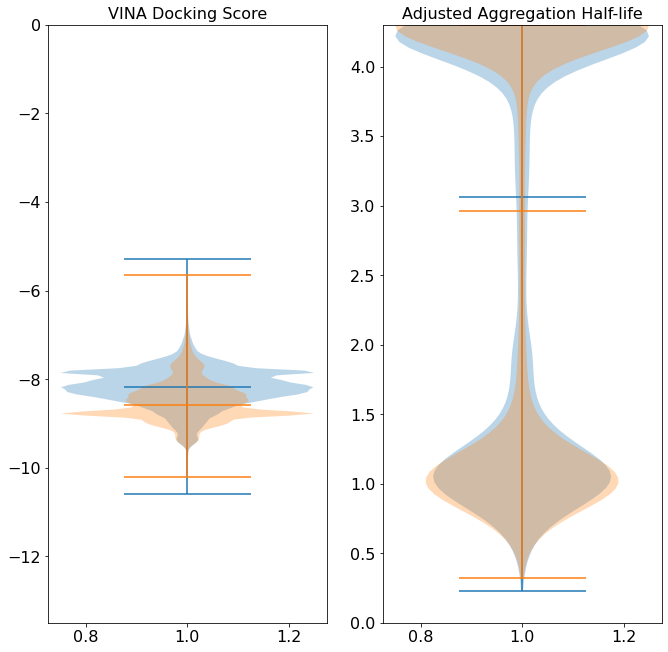

In [9]:
### Plotting the original dataset ###
####Make some plots####
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(11, 11))


# plot violin plot
axs[0].violinplot(VINAs_VINA,
                  showmeans=False,
                  showmedians=True)
axs[0].set_title('VINA Docking Score')
axs[0].violinplot(VINAs_no_VINA,
                  showmeans=False,
                  showmedians=True)

axs[0].set_ylim([-13.5, 0])

axs[1].violinplot(THALFs_VINA,
                 showmeans=False,
                 showmedians=True)
axs[1].set_title('Adjusted Aggregation Half-life')

axs[1].violinplot(THALFs_no_VINA,
                 showmeans=False,
                 showmedians=True)
axs[1].scatter(1,0.84,c="black",s=50,zorder=3)

axs[1].set_ylim([0,4.3])

Text(0, 0.5, 'Adjusted t_half of Aggregation')

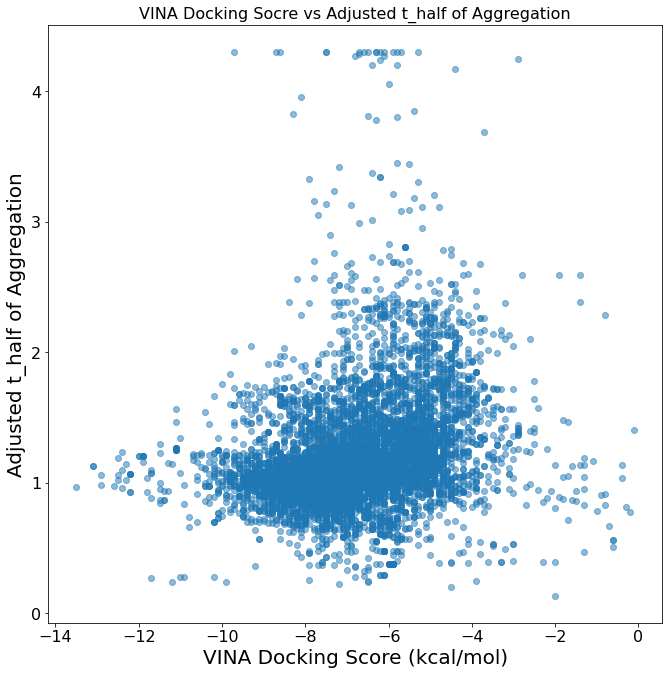

In [16]:
fig, ax = plt.subplots(figsize=(11, 11))


ax.scatter(VINA_Orig[-8231:], predictedTHALF_Orig[-8231:], alpha=0.5)
ax.set_title("VINA Docking Socre vs Adjusted t_half of Aggregation")
ax.set_xlabel("VINA Docking Score (kcal/mol)")
ax.set_ylabel("Adjusted t_half of Aggregation")

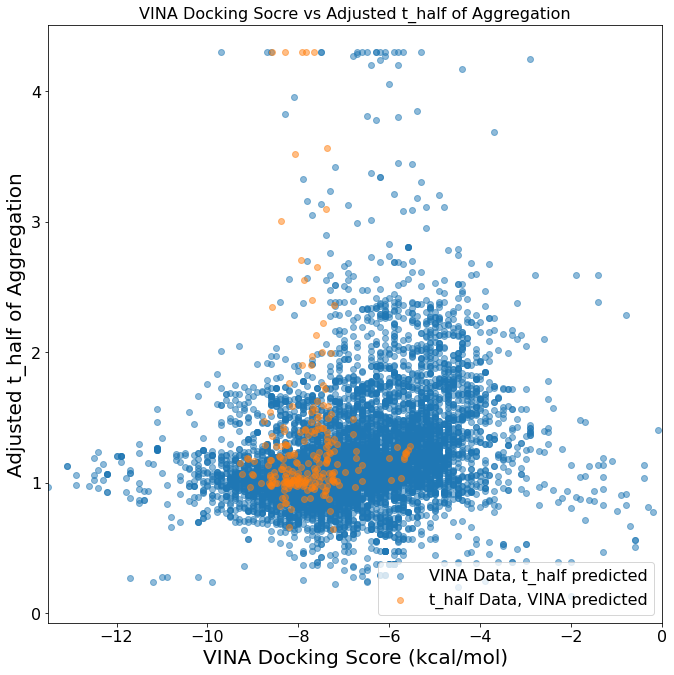

In [29]:
with open('cleaned_data_thalf.csv') as f:
    lines = f.readlines()

thalf = [x.split(",")[1] for x in lines]
thalf.pop(0)
thalf = [float(x) for x in thalf]

smiles = [x.split(",")[0] for x in lines]
smiles.pop(0)

predictedVINAs = []

for s in smiles:
    molvector = smilesToVec(s, smilesToVecModel)
    
    #predictedCNSMPOs.append(float(cnsmpo_model(torch.Tensor(molvector)).detach().numpy()))
    predictedVINAs.append(float(vina_model(torch.Tensor(molvector)).detach().numpy())*-13.5)
    #predictedTHALF_Orig.append(float(thalf_model(torch.Tensor(molvector)).detach().numpy())*4.3)
    
fig, ax = plt.subplots(figsize=(11, 11))

ax.scatter(VINA_Orig[-8231:], predictedTHALF_Orig[-8231:], alpha=0.5, label="VINA Data, t_half predicted")
ax.scatter(predictedVINAs, thalf, alpha=0.5, label="t_half Data, VINA predicted")
ax.set_title("VINA Docking Socre vs Adjusted t_half of Aggregation")
ax.set_xlabel("VINA Docking Score (kcal/mol)")
ax.set_ylabel("Adjusted t_half of Aggregation")
ax.set_xlim([-13.5, 0])
ax.legend(loc=4)

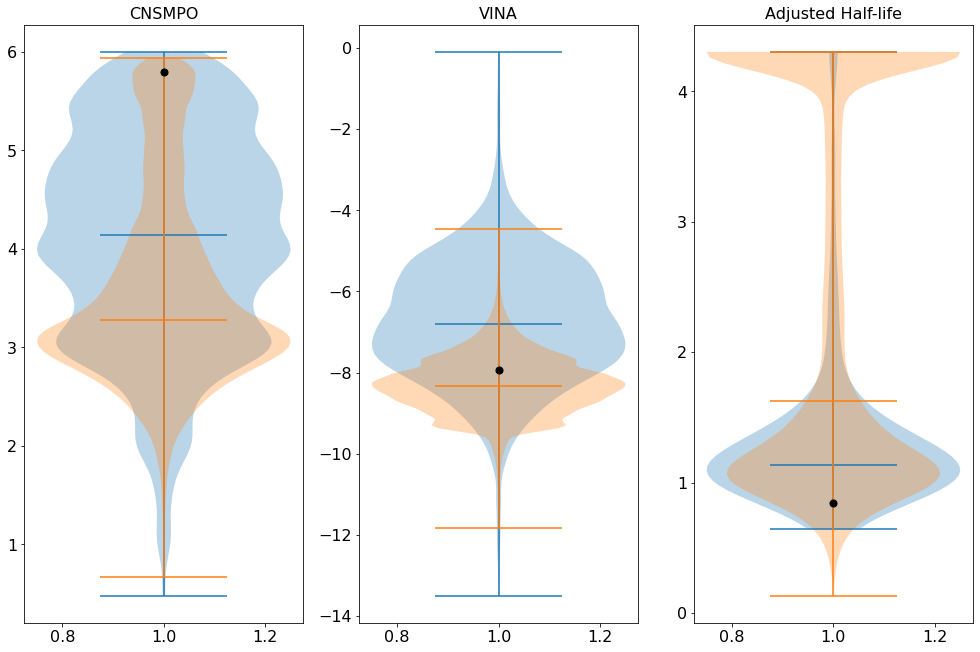

In [66]:
####Make some plots####
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(17, 11))


# plot violin plot
axs[0].violinplot(CNSMPO_Orig,
                  showmeans=False,
                  showmedians=True)
axs[0].violinplot(CNSMPOs,
                  showmeans=False,
                  showmedians=True)

axs[0].set_title('CNSMPO')

axs[0].scatter(1,5.8,c="black",s=50,zorder=3)

axs[1].violinplot(VINA_Orig,
                 showmeans=False,
                 showmedians=True)
axs[1].violinplot(VINAs,
                 showmeans=False,
                 showmedians=True)
axs[1].set_title('VINA')


axs[2].violinplot(THALF_Orig,
                 showmeans=False,
                 showmedians=True)
axs[2].violinplot(THALFs,
                 showmeans=False,
                 showmedians=True)
axs[2].set_title('Adjusted Half-life')

# axs[1].violinplot(predictedTHALF_Orig,
#                    showmeans=False,
#                    showmedians=True)
# axs[1].violinplot(THALFs[-8231:],
#                   showmeans=False,
#                   showmedians=True)



axs[2].scatter(1,0.84,c="black",s=50,zorder=3)


# axs[1].set_title('Predicted tHalf')



# axs[2].set_title('VINA Docking Score')

axs[1].scatter(1,-7.95,c="black",s=50,zorder=3)

# axs[1].violinplot(SASCORE_Orig[-8231:],
#                  showmeans=False,
#                  showmedians=True)
# axs[1].violinplot(SASCOREs[-8231:],
#                  showmeans=False,
#                  showmedians=True)

# axs[1].set_title('SAScore')

# axs[3].violinplot(SIMILARITYs[-8231:],
#                   showmeans=False,
#                   showmedians=True)


# import matplotlib.patches as mpatches

# labels = []
# def add_label(violin, label):
#     color = violin["bodies"][0].get_facecolor().flatten()
#     labels.append((mpatches.Patch(color=color), label))

# add_label(axs[2].violinplot(VINA_Orig[-8231:],
#                   showmeans=False,
#                   showmedians=True), "Original")

# add_label(axs[2].violinplot(VINAs[-8231:],
#                   showmeans=False,
#                   showmedians=True), "Optimized")


# labels.append((mpatches.Patch(color="black"), "Reference Molecule"))



plt.show()


<Figure size 1152x1152 with 0 Axes>

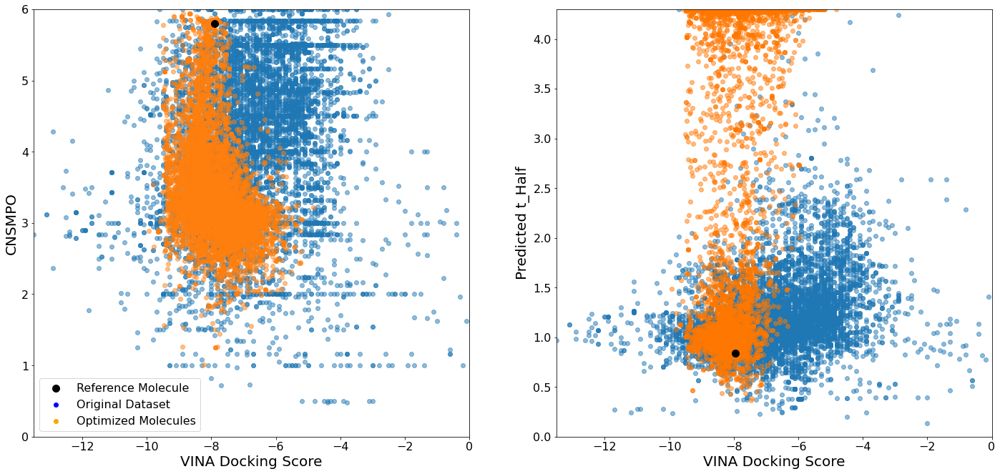

In [39]:
fig = plt.figure(figsize=(16, 16))

# ax = fig.add_axes(rect_scatter)
# ax_histx = fig.add_axes(rect_histx, sharex=ax)
# ax_histy = fig.add_axes(rect_histy, sharey=ax)

# # use the previously defined function

# scatter_hist(VINA_Orig[-8231:], CNSMPO_Orig[-8231:], ax, ax_histx, ax_histy, 6, -13.5)
# scatter_hist(VINAs[-8231:], CNSMPOs[-8231:], ax, ax_histx, ax_histy, 6, -13.5)
# ax.scatter(-10.1, 2.86, c="black",zorder=5,s=100, label="Reference Molecule")

# # scatter_hist(VINA_Orig[-8231:], predictedTHALF_Orig[-8231:], ax, ax_histx, ax_histy, 4.3, -13.5)
# # scatter_hist(VINAs[-8231:], predictedTHALFs[-8231:], ax, ax_histx, ax_histy, 4.3, -13.5)

# ax.scatter(10,-10,c="blue", label="Original Dataset")
# ax.scatter(10,-10,c="orange", label="Optimized Molecules")

# ax.legend()

# ax.set_xlabel("VINA Docking Score")
# ax.set_ylabel("t_Half or CNSMPO")


fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(24, 11))

axs[0].scatter(VINA_Orig[-8231:], CNSMPO_Orig[-8231:], alpha=0.5)
axs[0].scatter(VINAs[-8231:], CNSMPOs[-8231:], alpha=0.5)
axs[0].scatter(-7.9, 5.8, c="black",zorder=5,s=100, label="Reference Molecule")

axs[0].set_xlim([-13.5, 0])
axs[0].set_ylim([0, 6])
axs[0].set_xlabel("VINA Docking Score")
axs[0].set_ylabel("CNSMPO")


axs[1].scatter(VINA_Orig[-8231:], predictedTHALF_Orig[-8231:], alpha=0.5)
axs[1].scatter(VINAs[-8231:], THALFs[-8231:], alpha=0.5, c="#FF7700")
axs[1].scatter(-7.95,0.84, c="black",zorder=5,s=100, label="Reference Molecule")


axs[1].set_xlim([-13.5, 0])
axs[1].set_ylim([0, 4.3])
axs[1].set_xlabel("VINA Docking Score")
axs[1].set_ylabel("Predicted t_Half")

axs[0].scatter(10,-10,c="blue", label="Original Dataset")
axs[0].scatter(10,-10,c="orange", label="Optimized Molecules")
axs[0].legend()




plt.show()

['COc1ccc2c(c1)oc1c3onc(-c4ccnc(O)c4)c3c(=O)n(C)c21', 'COc1ccc2c(c1)oc1c3onc4c3c(=O)n(c21)Cc1cncc(O)c1-4', 'COc1ccc2c([nH]c3c4onc(-c5ccncc5)c4c(=O)n(C)c23)c1O', 'COc1ccc(-c2c3c(=O)c4cnccc4c4noc3c4c(=O)n2C)c(O)c1', 'C=C1CNC(c2ccc(C=O)c(N)c2Cl)=C1c1onc2c1COc1cnc(Cl)cc1-2', 'O=Cc1ccc(N=O)c2c1C=C(c1cc(-c3cc(Cl)nc(Cl)c3C=O)no1)OC(=O)NC2', 'O=Cc1cc(O)c2c3c([nH]c(=Cc4cc(-c5ccncc5Cl)no4)c13)=C(Cl)C2', 'Nc1ccc(N=O)c(C2=Cc3onc(-c4ccnc(Cl)c4Cl)c3CN2)c1C=O', 'O=Cc1cc(C2=Cc3onc(-c4ccnc(Cl)c4Cl)c3CN2)cc2ncoc12']
9


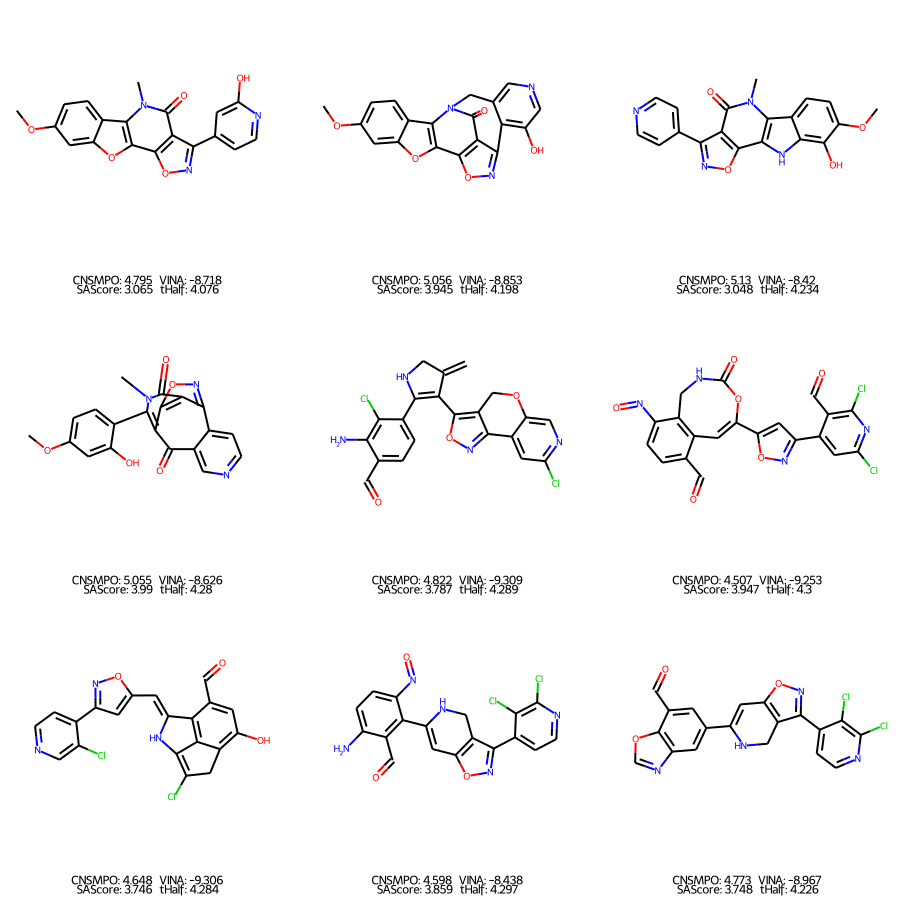

In [70]:
####Visualizing molecules####

#Select a subset of molecules
MaxVINA = -8.3
MinCNSMPO = 4.5
MaxSAScore = 4
MinTHALF = 4
LastN = 8000 

#Apply filters

drawoutputsmiles = []
temp = []
for i, mol in enumerate(SMILESs):
    if(CNSMPOs[i] > MinCNSMPO and VINAs[i] < MaxVINA and SASCOREs[i] < MaxSAScore and THALFs[i] > MinTHALF):
        if mol not in temp:
            temp.append(mol)
            drawoutputsmiles.append([mol, i])

print(temp)
MolsForVisualizing = [Chem.rdmolfiles.MolFromSmiles(mol[0]) for mol in drawoutputsmiles]

print(len(MolsForVisualizing))

legend = []


count = 0
for mol in drawoutputsmiles:
    legend.append("CNSMPO: " + str(round(CNSMPOs[mol[1]],3)) + "\t" + "VINA: " +  str(round(VINAs[mol[1]],3)) + "\n" + "SAScore: " + str(round(SASCOREs[mol[1]],3))+ "\t" + "tHalf: " + str(round(THALFs[mol[1]], 3)))
    count += 1

Chem.Draw.MolsToGridImage(MolsForVisualizing, molsPerRow=int(np.ceil((len(drawoutputsmiles))**0.5)), subImgSize=(300, 300), legends=legend, maxMols=1000)


In [19]:

#ng Original molecules####

#Select a subset of molecules
MaxVINA = -7.5
MinCNSMPO = 5
MaxSAScore = 6
LastN = 8000 

#Apply filters

drawoutputsmiles = []
for i, mol in enumerate(SMILES_Orig[-LastN:]):
    if(CNSMPO_Orig[i] > MinCNSMPO and VINA_Orig[i] < MaxVINA and SASCORE_Orig[i] < MaxSAScore):
        drawoutputsmiles.append([mol, i])

MolsForVisualizing = [Chem.rdmolfiles.MolFromSmiles(mol[0]) for mol in drawoutputsmiles[::10]]

print(len(MolsForVisualizing))

legend = []
for mol in drawoutputsmiles:
    legend.append(str(CNSMPO_Orig[mol[1]]) + "\n" + str(VINA_Orig[mol[1]]) + "\n" + str(SASCORE_Orig[mol[1]]))

Chem.Draw.MolsToGridImage(MolsForVisualizing, molsPerRow=int(len(drawoutputsmiles[-LastN:])**0.5), subImgSize=(300, 300), legends=legend, maxMols=1000)


NameError: name 'SASCORE_Orig' is not defined

['C[C@]12CC[C@@H](C([C@@H]1CC[C@@]3([C@@H]2CC=C4[C@]3(CC[C@@]5([C@H]4CC(CC5)(C)C)C(=O)O)C)C)(C)C)O', 'CC[C@@H]1[C@@]([C@@H]([C@H](C(=O)[C@@H](C[C@@]([C@@H]([C@H]([C@@H]([C@H](C(=O)O1)C)O[C@H]2C[C@@]([C@H]([C@@H](O2)C)O)(C)OC)C)O[C@H]3[C@@H]([C@H](C[C@H](O3)C)N(C)C)O)(C)O)C)C)O)(C)O', 'CC(C)C[C@H]1C(=O)N2CCC[C@H]2[C@]3(N1C(=O)[C@](O3)(C(C)C)NC(=O)[C@H]4CN([C@@H]5CC6=C(NC7=CC=CC(=C67)C5=C4)Br)C)O', 'C[C@@H]1CC[C@@]2(CC[C@@]3(C(=CC[C@H]4[C@]3(CC[C@@H]5[C@@]4(CC[C@@H](C5(C)C)O)C)C)[C@@H]2[C@H]1C)C)C(=O)O', 'CC(=C)[C@@H]1CC[C@]2([C@H]1[C@H]3CC[C@@H]4[C@]5(CC[C@@H](C([C@@H]5CC[C@]4([C@@]3(CC2)C)C)(C)C)O)C)C(=O)O', 'C[C@H]1CC[C@]2([C@H]([C@H]3[C@@H](O2)C[C@@H]4[C@@]3(CC[C@H]5[C@H]4CC[C@@H]6[C@@]5(CC[C@@H](C6)O)C)C)C)NC1', 'C[C@@]12CC[C@@]3(C(=CC[C@H]4[C@]3(CC[C@@H]5[C@@]4(CC[C@@H](C5(C)C)O)C)C)[C@@H]1CC(CC2)(C)C)C', 'CC(C)[C@H]1C(=O)O[C@@H](C(=O)N([C@H](C(=O)O[C@@H](C(=O)N([C@H](C(=O)O[C@@H](C(=O)N1C)C(C)C)C(C)C)C)C(C)C)C(C)C)C)C(C)C', 'C[C@H](CCC=C(C)C)[C@H]1CC[C@@]2([C@@]1(CCC3=C2CC[C@@H]4[

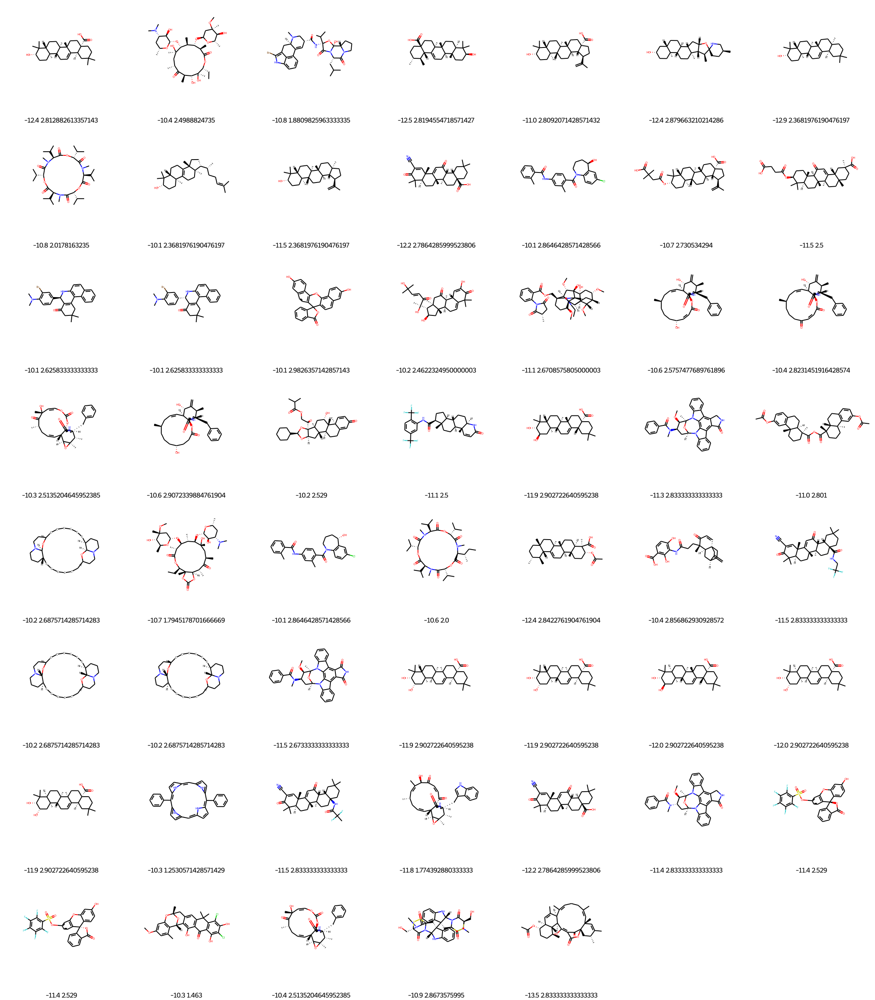

In [16]:
best_comb = 0
best_comb_cnsmpo = 0
best_comb_vina = 0
best_mol = ""
best_VINA = 0
best_mol_VINA = []#""
best_CNSMPO = 0
best_mol_CNSMPO = []

legends_cns = []
legends_vina = []

for i, mol in enumerate(SMILES_Orig):
    temp = (VINA_Orig[i]/-13.5) * CNSMPO_Orig[i]/6.0
    if temp > best_comb:
        best_comb = temp
        best_mol = mol
        best_comb_cnsmpo = CNSMPO_Orig[i]
        best_comb_vina = VINA_Orig[i]
    if VINA_Orig[i] < -10 and CNSMPO_Orig[i] < 3:
        best_mol_VINA.append(mol)
        best_VINA = VINA_Orig[i]
        legends_vina.append(str(VINA_Orig[i]) + " " + str(CNSMPO_Orig[i]))
    if CNSMPO_Orig[i] >= best_CNSMPO and VINA_Orig[i] < -8:
        if best_CNSMPO == 6:
            best_mol_CNSMPO.append(mol)
            legends_cns.append(str(VINA_Orig[i]))
        else:
            best_mol_CNSMPO = [mol]
            best_CNSMPO = CNSMPO_Orig[i]
            legends_cns = [str(VINA_Orig[i])]

print(best_mol_VINA)
print(legends_cns[-1])

#best_mol_CNSMPO = [Chem.MolFromSmiles(m) for m in best_mol_CNSMPO]
best_mol_VINA = [Chem.MolFromSmiles(m) for m in best_mol_VINA]
    
#Chem.Draw.MolToImage(Chem.MolFromSmiles(best_mol))
#Chem.Draw.MolToImage(Chem.MolFromSmiles(best_mol_VINA))
Chem.Draw.MolsToGridImage(best_mol_VINA, molsPerRow=int(len(best_mol_VINA[:])**0.5), subImgSize=(300, 300),legends = legends_vina, maxMols=1000)

#Chem.Draw.MolsToGridImage(best_mol_CNSMPO, molsPerRow=int(len(best_mol_CNSMPO[:])**0.5), subImgSize=(300, 300),legends = legends_cns, maxMols=1000)
#Chem.Draw.MolToImage(best_mol_CNSMPO[-1], legend="CNSMPO: 6 \t VINA: -8.4")

In [76]:


smilesToVecModel = word2vec.Word2Vec.load('mol2vec/mol2vec/models/model_300dim.pkl')


molvector_ref = smilesToVec("CN1C(=CC2=C(C1=O)C(=NO2)C3=CC=NC=C3)C4=CC=C(C=C4)OC", smilesToVecModel)

#molvector_ref = smilesToVec("CC1=CC=CC=C1C(=O)NC2=CC(=C(C=C2)C(=O)N3CCC[C@H](C4=C3C=CC(=C4)Cl)O)C", smilesToVecModel)

predictedCNSMPOs_ref = float(cnsmpo_model(torch.Tensor(molvector_ref)).detach().numpy())
predictedVINAs_ref = float(vina_model(torch.Tensor(molvector_ref)).detach().numpy())*-13.5
predictedTHALFs_ref = float(thalf_model(torch.Tensor(molvector_ref)).detach().numpy())*4.3

s = "CN1C(=CC2=C(C1=O)C(=NO2)C3=CC=NC=C3)C4=CC=C(C=C4)OC"
Chem.Draw.MolsToGridImage([Chem.MolFromSmiles(s)], subImgSize=(300, 300))


print(predictedCNSMPOs_ref, predictedVINAs_ref, predictedTHALFs_ref)

5.803613662719727 -7.955211728811264 0.8495975017547607


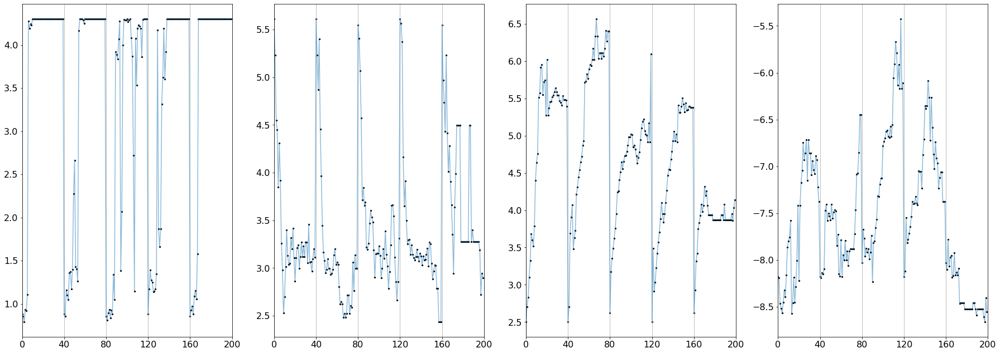

In [50]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

fig, axs = plt.subplots(nrows=1, ncols=4, figsize=(31, 11))

start = 10
offset = 33
startindex = start*40

axs[0].scatter(np.arange(len(THALFs[-(offset + 200 + startindex):-(offset + startindex)])), THALFs[-(offset + 200 + startindex):-(offset + startindex)], s=5, c="black")
axs[0].plot(np.arange(len(THALFs[-(offset + 200 + startindex):-(offset + startindex)])), THALFs[-(offset + 200 + startindex):-(offset + startindex)], alpha = 0.5)

axs[1].scatter(np.arange(len(CNSMPOs[-(offset + 200 + startindex):-(offset + startindex)])), CNSMPOs[-(offset + 200 + startindex):-(offset + startindex)], s=5, c="black")
axs[1].plot(np.arange(len(CNSMPOs[-(offset + 200 + startindex):-(offset + startindex)])), CNSMPOs[-(offset + 200 + startindex):-(offset + startindex)], alpha = 0.5)

axs[2].scatter(np.arange(len(SASCOREs[-(offset + 200 + startindex):-(offset + startindex)])), SASCOREs[-(offset + 200 + startindex):-(offset + startindex)], s=5, c="black")
axs[2].plot(np.arange(len(SASCOREs[-(offset + 200 + startindex):-(offset + startindex)])), SASCOREs[-(offset + 200 + startindex):-(offset + startindex)], alpha = 0.5)

axs[3].scatter(np.arange(len(VINAs[-(offset + 200 + startindex):-(offset + startindex)])), VINAs[-(offset + 200 + startindex):-(offset + startindex)], s=5, c="black")
axs[3].plot(np.arange(len(VINAs[-(offset + 200 + startindex):-(offset + startindex)])), VINAs[-(offset + 200 + startindex):-(offset + startindex)], alpha = 0.5)


for ax in axs:
    ax.set_xlim([0, 200])
    ax.xaxis.set_major_locator(ticker.LinearLocator(6))
    ax.grid(axis="x")



plt.show()

              
